In [340]:
from gym.spaces import Discrete, Tuple
import random
import matplotlib.pyplot as plt
import matplotlib as mpl
from scipy.ndimage.measurements import label
import gym
from gym import error, spaces, utils
from gym.utils import seeding
import numpy as np
import copy
class PackEnv(gym.Env):
    metadata = {'render.modes': ['human']}

    def __init__(self, board_shape = (5, 5), input_shapes=[],max_moves=100, replacement=True):
        self.counter = 0
        self.max_moves = max_moves
        self.done = False
        self.reward = 0
        self.board_shape = board_shape
        self.observation_space = np.zeros((board_shape[0], board_shape[1]*2))
        self.action_space = Discrete(board_shape[0]*board_shape[1]+1)
        self.state = [np.zeros(board_shape),np.zeros(board_shape)]
        self.return_state = np.concatenate((self.state[0], self.state[1]), axis=1)
        self.replace = replacement

        self.num_possible_moves = board_shape[0]*board_shape[1]

        if len(input_shapes) == 0:
            mat = np.zeros(board_shape)
            mat[0][0] = 1
            self.shapes = [mat]
        else:
            self.shapes = []
            for shape in input_shapes:
                base_mat = np.zeros(board_shape)
                for i in range(len(shape)):
                    for j in range(len(shape[0])):
                        base_mat[i][j] = shape[i][j]
                self.shapes.append(base_mat)
        self.remaining_shapes = copy.deepcopy(self.shapes)
        val = random.choice(range(len(self.shapes)))
        self.state[1] = self.shapes[val]
        if not self.replace:
            self.remaining_shapes.pop(val)

    def reset(self):
        val = random.choice(range(len(self.shapes)))
        random_shape = self.shapes[val]
        self.counter = 0
        self.done = False
        self.reward = 0
        self.state = [np.zeros(self.board_shape), random_shape]
        self.return_state = np.concatenate((self.state[0], self.state[1]), axis=1)
        self.remaining_shapes = copy.deepcopy(self.shapes)
        if not self.replace:
            self.remaining_shapes.pop(val)
        return self.return_state


    def valid_move(self, target):
        state = self.state
        board = state[0]
        piece = state[1]
        h = self.board_shape[0]
        w = self.board_shape[1]

        #do nothing
        if target == h * w:
            return True

        if target > h*w or target < 0:
            return False

        h_offset = int(target / h)
        w_offset = target % w

        for H in range(len(piece)):
            for W in range(len(piece[0])):
                if piece[H][W] == 1:
                    if (h_offset + H >= h) or (w_offset + W  >= w):
                        return False
                    if board[H+h_offset][W+w_offset] == 1:
                        return False
        return True


    def calculate_reward(self, target):
        state = self.state
        board = state[0]
        h = self.board_shape[0]
        w = self.board_shape[1]
        if target == self.num_possible_moves:
            return -10000000

        #connection structure
        #structure = np.ones((3, 3), dtype=np.int)
        structure = np.array([[0,1,0],[1,1,1],[0,1,0]])
        labeled, ncomponents = label(board, structure)
        component_num = labeled[int(target/h)][target % w]
        indices = np.indices(board.shape).T[:,:,[1, 0]]
        component = indices[labeled == component_num]

        size = len(component)
        max_h = max([pair[0] for pair in component])
        min_h = min([pair[0] for pair in component])
        max_w = max([pair[1] for pair in component])
        min_w = min([pair[1] for pair in component])
        block_size = abs(max_h-min_h + 1)*abs(max_w-min_w + 1)
        return size**2/block_size

    def merge(self, target):
        state = self.state
        board = state[0]
        piece = state[1]
        h = self.board_shape[0]
        w = self.board_shape[1]

        #do nothing
        if target == h * w:
            return state[0]

        h_offset = int(target / h)
        w_offset = target % w

        for H in range(len(piece)):
            for W in range(len(piece[0])):
                if piece[H][W] == 1:
                    #print("HIIIIIII")
                    board[H+h_offset][W+w_offset] = 1
        return board

    def final_reward(self):
        h = self.board_shape[0]
        w = self.board_shape[1]
        state = self.state
        board = state[0]
        if np.sum(board) == h*w:
            return 1000000
        else:
            return -1000000
        

    def step(self, target):
        h = self.board_shape[0]
        w = self.board_shape[1]
        if self.done == True:
            self.reward = self.final_reward()
            print("It's over")
            return [self.return_state, self.reward, self.done, {}]
        elif target > self.num_possible_moves:
            print("Impossible. Invalid position")
            return [self.return_state, self.reward, self.done, {}]
        else:
            self.counter+=1
            #print("counter", self.counter)
            if (self.counter == self.max_moves):
                self.done = True
                self.reward = self.final_reward()                
                return [self.return_state, self.reward, self.done, {}]
            #self.state[0][int(target/h)][target%k] = 1
            if not self.valid_move(target):
                self.reward = -50000000
                return [self.return_state, self.reward, self.done, {}]

            self.reward = self.calculate_reward(target)
            updated_board = self.merge(target)
            self.state[0] = updated_board
            
            #do nothing so same state
            if (target == h*w):
                return [self.return_state, self.reward, self.done, {}]
            #no pieces left so we're done
            if len(self.remaining_shapes) == 0:
                print("hi")
                self.state[1] = np.zeros(self.board_shape)
                self.return_state = np.concatenate((self.state[0], self.state[1]), axis=1)
                self.done = True
                self.reward = self.final_reward()
                return [self.return_state, self.reward, self.done, {}]
            else:
                val = random.choice(range(len(self.remaining_shapes)))
                self.state[1] = self.remaining_shapes[val]
                if not self.replace:
                    self.remaining_shapes.pop(val)
                self.return_state = np.concatenate((self.state[0], self.state[1]), axis=1)
                return [self.return_state, self.reward, self.done, {}]


    def render(self, mode='human'):
        fig, ax = plt.subplots()
        # define the colors
        cmap = mpl.colors.ListedColormap(['w', 'k'])

        # create a normalize object the describes the limits of
        # each color
        bounds = [0., 0.5, 1.]
        norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

        # plot it
        ax.imshow(self.state[0], interpolation='none', cmap=cmap, norm=norm)
    def render_piece(self, mode='human'):
        fig, ax = plt.subplots()
        # define the colors
        cmap = mpl.colors.ListedColormap(['w', 'k'])

        # create a normalize object the describes the limits of
        # each color
        bounds = [0., 0.5, 1.]
        norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

        # plot it
        ax.imshow(self.state[1], interpolation='none', cmap=cmap, norm=norm)

In [192]:
np.ones((1,1))

array([[1.]])

In [193]:
hello = BinPack(max_moves = 1000, board_shape = (10, 10), input_shapes=[np.ones((2,2)), np.ones((1,1))])

In [196]:
hello.observation_space.shape

(10, 20)

4.0
1.0
4.0
1.0
4.0
-5
4.166666666666667
1.0
4.5
-5
-5
4.0
-5
-5
4.0
8.1
6.666666666666667
4.166666666666667
-5
-5
-5
-5
4.0
-5
-5
7.84
-5
-5
-5
12.96
12.033333333333333
5.444444444444445
-5
-5
11.11111111111111
12.25
-5
6.125
-5
-5
13.444444444444445
-5
-5
18.77777777777778
-5
17.357142857142858
18.666666666666668
-5
21.728571428571428
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
32.91428571428571
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-1
-5
28.09
-5
-5
-5
-1
-5
-5
-5
-5
-5
-5
-5
29.16
-5
-5
-5
-5
-5
-1
30.25
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-1
5.333333333333333
-5
8.047619047619047
9.333333333333334
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-5
-

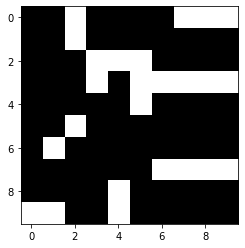

In [194]:
for i in range(1000):
    hello.step(random.randint(0,10*10))
    print(hello.reward)
hello.render()

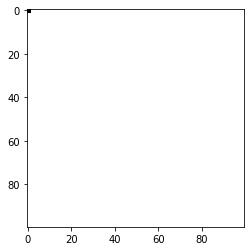

In [155]:
hello.render_piece()

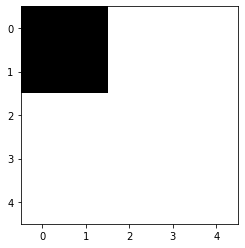

In [139]:
hello.render_piece()

In [120]:
hello.step(15)

HIIIIIII
HIIIIIII
HIIIIIII
HIIIIIII
updated board [[1. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0.]
 [1. 1. 0. 1. 1.]
 [1. 1. 0. 1. 1.]]


[[array([[1., 0., 0., 1., 0.],
         [0., 0., 0., 0., 0.],
         [0., 0., 0., 0., 0.],
         [1., 1., 0., 1., 1.],
         [1., 1., 0., 1., 1.]]), array([[1., 0., 0., 0., 0.],
         [0., 0., 0., 0., 0.],
         [0., 0., 0., 0., 0.],
         [0., 0., 0., 0., 0.],
         [0., 0., 0., 0., 0.]])], -1, False, {}]

In [121]:
hello.state

[array([[1., 0., 0., 1., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [1., 1., 0., 1., 1.],
        [1., 1., 0., 1., 1.]]), array([[1., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.]])]

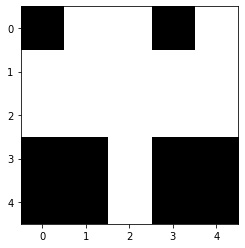

In [122]:
hello.render()

In [22]:
hello.observation_space[0]

array([[0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0.]])

In [30]:
hello.shapes

[array([[1., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.]])]

In [233]:
a = BinPack()

In [241]:
a.step(18)

[[1 1 0 0 0]
 [1 1 0 0 0]
 [0 0 0 0 0]
 [0 2 2 2 0]
 [2 0 0 0 0]]
[[3 1]
 [3 2]
 [3 3]
 [4 0]]
2.0


[array([[1., 1., 0., 0., 0., 1., 0., 0., 0., 0.],
        [1., 1., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 1., 1., 1., 0., 0., 0., 0., 0., 0.],
        [1., 0., 0., 0., 0., 0., 0., 0., 0., 0.]]), 2.0, False, {}]

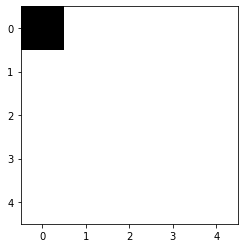

In [229]:
a.render()

In [230]:
for action in range(26):
    print(a.calculate_reward(action))

[[1 0 0 0 0]
 [0 0 0 0 0]
 [0 0 0 0 0]
 [0 0 0 0 0]
 [0 0 0 0 0]]
[[0 0]]
1.0
[[1 0 0 0 0]
 [0 0 0 0 0]
 [0 0 0 0 0]
 [0 0 0 0 0]
 [0 0 0 0 0]]
[[0 1]
 [0 2]
 [0 3]
 [0 4]
 [1 0]
 [1 1]
 [1 2]
 [1 3]
 [1 4]
 [2 0]
 [2 1]
 [2 2]
 [2 3]
 [2 4]
 [3 0]
 [3 1]
 [3 2]
 [3 3]
 [3 4]
 [4 0]
 [4 1]
 [4 2]
 [4 3]
 [4 4]]
23.04
[[1 0 0 0 0]
 [0 0 0 0 0]
 [0 0 0 0 0]
 [0 0 0 0 0]
 [0 0 0 0 0]]
[[0 1]
 [0 2]
 [0 3]
 [0 4]
 [1 0]
 [1 1]
 [1 2]
 [1 3]
 [1 4]
 [2 0]
 [2 1]
 [2 2]
 [2 3]
 [2 4]
 [3 0]
 [3 1]
 [3 2]
 [3 3]
 [3 4]
 [4 0]
 [4 1]
 [4 2]
 [4 3]
 [4 4]]
23.04
[[1 0 0 0 0]
 [0 0 0 0 0]
 [0 0 0 0 0]
 [0 0 0 0 0]
 [0 0 0 0 0]]
[[0 1]
 [0 2]
 [0 3]
 [0 4]
 [1 0]
 [1 1]
 [1 2]
 [1 3]
 [1 4]
 [2 0]
 [2 1]
 [2 2]
 [2 3]
 [2 4]
 [3 0]
 [3 1]
 [3 2]
 [3 3]
 [3 4]
 [4 0]
 [4 1]
 [4 2]
 [4 3]
 [4 4]]
23.04
[[1 0 0 0 0]
 [0 0 0 0 0]
 [0 0 0 0 0]
 [0 0 0 0 0]
 [0 0 0 0 0]]
[[0 1]
 [0 2]
 [0 3]
 [0 4]
 [1 0]
 [1 1]
 [1 2]
 [1 3]
 [1 4]
 [2 0]
 [2 1]
 [2 2]
 [2 3]
 [2 4]
 [3 0]
 [3 1]
 [3 2]
 [3 3]
 [3 4]


In [267]:
a = PackEnv(board_shape=(2,2), input_shapes=[[[1]]]*2+[[[1,1],[0,0]]], replacement=False)

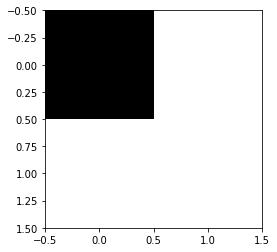

In [282]:
a.render_piece()

In [283]:
a.step(0)

counter 1


[array([[1., 0., 1., 0.],
        [0., 0., 0., 0.]]), 4.0, False, {}]

In [284]:
a.step(3)

counter 2


[array([[1., 0., 1., 1.],
        [0., 1., 0., 0.]]), 2.25, False, {}]

In [285]:
a.step(2)

counter 3


[array([[1., 0., 1., 1.],
        [0., 1., 0., 0.]]), -5000000000, False, {}]

In [286]:
a.step(1)

counter 4


[array([[1., 0., 1., 1.],
        [0., 1., 0., 0.]]), -5000000000, False, {}]

In [287]:
a.reset()

array([[0., 0., 1., 1.],
       [0., 0., 0., 0.]])

In [291]:
%%capture
import gym
#import gym_pack
import numpy as np
import random
from keras.models import Sequential
from keras.layers import Dense, Dropout
from keras.optimizers import Adam

from collections import deque

from keras.models import Sequential
from keras.layers import Dense, Activation, Flatten, Reshape
from keras.optimizers import Adam
from keras import layers, models

from rl.agents.cem import CEMAgent
from rl.memory import EpisodeParameterMemory

In [442]:
class DQN:
    def __init__(self, env):
        self.env     = env
        self.memory  = deque(maxlen=10000)
        
        self.gamma = 0.95
        self.epsilon = 1.0
        self.epsilon_min = 0.05
        self.epsilon_decay = 0.999
        self.learning_rate = 0.01
        self.tau = .08
        self.min_tau = .02
        self.tau_decay = .999

        self.model        = self.create_model()
        self.target_model = self.create_model()

    def create_model(self):
        model   = Sequential()
        state_shape  = self.env.return_state.shape
        #model.add(Flatten(input_shape=state_shape))
        #print()
        #model.add(Flatten())
        #(env.observation_space.shape+ (1,))
        #x = Reshape(self.env.return_state.shape+(1,))
        #model.add(x)
        """
        model.add(layers.Conv2D(32, (5, 5),padding="same",input_shape=(2,4,1), activation="relu"))
        model.add(layers.Conv2D(32, (5, 5),padding="same", activation="relu"))
        model.add(layers.MaxPooling2D(pool_size=(2, 2), strides=(1, 1), padding='same'))
        model.add(layers.Conv2D(32, (3, 3),padding="same", activation="relu"))
        model.add(layers.Conv2D(32, (3, 3),padding="same", activation="relu"))
        """
   
        #weak model
        model.add(Dense(24, input_shape=(2,4,1), activation="relu"))
        model.add(Dense(24, activation="relu"))
        model.add(Dense(48, activation="relu"))
        
        model.add(Dense(24, activation="relu"))
        model.add(Flatten())
        model.add(Dense(self.env.action_space.n))
        #model.compile(loss="mean_squared_error",
        #    optimizer=Adam(lr=self.learning_rate))
        model.compile(loss="mean_squared_error",
            optimizer=Adam(lr=self.learning_rate))
        print(model.summary())
        #print(model.input_shape)
        return model

    def act(self, state):
        self.epsilon *= self.epsilon_decay
        self.epsilon = max(self.epsilon_min, self.epsilon)
        if np.random.random() < self.epsilon:
            return self.env.action_space.sample()
        #print(state)
        #state = state.reshape(5, 10,1)
        predictions = self.model.predict(state.reshape(1,2, 4,1))[0]
        for i in range(len(predictions)):
            if not self.env.valid_move(i):
                predictions[i] -= 100000000
        print(predictions)
        return np.argmax(predictions)
    
    def trained_act(self, state):
        predictions = self.model.predict(state.reshape(1,2, 4,1))[0]
        for i in range(len(predictions)):
            if not self.env.valid_move(i):
                predictions[i] -= 100000000
        print(predictions)
        predictions[-1] -=1000000000
        return np.argmax(predictions)

    def remember(self, state, action, reward, new_state, done):
        self.memory.append([state, action, reward, new_state, done])

    def replay(self):
        batch_size = 32
        if len(self.memory) < batch_size: 
            return

        samples = random.sample(self.memory, batch_size)
        for sample in samples:
            state, action, reward, new_state, done = sample
            #print("sample state is ", state, action)
            #state = state.reshape(5, 10,1)
            target = self.target_model.predict(state.reshape(1,2, 4,1))
            if done:
                target[0][action] = reward
            else:
                reward = reward/abs(reward) if not done else -.01
                #print('REPLAY', self.target_model.predict(new_state)[0])
                Q_future = max(self.target_model.predict(new_state.reshape(1,2, 4,1))[0])
                target[0][action] = reward + Q_future * self.gamma
            self.model.fit(state, target, epochs=1, verbose=0)

    def target_train(self):
        weights = self.model.get_weights()
        target_weights = self.target_model.get_weights()
        self.tau = max(self.min_tau, self.tau*self.tau_decay)
        for i in range(len(target_weights)):
            target_weights[i] = weights[i] * self.tau + target_weights[i] * (1 - self.tau)
        self.target_model.set_weights(target_weights)

    def save_model(self, fn):
        self.model.save(fn)

def main():
    env = PackEnv(board_shape=(2,2), input_shapes=[[[1]]]*2+[[[1,1],[0,0]]], replacement=False, max_moves=4)
    gamma   = 0.95
    epsilon = .99

    trials  = 201
    trial_len = 50
    accuracies = []

    # updateTargetNetwork = 1000
    dqn_agent = DQN(env=env)
    steps = []
    for trial in range(trials):
        #cur_state = env.reset().reshape(5,10)
        cur_state = env.reset()
        #print("cur",cur_state)
        cur_state = cur_state.reshape(1,2,4,1)
        #print("updated, cur_state")
        for step in range(trial_len):
            if (trial % 100) == 0 and trial !=0:
                total_accuracy = 0
                for i in range(30):
                    accuracy = 0
                    new_state = env.reset()
                    for j in range(3):
                        action = dqn_agent.trained_act(new_state)
                        new_state, reward, done, _ = env.step(action)
                    accuracy = np.sum(new_state[:,:2])/4
                    print("sub accuracy is", accuracy)

                    total_accuracy += accuracy/30
                accuracies.append(total_accuracy)
                print("accuracy is ", total_accuracy)
            
            #print("cur_state",cur_state)
            action = dqn_agent.act(cur_state)
            new_state, reward, done, _ = env.step(action)
            #print("info", new_state, reward, done)

            reward = reward/abs(reward) if not done else -.01
            new_state = new_state.reshape(1,2,4,1)
            dqn_agent.remember(cur_state, action, reward, new_state, done)
            
            dqn_agent.replay()       # internally iterates default (prediction) model
            dqn_agent.target_train() # iterates target model

            cur_state = new_state
            if done:
                break
        """
        if step >= 199:
            print("Failed to complete in trial {}".format(trial))
            if step % 10 == 0:
                dqn_agent.save_model("trial-{}.model".format(trial))
        else:
            print("Completed in {} trials".format(trial))
            dqn_agent.save_model("success.model")
            break
        """
        print("trial #{}".format(trial))
    return env, dqn_agent, dqn_agent.model

In [443]:
env, agent, model = main()

Model: "sequential_61"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_289 (Dense)            (None, 2, 4, 24)          48        
_________________________________________________________________
dense_290 (Dense)            (None, 2, 4, 24)          600       
_________________________________________________________________
dense_291 (Dense)            (None, 2, 4, 48)          1200      
_________________________________________________________________
dense_292 (Dense)            (None, 2, 4, 24)          1176      
_________________________________________________________________
flatten_61 (Flatten)         (None, 192)               0         
_________________________________________________________________
dense_293 (Dense)            (None, 5)                 965       
Total params: 3,989
Trainable params: 3,989
Non-trainable params: 0
___________________________________________________

[ 1.2190286e+00  9.2900246e-01  9.4899738e-01 -1.0000000e+08
  1.8958297e-01]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
 -3.0468804e-01]
trial #92
[1.759787   1.2532954  1.5086439  1.4654047  0.47892195]
[-1.0000000e+08 -1.0000000e+08  5.2892804e-01 -1.0000000e+08
 -1.5600191e-01]
[-1.0000000e+08 -2.3348176e-01 -1.0000000e+08 -1.0000000e+08
 -2.3565897e-01]
trial #93
[1.7528207 1.2622168 1.5281554 1.4964767 0.4717235]
trial #94
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
 -7.5010705e-01]
trial #95
[ 4.6906769e-01  5.9382486e-01 -1.0000000e+08 -1.0000000e+08
 -1.5653712e-01]
trial #96
[ 4.77277100e-01  4.46570367e-01 -1.00000000e+08 -1.00000000e+08
 -1.13725245e-01]
[-1.0000000e+08 -1.6771680e-01 -1.0000000e+08 -1.0000000e+08
 -2.3508719e-01]
trial #97
[ 6.455380e-01 -1.000000e+08 -1.000000e+08 -1.000000e+08 -9.332958e-02]
trial #98
[-1.0000000e+08 -1.0000000e+08  4.2057347e-01 -1.0000000e+08
 -1.5601364e-01]
trial #99
[ 1.1245134e+00 -1.0000000e+08  

trial #100
[1.7922122 1.2110009 1.4606547 1.4522021 0.4854616]
[-1.0000000e+08 -1.0000000e+08  4.2233002e-01 -1.0000000e+08
 -5.4516688e-02]
[-1.0000000e+08 -1.2661368e-01 -1.0000000e+08 -1.0000000e+08
 -2.2377911e-01]
hi
trial #101
[ 1.1400559e+00 -1.0000000e+08  9.4183052e-01 -1.0000000e+08
  1.9088343e-02]
[-1.0000000e+08 -1.0000000e+08  4.0523607e-01  5.1782447e-01
 -2.2239950e-01]
trial #102
[1.7697246  1.273629   1.4921752  1.5125253  0.47599012]
[-1.000000e+08 -1.000000e+08 -1.000000e+08 -1.000000e+08 -5.216322e-01]
trial #103
[ 1.1612462e+00 -1.0000000e+08  1.0365067e+00 -1.0000000e+08
 -4.7417864e-02]
[-1.0000000e+08 -1.0000000e+08  4.6064740e-01  5.3575379e-01
 -1.9676402e-01]
trial #104
trial #105
[1.7434598  1.2576206  1.5153911  1.5423636  0.48525158]
[-1.0000000e+08  6.2024832e-01  1.0801411e+00  1.1160055e+00
  3.8130116e-01]
[-1.000000e+08 -1.000000e+08 -1.000000e+08 -1.000000e+08 -2.749794e-01]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
 -2.0261034e-0

trial #164
[ 1.2573013e+00 -1.0000000e+08  1.0882977e+00 -1.0000000e+08
  1.8678623e-01]
[-1.0000000e+08 -1.0000000e+08 -2.2134578e-01 -1.0000000e+08
 -3.3167413e-01]
trial #165
[ 1.3126857e+00 -1.0000000e+08  1.1252161e+00 -1.0000000e+08
  1.5926035e-01]
trial #166
[1.8190277  1.4313657  1.6251023  1.6125087  0.53961277]
[-1.00000000e+08 -1.00000000e+08  5.80368161e-01 -1.00000000e+08
 -1.05571896e-01]
[-1.0000000e+08 -1.5639633e-01 -1.0000000e+08 -1.0000000e+08
 -3.7366205e-01]
hi
trial #167
[ 1.1337588e+00  1.0503826e+00  9.9804485e-01 -1.0000000e+08
  3.5818845e-01]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
 -3.6137235e-01]
trial #168
[-1.0000000e+08 -1.0000000e+08  5.8119226e-01 -1.0000000e+08
 -2.5554594e-01]
trial #169
[1.8293741  1.4323652  1.6509812  1.6021335  0.50463957]
[-1.0000000e+08 -1.0000000e+08  5.0408047e-01 -1.0000000e+08
 -1.7424655e-01]
[-1.0000000e+08 -1.9405729e-01 -1.0000000e+08 -1.0000000e+08
 -3.0201900e-01]
hi
trial #170
[1.7221301 1.44901

[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
 -3.0922246e-01]
sub accuracy is 0.5
[ 1.3034320e+00 -1.0000000e+08  1.1040397e+00 -1.0000000e+08
  2.3228949e-01]
[-1.0000000e+08 -1.0000000e+08  4.3068010e-01  6.3376415e-01
 -1.4998138e-01]
[-1.0000000e+08 -1.0000000e+08 -1.9173831e-01 -1.0000000e+08
 -3.3183080e-01]
hi
sub accuracy is 1.0
[1.7838665  1.5333073  1.6072586  1.6464579  0.63483506]
[-1.0000000e+08  6.8027276e-01  1.0119975e+00  1.1564835e+00
  2.7517256e-01]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
 -3.0922246e-01]
sub accuracy is 0.5
[1.7838665  1.5333073  1.6072586  1.6464579  0.63483506]
[-1.0000000e+08  6.8027276e-01  1.0119975e+00  1.1564835e+00
  2.7517256e-01]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
 -3.0922246e-01]
sub accuracy is 0.5
[ 1.3034320e+00 -1.0000000e+08  1.1040397e+00 -1.0000000e+08
  2.3228949e-01]
[-1.0000000e+08 -1.0000000e+08  4.3068010e-01  6.3376415e-01
 -1.4998138e-01]
[-1.0000000e+08 -1.0000

In [458]:
env = PackEnv(board_shape=(2,2), input_shapes=[[[1]]]*2+[[[1,1],[0,0]]], replacement=False, max_moves=4)

In [462]:
env.step(0)

[array([[1., 0., 1., 1.],
        [0., 0., 0., 0.]]), 4.0, False, {}]

In [457]:
model.predict(np.array([[[1,0,1,1],[0,1,0,0]]]).reshape(1,2,4,1))

array([[-0.3920974 , -0.94487053, -0.08358985, -0.93316764, -0.39613158]],
      dtype=float32)

In [440]:
x, y = main()

Model: "sequential_59"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_279 (Dense)            (None, 2, 4, 24)          48        
_________________________________________________________________
dense_280 (Dense)            (None, 2, 4, 24)          600       
_________________________________________________________________
dense_281 (Dense)            (None, 2, 4, 48)          1200      
_________________________________________________________________
dense_282 (Dense)            (None, 2, 4, 24)          1176      
_________________________________________________________________
flatten_59 (Flatten)         (None, 192)               0         
_________________________________________________________________
dense_283 (Dense)            (None, 5)                 965       
Total params: 3,989
Trainable params: 3,989
Non-trainable params: 0
___________________________________________________

trial #95
[1.2038525  0.44277254 1.4624913  0.54527634 0.0973627 ]
[ 1.1963569e+00 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  8.3167791e-02]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  5.2418941e-01
  1.3439575e-01]
trial #96
[1.1054924  0.49523407 1.4300485  0.5153356  0.08987346]
[ 1.1339314e+00 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  9.7621500e-02]
hi
trial #97
[1.0802051  0.49986303 1.4590285  0.5947641  0.13734867]
trial #98
[ 1.1179353e+00  4.4167256e-01 -1.0000000e+08  6.2907666e-01
  1.3330178e-01]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.4358068e-01]
trial #99
[ 1.1263380e+00 -1.0000000e+08  1.5242238e+00 -1.0000000e+08
  1.5187730e-01]
[ 1.126338e+00  5.291843e-01 -1.000000e+08 -1.000000e+08  1.518773e-01]
[-1.000000e+08  5.291843e-01 -1.000000e+08 -1.000000e+08  1.518773e-01]
hi
sub accuracy is 1.0
[ 1.1263380e+00 -1.0000000e+08  1.5242238e+00 -1.0000000e+08
  1.5187730e-01]
[ 1.126338e+00  5.291843e-01 -1.000000e+08 -1.000000e+08  1.518

[ 1.1565610e+00 -1.0000000e+08  1.4730572e+00 -1.0000000e+08
  1.7690192e-01]
trial #107
trial #108
[1.237442   0.58264107 1.5334675  0.64967966 0.17215495]
[ 1.2408904e+00 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.9447096e-01]
trial #109
trial #110
[ 1.1970212e+00 -1.0000000e+08  1.5484638e+00 -1.0000000e+08
  1.7840981e-01]
trial #111
[ 1.3878111e+00 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  2.0342228e-01]
trial #112
[1.2507155  0.54630107 1.5459447  0.6775595  0.27405128]
[ 1.1932882e+00  5.5225706e-01 -1.0000000e+08  6.7558217e-01
  1.8558002e-01]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  2.6449573e-01]
trial #113
[1.1834017  0.5679704  1.5956827  0.6597592  0.20486014]
trial #114
[ 1.2070398e+00 -1.0000000e+08  1.4943646e+00 -1.0000000e+08
  2.6326677e-01]
[ 1.2941670e+00  4.9550140e-01 -1.0000000e+08 -1.0000000e+08
  2.4082339e-01]
trial #115
[1.1502984  0.5623563  1.4869976  0.64244366 0.18514721]
[-1.000000e+08 -1.000000e+08 -1.000000e+08 -1.000

trial #172
[1.5364562  0.9496436  1.9851354  0.87824345 0.54382044]
[ 1.5164175e+00 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  5.3757793e-01]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  9.0848911e-01
  5.5259377e-01]
hi
trial #173
[1.6138548  0.83095735 2.1053112  0.9395332  0.4879    ]
[ 1.6830028e+00  8.9390057e-01 -1.0000000e+08  9.9920124e-01
  5.1991856e-01]
trial #174
[ 1.6310824e+00 -1.0000000e+08  2.0633271e+00 -1.0000000e+08
  5.7502091e-01]
[ 1.6927313e+00  8.9657068e-01 -1.0000000e+08 -1.0000000e+08
  5.6622165e-01]
[-1.0000000e+08  9.0585417e-01 -1.0000000e+08 -1.0000000e+08
  5.5567265e-01]
trial #175
[1.6805747 0.8840616 1.9660232 0.9329177 0.5225814]
[ 1.6493202e+00 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  5.2019006e-01]
[-1.000000e+08 -1.000000e+08 -1.000000e+08  9.368361e-01  5.547014e-01]
trial #176
[-1.0000000e+08 -1.0000000e+08  2.0720203e+00 -1.0000000e+08
  5.6869966e-01]
hi
trial #177
[ 1.7199483e+00  9.3917137e-01 -1.0000000e+08  8.8409877e-01
  6.0

[1.8737345  0.956312   2.0801451  0.93448967 0.6503229 ]
[ 1.8737345e+00  9.5631200e-01 -1.0000000e+08  9.3448967e-01
  6.5032291e-01]
[-1.000000e+08 -1.000000e+08 -1.000000e+08 -1.000000e+08  6.503229e-01]
sub accuracy is 0.5
[ 1.8737345e+00 -1.0000000e+08  2.0801451e+00 -1.0000000e+08
  6.5032291e-01]
[ 1.8737345e+00  9.5631200e-01 -1.0000000e+08 -1.0000000e+08
  6.5032291e-01]
[-1.000000e+08  9.563120e-01 -1.000000e+08 -1.000000e+08  6.503229e-01]
hi
sub accuracy is 1.0
[1.8737345  0.956312   2.0801451  0.93448967 0.6503229 ]
[ 1.8737345e+00  9.5631200e-01 -1.0000000e+08  9.3448967e-01
  6.5032291e-01]
[-1.000000e+08 -1.000000e+08 -1.000000e+08 -1.000000e+08  6.503229e-01]
sub accuracy is 0.5
[ 1.8737345e+00 -1.0000000e+08  2.0801451e+00 -1.0000000e+08
  6.5032291e-01]
[ 1.8737345e+00  9.5631200e-01 -1.0000000e+08 -1.0000000e+08
  6.5032291e-01]
[-1.000000e+08  9.563120e-01 -1.000000e+08 -1.000000e+08  6.503229e-01]
hi
sub accuracy is 1.0
[1.8737345  0.956312   2.0801451  0.93448967

[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.0788394e+00
  7.6558107e-01]
hi
trial #243
[2.1400018  1.050391   2.2605317  1.0496585  0.81595206]
[ 2.0699999e+00  1.0088289e+00 -1.0000000e+08  1.1257943e+00
  7.9394728e-01]
[-1.000000e+08 -1.000000e+08 -1.000000e+08 -1.000000e+08  7.087618e-01]
trial #244
[ 2.0134242e+00 -1.0000000e+08  2.2157927e+00 -1.0000000e+08
  7.7495486e-01]
[ 2.0503168e+00  1.1402934e+00 -1.0000000e+08 -1.0000000e+08
  7.9767716e-01]
[-1.0000000e+08  1.0439616e+00 -1.0000000e+08 -1.0000000e+08
  7.6342338e-01]
hi
trial #245
[-1.0000000e+08 -1.0000000e+08  2.2816651e+00  1.0500901e+00
  7.3591757e-01]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.0773666e+00
  7.5079644e-01]
trial #246
[-1.0000000e+08 -1.0000000e+08  2.3513153e+00  1.0837100e+00
  7.9329997e-01]
hi
trial #247
[2.176839  0.924718  2.258939  1.1385287 0.7778685]
[ 2.0596714e+00  9.3617183e-01 -1.0000000e+08  1.2226723e+00
  8.0409688e-01]
trial #248
[2.0555072 1.042696  2.2959063 1.017265  0

[-1.0000000e+08 -1.0000000e+08  2.4537091e+00 -1.0000000e+08
  9.1722965e-01]
hi
trial #288
trial #289
[-1.0000000e+08 -1.0000000e+08  2.4172728e+00 -1.0000000e+08
  9.3844706e-01]
[-1.000000e+08  1.035973e+00 -1.000000e+08 -1.000000e+08  9.369338e-01]
hi
trial #290
[2.2912984  1.029355   2.4175653  1.1051633  0.92616034]
[ 2.339475e+00 -1.000000e+08 -1.000000e+08 -1.000000e+08  8.950226e-01]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.1204324e+00
  8.7873191e-01]
hi
trial #291
[2.4431002 1.0874189 2.4598196 1.0921575 0.9280595]
[ 2.3690608e+00 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  9.5074677e-01]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.1599568e+00
  9.4888169e-01]
trial #292
[-1.0000000e+08 -1.0000000e+08  2.5735371e+00  1.1608042e+00
  9.3777472e-01]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.1583236e+00
  8.6011761e-01]
trial #293
[2.2692451  1.0863385  2.674331   1.1214331  0.86427045]
[ 2.2764299e+00  1.0890461e+00 -1.0000000e+08  1.1100272e+00
  9.0162

trial #300
[2.416465  1.1102651 2.5743327 1.0845871 0.9352943]
[ 2.379773e+00 -1.000000e+08 -1.000000e+08 -1.000000e+08  9.747503e-01]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.1375104e+00
  9.5484662e-01]
hi
trial #301
[ 2.4124157e+00 -1.0000000e+08  2.5016711e+00 -1.0000000e+08
  9.1843373e-01]
[ 2.4190829e+00  1.0684286e+00 -1.0000000e+08 -1.0000000e+08
  8.9843512e-01]
[-1.0000000e+08  1.0597149e+00 -1.0000000e+08 -1.0000000e+08
  9.4283384e-01]
hi
trial #302
[ 2.3796318e+00 -1.0000000e+08  2.5242243e+00 -1.0000000e+08
  9.1426861e-01]
trial #303
[ 2.4213951e+00 -1.0000000e+08  2.5473301e+00 -1.0000000e+08
  9.1409630e-01]
[ 2.4095781e+00  1.0791774e+00 -1.0000000e+08 -1.0000000e+08
  9.5313424e-01]
trial #304
[2.3861496  1.1604462  2.5570214  1.128333   0.90503895]
trial #305
[2.2846622 1.0994328 2.5702133 1.0721493 0.9620002]
[ 2.3164020e+00  1.1122326e+00 -1.0000000e+08  1.1495060e+00
  9.7032005e-01]
[-1.000000e+08 -1.000000e+08 -1.000000e+08 -1.000000e+08  9.421362e-01]

trial #341
[2.4227347 1.1731558 2.6712017 1.1731548 0.9576447]
[ 2.4735553e+00  1.1802974e+00 -1.0000000e+08  1.1557122e+00
  9.8138088e-01]
[-1.00000e+08 -1.00000e+08 -1.00000e+08 -1.00000e+08  1.01755e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  8.7591493e-01]
trial #342
[ 2.4619184e+00 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  9.6126133e-01]
[-1.0000000e+08 -1.0000000e+08  2.6528478e+00 -1.0000000e+08
  9.5953470e-01]
trial #343
[ 2.4433191e+00 -1.0000000e+08  2.6262999e+00 -1.0000000e+08
  9.5399594e-01]
[ 2.4825900e+00  1.0911735e+00 -1.0000000e+08 -1.0000000e+08
  9.7773731e-01]
[-1.0000000e+08  1.0764059e+00 -1.0000000e+08 -1.0000000e+08
  1.0291287e+00]
trial #344
[ 2.4495256e+00 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  9.9770510e-01]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.1502725e+00
  9.0933412e-01]
hi
trial #345
[ 2.3694546e+00 -1.0000000e+08  2.7187617e+00 -1.0000000e+08
  9.5158976e-01]
[ 2.4191170e+00  1.0902492e+00 -1.0000000e+

trial #381
[2.6827028 1.0254182 2.7243295 1.2285625 1.0229367]
[ 2.6644015e+00 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.0435076e+00]
hi
trial #382
[2.5740125 1.0966798 2.7018774 1.2570182 1.020255 ]
[ 2.5813503e+00  1.1413248e+00 -1.0000000e+08  1.2357153e+00
  9.7438389e-01]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.0476433e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.0363171e+00]
trial #383
[2.6548727 1.0959452 2.654526  1.2631133 1.0607514]
[-1.0000000e+08  1.0875497e+00  2.7775466e+00  1.2251942e+00
  1.0563931e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.0459967e+00]
trial #384
[ 2.591701e+00 -1.000000e+08  2.716117e+00 -1.000000e+08  1.030401e+00]
[ 2.6127698e+00  1.0711429e+00 -1.0000000e+08 -1.0000000e+08
  1.0711615e+00]
[-1.0000000e+08  1.1029491e+00 -1.0000000e+08 -1.0000000e+08
  1.0121984e+00]
trial #385
[2.6637354 1.0872945 2.6693888 1.1364107 1.0971049]
[-1.0000000e+08 -1.0000000e+08 -1.0000

  1.0253463e+00]
[ 2.6330113e+00  1.0833898e+00 -1.0000000e+08 -1.0000000e+08
  1.0253463e+00]
[-1.0000000e+08  1.0833898e+00 -1.0000000e+08 -1.0000000e+08
  1.0253463e+00]
hi
sub accuracy is 1.0
[2.6330113 1.0833898 2.6726031 1.2440387 1.0253463]
[ 2.6330113e+00 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.0253463e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.2440387e+00
  1.0253463e+00]
hi
sub accuracy is 1.0
[2.6330113 1.0833898 2.6726031 1.2440387 1.0253463]
[ 2.6330113e+00  1.0833898e+00 -1.0000000e+08  1.2440387e+00
  1.0253463e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.0253463e+00]
sub accuracy is 0.5
[2.6330113 1.0833898 2.6726031 1.2440387 1.0253463]
[ 2.6330113e+00 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.0253463e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.2440387e+00
  1.0253463e+00]
hi
sub accuracy is 1.0
[2.6330113 1.0833898 2.6726031 1.2440387 1.0253463]
[ 2.6330113e+00  1.0833898e+00 -1.0000000e+08  1.2440387e+00
 

trial #429
[ 2.7801971e+00  1.2212328e+00 -1.0000000e+08  1.2633713e+00
  1.1401753e+00]
trial #430
[ 2.7373836e+00 -1.0000000e+08  2.9450970e+00 -1.0000000e+08
  1.1181657e+00]
[-1.0000000e+08  1.0951692e+00 -1.0000000e+08 -1.0000000e+08
  1.1043481e+00]
trial #431
[2.7468982 1.0736787 2.8552406 1.2501832 1.0927829]
[ 2.7794194e+00  1.0977240e+00 -1.0000000e+08  1.3184093e+00
  1.0943937e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.1223602e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.1257346e+00]
trial #432
[2.8239806 1.1396192 2.8607428 1.2590274 1.0832915]
[ 2.7840962e+00  1.1078252e+00 -1.0000000e+08  1.2310172e+00
  1.0710852e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.1012208e+00]
trial #433
[2.8244271 1.1882306 2.8568442 1.2538682 1.1088398]
[ 2.7891779e+00  1.1857662e+00 -1.0000000e+08  1.2628279e+00
  1.1701602e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.1194279e+00]
trial #43

trial #467
[ 2.8847346e+00 -1.0000000e+08  2.9349101e+00 -1.0000000e+08
  1.0791692e+00]
[ 2.8638284e+00  1.1732720e+00 -1.0000000e+08 -1.0000000e+08
  1.0754687e+00]
[-1.0000000e+08  1.1769810e+00 -1.0000000e+08 -1.0000000e+08
  1.0922339e+00]
trial #468
[2.8895464 1.1813371 2.9907768 1.2238714 1.0944235]
[ 2.9231117e+00 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.0731003e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.1835200e+00
  1.1373227e+00]
hi
trial #469
[2.9057481 1.130846  2.8934567 1.2327254 1.1842219]
[-1.0000000e+08  1.1259503e+00  2.9661615e+00  1.2612718e+00
  1.1505896e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.1850134e+00]
trial #470
[ 2.8697612e+00 -1.0000000e+08  2.9032996e+00 -1.0000000e+08
  1.0977460e+00]
[ 2.8348422e+00  1.1197014e+00 -1.0000000e+08 -1.0000000e+08
  1.0816000e+00]
trial #471
[2.9503126 1.1601547 2.9367812 1.1961191 1.1680881]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.1521384e+00]
trial 

  1.1666970e+00]
hi
sub accuracy is 1.0
[ 2.9392974e+00 -1.0000000e+08  2.9617586e+00 -1.0000000e+08
  1.1666970e+00]
[ 2.9392974e+00  1.1192502e+00 -1.0000000e+08 -1.0000000e+08
  1.1666970e+00]
[-1.0000000e+08  1.1192502e+00 -1.0000000e+08 -1.0000000e+08
  1.1666970e+00]
hi
sub accuracy is 1.0
[ 2.9392974e+00 -1.0000000e+08  2.9617586e+00 -1.0000000e+08
  1.1666970e+00]
[ 2.9392974e+00  1.1192502e+00 -1.0000000e+08 -1.0000000e+08
  1.1666970e+00]
[-1.0000000e+08  1.1192502e+00 -1.0000000e+08 -1.0000000e+08
  1.1666970e+00]
hi
sub accuracy is 1.0
[2.9392974 1.1192502 2.9617586 1.2890553 1.166697 ]
[ 2.9392974e+00 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.1666970e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.2890553e+00
  1.1666970e+00]
hi
sub accuracy is 1.0
[2.9392974 1.1192502 2.9617586 1.2890553 1.166697 ]
[ 2.9392974e+00 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.1666970e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.2890553e+00
  1.1666970e+00]
hi
sub 

[-1.0000000e+08  1.2363679e+00 -1.0000000e+08 -1.0000000e+08
  1.2875896e+00]
trial #529
[ 2.9788082e+00 -1.0000000e+08  3.1967692e+00 -1.0000000e+08
  1.2516956e+00]
[ 2.9726148e+00  1.3018235e+00 -1.0000000e+08 -1.0000000e+08
  1.2291044e+00]
[-1.0000000e+08  1.2180629e+00 -1.0000000e+08 -1.0000000e+08
  1.2134031e+00]
hi
trial #530
[2.9525275 1.1495721 3.0201266 1.2990813 1.1776805]
[ 3.0017614e+00  1.1574478e+00 -1.0000000e+08  1.4099560e+00
  1.1575019e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.2061489e+00]
trial #531
[ 2.9671028e+00 -1.0000000e+08  3.1247444e+00 -1.0000000e+08
  1.2587525e+00]
[ 2.9462163e+00  1.1150748e+00 -1.0000000e+08 -1.0000000e+08
  1.2997744e+00]
[-1.0000000e+08  1.1277812e+00 -1.0000000e+08 -1.0000000e+08
  1.2880534e+00]
[-1.0000000e+08  1.1071906e+00 -1.0000000e+08 -1.0000000e+08
  1.2673485e+00]
trial #532
[3.0274842 1.0965482 3.1696286 1.2724898 1.2360965]
[ 3.0240302e+00 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.2034

[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.2812858e+00]
trial #561
[ 3.2017481e+00 -1.0000000e+08  3.2995698e+00 -1.0000000e+08
  1.2580893e+00]
[ 3.1799779e+00  1.2723929e+00 -1.0000000e+08 -1.0000000e+08
  1.2485789e+00]
[-1.000000e+08  1.235195e+00 -1.000000e+08 -1.000000e+08  1.302244e+00]
[-1.0000000e+08  1.1566269e+00 -1.0000000e+08 -1.0000000e+08
  1.2260686e+00]
trial #562
[ 3.0558944e+00 -1.0000000e+08  3.2917659e+00 -1.0000000e+08
  1.2078352e+00]
[ 3.0511799e+00  1.1697063e+00 -1.0000000e+08 -1.0000000e+08
  1.1934792e+00]
[-1.0000000e+08  1.1935519e+00 -1.0000000e+08 -1.0000000e+08
  1.1683722e+00]
hi
trial #563
[3.196601  1.2207162 3.172557  1.3341032 1.226041 ]
[-1.0000000e+08 -1.0000000e+08  3.2295096e+00 -1.0000000e+08
  1.2746216e+00]
[-1.0000000e+08  1.1668296e+00 -1.0000000e+08 -1.0000000e+08
  1.3233267e+00]
[-1.0000000e+08  1.1742630e+00 -1.0000000e+08 -1.0000000e+08
  1.3039309e+00]
trial #564
[ 3.1817369e+00 -1.0000000e+08  3.1719153e+00 -1.

trial #593
[3.1712556 1.1874256 3.4079332 1.3689109 1.2690473]
[ 3.1762300e+00 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.2802988e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.3669593e+00
  1.2135372e+00]
hi
trial #594
[ 3.1601059e+00 -1.0000000e+08  3.3887820e+00 -1.0000000e+08
  1.2383713e+00]
[ 3.1903262e+00  1.1880841e+00 -1.0000000e+08 -1.0000000e+08
  1.3218836e+00]
[-1.0000000e+08  1.1990547e+00 -1.0000000e+08 -1.0000000e+08
  1.3864243e+00]
trial #595
[3.2951438 1.1930828 3.3666177 1.337345  1.3270875]
[ 3.2962823e+00  1.1828963e+00 -1.0000000e+08  1.2453227e+00
  1.3043965e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.2621078e+00]
trial #596
[3.2263615 1.1518881 3.2676728 1.2414842 1.2911824]
[ 3.2786810e+00 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.3164778e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.3634576e+00
  1.2827501e+00]
hi
trial #597
[3.2916303 1.1709642 3.168089  1.3265892 1.2929062]
[-1.0000000e+08  1.2143542e+0

trial #600
[3.346661  1.1614655 3.468683  1.2739726 1.3985926]
[ 3.3112936e+00  1.0843469e+00 -1.0000000e+08  1.3406228e+00
  1.3488086e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.2905568e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.3080205e+00]
trial #601
[3.356891  1.1314744 3.3507879 1.3221562 1.2853308]
[-1.0000000e+08  1.2114811e+00  3.4182060e+00  1.2845536e+00
  1.2824969e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.3435955e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.3006946e+00]
trial #602
[ 3.1794116e+00 -1.0000000e+08  3.3795598e+00 -1.0000000e+08
  1.3211706e+00]
[ 3.1995471e+00  1.2131665e+00 -1.0000000e+08 -1.0000000e+08
  1.3254137e+00]
[-1.0000000e+08  1.1112537e+00 -1.0000000e+08 -1.0000000e+08
  1.3491571e+00]
trial #603
[ 3.2481508e+00 -1.0000000e+08  3.3688765e+00 -1.0000000e+08
  1.3089417e+00]
[ 3.3164494e+00  1.2434582e+00 -1.0000000e+08 -1.0000000e+08
  1.3821741

[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.2984033e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.3198236e+00]
trial #632
[3.432583  1.2872758 3.408677  1.3608446 1.2828869]
[-1.0000000e+08  1.2375493e+00  3.3886406e+00  1.3150065e+00
  1.2860168e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.3036884e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.3032122e+00]
trial #633
[3.3506234 1.2504001 3.361019  1.311307  1.3196709]
[ 3.3323126e+00 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.3159994e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.3325101e+00
  1.3100042e+00]
hi
trial #634
[-1.0000000e+08 -1.0000000e+08  3.4899516e+00  1.2994969e+00
  1.3497788e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.2967775e+00
  1.4022677e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.2833439e+00
  1.4647319e+00]
trial #635
[3.4819975 1.1583529 3.4658244 1.2723812 1.4079661]
[-1.0000000e+08 -

[-1.0000000e+08  1.2825866e+00 -1.0000000e+08 -1.0000000e+08
  1.2993139e+00]
[-1.0000000e+08  1.2385570e+00 -1.0000000e+08 -1.0000000e+08
  1.3329909e+00]
trial #663
[ 3.5549016e+00 -1.0000000e+08  3.5608537e+00 -1.0000000e+08
  1.3448005e+00]
[ 3.5013037e+00  1.2961510e+00 -1.0000000e+08 -1.0000000e+08
  1.3706506e+00]
[-1.0000000e+08  1.2624140e+00 -1.0000000e+08 -1.0000000e+08
  1.3958027e+00]
[-1.0000000e+08  1.2712939e+00 -1.0000000e+08 -1.0000000e+08
  1.3958672e+00]
trial #664
[3.5419717 1.3269962 3.57813   1.3486106 1.4273379]
[ 3.5487845e+00  1.3998998e+00 -1.0000000e+08  1.3834772e+00
  1.4087796e+00]
[-1.000000e+08 -1.000000e+08 -1.000000e+08 -1.000000e+08  1.434564e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.3926696e+00]
trial #665
[3.446344  1.2717477 3.5412486 1.3482696 1.450305 ]
[ 3.3673396e+00 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.4826931e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.2723709e+00
  1.4554284e+00]
[-1.0000000

[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.4533600e+00
  1.3972856e+00]
trial #692
[ 3.6295574e+00 -1.0000000e+08  3.6665235e+00 -1.0000000e+08
  1.3312857e+00]
[ 3.6283710e+00  1.3099382e+00 -1.0000000e+08 -1.0000000e+08
  1.3604373e+00]
[-1.0000000e+08  1.3551831e+00 -1.0000000e+08 -1.0000000e+08
  1.3619713e+00]
[-1.0000000e+08  1.3586481e+00 -1.0000000e+08 -1.0000000e+08
  1.3762637e+00]
trial #693
[3.6495657 1.3001554 3.7120206 1.3191565 1.384544 ]
[ 3.6458249e+00  1.3120691e+00 -1.0000000e+08  1.3579203e+00
  1.4408628e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.4314998e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.3800073e+00]
trial #694
[3.5245488 1.3024932 3.7025533 1.3026565 1.3666029]
[ 3.5570166e+00 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.3224807e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.3703250e+00
  1.4089983e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.3592501e+00
  1.3951989e+00]
trial

trial #700
[3.7237854 1.3254132 3.6750221 1.2738559 1.3388294]
[-1.0000000e+08  1.3116734e+00  3.7232425e+00  1.2960360e+00
  1.3877708e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.3224891e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.3304648e+00]
trial #701
[3.6502063 1.3114804 3.7917857 1.3256992 1.3315094]
[ 3.6117406e+00 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.3210205e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.3399739e+00
  1.3701271e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.3561649e+00
  1.3835765e+00]
trial #702
[-1.0000000e+08 -1.0000000e+08  3.6293454e+00 -1.0000000e+08
  1.4205979e+00]
[ 3.6774592e+00 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.3818804e+00]
hi
trial #703
[ 3.7242022e+00 -1.0000000e+08  3.6205299e+00 -1.0000000e+08
  1.4141454e+00]
[-1.0000000e+08 -1.0000000e+08  3.6796212e+00  1.2840621e+00
  1.4062705e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.3606306e+00
  1.2810

trial #731
[3.703715  1.3562927 3.7246635 1.4756306 1.5734887]
[ 3.7141335e+00 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.5381573e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.3439910e+00
  1.5009729e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.2963080e+00
  1.4685516e+00]
trial #732
[3.726112  1.4675002 3.8843403 1.351314  1.5071391]
[ 3.7100081e+00  1.4486282e+00 -1.0000000e+08  1.4184499e+00
  1.4844664e+00]
[-1.000000e+08 -1.000000e+08 -1.000000e+08 -1.000000e+08  1.453037e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.4550209e+00]
trial #733
[ 3.7579556e+00 -1.0000000e+08  3.8337133e+00 -1.0000000e+08
  1.4742277e+00]
[ 3.7334785e+00  1.5225519e+00 -1.0000000e+08 -1.0000000e+08
  1.5158852e+00]
trial #734
[3.7525742 1.4957807 3.8499815 1.3126321 1.5121858]
[ 3.7262104e+00 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.4522817e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08  1.3931741e+00
  1.4646627e+00]
[-1.0000000e+08 -1.0000000

[-1.0000000e+08 -1.0000000e+08 -9.9999992e+07  1.3932023e+00
  1.5450633e+00]
trial #760
[3.811993  1.3596902 4.0833087 1.3621334 1.5632745]
[ 3.8829951e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.5962764e+00]
[-1.0000000e+08 -1.0000000e+08 -9.9999992e+07  1.4562869e+00
  1.5960217e+00]
[-1.0000000e+08 -1.0000000e+08 -9.9999992e+07  1.4168643e+00
  1.5978051e+00]
trial #761
[3.9309587 1.4122006 3.9932265 1.3847965 1.541859 ]
[ 3.8861356e+00  1.5064715e+00 -9.9999992e+07  1.3403860e+00
  1.4906732e+00]
[-1.0000000e+08 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.5175767e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.5669019e+00]
trial #762
[ 3.9029593e+00  1.4831488e+00 -1.0000000e+08  1.3515121e+00
  1.5499483e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.5685759e+00]
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
  1.5850434e+00]
trial #763
[ 3.9101465e+00 -1.0000000e+08  3.8982794e+00 -1.0000000e+08
  1.5841496

trial #788
[3.9536877 1.4772804 4.0787106 1.4316288 1.5993389]
[ 3.9400291e+00  1.4626938e+00 -9.9999992e+07  1.4394147e+00
  1.6039379e+00]
[-1.0000000e+08 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.5378003e+00]
[-1.0000000e+08 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.5911839e+00]
trial #789
[3.9342887 1.4126234 4.19963   1.4485167 1.5905324]
[ 3.9432075e+00  1.4449923e+00 -9.9999992e+07  1.4623479e+00
  1.6467223e+00]
[-1.0000000e+08 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.6242926e+00]
[-1.0000000e+08 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.5638909e+00]
trial #790
[ 3.9912119e+00 -1.0000000e+08  4.1788692e+00 -1.0000000e+08
  1.4796993e+00]
[ 4.0265613e+00  1.4349879e+00 -9.9999992e+07 -1.0000000e+08
  1.5989058e+00]
[-9.9999992e+07  1.4331894e+00 -9.9999992e+07 -1.0000000e+08
  1.7154059e+00]
[-9.9999992e+07  1.4696449e+00 -9.9999992e+07 -1.0000000e+08
  1.6750438e+00]
trial #791
[3.9310262 1.4949332 4.059857  1.3690493 1.6825739]
[ 3.8963861e+00  1.5

[ 3.9452138e+00 -1.0000000e+08  4.1898899e+00 -1.0000000e+08
  1.7033219e+00]
[ 3.9452138e+00  1.4962022e+00 -9.9999992e+07 -1.0000000e+08
  1.7033219e+00]
[-1.0000000e+08  1.4962022e+00 -9.9999992e+07 -1.0000000e+08
  1.7033219e+00]
hi
sub accuracy is 1.0
[3.9452138 1.4962022 4.18989   1.3579727 1.7033219]
[ 3.9452138e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.7033219e+00]
[-1.0000000e+08 -1.0000000e+08 -9.9999992e+07  1.3579727e+00
  1.7033219e+00]
hi
sub accuracy is 1.0
[ 3.9452138e+00 -1.0000000e+08  4.1898899e+00 -1.0000000e+08
  1.7033219e+00]
[ 3.9452138e+00  1.4962022e+00 -9.9999992e+07 -1.0000000e+08
  1.7033219e+00]
[-1.0000000e+08  1.4962022e+00 -9.9999992e+07 -1.0000000e+08
  1.7033219e+00]
hi
sub accuracy is 1.0
[3.9452138 1.4962022 4.18989   1.3579727 1.7033219]
[ 3.9452138e+00  1.4962022e+00 -9.9999992e+07  1.3579727e+00
  1.7033219e+00]
[-1.0000000e+08 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.7033219e+00]
sub accuracy is 0.5
[3.9452138 1.4962022 4.1898

[-9.9999992e+07  1.5362588e+00 -9.9999992e+07 -1.0000000e+08
  1.7461572e+00]
trial #822
[4.1310177 1.5602585 4.215885  1.4701505 1.7508465]
[ 4.1098690e+00  1.5600098e+00 -9.9999992e+07  1.4538865e+00
  1.6497588e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.6446145e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.7039082e+00]
trial #823
[ 4.1411643e+00 -1.0000000e+08  4.1808262e+00 -1.0000000e+08
  1.7095522e+00]
[ 4.1125803e+00  1.5029781e+00 -9.9999992e+07 -1.0000000e+08
  1.7112206e+00]
[-9.9999992e+07  1.4996057e+00 -9.9999992e+07 -1.0000000e+08
  1.7621263e+00]
[-9.9999992e+07  1.4557289e+00 -9.9999992e+07 -1.0000000e+08
  1.7714843e+00]
trial #824
[4.162219  1.4936988 4.227743  1.3713267 1.7986425]
[ 4.1910481e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.7225984e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  1.3966149e+00
  1.7339480e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  1.4543914e+00
  1.7110169e+00]
trial

[-9.9999992e+07  1.5789603e+00 -9.9999992e+07 -1.0000000e+08
  1.7381251e+00]
trial #850
[ 4.2657852e+00 -1.0000000e+08  4.4754963e+00 -1.0000000e+08
  1.7904811e+00]
[ 4.2670727e+00  1.6030800e+00 -9.9999992e+07 -1.0000000e+08
  1.7612287e+00]
[-9.9999992e+07  1.5836025e+00 -9.9999992e+07 -1.0000000e+08
  1.8647490e+00]
[-9.9999992e+07  1.6183126e+00 -9.9999992e+07 -1.0000000e+08
  1.7774416e+00]
trial #851
[4.2393336 1.6010423 4.3959804 1.6132103 1.8208803]
[ 4.2475095e+00  1.5790005e+00 -9.9999992e+07  1.6238745e+00
  1.7981063e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.7511361e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.8147224e+00]
trial #852
[ 4.2332845e+00 -1.0000000e+08  4.4749331e+00 -1.0000000e+08
  1.8791368e+00]
[ 4.1879926e+00  1.5485803e+00 -9.9999992e+07 -1.0000000e+08
  1.7222259e+00]
[-9.9999992e+07  1.6708182e+00 -9.9999992e+07 -1.0000000e+08
  1.7323874e+00]
trial #853
[4.203032  1.6673012 4.471028  1.4617273 1.762

[-9.9999992e+07  1.6450033e+00 -9.9999992e+07 -1.0000000e+08
  1.7856369e+00]
[-9.9999992e+07  1.6629056e+00 -9.9999992e+07 -1.0000000e+08
  1.7934219e+00]
trial #879
[ 4.3648415e+00 -1.0000000e+08  4.5803828e+00 -1.0000000e+08
  1.7731314e+00]
[ 4.3302970e+00  1.6543143e+00 -9.9999992e+07 -1.0000000e+08
  1.7560500e+00]
[-9.9999992e+07  1.5690476e+00 -9.9999992e+07 -1.0000000e+08
  1.7472523e+00]
[-9.9999992e+07  1.5292951e+00 -9.9999992e+07 -1.0000000e+08
  1.7125751e+00]
trial #880
[4.392747  1.5787907 4.5143905 1.4781163 1.7350806]
[ 4.4611807e+00  1.6021281e+00 -9.9999992e+07  1.4385933e+00
  1.7103516e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.7015986e+00]
trial #881
[4.319486  1.6653243 4.535327  1.4408845 1.7673186]
[ 4.3069201e+00  1.6814605e+00 -9.9999992e+07  1.4642315e+00
  1.8179115e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  1.769861e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.7668813e+00]
trial #882


[4.392191  1.7002699 4.6672916 1.6787418 1.7349573]
[ 4.3921909e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.7349573e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  1.6787418e+00
  1.7349573e+00]
hi
sub accuracy is 1.0
[ 4.3921909e+00 -1.0000000e+08  4.6672916e+00 -1.0000000e+08
  1.7349573e+00]
[ 4.3921909e+00  1.7002699e+00 -9.9999992e+07 -1.0000000e+08
  1.7349573e+00]
[-9.9999992e+07  1.7002699e+00 -9.9999992e+07 -1.0000000e+08
  1.7349573e+00]
hi
sub accuracy is 1.0
[ 4.3921909e+00 -1.0000000e+08  4.6672916e+00 -1.0000000e+08
  1.7349573e+00]
[ 4.3921909e+00  1.7002699e+00 -9.9999992e+07 -1.0000000e+08
  1.7349573e+00]
[-9.9999992e+07  1.7002699e+00 -9.9999992e+07 -1.0000000e+08
  1.7349573e+00]
hi
sub accuracy is 1.0
[4.392191  1.7002699 4.6672916 1.6787418 1.7349573]
[ 4.3921909e+00  1.7002699e+00 -9.9999992e+07  1.6787418e+00
  1.7349573e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.7349573e+00]
sub accuracy is 0.5
[ 4.3921909e+00 -1.0000000e

[4.621188  1.7863891 4.6149697 1.6245103 1.8800107]
[-9.9999992e+07 -1.0000000e+08  4.6943650e+00 -1.0000000e+08
  1.8613487e+00]
[-9.9999992e+07  1.7300370e+00 -9.9999992e+07 -1.0000000e+08
  1.8999149e+00]
[-9.9999992e+07  1.7466617e+00 -9.9999992e+07 -1.0000000e+08
  1.8817298e+00]
trial #924
[ 4.5635991e+00 -1.0000000e+08  4.7801843e+00 -1.0000000e+08
  1.8590654e+00]
[ 4.5676250e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.9457692e+00]
hi
trial #925
[4.630237  1.6721147 4.7596803 1.692836  1.9194424]
[ 4.6353135e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.9761666e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  1.6461922e+00
  1.9616506e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  1.6577644e+00
  1.9475447e+00]
trial #926
[ 4.6849713e+00 -1.0000000e+08  4.7603736e+00 -1.0000000e+08
  1.9247998e+00]
[ 4.7368131e+00  1.8645101e+00 -9.9999992e+07 -1.0000000e+08
  1.9249134e+00]
[-9.9999992e+07  1.7902435e+00 -9.9999992e+07 -1.0000000e+08
  2.0074780e+00]
[-

[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.9166211e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.8845547e+00]
trial #953
[4.763066  1.7695829 4.899683  1.7021779 1.8920299]
[ 4.787398e+00 -1.000000e+08 -9.999999e+07 -1.000000e+08  1.870716e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  1.7022643e+00
  1.8608289e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  1.7382376e+00
  1.8522310e+00]
trial #954
[ 4.7422528e+00 -1.0000000e+08  4.8953738e+00 -1.0000000e+08
  1.8161258e+00]
[ 4.6871471e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.8943837e+00]
hi
trial #955
[4.7280655 1.761671  4.919142  1.7460889 1.8853928]
[ 4.7496896e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.8962390e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  1.7129256e+00
  1.9036368e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  1.7088104e+00
  1.9167476e+00]
trial #956
[4.774064  1.741579  4.986328  1.6728641 1.9331539]
[ 4.7882771e+00 -1.0000

[ 4.7784238e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.9913946e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  1.7016890e+00
  1.9902889e+00]
trial #983
[4.9423833 1.8577229 5.0480766 1.6864403 1.9529269]
[ 4.9844537e+00  1.8706388e+00 -9.9999992e+07  1.6830099e+00
  1.9565200e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.9813104e+00]
trial #984
[4.776052  1.7818226 5.0538297 1.7319306 1.9670414]
[ 4.8113499e+00  1.7701474e+00 -9.9999992e+07  1.7511601e+00
  1.8985397e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.8547162e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  1.8928535e+00]
trial #985
[ 4.9035134e+00 -1.0000000e+08  4.9300661e+00 -1.0000000e+08
  1.9765458e+00]
[ 4.9372640e+00  1.7831864e+00 -9.9999992e+07 -1.0000000e+08
  2.0172501e+00]
[-9.9999992e+07  1.7697405e+00 -9.9999992e+07 -1.0000000e+08
  2.0366426e+00]
[-9.9999992e+07  1.7611426e+00 -9.9999992e+07 -1.0000000e+08
  2.0378613e+00]
trial

[ 5.0013676e+00 -1.0000000e+08  5.1348047e+00 -1.0000000e+08
  2.0003579e+00]
[ 5.0013676e+00  1.8570663e+00 -9.9999992e+07 -1.0000000e+08
  2.0003579e+00]
[-9.9999992e+07  1.8570663e+00 -9.9999992e+07 -1.0000000e+08
  2.0003579e+00]
hi
sub accuracy is 1.0
[5.0013676 1.8570663 5.1348047 1.741377  2.0003579]
[ 5.0013676e+00  1.8570663e+00 -9.9999992e+07  1.7413770e+00
  2.0003579e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.0003579e+00]
sub accuracy is 0.5
[5.0013676 1.8570663 5.1348047 1.741377  2.0003579]
[ 5.0013676e+00  1.8570663e+00 -9.9999992e+07  1.7413770e+00
  2.0003579e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.0003579e+00]
sub accuracy is 0.5
[5.0013676 1.8570663 5.1348047 1.741377  2.0003579]
[ 5.0013676e+00  1.8570663e+00 -9.9999992e+07  1.7413770e+00
  2.0003579e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.0003579e+00]
sub accuracy is 0.5
[ 5.0013676e+00 -1.0000000e+08  5.1348047e+00 -1.0000000e+0

[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  1.7252975e+00
  2.0483110e+00]
trial #1024
[5.051216  1.8389127 5.107667  1.771889  2.075092 ]
[ 5.0145564e+00  1.8063892e+00 -9.9999992e+07  1.8020017e+00
  2.0335805e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.0943394e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.1021035e+00]
trial #1025
[ 5.1684799e+00 -1.0000000e+08  5.1015058e+00 -1.0000000e+08
  2.0434856e+00]
[-9.9999992e+07 -1.0000000e+08  5.1168270e+00  1.8386514e+00
  2.0860384e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  1.9024457e+00
  2.0800889e+00]
trial #1026
[5.067312  1.8130388 5.126432  1.8332306 2.168493 ]
[ 5.0511699e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.1300395e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  1.8047626e+00
  2.1606448e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  1.7701049e+00
  2.1915929e+00]
trial #1027
[ 5.0844378e+00 -1.0000000e+08  5.1203194e+00 -1.0000000e+08
  2.199

[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.1504142e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.1084538e+00]
trial #1053
[5.208372  1.7951974 5.2851114 1.8359679 2.0455792]
[ 5.1686234e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.0683784e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  1.8684900e+00
  2.0335596e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  1.8086097e+00
  2.0774567e+00]
trial #1054
[5.1871758 1.9227356 5.268643  1.8323153 2.1036155]
[ 5.1764612e+00  2.0198412e+00 -9.9999992e+07  1.8260456e+00
  2.0961254e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  2.060213e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.0601177e+00]
trial #1055
[5.2464333 1.938365  5.2495623 1.7596583 1.9983932]
[ 5.2094655e+00  1.8820616e+00 -9.9999992e+07  1.8266484e+00
  1.9805598e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  1.933628e+00]
[-9.9999992e+07 -1.0000000e+08 -9.999999

[ 5.2165890e+00  2.0267234e+00 -9.9999992e+07  1.9454129e+00
  2.0501778e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.0939448e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.1430578e+00]
trial #1082
[ 5.233184e+00 -1.000000e+08  5.298594e+00 -1.000000e+08  2.180639e+00]
[ 5.2635894e+00  1.9925828e+00 -9.9999992e+07 -1.0000000e+08
  2.2238843e+00]
[-9.9999992e+07  1.9914643e+00 -9.9999992e+07 -1.0000000e+08
  2.1519582e+00]
[-9.9999992e+07  1.9825916e+00 -9.9999992e+07 -1.0000000e+08
  2.1325910e+00]
trial #1083
[ 5.309813e+00 -1.000000e+08  5.372196e+00 -1.000000e+08  2.210934e+00]
[ 5.2763681e+00  1.9592221e+00 -9.9999992e+07 -1.0000000e+08
  2.1667449e+00]
[-9.9999992e+07  1.9791293e+00 -9.9999992e+07 -1.0000000e+08
  2.1524675e+00]
[-9.9999992e+07  2.0362353e+00 -9.9999992e+07 -1.0000000e+08
  2.1146846e+00]
trial #1084
[ 5.1735878e+00  2.0754547e+00  5.3056569e+00 -1.0000000e+08
  2.1483500e+00]
[ 5.184219e+00 -1.000000e+08 -9.999999e+

[5.3491116 2.029674  5.387427  1.9824233 2.1989384]
[ 5.3491116e+00  2.0296741e+00 -9.9999992e+07  1.9824233e+00
  2.1989384e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.1989384e+00]
sub accuracy is 0.5
[5.3491116 2.029674  5.387427  1.9824233 2.1989384]
[ 5.3491116e+00  2.0296741e+00 -9.9999992e+07  1.9824233e+00
  2.1989384e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.1989384e+00]
sub accuracy is 0.5
[ 5.3491116e+00 -1.0000000e+08  5.3874269e+00 -1.0000000e+08
  2.1989384e+00]
[ 5.3491116e+00  2.0296741e+00 -9.9999992e+07 -1.0000000e+08
  2.1989384e+00]
[-9.9999992e+07  2.0296741e+00 -9.9999992e+07 -1.0000000e+08
  2.1989384e+00]
hi
sub accuracy is 1.0
[5.3491116 2.029674  5.387427  1.9824233 2.1989384]
[ 5.3491116e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.1989384e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  1.9824233e+00
  2.1989384e+00]
hi
sub accuracy is 1.0
[ 5.3491116e+00 -1.0000000e+08  5.3874269e+00 -1.0000000

[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  1.8884867e+00
  2.2509189e+00]
trial #1123
[5.460746  2.077334  5.364378  1.889678  2.1901739]
[-9.9999992e+07 -1.0000000e+08  5.4055600e+00 -1.0000000e+08
  2.2791204e+00]
[-9.9999992e+07  2.0388761e+00 -9.9999992e+07 -1.0000000e+08
  2.2328331e+00]
[-9.9999992e+07  2.0693901e+00 -9.9999992e+07 -1.0000000e+08
  2.1031747e+00]
trial #1124
[5.465677  2.0495248 5.442311  1.8202676 2.1056929]
[-9.9999992e+07  2.0398884e+00  5.4720063e+00  1.8551666e+00
  2.1125777e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  2.092303e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  2.110415e+00]
trial #1125
[5.4570932 2.1110773 5.3678994 1.9258062 2.1585424]
[-9.9999992e+07  2.0745654e+00  5.3074203e+00  1.9132385e+00
  2.2052593e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.2386413e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.2462583e+00]
trial #1126
[5.518037  2.1124873 5.31114

[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  2.340452e+00]
trial #1151
[5.4954743 2.134911  5.5855393 2.0254197 2.2707496]
[ 5.5200424e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.1778660e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  1.9801146e+00
  2.1752031e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.0204899e+00
  2.1632996e+00]
trial #1152
[ 5.4814248e+00 -1.0000000e+08  5.5577145e+00 -1.0000000e+08
  2.2067137e+00]
[ 5.4181304e+00  2.1047883e+00 -9.9999992e+07 -1.0000000e+08
  2.2619054e+00]
[-9.9999992e+07  2.0943508e+00 -9.9999992e+07 -1.0000000e+08
  2.2288427e+00]
[-9.9999992e+07  2.1044512e+00 -9.9999992e+07 -1.0000000e+08
  2.2319653e+00]
trial #1153
[5.408222  2.1253111 5.504065  2.0211225 2.2477062]
[ 5.4532437e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.1894529e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  1.9600153e+00
  2.2546821e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  1.9664124e+00
  2.3020041e+00]
trial #1

[ 5.5541172e+00  2.1051857e+00 -9.9999992e+07 -1.0000000e+08
  2.3220034e+00]
[-9.9999992e+07  2.0959647e+00 -9.9999992e+07 -1.0000000e+08
  2.2992778e+00]
[-9.9999992e+07  2.1576917e+00 -9.9999992e+07 -1.0000000e+08
  2.3005824e+00]
trial #1181
[5.651072  2.184987  5.6037564 1.8666978 2.3080893]
[-9.9999992e+07 -1.0000000e+08  5.6784759e+00 -1.0000000e+08
  2.2258134e+00]
[-9.9999992e+07  2.0806658e+00 -9.9999992e+07 -1.0000000e+08
  2.1818273e+00]
[-9.9999992e+07  2.0624068e+00 -9.9999992e+07 -1.0000000e+08
  2.2726634e+00]
trial #1182
[5.564103  2.1228766 5.6190934 1.934631  2.3476272]
[ 5.5514021e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.2922704e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  1.9494300e+00
  2.2685635e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  1.9179678e+00
  2.2739549e+00]
trial #1183
[5.5664434 2.2189322 5.6415486 1.9199597 2.2912147]
[ 5.5417957e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.3019440e+00]
[-9.9999992e+07 -1.0000000e+

[ 5.6796756e+00  2.2149639e+00 -9.9999992e+07 -1.0000000e+08
  2.2632489e+00]
[-9.999999e+07  2.214964e+00 -9.999999e+07 -1.000000e+08  2.263249e+00]
hi
sub accuracy is 1.0
[5.6796756 2.214964  5.772237  2.034553  2.263249 ]
[ 5.6796756e+00  2.2149639e+00 -9.9999992e+07  2.0345531e+00
  2.2632489e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  2.263249e+00]
sub accuracy is 0.5
[5.6796756 2.214964  5.772237  2.034553  2.263249 ]
[ 5.6796756e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.2632489e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07  2.034553e+00  2.263249e+00]
hi
sub accuracy is 1.0
[ 5.6796756e+00 -1.0000000e+08  5.7722368e+00 -1.0000000e+08
  2.2632489e+00]
[ 5.6796756e+00  2.2149639e+00 -9.9999992e+07 -1.0000000e+08
  2.2632489e+00]
[-9.999999e+07  2.214964e+00 -9.999999e+07 -1.000000e+08  2.263249e+00]
hi
sub accuracy is 1.0
[5.6796756 2.214964  5.772237  2.034553  2.263249 ]
[ 5.6796756e+00  2.2149639e+00 -9.9999992e+07  2.0345531e+00
  2.2632489e+00]

[-9.9999992e+07  2.4096155e+00 -9.9999992e+07 -1.0000000e+08
  2.3592174e+00]
hi
trial #1223
[ 5.5741553e+00 -1.0000000e+08  5.5765018e+00 -1.0000000e+08
  2.3667164e+00]
[ 5.5886102e+00  2.2908423e+00 -9.9999992e+07 -1.0000000e+08
  2.3551943e+00]
[-9.9999992e+07  2.2741134e+00 -9.9999992e+07 -1.0000000e+08
  2.3170230e+00]
[-9.9999992e+07  2.2384758e+00 -9.9999992e+07 -1.0000000e+08
  2.2750618e+00]
trial #1224
[ 5.6256189e+00  2.1949637e+00 -9.9999992e+07 -1.0000000e+08
  2.2307518e+00]
[-9.9999992e+07  2.1507788e+00 -9.9999992e+07 -1.0000000e+08
  2.3060703e+00]
[-9.999999e+07  2.170508e+00 -9.999999e+07 -1.000000e+08  2.292453e+00]
trial #1225
[5.7036834 2.2747462 5.6744165 2.2105849 2.3285785]
[-9.9999992e+07 -1.0000000e+08  5.6858258e+00 -1.0000000e+08
  2.3775146e+00]
[-9.9999992e+07  2.2624958e+00 -9.9999992e+07 -1.0000000e+08
  2.4362187e+00]
[-9.9999992e+07  2.2117145e+00 -9.9999992e+07 -1.0000000e+08
  2.4786077e+00]
trial #1226
[5.8158145 2.199611  5.6078925 2.0809045 2.44

[ 5.8263211e+00  2.2974191e+00 -9.9999992e+07 -1.0000000e+08
  2.4661262e+00]
[-9.9999992e+07  2.2818921e+00 -9.9999992e+07 -1.0000000e+08
  2.3788545e+00]
[-9.999999e+07  2.290950e+00 -9.999999e+07 -1.000000e+08  2.356152e+00]
trial #1252
[ 5.9245415e+00 -1.0000000e+08  5.8880544e+00 -1.0000000e+08
  2.4636552e+00]
[-9.9999992e+07 -1.0000000e+08  5.8903937e+00  2.2102859e+00
  2.5071502e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.1256936e+00
  2.4918683e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.1685331e+00
  2.4629464e+00]
trial #1253
[ 5.8708811e+00 -1.0000000e+08  5.9203024e+00 -1.0000000e+08
  2.4747202e+00]
[ 5.9260254e+00  2.2973881e+00 -9.9999992e+07 -1.0000000e+08
  2.4592462e+00]
[-9.9999992e+07  2.2428803e+00 -9.9999992e+07 -1.0000000e+08
  2.5236070e+00]
[-9.9999992e+07  2.2778039e+00 -9.9999992e+07 -1.0000000e+08
  2.4660475e+00]
trial #1254
[5.866079  2.2696881 5.9103394 2.1866527 2.4904902]
[ 5.8205328e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08

[-9.9999992e+07  2.3126242e+00 -9.9999992e+07 -1.0000000e+08
  2.4832225e+00]
trial #1280
[5.8827662 2.3124225 5.856609  2.2223651 2.5069075]
[-9.9999992e+07 -1.0000000e+08  5.8663368e+00 -1.0000000e+08
  2.5548756e+00]
[-9.9999992e+07  2.2400262e+00 -9.9999992e+07 -1.0000000e+08
  2.5506010e+00]
[-9.9999992e+07  2.3052924e+00 -9.9999992e+07 -1.0000000e+08
  2.5065327e+00]
trial #1281
[ 5.9322519e+00 -1.0000000e+08  5.8580770e+00 -1.0000000e+08
  2.5511472e+00]
[-9.9999992e+07 -1.0000000e+08  5.9158587e+00  2.1132524e+00
  2.4900825e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.1221955e+00
  2.5188768e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.1611512e+00
  2.4401648e+00]
trial #1282
[5.880402  2.3252678 5.937317  2.1807451 2.3629513]
[ 5.9201536e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.4423447e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.1998093e+00
  2.5320687e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.1990986e+00
  2.5394883e+00]
tr

[ 5.8626509e+00  2.3074334e+00 -9.9999992e+07 -1.0000000e+08
  2.5103362e+00]
[-9.9999992e+07  2.3074334e+00 -9.9999992e+07 -1.0000000e+08
  2.5103362e+00]
hi
sub accuracy is 1.0
[5.862651  2.3074334 5.9554157 2.2186804 2.5103362]
[ 5.8626509e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.5103362e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.2186804e+00
  2.5103362e+00]
hi
sub accuracy is 1.0
[ 5.8626509e+00 -1.0000000e+08  5.9554157e+00 -1.0000000e+08
  2.5103362e+00]
[ 5.8626509e+00  2.3074334e+00 -9.9999992e+07 -1.0000000e+08
  2.5103362e+00]
[-9.9999992e+07  2.3074334e+00 -9.9999992e+07 -1.0000000e+08
  2.5103362e+00]
hi
sub accuracy is 1.0
[ 5.8626509e+00 -1.0000000e+08  5.9554157e+00 -1.0000000e+08
  2.5103362e+00]
[ 5.8626509e+00  2.3074334e+00 -9.9999992e+07 -1.0000000e+08
  2.5103362e+00]
[-9.9999992e+07  2.3074334e+00 -9.9999992e+07 -1.0000000e+08
  2.5103362e+00]
hi
sub accuracy is 1.0
[5.862651  2.3074334 5.9554157 2.2186804 2.5103362]
[ 5.8626509e+00  2.30743

[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.5053895e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.4880545e+00]
trial #1322
[6.049261  2.3636262 6.1007347 2.1609085 2.445786 ]
[ 6.0814190e+00  2.3445227e+00 -9.9999992e+07  2.1624529e+00
  2.4098482e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  2.406043e+00]
trial #1323
[-9.9999992e+07 -1.0000000e+08  6.1505871e+00 -1.0000000e+08
  2.4120247e+00]
[ 5.9675236e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.4478593e+00]
trial #1324
[5.95755   2.2554948 6.112144  2.3028553 2.510238 ]
[ 5.9640408e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.5198479e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.3000748e+00
  2.4707010e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.2655623e+00
  2.4101238e+00]
trial #1325
[5.9816146 2.3311536 5.8713293 2.2255964 2.397058 ]
[-9.9999992e+07 -1.0000000e+08  5.8411255e+00 -1.0000000e+08
  2.3163023e+00]
[-9.9999992e+07  2.361

[-9.9999992e+07  2.3516076e+00 -9.9999992e+07 -1.0000000e+08
  2.4935641e+00]
[-9.9999992e+07  2.4117923e+00 -9.9999992e+07 -1.0000000e+08
  2.5659862e+00]
trial #1351
[6.1315184 2.433851  6.160776  2.203702  2.6492624]
[ 6.1449962e+00  2.4200680e+00 -9.9999992e+07  2.2077498e+00
  2.6339836e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.5872374e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.5576186e+00]
trial #1352
[6.088477  2.312893  6.1919127 2.277852  2.4828398]
[ 6.1491590e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.5030015e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.2154651e+00
  2.4865963e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.2611532e+00
  2.4982467e+00]
trial #1353
[6.1451125 2.278587  6.20936   2.304755  2.4100916]
[ 6.1461263e+00  2.2850957e+00 -9.9999992e+07  2.2630093e+00
  2.4108365e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  2.475304e+00]
[-9.9999992e+07 -1.0000000e+08 -9.

[-9.9999992e+07  2.3970466e+00 -9.9999992e+07 -1.0000000e+08
  2.5316699e+00]
[-9.9999992e+07  2.2985842e+00 -9.9999992e+07 -1.0000000e+08
  2.5658088e+00]
trial #1380
[-9.999999e+07 -1.000000e+08  6.340439e+00 -1.000000e+08  2.520323e+00]
[-9.9999992e+07  2.3551679e+00 -9.9999992e+07 -1.0000000e+08
  2.4939325e+00]
[-9.9999992e+07  2.3791034e+00 -9.9999992e+07 -1.0000000e+08
  2.5494449e+00]
trial #1381
[6.240071  2.428547  6.3584743 2.4212399 2.5580027]
[ 6.2885232e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.5714037e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.3698223e+00
  2.6625705e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.3358309e+00
  2.6756008e+00]
trial #1382
[ 6.2311454e+00 -1.0000000e+08  6.2992992e+00 -1.0000000e+08
  2.6363170e+00]
[ 6.2741475e+00  2.4064746e+00 -9.9999992e+07 -1.0000000e+08
  2.5965483e+00]
[-9.9999992e+07  2.4045594e+00 -9.9999992e+07 -1.0000000e+08
  2.6250708e+00]
[-9.9999992e+07  2.4061882e+00 -9.9999992e+07 -1.0000000e+08

[-9.999999e+07 -1.000000e+08 -9.999999e+07  2.397821e+00  2.555681e+00]
hi
sub accuracy is 1.0
[6.2197933 2.339189  6.4076767 2.397821  2.555681 ]
[ 6.2197933e+00  2.3391891e+00 -9.9999992e+07  2.3978209e+00
  2.5556810e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  2.555681e+00]
sub accuracy is 0.5
[6.2197933 2.339189  6.4076767 2.397821  2.555681 ]
[ 6.2197933e+00  2.3391891e+00 -9.9999992e+07  2.3978209e+00
  2.5556810e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  2.555681e+00]
sub accuracy is 0.5
[ 6.2197933e+00 -1.0000000e+08  6.4076767e+00 -1.0000000e+08
  2.5556810e+00]
[ 6.2197933e+00  2.3391891e+00 -9.9999992e+07 -1.0000000e+08
  2.5556810e+00]
[-9.999999e+07  2.339189e+00 -9.999999e+07 -1.000000e+08  2.555681e+00]
hi
sub accuracy is 1.0
[6.2197933 2.339189  6.4076767 2.397821  2.555681 ]
[ 6.2197933e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.5556810e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07  2.397821e+00  2.555681e+00]
hi
sub a

[6.2849803 2.3656454 6.4736705 2.2866483 2.5854933]
[ 6.2942719e+00  2.2926869e+00 -9.9999992e+07  2.3454428e+00
  2.5241835e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  2.439953e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.4850655e+00]
trial #1426
[ 6.3194919e+00 -1.0000000e+08  6.3787766e+00 -1.0000000e+08
  2.4458423e+00]
[ 6.2800822e+00  2.4877653e+00 -9.9999992e+07 -1.0000000e+08
  2.4095402e+00]
[-9.999999e+07  2.484580e+00 -9.999999e+07 -1.000000e+08  2.393292e+00]
hi
trial #1427
[6.2392836 2.4472158 6.4840617 2.3925931 2.3838828]
[ 6.3135138e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.4430902e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.4588687e+00
  2.4623384e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.3801322e+00
  2.4208877e+00]
trial #1428
[ 6.3521414e+00 -1.0000000e+08  6.4794459e+00 -1.0000000e+08
  2.4507957e+00]
[ 6.3608060e+00  2.3679342e+00 -9.9999992e+07 -1.0000000e+08
  2.4230647e+00]
[-9.9999992

[-9.9999992e+07  2.5041528e+00 -9.9999992e+07 -1.0000000e+08
  2.6300571e+00]
trial #1454
[ 6.4010940e+00 -1.0000000e+08  6.5461330e+00 -1.0000000e+08
  2.6716151e+00]
[ 6.4641590e+00  2.4476457e+00 -9.9999992e+07 -1.0000000e+08
  2.7826118e+00]
[-9.9999992e+07  2.4580643e+00 -9.9999992e+07 -1.0000000e+08
  2.7609215e+00]
[-9.9999992e+07  2.4334805e+00 -9.9999992e+07 -1.0000000e+08
  2.6985254e+00]
trial #1455
[ 6.4436035e+00 -1.0000000e+08  6.5339422e+00 -1.0000000e+08
  2.6856859e+00]
[ 6.4540610e+00  2.4675262e+00 -9.9999992e+07 -1.0000000e+08
  2.6640911e+00]
[-9.9999992e+07  2.4884665e+00 -9.9999992e+07 -1.0000000e+08
  2.7539854e+00]
[-9.9999992e+07  2.4603777e+00 -9.9999992e+07 -1.0000000e+08
  2.8048363e+00]
trial #1456
[ 6.4178147e+00 -1.0000000e+08  6.5232387e+00 -1.0000000e+08
  2.7701406e+00]
[ 6.4632783e+00  2.4410114e+00 -9.9999992e+07 -1.0000000e+08
  2.7932599e+00]
[-9.9999992e+07  2.4227476e+00 -9.9999992e+07 -1.0000000e+08
  2.7939970e+00]
[-9.9999992e+07  2.4284146e+

[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  2.638427e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  2.656949e+00]
trial #1483
[6.6577773 2.5398152 6.583101  2.3751166 2.7053676]
[-9.9999992e+07 -1.0000000e+08  6.5859008e+00 -1.0000000e+08
  2.7602959e+00]
[-9.9999992e+07  2.5248728e+00 -9.9999992e+07 -1.0000000e+08
  2.7736759e+00]
[-9.9999992e+07  2.4622295e+00 -9.9999992e+07 -1.0000000e+08
  2.8188972e+00]
trial #1484
[ 6.6206832e+00 -1.0000000e+08  6.6689601e+00 -1.0000000e+08
  2.8462343e+00]
[ 6.6604996e+00  2.5691574e+00 -9.9999992e+07 -1.0000000e+08
  2.7928445e+00]
[-9.9999992e+07  2.6270587e+00 -9.9999992e+07 -1.0000000e+08
  2.8320055e+00]
[-9.9999992e+07  2.6097975e+00 -9.9999992e+07 -1.0000000e+08
  2.8094759e+00]
trial #1485
[6.6808143 2.5712438 6.6514297 2.418773  2.8177872]
[-9.9999992e+07 -1.0000000e+08  6.6810126e+00 -1.0000000e+08
  2.8177722e+00]
[-9.9999992e+07  2.4332180e+00 -9.9999992e+07 -1.0000000e+08
  2.7533226e+00]
[-9.9999992e+0

[ 6.2853727e+00  2.4405291e+00 -9.9999992e+07  2.4954429e+00
  2.7565601e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  2.756560e+00]
sub accuracy is 0.5
[6.2853727 2.440529  6.5168986 2.4954429 2.75656  ]
[ 6.2853727e+00  2.4405291e+00 -9.9999992e+07  2.4954429e+00
  2.7565601e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  2.756560e+00]
sub accuracy is 0.5
[6.2853727 2.440529  6.5168986 2.4954429 2.75656  ]
[ 6.2853727e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.7565601e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.4954429e+00
  2.7565601e+00]
hi
sub accuracy is 1.0
[ 6.2853727e+00 -1.0000000e+08  6.5168986e+00 -1.0000000e+08
  2.7565601e+00]
[ 6.2853727e+00  2.4405291e+00 -9.9999992e+07 -1.0000000e+08
  2.7565601e+00]
[-9.999999e+07  2.440529e+00 -9.999999e+07 -1.000000e+08  2.756560e+00]
hi
sub accuracy is 1.0
[6.2853727 2.440529  6.5168986 2.4954429 2.75656  ]
[ 6.2853727e+00  2.4405291e+00 -9.9999992e+07  2.4954429e+00
  2.7565601e+

trial #1523
[ 6.6521344e+00 -1.0000000e+08  6.7760367e+00 -1.0000000e+08
  2.8242173e+00]
[ 6.6090288e+00  2.6801059e+00 -9.9999992e+07 -1.0000000e+08
  2.7986844e+00]
[-9.9999992e+07  2.6733704e+00 -9.9999992e+07 -1.0000000e+08
  2.7953176e+00]
[-9.9999992e+07  2.5909460e+00 -9.9999992e+07 -1.0000000e+08
  2.7657995e+00]
trial #1524
[6.5495477 2.5520284 6.783093  2.5426946 2.7773466]
[ 6.5880632e+00  2.5105648e+00 -9.9999992e+07  2.6252699e+00
  2.7622075e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.7685094e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.8354862e+00]
trial #1525
[6.668045  2.556923  6.8324122 2.6494622 2.8694587]
[ 6.7373719e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.8060167e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.6142168e+00
  2.7200456e+00]
trial #1526
[6.634733  2.5599627 6.8604107 2.6133773 2.6552534]
[ 6.6714668e+00  2.5792537e+00 -9.9999992e+07  2.5961528e+00
  2.6240277e+00]
[-9.9999992e+07 

[ 6.8469391e+00 -1.0000000e+08  6.9068680e+00 -1.0000000e+08
  2.6197844e+00]
[ 6.8587246e+00  2.5778911e+00 -9.9999992e+07 -1.0000000e+08
  2.6425912e+00]
[-9.9999992e+07  2.6472166e+00 -9.9999992e+07 -1.0000000e+08
  2.6777360e+00]
trial #1553
[6.879708  2.5386724 6.9306827 2.4585118 2.6523767]
[ 6.8047457e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.6880629e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.5141852e+00
  2.6548254e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.4450738e+00
  2.6346343e+00]
trial #1554
[6.7680645 2.525324  6.9388323 2.4420078 2.698618 ]
[ 6.6924424e+00  2.5444818e+00 -9.9999992e+07  2.4989488e+00
  2.7430959e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.7591007e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.7182891e+00]
trial #1555
[ 6.7712245e+00 -1.0000000e+08  6.8626642e+00 -1.0000000e+08
  2.7585835e+00]
[ 6.7816353e+00  2.6547916e+00 -9.9999992e+07 -1.0000000e+08
  2.7521720e+00]
[-

[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.9469962e+00]
trial #1582
[6.7723255 2.618007  6.907836  2.6429718 2.8022127]
[ 6.8403196e+00  2.6490664e+00 -9.9999992e+07  2.6807621e+00
  2.7859337e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  2.819565e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  2.776698e+00]
trial #1583
[6.8593235 2.669745  6.947997  2.6419914 2.862066 ]
[ 6.7806792e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.8637183e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.6069973e+00
  2.8624063e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.6079662e+00
  2.8814669e+00]
trial #1584
[6.8137054 2.6332333 7.0018363 2.6444614 2.775809 ]
[ 6.8186846e+00  2.5619810e+00 -9.9999992e+07  2.6731441e+00
  2.7321548e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.8090944e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.8384018e+00]
trial #1585
[6.9122186 2.5805008 6.98880

[ 6.8128867e+00 -1.0000000e+08  6.9591308e+00 -1.0000000e+08
  2.7929907e+00]
[ 6.8128867e+00  2.6538677e+00 -9.9999992e+07 -1.0000000e+08
  2.7929907e+00]
[-9.9999992e+07  2.6538677e+00 -9.9999992e+07 -1.0000000e+08
  2.7929907e+00]
hi
sub accuracy is 1.0
[6.8128867 2.6538677 6.959131  2.6904645 2.7929907]
[ 6.8128867e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.7929907e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.6904645e+00
  2.7929907e+00]
hi
sub accuracy is 1.0
[6.8128867 2.6538677 6.959131  2.6904645 2.7929907]
[ 6.8128867e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.7929907e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.6904645e+00
  2.7929907e+00]
hi
sub accuracy is 1.0
[6.8128867 2.6538677 6.959131  2.6904645 2.7929907]
[ 6.8128867e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.7929907e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.6904645e+00
  2.7929907e+00]
hi
sub accuracy is 1.0
[6.8128867 2.6538677 6.959131  2.6904645 2.7929907

[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.9335766e+00]
trial #1622
[ 6.9576020e+00 -1.0000000e+08  7.0777068e+00 -1.0000000e+08
  2.8896475e+00]
[ 7.0367856e+00  2.6832950e+00 -9.9999992e+07 -1.0000000e+08
  2.8525243e+00]
[-9.9999992e+07  2.6255748e+00 -9.9999992e+07 -1.0000000e+08
  2.9077425e+00]
[-9.9999992e+07  2.6933110e+00 -9.9999992e+07 -1.0000000e+08
  2.9992971e+00]
trial #1623
[6.950264  2.7668333 7.1343045 2.704084  2.9807563]
[ 7.0077071e+00  2.7619748e+00 -9.9999992e+07  2.6943271e+00
  2.9935358e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.9575875e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.9064653e+00]
trial #1624
[ 6.9858155e+00 -1.0000000e+08  7.1171398e+00 -1.0000000e+08
  2.9076493e+00]
[ 7.0566769e+00  2.7462537e+00 -9.9999992e+07 -1.0000000e+08
  2.9696689e+00]
[-9.9999992e+07  2.7161934e+00 -9.9999992e+07 -1.0000000e+08
  2.9241073e+00]
[-9.9999992e+07  2.7057393e+00 -9.9999992e+07 -1.00000

trial #1652
[7.0458593 2.81677   7.2377915 2.7287035 2.775356 ]
[ 7.0199690e+00  2.7529604e+00 -9.9999992e+07  2.7733817e+00
  2.7811666e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  2.795768e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.8146536e+00]
trial #1653
[ 7.0585880e+00 -1.0000000e+08  7.2818260e+00 -1.0000000e+08
  2.8798752e+00]
[ 7.0672002e+00  2.8278553e+00 -9.9999992e+07 -1.0000000e+08
  2.8748183e+00]
hi
trial #1654
[ 7.0504122e+00 -1.0000000e+08  7.1198406e+00 -1.0000000e+08
  2.9133263e+00]
[ 7.1008816e+00  2.7516782e+00 -9.9999992e+07 -1.0000000e+08
  2.9516947e+00]
[-9.999999e+07  2.785302e+00 -9.999999e+07 -1.000000e+08  2.968443e+00]
trial #1655
[ 7.0048604e+00  2.7971230e+00  7.3009825e+00 -1.0000000e+08
  2.9450722e+00]
[ 6.9880457e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.9338429e+00]
hi
trial #1656
[6.978332  2.7263558 7.2767043 2.6703265 2.9420393]
[ 7.0670428e+00  2.7531908e+00 -9.9999992e+07  2.6850319e+00
 

[-9.9999992e+07  2.9017661e+00 -9.9999992e+07 -1.0000000e+08
  2.9181654e+00]
[-9.9999992e+07  2.9227047e+00 -9.9999992e+07 -1.0000000e+08
  3.0024981e+00]
trial #1681
[ 7.0287180e+00 -1.0000000e+08  7.2942743e+00 -1.0000000e+08
  3.0260854e+00]
[ 7.0817652e+00  2.8023710e+00 -9.9999992e+07 -1.0000000e+08
  2.9658892e+00]
[-9.9999992e+07  2.7552845e+00 -9.9999992e+07 -1.0000000e+08
  2.9806769e+00]
[-9.9999992e+07  2.7672937e+00 -9.9999992e+07 -1.0000000e+08
  3.0460701e+00]
trial #1682
[7.098025  2.753715  7.210107  2.8013053 3.015754 ]
[ 7.1413994e+00  2.7407067e+00 -9.9999992e+07  2.8319211e+00
  2.9935329e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.0088863e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.9829807e+00]
trial #1683
[7.0418835 2.771102  7.2033334 2.7641506 2.9695556]
[ 6.9637656e+00  2.8043890e+00 -9.9999992e+07  2.7669559e+00
  3.0416012e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  3.053109e+00]
[-9.9999

[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  2.853874e+00]
sub accuracy is 0.5
[7.1634865 2.76753   7.222095  2.7740512 2.853874 ]
[ 7.1634865e+00  2.7675300e+00 -9.9999992e+07  2.7740512e+00
  2.8538740e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  2.853874e+00]
sub accuracy is 0.5
[ 7.1634865e+00 -1.0000000e+08  7.2220950e+00 -1.0000000e+08
  2.8538740e+00]
[ 7.1634865e+00  2.7675300e+00 -9.9999992e+07 -1.0000000e+08
  2.8538740e+00]
[-9.999999e+07  2.767530e+00 -9.999999e+07 -1.000000e+08  2.853874e+00]
hi
sub accuracy is 1.0
[7.1634865 2.76753   7.222095  2.7740512 2.853874 ]
[ 7.1634865e+00  2.7675300e+00 -9.9999992e+07  2.7740512e+00
  2.8538740e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  2.853874e+00]
sub accuracy is 0.5
[7.1634865 2.76753   7.222095  2.7740512 2.853874 ]
[ 7.1634865e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.8538740e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.7740512e+00
  2.8538740e+00]
hi
su

[-9.9999992e+07 -1.0000000e+08  7.1547074e+00 -1.0000000e+08
  3.0075922e+00]
[-9.9999992e+07  2.8435204e+00 -9.9999992e+07 -1.0000000e+08
  2.9590814e+00]
[-9.9999992e+07  2.8345983e+00 -9.9999992e+07 -1.0000000e+08
  3.0015578e+00]
trial #1724
[7.221103  2.7582238 7.304019  2.8669908 2.9713473]
[ 7.2375307e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  2.9338918e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.8008385e+00
  2.9743280e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.8426242e+00
  3.0104220e+00]
trial #1725
[ 7.2727470e+00 -1.0000000e+08  7.2438674e+00 -1.0000000e+08
  2.9629099e+00]
[-9.9999992e+07 -1.0000000e+08  7.2786765e+00  2.8387520e+00
  2.9780278e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.8542826e+00
  2.9490144e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.8866937e+00
  2.9387901e+00]
trial #1726
[ 7.2561650e+00  2.7630081e+00 -9.9999992e+07 -1.0000000e+08
  2.8662632e+00]
[-9.999999e+07  2.725130e+00 -9.999999e+07 -1.000000e+

[ 6.9796424e+00  2.8198037e+00 -9.9999992e+07 -1.0000000e+08
  3.1513846e+00]
[-9.9999992e+07  2.8436975e+00 -9.9999992e+07 -1.0000000e+08
  3.0416365e+00]
[-9.999999e+07  2.859745e+00 -9.999999e+07 -1.000000e+08  3.069961e+00]
trial #1753
[7.1428995 2.8547156 7.3591223 2.8814437 3.0560167]
[ 7.1461811e+00  2.7687066e+00 -9.9999992e+07  2.8987367e+00
  3.0331299e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  3.079750e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.1477368e+00]
trial #1754
[7.253895  2.8737297 7.364209  2.8453472 3.0897934]
[ 7.2933111e+00  2.8303494e+00 -9.9999992e+07  2.8997135e+00
  3.0457301e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.1442056e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.2221203e+00]
trial #1755
[7.3472996 2.7068024 7.491937  2.9533248 3.219185 ]
[ 7.3613057e+00  2.6852057e+00 -9.9999992e+07  2.9281933e+00
  3.2146630e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+

trial #1780
[7.4328146 2.8794506 7.38459   2.9418356 3.186845 ]
[-9.9999992e+07  2.9025056e+00  7.4351625e+00  2.8788762e+00
  3.1640375e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.0955567e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.0938985e+00]
trial #1781
[7.402243  2.8340662 7.531638  2.8860197 3.0395343]
[ 7.3419566e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.0003722e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.8390391e+00
  3.0064538e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.8460681e+00
  2.9924798e+00]
trial #1782
[7.389316  2.7407913 7.4339304 2.8555596 3.02938  ]
[ 7.439775e+00 -1.000000e+08 -9.999999e+07 -1.000000e+08  3.073399e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.9163013e+00
  3.0455120e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.8345466e+00
  3.0530367e+00]
trial #1783
[7.4279766 2.8252237 7.401744  2.853603  3.0987437]
[-9.9999992e+07  2.8516142e+00  7.4300380e+00  2

  3.1965895e+00]
hi
sub accuracy is 1.0
[7.520978  2.8448887 7.5311546 2.9305284 3.1965895]
[ 7.5209780e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.1965895e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.9305284e+00
  3.1965895e+00]
hi
sub accuracy is 1.0
[7.520978  2.8448887 7.5311546 2.9305284 3.1965895]
[ 7.5209780e+00  2.8448887e+00 -9.9999992e+07  2.9305284e+00
  3.1965895e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.1965895e+00]
sub accuracy is 0.5
[ 7.5209780e+00 -1.0000000e+08  7.5311546e+00 -1.0000000e+08
  3.1965895e+00]
[ 7.5209780e+00  2.8448887e+00 -9.9999992e+07 -1.0000000e+08
  3.1965895e+00]
[-9.9999992e+07  2.8448887e+00 -9.9999992e+07 -1.0000000e+08
  3.1965895e+00]
hi
sub accuracy is 1.0
[7.520978  2.8448887 7.5311546 2.9305284 3.1965895]
[ 7.5209780e+00  2.8448887e+00 -9.9999992e+07  2.9305284e+00
  3.1965895e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.1965895e+00]
sub accuracy is 0.5
[ 7.5209780e+00 

[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.9842408e+00
  3.0941916e+00]
trial #1824
[7.505516  2.9234111 7.63833   2.968793  3.043592 ]
[ 7.4927883e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.0263584e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.9398310e+00
  2.9605894e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07  2.940309e+00  3.000290e+00]
trial #1825
[ 7.4286680e+00 -1.0000000e+08  7.6303945e+00 -1.0000000e+08
  2.9814067e+00]
[ 7.4961410e+00  2.8598065e+00 -9.9999992e+07 -1.0000000e+08
  2.9983022e+00]
[-9.9999992e+07  2.9127562e+00 -9.9999992e+07 -1.0000000e+08
  3.0316100e+00]
[-9.9999992e+07  2.9068937e+00 -9.9999992e+07 -1.0000000e+08
  3.1099441e+00]
trial #1826
[ 7.5434928e+00 -1.0000000e+08  7.5863237e+00 -1.0000000e+08
  3.2228899e+00]
[ 7.5747952e+00  2.8559840e+00 -9.9999992e+07 -1.0000000e+08
  3.1723409e+00]
[-9.9999992e+07  2.8149972e+00 -9.9999992e+07 -1.0000000e+08
  3.0949123e+00]
[-9.9999992e+07  2.8788092e+00 -9.9999992e+07 -1.0000000e+08

[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.2142148e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.2091465e+00]
trial #1852
[7.516873  3.0433292 7.5991306 3.0102437 3.2635658]
[ 7.4637976e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.3141077e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.9852211e+00
  3.2266464e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.9268143e+00
  3.2321889e+00]
trial #1853
[ 7.4368749e+00 -1.0000000e+08  7.4904232e+00 -1.0000000e+08
  3.2755451e+00]
[ 7.4624748e+00  3.0366106e+00 -9.9999992e+07 -1.0000000e+08
  3.2125752e+00]
[-9.9999992e+07  3.0203841e+00 -9.9999992e+07 -1.0000000e+08
  3.1198053e+00]
[-9.9999992e+07  3.0486732e+00 -9.9999992e+07 -1.0000000e+08
  3.0899866e+00]
trial #1854
[7.4882293 3.029563  7.6959524 3.0581582 3.076845 ]
[ 7.4982476e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.1013443e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.9971731e+00
  3.0487478e+00]
[-

[ 7.6002684e+00  3.0417311e+00 -9.9999992e+07 -1.0000000e+08
  3.2667062e+00]
[-9.9999992e+07  3.0514150e+00 -9.9999992e+07 -1.0000000e+08
  3.2935476e+00]
[-9.9999992e+07  3.0645216e+00 -9.9999992e+07 -1.0000000e+08
  3.2634451e+00]
trial #1881
[7.534382  2.9294338 7.77204   3.1200926 3.3222134]
[ 7.5247655e+00  2.9886284e+00 -9.9999992e+07  3.0685878e+00
  3.3877683e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.3627727e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.3527768e+00]
trial #1882
[7.6299734 2.9662132 7.6399536 2.9853647 3.3943021]
[ 7.6053877e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.3662837e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.9647872e+00
  3.3537805e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.9854159e+00
  3.3342948e+00]
trial #1883
[7.628511  2.973429  7.5067315 2.9761813 3.2440631]
[-9.9999992e+07 -1.0000000e+08  7.5020099e+00 -1.0000000e+08
  3.2258482e+00]
[-9.9999992e+07  3.0081315e+

  3.1451924e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.9450643e+00
  3.1451924e+00]
hi
sub accuracy is 1.0
[7.60993   3.04571   7.6444454 2.9450643 3.1451924]
[ 7.6099300e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.1451924e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.9450643e+00
  3.1451924e+00]
hi
sub accuracy is 1.0
[ 7.6099300e+00 -1.0000000e+08  7.6444454e+00 -1.0000000e+08
  3.1451924e+00]
[ 7.6099300e+00  3.0457101e+00 -9.9999992e+07 -1.0000000e+08
  3.1451924e+00]
[-9.9999992e+07  3.0457101e+00 -9.9999992e+07 -1.0000000e+08
  3.1451924e+00]
hi
sub accuracy is 1.0
[7.60993   3.04571   7.6444454 2.9450643 3.1451924]
[ 7.6099300e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.1451924e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  2.9450643e+00
  3.1451924e+00]
hi
sub accuracy is 1.0
[ 7.6099300e+00 -1.0000000e+08  7.6444454e+00 -1.0000000e+08
  3.1451924e+00]
[ 7.6099300e+00  3.0457101e+00 -9.9999992e+07 -1.0000000e+08
  3.1451924e+00]
[-9.999

trial #1922
[7.7992907 3.0945773 7.7472377 2.9807444 3.257403 ]
[-9.9999992e+07  3.1178379e+00  7.7582059e+00  2.9691932e+00
  3.2655132e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  3.241592e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.2291098e+00]
trial #1923
[7.819158  3.026409  7.832835  3.0096545 3.2929692]
[ 7.7565823e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.3444417e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.0753739e+00
  3.3755333e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.0841460e+00
  3.3121772e+00]
trial #1924
[7.793314  3.1701486 7.7261934 3.002259  3.272493 ]
[-9.9999992e+07  3.1474316e+00  7.6696100e+00  2.9505017e+00
  3.2497237e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.2377145e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  3.269823e+00]
trial #1925
[ 7.6758561e+00 -1.0000000e+08  7.6818566e+00 -1.0000000e+08
  3.2957187e+00]
[ 7.6994686e+00  3.0694115e+

[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.3411047e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.3814046e+00]
trial #1951
[7.9015207 3.1715262 7.728092  3.075827  3.4242308]
[-9.9999992e+07  3.1575241e+00  7.7603464e+00  3.0558360e+00
  3.4524279e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.4473307e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.4491425e+00]
trial #1952
[ 7.8267555e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.4498510e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.0522683e+00
  3.3947127e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.0846517e+00
  3.4441645e+00]
trial #1953
[ 7.8021178e+00 -1.0000000e+08  7.8145657e+00 -1.0000000e+08
  3.4719787e+00]
[ 7.7780280e+00  3.1727722e+00 -9.9999992e+07 -1.0000000e+08
  3.5372148e+00]
[-9.9999992e+07  3.1562443e+00 -9.9999992e+07 -1.0000000e+08
  3.5466876e+00]
[-9.9999992e+07  3.1426957e+00 -9.9999992e+07 -1.00000

trial #1978
[7.8078685 3.2567039 7.9491305 2.9999    3.2896636]
[ 7.8713017e+00  3.2422981e+00 -9.9999992e+07  3.0535016e+00
  3.3431668e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.3432515e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.3131235e+00]
trial #1979
[ 7.9804926e+00 -1.0000000e+08  7.8621325e+00 -1.0000000e+08
  3.2856693e+00]
[-9.9999992e+07 -1.0000000e+08  7.8971257e+00  3.0875299e+00
  3.3490534e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.0459249e+00
  3.2925742e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.0153682e+00
  3.2352042e+00]
trial #1980
[7.918343  3.261837  7.957352  3.028187  3.2288926]
[ 7.8594003e+00  3.2357967e+00 -9.9999992e+07  3.0061975e+00
  3.2978446e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.3299713e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.3136384e+00]
trial #1981
[ 7.8122077e+00 -1.0000000e+08  7.8045621e+00 -1.0000000e+08
  3.269

[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.3247478e+00]
sub accuracy is 0.5
[ 7.8123436e+00 -1.0000000e+08  7.7649956e+00 -1.0000000e+08
  3.3247478e+00]
[-9.9999992e+07 -1.0000000e+08  7.7649956e+00  3.1914637e+00
  3.3247478e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.1914637e+00
  3.3247478e+00]
hi
sub accuracy is 1.0
[ 7.8123436e+00 -1.0000000e+08  7.7649956e+00 -1.0000000e+08
  3.3247478e+00]
[-9.9999992e+07 -1.0000000e+08  7.7649956e+00  3.1914637e+00
  3.3247478e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.1914637e+00
  3.3247478e+00]
hi
sub accuracy is 1.0
[7.8123436 3.2462974 7.7649956 3.1914637 3.3247478]
[-9.9999992e+07  3.2462974e+00  7.7649956e+00  3.1914637e+00
  3.3247478e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.3247478e+00]
sub accuracy is 0.5
[7.8123436 3.2462974 7.7649956 3.1914637 3.3247478]
[-9.9999992e+07  3.2462974e+00  7.7649956e+00  3.1914637e+00
  3.3247478e+00]
[-9.9999992e+07 -1.0000000e+08

[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.1305416e+00
  3.2146311e+00]
trial #2024
[7.878429  3.0926952 8.0003805 3.0968952 3.239993 ]
[ 7.8908582e+00  3.0897710e+00 -9.9999992e+07  3.1307454e+00
  3.2061434e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.2758384e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.2552545e+00]
trial #2025
[7.889628  3.1751423 8.026795  3.1126292 3.2450256]
[ 7.9089513e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.2599511e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.1221116e+00
  3.2546906e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.0845408e+00
  3.3039811e+00]
trial #2026
[ 7.8449836e+00 -1.0000000e+08  7.8264756e+00 -1.0000000e+08
  3.2541418e+00]
[-9.9999992e+07 -1.0000000e+08  7.8757377e+00  3.1577327e+00
  3.2416601e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.1427238e+00
  3.2881746e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.1653721e+00
  3.2876625e+00]
tr

trial #2053
[ 7.9695935e+00 -1.0000000e+08  8.1206703e+00  3.1687758e+00
  3.1761661e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.2241645e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  3.246323e+00]
trial #2054
[7.9063206 3.2028334 8.002377  3.207282  3.3111122]
[ 7.8817677e+00  3.1812737e+00 -9.9999992e+07  3.1560116e+00
  3.3251138e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  3.366780e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.3156922e+00]
trial #2055
[7.929978  3.3236055 7.921713  3.2091432 3.2884738]
[-9.9999992e+07  3.2685571e+00  7.8409982e+00  3.1633780e+00
  3.2857573e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  3.282346e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.2962515e+00]
trial #2056
[7.92817   3.297758  8.017621  3.2044969 3.2114286]
[ 7.9659643e+00  3.2857821e+00 -9.9999992e+07  3.2548673e+00
  3.1573482e+00]
[-9.999999e+07 -1.000000e+08 -9.99

trial #2081
[ 7.9194679e+00 -1.0000000e+08  8.1339426e+00 -1.0000000e+08
  3.3435771e+00]
[ 7.8486514e+00  3.1734154e+00 -9.9999992e+07 -1.0000000e+08
  3.3896306e+00]
[-9.9999992e+07  3.1626806e+00 -9.9999992e+07 -1.0000000e+08
  3.4320586e+00]
[-9.9999992e+07  3.1899920e+00 -9.9999992e+07 -1.0000000e+08
  3.4934857e+00]
trial #2082
[7.96727   3.2884812 7.9532094 3.2674463 3.4838865]
[-9.9999992e+07  3.3003714e+00  8.0279903e+00  3.2816484e+00
  3.4648588e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.4305038e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.3911726e+00]
trial #2083
[ 8.0099993e+00 -1.0000000e+08  8.0590525e+00 -1.0000000e+08
  3.3877175e+00]
[ 7.9323606e+00  3.2584028e+00 -9.9999992e+07 -1.0000000e+08
  3.3794503e+00]
[-9.9999992e+07  3.2872798e+00 -9.9999992e+07 -1.0000000e+08
  3.4252915e+00]
[-9.9999992e+07  3.2748077e+00 -9.9999992e+07 -1.0000000e+08
  3.4378598e+00]
trial #2084
[ 7.8605657e+00 -1.0000000e+08  8.0291653e

[ 7.9950027e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.4402752e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.3330846e+00
  3.4402752e+00]
hi
sub accuracy is 1.0
[ 7.9950027e+00 -1.0000000e+08  8.0605087e+00 -1.0000000e+08
  3.4402752e+00]
[ 7.9950027e+00  3.2008219e+00 -9.9999992e+07 -1.0000000e+08
  3.4402752e+00]
[-9.9999992e+07  3.2008219e+00 -9.9999992e+07 -1.0000000e+08
  3.4402752e+00]
hi
sub accuracy is 1.0
[7.9950027 3.2008219 8.060509  3.3330846 3.4402752]
[ 7.9950027e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.4402752e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.3330846e+00
  3.4402752e+00]
hi
sub accuracy is 1.0
[7.9950027 3.2008219 8.060509  3.3330846 3.4402752]
[ 7.9950027e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.4402752e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.3330846e+00
  3.4402752e+00]
hi
sub accuracy is 1.0
[7.9950027 3.2008219 8.060509  3.3330846 3.4402752]
[ 7.9950027e+00 -1.0000000e+08 -9.9999992e+07 -1.0

[-9.999999e+07 -1.000000e+08  8.210836e+00 -1.000000e+08  3.389395e+00]
[-9.9999992e+07  3.2603860e+00 -9.9999992e+07 -1.0000000e+08
  3.3817792e+00]
[-9.999999e+07  3.214785e+00 -9.999999e+07 -1.000000e+08  3.327513e+00]
trial #2125
[8.178939  3.2005842 8.302928  3.3438063 3.3340607]
[ 8.1898689e+00  3.2024913e+00 -9.9999992e+07  3.3510180e+00
  3.3324394e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.4177907e+00]
trial #2126
[8.20901   3.3857095 8.3066845 3.310699  3.3668585]
[ 8.1719723e+00  3.3718891e+00 -9.9999992e+07  3.2666075e+00
  3.4257483e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  3.438781e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.4222755e+00]
trial #2127
[8.144601  3.313761  8.238748  3.2753296 3.4890125]
[ 8.1747379e+00  3.2745614e+00 -9.9999992e+07  3.2599258e+00
  3.4856594e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.5175607e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 

trial #2154
[ 8.2201214e+00 -1.0000000e+08  8.2960815e+00 -1.0000000e+08
  3.5127013e+00]
[ 8.2538481e+00  3.1910367e+00 -9.9999992e+07 -1.0000000e+08
  3.4453063e+00]
[-9.9999992e+07  3.2520847e+00 -9.9999992e+07 -1.0000000e+08
  3.4704690e+00]
[-9.9999992e+07  3.2911944e+00 -9.9999992e+07 -1.0000000e+08
  3.4167855e+00]
trial #2155
[8.124973  3.3111017 8.357738  3.3428679 3.4107785]
[ 8.1130295e+00  3.3677111e+00 -9.9999992e+07  3.3153663e+00
  3.4355841e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.4209654e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.3964689e+00]
trial #2156
[8.205629  3.3910854 8.249649  3.3297534 3.3856425]
[ 8.1492395e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.4550173e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.3333070e+00
  3.4873614e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.3436310e+00
  3.5093987e+00]
trial #2157
[8.119336  3.2818954 8.345113  3.3120456 3.4832287]
[ 8.1177397e+00 

[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  3.551208e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.5027628e+00]
trial #2185
[8.3329    3.3934965 8.264706  3.3055458 3.4640832]
[-9.9999992e+07 -1.0000000e+08  8.1651793e+00 -1.0000000e+08
  3.3570209e+00]
[-9.9999992e+07  3.3343208e+00 -9.9999992e+07 -1.0000000e+08
  3.3846672e+00]
[-9.9999992e+07  3.3276703e+00 -9.9999992e+07 -1.0000000e+08
  3.4065626e+00]
trial #2186
[8.116689  3.2885518 8.156392  3.378349  3.3994946]
[ 8.081346e+00 -1.000000e+08 -9.999999e+07 -1.000000e+08  3.425719e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.4291894e+00
  3.3496997e+00]
hi
trial #2187
[8.20483   3.2756255 8.2736435 3.4372556 3.4423153]
[ 8.1581297e+00  3.3784003e+00 -9.9999992e+07  3.3296177e+00
  3.4788783e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.4408925e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  3.413431e+00]
trial #2188
[ 8.2854137e+00 -1.0000000e+08 

[8.127059  3.4451656 8.311366  3.3873012 3.6936896]
[ 8.1270590e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.6936896e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.3873012e+00
  3.6936896e+00]
hi
sub accuracy is 1.0
[ 8.1270590e+00 -1.0000000e+08  8.3113661e+00 -1.0000000e+08
  3.6936896e+00]
[ 8.1270590e+00  3.4451656e+00 -9.9999992e+07 -1.0000000e+08
  3.6936896e+00]
[-9.9999992e+07  3.4451656e+00 -9.9999992e+07 -1.0000000e+08
  3.6936896e+00]
hi
sub accuracy is 1.0
[8.127059  3.4451656 8.311366  3.3873012 3.6936896]
[ 8.1270590e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.6936896e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.3873012e+00
  3.6936896e+00]
hi
sub accuracy is 1.0
[8.127059  3.4451656 8.311366  3.3873012 3.6936896]
[ 8.1270590e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.6936896e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.3873012e+00
  3.6936896e+00]
hi
sub accuracy is 1.0
[8.127059  3.4451656 8.311366  3.3873012 3.6936896

[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.4690504e+00
  3.4293792e+00]
hi
trial #2223
[ 8.3201580e+00 -1.0000000e+08  8.3658590e+00 -1.0000000e+08
  3.4396873e+00]
[ 8.3509626e+00  3.4907722e+00 -9.9999992e+07 -1.0000000e+08
  3.4549730e+00]
[-9.9999992e+07  3.3978422e+00 -9.9999992e+07 -1.0000000e+08
  3.5297847e+00]
[-9.9999992e+07  3.3589790e+00 -9.9999992e+07 -1.0000000e+08
  3.5349188e+00]
trial #2224
[8.395887  3.3974674 8.316695  3.3467925 3.5674388]
[-9.9999992e+07 -1.0000000e+08  8.3078890e+00 -1.0000000e+08
  3.6098208e+00]
[-9.9999992e+07  3.4566271e+00 -9.9999992e+07 -1.0000000e+08
  3.6594236e+00]
trial #2225
[8.285643  3.4772139 8.317177  3.3662655 3.679185 ]
[ 8.2045689e+00  3.4306424e+00 -9.9999992e+07  3.3397267e+00
  3.6667850e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.6226876e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.5766997e+00]
trial #2226
[ 8.3623943e+00  3.3568897e+00 -9.9999992e+07  3.3436372e+00
  3.

[ 8.3739338e+00  3.3792417e+00 -9.9999992e+07 -1.0000000e+08
  3.5264933e+00]
[-9.9999992e+07  3.4094276e+00 -9.9999992e+07 -1.0000000e+08
  3.5602827e+00]
trial #2252
[8.413907  3.3699412 8.279234  3.2280173 3.5473912]
[-9.9999992e+07  3.3822627e+00  8.3233070e+00  3.2647324e+00
  3.5303502e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.4720554e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.4208465e+00]
trial #2253
[8.4037    3.4066355 8.273978  3.4360805 3.4683263]
[-9.9999992e+07 -1.0000000e+08  8.2865582e+00 -1.0000000e+08
  3.4562993e+00]
[-9.9999992e+07  3.4905119e+00 -9.9999992e+07 -1.0000000e+08
  3.4249227e+00]
hi
trial #2254
[ 8.4423504e+00 -1.0000000e+08  8.2727375e+00 -1.0000000e+08
  3.3950331e+00]
[-9.9999992e+07 -1.0000000e+08  8.3197155e+00  3.5673835e+00
  3.3899405e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07  3.484926e+00  3.380334e+00]
hi
trial #2255
[8.371905  3.3125448 8.303323  3.4741638 3.4121563]
[-9.999999e+07 -

trial #2283
[8.384066  3.3213494 8.448329  3.4683094 3.4344866]
[ 8.4158525e+00  3.3304572e+00 -9.9999992e+07  3.5640585e+00
  3.4142377e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.3818436e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.3900008e+00]
trial #2284
[ 8.4065475e+00 -1.0000000e+08  8.4205713e+00 -1.0000000e+08
  3.4301667e+00]
[ 8.4381886e+00  3.3853383e+00 -9.9999992e+07 -1.0000000e+08
  3.4485006e+00]
[-9.9999992e+07  3.3741074e+00 -9.9999992e+07 -1.0000000e+08
  3.4278219e+00]
[-9.9999992e+07  3.3474245e+00 -9.9999992e+07 -1.0000000e+08
  3.4635854e+00]
trial #2285
[8.489307  3.3848643 8.390356  3.3941946 3.5010028]
[-9.9999992e+07 -1.0000000e+08  8.4826965e+00 -1.0000000e+08
  3.4768894e+00]
hi
trial #2286
[8.300237  3.3876545 8.520579  3.376837  3.4339774]
[ 8.2873983e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.5176148e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.4791071e+00
  3.4681869e+00]
hi
trial #228

[-9.9999992e+07  3.4588726e+00  8.4394884e+00  3.4754252e+00
  3.7135003e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.7135003e+00]
sub accuracy is 0.5
[ 8.4900236e+00 -1.0000000e+08  8.4394884e+00 -1.0000000e+08
  3.7135003e+00]
[-9.9999992e+07 -1.0000000e+08  8.4394884e+00  3.4754252e+00
  3.7135003e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.4754252e+00
  3.7135003e+00]
hi
sub accuracy is 1.0
[ 8.4900236e+00 -1.0000000e+08  8.4394884e+00 -1.0000000e+08
  3.7135003e+00]
[-9.9999992e+07 -1.0000000e+08  8.4394884e+00  3.4754252e+00
  3.7135003e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.4754252e+00
  3.7135003e+00]
hi
sub accuracy is 1.0
[ 8.4900236e+00 -1.0000000e+08  8.4394884e+00 -1.0000000e+08
  3.7135003e+00]
[-9.9999992e+07 -1.0000000e+08  8.4394884e+00  3.4754252e+00
  3.7135003e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.4754252e+00
  3.7135003e+00]
hi
sub accuracy is 1.0
[8.490024  3.4588726 8.439488  3.4754252 3.7135003]
[

[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  3.441018e+00]
trial #2324
[8.402908 3.320937 8.568799 3.469657 3.403971]
[ 8.3834782e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.4298196e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.4888532e+00
  3.4425020e+00]
hi
trial #2325
[ 8.3285637e+00 -1.0000000e+08  8.6188822e+00 -1.0000000e+08
  3.4465058e+00]
[ 8.3783731e+00  3.5043366e+00 -9.9999992e+07 -1.0000000e+08
  3.5196264e+00]
[-9.9999992e+07  3.4969761e+00 -9.9999992e+07 -1.0000000e+08
  3.5269995e+00]
[-9.9999992e+07  3.4530227e+00 -9.9999992e+07 -1.0000000e+08
  3.5180275e+00]
trial #2326
[8.505246  3.3780165 8.576351  3.5796168 3.5338738]
[ 8.5245790e+00  3.5057616e+00 -9.9999992e+07  3.6064961e+00
  3.5562978e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  3.602590e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.5510259e+00]
trial #2327
[ 8.5722666e+00 -1.0000000e+08  8.5739136e+00 -1.0000000e+08
  3.5888934e+00]
[ 8.

[-9.9999992e+07  3.4565051e+00 -9.9999992e+07 -1.0000000e+08
  3.7081647e+00]
trial #2354
[8.552528  3.451916  8.699518  3.5995297 3.812051 ]
[ 8.5829525e+00  3.4116170e+00 -9.9999992e+07  3.6467865e+00
  3.8017023e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  3.819612e+00]
trial #2355
[8.585823  3.5315359 8.63803   3.5224476 3.8284688]
[ 8.6061010e+00  3.4935801e+00 -9.9999992e+07  3.4616995e+00
  3.8187032e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  3.823875e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.7764878e+00]
trial #2356
[ 8.6431637e+00 -1.0000000e+08  8.5831604e+00 -1.0000000e+08
  3.7666712e+00]
[-9.9999992e+07 -1.0000000e+08  8.6432991e+00  3.4394159e+00
  3.8234262e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.5069039e+00
  3.7899916e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.5136704e+00
  3.7395751e+00]
trial #2357
[8.645139  3.4749424 8.623452  3.5336592 3.7350154]
[-9.999999e+07 -1.000000e+08

[-9.9999992e+07 -1.0000000e+08  8.5037174e+00 -1.0000000e+08
  3.5816932e+00]
hi
trial #2384
[8.617165  3.3414097 8.583561  3.529233  3.6022973]
[-9.9999992e+07  3.3829808e+00  8.6498480e+00  3.6267629e+00
  3.6406600e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  3.549825e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  3.579557e+00]
trial #2385
[8.580541  3.4986596 8.612489  3.5715296 3.6566916]
[ 8.5611448e+00  3.4567971e+00 -9.9999992e+07  3.5050733e+00
  3.7070284e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.7411423e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.7920423e+00]
trial #2386
[8.560469  3.4271436 8.72281   3.3797934 3.70142  ]
[ 8.6022377e+00  3.4045322e+00 -9.9999992e+07  3.3603244e+00
  3.6439378e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.6994736e+00]
trial #2387
[8.5822735 3.3666396 8.702079  3.4076335 3.8099163]
[ 8.4796371e+00  3.4156101e+00 -9.9999992e+07  3.40

[8.648633  3.4591942 8.665397  3.400414  3.5313103]
[ 8.6486330e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.5313103e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.4004140e+00
  3.5313103e+00]
hi
sub accuracy is 1.0
[8.648633  3.4591942 8.665397  3.400414  3.5313103]
[ 8.6486330e+00  3.4591942e+00 -9.9999992e+07  3.4004140e+00
  3.5313103e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.5313103e+00]
sub accuracy is 0.5
[8.648633  3.4591942 8.665397  3.400414  3.5313103]
[ 8.6486330e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.5313103e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.4004140e+00
  3.5313103e+00]
hi
sub accuracy is 1.0
[8.648633  3.4591942 8.665397  3.400414  3.5313103]
[ 8.6486330e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.5313103e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.4004140e+00
  3.5313103e+00]
hi
sub accuracy is 1.0
[8.648633  3.4591942 8.665397  3.400414  3.5313103]
[ 8.6486330e+00  3.4591942e

[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.4943681e+00
  3.6674616e+00]
trial #2423
[8.753689  3.4242287 8.7960825 3.478155  3.637655 ]
[ 8.7961140e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.6438675e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6068356e+00
  3.6188321e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.5939648e+00
  3.6025329e+00]
trial #2424
[8.773423  3.4900827 8.865083  3.5690784 3.517427 ]
[ 8.817481e+00 -1.000000e+08 -9.999999e+07 -1.000000e+08  3.581343e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.5756035e+00
  3.5959384e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.5552955e+00
  3.5977890e+00]
trial #2425
[8.805581  3.6244874 8.797896  3.5138693 3.631884 ]
[-9.9999992e+07  3.6574979e+00  8.7785835e+00  3.5207636e+00
  3.6788948e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  3.749596e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.7955105e+00]
trial #2426
[ 8.773421e+00 -1.000000e+08

[ 8.7052460e+00  3.6107244e+00 -9.9999992e+07  3.5045710e+00
  3.8324986e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.8731978e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.8515587e+00]
trial #2453
[8.7114315 3.64336   8.746924  3.6304002 3.7840478]
[ 8.7610359e+00  3.5491345e+00 -9.9999992e+07  3.5777476e+00
  3.7240684e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  3.787772e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.8982368e+00]
trial #2454
[8.769188  3.5333736 8.710713  3.5465612 3.8431668]
[-9.9999992e+07  3.5397761e+00  8.7717056e+00  3.4639847e+00
  3.8765004e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.8553953e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.8209007e+00]
trial #2455
[8.783659  3.5216222 8.879744  3.4109619 3.7573276]
[ 8.8080187e+00  3.5897884e+00 -9.9999992e+07  3.4608188e+00
  3.6907034e+00]
[-9.9999992e+07 -1.0000000e+08 -9.

[ 8.8141260e+00  3.5219879e+00 -9.9999992e+07  3.5297813e+00
  3.7757318e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.8622842e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.8174026e+00]
trial #2484
[8.901921  3.4311676 9.049984  3.5351026 3.8772144]
[ 8.8708487e+00  3.4865294e+00 -9.9999992e+07  3.5738611e+00
  3.8857143e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.8968766e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.8445802e+00]
trial #2485
[8.814807  3.5025382 9.061884  3.600199  3.800365 ]
[ 8.8210983e+00  3.5557895e+00 -9.9999992e+07  3.5301869e+00
  3.8037541e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.8847108e+00]
trial #2486
[ 8.876753e+00 -1.000000e+08  9.117965e+00 -1.000000e+08  3.866876e+00]
[ 8.8773537e+00  3.5785408e+00 -9.9999992e+07 -1.0000000e+08
  3.8230937e+00]
[-9.999999e+07  3.562704e+00 -9.999999e+07 -1.000000e+08  3.805981e+00]
[-9.9999992e+0

[ 8.8599024e+00  3.5266936e+00 -9.9999992e+07  3.6455150e+00
  3.9514263e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.9514263e+00]
sub accuracy is 0.5
[ 8.8599024e+00 -1.0000000e+08  9.0389242e+00 -1.0000000e+08
  3.9514263e+00]
[ 8.8599024e+00  3.5266936e+00 -9.9999992e+07 -1.0000000e+08
  3.9514263e+00]
[-9.9999992e+07  3.5266936e+00 -9.9999992e+07 -1.0000000e+08
  3.9514263e+00]
hi
sub accuracy is 1.0
[8.859902  3.5266936 9.038924  3.645515  3.9514263]
[ 8.8599024e+00  3.5266936e+00 -9.9999992e+07  3.6455150e+00
  3.9514263e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.9514263e+00]
sub accuracy is 0.5
[ 8.8599024e+00 -1.0000000e+08  9.0389242e+00 -1.0000000e+08
  3.9514263e+00]
[ 8.8599024e+00  3.5266936e+00 -9.9999992e+07 -1.0000000e+08
  3.9514263e+00]
[-9.9999992e+07  3.5266936e+00 -9.9999992e+07 -1.0000000e+08
  3.9514263e+00]
hi
sub accuracy is 1.0
[8.859902  3.5266936 9.038924  3.645515  3.9514263]
[ 8.8599024e+00 -1.0000000e+08

[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.5837233e+00
  3.8406265e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.5085986e+00
  3.8781202e+00]
trial #2523
[8.917127  3.6279871 9.116272  3.4954188 3.8573577]
[ 8.8645992e+00  3.5823698e+00 -9.9999992e+07  3.5072134e+00
  3.8637860e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.8151045e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.7986894e+00]
trial #2524
[8.985053  3.5148885 9.028884  3.5856848 3.7909236]
[ 8.9691153e+00  3.4780715e+00 -9.9999992e+07  3.5260527e+00
  3.8040636e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.8022313e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.8292015e+00]
trial #2525
[9.006047  3.6341    9.169629  3.579476  3.8248973]
[ 9.0361948e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.8115025e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6052752e+00
  3.8504355e+00]
[-9.9999992e+07 -1.0000000e+

[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.8322759e+00]
trial #2552
[9.085236  3.5042021 9.072495  3.6693463 3.8443296]
[-9.9999992e+07 -1.0000000e+08  9.0552883e+00 -1.0000000e+08
  3.8091161e+00]
[-9.9999992e+07  3.5209243e+00 -9.9999992e+07 -1.0000000e+08
  3.8339491e+00]
trial #2553
[9.131338  3.6411138 9.162344  3.7282856 3.8547974]
[ 9.1532345e+00  3.6804047e+00 -9.9999992e+07  3.7577784e+00
  3.8993576e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  3.883057e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.8378222e+00]
trial #2554
[9.210133  3.8493755 9.09776   3.7021723 3.8257487]
[-9.9999992e+07 -1.0000000e+08  8.9483242e+00 -1.0000000e+08
  3.7562647e+00]
[-9.9999992e+07  3.7198539e+00 -9.9999992e+07 -1.0000000e+08
  3.7945240e+00]
trial #2555
[8.875842  3.757924  8.968746  3.6799228 3.822504 ]
[ 8.9567652e+00  3.7362313e+00 -9.9999992e+07  3.6416233e+00
  3.8338270e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1

[ 9.0252037e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.7595491e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6258426e+00
  3.7183230e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6250257e+00
  3.6435010e+00]
trial #2581
[ 9.0749359e+00 -1.0000000e+08  9.1030798e+00  3.7053494e+00
  3.6876602e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  3.746612e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  3.768432e+00]
trial #2582
[ 9.109193e+00 -1.000000e+08  9.153069e+00 -1.000000e+08  3.764672e+00]
[ 9.1239824e+00  3.6472571e+00 -9.9999992e+07 -1.0000000e+08
  3.7464309e+00]
[-9.9999992e+07  3.6626587e+00 -9.9999992e+07 -1.0000000e+08
  3.7504418e+00]
[-9.9999992e+07  3.6338372e+00 -9.9999992e+07 -1.0000000e+08
  3.8189418e+00]
trial #2583
[ 9.171987e+00 -1.000000e+08  9.173370e+00 -1.000000e+08  3.800768e+00]
[ 9.1793814e+00  3.7168546e+00 -9.9999992e+07 -1.0000000e+08
  3.7870295e+00]
[-9.9999992e+07  3.6448233e+00 -9.9999992e+07 -1.000

  3.8165588e+00]
[ 9.0192013e+00  3.7350888e+00 -9.9999992e+07 -1.0000000e+08
  3.8165588e+00]
[-9.9999992e+07  3.7350888e+00 -9.9999992e+07 -1.0000000e+08
  3.8165588e+00]
hi
sub accuracy is 1.0
[9.019201  3.7350888 9.228259  3.6203523 3.8165588]
[ 9.0192013e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.8165588e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6203523e+00
  3.8165588e+00]
hi
sub accuracy is 1.0
[9.019201  3.7350888 9.228259  3.6203523 3.8165588]
[ 9.0192013e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.8165588e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6203523e+00
  3.8165588e+00]
hi
sub accuracy is 1.0
[9.019201  3.7350888 9.228259  3.6203523 3.8165588]
[ 9.0192013e+00  3.7350888e+00 -9.9999992e+07  3.6203523e+00
  3.8165588e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.8165588e+00]
sub accuracy is 0.5
[ 9.0192013e+00 -1.0000000e+08  9.2282591e+00 -1.0000000e+08
  3.8165588e+00]
[ 9.0192013e+00  3.7350888e+00 -9.99

[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  3.883336e+00]
trial #2622
[ 9.274230e+00 -1.000000e+08  9.147299e+00 -1.000000e+08  3.811870e+00]
[-9.9999992e+07 -1.0000000e+08  9.1834974e+00  3.7757115e+00
  3.8590324e+00]
hi
trial #2623
[9.221966  3.605486  9.185466  3.7273188 3.851886 ]
[-9.9999992e+07  3.5376298e+00  9.2077475e+00  3.6572826e+00
  3.8753400e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.8221233e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.7431467e+00]
trial #2624
[9.19743   3.5943244 9.251858  3.683932  3.7084622]
[ 9.2210274e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.6678927e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6499624e+00
  3.7576876e+00]
trial #2625
[ 9.1861486e+00 -1.0000000e+08  9.1806917e+00 -1.0000000e+08
  3.8252132e+00]
[-9.9999992e+07 -1.0000000e+08  9.2128572e+00  3.7444324e+00
  3.7802935e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.7279389e+00
  3.8194654e+00]

trial #2651
[9.340256  3.7043302 9.297689  3.7377207 3.5327418]
[-9.9999992e+07  3.7473991e+00  9.3148718e+00  3.6881256e+00
  3.6024842e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.6601303e+00]
trial #2652
[9.304866  3.7544804 9.363773  3.7784204 3.6280262]
[ 9.3136377e+00  3.7295928e+00 -9.9999992e+07  3.6968465e+00
  3.6020837e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.6518562e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.6935341e+00]
trial #2653
[ 9.3066635e+00 -1.0000000e+08  9.3814335e+00 -1.0000000e+08
  3.6332681e+00]
[ 9.358647e+00  3.710640e+00 -9.999999e+07 -1.000000e+08  3.663845e+00]
[-9.9999992e+07  3.7421403e+00 -9.9999992e+07 -1.0000000e+08
  3.7281144e+00]
hi
trial #2654
[ 9.3487749e+00 -1.0000000e+08  9.3400459e+00 -1.0000000e+08
  3.8142474e+00]
[-9.9999992e+07 -1.0000000e+08  9.2970295e+00  3.5843091e+00
  3.8440528e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6019583e+00
  3.785702

[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.7029092e+00
  3.7924969e+00]
trial #2681
[ 9.3714981e+00 -1.0000000e+08  9.2229891e+00 -1.0000000e+08
  3.8641922e+00]
[-9.9999992e+07 -1.0000000e+08  9.1435728e+00  3.7329872e+00
  3.9328306e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07  3.679329e+00  3.876216e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6981614e+00
  3.7979686e+00]
trial #2682
[9.421155  3.7239897 9.275109  3.7001183 3.754455 ]
[-9.9999992e+07 -1.0000000e+08  9.3547850e+00 -1.0000000e+08
  3.8229475e+00]
[-9.9999992e+07  3.7182286e+00 -9.9999992e+07 -1.0000000e+08
  3.7313809e+00]
trial #2683
[9.327269  3.7594695 9.357891  3.6250691 3.8748176]
[ 9.382649e+00 -1.000000e+08 -9.999999e+07 -1.000000e+08  3.876021e+00]
trial #2684
[ 9.410200e+00 -1.000000e+08  9.380942e+00 -1.000000e+08  3.901737e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6227427e+00
  3.9241931e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6376147e+00
  3.8834059e+00]
trial #2

[ 9.4859571e+00 -1.0000000e+08  9.3674622e+00 -1.0000000e+08
  3.9558039e+00]
[-9.9999992e+07 -1.0000000e+08  9.3674622e+00  3.6874764e+00
  3.9558039e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6874764e+00
  3.9558039e+00]
hi
sub accuracy is 1.0
[ 9.4859571e+00 -1.0000000e+08  9.3674622e+00 -1.0000000e+08
  3.9558039e+00]
[-9.9999992e+07 -1.0000000e+08  9.3674622e+00  3.6874764e+00
  3.9558039e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6874764e+00
  3.9558039e+00]
hi
sub accuracy is 1.0
[9.485957  3.5914667 9.367462  3.6874764 3.9558039]
[-9.9999992e+07 -1.0000000e+08  9.3674622e+00 -1.0000000e+08
  3.9558039e+00]
[-9.9999992e+07  3.5914667e+00 -9.9999992e+07 -1.0000000e+08
  3.9558039e+00]
hi
sub accuracy is 1.0
[9.485957  3.5914667 9.367462  3.6874764 3.9558039]
[-9.9999992e+07  3.5914667e+00  9.3674622e+00  3.6874764e+00
  3.9558039e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.9558039e+00]
sub accuracy is 0.5
[ 9.4859571e+00 -1.0000000e

[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6697910e+00
  3.9487538e+00]
trial #2723
[9.613444  3.883518  9.494651  3.663736  3.9793088]
[-9.9999992e+07  3.7903972e+00  9.4855690e+00  3.5921016e+00
  3.9987764e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.9822497e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.0167317e+00]
trial #2724
[9.645102  3.808675  9.576509  3.6201487 3.991741 ]
[-9.9999992e+07 -1.0000000e+08  9.5859118e+00 -1.0000000e+08
  4.0036387e+00]
[-9.9999992e+07  3.8047471e+00 -9.9999992e+07 -1.0000000e+08
  3.9863908e+00]
[-9.999999e+07  3.833574e+00 -9.999999e+07 -1.000000e+08  4.002026e+00]
trial #2725
[9.621325  3.8584688 9.613369  3.6072137 4.0093827]
[-9.999999e+07 -1.000000e+08  9.593118e+00 -1.000000e+08  4.015046e+00]
[-9.9999992e+07  3.8199701e+00 -9.9999992e+07 -1.0000000e+08
  4.0126772e+00]
[-9.9999992e+07  3.7941709e+00 -9.9999992e+07 -1.0000000e+08
  3.9855168e+00]
trial #2726
[9.665966  3.7479997 9.56418

trial #2752
[9.507851  3.8527207 9.650361  3.6406279 3.6921163]
[ 9.5521393e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  3.7163637e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07  3.646741e+00  3.741740e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6440139e+00
  3.7498822e+00]
trial #2753
[ 9.552481e+00 -1.000000e+08  9.662214e+00 -1.000000e+08  3.804159e+00]
[ 9.6010923e+00  3.7330332e+00 -9.9999992e+07 -1.0000000e+08
  3.8207638e+00]
[-9.9999992e+07  3.7502170e+00 -9.9999992e+07 -1.0000000e+08
  3.8669863e+00]
[-9.9999992e+07  3.7221537e+00 -9.9999992e+07 -1.0000000e+08
  3.8684161e+00]
trial #2754
[ 9.5717516e+00 -1.0000000e+08  9.5494137e+00 -1.0000000e+08
  3.8205366e+00]
[-9.9999992e+07 -1.0000000e+08  9.5878620e+00  3.6372807e+00
  3.8848834e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6393025e+00
  3.9423695e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6379793e+00
  3.9968746e+00]
trial #2755
[9.597692  3.6768713 9.622972  3.6370552 4.029744 ]
[ 

trial #2780
[9.691664  3.973681  9.632317  3.6772053 4.094875 ]
[-9.9999992e+07  3.8647461e+00  9.6434708e+00  3.6685097e+00
  4.1269493e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.1388903e+00]
trial #2781
[ 9.6940594e+00 -1.0000000e+08  9.7256145e+00 -1.0000000e+08
  4.1346784e+00]
[ 9.6763468e+00  3.6523688e+00 -9.9999992e+07 -1.0000000e+08
  4.1530070e+00]
[-9.9999992e+07  3.7392876e+00 -9.9999992e+07 -1.0000000e+08
  4.1819181e+00]
[-9.999999e+07  3.698867e+00 -9.999999e+07 -1.000000e+08  4.201238e+00]
trial #2782
[ 9.6120481e+00 -1.0000000e+08  9.7126122e+00 -1.0000000e+08
  4.1973953e+00]
[ 9.5878258e+00  3.6864283e+00 -9.9999992e+07 -1.0000000e+08
  4.2760286e+00]
[-9.9999992e+07  3.6975932e+00 -9.9999992e+07 -1.0000000e+08
  4.2551904e+00]
trial #2783
[9.652332  3.7775755 9.704718  3.612879  4.258061 ]
[ 9.594367e+00 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.264622e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6008856e+00
  4.2335677e+00]
[-

  4.0144706e+00]
hi
sub accuracy is 1.0
[ 9.7338867e+00 -1.0000000e+08  9.6686125e+00 -1.0000000e+08
  4.0144706e+00]
[-9.9999992e+07 -1.0000000e+08  9.6686125e+00  3.5904605e+00
  4.0144706e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.5904605e+00
  4.0144706e+00]
hi
sub accuracy is 1.0
[9.733887  3.7213242 9.6686125 3.5904605 4.0144706]
[-9.9999992e+07  3.7213242e+00  9.6686125e+00  3.5904605e+00
  4.0144706e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.0144706e+00]
sub accuracy is 0.5
[9.733887  3.7213242 9.6686125 3.5904605 4.0144706]
[-9.9999992e+07  3.7213242e+00  9.6686125e+00  3.5904605e+00
  4.0144706e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.0144706e+00]
sub accuracy is 0.5
[9.733887  3.7213242 9.6686125 3.5904605 4.0144706]
[-9.9999992e+07  3.7213242e+00  9.6686125e+00  3.5904605e+00
  4.0144706e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.0144706e+00]
sub accuracy is 0.5
[9.733887  3.721324

[-9.9999992e+07  3.6185389e+00 -9.9999992e+07 -1.0000000e+08
  4.0597520e+00]
[-9.9999992e+07  3.6244473e+00 -9.9999992e+07 -1.0000000e+08
  4.1468363e+00]
trial #2823
[ 9.752574e+00 -1.000000e+08  9.817016e+00 -1.000000e+08  4.128893e+00]
[ 9.7769308e+00  3.6638749e+00 -9.9999992e+07 -1.0000000e+08
  4.1565070e+00]
[-9.9999992e+07  3.6503446e+00 -9.9999992e+07 -1.0000000e+08
  4.1088672e+00]
[-9.999999e+07  3.663796e+00 -9.999999e+07 -1.000000e+08  4.153295e+00]
trial #2824
[ 9.798335e+00 -1.000000e+08  9.843063e+00 -1.000000e+08  4.162861e+00]
[ 9.8313847e+00  3.6547320e+00 -9.9999992e+07 -1.0000000e+08
  4.1665845e+00]
[-9.9999992e+07  3.7028346e+00 -9.9999992e+07 -1.0000000e+08
  4.1390076e+00]
[-9.9999992e+07  3.7562463e+00 -9.9999992e+07 -1.0000000e+08
  4.1877136e+00]
trial #2825
[9.851016  3.745685  9.577087  3.5387197 4.2520404]
[-9.9999992e+07  3.7670422e+00  9.5718184e+00  3.5363419e+00
  4.2984619e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.3650775

[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.5923834e+00
  4.1323023e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.5610745e+00
  4.1410866e+00]
trial #2851
[9.816613  3.7044795 9.861365  3.608509  4.19052  ]
[ 9.8621407e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.1887817e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.5741720e+00
  4.1549845e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.5537922e+00
  4.0588346e+00]
trial #2852
[ 9.8887997e+00 -1.0000000e+08  9.8871307e+00 -1.0000000e+08
  4.0928054e+00]
[-9.9999992e+07 -1.0000000e+08  9.9324188e+00  3.6869652e+00
  4.1008596e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.7032802e+00
  4.0768909e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6357336e+00
  4.0861702e+00]
trial #2853
[ 9.8258181e+00 -1.0000000e+08  9.8033085e+00 -1.0000000e+08
  4.1227355e+00]
[-9.9999992e+07 -1.0000000e+08  9.8489361e+00  3.5683773e+00
  4.1187425e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.56029

[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.221994e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.241364e+00]
trial #2879
[10.036525   3.718387   9.776886   3.6152956  4.2590895]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.2211385e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.240943e+00]
trial #2880
[10.047944   3.6030724  9.887515   3.5784547  4.191667 ]
[-9.9999992e+07  3.5958452e+00  9.9260368e+00  3.6071782e+00
  4.1830883e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.156282e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.139208e+00]
trial #2881
[10.037721   3.5966368  9.956239   3.597749   4.153924 ]
[-9.9999992e+07 -1.0000000e+08  9.9163599e+00 -1.0000000e+08
  4.1522746e+00]
[-9.9999992e+07  3.6587484e+00 -9.9999992e+07 -1.0000000e+08
  4.0741796e+00]
trial #2882
[9.903969  3.6271358 9.910135  3.6684637 4.0848536]
[ 9.9632721e+00 -1.0000000e+08 -9.9999992e+07 -1.0000000e

[10.141811   3.7061574 10.083731   3.6142383  4.2136393]
[-9.9999992e+07  3.7061574e+00  1.0083731e+01  3.6142383e+00
  4.2136393e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.2136393e+00]
sub accuracy is 0.5
[ 1.0141811e+01 -1.0000000e+08  1.0083731e+01 -1.0000000e+08
  4.2136393e+00]
[-9.9999992e+07 -1.0000000e+08  1.0083731e+01  3.6142383e+00
  4.2136393e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6142383e+00
  4.2136393e+00]
hi
sub accuracy is 1.0
[10.141811   3.7061574 10.083731   3.6142383  4.2136393]
[-9.9999992e+07 -1.0000000e+08  1.0083731e+01 -1.0000000e+08
  4.2136393e+00]
[-9.9999992e+07  3.7061574e+00 -9.9999992e+07 -1.0000000e+08
  4.2136393e+00]
hi
sub accuracy is 1.0
[10.141811   3.7061574 10.083731   3.6142383  4.2136393]
[-9.9999992e+07 -1.0000000e+08  1.0083731e+01 -1.0000000e+08
  4.2136393e+00]
[-9.9999992e+07  3.7061574e+00 -9.9999992e+07 -1.0000000e+08
  4.2136393e+00]
hi
sub accuracy is 1.0
[10.141811   3.7061574 10.083731   3.6

[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.158350e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.1116624e+00]
trial #2923
[10.1613655  3.7628872 10.187809   3.541619   4.1647873]
[ 1.0109254e+01 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.1821470e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6315074e+00
  4.2645431e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6464703e+00
  4.2911925e+00]
trial #2924
[ 1.0063190e+01 -1.0000000e+08  1.0082950e+01 -1.0000000e+08
  4.3354983e+00]
[ 1.0105503e+01  3.7228289e+00 -9.9999992e+07 -1.0000000e+08
  4.2858768e+00]
[-9.9999992e+07  3.8111022e+00 -9.9999992e+07 -1.0000000e+08
  4.2821288e+00]
[-9.9999992e+07  3.7646015e+00 -9.9999992e+07 -1.0000000e+08
  4.3493109e+00]
trial #2925
[ 1.0166620e+01 -1.0000000e+08  1.0165801e+01 -1.0000000e+08
  4.3954673e+00]
[-9.9999992e+07 -1.0000000e+08  1.0154871e+01  3.6780722e+00
  4.4362507e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.699849

[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.222081e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.200618e+00]
trial #2950
[10.28481    3.7097068 10.115906   3.685542   4.1820745]
[-9.9999992e+07  3.7089343e+00  1.0166072e+01  3.6807342e+00
  4.1675305e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.1602955e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.111121e+00]
trial #2951
[10.314592   3.7966    10.232293   3.6757276  4.086822 ]
[-9.9999992e+07  3.7853379e+00  1.0255469e+01  3.6753056e+00
  4.1223769e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.042936e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.063294e+00]
trial #2952
[10.274779   3.7715282 10.221705   3.6749158  4.1329455]
[-9.9999992e+07 -1.0000000e+08  1.0237977e+01 -1.0000000e+08
  4.1822248e+00]
[-9.9999992e+07  3.7929490e+00 -9.9999992e+07 -1.0000000e+08
  4.2159686e+00]
[-9.999999e+07  3.785262e+00 -9.999999e+07 

[-9.9999992e+07  3.6902399e+00 -9.9999992e+07 -1.0000000e+08
  4.5007463e+00]
trial #2978
[10.178375   3.6924717 10.299652   3.6885335  4.460891 ]
[ 1.0079078e+01  3.7758939e+00 -9.9999992e+07  3.6343315e+00
  4.4117393e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.4343824e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.3096986e+00]
trial #2979
[ 1.0186900e+01 -1.0000000e+08  1.0329678e+01 -1.0000000e+08
  4.2890048e+00]
[ 1.0195435e+01  3.8006082e+00 -9.9999992e+07 -1.0000000e+08
  4.2745309e+00]
[-9.9999992e+07  3.7374761e+00 -9.9999992e+07 -1.0000000e+08
  4.3316703e+00]
[-9.9999992e+07  3.7263880e+00 -9.9999992e+07 -1.0000000e+08
  4.3422003e+00]
trial #2980
[10.311781   3.8576717 10.322432   3.567504   4.3741975]
[ 1.0328536e+01 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.4364505e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6337843e+00
  4.5413837e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6485004e+00
  4.52209

[10.344239   3.685279  10.48918    3.7455814  4.47198  ]
[ 1.0344239e+01  3.6852789e+00 -9.9999992e+07  3.7455814e+00
  4.4719801e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.471980e+00]
sub accuracy is 0.5
[10.344239   3.685279  10.48918    3.7455814  4.47198  ]
[ 1.0344239e+01  3.6852789e+00 -9.9999992e+07  3.7455814e+00
  4.4719801e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.471980e+00]
sub accuracy is 0.5
[10.344239   3.685279  10.48918    3.7455814  4.47198  ]
[ 1.0344239e+01 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.4719801e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.7455814e+00
  4.4719801e+00]
hi
sub accuracy is 1.0
[10.344239   3.685279  10.48918    3.7455814  4.47198  ]
[ 1.0344239e+01 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.4719801e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.7455814e+00
  4.4719801e+00]
hi
sub accuracy is 1.0
[10.344239   3.685279  10.48918    3.7455814  4.47198  ]
[ 1.0344239e+01 -

[-9.9999992e+07  3.6702163e+00 -9.9999992e+07 -1.0000000e+08
  4.3581252e+00]
[-9.9999992e+07  3.6875877e+00 -9.9999992e+07 -1.0000000e+08
  4.4024897e+00]
trial #3023
[10.379938   3.7035556 10.56201    3.6168158  4.423897 ]
[ 1.0435901e+01  3.8014874e+00 -9.9999992e+07  3.6618347e+00
  4.4454436e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.3914657e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.4306784e+00]
trial #3024
[10.453446   3.8265283 10.49952    3.6826005  4.423985 ]
[ 1.0483348e+01  3.7406991e+00 -9.9999992e+07  3.6763194e+00
  4.3789539e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.453200e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.462457e+00]
trial #3025
[ 1.03510685e+01 -1.00000000e+08  1.05540066e+01 -1.00000000e+08
  4.43467760e+00]
[ 1.0316713e+01  3.6911006e+00 -9.9999992e+07 -1.0000000e+08
  4.3460002e+00]
[-9.9999992e+07  3.7893908e+00 -9.9999992e+07 -1.0000000e+08
  4.4222794e+00]

[-9.99999920e+07  3.75927949e+00  1.06595335e+01  3.81494927e+00
  4.35807133e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.364144e+00]
trial #3051
[10.698844   3.7569668 10.622984   3.8002887  4.467522 ]
[-9.9999992e+07  3.7570250e+00  1.0419414e+01  3.7151551e+00
  4.4799666e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.519729e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.547077e+00]
trial #3052
[10.662688   3.8750362 10.443277   3.7772987  4.562947 ]
[-9.9999992e+07 -1.0000000e+08  1.0508528e+01 -1.0000000e+08
  4.4607863e+00]
[-9.9999992e+07  3.9615538e+00 -9.9999992e+07 -1.0000000e+08
  4.3984795e+00]
[-9.9999992e+07  3.9520898e+00 -9.9999992e+07 -1.0000000e+08
  4.3948088e+00]
trial #3053
[ 1.0725382e+01 -1.0000000e+08  1.0632975e+01 -1.0000000e+08
  4.3198004e+00]
[-9.9999992e+07 -1.0000000e+08  1.0669333e+01  3.6967223e+00
  4.3172922e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6533155e+00
  4.2728467e+00]
[-9.9

trial #3079
[ 1.0749515e+01 -1.0000000e+08  1.0781104e+01 -1.0000000e+08
  4.3166347e+00]
[ 1.0773524e+01  3.8087411e+00 -9.9999992e+07 -1.0000000e+08
  4.4075713e+00]
[-9.9999992e+07  3.8100536e+00 -9.9999992e+07 -1.0000000e+08
  4.4846869e+00]
[-9.9999992e+07  3.7768886e+00 -9.9999992e+07 -1.0000000e+08
  4.5369935e+00]
trial #3080
[ 1.0831080e+01 -1.0000000e+08  1.0686318e+01 -1.0000000e+08
  4.5936522e+00]
[-9.9999992e+07 -1.0000000e+08  1.0718425e+01  3.7676363e+00
  4.5735340e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6465242e+00
  4.6172237e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6254916e+00
  4.6995001e+00]
trial #3081
[ 1.0815974e+01 -1.0000000e+08  1.0793440e+01 -1.0000000e+08
  4.6765318e+00]
[-9.9999992e+07 -1.0000000e+08  1.0784633e+01  3.6147594e+00
  4.7086530e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.7069321e+00
  4.7599916e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.7138696e+00
  4.7487855e+00]
trial #3082
[10.846721  3.86

[ 1.0799085e+01 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.4328346e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.6871002e+00
  4.4328346e+00]
hi
sub accuracy is 1.0
[10.799085   3.8409228 10.847486   3.6871002  4.4328346]
[ 1.0799085e+01  3.8409228e+00 -9.9999992e+07  3.6871002e+00
  4.4328346e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.4328346e+00]
sub accuracy is 0.5
[10.799085   3.8409228 10.847486   3.6871002  4.4328346]
[ 1.0799085e+01  3.8409228e+00 -9.9999992e+07  3.6871002e+00
  4.4328346e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.4328346e+00]
sub accuracy is 0.5
[10.799085   3.8409228 10.847486   3.6871002  4.4328346]
[ 1.0799085e+01  3.8409228e+00 -9.9999992e+07  3.6871002e+00
  4.4328346e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.4328346e+00]
sub accuracy is 0.5
[ 1.0799085e+01 -1.0000000e+08  1.0847486e+01 -1.0000000e+08
  4.4328346e+00]
[ 1.0799085e+01  3.8409228e+00 -9.9999992e+0

[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.487454e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.4828734e+00]
trial #3122
[10.9153595  3.8775504 10.9497795  3.7265055  4.567314 ]
[ 1.0936718e+01  3.9438038e+00 -9.9999992e+07  3.7525442e+00
  4.5867410e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.601666e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.603061e+00]
trial #3123
[10.970254   3.9343288 10.987227   3.8693848  4.66963  ]
[ 1.1022791e+01 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.7300067e+00]
hi
trial #3124
[11.016196   3.8772979 10.811942   3.7681825  4.713399 ]
[-9.9999992e+07  3.8702831e+00  1.0825993e+01  3.7786417e+00
  4.6455293e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.5043087e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.4453516e+00]
trial #3125
[ 1.1037169e+01 -1.0000000e+08  1.0956874e+01 -1.0000000e+08
  4.3817902e+00]
[-9.9999992e+07 

[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.7038023e+00
  4.6652637e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.7420282e+00
  4.7556200e+00]
trial #3150
[11.053425   3.9841697 11.084888   3.770168   4.7455354]
[ 1.0927340e+01  3.9568927e+00 -9.9999992e+07  3.7849383e+00
  4.7048440e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.712359e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.763834e+00]
trial #3151
[11.018152   3.8539271 11.179504   3.7976766  4.721473 ]
[ 1.1073581e+01  3.8410778e+00 -9.9999992e+07  3.7985029e+00
  4.7175722e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.6513963e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.6489453e+00]
trial #3152
[10.999508   3.8340616 11.061679   3.7991445  4.616884 ]
[ 1.0949254e+01  3.7476926e+00 -9.9999992e+07  3.8562963e+00
  4.6460619e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.650765e+00]
[-9.9999992e+07 -1.0000000e+08 

trial #3177
[11.18607    3.8477328 11.245522   3.8770933  4.6287537]
[ 1.1205736e+01 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.5351338e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.8803349e+00
  4.4487691e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.8808556e+00
  4.4932919e+00]
trial #3178
[-9.9999992e+07 -1.0000000e+08  1.1256195e+01 -1.0000000e+08
  4.6294069e+00]
hi
trial #3179
[11.250846   3.8628924 11.253189   3.8876677  4.647327 ]
[ 1.1270308e+01  3.9088178e+00 -9.9999992e+07  3.8987324e+00
  4.6266031e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.649719e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.675949e+00]
trial #3180
[11.259332   3.8580258 11.181516   3.8803842  4.652607 ]
[-9.9999992e+07 -1.0000000e+08  1.1234618e+01 -1.0000000e+08
  4.6897335e+00]
[-9.9999992e+07  3.8159342e+00 -9.9999992e+07 -1.0000000e+08
  4.7386832e+00]
[-9.9999992e+07  3.7391713e+00 -9.9999992e+07 -1.0000000e+08
  4.7707987e+00]
trial #318

[ 1.1345549e+01 -1.0000000e+08  1.1258566e+01 -1.0000000e+08
  4.8457408e+00]
[-9.9999992e+07 -1.0000000e+08  1.1258566e+01  3.7976639e+00
  4.8457408e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07  3.797664e+00  4.845741e+00]
hi
sub accuracy is 1.0
[ 1.1345549e+01 -1.0000000e+08  1.1258566e+01 -1.0000000e+08
  4.8457408e+00]
[-9.9999992e+07 -1.0000000e+08  1.1258566e+01  3.7976639e+00
  4.8457408e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07  3.797664e+00  4.845741e+00]
hi
sub accuracy is 1.0
[ 1.1345549e+01 -1.0000000e+08  1.1258566e+01 -1.0000000e+08
  4.8457408e+00]
[-9.9999992e+07 -1.0000000e+08  1.1258566e+01  3.7976639e+00
  4.8457408e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07  3.797664e+00  4.845741e+00]
hi
sub accuracy is 1.0
[11.345549   3.8275864 11.258566   3.797664   4.845741 ]
[-9.9999992e+07 -1.0000000e+08  1.1258566e+01 -1.0000000e+08
  4.8457408e+00]
[-9.9999992e+07  3.8275864e+00 -9.9999992e+07 -1.0000000e+08
  4.8457408e+00]
hi
sub accuracy is 1.0
[ 1.1345549

trial #3222
[11.302266   3.8027768 11.420284   3.9352958  4.8240967]
[ 1.1337663e+01  3.8157032e+00 -9.9999992e+07  3.9267278e+00
  4.8208246e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.789407e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.855352e+00]
trial #3223
[ 1.1415817e+01 -1.0000000e+08  1.1433954e+01 -1.0000000e+08
  4.8892727e+00]
[ 1.1421014e+01  3.8982475e+00 -9.9999992e+07 -1.0000000e+08
  4.9196367e+00]
[-9.9999992e+07  3.9214551e+00 -9.9999992e+07 -1.0000000e+08
  4.8892422e+00]
[-9.9999992e+07  3.8864043e+00 -9.9999992e+07 -1.0000000e+08
  4.9424210e+00]
trial #3224
[11.440822   3.8617034 11.328859   3.8514667  4.891446 ]
[-9.9999992e+07  3.8576279e+00  1.1373701e+01  3.9582207e+00
  5.0154648e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.9940367e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.939654e+00]
trial #3225
[ 1.1355122e+01 -1.0000000e+08  1.1354980e+01 -1.0000000e+08
  4.9878297e+00

[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.7266626e+00]
trial #3251
[ 1.1409141e+01 -1.0000000e+08  1.1417927e+01 -1.0000000e+08
  4.8673606e+00]
[ 1.1460793e+01  3.8652790e+00 -9.9999992e+07 -1.0000000e+08
  4.8634133e+00]
[-9.999999e+07  3.780833e+00 -9.999999e+07 -1.000000e+08  4.922083e+00]
[-9.9999992e+07  3.8358235e+00 -9.9999992e+07 -1.0000000e+08
  4.9220920e+00]
trial #3252
[11.503843   3.9254787 11.388347   3.8727703  4.921248 ]
[-9.9999992e+07  3.9092484e+00  1.1441138e+01  3.8942273e+00
  4.8888102e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -1.0000000e+08
  4.9983892e+00]
trial #3253
[11.512606   3.9237401 11.4850445  3.9183645  5.0677633]
[-9.9999992e+07  3.9052866e+00  1.1411150e+01  3.9910169e+00
  5.0595994e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  5.000685e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  5.069338e+00]
trial #3254
[11.497219   3.8187978 11.487132   3.9375226  5.114585 ]
[-9.9999992e+07 -1.

trial #3279
[11.55558    3.9109535 11.662957   3.9875455  4.9622817]
[ 1.1573449e+01  3.9060850e+00 -9.9999992e+07  4.0106769e+00
  4.9393296e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.930130e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -1.000000e+08  4.913337e+00]
trial #3280
[-9.9999992e+07 -1.0000000e+08  1.1508646e+01  3.9648576e+00
  4.8492432e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.9564905e+00
  4.8492398e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  3.9515779e+00
  4.9053993e+00]
trial #3281
[11.616356   3.8909018 11.496482   3.9488952  4.992008 ]
[-9.9999992e+07  3.8247583e+00  1.1528240e+01  3.9474583e+00
  4.9019337e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -9.9999992e+07
  4.8680277e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -9.9999992e+07
  4.9086204e+00]
trial #3282
[11.655087   3.905342  11.606337   4.1149507  4.928288 ]
[-9.9999992e+07  3.9056475e+00  1.1605385e+01  4.0506368e+00
  4.8920455e+00]
[-9.999999e+0

[-9.9999992e+07 -1.0000000e+08  1.1536971e+01  4.0264010e+00
  4.7666335e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  4.0264010e+00
  4.7666335e+00]
hi
sub accuracy is 1.0
[11.594742   3.9442074 11.536971   4.026401   4.7666335]
[-9.9999992e+07  3.9442074e+00  1.1536971e+01  4.0264010e+00
  4.7666335e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -9.9999992e+07
  4.7666335e+00]
sub accuracy is 0.5
[11.594742   3.9442074 11.536971   4.026401   4.7666335]
[-9.9999992e+07  3.9442074e+00  1.1536971e+01  4.0264010e+00
  4.7666335e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -9.9999992e+07
  4.7666335e+00]
sub accuracy is 0.5
[11.594742   3.9442074 11.536971   4.026401   4.7666335]
[-9.9999992e+07 -1.0000000e+08  1.1536971e+01 -9.9999992e+07
  4.7666335e+00]
[-9.9999992e+07  3.9442074e+00 -9.9999992e+07 -9.9999992e+07
  4.7666335e+00]
hi
sub accuracy is 1.0
[11.594742   3.9442074 11.536971   4.026401   4.7666335]
[-9.9999992e+07  3.9442074e+00  1.1536971e+01  4.0264010e+00
 

[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  4.0267854e+00
  4.9667835e+00]
trial #3321
[11.594487   3.969497  11.70595    4.045872   4.9520364]
[ 1.1666555e+01  3.9856765e+00 -9.9999992e+07  4.1343641e+00
  4.9527383e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -9.9999992e+07
  4.9610844e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -9.9999992e+07
  5.0113335e+00]
trial #3322
[11.612223   4.0731587 11.773413   4.0688987  4.9547844]
[ 1.166142e+01 -9.999999e+07 -9.999999e+07 -9.999999e+07  4.942473e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07  4.094383e+00  4.904001e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07  4.067877e+00  4.862525e+00]
trial #3323
[11.755345   3.9577157 11.681129   4.053734   4.916451 ]
[-9.9999992e+07  3.9503715e+00  1.1715870e+01  4.0466089e+00
  4.8846803e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -9.999999e+07  4.869162e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07 -9.9999992e+07
  4.8743153e+00]
trial #3324
[11.637625   3.9942343 11

trial #3349
[ 1.1832110e+01 -1.0000000e+08  1.1855093e+01 -9.9999992e+07
  4.6634617e+00]
[ 1.1849974e+01  4.0202084e+00 -9.9999992e+07 -9.9999992e+07
  4.7402606e+00]
[-9.9999992e+07  4.0410943e+00 -9.9999992e+07 -9.9999992e+07
  4.7034678e+00]
[-9.9999992e+07  4.0155587e+00 -9.9999992e+07 -9.9999992e+07
  4.7283015e+00]
trial #3350
[11.835738   3.9980114 11.547868   4.0437036  4.714278 ]
[-9.9999992e+07 -1.0000000e+08  1.1623870e+01 -9.9999992e+07
  4.6502028e+00]
[-9.9999992e+07  3.9811685e+00 -9.9999992e+07 -9.9999992e+07
  4.5975227e+00]
[-9.9999992e+07  3.9775133e+00 -9.9999992e+07 -9.9999992e+07
  4.5958419e+00]
trial #3351
[11.784503   3.9754012 11.784613   4.0903215  4.669133 ]
[ 1.1803197e+01 -1.0000000e+08 -9.9999992e+07 -9.9999992e+07
  4.6859689e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  4.0932903e+00
  4.6205029e+00]
trial #3352
[11.694163   3.9588814 11.654724   4.123182   4.6133604]
[-9.9999992e+07  3.9164145e+00  1.1710482e+01  4.1405053e+00
  4.6284814e+00]
[

[-9.9999992e+07  3.9705935e+00  1.1872401e+01  4.1989245e+00
  4.8475556e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07 -9.999999e+07  4.877818e+00]
[-9.9999992e+07 -9.9999992e+07 -9.9999992e+07 -9.9999992e+07
  4.9095445e+00]
trial #3378
[ 1.1795141e+01 -1.0000000e+08  1.1926556e+01 -9.9999992e+07
  4.8013282e+00]
[ 1.1790357e+01  3.9732325e+00 -9.9999992e+07 -9.9999992e+07
  4.7264643e+00]
[-9.9999992e+07  3.9818630e+00 -9.9999992e+07 -9.9999992e+07
  4.7426515e+00]
[-9.999999e+07  3.986926e+00 -9.999999e+07 -9.999999e+07  4.774550e+00]
trial #3379
[11.837449   3.989774  11.945318   4.21321    4.7635374]
[ 1.1857959e+01 -1.0000000e+08 -9.9999992e+07 -9.9999992e+07
  4.7885542e+00]
[-9.999999e+07 -1.000000e+08 -9.999999e+07  4.162145e+00  4.734904e+00]
[-9.9999992e+07 -1.0000000e+08 -9.9999992e+07  4.1525512e+00
  4.8011866e+00]
trial #3380
[11.657196   3.9005427 11.816979   4.1971006  4.82842  ]
[ 1.1669721e+01 -1.0000000e+08 -9.9999992e+07 -9.9999992e+07
  4.8572125e+00]
[-9.999999

[11.975408   4.0243626 12.004286   4.212785   4.8335633]
[ 1.1975408e+01  4.0243626e+00 -9.9999984e+07  4.2127848e+00
  4.8335633e+00]
[-9.9999992e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  4.8335633e+00]
sub accuracy is 0.5
[ 1.1975408e+01 -9.9999992e+07  1.2004286e+01 -9.9999992e+07
  4.8335633e+00]
[ 1.1975408e+01  4.0243626e+00 -9.9999984e+07 -9.9999992e+07
  4.8335633e+00]
[-9.9999992e+07  4.0243626e+00 -9.9999984e+07 -9.9999992e+07
  4.8335633e+00]
hi
sub accuracy is 1.0
[11.975408   4.0243626 12.004286   4.212785   4.8335633]
[ 1.1975408e+01  4.0243626e+00 -9.9999984e+07  4.2127848e+00
  4.8335633e+00]
[-9.9999992e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  4.8335633e+00]
sub accuracy is 0.5
[11.975408   4.0243626 12.004286   4.212785   4.8335633]
[ 1.1975408e+01  4.0243626e+00 -9.9999984e+07  4.2127848e+00
  4.8335633e+00]
[-9.9999992e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  4.8335633e+00]
sub accuracy is 0.5
[ 1.1975408e+01 -9.9999992e+07  1.2004286e+0

trial #3422
[11.968411   4.0178103 11.998631   4.263762   5.2325654]
[ 1.1782989e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.2811408e+00]
[-9.9999992e+07 -9.9999992e+07 -9.9999984e+07  4.3097720e+00
  5.2586875e+00]
[-9.999999e+07 -9.999999e+07 -9.999998e+07  4.290893e+00  5.216984e+00]
trial #3423
[11.915359  4.080619 12.038703  4.260243  5.240278]
[ 1.1851285e+01 -9.9999992e+07 -9.9999992e+07 -9.9999992e+07
  5.1818738e+00]
[-9.9999992e+07 -9.9999992e+07 -9.9999992e+07  4.1923981e+00
  5.1078544e+00]
[-9.9999992e+07 -9.9999992e+07 -9.9999984e+07  4.1986198e+00
  5.1604023e+00]
trial #3424
[11.950117   4.131705  12.031763   4.2028885  5.132362 ]
[ 1.1961252e+01  4.1069231e+00 -9.9999984e+07  4.2723022e+00
  5.1491413e+00]
[-9.9999992e+07 -9.9999992e+07 -9.9999992e+07 -9.9999992e+07
  5.1434364e+00]
[-9.9999992e+07 -9.9999992e+07 -9.9999992e+07 -9.9999992e+07
  5.0745797e+00]
trial #3425
[11.998286   4.2638555 11.915502   4.29337    5.0868616]
[-9.9999992e+07  4.1936183e+00  1

trial #3450
[ 1.1948402e+01 -9.9999992e+07  1.2017436e+01 -9.9999992e+07
  5.1394243e+00]
[ 1.1967250e+01  4.1153984e+00 -9.9999984e+07 -9.9999992e+07
  5.1264477e+00]
[-9.999998e+07  4.101382e+00 -9.999998e+07 -9.999999e+07  5.187804e+00]
[-9.999998e+07  4.093532e+00 -9.999998e+07 -9.999999e+07  5.260817e+00]
trial #3451
[12.061097   4.07736   12.077745   4.4211845  5.272779 ]
[ 1.2069932e+01  3.9931355e+00 -9.9999984e+07  4.3427420e+00
  5.2349129e+00]
[-9.9999984e+07 -1.0000000e+08 -9.9999984e+07 -9.9999992e+07
  5.1872654e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.1804137e+00]
trial #3452
[12.07333    4.0859075 12.00236    4.257459   5.183656 ]
[-9.9999984e+07  4.1350517e+00  1.2028315e+01  4.2302127e+00
  5.1591086e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.1688685e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999992e+07 -9.9999992e+07
  5.1124487e+00]
trial #3453
[12.097131   4.2281995 12.028393   4.4135814  5.0824676]
[-9.9999984e+

trial #3480
[12.021396   4.065907  12.155441   4.362386   5.4097166]
[ 1.1973268e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.4039307e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.4302964e+00
  5.3453088e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.4194932e+00
  5.2616243e+00]
trial #3481
[ 1.2103742e+01 -9.9999992e+07  1.2180896e+01 -9.9999992e+07
  5.2687073e+00]
[ 1.21179905e+01  4.19006014e+00 -9.99999840e+07 -9.99999920e+07
  5.18351030e+00]
[-9.9999984e+07  4.1724353e+00 -9.9999984e+07 -9.9999992e+07
  5.1764188e+00]
[-9.9999984e+07  4.1852121e+00 -9.9999984e+07 -9.9999992e+07
  5.1917877e+00]
trial #3482
[ 1.2138860e+01 -9.9999992e+07  1.2230511e+01 -9.9999992e+07
  5.2218356e+00]
[ 1.2148695e+01  4.1382666e+00 -9.9999984e+07 -9.9999992e+07
  5.2403169e+00]
[-9.9999984e+07  4.0925951e+00 -9.9999984e+07 -9.9999992e+07
  5.2098894e+00]
[-9.9999984e+07  4.0717778e+00 -9.9999984e+07 -9.9999992e+07
  5.2206373e+00]
trial #3483
[12.180685   4.0651608 12.071823

[ 1.2117173e+01  4.2559419e+00 -9.9999984e+07  4.6305676e+00
  5.1982551e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.198255e+00]
sub accuracy is 0.5
[12.117173   4.255942  12.139524   4.6305676  5.198255 ]
[ 1.2117173e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.1982551e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6305676e+00
  5.1982551e+00]
hi
sub accuracy is 1.0
[12.117173   4.255942  12.139524   4.6305676  5.198255 ]
[ 1.2117173e+01  4.2559419e+00 -9.9999984e+07  4.6305676e+00
  5.1982551e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.198255e+00]
sub accuracy is 0.5
[12.117173   4.255942  12.139524   4.6305676  5.198255 ]
[ 1.2117173e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.1982551e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6305676e+00
  5.1982551e+00]
hi
sub accuracy is 1.0
[ 1.2117173e+01 -9.9999992e+07  1.2139524e+01 -9.9999992e+07
  5.1982551e+00]
[ 1.2117173e+01  4.2559419e+00 -9.9999984e+07 -9.9999

[-9.9999984e+07  4.2923236e+00 -9.9999984e+07 -9.9999992e+07
  4.9188457e+00]
trial #3523
[12.167827   4.3305373 12.285943   4.5250435  4.970218 ]
[ 1.2213527e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  4.9842157e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.588241e+00  5.000453e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.563660e+00  5.037799e+00]
trial #3524
[12.201128   4.2986917 12.275227   4.504056   5.077131 ]
[ 1.2215076e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.0712280e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.502201e+00  5.021018e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5026102e+00
  5.0044813e+00]
trial #3525
[ 1.2269778e+01 -9.9999992e+07  1.2215008e+01 -9.9999992e+07
  4.9492793e+00]
[-9.9999984e+07 -9.9999992e+07  1.2216374e+01  4.5883217e+00
  4.9236507e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.568107e+00  4.912798e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5996132e+00
  4.9490037e+00]
trial #3526
[12.

[-9.999998e+07 -9.999999e+07  1.219043e+01  4.663259e+00  5.271978e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6189523e+00
  5.2873368e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5910511e+00
  5.2312613e+00]
trial #3552
[12.205299   4.214998  12.2036295  4.576086   5.2596116]
[-9.9999984e+07 -9.9999992e+07  1.2223252e+01 -9.9999992e+07
  5.2533679e+00]
[-9.9999984e+07  4.2095537e+00 -9.9999984e+07 -9.9999992e+07
  5.1920300e+00]
[-9.9999984e+07  4.2731686e+00 -9.9999984e+07 -9.9999992e+07
  5.1994882e+00]
trial #3553
[12.1675825  4.261334  12.313041   4.643519   5.190055 ]
[ 1.2106661e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.2613516e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.592698e+00  5.272590e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5792317e+00
  5.3342447e+00]
trial #3554
[ 1.2221033e+01 -9.9999992e+07  1.2286410e+01 -9.9999992e+07
  5.3110700e+00]
[ 1.2181284e+01  4.1426535e+00 -9.9999984e+07 -9.9999992e+07
  5.2815499e+00]
[-9.

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5751233e+00
  5.2340627e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.588030e+00  5.226435e+00]
trial #3580
[ 1.2214565e+01 -9.9999992e+07  1.2259690e+01 -9.9999992e+07
  5.1613731e+00]
[ 1.2251552e+01  4.2205005e+00 -9.9999984e+07 -9.9999992e+07
  5.1758747e+00]
[-9.9999984e+07  4.2232633e+00 -9.9999984e+07 -9.9999992e+07
  5.1399050e+00]
trial #3581
[ 1.2349099e+01 -9.9999992e+07  1.2430694e+01 -9.9999992e+07
  5.0542464e+00]
[ 1.2364997e+01  4.3024416e+00 -9.9999984e+07 -9.9999992e+07
  5.0627666e+00]
[-9.999998e+07  4.266844e+00 -9.999998e+07 -9.999999e+07  5.187746e+00]
[-9.9999984e+07  4.2480865e+00 -9.9999984e+07 -9.9999992e+07
  5.2823052e+00]
trial #3582
[12.318377   4.238916  12.253546   4.590331   5.2942553]
[-9.9999984e+07  4.3204994e+00  1.2280327e+01  4.5993257e+00
  5.2664781e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.176751e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.13

[12.336005   4.2625165 12.431274   4.632107   5.287788 ]
[ 1.2336005e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.2877879e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.632107e+00  5.287788e+00]
hi
sub accuracy is 1.0
[12.336005   4.2625165 12.431274   4.632107   5.287788 ]
[ 1.2336005e+01  4.2625165e+00 -9.9999984e+07  4.6321068e+00
  5.2877879e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.287788e+00]
sub accuracy is 0.5
[ 1.2336005e+01 -9.9999992e+07  1.2431274e+01 -9.9999992e+07
  5.2877879e+00]
[ 1.2336005e+01  4.2625165e+00 -9.9999984e+07 -9.9999992e+07
  5.2877879e+00]
[-9.9999984e+07  4.2625165e+00 -9.9999984e+07 -9.9999992e+07
  5.2877879e+00]
hi
sub accuracy is 1.0
[ 1.2336005e+01 -9.9999992e+07  1.2431274e+01 -9.9999992e+07
  5.2877879e+00]
[ 1.2336005e+01  4.2625165e+00 -9.9999984e+07 -9.9999992e+07
  5.2877879e+00]
[-9.9999984e+07  4.2625165e+00 -9.9999984e+07 -9.9999992e+07
  5.2877879e+00]
hi
sub accuracy is 1.0
[12.336005   4.2625165 12.431

trial #3622
[ 1.2380078e+01 -9.9999992e+07  1.2490103e+01 -9.9999992e+07
  5.4213624e+00]
[ 1.2371815e+01  4.5222850e+00 -9.9999984e+07 -9.9999992e+07
  5.3593578e+00]
[-9.9999984e+07  4.4351935e+00 -9.9999984e+07 -9.9999992e+07
  5.3553381e+00]
[-9.9999984e+07  4.2882276e+00 -9.9999984e+07 -9.9999992e+07
  5.3793921e+00]
trial #3623
[ 1.2488176e+01 -9.9999992e+07  1.2423751e+01 -9.9999992e+07
  5.3575463e+00]
[-9.9999984e+07 -9.9999992e+07  1.2474759e+01  4.6430316e+00
  5.3700452e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6965160e+00
  5.3471746e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7509575e+00
  5.3522863e+00]
trial #3624
[12.492912   4.2966084 12.5261755  4.730342   5.3294425]
[ 1.2382889e+01  4.2928147e+00 -9.9999984e+07  4.6651154e+00
  5.3870087e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.401696e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.327045e+00]
trial #3625
[12.333315   4.2074585 12.474698   4.6826916  5.2

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.4704504e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.4119596e+00]
trial #3651
[12.593952  4.328939 12.543198  4.792077  5.424707]
[-9.9999984e+07  4.3319449e+00  1.2442516e+01  4.7904010e+00
  5.3851395e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.3758287e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.408525e+00]
trial #3652
[12.483003   4.4297986 12.457908   4.7730803  5.4081573]
[-9.9999984e+07  4.3994579e+00  1.2487406e+01  4.7918658e+00
  5.4876156e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.493505e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.518377e+00]
trial #3653
[ 1.2588907e+01 -9.9999992e+07  1.2471830e+01 -9.9999992e+07
  5.4509745e+00]
[-9.9999984e+07 -9.9999992e+07  1.2492073e+01  4.7868090e+00
  5.3839016e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.786436e+00  5.481102e+00]
[-9.9999984e+07 -9.99

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8165050e+00
  5.3839335e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8922653e+00
  5.4397798e+00]
trial #3679
[ 1.2565045e+01  4.4350991e+00 -9.9999984e+07  4.8236885e+00
  5.4259081e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.4395165e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.4368715e+00]
trial #3680
[-9.9999984e+07 -9.9999992e+07  1.2667223e+01 -9.9999992e+07
  5.4224305e+00]
[-9.999998e+07  4.394513e+00 -9.999998e+07 -9.999999e+07  5.485963e+00]
[-9.9999984e+07  4.3974566e+00 -9.9999984e+07 -9.9999992e+07
  5.5108495e+00]
trial #3681
[ 1.2528215e+01 -9.9999992e+07  1.2660874e+01 -9.9999992e+07
  5.5415239e+00]
[ 1.2546507e+01  4.4756994e+00 -9.9999984e+07 -9.9999992e+07
  5.5248928e+00]
[-9.999998e+07  4.512180e+00 -9.999998e+07 -9.999999e+07  5.505998e+00]
trial #3682
[ 1.2528268e+01 -9.9999992e+07  1.2675480e+01 -9.9999992e+07
  5.4867792e+00]
[ 1.2552004e+01  4.4086146e+

  5.45640039e+00]
[-9.9999984e+07  4.3929300e+00 -9.9999984e+07 -9.9999992e+07
  5.4564004e+00]
hi
sub accuracy is 1.0
[ 1.26068735e+01 -9.99999920e+07  1.27267189e+01 -9.99999920e+07
  5.45640039e+00]
[ 1.26068735e+01  4.39293003e+00 -9.99999840e+07 -9.99999920e+07
  5.45640039e+00]
[-9.9999984e+07  4.3929300e+00 -9.9999984e+07 -9.9999992e+07
  5.4564004e+00]
hi
sub accuracy is 1.0
[12.6068735  4.39293   12.726719   4.825648   5.4564004]
[ 1.26068735e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  5.45640039e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8256478e+00
  5.4564004e+00]
hi
sub accuracy is 1.0
[ 1.26068735e+01 -9.99999920e+07  1.27267189e+01 -9.99999920e+07
  5.45640039e+00]
[ 1.26068735e+01  4.39293003e+00 -9.99999840e+07 -9.99999920e+07
  5.45640039e+00]
[-9.9999984e+07  4.3929300e+00 -9.9999984e+07 -9.9999992e+07
  5.4564004e+00]
hi
sub accuracy is 1.0
[12.6068735  4.39293   12.726719   4.825648   5.4564004]
[ 1.26068735e+01 -9.99999920e+07 -9.99999840e+07 

[-9.999998e+07  4.353287e+00 -9.999998e+07 -9.999999e+07  5.107278e+00]
[-9.9999984e+07  4.3835154e+00 -9.9999984e+07 -9.9999992e+07
  5.0879931e+00]
trial #3721
[12.712751  4.400904 12.713766  4.901986  5.158704]
[ 1.2717196e+01  4.6020737e+00 -9.9999984e+07  4.8538036e+00
  5.1672182e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.2450404e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.2932234e+00]
trial #3722
[ 1.2695160e+01 -9.9999992e+07  1.2673878e+01 -9.9999992e+07
  5.3380938e+00]
[-9.9999984e+07 -9.9999992e+07  1.2711409e+01  4.8722558e+00
  5.3857431e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9405785e+00
  5.4142499e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.881091e+00  5.427966e+00]
trial #3723
[12.728067   4.4757824 12.633209   4.872271   5.3758016]
[-9.9999984e+07 -9.9999992e+07  1.2673722e+01 -9.9999992e+07
  5.4130998e+00]
[-9.9999984e+07  4.4100575e+00 -9.9999984e+07 -9.9999992e+07
  5.5768924e+00]
[-9.99999

[ 1.2764782e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.4669209e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0579114e+00
  5.5103955e+00]
trial #3749
[ 1.27864532e+01 -9.99999920e+07  1.28252945e+01 -9.99999920e+07
  5.52681780e+00]
[ 1.2794482e+01  4.5191445e+00 -9.9999984e+07 -9.9999992e+07
  5.4543533e+00]
[-9.9999984e+07  4.5042119e+00 -9.9999984e+07 -9.9999992e+07
  5.3603454e+00]
[-9.9999984e+07  4.4949741e+00 -9.9999984e+07 -9.9999992e+07
  5.3178234e+00]
trial #3750
[12.812858   4.42743   12.71881    4.959768   5.2700386]
[-9.9999984e+07  4.4094825e+00  1.2697283e+01  4.9579673e+00
  5.2325974e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.1004915e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.0630136e+00]
trial #3751
[12.750213   4.461318  12.78938    4.9235544  5.0336256]
[ 1.2716516e+01  4.4674468e+00 -9.9999984e+07  4.9149704e+00
  5.0593343e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.

[-9.9999984e+07 -9.9999992e+07  1.2736142e+01 -9.9999992e+07
  5.3980203e+00]
[-9.9999984e+07  4.6750317e+00 -9.9999984e+07 -9.9999992e+07
  5.4607701e+00]
[-9.999998e+07  4.595582e+00 -9.999998e+07 -9.999999e+07  5.485723e+00]
trial #3777
[12.787731   4.56573   12.77625    4.9478183  5.424021 ]
[-9.9999984e+07 -9.9999992e+07  1.2800882e+01 -9.9999992e+07
  5.3977442e+00]
[-9.9999984e+07  4.5731058e+00 -9.9999984e+07 -9.9999992e+07
  5.3554993e+00]
[-9.9999984e+07  4.5651813e+00 -9.9999984e+07 -9.9999992e+07
  5.3001595e+00]
trial #3778
[ 1.2780396e+01 -9.9999992e+07  1.2804476e+01 -9.9999992e+07
  5.3186717e+00]
[ 1.2813179e+01  4.5545087e+00 -9.9999984e+07 -9.9999992e+07
  5.3099961e+00]
[-9.9999984e+07  4.5079207e+00 -9.9999984e+07 -9.9999992e+07
  5.3048291e+00]
[-9.9999984e+07  4.5190215e+00 -9.9999984e+07 -9.9999992e+07
  5.2452593e+00]
trial #3779
[ 1.2837764e+01 -9.9999992e+07  1.2726107e+01 -9.9999992e+07
  5.2761183e+00]
[-9.9999984e+07 -9.9999992e+07  1.2762596e+01  5.017173

[-9.9999984e+07  4.6072145e+00  1.2855348e+01  5.0282459e+00
  5.3605227e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.3605227e+00]
sub accuracy is 0.5
[ 1.2859210e+01 -9.9999992e+07  1.2855348e+01 -9.9999992e+07
  5.3605227e+00]
[-9.9999984e+07 -9.9999992e+07  1.2855348e+01  5.0282459e+00
  5.3605227e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0282459e+00
  5.3605227e+00]
hi
sub accuracy is 1.0
[12.85921    4.6072145 12.855348   5.028246   5.3605227]
[-9.9999984e+07 -9.9999992e+07  1.2855348e+01 -9.9999992e+07
  5.3605227e+00]
[-9.9999984e+07  4.6072145e+00 -9.9999984e+07 -9.9999992e+07
  5.3605227e+00]
hi
sub accuracy is 1.0
[12.85921    4.6072145 12.855348   5.028246   5.3605227]
[-9.9999984e+07  4.6072145e+00  1.2855348e+01  5.0282459e+00
  5.3605227e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.3605227e+00]
sub accuracy is 0.5
[ 1.2859210e+01 -9.9999992e+07  1.2855348e+01 -9.9999992e+07
  5.3605227e+00]
[-9.9999984e+07 -9.9

[-9.9999984e+07  4.6655035e+00 -9.9999984e+07 -9.9999992e+07
  5.4577813e+00]
trial #3822
[12.832868  4.655643 12.967746  5.127688  5.428984]
[ 1.2844258e+01  4.7121558e+00 -9.9999984e+07  5.0868888e+00
  5.3429103e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.320945e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.3533154e+00]
trial #3823
[12.817967   4.669902  12.924278   5.0354385  5.3637805]
[ 1.2846945e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.3512292e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0266876e+00
  5.2946887e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0248337e+00
  5.2932515e+00]
trial #3824
[12.889675   4.6601567 12.995028   5.023777   5.410118 ]
[ 1.2896038e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.3867030e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.022852e+00  5.421742e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0226698e+00
  5.4833946e+00]
trial #3825
[ 1.2767584e+01 -9

[ 1.2899638e+01  4.7505617e+00 -9.9999984e+07 -9.9999992e+07
  5.5732465e+00]
[-9.9999984e+07  4.5921144e+00 -9.9999984e+07 -9.9999992e+07
  5.5169134e+00]
[-9.9999984e+07  4.6208105e+00 -9.9999984e+07 -9.9999992e+07
  5.5111318e+00]
trial #3851
[12.954076   4.7295218 13.015767   4.9795113  5.5536675]
[ 1.2956459e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.5814061e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0319114e+00
  5.4872928e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.044606e+00  5.519540e+00]
trial #3852
[12.878194   4.6199937 12.960346   5.12564    5.5188475]
[ 1.2813340e+01  4.6030717e+00 -9.9999984e+07  5.1014524e+00
  5.5841184e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.5674834e+00]
trial #3853
[ 1.2911638e+01 -9.9999992e+07  1.2964951e+01 -9.9999992e+07
  5.6268992e+00]
[ 1.2931333e+01  4.7112575e+00 -9.9999984e+07 -9.9999992e+07
  5.6387324e+00]
[-9.9999984e+07  4.6575909e+00 -9.9999984e+07 -9.9999992e+07
  5.6780267e+00

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.499483e+00]
trial #3879
[12.947112   4.6620946 12.960764   5.156418   5.4915066]
[ 1.2985246e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.5159464e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1388288e+00
  5.5772357e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.134726e+00  5.626894e+00]
trial #3880
[13.025013   4.7986617 12.821045   5.132247   5.585229 ]
[-9.999998e+07  4.769035e+00  1.277827e+01  5.130762e+00  5.603078e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.691631e+00]
trial #3881
[12.8742     4.730964  12.88714    5.1020436  5.683927 ]
[ 1.2926332e+01  4.7268739e+00 -9.9999984e+07  5.1175795e+00
  5.7317591e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7396936e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.6790304e+00]
trial #3882
[ 1.2997055e+01 -9.9999992e+07  1.2965857e+01 -9.9999992e+07
  5.6808891e+00]
[-9.9999984e+07 -9.999999

[-9.9999984e+07  4.7370071e+00  1.3021806e+01  5.0399165e+00
  5.3623815e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.3623815e+00]
sub accuracy is 0.5
[13.1096945  4.737007  13.021806   5.0399165  5.3623815]
[-9.9999984e+07 -9.9999992e+07  1.3021806e+01 -9.9999992e+07
  5.3623815e+00]
[-9.9999984e+07  4.7370071e+00 -9.9999984e+07 -9.9999992e+07
  5.3623815e+00]
hi
sub accuracy is 1.0
[13.1096945  4.737007  13.021806   5.0399165  5.3623815]
[-9.9999984e+07  4.7370071e+00  1.3021806e+01  5.0399165e+00
  5.3623815e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.3623815e+00]
sub accuracy is 0.5
[ 1.31096945e+01 -9.99999920e+07  1.30218058e+01 -9.99999920e+07
  5.36238146e+00]
[-9.9999984e+07 -9.9999992e+07  1.3021806e+01  5.0399165e+00
  5.3623815e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0399165e+00
  5.3623815e+00]
hi
sub accuracy is 1.0
[13.1096945  4.737007  13.021806   5.0399165  5.3623815]
[-9.9999984e+07 -9.9999992e+07  1.30

trial #3921
[13.129106   4.6232476 13.068504   5.14375    5.512185 ]
[-9.9999984e+07 -9.9999992e+07  1.3071797e+01 -9.9999992e+07
  5.6413040e+00]
[-9.999998e+07  4.703094e+00 -9.999998e+07 -9.999999e+07  5.686218e+00]
trial #3922
[13.150769   4.672821  12.995587   5.2370253  5.731288 ]
[-9.9999984e+07 -9.9999992e+07  1.2917685e+01 -9.9999992e+07
  5.6908808e+00]
[-9.9999984e+07  4.8216143e+00 -9.9999984e+07 -9.9999992e+07
  5.6370425e+00]
trial #3923
[ 1.3151060e+01 -9.9999992e+07  1.2963483e+01 -9.9999992e+07
  5.6363378e+00]
[-9.999998e+07 -9.999999e+07  1.301128e+01  5.214264e+00  5.673483e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2005367e+00
  5.7026854e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1458259e+00
  5.7374606e+00]
trial #3924
[ 1.30418787e+01 -9.99999920e+07  1.30693245e+01 -9.99999920e+07
  5.72151661e+00]
[ 1.3068119e+01  4.7524853e+00 -9.9999984e+07 -9.9999992e+07
  5.7099991e+00]
[-9.9999984e+07  4.7520866e+00 -9.9999984e+07 -9.9999992e+07
  5.

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3403993e+00
  5.6024570e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.356328e+00  5.628823e+00]
trial #3950
[ 1.3182186e+01 -9.9999992e+07  1.3130382e+01 -9.9999992e+07
  5.7197247e+00]
[-9.9999984e+07 -9.9999992e+07  1.3136706e+01  5.2700777e+00
  5.7263708e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.246449e+00  5.715736e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2324977e+00
  5.6988921e+00]
trial #3951
[13.203769  4.752813 13.134659  5.224366  5.728553]
[-9.9999984e+07 -9.9999992e+07  1.3143256e+01 -9.9999992e+07
  5.7762399e+00]
[-9.9999984e+07  4.7650652e+00 -9.9999984e+07 -9.9999992e+07
  5.8291106e+00]
trial #3952
[ 1.3222562e+01 -9.9999992e+07  1.3151653e+01 -9.9999992e+07
  5.9503999e+00]
[-9.9999984e+07 -9.9999992e+07  1.3149031e+01  5.2856021e+00
  5.8914275e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2609634e+00
  5.9080849e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3127446e+00
  5.8

trial #3979
[ 1.3192997e+01 -9.9999992e+07  1.3177279e+01 -9.9999992e+07
  5.5807271e+00]
[-9.9999984e+07 -9.9999992e+07  1.3192212e+01  5.3368297e+00
  5.5113163e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3431244e+00
  5.4020076e+00]
trial #3980
[13.030957   4.852795  13.126184   5.3774657  5.408327 ]
[ 1.3055324e+01  4.8422170e+00 -9.9999984e+07  5.3588371e+00
  5.4765773e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.4195857e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.3801236e+00]
trial #3981
[13.145225   4.8300176 13.114369   5.2116313  5.4413924]
[-9.9999984e+07 -9.9999992e+07  1.3137112e+01 -9.9999992e+07
  5.4145803e+00]
[-9.9999984e+07  4.8280444e+00 -9.9999984e+07 -9.9999992e+07
  5.4488873e+00]
[-9.999998e+07  4.827639e+00 -9.999998e+07 -9.999999e+07  5.437420e+00]
trial #3982
[13.082444  4.784496 13.193734  5.245943  5.481397]
[ 1.307980e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.495471e+00]
[-9.9999984e+07 -9

[13.179315   4.833983  13.1792345  5.360286   5.688619 ]
[-9.99999840e+07  4.83398294e+00  1.31792345e+01  5.36028624e+00
  5.68861914e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.688619e+00]
sub accuracy is 0.5
[13.179315   4.833983  13.1792345  5.360286   5.688619 ]
[-9.99999840e+07  4.83398294e+00  1.31792345e+01  5.36028624e+00
  5.68861914e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.688619e+00]
sub accuracy is 0.5
[13.179315   4.833983  13.1792345  5.360286   5.688619 ]
[-9.99999840e+07 -9.99999920e+07  1.31792345e+01 -9.99999920e+07
  5.68861914e+00]
[-9.999998e+07  4.833983e+00 -9.999998e+07 -9.999999e+07  5.688619e+00]
hi
sub accuracy is 1.0
[ 1.31793146e+01 -9.99999920e+07  1.31792345e+01 -9.99999920e+07
  5.68861914e+00]
[-9.99999840e+07 -9.99999920e+07  1.31792345e+01  5.36028624e+00
  5.68861914e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.360286e+00  5.688619e+00]
hi
sub accuracy is 1.0
[13.179315   4.833983  13.1792345  5.360

[-9.9999984e+07 -9.9999992e+07  1.3225091e+01 -9.9999992e+07
  5.8129005e+00]
[-9.999998e+07  4.866105e+00 -9.999998e+07 -9.999999e+07  5.805386e+00]
[-9.9999984e+07  4.8566356e+00 -9.9999984e+07 -9.9999992e+07
  5.8157673e+00]
trial #4024
[13.109903   4.922518  13.267019   5.3298354  5.8699965]
[ 1.3144867e+01  4.8963304e+00 -9.9999984e+07  5.3299599e+00
  5.8712072e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.840684e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8022275e+00]
trial #4025
[13.195703  4.87563  13.218601  5.296359  5.791792]
[ 1.3104855e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8363290e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3667865e+00
  5.8974576e+00]
trial #4026
[13.176138   4.8547106 13.217337   5.364694   5.919452 ]
[ 1.3191854e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9176550e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.266635e+00  5.922953e+00]
[-9.9999984e+07 -9.9999992e+07 -9.99

trial #4052
[13.208875   4.8455315 13.165692   5.464193   5.7268305]
[-9.9999984e+07 -9.9999992e+07  1.3204560e+01 -9.9999992e+07
  5.6048803e+00]
[-9.9999984e+07  4.8346038e+00 -9.9999984e+07 -9.9999992e+07
  5.5849347e+00]
trial #4053
[13.127247  4.854099 13.271679  5.361453  5.571441]
[ 1.3164950e+01  4.8630214e+00 -9.9999984e+07  5.3523169e+00
  5.5935245e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.576107e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.6445036e+00]
trial #4054
[13.153485   4.857558  13.28644    5.341313   5.6684155]
[ 1.3167501e+01  5.0012603e+00 -9.9999984e+07  5.3400459e+00
  5.6644111e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.6593366e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.6450524e+00]
trial #4055
[13.236083   4.9095707 13.298626   5.337545   5.6589527]
[ 1.3244635e+01  4.8962994e+00 -9.9999984e+07  5.3912449e+00
  5.7303987e+00]
[-9.999998e+07 -9.999999e+07 -9.9

[ 1.3237302e+01  4.9776249e+00 -9.9999984e+07  5.3969941e+00
  5.8504720e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.810859e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8239965e+00]
trial #4081
[13.30161    5.0047336 13.280809   5.3849993  5.7477093]
[-9.9999984e+07  4.9764886e+00  1.3291522e+01  5.3511224e+00
  5.8276129e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8235974e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8547716e+00]
trial #4082
[13.31939    4.941022  13.142266   5.3753395  5.8485856]
[-9.9999984e+07  4.9187574e+00  1.3170802e+01  5.3781686e+00
  5.8352480e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.797247e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7863603e+00]
trial #4083
[13.219853   4.9056935 13.064552   5.3811817  5.7754207]
[-9.9999984e+07  4.9043627e+00  1.3084646e+01  5.3814573e+00
  5.7706966e+00]
[-9.9999984e+07 -9.999999

[13.247934   4.9415894 13.204439   5.4300704  6.024798 ]
[-9.9999984e+07 -9.9999992e+07  1.3204439e+01 -9.9999992e+07
  6.0247979e+00]
[-9.9999984e+07  4.9415894e+00 -9.9999984e+07 -9.9999992e+07
  6.0247979e+00]
hi
sub accuracy is 1.0
[13.247934   4.9415894 13.204439   5.4300704  6.024798 ]
[-9.9999984e+07 -9.9999992e+07  1.3204439e+01 -9.9999992e+07
  6.0247979e+00]
[-9.9999984e+07  4.9415894e+00 -9.9999984e+07 -9.9999992e+07
  6.0247979e+00]
hi
sub accuracy is 1.0
[13.247934   4.9415894 13.204439   5.4300704  6.024798 ]
[-9.9999984e+07 -9.9999992e+07  1.3204439e+01 -9.9999992e+07
  6.0247979e+00]
[-9.9999984e+07  4.9415894e+00 -9.9999984e+07 -9.9999992e+07
  6.0247979e+00]
hi
sub accuracy is 1.0
[ 1.3247934e+01 -9.9999992e+07  1.3204439e+01 -9.9999992e+07
  6.0247979e+00]
[-9.9999984e+07 -9.9999992e+07  1.3204439e+01  5.4300704e+00
  6.0247979e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4300704e+00
  6.0247979e+00]
hi
sub accuracy is 1.0
[13.247934   4.9415894 13.204439   

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5673976e+00
  5.8388643e+00]
trial #4123
[ 1.3237138e+01 -9.9999992e+07  1.3301124e+01 -9.9999992e+07
  5.8564248e+00]
[ 1.3272899e+01  5.0333376e+00 -9.9999984e+07 -9.9999992e+07
  5.8418522e+00]
[-9.9999984e+07  5.0103798e+00 -9.9999984e+07 -9.9999992e+07
  5.8904476e+00]
[-9.9999984e+07  4.9986224e+00 -9.9999984e+07 -9.9999992e+07
  5.8816094e+00]
trial #4124
[13.33053    5.021762  13.318572   5.4607673  5.8743286]
[-9.9999984e+07  4.9897261e+00  1.3301907e+01  5.4623504e+00
  5.8166089e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.796925e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7803698e+00]
trial #4125
[13.352246   4.9601645 13.292688   5.464292   5.728572 ]
[-9.9999984e+07  4.9151888e+00  1.3194754e+01  5.4645100e+00
  5.7120438e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.713278e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.754297e+00]
trial #412

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4877715e+00
  5.8626690e+00]
trial #4153
[13.292478   4.9889402 13.186005   5.4928484  5.8028126]
[-9.99999840e+07 -9.99999920e+07  1.32151985e+01 -9.99999920e+07
  5.77283382e+00]
[-9.9999984e+07  5.0566306e+00 -9.9999984e+07 -9.9999992e+07
  5.7227654e+00]
[-9.9999984e+07  5.0400577e+00 -9.9999984e+07 -9.9999992e+07
  5.7399445e+00]
trial #4154
[13.131834   5.022774  13.296629   5.4989357  5.8027263]
[ 1.3176047e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7674947e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4366336e+00
  5.7475357e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.635785e+00  5.796766e+00]
trial #4155
[13.326119   5.0022874 13.290602   5.603451   5.8231487]
[-9.9999984e+07 -9.9999992e+07  1.3309958e+01 -9.9999992e+07
  5.7817621e+00]
[-9.9999984e+07  4.9797297e+00 -9.9999984e+07 -9.9999992e+07
  5.7906928e+00]
trial #4156
[13.374804   4.992042  13.325804   5.550798   5.8473825]
[-9.9999984e+07  4.9991

trial #4183
[ 1.34668045e+01 -9.99999920e+07  1.33147697e+01 -9.99999920e+07
  5.67117310e+00]
[-9.9999984e+07 -9.9999992e+07  1.3345467e+01  5.4789724e+00
  5.7030354e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5180626e+00
  5.7072363e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.632756e+00  5.764271e+00]
trial #4184
[13.382794   5.0465355 13.268857   5.6532273  5.843329 ]
[-9.9999984e+07 -9.9999992e+07  1.3133486e+01 -9.9999992e+07
  5.8787417e+00]
[-9.9999984e+07  5.1176791e+00 -9.9999984e+07 -9.9999992e+07
  5.8488164e+00]
[-9.9999984e+07  5.0803685e+00 -9.9999984e+07 -9.9999992e+07
  5.8282251e+00]
trial #4185
[13.25995    5.0563707 13.284451   5.525276   5.7926197]
[ 1.3282468e+01  5.1378250e+00 -9.9999984e+07  5.5210729e+00
  5.8086524e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8693924e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.836595e+00]
trial #4186
[13.307611   5.0522666 13.3173895  5.583943   5.902727 ]
[ 1.3302

  5.74760962e+00]
[-9.9999984e+07  5.0704570e+00 -9.9999984e+07 -9.9999992e+07
  5.7476096e+00]
hi
sub accuracy is 1.0
[13.417238   5.070457  13.3423395  5.536622   5.7476096]
[-9.99999840e+07 -9.99999920e+07  1.33423395e+01 -9.99999920e+07
  5.74760962e+00]
[-9.9999984e+07  5.0704570e+00 -9.9999984e+07 -9.9999992e+07
  5.7476096e+00]
hi
sub accuracy is 1.0
[ 1.34172382e+01 -9.99999920e+07  1.33423395e+01 -9.99999920e+07
  5.74760962e+00]
[-9.99999840e+07 -9.99999920e+07  1.33423395e+01  5.53662205e+00
  5.74760962e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5366220e+00
  5.7476096e+00]
hi
sub accuracy is 1.0
[13.417238   5.070457  13.3423395  5.536622   5.7476096]
[-9.99999840e+07  5.07045698e+00  1.33423395e+01  5.53662205e+00
  5.74760962e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7476096e+00]
sub accuracy is 0.5
[13.417238   5.070457  13.3423395  5.536622   5.7476096]
[-9.99999840e+07 -9.99999920e+07  1.33423395e+01 -9.99999920e+07
  5.74760962e

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7424436e+00]
trial #4222
[ 1.3426881e+01 -9.9999992e+07  1.3312950e+01 -9.9999992e+07
  5.7743125e+00]
[-9.9999984e+07 -9.9999992e+07  1.3340430e+01  5.6226931e+00
  5.8123665e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5417600e+00
  5.8008385e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5394893e+00
  5.8531666e+00]
trial #4223
[13.46352    5.2199607 13.368351   5.5411253  5.8211827]
[-9.9999984e+07  5.1874876e+00  1.3373038e+01  5.5422416e+00
  5.8161955e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7599373e+00]
trial #4224
[13.479401   5.0922947 13.341593   5.577682   5.7221503]
[-9.9999984e+07 -9.9999992e+07  1.3376641e+01 -9.9999992e+07
  5.7866926e+00]
[-9.999998e+07  5.095546e+00 -9.999998e+07 -9.999999e+07  5.747645e+00]
[-9.9999984e+07  5.1649008e+00 -9.9999984e+07 -9.9999992e+07
  5.7541246e+00]
trial #4225
[13.448484  5.144564 13.349591  5.494917  5.754708]
[-9.9999984e

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.804102e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8613586e+00]
trial #4251
[13.439337   5.2887044 13.355158   5.566396   5.8972774]
[-9.9999984e+07  5.2585449e+00  1.3393451e+01  5.5682254e+00
  5.8822627e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8512115e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.788690e+00]
trial #4252
[13.498829   5.242853  13.433772   5.647509   5.7887645]
[-9.99999840e+07  5.21203852e+00  1.33461075e+01  5.58484173e+00
  5.80809450e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.804364e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7875752e+00]
trial #4253
[13.456357   5.168469  13.424801   5.568752   5.8073454]
[-9.9999984e+07 -9.9999992e+07  1.3429618e+01 -9.9999992e+07
  5.8736987e+00]
[-9.999998e+07  5.160851e+00 -9.999998e+07 -9.999999e+07  5.851940e+00]
[-9.9999984e+07  5.1075873e+00 -

trial #4278
[13.478579  5.20235  13.469641  5.638479  5.809426]
[-9.9999984e+07  5.2500143e+00  1.3458517e+01  5.6308303e+00
  5.7678103e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7711267e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8185635e+00]
trial #4279
[13.480496   5.1982603 13.385983   5.61682    5.8405576]
[-9.9999984e+07 -9.9999992e+07  1.3384054e+01 -9.9999992e+07
  5.8739567e+00]
[-9.9999984e+07  5.2279549e+00 -9.9999984e+07 -9.9999992e+07
  5.8928294e+00]
[-9.9999984e+07  5.2265706e+00 -9.9999984e+07 -9.9999992e+07
  5.9466286e+00]
trial #4280
[ 1.3460883e+01 -9.9999992e+07  1.3338674e+01 -9.9999992e+07
  5.9333086e+00]
[-9.9999984e+07 -9.9999992e+07  1.3280565e+01  5.5825634e+00
  5.8500214e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.599480e+00  5.788524e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5563979e+00
  5.7781587e+00]
trial #4281
[13.402318   5.3350863 13.4047165  5.560246   5.8054795]
[ 1.3432511e

[-9.9999984e+07 -9.9999992e+07  1.3326648e+01  5.6334496e+00
  5.4661126e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6334496e+00
  5.4661126e+00]
hi
sub accuracy is 1.0
[ 1.3521555e+01 -9.9999992e+07  1.3326648e+01 -9.9999992e+07
  5.4661126e+00]
[-9.9999984e+07 -9.9999992e+07  1.3326648e+01  5.6334496e+00
  5.4661126e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6334496e+00
  5.4661126e+00]
hi
sub accuracy is 1.0
[13.521555   5.1627226 13.326648   5.6334496  5.4661126]
[-9.9999984e+07 -9.9999992e+07  1.3326648e+01 -9.9999992e+07
  5.4661126e+00]
[-9.9999984e+07  5.1627226e+00 -9.9999984e+07 -9.9999992e+07
  5.4661126e+00]
hi
sub accuracy is 1.0
[13.521555   5.1627226 13.326648   5.6334496  5.4661126]
[-9.9999984e+07  5.1627226e+00  1.3326648e+01  5.6334496e+00
  5.4661126e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.4661126e+00]
sub accuracy is 0.5
[13.521555   5.1627226 13.326648   5.6334496  5.4661126]
[-9.9999984e+07 -9.9999992e+07  1.3326

[-9.9999984e+07  5.3175097e+00  1.3472251e+01  5.7187233e+00
  5.7891159e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8305755e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7931385e+00]
trial #4324
[-9.9999984e+07  5.3084779e+00  1.3486281e+01  5.7095985e+00
  5.7213459e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.668589e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.6572905e+00]
trial #4325
[ 1.3505951e+01 -9.9999992e+07  1.3296552e+01 -9.9999992e+07
  5.6847091e+00]
[-9.9999984e+07 -9.9999992e+07  1.3347789e+01  5.7207518e+00
  5.6665382e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.711530e+00  5.687184e+00]
hi
trial #4326
[13.4483     5.4934554 13.381538   5.7058954  5.7279735]
[-9.9999984e+07 -9.9999992e+07  1.3398440e+01 -9.9999992e+07
  5.6729317e+00]
[-9.9999984e+07  5.3358374e+00 -9.9999984e+07 -9.9999992e+07
  5.6397033e+00]
[-9.9999984e+07  5.3230457e+00 -9.9999984e+07 -9.9999992e+

[-9.9999984e+07  5.4556661e+00  1.3447107e+01  5.6913762e+00
  5.6317310e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.631498e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.6122346e+00]
trial #4354
[13.589385   5.3599772 13.421714   5.785642   5.66548  ]
[-9.9999984e+07  5.3674231e+00  1.3443031e+01  5.8429422e+00
  5.7311368e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7463584e+00]
trial #4355
[ 1.36103325e+01 -9.99999920e+07  1.35131960e+01 -9.99999920e+07
  5.75672054e+00]
[-9.9999984e+07 -9.9999992e+07  1.3510022e+01  5.8163090e+00
  5.8124971e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9086142e+00
  5.8349395e+00]
hi
trial #4356
[ 1.3375034e+01 -9.9999992e+07  1.3426770e+01 -9.9999992e+07
  5.8755331e+00]
[ 1.3504767e+01  5.3901982e+00 -9.9999984e+07 -9.9999992e+07
  5.9006181e+00]
trial #4357
[13.533713   5.387498  13.412069   5.8981776  5.8900867]
[-9.9999984e+07  5.3407502e+00  1.3284399e+01  5.9343357

[ 1.3468266e+01  5.3298006e+00 -9.9999984e+07  5.8134212e+00
  5.7933841e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.821172e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9044604e+00]
trial #4383
[ 1.3525743e+01 -9.9999992e+07  1.3394200e+01 -9.9999992e+07
  5.9342365e+00]
[-9.9999984e+07 -9.9999992e+07  1.3436433e+01  5.6512289e+00
  5.8429842e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6577568e+00
  5.8068376e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7082858e+00
  5.8733053e+00]
trial #4384
[ 1.3484105e+01 -9.9999992e+07  1.3497154e+01 -9.9999992e+07
  5.8379240e+00]
[ 1.3415115e+01  5.3741298e+00 -9.9999984e+07 -9.9999992e+07
  5.8611646e+00]
[-9.9999984e+07  5.3762045e+00 -9.9999984e+07 -9.9999992e+07
  5.8563085e+00]
[-9.999998e+07  5.377390e+00 -9.999998e+07 -9.999999e+07  5.798979e+00]
trial #4385
[13.423252   5.378059  13.321525   5.7185526  5.8338027]
[-9.9999984e+07 -9.9999992e+07  1.3219077e+01 -9.9999992e+07


  5.9643712e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.695721e+00  5.964371e+00]
hi
sub accuracy is 1.0
[ 1.3523077e+01 -9.9999992e+07  1.3546725e+01 -9.9999992e+07
  5.9643712e+00]
[ 1.3523077e+01  5.4369907e+00 -9.9999984e+07 -9.9999992e+07
  5.9643712e+00]
[-9.9999984e+07  5.4369907e+00 -9.9999984e+07 -9.9999992e+07
  5.9643712e+00]
hi
sub accuracy is 1.0
[13.523077   5.4369907 13.546725   5.695721   5.964371 ]
[ 1.3523077e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9643712e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.695721e+00  5.964371e+00]
hi
sub accuracy is 1.0
[ 1.3523077e+01 -9.9999992e+07  1.3546725e+01 -9.9999992e+07
  5.9643712e+00]
[ 1.3523077e+01  5.4369907e+00 -9.9999984e+07 -9.9999992e+07
  5.9643712e+00]
[-9.9999984e+07  5.4369907e+00 -9.9999984e+07 -9.9999992e+07
  5.9643712e+00]
hi
sub accuracy is 1.0
[ 1.3523077e+01 -9.9999992e+07  1.3546725e+01 -9.9999992e+07
  5.9643712e+00]
[ 1.3523077e+01  5.4369907e+00 -9.9999984e+07 -9.9999992e+07
  5.9

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8532553e+00
  6.1309252e+00]
trial #4423
[ 1.3356411e+01 -9.9999992e+07  1.3484548e+01 -9.9999992e+07
  6.1819997e+00]
[ 1.3416915e+01  5.3861961e+00 -9.9999984e+07 -9.9999992e+07
  6.1849160e+00]
[-9.9999984e+07  5.3989582e+00 -9.9999984e+07 -9.9999992e+07
  6.1802273e+00]
[-9.999998e+07  5.407010e+00 -9.999998e+07 -9.999999e+07  6.108202e+00]
trial #4424
[13.391505   5.411674  13.463213   5.8314157  6.1145186]
[ 1.3351489e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1256447e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7734966e+00
  6.1238966e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7838092e+00
  6.0882535e+00]
trial #4425
[13.170637   5.5975833 13.481646   5.734546   5.990531 ]
[ 1.3149488e+01  5.5354643e+00 -9.9999984e+07  5.6699123e+00
  5.9081545e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8720026e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.924425e+00]
tria

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8033075e+00
  6.0640011e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9421234e+00
  6.0364881e+00]
trial #4453
[13.49844    5.4624944 13.540592   5.9032235  5.8987684]
[ 1.3526519e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8553495e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8897595e+00
  5.8345122e+00]
trial #4454
[13.445296   5.4895067 13.416208   5.8209696  5.9260077]
[-9.9999984e+07  5.4803805e+00  1.3443729e+01  5.8157167e+00
  5.8852553e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9153285e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9520326e+00]
trial #4455
[13.519575   5.4697504 13.444214   5.814121   5.921867 ]
[-9.9999984e+07 -9.9999992e+07  1.3417141e+01 -9.9999992e+07
  5.9877291e+00]
[-9.9999984e+07  5.5702944e+00 -9.9999984e+07 -9.9999992e+07
  5.9523768e+00]
[-9.9999984e+07  5.4934378e+00 -9.9999984e+07 -9.9999992e+07
  5.8896255e+00]
trial #4456
[

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.901912e+00]
trial #4481
[ 1.3586699e+01 -9.9999992e+07  1.3569744e+01 -9.9999992e+07
  5.8951406e+00]
[-9.9999984e+07 -9.9999992e+07  1.3589205e+01  5.8056412e+00
  5.8768287e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8108606e+00
  5.8698068e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.779932e+00  5.872306e+00]
trial #4482
[13.594769   5.5187674 13.5905     5.7378206  5.8820624]
[-9.9999984e+07  5.4927216e+00  1.3566312e+01  5.7383709e+00
  5.9524941e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.965904e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.965868e+00]
trial #4483
[13.420856   5.5110188 13.582753   5.7684903  5.915964 ]
[ 1.34803095e+01  5.50873423e+00 -9.99999840e+07  5.79350328e+00
  5.88926554e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8602686e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.868747e+00]
trial #4484
[13.5

[ 1.3320719e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.5465727e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7740755e+00
  5.5465727e+00]
hi
sub accuracy is 1.0
[ 1.3320719e+01 -9.9999992e+07  1.3359230e+01 -9.9999992e+07
  5.5465727e+00]
[ 1.3320719e+01  5.4982233e+00 -9.9999984e+07 -9.9999992e+07
  5.5465727e+00]
[-9.9999984e+07  5.4982233e+00 -9.9999984e+07 -9.9999992e+07
  5.5465727e+00]
hi
sub accuracy is 1.0
[ 1.3320719e+01 -9.9999992e+07  1.3359230e+01 -9.9999992e+07
  5.5465727e+00]
[ 1.3320719e+01  5.4982233e+00 -9.9999984e+07 -9.9999992e+07
  5.5465727e+00]
[-9.9999984e+07  5.4982233e+00 -9.9999984e+07 -9.9999992e+07
  5.5465727e+00]
hi
sub accuracy is 1.0
[13.320719   5.4982233 13.35923    5.7740755  5.5465727]
[ 1.3320719e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.5465727e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7740755e+00
  5.5465727e+00]
hi
sub accuracy is 1.0
[13.320719   5.4982233 13.35923    5.7740755  5.5465727]
[ 1.3320719e+0

[-9.9999984e+07  5.5619798e+00 -9.9999984e+07 -9.9999992e+07
  5.6713333e+00]
[-9.9999984e+07  5.5563436e+00 -9.9999984e+07 -9.9999992e+07
  5.7121706e+00]
trial #4526
[13.58278    5.5528994 13.575901   5.8257346  5.655576 ]
[-9.9999984e+07 -9.9999992e+07  1.3577671e+01 -9.9999992e+07
  5.6489434e+00]
[-9.999998e+07  5.499054e+00 -9.999998e+07 -9.999999e+07  5.648102e+00]
[-9.9999984e+07  5.5166225e+00 -9.9999984e+07 -9.9999992e+07
  5.6270452e+00]
trial #4527
[ 1.3601582e+01 -9.9999992e+07  1.3489075e+01 -9.9999992e+07
  5.6432743e+00]
[-9.9999984e+07 -9.9999992e+07  1.3499134e+01  5.8589087e+00
  5.6092610e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8494520e+00
  5.6338434e+00]
hi
trial #4528
[ 1.3571213e+01  5.5663905e+00  1.3568921e+01 -9.9999992e+07
  5.6905789e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7706404e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7754354e+00]
trial #4529
[13.574825   5.505631  13.600732   5.795

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8143945e+00
  5.8708096e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8039823e+00
  5.8613343e+00]
trial #4555
[13.613592   5.546703  13.613751   5.8064833  5.8607035]
[ 1.3625339e+01  5.5879178e+00 -9.9999984e+07  5.8130670e+00
  5.8615017e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8675127e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8274555e+00]
trial #4556
[13.540325   5.634081  13.625335   5.7765174  5.823121 ]
[ 1.3514237e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8194804e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7505045e+00
  5.7980952e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.770403e+00  5.793704e+00]
trial #4557
[13.582108  5.585773 13.527103  5.860738  5.740572]
[-9.9999984e+07 -9.9999992e+07  1.3552572e+01 -9.9999992e+07
  5.7647896e+00]
[-9.999998e+07  5.560620e+00 -9.999998e+07 -9.999999e+07  5.789199e+00]
[-9.9999984e+07  5.5539813e+00

trial #4583
[13.530027   5.6960073 13.528745   5.9360557  6.078227 ]
[-9.9999984e+07  5.6648884e+00  1.3580361e+01  5.8447928e+00
  6.0348144e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0381484e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.044054e+00]
trial #4584
[ 1.36023445e+01 -9.99999920e+07  1.36579809e+01 -9.99999920e+07
  6.07021856e+00]
[ 1.3611868e+01  5.5350919e+00 -9.9999984e+07 -9.9999992e+07
  6.1221633e+00]
[-9.999998e+07  5.545553e+00 -9.999998e+07 -9.999999e+07  6.149143e+00]
[-9.9999984e+07  5.5530310e+00 -9.9999984e+07 -9.9999992e+07
  6.1325684e+00]
trial #4585
[ 1.3524880e+01 -9.9999992e+07  1.3549587e+01 -9.9999992e+07
  6.1408072e+00]
[ 1.3483789e+01  5.6214356e+00 -9.9999984e+07 -9.9999992e+07
  6.0948982e+00]
[-9.999998e+07  5.694421e+00 -9.999998e+07 -9.999999e+07  6.044050e+00]
[-9.9999984e+07  5.6697626e+00 -9.9999984e+07 -9.9999992e+07
  5.9687424e+00]
trial #4586
[ 1.3552570e+01 -9.9999992e+07  1.3561475e+01 -9.9

[-9.9999984e+07  5.6748619e+00 -9.9999984e+07 -9.9999992e+07
  6.0503087e+00]
hi
sub accuracy is 1.0
[ 1.3648647e+01 -9.9999992e+07  1.3584701e+01 -9.9999992e+07
  6.0503087e+00]
[-9.9999984e+07 -9.9999992e+07  1.3584701e+01  5.7460709e+00
  6.0503087e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7460709e+00
  6.0503087e+00]
hi
sub accuracy is 1.0
[13.648647   5.674862  13.584701   5.746071   6.0503087]
[-9.9999984e+07  5.6748619e+00  1.3584701e+01  5.7460709e+00
  6.0503087e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0503087e+00]
sub accuracy is 0.5
[13.648647   5.674862  13.584701   5.746071   6.0503087]
[-9.9999984e+07  5.6748619e+00  1.3584701e+01  5.7460709e+00
  6.0503087e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0503087e+00]
sub accuracy is 0.5
[13.648647   5.674862  13.584701   5.746071   6.0503087]
[-9.9999984e+07 -9.9999992e+07  1.3584701e+01 -9.9999992e+07
  6.0503087e+00]
[-9.9999984e+07  5.6748619e+00 -9.9999984

[-9.9999984e+07 -9.9999992e+07  1.3593791e+01  5.7230058e+00
  5.7528610e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7197447e+00
  5.8543620e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.815333e+00  5.843612e+00]
trial #4623
[ 1.3619671e+01 -9.9999992e+07  1.3505013e+01 -9.9999992e+07
  5.7933059e+00]
[-9.999998e+07 -9.999999e+07  1.356385e+01  5.826061e+00  5.771312e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8180532e+00
  5.8108339e+00]
hi
trial #4624
[ 1.3652930e+01 -9.9999992e+07  1.3604425e+01 -9.9999992e+07
  5.7407346e+00]
[-9.9999984e+07 -9.9999992e+07  1.3519519e+01  5.8097935e+00
  5.7017803e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8078432e+00
  5.7334785e+00]
hi
trial #4625
[ 1.3650915e+01 -9.9999992e+07  1.3466087e+01 -9.9999992e+07
  5.7552972e+00]
[-9.9999984e+07 -9.9999992e+07  1.3498600e+01  5.8059325e+00
  5.7403760e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9434943e+00
  5.7235970e+00]
hi
trial #4626
[13.569237  5.60128

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.674218e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.681951e+00]
trial #4653
[13.537722  5.64478  13.496023  5.909986  5.650437]
[-9.9999984e+07  5.6758547e+00  1.3538591e+01  5.8800764e+00
  5.6765590e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.767434e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8209023e+00]
trial #4654
[13.46961    5.618859  13.6090975  5.734359   5.862454 ]
[ 1.3508586e+01  5.6185436e+00 -9.9999984e+07  5.7139816e+00
  5.9210525e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9128103e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9448233e+00]
trial #4655
[ 1.3430078e+01 -9.9999992e+07  1.3428656e+01 -9.9999992e+07
  5.9402146e+00]
[-9.9999984e+07 -9.9999992e+07  1.3364909e+01  5.9073153e+00
  5.9061203e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8713360e+00
  5.9565406e+00]
[-9.9999984e+07

[-9.9999984e+07 -9.9999992e+07  1.3568960e+01  5.8147240e+00
  6.0316706e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7216148e+00
  5.9979835e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6669397e+00
  5.9363375e+00]
trial #4681
[ 1.3634590e+01 -9.9999992e+07  1.3605163e+01 -9.9999992e+07
  5.9881473e+00]
[-9.9999984e+07 -9.9999992e+07  1.3515301e+01 -9.9999992e+07
  6.0464349e+00]
hi
trial #4682
[13.550331   5.643081  13.5611     5.746296   6.0544496]
[ 1.3576832e+01  5.6456661e+00 -9.9999984e+07  5.8066535e+00
  5.9941607e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9774785e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.983307e+00]
trial #4683
[ 1.3471749e+01 -9.9999992e+07  1.3630250e+01 -9.9999992e+07
  5.9875593e+00]
[ 1.3480736e+01  5.6288834e+00 -9.9999984e+07 -9.9999992e+07
  6.0322866e+00]
[-9.9999984e+07  5.6364560e+00 -9.9999984e+07 -9.9999992e+07
  6.0191064e+00]
[-9.9999984e+07  5.6406240e+00 -9.9999984e+07 -9.999

[13.632574  5.624624 13.608209  5.893859  5.879308]
[-9.9999984e+07  5.6246238e+00  1.3608209e+01  5.8938589e+00
  5.8793082e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.879308e+00]
sub accuracy is 0.5
[13.632574  5.624624 13.608209  5.893859  5.879308]
[-9.9999984e+07 -9.9999992e+07  1.3608209e+01 -9.9999992e+07
  5.8793082e+00]
[-9.999998e+07  5.624624e+00 -9.999998e+07 -9.999999e+07  5.879308e+00]
hi
sub accuracy is 1.0
[13.632574  5.624624 13.608209  5.893859  5.879308]
[-9.9999984e+07 -9.9999992e+07  1.3608209e+01 -9.9999992e+07
  5.8793082e+00]
[-9.999998e+07  5.624624e+00 -9.999998e+07 -9.999999e+07  5.879308e+00]
hi
sub accuracy is 1.0
[13.632574  5.624624 13.608209  5.893859  5.879308]
[-9.9999984e+07  5.6246238e+00  1.3608209e+01  5.8938589e+00
  5.8793082e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.879308e+00]
sub accuracy is 0.5
[13.632574  5.624624 13.608209  5.893859  5.879308]
[-9.9999984e+07  5.6246238e+00  1.3608209e+01  5.89385

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7607813e+00
  5.9874673e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8137679e+00
  6.0373096e+00]
trial #4724
[ 1.3711900e+01 -9.9999992e+07  1.3538589e+01 -9.9999992e+07
  6.0948396e+00]
[-9.9999984e+07 -9.9999992e+07  1.3538761e+01  5.7829213e+00
  6.1274829e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.765602e+00  6.062514e+00]
trial #4725
[13.630554   5.7711635 13.540066   5.716345   6.1565866]
[-9.9999984e+07 -9.9999992e+07  1.3444586e+01 -9.9999992e+07
  6.2643738e+00]
[-9.999998e+07  5.804511e+00 -9.999998e+07 -9.999999e+07  6.203309e+00]
[-9.999998e+07  5.819480e+00 -9.999998e+07 -9.999999e+07  6.246455e+00]
trial #4726
[13.698136   5.7923727 13.561576   5.7938457  6.2376165]
[-9.99999840e+07  5.77527475e+00  1.35848255e+01  5.78401136e+00
  6.20447206e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.226287e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.221524e+00]
trial #4727
[ 1.3

[-9.9999984e+07  5.7277446e+00 -9.9999984e+07 -9.9999992e+07
  6.0374513e+00]
[-9.9999984e+07  5.7441316e+00 -9.9999984e+07 -9.9999992e+07
  6.0333424e+00]
trial #4752
[ 1.3516802e+01 -9.9999992e+07  1.3642610e+01 -9.9999992e+07
  6.0195713e+00]
[ 1.3570307e+01  5.7010069e+00 -9.9999984e+07 -9.9999992e+07
  5.9810576e+00]
[-9.9999984e+07  5.7277555e+00 -9.9999984e+07 -9.9999992e+07
  5.9726706e+00]
[-9.9999984e+07  5.8379707e+00 -9.9999984e+07 -9.9999992e+07
  5.9117985e+00]
trial #4753
[13.582246  5.800818 13.590592  5.827659  5.909672]
[ 1.3590748e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9683437e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7909203e+00
  5.9909110e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7815576e+00
  6.0002971e+00]
trial #4754
[13.564918   5.752686  13.624324   5.8049054  5.9682827]
[ 1.3598254e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9677038e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.782211e+00  6.037243e+00]
[-9

[-9.9999984e+07 -9.9999992e+07  1.3476815e+01  5.8416219e+00
  5.8691478e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8220725e+00
  5.9037209e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8614101e+00
  5.9158955e+00]
trial #4782
[13.667203   5.8305187 13.520199   5.856852   6.001186 ]
[-9.9999984e+07 -9.9999992e+07  1.3540425e+01 -9.9999992e+07
  6.0368843e+00]
[-9.9999984e+07  5.9131193e+00 -9.9999984e+07 -9.9999992e+07
  6.0446057e+00]
[-9.9999984e+07  5.9089971e+00 -9.9999984e+07 -9.9999992e+07
  6.0611944e+00]
trial #4783
[13.553525  5.870125 13.626151  5.830047  6.084741]
[ 1.34937935e+01  5.84536076e+00 -9.99999840e+07  5.85604620e+00
  6.09720659e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0528903e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0363193e+00]
trial #4784
[13.516729   5.8605733 13.58241    5.976159   6.0538993]
[ 1.3576533e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1360941e+00]
[-9.9999984e+

[ 1.3615503e+01 -9.9999992e+07  1.3650898e+01 -9.9999992e+07
  6.0492225e+00]
[ 1.3615503e+01  5.8858929e+00 -9.9999984e+07 -9.9999992e+07
  6.0492225e+00]
[-9.9999984e+07  5.8858929e+00 -9.9999984e+07 -9.9999992e+07
  6.0492225e+00]
hi
sub accuracy is 1.0
[ 1.3615503e+01 -9.9999992e+07  1.3650898e+01 -9.9999992e+07
  6.0492225e+00]
[ 1.3615503e+01  5.8858929e+00 -9.9999984e+07 -9.9999992e+07
  6.0492225e+00]
[-9.9999984e+07  5.8858929e+00 -9.9999984e+07 -9.9999992e+07
  6.0492225e+00]
hi
sub accuracy is 1.0
[13.615503   5.885893  13.650898   5.88138    6.0492225]
[ 1.3615503e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0492225e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8813801e+00
  6.0492225e+00]
hi
sub accuracy is 1.0
[13.615503   5.885893  13.650898   5.88138    6.0492225]
[ 1.3615503e+01  5.8858929e+00 -9.9999984e+07  5.8813801e+00
  6.0492225e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0492225e+00]
sub accuracy is 0.5
[ 1.3615503e+01 -

[ 1.3588719e+01  5.7619910e+00 -9.9999984e+07  5.8447380e+00
  6.1475186e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.086038e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.076908e+00]
trial #4823
[13.632666   5.7602534 13.423013   5.8792105  6.070509 ]
[-9.9999984e+07  5.7268400e+00  1.3387621e+01  5.8299174e+00
  6.1152506e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.125454e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1001368e+00]
trial #4824
[13.661155   5.8547816 13.430939   5.834898   6.0983324]
[-9.9999984e+07 -9.9999992e+07  1.3387237e+01 -9.9999992e+07
  6.0505390e+00]
[-9.9999984e+07  5.8453655e+00 -9.9999984e+07 -9.9999992e+07
  6.0640907e+00]
[-9.9999984e+07  5.8420744e+00 -9.9999984e+07 -9.9999992e+07
  6.1376777e+00]
trial #4825
[ 1.3502957e+01 -9.9999992e+07  1.3520759e+01 -9.9999992e+07
  6.1354566e+00]
[ 1.3539050e+01  5.8389015e+00 -9.9999984e+07 -9.9999992e+07
  6.1128430e+00]
[-9.999998

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8158054e+00
  6.0163360e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.852134e+00  6.049483e+00]
trial #4851
[13.451445   5.8618674 13.675067   5.7794366  5.9763503]
[ 1.3492123e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9059939e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7769446e+00
  5.9343023e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8503757e+00
  5.9631982e+00]
trial #4852
[13.58269    5.949372  13.626367   5.8506484  6.025656 ]
[ 1.3509809e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9520898e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.916302e+00  5.952579e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8790927e+00
  5.9872780e+00]
trial #4853
[13.546362   5.829201  13.691565   5.8368106  6.0912914]
[ 1.3524936e+01  5.8472958e+00 -9.9999984e+07  5.7705169e+00
  6.0863667e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.148737e+00]
trial #4854
[13.589991   5.8162

trial #4880
[13.594402   5.8224015 13.672208   5.831394   6.0673923]
[ 1.3510787e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9827747e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8742876e+00
  5.9200177e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8579907e+00
  5.9346371e+00]
trial #4881
[13.515924   5.8381696 13.722934   5.913228   5.9406796]
[ 1.3532186e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9836564e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.924306e+00  5.960156e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9115677e+00
  5.9372311e+00]
trial #4882
[ 1.3619253e+01 -9.9999992e+07  1.3640509e+01 -9.9999992e+07
  5.9026022e+00]
[ 1.3650958e+01  5.9570546e+00 -9.9999984e+07 -9.9999992e+07
  5.8561630e+00]
[-9.9999984e+07  5.9222126e+00 -9.9999984e+07 -9.9999992e+07
  5.8446984e+00]
hi
trial #4883
[13.583709   5.9011917 13.701018   5.834237   5.877329 ]
[ 1.3605452e+01  5.8896499e+00 -9.9999984e+07  5.8597112e+00
  5.8274751e+00]
[-9.

[13.529717  5.923004 13.659334  5.739162  5.758688]
[ 1.3529717e+01  5.9230042e+00 -9.9999984e+07  5.7391620e+00
  5.7586880e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.758688e+00]
sub accuracy is 0.5
[ 1.3529717e+01 -9.9999992e+07  1.3659334e+01 -9.9999992e+07
  5.7586880e+00]
[ 1.3529717e+01  5.9230042e+00 -9.9999984e+07 -9.9999992e+07
  5.7586880e+00]
[-9.999998e+07  5.923004e+00 -9.999998e+07 -9.999999e+07  5.758688e+00]
hi
sub accuracy is 1.0
[13.529717  5.923004 13.659334  5.739162  5.758688]
[ 1.3529717e+01  5.9230042e+00 -9.9999984e+07  5.7391620e+00
  5.7586880e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.758688e+00]
sub accuracy is 0.5
[13.529717  5.923004 13.659334  5.739162  5.758688]
[ 1.3529717e+01  5.9230042e+00 -9.9999984e+07  5.7391620e+00
  5.7586880e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.758688e+00]
sub accuracy is 0.5
[13.529717  5.923004 13.659334  5.739162  5.758688]
[ 1.3529717e+01  5.9230042e+00 

[-9.999998e+07  5.892087e+00 -9.999998e+07 -9.999999e+07  5.821136e+00]
hi
trial #4927
[13.58105    5.890275  13.725406   5.7786365  5.8225927]
[ 1.36448965e+01  5.91304445e+00 -9.99999840e+07  5.79662371e+00
  5.80878830e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8169303e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7284603e+00]
trial #4928
[ 1.3675759e+01 -9.9999992e+07  1.3752587e+01 -9.9999992e+07
  5.7184100e+00]
[ 1.3697892e+01  5.8680162e+00 -9.9999984e+07 -9.9999992e+07
  5.7697525e+00]
[-9.9999984e+07  5.8756399e+00 -9.9999984e+07 -9.9999992e+07
  5.7664676e+00]
hi
trial #4929
[ 1.3721185e+01 -9.9999992e+07  1.3771718e+01 -9.9999992e+07
  5.7167459e+00]
[ 1.3714242e+01  5.9480152e+00 -9.9999984e+07 -9.9999992e+07
  5.7089610e+00]
[-9.9999984e+07  5.9266806e+00 -9.9999984e+07 -9.9999992e+07
  5.7617559e+00]
hi
trial #4930
[13.727558   5.9106836 13.633624   5.77362    5.826305 ]
[-9.9999984e+07 -9.9999992e+07  1.3665679e+01 -9.9

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.085323e+00]
trial #4957
[ 1.3803063e+01 -9.9999992e+07  1.3601032e+01 -9.9999992e+07
  5.9493384e+00]
[-9.9999984e+07 -9.9999992e+07  1.3637718e+01  5.7280521e+00
  5.8943663e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8000364e+00
  5.9070525e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8377571e+00
  5.8713555e+00]
trial #4958
[ 1.3696829e+01 -9.9999992e+07  1.3696277e+01 -9.9999992e+07
  5.8779063e+00]
[-9.9999984e+07 -9.9999992e+07  1.3707987e+01  5.7955565e+00
  5.8948851e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7980456e+00
  5.8725739e+00]
trial #4959
[13.564226   5.865123  13.743094   5.7949986  5.867241 ]
[ 1.3625454e+01  5.8697329e+00 -9.9999984e+07  5.7831941e+00
  5.7951927e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8239594e+00]
trial #4960
[13.635084   5.98838   13.693351   5.7774744  5.812915 ]
[ 1.3706450e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8090315e+00
  6.0330915e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7827196e+00
  6.0523372e+00]
trial #4987
[ 1.3764797e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9466271e+00]
[-9.9999984e+07 -9.9999992e+07  1.3681714e+01 -9.9999992e+07
  5.9693246e+00]
hi
trial #4988
[13.797912   5.8593087 13.700801   5.7471375  6.07368  ]
[-9.9999984e+07 -9.9999992e+07  1.3738650e+01 -9.9999992e+07
  6.1133375e+00]
[-9.9999984e+07  5.8430405e+00 -9.9999984e+07 -9.9999992e+07
  6.1696038e+00]
trial #4989
[ 1.3788439e+01 -9.9999992e+07  1.3778911e+01 -9.9999992e+07
  6.1689091e+00]
[-9.9999984e+07 -9.9999992e+07  1.3793068e+01  5.7164636e+00
  6.2012558e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7265491e+00
  6.1083527e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7322397e+00
  6.0728607e+00]
trial #4990
[13.715236   5.8703394 13.786331   5.7354045  6.075227 ]
[ 1.373238e+01 -9.999999e+07 -9.999998e+07 -9.999999e+0

[13.751906   5.8364263 13.710352   5.7432685  5.8657956]
[-9.9999984e+07 -9.9999992e+07  1.3710352e+01 -9.9999992e+07
  5.8657956e+00]
[-9.9999984e+07  5.8364263e+00 -9.9999984e+07 -9.9999992e+07
  5.8657956e+00]
hi
sub accuracy is 1.0
[13.751906   5.8364263 13.710352   5.7432685  5.8657956]
[-9.9999984e+07  5.8364263e+00  1.3710352e+01  5.7432685e+00
  5.8657956e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8657956e+00]
sub accuracy is 0.5
[13.751906   5.8364263 13.710352   5.7432685  5.8657956]
[-9.9999984e+07 -9.9999992e+07  1.3710352e+01 -9.9999992e+07
  5.8657956e+00]
[-9.9999984e+07  5.8364263e+00 -9.9999984e+07 -9.9999992e+07
  5.8657956e+00]
hi
sub accuracy is 1.0
[13.751906   5.8364263 13.710352   5.7432685  5.8657956]
[-9.9999984e+07  5.8364263e+00  1.3710352e+01  5.7432685e+00
  5.8657956e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8657956e+00]
sub accuracy is 0.5
[13.751906   5.8364263 13.710352   5.7432685  5.8657956]
[-9.9

[-9.9999984e+07 -9.9999992e+07  1.3779477e+01 -9.9999992e+07
  6.1269722e+00]
[-9.9999984e+07  5.8768187e+00 -9.9999984e+07 -9.9999992e+07
  6.0976543e+00]
[-9.999998e+07  5.840649e+00 -9.999998e+07 -9.999999e+07  5.999328e+00]
trial #5026
[13.824308   5.836539  13.807395   5.591585   5.9921246]
[-9.9999984e+07 -9.9999992e+07  1.3811402e+01 -9.9999992e+07
  6.0011454e+00]
[-9.9999984e+07  5.8019204e+00 -9.9999984e+07 -9.9999992e+07
  6.0661507e+00]
[-9.9999984e+07  5.7991529e+00 -9.9999984e+07 -9.9999992e+07
  6.0454316e+00]
trial #5027
[ 1.3821165e+01 -9.9999992e+07  1.3821388e+01 -9.9999992e+07
  6.0489898e+00]
[ 1.3853098e+01  5.7967963e+00 -9.9999984e+07 -9.9999992e+07
  6.0486913e+00]
[-9.9999984e+07  5.7963357e+00 -9.9999984e+07 -9.9999992e+07
  6.0589671e+00]
[-9.999998e+07  5.796086e+00 -9.999998e+07 -9.999999e+07  6.007900e+00]
trial #5028
[13.770509   5.7959523 13.837146   5.805203   6.005449 ]
[ 1.3792483e+01  5.7958817e+00 -9.9999984e+07  5.7747798e+00
  5.9669337e+00]
[-9.

[ 1.3814003e+01  5.8471961e+00 -9.9999984e+07 -9.9999992e+07
  5.9470754e+00]
[-9.999998e+07  5.832119e+00 -9.999998e+07 -9.999999e+07  5.984111e+00]
[-9.9999984e+07  5.7612247e+00 -9.9999984e+07 -9.9999992e+07
  6.0197392e+00]
trial #5055
[13.855261   5.766496  13.791034   5.843781   5.9512157]
[-9.9999984e+07 -9.9999992e+07  1.3680899e+01 -9.9999992e+07
  6.0123978e+00]
[-9.9999984e+07  5.7054310e+00 -9.9999984e+07 -9.9999992e+07
  5.9556594e+00]
[-9.9999984e+07  5.6254606e+00 -9.9999984e+07 -9.9999992e+07
  5.9384236e+00]
trial #5056
[ 1.3852323e+01 -9.9999992e+07  1.3774395e+01 -9.9999992e+07
  5.9721465e+00]
[-9.9999984e+07 -9.9999992e+07  1.3785185e+01  5.6440854e+00
  5.9046173e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6385474e+00
  5.9048605e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.660609e+00  5.961210e+00]
trial #5057
[ 1.3883327e+01 -9.9999992e+07  1.3821568e+01 -9.9999992e+07
  5.8627782e+00]
[-9.9999984e+07 -9.9999992e+07  1.3831115e+01  5.6481209e+00


[ 1.3688403e+01  5.7503757e+00 -9.9999984e+07  5.7042012e+00
  5.6116719e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.6971717e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.6659307e+00]
trial #5083
[13.792225   5.7798777 13.767662   5.7419515  5.625689 ]
[-9.9999984e+07 -9.9999992e+07  1.3784382e+01 -9.9999992e+07
  5.5929604e+00]
[-9.999998e+07  5.874152e+00 -9.999998e+07 -9.999999e+07  5.605925e+00]
trial #5084
[13.767711   5.8353233 13.718017   5.6157255  5.632827 ]
[-9.9999984e+07 -9.9999992e+07  1.3751130e+01 -9.9999992e+07
  5.6733103e+00]
[-9.9999984e+07  5.6959915e+00 -9.9999984e+07 -9.9999992e+07
  5.7409091e+00]
[-9.9999984e+07  5.6635947e+00 -9.9999984e+07 -9.9999992e+07
  5.8256512e+00]
trial #5085
[13.838331   5.7927713 13.601854   5.7563934  5.801663 ]
[-9.99999840e+07  5.82332087e+00  1.36584635e+01  5.74441719e+00
  5.79320335e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9231443e+00]
[-9.9999984e+0

  6.0742636e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0742636e+00]
sub accuracy is 0.5
[13.841077   5.924288  13.723587   5.660553   6.0742636]
[-9.9999984e+07 -9.9999992e+07  1.3723587e+01 -9.9999992e+07
  6.0742636e+00]
[-9.9999984e+07  5.9242878e+00 -9.9999984e+07 -9.9999992e+07
  6.0742636e+00]
hi
sub accuracy is 1.0
[13.841077   5.924288  13.723587   5.660553   6.0742636]
[-9.9999984e+07  5.9242878e+00  1.3723587e+01  5.6605530e+00
  6.0742636e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0742636e+00]
sub accuracy is 0.5
[13.841077   5.924288  13.723587   5.660553   6.0742636]
[-9.9999984e+07 -9.9999992e+07  1.3723587e+01 -9.9999992e+07
  6.0742636e+00]
[-9.9999984e+07  5.9242878e+00 -9.9999984e+07 -9.9999992e+07
  6.0742636e+00]
hi
sub accuracy is 1.0
[ 1.3841077e+01 -9.9999992e+07  1.3723587e+01 -9.9999992e+07
  6.0742636e+00]
[-9.9999984e+07 -9.9999992e+07  1.3723587e+01  5.6605530e+00
  6.0742636e+00]
[-9.9999984e+07 -9.99999

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.732965e+00]
trial #5122
[ 1.3737772e+01 -9.9999992e+07  1.3896834e+01 -9.9999992e+07
  5.6618676e+00]
[ 1.3762116e+01  5.7494946e+00 -9.9999984e+07 -9.9999992e+07
  5.7221599e+00]
[-9.999998e+07  5.761265e+00 -9.999998e+07 -9.999999e+07  5.695725e+00]
hi
trial #5123
[ 1.3815567e+01 -9.9999992e+07  1.3904517e+01 -9.9999992e+07
  5.6607008e+00]
[ 1.3843401e+01  5.7158613e+00 -9.9999984e+07 -9.9999992e+07
  5.6406822e+00]
[-9.9999984e+07  5.7305946e+00 -9.9999984e+07 -9.9999992e+07
  5.6849346e+00]
trial #5124
[13.645311   5.7486563 13.8799095  5.7071757  5.783063 ]
[ 1.3675202e+01  5.7600679e+00 -9.9999984e+07  5.6416578e+00
  5.8768396e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8638253e+00]
trial #5125
[ 1.3786286e+01 -9.9999992e+07  1.3870810e+01 -9.9999992e+07
  5.8920584e+00]
[ 1.3804545e+01  5.6148505e+00 -9.9999984e+07 -9.9999992e+07
  5.9337068e+00]
[-9.9999984e+07  5.6991048e+00 -9.9999984e+07 

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.684878e+00  6.068463e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6998186e+00
  6.0660834e+00]
trial #5151
[13.854558   5.6725073 13.609585   5.6819763  6.0296154]
[-9.9999984e+07  5.6313472e+00  1.3672621e+01  5.7193861e+00
  6.0654693e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.106462e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.090398e+00]
trial #5152
[13.842667  5.605841 13.721338  5.675859  6.109521]
[-9.9999984e+07  5.6422853e+00  1.3759651e+01  5.7247577e+00
  6.1285682e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.092550e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.144880e+00]
trial #5153
[13.8690195  5.689577  13.851099   5.6760063  6.0996594]
[-9.9999984e+07  5.6951118e+00  1.3868669e+01  5.6670609e+00
  6.1220946e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.157952e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8607407e+00]
trial #5179
[ 1.3846584e+01 -9.9999992e+07  1.3896650e+01 -9.9999992e+07
  5.8224406e+00]
[ 1.3868959e+01  5.8384533e+00 -9.9999984e+07 -9.9999992e+07
  5.8391900e+00]
[-9.9999984e+07  5.8002973e+00 -9.9999984e+07 -9.9999992e+07
  5.9159589e+00]
[-9.9999984e+07  5.7570844e+00 -9.9999984e+07 -9.9999992e+07
  5.9649014e+00]
trial #5180
[13.87893    5.729846  13.926265   5.5743313  5.9143043]
[ 1.3879270e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9180093e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.530814e+00  5.905327e+00]
trial #5181
[13.894519   5.7253933 13.766563   5.6499834  5.9606853]
[-9.9999984e+07 -9.9999992e+07  1.3790287e+01 -9.9999992e+07
  5.9753404e+00]
[-9.9999984e+07  5.7512903e+00 -9.9999984e+07 -9.9999992e+07
  5.9875107e+00]
[-9.9999984e+07  5.6693993e+00 -9.9999984e+07 -9.9999992e+07
  5.9835300e+00]
trial #5182
[ 1.3898148e+01 -9.9999992e+07  1.3899079e+01 -9.9999992e+07
  5

  5.9361720e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6236587e+00
  5.9361720e+00]
hi
sub accuracy is 1.0
[13.778389   5.6788526 13.91298    5.6236587  5.936172 ]
[ 1.3778389e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9361720e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6236587e+00
  5.9361720e+00]
hi
sub accuracy is 1.0
[13.778389   5.6788526 13.91298    5.6236587  5.936172 ]
[ 1.3778389e+01  5.6788526e+00 -9.9999984e+07  5.6236587e+00
  5.9361720e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.936172e+00]
sub accuracy is 0.5
[13.778389   5.6788526 13.91298    5.6236587  5.936172 ]
[ 1.3778389e+01  5.6788526e+00 -9.9999984e+07  5.6236587e+00
  5.9361720e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.936172e+00]
sub accuracy is 0.5
[13.778389   5.6788526 13.91298    5.6236587  5.936172 ]
[ 1.3778389e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9361720e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6236587e

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.620060e+00  5.844006e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6121407e+00
  5.9003077e+00]
trial #5223
[13.884313  5.610173 13.922054  5.556337  5.906252]
[ 1.3896041e+01  5.6331048e+00 -9.9999984e+07  5.5636406e+00
  5.9398689e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.931088e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0075846e+00]
trial #5224
[13.929051   5.6628714 13.920804   5.5487833  6.0108457]
[-9.9999984e+07 -9.9999992e+07  1.3817982e+01 -9.9999992e+07
  6.0146756e+00]
[-9.9999984e+07  5.6686854e+00 -9.9999984e+07 -9.9999992e+07
  6.0870829e+00]
[-9.9999984e+07  5.6700335e+00 -9.9999984e+07 -9.9999992e+07
  6.0526886e+00]
trial #5225
[13.941967   5.6114573 13.879738   5.5868964  6.063416 ]
[-9.9999984e+07 -9.9999992e+07  1.3875338e+01 -9.9999992e+07
  6.0949230e+00]
[-9.9999984e+07  5.6461692e+00 -9.9999984e+07 -9.9999992e+07
  6.0794578e+00]
[-9.9999984e+07  5.6556816e+00

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.427392e+00  6.167781e+00]
trial #5252
[13.846711   5.6230655 13.879754   5.4700847  6.129343 ]
[ 1.3881027e+01  5.5839014e+00 -9.9999984e+07  5.5035801e+00
  6.1338191e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.149034e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0938497e+00]
trial #5253
[13.937413   5.6687136 13.962184   5.509311   6.0766206]
[ 1.3950714e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1098137e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5413666e+00
  6.1157970e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6191344e+00
  6.1586399e+00]
trial #5254
[13.927902   5.7130346 13.983666   5.5749445  6.1623483]
[ 1.3857142e+01  5.8211765e+00 -9.9999984e+07  5.5696340e+00
  6.1667275e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.105001e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0620947e+00]
trial #5255
[13.9521265  5.7244

trial #5281
[13.83185    5.754634  13.912729   5.5303273  6.182074 ]
[ 1.3848641e+01  5.7214313e+00 -9.9999984e+07  5.6186509e+00
  6.2028427e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1836047e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1786814e+00]
trial #5282
[ 1.3924392e+01 -9.9999992e+07  1.3922868e+01 -9.9999992e+07
  6.2280321e+00]
[-9.9999984e+07 -9.9999992e+07  1.3943162e+01  5.3898897e+00
  6.1825161e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3995008e+00
  6.0500636e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.423829e+00  6.110956e+00]
trial #5283
[13.972074   5.5978036 13.960888   5.624371   6.163173 ]
[-9.9999984e+07 -9.9999992e+07  1.3975235e+01 -9.9999992e+07
  6.1834497e+00]
[-9.9999984e+07  5.5703478e+00 -9.9999984e+07 -9.9999992e+07
  6.2078648e+00]
[-9.9999984e+07  5.5984879e+00 -9.9999984e+07 -9.9999992e+07
  6.2482767e+00]
trial #5284
[ 1.3879129e+01 -9.9999992e+07  1.3999696e+01 -9.9999992e+07
  6

[ 1.3879999e+01  5.5849228e+00 -9.9999984e+07 -9.9999992e+07
  6.2407761e+00]
[-9.999998e+07  5.584923e+00 -9.999998e+07 -9.999999e+07  6.240776e+00]
hi
sub accuracy is 1.0
[ 1.3879999e+01 -9.9999992e+07  1.3911425e+01 -9.9999992e+07
  6.2407761e+00]
[ 1.3879999e+01  5.5849228e+00 -9.9999984e+07 -9.9999992e+07
  6.2407761e+00]
[-9.999998e+07  5.584923e+00 -9.999998e+07 -9.999999e+07  6.240776e+00]
hi
sub accuracy is 1.0
[ 1.3879999e+01 -9.9999992e+07  1.3911425e+01 -9.9999992e+07
  6.2407761e+00]
[ 1.3879999e+01  5.5849228e+00 -9.9999984e+07 -9.9999992e+07
  6.2407761e+00]
[-9.999998e+07  5.584923e+00 -9.999998e+07 -9.999999e+07  6.240776e+00]
hi
sub accuracy is 1.0
[13.879999  5.584923 13.911425  5.509477  6.240776]
[ 1.3879999e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2407761e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.509477e+00  6.240776e+00]
hi
sub accuracy is 1.0
[13.879999  5.584923 13.911425  5.509477  6.240776]
[ 1.3879999e+01  5.5849228e+00 -9.9999984e+07  5

[-9.9999984e+07 -9.9999992e+07  1.3864834e+01 -9.9999992e+07
  6.0091271e+00]
[-9.9999984e+07  5.6407228e+00 -9.9999984e+07 -9.9999992e+07
  5.9914908e+00]
[-9.9999984e+07  5.7648940e+00 -9.9999984e+07 -9.9999992e+07
  5.9933233e+00]
trial #5323
[14.002773   5.7115107 14.000776   5.5818124  6.0223374]
[-9.9999984e+07  5.6430230e+00  1.4007005e+01  5.5776844e+00
  5.9790463e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8984475e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8642116e+00]
trial #5324
[13.966869   5.522414  13.846009   5.537347   5.8106976]
[-9.9999984e+07  5.5372143e+00  1.3694134e+01  5.5549946e+00
  5.8635182e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8623824e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.874290e+00]
trial #5325
[13.875317   5.5259085 13.861949   5.514887   5.8098264]
[-9.9999984e+07 -9.9999992e+07  1.3835087e+01 -9.9999992e+07
  5.7594881e+00]
[-9.999998e+07  5.5

trial #5351
[13.870513   5.547064  13.998291   5.469699   6.1399226]
[ 1.3897569e+01  5.5034823e+00 -9.9999984e+07  5.4309106e+00
  6.0442777e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.979762e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9688272e+00]
trial #5352
[ 1.3970791e+01 -9.9999992e+07  1.4024897e+01 -9.9999992e+07
  5.9971251e+00]
[ 1.3997622e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1428232e+00]
hi
trial #5353
[ 1.4010998e+01 -9.9999992e+07  1.4037037e+01 -9.9999992e+07
  6.1101584e+00]
[ 1.4000323e+01  5.6093731e+00 -9.9999984e+07 -9.9999992e+07
  6.1672468e+00]
[-9.9999984e+07  5.5318770e+00 -9.9999984e+07 -9.9999992e+07
  6.1823072e+00]
[-9.9999984e+07  5.5385280e+00 -9.9999984e+07 -9.9999992e+07
  6.1630206e+00]
trial #5354
[14.011361   5.501762  14.059324   5.4391403  6.16565  ]
[ 1.40128765e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  6.18521500e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4026747

[ 1.4066174e+01  5.4937868e+00 -9.9999984e+07 -9.9999992e+07
  6.1329532e+00]
[-9.999998e+07  5.503080e+00 -9.999998e+07 -9.999999e+07  6.179693e+00]
[-9.9999984e+07  5.5633693e+00 -9.9999984e+07 -9.9999992e+07
  6.1536613e+00]
trial #5380
[13.9727335  5.573944  13.987483   5.550332   6.1702757]
[ 1.3874067e+01  5.5546570e+00 -9.9999984e+07  5.5323186e+00
  6.1617088e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1952147e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.224393e+00]
trial #5381
[13.91513    5.514486  14.036231   5.3870773  6.178737 ]
[ 1.38849125e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  6.21386671e+00]
hi
trial #5382
[13.935945   5.5385194 13.960541   5.4942317  6.2621055]
[ 1.3959765e+01  5.5320115e+00 -9.9999984e+07  5.4731412e+00
  6.2428255e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2691364e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2781615e+00]
trial #5383
[14.0

[ 1.396250e+01  5.549296e+00 -9.999998e+07 -9.999999e+07  5.992407e+00]
[-9.999998e+07  5.549296e+00 -9.999998e+07 -9.999999e+07  5.992407e+00]
hi
sub accuracy is 1.0
[13.9625     5.549296  14.078378   5.5482974  5.992407 ]
[ 1.396250e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.992407e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5482974e+00
  5.9924068e+00]
hi
sub accuracy is 1.0
[13.9625     5.549296  14.078378   5.5482974  5.992407 ]
[ 1.3962500e+01  5.5492959e+00 -9.9999984e+07  5.5482974e+00
  5.9924068e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.992407e+00]
sub accuracy is 0.5
[13.9625     5.549296  14.078378   5.5482974  5.992407 ]
[ 1.3962500e+01  5.5492959e+00 -9.9999984e+07  5.5482974e+00
  5.9924068e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.992407e+00]
sub accuracy is 0.5
[ 1.3962500e+01 -9.9999992e+07  1.4078378e+01 -9.9999992e+07
  5.9924068e+00]
[ 1.396250e+01  5.549296e+00 -9.999998e+07 -9.999999e+07  5.992407e+00]

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.556671e+00  6.125891e+00]
trial #5423
[14.030009   5.5220327 14.028606   5.5343933  6.144141 ]
[-9.9999984e+07  5.5537419e+00  1.4026926e+01  5.4684596e+00
  6.1418710e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2304664e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.292905e+00]
trial #5424
[ 1.4048593e+01 -9.9999992e+07  1.4066352e+01 -9.9999992e+07
  6.2821975e+00]
[ 1.4053133e+01  5.4512887e+00 -9.9999984e+07 -9.9999992e+07
  6.2674623e+00]
[-9.9999984e+07  5.4605136e+00 -9.9999984e+07 -9.9999992e+07
  6.3396664e+00]
[-9.999998e+07  5.435469e+00 -9.999998e+07 -9.999999e+07  6.342163e+00]
trial #5425
[13.968226   5.4355025 14.074843   5.465956   6.3495207]
[ 1.4002339e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2929635e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4827285e+00
  6.2264667e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.486376e+00  6.136698e+00]
trial #5426
[14.

trial #5450
[ 1.3999758e+01 -9.9999992e+07  1.3986783e+01 -9.9999992e+07
  6.2895317e+00]
[-9.9999984e+07 -9.9999992e+07  1.4009736e+01  5.4436216e+00
  6.3486080e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4642324e+00
  6.3135343e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4593620e+00
  6.2176843e+00]
trial #5451
[14.041736  5.561175 13.87384   5.459498  6.194456]
[-9.9999984e+07 -9.9999992e+07  1.3912223e+01 -9.9999992e+07
  6.2178659e+00]
[-9.9999984e+07  5.6463437e+00 -9.9999984e+07 -9.9999992e+07
  6.2217331e+00]
[-9.9999984e+07  5.6017842e+00 -9.9999984e+07 -9.9999992e+07
  6.1600504e+00]
trial #5452
[ 1.4038660e+01 -9.9999992e+07  1.3912126e+01 -9.9999992e+07
  6.1460423e+00]
[-9.999998e+07 -9.999999e+07  1.395680e+01  5.340407e+00  6.143027e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.377882e+00  6.145604e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.301828e+00  6.121881e+00]
trial #5453
[14.007209   5.5110354 13.940876   5.2361727  6.086354 ]
[-9

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.463235e+00  5.905105e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4850025e+00
  5.9758039e+00]
trial #5480
[14.025496   5.508183  13.999512   5.4998436  6.0615625]
[-9.9999984e+07  5.4696517e+00  1.3998828e+01  5.4960575e+00
  6.1308603e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1590633e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2328997e+00]
trial #5481
[ 1.4050844e+01 -9.9999992e+07  1.3925863e+01 -9.9999992e+07
  6.1686711e+00]
[-9.9999984e+07 -9.9999992e+07  1.3957335e+01  5.3771944e+00
  6.1362262e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3386364e+00
  6.1292515e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3463120e+00
  6.1813793e+00]
trial #5482
[13.994904   5.4833055 13.931201   5.326741   6.1560464]
[-9.9999984e+07  5.5663023e+00  1.3872265e+01  5.4284081e+00
  6.1150427e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.184798e+00]
[-9.

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.168773e+00]
sub accuracy is 0.5
[13.9489565  5.5446877 13.937518   5.4403834  6.168773 ]
[-9.9999984e+07 -9.9999992e+07  1.3937518e+01 -9.9999992e+07
  6.1687732e+00]
[-9.9999984e+07  5.5446877e+00 -9.9999984e+07 -9.9999992e+07
  6.1687732e+00]
hi
sub accuracy is 1.0
[13.9489565  5.5446877 13.937518   5.4403834  6.168773 ]
[-9.9999984e+07 -9.9999992e+07  1.3937518e+01 -9.9999992e+07
  6.1687732e+00]
[-9.9999984e+07  5.5446877e+00 -9.9999984e+07 -9.9999992e+07
  6.1687732e+00]
hi
sub accuracy is 1.0
[ 1.39489565e+01 -9.99999920e+07  1.39375181e+01 -9.99999920e+07
  6.16877317e+00]
[-9.9999984e+07 -9.9999992e+07  1.3937518e+01  5.4403834e+00
  6.1687732e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4403834e+00
  6.1687732e+00]
hi
sub accuracy is 1.0
[13.9489565  5.5446877 13.937518   5.4403834  6.168773 ]
[-9.9999984e+07 -9.9999992e+07  1.3937518e+01 -9.9999992e+07
  6.1687732e+00]
[-9.9999984e+07  5.5446877e+00 -9.99999

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.421380e+00  6.101518e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3803549e+00
  6.0421076e+00]
trial #5523
[13.975776   5.5167003 13.918676   5.3707085  6.0818987]
[-9.9999984e+07 -9.9999992e+07  1.3922047e+01 -9.9999992e+07
  6.0095248e+00]
[-9.9999984e+07  5.5359306e+00 -9.9999984e+07 -9.9999992e+07
  5.9934244e+00]
[-9.9999984e+07  5.5402865e+00 -9.9999984e+07 -9.9999992e+07
  6.0666986e+00]
trial #5524
[14.036785   5.5428767 13.860264   5.3584747  6.0086603]
[-9.9999984e+07  5.4852982e+00  1.3881437e+01  5.5150471e+00
  6.0328479e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0165725e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.061040e+00]
trial #5525
[13.937159   5.6025023 13.952006   5.485239   6.0506687]
[ 1.3856115e+01  5.5448122e+00 -9.9999984e+07  5.5271091e+00
  6.0511646e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0440216e+00]
[-9.9999984e+07 -9.999999

[-9.9999984e+07 -9.9999992e+07  1.3863458e+01 -9.9999992e+07
  6.2763424e+00]
[-9.9999984e+07  5.4708776e+00 -9.9999984e+07 -9.9999992e+07
  6.2423401e+00]
[-9.999998e+07  5.446109e+00 -9.999998e+07 -9.999999e+07  6.234124e+00]
trial #5554
[13.933792   5.4677434 13.968611   5.3643627  6.221576 ]
[ 1.3951658e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1611037e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.305401e+00  6.089907e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3297973e+00
  6.0124097e+00]
trial #5555
[13.882157   5.488505  13.958695   5.3464174  5.9834204]
[ 1.3910630e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9672456e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.318282e+00  6.054180e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3247733e+00
  6.0014019e+00]
trial #5556
[13.955195   5.507379  13.954402   5.3420105  6.1730204]
[-9.9999984e+07 -9.9999992e+07  1.3963361e+01 -9.9999992e+07
  6.2346783e+00]
[-9.9999984e+07  5.5093594e+00 

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0020304e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.015029e+00]
trial #5582
[13.952096  5.307788 13.900655  5.337819  6.020111]
[-9.9999984e+07 -9.9999992e+07  1.3866833e+01 -9.9999992e+07
  5.9977722e+00]
[-9.999998e+07  5.352967e+00 -9.999998e+07 -9.999999e+07  6.079131e+00]
[-9.9999984e+07  5.3915830e+00 -9.9999984e+07 -9.9999992e+07
  6.0710917e+00]
trial #5583
[ 1.3984094e+01 -9.9999992e+07  1.3923734e+01 -9.9999992e+07
  6.0900297e+00]
[-9.9999984e+07 -9.9999992e+07  1.3836151e+01  5.3512111e+00
  6.0742931e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3705020e+00
  6.0350003e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3710604e+00
  6.1276503e+00]
trial #5584
[13.904466   5.407048  13.921253   5.370814   6.1765494]
[ 1.3933101e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1832876e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3290057e+00
  6.2103724e+00]
[-9.99999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3681102e+00
  6.2526555e+00]
hi
sub accuracy is 1.0
[14.010597   5.4670434 13.93776    5.36811    6.2526555]
[-9.9999984e+07 -9.9999992e+07  1.3937760e+01 -9.9999992e+07
  6.2526555e+00]
[-9.9999984e+07  5.4670434e+00 -9.9999984e+07 -9.9999992e+07
  6.2526555e+00]
hi
sub accuracy is 1.0
[14.010597   5.4670434 13.93776    5.36811    6.2526555]
[-9.9999984e+07  5.4670434e+00  1.3937760e+01  5.3681102e+00
  6.2526555e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2526555e+00]
sub accuracy is 0.5
[14.010597   5.4670434 13.93776    5.36811    6.2526555]
[-9.9999984e+07 -9.9999992e+07  1.3937760e+01 -9.9999992e+07
  6.2526555e+00]
[-9.9999984e+07  5.4670434e+00 -9.9999984e+07 -9.9999992e+07
  6.2526555e+00]
hi
sub accuracy is 1.0
[14.010597   5.4670434 13.93776    5.36811    6.2526555]
[-9.9999984e+07  5.4670434e+00  1.3937760e+01  5.3681102e+00
  6.2526555e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+0

trial #5624
[13.846281   5.5475574 13.935061   5.352409   6.176808 ]
[ 1.3877423e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1413980e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3445349e+00
  6.0302916e+00]
trial #5625
[13.921899  5.446103 13.937862  5.243438  5.915718]
[ 1.3929605e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9284811e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3393793e+00
  5.9728441e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3631377e+00
  6.0287666e+00]
trial #5626
[13.929507   5.4996753 13.732743   5.308645   6.0293765]
[-9.99999840e+07 -9.99999920e+07  1.37624035e+01 -9.99999920e+07
  5.93157244e+00]
[-9.9999984e+07  5.4848952e+00 -9.9999984e+07 -9.9999992e+07
  6.0466785e+00]
trial #5627
[13.914149   5.4831195 13.8212     5.3502293  6.0911183]
[-9.9999984e+07 -9.9999992e+07  1.3860034e+01 -9.9999992e+07
  6.0812273e+00]
[-9.9999984e+07  5.4845815e+00 -9.9999984e+07 -9.9999992e+07
  6.1198950e+00]
[-9.9999984e+07  5.476

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.477955e+00  6.082559e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.469072e+00  6.090936e+00]
trial #5653
[13.915311   5.4096823 13.904352   5.407282   6.140565 ]
[-9.9999984e+07  5.4292827e+00  1.3904079e+01  5.3873477e+00
  6.1559687e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.268523e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2770214e+00]
trial #5654
[13.81939   5.421094 13.921062  5.306853  6.211569]
[ 1.38539295e+01  5.42742491e+00 -9.99999840e+07  5.32908583e+00
  6.15987921e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.251395e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2508516e+00]
trial #5655
[13.696527   5.3911805 13.877636   5.3509755  6.216601 ]
[ 1.3751465e+01  5.4606614e+00 -9.9999984e+07  5.4265356e+00
  6.2120209e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2534704e+00]
[-9.999998e+07 -9.999999e+07 -9.99999

[ 1.3901188e+01  5.5036402e+00 -9.9999984e+07  5.3878360e+00
  5.9559202e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9706197e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9554534e+00]
trial #5681
[13.932436   5.4574947 13.958002   5.444089   5.914645 ]
[ 1.3925237e+01  5.4516325e+00 -9.9999984e+07  5.3468509e+00
  5.8955460e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.903044e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.911648e+00]
trial #5682
[13.93051   5.553256 13.890255  5.447124  5.897484]
[-9.9999984e+07  5.5818796e+00  1.3904566e+01  5.4001803e+00
  5.8687067e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8379335e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8795133e+00]
trial #5683
[13.619168   5.4896717 13.804024   5.3890133  5.8660727]
[ 1.3689623e+01  5.4704666e+00 -9.9999984e+07  5.3898091e+00
  5.8585129e+00]
[-9.999998e+07 -9.999999e+07 -

[13.911937   5.4811845 13.8324375  5.5115585  5.964647 ]
[-9.99999840e+07 -9.99999920e+07  1.38324375e+01 -9.99999920e+07
  5.96464682e+00]
[-9.9999984e+07  5.4811845e+00 -9.9999984e+07 -9.9999992e+07
  5.9646468e+00]
hi
sub accuracy is 1.0
[ 1.39119368e+01 -9.99999920e+07  1.38324375e+01 -9.99999920e+07
  5.96464682e+00]
[-9.99999840e+07 -9.99999920e+07  1.38324375e+01  5.51155853e+00
  5.96464682e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5115585e+00
  5.9646468e+00]
hi
sub accuracy is 1.0
[13.911937   5.4811845 13.8324375  5.5115585  5.964647 ]
[-9.99999840e+07  5.48118448e+00  1.38324375e+01  5.51155853e+00
  5.96464682e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.964647e+00]
sub accuracy is 0.5
[13.911937   5.4811845 13.8324375  5.5115585  5.964647 ]
[-9.99999840e+07 -9.99999920e+07  1.38324375e+01 -9.99999920e+07
  5.96464682e+00]
[-9.9999984e+07  5.4811845e+00 -9.9999984e+07 -9.9999992e+07
  5.9646468e+00]
hi
sub accuracy is 1.0
[13.911937   5.4811

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3994799e+00
  6.0538597e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3828502e+00
  5.9994884e+00]
trial #5722
[ 1.3815876e+01 -9.9999992e+07  1.3937189e+01 -9.9999992e+07
  6.0708351e+00]
[ 1.3857657e+01  5.4079924e+00 -9.9999984e+07 -9.9999992e+07
  6.1249657e+00]
[-9.9999984e+07  5.4302378e+00 -9.9999984e+07 -9.9999992e+07
  6.1634026e+00]
[-9.9999984e+07  5.4459867e+00 -9.9999984e+07 -9.9999992e+07
  6.1589155e+00]
trial #5723
[13.935306  5.456195 13.862397  5.247476  6.14501 ]
[-9.9999984e+07  5.4627161e+00  1.3889484e+01  5.2374973e+00
  6.1258698e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.184429e+00]
trial #5724
[13.717657   5.4355283 13.943326   5.368457   6.22398  ]
[ 1.3725117e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2618623e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.344440e+00  6.265937e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.337482e+00  6.271894e+00]
trial #5725
[13

[ 1.3844722e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9430890e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3255429e+00
  5.9656363e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2790813e+00
  5.9721537e+00]
trial #5751
[13.903086   5.4357705 13.96611    5.2255993  5.896417 ]
[ 1.3900703e+01  5.4265685e+00 -9.9999984e+07  5.2376995e+00
  5.8506432e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.843192e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8780513e+00]
trial #5752
[ 1.39341993e+01 -9.99999920e+07  1.38753195e+01 -9.99999920e+07
  5.93134451e+00]
[-9.9999984e+07 -9.9999992e+07  1.3915035e+01  5.2863216e+00
  5.9629526e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2393517e+00
  5.9546499e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.252137e+00  5.966209e+00]
trial #5753
[13.966598  5.504649 13.938516  5.216044  5.925338]
[-9.9999984e+07 -9.9999992e+07  1.3956896e+01 -9.9999992e+07
  5.8845820e+00]
[-9.

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2252097e+00
  6.0124574e+00]
trial #5779
[13.712565   5.555078  13.947382   5.2574306  5.973734 ]
[ 1.3712053e+01  5.6011028e+00 -9.9999984e+07  5.1895223e+00
  5.9787226e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9709935e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9577456e+00]
trial #5780
[13.760787   5.5106945 13.975414   5.2073774  5.951901 ]
[ 1.381183e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.963251e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2293758e+00
  5.9817743e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2350807e+00
  6.0474992e+00]
trial #5781
[13.902702   5.475555  13.963143   5.2531967  6.037583 ]
[ 1.3824485e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0539918e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3197074e+00
  5.9565797e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3025417e+00
  5.8355274e+00]
trial #5782
[13.713

[-9.999998e+07  5.364396e+00 -9.999998e+07 -9.999999e+07  5.773577e+00]
hi
sub accuracy is 1.0
[13.868619   5.364396  13.795951   5.1906576  5.773577 ]
[-9.9999984e+07  5.3643961e+00  1.3795951e+01  5.1906576e+00
  5.7735772e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.773577e+00]
sub accuracy is 0.5
[ 1.3868619e+01 -9.9999992e+07  1.3795951e+01 -9.9999992e+07
  5.7735772e+00]
[-9.9999984e+07 -9.9999992e+07  1.3795951e+01  5.1906576e+00
  5.7735772e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1906576e+00
  5.7735772e+00]
hi
sub accuracy is 1.0
[13.868619   5.364396  13.795951   5.1906576  5.773577 ]
[-9.9999984e+07 -9.9999992e+07  1.3795951e+01 -9.9999992e+07
  5.7735772e+00]
[-9.999998e+07  5.364396e+00 -9.999998e+07 -9.999999e+07  5.773577e+00]
hi
sub accuracy is 1.0
[13.868619   5.364396  13.795951   5.1906576  5.773577 ]
[-9.9999984e+07  5.3643961e+00  1.3795951e+01  5.1906576e+00
  5.7735772e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07

trial #5822
[13.838712   5.4565754 13.823452   5.281904   6.108449 ]
[-9.9999984e+07  5.4481001e+00  1.3831622e+01  5.3097091e+00
  6.1154447e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.124318e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.161032e+00]
trial #5823
[ 1.3885394e+01 -9.9999992e+07  1.3892711e+01 -9.9999992e+07
  6.1034827e+00]
[ 1.3808287e+01  5.4042501e+00 -9.9999984e+07 -9.9999992e+07
  6.0411053e+00]
[-9.999998e+07  5.413036e+00 -9.999998e+07 -9.999999e+07  6.060807e+00]
[-9.9999984e+07  5.4186168e+00 -9.9999984e+07 -9.9999992e+07
  6.0674987e+00]
trial #5824
[13.859671   5.422112  13.936875   5.253194   6.0135937]
[ 1.3870723e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0166330e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2204604e+00
  6.0431309e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2375083e+00
  6.0140519e+00]
trial #5825
[13.87667    5.4517365 13.839563   5.3024673  6.013986 ]
[-9.9999984e+07  5.

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.187639e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2085767e+00]
trial #5851
[ 1.3864968e+01 -9.9999992e+07  1.3843468e+01 -9.9999992e+07
  6.2169523e+00]
[-9.9999984e+07 -9.9999992e+07  1.3856076e+01  5.2445827e+00
  6.2872791e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2075987e+00
  6.2675810e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2176847e+00
  6.2419305e+00]
trial #5852
[13.9442     5.347487  13.914883   5.290997   6.2065334]
[-9.9999984e+07 -9.9999992e+07  1.3923222e+01 -9.9999992e+07
  6.1669979e+00]
[-9.999998e+07  5.382168e+00 -9.999998e+07 -9.999999e+07  6.186335e+00]
[-9.9999984e+07  5.3091497e+00 -9.9999984e+07 -9.9999992e+07
  6.2031612e+00]
trial #5853
[13.710497   5.3422523 13.931767   5.2449903  6.1929297]
[ 1.3786914e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2166734e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2412014e+00
  6.2023859e+00]
[-9.

trial #5879
[13.872291   5.357033  13.920971   5.144435   6.0467362]
[ 1.3890734e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0406837e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2146225e+00
  6.0561619e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.287736e+00  6.099134e+00]
trial #5880
[ 1.3916953e+01 -9.9999992e+07  1.3896130e+01 -9.9999992e+07
  6.1269355e+00]
[-9.9999984e+07 -9.9999992e+07  1.3905051e+01  5.3616538e+00
  6.1654372e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.355708e+00  6.194641e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2939649e+00
  6.1781907e+00]
trial #5881
[13.837798   5.3621993 13.696224   5.245619   6.1465   ]
[-9.9999984e+07 -9.9999992e+07  1.3762262e+01 -9.9999992e+07
  6.0784221e+00]
[-9.9999984e+07  5.3577642e+00 -9.9999984e+07 -9.9999992e+07
  6.1513171e+00]
trial #5882
[ 1.3904598e+01 -9.9999992e+07  1.3878397e+01 -9.9999992e+07
  6.1591949e+00]
[-9.9999984e+07 -9.9999992e+07  1.3894503e+01  5.3042216e+00
  6.12592

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2461672e+00
  6.0866585e+00]
hi
sub accuracy is 1.0
[13.879981   5.400338  13.8120575  5.246167   6.0866585]
[-9.99999840e+07 -9.99999920e+07  1.38120575e+01 -9.99999920e+07
  6.08665848e+00]
[-9.9999984e+07  5.4003382e+00 -9.9999984e+07 -9.9999992e+07
  6.0866585e+00]
hi
sub accuracy is 1.0
[13.879981   5.400338  13.8120575  5.246167   6.0866585]
[-9.99999840e+07 -9.99999920e+07  1.38120575e+01 -9.99999920e+07
  6.08665848e+00]
[-9.9999984e+07  5.4003382e+00 -9.9999984e+07 -9.9999992e+07
  6.0866585e+00]
hi
sub accuracy is 1.0
[13.879981   5.400338  13.8120575  5.246167   6.0866585]
[-9.99999840e+07  5.40033817e+00  1.38120575e+01  5.24616718e+00
  6.08665848e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0866585e+00]
sub accuracy is 0.5
[ 1.38799810e+01 -9.99999920e+07  1.38120575e+01 -9.99999920e+07
  6.08665848e+00]
[-9.99999840e+07 -9.99999920e+07  1.38120575e+01  5.24616718e+00
  6.08665848e+00]
[-9.9999984e+

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0496826e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9930787e+00]
trial #5922
[ 1.3858733e+01 -9.9999992e+07  1.3821976e+01 -9.9999992e+07
  6.0423913e+00]
[-9.9999984e+07 -9.9999992e+07  1.3824343e+01  5.2153349e+00
  6.1026859e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1505408e+00
  6.1294146e+00]
trial #5923
[13.915191   5.374631  13.773939   5.108061   6.1498837]
[-9.9999984e+07  5.3787084e+00  1.3781494e+01  5.0831161e+00
  6.1063957e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.184808e+00]
trial #5924
[13.907996   5.350085  13.837329   5.2280874  6.1685877]
[-9.9999984e+07 -9.9999992e+07  1.3767322e+01 -9.9999992e+07
  6.1531181e+00]
[-9.9999984e+07  5.3399377e+00 -9.9999984e+07 -9.9999992e+07
  6.1503024e+00]
[-9.9999984e+07  5.3074818e+00 -9.9999984e+07 -9.9999992e+07
  6.2078133e+00]
trial #5925
[ 1.3933238e+01 -9.9999992e+07  1.3846496e+01 -9.9999992e+07
  6

trial #5950
[13.989835   5.4095793 13.888093   5.211911   6.0066943]
[-9.9999984e+07 -9.9999992e+07  1.3908884e+01 -9.9999992e+07
  6.1037340e+00]
hi
trial #5951
[14.037196   5.422587  13.795279   5.3110137  6.207793 ]
[-9.9999984e+07  5.3973999e+00  1.3719965e+01  5.2931252e+00
  6.2019811e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1973653e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2003875e+00]
trial #5952
[14.027468   5.343123  13.7504425  5.2505026  6.1730742]
[-9.9999984e+07  5.4354243e+00  1.3798071e+01  5.2879033e+00
  6.0750246e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0364714e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0413723e+00]
trial #5953
[14.048048   5.335367  13.891612   5.245568   6.0330787]
[-9.999998e+07 -9.999999e+07  1.389930e+01 -9.999999e+07  6.094219e+00]
[-9.9999984e+07  5.3185954e+00 -9.9999984e+07 -9.9999992e+07
  6.1058373e+00]
[-9.9999984e+07  5.331437

trial #5978
[13.967702   5.4684067 13.887188   5.182794   6.169119 ]
[-9.9999984e+07  5.3996153e+00  1.3894851e+01  5.1655035e+00
  6.2028570e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.149551e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.108271e+00]
trial #5979
[13.901271   5.392831  13.759309   5.2799344  6.126793 ]
[-9.9999984e+07  5.4053531e+00  1.3813012e+01  5.3235221e+00
  6.1472130e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1271915e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1443415e+00]
trial #5980
[ 1.3805287e+01 -9.9999992e+07  1.3893677e+01 -9.9999992e+07
  6.1295147e+00]
[ 1.3845990e+01  5.3331108e+00 -9.9999984e+07 -9.9999992e+07
  6.0899653e+00]
[-9.9999984e+07  5.2647805e+00 -9.9999984e+07 -9.9999992e+07
  6.0165462e+00]
[-9.9999984e+07  5.3195057e+00 -9.9999984e+07 -9.9999992e+07
  5.9819665e+00]
trial #5981
[13.819165   5.358095  13.866154   5.265748   5.9052687]
[ 1.3859015e+

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2558970e+00
  5.9267945e+00]
hi
sub accuracy is 1.0
[13.8881855  5.420807  13.975573   5.255897   5.9267945]
[ 1.38881855e+01  5.42080688e+00 -9.99999840e+07  5.25589705e+00
  5.92679453e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9267945e+00]
sub accuracy is 0.5
[13.8881855  5.420807  13.975573   5.255897   5.9267945]
[ 1.38881855e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  5.92679453e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2558970e+00
  5.9267945e+00]
hi
sub accuracy is 1.0
[ 1.38881855e+01 -9.99999920e+07  1.39755726e+01 -9.99999920e+07
  5.92679453e+00]
[ 1.38881855e+01  5.42080688e+00 -9.99999840e+07 -9.99999920e+07
  5.92679453e+00]
[-9.9999984e+07  5.4208069e+00 -9.9999984e+07 -9.9999992e+07
  5.9267945e+00]
hi
sub accuracy is 1.0
[13.8881855  5.420807  13.975573   5.255897   5.9267945]
[ 1.38881855e+01  5.42080688e+00 -9.99999840e+07  5.25589705e+00
  5.92679453e+00]
[-9.9999984e+

trial #6022
[13.908841   5.291331  13.772823   5.2350082  6.123957 ]
[-9.9999984e+07  5.2582450e+00  1.3831377e+01  5.2411141e+00
  6.2291083e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.248242e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1888304e+00]
trial #6023
[13.847984   5.4207864 13.67556    5.1914167  6.224274 ]
[-9.9999984e+07 -9.9999992e+07  1.3711567e+01 -9.9999992e+07
  6.1544251e+00]
[-9.999998e+07  5.363286e+00 -9.999998e+07 -9.999999e+07  6.115595e+00]
[-9.9999984e+07  5.4005527e+00 -9.9999984e+07 -9.9999992e+07
  6.0716963e+00]
trial #6024
[13.985835   5.3851666 13.841865   5.200937   6.113762 ]
[-9.9999984e+07 -9.9999992e+07  1.3883114e+01 -9.9999992e+07
  6.1719222e+00]
[-9.9999984e+07  5.3677154e+00 -9.9999984e+07 -9.9999992e+07
  6.1612158e+00]
[-9.9999984e+07  5.3641062e+00 -9.9999984e+07 -9.9999992e+07
  6.1995707e+00]
trial #6025
[-9.9999984e+07 -9.9999992e+07  1.3947606e+01  5.1777706e+00
  6.0947423e+00]
[-9.9999984e+

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2610207e+00
  6.1245356e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2462683e+00
  6.0412230e+00]
trial #6051
[ 1.3857668e+01 -9.9999992e+07  1.3932475e+01 -9.9999992e+07
  6.0968585e+00]
[ 1.3878336e+01  5.2643304e+00 -9.9999984e+07 -9.9999992e+07
  6.0871701e+00]
[-9.999998e+07  5.215973e+00 -9.999998e+07 -9.999999e+07  6.154964e+00]
[-9.9999984e+07  5.2248855e+00 -9.9999984e+07 -9.9999992e+07
  6.1609826e+00]
trial #6052
[ 1.3914259e+01 -9.9999992e+07  1.3817776e+01 -9.9999992e+07
  6.1666813e+00]
[-9.9999984e+07 -9.9999992e+07  1.3842948e+01  5.1970916e+00
  6.1785440e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2693696e+00
  6.2015424e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.255810e+00  6.267349e+00]
trial #6053
[ 1.3638497e+01 -9.9999992e+07  1.3900411e+01 -9.9999992e+07
  6.2093263e+00]
[ 1.3666887e+01  5.1903043e+00 -9.9999984e+07 -9.9999992e+07
  6.1726322e+00]
[-9.9999984e+07  5.2054501e+00 -9.999998

[-9.9999984e+07 -9.9999992e+07  1.3793941e+01  5.1284103e+00
  6.0886488e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0194325e+00
  6.1619635e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.997693e+00  6.122118e+00]
trial #6079
[13.735149   5.22635   13.752646   5.0482664  6.160747 ]
[ 1.3783491e+01  5.2471304e+00 -9.9999984e+07  5.0730367e+00
  6.1257396e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1709332e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1186137e+00]
trial #6080
[13.697487   5.3156023 13.838486   5.184625   6.110835 ]
[ 1.3725781e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0685945e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1109529e+00
  6.0963326e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0936427e+00
  6.0753388e+00]
trial #6081
[13.840174   5.43062   13.877741   5.087246   6.0451536]
[ 1.3862808e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9673028e+00]
[-9.9999984e+07 -9.

[13.74102    5.287751  13.90791    5.12067    6.1143546]
[ 1.3741020e+01  5.2877512e+00 -9.9999984e+07  5.1206698e+00
  6.1143546e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1143546e+00]
sub accuracy is 0.5
[13.74102    5.287751  13.90791    5.12067    6.1143546]
[ 1.3741020e+01  5.2877512e+00 -9.9999984e+07  5.1206698e+00
  6.1143546e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1143546e+00]
sub accuracy is 0.5
[13.74102    5.287751  13.90791    5.12067    6.1143546]
[ 1.3741020e+01  5.2877512e+00 -9.9999984e+07  5.1206698e+00
  6.1143546e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1143546e+00]
sub accuracy is 0.5
[13.74102    5.287751  13.90791    5.12067    6.1143546]
[ 1.3741020e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1143546e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1206698e+00
  6.1143546e+00]
hi
sub accuracy is 1.0
[ 1.3741020e+01 -9.9999992e+07  1.3907910e+01 -9.9999992e+07
  6.

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1196766e+00
  6.2539010e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.122449e+00  6.256307e+00]
trial #6125
[13.909817   5.2724495 13.923059   5.12427    6.2521133]
[ 1.3907048e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3293996e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0366960e+00
  6.3621716e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0638080e+00
  6.3401465e+00]
trial #6126
[13.713647  5.318111 13.85607   5.085579  6.315272]
[ 1.3692929e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3435483e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1081200e+00
  6.3512163e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0828867e+00
  6.3157415e+00]
trial #6127
[ 1.3853862e+01 -9.9999992e+07  1.3740221e+01 -9.9999992e+07
  6.3524480e+00]
[-9.9999984e+07 -9.9999992e+07  1.3683858e+01  5.1395240e+00
  6.3934698e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1328430e+00
  6.4072804e+00]
tri

[-9.9999984e+07 -9.9999992e+07  1.3872726e+01  5.2151794e+00
  5.8822675e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1904316e+00
  5.9407248e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1739931e+00
  5.8999176e+00]
trial #6154
[13.955385   5.2111096 13.900673   5.146548   5.8653245]
[-9.9999984e+07 -9.9999992e+07  1.3899705e+01 -9.9999992e+07
  5.8882976e+00]
[-9.9999984e+07  5.2365074e+00 -9.9999984e+07 -9.9999992e+07
  5.9137163e+00]
trial #6155
[13.980894   5.255106  13.806707   5.1941843  6.005341 ]
[-9.9999984e+07  5.2658725e+00  1.3831111e+01  5.1788621e+00
  5.9979401e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.916056e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8730707e+00]
trial #6156
[ 1.3991785e+01 -9.9999992e+07  1.3804502e+01 -9.9999992e+07
  5.8592243e+00]
[-9.9999984e+07 -9.9999992e+07  1.3779891e+01  5.1559997e+00
  5.8598833e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.154414e+00  5.871774e+00]
[-9.

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9887977e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.985233e+00]
trial #6182
[13.903185  5.159137 13.936372  5.132276  5.992653]
[ 1.39288435e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  5.99797535e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0955224e+00
  5.9784212e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1118836e+00
  5.9528623e+00]
trial #6183
[13.757045   5.197006  13.923002   5.1231666  5.9982142]
[ 1.37546215e+01  5.15927410e+00 -9.99999840e+07  5.19620991e+00
  6.04852962e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.991799e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0334806e+00]
trial #6184
[ 1.38814535e+01 -9.99999920e+07  1.38418264e+01 -9.99999920e+07
  6.10921812e+00]
[-9.9999984e+07 -9.9999992e+07  1.3867586e+01  5.0640965e+00
  6.0685315e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0696602e+00
  6.0728965

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2647934e+00
  6.2294369e+00]
hi
sub accuracy is 1.0
[13.855638   5.229646  13.861828   5.2647934  6.229437 ]
[ 1.3855638e+01  5.2296462e+00 -9.9999984e+07  5.2647934e+00
  6.2294369e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.229437e+00]
sub accuracy is 0.5
[13.855638   5.229646  13.861828   5.2647934  6.229437 ]
[ 1.3855638e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2294369e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2647934e+00
  6.2294369e+00]
hi
sub accuracy is 1.0
[13.855638   5.229646  13.861828   5.2647934  6.229437 ]
[ 1.3855638e+01  5.2296462e+00 -9.9999984e+07  5.2647934e+00
  6.2294369e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.229437e+00]
sub accuracy is 0.5
[13.855638   5.229646  13.861828   5.2647934  6.229437 ]
[ 1.3855638e+01  5.2296462e+00 -9.9999984e+07  5.2647934e+00
  6.2294369e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.229437e+00]
su

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.245479e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.229280e+00]
trial #6223
[-9.9999984e+07 -9.9999992e+07  1.3910600e+01 -9.9999992e+07
  6.2034607e+00]
[-9.9999984e+07  5.1977983e+00 -9.9999984e+07 -9.9999992e+07
  6.1561990e+00]
[-9.9999984e+07  5.2031231e+00 -9.9999984e+07 -9.9999992e+07
  6.1226053e+00]
trial #6224
[13.917062   5.1197467 13.949227   5.230017   6.0652766]
[ 1.3938416e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0983186e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1859055e+00
  6.0870700e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1799202e+00
  6.0345683e+00]
trial #6225
[ 1.3980966e+01 -9.9999992e+07  1.3985104e+01 -9.9999992e+07
  6.0129514e+00]
[ 1.3991880e+01  5.2271376e+00 -9.9999984e+07 -9.9999992e+07
  6.0153584e+00]
[-9.999998e+07  5.312681e+00 -9.999998e+07 -9.999999e+07  5.928425e+00]
[-9.9999984e+07  5.2458987e+00 -9.9999984e+07 -9.9999992e+07
  5.91

[-9.999998e+07  5.216610e+00 -9.999998e+07 -9.999999e+07  6.031315e+00]
[-9.9999984e+07  5.3025355e+00 -9.9999984e+07 -9.9999992e+07
  6.0002055e+00]
trial #6252
[13.9157915  5.2987657 13.967802   5.053266   6.0567636]
[ 1.39528885e+01  5.20783186e+00 -9.99999840e+07  5.04720592e+00
  6.14197254e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1670437e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.156986e+00]
trial #6253
[ 1.3923906e+01 -9.9999992e+07  1.3924273e+01 -9.9999992e+07
  6.1055102e+00]
[ 1.3845274e+01  5.2113042e+00 -9.9999984e+07 -9.9999992e+07
  6.0694771e+00]
[-9.999998e+07  5.212180e+00 -9.999998e+07 -9.999999e+07  6.035950e+00]
[-9.9999984e+07  5.1543174e+00 -9.9999984e+07 -9.9999992e+07
  6.0751691e+00]
trial #6254
[13.934239   5.2491755 13.98437    5.051949   6.1355805]
[ 1.3970532e+01  5.1996913e+00 -9.9999984e+07  5.0730247e+00
  6.1272917e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0712357e+00]
[-9.9

[-9.9999984e+07 -9.9999992e+07  1.3989738e+01  5.1763887e+00
  6.1903152e+00]
hi
trial #6281
[13.883241   5.2825146 14.00421    5.128922   6.1866775]
[ 1.3934160e+01  5.3351002e+00 -9.9999984e+07  5.1818733e+00
  6.2175775e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.225545e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.199241e+00]
trial #6282
[14.006812   5.2355294 14.037341   5.1661325  6.098984 ]
[ 1.4012954e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0990167e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0756283e+00
  5.9931607e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1545033e+00
  5.9448128e+00]
trial #6283
[14.027022   5.2458854 14.037415   5.1181755  5.9378557]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2569075e+00
  5.9467402e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2302761e+00
  5.8487525e+00]
trial #6284
[14.048875   5.280521  13.949063   5.2106214  5.916336 ]
[-9.9999984e+07 -9.9999992e+07 

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.155049e+00  6.162579e+00]
hi
sub accuracy is 1.0
[ 1.3878777e+01 -9.9999992e+07  1.4031956e+01 -9.9999992e+07
  6.1625791e+00]
[ 1.3878777e+01  5.2843385e+00 -9.9999984e+07 -9.9999992e+07
  6.1625791e+00]
[-9.9999984e+07  5.2843385e+00 -9.9999984e+07 -9.9999992e+07
  6.1625791e+00]
hi
sub accuracy is 1.0
[13.878777   5.2843385 14.031956   5.155049   6.162579 ]
[ 1.3878777e+01  5.2843385e+00 -9.9999984e+07  5.1550488e+00
  6.1625791e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.162579e+00]
sub accuracy is 0.5
[13.878777   5.2843385 14.031956   5.155049   6.162579 ]
[ 1.3878777e+01  5.2843385e+00 -9.9999984e+07  5.1550488e+00
  6.1625791e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.162579e+00]
sub accuracy is 0.5
[ 1.3878777e+01 -9.9999992e+07  1.4031956e+01 -9.9999992e+07
  6.1625791e+00]
[ 1.3878777e+01  5.2843385e+00 -9.9999984e+07 -9.9999992e+07
  6.1625791e+00]
[-9.9999984e+07  5.2843385e+00 -9.9999

trial #6323
[13.974406   5.3101535 13.978959   5.1921644  5.882062 ]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1413732e+00
  5.9302254e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1545634e+00
  6.0472951e+00]
trial #6324
[14.030306   5.1508155 14.016754   5.310095   6.1444397]
[-9.9999984e+07 -9.9999992e+07  1.4010630e+01 -9.9999992e+07
  6.2033896e+00]
[-9.9999984e+07  5.1547327e+00 -9.9999984e+07 -9.9999992e+07
  6.2226820e+00]
[-9.9999984e+07  5.1834831e+00 -9.9999984e+07 -9.9999992e+07
  6.1252413e+00]
trial #6325
[13.958413   5.2019563 14.022258   5.266878   6.1146045]
[ 1.3991464e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0986443e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2612844e+00
  6.1126523e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2347755e+00
  6.1364188e+00]
trial #6326
[13.870106   5.227594  13.957863   5.2058086  6.0712843]
[ 1.3731538e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9801502e+00]
[-9.9999984e+07 -9.999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4013987e+00]
trial #6353
[ 1.3729184e+01 -9.9999992e+07  1.4056811e+01 -9.9999992e+07
  6.4668584e+00]
[ 1.3774426e+01  5.1759796e+00 -9.9999984e+07 -9.9999992e+07
  6.5268893e+00]
[-9.9999984e+07  5.1282659e+00 -9.9999984e+07 -9.9999992e+07
  6.4781485e+00]
[-9.9999984e+07  5.1437454e+00 -9.9999984e+07 -9.9999992e+07
  6.4554873e+00]
trial #6354
[ 1.3803051e+01 -9.9999992e+07  1.4076558e+01 -9.9999992e+07
  6.4285030e+00]
[ 1.3837173e+01  5.2543697e+00 -9.9999984e+07 -9.9999992e+07
  6.4726229e+00]
[-9.999998e+07  5.224553e+00 -9.999998e+07 -9.999999e+07  6.439076e+00]
[-9.9999984e+07  5.2429695e+00 -9.9999984e+07 -9.9999992e+07
  6.4243441e+00]
trial #6355
[13.902505  5.226269 14.046436  5.088685  6.42921 ]
[ 1.3917342e+01  5.2142582e+00 -9.9999984e+07  5.1159625e+00
  6.4403358e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.486832e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.550086

trial #6382
[13.802839   5.2203364 13.927461   5.133884   6.1755586]
[ 1.3746679e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1848431e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.215767e+00  6.193055e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.248851e+00  6.157697e+00]
trial #6383
[13.884643   5.296681  14.059527   5.2297573  6.1087966]
[ 1.3825757e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1634612e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1657963e+00
  6.1333785e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1727514e+00
  6.1313396e+00]
trial #6384
[13.907444   5.2644396 14.104365   5.261273   6.160294 ]
[ 1.3931914e+01  5.2356663e+00 -9.9999984e+07  5.1982775e+00
  6.1131992e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.090945e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0366015e+00]
trial #6385
[ 1.3893030e+01 -9.9999992e+07  1.3937318e+01 -9.9999992e+07
  6.0440559e+00]
[ 1.3914811e+01  5.

[13.865295   5.260351  14.075244   5.2022038  6.1310973]
[ 1.3865295e+01  5.2603512e+00 -9.9999984e+07  5.2022038e+00
  6.1310973e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1310973e+00]
sub accuracy is 0.5
[13.865295   5.260351  14.075244   5.2022038  6.1310973]
[ 1.3865295e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1310973e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2022038e+00
  6.1310973e+00]
hi
sub accuracy is 1.0
[13.865295   5.260351  14.075244   5.2022038  6.1310973]
[ 1.3865295e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1310973e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2022038e+00
  6.1310973e+00]
hi
sub accuracy is 1.0
[ 1.3865295e+01 -9.9999992e+07  1.4075244e+01 -9.9999992e+07
  6.1310973e+00]
[ 1.3865295e+01  5.2603512e+00 -9.9999984e+07 -9.9999992e+07
  6.1310973e+00]
[-9.9999984e+07  5.2603512e+00 -9.9999984e+07 -9.9999992e+07
  6.1310973e+00]
hi
sub accuracy is 1.0
[13.865295   5.260351  14.075244   5.2

[ 1.3910349e+01  5.1939859e+00 -9.9999984e+07 -9.9999992e+07
  6.2310610e+00]
[-9.9999984e+07  5.1672783e+00 -9.9999984e+07 -9.9999992e+07
  6.2227263e+00]
[-9.9999984e+07  5.2560272e+00 -9.9999984e+07 -9.9999992e+07
  6.2405443e+00]
trial #6420
[-9.9999984e+07 -9.9999992e+07  1.4119359e+01  5.1824050e+00
  6.2683287e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1855059e+00
  6.2494774e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.271784e+00  6.214660e+00]
trial #6421
[13.967971   5.3416224 14.052174   5.2567763  6.1729198]
[ 1.3880839e+01  5.3195696e+00 -9.9999984e+07  5.2356396e+00
  6.1323185e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.200692e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0714417e+00]
trial #6422
[13.812274   5.277499  14.106865   5.207949   5.9991636]
[ 1.3840151e+01  5.4364190e+00 -9.9999984e+07  5.2020965e+00
  6.0236526e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.066885e+00]
[-9.999998

[-9.9999984e+07  5.1736984e+00  1.4033980e+01  5.1514187e+00
  5.8585696e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.809488e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.797913e+00]
trial #6448
[ 1.4033427e+01 -9.9999992e+07  1.3920003e+01 -9.9999992e+07
  5.8819909e+00]
[-9.9999984e+07 -9.9999992e+07  1.3955829e+01  5.1877031e+00
  5.8363843e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1772661e+00
  5.7956095e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1190081e+00
  5.8004274e+00]
trial #6449
[14.053969   5.296826  14.03388    5.1854024  5.8075733]
[-9.9999984e+07 -9.9999992e+07  1.4057310e+01 -9.9999992e+07
  5.9932737e+00]
hi
trial #6450
[14.034528   5.296849  14.065551   5.248015   5.9523625]
[ 1.4042385e+01  5.2841983e+00 -9.9999984e+07  5.1810236e+00
  5.9865947e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9154253e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9204903e+00]
t

trial #6476
[14.054697   5.2157164 14.00105    5.1383333  6.206574 ]
[-9.99999840e+07 -9.99999920e+07  1.40325775e+01 -9.99999920e+07
  6.17481709e+00]
[-9.9999984e+07  5.2997198e+00 -9.9999984e+07 -9.9999992e+07
  6.0971694e+00]
[-9.999998e+07  5.282661e+00 -9.999998e+07 -9.999999e+07  6.127646e+00]
trial #6477
[ 1.4034005e+01 -9.9999992e+07  1.4082094e+01 -9.9999992e+07
  6.1822047e+00]
[ 1.4047538e+01  5.2914882e+00 -9.9999984e+07 -9.9999992e+07
  6.1974230e+00]
[-9.9999984e+07  5.3320961e+00 -9.9999984e+07 -9.9999992e+07
  6.1687665e+00]
[-9.9999984e+07  5.3110766e+00 -9.9999984e+07 -9.9999992e+07
  6.0758595e+00]
trial #6478
[14.064703  5.291437 13.972004  5.059753  6.081672]
[-9.9999984e+07  5.3158097e+00  1.3923800e+01  5.1243005e+00
  6.0904045e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.127905e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1510153e+00]
trial #6479
[ 1.4000247e+01 -9.9999992e+07  1.4029816e+01 -9.9999992e+07
  6.17540

  5.9743962e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1617656e+00
  5.9743962e+00]
hi
sub accuracy is 1.0
[ 1.4030229e+01 -9.9999992e+07  1.4105749e+01 -9.9999992e+07
  5.9743962e+00]
[ 1.4030229e+01  5.1656976e+00 -9.9999984e+07 -9.9999992e+07
  5.9743962e+00]
[-9.9999984e+07  5.1656976e+00 -9.9999984e+07 -9.9999992e+07
  5.9743962e+00]
hi
sub accuracy is 1.0
[14.030229   5.1656976 14.105749   5.1617656  5.974396 ]
[ 1.4030229e+01  5.1656976e+00 -9.9999984e+07  5.1617656e+00
  5.9743962e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.974396e+00]
sub accuracy is 0.5
[14.030229   5.1656976 14.105749   5.1617656  5.974396 ]
[ 1.4030229e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9743962e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1617656e+00
  5.9743962e+00]
hi
sub accuracy is 1.0
[14.030229   5.1656976 14.105749   5.1617656  5.974396 ]
[ 1.4030229e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9743962e+00]
[-9.9999984e+07 -9.9999992e

[ 1.39643545e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  6.06521559e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1494145e+00
  6.1853895e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1339216e+00
  6.2728705e+00]
trial #6521
[13.868969   5.255074  14.068074   5.12496    6.2118177]
[ 1.3929745e+01  5.2097769e+00 -9.9999984e+07  5.1654582e+00
  6.2803402e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3193064e+00]
trial #6522
[13.96908    5.2109485 13.958132   5.075292   6.3945813]
[-9.9999984e+07 -9.9999992e+07  1.4035901e+01 -9.9999992e+07
  6.3299179e+00]
[-9.9999984e+07  5.2297316e+00 -9.9999984e+07 -9.9999992e+07
  6.3509197e+00]
trial #6523
[ 1.3954137e+01 -9.9999992e+07  1.4069624e+01 -9.9999992e+07
  6.3670740e+00]
[ 1.396472e+01  5.233586e+00 -9.999998e+07 -9.999999e+07  6.397491e+00]
[-9.9999984e+07  5.2345061e+00 -9.9999984e+07 -9.9999992e+07
  6.4122667e+00]
[-9.9999984e+07  5.2003326e+00 -9.9999984e+07 -9.9999992e+07
  6.405499

trial #6549
[ 1.4035505e+01 -9.9999992e+07  1.4048375e+01 -9.9999992e+07
  5.9903078e+00]
[ 1.4056006e+01  5.2328410e+00 -9.9999984e+07 -9.9999992e+07
  6.0350776e+00]
[-9.9999984e+07  5.2303996e+00 -9.9999984e+07 -9.9999992e+07
  6.0593023e+00]
[-9.999998e+07  5.229111e+00 -9.999998e+07 -9.999999e+07  6.101668e+00]
trial #6550
[ 1.3973162e+01 -9.9999992e+07  1.3912260e+01 -9.9999992e+07
  6.1537638e+00]
[-9.9999984e+07 -9.9999992e+07  1.3965747e+01  5.0579524e+00
  6.1028843e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.053586e+00  6.064928e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0510097e+00
  6.1024642e+00]
trial #6551
[14.05792    5.2579265 13.859019   4.9966607  6.1800485]
[-9.9999984e+07 -9.9999992e+07  1.3920386e+01 -9.9999992e+07
  6.1746826e+00]
[-9.999998e+07  5.290105e+00 -9.999998e+07 -9.999999e+07  6.178296e+00]
[-9.9999984e+07  5.3037434e+00 -9.9999984e+07 -9.9999992e+07
  6.1369014e+00]
trial #6552
[14.076124   5.2574673 14.02887    5.1282463  6.1308284

[-9.9999984e+07  5.2349663e+00 -9.9999984e+07 -9.9999992e+07
  6.0498800e+00]
trial #6577
[14.0156555  5.23147   14.003782   5.097098   6.06862  ]
[-9.9999984e+07  5.2292337e+00  1.4011549e+01  5.0891314e+00
  6.1140518e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.177260e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.188630e+00]
trial #6578
[14.079917   5.226369  14.061563   5.0784125  6.158201 ]
[-9.9999984e+07 -9.9999992e+07  1.4062112e+01 -9.9999992e+07
  6.2291288e+00]
[-9.9999984e+07  5.2527876e+00 -9.9999984e+07 -9.9999992e+07
  6.3167777e+00]
[-9.9999984e+07  5.2433486e+00 -9.9999984e+07 -9.9999992e+07
  6.2997355e+00]
trial #6579
[14.097609   5.2373166 14.076208   5.0535345  6.3157315]
[-9.9999984e+07 -9.9999992e+07  1.4075664e+01 -9.9999992e+07
  6.3243675e+00]
[-9.9999984e+07  5.2312136e+00 -9.9999984e+07 -9.9999992e+07
  6.2658367e+00]
[-9.9999984e+07  5.2297831e+00 -9.9999984e+07 -9.9999992e+07
  6.2455606e+00]
trial #6580
[ 1.4110381e+

[-9.9999984e+07  5.2412968e+00 -9.9999984e+07 -9.9999992e+07
  6.3282676e+00]
hi
sub accuracy is 1.0
[ 1.4102616e+01 -9.9999992e+07  1.4111785e+01 -9.9999992e+07
  6.3282676e+00]
[ 1.4102616e+01  5.2412968e+00 -9.9999984e+07 -9.9999992e+07
  6.3282676e+00]
[-9.9999984e+07  5.2412968e+00 -9.9999984e+07 -9.9999992e+07
  6.3282676e+00]
hi
sub accuracy is 1.0
[14.102616   5.241297  14.111785   5.090516   6.3282676]
[ 1.4102616e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3282676e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0905161e+00
  6.3282676e+00]
hi
sub accuracy is 1.0
[14.102616   5.241297  14.111785   5.090516   6.3282676]
[ 1.4102616e+01  5.2412968e+00 -9.9999984e+07  5.0905161e+00
  6.3282676e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3282676e+00]
sub accuracy is 0.5
[ 1.4102616e+01 -9.9999992e+07  1.4111785e+01 -9.9999992e+07
  6.3282676e+00]
[ 1.4102616e+01  5.2412968e+00 -9.9999984e+07 -9.9999992e+07
  6.3282676e+00]
[-9.9999984e+07  

[-9.9999984e+07 -9.9999992e+07  1.4097714e+01 -9.9999992e+07
  6.4850245e+00]
[-9.999998e+07  5.154386e+00 -9.999998e+07 -9.999999e+07  6.493099e+00]
[-9.999998e+07  5.179084e+00 -9.999998e+07 -9.999999e+07  6.502322e+00]
trial #6624
[13.908491   5.1313214 14.106557   5.082792   6.463911 ]
[ 1.3955477e+01  5.1472960e+00 -9.9999984e+07  5.0710330e+00
  6.4680343e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.474774e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.532772e+00]
trial #6625
[ 1.4057947e+01 -9.9999992e+07  1.4037060e+01 -9.9999992e+07
  6.5689306e+00]
[-9.9999984e+07 -9.9999992e+07  1.4085911e+01  5.0660510e+00
  6.5300574e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0479813e+00
  6.5471196e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0407114e+00
  6.5616379e+00]
trial #6626
[13.930811   5.261917  14.0281105  5.0806856  6.4905047]
[ 1.3864686e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4892693e+00]
[-9.999998e+07 -

[-9.9999984e+07  5.2654166e+00 -9.9999984e+07 -9.9999992e+07
  6.3651247e+00]
trial #6652
[-9.9999984e+07  5.3015752e+00  1.3906410e+01  5.0959096e+00
  6.3443451e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.347056e+00]
trial #6653
[ 1.4072391e+01  5.2318430e+00  1.3876373e+01 -9.9999992e+07
  6.3927875e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4235864e+00]
trial #6654
[13.9179     5.201828  13.834599   4.9758973  6.3184547]
[-9.99999840e+07 -9.99999920e+07  1.38901615e+01 -9.99999920e+07
  6.29148293e+00]
[-9.9999984e+07  5.1834168e+00 -9.9999984e+07 -9.9999992e+07
  6.2807407e+00]
[-9.999998e+07  5.140702e+00 -9.999998e+07 -9.999999e+07  6.240870e+00]
trial #6655
[ 1.3834960e+01 -9.9999992e+07  1.3977803e+01 -9.9999992e+07
  6.2206240e+00]
[ 1.3885660e+01  5.2521648e+00 -9.9999984e+07 -9.9999992e+07
  6.2361217e+00]
[-9.9999984e+07  5.2180443e+00 -9.9999984e+07 -9.9999992e+07
  6.2139201e+00]
[-9.9999984e+07  5.1913476e+00 -9.9999984e+0

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9197445e+00
  5.9126782e+00]
trial #6682
[14.063498  5.251332 13.944321  4.959414  5.985673]
[-9.9999984e+07 -9.9999992e+07  1.3968249e+01 -9.9999992e+07
  6.0458593e+00]
[-9.9999984e+07  5.2541838e+00 -9.9999984e+07 -9.9999992e+07
  6.0835786e+00]
[-9.999998e+07  5.149104e+00 -9.999998e+07 -9.999999e+07  6.094892e+00]
trial #6683
[14.079517   5.123068  14.015092   5.0857434  6.1088576]
[-9.9999984e+07  5.1359339e+00  1.4003672e+01  5.0962386e+00
  6.0513730e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.100417e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.164988e+00]
trial #6684
[ 1.4089025e+01 -9.9999992e+07  1.3971847e+01 -9.9999992e+07
  6.2172375e+00]
[-9.9999984e+07 -9.9999992e+07  1.3990722e+01  5.0267625e+00
  6.3091593e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.028601e+00  6.357992e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0297360e+00
  6.3360534e+00]
trial #6685
[14.07141

[13.989678   5.199844  13.87927    5.143333   6.0146885]
[-9.9999984e+07 -9.9999992e+07  1.3879270e+01 -9.9999992e+07
  6.0146885e+00]
[-9.9999984e+07  5.1998439e+00 -9.9999984e+07 -9.9999992e+07
  6.0146885e+00]
hi
sub accuracy is 1.0
[13.989678   5.199844  13.87927    5.143333   6.0146885]
[-9.9999984e+07 -9.9999992e+07  1.3879270e+01 -9.9999992e+07
  6.0146885e+00]
[-9.9999984e+07  5.1998439e+00 -9.9999984e+07 -9.9999992e+07
  6.0146885e+00]
hi
sub accuracy is 1.0
[ 1.3989678e+01 -9.9999992e+07  1.3879270e+01 -9.9999992e+07
  6.0146885e+00]
[-9.9999984e+07 -9.9999992e+07  1.3879270e+01  5.1433330e+00
  6.0146885e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1433330e+00
  6.0146885e+00]
hi
sub accuracy is 1.0
[13.989678   5.199844  13.87927    5.143333   6.0146885]
[-9.9999984e+07  5.1998439e+00  1.3879270e+01  5.1433330e+00
  6.0146885e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0146885e+00]
sub accuracy is 0.5
[ 1.3989678e+01 -9.9999992e+07  1.3879

[-9.9999984e+07  5.1886067e+00 -9.9999984e+07 -9.9999992e+07
  5.8916936e+00]
trial #6723
[ 1.4132236e+01 -9.9999992e+07  1.4042615e+01 -9.9999992e+07
  5.9151573e+00]
[-9.9999984e+07 -9.9999992e+07  1.3950059e+01  5.0550590e+00
  5.9465642e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0166526e+00
  5.9788961e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9490199e+00
  5.9839635e+00]
trial #6724
[14.137478   5.2078643 14.010344   4.910962   5.924926 ]
[-9.9999984e+07 -9.9999992e+07  1.4029222e+01 -9.9999992e+07
  5.9151683e+00]
[-9.9999984e+07  5.3099375e+00 -9.9999984e+07 -9.9999992e+07
  5.8343883e+00]
[-9.999998e+07  5.290981e+00 -9.999998e+07 -9.999999e+07  5.885098e+00]
trial #6725
[14.149756   5.2677536 14.042812   4.8380156  5.9411902]
[-9.9999984e+07 -9.9999992e+07  1.4053822e+01 -9.9999992e+07
  5.9436932e+00]
[-9.9999984e+07  5.2434964e+00 -9.9999984e+07 -9.9999992e+07
  5.9097056e+00]
[-9.9999984e+07  5.2378745e+00 -9.9999984e+07 -9.9999992e+07
  5.8806300e+00

trial #6751
[14.117979   5.1597395 14.052547   4.953982   6.055702 ]
[-9.9999984e+07  5.1316981e+00  1.4082481e+01  4.9578505e+00
  6.0407672e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9914255e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.007414e+00]
trial #6752
[14.012711   5.1777425 14.026181   4.9060683  5.998455 ]
[ 1.3991064e+01  5.1480289e+00 -9.9999984e+07  4.9854355e+00
  6.0251336e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0676775e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.106182e+00]
trial #6753
[ 1.4078898e+01 -9.9999992e+07  1.4091250e+01 -9.9999992e+07
  6.1034312e+00]
[ 1.4102415e+01  5.1663785e+00 -9.9999984e+07 -9.9999992e+07
  6.1301665e+00]
[-9.999998e+07  5.187352e+00 -9.999998e+07 -9.999999e+07  6.033655e+00]
[-9.9999984e+07  5.2044992e+00 -9.9999984e+07 -9.9999992e+07
  6.0737581e+00]
trial #6754
[14.1291895  5.289465  14.089723   4.961346   6.1119795]
[-9.9999984e+07 -9.

trial #6780
[14.086247   5.202332  14.161835   4.9527287  6.0400343]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0077653e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9571915e+00]
trial #6781
[13.962187   5.1703925 14.039435   4.9317474  5.923138 ]
[ 1.4008730e+01  5.1967740e+00 -9.9999984e+07  4.9000244e+00
  5.9339919e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7815804e+00]
trial #6782
[ 1.40865555e+01 -9.99999920e+07  1.41464319e+01 -9.99999920e+07
  5.82425928e+00]
[ 1.40969925e+01  5.29096079e+00 -9.99999840e+07 -9.99999920e+07
  5.91297245e+00]
[-9.999998e+07  5.304169e+00 -9.999998e+07 -9.999999e+07  5.992607e+00]
[-9.9999984e+07  5.3762364e+00 -9.9999984e+07 -9.9999992e+07
  6.0551152e+00]
trial #6783
[14.126582   5.282778  14.1672735  4.957068   6.0613065]
[ 1.41404915e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  6.15556955e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9377074e+00
  6.25374

[ 1.397307e+01  5.315385e+00 -9.999998e+07 -9.999999e+07  6.228718e+00]
[-9.999998e+07  5.315385e+00 -9.999998e+07 -9.999999e+07  6.228718e+00]
hi
sub accuracy is 1.0
[13.97307   5.315385 14.168243  4.898029  6.228718]
[ 1.397307e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.228718e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.898029e+00  6.228718e+00]
hi
sub accuracy is 1.0
[ 1.3973070e+01 -9.9999992e+07  1.4168243e+01 -9.9999992e+07
  6.2287178e+00]
[ 1.397307e+01  5.315385e+00 -9.999998e+07 -9.999999e+07  6.228718e+00]
[-9.999998e+07  5.315385e+00 -9.999998e+07 -9.999999e+07  6.228718e+00]
hi
sub accuracy is 1.0
[13.97307   5.315385 14.168243  4.898029  6.228718]
[ 1.397307e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.228718e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.898029e+00  6.228718e+00]
hi
sub accuracy is 1.0
[ 1.3973070e+01 -9.9999992e+07  1.4168243e+01 -9.9999992e+07
  6.2287178e+00]
[ 1.397307e+01  5.315385e+00 -9.999998e+07 -9.999999e+07  6.228718e+00]


[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0108461e+00
  6.2592154e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9437318e+00
  6.2858133e+00]
trial #6823
[14.057175   5.298348  14.0223255  4.8535028  6.328529 ]
[-9.9999984e+07 -9.9999992e+07  1.4052283e+01 -9.9999992e+07
  6.3512506e+00]
[-9.9999984e+07  5.2743177e+00 -9.9999984e+07 -9.9999992e+07
  6.3160105e+00]
[-9.9999984e+07  5.2666488e+00 -9.9999984e+07 -9.9999992e+07
  6.3176336e+00]
trial #6824
[13.993419   5.261651  13.860043   4.9518623  6.3162894]
[-9.9999984e+07 -9.9999992e+07  1.3918641e+01 -9.9999992e+07
  6.3423657e+00]
[-9.999998e+07  5.256361e+00 -9.999998e+07 -9.999999e+07  6.315087e+00]
[-9.9999984e+07  5.2034521e+00 -9.9999984e+07 -9.9999992e+07
  6.3404684e+00]
trial #6825
[14.065608   5.2171984 14.054425   4.855882   6.306485 ]
[-9.9999984e+07  5.2295828e+00  1.4074707e+01  4.8834605e+00
  6.2771139e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2317057e+00]
[-9.999998e+07 -9.9

[-9.9999984e+07  5.1935654e+00 -9.9999984e+07 -9.9999992e+07
  6.2828350e+00]
[-9.9999984e+07  5.2633834e+00 -9.9999984e+07 -9.9999992e+07
  6.3461919e+00]
trial #6851
[14.059487   5.2487    14.050319   4.9117436  6.39414  ]
[-9.9999984e+07 -9.9999992e+07  1.4066447e+01 -9.9999992e+07
  6.4667463e+00]
[-9.999998e+07  5.179427e+00 -9.999998e+07 -9.999999e+07  6.404449e+00]
[-9.9999984e+07  5.2802496e+00 -9.9999984e+07 -9.9999992e+07
  6.4077234e+00]
trial #6852
[14.106155   5.218451  14.075802   4.8491883  6.4008   ]
[-9.9999984e+07 -9.9999992e+07  1.4066236e+01 -9.9999992e+07
  6.4472651e+00]
[-9.9999984e+07  5.1650600e+00 -9.9999984e+07 -9.9999992e+07
  6.3873634e+00]
[-9.9999984e+07  5.1603746e+00 -9.9999984e+07 -9.9999992e+07
  6.3554540e+00]
trial #6853
[13.984818  5.184928 13.99569   4.983631  6.238544]
[ 1.4019771e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2156615e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9337473e+00
  6.2746897e+00]
[-9.999998e+07 -9.999999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9648914e+00]
trial #6879
[ 1.4083147e+01 -9.9999992e+07  1.3991437e+01 -9.9999992e+07
  5.8850460e+00]
[-9.9999984e+07 -9.9999992e+07  1.4005432e+01  4.9504290e+00
  5.9452629e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.942366e+00  5.921146e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0006924e+00
  5.9457040e+00]
trial #6880
[ 1.4025247e+01 -9.9999992e+07  1.4063025e+01 -9.9999992e+07
  5.9115443e+00]
[ 1.4047571e+01  5.2465587e+00 -9.9999984e+07 -9.9999992e+07
  5.9472957e+00]
[-9.9999984e+07  5.1468191e+00 -9.9999984e+07 -9.9999992e+07
  5.9729495e+00]
[-9.9999984e+07  5.2114906e+00 -9.9999984e+07 -9.9999992e+07
  6.0200019e+00]
trial #6881
[-9.9999984e+07 -9.9999992e+07  1.4044517e+01 -9.9999992e+07
  6.1127625e+00]
[-9.999998e+07  5.250190e+00 -9.999998e+07 -9.999999e+07  6.238184e+00]
[-9.999998e+07  5.284014e+00 -9.999998e+07 -9.999999e+07  6.292460e+00]
trial #6882
[ 1.4032078e+01 -9.9999992e+07  1.

[ 1.4034842e+01  5.1531835e+00 -9.9999984e+07 -9.9999992e+07
  6.1481900e+00]
[-9.9999984e+07  5.1531835e+00 -9.9999984e+07 -9.9999992e+07
  6.1481900e+00]
hi
sub accuracy is 1.0
[14.034842   5.1531835 14.041309   4.9431367  6.14819  ]
[ 1.4034842e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1481900e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9431367e+00
  6.1481900e+00]
hi
sub accuracy is 1.0
[ 1.4034842e+01 -9.9999992e+07  1.4041309e+01 -9.9999992e+07
  6.1481900e+00]
[ 1.4034842e+01  5.1531835e+00 -9.9999984e+07 -9.9999992e+07
  6.1481900e+00]
[-9.9999984e+07  5.1531835e+00 -9.9999984e+07 -9.9999992e+07
  6.1481900e+00]
hi
sub accuracy is 1.0
[14.034842   5.1531835 14.041309   4.9431367  6.14819  ]
[ 1.4034842e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1481900e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9431367e+00
  6.1481900e+00]
hi
sub accuracy is 1.0
[14.034842   5.1531835 14.041309   4.9431367  6.14819  ]
[ 1.4034842e+01 -9.9999992e+07 -9.9

[-9.9999984e+07  5.2382121e+00  1.3972014e+01  4.8576393e+00
  5.9589028e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.939047e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.865785e+00]
trial #6923
[ 1.40543976e+01 -9.99999920e+07  1.39018345e+01 -9.99999920e+07
  5.92149782e+00]
[-9.9999984e+07 -9.9999992e+07  1.3934031e+01  4.8812227e+00
  6.0073261e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8296204e+00
  6.0343513e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8356400e+00
  6.0733895e+00]
trial #6924
[ 1.4066405e+01 -9.9999992e+07  1.3980288e+01 -9.9999992e+07
  6.1049829e+00]
[-9.9999984e+07 -9.9999992e+07  1.3898137e+01  4.9754319e+00
  6.0806818e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9539552e+00
  6.0600357e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.944933e+00  6.044032e+00]
trial #6925
[14.094711   5.291869  13.979513   5.064418   6.0233407]
[-9.9999984e+07  5.2704449e+00  1.3991201e+01  4.9712214e+00
 

trial #6950
[14.010929   5.273566  13.837482   4.867587   6.2588816]
[-9.9999984e+07  5.2649202e+00  1.3873495e+01  4.8798890e+00
  6.3940759e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4889345e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.465611e+00]
trial #6951
[14.061196   5.1603417 13.981937   4.8970976  6.3861127]
[-9.9999984e+07  5.1916585e+00  1.3996197e+01  4.9691920e+00
  6.3788905e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4522176e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.370933e+00]
trial #6952
[ 1.3947329e+01 -9.9999992e+07  1.3946906e+01 -9.9999992e+07
  6.4553933e+00]
[-9.9999984e+07 -9.9999992e+07  1.3880668e+01  4.9144974e+00
  6.4506874e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9117537e+00
  6.4164348e+00]
trial #6953
[13.778564   5.2258863 13.936342   4.9100504  6.37567  ]
[ 1.38426895e+01  5.23244715e+00 -9.99999840e+07  5.00243950e+00
  6.26909065e+00]
[-9.9999

trial #6979
[13.981665   5.2619534 13.837102   5.000752   6.177181 ]
[-9.9999984e+07  5.2597499e+00  1.3888996e+01  4.9835534e+00
  6.1064939e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.099219e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.095941e+00]
trial #6980
[14.062406   5.2898664 13.977041   4.957408   6.1157255]
[-9.9999984e+07 -9.9999992e+07  1.3908742e+01 -9.9999992e+07
  6.1475978e+00]
[-9.999998e+07  5.270940e+00 -9.999998e+07 -9.999999e+07  6.149715e+00]
[-9.9999984e+07  5.3397255e+00 -9.9999984e+07 -9.9999992e+07
  6.1118965e+00]
trial #6981
[ 1.40744553e+01 -9.99999920e+07  1.38611965e+01 -9.99999920e+07
  6.09195757e+00]
[-9.9999984e+07 -9.9999992e+07  1.3903329e+01  4.9806328e+00
  6.1823864e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9690895e+00
  6.1352568e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0310144e+00
  6.1470089e+00]
trial #6982
[14.041336   5.2704663 13.973773   5.0159564  6.1730695]
[-9.9999984e+0

[-9.99999840e+07  5.31726074e+00  1.39489975e+01  5.03759098e+00
  6.30022383e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.300224e+00]
sub accuracy is 0.5
[ 1.40702448e+01 -9.99999920e+07  1.39489975e+01 -9.99999920e+07
  6.30022383e+00]
[-9.99999840e+07 -9.99999920e+07  1.39489975e+01  5.03759098e+00
  6.30022383e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.037591e+00  6.300224e+00]
hi
sub accuracy is 1.0
[14.070245   5.3172607 13.9489975  5.037591   6.300224 ]
[-9.99999840e+07 -9.99999920e+07  1.39489975e+01 -9.99999920e+07
  6.30022383e+00]
[-9.9999984e+07  5.3172607e+00 -9.9999984e+07 -9.9999992e+07
  6.3002238e+00]
hi
sub accuracy is 1.0
[14.070245   5.3172607 13.9489975  5.037591   6.300224 ]
[-9.99999840e+07 -9.99999920e+07  1.39489975e+01 -9.99999920e+07
  6.30022383e+00]
[-9.9999984e+07  5.3172607e+00 -9.9999984e+07 -9.9999992e+07
  6.3002238e+00]
hi
sub accuracy is 1.0
[14.070245   5.3172607 13.9489975  5.037591   6.300224 ]
[-9.99999840e+07 -9.99999

[-9.999998e+07  5.542091e+00 -9.999998e+07 -9.999999e+07  6.307812e+00]
[-9.9999984e+07  5.4866104e+00 -9.9999984e+07 -9.9999992e+07
  6.2366662e+00]
trial #7023
[14.023276   5.447626  14.043177   4.935306   6.2053556]
[ 1.4041240e+01  5.4847383e+00 -9.9999984e+07  4.9513173e+00
  6.1860976e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.184225e+00]
trial #7024
[ 1.3973875e+01 -9.9999992e+07  1.3856884e+01 -9.9999992e+07
  6.1844754e+00]
[-9.9999984e+07 -9.9999992e+07  1.3904873e+01  4.9632339e+00
  6.1167226e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9665623e+00
  6.1328931e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.969485e+00  6.117548e+00]
trial #7025
[13.939401   5.367829  14.035696   4.9814487  6.1177664]
[ 1.396974e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.076059e+00]
trial #7026
[14.012364   5.4138417 13.960975   4.9741564  5.9863005]
[-9.9999984e+07  5.4007936e+00  1.3984968e+01  4.9745483e+00
  5.9450436e+00]
[-9.999998e+07 -9.999999e

[ 1.4010055e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0721841e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0747209e+00
  6.0425286e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0522842e+00
  6.0093918e+00]
trial #7052
[ 1.3934657e+01 -9.9999992e+07  1.4140456e+01 -9.9999992e+07
  5.9800348e+00]
[ 1.3943917e+01  5.4532657e+00 -9.9999984e+07 -9.9999992e+07
  5.9065671e+00]
[-9.9999984e+07  5.3694096e+00 -9.9999984e+07 -9.9999992e+07
  5.8787065e+00]
[-9.999998e+07  5.354682e+00 -9.999998e+07 -9.999999e+07  5.910942e+00]
trial #7053
[14.014367   5.3578053 14.022351   4.902432   5.8183374]
[ 1.4028880e+01  5.3603630e+00 -9.9999984e+07  4.9388170e+00
  5.7706623e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.693283e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.6565456e+00]
trial #7054
[ 1.4068337e+01 -9.9999992e+07  1.4097397e+01 -9.9999992e+07
  5.6299562e+00]
[ 1.4058064e+01  5.3026166e+00 -9.9999984e+07 -9.9999992e+07


[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0502424e+00
  5.8547616e+00]
trial #7080
[ 1.39922905e+01 -9.99999920e+07  1.40145254e+01 -9.99999920e+07
  5.93411970e+00]
[ 1.3990375e+01  5.3742318e+00 -9.9999984e+07 -9.9999992e+07
  5.9204731e+00]
[-9.9999984e+07  5.3313217e+00 -9.9999984e+07 -9.9999992e+07
  5.8495998e+00]
[-9.9999984e+07  5.2879419e+00 -9.9999984e+07 -9.9999992e+07
  5.8551283e+00]
trial #7081
[14.048663   5.3202295 14.082729   4.987711   5.917435 ]
[ 1.4060338e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9232187e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.019061e+00  5.904524e+00]
trial #7082
[14.018563   5.4633665 14.089366   4.9733753  5.9388514]
[ 1.4051879e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9713116e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.010827e+00  6.050587e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9739022e+00
  6.1137533e+00]
trial #7083
[ 1.40804825e+01 -9.99999920e+07  1.40060415e+01 -9.99999920e+07


[-9.999998e+07  5.434518e+00 -9.999998e+07 -9.999999e+07  5.904737e+00]
hi
sub accuracy is 1.0
[13.955646   5.434518  14.0727005  5.1537895  5.904737 ]
[ 1.3955646e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9047370e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1537895e+00
  5.9047370e+00]
hi
sub accuracy is 1.0
[13.955646   5.434518  14.0727005  5.1537895  5.904737 ]
[ 1.3955646e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9047370e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1537895e+00
  5.9047370e+00]
hi
sub accuracy is 1.0
[13.955646   5.434518  14.0727005  5.1537895  5.904737 ]
[ 1.3955646e+01  5.4345179e+00 -9.9999984e+07  5.1537895e+00
  5.9047370e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.904737e+00]
sub accuracy is 0.5
[ 1.39556456e+01 -9.99999920e+07  1.40727005e+01 -9.99999920e+07
  5.90473700e+00]
[ 1.3955646e+01  5.4345179e+00 -9.9999984e+07 -9.9999992e+07
  5.9047370e+00]
[-9.999998e+07  5.434518e+00 -9.999998e+07 -9

trial #7122
[14.086165   5.4855394 14.0411     5.061089   6.184432 ]
[-9.9999984e+07 -9.9999992e+07  1.4051962e+01 -9.9999992e+07
  6.2026806e+00]
[-9.9999984e+07  5.4860139e+00 -9.9999984e+07 -9.9999992e+07
  6.2190156e+00]
[-9.9999984e+07  5.4861822e+00 -9.9999984e+07 -9.9999992e+07
  6.2267003e+00]
trial #7123
[ 1.3984089e+01 -9.9999992e+07  1.4071762e+01 -9.9999992e+07
  6.1712461e+00]
[ 1.4002416e+01  5.5553637e+00 -9.9999984e+07 -9.9999992e+07
  6.1884260e+00]
[-9.9999984e+07  5.5618234e+00 -9.9999984e+07 -9.9999992e+07
  6.1610990e+00]
[-9.9999984e+07  5.5375257e+00 -9.9999984e+07 -9.9999992e+07
  6.0632448e+00]
trial #7124
[14.080908  5.478693 14.070431  5.223791  6.045608]
[-9.9999984e+07 -9.9999992e+07  1.4062372e+01 -9.9999992e+07
  6.0459304e+00]
[-9.9999984e+07  5.4165030e+00 -9.9999984e+07 -9.9999992e+07
  6.0590296e+00]
[-9.9999984e+07  5.4375763e+00 -9.9999984e+07 -9.9999992e+07
  6.1242700e+00]
trial #7125
[13.986208  5.52223  13.933495  5.148538  6.131581]
[-9.9999984

trial #7152
[13.988951   5.4640136 13.935335   5.336852   6.0991707]
[-9.9999984e+07 -9.9999992e+07  1.3962757e+01 -9.9999992e+07
  6.0567822e+00]
[-9.9999984e+07  5.4771342e+00 -9.9999984e+07 -9.9999992e+07
  6.0542626e+00]
[-9.999998e+07  5.374014e+00 -9.999998e+07 -9.999999e+07  6.095144e+00]
trial #7153
[14.101418   5.3368382 13.950961   5.1897306  6.105399 ]
[-9.9999984e+07  5.4564495e+00  1.3959789e+01  5.1955686e+00
  6.0554743e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0709887e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.032302e+00]
trial #7154
[14.059348   5.4623737 14.044634   5.275686   6.074674 ]
[-9.9999984e+07 -9.9999992e+07  1.4058807e+01 -9.9999992e+07
  6.0713911e+00]
[-9.999998e+07  5.461116e+00 -9.999998e+07 -9.999999e+07  6.026614e+00]
[-9.9999984e+07  5.4608054e+00 -9.9999984e+07 -9.9999992e+07
  5.9906998e+00]
trial #7155
[ 1.4121083e+01 -9.9999992e+07  1.4038412e+01 -9.9999992e+07
  6.0517230e+00]
[-9.9999984e+07 -9.

trial #7181
[ 1.4029751e+01 -9.9999992e+07  1.3982355e+01 -9.9999992e+07
  5.9824858e+00]
[-9.9999984e+07 -9.9999992e+07  1.3978914e+01  5.3590140e+00
  6.0384140e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3291426e+00
  6.0412135e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3110037e+00
  6.0225081e+00]
trial #7182
[14.094553   5.4567223 13.982844   5.3001604  6.1215854]
[-9.9999984e+07 -9.9999992e+07  1.4012832e+01 -9.9999992e+07
  6.1453195e+00]
[-9.999998e+07  5.408675e+00 -9.999998e+07 -9.999999e+07  6.168046e+00]
[-9.999998e+07  5.564762e+00 -9.999998e+07 -9.999999e+07  6.192945e+00]
trial #7183
[ 1.4122716e+01 -9.9999992e+07  1.4066032e+01 -9.9999992e+07
  6.2307010e+00]
[-9.9999984e+07 -9.9999992e+07  1.4073892e+01  5.3453813e+00
  6.2457318e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3217587e+00
  6.1743202e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.307478e+00  6.108488e+00]
trial #7184
[14.040766  5.514435 14.081055  5.379452  6.116499]
[ 1

[14.021401   5.4935412 14.0949545  5.422943   5.889012 ]
[ 1.4021401e+01  5.4935412e+00 -9.9999984e+07  5.4229431e+00
  5.8890119e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.889012e+00]
sub accuracy is 0.5
[14.021401   5.4935412 14.0949545  5.422943   5.889012 ]
[ 1.4021401e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8890119e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.422943e+00  5.889012e+00]
hi
sub accuracy is 1.0
[14.021401   5.4935412 14.0949545  5.422943   5.889012 ]
[ 1.4021401e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8890119e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.422943e+00  5.889012e+00]
hi
sub accuracy is 1.0
[14.021401   5.4935412 14.0949545  5.422943   5.889012 ]
[ 1.4021401e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8890119e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.422943e+00  5.889012e+00]
hi
sub accuracy is 1.0
[14.021401   5.4935412 14.0949545  5.422943   5.889012 ]
[ 1.4021401e+01  5.4935412

[-9.9999984e+07  5.3578649e+00 -9.9999984e+07 -9.9999992e+07
  6.2076287e+00]
trial #7224
[14.159513   5.4078784 14.090147   5.403794   6.177677 ]
[-9.9999984e+07  5.4311423e+00  1.4097494e+01  5.3593526e+00
  6.2135930e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2263293e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.167947e+00]
trial #7225
[14.176342   5.4908276 14.109039   5.4228563  6.192627 ]
[-9.9999984e+07  5.4828057e+00  1.4020710e+01  5.4971781e+00
  6.2437782e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3367934e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4054193e+00]
trial #7226
[ 1.4217600e+01 -9.9999992e+07  1.4075114e+01 -9.9999992e+07
  6.4278560e+00]
[-9.9999984e+07 -9.9999992e+07  1.4078385e+01  5.3757305e+00
  6.4023614e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.377624e+00  6.396319e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.374168e+00  6.389377e+00]
trial #722

trial #7253
[-9.9999984e+07 -9.9999992e+07  1.3835623e+01 -9.9999992e+07
  6.1636577e+00]
[-9.9999984e+07  5.4058323e+00 -9.9999984e+07 -9.9999992e+07
  6.2055449e+00]
[-9.999998e+07  5.379832e+00 -9.999998e+07 -9.999999e+07  6.148203e+00]
trial #7254
[ 1.4175948e+01 -9.9999992e+07  1.3960891e+01 -9.9999992e+07
  6.0814915e+00]
[-9.9999984e+07 -9.9999992e+07  1.3996630e+01  5.4305668e+00
  6.0763617e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.434334e+00  6.156520e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.436648e+00  6.108985e+00]
trial #7255
[14.176767   5.4230537 14.055465   5.4380546  6.1056685]
[-9.9999984e+07  5.4170027e+00  1.4065721e+01  5.4389014e+00
  6.0370960e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0570483e+00]
trial #7256
[14.173886   5.458637  13.9980755  5.319057   6.04771  ]
[-9.9999984e+07  5.4392509e+00  1.4026042e+01  5.3311434e+00
  6.0012770e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.972652e+00]
[-9.

trial #7283
[14.089507   5.398517  13.958009   5.4179897  6.0987473]
[-9.9999984e+07 -9.9999992e+07  1.3988046e+01 -9.9999992e+07
  6.1119275e+00]
[-9.9999984e+07  5.4664140e+00 -9.9999984e+07 -9.9999992e+07
  6.0885286e+00]
[-9.9999984e+07  5.5315952e+00 -9.9999984e+07 -9.9999992e+07
  6.0599422e+00]
trial #7284
[14.034997   5.5115595 13.98639    5.5151463  6.0192394]
[-9.99999840e+07 -9.99999920e+07  1.39892435e+01 -9.99999920e+07
  5.97351170e+00]
[-9.9999984e+07  5.4727778e+00 -9.9999984e+07 -9.9999992e+07
  5.9433045e+00]
[-9.9999984e+07  5.4143248e+00 -9.9999984e+07 -9.9999992e+07
  5.9275222e+00]
trial #7285
[ 1.4074747e+01 -9.9999992e+07  1.4010225e+01 -9.9999992e+07
  5.9034781e+00]
[-9.9999984e+07 -9.9999992e+07  1.4032826e+01  5.6055717e+00
  5.9038215e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.564678e+00  5.927510e+00]
trial #7286
[14.02002    5.4167676 13.778531   5.522294   6.008525 ]
[-9.9999984e+07  5.4802852e+00  1.3840348e+01  5.5125055e+00
  5.9801674e+00]
[-

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3722973e+00]
sub accuracy is 0.5
[ 1.41570215e+01 -9.99999920e+07  1.40809164e+01 -9.99999920e+07
  6.37229729e+00]
[-9.9999984e+07 -9.9999992e+07  1.4080916e+01  5.4560490e+00
  6.3722973e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4560490e+00
  6.3722973e+00]
hi
sub accuracy is 1.0
[ 1.41570215e+01 -9.99999920e+07  1.40809164e+01 -9.99999920e+07
  6.37229729e+00]
[-9.9999984e+07 -9.9999992e+07  1.4080916e+01  5.4560490e+00
  6.3722973e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4560490e+00
  6.3722973e+00]
hi
sub accuracy is 1.0
[ 1.41570215e+01 -9.99999920e+07  1.40809164e+01 -9.99999920e+07
  6.37229729e+00]
[-9.9999984e+07 -9.9999992e+07  1.4080916e+01  5.4560490e+00
  6.3722973e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4560490e+00
  6.3722973e+00]
hi
sub accuracy is 1.0
[ 1.41570215e+01 -9.99999920e+07  1.40809164e+01 -9.99999920e+07
  6.37229729e+00]
[-9.9999984e+07 -9.9999992e+07  1

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5711627e+00
  6.3325033e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5708885e+00
  6.2743063e+00]
trial #7324
[14.073969   5.4473224 14.111341   5.570741   6.2555943]
[ 1.4079707e+01  5.4595442e+00 -9.9999984e+07  5.6333714e+00
  6.2164483e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2380857e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2283964e+00]
trial #7325
[ 1.4154585e+01 -9.9999992e+07  1.4097305e+01 -9.9999992e+07
  6.2534823e+00]
[-9.9999984e+07 -9.9999992e+07  1.4095733e+01  5.5340366e+00
  6.2715721e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5861006e+00
  6.3155475e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.569658e+00  6.346074e+00]
trial #7326
[14.097607   5.4390526 14.116989   5.641839   6.2479157]
[ 1.4139090e+01  5.4112158e+00 -9.9999984e+07  5.6171355e+00
  6.1755333e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.146224e+00]
[-9.

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.360868e+00]
trial #7352
[14.191864   5.721623  14.067328   5.6326613  6.232078 ]
[-9.9999984e+07 -9.9999992e+07  1.4083520e+01 -9.9999992e+07
  6.1837234e+00]
[-9.999998e+07  5.621111e+00 -9.999998e+07 -9.999999e+07  6.125396e+00]
[-9.9999984e+07  5.5938053e+00 -9.9999984e+07 -9.9999992e+07
  6.1828942e+00]
trial #7353
[14.193013   5.5762057 14.061791   5.6326175  6.2991943]
[-9.9999984e+07  5.5649586e+00  1.4076061e+01  5.6326175e+00
  6.2661033e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2396417e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.285410e+00]
trial #7354
[14.122961   5.564191  13.976255   5.6326175  6.2334394]
[-9.9999984e+07 -9.9999992e+07  1.3949224e+01 -9.9999992e+07
  6.2250099e+00]
[-9.9999984e+07  5.5543165e+00 -9.9999984e+07 -9.9999992e+07
  6.2423258e+00]
[-9.9999984e+07  5.5514879e+00 -9.9999984e+07 -9.9999992e+07
  6.2223244e+00]
trial #7355
[14.078186   5.4996

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.065960e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0348525e+00]
trial #7381
[ 1.4147762e+01  5.6415124e+00  1.4139453e+01 -9.9999992e+07
  6.1680884e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1093764e+00]
trial #7382
[14.078555   5.707146  14.166931   5.6230726  6.1007795]
[ 1.4095645e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1057224e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7135773e+00
  6.0708857e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7895198e+00
  6.0321465e+00]
trial #7383
[14.1447525  5.832762  14.187771   5.749125   6.0651965]
[ 1.416470e+01  5.741822e+00 -9.999998e+07  5.711255e+00  6.045303e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0580273e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.078354e+00]
trial #7384
[ 1.4181449e+01  5.6387339e+00  1.4164531e+01 -9.9999992e+07
  6.0907516e+00

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.813972e+00  6.349132e+00]
hi
sub accuracy is 1.0
[14.197999  5.806373 13.892181  5.813972  6.349132]
[-9.9999984e+07  5.8063731e+00  1.3892181e+01  5.8139720e+00
  6.3491321e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.349132e+00]
sub accuracy is 0.5
[14.197999  5.806373 13.892181  5.813972  6.349132]
[-9.9999984e+07  5.8063731e+00  1.3892181e+01  5.8139720e+00
  6.3491321e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.349132e+00]
sub accuracy is 0.5
[ 1.4197999e+01 -9.9999992e+07  1.3892181e+01 -9.9999992e+07
  6.3491321e+00]
[-9.9999984e+07 -9.9999992e+07  1.3892181e+01  5.8139720e+00
  6.3491321e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.813972e+00  6.349132e+00]
hi
sub accuracy is 1.0
[14.197999  5.806373 13.892181  5.813972  6.349132]
[-9.9999984e+07  5.8063731e+00  1.3892181e+01  5.8139720e+00
  6.3491321e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.349132e+00]
sub accu

trial #7422
[ 1.4050370e+01 -9.9999992e+07  1.3985481e+01 -9.9999992e+07
  6.3011379e+00]
[-9.9999984e+07 -9.9999992e+07  1.4019290e+01  5.7123704e+00
  6.2590261e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7553086e+00
  6.2584319e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8227687e+00
  6.2668772e+00]
trial #7423
[14.070105   5.638969  14.101266   5.8116264  6.2584662]
[ 1.4100363e+01  5.6037993e+00 -9.9999984e+07  5.8468733e+00
  6.3074498e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.357052e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.294105e+00]
trial #7424
[14.07276    5.570285  14.120712   5.851525   6.3314967]
[ 1.40049095e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  6.36442375e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.777730e+00  6.379734e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7606244e+00
  6.3622313e+00]
trial #7425
[14.084237   5.578726  14.085286   5.8074846  6.464773 ]
[ 1.41013565e+

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.745480e+00  5.987352e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.746316e+00  5.987511e+00]
trial #7450
[ 1.4034492e+01 -9.9999992e+07  1.3996848e+01 -9.9999992e+07
  5.9614601e+00]
[-9.9999984e+07 -9.9999992e+07  1.3916453e+01  5.7467613e+00
  5.9065208e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7468061e+00
  5.8338547e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.746824e+00  5.823771e+00]
trial #7451
[13.922825   5.6234446 14.048836   5.7468266  5.856792 ]
[ 1.394261e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.912178e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7468266e+00
  5.9608192e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7468266e+00
  5.9812307e+00]
trial #7452
[14.050515   5.57184   14.037666   5.7468266  5.999724 ]
[-9.99999840e+07 -9.99999920e+07  1.40634985e+01 -9.99999920e+07
  5.98839760e+00]
[-9.9999984e+07  5.7013383e+00 -9.9999984e+07 -9.9999992e+07
  5.9513750e+00]
[-9.9999984

[-9.9999984e+07  5.7349992e+00 -9.9999984e+07 -9.9999992e+07
  6.1035585e+00]
trial #7478
[ 1.4036959e+01 -9.9999992e+07  1.4134038e+01 -9.9999992e+07
  6.0487456e+00]
[ 1.3951432e+01  5.7237401e+00 -9.9999984e+07 -9.9999992e+07
  6.0246663e+00]
[-9.9999984e+07  5.8999534e+00 -9.9999984e+07 -9.9999992e+07
  6.0373669e+00]
trial #7479
[14.050045   5.8440127 14.157298   5.9593015  5.976093 ]
[ 1.4073590e+01  5.8712487e+00 -9.9999984e+07  5.9104810e+00
  5.9170809e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9341664e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9557676e+00]
trial #7480
[14.134863   5.7767053 13.975813   5.829633   5.912837 ]
[-9.9999984e+07  5.7593260e+00  1.4002798e+01  5.8868651e+00
  5.9459753e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9427204e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.997693e+00]
trial #7481
[ 1.4098906e+01 -9.9999992e+07  1.4111896e+01 -9.9999992e+07
  6

  6.3244166e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9353414e+00
  6.3244166e+00]
hi
sub accuracy is 1.0
[ 1.3894186e+01 -9.9999992e+07  1.4162256e+01 -9.9999992e+07
  6.3244166e+00]
[ 1.3894186e+01  5.7834496e+00 -9.9999984e+07 -9.9999992e+07
  6.3244166e+00]
[-9.9999984e+07  5.7834496e+00 -9.9999984e+07 -9.9999992e+07
  6.3244166e+00]
hi
sub accuracy is 1.0
[13.894186   5.7834496 14.162256   5.9353414  6.3244166]
[ 1.3894186e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3244166e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9353414e+00
  6.3244166e+00]
hi
sub accuracy is 1.0
[13.894186   5.7834496 14.162256   5.9353414  6.3244166]
[ 1.3894186e+01  5.7834496e+00 -9.9999984e+07  5.9353414e+00
  6.3244166e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3244166e+00]
sub accuracy is 0.5
[13.894186   5.7834496 14.162256   5.9353414  6.3244166]
[ 1.3894186e+01  5.7834496e+00 -9.9999984e+07  5.9353414e+00
  6.3244166e+00]
[-9.9999984e+07 -9.99

trial #7523
[13.957493   5.7721257 14.024044   5.8475323  5.9443645]
[ 1.4000805e+01  5.7692537e+00 -9.9999984e+07  5.7537975e+00
  5.9153881e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.899655e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8497777e+00]
trial #7524
[ 1.3970613e+01 -9.9999992e+07  1.3973452e+01 -9.9999992e+07
  5.8456063e+00]
[ 1.4007908e+01  5.7703671e+00 -9.9999984e+07 -9.9999992e+07
  5.8908730e+00]
[-9.9999984e+07  5.6955118e+00 -9.9999984e+07 -9.9999992e+07
  5.9152102e+00]
trial #7525
[ 1.4049023e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9907441e+00]
[-9.9999984e+07 -9.9999992e+07  1.4070431e+01 -9.9999992e+07
  5.9127550e+00]
hi
trial #7526
[ 1.4011162e+01 -9.9999992e+07  1.4093085e+01 -9.9999992e+07
  5.8994012e+00]
[ 1.4039176e+01  5.7905788e+00 -9.9999984e+07 -9.9999992e+07
  5.8772902e+00]
[-9.999998e+07  5.779421e+00 -9.999998e+07 -9.999999e+07  5.893738e+00]
[-9.9999984e+07  5.8813248e+00 -9.9999984e+07 

[-9.9999984e+07  5.8014212e+00  1.4045209e+01  5.8432775e+00
  6.2132063e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.168042e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2583876e+00]
trial #7554
[14.106636   5.8302007 14.070605   5.836658   6.356298 ]
[-9.9999984e+07  5.8361168e+00  1.3972652e+01  5.8521466e+00
  6.3418055e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.232870e+00]
trial #7555
[14.078989   5.821124  14.028322   5.9771357  6.2147017]
[-9.9999984e+07  5.8144603e+00  1.3952907e+01  6.0315495e+00
  6.1833334e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.154046e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.110433e+00]
trial #7556
[14.132801   5.8069596 13.946426   5.940906   6.1163616]
[-9.9999984e+07 -9.9999992e+07  1.3991955e+01 -9.9999992e+07
  6.1792555e+00]
[-9.9999984e+07  5.8057971e+00 -9.9999984e+07 -9.9999992e+07
  6.2314625e+00]
[-9.999998e+07  5.805564e+00 -9.99999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0424805e+00
  6.0662265e+00]
trial #7583
[14.107138   5.9768806 13.8643055  6.021091   6.156515 ]
[-9.9999984e+07  5.8312607e+00  1.3897863e+01  6.0762634e+00
  6.1909060e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1542773e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1285634e+00]
trial #7584
[14.052644   5.955694  13.973404   5.9224925  6.1097555]
[-9.9999984e+07 -9.9999992e+07  1.3970496e+01 -9.9999992e+07
  6.1363063e+00]
[-9.9999984e+07  5.9320970e+00 -9.9999984e+07 -9.9999992e+07
  6.1119914e+00]
[-9.9999984e+07  5.9229922e+00 -9.9999984e+07 -9.9999992e+07
  6.0871363e+00]
trial #7585
[ 1.4064039e+01 -9.9999992e+07  1.3867830e+01 -9.9999992e+07
  6.0724025e+00]
[-9.9999984e+07 -9.9999992e+07  1.3850213e+01  6.0118618e+00
  6.1052060e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9919887e+00
  6.1820812e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.957835e+00  6.229770e+00

[-9.9999984e+07  5.9436717e+00 -9.9999984e+07 -9.9999992e+07
  6.0134301e+00]
hi
sub accuracy is 1.0
[ 1.4027073e+01 -9.9999992e+07  1.3976824e+01 -9.9999992e+07
  6.0134301e+00]
[-9.9999984e+07 -9.9999992e+07  1.3976824e+01  6.1686850e+00
  6.0134301e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.168685e+00  6.013430e+00]
hi
sub accuracy is 1.0
[ 1.4027073e+01 -9.9999992e+07  1.3976824e+01 -9.9999992e+07
  6.0134301e+00]
[-9.9999984e+07 -9.9999992e+07  1.3976824e+01  6.1686850e+00
  6.0134301e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.168685e+00  6.013430e+00]
hi
sub accuracy is 1.0
[14.027073   5.9436717 13.976824   6.168685   6.01343  ]
[-9.9999984e+07 -9.9999992e+07  1.3976824e+01 -9.9999992e+07
  6.0134301e+00]
[-9.9999984e+07  5.9436717e+00 -9.9999984e+07 -9.9999992e+07
  6.0134301e+00]
hi
sub accuracy is 1.0
[ 1.4027073e+01 -9.9999992e+07  1.3976824e+01 -9.9999992e+07
  6.0134301e+00]
[-9.9999984e+07 -9.9999992e+07  1.3976824e+01  6.1686850e+00
  6.0134301e+00]
[-9.9

[-9.999998e+07  5.971612e+00 -9.999998e+07 -9.999999e+07  5.983407e+00]
[-9.9999984e+07  5.7977595e+00 -9.9999984e+07 -9.9999992e+07
  6.0523467e+00]
trial #7622
[ 1.4033992e+01 -9.9999992e+07  1.3933385e+01 -9.9999992e+07
  6.0817895e+00]
[-9.9999984e+07 -9.9999992e+07  1.3960047e+01  6.0801115e+00
  6.1200171e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.042176e+00  6.082277e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0174065e+00
  6.0232978e+00]
trial #7623
[14.08329   5.939252 13.969884  6.004968  6.047489]
[-9.9999984e+07  5.9392366e+00  1.3969599e+01  6.0361838e+00
  6.0123963e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.945560e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.970088e+00]
trial #7624
[ 1.4107764e+01 -9.9999992e+07  1.3899093e+01 -9.9999992e+07
  5.9499736e+00]
[-9.9999984e+07 -9.9999992e+07  1.3927441e+01  5.9530993e+00
  6.0026007e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9326949e+00
  6.0732923e+00]


trial #7652
[14.076892   6.0278277 13.980463   6.07335    5.839072 ]
[-9.999998e+07 -9.999999e+07  1.399491e+01 -9.999999e+07  5.881920e+00]
[-9.9999984e+07  5.9929643e+00 -9.9999984e+07 -9.9999992e+07
  5.8959961e+00]
hi
trial #7653
[ 1.397058e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.914294e+00]
[-9.9999984e+07 -9.9999992e+07  1.4013686e+01 -9.9999992e+07
  5.8826380e+00]
hi
trial #7654
[14.021937   5.9826    14.021288   5.9169693  5.890377 ]
[-9.9999984e+07 -9.9999992e+07  1.4025535e+01 -9.9999992e+07
  5.8704324e+00]
[-9.9999984e+07  5.9642940e+00 -9.9999984e+07 -9.9999992e+07
  5.8174505e+00]
hi
trial #7655
[ 1.4052955e+01 -9.9999992e+07  1.4027965e+01 -9.9999992e+07
  5.9229350e+00]
[-9.9999984e+07 -9.9999992e+07  1.4040985e+01  6.1444941e+00
  5.9772248e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0985651e+00
  5.9947367e+00]
hi
trial #7656
[-9.9999984e+07 -9.9999992e+07  1.3850375e+01  6.0350747e+00
  5.8903499e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 

[14.116967   6.0163317 13.944283   5.96468    6.122071 ]
[-9.9999984e+07  6.0941973e+00  1.3925338e+01  5.9818926e+00
  6.1143575e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.079324e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0622025e+00]
trial #7684
[14.112154   6.0582495 13.956116   5.9258585  6.1017985]
[-9.9999984e+07 -9.9999992e+07  1.3988398e+01 -9.9999992e+07
  6.1750751e+00]
[-9.999998e+07  6.051877e+00 -9.999998e+07 -9.999999e+07  6.212818e+00]
trial #7685
[14.08695    6.0450745 14.030084   5.996955   6.21218  ]
[-9.9999984e+07  6.0190368e+00  1.4034448e+01  5.9299774e+00
  6.2235227e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1870227e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1882796e+00]
trial #7686
[14.046098   6.123651  14.042947   5.9792275  6.2580724]
[-9.99999840e+07 -9.99999920e+07  1.40494375e+01 -9.99999920e+07
  6.21300507e+00]
[-9.9999984e+07  5.9839015e+00 -9.9999984

[ 1.4017774e+01 -9.9999992e+07  1.4052124e+01 -9.9999992e+07
  6.1903348e+00]
[ 1.4017774e+01  5.9721055e+00 -9.9999984e+07 -9.9999992e+07
  6.1903348e+00]
[-9.9999984e+07  5.9721055e+00 -9.9999984e+07 -9.9999992e+07
  6.1903348e+00]
hi
sub accuracy is 1.0
[14.017774   5.9721055 14.052124   6.068865   6.190335 ]
[ 1.4017774e+01  5.9721055e+00 -9.9999984e+07  6.0688648e+00
  6.1903348e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.190335e+00]
sub accuracy is 0.5
[14.017774   5.9721055 14.052124   6.068865   6.190335 ]
[ 1.4017774e+01  5.9721055e+00 -9.9999984e+07  6.0688648e+00
  6.1903348e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.190335e+00]
sub accuracy is 0.5
[14.017774   5.9721055 14.052124   6.068865   6.190335 ]
[ 1.4017774e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1903348e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.068865e+00  6.190335e+00]
hi
sub accuracy is 1.0
accuracy is  0.8333333333333335
[14.017774   5.9721055 14.0

trial #7725
[14.134192  6.07011  14.061473  5.972458  6.079264]
[-9.9999984e+07 -9.9999992e+07  1.4070499e+01 -9.9999992e+07
  6.0549202e+00]
trial #7726
[ 1.4107911e+01 -9.9999992e+07  1.4063096e+01 -9.9999992e+07
  6.0753179e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9519806e+00
  6.0916104e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0404263e+00
  6.1078000e+00]
trial #7727
[14.110509  6.060149 14.097728  6.094641  6.150879]
[-9.9999984e+07 -9.9999992e+07  1.4102221e+01 -9.9999992e+07
  6.1836796e+00]
[-9.9999984e+07  6.1348000e+00 -9.9999984e+07 -9.9999992e+07
  6.2614446e+00]
[-9.9999984e+07  6.2039752e+00 -9.9999984e+07 -9.9999992e+07
  6.2708364e+00]
trial #7728
[14.102323   6.1601114 14.009451   5.9928203  6.331266 ]
[-9.9999984e+07 -9.9999992e+07  1.4026053e+01 -9.9999992e+07
  6.3913541e+00]
[-9.999998e+07  6.091962e+00 -9.999998e+07 -9.999999e+07  6.429306e+00]
[-9.9999984e+07  6.0362024e+00 -9.9999984e+07 -9.9999992e+07
  6.4785895e+00]
trial #7729
[ 1.3

[-9.9999984e+07  6.1222067e+00 -9.9999984e+07 -9.9999992e+07
  5.9397516e+00]
hi
trial #7757
[ 1.4020438e+01 -9.9999992e+07  1.3979633e+01 -9.9999992e+07
  5.9465370e+00]
[-9.9999984e+07 -9.9999992e+07  1.3839329e+01  5.9852476e+00
  5.8814025e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.997528e+00  5.896552e+00]
hi
trial #7758
[14.094789   6.1618485 13.917504   6.0054245  5.9359517]
[-9.9999984e+07 -9.9999992e+07  1.3944473e+01 -9.9999992e+07
  6.0076432e+00]
[-9.9999984e+07  6.0716710e+00 -9.9999984e+07 -9.9999992e+07
  6.0594645e+00]
hi
trial #7759
[ 1.4139118e+01 -9.9999992e+07  1.3902529e+01 -9.9999992e+07
  6.0672007e+00]
[-9.9999984e+07 -9.9999992e+07  1.3924731e+01  6.0165486e+00
  6.2195640e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.017255e+00  6.202804e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.017677e+00  6.273881e+00]
trial #7760
[14.144508   6.0707335 14.010052   6.017928   6.2177496]
[-9.9999984e+07  6.0497756e+00  1.3930762e+01  6.0180755e+00
  6.13

[-9.9999984e+07  6.1841917e+00 -9.9999984e+07 -9.9999992e+07
  6.0158439e+00]
hi
trial #7789
[14.087506   6.172115  13.982336   6.0087414  6.146853 ]
[-9.9999984e+07  6.1692553e+00  1.3998275e+01  6.0161390e+00
  6.1554456e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2556334e+00]
trial #7790
[14.042003   6.107825  13.922687   6.08058    6.2210975]
[-9.9999984e+07 -9.9999992e+07  1.3850696e+01 -9.9999992e+07
  6.2511182e+00]
[-9.999998e+07  6.087349e+00 -9.999998e+07 -9.999999e+07  6.210768e+00]
[-9.9999984e+07  6.1146660e+00 -9.9999984e+07 -9.9999992e+07
  6.2777853e+00]
trial #7791
[13.955953   6.132069  13.920774   6.1190157  6.266847 ]
[-9.9999984e+07 -9.9999992e+07  1.3940203e+01 -9.9999992e+07
  6.2474866e+00]
[-9.999998e+07  6.148784e+00 -9.999998e+07 -9.999999e+07  6.294378e+00]
[-9.9999984e+07  6.1524472e+00 -9.9999984e+07 -9.9999992e+07
  6.3203855e+00]
trial #7792
[14.076399   6.154577  13.841352   6.0480533  6.3296704]
[-9.9999984e+07 -9.9999992e+07 

[14.084857   6.1433706 13.712484   6.0734234  6.249819 ]
[-9.9999984e+07  6.1433706e+00  1.3712484e+01  6.0734234e+00
  6.2498188e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.249819e+00]
sub accuracy is 0.5
[14.084857   6.1433706 13.712484   6.0734234  6.249819 ]
[-9.9999984e+07 -9.9999992e+07  1.3712484e+01 -9.9999992e+07
  6.2498188e+00]
[-9.9999984e+07  6.1433706e+00 -9.9999984e+07 -9.9999992e+07
  6.2498188e+00]
hi
sub accuracy is 1.0
[14.084857   6.1433706 13.712484   6.0734234  6.249819 ]
[-9.9999984e+07 -9.9999992e+07  1.3712484e+01 -9.9999992e+07
  6.2498188e+00]
[-9.9999984e+07  6.1433706e+00 -9.9999984e+07 -9.9999992e+07
  6.2498188e+00]
hi
sub accuracy is 1.0
[ 1.4084857e+01 -9.9999992e+07  1.3712484e+01 -9.9999992e+07
  6.2498188e+00]
[-9.9999984e+07 -9.9999992e+07  1.3712484e+01  6.0734234e+00
  6.2498188e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0734234e+00
  6.2498188e+00]
hi
sub accuracy is 1.0
[14.084857   6.1433706 13.712484   6.0734234

[13.886389  6.160203 13.761012  6.03584   6.046252]
[-9.9999984e+07 -9.9999992e+07  1.3799692e+01 -9.9999992e+07
  6.0828919e+00]
[-9.9999984e+07  6.2229867e+00 -9.9999984e+07 -9.9999992e+07
  6.1712193e+00]
hi
trial #7826
[ 1.3971716e+01 -9.9999992e+07  1.3803730e+01 -9.9999992e+07
  6.2255807e+00]
[-9.9999984e+07 -9.9999992e+07  1.3852741e+01  6.0264668e+00
  6.2588015e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9958920e+00
  6.2725086e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0146928e+00
  6.2058444e+00]
trial #7827
[13.995718   6.184962  13.938726   6.0285754  6.1396747]
[-9.9999984e+07  6.1801767e+00  1.3957599e+01  5.9315348e+00
  6.1013417e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1155186e+00]
trial #7828
[ 1.4017151e+01 -9.9999992e+07  1.3887478e+01 -9.9999992e+07
  6.1795821e+00]
[-9.9999984e+07 -9.9999992e+07  1.3903122e+01  5.9599590e+00
  6.1901541e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9652033e+00
  6.1772385

[-9.9999984e+07  6.2625442e+00 -9.9999984e+07 -9.9999992e+07
  5.8836503e+00]
hi
trial #7857
[14.019912   6.234581  13.8147545  6.0630355  5.9022174]
[-9.9999984e+07  6.2735186e+00  1.3791063e+01  6.0136733e+00
  5.9334826e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.932737e+00]
trial #7858
[14.0375     6.2280025 13.798189   6.083994   5.973597 ]
[-9.9999984e+07 -9.9999992e+07  1.3752245e+01 -9.9999992e+07
  5.9973474e+00]
[-9.9999984e+07  6.2073736e+00 -9.9999984e+07 -9.9999992e+07
  5.9518261e+00]
hi
trial #7859
[14.063651  6.25402  13.836007  6.03666   5.963905]
[-9.9999984e+07  6.2814755e+00  1.3867815e+01  6.1100779e+00
  5.9184895e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9223657e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9676843e+00]
trial #7860
[14.052457  6.128299 13.912268  6.053166  6.006035]
[-9.9999984e+07  6.2126875e+00  1.3921112e+01  6.0033970e+00
  5.9892550e+00]
[-9.999998e+07 -9.999999e+07 -9.

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.961663e+00  6.140678e+00]
trial #7885
[13.91663    6.2231307 13.851485   5.9581003  6.2165685]
[-9.9999984e+07 -9.9999992e+07  1.3891647e+01 -9.9999992e+07
  6.1907692e+00]
[-9.9999984e+07  6.1987247e+00 -9.9999984e+07 -9.9999992e+07
  6.1477151e+00]
hi
trial #7886
[ 1.3994197e+01 -9.9999992e+07  1.3928710e+01 -9.9999992e+07
  6.1535888e+00]
[-9.9999984e+07 -9.9999992e+07  1.3850259e+01  5.9157610e+00
  6.1939397e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0116649e+00
  6.2122893e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9948177e+00
  6.2669644e+00]
trial #7887
[13.923144   6.1877418 13.815972   5.9787993  6.3040924]
[-9.9999984e+07  6.1223135e+00  1.3853440e+01  5.9204903e+00
  6.3893189e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4085765e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.509926e+00]
trial #7888
[ 1.384105e+01 -9.999999e+07  1.393752e+01 -9.999999e+07  6.493278e

[-9.9999984e+07 -9.9999992e+07  1.3632731e+01 -9.9999992e+07
  6.0833211e+00]
[-9.999998e+07  6.214688e+00 -9.999998e+07 -9.999999e+07  6.083321e+00]
hi
sub accuracy is 1.0
[ 1.3832591e+01 -9.9999992e+07  1.3632731e+01 -9.9999992e+07
  6.0833211e+00]
[-9.9999984e+07 -9.9999992e+07  1.3632731e+01  5.9872780e+00
  6.0833211e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.987278e+00  6.083321e+00]
hi
sub accuracy is 1.0
[13.832591  6.214688 13.632731  5.987278  6.083321]
[-9.9999984e+07 -9.9999992e+07  1.3632731e+01 -9.9999992e+07
  6.0833211e+00]
[-9.999998e+07  6.214688e+00 -9.999998e+07 -9.999999e+07  6.083321e+00]
hi
sub accuracy is 1.0
[13.832591  6.214688 13.632731  5.987278  6.083321]
[-9.9999984e+07  6.2146878e+00  1.3632731e+01  5.9872780e+00
  6.0833211e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.083321e+00]
sub accuracy is 0.5
[13.832591  6.214688 13.632731  5.987278  6.083321]
[-9.9999984e+07  6.2146878e+00  1.3632731e+01  5.9872780e+00
  6.0833211e+00]

[-9.9999984e+07  6.1393294e+00 -9.9999984e+07 -9.9999992e+07
  6.2687640e+00]
trial #7926
[13.981469   6.0963745 13.9552     5.8295746  6.2663393]
[-9.9999984e+07  6.1159863e+00  1.3955063e+01  5.8265290e+00
  6.3103304e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2878246e+00]
trial #7927
[14.023085   6.2441945 13.937523   5.7857404  6.2144055]
[-9.9999984e+07  6.2145758e+00  1.3846252e+01  5.8957462e+00
  6.1570592e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.133251e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.138099e+00]
trial #7928
[14.021677   6.1857495 13.951969   5.9609256  6.095147 ]
[-9.9999984e+07 -9.9999992e+07  1.3955342e+01 -9.9999992e+07
  6.1131258e+00]
[-9.9999984e+07  6.1632829e+00 -9.9999984e+07 -9.9999992e+07
  6.0473223e+00]
hi
trial #7929
[14.04685    6.17469   13.84272    5.9596987  6.0714726]
[-9.9999984e+07 -9.9999992e+07  1.3865495e+01 -9.9999992e+07
  6.1553721e+00]
[-9.9999984e+07  6.1798668e+00 

[-9.9999984e+07 -9.9999992e+07  1.3871890e+01  5.7764697e+00
  6.2212276e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8581448e+00
  6.3077726e+00]
trial #7955
[13.988119   6.172676  13.934305   5.9384246  6.2554145]
[-9.9999984e+07  6.2197356e+00  1.3945930e+01  5.9130316e+00
  6.2373176e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.203422e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.146814e+00]
trial #7956
[13.963488  6.13509  13.90443   5.858092  6.158286]
[-9.9999984e+07  6.0928006e+00  1.3920666e+01  5.8055573e+00
  6.1560330e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.175713e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.138472e+00]
trial #7957
[14.027608  6.132345 13.807488  5.971658  6.055547]
[-9.9999984e+07 -9.9999992e+07  1.3770285e+01 -9.9999992e+07
  6.1047955e+00]
[-9.9999984e+07  6.1505513e+00 -9.9999984e+07 -9.9999992e+07
  6.0900736e+00]
hi
trial #7958
[14.040847   6.278192  13.852309

[ 1.3960869e+01  6.1914802e+00 -9.9999984e+07  5.8645072e+00
  6.1458673e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.118925e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0558414e+00]
trial #7985
[ 1.4056959e+01 -9.9999992e+07  1.3886350e+01 -9.9999992e+07
  6.0844445e+00]
[-9.999998e+07 -9.999999e+07  1.388559e+01  5.867076e+00  6.104576e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8050327e+00
  6.0685511e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9136271e+00
  6.1669393e+00]
trial #7986
[ 1.4038379e+01 -9.9999992e+07  1.3867189e+01 -9.9999992e+07
  6.2279711e+00]
[-9.9999984e+07 -9.9999992e+07  1.3908136e+01  5.9581876e+00
  6.2145338e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9367704e+00
  6.3361511e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8528247e+00
  6.3511882e+00]
trial #7987
[14.068761   6.0281343 13.805195   5.856481   6.3379493]
[-9.9999984e+07  6.0339780e+00  1.3842601e+01  5.8618102e+00


[-9.9999984e+07  6.1586347e+00 -9.9999984e+07 -9.9999992e+07
  6.1396918e+00]
hi
sub accuracy is 1.0
[14.069412   6.1586347 13.982322   5.8111553  6.139692 ]
[-9.9999984e+07 -9.9999992e+07  1.3982322e+01 -9.9999992e+07
  6.1396918e+00]
[-9.9999984e+07  6.1586347e+00 -9.9999984e+07 -9.9999992e+07
  6.1396918e+00]
hi
sub accuracy is 1.0
[ 1.4069412e+01 -9.9999992e+07  1.3982322e+01 -9.9999992e+07
  6.1396918e+00]
[-9.9999984e+07 -9.9999992e+07  1.3982322e+01  5.8111553e+00
  6.1396918e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8111553e+00
  6.1396918e+00]
hi
sub accuracy is 1.0
[14.069412   6.1586347 13.982322   5.8111553  6.139692 ]
[-9.9999984e+07 -9.9999992e+07  1.3982322e+01 -9.9999992e+07
  6.1396918e+00]
[-9.9999984e+07  6.1586347e+00 -9.9999984e+07 -9.9999992e+07
  6.1396918e+00]
hi
sub accuracy is 1.0
[ 1.4069412e+01 -9.9999992e+07  1.3982322e+01 -9.9999992e+07
  6.1396918e+00]
[-9.9999984e+07 -9.9999992e+07  1.3982322e+01  5.8111553e+00
  6.1396918e+00]
[-9.9999984e+0

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.066382e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.047379e+00]
trial #8024
[ 1.4098063e+01 -9.9999992e+07  1.3977753e+01 -9.9999992e+07
  6.0039425e+00]
[-9.9999984e+07 -9.9999992e+07  1.3905156e+01 -9.9999992e+07
  6.0422163e+00]
hi
trial #8025
[ 1.4099046e+01 -9.9999992e+07  1.3936401e+01 -9.9999992e+07
  6.0371408e+00]
[-9.9999984e+07 -9.9999992e+07  1.3969513e+01  5.8615875e+00
  5.9851179e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8635778e+00
  5.9325347e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8648305e+00
  5.9419551e+00]
trial #8026
[13.982869   5.9324174 13.835741   5.8656116  5.988048 ]
[-9.9999984e+07  5.9716616e+00  1.3849698e+01  5.8660960e+00
  6.0414686e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0854254e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0670724e+00]
trial #8027
[14.071008   6.0539975 13.863716   5.8666806  

trial #8052
[13.955213   6.045961  14.036269   5.8400016  6.2706127]
[ 1.4005863e+01  6.0581751e+00 -9.9999984e+07  5.8583817e+00
  6.2973213e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3428264e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3331285e+00]
trial #8053
[14.082296   6.1603417 13.954676   5.922508   6.2489357]
[-9.9999984e+07  6.0084729e+00  1.3995011e+01  5.9813423e+00
  6.2915630e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3561883e+00]
trial #8054
[14.052775   5.9930105 14.031396   5.9393325  6.383437 ]
[-9.9999984e+07 -9.9999992e+07  1.3939774e+01 -9.9999992e+07
  6.3632154e+00]
[-9.999998e+07  6.168613e+00 -9.999998e+07 -9.999999e+07  6.365733e+00]
[-9.9999984e+07  6.1428127e+00 -9.9999984e+07 -9.9999992e+07
  6.2568140e+00]
trial #8055
[14.115616   6.0690413 13.875217   5.941586   6.2244163]
[-9.9999984e+07  6.1230621e+00  1.3828818e+01  5.9261184e+00
  6.2221575e+00]
[-9.999998e+07 -9.999999e+07

[-9.9999984e+07 -9.9999992e+07  1.3900255e+01 -9.9999992e+07
  6.2649088e+00]
[-9.9999984e+07  6.0378323e+00 -9.9999984e+07 -9.9999992e+07
  6.2519240e+00]
[-9.9999984e+07  6.0449185e+00 -9.9999984e+07 -9.9999992e+07
  6.2124457e+00]
trial #8081
[ 1.4120144e+01 -9.9999992e+07  1.3892683e+01 -9.9999992e+07
  6.2499866e+00]
[-9.999998e+07 -9.999999e+07  1.393998e+01  5.876942e+00  6.324957e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8668823e+00
  6.2179289e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8603826e+00
  6.1448216e+00]
trial #8082
[14.159602   6.0573835 14.004684   5.85625    6.06623  ]
[-9.9999984e+07  5.9640336e+00  1.3918269e+01  5.8536463e+00
  6.0889087e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.115546e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0422287e+00]
trial #8083
[ 1.4171718e+01 -9.9999992e+07  1.3859516e+01 -9.9999992e+07
  6.1462393e+00]
[-9.9999984e+07 -9.9999992e+07  1.3857561e+01  5.8500195e+00


[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.994428e+00]
sub accuracy is 0.5
[14.153694   6.0660696 13.947932   5.82831    5.994428 ]
[-9.9999984e+07 -9.9999992e+07  1.3947932e+01 -9.9999992e+07
  5.9944282e+00]
[-9.9999984e+07  6.0660696e+00 -9.9999984e+07 -9.9999992e+07
  5.9944282e+00]
hi
sub accuracy is 1.0
[14.153694   6.0660696 13.947932   5.82831    5.994428 ]
[-9.9999984e+07  6.0660696e+00  1.3947932e+01  5.8283100e+00
  5.9944282e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.994428e+00]
sub accuracy is 0.5
[14.153694   6.0660696 13.947932   5.82831    5.994428 ]
[-9.9999984e+07  6.0660696e+00  1.3947932e+01  5.8283100e+00
  5.9944282e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.994428e+00]
sub accuracy is 0.5
[14.153694   6.0660696 13.947932   5.82831    5.994428 ]
[-9.9999984e+07  6.0660696e+00  1.3947932e+01  5.8283100e+00
  5.9944282e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.994428e+00]
sub accurac

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9129486e+00]
trial #8125
[ 1.4198919e+01 -9.9999992e+07  1.4043456e+01 -9.9999992e+07
  5.8904557e+00]
[-9.9999984e+07 -9.9999992e+07  1.4060160e+01  5.7962627e+00
  5.8989959e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7593832e+00
  5.9280024e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7422123e+00
  5.8927541e+00]
trial #8126
[ 1.4122900e+01 -9.9999992e+07  1.4143936e+01 -9.9999992e+07
  5.9088063e+00]
[ 1.4157977e+01  6.0778074e+00 -9.9999984e+07 -9.9999992e+07
  5.8899808e+00]
[-9.9999984e+07  6.0646510e+00 -9.9999984e+07 -9.9999992e+07
  5.9303546e+00]
hi
trial #8127
[14.081349   6.056044  14.165495   5.860889   5.9609094]
[ 1.4121737e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9543242e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8098736e+00
  5.9593325e+00]
trial #8128
[ 1.4181970e+01 -9.9999992e+07  1.4189531e+01 -9.9999992e+07
  5.9102302e+00]
[ 1.4197076e+01  5.9807262e+00 -9.

trial #8153
[ 1.4194987e+01 -9.9999992e+07  1.4017392e+01 -9.9999992e+07
  6.4036918e+00]
[-9.9999984e+07 -9.9999992e+07  1.4046836e+01  5.9284048e+00
  6.3847866e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9338574e+00
  6.4085712e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9138141e+00
  6.4884105e+00]
trial #8154
[14.052041   5.8959465 14.074865   5.957435   6.476101 ]
[ 1.406954e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.419652e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9252768e+00
  6.3666468e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9086480e+00
  6.3743105e+00]
trial #8155
[ 1.4103285e+01 -9.9999992e+07  1.4110836e+01 -9.9999992e+07
  6.4295330e+00]
[ 1.4128716e+01  5.9538684e+00 -9.9999984e+07 -9.9999992e+07
  6.4143748e+00]
[-9.9999984e+07  5.9842110e+00 -9.9999984e+07 -9.9999992e+07
  6.4340944e+00]
[-9.999998e+07  5.953368e+00 -9.999998e+07 -9.999999e+07  6.368328e+00]
trial #8156
[14.173983   5.811365  14.088047   5.929312   6.2

[-9.9999984e+07  5.9995489e+00  1.3935253e+01  5.8410892e+00
  6.5825434e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6696033e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6301575e+00]
trial #8182
[14.188166   5.993013  13.920118   5.7902737  6.6815915]
[-9.9999984e+07 -9.9999992e+07  1.3957968e+01 -9.9999992e+07
  6.6083035e+00]
[-9.9999984e+07  5.9900403e+00 -9.9999984e+07 -9.9999992e+07
  6.5943403e+00]
[-9.9999984e+07  5.9892840e+00 -9.9999984e+07 -9.9999992e+07
  6.4862876e+00]
trial #8183
[14.09907    5.9887986 14.028565   5.746257   6.49795  ]
[-9.9999984e+07  5.9302845e+00  1.4044769e+01  5.7775970e+00
  6.4922781e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.458291e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.371168e+00]
trial #8184
[14.16112    6.0216026 14.003207   5.8524933  6.3753233]
[-9.9999984e+07 -9.9999992e+07  1.4027066e+01 -9.9999992e+07
  6.3483105e+00]
[-9.9999984e+07  6.001821

[-9.9999984e+07 -9.9999992e+07  1.4027295e+01  5.8545508e+00
  6.3877482e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8545508e+00
  6.3877482e+00]
hi
sub accuracy is 1.0
[14.111483   6.0025597 14.027295   5.854551   6.3877482]
[-9.9999984e+07  6.0025597e+00  1.4027295e+01  5.8545508e+00
  6.3877482e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3877482e+00]
sub accuracy is 0.5
[14.111483   6.0025597 14.027295   5.854551   6.3877482]
[-9.9999984e+07 -9.9999992e+07  1.4027295e+01 -9.9999992e+07
  6.3877482e+00]
[-9.9999984e+07  6.0025597e+00 -9.9999984e+07 -9.9999992e+07
  6.3877482e+00]
hi
sub accuracy is 1.0
[ 1.4111483e+01 -9.9999992e+07  1.4027295e+01 -9.9999992e+07
  6.3877482e+00]
[-9.9999984e+07 -9.9999992e+07  1.4027295e+01  5.8545508e+00
  6.3877482e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8545508e+00
  6.3877482e+00]
hi
sub accuracy is 1.0
[14.111483   6.0025597 14.027295   5.854551   6.3877482]
[-9.9999984e+07  6.0025597e+00  1.4027

[-9.9999984e+07  5.9599295e+00 -9.9999984e+07 -9.9999992e+07
  6.3081779e+00]
[-9.9999984e+07  6.0298643e+00 -9.9999984e+07 -9.9999992e+07
  6.3528557e+00]
trial #8223
[14.166362  6.101006 14.126632  5.78295   6.394585]
[-9.9999984e+07 -9.9999992e+07  1.4142046e+01 -9.9999992e+07
  6.4183893e+00]
[-9.9999984e+07  5.9669724e+00 -9.9999984e+07 -9.9999992e+07
  6.4563279e+00]
[-9.999998e+07  5.905958e+00 -9.999998e+07 -9.999999e+07  6.442949e+00]
trial #8224
[14.151252  5.913234 14.108861  5.843638  6.364507]
[-9.9999984e+07  6.0018582e+00  1.4120874e+01  5.8442907e+00
  6.3675900e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.367259e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2985573e+00]
trial #8225
[14.070789   6.016717  14.159385   5.7267213  6.2610226]
[ 1.4093130e+01  5.9659796e+00 -9.9999984e+07  5.7586508e+00
  6.2243805e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.207545e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+0

trial #8252
[ 1.4179692e+01 -9.9999992e+07  1.3972866e+01 -9.9999992e+07
  6.0115852e+00]
[-9.9999984e+07 -9.9999992e+07  1.4002968e+01  5.7953420e+00
  6.0306277e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7978797e+00
  6.0526061e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.799568e+00  6.082243e+00]
trial #8253
[14.045817   5.8615723 14.001201   5.8006825  6.1606207]
[-9.9999984e+07 -9.9999992e+07  1.4025302e+01 -9.9999992e+07
  6.0543356e+00]
[-9.9999984e+07  5.9235144e+00 -9.9999984e+07 -9.9999992e+07
  6.0334315e+00]
[-9.9999984e+07  6.0345821e+00 -9.9999984e+07 -9.9999992e+07
  6.0736866e+00]
trial #8254
[13.997066   5.933065  13.997975   5.822875   6.0214148]
[ 1.4056369e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9561195e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8128023e+00
  5.9931045e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8103213e+00
  6.0073833e+00]
trial #8255
[ 1.4164060e+01 -9.9999992e+07  1.4076636e+01 -9.9999992e+07
  5

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0954165e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0743566e+00]
trial #8281
[ 1.4116094e+01 -9.9999992e+07  1.4090440e+01 -9.9999992e+07
  6.0229754e+00]
[-9.9999984e+07 -9.9999992e+07  1.4146455e+01  5.8027568e+00
  5.9374418e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7570653e+00
  5.9520664e+00]
trial #8282
[ 1.4142297e+01 -9.9999992e+07  1.3955251e+01 -9.9999992e+07
  5.9117627e+00]
[-9.9999984e+07 -9.9999992e+07  1.3961125e+01  5.7425423e+00
  5.9648423e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7655764e+00
  5.9509988e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7919683e+00
  5.8833060e+00]
trial #8283
[14.025409  5.895356 13.993717  5.751253  5.881963]
[-9.9999984e+07  6.0319710e+00  1.4028092e+01  5.7794085e+00
  5.9286685e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9354157e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.99999

[ 1.4096195e+01  5.9730997e+00 -9.9999984e+07  5.8284163e+00
  6.2977400e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.297740e+00]
sub accuracy is 0.5
[14.096195   5.9730997 14.165592   5.8284163  6.29774  ]
[ 1.4096195e+01  5.9730997e+00 -9.9999984e+07  5.8284163e+00
  6.2977400e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.297740e+00]
sub accuracy is 0.5
[ 1.4096195e+01 -9.9999992e+07  1.4165592e+01 -9.9999992e+07
  6.2977400e+00]
[ 1.4096195e+01  5.9730997e+00 -9.9999984e+07 -9.9999992e+07
  6.2977400e+00]
[-9.9999984e+07  5.9730997e+00 -9.9999984e+07 -9.9999992e+07
  6.2977400e+00]
hi
sub accuracy is 1.0
[14.096195   5.9730997 14.165592   5.8284163  6.29774  ]
[ 1.4096195e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2977400e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8284163e+00
  6.2977400e+00]
hi
sub accuracy is 1.0
[14.096195   5.9730997 14.165592   5.8284163  6.29774  ]
[ 1.4096195e+01 -9.9999992e+07 -9.9999984e+07 -9.9999

[ 1.4274532e+01  5.9413524e+00 -9.9999984e+07 -9.9999992e+07
  5.8031025e+00]
[-9.9999984e+07  5.9368567e+00 -9.9999984e+07 -9.9999992e+07
  5.7850428e+00]
hi
trial #8324
[14.307217   5.9290266 14.227719   5.9342003  5.8617973]
[-9.999998e+07 -9.999999e+07  1.426435e+01 -9.999999e+07  5.935641e+00]
[-9.9999984e+07  5.8808994e+00 -9.9999984e+07 -9.9999992e+07
  5.8934278e+00]
[-9.999998e+07  5.891367e+00 -9.999998e+07 -9.999999e+07  5.866132e+00]
trial #8325
[14.192926   5.8983455 14.132967   5.9024315  5.824747 ]
[-9.9999984e+07  5.9028592e+00  1.4159355e+01  5.8842511e+00
  5.7749372e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7360325e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.743803e+00]
trial #8326
[14.159269   5.8626094 14.224134   5.9208007  5.664693 ]
[ 1.4197713e+01  5.8567619e+00 -9.9999984e+07  5.8970308e+00
  5.7004333e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.683905e+00]
[-9.999998e+07 -9.999999e+07 -9.99

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.205549e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2400913e+00]
trial #8352
[14.373514   5.7802157 14.271366   5.722413   6.232783 ]
[-9.9999984e+07 -9.9999992e+07  1.4279853e+01 -9.9999992e+07
  6.2679315e+00]
[-9.9999984e+07  5.8665962e+00 -9.9999984e+07 -9.9999992e+07
  6.2606616e+00]
[-9.9999984e+07  5.8495193e+00 -9.9999984e+07 -9.9999992e+07
  6.2001400e+00]
trial #8353
[14.379384   5.7545996 14.198299   5.7817535  6.134916 ]
[-9.9999984e+07 -9.9999992e+07  1.4230198e+01 -9.9999992e+07
  6.1473188e+00]
[-9.999998e+07  5.845566e+00 -9.999998e+07 -9.999999e+07  6.135020e+00]
[-9.999998e+07  5.800084e+00 -9.999998e+07 -9.999999e+07  6.204326e+00]
trial #8354
[14.377479   5.6929464 14.29839    5.6635857  6.19738  ]
[-9.9999984e+07  5.7257900e+00  1.4307143e+01  5.7017636e+00
  6.1657662e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.124232e+00]
trial #8355
[14.315781   5.8716025 14

trial #8382
[14.337482   5.8954372 14.218767   5.8187075  6.064642 ]
[-9.9999984e+07 -9.9999992e+07  1.4223269e+01 -9.9999992e+07
  6.0731049e+00]
[-9.9999984e+07  5.8737845e+00 -9.9999984e+07 -9.9999992e+07
  6.0577173e+00]
[-9.9999984e+07  5.8618951e+00 -9.9999984e+07 -9.9999992e+07
  6.0200706e+00]
trial #8383
[14.334782   5.8994646 14.286435   5.6443396  6.099121 ]
[-9.99999840e+07 -9.99999920e+07  1.43045225e+01 -9.99999920e+07
  6.13004971e+00]
[-9.9999984e+07  5.9185567e+00 -9.9999984e+07 -9.9999992e+07
  6.2228236e+00]
[-9.9999984e+07  5.9021950e+00 -9.9999984e+07 -9.9999992e+07
  6.2190466e+00]
trial #8384
[14.39156    5.8292794 14.164262   5.7545123  6.147275 ]
[-9.9999984e+07 -9.9999992e+07  1.4191862e+01 -9.9999992e+07
  6.0753183e+00]
[-9.9999984e+07  5.9584208e+00 -9.9999984e+07 -9.9999992e+07
  6.0758114e+00]
trial #8385
[14.281434   5.914296  14.1865635  5.7321095  6.1051455]
[-9.9999984e+07 -9.9999992e+07  1.4085981e+01 -9.9999992e+07
  6.1441984e+00]
[-9.9999984e+07  

[-9.99999840e+07  5.82119322e+00  1.42184725e+01  5.78261471e+00
  6.59125566e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5912557e+00]
sub accuracy is 0.5
[ 1.43284683e+01 -9.99999920e+07  1.42184725e+01 -9.99999920e+07
  6.59125566e+00]
[-9.99999840e+07 -9.99999920e+07  1.42184725e+01  5.78261471e+00
  6.59125566e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7826147e+00
  6.5912557e+00]
hi
sub accuracy is 1.0
[14.328468   5.821193  14.2184725  5.7826147  6.5912557]
[-9.99999840e+07  5.82119322e+00  1.42184725e+01  5.78261471e+00
  6.59125566e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5912557e+00]
sub accuracy is 0.5
[14.328468   5.821193  14.2184725  5.7826147  6.5912557]
[-9.99999840e+07 -9.99999920e+07  1.42184725e+01 -9.99999920e+07
  6.59125566e+00]
[-9.9999984e+07  5.8211932e+00 -9.9999984e+07 -9.9999992e+07
  6.5912557e+00]
hi
sub accuracy is 1.0
[ 1.43284683e+01 -9.99999920e+07  1.42184725e+01 -9.99999920e+07
  6.5912

trial #8423
[14.4120245  5.7209387 14.217301   5.721129   6.24885  ]
[-9.9999984e+07  5.6920691e+00  1.4141457e+01  5.6906009e+00
  6.2971306e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2198615e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1429334e+00]
trial #8424
[14.30814    5.80859   14.145601   5.7738395  6.144134 ]
[-9.9999984e+07  5.8154845e+00  1.4159007e+01  5.7795315e+00
  6.0691481e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1006947e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.073349e+00]
trial #8425
[14.361322   5.8042955 14.17805    5.75581    6.058958 ]
[-9.9999984e+07 -9.9999992e+07  1.4149576e+01 -9.9999992e+07
  5.9951921e+00]
[-9.9999984e+07  5.7950835e+00 -9.9999984e+07 -9.9999992e+07
  6.0117474e+00]
[-9.9999984e+07  5.7023954e+00 -9.9999984e+07 -9.9999992e+07
  6.0367389e+00]
trial #8426
[ 1.4398562e+01 -9.9999992e+07  1.4226781e+01 -9.9999992e+07
  6.0575643e+00]
[-9.999

trial #8453
[ 1.4428911e+01 -9.9999992e+07  1.4181031e+01 -9.9999992e+07
  6.4977922e+00]
[-9.9999984e+07 -9.9999992e+07  1.4212798e+01  5.5993733e+00
  6.5364881e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.642342e+00  6.539929e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.670284e+00  6.571804e+00]
trial #8454
[ 1.4434587e+01 -9.9999992e+07  1.4283851e+01 -9.9999992e+07
  6.5212517e+00]
[-9.9999984e+07 -9.9999992e+07  1.4286765e+01  5.8418784e+00
  6.5361462e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8018713e+00
  6.5127068e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.773924e+00  6.494841e+00]
trial #8455
[ 1.4422659e+01 -9.9999992e+07  1.4315565e+01  5.7440786e+00
  6.3559871e+00]
[-9.9999984e+07 -9.9999992e+07  1.4322233e+01 -9.9999992e+07
  6.3595805e+00]
hi
trial #8456
[ 1.4424755e+01 -9.9999992e+07  1.4333761e+01 -9.9999992e+07
  6.3871541e+00]
[-9.9999984e+07 -9.9999992e+07  1.4166388e+01  5.7618155e+00
  6.3222489e+00]
[-9.9999984e+07 -9.9999992e+07 

[-9.9999984e+07  5.7772117e+00 -9.9999984e+07 -9.9999992e+07
  6.2541623e+00]
[-9.9999984e+07  5.7013826e+00 -9.9999984e+07 -9.9999992e+07
  6.2713223e+00]
trial #8482
[ 1.4159719e+01 -9.9999992e+07  1.4273326e+01 -9.9999992e+07
  6.2897892e+00]
[ 1.4193890e+01  5.8331594e+00 -9.9999984e+07 -9.9999992e+07
  6.2870803e+00]
[-9.9999984e+07  5.7904315e+00 -9.9999984e+07 -9.9999992e+07
  6.3077326e+00]
[-9.9999984e+07  5.7255936e+00 -9.9999984e+07 -9.9999992e+07
  6.2801976e+00]
trial #8483
[ 1.4171779e+01 -9.9999992e+07  1.4313455e+01 -9.9999992e+07
  6.2795749e+00]
[ 1.423711e+01  5.814495e+00 -9.999998e+07 -9.999999e+07  6.265539e+00]
[-9.9999984e+07  5.8604107e+00 -9.9999984e+07 -9.9999992e+07
  6.3348060e+00]
[-9.9999984e+07  5.8538899e+00 -9.9999984e+07 -9.9999992e+07
  6.3446155e+00]
trial #8484
[ 1.43442345e+01 -9.99999920e+07  1.43138075e+01 -9.99999920e+07
  6.25917864e+00]
[-9.9999984e+07 -9.9999992e+07  1.4320885e+01  5.7568097e+00
  6.3001518e+00]
[-9.9999984e+07 -9.9999992e+0

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.342004e+00]
sub accuracy is 0.5
[ 1.44242525e+01 -9.99999920e+07  1.42722330e+01 -9.99999920e+07
  6.34200382e+00]
[-9.9999984e+07 -9.9999992e+07  1.4272233e+01  5.7500501e+00
  6.3420038e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.750050e+00  6.342004e+00]
hi
sub accuracy is 1.0
[14.4242525  5.720753  14.272233   5.75005    6.342004 ]
[-9.9999984e+07 -9.9999992e+07  1.4272233e+01 -9.9999992e+07
  6.3420038e+00]
[-9.999998e+07  5.720753e+00 -9.999998e+07 -9.999999e+07  6.342004e+00]
hi
sub accuracy is 1.0
[ 1.44242525e+01 -9.99999920e+07  1.42722330e+01 -9.99999920e+07
  6.34200382e+00]
[-9.9999984e+07 -9.9999992e+07  1.4272233e+01  5.7500501e+00
  6.3420038e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.750050e+00  6.342004e+00]
hi
sub accuracy is 1.0
[ 1.44242525e+01 -9.99999920e+07  1.42722330e+01 -9.99999920e+07
  6.34200382e+00]
[-9.9999984e+07 -9.9999992e+07  1.4272233e+01  5.7500501e+00
  6.3420038e+00]
[-9.9

[-9.9999984e+07  5.8229914e+00 -9.9999984e+07 -9.9999992e+07
  6.1487141e+00]
trial #8523
[ 1.4446886e+01 -9.9999992e+07  1.4180478e+01 -9.9999992e+07
  6.2517552e+00]
[-9.9999984e+07 -9.9999992e+07  1.4218862e+01  5.7601738e+00
  6.2853866e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8329782e+00
  6.2878156e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7994227e+00
  6.2760859e+00]
trial #8524
[14.381892   5.7722545 14.291603   5.683407   6.277703 ]
[-9.9999984e+07 -9.9999992e+07  1.4216007e+01 -9.9999992e+07
  6.1607642e+00]
[-9.9999984e+07  5.7583117e+00 -9.9999984e+07 -9.9999992e+07
  6.1064291e+00]
[-9.9999984e+07  5.6975408e+00 -9.9999984e+07 -9.9999992e+07
  6.0350103e+00]
trial #8525
[14.417941   5.7081027 14.297554   5.7045364  6.0059767]
[-9.9999984e+07 -9.9999992e+07  1.4302918e+01 -9.9999992e+07
  6.0024667e+00]
[-9.9999984e+07  5.7910404e+00 -9.9999984e+07 -9.9999992e+07
  6.0665398e+00]
[-9.9999984e+07  5.7537980e+00 -9.9999984e+07 -9.9999992e+07
  6.17135

trial #8551
[14.343579   5.815801  14.366215   5.6607103  6.280933 ]
[ 1.4379394e+01  5.8041592e+00 -9.9999984e+07  5.6280227e+00
  6.3325677e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3774557e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.392428e+00]
trial #8552
[14.449521  5.786312 14.331961  5.655051  6.371846]
[-9.9999984e+07  5.7839379e+00  1.4262373e+01  5.6200895e+00
  6.3716021e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3413854e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.396071e+00]
trial #8553
[14.467206  5.780841 14.125801  5.766982  6.410159]
[-9.9999984e+07  5.7363267e+00  1.4173350e+01  5.7390652e+00
  6.4168715e+00]
trial #8554
[14.25427    5.8425646 14.139727   5.68691    6.3753686]
[-9.9999984e+07  5.8624444e+00  1.4152713e+01  5.7735052e+00
  6.3215928e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3386855e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+0

[-9.9999984e+07  5.8161116e+00 -9.9999984e+07 -9.9999992e+07
  6.3419609e+00]
[-9.9999984e+07  5.8683825e+00 -9.9999984e+07 -9.9999992e+07
  6.3060598e+00]
trial #8582
[14.481291   5.926409  14.240967   5.6161757  6.1647744]
[-9.9999984e+07 -9.9999992e+07  1.4285233e+01 -9.9999992e+07
  6.1142960e+00]
[-9.9999984e+07  5.9033175e+00 -9.9999984e+07 -9.9999992e+07
  6.0542417e+00]
[-9.9999984e+07  5.8109174e+00 -9.9999984e+07 -9.9999992e+07
  6.0666595e+00]
trial #8583
[ 1.45185795e+01 -9.99999920e+07  1.43134279e+01 -9.99999920e+07
  6.09075165e+00]
[-9.9999984e+07 -9.9999992e+07  1.4235779e+01  5.6564445e+00
  6.1520486e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.658004e+00  6.188514e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6589499e+00
  6.1440516e+00]
trial #8584
[ 1.4312334e+01 -9.9999992e+07  1.4249922e+01 -9.9999992e+07
  6.1906862e+00]
[-9.9999984e+07 -9.9999992e+07  1.4189688e+01  5.7491398e+00
  6.2245708e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7

[-9.9999984e+07 -9.9999992e+07  1.4288924e+01  5.6648088e+00
  6.0370512e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6648088e+00
  6.0370512e+00]
hi
sub accuracy is 1.0
[14.530481   5.764022  14.288924   5.6648088  6.037051 ]
[-9.9999984e+07  5.7640219e+00  1.4288924e+01  5.6648088e+00
  6.0370512e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.037051e+00]
sub accuracy is 0.5
[14.530481   5.764022  14.288924   5.6648088  6.037051 ]
[-9.9999984e+07  5.7640219e+00  1.4288924e+01  5.6648088e+00
  6.0370512e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.037051e+00]
sub accuracy is 0.5
[14.530481   5.764022  14.288924   5.6648088  6.037051 ]
[-9.9999984e+07  5.7640219e+00  1.4288924e+01  5.6648088e+00
  6.0370512e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.037051e+00]
sub accuracy is 0.5
[ 1.4530481e+01 -9.9999992e+07  1.4288924e+01 -9.9999992e+07
  6.0370512e+00]
[-9.9999984e+07 -9.9999992e+07  1.4288924e+01  5.6648088e+00
 

trial #8622
[14.485721   5.746375  14.138038   5.7236958  6.212414 ]
[-9.9999984e+07  5.7425513e+00  1.4170183e+01  5.7689600e+00
  6.2633162e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.283412e+00]
trial #8623
[ 1.4511811e+01 -9.9999992e+07  1.4249080e+01 -9.9999992e+07
  6.2068381e+00]
[-9.99999840e+07 -9.99999920e+07  1.42693205e+01  5.69706631e+00
  6.20015907e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6891160e+00
  6.1737947e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.683910e+00  6.209804e+00]
trial #8624
[14.536087   5.817585  14.178381   5.680528   6.1334567]
[-9.9999984e+07 -9.9999992e+07  1.4216921e+01 -9.9999992e+07
  6.0991015e+00]
[-9.9999984e+07  5.7952099e+00 -9.9999984e+07 -9.9999992e+07
  6.2199454e+00]
[-9.999998e+07  5.740231e+00 -9.999998e+07 -9.999999e+07  6.259087e+00]
trial #8625
[ 1.4426624e+01 -9.9999992e+07  1.4299228e+01 -9.9999992e+07
  6.2711973e+00]
[-9.9999984e+07 -9.9999992e+07  1.4232831e+01  5.7062650e+00
  6.191512

[-9.999998e+07  5.689420e+00 -9.999998e+07 -9.999999e+07  6.097004e+00]
[-9.999998e+07  5.704691e+00 -9.999998e+07 -9.999999e+07  6.067294e+00]
trial #8651
[14.350256   5.7200384 14.263832   5.8066454  6.036216 ]
[-9.9999984e+07  5.6334677e+00  1.4231516e+01  5.7822013e+00
  6.0552435e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.062122e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.115665e+00]
trial #8652
[14.415515   5.6722846 14.282605   5.7722363  6.1928163]
[-9.9999984e+07  5.6950054e+00  1.4299311e+01  5.7491789e+00
  6.2344074e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1439433e+00]
trial #8653
[14.380469   5.6552587 14.336443   5.668259   6.0801325]
[-9.9999984e+07  5.6818724e+00  1.4343135e+01  5.6166487e+00
  6.0132785e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.070893e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0037622e+00]
trial #8654
[ 1.4452649e+01 -9.9999992e+07 

[-9.999998e+07  5.549561e+00 -9.999998e+07 -9.999999e+07  6.425217e+00]
[-9.999998e+07  5.673184e+00 -9.999998e+07 -9.999999e+07  6.400635e+00]
trial #8681
[14.49675   5.704283 14.231748  5.734997  6.320008]
[-9.9999984e+07  5.7054176e+00  1.4280712e+01  5.7877498e+00
  6.3716440e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3386664e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.326623e+00]
trial #8682
[ 1.4461151e+01 -9.9999992e+07  1.4343702e+01 -9.9999992e+07
  6.3108807e+00]
[-9.9999984e+07 -9.9999992e+07  1.4363249e+01  5.7129602e+00
  6.3503628e+00]
trial #8683
[14.50008    5.63558   14.353764   5.7166004  6.2532573]
[-9.9999984e+07  5.6599960e+00  1.4250218e+01  5.7175274e+00
  6.2023335e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.113968e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0642853e+00]
trial #8684
[14.511403   5.667201  14.207868   5.6773195  6.055926 ]
[-9.9999984e+07  5.7343235e+00

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6427727e+00
  6.0650864e+00]
hi
sub accuracy is 1.0
[ 1.4474325e+01 -9.9999992e+07  1.4226118e+01 -9.9999992e+07
  6.0650864e+00]
[-9.9999984e+07 -9.9999992e+07  1.4226118e+01  5.6427727e+00
  6.0650864e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6427727e+00
  6.0650864e+00]
hi
sub accuracy is 1.0
[14.474325   5.6081133 14.226118   5.6427727  6.0650864]
[-9.9999984e+07 -9.9999992e+07  1.4226118e+01 -9.9999992e+07
  6.0650864e+00]
[-9.9999984e+07  5.6081133e+00 -9.9999984e+07 -9.9999992e+07
  6.0650864e+00]
hi
sub accuracy is 1.0
[14.474325   5.6081133 14.226118   5.6427727  6.0650864]
[-9.9999984e+07 -9.9999992e+07  1.4226118e+01 -9.9999992e+07
  6.0650864e+00]
[-9.9999984e+07  5.6081133e+00 -9.9999984e+07 -9.9999992e+07
  6.0650864e+00]
hi
sub accuracy is 1.0
[14.474325   5.6081133 14.226118   5.6427727  6.0650864]
[-9.9999984e+07  5.6081133e+00  1.4226118e+01  5.6427727e+00
  6.0650864e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9

trial #8724
[ 1.4309716e+01 -9.9999992e+07  1.4252271e+01 -9.9999992e+07
  6.2275167e+00]
[-9.9999984e+07 -9.9999992e+07  1.4227459e+01  5.6834888e+00
  6.2237206e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.639436e+00  6.169812e+00]
trial #8725
[ 1.4455869e+01 -9.9999992e+07  1.4218870e+01 -9.9999992e+07
  6.1545353e+00]
[-9.9999984e+07 -9.9999992e+07  1.4263359e+01  5.6137180e+00
  6.1726532e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6160040e+00
  6.2328577e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.646587e+00  6.295277e+00]
trial #8726
[ 1.44914598e+01 -9.99999920e+07  1.42421465e+01 -9.99999920e+07
  6.28818846e+00]
[-9.9999984e+07 -9.9999992e+07  1.4262889e+01  5.7922978e+00
  6.2205839e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6174483e+00
  6.1684055e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6838417e+00
  6.1764326e+00]
trial #8727
[14.518583   5.5141997 14.31644    5.7091455  6.153675 ]
[-9.9999984e+07  5.4988647e+00  1.4329283e+0

trial #8753
[14.525257   5.5635095 14.259051   5.6557693  6.379063 ]
[-9.9999984e+07  5.5897903e+00  1.4284643e+01  5.6289420e+00
  6.3893371e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.335488e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3728256e+00]
trial #8754
[-9.9999984e+07 -9.9999992e+07  1.4282687e+01 -9.9999992e+07
  6.4968719e+00]
[ 1.4547845e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5343375e+00]
hi
trial #8755
[14.5627     5.639498  14.34144    5.674183   6.4928875]
[-9.9999984e+07 -9.9999992e+07  1.4250409e+01 -9.9999992e+07
  6.4418616e+00]
[-9.9999984e+07  5.7021499e+00 -9.9999984e+07 -9.9999992e+07
  6.4438534e+00]
[-9.9999984e+07  5.6510177e+00 -9.9999984e+07 -9.9999992e+07
  6.4415612e+00]
trial #8756
[14.556526   5.6346664 14.330005   5.7123857  6.298943 ]
[-9.9999984e+07 -9.9999992e+07  1.4344589e+01 -9.9999992e+07
  6.1950474e+00]
[-9.9999984e+07  5.4387932e+00 -9.9999984e+07 -9.9999992e+07
  6.1369305e+00]
[-9.

[ 1.4566106e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3647108e+00]
hi
trial #8783
[ 1.4578140e+01 -9.9999992e+07  1.4302817e+01 -9.9999992e+07
  6.3942404e+00]
[-9.9999984e+07 -9.9999992e+07  1.4298252e+01  5.6963983e+00
  6.4213891e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6687512e+00
  6.4743171e+00]
trial #8784
[14.590819   5.587438  14.203298   5.6892457  6.4637456]
[-9.9999984e+07 -9.9999992e+07  1.4190346e+01 -9.9999992e+07
  6.4291377e+00]
[-9.9999984e+07  5.5652075e+00 -9.9999984e+07 -9.9999992e+07
  6.4271321e+00]
[-9.9999984e+07  5.6424546e+00 -9.9999984e+07 -9.9999992e+07
  6.3964305e+00]
trial #8785
[14.491417   5.6454625 14.169822   5.795622   6.331994 ]
[-9.9999984e+07 -9.9999992e+07  1.4214086e+01 -9.9999992e+07
  6.3231707e+00]
[-9.9999984e+07  5.5540543e+00 -9.9999984e+07 -9.9999992e+07
  6.3762012e+00]
[-9.999998e+07  5.645887e+00 -9.999998e+07 -9.999999e+07  6.382688e+00]
trial #8786
[14.562806   5.6335206 14.315813   5.593041   6.406723 ]
[-9.

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.447960e+00]
sub accuracy is 0.5
[14.478179   5.525328  14.246385   5.8112154  6.44796  ]
[-9.9999984e+07 -9.9999992e+07  1.4246385e+01 -9.9999992e+07
  6.4479599e+00]
[-9.999998e+07  5.525328e+00 -9.999998e+07 -9.999999e+07  6.447960e+00]
hi
sub accuracy is 1.0
[14.478179   5.525328  14.246385   5.8112154  6.44796  ]
[-9.9999984e+07  5.5253282e+00  1.4246385e+01  5.8112154e+00
  6.4479599e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.447960e+00]
sub accuracy is 0.5
[14.478179   5.525328  14.246385   5.8112154  6.44796  ]
[-9.9999984e+07  5.5253282e+00  1.4246385e+01  5.8112154e+00
  6.4479599e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.447960e+00]
sub accuracy is 0.5
[ 1.4478179e+01 -9.9999992e+07  1.4246385e+01 -9.9999992e+07
  6.4479599e+00]
[-9.9999984e+07 -9.9999992e+07  1.4246385e+01  5.8112154e+00
  6.4479599e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8112154e+00
  6.447

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4039993e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.353129e+00]
trial #8823
[14.531474   5.526416  14.3737135  5.6913867  6.3310084]
[-9.9999984e+07 -9.9999992e+07  1.4402383e+01 -9.9999992e+07
  6.3796887e+00]
[-9.9999984e+07  5.5256519e+00 -9.9999984e+07 -9.9999992e+07
  6.3732386e+00]
trial #8824
[14.4613085  5.486578  14.387655   5.700417   6.3289657]
[-9.9999984e+07 -9.9999992e+07  1.4402502e+01 -9.9999992e+07
  6.3571024e+00]
[-9.999998e+07  5.505169e+00 -9.999998e+07 -9.999999e+07  6.367106e+00]
[-9.9999984e+07  5.3725109e+00 -9.9999984e+07 -9.9999992e+07
  6.4103565e+00]
trial #8825
[14.198017   5.4046726 14.430977   5.6769347  6.432094 ]
[ 1.4275774e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3523011e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7740064e+00
  6.3674235e+00]
trial #8826
[14.432084   5.42489   14.399098   5.9103746  6.3092947]
[-9.9999984e+07 -9.9999992e+07  1.

[14.519916   5.4996595 14.359216   5.6307898  6.1652274]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.214497e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.257142e+00]
trial #8853
[14.444483   5.7042885 14.401422   5.6532197  6.31577  ]
[-9.9999984e+07 -9.9999992e+07  1.4410565e+01 -9.9999992e+07
  6.2649140e+00]
trial #8854
[ 1.4433722e+01 -9.9999992e+07  1.4400771e+01 -9.9999992e+07
  6.2111335e+00]
[-9.9999984e+07 -9.9999992e+07  1.4393989e+01  5.6832790e+00
  6.2502332e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.626559e+00  6.192822e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6586747e+00
  6.2067251e+00]
trial #8855
[14.440932   5.7101326 14.294322   5.6684446  6.199186 ]
[-9.9999984e+07  5.6609364e+00  1.4317057e+01  5.6745090e+00
  6.1245723e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0595484e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.160633e+00]
trial #8856
[ 1.4427315e+01 -9.999999

trial #8881
[ 1.4377544e+01 -9.9999992e+07  1.4315938e+01 -9.9999992e+07
  6.4128900e+00]
[-9.9999984e+07 -9.9999992e+07  1.4339184e+01  5.6612158e+00
  6.3528638e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.790892e+00  6.391944e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8017597e+00
  6.4007158e+00]
trial #8882
[14.464024   5.467952  14.37452    5.70021    6.4197826]
[-9.99999840e+07  5.47709465e+00  1.43839445e+01  5.63909960e+00
  6.50990248e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.511193e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.465555e+00]
trial #8883
[14.355137   5.487629  14.319459   5.595435   6.5197716]
[-9.9999984e+07 -9.9999992e+07  1.4346512e+01 -9.9999992e+07
  6.4682546e+00]
[-9.9999984e+07  5.4579582e+00 -9.9999984e+07 -9.9999992e+07
  6.4547286e+00]
[-9.9999984e+07  5.4626060e+00 -9.9999984e+07 -9.9999992e+07
  6.4819036e+00]
trial #8884
[ 1.4350824e+01 -9.9999992e+07  1.4290498e+01 -9.9999992e+07
  6.502733

[14.45621    5.4671235 14.25302    5.665396   6.3574944]
[-9.9999984e+07  5.4671235e+00  1.4253020e+01  5.6653962e+00
  6.3574944e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3574944e+00]
sub accuracy is 0.5
[ 1.4456210e+01 -9.9999992e+07  1.4253020e+01 -9.9999992e+07
  6.3574944e+00]
[-9.9999984e+07 -9.9999992e+07  1.4253020e+01  5.6653962e+00
  6.3574944e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6653962e+00
  6.3574944e+00]
hi
sub accuracy is 1.0
[ 1.4456210e+01 -9.9999992e+07  1.4253020e+01 -9.9999992e+07
  6.3574944e+00]
[-9.9999984e+07 -9.9999992e+07  1.4253020e+01  5.6653962e+00
  6.3574944e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6653962e+00
  6.3574944e+00]
hi
sub accuracy is 1.0
[14.45621    5.4671235 14.25302    5.665396   6.3574944]
[-9.9999984e+07  5.4671235e+00  1.4253020e+01  5.6653962e+00
  6.3574944e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3574944e+00]
sub accuracy is 0.5
[ 1.4456210e+01 -9.9

[-9.9999984e+07  5.4533143e+00 -9.9999984e+07 -9.9999992e+07
  6.1706457e+00]
[-9.999998e+07  5.417547e+00 -9.999998e+07 -9.999999e+07  6.175906e+00]
trial #8921
[ 1.4409401e+01 -9.9999992e+07  1.4315481e+01 -9.9999992e+07
  6.1334829e+00]
[-9.999998e+07 -9.999999e+07  1.432046e+01  5.664697e+00  6.196054e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5871606e+00
  6.2450471e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5883451e+00
  6.2858553e+00]
trial #8922
[14.476676   5.371986  14.265842   5.5772753  6.2860904]
[-9.9999984e+07  5.4099445e+00  1.4192793e+01  5.5394893e+00
  6.2762089e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.198995e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.178980e+00]
trial #8923
[14.472872   5.5226097 14.293552   5.553432   6.1208687]
[-9.9999984e+07 -9.9999992e+07  1.4307176e+01 -9.9999992e+07
  6.0814352e+00]
[-9.9999984e+07  5.4186659e+00 -9.9999984e+07 -9.9999992e+07
  6.0088153e+00]
[-9.9999984e+07 

trial #8948
[ 1.4290828e+01 -9.9999992e+07  1.4370604e+01 -9.9999992e+07
  6.4707441e+00]
[ 1.4329678e+01  5.4430714e+00 -9.9999984e+07 -9.9999992e+07
  6.4211540e+00]
[-9.9999984e+07  5.4648175e+00 -9.9999984e+07 -9.9999992e+07
  6.3932085e+00]
[-9.9999984e+07  5.6072245e+00 -9.9999984e+07 -9.9999992e+07
  6.4815359e+00]
trial #8949
[14.396037   5.515927  14.3803835  5.7336936  6.490102 ]
[-9.9999984e+07 -9.9999992e+07  1.4295788e+01 -9.9999992e+07
  6.4672079e+00]
[-9.9999984e+07  5.3371696e+00 -9.9999984e+07 -9.9999992e+07
  6.4915552e+00]
[-9.9999984e+07  5.3425703e+00 -9.9999984e+07 -9.9999992e+07
  6.4947782e+00]
trial #8950
[14.424796   5.439379  14.170018   5.7598634  6.507568 ]
[-9.9999984e+07 -9.9999992e+07  1.4060481e+01 -9.9999992e+07
  6.4731631e+00]
[-9.9999984e+07  5.4443088e+00 -9.9999984e+07 -9.9999992e+07
  6.5186071e+00]
[-9.9999984e+07  5.4792037e+00 -9.9999984e+07 -9.9999992e+07
  6.4260530e+00]
trial #8951
[14.409506   5.524929  14.194595   5.5589557  6.348323 ]
[

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6488128e+00
  6.2438116e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5832744e+00
  6.2690887e+00]
trial #8976
[14.416117  5.342241 14.040062  5.592991  6.287307]
[-9.9999984e+07  5.4339924e+00  1.4104790e+01  5.6297646e+00
  6.3739066e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3341866e+00]
trial #8977
[14.354788   5.5539703 14.067567   5.676169   6.2745457]
[-9.9999984e+07 -9.9999992e+07  1.4123763e+01 -9.9999992e+07
  6.2726183e+00]
[-9.9999984e+07  5.4379840e+00 -9.9999984e+07 -9.9999992e+07
  6.2643895e+00]
[-9.9999984e+07  5.4290476e+00 -9.9999984e+07 -9.9999992e+07
  6.2806506e+00]
trial #8978
[ 1.43970995e+01 -9.99999920e+07  1.42441740e+01 -9.99999920e+07
  6.28489447e+00]
[-9.9999984e+07 -9.9999992e+07  1.4266611e+01  5.7468996e+00
  6.2438674e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6655436e+00
  6.2229004e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6499972e+00
  6.20463

[-9.9999984e+07  5.4404097e+00 -9.9999984e+07 -9.9999992e+07
  6.0631123e+00]
hi
sub accuracy is 1.0
[ 1.4324440e+01 -9.9999992e+07  1.4188610e+01 -9.9999992e+07
  6.0631123e+00]
[-9.9999984e+07 -9.9999992e+07  1.4188610e+01  5.5880008e+00
  6.0631123e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5880008e+00
  6.0631123e+00]
hi
sub accuracy is 1.0
[ 1.4324440e+01 -9.9999992e+07  1.4188610e+01 -9.9999992e+07
  6.0631123e+00]
[-9.9999984e+07 -9.9999992e+07  1.4188610e+01  5.5880008e+00
  6.0631123e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5880008e+00
  6.0631123e+00]
hi
sub accuracy is 1.0
[14.32444    5.4404097 14.18861    5.588001   6.0631123]
[-9.9999984e+07  5.4404097e+00  1.4188610e+01  5.5880008e+00
  6.0631123e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0631123e+00]
sub accuracy is 0.5
[14.32444    5.4404097 14.18861    5.588001   6.0631123]
[-9.9999984e+07 -9.9999992e+07  1.4188610e+01 -9.9999992e+07
  6.0631123e+00]
[-9.9999984e+07  

[ 1.4427065e+01 -9.9999992e+07  1.4269897e+01 -9.9999992e+07
  6.5231156e+00]
[-9.9999984e+07 -9.9999992e+07  1.4238518e+01  5.7375913e+00
  6.5643978e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7076664e+00
  6.5475259e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7062626e+00
  6.5575452e+00]
trial #9025
[14.451742  5.343283 14.194929  5.706276  6.57662 ]
[-9.9999984e+07  5.3202515e+00  1.4237818e+01  5.7063346e+00
  6.4508629e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.436620e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4197106e+00]
trial #9026
[14.354026   5.4039373 14.251227   5.6662807  6.399568 ]
[-9.9999984e+07  5.4362545e+00  1.3975834e+01  5.6791334e+00
  6.4284582e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.371829e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3548303e+00]
trial #9027
[14.437153   5.3899217 14.063538   5.658      6.327955 ]
[-9.9999984e+07  5.3234081e+00

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6011043e+00]
trial #9053
[ 1.4324115e+01 -9.9999992e+07  1.4105275e+01 -9.9999992e+07
  6.6054201e+00]
[-9.9999984e+07 -9.9999992e+07  1.4168239e+01  5.6816883e+00
  6.5983267e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6882973e+00
  6.5617309e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6948805e+00
  6.5793142e+00]
trial #9054
[14.345469   5.236135  14.250845   5.699401   6.5303593]
[-9.9999984e+07 -9.9999992e+07  1.4181893e+01 -9.9999992e+07
  6.5454097e+00]
[-9.9999984e+07  5.3539023e+00 -9.9999984e+07 -9.9999992e+07
  6.4817567e+00]
[-9.9999984e+07  5.3708982e+00 -9.9999984e+07 -9.9999992e+07
  6.4615889e+00]
trial #9055
[ 1.4410113e+01 -9.9999992e+07  1.4184004e+01 -9.9999992e+07
  6.4232783e+00]
[-9.9999984e+07 -9.9999992e+07  1.4163825e+01  5.7139363e+00
  6.3755331e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.713224e+00  6.373041e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.678031e+0

[14.488281   5.4461007 14.15426    5.7573304  6.3341465]
[-9.9999984e+07 -9.9999992e+07  1.4205834e+01 -9.9999992e+07
  6.2912889e+00]
[-9.999998e+07  5.515333e+00 -9.999998e+07 -9.999999e+07  6.326011e+00]
[-9.9999984e+07  5.4322062e+00 -9.9999984e+07 -9.9999992e+07
  6.4003735e+00]
trial #9081
[ 1.4469618e+01 -9.9999992e+07  1.4168875e+01 -9.9999992e+07
  6.3756614e+00]
[-9.9999984e+07 -9.9999992e+07  1.4177250e+01  5.7853208e+00
  6.3175316e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7748404e+00
  6.2775946e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7496476e+00
  6.2141113e+00]
trial #9082
[ 1.43674850e+01 -9.99999920e+07  1.41970825e+01 -9.99999920e+07
  6.20372772e+00]
[-9.9999984e+07 -9.9999992e+07  1.4239858e+01  5.7218881e+00
  6.3025718e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7848616e+00
  6.2815094e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8399634e+00
  6.2125716e+00]
trial #9083
[ 1.4461699e+01 -9.9999992e+07  1.4330501e+01 -9.9

[-9.9999984e+07  5.2129321e+00  1.4282118e+01  5.7134824e+00
  6.3978119e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.397812e+00]
sub accuracy is 0.5
[14.314671   5.212932  14.282118   5.7134824  6.397812 ]
[-9.9999984e+07  5.2129321e+00  1.4282118e+01  5.7134824e+00
  6.3978119e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.397812e+00]
sub accuracy is 0.5
[ 1.4314671e+01 -9.9999992e+07  1.4282118e+01 -9.9999992e+07
  6.3978119e+00]
[-9.9999984e+07 -9.9999992e+07  1.4282118e+01  5.7134824e+00
  6.3978119e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7134824e+00
  6.3978119e+00]
hi
sub accuracy is 1.0
[ 1.4314671e+01 -9.9999992e+07  1.4282118e+01 -9.9999992e+07
  6.3978119e+00]
[-9.9999984e+07 -9.9999992e+07  1.4282118e+01  5.7134824e+00
  6.3978119e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7134824e+00
  6.3978119e+00]
hi
sub accuracy is 1.0
[14.314671   5.212932  14.282118   5.7134824  6.397812 ]
[-9.9999984e+07  5.2129321e+00  

trial #9122
[ 1.4423089e+01 -9.9999992e+07  1.4243448e+01 -9.9999992e+07
  6.2463498e+00]
[-9.9999984e+07 -9.9999992e+07  1.4277716e+01  5.8008766e+00
  6.1351075e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.783169e+00  6.156628e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7716150e+00
  6.1159015e+00]
trial #9123
[14.457881  5.286411 14.351364  5.764729  6.084372]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0952315e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.063379e+00]
trial #9124
[14.471935   5.3942776 14.181091   5.9195538  6.1272273]
[-9.9999984e+07  5.2423906e+00  1.4235096e+01  5.8697677e+00
  6.1901402e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1904616e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.156183e+00]
trial #9125
[14.478184   5.304582  14.261796   5.8582616  6.129443 ]
[-9.9999984e+07  5.2733784e+00  1.4280475e+01  5.7674198e+00
  6.0695143e+00]
[-9.9999984e+07 -9.99999

trial #9150
[ 1.4318739e+01 -9.9999992e+07  1.4077062e+01 -9.9999992e+07
  6.3690419e+00]
[-9.9999984e+07 -9.9999992e+07  1.4145139e+01  5.7428670e+00
  6.3631849e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7445936e+00
  6.3979812e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.633272e+00  6.396807e+00]
trial #9151
[ 1.4379019e+01 -9.9999992e+07  1.4238399e+01 -9.9999992e+07
  6.3457613e+00]
[-9.9999984e+07 -9.9999992e+07  1.4252904e+01  5.7629294e+00
  6.3217368e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7585206e+00
  6.3916636e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7887626e+00
  6.3866425e+00]
trial #9152
[14.382166   5.47051   14.199765   5.877712   6.3121395]
[-9.9999984e+07  5.4478931e+00  1.4223548e+01  5.8524261e+00
  6.4004107e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4004297e+00]
trial #9153
[14.294137   5.5684447 14.2027     5.5732675  6.4401026]
[-9.9999984e+07 -9.9999992e+07  1.4225644e+01 -9.9999992e+07
  6

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.806879e+00  6.427259e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8121247e+00
  6.4014025e+00]
trial #9179
[14.285172   5.319866  14.320721   5.8135424  6.3767962]
[ 1.4343402e+01  5.3662176e+00 -9.9999984e+07  5.8077235e+00
  6.2934337e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2399077e+00]
trial #9180
[14.186187  5.291999 14.344257  5.812535  6.236924]
[ 1.4173030e+01  5.3004570e+00 -9.9999984e+07  5.7986660e+00
  6.3001394e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.286115e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2894373e+00]
trial #9181
[14.31291    5.321637  14.333241   5.7653995  6.3191795]
[ 1.4327418e+01  5.4163613e+00 -9.9999984e+07  5.7787080e+00
  6.3126988e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.352384e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2975063e+00]
trial #9182
[ 1.43587008e+01 -9.9999

[-9.9999984e+07  5.3162384e+00 -9.9999984e+07 -9.9999992e+07
  6.2311754e+00]
hi
sub accuracy is 1.0
[ 1.4320941e+01 -9.9999992e+07  1.4097986e+01 -9.9999992e+07
  6.2311754e+00]
[-9.9999984e+07 -9.9999992e+07  1.4097986e+01  5.7028103e+00
  6.2311754e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7028103e+00
  6.2311754e+00]
hi
sub accuracy is 1.0
[14.320941   5.3162384 14.097986   5.7028103  6.2311754]
[-9.9999984e+07 -9.9999992e+07  1.4097986e+01 -9.9999992e+07
  6.2311754e+00]
[-9.9999984e+07  5.3162384e+00 -9.9999984e+07 -9.9999992e+07
  6.2311754e+00]
hi
sub accuracy is 1.0
[14.320941   5.3162384 14.097986   5.7028103  6.2311754]
[-9.9999984e+07  5.3162384e+00  1.4097986e+01  5.7028103e+00
  6.2311754e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2311754e+00]
sub accuracy is 0.5
[14.320941   5.3162384 14.097986   5.7028103  6.2311754]
[-9.9999984e+07 -9.9999992e+07  1.4097986e+01 -9.9999992e+07
  6.2311754e+00]
[-9.9999984e+07  5.3162384e+00 -9.9999

trial #9223
[14.309789   5.310839  14.141196   5.901689   5.9829144]
[-9.9999984e+07 -9.9999992e+07  1.4155172e+01 -9.9999992e+07
  6.0102482e+00]
[-9.9999984e+07  5.2767167e+00 -9.9999984e+07 -9.9999992e+07
  6.0620770e+00]
[-9.9999984e+07  5.2823777e+00 -9.9999984e+07 -9.9999992e+07
  6.1310244e+00]
trial #9224
[ 1.4343426e+01 -9.9999992e+07  1.4130190e+01 -9.9999992e+07
  6.1449022e+00]
[-9.9999984e+07 -9.9999992e+07  1.4140656e+01  5.8789611e+00
  6.1621413e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.850359e+00  6.177049e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8284283e+00
  6.2020020e+00]
trial #9225
[14.350909   5.3034177 14.124113   5.9186516  6.2248545]
[-9.9999984e+07 -9.9999992e+07  1.4143825e+01 -9.9999992e+07
  6.2693381e+00]
[-9.9999984e+07  5.3090835e+00 -9.9999984e+07 -9.9999992e+07
  6.3082781e+00]
[-9.999998e+07  5.314778e+00 -9.999998e+07 -9.999999e+07  6.320064e+00]
trial #9226
[14.250068   5.2669764 14.127502   5.8291135  6.3114285]
[-9.9999984e+

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.285034e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.252559e+00]
trial #9251
[14.3348875  5.3015027 14.212238   5.8504305  6.355695 ]
[-9.999998e+07  5.263206e+00 -9.999998e+07 -9.999999e+07  6.304265e+00]
[-9.9999984e+07  5.2840843e+00 -9.9999984e+07 -9.9999992e+07
  6.2919884e+00]
trial #9252
[14.265671   5.297996  14.164205   5.7929997  6.2853446]
[-9.99999840e+07 -9.99999920e+07  1.41072235e+01 -9.99999920e+07
  6.22818899e+00]
[-9.9999984e+07  5.4275923e+00 -9.9999984e+07 -9.9999992e+07
  6.2175202e+00]
[-9.999998e+07  5.418870e+00 -9.999998e+07 -9.999999e+07  6.273802e+00]
trial #9253
[14.330921   5.3849053 14.167548   5.724358   6.2549624]
[-9.9999984e+07  5.3620081e+00  1.4188848e+01  5.7486701e+00
  6.2922602e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.210682e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.176111e+00]
trial #9254
[14.363171  5.439939 14.223111  

[-9.9999984e+07  5.3837237e+00 -9.9999984e+07 -9.9999992e+07
  6.3794446e+00]
trial #9280
[14.147804   5.327069  14.130868   5.7181277  6.318758 ]
[-9.99999840e+07 -9.99999920e+07  1.41849165e+01 -9.99999920e+07
  6.34694433e+00]
[-9.9999984e+07  5.3028812e+00 -9.9999984e+07 -9.9999992e+07
  6.3243089e+00]
trial #9281
[14.249533   5.3924556 14.214909   5.7363787  6.309494 ]
[-9.9999984e+07 -9.9999992e+07  1.4223135e+01 -9.9999992e+07
  6.3759403e+00]
[-9.9999984e+07  5.5524144e+00 -9.9999984e+07 -9.9999992e+07
  6.4221725e+00]
[-9.9999984e+07  5.5210910e+00 -9.9999984e+07 -9.9999992e+07
  6.4147515e+00]
trial #9282
[14.216992   5.4243217 14.227941   5.697712   6.3725886]
[ 1.4192400e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3507977e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6127563e+00
  6.4036975e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6366634e+00
  6.3718491e+00]
trial #9283
[ 1.4137019e+01 -9.9999992e+07  1.4260177e+01 -9.9999992e+07
  6.4010205e+

[14.293841  5.39788  14.068974  5.735202  6.331933]
[-9.9999984e+07 -9.9999992e+07  1.4068974e+01 -9.9999992e+07
  6.3319330e+00]
[-9.999998e+07  5.397880e+00 -9.999998e+07 -9.999999e+07  6.331933e+00]
hi
sub accuracy is 1.0
[14.293841  5.39788  14.068974  5.735202  6.331933]
[-9.9999984e+07  5.3978801e+00  1.4068974e+01  5.7352018e+00
  6.3319330e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.331933e+00]
sub accuracy is 0.5
[ 1.4293841e+01 -9.9999992e+07  1.4068974e+01 -9.9999992e+07
  6.3319330e+00]
[-9.9999984e+07 -9.9999992e+07  1.4068974e+01  5.7352018e+00
  6.3319330e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.735202e+00  6.331933e+00]
hi
sub accuracy is 1.0
[14.293841  5.39788  14.068974  5.735202  6.331933]
[-9.9999984e+07 -9.9999992e+07  1.4068974e+01 -9.9999992e+07
  6.3319330e+00]
[-9.999998e+07  5.397880e+00 -9.999998e+07 -9.999999e+07  6.331933e+00]
hi
sub accuracy is 1.0
[ 1.4293841e+01 -9.9999992e+07  1.4068974e+01 -9.9999992e+07
  6.3319330e+00]

[ 1.4132291e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3915701e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.691749e+00  6.389022e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7051973e+00
  6.4029169e+00]
trial #9324
[14.177187  5.460542 14.221485  5.656255  6.378414]
[ 1.4233545e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3382249e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.612618e+00  6.315492e+00]
trial #9325
[14.1737795  5.335819  14.130233   5.7212944  6.304974 ]
[-9.9999984e+07 -9.9999992e+07  1.4073497e+01 -9.9999992e+07
  6.3253675e+00]
[-9.999998e+07  5.312870e+00 -9.999998e+07 -9.999999e+07  6.296305e+00]
[-9.9999984e+07  5.3161898e+00 -9.9999984e+07 -9.9999992e+07
  6.2626653e+00]
trial #9326
[ 1.3960340e+01 -9.9999992e+07  1.4120730e+01 -9.9999992e+07
  6.2294574e+00]
[ 1.3933662e+01  5.3461628e+00 -9.9999984e+07 -9.9999992e+07
  6.2038755e+00]
[-9.9999984e+07  5.3218293e+00 -9.9999984e+07 -9.9999992e+07
  6.0411015e+00]
[-9.9999984e+07

[-9.9999984e+07 -9.9999992e+07  1.4045128e+01  5.6341853e+00
  6.2434244e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6468511e+00
  6.1018434e+00]
trial #9352
[14.164981   5.319616  14.132528   5.7297025  6.1092525]
[-9.9999984e+07 -9.9999992e+07  1.4154567e+01 -9.9999992e+07
  6.1051598e+00]
[-9.999998e+07  5.287610e+00 -9.999998e+07 -9.999999e+07  6.114836e+00]
[-9.9999984e+07  5.3007250e+00 -9.9999984e+07 -9.9999992e+07
  6.2196145e+00]
trial #9353
[14.153033   5.3094397 14.187399   5.8078356  6.246469 ]
[ 1.4185883e+01  5.3149681e+00 -9.9999984e+07  5.7795696e+00
  6.1948080e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.128294e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.073651e+00]
trial #9354
[14.058774   5.3351054 14.084734   5.734925   6.141877 ]
[ 1.4097292e+01  5.3310595e+00 -9.9999984e+07  5.7238193e+00
  6.1853442e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1986837e+00]
[-9.999998e+07 -9.999999e+07 -9

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.696721e+00  6.152138e+00]
trial #9380
[ 1.4140983e+01 -9.9999992e+07  1.4075081e+01 -9.9999992e+07
  6.2138419e+00]
[-9.999998e+07 -9.999999e+07  1.401225e+01  5.714084e+00  6.138534e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7185616e+00
  6.0383444e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.742867e+00  6.053949e+00]
trial #9381
[14.23673    5.274409  14.004206   5.846828   6.0762744]
[-9.9999984e+07 -9.9999992e+07  1.4063227e+01 -9.9999992e+07
  6.0460887e+00]
[-9.9999984e+07  5.3423972e+00 -9.9999984e+07 -9.9999992e+07
  6.0410414e+00]
[-9.9999984e+07  5.3332329e+00 -9.9999984e+07 -9.9999992e+07
  5.9974914e+00]
trial #9382
[14.121671   5.3262596 14.132706   5.833825   5.998806 ]
[ 1.4159376e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9768682e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7850327e+00
  5.9869156e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7692766e+00
  6.0160432e+00]
trial #938

  6.3694110e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.369411e+00]
sub accuracy is 0.5
[14.14315    5.2929125 13.953153   5.718845   6.369411 ]
[-9.9999984e+07  5.2929125e+00  1.3953153e+01  5.7188449e+00
  6.3694110e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.369411e+00]
sub accuracy is 0.5
[ 1.4143150e+01 -9.9999992e+07  1.3953153e+01 -9.9999992e+07
  6.3694110e+00]
[-9.9999984e+07 -9.9999992e+07  1.3953153e+01  5.7188449e+00
  6.3694110e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.718845e+00  6.369411e+00]
hi
sub accuracy is 1.0
[14.14315    5.2929125 13.953153   5.718845   6.369411 ]
[-9.9999984e+07 -9.9999992e+07  1.3953153e+01 -9.9999992e+07
  6.3694110e+00]
[-9.9999984e+07  5.2929125e+00 -9.9999984e+07 -9.9999992e+07
  6.3694110e+00]
hi
sub accuracy is 1.0
[14.14315    5.2929125 13.953153   5.718845   6.369411 ]
[-9.9999984e+07  5.2929125e+00  1.3953153e+01  5.7188449e+00
  6.3694110e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07

[-9.999998e+07  5.242187e+00 -9.999998e+07 -9.999999e+07  6.207058e+00]
[-9.9999984e+07  5.1979218e+00 -9.9999984e+07 -9.9999992e+07
  6.2020502e+00]
trial #9424
[14.096924   5.223931  14.039823   5.659802   6.2354555]
[-9.9999984e+07  5.3189406e+00  1.4010026e+01  5.6552539e+00
  6.2627435e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.251846e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.133389e+00]
trial #9425
[ 1.41831875e+01 -9.99999920e+07  1.41025362e+01 -9.99999920e+07
  6.13259411e+00]
[-9.9999984e+07 -9.9999992e+07  1.4140129e+01  5.6825738e+00
  6.0307856e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6992564e+00
  6.1238618e+00]
trial #9426
[14.211549   5.336999  14.158524   5.7090135  6.0956073]
[-9.9999984e+07 -9.9999992e+07  1.4171301e+01 -9.9999992e+07
  6.1298866e+00]
[-9.9999984e+07  5.2867980e+00 -9.9999984e+07 -9.9999992e+07
  6.1680603e+00]
[-9.999998e+07  5.374441e+00 -9.999998e+07 -9.999999e+07  6.226539e+00]
trial #9427

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2915583e+00]
trial #9452
[14.052951   5.3023915 14.138981   5.813302   6.2400208]
[ 1.4090884e+01  5.3679624e+00 -9.9999984e+07  5.7973986e+00
  6.1449103e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.078714e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.143530e+00]
trial #9453
[ 1.4150548e+01 -9.9999992e+07  1.4164616e+01 -9.9999992e+07
  6.1768684e+00]
[ 1.41788435e+01  5.29328156e+00 -9.99999840e+07 -9.99999920e+07
  6.17646646e+00]
[-9.999998e+07  5.293742e+00 -9.999998e+07 -9.999999e+07  6.160590e+00]
[-9.9999984e+07  5.2940316e+00 -9.9999984e+07 -9.9999992e+07
  6.1461201e+00]
trial #9454
[ 1.4218794e+01 -9.9999992e+07  1.4186856e+01 -9.9999992e+07
  6.1331472e+00]
[-9.9999984e+07 -9.9999992e+07  1.4181065e+01  5.6611009e+00
  6.1117058e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6709285e+00
  6.1372414e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6979318e+00
 

trial #9480
[ 1.420630e+01 -9.999999e+07  1.411860e+01 -9.999999e+07  6.405183e+00]
[-9.999998e+07 -9.999999e+07  1.413878e+01  5.671744e+00  6.438543e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6839900e+00
  6.4974957e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.699266e+00  6.434084e+00]
trial #9481
[14.132388   5.257957  14.099722   5.708575   6.3440595]
[-9.9999984e+07  5.2610564e+00  1.4113100e+01  5.8054609e+00
  6.2774172e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.273679e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.320837e+00]
trial #9482
[14.209713   5.283659  14.13654    5.7117987  6.283475 ]
[-9.9999984e+07 -9.9999992e+07  1.4145059e+01 -9.9999992e+07
  6.2612782e+00]
[-9.9999984e+07  5.2399325e+00 -9.9999984e+07 -9.9999992e+07
  6.2293334e+00]
[-9.9999984e+07  5.1987395e+00 -9.9999984e+07 -9.9999992e+07
  6.1743197e+00]
trial #9483
[14.20709    5.2176256 14.105536   5.675455   6.145102 ]
[-9.9999984e+07  5.2962995e+00 

  6.1863432e+00]
[-9.999998e+07  5.271045e+00 -9.999998e+07 -9.999999e+07  6.186343e+00]
hi
sub accuracy is 1.0
[14.180722   5.271045  14.055179   5.6635776  6.186343 ]
[-9.9999984e+07  5.2710452e+00  1.4055179e+01  5.6635776e+00
  6.1863432e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.186343e+00]
sub accuracy is 0.5
[14.180722   5.271045  14.055179   5.6635776  6.186343 ]
[-9.9999984e+07 -9.9999992e+07  1.4055179e+01 -9.9999992e+07
  6.1863432e+00]
[-9.999998e+07  5.271045e+00 -9.999998e+07 -9.999999e+07  6.186343e+00]
hi
sub accuracy is 1.0
[14.180722   5.271045  14.055179   5.6635776  6.186343 ]
[-9.9999984e+07 -9.9999992e+07  1.4055179e+01 -9.9999992e+07
  6.1863432e+00]
[-9.999998e+07  5.271045e+00 -9.999998e+07 -9.999999e+07  6.186343e+00]
hi
sub accuracy is 1.0
[14.180722   5.271045  14.055179   5.6635776  6.186343 ]
[-9.9999984e+07  5.2710452e+00  1.4055179e+01  5.6635776e+00
  6.1863432e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.186343

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.703240e+00  6.169137e+00]
trial #9523
[14.167427  5.220691 14.094038  5.701801  6.081472]
[-9.9999984e+07 -9.9999992e+07  1.4095715e+01 -9.9999992e+07
  6.0823154e+00]
[-9.9999984e+07  5.2349591e+00 -9.9999984e+07 -9.9999992e+07
  6.1483316e+00]
[-9.9999984e+07  5.2513504e+00 -9.9999984e+07 -9.9999992e+07
  6.1075387e+00]
trial #9524
[14.11901    5.2912292 14.127548   5.692717   6.059882 ]
[ 1.4107591e+01  5.3534632e+00 -9.9999984e+07  5.7637620e+00
  6.0682254e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0598764e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0455456e+00]
trial #9525
[14.124362   5.340079  14.007623   5.820234   6.1015544]
[-9.9999984e+07 -9.9999992e+07  1.4047669e+01 -9.9999992e+07
  6.1889644e+00]
hi
trial #9526
[14.16322    5.3077364 14.001776   5.9254894  6.1544156]
[-9.9999984e+07 -9.9999992e+07  1.3995424e+01 -9.9999992e+07
  6.1738558e+00]
[-9.9999984e+07  5.2944713e+00

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.069854e+00]
trial #9553
[14.164467   5.1840463 14.058364   5.7381353  6.1321974]
[-9.9999984e+07  5.1845636e+00  1.3936628e+01  5.7432227e+00
  6.2103620e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3040257e+00]
trial #9554
[14.176619   5.1727657 13.943228   5.759327   6.369401 ]
[-9.9999984e+07  5.2044425e+00  1.3999018e+01  5.6892662e+00
  6.4102192e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.424362e+00]
trial #9555
[14.09238    5.178375  13.912249   5.72003    6.4111476]
[-9.9999984e+07  5.2748847e+00  1.3975847e+01  5.7243414e+00
  6.3481355e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.311950e+00]
trial #9556
[ 1.4173905e+01 -9.9999992e+07  1.4073321e+01 -9.9999992e+07
  6.2723565e+00]
[-9.9999984e+07 -9.9999992e+07  1.4090201e+01  5.6644373e+00
  6.2623439e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.626607e+00  6.263991e+00]
[-9.9999984e+07 -9.999999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6666813e+00
  6.3583198e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6351051e+00
  6.3954453e+00]
trial #9583
[14.094553   5.2091317 14.051894   5.642933   6.4185295]
[-9.9999984e+07 -9.9999992e+07  1.4074165e+01 -9.9999992e+07
  6.4497919e+00]
[-9.9999984e+07  5.2005215e+00 -9.9999984e+07 -9.9999992e+07
  6.5070972e+00]
[-9.9999984e+07  5.1740227e+00 -9.9999984e+07 -9.9999992e+07
  6.4981890e+00]
trial #9584
[ 1.4136759e+01 -9.9999992e+07  1.4034312e+01 -9.9999992e+07
  6.3750138e+00]
[-9.9999984e+07 -9.9999992e+07  1.4058742e+01  5.6830926e+00
  6.3298850e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6767230e+00
  6.3342395e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.727742e+00  6.347043e+00]
trial #9585
[ 1.4180364e+01 -9.9999992e+07  1.4111623e+01 -9.9999992e+07
  6.3514490e+00]
[-9.9999984e+07 -9.9999992e+07  1.4041924e+01  5.6536827e+00
  6.3583722e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.648335

[-9.9999984e+07 -9.9999992e+07  1.4078990e+01  5.7627678e+00
  6.3048863e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7627678e+00
  6.3048863e+00]
hi
sub accuracy is 1.0
[14.208635   5.1996045 14.07899    5.762768   6.3048863]
[-9.9999984e+07 -9.9999992e+07  1.4078990e+01 -9.9999992e+07
  6.3048863e+00]
[-9.9999984e+07  5.1996045e+00 -9.9999984e+07 -9.9999992e+07
  6.3048863e+00]
hi
sub accuracy is 1.0
[ 1.4208635e+01 -9.9999992e+07  1.4078990e+01 -9.9999992e+07
  6.3048863e+00]
[-9.9999984e+07 -9.9999992e+07  1.4078990e+01  5.7627678e+00
  6.3048863e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7627678e+00
  6.3048863e+00]
hi
sub accuracy is 1.0
[14.208635   5.1996045 14.07899    5.762768   6.3048863]
[-9.9999984e+07 -9.9999992e+07  1.4078990e+01 -9.9999992e+07
  6.3048863e+00]
[-9.9999984e+07  5.1996045e+00 -9.9999984e+07 -9.9999992e+07
  6.3048863e+00]
hi
sub accuracy is 1.0
[14.208635   5.1996045 14.07899    5.762768   6.3048863]
[-9.9999984e+07 -9.9999992e+07  1.4

[-9.9999984e+07 -9.9999992e+07  1.3969604e+01  5.6568012e+00
  6.0878091e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6685619e+00
  6.1639295e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7960906e+00
  6.1779571e+00]
trial #9622
[14.126457   5.1100745 14.066103   5.782253   6.1773963]
[-9.9999984e+07  5.1289558e+00  1.4079122e+01  5.7524705e+00
  6.2168770e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.176919e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.093655e+00]
trial #9623
[ 1.4120749e+01 -9.9999992e+07  1.4108925e+01 -9.9999992e+07
  6.0865078e+00]
[-9.9999984e+07 -9.9999992e+07  1.4109348e+01  5.6680593e+00
  6.1279449e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6776648e+00
  6.1704822e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6512213e+00
  6.1961203e+00]
trial #9624
[ 1.4121403e+01 -9.9999992e+07  1.4120081e+01 -9.9999992e+07
  6.2330766e+00]
[-9.9999984e+07 -9.9999992e+07  1.4120903e+01  5.5578732e+00


[14.072951   5.1312227 13.9618435  5.64142    6.278646 ]
[-9.9999984e+07  5.0960717e+00  1.3998821e+01  5.6450882e+00
  6.2919102e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3279157e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.363057e+00]
trial #9651
[14.145054   5.032288  13.947738   5.621301   6.3048263]
[-9.9999984e+07  5.0019774e+00  1.3935985e+01  5.6318007e+00
  6.2448864e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.208057e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.170062e+00]
trial #9652
[14.197439   4.938114  14.030335   5.5264907  6.1713414]
[-9.9999984e+07 -9.9999992e+07  1.3990077e+01 -9.9999992e+07
  6.1788101e+00]
[-9.9999984e+07  5.0944123e+00 -9.9999984e+07 -9.9999992e+07
  6.2199078e+00]
[-9.999998e+07  5.101409e+00 -9.999998e+07 -9.999999e+07  6.244766e+00]
trial #9653
[14.1052475  5.0796266 14.032189   5.617474   6.2874203]
[-9.9999984e+07  5.1252279e+00  1.4047469e+01  5.6257801e+

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6224484e+00
  6.4870253e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6340156e+00
  6.4069591e+00]
trial #9679
[14.219723   5.0768895 14.113495   5.6422133  6.377902 ]
[-9.9999984e+07  5.0840797e+00  1.4125045e+01  5.6475129e+00
  6.3405004e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3377438e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.380839e+00]
trial #9680
[ 1.4142048e+01 -9.9999992e+07  1.4131463e+01 -9.9999992e+07
  6.3169479e+00]
[-9.99999840e+07 -9.99999920e+07  1.41424465e+01  5.63937759e+00
  6.33654928e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5733724e+00
  6.3302317e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.592346e+00  6.294989e+00]
trial #9681
[ 1.4099955e+01 -9.9999992e+07  1.4124716e+01 -9.9999992e+07
  6.3734212e+00]
[ 1.4085908e+01  5.0340333e+00 -9.9999984e+07 -9.9999992e+07
  6.3665438e+00]
[-9.9999984e+07  5.0538244e+00 -9.9999984e+07 -9.9999992

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.322082e+00]
sub accuracy is 0.5
[14.2811     5.0656075 13.985927   5.5453877  6.322082 ]
[-9.9999984e+07 -9.9999992e+07  1.3985927e+01 -9.9999992e+07
  6.3220820e+00]
[-9.9999984e+07  5.0656075e+00 -9.9999984e+07 -9.9999992e+07
  6.3220820e+00]
hi
sub accuracy is 1.0
[14.2811     5.0656075 13.985927   5.5453877  6.322082 ]
[-9.9999984e+07  5.0656075e+00  1.3985927e+01  5.5453877e+00
  6.3220820e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.322082e+00]
sub accuracy is 0.5
[14.2811     5.0656075 13.985927   5.5453877  6.322082 ]
[-9.9999984e+07 -9.9999992e+07  1.3985927e+01 -9.9999992e+07
  6.3220820e+00]
[-9.9999984e+07  5.0656075e+00 -9.9999984e+07 -9.9999992e+07
  6.3220820e+00]
hi
sub accuracy is 1.0
[14.2811     5.0656075 13.985927   5.5453877  6.322082 ]
[-9.9999984e+07  5.0656075e+00  1.3985927e+01  5.5453877e+00
  6.3220820e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.322082e+00]
su

trial #9722
[ 1.42387323e+01 -9.99999920e+07  1.41780405e+01 -9.99999920e+07
  6.19308853e+00]
[-9.9999984e+07 -9.9999992e+07  1.4138053e+01  5.5797334e+00
  6.1807332e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.663842e+00  6.233200e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5963507e+00
  6.2417526e+00]
trial #9723
[ 1.4288578e+01 -9.9999992e+07  1.4025208e+01 -9.9999992e+07
  6.2171106e+00]
[-9.9999984e+07 -9.9999992e+07  1.4054337e+01  5.5688729e+00
  6.1563644e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5718656e+00
  6.0659142e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5737944e+00
  5.9909439e+00]
trial #9724
[14.128651   5.062201  14.133371   5.5213475  5.9787164]
[ 1.4165551e+01  5.0582452e+00 -9.9999984e+07  5.5974970e+00
  6.0261598e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0615544e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.095523e+00]
trial #9725
[14.243667   5.065925  14.084302   5.6122484

trial #9751
[ 1.4194080e+01 -9.9999992e+07  1.4128473e+01 -9.9999992e+07
  6.3459778e+00]
[-9.9999984e+07 -9.9999992e+07  1.4124106e+01  5.5602884e+00
  6.2384310e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.616974e+00  6.195837e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6746011e+00
  6.1823473e+00]
trial #9752
[ 1.4278132e+01 -9.9999992e+07  1.4210587e+01 -9.9999992e+07
  6.1954041e+00]
[-9.9999984e+07 -9.9999992e+07  1.4077606e+01  5.6428251e+00
  6.1858606e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6333985e+00
  6.1350946e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6273327e+00
  6.1931572e+00]
trial #9753
[14.260259   5.010734  14.1984215  5.6003203  6.2485623]
[-9.9999984e+07  5.0084696e+00  1.4113096e+01  5.5837889e+00
  6.3044596e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.220168e+00]
trial #9754
[14.145997   5.0031905 14.08478    5.602515   6.1971383]
[-9.9999984e+07 -9.9999992e+07  1.4126869e+01 -9.9999992e+07
  6.10493

[ 1.4127483e+01  5.0213189e+00 -9.9999984e+07  5.6518674e+00
  5.9594278e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9417844e+00]
trial #9782
[14.148686   4.9543138 14.130529   5.618369   5.9282446]
[-9.9999984e+07 -9.9999992e+07  1.4070355e+01 -9.9999992e+07
  5.9344468e+00]
[-9.9999984e+07  4.9772129e+00 -9.9999984e+07 -9.9999992e+07
  5.9686027e+00]
[-9.9999984e+07  4.9914169e+00 -9.9999984e+07 -9.9999992e+07
  6.0104465e+00]
trial #9783
[ 1.4263875e+01 -9.9999992e+07  1.3992216e+01 -9.9999992e+07
  6.0595045e+00]
[-9.9999984e+07 -9.9999992e+07  1.4033045e+01  5.4934402e+00
  6.1246233e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4969301e+00
  6.1485467e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4530053e+00
  6.2185121e+00]
trial #9784
[14.279744  4.905297 14.04141   5.497592  6.221231]
[-9.9999984e+07  4.9258876e+00  1.4077524e+01  5.5316267e+00
  6.2289071e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.219136e+00]
[-9

[-9.9999984e+07  4.9443331e+00  1.4237357e+01  5.6817017e+00
  5.9066706e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9066706e+00]
sub accuracy is 0.5
[14.2669325  4.944333  14.237357   5.6817017  5.9066706]
[-9.9999984e+07 -9.9999992e+07  1.4237357e+01 -9.9999992e+07
  5.9066706e+00]
[-9.9999984e+07  4.9443331e+00 -9.9999984e+07 -9.9999992e+07
  5.9066706e+00]
hi
sub accuracy is 1.0
[ 1.42669325e+01 -9.99999920e+07  1.42373571e+01 -9.99999920e+07
  5.90667057e+00]
[-9.9999984e+07 -9.9999992e+07  1.4237357e+01  5.6817017e+00
  5.9066706e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6817017e+00
  5.9066706e+00]
hi
sub accuracy is 1.0
[ 1.42669325e+01 -9.99999920e+07  1.42373571e+01 -9.99999920e+07
  5.90667057e+00]
[-9.9999984e+07 -9.9999992e+07  1.4237357e+01  5.6817017e+00
  5.9066706e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6817017e+00
  5.9066706e+00]
hi
sub accuracy is 1.0
[14.2669325  4.944333  14.237357   5.6817017  5.9066706]
[-9.999

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.324501e+00]
trial #9824
[ 1.4150003e+01 -9.9999992e+07  1.4073812e+01 -9.9999992e+07
  6.3453007e+00]
[-9.9999984e+07 -9.9999992e+07  1.4041006e+01  5.6671224e+00
  6.3174324e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6176858e+00
  6.3422694e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7699366e+00
  6.3011756e+00]
trial #9825
[14.232333   4.8431826 14.050223   5.733468   6.2961187]
[-9.9999984e+07 -9.9999992e+07  1.4095384e+01 -9.9999992e+07
  6.3209486e+00]
[-9.9999984e+07  4.9027634e+00 -9.9999984e+07 -9.9999992e+07
  6.3541145e+00]
[-9.999998e+07  4.920042e+00 -9.999998e+07 -9.999999e+07  6.422540e+00]
trial #9826
[ 1.4096349e+01 -9.9999992e+07  1.4162931e+01 -9.9999992e+07
  6.4226623e+00]
[ 1.4010438e+01  5.0017595e+00 -9.9999984e+07 -9.9999992e+07
  6.3833861e+00]
[-9.9999984e+07  4.9857020e+00 -9.9999984e+07 -9.9999992e+07
  6.3537397e+00]
[-9.999998e+07  4.974930e+00 -9.999998e+07 -9.999999e+07  6.3

[14.2456255  4.7946305 14.087018   5.7001     6.4322896]
[-9.9999984e+07 -9.9999992e+07  1.4086686e+01 -9.9999992e+07
  6.3930178e+00]
[-9.9999984e+07  4.8444543e+00 -9.9999984e+07 -9.9999992e+07
  6.3917556e+00]
[-9.999998e+07  4.875701e+00 -9.999998e+07 -9.999999e+07  6.398760e+00]
trial #9853
[14.141334   4.896274  14.137863   5.731576   6.2874146]
[-9.9999984e+07 -9.9999992e+07  1.4150413e+01 -9.9999992e+07
  6.2844377e+00]
[-9.9999984e+07  4.8357849e+00 -9.9999984e+07 -9.9999992e+07
  6.2952795e+00]
[-9.999998e+07  4.851233e+00 -9.999998e+07 -9.999999e+07  6.384612e+00]
trial #9854
[14.217178   4.929397  14.189897   5.580393   6.4040504]
[-9.9999984e+07  4.9253187e+00  1.4213114e+01  5.6023593e+00
  6.3493533e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.346887e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.325031e+00]
trial #9855
[ 1.4190161e+01 -9.9999992e+07  1.4215733e+01 -9.9999992e+07
  6.2473907e+00]
[ 1.4204348e+01  5.0404902e+00 -9.999

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.003833e+00]
trial #9881
[14.063655  5.008233 14.006029  5.738074  6.060785]
[-9.9999984e+07 -9.9999992e+07  1.4030048e+01 -9.9999992e+07
  6.0949068e+00]
[-9.9999984e+07  4.9771881e+00 -9.9999984e+07 -9.9999992e+07
  6.0584807e+00]
[-9.9999984e+07  4.9265070e+00 -9.9999984e+07 -9.9999992e+07
  6.0509567e+00]
trial #9882
[14.136036   5.011112  14.087078   5.6985564  6.113619 ]
[-9.9999984e+07  5.0019078e+00  1.4103660e+01  5.7267742e+00
  6.0561805e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.992477e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9910474e+00]
trial #9883
[14.152615   4.884351  14.14836    5.6778326  5.996586 ]
[-9.9999984e+07  4.8991213e+00  1.4159999e+01  5.6673427e+00
  6.0080056e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9777327e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.931077e+00]
trial #9884
[14.235264   4.90998   1

[-9.9999984e+07  4.8279939e+00  1.4025658e+01  5.6129632e+00
  6.2149205e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2149205e+00]
sub accuracy is 0.5
[14.204391   4.827994  14.025658   5.612963   6.2149205]
[-9.9999984e+07  4.8279939e+00  1.4025658e+01  5.6129632e+00
  6.2149205e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2149205e+00]
sub accuracy is 0.5
[14.204391   4.827994  14.025658   5.612963   6.2149205]
[-9.9999984e+07  4.8279939e+00  1.4025658e+01  5.6129632e+00
  6.2149205e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2149205e+00]
sub accuracy is 0.5
[14.204391   4.827994  14.025658   5.612963   6.2149205]
[-9.9999984e+07 -9.9999992e+07  1.4025658e+01 -9.9999992e+07
  6.2149205e+00]
[-9.9999984e+07  4.8279939e+00 -9.9999984e+07 -9.9999992e+07
  6.2149205e+00]
hi
sub accuracy is 1.0
[14.204391   4.827994  14.025658   5.612963   6.2149205]
[-9.9999984e+07 -9.9999992e+07  1.4025658e+01 -9.9999992e+07
  6.

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0863647e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.136150e+00]
trial #9922
[ 1.4094284e+01 -9.9999992e+07  1.4179849e+01 -9.9999992e+07
  6.1163130e+00]
[ 1.4110357e+01  4.8845954e+00 -9.9999984e+07 -9.9999992e+07
  6.1501064e+00]
[-9.9999984e+07  4.8830986e+00 -9.9999984e+07 -9.9999992e+07
  6.1675282e+00]
[-9.9999984e+07  4.9794712e+00 -9.9999984e+07 -9.9999992e+07
  6.1791143e+00]
trial #9923
[ 1.41214075e+01 -9.99999920e+07  1.40517559e+01 -9.99999920e+07
  6.26209259e+00]
[-9.9999984e+07 -9.9999992e+07  1.4028825e+01  5.6899490e+00
  6.2975621e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.685889e+00  6.270907e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7445750e+00
  6.2284904e+00]
trial #9924
[14.104581   4.869734  13.983209   5.677634   6.2185597]
[-9.9999984e+07 -9.9999992e+07  1.3969096e+01 -9.9999992e+07
  6.1901841e+00]
[-9.9999984e+07  4.8783774e+00 -9.9999984e+07 -9.9999992

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9402347e+00]
trial #9950
[ 1.4182875e+01 -9.9999992e+07  1.3996094e+01 -9.9999992e+07
  5.9142351e+00]
[-9.9999984e+07 -9.9999992e+07  1.4047028e+01  5.7367344e+00
  5.9681463e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7155743e+00
  5.9644628e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7742672e+00
  6.0188107e+00]
trial #9951
[ 1.4197348e+01 -9.9999992e+07  1.4122216e+01 -9.9999992e+07
  5.9761310e+00]
[-9.9999984e+07 -9.9999992e+07  1.4141966e+01  5.7658901e+00
  5.9347515e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6454244e+00
  5.9496574e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.634679e+00  5.865477e+00]
trial #9952
[ 1.4076837e+01 -9.9999992e+07  1.4064708e+01 -9.9999992e+07
  5.8752694e+00]
[-9.9999984e+07 -9.9999992e+07  1.3995163e+01  5.6148291e+00
  5.9144316e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6392431e+00
  5.8835793e+00]
[-9.999998e+07 -9.999999e+07 -9.99

[-9.9999984e+07 -9.9999992e+07  1.3972787e+01  5.6172233e+00
  6.1634297e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7039070e+00
  6.2246156e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.708241e+00  6.259857e+00]
trial #9979
[14.111179   5.007286  14.061725   5.7040915  6.2828536]
[-9.9999984e+07  5.0068173e+00  1.4076076e+01  5.7009854e+00
  6.3191500e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2651854e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.290286e+00]
trial #9980
[ 1.4029681e+01 -9.9999992e+07  1.4130661e+01 -9.9999992e+07
  6.3597975e+00]
[ 1.4074196e+01  5.0369906e+00 -9.9999984e+07 -9.9999992e+07
  6.3498540e+00]
[-9.9999984e+07  5.0286174e+00 -9.9999984e+07 -9.9999992e+07
  6.3131337e+00]
[-9.9999984e+07  5.0226793e+00 -9.9999984e+07 -9.9999992e+07
  6.2020135e+00]
trial #9981
[ 1.4147083e+01 -9.9999992e+07  1.3990275e+01 -9.9999992e+07
  6.1910329e+00]
[-9.9999984e+07 -9.9999992e+07  1.3957160e+01  5.7355547e+00


[ 1.3959620e+01  4.9915056e+00 -9.9999984e+07  5.7673526e+00
  6.0367174e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0367174e+00]
sub accuracy is 0.5
[13.95962    4.9915056 14.1404705  5.7673526  6.0367174]
[ 1.3959620e+01  4.9915056e+00 -9.9999984e+07  5.7673526e+00
  6.0367174e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0367174e+00]
sub accuracy is 0.5
[ 1.39596205e+01 -9.99999920e+07  1.41404705e+01 -9.99999920e+07
  6.03671741e+00]
[ 1.3959620e+01  4.9915056e+00 -9.9999984e+07 -9.9999992e+07
  6.0367174e+00]
[-9.9999984e+07  4.9915056e+00 -9.9999984e+07 -9.9999992e+07
  6.0367174e+00]
hi
sub accuracy is 1.0
[13.95962    4.9915056 14.1404705  5.7673526  6.0367174]
[ 1.3959620e+01  4.9915056e+00 -9.9999984e+07  5.7673526e+00
  6.0367174e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0367174e+00]
sub accuracy is 0.5
[13.95962    4.9915056 14.1404705  5.7673526  6.0367174]
[ 1.3959620e+01  4.9915056e+00 -9.99999

[14.145437   4.9270864 13.850059   5.627468   6.0661607]
[-9.9999984e+07  4.8600106e+00  1.3818700e+01  5.6555557e+00
  6.0756998e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.095103e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0984426e+00]
trial #10023
[14.169591   4.9724164 13.860651   5.7236996  6.078866 ]
[-9.9999984e+07  5.0389504e+00  1.3919748e+01  5.7093000e+00
  6.1014023e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.007682e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.014051e+00]
trial #10024
[14.034245   4.9276257 14.020017   5.8526964  6.023838 ]
[-9.9999984e+07  5.0278025e+00  1.4045363e+01  5.8590741e+00
  6.0375824e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0139112e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.066876e+00]
trial #10025
[ 1.4157692e+01 -9.9999992e+07  1.4006698e+01 -9.9999992e+07
  6.1452050e+00]
[-9.9999984e+07 -9.9999992e+07  1.

[-9.9999984e+07 -9.9999992e+07  1.4084664e+01 -9.9999992e+07
  6.1755633e+00]
[-9.9999984e+07  4.9213462e+00 -9.9999984e+07 -9.9999992e+07
  6.1550264e+00]
[-9.9999984e+07  4.9637814e+00 -9.9999984e+07 -9.9999992e+07
  6.1244869e+00]
trial #10051
[14.180801   5.013708  14.0109825  5.7396197  6.111783 ]
[-9.9999984e+07 -9.9999992e+07  1.4010209e+01 -9.9999992e+07
  6.1474910e+00]
[-9.999998e+07  5.044392e+00 -9.999998e+07 -9.999999e+07  6.192628e+00]
[-9.9999984e+07  5.1061354e+00 -9.9999984e+07 -9.9999992e+07
  6.1814499e+00]
trial #10052
[14.091783   5.1654563 13.914832   5.7874355  6.2049303]
[-9.99999840e+07 -9.99999920e+07  1.39510145e+01 -9.99999920e+07
  6.17359304e+00]
[-9.999998e+07  5.097413e+00 -9.999998e+07 -9.999999e+07  6.234916e+00]
[-9.9999984e+07  5.0749307e+00 -9.9999984e+07 -9.9999992e+07
  6.2783899e+00]
trial #10053
[14.105107   5.0590124 14.043808   5.6921644  6.2832255]
[-9.9999984e+07  5.0164104e+00  1.4066134e+01  5.6413631e+00
  6.2560506e+00]
[-9.9999984e+07 -

trial #10078
[14.129239   5.0571    13.971834   5.8132     6.0840683]
[-9.9999984e+07  5.0803652e+00  1.4006085e+01  5.7888556e+00
  6.1668620e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2251945e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2850103e+00]
trial #10079
[14.0167055  4.9938283 13.927619   5.786249   6.363158 ]
[-9.9999984e+07  4.9967780e+00  1.3969473e+01  5.8370490e+00
  6.3562446e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4256225e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4301834e+00]
trial #10080
[ 1.4197847e+01 -9.9999992e+07  1.4040382e+01 -9.9999992e+07
  6.3349690e+00]
[-9.9999984e+07 -9.9999992e+07  1.4057498e+01  5.7741804e+00
  6.3514762e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7664213e+00
  6.2712831e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.703301e+00  6.201579e+00]
trial #10081
[14.0787945  5.078691  13.977849   5.71687    6.1466203]
[-9

[-9.999998e+07  4.993941e+00 -9.999998e+07 -9.999999e+07  6.076608e+00]
hi
sub accuracy is 1.0
[ 1.4086466e+01 -9.9999992e+07  1.4017688e+01 -9.9999992e+07
  6.0766082e+00]
[-9.9999984e+07 -9.9999992e+07  1.4017688e+01  5.8465443e+00
  6.0766082e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8465443e+00
  6.0766082e+00]
hi
sub accuracy is 1.0
[ 1.4086466e+01 -9.9999992e+07  1.4017688e+01 -9.9999992e+07
  6.0766082e+00]
[-9.9999984e+07 -9.9999992e+07  1.4017688e+01  5.8465443e+00
  6.0766082e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8465443e+00
  6.0766082e+00]
hi
sub accuracy is 1.0
[14.086466   4.993941  14.017688   5.8465443  6.076608 ]
[-9.9999984e+07  4.9939408e+00  1.4017688e+01  5.8465443e+00
  6.0766082e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.076608e+00]
sub accuracy is 0.5
[14.086466   4.993941  14.017688   5.8465443  6.076608 ]
[-9.9999984e+07 -9.9999992e+07  1.4017688e+01 -9.9999992e+07
  6.0766082e+00]
[-9.999998e+07  4.993941e+00 

trial #10123
[14.269889   4.8946347 14.140799   5.9083486  6.1682105]
[-9.9999984e+07 -9.9999992e+07  1.4152664e+01 -9.9999992e+07
  6.1311555e+00]
[-9.9999984e+07  4.9791369e+00 -9.9999984e+07 -9.9999992e+07
  6.1304865e+00]
[-9.9999984e+07  5.0518389e+00 -9.9999984e+07 -9.9999992e+07
  6.1833305e+00]
trial #10124
[ 1.4263416e+01 -9.9999992e+07  1.4187894e+01 -9.9999992e+07
  6.1121259e+00]
[-9.9999984e+07 -9.9999992e+07  1.4188329e+01  5.9471855e+00
  6.1411796e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9192486e+00
  6.0947065e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8907866e+00
  6.0639782e+00]
trial #10125
[14.272511   4.949719  14.132848   5.941444   6.0636406]
[-9.9999984e+07  4.9592714e+00  1.4065199e+01  5.9143929e+00
  6.1749749e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1514025e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.140074e+00]
trial #10126
[ 1.4276078e+01 -9.9999992e+07  1.4075180e+01 -9.9999992e+07

trial #10150
[ 1.4233482e+01 -9.9999992e+07  1.4065052e+01 -9.9999992e+07
  6.0375099e+00]
[-9.9999984e+07 -9.9999992e+07  1.4097165e+01  5.8608499e+00
  6.0678425e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8513861e+00
  6.1016884e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9364176e+00
  6.0608139e+00]
trial #10151
[ 1.4263105e+01 -9.9999992e+07  1.4064190e+01 -9.9999992e+07
  6.0564742e+00]
[-9.9999984e+07 -9.9999992e+07  1.4088026e+01  5.8210230e+00
  5.9602103e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8216767e+00
  5.9898162e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8284845e+00
  6.0003867e+00]
trial #10152
[14.179752   4.969474  14.142376   5.8329453  6.0549197]
[-9.9999984e+07 -9.9999992e+07  1.4139156e+01 -9.9999992e+07
  6.0944366e+00]
[-9.9999984e+07  5.0027580e+00 -9.9999984e+07 -9.9999992e+07
  6.2328453e+00]
trial #10153
[14.16182    4.9522653 14.156015   5.7592945  6.271844 ]
[-9.9999984e+07 -9.9999992e+07  1.4068232e+01 -9.99999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0238595e+00]
trial #10178
[ 1.4222285e+01 -9.9999992e+07  1.4026461e+01 -9.9999992e+07
  6.0291314e+00]
[-9.9999984e+07 -9.9999992e+07  1.3965482e+01  5.8111825e+00
  5.9245934e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8853178e+00
  6.0017214e+00]
trial #10179
[14.236009   4.9862585 14.034913   5.8608522  5.913162 ]
[-9.99999840e+07  4.97768545e+00  1.40606365e+01  5.84381056e+00
  5.88428402e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.917787e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9920692e+00]
trial #10180
[14.2468815  5.0268984 14.096346   6.039751   6.011242 ]
[-9.9999984e+07 -9.9999992e+07  1.4096288e+01 -9.9999992e+07
  6.0105829e+00]
[-9.999998e+07  5.140705e+00 -9.999998e+07 -9.999999e+07  6.084113e+00]
[-9.999998e+07  5.127454e+00 -9.999998e+07 -9.999999e+07  6.047605e+00]
trial #10181
[14.2753105  5.08147   13.97223    5.8972664  6.077868 ]
[-9.999998

[-9.9999984e+07  4.8341765e+00  1.3841534e+01  5.9252944e+00
  6.4070320e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.407032e+00]
sub accuracy is 0.5
[ 1.4247571e+01 -9.9999992e+07  1.3841534e+01 -9.9999992e+07
  6.4070320e+00]
[-9.9999984e+07 -9.9999992e+07  1.3841534e+01  5.9252944e+00
  6.4070320e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9252944e+00
  6.4070320e+00]
hi
sub accuracy is 1.0
[ 1.4247571e+01 -9.9999992e+07  1.3841534e+01 -9.9999992e+07
  6.4070320e+00]
[-9.9999984e+07 -9.9999992e+07  1.3841534e+01  5.9252944e+00
  6.4070320e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9252944e+00
  6.4070320e+00]
hi
sub accuracy is 1.0
[ 1.4247571e+01 -9.9999992e+07  1.3841534e+01 -9.9999992e+07
  6.4070320e+00]
[-9.9999984e+07 -9.9999992e+07  1.3841534e+01  5.9252944e+00
  6.4070320e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9252944e+00
  6.4070320e+00]
hi
sub accuracy is 1.0
[14.247571   4.8341765 13.841534   5.9252944  6.407032 ]
[-

[-9.9999984e+07  4.9727163e+00 -9.9999984e+07 -9.9999992e+07
  6.5484867e+00]
trial #10222
[14.214611   4.962493  14.11286    5.8844566  6.4970994]
[-9.9999984e+07 -9.9999992e+07  1.4119333e+01 -9.9999992e+07
  6.5700397e+00]
[-9.999998e+07  5.019843e+00 -9.999998e+07 -9.999999e+07  6.595302e+00]
[-9.9999984e+07  5.0520725e+00 -9.9999984e+07 -9.9999992e+07
  6.6070766e+00]
trial #10223
[ 1.4186949e+01  5.0509543e+00  1.3953334e+01 -9.9999992e+07
  6.6078563e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.445034e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3956966e+00]
trial #10224
[14.237716  4.991642 14.048389  5.72786   6.446931]
[-9.9999984e+07 -9.9999992e+07  1.4081423e+01 -9.9999992e+07
  6.5290532e+00]
[-9.9999984e+07  4.8963852e+00 -9.9999984e+07 -9.9999992e+07
  6.5430074e+00]
trial #10225
[14.163994   4.9052753 14.13765    5.7586064  6.5477343]
[-9.9999984e+07 -9.9999992e+07  1.4034193e+01 -9.9999992e+07
  6.4423432e+00]
[-9.9999984e+0

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7432189e+00
  6.1651607e+00]
trial #10251
[14.096686   4.8952017 13.977194   5.7679973  6.1602654]
[-9.9999984e+07  4.9763775e+00  1.3980562e+01  5.6777000e+00
  6.1213455e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.166904e+00]
trial #10252
[14.103435   4.941996  14.04368    5.7553415  6.184541 ]
[-9.9999984e+07  4.9519696e+00  1.4073031e+01  5.7222519e+00
  6.1580338e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.123011e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1535964e+00]
trial #10253
[14.060331   4.9371357 14.010698   5.766243   6.1485944]
[-9.99999840e+07  4.94923210e+00  1.40388975e+01  5.77585602e+00
  6.24438143e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2663374e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.333097e+00]
trial #10254
[14.183628  4.934244 14.092435  5.784903  6.419768]
[-9.9999984e+07 -9.9999992e+07  1.41

[ 1.4021782e+01  4.9641767e+00 -9.9999984e+07  5.9557877e+00
  6.1162019e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.098248e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0821376e+00]
trial #10280
[14.053627   4.989647  14.141656   5.8618445  6.135253 ]
[ 1.3992581e+01  4.9930263e+00 -9.9999984e+07  5.9243178e+00
  6.1907320e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.220679e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1893206e+00]
trial #10281
[14.084824   4.9202337 14.101194   5.85061    6.1793094]
[ 1.4114521e+01  4.9002910e+00 -9.9999984e+07  5.8399506e+00
  6.2449350e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3227267e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2856164e+00]
trial #10282
[ 1.4148726e+01 -9.9999992e+07  1.4100103e+01 -9.9999992e+07
  6.1872864e+00]
[-9.9999984e+07 -9.9999992e+07  1.4112909e+01  5.8588967e+00
  6.2312207e+00]
[

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8901305e+00
  6.1605954e+00]
hi
sub accuracy is 1.0
[14.109347   5.1298385 14.150115   5.8901305  6.1605954]
[ 1.4109347e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1605954e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8901305e+00
  6.1605954e+00]
hi
sub accuracy is 1.0
[14.109347   5.1298385 14.150115   5.8901305  6.1605954]
[ 1.4109347e+01  5.1298385e+00 -9.9999984e+07  5.8901305e+00
  6.1605954e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1605954e+00]
sub accuracy is 0.5
[14.109347   5.1298385 14.150115   5.8901305  6.1605954]
[ 1.4109347e+01  5.1298385e+00 -9.9999984e+07  5.8901305e+00
  6.1605954e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1605954e+00]
sub accuracy is 0.5
[14.109347   5.1298385 14.150115   5.8901305  6.1605954]
[ 1.4109347e+01  5.1298385e+00 -9.9999984e+07  5.8901305e+00
  6.1605954e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
 

trial #10323
[13.936106   5.059558  14.009554   6.0015907  6.350819 ]
[ 1.3969377e+01  5.0443864e+00 -9.9999984e+07  5.9494653e+00
  6.3320346e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.230544e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.206796e+00]
trial #10324
[14.105424   5.146204  13.856256   5.9202037  6.2109547]
[-9.999998e+07 -9.999999e+07  1.391059e+01 -9.999999e+07  6.235447e+00]
[-9.999998e+07  5.075250e+00 -9.999998e+07 -9.999999e+07  6.281989e+00]
[-9.9999984e+07  5.0945396e+00 -9.9999984e+07 -9.9999992e+07
  6.3004227e+00]
trial #10325
[ 1.4098090e+01 -9.9999992e+07  1.3942627e+01 -9.9999992e+07
  6.2247009e+00]
[-9.9999984e+07 -9.9999992e+07  1.3893308e+01  5.9439731e+00
  6.2151246e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9260592e+00
  6.1789155e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9612551e+00
  6.2286177e+00]
trial #10326
[14.14803    4.963     13.811395   5.8896403  6.223626 ]
[-9.9999984e+07  4.97

[-9.999998e+07  5.058639e+00 -9.999998e+07 -9.999999e+07  6.138542e+00]
[-9.9999984e+07  5.1184640e+00 -9.9999984e+07 -9.9999992e+07
  6.0652003e+00]
trial #10351
[14.014209   5.110713  13.987806   5.851691   6.0268054]
[-9.9999984e+07  5.0943813e+00  1.3978598e+01  5.7778254e+00
  6.0784788e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.074726e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0807567e+00]
trial #10352
[13.956475   5.097798  14.02097    5.842757   6.0102615]
[ 1.3995474e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0948853e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8085866e+00
  6.0641184e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8302431e+00
  6.0020256e+00]
trial #10353
[14.010924   5.2610316 14.013101   5.84118    6.0838532]
[ 1.4038034e+01  5.1928391e+00 -9.9999984e+07  5.8464680e+00
  6.1549878e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.137915e+00]
trial #10354
[14.080348  5.0

[-9.9999984e+07 -9.9999992e+07  1.4058659e+01 -9.9999992e+07
  6.2048769e+00]
[-9.9999984e+07  5.0616755e+00 -9.9999984e+07 -9.9999992e+07
  6.2730360e+00]
[-9.9999984e+07  5.0294623e+00 -9.9999984e+07 -9.9999992e+07
  6.2292857e+00]
trial #10379
[14.070663  5.05111  13.977977  5.990231  6.163577]
[-9.9999984e+07 -9.9999992e+07  1.3990218e+01 -9.9999992e+07
  6.1377406e+00]
[-9.9999984e+07  5.0765786e+00 -9.9999984e+07 -9.9999992e+07
  6.2036605e+00]
[-9.9999984e+07  5.0825143e+00 -9.9999984e+07 -9.9999992e+07
  6.2258592e+00]
trial #10380
[14.042966   5.125894  14.066911   5.9134097  6.1436687]
[ 1.40750065e+01  5.12027597e+00 -9.99999840e+07  5.91008902e+00
  6.11911917e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.123707e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1509075e+00]
trial #10381
[14.035498   5.0116568 13.851386   5.9077926  6.207693 ]
[-9.9999984e+07  5.1215520e+00  1.3886981e+01  5.9076896e+00
  6.2221446e+00]
[-9.9999984e+07 

[14.136999   5.1271386 14.067276   5.9855103  6.136213 ]
[-9.9999984e+07 -9.9999992e+07  1.4067276e+01 -9.9999992e+07
  6.1362128e+00]
[-9.9999984e+07  5.1271386e+00 -9.9999984e+07 -9.9999992e+07
  6.1362128e+00]
hi
sub accuracy is 1.0
[14.136999   5.1271386 14.067276   5.9855103  6.136213 ]
[-9.9999984e+07 -9.9999992e+07  1.4067276e+01 -9.9999992e+07
  6.1362128e+00]
[-9.9999984e+07  5.1271386e+00 -9.9999984e+07 -9.9999992e+07
  6.1362128e+00]
hi
sub accuracy is 1.0
[ 1.4136999e+01 -9.9999992e+07  1.4067276e+01 -9.9999992e+07
  6.1362128e+00]
[-9.9999984e+07 -9.9999992e+07  1.4067276e+01  5.9855103e+00
  6.1362128e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9855103e+00
  6.1362128e+00]
hi
sub accuracy is 1.0
[14.136999   5.1271386 14.067276   5.9855103  6.136213 ]
[-9.9999984e+07  5.1271386e+00  1.4067276e+01  5.9855103e+00
  6.1362128e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.136213e+00]
sub accuracy is 0.5
[ 1.4136999e+01 -9.9999992e+07  1.4067276e+0

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4107814e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3515754e+00]
trial #10425
[14.10371    5.2584524 14.011425   6.066756   6.3556457]
[-9.9999984e+07 -9.9999992e+07  1.3950805e+01 -9.9999992e+07
  6.3977227e+00]
[-9.9999984e+07  5.2414794e+00 -9.9999984e+07 -9.9999992e+07
  6.3699484e+00]
[-9.9999984e+07  5.2369041e+00 -9.9999984e+07 -9.9999992e+07
  6.3288407e+00]
trial #10426
[14.051439   5.2338657 13.906569   6.128124   6.261524 ]
[-9.99999840e+07 -9.99999920e+07  1.39389105e+01 -9.99999920e+07
  6.23992395e+00]
[-9.999998e+07  5.209983e+00 -9.999998e+07 -9.999999e+07  6.282340e+00]
[-9.9999984e+07  5.1825857e+00 -9.9999984e+07 -9.9999992e+07
  6.2514620e+00]
trial #10427
[ 1.4094784e+01 -9.9999992e+07  1.3856205e+01 -9.9999992e+07
  6.2473111e+00]
[-9.9999984e+07 -9.9999992e+07  1.3897843e+01  6.0159149e+00
  6.2109623e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0088296e+00
  6.197

[-9.999998e+07  5.362789e+00 -9.999998e+07 -9.999999e+07  6.430593e+00]
trial #10452
[ 1.4072937e+01 -9.9999992e+07  1.4112150e+01 -9.9999992e+07
  6.4190102e+00]
[ 1.4076554e+01  5.2748351e+00 -9.9999984e+07 -9.9999992e+07
  6.3942766e+00]
[-9.999998e+07  5.258362e+00 -9.999998e+07 -9.999999e+07  6.398660e+00]
[-9.9999984e+07  5.3367496e+00 -9.9999984e+07 -9.9999992e+07
  6.3883576e+00]
trial #10453
[ 1.4145999e+01 -9.9999992e+07  1.4080356e+01 -9.9999992e+07
  6.3872161e+00]
[-9.9999984e+07 -9.9999992e+07  1.3971938e+01  6.2746534e+00
  6.4181995e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2192750e+00
  6.4563656e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1536818e+00
  6.3724666e+00]
trial #10454
[14.094918   5.317811  14.047766   6.113088   6.3280854]
[-9.9999984e+07  5.3088498e+00  1.4071928e+01  6.0892634e+00
  6.2649693e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2378516e+00]
trial #10455
[14.172777   5.297237  14.097343   6.0631413 

[-9.9999984e+07  5.3756919e+00 -9.9999984e+07 -9.9999992e+07
  6.3578296e+00]
[-9.9999984e+07  5.4607439e+00 -9.9999984e+07 -9.9999992e+07
  6.4073834e+00]
trial #10482
[ 1.4092346e+01 -9.9999992e+07  1.4122060e+01 -9.9999992e+07
  6.3862634e+00]
[ 1.4105484e+01  5.4161873e+00 -9.9999984e+07 -9.9999992e+07
  6.4040966e+00]
[-9.999998e+07  5.488367e+00 -9.999998e+07 -9.999999e+07  6.426897e+00]
[-9.9999984e+07  5.4618273e+00 -9.9999984e+07 -9.9999992e+07
  6.4460626e+00]
trial #10483
[14.128677   5.4342465 14.087125   6.161189   6.5049095]
[-9.9999984e+07  5.3638673e+00  1.4107909e+01  6.2227955e+00
  6.4473486e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.467979e+00]
trial #10484
[14.121132   5.4085107 14.1276455  6.103813   6.400047 ]
[ 1.4058075e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3296933e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1259594e+00
  6.2838368e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1355367e+00
  6.2491446e+00]
t

[ 1.4154518e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3757763e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1700592e+00
  6.3757763e+00]
hi
sub accuracy is 1.0
[14.154518   5.350099  14.1980095  6.170059   6.3757763]
[ 1.4154518e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3757763e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1700592e+00
  6.3757763e+00]
hi
sub accuracy is 1.0
[14.154518   5.350099  14.1980095  6.170059   6.3757763]
[ 1.4154518e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3757763e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1700592e+00
  6.3757763e+00]
hi
sub accuracy is 1.0
[14.154518   5.350099  14.1980095  6.170059   6.3757763]
[ 1.4154518e+01  5.3500991e+00 -9.9999984e+07  6.1700592e+00
  6.3757763e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3757763e+00]
sub accuracy is 0.5
[14.154518   5.350099  14.1980095  6.170059   6.3757763]
[ 1.4154518e+01  5.3500991e+00 -9.9999984e+07  6.1700592e+0

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8431582e+00]
trial #10523
[14.087484   5.44407   14.165669   6.1883483  5.849803 ]
[ 1.3996640e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8791747e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.286188e+00  5.883504e+00]
hi
trial #10524
[ 1.40727100e+01 -9.99999920e+07  1.41662245e+01 -9.99999920e+07
  5.94920111e+00]
[-9.999998e+07  5.469502e+00 -9.999998e+07 -9.999999e+07  5.976775e+00]
[-9.999998e+07  5.416483e+00 -9.999998e+07 -9.999999e+07  5.994826e+00]
trial #10525
[14.130663   5.3408546 14.128776   6.2317467  5.9786677]
[-9.9999984e+07 -9.9999992e+07  1.4049128e+01 -9.9999992e+07
  5.9667516e+00]
[-9.9999984e+07  5.3852921e+00 -9.9999984e+07 -9.9999992e+07
  5.9773235e+00]
[-9.9999984e+07  5.4035110e+00 -9.9999984e+07 -9.9999992e+07
  5.9543376e+00]
trial #10526
[ 1.4154056e+01  5.3498716e+00 -9.9999984e+07  6.2292123e+00
  5.8889027e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5

trial #10554
[14.106389   5.5102797 14.111863   6.3823423  6.2705607]
[ 1.4130756e+01  5.5040078e+00 -9.9999984e+07  6.3497458e+00
  6.3760161e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.334081e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.331687e+00]
trial #10555
[ 1.4164326e+01 -9.9999992e+07  1.4143695e+01 -9.9999992e+07
  6.2422228e+00]
[-9.9999984e+07 -9.9999992e+07  1.4155724e+01  6.3830991e+00
  6.2281342e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3519702e+00
  6.2890544e+00]
hi
trial #10556
[14.198637   5.483167  14.1585     6.3331537  6.3874216]
[-9.9999984e+07 -9.9999992e+07  1.4165198e+01 -9.9999992e+07
  6.3440275e+00]
[-9.9999984e+07  5.4916553e+00 -9.9999984e+07 -9.9999992e+07
  6.2795115e+00]
[-9.9999984e+07  5.4934044e+00 -9.9999984e+07 -9.9999992e+07
  6.2278900e+00]
trial #10557
[14.171569   5.537033  14.056176   6.2217183  6.2447996]
[-9.9999984e+07 -9.9999992e+07  1.4090637e+01 -9.9999992e+07
  6.2103710e+00]
[-9.99

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1449084e+00]
trial #10584
[ 1.4052325e+01 -9.9999992e+07  1.3864126e+01 -9.9999992e+07
  6.2619591e+00]
[-9.9999984e+07 -9.9999992e+07  1.3910262e+01  6.3767200e+00
  6.1703119e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4798512e+00
  6.1481562e+00]
hi
trial #10585
[14.112228  5.51307  13.760919  6.467244  6.114341]
[-9.9999984e+07  5.5182209e+00  1.3819938e+01  6.4211240e+00
  6.1460657e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.125961e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1433325e+00]
trial #10586
[14.18419    5.535941  13.894313   6.442203   6.1280828]
[-9.9999984e+07 -9.9999992e+07  1.3936437e+01 -9.9999992e+07
  6.1305451e+00]
[-9.999998e+07  5.522904e+00 -9.999998e+07 -9.999999e+07  6.145527e+00]
[-9.9999984e+07  5.5571938e+00 -9.9999984e+07 -9.9999992e+07
  6.1615696e+00]
trial #10587
[ 1.4203240e+01 -9.9999992e+07  1.3922629e+01 -9.9999992e+07
  6.097

[14.076539   5.4948196 13.855035   6.4244432  5.9556303]
[-9.9999984e+07 -9.9999992e+07  1.3855035e+01 -9.9999992e+07
  5.9556303e+00]
[-9.9999984e+07  5.4948196e+00 -9.9999984e+07 -9.9999992e+07
  5.9556303e+00]
hi
sub accuracy is 1.0
[14.076539   5.4948196 13.855035   6.4244432  5.9556303]
[-9.9999984e+07 -9.9999992e+07  1.3855035e+01 -9.9999992e+07
  5.9556303e+00]
[-9.9999984e+07  5.4948196e+00 -9.9999984e+07 -9.9999992e+07
  5.9556303e+00]
hi
sub accuracy is 1.0
[ 1.4076539e+01 -9.9999992e+07  1.3855035e+01 -9.9999992e+07
  5.9556303e+00]
[-9.9999984e+07 -9.9999992e+07  1.3855035e+01  6.4244432e+00
  5.9556303e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4244432e+00
  5.9556303e+00]
hi
sub accuracy is 1.0
[14.076539   5.4948196 13.855035   6.4244432  5.9556303]
[-9.9999984e+07  5.4948196e+00  1.3855035e+01  6.4244432e+00
  5.9556303e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9556303e+00]
sub accuracy is 0.5
[14.076539   5.4948196 13.855035   6.4

[-9.999998e+07  5.561628e+00 -9.999998e+07 -9.999999e+07  6.143538e+00]
trial #10622
[14.067908   5.5607643 14.015749   6.455334   6.1765623]
[-9.9999984e+07 -9.9999992e+07  1.4062032e+01 -9.9999992e+07
  6.2025533e+00]
[-9.9999984e+07  5.4962969e+00 -9.9999984e+07 -9.9999992e+07
  6.1859074e+00]
[-9.9999984e+07  5.6109858e+00 -9.9999984e+07 -9.9999992e+07
  6.1870737e+00]
trial #10623
[14.135686   5.6547704 13.844364   6.4503727  6.2347317]
[-9.9999984e+07  5.6832347e+00  1.3864524e+01  6.4233184e+00
  6.2090273e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2430406e+00]
trial #10624
[ 1.3932410e+01 -9.9999992e+07  1.3923278e+01 -9.9999992e+07
  6.2124062e+00]
[-9.9999984e+07 -9.9999992e+07  1.3957131e+01  6.4159794e+00
  6.2612829e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4008985e+00
  6.2098155e+00]
hi
trial #10625
[13.872524   5.549343  13.998195   6.4620433  6.257736 ]
[ 1.3882401e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2347808e+00]


[-9.9999984e+07  5.6928344e+00 -9.9999984e+07 -9.9999992e+07
  6.1233420e+00]
[-9.999998e+07  5.678034e+00 -9.999998e+07 -9.999999e+07  6.146452e+00]
trial #10654
[14.115608   5.6140404 14.039429   6.255893   6.1862383]
[-9.9999984e+07  5.7566757e+00  1.4061477e+01  6.2612162e+00
  6.1888566e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1938624e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.188846e+00]
trial #10655
[14.125816   5.6907625 14.091767   6.2849493  6.153541 ]
[-9.9999984e+07  5.6776991e+00  1.4100464e+01  6.2564259e+00
  6.1488099e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.055632e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0293484e+00]
trial #10656
[14.110837   5.6662097 14.111221   6.241785   6.0255246]
[ 1.4120235e+01  5.6851683e+00 -9.9999984e+07  6.2274446e+00
  5.9962006e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.035510e+00]
[-9.9999984e+07 -9.9999992e+07 -9.

[ 1.3989476e+01  5.7276311e+00 -9.9999984e+07 -9.9999992e+07
  6.1658888e+00]
[-9.999998e+07  5.673684e+00 -9.999998e+07 -9.999999e+07  6.158933e+00]
[-9.9999984e+07  5.6351166e+00 -9.9999984e+07 -9.9999992e+07
  6.1676226e+00]
trial #10686
[14.143956   5.66506   13.986726   6.344808   6.1384907]
[-9.9999984e+07 -9.9999992e+07  1.4027131e+01 -9.9999992e+07
  6.1933703e+00]
[-9.9999984e+07  5.7037215e+00 -9.9999984e+07 -9.9999992e+07
  6.1519380e+00]
[-9.9999984e+07  5.7131433e+00 -9.9999984e+07 -9.9999992e+07
  6.1027722e+00]
trial #10687
[14.18533    5.71897   14.076316   6.3113256  6.152422 ]
[-9.9999984e+07  5.7225380e+00  1.4087165e+01  6.3218479e+00
  6.2242270e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2804193e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.349223e+00]
trial #10688
[14.177968   5.8560433 14.094374   6.404397   6.337618 ]
[-9.9999984e+07 -9.9999992e+07  1.4093792e+01 -9.9999992e+07
  6.2680416e+00]
[-9.9999984e+07  5.879

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3883710e+00
  6.3494496e+00]
hi
sub accuracy is 1.0
[ 1.41433878e+01 -9.99999920e+07  1.40835905e+01 -9.99999920e+07
  6.34944963e+00]
[-9.99999840e+07 -9.99999920e+07  1.40835905e+01  6.38837099e+00
  6.34944963e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3883710e+00
  6.3494496e+00]
hi
sub accuracy is 1.0
[ 1.41433878e+01 -9.99999920e+07  1.40835905e+01 -9.99999920e+07
  6.34944963e+00]
[-9.99999840e+07 -9.99999920e+07  1.40835905e+01  6.38837099e+00
  6.34944963e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3883710e+00
  6.3494496e+00]
hi
sub accuracy is 1.0
[14.143388   5.8726845 14.0835905  6.388371   6.3494496]
[-9.99999840e+07  5.87268448e+00  1.40835905e+01  6.38837099e+00
  6.34944963e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3494496e+00]
sub accuracy is 0.5
[14.143388   5.8726845 14.0835905  6.388371   6.3494496]
[-9.99999840e+07  5.87268448e+00  1.40835905e+01  6.38837099e+00
  6.3

trial #10724
[13.8633795  5.8948817 14.043297   6.411123   6.3057985]
[ 1.3928366e+01  5.8170438e+00 -9.9999984e+07  6.4382305e+00
  6.2670627e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.274689e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.270780e+00]
trial #10725
[14.057033   5.8243012 14.067593   6.3621864  6.262745 ]
[ 1.4081715e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2524867e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3758583e+00
  6.2771049e+00]
hi
trial #10726
[ 1.4101264e+01 -9.9999992e+07  1.4072656e+01 -9.9999992e+07
  6.3051190e+00]
[-9.9999984e+07 -9.9999992e+07  1.4069242e+01  6.4790549e+00
  6.3255949e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4451180e+00
  6.3444915e+00]
hi
trial #10727
[14.133044   5.795057  14.070664   6.361835   6.3477144]
[-9.9999984e+07 -9.9999992e+07  1.4083266e+01 -9.9999992e+07
  6.2696595e+00]
[-9.9999984e+07  5.9283643e+00 -9.9999984e+07 -9.9999992e+07
  6.2209840e+00]
[-9

[-9.999998e+07  6.016143e+00 -9.999998e+07 -9.999999e+07  6.457807e+00]
[-9.9999984e+07  5.9759083e+00 -9.9999984e+07 -9.9999992e+07
  6.4505506e+00]
trial #10754
[14.188527   5.9491744 14.181709   6.229218   6.4145823]
[-9.9999984e+07 -9.9999992e+07  1.4186446e+01 -9.9999992e+07
  6.3733702e+00]
[-9.9999984e+07  6.0079641e+00 -9.9999984e+07 -9.9999992e+07
  6.4045267e+00]
[-9.9999984e+07  5.9972563e+00 -9.9999984e+07 -9.9999992e+07
  6.4363446e+00]
trial #10755
[14.154185   6.0297112 14.175983   6.2780304  6.3837748]
[ 1.4181245e+01  6.1038523e+00 -9.9999984e+07  6.2725916e+00
  6.2952337e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2834063e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.330259e+00]
trial #10756
[14.185223   5.985225  14.180596   6.1115785  6.2989354]
[-9.9999984e+07 -9.9999992e+07  1.4186721e+01 -9.9999992e+07
  6.2559705e+00]
[-9.999998e+07  5.948158e+00 -9.999998e+07 -9.999999e+07  6.242953e+00]
[-9.999998e+07  5.939384e+00

trial #10783
[14.196596   6.02753   14.136758   6.2178044  6.064998 ]
[-9.9999984e+07  6.0154352e+00  1.4140313e+01  6.2117939e+00
  5.9993405e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.016176e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.078071e+00]
trial #10784
[ 1.4229754e+01 -9.9999992e+07  1.4166279e+01 -9.9999992e+07
  6.0898056e+00]
[-9.9999984e+07 -9.9999992e+07  1.4105050e+01  6.2414103e+00
  6.0872355e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1390357e+00
  6.0978494e+00]
hi
trial #10785
[14.236403   5.9956446 14.099951   6.1533794  6.0386624]
[-9.9999984e+07 -9.9999992e+07  1.4111954e+01 -9.9999992e+07
  6.0269723e+00]
[-9.9999984e+07  6.0827255e+00 -9.9999984e+07 -9.9999992e+07
  5.9980960e+00]
hi
trial #10786
[-9.9999984e+07 -9.9999992e+07  1.4163712e+01 -9.9999992e+07
  6.0515976e+00]
[-9.9999984e+07  6.1752796e+00 -9.9999984e+07 -9.9999992e+07
  6.1014047e+00]
hi
trial #10787
[ 1.4152987e+01 -9.9999992e+07  1.3990244e+0

[14.15771   5.971697 14.103425  6.293124  6.358996]
[-9.9999984e+07  5.9716969e+00  1.4103425e+01  6.2931242e+00
  6.3589959e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.358996e+00]
sub accuracy is 0.5
[14.15771   5.971697 14.103425  6.293124  6.358996]
[-9.9999984e+07  5.9716969e+00  1.4103425e+01  6.2931242e+00
  6.3589959e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.358996e+00]
sub accuracy is 0.5
[ 1.4157710e+01 -9.9999992e+07  1.4103425e+01 -9.9999992e+07
  6.3589959e+00]
[-9.9999984e+07 -9.9999992e+07  1.4103425e+01  6.2931242e+00
  6.3589959e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.293124e+00  6.358996e+00]
hi
sub accuracy is 1.0
[14.15771   5.971697 14.103425  6.293124  6.358996]
[-9.9999984e+07  5.9716969e+00  1.4103425e+01  6.2931242e+00
  6.3589959e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.358996e+00]
sub accuracy is 0.5
[14.15771   5.971697 14.103425  6.293124  6.358996]
[-9.9999984e+07 -9.9999992e+07 

trial #10824
[14.118508   6.099348  14.125372   6.1552787  6.0284896]
[ 1.4142988e+01  6.0991912e+00 -9.9999984e+07  6.1405282e+00
  6.0166488e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.910768e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.959240e+00]
trial #10825
[14.048152   6.1356974 13.957077   6.033919   5.9515753]
[-9.9999984e+07 -9.9999992e+07  1.4001300e+01 -9.9999992e+07
  5.9213257e+00]
[-9.999998e+07  6.260184e+00 -9.999998e+07 -9.999999e+07  5.963156e+00]
hi
trial #10826
[14.126532   6.2035527 14.069438   6.0402794  6.0270095]
[-9.999998e+07 -9.999999e+07  1.401708e+01 -9.999999e+07  6.025611e+00]
[-9.9999984e+07  6.2966800e+00 -9.9999984e+07 -9.9999992e+07
  6.0817795e+00]
hi
trial #10827
[14.042882  6.268977 13.863502  6.192065  6.140933]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.242893e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.280715e+00]
trial #10828
[14.132661   6.0832367 14.050002   6.133

trial #10854
[ 1.4070269e+01 -9.9999992e+07  1.4098733e+01 -9.9999992e+07
  6.0510550e+00]
[ 1.3931816e+01  6.1157041e+00 -9.9999984e+07 -9.9999992e+07
  6.0856061e+00]
[-9.9999984e+07  6.1266007e+00 -9.9999984e+07 -9.9999992e+07
  6.1099305e+00]
hi
trial #10855
[14.023466   6.160857  14.045056   6.107102   6.1036105]
[ 1.4063324e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1974707e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0896397e+00
  6.2381034e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0847845e+00
  6.2097373e+00]
trial #10856
[ 1.4131230e+01 -9.9999992e+07  1.3927678e+01 -9.9999992e+07
  6.2049289e+00]
[-9.9999984e+07 -9.9999992e+07  1.3927410e+01  6.0459104e+00
  6.2483582e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0274444e+00
  6.2878852e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0409579e+00
  6.3009286e+00]
trial #10857
[13.965962   6.1363196 14.017213   6.2399154  6.23686  ]
[ 1.4006326e+01  6.0721788e+00 -9.9999984e+07  6.28

[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.050315e+00  5.977725e+00]
hi
trial #10885
[14.148855   6.1167064 13.999701   6.047281   5.9882627]
[-9.9999984e+07 -9.9999992e+07  1.4026794e+01 -9.9999992e+07
  6.0181608e+00]
[-9.9999984e+07  6.0567355e+00 -9.9999984e+07 -9.9999992e+07
  6.0690484e+00]
[-9.999998e+07  6.081260e+00 -9.999998e+07 -9.999999e+07  6.175025e+00]
trial #10886
[14.170563   6.1043816 14.054064   5.8996134  6.201201 ]
[-9.9999984e+07 -9.9999992e+07  1.4060756e+01 -9.9999992e+07
  6.1447558e+00]
[-9.9999984e+07  6.1993618e+00 -9.9999984e+07 -9.9999992e+07
  6.0886893e+00]
hi
trial #10887
[14.175643   6.1766076 13.904559   6.094159   5.995629 ]
[-9.9999984e+07 -9.9999992e+07  1.3946425e+01 -9.9999992e+07
  5.9413204e+00]
[-9.9999984e+07  6.1472611e+00 -9.9999984e+07 -9.9999992e+07
  5.9542866e+00]
hi
trial #10888
[ 1.4052316e+01 -9.9999992e+07  1.3987889e+01 -9.9999992e+07
  5.9149766e+00]
[-9.9999984e+07 -9.9999992e+07  1.4021108e+01  6.0626326e+00
  5.9958649e+00]


[ 1.4093553e+01 -9.9999992e+07  1.4068244e+01 -9.9999992e+07
  5.8529735e+00]
[-9.9999984e+07 -9.9999992e+07  1.4068244e+01  5.9557877e+00
  5.8529735e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9557877e+00
  5.8529735e+00]
hi
sub accuracy is 1.0
[ 1.4093553e+01 -9.9999992e+07  1.4068244e+01 -9.9999992e+07
  5.8529735e+00]
[-9.9999984e+07 -9.9999992e+07  1.4068244e+01  5.9557877e+00
  5.8529735e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9557877e+00
  5.8529735e+00]
hi
sub accuracy is 1.0
[14.093553   6.309738  14.068244   5.9557877  5.8529735]
[-9.9999984e+07 -9.9999992e+07  1.4068244e+01 -9.9999992e+07
  5.8529735e+00]
[-9.9999984e+07  6.3097382e+00 -9.9999984e+07 -9.9999992e+07
  5.8529735e+00]
hi
sub accuracy is 1.0
[14.093553   6.309738  14.068244   5.9557877  5.8529735]
[-9.9999984e+07  6.3097382e+00  1.4068244e+01  5.9557877e+00
  5.8529735e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8529735e+00]
sub accuracy is 0.5
[14.093553   6.30

trial #10925
[ 1.4135709e+01 -9.9999992e+07  1.4038304e+01 -9.9999992e+07
  6.0696435e+00]
[-9.9999984e+07 -9.9999992e+07  1.4037873e+01  5.9927816e+00
  6.0289097e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.946333e+00  6.071279e+00]
trial #10926
[ 1.4147607e+01 -9.9999992e+07  1.3974814e+01 -9.9999992e+07
  6.0327311e+00]
[-9.9999984e+07 -9.9999992e+07  1.4001485e+01  6.0887027e+00
  6.0719032e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0704932e+00
  5.9888086e+00]
hi
trial #10927
[14.14072   6.110669 14.05224   6.003992  6.014351]
[-9.9999984e+07  6.0788031e+00  1.4060966e+01  5.9951124e+00
  6.0791240e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.063269e+00]
trial #10928
[14.123815  6.005837 14.030839  5.990701  6.072637]
[-9.9999984e+07 -9.9999992e+07  1.3962727e+01 -9.9999992e+07
  6.1133313e+00]
[-9.9999984e+07  6.2482681e+00 -9.9999984e+07 -9.9999992e+07
  6.1426716e+00]
trial #10929
[ 1.4156100e+01 -9.9999992e+07  1.4024568e+01 -9.9999992e+07

[-9.9999984e+07  6.1185575e+00  1.4025073e+01  5.8947401e+00
  6.0219646e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0902863e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1110253e+00]
trial #10957
[13.996689   6.1363482 14.076844   5.8934903  6.169062 ]
[ 1.4027898e+01  6.1876621e+00 -9.9999984e+07  5.9008656e+00
  6.1631780e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.164847e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.166396e+00]
trial #10958
[ 1.4039265e+01 -9.9999992e+07  1.4004461e+01 -9.9999992e+07
  6.1762719e+00]
[-9.9999984e+07 -9.9999992e+07  1.4027218e+01  5.9864516e+00
  6.1140528e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9798460e+00
  6.1287613e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0257778e+00
  6.1229315e+00]
trial #10959
[ 1.4153867e+01 -9.9999992e+07  1.3920265e+01 -9.9999992e+07
  6.1180506e+00]
[-9.9999984e+07 -9.9999992e+07  1.3948704e+01  5.9948936e+

trial #10985
[14.092571   6.0793333 13.996249   5.905785   6.2845464]
[-9.9999984e+07  6.1831536e+00  1.3871303e+01  5.8715954e+00
  6.2353330e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1888943e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.137206e+00]
trial #10986
[14.187686   6.0794883 14.003545   5.973611   6.1903105]
[-9.99999840e+07 -9.99999920e+07  1.40314045e+01 -9.99999920e+07
  6.22987318e+00]
[-9.9999984e+07  6.0322323e+00 -9.9999984e+07 -9.9999992e+07
  6.1846848e+00]
[-9.9999984e+07  6.0444446e+00 -9.9999984e+07 -9.9999992e+07
  6.2948313e+00]
trial #10987
[14.156511   6.1346154 13.958466   5.916393   6.2520146]
[-9.9999984e+07  6.1371017e+00  1.3987276e+01  5.9187393e+00
  6.2475400e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3370643e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3827767e+00]
trial #10988
[14.135728   6.075011  13.923549   5.904171   6.4228363]
[-9.9999984e+07  6.

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8659477e+00
  6.4919677e+00]
hi
sub accuracy is 1.0
[14.137973   6.1204805 14.016657   5.8659477  6.4919677]
[-9.9999984e+07 -9.9999992e+07  1.4016657e+01 -9.9999992e+07
  6.4919677e+00]
[-9.9999984e+07  6.1204805e+00 -9.9999984e+07 -9.9999992e+07
  6.4919677e+00]
hi
sub accuracy is 1.0
[14.137973   6.1204805 14.016657   5.8659477  6.4919677]
[-9.9999984e+07 -9.9999992e+07  1.4016657e+01 -9.9999992e+07
  6.4919677e+00]
[-9.9999984e+07  6.1204805e+00 -9.9999984e+07 -9.9999992e+07
  6.4919677e+00]
hi
sub accuracy is 1.0
[ 1.4137973e+01 -9.9999992e+07  1.4016657e+01 -9.9999992e+07
  6.4919677e+00]
[-9.9999984e+07 -9.9999992e+07  1.4016657e+01  5.8659477e+00
  6.4919677e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8659477e+00
  6.4919677e+00]
hi
sub accuracy is 1.0
[14.137973   6.1204805 14.016657   5.8659477  6.4919677]
[-9.9999984e+07 -9.9999992e+07  1.4016657e+01 -9.9999992e+07
  6.4919677e+00]
[-9.9999984e+07  6.1204805e+00 -9.9

[-9.9999984e+07  5.9812155e+00 -9.9999984e+07 -9.9999992e+07
  6.0705009e+00]
[-9.9999984e+07  6.0177002e+00 -9.9999984e+07 -9.9999992e+07
  6.0385385e+00]
trial #11023
[ 1.4075409e+01 -9.9999992e+07  1.3911689e+01 -9.9999992e+07
  5.9858613e+00]
[-9.9999984e+07 -9.9999992e+07  1.3955353e+01  5.9479704e+00
  5.9563303e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.866518e+00  5.921901e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.893298e+00  5.878885e+00]
trial #11024
[14.038549   6.05998   13.971331   5.9318943  5.9238005]
[-9.9999984e+07 -9.9999992e+07  1.3909560e+01 -9.9999992e+07
  5.8847427e+00]
[-9.9999984e+07  6.0740194e+00 -9.9999984e+07 -9.9999992e+07
  5.9147143e+00]
hi
trial #11025
[14.116646   6.0771756 13.9709835  5.863678   5.9356246]
[-9.9999984e+07  6.1414170e+00  1.3996026e+01  5.8735809e+00
  5.9374804e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.931753e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9041786e+00]
tria

[-9.9999984e+07  6.0290627e+00 -9.9999984e+07 -9.9999992e+07
  6.0040731e+00]
hi
trial #11052
[14.172219   6.1068707 14.013698   5.778933   6.0124917]
[-9.9999984e+07 -9.9999992e+07  1.4056544e+01 -9.9999992e+07
  6.0861974e+00]
[-9.9999984e+07  6.0858126e+00 -9.9999984e+07 -9.9999992e+07
  6.1756883e+00]
[-9.9999984e+07  6.0776758e+00 -9.9999984e+07 -9.9999992e+07
  6.2048354e+00]
trial #11053
[14.197648   6.072717  14.110472   5.8724256  6.218535 ]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1908183e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.137738e+00]
trial #11054
[14.147768   6.0586023 14.024083   5.8538737  6.188135 ]
[-9.9999984e+07  6.0459404e+00  1.4064762e+01  6.0348883e+00
  6.2099996e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2184887e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1714153e+00]
trial #11055
[14.124213   6.076765  14.005526   6.0750647  6.219533 ]
[-9.9999984e+07 -9.99

[-9.999998e+07 -9.999999e+07  1.408451e+01  5.856217e+00  6.172063e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.859124e+00  6.197534e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8611012e+00
  6.2026014e+00]
trial #11082
[14.216389   6.0275173 14.0714655  5.8624353  6.1258154]
[-9.9999984e+07 -9.9999992e+07  1.3988519e+01 -9.9999992e+07
  6.0747480e+00]
[-9.9999984e+07  6.0340014e+00 -9.9999984e+07 -9.9999992e+07
  6.0337901e+00]
hi
trial #11083
[14.215563   6.0964775 14.056809   5.864319   6.073819 ]
[-9.99999840e+07  6.08220291e+00  1.40795765e+01  5.81649303e+00
  6.07596779e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.018224e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.939997e+00]
trial #11084
[ 1.4175219e+01 -9.9999992e+07  1.4127409e+01 -9.9999992e+07
  5.9393406e+00]
[-9.9999984e+07 -9.9999992e+07  1.4123469e+01  5.8507123e+00
  6.0460730e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.887592e+00  6.160567e+00]
[-9.9999984

  6.0713167e+00]
[-9.9999984e+07 -9.9999992e+07  1.4140276e+01  5.8193183e+00
  6.0713167e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8193183e+00
  6.0713167e+00]
hi
sub accuracy is 1.0
[14.183364   5.9491625 14.140276   5.8193183  6.0713167]
[-9.9999984e+07  5.9491625e+00  1.4140276e+01  5.8193183e+00
  6.0713167e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0713167e+00]
sub accuracy is 0.5
[ 1.4183364e+01 -9.9999992e+07  1.4140276e+01 -9.9999992e+07
  6.0713167e+00]
[-9.9999984e+07 -9.9999992e+07  1.4140276e+01  5.8193183e+00
  6.0713167e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8193183e+00
  6.0713167e+00]
hi
sub accuracy is 1.0
[14.183364   5.9491625 14.140276   5.8193183  6.0713167]
[-9.9999984e+07  5.9491625e+00  1.4140276e+01  5.8193183e+00
  6.0713167e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0713167e+00]
sub accuracy is 0.5
[14.183364   5.9491625 14.140276   5.8193183  6.0713167]
[-9.9999984e+07 -9.99999

[-9.9999984e+07  6.0338149e+00 -9.9999984e+07 -9.9999992e+07
  6.1379695e+00]
[-9.9999984e+07  5.9921684e+00 -9.9999984e+07 -9.9999992e+07
  6.1093378e+00]
trial #11123
[14.230445  5.949967 13.898246  5.827636  6.106749]
[-9.9999984e+07  6.0397768e+00  1.3973292e+01  5.8310995e+00
  6.0971985e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.027726e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0532312e+00]
trial #11124
[14.244266  6.018237 14.109492  5.82109   6.103252]
[-9.9999984e+07 -9.9999992e+07  1.4134518e+01 -9.9999992e+07
  6.1635666e+00]
[-9.9999984e+07  6.0523276e+00 -9.9999984e+07 -9.9999992e+07
  6.2047768e+00]
[-9.9999984e+07  6.0663185e+00 -9.9999984e+07 -9.9999992e+07
  6.2911730e+00]
trial #11125
[ 1.4268431e+01 -9.9999992e+07  1.4108412e+01 -9.9999992e+07
  6.3303165e+00]
[-9.9999984e+07 -9.9999992e+07  1.4142664e+01  5.7079835e+00
  6.2811112e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7330542e+00
  6.2199163e+00]
[-9.9

[-9.9999984e+07  5.8144693e+00 -9.9999984e+07 -9.9999992e+07
  5.9551229e+00]
[-9.9999984e+07  5.8295546e+00 -9.9999984e+07 -9.9999992e+07
  6.0119038e+00]
trial #11151
[14.229796   5.860132  14.08139    5.6351123  6.0718093]
[-9.9999984e+07  5.8770518e+00  1.4107975e+01  5.7062459e+00
  6.1540446e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.107358e+00]
trial #11152
[14.259575   5.894662  14.178529   5.7477794  6.1666074]
[-9.9999984e+07  5.9585423e+00  1.4188069e+01  5.8175588e+00
  6.0958490e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1174936e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.125786e+00]
trial #11153
[14.277587   5.9364524 14.187217   5.766547   6.2036123]
[-9.9999984e+07 -9.9999992e+07  1.4189799e+01 -9.9999992e+07
  6.2674913e+00]
[-9.999998e+07  5.918139e+00 -9.999998e+07 -9.999999e+07  6.255607e+00]
[-9.9999984e+07  5.9135723e+00 -9.9999984e+07 -9.9999992e+07
  6.2018023e+00]
trial #11154
[14.255885   5.

[ 1.4094942e+01 -9.9999992e+07  1.4158857e+01 -9.9999992e+07
  6.2435703e+00]
[ 1.4097277e+01  5.9300013e+00 -9.9999984e+07 -9.9999992e+07
  6.3010378e+00]
[-9.9999984e+07  5.9200535e+00 -9.9999984e+07 -9.9999992e+07
  6.2716236e+00]
[-9.9999984e+07  5.8992724e+00 -9.9999984e+07 -9.9999992e+07
  6.2537589e+00]
trial #11180
[ 1.4095691e+01 -9.9999992e+07  1.4029168e+01 -9.9999992e+07
  6.2448282e+00]
[-9.9999984e+07 -9.9999992e+07  1.4050805e+01  5.6591983e+00
  6.3074560e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6644096e+00
  6.2844195e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.668047e+00  6.274090e+00]
trial #11181
[ 1.4163113e+01 -9.9999992e+07  1.4146314e+01 -9.9999992e+07
  6.3237114e+00]
[-9.9999984e+07 -9.9999992e+07  1.4164079e+01  5.6186581e+00
  6.2606964e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6346507e+00
  6.2350593e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.594475e+00  6.176268e+00]
trial #11182
[14.233166   5.953178  14.161216   5.

[-9.9999984e+07 -9.9999992e+07  1.4038086e+01  5.7050571e+00
  6.2812028e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.705057e+00  6.281203e+00]
hi
sub accuracy is 1.0
[ 1.4236421e+01 -9.9999992e+07  1.4038086e+01 -9.9999992e+07
  6.2812028e+00]
[-9.9999984e+07 -9.9999992e+07  1.4038086e+01  5.7050571e+00
  6.2812028e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.705057e+00  6.281203e+00]
hi
sub accuracy is 1.0
[14.236421   5.9971404 14.038086   5.705057   6.281203 ]
[-9.9999984e+07 -9.9999992e+07  1.4038086e+01 -9.9999992e+07
  6.2812028e+00]
[-9.9999984e+07  5.9971404e+00 -9.9999984e+07 -9.9999992e+07
  6.2812028e+00]
hi
sub accuracy is 1.0
[14.236421   5.9971404 14.038086   5.705057   6.281203 ]
[-9.9999984e+07  5.9971404e+00  1.4038086e+01  5.7050571e+00
  6.2812028e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.281203e+00]
sub accuracy is 0.5
[14.236421   5.9971404 14.038086   5.705057   6.281203 ]
[-9.9999984e+07 -9.9999992e+07  1.4038086e+01 -9.9999992

[-9.9999984e+07  5.9175186e+00 -9.9999984e+07 -9.9999992e+07
  6.5642452e+00]
[-9.9999984e+07  5.9174528e+00 -9.9999984e+07 -9.9999992e+07
  6.5544076e+00]
trial #11224
[14.179959   5.917415  13.880824   5.6655746  6.498515 ]
[-9.9999984e+07 -9.9999992e+07  1.3944938e+01 -9.9999992e+07
  6.4219337e+00]
[-9.9999984e+07  5.8885946e+00 -9.9999984e+07 -9.9999992e+07
  6.3559194e+00]
[-9.999998e+07  5.808577e+00 -9.999998e+07 -9.999999e+07  6.334251e+00]
trial #11225
[14.168755   5.818592  13.976677   5.7355905  6.3733196]
[-9.9999984e+07 -9.9999992e+07  1.4010013e+01 -9.9999992e+07
  6.3981242e+00]
[-9.9999984e+07  5.7999086e+00 -9.9999984e+07 -9.9999992e+07
  6.3401089e+00]
[-9.999998e+07  5.717427e+00 -9.999998e+07 -9.999999e+07  6.359911e+00]
trial #11226
[ 1.4248666e+01 -9.9999992e+07  1.4094508e+01 -9.9999992e+07
  6.4244671e+00]
[-9.9999984e+07 -9.9999992e+07  1.4029184e+01  5.7532210e+00
  6.4930706e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7243290e+00
  6.4755516e+00]
[

trial #11253
[14.159738   5.7578554 13.975848   5.570666   5.9424806]
[-9.9999984e+07 -9.9999992e+07  1.4015593e+01 -9.9999992e+07
  5.9768953e+00]
[-9.9999984e+07  5.9118905e+00 -9.9999984e+07 -9.9999992e+07
  6.0180974e+00]
[-9.9999984e+07  5.9134841e+00 -9.9999984e+07 -9.9999992e+07
  6.0441036e+00]
trial #11254
[14.1385765  5.9100647 13.951143   5.6100416  5.993989 ]
[-9.9999984e+07 -9.9999992e+07  1.4041188e+01 -9.9999992e+07
  6.0700526e+00]
[-9.9999984e+07  5.8522005e+00 -9.9999984e+07 -9.9999992e+07
  6.1739969e+00]
trial #11255
[14.132817   5.814976  14.101454   5.5654945  6.2270913]
[-9.9999984e+07  5.7684517e+00  1.4020519e+01  5.5734811e+00
  6.2438164e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.262373e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2435284e+00]
trial #11256
[ 1.4172234e+01 -9.9999992e+07  1.4083786e+01 -9.9999992e+07
  6.2907224e+00]
[-9.9999984e+07 -9.9999992e+07  1.4101932e+01  5.6243129e+00
  6.3275380e+00]
[-9

[-9.9999984e+07  5.9582615e+00 -9.9999984e+07 -9.9999992e+07
  6.0582728e+00]
trial #11282
[14.211515   5.8642564 14.083107   5.451312   5.8899765]
[-9.9999984e+07  5.8713737e+00  1.4107508e+01  5.4674144e+00
  5.8790631e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.965860e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9667487e+00]
trial #11283
[ 1.4200718e+01 -9.9999992e+07  1.4144221e+01 -9.9999992e+07
  5.9599891e+00]
[-9.9999984e+07 -9.9999992e+07  1.4167023e+01  5.5344987e+00
  5.9231892e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6970315e+00
  5.8950849e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.676323e+00  5.838582e+00]
trial #11284
[ 1.42143602e+01 -9.99999920e+07  1.41647415e+01 -9.99999920e+07
  5.78664112e+00]
[-9.9999984e+07 -9.9999992e+07  1.4160758e+01  5.5722628e+00
  5.8191948e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5659781e+00
  5.8487515e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.562036e

[-9.9999984e+07  5.8593421e+00  1.4189526e+01  5.4881129e+00
  6.1384158e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.138416e+00]
sub accuracy is 0.5
[14.239854  5.859342 14.189526  5.488113  6.138416]
[-9.9999984e+07 -9.9999992e+07  1.4189526e+01 -9.9999992e+07
  6.1384158e+00]
[-9.999998e+07  5.859342e+00 -9.999998e+07 -9.999999e+07  6.138416e+00]
hi
sub accuracy is 1.0
[14.239854  5.859342 14.189526  5.488113  6.138416]
[-9.9999984e+07  5.8593421e+00  1.4189526e+01  5.4881129e+00
  6.1384158e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.138416e+00]
sub accuracy is 0.5
[14.239854  5.859342 14.189526  5.488113  6.138416]
[-9.9999984e+07 -9.9999992e+07  1.4189526e+01 -9.9999992e+07
  6.1384158e+00]
[-9.999998e+07  5.859342e+00 -9.999998e+07 -9.999999e+07  6.138416e+00]
hi
sub accuracy is 1.0
[14.239854  5.859342 14.189526  5.488113  6.138416]
[-9.9999984e+07  5.8593421e+00  1.4189526e+01  5.4881129e+00
  6.1384158e+00]
[-9.999998e+07 -9.999999e+07

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0722156e+00]
trial #11322
[14.106776   5.834518  14.168077   5.5097094  6.0695777]
[ 1.4131198e+01  5.8448973e+00 -9.9999984e+07  5.5190020e+00
  5.9702044e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.963734e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.972624e+00]
trial #11323
[14.172352   5.8049426 14.165332   5.4481454  5.9840074]
[-9.9999984e+07 -9.9999992e+07  1.4181079e+01 -9.9999992e+07
  6.0039306e+00]
[-9.999998e+07  5.779876e+00 -9.999998e+07 -9.999999e+07  6.039530e+00]
trial #11324
[14.189833   5.8269057 14.214922   5.474996   5.9794273]
[ 1.4190546e+01  5.8381143e+00 -9.9999984e+07  5.4712801e+00
  6.0081100e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.055053e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.113241e+00]
trial #11325
[14.204658   5.8505564 14.213561   5.345616   6.1369386]
[ 1.42076645e+01 -9.99999920e+07 -9.99999840e+07

trial #11350
[ 1.4274327e+01 -9.9999992e+07  1.4182687e+01 -9.9999992e+07
  6.5208240e+00]
[-9.9999984e+07 -9.9999992e+07  1.4212225e+01  5.4879422e+00
  6.5051575e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4360623e+00
  6.5025020e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3858676e+00
  6.4982567e+00]
trial #11351
[14.182762  5.917335 14.069135  5.392519  6.526293]
[-9.9999984e+07  5.9005094e+00  1.4098322e+01  5.3999095e+00
  6.6005664e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5811825e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.544234e+00]
trial #11352
[ 1.41951256e+01 -9.99999920e+07  1.42240715e+01 -9.99999920e+07
  6.57563877e+00]
[ 1.4107717e+01  5.8740926e+00 -9.9999984e+07 -9.9999992e+07
  6.6173978e+00]
[-9.9999984e+07  5.8238778e+00 -9.9999984e+07 -9.9999992e+07
  6.6622386e+00]
[-9.9999984e+07  5.8209476e+00 -9.9999984e+07 -9.9999992e+07
  6.6526070e+00]
trial #11353
[ 1.4224676e+01 -9.9999992e+07  1.42481

[-9.9999984e+07  5.7888203e+00 -9.9999984e+07 -9.9999992e+07
  6.4142737e+00]
trial #11378
[ 1.4177063e+01 -9.9999992e+07  1.4211409e+01 -9.9999992e+07
  6.4812050e+00]
[ 1.41796255e+01  5.84863186e+00 -9.99999840e+07 -9.99999920e+07
  6.37225533e+00]
[-9.9999984e+07  5.8605585e+00 -9.9999984e+07 -9.9999992e+07
  6.3263197e+00]
trial #11379
[ 1.4217346e+01 -9.9999992e+07  1.4242125e+01 -9.9999992e+07
  6.2804441e+00]
[ 1.4220414e+01  5.8167224e+00 -9.9999984e+07 -9.9999992e+07
  6.2903895e+00]
[-9.9999984e+07  5.8214188e+00 -9.9999984e+07 -9.9999992e+07
  6.2501783e+00]
[-9.9999984e+07  5.8417625e+00 -9.9999984e+07 -9.9999992e+07
  6.2737961e+00]
trial #11380
[-9.9999984e+07 -9.9999992e+07  1.4252168e+01  5.3464556e+00
  6.2215180e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2890754e+00
  6.2361193e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.293812e+00  6.179139e+00]
trial #11381
[ 1.4148927e+01 -9.9999992e+07  1.4229991e+01 -9.9999992e+07
  6.1812730e+00]
[ 1.4155552e+

[-9.9999984e+07 -9.9999992e+07  1.4108935e+01 -9.9999992e+07
  6.1501451e+00]
[-9.999998e+07  5.985113e+00 -9.999998e+07 -9.999999e+07  6.150145e+00]
hi
sub accuracy is 1.0
[ 1.4175923e+01 -9.9999992e+07  1.4108935e+01 -9.9999992e+07
  6.1501451e+00]
[-9.9999984e+07 -9.9999992e+07  1.4108935e+01  5.2611156e+00
  6.1501451e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2611156e+00
  6.1501451e+00]
hi
sub accuracy is 1.0
[14.175923   5.985113  14.108935   5.2611156  6.150145 ]
[-9.9999984e+07  5.9851131e+00  1.4108935e+01  5.2611156e+00
  6.1501451e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.150145e+00]
sub accuracy is 0.5
[ 1.4175923e+01 -9.9999992e+07  1.4108935e+01 -9.9999992e+07
  6.1501451e+00]
[-9.9999984e+07 -9.9999992e+07  1.4108935e+01  5.2611156e+00
  6.1501451e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2611156e+00
  6.1501451e+00]
hi
sub accuracy is 1.0
[ 1.4175923e+01 -9.9999992e+07  1.4108935e+01 -9.9999992e+07
  6.1501451e+00]
[-9.9999

trial #11423
[14.030848   5.835788  14.126468   5.2501864  5.997233 ]
[ 1.4065519e+01  5.8536777e+00 -9.9999984e+07  5.2659655e+00
  5.9860291e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0068855e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9677362e+00]
trial #11424
[13.99429    5.9452915 14.091908   5.0908356  6.023189 ]
[ 1.3976909e+01  5.9299755e+00 -9.9999984e+07  5.1444354e+00
  6.0379419e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0271845e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.047945e+00]
trial #11425
[ 1.4006713e+01 -9.9999992e+07  1.4167297e+01 -9.9999992e+07
  6.0299296e+00]
[ 1.4048118e+01  5.9418168e+00 -9.9999984e+07 -9.9999992e+07
  6.0812311e+00]
[-9.9999984e+07  5.9243026e+00 -9.9999984e+07 -9.9999992e+07
  6.0955873e+00]
[-9.999998e+07  5.911830e+00 -9.999998e+07 -9.999999e+07  6.074454e+00]
trial #11426
[14.139563   5.9839587 14.188797   5.2948065  6.1097856]
[ 1.41471

trial #11450
[14.159615   5.9058013 14.08315    5.0464163  6.1742883]
[-9.9999984e+07 -9.9999992e+07  1.4113131e+01 -9.9999992e+07
  6.1672783e+00]
[-9.9999984e+07  5.8385673e+00 -9.9999984e+07 -9.9999992e+07
  6.1833649e+00]
trial #11451
[14.198053   5.8613377 14.125413   5.2158794  6.1330447]
[-9.9999984e+07 -9.9999992e+07  1.4139026e+01 -9.9999992e+07
  6.1741657e+00]
[-9.9999984e+07  5.8355165e+00 -9.9999984e+07 -9.9999992e+07
  6.1863599e+00]
[-9.9999984e+07  5.8600354e+00 -9.9999984e+07 -9.9999992e+07
  6.1841412e+00]
trial #11452
[ 1.40844345e+01 -9.99999920e+07  1.41474743e+01 -9.99999920e+07
  6.10168839e+00]
[ 1.4093904e+01  5.8366580e+00 -9.9999984e+07 -9.9999992e+07
  6.1706610e+00]
[-9.999998e+07  5.801048e+00 -9.999998e+07 -9.999999e+07  6.225281e+00]
[-9.9999984e+07  5.7452006e+00 -9.9999984e+07 -9.9999992e+07
  6.1567092e+00]
trial #11453
[13.993709   5.7860436 14.105121   5.2387443  6.0708494]
[ 1.3976860e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0388417e+00

trial #11479
[14.119706   5.8401365 14.085978   5.096253   6.264508 ]
[-9.9999984e+07  5.8352566e+00  1.3997017e+01  5.0902691e+00
  6.2321835e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.193867e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1517587e+00]
trial #11480
[14.026451   5.743532  13.789353   5.1926055  6.0659437]
[-9.9999984e+07  5.8306007e+00  1.3824031e+01  5.0997019e+00
  6.0944080e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1470156e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0597134e+00]
trial #11481
[ 1.4047258e+01 -9.9999992e+07  1.3802081e+01 -9.9999992e+07
  5.9835634e+00]
[-9.9999984e+07 -9.9999992e+07  1.3837278e+01  5.0700521e+00
  5.9899244e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0947657e+00
  5.9802060e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1848245e+00
  5.9324408e+00]
trial #11482
[ 1.4015750e+01 -9.9999992e+07  1.3890781e+01 -9.9999992e+07

[-9.9999984e+07  5.6900530e+00 -9.9999984e+07 -9.9999992e+07
  6.1004076e+00]
hi
sub accuracy is 1.0
[ 1.4022575e+01 -9.9999992e+07  1.4044715e+01 -9.9999992e+07
  6.1004076e+00]
[ 1.4022575e+01  5.6900530e+00 -9.9999984e+07 -9.9999992e+07
  6.1004076e+00]
[-9.9999984e+07  5.6900530e+00 -9.9999984e+07 -9.9999992e+07
  6.1004076e+00]
hi
sub accuracy is 1.0
[14.022575   5.690053  14.044715   5.2292275  6.1004076]
[ 1.4022575e+01  5.6900530e+00 -9.9999984e+07  5.2292275e+00
  6.1004076e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1004076e+00]
sub accuracy is 0.5
[14.022575   5.690053  14.044715   5.2292275  6.1004076]
[ 1.4022575e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1004076e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2292275e+00
  6.1004076e+00]
hi
sub accuracy is 1.0
[14.022575   5.690053  14.044715   5.2292275  6.1004076]
[ 1.4022575e+01  5.6900530e+00 -9.9999984e+07  5.2292275e+00
  6.1004076e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999

trial #11522
[14.030038   5.7564774 14.012356   5.2037253  6.265204 ]
[-9.9999984e+07 -9.9999992e+07  1.4025875e+01 -9.9999992e+07
  6.3009372e+00]
[-9.9999984e+07  5.8610334e+00 -9.9999984e+07 -9.9999992e+07
  6.3542199e+00]
[-9.9999984e+07  5.8404474e+00 -9.9999984e+07 -9.9999992e+07
  6.4269400e+00]
trial #11523
[13.843299   5.8831787 14.064495   5.243416   6.4001474]
[ 1.3915943e+01  5.8631186e+00 -9.9999984e+07  5.2277851e+00
  6.4399300e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4285455e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.377327e+00]
trial #11524
[14.076099   5.7855115 13.9500475  5.115271   6.366434 ]
[-9.9999984e+07  5.7875943e+00  1.3861003e+01  5.0953174e+00
  6.3261557e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.273089e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.367052e+00]
trial #11525
[14.034121   5.7902255 14.000287   5.1442246  6.282282 ]
[-9.9999984e+07  5.7296920e+00  1.40

trial #11551
[ 1.4109216e+01 -9.9999992e+07  1.4086957e+01 -9.9999992e+07
  6.2542334e+00]
[-9.9999984e+07 -9.9999992e+07  1.4073643e+01  5.1287870e+00
  6.3146515e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.095746e+00  6.269666e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0248036e+00
  6.2938337e+00]
trial #11552
[ 1.40146284e+01 -9.99999920e+07  1.40864105e+01 -9.99999920e+07
  6.26548719e+00]
[ 1.4038566e+01  5.8014774e+00 -9.9999984e+07 -9.9999992e+07
  6.2036309e+00]
[-9.9999984e+07  5.8495278e+00 -9.9999984e+07 -9.9999992e+07
  6.2291946e+00]
[-9.9999984e+07  5.8498888e+00 -9.9999984e+07 -9.9999992e+07
  6.1845326e+00]
trial #11553
[14.092241   5.814686  14.019737   5.0606985  6.138492 ]
[-9.9999984e+07 -9.9999992e+07  1.3922279e+01 -9.9999992e+07
  6.1090808e+00]
[-9.9999984e+07  5.8514204e+00 -9.9999984e+07 -9.9999992e+07
  6.1041150e+00]
[-9.9999984e+07  5.8201733e+00 -9.9999984e+07 -9.9999992e+07
  6.1647959e+00]
trial #11554
[14.036547   5.7970767 14.014059  

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1066189e+00
  6.0697722e+00]
trial #11579
[14.080296   5.6783314 14.158144   5.071803   6.1341305]
[ 1.41225815e+01  5.69413948e+00 -9.99999840e+07  5.07077122e+00
  6.07509708e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0126796e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.907524e+00]
trial #11580
[14.148314   5.8065467 14.111262   5.1257243  5.922272 ]
[-9.9999984e+07 -9.9999992e+07  1.4131911e+01 -9.9999992e+07
  5.8924527e+00]
[-9.999998e+07  5.745920e+00 -9.999998e+07 -9.999999e+07  5.910045e+00]
[-9.9999984e+07  5.7286263e+00 -9.9999984e+07 -9.9999992e+07
  5.8731413e+00]
trial #11581
[14.161804  5.802134 14.132161  5.102315  5.892488]
[-9.9999984e+07 -9.9999992e+07  1.4069648e+01 -9.9999992e+07
  5.9541683e+00]
[-9.9999984e+07  5.7940145e+00 -9.9999984e+07 -9.9999992e+07
  5.9977012e+00]
[-9.999998e+07  5.788003e+00 -9.999998e+07 -9.999999e+07  5.989735e+00]
trial #11582
[ 1.4151106e+01

[ 1.4026978e+01  5.7981701e+00 -9.9999984e+07  5.0763659e+00
  5.8574057e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8574057e+00]
sub accuracy is 0.5
[ 1.4026978e+01 -9.9999992e+07  1.4050638e+01 -9.9999992e+07
  5.8574057e+00]
[ 1.4026978e+01  5.7981701e+00 -9.9999984e+07 -9.9999992e+07
  5.8574057e+00]
[-9.9999984e+07  5.7981701e+00 -9.9999984e+07 -9.9999992e+07
  5.8574057e+00]
hi
sub accuracy is 1.0
[14.026978   5.79817   14.050638   5.076366   5.8574057]
[ 1.4026978e+01  5.7981701e+00 -9.9999984e+07  5.0763659e+00
  5.8574057e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8574057e+00]
sub accuracy is 0.5
[ 1.4026978e+01 -9.9999992e+07  1.4050638e+01 -9.9999992e+07
  5.8574057e+00]
[ 1.4026978e+01  5.7981701e+00 -9.9999984e+07 -9.9999992e+07
  5.8574057e+00]
[-9.9999984e+07  5.7981701e+00 -9.9999984e+07 -9.9999992e+07
  5.8574057e+00]
hi
sub accuracy is 1.0
[14.026978   5.79817   14.050638   5.076366   5.8574057]
[ 1.4026978e+01  5.7

trial #11622
[14.110907   5.768485  14.078071   5.122295   6.1122108]
[-9.9999984e+07  5.7183175e+00  1.4003096e+01  5.1031351e+00
  6.1419592e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1805763e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.166033e+00]
trial #11623
[13.994908   5.6677556 13.885289   5.099183   6.1660776]
[-9.9999984e+07 -9.9999992e+07  1.3989283e+01 -9.9999992e+07
  6.0871005e+00]
[-9.9999984e+07  5.7300620e+00 -9.9999984e+07 -9.9999992e+07
  6.1101475e+00]
trial #11624
[14.018113   5.7415123 14.056912   5.0779977  6.0647516]
[ 1.4038946e+01  5.8161697e+00 -9.9999984e+07  5.0397677e+00
  6.0000596e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0601854e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0968018e+00]
trial #11625
[14.076516   5.7177615 14.053196   5.1039805  6.183064 ]
[-9.9999984e+07  5.7327328e+00  1.4073544e+01  5.0563259e+00
  6.1806273e+00]
[-9.999998e+07 -9.999999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2853084e+00]
trial #11651
[14.000706   5.8001003 13.944321   5.119827   6.2734685]
[-9.9999984e+07  5.7873740e+00  1.3952019e+01  5.1118040e+00
  6.2350268e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2552733e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3299794e+00]
trial #11652
[ 1.4154719e+01 -9.9999992e+07  1.4052722e+01 -9.9999992e+07
  6.3460646e+00]
[-9.9999984e+07 -9.9999992e+07  1.4086255e+01  5.0778894e+00
  6.3045855e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0840840e+00
  6.3764815e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0348539e+00
  6.3992295e+00]
trial #11653
[14.042868   5.7821665 14.033415   5.0450907  6.488794 ]
[-9.9999984e+07 -9.9999992e+07  1.4051769e+01 -9.9999992e+07
  6.5391302e+00]
[-9.9999984e+07  5.7720823e+00 -9.9999984e+07 -9.9999992e+07
  6.4980907e+00]
[-9.9999984e+07  5.7709308e+00 -9.9999984e+07 -9.9999992e+07
  6.51

[-9.9999984e+07  5.7835636e+00 -9.9999984e+07 -9.9999992e+07
  6.3914652e+00]
[-9.9999984e+07  5.7759919e+00 -9.9999984e+07 -9.9999992e+07
  6.3421006e+00]
trial #11680
[14.242756  5.771584 14.098702  5.2235    6.306033]
[-9.9999984e+07  5.7784910e+00  1.4103746e+01  5.2521343e+00
  6.2893620e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.207615e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.178817e+00]
trial #11681
[ 1.4184589e+01 -9.9999992e+07  1.4126660e+01 -9.9999992e+07
  6.1472354e+00]
[-9.9999984e+07 -9.9999992e+07  1.4118101e+01  5.1574030e+00
  6.1013508e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1428146e+00
  6.1308174e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0900288e+00
  6.1430445e+00]
trial #11682
[14.26079    5.7427783 13.9243555  5.090618   6.0993814]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1726084e+00]
trial #11683
[14.257177   5.856957  13.980483   5.1173325  6.2651963]
[-9.9999984e+0

[-9.9999984e+07  5.7453036e+00 -9.9999984e+07 -9.9999992e+07
  6.4452233e+00]
hi
sub accuracy is 1.0
[ 1.4289965e+01 -9.9999992e+07  1.4066631e+01 -9.9999992e+07
  6.4452233e+00]
[-9.9999984e+07 -9.9999992e+07  1.4066631e+01  5.0506487e+00
  6.4452233e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0506487e+00
  6.4452233e+00]
hi
sub accuracy is 1.0
[ 1.4289965e+01 -9.9999992e+07  1.4066631e+01 -9.9999992e+07
  6.4452233e+00]
[-9.9999984e+07 -9.9999992e+07  1.4066631e+01  5.0506487e+00
  6.4452233e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0506487e+00
  6.4452233e+00]
hi
sub accuracy is 1.0
[14.289965   5.7453036 14.066631   5.0506487  6.4452233]
[-9.9999984e+07  5.7453036e+00  1.4066631e+01  5.0506487e+00
  6.4452233e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4452233e+00]
sub accuracy is 0.5
[14.289965   5.7453036 14.066631   5.0506487  6.4452233]
[-9.9999984e+07 -9.9999992e+07  1.4066631e+01 -9.9999992e+07
  6.4452233e+00]
[-9.9999984e+07  

[-9.9999984e+07  5.8090119e+00  1.4184569e+01  5.1661644e+00
  6.3025913e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.304256e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.317770e+00]
trial #11722
[14.152152   5.7181563 14.183623   5.2095556  6.308376 ]
[ 1.41675415e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  6.30163908e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1144280e+00
  6.2884803e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.031825e+00  6.324999e+00]
trial #11723
[-9.9999984e+07 -9.9999992e+07  1.4125074e+01 -9.9999992e+07
  6.3111382e+00]
[ 1.4273407e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3952360e+00]
hi
trial #11724
[14.272774   5.7504673 14.159602   5.0201325  6.400534 ]
[-9.9999984e+07 -9.9999992e+07  1.4159165e+01 -9.9999992e+07
  6.3514361e+00]
[-9.999998e+07  5.741803e+00 -9.999998e+07 -9.999999e+07  6.299389e+00]
[-9.9999984e+07  5.7675686e+00 -9.9999984e+07 -9.9999992e+07
  6.1988034e+00]
trial

[-9.9999984e+07 -9.9999992e+07  1.4164444e+01  4.9817963e+00
  6.3573122e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.087095e+00  6.324503e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0920854e+00
  6.2530437e+00]
trial #11750
[14.343583   5.816497  14.200246   5.090713   6.1668286]
[-9.9999984e+07  5.7254243e+00  1.4208759e+01  5.0896082e+00
  6.1498661e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.232434e+00]
trial #11751
[14.126359   5.6742983 14.128017   5.1383543  6.237975 ]
[ 1.411459e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.309603e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0292954e+00
  6.3961372e+00]
trial #11752
[ 1.4276935e+01  5.8425827e+00 -9.9999984e+07  4.9973378e+00
  6.3036065e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3358727e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3845057e+00]
trial #11753
[ 1.4192120e+01 -9.9999992e+07  1.4006449e+01 -9.9999992e+07
  6.3894372

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1817970e+00
  6.2626815e+00]
trial #11778
[14.281087   5.6808853 14.155917   5.1788473  6.2726784]
[-9.9999984e+07  5.7104115e+00  1.4178370e+01  5.1769614e+00
  6.2993026e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3353553e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2750893e+00]
trial #11779
[14.3194685  5.63958   14.131322   5.1587863  6.27692  ]
[-9.9999984e+07  5.5572453e+00  1.4140046e+01  5.2221274e+00
  6.3100357e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3925304e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3157916e+00]
trial #11780
[14.321049   5.696034  14.136625   5.1166987  6.2716312]
[-9.9999984e+07  5.7141953e+00  1.4081910e+01  5.1111665e+00
  6.2335372e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.268560e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.270482e+00]
trial #11781
[14.33374

  5.9787636e+00]
[-9.9999984e+07 -9.9999992e+07  1.4184623e+01  5.2493081e+00
  5.9787636e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2493081e+00
  5.9787636e+00]
hi
sub accuracy is 1.0
[14.317036   5.8734612 14.184623   5.249308   5.9787636]
[-9.9999984e+07 -9.9999992e+07  1.4184623e+01 -9.9999992e+07
  5.9787636e+00]
[-9.9999984e+07  5.8734612e+00 -9.9999984e+07 -9.9999992e+07
  5.9787636e+00]
hi
sub accuracy is 1.0
[14.317036   5.8734612 14.184623   5.249308   5.9787636]
[-9.9999984e+07 -9.9999992e+07  1.4184623e+01 -9.9999992e+07
  5.9787636e+00]
[-9.9999984e+07  5.8734612e+00 -9.9999984e+07 -9.9999992e+07
  5.9787636e+00]
hi
sub accuracy is 1.0
[14.317036   5.8734612 14.184623   5.249308   5.9787636]
[-9.9999984e+07  5.8734612e+00  1.4184623e+01  5.2493081e+00
  5.9787636e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9787636e+00]
sub accuracy is 0.5
[ 1.4317036e+01 -9.9999992e+07  1.4184623e+01 -9.9999992e+07
  5.9787636e+00]
[-9.9999984e+07 -9.99

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2142329e+00
  6.2693367e+00]
trial #11822
[14.332443   5.5696297 14.247763   5.1628304  6.291421 ]
[-9.9999984e+07 -9.9999992e+07  1.4264273e+01 -9.9999992e+07
  6.3041930e+00]
[-9.9999984e+07  5.5881081e+00 -9.9999984e+07 -9.9999992e+07
  6.2651606e+00]
[-9.9999984e+07  5.6426406e+00 -9.9999984e+07 -9.9999992e+07
  6.3214965e+00]
trial #11823
[14.352664   5.7236996 14.29457    5.181996   6.305247 ]
[-9.9999984e+07 -9.9999992e+07  1.4167430e+01 -9.9999992e+07
  6.2842402e+00]
[-9.9999984e+07  5.7386985e+00 -9.9999984e+07 -9.9999992e+07
  6.2797308e+00]
[-9.999998e+07  5.743321e+00 -9.999998e+07 -9.999999e+07  6.186842e+00]
trial #11824
[ 1.4351269e+01 -9.9999992e+07  1.4059666e+01 -9.9999992e+07
  6.1280313e+00]
[-9.9999984e+07 -9.9999992e+07  1.4120349e+01  5.1668668e+00
  6.1220608e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1612349e+00
  6.2017307e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1103630e+00
  6.2427845e

[14.41574    5.81654   14.152022   5.1265035  6.1770763]
[-9.9999984e+07  5.7289867e+00  1.4179059e+01  5.0911846e+00
  6.1668596e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1564493e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0844073e+00]
trial #11852
[ 1.4321890e+01 -9.9999992e+07  1.4234977e+01 -9.9999992e+07
  6.0708652e+00]
[-9.9999984e+07 -9.9999992e+07  1.4247023e+01  5.2045302e+00
  6.1816182e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1764154e+00
  6.1751060e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.236521e+00  6.117814e+00]
trial #11853
[14.308152   5.7263045 14.158416   5.244382   6.1377487]
[-9.9999984e+07 -9.9999992e+07  1.4191415e+01 -9.9999992e+07
  6.1931887e+00]
[-9.9999984e+07  5.7475286e+00 -9.9999984e+07 -9.9999992e+07
  6.1762185e+00]
trial #11854
[14.251668   5.7269835 14.166087   5.1896873  6.0849705]
[-9.9999984e+07  5.6894927e+00  1.4206917e+01  5.2398224e+00
  6.1243286e+00]
[-9.9999984e+07 

[-9.9999984e+07  5.6486516e+00 -9.9999984e+07 -9.9999992e+07
  6.0113616e+00]
[-9.9999984e+07  5.7037816e+00 -9.9999984e+07 -9.9999992e+07
  6.0605435e+00]
trial #11880
[14.106711   5.747402  14.220135   5.0795417  6.034706 ]
[ 1.4156723e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0015488e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0519543e+00
  5.9946179e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1370659e+00
  5.9457717e+00]
trial #11881
[14.264708   5.707651  14.237226   5.0996704  5.86992  ]
[-9.9999984e+07 -9.9999992e+07  1.4252465e+01 -9.9999992e+07
  5.8412066e+00]
[-9.9999984e+07  5.7181096e+00 -9.9999984e+07 -9.9999992e+07
  5.8730392e+00]
[-9.9999984e+07  5.7205324e+00 -9.9999984e+07 -9.9999992e+07
  5.9177637e+00]
trial #11882
[-9.9999984e+07 -9.9999992e+07  1.4265035e+01 -9.9999992e+07
  5.9537191e+00]
[-9.9999984e+07  5.6637564e+00 -9.9999984e+07 -9.9999992e+07
  6.0892687e+00]
[-9.999998e+07  5.673254e+00 -9.999998e+07 -9.999999e+07  6.159639e

sub accuracy is 0.5
[ 1.4343256e+01 -9.9999992e+07  1.4190333e+01 -9.9999992e+07
  5.8897929e+00]
[-9.9999984e+07 -9.9999992e+07  1.4190333e+01  5.0795574e+00
  5.8897929e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0795574e+00
  5.8897929e+00]
hi
sub accuracy is 1.0
[14.343256   5.7276297 14.190333   5.0795574  5.889793 ]
[-9.9999984e+07  5.7276297e+00  1.4190333e+01  5.0795574e+00
  5.8897929e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.889793e+00]
sub accuracy is 0.5
[ 1.4343256e+01 -9.9999992e+07  1.4190333e+01 -9.9999992e+07
  5.8897929e+00]
[-9.9999984e+07 -9.9999992e+07  1.4190333e+01  5.0795574e+00
  5.8897929e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0795574e+00
  5.8897929e+00]
hi
sub accuracy is 1.0
[14.343256   5.7276297 14.190333   5.0795574  5.889793 ]
[-9.9999984e+07 -9.9999992e+07  1.4190333e+01 -9.9999992e+07
  5.8897929e+00]
[-9.9999984e+07  5.7276297e+00 -9.9999984e+07 -9.9999992e+07
  5.8897929e+00]
hi
sub accuracy is 1.0
[14

[-9.999998e+07  5.655482e+00 -9.999998e+07 -9.999999e+07  6.011587e+00]
trial #11921
[14.239558   5.6677747 14.134489   5.0473456  6.0361986]
[-9.9999984e+07 -9.9999992e+07  1.4076369e+01 -9.9999992e+07
  6.0554166e+00]
[-9.9999984e+07  5.6645522e+00 -9.9999984e+07 -9.9999992e+07
  6.0214376e+00]
[-9.999998e+07  5.644598e+00 -9.999998e+07 -9.999999e+07  6.017187e+00]
trial #11922
[ 1.4307031e+01 -9.9999992e+07  1.4163896e+01 -9.9999992e+07
  6.0142393e+00]
[-9.99999840e+07 -9.99999920e+07  1.41769085e+01  5.19143486e+00
  6.05167055e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1729884e+00
  6.0878434e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1369004e+00
  6.0585713e+00]
trial #11923
[14.346108   5.7407594 14.146436   5.2886214  5.99348  ]
[-9.9999984e+07  5.7277002e+00  1.4165069e+01  5.3265362e+00
  5.9822674e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.007694e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.016837e+00]
trial #1

trial #11948
[14.394594   5.7615237 14.171884   5.0658913  6.074191 ]
[-9.9999984e+07  5.7112093e+00  1.4033814e+01  5.0789199e+00
  6.0385933e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.011032e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0043573e+00]
trial #11949
[14.332001   5.679124  14.059653   5.0985084  5.976671 ]
[-9.9999984e+07  5.6586876e+00  1.4034792e+01  5.1561613e+00
  5.9835591e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9574265e+00]
trial #11950
[ 1.4404080e+01 -9.9999992e+07  1.4065747e+01 -9.9999992e+07
  6.0186372e+00]
[-9.9999984e+07 -9.9999992e+07  1.4088858e+01  5.1080384e+00
  6.0196919e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1076503e+00
  5.9097857e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1074066e+00
  5.9443808e+00]
trial #11951
[14.4466715  5.6367764 14.1807     5.1072545  5.9415364]
[-9.999998e+07 -9.999999e+07  1.420311e+01 -9.999999e+07  5.925149e+00]
[-9.99999

trial #11977
[ 1.4236800e+01 -9.9999992e+07  1.4219946e+01 -9.9999992e+07
  5.9530001e+00]
[-9.999998e+07 -9.999999e+07  1.423312e+01  5.063376e+00  6.042099e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0768709e+00
  6.0955167e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0926399e+00
  6.1242747e+00]
trial #11978
[14.340602   5.600631  14.247756   5.0884557  6.1102014]
[-9.9999984e+07  5.6390419e+00  1.4221735e+01  5.0749917e+00
  6.0576000e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0739894e+00]
trial #11979
[ 1.4357803e+01 -9.9999992e+07  1.4192351e+01 -9.9999992e+07
  6.1086230e+00]
[-9.9999984e+07 -9.9999992e+07  1.4212000e+01  5.0350194e+00
  6.0590076e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.010089e+00  5.970429e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0822015e+00
  6.0761352e+00]
trial #11980
[14.376053  5.722928 14.235504  5.042814  6.037663]
[-9.9999984e+07 -9.9999992e+07  1.4047004e+01 -9.9999992e+07
  6.009243

[-9.9999984e+07  5.6446352e+00 -9.9999984e+07 -9.9999992e+07
  5.9693356e+00]
hi
sub accuracy is 1.0
[ 1.4245153e+01 -9.9999992e+07  1.4266893e+01 -9.9999992e+07
  5.9693356e+00]
[ 1.4245153e+01  5.6446352e+00 -9.9999984e+07 -9.9999992e+07
  5.9693356e+00]
[-9.9999984e+07  5.6446352e+00 -9.9999984e+07 -9.9999992e+07
  5.9693356e+00]
hi
sub accuracy is 1.0
[14.245153   5.644635  14.266893   5.142285   5.9693356]
[ 1.4245153e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9693356e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1422849e+00
  5.9693356e+00]
hi
sub accuracy is 1.0
[ 1.4245153e+01 -9.9999992e+07  1.4266893e+01 -9.9999992e+07
  5.9693356e+00]
[ 1.4245153e+01  5.6446352e+00 -9.9999984e+07 -9.9999992e+07
  5.9693356e+00]
[-9.9999984e+07  5.6446352e+00 -9.9999984e+07 -9.9999992e+07
  5.9693356e+00]
hi
sub accuracy is 1.0
[ 1.4245153e+01 -9.9999992e+07  1.4266893e+01 -9.9999992e+07
  5.9693356e+00]
[ 1.4245153e+01  5.6446352e+00 -9.9999984e+07 -9.9999992e+07
  5.969335

trial #12023
[14.352542  5.598007 14.184656  5.11578   6.165111]
[-9.999998e+07 -9.999999e+07  1.421216e+01 -9.999999e+07  6.195127e+00]
[-9.9999984e+07  5.6066642e+00 -9.9999984e+07 -9.9999992e+07
  6.1219044e+00]
[-9.9999984e+07  5.6212406e+00 -9.9999984e+07 -9.9999992e+07
  6.1204495e+00]
trial #12024
[ 1.4317150e+01 -9.9999992e+07  1.4259304e+01 -9.9999992e+07
  6.0807543e+00]
[-9.9999984e+07 -9.9999992e+07  1.4240512e+01  5.2643275e+00
  6.0793128e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.295799e+00  6.061486e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2299099e+00
  6.0914736e+00]
trial #12025
[ 1.4369297e+01 -9.9999992e+07  1.4024665e+01 -9.9999992e+07
  6.0347495e+00]
[-9.9999984e+07 -9.9999992e+07  1.3971909e+01  5.2985439e+00
  6.0680161e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2453599e+00
  6.0806513e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2167978e+00
  6.0512033e+00]
trial #12026
[14.2807665  5.5976715 14.009992   5.264624   6.14

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2340074e+00
  6.1404314e+00]
trial #12052
[ 1.4166321e+01 -9.9999992e+07  1.4183313e+01 -9.9999992e+07
  6.2480202e+00]
[ 1.42387705e+01  5.57522154e+00 -9.99999840e+07 -9.99999920e+07
  6.34166241e+00]
[-9.9999984e+07  5.5823369e+00 -9.9999984e+07 -9.9999992e+07
  6.3131137e+00]
trial #12053
[ 1.4276053e+01 -9.9999992e+07  1.4081159e+01 -9.9999992e+07
  6.3458543e+00]
[-9.9999984e+07 -9.9999992e+07  1.4075224e+01  5.2003512e+00
  6.2720938e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1906991e+00
  6.3461075e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1860967e+00
  6.3459525e+00]
trial #12054
[ 1.4307909e+01 -9.9999992e+07  1.4154614e+01 -9.9999992e+07
  6.3272128e+00]
[-9.99999840e+07 -9.99999920e+07  1.41764555e+01  5.14088726e+00
  6.29693222e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.095546e+00  6.272098e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.062883e+00  6.283536e+00]
trial #12055
[14.304235  5.

trial #12079
[ 1.4219646e+01 -9.9999992e+07  1.4168302e+01 -9.9999992e+07
  6.2676735e+00]
[-9.9999984e+07 -9.9999992e+07  1.4089063e+01  5.1022148e+00
  6.1743293e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.108783e+00  6.161847e+00]
trial #12080
[14.314062   5.586682  14.121589   5.1133165  6.2082915]
[-9.9999984e+07  5.5970964e+00  1.4141436e+01  5.1869860e+00
  6.3263516e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4028416e+00]
trial #12081
[14.326099   5.6375074 14.192757   5.145196   6.376571 ]
[-9.9999984e+07  5.6774068e+00  1.4197536e+01  5.1815896e+00
  6.3848910e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3531876e+00]
trial #12082
[14.219405   5.63353   14.204049   5.230686   6.4245315]
[-9.9999984e+07  5.6272168e+00  1.4205350e+01  5.2445464e+00
  6.3801761e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.286917e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.196033e+00]
trial #12083
[1

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.188129e+00  6.078133e+00]
hi
sub accuracy is 1.0
[ 1.4304327e+01 -9.9999992e+07  1.4124517e+01 -9.9999992e+07
  6.0781331e+00]
[-9.9999984e+07 -9.9999992e+07  1.4124517e+01  5.1881289e+00
  6.0781331e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.188129e+00  6.078133e+00]
hi
sub accuracy is 1.0
[14.304327   5.5881557 14.124517   5.188129   6.078133 ]
[-9.9999984e+07  5.5881557e+00  1.4124517e+01  5.1881289e+00
  6.0781331e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.078133e+00]
sub accuracy is 0.5
[14.304327   5.5881557 14.124517   5.188129   6.078133 ]
[-9.9999984e+07 -9.9999992e+07  1.4124517e+01 -9.9999992e+07
  6.0781331e+00]
[-9.9999984e+07  5.5881557e+00 -9.9999984e+07 -9.9999992e+07
  6.0781331e+00]
hi
sub accuracy is 1.0
[ 1.4304327e+01 -9.9999992e+07  1.4124517e+01 -9.9999992e+07
  6.0781331e+00]
[-9.9999984e+07 -9.9999992e+07  1.4124517e+01  5.1881289e+00
  6.0781331e+00]
[-9.999998e+07 -9.999999e+07 -9.999

trial #12125
[-9.9999984e+07  5.5661559e+00  1.3953550e+01  5.1239142e+00
  5.9943895e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0294185e+00]
trial #12126
[ 1.4286037e+01 -9.9999992e+07  1.4015846e+01 -9.9999992e+07
  6.0016818e+00]
[-9.9999984e+07 -9.9999992e+07  1.4068148e+01  5.3317032e+00
  6.0149693e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2568460e+00
  6.0370784e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.211429e+00  6.005990e+00]
trial #12127
[14.24413    5.6331167 14.161449   5.1986074  6.0023723]
[-9.9999984e+07 -9.9999992e+07  1.4105045e+01 -9.9999992e+07
  6.0185246e+00]
[-9.9999984e+07  5.5604053e+00 -9.9999984e+07 -9.9999992e+07
  5.9259892e+00]
trial #12128
[ 1.4300933e+01 -9.9999992e+07  1.4048930e+01 -9.9999992e+07
  5.9540792e+00]
[-9.9999984e+07 -9.9999992e+07  1.4063928e+01  5.2840867e+00
  5.8095121e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1598277e+00
  5.8549237e+00]
trial #12129
[14.193524   5.6124063 14.

[14.310468   5.578318  14.0781     5.1420097  6.2268806]
[-9.9999984e+07  5.5521569e+00  1.4118942e+01  5.1252756e+00
  6.2831960e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2563252e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.139714e+00]
trial #12155
[14.3334465  5.539114  14.220642   5.078735   6.0330973]
[-9.9999984e+07 -9.9999992e+07  1.4232021e+01 -9.9999992e+07
  6.0183277e+00]
[-9.9999984e+07  5.5497646e+00 -9.9999984e+07 -9.9999992e+07
  6.0123043e+00]
[-9.9999984e+07  5.5529790e+00 -9.9999984e+07 -9.9999992e+07
  6.1429453e+00]
trial #12156
[14.297618   5.555154  14.040961   5.1381326  6.139491 ]
[-9.9999984e+07 -9.9999992e+07  1.4113479e+01 -9.9999992e+07
  6.1597114e+00]
[-9.999998e+07  5.472459e+00 -9.999998e+07 -9.999999e+07  6.230892e+00]
[-9.9999984e+07  5.4978905e+00 -9.9999984e+07 -9.9999992e+07
  6.3029633e+00]
trial #12157
[ 1.4322524e+01 -9.9999992e+07  1.4103846e+01 -9.9999992e+07
  6.2660108e+00]
[-9.9999984e+07 -9.999

trial #12183
[ 1.4232949e+01 -9.9999992e+07  1.4220895e+01 -9.9999992e+07
  6.2797756e+00]
[-9.9999984e+07 -9.9999992e+07  1.4213614e+01  5.1208501e+00
  6.3063445e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2023253e+00
  6.2654023e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1500087e+00
  6.2393808e+00]
trial #12184
[14.265924   5.634499  14.195217   5.0830593  6.172727 ]
[-9.9999984e+07  5.6173625e+00  1.4189405e+01  5.1371512e+00
  6.1661377e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2134786e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.267006e+00]
trial #12185
[14.2689295  5.6792183 14.121424   5.1298294  6.2678547]
[-9.9999984e+07 -9.9999992e+07  1.4071568e+01 -9.9999992e+07
  6.2678003e+00]
[-9.9999984e+07  5.5905833e+00 -9.9999984e+07 -9.9999992e+07
  6.2809472e+00]
[-9.999998e+07  5.589002e+00 -9.999998e+07 -9.999999e+07  6.255022e+00]
trial #12186
[14.270157   5.5882907 14.095437   5.1679244  6.195798 ]
[-9.99999

[ 1.4189539e+01  5.5511241e+00 -9.9999984e+07  5.0721030e+00
  6.1034846e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1034846e+00]
sub accuracy is 0.5
[14.189539   5.551124  14.240099   5.072103   6.1034846]
[ 1.4189539e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1034846e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0721030e+00
  6.1034846e+00]
hi
sub accuracy is 1.0
[14.189539   5.551124  14.240099   5.072103   6.1034846]
[ 1.4189539e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1034846e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0721030e+00
  6.1034846e+00]
hi
sub accuracy is 1.0
[ 1.4189539e+01 -9.9999992e+07  1.4240099e+01 -9.9999992e+07
  6.1034846e+00]
[ 1.4189539e+01  5.5511241e+00 -9.9999984e+07 -9.9999992e+07
  6.1034846e+00]
[-9.9999984e+07  5.5511241e+00 -9.9999984e+07 -9.9999992e+07
  6.1034846e+00]
hi
sub accuracy is 1.0
[ 1.4189539e+01 -9.9999992e+07  1.4240099e+01 -9.9999992e+07
  6.1034846e+00]
[ 1.4189539e+01  

[-9.9999984e+07  5.6001873e+00 -9.9999984e+07 -9.9999992e+07
  6.2225337e+00]
[-9.9999984e+07  5.5981455e+00 -9.9999984e+07 -9.9999992e+07
  6.1843109e+00]
trial #12225
[ 1.4308921e+01 -9.9999992e+07  1.4029186e+01 -9.9999992e+07
  6.2278547e+00]
[-9.9999984e+07 -9.9999992e+07  1.4044945e+01  5.2115235e+00
  6.2509804e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1871982e+00
  6.2136993e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2025809e+00
  6.1815596e+00]
trial #12226
[14.216017   5.6015887 14.093316   5.2604547  6.170965 ]
[-9.9999984e+07  5.5515323e+00  1.4128758e+01  5.2944160e+00
  6.2143741e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.183352e+00]
trial #12227
[ 1.4269061e+01 -9.9999992e+07  1.4103663e+01 -9.9999992e+07
  6.2356968e+00]
[-9.9999984e+07 -9.9999992e+07  1.4122607e+01  5.1836247e+00
  6.2260642e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1700487e+00
  6.2632413e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.209

[-9.9999984e+07 -9.9999992e+07  1.4053477e+01 -9.9999992e+07
  6.0391965e+00]
[-9.999998e+07  5.703602e+00 -9.999998e+07 -9.999999e+07  6.048193e+00]
[-9.999998e+07  5.668189e+00 -9.999998e+07 -9.999999e+07  6.070130e+00]
trial #12253
[14.204107   5.646828  14.067017   5.2064466  6.158502 ]
[-9.9999984e+07  5.6340251e+00  1.4095842e+01  5.1865973e+00
  6.1845598e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.175075e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.171627e+00]
trial #12254
[ 1.4284377e+01 -9.9999992e+07  1.4132390e+01 -9.9999992e+07
  6.1492605e+00]
[-9.9999984e+07 -9.9999992e+07  1.3984255e+01  5.2247510e+00
  6.1663914e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2523894e+00
  6.1760225e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.250883e+00  6.148213e+00]
trial #12255
[ 1.4199885e+01 -9.9999992e+07  1.4095782e+01 -9.9999992e+07
  6.1518645e+00]
[-9.9999984e+07 -9.9999992e+07  1.4118122e+01  5.2854552e+00
  6.1251941e+00

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2215433e+00
  6.1947775e+00]
trial #12282
[14.147993   5.558096  14.165716   5.202326   6.2312145]
[ 1.4179982e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2246270e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1480970e+00
  6.1250744e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1444812e+00
  6.0881753e+00]
trial #12283
[14.254134   5.746904  14.070949   5.1009927  6.173672 ]
[-9.9999984e+07  5.7014508e+00  1.4110104e+01  5.1765532e+00
  6.1792569e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1335797e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1020875e+00]
trial #12284
[ 1.4260491e+01 -9.9999992e+07  1.4177665e+01 -9.9999992e+07
  6.1426854e+00]
[-9.9999984e+07 -9.9999992e+07  1.4181917e+01  5.1853490e+00
  6.0944247e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1025877e+00
  6.1061215e+00]
trial #12285
[ 1.4270029e+01 -9.9999992e+07  1.4191431e+01 -9.99999

[-9.9999984e+07 -9.9999992e+07  1.3997484e+01  5.2393909e+00
  6.3178082e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.239391e+00  6.317808e+00]
hi
sub accuracy is 1.0
[14.283214  5.55109  13.997484  5.239391  6.317808]
[-9.9999984e+07 -9.9999992e+07  1.3997484e+01 -9.9999992e+07
  6.3178082e+00]
[-9.999998e+07  5.551090e+00 -9.999998e+07 -9.999999e+07  6.317808e+00]
hi
sub accuracy is 1.0
[14.283214  5.55109  13.997484  5.239391  6.317808]
[-9.9999984e+07 -9.9999992e+07  1.3997484e+01 -9.9999992e+07
  6.3178082e+00]
[-9.999998e+07  5.551090e+00 -9.999998e+07 -9.999999e+07  6.317808e+00]
hi
sub accuracy is 1.0
[ 1.4283214e+01 -9.9999992e+07  1.3997484e+01 -9.9999992e+07
  6.3178082e+00]
[-9.9999984e+07 -9.9999992e+07  1.3997484e+01  5.2393909e+00
  6.3178082e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.239391e+00  6.317808e+00]
hi
sub accuracy is 1.0
[ 1.4283214e+01 -9.9999992e+07  1.3997484e+01 -9.9999992e+07
  6.3178082e+00]
[-9.9999984e+07 -9.9999992e+07  1.3997484e+01  5

[-9.9999984e+07  5.5474911e+00  1.3978117e+01  5.1873431e+00
  5.9573393e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.985866e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.985083e+00]
trial #12323
[14.37207    5.523287  13.994984   5.1530414  6.0269423]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0609336e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1018906e+00]
trial #12324
[ 1.4333470e+01 -9.9999992e+07  1.4115964e+01 -9.9999992e+07
  6.2661858e+00]
[-9.9999984e+07 -9.9999992e+07  1.4137799e+01  5.1932154e+00
  6.3323503e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1766267e+00
  6.3249326e+00]
trial #12325
[14.358555   5.515588  14.16563    5.16492    6.3215046]
[-9.9999984e+07 -9.9999992e+07  1.4182381e+01 -9.9999992e+07
  6.2587042e+00]
[-9.9999984e+07  5.5109644e+00 -9.9999984e+07 -9.9999992e+07
  6.3155541e+00]
[-9.9999984e+07  5.4990211e+00 -9.9999984e+07 -9.9999992e+07
  6.2850304e+00]
t

trial #12351
[14.241972   5.606087  14.139198   5.2195616  6.0435467]
[-9.9999984e+07 -9.9999992e+07  1.4158651e+01 -9.9999992e+07
  6.0355625e+00]
[-9.9999984e+07  5.6590548e+00 -9.9999984e+07 -9.9999992e+07
  6.0914693e+00]
[-9.9999984e+07  5.7023063e+00 -9.9999984e+07 -9.9999992e+07
  6.0178447e+00]
trial #12352
[14.338412   5.6800766 14.210782   5.193283   6.020763 ]
[-9.9999984e+07  5.6642013e+00  1.4231283e+01  5.2234464e+00
  6.0039077e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0264807e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.038930e+00]
trial #12353
[-9.9999984e+07 -9.9999992e+07  1.4157834e+01 -9.9999992e+07
  6.1110110e+00]
hi
trial #12354
[14.316724   5.5647    14.090128   5.1179385  6.173132 ]
[-9.9999984e+07 -9.9999992e+07  1.4097474e+01 -9.9999992e+07
  6.1654654e+00]
[-9.999998e+07  5.661658e+00 -9.999998e+07 -9.999999e+07  6.129428e+00]
[-9.9999984e+07  5.6531396e+00 -9.9999984e+07 -9.9999992e+07
  6.0941663e+00]
trial 

[-9.9999984e+07 -9.9999992e+07  1.4217166e+01  5.1396685e+00
  6.0788121e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1833377e+00
  6.0772653e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1918068e+00
  6.1069045e+00]
trial #12380
[ 1.4359813e+01 -9.9999992e+07  1.4270521e+01 -9.9999992e+07
  6.1529303e+00]
[-9.9999984e+07 -9.9999992e+07  1.4262359e+01  5.2585139e+00
  6.1801071e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.189680e+00  6.249720e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1524868e+00
  6.3586683e+00]
trial #12381
[ 1.4395739e+01 -9.9999992e+07  1.4271446e+01 -9.9999992e+07
  6.4350443e+00]
[-9.9999984e+07 -9.9999992e+07  1.4232828e+01  5.1321292e+00
  6.4501805e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.149922e+00  6.420525e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1406760e+00
  6.3570323e+00]
trial #12382
[14.3746195  5.6505527 14.251495   5.195589   6.299043 ]
[-9.9999984e+07 -9.9999992e+07  1.4185924e+01 -9.9999992e+

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1184268e+00
  6.1290154e+00]
hi
sub accuracy is 1.0
[ 1.4452935e+01 -9.9999992e+07  1.4178691e+01 -9.9999992e+07
  6.1290154e+00]
[-9.9999984e+07 -9.9999992e+07  1.4178691e+01  5.1184268e+00
  6.1290154e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1184268e+00
  6.1290154e+00]
hi
sub accuracy is 1.0
[14.452935   5.5020638 14.178691   5.118427   6.1290154]
[-9.9999984e+07  5.5020638e+00  1.4178691e+01  5.1184268e+00
  6.1290154e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1290154e+00]
sub accuracy is 0.5
[14.452935   5.5020638 14.178691   5.118427   6.1290154]
[-9.9999984e+07 -9.9999992e+07  1.4178691e+01 -9.9999992e+07
  6.1290154e+00]
[-9.9999984e+07  5.5020638e+00 -9.9999984e+07 -9.9999992e+07
  6.1290154e+00]
hi
sub accuracy is 1.0
[14.452935   5.5020638 14.178691   5.118427   6.1290154]
[-9.9999984e+07  5.5020638e+00  1.4178691e+01  5.1184268e+00
  6.1290154e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2313285e+00]
trial #12423
[14.405623   5.5976005 14.187607   5.2440715  6.208421 ]
[-9.9999984e+07 -9.9999992e+07  1.4224965e+01 -9.9999992e+07
  6.2220840e+00]
[-9.9999984e+07  5.6693726e+00 -9.9999984e+07 -9.9999992e+07
  6.1839194e+00]
[-9.9999984e+07  5.6672125e+00 -9.9999984e+07 -9.9999992e+07
  6.0896568e+00]
trial #12424
[ 1.4272255e+01  5.5699477e+00 -9.9999984e+07  5.2107596e+00
  6.0665479e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1157465e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.098357e+00]
trial #12425
[14.37738    5.5459757 14.20171    5.325688   6.083018 ]
[-9.9999984e+07 -9.9999992e+07  1.4189611e+01 -9.9999992e+07
  6.0497646e+00]
[-9.9999984e+07  5.5833898e+00 -9.9999984e+07 -9.9999992e+07
  6.1219378e+00]
[-9.9999984e+07  5.5292459e+00 -9.9999984e+07 -9.9999992e+07
  6.1082077e+00]
trial #12426
[14.382862  5.549261 14.160757  5.207445  6.129978]
[-9.9999

[-9.9999984e+07  5.6782117e+00 -9.9999984e+07 -9.9999992e+07
  6.6762810e+00]
trial #12452
[ 1.4357209e+01 -9.9999992e+07  1.4297725e+01 -9.9999992e+07
  6.5662708e+00]
[-9.9999984e+07 -9.9999992e+07  1.4299607e+01  5.2063551e+00
  6.4874511e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.163193e+00  6.477570e+00]
trial #12453
[ 1.43816090e+01 -9.99999920e+07  1.43188715e+01 -9.99999920e+07
  6.46633482e+00]
[-9.9999984e+07 -9.9999992e+07  1.4322545e+01  5.2617865e+00
  6.4974723e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2446823e+00
  6.4913592e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2513762e+00
  6.5462775e+00]
trial #12454
[ 1.4331843e+01 -9.9999992e+07  1.4213871e+01 -9.9999992e+07
  6.6220822e+00]
[-9.9999984e+07 -9.9999992e+07  1.4061996e+01  5.2315598e+00
  6.6523490e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.223376e+00  6.693981e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2671461e+00
  6.6559877e+00]
trial #12455
[ 1.4291353e+01 -9.

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.399910e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.330763e+00]
trial #12480
[14.276341   5.5117097 14.067258   5.227903   6.2974567]
[-9.9999984e+07 -9.9999992e+07  1.4149058e+01 -9.9999992e+07
  6.2837267e+00]
hi
trial #12481
[ 1.4321120e+01 -9.9999992e+07  1.4181696e+01 -9.9999992e+07
  6.3566551e+00]
[-9.9999984e+07 -9.9999992e+07  1.4200793e+01  5.1567550e+00
  6.3093882e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2659068e+00
  6.3096614e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3267837e+00
  6.3391275e+00]
trial #12482
[14.340331   5.6734886 14.228875   5.2554364  6.335905 ]
[-9.9999984e+07 -9.9999992e+07  1.4242759e+01 -9.9999992e+07
  6.3549566e+00]
[-9.9999984e+07  5.6641641e+00 -9.9999984e+07 -9.9999992e+07
  6.3550797e+00]
[-9.9999984e+07  5.6617837e+00 -9.9999984e+07 -9.9999992e+07
  6.3236432e+00]
trial #12483
[ 1.4351711e+01 -9.9999992e+07  1.4184784e+01 -9.9999992e+07
  

[14.36925    5.580428  14.197256   5.253071   6.4969606]
[-9.9999984e+07  5.5804281e+00  1.4197256e+01  5.2530708e+00
  6.4969606e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4969606e+00]
sub accuracy is 0.5
[ 1.4369250e+01 -9.9999992e+07  1.4197256e+01 -9.9999992e+07
  6.4969606e+00]
[-9.9999984e+07 -9.9999992e+07  1.4197256e+01  5.2530708e+00
  6.4969606e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2530708e+00
  6.4969606e+00]
hi
sub accuracy is 1.0
[ 1.4369250e+01 -9.9999992e+07  1.4197256e+01 -9.9999992e+07
  6.4969606e+00]
[-9.9999984e+07 -9.9999992e+07  1.4197256e+01  5.2530708e+00
  6.4969606e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2530708e+00
  6.4969606e+00]
hi
sub accuracy is 1.0
[ 1.4369250e+01 -9.9999992e+07  1.4197256e+01 -9.9999992e+07
  6.4969606e+00]
[-9.9999984e+07 -9.9999992e+07  1.4197256e+01  5.2530708e+00
  6.4969606e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2530708e+00
  6.4969606e+00]
hi
sub accuracy is 

trial #12523
[ 1.4392155e+01 -9.9999992e+07  1.4313003e+01 -9.9999992e+07
  6.6581407e+00]
[-9.9999984e+07 -9.9999992e+07  1.4292708e+01  5.3481994e+00
  6.5628700e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2913904e+00
  6.4610357e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.285488e+00  6.407372e+00]
trial #12524
[ 1.4390761e+01 -9.9999992e+07  1.4224048e+01 -9.9999992e+07
  6.3556128e+00]
[-9.9999984e+07 -9.9999992e+07  1.4253209e+01  5.2146621e+00
  6.3620486e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2124238e+00
  6.3084583e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2087317e+00
  6.3668432e+00]
trial #12525
[14.367824   5.546993  14.282526   5.1665635  6.333357 ]
[-9.99999840e+07 -9.99999920e+07  1.42905655e+01 -9.99999920e+07
  6.34367800e+00]
[-9.999998e+07  5.509137e+00 -9.999998e+07 -9.999999e+07  6.305836e+00]
[-9.9999984e+07  5.4727669e+00 -9.9999984e+07 -9.9999992e+07
  6.3103633e+00]
trial #12526
[14.351965   5.5793476 14.30617    5.200

[-9.9999984e+07  5.5709848e+00 -9.9999984e+07 -9.9999992e+07
  6.3239517e+00]
[-9.9999984e+07  5.5714316e+00 -9.9999984e+07 -9.9999992e+07
  6.2937222e+00]
trial #12552
[14.411001   5.5535507 14.245949   5.241195   6.316298 ]
[-9.9999984e+07 -9.9999992e+07  1.4260732e+01 -9.9999992e+07
  6.2900681e+00]
[-9.9999984e+07  5.4444470e+00 -9.9999984e+07 -9.9999992e+07
  6.2446966e+00]
trial #12553
[14.431891   5.4684377 14.297778   5.181222   6.2973003]
[-9.9999984e+07  5.5046844e+00  1.4315305e+01  5.2576184e+00
  6.3407907e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3128753e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.339741e+00]
trial #12554
[ 1.4433598e+01 -9.9999992e+07  1.4318292e+01 -9.9999992e+07
  6.2711730e+00]
[-9.9999984e+07 -9.9999992e+07  1.4320682e+01  5.0560551e+00
  6.2705431e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.035709e+00  6.312581e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0872278e+00
  6.3664274e+00]
t

trial #12580
[14.47092    5.6128516 14.169271   5.2495112  6.452893 ]
[-9.9999984e+07 -9.9999992e+07  1.4208687e+01 -9.9999992e+07
  6.4506550e+00]
[-9.9999984e+07  5.5536146e+00 -9.9999984e+07 -9.9999992e+07
  6.3693075e+00]
[-9.9999984e+07  5.5873795e+00 -9.9999984e+07 -9.9999992e+07
  6.3788919e+00]
trial #12581
[14.497049   5.615139  14.214441   5.129118   6.3226647]
[-9.9999984e+07  5.5982471e+00  1.4157413e+01  5.1706529e+00
  6.3108582e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.358246e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.394413e+00]
trial #12582
[14.4519615  5.573574  14.149752   5.312327   6.458543 ]
[-9.9999984e+07  5.5707707e+00  1.4168698e+01  5.2487755e+00
  6.4454322e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4690557e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.393211e+00]
trial #12583
[14.470671  5.542345 14.004143  5.166802  6.38106 ]
[-9.9999984e+07  5.5514503e+00  1.3955684

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.202614e+00]
sub accuracy is 0.5
[14.462597   5.621136  14.096026   5.2793827  6.202614 ]
[-9.9999984e+07 -9.9999992e+07  1.4096026e+01 -9.9999992e+07
  6.2026138e+00]
[-9.999998e+07  5.621136e+00 -9.999998e+07 -9.999999e+07  6.202614e+00]
hi
sub accuracy is 1.0
[14.462597   5.621136  14.096026   5.2793827  6.202614 ]
[-9.9999984e+07 -9.9999992e+07  1.4096026e+01 -9.9999992e+07
  6.2026138e+00]
[-9.999998e+07  5.621136e+00 -9.999998e+07 -9.999999e+07  6.202614e+00]
hi
sub accuracy is 1.0
[ 1.4462597e+01 -9.9999992e+07  1.4096026e+01 -9.9999992e+07
  6.2026138e+00]
[-9.9999984e+07 -9.9999992e+07  1.4096026e+01  5.2793827e+00
  6.2026138e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2793827e+00
  6.2026138e+00]
hi
sub accuracy is 1.0
[ 1.4462597e+01 -9.9999992e+07  1.4096026e+01 -9.9999992e+07
  6.2026138e+00]
[-9.9999984e+07 -9.9999992e+07  1.4096026e+01  5.2793827e+00
  6.2026138e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.155966e+00  6.264497e+00]
trial #12622
[ 1.4340311e+01 -9.9999992e+07  1.4209175e+01 -9.9999992e+07
  6.2502489e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2089381e+00
  6.2143536e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.254293e+00  6.204339e+00]
trial #12623
[ 1.4424706e+01 -9.9999992e+07  1.4157179e+01 -9.9999992e+07
  6.1711717e+00]
[-9.99999840e+07 -9.99999920e+07  1.41958475e+01  5.17808580e+00
  6.22034025e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2453036e+00
  6.1931996e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2307897e+00
  6.1749616e+00]
trial #12624
[14.463242   5.5745397 14.268399   5.1567006  6.1976404]
[-9.9999984e+07  5.5865312e+00  1.4273213e+01  5.1229610e+00
  6.1741829e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2194476e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2290306e+00]
trial #12625
[14.359882   5.5482807 14.3075695  5.049

[-9.9999984e+07 -9.9999992e+07  1.4243081e+01 -9.9999992e+07
  5.9616580e+00]
[-9.999998e+07  5.556793e+00 -9.999998e+07 -9.999999e+07  6.023870e+00]
[-9.999998e+07  5.551173e+00 -9.999998e+07 -9.999999e+07  6.148294e+00]
trial #12650
[14.295302   5.4547095 14.216478   5.1590505  6.148979 ]
[-9.9999984e+07 -9.9999992e+07  1.4259555e+01 -9.9999992e+07
  6.1009026e+00]
[-9.9999984e+07  5.4483266e+00 -9.9999984e+07 -9.9999992e+07
  6.0575266e+00]
[-9.999998e+07  5.474688e+00 -9.999998e+07 -9.999999e+07  5.985406e+00]
trial #12651
[ 1.4406012e+01 -9.9999992e+07  1.4174089e+01 -9.9999992e+07
  6.0202489e+00]
[-9.9999984e+07 -9.9999992e+07  1.4175739e+01  5.1145806e+00
  6.0713835e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.197665e+00  6.104217e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1997294e+00
  6.1050339e+00]
trial #12652
[14.438144   5.5937095 14.017919   5.1641455  6.1205935]
[-9.9999984e+07  5.5770578e+00  1.4087554e+01  5.1054516e+00
  6.1573443e+00]
[-9.9999984e+

[-9.9999984e+07  5.4930964e+00  1.4304113e+01  5.1570296e+00
  6.2446728e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2169456e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.220215e+00]
trial #12679
[ 1.4421430e+01 -9.9999992e+07  1.4199363e+01 -9.9999992e+07
  6.2013264e+00]
[-9.9999984e+07 -9.9999992e+07  1.4232197e+01  5.1509061e+00
  6.2428665e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.072159e+00  6.240272e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1556473e+00
  6.2781157e+00]
trial #12680
[ 1.4486059e+01 -9.9999992e+07  1.4023057e+01 -9.9999992e+07
  6.1587930e+00]
[-9.9999984e+07 -9.9999992e+07  1.4072014e+01  5.1677094e+00
  6.2190323e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0374932e+00
  6.1644926e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0150175e+00
  6.1530857e+00]
trial #12681
[14.495852   5.514593  14.221666   5.0122595  6.179646 ]
[-9.9999984e+07 -9.9999992e+07  1.4252684e+01 -9.9999992e+

[ 1.4297855e+01 -9.9999992e+07  1.4305716e+01 -9.9999992e+07
  6.2370572e+00]
[ 1.4297855e+01  5.4865055e+00 -9.9999984e+07 -9.9999992e+07
  6.2370572e+00]
[-9.9999984e+07  5.4865055e+00 -9.9999984e+07 -9.9999992e+07
  6.2370572e+00]
hi
sub accuracy is 1.0
[14.297855   5.4865055 14.305716   5.2117553  6.237057 ]
[ 1.4297855e+01  5.4865055e+00 -9.9999984e+07  5.2117553e+00
  6.2370572e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.237057e+00]
sub accuracy is 0.5
[ 1.4297855e+01 -9.9999992e+07  1.4305716e+01 -9.9999992e+07
  6.2370572e+00]
[ 1.4297855e+01  5.4865055e+00 -9.9999984e+07 -9.9999992e+07
  6.2370572e+00]
[-9.9999984e+07  5.4865055e+00 -9.9999984e+07 -9.9999992e+07
  6.2370572e+00]
hi
sub accuracy is 1.0
[ 1.4297855e+01 -9.9999992e+07  1.4305716e+01 -9.9999992e+07
  6.2370572e+00]
[ 1.4297855e+01  5.4865055e+00 -9.9999984e+07 -9.9999992e+07
  6.2370572e+00]
[-9.9999984e+07  5.4865055e+00 -9.9999984e+07 -9.9999992e+07
  6.2370572e+00]
hi
sub accuracy is 1.0
[1

trial #12723
[14.497798   5.5459847 14.249022   5.003634   6.652539 ]
[-9.9999984e+07 -9.9999992e+07  1.4287035e+01 -9.9999992e+07
  6.5846028e+00]
[-9.9999984e+07  5.4402990e+00 -9.9999984e+07 -9.9999992e+07
  6.5348773e+00]
[-9.999998e+07  5.501362e+00 -9.999998e+07 -9.999999e+07  6.480706e+00]
trial #12724
[14.531679  5.583483 14.343275  4.969434  6.495383]
[-9.9999984e+07 -9.9999992e+07  1.4361673e+01 -9.9999992e+07
  6.4555478e+00]
[-9.9999984e+07  5.6177058e+00 -9.9999984e+07 -9.9999992e+07
  6.4605536e+00]
[-9.9999984e+07  5.5103469e+00 -9.9999984e+07 -9.9999992e+07
  6.4120984e+00]
trial #12725
[14.535339   5.4845357 14.360682   5.0588393  6.4332776]
[-9.9999984e+07 -9.9999992e+07  1.4359785e+01 -9.9999992e+07
  6.3621941e+00]
[-9.9999984e+07  5.4672046e+00 -9.9999984e+07 -9.9999992e+07
  6.2983837e+00]
[-9.9999984e+07  5.3855953e+00 -9.9999984e+07 -9.9999992e+07
  6.2970843e+00]
trial #12726
[ 1.4418068e+01 -9.9999992e+07  1.4358771e+01 -9.9999992e+07
  6.2966547e+00]
[-9.9999

[-9.9999984e+07 -9.9999992e+07  1.4294432e+01 -9.9999992e+07
  6.4097385e+00]
[-9.999998e+07  5.641728e+00 -9.999998e+07 -9.999999e+07  6.399167e+00]
[-9.9999984e+07  5.6206675e+00 -9.9999984e+07 -9.9999992e+07
  6.3921623e+00]
trial #12752
[14.552318   5.649274  14.336437   5.044412   6.3720236]
[-9.9999984e+07 -9.9999992e+07  1.4332437e+01 -9.9999992e+07
  6.3084202e+00]
[-9.9999984e+07  5.5547442e+00 -9.9999984e+07 -9.9999992e+07
  6.1834612e+00]
trial #12753
[14.512687   5.540007  14.234062   5.3421516  6.185298 ]
[-9.9999984e+07  5.6119738e+00  1.4254115e+01  5.3260093e+00
  6.2052131e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.194076e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1820917e+00]
trial #12754
[14.337412   5.654751  14.306628   5.1557693  6.214403 ]
[-9.9999984e+07  5.5423665e+00  1.4321120e+01  5.1325526e+00
  6.2463002e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.324245e+00]
[-9.9999984e+07 -9.9999992e+

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9497485e+00
  6.2672787e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9417615e+00
  6.2428617e+00]
trial #12779
[14.31882    5.529051  14.285834   5.025751   6.2471647]
[-9.99999840e+07  5.52628565e+00  1.42410145e+01  5.05883121e+00
  6.20912457e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.229441e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2455616e+00]
trial #12780
[ 1.4490694e+01 -9.9999992e+07  1.4262999e+01 -9.9999992e+07
  6.2491693e+00]
[-9.9999984e+07 -9.9999992e+07  1.4284850e+01  5.0112133e+00
  6.2986298e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0273123e+00
  6.2372594e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0483155e+00
  6.1549687e+00]
trial #12781
[14.510088   5.4956813 14.359837   5.1412215  6.1324124]
[-9.9999984e+07 -9.9999992e+07  1.4366456e+01 -9.9999992e+07
  6.1652150e+00]
[-9.9999984e+07  5.4463387e+00 -9.9999984e+07 -9.9999992e+07
  6.235

[-9.9999984e+07 -9.9999992e+07  1.4333721e+01  5.2118297e+00
  6.0460110e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2118297e+00
  6.0460110e+00]
hi
sub accuracy is 1.0
[14.569726   5.413253  14.333721   5.2118297  6.046011 ]
[-9.9999984e+07 -9.9999992e+07  1.4333721e+01 -9.9999992e+07
  6.0460110e+00]
[-9.999998e+07  5.413253e+00 -9.999998e+07 -9.999999e+07  6.046011e+00]
hi
sub accuracy is 1.0
[14.569726   5.413253  14.333721   5.2118297  6.046011 ]
[-9.9999984e+07  5.4132528e+00  1.4333721e+01  5.2118297e+00
  6.0460110e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.046011e+00]
sub accuracy is 0.5
[14.569726   5.413253  14.333721   5.2118297  6.046011 ]
[-9.9999984e+07  5.4132528e+00  1.4333721e+01  5.2118297e+00
  6.0460110e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.046011e+00]
sub accuracy is 0.5
[14.569726   5.413253  14.333721   5.2118297  6.046011 ]
[-9.9999984e+07  5.4132528e+00  1.4333721e+01  5.2118297e+00
  6.0460110e+00]
[-

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4622955e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.402145e+00]
trial #12823
[14.535166   5.4348183 14.300452   5.171089   6.4420547]
[-9.9999984e+07  5.3958473e+00  1.4250582e+01  5.1906967e+00
  6.4476266e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.417839e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4965863e+00]
trial #12824
[14.322554   5.457924  14.266232   5.1639657  6.506706 ]
[-9.9999984e+07 -9.9999992e+07  1.4293436e+01 -9.9999992e+07
  6.4842620e+00]
[-9.9999984e+07  5.4712114e+00 -9.9999984e+07 -9.9999992e+07
  6.3874640e+00]
[-9.9999984e+07  5.5674853e+00 -9.9999984e+07 -9.9999992e+07
  6.3891735e+00]
trial #12825
[ 1.4290929e+01 -9.9999992e+07  1.4271892e+01 -9.9999992e+07
  6.4491129e+00]
[-9.9999984e+07 -9.9999992e+07  1.4300040e+01  5.1886077e+00
  6.4586802e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1358438e+00
  6.4531064e+00]
[

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.226440e+00  6.333871e+00]
trial #12851
[ 1.44989614e+01 -9.99999920e+07  1.41712475e+01 -9.99999920e+07
  6.29621935e+00]
[-9.9999984e+07 -9.9999992e+07  1.4186075e+01  5.1052880e+00
  6.2904549e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1088142e+00
  6.3097496e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2303877e+00
  6.2892084e+00]
trial #12852
[ 1.4459255e+01 -9.9999992e+07  1.4206718e+01 -9.9999992e+07
  6.2852106e+00]
[-9.9999984e+07 -9.9999992e+07  1.4223166e+01  5.2024021e+00
  6.3052230e+00]
hi
trial #12853
[14.484706   5.5784283 14.279136   5.125096   6.2450886]
[-9.9999984e+07 -9.9999992e+07  1.4288171e+01 -9.9999992e+07
  6.2428908e+00]
[-9.999998e+07  5.541251e+00 -9.999998e+07 -9.999999e+07  6.275068e+00]
[-9.999998e+07  5.530537e+00 -9.999998e+07 -9.999999e+07  6.274294e+00]
trial #12854
[ 1.4445322e+01 -9.9999992e+07  1.4312470e+01 -9.9999992e+07
  6.3114157e+00]
[-9.9999984e+07 -9.9999992e+07  1.4322602e+

[-9.9999984e+07 -9.9999992e+07  1.4287981e+01 -9.9999992e+07
  6.2001290e+00]
[-9.9999984e+07  5.4105015e+00 -9.9999984e+07 -9.9999992e+07
  6.2228637e+00]
[-9.9999984e+07  5.4324293e+00 -9.9999984e+07 -9.9999992e+07
  6.1712193e+00]
trial #12880
[ 1.451440e+01 -9.999999e+07  1.436167e+01 -9.999999e+07  6.292490e+00]
[-9.9999984e+07 -9.9999992e+07  1.4371741e+01  5.2347403e+00
  6.3338165e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1528587e+00
  6.3753438e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.134548e+00  6.344964e+00]
trial #12881
[ 1.4374140e+01 -9.9999992e+07  1.4209371e+01 -9.9999992e+07
  6.4420695e+00]
[-9.9999984e+07 -9.9999992e+07  1.4263420e+01  5.0940843e+00
  6.3930998e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.092881e+00  6.347014e+00]
trial #12882
[14.490019   5.4145966 14.117651   5.1544123  6.382069 ]
[-9.9999984e+07 -9.9999992e+07  1.4088938e+01 -9.9999992e+07
  6.3660650e+00]
[-9.9999984e+07  5.5020661e+00 -9.9999984e+07 -9.9999992e+07
  6

[14.469834   5.5565724 14.410691   5.095784   6.418304 ]
[-9.9999984e+07 -9.9999992e+07  1.4410691e+01 -9.9999992e+07
  6.4183040e+00]
[-9.9999984e+07  5.5565724e+00 -9.9999984e+07 -9.9999992e+07
  6.4183040e+00]
hi
sub accuracy is 1.0
[14.469834   5.5565724 14.410691   5.095784   6.418304 ]
[-9.9999984e+07  5.5565724e+00  1.4410691e+01  5.0957842e+00
  6.4183040e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.418304e+00]
sub accuracy is 0.5
[14.469834   5.5565724 14.410691   5.095784   6.418304 ]
[-9.9999984e+07 -9.9999992e+07  1.4410691e+01 -9.9999992e+07
  6.4183040e+00]
[-9.9999984e+07  5.5565724e+00 -9.9999984e+07 -9.9999992e+07
  6.4183040e+00]
hi
sub accuracy is 1.0
[14.469834   5.5565724 14.410691   5.095784   6.418304 ]
[-9.9999984e+07  5.5565724e+00  1.4410691e+01  5.0957842e+00
  6.4183040e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.418304e+00]
sub accuracy is 0.5
[14.469834   5.5565724 14.410691   5.095784   6.418304 ]
[-9.9999984e+07  

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1147175e+00
  6.2233629e+00]
trial #12924
[14.449869   5.620923  14.407111   5.0808845  6.249605 ]
[-9.9999984e+07  5.6548133e+00  1.4421653e+01  5.0532274e+00
  6.2146764e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.341190e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.290571e+00]
trial #12925
[14.479959   5.539488  14.420727   5.1081276  6.288977 ]
[-9.9999984e+07  5.5384517e+00  1.4368020e+01  5.1953359e+00
  6.3199854e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2127733e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.175215e+00]
trial #12926
[ 1.4313912e+01 -9.9999992e+07  1.4264758e+01 -9.9999992e+07
  6.1167226e+00]
[-9.9999984e+07 -9.9999992e+07  1.4203860e+01  5.1072674e+00
  6.0845485e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1133347e+00
  6.1002164e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1883717e+00
  6.0936456e+00]
trial #

trial #12952
[14.379653  5.544726 14.238348  5.270851  6.08658 ]
[-9.9999984e+07 -9.9999992e+07  1.4234344e+01 -9.9999992e+07
  6.0899224e+00]
[-9.9999984e+07  5.5346017e+00 -9.9999984e+07 -9.9999992e+07
  6.0420356e+00]
[-9.999998e+07  5.557407e+00 -9.999998e+07 -9.999999e+07  6.083952e+00]
trial #12953
[ 1.44680805e+01 -9.99999920e+07  1.42750387e+01 -9.99999920e+07
  6.14041710e+00]
[-9.9999984e+07 -9.9999992e+07  1.4309199e+01  5.1560631e+00
  6.1579971e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1694288e+00
  6.1468334e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1249733e+00
  6.2214122e+00]
trial #12954
[14.3883505  5.6566563 14.347246   5.0909014  6.180756 ]
[-9.9999984e+07  5.5865450e+00  1.4355907e+01  5.1037865e+00
  6.2405639e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.248247e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.248729e+00]
trial #12955
[14.398334   5.5839915 14.355761   5.1192207  6.238226 ]
[-9.9999984e+07

[-9.9999984e+07 -9.9999992e+07  1.4237413e+01 -9.9999992e+07
  6.2751517e+00]
[-9.999998e+07  5.594259e+00 -9.999998e+07 -9.999999e+07  6.314459e+00]
[-9.9999984e+07  5.5848837e+00 -9.9999984e+07 -9.9999992e+07
  6.3167791e+00]
trial #12981
[14.275888  5.481831 14.307372  5.333745  6.34817 ]
[ 1.4290496e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3993344e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2355161e+00
  6.3798676e+00]
trial #12982
[14.403975   5.5606227 14.328171   5.2202024  6.3858595]
[-9.9999984e+07  5.5518618e+00  1.4336845e+01  5.1544600e+00
  6.3687944e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.249241e+00]
trial #12983
[ 1.44410667e+01 -9.99999920e+07  1.43474245e+01 -9.99999920e+07
  6.17492104e+00]
[-9.9999984e+07 -9.9999992e+07  1.4349019e+01  5.1485672e+00
  6.1632428e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1200233e+00
  6.1740437e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1248436e+00
  6.1398258e+00]
t

[-9.9999984e+07 -9.9999992e+07  1.4289309e+01  5.1920810e+00
  6.2401175e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1920810e+00
  6.2401175e+00]
hi
sub accuracy is 1.0
[14.394459   5.4561653 14.289309   5.192081   6.2401175]
[-9.9999984e+07 -9.9999992e+07  1.4289309e+01 -9.9999992e+07
  6.2401175e+00]
[-9.9999984e+07  5.4561653e+00 -9.9999984e+07 -9.9999992e+07
  6.2401175e+00]
hi
sub accuracy is 1.0
[ 1.4394459e+01 -9.9999992e+07  1.4289309e+01 -9.9999992e+07
  6.2401175e+00]
[-9.9999984e+07 -9.9999992e+07  1.4289309e+01  5.1920810e+00
  6.2401175e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1920810e+00
  6.2401175e+00]
hi
sub accuracy is 1.0
[ 1.4394459e+01 -9.9999992e+07  1.4289309e+01 -9.9999992e+07
  6.2401175e+00]
[-9.9999984e+07 -9.9999992e+07  1.4289309e+01  5.1920810e+00
  6.2401175e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1920810e+00
  6.2401175e+00]
hi
sub accuracy is 1.0
[14.394459   5.4561653 14.289309   5.192081   6.2401175]
[-9.9999984e+0

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9524026e+00]
trial #13022
[ 1.4429397e+01 -9.9999992e+07  1.4101948e+01 -9.9999992e+07
  5.9784989e+00]
[-9.9999984e+07 -9.9999992e+07  1.4140740e+01  5.1375065e+00
  6.0109501e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2551351e+00
  6.0273976e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2445440e+00
  5.9829407e+00]
trial #13023
[ 1.44291630e+01 -9.99999920e+07  1.40567255e+01 -9.99999920e+07
  5.95733213e+00]
[-9.9999984e+07 -9.9999992e+07  1.4126244e+01  5.1788168e+00
  5.9644003e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2221727e+00
  6.0643144e+00]
trial #13024
[ 1.4435282e+01 -9.9999992e+07  1.4132775e+01 -9.9999992e+07
  6.0993800e+00]
[-9.9999984e+07 -9.9999992e+07  1.4118834e+01  5.1186571e+00
  6.1065469e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.123782e+00  6.084000e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.129007e+00  6.095076e+00]
trial #13025
[14.349465   5.4346

[-9.999998e+07  5.587294e+00 -9.999998e+07 -9.999999e+07  6.397364e+00]
trial #13050
[ 1.4299965e+01 -9.9999992e+07  1.4176750e+01 -9.9999992e+07
  6.3781714e+00]
[-9.999998e+07 -9.999999e+07  1.420241e+01  5.209309e+00  6.387464e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2014742e+00
  6.3644238e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.263507e+00  6.320537e+00]
trial #13051
[14.388364   5.4868264 14.154539   5.24954    6.3270264]
[-9.9999984e+07 -9.9999992e+07  1.4167262e+01 -9.9999992e+07
  6.2581220e+00]
[-9.9999984e+07  5.6517124e+00 -9.9999984e+07 -9.9999992e+07
  6.0907278e+00]
trial #13052
[14.392364   5.6373715 14.005012   5.2460656  6.146331 ]
[-9.9999984e+07 -9.9999992e+07  1.3947095e+01 -9.9999992e+07
  6.1182456e+00]
[-9.999998e+07  5.542188e+00 -9.999998e+07 -9.999999e+07  6.060296e+00]
[-9.999998e+07  5.536509e+00 -9.999998e+07 -9.999999e+07  6.040867e+00]
trial #13053
[14.33542    5.538176  14.132039   5.1737204  6.093608 ]
[-9.9999984e+07  5.4647713e

trial #13079
[14.414047   5.502764  14.239796   5.2215033  6.0058713]
[-9.9999984e+07  5.5167613e+00  1.4240831e+01  5.2141666e+00
  6.0982175e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1921005e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.206670e+00]
trial #13080
[ 1.4336160e+01 -9.9999992e+07  1.4255245e+01 -9.9999992e+07
  6.2045689e+00]
[-9.9999984e+07 -9.9999992e+07  1.4260838e+01  5.1985679e+00
  6.2073169e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.159470e+00  6.230999e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1547799e+00
  6.2549148e+00]
trial #13081
[14.420904   5.5433526 14.294366   5.1829863  6.252521 ]
[-9.9999984e+07 -9.9999992e+07  1.4291346e+01 -9.9999992e+07
  6.1837454e+00]
hi
trial #13082
[-9.9999984e+07 -9.9999992e+07  1.4081487e+01 -9.9999992e+07
  6.1831079e+00]
[-9.9999984e+07  5.5272074e+00 -9.9999984e+07 -9.9999992e+07
  6.1870141e+00]
trial #13083
[14.34229   5.532724 14.005778  5.137129  6.260865

[14.374381  5.504677 14.202844  5.12115   6.458005]
[-9.9999984e+07 -9.9999992e+07  1.4202844e+01 -9.9999992e+07
  6.4580050e+00]
[-9.999998e+07  5.504677e+00 -9.999998e+07 -9.999999e+07  6.458005e+00]
hi
sub accuracy is 1.0
[14.374381  5.504677 14.202844  5.12115   6.458005]
[-9.9999984e+07  5.5046768e+00  1.4202844e+01  5.1211500e+00
  6.4580050e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.458005e+00]
sub accuracy is 0.5
[14.374381  5.504677 14.202844  5.12115   6.458005]
[-9.9999984e+07  5.5046768e+00  1.4202844e+01  5.1211500e+00
  6.4580050e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.458005e+00]
sub accuracy is 0.5
[14.374381  5.504677 14.202844  5.12115   6.458005]
[-9.9999984e+07 -9.9999992e+07  1.4202844e+01 -9.9999992e+07
  6.4580050e+00]
[-9.999998e+07  5.504677e+00 -9.999998e+07 -9.999999e+07  6.458005e+00]
hi
sub accuracy is 1.0
[14.374381  5.504677 14.202844  5.12115   6.458005]
[-9.9999984e+07 -9.9999992e+07  1.4202844e+01 -9.99999

trial #13123
[ 1.4416132e+01 -9.9999992e+07  1.4014308e+01 -9.9999992e+07
  6.3310814e+00]
[-9.9999984e+07 -9.9999992e+07  1.4059571e+01  5.2870331e+00
  6.3529062e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3185329e+00
  6.4105034e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3476081e+00
  6.4012513e+00]
trial #13124
[14.425404   5.4874387 14.199618   5.2745996  6.379298 ]
[-9.9999984e+07  5.4928293e+00  1.4207566e+01  5.2096395e+00
  6.3067942e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3433867e+00]
trial #13125
[14.405003   5.4244423 14.193868   5.122921   6.4766674]
[-9.9999984e+07  5.4514756e+00  1.4191123e+01  5.0949197e+00
  6.4429774e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4367504e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.371768e+00]
trial #13126
[ 1.4427846e+01 -9.9999992e+07  1.4243138e+01 -9.9999992e+07
  6.3820138e+00]
[-9.9999984e+07 -9.9999992e+07  1.4150196e+01  5.1484323e+00

trial #13152
[14.376622   5.425226  14.122277   5.217979   6.3797483]
[-9.9999984e+07  5.5052919e+00  1.4128730e+01  5.2422142e+00
  6.3544993e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.336631e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.299072e+00]
trial #13153
[ 1.4383440e+01 -9.9999992e+07  1.4172981e+01 -9.9999992e+07
  6.2545300e+00]
[-9.9999984e+07 -9.9999992e+07  1.4153026e+01  5.2135792e+00
  6.1949615e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2173090e+00
  6.1385927e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.218865e+00  6.122184e+00]
trial #13154
[ 1.4383794e+01 -9.9999992e+07  1.4172571e+01 -9.9999992e+07
  6.1972404e+00]
[-9.9999984e+07 -9.9999992e+07  1.4201771e+01  5.3104129e+00
  6.2506666e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.298011e+00  6.268553e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2751403e+00
  6.2553945e+00]
trial #13155
[ 1.4337223e+01 -9.9999992e+07  1.4151797e+01 -9.9999992e

[-9.9999984e+07 -9.9999992e+07  1.4149931e+01 -9.9999992e+07
  6.2891917e+00]
[-9.9999984e+07  5.6191039e+00 -9.9999984e+07 -9.9999992e+07
  6.3181095e+00]
[-9.999998e+07  5.645479e+00 -9.999998e+07 -9.999999e+07  6.290753e+00]
trial #13180
[-9.9999984e+07 -9.9999992e+07  1.4100485e+01  5.2509513e+00
  6.3514452e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2637553e+00
  6.3889527e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3187943e+00
  6.3499756e+00]
trial #13181
[14.324165   5.576987  14.185932   5.3378386  6.341578 ]
[-9.9999984e+07 -9.9999992e+07  1.4200806e+01 -9.9999992e+07
  6.3591151e+00]
[-9.9999984e+07  5.4921284e+00 -9.9999984e+07 -9.9999992e+07
  6.3971915e+00]
[-9.999998e+07  5.536088e+00 -9.999998e+07 -9.999999e+07  6.404029e+00]
trial #13182
[14.346972   5.5932655 14.167032   5.2991805  6.420878 ]
[-9.9999984e+07  5.5858512e+00  1.4180415e+01  5.2329149e+00
  6.3929873e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3108716e+00]
[

[14.368409   5.3991613 14.181998   5.248949   5.996442 ]
[-9.9999984e+07 -9.9999992e+07  1.4181998e+01 -9.9999992e+07
  5.9964418e+00]
[-9.9999984e+07  5.3991613e+00 -9.9999984e+07 -9.9999992e+07
  5.9964418e+00]
hi
sub accuracy is 1.0
[ 1.4368409e+01 -9.9999992e+07  1.4181998e+01 -9.9999992e+07
  5.9964418e+00]
[-9.9999984e+07 -9.9999992e+07  1.4181998e+01  5.2489491e+00
  5.9964418e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.248949e+00  5.996442e+00]
hi
sub accuracy is 1.0
[14.368409   5.3991613 14.181998   5.248949   5.996442 ]
[-9.9999984e+07 -9.9999992e+07  1.4181998e+01 -9.9999992e+07
  5.9964418e+00]
[-9.9999984e+07  5.3991613e+00 -9.9999984e+07 -9.9999992e+07
  5.9964418e+00]
hi
sub accuracy is 1.0
[14.368409   5.3991613 14.181998   5.248949   5.996442 ]
[-9.9999984e+07 -9.9999992e+07  1.4181998e+01 -9.9999992e+07
  5.9964418e+00]
[-9.9999984e+07  5.3991613e+00 -9.9999984e+07 -9.9999992e+07
  5.9964418e+00]
hi
sub accuracy is 1.0
accuracy is  0.8333333333333334
[14.36840

trial #13225
[14.247509   5.559575  14.010854   5.330438   6.1453342]
[-9.9999984e+07 -9.9999992e+07  1.4047514e+01 -9.9999992e+07
  6.0955634e+00]
[-9.9999984e+07  5.5778627e+00 -9.9999984e+07 -9.9999992e+07
  6.1325107e+00]
trial #13226
[14.24577    5.51286   13.974453   5.3579326  6.115528 ]
[-9.9999984e+07 -9.9999992e+07  1.4012001e+01 -9.9999992e+07
  6.0771370e+00]
[-9.9999984e+07  5.4811478e+00 -9.9999984e+07 -9.9999992e+07
  6.0084968e+00]
trial #13227
[14.269078   5.4424386 14.113362   5.305968   6.0728874]
[-9.999998e+07 -9.999999e+07  1.413521e+01 -9.999999e+07  6.058386e+00]
[-9.9999984e+07  5.4626074e+00 -9.9999984e+07 -9.9999992e+07
  6.1054530e+00]
[-9.9999984e+07  5.4680624e+00 -9.9999984e+07 -9.9999992e+07
  6.1150746e+00]
trial #13228
[14.339671  5.471641 14.176015  5.307948  6.107755]
[-9.9999984e+07 -9.9999992e+07  1.4112597e+01 -9.9999992e+07
  6.1662545e+00]
[-9.9999984e+07  5.6497064e+00 -9.9999984e+07 -9.9999992e+07
  6.1257720e+00]
[-9.9999984e+07  5.6065149e+0

trial #13253
[14.184973   5.502719  14.146014   5.314936   5.8958616]
[-9.9999984e+07  5.5038533e+00  1.4113415e+01  5.3334184e+00
  5.9692411e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.953207e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.986869e+00]
trial #13254
[ 1.4208749e+01 -9.9999992e+07  1.4120120e+01 -9.9999992e+07
  6.0267911e+00]
[-9.9999984e+07 -9.9999992e+07  1.4131772e+01  5.3086643e+00
  6.0635195e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3278856e+00
  6.1460667e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.413965e+00  6.203097e+00]
trial #13255
[14.308867   5.558246  14.061825   5.4020615  6.2992935]
[-9.9999984e+07 -9.9999992e+07  1.4089873e+01 -9.9999992e+07
  6.3009067e+00]
[-9.9999984e+07  5.5245924e+00 -9.9999984e+07 -9.9999992e+07
  6.2400627e+00]
[-9.9999984e+07  5.4626937e+00 -9.9999984e+07 -9.9999992e+07
  6.2136283e+00]
trial #13256
[ 1.4347768e+01 -9.9999992e+07  1.4049604e+01 -9.9999992e+07
  6.1795530

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1495237e+00]
trial #13281
[14.306225   5.4604077 14.078142   5.440353   6.1441865]
[-9.9999984e+07  5.4655008e+00  1.4021705e+01  5.3959289e+00
  6.0963430e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.042622e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.075084e+00]
trial #13282
[14.312273   5.51041   14.035766   5.4183407  6.1503096]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.111853e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2369885e+00]
trial #13283
[14.33306    5.480027  14.109954   5.3845873  6.3279185]
[-9.9999984e+07 -9.9999992e+07  1.4129085e+01 -9.9999992e+07
  6.3581977e+00]
[-9.9999984e+07  5.4776874e+00 -9.9999984e+07 -9.9999992e+07
  6.4059534e+00]
[-9.9999984e+07  5.4772353e+00 -9.9999984e+07 -9.9999992e+07
  6.2979312e+00]
trial #13284
[ 1.4346601e+01 -9.9999992e+07  1.4141621e+01 -9.9999992e+07
  6.2668462e+00]
[-9.99999840e+0

[ 1.4114390e+01  5.4474931e+00 -9.9999984e+07 -9.9999992e+07
  6.1185927e+00]
[-9.9999984e+07  5.4474931e+00 -9.9999984e+07 -9.9999992e+07
  6.1185927e+00]
hi
sub accuracy is 1.0
[14.11439    5.447493  14.177519   5.430483   6.1185927]
[ 1.4114390e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1185927e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4304829e+00
  6.1185927e+00]
hi
sub accuracy is 1.0
[14.11439    5.447493  14.177519   5.430483   6.1185927]
[ 1.4114390e+01  5.4474931e+00 -9.9999984e+07  5.4304829e+00
  6.1185927e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1185927e+00]
sub accuracy is 0.5
[14.11439    5.447493  14.177519   5.430483   6.1185927]
[ 1.4114390e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1185927e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4304829e+00
  6.1185927e+00]
hi
sub accuracy is 1.0
[14.11439    5.447493  14.177519   5.430483   6.1185927]
[ 1.4114390e+01  5.4474931e+00 -9.9999984e+07  5.4304829e+0

[-9.9999984e+07  5.6602039e+00 -9.9999984e+07 -9.9999992e+07
  6.4224877e+00]
trial #13322
[ 1.4182580e+01 -9.9999992e+07  1.4183021e+01 -9.9999992e+07
  6.4498725e+00]
[ 1.4216854e+01  5.6889725e+00 -9.9999984e+07 -9.9999992e+07
  6.3807678e+00]
[-9.9999984e+07  5.6304293e+00 -9.9999984e+07 -9.9999992e+07
  6.4199686e+00]
[-9.9999984e+07  5.5393662e+00 -9.9999984e+07 -9.9999992e+07
  6.4303651e+00]
trial #13323
[14.270764  5.550499 14.165467  5.689827  6.390898]
[-9.9999984e+07 -9.9999992e+07  1.4174491e+01 -9.9999992e+07
  6.4417176e+00]
[-9.9999984e+07  5.5173068e+00 -9.9999984e+07 -9.9999992e+07
  6.4616914e+00]
[-9.9999984e+07  5.5165424e+00 -9.9999984e+07 -9.9999992e+07
  6.4100342e+00]
trial #13324
[14.220864   5.5299172 14.179118   5.577493   6.3858237]
[-9.9999984e+07  5.5239491e+00  1.4190728e+01  5.5676956e+00
  6.3491077e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.247945e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.221695e+00]
trial 

[-9.9999984e+07  5.4888082e+00 -9.9999984e+07 -9.9999992e+07
  6.2460275e+00]
[-9.9999984e+07  5.5664730e+00 -9.9999984e+07 -9.9999992e+07
  6.2812977e+00]
trial #13350
[14.215442   5.5097733 14.069565   5.7937946  6.233801 ]
[-9.9999984e+07 -9.9999992e+07  1.4004035e+01 -9.9999992e+07
  6.2708354e+00]
[-9.9999984e+07  5.5115948e+00 -9.9999984e+07 -9.9999992e+07
  6.2321196e+00]
[-9.9999984e+07  5.5805087e+00 -9.9999984e+07 -9.9999992e+07
  6.2471066e+00]
trial #13351
[14.143118   5.5742636 13.985018   5.752184   6.186444 ]
[-9.9999984e+07  5.5533452e+00  1.3999515e+01  5.7773452e+00
  6.1930423e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.248982e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.202394e+00]
trial #13352
[14.181922   5.4463205 13.9919615  5.7491517  6.246904 ]
[-9.9999984e+07  5.5100970e+00  1.4003014e+01  5.6959968e+00
  6.2082329e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2735553e+00]
[-9.999998e+07 -9.9999

[-9.9999984e+07  5.6057982e+00 -9.9999984e+07 -9.9999992e+07
  6.2440162e+00]
trial #13378
[14.274449   5.5773993 14.101358   5.710392   6.243945 ]
[-9.9999984e+07 -9.9999992e+07  1.4052492e+01 -9.9999992e+07
  6.1950264e+00]
hi
trial #13379
[ 1.4267781e+01 -9.9999992e+07  1.4065338e+01 -9.9999992e+07
  6.1524029e+00]
[-9.9999984e+07 -9.9999992e+07  1.4069760e+01  5.8197956e+00
  6.1531429e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.787126e+00  6.182892e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.766812e+00  6.197661e+00]
trial #13380
[14.275464   5.5096908 14.008707   5.754421   6.2374516]
[-9.9999984e+07  5.5134473e+00  1.4037917e+01  5.7469411e+00
  6.2946925e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.298211e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2536626e+00]
trial #13381
[ 1.42836485e+01 -9.99999920e+07  1.41146002e+01 -9.99999920e+07
  6.22356653e+00]
[-9.9999984e+07 -9.9999992e+07  1.4129658e+01  5.6769891e+00
  6

  5.9303560e+00]
[-9.999998e+07  5.498289e+00 -9.999998e+07 -9.999999e+07  5.930356e+00]
hi
sub accuracy is 1.0
[14.221853  5.498289 14.056351  5.895127  5.930356]
[-9.9999984e+07  5.4982891e+00  1.4056351e+01  5.8951268e+00
  5.9303560e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.930356e+00]
sub accuracy is 0.5
[14.221853  5.498289 14.056351  5.895127  5.930356]
[-9.9999984e+07  5.4982891e+00  1.4056351e+01  5.8951268e+00
  5.9303560e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.930356e+00]
sub accuracy is 0.5
[ 1.4221853e+01 -9.9999992e+07  1.4056351e+01 -9.9999992e+07
  5.9303560e+00]
[-9.9999984e+07 -9.9999992e+07  1.4056351e+01  5.8951268e+00
  5.9303560e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.895127e+00  5.930356e+00]
hi
sub accuracy is 1.0
[14.221853  5.498289 14.056351  5.895127  5.930356]
[-9.9999984e+07  5.4982891e+00  1.4056351e+01  5.8951268e+00
  5.9303560e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.930

[14.23493    5.611634  13.961388   5.951756   6.2888308]
[-9.9999984e+07 -9.9999992e+07  1.4010234e+01 -9.9999992e+07
  6.2495217e+00]
[-9.9999984e+07  5.5305014e+00 -9.9999984e+07 -9.9999992e+07
  6.1452947e+00]
[-9.999998e+07  5.537517e+00 -9.999998e+07 -9.999999e+07  6.140703e+00]
trial #13423
[14.27358    5.548188  14.085841   5.9441094  6.1607666]
[-9.9999984e+07 -9.9999992e+07  1.4108055e+01 -9.9999992e+07
  6.2043605e+00]
[-9.999998e+07  5.683160e+00 -9.999998e+07 -9.999999e+07  6.164390e+00]
[-9.9999984e+07  5.6499958e+00 -9.9999984e+07 -9.9999992e+07
  6.1080456e+00]
trial #13424
[ 1.4179321e+01 -9.9999992e+07  1.4125840e+01 -9.9999992e+07
  6.0876088e+00]
[-9.9999984e+07 -9.9999992e+07  1.4026010e+01  5.9443550e+00
  6.0666366e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9296923e+00
  6.0007930e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9202633e+00
  6.0204320e+00]
trial #13425
[ 1.4281906e+01 -9.9999992e+07  1.4077074e+01 -9.9999992e+07
  6.0789299e+00]
[

[-9.9999984e+07 -9.9999992e+07  1.4081369e+01  6.0241604e+00
  5.9381638e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.977316e+00  5.915150e+00]
hi
trial #13451
[ 1.4214657e+01 -9.9999992e+07  1.4105812e+01 -9.9999992e+07
  5.8899269e+00]
[-9.9999984e+07 -9.9999992e+07  1.4099829e+01  6.0250196e+00
  5.8364606e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0201235e+00
  5.7877207e+00]
hi
trial #13452
[14.325365   5.6994653 14.110057   6.016729   5.7959685]
[-9.9999984e+07 -9.9999992e+07  1.4088352e+01 -9.9999992e+07
  5.7777038e+00]
[-9.9999984e+07  5.6649079e+00 -9.9999984e+07 -9.9999992e+07
  5.7196054e+00]
[-9.999998e+07  5.653160e+00 -9.999998e+07 -9.999999e+07  5.746055e+00]
trial #13453
[14.3280945  5.645669  14.078735   5.9975147  5.7877154]
[-9.9999984e+07 -9.9999992e+07  1.4107823e+01 -9.9999992e+07
  5.8444762e+00]
[-9.9999984e+07  5.6378574e+00 -9.9999984e+07 -9.9999992e+07
  5.8375244e+00]
[-9.999998e+07  5.635955e+00 -9.999998e+07 -9.999999e+07  5.919372e+00]
t

trial #13480
[ 1.4285528e+01 -9.9999992e+07  1.3993697e+01 -9.9999992e+07
  6.1579752e+00]
[-9.9999984e+07 -9.9999992e+07  1.4038946e+01  6.1061292e+00
  6.2151017e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1715846e+00
  6.2214746e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2804513e+00
  6.2747512e+00]
trial #13481
[14.292681   5.645267  14.139537   6.2246394  6.239447 ]
[-9.9999984e+07 -9.9999992e+07  1.4151662e+01 -9.9999992e+07
  6.2174931e+00]
[-9.9999984e+07  5.6513171e+00 -9.9999984e+07 -9.9999992e+07
  6.1937246e+00]
[-9.999998e+07  5.652827e+00 -9.999998e+07 -9.999999e+07  6.146618e+00]
trial #13482
[14.378196   5.6537805 14.191463   6.2477965  6.0772705]
[-9.9999984e+07 -9.9999992e+07  1.4185240e+01 -9.9999992e+07
  6.0156565e+00]
[-9.9999984e+07  5.6547470e+00 -9.9999984e+07 -9.9999992e+07
  6.1087084e+00]
[-9.999998e+07  5.654975e+00 -9.999998e+07 -9.999999e+07  6.101711e+00]
trial #13483
[ 1.4352803e+01 -9.9999992e+07  1.4104760e+01 -9.9999992e+07
  6.0

[-9.9999984e+07  5.6530666e+00  1.4084169e+01  6.2032809e+00
  6.0697179e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.069718e+00]
sub accuracy is 0.5
[14.397099   5.6530666 14.084169   6.203281   6.069718 ]
[-9.9999984e+07  5.6530666e+00  1.4084169e+01  6.2032809e+00
  6.0697179e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.069718e+00]
sub accuracy is 0.5
[ 1.4397099e+01 -9.9999992e+07  1.4084169e+01 -9.9999992e+07
  6.0697179e+00]
[-9.9999984e+07 -9.9999992e+07  1.4084169e+01  6.2032809e+00
  6.0697179e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.203281e+00  6.069718e+00]
hi
sub accuracy is 1.0
[ 1.4397099e+01 -9.9999992e+07  1.4084169e+01 -9.9999992e+07
  6.0697179e+00]
[-9.9999984e+07 -9.9999992e+07  1.4084169e+01  6.2032809e+00
  6.0697179e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.203281e+00  6.069718e+00]
hi
sub accuracy is 1.0
[ 1.4397099e+01 -9.9999992e+07  1.4084169e+01 -9.9999992e+07
  6.0697179e+00]
[-9.9999984e+07 -9.9999

trial #13521
[14.328207   5.7006717 14.123742   6.196654   6.26192  ]
[-9.9999984e+07  5.6907563e+00  1.4020885e+01  6.1727123e+00
  6.2941318e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2566643e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.212023e+00]
trial #13522
[14.328919   5.6820736 13.795491   6.402134   6.256144 ]
[-9.9999984e+07  5.6809969e+00  1.3875372e+01  6.4457107e+00
  6.3059993e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2245226e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2973332e+00]
trial #13523
[14.360675   5.7682204 14.067147   6.335195   6.332885 ]
[-9.9999984e+07  5.7434697e+00  1.4098813e+01  6.3678341e+00
  6.3366318e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.285362e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3178024e+00]
trial #13524
[ 1.4373423e+01  5.6702628e+00 -9.9999984e+07 -9.9999992e+07
  6.2918768e+00]
[-9.99999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1131487e+00]
trial #13551
[14.322268   5.6733613 14.074283   6.3794246  6.0932407]
[-9.9999984e+07  5.6427836e+00  1.4113530e+01  6.4224029e+00
  6.0648642e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.031165e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.072303e+00]
trial #13552
[14.321594   5.7330804 14.109452   6.4076977  6.1371884]
[-9.9999984e+07  5.7426133e+00  1.4117266e+01  6.4431953e+00
  6.1665225e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0856714e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0344195e+00]
trial #13553
[ 1.4214042e+01 -9.9999992e+07  1.4097886e+01 -9.9999992e+07
  6.0225492e+00]
[-9.9999984e+07 -9.9999992e+07  1.4126906e+01  6.3600378e+00
  5.9701772e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3547115e+00
  5.9910312e+00]
hi
trial #13554
[14.303103  5.698564 14.097808  6.350725  6.128222]
[-9.9999984

[14.252384   5.775378  14.233097   6.4207535  5.8710713]
[-9.9999984e+07 -9.9999992e+07  1.4239972e+01 -9.9999992e+07
  5.8013473e+00]
[-9.999998e+07  5.823019e+00 -9.999998e+07 -9.999999e+07  5.931890e+00]
[-9.999998e+07  5.847370e+00 -9.999998e+07 -9.999999e+07  6.012088e+00]
trial #13583
[14.277684   5.8484893 14.010232   6.4169636  5.995863 ]
[-9.9999984e+07  5.8319283e+00  1.4006190e+01  6.3546596e+00
  6.0708008e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1034017e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.095763e+00]
trial #13584
[ 1.4169271e+01 -9.9999992e+07  1.4159206e+01 -9.9999992e+07
  6.1492548e+00]
[-9.9999984e+07 -9.9999992e+07  1.4086067e+01  6.3455205e+00
  6.1070485e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3659759e+00
  6.0999284e+00]
hi
trial #13585
[ 1.4268148e+01 -9.9999992e+07  1.4118908e+01 -9.9999992e+07
  6.0913916e+00]
[-9.9999984e+07 -9.9999992e+07  1.4157291e+01  6.3341670e+00
  6.1700191e+00]
[-9.

  6.36274624e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3524280e+00
  6.3627462e+00]
hi
sub accuracy is 1.0
[14.329963   5.8086877 14.2754755  6.352428   6.3627462]
[-9.99999840e+07 -9.99999920e+07  1.42754755e+01 -9.99999920e+07
  6.36274624e+00]
[-9.9999984e+07  5.8086877e+00 -9.9999984e+07 -9.9999992e+07
  6.3627462e+00]
hi
sub accuracy is 1.0
[14.329963   5.8086877 14.2754755  6.352428   6.3627462]
[-9.99999840e+07  5.80868769e+00  1.42754755e+01  6.35242796e+00
  6.36274624e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3627462e+00]
sub accuracy is 0.5
[14.329963   5.8086877 14.2754755  6.352428   6.3627462]
[-9.99999840e+07 -9.99999920e+07  1.42754755e+01 -9.99999920e+07
  6.36274624e+00]
[-9.9999984e+07  5.8086877e+00 -9.9999984e+07 -9.9999992e+07
  6.3627462e+00]
hi
sub accuracy is 1.0
[ 1.43299627e+01 -9.99999920e+07  1.42754755e+01 -9.99999920e+07
  6.36274624e+00]
[-9.99999840e+07 -9.99999920e+07  1.42754755e+01  6.35242796e+00
  6.36274624e

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4396505e+00]
trial #13625
[ 1.4342742e+01 -9.9999992e+07  1.4127080e+01 -9.9999992e+07
  6.4583273e+00]
[-9.9999984e+07 -9.9999992e+07  1.4153899e+01  6.4061933e+00
  6.3643589e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4015551e+00
  6.3675485e+00]
hi
trial #13626
[ 1.4254264e+01  5.8326130e+00 -9.9999984e+07  6.4213953e+00
  6.3646483e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5206375e+00]
trial #13627
[14.321856   5.779859  14.128455   6.4547853  6.5533285]
[-9.9999984e+07 -9.9999992e+07  1.4148018e+01 -9.9999992e+07
  6.5483398e+00]
[-9.9999984e+07  5.8168883e+00 -9.9999984e+07 -9.9999992e+07
  6.4739714e+00]
[-9.999998e+07  5.825989e+00 -9.999998e+07 -9.999999e+07  6.414136e+00]
trial #13628
[14.281421   5.9236636 14.1861515  6.358795   6.4615083]
[-9.9999984e+07 -9.9999992e+07  1.4148234e+01 -9.9999992e+07
  6.4648786e+00]
[-9.9999984e+07  5.8127308e+00 -9.9999984e+07 -9.9999992e

trial #13654
[ 1.4319212e+01 -9.9999992e+07  1.4175078e+01 -9.9999992e+07
  6.4209385e+00]
[-9.9999984e+07 -9.9999992e+07  1.4219116e+01  6.5836992e+00
  6.3705664e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.5531082e+00
  6.3121214e+00]
hi
trial #13655
[14.273779   5.9614954 14.140219   6.5122375  6.284329 ]
[-9.99999840e+07 -9.99999920e+07  1.41755295e+01 -9.99999920e+07
  6.20829439e+00]
[-9.9999984e+07  5.8749657e+00 -9.9999984e+07 -9.9999992e+07
  6.2038074e+00]
[-9.9999984e+07  5.8766923e+00 -9.9999984e+07 -9.9999992e+07
  6.2863817e+00]
trial #13656
[14.2543745  5.9271326 14.098236   6.4953303  6.258113 ]
[-9.9999984e+07 -9.9999992e+07  1.4150077e+01 -9.9999992e+07
  6.2361116e+00]
[-9.9999984e+07  5.9424076e+00 -9.9999984e+07 -9.9999992e+07
  6.2689438e+00]
[-9.9999984e+07  5.9965968e+00 -9.9999984e+07 -9.9999992e+07
  6.2423654e+00]
trial #13657
[14.331351   6.010749  14.16595    6.4212565  6.2206144]
[-9.9999984e+07 -9.9999992e+07  1.4202390e+01 -9.9999992e+07
  6.20

[-9.9999984e+07 -9.9999992e+07  1.4069148e+01 -9.9999992e+07
  6.3777432e+00]
[-9.999998e+07  5.911199e+00 -9.999998e+07 -9.999999e+07  6.368461e+00]
[-9.9999984e+07  5.9093437e+00 -9.9999984e+07 -9.9999992e+07
  6.2961688e+00]
trial #13685
[ 1.4335273e+01 -9.9999992e+07  1.4137124e+01 -9.9999992e+07
  6.2486501e+00]
[-9.9999984e+07 -9.9999992e+07  1.4166108e+01  6.5316076e+00
  6.2998247e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.518031e+00  6.242724e+00]
hi
trial #13686
[14.280112   5.96515   14.217005   6.474751   6.1636033]
[-9.9999984e+07  6.0445991e+00  1.4226515e+01  6.5046940e+00
  6.1522598e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.101556e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.105977e+00]
trial #13687
[14.32663    5.9825406 14.071032   6.595316   6.047583 ]
[-9.9999984e+07 -9.9999992e+07  1.4106967e+01 -9.9999992e+07
  6.0046329e+00]
[-9.9999984e+07  5.9013224e+00 -9.9999984e+07 -9.9999992e+07
  6.0481782e+00]
[-9.999998

  6.0740099e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.074010e+00]
sub accuracy is 0.5
[ 1.4307827e+01 -9.9999992e+07  1.4205491e+01 -9.9999992e+07
  6.0740099e+00]
[-9.9999984e+07 -9.9999992e+07  1.4205491e+01  6.5679293e+00
  6.0740099e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.5679293e+00
  6.0740099e+00]
hi
sub accuracy is 1.0
[ 1.4307827e+01 -9.9999992e+07  1.4205491e+01 -9.9999992e+07
  6.0740099e+00]
[-9.9999984e+07 -9.9999992e+07  1.4205491e+01  6.5679293e+00
  6.0740099e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.5679293e+00
  6.0740099e+00]
hi
sub accuracy is 1.0
[14.307827   6.0246024 14.205491   6.5679293  6.07401  ]
[-9.9999984e+07  6.0246024e+00  1.4205491e+01  6.5679293e+00
  6.0740099e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.074010e+00]
sub accuracy is 0.5
[14.307827   6.0246024 14.205491   6.5679293  6.07401  ]
[-9.9999984e+07 -9.9999992e+07  1.4205491e+01 -9.9999992e+07
  6.0740099e+00]
[-9.9999984e+07

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.6090622e+00
  6.4192576e+00]
hi
trial #13724
[14.403339  5.966524 14.115395  6.592423  6.373642]
[-9.9999984e+07 -9.9999992e+07  1.4139381e+01 -9.9999992e+07
  6.4257755e+00]
[-9.9999984e+07  5.8520756e+00 -9.9999984e+07 -9.9999992e+07
  6.4147205e+00]
trial #13725
[ 1.4247006e+01 -9.9999992e+07  1.4116977e+01 -9.9999992e+07
  6.3993363e+00]
[-9.9999984e+07 -9.9999992e+07  1.4140966e+01  6.5189762e+00
  6.3410182e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.5298610e+00
  6.2630706e+00]
hi
trial #13726
[ 1.4353296e+01  5.9432812e+00 -9.9999984e+07  6.5507975e+00
  6.3252082e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.400517e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3784757e+00]
trial #13727
[14.403617   6.014412  14.018059   6.642417   6.4641514]
[-9.9999984e+07  6.0722551e+00  1.3965454e+01  6.5875087e+00
  6.5474429e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+0

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.6356478e+00
  6.3179607e+00]
trial #13755
[14.338415   6.1295867 14.211183   6.5736732  6.3142443]
[-9.9999984e+07 -9.9999992e+07  1.4208954e+01 -9.9999992e+07
  6.2766948e+00]
[-9.9999984e+07  6.0667291e+00 -9.9999984e+07 -9.9999992e+07
  6.2138453e+00]
[-9.999998e+07  6.052984e+00 -9.999998e+07 -9.999999e+07  6.175754e+00]
trial #13756
[14.271875   6.0453024 14.260563   6.4788275  6.1697087]
[-9.9999984e+07  6.0410628e+00  1.4267102e+01  6.5027876e+00
  6.1151390e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1920247e+00]
trial #13757
[14.400563   5.967512  14.245503   6.6082115  6.2253814]
[-9.9999984e+07 -9.9999992e+07  1.4263082e+01 -9.9999992e+07
  6.2279820e+00]
[-9.9999984e+07  6.0124383e+00 -9.9999984e+07 -9.9999992e+07
  6.3390384e+00]
[-9.9999984e+07  6.0223174e+00 -9.9999984e+07 -9.9999992e+07
  6.3891611e+00]
trial #13758
[ 1.44247675e+01 -9.99999920e+07  1.42918711e+01 -9.99999920e+07
  6.37526655e+00

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0385623e+00]
trial #13786
[ 1.4399796e+01 -9.9999992e+07  1.4213960e+01 -9.9999992e+07
  6.0698752e+00]
[-9.9999984e+07 -9.9999992e+07  1.4215557e+01  6.5367222e+00
  6.1069183e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.6280622e+00
  6.1496997e+00]
hi
trial #13787
[-9.9999984e+07  6.1228137e+00  1.4194645e+01  6.5124435e+00
  6.1136193e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0275197e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.022882e+00]
trial #13788
[14.389815   6.0807962 14.192377   6.5993056  6.053319 ]
[-9.9999984e+07 -9.9999992e+07  1.4217771e+01 -9.9999992e+07
  6.1080260e+00]
[-9.999998e+07  6.030221e+00 -9.999998e+07 -9.999999e+07  6.011176e+00]
trial #13789
[14.248294   6.0929537 14.290495   6.5672593  5.992062 ]
[ 1.4261944e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0072093e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4994211e+00
  

[ 1.4262800e+01 -9.9999992e+07  1.4037295e+01 -9.9999992e+07
  6.3143096e+00]
[-9.9999984e+07 -9.9999992e+07  1.4037295e+01  6.5922441e+00
  6.3143096e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.5922441e+00
  6.3143096e+00]
hi
sub accuracy is 1.0
[14.2628     6.291652  14.037295   6.592244   6.3143096]
[-9.9999984e+07 -9.9999992e+07  1.4037295e+01 -9.9999992e+07
  6.3143096e+00]
[-9.9999984e+07  6.2916522e+00 -9.9999984e+07 -9.9999992e+07
  6.3143096e+00]
hi
sub accuracy is 1.0
[14.2628     6.291652  14.037295   6.592244   6.3143096]
[-9.9999984e+07  6.2916522e+00  1.4037295e+01  6.5922441e+00
  6.3143096e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3143096e+00]
sub accuracy is 0.5
[ 1.4262800e+01 -9.9999992e+07  1.4037295e+01 -9.9999992e+07
  6.3143096e+00]
[-9.9999984e+07 -9.9999992e+07  1.4037295e+01  6.5922441e+00
  6.3143096e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.5922441e+00
  6.3143096e+00]
hi
sub accuracy is 1.0
[14.2628     6.29

[14.348075   6.0878286 14.191648   6.503149   6.3083005]
[-9.9999984e+07 -9.9999992e+07  1.4207642e+01 -9.9999992e+07
  6.1841874e+00]
[-9.999998e+07  6.117607e+00 -9.999998e+07 -9.999999e+07  6.146907e+00]
[-9.9999984e+07  6.2126889e+00 -9.9999984e+07 -9.9999992e+07
  6.1678095e+00]
trial #13826
[14.2887     6.1985555 14.269527   6.4221     6.152994 ]
[-9.9999984e+07  6.1851215e+00  1.4279702e+01  6.4459229e+00
  6.1894536e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2475142e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3769727e+00]
trial #13827
[14.3854885  6.2680097 14.274717   6.5084796  6.365968 ]
[-9.9999984e+07  6.2326798e+00  1.4287853e+01  6.4381990e+00
  6.3968277e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.311224e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1810536e+00]
trial #13828
[14.393243   6.2356796 14.292417   6.473747   6.1704574]
[-9.9999984e+07 -9.9999992e+07  1.4301580e+

[-9.9999984e+07  6.1430111e+00 -9.9999984e+07 -9.9999992e+07
  6.2268662e+00]
[-9.9999984e+07  6.1534472e+00 -9.9999984e+07 -9.9999992e+07
  6.2417026e+00]
trial #13857
[14.431136   6.170808  14.23481    6.4136863  6.3311014]
[-9.9999984e+07  6.1816673e+00  1.4259292e+01  6.3956537e+00
  6.3450074e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.380202e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.315714e+00]
trial #13858
[ 1.4377863e+01 -9.9999992e+07  1.4222647e+01 -9.9999992e+07
  6.2954760e+00]
[-9.99999840e+07 -9.99999920e+07  1.41436205e+01  6.36957216e+00
  6.24318695e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3762374e+00
  6.2366295e+00]
hi
trial #13859
[ 1.4435203e+01 -9.9999992e+07  1.4102750e+01 -9.9999992e+07
  6.2691631e+00]
[-9.9999984e+07 -9.9999992e+07  1.4129415e+01  6.4264817e+00
  6.3285170e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4396076e+00
  6.3638988e+00]
hi
trial #13860
[14.443471   6.1960597 14.11662   

trial #13888
[14.35812    6.1443515 14.149072   6.4972706  5.980534 ]
[-9.9999984e+07 -9.9999992e+07  1.4182688e+01 -9.9999992e+07
  5.9238362e+00]
[-9.9999984e+07  6.1979017e+00 -9.9999984e+07 -9.9999992e+07
  5.9520125e+00]
hi
trial #13889
[14.329345   6.2109447 14.18409    6.4996758  5.989166 ]
[-9.9999984e+07 -9.9999992e+07  1.4176605e+01 -9.9999992e+07
  5.9951949e+00]
[-9.9999984e+07  6.1463866e+00 -9.9999984e+07 -9.9999992e+07
  5.9784007e+00]
hi
trial #13890
[14.384714  6.051069 14.242971  6.517897  6.018362]
[-9.9999984e+07  6.1454296e+00  1.4245309e+01  6.3923178e+00
  6.1151447e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2324653e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.242907e+00]
trial #13891
[ 1.4406817e+01 -9.9999992e+07  1.4291351e+01 -9.9999992e+07
  6.2073522e+00]
[-9.9999984e+07 -9.9999992e+07  1.4219648e+01  6.3431163e+00
  6.2466030e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3305907e+00
  6.2694292e+00]
hi

[14.37037    6.1545963 14.145186   6.480667   6.269991 ]
[-9.9999984e+07  6.1545963e+00  1.4145186e+01  6.4806671e+00
  6.2699909e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.269991e+00]
sub accuracy is 0.5
[14.37037    6.1545963 14.145186   6.480667   6.269991 ]
[-9.9999984e+07 -9.9999992e+07  1.4145186e+01 -9.9999992e+07
  6.2699909e+00]
[-9.9999984e+07  6.1545963e+00 -9.9999984e+07 -9.9999992e+07
  6.2699909e+00]
hi
sub accuracy is 1.0
[14.37037    6.1545963 14.145186   6.480667   6.269991 ]
[-9.9999984e+07 -9.9999992e+07  1.4145186e+01 -9.9999992e+07
  6.2699909e+00]
[-9.9999984e+07  6.1545963e+00 -9.9999984e+07 -9.9999992e+07
  6.2699909e+00]
hi
sub accuracy is 1.0
[ 1.4370370e+01 -9.9999992e+07  1.4145186e+01 -9.9999992e+07
  6.2699909e+00]
[-9.9999984e+07 -9.9999992e+07  1.4145186e+01  6.4806671e+00
  6.2699909e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.480667e+00  6.269991e+00]
hi
sub accuracy is 1.0
[ 1.4370370e+01 -9.9999992e+07  1.4145186e+01 -9.9

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6633315e+00]
trial #13925
[14.485127   6.1850314 14.101097   6.4419985  6.646489 ]
[-9.9999984e+07 -9.9999992e+07  1.4148136e+01 -9.9999992e+07
  6.6072235e+00]
[-9.999998e+07  6.191386e+00 -9.999998e+07 -9.999999e+07  6.529430e+00]
[-9.9999984e+07  6.1385384e+00 -9.9999984e+07 -9.9999992e+07
  6.5112758e+00]
trial #13926
[ 1.4475046e+01 -9.9999992e+07  1.4242080e+01 -9.9999992e+07
  6.4418426e+00]
[-9.9999984e+07 -9.9999992e+07  1.4275675e+01  6.4033580e+00
  6.4114594e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3595901e+00
  6.3292317e+00]
hi
trial #13927
[14.4818535  6.1416683 14.219541   6.3794546  6.26133  ]
[-9.9999984e+07  6.1590424e+00  1.4234357e+01  6.3478403e+00
  6.3167028e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.303233e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.307543e+00]
trial #13928
[ 1.4327860e+01 -9.9999992e+07  1.4300678e+01 -9.9999992e+07
  6.2991

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3173609e+00
  6.6178455e+00]
trial #13956
[14.320761   6.2218623 14.266305   6.314892   6.6787477]
[-9.9999984e+07  6.2110872e+00  1.4281557e+01  6.3540244e+00
  6.5817504e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5741925e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6119223e+00]
trial #13957
[ 1.4425938e+01 -9.9999992e+07  1.4320454e+01 -9.9999992e+07
  6.5640965e+00]
[-9.9999984e+07 -9.9999992e+07  1.4321683e+01  6.2879996e+00
  6.5737457e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.309903e+00  6.527615e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3109813e+00
  6.5013847e+00]
trial #13958
[14.437511   6.1486144 14.256895   6.2472153  6.495075 ]
[-9.9999984e+07 -9.9999992e+07  1.4277874e+01 -9.9999992e+07
  6.5114784e+00]
[-9.9999984e+07  6.1779170e+00 -9.9999984e+07 -9.9999992e+07
  6.4911947e+00]
[-9.9999984e+07  6.1853576e+00 -9.9999984e+07 -9.9999992e+07
  6.4655743e

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2155333e+00]
trial #13986
[14.474352   6.2179275 14.334013   6.362687   6.282189 ]
[-9.99999840e+07 -9.99999920e+07  1.43349285e+01 -9.99999920e+07
  6.24195671e+00]
[-9.9999984e+07  6.2026563e+00 -9.9999984e+07 -9.9999992e+07
  6.2540393e+00]
trial #13987
[14.486412   6.197677  14.368585   6.3817406  6.225237 ]
[-9.9999984e+07  6.2199931e+00  1.4353852e+01  6.3630795e+00
  6.1592369e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.106908e+00]
trial #13988
[ 1.44052725e+01 -9.99999920e+07  1.41471062e+01 -9.99999920e+07
  6.11085415e+00]
[-9.9999984e+07 -9.9999992e+07  1.4104882e+01  6.4058771e+00
  6.1096835e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.421953e+00  6.057907e+00]
hi
trial #13989
[14.4691305  6.2765756 14.201814   6.4364295  6.039834 ]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.062987e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.036608e+00]
trial #1

[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.401743e+00  6.471623e+00]
hi
sub accuracy is 1.0
[14.343236   6.1807456 14.269601   6.401743   6.471623 ]
[-9.9999984e+07 -9.9999992e+07  1.4269601e+01 -9.9999992e+07
  6.4716229e+00]
[-9.9999984e+07  6.1807456e+00 -9.9999984e+07 -9.9999992e+07
  6.4716229e+00]
hi
sub accuracy is 1.0
[14.343236   6.1807456 14.269601   6.401743   6.471623 ]
[-9.9999984e+07  6.1807456e+00  1.4269601e+01  6.4017429e+00
  6.4716229e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.471623e+00]
sub accuracy is 0.5
[14.343236   6.1807456 14.269601   6.401743   6.471623 ]
[-9.9999984e+07 -9.9999992e+07  1.4269601e+01 -9.9999992e+07
  6.4716229e+00]
[-9.9999984e+07  6.1807456e+00 -9.9999984e+07 -9.9999992e+07
  6.4716229e+00]
hi
sub accuracy is 1.0
[ 1.4343236e+01 -9.9999992e+07  1.4269601e+01 -9.9999992e+07
  6.4716229e+00]
[-9.9999984e+07 -9.9999992e+07  1.4269601e+01  6.4017429e+00
  6.4716229e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.4017

trial #14025
[ 1.44846516e+01 -9.99999920e+07  1.42689085e+01 -9.99999920e+07
  6.37487316e+00]
[-9.9999984e+07 -9.9999992e+07  1.4284004e+01  6.1166930e+00
  6.3289299e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.154781e+00  6.331942e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1832037e+00
  6.3423381e+00]
trial #14026
[14.509443   6.2457786 14.254469   6.148384   6.3754144]
[-9.9999984e+07  6.2635655e+00  1.4287147e+01  6.1291037e+00
  6.3850265e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3284335e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.308248e+00]
trial #14027
[ 1.4534810e+01 -9.9999992e+07  1.4352616e+01 -9.9999992e+07
  6.3148661e+00]
[-9.9999984e+07 -9.9999992e+07  1.4369896e+01  6.1881866e+00
  6.3220830e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1293483e+00
  6.3728600e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1575341e+00
  6.3582983e+00]
trial #14028
[14.4184675  6.2544217 14.3866205  6.219

[14.479174  6.260717 14.407307  6.310719  6.210538]
[-9.9999984e+07 -9.9999992e+07  1.4416196e+01 -9.9999992e+07
  6.1710887e+00]
[-9.9999984e+07  6.2227764e+00 -9.9999984e+07 -9.9999992e+07
  6.2103534e+00]
hi
trial #14055
[ 1.4530845e+01 -9.9999992e+07  1.4268927e+01 -9.9999992e+07
  6.2215242e+00]
[-9.9999984e+07 -9.9999992e+07  1.4253027e+01  6.1225786e+00
  6.1940632e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1409216e+00
  6.1408868e+00]
trial #14056
[14.475775   6.2640224 14.351619   6.14646    6.146399 ]
[-9.9999984e+07  6.2746682e+00  1.4356900e+01  6.1503997e+00
  6.1561470e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2087917e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1944814e+00]
trial #14057
[ 1.4411113e+01 -9.9999992e+07  1.4292215e+01 -9.9999992e+07
  6.1343212e+00]
[-9.9999984e+07 -9.9999992e+07  1.4322651e+01  6.1016679e+00
  6.1544700e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0676756e+00
  6.1964

[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.096514e+00  6.270536e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.062478e+00  6.275428e+00]
trial #14086
[14.578474  6.2852   14.355796  6.007182  6.30329 ]
[-9.9999984e+07  6.2854676e+00  1.4377862e+01  5.9904270e+00
  6.3382678e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.330528e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.329254e+00]
trial #14087
[14.58429    6.285771  14.222455   6.0858426  6.38979  ]
[-9.9999984e+07  6.1860609e+00  1.4256035e+01  6.1774216e+00
  6.4181600e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4742923e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.442448e+00]
trial #14088
[14.595659   6.238178  14.338183   6.1377125  6.36119  ]
[-9.9999984e+07 -9.9999992e+07  1.4357973e+01 -9.9999992e+07
  6.3121634e+00]
[-9.9999984e+07  6.3124042e+00 -9.9999984e+07 -9.9999992e+07
  6.2856927e+00]
hi
trial #14089
[ 1.45705805e+01 -9.99999920e

[14.603436   6.2498355 14.378955   6.0392656  6.572105 ]
[-9.9999984e+07 -9.9999992e+07  1.4378955e+01 -9.9999992e+07
  6.5721049e+00]
[-9.9999984e+07  6.2498355e+00 -9.9999984e+07 -9.9999992e+07
  6.5721049e+00]
hi
sub accuracy is 1.0
[14.603436   6.2498355 14.378955   6.0392656  6.572105 ]
[-9.9999984e+07 -9.9999992e+07  1.4378955e+01 -9.9999992e+07
  6.5721049e+00]
[-9.9999984e+07  6.2498355e+00 -9.9999984e+07 -9.9999992e+07
  6.5721049e+00]
hi
sub accuracy is 1.0
[14.603436   6.2498355 14.378955   6.0392656  6.572105 ]
[-9.9999984e+07  6.2498355e+00  1.4378955e+01  6.0392656e+00
  6.5721049e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.572105e+00]
sub accuracy is 0.5
[ 1.4603436e+01 -9.9999992e+07  1.4378955e+01 -9.9999992e+07
  6.5721049e+00]
[-9.9999984e+07 -9.9999992e+07  1.4378955e+01  6.0392656e+00
  6.5721049e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0392656e+00
  6.5721049e+00]
hi
sub accuracy is 1.0
[14.603436   6.2498355 14.378955   6.0392656

trial #14122
[14.524992   6.3165045 14.387609   5.940625   5.9929442]
[-9.9999984e+07  6.3548055e+00  1.4384053e+01  6.0187397e+00
  6.0131178e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.031176e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0127068e+00]
trial #14123
[ 1.4468068e+01 -9.9999992e+07  1.4318167e+01 -9.9999992e+07
  6.0411992e+00]
[-9.9999984e+07 -9.9999992e+07  1.4333526e+01  6.0716619e+00
  6.1071849e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1165404e+00
  6.1222358e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.097706e+00  6.212819e+00]
trial #14124
[14.396638   6.393006  14.404737   6.072901   6.2266297]
[ 1.4443534e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2809024e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.041355e+00  6.267729e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0520754e+00
  6.2824726e+00]
trial #14125
[ 1.4506945e+01 -9.9999992e+07  1.4362262e+01 -9.9999992e+07
  6.3594894

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2858796e+00]
trial #14151
[14.333652   6.1581273 14.331814   5.81879    6.2402177]
[-9.9999984e+07  6.1921782e+00  1.4281492e+01  5.8674445e+00
  6.2534728e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.277402e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.242859e+00]
trial #14152
[14.422275   6.246886  14.335368   5.9030786  6.3334804]
[-9.9999984e+07 -9.9999992e+07  1.4366378e+01 -9.9999992e+07
  6.3332520e+00]
[-9.9999984e+07  6.3846917e+00 -9.9999984e+07 -9.9999992e+07
  6.2904611e+00]
hi
trial #14153
[14.511864   6.3394322 14.280413   6.029989   6.26537  ]
[-9.9999984e+07 -9.9999992e+07  1.4240024e+01 -9.9999992e+07
  6.2504549e+00]
[-9.9999984e+07  6.2849774e+00 -9.9999984e+07 -9.9999992e+07
  6.2623363e+00]
hi
trial #14154
[14.534931  6.272363 14.20611   5.974124  6.311036]
[-9.9999984e+07  6.2648087e+00  1.4127169e+01  5.9609270e+00
  6.3607173e+00]
[-9.999998e+07 -9.999999e+07 

[-9.9999984e+07  6.1857853e+00  1.4418744e+01  5.6354055e+00
  6.0659900e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0731506e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1760645e+00]
trial #14180
[ 1.4572326e+01 -9.9999992e+07  1.4392329e+01 -9.9999992e+07
  6.1207862e+00]
[-9.9999984e+07 -9.9999992e+07  1.4398880e+01  5.7212520e+00
  6.1027017e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8123569e+00
  6.1195145e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.847097e+00  6.219198e+00]
trial #14181
[14.510962   6.227031  14.316517   5.8515534  6.2694035]
[-9.9999984e+07  6.2249017e+00  1.4346505e+01  5.8479204e+00
  6.2776890e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.265938e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.287339e+00]
trial #14182
[ 1.45509205e+01 -9.99999920e+07  1.44049025e+01 -9.99999920e+07
  6.34453154e+00]
[-9.9999984e+07 -9.9999992e+07  1.4424350e+01  5.8128858e+0

[14.455386   6.225558  14.437484   5.9037213  6.3158765]
[-9.9999984e+07  6.2255578e+00  1.4437484e+01  5.9037213e+00
  6.3158765e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3158765e+00]
sub accuracy is 0.5
[14.455386   6.225558  14.437484   5.9037213  6.3158765]
[-9.9999984e+07  6.2255578e+00  1.4437484e+01  5.9037213e+00
  6.3158765e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3158765e+00]
sub accuracy is 0.5
[14.455386   6.225558  14.437484   5.9037213  6.3158765]
[-9.9999984e+07  6.2255578e+00  1.4437484e+01  5.9037213e+00
  6.3158765e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3158765e+00]
sub accuracy is 0.5
[ 1.4455386e+01 -9.9999992e+07  1.4437484e+01 -9.9999992e+07
  6.3158765e+00]
[-9.9999984e+07 -9.9999992e+07  1.4437484e+01  5.9037213e+00
  6.3158765e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9037213e+00
  6.3158765e+00]
hi
sub accuracy is 1.0
[14.455386   6.225558  14.437484   5.9037213

[-9.9999984e+07  6.0791674e+00  1.4384722e+01  5.6970096e+00
  6.4216189e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.353194e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.285355e+00]
trial #14225
[14.361144   6.1489863 14.426903   5.938255   6.263642 ]
[ 1.4405396e+01  6.1660943e+00 -9.9999984e+07  5.8968482e+00
  6.2231407e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.265561e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.278175e+00]
trial #14226
[14.462643   6.197273  14.407322   5.7661123  6.3088975]
[-9.9999984e+07 -9.9999992e+07  1.4275575e+01 -9.9999992e+07
  6.2893591e+00]
[-9.9999984e+07  6.1637058e+00 -9.9999984e+07 -9.9999992e+07
  6.3041534e+00]
[-9.9999984e+07  6.0884995e+00 -9.9999984e+07 -9.9999992e+07
  6.2627139e+00]
trial #14227
[ 1.4319739e+01 -9.9999992e+07  1.4226832e+01 -9.9999992e+07
  6.2860937e+00]
[-9.9999984e+07 -9.9999992e+07  1.4282737e+01  5.6775308e+00
  6.3257308e+00]
[-9.999998e+0

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.602472e+00  6.264452e+00]
trial #14254
[14.488649   6.2414923 14.3036995  5.5790315  6.2525034]
[-9.9999984e+07 -9.9999992e+07  1.4325608e+01 -9.9999992e+07
  6.2286725e+00]
[-9.999998e+07  6.130093e+00 -9.999998e+07 -9.999999e+07  6.322627e+00]
[-9.9999984e+07  6.1534181e+00 -9.9999984e+07 -9.9999992e+07
  6.3549137e+00]
trial #14255
[ 1.4368317e+01 -9.9999992e+07  1.4215708e+01 -9.9999992e+07
  6.3791509e+00]
[-9.9999984e+07 -9.9999992e+07  1.4259019e+01  5.7046337e+00
  6.4190755e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7014246e+00
  6.3969316e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6964684e+00
  6.3766732e+00]
trial #14256
[ 1.4453089e+01 -9.9999992e+07  1.4361450e+01 -9.9999992e+07
  6.3639779e+00]
[-9.9999984e+07 -9.9999992e+07  1.4374980e+01  5.6899981e+00
  6.3847528e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6400275e+00
  6.3782077e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5582261e+

trial #14282
[14.360796   6.2008905 14.425796   5.5545216  6.477701 ]
[ 1.4374950e+01  6.1874533e+00 -9.9999984e+07  5.5082746e+00
  6.4511447e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.427888e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.432889e+00]
trial #14283
[14.461036   6.240999  14.237092   5.5706806  6.4234776]
[-9.9999984e+07  6.1654310e+00  1.4190468e+01  5.5718656e+00
  6.4657526e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5237675e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5395126e+00]
trial #14284
[14.263999   6.1646767 14.319467   5.448063   6.578645 ]
[ 1.4302219e+01  6.1051846e+00 -9.9999984e+07  5.5500612e+00
  6.6138072e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6287327e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6610994e+00]
trial #14285
[14.42055    6.075322  14.398258   5.528361   6.7347445]
[-9.9999984e+07 -9.9999992e+07

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5223093e+00]
sub accuracy is 0.5
[14.4352045  6.088725  14.455786   5.3869867  6.5223093]
[ 1.44352045e+01  6.08872509e+00 -9.99999840e+07  5.38698673e+00
  6.52230930e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5223093e+00]
sub accuracy is 0.5
[14.4352045  6.088725  14.455786   5.3869867  6.5223093]
[ 1.44352045e+01  6.08872509e+00 -9.99999840e+07  5.38698673e+00
  6.52230930e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5223093e+00]
sub accuracy is 0.5
[ 1.44352045e+01 -9.99999920e+07  1.44557858e+01 -9.99999920e+07
  6.52230930e+00]
[ 1.44352045e+01  6.08872509e+00 -9.99999840e+07 -9.99999920e+07
  6.52230930e+00]
[-9.9999984e+07  6.0887251e+00 -9.9999984e+07 -9.9999992e+07
  6.5223093e+00]
hi
sub accuracy is 1.0
[ 1.44352045e+01 -9.99999920e+07  1.44557858e+01 -9.99999920e+07
  6.52230930e+00]
[ 1.44352045e+01  6.08872509e+00 -9.99999840e+07 -9.99999920e+07
  6.5223093

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4078026e+00
  6.2893515e+00]
trial #14323
[14.484348   5.959875  14.34933    5.4153204  6.3052926]
[-9.999998e+07  5.999288e+00  1.436142e+01  5.402962e+00  6.400712e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3873005e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4366555e+00]
trial #14324
[14.527337   5.951235  14.322424   5.3831816  6.4642005]
[-9.9999984e+07 -9.9999992e+07  1.4358048e+01 -9.9999992e+07
  6.5036683e+00]
[-9.999998e+07  5.975098e+00 -9.999998e+07 -9.999999e+07  6.551386e+00]
[-9.9999984e+07  6.0157719e+00 -9.9999984e+07 -9.9999992e+07
  6.5440106e+00]
trial #14325
[14.522684   6.0431714 14.418439   5.4651413  6.5483613]
[-9.9999984e+07  6.0752244e+00  1.4422053e+01  5.4076085e+00
  6.4973779e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.528511e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5359135e+00]
trial #14326
[14.442037   6.

[ 1.4420364e+01 -9.9999992e+07  1.4373066e+01 -9.9999992e+07
  6.4489341e+00]
[-9.9999984e+07 -9.9999992e+07  1.4395255e+01  5.3029728e+00
  6.3854003e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3086042e+00
  6.3174324e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3918157e+00
  6.2831850e+00]
trial #14352
[14.445482   6.113692  14.361918   5.363397   6.3142166]
[-9.9999984e+07 -9.9999992e+07  1.4385129e+01 -9.9999992e+07
  6.3501172e+00]
[-9.9999984e+07  6.1424918e+00 -9.9999984e+07 -9.9999992e+07
  6.3515553e+00]
[-9.9999984e+07  6.1385274e+00 -9.9999984e+07 -9.9999992e+07
  6.3446622e+00]
trial #14353
[ 1.4448446e+01 -9.9999992e+07  1.4441128e+01 -9.9999992e+07
  6.3981595e+00]
[-9.9999984e+07 -9.9999992e+07  1.4430052e+01  5.2963905e+00
  6.5198011e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2930408e+00
  6.5216069e+00]
trial #14354
[14.400185   6.1434894 14.395975   5.3533497  6.577913 ]
[-9.9999984e+07  6.1361027e+00  1.4336378e+01  5.2728028e+00
  6.60

[-9.9999984e+07 -9.9999992e+07  1.4295915e+01 -9.9999992e+07
  6.3239365e+00]
[-9.999998e+07  6.078635e+00 -9.999998e+07 -9.999999e+07  6.335455e+00]
[-9.9999984e+07  6.0418720e+00 -9.9999984e+07 -9.9999992e+07
  6.3012695e+00]
trial #14380
[ 1.4533445e+01 -9.9999992e+07  1.4219925e+01 -9.9999992e+07
  6.3145242e+00]
[-9.9999984e+07 -9.9999992e+07  1.4180189e+01  5.1520085e+00
  6.3399243e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1710377e+00
  6.3264155e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1840949e+00
  6.3747787e+00]
trial #14381
[14.278152   6.014155  14.225406   5.1929517  6.327617 ]
[-9.9999984e+07  5.9853191e+00  1.4238307e+01  5.1697683e+00
  6.2731385e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.217869e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.215108e+00]
trial #14382
[14.402789   6.04362   14.315726   5.071444   6.2683396]
[-9.99999840e+07  6.05131865e+00  1.43358755e+01  5.17330742e+00
  6.29851437e+00]
[-

[ 1.4511418e+01 -9.9999992e+07  1.4285695e+01 -9.9999992e+07
  6.3119054e+00]
[-9.9999984e+07 -9.9999992e+07  1.4285695e+01  5.0896602e+00
  6.3119054e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0896602e+00
  6.3119054e+00]
hi
sub accuracy is 1.0
[14.511418   5.940978  14.285695   5.08966    6.3119054]
[-9.9999984e+07 -9.9999992e+07  1.4285695e+01 -9.9999992e+07
  6.3119054e+00]
[-9.9999984e+07  5.9409781e+00 -9.9999984e+07 -9.9999992e+07
  6.3119054e+00]
hi
sub accuracy is 1.0
[ 1.4511418e+01 -9.9999992e+07  1.4285695e+01 -9.9999992e+07
  6.3119054e+00]
[-9.9999984e+07 -9.9999992e+07  1.4285695e+01  5.0896602e+00
  6.3119054e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0896602e+00
  6.3119054e+00]
hi
sub accuracy is 1.0
[14.511418   5.940978  14.285695   5.08966    6.3119054]
[-9.9999984e+07 -9.9999992e+07  1.4285695e+01 -9.9999992e+07
  6.3119054e+00]
[-9.9999984e+07  5.9409781e+00 -9.9999984e+07 -9.9999992e+07
  6.3119054e+00]
hi
sub accuracy is 1.0
[14.511418   5

[14.401547  6.001902 14.356024  4.939128  6.229899]
[-9.9999984e+07 -9.9999992e+07  1.4359699e+01 -9.9999992e+07
  6.2467260e+00]
[-9.9999984e+07  6.1036363e+00 -9.9999984e+07 -9.9999992e+07
  6.2511306e+00]
[-9.999998e+07  6.102014e+00 -9.999998e+07 -9.999999e+07  6.210632e+00]
trial #14423
[14.418585   6.1399465 14.317517   5.0009184  6.190327 ]
[-9.9999984e+07  6.1698732e+00  1.4328042e+01  5.0088568e+00
  6.1849656e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.191360e+00]
trial #14424
[ 1.4499561e+01 -9.9999992e+07  1.4360791e+01 -9.9999992e+07
  6.3214517e+00]
[-9.99999840e+07 -9.99999920e+07  1.43765135e+01  5.03068781e+00
  6.40429354e+00]
trial #14425
[14.355274  6.104489 14.362604  5.034861  6.243905]
[ 1.4391433e+01  6.0146255e+00 -9.9999984e+07  5.0307097e+00
  6.2144499e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1728196e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.178516e+00]
trial #14426
[14.413623   6.13356

[-9.9999984e+07  6.1168427e+00 -9.9999984e+07 -9.9999992e+07
  6.3812594e+00]
trial #14451
[ 1.4532955e+01 -9.9999992e+07  1.4367330e+01 -9.9999992e+07
  6.3659611e+00]
[-9.9999984e+07 -9.9999992e+07  1.4372651e+01  4.7460103e+00
  6.3560224e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7567296e+00
  6.3674016e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.803001e+00  6.349809e+00]
trial #14452
[ 1.4515075e+01 -9.9999992e+07  1.4351724e+01 -9.9999992e+07
  6.3305883e+00]
[-9.9999984e+07 -9.9999992e+07  1.4276761e+01 -9.9999992e+07
  6.1380243e+00]
hi
trial #14453
[ 1.4530876e+01 -9.9999992e+07  1.4224888e+01 -9.9999992e+07
  6.0490665e+00]
[-9.9999984e+07 -9.9999992e+07  1.4197340e+01  4.8899403e+00
  5.9344487e+00]
trial #14454
[14.538849   6.015832  14.0496235  4.825001   5.9572043]
[-9.9999984e+07  6.0378103e+00  1.4062618e+01  4.8083076e+00
  5.9303179e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.908572e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7609901e+00
  6.4856515e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7785583e+00
  6.4841690e+00]
trial #14480
[14.541011   6.087047  14.338788   4.806967   6.5410295]
[-9.9999984e+07  6.0875092e+00  1.4269228e+01  4.8825326e+00
  6.6128888e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.671009e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6076636e+00]
trial #14481
[ 1.4549089e+01 -9.9999992e+07  1.4318023e+01 -9.9999992e+07
  6.5920167e+00]
[-9.9999984e+07 -9.9999992e+07  1.4339375e+01  4.7853384e+00
  6.5429792e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8017144e+00
  6.5448771e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8130255e+00
  6.5729809e+00]
trial #14482
[14.310428   6.1768885 14.307865   4.820247   6.601037 ]
[-9.9999984e+07 -9.9999992e+07  1.4336658e+01 -9.9999992e+07
  6.5710206e+00]
[-9.9999984e+07  6.0743923e+00 -9.9999984e+07 -9.9999992e+07
  6.5298138e

[14.492624   6.042787  14.276395   4.7712007  6.447047 ]
[-9.9999984e+07  6.0427871e+00  1.4276395e+01  4.7712007e+00
  6.4470472e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.447047e+00]
sub accuracy is 0.5
[14.492624   6.042787  14.276395   4.7712007  6.447047 ]
[-9.9999984e+07 -9.9999992e+07  1.4276395e+01 -9.9999992e+07
  6.4470472e+00]
[-9.999998e+07  6.042787e+00 -9.999998e+07 -9.999999e+07  6.447047e+00]
hi
sub accuracy is 1.0
[14.492624   6.042787  14.276395   4.7712007  6.447047 ]
[-9.9999984e+07  6.0427871e+00  1.4276395e+01  4.7712007e+00
  6.4470472e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.447047e+00]
sub accuracy is 0.5
[14.492624   6.042787  14.276395   4.7712007  6.447047 ]
[-9.9999984e+07  6.0427871e+00  1.4276395e+01  4.7712007e+00
  6.4470472e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.447047e+00]
sub accuracy is 0.5
[14.492624   6.042787  14.276395   4.7712007  6.447047 ]
[-9.9999984e+07 -9.9999992e+07  

[-9.9999984e+07  5.9996281e+00 -9.9999984e+07 -9.9999992e+07
  6.2701263e+00]
trial #14523
[ 1.4455749e+01 -9.9999992e+07  1.4298175e+01 -9.9999992e+07
  6.2247825e+00]
[-9.9999984e+07 -9.9999992e+07  1.4207400e+01  4.7894363e+00
  6.1829071e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7894034e+00
  6.1718278e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7894034e+00
  6.2686133e+00]
trial #14524
[14.470168   6.005232  14.228179   4.7894034  6.3047867]
[-9.9999984e+07  6.1205668e+00  1.4267931e+01  4.7515302e+00
  6.3926430e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.295862e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.237651e+00]
trial #14525
[14.360346   5.9938307 14.376307   4.789813   6.180532 ]
[ 1.4384975e+01  5.9898705e+00 -9.9999984e+07  4.7613902e+00
  6.1614814e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2202187e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.225530e+00]
trial #

trial #14550
[14.451241   6.0559726 14.461646   4.8484845  6.535415 ]
[ 1.4388483e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5618196e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7998419e+00
  6.4961863e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.834627e+00  6.490752e+00]
trial #14551
[14.469633   5.865359  14.43532    4.7783914  6.514891 ]
[-9.9999984e+07 -9.9999992e+07  1.4324454e+01 -9.9999992e+07
  6.5036554e+00]
[-9.999998e+07  5.934483e+00 -9.999998e+07 -9.999999e+07  6.604069e+00]
[-9.9999984e+07  5.8654761e+00 -9.9999984e+07 -9.9999992e+07
  6.6142597e+00]
trial #14552
[14.410786   5.8746214 14.398733   4.711659   6.6053853]
[-9.9999984e+07 -9.9999992e+07  1.4408329e+01 -9.9999992e+07
  6.7071810e+00]
[-9.9999984e+07  5.9355488e+00 -9.9999984e+07 -9.9999992e+07
  6.6557283e+00]
[-9.999998e+07  5.952585e+00 -9.999998e+07 -9.999999e+07  6.626883e+00]
trial #14553
[14.398519   5.9638815 14.1304035  4.693292   6.558082 ]
[-9.9999984e+07 -9.9999992e+07  1.41

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.183632e+00]
trial #14578
[14.511587   6.0748463 14.359351   4.6912394  6.2723045]
[-9.9999984e+07 -9.9999992e+07  1.4335939e+01 -9.9999992e+07
  6.2166605e+00]
[-9.999998e+07  6.087940e+00 -9.999998e+07 -9.999999e+07  6.285917e+00]
[-9.999998e+07  6.064183e+00 -9.999998e+07 -9.999999e+07  6.388590e+00]
trial #14579
[14.540865   6.0577674 14.360726   4.638021   6.417867 ]
[-9.9999984e+07  6.0538759e+00  1.4373657e+01  4.5843143e+00
  6.3953681e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3604093e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2425013e+00]
trial #14580
[-9.9999984e+07 -9.9999992e+07  1.4367719e+01 -9.9999992e+07
  6.1985903e+00]
[-9.9999984e+07  5.9268413e+00 -9.9999984e+07 -9.9999992e+07
  6.2326245e+00]
trial #14581
[14.481632   5.835705  14.38652    4.7053833  6.296794 ]
[-9.9999984e+07  5.8728952e+00  1.4289907e+01  4.7899976e+00
  6.2756162e+00]
[-9.999998e+07 

  6.0671172e+00]
hi
sub accuracy is 1.0
[14.467493   6.0534563 14.322363   4.6493745  6.067117 ]
[-9.9999984e+07 -9.9999992e+07  1.4322363e+01 -9.9999992e+07
  6.0671172e+00]
[-9.9999984e+07  6.0534563e+00 -9.9999984e+07 -9.9999992e+07
  6.0671172e+00]
hi
sub accuracy is 1.0
[ 1.4467493e+01 -9.9999992e+07  1.4322363e+01 -9.9999992e+07
  6.0671172e+00]
[-9.9999984e+07 -9.9999992e+07  1.4322363e+01  4.6493745e+00
  6.0671172e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6493745e+00
  6.0671172e+00]
hi
sub accuracy is 1.0
[ 1.4467493e+01 -9.9999992e+07  1.4322363e+01 -9.9999992e+07
  6.0671172e+00]
[-9.9999984e+07 -9.9999992e+07  1.4322363e+01  4.6493745e+00
  6.0671172e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6493745e+00
  6.0671172e+00]
hi
sub accuracy is 1.0
[ 1.4467493e+01 -9.9999992e+07  1.4322363e+01 -9.9999992e+07
  6.0671172e+00]
[-9.9999984e+07 -9.9999992e+07  1.4322363e+01  4.6493745e+00
  6.0671172e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.64937

[ 1.4372675e+01  5.8451705e+00 -9.9999984e+07  4.6709032e+00
  5.9164810e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8909492e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9703355e+00]
trial #14625
[14.335558  5.901988 14.333601  4.695364  6.057707]
[-9.9999984e+07  6.0103440e+00  1.4249888e+01  4.6422491e+00
  6.1560850e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1556654e+00]
trial #14626
[14.442598  5.928845 14.320968  4.693344  6.116995]
[-9.9999984e+07  5.8973980e+00  1.4308899e+01  4.7094464e+00
  6.0606971e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0597057e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.129027e+00]
trial #14627
[14.462458   5.9517007 14.259655   4.5974946  6.2157183]
[-9.9999984e+07 -9.9999992e+07  1.4205899e+01 -9.9999992e+07
  6.2353840e+00]
[-9.999998e+07  5.945053e+00 -9.999998e+07 -9.999999e+07  6.170095e+00]
[-9.9999984e+07  5.9353027e+00 -

[ 1.4373202e+01  5.8660669e+00 -9.9999984e+07 -9.9999992e+07
  6.5256376e+00]
[-9.999998e+07  5.870512e+00 -9.999998e+07 -9.999999e+07  6.626414e+00]
trial #14653
[ 1.4305726e+01 -9.9999992e+07  1.4402395e+01 -9.9999992e+07
  6.5484700e+00]
[ 1.4335809e+01  5.9181800e+00 -9.9999984e+07 -9.9999992e+07
  6.5057712e+00]
[-9.9999984e+07  5.8812838e+00 -9.9999984e+07 -9.9999992e+07
  6.4480290e+00]
[-9.9999984e+07  5.8388476e+00 -9.9999984e+07 -9.9999992e+07
  6.3727469e+00]
trial #14654
[14.284432  5.833815 14.342528  4.70243   6.297725]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.319145e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3281126e+00]
trial #14655
[ 1.4373006e+01 -9.9999992e+07  1.4233503e+01 -9.9999992e+07
  6.2935624e+00]
[-9.9999984e+07 -9.9999992e+07  1.4291362e+01  4.7821121e+00
  6.2698889e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8375382e+00
  6.2426505e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8223124e+00
  

[ 1.4230599e+01  5.8189993e+00 -9.9999984e+07  4.6571207e+00
  6.4060960e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.404339e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.348922e+00]
trial #14682
[14.307803   5.7240386 14.223104   4.547245   6.238535 ]
[-9.99999840e+07  5.74461412e+00  1.42186165e+01  4.50979662e+00
  6.23220968e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.232274e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.224956e+00]
trial #14683
[ 1.4345137e+01 -9.9999992e+07  1.4241589e+01 -9.9999992e+07
  6.1761942e+00]
[-9.9999984e+07 -9.9999992e+07  1.4279146e+01  4.4780469e+00
  6.1950150e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5176878e+00
  6.2147126e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5475993e+00
  6.1572647e+00]
trial #14684
[ 1.4328329e+01 -9.9999992e+07  1.4256511e+01 -9.9999992e+07
  6.0759754e+00]
[-9.9999984e+07 -9.9999992e+07  1.4290167e+01  4.5592256e+00
  6.

[-9.9999984e+07  5.7480836e+00  1.4346835e+01  4.6423726e+00
  6.2830648e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.283065e+00]
sub accuracy is 0.5
[ 1.4368456e+01 -9.9999992e+07  1.4346835e+01 -9.9999992e+07
  6.2830648e+00]
[-9.9999984e+07 -9.9999992e+07  1.4346835e+01  4.6423726e+00
  6.2830648e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6423726e+00
  6.2830648e+00]
hi
sub accuracy is 1.0
[ 1.4368456e+01 -9.9999992e+07  1.4346835e+01 -9.9999992e+07
  6.2830648e+00]
[-9.9999984e+07 -9.9999992e+07  1.4346835e+01  4.6423726e+00
  6.2830648e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6423726e+00
  6.2830648e+00]
hi
sub accuracy is 1.0
[ 1.4368456e+01 -9.9999992e+07  1.4346835e+01 -9.9999992e+07
  6.2830648e+00]
[-9.9999984e+07 -9.9999992e+07  1.4346835e+01  4.6423726e+00
  6.2830648e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6423726e+00
  6.2830648e+00]
hi
sub accuracy is 1.0
[ 1.4368456e+01 -9.9999992e+07  1.4346835e+01 -9.9999992e+0

trial #14722
[ 1.4319887e+01 -9.9999992e+07  1.4342249e+01 -9.9999992e+07
  6.3614845e+00]
[ 1.4351794e+01  5.7666917e+00 -9.9999984e+07 -9.9999992e+07
  6.3303804e+00]
[-9.9999984e+07  5.8655634e+00 -9.9999984e+07 -9.9999992e+07
  6.3055568e+00]
[-9.999998e+07  5.869425e+00 -9.999998e+07 -9.999999e+07  6.236733e+00]
trial #14723
[14.381501   5.858084  14.350609   4.445811   6.2051797]
[-9.9999984e+07  5.8494363e+00  1.4357828e+01  4.4739842e+00
  6.2090836e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1733866e+00]
trial #14724
[ 1.4296516e+01 -9.9999992e+07  1.4279195e+01 -9.9999992e+07
  6.1833897e+00]
[-9.9999984e+07 -9.9999992e+07  1.4312074e+01  4.5584278e+00
  6.1700945e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5315452e+00
  6.1905804e+00]
trial #14725
[14.2450695  5.807963  14.331215   4.543196   6.2786283]
[ 1.4202914e+01  5.8132615e+00 -9.9999984e+07  4.5081134e+00
  6.3138571e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1712418e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1397705e+00]
trial #14751
[ 1.4345259e+01 -9.9999992e+07  1.4363556e+01 -9.9999992e+07
  6.1527753e+00]
[ 1.4267658e+01  5.7243028e+00 -9.9999984e+07 -9.9999992e+07
  6.2347655e+00]
[-9.9999984e+07  5.8038607e+00 -9.9999984e+07 -9.9999992e+07
  6.2371469e+00]
[-9.9999984e+07  5.8797069e+00 -9.9999984e+07 -9.9999992e+07
  6.2155595e+00]
trial #14752
[ 1.4347961e+01 -9.9999992e+07  1.4380141e+01 -9.9999992e+07
  6.1888242e+00]
[ 1.4362516e+01  5.8551064e+00 -9.9999984e+07 -9.9999992e+07
  6.0828815e+00]
[-9.9999984e+07  5.7955632e+00 -9.9999984e+07 -9.9999992e+07
  6.1098356e+00]
[-9.9999984e+07  5.7976413e+00 -9.9999984e+07 -9.9999992e+07
  6.1043897e+00]
trial #14753
[14.31582    5.8073545 14.392631   4.4331985  6.182798 ]
[ 1.4356947e+01  5.8142161e+00 -9.9999984e+07  4.4105682e+00
  6.1754298e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 

trial #14778
[14.2927475  5.7399616 14.26437    4.4757085  6.2830586]
[-9.9999984e+07 -9.9999992e+07  1.4242705e+01 -9.9999992e+07
  6.2722554e+00]
[-9.9999984e+07  5.7706213e+00 -9.9999984e+07 -9.9999992e+07
  6.2510409e+00]
[-9.9999984e+07  5.7738538e+00 -9.9999984e+07 -9.9999992e+07
  6.2376776e+00]
trial #14779
[14.298231   5.7371073 14.226153   4.500613   6.209892 ]
[-9.99999840e+07 -9.99999920e+07  1.42789755e+01 -9.99999920e+07
  6.17859077e+00]
[-9.9999984e+07  5.7000604e+00 -9.9999984e+07 -9.9999992e+07
  6.1919127e+00]
trial #14780
[ 1.43846655e+01 -9.99999920e+07  1.43589926e+01 -9.99999920e+07
  6.25769377e+00]
[-9.9999984e+07 -9.9999992e+07  1.4352856e+01  4.3940024e+00
  6.2600455e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.4031448e+00
  6.3230786e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.409581e+00  6.304320e+00]
trial #14781
[ 1.4309108e+01 -9.9999992e+07  1.4271698e+01 -9.9999992e+07
  6.2800369e+00]
[-9.9999984e+07 -9.9999992e+07  1.4302944e+01  4.3

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5394688e+00
  6.3669496e+00]
hi
sub accuracy is 1.0
[ 1.4341977e+01 -9.9999992e+07  1.4083695e+01 -9.9999992e+07
  6.3669496e+00]
[-9.9999984e+07 -9.9999992e+07  1.4083695e+01  4.5394688e+00
  6.3669496e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5394688e+00
  6.3669496e+00]
hi
sub accuracy is 1.0
[ 1.4341977e+01 -9.9999992e+07  1.4083695e+01 -9.9999992e+07
  6.3669496e+00]
[-9.9999984e+07 -9.9999992e+07  1.4083695e+01  4.5394688e+00
  6.3669496e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5394688e+00
  6.3669496e+00]
hi
sub accuracy is 1.0
[14.341977   5.8264227 14.083695   4.539469   6.3669496]
[-9.9999984e+07 -9.9999992e+07  1.4083695e+01 -9.9999992e+07
  6.3669496e+00]
[-9.9999984e+07  5.8264227e+00 -9.9999984e+07 -9.9999992e+07
  6.3669496e+00]
hi
sub accuracy is 1.0
[14.341977   5.8264227 14.083695   4.539469   6.3669496]
[-9.9999984e+07  5.8264227e+00  1.4083695e+01  4.5394688e+00
  6.3669496e+00]
[-9.9999984e+0

[-9.9999984e+07  5.7064676e+00  1.4242043e+01  4.4416685e+00
  6.2712235e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3097744e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.256395e+00]
trial #14823
[14.155292   5.7365828 14.10838    4.3764224  6.2610674]
[-9.9999984e+07  5.7372599e+00  1.4145124e+01  4.4336181e+00
  6.2152290e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1805053e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.125928e+00]
trial #14824
[14.268927   5.8432636 14.158146   4.3892426  6.1641383]
[-9.9999984e+07  5.8165011e+00  1.4200395e+01  4.4105344e+00
  6.1875262e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.042604e+00]
trial #14825
[14.32241    5.774058  14.165043   4.3410263  6.085876 ]
[-9.9999984e+07 -9.9999992e+07  1.4107806e+01 -9.9999992e+07
  6.1583896e+00]
[-9.999998e+07  5.767660e+00 -9.999998e+07 -9.999999e+07  6.160326e+00]
[-9.9999984e+07  5.7163496e+00 -9.

[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.438149e+00  6.411585e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3220086e+00
  6.4326224e+00]
trial #14851
[14.345053   5.748768  14.212113   4.222515   6.3971686]
[-9.9999984e+07  5.7373719e+00  1.4229441e+01  4.1894412e+00
  6.3616395e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.375838e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4409323e+00]
trial #14852
[14.196028   5.6948557 14.170178   4.288986   6.412754 ]
[-9.999998e+07 -9.999999e+07  1.420207e+01 -9.999999e+07  6.425311e+00]
[-9.9999984e+07  5.7379313e+00 -9.9999984e+07 -9.9999992e+07
  6.5152030e+00]
[-9.9999984e+07  5.6916857e+00 -9.9999984e+07 -9.9999992e+07
  6.5109487e+00]
trial #14853
[14.25087    5.703633  14.271119   4.259182   6.4938874]
[ 1.4284509e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5079541e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2678604e+00
  6.4075465e+00]
trial #14854
[ 1.4317122e+01

[-9.999998e+07  5.872342e+00 -9.999998e+07 -9.999999e+07  6.239989e+00]
trial #14879
[14.35497    5.8345203 14.219707   4.219878   6.2499   ]
[-9.99999840e+07 -9.99999920e+07  1.42296095e+01 -9.99999920e+07
  6.22687960e+00]
[-9.9999984e+07  5.7939825e+00 -9.9999984e+07 -9.9999992e+07
  6.1581774e+00]
[-9.9999984e+07  5.8682141e+00 -9.9999984e+07 -9.9999992e+07
  6.1135674e+00]
trial #14880
[14.26493    5.79335   14.265058   4.2418323  6.0458126]
[ 1.4180943e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0525060e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.179094e+00  6.078087e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.1560388e+00
  6.0092263e+00]
trial #14881
[14.20522    5.8375545 14.297069   4.1788006  6.0037227]
[ 1.42637825e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  6.01844358e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.1428204e+00
  6.0831614e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.0616813e+00
  6.0562673e+00]
trial #14882

[14.381359   5.818845  14.116508   4.1965566  5.8046956]
[-9.9999984e+07  5.8188448e+00  1.4116508e+01  4.1965566e+00
  5.8046956e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8046956e+00]
sub accuracy is 0.5
[ 1.4381359e+01 -9.9999992e+07  1.4116508e+01 -9.9999992e+07
  5.8046956e+00]
[-9.9999984e+07 -9.9999992e+07  1.4116508e+01  4.1965566e+00
  5.8046956e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.1965566e+00
  5.8046956e+00]
hi
sub accuracy is 1.0
[14.381359   5.818845  14.116508   4.1965566  5.8046956]
[-9.9999984e+07  5.8188448e+00  1.4116508e+01  4.1965566e+00
  5.8046956e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8046956e+00]
sub accuracy is 0.5
[14.381359   5.818845  14.116508   4.1965566  5.8046956]
[-9.9999984e+07 -9.9999992e+07  1.4116508e+01 -9.9999992e+07
  5.8046956e+00]
[-9.9999984e+07  5.8188448e+00 -9.9999984e+07 -9.9999992e+07
  5.8046956e+00]
hi
sub accuracy is 1.0
[14.381359   5.818845  14.116508   4.1965

trial #14923
[14.323587   5.8957114 14.264357   4.107335   6.223977 ]
[-9.9999984e+07 -9.9999992e+07  1.4270722e+01 -9.9999992e+07
  6.3311248e+00]
[-9.999998e+07  6.032340e+00 -9.999998e+07 -9.999999e+07  6.398477e+00]
[-9.9999984e+07  6.0253053e+00 -9.9999984e+07 -9.9999992e+07
  6.3656721e+00]
trial #14924
[ 1.4356470e+01 -9.9999992e+07  1.4165657e+01 -9.9999992e+07
  6.3101001e+00]
[-9.9999984e+07 -9.9999992e+07  1.4085030e+01  4.1020527e+00
  6.3047700e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.187001e+00  6.274125e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.1012936e+00
  6.2560477e+00]
trial #14925
[14.25701    5.8445396 14.210283   4.099424   6.2409854]
[-9.9999984e+07  5.8443837e+00  1.4231991e+01  4.1803656e+00
  6.2918892e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3586564e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.358746e+00]
trial #14926
[14.348678   5.8441668 14.167339   4.4249477  6.3938227]
[-9.9999984e+07

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2807817e+00
  6.4016895e+00]
trial #14950
[14.327658  5.87039  14.064888  4.310663  6.392376]
[-9.9999984e+07  5.8624740e+00  1.4114605e+01  4.2585940e+00
  6.4016194e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3843637e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3685555e+00]
trial #14951
[14.332047   5.8655457 14.210833   4.254959   6.3246355]
[-9.9999984e+07 -9.9999992e+07  1.4228206e+01 -9.9999992e+07
  6.3121800e+00]
[-9.999998e+07  5.768477e+00 -9.999998e+07 -9.999999e+07  6.329951e+00]
[-9.9999984e+07  5.8907080e+00 -9.9999984e+07 -9.9999992e+07
  6.3686166e+00]
trial #14952
[14.281474   5.9003124 14.254825   4.1299543  6.3984494]
[-9.9999984e+07 -9.9999992e+07  1.4274296e+01 -9.9999992e+07
  6.3734059e+00]
[-9.9999984e+07  5.8397980e+00 -9.9999984e+07 -9.9999992e+07
  6.3985324e+00]
[-9.9999984e+07  5.8229227e+00 -9.9999984e+07 -9.9999992e+07
  6.4371142e+00]
trial #14953
[ 1.4281

[-9.9999984e+07 -9.9999992e+07  1.4262921e+01  4.0567770e+00
  6.2067113e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.0714307e+00
  6.2058043e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.041291e+00  6.213849e+00]
trial #14979
[14.30328    5.9321594 14.275151   4.058546   6.1945987]
[-9.9999984e+07 -9.9999992e+07  1.4277128e+01 -9.9999992e+07
  6.1916270e+00]
[-9.9999984e+07  5.8133316e+00 -9.9999984e+07 -9.9999992e+07
  6.1985064e+00]
[-9.9999984e+07  5.8247256e+00 -9.9999984e+07 -9.9999992e+07
  6.1768298e+00]
trial #14980
[14.31349    5.8351655 14.195474   4.2274303  6.2203703]
[-9.9999984e+07 -9.9999992e+07  1.4135136e+01 -9.9999992e+07
  6.1868825e+00]
[-9.9999984e+07  5.7573524e+00 -9.9999984e+07 -9.9999992e+07
  6.1761150e+00]
[-9.9999984e+07  5.7872267e+00 -9.9999984e+07 -9.9999992e+07
  6.1562085e+00]
trial #14981
[ 1.42598572e+01 -9.99999920e+07  1.41288805e+01 -9.99999920e+07
  6.18862247e+00]
[-9.9999984e+07 -9.9999992e+07  1.4170611e+01  4.2677178e+00
  6.200

[-9.9999984e+07  5.8527765e+00  1.4282062e+01  4.0110145e+00
  6.1854215e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1854215e+00]
sub accuracy is 0.5
[14.3578     5.8527765 14.282062   4.0110145  6.1854215]
[-9.9999984e+07  5.8527765e+00  1.4282062e+01  4.0110145e+00
  6.1854215e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1854215e+00]
sub accuracy is 0.5
[14.3578     5.8527765 14.282062   4.0110145  6.1854215]
[-9.9999984e+07  5.8527765e+00  1.4282062e+01  4.0110145e+00
  6.1854215e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1854215e+00]
sub accuracy is 0.5
[14.3578     5.8527765 14.282062   4.0110145  6.1854215]
[-9.9999984e+07 -9.9999992e+07  1.4282062e+01 -9.9999992e+07
  6.1854215e+00]
[-9.9999984e+07  5.8527765e+00 -9.9999984e+07 -9.9999992e+07
  6.1854215e+00]
hi
sub accuracy is 1.0
[14.3578     5.8527765 14.282062   4.0110145  6.1854215]
[-9.9999984e+07  5.8527765e+00  1.4282062e+01  4.0110145e+00
  6.

trial #15022
[14.24231    5.861794  14.147378   4.0668745  6.178586 ]
[-9.9999984e+07 -9.9999992e+07  1.4181097e+01 -9.9999992e+07
  6.1008868e+00]
[-9.9999984e+07  5.8525381e+00 -9.9999984e+07 -9.9999992e+07
  6.0406404e+00]
[-9.9999984e+07  5.8099408e+00 -9.9999984e+07 -9.9999992e+07
  6.0012193e+00]
trial #15023
[14.323975   5.800902  14.16794    4.069871   5.9639435]
[-9.9999984e+07  5.7614727e+00  1.4203887e+01  4.0603342e+00
  5.9301662e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9341455e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.934319e+00]
trial #15024
[14.272348   5.887248  14.281502   4.1257544  5.9278207]
[ 1.4162056e+01  5.9783525e+00 -9.9999984e+07  4.1381893e+00
  5.8617368e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.840025e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.778910e+00]
trial #15025
[14.2418     5.9653454 14.277481   3.99242    5.7546244]
[ 1.4253636e+01  5.9298515e+00 -9.99

trial #15050
[14.212387  5.851957 14.287311  3.987914  6.225865]
[ 1.420121e+01  5.882086e+00 -9.999998e+07  3.984438e+00  6.262272e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.274815e+00]
trial #15051
[ 1.4272343e+01 -9.9999992e+07  1.4320937e+01 -1.0000000e+08
  6.2259641e+00]
[ 1.4290134e+01  5.7797523e+00 -9.9999984e+07 -9.9999992e+07
  6.2561250e+00]
[-9.9999984e+07  5.8685374e+00 -9.9999984e+07 -9.9999992e+07
  6.2699113e+00]
trial #15052
[14.280779   5.870899  14.302678   4.047373   6.2825346]
[ 1.4288221e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2548270e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.0983367e+00
  6.2521591e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.1067610e+00
  6.2593794e+00]
trial #15053
[ 1.4311980e+01 -9.9999992e+07  1.4216445e+01 -9.9999992e+07
  6.2859783e+00]
[-9.9999984e+07 -9.9999992e+07  1.4245889e+01  4.0782337e+00
  6.2964935e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.114576e+00  6.334501e+00]

trial #15078
[14.307389   5.940917  14.219881   3.8249984  6.243515 ]
[-9.9999984e+07  5.8781886e+00  1.4252315e+01  3.8331661e+00
  6.2473397e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.2599807e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.3122535e+00]
trial #15079
[14.334713   5.8509398 14.201393   3.8983707  6.407707 ]
[-9.9999984e+07 -9.9999992e+07  1.4234685e+01 -1.0000000e+08
  6.3959894e+00]
[-9.9999984e+07  5.8007812e+00 -9.9999984e+07 -1.0000000e+08
  6.3807383e+00]
[-9.9999984e+07  5.7621112e+00 -9.9999984e+07 -1.0000000e+08
  6.3721285e+00]
trial #15080
[14.2493725  5.796036  14.116389   4.0453496  6.359933 ]
[-9.9999984e+07 -9.9999992e+07  1.4039035e+01 -9.9999992e+07
  6.3697729e+00]
[-9.999998e+07  5.877578e+00 -9.999998e+07 -9.999999e+07  6.333753e+00]
[-9.9999984e+07  5.7697463e+00 -9.9999984e+07 -9.9999992e+07
  6.2806973e+00]
trial #15081
[14.290384   5.9115167 14.223743   3.9621344  6.263041 ]
[-9.99999840e+07  5.8968

[-9.9999984e+07  5.7636395e+00 -9.9999984e+07 -1.0000000e+08
  6.1255732e+00]
hi
sub accuracy is 1.0
[14.304263   5.7636395 14.123688   3.868781   6.125573 ]
[-9.9999984e+07  5.7636395e+00  1.4123688e+01  3.8687811e+00
  6.1255732e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.125573e+00]
sub accuracy is 0.5
[ 1.4304263e+01 -9.9999992e+07  1.4123688e+01 -1.0000000e+08
  6.1255732e+00]
[-9.9999984e+07 -9.9999992e+07  1.4123688e+01  3.8687811e+00
  6.1255732e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  3.868781e+00  6.125573e+00]
hi
sub accuracy is 1.0
[14.304263   5.7636395 14.123688   3.868781   6.125573 ]
[-9.9999984e+07  5.7636395e+00  1.4123688e+01  3.8687811e+00
  6.1255732e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.125573e+00]
sub accuracy is 0.5
[14.304263   5.7636395 14.123688   3.868781   6.125573 ]
[-9.9999984e+07 -9.9999992e+07  1.4123688e+01 -1.0000000e+08
  6.1255732e+00]
[-9.9999984e+07  5.7636395e+00 -9.9999984e+07 -1.0000000e+0

trial #15123
[14.096392   5.775452  14.138927   3.9291275  6.0353026]
[ 1.4067305e+01 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.0033383e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.9287055e+00
  6.0055022e+00]
trial #15124
[14.140469   5.8424215 14.150278   3.9029217  6.07916  ]
[ 1.4087127e+01  5.7939487e+00 -9.9999984e+07  3.8776116e+00
  6.1995187e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.248549e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.2940664e+00]
trial #15125
[14.232211   5.7811403 14.242151   3.8952315  6.257311 ]
[ 1.42558155e+01 -9.99999920e+07 -9.99999840e+07 -1.00000000e+08
  6.23529053e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.8042271e+00
  6.2400784e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.8527660e+00
  6.2986436e+00]
trial #15126
[ 1.4234070e+01 -9.9999992e+07  1.4275949e+01 -1.0000000e+08
  6.2979274e+00]
[ 1.4218918e+01  5.8164310e+00 -9.9999984e+07 -1.0000000e+08
  6.3217049e+00

[-9.9999984e+07 -9.9999992e+07  1.4243508e+01  3.8868134e+00
  6.2309489e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.8565397e+00
  6.2140069e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.8089309e+00
  6.2293725e+00]
trial #15152
[13.995706   5.8930035 14.067565   3.835734   6.2628317]
[ 1.4123347e+01 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.2309647e+00]
hi
trial #15153
[14.17717    5.8122783 14.169414   3.9472616  6.3055043]
[-9.9999984e+07 -9.9999992e+07  1.4195822e+01 -1.0000000e+08
  6.2327652e+00]
[-9.9999984e+07  5.7355037e+00 -9.9999984e+07 -1.0000000e+08
  6.2897568e+00]
[-9.9999984e+07  5.7618608e+00 -9.9999984e+07 -1.0000000e+08
  6.3006735e+00]
trial #15154
[ 1.4171374e+01 -9.9999992e+07  1.4232109e+01 -1.0000000e+08
  6.2508717e+00]
[ 1.4109215e+01  5.7917581e+00 -9.9999984e+07 -1.0000000e+08
  6.2335434e+00]
[-9.999998e+07  5.799509e+00 -9.999998e+07 -1.000000e+08  6.233724e+00]
[-9.9999984e+07  5.8045259e+00 -9.9999984e+07 -9.9999992e+07
  6.23892

[-9.9999984e+07 -9.9999992e+07  1.4207659e+01  3.9354813e+00
  6.1879210e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.9900482e+00
  6.1894054e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  3.944452e+00  6.219141e+00]
trial #15180
[14.286179   5.7623525 14.202162   3.9384024  6.134843 ]
[-9.9999984e+07  5.8181424e+00  1.4199720e+01  3.9411709e+00
  6.2338057e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.290965e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.180125e+00]
trial #15181
[14.311327   5.7524743 14.110057   3.945712   6.103254 ]
[-9.9999984e+07  5.7590313e+00  1.4136273e+01  3.9463091e+00
  6.1013627e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.085829e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.0842423e+00]
trial #15182
[-9.9999984e+07 -9.9999992e+07  1.4014467e+01  3.9253182e+00
  6.0885148e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.9045942e+00
  6.0917664e+00]
[-9.999998e+0

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.3594403e+00]
sub accuracy is 0.5
[14.191485   5.7786036 14.219561   3.842312   6.3594403]
[ 1.4191485e+01  5.7786036e+00 -9.9999984e+07  3.8423121e+00
  6.3594403e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.3594403e+00]
sub accuracy is 0.5
[14.191485   5.7786036 14.219561   3.842312   6.3594403]
[ 1.4191485e+01  5.7786036e+00 -9.9999984e+07  3.8423121e+00
  6.3594403e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.3594403e+00]
sub accuracy is 0.5
[14.191485   5.7786036 14.219561   3.842312   6.3594403]
[ 1.4191485e+01  5.7786036e+00 -9.9999984e+07  3.8423121e+00
  6.3594403e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.3594403e+00]
sub accuracy is 0.5
[ 1.4191485e+01 -9.9999992e+07  1.4219561e+01 -1.0000000e+08
  6.3594403e+00]
[ 1.4191485e+01  5.7786036e+00 -9.9999984e+07 -1.0000000e+08
  6.3594403e+00]
[-9.9999984e+07  5.7786036e+00 -9.9999984e+07 -

trial #15221
[14.177375   5.707542  14.178324   3.9287553  6.21686  ]
[ 1.4178043e+01 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.2316008e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.9702806e+00
  6.2357159e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.9204419e+00
  6.3067636e+00]
trial #15222
[14.232431   5.7164783 14.146172   3.9117334  6.316491 ]
[-9.9999984e+07  5.6651549e+00  1.4179542e+01  3.9000549e+00
  6.3635445e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.395846e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.425204e+00]
trial #15223
[14.291027   5.727693  14.232696   3.9259238  6.398772 ]
[-9.9999984e+07 -9.9999992e+07  1.4133444e+01 -1.0000000e+08
  6.3901553e+00]
[-9.999998e+07  5.737798e+00 -9.999998e+07 -1.000000e+08  6.361347e+00]
[-9.9999984e+07  5.7117801e+00 -9.9999984e+07 -1.0000000e+08
  6.4218173e+00]
trial #15224
[14.312733   5.6876636 14.191191   3.93062    6.4430304]
[-9.9999984e+07 -9.9999992e+07  1.42

[14.207381   5.6308064 14.205821   3.8686593  6.382674 ]
[-9.9999984e+07  5.6051445e+00  1.4206967e+01  3.8557572e+00
  6.3160338e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.2929635e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.2678866e+00]
trial #15250
[ 1.4206633e+01 -9.9999992e+07  1.4071172e+01 -1.0000000e+08
  6.2609906e+00]
[-9.9999984e+07 -9.9999992e+07  1.4071057e+01  3.9009678e+00
  6.2962008e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  3.981394e+00  6.375497e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.9347289e+00
  6.4190059e+00]
trial #15251
[14.232242   5.8609123 14.010281   3.8744729  6.3643227]
[-9.9999984e+07  5.8297234e+00  1.4062873e+01  3.8729789e+00
  6.3064041e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.2837663e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.2707057e+00]
trial #15252
[ 1.4168668e+01 -9.9999992e+07  1.4161038e+01 -9.9999992e+07
  6.3230186e

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.7935660e+00
  6.4395804e+00]
trial #15277
[14.106504   5.758101  14.139106   3.7876687  6.47877  ]
[ 1.4128547e+01  5.7402644e+00 -9.9999984e+07  3.7844803e+00
  6.5105438e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.531325e+00]
trial #15278
[14.233806   5.668382  13.970237   3.8579798  6.428081 ]
[-9.9999984e+07  5.6823592e+00  1.3999816e+01  3.8283176e+00
  6.4402962e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.3792043e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.402396e+00]
trial #15279
[14.041514   5.6331196 14.103983   3.775456   6.3516927]
[ 1.4084105e+01  5.7789755e+00 -9.9999984e+07  3.7255208e+00
  6.3564157e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.273469e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.2232723e+00]
trial #15280
[14.117315   5.6343966 14.127052   3.7793002  6.277882 ]
[ 1.4156246e+01  5.5882249e+00 -9.99

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.8609998e+00
  6.3391371e+00]
hi
sub accuracy is 1.0
[14.071202   5.607422  14.084102   3.8609998  6.339137 ]
[ 1.4071202e+01 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.3391371e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.8609998e+00
  6.3391371e+00]
hi
sub accuracy is 1.0
[ 1.4071202e+01 -9.9999992e+07  1.4084102e+01 -1.0000000e+08
  6.3391371e+00]
[ 1.4071202e+01  5.6074219e+00 -9.9999984e+07 -1.0000000e+08
  6.3391371e+00]
[-9.999998e+07  5.607422e+00 -9.999998e+07 -1.000000e+08  6.339137e+00]
hi
sub accuracy is 1.0
[ 1.4071202e+01 -9.9999992e+07  1.4084102e+01 -1.0000000e+08
  6.3391371e+00]
[ 1.4071202e+01  5.6074219e+00 -9.9999984e+07 -1.0000000e+08
  6.3391371e+00]
[-9.999998e+07  5.607422e+00 -9.999998e+07 -1.000000e+08  6.339137e+00]
hi
sub accuracy is 1.0
[14.071202   5.607422  14.084102   3.8609998  6.339137 ]
[ 1.4071202e+01 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.3391371e+00]
[-9.9999984e+07 -9.9999992

[-9.9999984e+07 -9.9999992e+07  1.4154787e+01 -1.0000000e+08
  6.1842570e+00]
[-9.9999984e+07  5.6819873e+00 -9.9999984e+07 -1.0000000e+08
  6.1537204e+00]
[-9.9999984e+07  5.6603913e+00 -9.9999984e+07 -1.0000000e+08
  6.1279640e+00]
trial #15323
[ 1.42189245e+01 -9.99999920e+07  1.41928883e+01 -1.00000000e+08
  6.17774105e+00]
[-9.9999984e+07 -9.9999992e+07  1.4187863e+01  3.8947990e+00
  6.2158303e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.9549744e+00
  6.1761413e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.9039550e+00
  6.2329698e+00]
trial #15324
[14.2409     5.6774044 14.20597    3.8869216  6.286242 ]
[-9.9999984e+07 -9.9999992e+07  1.4204542e+01 -1.0000000e+08
  6.2784290e+00]
[-9.9999984e+07  5.6789336e+00 -9.9999984e+07 -1.0000000e+08
  6.2180195e+00]
[-9.9999984e+07  5.6793213e+00 -9.9999984e+07 -1.0000000e+08
  6.1259894e+00]
trial #15325
[14.267796   5.7334137 14.200952   3.7868576  6.1445417]
[-9.9999984e+07  5.7383270e+00  1.4202881e+01  3.8959274e+00
 

trial #15350
[14.241171   5.6803093 14.103805   3.7931142  6.1339617]
[-9.9999984e+07 -9.9999992e+07  1.4128005e+01 -1.0000000e+08
  6.1448054e+00]
[-9.9999984e+07  5.6527419e+00 -9.9999984e+07 -1.0000000e+08
  6.2289667e+00]
[-9.9999984e+07  5.6383419e+00 -9.9999984e+07 -1.0000000e+08
  6.2351856e+00]
trial #15351
[14.189451   5.6568546 14.111824   3.7737224  6.291886 ]
[-9.9999984e+07 -9.9999992e+07  1.4145003e+01 -1.0000000e+08
  6.2872090e+00]
[-9.9999984e+07  5.7258296e+00 -9.9999984e+07 -1.0000000e+08
  6.2996898e+00]
[-9.999998e+07  5.689791e+00 -9.999998e+07 -1.000000e+08  6.275081e+00]
trial #15352
[14.270596   5.717852  14.201831   3.8823335  6.2186236]
[-9.9999984e+07 -9.9999992e+07  1.4201731e+01 -1.0000000e+08
  6.2821331e+00]
[-9.9999984e+07  5.6877456e+00 -9.9999984e+07 -1.0000000e+08
  6.2716899e+00]
[-9.9999984e+07  5.6892934e+00 -9.9999984e+07 -1.0000000e+08
  6.2022405e+00]
trial #15353
[ 1.4279017e+01 -9.9999992e+07  1.4213089e+01 -1.0000000e+08
  6.2606306e+00]
[-9

[-9.9999984e+07  5.7111864e+00  1.4153569e+01  3.9563923e+00
  6.3178558e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.383726e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.3805146e+00]
trial #15380
[14.311007   5.5727277 14.189859   3.8766603  6.4168525]
[-9.9999984e+07  5.5911293e+00  1.4196756e+01  3.8252351e+00
  6.4700294e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.481486e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.505314e+00]
trial #15381
[14.327288   5.614084  14.198543   3.8083994  6.403845 ]
[-9.9999984e+07 -9.9999992e+07  1.4206368e+01 -1.0000000e+08
  6.3326635e+00]
[-9.9999984e+07  5.6181288e+00 -9.9999984e+07 -1.0000000e+08
  6.3483596e+00]
[-9.999998e+07  5.563412e+00 -9.999998e+07 -1.000000e+08  6.357574e+00]
trial #15382
[14.107628   5.5673943 14.123005   3.8833835  6.3386726]
[ 1.4178927e+01  5.6053619e+00 -9.9999984e+07  3.8738441e+00
  6.3512678e+00]
[-9.999998e+07 -9.999999e+07 -9.99

[-9.9999984e+07 -9.9999992e+07  1.3971119e+01  3.8295016e+00
  6.1865420e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.8295016e+00
  6.1865420e+00]
hi
sub accuracy is 1.0
[14.191582   5.5757947 13.971119   3.8295016  6.186542 ]
[-9.9999984e+07 -9.9999992e+07  1.3971119e+01 -1.0000000e+08
  6.1865420e+00]
[-9.9999984e+07  5.5757947e+00 -9.9999984e+07 -1.0000000e+08
  6.1865420e+00]
hi
sub accuracy is 1.0
[14.191582   5.5757947 13.971119   3.8295016  6.186542 ]
[-9.9999984e+07 -9.9999992e+07  1.3971119e+01 -1.0000000e+08
  6.1865420e+00]
[-9.9999984e+07  5.5757947e+00 -9.9999984e+07 -1.0000000e+08
  6.1865420e+00]
hi
sub accuracy is 1.0
[ 1.4191582e+01 -9.9999992e+07  1.3971119e+01 -1.0000000e+08
  6.1865420e+00]
[-9.9999984e+07 -9.9999992e+07  1.3971119e+01  3.8295016e+00
  6.1865420e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.8295016e+00
  6.1865420e+00]
hi
sub accuracy is 1.0
[14.191582   5.5757947 13.971119   3.8295016  6.186542 ]
[-9.9999984e+07  5.5757947e+00  1.3

trial #15421
[ 1.4302838e+01 -9.9999992e+07  1.4076344e+01 -1.0000000e+08
  6.1126580e+00]
[-9.9999984e+07 -9.9999992e+07  1.4008936e+01  3.9562800e+00
  6.1395745e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.9574156e+00
  6.1555853e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.9381135e+00
  6.1168585e+00]
trial #15422
[14.330108   5.5719614 14.107051   3.862183   6.0901237]
[-9.9999984e+07 -9.9999992e+07  1.4115323e+01 -1.0000000e+08
  6.1234622e+00]
[-9.999998e+07  5.667906e+00 -9.999998e+07 -1.000000e+08  6.127594e+00]
[-9.9999984e+07  5.6234331e+00 -9.9999984e+07 -1.0000000e+08
  6.1500373e+00]
trial #15423
[14.250973   5.604482  14.154303   3.9112911  6.125092 ]
[-9.9999984e+07  5.6337700e+00  1.4168514e+01  3.8696699e+00
  6.0739875e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.076976e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  5.9975185e+00]
trial #15424
[14.313608   5.5536575 14.1918125  3.8365874  5.9509926]
[-9.99999

[-9.9999984e+07 -9.9999992e+07  1.4281299e+01 -1.0000000e+08
  6.0816870e+00]
hi
trial #15452
[14.356117   5.586163  14.286396   3.7659428  6.0851836]
[-9.9999984e+07 -9.9999992e+07  1.4062467e+01 -1.0000000e+08
  6.0801778e+00]
trial #15453
[14.364236   5.6331663 14.051751   3.7104614  6.1474676]
[-9.9999984e+07  5.6238446e+00  1.4094631e+01  3.7274764e+00
  6.1114831e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.108705e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.102306e+00]
trial #15454
[ 1.4378767e+01 -9.9999992e+07  1.4089922e+01 -1.0000000e+08
  6.1011701e+00]
[-9.9999984e+07 -9.9999992e+07  1.4148227e+01  3.8312082e+00
  6.1174431e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  3.758532e+00  6.120615e+00]
trial #15455
[14.354127   5.4387856 14.142008   3.7612064  6.111605 ]
[-9.9999984e+07 -9.9999992e+07  1.4176989e+01 -1.0000000e+08
  6.1639199e+00]
[-9.9999984e+07  5.5885782e+00 -9.9999984e+07 -1.0000000e+08
  6.1745553e+00]
[-9.9999984e

trial #15481
[14.264664  5.585216 14.31137   3.660949  5.868414]
[ 1.4261023e+01 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  5.9307895e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.7512405e+00
  6.0076890e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.6623657e+00
  6.0359445e+00]
trial #15482
[14.342681   5.6082077 14.171814   3.6384308  6.0383496]
[-9.9999984e+07  5.6098714e+00  1.4219992e+01  3.7469962e+00
  6.0327988e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  5.965513e+00]
trial #15483
[ 1.4234238e+01 -9.9999992e+07  1.4276787e+01 -1.0000000e+08
  6.0278158e+00]
[ 1.4190147e+01  5.6120024e+00 -9.9999984e+07 -1.0000000e+08
  6.0437098e+00]
[-9.9999984e+07  5.6122575e+00 -9.9999984e+07 -1.0000000e+08
  6.0421133e+00]
[-9.9999984e+07  5.7013535e+00 -9.9999984e+07 -1.0000000e+08
  6.1313891e+00]
trial #15484
[14.298918   5.6846075 14.22925    3.8224096  6.155429 ]
[-9.99999840e+07  5.65940332e+00  1.42470875e+01  3.76742339e+00
  6.11770916e+00]
[-9

[ 1.4298846e+01 -9.9999992e+07  1.4088929e+01 -1.0000000e+08
  6.2166786e+00]
[-9.9999984e+07 -9.9999992e+07  1.4088929e+01  3.8105633e+00
  6.2166786e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.8105633e+00
  6.2166786e+00]
hi
sub accuracy is 1.0
[14.298846   5.6080146 14.088929   3.8105633  6.2166786]
[-9.9999984e+07 -9.9999992e+07  1.4088929e+01 -1.0000000e+08
  6.2166786e+00]
[-9.9999984e+07  5.6080146e+00 -9.9999984e+07 -1.0000000e+08
  6.2166786e+00]
hi
sub accuracy is 1.0
[ 1.4298846e+01 -9.9999992e+07  1.4088929e+01 -1.0000000e+08
  6.2166786e+00]
[-9.9999984e+07 -9.9999992e+07  1.4088929e+01  3.8105633e+00
  6.2166786e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.8105633e+00
  6.2166786e+00]
hi
sub accuracy is 1.0
[14.298846   5.6080146 14.088929   3.8105633  6.2166786]
[-9.9999984e+07  5.6080146e+00  1.4088929e+01  3.8105633e+00
  6.2166786e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.2166786e+00]
sub accuracy is 0.5
[ 1.4298846e+01 -

[-9.9999984e+07 -9.9999992e+07  1.4142437e+01  3.5685477e+00
  6.0975099e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.5961609e+00
  6.1418405e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.5876338e+00
  6.1431155e+00]
trial #15525
[14.24902    5.609177  14.172932   3.6000853  6.202758 ]
[-9.9999984e+07 -9.9999992e+07  1.4206659e+01 -1.0000000e+08
  6.1967463e+00]
[-9.999998e+07  5.626633e+00 -9.999998e+07 -1.000000e+08  6.321361e+00]
[-9.9999984e+07  5.5524697e+00 -9.9999984e+07 -1.0000000e+08
  6.3927417e+00]
trial #15526
[ 1.4290601e+01 -9.9999992e+07  1.4255337e+01 -1.0000000e+08
  6.3426080e+00]
[-9.9999984e+07 -9.9999992e+07  1.4261471e+01  3.6422875e+00
  6.3006196e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.6235247e+00
  6.3294883e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.5969591e+00
  6.3334618e+00]
trial #15527
[14.298349   5.559419  14.214334   3.5520976  6.282528 ]
[-9.9999984e+07  5.5562935e+00  1.4220430e+01  3.4320641e+00
  6.2294111e

trial #15552
[14.07255    5.541686  14.139398   3.6734908  6.3632555]
[ 1.4108838e+01 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.3659482e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.8234956e+00
  6.3155303e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.8552644e+00
  6.2149229e+00]
trial #15553
[14.18384    5.5090933 14.090101   3.7728686  6.114877 ]
[-9.9999984e+07  5.5292959e+00  1.4110561e+01  3.6928425e+00
  6.0850344e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.0576653e+00]
trial #15554
[14.212944   5.6273932 14.08507    3.644938   6.137639 ]
[-9.9999984e+07 -9.9999992e+07  1.4108966e+01 -1.0000000e+08
  6.1902294e+00]
[-9.9999984e+07  5.6240807e+00 -9.9999984e+07 -1.0000000e+08
  6.2340298e+00]
[-9.9999984e+07  5.6096959e+00 -9.9999984e+07 -1.0000000e+08
  6.2058682e+00]
trial #15555
[14.253368   5.6000576 14.169345   3.59689    6.167153 ]
[-9.9999984e+07 -9.9999992e+07  1.4189231e+01 -1.0000000e+08
  6.1939373e+00]
[-9.9999984e+07  5

[14.094874   5.710381  14.119347   3.5419872  6.133815 ]
[ 1.4084353e+01 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.1468782e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.6549644e+00
  6.1386209e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.6283395e+00
  6.2029901e+00]
trial #15582
[14.154988   5.696022  14.047423   3.6801305  6.1499653]
[-9.9999984e+07  5.6749701e+00  1.4084575e+01  3.6598840e+00
  6.1552739e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.2589397e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.271872e+00]
trial #15583
[ 1.4097568e+01 -9.9999992e+07  1.4064171e+01 -1.0000000e+08
  6.3638010e+00]
[-9.9999984e+07 -9.9999992e+07  1.4094182e+01  3.5911148e+00
  6.2861590e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.7945335e+00
  6.2461233e+00]
trial #15584
[14.015716   5.671934  13.967707   3.7460904  6.245369 ]
[-9.9999984e+07  5.6623240e+00  1.4013942e+01  3.6512902e+00
  6.2698889e+00]
[-9.999998e+07 -

[13.972481   5.63059   14.114529   3.6742873  6.326203 ]
[ 1.3972481e+01 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.3262029e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.6742873e+00
  6.3262029e+00]
hi
sub accuracy is 1.0
[13.972481   5.63059   14.114529   3.6742873  6.326203 ]
[ 1.3972481e+01 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.3262029e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.6742873e+00
  6.3262029e+00]
hi
sub accuracy is 1.0
[13.972481   5.63059   14.114529   3.6742873  6.326203 ]
[ 1.3972481e+01  5.6305900e+00 -9.9999984e+07  3.6742873e+00
  6.3262029e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.326203e+00]
sub accuracy is 0.5
[ 1.3972481e+01 -9.9999992e+07  1.4114529e+01 -1.0000000e+08
  6.3262029e+00]
[ 1.3972481e+01  5.6305900e+00 -9.9999984e+07 -1.0000000e+08
  6.3262029e+00]
[-9.999998e+07  5.630590e+00 -9.999998e+07 -1.000000e+08  6.326203e+00]
hi
sub accuracy is 1.0
accuracy is  0.8166666666666667
[13.972481   5.630

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.5068102e+00
  6.0079908e+00]
trial #15626
[13.952791  5.604014 13.874592  3.606635  6.038619]
[-9.9999984e+07  5.6445861e+00  1.3922374e+01  3.6116905e+00
  6.0311046e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.0523677e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  5.9984164e+00]
trial #15627
[14.073143   5.640664  14.0466795  3.5362835  5.9963694]
[-9.9999984e+07  5.5826211e+00  1.4069661e+01  3.5324466e+00
  6.0256948e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.0282316e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  5.9857273e+00]
trial #15628
[14.1175     5.621875  14.026491   3.5344012  5.975635 ]
[-9.9999984e+07  5.7363935e+00  1.4051962e+01  3.5351317e+00
  5.9905820e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  5.9884443e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  5.9789805e+00]
trial #15629
[1

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.1236324e+00]
trial #15654
[ 1.4027707e+01 -9.9999992e+07  1.4056997e+01 -1.0000000e+08
  6.0992846e+00]
[ 1.4063407e+01  5.6278968e+00 -9.9999984e+07 -1.0000000e+08
  6.0021811e+00]
[-9.9999984e+07  5.6306047e+00 -9.9999984e+07 -1.0000000e+08
  5.9404030e+00]
[-9.9999984e+07  5.6370378e+00 -9.9999984e+07 -1.0000000e+08
  6.0019002e+00]
trial #15655
[14.124252   5.6413455 13.988991   3.445059   6.000663 ]
[-9.9999984e+07  5.6440487e+00  1.4020247e+01  3.4628673e+00
  5.9797215e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  5.9331536e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  5.9457903e+00]
trial #15656
[ 1.41690607e+01 -9.99999920e+07  1.40111265e+01  3.46693802e+00
  6.02631569e+00]
[-9.9999984e+07 -9.9999992e+07  1.4040082e+01 -1.0000000e+08
  6.0452881e+00]
hi
trial #15657
[14.048885   5.6681175 14.067485   3.493276   6.022035 ]
[ 1.4083821e+01 -9.9999992e+07 -9.9999984e+07 

[-9.9999984e+07 -9.9999992e+07  1.3827491e+01 -1.0000000e+08
  6.1905684e+00]
[-9.9999984e+07  5.5645633e+00 -9.9999984e+07 -1.0000000e+08
  6.2039332e+00]
[-9.9999984e+07  5.5795765e+00 -9.9999984e+07 -1.0000000e+08
  6.1848273e+00]
trial #15682
[ 1.4089332e+01 -9.9999992e+07  1.3963920e+01 -1.0000000e+08
  6.1604981e+00]
[-9.9999984e+07 -9.9999992e+07  1.3997130e+01  3.4713047e+00
  6.1955128e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.4690738e+00
  6.1861157e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.4676278e+00
  6.1861038e+00]
trial #15683
[ 1.4040930e+01 -9.9999992e+07  1.3964708e+01 -1.0000000e+08
  6.1395054e+00]
[-9.9999984e+07 -9.9999992e+07  1.3995267e+01  3.4084313e+00
  6.1253748e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.4176757e+00
  6.0637665e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.3732977e+00
  6.0614533e+00]
trial #15684
[14.059617   5.56828   13.968355   3.3963487  6.076694 ]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.

  6.0894885e+00]
hi
sub accuracy is 1.0
[ 1.4102727e+01 -9.9999992e+07  1.4121206e+01 -1.0000000e+08
  6.0894885e+00]
[ 1.4102727e+01  5.5876675e+00 -9.9999984e+07 -1.0000000e+08
  6.0894885e+00]
[-9.9999984e+07  5.5876675e+00 -9.9999984e+07 -1.0000000e+08
  6.0894885e+00]
hi
sub accuracy is 1.0
[ 1.4102727e+01 -9.9999992e+07  1.4121206e+01 -1.0000000e+08
  6.0894885e+00]
[ 1.4102727e+01  5.5876675e+00 -9.9999984e+07 -1.0000000e+08
  6.0894885e+00]
[-9.9999984e+07  5.5876675e+00 -9.9999984e+07 -1.0000000e+08
  6.0894885e+00]
hi
sub accuracy is 1.0
[14.102727   5.5876675 14.121206   3.5121229  6.0894885]
[ 1.4102727e+01  5.5876675e+00 -9.9999984e+07  3.5121229e+00
  6.0894885e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.0894885e+00]
sub accuracy is 0.5
[ 1.4102727e+01 -9.9999992e+07  1.4121206e+01 -1.0000000e+08
  6.0894885e+00]
[ 1.4102727e+01  5.5876675e+00 -9.9999984e+07 -1.0000000e+08
  6.0894885e+00]
[-9.9999984e+07  5.5876675e+00 -9.9999984e+07 -1.0000000e

[13.936088   5.5873685 14.01854    3.4071438  6.2359986]
[ 1.3998661e+01 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.2511649e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  3.466345e+00  6.241448e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.5029707e+00
  6.2862582e+00]
trial #15723
[14.006768   5.5440245 14.01613    3.471054   6.2818727]
[ 1.4035299e+01  5.4865894e+00 -9.9999984e+07  3.4172792e+00
  6.2803683e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.360475e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.3116846e+00]
trial #15724
[14.127777   5.6134086 14.04519    3.4062164  6.288983 ]
[-9.9999984e+07  5.6379070e+00  1.4066141e+01  3.4176829e+00
  6.2476430e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.1592116e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.0780663e+00]
trial #15725
[14.181093   5.672569  14.03133    3.3636963  5.9717116]
[-9.9999984e+07  5.6796150e+00  1.4062261e+

[-9.9999984e+07  5.5598640e+00  1.4138786e+01  3.3372898e+00
  6.2351441e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.2636037e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.216628e+00]
trial #15750
[14.224558   5.5811462 14.038321   3.339508   6.2067127]
[-9.9999984e+07  5.5802574e+00  1.4059330e+01  3.4183171e+00
  6.2007203e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.1671357e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.2347174e+00]
trial #15751
[14.217682   5.530414  14.028719   3.3938422  6.2399206]
[-9.9999984e+07  5.6165414e+00  1.4062573e+01  3.4368997e+00
  6.2622786e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.248011e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.2154274e+00]
trial #15752
[ 1.4231562e+01 -9.9999992e+07  1.4065714e+01 -1.0000000e+08
  6.2981715e+00]
[-9.9999984e+07 -9.9999992e+07  1.4094158e+01  3.4251997e+00
  6.4022431e+00]
[

[-9.9999984e+07  5.6124339e+00 -9.9999984e+07 -1.0000000e+08
  6.0981336e+00]
[-9.9999984e+07  5.5528598e+00 -9.9999984e+07 -1.0000000e+08
  6.1572094e+00]
trial #15778
[14.168      5.5966325 14.144327   3.4320548  6.17381  ]
[-9.999998e+07 -9.999999e+07  1.414959e+01 -1.000000e+08  6.225445e+00]
[-9.9999984e+07  5.5752163e+00 -9.9999984e+07 -1.0000000e+08
  6.2455091e+00]
[-9.9999984e+07  5.6020465e+00 -9.9999984e+07 -1.0000000e+08
  6.2018089e+00]
trial #15779
[14.021731   5.573847  14.164023   3.368944   6.2602725]
[ 1.40804615e+01 -9.99999920e+07 -9.99999840e+07 -1.00000000e+08
  6.19552183e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.3127434e+00
  6.1683307e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.3041823e+00
  6.1348362e+00]
trial #15780
[ 1.4178908e+01 -9.9999992e+07  1.4060495e+01 -1.0000000e+08
  6.1224413e+00]
[-9.9999984e+07 -9.9999992e+07  1.4054494e+01  3.2630284e+00
  6.1133232e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.2705488e+00
  6.165

[-9.9999984e+07  5.6558204e+00  1.4003841e+01  3.4501653e+00
  6.1882496e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.1882496e+00]
sub accuracy is 0.5
[14.191129   5.6558204 14.003841   3.4501653  6.1882496]
[-9.9999984e+07 -9.9999992e+07  1.4003841e+01 -1.0000000e+08
  6.1882496e+00]
[-9.9999984e+07  5.6558204e+00 -9.9999984e+07 -1.0000000e+08
  6.1882496e+00]
hi
sub accuracy is 1.0
[14.191129   5.6558204 14.003841   3.4501653  6.1882496]
[-9.9999984e+07 -9.9999992e+07  1.4003841e+01 -1.0000000e+08
  6.1882496e+00]
[-9.9999984e+07  5.6558204e+00 -9.9999984e+07 -1.0000000e+08
  6.1882496e+00]
hi
sub accuracy is 1.0
[14.191129   5.6558204 14.003841   3.4501653  6.1882496]
[-9.9999984e+07  5.6558204e+00  1.4003841e+01  3.4501653e+00
  6.1882496e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.1882496e+00]
sub accuracy is 0.5
[14.191129   5.6558204 14.003841   3.4501653  6.1882496]
[-9.9999984e+07  5.6558204e+00  1.4003841e+01  3.4501653e+00
 

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.2566175e+00
  6.0960364e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.3680966e+00
  6.1451163e+00]
trial #15822
[14.123096   5.578479  14.086831   3.3329165  6.1255045]
[-9.9999984e+07 -9.9999992e+07  1.4092977e+01 -1.0000000e+08
  5.9916492e+00]
[-9.9999984e+07  5.6939363e+00 -9.9999984e+07 -1.0000000e+08
  5.9604397e+00]
[-9.9999984e+07  5.6587014e+00 -9.9999984e+07 -1.0000000e+08
  6.0083904e+00]
trial #15823
[ 1.4187217e+01 -9.9999992e+07  1.4102925e+01 -1.0000000e+08
  6.0159106e+00]
[-9.9999984e+07 -9.9999992e+07  1.4096020e+01  3.2392929e+00
  6.0109835e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.2118115e+00
  6.1065326e+00]
trial #15824
[14.092522   5.599639  14.103106   3.2415967  6.172623 ]
[ 1.4142786e+01 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.1716938e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.1981468e+00
  6.2058949e+00]
trial #15825
[ 1.4201666e+01 -9.9999992e+07  1.3994563e+01 -1.00000

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.3862624e+00
  6.2109566e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.3045714e+00
  6.2567611e+00]
trial #15850
[14.137163   5.573205  13.915122   3.2721908  6.253384 ]
[-9.9999984e+07 -9.9999992e+07  1.3975039e+01 -1.0000000e+08
  6.2690263e+00]
[-9.9999984e+07  5.6169553e+00 -9.9999984e+07 -1.0000000e+08
  6.2177453e+00]
[-9.999998e+07  5.598609e+00 -9.999998e+07 -1.000000e+08  6.218245e+00]
trial #15851
[ 1.4075801e+01 -9.9999992e+07  1.4068515e+01 -1.0000000e+08
  6.2798624e+00]
[-9.99999840e+07 -9.99999920e+07  1.39428625e+01  3.25878310e+00
  6.27300692e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.2844238e+00
  6.3276987e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.2312758e+00
  6.3136659e+00]
trial #15852
[14.024151  5.52106  14.00807   3.2864    6.276121]
[-9.9999984e+07  5.5249009e+00  1.4037788e+01  3.3639588e+00
  6.2828436e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.340687e+00]
[

[ 1.40000305e+01  5.43503237e+00 -9.99999840e+07 -1.00000000e+08
  6.13620806e+00]
[-9.9999984e+07  5.4278145e+00 -9.9999984e+07 -1.0000000e+08
  6.0970640e+00]
[-9.9999984e+07  5.4618888e+00 -9.9999984e+07 -1.0000000e+08
  6.0794206e+00]
trial #15877
[14.101589   5.484311  14.124503   3.2177413  6.1251245]
[ 1.4117398e+01  5.4976025e+00 -9.9999984e+07  3.2995181e+00
  6.1173139e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.1711087e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.2386436e+00]
trial #15878
[ 1.4164891e+01 -9.9999992e+07  1.4077335e+01 -1.0000000e+08
  6.1689005e+00]
[-9.9999984e+07 -9.9999992e+07  1.4025941e+01  3.2052200e+00
  6.1513653e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.1819458e+00
  6.1689377e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.1869526e+00
  6.1466479e+00]
trial #15879
[14.174194   5.559146  14.10689    3.2494113  6.147772 ]
[-9.9999984e+07  5.5379457e+00  1.4131037e+01  3.2451587e+00
 

[ 1.41807108e+01 -9.99999920e+07  1.40211315e+01 -1.00000000e+08
  5.79021358e+00]
[-9.99999840e+07 -9.99999920e+07  1.40211315e+01  3.19703770e+00
  5.79021358e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.1970377e+00
  5.7902136e+00]
hi
sub accuracy is 1.0
[ 1.41807108e+01 -9.99999920e+07  1.40211315e+01 -1.00000000e+08
  5.79021358e+00]
[-9.99999840e+07 -9.99999920e+07  1.40211315e+01  3.19703770e+00
  5.79021358e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.1970377e+00
  5.7902136e+00]
hi
sub accuracy is 1.0
[14.180711   5.2493067 14.0211315  3.1970377  5.7902136]
[-9.99999840e+07 -9.99999920e+07  1.40211315e+01 -1.00000000e+08
  5.79021358e+00]
[-9.9999984e+07  5.2493067e+00 -9.9999984e+07 -1.0000000e+08
  5.7902136e+00]
hi
sub accuracy is 1.0
[14.180711   5.2493067 14.0211315  3.1970377  5.7902136]
[-9.99999840e+07 -9.99999920e+07  1.40211315e+01 -1.00000000e+08
  5.79021358e+00]
[-9.9999984e+07  5.2493067e+00 -9.9999984e+07 -1.0000000e+08
  5.7902136e+00]
hi
sub 

trial #15922
[14.012726   5.45504   14.169166   3.209788   6.1805787]
[ 1.4061036e+01 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.1406984e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.1375906e+00
  6.2082815e+00]
trial #15923
[ 1.4111885e+01 -9.9999992e+07  1.4152366e+01 -1.0000000e+08
  6.1537037e+00]
[ 1.4125634e+01  5.6675048e+00 -9.9999984e+07 -1.0000000e+08
  6.1237826e+00]
[-9.9999984e+07  5.6123304e+00 -9.9999984e+07 -1.0000000e+08
  6.2265906e+00]
[-9.9999984e+07  5.5777850e+00 -9.9999984e+07 -1.0000000e+08
  6.2272973e+00]
trial #15924
[ 1.4135262e+01 -9.9999992e+07  1.4109490e+01 -1.0000000e+08
  6.1835284e+00]
[-9.9999984e+07 -9.9999992e+07  1.4126809e+01  3.2042320e+00
  6.1866288e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.1649845e+00
  6.2420478e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.1330328e+00
  6.2545667e+00]
trial #15925
[14.15842    5.502537  14.15855    3.0940883  6.282253 ]
[ 1.4167892e+01 -9.9999992e+07 -9.9999984e+07 -1.00000

[-9.9999984e+07  5.5371294e+00  1.4027606e+01  3.1898661e+00
  6.2789059e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.254051e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.283751e+00]
trial #15951
[14.110928   5.7625113 13.961461   3.1850095  6.3494687]
[-9.9999984e+07 -9.9999992e+07  1.3945402e+01 -1.0000000e+08
  6.3622832e+00]
[-9.999998e+07  5.631605e+00 -9.999998e+07 -1.000000e+08  6.372492e+00]
[-9.9999984e+07  5.6068044e+00 -9.9999984e+07 -1.0000000e+08
  6.3785105e+00]
trial #15952
[13.986183   5.5896335 13.970682   3.2029138  6.3070526]
[-9.999998e+07  5.484108e+00 -9.999998e+07 -1.000000e+08  6.254514e+00]
[-9.9999984e+07  5.4875445e+00 -9.9999984e+07 -1.0000000e+08
  6.1504741e+00]
trial #15953
[ 1.4024272e+01 -9.9999992e+07  1.4071104e+01 -1.0000000e+08
  6.1737247e+00]
[ 1.4064261e+01  5.4708605e+00 -9.9999984e+07 -1.0000000e+08
  6.1966581e+00]
[-9.999998e+07  5.488993e+00 -9.999998e+07 -1.000000e+08  6.208589e+00]
[-9.9999984e+07  5.

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.2116385e+00
  6.4963017e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.2396848e+00
  6.4081793e+00]
trial #15980
[ 1.4069350e+01 -9.9999992e+07  1.4129629e+01 -1.0000000e+08
  6.3745942e+00]
[ 1.4084357e+01  5.4663644e+00 -9.9999984e+07 -1.0000000e+08
  6.3161063e+00]
[-9.9999984e+07  5.4794936e+00 -9.9999984e+07 -1.0000000e+08
  6.3026190e+00]
trial #15981
[ 1.4095821e+01 -9.9999992e+07  1.4120194e+01 -1.0000000e+08
  6.3026414e+00]
[ 1.4095969e+01  5.4559822e+00 -9.9999984e+07 -1.0000000e+08
  6.2714844e+00]
[-9.9999984e+07  5.4287267e+00 -9.9999984e+07 -1.0000000e+08
  6.2601871e+00]
[-9.9999984e+07  5.4138484e+00 -9.9999984e+07 -1.0000000e+08
  6.2212234e+00]
trial #15982
[ 1.4070528e+01  5.4567242e+00 -9.9999984e+07 -1.0000000e+08
  6.3252044e+00]
[-9.9999984e+07  5.4850574e+00 -9.9999984e+07 -1.0000000e+08
  6.3745008e+00]
trial #15983
[ 1.4094537e+01 -9.9999992e+07  1.4058038e+01 -1.0000000e+08
  6.3252263e+00]
[-9.9999984e

[-9.9999984e+07  5.5212560e+00 -9.9999984e+07 -1.0000000e+08
  6.0944324e+00]
hi
sub accuracy is 1.0
[13.901341   5.521256  13.976143   3.1225247  6.0944324]
[ 1.3901341e+01  5.5212560e+00 -9.9999984e+07  3.1225247e+00
  6.0944324e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.0944324e+00]
sub accuracy is 0.5
[13.901341   5.521256  13.976143   3.1225247  6.0944324]
[ 1.3901341e+01 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.0944324e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.1225247e+00
  6.0944324e+00]
hi
sub accuracy is 1.0
[13.901341   5.521256  13.976143   3.1225247  6.0944324]
[ 1.3901341e+01 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.0944324e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.1225247e+00
  6.0944324e+00]
hi
sub accuracy is 1.0
[ 1.3901341e+01 -9.9999992e+07  1.3976143e+01 -1.0000000e+08
  6.0944324e+00]
[ 1.3901341e+01  5.5212560e+00 -9.9999984e+07 -1.0000000e+08
  6.0944324e+00]
[-9.9999984e+07  5.5212560e+00 -9.9999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.2273717e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.2226276e+00]
trial #16023
[13.985224   5.5264997 14.049205   3.0792356  6.2060947]
[ 1.3908947e+01  5.5108652e+00 -9.9999984e+07  3.0962293e+00
  6.2235689e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.172189e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.1782184e+00]
trial #16024
[14.019216   5.559318  14.055253   3.0334356  6.1956186]
[ 1.4034701e+01  5.5263267e+00 -9.9999984e+07  3.0274637e+00
  6.1006522e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.0988536e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.033987e+00]
trial #16025
[14.063419   5.5554724 14.005476   3.0183592  5.981457 ]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.0404043e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.0972533e+00]
trial #16026
[ 1.39897

hi
trial #16053
[14.087403   5.3679843 13.950007   3.1112256  6.069728 ]
[-9.9999984e+07 -9.9999992e+07  1.3896277e+01 -1.0000000e+08
  6.0569487e+00]
[-9.9999984e+07  5.4500952e+00 -9.9999984e+07 -1.0000000e+08
  6.0906982e+00]
[-9.9999984e+07  5.3791685e+00 -9.9999984e+07 -1.0000000e+08
  6.1094551e+00]
trial #16054
[14.107768   5.30359   13.928511   3.0944774  6.052871 ]
[-9.9999984e+07 -9.9999992e+07  1.3946329e+01 -1.0000000e+08
  6.0166655e+00]
[-9.9999984e+07  5.3685746e+00 -9.9999984e+07 -1.0000000e+08
  6.0812869e+00]
[-9.9999984e+07  5.3569636e+00 -9.9999984e+07 -1.0000000e+08
  6.1070070e+00]
trial #16055
[ 1.4027982e+01 -9.9999992e+07  1.3997913e+01 -1.0000000e+08
  6.1970859e+00]
[-9.9999984e+07 -9.9999992e+07  1.4024802e+01  3.0785818e+00
  6.2087121e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.1604025e+00
  6.1977592e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.1491807e+00
  6.1332741e+00]
trial #16056
[13.988172   5.468873  13.929094   3.0935104  6.051

[-9.9999984e+07 -9.9999992e+07  1.3913809e+01  3.1108954e+00
  5.9843836e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.2623613e+00
  6.0553913e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.1948886e+00
  6.0088363e+00]
trial #16082
[ 1.4081791e+01 -9.9999992e+07  1.3926172e+01 -1.0000000e+08
  6.0779905e+00]
[-9.9999984e+07 -9.9999992e+07  1.3956104e+01  3.1047134e+00
  6.0815134e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.0742981e+00
  6.0137167e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.0766733e+00
  5.9678144e+00]
trial #16083
[14.052643   5.612048  14.041349   3.0505054  5.998155 ]
[-9.9999984e+07  5.6335373e+00  1.3936710e+01  3.0829012e+00
  5.9525657e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.035764e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.047220e+00]
trial #16084
[14.087528   5.4666142 14.003876   3.0766757  5.976572 ]
[-9.9999984e+07 -9.9999992e+07  1.4014855e+01 -1.0000000e+08
  5.9261980e+00]
[

[-9.999998e+07  5.438249e+00 -9.999998e+07 -1.000000e+08  5.988628e+00]
hi
sub accuracy is 1.0
[13.8927    5.438249 14.025002  3.147558  5.988628]
[ 1.389270e+01 -9.999999e+07 -9.999998e+07 -1.000000e+08  5.988628e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  3.147558e+00  5.988628e+00]
hi
sub accuracy is 1.0
[13.8927    5.438249 14.025002  3.147558  5.988628]
[ 1.389270e+01 -9.999999e+07 -9.999998e+07 -1.000000e+08  5.988628e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  3.147558e+00  5.988628e+00]
hi
sub accuracy is 1.0
[13.8927    5.438249 14.025002  3.147558  5.988628]
[ 1.389270e+01 -9.999999e+07 -9.999998e+07 -1.000000e+08  5.988628e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  3.147558e+00  5.988628e+00]
hi
sub accuracy is 1.0
[13.8927    5.438249 14.025002  3.147558  5.988628]
[ 1.389270e+01 -9.999999e+07 -9.999998e+07 -1.000000e+08  5.988628e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  3.147558e+00  5.988628e+00]
hi
sub accuracy is 1.0
[13.8927    5.438249 14.02500

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.2254620e+00
  6.0746756e+00]
trial #16124
[ 1.4034677e+01 -9.9999992e+07  1.3861324e+01 -1.0000000e+08
  6.0221314e+00]
[-9.9999984e+07 -9.9999992e+07  1.3895025e+01  3.2762723e+00
  6.1016722e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.2485926e+00
  6.0813146e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  3.227071e+00  6.006894e+00]
trial #16125
[ 1.3984985e+01 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  5.9854918e+00]
[-9.9999984e+07 -9.9999992e+07  1.3805813e+01 -1.0000000e+08
  5.9492087e+00]
hi
trial #16126
[ 1.4032232e+01 -9.9999992e+07  1.3791378e+01 -1.0000000e+08
  5.8572235e+00]
[-9.9999984e+07 -9.9999992e+07  1.3635174e+01  3.1954632e+00
  5.8165107e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.1575425e+00
  5.8178563e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.1419263e+00
  5.9104033e+00]
trial #16127
[13.974898   5.5185943 13.723416   3.2313497  5.9502883]
[-9.9999984e+07 -9.9999992e+07  1.37

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  5.9971614e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.003107e+00]
trial #16152
[14.040183   5.4499125 13.869839   3.1562045  6.058099 ]
[-9.9999984e+07  5.4712524e+00  1.3818844e+01  3.1558063e+00
  6.1001034e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.0598826e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.1271296e+00]
trial #16153
[ 1.3937007e+01 -9.9999992e+07  1.3756902e+01 -1.0000000e+08
  6.0837879e+00]
[-9.9999984e+07 -9.9999992e+07  1.3796053e+01  3.2448750e+00
  6.1281767e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.2145360e+00
  6.1543746e+00]
trial #16154
[13.996603   5.5021358 13.735646   3.1961188  6.1671476]
[-9.9999984e+07  5.6085339e+00  1.3761244e+01  3.1752782e+00
  6.1271558e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.1502423e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.115468e+00]
t

[-9.9999984e+07  5.4285493e+00 -9.9999984e+07 -1.0000000e+08
  6.0491705e+00]
[-9.9999984e+07  5.4654093e+00 -9.9999984e+07 -1.0000000e+08
  6.1070561e+00]
trial #16181
[13.953246   5.4762297 13.906956   3.1489086  6.1977844]
[-9.9999984e+07  5.4598475e+00  1.3926167e+01  3.1632726e+00
  6.2304182e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.213150e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.1380653e+00]
trial #16182
[13.941187   5.5174494 13.849422   3.165527   6.098887 ]
[-9.9999984e+07 -9.9999992e+07  1.3882526e+01 -1.0000000e+08
  6.0912461e+00]
[-9.9999984e+07  5.3709049e+00 -9.9999984e+07 -1.0000000e+08
  6.0829206e+00]
[-9.9999984e+07  5.3998961e+00 -9.9999984e+07 -1.0000000e+08
  6.1165037e+00]
trial #16183
[13.9076395  5.4343405 13.85397    3.2285056  6.181177 ]
[-9.9999984e+07  5.4573865e+00  1.3865397e+01  3.2168491e+00
  6.1586852e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.1228275e+00]
[-9.9999984e+07 

[ 1.3865067e+01 -9.9999992e+07  1.3918021e+01 -1.0000000e+08
  5.8015471e+00]
[ 1.3865067e+01  5.4980097e+00 -9.9999984e+07 -1.0000000e+08
  5.8015471e+00]
[-9.9999984e+07  5.4980097e+00 -9.9999984e+07 -1.0000000e+08
  5.8015471e+00]
hi
sub accuracy is 1.0
[13.865067   5.4980097 13.918021   3.2145782  5.801547 ]
[ 1.3865067e+01  5.4980097e+00 -9.9999984e+07  3.2145782e+00
  5.8015471e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  5.801547e+00]
sub accuracy is 0.5
[13.865067   5.4980097 13.918021   3.2145782  5.801547 ]
[ 1.3865067e+01  5.4980097e+00 -9.9999984e+07  3.2145782e+00
  5.8015471e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  5.801547e+00]
sub accuracy is 0.5
[ 1.3865067e+01 -9.9999992e+07  1.3918021e+01 -1.0000000e+08
  5.8015471e+00]
[ 1.3865067e+01  5.4980097e+00 -9.9999984e+07 -1.0000000e+08
  5.8015471e+00]
[-9.9999984e+07  5.4980097e+00 -9.9999984e+07 -1.0000000e+08
  5.8015471e+00]
hi
sub accuracy is 1.0
[ 1.3865067e+01 -9.9999992e+07  

[-9.9999984e+07 -9.9999992e+07  1.3876802e+01 -1.0000000e+08
  5.9547429e+00]
[-9.9999984e+07  5.5261774e+00 -9.9999984e+07 -1.0000000e+08
  5.9066710e+00]
[-9.9999984e+07  5.4986334e+00 -9.9999984e+07 -1.0000000e+08
  5.8959560e+00]
trial #16223
[13.8742695  5.4511957 13.799464   3.2899644  5.989736 ]
[-9.99999840e+07 -9.99999920e+07  1.37525015e+01 -1.00000000e+08
  5.94400215e+00]
[-9.9999984e+07  5.4643774e+00 -9.9999984e+07 -1.0000000e+08
  5.9143267e+00]
[-9.9999984e+07  5.5706701e+00 -9.9999984e+07 -1.0000000e+08
  5.9112225e+00]
trial #16224
[13.827456   5.531658  13.870002   3.1925344  5.8871713]
[ 1.38688545e+01  5.51702976e+00 -9.99999840e+07  3.19811082e+00
  5.89634418e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  5.973719e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  5.957480e+00]
trial #16225
[ 1.3943652e+01 -9.9999992e+07  1.3925170e+01 -1.0000000e+08
  6.0435677e+00]
[-9.9999984e+07 -9.9999992e+07  1.3932344e+01  3.3150241e+00
  6.1285

trial #16250
[ 1.3860311e+01 -9.9999992e+07  1.3716909e+01 -1.0000000e+08
  5.9532928e+00]
[-9.9999984e+07 -9.9999992e+07  1.3762706e+01  3.3448527e+00
  5.9483967e+00]
hi
trial #16251
[13.842245   5.45606   13.738732   3.3356707  5.9098406]
[-9.9999984e+07 -9.9999992e+07  1.3775174e+01 -1.0000000e+08
  5.9752173e+00]
[-9.9999984e+07  5.5132403e+00 -9.9999984e+07 -1.0000000e+08
  6.0047660e+00]
[-9.9999984e+07  5.5335793e+00 -9.9999984e+07 -1.0000000e+08
  5.9431615e+00]
trial #16252
[ 1.3897630e+01 -9.9999992e+07  1.3852909e+01 -1.0000000e+08
  5.9935899e+00]
[-9.9999984e+07 -9.9999992e+07  1.3770057e+01  3.3604431e+00
  6.0405540e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.3160703e+00
  6.1175961e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.3719585e+00
  6.1408296e+00]
trial #16253
[13.938836   5.4495645 13.861742   3.3183713  6.16779  ]
[-9.9999984e+07  5.4919062e+00  1.3878294e+01  3.2337184e+00
  6.1427450e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.00

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.0029516e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.026833e+00]
trial #16279
[13.906788   5.4802847 13.806322   3.3607504  6.1674848]
[-9.9999984e+07 -9.9999992e+07  1.3843908e+01 -1.0000000e+08
  6.2378058e+00]
[-9.9999984e+07  5.5466013e+00 -9.9999984e+07 -1.0000000e+08
  6.2733011e+00]
[-9.9999984e+07  5.5251617e+00 -9.9999984e+07 -1.0000000e+08
  6.2700958e+00]
trial #16280
[13.971883   5.5084825 13.74536    3.4539752  6.3014836]
[-9.9999984e+07  5.4981256e+00  1.3773093e+01  3.4116821e+00
  6.3267159e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.240285e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.2663755e+00]
trial #16281
[ 1.3869985e+01 -9.9999992e+07  1.3872331e+01 -1.0000000e+08
  6.2094555e+00]
[ 1.3896096e+01  5.2967186e+00 -9.9999984e+07 -1.0000000e+08
  6.1806169e+00]
[-9.9999984e+07  5.3208222e+00 -9.9999984e+07 -1.0000000e+08
  6.1210093e+00]
[

  6.1331329e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.4000697e+00
  6.1331329e+00]
hi
sub accuracy is 1.0
[13.910483   5.4519    13.835236   3.4000697  6.133133 ]
[-9.9999984e+07  5.4519000e+00  1.3835236e+01  3.4000697e+00
  6.1331329e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.133133e+00]
sub accuracy is 0.5
[13.910483   5.4519    13.835236   3.4000697  6.133133 ]
[-9.9999984e+07 -9.9999992e+07  1.3835236e+01 -1.0000000e+08
  6.1331329e+00]
[-9.999998e+07  5.451900e+00 -9.999998e+07 -1.000000e+08  6.133133e+00]
hi
sub accuracy is 1.0
[13.910483   5.4519    13.835236   3.4000697  6.133133 ]
[-9.9999984e+07  5.4519000e+00  1.3835236e+01  3.4000697e+00
  6.1331329e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.133133e+00]
sub accuracy is 0.5
[13.910483   5.4519    13.835236   3.4000697  6.133133 ]
[-9.9999984e+07  5.4519000e+00  1.3835236e+01  3.4000697e+00
  6.1331329e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.133

[ 1.3952799e+01  5.5368042e+00 -9.9999984e+07 -1.0000000e+08
  6.0480108e+00]
[-9.9999984e+07  5.4787855e+00 -9.9999984e+07 -1.0000000e+08
  6.0218349e+00]
trial #16323
[ 1.3973403e+01 -9.9999992e+07  1.3805825e+01 -1.0000000e+08
  5.9977732e+00]
[-9.9999984e+07 -9.9999992e+07  1.3870305e+01  3.4756289e+00
  5.9901495e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.5328357e+00
  5.9203482e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.4769804e+00
  5.9430323e+00]
trial #16324
[ 1.4000460e+01 -9.9999992e+07  1.3812966e+01 -1.0000000e+08
  5.9892688e+00]
[-9.9999984e+07 -9.9999992e+07  1.3854704e+01  3.4146149e+00
  5.9934325e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.4156601e+00
  5.9215860e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.4871972e+00
  5.9245105e+00]
trial #16325
[14.003384  5.512803 13.932287  3.502287  5.928617]
[-9.9999984e+07 -9.9999992e+07  1.3951680e+01 -1.0000000e+08
  6.0368915e+00]
hi
trial #16326
[ 1.3832382e+01 -9.9999992e+07  1.3

[-9.999998e+07 -9.999999e+07 -9.999998e+07  3.462898e+00  6.137178e+00]
trial #16351
[ 1.3886125e+01 -9.9999992e+07  1.3824439e+01 -1.0000000e+08
  6.1966224e+00]
[-9.9999984e+07 -9.9999992e+07  1.3861426e+01  3.4538970e+00
  6.2705154e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.4271045e+00
  6.2989912e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.4616463e+00
  6.2690477e+00]
trial #16352
[13.764934  5.472788 13.825337  3.473573  6.206923]
[ 1.3798672e+01  5.4858260e+00 -9.9999984e+07  3.5573308e+00
  6.1500659e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.1441474e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.1535063e+00]
trial #16353
[13.8705435  5.503639  13.9158     3.5030494  6.1483974]
[ 1.389490e+01 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.207701e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  3.521782e+00  6.245271e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.5057640e+00
  6.2346854e+00]
trial #16354

trial #16379
[ 1.3759967e+01 -9.9999992e+07  1.3875025e+01 -1.0000000e+08
  6.1695457e+00]
[ 1.3820417e+01  5.5870590e+00 -9.9999984e+07 -1.0000000e+08
  6.1360893e+00]
[-9.9999984e+07  5.6643324e+00 -9.9999984e+07 -1.0000000e+08
  6.1633101e+00]
[-9.9999984e+07  5.6472425e+00 -9.9999984e+07 -1.0000000e+08
  6.1707692e+00]
trial #16380
[13.826275   5.755409  13.897653   3.4922736  6.074315 ]
[ 1.3826875e+01  5.7298937e+00 -9.9999984e+07  3.5010312e+00
  6.1002197e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.149411e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.122612e+00]
trial #16381
[ 1.3837420e+01 -9.9999992e+07  1.3832624e+01 -1.0000000e+08
  6.1398969e+00]
[-9.9999984e+07 -9.9999992e+07  1.3861022e+01  3.6271923e+00
  6.1973739e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.5960143e+00
  6.1705403e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.5707946e+00
  6.1409869e+00]
trial #16382
[13.839977   5.6167126 13.908291   3.5537455 

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.1186996e+00]
sub accuracy is 0.5
[ 1.3874913e+01 -9.9999992e+07  1.3833447e+01 -1.0000000e+08
  6.1186996e+00]
[-9.9999984e+07 -9.9999992e+07  1.3833447e+01  3.5004611e+00
  6.1186996e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.5004611e+00
  6.1186996e+00]
hi
sub accuracy is 1.0
[ 1.3874913e+01 -9.9999992e+07  1.3833447e+01 -1.0000000e+08
  6.1186996e+00]
[-9.9999984e+07 -9.9999992e+07  1.3833447e+01  3.5004611e+00
  6.1186996e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.5004611e+00
  6.1186996e+00]
hi
sub accuracy is 1.0
[ 1.3874913e+01 -9.9999992e+07  1.3833447e+01 -1.0000000e+08
  6.1186996e+00]
[-9.9999984e+07 -9.9999992e+07  1.3833447e+01  3.5004611e+00
  6.1186996e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.5004611e+00
  6.1186996e+00]
hi
sub accuracy is 1.0
[ 1.3874913e+01 -9.9999992e+07  1.3833447e+01 -1.0000000e+08
  6.1186996e+00]
[-9.9999984e+07 -9.9999992e+07  1.3833447e+01  3.5004

[-9.999998e+07 -9.999999e+07 -9.999998e+07  3.685377e+00  6.165395e+00]
trial #16424
[13.929042   5.4648557 13.8962     3.6436532  6.166105 ]
[-9.9999984e+07  5.4857340e+00  1.3916847e+01  3.5511284e+00
  6.1916652e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.2232056e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.2164307e+00]
trial #16425
[ 1.3892938e+01 -9.9999992e+07  1.3932171e+01 -1.0000000e+08
  6.2288361e+00]
[ 1.39114485e+01  5.52737474e+00 -9.99999840e+07 -1.00000000e+08
  6.28768587e+00]
[-9.9999984e+07  5.5298114e+00 -9.9999984e+07 -1.0000000e+08
  6.2761855e+00]
[-9.9999984e+07  5.4938393e+00 -9.9999984e+07 -1.0000000e+08
  6.3313160e+00]
trial #16426
[13.929573   5.503769  13.9560375  3.6240141  6.3313274]
[ 1.3941655e+01 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.3192325e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.5858018e+00
  6.2920370e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.7063262e+00
  6.280

trial #16452
[13.898958   5.5464716 13.901558   3.6329238  5.9840198]
[ 1.3909660e+01 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.0039225e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.8111122e+00
  6.0805688e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.8187525e+00
  6.1206050e+00]
trial #16453
[13.943408   5.4730716 13.8366375  3.7740238  6.055793 ]
[-9.9999984e+07 -9.9999992e+07  1.3856461e+01 -1.0000000e+08
  6.0090718e+00]
[-9.999998e+07  5.518508e+00 -9.999998e+07 -1.000000e+08  6.055806e+00]
[-9.9999984e+07  5.5283656e+00 -9.9999984e+07 -1.0000000e+08
  6.1612291e+00]
trial #16454
[13.817978   5.534018  13.852905   3.631765   6.1847544]
[ 1.3846484e+01  5.5372219e+00 -9.9999984e+07  3.6199877e+00
  6.1010017e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.094120e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.0441184e+00]
trial #16455
[13.903556   5.6175585 13.855045   3.5992968  6.079726 ]
[-9.9999984e+07  5.5909853e+00

trial #16481
[13.819898   5.5337706 13.830887   3.6574445  6.1884704]
[ 1.3853644e+01 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.1896944e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.6732514e+00
  6.1513476e+00]
trial #16482
[ 1.3923704e+01 -9.9999992e+07  1.3723768e+01 -1.0000000e+08
  6.0713272e+00]
[-9.9999984e+07 -9.9999992e+07  1.3755370e+01  3.8040187e+00
  6.1056752e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.7643995e+00
  6.1579232e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.8414135e+00
  6.2150578e+00]
trial #16483
[13.954909  5.510322 13.854142  3.796853  6.27103 ]
[-9.9999984e+07 -9.9999992e+07  1.3863462e+01 -1.0000000e+08
  6.3669662e+00]
[-9.9999984e+07  5.4465084e+00 -9.9999984e+07 -1.0000000e+08
  6.4627824e+00]
[-9.9999984e+07  5.5555120e+00 -9.9999984e+07 -1.0000000e+08
  6.4900103e+00]
trial #16484
[ 1.3896904e+01 -9.9999992e+07  1.3731325e+01 -1.0000000e+08
  6.5254536e+00]
[-9.9999984e+07 -9.9999992e+07  1.3730879e+01  3.7396472e+0

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.7158341e+00
  6.1174951e+00]
hi
sub accuracy is 1.0
[13.9662     5.448413  13.783361   3.7158341  6.117495 ]
[-9.9999984e+07  5.4484129e+00  1.3783361e+01  3.7158341e+00
  6.1174951e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.117495e+00]
sub accuracy is 0.5
[ 1.3966200e+01 -9.9999992e+07  1.3783361e+01 -1.0000000e+08
  6.1174951e+00]
[-9.9999984e+07 -9.9999992e+07  1.3783361e+01  3.7158341e+00
  6.1174951e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.7158341e+00
  6.1174951e+00]
hi
sub accuracy is 1.0
[ 1.3966200e+01 -9.9999992e+07  1.3783361e+01 -1.0000000e+08
  6.1174951e+00]
[-9.9999984e+07 -9.9999992e+07  1.3783361e+01  3.7158341e+00
  6.1174951e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.7158341e+00
  6.1174951e+00]
hi
sub accuracy is 1.0
[13.9662     5.448413  13.783361   3.7158341  6.117495 ]
[-9.9999984e+07  5.4484129e+00  1.3783361e+01  3.7158341e+00
  6.1174951e+00]
[-9.999998e+07 -9.99999

[-9.9999984e+07 -9.9999992e+07  1.3819871e+01  3.7211545e+00
  5.7813487e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.7754924e+00
  5.8000507e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.9346461e+00
  5.8736649e+00]
trial #16522
[ 1.4041539e+01 -9.9999992e+07  1.3698847e+01 -1.0000000e+08
  5.8597898e+00]
[-9.9999984e+07 -9.9999992e+07  1.3747280e+01  3.8068738e+00
  5.8318129e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.7605178e+00
  5.9285045e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.9206288e+00
  5.9503574e+00]
trial #16523
[14.006367   5.6342173 13.846894   3.9320655  5.9479074]
[-9.9999984e+07  5.6114354e+00  1.3767388e+01  4.0009317e+00
  5.9329209e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  5.9445305e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  5.911485e+00]
trial #16524
[ 1.3889004e+01 -9.9999992e+07  1.3568970e+01 -1.0000000e+08
  5.9617720e+00]
[-9.9999984e+07 -9.9999992e+07  1.3598731e+01  3.857

trial #16549
[14.040465   5.5501285 13.84684    3.9045212  6.028039 ]
[-9.9999984e+07  5.5398297e+00  1.3858347e+01  3.8207154e+00
  5.9889030e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  5.9507966e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  5.995688e+00]
trial #16550
[ 1.3932664e+01 -9.9999992e+07  1.3832355e+01 -1.0000000e+08
  6.0734720e+00]
[-9.9999984e+07 -9.9999992e+07  1.3791777e+01  3.8586617e+00
  6.1060653e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.9048712e+00
  6.0347176e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  3.931899e+00  6.054023e+00]
trial #16551
[ 1.3805752e+01 -9.9999992e+07  1.3752677e+01 -1.0000000e+08
  6.0474672e+00]
[-9.9999984e+07 -9.9999992e+07  1.3756852e+01  3.8947008e+00
  6.0123167e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  3.883795e+00  6.019746e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.9077592e+00
  6.0720830e+00]
trial #16552
[ 1.38597765e+01 -9.99999920e+07  1.38602819e+01 -1

[-9.9999984e+07 -9.9999992e+07  1.3877703e+01 -1.0000000e+08
  6.0818853e+00]
[-9.9999984e+07  5.4547067e+00 -9.9999984e+07 -1.0000000e+08
  6.0963058e+00]
[-9.9999984e+07  5.4650207e+00 -9.9999984e+07 -1.0000000e+08
  6.1143408e+00]
trial #16577
[13.962728   5.485496  13.817081   3.9328213  6.1332297]
[-9.9999984e+07  5.5825438e+00  1.3766878e+01  3.8764813e+00
  6.0882039e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.0934544e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000e+08  6.092480e+00]
trial #16578
[ 1.3919999e+01 -9.9999992e+07  1.3871659e+01 -9.9999992e+07
  5.9963894e+00]
[-9.9999984e+07 -9.9999992e+07  1.3907187e+01  4.0167723e+00
  6.0880976e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.9757526e+00
  6.1111679e+00]
trial #16579
[ 1.3903036e+01  5.4746499e+00 -9.9999984e+07  3.9231250e+00
  6.0693250e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -1.0000000e+08
  6.0409484e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -1.000000

[-9.9999984e+07 -9.9999992e+07  1.3891718e+01 -1.0000000e+08
  6.1712470e+00]
[-9.999998e+07  5.623426e+00 -9.999998e+07 -1.000000e+08  6.171247e+00]
hi
sub accuracy is 1.0
[14.013197   5.623426  13.891718   3.9794953  6.171247 ]
[-9.9999984e+07 -9.9999992e+07  1.3891718e+01 -1.0000000e+08
  6.1712470e+00]
[-9.999998e+07  5.623426e+00 -9.999998e+07 -1.000000e+08  6.171247e+00]
hi
sub accuracy is 1.0
[ 1.4013197e+01 -9.9999992e+07  1.3891718e+01 -1.0000000e+08
  6.1712470e+00]
[-9.9999984e+07 -9.9999992e+07  1.3891718e+01  3.9794953e+00
  6.1712470e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  3.9794953e+00
  6.1712470e+00]
hi
sub accuracy is 1.0
[14.013197   5.623426  13.891718   3.9794953  6.171247 ]
[-9.9999984e+07 -9.9999992e+07  1.3891718e+01 -1.0000000e+08
  6.1712470e+00]
[-9.999998e+07  5.623426e+00 -9.999998e+07 -1.000000e+08  6.171247e+00]
hi
sub accuracy is 1.0
[14.013197   5.623426  13.891718   3.9794953  6.171247 ]
[-9.9999984e+07  5.6234260e+00  1.3891718e+01  3.9794

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.0922756e+00
  5.9128995e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.0576015e+00
  5.8679552e+00]
trial #16623
[ 1.3933427e+01 -9.9999992e+07  1.3784828e+01 -9.9999992e+07
  5.8500934e+00]
[-9.9999984e+07 -9.9999992e+07  1.3831172e+01  4.0280786e+00
  5.9039745e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2389345e+00
  5.8748374e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.1923804e+00
  5.9739051e+00]
trial #16624
[14.027319  5.560233 13.894083  4.12793   5.974118]
[-9.9999984e+07  5.4285240e+00  1.3914511e+01  4.0871792e+00
  5.9549112e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8778815e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9405417e+00]
trial #16625
[ 1.4037893e+01 -9.9999992e+07  1.3952880e+01 -9.9999992e+07
  6.0239911e+00]
[-9.9999984e+07 -9.9999992e+07  1.3969343e+01  4.0787029e+00
  6.0534973e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.07391

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.1954198e+00
  6.0093718e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.1652417e+00
  5.9975538e+00]
trial #16652
[13.805753   5.6581154 13.984936   4.236311   5.987407 ]
[ 1.3823754e+01  5.6641378e+00 -9.9999984e+07  4.2365942e+00
  5.9623566e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8716435e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8662395e+00]
trial #16653
[13.951486   5.5634894 13.975753   4.3438544  5.926861 ]
[ 1.3980791e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9050426e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3742843e+00
  5.8053203e+00]
trial #16654
[13.913189   5.589522  13.926748   4.3375783  5.7987967]
[ 1.3938969e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7948565e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2359285e+00
  5.8246465e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.209070e+00  5.813504e+00]
trial #16655
[ 1

[ 1.3744537e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1768670e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2271657e+00
  6.0090351e+00]
trial #16681
[ 1.3894248e+01 -9.9999992e+07  1.4000262e+01 -9.9999992e+07
  5.9910159e+00]
[ 1.3831261e+01  5.7915850e+00 -9.9999984e+07 -9.9999992e+07
  6.0196228e+00]
[-9.9999984e+07  5.7633996e+00 -9.9999984e+07 -9.9999992e+07
  5.9833717e+00]
[-9.9999984e+07  5.7248268e+00 -9.9999984e+07 -9.9999992e+07
  5.9102497e+00]
trial #16682
[13.953458   5.7000356 13.842536   4.219899   5.936374 ]
[-9.9999984e+07 -9.9999992e+07  1.3790836e+01 -9.9999992e+07
  5.9537096e+00]
[-9.999998e+07  5.523429e+00 -9.999998e+07 -9.999999e+07  6.017738e+00]
trial #16683
[ 1.40068388e+01 -9.99999920e+07  1.38881235e+01 -9.99999920e+07
  6.12247562e+00]
[-9.9999984e+07 -9.9999992e+07  1.3933523e+01  4.2578216e+00
  6.0923324e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2884388e+00
  6.0324345e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  

[13.989184  5.67029  13.862281  4.465897  5.750626]
[-9.9999984e+07  5.6702900e+00  1.3862281e+01  4.4658971e+00
  5.7506261e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.750626e+00]
sub accuracy is 0.5
[ 1.3989184e+01 -9.9999992e+07  1.3862281e+01 -9.9999992e+07
  5.7506261e+00]
[-9.9999984e+07 -9.9999992e+07  1.3862281e+01  4.4658971e+00
  5.7506261e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.465897e+00  5.750626e+00]
hi
sub accuracy is 1.0
[13.989184  5.67029  13.862281  4.465897  5.750626]
[-9.9999984e+07 -9.9999992e+07  1.3862281e+01 -9.9999992e+07
  5.7506261e+00]
[-9.999998e+07  5.670290e+00 -9.999998e+07 -9.999999e+07  5.750626e+00]
hi
sub accuracy is 1.0
[ 1.3989184e+01 -9.9999992e+07  1.3862281e+01 -9.9999992e+07
  5.7506261e+00]
[-9.9999984e+07 -9.9999992e+07  1.3862281e+01  4.4658971e+00
  5.7506261e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.465897e+00  5.750626e+00]
hi
sub accuracy is 1.0
accuracy is  0.7833333333333334
[13.989184  5.67029

[-9.9999984e+07 -9.9999992e+07  1.3816951e+01 -9.9999992e+07
  5.7522688e+00]
[-9.9999984e+07  5.6626263e+00 -9.9999984e+07 -9.9999992e+07
  5.7115278e+00]
[-9.9999984e+07  5.6868091e+00 -9.9999984e+07 -9.9999992e+07
  5.8052077e+00]
trial #16725
[13.976021  5.69766  13.903666  4.4503    5.807121]
[-9.9999984e+07 -9.9999992e+07  1.3927945e+01 -9.9999992e+07
  5.7301812e+00]
[-9.9999984e+07  5.7354326e+00 -9.9999984e+07 -9.9999992e+07
  5.6578507e+00]
hi
trial #16726
[13.895474   5.6779995 13.937474   4.378151   5.647483 ]
[ 1.3924979e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.6369219e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3673139e+00
  5.6397395e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3652015e+00
  5.6539154e+00]
trial #16727
[13.900444   5.6505632 13.959225   4.3145094  5.6782255]
[ 1.3928999e+01  5.6771827e+00 -9.9999984e+07  4.4002652e+00
  5.7114668e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.701675e+00]
trial #16728
[13.9

trial #16754
[13.853954   5.733746  13.869854   4.455623   5.9376116]
[ 1.3881004e+01  5.7356892e+00 -9.9999984e+07  4.4536457e+00
  5.9103851e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.932151e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.934570e+00]
trial #16755
[ 1.3969958e+01 -9.9999992e+07  1.3628965e+01 -9.9999992e+07
  5.8517642e+00]
[-9.999998e+07 -9.999999e+07  1.363890e+01  4.545811e+00  5.772340e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5171056e+00
  5.7745347e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.4937453e+00
  5.7291512e+00]
trial #16756
[ 1.4021859e+01 -9.9999992e+07  1.3789424e+01 -9.9999992e+07
  5.6750631e+00]
[-9.9999984e+07 -9.9999992e+07  1.3834151e+01  4.4696589e+00
  5.6626110e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.4185071e+00
  5.6937847e+00]
trial #16757
[ 1.4042680e+01 -9.9999992e+07  1.3815821e+01 -9.9999992e+07
  5.6916394e+00]
[-9.9999984e+07 -9.9999992e+07  1.3849001e+01  4.43

[-9.9999984e+07  5.7725182e+00 -9.9999984e+07 -9.9999992e+07
  5.9365325e+00]
[-9.9999984e+07  5.8463206e+00 -9.9999984e+07 -9.9999992e+07
  5.9058380e+00]
trial #16783
[14.031579   5.797813  13.857685   4.4833245  5.8513083]
[-9.9999984e+07  5.8286405e+00  1.3886774e+01  4.4935303e+00
  5.8556919e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.900055e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9600964e+00]
trial #16784
[14.073319   5.871657  13.966393   4.515115   6.0096083]
[-9.9999984e+07  5.8426781e+00  1.3971956e+01  4.5175548e+00
  5.9418240e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9373336e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9543004e+00]
trial #16785
[14.104774   5.797869  13.983561   4.7449102  5.9434304]
[-9.9999984e+07 -9.9999992e+07  1.3984697e+01 -9.9999992e+07
  5.9012070e+00]
[-9.9999984e+07  5.7901182e+00 -9.9999984e+07 -9.9999992e+07
  5.8704724e+00]
[-9.9999984e+07 

[-9.9999984e+07 -9.9999992e+07  1.3968919e+01 -9.9999992e+07
  6.0065341e+00]
[-9.999998e+07  5.830098e+00 -9.999998e+07 -9.999999e+07  6.006534e+00]
hi
sub accuracy is 1.0
[ 1.3998135e+01 -9.9999992e+07  1.3968919e+01 -9.9999992e+07
  6.0065341e+00]
[-9.9999984e+07 -9.9999992e+07  1.3968919e+01  4.6101131e+00
  6.0065341e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.610113e+00  6.006534e+00]
hi
sub accuracy is 1.0
[13.998135  5.830098 13.968919  4.610113  6.006534]
[-9.9999984e+07 -9.9999992e+07  1.3968919e+01 -9.9999992e+07
  6.0065341e+00]
[-9.999998e+07  5.830098e+00 -9.999998e+07 -9.999999e+07  6.006534e+00]
hi
sub accuracy is 1.0
[13.998135  5.830098 13.968919  4.610113  6.006534]
[-9.9999984e+07 -9.9999992e+07  1.3968919e+01 -9.9999992e+07
  6.0065341e+00]
[-9.999998e+07  5.830098e+00 -9.999998e+07 -9.999999e+07  6.006534e+00]
hi
sub accuracy is 1.0
[ 1.3998135e+01 -9.9999992e+07  1.3968919e+01 -9.9999992e+07
  6.0065341e+00]
[-9.9999984e+07 -9.9999992e+07  1.3968919e+01  4

[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.686857e+00  5.952920e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6802583e+00
  5.9299369e+00]
trial #16824
[ 1.3881671e+01  5.7774467e+00 -9.9999984e+07 -9.9999992e+07
  5.9224410e+00]
[-9.999998e+07  5.744684e+00 -9.999998e+07 -9.999999e+07  5.881009e+00]
[-9.9999984e+07  5.7189775e+00 -9.9999984e+07 -9.9999992e+07
  5.8780379e+00]
trial #16825
[13.951843   5.76014   14.004003   4.7445273  5.9120374]
[ 1.3974927e+01  5.7887106e+00 -9.9999984e+07  4.7264657e+00
  5.8561864e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8162775e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8919797e+00]
trial #16826
[13.933689   5.797117  14.023271   4.7003193  5.8495326]
[ 1.3964186e+01  5.8169012e+00 -9.9999984e+07  4.7729311e+00
  5.8482985e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.840996e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.877716e+00]
trial #16827


[-9.9999984e+07 -9.9999992e+07  1.3854939e+01  4.8867836e+00
  5.9283843e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.899115e+00  5.945979e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.857787e+00  5.942460e+00]
trial #16852
[14.026993   5.768943  13.832791   4.8295593  6.0350175]
[-9.9999984e+07 -9.9999992e+07  1.3795351e+01 -9.9999992e+07
  6.0648870e+00]
[-9.999998e+07  5.808325e+00 -9.999998e+07 -9.999999e+07  5.966246e+00]
[-9.999998e+07  5.816300e+00 -9.999998e+07 -9.999999e+07  5.891733e+00]
trial #16853
[13.9821205  5.8204765 13.829731   4.916366   5.861375 ]
[-9.9999984e+07 -9.9999992e+07  1.3869503e+01 -9.9999992e+07
  5.8871627e+00]
[-9.9999984e+07  5.8237286e+00 -9.9999984e+07 -9.9999992e+07
  5.9550490e+00]
[-9.9999984e+07  5.7487121e+00 -9.9999984e+07 -9.9999992e+07
  5.9348655e+00]
trial #16854
[ 1.3922324e+01 -9.9999992e+07  1.3803316e+01 -9.9999992e+07
  5.9174142e+00]
[-9.9999984e+07 -9.9999992e+07  1.3777531e+01  4.8042169e+00
  5.9766541e+00]
[-9.9999984e+

[14.1059885  5.8157983 13.926252   4.8974967  6.1143246]
[-9.9999984e+07 -9.9999992e+07  1.3944309e+01 -9.9999992e+07
  6.1587629e+00]
[-9.9999984e+07  5.7689123e+00 -9.9999984e+07 -9.9999992e+07
  6.1168227e+00]
[-9.999998e+07  5.732545e+00 -9.999998e+07 -9.999999e+07  6.053116e+00]
trial #16880
[ 1.4116017e+01 -9.9999992e+07  1.3966405e+01 -9.9999992e+07
  6.0312104e+00]
[-9.9999984e+07 -9.9999992e+07  1.3974521e+01  4.8427958e+00
  6.0245237e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.847325e+00  6.022060e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9015918e+00
  6.1170087e+00]
trial #16881
[-9.9999984e+07  5.9673810e+00  1.3951879e+01  4.9796481e+00
  6.2394590e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.201999e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2713857e+00]
trial #16882
[14.108983   5.9840646 13.909676   4.926701   6.2549567]
[-9.9999984e+07  5.9409666e+00  1.3948407e+01  4.8600469e+00
  6.2751708e+00]
[-9.999

[14.216117   5.9260435 13.969776   4.9243717  6.0903616]
[-9.9999984e+07 -9.9999992e+07  1.3969776e+01 -9.9999992e+07
  6.0903616e+00]
[-9.9999984e+07  5.9260435e+00 -9.9999984e+07 -9.9999992e+07
  6.0903616e+00]
hi
sub accuracy is 1.0
[ 1.4216117e+01 -9.9999992e+07  1.3969776e+01 -9.9999992e+07
  6.0903616e+00]
[-9.9999984e+07 -9.9999992e+07  1.3969776e+01  4.9243717e+00
  6.0903616e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9243717e+00
  6.0903616e+00]
hi
sub accuracy is 1.0
[14.216117   5.9260435 13.969776   4.9243717  6.0903616]
[-9.9999984e+07 -9.9999992e+07  1.3969776e+01 -9.9999992e+07
  6.0903616e+00]
[-9.9999984e+07  5.9260435e+00 -9.9999984e+07 -9.9999992e+07
  6.0903616e+00]
hi
sub accuracy is 1.0
[ 1.4216117e+01 -9.9999992e+07  1.3969776e+01 -9.9999992e+07
  6.0903616e+00]
[-9.9999984e+07 -9.9999992e+07  1.3969776e+01  4.9243717e+00
  6.0903616e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9243717e+00
  6.0903616e+00]
hi
sub accuracy is 1.0
[14.216117   5

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1038218e+00
  5.8410954e+00]
trial #16922
[ 1.4132444e+01 -9.9999992e+07  1.4069290e+01 -9.9999992e+07
  5.7991033e+00]
[-9.9999984e+07 -9.9999992e+07  1.4077782e+01  5.0156398e+00
  5.8040829e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0155568e+00
  5.8230224e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0169091e+00
  5.9368577e+00]
trial #16923
[ 1.4144434e+01 -9.9999992e+07  1.3998157e+01 -9.9999992e+07
  5.9513955e+00]
[-9.9999984e+07 -9.9999992e+07  1.3981298e+01  5.0184779e+00
  5.9115553e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.002501e+00  5.930006e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9717383e+00
  6.0164695e+00]
trial #16924
[14.098104   5.9046764 13.935825   4.9868712  5.9739575]
[-9.9999984e+07 -9.9999992e+07  1.4011482e+01 -9.9999992e+07
  6.0524712e+00]
[-9.9999984e+07  5.9530654e+00 -9.9999984e+07 -9.9999992e+07
  6.0689106e+00]
trial #16925
[14.070831   5.974859  13.946434   5.04

trial #16950
[ 1.4026512e+01 -9.9999992e+07  1.4032516e+01 -9.9999992e+07
  5.9766951e+00]
[ 1.4057397e+01  5.8422775e+00 -9.9999984e+07 -9.9999992e+07
  6.0675902e+00]
[-9.9999984e+07  5.8644047e+00 -9.9999984e+07 -9.9999992e+07
  6.0628614e+00]
[-9.9999984e+07  5.8218579e+00 -9.9999984e+07 -9.9999992e+07
  6.0310965e+00]
trial #16951
[13.8802805  5.827997  13.9842005  5.0729866  6.1625457]
[ 1.3936277e+01  5.8659353e+00 -9.9999984e+07  5.1944404e+00
  6.1739521e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1690435e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2035065e+00]
trial #16952
[14.048594   5.919225  13.938393   5.0708466  6.1998186]
[-9.9999984e+07  5.9799180e+00  1.3955302e+01  5.0770764e+00
  6.2228079e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.223138e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.214517e+00]
trial #16953
[13.961948   5.975872  13.926443   5.0869017  6.2552114]
[-9.99999

[-9.9999984e+07 -9.9999992e+07  1.3912064e+01 -9.9999992e+07
  6.2146163e+00]
[-9.9999984e+07  5.8728566e+00 -9.9999984e+07 -9.9999992e+07
  6.1611581e+00]
[-9.9999984e+07  5.8176541e+00 -9.9999984e+07 -9.9999992e+07
  6.1434846e+00]
trial #16978
[ 1.38946085e+01 -9.99999920e+07  1.38091421e+01 -9.99999920e+07
  6.14242458e+00]
[-9.9999984e+07 -9.9999992e+07  1.3847559e+01  5.1383796e+00
  6.1194787e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1392007e+00
  6.1452165e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.202745e+00  6.160690e+00]
trial #16979
[14.02319   5.819981 13.924923  5.229559  6.22875 ]
[-9.9999984e+07 -9.9999992e+07  1.3967622e+01 -9.9999992e+07
  6.2594466e+00]
[-9.9999984e+07  5.7352986e+00 -9.9999984e+07 -9.9999992e+07
  6.2132592e+00]
[-9.999998e+07  5.864078e+00 -9.999998e+07 -9.999999e+07  6.213713e+00]
trial #16980
[ 1.3995318e+01 -9.9999992e+07  1.3913458e+01 -9.9999992e+07
  6.1538720e+00]
[-9.9999984e+07 -9.9999992e+07  1.3899297e+01  5.2125072e+

  6.0696387e+00]
hi
sub accuracy is 1.0
[13.929373   6.0485334 14.034779   5.1716743  6.0696387]
[ 1.3929373e+01  6.0485334e+00 -9.9999984e+07  5.1716743e+00
  6.0696387e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0696387e+00]
sub accuracy is 0.5
[ 1.3929373e+01 -9.9999992e+07  1.4034779e+01 -9.9999992e+07
  6.0696387e+00]
[ 1.3929373e+01  6.0485334e+00 -9.9999984e+07 -9.9999992e+07
  6.0696387e+00]
[-9.9999984e+07  6.0485334e+00 -9.9999984e+07 -9.9999992e+07
  6.0696387e+00]
hi
sub accuracy is 1.0
[13.929373   6.0485334 14.034779   5.1716743  6.0696387]
[ 1.3929373e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0696387e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1716743e+00
  6.0696387e+00]
hi
sub accuracy is 1.0
[13.929373   6.0485334 14.034779   5.1716743  6.0696387]
[ 1.3929373e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0696387e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1716743e+00
  6.0696387e+00]
hi
sub accuracy is 1.

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1831975e+00]
trial #17022
[ 1.4059608e+01 -9.9999992e+07  1.3971208e+01 -9.9999992e+07
  6.0998888e+00]
[-9.9999984e+07 -9.9999992e+07  1.3956345e+01  5.2747040e+00
  6.0722394e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2695184e+00
  6.0282068e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2666073e+00
  5.9952250e+00]
trial #17023
[14.046396   5.9214387 13.899675   5.3434243  5.9797864]
[-9.9999984e+07  5.8610148e+00  1.3932921e+01  5.3144341e+00
  5.9368892e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.880568e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9345174e+00]
trial #17024
[14.071193   6.004158  13.87332    5.3738346  5.93801  ]
[-9.9999984e+07  6.0206571e+00  1.3906432e+01  5.3356342e+00
  5.9581170e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0307226e+00]
trial #17025
[13.955713   5.989475  13.892393   5.3519516  6.0495725]
[-9

trial #17051
[14.058752   5.9515247 13.986879   5.3822803  6.084888 ]
[-9.9999984e+07  5.9440303e+00  1.4014074e+01  5.4324799e+00
  6.0655718e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.130751e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.214071e+00]
trial #17052
[14.132579   5.935533  14.056853   5.3472776  6.2170916]
[-9.99999840e+07 -9.99999920e+07  1.39568615e+01 -9.99999920e+07
  6.19971085e+00]
[-9.9999984e+07  5.9341965e+00 -9.9999984e+07 -9.9999992e+07
  6.2241354e+00]
[-9.9999984e+07  5.9339275e+00 -9.9999984e+07 -9.9999992e+07
  6.2154446e+00]
trial #17053
[14.102433  6.027339 13.911511  5.442162  6.241695]
[-9.9999984e+07 -9.9999992e+07  1.3812744e+01 -9.9999992e+07
  6.1766639e+00]
[-9.999998e+07  5.982414e+00 -9.999998e+07 -9.999999e+07  6.205674e+00]
[-9.9999984e+07  5.9710727e+00 -9.9999984e+07 -9.9999992e+07
  6.1911335e+00]
trial #17054
[14.145161   5.9549274 13.949852   5.480925   6.1475716]
[-9.9999984e+07 -9.9999992e+07  1.40

[ 1.3932840e+01 -9.9999992e+07  1.4076005e+01 -9.9999992e+07
  6.4243178e+00]
[ 1.3948469e+01  5.9698830e+00 -9.9999984e+07 -9.9999992e+07
  6.4005799e+00]
[-9.9999984e+07  5.9700685e+00 -9.9999984e+07 -9.9999992e+07
  6.3193188e+00]
[-9.9999984e+07  5.9701734e+00 -9.9999984e+07 -9.9999992e+07
  6.2951455e+00]
trial #17080
[ 1.4057766e+01 -9.9999992e+07  1.4034846e+01 -9.9999992e+07
  6.2129784e+00]
[-9.9999984e+07 -9.9999992e+07  1.4058581e+01  5.4317617e+00
  6.1958823e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6179323e+00
  6.2144456e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5502381e+00
  6.2328463e+00]
trial #17081
[14.097811   5.9737983 13.980419   5.4912825  6.2895746]
[-9.999998e+07 -9.999999e+07  1.400812e+01 -9.999999e+07  6.270731e+00]
[-9.9999984e+07  5.9712996e+00 -9.9999984e+07 -9.9999992e+07
  6.1931810e+00]
[-9.9999984e+07  5.9708142e+00 -9.9999984e+07 -9.9999992e+07
  6.1967716e+00]
trial #17082
[14.0454035  5.970551  13.969334   5.339839   6.1947

[13.988156   5.984714  14.0701475  5.408484   6.367512 ]
[ 1.3988156e+01  5.9847140e+00 -9.9999984e+07  5.4084840e+00
  6.3675122e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.367512e+00]
sub accuracy is 0.5
[ 1.39881563e+01 -9.99999920e+07  1.40701475e+01 -9.99999920e+07
  6.36751223e+00]
[ 1.3988156e+01  5.9847140e+00 -9.9999984e+07 -9.9999992e+07
  6.3675122e+00]
[-9.999998e+07  5.984714e+00 -9.999998e+07 -9.999999e+07  6.367512e+00]
hi
sub accuracy is 1.0
[13.988156   5.984714  14.0701475  5.408484   6.367512 ]
[ 1.3988156e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3675122e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.408484e+00  6.367512e+00]
hi
sub accuracy is 1.0
[13.988156   5.984714  14.0701475  5.408484   6.367512 ]
[ 1.3988156e+01  5.9847140e+00 -9.9999984e+07  5.4084840e+00
  6.3675122e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.367512e+00]
sub accuracy is 0.5
[13.988156   5.984714  14.0701475  5.408484   6.367512 ]
[ 1

trial #17123
[14.034711   5.8797927 13.912887   5.541329   6.1164985]
[-9.9999984e+07 -9.9999992e+07  1.3936241e+01 -9.9999992e+07
  6.2153306e+00]
[-9.999998e+07  5.987692e+00 -9.999998e+07 -9.999999e+07  6.204420e+00]
[-9.9999984e+07  5.9856386e+00 -9.9999984e+07 -9.9999992e+07
  6.1410131e+00]
trial #17124
[ 1.4008171e+01 -9.9999992e+07  1.3998186e+01 -9.9999992e+07
  6.1617317e+00]
[-9.9999984e+07 -9.9999992e+07  1.4008347e+01  5.5321221e+00
  6.1918554e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6153750e+00
  6.1910443e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6715178e+00
  6.1233144e+00]
trial #17125
[14.050389   5.906876  14.031189   5.6195893  6.1344757]
[-9.9999984e+07  5.9947443e+00  1.4040135e+01  5.6655097e+00
  6.1324406e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.039083e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.007894e+00]
trial #17126
[14.044983   5.946905  13.8853655  5.694349   5.982775 ]
[-9.9999984e+07

[-9.9999984e+07 -9.9999992e+07  1.3945163e+01 -9.9999992e+07
  6.4316082e+00]
[-9.9999984e+07  6.0015316e+00 -9.9999984e+07 -9.9999992e+07
  6.3313284e+00]
[-9.999998e+07  5.974318e+00 -9.999998e+07 -9.999999e+07  6.336771e+00]
trial #17152
[13.905478   5.9568534 13.835764   5.556292   6.3239884]
[-9.9999984e+07  5.9472013e+00  1.3889998e+01  5.5605621e+00
  6.2832313e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3657875e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4487123e+00]
trial #17153
[14.067463   5.9378066 13.993613   5.6098213  6.424316 ]
[-9.9999984e+07  6.0034719e+00  1.3899499e+01  5.6685476e+00
  6.2912583e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1342344e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0729346e+00]
trial #17154
[ 1.4100560e+01 -9.9999992e+07  1.3884183e+01 -9.9999992e+07
  6.0530491e+00]
[-9.9999984e+07 -9.9999992e+07  1.3921173e+01  5.5411010e+00
  6.0163116e

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.936591e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9234753e+00]
trial #17180
[14.105202   5.9856987 14.003691   5.662227   5.9628143]
[-9.9999984e+07  5.9806743e+00  1.4022161e+01  5.6356163e+00
  5.9161997e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8901834e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9001307e+00]
trial #17181
[14.077671   6.078565  14.045416   5.607062   5.8734446]
[-9.9999984e+07 -9.9999992e+07  1.4049469e+01 -9.9999992e+07
  5.8977118e+00]
[-9.9999984e+07  5.9178004e+00 -9.9999984e+07 -9.9999992e+07
  5.8736858e+00]
hi
trial #17182
[14.037179   5.881671  14.055732   5.6028132  5.8978395]
[ 1.3965007e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9281831e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6023359e+00
  6.0221577e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.602258e+00  6.049895e+00]
trial #17183
[ 1.40

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6519938e+00
  5.9729834e+00]
hi
sub accuracy is 1.0
[ 1.4132384e+01 -9.9999992e+07  1.4007972e+01 -9.9999992e+07
  5.9729834e+00]
[-9.9999984e+07 -9.9999992e+07  1.4007972e+01  5.6519938e+00
  5.9729834e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6519938e+00
  5.9729834e+00]
hi
sub accuracy is 1.0
[14.132384   5.9042425 14.007972   5.6519938  5.9729834]
[-9.9999984e+07 -9.9999992e+07  1.4007972e+01 -9.9999992e+07
  5.9729834e+00]
[-9.9999984e+07  5.9042425e+00 -9.9999984e+07 -9.9999992e+07
  5.9729834e+00]
hi
sub accuracy is 1.0
[ 1.4132384e+01 -9.9999992e+07  1.4007972e+01 -9.9999992e+07
  5.9729834e+00]
[-9.9999984e+07 -9.9999992e+07  1.4007972e+01  5.6519938e+00
  5.9729834e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6519938e+00
  5.9729834e+00]
hi
sub accuracy is 1.0
[ 1.4132384e+01 -9.9999992e+07  1.4007972e+01 -9.9999992e+07
  5.9729834e+00]
[-9.9999984e+07 -9.9999992e+07  1.4007972e+01  5.6519938e+00
  5.972983

[-9.9999984e+07  5.8964481e+00 -9.9999984e+07 -9.9999992e+07
  6.2681007e+00]
[-9.9999984e+07  5.9192777e+00 -9.9999984e+07 -9.9999992e+07
  6.2055988e+00]
trial #17221
[13.994414  5.943523 14.059035  5.689496  6.244568]
[ 1.4039299e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2523193e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7214417e+00
  6.2318792e+00]
trial #17222
[14.103803   5.938096  14.045912   5.769375   6.1670547]
[-9.9999984e+07  5.8931961e+00  1.4056375e+01  5.7390542e+00
  6.0987706e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.091716e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1156054e+00]
trial #17223
[ 1.4043246e+01 -9.9999992e+07  1.3971320e+01 -9.9999992e+07
  6.1847224e+00]
[-9.9999984e+07 -9.9999992e+07  1.4008444e+01  5.7344108e+00
  6.1120749e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7161517e+00
  6.1048961e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7054186e+00
  6.0426178e+00]


[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8056412e+00
  6.1464305e+00]
trial #17250
[14.097025   6.018512  14.035158   5.8303986  6.133262 ]
[-9.99999840e+07  6.02340698e+00  1.40384865e+01  5.84568739e+00
  6.15713882e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2223606e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.245602e+00]
trial #17251
[14.016965   5.99316   13.999269   5.8673377  6.2173715]
[-9.9999984e+07  5.9897947e+00  1.4013239e+01  5.8553848e+00
  6.2305088e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.281831e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3043604e+00]
trial #17252
[ 1.3930966e+01 -9.9999992e+07  1.4061938e+01 -9.9999992e+07
  6.2634931e+00]
[ 1.3974254e+01  6.0732646e+00 -9.9999984e+07 -9.9999992e+07
  6.3345823e+00]
[-9.9999984e+07  6.1444154e+00 -9.9999984e+07 -9.9999992e+07
  6.2997746e+00]
[-9.9999984e+07  6.1143889e+00 -9.9999984e+07 -9.9999992e+07
  6.2646112e+

trial #17279
[14.138482   6.059792  14.016962   5.8378115  5.9965806]
[-9.9999984e+07 -9.9999992e+07  1.4034356e+01 -9.9999992e+07
  6.0760889e+00]
[-9.9999984e+07  6.0732284e+00 -9.9999984e+07 -9.9999992e+07
  6.2065339e+00]
[-9.9999984e+07  6.1436639e+00 -9.9999984e+07 -9.9999992e+07
  6.2083306e+00]
trial #17280
[14.11776    6.102344  14.053308   5.782839   6.2686386]
[-9.9999984e+07  6.0687900e+00  1.3947012e+01  5.9223375e+00
  6.2514200e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.198693e+00]
trial #17281
[13.969888   6.0075316 14.003072   5.753774   6.1696305]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.800325e+00  6.106702e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7661939e+00
  6.1146336e+00]
trial #17282
[ 1.3916762e+01 -9.9999992e+07  1.3930076e+01 -9.9999992e+07
  6.2398291e+00]
[ 1.3969104e+01  6.0212278e+00 -9.9999984e+07 -9.9999992e+07
  6.2217860e+00]
[-9.9999984e+07  6.0180140e+00 -9.9999984e+07 -9.9999992e+07
  6.3006396e+00]
[-9.99999

[-9.999998e+07  6.056019e+00 -9.999998e+07 -9.999999e+07  6.025814e+00]
hi
sub accuracy is 1.0
[ 1.40227785e+01 -9.99999920e+07  1.40724545e+01 -9.99999920e+07
  6.02581406e+00]
[ 1.40227785e+01  6.05601883e+00 -9.99999840e+07 -9.99999920e+07
  6.02581406e+00]
[-9.999998e+07  6.056019e+00 -9.999998e+07 -9.999999e+07  6.025814e+00]
hi
sub accuracy is 1.0
[14.0227785  6.056019  14.072454   5.7044363  6.025814 ]
[ 1.40227785e+01  6.05601883e+00 -9.99999840e+07  5.70443630e+00
  6.02581406e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.025814e+00]
sub accuracy is 0.5
[14.0227785  6.056019  14.072454   5.7044363  6.025814 ]
[ 1.40227785e+01  6.05601883e+00 -9.99999840e+07  5.70443630e+00
  6.02581406e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.025814e+00]
sub accuracy is 0.5
[ 1.40227785e+01 -9.99999920e+07  1.40724545e+01 -9.99999920e+07
  6.02581406e+00]
[ 1.40227785e+01  6.05601883e+00 -9.99999840e+07 -9.99999920e+07
  6.02581406e+00]
[-9.999998e+07

trial #17322
[14.121375   6.0515766 14.126058   5.805427   5.9286084]
[ 1.41205225e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  5.98799658e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.875603e+00  6.016097e+00]
trial #17323
[14.13477    6.132801  13.873998   5.9172277  5.9574213]
[-9.9999984e+07 -9.9999992e+07  1.3887285e+01 -9.9999992e+07
  5.8984928e+00]
[-9.999998e+07  6.119990e+00 -9.999998e+07 -9.999999e+07  5.894579e+00]
hi
trial #17324
[14.012102   6.05416   14.003862   5.809767   5.9431725]
[-9.9999984e+07  6.0371728e+00  1.3959101e+01  5.7830648e+00
  5.8929825e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.879443e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.912426e+00]
trial #17325
[13.906306   6.017982  13.86209    5.802967   5.9843125]
[-9.9999984e+07  6.0593085e+00  1.3910289e+01  5.8124814e+00
  6.0185447e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.012469e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+

[-9.9999984e+07 -9.9999992e+07  1.4008155e+01  5.9712701e+00
  6.0412064e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8421702e+00
  6.0605068e+00]
trial #17352
[ 1.41383505e+01 -9.99999920e+07  1.40260258e+01 -9.99999920e+07
  6.04581881e+00]
[-9.9999984e+07 -9.9999992e+07  1.4037175e+01  5.8171725e+00
  5.9805212e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8236890e+00
  5.9626565e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8269229e+00
  5.8546677e+00]
trial #17353
[14.121376   5.9235244 14.069321   5.937109   5.8605714]
[-9.9999984e+07  6.0133700e+00  1.4069858e+01  6.0847611e+00
  5.8272581e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8243413e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8784447e+00]
trial #17354
[13.99003    6.0276566 13.9849615  5.9060616  5.8669176]
[-9.9999984e+07  6.0246453e+00  1.4007997e+01  5.8786497e+00
  5.8717170e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.78

[ 1.4095834e+01  6.1099772e+00 -9.9999984e+07  5.8334670e+00
  5.9535613e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.978650e+00]
trial #17382
[14.022563   6.1146255 14.038286   5.8569107  5.9540663]
[ 1.4049551e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8887825e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8464165e+00
  5.9057074e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9070010e+00
  5.9253545e+00]
trial #17383
[14.03715    6.0283113 14.056035   5.9098377  5.8507395]
[ 1.4056847e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7764363e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8863606e+00
  5.7478232e+00]
hi
trial #17384
[14.09023    6.0396943 14.007619   5.950947   5.7048173]
[-9.9999984e+07 -9.9999992e+07  1.4036582e+01 -9.9999992e+07
  5.7494059e+00]
[-9.9999984e+07  6.0278254e+00 -9.9999984e+07 -9.9999992e+07
  5.7954564e+00]
trial #17385
[ 1.4113145e+01 -9.9999992e+07  1.4030007e+01 -9.9999992e+07
  5.8367095e+00]


[-9.9999984e+07 -9.9999992e+07  1.4093681e+01 -9.9999992e+07
  5.6570010e+00]
[-9.999998e+07  6.082887e+00 -9.999998e+07 -9.999999e+07  5.657001e+00]
hi
sub accuracy is 1.0
[14.107071   6.082887  14.093681   5.8697767  5.657001 ]
[-9.9999984e+07 -9.9999992e+07  1.4093681e+01 -9.9999992e+07
  5.6570010e+00]
[-9.999998e+07  6.082887e+00 -9.999998e+07 -9.999999e+07  5.657001e+00]
hi
sub accuracy is 1.0
[14.107071   6.082887  14.093681   5.8697767  5.657001 ]
[-9.9999984e+07  6.0828872e+00  1.4093681e+01  5.8697767e+00
  5.6570010e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.657001e+00]
sub accuracy is 0.5
[ 1.4107071e+01 -9.9999992e+07  1.4093681e+01 -9.9999992e+07
  5.6570010e+00]
[-9.9999984e+07 -9.9999992e+07  1.4093681e+01  5.8697767e+00
  5.6570010e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8697767e+00
  5.6570010e+00]
hi
sub accuracy is 1.0
[14.107071   6.082887  14.093681   5.8697767  5.657001 ]
[-9.9999984e+07  6.0828872e+00  1.4093681e+01  5.8697767

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.956857e+00  6.037092e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9196019e+00
  6.0768147e+00]
trial #17425
[ 1.4145713e+01 -9.9999992e+07  1.4015496e+01 -9.9999992e+07
  6.0862846e+00]
[-9.9999984e+07 -9.9999992e+07  1.4046545e+01  5.8928518e+00
  6.1112828e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8860745e+00
  6.1415858e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.884905e+00  6.037028e+00]
trial #17426
[14.074376   5.9900136 14.088694   5.8844695  6.005645 ]
[ 1.4134392e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0063901e+00]
hi
trial #17427
[ 1.4139422e+01 -9.9999992e+07  1.4101425e+01 -9.9999992e+07
  5.9586172e+00]
[-9.9999984e+07 -9.9999992e+07  1.3885752e+01  5.8840923e+00
  5.9964690e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8840799e+00
  5.9625883e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9935293e+00
  5.9547229e+00]
trial #17428
[ 1.4122720e+01 -9.9999992e+07  1.3859894e

trial #17453
[ 1.4120940e+01 -9.9999992e+07  1.3898405e+01 -9.9999992e+07
  6.2087507e+00]
[-9.9999984e+07 -9.9999992e+07  1.3881511e+01  5.9209571e+00
  6.2711473e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0025964e+00
  6.2590246e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.007828e+00  6.236603e+00]
trial #17454
[ 1.4081381e+01 -9.9999992e+07  1.3881740e+01 -9.9999992e+07
  6.1761613e+00]
[-9.9999984e+07 -9.9999992e+07  1.3933785e+01  5.9511523e+00
  6.1965714e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9395337e+00
  6.2719860e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9333944e+00
  6.3260779e+00]
trial #17455
[14.070421  6.044913 13.931795  6.024563  6.363312]
[-9.9999984e+07  6.0569348e+00  1.3883953e+01  6.1082134e+00
  6.3511252e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3967757e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.380881e+00]
trial #17456
[ 1.4148488e+01 -9.9999992e+07  1.3980881e+01 -9.9

[-9.9999984e+07  6.1726584e+00  1.4045756e+01  6.0737553e+00
  6.0627565e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0393066e+00]
trial #17483
[14.067451   6.0750675 14.09982    6.02785    6.123124 ]
[ 1.3990999e+01  6.0615592e+00 -9.9999984e+07  5.9631562e+00
  6.1397572e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.095854e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.153502e+00]
trial #17484
[ 1.4097432e+01 -9.9999992e+07  1.4030256e+01 -9.9999992e+07
  6.1677079e+00]
[-9.9999984e+07 -9.9999992e+07  1.4042285e+01  5.9575782e+00
  6.1309271e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.960945e+00  6.051703e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0233159e+00
  5.9991674e+00]
trial #17485
[14.10238   6.053684 14.087766  5.962611  5.962458]
[-9.9999984e+07  5.9837394e+00  1.4110872e+01  5.9619207e+00
  6.0289683e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1044927e+00]
[-9.999998e+

[ 1.40953150e+01 -9.99999920e+07  1.40433855e+01 -9.99999920e+07
  6.04798460e+00]
[-9.99999840e+07 -9.99999920e+07  1.40433855e+01  6.02094889e+00
  6.04798460e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0209489e+00
  6.0479846e+00]
hi
sub accuracy is 1.0
[14.095315   6.0329885 14.0433855  6.020949   6.0479846]
[-9.99999840e+07  6.03298855e+00  1.40433855e+01  6.02094889e+00
  6.04798460e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0479846e+00]
sub accuracy is 0.5
[14.095315   6.0329885 14.0433855  6.020949   6.0479846]
[-9.99999840e+07 -9.99999920e+07  1.40433855e+01 -9.99999920e+07
  6.04798460e+00]
[-9.9999984e+07  6.0329885e+00 -9.9999984e+07 -9.9999992e+07
  6.0479846e+00]
hi
sub accuracy is 1.0
[ 1.40953150e+01 -9.99999920e+07  1.40433855e+01 -9.99999920e+07
  6.04798460e+00]
[-9.99999840e+07 -9.99999920e+07  1.40433855e+01  6.02094889e+00
  6.04798460e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0209489e+00
  6.0479846e+00]
hi
sub acc

trial #17523
[14.116898   5.929676  14.157717   6.050954   6.2661195]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3308506e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3283997e+00]
trial #17524
[14.029552   5.960606  14.042607   6.0355005  6.335065 ]
[ 1.40523615e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  6.29027843e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0472217e+00
  6.2826347e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0270267e+00
  6.2696257e+00]
trial #17525
[ 1.4114645e+01 -9.9999992e+07  1.3959238e+01 -9.9999992e+07
  6.2918491e+00]
[-9.9999984e+07 -9.9999992e+07  1.4006254e+01  6.0174360e+00
  6.3818698e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0951228e+00
  6.4106855e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.026523e+00  6.445924e+00]
trial #17526
[14.161456   5.8503275 14.100815   6.0191426  6.4200807]
[-9.9999984e+07  5.8893585e+00  1.4094912e+01  6.0804892e+00
  6.3699880e+00

trial #17552
[13.985702  5.955175 13.979653  6.038059  6.158132]
[-9.9999984e+07  5.8903565e+00  1.4014489e+01  6.0513210e+00
  6.1517453e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.201517e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2304873e+00]
trial #17553
[ 1.4076086e+01 -9.9999992e+07  1.3970751e+01 -9.9999992e+07
  6.1748981e+00]
[-9.99999840e+07 -9.99999920e+07  1.40073395e+01  6.06670475e+00
  6.11241245e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0674009e+00
  6.0679145e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0677733e+00
  6.1433182e+00]
trial #17554
[14.125708   5.8797097 14.063955   6.0499454  6.1709228]
[-9.9999984e+07 -9.9999992e+07  1.4088103e+01 -9.9999992e+07
  6.2200122e+00]
[-9.9999984e+07  5.9754009e+00 -9.9999984e+07 -9.9999992e+07
  6.2222667e+00]
[-9.9999984e+07  5.9591169e+00 -9.9999984e+07 -9.9999992e+07
  6.2247868e+00]
trial #17555
[14.043353   5.9373636 14.146699   6.0546284  6.242659 ]
[ 1

[-9.9999984e+07 -9.9999992e+07  1.4017301e+01 -9.9999992e+07
  6.0521150e+00]
[-9.9999984e+07  5.8271270e+00 -9.9999984e+07 -9.9999992e+07
  6.0580053e+00]
[-9.999998e+07  5.866430e+00 -9.999998e+07 -9.999999e+07  6.056814e+00]
trial #17581
[ 1.4030825e+01 -9.9999992e+07  1.4102576e+01 -9.9999992e+07
  6.1441803e+00]
[ 1.4049972e+01  5.8175216e+00 -9.9999984e+07 -9.9999992e+07
  6.1631832e+00]
[-9.9999984e+07  5.7771449e+00 -9.9999984e+07 -9.9999992e+07
  6.1322894e+00]
[-9.999998e+07  5.793702e+00 -9.999998e+07 -9.999999e+07  6.102402e+00]
trial #17582
[14.132247   5.8153124 14.055632   6.014595   6.0984035]
[-9.9999984e+07  5.8296309e+00  1.3933284e+01  6.0087757e+00
  6.0894532e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.117352e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0988235e+00]
trial #17583
[ 1.4172026e+01 -9.9999992e+07  1.3990380e+01 -9.9999992e+07
  6.1764779e+00]
[-9.9999984e+07 -9.9999992e+07  1.4021829e+01  6.1350751e+00
  6

[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.087946e+00  6.046276e+00]
hi
sub accuracy is 1.0
[14.210897  5.760655 14.05075   6.087946  6.046276]
[-9.999998e+07 -9.999999e+07  1.405075e+01 -9.999999e+07  6.046276e+00]
[-9.999998e+07  5.760655e+00 -9.999998e+07 -9.999999e+07  6.046276e+00]
hi
sub accuracy is 1.0
[14.210897  5.760655 14.05075   6.087946  6.046276]
[-9.999998e+07  5.760655e+00  1.405075e+01  6.087946e+00  6.046276e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.046276e+00]
sub accuracy is 0.5
[14.210897  5.760655 14.05075   6.087946  6.046276]
[-9.999998e+07  5.760655e+00  1.405075e+01  6.087946e+00  6.046276e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.046276e+00]
sub accuracy is 0.5
[14.210897  5.760655 14.05075   6.087946  6.046276]
[-9.999998e+07 -9.999999e+07  1.405075e+01 -9.999999e+07  6.046276e+00]
[-9.999998e+07  5.760655e+00 -9.999998e+07 -9.999999e+07  6.046276e+00]
hi
sub accuracy is 1.0
[14.210897  5.760655 14.05075   6.0

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0838070e+00
  6.2376037e+00]
trial #17623
[14.087507   5.8736153 14.116819   6.0810623  6.2757435]
[ 1.4107935e+01  5.8518100e+00 -9.9999984e+07  6.0794482e+00
  6.1998105e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1220818e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1024246e+00]
trial #17624
[ 1.4187913e+01 -9.9999992e+07  1.3851918e+01 -9.9999992e+07
  6.1362262e+00]
[-9.9999984e+07 -9.9999992e+07  1.3908467e+01  6.0775080e+00
  6.1526508e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0774136e+00
  6.1805534e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0773625e+00
  6.1655817e+00]
trial #17625
[14.232558   5.730481  13.877327   6.1508994  6.203985 ]
[-9.9999984e+07 -9.9999992e+07  1.3885541e+01 -9.9999992e+07
  6.2366138e+00]
[-9.9999984e+07  5.7661080e+00 -9.9999984e+07 -9.9999992e+07
  6.2931695e+00]
[-9.999998e+07  5.831069e+00 -9.999998e+07 -9.999999e+07  6.265247e

[-9.999998e+07  5.726925e+00 -9.999998e+07 -9.999999e+07  6.287536e+00]
trial #17651
[ 1.4283145e+01 -9.9999992e+07  1.3990277e+01 -9.9999992e+07
  6.3449712e+00]
[-9.9999984e+07 -9.9999992e+07  1.4024215e+01  6.1628489e+00
  6.3526011e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1538110e+00
  6.4584355e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0903177e+00
  6.3746238e+00]
trial #17652
[14.276577   5.756678  14.006781   6.0937967  6.385346 ]
[-9.9999984e+07  5.7676206e+00  1.4053060e+01  6.0586224e+00
  6.3596354e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.352320e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.367331e+00]
trial #17653
[ 1.4298591e+01 -9.9999992e+07  1.3896629e+01 -9.9999992e+07
  6.3768458e+00]
[-9.9999984e+07 -9.9999992e+07  1.3948280e+01  6.1161151e+00
  6.4488263e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1223426e+00
  6.4034452e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1261086e+00
  6

trial #17679
[14.111057   5.714691  14.16246    6.146713   6.0264106]
[ 1.4158592e+01  5.7272449e+00 -9.9999984e+07  6.0774064e+00
  6.0336213e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0534816e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.105512e+00]
trial #17680
[14.245615   5.708296  14.031573   6.107088   6.1641145]
[-9.9999984e+07  5.7223530e+00  1.4050551e+01  6.0673537e+00
  6.1127834e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.126206e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.129948e+00]
trial #17681
[14.204827  5.796086 14.126784  6.056755  6.108406]
[-9.9999984e+07  5.7633719e+00  1.4161434e+01  6.0779586e+00
  6.0847440e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.058818e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0900507e+00]
trial #17682
[14.10153   5.710213 14.097031  6.187246  6.083167]
[-9.9999984e+07 -9.9999992e+07  1.4004968e+01 -9.999

[14.250558   5.6468925 14.202768   6.1779647  6.035471 ]
[-9.9999984e+07 -9.9999992e+07  1.4202768e+01 -9.9999992e+07
  6.0354710e+00]
[-9.9999984e+07  5.6468925e+00 -9.9999984e+07 -9.9999992e+07
  6.0354710e+00]
hi
sub accuracy is 1.0
[14.250558   5.6468925 14.202768   6.1779647  6.035471 ]
[-9.9999984e+07 -9.9999992e+07  1.4202768e+01 -9.9999992e+07
  6.0354710e+00]
[-9.9999984e+07  5.6468925e+00 -9.9999984e+07 -9.9999992e+07
  6.0354710e+00]
hi
sub accuracy is 1.0
[14.250558   5.6468925 14.202768   6.1779647  6.035471 ]
[-9.9999984e+07 -9.9999992e+07  1.4202768e+01 -9.9999992e+07
  6.0354710e+00]
[-9.9999984e+07  5.6468925e+00 -9.9999984e+07 -9.9999992e+07
  6.0354710e+00]
hi
sub accuracy is 1.0
[14.250558   5.6468925 14.202768   6.1779647  6.035471 ]
[-9.9999984e+07 -9.9999992e+07  1.4202768e+01 -9.9999992e+07
  6.0354710e+00]
[-9.9999984e+07  5.6468925e+00 -9.9999984e+07 -9.9999992e+07
  6.0354710e+00]
hi
sub accuracy is 1.0
[ 1.4250558e+01 -9.9999992e+07  1.4202768e+01 -9.9999992

[-9.9999984e+07  5.8121910e+00 -9.9999984e+07 -9.9999992e+07
  6.0734973e+00]
[-9.999998e+07  5.765466e+00 -9.999998e+07 -9.999999e+07  6.087655e+00]
trial #17725
[14.202967  5.687709 14.030061  6.170086  6.031094]
[-9.9999984e+07 -9.9999992e+07  1.4060506e+01 -9.9999992e+07
  6.0093360e+00]
[-9.9999984e+07  5.7929163e+00 -9.9999984e+07 -9.9999992e+07
  5.9705110e+00]
[-9.9999984e+07  5.9007316e+00 -9.9999984e+07 -9.9999992e+07
  6.0283175e+00]
trial #17726
[14.214964   5.8709593 14.129594   6.155571   6.0765505]
[-9.9999984e+07  5.8202825e+00  1.4146438e+01  6.2032514e+00
  6.0889482e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.181051e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2094665e+00]
trial #17727
[ 1.42333069e+01 -9.99999920e+07  1.41655855e+01 -9.99999920e+07
  6.22077656e+00]
[-9.9999984e+07 -9.9999992e+07  1.4170539e+01  6.1506863e+00
  6.2330880e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0810542e+00
  6.1695313e+00]
t

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.063939e+00]
trial #17755
[ 1.4220264e+01 -9.9999992e+07  1.4070016e+01 -9.9999992e+07
  5.9789653e+00]
[-9.9999984e+07 -9.9999992e+07  1.4083127e+01  5.9872637e+00
  5.9420886e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0230851e+00
  5.9867506e+00]
hi
trial #17756
[ 1.4122332e+01 -9.9999992e+07  1.4109618e+01 -9.9999992e+07
  5.9820623e+00]
[-9.9999984e+07 -9.9999992e+07  1.4119621e+01  6.0167060e+00
  5.9703202e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.057437e+00  6.008102e+00]
hi
trial #17757
[ 1.4199681e+01  5.6793633e+00 -9.9999984e+07  6.0726695e+00
  5.9949408e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.934193e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9349933e+00]
trial #17758
[14.235884   5.681413  14.090626   6.083266   5.9478407]
[-9.9999984e+07  5.6808062e+00  1.4104036e+01  6.0855579e+00
  5.9509950e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9

[-9.9999984e+07  5.6820683e+00 -9.9999984e+07 -9.9999992e+07
  6.0017509e+00]
[-9.9999984e+07  5.6824059e+00 -9.9999984e+07 -9.9999992e+07
  6.0679364e+00]
trial #17786
[14.180208   5.6826105 14.048505   6.1322856  6.1264954]
[-9.9999984e+07 -9.9999992e+07  1.4064886e+01 -9.9999992e+07
  6.1046014e+00]
[-9.9999984e+07  5.6828070e+00 -9.9999984e+07 -9.9999992e+07
  6.1126194e+00]
trial #17787
[14.104023   5.7771087 14.125417   6.1484475  5.9942236]
[ 1.4143463e+01  5.7499919e+00 -9.9999984e+07  6.1447620e+00
  5.9692402e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0090823e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.043842e+00]
trial #17788
[14.118561   5.7000494 14.0466175  6.108337   5.9509254]
[-9.9999984e+07 -9.9999992e+07  1.4065818e+01 -9.9999992e+07
  5.9857712e+00]
[-9.9999984e+07  5.6917343e+00 -9.9999984e+07 -9.9999992e+07
  6.0148935e+00]
[-9.9999984e+07  5.6900163e+00 -9.9999984e+07 -9.9999992e+07
  5.9873056e+00]
trial #17789
[ 1

[14.219422  5.75906  13.935854  6.055961  5.915334]
[-9.9999984e+07  5.7590599e+00  1.3935854e+01  6.0559611e+00
  5.9153342e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.915334e+00]
sub accuracy is 0.5
[14.219422  5.75906  13.935854  6.055961  5.915334]
[-9.9999984e+07  5.7590599e+00  1.3935854e+01  6.0559611e+00
  5.9153342e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.915334e+00]
sub accuracy is 0.5
[14.219422  5.75906  13.935854  6.055961  5.915334]
[-9.9999984e+07 -9.9999992e+07  1.3935854e+01 -9.9999992e+07
  5.9153342e+00]
[-9.999998e+07  5.759060e+00 -9.999998e+07 -9.999999e+07  5.915334e+00]
hi
sub accuracy is 1.0
[ 1.4219422e+01 -9.9999992e+07  1.3935854e+01 -9.9999992e+07
  5.9153342e+00]
[-9.9999984e+07 -9.9999992e+07  1.3935854e+01  6.0559611e+00
  5.9153342e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.055961e+00  5.915334e+00]
hi
sub accuracy is 1.0
[14.219422  5.75906  13.935854  6.055961  5.915334]
[-9.9999984e+07  5.7590599e+

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0046201e+00
  5.9381185e+00]
hi
trial #17823
[ 1.4260924e+01 -9.9999992e+07  1.4044982e+01 -9.9999992e+07
  5.9063377e+00]
[-9.9999984e+07 -9.9999992e+07  1.4076023e+01  5.9735508e+00
  6.0138865e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.084913e+00  5.931907e+00]
hi
trial #17824
[14.282669  5.595867 14.110793  6.09708   5.995683]
[-9.9999984e+07  5.6201015e+00  1.4133487e+01  6.0874734e+00
  6.0509467e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.066247e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1068573e+00]
trial #17825
[14.249153  5.665552 14.150359  6.070898  6.155234]
[-9.9999984e+07 -9.9999992e+07  1.4151390e+01 -9.9999992e+07
  6.1215734e+00]
[-9.999998e+07  5.674769e+00 -9.999998e+07 -9.999999e+07  6.101736e+00]
[-9.9999984e+07  5.6769385e+00 -9.9999984e+07 -9.9999992e+07
  6.0700893e+00]
trial #17826
[ 1.4183752e+01 -9.9999992e+07  1.4166752e+01 -9.9999992e+07
  6.1270370e+00

[-9.99999840e+07 -9.99999920e+07  1.40060835e+01 -9.99999920e+07
  6.07119656e+00]
[-9.9999984e+07  5.7807522e+00 -9.9999984e+07 -9.9999992e+07
  6.1403923e+00]
[-9.9999984e+07  5.7527537e+00 -9.9999984e+07 -9.9999992e+07
  6.1358380e+00]
trial #17852
[14.164942   5.729689  13.989053   6.0218725  6.1089225]
[-9.9999984e+07  5.6606474e+00  1.4017456e+01  6.0213885e+00
  6.0647721e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.019241e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9670663e+00]
trial #17853
[ 1.4099563e+01 -9.9999992e+07  1.4117902e+01 -9.9999992e+07
  5.9550214e+00]
[ 1.4105812e+01  5.5594869e+00 -9.9999984e+07 -9.9999992e+07
  5.9786043e+00]
[-9.999998e+07  5.590759e+00 -9.999998e+07 -9.999999e+07  6.004272e+00]
trial #17854
[14.200009   5.5676484 14.063502   5.974051   6.047267 ]
[-9.9999984e+07  5.5986285e+00  1.4081057e+01  6.0118427e+00
  6.0564752e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.066853e+00]
[-

[-9.999998e+07  5.684697e+00 -9.999998e+07 -9.999999e+07  6.216912e+00]
trial #17881
[14.331368   5.668831  14.094865   5.888961   6.2195735]
[-9.9999984e+07  5.6182241e+00  1.4068894e+01  5.8482704e+00
  6.2858028e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2853527e+00]
trial #17882
[ 1.4343018e+01 -9.9999992e+07  1.4065535e+01 -9.9999992e+07
  6.3446226e+00]
[-9.9999984e+07 -9.9999992e+07  1.4108904e+01  5.9918857e+00
  6.3593397e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0241594e+00
  6.3414636e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0081916e+00
  6.3338447e+00]
trial #17883
[14.159254   5.5076156 14.160099   5.953278   6.361316 ]
[ 1.420805e+01  5.552119e+00 -9.999998e+07  5.937736e+00  6.255893e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1801677e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.202150e+00]
trial #17884
[ 1.43076267e+01 -9.99999920e+07  1.41335335e+01 -9.99999920e+07
  6.209

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9840403e+00
  6.3090878e+00]
hi
sub accuracy is 1.0
[14.309772   5.786667  14.093506   5.9840403  6.3090878]
[-9.9999984e+07  5.7866669e+00  1.4093506e+01  5.9840403e+00
  6.3090878e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3090878e+00]
sub accuracy is 0.5
[14.309772   5.786667  14.093506   5.9840403  6.3090878]
[-9.9999984e+07  5.7866669e+00  1.4093506e+01  5.9840403e+00
  6.3090878e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3090878e+00]
sub accuracy is 0.5
[14.309772   5.786667  14.093506   5.9840403  6.3090878]
[-9.9999984e+07  5.7866669e+00  1.4093506e+01  5.9840403e+00
  6.3090878e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3090878e+00]
sub accuracy is 0.5
[14.309772   5.786667  14.093506   5.9840403  6.3090878]
[-9.9999984e+07  5.7866669e+00  1.4093506e+01  5.9840403e+00
  6.3090878e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9602208e+00
  6.3147717e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9439783e+00
  6.3368769e+00]
trial #17924
[ 1.43425865e+01  5.55377913e+00 -9.99999840e+07 -9.99999920e+07
  6.28171396e+00]
[-9.9999984e+07  5.5810614e+00 -9.9999984e+07 -9.9999992e+07
  6.1908264e+00]
[-9.9999984e+07  5.6027603e+00 -9.9999984e+07 -9.9999992e+07
  6.1164441e+00]
trial #17925
[14.261143   5.5670433 14.176678   5.951293   6.119431 ]
[-9.9999984e+07  5.8355246e+00  1.4193168e+01  6.0294580e+00
  6.1152177e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1215615e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.188182e+00]
trial #17926
[14.328144   5.725196  14.13235    6.0061755  6.2137823]
[-9.9999984e+07  5.6986394e+00  1.4067529e+01  6.0015826e+00
  6.2640567e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.172484e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0976067e+

[-9.9999984e+07  5.6499949e+00  1.4061454e+01  5.9659166e+00
  6.2308011e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2239366e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.256382e+00]
trial #17952
[14.358591   5.6908774 14.15181    5.9568305  6.3128176]
[-9.9999984e+07 -9.9999992e+07  1.4179040e+01 -9.9999992e+07
  6.3669667e+00]
[-9.9999984e+07  5.6753955e+00 -9.9999984e+07 -9.9999992e+07
  6.3727350e+00]
[-9.9999984e+07  5.6712956e+00 -9.9999984e+07 -9.9999992e+07
  6.3894839e+00]
trial #17953
[14.292183  5.668777 14.134688  5.933836  6.355725]
[-9.9999984e+07  5.6419778e+00  1.4171875e+01  5.9516773e+00
  6.3394384e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3636956e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2747016e+00]
trial #17954
[14.348353   5.642357  14.058873   5.934673   6.2523046]
[-9.9999984e+07  5.5908175e+00  1.4082459e+01  5.8559976e+00
  6.2887158e+00]
[-9.999998e+07 -9.999

[ 1.4285902e+01  5.5976253e+00 -9.9999984e+07 -9.9999992e+07
  6.2281160e+00]
[-9.999998e+07  5.569267e+00 -9.999998e+07 -9.999999e+07  6.202780e+00]
[-9.9999984e+07  5.6534123e+00 -9.9999984e+07 -9.9999992e+07
  6.2552843e+00]
trial #17980
[14.327154   5.6961303 14.182469   5.93554    6.2137613]
[-9.9999984e+07 -9.9999992e+07  1.4218950e+01 -9.9999992e+07
  6.3106036e+00]
[-9.9999984e+07  5.6912470e+00 -9.9999984e+07 -9.9999992e+07
  6.3638835e+00]
[-9.999998e+07  5.692526e+00 -9.999998e+07 -9.999999e+07  6.325862e+00]
trial #17981
[14.324957   5.6554065 14.285167   6.039087   6.2639394]
[-9.9999984e+07  5.6692257e+00  1.4291172e+01  5.9664941e+00
  6.2105689e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2244844e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.317495e+00]
trial #17982
[14.2448635  5.7736373 14.220824   5.9430943  6.345952 ]
[-9.9999984e+07 -9.9999992e+07  1.4232092e+01 -9.9999992e+07
  6.3716831e+00]
[-9.999998e+07  5.706372e+00

[-9.9999984e+07 -9.9999992e+07  1.4213624e+01 -9.9999992e+07
  6.2274318e+00]
[-9.9999984e+07  5.6547985e+00 -9.9999984e+07 -9.9999992e+07
  6.2274318e+00]
hi
sub accuracy is 1.0
[14.299112   5.6547985 14.213624   5.880739   6.227432 ]
[-9.9999984e+07  5.6547985e+00  1.4213624e+01  5.8807392e+00
  6.2274318e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.227432e+00]
sub accuracy is 0.5
[ 1.4299112e+01 -9.9999992e+07  1.4213624e+01 -9.9999992e+07
  6.2274318e+00]
[-9.9999984e+07 -9.9999992e+07  1.4213624e+01  5.8807392e+00
  6.2274318e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.880739e+00  6.227432e+00]
hi
sub accuracy is 1.0
[ 1.4299112e+01 -9.9999992e+07  1.4213624e+01 -9.9999992e+07
  6.2274318e+00]
[-9.9999984e+07 -9.9999992e+07  1.4213624e+01  5.8807392e+00
  6.2274318e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.880739e+00  6.227432e+00]
hi
sub accuracy is 1.0
[ 1.4299112e+01 -9.9999992e+07  1.4213624e+01 -9.9999992e+07
  6.2274318e+00]
[-9.9999984e+0

[ 1.4212076e+01  5.6460218e+00 -9.9999984e+07  5.8208165e+00
  6.2957401e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3085623e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3181567e+00]
trial #18024
[14.191027   5.594846  14.273758   5.869026   6.3150344]
[ 1.4221170e+01  5.6598725e+00 -9.9999984e+07  5.8548293e+00
  6.3826795e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.446678e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4872084e+00]
trial #18025
[14.275144   5.602429  14.295045   5.8355713  6.449792 ]
[ 1.4279752e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4570260e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8306866e+00
  6.4536676e+00]
trial #18026
[ 1.4291980e+01 -9.9999992e+07  1.4312685e+01 -9.9999992e+07
  6.4567456e+00]
[ 1.4300462e+01  5.5843873e+00 -9.9999984e+07 -9.9999992e+07
  6.4003277e+00]
[-9.9999984e+07  5.5838370e+00 -9.9999984e+07 -9.9999992e+07
  6.4003315e

[-9.9999984e+07 -9.9999992e+07  1.4181083e+01  5.7820258e+00
  6.1855650e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7815571e+00
  6.1642723e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7812386e+00
  6.2138982e+00]
trial #18052
[14.215798   5.561961  14.125239   5.7810364  6.1602464]
[-9.9999984e+07  5.6424222e+00  1.4157169e+01  5.8435316e+00
  6.1873918e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1777515e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2401266e+00]
trial #18053
[ 1.4274009e+01 -9.9999992e+07  1.4148416e+01 -9.9999992e+07
  6.2959538e+00]
[-9.9999984e+07 -9.9999992e+07  1.4176498e+01  5.8177452e+00
  6.2109709e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.771618e+00  6.177815e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.775818e+00  6.180478e+00]
trial #18054
[14.242866   5.4246    14.120266   5.780368   6.1534133]
[-9.9999984e+07  5.5200391e+00  1.4143783e+01  5.7283645e+00
  6.0771933e+00]
[

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7032843e+00
  6.2748213e+00]
trial #18080
[14.301755   5.4976583 14.1473255  5.661286   6.336453 ]
[-9.9999984e+07  5.5218334e+00  1.4191342e+01  5.6304164e+00
  6.3025498e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.301125e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.333544e+00]
trial #18081
[14.30169    5.5282273 14.1591     5.652042   6.241658 ]
[-9.9999984e+07  5.5402455e+00  1.4182660e+01  5.6891665e+00
  6.1617699e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.143240e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1690016e+00]
trial #18082
[ 1.4336046e+01 -9.9999992e+07  1.4184659e+01 -9.9999992e+07
  6.1601686e+00]
[-9.9999984e+07 -9.9999992e+07  1.4201139e+01  5.6646624e+00
  6.1645260e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.630389e+00  6.211111e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.598520e+00  6.241095e+00]
trial #18083
[ 1.43

[ 1.4238446e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3571177e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7098150e+00
  6.3571177e+00]
hi
sub accuracy is 1.0
[14.238446   5.5893598 14.293762   5.709815   6.3571177]
[ 1.4238446e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3571177e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7098150e+00
  6.3571177e+00]
hi
sub accuracy is 1.0
[14.238446   5.5893598 14.293762   5.709815   6.3571177]
[ 1.4238446e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3571177e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7098150e+00
  6.3571177e+00]
hi
sub accuracy is 1.0
[14.238446   5.5893598 14.293762   5.709815   6.3571177]
[ 1.4238446e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3571177e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7098150e+00
  6.3571177e+00]
hi
sub accuracy is 1.0
[14.238446   5.5893598 14.293762   5.709815   6.3571177]
[ 1.4238446e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992

[-9.999998e+07  5.546445e+00 -9.999998e+07 -9.999999e+07  6.314767e+00]
[-9.9999984e+07  5.5477767e+00 -9.9999984e+07 -9.9999992e+07
  6.2406569e+00]
trial #18125
[ 1.4313407e+01 -9.9999992e+07  1.4216641e+01 -9.9999992e+07
  6.3096399e+00]
[-9.9999984e+07 -9.9999992e+07  1.4248668e+01  5.7453122e+00
  6.3293047e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7240911e+00
  6.4149733e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7103252e+00
  6.4891009e+00]
trial #18126
[14.239898   5.5510173 14.263126   5.6588273  6.3789554]
[ 1.4277746e+01  5.5511265e+00 -9.9999984e+07  5.5943565e+00
  6.2816348e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2748475e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2503557e+00]
trial #18127
[14.311509   5.581628  14.210154   5.5787787  6.1839013]
[-9.9999984e+07 -9.9999992e+07  1.4223549e+01 -9.9999992e+07
  6.1481662e+00]
[-9.999998e+07  5.563462e+00 -9.999998e+07 -9.999999e+07  6.156380e+00]
[

[-9.9999984e+07  5.4748635e+00  1.4233085e+01  5.6200690e+00
  6.4790978e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.486590e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5371785e+00]
trial #18153
[ 1.4326676e+01 -9.9999992e+07  1.4292014e+01 -9.9999992e+07
  6.5647931e+00]
[-9.9999984e+07 -9.9999992e+07  1.4219520e+01  5.5739679e+00
  6.6117496e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5906906e+00
  6.5781689e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.602516e+00  6.601062e+00]
trial #18154
[14.343088   5.524817  14.1429405  5.6103435  6.596916 ]
[-9.9999984e+07 -9.9999992e+07  1.4170687e+01 -9.9999992e+07
  6.5318065e+00]
[-9.9999984e+07  5.5213966e+00 -9.9999984e+07 -9.9999992e+07
  6.5456986e+00]
[-9.9999984e+07  5.6052265e+00 -9.9999984e+07 -9.9999992e+07
  6.4935431e+00]
trial #18155
[14.327439   5.5843525 14.167516   5.6217833  6.50024  ]
[-9.9999984e+07 -9.9999992e+07  1.4214521e+01 -9.9999992e+07
  6.4492502e+00]
[

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3549957e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4026704e+00]
trial #18181
[14.308788   5.454703  14.1973715  5.688037   6.434904 ]
[-9.9999984e+07  5.4681096e+00  1.4178091e+01  5.6814847e+00
  6.3906603e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.388910e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3725505e+00]
trial #18182
[14.242303   5.3871565 14.167084   5.5767593  6.2569146]
[-9.9999984e+07  5.3934236e+00  1.4203329e+01  5.6258364e+00
  6.2688642e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2396603e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.136914e+00]
trial #18183
[14.198284   5.365557  14.172148   5.5336194  6.098793 ]
[-9.9999984e+07  5.4603534e+00  1.4213900e+01  5.5400329e+00
  6.1214695e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.147366e+00]
[-9.999998e+07 -9.999999e+07

[-9.9999984e+07  5.3471622e+00 -9.9999984e+07 -9.9999992e+07
  6.1849179e+00]
hi
sub accuracy is 1.0
[14.375474   5.3471622 14.30683    5.602197   6.184918 ]
[-9.9999984e+07  5.3471622e+00  1.4306830e+01  5.6021972e+00
  6.1849179e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.184918e+00]
sub accuracy is 0.5
[14.375474   5.3471622 14.30683    5.602197   6.184918 ]
[-9.999998e+07 -9.999999e+07  1.430683e+01 -9.999999e+07  6.184918e+00]
[-9.9999984e+07  5.3471622e+00 -9.9999984e+07 -9.9999992e+07
  6.1849179e+00]
hi
sub accuracy is 1.0
[14.375474   5.3471622 14.30683    5.602197   6.184918 ]
[-9.999998e+07 -9.999999e+07  1.430683e+01 -9.999999e+07  6.184918e+00]
[-9.9999984e+07  5.3471622e+00 -9.9999984e+07 -9.9999992e+07
  6.1849179e+00]
hi
sub accuracy is 1.0
[ 1.4375474e+01 -9.9999992e+07  1.4306830e+01 -9.9999992e+07
  6.1849179e+00]
[-9.999998e+07 -9.999999e+07  1.430683e+01  5.602197e+00  6.184918e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.602197e+00  6.18

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5388079e+00
  6.1087775e+00]
trial #18223
[14.297185   5.4652905 14.341557   5.5474644  6.0924773]
[ 1.4327803e+01  5.4681478e+00 -9.9999984e+07  5.5458040e+00
  6.0592952e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.017424e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0558424e+00]
trial #18224
[ 1.43876915e+01 -9.99999920e+07  1.43526440e+01 -9.99999920e+07
  6.07032871e+00]
[-9.9999984e+07 -9.9999992e+07  1.4352088e+01  5.4758167e+00
  6.0252733e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4896483e+00
  5.9873862e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.500113e+00  5.988740e+00]
trial #18225
[14.387526   5.5105457 14.359021   5.5069785  6.029353 ]
[-9.9999984e+07 -9.9999992e+07  1.4367637e+01 -9.9999992e+07
  6.0467205e+00]
[-9.9999984e+07  5.4762020e+00 -9.9999984e+07 -9.9999992e+07
  6.0674667e+00]
[-9.9999984e+07  5.5378933e+00 -9.9999984e+07 -9.9999992e+07
  6.1930919e+

[ 1.4332127e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2765646e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5521221e+00
  6.3110766e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6013241e+00
  6.3248324e+00]
trial #18251
[14.376796   5.464931  14.231237   5.5323877  6.3113203]
[-9.9999984e+07  5.4755602e+00  1.4266876e+01  5.4310317e+00
  6.3282504e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.324693e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.359544e+00]
trial #18252
[ 1.43008862e+01 -9.99999920e+07  1.43255005e+01 -9.99999920e+07
  6.29345989e+00]
[ 1.4329935e+01  5.4769788e+00 -9.9999984e+07 -9.9999992e+07
  6.2629476e+00]
[-9.999998e+07  5.482856e+00 -9.999998e+07 -9.999999e+07  6.294627e+00]
[-9.9999984e+07  5.4863939e+00 -9.9999984e+07 -9.9999992e+07
  6.3254266e+00]
trial #18253
[ 1.4394779e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3140402e+00]
[-9.999998e+07 -9.999999e+07  1.413540e+01 -9.999999e+07  6

[-9.999998e+07  5.510520e+00 -9.999998e+07 -9.999999e+07  6.183639e+00]
trial #18280
[14.386274   5.5062003 14.32173    5.4741793  6.1987405]
[-9.9999984e+07 -9.9999992e+07  1.4229710e+01 -9.9999992e+07
  6.1503105e+00]
[-9.9999984e+07  5.3417006e+00 -9.9999984e+07 -9.9999992e+07
  6.0643797e+00]
trial #18281
[14.408276   5.3539925 14.314667   5.4994183  6.0060463]
[-9.9999984e+07  5.3629804e+00  1.4327487e+01  5.4728408e+00
  5.9556727e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.001924e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0835376e+00]
trial #18282
[14.393929   5.5221496 14.164012   5.4686084  6.0848713]
[-9.9999984e+07  5.4995708e+00  1.4205897e+01  5.3975024e+00
  6.0792456e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0770793e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0707335e+00]
trial #18283
[14.304225   5.4915743 14.303193   5.4272695  6.107362 ]
[-9.9999984e+07  5.4910803e+00

[ 1.4280952e+01  5.3444767e+00 -9.9999984e+07  5.5271802e+00
  6.3347335e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3347335e+00]
sub accuracy is 0.5
[14.280952   5.3444767 14.316247   5.52718    6.3347335]
[ 1.4280952e+01  5.3444767e+00 -9.9999984e+07  5.5271802e+00
  6.3347335e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3347335e+00]
sub accuracy is 0.5
[14.280952   5.3444767 14.316247   5.52718    6.3347335]
[ 1.4280952e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3347335e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5271802e+00
  6.3347335e+00]
hi
sub accuracy is 1.0
[ 1.4280952e+01 -9.9999992e+07  1.4316247e+01 -9.9999992e+07
  6.3347335e+00]
[ 1.4280952e+01  5.3444767e+00 -9.9999984e+07 -9.9999992e+07
  6.3347335e+00]
[-9.9999984e+07  5.3444767e+00 -9.9999984e+07 -9.9999992e+07
  6.3347335e+00]
hi
sub accuracy is 1.0
[14.280952   5.3444767 14.316247   5.52718    6.3347335]
[ 1.4280952e+01 -9.9999992e+07 -9.9999984

[-9.9999984e+07  5.3839626e+00 -9.9999984e+07 -9.9999992e+07
  6.5164957e+00]
[-9.9999984e+07  5.3462877e+00 -9.9999984e+07 -9.9999992e+07
  6.4472384e+00]
trial #18323
[ 1.4441793e+01 -9.9999992e+07  1.4309648e+01 -9.9999992e+07
  6.4287724e+00]
[-9.9999984e+07 -9.9999992e+07  1.4327985e+01  5.6611423e+00
  6.3882074e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6249166e+00
  6.3800707e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.597055e+00  6.423996e+00]
trial #18324
[14.431361   5.5024776 14.256021   5.5778694  6.430312 ]
[-9.99999840e+07 -9.99999920e+07  1.42548895e+01 -9.99999920e+07
  6.46285677e+00]
[-9.9999984e+07  5.4852724e+00 -9.9999984e+07 -9.9999992e+07
  6.4844575e+00]
[-9.999998e+07  5.471258e+00 -9.999998e+07 -9.999999e+07  6.432669e+00]
trial #18325
[14.41378    5.4448857 14.129607   5.5900254  6.408772 ]
[-9.9999984e+07 -9.9999992e+07  1.4186403e+01 -9.9999992e+07
  6.4665279e+00]
[-9.999998e+07  5.318227e+00 -9.999998e+07 -9.999999e+07  6.443252e+00]
[-

trial #18350
[14.321757   5.3511662 14.249273   5.447479   6.551791 ]
[-9.9999984e+07  5.3740053e+00  1.4261103e+01  5.4518628e+00
  6.5526910e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5918317e+00]
trial #18351
[14.245788   5.1893587 14.328229   5.4915934  6.591437 ]
[ 1.430404e+01  5.210365e+00 -9.999998e+07  5.525288e+00  6.571188e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5817895e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.599529e+00]
trial #18352
[14.265374   5.2996464 14.349308   5.359105   6.5929527]
[ 1.43097515e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  6.65269279e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3825946e+00
  6.6565576e+00]
trial #18353
[14.403159   5.359884  14.365759   5.4307857  6.7353954]
[-9.9999984e+07  5.2490287e+00  1.4373224e+01  5.5135617e+00
  6.7881136e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.8194003e+00]
[-9.9999984e+07 -9.999999

trial #18378
[14.436698   5.384585  14.3373785  5.390369   6.402284 ]
[-9.9999984e+07  5.5305014e+00  1.4298203e+01  5.4966393e+00
  6.4867401e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4393253e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3879685e+00]
trial #18379
[ 1.4360853e+01 -9.9999992e+07  1.4171255e+01 -9.9999992e+07
  6.3615403e+00]
[-9.9999984e+07 -9.9999992e+07  1.4225943e+01  5.4850502e+00
  6.3468819e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5457788e+00
  6.3322930e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5427322e+00
  6.3576927e+00]
trial #18380
[ 1.44782524e+01 -9.99999920e+07  1.43343725e+01 -9.99999920e+07
  6.41352224e+00]
[-9.9999984e+07 -9.9999992e+07  1.4353292e+01  5.6564999e+00
  6.4231696e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6544847e+00
  6.4821010e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5993056e+00
  6.4476905e+00]
trial #18381
[14.434812   5.404379  14.31

[-9.999998e+07  5.445827e+00 -9.999998e+07 -9.999999e+07  6.349522e+00]
hi
sub accuracy is 1.0
[14.366809   5.445827  14.327137   5.4262776  6.349522 ]
[-9.9999984e+07  5.4458270e+00  1.4327137e+01  5.4262776e+00
  6.3495221e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.349522e+00]
sub accuracy is 0.5
[14.366809   5.445827  14.327137   5.4262776  6.349522 ]
[-9.9999984e+07 -9.9999992e+07  1.4327137e+01 -9.9999992e+07
  6.3495221e+00]
[-9.999998e+07  5.445827e+00 -9.999998e+07 -9.999999e+07  6.349522e+00]
hi
sub accuracy is 1.0
[14.366809   5.445827  14.327137   5.4262776  6.349522 ]
[-9.9999984e+07 -9.9999992e+07  1.4327137e+01 -9.9999992e+07
  6.3495221e+00]
[-9.999998e+07  5.445827e+00 -9.999998e+07 -9.999999e+07  6.349522e+00]
hi
sub accuracy is 1.0
[14.366809   5.445827  14.327137   5.4262776  6.349522 ]
[-9.9999984e+07 -9.9999992e+07  1.4327137e+01 -9.9999992e+07
  6.3495221e+00]
[-9.999998e+07  5.445827e+00 -9.999998e+07 -9.999999e+07  6.349522e+00]
hi
sub accu

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.253521e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2874165e+00]
trial #18422
[ 1.4466405e+01 -9.9999992e+07  1.4103197e+01 -9.9999992e+07
  6.3409734e+00]
[-9.9999984e+07 -9.9999992e+07  1.4180455e+01  5.4737511e+00
  6.3160000e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4177151e+00
  6.3452973e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4247446e+00
  6.4275827e+00]
trial #18423
[14.430078   5.38033   14.143844   5.3882847  6.3684616]
[-9.9999984e+07  5.3892469e+00  1.4191745e+01  5.3887239e+00
  6.4358368e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.528768e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.608175e+00]
trial #18424
[ 1.4404792e+01 -9.9999992e+07  1.4167464e+01 -9.9999992e+07
  6.5844221e+00]
[-9.9999984e+07 -9.9999992e+07  1.4219384e+01  5.4257474e+00
  6.5752902e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4710202e+00
  6

trial #18450
[14.422706   5.350695  14.383677   5.39677    6.5141015]
[-9.9999984e+07  5.3686323e+00  1.4399203e+01  5.3007498e+00
  6.5324836e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.556070e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5246563e+00]
trial #18451
[14.336227   5.482736  14.408653   5.382598   6.5531282]
[ 1.4373968e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5021291e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.347856e+00  6.498397e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3624206e+00
  6.4615841e+00]
trial #18452
[ 1.4433317e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4253454e+00]
hi
trial #18453
[14.436576   5.567803  14.2028     5.4201303  6.309532 ]
[-9.9999984e+07 -9.9999992e+07  1.4224598e+01 -9.9999992e+07
  6.3105273e+00]
[-9.999998e+07  5.475120e+00 -9.999998e+07 -9.999999e+07  6.416174e+00]
[-9.9999984e+07  5.4054265e+00 -9.9999984e+07 -9.9999992e+07
  6.4142408e+00]
trial #18454

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3038545e+00]
trial #18479
[ 1.4444208e+01 -9.9999992e+07  1.4236815e+01 -9.9999992e+07
  6.2863512e+00]
[-9.9999984e+07 -9.9999992e+07  1.4268624e+01  5.4232907e+00
  6.3566527e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.421547e+00  6.356326e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.425513e+00  6.366937e+00]
trial #18480
[ 1.44590845e+01 -9.99999920e+07  1.43516836e+01 -9.99999920e+07
  6.24345112e+00]
[-9.9999984e+07 -9.9999992e+07  1.4287570e+01  5.3940387e+00
  6.2311296e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4062185e+00
  6.1904883e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4147215e+00
  6.2821164e+00]
trial #18481
[ 1.4459195e+01 -9.9999992e+07  1.4253137e+01 -9.9999992e+07
  6.2359695e+00]
[-9.9999984e+07 -9.9999992e+07  1.4294740e+01  5.3887544e+00
  6.1764126e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3970346e+00
  6.1747065e+00]
trial #18482
[ 1.4215767e+01 -9.

[14.428641   5.3401    14.2493     5.4204116  5.9664655]
[-9.9999984e+07  5.3400998e+00  1.4249300e+01  5.4204116e+00
  5.9664655e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9664655e+00]
sub accuracy is 0.5
[14.428641   5.3401    14.2493     5.4204116  5.9664655]
[-9.9999984e+07  5.3400998e+00  1.4249300e+01  5.4204116e+00
  5.9664655e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9664655e+00]
sub accuracy is 0.5
[14.428641   5.3401    14.2493     5.4204116  5.9664655]
[-9.9999984e+07  5.3400998e+00  1.4249300e+01  5.4204116e+00
  5.9664655e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9664655e+00]
sub accuracy is 0.5
[14.428641   5.3401    14.2493     5.4204116  5.9664655]
[-9.9999984e+07  5.3400998e+00  1.4249300e+01  5.4204116e+00
  5.9664655e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9664655e+00]
sub accuracy is 0.5
[ 1.4428641e+01 -9.9999992e+07  1.4249300e+01 -9.9999992e+07
  5.966

trial #18522
[14.373379   5.4499674 14.253712   5.3945427  6.1570582]
[-9.9999984e+07  5.4339390e+00  1.4307161e+01  5.3985362e+00
  6.2180362e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.169495e+00]
trial #18523
[14.343115   5.316359  14.267338   5.369501   6.2432113]
[-9.9999984e+07 -9.9999992e+07  1.4267106e+01 -9.9999992e+07
  6.2753205e+00]
[-9.9999984e+07  5.3442364e+00 -9.9999984e+07 -9.9999992e+07
  6.2518778e+00]
[-9.999998e+07  5.329517e+00 -9.999998e+07 -9.999999e+07  6.271427e+00]
trial #18524
[14.43112    5.4188385 14.372088   5.383241   6.427191 ]
[-9.9999984e+07  5.4253721e+00  1.4295358e+01  5.4891596e+00
  6.4370570e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.410073e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3945265e+00]
trial #18525
[14.244462   5.383985  14.3669815  5.392618   6.3578506]
[ 1.4234318e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3104558e+00]
[-9.9999984e+07 -9.9999992e+07 -9.99

[-9.99999840e+07 -9.99999920e+07  1.43599615e+01  5.43094778e+00
  6.27705574e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4345360e+00
  6.3960056e+00]
trial #18551
[14.307577   5.3652854 14.282482   5.4368763  6.4561768]
[-9.9999984e+07  5.3150172e+00  1.4320972e+01  5.4000697e+00
  6.5021434e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.499871e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.512428e+00]
trial #18552
[14.249317   5.271612  14.380075   5.5205755  6.4451966]
[ 1.4288719e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4960046e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5799546e+00
  6.4983096e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6123552e+00
  6.4823647e+00]
trial #18553
[14.269724  5.326383 14.230778  5.58211   6.538799]
[-9.9999984e+07  5.2853546e+00  1.4266397e+01  5.4949169e+00
  6.5260816e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.544380e+00]
[-9.9999984e+07 -9.9999992e+

[-9.9999984e+07  5.2736816e+00 -9.9999984e+07 -9.9999992e+07
  6.2506227e+00]
[-9.9999984e+07  5.2541027e+00 -9.9999984e+07 -9.9999992e+07
  6.2317252e+00]
trial #18579
[14.342464   5.340556  14.353892   5.4960084  6.273152 ]
[ 1.424760e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.285593e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3525925e+00
  6.2777390e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.380235e+00  6.288749e+00]
trial #18580
[14.368994  5.324435 14.263161  5.400328  6.355819]
[-9.9999984e+07 -9.9999992e+07  1.4289821e+01 -9.9999992e+07
  6.4010086e+00]
[-9.9999984e+07  5.3232141e+00 -9.9999984e+07 -9.9999992e+07
  6.4283333e+00]
[-9.999998e+07  5.352215e+00 -9.999998e+07 -9.999999e+07  6.439236e+00]
trial #18581
[ 1.4412080e+01 -9.9999992e+07  1.4265069e+01 -9.9999992e+07
  6.4569693e+00]
[-9.9999984e+07 -9.9999992e+07  1.4290757e+01  5.4023685e+00
  6.4050360e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5007448e+00
  6.3484526e+00]
[-9.9999984e

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4842587e+00]
sub accuracy is 0.5
[14.370086   5.3966165 14.398109   5.3698993  6.4842587]
[ 1.4370086e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4842587e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3698993e+00
  6.4842587e+00]
hi
sub accuracy is 1.0
[14.370086   5.3966165 14.398109   5.3698993  6.4842587]
[ 1.4370086e+01  5.3966165e+00 -9.9999984e+07  5.3698993e+00
  6.4842587e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4842587e+00]
sub accuracy is 0.5
[ 1.4370086e+01 -9.9999992e+07  1.4398109e+01 -9.9999992e+07
  6.4842587e+00]
[ 1.4370086e+01  5.3966165e+00 -9.9999984e+07 -9.9999992e+07
  6.4842587e+00]
[-9.9999984e+07  5.3966165e+00 -9.9999984e+07 -9.9999992e+07
  6.4842587e+00]
hi
sub accuracy is 1.0
[ 1.4370086e+01 -9.9999992e+07  1.4398109e+01 -9.9999992e+07
  6.4842587e+00]
[ 1.4370086e+01  5.3966165e+00 -9.9999984e+07 -9.9999992e+07
  6.4842587e+00]
[-9.9999984e+07  5.3

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.327840e+00]
trial #18623
[14.344697   5.4327636 14.370656   5.3833914  6.285959 ]
[ 1.4323808e+01  5.3635659e+00 -9.9999984e+07  5.3578830e+00
  6.2350941e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1710463e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2492805e+00]
trial #18624
[14.224646   5.328417  14.362854   5.4106255  6.2079763]
[ 1.4263871e+01  5.2288303e+00 -9.9999984e+07  5.4135857e+00
  6.1684089e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.289313e+00]
trial #18625
[14.367776   5.282828  14.432678   5.4192624  6.3959694]
[ 1.4382311e+01  5.3019867e+00 -9.9999984e+07  5.4200883e+00
  6.4000754e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4048595e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.374290e+00]
trial #18626
[ 1.4321581e+01 -9.9999992e+07  1.4358237e+01 -9.9999992e+07
  6.3344078e+00]
[ 1.4349494e+01

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3223495e+00
  6.1067181e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3399596e+00
  6.1802564e+00]
trial #18652
[14.412191   5.338384  14.378819   5.3548017  6.1165066]
[-9.9999984e+07  5.3341088e+00  1.4388922e+01  5.3074622e+00
  6.0944467e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.188342e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2720256e+00]
trial #18653
[14.145553   5.2946215 14.399806   5.3205824  6.249584 ]
[ 1.4204513e+01  5.3643770e+00 -9.9999984e+07  5.3414297e+00
  6.1593199e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.123693e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0795765e+00]
trial #18654
[ 1.4331596e+01 -9.9999992e+07  1.4425997e+01 -9.9999992e+07
  6.1671171e+00]
[ 1.4363407e+01  5.3553228e+00 -9.9999984e+07 -9.9999992e+07
  6.1984482e+00]
[-9.9999984e+07  5.3466654e+00 -9.9999984e+07 -9.9999992e+07
  6.2427888e+00]
[

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3481665e+00
  6.2609277e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.308174e+00  6.237930e+00]
trial #18680
[14.293668   5.4214997 14.300109   5.3286858  6.208192 ]
[ 1.4308868e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2123184e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3053837e+00
  6.2669797e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3866253e+00
  6.2253881e+00]
trial #18681
[14.389287   5.466033  14.340883   5.4005136  6.259628 ]
[-9.9999984e+07  5.3800077e+00  1.4353332e+01  5.3435540e+00
  6.2749987e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1642914e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.142048e+00]
trial #18682
[14.334757   5.4664307 14.297087   5.3270674  6.178474 ]
[-9.9999984e+07 -9.9999992e+07  1.4311248e+01 -9.9999992e+07
  6.1161394e+00]
[-9.9999984e+07  5.4963536e+00 -9.9999984e+07 -9.9999992e+07
  6.0855608e+00]
[-9.9999984e+07  5.577

[ 1.4361912e+01  5.5223536e+00 -9.9999984e+07  5.3423142e+00
  6.2518172e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.251817e+00]
sub accuracy is 0.5
[14.361912   5.5223536 14.401239   5.3423142  6.251817 ]
[ 1.4361912e+01  5.5223536e+00 -9.9999984e+07  5.3423142e+00
  6.2518172e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.251817e+00]
sub accuracy is 0.5
[ 1.4361912e+01 -9.9999992e+07  1.4401239e+01 -9.9999992e+07
  6.2518172e+00]
[ 1.4361912e+01  5.5223536e+00 -9.9999984e+07 -9.9999992e+07
  6.2518172e+00]
[-9.9999984e+07  5.5223536e+00 -9.9999984e+07 -9.9999992e+07
  6.2518172e+00]
hi
sub accuracy is 1.0
[14.361912   5.5223536 14.401239   5.3423142  6.251817 ]
[ 1.4361912e+01  5.5223536e+00 -9.9999984e+07  5.3423142e+00
  6.2518172e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.251817e+00]
sub accuracy is 0.5
[ 1.4361912e+01 -9.9999992e+07  1.4401239e+01 -9.9999992e+07
  6.2518172e+00]
[ 1.4361912e+01  5.5223536e+00 -9.9999984

[-9.9999984e+07 -9.9999992e+07  1.4280668e+01  5.3209076e+00
  6.2475471e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3406067e+00
  6.2786269e+00]
trial #18724
[ 1.4338878e+01 -9.9999992e+07  1.4217370e+01 -9.9999992e+07
  6.3261118e+00]
[-9.9999984e+07 -9.9999992e+07  1.4124784e+01  5.3176527e+00
  6.3726850e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.372062e+00  6.352248e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4767008e+00
  6.4043446e+00]
trial #18725
[ 1.4296089e+01 -9.9999992e+07  1.4305243e+01 -9.9999992e+07
  6.3792205e+00]
[ 1.4224926e+01  5.4018917e+00 -9.9999984e+07 -9.9999992e+07
  6.3584714e+00]
[-9.999998e+07  5.466276e+00 -9.999998e+07 -9.999999e+07  6.378076e+00]
trial #18726
[14.29904    5.399843  14.414813   5.39762    6.3565707]
[ 1.4347809e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4202032e+00]
hi
trial #18727
[ 1.4365257e+01 -9.9999992e+07  1.4436890e+01 -9.9999992e+07
  6.4249568e+00]
[ 1.4381524e+01  5.4218526e+00 -9.9999984e

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3640375e+00
  6.3319697e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3713846e+00
  6.2970805e+00]
trial #18753
[14.412023   5.411671  14.444976   5.3335786  6.300039 ]
[ 1.4404004e+01  5.3976150e+00 -9.9999984e+07  5.3376985e+00
  6.1916976e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.219530e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2340903e+00]
trial #18754
[14.4114     5.3844943 14.464177   5.3923736  6.184687 ]
[ 1.4416026e+01  5.3279772e+00 -9.9999984e+07  5.4519691e+00
  6.1417685e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1789966e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.152683e+00]
trial #18755
[ 1.4424161e+01 -9.9999992e+07  1.4474433e+01 -9.9999992e+07
  6.2090397e+00]
[ 1.4429275e+01  5.3285542e+00 -9.9999984e+07 -9.9999992e+07
  6.2898016e+00]
[-9.9999984e+07  5.2902870e+00 -9.9999984e+07 -9.9999992e+07
  6.3565054e+00]
[

[-9.9999984e+07  5.3292208e+00 -9.9999984e+07 -9.9999992e+07
  6.1393943e+00]
trial #18781
[14.431958   5.323464  14.327368   5.3704596  6.192085 ]
[-9.9999984e+07 -9.9999992e+07  1.4352431e+01 -9.9999992e+07
  6.1863089e+00]
[-9.9999984e+07  5.2694020e+00 -9.9999984e+07 -9.9999992e+07
  6.2910013e+00]
[-9.9999984e+07  5.2939000e+00 -9.9999984e+07 -9.9999992e+07
  6.3324537e+00]
trial #18782
[ 1.4269880e+01 -9.9999992e+07  1.4403297e+01 -9.9999992e+07
  6.2822585e+00]
[ 1.4319068e+01  5.3023391e+00 -9.9999984e+07 -9.9999992e+07
  6.3020916e+00]
[-9.9999984e+07  5.3059273e+00 -9.9999984e+07 -9.9999992e+07
  6.3166094e+00]
[-9.999998e+07  5.346121e+00 -9.999998e+07 -9.999999e+07  6.328215e+00]
trial #18783
[14.316448   5.341934  14.391011   5.40735    6.2971315]
[ 1.4267173e+01  5.2865191e+00 -9.9999984e+07  5.4051061e+00
  6.3158607e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.365485e+00]
trial #18784
[14.353611   5.3996058 14.376196   5.31924    6.348746 ]
[ 1.42841

[14.399905   5.3918133 14.2798815  5.376117   6.337752 ]
[-9.99999840e+07  5.39181328e+00  1.42798815e+01  5.37611723e+00
  6.33775187e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.337752e+00]
sub accuracy is 0.5
[14.399905   5.3918133 14.2798815  5.376117   6.337752 ]
[-9.99999840e+07  5.39181328e+00  1.42798815e+01  5.37611723e+00
  6.33775187e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.337752e+00]
sub accuracy is 0.5
[ 1.43999052e+01 -9.99999920e+07  1.42798815e+01 -9.99999920e+07
  6.33775187e+00]
[-9.99999840e+07 -9.99999920e+07  1.42798815e+01  5.37611723e+00
  6.33775187e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.376117e+00  6.337752e+00]
hi
sub accuracy is 1.0
[ 1.43999052e+01 -9.99999920e+07  1.42798815e+01 -9.99999920e+07
  6.33775187e+00]
[-9.99999840e+07 -9.99999920e+07  1.42798815e+01  5.37611723e+00
  6.33775187e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.376117e+00  6.337752e+00]
hi
sub accuracy is 1.0
[14.399905   5

trial #18821
[ 1.4315335e+01 -9.9999992e+07  1.4202578e+01 -9.9999992e+07
  6.3293405e+00]
[-9.9999984e+07 -9.9999992e+07  1.4231086e+01  5.3460712e+00
  6.3589673e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2991714e+00
  6.4425654e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3125415e+00
  6.4829755e+00]
trial #18822
[ 1.4347849e+01 -9.9999992e+07  1.4279354e+01 -9.9999992e+07
  6.5264845e+00]
[-9.9999984e+07 -9.9999992e+07  1.4300533e+01  5.2467818e+00
  6.4880180e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.268527e+00  6.409238e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2996988e+00
  6.3929873e+00]
trial #18823
[14.364139  5.419553 14.305605  5.320002  6.451866]
[-9.9999984e+07 -9.9999992e+07  1.4303931e+01 -9.9999992e+07
  6.5640707e+00]
[-9.9999984e+07  5.4035969e+00 -9.9999984e+07 -9.9999992e+07
  6.5431476e+00]
[-9.9999984e+07  5.3991613e+00 -9.9999984e+07 -9.9999992e+07
  6.4999838e+00]
trial #18824
[-9.99999840e+07 -9.99999920e+07  1.43081255

[-9.9999984e+07  5.4261489e+00  1.4248324e+01  5.3402891e+00
  6.3332548e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3602095e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3956327e+00]
trial #18850
[14.401983   5.3587813 14.222727   5.3217206  6.407293 ]
[-9.9999984e+07 -9.9999992e+07  1.4252037e+01 -9.9999992e+07
  6.3824186e+00]
[-9.9999984e+07  5.4815903e+00 -9.9999984e+07 -9.9999992e+07
  6.3578339e+00]
[-9.9999984e+07  5.4685354e+00 -9.9999984e+07 -9.9999992e+07
  6.2880244e+00]
trial #18851
[ 1.4217644e+01 -9.9999992e+07  1.4311720e+01 -9.9999992e+07
  6.2705507e+00]
[ 1.4275253e+01  5.4361668e+00 -9.9999984e+07 -9.9999992e+07
  6.2208667e+00]
[-9.9999984e+07  5.4239054e+00 -9.9999984e+07 -9.9999992e+07
  6.2460790e+00]
[-9.9999984e+07  5.4151764e+00 -9.9999984e+07 -9.9999992e+07
  6.2615871e+00]
trial #18852
[ 1.4379384e+01 -9.9999992e+07  1.4351289e+01 -9.9999992e+07
  6.2503595e+00]
[-9.9999984e+07 -9.9999992e+07  1.4234384e+01 

[-9.9999984e+07 -9.9999992e+07  1.4291506e+01 -9.9999992e+07
  6.1664052e+00]
[-9.9999984e+07  5.5649004e+00 -9.9999984e+07 -9.9999992e+07
  6.1598930e+00]
trial #18878
[14.240232   5.5120883 14.343754   5.2123914  6.180305 ]
[ 1.4254704e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2447228e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.211289e+00  6.347750e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1569214e+00
  6.4425902e+00]
trial #18879
[ 1.4339618e+01 -9.9999992e+07  1.4332693e+01 -9.9999992e+07
  6.4662232e+00]
[-9.9999984e+07 -9.9999992e+07  1.4337950e+01  5.2517519e+00
  6.4367023e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.309227e+00  6.478155e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2302794e+00
  6.5125761e+00]
trial #18880
[ 1.4324097e+01 -9.9999992e+07  1.4273104e+01 -9.9999992e+07
  6.4831972e+00]
[-9.9999984e+07 -9.9999992e+07  1.4223649e+01  5.2223487e+00
  6.4229212e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2319174e+

[14.338902   5.418192  14.357162   5.2223225  6.3203435]
[ 1.4338902e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3203435e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2223225e+00
  6.3203435e+00]
hi
sub accuracy is 1.0
[14.338902   5.418192  14.357162   5.2223225  6.3203435]
[ 1.4338902e+01  5.4181919e+00 -9.9999984e+07  5.2223225e+00
  6.3203435e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3203435e+00]
sub accuracy is 0.5
[ 1.4338902e+01 -9.9999992e+07  1.4357162e+01 -9.9999992e+07
  6.3203435e+00]
[ 1.4338902e+01  5.4181919e+00 -9.9999984e+07 -9.9999992e+07
  6.3203435e+00]
[-9.9999984e+07  5.4181919e+00 -9.9999984e+07 -9.9999992e+07
  6.3203435e+00]
hi
sub accuracy is 1.0
[ 1.4338902e+01 -9.9999992e+07  1.4357162e+01 -9.9999992e+07
  6.3203435e+00]
[ 1.4338902e+01  5.4181919e+00 -9.9999984e+07 -9.9999992e+07
  6.3203435e+00]
[-9.9999984e+07  5.4181919e+00 -9.9999984e+07 -9.9999992e+07
  6.3203435e+00]
hi
sub accuracy is 1.0
[14.338902   5.41

trial #18922
[ 1.4331530e+01 -9.9999992e+07  1.4156593e+01 -9.9999992e+07
  6.3303881e+00]
[-9.9999984e+07 -9.9999992e+07  1.4206501e+01  5.0721326e+00
  6.3491254e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0980945e+00
  6.3655744e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.127808e+00  6.364403e+00]
trial #18923
[ 1.4363514e+01 -9.9999992e+07  1.4189975e+01 -9.9999992e+07
  6.2866287e+00]
[-9.9999984e+07 -9.9999992e+07  1.4220185e+01  5.1231680e+00
  6.2455287e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0780392e+00
  6.2112336e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0406752e+00
  6.2272673e+00]
trial #18924
[ 1.4239667e+01 -9.9999992e+07  1.4290434e+01 -9.9999992e+07
  6.2945323e+00]
[ 1.4278650e+01  5.4065633e+00 -9.9999984e+07 -9.9999992e+07
  6.2896156e+00]
[-9.9999984e+07  5.3628407e+00 -9.9999984e+07 -9.9999992e+07
  6.2354040e+00]
[-9.9999984e+07  5.3787165e+00 -9.9999984e+07 -9.9999992e+07
  6.2847004e+00]
trial #18925
[14.3462105  5.395

[-9.9999984e+07  5.5444479e+00  1.4106111e+01  5.2381210e+00
  6.6981115e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.631824e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6641226e+00]
trial #18951
[-9.9999984e+07  5.4938092e+00  1.4145635e+01  5.1880894e+00
  6.8450341e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.8642907e+00]
trial #18952
[14.250288   5.516429  14.217822   5.1620984  6.8595376]
[-9.9999984e+07 -9.9999992e+07  1.4235087e+01 -9.9999992e+07
  6.7806849e+00]
[-9.9999984e+07  5.4531612e+00 -9.9999984e+07 -9.9999992e+07
  6.7620249e+00]
[-9.9999984e+07  5.5561543e+00 -9.9999984e+07 -9.9999992e+07
  6.6758275e+00]
trial #18953
[ 1.4200368e+01 -9.9999992e+07  1.4173948e+01 -9.9999992e+07
  6.6558175e+00]
[-9.9999984e+07 -9.9999992e+07  1.4197364e+01  5.1752052e+00
  6.5753260e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1774936e+00
  6.5305796e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.177

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.335137e+00]
trial #18980
[14.204461   5.5056105 14.304617   5.094611   6.2499914]
[ 1.4237682e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1445813e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0486345e+00
  6.1694365e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.152863e+00  6.197726e+00]
trial #18981
[ 1.4187654e+01 -9.9999992e+07  1.4310671e+01 -9.9999992e+07
  6.2596765e+00]
[ 1.4231315e+01  5.4462767e+00 -9.9999984e+07 -9.9999992e+07
  6.2701311e+00]
[-9.9999984e+07  5.4543767e+00 -9.9999984e+07 -9.9999992e+07
  6.2628722e+00]
[-9.9999984e+07  5.4722581e+00 -9.9999984e+07 -9.9999992e+07
  6.1867013e+00]
trial #18982
[14.292433   5.403297  14.264273   5.1091213  6.194782 ]
[-9.9999984e+07  5.4073591e+00  1.4281676e+01  5.1180530e+00
  6.2412968e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.243874e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.295213e+00]
trial #18983


[-9.9999984e+07  5.5153050e+00  1.4312665e+01  5.0545783e+00
  6.3146229e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.314623e+00]
sub accuracy is 0.5
[14.36292    5.515305  14.312665   5.0545783  6.314623 ]
[-9.9999984e+07  5.5153050e+00  1.4312665e+01  5.0545783e+00
  6.3146229e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.314623e+00]
sub accuracy is 0.5
[14.36292    5.515305  14.312665   5.0545783  6.314623 ]
[-9.9999984e+07 -9.9999992e+07  1.4312665e+01 -9.9999992e+07
  6.3146229e+00]
[-9.999998e+07  5.515305e+00 -9.999998e+07 -9.999999e+07  6.314623e+00]
hi
sub accuracy is 1.0
[14.36292    5.515305  14.312665   5.0545783  6.314623 ]
[-9.9999984e+07 -9.9999992e+07  1.4312665e+01 -9.9999992e+07
  6.3146229e+00]
[-9.999998e+07  5.515305e+00 -9.999998e+07 -9.999999e+07  6.314623e+00]
hi
sub accuracy is 1.0
[14.36292    5.515305  14.312665   5.0545783  6.314623 ]
[-9.9999984e+07  5.5153050e+00  1.4312665e+01  5.0545783e+00
  6.3146229e+00]
[-9.9999

trial #19021
[14.3384905  5.6746383 14.225353   5.150705   6.5033298]
[-9.9999984e+07 -9.9999992e+07  1.4272717e+01 -9.9999992e+07
  6.5270457e+00]
[-9.999998e+07  5.572817e+00 -9.999998e+07 -9.999999e+07  6.476305e+00]
[-9.9999984e+07  5.5644736e+00 -9.9999984e+07 -9.9999992e+07
  6.5024405e+00]
trial #19022
[ 1.4315180e+01 -9.9999992e+07  1.4285221e+01 -9.9999992e+07
  6.5507088e+00]
[-9.9999984e+07 -9.9999992e+07  1.4307037e+01  4.9485507e+00
  6.6116199e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9762444e+00
  6.5726209e+00]
trial #19023
[14.157903   5.524743  14.336074   4.9802947  6.537793 ]
[ 1.4214628e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5502586e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9848561e+00
  6.5207796e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9618735e+00
  6.5529137e+00]
trial #19024
[ 1.4288464e+01 -9.9999992e+07  1.4134873e+01  4.9791312e+00
  6.5339994e+00]
[-9.9999984e+07 -9.9999992e+07  1.4240012e+01 -9.9999992e+07

[ 1.4235422e+01  5.5903096e+00 -9.9999984e+07  5.1643748e+00
  6.1860352e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.267228e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2406187e+00]
trial #19050
[14.31255   5.698284 14.152622  5.157918  6.24053 ]
[-9.99999840e+07 -9.99999920e+07  1.41772785e+01 -9.99999920e+07
  6.24691200e+00]
[-9.9999984e+07  5.5810003e+00 -9.9999984e+07 -9.9999992e+07
  6.2936606e+00]
[-9.9999984e+07  5.7198234e+00 -9.9999984e+07 -9.9999992e+07
  6.3189383e+00]
trial #19051
[14.3655615  5.6868467 14.272909   5.1103334  6.3556585]
[-9.9999984e+07  5.6057010e+00  1.4249998e+01  5.1405463e+00
  6.3490562e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.321406e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3471255e+00]
trial #19052
[14.243657   5.5434003 14.29108    5.053759   6.391239 ]
[ 1.4253472e+01  5.5510488e+00 -9.9999984e+07  5.0578089e+00
  6.3327155e+00]
[-9.999998e+07 -9.9999

[-9.9999984e+07  5.6909785e+00  1.4295047e+01  5.0856504e+00
  6.1510110e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.114525e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.049616e+00]
trial #19078
[14.292591   5.711202  14.191118   5.077691   6.0753307]
[-9.9999984e+07  5.7690406e+00  1.4085660e+01  5.0718713e+00
  6.1481953e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0739393e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9746675e+00]
trial #19079
[14.1708975  5.678501  14.191872   5.008448   6.01686  ]
[ 1.4207452e+01  5.6731772e+00 -9.9999984e+07  5.0248137e+00
  6.0213370e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0479875e+00]
trial #19080
[14.204703   5.6462045 14.261871   5.1272316  6.0756707]
[ 1.4245654e+01  5.6500144e+00 -9.9999984e+07  5.0621009e+00
  6.1059828e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1822724e+00]
[-9.9999984e+07 -9.999

  6.2233362e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0089474e+00
  6.2233362e+00]
hi
sub accuracy is 1.0
[14.274253   5.582069  14.269092   5.0089474  6.223336 ]
[-9.9999984e+07 -9.9999992e+07  1.4269092e+01 -9.9999992e+07
  6.2233362e+00]
[-9.999998e+07  5.582069e+00 -9.999998e+07 -9.999999e+07  6.223336e+00]
hi
sub accuracy is 1.0
[14.274253   5.582069  14.269092   5.0089474  6.223336 ]
[-9.9999984e+07 -9.9999992e+07  1.4269092e+01 -9.9999992e+07
  6.2233362e+00]
[-9.999998e+07  5.582069e+00 -9.999998e+07 -9.999999e+07  6.223336e+00]
hi
sub accuracy is 1.0
[14.274253   5.582069  14.269092   5.0089474  6.223336 ]
[-9.9999984e+07 -9.9999992e+07  1.4269092e+01 -9.9999992e+07
  6.2233362e+00]
[-9.999998e+07  5.582069e+00 -9.999998e+07 -9.999999e+07  6.223336e+00]
hi
sub accuracy is 1.0
[14.274253   5.582069  14.269092   5.0089474  6.223336 ]
[-9.9999984e+07 -9.9999992e+07  1.4269092e+01 -9.9999992e+07
  6.2233362e+00]
[-9.999998e+07  5.582069e+00 -9.999998e+07 -9.999999e+07 

[-9.9999984e+07 -9.9999992e+07  1.4106929e+01  5.0748644e+00
  6.4363456e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0072131e+00
  6.3807936e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9606791e+00
  6.3355436e+00]
trial #19124
[14.319627  5.720222 14.212356  4.968418  6.357825]
[-9.99999840e+07  5.71283388e+00  1.42426195e+01  4.98470545e+00
  6.33726788e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3270564e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2266397e+00]
trial #19125
[ 1.4178134e+01  5.6109505e+00 -9.9999984e+07  5.0413504e+00
  6.2862854e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2896595e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.283875e+00]
trial #19126
[14.137766   5.6799555 14.311913   5.002774   6.2253294]
[ 1.4216518e+01  5.6834874e+00 -9.9999984e+07  5.0069518e+00
  6.1816659e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.189494e+00]
[

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3358064e+00]
trial #19152
[ 1.443492e+01 -9.999999e+07  1.429605e+01 -9.999999e+07  6.352083e+00]
[-9.9999984e+07 -9.9999992e+07  1.4306924e+01  5.1245608e+00
  6.4085350e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0680437e+00
  6.3886347e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.059622e+00  6.419343e+00]
trial #19153
[ 1.4435756e+01 -9.9999992e+07  1.4328385e+01 -9.9999992e+07
  6.4305749e+00]
[-9.9999984e+07 -9.9999992e+07  1.4339822e+01  5.0536771e+00
  6.4144745e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9989977e+00
  6.3611245e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9722447e+00
  6.3206191e+00]
trial #19154
[14.31992    5.817822  14.10674    5.1520524  6.308241 ]
[-9.9999984e+07 -9.9999992e+07  1.4067031e+01 -9.9999992e+07
  6.3874621e+00]
[-9.999998e+07  5.902768e+00 -9.999998e+07 -9.999999e+07  6.285610e+00]
[-9.9999984e+07  5.8498416e+00 -9.9999984e+07 -9.9999992e+07
  6

trial #19180
[ 1.4297594e+01 -9.9999992e+07  1.4261103e+01 -9.9999992e+07
  6.3733625e+00]
[-9.9999984e+07 -9.9999992e+07  1.4281975e+01  5.0568919e+00
  6.3467908e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0456848e+00
  6.3987155e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.038026e+00  6.363866e+00]
trial #19181
[14.186367   5.7929015 14.295896   4.9929843  6.3797164]
[ 1.4240034e+01  5.7859602e+00 -9.9999984e+07  4.9376535e+00
  6.3413315e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.357940e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3445344e+00]
trial #19182
[ 1.4321248e+01 -9.9999992e+07  1.4309013e+01 -9.9999992e+07
  6.3449788e+00]
[-9.9999984e+07 -9.9999992e+07  1.4220528e+01  4.9968286e+00
  6.3760743e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0423279e+00
  6.4054847e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0360742e+00
  6.3894405e+00]
trial #19183
[14.349444   5.7808166 14.262818   5.030215  

[-9.9999984e+07  5.6993828e+00 -9.9999984e+07 -9.9999992e+07
  6.2750053e+00]
hi
sub accuracy is 1.0
[ 1.4217766e+01 -9.9999992e+07  1.4089850e+01 -9.9999992e+07
  6.2750053e+00]
[-9.9999984e+07 -9.9999992e+07  1.4089850e+01  4.9951863e+00
  6.2750053e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9951863e+00
  6.2750053e+00]
hi
sub accuracy is 1.0
[14.217766   5.699383  14.08985    4.9951863  6.2750053]
[-9.9999984e+07 -9.9999992e+07  1.4089850e+01 -9.9999992e+07
  6.2750053e+00]
[-9.9999984e+07  5.6993828e+00 -9.9999984e+07 -9.9999992e+07
  6.2750053e+00]
hi
sub accuracy is 1.0
[14.217766   5.699383  14.08985    4.9951863  6.2750053]
[-9.9999984e+07  5.6993828e+00  1.4089850e+01  4.9951863e+00
  6.2750053e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2750053e+00]
sub accuracy is 0.5
[ 1.4217766e+01 -9.9999992e+07  1.4089850e+01 -9.9999992e+07
  6.2750053e+00]
[-9.9999984e+07 -9.9999992e+07  1.4089850e+01  4.9951863e+00
  6.2750053e+00]
[-9.9999984e+07 -

[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.935957e+00  6.242390e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.989697e+00  6.228800e+00]
trial #19223
[14.156373   5.74684   14.147382   5.045623   6.1334195]
[-9.9999984e+07  5.8307395e+00  1.4175205e+01  5.0341163e+00
  6.1114450e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.077959e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.118490e+00]
trial #19224
[ 1.4153139e+01 -9.9999992e+07  1.4104829e+01 -9.9999992e+07
  6.0632629e+00]
[-9.9999984e+07 -9.9999992e+07  1.4117932e+01  5.1481614e+00
  6.0584126e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.113739e+00  6.039643e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0819778e+00
  6.1488247e+00]
trial #19225
[ 1.4106682e+01 -9.9999992e+07  1.4168662e+01 -9.9999992e+07
  6.1456785e+00]
[ 1.4144972e+01  5.8249445e+00 -9.9999984e+07 -9.9999992e+07
  6.1549892e+00]
[-9.9999984e+07  5.8186021e+00 -9.9999984e+07 -9.9999992e+07
  6.1463246e+00

[-9.9999984e+07 -9.9999992e+07  1.4163763e+01 -9.9999992e+07
  5.8340454e+00]
[-9.9999984e+07  5.8509064e+00 -9.9999984e+07 -9.9999992e+07
  5.8279786e+00]
hi
trial #19252
[14.22668    5.7898617 14.212087   5.0128503  5.797374 ]
[-9.9999984e+07 -9.9999992e+07  1.4238423e+01 -9.9999992e+07
  5.7771034e+00]
[-9.999998e+07  5.775900e+00 -9.999998e+07 -9.999999e+07  5.878006e+00]
[-9.9999984e+07  5.8333697e+00 -9.9999984e+07 -9.9999992e+07
  5.9753175e+00]
trial #19253
[14.156554   5.83477   14.240238   5.0264454  5.9649324]
[ 1.4142521e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9610405e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9788513e+00
  5.9939117e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9734907e+00
  6.0363803e+00]
trial #19254
[14.161076   5.9163647 14.1518955  4.9575176  5.998252 ]
[-9.9999984e+07 -9.9999992e+07  1.4141150e+01 -9.9999992e+07
  6.0627074e+00]
[-9.9999984e+07  5.8755975e+00 -9.9999984e+07 -9.9999992e+07
  6.1325955e+00]
[-9.9999984e+

trial #19280
[ 1.4212420e+01 -9.9999992e+07  1.4161980e+01 -9.9999992e+07
  6.3166456e+00]
[-9.9999984e+07 -9.9999992e+07  1.4174622e+01  5.0735202e+00
  6.3051648e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0534868e+00
  6.2747746e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1028223e+00
  6.3543701e+00]
trial #19281
[14.25524    5.778347  14.041919   5.0503025  6.3339753]
[-9.9999984e+07 -9.9999992e+07  1.4076338e+01 -9.9999992e+07
  6.2485113e+00]
[-9.999998e+07  5.760031e+00 -9.999998e+07 -9.999999e+07  6.291593e+00]
trial #19282
[14.14438    5.77371   14.15878    4.9519167  6.2383037]
[ 1.4174638e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2274289e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.942415e+00  6.290526e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.934046e+00  6.333667e+00]
trial #19283
[ 1.41339245e+01 -9.99999920e+07  1.40536022e+01 -9.99999920e+07
  6.31756210e+00]
[-9.9999984e+07 -9.9999992e+07  1.4099345e+01  4.9622216e+00
  6.38

[-9.9999984e+07  5.8658733e+00 -9.9999984e+07 -9.9999992e+07
  6.0860624e+00]
hi
sub accuracy is 1.0
[ 1.4139639e+01 -9.9999992e+07  1.4188148e+01 -9.9999992e+07
  6.0860624e+00]
[ 1.4139639e+01  5.8658733e+00 -9.9999984e+07 -9.9999992e+07
  6.0860624e+00]
[-9.9999984e+07  5.8658733e+00 -9.9999984e+07 -9.9999992e+07
  6.0860624e+00]
hi
sub accuracy is 1.0
[14.139639   5.8658733 14.188148   5.0233617  6.0860624]
[ 1.4139639e+01  5.8658733e+00 -9.9999984e+07  5.0233617e+00
  6.0860624e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0860624e+00]
sub accuracy is 0.5
[14.139639   5.8658733 14.188148   5.0233617  6.0860624]
[ 1.4139639e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0860624e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0233617e+00
  6.0860624e+00]
hi
sub accuracy is 1.0
[ 1.4139639e+01 -9.9999992e+07  1.4188148e+01 -9.9999992e+07
  6.0860624e+00]
[ 1.4139639e+01  5.8658733e+00 -9.9999984e+07 -9.9999992e+07
  6.0860624e+00]
[-9.9999984e+07  

[-9.9999984e+07  5.8287745e+00  1.4166866e+01  4.9783435e+00
  5.9143276e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9354773e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9086604e+00]
trial #19322
[14.23925    5.793854  14.099352   5.0338283  5.9432   ]
[-9.9999984e+07 -9.9999992e+07  1.4126901e+01 -9.9999992e+07
  5.9663577e+00]
[-9.999998e+07  5.695452e+00 -9.999998e+07 -9.999999e+07  6.011731e+00]
[-9.999998e+07  5.735840e+00 -9.999998e+07 -9.999999e+07  6.061231e+00]
trial #19323
[ 1.4189081e+01 -9.9999992e+07  1.4168173e+01 -9.9999992e+07
  6.0504117e+00]
[-9.9999984e+07 -9.9999992e+07  1.4160745e+01  4.9444103e+00
  6.0409336e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9739633e+00
  6.1229258e+00]
trial #19324
[14.145613   5.79576   14.181262   4.9950624  6.179367 ]
[ 1.41865225e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  6.20799255e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.929557e+00  6.135301e+00]
[-

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.453843e+00]
trial #19349
[14.20747    5.7799535 14.217732   5.0810323  6.51775  ]
[ 1.4122838e+01  5.8411913e+00 -9.9999984e+07  5.0314994e+00
  6.5396700e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5499535e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5809956e+00]
trial #19350
[14.169155  5.739277 14.079705  4.988004  6.605135]
[-9.9999984e+07  5.7601948e+00  1.4059504e+01  5.0007863e+00
  6.6517396e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6059694e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5697947e+00]
trial #19351
[14.214318   5.8197126 14.106355   4.97478    6.593017 ]
[-9.9999984e+07 -9.9999992e+07  1.4146091e+01 -9.9999992e+07
  6.5149994e+00]
[-9.9999984e+07  5.8153496e+00 -9.9999984e+07 -9.9999992e+07
  6.5665073e+00]
[-9.9999984e+07  5.8141341e+00 -9.9999984e+07 -9.9999992e+07
  6.5259905e+00]
trial #19352
[ 1.4224

trial #19377
[14.269665   5.7993307 14.050754   4.919406   6.2181253]
[-9.9999984e+07  5.8234138e+00  1.4073462e+01  4.9456582e+00
  6.1911154e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.192682e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1408205e+00]
trial #19378
[ 1.4293468e+01 -9.9999992e+07  1.4043154e+01 -9.9999992e+07
  6.1443939e+00]
[-9.9999984e+07 -9.9999992e+07  1.4014754e+01  4.9847741e+00
  6.1256347e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.864970e+00  6.056995e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8856235e+00
  6.0185361e+00]
trial #19379
[ 1.4199328e+01 -9.9999992e+07  1.4094677e+01 -9.9999992e+07
  6.0086737e+00]
[-9.9999984e+07 -9.9999992e+07  1.4125012e+01  4.9483953e+00
  5.9991531e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9885397e+00
  6.0667615e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1120596e+00
  6.1136079e+00]
trial #19380
[-9.9999984e+07  5.8325224e+00  1.4187986e+01

  5.9576154e+00]
sub accuracy is 0.5
[14.104147   5.811705  14.048127   4.9464307  5.9576154]
[-9.9999984e+07 -9.9999992e+07  1.4048127e+01 -9.9999992e+07
  5.9576154e+00]
[-9.9999984e+07  5.8117051e+00 -9.9999984e+07 -9.9999992e+07
  5.9576154e+00]
hi
sub accuracy is 1.0
[14.104147   5.811705  14.048127   4.9464307  5.9576154]
[-9.9999984e+07  5.8117051e+00  1.4048127e+01  4.9464307e+00
  5.9576154e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9576154e+00]
sub accuracy is 0.5
[ 1.4104147e+01 -9.9999992e+07  1.4048127e+01 -9.9999992e+07
  5.9576154e+00]
[-9.9999984e+07 -9.9999992e+07  1.4048127e+01  4.9464307e+00
  5.9576154e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9464307e+00
  5.9576154e+00]
hi
sub accuracy is 1.0
[14.104147   5.811705  14.048127   4.9464307  5.9576154]
[-9.9999984e+07 -9.9999992e+07  1.4048127e+01 -9.9999992e+07
  5.9576154e+00]
[-9.9999984e+07  5.8117051e+00 -9.9999984e+07 -9.9999992e+07
  5.9576154e+00]
hi
sub accuracy is 1.0
[

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1981664e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.166710e+00]
trial #19423
[14.159169   5.846978  13.9366045  4.999674   6.2270126]
[-9.9999984e+07 -9.9999992e+07  1.3843637e+01 -9.9999992e+07
  6.1769381e+00]
[-9.9999984e+07  5.8938270e+00 -9.9999984e+07 -9.9999992e+07
  6.1327844e+00]
trial #19424
[14.212938   5.896802  14.018284   4.8952723  6.072692 ]
[-9.9999984e+07 -9.9999992e+07  1.4069409e+01 -9.9999992e+07
  6.0122819e+00]
[-9.9999984e+07  5.9640865e+00 -9.9999984e+07 -9.9999992e+07
  6.0561743e+00]
[-9.9999984e+07  5.9474683e+00 -9.9999984e+07 -9.9999992e+07
  6.0867157e+00]
trial #19425
[14.122939   5.9523373 14.1413145  4.9137754  6.0702586]
[ 1.4056808e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0296459e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9501519e+00
  6.0075836e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9596424e+00
  6.0463948e+00]
trial #19426
[-9

[-9.9999984e+07 -9.9999992e+07  1.4060912e+01 -9.9999992e+07
  6.4100451e+00]
[-9.999998e+07  5.971930e+00 -9.999998e+07 -9.999999e+07  6.426798e+00]
[-9.9999984e+07  5.9749603e+00 -9.9999984e+07 -9.9999992e+07
  6.4474883e+00]
trial #19451
[ 1.41508694e+01 -9.99999920e+07  1.41236515e+01 -9.99999920e+07
  6.46604347e+00]
[-9.9999984e+07 -9.9999992e+07  1.4136092e+01  4.8826656e+00
  6.4580846e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.917070e+00  6.430694e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0170040e+00
  6.4907284e+00]
trial #19452
[ 1.4195944e+01 -9.9999992e+07  1.4028119e+01 -9.9999992e+07
  6.4723043e+00]
[-9.9999984e+07 -9.9999992e+07  1.3923975e+01  4.9961839e+00
  6.4061751e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9847302e+00
  6.4377270e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0627608e+00
  6.4758954e+00]
trial #19453
[14.237742   5.9600606 14.041076   5.063092   6.4160833]
[-9.9999984e+07  5.9413476e+00  1.4066919e+01  4.9807

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0258970e+00
  6.4463515e+00]
trial #19479
[ 1.4165059e+01 -9.9999992e+07  1.4020309e+01 -9.9999992e+07
  6.3630700e+00]
[-9.9999984e+07 -9.9999992e+07  1.3957156e+01  5.0115371e+00
  6.2999921e+00]
hi
trial #19480
[14.198561   5.951232  13.958301   5.06464    6.3197856]
[-9.9999984e+07 -9.9999992e+07  1.3924146e+01 -9.9999992e+07
  6.3699141e+00]
[-9.9999984e+07  5.8842854e+00 -9.9999984e+07 -9.9999992e+07
  6.3492498e+00]
[-9.9999984e+07  5.9274035e+00 -9.9999984e+07 -9.9999992e+07
  6.3901315e+00]
trial #19481
[ 1.4072872e+01 -9.9999992e+07  1.4070726e+01 -9.9999992e+07
  6.3890080e+00]
[-9.9999984e+07 -9.9999992e+07  1.4013173e+01  4.9525337e+00
  6.3802404e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9050603e+00
  6.3217063e+00]
trial #19482
[ 1.4121537e+01 -9.9999992e+07  1.3814506e+01 -9.9999992e+07
  6.2994494e+00]
[-9.9999984e+07 -9.9999992e+07  1.3861377e+01  4.8973098e+00
  6.2812586e+00]
[-9.9999984e+07 -9.9999992e+07

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9311609e+00
  6.0603747e+00]
hi
sub accuracy is 1.0
[ 1.4134955e+01 -9.9999992e+07  1.4099868e+01 -9.9999992e+07
  6.0603747e+00]
[-9.9999984e+07 -9.9999992e+07  1.4099868e+01  4.9311609e+00
  6.0603747e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9311609e+00
  6.0603747e+00]
hi
sub accuracy is 1.0
[14.134955   5.9412346 14.099868   4.931161   6.0603747]
[-9.9999984e+07 -9.9999992e+07  1.4099868e+01 -9.9999992e+07
  6.0603747e+00]
[-9.9999984e+07  5.9412346e+00 -9.9999984e+07 -9.9999992e+07
  6.0603747e+00]
hi
sub accuracy is 1.0
[ 1.4134955e+01 -9.9999992e+07  1.4099868e+01 -9.9999992e+07
  6.0603747e+00]
[-9.9999984e+07 -9.9999992e+07  1.4099868e+01  4.9311609e+00
  6.0603747e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9311609e+00
  6.0603747e+00]
hi
sub accuracy is 1.0
[14.134955   5.9412346 14.099868   4.931161   6.0603747]
[-9.9999984e+07 -9.9999992e+07  1.4099868e+01 -9.9999992e+07
  6.0603747e+00]
[-9.9999984e+0

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.381839e+00]
trial #19522
[ 1.4193416e+01 -9.9999992e+07  1.3943736e+01 -9.9999992e+07
  6.3978310e+00]
[-9.9999984e+07 -9.9999992e+07  1.3991509e+01  4.9588480e+00
  6.3875961e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9461484e+00
  6.3903337e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9413466e+00
  6.4309325e+00]
trial #19523
[14.122345   5.954223  14.06497    4.9383707  6.36512  ]
[-9.9999984e+07 -9.9999992e+07  1.4078939e+01 -9.9999992e+07
  6.3266625e+00]
[-9.999998e+07  5.973893e+00 -9.999998e+07 -9.999999e+07  6.309415e+00]
[-9.9999984e+07  6.0482426e+00 -9.9999984e+07 -9.9999992e+07
  6.3215461e+00]
trial #19524
[14.13145    6.1409607 14.119953   4.944802   6.3263865]
[-9.9999984e+07  6.1214566e+00  1.4131641e+01  4.8498330e+00
  6.3838353e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.292487e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3744965e+00]
trial #

trial #19550
[14.179429   6.0316377 14.010533   4.8992863  6.3181477]
[-9.9999984e+07 -9.9999992e+07  1.3878278e+01 -9.9999992e+07
  6.4099298e+00]
[-9.9999984e+07  5.9599771e+00 -9.9999984e+07 -9.9999992e+07
  6.4773893e+00]
[-9.9999984e+07  5.9683905e+00 -9.9999984e+07 -9.9999992e+07
  6.5198288e+00]
trial #19551
[ 1.41873369e+01 -9.99999920e+07  1.40421295e+01 -9.99999920e+07
  6.50615072e+00]
[-9.9999984e+07 -9.9999992e+07  1.4063921e+01  4.8802185e+00
  6.5385432e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.871104e+00  6.528929e+00]
trial #19552
[ 1.4139148e+01 -9.9999992e+07  1.4106121e+01 -9.9999992e+07
  6.4905639e+00]
[-9.999998e+07 -9.999999e+07  1.410389e+01  4.975792e+00  6.431718e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9591556e+00
  6.3635530e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.980187e+00  6.336251e+00]
trial #19553
[14.208752   5.9525394 14.006487   4.960783   6.4825134]
[-9.9999984e+07 -9.9999992e+07  1.4037485e+01 -9.9999992e+07
  6.53

trial #19579
[14.096374   5.8990107 14.148962   4.8935037  6.250001 ]
[ 1.4120997e+01  5.9207015e+00 -9.9999984e+07  4.8538413e+00
  6.1451211e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1463504e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.222035e+00]
trial #19580
[14.098303   6.044526  14.074283   5.009224   6.2629886]
[-9.9999984e+07 -9.9999992e+07  1.3986369e+01 -9.9999992e+07
  6.3148508e+00]
[-9.999998e+07  5.955851e+00 -9.999998e+07 -9.999999e+07  6.336175e+00]
[-9.9999984e+07  5.9993973e+00 -9.9999984e+07 -9.9999992e+07
  6.3485689e+00]
trial #19581
[13.951286   5.9848733 14.037366   4.9798784  6.3013406]
[ 1.3962711e+01  6.0340786e+00 -9.9999984e+07  4.9629335e+00
  6.2361937e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2056293e+00]
trial #19582
[ 1.4077879e+01 -9.9999992e+07  1.4139824e+01 -9.9999992e+07
  6.3600860e+00]
[ 1.4020148e+01  6.0521169e+00 -9.9999984e+07 -9.9999992e+07
  6.4089775e+00]
[-9.99999

  6.4857264e+00]
hi
sub accuracy is 1.0
[ 1.4064757e+01 -9.9999992e+07  1.4119320e+01 -9.9999992e+07
  6.4857264e+00]
[ 1.4064757e+01  6.0752907e+00 -9.9999984e+07 -9.9999992e+07
  6.4857264e+00]
[-9.9999984e+07  6.0752907e+00 -9.9999984e+07 -9.9999992e+07
  6.4857264e+00]
hi
sub accuracy is 1.0
[14.064757   6.0752907 14.11932    4.9763155  6.4857264]
[ 1.4064757e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4857264e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9763155e+00
  6.4857264e+00]
hi
sub accuracy is 1.0
[14.064757   6.0752907 14.11932    4.9763155  6.4857264]
[ 1.4064757e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4857264e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9763155e+00
  6.4857264e+00]
hi
sub accuracy is 1.0
[ 1.4064757e+01 -9.9999992e+07  1.4119320e+01 -9.9999992e+07
  6.4857264e+00]
[ 1.4064757e+01  6.0752907e+00 -9.9999984e+07 -9.9999992e+07
  6.4857264e+00]
[-9.9999984e+07  6.0752907e+00 -9.9999984e+07 -9.9999992e+07
  6.4857264e+0

trial #19622
[14.159887   6.0593677 14.133449   4.9858446  6.229241 ]
[-9.9999984e+07 -9.9999992e+07  1.4136385e+01 -9.9999992e+07
  6.2799411e+00]
[-9.9999984e+07  6.0721836e+00 -9.9999984e+07 -9.9999992e+07
  6.2262521e+00]
[-9.9999984e+07  6.0141516e+00 -9.9999984e+07 -9.9999992e+07
  6.2346902e+00]
trial #19623
[ 1.4023459e+01 -9.9999992e+07  1.4072557e+01 -9.9999992e+07
  6.2407088e+00]
[ 1.4016237e+01  6.0699325e+00 -9.9999984e+07 -9.9999992e+07
  6.2974267e+00]
[-9.999998e+07  6.075388e+00 -9.999998e+07 -9.999999e+07  6.263737e+00]
[-9.9999984e+07  6.0820665e+00 -9.9999984e+07 -9.9999992e+07
  6.2543631e+00]
trial #19624
[ 1.4084942e+01 -9.9999992e+07  1.3975064e+01 -9.9999992e+07
  6.1804824e+00]
[-9.9999984e+07 -9.9999992e+07  1.4022096e+01  5.0841284e+00
  6.1583953e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0299106e+00
  6.1497250e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.975157e+00  6.183745e+00]
trial #19625
[14.147236   6.1977134 14.009958   4.9816356 

[ 1.4114394e+01  6.2233281e+00 -9.9999984e+07 -9.9999992e+07
  5.9558372e+00]
[-9.9999984e+07  6.2229090e+00 -9.9999984e+07 -9.9999992e+07
  5.9515753e+00]
hi
trial #19651
[14.03818    6.20079   14.158589   5.108533   5.8997498]
[ 1.4004189e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8162975e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0382590e+00
  5.8822336e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0356965e+00
  5.9595971e+00]
trial #19652
[14.076156  6.16753  14.159215  5.081471  6.065809]
[ 1.4099998e+01  6.1123080e+00 -9.9999984e+07  5.1773720e+00
  6.0412736e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.102559e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.072435e+00]
trial #19653
[ 1.4161826e+01 -9.9999992e+07  1.4070063e+01 -9.9999992e+07
  6.0335007e+00]
[-9.9999984e+07 -9.9999992e+07  1.4105831e+01  5.1782203e+00
  6.0377836e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.139437e+00  5.984689e+00]
[-9.99999

trial #19681
[14.066338   6.1425066 14.002212   4.9994617  5.8359137]
[-9.9999984e+07 -9.9999992e+07  1.4038183e+01 -9.9999992e+07
  5.8700085e+00]
[-9.9999984e+07  6.1563869e+00 -9.9999984e+07 -9.9999992e+07
  5.9580483e+00]
hi
trial #19682
[14.161759  6.153731 14.004875  5.049096  5.909972]
[-9.9999984e+07 -9.9999992e+07  1.4048376e+01 -9.9999992e+07
  5.9559550e+00]
[-9.999998e+07  6.128255e+00 -9.999998e+07 -9.999999e+07  5.920972e+00]
hi
trial #19683
[14.072547   6.185302  14.104159   5.005387   5.9104695]
[ 1.4098235e+01  6.1903872e+00 -9.9999984e+07  4.8895826e+00
  5.9490523e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9361057e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.980396e+00]
trial #19684
[14.15203    6.1400537 13.877973   4.9791784  6.016876 ]
[-9.9999984e+07  6.1486397e+00  1.3913765e+01  4.9932261e+00
  6.0589113e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1727004e+00]
[-9.9999984e+07 -9.9999992e+0

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.015681e+00  6.139852e+00]
hi
sub accuracy is 1.0
[14.045565  6.31959  14.014719  5.015681  6.139852]
[-9.9999984e+07  6.3195901e+00  1.4014719e+01  5.0156808e+00
  6.1398520e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.139852e+00]
sub accuracy is 0.5
[14.045565  6.31959  14.014719  5.015681  6.139852]
[-9.9999984e+07 -9.9999992e+07  1.4014719e+01 -9.9999992e+07
  6.1398520e+00]
[-9.999998e+07  6.319590e+00 -9.999998e+07 -9.999999e+07  6.139852e+00]
hi
sub accuracy is 1.0
[14.045565  6.31959  14.014719  5.015681  6.139852]
[-9.9999984e+07 -9.9999992e+07  1.4014719e+01 -9.9999992e+07
  6.1398520e+00]
[-9.999998e+07  6.319590e+00 -9.999998e+07 -9.999999e+07  6.139852e+00]
hi
sub accuracy is 1.0
[14.045565  6.31959  14.014719  5.015681  6.139852]
[-9.9999984e+07  6.3195901e+00  1.4014719e+01  5.0156808e+00
  6.1398520e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.139852e+00]
sub accuracy is 0.5
[14.045565 

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1671767e+00
  6.2295165e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1497707e+00
  6.2752299e+00]
trial #19724
[14.18716    6.2274017 14.119729   5.1158366  6.2731376]
[-9.99999840e+07  6.21942425e+00  1.41253605e+01  5.07996988e+00
  6.16835928e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1601143e+00]
trial #19725
[14.017097   6.279163  14.129441   5.0413885  6.1210995]
[ 1.4061559e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1944571e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.034526e+00  6.201802e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9854312e+00
  6.1342907e+00]
trial #19726
[14.062783   6.1974072 14.158674   4.9462953  6.130816 ]
[ 1.4010157e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1056776e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9350071e+00
  6.0765524e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9556465e+00
  6.1141472e+00]
trial #1972

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9352927e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.838892e+00]
trial #19754
[14.024191   6.2604947 14.078308   5.0613027  5.7989173]
[ 1.4073973e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7594147e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9816446e+00
  5.7564206e+00]
trial #19755
[14.004077  6.228786 14.078553  5.009785  5.718915]
[ 1.4050564e+01  6.2399659e+00 -9.9999984e+07  5.0131736e+00
  5.7275467e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7399673e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.784970e+00]
trial #19756
[ 1.4002824e+01 -9.9999992e+07  1.4040656e+01 -9.9999992e+07
  5.7484646e+00]
[ 1.4040463e+01  6.2996912e+00 -9.9999984e+07 -9.9999992e+07
  5.6978059e+00]
[-9.999998e+07  6.284675e+00 -9.999998e+07 -9.999999e+07  5.660393e+00]
hi
trial #19757
[14.007067   6.275209  14.062867   4.957413   5.7032413]
[ 1.4037915e+01 -

[14.130053  6.309959 14.088314  4.843187  6.313118]
[-9.9999984e+07 -9.9999992e+07  1.4083136e+01 -9.9999992e+07
  6.3848815e+00]
[-9.9999984e+07  6.2897325e+00 -9.9999984e+07 -9.9999992e+07
  6.2952824e+00]
[-9.9999984e+07  6.2837553e+00 -9.9999984e+07 -9.9999992e+07
  6.2441425e+00]
trial #19785
[13.977088   6.335038  14.074741   4.8586617  6.204216 ]
[ 1.3988495e+01  6.3197708e+00 -9.9999984e+07  4.8490500e+00
  6.1938391e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.185591e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.095177e+00]
trial #19786
[ 1.40478878e+01 -9.99999920e+07  1.40459585e+01 -9.99999920e+07
  6.04692602e+00]
[-9.9999984e+07 -9.9999992e+07  1.4063557e+01  4.8388720e+00
  6.0397148e+00]
hi
trial #19787
[14.076039   6.3079166 14.085938   4.8799467  6.010705 ]
[ 1.4100483e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0218921e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8977413e+00
  6.0593295e+00]
[-9.999998e+07 -9.9

[ 1.4072106e+01  6.3534765e+00 -9.9999984e+07 -9.9999992e+07
  5.9766283e+00]
[-9.9999984e+07  6.3534765e+00 -9.9999984e+07 -9.9999992e+07
  5.9766283e+00]
hi
sub accuracy is 1.0
[14.072106   6.3534765 14.108545   4.851925   5.9766283]
[ 1.4072106e+01  6.3534765e+00 -9.9999984e+07  4.8519249e+00
  5.9766283e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9766283e+00]
sub accuracy is 0.5
[14.072106   6.3534765 14.108545   4.851925   5.9766283]
[ 1.4072106e+01  6.3534765e+00 -9.9999984e+07  4.8519249e+00
  5.9766283e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9766283e+00]
sub accuracy is 0.5
[14.072106   6.3534765 14.108545   4.851925   5.9766283]
[ 1.4072106e+01  6.3534765e+00 -9.9999984e+07  4.8519249e+00
  5.9766283e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9766283e+00]
sub accuracy is 0.5
[ 1.4072106e+01 -9.9999992e+07  1.4108545e+01 -9.9999992e+07
  5.9766283e+00]
[ 1.4072106e+01  6.3534765e+00 -9.9999984e+0

[-9.9999984e+07 -9.9999992e+07  1.3862231e+01  4.9421630e+00
  6.5504670e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9311304e+00
  6.5497341e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8767915e+00
  6.5178142e+00]
trial #19823
[14.211313   6.2268186 13.906863   4.838026   6.470192 ]
[-9.9999984e+07  6.2591519e+00  1.3942662e+01  4.8604207e+00
  6.4695835e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.486298e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.471367e+00]
trial #19824
[ 1.3978833e+01 -9.9999992e+07  1.4043905e+01 -9.9999992e+07
  6.4713473e+00]
[ 1.4032514e+01  6.2696309e+00 -9.9999984e+07 -9.9999992e+07
  6.4536433e+00]
[-9.9999984e+07  6.2627964e+00 -9.9999984e+07 -9.9999992e+07
  6.3983598e+00]
[-9.9999984e+07  6.1682067e+00 -9.9999984e+07 -9.9999992e+07
  6.3329978e+00]
trial #19825
[ 1.4140057e+01 -9.9999992e+07  1.4022565e+01 -9.9999992e+07
  6.4112225e+00]
[-9.9999984e+07 -9.9999992e+07  1.4054025e+01  4.9501462e+

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9295669e+00
  6.2916846e+00]
trial #19851
[ 1.4187410e+01 -9.9999992e+07  1.4047334e+01 -9.9999992e+07
  6.2993703e+00]
[-9.9999984e+07 -9.9999992e+07  1.4007075e+01  5.0142169e+00
  6.2440419e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9800534e+00
  6.2791848e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9304471e+00
  6.3115683e+00]
trial #19852
[14.127056   6.1909037 14.10197    4.8802032  6.3802943]
[-9.9999984e+07 -9.9999992e+07  1.4119499e+01 -9.9999992e+07
  6.3334045e+00]
[-9.9999984e+07  6.2532873e+00 -9.9999984e+07 -9.9999992e+07
  6.3515768e+00]
[-9.9999984e+07  6.2577839e+00 -9.9999984e+07 -9.9999992e+07
  6.3473096e+00]
trial #19853
[ 1.4174958e+01 -9.9999992e+07  1.4150048e+01 -9.9999992e+07
  6.3829780e+00]
[-9.99999840e+07 -9.99999920e+07  1.41564865e+01  4.97175741e+00
  6.36074734e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.023158e+00  6.370858e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9663129e+00
  6.2090793e+00]
trial #19879
[14.182614   6.0702133 14.108636   4.994573   6.1688066]
[-9.9999984e+07  6.0444465e+00  1.4032465e+01  4.9684081e+00
  6.1718025e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.255027e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3069882e+00]
trial #19880
[ 1.4180689e+01 -9.9999992e+07  1.4128960e+01 -9.9999992e+07
  6.3281302e+00]
[-9.9999984e+07 -9.9999992e+07  1.4141079e+01  4.9618697e+00
  6.2604723e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0021572e+00
  6.2513657e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8861680e+00
  6.2487817e+00]
trial #19881
[ 1.4226413e+01 -9.9999992e+07  1.4165471e+01 -9.9999992e+07
  6.1608963e+00]
[-9.99999840e+07 -9.99999920e+07  1.41781645e+01  4.87644863e+00
  6.17629814e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.890216e+00  6.176780e+00]
trial #19882
[14.095415   6.2219815 14.077808   4.965

  6.1220503e+00]
hi
sub accuracy is 1.0
[14.179433   6.2021694 14.026102   4.8427925  6.1220503]
[-9.9999984e+07  6.2021694e+00  1.4026102e+01  4.8427925e+00
  6.1220503e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1220503e+00]
sub accuracy is 0.5
[ 1.4179433e+01 -9.9999992e+07  1.4026102e+01 -9.9999992e+07
  6.1220503e+00]
[-9.9999984e+07 -9.9999992e+07  1.4026102e+01  4.8427925e+00
  6.1220503e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8427925e+00
  6.1220503e+00]
hi
sub accuracy is 1.0
[14.179433   6.2021694 14.026102   4.8427925  6.1220503]
[-9.9999984e+07  6.2021694e+00  1.4026102e+01  4.8427925e+00
  6.1220503e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1220503e+00]
sub accuracy is 0.5
[14.179433   6.2021694 14.026102   4.8427925  6.1220503]
[-9.9999984e+07 -9.9999992e+07  1.4026102e+01 -9.9999992e+07
  6.1220503e+00]
[-9.9999984e+07  6.2021694e+00 -9.9999984e+07 -9.9999992e+07
  6.1220503e+00]
hi
sub accuracy is 1.0
[

[-9.9999984e+07 -9.9999992e+07  1.3987829e+01  4.9516916e+00
  6.1902823e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9454765e+00
  6.2465835e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9384260e+00
  6.2523746e+00]
trial #19925
[14.226892   5.9759607 13.988823   4.930461   6.3050976]
[-9.9999984e+07  5.9124632e+00  1.4004981e+01  4.9284086e+00
  6.3086643e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.311020e+00]
trial #19926
[13.974829   5.9599667 14.059278   5.0023923  6.338259 ]
[ 1.4045493e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3183947e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9215593e+00
  6.2913871e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9232407e+00
  6.3568158e+00]
trial #19927
[14.187209   6.099321  14.11438    4.9248457  6.3085666]
[-9.9999984e+07  6.0977931e+00  1.4123809e+01  4.8846450e+00
  6.2927699e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3279095e+00]
[-9.999998e+07 -

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0189428e+00
  6.1431203e+00]
trial #19953
[14.244827   6.0598745 14.150505   4.997586   6.046103 ]
[-9.9999984e+07 -9.9999992e+07  1.4145134e+01 -9.9999992e+07
  6.1149974e+00]
[-9.9999984e+07  6.1143456e+00 -9.9999984e+07 -9.9999992e+07
  6.0460019e+00]
trial #19954
[ 1.4266319e+01 -9.9999992e+07  1.3970146e+01 -9.9999992e+07
  6.0160871e+00]
[-9.9999984e+07 -9.9999992e+07  1.4018539e+01  4.9375682e+00
  6.0126133e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9279823e+00
  6.0113358e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.018823e+00  6.033687e+00]
trial #19955
[ 1.4175020e+01 -9.9999992e+07  1.4096401e+01 -9.9999992e+07
  6.0807581e+00]
[-9.9999984e+07 -9.9999992e+07  1.4117458e+01  5.1223402e+00
  6.0691605e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0935626e+00
  6.1746292e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1381135e+00
  6.1933990e+00]
trial #19956
[14.116133   6.1398497 14.05534    5.10

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.335196e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3171506e+00]
trial #19982
[14.24257    6.0745153 13.991878   4.98379    6.290491 ]
[-9.9999984e+07 -9.9999992e+07  1.3968996e+01 -9.9999992e+07
  6.3591695e+00]
[-9.9999984e+07  6.1430087e+00 -9.9999984e+07 -9.9999992e+07
  6.4254341e+00]
[-9.9999984e+07  6.1185837e+00 -9.9999984e+07 -9.9999992e+07
  6.4473433e+00]
trial #19983
[-9.9999984e+07 -9.9999992e+07  1.4069832e+01 -9.9999992e+07
  6.4971719e+00]
[-9.9999984e+07  6.0870671e+00 -9.9999984e+07 -9.9999992e+07
  6.4571137e+00]
[-9.9999984e+07  6.0819688e+00 -9.9999984e+07 -9.9999992e+07
  6.5196533e+00]
trial #19984
[ 1.4200176e+01 -9.9999992e+07  1.4019392e+01 -9.9999992e+07
  6.5503364e+00]
[-9.9999984e+07 -9.9999992e+07  1.3945763e+01  4.9484887e+00
  6.5374808e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.904042e+00  6.469181e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9268451e+

[-9.999998e+07  6.157869e+00 -9.999998e+07 -9.999999e+07  6.226296e+00]
hi
sub accuracy is 1.0
[ 1.4228601e+01 -9.9999992e+07  1.4066967e+01 -9.9999992e+07
  6.2262959e+00]
[-9.9999984e+07 -9.9999992e+07  1.4066967e+01  4.8695140e+00
  6.2262959e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.869514e+00  6.226296e+00]
hi
sub accuracy is 1.0
[ 1.4228601e+01 -9.9999992e+07  1.4066967e+01 -9.9999992e+07
  6.2262959e+00]
[-9.9999984e+07 -9.9999992e+07  1.4066967e+01  4.8695140e+00
  6.2262959e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.869514e+00  6.226296e+00]
hi
sub accuracy is 1.0
[ 1.4228601e+01 -9.9999992e+07  1.4066967e+01 -9.9999992e+07
  6.2262959e+00]
[-9.9999984e+07 -9.9999992e+07  1.4066967e+01  4.8695140e+00
  6.2262959e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.869514e+00  6.226296e+00]
hi
sub accuracy is 1.0
[ 1.4228601e+01 -9.9999992e+07  1.4066967e+01 -9.9999992e+07
  6.2262959e+00]
[-9.9999984e+07 -9.9999992e+07  1.4066967e+01  4.8695140e+00
  6.2262959e+

trial #20022
[14.204031   6.173337  14.057276   4.9631085  6.287135 ]
[-9.9999984e+07 -9.9999992e+07  1.4083826e+01 -9.9999992e+07
  6.3541641e+00]
[-9.9999984e+07  6.1947384e+00 -9.9999984e+07 -9.9999992e+07
  6.3216920e+00]
[-9.999998e+07  6.188870e+00 -9.999998e+07 -9.999999e+07  6.279957e+00]
trial #20023
[14.271639   6.177345  14.149543   4.962307   6.2591405]
[-9.9999984e+07  6.1695886e+00  1.4157574e+01  4.9649892e+00
  6.2671394e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.238631e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2716413e+00]
trial #20024
[14.237149   6.1199355 14.097122   4.9231067  6.2900386]
[-9.9999984e+07 -9.9999992e+07  1.4123245e+01 -9.9999992e+07
  6.3809466e+00]
[-9.9999984e+07  6.1408505e+00 -9.9999984e+07 -9.9999992e+07
  6.3363276e+00]
[-9.9999984e+07  6.1458158e+00 -9.9999984e+07 -9.9999992e+07
  6.3266864e+00]
trial #20025
[14.262747   6.085883  14.013324   4.925873   6.3047132]
[-9.9999984e+07  6.0992308e+00

[-9.9999984e+07 -9.9999992e+07  1.4064610e+01  4.9766955e+00
  6.3585215e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9807787e+00
  6.3515882e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.985337e+00  6.391374e+00]
trial #20051
[ 1.4307006e+01 -9.9999992e+07  1.4110592e+01 -9.9999992e+07
  6.4131355e+00]
[-9.9999984e+07 -9.9999992e+07  1.4136015e+01  5.0724096e+00
  6.4127846e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0480604e+00
  6.4133143e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0302191e+00
  6.4077873e+00]
trial #20052
[ 1.4228286e+01 -9.9999992e+07  1.4003056e+01 -9.9999992e+07
  6.4546719e+00]
[-9.9999984e+07 -9.9999992e+07  1.4022646e+01  4.9769993e+00
  6.5031767e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0525656e+00
  6.5859246e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0496244e+00
  6.4708595e+00]
trial #20053
[14.151285   6.196958  14.021257   5.032286   6.3534975]
[-9.9999984e+07  6.1526575e+00  1.3968873e+01  5.020

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.051481e+00  6.367351e+00]
trial #20079
[14.264545   6.1799545 14.054015   5.097643   6.38178  ]
[-9.9999984e+07  6.1846046e+00  1.4070287e+01  5.0888634e+00
  6.4830966e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.499875e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.599067e+00]
trial #20080
[ 1.4199020e+01 -9.9999992e+07  1.4117577e+01 -9.9999992e+07
  6.6550679e+00]
[-9.9999984e+07 -9.9999992e+07  1.4119285e+01  5.1371675e+00
  6.6670551e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1891313e+00
  6.6258712e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.220728e+00  6.633949e+00]
trial #20081
[14.165411   6.1906667 14.070801   5.1596045  6.6522017]
[-9.9999984e+07  6.1923161e+00  1.4085638e+01  5.0637994e+00
  6.6161532e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6537714e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.570438e+00]
trial #20082
[14.23

[-9.9999984e+07 -9.9999992e+07  1.4021894e+01  5.0672817e+00
  6.3701801e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0672817e+00
  6.3701801e+00]
hi
sub accuracy is 1.0
[ 1.4251251e+01 -9.9999992e+07  1.4021894e+01 -9.9999992e+07
  6.3701801e+00]
[-9.9999984e+07 -9.9999992e+07  1.4021894e+01  5.0672817e+00
  6.3701801e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0672817e+00
  6.3701801e+00]
hi
sub accuracy is 1.0
[ 1.4251251e+01 -9.9999992e+07  1.4021894e+01 -9.9999992e+07
  6.3701801e+00]
[-9.9999984e+07 -9.9999992e+07  1.4021894e+01  5.0672817e+00
  6.3701801e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0672817e+00
  6.3701801e+00]
hi
sub accuracy is 1.0
[14.251251   6.2769036 14.021894   5.0672817  6.37018  ]
[-9.9999984e+07  6.2769036e+00  1.4021894e+01  5.0672817e+00
  6.3701801e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.370180e+00]
sub accuracy is 0.5
[14.251251   6.2769036 14.021894   5.0672817  6.37018  ]
[-9.9999984e+07 -9.9999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4379735e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.445303e+00]
trial #20121
[ 1.42392435e+01 -9.99999920e+07  1.41632662e+01 -9.99999920e+07
  6.46017456e+00]
[-9.9999984e+07 -9.9999992e+07  1.4160509e+01  5.0610065e+00
  6.5269222e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0733747e+00
  6.4647746e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0628281e+00
  6.3935857e+00]
trial #20122
[ 1.4184365e+01 -9.9999992e+07  1.4053172e+01 -9.9999992e+07
  6.3737860e+00]
[-9.9999984e+07 -9.9999992e+07  1.4071326e+01  5.1203771e+00
  6.4148140e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1186962e+00
  6.3834906e+00]
trial #20123
[14.141547   6.1317797 14.008068   5.117665   6.3895607]
[-9.999998e+07  6.146192e+00  1.405189e+01  5.117041e+00  6.398619e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4414487e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e

[-9.9999984e+07 -9.9999992e+07  1.3886574e+01  5.1028094e+00
  6.2815890e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.104137e+00  6.236224e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1055617e+00
  6.1340127e+00]
trial #20149
[14.100716  6.338419 14.026403  5.274975  6.10135 ]
[-9.9999984e+07  6.2668285e+00  1.4053247e+01  5.2213745e+00
  6.0733519e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.151231e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.143794e+00]
trial #20150
[ 1.4164274e+01 -9.9999992e+07  1.3991976e+01 -9.9999992e+07
  6.1152530e+00]
[-9.9999984e+07 -9.9999992e+07  1.3923905e+01  5.0666299e+00
  6.1435494e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0435719e+00
  6.0930057e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0462403e+00
  6.0530910e+00]
trial #20151
[ 1.4198092e+01 -9.9999992e+07  1.3924763e+01 -9.9999992e+07
  5.9867854e+00]
[-9.9999984e+07 -9.9999992e+07  1.3958606e+01  5.1572943e+00
  6.0342

trial #20180
[14.176611   6.432573  14.058304   5.1981936  6.1487527]
[-9.9999984e+07 -9.9999992e+07  1.4048346e+01 -9.9999992e+07
  6.0849876e+00]
[-9.999998e+07  6.407261e+00 -9.999998e+07 -9.999999e+07  6.146382e+00]
hi
trial #20181
[14.198431   6.428593  13.9990635  5.2922115  6.186092 ]
[-9.9999984e+07  6.4370217e+00  1.4019879e+01  5.2742634e+00
  6.1669636e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2019362e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.213407e+00]
trial #20182
[14.202965   6.4236603 13.857225   5.094516   6.201216 ]
[-9.9999984e+07 -9.9999992e+07  1.3912542e+01 -9.9999992e+07
  6.1381478e+00]
[-9.999998e+07  6.408734e+00 -9.999998e+07 -9.999999e+07  6.094640e+00]
hi
trial #20183
[14.205313   6.390897  13.990729   5.1235833  6.0650835]
[-9.9999984e+07 -9.9999992e+07  1.4018097e+01 -9.9999992e+07
  6.0044980e+00]
[-9.999998e+07  6.408125e+00 -9.999998e+07 -9.999999e+07  6.000241e+00]
hi
trial #20184
[14.206816   6.48142

  6.0230446e+00]
[-9.9999984e+07  6.3022323e+00 -9.9999984e+07 -9.9999992e+07
  6.0230446e+00]
hi
sub accuracy is 1.0
[14.203563   6.3022323 13.955168   5.160084   6.0230446]
[-9.9999984e+07  6.3022323e+00  1.3955168e+01  5.1600838e+00
  6.0230446e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0230446e+00]
sub accuracy is 0.5
[14.203563   6.3022323 13.955168   5.160084   6.0230446]
[-9.9999984e+07 -9.9999992e+07  1.3955168e+01 -9.9999992e+07
  6.0230446e+00]
[-9.9999984e+07  6.3022323e+00 -9.9999984e+07 -9.9999992e+07
  6.0230446e+00]
hi
sub accuracy is 1.0
[ 1.4203563e+01 -9.9999992e+07  1.3955168e+01 -9.9999992e+07
  6.0230446e+00]
[-9.9999984e+07 -9.9999992e+07  1.3955168e+01  5.1600838e+00
  6.0230446e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1600838e+00
  6.0230446e+00]
hi
sub accuracy is 1.0
[ 1.4203563e+01 -9.9999992e+07  1.3955168e+01 -9.9999992e+07
  6.0230446e+00]
[-9.9999984e+07 -9.9999992e+07  1.3955168e+01  5.1600838e+00
  6.0230446e+00]


[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2243176e+00
  6.0465651e+00]
trial #20222
[ 1.4006693e+01 -9.9999992e+07  1.4014412e+01 -9.9999992e+07
  6.0200076e+00]
[ 1.4067146e+01  6.3446050e+00 -9.9999984e+07 -9.9999992e+07
  6.0030789e+00]
[-9.9999984e+07  6.3533444e+00 -9.9999984e+07 -9.9999992e+07
  6.0782595e+00]
hi
trial #20223
[14.148606  6.359361 14.004941  5.219614  6.139848]
[-9.9999984e+07  6.3088980e+00  1.4038716e+01  5.2051578e+00
  6.1466942e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.084802e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0514574e+00]
trial #20224
[ 1.407035e+01 -9.999999e+07  1.406199e+01 -9.999999e+07  6.098921e+00]
[-9.9999984e+07 -9.9999992e+07  1.4060910e+01  5.1786766e+00
  6.1621842e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1761050e+00
  6.1972084e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1749797e+00
  6.1970711e+00]
trial #20225
[14.173904   6.3427796 13.905557   5.106388   6

hi
trial #20251
[14.094451   6.2084446 13.975022   5.219311   5.9193726]
[-9.9999984e+07  6.1796370e+00  1.3924491e+01  5.2978692e+00
  5.9741855e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.003790e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.062744e+00]
trial #20252
[ 1.4156669e+01 -9.9999992e+07  1.3827402e+01 -9.9999992e+07
  6.0030832e+00]
[-9.9999984e+07 -9.9999992e+07  1.3868511e+01  5.1453266e+00
  6.0576825e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.154884e+00  6.127904e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.161148e+00  6.113668e+00]
trial #20253
[14.001389   6.4036016 13.8228245  5.16518    6.107761 ]
[-9.9999984e+07 -9.9999992e+07  1.3781796e+01 -9.9999992e+07
  6.0626998e+00]
[-9.9999984e+07  6.3496165e+00 -9.9999984e+07 -9.9999992e+07
  6.0690722e+00]
hi
trial #20254
[ 1.4101799e+01 -9.9999992e+07  1.3896694e+01 -9.9999992e+07
  6.0238872e+00]
[-9.99999840e+07 -9.99999920e+07  1.39512615e+01  5.29305601e+00
  6.037

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0451517e+00]
trial #20281
[14.036882   6.1687336 13.953484   5.2785068  5.997745 ]
[-9.9999984e+07  6.2700047e+00  1.3985063e+01  5.3310490e+00
  5.9982433e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.040288e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0641403e+00]
trial #20282
[13.926603   6.2807045 14.023545   5.2684164  6.105247 ]
[ 1.3913539e+01  6.2650614e+00 -9.9999984e+07  5.2539721e+00
  6.1885023e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.259522e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2608423e+00]
trial #20283
[ 1.3778877e+01 -9.9999992e+07  1.3907687e+01 -9.9999992e+07
  6.1686521e+00]
[ 1.3839515e+01  6.1669145e+00 -9.9999984e+07 -9.9999992e+07
  6.1420503e+00]
[-9.9999984e+07  6.1339493e+00 -9.9999984e+07 -9.9999992e+07
  6.1504850e+00]
[-9.999998e+07  6.151587e+00 -9.999998e+07 -9.999999e+07  6.180339e+00]
trial #

[ 1.3949366e+01 -9.9999992e+07  1.3823251e+01 -9.9999992e+07
  6.3165598e+00]
[-9.9999984e+07 -9.9999992e+07  1.3823251e+01  5.3319683e+00
  6.3165598e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3319683e+00
  6.3165598e+00]
hi
sub accuracy is 1.0
[13.949366   6.231968  13.823251   5.3319683  6.31656  ]
[-9.9999984e+07  6.2319679e+00  1.3823251e+01  5.3319683e+00
  6.3165598e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.316560e+00]
sub accuracy is 0.5
[13.949366   6.231968  13.823251   5.3319683  6.31656  ]
[-9.9999984e+07  6.2319679e+00  1.3823251e+01  5.3319683e+00
  6.3165598e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.316560e+00]
sub accuracy is 0.5
[13.949366   6.231968  13.823251   5.3319683  6.31656  ]
[-9.9999984e+07 -9.9999992e+07  1.3823251e+01 -9.9999992e+07
  6.3165598e+00]
[-9.999998e+07  6.231968e+00 -9.999998e+07 -9.999999e+07  6.316560e+00]
hi
sub accuracy is 1.0
[13.949366   6.231968  13.823251   5.3319683  6.31656  ]
[-

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2574315e+00
  5.9886389e+00]
trial #20323
[14.115173   6.067675  13.917381   5.260203   6.0508146]
[-9.9999984e+07 -9.9999992e+07  1.3914851e+01 -9.9999992e+07
  6.0966730e+00]
[-9.9999984e+07  6.2163477e+00 -9.9999984e+07 -9.9999992e+07
  6.0616269e+00]
hi
trial #20324
[ 1.4045898e+01 -9.9999992e+07  1.3893625e+01 -9.9999992e+07
  6.0182171e+00]
[-9.9999984e+07 -9.9999992e+07  1.3843070e+01  5.1822095e+00
  6.0465403e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2699432e+00
  6.0549765e+00]
trial #20325
[ 1.4031524e+01 -9.9999992e+07  1.3953361e+01 -9.9999992e+07
  6.1530828e+00]
[-9.9999984e+07 -9.9999992e+07  1.3875736e+01  5.2174320e+00
  6.1961932e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2058825e+00
  6.2214079e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1859999e+00
  6.2075877e+00]
trial #20326
[13.968765   6.108661  13.877456   5.1629877  6.188462 ]
[-9.9999984e+07 -9.9999992e+07  1.3814661e+01 -9.99

trial #20351
[13.827357   6.0790696 13.795037   5.326059   6.166499 ]
[-9.9999984e+07  6.0937843e+00  1.3799290e+01  5.3021574e+00
  6.0935922e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.129150e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.038718e+00]
trial #20352
[13.9046     6.0713463 13.908851   5.348213   6.055369 ]
[ 1.3926455e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0961876e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3345833e+00
  6.1070170e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.279199e+00  6.017601e+00]
trial #20353
[13.967377  6.162941 13.882756  5.238527  6.008493]
[-9.9999984e+07 -9.9999992e+07  1.3921979e+01 -9.9999992e+07
  6.0400267e+00]
[-9.999998e+07  6.110380e+00 -9.999998e+07 -9.999999e+07  6.089255e+00]
hi
trial #20354
[ 1.3995576e+01 -9.9999992e+07  1.3950525e+01 -9.9999992e+07
  6.1355615e+00]
[-9.9999984e+07 -9.9999992e+07  1.3973092e+01  5.3278131e+00
  6.2194924e+00]
[-9.999998e+07 -9.99999

[ 1.3942720e+01  6.0280085e+00 -9.9999984e+07 -9.9999992e+07
  6.1594582e+00]
[-9.9999984e+07  6.0395775e+00 -9.9999984e+07 -9.9999992e+07
  6.1185346e+00]
[-9.9999984e+07  6.1081934e+00 -9.9999984e+07 -9.9999992e+07
  6.0177636e+00]
trial #20380
[13.985103   6.070957  13.99471    5.267405   5.9937115]
[ 1.3989284e+01  6.0729871e+00 -9.9999984e+07  5.2876458e+00
  6.0744104e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.074228e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.046786e+00]
trial #20381
[13.994348   6.0889707 13.837187   5.31573    6.098204 ]
[-9.9999984e+07 -9.9999992e+07  1.3871383e+01 -9.9999992e+07
  6.0172620e+00]
[-9.9999984e+07  6.1297526e+00 -9.9999984e+07 -9.9999992e+07
  6.0767312e+00]
hi
trial #20382
[13.87882    6.122554  13.931467   5.3950315  6.114237 ]
[ 1.3885053e+01  6.1140294e+00 -9.9999984e+07  5.3720832e+00
  6.1294112e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1826863e+00]
[-9.9999984e+07 -9.

hi
sub accuracy is 1.0
[13.945164   5.9984517 13.919087   5.411098   6.2309084]
[-9.9999984e+07  5.9984517e+00  1.3919087e+01  5.4110980e+00
  6.2309084e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2309084e+00]
sub accuracy is 0.5
[ 1.3945164e+01 -9.9999992e+07  1.3919087e+01 -9.9999992e+07
  6.2309084e+00]
[-9.9999984e+07 -9.9999992e+07  1.3919087e+01  5.4110980e+00
  6.2309084e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4110980e+00
  6.2309084e+00]
hi
sub accuracy is 1.0
[13.945164   5.9984517 13.919087   5.411098   6.2309084]
[-9.9999984e+07  5.9984517e+00  1.3919087e+01  5.4110980e+00
  6.2309084e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2309084e+00]
sub accuracy is 0.5
[13.945164   5.9984517 13.919087   5.411098   6.2309084]
[-9.9999984e+07 -9.9999992e+07  1.3919087e+01 -9.9999992e+07
  6.2309084e+00]
[-9.9999984e+07  5.9984517e+00 -9.9999984e+07 -9.9999992e+07
  6.2309084e+00]
hi
sub accuracy is 1.0
[ 1.3945164e+01 -9

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4704895e+00
  5.7556906e+00]
trial #20424
[13.962244   6.0600843 13.887165   5.438542   5.91498  ]
[-9.9999984e+07 -9.9999992e+07  1.3831279e+01 -9.9999992e+07
  6.0045285e+00]
[-9.9999984e+07  5.9871497e+00 -9.9999984e+07 -9.9999992e+07
  6.0242605e+00]
[-9.999998e+07  5.994572e+00 -9.999998e+07 -9.999999e+07  5.949052e+00]
trial #20425
[ 1.3981234e+01 -9.9999992e+07  1.3863450e+01 -9.9999992e+07
  5.9399619e+00]
[-9.9999984e+07 -9.9999992e+07  1.3874375e+01  5.3818426e+00
  5.8970094e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3814883e+00
  5.8844137e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4153805e+00
  5.9110484e+00]
trial #20426
[14.000808   6.0085216 13.821851   5.409769   6.020456 ]
[-9.9999984e+07 -9.9999992e+07  1.3859907e+01 -9.9999992e+07
  6.0559592e+00]
[-9.9999984e+07  5.9642181e+00 -9.9999984e+07 -9.9999992e+07
  6.0818663e+00]
[-9.9999984e+07  5.9796782e+00 -9.9999984e+07 -9.9999992e+07
  6.0636907e

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5699744e+00
  6.2013378e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.525138e+00  6.191537e+00]
trial #20452
[ 1.3834164e+01 -9.9999992e+07  1.3954730e+01 -9.9999992e+07
  6.2172060e+00]
[ 1.3838000e+01  5.9462667e+00 -9.9999984e+07 -9.9999992e+07
  6.2465749e+00]
[-9.9999984e+07  5.8595972e+00 -9.9999984e+07 -9.9999992e+07
  6.2414904e+00]
[-9.9999984e+07  5.8561783e+00 -9.9999984e+07 -9.9999992e+07
  6.1965003e+00]
trial #20453
[13.817168   5.8298154 13.953991   5.4120655  6.116962 ]
[ 1.3824134e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0930090e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4447618e+00
  6.1346545e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4950156e+00
  6.1495171e+00]
trial #20454
[13.771455   5.76319   13.958306   5.619586   6.1507983]
[ 1.36615305e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  6.10614824e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4817343e+00
  6.106

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5419497e+00
  6.0575542e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.541336e+00  6.050284e+00]
trial #20480
[ 1.3862622e+01 -9.9999992e+07  1.3974567e+01 -9.9999992e+07
  6.0625916e+00]
[ 1.3878174e+01  5.9137182e+00 -9.9999984e+07 -9.9999992e+07
  6.0549026e+00]
[-9.9999984e+07  5.8950634e+00 -9.9999984e+07 -9.9999992e+07
  5.9738560e+00]
[-9.9999984e+07  5.8336549e+00 -9.9999984e+07 -9.9999992e+07
  6.0013943e+00]
trial #20481
[ 1.3704129e+01 -9.9999992e+07  1.3927949e+01 -9.9999992e+07
  6.0038934e+00]
[ 1.3754570e+01  5.8267355e+00 -9.9999984e+07 -9.9999992e+07
  6.0565047e+00]
[-9.9999984e+07  5.8695292e+00 -9.9999984e+07 -9.9999992e+07
  6.1022868e+00]
trial #20482
[13.857216   5.792375  13.907972   5.5067286  6.1453958]
[ 1.3880344e+01  5.7727361e+00 -9.9999984e+07  5.5194268e+00
  6.1901975e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.169212e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+

[ 1.39204969e+01 -9.99999920e+07  1.40013075e+01 -9.99999920e+07
  5.96720457e+00]
[ 1.3920497e+01  5.8409076e+00 -9.9999984e+07 -9.9999992e+07
  5.9672046e+00]
[-9.9999984e+07  5.8409076e+00 -9.9999984e+07 -9.9999992e+07
  5.9672046e+00]
hi
sub accuracy is 1.0
[ 1.39204969e+01 -9.99999920e+07  1.40013075e+01 -9.99999920e+07
  5.96720457e+00]
[ 1.3920497e+01  5.8409076e+00 -9.9999984e+07 -9.9999992e+07
  5.9672046e+00]
[-9.9999984e+07  5.8409076e+00 -9.9999984e+07 -9.9999992e+07
  5.9672046e+00]
hi
sub accuracy is 1.0
[13.920497   5.8409076 14.0013075  5.5631     5.9672046]
[ 1.3920497e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9672046e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5630999e+00
  5.9672046e+00]
hi
sub accuracy is 1.0
[13.920497   5.8409076 14.0013075  5.5631     5.9672046]
[ 1.3920497e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9672046e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5630999e+00
  5.9672046e+00]
hi
sub accuracy is 1.0
[13.

[-9.9999984e+07  5.8765712e+00  1.3924624e+01  5.7498341e+00
  6.2199936e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1212616e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.115320e+00]
trial #20523
[13.8720875  6.0092916 13.964556   5.726066   6.14847  ]
[ 1.3901125e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1976395e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7275715e+00
  6.1663504e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6583014e+00
  6.2143803e+00]
trial #20524
[13.838619   5.9618754 13.980592   5.6453066  6.2282243]
[ 1.3885181e+01  5.9345131e+00 -9.9999984e+07  5.6412048e+00
  6.2379932e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1783304e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2075286e+00]
trial #20525
[ 1.3945757e+01 -9.9999992e+07  1.3938398e+01 -9.9999992e+07
  6.1799712e+00]
[-9.9999984e+07 -9.9999992e+07  1.3955101e+01  5.6363330e+00
  6.1956630e

[-9.9999984e+07 -9.9999992e+07  1.3710234e+01 -9.9999992e+07
  6.2822757e+00]
[-9.9999984e+07  5.5854125e+00 -9.9999984e+07 -9.9999992e+07
  6.3259835e+00]
[-9.999998e+07  5.525401e+00 -9.999998e+07 -9.999999e+07  6.340945e+00]
trial #20551
[13.915483   5.562678  13.847015   5.6247864  6.3848405]
[-9.9999984e+07  5.6318412e+00  1.3881293e+01  5.6496434e+00
  6.4436359e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5088315e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.526780e+00]
trial #20552
[13.849443   5.7588553 13.767713   5.6942816  6.4571724]
[-9.9999984e+07 -9.9999992e+07  1.3775389e+01 -9.9999992e+07
  6.4178076e+00]
[-9.9999984e+07  5.6498256e+00 -9.9999984e+07 -9.9999992e+07
  6.3448186e+00]
[-9.999998e+07  5.600988e+00 -9.999998e+07 -9.999999e+07  6.322491e+00]
trial #20553
[13.842062   5.566053  13.894191   5.76142    6.3033466]
[ 1.3770522e+01  5.5783558e+00 -9.9999984e+07  5.6896229e+00
  6.2742767e+00]
[-9.9999984e+07 -9.9999992e+

[-9.9999984e+07 -9.9999992e+07  1.3760848e+01 -9.9999992e+07
  6.1004105e+00]
[-9.9999984e+07  5.6790786e+00 -9.9999984e+07 -9.9999992e+07
  6.1325870e+00]
[-9.999998e+07  5.623840e+00 -9.999998e+07 -9.999999e+07  6.110493e+00]
trial #20579
[13.91782   5.579385 13.853614  5.790673  6.094221]
[-9.9999984e+07 -9.9999992e+07  1.3866776e+01 -9.9999992e+07
  6.0430379e+00]
[-9.9999984e+07  5.6567087e+00 -9.9999984e+07 -9.9999992e+07
  6.1065698e+00]
[-9.9999984e+07  5.6870584e+00 -9.9999984e+07 -9.9999992e+07
  6.0698018e+00]
trial #20580
[13.930357   5.6019692 13.899681   5.843679   6.0597115]
[-9.9999984e+07 -9.9999992e+07  1.3901666e+01 -9.9999992e+07
  6.0130367e+00]
[-9.9999984e+07  5.5143714e+00 -9.9999984e+07 -9.9999992e+07
  6.0069141e+00]
[-9.9999984e+07  5.6359143e+00 -9.9999984e+07 -9.9999992e+07
  6.0377293e+00]
trial #20581
[13.951472   5.6549835 13.849262   5.711573   6.0611577]
[-9.999998e+07 -9.999999e+07  1.386978e+01 -9.999999e+07  6.018352e+00]
[-9.9999984e+07  5.6710343e

[ 1.3673806e+01  5.6181664e+00 -9.9999984e+07  5.8391886e+00
  5.9411931e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.941193e+00]
sub accuracy is 0.5
[ 1.3673806e+01 -9.9999992e+07  1.3828092e+01 -9.9999992e+07
  5.9411931e+00]
[ 1.3673806e+01  5.6181664e+00 -9.9999984e+07 -9.9999992e+07
  5.9411931e+00]
[-9.9999984e+07  5.6181664e+00 -9.9999984e+07 -9.9999992e+07
  5.9411931e+00]
hi
sub accuracy is 1.0
[13.673806   5.6181664 13.828092   5.8391886  5.941193 ]
[ 1.3673806e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9411931e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8391886e+00
  5.9411931e+00]
hi
sub accuracy is 1.0
[ 1.3673806e+01 -9.9999992e+07  1.3828092e+01 -9.9999992e+07
  5.9411931e+00]
[ 1.3673806e+01  5.6181664e+00 -9.9999984e+07 -9.9999992e+07
  5.9411931e+00]
[-9.9999984e+07  5.6181664e+00 -9.9999984e+07 -9.9999992e+07
  5.9411931e+00]
hi
sub accuracy is 1.0
[ 1.3673806e+01 -9.9999992e+07  1.3828092e+01 -9.9999992e+07
  5.9411931e+00]
[ 

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.805602e+00  5.988359e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.805508e+00  5.956969e+00]
trial #20622
[13.82106    5.5662556 13.856852   5.805465   5.993791 ]
[ 1.3806493e+01  5.4977708e+00 -9.9999984e+07  5.8054457e+00
  5.9995236e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9866247e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.906759e+00]
trial #20623
[13.851281  5.470116 13.878681  5.805437  5.86507 ]
[ 1.3809415e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8677535e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8054371e+00
  5.8510456e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.805437e+00  5.883451e+00]
trial #20624
[ 1.3901269e+01 -9.9999992e+07  1.3880156e+01 -9.9999992e+07
  5.8404055e+00]
[-9.9999984e+07 -9.9999992e+07  1.3881591e+01  5.8054371e+00
  5.8307910e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.805437e+00  5.778411e+00]
hi
trial #20625
[13.9489

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.373190e+00]
trial #20650
[13.826019   5.4312186 13.843001   5.76987    6.342695 ]
[ 1.3852861e+01  5.4529457e+00 -9.9999984e+07  5.7912860e+00
  6.3582153e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4210367e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5462794e+00]
trial #20651
[13.90207    5.3639097 13.852043   5.890636   6.5332723]
[-9.9999984e+07  5.3764505e+00  1.3871215e+01  5.8639822e+00
  6.4508200e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.319578e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.285965e+00]
trial #20652
[ 1.3830745e+01 -9.9999992e+07  1.3784531e+01 -9.9999992e+07
  6.3712349e+00]
[-9.9999984e+07 -9.9999992e+07  1.3805042e+01  5.8858757e+00
  6.4443808e+00]
hi
trial #20653
[ 1.3761435e+01 -9.9999992e+07  1.3828373e+01 -9.9999992e+07
  6.4423075e+00]
[ 1.3753051e+01  5.4646254e+00 -9.9999984e+07 -9.9999992e+07
  6.4129

[ 1.3850063e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8660827e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8834248e+00
  5.8625469e+00]
hi
trial #20680
[ 1.3887924e+01 -9.9999992e+07  1.3933849e+01 -9.9999992e+07
  5.8879848e+00]
[ 1.3908786e+01  5.3751459e+00 -9.9999984e+07 -9.9999992e+07
  5.9526582e+00]
[-9.9999984e+07  5.3759255e+00 -9.9999984e+07 -9.9999992e+07
  6.0535836e+00]
[-9.9999984e+07  5.3778238e+00 -9.9999984e+07 -9.9999992e+07
  6.0457253e+00]
trial #20681
[13.939014   5.3792086 13.925486   5.9787755  5.985439 ]
[-9.99999840e+07 -9.99999920e+07  1.39246025e+01 -9.99999920e+07
  5.96600628e+00]
[-9.9999984e+07  5.3531766e+00 -9.9999984e+07 -9.9999992e+07
  5.9543343e+00]
[-9.9999984e+07  5.3639135e+00 -9.9999984e+07 -9.9999992e+07
  5.9979658e+00]
trial #20682
[13.87655    5.3691587 13.708258   5.921078   6.117775 ]
[-9.9999984e+07 -9.9999992e+07  1.3777966e+01 -9.9999992e+07
  6.0998597e+00]
[-9.9999984e+07  5.3447738e+00 -9.9999984e+07 -9.9999992e+0

  6.1722355e+00]
sub accuracy is 0.5
[ 1.3937057e+01 -9.9999992e+07  1.3856929e+01 -9.9999992e+07
  6.1722355e+00]
[-9.9999984e+07 -9.9999992e+07  1.3856929e+01  5.9273081e+00
  6.1722355e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9273081e+00
  6.1722355e+00]
hi
sub accuracy is 1.0
[13.937057   5.3314567 13.856929   5.927308   6.1722355]
[-9.9999984e+07  5.3314567e+00  1.3856929e+01  5.9273081e+00
  6.1722355e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1722355e+00]
sub accuracy is 0.5
[ 1.3937057e+01 -9.9999992e+07  1.3856929e+01 -9.9999992e+07
  6.1722355e+00]
[-9.9999984e+07 -9.9999992e+07  1.3856929e+01  5.9273081e+00
  6.1722355e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9273081e+00
  6.1722355e+00]
hi
sub accuracy is 1.0
[ 1.3937057e+01 -9.9999992e+07  1.3856929e+01 -9.9999992e+07
  6.1722355e+00]
[-9.9999984e+07 -9.9999992e+07  1.3856929e+01  5.9273081e+00
  6.1722355e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9273081e+00

trial #20721
[13.968316   5.2565303 13.811311   6.0131054  6.0600996]
[-9.9999984e+07  5.2275333e+00  1.3839837e+01  5.9781995e+00
  6.0745268e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.094942e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1332836e+00]
trial #20722
[ 1.3978440e+01 -9.9999992e+07  1.3798022e+01 -9.9999992e+07
  6.0579123e+00]
[-9.9999984e+07 -9.9999992e+07  1.3736775e+01  5.9454060e+00
  6.1471887e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9444475e+00
  6.1445279e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2690473e+00
  6.0806589e+00]
trial #20723
[13.848943   5.2012453 13.814287   6.2015095  5.981082 ]
[-9.9999984e+07 -9.9999992e+07  1.3751866e+01 -9.9999992e+07
  5.9302435e+00]
[-9.9999984e+07  5.1907907e+00 -9.9999984e+07 -9.9999992e+07
  5.9011626e+00]
[-9.9999984e+07  5.1707759e+00 -9.9999984e+07 -9.9999992e+07
  5.9108377e+00]
trial #20724
[ 1.3779205e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07

[-9.99999840e+07 -9.99999920e+07  1.38782215e+01 -9.99999920e+07
  6.09169674e+00]
[-9.9999984e+07  5.2680063e+00 -9.9999984e+07 -9.9999992e+07
  6.1153784e+00]
[-9.9999984e+07  5.2200089e+00 -9.9999984e+07 -9.9999992e+07
  6.1062694e+00]
trial #20751
[ 1.3972718e+01 -9.9999992e+07  1.3914241e+01 -9.9999992e+07
  6.1458416e+00]
[-9.9999984e+07 -9.9999992e+07  1.3914954e+01  5.9629054e+00
  6.1156907e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9609714e+00
  6.0419769e+00]
trial #20752
[13.971101   5.0487227 13.933598   5.907195   6.102316 ]
[-9.9999984e+07 -9.9999992e+07  1.3943685e+01 -9.9999992e+07
  6.1223049e+00]
[-9.9999984e+07  5.0604177e+00 -9.9999984e+07 -9.9999992e+07
  6.0513601e+00]
[-9.9999984e+07  5.0583401e+00 -9.9999984e+07 -9.9999992e+07
  6.0758414e+00]
trial #20753
[ 1.3960242e+01 -9.9999992e+07  1.3942736e+01 -9.9999992e+07
  6.1385999e+00]
[-9.9999984e+07 -9.9999992e+07  1.3927509e+01  5.9164667e+00
  6.1402082e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+0

trial #20778
[ 1.3936038e+01 -9.9999992e+07  1.3811258e+01 -9.9999992e+07
  6.2183962e+00]
[-9.9999984e+07 -9.9999992e+07  1.3760900e+01  5.9953327e+00
  6.2294979e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9925723e+00
  6.2224865e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9910355e+00
  6.2021222e+00]
trial #20779
[13.81454    5.1794763 13.755974   5.9901915  6.1825624]
[-9.9999984e+07  5.1432438e+00  1.3785772e+01  5.9897332e+00
  6.1641889e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.215237e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.227334e+00]
trial #20780
[ 1.39266987e+01 -9.99999920e+07  1.37452755e+01 -9.99999920e+07
  6.24260283e+00]
[-9.9999984e+07 -9.9999992e+07  1.3740745e+01  5.8910060e+00
  6.2032313e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9909067e+00
  6.0861773e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.923699e+00  6.092600e+00]
trial #20781
[13.92168   5.390333 13.815414  6.007176  6.13

[ 1.3795963e+01  5.0903082e+00 -9.9999984e+07  5.9956913e+00
  6.0734468e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0734468e+00]
sub accuracy is 0.5
[13.795963   5.090308  13.866778   5.9956913  6.0734468]
[ 1.3795963e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0734468e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9956913e+00
  6.0734468e+00]
hi
sub accuracy is 1.0
[13.795963   5.090308  13.866778   5.9956913  6.0734468]
[ 1.3795963e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0734468e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9956913e+00
  6.0734468e+00]
hi
sub accuracy is 1.0
[ 1.3795963e+01 -9.9999992e+07  1.3866778e+01 -9.9999992e+07
  6.0734468e+00]
[ 1.3795963e+01  5.0903082e+00 -9.9999984e+07 -9.9999992e+07
  6.0734468e+00]
[-9.9999984e+07  5.0903082e+00 -9.9999984e+07 -9.9999992e+07
  6.0734468e+00]
hi
sub accuracy is 1.0
[13.795963   5.090308  13.866778   5.9956913  6.0734468]
[ 1.3795963e+01  5.0903082e+00 -9.9999

[-9.9999984e+07  5.0203094e+00 -9.9999984e+07 -9.9999992e+07
  6.2217207e+00]
trial #20822
[13.8281     5.036001  13.835046   6.0348177  6.228259 ]
[ 1.3854139e+01  5.0058613e+00 -9.9999984e+07  6.0497580e+00
  6.2229009e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1765985e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1809235e+00]
trial #20823
[ 1.3896691e+01 -9.9999992e+07  1.3882955e+01 -9.9999992e+07
  6.1855822e+00]
[-9.9999984e+07 -9.9999992e+07  1.3887059e+01  6.0688772e+00
  6.2205935e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.045464e+00  6.230158e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.030910e+00  6.175838e+00]
trial #20824
[ 1.3906827e+01 -9.9999992e+07  1.3820871e+01 -9.9999992e+07
  6.1331911e+00]
[-9.9999984e+07 -9.9999992e+07  1.3803418e+01  6.0578933e+00
  6.2063961e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.072498e+00  6.338402e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0498934e+00
  6

[ 1.3835490e+01  4.9263935e+00 -9.9999984e+07  6.0261350e+00
  6.2191110e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.261939e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.205126e+00]
trial #20851
[13.907978   4.760319  13.854175   6.0933695  6.1945605]
[-9.9999984e+07 -9.9999992e+07  1.3869460e+01 -9.9999992e+07
  6.2147174e+00]
[-9.999998e+07  4.823920e+00 -9.999998e+07 -9.999999e+07  6.227381e+00]
[-9.9999984e+07  4.8144374e+00 -9.9999984e+07 -9.9999992e+07
  6.2555194e+00]
trial #20852
[13.682595   4.8512945 13.785943   6.066944   6.2981095]
[ 1.3729285e+01  4.8786721e+00 -9.9999984e+07  6.0656281e+00
  6.2724619e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2341228e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.208808e+00]
trial #20853
[13.863788   4.8879614 13.670213   6.073439   6.205584 ]
[-9.9999984e+07  4.8131275e+00  1.3703466e+01  6.1026430e+00
  6.1556883e+00]
[-9.999998e+07 -9.999999e+07 -9.99

trial #20879
[13.716664   4.904412  13.921045   6.035876   6.0392146]
[ 1.368954e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.022517e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0655284e+00
  6.0628290e+00]
hi
trial #20880
[13.863454   4.925522  13.867688   6.1515846  6.1063013]
[ 1.3919917e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1812773e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.104251e+00  6.175051e+00]
trial #20881
[13.850704   4.9293957 13.85843    6.097063   6.0487795]
[ 1.3884821e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0724483e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.038747e+00  6.150774e+00]
trial #20882
[13.635218   4.9139075 13.908183   6.087723   6.095669 ]
[ 1.3697569e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1147466e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.114161e+00  6.068781e+00]
hi
trial #20883
[ 1.3849950e+01  4.8482904e+00 -9.9999984e+07  6.0380201e+00
  6.1513510e+00]
[-9.999998e+07 -9.99999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0060973e+00]
sub accuracy is 0.5
[ 1.3922260e+01 -9.9999992e+07  1.3790571e+01 -9.9999992e+07
  6.0060973e+00]
[-9.9999984e+07 -9.9999992e+07  1.3790571e+01  6.1534390e+00
  6.0060973e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1534390e+00
  6.0060973e+00]
hi
sub accuracy is 1.0
[13.92226    4.825889  13.790571   6.153439   6.0060973]
[-9.9999984e+07  4.8258891e+00  1.3790571e+01  6.1534390e+00
  6.0060973e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0060973e+00]
sub accuracy is 0.5
[13.92226    4.825889  13.790571   6.153439   6.0060973]
[-9.9999984e+07 -9.9999992e+07  1.3790571e+01 -9.9999992e+07
  6.0060973e+00]
[-9.9999984e+07  4.8258891e+00 -9.9999984e+07 -9.9999992e+07
  6.0060973e+00]
hi
sub accuracy is 1.0
[ 1.3922260e+01 -9.9999992e+07  1.3790571e+01 -9.9999992e+07
  6.0060973e+00]
[-9.9999984e+07 -9.9999992e+07  1.3790571e+01  6.1534390e+00
  6.0060973e+00]
[-9.9999984e+07 -9.9

[-9.999998e+07  4.821795e+00 -9.999998e+07 -9.999999e+07  5.992289e+00]
trial #20924
[13.89699    4.8272724 13.742381   6.220032   5.997436 ]
[-9.9999984e+07  4.7963605e+00  1.3674745e+01  6.1969490e+00
  6.0347557e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.014848e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0720077e+00]
trial #20925
[13.956963   4.8723927 13.747516   6.131545   6.0912776]
[-9.9999984e+07 -9.9999992e+07  1.3736220e+01 -9.9999992e+07
  6.0461984e+00]
[-9.9999984e+07  4.8612757e+00 -9.9999984e+07 -9.9999992e+07
  6.0416288e+00]
[-9.9999984e+07  4.8131986e+00 -9.9999984e+07 -9.9999992e+07
  6.0608220e+00]
trial #20926
[ 1.3915805e+01 -9.9999992e+07  1.3652564e+01 -9.9999992e+07
  6.0529909e+00]
[-9.9999984e+07 -9.9999992e+07  1.3702264e+01  6.0442944e+00
  6.0838881e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0690866e+00
  5.9990306e+00]
hi
trial #20927
[13.872133   4.9466496 13.616772   6.1001735  5.9836593]
[-9.99

[-9.9999984e+07 -9.9999992e+07  1.3669160e+01  6.1044102e+00
  5.7621546e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1113105e+00
  5.7654929e+00]
hi
trial #20955
[13.945535  4.826112 13.712137  6.1158    5.83513 ]
[-9.9999984e+07 -9.9999992e+07  1.3728526e+01 -9.9999992e+07
  5.8390036e+00]
[-9.999998e+07  4.758723e+00 -9.999998e+07 -9.999999e+07  5.835601e+00]
[-9.9999984e+07  4.8138437e+00 -9.9999984e+07 -9.9999992e+07
  5.8016510e+00]
trial #20956
[ 1.3904475e+01 -9.9999992e+07  1.3773132e+01 -9.9999992e+07
  5.9070692e+00]
[-9.9999984e+07 -9.9999992e+07  1.3785750e+01  6.1229305e+00
  5.9964008e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1849995e+00
  6.0388160e+00]
hi
trial #20957
[13.837182   4.780367  13.722171   6.171218   5.9699087]
[-9.9999984e+07  4.7799206e+00  1.3666200e+01  6.1542377e+00
  6.0111051e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9724827e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.919759e+00]


[13.843162   4.821731  13.659995   6.054021   6.1067405]
[-9.99999840e+07 -9.99999920e+07  1.36423235e+01 -9.99999920e+07
  6.17864132e+00]
[-9.9999984e+07  4.7356706e+00 -9.9999984e+07 -9.9999992e+07
  6.2452192e+00]
[-9.9999984e+07  4.7019434e+00 -9.9999984e+07 -9.9999992e+07
  6.2744427e+00]
trial #20986
[ 1.3880706e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3305016e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1139693e+00
  6.3362188e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.104229e+00  6.302668e+00]
trial #20987
[13.90644    4.73179   13.668982   6.150613   6.1497254]
[-9.9999984e+07  4.6877012e+00  1.3712984e+01  6.1591897e+00
  6.0246592e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0363674e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.040089e+00]
trial #20988
[13.866468   4.7639875 13.76414    6.1215935  5.955919 ]
[-9.9999984e+07 -9.9999992e+07  1.3784506e+01 -9.9999992e+07
  5.9050674e+00]
[-9.999998e+07  4

[-9.9999984e+07 -9.9999992e+07  1.3848993e+01  6.1523900e+00
  6.0459638e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.152390e+00  6.045964e+00]
hi
sub accuracy is 1.0
[13.984235   4.7955003 13.848993   6.15239    6.045964 ]
[-9.9999984e+07  4.7955003e+00  1.3848993e+01  6.1523900e+00
  6.0459638e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.045964e+00]
sub accuracy is 0.5
[13.984235   4.7955003 13.848993   6.15239    6.045964 ]
[-9.9999984e+07 -9.9999992e+07  1.3848993e+01 -9.9999992e+07
  6.0459638e+00]
[-9.9999984e+07  4.7955003e+00 -9.9999984e+07 -9.9999992e+07
  6.0459638e+00]
hi
sub accuracy is 1.0
[13.984235   4.7955003 13.848993   6.15239    6.045964 ]
[-9.9999984e+07 -9.9999992e+07  1.3848993e+01 -9.9999992e+07
  6.0459638e+00]
[-9.9999984e+07  4.7955003e+00 -9.9999984e+07 -9.9999992e+07
  6.0459638e+00]
hi
sub accuracy is 1.0
[13.984235   4.7955003 13.848993   6.15239    6.045964 ]
[-9.9999984e+07  4.7955003e+00  1.3848993e+01  6.1523900e+00
  6.045963

trial #21024
[13.91084    4.740568  13.872739   6.0406666  5.952751 ]
[-9.9999984e+07  4.7665706e+00  1.3885936e+01  6.0645423e+00
  5.8769808e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8820972e+00]
trial #21025
[13.957438   4.8297925 13.894209   6.031045   5.824648 ]
[-9.9999984e+07 -9.9999992e+07  1.3899163e+01 -9.9999992e+07
  5.8433647e+00]
[-9.9999984e+07  4.8329058e+00 -9.9999984e+07 -9.9999992e+07
  5.9006605e+00]
[-9.999998e+07  4.873706e+00 -9.999998e+07 -9.999999e+07  5.859926e+00]
trial #21026
[13.977537  4.910772 13.732789  5.981875  5.883339]
[-9.9999984e+07 -9.9999992e+07  1.3656664e+01 -9.9999992e+07
  5.9773579e+00]
trial #21027
[ 1.3980429e+01 -9.9999992e+07  1.3629796e+01 -9.9999992e+07
  5.9103541e+00]
[-9.9999984e+07 -9.9999992e+07  1.3683423e+01  5.9992528e+00
  6.0318055e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0215130e+00
  5.9922776e+00]
hi
trial #21028
[13.999029   4.7461557 13.5135     5.9592857  5.965413 ]
[-9.9999984e+

[-9.9999984e+07 -9.9999992e+07  1.3773037e+01 -9.9999992e+07
  5.9536972e+00]
[-9.9999984e+07  4.8583097e+00 -9.9999984e+07 -9.9999992e+07
  5.8882489e+00]
[-9.9999984e+07  4.8924003e+00 -9.9999984e+07 -9.9999992e+07
  5.9568014e+00]
trial #21055
[13.930639   4.816854  13.834632   6.023144   5.8901143]
[-9.9999984e+07  4.7269087e+00  1.3848833e+01  6.0348754e+00
  5.9568834e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.993699e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9127827e+00]
trial #21056
[13.97527    4.722301  13.803656   5.9710407  5.8568606]
[-9.9999984e+07 -9.9999992e+07  1.3819411e+01 -9.9999992e+07
  5.8253827e+00]
[-9.9999984e+07  4.7315564e+00 -9.9999984e+07 -9.9999992e+07
  5.8771095e+00]
[-9.999998e+07  4.700246e+00 -9.999998e+07 -9.999999e+07  5.852332e+00]
trial #21057
[ 1.3972688e+01 -9.9999992e+07  1.3783982e+01 -9.9999992e+07
  5.8807602e+00]
[-9.9999984e+07 -9.9999992e+07  1.3803618e+01  6.0196266e+00
  5.9874558e+00]
[

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9487367e+00
  6.2825408e+00]
trial #21083
[ 1.3752286e+01 -9.9999992e+07  1.3869773e+01 -9.9999992e+07
  6.2888765e+00]
[ 1.3714725e+01  4.8351617e+00 -9.9999984e+07 -9.9999992e+07
  6.2345896e+00]
[-9.9999984e+07  4.7695885e+00 -9.9999984e+07 -9.9999992e+07
  6.1576958e+00]
[-9.9999984e+07  4.7544279e+00 -9.9999984e+07 -9.9999992e+07
  6.2001634e+00]
trial #21084
[13.836326   4.748063  13.683844   5.9477205  6.18857  ]
[-9.9999984e+07  4.7439194e+00  1.3652301e+01  5.9838638e+00
  6.1413493e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.025354e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9600472e+00]
trial #21085
[ 1.3881963e+01 -9.9999992e+07  1.3772110e+01 -9.9999992e+07
  5.9720073e+00]
[-9.9999984e+07 -9.9999992e+07  1.3710627e+01  6.0725965e+00
  5.9690032e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0418596e+00
  5.9874396e+00]
hi
trial #21086
[ 1.3906087e+01 -9.9999992e+07  1.37

[ 1.3856924e+01 -9.9999992e+07  1.3860512e+01 -9.9999992e+07
  6.2445521e+00]
[ 1.3856924e+01  4.6779103e+00 -9.9999984e+07 -9.9999992e+07
  6.2445521e+00]
[-9.9999984e+07  4.6779103e+00 -9.9999984e+07 -9.9999992e+07
  6.2445521e+00]
hi
sub accuracy is 1.0
[13.856924   4.6779103 13.860512   5.8902326  6.244552 ]
[ 1.3856924e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2445521e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8902326e+00
  6.2445521e+00]
hi
sub accuracy is 1.0
[13.856924   4.6779103 13.860512   5.8902326  6.244552 ]
[ 1.3856924e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2445521e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8902326e+00
  6.2445521e+00]
hi
sub accuracy is 1.0
[13.856924   4.6779103 13.860512   5.8902326  6.244552 ]
[ 1.3856924e+01  4.6779103e+00 -9.9999984e+07  5.8902326e+00
  6.2445521e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.244552e+00]
sub accuracy is 0.5
[ 1.3856924e+01 -9.9999992e+07  1.3860512e+0

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.997241e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9622607e+00]
trial #21123
[13.933161   4.6396074 13.678284   5.961483   5.93276  ]
[-9.9999984e+07  4.6551418e+00  1.3630590e+01  5.9375763e+00
  5.9296389e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9826555e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.968468e+00]
trial #21124
[13.901966   4.621121  13.7372875  5.94616    5.9358983]
[-9.9999984e+07 -9.9999992e+07  1.3757675e+01 -9.9999992e+07
  6.0342464e+00]
[-9.999998e+07  4.622536e+00 -9.999998e+07 -9.999999e+07  6.112304e+00]
[-9.9999984e+07  4.6588478e+00 -9.9999984e+07 -9.9999992e+07
  6.1404176e+00]
trial #21125
[13.8193445  4.6385493 13.804639   5.8875947  6.1738725]
[-9.9999984e+07 -9.9999992e+07  1.3811671e+01 -9.9999992e+07
  6.1837778e+00]
[-9.9999984e+07  4.6122217e+00 -9.9999984e+07 -9.9999992e+07
  6.1449647e+00]
[-9.9999984e+07  4.5979824e+

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.956477e+00]
trial #21152
[13.935704   4.577513  13.8084345  5.819992   5.9219265]
[-9.9999984e+07  4.6312289e+00  1.3824613e+01  5.8388643e+00
  5.9285355e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8660007e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8433437e+00]
trial #21153
[13.90174    4.6936107 13.772594   5.9173427  5.8442826]
[-9.9999984e+07  4.6379848e+00  1.3811634e+01  5.9715061e+00
  5.8691988e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8184977e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.852191e+00]
trial #21154
[13.899835  4.76347  13.783433  5.885157  5.921911]
[-9.9999984e+07  4.8343377e+00  1.3731288e+01  5.8872261e+00
  5.9104095e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8805785e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.902021e+00]
trial #21155
[13.912651   4.72173

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.834155e+00  6.223916e+00]
trial #21180
[13.843419   4.682532  13.705367   5.8469043  6.2530403]
[-9.9999984e+07  4.6520467e+00  1.3739755e+01  5.8549542e+00
  6.2801671e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.289481e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.285076e+00]
trial #21181
[-9.9999984e+07 -9.9999992e+07  1.3841086e+01 -9.9999992e+07
  6.1672502e+00]
[ 1.3891986e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1528192e+00]
trial #21182
[13.91159    4.619439  13.840038   5.9642234  6.135312 ]
[-9.9999984e+07  4.5943236e+00  1.3847700e+01  5.9376764e+00
  6.1324592e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.121994e+00]
trial #21183
[ 1.38575020e+01 -9.99999920e+07  1.37866745e+01 -9.99999920e+07
  6.10141182e+00]
[-9.9999984e+07 -9.9999992e+07  1.3810117e+01  5.7697926e+00
  6.1235495e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8039346e+00
  6.1123490e

[13.933191   4.5646877 13.793518   5.899032   6.044422 ]
[-9.9999984e+07  4.5646877e+00  1.3793518e+01  5.8990321e+00
  6.0444221e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.044422e+00]
sub accuracy is 0.5
[13.933191   4.5646877 13.793518   5.899032   6.044422 ]
[-9.9999984e+07  4.5646877e+00  1.3793518e+01  5.8990321e+00
  6.0444221e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.044422e+00]
sub accuracy is 0.5
[13.933191   4.5646877 13.793518   5.899032   6.044422 ]
[-9.9999984e+07 -9.9999992e+07  1.3793518e+01 -9.9999992e+07
  6.0444221e+00]
[-9.9999984e+07  4.5646877e+00 -9.9999984e+07 -9.9999992e+07
  6.0444221e+00]
hi
sub accuracy is 1.0
[13.933191   4.5646877 13.793518   5.899032   6.044422 ]
[-9.9999984e+07  4.5646877e+00  1.3793518e+01  5.8990321e+00
  6.0444221e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.044422e+00]
sub accuracy is 0.5
[13.933191   4.5646877 13.793518   5.899032   6.044422 ]
[-9.9999984e+07  4.5646877

[ 1.3769861e+01 -9.9999992e+07  1.3868713e+01 -9.9999992e+07
  6.2737660e+00]
[ 1.3796127e+01  4.6015539e+00 -9.9999984e+07 -9.9999992e+07
  6.2373195e+00]
[-9.9999984e+07  4.6239600e+00 -9.9999984e+07 -9.9999992e+07
  6.1872597e+00]
[-9.9999984e+07  4.5959287e+00 -9.9999984e+07 -9.9999992e+07
  6.1456537e+00]
trial #21224
[13.850219   4.6084356 13.889263   5.870695   6.1134014]
[ 1.3861222e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1537929e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8697467e+00
  6.1545420e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8695087e+00
  6.1626568e+00]
trial #21225
[13.87683    4.6531234 13.836893   5.869358   6.2139416]
[-9.9999984e+07 -9.9999992e+07  1.3849786e+01 -9.9999992e+07
  6.2290788e+00]
[-9.9999984e+07  4.6694140e+00 -9.9999984e+07 -9.9999992e+07
  6.2601595e+00]
[-9.999998e+07  4.672060e+00 -9.999998e+07 -9.999999e+07  6.292897e+00]
trial #21226
[13.906891   4.7371144 13.76671    5.758714   6.2966785]
[-9.9999984e+07 

[-9.9999984e+07  4.6790271e+00 -9.9999984e+07 -9.9999992e+07
  6.1774487e+00]
[-9.9999984e+07  4.6768785e+00 -9.9999984e+07 -9.9999992e+07
  6.1265287e+00]
trial #21252
[13.844305   4.6610723 13.710277   5.7430763  6.0309315]
[-9.9999984e+07 -9.9999992e+07  1.3750224e+01 -9.9999992e+07
  6.0235782e+00]
[-9.9999984e+07  4.6995997e+00 -9.9999984e+07 -9.9999992e+07
  5.9814000e+00]
[-9.9999984e+07  4.6910419e+00 -9.9999984e+07 -9.9999992e+07
  5.9593754e+00]
trial #21253
[13.855009   4.6848598 13.814962   5.8921304  5.9344   ]
[-9.9999984e+07 -9.9999992e+07  1.3726822e+01 -9.9999992e+07
  5.8927050e+00]
[-9.9999984e+07  4.6349769e+00 -9.9999984e+07 -9.9999992e+07
  5.9501243e+00]
trial #21254
[13.777621   4.642639  13.694508   5.7922893  5.9269605]
[-9.9999984e+07 -9.9999992e+07  1.3624519e+01 -9.9999992e+07
  5.9683747e+00]
[-9.999998e+07  4.712356e+00 -9.999998e+07 -9.999999e+07  6.000222e+00]
trial #21255
[ 1.3850639e+01 -9.9999992e+07  1.3590542e+01 -9.9999992e+07
  6.0695705e+00]
[-9

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7999973e+00
  6.2133422e+00]
trial #21280
[13.905143   4.836197  13.736737   5.8089943  6.2536635]
[-9.9999984e+07 -9.9999992e+07  1.3676484e+01 -9.9999992e+07
  6.1952429e+00]
[-9.999998e+07  4.728381e+00 -9.999998e+07 -9.999999e+07  6.188843e+00]
[-9.9999984e+07  4.6869755e+00 -9.9999984e+07 -9.9999992e+07
  6.2164750e+00]
trial #21281
[13.918099   4.6788936 13.672887   5.755252   6.2866063]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.364605e+00]
trial #21282
[13.927042   4.666945  13.716348   5.7366266  6.378151 ]
[-9.9999984e+07  4.6611094e+00  1.3658908e+01  5.7527995e+00
  6.3889456e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3120275e+00]
trial #21283
[ 1.38826361e+01 -9.99999920e+07  1.36825285e+01 -9.99999920e+07
  6.33568192e+00]
[-9.99999840e+07 -9.99999920e+07  1.37192745e+01  5.66621971e+00
  6.37724781e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.693979e+00  6.330212e+00]
[-9.9

[ 1.37663355e+01  4.55042076e+00 -9.99999840e+07  5.67246819e+00
  6.16877127e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1687713e+00]
sub accuracy is 0.5
[ 1.37663355e+01 -9.99999920e+07  1.37717447e+01 -9.99999920e+07
  6.16877127e+00]
[ 1.37663355e+01  4.55042076e+00 -9.99999840e+07 -9.99999920e+07
  6.16877127e+00]
[-9.9999984e+07  4.5504208e+00 -9.9999984e+07 -9.9999992e+07
  6.1687713e+00]
hi
sub accuracy is 1.0
[13.7663355  4.5504208 13.771745   5.672468   6.1687713]
[ 1.37663355e+01  4.55042076e+00 -9.99999840e+07  5.67246819e+00
  6.16877127e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1687713e+00]
sub accuracy is 0.5
[ 1.37663355e+01 -9.99999920e+07  1.37717447e+01 -9.99999920e+07
  6.16877127e+00]
[ 1.37663355e+01  4.55042076e+00 -9.99999840e+07 -9.99999920e+07
  6.16877127e+00]
[-9.9999984e+07  4.5504208e+00 -9.9999984e+07 -9.9999992e+07
  6.1687713e+00]
hi
sub accuracy is 1.0
[13.7663355  4.5504208 13.771745   5.672468   6

[-9.9999984e+07  4.7627068e+00 -9.9999984e+07 -9.9999992e+07
  6.3772163e+00]
[-9.9999984e+07  4.7275805e+00 -9.9999984e+07 -9.9999992e+07
  6.3721628e+00]
trial #21323
[13.97663    4.6913805 13.762666   5.6959457  6.3086863]
[-9.9999984e+07  4.6248679e+00  1.3788986e+01  5.7108455e+00
  6.2748504e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3438334e+00]
trial #21324
[13.849896   4.565886  13.819059   5.790209   6.3039317]
[-9.9999984e+07 -9.9999992e+07  1.3775487e+01 -9.9999992e+07
  6.2947569e+00]
[-9.999998e+07  4.521703e+00 -9.999998e+07 -9.999999e+07  6.355508e+00]
trial #21325
[13.865384   4.5264487 13.857307   5.682008   6.260811 ]
[-9.9999984e+07 -9.9999992e+07  1.3781767e+01 -9.9999992e+07
  6.3182278e+00]
[-9.999998e+07  4.502941e+00 -9.999998e+07 -9.999999e+07  6.216922e+00]
[-9.9999984e+07  4.5912118e+00 -9.9999984e+07 -9.9999992e+07
  6.2225237e+00]
trial #21326
[13.760988   4.598996  13.637617   5.6521664  6.284794 ]
[-9.9999984e+07 -9.9999992e+07

[13.954976   4.5694056 13.796407   5.5960584  5.865888 ]
[-9.9999984e+07  4.6957674e+00  1.3819627e+01  5.5734177e+00
  5.9067311e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.884756e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9073863e+00]
trial #21352
[13.97243    4.5758395 13.856451   5.547495   5.9551845]
[-9.9999984e+07  4.5741725e+00  1.3864272e+01  5.5883389e+00
  5.9964356e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.069208e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.056831e+00]
trial #21353
[13.97874    4.8317056 13.876514   5.6430526  6.041103 ]
[-9.9999984e+07 -9.9999992e+07  1.3879698e+01 -9.9999992e+07
  5.9848537e+00]
[-9.9999984e+07  4.6993961e+00 -9.9999984e+07 -9.9999992e+07
  6.0053253e+00]
[-9.9999984e+07  4.6656637e+00 -9.9999984e+07 -9.9999992e+07
  5.9974971e+00]
trial #21354
[ 1.3990477e+01 -9.9999992e+07  1.3774075e+01 -9.9999992e+07
  6.0727673e+00]
[-9.99999840e+07 -9.99999920

[13.948213   4.5862737 13.933309   5.667484   6.0573416]
[-9.9999984e+07 -9.9999992e+07  1.3828583e+01 -9.9999992e+07
  6.0854449e+00]
[-9.9999984e+07  4.5417991e+00 -9.9999984e+07 -9.9999992e+07
  6.0942974e+00]
[-9.9999984e+07  4.5488353e+00 -9.9999984e+07 -9.9999992e+07
  6.1150208e+00]
trial #21380
[13.958315   4.5654545 13.890272   5.5337586  6.141554 ]
[-9.9999984e+07 -9.9999992e+07  1.3908204e+01 -9.9999992e+07
  6.0782876e+00]
[-9.999998e+07  4.518509e+00 -9.999998e+07 -9.999999e+07  6.102971e+00]
[-9.9999984e+07  4.5176568e+00 -9.9999984e+07 -9.9999992e+07
  6.1404495e+00]
trial #21381
[ 1.3801837e+01 -9.9999992e+07  1.3925050e+01 -9.9999992e+07
  6.1010947e+00]
[ 1.3849386e+01  4.4919219e+00 -9.9999984e+07 -9.9999992e+07
  6.0911651e+00]
[-9.9999984e+07  4.5061903e+00 -9.9999984e+07 -9.9999992e+07
  6.0017915e+00]
[-9.9999984e+07  4.5173593e+00 -9.9999984e+07 -9.9999992e+07
  5.9880991e+00]
trial #21382
[13.684034   4.5249043 13.767897   5.8213816  6.0142236]
[ 1.3686524e+01 

[ 1.3817396e+01  4.5905805e+00 -9.9999984e+07 -9.9999992e+07
  6.0030308e+00]
[-9.9999984e+07  4.5905805e+00 -9.9999984e+07 -9.9999992e+07
  6.0030308e+00]
hi
sub accuracy is 1.0
[13.817396   4.5905805 13.830213   5.6144056  6.003031 ]
[ 1.3817396e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0030308e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6144056e+00
  6.0030308e+00]
hi
sub accuracy is 1.0
[13.817396   4.5905805 13.830213   5.6144056  6.003031 ]
[ 1.3817396e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0030308e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6144056e+00
  6.0030308e+00]
hi
sub accuracy is 1.0
[ 1.3817396e+01 -9.9999992e+07  1.3830213e+01 -9.9999992e+07
  6.0030308e+00]
[ 1.3817396e+01  4.5905805e+00 -9.9999984e+07 -9.9999992e+07
  6.0030308e+00]
[-9.9999984e+07  4.5905805e+00 -9.9999984e+07 -9.9999992e+07
  6.0030308e+00]
hi
sub accuracy is 1.0
[13.817396   4.5905805 13.830213   5.6144056  6.003031 ]
[ 1.3817396e+01  4.5905805e+00 -9.9

[-9.9999984e+07  4.5050979e+00 -9.9999984e+07 -9.9999992e+07
  6.0534844e+00]
trial #21422
[13.8823395  4.510176  13.853273   5.4570704  5.9990396]
[-9.9999984e+07  4.5135555e+00  1.3818684e+01  5.5000482e+00
  6.0081701e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0056033e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.051470e+00]
trial #21423
[13.958554   4.57827   13.871805   5.451805   6.0563526]
[-9.9999984e+07 -9.9999992e+07  1.3884544e+01 -9.9999992e+07
  6.0313983e+00]
[-9.9999984e+07  4.5016994e+00 -9.9999984e+07 -9.9999992e+07
  6.0158491e+00]
trial #21424
[ 1.3980261e+01 -9.9999992e+07  1.3766483e+01  5.5737529e+00
  5.8807130e+00]
[-9.9999984e+07 -9.9999992e+07  1.3770672e+01 -9.9999992e+07
  5.9163938e+00]
hi
trial #21425
[ 1.3985405e+01 -9.9999992e+07  1.3809402e+01 -9.9999992e+07
  5.9750619e+00]
[-9.9999984e+07 -9.9999992e+07  1.3683045e+01  5.4615169e+00
  6.0111260e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5660148e

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.085888e+00]
trial #21451
[13.826798   4.4301233 13.792419   5.463691   6.17201  ]
[-9.9999984e+07 -9.9999992e+07  1.3753833e+01 -9.9999992e+07
  6.2474914e+00]
[-9.9999984e+07  4.4337797e+00 -9.9999984e+07 -9.9999992e+07
  6.2292838e+00]
[-9.9999984e+07  4.4130340e+00 -9.9999984e+07 -9.9999992e+07
  6.3417053e+00]
trial #21452
[13.8366995  4.4465175 13.79646    5.3190575  6.3155403]
[-9.9999984e+07 -9.9999992e+07  1.3730649e+01 -9.9999992e+07
  6.3414555e+00]
[-9.9999984e+07  4.5090399e+00 -9.9999984e+07 -9.9999992e+07
  6.2801304e+00]
trial #21453
[13.80959    4.461661  13.8095045  5.4175377  6.236413 ]
[-9.9999984e+07 -9.9999992e+07  1.3783437e+01 -9.9999992e+07
  6.1404924e+00]
[-9.9999984e+07  4.4905639e+00 -9.9999984e+07 -9.9999992e+07
  6.0483217e+00]
[-9.9999984e+07  4.4505601e+00 -9.9999984e+07 -9.9999992e+07
  5.9845495e+00]
trial #21454
[ 1.3881739e+01 -9.9999992e+07  1.3798131e+01 -9.9999992e+07
  5.9584937e+00]
[-9

[-9.9999984e+07  4.4639130e+00 -9.9999984e+07 -9.9999992e+07
  6.2722635e+00]
[-9.9999984e+07  4.4575577e+00 -9.9999984e+07 -9.9999992e+07
  6.3327012e+00]
trial #21479
[ 1.3821324e+01 -9.9999992e+07  1.3911388e+01 -9.9999992e+07
  6.3275461e+00]
[ 1.3841434e+01  4.4504371e+00 -9.9999984e+07 -9.9999992e+07
  6.2991552e+00]
[-9.9999984e+07  4.4486213e+00 -9.9999984e+07 -9.9999992e+07
  6.2271709e+00]
[-9.9999984e+07  4.4038253e+00 -9.9999984e+07 -9.9999992e+07
  6.2087946e+00]
trial #21480
[13.785843   4.370479  13.919273   5.5804477  6.1323075]
[ 1.3827072e+01  4.3926167e+00 -9.9999984e+07  5.5947981e+00
  6.1164446e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.209678e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.133154e+00]
trial #21481
[13.927142   4.430056  13.749833   5.4354315  6.090225 ]
[-9.9999984e+07 -9.9999992e+07  1.3682337e+01 -9.9999992e+07
  6.1010027e+00]
[-9.9999984e+07  4.4435678e+00 -9.9999984e+07 -9.9999992e+07
  6.0892549e+00]
[

[13.894831   4.3927875 13.789049   5.406562   6.125855 ]
[-9.9999984e+07  4.3927875e+00  1.3789049e+01  5.4065619e+00
  6.1258550e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.125855e+00]
sub accuracy is 0.5
[13.894831   4.3927875 13.789049   5.406562   6.125855 ]
[-9.9999984e+07 -9.9999992e+07  1.3789049e+01 -9.9999992e+07
  6.1258550e+00]
[-9.9999984e+07  4.3927875e+00 -9.9999984e+07 -9.9999992e+07
  6.1258550e+00]
hi
sub accuracy is 1.0
[13.894831   4.3927875 13.789049   5.406562   6.125855 ]
[-9.9999984e+07 -9.9999992e+07  1.3789049e+01 -9.9999992e+07
  6.1258550e+00]
[-9.9999984e+07  4.3927875e+00 -9.9999984e+07 -9.9999992e+07
  6.1258550e+00]
hi
sub accuracy is 1.0
[ 1.3894831e+01 -9.9999992e+07  1.3789049e+01 -9.9999992e+07
  6.1258550e+00]
[-9.9999984e+07 -9.9999992e+07  1.3789049e+01  5.4065619e+00
  6.1258550e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.406562e+00  6.125855e+00]
hi
sub accuracy is 1.0
accuracy is  0.8333333333333334
[13.894831   4.392

[14.024276   4.3733993 13.789037   5.3765945  6.0737324]
[-9.9999984e+07  4.4877791e+00  1.3808629e+01  5.3984823e+00
  6.0125494e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0401344e+00]
trial #21526
[13.766984   4.3926415 13.797989   5.372667   6.100181 ]
[ 1.3770498e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0631595e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4069681e+00
  6.0696015e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3853498e+00
  6.1226082e+00]
trial #21527
[ 1.3911604e+01 -9.9999992e+07  1.3667356e+01 -9.9999992e+07
  6.1421523e+00]
[-9.9999984e+07 -9.9999992e+07  1.3718792e+01  5.3930593e+00
  6.2844963e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4077258e+00
  6.2451663e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3877373e+00
  6.1619072e+00]
trial #21528
[ 1.3965993e+01 -9.9999992e+07  1.3764969e+01 -9.9999992e+07
  6.1085024e+00]
[-9.9999984e+07 -9.9999992e+07  1.3758189e+01  5.3075132e+00
  6.11

[-9.9999984e+07  4.3731089e+00  1.3842956e+01  5.3509769e+00
  6.0880299e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0891986e+00]
trial #21553
[ 1.3879749e+01 -9.9999992e+07  1.3770479e+01 -9.9999992e+07
  6.0308795e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3622518e+00
  5.9175196e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3628306e+00
  5.9676437e+00]
trial #21554
[13.878075   4.3156404 13.80295    5.325952   5.996748 ]
[-9.9999984e+07  4.3353748e+00  1.3836984e+01  5.3406739e+00
  6.0661988e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.192321e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.222928e+00]
trial #21555
[ 1.3952953e+01 -9.9999992e+07  1.3884294e+01 -9.9999992e+07
  6.0938845e+00]
[-9.999998e+07 -9.999999e+07  1.389566e+01  5.489903e+00  6.018635e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4575257e+00
  6.0040054e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3892694e+00
  5

[ 1.3795602e+01  4.3291993e+00 -9.9999984e+07  5.3376503e+00
  6.1679864e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1717515e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1458983e+00]
trial #21582
[ 1.3884556e+01 -9.9999992e+07  1.3883657e+01 -9.9999992e+07
  6.1673331e+00]
[-9.99999840e+07 -9.99999920e+07  1.39080715e+01  5.38818836e+00
  6.20482779e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3278794e+00
  6.2051587e+00]
trial #21583
[13.936759   4.3365655 13.84609    5.2789917  6.1156383]
[-9.9999984e+07 -9.9999992e+07  1.3825136e+01 -9.9999992e+07
  6.0671220e+00]
[-9.9999984e+07  4.3791595e+00 -9.9999984e+07 -9.9999992e+07
  6.1192040e+00]
trial #21584
[13.961874   4.4142537 13.788279   5.33003    6.0696063]
[-9.9999984e+07  4.4797378e+00  1.3824052e+01  5.3622031e+00
  6.0135708e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.938859e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.988052e+

[13.925766   4.3826466 13.8902235  5.191851   6.0208907]
[-9.99999840e+07  4.38264656e+00  1.38902235e+01  5.19185114e+00
  6.02089071e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0208907e+00]
sub accuracy is 0.5
[13.925766   4.3826466 13.8902235  5.191851   6.0208907]
[-9.99999840e+07  4.38264656e+00  1.38902235e+01  5.19185114e+00
  6.02089071e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0208907e+00]
sub accuracy is 0.5
[13.925766   4.3826466 13.8902235  5.191851   6.0208907]
[-9.99999840e+07 -9.99999920e+07  1.38902235e+01 -9.99999920e+07
  6.02089071e+00]
[-9.9999984e+07  4.3826466e+00 -9.9999984e+07 -9.9999992e+07
  6.0208907e+00]
hi
sub accuracy is 1.0
[ 1.39257660e+01 -9.99999920e+07  1.38902235e+01 -9.99999920e+07
  6.02089071e+00]
[-9.99999840e+07 -9.99999920e+07  1.38902235e+01  5.19185114e+00
  6.02089071e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1918511e+00
  6.0208907e+00]
hi
sub accuracy is 1.0
[13.925766   4.3

[-9.999998e+07  4.269647e+00 -9.999998e+07 -9.999999e+07  5.986282e+00]
trial #21622
[13.993183   4.2701054 13.775052   5.3083744  5.98707  ]
[-9.9999984e+07  4.3456440e+00  1.3728671e+01  5.2533741e+00
  6.0003963e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9738226e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.998995e+00]
trial #21623
[13.929106  4.232735 13.74479   5.293387  5.993997]
[-9.9999984e+07 -9.9999992e+07  1.3732333e+01 -9.9999992e+07
  5.9496679e+00]
[-9.999998e+07  4.214994e+00 -9.999998e+07 -9.999999e+07  6.046945e+00]
[-9.9999984e+07  4.1773109e+00 -9.9999984e+07 -9.9999992e+07
  6.0042963e+00]
trial #21624
[13.995023   4.2036424 13.747504   5.3206406  5.9430666]
[-9.9999984e+07  4.1310496e+00  1.3787057e+01  5.3317485e+00
  6.0489836e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0485306e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9912686e+00]
trial #21625
[14.013466   4.26962

trial #21650
[14.09507    4.3252954 13.949471   5.1899357  6.4263353]
[-9.9999984e+07  4.3019605e+00  1.3956848e+01  5.2178965e+00
  6.4148035e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.434220e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3806157e+00]
trial #21651
[14.104854  4.179717 13.895965  5.258107  6.335272]
[-9.9999984e+07  4.1932549e+00  1.3878693e+01  5.2671232e+00
  6.2436872e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.215713e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.169811e+00]
trial #21652
[14.073726   4.2421346 13.890306   5.232121   6.1890736]
[-9.9999984e+07  4.1806555e+00  1.3916373e+01  5.2545590e+00
  6.2627845e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2495437e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.223719e+00]
trial #21653
[14.098665   4.19386   13.937689   5.222236   6.2087393]
[-9.9999984e+07 -9.9999992e+07  1.3944152e+01 -

[14.043463   4.3343506 14.019355   5.167074   6.2358394]
[-9.9999984e+07 -9.9999992e+07  1.4015062e+01 -9.9999992e+07
  6.2090931e+00]
[-9.9999984e+07  4.2886162e+00 -9.9999984e+07 -9.9999992e+07
  6.2251177e+00]
[-9.999998e+07  4.221569e+00 -9.999998e+07 -9.999999e+07  6.215730e+00]
trial #21679
[14.133792   4.217658  14.064511   5.0718193  6.2517533]
[-9.9999984e+07  4.2882566e+00  1.4075981e+01  5.0948839e+00
  6.2510352e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2405624e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2859263e+00]
trial #21680
[14.164989   4.298375  14.06772    5.2039137  6.3486547]
[-9.9999984e+07  4.2266674e+00  1.4083633e+01  5.2143288e+00
  6.2435818e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2629747e+00]
trial #21681
[14.164789   4.2489047 14.094173   5.26613    6.19083  ]
[-9.9999984e+07 -9.9999992e+07  1.4095734e+01 -9.9999992e+07
  6.1420436e+00]
[-9.9999984e+07  4.1950192e+00 -9.999

[-9.9999984e+07 -9.9999992e+07  1.3975340e+01 -9.9999992e+07
  6.0016932e+00]
[-9.9999984e+07  4.1628456e+00 -9.9999984e+07 -9.9999992e+07
  6.0016932e+00]
hi
sub accuracy is 1.0
[14.090127   4.1628456 13.97534    5.2163906  6.0016932]
[-9.9999984e+07  4.1628456e+00  1.3975340e+01  5.2163906e+00
  6.0016932e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0016932e+00]
sub accuracy is 0.5
[ 1.4090127e+01 -9.9999992e+07  1.3975340e+01 -9.9999992e+07
  6.0016932e+00]
[-9.9999984e+07 -9.9999992e+07  1.3975340e+01  5.2163906e+00
  6.0016932e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2163906e+00
  6.0016932e+00]
hi
sub accuracy is 1.0
[14.090127   4.1628456 13.97534    5.2163906  6.0016932]
[-9.9999984e+07 -9.9999992e+07  1.3975340e+01 -9.9999992e+07
  6.0016932e+00]
[-9.9999984e+07  4.1628456e+00 -9.9999984e+07 -9.9999992e+07
  6.0016932e+00]
hi
sub accuracy is 1.0
[ 1.4090127e+01 -9.9999992e+07  1.3975340e+01 -9.9999992e+07
  6.0016932e+00]
[-9.9999984e+07 -

trial #21723
[ 1.3926406e+01 -9.9999992e+07  1.3899084e+01 -9.9999992e+07
  6.2321863e+00]
[-9.9999984e+07 -9.9999992e+07  1.3956555e+01  5.2001810e+00
  6.2550282e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1487317e+00
  6.2919059e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.161170e+00  6.376017e+00]
trial #21724
[13.9566145  4.106439  13.898323   5.17411    6.409905 ]
[-9.9999984e+07  4.1166358e+00  1.3903016e+01  5.1366477e+00
  6.3393407e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.416725e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4357467e+00]
trial #21725
[13.965996   4.2189846 13.986017   5.2511063  6.289673 ]
[ 1.3993734e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2272172e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2155862e+00
  6.2895193e+00]
trial #21726
[14.050664   4.1102767 14.063628   5.2187133  6.282507 ]
[ 1.4067390e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2691474e+00]
[-9.99999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0808778e+00
  6.1545444e+00]
trial #21751
[ 1.4102444e+01 -9.9999992e+07  1.4027288e+01 -9.9999992e+07
  6.1739969e+00]
[-9.9999984e+07 -9.9999992e+07  1.3748754e+01  5.1149030e+00
  6.2376680e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.094803e+00  6.286114e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0694366e+00
  6.2968802e+00]
trial #21752
[14.118186   4.2739515 13.869966   5.041767   6.3309164]
[-9.9999984e+07  4.2478690e+00  1.3916438e+01  5.0731268e+00
  6.3259892e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.322559e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2802596e+00]
trial #21753
[14.03309    4.285685  13.980114   5.1807504  6.237909 ]
[-9.9999984e+07  4.2569871e+00  1.3989414e+01  5.1308403e+00
  6.2814326e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3148427e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.308085e+00]
trial #

trial #21778
[ 1.4011541e+01 -9.9999992e+07  1.4091524e+01 -9.9999992e+07
  5.9812593e+00]
[ 1.3919023e+01  4.2083540e+00 -9.9999984e+07 -9.9999992e+07
  5.9846692e+00]
[-9.9999984e+07  4.2168174e+00 -9.9999984e+07 -9.9999992e+07
  5.9810624e+00]
[-9.999998e+07  4.189060e+00 -9.999998e+07 -9.999999e+07  5.944149e+00]
trial #21779
[ 1.4024678e+01 -9.9999992e+07  1.4010292e+01 -9.9999992e+07
  5.9775801e+00]
[-9.9999984e+07 -9.9999992e+07  1.4043920e+01  5.0498085e+00
  6.0215549e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0527577e+00
  5.9750624e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0798135e+00
  5.8855367e+00]
trial #21780
[14.106295   4.1942067 14.074321   5.0982003  5.9988055]
[-9.9999984e+07  4.1727834e+00  1.4073124e+01  5.1097393e+00
  6.0794754e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.121761e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1381803e+00]
trial #21781
[ 1.4051327e+01 -9.9999992e+07  1.4100335e+01

[ 1.4011715e+01  4.1774559e+00 -9.9999984e+07 -9.9999992e+07
  6.1722403e+00]
[-9.9999984e+07  4.1774559e+00 -9.9999984e+07 -9.9999992e+07
  6.1722403e+00]
hi
sub accuracy is 1.0
[14.011715   4.177456  14.017142   4.9973254  6.1722403]
[ 1.4011715e+01  4.1774559e+00 -9.9999984e+07  4.9973254e+00
  6.1722403e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1722403e+00]
sub accuracy is 0.5
[14.011715   4.177456  14.017142   4.9973254  6.1722403]
[ 1.4011715e+01  4.1774559e+00 -9.9999984e+07  4.9973254e+00
  6.1722403e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1722403e+00]
sub accuracy is 0.5
[14.011715   4.177456  14.017142   4.9973254  6.1722403]
[ 1.4011715e+01  4.1774559e+00 -9.9999984e+07  4.9973254e+00
  6.1722403e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1722403e+00]
sub accuracy is 0.5
accuracy is  0.7500000000000003
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1722403e+00]
trial #21800

[-9.9999984e+07  4.2692513e+00 -9.9999984e+07 -9.9999992e+07
  6.0636735e+00]
trial #21824
[14.039731  4.304092 13.914199  5.002827  6.051143]
[-9.9999984e+07  4.2567849e+00  1.3951388e+01  4.9755979e+00
  6.0239363e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0822954e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.047479e+00]
trial #21825
[14.102579   4.1609893 13.926192   5.1257606  6.091883 ]
[-9.9999984e+07 -9.9999992e+07  1.3838859e+01 -9.9999992e+07
  6.1927514e+00]
[-9.9999984e+07  4.1996913e+00 -9.9999984e+07 -9.9999992e+07
  6.2423229e+00]
[-9.9999984e+07  4.1662903e+00 -9.9999984e+07 -9.9999992e+07
  6.3207526e+00]
trial #21826
[ 1.41237679e+01 -9.99999920e+07  1.37971525e+01 -9.99999920e+07
  6.35985613e+00]
[-9.9999984e+07 -9.9999992e+07  1.3729094e+01  5.0433741e+00
  6.3327374e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0701556e+00
  6.3604174e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0513811e+00
  6.2558866e

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0847507e+00
  6.2799058e+00]
trial #21851
[13.985191   4.1634517 13.941667   5.088932   6.2922316]
[-9.9999984e+07 -9.9999992e+07  1.3953248e+01 -9.9999992e+07
  6.2923632e+00]
[-9.9999984e+07  4.2229486e+00 -9.9999984e+07 -9.9999992e+07
  6.2642384e+00]
[-9.9999984e+07  4.3092494e+00 -9.9999984e+07 -9.9999992e+07
  6.3266058e+00]
trial #21852
[14.065321   4.2702427 13.854609   5.17418    6.332842 ]
[-9.9999984e+07 -9.9999992e+07  1.3911256e+01 -9.9999992e+07
  6.2816973e+00]
[-9.9999984e+07  4.1668944e+00 -9.9999984e+07 -9.9999992e+07
  6.2847810e+00]
[-9.999998e+07  4.145565e+00 -9.999998e+07 -9.999999e+07  6.323048e+00]
trial #21853
[14.042634   4.122076  13.996353   5.037376   6.2208686]
[-9.9999984e+07 -9.9999992e+07  1.3951359e+01 -9.9999992e+07
  6.1680412e+00]
[-9.9999984e+07  4.0571618e+00 -9.9999984e+07 -9.9999992e+07
  6.1350393e+00]
[-9.999998e+07  4.054006e+00 -9.999998e+07 -9.999999e+07  6.074585e+00]
trial #21854
[ 1.40006

[-9.9999984e+07 -9.9999992e+07  1.4066317e+01 -9.9999992e+07
  6.0882034e+00]
[-9.9999984e+07  4.0703425e+00 -9.9999984e+07 -9.9999992e+07
  6.0959058e+00]
[-9.999998e+07  4.067288e+00 -9.999998e+07 -9.999999e+07  6.112502e+00]
trial #21880
[14.144984   4.2128325 14.084574   5.2029076  6.1555777]
[-9.9999984e+07  4.1857762e+00  1.4079001e+01  5.0930634e+00
  6.1538386e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.149748e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.021288e+00]
trial #21881
[14.140069   4.102019  14.071926   4.9996934  5.996608 ]
[-9.999998e+07 -9.999999e+07  1.406734e+01 -9.999999e+07  6.075150e+00]
[-9.9999984e+07  4.1076117e+00 -9.9999984e+07 -9.9999992e+07
  6.1097927e+00]
[-9.9999984e+07  4.0931230e+00 -9.9999984e+07 -9.9999992e+07
  6.1694155e+00]
trial #21882
[ 1.4144914e+01 -9.9999992e+07  1.4082693e+01 -9.9999992e+07
  6.2453423e+00]
[-9.9999984e+07 -9.9999992e+07  1.4080150e+01  5.0667496e+00
  6.2632999e+00]
[-9.9999984e+

[-9.99999840e+07 -1.00000000e+08  1.40671425e+01 -9.99999920e+07
  6.28911161e+00]
[-9.9999984e+07  3.9991431e+00 -9.9999984e+07 -9.9999992e+07
  6.2891116e+00]
hi
sub accuracy is 1.0
[ 1.41021147e+01 -1.00000000e+08  1.40671425e+01 -9.99999920e+07
  6.28911161e+00]
[-9.99999840e+07 -1.00000000e+08  1.40671425e+01  4.98749399e+00
  6.28911161e+00]
[-9.9999984e+07 -1.0000000e+08 -9.9999984e+07  4.9874940e+00
  6.2891116e+00]
hi
sub accuracy is 1.0
[14.102115   3.9991431 14.0671425  4.987494   6.2891116]
[-9.99999840e+07  3.99914312e+00  1.40671425e+01  4.98749399e+00
  6.28911161e+00]
[-9.9999984e+07 -1.0000000e+08 -9.9999984e+07 -9.9999992e+07
  6.2891116e+00]
sub accuracy is 0.5
[ 1.41021147e+01 -1.00000000e+08  1.40671425e+01 -9.99999920e+07
  6.28911161e+00]
[-9.99999840e+07 -1.00000000e+08  1.40671425e+01  4.98749399e+00
  6.28911161e+00]
[-9.9999984e+07 -1.0000000e+08 -9.9999984e+07  4.9874940e+00
  6.2891116e+00]
hi
sub accuracy is 1.0
[ 1.41021147e+01 -1.00000000e+08  1.40671425

trial #21922
[14.202656   4.037127  14.148014   5.20038    6.1607213]
[-9.9999984e+07 -1.0000000e+08  1.4144587e+01 -9.9999992e+07
  6.2099190e+00]
[-9.999998e+07  3.951805e+00 -9.999998e+07 -9.999999e+07  6.276822e+00]
[-9.9999984e+07  3.9214005e+00 -9.9999984e+07 -9.9999992e+07
  6.2747507e+00]
trial #21923
[ 1.4203097e+01 -1.0000000e+08  1.3950344e+01 -9.9999992e+07
  6.2278218e+00]
[-9.9999984e+07 -1.0000000e+08  1.3992348e+01  5.1785026e+00
  6.1693192e+00]
[-9.999998e+07 -1.000000e+08 -9.999998e+07  5.096032e+00  6.148798e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.131469e+00  6.180526e+00]
trial #21924
[14.218953   3.9842186 14.100976   5.134563   6.171004 ]
[-9.9999984e+07  3.9860172e+00  1.4117473e+01  5.0968375e+00
  6.1527009e+00]
[-9.999998e+07 -1.000000e+08 -9.999998e+07 -9.999999e+07  6.144024e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1788125e+00]
trial #21925
[ 1.4052816e+01 -9.9999992e+07  1.4180292e+01 -9.9999992e+07
  6.1398172e+00]


[14.124228  3.96997  14.05342   5.000583  6.047544]
[-9.99999840e+07 -1.00000000e+08  1.40964985e+01 -9.99999920e+07
  5.99553156e+00]
[-9.9999984e+07  3.9873984e+00 -9.9999984e+07 -9.9999992e+07
  6.0345521e+00]
[-9.9999984e+07  3.9550850e+00 -9.9999984e+07 -9.9999992e+07
  6.0193405e+00]
trial #21951
[ 1.4232891e+01 -1.0000000e+08 -9.9999984e+07 -9.9999992e+07
  5.9245276e+00]
[-9.9999984e+07 -1.0000000e+08  1.4045121e+01 -9.9999992e+07
  5.9549198e+00]
hi
trial #21952
[14.247377   3.9666362 14.056319   5.06678    5.9712443]
[-9.9999984e+07  3.9504828e+00  1.4094975e+01  5.1043496e+00
  5.9636297e+00]
[-9.9999984e+07 -1.0000000e+08 -9.9999984e+07 -9.9999992e+07
  5.9522605e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9953485e+00]
trial #21953
[ 1.4235401e+01 -9.9999992e+07  1.4147449e+01 -9.9999992e+07
  6.0361357e+00]
[-9.99999840e+07 -1.00000000e+08  1.41612015e+01  5.15928698e+00
  5.89902115e+00]
[-9.9999984e+07 -1.0000000e+08 -9.9999984e+07  5.1417146e+0

[-9.9999984e+07  4.0656743e+00  1.4182431e+01  5.1066484e+00
  6.1604447e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.130917e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.115414e+00]
trial #21979
[14.320607   3.9926248 14.209101   5.1172194  6.1383657]
[-9.9999984e+07  3.9637938e+00  1.4216376e+01  5.1693001e+00
  6.1037531e+00]
[-9.999998e+07 -1.000000e+08 -9.999998e+07 -9.999999e+07  6.118510e+00]
[-9.9999984e+07 -1.0000000e+08 -9.9999984e+07 -9.9999992e+07
  6.1695504e+00]
trial #21980
[14.33975    3.9784443 14.22592    5.108203   6.180099 ]
[-9.9999984e+07  4.0403547e+00  1.4221713e+01  5.1121607e+00
  6.1039410e+00]
[-9.999998e+07 -1.000000e+08 -9.999998e+07 -9.999999e+07  6.116219e+00]
trial #21981
[14.320735  3.87487  14.148379  5.047944  6.098556]
[-9.9999984e+07  3.8465853e+00  1.4179406e+01  5.0563641e+00
  6.1199498e+00]
[-9.999998e+07 -1.000000e+08 -9.999998e+07 -9.999999e+07  6.164261e+00]
[-9.9999984e+07 -1.0000000e+08 -9.9999984e+07

[14.245422  4.01635  14.222169  5.057227  5.86805 ]
[-9.9999984e+07  4.0163498e+00  1.4222169e+01  5.0572271e+00
  5.8680501e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.868050e+00]
sub accuracy is 0.5
[14.245422  4.01635  14.222169  5.057227  5.86805 ]
[-9.9999984e+07  4.0163498e+00  1.4222169e+01  5.0572271e+00
  5.8680501e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.868050e+00]
sub accuracy is 0.5
[ 1.4245422e+01 -9.9999992e+07  1.4222169e+01 -9.9999992e+07
  5.8680501e+00]
[-9.9999984e+07 -9.9999992e+07  1.4222169e+01  5.0572271e+00
  5.8680501e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.057227e+00  5.868050e+00]
hi
sub accuracy is 1.0
[14.245422  4.01635  14.222169  5.057227  5.86805 ]
[-9.9999984e+07  4.0163498e+00  1.4222169e+01  5.0572271e+00
  5.8680501e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.868050e+00]
sub accuracy is 0.5
[14.245422  4.01635  14.222169  5.057227  5.86805 ]
[-9.9999984e+07  4.0163498e+00 

[-9.9999984e+07  4.0702019e+00  1.4230515e+01  5.1947761e+00
  6.3686051e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.297596e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2381105e+00]
trial #22025
[ 1.4244721e+01 -9.9999992e+07  1.4206274e+01 -9.9999992e+07
  6.2216177e+00]
[-9.9999984e+07 -1.0000000e+08  1.4231726e+01  5.1232214e+00
  6.3031511e+00]
[-9.9999984e+07 -1.0000000e+08 -9.9999984e+07  5.1194096e+00
  6.2925520e+00]
[-9.999998e+07 -1.000000e+08 -9.999998e+07  5.116877e+00  6.266925e+00]
trial #22026
[14.328994   3.9541552 14.253937   5.1759124  6.272051 ]
[-9.9999984e+07 -1.0000000e+08  1.4263185e+01 -9.9999992e+07
  6.2794352e+00]
[-9.9999984e+07  3.9373164e+00 -9.9999984e+07 -9.9999992e+07
  6.3184190e+00]
[-9.9999984e+07  3.9525502e+00 -9.9999984e+07 -9.9999992e+07
  6.2840037e+00]
trial #22027
[14.337443   3.990453  14.222195   5.151597   6.2948866]
[-9.99999840e+07 -1.00000000e+08  1.40669565e+01 -9.99999920e+07
  6.22475195e+

[-9.9999984e+07  3.9861662e+00 -9.9999984e+07 -9.9999992e+07
  6.2847428e+00]
trial #22053
[14.218259   3.9968572 14.326552   5.0656276  6.301117 ]
[ 1.4161668e+01  3.9816096e+00 -9.9999984e+07  5.0272756e+00
  6.3295450e+00]
[-9.999998e+07 -1.000000e+08 -9.999998e+07 -9.999999e+07  6.308970e+00]
[-9.999998e+07 -1.000000e+08 -9.999998e+07 -9.999999e+07  6.294236e+00]
trial #22054
[14.215293   3.961997  14.107412   4.92033    6.2819285]
[-9.9999984e+07 -9.9999992e+07  1.4191698e+01 -9.9999992e+07
  6.2757955e+00]
[-9.999998e+07  4.023667e+00 -9.999998e+07 -9.999999e+07  6.298706e+00]
trial #22055
[14.245435   4.029559  14.250686   4.9650373  6.264464 ]
[ 1.4240893e+01  4.0344319e+00 -9.9999984e+07  4.9357138e+00
  6.2660489e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.249624e+00]
trial #22056
[14.322439   4.0447907 14.308355   5.0776834  6.247301 ]
[-9.9999984e+07  4.0431957e+00  1.4324172e+01  5.0783477e+00
  6.2724028e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07

[-9.9999984e+07 -9.9999992e+07  1.4228724e+01  5.0465779e+00
  6.1188684e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0528998e+00
  6.1741934e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1026406e+00
  6.2494388e+00]
trial #22082
[14.242619   4.021437  14.244056   5.0335503  6.2107725]
[ 1.4281691e+01  4.0096231e+00 -9.9999984e+07  5.0410209e+00
  6.1835299e+00]
[-9.9999984e+07 -1.0000000e+08 -9.9999984e+07 -9.9999992e+07
  6.1461496e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1335173e+00]
trial #22083
[ 1.4324087e+01 -9.9999992e+07  1.4295230e+01 -9.9999992e+07
  6.1399608e+00]
[-9.9999984e+07 -9.9999992e+07  1.4312402e+01  4.9738126e+00
  6.1872969e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.904199e+00  6.134343e+00]
trial #22084
[14.335242   4.104737  14.236096   4.9307323  6.215072 ]
[-9.9999984e+07 -9.9999992e+07  1.4258524e+01 -9.9999992e+07
  6.2646351e+00]
hi
trial #22085
[14.34796   3.969336 14.286457  4.968493  6.200655]
[-9.9

[14.321742   4.0998774 14.255061   5.058855   6.10119  ]
[-9.9999984e+07  4.0998774e+00  1.4255061e+01  5.0588551e+00
  6.1011901e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.101190e+00]
sub accuracy is 0.5
[14.321742   4.0998774 14.255061   5.058855   6.10119  ]
[-9.9999984e+07 -9.9999992e+07  1.4255061e+01 -9.9999992e+07
  6.1011901e+00]
[-9.9999984e+07  4.0998774e+00 -9.9999984e+07 -9.9999992e+07
  6.1011901e+00]
hi
sub accuracy is 1.0
[14.321742   4.0998774 14.255061   5.058855   6.10119  ]
[-9.9999984e+07 -9.9999992e+07  1.4255061e+01 -9.9999992e+07
  6.1011901e+00]
[-9.9999984e+07  4.0998774e+00 -9.9999984e+07 -9.9999992e+07
  6.1011901e+00]
hi
sub accuracy is 1.0
[ 1.4321742e+01 -9.9999992e+07  1.4255061e+01 -9.9999992e+07
  6.1011901e+00]
[-9.9999984e+07 -9.9999992e+07  1.4255061e+01  5.0588551e+00
  6.1011901e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.058855e+00  6.101190e+00]
hi
sub accuracy is 1.0
[14.321742   4.0998774 14.255061   5.058855   6.10

[ 1.4333124e+01 -1.0000000e+08 -9.9999984e+07 -9.9999992e+07
  6.2329936e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8715444e+00
  6.2389383e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9698968e+00
  6.2651157e+00]
trial #22122
[ 1.4351913e+01 -9.9999992e+07  1.4299184e+01 -9.9999992e+07
  6.1820054e+00]
[-9.9999984e+07 -9.9999992e+07  1.4337178e+01  5.0844336e+00
  6.1361952e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0444684e+00
  6.1151342e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0178523e+00
  6.1490149e+00]
trial #22123
[14.348562   4.143827  14.383161   5.0109186  6.1781206]
[ 1.4365636e+01  4.1223254e+00 -9.9999984e+07  5.0547905e+00
  6.1949034e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2181168e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2404265e+00]
trial #22124
[14.377673   4.1442738 14.407573   5.088088   6.229831 ]
[ 1.4371536e+01  4.0965605e+00 -9.9999984e+07  5.0638137e+00
  6.29

[-9.9999984e+07  4.1575627e+00 -9.9999984e+07 -9.9999992e+07
  6.3547912e+00]
[-9.999998e+07  4.135198e+00 -9.999998e+07 -9.999999e+07  6.338749e+00]
trial #22151
[ 1.4349054e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3702049e+00]
[-9.9999984e+07 -9.9999992e+07  1.4186997e+01 -9.9999992e+07
  6.4536796e+00]
hi
trial #22152
[14.251728  4.125839 14.132802  5.034953  6.383571]
[-9.9999984e+07 -9.9999992e+07  1.4110541e+01 -9.9999992e+07
  6.3206840e+00]
hi
trial #22153
[14.137157   4.046536  14.156954   5.0720415  6.338677 ]
[ 1.4183869e+01  4.0542536e+00 -9.9999984e+07  5.0454254e+00
  6.3986163e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4164777e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.360743e+00]
trial #22154
[ 1.41998091e+01 -9.99999920e+07  1.41575165e+01 -9.99999920e+07
  6.29048824e+00]
[-9.9999984e+07 -9.9999992e+07  1.4082291e+01  5.0637255e+00
  6.2909331e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0035577e+00

[ 1.4331198e+01  3.9290283e+00 -9.9999984e+07 -9.9999992e+07
  6.4132218e+00]
[-9.9999984e+07  3.9291878e+00 -9.9999984e+07 -9.9999992e+07
  6.3968792e+00]
[-9.9999984e+07  3.8905356e+00 -9.9999984e+07 -9.9999992e+07
  6.3698497e+00]
trial #22181
[14.36205    3.944667  14.349661   4.9747343  6.386622 ]
[-9.9999984e+07  3.9858096e+00  1.4239109e+01  4.9785399e+00
  6.3539977e+00]
[-9.999998e+07 -1.000000e+08 -9.999998e+07 -9.999999e+07  6.437017e+00]
[-9.999998e+07 -1.000000e+08 -9.999998e+07 -9.999999e+07  6.505534e+00]
trial #22182
[14.271199   3.9445603 14.106903   4.9585466  6.506105 ]
[-9.9999984e+07 -1.0000000e+08  1.4170195e+01 -9.9999992e+07
  6.5169458e+00]
[-9.9999984e+07  4.1349444e+00 -9.9999984e+07 -9.9999992e+07
  6.3556623e+00]
trial #22183
[14.333665  4.108343 14.217087  4.985149  6.362398]
[-9.999998e+07 -9.999999e+07  1.407922e+01 -9.999999e+07  6.329660e+00]
[-9.9999984e+07  4.2680254e+00 -9.9999984e+07 -9.9999992e+07
  6.3680921e+00]
trial #22184
[14.363791   4.22341

[-9.9999984e+07 -1.0000000e+08  1.4236164e+01  4.8668032e+00
  6.1268058e+00]
[-9.999998e+07 -1.000000e+08 -9.999998e+07  4.866803e+00  6.126806e+00]
hi
sub accuracy is 1.0
[ 1.4380414e+01 -1.0000000e+08  1.4236164e+01 -9.9999992e+07
  6.1268058e+00]
[-9.9999984e+07 -1.0000000e+08  1.4236164e+01  4.8668032e+00
  6.1268058e+00]
[-9.999998e+07 -1.000000e+08 -9.999998e+07  4.866803e+00  6.126806e+00]
hi
sub accuracy is 1.0
[14.380414   3.9643767 14.236164   4.866803   6.126806 ]
[-9.9999984e+07 -1.0000000e+08  1.4236164e+01 -9.9999992e+07
  6.1268058e+00]
[-9.9999984e+07  3.9643767e+00 -9.9999984e+07 -9.9999992e+07
  6.1268058e+00]
hi
sub accuracy is 1.0
[14.380414   3.9643767 14.236164   4.866803   6.126806 ]
[-9.9999984e+07 -1.0000000e+08  1.4236164e+01 -9.9999992e+07
  6.1268058e+00]
[-9.9999984e+07  3.9643767e+00 -9.9999984e+07 -9.9999992e+07
  6.1268058e+00]
hi
sub accuracy is 1.0
[14.380414   3.9643767 14.236164   4.866803   6.126806 ]
[-9.9999984e+07  3.9643767e+00  1.4236164e+01  

trial #22223
[ 1.4361824e+01 -1.0000000e+08  1.4250846e+01 -9.9999992e+07
  6.3023849e+00]
[-9.9999984e+07 -1.0000000e+08  1.4268546e+01  5.0072932e+00
  6.3303051e+00]
[-9.9999984e+07 -1.0000000e+08 -9.9999984e+07  4.9621067e+00
  6.3312826e+00]
[-9.9999984e+07 -1.0000000e+08 -9.9999984e+07  4.9558811e+00
  6.3253374e+00]
trial #22224
[14.394259   3.951838  14.307625   4.9147406  6.385686 ]
[-9.9999984e+07  3.9621406e+00  1.4311493e+01  4.8630619e+00
  6.3554997e+00]
[-9.9999984e+07 -1.0000000e+08 -9.9999984e+07 -9.9999992e+07
  6.3355556e+00]
[-9.999998e+07 -1.000000e+08 -9.999998e+07 -9.999999e+07  6.346720e+00]
trial #22225
[14.382547   3.9360604 14.344451   4.8735156  6.323758 ]
[-9.999998e+07 -1.000000e+08  1.408006e+01 -9.999999e+07  6.232714e+00]
[-9.9999984e+07  4.0382667e+00 -9.9999984e+07 -9.9999992e+07
  6.2765875e+00]
trial #22226
[14.39935    4.013935  14.048509   5.00834    6.2946157]
[-9.9999984e+07  3.9992652e+00  1.4008080e+01  5.0507917e+00
  6.3165059e+00]
[-9.99999

trial #22251
[ 1.42921505e+01 -1.00000000e+08  1.43193626e+01 -9.99999920e+07
  6.39886045e+00]
[ 1.4310268e+01  4.0551753e+00 -9.9999984e+07 -9.9999992e+07
  6.3450408e+00]
[-9.999998e+07  4.046206e+00 -9.999998e+07 -9.999999e+07  6.330925e+00]
[-9.9999984e+07  4.0022135e+00 -9.9999984e+07 -9.9999992e+07
  6.3284459e+00]
trial #22252
[ 1.4251064e+01 -1.0000000e+08  1.4138706e+01 -9.9999992e+07
  6.2689857e+00]
[-9.9999984e+07 -1.0000000e+08  1.4195380e+01  4.9347696e+00
  6.2933836e+00]
hi
trial #22253
[14.329217   4.0611367 14.180327   5.0126534  6.2689466]
[-9.9999984e+07  3.9713244e+00  1.4221106e+01  5.0085678e+00
  6.3053236e+00]
[-9.9999984e+07 -1.0000000e+08 -9.9999984e+07 -9.9999992e+07
  6.3187594e+00]
[-9.999998e+07 -1.000000e+08 -9.999998e+07 -9.999999e+07  6.296962e+00]
trial #22254
[ 1.4359978e+01 -1.0000000e+08  1.4204632e+01 -9.9999992e+07
  6.2863379e+00]
[-9.9999984e+07 -1.0000000e+08  1.4222971e+01  5.0215874e+00
  6.2779021e+00]
[-9.9999984e+07 -1.0000000e+08 -9.999

[-9.9999984e+07 -9.9999992e+07  1.4102960e+01  4.9413967e+00
  6.3291407e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9485040e+00
  6.3436112e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9026957e+00
  6.3417873e+00]
trial #22280
[14.207586   3.9944563 14.215614   4.915941   6.4441657]
[ 1.425487e+01 -1.000000e+08 -9.999998e+07 -9.999999e+07  6.434252e+00]
[-9.9999984e+07 -1.0000000e+08 -9.9999984e+07  4.9353704e+00
  6.3931794e+00]
[-9.9999984e+07 -1.0000000e+08 -9.9999984e+07  4.8975902e+00
  6.3798013e+00]
trial #22281
[14.300411   3.9309893 14.126698   4.9179645  6.4051857]
[-9.9999984e+07 -1.0000000e+08  1.4090136e+01 -9.9999992e+07
  6.4301324e+00]
[-9.999998e+07  3.895798e+00 -9.999998e+07 -9.999999e+07  6.434971e+00]
[-9.9999984e+07  3.9350615e+00 -9.9999984e+07 -9.9999992e+07
  6.4835830e+00]
trial #22282
[14.261721   4.0403013 14.224419   4.917443   6.488101 ]
[-9.9999984e+07  4.0182714e+00  1.4240773e+01  4.9317589e+00
  6.5270619e+00]
[-9.999998e+07 -1.0000

[-9.9999984e+07 -1.0000000e+08 -9.9999984e+07 -9.9999992e+07
  6.3666453e+00]
sub accuracy is 0.5
[ 1.4228785e+01 -1.0000000e+08  1.4193127e+01 -9.9999992e+07
  6.3666453e+00]
[-9.9999984e+07 -1.0000000e+08  1.4193127e+01  5.0191755e+00
  6.3666453e+00]
[-9.9999984e+07 -1.0000000e+08 -9.9999984e+07  5.0191755e+00
  6.3666453e+00]
hi
sub accuracy is 1.0
[14.228785   3.8979337 14.193127   5.0191755  6.3666453]
[-9.9999984e+07 -1.0000000e+08  1.4193127e+01 -9.9999992e+07
  6.3666453e+00]
[-9.9999984e+07  3.8979337e+00 -9.9999984e+07 -9.9999992e+07
  6.3666453e+00]
hi
sub accuracy is 1.0
[ 1.4228785e+01 -1.0000000e+08  1.4193127e+01 -9.9999992e+07
  6.3666453e+00]
[-9.9999984e+07 -1.0000000e+08  1.4193127e+01  5.0191755e+00
  6.3666453e+00]
[-9.9999984e+07 -1.0000000e+08 -9.9999984e+07  5.0191755e+00
  6.3666453e+00]
hi
sub accuracy is 1.0
[14.228785   3.8979337 14.193127   5.0191755  6.3666453]
[-9.9999984e+07 -1.0000000e+08  1.4193127e+01 -9.9999992e+07
  6.3666453e+00]
[-9.9999984e+07  

[14.329283   4.01889   14.081764   4.9874263  6.320256 ]
[-9.9999984e+07  4.0649562e+00  1.4187674e+01  4.9882255e+00
  6.3200455e+00]
trial #22324
[14.298518   4.0075083 14.211728   5.066494   6.267977 ]
[-9.9999984e+07 -1.0000000e+08  1.4230959e+01 -9.9999992e+07
  6.2161961e+00]
[-9.9999984e+07  3.9596093e+00 -9.9999984e+07 -9.9999992e+07
  6.1386909e+00]
[-9.999998e+07  3.926050e+00 -9.999998e+07 -9.999999e+07  6.178126e+00]
trial #22325
[ 1.42328615e+01 -9.99999920e+07  1.42667427e+01 -9.99999920e+07
  6.23764896e+00]
[ 1.4266704e+01  4.0183072e+00 -9.9999984e+07 -9.9999992e+07
  6.2867336e+00]
[-9.9999984e+07  4.0161400e+00 -9.9999984e+07 -9.9999992e+07
  6.3118973e+00]
[-9.9999984e+07  3.9827435e+00 -9.9999984e+07 -9.9999992e+07
  6.3114891e+00]
trial #22326
[14.316705   3.9967115 14.127975   4.9822073  6.237039 ]
[-9.9999984e+07 -1.0000000e+08  1.4156816e+01 -9.9999992e+07
  6.2640343e+00]
[-9.9999984e+07  4.0624623e+00 -9.9999984e+07 -9.9999992e+07
  6.3264670e+00]
[-9.999998e

[14.326132   4.009206  14.232691   4.9753337  6.385506 ]
[-9.9999984e+07  4.0161166e+00  1.4242400e+01  4.9935021e+00
  6.3062744e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2946477e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3180075e+00]
trial #22353
[14.344742   3.9803517 14.271198   5.1311426  6.369172 ]
[-9.9999984e+07  4.1339517e+00  1.4176598e+01  5.0774102e+00
  6.3776550e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4510016e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3969703e+00]
trial #22354
[ 1.43469305e+01 -9.99999920e+07  1.41485853e+01 -9.99999920e+07
  6.40792322e+00]
[-9.9999984e+07 -9.9999992e+07  1.4183234e+01  4.9786015e+00
  6.4520822e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9655547e+00
  6.4251390e+00]
trial #22355
[14.352097   4.131186  14.158252   4.9622483  6.3872185]
[-9.9999984e+07 -9.9999992e+07  1.4182775e+01 -9.9999992e+07
  6.3575706e+00]
[-9.9

[-9.9999984e+07 -9.9999992e+07  1.4090939e+01 -9.9999992e+07
  6.2770085e+00]
[-9.9999984e+07  4.0466328e+00 -9.9999984e+07 -9.9999992e+07
  6.2908187e+00]
[-9.9999984e+07  4.0126562e+00 -9.9999984e+07 -9.9999992e+07
  6.2555723e+00]
trial #22382
[14.222426  4.028061 13.967801  4.846404  6.241664]
[-9.9999984e+07  4.0562949e+00  1.3970896e+01  4.8131080e+00
  6.2639298e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2616067e+00]
trial #22383
[14.318919   3.9924526 14.059575   4.8499165  6.2843566]
[-9.9999984e+07  4.0462852e+00  1.4012543e+01  4.8693943e+00
  6.2934341e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3088307e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.362953e+00]
trial #22384
[14.352786   4.145726  14.097253   5.0193644  6.3495445]
[-9.9999984e+07  4.1181922e+00  1.4114724e+01  4.9474816e+00
  6.3503542e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3539987e+00]
[-9.999998e+07 -9.999

[-9.9999984e+07 -9.9999992e+07  1.4123167e+01 -9.9999992e+07
  5.8640742e+00]
[-9.999998e+07  4.022657e+00 -9.999998e+07 -9.999999e+07  5.864074e+00]
hi
sub accuracy is 1.0
[ 1.4242490e+01 -9.9999992e+07  1.4123167e+01 -9.9999992e+07
  5.8640742e+00]
[-9.9999984e+07 -9.9999992e+07  1.4123167e+01  5.0733151e+00
  5.8640742e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.073315e+00  5.864074e+00]
hi
sub accuracy is 1.0
[ 1.4242490e+01 -9.9999992e+07  1.4123167e+01 -9.9999992e+07
  5.8640742e+00]
[-9.9999984e+07 -9.9999992e+07  1.4123167e+01  5.0733151e+00
  5.8640742e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.073315e+00  5.864074e+00]
hi
sub accuracy is 1.0
[ 1.4242490e+01 -9.9999992e+07  1.4123167e+01 -9.9999992e+07
  5.8640742e+00]
[-9.9999984e+07 -9.9999992e+07  1.4123167e+01  5.0733151e+00
  5.8640742e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.073315e+00  5.864074e+00]
hi
sub accuracy is 1.0
[14.24249   4.022657 14.123167  5.073315  5.864074]
[-9.9999984e+07  4.022

[ 1.4105196e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0712299e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0459213e+00
  6.1367550e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.990527e+00  6.233510e+00]
trial #22424
[14.152194   4.114675  14.163392   4.96486    6.1761985]
[ 1.4187803e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1241598e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.862587e+00  6.103671e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.834123e+00  6.051316e+00]
trial #22425
[ 1.4243205e+01 -9.9999992e+07  1.4079294e+01 -9.9999992e+07
  6.0760036e+00]
[-9.9999984e+07 -9.9999992e+07  1.4112101e+01  4.8564434e+00
  6.1217542e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8245754e+00
  6.0016203e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.820398e+00  5.978850e+00]
trial #22426
[14.181588   4.1004353 14.185911   4.801912   5.9643497]
[ 1.4130653e+01  4.1610360e+00 -9.9999984e+07  4.8322620e+00
  5.9502964e+00]
[-9.9999984e+

trial #22451
[14.347464   4.158752  14.011016   5.012212   6.3955903]
[-9.9999984e+07 -9.9999992e+07  1.3955679e+01 -9.9999992e+07
  6.3561268e+00]
[-9.9999984e+07  4.0866446e+00 -9.9999984e+07 -9.9999992e+07
  6.3370957e+00]
[-9.999998e+07  4.192507e+00 -9.999998e+07 -9.999999e+07  6.401939e+00]
trial #22452
[14.354282  4.189249 14.065521  4.960191  6.398727]
[-9.9999984e+07 -9.9999992e+07  1.4107484e+01 -9.9999992e+07
  6.4386196e+00]
[-9.9999984e+07  4.1669564e+00 -9.9999984e+07 -9.9999992e+07
  6.4951625e+00]
[-9.999998e+07  4.262872e+00 -9.999998e+07 -9.999999e+07  6.587771e+00]
trial #22453
[ 1.4345383e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5718074e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8778462e+00
  6.5361619e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.856424e+00  6.531745e+00]
trial #22454
[ 1.4367537e+01 -9.9999992e+07  1.4225298e+01 -9.9999992e+07
  6.5471902e+00]
[-9.9999984e+07 -9.9999992e+07  1.4239396e+01  4.9037080e+00
  6.6163378e+00]

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.266622e+00]
trial #22480
[14.331265  4.251642 14.132411  4.851056  6.272689]
[-9.9999984e+07 -9.9999992e+07  1.4173207e+01 -9.9999992e+07
  6.2508273e+00]
[-9.9999984e+07  4.1916475e+00 -9.9999984e+07 -9.9999992e+07
  6.2166266e+00]
[-9.9999984e+07  4.1902404e+00 -9.9999984e+07 -9.9999992e+07
  6.2107263e+00]
trial #22481
[14.328447   4.189409  14.099786   4.896106   6.2506676]
[-9.9999984e+07 -9.9999992e+07  1.4133785e+01 -9.9999992e+07
  6.2572007e+00]
[-9.9999984e+07  4.1505599e+00 -9.9999984e+07 -9.9999992e+07
  6.2417903e+00]
[-9.9999984e+07  4.1551509e+00 -9.9999984e+07 -9.9999992e+07
  6.2385383e+00]
trial #22482
[14.290056   4.1657977 14.226796   4.8822603  6.259638 ]
[-9.9999984e+07 -9.9999992e+07  1.4252635e+01 -9.9999992e+07
  6.2504663e+00]
[-9.9999984e+07  4.2349310e+00 -9.9999984e+07 -9.9999992e+07
  6.1755357e+00]
trial #22483
[14.320755   4.2020345 14.16403    4.905469   6.193331 ]
[-9.9999984e+07 -9.9999992e+0

[14.34802    4.1553802 14.216674   5.014425   6.421901 ]
[-9.9999984e+07 -9.9999992e+07  1.4216674e+01 -9.9999992e+07
  6.4219012e+00]
[-9.9999984e+07  4.1553802e+00 -9.9999984e+07 -9.9999992e+07
  6.4219012e+00]
hi
sub accuracy is 1.0
[14.34802    4.1553802 14.216674   5.014425   6.421901 ]
[-9.9999984e+07 -9.9999992e+07  1.4216674e+01 -9.9999992e+07
  6.4219012e+00]
[-9.9999984e+07  4.1553802e+00 -9.9999984e+07 -9.9999992e+07
  6.4219012e+00]
hi
sub accuracy is 1.0
[14.34802    4.1553802 14.216674   5.014425   6.421901 ]
[-9.9999984e+07 -9.9999992e+07  1.4216674e+01 -9.9999992e+07
  6.4219012e+00]
[-9.9999984e+07  4.1553802e+00 -9.9999984e+07 -9.9999992e+07
  6.4219012e+00]
hi
sub accuracy is 1.0
[14.34802    4.1553802 14.216674   5.014425   6.421901 ]
[-9.9999984e+07 -9.9999992e+07  1.4216674e+01 -9.9999992e+07
  6.4219012e+00]
[-9.9999984e+07  4.1553802e+00 -9.9999984e+07 -9.9999992e+07
  6.4219012e+00]
hi
sub accuracy is 1.0
accuracy is  0.8333333333333333
[14.34802    4.1553802 1

trial #22524
[14.217753   4.2707877 14.250819   4.867562   6.3008785]
[ 1.4254029e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2434220e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9494467e+00
  6.2410078e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.944089e+00  6.165535e+00]
trial #22525
[ 1.4230800e+01 -9.9999992e+07  1.4165137e+01 -9.9999992e+07
  6.1545315e+00]
[-9.9999984e+07 -9.9999992e+07  1.4056609e+01  4.8937435e+00
  6.1380820e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8350663e+00
  6.1673398e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8574276e+00
  6.1637416e+00]
trial #22526
[ 1.4322127e+01 -9.9999992e+07  1.4121242e+01 -9.9999992e+07
  6.1918664e+00]
[-9.9999984e+07 -9.9999992e+07  1.4174048e+01  4.9081020e+00
  6.2187638e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.914354e+00  6.171229e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9018254e+00
  6.1443233e+00]
trial #22527
[14.363878   4.167012  14.110526   4.8736196 

[ 1.4330574e+01 -9.9999992e+07  1.4172534e+01 -9.9999992e+07
  5.9711905e+00]
[-9.9999984e+07 -9.9999992e+07  1.4117362e+01  4.9828944e+00
  5.9891591e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9353557e+00
  6.0524559e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8611450e+00
  5.9531736e+00]
trial #22552
[14.240737   4.2324605 14.128791   4.8893833  5.94993  ]
[-9.9999984e+07 -9.9999992e+07  1.4165949e+01 -9.9999992e+07
  5.9212742e+00]
[-9.9999984e+07  4.2624688e+00 -9.9999984e+07 -9.9999992e+07
  5.9031277e+00]
[-9.9999984e+07  4.3409271e+00 -9.9999984e+07 -9.9999992e+07
  5.9537973e+00]
trial #22553
[14.345588   4.3398933 14.239698   4.9566636  6.024477 ]
[-9.9999984e+07  4.3233919e+00  1.4251027e+01  4.9406977e+00
  6.0605350e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0849457e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1008735e+00]
trial #22554
[14.255218   4.3293033 14.266564   4.9177256  6.0939317]
[ 1.423920

[14.157244   4.424882  14.258522   4.905115   6.1181297]
[ 1.4187719e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1384358e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9786305e+00
  6.1178832e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.917606e+00  6.252888e+00]
trial #22580
[14.279273   4.4057436 14.255794   4.9128475  6.272216 ]
[-9.9999984e+07  4.3856869e+00  1.4257372e+01  4.9128594e+00
  6.1697664e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1932383e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.200707e+00]
trial #22581
[14.336216   4.2921495 14.265195   4.89089    6.1948657]
[-9.9999984e+07  4.3088365e+00  1.4254306e+01  4.9543791e+00
  6.2071824e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.237436e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2120123e+00]
trial #22582
[14.368757   4.38166   14.012787   4.9007106  6.188868 ]
[-9.9999984e+07  4.3690124e+00  1.4076779e+01  4.

[ 1.4129698e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9628649e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.988700e+00  5.962865e+00]
hi
sub accuracy is 1.0
[ 1.4129698e+01 -9.9999992e+07  1.4301202e+01 -9.9999992e+07
  5.9628649e+00]
[ 1.4129698e+01  4.3751688e+00 -9.9999984e+07 -9.9999992e+07
  5.9628649e+00]
[-9.999998e+07  4.375169e+00 -9.999998e+07 -9.999999e+07  5.962865e+00]
hi
sub accuracy is 1.0
[14.129698  4.375169 14.301202  4.9887    5.962865]
[ 1.4129698e+01  4.3751688e+00 -9.9999984e+07  4.9886999e+00
  5.9628649e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.962865e+00]
sub accuracy is 0.5
[14.129698  4.375169 14.301202  4.9887    5.962865]
[ 1.4129698e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9628649e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.988700e+00  5.962865e+00]
hi
sub accuracy is 1.0
[14.129698  4.375169 14.301202  4.9887    5.962865]
[ 1.4129698e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9628649e+00]

[ 1.4163233e+01 -9.9999992e+07  1.4283327e+01 -9.9999992e+07
  6.2832184e+00]
[ 1.4076771e+01  4.3730402e+00 -9.9999984e+07 -9.9999992e+07
  6.1790318e+00]
[-9.9999984e+07  4.3821483e+00 -9.9999984e+07 -9.9999992e+07
  6.1171246e+00]
[-9.999998e+07  4.386604e+00 -9.999998e+07 -9.999999e+07  6.080290e+00]
trial #22624
[ 1.4215745e+01 -9.9999992e+07  1.4261302e+01 -9.9999992e+07
  6.0456762e+00]
[ 1.4232731e+01  4.3580341e+00 -9.9999984e+07 -9.9999992e+07
  6.0657544e+00]
[-9.999998e+07  4.374139e+00 -9.999998e+07 -9.999999e+07  6.066846e+00]
trial #22625
[14.269372   4.3819184 14.295585   4.8880243  6.0606403]
[ 1.4279850e+01  4.3854923e+00 -9.9999984e+07  4.8488369e+00
  6.0909128e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0942764e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1516337e+00]
trial #22626
[14.103579   4.4448543 14.32482    4.874014   6.120566 ]
[ 1.414832e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.095171e+00]
[-9.999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8622856e+00
  6.2013464e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.876439e+00  6.209913e+00]
trial #22652
[14.323327   4.350369  14.164849   4.884966   6.2274075]
[-9.9999984e+07  4.3658490e+00  1.4160089e+01  4.8899374e+00
  6.2347698e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2255797e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2698994e+00]
trial #22653
[ 1.4247271e+01 -9.9999992e+07  1.4239479e+01 -9.9999992e+07
  6.2797379e+00]
[-9.9999984e+07 -9.9999992e+07  1.4139866e+01  4.8401928e+00
  6.3032017e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9534135e+00
  6.2987127e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0155263e+00
  6.2414007e+00]
trial #22654
[14.304139   4.3789525 14.233331   4.9849286  6.2769146]
[-9.9999984e+07  4.3827376e+00  1.4247685e+01  4.9432631e+00
  6.2674098e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.181153e+00]
[

[ 1.4084711e+01  4.4383249e+00 -9.9999984e+07 -9.9999992e+07
  6.3223901e+00]
[-9.9999984e+07  4.4355578e+00 -9.9999984e+07 -9.9999992e+07
  6.3028445e+00]
[-9.9999984e+07  4.4337864e+00 -9.9999984e+07 -9.9999992e+07
  6.2981877e+00]
trial #22680
[ 1.4147101e+01 -9.9999992e+07  1.4187955e+01 -9.9999992e+07
  6.2985444e+00]
[ 1.4168032e+01  4.5283899e+00 -9.9999984e+07 -9.9999992e+07
  6.3485265e+00]
[-9.999998e+07  4.505778e+00 -9.999998e+07 -9.999999e+07  6.341140e+00]
trial #22681
[14.090949   4.4804745 14.195052   4.8623986  6.269745 ]
[ 1.4027429e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2087269e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8402066e+00
  6.1387587e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8124237e+00
  6.1813269e+00]
trial #22682
[ 1.4054021e+01 -9.9999992e+07  1.4215823e+01 -9.9999992e+07
  6.2796392e+00]
[ 1.4095003e+01  4.3764424e+00 -9.9999984e+07 -9.9999992e+07
  6.2552395e+00]
[-9.9999984e+07  4.3443360e+00 -9.9999984e+07 -9.999

[-9.9999984e+07 -9.9999992e+07  1.4160988e+01 -9.9999992e+07
  6.1787353e+00]
[-9.9999984e+07  4.5254712e+00 -9.9999984e+07 -9.9999992e+07
  6.1787353e+00]
hi
sub accuracy is 1.0
[14.192717   4.525471  14.160988   4.7996335  6.1787353]
[-9.9999984e+07  4.5254712e+00  1.4160988e+01  4.7996335e+00
  6.1787353e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1787353e+00]
sub accuracy is 0.5
[14.192717   4.525471  14.160988   4.7996335  6.1787353]
[-9.9999984e+07 -9.9999992e+07  1.4160988e+01 -9.9999992e+07
  6.1787353e+00]
[-9.9999984e+07  4.5254712e+00 -9.9999984e+07 -9.9999992e+07
  6.1787353e+00]
hi
sub accuracy is 1.0
[ 1.4192717e+01 -9.9999992e+07  1.4160988e+01 -9.9999992e+07
  6.1787353e+00]
[-9.9999984e+07 -9.9999992e+07  1.4160988e+01  4.7996335e+00
  6.1787353e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7996335e+00
  6.1787353e+00]
hi
sub accuracy is 1.0
[14.192717   4.525471  14.160988   4.7996335  6.1787353]
[-9.9999984e+07 -9.9999992e+07  1.4160

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8586884e+00
  5.9265218e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8282051e+00
  5.9261937e+00]
trial #22723
[14.2414255  4.574203  13.984559   4.8549085  5.9415717]
[-9.9999984e+07  4.5183983e+00  1.4018325e+01  4.8409925e+00
  5.9416776e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.889655e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9127736e+00]
trial #22724
[14.262465   4.5473866 14.101289   4.770336   5.932502 ]
[-9.9999984e+07  4.5964379e+00  1.4121717e+01  4.7837620e+00
  5.9217758e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.904403e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9442205e+00]
trial #22725
[ 1.4318333e+01 -9.9999992e+07  1.4087458e+01 -9.9999992e+07
  5.9202962e+00]
[-9.9999984e+07 -9.9999992e+07  1.4011849e+01  4.8515587e+00
  5.8989210e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8412666e+00
  5.9295769e+00]
[

[-9.9999984e+07 -9.9999992e+07  1.4059700e+01  4.7811298e+00
  6.3157563e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.874292e+00  6.208565e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8405256e+00
  6.1899843e+00]
trial #22751
[ 1.4208175e+01 -9.9999992e+07  1.4053400e+01 -9.9999992e+07
  6.1129365e+00]
[-9.9999984e+07 -9.9999992e+07  1.4083069e+01  4.8769512e+00
  6.0885515e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8643379e+00
  6.0561466e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.832765e+00  6.135516e+00]
trial #22752
[ 1.4181944e+01 -9.9999992e+07  1.4008063e+01 -9.9999992e+07
  6.1114244e+00]
[-9.9999984e+07 -9.9999992e+07  1.4000331e+01  4.7475948e+00
  6.0833287e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.758954e+00  6.164233e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6852088e+00
  6.2048435e+00]
trial #22753
[14.053767   4.5150146 14.036873   4.660925   6.2538238]
[-9.9999984e+07  4.5827446e+00  1.3991156e+01  4.6720700e+00
  6

[-9.999998e+07  4.576310e+00 -9.999998e+07 -9.999999e+07  6.179592e+00]
[-9.9999984e+07  4.5683751e+00 -9.9999984e+07 -9.9999992e+07
  6.1625357e+00]
trial #22779
[14.050396   4.5709357 14.065241   4.6667557  6.13371  ]
[ 1.40867405e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  6.11671019e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6749506e+00
  6.1287880e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6906314e+00
  6.0685453e+00]
trial #22780
[ 1.4158447e+01 -9.9999992e+07  1.4005030e+01 -9.9999992e+07
  6.0102782e+00]
[-9.9999984e+07 -9.9999992e+07  1.4032744e+01  4.6864548e+00
  5.9850373e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7030735e+00
  6.0721984e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7133093e+00
  6.1411848e+00]
trial #22781
[ 1.4174172e+01 -9.9999992e+07  1.3947661e+01 -9.9999992e+07
  6.1361027e+00]
[-9.9999984e+07 -9.9999992e+07  1.3990241e+01  4.6728992e+00
  6.1454625e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  

[ 1.4221727e+01 -9.9999992e+07  1.4020386e+01 -9.9999992e+07
  6.0356479e+00]
[-9.9999984e+07 -9.9999992e+07  1.4020386e+01  4.5469241e+00
  6.0356479e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.546924e+00  6.035648e+00]
hi
sub accuracy is 1.0
[ 1.4221727e+01 -9.9999992e+07  1.4020386e+01 -9.9999992e+07
  6.0356479e+00]
[-9.9999984e+07 -9.9999992e+07  1.4020386e+01  4.5469241e+00
  6.0356479e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.546924e+00  6.035648e+00]
hi
sub accuracy is 1.0
[ 1.4221727e+01 -9.9999992e+07  1.4020386e+01 -9.9999992e+07
  6.0356479e+00]
[-9.9999984e+07 -9.9999992e+07  1.4020386e+01  4.5469241e+00
  6.0356479e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.546924e+00  6.035648e+00]
hi
sub accuracy is 1.0
[14.221727  4.617846 14.020386  4.546924  6.035648]
[-9.9999984e+07  4.6178460e+00  1.4020386e+01  4.5469241e+00
  6.0356479e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.035648e+00]
sub accuracy is 0.5
accuracy is  0.8999999999

trial #22825
[14.188183   4.6723714 14.1146145  4.695485   5.9067054]
[-9.9999984e+07  4.6625381e+00  1.4056334e+01  4.7000041e+00
  5.9365244e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8826447e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.858631e+00]
trial #22826
[14.271154   4.6943455 13.917175   4.674786   5.8060365]
[-9.9999984e+07  4.6976895e+00  1.3911975e+01  4.6861567e+00
  5.9045930e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0120497e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1190753e+00]
trial #22827
[14.281665   4.704897  14.067598   4.6587677  6.1332355]
[-9.9999984e+07 -9.9999992e+07  1.4042768e+01 -9.9999992e+07
  6.1495123e+00]
[-9.9999984e+07  4.7033720e+00 -9.9999984e+07 -9.9999992e+07
  6.1941743e+00]
[-9.9999984e+07  4.7169309e+00 -9.9999984e+07 -9.9999992e+07
  6.2383447e+00]
trial #22828
[14.280348   4.8787823 13.967095   4.7091517  6.2457795]
[-9.9999984e+07  4.84383

[-9.9999984e+07 -9.9999992e+07  1.4081565e+01  4.7105231e+00
  6.1247263e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8820972e+00
  6.0979276e+00]
trial #22854
[14.34813    4.8369513 14.036403   4.8443093  6.026394 ]
[-9.9999984e+07  4.7945952e+00  1.4074021e+01  4.7944698e+00
  6.0200253e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9216323e+00]
trial #22855
[14.2549515  4.781143  14.171509   4.801314   5.954422 ]
[-9.9999984e+07 -9.9999992e+07  1.4179101e+01 -9.9999992e+07
  5.9687476e+00]
[-9.9999984e+07  4.8113308e+00 -9.9999984e+07 -9.9999992e+07
  5.9037137e+00]
trial #22856
[14.362676   4.795729  14.132575   4.7880006  5.9589047]
[-9.9999984e+07  4.7892561e+00  1.4163504e+01  4.7661037e+00
  5.9680738e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.031348e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1096168e+00]
trial #22857
[14.363393   4.9029837 14.196318   4.6913233  6.132773 ]
[-9.9999984e+07  4.86431

[-9.9999984e+07  4.9805717e+00 -9.9999984e+07 -9.9999992e+07
  6.0994463e+00]
[-9.9999984e+07  4.9393811e+00 -9.9999984e+07 -9.9999992e+07
  6.1986613e+00]
trial #22883
[14.224266   4.9078336 14.189302   4.6596656  6.164885 ]
[-9.9999984e+07 -9.9999992e+07  1.4215408e+01 -9.9999992e+07
  6.2032161e+00]
[-9.9999984e+07  4.8726439e+00 -9.9999984e+07 -9.9999992e+07
  6.2002506e+00]
[-9.9999984e+07  4.8634696e+00 -9.9999984e+07 -9.9999992e+07
  6.2029510e+00]
trial #22884
[14.258385   4.9080806 14.251084   4.705756   6.1385245]
[-9.9999984e+07  4.9384031e+00  1.4217621e+01  4.7090478e+00
  6.1471810e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2022443e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.174609e+00]
trial #22885
[14.278312   4.978996  14.2175255  4.663592   6.145689 ]
[-9.9999984e+07  5.0255904e+00  1.4237718e+01  4.6792231e+00
  6.1117873e+00]
trial #22886
[14.327542   4.9191375 14.008111   4.79938    5.961032 ]
[-9.9999984e+07  4.90201

[-9.9999984e+07  4.9247265e+00 -9.9999984e+07 -9.9999992e+07
  6.1453590e+00]
hi
sub accuracy is 1.0
[14.202842   4.9247265 14.273058   4.6989865  6.145359 ]
[ 1.4202842e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1453590e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6989865e+00
  6.1453590e+00]
hi
sub accuracy is 1.0
[14.202842   4.9247265 14.273058   4.6989865  6.145359 ]
[ 1.4202842e+01  4.9247265e+00 -9.9999984e+07  4.6989865e+00
  6.1453590e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.145359e+00]
sub accuracy is 0.5
[14.202842   4.9247265 14.273058   4.6989865  6.145359 ]
[ 1.4202842e+01  4.9247265e+00 -9.9999984e+07  4.6989865e+00
  6.1453590e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.145359e+00]
sub accuracy is 0.5
[14.202842   4.9247265 14.273058   4.6989865  6.145359 ]
[ 1.4202842e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1453590e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6989865e+00
  6.1453590e+

trial #22923
[14.366182   5.2011704 14.282353   4.7421227  5.8890543]
[-9.9999984e+07 -9.9999992e+07  1.4165851e+01 -9.9999992e+07
  5.9462500e+00]
[-9.9999984e+07  5.1488237e+00 -9.9999984e+07 -9.9999992e+07
  6.0759091e+00]
[-9.9999984e+07  5.0563617e+00 -9.9999984e+07 -9.9999992e+07
  6.0945606e+00]
trial #22924
[14.316659   4.974808  14.1788225  4.7069426  6.0246363]
[-9.9999984e+07  4.9607935e+00  1.4214265e+01  4.5999250e+00
  6.0522065e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.161647e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.187483e+00]
trial #22925
[14.34585    5.0272913 14.230628   4.628908   6.2108774]
[-9.9999984e+07  5.0167289e+00  1.4249351e+01  4.6327453e+00
  6.1185732e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.105102e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0810103e+00]
trial #22926
[ 1.4381717e+01 -9.9999992e+07  1.4086644e+01 -9.9999992e+07
  6.0917253e+00]
[-9.9999984e+07

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.158045e+00]
trial #22951
[ 1.4420997e+01 -9.9999992e+07  1.4126583e+01  4.7904153e+00
  6.2426705e+00]
[-9.9999984e+07 -9.9999992e+07  1.4159195e+01 -9.9999992e+07
  6.2249389e+00]
hi
trial #22952
[ 1.4413832e+01 -9.9999992e+07  1.4189317e+01 -9.9999992e+07
  6.2234001e+00]
[-9.9999984e+07 -9.9999992e+07  1.4129672e+01  4.6976461e+00
  6.2384644e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7286243e+00
  6.2588711e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.724936e+00  6.302954e+00]
trial #22953
[14.410612   5.0094013 14.118173   4.6861706  6.322038 ]
[-9.9999984e+07 -9.9999992e+07  1.4068647e+01 -9.9999992e+07
  6.2950859e+00]
[-9.9999984e+07  5.0119534e+00 -9.9999984e+07 -9.9999992e+07
  6.2827134e+00]
[-9.9999984e+07  5.0123854e+00 -9.9999984e+07 -9.9999992e+07
  6.3237224e+00]
trial #22954
[14.321496   5.0627766 14.10437    4.795802   6.3180966]
[-9.9999984e+07 -9.9999992e+07  1.4139936e+01 -9.9999992e+07
  

trial #22979
[14.366291   5.0477977 14.07545    4.8111467  6.2118187]
[-9.9999984e+07  4.9913158e+00  1.4123134e+01  4.7378240e+00
  6.2061663e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.269821e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3010135e+00]
trial #22980
[14.308904   5.0340667 14.206435   4.732932   6.294912 ]
[-9.9999984e+07  5.0392542e+00  1.4229230e+01  4.6990767e+00
  6.3565035e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3566775e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4043684e+00]
trial #22981
[14.410974  5.129992 14.173822  4.716228  6.410738]
[-9.9999984e+07 -9.9999992e+07  1.4197844e+01 -9.9999992e+07
  6.4934311e+00]
[-9.9999984e+07  5.0866776e+00 -9.9999984e+07 -9.9999992e+07
  6.6119080e+00]
[-9.9999984e+07  5.0948205e+00 -9.9999984e+07 -9.9999992e+07
  6.6169062e+00]
trial #22982
[14.37273    5.1140027 14.238305   4.6421156  6.6660523]
[-9.9999984e+07  5.0903106e+0

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.656925e+00]
sub accuracy is 0.5
[14.444084  5.10882  14.29894   4.669087  6.656925]
[-9.999998e+07  5.108820e+00  1.429894e+01  4.669087e+00  6.656925e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.656925e+00]
sub accuracy is 0.5
[14.444084  5.10882  14.29894   4.669087  6.656925]
[-9.999998e+07  5.108820e+00  1.429894e+01  4.669087e+00  6.656925e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.656925e+00]
sub accuracy is 0.5
[ 1.4444084e+01 -9.9999992e+07  1.4298940e+01 -9.9999992e+07
  6.6569252e+00]
[-9.999998e+07 -9.999999e+07  1.429894e+01  4.669087e+00  6.656925e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.669087e+00  6.656925e+00]
hi
sub accuracy is 1.0
[14.444084  5.10882  14.29894   4.669087  6.656925]
[-9.999998e+07 -9.999999e+07  1.429894e+01 -9.999999e+07  6.656925e+00]
[-9.999998e+07  5.108820e+00 -9.999998e+07 -9.999999e+07  6.656925e+00]
hi
sub accuracy is 1.0
[ 1.4444084e

[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.745528e+00  6.339472e+00]
trial #23021
[14.421983   5.1774793 14.153959   4.7109313  6.3136487]
[-9.9999984e+07 -9.9999992e+07  1.4145536e+01 -9.9999992e+07
  6.1824436e+00]
[-9.9999984e+07  5.1526728e+00 -9.9999984e+07 -9.9999992e+07
  6.1785645e+00]
[-9.9999984e+07  5.1234932e+00 -9.9999984e+07 -9.9999992e+07
  6.1740713e+00]
trial #23022
[14.4124365  5.1136236 14.160869   4.841806   6.1772637]
[-9.9999984e+07 -9.9999992e+07  1.4193555e+01 -9.9999992e+07
  6.1357546e+00]
[-9.9999984e+07  5.1303396e+00 -9.9999984e+07 -9.9999992e+07
  6.1613841e+00]
[-9.999998e+07  5.148138e+00 -9.999998e+07 -9.999999e+07  6.160917e+00]
trial #23023
[14.39571    5.15837   14.2929325  4.876951   6.225828 ]
[-9.9999984e+07 -9.9999992e+07  1.4297245e+01 -9.9999992e+07
  6.2110572e+00]
[-9.9999984e+07  5.2126484e+00 -9.9999984e+07 -9.9999992e+07
  6.2534513e+00]
[-9.9999984e+07  5.2677956e+00 -9.9999984e+07 -9.9999992e+07
  6.2250452e+00]
trial #23024
[ 1.43521

[-9.9999984e+07  5.2358637e+00 -9.9999984e+07 -9.9999992e+07
  6.2841492e+00]
[-9.9999984e+07  5.2295017e+00 -9.9999984e+07 -9.9999992e+07
  6.2106080e+00]
trial #23050
[14.528095   5.248956  14.356964   4.7057104  6.15237  ]
[-9.9999984e+07 -9.9999992e+07  1.4239667e+01 -9.9999992e+07
  6.1202769e+00]
[-9.9999984e+07  5.2356639e+00 -9.9999984e+07 -9.9999992e+07
  6.1312213e+00]
[-9.9999984e+07  5.2301245e+00 -9.9999984e+07 -9.9999992e+07
  6.1372991e+00]
trial #23051
[ 1.4465866e+01 -9.9999992e+07  1.4293379e+01 -9.9999992e+07
  6.1507769e+00]
[-9.9999984e+07 -9.9999992e+07  1.4213596e+01  4.7205858e+00
  6.1556096e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7349277e+00
  6.1352735e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7440953e+00
  6.1792655e+00]
trial #23052
[14.525729   5.5015626 14.322592   4.7213593  6.1892753]
[-9.9999984e+07 -9.9999992e+07  1.4350608e+01 -9.9999992e+07
  6.2202024e+00]
[-9.9999984e+07  5.4358087e+00 -9.9999984e+07 -9.9999992e+07
  6.26

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6304407e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.737927e+00]
trial #23078
[ 1.4459660e+01 -9.9999992e+07  1.4337294e+01 -9.9999992e+07
  6.6383185e+00]
[-9.9999984e+07 -9.9999992e+07  1.4257629e+01  4.7861323e+00
  6.5810342e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8680806e+00
  6.5605836e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.927434e+00  6.525496e+00]
trial #23079
[14.457436   5.4280896 14.274231   4.898053   6.598936 ]
[-9.9999984e+07 -9.9999992e+07  1.4267411e+01 -9.9999992e+07
  6.6493263e+00]
[-9.999998e+07  5.456635e+00 -9.999998e+07 -9.999999e+07  6.658081e+00]
[-9.9999984e+07  5.4160490e+00 -9.9999984e+07 -9.9999992e+07
  6.6283746e+00]
trial #23080
[14.466193  5.344706 14.191493  4.804208  6.608246]
[-9.9999984e+07  5.3920393e+00  1.4227277e+01  4.7764273e+00
  6.6082535e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.675687e+00]
[-9.9999984e+07 -9

  6.2522626e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2522626e+00]
sub accuracy is 0.5
[14.398934   5.3736253 14.432479   4.768296   6.2522626]
[ 1.4398934e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2522626e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7682958e+00
  6.2522626e+00]
hi
sub accuracy is 1.0
[14.398934   5.3736253 14.432479   4.768296   6.2522626]
[ 1.4398934e+01  5.3736253e+00 -9.9999984e+07  4.7682958e+00
  6.2522626e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2522626e+00]
sub accuracy is 0.5
[ 1.4398934e+01 -9.9999992e+07  1.4432479e+01 -9.9999992e+07
  6.2522626e+00]
[ 1.4398934e+01  5.3736253e+00 -9.9999984e+07 -9.9999992e+07
  6.2522626e+00]
[-9.9999984e+07  5.3736253e+00 -9.9999984e+07 -9.9999992e+07
  6.2522626e+00]
hi
sub accuracy is 1.0
[14.398934   5.3736253 14.432479   4.768296   6.2522626]
[ 1.4398934e+01  5.3736253e+00 -9.9999984e+07  4.7682958e+00
  6.2522626e+00]
[-9.9999984e+07 -9.99999

[-9.9999984e+07  5.4197454e+00 -9.9999984e+07 -9.9999992e+07
  6.3067684e+00]
[-9.9999984e+07  5.5070214e+00 -9.9999984e+07 -9.9999992e+07
  6.3863435e+00]
trial #23123
[14.434078   5.478454  14.323442   4.7789545  6.387908 ]
[-9.9999984e+07  5.4580007e+00  1.4344994e+01  4.7692456e+00
  6.4631553e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4619007e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.388170e+00]
trial #23124
[14.474247   5.4859624 14.3784895  4.816496   6.356638 ]
[-9.9999984e+07  5.4638853e+00  1.4389565e+01  4.7877855e+00
  6.3459311e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2779064e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3276043e+00]
trial #23125
[14.436662   5.477802  14.393524   4.700363   6.3526955]
[-9.9999984e+07 -9.9999992e+07  1.4325333e+01 -9.9999992e+07
  6.3703294e+00]
[-9.9999984e+07  5.4029908e+00 -9.9999984e+07 -9.9999992e+07
  6.2614913e+00]
[-9.9999984e+07 

trial #23151
[14.367923   5.4841123 14.146596   4.8136873  6.3976946]
[-9.9999984e+07 -9.9999992e+07  1.4127702e+01 -9.9999992e+07
  6.4027767e+00]
[-9.9999984e+07  5.5690274e+00 -9.9999984e+07 -9.9999992e+07
  6.3581481e+00]
[-9.9999984e+07  5.5387564e+00 -9.9999984e+07 -9.9999992e+07
  6.4538565e+00]
trial #23152
[ 1.4424394e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4649587e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7972808e+00
  6.4161367e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7896523e+00
  6.3751216e+00]
trial #23153
[14.4442425  5.4978175 14.328866   4.7386165  6.3870425]
[-9.9999984e+07 -9.9999992e+07  1.4342897e+01 -9.9999992e+07
  6.3390560e+00]
[-9.9999984e+07  5.4966455e+00 -9.9999984e+07 -9.9999992e+07
  6.3305583e+00]
trial #23154
[ 1.4484168e+01 -9.9999992e+07  1.4308669e+01 -9.9999992e+07
  6.3702421e+00]
[-9.9999984e+07 -9.9999992e+07  1.4337013e+01  4.7305913e+00
  6.3458920e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.81903

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8035426e+00
  6.4792156e+00]
trial #23180
[14.291872   5.4930325 14.294938   4.80308    6.4303107]
[ 1.4320241e+01  5.5140862e+00 -9.9999984e+07  4.8028913e+00
  6.3746009e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3764367e+00]
trial #23181
[14.381752   5.533072  14.18214    4.8698406  6.3997536]
[-9.9999984e+07  5.5343060e+00  1.4234318e+01  4.8054166e+00
  6.3985248e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.376840e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3133616e+00]
trial #23182
[ 1.4408265e+01 -9.9999992e+07  1.4307102e+01 -9.9999992e+07
  6.2932014e+00]
[-9.9999984e+07 -9.9999992e+07  1.4246594e+01  4.8378663e+00
  6.2735043e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8275671e+00
  6.2774906e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8208852e+00
  6.2951627e+00]
trial #23183
[14.391282   5.7569413 14.256607   4.816592   6.2702975]
[-9

  6.48086023e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.480860e+00]
sub accuracy is 0.5
[ 1.43718138e+01 -9.99999920e+07  1.43318205e+01 -9.99999920e+07
  6.48086023e+00]
[-9.99999840e+07 -9.99999920e+07  1.43318205e+01  4.78301525e+00
  6.48086023e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7830153e+00
  6.4808602e+00]
hi
sub accuracy is 1.0
[14.371814   5.589517  14.3318205  4.7830153  6.48086  ]
[-9.99999840e+07  5.58951712e+00  1.43318205e+01  4.78301525e+00
  6.48086023e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.480860e+00]
sub accuracy is 0.5
[ 1.43718138e+01 -9.99999920e+07  1.43318205e+01 -9.99999920e+07
  6.48086023e+00]
[-9.99999840e+07 -9.99999920e+07  1.43318205e+01  4.78301525e+00
  6.48086023e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7830153e+00
  6.4808602e+00]
hi
sub accuracy is 1.0
[14.371814   5.589517  14.3318205  4.7830153  6.48086  ]
[-9.99999840e+07 -9.99999920e+07  1.43318205e+01 -9.99999920e+07
  

trial #23223
[ 1.4414336e+01 -9.9999992e+07  1.4349957e+01 -9.9999992e+07
  6.0291343e+00]
[-9.9999984e+07 -9.9999992e+07  1.4376501e+01  5.0039258e+00
  6.0001926e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.968004e+00  6.010978e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.904468e+00  6.007810e+00]
trial #23224
[14.321649   5.68835   14.409035   4.8910294  6.0222926]
[ 1.4382812e+01  5.7078123e+00 -9.9999984e+07  4.8542781e+00
  6.0676780e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0861416e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1623054e+00]
trial #23225
[ 1.4472453e+01 -9.9999992e+07  1.4407891e+01 -9.9999992e+07
  6.1697125e+00]
[-9.9999984e+07 -9.9999992e+07  1.4413379e+01  4.8700743e+00
  6.2235904e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8732285e+00
  6.2277088e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7996669e+00
  6.2440295e+00]
trial #23226
[14.379734   5.674777  14.327575   4.724426  

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9481015e+00
  6.4939127e+00]
trial #23252
[14.459593   5.739123  14.432953   4.8842287  6.4353833]
[-9.9999984e+07  5.7385840e+00  1.4325322e+01  4.8769188e+00
  6.3634071e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3053646e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.394598e+00]
trial #23253
[ 1.44259815e+01 -9.99999920e+07  1.41361017e+01 -9.99999920e+07
  6.46728230e+00]
[-9.9999984e+07 -9.9999992e+07  1.4087902e+01  4.8422060e+00
  6.4674416e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8539944e+00
  6.4208479e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8624334e+00
  6.3272758e+00]
trial #23254
[14.398036   5.7692866 14.22058    4.82425    6.30501  ]
[-9.9999984e+07  5.7542624e+00  1.4181555e+01  4.7954397e+00
  6.2867408e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.266442e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.227545e+00]
tr

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.174192e+00]
trial #23281
[14.333598   5.7768993 14.203241   4.9199996  6.1256003]
[-9.9999984e+07 -9.9999992e+07  1.4157640e+01 -9.9999992e+07
  6.1115646e+00]
[-9.9999984e+07  5.8521485e+00 -9.9999984e+07 -9.9999992e+07
  6.0586262e+00]
[-9.9999984e+07  5.8286715e+00 -9.9999984e+07 -9.9999992e+07
  6.0693688e+00]
trial #23282
[ 1.4342665e+01 -9.9999992e+07  1.4258427e+01 -9.9999992e+07
  6.1017294e+00]
[-9.9999984e+07 -9.9999992e+07  1.4290508e+01  4.9499421e+00
  6.1221709e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8869786e+00
  6.0695572e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8672628e+00
  6.0810676e+00]
trial #23283
[14.391607   5.8912125 14.170151   4.8300085  6.0322948]
[-9.9999984e+07  5.9226027e+00  1.4215963e+01  4.8291316e+00
  6.0170364e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0006104e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.052450e+00]
t

[ 1.4419288e+01 -9.9999992e+07  1.4356035e+01 -9.9999992e+07
  6.2379928e+00]
[-9.9999984e+07 -9.9999992e+07  1.4356035e+01  4.7497411e+00
  6.2379928e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.749741e+00  6.237993e+00]
hi
sub accuracy is 1.0
[14.419288   5.9018264 14.356035   4.749741   6.237993 ]
[-9.9999984e+07  5.9018264e+00  1.4356035e+01  4.7497411e+00
  6.2379928e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.237993e+00]
sub accuracy is 0.5
[14.419288   5.9018264 14.356035   4.749741   6.237993 ]
[-9.9999984e+07  5.9018264e+00  1.4356035e+01  4.7497411e+00
  6.2379928e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.237993e+00]
sub accuracy is 0.5
[14.419288   5.9018264 14.356035   4.749741   6.237993 ]
[-9.9999984e+07  5.9018264e+00  1.4356035e+01  4.7497411e+00
  6.2379928e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.237993e+00]
sub accuracy is 0.5
[14.419288   5.9018264 14.356035   4.749741   6.237993 ]
[-9.9999984

trial #23321
[14.443608   6.0809903 14.383052   4.8412385  6.45532  ]
[-9.9999984e+07 -9.9999992e+07  1.4387812e+01 -9.9999992e+07
  6.4187016e+00]
[-9.999998e+07  6.059109e+00 -9.999998e+07 -9.999999e+07  6.415109e+00]
[-9.999998e+07  6.019758e+00 -9.999998e+07 -9.999999e+07  6.373305e+00]
trial #23322
[14.424408   5.9867826 14.408955   4.861603   6.393495 ]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3678784e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.392032e+00]
trial #23323
[14.443543   5.914634  14.415778   4.8402324  6.3102684]
[-9.9999984e+07  6.0295811e+00  1.4266868e+01  4.7830200e+00
  6.3371758e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.364903e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4174914e+00]
trial #23324
[ 1.4371382e+01 -9.9999992e+07  1.4362961e+01 -9.9999992e+07
  6.4471002e+00]
[-9.9999984e+07 -9.9999992e+07  1.4392602e+01  4.7868156e+00
  6.5348902e+00]
[-9.9999984e+07 -9.99

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8760047e+00
  6.4599781e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8512597e+00
  6.3494329e+00]
trial #23350
[14.246031   5.9760256 14.333468   4.822821   6.3078227]
[ 1.422520e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.339748e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.847474e+00  6.317386e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.853930e+00  6.317489e+00]
trial #23351
[14.106597   6.058555  14.387501   4.8243213  6.3957415]
[ 1.4084314e+01  5.9807773e+00 -9.9999984e+07  4.8125257e+00
  6.4527884e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.418718e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.354212e+00]
trial #23352
[14.169559   5.979874  14.3939905  4.802087   6.3559737]
[ 1.42219095e+01  5.98256826e+00 -9.99999840e+07  4.76987219e+00
  6.37177896e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3024883e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2948394e+00]
trial #23378
[14.37123    6.0546613 14.326006   4.879332   6.2882347]
[-9.999998e+07 -9.999999e+07  1.433549e+01 -9.999999e+07  6.321468e+00]
[-9.999998e+07  6.127869e+00 -9.999998e+07 -9.999999e+07  6.333010e+00]
[-9.9999984e+07  6.0947433e+00 -9.9999984e+07 -9.9999992e+07
  6.3565469e+00]
trial #23379
[-9.9999984e+07 -9.9999992e+07  1.4255807e+01 -9.9999992e+07
  6.2640367e+00]
[ 1.4379624e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1982775e+00]
hi
trial #23380
[ 1.4387778e+01 -9.9999992e+07  1.4279995e+01 -9.9999992e+07
  6.1130509e+00]
[-9.9999984e+07 -9.9999992e+07  1.4304068e+01  4.7966509e+00
  6.1813908e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8977304e+00
  6.1527772e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8915305e+00
  6.0932002e+00]
trial #23381
[ 1.43325863e+01 -9.99999920e+07  1.43384285e+01 -9.99999920e+07
  6.14038420e+00]
[ 1.43525505e+01  6.11918926e+00 -9.9

[-9.99999840e+07  6.18181372e+00  1.42363205e+01  4.85513735e+00
  6.48840332e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4884033e+00]
sub accuracy is 0.5
[14.322816   6.1818137 14.2363205  4.8551373  6.4884033]
[-9.99999840e+07 -9.99999920e+07  1.42363205e+01 -9.99999920e+07
  6.48840332e+00]
[-9.9999984e+07  6.1818137e+00 -9.9999984e+07 -9.9999992e+07
  6.4884033e+00]
hi
sub accuracy is 1.0
[14.322816   6.1818137 14.2363205  4.8551373  6.4884033]
[-9.99999840e+07 -9.99999920e+07  1.42363205e+01 -9.99999920e+07
  6.48840332e+00]
[-9.9999984e+07  6.1818137e+00 -9.9999984e+07 -9.9999992e+07
  6.4884033e+00]
hi
sub accuracy is 1.0
[ 1.43228159e+01 -9.99999920e+07  1.42363205e+01 -9.99999920e+07
  6.48840332e+00]
[-9.99999840e+07 -9.99999920e+07  1.42363205e+01  4.85513735e+00
  6.48840332e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8551373e+00
  6.4884033e+00]
hi
sub accuracy is 1.0
[14.322816   6.1818137 14.2363205  4.8551373  6.4884033]
[-9.99999840e

trial #23423
[ 1.4306529e+01 -9.9999992e+07  1.4349375e+01 -9.9999992e+07
  6.1128039e+00]
[ 1.4314565e+01  6.2732511e+00 -9.9999984e+07 -9.9999992e+07
  6.1010985e+00]
[-9.9999984e+07  6.2350383e+00 -9.9999984e+07 -9.9999992e+07
  6.1238399e+00]
hi
trial #23424
[14.336586   6.216882  14.384162   4.855379   6.0743995]
[ 1.4346784e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9153943e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.871094e+00  5.880547e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8627653e+00
  5.9294786e+00]
trial #23425
[ 1.4260117e+01 -9.9999992e+07  1.4368555e+01 -9.9999992e+07
  5.9575391e+00]
[ 1.4190507e+01  6.1872754e+00 -9.9999984e+07 -9.9999992e+07
  5.9366770e+00]
[-9.9999984e+07  6.1315084e+00 -9.9999984e+07 -9.9999992e+07
  5.9681482e+00]
trial #23426
[ 1.4290557e+01 -9.9999992e+07  1.4380341e+01 -9.9999992e+07
  6.0194712e+00]
[ 1.4311168e+01  6.2383356e+00 -9.9999984e+07 -9.9999992e+07
  6.0640001e+00]
[-9.9999984e+07  6.2255712e+00 -9.99

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2737913e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2978296e+00]
trial #23452
[14.307714   6.3314137 14.173232   4.839435   6.323956 ]
[-9.9999984e+07 -9.9999992e+07  1.4207714e+01 -9.9999992e+07
  6.2495222e+00]
[-9.9999984e+07  6.3851476e+00 -9.9999984e+07 -9.9999992e+07
  6.1410079e+00]
hi
trial #23453
[14.325399   6.3555365 14.276111   4.790504   6.151472 ]
[-9.9999984e+07  6.3356638e+00  1.4300775e+01  4.7814612e+00
  6.1049871e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0390344e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.046963e+00]
trial #23454
[14.336245   6.303167  14.333295   4.8697276  6.0492973]
[-9.9999984e+07  6.2441568e+00  1.4244690e+01  4.8470049e+00
  6.0400405e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0075626e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0453305e+00]
trial #23455


[ 1.4230419e+01  6.3664966e+00 -9.9999984e+07 -9.9999992e+07
  6.1559906e+00]
[-9.9999984e+07  6.3971930e+00 -9.9999984e+07 -9.9999992e+07
  6.0695477e+00]
hi
trial #23483
[14.276623   6.460411  14.013228   4.873514   6.1418366]
[-9.9999984e+07 -9.9999992e+07  1.4045983e+01 -9.9999992e+07
  6.1236215e+00]
[-9.9999984e+07  6.4438210e+00 -9.9999984e+07 -9.9999992e+07
  6.1407833e+00]
hi
trial #23484
[14.290271   6.414899  14.161146   4.8730235  6.1147757]
[-9.9999984e+07 -9.9999992e+07  1.4193369e+01 -9.9999992e+07
  6.0559998e+00]
[-9.9999984e+07  6.3880305e+00 -9.9999984e+07 -9.9999992e+07
  6.1195769e+00]
hi
trial #23485
[14.312255  6.38243  14.246888  4.850769  6.202099]
[-9.9999984e+07  6.5338216e+00  1.4264112e+01  4.8582153e+00
  6.1645799e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2331405e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2654004e+00]
trial #23486
[14.309262  6.375248 14.221758  4.844448  6.223443]
[-9.9999984e+07  6.

[14.220444   6.413875  14.216188   4.8269043  6.3436217]
[-9.9999984e+07 -9.9999992e+07  1.4216188e+01 -9.9999992e+07
  6.3436217e+00]
[-9.9999984e+07  6.4138751e+00 -9.9999984e+07 -9.9999992e+07
  6.3436217e+00]
hi
sub accuracy is 1.0
[ 1.4220444e+01 -9.9999992e+07  1.4216188e+01 -9.9999992e+07
  6.3436217e+00]
[-9.9999984e+07 -9.9999992e+07  1.4216188e+01  4.8269043e+00
  6.3436217e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8269043e+00
  6.3436217e+00]
hi
sub accuracy is 1.0
[14.220444   6.413875  14.216188   4.8269043  6.3436217]
[-9.9999984e+07 -9.9999992e+07  1.4216188e+01 -9.9999992e+07
  6.3436217e+00]
[-9.9999984e+07  6.4138751e+00 -9.9999984e+07 -9.9999992e+07
  6.3436217e+00]
hi
sub accuracy is 1.0
[14.220444   6.413875  14.216188   4.8269043  6.3436217]
[-9.9999984e+07  6.4138751e+00  1.4216188e+01  4.8269043e+00
  6.3436217e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3436217e+00]
sub accuracy is 0.5
[ 1.4220444e+01 -9.9999992e+07  1.4216

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0123186e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0550985e+00]
trial #23525
[14.185901   6.31078   14.198395   4.929776   6.1303897]
[ 1.4210370e+01  6.3379874e+00 -9.9999984e+07  4.9064426e+00
  6.1392865e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1424413e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.159327e+00]
trial #23526
[14.1918745  6.3104305 14.225465   4.9131203  6.1109   ]
[ 1.4108670e+01  6.2219439e+00 -9.9999984e+07  4.9202666e+00
  6.1989617e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2705374e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.277476e+00]
trial #23527
[14.20501    6.239533  14.243669   4.9287815  6.281251 ]
[ 1.4226102e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3011189e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9302330e+00
  6.3326893e+00]
[-9.9999984e+07 -9.999

trial #23554
[14.203117  6.335397 14.188507  4.977231  6.213308]
[-9.9999984e+07 -9.9999992e+07  1.4109226e+01 -9.9999992e+07
  6.2213044e+00]
[-9.9999984e+07  6.3388495e+00 -9.9999984e+07 -9.9999992e+07
  6.1967015e+00]
hi
trial #23555
[14.21578    6.3755336 14.130542   4.9830866  6.2209096]
[-9.9999984e+07 -9.9999992e+07  1.4051399e+01 -9.9999992e+07
  6.2641749e+00]
[-9.999998e+07  6.388737e+00 -9.999998e+07 -9.999999e+07  6.279099e+00]
hi
trial #23556
[14.2621565  6.340839  14.116662   4.9348316  6.228476 ]
[-9.9999984e+07  6.3470802e+00  1.4143878e+01  4.9907031e+00
  6.2091012e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.139668e+00]
trial #23557
[14.259397   6.392621  14.200246   4.9621935  6.182352 ]
[-9.9999984e+07  6.2697463e+00  1.4202761e+01  4.9082179e+00
  6.1796069e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.196916e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1882563e+00]
trial #23558
[14.236709   6.3651485

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9940968e+00]
trial #23586
[ 1.4243205e+01 -9.9999992e+07  1.4115121e+01 -9.9999992e+07
  5.9753695e+00]
[-9.9999984e+07 -9.9999992e+07  1.4141102e+01  4.9956317e+00
  5.9217591e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.959034e+00  5.855184e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0533347e+00
  5.9195571e+00]
trial #23587
[14.24585    6.3388886 14.189055   5.128529   5.966176 ]
[-9.9999984e+07 -9.9999992e+07  1.4189134e+01 -9.9999992e+07
  6.0021958e+00]
[-9.9999984e+07  6.3560557e+00 -9.9999984e+07 -9.9999992e+07
  6.0814714e+00]
hi
trial #23588
[14.195412   6.317073  14.155349   5.0015926  6.0797763]
[-9.9999984e+07 -9.9999992e+07  1.4102472e+01 -9.9999992e+07
  6.0883722e+00]
[-9.9999984e+07  6.3849549e+00 -9.9999984e+07 -9.9999992e+07
  6.0373206e+00]
hi
trial #23589
[ 1.4266964e+01 -9.9999992e+07  1.4167715e+01 -9.9999992e+07
  5.9756079e+00]
[-9.99999840e+07 -9.99999920e+07  1.41751995e+01  4.94

[-9.9999984e+07 -9.9999992e+07  1.4196339e+01 -9.9999992e+07
  6.3210282e+00]
[-9.999998e+07  6.496934e+00 -9.999998e+07 -9.999999e+07  6.321028e+00]
hi
sub accuracy is 1.0
[ 1.4312122e+01 -9.9999992e+07  1.4196339e+01 -9.9999992e+07
  6.3210282e+00]
[-9.9999984e+07 -9.9999992e+07  1.4196339e+01  5.0049510e+00
  6.3210282e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.004951e+00  6.321028e+00]
hi
sub accuracy is 1.0
[ 1.4312122e+01 -9.9999992e+07  1.4196339e+01 -9.9999992e+07
  6.3210282e+00]
[-9.9999984e+07 -9.9999992e+07  1.4196339e+01  5.0049510e+00
  6.3210282e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.004951e+00  6.321028e+00]
hi
sub accuracy is 1.0
[14.312122  6.496934 14.196339  5.004951  6.321028]
[-9.9999984e+07  6.4969339e+00  1.4196339e+01  5.0049510e+00
  6.3210282e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.321028e+00]
sub accuracy is 0.5
[14.312122  6.496934 14.196339  5.004951  6.321028]
[-9.9999984e+07  6.4969339e+00  1.4196339e+01  5.00

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0569053e+00
  6.2826104e+00]
trial #23624
[14.315993   6.576764  14.236748   5.069986   6.3032756]
[-9.9999984e+07 -9.9999992e+07  1.4163927e+01 -9.9999992e+07
  6.4050660e+00]
[-9.9999984e+07  6.4872556e+00 -9.9999984e+07 -9.9999992e+07
  6.4646888e+00]
hi
trial #23625
[14.305569   6.4119782 14.165594   5.1926622  6.4492884]
[-9.9999984e+07  6.4032850e+00  1.4183524e+01  5.1293836e+00
  6.4345679e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.468080e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.465360e+00]
trial #23626
[ 1.4118530e+01 -9.9999992e+07  1.4218648e+01 -9.9999992e+07
  6.4452014e+00]
[ 1.4139826e+01  6.4642353e+00 -9.9999984e+07 -9.9999992e+07
  6.4438529e+00]
[-9.9999984e+07  6.4515429e+00 -9.9999984e+07 -9.9999992e+07
  6.4550166e+00]
[-9.9999984e+07  6.4981422e+00 -9.9999984e+07 -9.9999992e+07
  6.4694262e+00]
trial #23627
[14.046394   6.506753  14.162455   5.042125   6.4629073]
[ 1.41

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.151435e+00  6.484309e+00]
trial #23657
[14.309023   6.352044  14.111053   5.1485367  6.5217457]
[-9.9999984e+07  6.3800502e+00  1.4135401e+01  5.1469135e+00
  6.5132384e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4817734e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4560294e+00]
trial #23658
[ 1.4193266e+01 -9.9999992e+07  1.4184639e+01 -9.9999992e+07
  6.4467888e+00]
[-9.9999984e+07 -9.9999992e+07  1.4184106e+01  5.2756934e+00
  6.4557104e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2451844e+00
  6.3898020e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.227951e+00  6.360017e+00]
trial #23659
[-9.9999984e+07 -9.9999992e+07  1.4165858e+01 -9.9999992e+07
  6.2592430e+00]
[-9.9999984e+07  6.3883047e+00 -9.9999984e+07 -9.9999992e+07
  6.1699743e+00]
hi
trial #23660
[14.219411   6.4095597 14.187157   5.1689196  6.1909885]
[-9.9999984e+07  6.4269052e+00  1.4199607e+01  5.2394857e+00
  

trial #23686
[14.260986   6.2970014 14.1064     5.2113366  6.3129706]
[-9.9999984e+07  6.2375836e+00  1.4141179e+01  5.3092523e+00
  6.3538904e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2984905e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.343153e+00]
trial #23687
[14.262786   6.3617916 14.133055   5.2046165  6.382246 ]
[-9.9999984e+07  6.3820176e+00  1.4161440e+01  5.2755113e+00
  6.4399605e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4798064e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5489407e+00]
trial #23688
[14.296912   6.4020977 14.227154   5.358407   6.4841857]
[-9.9999984e+07  6.3563161e+00  1.4233892e+01  5.3155375e+00
  6.4912081e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.383514e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.357053e+00]
trial #23689
[ 1.4317726e+01 -9.9999992e+07  1.4239338e+01 -9.9999992e+07
  6.4424539e+00]
[-9.9999984e+07

[-9.9999984e+07  6.3908920e+00 -9.9999984e+07 -9.9999992e+07
  6.3860745e+00]
hi
sub accuracy is 1.0
[14.233385   6.390892  14.193683   5.333327   6.3860745]
[-9.9999984e+07  6.3908920e+00  1.4193683e+01  5.3333268e+00
  6.3860745e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3860745e+00]
sub accuracy is 0.5
[14.233385   6.390892  14.193683   5.333327   6.3860745]
[-9.9999984e+07 -9.9999992e+07  1.4193683e+01 -9.9999992e+07
  6.3860745e+00]
[-9.9999984e+07  6.3908920e+00 -9.9999984e+07 -9.9999992e+07
  6.3860745e+00]
hi
sub accuracy is 1.0
[ 1.4233385e+01 -9.9999992e+07  1.4193683e+01 -9.9999992e+07
  6.3860745e+00]
[-9.9999984e+07 -9.9999992e+07  1.4193683e+01  5.3333268e+00
  6.3860745e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3333268e+00
  6.3860745e+00]
hi
sub accuracy is 1.0
[14.233385   6.390892  14.193683   5.333327   6.3860745]
[-9.9999984e+07  6.3908920e+00  1.4193683e+01  5.3333268e+00
  6.3860745e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999

[-9.999998e+07  6.370270e+00 -9.999998e+07 -9.999999e+07  6.302295e+00]
trial #23723
[14.265731   6.3061895 14.179405   5.316692   6.2951946]
[-9.9999984e+07 -9.9999992e+07  1.4207037e+01 -9.9999992e+07
  6.2672410e+00]
[-9.999998e+07  6.324716e+00 -9.999998e+07 -9.999999e+07  6.220035e+00]
hi
trial #23724
[ 1.4111960e+01 -9.9999992e+07  1.4230369e+01 -9.9999992e+07
  6.2002840e+00]
[ 1.4053747e+01  6.2442985e+00 -9.9999984e+07 -9.9999992e+07
  6.2562919e+00]
[-9.9999984e+07  6.2487154e+00 -9.9999984e+07 -9.9999992e+07
  6.2654018e+00]
[-9.9999984e+07  6.2270007e+00 -9.9999984e+07 -9.9999992e+07
  6.2179933e+00]
trial #23725
[ 1.4174599e+01 -9.9999992e+07  1.4253797e+01 -9.9999992e+07
  6.0991669e+00]
[ 1.4203093e+01  6.2764306e+00 -9.9999984e+07 -9.9999992e+07
  6.0943637e+00]
[-9.9999984e+07  6.2965422e+00 -9.9999984e+07 -9.9999992e+07
  6.1413054e+00]
hi
trial #23726
[14.228349   6.3096333 14.2549515  5.365637   6.067468 ]
[ 1.4209936e+01  6.3180594e+00 -9.9999984e+07  5.3504686e+00

[-9.9999984e+07 -9.9999992e+07  1.4157764e+01 -9.9999992e+07
  5.9707556e+00]
[-9.9999984e+07  6.1400323e+00 -9.9999984e+07 -9.9999992e+07
  6.0099249e+00]
hi
trial #23753
[ 1.4305749e+01 -9.9999992e+07  1.4126208e+01 -9.9999992e+07
  6.0412331e+00]
[-9.9999984e+07 -9.9999992e+07  1.4151086e+01  5.3685222e+00
  6.1324573e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.368539e+00  6.166311e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3685484e+00
  6.1673927e+00]
trial #23754
[14.178472   6.360459  14.136407   5.3685484  6.203051 ]
[-9.9999984e+07  6.4014292e+00  1.4165294e+01  5.3685484e+00
  6.1722136e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.105938e+00]
trial #23755
[ 1.4192321e+01 -9.9999992e+07  1.4231136e+01 -9.9999992e+07
  6.1240091e+00]
[ 1.4232668e+01  6.3215880e+00 -9.9999984e+07 -9.9999992e+07
  6.2121887e+00]
[-9.9999984e+07  6.3148446e+00 -9.9999984e+07 -9.9999992e+07
  6.1966777e+00]
hi
trial #23756
[14.26531    6.3106065 14.245414   5.31

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2568994e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2339125e+00]
trial #23784
[14.208005   6.3331532 14.286374   5.4937973  6.2475476]
[ 1.4236545e+01  6.2814970e+00 -9.9999984e+07  5.4930654e+00
  6.2274499e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.223572e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2020836e+00]
trial #23785
[14.286813   6.2361054 14.268228   5.4146433  6.231691 ]
[-9.9999984e+07 -9.9999992e+07  1.4265705e+01 -9.9999992e+07
  6.1468601e+00]
[-9.9999984e+07  6.1475067e+00 -9.9999984e+07 -9.9999992e+07
  6.1627645e+00]
[-9.9999984e+07  6.1651421e+00 -9.9999984e+07 -9.9999992e+07
  6.1886325e+00]
trial #23786
[ 1.4215574e+01 -9.9999992e+07  1.4214720e+01 -9.9999992e+07
  6.1556611e+00]
[-9.9999984e+07 -9.9999992e+07  1.4234088e+01  5.5956340e+00
  6.1208110e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5724325e+00
  6.0934634e

  6.2180476e+00]
[-9.9999984e+07  6.2541356e+00 -9.9999984e+07 -9.9999992e+07
  6.2180476e+00]
hi
sub accuracy is 1.0
[ 1.4296196e+01 -9.9999992e+07  1.4184811e+01 -9.9999992e+07
  6.2180476e+00]
[-9.9999984e+07 -9.9999992e+07  1.4184811e+01  5.5893826e+00
  6.2180476e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5893826e+00
  6.2180476e+00]
hi
sub accuracy is 1.0
[14.296196   6.2541356 14.184811   5.5893826  6.2180476]
[-9.9999984e+07  6.2541356e+00  1.4184811e+01  5.5893826e+00
  6.2180476e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2180476e+00]
sub accuracy is 0.5
[14.296196   6.2541356 14.184811   5.5893826  6.2180476]
[-9.9999984e+07  6.2541356e+00  1.4184811e+01  5.5893826e+00
  6.2180476e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2180476e+00]
sub accuracy is 0.5
[14.296196   6.2541356 14.184811   5.5893826  6.2180476]
[-9.9999984e+07  6.2541356e+00  1.4184811e+01  5.5893826e+00
  6.2180476e+00]
[-9.9999984e+07 -9.99999

trial #23823
[14.279733   6.1526375 14.267056   5.622243   5.990408 ]
[-9.9999984e+07 -9.9999992e+07  1.4271422e+01 -9.9999992e+07
  5.9577093e+00]
[-9.999998e+07  6.193116e+00 -9.999998e+07 -9.999999e+07  6.016714e+00]
hi
trial #23824
[14.304842   6.1311913 14.278438   5.726648   6.0442386]
[-9.9999984e+07 -9.9999992e+07  1.4273235e+01 -9.9999992e+07
  6.0065780e+00]
[-9.9999984e+07  6.0825410e+00 -9.9999984e+07 -9.9999992e+07
  6.0140657e+00]
hi
trial #23825
[14.3113     6.0869455 14.291361   5.668754   6.0020056]
[-9.9999984e+07 -9.9999992e+07  1.4299271e+01 -9.9999992e+07
  6.0776262e+00]
[-9.999998e+07  6.172304e+00 -9.999998e+07 -9.999999e+07  6.082408e+00]
hi
trial #23826
[14.2998905  6.1612296 14.286676   5.6369886  6.00673  ]
[-9.9999984e+07 -9.9999992e+07  1.4293339e+01 -9.9999992e+07
  5.9248190e+00]
[-9.9999984e+07  6.0630283e+00 -9.9999984e+07 -9.9999992e+07
  5.9161272e+00]
hi
trial #23827
[ 1.4309526e+01 -9.9999992e+07  1.4226273e+01 -9.9999992e+07
  5.8973265e+00]
[-9.9

trial #23853
[ 1.41083145e+01 -9.99999920e+07  1.41621647e+01 -9.99999920e+07
  5.92169952e+00]
[ 1.4143401e+01  6.0389390e+00 -9.9999984e+07 -9.9999992e+07
  5.8890820e+00]
[-9.9999984e+07  6.0426655e+00 -9.9999984e+07 -9.9999992e+07
  5.9043317e+00]
hi
trial #23854
[14.224996   6.0450144 14.153232   5.767192   5.9334474]
[-9.9999984e+07 -9.9999992e+07  1.4201007e+01 -9.9999992e+07
  5.9975801e+00]
[-9.999998e+07  5.932086e+00 -9.999998e+07 -9.999999e+07  6.084297e+00]
[-9.999998e+07  5.948225e+00 -9.999998e+07 -9.999999e+07  6.165736e+00]
trial #23855
[14.090339   5.8628497 14.261531   5.7337465  6.196035 ]
[ 1.4160451e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1815667e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7128778e+00
  6.1415515e+00]
trial #23856
[14.213203   6.005111  14.292863   5.5947933  6.138264 ]
[ 1.4233444e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1171508e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5421724e+00
  6.1505761e+00]
[

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7996855e+00
  6.2579842e+00]
trial #23881
[ 1.4214821e+01 -9.9999992e+07  1.4134202e+01 -9.9999992e+07
  6.1824198e+00]
[-9.9999984e+07 -9.9999992e+07  1.4169119e+01  5.8389759e+00
  6.1070681e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.781652e+00  6.085507e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7853823e+00
  6.0414791e+00]
trial #23882
[14.1818905  5.82689   14.221311   5.841598   6.034615 ]
[ 1.4186552e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0656672e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8039231e+00
  6.0601845e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.793683e+00  6.036193e+00]
trial #23883
[14.226031   5.8210998 14.151914   5.7874293  6.035079 ]
[-9.9999984e+07  5.8685555e+00  1.4176191e+01  5.7836533e+00
  6.0411558e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.997932e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.014207e+00]
trial #23884


  5.6544852e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8692074e+00
  5.6544852e+00]
hi
sub accuracy is 1.0
[14.24505    5.736124  14.026198   5.8692074  5.654485 ]
[-9.9999984e+07  5.7361240e+00  1.4026198e+01  5.8692074e+00
  5.6544852e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.654485e+00]
sub accuracy is 0.5
[14.24505    5.736124  14.026198   5.8692074  5.654485 ]
[-9.9999984e+07  5.7361240e+00  1.4026198e+01  5.8692074e+00
  5.6544852e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.654485e+00]
sub accuracy is 0.5
[ 1.4245050e+01 -9.9999992e+07  1.4026198e+01 -9.9999992e+07
  5.6544852e+00]
[-9.9999984e+07 -9.9999992e+07  1.4026198e+01  5.8692074e+00
  5.6544852e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8692074e+00
  5.6544852e+00]
hi
sub accuracy is 1.0
[14.24505    5.736124  14.026198   5.8692074  5.654485 ]
[-9.9999984e+07 -9.9999992e+07  1.4026198e+01 -9.9999992e+07
  5.6544852e+00]
[-9.999998e+07  5.736124e+00 -9.9999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8204966e+00
  6.0176601e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8284354e+00
  6.0256901e+00]
trial #23923
[14.124105   5.6951213 14.134252   5.8335185  6.0026455]
[ 1.4139287e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9748554e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9131508e+00
  6.0289845e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8888907e+00
  6.2251477e+00]
trial #23924
[14.236759   5.8085446 14.079569   5.954682   6.245314 ]
[-9.9999984e+07 -9.9999992e+07  1.4118063e+01 -9.9999992e+07
  6.2305546e+00]
[-9.9999984e+07  5.7573357e+00 -9.9999984e+07 -9.9999992e+07
  6.2186904e+00]
[-9.9999984e+07  5.7153697e+00 -9.9999984e+07 -9.9999992e+07
  6.1947336e+00]
trial #23925
[14.283103   5.7331924 14.171043   5.939469   6.1286907]
[-9.9999984e+07  5.7494135e+00  1.4181056e+01  5.9064054e+00
  6.2225442e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.203227e+00]
[-9.999998e+07 -

trial #23951
[14.2062     5.7282844 14.103978   5.906634   6.0483394]
[-9.9999984e+07  5.7184463e+00  1.4114485e+01  5.9182105e+00
  6.1826854e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1352057e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.038689e+00]
trial #23952
[ 1.4266588e+01  5.6750078e+00 -9.9999984e+07  5.9173985e+00
  6.1032810e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1436677e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.182432e+00]
trial #23953
[14.2789     5.7087545 14.013881   5.9318843  6.164891 ]
[-9.9999984e+07  5.7654448e+00  1.4032459e+01  5.9344401e+00
  6.1570382e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.143619e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1573496e+00]
trial #23954
[ 1.4284191e+01 -9.9999992e+07  1.4122231e+01 -9.9999992e+07
  6.1475482e+00]
[-9.9999984e+07 -9.9999992e+07  1.4047205e+01  5.9700460e+00
  6.0878606

[-9.9999984e+07  5.6929622e+00 -9.9999984e+07 -9.9999992e+07
  6.1483774e+00]
trial #23980
[14.21441    5.7229795 14.26521    5.998889   6.120971 ]
[ 1.4235161e+01  5.6653166e+00 -9.9999984e+07  6.0620642e+00
  6.1953759e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.213525e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.185316e+00]
trial #23981
[14.322034   5.6199946 14.160642   6.0943227  6.155316 ]
[-9.9999984e+07  5.5613723e+00  1.4138356e+01  6.0567198e+00
  6.0770459e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1155734e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.169091e+00]
trial #23982
[14.120727  5.53509  14.17302   6.01601   6.166532]
[ 1.4186977e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1950026e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0101395e+00
  6.2103624e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.009019e+00  6.213144e+00]
trial #23983
[14.27244    5.599382  14.

[14.331268   5.537996  14.267839   5.9703517  6.149409 ]
[-9.9999984e+07  5.5379958e+00  1.4267839e+01  5.9703517e+00
  6.1494088e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.149409e+00]
sub accuracy is 0.5
[14.331268   5.537996  14.267839   5.9703517  6.149409 ]
[-9.9999984e+07  5.5379958e+00  1.4267839e+01  5.9703517e+00
  6.1494088e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.149409e+00]
sub accuracy is 0.5
[14.331268   5.537996  14.267839   5.9703517  6.149409 ]
[-9.9999984e+07  5.5379958e+00  1.4267839e+01  5.9703517e+00
  6.1494088e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.149409e+00]
sub accuracy is 0.5
[14.331268   5.537996  14.267839   5.9703517  6.149409 ]
[-9.9999984e+07  5.5379958e+00  1.4267839e+01  5.9703517e+00
  6.1494088e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.149409e+00]
sub accuracy is 0.5
[14.331268   5.537996  14.267839   5.9703517  6.149409 ]
[-9.9999984e+07 -9.9999992e+07  1.4

[-9.9999984e+07  5.5911751e+00  1.4159984e+01  6.0144892e+00
  6.1787715e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.176689e+00]
trial #24023
[ 1.4335682e+01 -9.9999992e+07  1.4225325e+01 -9.9999992e+07
  6.1257644e+00]
[-9.9999984e+07 -9.9999992e+07  1.4151624e+01  5.9003472e+00
  6.1037765e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.930752e+00  6.112159e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9901290e+00
  6.2018085e+00]
trial #24024
[14.220442   5.5802436 14.223398   6.024967   6.2411795]
[ 1.4255887e+01  5.5651431e+00 -9.9999984e+07  6.0437722e+00
  6.1955385e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1697483e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.307384e+00]
trial #24025
[14.320125   5.55285   14.251256   6.1640806  6.2688723]
[-9.9999984e+07 -9.9999992e+07  1.4264013e+01 -9.9999992e+07
  6.2059383e+00]
[-9.9999984e+07  5.5347347e+00 -9.9999984e+07 -9.9999992e+07
  6.1934862e+00]
[-9.999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2514687e+00
  6.2219400e+00]
trial #24052
[14.334367   5.4601183 14.090088   6.2030797  6.177043 ]
[-9.9999984e+07 -9.9999992e+07  1.4083008e+01 -9.9999992e+07
  6.1322651e+00]
[-9.9999984e+07  5.5605903e+00 -9.9999984e+07 -9.9999992e+07
  6.1282206e+00]
[-9.9999984e+07  5.5366473e+00 -9.9999984e+07 -9.9999992e+07
  6.1789761e+00]
trial #24053
[14.345033   5.524351  14.108849   6.130123   6.1399245]
[-9.9999984e+07 -9.9999992e+07  1.4061465e+01 -9.9999992e+07
  6.0609612e+00]
[-9.999998e+07  5.426388e+00 -9.999998e+07 -9.999999e+07  6.040449e+00]
[-9.9999984e+07  5.4023476e+00 -9.9999984e+07 -9.9999992e+07
  6.0112014e+00]
trial #24054
[ 1.4148381e+01 -9.9999992e+07  1.4176384e+01 -9.9999992e+07
  6.0353808e+00]
[ 1.4209786e+01  5.4115610e+00 -9.9999984e+07 -9.9999992e+07
  5.9522138e+00]
[-9.9999984e+07  5.3667779e+00 -9.9999984e+07 -9.9999992e+07
  5.9688773e+00]
[-9.9999984e+07  5.3959813e+00 -9.9999984e+07 -9.9999992e+07
  5.9851708e

[ 1.4260597e+01  5.5735245e+00 -9.9999984e+07 -9.9999992e+07
  6.4072995e+00]
[-9.9999984e+07  5.6104012e+00 -9.9999984e+07 -9.9999992e+07
  6.3917704e+00]
[-9.9999984e+07  5.5856628e+00 -9.9999984e+07 -9.9999992e+07
  6.3773265e+00]
trial #24082
[14.335187   5.5151877 14.203455   6.139962   6.35312  ]
[-9.9999984e+07  5.4103556e+00  1.4140546e+01  6.1994596e+00
  6.3449993e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.281602e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2714596e+00]
trial #24083
[14.177148   5.4099135 14.222903   6.161595   6.2614346]
[ 1.4206446e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2861395e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1546617e+00
  6.3643670e+00]
trial #24084
[14.204366   5.344805  14.187876   6.1686554  6.4497294]
[-9.9999984e+07 -9.9999992e+07  1.4121928e+01 -9.9999992e+07
  6.4792733e+00]
[-9.9999984e+07  5.4466643e+00 -9.9999984e+07 -9.9999992e+07
  6.4523773e+00]
[-9.9999984e+07 

[14.370652   5.3325324 14.204287   6.260881   6.2967744]
[-9.9999984e+07  5.3325324e+00  1.4204287e+01  6.2608809e+00
  6.2967744e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2967744e+00]
sub accuracy is 0.5
[ 1.4370652e+01 -9.9999992e+07  1.4204287e+01 -9.9999992e+07
  6.2967744e+00]
[-9.9999984e+07 -9.9999992e+07  1.4204287e+01  6.2608809e+00
  6.2967744e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2608809e+00
  6.2967744e+00]
hi
sub accuracy is 1.0
[ 1.4370652e+01 -9.9999992e+07  1.4204287e+01 -9.9999992e+07
  6.2967744e+00]
[-9.9999984e+07 -9.9999992e+07  1.4204287e+01  6.2608809e+00
  6.2967744e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2608809e+00
  6.2967744e+00]
hi
sub accuracy is 1.0
[14.370652   5.3325324 14.204287   6.260881   6.2967744]
[-9.9999984e+07 -9.9999992e+07  1.4204287e+01 -9.9999992e+07
  6.2967744e+00]
[-9.9999984e+07  5.3325324e+00 -9.9999984e+07 -9.9999992e+07
  6.2967744e+00]
hi
sub accuracy is 1.0
[14.370652   5.33

[-9.99999840e+07 -9.99999920e+07  1.43257265e+01 -9.99999920e+07
  6.35795546e+00]
[-9.9999984e+07  5.3742790e+00 -9.9999984e+07 -9.9999992e+07
  6.3742447e+00]
[-9.9999984e+07  5.3255568e+00 -9.9999984e+07 -9.9999992e+07
  6.2949038e+00]
trial #24121
[ 1.43646021e+01 -9.99999920e+07  1.43294525e+01 -9.99999920e+07
  6.28320074e+00]
[-9.9999984e+07 -9.9999992e+07  1.4212655e+01  6.2551780e+00
  6.2942204e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.185796e+00  6.315549e+00]
trial #24122
[14.34274   5.292621 14.260989  6.226523  6.288127]
[-9.9999984e+07  5.3711834e+00  1.4213696e+01  6.2369647e+00
  6.3070045e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2747765e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.284676e+00]
trial #24123
[14.392855   5.37425   14.254863   6.3105707  6.2451196]
[-9.9999984e+07 -9.9999992e+07  1.4278673e+01 -9.9999992e+07
  6.2615209e+00]
[-9.9999984e+07  5.3655567e+00 -9.9999984e+07 -9.9999992e+07
  6.3217592e+

[-9.99999840e+07  5.29035091e+00  1.41467085e+01  6.23251963e+00
  6.20382881e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.210783e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.144588e+00]
trial #24149
[14.357414   5.339074  14.272832   6.2429514  6.2263365]
[-9.9999984e+07  5.3699961e+00  1.4284594e+01  6.2582483e+00
  6.2489634e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.308022e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3122354e+00]
trial #24150
[ 1.4413008e+01 -9.9999992e+07  1.4258059e+01 -9.9999992e+07
  6.3435569e+00]
[-9.9999984e+07 -9.9999992e+07  1.4242755e+01  6.2441425e+00
  6.3483057e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2576437e+00
  6.3062935e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.265064e+00  6.306650e+00]
trial #24151
[14.431631  5.282053 14.331023  6.269073  6.302012]
[-9.9999984e+07 -9.9999992e+07  1.4267235e+01 -9.9999992e+07
  6.3031149e+00]
[-9.9999984e+

[14.295664   5.402107  14.320325   6.2387056  6.172001 ]
[ 1.4173332e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1645455e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2979412e+00
  6.1974955e+00]
hi
trial #24178
[ 1.4259234e+01 -9.9999992e+07  1.4339892e+01 -9.9999992e+07
  6.1323853e+00]
[ 1.4286893e+01  5.3534675e+00 -9.9999984e+07 -9.9999992e+07
  6.0652118e+00]
[-9.999998e+07  5.344274e+00 -9.999998e+07 -9.999999e+07  6.100725e+00]
[-9.999998e+07  5.302201e+00 -9.999998e+07 -9.999999e+07  6.154835e+00]
trial #24179
[14.360256   5.410316  14.369732   6.3488326  6.160651 ]
[ 1.4280510e+01  5.3918514e+00 -9.9999984e+07  6.4210238e+00
  6.1870599e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2172084e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.215739e+00]
trial #24180
[14.348906  5.36866  14.25659   6.297214  6.191235]
[-9.9999984e+07  5.5282421e+00  1.4221231e+01  6.2367525e+00
  6.1597624e+00]
[-9.9999984e+07 -9.9999992e+07

sub accuracy is 1.0
[14.437509   5.303233  14.224475   6.3091707  6.437418 ]
[-9.9999984e+07  5.3032331e+00  1.4224475e+01  6.3091707e+00
  6.4374180e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.437418e+00]
sub accuracy is 0.5
[ 1.4437509e+01 -9.9999992e+07  1.4224475e+01 -9.9999992e+07
  6.4374180e+00]
[-9.9999984e+07 -9.9999992e+07  1.4224475e+01  6.3091707e+00
  6.4374180e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3091707e+00
  6.4374180e+00]
hi
sub accuracy is 1.0
[14.437509   5.303233  14.224475   6.3091707  6.437418 ]
[-9.9999984e+07  5.3032331e+00  1.4224475e+01  6.3091707e+00
  6.4374180e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.437418e+00]
sub accuracy is 0.5
[14.437509   5.303233  14.224475   6.3091707  6.437418 ]
[-9.9999984e+07 -9.9999992e+07  1.4224475e+01 -9.9999992e+07
  6.4374180e+00]
[-9.999998e+07  5.303233e+00 -9.999998e+07 -9.999999e+07  6.437418e+00]
hi
sub accuracy is 1.0
[ 1.4437509e+01 -9.9999992e+07  1.42244

[-9.9999984e+07 -9.9999992e+07  1.4263901e+01 -9.9999992e+07
  6.1001987e+00]
[-9.9999984e+07  5.3813472e+00 -9.9999984e+07 -9.9999992e+07
  6.1578884e+00]
[-9.999998e+07  5.301503e+00 -9.999998e+07 -9.999999e+07  6.205127e+00]
trial #24224
[14.218116   5.2814093 14.133399   6.390184   6.2095747]
[-9.9999984e+07  5.2517481e+00  1.4142514e+01  6.4555941e+00
  6.3075447e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3972926e+00]
trial #24225
[14.293423   5.2425723 14.261928   6.3588634  6.463118 ]
[-9.9999984e+07 -9.9999992e+07  1.4192389e+01 -9.9999992e+07
  6.4380860e+00]
[-9.999998e+07  5.217960e+00 -9.999998e+07 -9.999999e+07  6.403907e+00]
[-9.9999984e+07  5.2142301e+00 -9.9999984e+07 -9.9999992e+07
  6.4480195e+00]
trial #24226
[14.38375    5.2827516 14.288723   6.3280406  6.4957952]
[-9.9999984e+07 -9.9999992e+07  1.4310897e+01 -9.9999992e+07
  6.4865918e+00]
[-9.999998e+07  5.123035e+00 -9.999998e+07 -9.999999e+07  6.592274e+00]
[-9.9999984e+07  5.1202226e+

[-9.9999984e+07  5.2412972e+00 -9.9999984e+07 -9.9999992e+07
  6.5240493e+00]
trial #24253
[14.219041   5.2400117 14.120827   6.436788   6.585647 ]
[-9.9999984e+07 -9.9999992e+07  1.4160127e+01 -9.9999992e+07
  6.6071687e+00]
[-9.9999984e+07  5.2630296e+00 -9.9999984e+07 -9.9999992e+07
  6.6004815e+00]
[-9.9999984e+07  5.1896405e+00 -9.9999984e+07 -9.9999992e+07
  6.5854707e+00]
trial #24254
[ 1.4314634e+01 -9.9999992e+07  1.4239916e+01 -9.9999992e+07
  6.5953250e+00]
[-9.9999984e+07 -9.9999992e+07  1.4114389e+01  6.5134072e+00
  6.6061616e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4829307e+00
  6.4945707e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4633956e+00
  6.4783134e+00]
trial #24255
[ 1.4167265e+01 -9.9999992e+07  1.4208733e+01 -9.9999992e+07
  6.5175786e+00]
[ 1.4216555e+01  5.2537923e+00 -9.9999984e+07 -9.9999992e+07
  6.5247507e+00]
[-9.9999984e+07  5.1980495e+00 -9.9999984e+07 -9.9999992e+07
  6.4708700e+00]
[-9.999998e+07  5.190117e+00 -9.999998e+07 -9.

trial #24282
[14.241401  5.039863 14.312716  6.331929  6.329146]
[ 1.4259876e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3214531e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4606986e+00
  6.3429198e+00]
hi
trial #24283
[14.310557   5.1522846 14.245944   6.4370255  6.3499813]
[-9.9999984e+07  5.1394572e+00  1.4263379e+01  6.3672404e+00
  6.3326349e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.285331e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.305801e+00]
trial #24284
[14.341423   5.0797157 14.135015   6.2810106  6.400799 ]
[-9.9999984e+07 -9.9999992e+07  1.4226828e+01 -9.9999992e+07
  6.3036094e+00]
[-9.9999984e+07  5.1692157e+00 -9.9999984e+07 -9.9999992e+07
  6.2865896e+00]
trial #24285
[14.247045   5.159992  14.27957    6.3187385  6.2706227]
[ 1.4252314e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2742066e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3794866e+00
  6.2225237e+00]
hi
trial #24286
[14.198502   5.1

[ 1.4244932e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3798604e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4132404e+00
  6.3798604e+00]
hi
sub accuracy is 1.0
[14.244932   5.0402007 14.339696   6.4132404  6.3798604]
[ 1.4244932e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3798604e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4132404e+00
  6.3798604e+00]
hi
sub accuracy is 1.0
[14.244932   5.0402007 14.339696   6.4132404  6.3798604]
[ 1.4244932e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3798604e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4132404e+00
  6.3798604e+00]
hi
sub accuracy is 1.0
[14.244932   5.0402007 14.339696   6.4132404  6.3798604]
[ 1.4244932e+01  5.0402007e+00 -9.9999984e+07  6.4132404e+00
  6.3798604e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3798604e+00]
sub accuracy is 0.5
[ 1.4244932e+01 -9.9999992e+07  1.4339696e+01 -9.9999992e+07
  6.3798604e+00]
[ 1.4244932e+01  5.0402007e+00 -9.9999

trial #24323
[ 1.4331429e+01 -9.9999992e+07  1.4227885e+01 -9.9999992e+07
  6.3460712e+00]
[-9.9999984e+07 -9.9999992e+07  1.4252327e+01  6.3199096e+00
  6.3466859e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4113092e+00
  6.2923851e+00]
hi
trial #24324
[14.238775  5.127414 14.280883  6.422532  6.316109]
[ 1.4256668e+01  5.0913033e+00 -9.9999984e+07  6.4087682e+00
  6.3204374e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.327408e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.374361e+00]
trial #24325
[14.326233   5.0283833 14.302625   6.391835   6.344019 ]
[-9.9999984e+07  5.0668054e+00  1.4219499e+01  6.3902936e+00
  6.3479438e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3049474e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3578067e+00]
trial #24326
[14.358919   5.2545605 14.270322   6.5367265  6.3193655]
[-9.9999984e+07  5.2279010e+00  1.4219626e+01  6.4944897e+00
  6.2756896e+00]
[-9.9999984

[-9.9999984e+07 -9.9999992e+07  1.4333530e+01 -9.9999992e+07
  6.1470523e+00]
[-9.999998e+07  5.207875e+00 -9.999998e+07 -9.999999e+07  6.110478e+00]
trial #24355
[14.419159  5.243898 14.249163  6.328847  6.15302 ]
[-9.9999984e+07  5.1936851e+00  1.4272027e+01  6.3431668e+00
  6.1123905e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.133972e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0583405e+00]
trial #24356
[ 1.41126175e+01 -9.99999920e+07  1.43169394e+01 -9.99999920e+07
  6.10101080e+00]
[ 1.4186209e+01  5.0854759e+00 -9.9999984e+07 -9.9999992e+07
  6.0957737e+00]
[-9.9999984e+07  5.0596967e+00 -9.9999984e+07 -9.9999992e+07
  5.9842939e+00]
[-9.9999984e+07  5.1759982e+00 -9.9999984e+07 -9.9999992e+07
  6.0085216e+00]
trial #24357
[14.251966   5.208901  14.246738   6.431103   6.1027884]
[-9.9999984e+07 -9.9999992e+07  1.4276963e+01 -9.9999992e+07
  6.0425410e+00]
[-9.9999984e+07  5.1781569e+00 -9.9999984e+07 -9.9999992e+07
  6.1476073e+00]
[

trial #24384
[14.183702   5.1962957 14.188435   6.4325523  6.094013 ]
[ 1.4227003e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0747495e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4868269e+00
  6.0792084e+00]
hi
trial #24385
[14.292795   5.1999555 14.201805   6.3660083  6.043693 ]
[-9.9999984e+07 -9.9999992e+07  1.4237142e+01 -9.9999992e+07
  6.0397267e+00]
[-9.9999984e+07  5.0320368e+00 -9.9999984e+07 -9.9999992e+07
  6.0887537e+00]
[-9.9999984e+07  5.0222692e+00 -9.9999984e+07 -9.9999992e+07
  6.1524773e+00]
trial #24386
[-9.9999984e+07 -9.9999992e+07  1.4237440e+01 -9.9999992e+07
  6.0619245e+00]
[-9.9999984e+07  5.0808945e+00 -9.9999984e+07 -9.9999992e+07
  6.1680980e+00]
[-9.9999984e+07  5.0429583e+00 -9.9999984e+07 -9.9999992e+07
  6.1557703e+00]
trial #24387
[14.298784   5.0124555 14.21674    6.2796273  6.107799 ]
[-9.9999984e+07  4.9468961e+00  1.4249284e+01  6.2812538e+00
  6.0985703e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0824475

[14.369785   5.0466585 14.255213   6.194746   6.1086082]
[-9.9999984e+07 -9.9999992e+07  1.4255213e+01 -9.9999992e+07
  6.1086082e+00]
[-9.9999984e+07  5.0466585e+00 -9.9999984e+07 -9.9999992e+07
  6.1086082e+00]
hi
sub accuracy is 1.0
[ 1.4369785e+01 -9.9999992e+07  1.4255213e+01 -9.9999992e+07
  6.1086082e+00]
[-9.9999984e+07 -9.9999992e+07  1.4255213e+01  6.1947460e+00
  6.1086082e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1947460e+00
  6.1086082e+00]
hi
sub accuracy is 1.0
[14.369785   5.0466585 14.255213   6.194746   6.1086082]
[-9.9999984e+07  5.0466585e+00  1.4255213e+01  6.1947460e+00
  6.1086082e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1086082e+00]
sub accuracy is 0.5
[14.369785   5.0466585 14.255213   6.194746   6.1086082]
[-9.9999984e+07  5.0466585e+00  1.4255213e+01  6.1947460e+00
  6.1086082e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1086082e+00]
sub accuracy is 0.5
[14.369785   5.0466585 14.255213   6.1947

[-9.9999984e+07 -9.9999992e+07  1.4281354e+01  6.2419887e+00
  6.3498015e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3125024e+00
  6.3239956e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2830114e+00
  6.3028617e+00]
trial #24423
[14.391301   5.0619173 14.223234   6.260237   6.2293606]
[-9.9999984e+07  4.9901433e+00  1.4255152e+01  6.3229752e+00
  6.2365360e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.261284e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3428445e+00]
trial #24424
[14.392032   4.9718575 14.287894   6.258074   6.344394 ]
[-9.9999984e+07  5.0028172e+00  1.4310592e+01  6.3104119e+00
  6.4120960e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4459147e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3472023e+00]
trial #24425
[14.337212   5.082192  14.337786   6.2568655  6.166917 ]
[ 1.4350968e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0386777e+00]
[-9.999998e+07 -

[ 1.438754e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.466222e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.231033e+00  6.444069e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1235213e+00
  6.4324574e+00]
trial #24452
[14.405328   5.045637  14.358244   6.1191134  6.35958  ]
[-9.9999984e+07 -9.9999992e+07  1.4353392e+01 -9.9999992e+07
  6.3066664e+00]
[-9.9999984e+07  5.0367227e+00 -9.9999984e+07 -9.9999992e+07
  6.1777811e+00]
[-9.999998e+07  5.098941e+00 -9.999998e+07 -9.999999e+07  6.171527e+00]
trial #24453
[14.34228    5.08083   14.377062   6.147479   6.1667924]
[ 1.4285902e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1267715e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1707764e+00
  6.1323276e+00]
hi
trial #24454
[ 1.4317610e+01 -9.9999992e+07  1.4400064e+01 -9.9999992e+07
  6.1951256e+00]
[ 1.4352487e+01  5.1658745e+00 -9.9999984e+07 -9.9999992e+07
  6.1909194e+00]
[-9.9999984e+07  5.1292877e+00 -9.9999984e+07 -9.9999992e+07
  6.1951480e+00]
[-9.

trial #24480
[ 1.4345775e+01 -9.9999992e+07  1.4144278e+01 -9.9999992e+07
  6.0270948e+00]
[-9.9999984e+07 -9.9999992e+07  1.4195608e+01  6.1341281e+00
  6.0752945e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2241182e+00
  6.2632475e+00]
trial #24481
[14.375034   4.887966  14.28616    6.2091217  6.288079 ]
[-9.9999984e+07 -9.9999992e+07  1.4303887e+01 -9.9999992e+07
  6.2715044e+00]
[-9.9999984e+07  4.9294796e+00 -9.9999984e+07 -9.9999992e+07
  6.2797217e+00]
[-9.9999984e+07  4.8983803e+00 -9.9999984e+07 -9.9999992e+07
  6.2972369e+00]
trial #24482
[ 1.4328457e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2168651e+00]
[-9.9999984e+07 -9.9999992e+07  1.4311403e+01 -9.9999992e+07
  6.2428370e+00]
hi
trial #24483
[14.255476   4.822507  14.300482   6.167392   6.2072434]
[ 1.4295065e+01  4.8661013e+00 -9.9999984e+07  6.1551189e+00
  6.1935258e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.136266e+00]
trial #24484
[14.178644   4.9277997 14.2570305  6.1392684

[ 1.4323325e+01 -9.9999992e+07  1.4253765e+01 -9.9999992e+07
  6.2571421e+00]
[-9.9999984e+07 -9.9999992e+07  1.4253765e+01  5.9716945e+00
  6.2571421e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9716945e+00
  6.2571421e+00]
hi
sub accuracy is 1.0
[14.323325   4.828332  14.253765   5.9716945  6.257142 ]
[-9.9999984e+07 -9.9999992e+07  1.4253765e+01 -9.9999992e+07
  6.2571421e+00]
[-9.999998e+07  4.828332e+00 -9.999998e+07 -9.999999e+07  6.257142e+00]
hi
sub accuracy is 1.0
[ 1.4323325e+01 -9.9999992e+07  1.4253765e+01 -9.9999992e+07
  6.2571421e+00]
[-9.9999984e+07 -9.9999992e+07  1.4253765e+01  5.9716945e+00
  6.2571421e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9716945e+00
  6.2571421e+00]
hi
sub accuracy is 1.0
[14.323325   4.828332  14.253765   5.9716945  6.257142 ]
[-9.9999984e+07 -9.9999992e+07  1.4253765e+01 -9.9999992e+07
  6.2571421e+00]
[-9.999998e+07  4.828332e+00 -9.999998e+07 -9.999999e+07  6.257142e+00]
hi
sub accuracy is 1.0
[14.323325   4.828332  14.

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1522274e+00
  6.0018449e+00]
hi
trial #24525
[14.306235   4.9397445 14.295511   6.1194134  6.0318756]
[-9.9999984e+07 -9.9999992e+07  1.4307640e+01 -9.9999992e+07
  6.0864367e+00]
[-9.9999984e+07  4.9855819e+00 -9.9999984e+07 -9.9999992e+07
  6.0070577e+00]
[-9.9999984e+07  4.9998875e+00 -9.9999984e+07 -9.9999992e+07
  5.9740663e+00]
trial #24526
[ 1.4309295e+01 -9.9999992e+07  1.4319484e+01 -9.9999992e+07
  5.9889627e+00]
[ 1.4314402e+01  5.0693521e+00 -9.9999984e+07 -9.9999992e+07
  5.9653645e+00]
[-9.9999984e+07  5.0724816e+00 -9.9999984e+07 -9.9999992e+07
  5.9253435e+00]
[-9.9999984e+07  5.0815754e+00 -9.9999984e+07 -9.9999992e+07
  5.8813376e+00]
trial #24527
[14.293147   5.0145164 14.285153   6.067873   5.981459 ]
[-9.9999984e+07 -9.9999992e+07  1.4287782e+01 -9.9999992e+07
  5.9963503e+00]
[-9.999998e+07  4.907789e+00 -9.999998e+07 -9.999999e+07  6.016893e+00]
[-9.9999984e+07  4.8835177e+00 -9.9999984e+07 -9.9999992e+07
  6.00786

trial #24554
[14.237739   4.7376604 14.2598295  6.030635   6.0529256]
[ 1.425809e+01  4.768282e+00 -9.999998e+07  6.020676e+00  6.157718e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1048374e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.152418e+00]
trial #24555
[14.326367   4.8565187 14.246331   5.984712   6.1183977]
[-9.9999984e+07 -9.9999992e+07  1.4299418e+01 -9.9999992e+07
  6.2596903e+00]
[-9.9999984e+07  4.7383018e+00 -9.9999984e+07 -9.9999992e+07
  6.2462511e+00]
trial #24556
[ 1.4244008e+01 -9.9999992e+07  1.4335564e+01 -9.9999992e+07
  6.2151117e+00]
[ 1.4265818e+01  4.8862195e+00 -9.9999984e+07 -9.9999992e+07
  6.1511555e+00]
[-9.9999984e+07  4.9114366e+00 -9.9999984e+07 -9.9999992e+07
  6.1539412e+00]
[-9.9999984e+07  4.8790126e+00 -9.9999984e+07 -9.9999992e+07
  6.1620655e+00]
trial #24557
[14.311797   4.8681474 14.275295   5.9816456  6.18781  ]
[-9.9999984e+07 -9.9999992e+07  1.4304351e+01 -9.9999992e+07
  6.1938019e+00]
[-9.99999

[ 1.4150564e+01  4.7792730e+00 -9.9999984e+07 -9.9999992e+07
  6.3032870e+00]
[-9.9999984e+07  4.7894597e+00 -9.9999984e+07 -9.9999992e+07
  6.2624121e+00]
[-9.9999984e+07  4.8207784e+00 -9.9999984e+07 -9.9999992e+07
  6.2217612e+00]
trial #24583
[ 1.42195015e+01 -9.99999920e+07  1.43259506e+01 -9.99999920e+07
  6.23884964e+00]
[ 1.4243372e+01  4.8417912e+00 -9.9999984e+07 -9.9999992e+07
  6.2154088e+00]
[-9.9999984e+07  4.8559847e+00 -9.9999984e+07 -9.9999992e+07
  6.1486402e+00]
[-9.9999984e+07  4.8966537e+00 -9.9999984e+07 -9.9999992e+07
  6.1730266e+00]
trial #24584
[14.285628   4.8075233 14.268695   5.9194994  6.259844 ]
[-9.9999984e+07 -9.9999992e+07  1.4293136e+01 -9.9999992e+07
  6.2928753e+00]
[-9.9999984e+07  4.8904958e+00 -9.9999984e+07 -9.9999992e+07
  6.2139077e+00]
[-9.9999984e+07  4.8334346e+00 -9.9999984e+07 -9.9999992e+07
  6.2125463e+00]
trial #24585
[ 1.4223573e+01 -9.9999992e+07  1.4116368e+01 -9.9999992e+07
  6.2590680e+00]
[-9.9999984e+07 -9.9999992e+07  1.4154549

[ 1.4151113e+01  4.8229675e+00 -9.9999984e+07 -9.9999992e+07
  6.0637312e+00]
[-9.9999984e+07  4.8229675e+00 -9.9999984e+07 -9.9999992e+07
  6.0637312e+00]
hi
sub accuracy is 1.0
[14.151113   4.8229675 14.216123   5.8819575  6.063731 ]
[ 1.4151113e+01  4.8229675e+00 -9.9999984e+07  5.8819575e+00
  6.0637312e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.063731e+00]
sub accuracy is 0.5
[ 1.4151113e+01 -9.9999992e+07  1.4216123e+01 -9.9999992e+07
  6.0637312e+00]
[ 1.4151113e+01  4.8229675e+00 -9.9999984e+07 -9.9999992e+07
  6.0637312e+00]
[-9.9999984e+07  4.8229675e+00 -9.9999984e+07 -9.9999992e+07
  6.0637312e+00]
hi
sub accuracy is 1.0
[14.151113   4.8229675 14.216123   5.8819575  6.063731 ]
[ 1.4151113e+01  4.8229675e+00 -9.9999984e+07  5.8819575e+00
  6.0637312e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.063731e+00]
sub accuracy is 0.5
[ 1.4151113e+01 -9.9999992e+07  1.4216123e+01 -9.9999992e+07
  6.0637312e+00]
[ 1.4151113e+01  4.8229675e+00 -

trial #24623
[ 1.4202753e+01 -9.9999992e+07  1.4216711e+01 -9.9999992e+07
  5.7854586e+00]
[ 1.4199400e+01  4.8171453e+00 -9.9999984e+07 -9.9999992e+07
  5.8693151e+00]
[-9.9999984e+07  4.8008285e+00 -9.9999984e+07 -9.9999992e+07
  5.9620886e+00]
[-9.9999984e+07  4.7718377e+00 -9.9999984e+07 -9.9999992e+07
  5.9882150e+00]
trial #24624
[14.189006   4.782289  14.165943   5.8605256  5.939292 ]
[-9.9999984e+07 -9.9999992e+07  1.4195552e+01 -9.9999992e+07
  5.9229765e+00]
[-9.9999984e+07  4.9179678e+00 -9.9999984e+07 -9.9999992e+07
  5.9270816e+00]
[-9.9999984e+07  4.9510226e+00 -9.9999984e+07 -9.9999992e+07
  5.9554830e+00]
trial #24625
[14.244506   4.8831563 14.024562   5.869507   5.9016323]
[-9.9999984e+07 -9.9999992e+07  1.4083693e+01 -9.9999992e+07
  5.8720536e+00]
[-9.9999984e+07  4.8693247e+00 -9.9999984e+07 -9.9999992e+07
  5.8951697e+00]
[-9.9999984e+07  4.8803172e+00 -9.9999984e+07 -9.9999992e+07
  5.9162846e+00]
trial #24626
[14.217086   4.867496  14.13923    5.908651   5.911399

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1518483e+00]
trial #24651
[14.292488   4.781672  14.187931   5.7216334  6.141019 ]
[-9.9999984e+07  4.7788873e+00  1.4202283e+01  5.7465887e+00
  6.1769900e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.213026e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.159353e+00]
trial #24652
[14.323644   4.721828  14.123733   5.7635226  6.110888 ]
[-9.9999984e+07  4.7048712e+00  1.4151753e+01  5.7743630e+00
  6.1507807e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1147985e+00]
trial #24653
[14.317105   4.7964325 14.115544   5.745967   6.080514 ]
[-9.9999984e+07 -9.9999992e+07  1.4049234e+01 -9.9999992e+07
  6.1405277e+00]
[-9.9999984e+07  4.7954559e+00 -9.9999984e+07 -9.9999992e+07
  6.1224236e+00]
[-9.9999984e+07  4.7562103e+00 -9.9999984e+07 -9.9999992e+07
  6.1070771e+00]
trial #24654
[14.3036995  4.7569466 14.161289   5.783605   6.216538 ]
[-9.99999840e+07 -9.99999920e+

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8007545e+00
  6.0956016e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7967715e+00
  6.1700044e+00]
trial #24680
[14.126724   4.7162886 14.130629   5.748732   6.149415 ]
[ 1.4084216e+01  4.6745052e+00 -9.9999984e+07  5.7320595e+00
  6.1163664e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.129977e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.208662e+00]
trial #24681
[14.224764   4.645552  14.126752   5.7511883  6.302536 ]
[-9.9999984e+07 -9.9999992e+07  1.4166118e+01 -9.9999992e+07
  6.2681618e+00]
[-9.9999984e+07  4.6494284e+00 -9.9999984e+07 -9.9999992e+07
  6.2306881e+00]
[-9.9999984e+07  4.7226973e+00 -9.9999984e+07 -9.9999992e+07
  6.2759562e+00]
trial #24682
[ 1.40800409e+01 -9.99999920e+07  1.41887865e+01 -9.99999920e+07
  6.27395535e+00]
[ 1.40243845e+01  4.88941097e+00 -9.99999840e+07 -9.99999920e+07
  6.25125647e+00]
[-9.9999984e+07  4.8851266e+00 -9.9999984e+07 -9.9999992e+07
  6.3284

[-9.9999984e+07 -9.9999992e+07  1.4165348e+01 -9.9999992e+07
  6.1916132e+00]
[-9.999998e+07  4.853990e+00 -9.999998e+07 -9.999999e+07  6.191613e+00]
hi
sub accuracy is 1.0
[ 1.4297157e+01 -9.9999992e+07  1.4165348e+01 -9.9999992e+07
  6.1916132e+00]
[-9.9999984e+07 -9.9999992e+07  1.4165348e+01  5.7945929e+00
  6.1916132e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.794593e+00  6.191613e+00]
hi
sub accuracy is 1.0
[14.297157  4.85399  14.165348  5.794593  6.191613]
[-9.9999984e+07  4.8539901e+00  1.4165348e+01  5.7945929e+00
  6.1916132e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.191613e+00]
sub accuracy is 0.5
[14.297157  4.85399  14.165348  5.794593  6.191613]
[-9.9999984e+07  4.8539901e+00  1.4165348e+01  5.7945929e+00
  6.1916132e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.191613e+00]
sub accuracy is 0.5
[14.297157  4.85399  14.165348  5.794593  6.191613]
[-9.9999984e+07 -9.9999992e+07  1.4165348e+01 -9.9999992e+07
  6.1916132e+00]
[-

trial #24724
[14.154824   4.7400813 14.101791   5.638892   6.340812 ]
[-9.9999984e+07 -9.9999992e+07  1.4123588e+01 -9.9999992e+07
  6.3822451e+00]
[-9.9999984e+07  4.7092910e+00 -9.9999984e+07 -9.9999992e+07
  6.3439956e+00]
[-9.999998e+07  4.680001e+00 -9.999998e+07 -9.999999e+07  6.385430e+00]
trial #24725
[14.276633   4.7041225 14.193808   5.642694   6.4362655]
[-9.9999984e+07 -9.9999992e+07  1.4217214e+01 -9.9999992e+07
  6.5308738e+00]
[-9.9999984e+07  4.6876268e+00 -9.9999984e+07 -9.9999992e+07
  6.4649153e+00]
[-9.999998e+07  4.749517e+00 -9.999998e+07 -9.999999e+07  6.365106e+00]
trial #24726
[ 1.4229861e+01 -9.9999992e+07  1.4154543e+01  5.5508885e+00
  6.3585129e+00]
[-9.9999984e+07 -9.9999992e+07  1.4184711e+01 -9.9999992e+07
  6.3274398e+00]
hi
trial #24727
[14.214261   4.8261147 14.108663   5.6048155  6.3194585]
[-9.9999984e+07  4.8830028e+00  1.4038339e+01  5.6162696e+00
  6.3194370e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3362465e+00]
trial 

trial #24753
[ 1.4287981e+01 -9.9999992e+07  1.4208569e+01 -9.9999992e+07
  6.1877823e+00]
[-9.9999984e+07 -9.9999992e+07  1.4180336e+01  5.5983434e+00
  6.1852598e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5670676e+00
  6.2348270e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5441303e+00
  6.1508198e+00]
trial #24754
[14.263799   4.7510276 14.129498   5.481824   6.137497 ]
[-9.9999984e+07  4.7077494e+00  1.4157827e+01  5.5093641e+00
  6.1453519e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2173567e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2603407e+00]
trial #24755
[ 1.4139874e+01 -9.9999992e+07  1.4208647e+01 -9.9999992e+07
  6.2620292e+00]
[ 1.4186208e+01  4.6861181e+00 -9.9999984e+07 -9.9999992e+07
  6.1742811e+00]
[-9.999998e+07  4.624909e+00 -9.999998e+07 -9.999999e+07  6.148241e+00]
[-9.9999984e+07  4.6431704e+00 -9.9999984e+07 -9.9999992e+07
  6.1861181e+00]
trial #24756
[ 1.4143011e+01 -9.9999992e+07  1.41801

[-9.9999984e+07  4.7186475e+00 -9.9999984e+07 -9.9999992e+07
  6.2477899e+00]
[-9.999998e+07  4.720241e+00 -9.999998e+07 -9.999999e+07  6.335437e+00]
trial #24781
[ 1.4288342e+01 -9.9999992e+07  1.4064311e+01 -9.9999992e+07
  6.3326187e+00]
[-9.9999984e+07 -9.9999992e+07  1.4109794e+01  5.5230856e+00
  6.3859487e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6019607e+00
  6.5463772e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6604514e+00
  6.5503922e+00]
trial #24782
[14.215327   4.637408  14.042177   5.6548076  6.525069 ]
[-9.9999984e+07 -9.9999992e+07  1.4084505e+01 -9.9999992e+07
  6.5219531e+00]
[-9.9999984e+07  4.6885443e+00 -9.9999984e+07 -9.9999992e+07
  6.5166044e+00]
trial #24783
[14.227383  4.823518 14.090157  5.621231  6.461804]
[-9.9999984e+07 -9.9999992e+07  1.4038323e+01 -9.9999992e+07
  6.4415879e+00]
[-9.9999984e+07  4.8375978e+00 -9.9999984e+07 -9.9999992e+07
  6.4080687e+00]
[-9.9999984e+07  4.8049874e+00 -9.9999984e+07 -9.9999992e+07
  6.4533386e+00]


  6.2868319e+00]
[-9.9999984e+07 -9.9999992e+07  1.4132701e+01  5.4538631e+00
  6.2868319e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.453863e+00  6.286832e+00]
hi
sub accuracy is 1.0
[14.30168   4.660187 14.132701  5.453863  6.286832]
[-9.9999984e+07  4.6601868e+00  1.4132701e+01  5.4538631e+00
  6.2868319e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.286832e+00]
sub accuracy is 0.5
[14.30168   4.660187 14.132701  5.453863  6.286832]
[-9.9999984e+07  4.6601868e+00  1.4132701e+01  5.4538631e+00
  6.2868319e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.286832e+00]
sub accuracy is 0.5
[14.30168   4.660187 14.132701  5.453863  6.286832]
[-9.9999984e+07 -9.9999992e+07  1.4132701e+01 -9.9999992e+07
  6.2868319e+00]
[-9.999998e+07  4.660187e+00 -9.999998e+07 -9.999999e+07  6.286832e+00]
hi
sub accuracy is 1.0
[ 1.4301680e+01 -9.9999992e+07  1.4132701e+01 -9.9999992e+07
  6.2868319e+00]
[-9.9999984e+07 -9.9999992e+07  1.4132701e+01  5.4538631e+00
  

[14.201686  4.653789 14.016093  5.368204  6.458426]
[-9.9999984e+07 -9.9999992e+07  1.4086510e+01 -9.9999992e+07
  6.5175014e+00]
[-9.999998e+07  4.621469e+00 -9.999998e+07 -9.999999e+07  6.459163e+00]
trial #24823
[13.9785795  4.5960546 14.167032   5.3911514  6.4014735]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.430659e+00]
trial #24824
[14.008652   4.6473284 14.192121   5.4405284  6.4507008]
[ 1.4068429e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4942575e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5106936e+00
  6.4870162e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5690055e+00
  6.4219656e+00]
trial #24825
[14.182531   4.6365438 14.227884   5.5343847  6.4434347]
[ 1.420618e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.486624e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4715309e+00
  6.4515452e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4689655e+00
  6.4678450e+00]
trial #24826
[14.242287   4.468628  14.209783   5.4672

trial #24852
[14.264886   4.53614   14.128498   5.4595847  6.3918633]
[-9.99999840e+07 -9.99999920e+07  1.39828825e+01 -9.99999920e+07
  6.34549761e+00]
[-9.9999984e+07  4.6026387e+00 -9.9999984e+07 -9.9999992e+07
  6.3098006e+00]
[-9.999998e+07  4.617367e+00 -9.999998e+07 -9.999999e+07  6.337152e+00]
trial #24853
[14.285988   4.6257663 14.030252   5.4409785  6.3844757]
[-9.9999984e+07 -9.9999992e+07  1.4070191e+01 -9.9999992e+07
  6.3742089e+00]
[-9.9999984e+07  4.6331377e+00 -9.9999984e+07 -9.9999992e+07
  6.3166342e+00]
[-9.9999984e+07  4.5792303e+00 -9.9999984e+07 -9.9999992e+07
  6.3151727e+00]
trial #24854
[ 1.4288214e+01 -9.9999992e+07  1.4135063e+01 -9.9999992e+07
  6.3363490e+00]
[-9.9999984e+07 -9.9999992e+07  1.4152216e+01  5.3026605e+00
  6.3288789e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.302528e+00  6.344219e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2437043e+00
  6.3126755e+00]
trial #24855
[14.312854   4.630991  14.210792   5.2707295  6.2941923]
[-9.

[-9.9999984e+07  4.6410933e+00 -9.9999984e+07 -9.9999992e+07
  6.2950001e+00]
trial #24881
[14.310051   4.6284037 14.290804   5.28812    6.265545 ]
[-9.9999984e+07 -9.9999992e+07  1.4296698e+01 -9.9999992e+07
  6.2417259e+00]
[-9.9999984e+07  4.5746388e+00 -9.9999984e+07 -9.9999992e+07
  6.2116194e+00]
[-9.9999984e+07  4.5765705e+00 -9.9999984e+07 -9.9999992e+07
  6.1748486e+00]
trial #24882
[ 1.4313449e+01 -9.9999992e+07  1.4296211e+01 -9.9999992e+07
  6.1808619e+00]
[-9.9999984e+07 -9.9999992e+07  1.4253983e+01  5.2846398e+00
  6.2144628e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2184839e+00
  6.1929092e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2525034e+00
  6.1334867e+00]
trial #24883
[14.093634   4.681736  14.118166   5.2834845  6.1049414]
[ 1.415633e+01  4.612196e+00 -9.999998e+07  5.304452e+00  6.170195e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1800175e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.173333e+00]
t

[-9.99999840e+07  4.66441965e+00  1.42134905e+01  5.38100386e+00
  6.21756744e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2175674e+00]
sub accuracy is 0.5
[14.251521   4.6644197 14.2134905  5.381004   6.2175674]
[-9.99999840e+07  4.66441965e+00  1.42134905e+01  5.38100386e+00
  6.21756744e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2175674e+00]
sub accuracy is 0.5
[14.251521   4.6644197 14.2134905  5.381004   6.2175674]
[-9.99999840e+07  4.66441965e+00  1.42134905e+01  5.38100386e+00
  6.21756744e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2175674e+00]
sub accuracy is 0.5
[14.251521   4.6644197 14.2134905  5.381004   6.2175674]
[-9.99999840e+07 -9.99999920e+07  1.42134905e+01 -9.99999920e+07
  6.21756744e+00]
[-9.9999984e+07  4.6644197e+00 -9.9999984e+07 -9.9999992e+07
  6.2175674e+00]
hi
sub accuracy is 1.0
[14.251521   4.6644197 14.2134905  5.381004   6.2175674]
[-9.99999840e+07 -9.99999920e+07  1.42134905e

trial #24922
[ 1.4167580e+01 -9.9999992e+07  1.4280062e+01 -9.9999992e+07
  6.1621861e+00]
[ 1.4203408e+01  4.5353594e+00 -9.9999984e+07 -9.9999992e+07
  6.0752501e+00]
[-9.999998e+07  4.508210e+00 -9.999998e+07 -9.999999e+07  6.078751e+00]
[-9.999998e+07  4.614553e+00 -9.999998e+07 -9.999999e+07  6.117745e+00]
trial #24923
[14.161453   4.638932  14.284881   5.3351197  6.137115 ]
[ 1.4186479e+01  4.5503311e+00 -9.9999984e+07  5.3115196e+00
  6.1761937e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1669493e+00]
trial #24924
[ 1.4231899e+01 -9.9999992e+07  1.4281405e+01 -9.9999992e+07
  6.1377153e+00]
[ 1.4247703e+01  4.5614018e+00 -9.9999984e+07 -9.9999992e+07
  6.1732745e+00]
[-9.9999984e+07  4.5495234e+00 -9.9999984e+07 -9.9999992e+07
  6.2318382e+00]
[-9.9999984e+07  4.6064963e+00 -9.9999984e+07 -9.9999992e+07
  6.2512302e+00]
trial #24925
[14.0972805  4.6044097 14.024005   5.229384   6.2892933]
[-9.9999984e+07 -9.9999992e+07  1.4081388e+01 -9.9999992e+07
  6.2

[-9.9999984e+07 -9.9999992e+07  1.4079084e+01 -9.9999992e+07
  6.2846541e+00]
[-9.9999984e+07  4.5741234e+00 -9.9999984e+07 -9.9999992e+07
  6.3284440e+00]
[-9.999998e+07  4.528080e+00 -9.999998e+07 -9.999999e+07  6.319381e+00]
trial #24950
[14.276791   4.518743  14.1717825  5.2819347  6.374169 ]
[-9.9999984e+07 -9.9999992e+07  1.4189159e+01 -9.9999992e+07
  6.3706398e+00]
[-9.9999984e+07  4.4557981e+00 -9.9999984e+07 -9.9999992e+07
  6.4653025e+00]
[-9.9999984e+07  4.4925146e+00 -9.9999984e+07 -9.9999992e+07
  6.4510474e+00]
trial #24951
[ 1.4300565e+01 -9.9999992e+07  1.4224334e+01 -9.9999992e+07
  6.4864101e+00]
[-9.9999984e+07 -9.9999992e+07  1.4222186e+01  5.4225221e+00
  6.5470543e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4357958e+00
  6.5235944e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3543730e+00
  6.4954076e+00]
trial #24952
[ 1.4290332e+01 -9.9999992e+07  1.4154210e+01 -9.9999992e+07
  6.4785795e+00]
[-9.9999984e+07 -9.9999992e+07  1.4193551e+01  5.307

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.188855e+00  6.446891e+00]
trial #24977
[14.275841   4.5620594 14.264785   5.2102313  6.4738235]
[-9.9999984e+07  4.6149564e+00  1.4272155e+01  5.1848397e+00
  6.4758415e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4512825e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.425039e+00]
trial #24978
[ 1.4332368e+01 -9.9999992e+07  1.4286413e+01 -9.9999992e+07
  6.4584355e+00]
[-9.9999984e+07 -9.9999992e+07  1.4269319e+01  5.4114618e+00
  6.3920279e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3947124e+00
  6.3563347e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3969178e+00
  6.3272276e+00]
trial #24979
[14.360024   4.5304475 14.258379   5.3856325  6.2806897]
[-9.9999984e+07 -9.9999992e+07  1.4176652e+01 -9.9999992e+07
  6.2733936e+00]
[-9.9999984e+07  4.5194979e+00 -9.9999984e+07 -9.9999992e+07
  6.2881174e+00]
[-9.9999984e+07  4.5146666e+00 -9.9999984e+07 -9.9999992e+07
  6.2973099e+00]
t

[-9.9999984e+07 -9.9999992e+07  1.4216388e+01 -9.9999992e+07
  6.1161542e+00]
[-9.999998e+07  4.457434e+00 -9.999998e+07 -9.999999e+07  6.116154e+00]
hi
sub accuracy is 1.0
[14.308305  4.457434 14.216388  5.291616  6.116154]
[-9.9999984e+07 -9.9999992e+07  1.4216388e+01 -9.9999992e+07
  6.1161542e+00]
[-9.999998e+07  4.457434e+00 -9.999998e+07 -9.999999e+07  6.116154e+00]
hi
sub accuracy is 1.0
[14.308305  4.457434 14.216388  5.291616  6.116154]
[-9.9999984e+07  4.4574342e+00  1.4216388e+01  5.2916160e+00
  6.1161542e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.116154e+00]
sub accuracy is 0.5
[14.308305  4.457434 14.216388  5.291616  6.116154]
[-9.9999984e+07  4.4574342e+00  1.4216388e+01  5.2916160e+00
  6.1161542e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.116154e+00]
sub accuracy is 0.5
[14.308305  4.457434 14.216388  5.291616  6.116154]
[-9.9999984e+07  4.4574342e+00  1.4216388e+01  5.2916160e+00
  6.1161542e+00]
[-9.999998e+07 -9.999999e+07

[-9.9999984e+07  4.6047287e+00  1.4199998e+01  5.3379674e+00
  6.2680006e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.207297e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1349874e+00]
trial #25023
[14.203664   4.6301556 14.200416   5.232693   6.120377 ]
[-9.9999984e+07 -9.9999992e+07  1.4227411e+01 -9.9999992e+07
  6.0884514e+00]
[-9.999998e+07  4.521875e+00 -9.999998e+07 -9.999999e+07  6.131498e+00]
[-9.9999984e+07  4.5831547e+00 -9.9999984e+07 -9.9999992e+07
  6.0873322e+00]
trial #25024
[ 1.4338690e+01 -9.9999992e+07  1.4156812e+01 -9.9999992e+07
  6.0953474e+00]
[-9.9999984e+07 -9.9999992e+07  1.4139157e+01  5.1908903e+00
  6.0289903e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1211286e+00
  6.0377564e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.234894e+00  6.077371e+00]
trial #25025
[14.376209   4.5134263 14.220033   5.201075   6.0944204]
[-9.9999984e+07  4.4966283e+00  1.4246757e+01  5.1840391e+00
  6.1153631e+00]
[-9.999

trial #25050
[14.350002   4.5173054 14.33644    5.3201523  6.3494744]
[-9.9999984e+07 -9.9999992e+07  1.4335167e+01 -9.9999992e+07
  6.3039341e+00]
[-9.9999984e+07  4.5581555e+00 -9.9999984e+07 -9.9999992e+07
  6.2798009e+00]
trial #25051
[ 1.4380646e+01 -9.9999992e+07  1.4218768e+01 -9.9999992e+07
  6.3030405e+00]
[-9.99999840e+07 -9.99999920e+07  1.42643585e+01  5.38505888e+00
  6.25874424e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2991152e+00
  6.3003983e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4292231e+00
  6.2757545e+00]
trial #25052
[14.379374   4.590248  14.333399   5.4325304  6.292261 ]
[-9.9999984e+07  4.5842657e+00  1.4329910e+01  5.3498883e+00
  6.2981925e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3065243e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.328482e+00]
trial #25053
[14.317425   4.593819  14.232582   5.3282175  6.376703 ]
[-9.9999984e+07 -9.9999992e+07  1.4274769e+01 -9.9999992e+07
  6.2539124e+00

[ 1.4341520e+01  4.6415129e+00 -9.9999984e+07  5.2601066e+00
  6.1531587e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1224847e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.145228e+00]
trial #25079
[14.355705   4.62118   14.345683   5.1924143  6.1048813]
[-9.9999984e+07 -9.9999992e+07  1.4354325e+01 -9.9999992e+07
  6.1124587e+00]
[-9.9999984e+07  4.6313524e+00 -9.9999984e+07 -9.9999992e+07
  6.0859318e+00]
[-9.9999984e+07  4.6231885e+00 -9.9999984e+07 -9.9999992e+07
  6.0656137e+00]
trial #25080
[ 1.4367258e+01 -9.9999992e+07  1.4152981e+01 -9.9999992e+07
  6.1272340e+00]
[-9.9999984e+07 -9.9999992e+07  1.4119069e+01  5.2548461e+00
  6.1483803e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2630076e+00
  6.1394029e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2551756e+00
  6.1694012e+00]
trial #25081
[ 1.4328666e+01 -9.9999992e+07  1.4099788e+01 -9.9999992e+07
  6.1830997e+00]
[-9.9999984e+07 -9.9999992e+07  1.4092532e+01  5.197

[ 1.4232458e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1495109e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3338633e+00
  6.1495109e+00]
hi
sub accuracy is 1.0
[14.232458   4.7086496 14.332548   5.3338633  6.149511 ]
[ 1.4232458e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1495109e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3338633e+00
  6.1495109e+00]
hi
sub accuracy is 1.0
[ 1.4232458e+01 -9.9999992e+07  1.4332548e+01 -9.9999992e+07
  6.1495109e+00]
[ 1.4232458e+01  4.7086496e+00 -9.9999984e+07 -9.9999992e+07
  6.1495109e+00]
[-9.9999984e+07  4.7086496e+00 -9.9999984e+07 -9.9999992e+07
  6.1495109e+00]
hi
sub accuracy is 1.0
[ 1.4232458e+01 -9.9999992e+07  1.4332548e+01 -9.9999992e+07
  6.1495109e+00]
[ 1.4232458e+01  4.7086496e+00 -9.9999984e+07 -9.9999992e+07
  6.1495109e+00]
[-9.9999984e+07  4.7086496e+00 -9.9999984e+07 -9.9999992e+07
  6.1495109e+00]
hi
sub accuracy is 1.0
[14.232458   4.7086496 14.332548   5.3338633  6.149511 ]
[ 1.4232458e+0

[ 1.4287821e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1031528e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4071474e+00
  6.0390358e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.386214e+00  6.051096e+00]
trial #25124
[14.318234   4.5104184 14.365337   5.3670907  6.0727315]
[ 1.4343674e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0326691e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3432403e+00
  6.0507884e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.336196e+00  6.073329e+00]
trial #25125
[14.37136    4.5817924 14.355261   5.2965245  6.1129003]
[-9.9999984e+07  4.5616198e+00  1.4366487e+01  5.3035736e+00
  6.0846105e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.085249e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.095552e+00]
trial #25126
[14.410103  4.548897 14.382281  5.329551  6.141289]
[-9.9999984e+07  4.5677214e+00  1.4382035e+01  5.3618603e+00
  6.0998616e+00]
[-9.9999984e+07 -9.9999992e+07 -9.99999

[ 1.4355426e+01  4.5351686e+00 -9.9999984e+07  5.2218781e+00
  6.3594599e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.407293e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3805494e+00]
trial #25153
[14.396059   4.5094476 14.410983   5.376143   6.3669925]
[ 1.4410348e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3963642e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3261924e+00
  6.4446511e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.288712e+00  6.402505e+00]
trial #25154
[ 1.4417050e+01 -9.9999992e+07  1.4337521e+01 -9.9999992e+07
  6.4056120e+00]
[-9.9999984e+07 -9.9999992e+07  1.4351304e+01  5.2518158e+00
  6.4505038e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2842312e+00
  6.4649224e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3030376e+00
  6.3810334e+00]
trial #25155
[ 1.4398695e+01 -9.9999992e+07  1.4413305e+01 -9.9999992e+07
  6.3947935e+00]
[ 1.4407957e+01  4.5360832e+00 -9.9999984e+07 -9.9999992e+

[-9.9999984e+07 -9.9999992e+07  1.4347135e+01 -9.9999992e+07
  6.3791080e+00]
[-9.9999984e+07  4.4993935e+00 -9.9999984e+07 -9.9999992e+07
  6.4020543e+00]
[-9.999998e+07  4.465440e+00 -9.999998e+07 -9.999999e+07  6.441437e+00]
trial #25182
[ 1.4392571e+01 -9.9999992e+07  1.4379126e+01 -9.9999992e+07
  6.4421906e+00]
[-9.9999984e+07 -9.9999992e+07  1.4303039e+01  5.2882495e+00
  6.4678535e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3296556e+00
  6.4169240e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3811655e+00
  6.4819150e+00]
trial #25183
[14.346237   4.3964896 14.332056   5.3644013  6.504069 ]
[-9.9999984e+07  4.5162745e+00  1.4351108e+01  5.3405194e+00
  6.4061804e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4363427e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4311166e+00]
trial #25184
[14.399656   4.467755  14.393242   5.3591685  6.4486246]
[-9.9999984e+07  4.4870605e+00  1.4401139e+01  5.3374720e+00
  6.3582249e

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.198005e+00]
sub accuracy is 0.5
[ 1.4263949e+01 -9.9999992e+07  1.4419700e+01 -9.9999992e+07
  6.1980052e+00]
[ 1.4263949e+01  4.3540692e+00 -9.9999984e+07 -9.9999992e+07
  6.1980052e+00]
[-9.999998e+07  4.354069e+00 -9.999998e+07 -9.999999e+07  6.198005e+00]
hi
sub accuracy is 1.0
[14.263949   4.354069  14.4197     5.1153493  6.198005 ]
[ 1.4263949e+01  4.3540692e+00 -9.9999984e+07  5.1153493e+00
  6.1980052e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.198005e+00]
sub accuracy is 0.5
[14.263949   4.354069  14.4197     5.1153493  6.198005 ]
[ 1.4263949e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1980052e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1153493e+00
  6.1980052e+00]
hi
sub accuracy is 1.0
[ 1.4263949e+01 -9.9999992e+07  1.4419700e+01 -9.9999992e+07
  6.1980052e+00]
[ 1.4263949e+01  4.3540692e+00 -9.9999984e+07 -9.9999992e+07
  6.1980052e+00]
[-9.999998e+07  4.354069e+00 -9.999998

trial #25224
[14.226917   4.418273  14.287014   5.275577   6.3462076]
[ 1.4284823e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2921009e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.248612e+00  6.287617e+00]
trial #25225
[14.301958   4.4836893 14.267136   5.2035146  6.323624 ]
[-9.9999984e+07 -9.9999992e+07  1.4286009e+01 -9.9999992e+07
  6.3283429e+00]
[-9.999998e+07  4.420516e+00 -9.999998e+07 -9.999999e+07  6.418385e+00]
[-9.9999984e+07  4.4438915e+00 -9.9999984e+07 -9.9999992e+07
  6.3574409e+00]
trial #25226
[14.389126   4.3610015 14.254805   5.207644   6.3791313]
[-9.9999984e+07 -9.9999992e+07  1.4288116e+01 -9.9999992e+07
  6.2454276e+00]
[-9.9999984e+07  4.3610024e+00 -9.9999984e+07 -9.9999992e+07
  6.2287865e+00]
[-9.9999984e+07  4.5014176e+00 -9.9999984e+07 -9.9999992e+07
  6.2064123e+00]
trial #25227
[14.414045   4.4489822 14.268238   5.080196   6.2426553]
[-9.9999984e+07  4.4490047e+00  1.4242726e+01  5.1272254e+00
  6.3084645e+00]
[-9.999998e+07 -9.999999e+07 -

[-9.9999984e+07 -9.9999992e+07  1.4293249e+01  5.1233673e+00
  6.4695315e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1254401e+00
  6.4157176e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2161303e+00
  6.3616662e+00]
trial #25255
[ 1.4361928e+01 -9.9999992e+07  1.4356482e+01 -9.9999992e+07
  6.4116025e+00]
[-9.9999984e+07 -9.9999992e+07  1.4366524e+01  5.2831607e+00
  6.3896708e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1957860e+00
  6.3996086e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1841836e+00
  6.4696574e+00]
trial #25256
[14.404944   4.467429  14.286113   5.1350074  6.466754 ]
[-9.9999984e+07 -9.9999992e+07  1.4205472e+01 -9.9999992e+07
  6.4520054e+00]
[-9.9999984e+07  4.4638801e+00 -9.9999984e+07 -9.9999992e+07
  6.4769163e+00]
[-9.9999984e+07  4.4534354e+00 -9.9999984e+07 -9.9999992e+07
  6.4154367e+00]
trial #25257
[14.441401   4.3875933 14.311839   5.1278567  6.3798504]
[-9.99999840e+07 -9.99999920e+07  1.43403425e+01 -9.99999920e+07
  

[-9.999998e+07 -9.999999e+07  1.428130e+01 -9.999999e+07  6.343568e+00]
[-9.9999984e+07  4.3731618e+00 -9.9999984e+07 -9.9999992e+07
  6.4324427e+00]
trial #25283
[14.139206   4.4603405 14.150476   5.197978   6.401399 ]
[ 1.4103382e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4198322e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1978006e+00
  6.3911853e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.190529e+00  6.477222e+00]
trial #25284
[14.224584   4.3923492 14.117175   5.3246717  6.403827 ]
[-9.9999984e+07  4.3329353e+00  1.4162028e+01  5.2223449e+00
  6.3824749e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3842297e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3676476e+00]
trial #25285
[14.261859   4.3441777 14.247241   5.183238   6.3684335]
[-9.9999984e+07  4.3157992e+00  1.4193734e+01  5.1709151e+00
  6.3604321e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.278941e+00]
[-9.9999984e+07 -9.9999992e+

[ 1.4226704e+01  4.4644737e+00 -9.9999984e+07 -9.9999992e+07
  6.3805647e+00]
[-9.9999984e+07  4.4644737e+00 -9.9999984e+07 -9.9999992e+07
  6.3805647e+00]
hi
sub accuracy is 1.0
[ 1.4226704e+01 -9.9999992e+07  1.4315603e+01 -9.9999992e+07
  6.3805647e+00]
[ 1.4226704e+01  4.4644737e+00 -9.9999984e+07 -9.9999992e+07
  6.3805647e+00]
[-9.9999984e+07  4.4644737e+00 -9.9999984e+07 -9.9999992e+07
  6.3805647e+00]
hi
sub accuracy is 1.0
[14.226704   4.4644737 14.315603   5.0883126  6.3805647]
[ 1.4226704e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3805647e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0883126e+00
  6.3805647e+00]
hi
sub accuracy is 1.0
[14.226704   4.4644737 14.315603   5.0883126  6.3805647]
[ 1.4226704e+01  4.4644737e+00 -9.9999984e+07  5.0883126e+00
  6.3805647e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3805647e+00]
sub accuracy is 0.5
[14.226704   4.4644737 14.315603   5.0883126  6.3805647]
[ 1.4226704e+01 -9.9999992e+07 -9.9999

[-9.9999984e+07  4.4939880e+00 -9.9999984e+07 -9.9999992e+07
  6.3498206e+00]
[-9.9999984e+07  4.4534092e+00 -9.9999984e+07 -9.9999992e+07
  6.3397965e+00]
trial #25321
[14.188087   4.4469304 14.259296   5.152392   6.417673 ]
[ 1.4213051e+01  4.4513316e+00 -9.9999984e+07  5.0434842e+00
  6.3980289e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3893948e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.352393e+00]
trial #25322
[14.260995   4.5410175 14.31517    5.223036   6.391663 ]
[ 1.4271054e+01  4.5228171e+00 -9.9999984e+07  5.1961622e+00
  6.3883381e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.380963e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3830304e+00]
trial #25323
[14.298028   4.5374603 14.29591    5.1251335  6.36893  ]
[-9.9999984e+07 -9.9999992e+07  1.4311052e+01 -9.9999992e+07
  6.3074398e+00]
[-9.9999984e+07  4.5033007e+00 -9.9999984e+07 -9.9999992e+07
  6.2643108e+00]
[-9.9999984e+07  4.417

[-9.9999984e+07 -9.9999992e+07  1.4163813e+01 -9.9999992e+07
  6.2174835e+00]
[-9.999998e+07  4.486872e+00 -9.999998e+07 -9.999999e+07  6.241825e+00]
[-9.999998e+07  4.549884e+00 -9.999998e+07 -9.999999e+07  6.201892e+00]
trial #25349
[14.023144   4.515308  14.218525   5.1602798  6.1632757]
[ 1.4085537e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1069779e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1344447e+00
  6.1663108e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1304493e+00
  6.1904511e+00]
trial #25350
[14.208297   4.4382973 14.123819   5.185904   6.2226553]
[-9.9999984e+07 -9.9999992e+07  1.4116340e+01 -9.9999992e+07
  6.1876116e+00]
[-9.9999984e+07  4.4558578e+00 -9.9999984e+07 -9.9999992e+07
  6.1730466e+00]
[-9.9999984e+07  4.4293261e+00 -9.9999984e+07 -9.9999992e+07
  6.0658107e+00]
trial #25351
[14.262063   4.441505  14.207039   5.213019   6.0888596]
[-9.9999984e+07 -9.9999992e+07  1.4222514e+01 -9.9999992e+07
  6.1383753e+00]
[-9.9999984e+07  4.385

trial #25376
[14.165061   4.4726725 14.310449   5.1364646  6.3628364]
[ 1.4197444e+01  4.4746265e+00 -9.9999984e+07  5.1187611e+00
  6.4055371e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3847747e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4536133e+00]
trial #25377
[ 1.4222308e+01 -9.9999992e+07  1.4170333e+01 -9.9999992e+07
  6.5219731e+00]
[-9.9999984e+07 -9.9999992e+07  1.4214105e+01  5.0894780e+00
  6.4968820e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.041052e+00  6.590040e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0220923e+00
  6.5438561e+00]
trial #25378
[ 1.4116416e+01  4.5255418e+00 -9.9999984e+07  4.9304185e+00
  6.4666653e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.409237e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.388659e+00]
trial #25379
[ 1.4193882e+01 -9.9999992e+07  1.4271243e+01 -9.9999992e+07
  6.3965850e+00]
[ 1.4212567e+01  4.4731336e+00 -9.9999984e+07 -9.99

[ 1.4174457e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2605462e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0564046e+00
  6.2605462e+00]
hi
sub accuracy is 1.0
[ 1.4174457e+01 -9.9999992e+07  1.4236555e+01 -9.9999992e+07
  6.2605462e+00]
[ 1.4174457e+01  4.3747849e+00 -9.9999984e+07 -9.9999992e+07
  6.2605462e+00]
[-9.999998e+07  4.374785e+00 -9.999998e+07 -9.999999e+07  6.260546e+00]
hi
sub accuracy is 1.0
[14.174457   4.374785  14.236555   5.0564046  6.260546 ]
[ 1.4174457e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2605462e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0564046e+00
  6.2605462e+00]
hi
sub accuracy is 1.0
[14.174457   4.374785  14.236555   5.0564046  6.260546 ]
[ 1.4174457e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2605462e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0564046e+00
  6.2605462e+00]
hi
sub accuracy is 1.0
[14.174457   4.374785  14.236555   5.0564046  6.260546 ]
[ 1.4174457e+01  4.3747849e+00 -9.9999984

trial #25423
[14.216577   4.430706  14.310949   4.9390903  6.3427167]
[ 1.42384615e+01  4.44659472e+00 -9.99999840e+07  5.02162981e+00
  6.32781649e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2575526e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2868114e+00]
trial #25424
[ 1.42627935e+01 -9.99999920e+07  1.42844715e+01 -9.99999920e+07
  6.28428078e+00]
[ 1.42586565e+01  4.36119413e+00 -9.99999840e+07 -9.99999920e+07
  6.27200985e+00]
[-9.999998e+07  4.396536e+00 -9.999998e+07 -9.999999e+07  6.228102e+00]
[-9.999998e+07  4.421786e+00 -9.999998e+07 -9.999999e+07  6.216245e+00]
trial #25425
[ 1.4263995e+01 -9.9999992e+07  1.4198637e+01 -9.9999992e+07
  6.2549505e+00]
[-9.999998e+07 -9.999999e+07  1.411089e+01  5.128458e+00  6.256988e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0899696e+00
  6.2722225e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.064038e+00  6.314558e+00]
trial #25426
[14.293152   4.3278418 14.220873   5.04675

[ 1.4056471e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8352294e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9905343e+00
  5.8656473e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0920281e+00
  5.8933277e+00]
trial #25452
[14.15993    4.5066724 14.311899   5.169337   5.9285975]
[ 1.4178527e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9161458e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9848790e+00
  5.9059205e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9479933e+00
  5.9361744e+00]
trial #25453
[14.227537   4.3736687 14.214828   5.0876164  5.959667 ]
[-9.9999984e+07 -9.9999992e+07  1.4129237e+01 -9.9999992e+07
  5.9680824e+00]
[-9.999998e+07  4.425392e+00 -9.999998e+07 -9.999999e+07  5.939788e+00]
[-9.9999984e+07  4.4397063e+00 -9.9999984e+07 -9.9999992e+07
  6.0031939e+00]
trial #25454
[14.162636   4.448334  14.263534   4.912067   5.9401217]
[ 1.418154e+01  4.616455e+00 -9.999998e+07  4.927890e+00  5.877776e+00]
[-9.9999984e+07 -9.999

[-9.9999984e+07  4.4918180e+00 -9.9999984e+07 -9.9999992e+07
  6.1603827e+00]
trial #25480
[14.267497  4.512832 14.190177  5.00236   6.046387]
[-9.9999984e+07 -9.9999992e+07  1.4121926e+01 -9.9999992e+07
  6.0131016e+00]
[-9.9999984e+07  4.5115876e+00 -9.9999984e+07 -9.9999992e+07
  5.9977555e+00]
[-9.9999984e+07  4.4536986e+00 -9.9999984e+07 -9.9999992e+07
  6.0570245e+00]
trial #25481
[ 1.4238592e+01 -9.9999992e+07  1.4208628e+01 -9.9999992e+07
  6.1031642e+00]
[-9.9999984e+07 -9.9999992e+07  1.4229443e+01  5.0104442e+00
  6.1673918e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0003242e+00
  6.2493653e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.988618e+00  6.266104e+00]
trial #25482
[ 1.4224754e+01 -9.9999992e+07  1.4290980e+01 -9.9999992e+07
  6.2560015e+00]
[ 1.4190636e+01  4.4356823e+00 -9.9999984e+07 -9.9999992e+07
  6.2002711e+00]
[-9.9999984e+07  4.4097733e+00 -9.9999984e+07 -9.9999992e+07
  6.1786184e+00]
[-9.9999984e+07  4.3463707e+00 -9.9999984e+07 -9.9999992e

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3927927e+00]
sub accuracy is 0.5
[14.259462   4.4360795 14.154051   4.92253    6.3927927]
[-9.9999984e+07 -9.9999992e+07  1.4154051e+01 -9.9999992e+07
  6.3927927e+00]
[-9.9999984e+07  4.4360795e+00 -9.9999984e+07 -9.9999992e+07
  6.3927927e+00]
hi
sub accuracy is 1.0
[14.259462   4.4360795 14.154051   4.92253    6.3927927]
[-9.9999984e+07 -9.9999992e+07  1.4154051e+01 -9.9999992e+07
  6.3927927e+00]
[-9.9999984e+07  4.4360795e+00 -9.9999984e+07 -9.9999992e+07
  6.3927927e+00]
hi
sub accuracy is 1.0
[ 1.4259462e+01 -9.9999992e+07  1.4154051e+01 -9.9999992e+07
  6.3927927e+00]
[-9.9999984e+07 -9.9999992e+07  1.4154051e+01  4.9225302e+00
  6.3927927e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9225302e+00
  6.3927927e+00]
hi
sub accuracy is 1.0
[14.259462   4.4360795 14.154051   4.92253    6.3927927]
[-9.9999984e+07 -9.9999992e+07  1.4154051e+01 -9.9999992e+07
  6.3927927e+00]
[-9.9999984e+07  4.4360795e+00 -9.9999

[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.896836e+00  6.113974e+00]
trial #25523
[14.22848    4.350754  14.282577   4.9475346  6.0141115]
[ 1.4244659e+01  4.3032413e+00 -9.9999984e+07  4.9396362e+00
  5.9805431e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.932842e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.906777e+00]
trial #25524
[ 1.4205265e+01 -9.9999992e+07  1.4311033e+01 -9.9999992e+07
  5.8855243e+00]
[ 1.3982169e+01  4.3931947e+00 -9.9999984e+07 -9.9999992e+07
  5.8692813e+00]
[-9.9999984e+07  4.4440665e+00 -9.9999984e+07 -9.9999992e+07
  5.8641024e+00]
[-9.999998e+07  4.486200e+00 -9.999998e+07 -9.999999e+07  5.967293e+00]
trial #25525
[14.0600815  4.4724736 14.296689   5.073961   6.0406327]
[ 1.4109298e+01  4.4622507e+00 -9.9999984e+07  5.0357947e+00
  6.1370330e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.163849e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1055164e+00]
trial #25526
[14.21

trial #25551
[14.108681   4.3833447 14.233724   4.897092   6.2527986]
[ 1.4168637e+01  4.4024858e+00 -9.9999984e+07  4.9019680e+00
  6.1951723e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.218895e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1630726e+00]
trial #25552
[14.13272    4.3831863 14.169213   4.878288   6.157056 ]
[ 1.4175857e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1140900e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8781075e+00
  6.0679870e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8559237e+00
  6.0708876e+00]
trial #25553
[14.143608   4.4024143 14.285771   4.890337   6.0643697]
[ 1.4182994e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1185961e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8815656e+00
  6.1166291e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.928960e+00  6.212720e+00]
trial #25554
[ 1.4237332e+01 -9.9999992e+07  1.4302702e+01 -9.9999992e+07
  6.1512294e+00]
[ 1.42452

[-9.999998e+07  4.352311e+00 -9.999998e+07 -9.999999e+07  6.554771e+00]
trial #25580
[14.232045   4.3734727 14.268451   4.9449186  6.484907 ]
[ 1.4246891e+01  4.4588013e+00 -9.9999984e+07  4.9506302e+00
  6.5660672e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5496535e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.521658e+00]
trial #25581
[14.1820135  4.3964167 14.211473   4.9334946  6.4780073]
[ 1.4212099e+01  4.3625479e+00 -9.9999984e+07  4.9333744e+00
  6.4458852e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.462291e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5172853e+00]
trial #25582
[14.164016   4.310917  14.206777   4.8628545  6.5645723]
[ 1.4202804e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5796666e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9892130e+00
  6.5940676e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9864025e+00
  6.5928011e+00]
trial #25583
[ 1.4265331e+01

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.164109e+00]
sub accuracy is 0.5
[14.195912   4.2521176 14.027112   4.944831   6.164109 ]
[-9.9999984e+07  4.2521176e+00  1.4027112e+01  4.9448309e+00
  6.1641092e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.164109e+00]
sub accuracy is 0.5
[14.195912   4.2521176 14.027112   4.944831   6.164109 ]
[-9.9999984e+07  4.2521176e+00  1.4027112e+01  4.9448309e+00
  6.1641092e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.164109e+00]
sub accuracy is 0.5
[14.195912   4.2521176 14.027112   4.944831   6.164109 ]
[-9.9999984e+07  4.2521176e+00  1.4027112e+01  4.9448309e+00
  6.1641092e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.164109e+00]
sub accuracy is 0.5
[14.195912   4.2521176 14.027112   4.944831   6.164109 ]
[-9.9999984e+07  4.2521176e+00  1.4027112e+01  4.9448309e+00
  6.1641092e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.164109e+00]
sub accuracy is 0.5


[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9799891e+00
  6.2974486e+00]
trial #25620
[14.199457   4.362239  14.209634   4.9279127  6.29162  ]
[ 1.4199200e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3078456e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.864183e+00  6.317596e+00]
trial #25621
[14.21553    4.3864384 14.037939   4.8847103  6.360852 ]
[-9.9999984e+07 -9.9999992e+07  1.4093706e+01 -9.9999992e+07
  6.2899590e+00]
[-9.9999984e+07  4.3259335e+00 -9.9999984e+07 -9.9999992e+07
  6.3050504e+00]
[-9.9999984e+07  4.3419838e+00 -9.9999984e+07 -9.9999992e+07
  6.2910004e+00]
trial #25622
[14.211468   4.355338  14.063756   4.9130664  6.2856393]
[-9.9999984e+07 -9.9999992e+07  1.4097420e+01 -9.9999992e+07
  6.2721963e+00]
[-9.999998e+07  4.429523e+00 -9.999998e+07 -9.999999e+07  6.209115e+00]
[-9.999998e+07  4.349648e+00 -9.999998e+07 -9.999999e+07  6.197659e+00]
trial #25623
[14.0541525  4.425051  14.168037   4.8692203  6.1403766]
[ 1.4104063e+01  4.4216146e+00 -9.99

[-9.9999984e+07  4.5532370e+00 -9.9999984e+07 -9.9999992e+07
  6.0120873e+00]
[-9.9999984e+07  4.5181103e+00 -9.9999984e+07 -9.9999992e+07
  5.9055252e+00]
trial #25649
[14.173456   4.4864707 14.062736   4.999034   5.8335075]
[-9.9999984e+07 -9.9999992e+07  1.3984141e+01 -9.9999992e+07
  5.7968750e+00]
[-9.9999984e+07  4.3907866e+00 -9.9999984e+07 -9.9999992e+07
  5.7676911e+00]
[-9.9999984e+07  4.4400373e+00 -9.9999984e+07 -9.9999992e+07
  5.8127499e+00]
trial #25650
[14.118167  4.426302 14.021349  4.985504  5.817077]
[-9.9999984e+07  4.4177136e+00  1.3879919e+01  4.9743447e+00
  5.7894716e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.792041e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.824959e+00]
trial #25651
[ 1.4189657e+01 -9.9999992e+07  1.3941600e+01 -9.9999992e+07
  5.7903371e+00]
[-9.9999984e+07 -9.9999992e+07  1.3891838e+01  5.0095091e+00
  5.8136969e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9718237e+00
  5.8030686e+00]
[-9.99

[ 1.4133251e+01 -9.9999992e+07  1.4072282e+01  4.9706826e+00
  6.3555675e+00]
[-9.9999984e+07 -9.9999992e+07  1.4097776e+01 -9.9999992e+07
  6.3623886e+00]
hi
trial #25679
[ 1.4168968e+01 -9.9999992e+07  1.4113427e+01 -9.9999992e+07
  6.4760718e+00]
[-9.9999984e+07 -9.9999992e+07  1.4140238e+01  4.9723001e+00
  6.4923267e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9690566e+00
  6.5034776e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9668751e+00
  6.4126787e+00]
trial #25680
[ 1.4198941e+01 -9.9999992e+07  1.4047065e+01 -9.9999992e+07
  6.5232220e+00]
[-9.9999984e+07 -9.9999992e+07  1.4070939e+01  4.9182968e+00
  6.5669088e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.930661e+00  6.520302e+00]
trial #25681
[14.213769   4.451017  14.029499   5.0256786  6.381307 ]
[-9.9999984e+07 -9.9999992e+07  1.4062660e+01 -9.9999992e+07
  6.3189225e+00]
[-9.9999984e+07  4.3782496e+00 -9.9999984e+07 -9.9999992e+07
  6.3058805e+00]
[-9.9999984e+07  4.4616137e+00 -9.9999984e+07 -9.

[14.034622   4.468402  13.962835   4.8937993  6.158914 ]
[-9.9999984e+07  4.4684019e+00  1.3962835e+01  4.8937993e+00
  6.1589141e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.158914e+00]
sub accuracy is 0.5
[14.034622   4.468402  13.962835   4.8937993  6.158914 ]
[-9.9999984e+07 -9.9999992e+07  1.3962835e+01 -9.9999992e+07
  6.1589141e+00]
[-9.999998e+07  4.468402e+00 -9.999998e+07 -9.999999e+07  6.158914e+00]
hi
sub accuracy is 1.0
[14.034622   4.468402  13.962835   4.8937993  6.158914 ]
[-9.9999984e+07  4.4684019e+00  1.3962835e+01  4.8937993e+00
  6.1589141e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.158914e+00]
sub accuracy is 0.5
[ 1.4034622e+01 -9.9999992e+07  1.3962835e+01 -9.9999992e+07
  6.1589141e+00]
[-9.9999984e+07 -9.9999992e+07  1.3962835e+01  4.8937993e+00
  6.1589141e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8937993e+00
  6.1589141e+00]
hi
sub accuracy is 1.0
[14.034622   4.468402  13.962835   4.8937993  6.158914 ]
[-

trial #25722
[ 1.4087703e+01 -9.9999992e+07  1.4109045e+01 -9.9999992e+07
  6.3399057e+00]
[ 1.4110577e+01  4.4856486e+00 -9.9999984e+07 -9.9999992e+07
  6.3477278e+00]
[-9.999998e+07  4.472014e+00 -9.999998e+07 -9.999999e+07  6.394962e+00]
[-9.9999984e+07  4.5286942e+00 -9.9999984e+07 -9.9999992e+07
  6.3555136e+00]
trial #25723
[ 1.4037910e+01 -9.9999992e+07  1.4150064e+01 -9.9999992e+07
  6.3796301e+00]
[ 1.4052639e+01  4.4617414e+00 -9.9999984e+07 -9.9999992e+07
  6.3111563e+00]
[-9.9999984e+07  4.4326944e+00 -9.9999984e+07 -9.9999992e+07
  6.3088188e+00]
[-9.9999984e+07  4.4331198e+00 -9.9999984e+07 -9.9999992e+07
  6.3833203e+00]
trial #25724
[14.133347   4.434434  14.02682    4.840475   6.3986826]
[-9.99999840e+07  4.43054914e+00  1.40650425e+01  4.86762142e+00
  6.39709520e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.393889e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4580727e+00]
trial #25725
[14.153179   4.4174595 14.022007   4.911

[-9.9999984e+07  4.5828376e+00 -9.9999984e+07 -9.9999992e+07
  6.0500503e+00]
[-9.9999984e+07  4.5216160e+00 -9.9999984e+07 -9.9999992e+07
  5.9605947e+00]
trial #25751
[ 1.4026980e+01 -9.9999992e+07  1.3890805e+01 -9.9999992e+07
  5.9355865e+00]
[-9.9999984e+07 -9.9999992e+07  1.3971351e+01  4.7873688e+00
  5.9317951e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8687887e+00
  5.9179382e+00]
trial #25752
[14.056092   4.478669  14.003387   4.8334517  5.8827195]
[-9.9999984e+07 -9.9999992e+07  1.4027501e+01 -9.9999992e+07
  5.9137654e+00]
[-9.9999984e+07  4.5668564e+00 -9.9999984e+07 -9.9999992e+07
  5.9815402e+00]
[-9.9999984e+07  4.5504675e+00 -9.9999984e+07 -9.9999992e+07
  5.9588509e+00]
trial #25753
[14.085154   4.466366  14.050983   4.8231297  5.9495463]
[-9.9999984e+07  4.4608817e+00  1.4061961e+01  4.8093572e+00
  6.0062752e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0989056e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.06

[-9.9999984e+07  4.4259524e+00 -9.9999984e+07 -9.9999992e+07
  6.1656065e+00]
trial #25779
[13.914565   4.401741  14.015221   4.9625235  6.1398387]
[ 1.3947760e+01  4.4233856e+00 -9.9999984e+07  5.0166111e+00
  6.1005688e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.107682e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1108875e+00]
trial #25780
[ 1.4006903e+01 -9.9999992e+07  1.4073113e+01 -9.9999992e+07
  6.0918303e+00]
[ 1.3915417e+01  4.4817724e+00 -9.9999984e+07 -9.9999992e+07
  6.0467472e+00]
[-9.9999984e+07  4.4222245e+00 -9.9999984e+07 -9.9999992e+07
  6.1360288e+00]
[-9.9999984e+07  4.4367056e+00 -9.9999984e+07 -9.9999992e+07
  6.1972055e+00]
trial #25781
[ 1.3990041e+01 -9.9999992e+07  1.4099347e+01 -9.9999992e+07
  6.1643090e+00]
[ 1.4003232e+01  4.4196224e+00 -9.9999984e+07 -9.9999992e+07
  6.1595707e+00]
[-9.9999984e+07  4.4295788e+00 -9.9999984e+07 -9.9999992e+07
  6.1025953e+00]
[-9.9999984e+07  4.4463444e+00 -9.9999984e+07 -9.999

[ 1.3905831e+01  4.3512053e+00 -9.9999984e+07 -9.9999992e+07
  6.1193895e+00]
[-9.9999984e+07  4.3512053e+00 -9.9999984e+07 -9.9999992e+07
  6.1193895e+00]
hi
sub accuracy is 1.0
[13.905831   4.3512053 14.034176   4.932298   6.1193895]
[ 1.3905831e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1193895e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9322982e+00
  6.1193895e+00]
hi
sub accuracy is 1.0
[13.905831   4.3512053 14.034176   4.932298   6.1193895]
[ 1.3905831e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1193895e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9322982e+00
  6.1193895e+00]
hi
sub accuracy is 1.0
[13.905831   4.3512053 14.034176   4.932298   6.1193895]
[ 1.3905831e+01  4.3512053e+00 -9.9999984e+07  4.9322982e+00
  6.1193895e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1193895e+00]
sub accuracy is 0.5
[ 1.3905831e+01 -9.9999992e+07  1.4034176e+01 -9.9999992e+07
  6.1193895e+00]
[ 1.3905831e+01  4.3512053e+00 -9.9999

[-9.9999984e+07  4.4064097e+00  1.4077647e+01  4.8498149e+00
  6.4470348e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5328217e+00]
trial #25823
[13.994514   4.425026  13.973193   5.0307198  6.5625477]
[-9.99999840e+07  4.39860344e+00  1.40065975e+01  5.06179953e+00
  6.56797838e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.538592e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.486109e+00]
trial #25824
[13.824582   4.3085766 14.0924     5.0139537  6.476571 ]
[ 1.3828029e+01  4.3041577e+00 -9.9999984e+07  4.9770923e+00
  6.4899054e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.448388e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.485183e+00]
trial #25825
[13.968747   4.3287196 14.127587   4.9249973  6.540742 ]
[ 1.3807658e+01  4.3249021e+00 -9.9999984e+07  4.9172478e+00
  6.6400232e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.7000866e+00]
[-9.9999984e+07 -9.9999992e+0

[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.773254e+00  6.019494e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.769004e+00  6.070896e+00]
trial #25851
[14.042303   4.648218  14.101074   4.8019767  6.17265  ]
[ 1.4049992e+01  4.6437745e+00 -9.9999984e+07  4.8256321e+00
  6.2631464e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3396454e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3338857e+00]
trial #25852
[ 1.4076620e+01 -9.9999992e+07  1.4102143e+01 -9.9999992e+07
  6.4132166e+00]
[ 1.4063161e+01  4.5407724e+00 -9.9999984e+07 -9.9999992e+07
  6.4835849e+00]
[-9.9999984e+07  4.5319896e+00 -9.9999984e+07 -9.9999992e+07
  6.5293422e+00]
[-9.999998e+07  4.583692e+00 -9.999998e+07 -9.999999e+07  6.552590e+00]
trial #25853
[14.087802   4.578259  13.872439   4.8155613  6.49562  ]
[-9.9999984e+07  4.5619102e+00  1.3953231e+01  4.8338938e+00
  6.4821205e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5310955e+00]
[-9.999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8418603e+00
  6.1744390e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.869710e+00  6.158558e+00]
trial #25879
[13.959217   4.530519  14.056251   4.8971257  6.1574707]
[ 1.3818408e+01  4.5231333e+00 -9.9999984e+07  4.9397964e+00
  6.1752777e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2325664e+00]
trial #25880
[ 1.3860179e+01 -9.9999992e+07  1.4006296e+01 -9.9999992e+07
  6.2471600e+00]
[ 1.3908761e+01  4.5090027e+00 -9.9999984e+07 -9.9999992e+07
  6.2091317e+00]
[-9.999998e+07  4.511409e+00 -9.999998e+07 -9.999999e+07  6.283963e+00]
[-9.9999984e+07  4.5880799e+00 -9.9999984e+07 -9.9999992e+07
  6.2965946e+00]
trial #25881
[ 1.3940013e+01 -9.9999992e+07  1.4011822e+01 -9.9999992e+07
  6.3239913e+00]
[ 1.3966472e+01  4.6166487e+00 -9.9999984e+07 -9.9999992e+07
  6.3321376e+00]
[-9.9999984e+07  4.5899806e+00 -9.9999984e+07 -9.9999992e+07
  6.2984343e+00]
[-9.999998e+07  4.569452e+00 -9.999998e+07 -9.999999e+07  

[ 1.3952022e+01 -9.9999992e+07  1.4087988e+01 -9.9999992e+07
  6.1481714e+00]
[ 1.3952022e+01  4.5164514e+00 -9.9999984e+07 -9.9999992e+07
  6.1481714e+00]
[-9.9999984e+07  4.5164514e+00 -9.9999984e+07 -9.9999992e+07
  6.1481714e+00]
hi
sub accuracy is 1.0
[13.952022   4.5164514 14.087988   4.816925   6.1481714]
[ 1.3952022e+01  4.5164514e+00 -9.9999984e+07  4.8169250e+00
  6.1481714e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1481714e+00]
sub accuracy is 0.5
[ 1.3952022e+01 -9.9999992e+07  1.4087988e+01 -9.9999992e+07
  6.1481714e+00]
[ 1.3952022e+01  4.5164514e+00 -9.9999984e+07 -9.9999992e+07
  6.1481714e+00]
[-9.9999984e+07  4.5164514e+00 -9.9999984e+07 -9.9999992e+07
  6.1481714e+00]
hi
sub accuracy is 1.0
[13.952022   4.5164514 14.087988   4.816925   6.1481714]
[ 1.3952022e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1481714e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8169250e+00
  6.1481714e+00]
hi
sub accuracy is 1.0
[13.952022   4.51

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.973119e+00]
trial #25922
[ 1.4075082e+01 -9.9999992e+07  1.3976837e+01 -9.9999992e+07
  5.9512119e+00]
[-9.9999984e+07 -9.9999992e+07  1.4011218e+01  4.9302669e+00
  6.0549760e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.915060e+00  6.100418e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8937697e+00
  6.1384845e+00]
trial #25923
[14.080744   4.47074   13.913791   4.9049115  6.102997 ]
[-9.9999984e+07  4.5251389e+00  1.3960002e+01  4.8893628e+00
  6.1096644e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0449777e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.014979e+00]
trial #25924
[14.073698   4.4733663 13.8242     4.8403068  5.976273 ]
[-9.99999840e+07 -9.99999920e+07  1.38141775e+01 -9.99999920e+07
  5.99872732e+00]
[-9.9999984e+07  4.4784532e+00 -9.9999984e+07 -9.9999992e+07
  6.0208974e+00]
[-9.999998e+07  4.480426e+00 -9.999998e+07 -9.999999e+07  6.030013e+00]
trial #2

[-9.9999984e+07  4.4241085e+00 -9.9999984e+07 -9.9999992e+07
  5.9821854e+00]
trial #25950
[14.0101     4.397707  13.994079   4.8357854  5.982133 ]
[-9.9999984e+07  4.3933096e+00  1.3917601e+01  4.8020592e+00
  5.9768491e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9735956e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.962328e+00]
trial #25951
[-9.9999984e+07 -9.9999992e+07  1.4021915e+01  4.8056498e+00
  5.9678450e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8166175e+00
  6.0188789e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.823939e+00  6.084474e+00]
trial #25952
[14.030309   4.384633  14.056111   4.8287826  6.0291867]
[ 1.4023167e+01  4.4890566e+00 -9.9999984e+07  4.8319621e+00
  6.0407553e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9739265e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.005315e+00]
trial #25953
[ 1.4055793e+01 -9.9999992e+07  1.4076202e+01 -9.9999992e+07
  6.0423713

[ 1.3978705e+01  4.4570351e+00 -9.9999984e+07 -9.9999992e+07
  6.0125308e+00]
[-9.9999984e+07  4.5267115e+00 -9.9999984e+07 -9.9999992e+07
  6.0305777e+00]
[-9.9999984e+07  4.4794974e+00 -9.9999984e+07 -9.9999992e+07
  6.0495577e+00]
trial #25980
[13.997552   4.467008  14.094955   4.8495893  6.0734067]
[ 1.4002917e+01  4.4616842e+00 -9.9999984e+07  4.7448807e+00
  6.1192408e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0983663e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0827217e+00]
trial #25981
[ 1.4013119e+01 -9.9999992e+07  1.4000613e+01 -9.9999992e+07
  5.9831853e+00]
[-9.9999984e+07 -9.9999992e+07  1.4020913e+01  4.9072771e+00
  5.9133902e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8765545e+00
  5.9966364e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8658862e+00
  6.0913563e+00]
trial #25982
[13.935058   4.4577017 13.863021   4.858626   6.028405 ]
[-9.9999984e+07 -9.9999992e+07  1.3908781e+01 -9.9999992e+07
  6.02

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1866903e+00]
sub accuracy is 0.5
[ 1.3814846e+01 -9.9999992e+07  1.3900641e+01 -9.9999992e+07
  6.1866903e+00]
[ 1.3814846e+01  4.4880452e+00 -9.9999984e+07 -9.9999992e+07
  6.1866903e+00]
[-9.9999984e+07  4.4880452e+00 -9.9999984e+07 -9.9999992e+07
  6.1866903e+00]
hi
sub accuracy is 1.0
[13.814846   4.488045  13.900641   4.7680674  6.1866903]
[ 1.3814846e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1866903e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7680674e+00
  6.1866903e+00]
hi
sub accuracy is 1.0
[ 1.3814846e+01 -9.9999992e+07  1.3900641e+01 -9.9999992e+07
  6.1866903e+00]
[ 1.3814846e+01  4.4880452e+00 -9.9999984e+07 -9.9999992e+07
  6.1866903e+00]
[-9.9999984e+07  4.4880452e+00 -9.9999984e+07 -9.9999992e+07
  6.1866903e+00]
hi
sub accuracy is 1.0
[13.814846   4.488045  13.900641   4.7680674  6.1866903]
[ 1.3814846e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1866903e+00]
[-9.9999984e+07 -

trial #26019
[13.692354   4.4788165 13.899352   4.654629   6.1338034]
[ 1.3741839e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0765762e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7409468e+00
  6.0040007e+00]
trial #26020
[13.806155   4.3721027 13.975123   4.7691727  5.9801545]
[ 1.3835915e+01  4.4626894e+00 -9.9999984e+07  4.7258368e+00
  6.0174036e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.947488e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.950783e+00]
trial #26021
[ 1.3899345e+01 -9.9999992e+07  1.3992320e+01 -9.9999992e+07
  5.9525323e+00]
[ 1.3910566e+01  4.5109315e+00 -9.9999984e+07 -9.9999992e+07
  5.9335732e+00]
[-9.9999984e+07  4.6221623e+00 -9.9999984e+07 -9.9999992e+07
  5.9521437e+00]
[-9.999998e+07  4.602179e+00 -9.999998e+07 -9.999999e+07  5.980260e+00]
trial #26022
[13.932076   4.5608106 13.891935   4.7685747  6.022162 ]
[-9.9999984e+07 -9.9999992e+07  1.3905748e+01 -9.9999992e+07
  6.0711131e+00]
[-9.9999984e+07

[-9.9999984e+07 -9.9999992e+07  1.3897670e+01 -9.9999992e+07
  5.8685064e+00]
[-9.9999984e+07  4.4982986e+00 -9.9999984e+07 -9.9999992e+07
  5.8857660e+00]
[-9.9999984e+07  4.5108647e+00 -9.9999984e+07 -9.9999992e+07
  5.9008031e+00]
trial #26048
[13.872014   4.4121284 13.779609   4.831532   5.9360495]
[-9.9999984e+07 -9.9999992e+07  1.3698402e+01 -9.9999992e+07
  5.9382353e+00]
[-9.9999984e+07  4.4309454e+00 -9.9999984e+07 -9.9999992e+07
  5.9927616e+00]
[-9.9999984e+07  4.4050813e+00 -9.9999984e+07 -9.9999992e+07
  5.9698095e+00]
trial #26049
[13.970864   4.3755193 13.778464   4.7708073  5.9817066]
[-9.9999984e+07  4.3129301e+00  1.3822779e+01  4.7786088e+00
  5.9523716e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9237275e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0132685e+00]
trial #26050
[13.987437   4.2852774 13.825672   4.845867   6.0064883]
[-9.9999984e+07 -9.9999992e+07  1.3862444e+01 -9.9999992e+07
  6.0014358e+00]
[-9.999998

[13.895993   4.467524  13.985212   4.730031   5.8950276]
[ 1.3915982e+01  4.4575982e+00 -9.9999984e+07  4.7370801e+00
  5.8696733e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.813227e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.935332e+00]
trial #26076
[ 1.3884175e+01 -9.9999992e+07  1.3994772e+01 -9.9999992e+07
  5.9470959e+00]
[ 1.3913206e+01  4.4692111e+00 -9.9999984e+07 -9.9999992e+07
  5.9090066e+00]
[-9.9999984e+07  4.4723139e+00 -9.9999984e+07 -9.9999992e+07
  5.9202833e+00]
[-9.9999984e+07  4.4217825e+00 -9.9999984e+07 -9.9999992e+07
  5.9474349e+00]
trial #26077
[ 1.3975874e+01 -9.9999992e+07  1.3977328e+01 -9.9999992e+07
  5.9384522e+00]
[ 1.3924539e+01  4.5063524e+00 -9.9999984e+07 -9.9999992e+07
  5.9463563e+00]
[-9.9999984e+07  4.4967637e+00 -9.9999984e+07 -9.9999992e+07
  5.9319801e+00]
[-9.9999984e+07  4.5348802e+00 -9.9999984e+07 -9.9999992e+07
  5.9101815e+00]
trial #26078
[ 1.3834221e+01 -9.9999992e+07  1.3834571e+01 -9.9999992e+

[13.945882   4.5390654 14.022097   4.8002763  6.222425 ]
[ 1.3945882e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2224250e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8002763e+00
  6.2224250e+00]
hi
sub accuracy is 1.0
[13.945882   4.5390654 14.022097   4.8002763  6.222425 ]
[ 1.3945882e+01  4.5390654e+00 -9.9999984e+07  4.8002763e+00
  6.2224250e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.222425e+00]
sub accuracy is 0.5
[ 1.3945882e+01 -9.9999992e+07  1.4022097e+01 -9.9999992e+07
  6.2224250e+00]
[ 1.3945882e+01  4.5390654e+00 -9.9999984e+07 -9.9999992e+07
  6.2224250e+00]
[-9.9999984e+07  4.5390654e+00 -9.9999984e+07 -9.9999992e+07
  6.2224250e+00]
hi
sub accuracy is 1.0
[13.945882   4.5390654 14.022097   4.8002763  6.222425 ]
[ 1.3945882e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2224250e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8002763e+00
  6.2224250e+00]
hi
sub accuracy is 1.0
[ 1.3945882e+01 -9.9999992e+07  1.4022097e+0

trial #26122
[ 1.3665393e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2937837e+00]
[-9.9999984e+07 -9.9999992e+07  1.4046925e+01 -9.9999992e+07
  6.1855092e+00]
hi
trial #26123
[13.764002   4.3977065 14.057351   4.813436   6.2061033]
[ 1.3815998e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2093034e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8007360e+00
  6.2612147e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.758458e+00  6.310540e+00]
trial #26124
[ 1.3808263e+01 -9.9999992e+07  1.4069885e+01 -9.9999992e+07
  6.2794967e+00]
[ 1.3843116e+01  4.5196042e+00 -9.9999984e+07 -9.9999992e+07
  6.2714806e+00]
[-9.999998e+07  4.576266e+00 -9.999998e+07 -9.999999e+07  6.260294e+00]
[-9.9999984e+07  4.5293837e+00 -9.9999984e+07 -9.9999992e+07
  6.1872449e+00]
trial #26125
[ 1.38250475e+01 -9.99999920e+07  1.40728788e+01 -9.99999920e+07
  6.08982754e+00]
[ 1.3852533e+01  4.5518069e+00 -9.9999984e+07 -9.9999992e+07
  5.9961772e+00]
[-9.9999984e+07  4.4976773e+00 -9.999

[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.806965e+00  6.081345e+00]
trial #26150
[13.883204   4.457439  14.093273   4.8091965  6.1314898]
[ 1.3871093e+01  4.5583272e+00 -9.9999984e+07  4.7692862e+00
  6.1292143e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.106201e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.135568e+00]
trial #26151
[13.7180395  4.5075626 13.981321   4.7587934  6.1657815]
[ 1.37442045e+01  4.46839952e+00 -9.99999840e+07  4.74522972e+00
  6.13613033e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.133843e+00]
trial #26152
[ 1.3894502e+01 -9.9999992e+07  1.4067280e+01 -9.9999992e+07
  6.1484423e+00]
[ 1.3915429e+01  4.4304967e+00 -9.9999984e+07 -9.9999992e+07
  6.1666493e+00]
[-9.9999984e+07  4.4485297e+00 -9.9999984e+07 -9.9999992e+07
  6.1236858e+00]
[-9.9999984e+07  4.4659071e+00 -9.9999984e+07 -9.9999992e+07
  6.1804185e+00]
trial #26153
[13.94619    4.5569754 13.983773   4.7959256  6.229726 ]
[ 1.3869207e+01 

[ 1.3847253e+01  4.5705795e+00 -9.9999984e+07  4.7736769e+00
  5.9916267e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.001415e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0077715e+00]
trial #26179
[ 1.3976839e+01 -9.9999992e+07  1.3969894e+01 -9.9999992e+07
  6.0393739e+00]
[-9.9999984e+07 -9.9999992e+07  1.4013507e+01  4.7462530e+00
  6.0109396e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7038827e+00
  6.0444212e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6821127e+00
  5.9360485e+00]
trial #26180
[ 1.3911678e+01 -9.9999992e+07  1.4071867e+01 -9.9999992e+07
  5.9610066e+00]
[ 1.3928591e+01  4.5731783e+00 -9.9999984e+07 -9.9999992e+07
  5.9403286e+00]
[-9.9999984e+07  4.5923648e+00 -9.9999984e+07 -9.9999992e+07
  5.9882646e+00]
[-9.9999984e+07  4.6016979e+00 -9.9999984e+07 -9.9999992e+07
  5.9788303e+00]
trial #26181
[13.996545   4.5986633 14.0145035  4.641006   5.9532986]
[ 1.3934526e+01  4.5961051e+00 -9.9999984e+07  4.691

[13.974114  4.615153 14.074907  4.730706  5.97028 ]
[ 1.3974114e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9702802e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.730706e+00  5.970280e+00]
hi
sub accuracy is 1.0
[ 1.3974114e+01 -9.9999992e+07  1.4074907e+01 -9.9999992e+07
  5.9702802e+00]
[ 1.3974114e+01  4.6151528e+00 -9.9999984e+07 -9.9999992e+07
  5.9702802e+00]
[-9.999998e+07  4.615153e+00 -9.999998e+07 -9.999999e+07  5.970280e+00]
hi
sub accuracy is 1.0
[ 1.3974114e+01 -9.9999992e+07  1.4074907e+01 -9.9999992e+07
  5.9702802e+00]
[ 1.3974114e+01  4.6151528e+00 -9.9999984e+07 -9.9999992e+07
  5.9702802e+00]
[-9.999998e+07  4.615153e+00 -9.999998e+07 -9.999999e+07  5.970280e+00]
hi
sub accuracy is 1.0
[ 1.3974114e+01 -9.9999992e+07  1.4074907e+01 -9.9999992e+07
  5.9702802e+00]
[ 1.3974114e+01  4.6151528e+00 -9.9999984e+07 -9.9999992e+07
  5.9702802e+00]
[-9.999998e+07  4.615153e+00 -9.999998e+07 -9.999999e+07  5.970280e+00]
hi
sub accuracy is 1.0
[13.974114  4.615153 1

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4497256e+00]
trial #26223
[ 1.4047691e+01 -9.9999992e+07  1.3984732e+01 -9.9999992e+07
  6.4658093e+00]
[-9.9999984e+07 -9.9999992e+07  1.4038748e+01  4.7559490e+00
  6.3657804e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.727065e+00  6.303095e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6933274e+00
  6.2793407e+00]
trial #26224
[13.984844   4.649251  13.925365   4.6653805  6.1486773]
[-9.9999984e+07  4.7161903e+00  1.3926827e+01  4.6753454e+00
  6.0733790e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9440193e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.953643e+00]
trial #26225
[14.042364   4.5815396 14.038234   4.685035   6.0202327]
[-9.99999840e+07 -9.99999920e+07  1.40481205e+01 -9.99999920e+07
  6.01590824e+00]
[-9.9999984e+07  4.6021976e+00 -9.9999984e+07 -9.9999992e+07
  6.0614824e+00]
[-9.9999984e+07  4.6095748e+00 -9.9999984e+07 -9.9999992e+07
  5.9894176e+

trial #26251
[ 1.3976847e+01 -9.9999992e+07  1.4055344e+01 -9.9999992e+07
  6.0460610e+00]
[ 1.3994941e+01  4.5999141e+00 -9.9999984e+07 -9.9999992e+07
  6.0994539e+00]
[-9.9999984e+07  4.6170216e+00 -9.9999984e+07 -9.9999992e+07
  6.1662583e+00]
[-9.9999984e+07  4.6098046e+00 -9.9999984e+07 -9.9999992e+07
  6.1791520e+00]
trial #26252
[14.013696   4.703548  14.065439   4.7344694  6.074135 ]
[ 1.4001406e+01  4.7274132e+00 -9.9999984e+07  4.7174687e+00
  6.0257258e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0301604e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.978300e+00]
trial #26253
[13.99192    4.6876864 13.996394   4.789172   5.954825 ]
[ 1.3928397e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9160986e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7599454e+00
  5.9387240e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8224235e+00
  5.9651976e+00]
trial #26254
[13.951646   4.6336303 14.043205   4.789315   5.9814143]
[ 1

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7097535e+00
  5.8503399e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7353449e+00
  5.9210935e+00]
trial #26279
[13.830014   4.712629  14.022333   4.772897   5.9143662]
[ 1.3823732e+01  4.7428188e+00 -9.9999984e+07  4.7593141e+00
  5.8694291e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8505983e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.872188e+00]
trial #26280
[13.857141   4.7895722 14.0547695  4.7159348  5.8495398]
[ 1.3799377e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8408689e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.695563e+00  5.835261e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6594739e+00
  5.8622994e+00]
trial #26281
[ 1.3935207e+01 -9.9999992e+07  1.4054141e+01 -9.9999992e+07
  5.8748417e+00]
[ 1.395754e+01  4.741269e+00 -9.999998e+07 -9.999999e+07  5.907961e+00]
[-9.9999984e+07  4.8110738e+00 -9.9999984e+07 -9.9999992e+07
  5.9438643e+00]
[-9.999

[13.735821  4.725345 14.048314  4.789379  6.161658]
[ 1.3735821e+01  4.7253451e+00 -9.9999984e+07  4.7893791e+00
  6.1616578e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.161658e+00]
sub accuracy is 0.5
[ 1.3735821e+01 -9.9999992e+07  1.4048314e+01 -9.9999992e+07
  6.1616578e+00]
[ 1.3735821e+01  4.7253451e+00 -9.9999984e+07 -9.9999992e+07
  6.1616578e+00]
[-9.999998e+07  4.725345e+00 -9.999998e+07 -9.999999e+07  6.161658e+00]
hi
sub accuracy is 1.0
[13.735821  4.725345 14.048314  4.789379  6.161658]
[ 1.3735821e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1616578e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.789379e+00  6.161658e+00]
hi
sub accuracy is 1.0
[13.735821  4.725345 14.048314  4.789379  6.161658]
[ 1.3735821e+01  4.7253451e+00 -9.9999984e+07  4.7893791e+00
  6.1616578e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.161658e+00]
sub accuracy is 0.5
[ 1.3735821e+01 -9.9999992e+07  1.4048314e+01 -9.9999992e+07
  6.1616578e+00]
[ 

[ 1.3769466e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0840340e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7175608e+00
  6.1360765e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7347174e+00
  6.2455463e+00]
trial #26325
[ 1.3825055e+01 -9.9999992e+07  1.4001109e+01 -9.9999992e+07
  6.2233562e+00]
[ 1.3800044e+01  4.9421144e+00 -9.9999984e+07 -9.9999992e+07
  6.2515659e+00]
[-9.9999984e+07  4.8936524e+00 -9.9999984e+07 -9.9999992e+07
  6.2349873e+00]
[-9.9999984e+07  4.8927083e+00 -9.9999984e+07 -9.9999992e+07
  6.2073555e+00]
trial #26326
[ 1.3875134e+01 -9.9999992e+07  1.3817252e+01 -9.9999992e+07
  6.1803651e+00]
[-9.9999984e+07 -9.9999992e+07  1.3798957e+01  4.8352828e+00
  6.1530128e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7585807e+00
  6.1278658e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7405477e+00
  6.1620345e+00]
trial #26327
[13.857926   4.9292016 13.918398   4.730817   6.19775  ]
[ 1.3886635e+01  4.9191236e+00 -9.9999984e+07 

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5922661e+00
  6.2987876e+00]
trial #26353
[13.8565855  4.957293  13.89639    4.738096   6.2852993]
[ 1.3864700e+01  4.9657874e+00 -9.9999984e+07  4.7687168e+00
  6.3179436e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2868757e+00]
trial #26354
[13.81823    4.9758897 13.81552    4.79187    6.2962747]
[-9.9999984e+07 -9.9999992e+07  1.3890258e+01 -9.9999992e+07
  6.2606473e+00]
[-9.9999984e+07  4.9685731e+00 -9.9999984e+07 -9.9999992e+07
  6.2373567e+00]
trial #26355
[13.823739   4.97252   13.804427   4.7023506  6.2963867]
[-9.9999984e+07 -9.9999992e+07  1.3792271e+01 -9.9999992e+07
  6.3349700e+00]
[-9.9999984e+07  5.0408163e+00 -9.9999984e+07 -9.9999992e+07
  6.2866254e+00]
[-9.9999984e+07  5.0917373e+00 -9.9999984e+07 -9.9999992e+07
  6.2480512e+00]
trial #26356
[13.801193   5.064921  13.835885   4.68864    6.1440787]
[ 1.3833187e+01  5.0777617e+00 -9.9999984e+07  4.6914988e+00
  6.1256294e+00]
[-9.999998e+07 -9.

trial #26381
[ 1.3741663e+01 -9.9999992e+07  1.3895351e+01 -9.9999992e+07
  6.1744637e+00]
[ 1.3776160e+01  5.2019234e+00 -9.9999984e+07 -9.9999992e+07
  6.1578488e+00]
[-9.9999984e+07  5.1969275e+00 -9.9999984e+07 -9.9999992e+07
  6.2170157e+00]
[-9.9999984e+07  5.1623740e+00 -9.9999984e+07 -9.9999992e+07
  6.2608314e+00]
trial #26382
[13.654966  5.157009 13.876379  4.562973  6.279952]
[ 1.3699886e+01  5.1352277e+00 -9.9999984e+07  4.5508933e+00
  6.2455845e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1465073e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.230059e+00]
trial #26383
[ 1.3828637e+01 -9.9999992e+07  1.3929856e+01 -9.9999992e+07
  6.2792401e+00]
[ 1.3856247e+01  5.0864997e+00 -9.9999984e+07 -9.9999992e+07
  6.3177290e+00]
[-9.9999984e+07  5.1555047e+00 -9.9999984e+07 -9.9999992e+07
  6.2936397e+00]
trial #26384
[13.8730755  5.141004  13.878246   4.6576767  6.237375 ]
[ 1.3875847e+01  5.1264868e+00 -9.9999984e+07  4.6102662e+00
  6.

[ 1.3769838e+01 -9.9999992e+07  1.3839698e+01 -9.9999992e+07
  5.9877195e+00]
[ 1.3769838e+01  5.1265678e+00 -9.9999984e+07 -9.9999992e+07
  5.9877195e+00]
[-9.9999984e+07  5.1265678e+00 -9.9999984e+07 -9.9999992e+07
  5.9877195e+00]
hi
sub accuracy is 1.0
[13.769838   5.126568  13.839698   4.453337   5.9877195]
[ 1.3769838e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9877195e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.4533372e+00
  5.9877195e+00]
hi
sub accuracy is 1.0
[ 1.3769838e+01 -9.9999992e+07  1.3839698e+01 -9.9999992e+07
  5.9877195e+00]
[ 1.3769838e+01  5.1265678e+00 -9.9999984e+07 -9.9999992e+07
  5.9877195e+00]
[-9.9999984e+07  5.1265678e+00 -9.9999984e+07 -9.9999992e+07
  5.9877195e+00]
hi
sub accuracy is 1.0
[ 1.3769838e+01 -9.9999992e+07  1.3839698e+01 -9.9999992e+07
  5.9877195e+00]
[ 1.3769838e+01  5.1265678e+00 -9.9999984e+07 -9.9999992e+07
  5.9877195e+00]
[-9.9999984e+07  5.1265678e+00 -9.9999984e+07 -9.9999992e+07
  5.9877195e+00]
hi
sub accuracy 

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.091642e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.068130e+00]
trial #26424
[13.85087    5.1602373 13.863736   4.453975   6.083408 ]
[ 1.3872348e+01  5.1636147e+00 -9.9999984e+07  4.4916759e+00
  6.0218806e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.045658e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0409245e+00]
trial #26425
[ 1.3893312e+01 -9.9999992e+07  1.3918109e+01 -9.9999992e+07
  6.0021844e+00]
[ 1.3887713e+01  5.2942429e+00 -9.9999984e+07 -9.9999992e+07
  6.1280980e+00]
[-9.9999984e+07  5.2518101e+00 -9.9999984e+07 -9.9999992e+07
  6.1977625e+00]
[-9.9999984e+07  5.1708155e+00 -9.9999984e+07 -9.9999992e+07
  6.1626077e+00]
trial #26426
[13.86605    5.1622667 13.855841   4.5018067  6.159824 ]
[-9.99999840e+07 -9.99999920e+07  1.38812895e+01 -9.99999920e+07
  6.11617804e+00]
[-9.9999984e+07  5.3139915e+00 -9.9999984e+07 -9.9999992e+07
  6.1018085e+00]
[-

trial #26453
[13.737388   5.2522435 13.687657   4.54748    5.9304967]
[-9.9999984e+07 -9.9999992e+07  1.3723965e+01 -9.9999992e+07
  5.9547796e+00]
[-9.9999984e+07  5.2521353e+00 -9.9999984e+07 -9.9999992e+07
  5.8178482e+00]
[-9.9999984e+07  5.2552304e+00 -9.9999984e+07 -9.9999992e+07
  5.7902088e+00]
trial #26454
[13.852818   5.2460585 13.786685   4.5921288  5.73442  ]
[-9.9999984e+07  5.1837230e+00  1.3799811e+01  4.5715213e+00
  5.7470803e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8264995e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.863984e+00]
trial #26455
[ 1.38083687e+01 -9.99999920e+07  1.38276825e+01 -9.99999920e+07
  5.87578058e+00]
[ 1.3830127e+01  5.2225351e+00 -9.9999984e+07 -9.9999992e+07
  6.0173731e+00]
[-9.999998e+07  5.211038e+00 -9.999998e+07 -9.999999e+07  6.086773e+00]
[-9.999998e+07  5.113271e+00 -9.999998e+07 -9.999999e+07  6.052347e+00]
trial #26456
[13.871638   5.1829433 13.8660145  4.44839    6.081082 ]
[-9.999998

[ 1.3767784e+01  5.3975391e+00 -9.9999984e+07  4.3598986e+00
  6.0564771e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0399256e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0746446e+00]
trial #26481
[ 1.3809340e+01 -9.9999992e+07  1.3776112e+01 -9.9999992e+07
  6.0364819e+00]
[-9.9999984e+07 -9.9999992e+07  1.3807357e+01  4.5182347e+00
  6.0521445e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6985373e+00
  5.9908104e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5932994e+00
  6.0045352e+00]
trial #26482
[13.770929   5.336916  13.761085   4.5691557  5.969394 ]
[-9.9999984e+07  5.2938547e+00  1.3754212e+01  4.6045518e+00
  5.9792848e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9806867e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9916487e+00]
trial #26483
[13.740392   5.367973  13.748727   4.5450997  6.0532765]
[ 1.3760338e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.05

  6.07685709e+00]
[ 1.37999735e+01  5.34892559e+00 -9.99999840e+07 -9.99999920e+07
  6.07685709e+00]
[-9.9999984e+07  5.3489256e+00 -9.9999984e+07 -9.9999992e+07
  6.0768571e+00]
hi
sub accuracy is 1.0
[13.7999735  5.3489256 13.868664   4.473018   6.076857 ]
[ 1.37999735e+01  5.34892559e+00 -9.99999840e+07  4.47301817e+00
  6.07685709e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.076857e+00]
sub accuracy is 0.5
[ 1.37999735e+01 -9.99999920e+07  1.38686638e+01 -9.99999920e+07
  6.07685709e+00]
[ 1.37999735e+01  5.34892559e+00 -9.99999840e+07 -9.99999920e+07
  6.07685709e+00]
[-9.9999984e+07  5.3489256e+00 -9.9999984e+07 -9.9999992e+07
  6.0768571e+00]
hi
sub accuracy is 1.0
[ 1.37999735e+01 -9.99999920e+07  1.38686638e+01 -9.99999920e+07
  6.07685709e+00]
[ 1.37999735e+01  5.34892559e+00 -9.99999840e+07 -9.99999920e+07
  6.07685709e+00]
[-9.9999984e+07  5.3489256e+00 -9.9999984e+07 -9.9999992e+07
  6.0768571e+00]
hi
sub accuracy is 1.0
[13.7999735  5.3489256 13.868664

[-9.9999984e+07  5.4426804e+00 -9.9999984e+07 -9.9999992e+07
  6.0468926e+00]
trial #26521
[13.74883    5.371586  13.835078   4.424936   6.1245294]
[ 1.3766085e+01  5.3826108e+00 -9.9999984e+07  4.4457927e+00
  6.1493030e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.104087e+00]
trial #26522
[13.80072    5.432881  13.838831   4.4940877  6.088438 ]
[ 1.3804703e+01  5.4552169e+00 -9.9999984e+07  4.4940252e+00
  6.0981817e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0054827e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0147448e+00]
trial #26523
[ 1.3631319e+01 -9.9999992e+07  1.3679484e+01 -9.9999992e+07
  6.0209036e+00]
[ 1.3673977e+01  5.5228534e+00 -9.9999984e+07 -9.9999992e+07
  5.9821887e+00]
[-9.9999984e+07  5.5619683e+00 -9.9999984e+07 -9.9999992e+07
  6.0281320e+00]
[-9.9999984e+07  5.5397115e+00 -9.9999984e+07 -9.9999992e+07
  6.0764408e+00]
trial #26524
[13.780314   5.4993677 13.779068   4.600611   6.083549 ]
[-9

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5727024e+00
  6.0996017e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5624666e+00
  6.1143851e+00]
trial #26550
[13.76935    5.6317    13.6435585  4.564565   6.1563344]
[-9.9999984e+07 -9.9999992e+07  1.3692136e+01 -9.9999992e+07
  6.1312966e+00]
[-9.999998e+07  5.509369e+00 -9.999998e+07 -9.999999e+07  6.127319e+00]
[-9.999998e+07  5.453610e+00 -9.999998e+07 -9.999999e+07  6.199926e+00]
trial #26551
[ 1.3731160e+01 -9.9999992e+07  1.3762516e+01 -9.9999992e+07
  6.2571049e+00]
[ 1.3765045e+01  5.4362822e+00 -9.9999984e+07 -9.9999992e+07
  6.2534518e+00]
[-9.9999984e+07  5.4087315e+00 -9.9999984e+07 -9.9999992e+07
  6.2383175e+00]
[-9.999998e+07  5.435383e+00 -9.999998e+07 -9.999999e+07  6.165288e+00]
trial #26552
[13.795082   5.5260797 13.681474   4.578694   6.1311855]
[-9.9999984e+07 -9.9999992e+07  1.3671206e+01 -9.9999992e+07
  6.2030678e+00]
[-9.9999984e+07  5.5181184e+00 -9.9999984e+07 -9.9999992e+07
  6.2601242e+00]
[-9.999

[-9.9999984e+07  5.5705791e+00  1.3675886e+01  4.5358529e+00
  6.0748911e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.117983e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1389413e+00]
trial #26579
[13.782691   5.636126  13.726261   4.659106   6.1127677]
[-9.9999984e+07  5.6280465e+00  1.3740862e+01  4.7440891e+00
  6.0834222e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9777856e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.938120e+00]
trial #26580
[13.710075   5.585782  13.587651   4.479078   5.8634377]
[-9.9999984e+07  5.6565814e+00  1.3495520e+01  4.5589204e+00
  5.8852601e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.846758e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.851336e+00]
trial #26581
[13.760218   5.6242714 13.602937   4.5770555  5.802504 ]
[-9.9999984e+07  5.6056128e+00  1.3643835e+01  4.5776672e+00
  5.8061814e+00]
[-9.999998e+07 -9.999999e+07 -9.99

  5.8837061e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.625135e+00  5.883706e+00]
hi
sub accuracy is 1.0
[ 1.3602112e+01 -9.9999992e+07  1.3696779e+01 -9.9999992e+07
  5.8837061e+00]
[ 1.3602112e+01  5.6641746e+00 -9.9999984e+07 -9.9999992e+07
  5.8837061e+00]
[-9.9999984e+07  5.6641746e+00 -9.9999984e+07 -9.9999992e+07
  5.8837061e+00]
hi
sub accuracy is 1.0
[13.602112   5.6641746 13.696779   4.625135   5.883706 ]
[ 1.3602112e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8837061e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.625135e+00  5.883706e+00]
hi
sub accuracy is 1.0
[ 1.3602112e+01 -9.9999992e+07  1.3696779e+01 -9.9999992e+07
  5.8837061e+00]
[ 1.3602112e+01  5.6641746e+00 -9.9999984e+07 -9.9999992e+07
  5.8837061e+00]
[-9.9999984e+07  5.6641746e+00 -9.9999984e+07 -9.9999992e+07
  5.8837061e+00]
hi
sub accuracy is 1.0
[13.602112   5.6641746 13.696779   4.625135   5.883706 ]
[ 1.3602112e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8837061e+00]
[-9.99999

trial #26624
[13.777675   5.6814513 13.773198   4.623219   6.047571 ]
[-9.9999984e+07 -9.9999992e+07  1.3783933e+01 -9.9999992e+07
  6.0239182e+00]
[-9.9999984e+07  5.6882091e+00 -9.9999984e+07 -9.9999992e+07
  6.0157733e+00]
[-9.999998e+07  5.689762e+00 -9.999998e+07 -9.999999e+07  6.021761e+00]
trial #26625
[ 1.3784475e+01 -9.9999992e+07  1.3665271e+01 -9.9999992e+07
  6.0087442e+00]
[-9.9999984e+07 -9.9999992e+07  1.3711362e+01  4.6124382e+00
  5.9631596e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.612973e+00  5.993372e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5711575e+00
  5.9635644e+00]
trial #26626
[13.615199   5.6918716 13.68294    4.627632   5.961274 ]
[ 1.3655656e+01  5.6919332e+00 -9.9999984e+07  4.6340837e+00
  6.0146151e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0082126e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0168242e+00]
trial #26627
[ 1.3622395e+01 -9.9999992e+07  1.3584553e+01 -9.9999992e+07
  6.0

[-9.9999984e+07  5.7205625e+00 -9.9999984e+07 -9.9999992e+07
  5.9691210e+00]
trial #26652
[ 1.3686161e+01 -9.9999992e+07  1.3748648e+01 -9.9999992e+07
  5.9790015e+00]
[ 1.3616858e+01  5.7308474e+00 -9.9999984e+07 -9.9999992e+07
  5.9795957e+00]
[-9.9999984e+07  5.7281380e+00 -9.9999984e+07 -9.9999992e+07
  6.0045185e+00]
trial #26653
[13.504755   5.7266116 13.747695   4.771369   6.0402937]
[ 1.3525231e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1030269e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6870847e+00
  6.0892215e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.662253e+00  6.048389e+00]
trial #26654
[ 1.3617208e+01 -9.9999992e+07  1.3616419e+01 -9.9999992e+07
  6.0313635e+00]
[-9.9999984e+07 -9.9999992e+07  1.3647891e+01  4.5964451e+00
  6.0151005e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6577172e+00
  6.0075684e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6889176e+00
  5.9653511e+00]
trial #26655
[ 1.36116705e+01 -9.99999920e+07  1.372

[ 1.360882e+01  5.712684e+00 -9.999998e+07 -9.999999e+07  6.069179e+00]
[-9.9999984e+07  5.8105545e+00 -9.9999984e+07 -9.9999992e+07
  6.0552888e+00]
[-9.999998e+07  5.807678e+00 -9.999998e+07 -9.999999e+07  6.077337e+00]
trial #26681
[ 1.3648235e+01 -9.9999992e+07  1.3600897e+01 -9.9999992e+07
  6.0903606e+00]
[-9.9999984e+07 -9.9999992e+07  1.3627437e+01  4.6333795e+00
  6.1154308e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6998062e+00
  6.0921063e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6561656e+00
  6.0695376e+00]
trial #26682
[ 1.3561475e+01 -9.9999992e+07  1.3591589e+01 -9.9999992e+07
  6.0504818e+00]
[ 1.3581341e+01  5.7662301e+00 -9.9999984e+07 -9.9999992e+07
  6.0606060e+00]
[-9.9999984e+07  5.7644844e+00 -9.9999984e+07 -9.9999992e+07
  6.0709057e+00]
[-9.9999984e+07  5.7659183e+00 -9.9999984e+07 -9.9999992e+07
  6.0327806e+00]
trial #26683
[13.47329    5.7668257 13.683041   4.6815658  6.136778 ]
[ 1.3402950e+01  5.7673082e+00 -9.9999984e+07  4.6970887e+

  6.0163670e+00]
[ 1.3511575e+01  5.8186312e+00 -9.9999984e+07 -9.9999992e+07
  6.0163670e+00]
[-9.999998e+07  5.818631e+00 -9.999998e+07 -9.999999e+07  6.016367e+00]
hi
sub accuracy is 1.0
[13.511575   5.818631  13.711739   4.7946534  6.016367 ]
[ 1.3511575e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0163670e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7946534e+00
  6.0163670e+00]
hi
sub accuracy is 1.0
[13.511575   5.818631  13.711739   4.7946534  6.016367 ]
[ 1.3511575e+01  5.8186312e+00 -9.9999984e+07  4.7946534e+00
  6.0163670e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.016367e+00]
sub accuracy is 0.5
[13.511575   5.818631  13.711739   4.7946534  6.016367 ]
[ 1.3511575e+01  5.8186312e+00 -9.9999984e+07  4.7946534e+00
  6.0163670e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.016367e+00]
sub accuracy is 0.5
[13.511575   5.818631  13.711739   4.7946534  6.016367 ]
[ 1.3511575e+01  5.8186312e+00 -9.9999984e+07  4.7946534e+00
  

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.000423e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9931655e+00]
trial #26724
[13.585719  5.930897 13.687812  4.790857  6.025899]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.097266e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0620832e+00]
trial #26725
[13.63373    5.891436  13.783356   4.750117   6.0277305]
[ 1.3652185e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9398608e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.746564e+00  5.928538e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7456112e+00
  5.9629803e+00]
trial #26726
[13.659862   5.875644  13.7234125  4.719823   6.053351 ]
[ 1.357342e+01  5.874712e+00 -9.999998e+07  4.663521e+00  6.063184e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0836663e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.095165e+00]
trial #26727
[13.645477   5.8810554 13.758678

trial #26754
[ 1.3621977e+01 -9.9999992e+07  1.3728265e+01 -9.9999992e+07
  5.6884680e+00]
[ 1.3632415e+01  6.0264025e+00 -9.9999984e+07 -9.9999992e+07
  5.6047330e+00]
[-9.9999984e+07  5.9895763e+00 -9.9999984e+07 -9.9999992e+07
  5.6509209e+00]
hi
trial #26755
[ 1.3591918e+01 -9.9999992e+07  1.3749313e+01 -9.9999992e+07
  5.5917406e+00]
[ 1.35503845e+01  5.94827509e+00 -9.99999840e+07 -9.99999920e+07
  5.49037886e+00]
[-9.999998e+07  5.939651e+00 -9.999998e+07 -9.999999e+07  5.322142e+00]
hi
trial #26756
[13.609276   5.934825  13.645696   4.739282   5.3443203]
[ 1.3626177e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.3886099e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.838588e+00  5.499154e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.801133e+00  5.467587e+00]
trial #26757
[ 1.3664354e+01 -9.9999992e+07  1.3735132e+01 -9.9999992e+07
  5.4521513e+00]
[ 1.3598105e+01  6.0074730e+00 -9.9999984e+07 -9.9999992e+07
  5.4537606e+00]
[-9.9999984e+07  5.9809575e+00 -9.999998

[-9.9999984e+07  6.0134883e+00 -9.9999984e+07 -9.9999992e+07
  6.1825442e+00]
trial #26784
[13.285155   5.99419   13.532112   4.8047905  6.0599685]
[ 1.3350754e+01  5.9825997e+00 -9.9999984e+07  4.8175120e+00
  6.0636573e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.109175e+00]
trial #26785
[13.493417   5.9980936 13.643358   4.81064    6.144935 ]
[ 1.3526436e+01  5.9860010e+00 -9.9999984e+07  4.8020601e+00
  6.1369357e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.085404e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1516557e+00]
trial #26786
[13.370909   6.0428286 13.72102    4.770912   6.0891194]
[ 1.3342954e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0822701e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7367725e+00
  5.9935365e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7401853e+00
  5.9724002e+00]
trial #26787
[13.4906645  5.9807854 13.659226   4.750698   6.0188227]
[ 1.3521639e+01 -9.9999992e+07

  5.9878955e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9878955e+00]
sub accuracy is 0.5
[ 1.3586909e+01 -9.9999992e+07  1.3759423e+01 -9.9999992e+07
  5.9878955e+00]
[ 1.3586909e+01  6.0193925e+00 -9.9999984e+07 -9.9999992e+07
  5.9878955e+00]
[-9.9999984e+07  6.0193925e+00 -9.9999984e+07 -9.9999992e+07
  5.9878955e+00]
hi
sub accuracy is 1.0
[13.586909   6.0193925 13.759423   4.818611   5.9878955]
[ 1.3586909e+01  6.0193925e+00 -9.9999984e+07  4.8186111e+00
  5.9878955e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9878955e+00]
sub accuracy is 0.5
[ 1.3586909e+01 -9.9999992e+07  1.3759423e+01 -9.9999992e+07
  5.9878955e+00]
[ 1.3586909e+01  6.0193925e+00 -9.9999984e+07 -9.9999992e+07
  5.9878955e+00]
[-9.9999984e+07  6.0193925e+00 -9.9999984e+07 -9.9999992e+07
  5.9878955e+00]
hi
sub accuracy is 1.0
[13.586909   6.0193925 13.759423   4.818611   5.9878955]
[ 1.3586909e+01  6.0193925e+00 -9.9999984e+07  4.8186111e+00
  5.9878955e+00]
[-9

[-9.9999984e+07  6.0040216e+00 -9.9999984e+07 -9.9999992e+07
  6.0182033e+00]
[-9.9999984e+07  6.0034599e+00 -9.9999984e+07 -9.9999992e+07
  6.0446496e+00]
trial #26823
[13.671672   6.00316   13.639652   4.852429   6.1140513]
[-9.9999984e+07  5.8636241e+00  1.3672508e+01  4.7669883e+00
  6.1350408e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.189063e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0922976e+00]
trial #26824
[13.554221  6.118165 13.633658  4.748295  6.036449]
[ 1.35899725e+01  6.11279202e+00 -9.99999840e+07  4.77441978e+00
  6.01644516e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0503497e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0374002e+00]
trial #26825
[13.64879    6.153901  13.729766   4.850849   6.0402055]
[ 1.3645202e+01  6.0994420e+00 -9.9999984e+07  5.0285087e+00
  6.0004635e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.026034e+00]
[-9.9999984e+07 -9.999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3229113e+00]
trial #26851
[13.717818   5.9872146 13.765622   4.937791   6.3153515]
[ 1.3620472e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2531428e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9135051e+00
  6.2597704e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8975763e+00
  6.2011657e+00]
trial #26852
[ 1.3722531e+01 -9.9999992e+07  1.3805251e+01 -9.9999992e+07
  6.1735902e+00]
[ 1.3736653e+01  6.1155910e+00 -9.9999984e+07 -9.9999992e+07
  6.1439853e+00]
hi
trial #26853
[13.747874   6.0741653 13.806412   4.8118625  6.042286 ]
[ 1.3758743e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0656681e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9175606e+00
  6.0418944e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9190564e+00
  6.0389028e+00]
trial #26854
[13.752719   6.12855   13.793852   4.9698024  6.0121617]
[ 1.3744325e+01  6.0864544e+00 -9.9999984e+07  4.9893827e+00
  5.9667754

trial #26882
[13.775072   5.9415364 13.864055   4.9627676  6.047285 ]
[ 1.3771436e+01  5.9472795e+00 -9.9999984e+07  4.9383979e+00
  6.1406469e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2172484e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.189989e+00]
trial #26883
[ 1.3792864e+01 -9.9999992e+07  1.3869817e+01 -9.9999992e+07
  6.1658545e+00]
[-9.999998e+07  5.999874e+00 -9.999998e+07 -9.999999e+07  6.066015e+00]
[-9.9999984e+07  6.0475955e+00 -9.9999984e+07 -9.9999992e+07
  6.0430565e+00]
trial #26884
[13.6223755  6.047626  13.864525   4.827159   6.1096096]
[ 1.3608579e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1269331e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9404058e+00
  6.1185155e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8553534e+00
  6.1697388e+00]
trial #26885
[13.639449   6.0549116 13.894855   4.854125   6.0863914]
[ 1.3634039e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0866861e+00]
[-9.99999

[ 1.3741499e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0594664e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9208407e+00
  6.0594664e+00]
hi
sub accuracy is 1.0
[13.741499   6.1264157 13.905524   4.9208407  6.0594664]
[ 1.3741499e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0594664e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9208407e+00
  6.0594664e+00]
hi
sub accuracy is 1.0
[13.741499   6.1264157 13.905524   4.9208407  6.0594664]
[ 1.3741499e+01  6.1264157e+00 -9.9999984e+07  4.9208407e+00
  6.0594664e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0594664e+00]
sub accuracy is 0.5
[13.741499   6.1264157 13.905524   4.9208407  6.0594664]
[ 1.3741499e+01  6.1264157e+00 -9.9999984e+07  4.9208407e+00
  6.0594664e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0594664e+00]
sub accuracy is 0.5
accuracy is  0.7833333333333335
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0594664e+00]
trial #26

[ 1.3776245e+01  6.0603786e+00 -9.9999984e+07 -9.9999992e+07
  5.7450242e+00]
[-9.9999984e+07  6.0689325e+00 -9.9999984e+07 -9.9999992e+07
  5.7591209e+00]
hi
trial #26927
[13.600991   6.074916  13.836011   5.0317335  5.8204236]
[ 1.3591403e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8623652e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0447917e+00
  5.9070306e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0311308e+00
  5.9231496e+00]
trial #26928
[ 1.3612479e+01 -9.9999992e+07  1.3867153e+01 -9.9999992e+07
  5.9514093e+00]
[ 1.3660559e+01  6.2142444e+00 -9.9999984e+07 -9.9999992e+07
  5.9937401e+00]
[-9.9999984e+07  6.1743193e+00 -9.9999984e+07 -9.9999992e+07
  5.9617953e+00]
hi
trial #26929
[13.620702   6.1554174 13.850853   4.902929   5.8864517]
[ 1.3589098e+01  6.0837722e+00 -9.9999984e+07  4.8864207e+00
  5.7857599e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.853785e+00]
trial #26930
[ 1.3668130e+01 -9.9999992e+07  1.3865807e+01 -9.99999

[-9.9999984e+07  6.0941477e+00 -9.9999984e+07 -9.9999992e+07
  5.8884940e+00]
hi
trial #26958
[ 1.3569843e+01 -9.9999992e+07  1.3781998e+01 -9.9999992e+07
  5.8611283e+00]
[ 1.3597712e+01  6.0607195e+00 -9.9999984e+07 -9.9999992e+07
  5.8162527e+00]
[-9.9999984e+07  6.0802298e+00 -9.9999984e+07 -9.9999992e+07
  5.8570690e+00]
hi
trial #26959
[ 1.3630062e+01 -9.9999992e+07  1.3816700e+01 -9.9999992e+07
  5.9479084e+00]
[ 1.3668267e+01  6.2112503e+00 -9.9999984e+07 -9.9999992e+07
  5.9633093e+00]
[-9.9999984e+07  6.1363063e+00 -9.9999984e+07 -9.9999992e+07
  5.9318619e+00]
hi
trial #26960
[13.72538    6.074317  13.839794   4.9780903  5.8840213]
[ 1.3699996e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8488913e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0548964e+00
  5.8610630e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0403204e+00
  5.8198943e+00]
trial #26961
[13.741227   6.1060615 13.845729   5.030588   5.859525 ]
[ 1.3749263e+01  6.0723510e+00 -9.9999984e+07

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0662141e+00
  6.0931363e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0682302e+00
  6.0520678e+00]
trial #26987
[13.624016   5.93669   13.834751   5.095807   6.0937123]
[ 1.3677883e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1587667e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0941224e+00
  6.1214604e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0862169e+00
  6.0735416e+00]
trial #26988
[13.698174   5.8862004 13.622477   5.0813174  6.0854974]
[-9.9999984e+07 -9.9999992e+07  1.3693530e+01 -9.9999992e+07
  6.1328893e+00]
[-9.9999984e+07  5.9760818e+00 -9.9999984e+07 -9.9999992e+07
  6.1183896e+00]
[-9.9999984e+07  5.9992394e+00 -9.9999984e+07 -9.9999992e+07
  6.1801720e+00]
trial #26989
[ 1.3668875e+01 -9.9999992e+07  1.3728399e+01 -9.9999992e+07
  6.1221409e+00]
[ 1.3698774e+01  5.9805255e+00 -9.9999984e+07 -9.9999992e+07
  6.1438870e+00]
[-9.9999984e+07  5.9679604e+00 -9.9999984e+07 -9.9999992e+07
  6.15

  6.0918641e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.091864e+00]
sub accuracy is 0.5
[ 1.3696034e+01 -9.9999992e+07  1.3784301e+01 -9.9999992e+07
  6.0918641e+00]
[ 1.3696034e+01  5.9754581e+00 -9.9999984e+07 -9.9999992e+07
  6.0918641e+00]
[-9.999998e+07  5.975458e+00 -9.999998e+07 -9.999999e+07  6.091864e+00]
hi
sub accuracy is 1.0
[13.696034   5.975458  13.784301   5.1511884  6.091864 ]
[ 1.3696034e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0918641e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1511884e+00
  6.0918641e+00]
hi
sub accuracy is 1.0
[13.696034   5.975458  13.784301   5.1511884  6.091864 ]
[ 1.3696034e+01  5.9754581e+00 -9.9999984e+07  5.1511884e+00
  6.0918641e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.091864e+00]
sub accuracy is 0.5
[ 1.3696034e+01 -9.9999992e+07  1.3784301e+01 -9.9999992e+07
  6.0918641e+00]
[ 1.3696034e+01  5.9754581e+00 -9.9999984e+07 -9.9999992e+07
  6.0918641e+00]
[-9.999998e+07  5.975

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.074101e+00]
trial #27021
[13.774337   6.044084  13.72181    5.2570124  6.0904126]
[-9.9999984e+07 -9.9999992e+07  1.3753181e+01 -9.9999992e+07
  6.0964942e+00]
[-9.9999984e+07  6.0810690e+00 -9.9999984e+07 -9.9999992e+07
  6.0471606e+00]
hi
trial #27022
[13.803586   6.069082  13.799876   5.1614985  6.073362 ]
[-9.9999984e+07  6.0612702e+00  1.3808067e+01  5.1684375e+00
  6.0712323e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.102523e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.081112e+00]
trial #27023
[13.617847   6.0512257 13.847667   5.1430597  6.040593 ]
[ 1.3667290e+01  6.0145535e+00 -9.9999984e+07  5.1091819e+00
  5.9980583e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.995414e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0333004e+00]
trial #27024
[13.763402   5.9657993 13.756373   5.280935   6.029321 ]
[-9.9999984e+07  5.9383030e+00  1.37870

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.230428e+00  6.263011e+00]
trial #27050
[13.766689   6.022431  13.876487   5.2809525  6.33086  ]
[ 1.3774374e+01  5.9618840e+00 -9.9999984e+07  5.2612834e+00
  6.3509092e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.338130e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2642426e+00]
trial #27051
[13.783995   5.873728  13.809221   5.2305064  6.3041224]
[ 1.378844e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.306617e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.223318e+00  6.308712e+00]
trial #27052
[13.795649   5.9559216 13.752747   5.2225275  6.2892447]
[-9.9999984e+07  5.9634004e+00  1.3789793e+01  5.2220635e+00
  6.2946105e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2680097e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.183835e+00]
trial #27053
[13.80526    5.9301286 13.666135   5.221547   6.1974926]
[-9.9999984e+07  5.9192209e+00  1.3655429e+01  5

trial #27079
[13.806513  5.979536 13.798039  5.383546  6.254556]
[-9.9999984e+07 -9.9999992e+07  1.3829630e+01 -9.9999992e+07
  6.2245717e+00]
[-9.9999984e+07  5.9171305e+00 -9.9999984e+07 -9.9999992e+07
  6.2512541e+00]
[-9.9999984e+07  5.9210887e+00 -9.9999984e+07 -9.9999992e+07
  6.2390671e+00]
trial #27080
[13.8483715  5.923697  13.793762   5.332029   6.1782517]
[-9.9999984e+07  6.0013013e+00  1.3820517e+01  5.3261590e+00
  6.0880165e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0723367e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1446466e+00]
trial #27081
[ 1.3687746e+01 -9.9999992e+07  1.3828275e+01 -9.9999992e+07
  6.1798091e+00]
[ 1.3648559e+01  5.9591289e+00 -9.9999984e+07 -9.9999992e+07
  6.1878533e+00]
[-9.999998e+07  5.849871e+00 -9.999998e+07 -9.999999e+07  6.126970e+00]
[-9.9999984e+07  5.8424025e+00 -9.9999984e+07 -9.9999992e+07
  6.1126943e+00]
trial #27082
[ 1.3727028e+01 -9.9999992e+07  1.3841212e+01 -9.9999992e+07
  6.

[ 1.37502775e+01  5.86744452e+00 -9.99999840e+07  5.34696674e+00
  6.13548994e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.135490e+00]
sub accuracy is 0.5
[ 1.37502775e+01 -9.99999920e+07  1.38306904e+01 -9.99999920e+07
  6.13548994e+00]
[ 1.37502775e+01  5.86744452e+00 -9.99999840e+07 -9.99999920e+07
  6.13548994e+00]
[-9.9999984e+07  5.8674445e+00 -9.9999984e+07 -9.9999992e+07
  6.1354899e+00]
hi
sub accuracy is 1.0
[13.7502775  5.8674445 13.83069    5.3469667  6.13549  ]
[ 1.37502775e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  6.13548994e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3469667e+00
  6.1354899e+00]
hi
sub accuracy is 1.0
[ 1.37502775e+01 -9.99999920e+07  1.38306904e+01 -9.99999920e+07
  6.13548994e+00]
[ 1.37502775e+01  5.86744452e+00 -9.99999840e+07 -9.99999920e+07
  6.13548994e+00]
[-9.9999984e+07  5.8674445e+00 -9.9999984e+07 -9.9999992e+07
  6.1354899e+00]
hi
sub accuracy is 1.0
[ 1.37502775e+01 -9.99999920e+07  1.38306904e+01 -

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5628805e+00
  6.1091609e+00]
trial #27122
[13.759784   5.9019923 13.68773    5.5687056  6.091761 ]
[-9.9999984e+07  5.8615456e+00  1.3725999e+01  5.5708761e+00
  6.1369462e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.088984e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9972153e+00]
trial #27123
[13.778346   5.780812  13.73429    5.5310254  5.936353 ]
[-9.9999984e+07 -9.9999992e+07  1.3767027e+01 -9.9999992e+07
  5.9536319e+00]
[-9.9999984e+07  5.8241057e+00 -9.9999984e+07 -9.9999992e+07
  5.9632025e+00]
[-9.999998e+07  5.837007e+00 -9.999998e+07 -9.999999e+07  6.002867e+00]
trial #27124
[ 1.3821852e+01 -9.9999992e+07  1.3750511e+01 -9.9999992e+07
  6.0339165e+00]
[-9.9999984e+07 -9.9999992e+07  1.3763177e+01  5.5913935e+00
  6.0277138e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.560716e+00  6.040616e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5265403e+00
  6.0781798e+00]
trial #

[-9.9999984e+07 -9.9999992e+07  1.3501245e+01  5.5773969e+00
  5.9270606e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4871612e+00
  5.9259777e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.477345e+00  5.862655e+00]
trial #27151
[13.693439   5.7356415 13.694628   5.480827   5.7931128]
[ 1.3717910e+01  5.7403402e+00 -9.9999984e+07  5.4198179e+00
  5.8101525e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.767845e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.828563e+00]
trial #27152
[13.691596   5.7849865 13.793252   5.604039   5.827649 ]
[ 1.3722301e+01  5.8329291e+00 -9.9999984e+07  5.5758429e+00
  5.9016418e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.883550e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.836893e+00]
trial #27153
[ 1.3763529e+01 -9.9999992e+07  1.3729868e+01 -9.9999992e+07
  5.8043518e+00]
[-9.9999984e+07 -9.9999992e+07  1.3761897e+01  5.5011320e+00
  5.8355503e+00]
[-9.9999984e+07 -9.

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.567103e+00  6.054178e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5777082e+00
  6.0137043e+00]
trial #27179
[ 1.3684735e+01 -9.9999992e+07  1.3756921e+01 -9.9999992e+07
  6.1027541e+00]
[ 1.3702485e+01  5.7722750e+00 -9.9999984e+07 -9.9999992e+07
  6.1179662e+00]
[-9.9999984e+07  5.7920980e+00 -9.9999984e+07 -9.9999992e+07
  6.2026067e+00]
[-9.999998e+07  5.804681e+00 -9.999998e+07 -9.999999e+07  6.231353e+00]
trial #27180
[13.790642   5.8743057 13.862583   5.5727973  6.3016596]
[ 1.3699787e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3134899e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.572518e+00  6.286192e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5724607e+00
  6.2358623e+00]
trial #27181
[13.594741   5.9368477 13.889505   5.5926337  6.2170053]
[ 1.3574915e+01  5.9069881e+00 -9.9999984e+07  5.5654836e+00
  6.1756425e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1955066e+00]
[-9.999

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.227173e+00]
sub accuracy is 0.5
[ 1.3774050e+01 -9.9999992e+07  1.3833465e+01 -9.9999992e+07
  6.2271729e+00]
[ 1.3774050e+01  5.7295346e+00 -9.9999984e+07 -9.9999992e+07
  6.2271729e+00]
[-9.9999984e+07  5.7295346e+00 -9.9999984e+07 -9.9999992e+07
  6.2271729e+00]
hi
sub accuracy is 1.0
[ 1.3774050e+01 -9.9999992e+07  1.3833465e+01 -9.9999992e+07
  6.2271729e+00]
[ 1.3774050e+01  5.7295346e+00 -9.9999984e+07 -9.9999992e+07
  6.2271729e+00]
[-9.9999984e+07  5.7295346e+00 -9.9999984e+07 -9.9999992e+07
  6.2271729e+00]
hi
sub accuracy is 1.0
[13.77405    5.7295346 13.833465   5.7045465  6.227173 ]
[ 1.377405e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.227173e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7045465e+00
  6.2271729e+00]
hi
sub accuracy is 1.0
[ 1.3774050e+01 -9.9999992e+07  1.3833465e+01 -9.9999992e+07
  6.2271729e+00]
[ 1.3774050e+01  5.7295346e+00 -9.9999984e+07 -9.9999992e+07
  6.2271729e+00]
[-9.9999

[ 1.362114e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.460836e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8158035e+00
  6.4601326e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8006215e+00
  6.4267378e+00]
trial #27222
[ 1.3662726e+01 -9.9999992e+07  1.3846858e+01 -9.9999992e+07
  6.4107842e+00]
[ 1.3614642e+01  5.7927799e+00 -9.9999984e+07 -9.9999992e+07
  6.3899269e+00]
[-9.9999984e+07  5.7241535e+00 -9.9999984e+07 -9.9999992e+07
  6.3863301e+00]
[-9.999998e+07  5.795438e+00 -9.999998e+07 -9.999999e+07  6.314578e+00]
trial #27223
[13.708355   5.801565  13.777631   5.745326   6.2544007]
[ 1.3738886e+01  5.7968898e+00 -9.9999984e+07  5.8456249e+00
  6.2690482e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.258036e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.278687e+00]
trial #27224
[13.704876   5.8918195 13.760956   5.765752   6.2725105]
[ 1.3647089e+01  5.9013567e+00 -9.9999984e+07  5.7501678e+00
  6.2346444e+00]
[-9.9999984e+

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1890497e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1160336e+00]
trial #27250
[ 1.3691913e+01 -9.9999992e+07  1.3685075e+01 -9.9999992e+07
  6.1045656e+00]
[-9.9999984e+07 -9.9999992e+07  1.3754562e+01  5.7951384e+00
  6.2338448e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.787610e+00  6.276234e+00]
trial #27251
[13.416681   5.846329  13.800178   5.7829504  6.265843 ]
[ 1.3481099e+01  5.8565736e+00 -9.9999984e+07  5.7801018e+00
  6.3073387e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2850785e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.249402e+00]
trial #27252
[13.570517   5.8913865 13.83865    5.7767334  6.274933 ]
[ 1.3531438e+01  5.8762136e+00 -9.9999984e+07  5.8245387e+00
  6.2572598e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.268890e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.194512e+00]
trial #27253


trial #27278
[13.595383   5.8253226 13.776127   5.999744   6.0332236]
[ 1.3539631e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9433441e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9077134e+00
  5.9764767e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8997426e+00
  5.9947896e+00]
trial #27279
[ 1.3619261e+01 -9.9999992e+07  1.3835804e+01 -9.9999992e+07
  5.9458766e+00]
[ 1.3500454e+01  5.8275886e+00 -9.9999984e+07 -9.9999992e+07
  5.9317021e+00]
[-9.9999984e+07  5.8167815e+00 -9.9999984e+07 -9.9999992e+07
  6.0131469e+00]
[-9.9999984e+07  5.7636251e+00 -9.9999984e+07 -9.9999992e+07
  5.9925117e+00]
trial #27280
[ 1.3603565e+01 -9.9999992e+07  1.3849313e+01 -9.9999992e+07
  6.0221243e+00]
[ 1.3634580e+01  5.7699127e+00 -9.9999984e+07 -9.9999992e+07
  5.9867306e+00]
[-9.9999984e+07  5.8508377e+00 -9.9999984e+07 -9.9999992e+07
  6.0524817e+00]
[-9.999998e+07  5.839967e+00 -9.999998e+07 -9.999999e+07  6.048484e+00]
trial #27281
[ 1.3693640e+01 -9.9999992e+07  1.38556

[-9.9999984e+07 -9.9999992e+07  1.3645989e+01  6.0527635e+00
  6.3177056e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0527635e+00
  6.3177056e+00]
hi
sub accuracy is 1.0
[13.7059355  5.8678856 13.645989   6.0527635  6.3177056]
[-9.9999984e+07 -9.9999992e+07  1.3645989e+01 -9.9999992e+07
  6.3177056e+00]
[-9.9999984e+07  5.8678856e+00 -9.9999984e+07 -9.9999992e+07
  6.3177056e+00]
hi
sub accuracy is 1.0
[ 1.37059355e+01 -9.99999920e+07  1.36459894e+01 -9.99999920e+07
  6.31770563e+00]
[-9.9999984e+07 -9.9999992e+07  1.3645989e+01  6.0527635e+00
  6.3177056e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0527635e+00
  6.3177056e+00]
hi
sub accuracy is 1.0
[ 1.37059355e+01 -9.99999920e+07  1.36459894e+01 -9.99999920e+07
  6.31770563e+00]
[-9.9999984e+07 -9.9999992e+07  1.3645989e+01  6.0527635e+00
  6.3177056e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0527635e+00
  6.3177056e+00]
hi
sub accuracy is 1.0
[ 1.37059355e+01 -9.99999920e+07  1.36459894e+01 -9.99999920e

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.194964e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2589245e+00]
trial #27323
[ 1.3493942e+01 -9.9999992e+07  1.3820996e+01 -9.9999992e+07
  6.2425852e+00]
[ 1.3517429e+01  5.7282095e+00 -9.9999984e+07 -9.9999992e+07
  6.2309046e+00]
[-9.999998e+07  5.722562e+00 -9.999998e+07 -9.999999e+07  6.288272e+00]
[-9.9999984e+07  5.7343245e+00 -9.9999984e+07 -9.9999992e+07
  6.3231277e+00]
trial #27324
[13.636634   5.7426705 13.839409   5.9551086  6.4045997]
[ 1.3585171e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3692412e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0148883e+00
  6.3832550e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.993355e+00  6.357417e+00]
trial #27325
[13.581187   5.7379107 13.841059   5.9781346  6.3589907]
[ 1.3539422e+01  5.7441082e+00 -9.9999984e+07  6.0830746e+00
  6.3988938e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.386640e+00]
trial #27326


trial #27350
[ 1.3681573e+01 -9.9999992e+07  1.3859283e+01 -9.9999992e+07
  6.2273731e+00]
[ 1.3703768e+01  5.7252231e+00 -9.9999984e+07 -9.9999992e+07
  6.2419486e+00]
[-9.9999984e+07  5.7360182e+00 -9.9999984e+07 -9.9999992e+07
  6.2378726e+00]
[-9.9999984e+07  5.7367516e+00 -9.9999984e+07 -9.9999992e+07
  6.2196903e+00]
trial #27351
[ 1.3753071e+01 -9.9999992e+07  1.3709343e+01 -9.9999992e+07
  6.2904239e+00]
[-9.9999984e+07 -9.9999992e+07  1.3725358e+01  6.0168209e+00
  6.2728944e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1482897e+00
  6.2782636e+00]
trial #27352
[ 1.37424622e+01 -9.99999920e+07  1.37233305e+01 -9.99999920e+07
  6.40867376e+00]
[-9.9999984e+07 -9.9999992e+07  1.3770152e+01  6.0509510e+00
  6.3734531e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0349488e+00
  6.3765354e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0250673e+00
  6.4360328e+00]
trial #27353
[ 1.3779057e+01 -9.9999992e+07  1.3855994e+01 -9.9999992e+07
  6.4665675e+00]
[ 1.378

[13.762368   5.780905  13.797585   6.1690884  6.02059  ]
[ 1.3779766e+01  5.7793703e+00 -9.9999984e+07  6.1196942e+00
  6.0233941e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0298147e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0246587e+00]
trial #27380
[13.824928   5.8491497 13.719393   6.0599985  6.051943 ]
[-9.9999984e+07 -9.9999992e+07  1.3752531e+01 -9.9999992e+07
  6.1069312e+00]
[-9.9999984e+07  5.8239417e+00 -9.9999984e+07 -9.9999992e+07
  6.1030746e+00]
[-9.999998e+07  5.807742e+00 -9.999998e+07 -9.999999e+07  6.061060e+00]
trial #27381
[ 1.3810923e+01 -9.9999992e+07  1.3803897e+01 -9.9999992e+07
  6.0333095e+00]
[-9.9999984e+07 -9.9999992e+07  1.3806329e+01  6.0551577e+00
  6.0038695e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0576563e+00
  6.0796585e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.059061e+00  6.122241e+00]
trial #27382
[13.695126   5.9887395 13.819607   6.1510596  6.0780234]
[ 1.3722316e+01  5.886

[13.7667055  5.830586  13.775245   6.100517   6.181419 ]
[ 1.37667055e+01  5.83058596e+00 -9.99999840e+07  6.10051680e+00
  6.18141890e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.181419e+00]
sub accuracy is 0.5
[13.7667055  5.830586  13.775245   6.100517   6.181419 ]
[ 1.37667055e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  6.18141890e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.100517e+00  6.181419e+00]
hi
sub accuracy is 1.0
[ 1.37667055e+01 -9.99999920e+07  1.37752447e+01 -9.99999920e+07
  6.18141890e+00]
[ 1.37667055e+01  5.83058596e+00 -9.99999840e+07 -9.99999920e+07
  6.18141890e+00]
[-9.999998e+07  5.830586e+00 -9.999998e+07 -9.999999e+07  6.181419e+00]
hi
sub accuracy is 1.0
[ 1.37667055e+01 -9.99999920e+07  1.37752447e+01 -9.99999920e+07
  6.18141890e+00]
[ 1.37667055e+01  5.83058596e+00 -9.99999840e+07 -9.99999920e+07
  6.18141890e+00]
[-9.999998e+07  5.830586e+00 -9.999998e+07 -9.999999e+07  6.181419e+00]
hi
sub accuracy is 1.0
[13.7667055

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.038138e+00]
trial #27425
[ 1.3759805e+01 -9.9999992e+07  1.3769043e+01 -9.9999992e+07
  6.0348530e+00]
[ 1.3602694e+01  5.7700791e+00 -9.9999984e+07 -9.9999992e+07
  6.1424904e+00]
[-9.9999984e+07  5.6953335e+00 -9.9999984e+07 -9.9999992e+07
  6.1773701e+00]
[-9.9999984e+07  5.6797175e+00 -9.9999984e+07 -9.9999992e+07
  6.1632261e+00]
trial #27426
[ 1.3592944e+01 -9.9999992e+07  1.3819815e+01 -9.9999992e+07
  6.0896902e+00]
[ 1.3637691e+01  5.7104363e+00 -9.9999984e+07 -9.9999992e+07
  6.0707664e+00]
[-9.999998e+07  5.723580e+00 -9.999998e+07 -9.999999e+07  6.134319e+00]
[-9.9999984e+07  5.6775923e+00 -9.9999984e+07 -9.9999992e+07
  6.2069440e+00]
trial #27427
[13.665445  5.643713 13.779616  6.114893  6.169886]
[ 1.3687903e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1008162e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2120905e+00
  6.1322174e+00]
hi
trial #27428
[13.624202   5.644585  13.827928   6.1907687  6

trial #27454
[13.682979   5.6857924 13.769742   6.3094387  5.88368  ]
[ 1.3696420e+01  5.6857347e+00 -9.9999984e+07  6.2347145e+00
  5.7853041e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7872176e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.808822e+00]
trial #27455
[13.728957   5.6856637 13.793398   6.240904   5.80364  ]
[ 1.3726287e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8398924e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1741242e+00
  5.8910270e+00]
hi
trial #27456
[13.63649    5.693943  13.687454   6.182762   5.9421277]
[ 1.3659042e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0046926e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.085754e+00  5.935560e+00]
hi
trial #27457
[13.707498   5.6592793 13.774499   6.121933   5.911908 ]
[ 1.3718273e+01  5.6683836e+00 -9.9999984e+07  6.2197218e+00
  5.8807898e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9245133e+00]
[-9.9999984e+07 -9.99999

trial #27485
[ 1.3657067e+01 -9.9999992e+07  1.3678788e+01 -9.9999992e+07
  5.9321980e+00]
[ 1.3590823e+01  5.6897807e+00 -9.9999984e+07 -9.9999992e+07
  6.0477448e+00]
[-9.9999984e+07  5.6925974e+00 -9.9999984e+07 -9.9999992e+07
  6.0208530e+00]
[-9.9999984e+07  5.6321449e+00 -9.9999984e+07 -9.9999992e+07
  6.0644903e+00]
trial #27486
[ 1.3683045e+01 -9.9999992e+07  1.3727072e+01 -9.9999992e+07
  6.0764875e+00]
[ 1.3699405e+01  5.6331673e+00 -9.9999984e+07 -9.9999992e+07
  6.0845642e+00]
[-9.9999984e+07  5.6517706e+00 -9.9999984e+07 -9.9999992e+07
  6.0911827e+00]
[-9.9999984e+07  5.6496305e+00 -9.9999984e+07 -9.9999992e+07
  6.2011218e+00]
trial #27487
[13.767367   5.647443  13.710249   6.1295404  6.182321 ]
[-9.9999984e+07  5.6459470e+00  1.3619273e+01  6.0650163e+00
  6.1472373e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.196791e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.202610e+00]
trial #27488
[13.667138  5.591844 13.64684   6.205673  6.1

[13.69012    5.591942  13.795376   6.2719197  6.172321 ]
[ 1.3690120e+01  5.5919418e+00 -9.9999984e+07  6.2719197e+00
  6.1723208e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.172321e+00]
sub accuracy is 0.5
[ 1.3690120e+01 -9.9999992e+07  1.3795376e+01 -9.9999992e+07
  6.1723208e+00]
[ 1.369012e+01  5.591942e+00 -9.999998e+07 -9.999999e+07  6.172321e+00]
[-9.999998e+07  5.591942e+00 -9.999998e+07 -9.999999e+07  6.172321e+00]
hi
sub accuracy is 1.0
[ 1.3690120e+01 -9.9999992e+07  1.3795376e+01 -9.9999992e+07
  6.1723208e+00]
[ 1.369012e+01  5.591942e+00 -9.999998e+07 -9.999999e+07  6.172321e+00]
[-9.999998e+07  5.591942e+00 -9.999998e+07 -9.999999e+07  6.172321e+00]
hi
sub accuracy is 1.0
[ 1.3690120e+01 -9.9999992e+07  1.3795376e+01 -9.9999992e+07
  6.1723208e+00]
[ 1.369012e+01  5.591942e+00 -9.999998e+07 -9.999999e+07  6.172321e+00]
[-9.999998e+07  5.591942e+00 -9.999998e+07 -9.999999e+07  6.172321e+00]
hi
sub accuracy is 1.0
[13.69012    5.591942  13.795376   6.2

[ 1.3764439e+01  5.5532722e+00 -9.9999984e+07 -9.9999992e+07
  6.3099542e+00]
[-9.9999984e+07  5.5857811e+00 -9.9999984e+07 -9.9999992e+07
  6.2956834e+00]
[-9.9999984e+07  5.6085987e+00 -9.9999984e+07 -9.9999992e+07
  6.2543035e+00]
trial #27524
[ 1.3767468e+01 -9.9999992e+07  1.3819535e+01 -9.9999992e+07
  6.2731271e+00]
[ 1.3764401e+01  5.6207256e+00 -9.9999984e+07 -9.9999992e+07
  6.2735906e+00]
[-9.9999984e+07  5.6524196e+00 -9.9999984e+07 -9.9999992e+07
  6.2524967e+00]
[-9.9999984e+07  5.5618124e+00 -9.9999984e+07 -9.9999992e+07
  6.2280836e+00]
trial #27525
[ 1.3759646e+01 -9.9999992e+07  1.3669066e+01 -9.9999992e+07
  6.1831846e+00]
[-9.9999984e+07 -9.9999992e+07  1.3701467e+01  6.0241566e+00
  6.2000079e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0724106e+00
  6.2380686e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.109985e+00  6.163071e+00]
trial #27526
[ 1.3457101e+01 -9.9999992e+07  1.3683891e+01 -9.9999992e+07
  6.2103653e+00]
[ 1.3480136e+01  5.5152183e+00 

[-9.999998e+07  5.587249e+00 -9.999998e+07 -9.999999e+07  6.354703e+00]
[-9.9999984e+07  5.5893874e+00 -9.9999984e+07 -9.9999992e+07
  6.3729963e+00]
trial #27553
[13.735639   5.5907445 13.642895   6.1533866  6.3715143]
[-9.9999984e+07 -9.9999992e+07  1.3654623e+01 -9.9999992e+07
  6.2833543e+00]
[-9.9999984e+07  5.6779203e+00 -9.9999984e+07 -9.9999992e+07
  6.2206140e+00]
[-9.9999984e+07  5.7211723e+00 -9.9999984e+07 -9.9999992e+07
  6.1435771e+00]
trial #27554
[13.754362   5.6331487 13.74452    6.1328387  6.097302 ]
[-9.9999984e+07  5.6162763e+00  1.3652040e+01  6.1718979e+00
  6.0865188e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.018291e+00]
trial #27555
[13.726672   5.5240984 13.728612   6.1007853  6.0409203]
[ 1.3730099e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0254397e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1520510e+00
  6.0943737e+00]
hi
trial #27556
[ 1.3618384e+01 -9.9999992e+07  1.3625742e+01 -9.9999992e+07
  6.0703726e+00]
[ 1.35

[13.696747   5.4764137 13.71836    6.113772   6.003076 ]
[ 1.3721056e+01  5.4815512e+00 -9.9999984e+07  5.9439960e+00
  5.9928670e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.984188e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.976060e+00]
trial #27583
[13.64534   5.515312 13.783951  6.04641   5.97465 ]
[ 1.3672062e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0141382e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0479894e+00
  6.0882339e+00]
trial #27584
[13.701753   5.5252094 13.627575   6.0762405  6.073693 ]
[-9.9999984e+07 -9.9999992e+07  1.3630112e+01 -9.9999992e+07
  6.0252404e+00]
[-9.9999984e+07  5.5352483e+00 -9.9999984e+07 -9.9999992e+07
  6.0164857e+00]
[-9.9999984e+07  5.5904436e+00 -9.9999984e+07 -9.9999992e+07
  6.0366573e+00]
trial #27585
[13.573708   5.598501  13.745938   6.0819244  5.9799466]
[ 1.3595739e+01  5.5208888e+00 -9.9999984e+07  6.0673418e+00
  5.9220157e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9

[-9.9999984e+07  5.5240426e+00 -9.9999984e+07 -9.9999992e+07
  6.0444312e+00]
hi
sub accuracy is 1.0
[13.576134   5.5240426 13.797703   6.0543113  6.044431 ]
[ 1.3576134e+01  5.5240426e+00 -9.9999984e+07  6.0543113e+00
  6.0444312e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.044431e+00]
sub accuracy is 0.5
[ 1.3576134e+01 -9.9999992e+07  1.3797703e+01 -9.9999992e+07
  6.0444312e+00]
[ 1.3576134e+01  5.5240426e+00 -9.9999984e+07 -9.9999992e+07
  6.0444312e+00]
[-9.9999984e+07  5.5240426e+00 -9.9999984e+07 -9.9999992e+07
  6.0444312e+00]
hi
sub accuracy is 1.0
[13.576134   5.5240426 13.797703   6.0543113  6.044431 ]
[ 1.3576134e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0444312e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0543113e+00
  6.0444312e+00]
hi
sub accuracy is 1.0
[13.576134   5.5240426 13.797703   6.0543113  6.044431 ]
[ 1.3576134e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0444312e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+0

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.027036e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0462055e+00]
trial #27625
[13.704007   5.699785  13.786911   6.0534244  6.0460052]
[ 1.3499895e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0223727e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0589895e+00
  5.9697213e+00]
hi
trial #27626
[13.523636  5.579188 13.699524  6.012053  5.901256]
[ 1.3432134e+01  5.5545969e+00 -9.9999984e+07  6.0862870e+00
  5.8769035e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9237113e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.979306e+00]
trial #27627
[ 1.34820623e+01 -9.99999920e+07  1.37786255e+01 -9.99999920e+07
  6.02525091e+00]
[ 1.3439556e+01  5.4706864e+00 -9.9999984e+07 -9.9999992e+07
  6.0428348e+00]
[-9.9999984e+07  5.4872723e+00 -9.9999984e+07 -9.9999992e+07
  6.0807366e+00]
[-9.9999984e+07  5.5044436e+00 -9.9999984e+07 -9.9999992e+07
  6.0510764e+00

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1020613e+00]
trial #27654
[ 1.3592380e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0646048e+00]
hi
trial #27655
[ 1.3519541e+01 -9.9999992e+07  1.3691967e+01 -9.9999992e+07
  6.0182629e+00]
[ 1.3557813e+01  5.5007362e+00 -9.9999984e+07 -9.9999992e+07
  5.9725332e+00]
[-9.9999984e+07  5.4971175e+00 -9.9999984e+07 -9.9999992e+07
  5.9090505e+00]
[-9.999998e+07  5.494731e+00 -9.999998e+07 -9.999999e+07  5.925677e+00]
trial #27656
[13.57617    5.4931684 13.74908    6.0660644  5.961246 ]
[ 1.3461961e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9510078e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9774618e+00
  5.9473352e+00]
hi
trial #27657
[ 1.3559982e+01  5.5501437e+00 -9.9999984e+07 -9.9999992e+07
  6.0139093e+00]
[-9.9999984e+07  5.5939274e+00 -9.9999984e+07 -9.9999992e+07
  5.9749575e+00]
[-9.9999984e+07  5.5145345e+00 -9.9999984e+07 -9.9999992e+07
  5.9675970e+00]
trial #27658
[ 1.3562299e+01 -9.9

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.960560e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.924035e+00]
trial #27685
[13.671473   5.6402254 13.781355   6.01074    5.8911915]
[ 1.3636962e+01  5.6652999e+00 -9.9999984e+07  5.9272971e+00
  5.9269695e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0042343e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0708146e+00]
trial #27686
[13.561271   5.6356983 13.792817   5.907315   6.065154 ]
[ 1.3599367e+01  5.6238055e+00 -9.9999984e+07  5.9058352e+00
  6.0704708e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1298647e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.168657e+00]
trial #27687
[ 1.3579643e+01 -9.9999992e+07  1.3812854e+01 -9.9999992e+07
  6.2127862e+00]
[ 1.3596286e+01  5.5667849e+00 -9.9999984e+07 -9.9999992e+07
  6.1641569e+00]
[-9.9999984e+07  5.5548792e+00 -9.9999984e+07 -9.9999992e+07
  6.1314664e+00]
[-9.999

[-9.9999984e+07 -9.9999992e+07  1.3727939e+01  5.8760743e+00
  5.8935518e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8760743e+00
  5.8935518e+00]
hi
sub accuracy is 1.0
[13.769932   5.601559  13.727939   5.8760743  5.893552 ]
[-9.9999984e+07 -9.9999992e+07  1.3727939e+01 -9.9999992e+07
  5.8935518e+00]
[-9.999998e+07  5.601559e+00 -9.999998e+07 -9.999999e+07  5.893552e+00]
hi
sub accuracy is 1.0
[13.769932   5.601559  13.727939   5.8760743  5.893552 ]
[-9.9999984e+07 -9.9999992e+07  1.3727939e+01 -9.9999992e+07
  5.8935518e+00]
[-9.999998e+07  5.601559e+00 -9.999998e+07 -9.999999e+07  5.893552e+00]
hi
sub accuracy is 1.0
[13.769932   5.601559  13.727939   5.8760743  5.893552 ]
[-9.9999984e+07 -9.9999992e+07  1.3727939e+01 -9.9999992e+07
  5.8935518e+00]
[-9.999998e+07  5.601559e+00 -9.999998e+07 -9.999999e+07  5.893552e+00]
hi
sub accuracy is 1.0
[13.769932   5.601559  13.727939   5.8760743  5.893552 ]
[-9.9999984e+07  5.6015592e+00  1.3727939e+01  5.8760743e+00
  5.8935518e+

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.953196e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9532356e+00]
trial #27723
[ 1.3597729e+01 -9.9999992e+07  1.3862430e+01 -9.9999992e+07
  5.9779978e+00]
[ 1.3572781e+01  5.5933967e+00 -9.9999984e+07 -9.9999992e+07
  5.9998283e+00]
[-9.999998e+07  5.591616e+00 -9.999998e+07 -9.999999e+07  5.987395e+00]
[-9.999998e+07  5.564216e+00 -9.999998e+07 -9.999999e+07  6.039196e+00]
trial #27724
[13.5271225  5.4949245 13.90433    5.851511   6.107237 ]
[ 1.3583912e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1106319e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7699656e+00
  6.0715523e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7507567e+00
  6.1802444e+00]
trial #27725
[ 1.3694832e+01 -9.9999992e+07  1.3920576e+01 -9.9999992e+07
  6.1653833e+00]
[ 1.3707238e+01  5.5700994e+00 -9.9999984e+07 -9.9999992e+07
  6.1729822e+00]
[-9.9999984e+07  5.5877967e+00 -9.9999984e+07 -9.9999992e+07
  6

trial #27750
[13.551019   5.6650352 13.790544   5.816017   6.0260553]
[ 1.3598641e+01  5.6237607e+00 -9.9999984e+07  5.8646307e+00
  6.0087266e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9815907e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.981205e+00]
trial #27751
[13.493286   5.5613413 13.593512   5.8911715  5.8834977]
[ 1.35436535e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  5.83590889e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7188449e+00
  5.8306127e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6949568e+00
  5.8653483e+00]
trial #27752
[13.657367   5.523982  13.731006   5.746283   5.7870755]
[ 1.3686399e+01  5.5161366e+00 -9.9999984e+07  5.7853951e+00
  5.8135285e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7778153e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8167677e+00]
trial #27753
[ 1.3670454e+01 -9.9999992e+07  1.3824161e+01 -9.9999992e+07
  5.8734636e+00

[-9.9999984e+07  5.4884920e+00 -9.9999984e+07 -9.9999992e+07
  5.8811803e+00]
[-9.999998e+07  5.516743e+00 -9.999998e+07 -9.999999e+07  5.857006e+00]
trial #27778
[ 1.3726451e+01 -9.9999992e+07  1.3615009e+01 -9.9999992e+07
  5.8599839e+00]
[-9.9999984e+07 -9.9999992e+07  1.3668817e+01  5.6666894e+00
  5.9025564e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7331824e+00
  5.9397168e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7427692e+00
  5.8924437e+00]
trial #27779
[13.637101   5.460507  13.692292   5.6589055  5.9108076]
[ 1.3675509e+01  5.4377522e+00 -9.9999984e+07  5.6886344e+00
  5.8629050e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.931482e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9017334e+00]
trial #27780
[-9.9999984e+07  5.5281973e+00  1.3803618e+01  5.7081809e+00
  5.8332891e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.818259e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5

[13.631301   5.540042  13.820405   5.622262   6.0962996]
[ 1.3631301e+01  5.5400419e+00 -9.9999984e+07  5.6222620e+00
  6.0962996e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0962996e+00]
sub accuracy is 0.5
[13.631301   5.540042  13.820405   5.622262   6.0962996]
[ 1.3631301e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0962996e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6222620e+00
  6.0962996e+00]
hi
sub accuracy is 1.0
[ 1.3631301e+01 -9.9999992e+07  1.3820405e+01 -9.9999992e+07
  6.0962996e+00]
[ 1.3631301e+01  5.5400419e+00 -9.9999984e+07 -9.9999992e+07
  6.0962996e+00]
[-9.9999984e+07  5.5400419e+00 -9.9999984e+07 -9.9999992e+07
  6.0962996e+00]
hi
sub accuracy is 1.0
[13.631301   5.540042  13.820405   5.622262   6.0962996]
[ 1.3631301e+01  5.5400419e+00 -9.9999984e+07  5.6222620e+00
  6.0962996e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0962996e+00]
sub accuracy is 0.5
[13.631301   5.540042  13.820405   5.6222

[ 1.3770302e+01  5.3268156e+00 -9.9999984e+07  5.7291536e+00
  5.9101257e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9803677e+00]
trial #27822
[ 1.3673826e+01 -9.9999992e+07  1.3777750e+01 -9.9999992e+07
  5.9988651e+00]
[ 1.3684138e+01  5.4526482e+00 -9.9999984e+07 -9.9999992e+07
  5.9701819e+00]
[-9.999998e+07  5.337285e+00 -9.999998e+07 -9.999999e+07  5.977120e+00]
[-9.9999984e+07  5.3185515e+00 -9.9999984e+07 -9.9999992e+07
  5.9455876e+00]
trial #27823
[13.761034  5.36942  13.782862  5.642758  5.999261]
[ 1.3779203e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0497999e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6185846e+00
  6.0377364e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6497464e+00
  6.0695572e+00]
trial #27824
[ 1.3777783e+01 -9.9999992e+07  1.3894559e+01 -9.9999992e+07
  6.1031432e+00]
[ 1.3809153e+01  5.3777437e+00 -9.9999984e+07 -9.9999992e+07
  6.1421518e+00]
[-9.9999984e+07  5.4150295e+00 -9.9999984e+07 -9.9999992e

[ 1.3789346e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9534869e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5637574e+00
  5.9484158e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.576564e+00  5.887321e+00]
trial #27850
[13.81126    5.340468  13.900825   5.667984   5.8130746]
[ 1.3758894e+01  5.3634939e+00 -9.9999984e+07  5.6649675e+00
  5.7882853e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8102922e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8380857e+00]
trial #27851
[ 1.3646850e+01 -9.9999992e+07  1.3895568e+01 -9.9999992e+07
  5.9511542e+00]
[ 1.3597831e+01  5.3980269e+00 -9.9999984e+07 -9.9999992e+07
  5.9356050e+00]
[-9.9999984e+07  5.3959694e+00 -9.9999984e+07 -9.9999992e+07
  5.8683820e+00]
trial #27852
[ 1.3692408e+01 -9.9999992e+07  1.3843887e+01 -9.9999992e+07
  5.7739792e+00]
[ 1.3712502e+01  5.4082718e+00 -9.9999984e+07 -9.9999992e+07
  5.8047056e+00]
[-9.9999984e+07  5.4607234e+00 -9.9999984e+07 -9.999

[-9.9999984e+07  5.4556017e+00 -9.9999984e+07 -9.9999992e+07
  6.1690617e+00]
[-9.999998e+07  5.433760e+00 -9.999998e+07 -9.999999e+07  6.190193e+00]
trial #27878
[ 1.3750941e+01 -9.9999992e+07  1.3845226e+01 -9.9999992e+07
  6.1137958e+00]
[ 1.3785508e+01  5.4097271e+00 -9.9999984e+07 -9.9999992e+07
  6.2203932e+00]
[-9.9999984e+07  5.4035044e+00 -9.9999984e+07 -9.9999992e+07
  6.1727962e+00]
[-9.999998e+07  5.399476e+00 -9.999998e+07 -9.999999e+07  6.084656e+00]
trial #27879
[13.809836  5.39689  13.807066  5.596512  6.037327]
[-9.9999984e+07  5.3952422e+00  1.3744056e+01  5.5600128e+00
  6.0426912e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.038396e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.036857e+00]
trial #27880
[13.772147   5.344246  13.764504   5.5591426  6.061849 ]
[-9.9999984e+07  5.4429941e+00  1.3797853e+01  5.5778790e+00
  6.0246043e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.030487e+00]
[-9.9999984e+07 -9.99999

[ 1.39313755e+01 -9.99999920e+07  1.39450521e+01 -9.99999920e+07
  5.99757385e+00]
[ 1.39313755e+01  5.44305277e+00 -9.99999840e+07 -9.99999920e+07
  5.99757385e+00]
[-9.999998e+07  5.443053e+00 -9.999998e+07 -9.999999e+07  5.997574e+00]
hi
sub accuracy is 1.0
[13.9313755  5.443053  13.945052   5.6046987  5.997574 ]
[ 1.39313755e+01  5.44305277e+00 -9.99999840e+07  5.60469866e+00
  5.99757385e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.997574e+00]
sub accuracy is 0.5
[13.9313755  5.443053  13.945052   5.6046987  5.997574 ]
[ 1.39313755e+01  5.44305277e+00 -9.99999840e+07  5.60469866e+00
  5.99757385e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.997574e+00]
sub accuracy is 0.5
[13.9313755  5.443053  13.945052   5.6046987  5.997574 ]
[ 1.39313755e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  5.99757385e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6046987e+00
  5.9975739e+00]
hi
sub accuracy is 1.0
[13.9313755  5.443053  13.945052  

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6302681e+00
  6.3392744e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5803013e+00
  6.2937527e+00]
trial #27923
[13.893876   5.2961893 13.890394   5.5802917  6.3451056]
[-9.9999984e+07 -9.9999992e+07  1.3904998e+01 -9.9999992e+07
  6.2572432e+00]
[-9.9999984e+07  5.3204098e+00 -9.9999984e+07 -9.9999992e+07
  6.1634045e+00]
[-9.9999984e+07  5.2794704e+00 -9.9999984e+07 -9.9999992e+07
  6.1383147e+00]
trial #27924
[ 1.3918244e+01 -9.9999992e+07  1.3940408e+01 -9.9999992e+07
  6.1587682e+00]
[ 1.3928879e+01  5.3767920e+00 -9.9999984e+07 -9.9999992e+07
  6.1624942e+00]
[-9.9999984e+07  5.4403024e+00 -9.9999984e+07 -9.9999992e+07
  6.1824837e+00]
[-9.9999984e+07  5.4766388e+00 -9.9999984e+07 -9.9999992e+07
  6.1041574e+00]
trial #27925
[13.844249   5.4220433 13.84359    5.608692   6.120796 ]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.032540e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0774827e

[-9.9999984e+07  5.2983899e+00 -9.9999984e+07 -9.9999992e+07
  5.9827166e+00]
trial #27951
[13.5952     5.349633  13.943772   5.586972   5.9915295]
[ 1.3654496e+01  5.3817468e+00 -9.9999984e+07  5.6646810e+00
  6.0416169e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9939804e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9383006e+00]
trial #27952
[-9.9999984e+07  5.2944174e+00  1.3832221e+01  5.5569749e+00
  5.9455414e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.997222e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.983069e+00]
trial #27953
[ 1.3856331e+01 -9.9999992e+07  1.3782056e+01 -9.9999992e+07
  5.9570527e+00]
[-9.9999984e+07 -9.9999992e+07  1.3814331e+01  5.4456992e+00
  6.0314431e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4792366e+00
  6.0883684e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5097895e+00
  6.1315188e+00]
trial #27954
[13.89455    5.310178  13.8848095  5.653937  

[-9.9999984e+07  5.2850022e+00 -9.9999984e+07 -9.9999992e+07
  6.1621437e+00]
trial #27979
[13.881256  5.357522 13.911732  5.509725  6.15837 ]
[ 1.3891073e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1549926e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5443792e+00
  6.1852617e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5031505e+00
  6.1744323e+00]
trial #27980
[13.791397  5.288756 13.831059  5.522265  6.16341 ]
[ 1.3822384e+01  5.4595661e+00 -9.9999984e+07  5.4671431e+00
  6.0831127e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1384773e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1897182e+00]
trial #27981
[ 1.3866880e+01 -9.9999992e+07  1.3785506e+01 -9.9999992e+07
  6.2567840e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4421887e+00
  6.2498302e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.459644e+00  6.252667e+00]
trial #27982
[13.679033   5.322737  13.819868   5.4903874  6.2570715]
[ 1.3719317e+

[-9.9999984e+07  5.2872310e+00 -9.9999984e+07 -9.9999992e+07
  6.4642615e+00]
hi
sub accuracy is 1.0
[13.919887   5.287231  13.861077   5.4786987  6.4642615]
[-9.9999984e+07  5.2872310e+00  1.3861077e+01  5.4786987e+00
  6.4642615e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4642615e+00]
sub accuracy is 0.5
[ 1.3919887e+01 -9.9999992e+07  1.3861077e+01 -9.9999992e+07
  6.4642615e+00]
[-9.9999984e+07 -9.9999992e+07  1.3861077e+01  5.4786987e+00
  6.4642615e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4786987e+00
  6.4642615e+00]
hi
sub accuracy is 1.0
[ 1.3919887e+01 -9.9999992e+07  1.3861077e+01 -9.9999992e+07
  6.4642615e+00]
[-9.9999984e+07 -9.9999992e+07  1.3861077e+01  5.4786987e+00
  6.4642615e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4786987e+00
  6.4642615e+00]
hi
sub accuracy is 1.0
[ 1.3919887e+01 -9.9999992e+07  1.3861077e+01 -9.9999992e+07
  6.4642615e+00]
[-9.9999984e+07 -9.9999992e+07  1.3861077e+01  5.4786987e+00
  6.4642615e+

[ 1.3789863e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2668705e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3458967e+00
  6.3474541e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3959813e+00
  6.3653512e+00]
trial #28022
[ 1.3880893e+01 -9.9999992e+07  1.3975278e+01 -9.9999992e+07
  6.4004121e+00]
[ 1.3822725e+01  5.3838639e+00 -9.9999984e+07 -9.9999992e+07
  6.3800592e+00]
[-9.9999984e+07  5.3881783e+00 -9.9999984e+07 -9.9999992e+07
  6.3622861e+00]
[-9.999998e+07  5.360961e+00 -9.999998e+07 -9.999999e+07  6.329770e+00]
trial #28023
[ 1.3789654e+01 -9.9999992e+07  1.3920220e+01 -9.9999992e+07
  6.3319335e+00]
[ 1.382131e+01  5.328975e+00 -9.999998e+07 -9.999999e+07  6.378301e+00]
[-9.9999984e+07  5.3208523e+00 -9.9999984e+07 -9.9999992e+07
  6.3395338e+00]
[-9.9999984e+07  5.3156753e+00 -9.9999984e+07 -9.9999992e+07
  6.3405113e+00]
trial #28024
[ 1.37225485e+01 -9.99999920e+07  1.39366121e+01 -9.99999920e+07
  6.33692789e+00]
[ 1.3772186e+01  5.2601700e+00 -

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3549147e+00]
trial #28049
[13.90421    5.211364  13.896281   5.519335   6.2513347]
[-9.9999984e+07  5.1895614e+00  1.3928346e+01  5.5472822e+00
  6.2588520e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.252533e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2853694e+00]
trial #28050
[13.941663   5.1557717 13.999979   5.442406   6.270824 ]
[ 1.392789e+01  5.219979e+00 -9.999998e+07  5.352968e+00  6.310933e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3416047e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2551684e+00]
trial #28051
[13.909995   5.2561407 13.913618   5.2932835  6.18     ]
[ 1.3925762e+01  5.2608175e+00 -9.9999984e+07  5.3311872e+00
  6.2066936e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2120667e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.237794e+00]
trial #28052
[ 1.3940714e+01

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3901587e+00
  6.0524735e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3972759e+00
  6.0471067e+00]
trial #28078
[13.815512   5.3356586 13.972333   5.4051085  6.035688 ]
[ 1.3856795e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0664034e+00]
hi
trial #28079
[ 1.3816111e+01 -9.9999992e+07  1.3800279e+01 -9.9999992e+07
  6.1270695e+00]
[-9.9999984e+07 -9.9999992e+07  1.3778684e+01  5.3853054e+00
  6.0831685e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.395900e+00  6.102709e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4298549e+00
  6.1438527e+00]
trial #28080
[13.807285   5.250832  13.908224   5.406365   6.2440963]
[ 1.3814195e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2774305e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3399005e+00
  6.2436790e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3371887e+00
  6.1699662e+00]
trial #28081
[13.814134   5.3382735 13.974977   5.3351374  6.157313 ]


[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.265682e+00  6.075505e+00]
hi
sub accuracy is 1.0
[13.875562  5.328663 13.873852  5.265682  6.075505]
[-9.9999984e+07 -9.9999992e+07  1.3873852e+01 -9.9999992e+07
  6.0755048e+00]
[-9.999998e+07  5.328663e+00 -9.999998e+07 -9.999999e+07  6.075505e+00]
hi
sub accuracy is 1.0
[13.875562  5.328663 13.873852  5.265682  6.075505]
[-9.9999984e+07  5.3286629e+00  1.3873852e+01  5.2656822e+00
  6.0755048e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.075505e+00]
sub accuracy is 0.5
[ 1.3875562e+01 -9.9999992e+07  1.3873852e+01 -9.9999992e+07
  6.0755048e+00]
[-9.9999984e+07 -9.9999992e+07  1.3873852e+01  5.2656822e+00
  6.0755048e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.265682e+00  6.075505e+00]
hi
sub accuracy is 1.0
[ 1.3875562e+01 -9.9999992e+07  1.3873852e+01 -9.9999992e+07
  6.0755048e+00]
[-9.9999984e+07 -9.9999992e+07  1.3873852e+01  5.2656822e+00
  6.0755048e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.26568

[-9.9999984e+07  5.1871324e+00 -9.9999984e+07 -9.9999992e+07
  6.5588937e+00]
[-9.9999984e+07  5.1601758e+00 -9.9999984e+07 -9.9999992e+07
  6.5258884e+00]
trial #28122
[ 1.3748550e+01 -9.9999992e+07  1.4005589e+01 -9.9999992e+07
  6.4342155e+00]
[ 1.3792407e+01  5.2787890e+00 -9.9999984e+07 -9.9999992e+07
  6.3764038e+00]
[-9.9999984e+07  5.3415837e+00 -9.9999984e+07 -9.9999992e+07
  6.3456912e+00]
trial #28123
[13.851656   5.334906  14.027628   5.2760916  6.3233852]
[ 1.3877053e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2858143e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2864976e+00
  6.3274240e+00]
trial #28124
[13.887789   5.2539845 13.887658   5.25773    6.267708 ]
[-9.9999984e+07  5.3789334e+00  1.3902375e+01  5.2737131e+00
  6.2487941e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.350696e+00]
trial #28125
[13.734524   5.3589025 13.988775   5.2746906  6.3630567]
[ 1.3768312e+01  5.4037156e+00 -9.9999984e+07  5.2408428e+00
  6.3772335e+00]
[-9

[-9.9999984e+07  5.2100978e+00 -9.9999984e+07 -9.9999992e+07
  6.1921153e+00]
[-9.9999984e+07  5.2312031e+00 -9.9999984e+07 -9.9999992e+07
  6.1734633e+00]
trial #28151
[13.855439   5.3462257 13.983427   5.2008395  6.197978 ]
[ 1.3876438e+01  5.3565402e+00 -9.9999984e+07  5.2182293e+00
  6.3014946e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3673825e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.298593e+00]
trial #28152
[13.76358   5.370233 13.974405  5.223118  6.320915]
[ 1.3768437e+01  5.3186584e+00 -9.9999984e+07  5.2406654e+00
  6.3190670e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.361258e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3680873e+00]
trial #28153
[ 1.3857719e+01 -9.9999992e+07  1.3923712e+01 -9.9999992e+07
  6.3524971e+00]
[ 1.3880081e+01  5.2897549e+00 -9.9999984e+07 -9.9999992e+07
  6.3778872e+00]
hi
trial #28154
[13.82704    5.1891527 13.981282   5.3322964  6.219764 ]
[ 1.3844065

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2660747e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2450266e+00]
trial #28181
[13.882128   5.45594   13.824955   5.2277236  6.3329573]
[-9.9999984e+07  5.4123425e+00  1.3868090e+01  5.2521329e+00
  6.3603878e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.359792e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.351727e+00]
trial #28182
[ 1.3866311e+01 -9.9999992e+07  1.3878972e+01 -9.9999992e+07
  6.4488311e+00]
[ 1.3885473e+01  5.2240829e+00 -9.9999984e+07 -9.9999992e+07
  6.4175210e+00]
[-9.9999984e+07  5.2696128e+00 -9.9999984e+07 -9.9999992e+07
  6.4345617e+00]
[-9.9999984e+07  5.2226090e+00 -9.9999984e+07 -9.9999992e+07
  6.4054465e+00]
trial #28183
[13.901436   5.2458324 13.839812   5.306462   6.420065 ]
[-9.99999840e+07 -9.99999920e+07  1.38412485e+01 -9.99999920e+07
  6.34442091e+00]
[-9.999998e+07  5.275096e+00 -9.999998e+07 -9.999999e+07  6.246701e+00]
[-

[13.842355  5.344943 13.959052  5.300778  6.224028]
[ 1.3842355e+01  5.3449430e+00 -9.9999984e+07  5.3007779e+00
  6.2240281e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.224028e+00]
sub accuracy is 0.5
[ 1.3842355e+01 -9.9999992e+07  1.3959052e+01 -9.9999992e+07
  6.2240281e+00]
[ 1.3842355e+01  5.3449430e+00 -9.9999984e+07 -9.9999992e+07
  6.2240281e+00]
[-9.999998e+07  5.344943e+00 -9.999998e+07 -9.999999e+07  6.224028e+00]
hi
sub accuracy is 1.0
[13.842355  5.344943 13.959052  5.300778  6.224028]
[ 1.3842355e+01  5.3449430e+00 -9.9999984e+07  5.3007779e+00
  6.2240281e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.224028e+00]
sub accuracy is 0.5
[ 1.3842355e+01 -9.9999992e+07  1.3959052e+01 -9.9999992e+07
  6.2240281e+00]
[ 1.3842355e+01  5.3449430e+00 -9.9999984e+07 -9.9999992e+07
  6.2240281e+00]
[-9.999998e+07  5.344943e+00 -9.999998e+07 -9.999999e+07  6.224028e+00]
hi
sub accuracy is 1.0
[13.842355  5.344943 13.959052  5.300778  6.224028]
[ 

[-9.9999984e+07  5.3540034e+00 -9.9999984e+07 -9.9999992e+07
  6.3098183e+00]
[-9.9999984e+07  5.1725626e+00 -9.9999984e+07 -9.9999992e+07
  6.2808032e+00]
trial #28223
[13.967784   5.16754   14.12553    5.325629   6.2924953]
[ 1.3979944e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3498163e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.323680e+00  6.318820e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.333871e+00  6.391366e+00]
trial #28224
[13.994952   5.306324  14.082864   5.268937   6.4757814]
[ 1.4009056e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5252266e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2282457e+00
  6.4888258e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.253381e+00  6.606803e+00]
trial #28225
[14.02389    5.2025437 13.939621   5.2393346  6.550369 ]
[-9.99999840e+07 -9.99999920e+07  1.40058365e+01 -9.99999920e+07
  6.53662777e+00]
[-9.9999984e+07  5.1414485e+00 -9.9999984e+07 -9.9999992e+07
  6.4517965e+00]
[-9.9999984e+07  5.1773

[-9.9999984e+07 -9.9999992e+07  1.3922501e+01  5.3014374e+00
  6.2701063e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.389888e+00  6.253314e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3374376e+00
  6.1774564e+00]
trial #28251
[13.910023   5.1737194 13.956334   5.310367   6.216672 ]
[ 1.3949405e+01  5.2059808e+00 -9.9999984e+07  5.2730947e+00
  6.1762795e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.190498e+00]
trial #28252
[13.895531   5.2596755 13.937624   5.212514   6.240517 ]
[ 1.381853e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.207223e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.264443e+00  6.173949e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2811966e+00
  6.1627421e+00]
trial #28253
[13.846564   5.2305117 13.91159    5.263139   6.0845737]
[ 1.3874086e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1864209e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1936064e+00
  6.2401562e+00]
[-9.9999984e+07 -9.9999992e+07 -9.

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2834563e+00
  6.1355152e+00]
trial #28279
[13.996563   5.182671  13.791608   5.247333   6.0427833]
[-9.999998e+07 -9.999999e+07  1.381661e+01 -9.999999e+07  6.047861e+00]
[-9.9999984e+07  5.1622329e+00 -9.9999984e+07 -9.9999992e+07
  6.0663323e+00]
[-9.9999984e+07  5.1894293e+00 -9.9999984e+07 -9.9999992e+07
  6.0941763e+00]
trial #28280
[13.930064   5.2469873 13.948634   5.247256   6.025706 ]
[ 1.3913436e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9833469e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2661757e+00
  6.0735145e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1890202e+00
  6.1385508e+00]
trial #28281
[13.965772   5.1905227 13.925123   5.1935472  6.084878 ]
[-9.999998e+07 -9.999999e+07  1.375040e+01 -9.999999e+07  6.173612e+00]
[-9.9999984e+07  5.2142797e+00 -9.9999984e+07 -9.9999992e+07
  6.2088361e+00]
[-9.999998e+07  5.243415e+00 -9.999998e+07 -9.999999e+07  6.220287e+00]
trial #28282
[13.911574   5.

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3212614e+00
  6.2490344e+00]
hi
sub accuracy is 1.0
[13.879895   5.1608205 13.993633   5.3212614  6.2490344]
[ 1.3879895e+01  5.1608205e+00 -9.9999984e+07  5.3212614e+00
  6.2490344e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2490344e+00]
sub accuracy is 0.5
[ 1.3879895e+01 -9.9999992e+07  1.3993633e+01 -9.9999992e+07
  6.2490344e+00]
[ 1.3879895e+01  5.1608205e+00 -9.9999984e+07 -9.9999992e+07
  6.2490344e+00]
[-9.9999984e+07  5.1608205e+00 -9.9999984e+07 -9.9999992e+07
  6.2490344e+00]
hi
sub accuracy is 1.0
[13.879895   5.1608205 13.993633   5.3212614  6.2490344]
[ 1.3879895e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2490344e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3212614e+00
  6.2490344e+00]
hi
sub accuracy is 1.0
[13.879895   5.1608205 13.993633   5.3212614  6.2490344]
[ 1.3879895e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2490344e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999

[-9.9999984e+07  5.2119250e+00 -9.9999984e+07 -9.9999992e+07
  6.3611217e+00]
[-9.9999984e+07  5.1548681e+00 -9.9999984e+07 -9.9999992e+07
  6.3813367e+00]
trial #28324
[13.8423605  5.1784706 14.001874   5.2190623  6.396719 ]
[ 1.3880147e+01  5.1849132e+00 -9.9999984e+07  5.2239199e+00
  6.3777518e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.346931e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.321164e+00]
trial #28325
[13.941269   5.1930094 14.0104     5.23103    6.24387  ]
[ 1.3948737e+01  5.1939869e+00 -9.9999984e+07  5.2320328e+00
  6.2382517e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.189405e+00]
trial #28326
[13.796905   5.225487  13.975743   5.212005   6.1281514]
[ 1.38362875e+01  5.17873335e+00 -9.99999840e+07  5.17009115e+00
  6.10926151e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.126441e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0934734e+00]
trial #28327
[13.783912   5.1

trial #28352
[13.805394   5.2595468 13.9987335  5.1548643  6.1088963]
[ 1.383157e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.141234e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0818377e+00
  6.1388507e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1092091e+00
  6.0997148e+00]
trial #28353
[ 1.3825090e+01 -9.9999992e+07  1.4038721e+01 -9.9999992e+07
  6.0751200e+00]
[ 1.3828224e+01  5.2744489e+00 -9.9999984e+07 -9.9999992e+07
  6.0816164e+00]
[-9.9999984e+07  5.2455878e+00 -9.9999984e+07 -9.9999992e+07
  6.1327615e+00]
[-9.9999984e+07  5.2206025e+00 -9.9999984e+07 -9.9999992e+07
  6.1483660e+00]
trial #28354
[13.935356   5.155361  14.015632   5.2266073  6.1213017]
[ 1.3938764e+01  5.1588578e+00 -9.9999984e+07  5.2131591e+00
  6.1700802e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0793767e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.121173e+00]
trial #28355
[ 1.3955295e+01 -9.9999992e+07  1.3890035e+01 -9.9999992e+07
  6.1

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1573305e+00
  6.2455206e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.123677e+00  6.240637e+00]
trial #28380
[ 1.3890730e+01 -9.9999992e+07  1.4061633e+01 -9.9999992e+07
  6.2227101e+00]
[ 1.3927618e+01  5.1261907e+00 -9.9999984e+07 -9.9999992e+07
  6.2093663e+00]
[-9.9999984e+07  5.1257520e+00 -9.9999984e+07 -9.9999992e+07
  6.1329885e+00]
trial #28381
[ 1.3902543e+01 -9.9999992e+07  1.4077295e+01 -9.9999992e+07
  6.2277203e+00]
[ 1.3921340e+01  5.2075830e+00 -9.9999984e+07 -9.9999992e+07
  6.2431674e+00]
[-9.999998e+07  5.071971e+00 -9.999998e+07 -9.999999e+07  6.281114e+00]
trial #28382
[13.9636345  5.1197186 13.955136   5.0872416  6.3151217]
[-9.9999984e+07 -9.9999992e+07  1.3870604e+01 -9.9999992e+07
  6.3113728e+00]
[-9.9999984e+07  5.1528826e+00 -9.9999984e+07 -9.9999992e+07
  6.2870193e+00]
[-9.9999984e+07  5.1441855e+00 -9.9999984e+07 -9.9999992e+07
  6.2208009e+00]
trial #28383
[13.991387   5.1384645 13.9858     5.064435  

[ 1.3886237e+01  5.1683559e+00 -9.9999984e+07  5.1172285e+00
  6.3384838e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.338484e+00]
sub accuracy is 0.5
[13.886237   5.168356  13.983363   5.1172285  6.338484 ]
[ 1.3886237e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3384838e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1172285e+00
  6.3384838e+00]
hi
sub accuracy is 1.0
[ 1.3886237e+01 -9.9999992e+07  1.3983363e+01 -9.9999992e+07
  6.3384838e+00]
[ 1.3886237e+01  5.1683559e+00 -9.9999984e+07 -9.9999992e+07
  6.3384838e+00]
[-9.999998e+07  5.168356e+00 -9.999998e+07 -9.999999e+07  6.338484e+00]
hi
sub accuracy is 1.0
[ 1.3886237e+01 -9.9999992e+07  1.3983363e+01 -9.9999992e+07
  6.3384838e+00]
[ 1.3886237e+01  5.1683559e+00 -9.9999984e+07 -9.9999992e+07
  6.3384838e+00]
[-9.999998e+07  5.168356e+00 -9.999998e+07 -9.999999e+07  6.338484e+00]
hi
sub accuracy is 1.0
[13.886237   5.168356  13.983363   5.1172285  6.338484 ]
[ 1.3886237e+01  5.1683559e+00 -9.9

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1351314e+00]
trial #28422
[ 1.4008649e+01 -9.9999992e+07  1.4001561e+01 -9.9999992e+07
  6.1748729e+00]
[-9.9999984e+07 -9.9999992e+07  1.3877278e+01  5.0139122e+00
  6.1310563e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0065107e+00
  6.0926800e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0302868e+00
  6.0432754e+00]
trial #28423
[14.042367   5.105204  14.036262   5.0117407  6.100495 ]
[-9.9999984e+07  5.0784473e+00  1.4061535e+01  5.0950389e+00
  6.1282744e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1748366e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.162777e+00]
trial #28424
[14.019956   5.1344547 14.074381   5.1863494  6.146469 ]
[ 1.4031603e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1371331e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1281667e+00
  6.1959949e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0798898e+00
  6.1684155e

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.046734e+00]
trial #28449
[14.071713   5.119846  13.950791   5.079151   6.0408316]
[-9.9999984e+07 -9.9999992e+07  1.3894683e+01 -9.9999992e+07
  5.9809980e+00]
[-9.9999984e+07  5.1294274e+00 -9.9999984e+07 -9.9999992e+07
  5.9989290e+00]
[-9.9999984e+07  4.9890671e+00 -9.9999984e+07 -9.9999992e+07
  6.0797925e+00]
trial #28450
[14.057806   5.079615  13.934765   5.192014   6.1140122]
[-9.9999984e+07  5.0970979e+00  1.3970455e+01  5.1102066e+00
  6.1075120e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1302137e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0761924e+00]
trial #28451
[-9.9999984e+07 -9.9999992e+07  1.3967450e+01  5.0595570e+00
  6.1335745e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0563149e+00
  6.1431074e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0541682e+00
  6.1815977e+00]
trial #28452
[14.085753   5.035231  13.95477    5.052759   6.1965055]
[-9

trial #28477
[13.968357   5.1164875 13.793006   5.011317   5.9644885]
[-9.9999984e+07 -9.9999992e+07  1.3760902e+01 -9.9999992e+07
  5.9157028e+00]
[-9.9999984e+07  5.0840034e+00 -9.9999984e+07 -9.9999992e+07
  5.8607712e+00]
[-9.9999984e+07  5.0255733e+00 -9.9999984e+07 -9.9999992e+07
  5.8591647e+00]
trial #28478
[13.848567   5.036855  13.932691   5.011566   5.8676844]
[ 1.3909919e+01  5.0466776e+00 -9.9999984e+07  4.9691181e+00
  5.8988371e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9416904e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9292746e+00]
trial #28479
[14.013656   5.0158925 14.025085   4.997604   5.9603424]
[ 1.3923176e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0280299e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0058804e+00
  6.0516424e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9623065e+00
  6.0103455e+00]
trial #28480
[14.006751  5.092435 13.948458  4.828845  5.972572]
[-9.9999984e+07  5.1387

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9090815e+00]
sub accuracy is 0.5
[13.943563   5.071868  13.977243   5.020859   5.9090815]
[ 1.3943563e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9090815e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0208588e+00
  5.9090815e+00]
hi
sub accuracy is 1.0
[ 1.3943563e+01 -9.9999992e+07  1.3977243e+01 -9.9999992e+07
  5.9090815e+00]
[ 1.3943563e+01  5.0718679e+00 -9.9999984e+07 -9.9999992e+07
  5.9090815e+00]
[-9.9999984e+07  5.0718679e+00 -9.9999984e+07 -9.9999992e+07
  5.9090815e+00]
hi
sub accuracy is 1.0
[13.943563   5.071868  13.977243   5.020859   5.9090815]
[ 1.3943563e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9090815e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0208588e+00
  5.9090815e+00]
hi
sub accuracy is 1.0
[ 1.3943563e+01 -9.9999992e+07  1.3977243e+01 -9.9999992e+07
  5.9090815e+00]
[ 1.3943563e+01  5.0718679e+00 -9.9999984e+07 -9.9999992e+07
  5.9090815e+00]
[-9.9999984e+07  

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9244337e+00
  6.3698950e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9363122e+00
  6.2916703e+00]
trial #28524
[13.982555   4.988032  13.832259   4.9436946  6.241752 ]
[-9.9999984e+07  5.0583234e+00  1.3790014e+01  4.9482393e+00
  6.1993918e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.330069e+00]
trial #28525
[ 1.4030824e+01 -9.9999992e+07  1.3912666e+01 -9.9999992e+07
  6.3335004e+00]
[-9.9999984e+07 -9.9999992e+07  1.3952906e+01  4.9542799e+00
  6.2688260e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.053179e+00  6.232252e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.024678e+00  6.200223e+00]
trial #28526
[14.047295   5.0460057 14.035321   4.9987864  6.237895 ]
[-9.9999984e+07 -9.9999992e+07  1.4043351e+01 -9.9999992e+07
  6.2314730e+00]
[-9.9999984e+07  5.0334244e+00 -9.9999984e+07 -9.9999992e+07
  6.2011008e+00]
[-9.999998e+07  5.027216e+00 -9.999998e+07 -9.999999e+07  6.221011e+00]
trial #28527


trial #28551
[14.023215   4.9766    14.02987    4.980786   6.0399246]
[ 1.4013588e+01  4.9932432e+00 -9.9999984e+07  5.1008048e+00
  6.0471754e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.981889e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.022730e+00]
trial #28552
[ 1.4002351e+01 -9.9999992e+07  1.3908179e+01 -9.9999992e+07
  5.9969378e+00]
[-9.9999984e+07 -9.9999992e+07  1.3950066e+01  5.0728698e+00
  6.0432858e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0514164e+00
  6.0698848e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0377316e+00
  6.0698724e+00]
trial #28553
[14.000985   5.009092  13.995282   5.029078   6.1171117]
[-9.9999984e+07  5.0049396e+00  1.3917111e+01  4.9738512e+00
  6.1652274e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.164903e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1189547e+00]
trial #28554
[ 1.3934699e+01 -9.9999992e+07  1.3795383e+01 -9.9999992e+07
  6.1412978

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9753442e+00
  6.2131186e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9808893e+00
  6.1993065e+00]
trial #28580
[13.970916   4.998061  13.878356   4.9497437  6.1646824]
[-9.9999984e+07  5.0007734e+00  1.3912118e+01  4.9088073e+00
  6.2196131e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.269936e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.245555e+00]
trial #28581
[ 1.3797086e+01 -9.9999992e+07  1.3992332e+01 -9.9999992e+07
  6.2519464e+00]
[ 1.3836300e+01  4.9541168e+00 -9.9999984e+07 -9.9999992e+07
  6.2351484e+00]
[-9.9999984e+07  5.0073752e+00 -9.9999984e+07 -9.9999992e+07
  6.2224107e+00]
[-9.9999984e+07  4.9707904e+00 -9.9999984e+07 -9.9999992e+07
  6.2663980e+00]
trial #28582
[13.928462   4.9739194 13.88795    4.913637   6.2967367]
[-9.9999984e+07  4.9842501e+00  1.3897542e+01  4.9349179e+00
  6.3527598e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.334782e+00]
[-9.999

[-9.9999984e+07  5.0421391e+00 -9.9999984e+07 -9.9999992e+07
  6.1809506e+00]
hi
sub accuracy is 1.0
[13.854719   5.042139  14.012533   4.94102    6.1809506]
[ 1.3854719e+01  5.0421391e+00 -9.9999984e+07  4.9410200e+00
  6.1809506e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1809506e+00]
sub accuracy is 0.5
[13.854719   5.042139  14.012533   4.94102    6.1809506]
[ 1.3854719e+01  5.0421391e+00 -9.9999984e+07  4.9410200e+00
  6.1809506e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1809506e+00]
sub accuracy is 0.5
[13.854719   5.042139  14.012533   4.94102    6.1809506]
[ 1.3854719e+01  5.0421391e+00 -9.9999984e+07  4.9410200e+00
  6.1809506e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1809506e+00]
sub accuracy is 0.5
[13.854719   5.042139  14.012533   4.94102    6.1809506]
[ 1.3854719e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1809506e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9410200e+00
  6.

trial #28623
[13.97163    4.9958067 13.903635   5.0296235  6.102856 ]
[-9.9999984e+07 -9.9999992e+07  1.3937033e+01 -9.9999992e+07
  6.1445870e+00]
[-9.9999984e+07  4.9831319e+00 -9.9999984e+07 -9.9999992e+07
  6.1202617e+00]
[-9.9999984e+07  5.0614796e+00 -9.9999984e+07 -9.9999992e+07
  6.0617709e+00]
trial #28624
[14.002425   5.029302  13.990428   5.1236014  6.0505905]
[-9.9999984e+07 -9.9999992e+07  1.4013767e+01 -9.9999992e+07
  6.0060782e+00]
[-9.999998e+07  4.902340e+00 -9.999998e+07 -9.999999e+07  5.983213e+00]
trial #28625
[13.993707   5.005024  14.019245   5.0338106  5.937502 ]
[ 1.4004539e+01  5.0799499e+00 -9.9999984e+07  5.0139952e+00
  5.9341063e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.987848e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.024552e+00]
trial #28626
[ 1.4000654e+01 -9.9999992e+07  1.4012886e+01 -9.9999992e+07
  6.1165156e+00]
[ 1.3999456e+01  4.9595909e+00 -9.9999984e+07 -9.9999992e+07
  6.0765376e+00]
[-9.9999984e+07

[-9.9999984e+07  4.9448047e+00  1.3895253e+01  5.0471253e+00
  6.3331790e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.410508e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.408402e+00]
trial #28652
[ 1.3983730e+01 -9.9999992e+07  1.3989215e+01 -9.9999992e+07
  6.4290333e+00]
[ 1.3979543e+01  4.9497976e+00 -9.9999984e+07 -9.9999992e+07
  6.4309168e+00]
[-9.9999984e+07  5.0112724e+00 -9.9999984e+07 -9.9999992e+07
  6.4586120e+00]
[-9.9999984e+07  5.0052857e+00 -9.9999984e+07 -9.9999992e+07
  6.4059696e+00]
trial #28653
[13.778837   4.9890237 13.99511    4.9278083  6.3008447]
[ 1.3794521e+01  4.9775233e+00 -9.9999984e+07  4.9003263e+00
  6.2305188e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.209939e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2276692e+00]
trial #28654
[13.912423   4.9615083 13.847272   4.8332634  6.208624 ]
[-9.99999840e+07 -9.99999920e+07  1.38858795e+01 -9.99999920e+07
  6.15927839e+00]
[-

trial #28679
[13.944018   4.9146156 13.939648   5.0082846  6.5168743]
[-9.9999984e+07  4.9276052e+00  1.3957759e+01  4.9935145e+00
  6.5560193e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5153713e+00]
trial #28680
[13.927894   4.9374437 13.996932   4.9750037  6.459935 ]
[ 1.3946551e+01  4.9464922e+00 -9.9999984e+07  4.9723568e+00
  6.4161224e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.477994e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4942384e+00]
trial #28681
[ 1.4008832e+01 -9.9999992e+07  1.3915300e+01 -9.9999992e+07
  6.4907751e+00]
[-9.9999984e+07 -9.9999992e+07  1.3935461e+01  4.9559216e+00
  6.4955039e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9603043e+00
  6.4763436e+00]
trial #28682
[13.926066   5.047908  13.862253   4.9631915  6.5606685]
[-9.9999984e+07 -9.9999992e+07  1.3890117e+01 -9.9999992e+07
  6.5678263e+00]
[-9.9999984e+07  4.9671893e+00 -9.9999984e+07 -9.9999992e+07
  6.4841399e+00]
[-9

[13.898845   5.0142856 13.894142   4.9402595  6.0117245]
[-9.9999984e+07 -9.9999992e+07  1.3894142e+01 -9.9999992e+07
  6.0117245e+00]
[-9.9999984e+07  5.0142856e+00 -9.9999984e+07 -9.9999992e+07
  6.0117245e+00]
hi
sub accuracy is 1.0
[ 1.3898845e+01 -9.9999992e+07  1.3894142e+01 -9.9999992e+07
  6.0117245e+00]
[-9.9999984e+07 -9.9999992e+07  1.3894142e+01  4.9402595e+00
  6.0117245e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9402595e+00
  6.0117245e+00]
hi
sub accuracy is 1.0
[ 1.3898845e+01 -9.9999992e+07  1.3894142e+01 -9.9999992e+07
  6.0117245e+00]
[-9.9999984e+07 -9.9999992e+07  1.3894142e+01  4.9402595e+00
  6.0117245e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9402595e+00
  6.0117245e+00]
hi
sub accuracy is 1.0
[ 1.3898845e+01 -9.9999992e+07  1.3894142e+01 -9.9999992e+07
  6.0117245e+00]
[-9.9999984e+07 -9.9999992e+07  1.3894142e+01  4.9402595e+00
  6.0117245e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9402595e+00
  6.0117245e+00]
hi
sub accuracy 

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8949814e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.901222e+00]
trial #28723
[ 1.3879098e+01 -9.9999992e+07  1.4018425e+01 -9.9999992e+07
  5.8847899e+00]
[ 1.3883638e+01  4.8795080e+00 -9.9999984e+07 -9.9999992e+07
  5.9311938e+00]
[-9.9999984e+07  4.8332415e+00 -9.9999984e+07 -9.9999992e+07
  5.9988494e+00]
[-9.999998e+07  4.864689e+00 -9.999998e+07 -9.999999e+07  6.085516e+00]
trial #28724
[ 1.3936320e+01 -9.9999992e+07  1.4100362e+01 -9.9999992e+07
  6.1421604e+00]
[ 1.3950357e+01  4.9287848e+00 -9.9999984e+07 -9.9999992e+07
  6.0937390e+00]
[-9.999998e+07  4.945515e+00 -9.999998e+07 -9.999999e+07  6.133425e+00]
[-9.999998e+07  4.956235e+00 -9.999998e+07 -9.999999e+07  6.178715e+00]
trial #28725
[13.983167   4.9630427 14.10579    4.91246    6.154567 ]
[ 1.3925056e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2202020e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9815254e+00
  6.26505

[ 1.3975775e+01 -9.9999992e+07  1.4101479e+01 -9.9999992e+07
  6.3105917e+00]
[-9.999998e+07  4.940567e+00 -9.999998e+07 -9.999999e+07  6.217287e+00]
[-9.9999984e+07  4.9520397e+00 -9.9999984e+07 -9.9999992e+07
  6.2218719e+00]
trial #28752
[ 1.3883712e+01 -9.9999992e+07  1.4124567e+01 -9.9999992e+07
  6.2544479e+00]
[ 1.3922253e+01  4.9251075e+00 -9.9999984e+07 -9.9999992e+07
  6.2792258e+00]
[-9.9999984e+07  4.9412365e+00 -9.9999984e+07 -9.9999992e+07
  6.2636185e+00]
[-9.999998e+07  4.951965e+00 -9.999998e+07 -9.999999e+07  6.221622e+00]
trial #28753
[14.018325   4.958764  14.1270685  4.845986   6.2168293]
[ 1.4019838e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1857071e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8143625e+00
  6.2046103e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8182077e+00
  6.1917067e+00]
trial #28754
[14.048705   5.0099645 14.0489855  4.79173    6.2357016]
[ 1.4050173e+01  4.9461346e+00 -9.9999984e+07  4.8200622e+00
  6.2413106e+00]
[

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.180932e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.172019e+00]
trial #28781
[13.868084  4.921164 14.154429  4.756788  6.10409 ]
[ 1.3927793e+01  4.9244008e+00 -9.9999984e+07  4.7905116e+00
  6.1268754e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1657825e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.197376e+00]
trial #28782
[13.870519  4.869071 14.094434  4.792752  6.17462 ]
[ 1.3936004e+01  4.8290744e+00 -9.9999984e+07  4.7800450e+00
  6.0703626e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.004018e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0144677e+00]
trial #28783
[14.05037    4.9235983 13.946724   4.689162   6.0249352]
[-9.9999984e+07  4.9955015e+00  1.4009443e+01  4.6951551e+00
  5.9948854e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0194793e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -

[-9.9999984e+07 -9.9999992e+07  1.4038592e+01 -9.9999992e+07
  6.2016621e+00]
[-9.9999984e+07  5.0050683e+00 -9.9999984e+07 -9.9999992e+07
  6.2016621e+00]
hi
sub accuracy is 1.0
[ 1.4118914e+01 -9.9999992e+07  1.4038592e+01 -9.9999992e+07
  6.2016621e+00]
[-9.9999984e+07 -9.9999992e+07  1.4038592e+01  4.8187160e+00
  6.2016621e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.818716e+00  6.201662e+00]
hi
sub accuracy is 1.0
[ 1.4118914e+01 -9.9999992e+07  1.4038592e+01 -9.9999992e+07
  6.2016621e+00]
[-9.9999984e+07 -9.9999992e+07  1.4038592e+01  4.8187160e+00
  6.2016621e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.818716e+00  6.201662e+00]
hi
sub accuracy is 1.0
[14.118914   5.0050683 14.038592   4.818716   6.201662 ]
[-9.9999984e+07  5.0050683e+00  1.4038592e+01  4.8187160e+00
  6.2016621e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.201662e+00]
sub accuracy is 0.5
[ 1.4118914e+01 -9.9999992e+07  1.4038592e+01 -9.9999992e+07
  6.2016621e+00]
[-9.9999984e+0

[ 1.4045736e+01  4.8683500e+00 -9.9999984e+07  4.8368149e+00
  6.3556638e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3541927e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.272720e+00]
trial #28823
[14.033482   4.8529387 14.179496   4.7510505  6.2029   ]
[ 1.3944801e+01  4.8250332e+00 -9.9999984e+07  4.7768140e+00
  6.1415005e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.129831e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1765037e+00]
trial #28824
[ 1.40336485e+01  4.86608839e+00 -9.99999840e+07  4.88161087e+00
  6.21000099e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.145167e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1095014e+00]
trial #28825
[14.076847   4.8685946 14.204708   4.8715873  6.137631 ]
[ 1.4075373e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1895347e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.928913e+00  6.215753e+00]
[-9.9999

[-9.9999984e+07 -9.9999992e+07  1.4140874e+01  4.8085594e+00
  6.3262806e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8522677e+00
  6.3638997e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8988023e+00
  6.2960682e+00]
trial #28851
[14.148177  4.800589 13.929171  4.930729  6.308225]
[-9.9999984e+07 -9.9999992e+07  1.3978049e+01 -9.9999992e+07
  6.2599235e+00]
[-9.9999984e+07  4.8007965e+00 -9.9999984e+07 -9.9999992e+07
  6.1795359e+00]
[-9.9999984e+07  4.8406072e+00 -9.9999984e+07 -9.9999992e+07
  6.1776004e+00]
trial #28852
[14.128044   4.8634086 14.096248   4.8270483  6.194567 ]
[-9.9999984e+07  4.8294444e+00  1.4135863e+01  4.8293562e+00
  6.1524720e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2200737e+00]
trial #28853
[ 1.4171927e+01 -9.9999992e+07  1.4187298e+01 -9.9999992e+07
  6.1754246e+00]
[ 1.4167467e+01  4.8791690e+00 -9.9999984e+07 -9.9999992e+07
  6.1735363e+00]
[-9.9999984e+07  5.0115113e+00 -9.9999984e+07 -9.9999992e+07
  6.2048845

[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.692554e+00  6.165295e+00]
trial #28878
[14.168459   4.798952  14.139004   4.715422   6.2291594]
[-9.9999984e+07 -9.9999992e+07  1.4066108e+01 -9.9999992e+07
  6.3272147e+00]
[-9.9999984e+07  4.8278160e+00 -9.9999984e+07 -9.9999992e+07
  6.3178916e+00]
[-9.999998e+07  4.773467e+00 -9.999998e+07 -9.999999e+07  6.299761e+00]
trial #28879
[ 1.4092594e+01 -9.9999992e+07  1.4142478e+01 -9.9999992e+07
  6.3319135e+00]
[ 1.4126435e+01  4.7854123e+00 -9.9999984e+07 -9.9999992e+07
  6.3294930e+00]
[-9.9999984e+07  4.7583265e+00 -9.9999984e+07 -9.9999992e+07
  6.3011847e+00]
[-9.999998e+07  4.738208e+00 -9.999998e+07 -9.999999e+07  6.296663e+00]
trial #28880
[14.175499   4.7651286 14.110767   4.787131   6.4136977]
[-9.9999984e+07  4.7517323e+00  1.4132829e+01  4.7451601e+00
  6.4406843e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.381491e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.366934e+00]
trial #28881
[ 1.41

[14.104813   4.8544183 14.113341   4.7201033  6.508135 ]
[ 1.4104813e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5081348e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7201033e+00
  6.5081348e+00]
hi
sub accuracy is 1.0
[14.104813   4.8544183 14.113341   4.7201033  6.508135 ]
[ 1.4104813e+01  4.8544183e+00 -9.9999984e+07  4.7201033e+00
  6.5081348e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.508135e+00]
sub accuracy is 0.5
[14.104813   4.8544183 14.113341   4.7201033  6.508135 ]
[ 1.4104813e+01  4.8544183e+00 -9.9999984e+07  4.7201033e+00
  6.5081348e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.508135e+00]
sub accuracy is 0.5
[14.104813   4.8544183 14.113341   4.7201033  6.508135 ]
[ 1.4104813e+01  4.8544183e+00 -9.9999984e+07  4.7201033e+00
  6.5081348e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.508135e+00]
sub accuracy is 0.5
[ 1.4104813e+01 -9.9999992e+07  1.4113341e+01 -9.9999992e+07
  6.5081348e+00]
[ 1.4

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4607425e+00]
trial #28925
[14.122024   4.90967   14.123709   4.7333755  6.4146347]
[ 1.4137832e+01  4.9156175e+00 -9.9999984e+07  4.7059555e+00
  6.4292235e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4361672e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3410587e+00]
trial #28926
[14.164214   4.8635983 14.168838   4.7485285  6.325938 ]
[ 1.4165178e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3331017e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7583823e+00
  6.2829576e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.761872e+00  6.287448e+00]
trial #28927
[14.170124   4.8064713 14.191227   4.764247   6.298366 ]
[ 1.4175677e+01  4.7683172e+00 -9.9999984e+07  4.7658510e+00
  6.2656727e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.308624e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4037957e+00]
trial #28928
[14.07418

[13.962765   4.8512306 14.191567   4.852673   6.1640453]
[ 1.3983138e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1891589e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.722194e+00  6.133278e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7310667e+00
  6.0694771e+00]
trial #28954
[13.998224   4.885108  14.175102   4.6987443  6.0710664]
[ 1.4025848e+01  4.8601341e+00 -9.9999984e+07  4.7114286e+00
  6.1150837e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1382585e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.154360e+00]
trial #28955
[ 1.3827049e+01 -9.9999992e+07  1.4218009e+01 -9.9999992e+07
  6.2132463e+00]
[ 1.378791e+01  4.858928e+00 -9.999998e+07 -9.999999e+07  6.254891e+00]
[-9.9999984e+07  4.8967099e+00 -9.9999984e+07 -9.9999992e+07
  6.2954392e+00]
[-9.9999984e+07  4.8820777e+00 -9.9999984e+07 -9.9999992e+07
  6.3463421e+00]
trial #28956
[13.979399   4.866353  14.153793   4.67668    6.3836575]
[ 1.4006392e+01 -9.9999992e+

[-9.9999984e+07 -9.9999992e+07  1.4034739e+01  4.7911925e+00
  6.5807967e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7725701e+00
  6.6447825e+00]
trial #28981
[14.146108   4.8869076 14.167964   4.6749053  6.5794687]
[ 1.4156679e+01  4.7860684e+00 -9.9999984e+07  4.6924486e+00
  6.6006246e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5385194e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.475157e+00]
trial #28982
[ 1.4044488e+01 -9.9999992e+07  1.4222475e+01 -9.9999992e+07
  6.5334282e+00]
[ 1.4024934e+01  4.6799178e+00 -9.9999984e+07 -9.9999992e+07
  6.5490198e+00]
[-9.9999984e+07  4.7147503e+00 -9.9999984e+07 -9.9999992e+07
  6.5220280e+00]
[-9.9999984e+07  4.7367296e+00 -9.9999984e+07 -9.9999992e+07
  6.6125498e+00]
trial #28983
[ 1.4155417e+01 -9.9999992e+07  1.4178118e+01  4.7834716e+00
  6.5711722e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.593764e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+

[ 1.4150553e+01  4.7967978e+00 -9.9999984e+07 -9.9999992e+07
  6.2534652e+00]
[-9.9999984e+07  4.7967978e+00 -9.9999984e+07 -9.9999992e+07
  6.2534652e+00]
hi
sub accuracy is 1.0
[14.150553   4.7967978 14.22089    4.72505    6.253465 ]
[ 1.4150553e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2534652e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.725050e+00  6.253465e+00]
hi
sub accuracy is 1.0
[ 1.4150553e+01 -9.9999992e+07  1.4220890e+01 -9.9999992e+07
  6.2534652e+00]
[ 1.4150553e+01  4.7967978e+00 -9.9999984e+07 -9.9999992e+07
  6.2534652e+00]
[-9.9999984e+07  4.7967978e+00 -9.9999984e+07 -9.9999992e+07
  6.2534652e+00]
hi
sub accuracy is 1.0
[14.150553   4.7967978 14.22089    4.72505    6.253465 ]
[ 1.4150553e+01  4.7967978e+00 -9.9999984e+07  4.7250500e+00
  6.2534652e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.253465e+00]
sub accuracy is 0.5
[14.150553   4.7967978 14.22089    4.72505    6.253465 ]
[ 1.4150553e+01  4.7967978e+00 -9.9999984e+07  4.7

[-9.9999984e+07  4.8741918e+00 -9.9999984e+07 -9.9999992e+07
  6.1551018e+00]
[-9.999998e+07  4.879248e+00 -9.999998e+07 -9.999999e+07  6.155141e+00]
trial #29023
[14.249636   4.884064  14.237737   4.7206454  6.166003 ]
[-9.9999984e+07  4.8872781e+00  1.4182853e+01  4.7675610e+00
  6.1601520e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1744924e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.088399e+00]
trial #29024
[14.218104   4.8530865 14.2388935  4.7574844  6.087412 ]
[ 1.4240488e+01  4.8668251e+00 -9.9999984e+07  4.7626581e+00
  6.1030912e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.130209e+00]
trial #29025
[14.141912  4.831329 14.206915  4.768409  6.120323]
[ 1.4152149e+01  4.8454142e+00 -9.9999984e+07  4.7699175e+00
  6.0318637e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.040306e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0107107e+00]
trial #29026
[ 1.4128572e+01 -9.9999992

[ 1.4123511e+01  4.9942651e+00 -9.9999984e+07 -9.9999992e+07
  6.2191496e+00]
[-9.9999984e+07  4.9025207e+00 -9.9999984e+07 -9.9999992e+07
  6.3322043e+00]
trial #29052
[ 1.4074051e+01 -9.9999992e+07  1.4210621e+01 -9.9999992e+07
  6.2770925e+00]
[ 1.410040e+01  4.858770e+00 -9.999998e+07 -9.999999e+07  6.220037e+00]
[-9.9999984e+07  4.8541403e+00 -9.9999984e+07 -9.9999992e+07
  6.1666870e+00]
[-9.9999984e+07  4.9522653e+00 -9.9999984e+07 -9.9999992e+07
  6.1884775e+00]
trial #29053
[14.1515875  4.9444175 14.226003   4.707477   6.231609 ]
[ 1.4163999e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2264428e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7852917e+00
  6.2330408e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7558227e+00
  6.2462821e+00]
trial #29054
[14.126632   4.8835974 14.259466   4.8201227  6.239456 ]
[ 1.4135981e+01  4.8176870e+00 -9.9999984e+07  4.8037868e+00
  6.1811404e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2205987e

[-9.9999984e+07 -9.9999992e+07  1.4139330e+01  4.7288146e+00
  6.3585029e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.893513e+00  6.381407e+00]
trial #29080
[14.1963625  4.779197  14.170236   4.8820143  6.377321 ]
[-9.9999984e+07 -9.9999992e+07  1.4220801e+01 -9.9999992e+07
  6.3095293e+00]
[-9.9999984e+07  4.8963981e+00 -9.9999984e+07 -9.9999992e+07
  6.1638284e+00]
[-9.9999984e+07  5.0318294e+00 -9.9999984e+07 -9.9999992e+07
  6.2095571e+00]
trial #29081
[14.219914   5.0337873 14.261402   4.7209883  6.2444057]
[ 1.4218076e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2288237e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7023802e+00
  6.2163367e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7563133e+00
  6.1488037e+00]
trial #29082
[14.225927   4.8803706 14.318129   4.8123627  6.1806927]
[ 1.4228393e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2749677e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9431629e+00
  6.2563286e+00]
[-9.999998e+07 -

[ 1.4267811e+01 -9.9999992e+07  1.4296429e+01 -9.9999992e+07
  5.8420753e+00]
[ 1.4267811e+01  4.8845487e+00 -9.9999984e+07 -9.9999992e+07
  5.8420753e+00]
[-9.9999984e+07  4.8845487e+00 -9.9999984e+07 -9.9999992e+07
  5.8420753e+00]
hi
sub accuracy is 1.0
[14.267811   4.8845487 14.296429   4.7596283  5.8420753]
[ 1.4267811e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8420753e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7596283e+00
  5.8420753e+00]
hi
sub accuracy is 1.0
[14.267811   4.8845487 14.296429   4.7596283  5.8420753]
[ 1.4267811e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8420753e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7596283e+00
  5.8420753e+00]
hi
sub accuracy is 1.0
[ 1.4267811e+01 -9.9999992e+07  1.4296429e+01 -9.9999992e+07
  5.8420753e+00]
[ 1.4267811e+01  4.8845487e+00 -9.9999984e+07 -9.9999992e+07
  5.8420753e+00]
[-9.9999984e+07  4.8845487e+00 -9.9999984e+07 -9.9999992e+07
  5.8420753e+00]
hi
sub accuracy is 1.0
[14.267811   4

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.307411e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3015842e+00]
trial #29122
[14.280311   4.878816  14.3588505  4.682323   6.282963 ]
[ 1.4274991e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2291193e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7571936e+00
  6.1680489e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.876554e+00  6.206751e+00]
trial #29123
[14.31118    4.9026814 14.36867    4.9452257  6.236253 ]
[ 1.4197079e+01  4.9130602e+00 -9.9999984e+07  4.9186153e+00
  6.2575388e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2221594e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2509136e+00]
trial #29124
[13.963781   4.9583497 14.380567   4.872894   6.1879635]
[ 1.39459505e+01  4.94235468e+00 -9.99999840e+07  4.81602859e+00
  6.15767813e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1448145e+00]
trial #29125
[ 1.

[ 1.4250922e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9358373e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.876132e+00  5.894173e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8485827e+00
  5.9291544e+00]
trial #29151
[14.2948065  5.0052037 14.41763    4.8286777  6.0050683]
[ 1.422271e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.995485e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8144574e+00
  6.0472422e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8446798e+00
  6.0553865e+00]
trial #29152
[14.280073  4.974212 14.099077  4.87441   6.108346]
[-9.9999984e+07  4.9755030e+00  1.4070924e+01  4.8205504e+00
  6.1532607e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2173605e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.298269e+00]
trial #29153
[ 1.4157153e+01 -9.9999992e+07  1.4283468e+01 -9.9999992e+07
  6.2894006e+00]
[ 1.4193306e+01  4.9349961e+00 -9.9999984e+07 -9.9999992e+07
  6.2408175e+00]
[-9.9999984e

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8204751e+00
  6.3794827e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8158712e+00
  6.4275436e+00]
trial #29179
[14.3314705  4.938483  14.474383   4.7801     6.5240273]
[ 1.4344381e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5204620e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7823863e+00
  6.5299096e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8377590e+00
  6.4387927e+00]
trial #29180
[ 1.4373672e+01 -9.9999992e+07  1.4414214e+01 -9.9999992e+07
  6.3739109e+00]
[ 1.4380479e+01  4.9645410e+00 -9.9999984e+07 -9.9999992e+07
  6.4119811e+00]
[-9.999998e+07  4.968031e+00 -9.999998e+07 -9.999999e+07  6.425933e+00]
trial #29181
[14.386544   4.9251895 14.435587   4.744142   6.413181 ]
[ 1.4385955e+01  4.8817611e+00 -9.9999984e+07  4.7628574e+00
  6.4069004e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3770485e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.416489e+00]
t

[14.350339   4.9863014 14.420305   4.753269   6.3299465]
[ 1.4350339e+01  4.9863014e+00 -9.9999984e+07  4.7532692e+00
  6.3299465e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3299465e+00]
sub accuracy is 0.5
[14.350339   4.9863014 14.420305   4.753269   6.3299465]
[ 1.4350339e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3299465e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7532692e+00
  6.3299465e+00]
hi
sub accuracy is 1.0
[14.350339   4.9863014 14.420305   4.753269   6.3299465]
[ 1.4350339e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3299465e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7532692e+00
  6.3299465e+00]
hi
sub accuracy is 1.0
[14.350339   4.9863014 14.420305   4.753269   6.3299465]
[ 1.4350339e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3299465e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7532692e+00
  6.3299465e+00]
hi
sub accuracy is 1.0
[14.350339   4.9863014 14.420305   4.753269   6.3299465]
[ 

trial #29222
[ 1.4131818e+01 -9.9999992e+07  1.4318656e+01 -9.9999992e+07
  6.4915915e+00]
[ 1.4187275e+01  4.9947500e+00 -9.9999984e+07 -9.9999992e+07
  6.4391432e+00]
[-9.999998e+07  4.946727e+00 -9.999998e+07 -9.999999e+07  6.497867e+00]
[-9.9999984e+07  4.9547591e+00 -9.9999984e+07 -9.9999992e+07
  6.5444384e+00]
trial #29223
[14.287303   4.924427  14.2387295  4.7629633  6.632729 ]
[-9.9999984e+07 -9.9999992e+07  1.4299928e+01 -9.9999992e+07
  6.6547370e+00]
[-9.9999984e+07  5.0266447e+00 -9.9999984e+07 -9.9999992e+07
  6.5713453e+00]
[-9.9999984e+07  5.0383997e+00 -9.9999984e+07 -9.9999992e+07
  6.5566463e+00]
trial #29224
[ 1.4337182e+01 -9.9999992e+07  1.4230655e+01 -9.9999992e+07
  6.5124679e+00]
[-9.99999840e+07 -9.99999920e+07  1.42217455e+01  4.82760954e+00
  6.51426125e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8514557e+00
  6.5356383e+00]
trial #29225
[14.220209   5.0336604 14.300174   4.8794556  6.5208154]
[ 1.4263565e+01  5.0944290e+00 -9.9999984e+07  4.852827

[ 1.4236146e+01  4.9398956e+00 -9.9999984e+07 -9.9999992e+07
  6.2619734e+00]
[-9.9999984e+07  4.9590659e+00 -9.9999984e+07 -9.9999992e+07
  6.3041325e+00]
[-9.9999984e+07  5.0289783e+00 -9.9999984e+07 -9.9999992e+07
  6.2498407e+00]
trial #29250
[14.323043   5.0057106 14.40608    4.7601237  6.2374616]
[ 1.4337032e+01  4.9854403e+00 -9.9999984e+07  4.7427154e+00
  6.2439351e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3851485e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4196477e+00]
trial #29251
[ 1.4388416e+01 -9.9999992e+07  1.4429598e+01 -9.9999992e+07
  6.4031267e+00]
[ 1.4384681e+01  5.0072212e+00 -9.9999984e+07 -9.9999992e+07
  6.4239078e+00]
[-9.9999984e+07  5.0027876e+00 -9.9999984e+07 -9.9999992e+07
  6.4151378e+00]
[-9.9999984e+07  5.0000043e+00 -9.9999984e+07 -9.9999992e+07
  6.3836403e+00]
trial #29252
[-9.9999984e+07  5.0524569e+00  1.4439691e+01  4.7794409e+00
  6.3034306e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3149967e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3104343e+00]
trial #29278
[14.276307  5.016859 14.275698  4.836717  6.368633]
[-9.9999984e+07 -9.9999992e+07  1.4307455e+01 -9.9999992e+07
  6.4205303e+00]
[-9.9999984e+07  5.0832624e+00 -9.9999984e+07 -9.9999992e+07
  6.3914795e+00]
[-9.9999984e+07  5.1315575e+00 -9.9999984e+07 -9.9999992e+07
  6.4020362e+00]
trial #29279
[ 1.4254720e+01 -9.9999992e+07  1.4384310e+01 -9.9999992e+07
  6.4190416e+00]
[ 1.4292238e+01  5.0851440e+00 -9.9999984e+07 -9.9999992e+07
  6.4608841e+00]
[-9.9999984e+07  4.9995565e+00 -9.9999984e+07 -9.9999992e+07
  6.3771639e+00]
[-9.999998e+07  4.978839e+00 -9.999998e+07 -9.999999e+07  6.363782e+00]
trial #29280
[ 1.4351061e+01 -9.9999992e+07  1.4397820e+01 -9.9999992e+07
  6.3143597e+00]
[ 1.4352834e+01  5.0085721e+00 -9.9999984e+07 -9.9999992e+07
  6.2806726e+00]
[-9.9999984e+07  4.9709125e+00 -9.9999984e+07 -9.9999992e

  6.3938975e+00]
[ 1.4405353e+01  5.0996137e+00 -9.9999984e+07 -9.9999992e+07
  6.3938975e+00]
[-9.9999984e+07  5.0996137e+00 -9.9999984e+07 -9.9999992e+07
  6.3938975e+00]
hi
sub accuracy is 1.0
[ 1.4405353e+01 -9.9999992e+07  1.4456108e+01 -9.9999992e+07
  6.3938975e+00]
[ 1.4405353e+01  5.0996137e+00 -9.9999984e+07 -9.9999992e+07
  6.3938975e+00]
[-9.9999984e+07  5.0996137e+00 -9.9999984e+07 -9.9999992e+07
  6.3938975e+00]
hi
sub accuracy is 1.0
[ 1.4405353e+01 -9.9999992e+07  1.4456108e+01 -9.9999992e+07
  6.3938975e+00]
[ 1.4405353e+01  5.0996137e+00 -9.9999984e+07 -9.9999992e+07
  6.3938975e+00]
[-9.9999984e+07  5.0996137e+00 -9.9999984e+07 -9.9999992e+07
  6.3938975e+00]
hi
sub accuracy is 1.0
[ 1.4405353e+01 -9.9999992e+07  1.4456108e+01 -9.9999992e+07
  6.3938975e+00]
[ 1.4405353e+01  5.0996137e+00 -9.9999984e+07 -9.9999992e+07
  6.3938975e+00]
[-9.9999984e+07  5.0996137e+00 -9.9999984e+07 -9.9999992e+07
  6.3938975e+00]
hi
sub accuracy is 1.0
[14.405353   5.0996137 14.456108 

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.269209e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3171067e+00]
trial #29325
[ 1.43398075e+01 -9.99999920e+07  1.44504614e+01 -9.99999920e+07
  6.37196302e+00]
[ 1.4360856e+01  5.1391244e+00 -9.9999984e+07 -9.9999992e+07
  6.3816495e+00]
[-9.9999984e+07  5.1263289e+00 -9.9999984e+07 -9.9999992e+07
  6.4061813e+00]
[-9.999998e+07  5.128496e+00 -9.999998e+07 -9.999999e+07  6.451512e+00]
trial #29326
[ 1.4294019e+01 -9.9999992e+07  1.4441451e+01 -9.9999992e+07
  6.4757638e+00]
[ 1.4328567e+01  5.1748934e+00 -9.9999984e+07 -9.9999992e+07
  6.4569125e+00]
[-9.9999984e+07  5.2809305e+00 -9.9999984e+07 -9.9999992e+07
  6.4330630e+00]
[-9.9999984e+07  5.2464533e+00 -9.9999984e+07 -9.9999992e+07
  6.4053779e+00]
trial #29327
[14.223823   5.1930466 14.34975    4.842457   6.3757844]
[ 1.4253084e+01  5.1548166e+00 -9.9999984e+07  4.7703390e+00
  6.4255929e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e

[-9.9999984e+07  5.0974817e+00 -9.9999984e+07 -9.9999992e+07
  6.1833038e+00]
[-9.9999984e+07  5.1086311e+00 -9.9999984e+07 -9.9999992e+07
  6.1898694e+00]
trial #29353
[14.273049   5.120132  14.2268715  4.749184   6.223058 ]
[-9.9999984e+07 -9.9999992e+07  1.4271492e+01 -9.9999992e+07
  6.2812495e+00]
[-9.999998e+07  5.281805e+00 -9.999998e+07 -9.999999e+07  6.262443e+00]
[-9.9999984e+07  5.2298446e+00 -9.9999984e+07 -9.9999992e+07
  6.2400832e+00]
trial #29354
[14.391511   5.198465  14.3492985  4.7297726  6.185631 ]
[-9.9999984e+07  5.1789083e+00  1.4367593e+01  4.6982245e+00
  6.1908321e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1595645e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.139300e+00]
trial #29355
[14.317571   5.123928  14.409635   4.7872515  6.1498494]
[ 1.4353233e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1763120e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7910523e+00
  6.2524619e+00]
[-9.999998e+07 -9.9999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7588816e+00
  6.1389136e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7494531e+00
  6.0953846e+00]
trial #29381
[ 1.4412329e+01 -9.9999992e+07  1.4402308e+01 -9.9999992e+07
  6.0776987e+00]
[-9.9999984e+07 -9.9999992e+07  1.4428295e+01  4.7392101e+00
  6.1140552e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7549334e+00
  6.1931481e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.756784e+00  6.221333e+00]
trial #29382
[14.326052   5.1966667 14.437273   4.786693   6.1658993]
[ 1.4293838e+01  5.1807466e+00 -9.9999984e+07  4.7094235e+00
  6.1811461e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2811933e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.277098e+00]
trial #29383
[14.370949  5.233438 14.454631  4.701152  6.260033]
[ 1.4381470e+01  5.2766247e+00 -9.9999984e+07  4.7188096e+00
  6.2297316e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2231584e+00]
[-9.99

[ 1.4171219e+01  5.2304621e+00 -9.9999984e+07 -9.9999992e+07
  6.2843060e+00]
[-9.999998e+07  5.230462e+00 -9.999998e+07 -9.999999e+07  6.284306e+00]
hi
sub accuracy is 1.0
[ 1.4171219e+01 -9.9999992e+07  1.4456197e+01 -9.9999992e+07
  6.2843060e+00]
[ 1.4171219e+01  5.2304621e+00 -9.9999984e+07 -9.9999992e+07
  6.2843060e+00]
[-9.999998e+07  5.230462e+00 -9.999998e+07 -9.999999e+07  6.284306e+00]
hi
sub accuracy is 1.0
[ 1.4171219e+01 -9.9999992e+07  1.4456197e+01 -9.9999992e+07
  6.2843060e+00]
[ 1.4171219e+01  5.2304621e+00 -9.9999984e+07 -9.9999992e+07
  6.2843060e+00]
[-9.999998e+07  5.230462e+00 -9.999998e+07 -9.999999e+07  6.284306e+00]
hi
sub accuracy is 1.0
[ 1.4171219e+01 -9.9999992e+07  1.4456197e+01 -9.9999992e+07
  6.2843060e+00]
[ 1.4171219e+01  5.2304621e+00 -9.9999984e+07 -9.9999992e+07
  6.2843060e+00]
[-9.999998e+07  5.230462e+00 -9.999998e+07 -9.999999e+07  6.284306e+00]
hi
sub accuracy is 1.0
[14.171219  5.230462 14.456197  4.804777  6.284306]
[ 1.4171219e+01  5.230

trial #29422
[14.345303   5.321964  14.440182   4.758943   6.5455914]
[ 1.4365776e+01  5.3975663e+00 -9.9999984e+07  4.7952580e+00
  6.5326567e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.509583e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.460446e+00]
trial #29423
[14.330699  5.36912  14.490417  4.888302  6.463147]
[ 1.4347969e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4986649e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8146110e+00
  6.4632235e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.751277e+00  6.465921e+00]
trial #29424
[14.1972275  5.286747  14.501994   4.806614   6.5182357]
[ 1.4222069e+01  5.2809410e+00 -9.9999984e+07  4.8991542e+00
  6.5097523e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5586534e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6405716e+00]
trial #29425
[14.334036   5.2737794 14.526856   4.7783012  6.641781 ]
[ 1.4355228e+01  5.2729678e+00 -9.9999984

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7581530e+00
  6.5736694e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7627673e+00
  6.5320549e+00]
trial #29451
[14.31685    5.2924695 14.379601   4.788977   6.493963 ]
[ 1.4248434e+01  5.2985463e+00 -9.9999984e+07  4.7962141e+00
  6.4497094e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4544497e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4556427e+00]
trial #29452
[ 1.4258225e+01 -9.9999992e+07  1.4348503e+01 -9.9999992e+07
  6.4672503e+00]
[ 1.4295986e+01  5.3270149e+00 -9.9999984e+07 -9.9999992e+07
  6.5292978e+00]
[-9.9999984e+07  5.3301864e+00 -9.9999984e+07 -9.9999992e+07
  6.4577398e+00]
[-9.9999984e+07  5.3205028e+00 -9.9999984e+07 -9.9999992e+07
  6.4743891e+00]
trial #29453
[14.374864  5.256319 14.393724  4.833422  6.4521  ]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.365972e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.410088e+00]
trial 

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7520375e+00
  6.1645360e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8405929e+00
  6.2501254e+00]
trial #29479
[ 1.4245075e+01 -9.9999992e+07  1.4460968e+01 -9.9999992e+07
  6.3442926e+00]
[ 1.4295718e+01  5.2837739e+00 -9.9999984e+07 -9.9999992e+07
  6.3554115e+00]
[-9.999998e+07  5.226347e+00 -9.999998e+07 -9.999999e+07  6.350781e+00]
[-9.9999984e+07  5.2778754e+00 -9.9999984e+07 -9.9999992e+07
  6.2416382e+00]
trial #29480
[14.380512   5.3113203 14.514734   4.7164335  6.1878734]
[ 1.4384683e+01  5.4191165e+00 -9.9999984e+07  4.6920204e+00
  6.1780024e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0735874e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0154614e+00]
trial #29481
[14.417682   5.487252  14.546213   4.7513676  5.9634304]
[ 1.4408251e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9947753e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.661227e+00  5.993003e+00]
[

[-9.9999984e+07  5.3775964e+00 -9.9999984e+07 -9.9999992e+07
  5.9279704e+00]
hi
sub accuracy is 1.0
[ 1.4368076e+01 -9.9999992e+07  1.4433294e+01 -9.9999992e+07
  5.9279704e+00]
[ 1.4368076e+01  5.3775964e+00 -9.9999984e+07 -9.9999992e+07
  5.9279704e+00]
[-9.9999984e+07  5.3775964e+00 -9.9999984e+07 -9.9999992e+07
  5.9279704e+00]
hi
sub accuracy is 1.0
[14.368076   5.3775964 14.433294   4.7569685  5.9279704]
[ 1.4368076e+01  5.3775964e+00 -9.9999984e+07  4.7569685e+00
  5.9279704e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9279704e+00]
sub accuracy is 0.5
[ 1.4368076e+01 -9.9999992e+07  1.4433294e+01 -9.9999992e+07
  5.9279704e+00]
[ 1.4368076e+01  5.3775964e+00 -9.9999984e+07 -9.9999992e+07
  5.9279704e+00]
[-9.9999984e+07  5.3775964e+00 -9.9999984e+07 -9.9999992e+07
  5.9279704e+00]
hi
sub accuracy is 1.0
[ 1.4368076e+01 -9.9999992e+07  1.4433294e+01 -9.9999992e+07
  5.9279704e+00]
[ 1.4368076e+01  5.3775964e+00 -9.9999984e+07 -9.9999992e+07
  5.9279704e+

trial #29523
[14.395716   5.4708185 14.547447   4.726793   6.3437667]
[ 1.4414927e+01  5.5258179e+00 -9.9999984e+07  4.7051816e+00
  6.3031650e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.226426e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1694345e+00]
trial #29524
[14.45235    5.4909086 14.50783    4.565615   6.157586 ]
[ 1.4468696e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2161341e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.631664e+00  6.272927e+00]
trial #29525
[14.377532   5.4444294 14.586108   4.626457   6.2327476]
[ 1.4394827e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1618109e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6097207e+00
  6.1525750e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5977283e+00
  6.1682038e+00]
trial #29526
[14.481214   5.7061033 14.556361   4.5769143  6.2447696]
[ 1.4490312e+01  5.6548176e+00 -9.9999984e+07  4.6062412e+00
  6.3122582e+00]
[-9.999998e+07 -9.999999e+07 -

[-9.9999984e+07  5.4860010e+00 -9.9999984e+07 -9.9999992e+07
  6.4344535e+00]
trial #29551
[ 1.4376805e+01 -9.9999992e+07  1.4589022e+01 -9.9999992e+07
  6.4150486e+00]
[ 1.4411522e+01  5.5296116e+00 -9.9999984e+07 -9.9999992e+07
  6.3169079e+00]
[-9.9999984e+07  5.5392084e+00 -9.9999984e+07 -9.9999992e+07
  6.2684536e+00]
[-9.9999984e+07  5.5447893e+00 -9.9999984e+07 -9.9999992e+07
  6.2793660e+00]
trial #29552
[14.3163395  5.5267286 14.589452   4.656092   6.203148 ]
[ 1.4357302e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1827960e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6557841e+00
  6.2195005e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.655708e+00  6.263726e+00]
trial #29553
[14.3365965  5.513663  14.583373   4.6556582  6.2615457]
[ 1.4384831e+01  5.5269818e+00 -9.9999984e+07  4.6445441e+00
  6.2260532e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.281102e+00]
trial #29554
[14.452026  5.546618 14.609573  4.676725  6.232928]
[ 1.445978e+01

[ 1.4335838e+01  5.6283402e+00 -9.9999984e+07 -9.9999992e+07
  6.0175610e+00]
[-9.999998e+07  5.628617e+00 -9.999998e+07 -9.999999e+07  6.077369e+00]
[-9.999998e+07  5.628770e+00 -9.999998e+07 -9.999999e+07  6.082817e+00]
trial #29580
[ 1.4440701e+01 -9.9999992e+07  1.4637633e+01 -9.9999992e+07
  6.0141568e+00]
[ 1.4455749e+01  5.6288991e+00 -9.9999984e+07 -9.9999992e+07
  6.0412121e+00]
[-9.9999984e+07  5.6289229e+00 -9.9999984e+07 -9.9999992e+07
  6.1016665e+00]
[-9.999998e+07  5.628938e+00 -9.999998e+07 -9.999999e+07  6.082758e+00]
trial #29581
[14.522859   5.628941  14.6641865  4.597055   6.121639 ]
[ 1.4529615e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0725770e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.4928045e+00
  6.0417657e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.4830823e+00
  6.0526690e+00]
trial #29582
[14.546073   5.7117577 14.670458   4.501628   6.016596 ]
[ 1.4538862e+01  5.7623677e+00 -9.9999984e+07  4.5567541e+00
  6.0250187e+00]
[-9.999

[-9.9999984e+07  5.7165532e+00 -9.9999984e+07 -9.9999992e+07
  6.5124354e+00]
hi
sub accuracy is 1.0
[14.497222   5.716553  14.676023   4.7625756  6.5124354]
[ 1.4497222e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5124354e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7625756e+00
  6.5124354e+00]
hi
sub accuracy is 1.0
[14.497222   5.716553  14.676023   4.7625756  6.5124354]
[ 1.4497222e+01  5.7165532e+00 -9.9999984e+07  4.7625756e+00
  6.5124354e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5124354e+00]
sub accuracy is 0.5
[ 1.4497222e+01 -9.9999992e+07  1.4676023e+01 -9.9999992e+07
  6.5124354e+00]
[ 1.4497222e+01  5.7165532e+00 -9.9999984e+07 -9.9999992e+07
  6.5124354e+00]
[-9.9999984e+07  5.7165532e+00 -9.9999984e+07 -9.9999992e+07
  6.5124354e+00]
hi
sub accuracy is 1.0
[14.497222   5.716553  14.676023   4.7625756  6.5124354]
[ 1.4497222e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5124354e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999

[ 1.4519511e+01  5.8074641e+00 -9.9999984e+07 -9.9999992e+07
  6.5412364e+00]
[-9.9999984e+07  5.7940526e+00 -9.9999984e+07 -9.9999992e+07
  6.4818149e+00]
[-9.999998e+07  5.857141e+00 -9.999998e+07 -9.999999e+07  6.494358e+00]
trial #29623
[14.552088   5.8304477 14.564796   4.8683677  6.4695115]
[ 1.4559172e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4943447e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.889354e+00  6.518252e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.901461e+00  6.417102e+00]
trial #29624
[ 1.4576867e+01 -9.9999992e+07  1.4621612e+01 -9.9999992e+07
  6.3611646e+00]
[ 1.4580948e+01  5.7318583e+00 -9.9999984e+07 -9.9999992e+07
  6.4187503e+00]
[-9.9999984e+07  5.7926998e+00 -9.9999984e+07 -9.9999992e+07
  6.3823233e+00]
[-9.9999984e+07  5.7884207e+00 -9.9999984e+07 -9.9999992e+07
  6.3373084e+00]
trial #29625
[14.379424   5.783421  14.638721   4.7093563  6.287159 ]
[ 1.4404395e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2131977e+00]
[-9.999

[-9.9999984e+07  5.8611779e+00 -9.9999984e+07 -9.9999992e+07
  6.3911476e+00]
trial #29651
[-9.9999984e+07 -9.9999992e+07  1.4493950e+01 -9.9999992e+07
  6.3583336e+00]
[ 1.44548235e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  6.33183622e+00]
hi
trial #29652
[ 1.4409251e+01 -9.9999992e+07  1.4458300e+01 -9.9999992e+07
  6.2646384e+00]
[ 1.4414132e+01  5.8462944e+00 -9.9999984e+07 -9.9999992e+07
  6.2834444e+00]
[-9.999998e+07  5.845908e+00 -9.999998e+07 -9.999999e+07  6.242928e+00]
[-9.9999984e+07  5.8456988e+00 -9.9999984e+07 -9.9999992e+07
  6.2877502e+00]
trial #29653
[ 1.4431399e+01 -9.9999992e+07  1.4577369e+01 -9.9999992e+07
  6.2948656e+00]
[ 1.431452e+01  5.874446e+00 -9.999998e+07 -9.999999e+07  6.322034e+00]
[-9.9999984e+07  5.9240379e+00 -9.9999984e+07 -9.9999992e+07
  6.3383174e+00]
[-9.9999984e+07  5.8927660e+00 -9.9999984e+07 -9.9999992e+07
  6.2683063e+00]
trial #29654
[14.263758   5.8723054 14.6115055  4.725405   6.265283 ]
[ 1.4324818e+01  5.8612404e+00 -9.999

[ 1.4515003e+01  6.0252090e+00 -9.9999984e+07  4.7832179e+00
  6.3547692e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3988366e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.404665e+00]
trial #29680
[ 1.4519421e+01 -9.9999992e+07  1.4583693e+01 -9.9999992e+07
  6.3679104e+00]
[ 1.4535715e+01  6.0158634e+00 -9.9999984e+07 -9.9999992e+07
  6.3288956e+00]
[-9.9999984e+07  5.9941735e+00 -9.9999984e+07 -9.9999992e+07
  6.2927189e+00]
[-9.9999984e+07  5.9674306e+00 -9.9999984e+07 -9.9999992e+07
  6.3110619e+00]
trial #29681
[14.481247   5.884438  14.615585   4.731356   6.2941246]
[ 1.4511297e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2682772e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7433920e+00
  6.2342997e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7566938e+00
  6.2558393e+00]
trial #29682
[ 1.4417229e+01 -9.9999992e+07  1.4622504e+01 -9.9999992e+07
  6.3565183e+00]
[ 1.4452832e+01  5.8728132e+00 -9.9999984e+07 -9.999

[14.359293   5.9731517 14.466759   4.7642813  6.537378 ]
[ 1.4359293e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5373778e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7642813e+00
  6.5373778e+00]
hi
sub accuracy is 1.0
[14.359293   5.9731517 14.466759   4.7642813  6.537378 ]
[ 1.4359293e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5373778e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7642813e+00
  6.5373778e+00]
hi
sub accuracy is 1.0
[ 1.4359293e+01 -9.9999992e+07  1.4466759e+01 -9.9999992e+07
  6.5373778e+00]
[ 1.4359293e+01  5.9731517e+00 -9.9999984e+07 -9.9999992e+07
  6.5373778e+00]
[-9.9999984e+07  5.9731517e+00 -9.9999984e+07 -9.9999992e+07
  6.5373778e+00]
hi
sub accuracy is 1.0
[14.359293   5.9731517 14.466759   4.7642813  6.537378 ]
[ 1.4359293e+01  5.9731517e+00 -9.9999984e+07  4.7642813e+00
  6.5373778e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.537378e+00]
sub accuracy is 0.5
[ 1.4359293e+01 -9.9999992e+07  1.4466759e+0

[ 1.4328301e+01  6.1042109e+00 -9.9999984e+07  4.6730213e+00
  6.5943179e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.654186e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6569257e+00]
trial #29724
[ 1.4422564e+01 -9.9999992e+07  1.4571219e+01 -9.9999992e+07
  6.6249623e+00]
[ 1.4446109e+01  6.1984854e+00 -9.9999984e+07 -9.9999992e+07
  6.6114635e+00]
[-9.9999984e+07  6.1442494e+00 -9.9999984e+07 -9.9999992e+07
  6.5822139e+00]
[-9.9999984e+07  6.0478425e+00 -9.9999984e+07 -9.9999992e+07
  6.5510330e+00]
trial #29725
[ 1.4475835e+01 -9.9999992e+07  1.4499050e+01 -9.9999992e+07
  6.4822130e+00]
[ 1.4476332e+01  6.0148406e+00 -9.9999984e+07 -9.9999992e+07
  6.4227343e+00]
[-9.9999984e+07  6.0675073e+00 -9.9999984e+07 -9.9999992e+07
  6.4074326e+00]
[-9.9999984e+07  6.0650663e+00 -9.9999984e+07 -9.9999992e+07
  6.3915257e+00]
trial #29726
[14.37698    6.1305304 14.569825   4.8164926  6.3119254]
[ 1.4403240e+01  6.0462775e+00 -9.9999984e+07  4.740

trial #29751
[ 1.4319694e+01 -9.9999992e+07  1.4494720e+01 -9.9999992e+07
  6.4874859e+00]
[ 1.4352379e+01  6.1370778e+00 -9.9999984e+07 -9.9999992e+07
  6.4032412e+00]
[-9.9999984e+07  6.1318803e+00 -9.9999984e+07 -9.9999992e+07
  6.4088783e+00]
[-9.9999984e+07  6.2267976e+00 -9.9999984e+07 -9.9999992e+07
  6.3648973e+00]
trial #29752
[14.331143   6.222186  14.568563   4.6816354  6.4452806]
[ 1.4352775e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4224644e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.704423e+00  6.420135e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7109699e+00
  6.3889422e+00]
trial #29753
[14.271936   6.247445  14.595014   4.7152085  6.3414264]
[ 1.4314915e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3776588e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.657484e+00  6.335376e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.544729e+00  6.296691e+00]
trial #29754
[ 1.4375956e+01 -9.9999992e+07  1.4600761e+01 -9.9999992e+07
  6.3820014

[-9.9999984e+07 -9.9999992e+07  1.4439163e+01  4.8382897e+00
  6.4629068e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7577043e+00
  6.4601650e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7354622e+00
  6.4381285e+00]
trial #29780
[14.496084   6.227598  14.535084   4.8267627  6.4577746]
[ 1.4495578e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5102930e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8305845e+00
  6.5621753e+00]
trial #29781
[14.441216   6.231296  14.497705   4.8449755  6.5691094]
[ 1.4456708e+01  6.1521811e+00 -9.9999984e+07  4.8837557e+00
  6.5307050e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.546722e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.537834e+00]
trial #29782
[14.503665   6.2526226 14.48337    4.7805405  6.4564056]
[-9.9999984e+07  6.2892742e+00  1.4430987e+01  4.7633457e+00
  6.3803334e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.320020e+00]
[-9.9999984e+07 -9.9999992e+

[14.538828   6.2655716 14.409561   4.563385   6.339863 ]
[-9.9999984e+07 -9.9999992e+07  1.4409561e+01 -9.9999992e+07
  6.3398628e+00]
[-9.9999984e+07  6.2655716e+00 -9.9999984e+07 -9.9999992e+07
  6.3398628e+00]
hi
sub accuracy is 1.0
[14.538828   6.2655716 14.409561   4.563385   6.339863 ]
[-9.9999984e+07  6.2655716e+00  1.4409561e+01  4.5633850e+00
  6.3398628e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.339863e+00]
sub accuracy is 0.5
[ 1.4538828e+01 -9.9999992e+07  1.4409561e+01 -9.9999992e+07
  6.3398628e+00]
[-9.9999984e+07 -9.9999992e+07  1.4409561e+01  4.5633850e+00
  6.3398628e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.563385e+00  6.339863e+00]
hi
sub accuracy is 1.0
[ 1.4538828e+01 -9.9999992e+07  1.4409561e+01 -9.9999992e+07
  6.3398628e+00]
[-9.9999984e+07 -9.9999992e+07  1.4409561e+01  4.5633850e+00
  6.3398628e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.563385e+00  6.339863e+00]
hi
sub accuracy is 1.0
[ 1.4538828e+01 -9.9999992e+07  1.4

trial #29824
[ 1.4481789e+01 -9.9999992e+07  1.4503186e+01 -9.9999992e+07
  6.3333139e+00]
[ 1.4490306e+01  6.3387790e+00 -9.9999984e+07 -9.9999992e+07
  6.3369770e+00]
[-9.9999984e+07  6.3200755e+00 -9.9999984e+07 -9.9999992e+07
  6.3050208e+00]
hi
trial #29825
[14.501387   6.3082995 14.510915   4.6757975  6.2399974]
[ 1.4505297e+01  6.3644886e+00 -9.9999984e+07  4.6441145e+00
  6.2253895e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2334647e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2408977e+00]
trial #29826
[14.415648  6.310596 14.460326  4.658191  6.270751]
[ 1.4393018e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2735124e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7279763e+00
  6.2334213e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6724701e+00
  6.2235866e+00]
trial #29827
[-9.9999984e+07  6.2488461e+00  1.4511973e+01  4.6017480e+00
  6.2063808e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992

trial #29854
[ 1.4412154e+01 -9.9999992e+07  1.4297048e+01 -9.9999992e+07
  6.3198357e+00]
[-9.9999984e+07 -9.9999992e+07  1.4388814e+01  4.6752367e+00
  6.3529620e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7150345e+00
  6.3535414e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6798325e+00
  6.4240370e+00]
trial #29855
[14.480652   6.3395844 14.423046   4.713777   6.40899  ]
[-9.9999984e+07 -9.9999992e+07  1.4461519e+01 -9.9999992e+07
  6.3425932e+00]
[-9.9999984e+07  6.3557930e+00 -9.9999984e+07 -9.9999992e+07
  6.2819076e+00]
hi
trial #29856
[14.422858   6.348697  14.472183   4.5652204  6.335389 ]
[ 1.4437853e+01  6.3468180e+00 -9.9999984e+07  4.5932279e+00
  6.3951735e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.379522e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.371567e+00]
trial #29857
[14.266757   6.3448954 14.40378    4.548372   6.366071 ]
[ 1.4309081e+01  6.3446932e+00 -9.9999984e+07  4.5264626e+00
  6.3722353e+00]
[-9.99

[-9.9999984e+07  6.4665284e+00 -9.9999984e+07 -9.9999992e+07
  6.5057392e+00]
[-9.999998e+07  6.601638e+00 -9.999998e+07 -9.999999e+07  6.539870e+00]
trial #29883
[ 1.44323692e+01 -9.99999920e+07  1.44541855e+01 -9.99999920e+07
  6.53592920e+00]
[ 1.4433207e+01  6.5091119e+00 -9.9999984e+07 -9.9999992e+07
  6.5397220e+00]
[-9.999998e+07  6.476900e+00 -9.999998e+07 -9.999999e+07  6.523887e+00]
[-9.9999984e+07  6.4562664e+00 -9.9999984e+07 -9.9999992e+07
  6.5018625e+00]
trial #29884
[ 1.4357339e+01 -9.9999992e+07  1.4492461e+01 -9.9999992e+07
  6.4327664e+00]
[ 1.4381659e+01  6.4384909e+00 -9.9999984e+07 -9.9999992e+07
  6.4805613e+00]
[-9.999998e+07  6.447937e+00 -9.999998e+07 -9.999999e+07  6.581020e+00]
[-9.9999984e+07  6.4395323e+00 -9.9999984e+07 -9.9999992e+07
  6.6217842e+00]
trial #29885
[14.365531   6.4333825 14.343324   4.544826   6.6445394]
[-9.9999984e+07  6.4915910e+00  1.4389595e+01  4.5634270e+00
  6.6424017e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6

[14.365519   6.5301385 14.480866   4.5728445  6.438994 ]
[ 1.4365519e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4389939e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5728445e+00
  6.4389939e+00]
hi
sub accuracy is 1.0
[14.365519   6.5301385 14.480866   4.5728445  6.438994 ]
[ 1.4365519e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4389939e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5728445e+00
  6.4389939e+00]
hi
sub accuracy is 1.0
[ 1.4365519e+01 -9.9999992e+07  1.4480866e+01 -9.9999992e+07
  6.4389939e+00]
[ 1.4365519e+01  6.5301385e+00 -9.9999984e+07 -9.9999992e+07
  6.4389939e+00]
[-9.9999984e+07  6.5301385e+00 -9.9999984e+07 -9.9999992e+07
  6.4389939e+00]
hi
sub accuracy is 1.0
[14.365519   6.5301385 14.480866   4.5728445  6.438994 ]
[ 1.4365519e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4389939e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5728445e+00
  6.4389939e+00]
hi
sub accuracy is 1.0
[ 1.4365519e+01 -9.9999992e+07  1.4

[ 1.4349481e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1603508e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.646584e+00  6.221540e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.641459e+00  6.268969e+00]
trial #29924
[14.325435   6.3711615 14.456088   4.638153   6.305169 ]
[ 1.4339796e+01  6.4026942e+00 -9.9999984e+07  4.6360383e+00
  6.2695284e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2232513e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2095795e+00]
trial #29925
[ 1.4343399e+01 -9.9999992e+07  1.4506413e+01 -9.9999992e+07
  6.2316551e+00]
[ 1.426110e+01  6.453379e+00 -9.999998e+07 -9.999999e+07  6.218482e+00]
[-9.9999984e+07  6.4571857e+00 -9.9999984e+07 -9.9999992e+07
  6.2057648e+00]
hi
trial #29926
[14.326878   6.4056935 14.514517   4.609138   6.1486483]
[ 1.4346078e+01  6.4055634e+00 -9.9999984e+07  4.6181927e+00
  6.1409078e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.132344e+00]
[-9.999998

[-9.999998e+07  6.611357e+00 -9.999998e+07 -9.999999e+07  6.465073e+00]
hi
trial #29955
[14.444276   6.51395   14.504314   4.683338   6.4855313]
[ 1.4446927e+01  6.4784303e+00 -9.9999984e+07  4.6417680e+00
  6.5004773e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4184756e+00]
trial #29956
[14.461321   6.353903  14.4608     4.6183043  6.3890915]
[-9.9999984e+07 -9.9999992e+07  1.4413649e+01 -9.9999992e+07
  6.4474993e+00]
[-9.9999984e+07  6.3872867e+00 -9.9999984e+07 -9.9999992e+07
  6.4552011e+00]
[-9.9999984e+07  6.4383836e+00 -9.9999984e+07 -9.9999992e+07
  6.3774080e+00]
trial #29957
[ 1.4492051e+01 -9.9999992e+07  1.4495066e+01 -9.9999992e+07
  6.4196343e+00]
[ 1.4374467e+01  6.4568467e+00 -9.9999984e+07 -9.9999992e+07
  6.3555899e+00]
trial #29958
[ 1.4424316e+01 -9.9999992e+07  1.4401841e+01 -9.9999992e+07
  6.2452817e+00]
[-9.9999984e+07 -9.9999992e+07  1.4434512e+01  4.6699781e+00
  6.2452879e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.656060e+00 

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.263882e+00]
trial #29986
[14.384389   6.488995  14.541414   4.650554   6.3138328]
[ 1.4406090e+01  6.5344419e+00 -9.9999984e+07  4.6466217e+00
  6.3283615e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2751493e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3064256e+00]
trial #29987
[14.367181   6.5655017 14.436388   4.5322623  6.2387633]
[ 1.4310401e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2619834e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5831504e+00
  6.3196616e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.602955e+00  6.367540e+00]
trial #29988
[14.403281   6.5402703 14.509581   4.6149783  6.354384 ]
[ 1.4350210e+01  6.4692183e+00 -9.9999984e+07  4.6221752e+00
  6.3708453e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.381362e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3622665e+00]
trial #29989
[ 1.4402559e+01

[ 1.4423428e+01 -9.9999992e+07  1.4390828e+01 -9.9999992e+07
  6.6035361e+00]
[-9.9999984e+07 -9.9999992e+07  1.4390828e+01  4.7398601e+00
  6.6035361e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.739860e+00  6.603536e+00]
hi
sub accuracy is 1.0
[14.423428   6.5762153 14.390828   4.73986    6.603536 ]
[-9.9999984e+07  6.5762153e+00  1.4390828e+01  4.7398601e+00
  6.6035361e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.603536e+00]
sub accuracy is 0.5
[14.423428   6.5762153 14.390828   4.73986    6.603536 ]
[-9.9999984e+07  6.5762153e+00  1.4390828e+01  4.7398601e+00
  6.6035361e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.603536e+00]
sub accuracy is 0.5
[14.423428   6.5762153 14.390828   4.73986    6.603536 ]
[-9.9999984e+07 -9.9999992e+07  1.4390828e+01 -9.9999992e+07
  6.6035361e+00]
[-9.9999984e+07  6.5762153e+00 -9.9999984e+07 -9.9999992e+07
  6.6035361e+00]
hi
sub accuracy is 1.0
[14.423428   6.5762153 14.390828   4.73986    6.603536 ]
[-

[ 1.4306126e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3860760e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6586003e+00
  6.3394365e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7253218e+00
  6.3348026e+00]
trial #30024
[14.446153   6.443647  14.44906    4.77111    6.3088655]
[ 1.4477805e+01  6.4003682e+00 -9.9999984e+07  4.7105742e+00
  6.3354478e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.427630e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.495053e+00]
trial #30025
[14.5027685  6.4938188 14.514401   4.621059   6.508353 ]
[ 1.45049515e+01  6.48634958e+00 -9.99999840e+07  4.62065935e+00
  6.58291912e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.544580e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.474826e+00]
trial #30026
[14.521446   6.597599  14.530524   4.6697497  6.5043335]
[ 1.4523665e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4974055e+00]
[-9.999998e+07 -9.999999e+07 

[-9.9999984e+07  6.5065789e+00 -9.9999984e+07 -9.9999992e+07
  6.4342656e+00]
hi
trial #30053
[14.409477   6.500292  14.313823   4.7617435  6.4026723]
[-9.9999984e+07  6.4961677e+00  1.4226068e+01  4.7760777e+00
  6.4290743e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4411426e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.532251e+00]
trial #30054
[14.367479   6.3899527 14.38293    4.8455806  6.553197 ]
[ 1.4397124e+01  6.3767357e+00 -9.9999984e+07  4.8057079e+00
  6.5125232e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.533166e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4646506e+00]
trial #30055
[14.363039   6.405057  14.468428   4.808793   6.4232707]
[ 1.4389099e+01  6.5377817e+00 -9.9999984e+07  4.7792358e+00
  6.3971634e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.362404e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3669114e+00]
trial #30056
[14.45572   

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7413068e+00
  6.4687953e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7395244e+00
  6.4682846e+00]
trial #30083
[ 1.4302666e+01 -9.9999992e+07  1.4482040e+01 -9.9999992e+07
  6.4522462e+00]
[ 1.4356668e+01  6.4844928e+00 -9.9999984e+07 -9.9999992e+07
  6.4167972e+00]
[-9.9999984e+07  6.4866638e+00 -9.9999984e+07 -9.9999992e+07
  6.4148283e+00]
hi
trial #30084
[14.4057255  6.4890785 14.505774   4.676739   6.451456 ]
[ 1.4415355e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4945488e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6718278e+00
  6.5425844e+00]
trial #30085
[ 1.44401865e+01 -9.99999920e+07  1.44820480e+01 -9.99999920e+07
  6.62882948e+00]
[ 1.4459573e+01  6.4327812e+00 -9.9999984e+07 -9.9999992e+07
  6.5668797e+00]
[-9.999998e+07  6.341642e+00 -9.999998e+07 -9.999999e+07  6.550583e+00]
[-9.9999984e+07  6.3219600e+00 -9.9999984e+07 -9.9999992e+07
  6.5483294e+00]
trial #30086
[14.472274   6.3710504 14.37254

[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.798928e+00  6.341112e+00]
hi
sub accuracy is 1.0
[14.280895  6.494781 14.435427  4.798928  6.341112]
[ 1.4280895e+01  6.4947810e+00 -9.9999984e+07  4.7989278e+00
  6.3411121e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.341112e+00]
sub accuracy is 0.5
[ 1.4280895e+01 -9.9999992e+07  1.4435427e+01 -9.9999992e+07
  6.3411121e+00]
[ 1.4280895e+01  6.4947810e+00 -9.9999984e+07 -9.9999992e+07
  6.3411121e+00]
[-9.999998e+07  6.494781e+00 -9.999998e+07 -9.999999e+07  6.341112e+00]
hi
sub accuracy is 1.0
[ 1.4280895e+01 -9.9999992e+07  1.4435427e+01 -9.9999992e+07
  6.3411121e+00]
[ 1.4280895e+01  6.4947810e+00 -9.9999984e+07 -9.9999992e+07
  6.3411121e+00]
[-9.999998e+07  6.494781e+00 -9.999998e+07 -9.999999e+07  6.341112e+00]
hi
sub accuracy is 1.0
[14.280895  6.494781 14.435427  4.798928  6.341112]
[ 1.4280895e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3411121e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.79892

[-9.9999984e+07  6.3949609e+00 -9.9999984e+07 -9.9999992e+07
  6.3120265e+00]
hi
trial #30123
[ 1.4434963e+01 -9.9999992e+07  1.4431274e+01 -9.9999992e+07
  6.2594061e+00]
[-9.9999984e+07 -9.9999992e+07  1.4382767e+01  4.7999578e+00
  6.2296753e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8308573e+00
  6.2062235e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8348398e+00
  6.1487875e+00]
trial #30124
[14.306023   6.480382  14.304551   4.8259864  6.198042 ]
[-9.9999984e+07 -9.9999992e+07  1.4337572e+01 -9.9999992e+07
  6.2689881e+00]
[-9.9999984e+07  6.4764562e+00 -9.9999984e+07 -9.9999992e+07
  6.2114096e+00]
hi
trial #30125
[14.109812   6.4755054 14.365853   4.846966   6.220128 ]
[ 1.4152229e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2453976e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8390560e+00
  6.2666492e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7940121e+00
  6.2819023e+00]
trial #30126
[ 1.4315640e+01 -9.9999992e+07  1.4326392e+01 -9

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1096735e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.012441e+00]
trial #30152
[14.358708   6.333986  14.288081   4.9136963  6.0720677]
[-9.9999984e+07  6.3414454e+00  1.4273879e+01  4.8475180e+00
  6.0885792e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.063548e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0067625e+00]
trial #30153
[ 1.4360158e+01 -9.9999992e+07  1.4325615e+01 -9.9999992e+07
  5.9692936e+00]
[-9.9999984e+07 -9.9999992e+07  1.4316967e+01  4.8521814e+00
  6.0058870e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8992171e+00
  6.0510893e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8992233e+00
  6.0935802e+00]
trial #30154
[14.348047  6.354119 14.344215  4.865227  6.081865]
[-9.9999984e+07 -9.9999992e+07  1.4350588e+01 -9.9999992e+07
  6.0869327e+00]
[-9.9999984e+07  6.2220135e+00 -9.9999984e+07 -9.9999992e+07
  6.1644492e+00]
hi
tri

trial #30181
[ 1.4315324e+01 -9.9999992e+07  1.4387826e+01 -9.9999992e+07
  6.0216732e+00]
[ 1.4343486e+01  6.4602356e+00 -9.9999984e+07 -9.9999992e+07
  6.0225401e+00]
[-9.9999984e+07  6.4399981e+00 -9.9999984e+07 -9.9999992e+07
  6.0342884e+00]
hi
trial #30182
[14.382659   6.4250255 14.302356   4.87885    6.1463885]
[-9.9999984e+07 -9.9999992e+07  1.4291583e+01 -9.9999992e+07
  6.1841750e+00]
[-9.999998e+07  6.307933e+00 -9.999998e+07 -9.999999e+07  6.166439e+00]
hi
trial #30183
[14.419404   6.3192143 14.349216   4.8979483  6.2357736]
[-9.9999984e+07 -9.9999992e+07  1.4368814e+01 -9.9999992e+07
  6.2911701e+00]
[-9.999998e+07  6.368852e+00 -9.999998e+07 -9.999999e+07  6.328063e+00]
hi
trial #30184
[ 1.4454192e+01 -9.9999992e+07  1.4273153e+01 -9.9999992e+07
  6.2231688e+00]
[-9.9999984e+07 -9.9999992e+07  1.4313710e+01  4.8832870e+00
  6.2731113e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8977284e+00
  6.2543445e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9056067e

[-9.9999984e+07 -9.9999992e+07  1.4415856e+01 -9.9999992e+07
  6.4217486e+00]
[-9.9999984e+07  6.3345213e+00 -9.9999984e+07 -9.9999992e+07
  6.4217486e+00]
hi
sub accuracy is 1.0
[14.456801   6.3345213 14.415856   4.9423513  6.4217486]
[-9.9999984e+07  6.3345213e+00  1.4415856e+01  4.9423513e+00
  6.4217486e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4217486e+00]
sub accuracy is 0.5
[ 1.4456801e+01 -9.9999992e+07  1.4415856e+01 -9.9999992e+07
  6.4217486e+00]
[-9.9999984e+07 -9.9999992e+07  1.4415856e+01  4.9423513e+00
  6.4217486e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9423513e+00
  6.4217486e+00]
hi
sub accuracy is 1.0
[14.456801   6.3345213 14.415856   4.9423513  6.4217486]
[-9.9999984e+07 -9.9999992e+07  1.4415856e+01 -9.9999992e+07
  6.4217486e+00]
[-9.9999984e+07  6.3345213e+00 -9.9999984e+07 -9.9999992e+07
  6.4217486e+00]
hi
sub accuracy is 1.0
[14.456801   6.3345213 14.415856   4.9423513  6.4217486]
[-9.9999984e+07  6.3345213e+00  1.4415

trial #30222
[14.423134   6.247809  14.3200035  4.9521313  6.5538354]
[-9.9999984e+07  6.2768273e+00  1.4328893e+01  4.9547458e+00
  6.5244260e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4833584e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4416623e+00]
trial #30223
[14.328798   6.2423553 14.37796    4.928704   6.4580717]
[ 1.4349438e+01  6.2793665e+00 -9.9999984e+07  4.9058113e+00
  6.5124507e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5647154e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4909964e+00]
trial #30224
[14.209033   6.3124986 14.16211    4.840023   6.411496 ]
[-9.9999984e+07  6.3682675e+00  1.4213170e+01  4.9370885e+00
  6.4215317e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.392265e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3018947e+00]
trial #30225
[14.348674   6.3115277 14.244543   4.9333863  6.2928114]
[-9.9999984e+07  6.25747

[-9.9999984e+07 -9.9999992e+07  1.4303377e+01 -9.9999992e+07
  6.3074098e+00]
[-9.9999984e+07  6.2873244e+00 -9.9999984e+07 -9.9999992e+07
  6.4375200e+00]
trial #30251
[14.376714   6.183048  14.249836   5.0208893  6.408006 ]
[-9.9999984e+07  6.1756396e+00  1.4281049e+01  5.0197434e+00
  6.3120441e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.265238e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2460427e+00]
trial #30252
[14.256373   6.104886  14.354443   4.9941998  6.202623 ]
[ 1.4276750e+01  6.1907926e+00 -9.9999984e+07  4.9111443e+00
  6.1792874e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2390466e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2400765e+00]
trial #30253
[14.271799   6.1940303 14.217511   4.9192343  6.263231 ]
[-9.9999984e+07 -9.9999992e+07  1.4249163e+01 -9.9999992e+07
  6.1667886e+00]
[-9.999998e+07  6.233127e+00 -9.999998e+07 -9.999999e+07  6.064330e+00]
hi
trial #30254
[ 1.43

[-9.9999984e+07  6.1272011e+00 -9.9999984e+07 -9.9999992e+07
  6.3208475e+00]
trial #30280
[14.25594    6.118991  14.384375   5.0412064  6.339234 ]
[ 1.4280419e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3559752e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0961680e+00
  6.3093815e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.177853e+00  6.372669e+00]
trial #30281
[14.183741   6.1168394 14.213004   5.2007504  6.344061 ]
[ 1.4176207e+01  6.1281114e+00 -9.9999984e+07  5.2254229e+00
  6.3379412e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3481164e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.333628e+00]
trial #30282
[14.249643   6.100741  14.328181   5.0990815  6.3688607]
[ 1.4278104e+01  6.0617304e+00 -9.9999984e+07  5.0836668e+00
  6.3176146e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.269163e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.229136e+00]
trial #30283
[ 1.4326261e+01 -9.99

[ 1.4307141e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5057449e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.026366e+00  6.505745e+00]
hi
sub accuracy is 1.0
[14.307141  6.096578 14.311093  5.026366  6.505745]
[ 1.4307141e+01  6.0965781e+00 -9.9999984e+07  5.0263662e+00
  6.5057449e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.505745e+00]
sub accuracy is 0.5
[14.307141  6.096578 14.311093  5.026366  6.505745]
[ 1.4307141e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5057449e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.026366e+00  6.505745e+00]
hi
sub accuracy is 1.0
[14.307141  6.096578 14.311093  5.026366  6.505745]
[ 1.4307141e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5057449e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.026366e+00  6.505745e+00]
hi
sub accuracy is 1.0
[ 1.4307141e+01 -9.9999992e+07  1.4311093e+01 -9.9999992e+07
  6.5057449e+00]
[ 1.4307141e+01  6.0965781e+00 -9.9999984e+07 -9.9999992e+07
  6.5057449e+00]

trial #30324
[ 1.43338585e+01 -9.99999920e+07  1.44021559e+01 -9.99999920e+07
  6.39157009e+00]
[ 1.4235755e+01  6.0339694e+00 -9.9999984e+07 -9.9999992e+07
  6.3417034e+00]
[-9.9999984e+07  6.0195470e+00 -9.9999984e+07 -9.9999992e+07
  6.2788167e+00]
[-9.999998e+07  5.987582e+00 -9.999998e+07 -9.999999e+07  6.224955e+00]
trial #30325
[14.296474  5.916474 14.460703  5.10914   6.272424]
[ 1.4322536e+01  5.9123788e+00 -9.9999984e+07  5.1134014e+00
  6.2445073e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.236278e+00]
trial #30326
[14.350345   5.9551816 14.410545   5.2039986  6.296412 ]
[ 1.4356168e+01  5.9129486e+00 -9.9999984e+07  5.1825852e+00
  6.3967943e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.420168e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.363786e+00]
trial #30327
[ 1.4353638e+01 -9.9999992e+07  1.4329178e+01 -9.9999992e+07
  6.3210211e+00]
[-9.9999984e+07 -9.9999992e+07  1.4385922e+01  5.2146997e+00
  6.3229957e+00]


trial #30353
[ 1.4312635e+01 -9.9999992e+07  1.4486857e+01 -9.9999992e+07
  6.5005426e+00]
[ 1.4323024e+01  5.8395853e+00 -9.9999984e+07 -9.9999992e+07
  6.5501633e+00]
[-9.9999984e+07  5.7590866e+00 -9.9999984e+07 -9.9999992e+07
  6.4982071e+00]
[-9.9999984e+07  5.7813563e+00 -9.9999984e+07 -9.9999992e+07
  6.4578252e+00]
trial #30354
[-9.9999984e+07 -9.9999992e+07  1.4255347e+01  5.1814489e+00
  6.5281038e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.181718e+00  6.514002e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1818528e+00
  6.4822106e+00]
trial #30355
[14.374633   5.7893095 14.396659   5.275132   6.473804 ]
[ 1.4377329e+01  5.7711658e+00 -9.9999984e+07  5.2387609e+00
  6.4963813e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5172687e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4435472e+00]
trial #30356
[ 1.4261766e+01 -9.9999992e+07  1.4459542e+01 -9.9999992e+07
  6.4396811e+00]
[ 1.4198375e+01  5.8368630e+00 -9.99999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3125472e+00
  6.0221906e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.291194e+00  5.987083e+00]
trial #30381
[ 1.4261654e+01 -9.9999992e+07  1.4508341e+01 -9.9999992e+07
  6.0153623e+00]
[ 1.4253010e+01  5.6475787e+00 -9.9999984e+07 -9.9999992e+07
  6.0494905e+00]
[-9.9999984e+07  5.7287650e+00 -9.9999984e+07 -9.9999992e+07
  6.1288195e+00]
[-9.9999984e+07  5.7005577e+00 -9.9999984e+07 -9.9999992e+07
  6.0947003e+00]
trial #30382
[14.318854   5.7083654 14.548616   5.2335057  6.088512 ]
[ 1.4339599e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1221471e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3233628e+00
  6.2331877e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4392285e+00
  6.2987919e+00]
trial #30383
[14.378104   5.635137  14.43883    5.4086804  6.322019 ]
[ 1.4387675e+01  5.6289935e+00 -9.9999984e+07  5.3566070e+00
  6.3554525e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.274345e+00]
[

[-9.9999984e+07  5.7085338e+00 -9.9999984e+07 -9.9999992e+07
  6.2893715e+00]
hi
sub accuracy is 1.0
[14.279481   5.708534  14.47671    5.3407536  6.2893715]
[ 1.4279481e+01  5.7085338e+00 -9.9999984e+07  5.3407536e+00
  6.2893715e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2893715e+00]
sub accuracy is 0.5
[14.279481   5.708534  14.47671    5.3407536  6.2893715]
[ 1.4279481e+01  5.7085338e+00 -9.9999984e+07  5.3407536e+00
  6.2893715e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2893715e+00]
sub accuracy is 0.5
[14.279481   5.708534  14.47671    5.3407536  6.2893715]
[ 1.4279481e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2893715e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3407536e+00
  6.2893715e+00]
hi
sub accuracy is 1.0
[ 1.4279481e+01 -9.9999992e+07  1.4476710e+01 -9.9999992e+07
  6.2893715e+00]
[ 1.4279481e+01  5.7085338e+00 -9.9999984e+07 -9.9999992e+07
  6.2893715e+00]
[-9.9999984e+07  5.7085338e+00 -9.9999984

[-9.999998e+07  5.594234e+00 -9.999998e+07 -9.999999e+07  6.387561e+00]
trial #30423
[14.358123   5.618658  14.312868   5.3614035  6.3194065]
[-9.9999984e+07  5.6351886e+00  1.4367812e+01  5.4428716e+00
  6.3654928e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.435886e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4935107e+00]
trial #30424
[14.3685255  5.7135468 14.463553   5.391629   6.4758587]
[ 1.4319593e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4496441e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.377813e+00  6.456778e+00]
trial #30425
[ 1.4271607e+01 -9.9999992e+07  1.4458134e+01 -9.9999992e+07
  6.3695512e+00]
[ 1.4223857e+01  5.7804861e+00 -9.9999984e+07 -9.9999992e+07
  6.3981094e+00]
[-9.9999984e+07  5.7551856e+00 -9.9999984e+07 -9.9999992e+07
  6.3832164e+00]
[-9.999998e+07  5.729091e+00 -9.999998e+07 -9.999999e+07  6.361539e+00]
trial #30426
[-9.9999984e+07  5.6484265e+00  1.4497801e+01  5.4176316e+00
  6.2889848e+00]


[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2908444e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2781715e+00]
trial #30453
[14.45047    5.5911617 14.508746   5.5282583  6.31802  ]
[ 1.4461387e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2739434e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5629864e+00
  6.1921306e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5184584e+00
  6.2313428e+00]
trial #30454
[ 1.4363235e+01 -9.9999992e+07  1.4304653e+01 -9.9999992e+07
  6.2351446e+00]
[-9.99999840e+07 -9.99999920e+07  1.43445215e+01  5.42795610e+00
  6.25084686e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3843436e+00
  6.3138995e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3911309e+00
  6.3739324e+00]
trial #30455
[14.27106    5.5637507 14.463009   5.3567395  6.383717 ]
[ 1.4295954e+01  5.5785632e+00 -9.9999984e+07  5.3785224e+00
  6.3744555e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
 

[ 1.4408214e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4193730e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.669394e+00  6.466738e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6187963e+00
  6.4618778e+00]
trial #30481
[ 1.4447249e+01 -9.9999992e+07  1.4539130e+01 -9.9999992e+07
  6.4568682e+00]
[ 1.4454503e+01  5.4359612e+00 -9.9999984e+07 -9.9999992e+07
  6.5123277e+00]
[-9.9999984e+07  5.4815192e+00 -9.9999984e+07 -9.9999992e+07
  6.5814013e+00]
[-9.999998e+07  5.541103e+00 -9.999998e+07 -9.999999e+07  6.575552e+00]
trial #30482
[ 1.4423699e+01 -9.9999992e+07  1.4454196e+01 -9.9999992e+07
  6.4465117e+00]
[ 1.4444761e+01  5.5690789e+00 -9.9999984e+07 -9.9999992e+07
  6.4463558e+00]
trial #30483
[14.288538   5.518952  14.520589   5.563854   6.3802595]
[ 1.4193489e+01  5.5188489e+00 -9.9999984e+07  5.5447226e+00
  6.4446912e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3942456e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  

[14.432389   5.5018544 14.437532   5.666893   6.2802444]
[ 1.4432389e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2802444e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6668930e+00
  6.2802444e+00]
hi
sub accuracy is 1.0
[14.432389   5.5018544 14.437532   5.666893   6.2802444]
[ 1.4432389e+01  5.5018544e+00 -9.9999984e+07  5.6668930e+00
  6.2802444e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2802444e+00]
sub accuracy is 0.5
[ 1.4432389e+01 -9.9999992e+07  1.4437532e+01 -9.9999992e+07
  6.2802444e+00]
[ 1.4432389e+01  5.5018544e+00 -9.9999984e+07 -9.9999992e+07
  6.2802444e+00]
[-9.9999984e+07  5.5018544e+00 -9.9999984e+07 -9.9999992e+07
  6.2802444e+00]
hi
sub accuracy is 1.0
[ 1.4432389e+01 -9.9999992e+07  1.4437532e+01 -9.9999992e+07
  6.2802444e+00]
[ 1.4432389e+01  5.5018544e+00 -9.9999984e+07 -9.9999992e+07
  6.2802444e+00]
[-9.9999984e+07  5.5018544e+00 -9.9999984e+07 -9.9999992e+07
  6.2802444e+00]
hi
sub accuracy is 1.0
[14.432389   5.50

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2209787e+00]
trial #30523
[14.302489   5.3810024 14.270556   5.583266   6.2368083]
[-9.9999984e+07 -9.9999992e+07  1.4289659e+01 -9.9999992e+07
  6.2385831e+00]
[-9.9999984e+07  5.3998075e+00 -9.9999984e+07 -9.9999992e+07
  6.2574306e+00]
[-9.9999984e+07  5.3788486e+00 -9.9999984e+07 -9.9999992e+07
  6.2922707e+00]
trial #30524
[14.23072    5.392356  14.302732   5.6551533  6.2612567]
[ 1.4198424e+01  5.3969312e+00 -9.9999984e+07  5.6236625e+00
  6.2957149e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2338123e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1936836e+00]
trial #30525
[14.215393   5.3445663 14.317146   5.5258613  6.171429 ]
[ 1.4246907e+01  5.3624530e+00 -9.9999984e+07  5.5519285e+00
  6.0779648e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0644083e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.983532e+00]
trial #30526
[14

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7388825e+00
  6.3537602e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7199774e+00
  6.3868017e+00]
trial #30553
[14.267981   5.3738694 14.49166    5.6269183  6.3602633]
[ 1.4299977e+01  5.3696136e+00 -9.9999984e+07  5.6297684e+00
  6.4248905e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.494280e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4533825e+00]
trial #30554
[ 1.4360814e+01 -9.9999992e+07  1.4431287e+01 -9.9999992e+07
  6.4807801e+00]
[ 1.4368034e+01  5.4000602e+00 -9.9999984e+07 -9.9999992e+07
  6.5519915e+00]
[-9.9999984e+07  5.3998814e+00 -9.9999984e+07 -9.9999992e+07
  6.5450020e+00]
[-9.9999984e+07  5.3196096e+00 -9.9999984e+07 -9.9999992e+07
  6.5450110e+00]
trial #30555
[14.375844   5.3084254 14.498122   5.7092595  6.6005807]
[ 1.4387969e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6115746e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6678085e+00
  6.6227474e

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7003622e+00
  6.3530526e+00]
trial #30581
[14.417759   5.3748803 14.361133   5.700362   6.3209186]
[-9.9999984e+07  5.4830141e+00  1.4293268e+01  5.7882237e+00
  6.2434750e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.278297e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2075057e+00]
trial #30582
[ 1.4372464e+01 -9.9999992e+07  1.4437526e+01 -9.9999992e+07
  6.1133361e+00]
[ 1.4284267e+01  5.4766769e+00 -9.9999984e+07 -9.9999992e+07
  6.1225710e+00]
[-9.9999984e+07  5.4943056e+00 -9.9999984e+07 -9.9999992e+07
  6.0932503e+00]
[-9.9999984e+07  5.5066242e+00 -9.9999984e+07 -9.9999992e+07
  6.1288333e+00]
trial #30583
[14.366677   5.500821  14.337092   5.8118663  6.083516 ]
[-9.9999984e+07 -9.9999992e+07  1.4360778e+01 -9.9999992e+07
  6.0458536e+00]
[-9.999998e+07  5.444283e+00 -9.999998e+07 -9.999999e+07  6.085603e+00]
[-9.9999984e+07  5.3813763e+00 -9.9999984e+07 -9.9999992e+07
  6.0917535e+00]
t

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7505746e+00
  6.4019895e+00]
hi
sub accuracy is 1.0
[14.329576   5.206616  14.489879   5.7505746  6.4019895]
[ 1.4329576e+01  5.2066159e+00 -9.9999984e+07  5.7505746e+00
  6.4019895e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4019895e+00]
sub accuracy is 0.5
[ 1.4329576e+01 -9.9999992e+07  1.4489879e+01 -9.9999992e+07
  6.4019895e+00]
[ 1.4329576e+01  5.2066159e+00 -9.9999984e+07 -9.9999992e+07
  6.4019895e+00]
[-9.9999984e+07  5.2066159e+00 -9.9999984e+07 -9.9999992e+07
  6.4019895e+00]
hi
sub accuracy is 1.0
[ 1.4329576e+01 -9.9999992e+07  1.4489879e+01 -9.9999992e+07
  6.4019895e+00]
[ 1.4329576e+01  5.2066159e+00 -9.9999984e+07 -9.9999992e+07
  6.4019895e+00]
[-9.9999984e+07  5.2066159e+00 -9.9999984e+07 -9.9999992e+07
  6.4019895e+00]
hi
sub accuracy is 1.0
[ 1.4329576e+01 -9.9999992e+07  1.4489879e+01 -9.9999992e+07
  6.4019895e+00]
[ 1.4329576e+01  5.2066159e+00 -9.9999984e+07 -9.9999992e+07
  6.4019895e+

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.394963e+00]
trial #30623
[ 1.4447569e+01 -9.9999992e+07  1.4466728e+01 -9.9999992e+07
  6.3538909e+00]
[ 1.4444058e+01  5.3756270e+00 -9.9999984e+07 -9.9999992e+07
  6.3861833e+00]
[-9.9999984e+07  5.3487754e+00 -9.9999984e+07 -9.9999992e+07
  6.3455849e+00]
trial #30624
[14.443817   5.2938337 14.402319   5.7668495  6.286244 ]
[-9.9999984e+07 -9.9999992e+07  1.4435126e+01 -9.9999992e+07
  6.2148399e+00]
hi
trial #30625
[14.241627   5.3453236 14.3772335  5.781819   6.3210435]
[ 1.4189316e+01  5.3316698e+00 -9.9999984e+07  5.7211795e+00
  6.2998872e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.345664e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.363928e+00]
trial #30626
[ 1.4319584e+01 -9.9999992e+07  1.4509503e+01 -9.9999992e+07
  6.4190726e+00]
[ 1.432665e+01  5.261423e+00 -9.999998e+07 -9.999999e+07  6.401471e+00]
[-9.9999984e+07  5.2688370e+00 -9.9999984e+07 -9.9999992e+07
  6.3683167e+0

[-9.9999984e+07  5.3729544e+00 -9.9999984e+07 -9.9999992e+07
  6.4249573e+00]
trial #30652
[14.346017   5.3858953 14.423233   5.9401145  6.436711 ]
[ 1.43602495e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  6.49328327e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8588095e+00
  6.4822221e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8283606e+00
  6.4915409e+00]
trial #30653
[14.409216   5.199768  14.292355   5.7814627  6.428775 ]
[-9.9999984e+07  5.2897878e+00  1.4226038e+01  5.7954412e+00
  6.4234724e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.427938e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3743935e+00]
trial #30654
[14.446243   5.3499165 14.299696   5.7695203  6.384032 ]
[-9.9999984e+07  5.3370981e+00  1.4356588e+01  5.7688432e+00
  6.4155421e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3343477e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3106194e+00]
trial #3065

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.576250e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5343747e+00]
trial #30680
[14.279042  5.232827 14.45372   6.041354  6.52073 ]
[ 1.4238087e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5660090e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.935028e+00  6.609939e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9057922e+00
  6.6019254e+00]
trial #30681
[ 1.43188601e+01 -9.99999920e+07  1.43897505e+01 -9.99999920e+07
  6.53455400e+00]
[ 1.4338198e+01  5.1917725e+00 -9.9999984e+07 -9.9999992e+07
  6.4655995e+00]
[-9.9999984e+07  5.1788030e+00 -9.9999984e+07 -9.9999992e+07
  6.4437294e+00]
[-9.999998e+07  5.164873e+00 -9.999998e+07 -9.999999e+07  6.387349e+00]
trial #30682
[14.225233   5.195452  14.415251   5.8611608  6.366119 ]
[ 1.4250789e+01  5.1718173e+00 -9.9999984e+07  5.9563470e+00
  6.4007559e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.430010e+00]
[-9.9999984e+

[ 1.4330095e+01 -9.9999992e+07  1.4491040e+01 -9.9999992e+07
  6.3874235e+00]
[ 1.4330095e+01  5.2621436e+00 -9.9999984e+07 -9.9999992e+07
  6.3874235e+00]
[-9.9999984e+07  5.2621436e+00 -9.9999984e+07 -9.9999992e+07
  6.3874235e+00]
hi
sub accuracy is 1.0
[ 1.4330095e+01 -9.9999992e+07  1.4491040e+01 -9.9999992e+07
  6.3874235e+00]
[ 1.4330095e+01  5.2621436e+00 -9.9999984e+07 -9.9999992e+07
  6.3874235e+00]
[-9.9999984e+07  5.2621436e+00 -9.9999984e+07 -9.9999992e+07
  6.3874235e+00]
hi
sub accuracy is 1.0
[ 1.4330095e+01 -9.9999992e+07  1.4491040e+01 -9.9999992e+07
  6.3874235e+00]
[ 1.4330095e+01  5.2621436e+00 -9.9999984e+07 -9.9999992e+07
  6.3874235e+00]
[-9.9999984e+07  5.2621436e+00 -9.9999984e+07 -9.9999992e+07
  6.3874235e+00]
hi
sub accuracy is 1.0
[14.330095   5.2621436 14.49104    5.8123126  6.3874235]
[ 1.4330095e+01  5.2621436e+00 -9.9999984e+07  5.8123126e+00
  6.3874235e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3874235e+00]
sub accuracy is 

trial #30721
[ 1.4293208e+01 -9.9999992e+07  1.4504382e+01 -9.9999992e+07
  6.1814671e+00]
[ 1.4314289e+01  5.2498775e+00 -9.9999984e+07 -9.9999992e+07
  6.2313423e+00]
[-9.9999984e+07  5.2958622e+00 -9.9999984e+07 -9.9999992e+07
  6.2437143e+00]
[-9.9999984e+07  5.2555876e+00 -9.9999984e+07 -9.9999992e+07
  6.2247515e+00]
trial #30722
[14.229327   5.207558  14.499311   5.8935933  6.2494   ]
[ 1.4206735e+01  5.2145472e+00 -9.9999984e+07  5.8890438e+00
  6.2645121e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2850027e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2937365e+00]
trial #30723
[14.310082   5.214047  14.470051   5.9133215  6.2552648]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.192598e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1756144e+00]
trial #30724
[ 1.4387598e+01 -9.9999992e+07  1.4399960e+01 -9.9999992e+07
  6.1111803e+00]
[ 1.4399257e+01  5.1688786e+00 -9.9999984e+07 -9.9999992e+07

[ 1.4380874e+01  5.2903590e+00 -9.9999984e+07 -9.9999992e+07
  6.5263329e+00]
[-9.9999984e+07  5.3360443e+00 -9.9999984e+07 -9.9999992e+07
  6.5523367e+00]
[-9.999998e+07  5.375168e+00 -9.999998e+07 -9.999999e+07  6.631704e+00]
trial #30750
[14.4201765  5.26546   14.39096    5.9746227  6.544993 ]
[-9.9999984e+07  5.2439456e+00  1.4401878e+01  6.0554237e+00
  6.5009851e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4773636e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5038495e+00]
trial #30751
[14.361432   5.2338614 14.46987    6.0826693  6.404526 ]
[ 1.4324918e+01  5.2257047e+00 -9.9999984e+07  6.0703149e+00
  6.4400282e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.430241e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4302635e+00]
trial #30752
[-9.9999984e+07 -9.9999992e+07  1.4501042e+01 -9.9999992e+07
  6.3413520e+00]
[ 1.4402185e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3190851e+00]
h

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1127644e+00
  6.2235565e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.065147e+00  6.174535e+00]
trial #30778
[14.464656   5.195056  14.4976425  6.0283265  6.166166 ]
[ 1.446280e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.116087e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9232545e+00
  6.2015672e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9439969e+00
  6.2257037e+00]
trial #30779
[14.49279    5.1413918 14.544427   5.962687   6.254907 ]
[ 1.45015955e+01  5.15920734e+00 -9.99999840e+07  5.97291517e+00
  6.27409887e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3490443e+00]
trial #30780
[14.401408   5.200615  14.527122   5.9193234  6.3335385]
[ 1.4425071e+01  5.2129664e+00 -9.9999984e+07  5.9185019e+00
  6.3560810e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.437746e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.451272e+00]
trial #30781
[ 1.4384256e+01 

[-9.9999984e+07  5.0571938e+00 -9.9999984e+07 -9.9999992e+07
  6.2092800e+00]
hi
sub accuracy is 1.0
[ 1.4430280e+01 -9.9999992e+07  1.4410601e+01 -9.9999992e+07
  6.2092800e+00]
[-9.9999984e+07 -9.9999992e+07  1.4410601e+01  6.0237551e+00
  6.2092800e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.023755e+00  6.209280e+00]
hi
sub accuracy is 1.0
[14.43028    5.0571938 14.410601   6.023755   6.20928  ]
[-9.9999984e+07  5.0571938e+00  1.4410601e+01  6.0237551e+00
  6.2092800e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.209280e+00]
sub accuracy is 0.5
[14.43028    5.0571938 14.410601   6.023755   6.20928  ]
[-9.9999984e+07 -9.9999992e+07  1.4410601e+01 -9.9999992e+07
  6.2092800e+00]
[-9.9999984e+07  5.0571938e+00 -9.9999984e+07 -9.9999992e+07
  6.2092800e+00]
hi
sub accuracy is 1.0
[ 1.4430280e+01 -9.9999992e+07  1.4410601e+01 -9.9999992e+07
  6.2092800e+00]
[-9.9999984e+07 -9.9999992e+07  1.4410601e+01  6.0237551e+00
  6.2092800e+00]
[-9.999998e+07 -9.999999e+07 

[-9.9999984e+07  5.0637603e+00 -9.9999984e+07 -9.9999992e+07
  6.1770205e+00]
[-9.9999984e+07  5.1718063e+00 -9.9999984e+07 -9.9999992e+07
  6.1799703e+00]
trial #30823
[ 1.4432513e+01 -9.9999992e+07  1.4429589e+01 -9.9999992e+07
  6.2123704e+00]
[-9.9999984e+07 -9.9999992e+07  1.4295784e+01  6.1333809e+00
  6.1870060e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1072779e+00
  6.2315335e+00]
trial #30824
[14.448842   5.1175213 14.39468    6.0806537  6.258755 ]
[-9.9999984e+07  5.1575794e+00  1.4416088e+01  6.0748587e+00
  6.2533116e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.195452e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2242594e+00]
trial #30825
[14.460261   5.2127447 14.462494   6.0685153  6.2644277]
[ 1.4339199e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3401160e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0909886e+00
  6.3582344e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1259727e+00
  6.4274521e

trial #30850
[14.4443655  5.143162  14.375972   6.078526   6.33174  ]
[-9.9999984e+07 -9.9999992e+07  1.4424112e+01 -9.9999992e+07
  6.3873353e+00]
[-9.9999984e+07  5.1609592e+00 -9.9999984e+07 -9.9999992e+07
  6.3785615e+00]
[-9.999998e+07  5.171864e+00 -9.999998e+07 -9.999999e+07  6.399748e+00]
trial #30851
[14.390551   5.161683  14.479891   6.0858574  6.428334 ]
[ 1.4417147e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4490547e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0860868e+00
  6.4997430e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9987316e+00
  6.4276810e+00]
trial #30852
[14.383411   5.0232935 14.430967   6.049287   6.3564773]
[ 1.4397163e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2769303e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.119452e+00  6.282567e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1014175e+00
  6.3116255e+00]
trial #30853
[14.444164   5.0614357 14.381609   6.0928736  6.3712816]
[-9.9999984e+07  5.1108270e+00

[-9.9999984e+07  5.1309047e+00 -9.9999984e+07 -9.9999992e+07
  6.5545254e+00]
trial #30878
[14.261147   5.1343555 14.472766   6.157938   6.5959916]
[ 1.4310239e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5686622e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0779037e+00
  6.5310817e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0874810e+00
  6.5212684e+00]
trial #30879
[14.406787   5.0676217 14.499822   6.1106157  6.5870624]
[ 1.4315675e+01  5.2415352e+00 -9.9999984e+07  6.1242456e+00
  6.5901661e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.615675e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.619205e+00]
trial #30880
[14.400953   5.197266  14.440323   6.1381836  6.575372 ]
[ 1.4417093e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5868831e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1141801e+00
  6.6117496e+00]
trial #30881
[ 1.4352204e+01 -9.9999992e+07  1.4380814e+01 -9.9999992e+07
  6.6530247e+00]
[ 1.43780

[14.362066   5.17381   14.538701   6.2588124  6.6108017]
[ 1.4362066e+01  5.1738100e+00 -9.9999984e+07  6.2588124e+00
  6.6108017e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6108017e+00]
sub accuracy is 0.5
[14.362066   5.17381   14.538701   6.2588124  6.6108017]
[ 1.4362066e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6108017e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2588124e+00
  6.6108017e+00]
hi
sub accuracy is 1.0
[14.362066   5.17381   14.538701   6.2588124  6.6108017]
[ 1.4362066e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6108017e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2588124e+00
  6.6108017e+00]
hi
sub accuracy is 1.0
[14.362066   5.17381   14.538701   6.2588124  6.6108017]
[ 1.4362066e+01  5.1738100e+00 -9.9999984e+07  6.2588124e+00
  6.6108017e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6108017e+00]
sub accuracy is 0.5
[14.362066   5.17381   14.538701   6.2588124  6.6108017]
[ 1.4

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.381378e+00]
trial #30920
[14.395128   5.052116  14.367207   6.2660403  6.3847256]
[-9.9999984e+07  5.1446867e+00  1.4420060e+01  6.1947765e+00
  6.4053726e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3941817e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.419687e+00]
trial #30921
[14.289508   5.1157155 14.490524   6.1791096  6.4649367]
[ 1.4323314e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4434628e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1894937e+00
  6.4104066e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.191313e+00  6.361329e+00]
trial #30922
[ 1.4406734e+01 -9.9999992e+07  1.4348109e+01  6.2513123e+00
  6.2727795e+00]
[-9.9999984e+07 -9.9999992e+07  1.4408253e+01 -9.9999992e+07
  6.2816892e+00]
hi
trial #30923
[14.31736    5.2117276 14.452248   6.133964   6.307579 ]
[ 1.4255276e+01  5.3422093e+00 -9.9999984e+07  6.1558232e+00
  6.3072386e+00]
[-9.999998e+

[ 1.4473105e+01  5.1118994e+00 -9.9999984e+07 -9.9999992e+07
  6.1223087e+00]
[-9.9999984e+07  5.1132107e+00 -9.9999984e+07 -9.9999992e+07
  6.1294508e+00]
[-9.999998e+07  5.114203e+00 -9.999998e+07 -9.999999e+07  6.233045e+00]
trial #30950
[14.489687   5.1148953 14.359805   6.137196   6.2328997]
[-9.9999984e+07  5.1153741e+00  1.4408166e+01  6.1363297e+00
  6.2202353e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1405215e+00]
trial #30951
[14.485096   5.112176  14.495337   6.2003937  6.200091 ]
[ 1.4492278e+01  5.1174846e+00 -9.9999984e+07  6.2058907e+00
  6.2437782e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1985927e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.248736e+00]
trial #30952
[ 1.4473054e+01 -9.9999992e+07  1.4543847e+01 -9.9999992e+07
  6.2866197e+00]
[ 1.4477036e+01  5.0694542e+00 -9.9999984e+07 -9.9999992e+07
  6.2385936e+00]
[-9.9999984e+07  5.0534415e+00 -9.9999984e+07 -9.9999992e+07
  6.3163147e+00]
t

[-9.999998e+07  5.048292e+00 -9.999998e+07 -9.999999e+07  6.452488e+00]
trial #30979
[14.483553   5.0155487 14.4707775  6.2729115  6.382002 ]
[-9.9999984e+07 -9.9999992e+07  1.4487076e+01 -9.9999992e+07
  6.4193172e+00]
[-9.9999984e+07  5.0455160e+00 -9.9999984e+07 -9.9999992e+07
  6.4699135e+00]
[-9.9999984e+07  5.0132446e+00 -9.9999984e+07 -9.9999992e+07
  6.4780793e+00]
trial #30980
[ 1.4313441e+01 -9.9999992e+07  1.4420334e+01 -9.9999992e+07
  6.4905853e+00]
[ 1.4359193e+01  5.0642209e+00 -9.9999984e+07 -9.9999992e+07
  6.4830422e+00]
[-9.9999984e+07  5.0640106e+00 -9.9999984e+07 -9.9999992e+07
  6.4548478e+00]
trial #30981
[ 1.4260153e+01 -9.9999992e+07  1.4486486e+01 -9.9999992e+07
  6.4763069e+00]
[ 1.4309540e+01  5.1245394e+00 -9.9999984e+07 -9.9999992e+07
  6.4375720e+00]
[-9.9999984e+07  5.1389804e+00 -9.9999984e+07 -9.9999992e+07
  6.4177413e+00]
[-9.999998e+07  5.159371e+00 -9.999998e+07 -9.999999e+07  6.323734e+00]
trial #30982
[14.340364   5.1059117 14.492392   6.2701726 

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1587067e+00
  6.4021482e+00]
hi
sub accuracy is 1.0
[ 1.4285089e+01 -9.9999992e+07  1.4477745e+01 -9.9999992e+07
  6.4021482e+00]
[ 1.4285089e+01  5.1074166e+00 -9.9999984e+07 -9.9999992e+07
  6.4021482e+00]
[-9.9999984e+07  5.1074166e+00 -9.9999984e+07 -9.9999992e+07
  6.4021482e+00]
hi
sub accuracy is 1.0
[14.285089   5.1074166 14.477745   6.1587067  6.4021482]
[ 1.4285089e+01  5.1074166e+00 -9.9999984e+07  6.1587067e+00
  6.4021482e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4021482e+00]
sub accuracy is 0.5
[14.285089   5.1074166 14.477745   6.1587067  6.4021482]
[ 1.4285089e+01  5.1074166e+00 -9.9999984e+07  6.1587067e+00
  6.4021482e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4021482e+00]
sub accuracy is 0.5
[14.285089   5.1074166 14.477745   6.1587067  6.4021482]
[ 1.4285089e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4021482e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984

[ 1.4378888e+01  5.1678839e+00 -9.9999984e+07 -9.9999992e+07
  6.2471623e+00]
[-9.9999984e+07  5.1376147e+00 -9.9999984e+07 -9.9999992e+07
  6.2115784e+00]
[-9.999998e+07  5.126434e+00 -9.999998e+07 -9.999999e+07  6.388447e+00]
trial #31023
[14.33575   5.073791 14.502442  6.322641  6.388362]
[ 1.4369815e+01  5.0595436e+00 -9.9999984e+07  6.3134212e+00
  6.3966107e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.407327e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.312916e+00]
trial #31024
[14.433047   5.0501523 14.521219   6.3120255  6.370641 ]
[ 1.4417111e+01  5.0666723e+00 -9.9999984e+07  6.3081651e+00
  6.4270306e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4411325e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.380516e+00]
trial #31025
[14.253163   5.0397134 14.5072775  6.240124   6.386034 ]
[ 1.4298072e+01  5.1235628e+00 -9.9999984e+07  6.4058571e+00
  6.3168516e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e

[-9.9999984e+07  5.1376724e+00 -9.9999984e+07 -9.9999992e+07
  6.3468018e+00]
[-9.9999984e+07  5.0856667e+00 -9.9999984e+07 -9.9999992e+07
  6.4223161e+00]
trial #31051
[ 1.4302503e+01  4.9715772e+00 -9.9999984e+07 -9.9999992e+07
  6.3364706e+00]
[-9.9999984e+07  5.0831943e+00 -9.9999984e+07 -9.9999992e+07
  6.3059430e+00]
[-9.9999984e+07  5.1582556e+00 -9.9999984e+07 -9.9999992e+07
  6.2178273e+00]
trial #31052
[14.296424   5.103451  14.45192    6.1824584  6.25784  ]
[ 1.4314053e+01  5.0973845e+00 -9.9999984e+07  6.1544046e+00
  6.2260013e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.232940e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2120404e+00]
trial #31053
[14.220899   5.114535  14.50747    6.2806845  6.1784434]
[ 1.4216300e+01  5.1109028e+00 -9.9999984e+07  6.3201685e+00
  6.1702924e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.179041e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1949162e+00]
t

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3411732e+00
  6.4194384e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3434672e+00
  6.3259463e+00]
trial #31080
[14.233317   5.0601645 14.442392   6.3448553  6.410239 ]
[ 1.4280098e+01  5.0431695e+00 -9.9999984e+07  6.3456874e+00
  6.3976536e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.369245e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3462653e+00]
trial #31081
[14.160344   5.095433  14.547709   6.3466372  6.2961144]
[ 1.4213301e+01  5.0786705e+00 -9.9999984e+07  6.3467336e+00
  6.2558680e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.198847e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.224348e+00]
trial #31082
[ 1.4323616e+01 -9.9999992e+07  1.4488936e+01 -9.9999992e+07
  6.2421398e+00]
[ 1.4343178e+01  4.9277902e+00 -9.9999984e+07 -9.9999992e+07
  6.1801887e+00]
[-9.9999984e+07  4.9344106e+00 -9.9999984e+07 -9.9999992e+07
  6.2799053e+00]
[-9.999

[14.385029   5.0122914 14.5120325  6.305189   6.155721 ]
[ 1.4385029e+01  5.0122914e+00 -9.9999984e+07  6.3051891e+00
  6.1557212e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.155721e+00]
sub accuracy is 0.5
[14.385029   5.0122914 14.5120325  6.305189   6.155721 ]
[ 1.4385029e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1557212e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.305189e+00  6.155721e+00]
hi
sub accuracy is 1.0
[14.385029   5.0122914 14.5120325  6.305189   6.155721 ]
[ 1.4385029e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1557212e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.305189e+00  6.155721e+00]
hi
sub accuracy is 1.0
[14.385029   5.0122914 14.5120325  6.305189   6.155721 ]
[ 1.4385029e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1557212e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.305189e+00  6.155721e+00]
hi
sub accuracy is 1.0
[14.385029   5.0122914 14.5120325  6.305189   6.155721 ]
[ 1.4385029e+01  5.0122914

trial #31125
[14.413519   4.8978004 14.573014   6.281859   6.2991023]
[ 1.4435029e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3204403e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2959561e+00
  6.2902412e+00]
hi
trial #31126
[14.467012   4.960284  14.466498   6.3333683  6.2687564]
[-9.99999840e+07  4.92032337e+00  1.44863205e+01  6.33738518e+00
  6.33471870e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.360421e+00]
trial #31127
[ 1.4478239e+01 -9.9999992e+07  1.4503422e+01 -9.9999992e+07
  6.4297967e+00]
[ 1.4252854e+01  4.9700270e+00 -9.9999984e+07 -9.9999992e+07
  6.4245610e+00]
[-9.999998e+07  5.057765e+00 -9.999998e+07 -9.999999e+07  6.424176e+00]
[-9.999998e+07  5.032268e+00 -9.999998e+07 -9.999999e+07  6.402570e+00]
trial #31128
[14.384346   5.0119295 14.364024   6.4926915  6.44069  ]
[-9.9999984e+07  4.9997954e+00  1.4403237e+01  6.4476595e+00
  6.4870811e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5093064e+00]
[-9.999

[-9.9999984e+07  5.0880289e+00 -9.9999984e+07 -9.9999992e+07
  6.2777586e+00]
[-9.9999984e+07  5.0164056e+00 -9.9999984e+07 -9.9999992e+07
  6.2954903e+00]
trial #31156
[14.368222   5.0092897 14.370002   6.4284477  6.2559295]
[ 1.4396934e+01  5.0333838e+00 -9.9999984e+07  6.4165215e+00
  6.2383099e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.311253e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.309037e+00]
trial #31157
[ 1.4372642e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3652663e+00]
[-9.9999984e+07 -9.9999992e+07  1.4541422e+01 -9.9999992e+07
  6.3329782e+00]
hi
trial #31158
[ 1.4409410e+01 -9.9999992e+07  1.4528642e+01 -9.9999992e+07
  6.2539806e+00]
[ 1.4430522e+01  4.9486737e+00 -9.9999984e+07 -9.9999992e+07
  6.2953739e+00]
[-9.9999984e+07  4.9752727e+00 -9.9999984e+07 -9.9999992e+07
  6.2643094e+00]
trial #31159
[14.449627   4.9802585 14.522925   6.250728   6.3166823]
[ 1.4466994e+01  4.9582062e+00 -9.9999984e+07  6.2809796e+00
  

hi
trial #31185
[ 1.4423028e+01 -9.9999992e+07  1.4558081e+01 -9.9999992e+07
  6.3720174e+00]
[ 1.4393424e+01  4.9807615e+00 -9.9999984e+07 -9.9999992e+07
  6.3401003e+00]
[-9.9999984e+07  4.9684649e+00 -9.9999984e+07 -9.9999992e+07
  6.3997498e+00]
[-9.9999984e+07  5.0322385e+00 -9.9999984e+07 -9.9999992e+07
  6.4064207e+00]
trial #31186
[ 1.4322625e+01 -9.9999992e+07  1.4587114e+01 -9.9999992e+07
  6.3504186e+00]
[ 1.4358458e+01  5.0563674e+00 -9.9999984e+07 -9.9999992e+07
  6.3838234e+00]
[-9.9999984e+07  5.0953245e+00 -9.9999984e+07 -9.9999992e+07
  6.3858428e+00]
[-9.999998e+07  5.076913e+00 -9.999998e+07 -9.999999e+07  6.358547e+00]
trial #31187
[ 1.4412124e+01 -9.9999992e+07  1.4565901e+01 -9.9999992e+07
  6.3907118e+00]
[ 1.4417725e+01  5.1676998e+00 -9.9999984e+07 -9.9999992e+07
  6.4472222e+00]
[-9.9999984e+07  5.1422033e+00 -9.9999984e+07 -9.9999992e+07
  6.4756379e+00]
[-9.999998e+07  5.147078e+00 -9.999998e+07 -9.999999e+07  6.445652e+00]
trial #31188
[ 1.4451297e+01 -9.99

[14.472281   5.0987673 14.551669   6.3519745  6.504636 ]
[ 1.4472281e+01  5.0987673e+00 -9.9999984e+07  6.3519745e+00
  6.5046358e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.504636e+00]
sub accuracy is 0.5
[ 1.4472281e+01 -9.9999992e+07  1.4551669e+01 -9.9999992e+07
  6.5046358e+00]
[ 1.4472281e+01  5.0987673e+00 -9.9999984e+07 -9.9999992e+07
  6.5046358e+00]
[-9.9999984e+07  5.0987673e+00 -9.9999984e+07 -9.9999992e+07
  6.5046358e+00]
hi
sub accuracy is 1.0
[ 1.4472281e+01 -9.9999992e+07  1.4551669e+01 -9.9999992e+07
  6.5046358e+00]
[ 1.4472281e+01  5.0987673e+00 -9.9999984e+07 -9.9999992e+07
  6.5046358e+00]
[-9.9999984e+07  5.0987673e+00 -9.9999984e+07 -9.9999992e+07
  6.5046358e+00]
hi
sub accuracy is 1.0
[14.472281   5.0987673 14.551669   6.3519745  6.504636 ]
[ 1.4472281e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5046358e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3519745e+00
  6.5046358e+00]
hi
sub accuracy is 1.0
[ 1.4472281e+01 -9.9999

[ 1.4388174e+01 -9.9999992e+07  1.4564043e+01 -9.9999992e+07
  6.3096943e+00]
[ 1.4421446e+01  5.0179977e+00 -9.9999984e+07 -9.9999992e+07
  6.2749853e+00]
[-9.999998e+07  5.013910e+00 -9.999998e+07 -9.999999e+07  6.285047e+00]
[-9.9999984e+07  5.0077815e+00 -9.9999984e+07 -9.9999992e+07
  6.2901807e+00]
trial #31225
[14.40479    5.0704107 14.581615   6.380682   6.276509 ]
[ 1.444094e+01  5.073270e+00 -9.999998e+07  6.330403e+00  6.347772e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.364461e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.403482e+00]
trial #31226
[ 1.4476082e+01 -9.9999992e+07  1.4503931e+01 -9.9999992e+07
  6.3998880e+00]
[ 1.4386851e+01  5.0209098e+00 -9.9999984e+07 -9.9999992e+07
  6.3761826e+00]
[-9.9999984e+07  5.0227242e+00 -9.9999984e+07 -9.9999992e+07
  6.3489423e+00]
[-9.9999984e+07  5.1030116e+00 -9.9999984e+07 -9.9999992e+07
  6.3211970e+00]
trial #31227
[14.344449   5.0873976 14.479723   6.370048   6.205624 ]
[ 1.4385811e+

[14.336574   5.046305  14.5308     6.460528   6.0453286]
[ 1.4370281e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0308504e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4879794e+00
  5.9918957e+00]
hi
trial #31253
[14.404445   5.0831985 14.476209   6.4248133  6.0720377]
[ 1.4275620e+01  5.1116948e+00 -9.9999984e+07  6.4888105e+00
  6.1149654e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1415915e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0912647e+00]
trial #31254
[14.264699  5.008459 14.4812    6.370418  6.124232]
[ 1.4306283e+01  5.0529118e+00 -9.9999984e+07  6.3406911e+00
  6.1015501e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0374317e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0192757e+00]
trial #31255
[14.331081   5.11467   14.538944   6.3416543  6.0792785]
[ 1.4305712e+01  5.0961137e+00 -9.9999984e+07  6.3218627e+00
  6.1318498e+00]
[-9.9999984e+07 -9.9999992e+07 -9

[ 1.4504962e+01  5.0500503e+00 -9.9999984e+07 -9.9999992e+07
  6.2403269e+00]
[-9.9999984e+07  5.0455055e+00 -9.9999984e+07 -9.9999992e+07
  6.2660389e+00]
[-9.9999984e+07  4.9882183e+00 -9.9999984e+07 -9.9999992e+07
  6.2836418e+00]
trial #31283
[ 1.4346975e+01 -9.9999992e+07  1.4574084e+01 -9.9999992e+07
  6.3531747e+00]
[ 1.4399453e+01  4.9267206e+00 -9.9999984e+07 -9.9999992e+07
  6.3374391e+00]
[-9.999998e+07  4.912498e+00 -9.999998e+07 -9.999999e+07  6.330076e+00]
[-9.9999984e+07  4.9523640e+00 -9.9999984e+07 -9.9999992e+07
  6.3290052e+00]
trial #31284
[14.378486   5.054079  14.566491   6.2816052  6.3598347]
[ 1.4391936e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3661299e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3371677e+00
  6.3631978e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2586675e+00
  6.3236160e+00]
trial #31285
[14.475745   4.991041  14.573904   6.249065   6.3287344]
[ 1.4493018e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3710303e

[-9.9999984e+07  5.0155530e+00 -9.9999984e+07 -9.9999992e+07
  6.2476172e+00]
hi
sub accuracy is 1.0
[ 1.44503012e+01 -9.99999920e+07  1.45715065e+01 -9.99999920e+07
  6.24761724e+00]
[ 1.4450301e+01  5.0155530e+00 -9.9999984e+07 -9.9999992e+07
  6.2476172e+00]
[-9.9999984e+07  5.0155530e+00 -9.9999984e+07 -9.9999992e+07
  6.2476172e+00]
hi
sub accuracy is 1.0
[14.450301   5.015553  14.5715065  6.3110905  6.2476172]
[ 1.4450301e+01  5.0155530e+00 -9.9999984e+07  6.3110905e+00
  6.2476172e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2476172e+00]
sub accuracy is 0.5
[14.450301   5.015553  14.5715065  6.3110905  6.2476172]
[ 1.4450301e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2476172e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3110905e+00
  6.2476172e+00]
hi
sub accuracy is 1.0
[ 1.44503012e+01 -9.99999920e+07  1.45715065e+01 -9.99999920e+07
  6.24761724e+00]
[ 1.4450301e+01  5.0155530e+00 -9.9999984e+07 -9.9999992e+07
  6.2476172e+00]
[-9.999

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.331777e+00]
trial #31324
[14.437961   5.095053  14.578696   6.2652955  6.3331842]
[ 1.4452094e+01  5.0353341e+00 -9.9999984e+07  6.2331958e+00
  6.3630729e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.420564e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.449421e+00]
trial #31325
[ 1.4506015e+01  4.9857631e+00 -9.9999984e+07 -9.9999992e+07
  6.3660402e+00]
[-9.999998e+07  5.092726e+00 -9.999998e+07 -9.999999e+07  6.319335e+00]
[-9.9999984e+07  5.0452676e+00 -9.9999984e+07 -9.9999992e+07
  6.3378882e+00]
trial #31326
[14.521785   5.004274  14.5508585  6.2841983  6.3342996]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.312524e+00]
trial #31327
[ 1.4538357e+01 -9.9999992e+07  1.4349122e+01 -9.9999992e+07
  6.3007398e+00]
[-9.9999984e+07 -9.9999992e+07  1.4324510e+01  6.2643948e+00
  6.3164439e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2795997e+00
  6.3252454e+00]
[-9.99

trial #31355
[14.495847   4.9273906 14.5717     6.1980925  6.337029 ]
[ 1.4501314e+01  4.9545608e+00 -9.9999984e+07  6.2243509e+00
  6.3724556e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.345921e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3648105e+00]
trial #31356
[ 1.4520827e+01 -9.9999992e+07  1.4404160e+01 -9.9999992e+07
  6.3916788e+00]
[-9.9999984e+07 -9.9999992e+07  1.4460998e+01  6.2656941e+00
  6.3871484e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2035394e+00
  6.4489083e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2229214e+00
  6.4166899e+00]
trial #31357
[ 1.44413519e+01 -9.99999920e+07  1.45408125e+01 -9.99999920e+07
  6.41906881e+00]
[ 1.4461183e+01  5.0950947e+00 -9.9999984e+07 -9.9999992e+07
  6.3936243e+00]
[-9.9999984e+07  5.0986247e+00 -9.9999984e+07 -9.9999992e+07
  6.3463750e+00]
[-9.9999984e+07  5.0303092e+00 -9.9999984e+07 -9.9999992e+07
  6.3141227e+00]
trial #31358
[14.504131   5.02258   14.5464525 

[-9.9999984e+07  5.0188365e+00 -9.9999984e+07 -9.9999992e+07
  6.5834632e+00]
trial #31384
[14.289391   4.9837437 14.417695   6.224132   6.5794845]
[ 1.4329452e+01  5.0187378e+00 -9.9999984e+07  6.2252402e+00
  6.5991220e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4504995e+00]
trial #31385
[ 1.4350662e+01 -9.9999992e+07  1.4478951e+01 -9.9999992e+07
  6.3759084e+00]
[ 1.4371877e+01  5.0207620e+00 -9.9999984e+07 -9.9999992e+07
  6.3301196e+00]
[-9.9999984e+07  5.0207925e+00 -9.9999984e+07 -9.9999992e+07
  6.2804313e+00]
[-9.9999984e+07  5.0208077e+00 -9.9999984e+07 -9.9999992e+07
  6.3383131e+00]
trial #31386
[ 1.4335459e+01 -9.9999992e+07  1.4505394e+01 -9.9999992e+07
  6.3616805e+00]
[ 1.4245199e+01  5.0994048e+00 -9.9999984e+07 -9.9999992e+07
  6.3709497e+00]
[-9.9999984e+07  5.0791826e+00 -9.9999984e+07 -9.9999992e+07
  6.4241400e+00]
[-9.9999984e+07  5.0444255e+00 -9.9999984e+07 -9.9999992e+07
  6.3879566e+00]
trial #31387
[14.256832   5.0378113 14.464367 

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.976026e+00]
sub accuracy is 0.5
[14.504931   4.9818583 14.427287   6.2902584  5.976026 ]
[-9.9999984e+07  4.9818583e+00  1.4427287e+01  6.2902584e+00
  5.9760261e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.976026e+00]
sub accuracy is 0.5
[ 1.4504931e+01 -9.9999992e+07  1.4427287e+01 -9.9999992e+07
  5.9760261e+00]
[-9.9999984e+07 -9.9999992e+07  1.4427287e+01  6.2902584e+00
  5.9760261e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2902584e+00
  5.9760261e+00]
hi
sub accuracy is 1.0
[14.504931   4.9818583 14.427287   6.2902584  5.976026 ]
[-9.9999984e+07 -9.9999992e+07  1.4427287e+01 -9.9999992e+07
  5.9760261e+00]
[-9.9999984e+07  4.9818583e+00 -9.9999984e+07 -9.9999992e+07
  5.9760261e+00]
hi
sub accuracy is 1.0
[14.504931   4.9818583 14.427287   6.2902584  5.976026 ]
[-9.9999984e+07  4.9818583e+00  1.4427287e+01  6.2902584e+00
  5.9760261e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e

trial #31425
[14.402757   4.957357  14.41592    6.284597   6.4187036]
[ 1.4420738e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4098940e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3127766e+00
  6.4042583e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2668443e+00
  6.4493046e+00]
trial #31426
[14.377031   4.8758616 14.502148   6.1996408  6.415316 ]
[ 1.4399884e+01  4.9730430e+00 -9.9999984e+07  6.2056541e+00
  6.3776536e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.336329e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3108454e+00]
trial #31427
[14.4412     4.950708  14.509041   6.2289925  6.311538 ]
[ 1.4342769e+01  4.9601417e+00 -9.9999984e+07  6.2271032e+00
  6.3435507e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3862095e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4051356e+00]
trial #31428
[ 1.4420959e+01 -9.9999992e+07  1.4522788e+01 -9.9999992e+07
  6.3633895e+00]
[ 1

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.266600e+00]
trial #31453
[14.326083   5.006887  14.467055   6.0975986  6.196482 ]
[ 1.4354040e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2374673e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.143685e+00  6.260865e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1560402e+00
  6.3324523e+00]
trial #31454
[ 1.4403455e+01 -9.9999992e+07  1.4465323e+01 -9.9999992e+07
  6.3044138e+00]
[ 1.4414365e+01  5.0001750e+00 -9.9999984e+07 -9.9999992e+07
  6.3834267e+00]
[-9.999998e+07  5.078389e+00 -9.999998e+07 -9.999999e+07  6.409581e+00]
[-9.9999984e+07  5.1119981e+00 -9.9999984e+07 -9.9999992e+07
  6.4068513e+00]
trial #31455
[14.436712   5.07329   14.478669   6.126628   6.3688927]
[ 1.4463239e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4430609e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2062407e+00
  6.4430585e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3661675e+00
  6.3969855e+00]
trial #

trial #31480
[ 1.4420631e+01 -9.9999992e+07  1.4489690e+01 -9.9999992e+07
  6.4187226e+00]
[ 1.4438833e+01  5.0585837e+00 -9.9999984e+07 -9.9999992e+07
  6.3286734e+00]
[-9.9999984e+07  5.0102124e+00 -9.9999984e+07 -9.9999992e+07
  6.2693191e+00]
[-9.9999984e+07  5.0088582e+00 -9.9999984e+07 -9.9999992e+07
  6.2338166e+00]
trial #31481
[14.445824   5.1188016 14.4911     6.071809   6.2200913]
[ 1.4452198e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2049704e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1233463e+00
  6.1918378e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1011629e+00
  6.2583814e+00]
trial #31482
[14.399601   5.10459   14.454139   6.115837   6.2054114]
[ 1.4429019e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2264218e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0874639e+00
  6.2407846e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1078820e+00
  6.2276387e+00]
trial #31483
[ 1.4341360e+01 -9.9999992e+07  1.4486633e+01 -9.99999

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.013097e+00]
sub accuracy is 0.5
[ 1.4409782e+01 -9.9999992e+07  1.4490416e+01 -9.9999992e+07
  6.0130968e+00]
[ 1.4409782e+01  5.0909486e+00 -9.9999984e+07 -9.9999992e+07
  6.0130968e+00]
[-9.9999984e+07  5.0909486e+00 -9.9999984e+07 -9.9999992e+07
  6.0130968e+00]
hi
sub accuracy is 1.0
[14.409782   5.0909486 14.490416   6.1027284  6.013097 ]
[ 1.4409782e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0130968e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1027284e+00
  6.0130968e+00]
hi
sub accuracy is 1.0
[14.409782   5.0909486 14.490416   6.1027284  6.013097 ]
[ 1.4409782e+01  5.0909486e+00 -9.9999984e+07  6.1027284e+00
  6.0130968e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.013097e+00]
sub accuracy is 0.5
[14.409782   5.0909486 14.490416   6.1027284  6.013097 ]
[ 1.4409782e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0130968e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1027

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0477066e+00
  6.2084169e+00]
trial #31525
[ 1.4408238e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2114296e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.097981e+00  6.190124e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0296741e+00
  6.1117787e+00]
trial #31526
[ 1.4426170e+01  4.9895434e+00 -9.9999984e+07 -9.9999992e+07
  6.2288227e+00]
[-9.9999984e+07  4.9750295e+00 -9.9999984e+07 -9.9999992e+07
  6.1804147e+00]
[-9.9999984e+07  4.9891405e+00 -9.9999984e+07 -9.9999992e+07
  6.1889396e+00]
trial #31527
[ 1.4327636e+01 -9.9999992e+07  1.4351453e+01 -9.9999992e+07
  6.1954031e+00]
[ 1.4234818e+01  5.1117601e+00 -9.9999984e+07 -9.9999992e+07
  6.2027335e+00]
[-9.9999984e+07  5.0661044e+00 -9.9999984e+07 -9.9999992e+07
  6.1502309e+00]
[-9.9999984e+07  5.0768585e+00 -9.9999984e+07 -9.9999992e+07
  6.1861081e+00]
trial #31528
[ 1.4339657e+01 -9.9999992e+07  1.4271850e+01 -9.9999992e+07
  6.2075434e+00]
[-9.9999984e+07 -9

[-9.9999984e+07  4.9705963e+00 -9.9999984e+07 -9.9999992e+07
  6.0447025e+00]
[-9.9999984e+07  4.9684038e+00 -9.9999984e+07 -9.9999992e+07
  6.0764623e+00]
trial #31553
[ 1.4355467e+01 -9.9999992e+07  1.4466292e+01 -9.9999992e+07
  6.0619731e+00]
[ 1.4368021e+01  4.9080019e+00 -9.9999984e+07 -9.9999992e+07
  6.0160360e+00]
[-9.9999984e+07  4.9781604e+00 -9.9999984e+07 -9.9999992e+07
  6.0726557e+00]
[-9.9999984e+07  4.9432416e+00 -9.9999984e+07 -9.9999992e+07
  6.0718145e+00]
trial #31554
[14.335022   4.948371  14.359944   5.912139   6.1015024]
[ 1.4376995e+01  4.9531760e+00 -9.9999984e+07  5.9949007e+00
  6.0853229e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.069982e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0592093e+00]
trial #31555
[14.214726   4.9975743 14.458834   6.0236454  6.192707 ]
[ 1.4281484e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1597233e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0776067e+00
  6.0880151e

[-9.9999984e+07  4.8082056e+00 -9.9999984e+07 -9.9999992e+07
  6.4991183e+00]
[-9.9999984e+07  4.8291922e+00 -9.9999984e+07 -9.9999992e+07
  6.5023093e+00]
trial #31581
[ 1.4354647e+01 -9.9999992e+07  1.4496773e+01 -9.9999992e+07
  6.4703579e+00]
[ 1.4309798e+01  4.8913827e+00 -9.9999984e+07 -9.9999992e+07
  6.4749713e+00]
[-9.9999984e+07  4.8430009e+00 -9.9999984e+07 -9.9999992e+07
  6.4184995e+00]
[-9.999998e+07  4.804276e+00 -9.999998e+07 -9.999999e+07  6.427079e+00]
trial #31582
[14.306102   4.8292627 14.499208   5.9407196  6.4131856]
[ 1.4353072e+01  4.8497005e+00 -9.9999984e+07  5.9422998e+00
  6.4011140e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4168787e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4304543e+00]
trial #31583
[14.337111   4.819279  14.521518   6.1184587  6.469138 ]
[ 1.4276987e+01  4.8093119e+00 -9.9999984e+07  6.0443206e+00
  6.4099760e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4760294e

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7900577e+00
  6.1701980e+00]
hi
sub accuracy is 1.0
[14.243757   4.8548822 14.5448475  5.7900577  6.170198 ]
[ 1.4243757e+01  4.8548822e+00 -9.9999984e+07  5.7900577e+00
  6.1701980e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.170198e+00]
sub accuracy is 0.5
[ 1.42437572e+01 -9.99999920e+07  1.45448475e+01 -9.99999920e+07
  6.17019796e+00]
[ 1.4243757e+01  4.8548822e+00 -9.9999984e+07 -9.9999992e+07
  6.1701980e+00]
[-9.9999984e+07  4.8548822e+00 -9.9999984e+07 -9.9999992e+07
  6.1701980e+00]
hi
sub accuracy is 1.0
[14.243757   4.8548822 14.5448475  5.7900577  6.170198 ]
[ 1.4243757e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1701980e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7900577e+00
  6.1701980e+00]
hi
sub accuracy is 1.0
[14.243757   4.8548822 14.5448475  5.7900577  6.170198 ]
[ 1.4243757e+01  4.8548822e+00 -9.9999984e+07  5.7900577e+00
  6.1701980e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2406344e+00]
trial #31623
[14.354448   4.9080133 14.546206   5.943136   6.2876024]
[ 1.43955345e+01  4.88389063e+00 -9.99999840e+07  5.92327261e+00
  6.26781797e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.309877e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.238811e+00]
trial #31624
[14.302974   4.8373914 14.543988   5.8514132  6.22652  ]
[ 1.4346126e+01  4.8667603e+00 -9.9999984e+07  5.8539429e+00
  6.1962814e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.117792e+00]
trial #31625
[ 1.4429841e+01 -9.9999992e+07  1.4393624e+01 -9.9999992e+07
  6.2266765e+00]
[-9.9999984e+07 -9.9999992e+07  1.4326604e+01  5.8180475e+00
  6.2482896e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.719102e+00  6.211545e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7499475e+00
  6.2010536e+00]
trial #31626
[ 1.4465819e+01 -9.9999992e+07  1.4380710e+01 -9.9999992e+07
  6.2334824e

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.244130e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2732677e+00]
trial #31651
[14.365616   4.798216  14.415672   5.739857   6.3193526]
[ 1.439574e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.253623e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7675142e+00
  6.2336917e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7708211e+00
  6.2095876e+00]
trial #31652
[14.334068   4.850123  14.39606    5.778126   6.2238793]
[ 1.43593645e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  6.19799376e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.782618e+00  6.288230e+00]
trial #31653
[14.435238   4.794404  14.433708   5.7619486  6.2163234]
[-9.9999984e+07  4.7743292e+00  1.4426858e+01  5.7716160e+00
  6.1909037e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.128278e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.169355e+00]
trial #31654
[14.3581295  4.843945 

trial #31679
[14.376842   4.8951154 14.270774   5.8226023  6.4246387]
[-9.9999984e+07 -9.9999992e+07  1.4311788e+01 -9.9999992e+07
  6.3977637e+00]
[-9.9999984e+07  4.8200774e+00 -9.9999984e+07 -9.9999992e+07
  6.3622179e+00]
[-9.999998e+07  4.776256e+00 -9.999998e+07 -9.999999e+07  6.274065e+00]
trial #31680
[ 1.4281821e+01 -9.9999992e+07  1.4301066e+01 -9.9999992e+07
  6.2441521e+00]
[ 1.4326392e+01  4.7924414e+00 -9.9999984e+07 -9.9999992e+07
  6.2812896e+00]
[-9.9999984e+07  4.8024664e+00 -9.9999984e+07 -9.9999992e+07
  6.2702689e+00]
[-9.9999984e+07  4.8037596e+00 -9.9999984e+07 -9.9999992e+07
  6.1999640e+00]
trial #31681
[14.17068    4.6822824 14.334451   5.789358   6.15836  ]
[ 1.4233413e+01  4.7839389e+00 -9.9999984e+07  5.8260412e+00
  6.1521916e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1804914e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1992683e+00]
trial #31682
[14.294002   4.858243  14.4239855  5.698528   6.24218  ]
[ 1

  6.4350152e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6982665e+00
  6.4350152e+00]
hi
sub accuracy is 1.0
[14.222053   4.775112  14.345171   5.6982665  6.435015 ]
[ 1.4222053e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4350152e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6982665e+00
  6.4350152e+00]
hi
sub accuracy is 1.0
[ 1.4222053e+01 -9.9999992e+07  1.4345171e+01 -9.9999992e+07
  6.4350152e+00]
[ 1.4222053e+01  4.7751122e+00 -9.9999984e+07 -9.9999992e+07
  6.4350152e+00]
[-9.999998e+07  4.775112e+00 -9.999998e+07 -9.999999e+07  6.435015e+00]
hi
sub accuracy is 1.0
[14.222053   4.775112  14.345171   5.6982665  6.435015 ]
[ 1.4222053e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4350152e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6982665e+00
  6.4350152e+00]
hi
sub accuracy is 1.0
[14.222053   4.775112  14.345171   5.6982665  6.435015 ]
[ 1.4222053e+01  4.7751122e+00 -9.9999984e+07  5.6982665e+00
  6.4350152e+00]
[-9.999998e+07 -9.999999

[ 1.4241492e+01  4.8350353e+00 -9.9999984e+07 -9.9999992e+07
  6.5596838e+00]
[-9.999998e+07  4.755104e+00 -9.999998e+07 -9.999999e+07  6.566985e+00]
[-9.9999984e+07  4.8227987e+00 -9.9999984e+07 -9.9999992e+07
  6.5434012e+00]
trial #31724
[ 1.4311643e+01 -9.9999992e+07  1.4406550e+01 -9.9999992e+07
  6.4869614e+00]
[ 1.4335514e+01  4.8191333e+00 -9.9999984e+07 -9.9999992e+07
  6.4716597e+00]
[-9.9999984e+07  4.8362184e+00 -9.9999984e+07 -9.9999992e+07
  6.5092363e+00]
[-9.999998e+07  4.826019e+00 -9.999998e+07 -9.999999e+07  6.557651e+00]
trial #31725
[ 1.41876955e+01 -9.99999920e+07  1.44273233e+01 -9.99999920e+07
  6.52253819e+00]
[ 1.4253704e+01  4.9837198e+00 -9.9999984e+07 -9.9999992e+07
  6.4841518e+00]
[-9.9999984e+07  4.9372258e+00 -9.9999984e+07 -9.9999992e+07
  6.4172945e+00]
trial #31726
[14.30539    4.9600163 14.314112   5.7068787  6.413278 ]
[ 1.43209505e+01  4.92932081e+00 -9.99999840e+07  5.65241385e+00
  6.45136213e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9

[-9.999998e+07  4.879615e+00 -9.999998e+07 -9.999999e+07  6.192454e+00]
trial #31752
[14.258378   4.8160048 14.345169   5.8200626  6.227636 ]
[ 1.4199329e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3146091e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7873416e+00
  6.3359437e+00]
trial #31753
[14.093679   4.8745003 14.374794   5.7328386  6.2131233]
[ 1.4139731e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2462182e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7448850e+00
  6.2726703e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7483115e+00
  6.2930899e+00]
trial #31754
[ 1.4225895e+01 -9.9999992e+07  1.4375339e+01 -9.9999992e+07
  6.2594051e+00]
[ 1.4244469e+01  5.1050262e+00 -9.9999984e+07 -9.9999992e+07
  6.2353244e+00]
[-9.9999984e+07  5.1041327e+00 -9.9999984e+07 -9.9999992e+07
  6.2567649e+00]
[-9.9999984e+07  5.0582571e+00 -9.9999984e+07 -9.9999992e+07
  6.2248764e+00]
trial #31755
[14.20707    5.006881  14.225488   5.798641   6.2081323]
[ 1

trial #31780
[14.22451    4.901162  14.094912   5.71571    6.4526463]
[-9.9999984e+07 -9.9999992e+07  1.4143624e+01 -9.9999992e+07
  6.5116239e+00]
[-9.999998e+07  4.975742e+00 -9.999998e+07 -9.999999e+07  6.539030e+00]
[-9.999998e+07  4.913945e+00 -9.999998e+07 -9.999999e+07  6.463470e+00]
trial #31781
[14.126734   4.868812  14.218024   5.7045283  6.3222294]
[ 1.4092760e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3711123e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.702228e+00  6.331521e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.813349e+00  6.342777e+00]
trial #31782
[14.154056   5.0032763 14.1832485  5.9010997  6.4057865]
[ 1.4169547e+01  4.9640026e+00 -9.9999984e+07  5.8464017e+00
  6.3601174e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3078113e+00]
trial #31783
[14.125256   4.86141   14.181316   5.7965255  6.2788258]
[ 1.4154511e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3059187e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07

[ 1.4157864e+01  4.8551531e+00 -9.9999984e+07 -9.9999992e+07
  6.4946027e+00]
[-9.9999984e+07  4.8551531e+00 -9.9999984e+07 -9.9999992e+07
  6.4946027e+00]
hi
sub accuracy is 1.0
[14.157864   4.855153  14.255621   5.6196995  6.4946027]
[ 1.4157864e+01  4.8551531e+00 -9.9999984e+07  5.6196995e+00
  6.4946027e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4946027e+00]
sub accuracy is 0.5
[ 1.4157864e+01 -9.9999992e+07  1.4255621e+01 -9.9999992e+07
  6.4946027e+00]
[ 1.4157864e+01  4.8551531e+00 -9.9999984e+07 -9.9999992e+07
  6.4946027e+00]
[-9.9999984e+07  4.8551531e+00 -9.9999984e+07 -9.9999992e+07
  6.4946027e+00]
hi
sub accuracy is 1.0
[14.157864   4.855153  14.255621   5.6196995  6.4946027]
[ 1.4157864e+01  4.8551531e+00 -9.9999984e+07  5.6196995e+00
  6.4946027e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4946027e+00]
sub accuracy is 0.5
[ 1.4157864e+01 -9.9999992e+07  1.4255621e+01 -9.9999992e+07
  6.4946027e+00]
[ 1.4157864e+01  4.8

trial #31822
[14.227704   4.8218513 14.086144   5.671822   6.142904 ]
[-9.9999984e+07  4.8317118e+00  1.4144136e+01  5.7370715e+00
  6.1714377e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2087865e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2975354e+00]
trial #31823
[14.2495775  4.8542056 14.221643   5.6444597  6.2592664]
[-9.9999984e+07 -9.9999992e+07  1.4245102e+01 -9.9999992e+07
  6.2118373e+00]
[-9.9999984e+07  4.8389201e+00 -9.9999984e+07 -9.9999992e+07
  6.2507424e+00]
[-9.9999984e+07  4.8108010e+00 -9.9999984e+07 -9.9999992e+07
  6.2833824e+00]
trial #31824
[14.179679   4.8272653 14.280876   5.6270347  6.3037066]
[ 1.4203457e+01  4.9489193e+00 -9.9999984e+07  5.6432929e+00
  6.3294444e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2513103e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1590967e+00]
trial #31825
[14.106328   4.8996468 14.266788   5.8071485  6.1211095]
[ 1.4125710e+01 -9

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5346055e+00
  6.4216328e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6746745e+00
  6.4337668e+00]
trial #31851
[14.117292   4.8428197 14.269602   5.638476   6.4409146]
[ 1.4104197e+01  4.8489060e+00 -9.9999984e+07  5.7154613e+00
  6.4652185e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.438073e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4820724e+00]
trial #31852
[ 1.4152204e+01 -9.9999992e+07  1.4276076e+01 -9.9999992e+07
  6.4047494e+00]
[ 1.4174501e+01  4.8875732e+00 -9.9999984e+07 -9.9999992e+07
  6.3436980e+00]
trial #31853
[14.137732   4.8849716 14.216579   5.7254324  6.327096 ]
[ 1.4157106e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2695680e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6561556e+00
  6.2741709e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6176558e+00
  6.3383484e+00]
trial #31854
[ 1.4199383e+01 -9.9999992e+07  1.4265412e+01 -9.9999992e+07

[-9.9999984e+07  4.8724723e+00 -9.9999984e+07 -9.9999992e+07
  6.3086777e+00]
trial #31880
[14.156476   4.8095403 14.255805   5.554746   6.315768 ]
[ 1.4075636e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3837352e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5546885e+00
  6.4212675e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5258031e+00
  6.3832717e+00]
trial #31881
[ 1.4182669e+01 -9.9999992e+07  1.4259644e+01 -9.9999992e+07
  6.3147659e+00]
[ 1.4205374e+01  4.8682184e+00 -9.9999984e+07 -9.9999992e+07
  6.2430935e+00]
[-9.999998e+07  4.861387e+00 -9.999998e+07 -9.999999e+07  6.234801e+00]
[-9.9999984e+07  4.8158174e+00 -9.9999984e+07 -9.9999992e+07
  6.2194686e+00]
trial #31882
[ 1.4179826e+01 -9.9999992e+07  1.4274797e+01 -9.9999992e+07
  6.2263508e+00]
[ 1.4099273e+01  4.9130163e+00 -9.9999984e+07 -9.9999992e+07
  6.3038850e+00]
[-9.9999984e+07  4.8965950e+00 -9.9999984e+07 -9.9999992e+07
  6.3495593e+00]
[-9.9999984e+07  4.8815613e+00 -9.9999984e+07 -9.999

[ 1.4111407e+01 -9.9999992e+07  1.4187189e+01 -9.9999992e+07
  6.1445336e+00]
[ 1.4111407e+01  4.7347665e+00 -9.9999984e+07 -9.9999992e+07
  6.1445336e+00]
[-9.9999984e+07  4.7347665e+00 -9.9999984e+07 -9.9999992e+07
  6.1445336e+00]
hi
sub accuracy is 1.0
[14.111407   4.7347665 14.187189   5.5494056  6.1445336]
[ 1.4111407e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1445336e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5494056e+00
  6.1445336e+00]
hi
sub accuracy is 1.0
[14.111407   4.7347665 14.187189   5.5494056  6.1445336]
[ 1.4111407e+01  4.7347665e+00 -9.9999984e+07  5.5494056e+00
  6.1445336e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1445336e+00]
sub accuracy is 0.5
accuracy is  0.8000000000000002
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1445336e+00]
trial #31900
[14.143703   4.7972608 14.191059   5.561871   6.124106 ]
[ 1.4183293e+01  4.8152685e+00 -9.9999984e+07  5.5743780e+00
  6.1737871e+00]
[-9.9999984e+07 

[-9.9999984e+07  4.8855348e+00 -9.9999984e+07 -9.9999992e+07
  6.2537885e+00]
[-9.9999984e+07  4.8917437e+00 -9.9999984e+07 -9.9999992e+07
  6.3003373e+00]
trial #31926
[14.013077   4.979373  14.186507   5.4977546  6.2988887]
[ 1.4068324e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2478251e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5250463e+00
  6.2441301e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5054703e+00
  6.2886534e+00]
trial #31927
[14.09151    4.8662176 14.181942   5.433968   6.355096 ]
[ 1.4104482e+01  4.8318496e+00 -9.9999984e+07  5.4668841e+00
  6.3178072e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3313518e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3754077e+00]
trial #31928
[14.088193   4.8504844 14.230553   5.421232   6.340104 ]
[ 1.3953508e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2853804e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.540097e+00  6.256200e+00]
[-9.9999984e+07 

[-9.9999984e+07  4.7522755e+00 -9.9999984e+07 -9.9999992e+07
  6.2149711e+00]
trial #31954
[14.223889   4.757248  14.124781   5.4350452  6.2443595]
[-9.9999984e+07 -9.9999992e+07  1.4105934e+01 -9.9999992e+07
  6.3081660e+00]
[-9.9999984e+07  4.7669764e+00 -9.9999984e+07 -9.9999992e+07
  6.3299041e+00]
[-9.999998e+07  4.749039e+00 -9.999998e+07 -9.999999e+07  6.346798e+00]
trial #31955
[14.123028   4.7065883 14.213767   5.35199    6.338228 ]
[ 1.4153124e+01  4.6850381e+00 -9.9999984e+07  5.3629522e+00
  6.3315349e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.347313e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3781085e+00]
trial #31956
[14.199011   4.6971984 14.146229   5.5075755  6.3921375]
[-9.9999984e+07 -9.9999992e+07  1.4178408e+01 -9.9999992e+07
  6.2874126e+00]
[-9.9999984e+07  4.6390038e+00 -9.9999984e+07 -9.9999992e+07
  6.2337465e+00]
[-9.9999984e+07  4.7537584e+00 -9.9999984e+07 -9.9999992e+07
  6.2695818e+00]
trial #31957
[14.22386

trial #31982
[14.226396  4.777825 14.186791  5.421609  6.13828 ]
[-9.9999984e+07  4.7607164e+00  1.4135534e+01  5.4222689e+00
  6.2865567e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.354277e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.406023e+00]
trial #31983
[ 1.4059034e+01 -9.9999992e+07  1.4243404e+01 -9.9999992e+07
  6.4105363e+00]
[ 1.4135065e+01  4.6242747e+00 -9.9999984e+07 -9.9999992e+07
  6.4089775e+00]
[-9.999998e+07  4.714163e+00 -9.999998e+07 -9.999999e+07  6.408751e+00]
[-9.9999984e+07  4.7116232e+00 -9.9999984e+07 -9.9999992e+07
  6.3776693e+00]
trial #31984
[14.229176   4.726048  14.283672   5.4912567  6.4394674]
[ 1.4255470e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4349594e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4553528e+00
  6.4051046e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5134053e+00
  6.3860979e+00]
trial #31985
[14.205537   4.807805  14.319351   5.4869456  6.303457 ]
[ 1.4131678e+01 -9.9

[ 1.4168699e+01 -9.9999992e+07  1.4303303e+01 -9.9999992e+07
  6.3402638e+00]
[ 1.4168699e+01  4.6981854e+00 -9.9999984e+07 -9.9999992e+07
  6.3402638e+00]
[-9.9999984e+07  4.6981854e+00 -9.9999984e+07 -9.9999992e+07
  6.3402638e+00]
hi
sub accuracy is 1.0
[14.168699   4.6981854 14.303303   5.435637   6.340264 ]
[ 1.4168699e+01  4.6981854e+00 -9.9999984e+07  5.4356370e+00
  6.3402638e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.340264e+00]
sub accuracy is 0.5
[14.168699   4.6981854 14.303303   5.435637   6.340264 ]
[ 1.4168699e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3402638e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.435637e+00  6.340264e+00]
hi
sub accuracy is 1.0
[14.168699   4.6981854 14.303303   5.435637   6.340264 ]
[ 1.4168699e+01  4.6981854e+00 -9.9999984e+07  5.4356370e+00
  6.3402638e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.340264e+00]
sub accuracy is 0.5
[14.168699   4.6981854 14.303303   5.435637   6.340264 ]
[ 

trial #32024
[14.060221   4.730751  14.241392   5.3588247  6.3127017]
[ 1.4111682e+01  4.7157583e+00 -9.9999984e+07  5.3635559e+00
  6.3207550e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1930814e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.124998e+00]
trial #32025
[14.0702715  4.7919316 14.143456   5.2686     6.0907693]
[ 1.4050860e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1081457e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3742962e+00
  6.2036977e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3715758e+00
  6.2898135e+00]
trial #32026
[14.046468   4.728924  14.230707   5.3557506  6.314495 ]
[ 1.4080319e+01  4.6704893e+00 -9.9999984e+07  5.2585254e+00
  6.2752638e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2617135e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.262225e+00]
trial #32027
[14.092482  4.727047 14.252092  5.397229  6.282704]
[ 1.4127411e+01 -9.9999992e+07 -9.9

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3169675e+00
  6.2688179e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3125005e+00
  6.2850218e+00]
trial #32052
[14.108658   4.6940026 14.296024   5.2558546  6.3309927]
[ 1.4095983e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3422318e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1283541e+00
  6.3271947e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.137898e+00  6.357249e+00]
trial #32053
[14.158649   4.908845  14.267666   5.169501   6.3444715]
[ 1.4077068e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3515697e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1366959e+00
  6.3982635e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1737914e+00
  6.4362130e+00]
trial #32054
[ 1.4150909e+01 -9.9999992e+07  1.4220886e+01 -9.9999992e+07
  6.4292893e+00]
[ 1.4082889e+01  4.8608365e+00 -9.9999984e+07 -9.9999992e+07
  6.4294004e+00]
[-9.9999984e+07  4.8508086e+00 -9.9999984e+07 -9.9999992e+07
  6.4758000e

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.292081e+00  6.406438e+00]
trial #32079
[ 1.4109903e+01 -9.9999992e+07  1.4130763e+01 -9.9999992e+07
  6.3029132e+00]
[ 1.414260e+01  4.752072e+00 -9.999998e+07 -9.999999e+07  6.252302e+00]
[-9.9999984e+07  4.7426634e+00 -9.9999984e+07 -9.9999992e+07
  6.2707138e+00]
[-9.999998e+07  4.722460e+00 -9.999998e+07 -9.999999e+07  6.231802e+00]
trial #32080
[14.144298   4.796201  14.210168   5.369198   6.2173166]
[ 1.4153066e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2300715e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3773904e+00
  6.2269611e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3121634e+00
  6.2171521e+00]
trial #32081
[14.180009   4.800357  14.216869   5.2435546  6.2185607]
[ 1.4195994e+01  4.7820439e+00 -9.9999984e+07  5.2011008e+00
  6.2105131e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.249929e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2993546e+00]
trial #32082


[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.484920e+00]
sub accuracy is 0.5
[14.245469  4.61483  14.094471  5.26081   6.48492 ]
[-9.9999984e+07  4.6148300e+00  1.4094471e+01  5.2608099e+00
  6.4849200e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.484920e+00]
sub accuracy is 0.5
[ 1.4245469e+01 -9.9999992e+07  1.4094471e+01 -9.9999992e+07
  6.4849200e+00]
[-9.9999984e+07 -9.9999992e+07  1.4094471e+01  5.2608099e+00
  6.4849200e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.260810e+00  6.484920e+00]
hi
sub accuracy is 1.0
[14.245469  4.61483  14.094471  5.26081   6.48492 ]
[-9.9999984e+07 -9.9999992e+07  1.4094471e+01 -9.9999992e+07
  6.4849200e+00]
[-9.999998e+07  4.614830e+00 -9.999998e+07 -9.999999e+07  6.484920e+00]
hi
sub accuracy is 1.0
[14.245469  4.61483  14.094471  5.26081   6.48492 ]
[-9.9999984e+07  4.6148300e+00  1.4094471e+01  5.2608099e+00
  6.4849200e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.484920e+00]
sub accu

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1474047e+00
  6.3670387e+00]
trial #32123
[-9.9999984e+07  4.8231778e+00  1.4318192e+01  5.1692476e+00
  6.3409686e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.385173e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3921576e+00]
trial #32124
[14.21636    4.606532  14.169312   5.2028937  6.516761 ]
[-9.9999984e+07  4.5733733e+00  1.4026816e+01  5.1940198e+00
  6.5986228e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5834785e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5230136e+00]
trial #32125
[14.085543   4.6633177 14.181756   5.3349514  6.4940543]
[ 1.3975445e+01  4.7576041e+00 -9.9999984e+07  5.2725110e+00
  6.4116979e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4088006e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4727755e+00]
trial #32126
[ 1.4006924e+01 -9.9999992e+07  1.4196166e+01 -9.9999992e+07

[-9.9999984e+07  4.5310187e+00 -9.9999984e+07 -9.9999992e+07
  6.2528267e+00]
trial #32152
[14.171285   4.5244718 14.334575   5.046528   6.2135477]
[ 1.4143906e+01  4.4998899e+00 -9.9999984e+07  5.0742221e+00
  6.2875161e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3367214e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.339623e+00]
trial #32153
[14.210197   4.5300083 14.110836   5.2307215  6.3613944]
[-9.9999984e+07 -9.9999992e+07  1.4184935e+01 -9.9999992e+07
  6.2908072e+00]
[-9.9999984e+07  4.4944906e+00 -9.9999984e+07 -9.9999992e+07
  6.2289286e+00]
[-9.9999984e+07  4.5304599e+00 -9.9999984e+07 -9.9999992e+07
  6.1994705e+00]
trial #32154
[ 1.4255368e+01 -9.9999992e+07  1.4289568e+01 -9.9999992e+07
  6.1944380e+00]
[ 1.4251539e+01  4.5299306e+00 -9.9999984e+07 -9.9999992e+07
  6.1043296e+00]
[-9.9999984e+07  4.5527225e+00 -9.9999984e+07 -9.9999992e+07
  6.1434617e+00]
[-9.9999984e+07  4.5702667e+00 -9.9999984e+07 -9.9999992e+07
  6.1641250e

[-9.9999984e+07  4.7245479e+00  1.4217711e+01  4.9899330e+00
  6.3300066e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4470468e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.471904e+00]
trial #32180
[14.206834  4.66767  14.277348  5.053907  6.466296]
[ 1.4236127e+01  4.6594138e+00 -9.9999984e+07  5.0645251e+00
  6.4438581e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5361795e+00]
trial #32181
[14.267754   4.6612997 14.311847   5.100348   6.5902376]
[ 1.4271423e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5578876e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1332150e+00
  6.5357594e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0308585e+00
  6.4757166e+00]
trial #32182
[ 1.4281785e+01 -9.9999992e+07  1.4345841e+01 -9.9999992e+07
  6.5561967e+00]
[ 1.4285467e+01  4.6468067e+00 -9.9999984e+07 -9.9999992e+07
  6.6123300e+00]
[-9.9999984e+07  4.5573173e+00 -9.9999984e+07 -9.9999992e+07
  6.5834861e+00]


[14.169894   4.624633  14.227276   5.083842   6.5496154]
[ 1.4169894e+01  4.6246328e+00 -9.9999984e+07  5.0838418e+00
  6.5496154e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5496154e+00]
sub accuracy is 0.5
[14.169894   4.624633  14.227276   5.083842   6.5496154]
[ 1.4169894e+01  4.6246328e+00 -9.9999984e+07  5.0838418e+00
  6.5496154e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5496154e+00]
sub accuracy is 0.5
[14.169894   4.624633  14.227276   5.083842   6.5496154]
[ 1.4169894e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5496154e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0838418e+00
  6.5496154e+00]
hi
sub accuracy is 1.0
[14.169894   4.624633  14.227276   5.083842   6.5496154]
[ 1.4169894e+01  4.6246328e+00 -9.9999984e+07  5.0838418e+00
  6.5496154e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5496154e+00]
sub accuracy is 0.5
[ 1.4169894e+01 -9.9999992e+07  1.4227276e+01 -9.9999992e+07
  6.

[ 1.4037531e+01  4.8663454e+00 -9.9999984e+07 -9.9999992e+07
  6.2377610e+00]
[-9.999998e+07  4.858272e+00 -9.999998e+07 -9.999999e+07  6.228405e+00]
[-9.9999984e+07  4.8028693e+00 -9.9999984e+07 -9.9999992e+07
  6.2041807e+00]
trial #32222
[14.170497   4.7216754 14.330467   5.0557747  6.244042 ]
[ 1.4022629e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2470884e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0641365e+00
  6.3024406e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0664024e+00
  6.3242178e+00]
trial #32223
[14.14283    4.73377   14.352944   5.1822963  6.2953653]
[ 1.4168333e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3195734e+00]
hi
trial #32224
[14.205859   4.771649  14.358268   5.0626726  6.337803 ]
[ 1.4213545e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2858725e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0675292e+00
  6.3377457e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0132360e+00
  6.2745504e+00]
trial #32225


[ 1.4272247e+01  4.7454114e+00 -9.9999984e+07  4.9715409e+00
  6.1094351e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1891947e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1784425e+00]
trial #32251
[ 1.4185584e+01 -9.9999992e+07  1.4352615e+01 -9.9999992e+07
  6.1729903e+00]
[ 1.421115e+01  4.706005e+00 -9.999998e+07 -9.999999e+07  6.171506e+00]
[-9.9999984e+07  4.6744642e+00 -9.9999984e+07 -9.9999992e+07
  6.1474757e+00]
[-9.9999984e+07  4.7334194e+00 -9.9999984e+07 -9.9999992e+07
  6.1089802e+00]
trial #32252
[14.273817   4.7178507 14.342333   5.0195894  6.100571 ]
[ 1.4176866e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0781531e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9862423e+00
  6.0988903e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.967331e+00  6.160859e+00]
trial #32253
[14.150004   4.6058135 14.374681   4.9758205  6.132566 ]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0373697e+00
  6.0079298e+00]
[

trial #32278
[14.256793   4.510033  14.30113    4.9808674  6.015599 ]
[ 1.4270053e+01  4.5231881e+00 -9.9999984e+07  4.9586349e+00
  5.9962478e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.975638e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.961775e+00]
trial #32279
[ 1.42943983e+01 -9.99999920e+07  1.43238735e+01 -9.99999920e+07
  6.05120420e+00]
[ 1.4256534e+01  4.5046387e+00 -9.9999984e+07 -9.9999992e+07
  6.0987067e+00]
[-9.9999984e+07  4.5185361e+00 -9.9999984e+07 -9.9999992e+07
  6.1063886e+00]
[-9.9999984e+07  4.5260692e+00 -9.9999984e+07 -9.9999992e+07
  6.1281676e+00]
trial #32280
[14.173867   4.5041695 14.3041725  5.05747    6.0806   ]
[ 1.4205231e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1484075e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.004218e+00  6.175568e+00]
trial #32281
[14.251577  4.566223 14.336669  4.902493  6.107595]
[ 1.40754795e+01  4.57020140e+00 -9.99999840e+07  4.94583464e+00
  6.15959072e+00]
[-9.999998

[-9.9999984e+07  4.6871214e+00 -9.9999984e+07 -9.9999992e+07
  6.1226997e+00]
hi
sub accuracy is 1.0
[14.085619   4.6871214 14.346084   5.072328   6.1226997]
[ 1.4085619e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1226997e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0723281e+00
  6.1226997e+00]
hi
sub accuracy is 1.0
[ 1.4085619e+01 -9.9999992e+07  1.4346084e+01 -9.9999992e+07
  6.1226997e+00]
[ 1.4085619e+01  4.6871214e+00 -9.9999984e+07 -9.9999992e+07
  6.1226997e+00]
[-9.9999984e+07  4.6871214e+00 -9.9999984e+07 -9.9999992e+07
  6.1226997e+00]
hi
sub accuracy is 1.0
[ 1.4085619e+01 -9.9999992e+07  1.4346084e+01 -9.9999992e+07
  6.1226997e+00]
[ 1.4085619e+01  4.6871214e+00 -9.9999984e+07 -9.9999992e+07
  6.1226997e+00]
[-9.9999984e+07  4.6871214e+00 -9.9999984e+07 -9.9999992e+07
  6.1226997e+00]
hi
sub accuracy is 1.0
[14.085619   4.6871214 14.346084   5.072328   6.1226997]
[ 1.4085619e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1226997e+00]
[-9.9999984e+0

[-9.999998e+07  4.684691e+00 -9.999998e+07 -9.999999e+07  6.082958e+00]
trial #32321
[14.081804   4.6607757 14.42825    5.049319   6.0747876]
[ 1.4120463e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0912862e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0824766e+00
  6.2571821e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0678720e+00
  6.2498684e+00]
trial #32322
[ 1.4118748e+01 -9.9999992e+07  1.4429873e+01 -9.9999992e+07
  6.2678499e+00]
[ 1.4147029e+01  4.5822282e+00 -9.9999984e+07 -9.9999992e+07
  6.2820745e+00]
[-9.9999984e+07  4.5666041e+00 -9.9999984e+07 -9.9999992e+07
  6.2349014e+00]
[-9.999998e+07  4.525311e+00 -9.999998e+07 -9.999999e+07  6.235895e+00]
trial #32323
[ 1.4139905e+01 -9.9999992e+07  1.4332198e+01 -9.9999992e+07
  6.2120132e+00]
[ 1.4199082e+01  4.6327019e+00 -9.9999984e+07 -9.9999992e+07
  6.1423216e+00]
[-9.9999984e+07  4.6302834e+00 -9.9999984e+07 -9.9999992e+07
  6.1470118e+00]
trial #32324
[14.248438   4.5902596 14.394169   4.9632797 

[-9.999998e+07  4.554524e+00 -9.999998e+07 -9.999999e+07  6.425169e+00]
[-9.999998e+07  4.566311e+00 -9.999998e+07 -9.999999e+07  6.430380e+00]
trial #32349
[ 1.4193186e+01 -9.9999992e+07  1.4410665e+01 -9.9999992e+07
  6.4324374e+00]
[ 1.4127065e+01  4.5370679e+00 -9.9999984e+07 -9.9999992e+07
  6.4951634e+00]
[-9.9999984e+07  4.5529776e+00 -9.9999984e+07 -9.9999992e+07
  6.5509148e+00]
[-9.999998e+07  4.640301e+00 -9.999998e+07 -9.999999e+07  6.624316e+00]
trial #32350
[ 1.4242084e+01 -9.9999992e+07  1.4418288e+01 -9.9999992e+07
  6.6199684e+00]
[ 1.42601795e+01  4.61918449e+00 -9.99999840e+07 -9.99999920e+07
  6.54235458e+00]
[-9.9999984e+07  4.6088910e+00 -9.9999984e+07 -9.9999992e+07
  6.5038147e+00]
[-9.9999984e+07  4.5736141e+00 -9.9999984e+07 -9.9999992e+07
  6.4620857e+00]
trial #32351
[ 1.4248792e+01 -9.9999992e+07  1.4463479e+01 -9.9999992e+07
  6.5075531e+00]
[ 1.4196053e+01  4.6277037e+00 -9.9999984e+07 -9.9999992e+07
  6.5710073e+00]
trial #32352
[14.249448   4.6064343 14

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4378743e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4899883e+00]
trial #32377
[ 1.4323841e+01 -9.9999992e+07  1.4343338e+01 -9.9999992e+07
  6.4645858e+00]
[ 1.4245724e+01  4.6641765e+00 -9.9999984e+07 -9.9999992e+07
  6.4453650e+00]
[-9.9999984e+07  4.6489472e+00 -9.9999984e+07 -9.9999992e+07
  6.4387918e+00]
[-9.9999984e+07  4.6303635e+00 -9.9999984e+07 -9.9999992e+07
  6.4053850e+00]
trial #32378
[14.323292   4.617856  14.476546   4.9454093  6.446522 ]
[ 1.4341683e+01  4.5523944e+00 -9.9999984e+07  4.9574623e+00
  6.5056357e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.529431e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4861255e+00]
trial #32379
[14.233203   4.6326556 14.506828   4.972673   6.4643598]
[ 1.4241491e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5105834e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9512930e+00
  6.4187055e

[ 1.4355268e+01  4.5665975e+00 -9.9999984e+07 -9.9999992e+07
  6.4461517e+00]
[-9.9999984e+07  4.5665975e+00 -9.9999984e+07 -9.9999992e+07
  6.4461517e+00]
hi
sub accuracy is 1.0
[ 1.4355268e+01 -9.9999992e+07  1.4477144e+01 -9.9999992e+07
  6.4461517e+00]
[ 1.4355268e+01  4.5665975e+00 -9.9999984e+07 -9.9999992e+07
  6.4461517e+00]
[-9.9999984e+07  4.5665975e+00 -9.9999984e+07 -9.9999992e+07
  6.4461517e+00]
hi
sub accuracy is 1.0
[ 1.4355268e+01 -9.9999992e+07  1.4477144e+01 -9.9999992e+07
  6.4461517e+00]
[ 1.4355268e+01  4.5665975e+00 -9.9999984e+07 -9.9999992e+07
  6.4461517e+00]
[-9.9999984e+07  4.5665975e+00 -9.9999984e+07 -9.9999992e+07
  6.4461517e+00]
hi
sub accuracy is 1.0
[14.355268   4.5665975 14.477144   4.8788586  6.4461517]
[ 1.4355268e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4461517e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8788586e+00
  6.4461517e+00]
hi
sub accuracy is 1.0
[14.355268   4.5665975 14.477144   4.8788586  6.4461517]
[ 1.4355268e+0

[ 1.4238944e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4434366e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9230814e+00
  6.4535661e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9487729e+00
  6.5227227e+00]
trial #32422
[ 1.4344284e+01 -9.9999992e+07  1.4422790e+01 -9.9999992e+07
  6.4733930e+00]
[ 1.4367515e+01  4.5971689e+00 -9.9999984e+07 -9.9999992e+07
  6.5596538e+00]
[-9.9999984e+07  4.5915146e+00 -9.9999984e+07 -9.9999992e+07
  6.5844183e+00]
[-9.9999984e+07  4.5876966e+00 -9.9999984e+07 -9.9999992e+07
  6.5858879e+00]
trial #32423
[14.397801  4.58514  14.372692  4.959482  6.600298]
[-9.9999984e+07 -9.9999992e+07  1.4401090e+01 -9.9999992e+07
  6.6335764e+00]
[-9.9999984e+07  4.4996367e+00 -9.9999984e+07 -9.9999992e+07
  6.6264958e+00]
[-9.9999984e+07  4.4829745e+00 -9.9999984e+07 -9.9999992e+07
  6.6803007e+00]
trial #32424
[14.303711   4.4540706 14.36595    4.9250383  6.6342845]
[ 1.4327252e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5809226

trial #32450
[ 1.4395740e+01 -9.9999992e+07  1.4474134e+01 -9.9999992e+07
  6.3440928e+00]
[ 1.4399291e+01  4.5938125e+00 -9.9999984e+07 -9.9999992e+07
  6.4073110e+00]
[-9.999998e+07  4.590128e+00 -9.999998e+07 -9.999999e+07  6.427509e+00]
[-9.9999984e+07  4.5603957e+00 -9.9999984e+07 -9.9999992e+07
  6.4663715e+00]
trial #32451
[14.402289   4.5084877 14.502875   4.844468   6.5204844]
[ 1.4416107e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4900088e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9070082e+00
  6.4464073e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9260592e+00
  6.4164186e+00]
trial #32452
[14.446119   4.5416636 14.466736   4.8703504  6.4811006]
[ 1.4439584e+01  4.5530190e+00 -9.9999984e+07  4.8655047e+00
  6.5092459e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4109025e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.371310e+00]
trial #32453
[14.332951   4.5410404 14.4822235  4.953788   6.3331504]
[ 1.43510

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3776846e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3853188e+00]
trial #32478
[14.256193   4.63602   14.259924   4.828371   6.3656416]
[ 1.4289590e+01  4.6109190e+00 -9.9999984e+07  4.8213053e+00
  6.4060674e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3712163e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4060845e+00]
trial #32479
[ 1.4295698e+01 -9.9999992e+07  1.4440133e+01 -9.9999992e+07
  6.3652124e+00]
[ 1.4310463e+01  4.6077313e+00 -9.9999984e+07 -9.9999992e+07
  6.3338151e+00]
[-9.9999984e+07  4.5730352e+00 -9.9999984e+07 -9.9999992e+07
  6.2853594e+00]
[-9.9999984e+07  4.5781865e+00 -9.9999984e+07 -9.9999992e+07
  6.2621555e+00]
trial #32480
[14.283012   4.5484657 14.380167   4.862563   6.266063 ]
[ 1.4304588e+01  4.5595775e+00 -9.9999984e+07  4.8522758e+00
  6.2038522e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.187996e

  6.4442077e+00]
[-9.9999984e+07  4.6622319e+00 -9.9999984e+07 -9.9999992e+07
  6.4442077e+00]
hi
sub accuracy is 1.0
[14.182657   4.662232  14.349916   4.8200765  6.4442077]
[ 1.4182657e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4442077e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8200765e+00
  6.4442077e+00]
hi
sub accuracy is 1.0
[14.182657   4.662232  14.349916   4.8200765  6.4442077]
[ 1.4182657e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4442077e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8200765e+00
  6.4442077e+00]
hi
sub accuracy is 1.0
[ 1.4182657e+01 -9.9999992e+07  1.4349916e+01 -9.9999992e+07
  6.4442077e+00]
[ 1.4182657e+01  4.6622319e+00 -9.9999984e+07 -9.9999992e+07
  6.4442077e+00]
[-9.9999984e+07  4.6622319e+00 -9.9999984e+07 -9.9999992e+07
  6.4442077e+00]
hi
sub accuracy is 1.0
[ 1.4182657e+01 -9.9999992e+07  1.4349916e+01 -9.9999992e+07
  6.4442077e+00]
[ 1.4182657e+01  4.6622319e+00 -9.9999984e+07 -9.9999992e+07
  6.4442077e+0

[ 1.4266292e+01  4.6525517e+00 -9.9999984e+07  4.8651156e+00
  6.2387199e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.260562e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.237336e+00]
trial #32524
[ 1.4155422e+01 -9.9999992e+07  1.4483785e+01 -9.9999992e+07
  6.2249861e+00]
[ 1.4197238e+01  4.6265807e+00 -9.9999984e+07 -9.9999992e+07
  6.2446465e+00]
[-9.9999984e+07  4.6308613e+00 -9.9999984e+07 -9.9999992e+07
  6.2114620e+00]
[-9.999998e+07  4.633457e+00 -9.999998e+07 -9.999999e+07  6.253547e+00]
trial #32525
[14.319018   4.6350164 14.367297   4.9014783  6.267107 ]
[ 1.4344527e+01  4.6359429e+00 -9.9999984e+07  4.8977728e+00
  6.2997794e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.342024e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.366162e+00]
trial #32526
[ 1.4285646e+01 -9.9999992e+07  1.4446832e+01 -9.9999992e+07
  6.4424295e+00]
[ 1.4301372e+01  4.6100101e+00 -9.9999984e+07 -9.9999992e+07
  6.4879255e+00

[ 1.4243581e+01  4.7739978e+00 -9.9999984e+07  4.9083071e+00
  6.3939319e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.378547e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2916937e+00]
trial #32552
[ 1.4333937e+01 -9.9999992e+07  1.4486908e+01 -9.9999992e+07
  6.3127742e+00]
[ 1.4329778e+01  4.6618295e+00 -9.9999984e+07 -9.9999992e+07
  6.4100251e+00]
[-9.9999984e+07  4.7695584e+00 -9.9999984e+07 -9.9999992e+07
  6.4535656e+00]
[-9.9999984e+07  4.8455844e+00 -9.9999984e+07 -9.9999992e+07
  6.4458957e+00]
trial #32553
[14.354977   4.8205767 14.502286   4.7587137  6.4312344]
[ 1.4358049e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4567685e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7964497e+00
  6.4461470e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.770482e+00  6.504029e+00]
trial #32554
[14.182755   4.7114196 14.49448    4.739909   6.4967804]
[ 1.4229506e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4404030e+00]
[

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8863044e+00
  6.2375655e+00]
trial #32580
[ 1.4369636e+01 -9.9999992e+07  1.4398532e+01 -9.9999992e+07
  6.3343177e+00]
[ 1.4295382e+01  4.9206991e+00 -9.9999984e+07 -9.9999992e+07
  6.3163958e+00]
[-9.9999984e+07  4.9127550e+00 -9.9999984e+07 -9.9999992e+07
  6.3041472e+00]
[-9.9999984e+07  4.8899336e+00 -9.9999984e+07 -9.9999992e+07
  6.2027125e+00]
trial #32581
[14.371665  4.846415 14.466823  4.748133  6.22108 ]
[ 1.4375041e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2935414e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7236562e+00
  6.3942204e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6453066e+00
  6.3905573e+00]
trial #32582
[14.35874    4.7735558 14.50872    4.662523   6.408789 ]
[ 1.4381374e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4635544e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8826160e+00
  6.4297423e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.847684e+00  6.434790e+00]


[ 1.4373683e+01 -9.9999992e+07  1.4442875e+01 -9.9999992e+07
  6.4624834e+00]
[ 1.4373683e+01  4.8462262e+00 -9.9999984e+07 -9.9999992e+07
  6.4624834e+00]
[-9.9999984e+07  4.8462262e+00 -9.9999984e+07 -9.9999992e+07
  6.4624834e+00]
hi
sub accuracy is 1.0
[ 1.4373683e+01 -9.9999992e+07  1.4442875e+01 -9.9999992e+07
  6.4624834e+00]
[ 1.4373683e+01  4.8462262e+00 -9.9999984e+07 -9.9999992e+07
  6.4624834e+00]
[-9.9999984e+07  4.8462262e+00 -9.9999984e+07 -9.9999992e+07
  6.4624834e+00]
hi
sub accuracy is 1.0
[14.373683   4.846226  14.442875   4.796212   6.4624834]
[ 1.4373683e+01  4.8462262e+00 -9.9999984e+07  4.7962122e+00
  6.4624834e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4624834e+00]
sub accuracy is 0.5
[14.373683   4.846226  14.442875   4.796212   6.4624834]
[ 1.4373683e+01  4.8462262e+00 -9.9999984e+07  4.7962122e+00
  6.4624834e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4624834e+00]
sub accuracy is 0.5
[14.373683   4.84622

[-9.9999984e+07  4.8820157e+00 -9.9999984e+07 -9.9999992e+07
  6.3878593e+00]
trial #32623
[14.340868   4.884983  14.476671   4.8679566  6.302431 ]
[ 1.4376937e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2806916e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8749523e+00
  6.3177600e+00]
trial #32624
[ 1.44360781e+01 -9.99999920e+07  1.45191345e+01 -9.99999920e+07
  6.23349810e+00]
[ 1.4437936e+01  5.0285234e+00 -9.9999984e+07 -9.9999992e+07
  6.1638684e+00]
[-9.9999984e+07  4.9259119e+00 -9.9999984e+07 -9.9999992e+07
  6.1746078e+00]
trial #32625
[14.465073   4.9179344 14.334449   4.7931724  6.151484 ]
[-9.9999984e+07 -9.9999992e+07  1.4393474e+01 -9.9999992e+07
  6.1482668e+00]
[-9.999998e+07  4.909629e+00 -9.999998e+07 -9.999999e+07  6.121031e+00]
[-9.999998e+07  4.966120e+00 -9.999998e+07 -9.999999e+07  6.153195e+00]
trial #32626
[ 1.4294653e+01 -9.9999992e+07  1.4345127e+01 -9.9999992e+07
  6.2227316e+00]
[ 1.4354409e+01  5.0113091e+00 -9.9999984e+07 -9.9999992e+07


[14.37472    4.9194727 14.4378395  4.720145   5.97791  ]
[ 1.4423167e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0614347e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8679676e+00
  6.1376715e+00]
trial #32653
[14.265117   5.0099406 14.463586   4.8179326  6.1117873]
[ 1.4271183e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1475773e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7916884e+00
  6.2135868e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.784553e+00  6.251641e+00]
trial #32654
[14.364386   4.8557477 14.472077   4.779603   6.2832103]
[ 1.4395043e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2037430e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8088789e+00
  6.2301474e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.800730e+00  6.148161e+00]
trial #32655
[ 1.4408463e+01 -9.9999992e+07  1.4292245e+01 -9.9999992e+07
  6.1226187e+00]
[-9.9999984e+07 -9.9999992e+07  1.4227344e+01  4.7844191e+00
  6.1276770e+00]
[-9.9999984e+07 -9.999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6058540e+00
  6.0754533e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.641436e+00  6.067419e+00]
trial #32681
[14.351728   4.9521747 14.382769   4.7247114  6.0162706]
[ 1.4383969e+01  4.9544230e+00 -9.9999984e+07  4.7256885e+00
  6.0496421e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.027412e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.030713e+00]
trial #32682
[ 1.4421426e+01 -9.9999992e+07  1.4480968e+01 -9.9999992e+07
  6.0989327e+00]
[ 1.4346238e+01  4.9003887e+00 -9.9999984e+07 -9.9999992e+07
  6.1334033e+00]
[-9.999998e+07  4.922425e+00 -9.999998e+07 -9.999999e+07  6.166254e+00]
[-9.9999984e+07  4.8830953e+00 -9.9999984e+07 -9.9999992e+07
  6.1168957e+00]
trial #32683
[14.365062   4.896032  14.440723   4.6846833  6.147445 ]
[ 1.4286202e+01  4.9182425e+00 -9.9999984e+07  4.7306757e+00
  6.1747150e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1371293e+00]
trial #32684


[ 1.4314237e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4981050e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.694636e+00  6.498105e+00]
hi
sub accuracy is 1.0
[14.314237  5.029308 14.486514  4.694636  6.498105]
[ 1.4314237e+01  5.0293078e+00 -9.9999984e+07  4.6946359e+00
  6.4981050e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.498105e+00]
sub accuracy is 0.5
[ 1.4314237e+01 -9.9999992e+07  1.4486514e+01 -9.9999992e+07
  6.4981050e+00]
[ 1.4314237e+01  5.0293078e+00 -9.9999984e+07 -9.9999992e+07
  6.4981050e+00]
[-9.999998e+07  5.029308e+00 -9.999998e+07 -9.999999e+07  6.498105e+00]
hi
sub accuracy is 1.0
[14.314237  5.029308 14.486514  4.694636  6.498105]
[ 1.4314237e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4981050e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.694636e+00  6.498105e+00]
hi
sub accuracy is 1.0
[14.314237  5.029308 14.486514  4.694636  6.498105]
[ 1.4314237e+01  5.0293078e+00 -9.9999984e+07  4.6946359e+00
  6.4981050e+00]

[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.593410e+00  6.275216e+00]
trial #32723
[14.45847    5.1810503 14.239631   4.654905   6.265777 ]
[-9.9999984e+07 -9.9999992e+07  1.4380222e+01 -9.9999992e+07
  6.3000388e+00]
[-9.9999984e+07  5.2204742e+00 -9.9999984e+07 -9.9999992e+07
  6.2391419e+00]
trial #32724
[14.464012   5.332538  14.463428   4.6449304  6.2643056]
[-9.9999984e+07  5.2788935e+00  1.4477604e+01  4.7027054e+00
  6.2956543e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2691684e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.274681e+00]
trial #32725
[ 1.4465275e+01 -9.9999992e+07  1.4507171e+01 -9.9999992e+07
  6.3735070e+00]
[ 1.4345476e+01  5.3048263e+00 -9.9999984e+07 -9.9999992e+07
  6.3705420e+00]
[-9.9999984e+07  5.3812094e+00 -9.9999984e+07 -9.9999992e+07
  6.3867764e+00]
[-9.9999984e+07  5.3422318e+00 -9.9999984e+07 -9.9999992e+07
  6.4196825e+00]
trial #32726
[14.425564   5.2884245 14.506728   4.560019   6.4399943]
[ 1.44383

[ 1.4318085e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2997184e+00]
hi
trial #32752
[ 1.4361672e+01 -9.9999992e+07  1.4378642e+01 -9.9999992e+07
  6.3331299e+00]
[ 1.4399787e+01  5.2209702e+00 -9.9999984e+07 -9.9999992e+07
  6.3516455e+00]
[-9.9999984e+07  5.2204037e+00 -9.9999984e+07 -9.9999992e+07
  6.3988037e+00]
[-9.999998e+07  5.220074e+00 -9.999998e+07 -9.999999e+07  6.464307e+00]
trial #32753
[-9.9999984e+07 -9.9999992e+07  1.4511306e+01 -9.9999992e+07
  6.5512209e+00]
[ 1.4361486e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5254693e+00]
hi
trial #32754
[ 1.4384274e+01 -9.9999992e+07  1.4509725e+01 -9.9999992e+07
  6.5088782e+00]
[ 1.4301891e+01  5.3896503e+00 -9.9999984e+07 -9.9999992e+07
  6.4618974e+00]
[-9.999998e+07  5.297740e+00 -9.999998e+07 -9.999999e+07  6.461383e+00]
trial #32755
[14.303099  5.273973 14.417739  4.610117  6.437032]
[ 1.4353821e+01  5.2591362e+00 -9.9999984e+07  4.6207376e+00
  6.3868437e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+0

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.397887e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4245625e+00]
trial #32781
[14.465907   5.5288105 14.447715   4.5960894  6.441082 ]
[-9.9999984e+07 -9.9999992e+07  1.4463444e+01 -9.9999992e+07
  6.4543877e+00]
[-9.9999984e+07  5.4831672e+00 -9.9999984e+07 -9.9999992e+07
  6.4260135e+00]
[-9.999998e+07  5.434515e+00 -9.999998e+07 -9.999999e+07  6.406852e+00]
trial #32782
[14.48347    5.4032955 14.373741   4.5406437  6.392828 ]
[-9.9999984e+07 -9.9999992e+07  1.4263832e+01 -9.9999992e+07
  6.3610058e+00]
[-9.9999984e+07  5.3210154e+00 -9.9999984e+07 -9.9999992e+07
  6.3231182e+00]
[-9.9999984e+07  5.2644563e+00 -9.9999984e+07 -9.9999992e+07
  6.3130546e+00]
trial #32783
[14.470708   5.2361307 14.326001   4.511825   6.3210807]
[-9.9999984e+07 -9.9999992e+07  1.4398627e+01 -9.9999992e+07
  6.3482528e+00]
[-9.9999984e+07  5.3134227e+00 -9.9999984e+07 -9.9999992e+07
  6.3930464e+00]
trial #32784
[14.27325

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6391644e+00
  6.1750665e+00]
hi
sub accuracy is 1.0
[14.431395   5.361038  14.48661    4.6391644  6.1750665]
[ 1.4431395e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1750665e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6391644e+00
  6.1750665e+00]
hi
sub accuracy is 1.0
[14.431395   5.361038  14.48661    4.6391644  6.1750665]
[ 1.4431395e+01  5.3610382e+00 -9.9999984e+07  4.6391644e+00
  6.1750665e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1750665e+00]
sub accuracy is 0.5
[14.431395   5.361038  14.48661    4.6391644  6.1750665]
[ 1.4431395e+01  5.3610382e+00 -9.9999984e+07  4.6391644e+00
  6.1750665e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1750665e+00]
sub accuracy is 0.5
[14.431395   5.361038  14.48661    4.6391644  6.1750665]
[ 1.4431395e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1750665e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6391644e+00
 

[ 1.4388915e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3895636e+00]
hi
trial #32823
[14.414221   5.587162  14.487871   4.595188   6.3787174]
[ 1.4421110e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4708643e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6018701e+00
  6.5523305e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.699183e+00  6.486834e+00]
trial #32824
[14.4389105  5.4807305 14.499657   4.6821437  6.4790215]
[ 1.4445416e+01  5.4741054e+00 -9.9999984e+07  4.7225294e+00
  6.5012693e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5445466e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4279084e+00]
trial #32825
[14.362262   5.5802665 14.2939205  4.6234183  6.332272 ]
[-9.9999984e+07  5.5757518e+00  1.4307464e+01  4.6199975e+00
  6.2606249e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2227855e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2033806e+00]
trial #32826


[-9.9999984e+07  5.4648986e+00 -9.9999984e+07 -9.9999992e+07
  6.2720051e+00]
trial #32851
[14.311216   5.4843655 14.439407   4.542288   6.2340956]
[ 1.4308770e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2880177e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7306852e+00
  6.2463737e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6436834e+00
  6.2811656e+00]
trial #32852
[ 1.4283942e+01 -9.9999992e+07  1.4518684e+01 -9.9999992e+07
  6.2443504e+00]
[ 1.4220482e+01  5.6309371e+00 -9.9999984e+07 -9.9999992e+07
  6.2905087e+00]
[-9.9999984e+07  5.6090131e+00 -9.9999984e+07 -9.9999992e+07
  6.3650823e+00]
[-9.9999984e+07  5.6500697e+00 -9.9999984e+07 -9.9999992e+07
  6.3793502e+00]
trial #32853
[ 1.4287885e+01 -9.9999992e+07  1.4536800e+01 -9.9999992e+07
  6.3572583e+00]
[ 1.4309564e+01  5.6059475e+00 -9.9999984e+07 -9.9999992e+07
  6.2919207e+00]
[-9.9999984e+07  5.5528264e+00 -9.9999984e+07 -9.9999992e+07
  6.2510571e+00]
[-9.9999984e+07  5.5444007e+00 -9.9999984e+07 

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1139183e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.152574e+00]
trial #32879
[14.418244   5.6123486 14.542145   4.5644746  6.1949306]
[ 1.4300514e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1862020e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6999598e+00
  6.1463380e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5794592e+00
  6.1273665e+00]
trial #32880
[ 1.41922321e+01 -9.99999920e+07  1.44491205e+01 -9.99999920e+07
  6.10074234e+00]
[ 1.4241687e+01  5.7053185e+00 -9.9999984e+07 -9.9999992e+07
  6.0652347e+00]
[-9.9999984e+07  5.6069164e+00 -9.9999984e+07 -9.9999992e+07
  6.0664954e+00]
[-9.999998e+07  5.588691e+00 -9.999998e+07 -9.999999e+07  6.100391e+00]
trial #32881
[14.344181   5.5926194 14.535322   4.538378   6.16816  ]
[ 1.4366834e+01  5.5821371e+00 -9.9999984e+07  4.5465522e+00
  6.1575308e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.174763e+00]
[-

[-9.9999984e+07  5.7127795e+00 -9.9999984e+07 -9.9999992e+07
  6.2729940e+00]
hi
sub accuracy is 1.0
[14.294156   5.7127795 14.555716   4.512422   6.272994 ]
[ 1.4294156e+01  5.7127795e+00 -9.9999984e+07  4.5124221e+00
  6.2729940e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.272994e+00]
sub accuracy is 0.5
[ 1.4294156e+01 -9.9999992e+07  1.4555716e+01 -9.9999992e+07
  6.2729940e+00]
[ 1.4294156e+01  5.7127795e+00 -9.9999984e+07 -9.9999992e+07
  6.2729940e+00]
[-9.9999984e+07  5.7127795e+00 -9.9999984e+07 -9.9999992e+07
  6.2729940e+00]
hi
sub accuracy is 1.0
[ 1.4294156e+01 -9.9999992e+07  1.4555716e+01 -9.9999992e+07
  6.2729940e+00]
[ 1.4294156e+01  5.7127795e+00 -9.9999984e+07 -9.9999992e+07
  6.2729940e+00]
[-9.9999984e+07  5.7127795e+00 -9.9999984e+07 -9.9999992e+07
  6.2729940e+00]
hi
sub accuracy is 1.0
[14.294156   5.7127795 14.555716   4.512422   6.272994 ]
[ 1.4294156e+01  5.7127795e+00 -9.9999984e+07  4.5124221e+00
  6.2729940e+00]
[-9.999998e+07 -9.99999

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.389789e+00]
trial #32922
[ 1.4316418e+01 -9.9999992e+07  1.4508638e+01 -9.9999992e+07
  6.4472442e+00]
[ 1.4348984e+01  5.7793617e+00 -9.9999984e+07 -9.9999992e+07
  6.4550052e+00]
[-9.9999984e+07  5.7626753e+00 -9.9999984e+07 -9.9999992e+07
  6.4636011e+00]
[-9.9999984e+07  5.7525387e+00 -9.9999984e+07 -9.9999992e+07
  6.4824057e+00]
trial #32923
[14.377647   5.7464614 14.562137   4.6393905  6.488039 ]
[ 1.4407841e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4961629e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.546655e+00  6.500715e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.646674e+00  6.471076e+00]
trial #32924
[ 1.4380338e+01 -9.9999992e+07  1.4575393e+01 -9.9999992e+07
  6.5027118e+00]
[ 1.4370398e+01  5.7663808e+00 -9.9999984e+07 -9.9999992e+07
  6.5834775e+00]
[-9.9999984e+07  5.8127747e+00 -9.9999984e+07 -9.9999992e+07
  6.5676289e+00]
[-9.9999984e+07  5.8686919e+00 -9.9999984e+07 -9.9999992e+07
  6

[ 1.4402329e+01  5.8468838e+00 -9.9999984e+07 -9.9999992e+07
  6.1403694e+00]
[-9.9999984e+07  5.8455091e+00 -9.9999984e+07 -9.9999992e+07
  6.1393976e+00]
[-9.9999984e+07  5.8447037e+00 -9.9999984e+07 -9.9999992e+07
  6.1260567e+00]
trial #32950
[14.350109   5.9324408 14.562159   4.4390535  6.158336 ]
[ 1.4389296e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2793975e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.4979310e+00
  6.2964644e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5457621e+00
  6.2546406e+00]
trial #32951
[ 1.4387233e+01 -9.9999992e+07  1.4602506e+01 -9.9999992e+07
  6.2853355e+00]
[ 1.4371302e+01  5.9280939e+00 -9.9999984e+07 -9.9999992e+07
  6.3340287e+00]
[-9.9999984e+07  5.9008050e+00 -9.9999984e+07 -9.9999992e+07
  6.3468394e+00]
[-9.9999984e+07  5.8843117e+00 -9.9999984e+07 -9.9999992e+07
  6.3891201e+00]
trial #32952
[14.393426   5.8744698 14.619025   4.5993195  6.369468 ]
[ 1.4414458e+01  5.8686552e+00 -9.9999984e+07  4.5877914e+00
  6.35

[-9.9999984e+07 -9.9999992e+07  1.4550279e+01  4.6179271e+00
  6.3249831e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5748343e+00
  6.2916250e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5823874e+00
  6.2760510e+00]
trial #32979
[14.330967   5.894066  14.577495   4.6689878  6.298372 ]
[ 1.4387346e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2934809e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6152620e+00
  6.3659706e+00]
trial #32980
[ 1.4488926e+01 -9.9999992e+07  1.4584413e+01 -9.9999992e+07
  6.3413162e+00]
[ 1.4496939e+01  5.9440603e+00 -9.9999984e+07 -9.9999992e+07
  6.2924843e+00]
[-9.9999984e+07  5.9814653e+00 -9.9999984e+07 -9.9999992e+07
  6.2181258e+00]
[-9.999998e+07  5.978294e+00 -9.999998e+07 -9.999999e+07  6.216440e+00]
trial #32981
[ 1.4411274e+01 -9.9999992e+07  1.4598659e+01 -9.9999992e+07
  6.2426896e+00]
[ 1.4307599e+01  6.0356822e+00 -9.9999984e+07 -9.9999992e+07
  6.2326465e+00]
[-9.9999984e+07  6.0090513e+00 -9.9999984e+07 -9.999

  6.3551793e+00]
[ 1.4462157e+01  6.1164207e+00 -9.9999984e+07 -9.9999992e+07
  6.3551793e+00]
[-9.9999984e+07  6.1164207e+00 -9.9999984e+07 -9.9999992e+07
  6.3551793e+00]
hi
sub accuracy is 1.0
[14.462157   6.1164207 14.584174   4.5598917  6.3551793]
[ 1.4462157e+01  6.1164207e+00 -9.9999984e+07  4.5598917e+00
  6.3551793e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3551793e+00]
sub accuracy is 0.5
[14.462157   6.1164207 14.584174   4.5598917  6.3551793]
[ 1.4462157e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3551793e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5598917e+00
  6.3551793e+00]
hi
sub accuracy is 1.0
[ 1.4462157e+01 -9.9999992e+07  1.4584174e+01 -9.9999992e+07
  6.3551793e+00]
[ 1.4462157e+01  6.1164207e+00 -9.9999984e+07 -9.9999992e+07
  6.3551793e+00]
[-9.9999984e+07  6.1164207e+00 -9.9999984e+07 -9.9999992e+07
  6.3551793e+00]
hi
sub accuracy is 1.0
[14.462157   6.1164207 14.584174   4.5598917  6.3551793]
[ 1.4462157e+01  6.11

trial #33021
[14.57861    6.1267986 14.63435    4.6004353  6.570997 ]
[ 1.4583089e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6195021e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6136465e+00
  6.5666485e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.703792e+00  6.477079e+00]
trial #33022
[14.427306   6.204282  14.653024   4.7437944  6.445997 ]
[ 1.44857235e+01  6.17051029e+00 -9.99999840e+07  4.70554686e+00
  6.47540760e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.504081e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4954543e+00]
trial #33023
[14.544779   6.1998234 14.677622   4.8423543  6.4651713]
[ 1.4554014e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4274712e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7173586e+00
  6.3957210e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6488767e+00
  6.4160151e+00]
trial #33024
[14.553998   6.1055183 14.651311   4.6132045  6.511573 ]
[ 1.4548636e+01  6.112418

[ 1.4566198e+01  6.3624301e+00 -9.9999984e+07  4.7228913e+00
  6.3229842e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.291780e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2922783e+00]
trial #33050
[ 1.4569208e+01 -9.9999992e+07  1.4589877e+01 -9.9999992e+07
  6.2737360e+00]
[ 1.4585734e+01  6.2375722e+00 -9.9999984e+07 -9.9999992e+07
  6.2695918e+00]
[-9.9999984e+07  6.2370467e+00 -9.9999984e+07 -9.9999992e+07
  6.2444973e+00]
[-9.9999984e+07  6.2367129e+00 -9.9999984e+07 -9.9999992e+07
  6.2774925e+00]
trial #33051
[14.469596   6.2365    14.671373   4.739909   6.2689652]
[ 1.4504596e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2178221e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6613216e+00
  6.2626300e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6605635e+00
  6.2683220e+00]
trial #33052
[ 1.4571400e+01 -9.9999992e+07  1.4688502e+01 -9.9999992e+07
  6.2559018e+00]
[ 1.4578749e+01  6.2845416e+00 -9.9999984e+07 -9.999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3193626e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2836013e+00]
trial #33079
[ 1.4544613e+01 -9.9999992e+07  1.4593075e+01 -9.9999992e+07
  6.1912079e+00]
[ 1.44568205e+01  6.21282387e+00 -9.99999840e+07 -9.99999920e+07
  6.14259100e+00]
[-9.9999984e+07  6.2413678e+00 -9.9999984e+07 -9.9999992e+07
  6.1675663e+00]
hi
trial #33080
[14.466238   6.2670903 14.63063    4.557106   6.1943197]
[ 1.4342227e+01  6.3103123e+00 -9.9999984e+07  4.6102772e+00
  6.2042651e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2685943e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2432575e+00]
trial #33081
[ 1.4429981e+01 -9.9999992e+07  1.4527149e+01 -9.9999992e+07
  6.2218604e+00]
[ 1.4474673e+01  6.3893948e+00 -9.9999984e+07 -9.9999992e+07
  6.3194132e+00]
[-9.9999984e+07  6.3659682e+00 -9.9999984e+07 -9.9999992e+07
  6.2799487e+00]
hi
trial #33082
[14.426722   6.420872 

[-9.9999984e+07 -9.9999992e+07  1.4567143e+01  4.6824188e+00
  6.2955947e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6824188e+00
  6.2955947e+00]
hi
sub accuracy is 1.0
[14.605335   6.2954717 14.567143   4.682419   6.2955947]
[-9.9999984e+07  6.2954717e+00  1.4567143e+01  4.6824188e+00
  6.2955947e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2955947e+00]
sub accuracy is 0.5
[14.605335   6.2954717 14.567143   4.682419   6.2955947]
[-9.9999984e+07  6.2954717e+00  1.4567143e+01  4.6824188e+00
  6.2955947e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2955947e+00]
sub accuracy is 0.5
[14.605335   6.2954717 14.567143   4.682419   6.2955947]
[-9.9999984e+07 -9.9999992e+07  1.4567143e+01 -9.9999992e+07
  6.2955947e+00]
[-9.9999984e+07  6.2954717e+00 -9.9999984e+07 -9.9999992e+07
  6.2955947e+00]
hi
sub accuracy is 1.0
[14.605335   6.2954717 14.567143   4.682419   6.2955947]
[-9.9999984e+07 -9.9999992e+07  1.4567143e+01 -9.9999992e+07
 

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6555338e+00
  6.5945807e+00]
trial #33123
[14.569977   6.2704525 14.577447   4.636349   6.516326 ]
[ 1.4568022e+01  6.2799292e+00 -9.9999984e+07  4.6554241e+00
  6.5340757e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.578644e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.574732e+00]
trial #33124
[14.573109  6.269932 14.602534  4.704012  6.524257]
[ 1.4567342e+01  6.2827191e+00 -9.9999984e+07  4.7220969e+00
  6.5191407e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5799117e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.575197e+00]
trial #33125
[14.571024   6.409948  14.615415   4.6377044  6.471174 ]
[ 1.4459309e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4478245e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7857432e+00
  6.5364594e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.796582e+00  6.524941e+00]
trial #33126
[ 1.4433595e+01 -9.9999992

[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.680958e+00  6.510742e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6455994e+00
  6.5468802e+00]
trial #33152
[14.505521   6.351359  14.318161   4.6197696  6.614361 ]
[-9.9999984e+07  6.4470110e+00  1.4251441e+01  4.6703477e+00
  6.5913815e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5571055e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5572357e+00]
trial #33153
[14.516185   6.422663  14.4764805  4.695065   6.4891114]
[-9.9999984e+07  6.4163599e+00  1.4533544e+01  4.6524134e+00
  6.4706883e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.476357e+00]
trial #33154
[14.583822   6.408455  14.599594   4.6636367  6.429367 ]
[ 1.4588517e+01  6.4075360e+00 -9.9999984e+07  4.6768689e+00
  6.4086037e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.350823e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.345764e+00]
trial #33155
[14.60218    6.400139

[-9.9999984e+07  6.4004493e+00 -9.9999984e+07 -9.9999992e+07
  6.5448360e+00]
[-9.9999984e+07  6.4136896e+00 -9.9999984e+07 -9.9999992e+07
  6.4920373e+00]
trial #33181
[14.558155   6.4833794 14.70852    4.639715   6.447929 ]
[ 1.4581689e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4544010e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6481943e+00
  6.4102273e+00]
trial #33182
[14.60882   6.412779 14.661725  4.666841  6.371313]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.686294e+00  6.381097e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6613722e+00
  6.3875914e+00]
trial #33183
[ 1.4566203e+01 -9.9999992e+07  1.4668489e+01 -9.9999992e+07
  6.3790693e+00]
[ 1.4586024e+01  6.4660063e+00 -9.9999984e+07 -9.9999992e+07
  6.3450365e+00]
[-9.9999984e+07  6.4558587e+00 -9.9999984e+07 -9.9999992e+07
  6.3339319e+00]
hi
trial #33184
[14.614765  6.449585 14.710731  4.696064  6.340813]
[ 1.4622997e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4145799e+00]
[-9.999998

[ 1.4587566e+01  6.3962522e+00 -9.9999984e+07  4.7035022e+00
  7.0052528e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  7.005253e+00]
sub accuracy is 0.5
[ 1.4587566e+01 -9.9999992e+07  1.4656769e+01 -9.9999992e+07
  7.0052528e+00]
[ 1.4587566e+01  6.3962522e+00 -9.9999984e+07 -9.9999992e+07
  7.0052528e+00]
[-9.999998e+07  6.396252e+00 -9.999998e+07 -9.999999e+07  7.005253e+00]
hi
sub accuracy is 1.0
[14.587566  6.396252 14.656769  4.703502  7.005253]
[ 1.4587566e+01  6.3962522e+00 -9.9999984e+07  4.7035022e+00
  7.0052528e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  7.005253e+00]
sub accuracy is 0.5
[14.587566  6.396252 14.656769  4.703502  7.005253]
[ 1.4587566e+01  6.3962522e+00 -9.9999984e+07  4.7035022e+00
  7.0052528e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  7.005253e+00]
sub accuracy is 0.5
[14.587566  6.396252 14.656769  4.703502  7.005253]
[ 1.4587566e+01  6.3962522e+00 -9.9999984e+07  4.7035022e+00
  7.0052528e+00]
[-9.9

trial #33222
[ 1.4616132e+01 -9.9999992e+07  1.4548146e+01 -9.9999992e+07
  6.6983457e+00]
[-9.9999984e+07 -9.9999992e+07  1.4578208e+01  4.6910009e+00
  6.6986074e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.698256e+00  6.775099e+00]
trial #33223
[14.640171   6.444544  14.5639515  4.6797304  6.790276 ]
[-9.9999984e+07 -9.9999992e+07  1.4517415e+01 -9.9999992e+07
  6.7351460e+00]
[-9.9999984e+07  6.4747787e+00 -9.9999984e+07 -9.9999992e+07
  6.7230053e+00]
trial #33224
[14.631888   6.4642305 14.579926   4.8768187  6.7522955]
[-9.9999984e+07  6.4579430e+00  1.4586922e+01  4.8462138e+00
  6.8348508e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.7225122e+00]
trial #33225
[ 1.4648761e+01 -9.9999992e+07  1.4490760e+01 -9.9999992e+07
  6.7611723e+00]
[-9.9999984e+07 -9.9999992e+07  1.4522030e+01  4.7898421e+00
  6.7641225e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8448243e+00
  6.7218728e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8311462e+00

[14.4534     6.547197  14.531414   4.783935   6.5797358]
[ 1.4381852e+01  6.5152264e+00 -9.9999984e+07  4.7737541e+00
  6.5948358e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5835733e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6407146e+00]
trial #33252
[14.487371   6.5428686 14.603218   4.831102   6.6689734]
[ 1.4511285e+01  6.4592924e+00 -9.9999984e+07  4.8212271e+00
  6.6222711e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5718374e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.594636e+00]
trial #33253
[14.517322   6.4639807 14.618465   4.8105607  6.6099973]
[ 1.4436963e+01  6.4672980e+00 -9.9999984e+07  4.7700219e+00
  6.5851049e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6767735e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.7336245e+00]
trial #33254
[ 1.4523026e+01 -9.9999992e+07  1.4632892e+01 -9.9999992e+07
  6.7158141e+00]
[ 1.4537769e+01 

[-9.9999984e+07  6.4996653e+00  1.4530649e+01  4.9512405e+00
  6.4098253e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.331771e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.332338e+00]
trial #33281
[14.539705   6.4313927 14.620976   4.865299   6.357398 ]
[ 1.4542253e+01  6.3836722e+00 -9.9999984e+07  4.8571639e+00
  6.3761554e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4072433e+00]
trial #33282
[14.528441   6.369549  14.641137   4.808675   6.3619175]
[ 1.4536580e+01  6.3966846e+00 -9.9999984e+07  4.7770939e+00
  6.3205738e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.270653e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2395363e+00]
trial #33283
[ 1.4536766e+01 -9.9999992e+07  1.4670329e+01 -9.9999992e+07
  6.2404680e+00]
[ 1.4550980e+01  6.5012550e+00 -9.9999984e+07 -9.9999992e+07
  6.1674395e+00]
[-9.999998e+07  6.519077e+00 -9.999998e+07 -9.999999e+07  6.202993e+00]
hi
trial #332

[ 1.4408346e+01  6.4192443e+00 -9.9999984e+07 -9.9999992e+07
  6.2987738e+00]
[-9.9999984e+07  6.4192443e+00 -9.9999984e+07 -9.9999992e+07
  6.2987738e+00]
hi
sub accuracy is 1.0
[14.408346   6.4192443 14.524818   4.80411    6.298774 ]
[ 1.4408346e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2987738e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.804110e+00  6.298774e+00]
hi
sub accuracy is 1.0
[14.408346   6.4192443 14.524818   4.80411    6.298774 ]
[ 1.4408346e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2987738e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.804110e+00  6.298774e+00]
hi
sub accuracy is 1.0
[14.408346   6.4192443 14.524818   4.80411    6.298774 ]
[ 1.4408346e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2987738e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.804110e+00  6.298774e+00]
hi
sub accuracy is 1.0
[14.408346   6.4192443 14.524818   4.80411    6.298774 ]
[ 1.4408346e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2987738e+

[14.48627    6.3424945 14.586153   4.874322   6.4584146]
[ 1.450656e+01  6.368448e+00 -9.999998e+07  4.796382e+00  6.521394e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.433097e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.365916e+00]
trial #33326
[ 1.4531735e+01 -9.9999992e+07  1.4596582e+01 -9.9999992e+07
  6.3537564e+00]
[ 1.4536638e+01  6.4320965e+00 -9.9999984e+07 -9.9999992e+07
  6.3708200e+00]
[-9.9999984e+07  6.4464526e+00 -9.9999984e+07 -9.9999992e+07
  6.3738990e+00]
hi
trial #33327
[14.529887   6.4559035 14.522343   4.8200126  6.398734 ]
[-9.9999984e+07 -9.9999992e+07  1.4559401e+01 -9.9999992e+07
  6.3992982e+00]
[-9.9999984e+07  6.4478254e+00 -9.9999984e+07 -9.9999992e+07
  6.3956718e+00]
hi
trial #33328
[14.538293   6.3902655 14.583449   4.7944574  6.4872384]
[ 1.4540531e+01  6.4107084e+00 -9.9999984e+07  4.8078232e+00
  6.4406285e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.384569e+00]
[-9.9999984e+07 -9.9999992e+

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8413339e+00
  6.2481937e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9837265e+00
  6.2511492e+00]
trial #33356
[14.374751   6.4385014 14.520361   4.930174   6.173417 ]
[ 1.4418510e+01  6.3829699e+00 -9.9999984e+07  4.8981647e+00
  6.0932846e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0300617e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.121966e+00]
trial #33357
[ 1.4498331e+01 -9.9999992e+07  1.4430151e+01 -9.9999992e+07
  6.1921263e+00]
[-9.9999984e+07 -9.9999992e+07  1.4451121e+01  4.9351149e+00
  6.1844597e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.917846e+00  6.260066e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9142218e+00
  6.2895565e+00]
trial #33358
[14.338809   6.4371753 14.504187   4.916044   6.2081237]
[ 1.4382876e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2010894e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.888669e+00  6.219812e+00]
[-9.999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2799535e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.223237e+00]
trial #33386
[ 1.4439179e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3074107e+00]
[-9.9999984e+07 -9.9999992e+07  1.4384526e+01 -9.9999992e+07
  6.2716947e+00]
hi
trial #33387
[ 1.4484443e+01 -9.9999992e+07  1.4418585e+01 -9.9999992e+07
  6.3171449e+00]
[-9.9999984e+07 -9.9999992e+07  1.4444606e+01  4.7788234e+00
  6.2463188e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.793802e+00  6.289916e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7266130e+00
  6.2806263e+00]
trial #33388
[ 1.4422194e+01 -9.9999992e+07  1.4483844e+01 -9.9999992e+07
  6.3189430e+00]
[ 1.4467763e+01  6.3935499e+00 -9.9999984e+07 -9.9999992e+07
  6.3114443e+00]
[-9.999998e+07  6.346180e+00 -9.999998e+07 -9.999999e+07  6.356661e+00]
[-9.9999984e+07  6.3617721e+00 -9.9999984e+07 -9.9999992e+07
  6.3457446e+00]
trial #33389
[14.503184   6.3825054 14.4

[14.384176   6.4985313 14.499272   4.7888956  6.255711 ]
[ 1.4384176e+01  6.4985313e+00 -9.9999984e+07  4.7888956e+00
  6.2557111e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.255711e+00]
sub accuracy is 0.5
[14.384176   6.4985313 14.499272   4.7888956  6.255711 ]
[ 1.4384176e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2557111e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7888956e+00
  6.2557111e+00]
hi
sub accuracy is 1.0
[14.384176   6.4985313 14.499272   4.7888956  6.255711 ]
[ 1.4384176e+01  6.4985313e+00 -9.9999984e+07  4.7888956e+00
  6.2557111e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.255711e+00]
sub accuracy is 0.5
[ 1.4384176e+01 -9.9999992e+07  1.4499272e+01 -9.9999992e+07
  6.2557111e+00]
[ 1.4384176e+01  6.4985313e+00 -9.9999984e+07 -9.9999992e+07
  6.2557111e+00]
[-9.9999984e+07  6.4985313e+00 -9.9999984e+07 -9.9999992e+07
  6.2557111e+00]
hi
sub accuracy is 1.0
[ 1.4384176e+01 -9.9999992e+07  1.4499272e+01 -9.9999

trial #33422
[14.438357   6.3413577 14.51152    4.890305   6.280828 ]
[ 1.4445025e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3657293e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9161263e+00
  6.3470101e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9786448e+00
  6.4075627e+00]
trial #33423
[14.397057   6.3088512 14.359539   4.9364343  6.4590087]
[-9.9999984e+07  6.3343949e+00  1.4337671e+01  4.9002552e+00
  6.4758458e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.424765e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.414336e+00]
trial #33424
[14.430002  6.441756 14.431559  4.919495  6.455506]
[ 1.4428313e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4714599e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8224306e+00
  6.5354557e+00]
trial #33425
[ 1.4277337e+01 -9.9999992e+07  1.4366707e+01 -9.9999992e+07
  6.4786510e+00]
[ 1.4218243e+01  6.4461484e+00 -9.9999984e+07 -9.9999992e+07
  6.5206699e+00]
[-9.999998e+07

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8127770e+00
  6.2525616e+00]
trial #33450
[ 1.4340724e+01 -9.9999992e+07  1.4312399e+01 -9.9999992e+07
  6.2316203e+00]
[-9.9999984e+07 -9.9999992e+07  1.4368945e+01  4.8581834e+00
  6.1342425e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.887978e+00  6.108418e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8707104e+00
  6.1739974e+00]
trial #33451
[ 1.4394014e+01 -9.9999992e+07  1.4444561e+01 -9.9999992e+07
  6.2938824e+00]
[ 1.4403162e+01  6.3534479e+00 -9.9999984e+07 -9.9999992e+07
  6.3049598e+00]
[-9.9999984e+07  6.3748431e+00 -9.9999984e+07 -9.9999992e+07
  6.3386617e+00]
hi
trial #33452
[14.411168   6.2818804 14.374125   4.7674413  6.3038783]
[-9.9999984e+07 -9.9999992e+07  1.4408035e+01 -9.9999992e+07
  6.2700229e+00]
[-9.9999984e+07  6.2785969e+00 -9.9999984e+07 -9.9999992e+07
  6.1974454e+00]
hi
trial #33453
[-9.9999984e+07 -9.9999992e+07  1.4469302e+01 -9.9999992e+07
  6.2416954e+00]
[-9.9999984e+07  6.3566823e+00 -9

trial #33479
[ 1.4284392e+01 -9.9999992e+07  1.4467375e+01 -9.9999992e+07
  6.2868366e+00]
[ 1.4315978e+01  6.1926947e+00 -9.9999984e+07 -9.9999992e+07
  6.3259435e+00]
[-9.9999984e+07  6.2143650e+00 -9.9999984e+07 -9.9999992e+07
  6.3083677e+00]
[-9.999998e+07  6.278020e+00 -9.999998e+07 -9.999999e+07  6.272995e+00]
trial #33480
[14.385188   6.2321978 14.339192   4.71321    6.3140707]
[-9.9999984e+07 -9.9999992e+07  1.4382531e+01 -9.9999992e+07
  6.3438306e+00]
[-9.999998e+07  6.316751e+00 -9.999998e+07 -9.999999e+07  6.321767e+00]
[-9.999998e+07  6.302426e+00 -9.999998e+07 -9.999999e+07  6.348571e+00]
trial #33481
[14.430158   6.289282  14.473381   4.766224   6.4030957]
[ 1.44375925e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  6.39975166e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8268099e+00
  6.4136453e+00]
trial #33482
[ 1.4454144e+01 -9.9999992e+07  1.4502979e+01 -9.9999992e+07
  6.4047217e+00]
[ 1.4458275e+01  6.2657905e+00 -9.9999984e+07 -9.9999992e+07
  6.42

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7173557e+00
  6.2451644e+00]
hi
sub accuracy is 1.0
[ 1.4420614e+01 -9.9999992e+07  1.4398112e+01 -9.9999992e+07
  6.2451644e+00]
[-9.9999984e+07 -9.9999992e+07  1.4398112e+01  4.7173557e+00
  6.2451644e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7173557e+00
  6.2451644e+00]
hi
sub accuracy is 1.0
[14.420614   6.1891522 14.398112   4.7173557  6.2451644]
[-9.9999984e+07 -9.9999992e+07  1.4398112e+01 -9.9999992e+07
  6.2451644e+00]
[-9.9999984e+07  6.1891522e+00 -9.9999984e+07 -9.9999992e+07
  6.2451644e+00]
hi
sub accuracy is 1.0
[14.420614   6.1891522 14.398112   4.7173557  6.2451644]
[-9.9999984e+07  6.1891522e+00  1.4398112e+01  4.7173557e+00
  6.2451644e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2451644e+00]
sub accuracy is 0.5
[14.420614   6.1891522 14.398112   4.7173557  6.2451644]
[-9.9999984e+07 -9.9999992e+07  1.4398112e+01 -9.9999992e+07
  6.2451644e+00]
[-9.9999984e+07  6.1891522e+00 -9.9999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6583719e+00
  6.6419067e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.760506e+00  6.761231e+00]
trial #33523
[14.379219  6.107213 14.37897   4.752219  6.798581]
[-9.9999984e+07  6.1241689e+00  1.4375996e+01  4.7102728e+00
  6.7320943e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.674899e+00]
trial #33524
[14.357611   6.1505885 14.385028   4.741523   6.5747027]
[ 1.4369514e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5944066e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6325221e+00
  6.5758457e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.601213e+00  6.521118e+00]
trial #33525
[14.392781   6.088792  14.222476   4.6946135  6.524432 ]
[-9.9999984e+07  6.0129499e+00  1.4260741e+01  4.6730976e+00
  6.5147815e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5205493e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4989595e+00]
trial #33526
[14.404547   5.98840

trial #33550
[14.321443   6.0600753 14.197153   4.6690526  6.1876473]
[-9.9999984e+07  6.0927238e+00  1.4230875e+01  4.6813221e+00
  6.1398115e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.116381e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0686197e+00]
trial #33551
[ 1.4149272e+01 -9.9999992e+07  1.4281107e+01 -9.9999992e+07
  6.1367140e+00]
[ 1.4193879e+01  5.9094567e+00 -9.9999984e+07 -9.9999992e+07
  6.1120563e+00]
[-9.9999984e+07  5.9358311e+00 -9.9999984e+07 -9.9999992e+07
  6.0857306e+00]
[-9.9999984e+07  6.0071459e+00 -9.9999984e+07 -9.9999992e+07
  6.1624064e+00]
trial #33552
[14.198003   6.0261645 14.228757   4.801254   6.1049995]
[ 1.4229718e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0144687e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7242255e+00
  5.9738545e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7188950e+00
  5.9951105e+00]
trial #33553
[14.302131   6.0648785 14.210052   4.7162714  6.0563354]
[-9

trial #33577
[ 1.4343257e+01 -9.9999992e+07  1.4345617e+01 -9.9999992e+07
  6.2891474e+00]
[ 1.4336981e+01  6.0438228e+00 -9.9999984e+07 -9.9999992e+07
  6.3012667e+00]
[-9.9999984e+07  5.9383254e+00 -9.9999984e+07 -9.9999992e+07
  6.3305211e+00]
[-9.9999984e+07  5.8913693e+00 -9.9999984e+07 -9.9999992e+07
  6.3895454e+00]
trial #33578
[ 1.4225414e+01 -9.9999992e+07  1.4383629e+01 -9.9999992e+07
  6.3148990e+00]
[ 1.4296881e+01  5.9872222e+00 -9.9999984e+07 -9.9999992e+07
  6.2683134e+00]
trial #33579
[14.33523    6.005615  14.322519   4.6266437  6.2799053]
[-9.9999984e+07  5.9552617e+00  1.4345079e+01  4.5888662e+00
  6.2479601e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.323816e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3433657e+00]
trial #33580
[ 1.4364723e+01 -9.9999992e+07  1.4272747e+01 -9.9999992e+07
  6.3272247e+00]
[-9.99999840e+07 -9.99999920e+07  1.43002405e+01  4.80123949e+00
  6.34992647e+00]
[-9.9999984e+07 -9.9999992e+07 -9.

[-9.9999984e+07 -9.9999992e+07  1.4246866e+01 -9.9999992e+07
  5.8069091e+00]
[-9.999998e+07  5.924300e+00 -9.999998e+07 -9.999999e+07  5.806909e+00]
hi
sub accuracy is 1.0
[14.37469   5.9243   14.246866  4.552871  5.806909]
[-9.9999984e+07 -9.9999992e+07  1.4246866e+01 -9.9999992e+07
  5.8069091e+00]
[-9.999998e+07  5.924300e+00 -9.999998e+07 -9.999999e+07  5.806909e+00]
hi
sub accuracy is 1.0
[ 1.4374690e+01 -9.9999992e+07  1.4246866e+01 -9.9999992e+07
  5.8069091e+00]
[-9.9999984e+07 -9.9999992e+07  1.4246866e+01  4.5528712e+00
  5.8069091e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.552871e+00  5.806909e+00]
hi
sub accuracy is 1.0
[ 1.4374690e+01 -9.9999992e+07  1.4246866e+01 -9.9999992e+07
  5.8069091e+00]
[-9.9999984e+07 -9.9999992e+07  1.4246866e+01  4.5528712e+00
  5.8069091e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.552871e+00  5.806909e+00]
hi
sub accuracy is 1.0
[ 1.4374690e+01 -9.9999992e+07  1.4246866e+01 -9.9999992e+07
  5.8069091e+00]
[-9.9999984e+07 -9.999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1547937e+00]
trial #33622
[14.371333   5.9472136 14.265191   4.6300764  6.1101723]
[-9.9999984e+07  5.9520493e+00  1.4305736e+01  4.6360641e+00
  6.1082749e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1186666e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0877495e+00]
trial #33623
[ 1.4404791e+01 -9.9999992e+07  1.4367637e+01 -9.9999992e+07
  6.1304121e+00]
[-9.9999984e+07 -9.9999992e+07  1.4378311e+01  4.6301241e+00
  6.2246490e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.635363e+00  6.283844e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6384993e+00
  6.2071028e+00]
trial #33624
[14.421013   5.9354277 14.376397   4.5630345  6.179541 ]
[-9.9999984e+07 -9.9999992e+07  1.4377753e+01 -9.9999992e+07
  6.2544193e+00]
[-9.9999984e+07  6.0540719e+00 -9.9999984e+07 -9.9999992e+07
  6.2796755e+00]
[-9.9999984e+07  6.0352726e+00 -9.9999984e+07 -9.9999992e+07
  6.1958327e

[-9.9999984e+07  6.0260487e+00  1.4344005e+01  4.6322141e+00
  6.7097955e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.609982e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5779223e+00]
trial #33651
[14.366127   5.9822006 14.269182   4.6584835  6.5647054]
[-9.9999984e+07 -9.9999992e+07  1.4311487e+01 -9.9999992e+07
  6.4667826e+00]
[-9.9999984e+07  5.9102058e+00 -9.9999984e+07 -9.9999992e+07
  6.4806237e+00]
trial #33652
[-9.9999984e+07 -9.9999992e+07  1.4341901e+01 -9.9999992e+07
  6.3674521e+00]
[ 1.4395642e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3099260e+00]
hi
trial #33653
[14.412452  5.961308 14.367015  4.626977  6.400016]
[-9.9999984e+07 -9.9999992e+07  1.4379661e+01 -9.9999992e+07
  6.4758363e+00]
[-9.9999984e+07  5.8834581e+00 -9.9999984e+07 -9.9999992e+07
  6.4513445e+00]
[-9.9999984e+07  5.8711820e+00 -9.9999984e+07 -9.9999992e+07
  6.5171776e+00]
trial #33654
[ 1.4237490e+01 -9.9999992e+07  1.4420679e+01 -9.9999992e+07
 

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8271885e+00
  6.3152266e+00]
trial #33678
[ 1.4344754e+01 -9.9999992e+07  1.4292868e+01 -9.9999992e+07
  6.3593221e+00]
[-9.9999984e+07 -9.9999992e+07  1.4332751e+01  4.7228851e+00
  6.4078474e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7493181e+00
  6.4320297e+00]
trial #33679
[14.31619    5.8872447 14.39426    4.6695013  6.368864 ]
[ 1.4339511e+01  5.9367838e+00 -9.9999984e+07  4.6756902e+00
  6.4250093e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.417305e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.343355e+00]
trial #33680
[ 1.4316633e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4192510e+00]
[-9.9999984e+07 -9.9999992e+07  1.4397357e+01 -9.9999992e+07
  6.4556274e+00]
hi
trial #33681
[14.304777  5.867181 14.403447  4.609026  6.415758]
[ 1.4334396e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4036922e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6184287e+00
  6.297

[ 1.4118807e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8421731e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.800606e+00  5.842173e+00]
hi
sub accuracy is 1.0
[14.118807  5.795256 14.381012  4.800606  5.842173]
[ 1.4118807e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8421731e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.800606e+00  5.842173e+00]
hi
sub accuracy is 1.0
[14.118807  5.795256 14.381012  4.800606  5.842173]
[ 1.4118807e+01  5.7952561e+00 -9.9999984e+07  4.8006058e+00
  5.8421731e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.842173e+00]
sub accuracy is 0.5
[14.118807  5.795256 14.381012  4.800606  5.842173]
[ 1.4118807e+01  5.7952561e+00 -9.9999984e+07  4.8006058e+00
  5.8421731e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.842173e+00]
sub accuracy is 0.5
[ 1.4118807e+01 -9.9999992e+07  1.4381012e+01 -9.9999992e+07
  5.8421731e+00]
[ 1.4118807e+01  5.7952561e+00 -9.9999984e+07 -9.9999992e+07
  5.8421731e+00]
[-

[ 1.4392600e+01  5.7236896e+00 -9.9999984e+07  4.8628287e+00
  6.1856709e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1909647e+00]
trial #33722
[14.358677   5.58837   14.464197   4.8271446  6.180679 ]
[ 1.4292680e+01  5.6087708e+00 -9.9999984e+07  4.8217945e+00
  6.2200623e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2227807e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1918416e+00]
trial #33723
[14.251536   5.685635  14.474575   4.8615274  6.1852393]
[ 1.4290993e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2347217e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8986640e+00
  6.3119593e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8749766e+00
  6.3578606e+00]
trial #33724
[14.367658   5.8442607 14.399256   4.8575816  6.335983 ]
[ 1.4379136e+01  5.7974296e+00 -9.9999984e+07  4.8457255e+00
  6.2693820e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2241445e+00]
trial #337

[14.258545   5.7549515 14.337605   4.8878407  6.148167 ]
[ 1.4298274e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1325388e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9379978e+00
  6.1552563e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9724526e+00
  6.0891366e+00]
trial #33751
[-9.9999984e+07 -9.9999992e+07  1.4402972e+01 -9.9999992e+07
  6.1694059e+00]
[-9.9999984e+07  5.8326850e+00 -9.9999984e+07 -9.9999992e+07
  6.1617084e+00]
[-9.9999984e+07  5.9501138e+00 -9.9999984e+07 -9.9999992e+07
  6.1918297e+00]
trial #33752
[14.392104  5.922742 14.436218  4.908305  6.219581]
[ 1.4401124e+01  5.8800616e+00 -9.9999984e+07  4.8450003e+00
  6.2354574e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.342443e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3709803e+00]
trial #33753
[14.41368    5.7718425 14.46467    4.8945775  6.4284954]
[ 1.4420114e+01  5.7601056e+00 -9.9999984e+07  4.8453217e+00
  6.4506993e+00]
[-9.9999984e+07 -9.99

[ 1.4411649e+01  5.7776151e+00 -9.9999984e+07 -9.9999992e+07
  6.0797825e+00]
[-9.9999984e+07  5.7674117e+00 -9.9999984e+07 -9.9999992e+07
  6.1078420e+00]
[-9.9999984e+07  5.7518625e+00 -9.9999984e+07 -9.9999992e+07
  6.0801845e+00]
trial #33779
[ 1.4356342e+01  5.7261415e+00 -9.9999984e+07 -9.9999992e+07
  6.0052848e+00]
[-9.9999984e+07  5.6823964e+00 -9.9999984e+07 -9.9999992e+07
  6.0074644e+00]
[-9.9999984e+07  5.6469727e+00 -9.9999984e+07 -9.9999992e+07
  6.0349035e+00]
trial #33780
[ 1.43121195e+01 -9.99999920e+07  1.44115105e+01 -9.99999920e+07
  6.03815746e+00]
[ 1.4344870e+01  5.7434454e+00 -9.9999984e+07 -9.9999992e+07
  6.1135173e+00]
[-9.9999984e+07  5.7503753e+00 -9.9999984e+07 -9.9999992e+07
  6.1205163e+00]
[-9.9999984e+07  5.7474270e+00 -9.9999984e+07 -9.9999992e+07
  6.1114683e+00]
trial #33781
[14.416576   5.698074  14.4601965  4.812468   6.1136312]
[ 1.4435017e+01  5.7726135e+00 -9.9999984e+07  4.8335228e+00
  6.0650134e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+0

[14.342555   5.8665633 14.417963   4.8589215  5.989574 ]
[ 1.4342555e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9895740e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8589215e+00
  5.9895740e+00]
hi
sub accuracy is 1.0
[14.342555   5.8665633 14.417963   4.8589215  5.989574 ]
[ 1.4342555e+01  5.8665633e+00 -9.9999984e+07  4.8589215e+00
  5.9895740e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.989574e+00]
sub accuracy is 0.5
[14.342555   5.8665633 14.417963   4.8589215  5.989574 ]
[ 1.4342555e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9895740e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8589215e+00
  5.9895740e+00]
hi
sub accuracy is 1.0
[14.342555   5.8665633 14.417963   4.8589215  5.989574 ]
[ 1.4342555e+01  5.8665633e+00 -9.9999984e+07  4.8589215e+00
  5.9895740e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.989574e+00]
sub accuracy is 0.5
[14.342555   5.8665633 14.417963   4.8589215  5.989574 ]
[ 1.4342555e+01  

trial #33824
[14.456294   5.749332  14.292932   5.0194273  6.1404834]
[-9.9999984e+07  5.7956071e+00  1.4304909e+01  5.0010209e+00
  6.1148262e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.145475e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1454396e+00]
trial #33825
[14.347959   5.7193313 14.368443   4.943756   6.208461 ]
[ 1.4382466e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1257243e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.012692e+00  6.165921e+00]
trial #33826
[14.299553   5.72065   14.405622   4.9800725  6.153504 ]
[ 1.4343502e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1511927e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0780053e+00
  6.1347094e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0053258e+00
  6.1706963e+00]
trial #33827
[14.298828   5.6702294 14.303125   4.991443   6.1883144]
[ 1.4338411e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2619805e+00]
[-9.999998e+07 -9.999999e+07 -

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0535231e+00
  6.6379204e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0404778e+00
  6.5489793e+00]
trial #33855
[14.29463    5.9330707 14.285482   4.9805613  6.560017 ]
[-9.9999984e+07 -9.9999992e+07  1.4320795e+01 -9.9999992e+07
  6.6148009e+00]
[-9.9999984e+07  5.9404716e+00 -9.9999984e+07 -9.9999992e+07
  6.5313554e+00]
[-9.9999984e+07  5.9022398e+00 -9.9999984e+07 -9.9999992e+07
  6.5059357e+00]
trial #33856
[ 1.4279341e+01 -9.9999992e+07  1.4287558e+01 -9.9999992e+07
  6.4716916e+00]
[ 1.4308636e+01  5.8860312e+00 -9.9999984e+07 -9.9999992e+07
  6.4117632e+00]
[-9.9999984e+07  5.8616819e+00 -9.9999984e+07 -9.9999992e+07
  6.3889465e+00]
[-9.9999984e+07  5.8387294e+00 -9.9999984e+07 -9.9999992e+07
  6.3668094e+00]
trial #33857
[14.363984   5.8166738 14.379266   5.098979   6.4138207]
[ 1.4375144e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3971629e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1231804e+00
  6.39

[-9.9999984e+07 -9.9999992e+07  1.4215463e+01  5.1231337e+00
  6.7230029e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0897822e+00
  6.7442617e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0698819e+00
  6.7014136e+00]
trial #33883
[14.357193   5.798763  14.342143   5.0596733  6.695009 ]
[-9.9999984e+07 -9.9999992e+07  1.4367044e+01 -9.9999992e+07
  6.6457229e+00]
[-9.9999984e+07  5.8545756e+00 -9.9999984e+07 -9.9999992e+07
  6.6201262e+00]
[-9.9999984e+07  5.8451471e+00 -9.9999984e+07 -9.9999992e+07
  6.5575237e+00]
trial #33884
[14.300355   5.829983  14.284903   5.1789346  6.5583024]
[-9.9999984e+07  5.7850027e+00  1.4221933e+01  5.1598053e+00
  6.5935965e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5348654e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5821705e+00]
trial #33885
[ 1.4197511e+01 -9.9999992e+07  1.4343446e+01 -9.9999992e+07
  6.6122975e+00]
[ 1.4234875e+01  5.8760200e+00 -9.9999984e+07 -9.9999992e+07
  6.60

[ 1.4121660e+01  5.9007936e+00 -9.9999984e+07  5.0746903e+00
  6.2427154e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2427154e+00]
sub accuracy is 0.5
[14.12166    5.9007936 14.40133    5.0746903  6.2427154]
[ 1.4121660e+01  5.9007936e+00 -9.9999984e+07  5.0746903e+00
  6.2427154e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2427154e+00]
sub accuracy is 0.5
[14.12166    5.9007936 14.40133    5.0746903  6.2427154]
[ 1.4121660e+01  5.9007936e+00 -9.9999984e+07  5.0746903e+00
  6.2427154e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2427154e+00]
sub accuracy is 0.5
[14.12166    5.9007936 14.40133    5.0746903  6.2427154]
[ 1.4121660e+01  5.9007936e+00 -9.9999984e+07  5.0746903e+00
  6.2427154e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2427154e+00]
sub accuracy is 0.5
[ 1.4121660e+01 -9.9999992e+07  1.4401330e+01 -9.9999992e+07
  6.2427154e+00]
[ 1.4121660e+01  5.9007936e+00 -9.9999984e+07 -

trial #33922
[14.124724   5.756749  14.41391    5.1363506  6.422397 ]
[ 1.416540e+01  5.763009e+00 -9.999998e+07  5.218245e+00  6.377903e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3211074e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.340076e+00]
trial #33923
[14.255937   5.7740574 14.3570595  5.1925864  6.385479 ]
[ 1.42164135e+01  5.75911045e+00 -9.99999840e+07  5.17177057e+00
  6.48518133e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.563694e+00]
trial #33924
[14.182511   5.765444  14.345567   5.1867433  6.5112348]
[ 1.4218797e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4965239e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.117768e+00  6.499822e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1286316e+00
  6.4970560e+00]
trial #33925
[14.108379   5.8428364 14.377537   5.1354537  6.4663563]
[ 1.4157530e+01  5.8234115e+00 -9.9999984e+07  5.0834684e+00
  6.4196496e+00]
[-9.9999984e+07 -9.9999992e+07 -9.999

trial #33951
[14.24233    5.8706293 14.40258    5.2227564  6.609011 ]
[ 1.4249235e+01  5.8949337e+00 -9.9999984e+07  5.2056851e+00
  6.6357784e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5926723e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5140934e+00]
trial #33952
[14.223868   5.7590456 14.479794   5.183917   6.492973 ]
[ 1.4246260e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4079947e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1797490e+00
  6.3180046e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1787958e+00
  6.3434844e+00]
trial #33953
[ 1.4288435e+01 -9.9999992e+07  1.4439298e+01 -9.9999992e+07
  6.3585219e+00]
[ 1.4299298e+01  5.8902612e+00 -9.9999984e+07 -9.9999992e+07
  6.3611903e+00]
[-9.9999984e+07  5.8770289e+00 -9.9999984e+07 -9.9999992e+07
  6.4379373e+00]
[-9.999998e+07  5.861094e+00 -9.999998e+07 -9.999999e+07  6.431244e+00]
trial #33954
[ 1.4268011e+01 -9.9999992e+07  1.4397926e+01 -9.9999992e+07

[14.347441   5.813196  14.328162   5.336201   6.3608027]
[-9.9999984e+07  5.8704238e+00  1.4336778e+01  5.3070765e+00
  6.2771940e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.260020e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3410387e+00]
trial #33981
[14.270518   5.7861347 14.3804035  5.2261286  6.299096 ]
[ 1.4302173e+01  5.7877269e+00 -9.9999984e+07  5.2357721e+00
  6.3112564e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.342883e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.237454e+00]
trial #33982
[14.338759   5.7943344 14.42641    5.3402157  6.217145 ]
[ 1.4339251e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1687169e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.293333e+00  6.193044e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2795897e+00
  6.2286339e+00]
trial #33983
[ 1.4338517e+01 -9.9999992e+07  1.4368105e+01 -9.9999992e+07
  6.2480769e+00]
[ 1.43483715e+01  5.73202562e+00 -

[ 1.4258690e+01 -9.9999992e+07  1.4299692e+01 -9.9999992e+07
  6.3201361e+00]
[ 1.4258690e+01  5.7035394e+00 -9.9999984e+07 -9.9999992e+07
  6.3201361e+00]
[-9.9999984e+07  5.7035394e+00 -9.9999984e+07 -9.9999992e+07
  6.3201361e+00]
hi
sub accuracy is 1.0
[14.25869    5.7035394 14.299692   5.4219136  6.320136 ]
[ 1.4258690e+01  5.7035394e+00 -9.9999984e+07  5.4219136e+00
  6.3201361e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.320136e+00]
sub accuracy is 0.5
[ 1.4258690e+01 -9.9999992e+07  1.4299692e+01 -9.9999992e+07
  6.3201361e+00]
[ 1.4258690e+01  5.7035394e+00 -9.9999984e+07 -9.9999992e+07
  6.3201361e+00]
[-9.9999984e+07  5.7035394e+00 -9.9999984e+07 -9.9999992e+07
  6.3201361e+00]
hi
sub accuracy is 1.0
[14.25869    5.7035394 14.299692   5.4219136  6.320136 ]
[ 1.425869e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.320136e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4219136e+00
  6.3201361e+00]
hi
sub accuracy is 1.0
[14.25869    5.7035394 14.299

[14.284882   5.8072658 14.269789   5.477175   6.526894 ]
[-9.9999984e+07  5.8035688e+00  1.4238121e+01  5.3704300e+00
  6.5357556e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.576315e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5857625e+00]
trial #34024
[14.0494    5.816468 14.30456   5.362837  6.558876]
[ 1.4009478e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5893145e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3641710e+00
  6.6359644e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.432592e+00  6.615355e+00]
trial #34025
[14.093859   5.798893  14.359345   5.4409976  6.529512 ]
[ 1.4151513e+01  5.7750630e+00 -9.9999984e+07  5.4087181e+00
  6.5416765e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.517073e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.486088e+00]
trial #34026
[ 1.42413244e+01 -9.99999920e+07  1.42969055e+01 -9.99999920e+07
  6.45849180e+00]
[ 1.4259929e+01  5.7556815e+00 -9.

[-9.9999984e+07  5.8720427e+00 -9.9999984e+07 -9.9999992e+07
  6.1603575e+00]
[-9.9999984e+07  5.8689151e+00 -9.9999984e+07 -9.9999992e+07
  6.1683574e+00]
trial #34051
[14.292031   5.830465  14.338463   5.4004283  6.175975 ]
[ 1.4240523e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1165371e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4000154e+00
  6.0895467e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4159975e+00
  6.0560298e+00]
trial #34052
[-9.9999984e+07  5.7084827e+00  1.4313177e+01  5.4284081e+00
  6.0853572e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1569853e+00]
trial #34053
[14.181923   5.7499847 14.361126   5.511209   6.178507 ]
[ 1.4047703e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2064309e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5589933e+00
  6.1969867e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4738345e+00
  6.2313890e+00]
trial #34054
[ 1.4217520e+01 -9.9999992e+07  1.4342071e+01 -9.99999

[-9.9999984e+07  5.8190227e+00 -9.9999984e+07 -9.9999992e+07
  5.9699187e+00]
trial #34079
[ 1.4198766e+01 -9.9999992e+07  1.4361634e+01 -9.9999992e+07
  5.9809933e+00]
[-9.9999984e+07  5.7738256e+00 -9.9999984e+07 -9.9999992e+07
  6.0417747e+00]
[-9.999998e+07  5.762450e+00 -9.999998e+07 -9.999999e+07  5.966893e+00]
trial #34080
[14.283317   5.6708636 14.387386   5.533477   6.022774 ]
[ 1.4303372e+01  5.6585517e+00 -9.9999984e+07  5.4079762e+00
  6.0150609e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0951576e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.176346e+00]
trial #34081
[ 1.4259180e+01 -9.9999992e+07  1.4392162e+01 -9.9999992e+07
  6.2241354e+00]
[ 1.4283870e+01  5.7807565e+00 -9.9999984e+07 -9.9999992e+07
  6.2125759e+00]
[-9.9999984e+07  5.7692857e+00 -9.9999984e+07 -9.9999992e+07
  6.2184081e+00]
trial #34082
[14.161246   5.804684  14.386627   5.6287117  6.189294 ]
[ 1.4192748e+01  5.7854190e+00 -9.9999984e+07  5.5866456e+00
  6.1

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5613317e+00
  6.2569113e+00]
hi
sub accuracy is 1.0
[14.28162    5.687577  14.41797    5.5613317  6.2569113]
[ 1.4281620e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2569113e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5613317e+00
  6.2569113e+00]
hi
sub accuracy is 1.0
[14.28162    5.687577  14.41797    5.5613317  6.2569113]
[ 1.4281620e+01  5.6875768e+00 -9.9999984e+07  5.5613317e+00
  6.2569113e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2569113e+00]
sub accuracy is 0.5
[14.28162    5.687577  14.41797    5.5613317  6.2569113]
[ 1.4281620e+01  5.6875768e+00 -9.9999984e+07  5.5613317e+00
  6.2569113e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2569113e+00]
sub accuracy is 0.5
[14.28162    5.687577  14.41797    5.5613317  6.2569113]
[ 1.4281620e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2569113e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5613317e+00
 

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9577293e+00]
trial #34122
[14.235201   5.631563  14.3819685  5.5205755  5.9799967]
[ 1.4134193e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9938531e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.556258e+00  6.082355e+00]
trial #34123
[14.272724   5.650597  14.279789   5.5656195  6.2182155]
[ 1.430622e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.198136e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5679216e+00
  6.2409620e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5682817e+00
  6.2496500e+00]
trial #34124
[ 1.4334930e+01 -9.9999992e+07  1.4358822e+01 -9.9999992e+07
  6.1901169e+00]
[ 1.4333829e+01  5.7829728e+00 -9.9999984e+07 -9.9999992e+07
  6.1922493e+00]
[-9.9999984e+07  5.7946081e+00 -9.9999984e+07 -9.9999992e+07
  6.1656256e+00]
[-9.9999984e+07  5.7660456e+00 -9.9999984e+07 -9.9999992e+07
  6.1458430e+00]
trial #34125
[14.369064   5.801129  14.378894   5.5273533  6.1534743]
[ 1.43730

trial #34152
[14.245858   5.6992316 14.360548   5.6766734  6.2904634]
[ 1.4265688e+01  5.6379132e+00 -9.9999984e+07  5.6195216e+00
  6.2342710e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3315573e+00]
trial #34153
[14.273066   5.6989784 14.419835   5.651797   6.342977 ]
[ 1.4216556e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3135858e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.657868e+00  6.325090e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6637492e+00
  6.3234057e+00]
trial #34154
[14.218292  5.592355 14.421325  5.667082  6.356439]
[ 1.4217779e+01  5.5932083e+00 -9.9999984e+07  5.6689272e+00
  6.3575020e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.351046e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4835887e+00]
trial #34155
[14.316602   5.6270385 14.417106   5.7100043  6.4505386]
[ 1.4234695e+01  5.5859776e+00 -9.9999984e+07  5.8704147e+00
  6.4753623e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9

[-9.9999984e+07  5.7169600e+00 -9.9999984e+07 -9.9999992e+07
  6.2729354e+00]
[-9.999998e+07  5.720200e+00 -9.999998e+07 -9.999999e+07  6.369259e+00]
trial #34182
[-9.9999984e+07  5.6697917e+00  1.4412594e+01  5.7335067e+00
  6.4270377e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.366427e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.406505e+00]
trial #34183
[14.165281   5.7436934 14.431093   5.7919006  6.3670835]
[ 1.4195344e+01  5.7352848e+00 -9.9999984e+07  5.7523675e+00
  6.3835063e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.330759e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2527533e+00]
trial #34184
[14.274849   5.6267695 14.319716   5.731136   6.2376013]
[ 1.4288586e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2118673e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9215598e+00
  6.2630825e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0301385e+00
  6.2418694e+00]
trial #34185


[-9.9999984e+07 -9.9999992e+07  1.4235228e+01  5.8271770e+00
  5.9942002e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.827177e+00  5.994200e+00]
hi
sub accuracy is 1.0
[14.297657  5.744255 14.235228  5.827177  5.9942  ]
[-9.9999984e+07 -9.9999992e+07  1.4235228e+01 -9.9999992e+07
  5.9942002e+00]
[-9.999998e+07  5.744255e+00 -9.999998e+07 -9.999999e+07  5.994200e+00]
hi
sub accuracy is 1.0
[14.297657  5.744255 14.235228  5.827177  5.9942  ]
[-9.9999984e+07  5.7442551e+00  1.4235228e+01  5.8271770e+00
  5.9942002e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.994200e+00]
sub accuracy is 0.5
[ 1.4297657e+01 -9.9999992e+07  1.4235228e+01 -9.9999992e+07
  5.9942002e+00]
[-9.9999984e+07 -9.9999992e+07  1.4235228e+01  5.8271770e+00
  5.9942002e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.827177e+00  5.994200e+00]
hi
sub accuracy is 1.0
[ 1.4297657e+01 -9.9999992e+07  1.4235228e+01 -9.9999992e+07
  5.9942002e+00]
[-9.9999984e+07 -9.9999992e+07  1.4235228e+01  5.82

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.893505e+00  6.108309e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8735805e+00
  6.1306839e+00]
trial #34224
[14.066736   5.643061  14.310071   5.7898245  6.1363177]
[ 1.4020079e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1680307e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7780676e+00
  6.0766053e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.809567e+00  6.083782e+00]
trial #34225
[14.168068   5.624178  14.302299   5.9292097  6.0972886]
[ 1.4102145e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1153107e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8809261e+00
  6.0920815e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8667440e+00
  6.0346494e+00]
trial #34226
[14.159227   5.673976  14.373319   5.938828   5.9788876]
[ 1.4195200e+01  5.6758761e+00 -9.9999984e+07  5.9147196e+00
  6.0127950e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.992865e+00]
[-9.9999984e+07 -9.9999992e+

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8977346e+00
  6.0604124e+00]
trial #34251
[ 1.4351551e+01 -9.9999992e+07  1.4294216e+01 -9.9999992e+07
  6.0835023e+00]
[-9.9999984e+07 -9.9999992e+07  1.4317724e+01  5.9681187e+00
  6.1624589e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9723482e+00
  6.2593017e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.975252e+00  6.297067e+00]
trial #34252
[14.057651  5.572224 14.380618  5.947955  6.247297]
[ 1.4029785e+01  5.5917110e+00 -9.9999984e+07  5.9299383e+00
  6.2192159e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.293202e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.335355e+00]
trial #34253
[14.190259   5.6890383 14.405425   5.9395585  6.4460955]
[ 1.4215662e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5019698e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9183793e+00
  6.5789714e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9138517e+00
  6.5456805e+00]
trial #34254

trial #34279
[14.210162   5.607213  14.368069   5.9057717  6.233877 ]
[ 1.4234228e+01  5.6267581e+00 -9.9999984e+07  5.8848872e+00
  6.2844548e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2321815e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.180442e+00]
trial #34280
[-9.9999984e+07 -9.9999992e+07  1.4227730e+01 -9.9999992e+07
  6.2462635e+00]
[-9.9999984e+07  5.7481794e+00 -9.9999984e+07 -9.9999992e+07
  6.2388558e+00]
[-9.9999984e+07  5.7203383e+00 -9.9999984e+07 -9.9999992e+07
  6.2344308e+00]
trial #34281
[ 1.4234252e+01 -9.9999992e+07  1.4360075e+01 -9.9999992e+07
  6.2176738e+00]
[ 1.4276840e+01  5.6657925e+00 -9.9999984e+07 -9.9999992e+07
  6.1912103e+00]
[-9.9999984e+07  5.6666484e+00 -9.9999984e+07 -9.9999992e+07
  6.1607447e+00]
trial #34282
[14.292421   5.654477  14.406426   5.9429617  6.19473  ]
[ 1.4293214e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2620153e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9428840e+00

[ 1.4338040e+01 -9.9999992e+07  1.4226623e+01 -9.9999992e+07
  6.3234849e+00]
[-9.9999984e+07 -9.9999992e+07  1.4226623e+01  5.9791808e+00
  6.3234849e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.979181e+00  6.323485e+00]
hi
sub accuracy is 1.0
[ 1.4338040e+01 -9.9999992e+07  1.4226623e+01 -9.9999992e+07
  6.3234849e+00]
[-9.9999984e+07 -9.9999992e+07  1.4226623e+01  5.9791808e+00
  6.3234849e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.979181e+00  6.323485e+00]
hi
sub accuracy is 1.0
[ 1.4338040e+01 -9.9999992e+07  1.4226623e+01 -9.9999992e+07
  6.3234849e+00]
[-9.9999984e+07 -9.9999992e+07  1.4226623e+01  5.9791808e+00
  6.3234849e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.979181e+00  6.323485e+00]
hi
sub accuracy is 1.0
[14.33804   5.713358 14.226623  5.979181  6.323485]
[-9.9999984e+07 -9.9999992e+07  1.4226623e+01 -9.9999992e+07
  6.3234849e+00]
[-9.999998e+07  5.713358e+00 -9.999998e+07 -9.999999e+07  6.323485e+00]
hi
sub accuracy is 1.0
[14.33804   5.713358 1

[14.369176   5.61743   14.350424   6.0594397  6.4338074]
[-9.9999984e+07  5.7052894e+00  1.4347624e+01  6.0612907e+00
  6.4764280e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.554247e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6309094e+00]
trial #34324
[ 1.4221182e+01 -9.9999992e+07  1.4279727e+01 -9.9999992e+07
  6.6059060e+00]
[ 1.4260812e+01  5.7193470e+00 -9.9999984e+07 -9.9999992e+07
  6.5612388e+00]
[-9.999998e+07  5.685851e+00 -9.999998e+07 -9.999999e+07  6.540285e+00]
[-9.9999984e+07  5.6804986e+00 -9.9999984e+07 -9.9999992e+07
  6.5604734e+00]
trial #34325
[ 1.4346345e+01 -9.9999992e+07  1.4136503e+01 -9.9999992e+07
  6.5228543e+00]
[-9.9999984e+07 -9.9999992e+07  1.4113226e+01  6.0701880e+00
  6.5509076e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0694361e+00
  6.5479245e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0689983e+00
  6.5590591e+00]
trial #34326
[14.366003   5.752447  14.082781   6.068747   6.4920454]
[

[-9.999998e+07  5.602645e+00 -9.999998e+07 -9.999999e+07  6.380794e+00]
[-9.9999984e+07  5.5860958e+00 -9.9999984e+07 -9.9999992e+07
  6.3668056e+00]
trial #34352
[14.303592   5.510698  14.346516   6.114795   6.3552666]
[ 1.4324155e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3284211e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2120824e+00
  6.2600527e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.186628e+00  6.235967e+00]
trial #34353
[ 1.4344288e+01 -9.9999992e+07  1.4325245e+01 -9.9999992e+07
  6.1920552e+00]
[-9.9999984e+07 -9.9999992e+07  1.4210506e+01  6.2031002e+00
  6.1435318e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.176192e+00  6.114338e+00]
hi
trial #34354
[14.362015   5.698433  14.088374   6.159615   6.1121492]
[-9.9999984e+07  5.6279879e+00  1.4160300e+01  6.1497774e+00
  6.0614262e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.052879e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1223354e+00]
trial #343

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.206089e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.165560e+00]
trial #34381
[14.312926   5.4019227 14.359674   6.15317    6.2066116]
[ 1.4315135e+01  5.4777794e+00 -9.9999984e+07  6.2206645e+00
  6.2235360e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1632133e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1520076e+00]
trial #34382
[14.33284    5.5097938 14.235122   6.2323184  6.1877594]
[-9.99999840e+07 -9.99999920e+07  1.42546625e+01 -9.99999920e+07
  6.15272951e+00]
[-9.9999984e+07  5.5269904e+00 -9.9999984e+07 -9.9999992e+07
  6.1540198e+00]
[-9.9999984e+07  5.5210719e+00 -9.9999984e+07 -9.9999992e+07
  6.1327825e+00]
trial #34383
[14.319828  5.543596 14.233672  6.173419  6.128372]
[-9.9999984e+07  5.5599647e+00  1.4265638e+01  6.2814350e+00
  6.1716805e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.254275e+00]
[-9.999998e+07 -9.999999e+07

[-9.9999984e+07  5.5682054e+00 -9.9999984e+07 -9.9999992e+07
  6.3056078e+00]
hi
sub accuracy is 1.0
[ 1.4206303e+01 -9.9999992e+07  1.4363584e+01 -9.9999992e+07
  6.3056078e+00]
[ 1.4206303e+01  5.5682054e+00 -9.9999984e+07 -9.9999992e+07
  6.3056078e+00]
[-9.9999984e+07  5.5682054e+00 -9.9999984e+07 -9.9999992e+07
  6.3056078e+00]
hi
sub accuracy is 1.0
[14.206303   5.5682054 14.363584   6.3366094  6.305608 ]
[ 1.4206303e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3056078e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3366094e+00
  6.3056078e+00]
hi
sub accuracy is 1.0
[14.206303   5.5682054 14.363584   6.3366094  6.305608 ]
[ 1.4206303e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3056078e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3366094e+00
  6.3056078e+00]
hi
sub accuracy is 1.0
[ 1.4206303e+01 -9.9999992e+07  1.4363584e+01 -9.9999992e+07
  6.3056078e+00]
[ 1.4206303e+01  5.5682054e+00 -9.9999984e+07 -9.9999992e+07
  6.3056078e+00]
[-9.9999984e+0

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0866237e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1106243e+00]
trial #34424
[14.202083   5.654239  14.300426   6.3713956  6.1749454]
[ 1.4222654e+01  5.5726347e+00 -9.9999984e+07  6.3307376e+00
  6.1736708e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.234797e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1305766e+00]
trial #34425
[14.15539    5.4716372 14.338651   6.32998    6.1082554]
[ 1.4188782e+01  5.4795651e+00 -9.9999984e+07  6.3220358e+00
  6.1136823e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1705775e+00]
trial #34426
[ 1.42595797e+01 -9.99999920e+07  1.43473425e+01 -9.99999920e+07
  6.20447350e+00]
[ 1.4269821e+01  5.5176659e+00 -9.9999984e+07 -9.9999992e+07
  6.1455598e+00]
[-9.9999984e+07  5.5322690e+00 -9.9999984e+07 -9.9999992e+07
  6.1724467e+00]
[-9.9999984e+07  5.5425229e+00 -9.9999984e+07 -9.9999992e+07
  6.122

trial #34453
[14.238253   5.5610394 14.13447    6.3622794  6.020581 ]
[-9.9999984e+07 -9.9999992e+07  1.4163634e+01 -9.9999992e+07
  5.9753547e+00]
hi
trial #34454
[14.251404   5.601828  14.209627   6.2756233  6.0525055]
[-9.9999984e+07 -9.9999992e+07  1.4221332e+01 -9.9999992e+07
  5.9828038e+00]
[-9.9999984e+07  5.5866280e+00 -9.9999984e+07 -9.9999992e+07
  5.9167113e+00]
trial #34455
[ 1.4172523e+01 -9.9999992e+07  1.4170130e+01 -9.9999992e+07
  5.9372172e+00]
[-9.9999984e+07 -9.9999992e+07  1.4188462e+01  6.1685524e+00
  5.9430795e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.156209e+00  6.079413e+00]
hi
trial #34456
[14.155869   5.653595  14.131584   6.186203   6.1368628]
[-9.9999984e+07  5.5670757e+00  1.4159362e+01  6.2702670e+00
  6.1081095e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.122872e+00]
trial #34457
[14.225311   5.4864225 14.120951   6.2059007  6.1649237]
[-9.9999984e+07 -9.9999992e+07  1.4070470e+01 -9.9999992e+07
  6.1363497e+00]
[-9.9999984

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4008827e+00]
trial #34484
[14.20827    5.4591875 14.218115   6.3056564  6.4461503]
[ 1.4217894e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3934140e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.301734e+00  6.322289e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3008161e+00
  6.3542266e+00]
trial #34485
[14.237897   5.4212523 14.133553   6.300263   6.349854 ]
[-9.9999984e+07  5.4514103e+00  1.4174854e+01  6.2999301e+00
  6.3031220e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3201685e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2740526e+00]
trial #34486
[ 1.4246695e+01 -9.9999992e+07  1.4230007e+01 -9.9999992e+07
  6.3132849e+00]
[-9.9999984e+07 -9.9999992e+07  1.4225564e+01  6.3352137e+00
  6.3362293e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.400882e+00  6.287420e+00]
hi
trial #34487
[14.165811   5.609684  14.226958   6.369634   6.2517753]
[ 1.39

[ 1.4153713e+01 -9.9999992e+07  1.4248394e+01 -9.9999992e+07
  6.1840978e+00]
[ 1.4153713e+01  5.4616446e+00 -9.9999984e+07 -9.9999992e+07
  6.1840978e+00]
[-9.9999984e+07  5.4616446e+00 -9.9999984e+07 -9.9999992e+07
  6.1840978e+00]
hi
sub accuracy is 1.0
[14.153713   5.4616446 14.248394   6.2605186  6.184098 ]
[ 1.4153713e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1840978e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2605186e+00
  6.1840978e+00]
hi
sub accuracy is 1.0
[ 1.4153713e+01 -9.9999992e+07  1.4248394e+01 -9.9999992e+07
  6.1840978e+00]
[ 1.4153713e+01  5.4616446e+00 -9.9999984e+07 -9.9999992e+07
  6.1840978e+00]
[-9.9999984e+07  5.4616446e+00 -9.9999984e+07 -9.9999992e+07
  6.1840978e+00]
hi
sub accuracy is 1.0
[14.153713   5.4616446 14.248394   6.2605186  6.184098 ]
[ 1.4153713e+01  5.4616446e+00 -9.9999984e+07  6.2605186e+00
  6.1840978e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.184098e+00]
sub accuracy is 0.5
[ 1.4153713e+01 -9.9999

[14.132636   5.6992445 14.115126   6.3914976  5.9824   ]
[-9.9999984e+07  5.7404647e+00  1.4151888e+01  6.2946320e+00
  6.0764313e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.113153e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1017575e+00]
trial #34527
[ 1.4180730e+01 -9.9999992e+07  1.4185607e+01 -9.9999992e+07
  6.1844015e+00]
[ 1.408932e+01  5.645920e+00 -9.999998e+07 -9.999999e+07  6.273767e+00]
[-9.9999984e+07  5.6174922e+00 -9.9999984e+07 -9.9999992e+07
  6.2666893e+00]
[-9.9999984e+07  5.6239638e+00 -9.9999984e+07 -9.9999992e+07
  6.2348332e+00]
trial #34528
[14.14584    5.6434464 14.214494   6.2810135  6.279434 ]
[ 1.4160195e+01  5.6434588e+00 -9.9999984e+07  6.2802477e+00
  6.1838789e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1406026e+00]
trial #34529
[ 1.4190411e+01 -9.9999992e+07  1.4238943e+01 -9.9999992e+07
  6.2194076e+00]
[ 1.4196932e+01  5.5561457e+00 -9.9999984e+07 -9.9999992e+07
  6.1936278e+00]
[

[-9.9999984e+07  5.4050331e+00 -9.9999984e+07 -9.9999992e+07
  6.2496567e+00]
trial #34556
[ 1.4141079e+01 -9.9999992e+07  1.4137729e+01 -9.9999992e+07
  6.2453561e+00]
[-9.9999984e+07 -9.9999992e+07  1.4177981e+01  6.2675438e+00
  6.2276049e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2795391e+00
  6.2556725e+00]
hi
trial #34557
[14.165639   5.5464134 14.257087   6.22605    6.304305 ]
[ 1.418160e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.305404e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2658362e+00
  6.3503580e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2167478e+00
  6.3205442e+00]
trial #34558
[14.180831   5.5384693 14.304463   6.2424073  6.232575 ]
[ 1.4196958e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2542968e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3473449e+00
  6.2943788e+00]
hi
trial #34559
[14.198386   5.5006332 14.202547   6.330875   6.336813 ]
[ 1.4197695e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4018593e+0

[-9.9999984e+07  5.3909450e+00 -9.9999984e+07 -9.9999992e+07
  6.4451284e+00]
trial #34584
[ 1.4196456e+01 -9.9999992e+07  1.4283756e+01 -9.9999992e+07
  6.3673944e+00]
[ 1.4218055e+01  5.4704890e+00 -9.9999984e+07 -9.9999992e+07
  6.3332057e+00]
[-9.9999984e+07  5.4011865e+00 -9.9999984e+07 -9.9999992e+07
  6.3598261e+00]
[-9.9999984e+07  5.4096417e+00 -9.9999984e+07 -9.9999992e+07
  6.3521466e+00]
trial #34585
[ 1.4258947e+01 -9.9999992e+07  1.4296594e+01 -9.9999992e+07
  6.3891563e+00]
[ 1.4234351e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4138947e+00]
hi
trial #34586
[14.247192   5.4850397 14.30565    6.209607   6.394602 ]
[ 1.4248767e+01  5.4916601e+00 -9.9999984e+07  6.2030149e+00
  6.3081884e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.292184e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3199883e+00]
trial #34587
[14.258182  5.447051 14.324714  6.275072  6.314422]
[ 1.4254417e+01  5.5435801e+00 -9.9999984e+07  6.2899642e+00
 

[ 1.4232177e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0217094e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3384714e+00
  6.0217094e+00]
hi
sub accuracy is 1.0
[14.232177   5.5365868 14.332502   6.3384714  6.0217094]
[ 1.4232177e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0217094e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3384714e+00
  6.0217094e+00]
hi
sub accuracy is 1.0
[ 1.4232177e+01 -9.9999992e+07  1.4332502e+01 -9.9999992e+07
  6.0217094e+00]
[ 1.4232177e+01  5.5365868e+00 -9.9999984e+07 -9.9999992e+07
  6.0217094e+00]
[-9.9999984e+07  5.5365868e+00 -9.9999984e+07 -9.9999992e+07
  6.0217094e+00]
hi
sub accuracy is 1.0
[14.232177   5.5365868 14.332502   6.3384714  6.0217094]
[ 1.4232177e+01  5.5365868e+00 -9.9999984e+07  6.3384714e+00
  6.0217094e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0217094e+00]
sub accuracy is 0.5
[14.232177   5.5365868 14.332502   6.3384714  6.0217094]
[ 1.4232177e+01 -9.9999992e+07 -9.9999

[-9.9999984e+07 -9.9999992e+07  1.4204179e+01 -9.9999992e+07
  6.4664445e+00]
[-9.9999984e+07  5.5272894e+00 -9.9999984e+07 -9.9999992e+07
  6.4955244e+00]
[-9.9999984e+07  5.4613051e+00 -9.9999984e+07 -9.9999992e+07
  6.4381676e+00]
trial #34624
[14.102169   5.548824  14.269508   6.3634043  6.411831 ]
[ 1.4128041e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4210706e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4047847e+00
  6.4546781e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3866987e+00
  6.4295502e+00]
trial #34625
[ 1.4184253e+01 -9.9999992e+07  1.4311854e+01 -9.9999992e+07
  6.4567485e+00]
[ 1.4133191e+01  5.5172629e+00 -9.9999984e+07 -9.9999992e+07
  6.4402137e+00]
[-9.9999984e+07  5.5157204e+00 -9.9999984e+07 -9.9999992e+07
  6.4210935e+00]
[-9.9999984e+07  5.3938136e+00 -9.9999984e+07 -9.9999992e+07
  6.4916306e+00]
trial #34626
[14.144999   5.4238734 14.224502   6.3269587  6.49564  ]
[ 1.4175991e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.48

trial #34653
[ 1.4152072e+01 -9.9999992e+07  1.4122134e+01 -9.9999992e+07
  6.3444977e+00]
[-9.9999984e+07 -9.9999992e+07  1.4051062e+01  6.4792414e+00
  6.3699093e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4599872e+00
  6.3673325e+00]
hi
trial #34654
[14.227259   5.5440354 14.127963   6.3644466  6.420957 ]
[-9.9999984e+07  5.4795794e+00  1.4073750e+01  6.3567557e+00
  6.3738112e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2820373e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2502894e+00]
trial #34655
[ 1.4184315e+01 -9.9999992e+07  1.4198765e+01 -9.9999992e+07
  6.2721486e+00]
[ 1.4214471e+01  5.5638757e+00 -9.9999984e+07 -9.9999992e+07
  6.2512407e+00]
[-9.9999984e+07  5.5101886e+00 -9.9999984e+07 -9.9999992e+07
  6.2349010e+00]
[-9.9999984e+07  5.5008426e+00 -9.9999984e+07 -9.9999992e+07
  6.2472577e+00]
trial #34656
[ 1.4154192e+01 -9.9999992e+07  1.4060446e+01 -9.9999992e+07
  6.3258724e+00]
[-9.9999984e+07 -9.9999992e+07

[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.241706e+00  6.127317e+00]
hi
trial #34682
[14.285905   5.4413385 14.297893   6.2672734  6.124244 ]
[ 1.4291243e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1813130e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.295478e+00  6.141273e+00]
hi
trial #34683
[ 1.4318622e+01 -9.9999992e+07  1.4314918e+01 -9.9999992e+07
  6.0596805e+00]
[-9.9999984e+07 -9.9999992e+07  1.4336672e+01  6.3564029e+00
  6.1193709e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3434110e+00
  6.1626263e+00]
hi
trial #34684
[ 1.41398258e+01 -9.99999920e+07  1.43230915e+01 -9.99999920e+07
  6.15701532e+00]
[ 1.4139622e+01  5.5171595e+00 -9.9999984e+07 -9.9999992e+07
  6.1415763e+00]
[-9.9999984e+07  5.4654784e+00 -9.9999984e+07 -9.9999992e+07
  6.1108913e+00]
[-9.9999984e+07  5.4869094e+00 -9.9999984e+07 -9.9999992e+07
  6.0280328e+00]
trial #34685
[ 1.4236867e+01 -9.9999992e+07  1.4348889e+01 -9.9999992e+07
  6.0986633e+00]
[ 1.4143474e+01  5.5436721e+00 

[ 1.4146012e+01  5.3755040e+00 -9.9999984e+07 -9.9999992e+07
  6.4338636e+00]
[-9.9999984e+07  5.3755040e+00 -9.9999984e+07 -9.9999992e+07
  6.4338636e+00]
hi
sub accuracy is 1.0
[14.146012   5.375504  14.260257   6.2678413  6.4338636]
[ 1.4146012e+01  5.3755040e+00 -9.9999984e+07  6.2678413e+00
  6.4338636e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4338636e+00]
sub accuracy is 0.5
[14.146012   5.375504  14.260257   6.2678413  6.4338636]
[ 1.4146012e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4338636e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2678413e+00
  6.4338636e+00]
hi
sub accuracy is 1.0
[14.146012   5.375504  14.260257   6.2678413  6.4338636]
[ 1.4146012e+01  5.3755040e+00 -9.9999984e+07  6.2678413e+00
  6.4338636e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4338636e+00]
sub accuracy is 0.5
[14.146012   5.375504  14.260257   6.2678413  6.4338636]
[ 1.4146012e+01  5.3755040e+00 -9.9999984e+07  6.2678413e+00
 

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2564044e+00
  6.2045922e+00]
trial #34724
[14.22788    5.4528136 14.167829   6.2619348  6.2822347]
[-9.9999984e+07 -9.9999992e+07  1.4188231e+01 -9.9999992e+07
  6.2403555e+00]
[-9.999998e+07  5.627399e+00 -9.999998e+07 -9.999999e+07  6.230990e+00]
[-9.9999984e+07  5.6153026e+00 -9.9999984e+07 -9.9999992e+07
  6.2540693e+00]
trial #34725
[ 1.4251767e+01 -9.9999992e+07  1.4249187e+01 -9.9999992e+07
  6.2693357e+00]
[-9.9999984e+07 -9.9999992e+07  1.4258940e+01  6.2381334e+00
  6.2760644e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2787113e+00
  6.2286654e+00]
hi
trial #34726
[14.251792   5.5237923 14.26664    6.276275   6.2337937]
[ 1.4249323e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2071781e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2642365e+00
  6.1896505e+00]
hi
trial #34727
[ 1.4257014e+01 -9.9999992e+07  1.4296755e+01 -9.9999992e+07
  6.1583433e+00]
[ 1.41470175e+01  5.46634007e+00 -9.99999840e+07 -9.99

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1504350e+00
  6.2914205e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1600223e+00
  6.3059907e+00]
trial #34753
[14.110187   5.4680395 14.073248   6.1752267  6.2678423]
[-9.9999984e+07  5.4563208e+00  1.4118675e+01  6.1857285e+00
  6.2062840e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.198342e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1855445e+00]
trial #34754
[14.116163   5.4578876 14.12443    6.268847   6.192418 ]
[ 1.4143521e+01  5.4534283e+00 -9.9999984e+07  6.1998634e+00
  6.2118969e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1681385e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1110463e+00]
trial #34755
[ 1.4135176e+01 -9.9999992e+07  1.4211742e+01 -9.9999992e+07
  5.9820766e+00]
[ 1.4173996e+01  5.4038811e+00 -9.9999984e+07 -9.9999992e+07
  5.8741169e+00]
[-9.9999984e+07  5.3600421e+00 -9.9999984e+07 -9.9999992e+07
  5.8720894e

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1074471e+00
  6.1381364e+00]
trial #34784
[ 1.4173362e+01 -9.9999992e+07  1.4297877e+01 -9.9999992e+07
  6.0528207e+00]
[ 1.4196458e+01  5.3879867e+00 -9.9999984e+07 -9.9999992e+07
  6.0909529e+00]
[-9.9999984e+07  5.4018273e+00 -9.9999984e+07 -9.9999992e+07
  6.1077623e+00]
[-9.9999984e+07  5.3196564e+00 -9.9999984e+07 -9.9999992e+07
  6.0798678e+00]
trial #34785
[14.203291   5.334947  14.293417   6.2491355  6.0880017]
[ 1.4210046e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1158066e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1057634e+00
  6.1218610e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1522832e+00
  6.1706204e+00]
trial #34786
[14.100831   5.5023804 13.992758   6.152357   6.115636 ]
[-9.9999984e+07  5.4829130e+00  1.4035145e+01  6.1410937e+00
  6.1646280e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.255312e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3846517e

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1929584e+00
  6.1821713e+00]
hi
sub accuracy is 1.0
[14.221906   5.395364  14.224012   6.1929584  6.1821713]
[ 1.4221906e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1821713e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1929584e+00
  6.1821713e+00]
hi
sub accuracy is 1.0
[14.221906   5.395364  14.224012   6.1929584  6.1821713]
[ 1.4221906e+01  5.3953638e+00 -9.9999984e+07  6.1929584e+00
  6.1821713e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1821713e+00]
sub accuracy is 0.5
[14.221906   5.395364  14.224012   6.1929584  6.1821713]
[ 1.4221906e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1821713e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1929584e+00
  6.1821713e+00]
hi
sub accuracy is 1.0
[14.221906   5.395364  14.224012   6.1929584  6.1821713]
[ 1.4221906e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1821713e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1929584e+0

trial #34824
[14.142741   5.4593673 14.2706     6.0846934  6.2197328]
[ 1.4127628e+01  5.3830223e+00 -9.9999984e+07  6.0859599e+00
  6.1597147e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.199973e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.284335e+00]
trial #34825
[14.145492   5.471045  14.185726   6.0350156  6.2129683]
[ 1.4147348e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2539234e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0101051e+00
  6.2065196e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9752288e+00
  6.1643324e+00]
trial #34826
[14.1881895  5.4732165 14.297301   5.952882   6.1814737]
[ 1.4191138e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1593032e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0804739e+00
  6.1100535e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0825734e+00
  6.1378784e+00]
trial #34827
[ 1.4061866e+01 -9.9999992e+07  1.4320016e+01 -9.9999992e+07
  6.0910077e+00]
[ 1.41112

trial #34852
[ 1.4188134e+01 -9.9999992e+07  1.4088828e+01 -9.9999992e+07
  6.4061785e+00]
[-9.9999984e+07 -9.9999992e+07  1.4131827e+01  6.0228176e+00
  6.3646932e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0436811e+00
  6.2991204e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0243783e+00
  6.2415833e+00]
trial #34853
[14.029837   5.5219703 14.153589   5.9520087  6.1610665]
[ 1.4065419e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1744027e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8991013e+00
  6.2213058e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9399767e+00
  6.1817803e+00]
trial #34854
[14.193304   5.498272  14.140232   5.974595   6.1430597]
[-9.9999984e+07  5.4961247e+00  1.4176899e+01  5.9978514e+00
  6.1452842e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1773415e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1482186e+00]
trial #34855
[ 1.4249822e+01 -9.9999992e+07  1.4220788e+01 -9.99999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9090757e+00
  6.0292144e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9302998e+00
  6.0131474e+00]
trial #34881
[ 1.4232125e+01 -9.9999992e+07  1.4270952e+01 -9.9999992e+07
  6.0157871e+00]
[ 1.4234088e+01  5.4394398e+00 -9.9999984e+07 -9.9999992e+07
  6.0648713e+00]
[-9.999998e+07  5.389146e+00 -9.999998e+07 -9.999999e+07  6.068680e+00]
[-9.999998e+07  5.284868e+00 -9.999998e+07 -9.999999e+07  6.051554e+00]
trial #34882
[14.245559   5.3227215 14.06548    5.947771   6.02999  ]
[-9.9999984e+07  5.3571401e+00  1.4117910e+01  6.0269904e+00
  6.0733142e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.031949e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0680137e+00]
trial #34883
[14.240889   5.496334  14.2314415  6.0113297  6.0615187]
[-9.9999984e+07 -9.9999992e+07  1.4241604e+01 -9.9999992e+07
  5.9949079e+00]
[-9.9999984e+07  5.4461508e+00 -9.9999984e+07 -9.9999992e+07
  5.9364796e+00]
[-9.999

[ 1.4173984e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4657884e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8689103e+00
  6.4657884e+00]
hi
sub accuracy is 1.0
[14.173984   5.523931  14.275642   5.8689103  6.4657884]
[ 1.4173984e+01  5.5239310e+00 -9.9999984e+07  5.8689103e+00
  6.4657884e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4657884e+00]
sub accuracy is 0.5
[14.173984   5.523931  14.275642   5.8689103  6.4657884]
[ 1.4173984e+01  5.5239310e+00 -9.9999984e+07  5.8689103e+00
  6.4657884e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4657884e+00]
sub accuracy is 0.5
[14.173984   5.523931  14.275642   5.8689103  6.4657884]
[ 1.4173984e+01  5.5239310e+00 -9.9999984e+07  5.8689103e+00
  6.4657884e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4657884e+00]
sub accuracy is 0.5
[ 1.4173984e+01 -9.9999992e+07  1.4275642e+01 -9.9999992e+07
  6.4657884e+00]
[ 1.4173984e+01  5.5239310e+00 -9.9999984e+0

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.847784e+00  6.175130e+00]
trial #34925
[14.276993   5.4352865 14.13054    5.8531604  6.23107  ]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2619214e+00]
trial #34926
[ 1.4133952e+01 -9.9999992e+07  1.4215950e+01 -9.9999992e+07
  6.2874975e+00]
[ 1.4178204e+01  5.4637580e+00 -9.9999984e+07 -9.9999992e+07
  6.3279667e+00]
[-9.9999984e+07  5.4573503e+00 -9.9999984e+07 -9.9999992e+07
  6.3591518e+00]
[-9.9999984e+07  5.4124928e+00 -9.9999984e+07 -9.9999992e+07
  6.3919592e+00]
trial #34927
[-9.9999984e+07  5.3739944e+00  1.4256619e+01  5.9404864e+00
  6.4065018e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3701982e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.375004e+00]
trial #34928
[14.163448   5.415492  14.079088   5.8919454  6.375611 ]
[-9.9999984e+07  5.4220405e+00  1.4128874e+01  5.8403101e+00
  6.3594856e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3

[ 1.4227114e+01  5.4966998e+00 -9.9999984e+07 -9.9999992e+07
  6.1295762e+00]
[-9.9999984e+07  5.4959283e+00 -9.9999984e+07 -9.9999992e+07
  6.1185374e+00]
trial #34954
[14.228918   5.488051  14.257093   5.715121   6.1099353]
[ 1.4070883e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1756568e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.747863e+00  6.227355e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7541099e+00
  6.2180614e+00]
trial #34955
[14.159029   5.5547867 14.262339   5.7625713  6.121371 ]
[ 1.4166732e+01  5.5024934e+00 -9.9999984e+07  5.7686443e+00
  6.0815816e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.068623e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.146143e+00]
trial #34956
[ 1.4130994e+01 -9.9999992e+07  1.4250270e+01 -9.9999992e+07
  6.1833091e+00]
[ 1.4155808e+01  5.4609876e+00 -9.9999984e+07 -9.9999992e+07
  6.1459680e+00]
[-9.9999984e+07  5.4644094e+00 -9.9999984e+07 -9.9999992e+07
  6.0954728e+00]
[-9.999

[-9.9999984e+07 -9.9999992e+07  1.4165294e+01  5.7060108e+00
  6.0433636e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7057357e+00
  6.0477967e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6944003e+00
  6.0931878e+00]
trial #34983
[ 1.4305622e+01 -9.9999992e+07  1.4218815e+01 -9.9999992e+07
  6.0906324e+00]
[-9.9999984e+07 -9.9999992e+07  1.4227161e+01  5.6049299e+00
  6.1192508e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6343493e+00
  6.1877499e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6465816e+00
  6.1718273e+00]
trial #34984
[14.232849   5.5103073 14.136793   5.6623416  6.097775 ]
[-9.9999984e+07 -9.9999992e+07  1.4160129e+01 -9.9999992e+07
  6.0682545e+00]
[-9.9999984e+07  5.4577775e+00 -9.9999984e+07 -9.9999992e+07
  6.1441913e+00]
[-9.9999984e+07  5.4428763e+00 -9.9999984e+07 -9.9999992e+07
  6.1424813e+00]
trial #34985
[14.292925   5.4332924 14.118242   5.8031287  6.136441 ]
[-9.9999984e+07  5.3231273e+00  1.4152806e+01  5.7763395e+00
  6.10

  6.1164975e+00]
[ 1.4001099e+01  5.4171481e+00 -9.9999984e+07 -9.9999992e+07
  6.1164975e+00]
[-9.9999984e+07  5.4171481e+00 -9.9999984e+07 -9.9999992e+07
  6.1164975e+00]
hi
sub accuracy is 1.0
[ 1.4001099e+01 -9.9999992e+07  1.4111736e+01 -9.9999992e+07
  6.1164975e+00]
[ 1.4001099e+01  5.4171481e+00 -9.9999984e+07 -9.9999992e+07
  6.1164975e+00]
[-9.9999984e+07  5.4171481e+00 -9.9999984e+07 -9.9999992e+07
  6.1164975e+00]
hi
sub accuracy is 1.0
[14.001099   5.417148  14.111736   5.6319036  6.1164975]
[ 1.4001099e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1164975e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6319036e+00
  6.1164975e+00]
hi
sub accuracy is 1.0
[ 1.4001099e+01 -9.9999992e+07  1.4111736e+01 -9.9999992e+07
  6.1164975e+00]
[ 1.4001099e+01  5.4171481e+00 -9.9999984e+07 -9.9999992e+07
  6.1164975e+00]
[-9.9999984e+07  5.4171481e+00 -9.9999984e+07 -9.9999992e+07
  6.1164975e+00]
hi
sub accuracy is 1.0
[ 1.4001099e+01 -9.9999992e+07  1.4111736e+01 -9.99999

[-9.9999984e+07 -9.9999992e+07  1.4059203e+01  5.5817246e+00
  6.1672606e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5613847e+00
  6.1544299e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5526667e+00
  6.1906447e+00]
trial #35022
[ 1.4177539e+01 -9.9999992e+07  1.4070249e+01 -9.9999992e+07
  6.1899886e+00]
[-9.9999984e+07 -9.9999992e+07  1.4110225e+01  5.5841670e+00
  6.1552038e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.593105e+00  6.127031e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5989981e+00
  6.1139092e+00]
trial #35023
[14.109335   5.384143  14.033758   5.5729527  6.220361 ]
[-9.9999984e+07  5.3576598e+00  1.3986490e+01  5.5032368e+00
  6.2624683e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3409696e+00]
trial #35024
[14.152823   5.333802  14.042596   5.517359   6.3169827]
[-9.9999984e+07 -9.9999992e+07  1.4076109e+01 -9.9999992e+07
  6.3618369e+00]
[-9.9999984e+07  5.3104415e+00 -9.9999984e+07 -9.9999992e+07
  6.4007869e

[ 1.4004575e+01  5.4619899e+00 -9.9999984e+07 -9.9999992e+07
  6.1907325e+00]
[-9.9999984e+07  5.4521465e+00 -9.9999984e+07 -9.9999992e+07
  6.1314654e+00]
[-9.999998e+07  5.442356e+00 -9.999998e+07 -9.999999e+07  6.122965e+00]
trial #35051
[13.987881   5.4170628 14.097037   5.47805    6.1470127]
[ 1.4015710e+01  5.3992867e+00 -9.9999984e+07  5.5681019e+00
  6.2014432e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2383394e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.164852e+00]
trial #35052
[13.988039   5.378958  14.08761    5.555137   6.1941023]
[ 1.4019985e+01  5.4384418e+00 -9.9999984e+07  5.5471983e+00
  6.1129565e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1179385e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.172947e+00]
trial #35053
[13.902215   5.362505  14.102863   5.5655313  6.1064534]
[ 1.3934299e+01  5.3140678e+00 -9.9999984e+07  5.5088096e+00
  6.1079750e+00]
[-9.999998e+07 -9.999999e+07

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6353087e+00
  6.1171794e+00]
trial #35079
[14.057698  5.298818 14.099433  5.624098  6.103503]
[ 1.40731325e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  6.15291262e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6051025e+00
  6.1536517e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.636532e+00  6.051079e+00]
trial #35080
[14.042967   5.3548303 14.146792   5.6416707  6.0459743]
[ 1.4051219e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0740976e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6587005e+00
  6.0450926e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5932269e+00
  5.9654336e+00]
trial #35081
[14.106329   5.3534417 14.15094    5.587472   5.993824 ]
[ 1.4121374e+01  5.3860989e+00 -9.9999984e+07  5.5856090e+00
  6.0488963e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.048060e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.004814e+00]
trial #35082
[13.904652   5.

[ 1.3938068e+01  5.3165359e+00 -9.9999984e+07 -9.9999992e+07
  6.0549030e+00]
[-9.999998e+07  5.316536e+00 -9.999998e+07 -9.999999e+07  6.054903e+00]
hi
sub accuracy is 1.0
[ 1.3938068e+01 -9.9999992e+07  1.4089574e+01 -9.9999992e+07
  6.0549030e+00]
[ 1.3938068e+01  5.3165359e+00 -9.9999984e+07 -9.9999992e+07
  6.0549030e+00]
[-9.999998e+07  5.316536e+00 -9.999998e+07 -9.999999e+07  6.054903e+00]
hi
sub accuracy is 1.0
[13.938068   5.316536  14.089574   5.5161285  6.054903 ]
[ 1.3938068e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0549030e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5161285e+00
  6.0549030e+00]
hi
sub accuracy is 1.0
[13.938068   5.316536  14.089574   5.5161285  6.054903 ]
[ 1.3938068e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0549030e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5161285e+00
  6.0549030e+00]
hi
sub accuracy is 1.0
[ 1.3938068e+01 -9.9999992e+07  1.4089574e+01 -9.9999992e+07
  6.0549030e+00]
[ 1.3938068e+01  5.3165359

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.200609e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.223311e+00]
trial #35124
[ 1.41297455e+01 -9.99999920e+07  1.41701002e+01 -9.99999920e+07
  6.25047207e+00]
[ 1.4026055e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2903342e+00]
hi
trial #35125
[13.918864   5.2662406 14.191928   5.4883575  6.3109584]
[ 1.3844605e+01  5.1347771e+00 -9.9999984e+07  5.4995022e+00
  6.3210831e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3688164e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3141747e+00]
trial #35126
[13.98733   5.155743 14.126966  5.430897  6.238645]
[ 1.3952941e+01  5.1938429e+00 -9.9999984e+07  5.4534335e+00
  6.1608229e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1841187e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.175155e+00]
trial #35127
[13.944098   5.2668304 14.116795   5.485736   6.1917706]
[ 1.3993951e

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0764318e+00]
trial #35153
[ 1.4114039e+01 -9.9999992e+07  1.4215867e+01 -9.9999992e+07
  6.1009688e+00]
[ 1.4125658e+01  5.2238307e+00 -9.9999984e+07 -9.9999992e+07
  6.1715741e+00]
[-9.9999984e+07  5.2351403e+00 -9.9999984e+07 -9.9999992e+07
  6.1423092e+00]
[-9.9999984e+07  5.3072343e+00 -9.9999984e+07 -9.9999992e+07
  6.1075025e+00]
trial #35154
[14.082498   5.294297  14.204148   5.5240974  6.0751247]
[ 1.4103595e+01  5.3098426e+00 -9.9999984e+07  5.5482144e+00
  6.0455856e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0748806e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.159231e+00]
trial #35155
[14.043039   5.3535147 14.225534   5.487891   6.155358 ]
[ 1.4078248e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1154466e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4619465e+00
  6.0754881e+00]
trial #35156
[14.006886   5.298272  14.041595   5.550123   6.1895857]
[ 1

[ 1.4146957e+01  5.1883402e+00 -9.9999984e+07 -9.9999992e+07
  6.1841908e+00]
[-9.999998e+07  5.219257e+00 -9.999998e+07 -9.999999e+07  6.196336e+00]
[-9.999998e+07  5.240798e+00 -9.999998e+07 -9.999999e+07  6.179457e+00]
trial #35182
[14.039592   5.165338  14.086508   5.4489293  6.1616006]
[ 1.4066473e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1484213e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6210794e+00
  6.2961912e+00]
trial #35183
[14.175223   5.222508  14.113603   5.612597   6.1457376]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.170081e+00]
trial #35184
[14.202807   5.2343354 14.180837   5.5425825  6.1899276]
[-9.9999984e+07  5.2469311e+00  1.4182738e+01  5.5424809e+00
  6.2083645e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3072863e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2645335e+00]
trial #35185
[14.200749   5.1899343 14.218186   5.5841546  6.210304 ]
[-9.999998e+07 -9.999999e+07 -9.9999

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.183991e+00]
sub accuracy is 0.5
[14.066382   5.203643  14.229542   5.5411725  6.183991 ]
[ 1.4066382e+01  5.2036428e+00 -9.9999984e+07  5.5411725e+00
  6.1839910e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.183991e+00]
sub accuracy is 0.5
[14.066382   5.203643  14.229542   5.5411725  6.183991 ]
[ 1.4066382e+01  5.2036428e+00 -9.9999984e+07  5.5411725e+00
  6.1839910e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.183991e+00]
sub accuracy is 0.5
[14.066382   5.203643  14.229542   5.5411725  6.183991 ]
[ 1.4066382e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1839910e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5411725e+00
  6.1839910e+00]
hi
sub accuracy is 1.0
[14.066382   5.203643  14.229542   5.5411725  6.183991 ]
[ 1.4066382e+01  5.2036428e+00 -9.9999984e+07  5.5411725e+00
  6.1839910e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.183991e+00]
sub accurac

trial #35223
[14.127329   5.1751165 14.190149   5.490748   5.9488354]
[ 1.4169315e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9772177e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.449763e+00  6.046517e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4086194e+00
  6.0976319e+00]
trial #35224
[14.122496   5.10186   14.057401   5.3286514  6.094439 ]
[-9.9999984e+07 -9.9999992e+07  1.4104465e+01 -9.9999992e+07
  6.0999002e+00]
[-9.9999984e+07  5.1393347e+00 -9.9999984e+07 -9.9999992e+07
  6.1085811e+00]
[-9.9999984e+07  5.1519408e+00 -9.9999984e+07 -9.9999992e+07
  6.1764617e+00]
trial #35225
[14.198952   5.1601734 14.230485   5.4610524  6.203081 ]
[ 1.4096686e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1393762e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4777770e+00
  6.0772414e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4293785e+00
  6.0847783e+00]
trial #35226
[13.927861   5.2089143 14.262256   5.447177   6.08255  ]
[ 1.3992363e+01 -9.99999

[-9.9999984e+07  5.1387076e+00 -9.9999984e+07 -9.9999992e+07
  6.2025218e+00]
[-9.9999984e+07  5.2365961e+00 -9.9999984e+07 -9.9999992e+07
  6.1839356e+00]
trial #35252
[14.092297   5.2398787 14.332411   5.3952084  6.159884 ]
[ 1.4108148e+01  5.2142687e+00 -9.9999984e+07  5.4107032e+00
  6.1433792e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1951632e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2230606e+00]
trial #35253
[ 1.4163953e+01 -9.9999992e+07  1.4342891e+01 -9.9999992e+07
  6.1404972e+00]
[ 1.4159670e+01  5.1211834e+00 -9.9999984e+07 -9.9999992e+07
  6.1185203e+00]
[-9.9999984e+07  5.1305857e+00 -9.9999984e+07 -9.9999992e+07
  6.1191244e+00]
[-9.9999984e+07  5.1465435e+00 -9.9999984e+07 -9.9999992e+07
  6.1746216e+00]
trial #35254
[ 1.4108960e+01 -9.9999992e+07  1.4238315e+01 -9.9999992e+07
  6.1503749e+00]
[ 1.4146092e+01  5.1088505e+00 -9.9999984e+07 -9.9999992e+07
  6.1437631e+00]
[-9.9999984e+07  5.1731462e+00 -9.9999984e+07 

[ 1.4042721e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3441162e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2843704e+00
  6.3032331e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2769752e+00
  6.2854543e+00]
trial #35280
[14.056507  5.105302 14.280224  5.323352  6.298788]
[ 1.4023577e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2884431e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.370155e+00  6.333273e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3813257e+00
  6.3919654e+00]
trial #35281
[14.096697   5.0441284 14.211153   5.334849   6.449981 ]
[ 1.4112361e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4268312e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.320803e+00  6.439508e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3481708e+00
  6.3889990e+00]
trial #35282
[14.145087   5.196776  14.301813   5.3657527  6.3929825]
[ 1.4058286e+01  5.2036228e+00 -9.9999984e+07  5.3208461e+00
  6.3990474e+00]
[-9.999998e+07 -9.999999e+0

[ 1.4193782e+01  5.2121916e+00 -9.9999984e+07  5.3488965e+00
  6.6386776e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6386776e+00]
sub accuracy is 0.5
[14.193782   5.2121916 14.309286   5.3488965  6.6386776]
[ 1.4193782e+01  5.2121916e+00 -9.9999984e+07  5.3488965e+00
  6.6386776e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6386776e+00]
sub accuracy is 0.5
[14.193782   5.2121916 14.309286   5.3488965  6.6386776]
[ 1.4193782e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6386776e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3488965e+00
  6.6386776e+00]
hi
sub accuracy is 1.0
[ 1.4193782e+01 -9.9999992e+07  1.4309286e+01 -9.9999992e+07
  6.6386776e+00]
[ 1.4193782e+01  5.2121916e+00 -9.9999984e+07 -9.9999992e+07
  6.6386776e+00]
[-9.9999984e+07  5.2121916e+00 -9.9999984e+07 -9.9999992e+07
  6.6386776e+00]
hi
sub accuracy is 1.0
[14.193782   5.2121916 14.309286   5.3488965  6.6386776]
[ 1.4193782e+01 -9.9999992e+07 -9.9999984

trial #35323
[14.152061   5.1385136 14.255981   5.27347    6.294796 ]
[ 1.4179415e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2733583e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3316016e+00
  6.2243733e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4218373e+00
  6.2266240e+00]
trial #35324
[ 1.4251973e+01 -9.9999992e+07  1.4287165e+01 -9.9999992e+07
  6.2479696e+00]
[ 1.4255195e+01  5.1948576e+00 -9.9999984e+07 -9.9999992e+07
  6.2784848e+00]
[-9.999998e+07  5.181830e+00 -9.999998e+07 -9.999999e+07  6.262499e+00]
[-9.9999984e+07  5.1702943e+00 -9.9999984e+07 -9.9999992e+07
  6.3991256e+00]
trial #35325
[14.066241   5.16261   14.103466   5.4265285  6.3605313]
[ 1.39717865e+01  5.06842232e+00 -9.99999840e+07  5.45948315e+00
  6.34123421e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.282473e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.185107e+00]
trial #35326
[ 1.405423e+01 -9.999999e+07  1.423644e+01 -9.999999e+07  6.185212e

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4559007e+00
  6.3441567e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4779863e+00
  6.4454031e+00]
trial #35351
[14.183988   5.1684804 14.295161   5.469442   6.4638953]
[ 1.4062413e+01  5.1492791e+00 -9.9999984e+07  5.4480023e+00
  6.4684830e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.547661e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.534721e+00]
trial #35352
[ 1.4187288e+01 -9.9999992e+07  1.4126958e+01 -9.9999992e+07
  6.5089207e+00]
[-9.9999984e+07 -9.9999992e+07  1.4070273e+01  5.3648200e+00
  6.5191703e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3418293e+00
  6.4393249e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3366537e+00
  6.4727178e+00]
trial #35353
[14.24741    5.1148868 14.122466   5.3536596  6.511751 ]
[-9.9999984e+07 -9.9999992e+07  1.4057249e+01 -9.9999992e+07
  6.3736014e+00]
[-9.999998e+07  5.194420e+00 -9.999998e+07 -9.999999e+07  6.344268e+00]
[-9.999

[ 1.3915348e+01 -9.9999992e+07  1.4156896e+01 -9.9999992e+07
  6.4379077e+00]
[ 1.39746275e+01  5.17172050e+00 -9.99999840e+07 -9.99999920e+07
  6.40138149e+00]
[-9.9999984e+07  5.2134490e+00 -9.9999984e+07 -9.9999992e+07
  6.3178625e+00]
[-9.9999984e+07  5.1995058e+00 -9.9999984e+07 -9.9999992e+07
  6.2944603e+00]
trial #35380
[14.027737  5.146102 14.281518  5.558902  6.267706]
[ 1.4070888e+01  5.1476407e+00 -9.9999984e+07  5.5757122e+00
  6.2212672e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.352983e+00]
trial #35381
[14.140318   5.200909  14.098972   5.4484315  6.3596315]
[-9.9999984e+07  5.1890292e+00  1.4138545e+01  5.3999586e+00
  6.2672882e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.224006e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2399316e+00]
trial #35382
[14.179226   5.103888  14.249616   5.3817673  6.2205257]
[ 1.4189102e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2580171e+00]
[-9.999998e+07 -9.9999

[-9.9999984e+07 -9.9999992e+07  1.4111812e+01 -9.9999992e+07
  6.5278182e+00]
[-9.9999984e+07  5.2290807e+00 -9.9999984e+07 -9.9999992e+07
  6.5278182e+00]
hi
sub accuracy is 1.0
[ 1.41473255e+01 -9.99999920e+07  1.41118116e+01 -9.99999920e+07
  6.52781820e+00]
[-9.9999984e+07 -9.9999992e+07  1.4111812e+01  5.2637291e+00
  6.5278182e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.263729e+00  6.527818e+00]
hi
sub accuracy is 1.0
[ 1.41473255e+01 -9.99999920e+07  1.41118116e+01 -9.99999920e+07
  6.52781820e+00]
[-9.9999984e+07 -9.9999992e+07  1.4111812e+01  5.2637291e+00
  6.5278182e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.263729e+00  6.527818e+00]
hi
sub accuracy is 1.0
[14.1473255  5.2290807 14.111812   5.263729   6.527818 ]
[-9.9999984e+07 -9.9999992e+07  1.4111812e+01 -9.9999992e+07
  6.5278182e+00]
[-9.9999984e+07  5.2290807e+00 -9.9999984e+07 -9.9999992e+07
  6.5278182e+00]
hi
sub accuracy is 1.0
[14.1473255  5.2290807 14.111812   5.263729   6.527818 ]
[-9.9999984e+07 

[ 1.4220627e+01  5.1050124e+00 -9.9999984e+07 -9.9999992e+07
  6.4353385e+00]
[-9.999998e+07  5.106352e+00 -9.999998e+07 -9.999999e+07  6.432219e+00]
[-9.9999984e+07  5.1072836e+00 -9.9999984e+07 -9.9999992e+07
  6.3815060e+00]
trial #35422
[14.264732   5.1079044 14.317251   5.3602686  6.3988423]
[ 1.4265690e+01  5.1083126e+00 -9.9999984e+07  5.3181658e+00
  6.3715892e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3578796e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.330409e+00]
trial #35423
[14.284556   5.0394783 14.271275   5.389285   6.3086834]
[-9.9999984e+07 -9.9999992e+07  1.4294535e+01 -9.9999992e+07
  6.3276548e+00]
[-9.9999984e+07  5.0169740e+00 -9.9999984e+07 -9.9999992e+07
  6.2488236e+00]
[-9.9999984e+07  4.9961343e+00 -9.9999984e+07 -9.9999992e+07
  6.2180643e+00]
trial #35424
[ 1.4272449e+01 -9.9999992e+07  1.4242766e+01 -9.9999992e+07
  6.2446675e+00]
[-9.9999984e+07 -9.9999992e+07  1.4168112e+01  5.3701391e+00
  6.2758727e+00]
[

[ 1.4207460e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2676888e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4059744e+00
  6.2375789e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4885983e+00
  6.2876730e+00]
trial #35450
[ 1.4261115e+01 -9.9999992e+07  1.4261406e+01 -9.9999992e+07
  6.3666024e+00]
[ 1.4273528e+01  4.9758382e+00 -9.9999984e+07 -9.9999992e+07
  6.3737226e+00]
[-9.9999984e+07  4.9738083e+00 -9.9999984e+07 -9.9999992e+07
  6.3100576e+00]
trial #35451
[14.288169   4.9963956 14.31441    5.3499885  6.333643 ]
[ 1.4275781e+01  5.0217733e+00 -9.9999984e+07  5.2973342e+00
  6.3160744e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3464236e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2970424e+00]
trial #35452
[14.308947   5.0337725 14.35872    5.326822   6.2837753]
[ 1.4315325e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2864237e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4027710e+00
  6.30

[ 1.4307755e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8741789e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3943105e+00
  5.9435134e+00]
trial #35477
[ 1.4318918e+01 -9.9999992e+07  1.4332605e+01 -9.9999992e+07
  5.9979620e+00]
[ 1.4313997e+01  4.9896131e+00 -9.9999984e+07 -9.9999992e+07
  6.0320840e+00]
[-9.999998e+07  5.010675e+00 -9.999998e+07 -9.999999e+07  5.967435e+00]
[-9.9999984e+07  5.0246277e+00 -9.9999984e+07 -9.9999992e+07
  5.9633117e+00]
trial #35478
[14.293034   4.940572  14.354302   5.2759757  6.0091386]
[ 1.4291562e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0490270e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2490840e+00
  6.0493627e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3061514e+00
  6.0674114e+00]
trial #35479
[ 1.4191693e+01 -9.9999992e+07  1.4342238e+01 -9.9999992e+07
  6.0627208e+00]
[ 1.4196446e+01  5.0752807e+00 -9.9999984e+07 -9.9999992e+07
  6.0382686e+00]
[-9.9999984e+07  5.1053524e+00 -9.9999984e+07 -9.999

  6.3720722e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.372072e+00]
sub accuracy is 0.5
[14.107415   5.1692023 14.334315   5.1915894  6.372072 ]
[ 1.4107415e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3720722e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1915894e+00
  6.3720722e+00]
hi
sub accuracy is 1.0
[14.107415   5.1692023 14.334315   5.1915894  6.372072 ]
[ 1.4107415e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3720722e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1915894e+00
  6.3720722e+00]
hi
sub accuracy is 1.0
[14.107415   5.1692023 14.334315   5.1915894  6.372072 ]
[ 1.4107415e+01  5.1692023e+00 -9.9999984e+07  5.1915894e+00
  6.3720722e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.372072e+00]
sub accuracy is 0.5
[ 1.4107415e+01 -9.9999992e+07  1.4334315e+01 -9.9999992e+07
  6.3720722e+00]
[ 1.4107415e+01  5.1692023e+00 -9.9999984e+07 -9.9999992e+07
  6.3720722e+00]
[-9.9999984e+07  5.1692023e+00 -9.99

trial #35522
[14.313587   5.0894456 14.328724   5.3486085  6.234779 ]
[ 1.4327311e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2243719e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2589517e+00
  6.2081656e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2576590e+00
  6.2566833e+00]
trial #35523
[14.179851   5.1238165 14.345181   5.2601643  6.276451 ]
[ 1.4210207e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2933340e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2287264e+00
  6.3191385e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2404323e+00
  6.1947613e+00]
trial #35524
[14.150322   5.1240516 14.364737   5.248314   6.0824237]
[ 1.4208904e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0507555e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2568593e+00
  6.0435567e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2590356e+00
  6.0714951e+00]
trial #35525
[ 1.4282575e+01 -9.9999992e+07  1.4304178e+01 -9.9999992e+07
  6.1153159e+0

[-9.999998e+07  5.117566e+00 -9.999998e+07 -9.999999e+07  6.232190e+00]
[-9.999998e+07  5.120030e+00 -9.999998e+07 -9.999999e+07  6.109686e+00]
trial #35550
[14.264235   5.121643  14.336743   5.226567   6.1201935]
[ 1.42680025e+01  5.07470369e+00 -9.99999840e+07  5.28337431e+00
  6.11898327e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.992925e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9669633e+00]
trial #35551
[14.2272     5.069189  14.322567   5.2611713  5.9432425]
[ 1.4235541e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9634843e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1242547e+00
  5.9125676e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1652813e+00
  5.8998866e+00]
trial #35552
[14.231867  5.071515 14.358218  5.199984  6.000316]
[ 1.4256162e+01  5.0885119e+00 -9.9999984e+07  5.2230406e+00
  6.0061998e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.979411e+00]
[-9.9999984e+07 -9.9999992e+07 -9.

trial #35578
[14.047726  5.133074 14.233257  5.240198  6.177631]
[ 1.4091761e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2084770e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.208714e+00  6.180621e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2066503e+00
  6.1613050e+00]
trial #35579
[14.210437   5.1169415 14.301391   5.1663504  6.1133304]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.105190e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.079361e+00]
trial #35580
[14.245639  5.070301 14.226927  5.023014  6.119599]
[-9.9999984e+07  5.0658050e+00  1.4249489e+01  5.0775499e+00
  6.1659865e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.214901e+00]
trial #35581
[ 1.41888084e+01 -9.99999920e+07  1.43164835e+01 -9.99999920e+07
  6.18372822e+00]
[ 1.4209456e+01  5.1005177e+00 -9.9999984e+07 -9.9999992e+07
  6.1276107e+00]
[-9.9999984e+07  5.1298018e+00 -9.9999984e+07 -9.9999992e+07
  6.0933323e+00]
[-9.9999984e+07  5.0232887

[ 1.4246257e+01  5.0422606e+00 -9.9999984e+07  5.1883163e+00
  6.2533331e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.253333e+00]
sub accuracy is 0.5
[14.246257   5.0422606 14.382239   5.1883163  6.253333 ]
[ 1.4246257e+01  5.0422606e+00 -9.9999984e+07  5.1883163e+00
  6.2533331e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.253333e+00]
sub accuracy is 0.5
[14.246257   5.0422606 14.382239   5.1883163  6.253333 ]
[ 1.4246257e+01  5.0422606e+00 -9.9999984e+07  5.1883163e+00
  6.2533331e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.253333e+00]
sub accuracy is 0.5
[ 1.4246257e+01 -9.9999992e+07  1.4382239e+01 -9.9999992e+07
  6.2533331e+00]
[ 1.4246257e+01  5.0422606e+00 -9.9999984e+07 -9.9999992e+07
  6.2533331e+00]
[-9.9999984e+07  5.0422606e+00 -9.9999984e+07 -9.9999992e+07
  6.2533331e+00]
hi
sub accuracy is 1.0
[14.246257   5.0422606 14.382239   5.1883163  6.253333 ]
[ 1.4246257e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
 

trial #35622
[14.240601   5.136308  14.296351   5.2659335  6.028757 ]
[ 1.4233696e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1136479e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2021976e+00
  6.1187377e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1984787e+00
  6.0588980e+00]
trial #35623
[ 1.4264034e+01 -9.9999992e+07  1.4282184e+01 -9.9999992e+07
  6.0628462e+00]
[ 1.4277840e+01  5.0871758e+00 -9.9999984e+07 -9.9999992e+07
  6.0050664e+00]
[-9.9999984e+07  5.0616264e+00 -9.9999984e+07 -9.9999992e+07
  6.0225329e+00]
[-9.9999984e+07  5.1232338e+00 -9.9999984e+07 -9.9999992e+07
  6.0581717e+00]
trial #35624
[ 1.4295873e+01 -9.9999992e+07  1.4094643e+01 -9.9999992e+07
  5.9978752e+00]
[-9.9999984e+07 -9.9999992e+07  1.4028566e+01  5.2727933e+00
  6.0408134e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2529731e+00
  6.0962124e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2242365e+00
  6.1151547e+00]
trial #35625
[14.315157   5.197575  14.097024 

trial #35650
[14.291085   4.995703  14.341089   5.3359733  6.262842 ]
[ 1.4311318e+01  5.0054884e+00 -9.9999984e+07  5.2691889e+00
  6.2723227e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.267411e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.256477e+00]
trial #35651
[14.342601  5.125951 14.350149  5.186509  6.207893]
[ 1.4336734e+01  5.0951557e+00 -9.9999984e+07  5.1316948e+00
  6.2769036e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3322725e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3053617e+00]
trial #35652
[14.330943   4.982714  14.359465   5.2136846  6.2927866]
[ 1.4254508e+01  5.0812602e+00 -9.9999984e+07  5.1653185e+00
  6.4091048e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.374536e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.376773e+00]
trial #35653
[14.255098   5.0515766 14.2375345  5.2232966  6.354935 ]
[-9.9999984e+07  5.1299214e+00  1.4142795e+01  

[ 1.4335195e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1495314e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1339726e+00
  6.2285700e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1584477e+00
  6.3013759e+00]
trial #35679
[14.342922   5.1550984 14.406394   5.215476   6.350159 ]
[ 1.4339932e+01  5.1438646e+00 -9.9999984e+07  5.2309203e+00
  6.3473072e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2732244e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.202558e+00]
trial #35680
[14.24737   5.079212 14.318655  5.164389  6.186948]
[ 1.4272203e+01  5.0835338e+00 -9.9999984e+07  5.2259245e+00
  6.2052822e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.264607e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.278098e+00]
trial #35681
[ 1.4210170e+01 -9.9999992e+07  1.4388391e+01 -9.9999992e+07
  6.2560391e+00]
[ 1.4246079e+01  4.9928102e+00 -9.9999984e+07 -9.9999992e+07
  6.2568822e+00]
[-9.999998e+

[-9.9999984e+07  5.0661707e+00 -9.9999984e+07 -9.9999992e+07
  6.3852248e+00]
hi
sub accuracy is 1.0
[ 1.4370505e+01 -9.9999992e+07  1.4350801e+01 -9.9999992e+07
  6.3852248e+00]
[-9.9999984e+07 -9.9999992e+07  1.4350801e+01  5.0082722e+00
  6.3852248e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.008272e+00  6.385225e+00]
hi
sub accuracy is 1.0
[14.370505   5.0661707 14.350801   5.008272   6.385225 ]
[-9.9999984e+07  5.0661707e+00  1.4350801e+01  5.0082722e+00
  6.3852248e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.385225e+00]
sub accuracy is 0.5
[ 1.4370505e+01 -9.9999992e+07  1.4350801e+01 -9.9999992e+07
  6.3852248e+00]
[-9.9999984e+07 -9.9999992e+07  1.4350801e+01  5.0082722e+00
  6.3852248e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.008272e+00  6.385225e+00]
hi
sub accuracy is 1.0
[14.370505   5.0661707 14.350801   5.008272   6.385225 ]
[-9.9999984e+07  5.0661707e+00  1.4350801e+01  5.0082722e+00
  6.3852248e+00]
[-9.999998e+07 -9.999999e+07 -9.999

trial #35723
[14.135867   5.0934887 14.378484   5.146369   6.4472203]
[ 1.4170290e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4737606e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.106410e+00  6.436345e+00]
trial #35724
[14.18798   5.063929 14.392031  5.155412  6.367578]
[ 1.4160792e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3697019e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.112641e+00  6.389130e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1168203e+00
  6.3665986e+00]
trial #35725
[14.171435   5.0834126 14.303433   5.1197004  6.3521724]
[ 1.4256967e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3453956e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1003499e+00
  6.2351418e+00]
trial #35726
[ 1.4244869e+01 -9.9999992e+07  1.4221629e+01 -9.9999992e+07
  6.2162619e+00]
[-9.9999984e+07 -9.9999992e+07  1.4142305e+01  5.1813102e+00
  6.2995653e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.180443e+00  6.316272e+00]
trial #35727
[ 1.429

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1760273e+00
  6.4163132e+00]
trial #35752
[14.28406    5.027184  14.392286   5.037799   6.3909283]
[ 1.4292059e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4295716e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0389256e+00
  6.4713540e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0706253e+00
  6.4298048e+00]
trial #35753
[14.249539   4.987788  14.412729   5.0918     6.4744086]
[ 1.426934e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.431983e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3078604e+00
  6.3577080e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2762504e+00
  6.2851100e+00]
trial #35754
[ 1.4311274e+01 -9.9999992e+07  1.4287948e+01 -9.9999992e+07
  6.2635307e+00]
[-9.9999984e+07 -9.9999992e+07  1.4325362e+01  5.2035103e+00
  6.2946897e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1834087e+00
  6.2453828e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1467600e+00
  6.2547054e

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.145427e+00  6.381613e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1480737e+00
  6.3531003e+00]
trial #35780
[14.412704   5.1976266 14.415826   5.1498     6.347194 ]
[ 1.4415005e+01  5.1688218e+00 -9.9999984e+07  5.2158380e+00
  6.3767881e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3593836e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3503804e+00]
trial #35781
[ 1.4284707e+01 -9.9999992e+07  1.4379372e+01 -9.9999992e+07
  6.3346076e+00]
[ 1.4288971e+01  5.2426400e+00 -9.9999984e+07 -9.9999992e+07
  6.2972169e+00]
[-9.999998e+07  5.173701e+00 -9.999998e+07 -9.999999e+07  6.237323e+00]
[-9.9999984e+07  5.1083140e+00 -9.9999984e+07 -9.9999992e+07
  6.1830873e+00]
trial #35782
[14.342758   5.1037903 14.458947   5.1488338  6.1070695]
[ 1.43668585e+01  5.10739946e+00 -9.99999840e+07  5.12943220e+00
  6.14033842e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.150788e+00]
[-

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.340356e+00]
sub accuracy is 0.5
[ 1.4433588e+01 -9.9999992e+07  1.4422224e+01 -9.9999992e+07
  6.3403559e+00]
[-9.9999984e+07 -9.9999992e+07  1.4422224e+01  5.1682296e+00
  6.3403559e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1682296e+00
  6.3403559e+00]
hi
sub accuracy is 1.0
[ 1.4433588e+01 -9.9999992e+07  1.4422224e+01 -9.9999992e+07
  6.3403559e+00]
[-9.9999984e+07 -9.9999992e+07  1.4422224e+01  5.1682296e+00
  6.3403559e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1682296e+00
  6.3403559e+00]
hi
sub accuracy is 1.0
[14.433588   5.1895933 14.422224   5.1682296  6.340356 ]
[-9.9999984e+07  5.1895933e+00  1.4422224e+01  5.1682296e+00
  6.3403559e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.340356e+00]
sub accuracy is 0.5
[14.433588   5.1895933 14.422224   5.1682296  6.340356 ]
[-9.9999984e+07  5.1895933e+00  1.4422224e+01  5.1682296e+00
  6.3403559e+00]
[-9.999998e+07 -9.999999e+07 -9.

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1896057e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2079763e+00]
trial #35822
[ 1.4459479e+01 -9.9999992e+07  1.4461734e+01 -9.9999992e+07
  6.2279553e+00]
[ 1.4354339e+01  5.3626246e+00 -9.9999984e+07 -9.9999992e+07
  6.2525978e+00]
[-9.9999984e+07  5.3188219e+00 -9.9999984e+07 -9.9999992e+07
  6.2071924e+00]
[-9.9999984e+07  5.2724376e+00 -9.9999984e+07 -9.9999992e+07
  6.2242579e+00]
trial #35823
[14.40358    5.1951394 14.478157   5.1781373  6.229093 ]
[ 1.4376684e+01  5.1862879e+00 -9.9999984e+07  5.1792831e+00
  6.1705713e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.115953e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1360116e+00]
trial #35824
[14.377526   5.1134353 14.4901905  5.253255   6.1570973]
[ 1.4396331e+01  5.0821352e+00 -9.9999984e+07  5.2452350e+00
  6.1163454e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1302214e

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2786527e+00
  6.1866646e+00]
trial #35851
[14.471633   5.225796  14.395907   5.21143    6.1662087]
[-9.9999984e+07  5.2312403e+00  1.4428635e+01  5.2436447e+00
  6.1155505e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1249337e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1450486e+00]
trial #35852
[14.481416   5.2387066 14.48884    5.246942   6.20478  ]
[ 1.4488859e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2958598e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2310858e+00
  6.2791696e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2265787e+00
  6.2758794e+00]
trial #35853
[14.484924   5.2565293 14.515058   5.258523   6.254795 ]
[ 1.4486181e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2487979e+00]
hi
trial #35854
[-9.9999984e+07 -9.9999992e+07  1.4546424e+01 -9.9999992e+07
  6.2868609e+00]
[ 1.4354254e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3230195

[-9.999998e+07  5.342164e+00 -9.999998e+07 -9.999999e+07  6.051979e+00]
[-9.999998e+07  5.325243e+00 -9.999998e+07 -9.999999e+07  6.071925e+00]
trial #35879
[ 1.4380146e+01 -9.9999992e+07  1.4578091e+01 -9.9999992e+07
  6.0949168e+00]
[ 1.4406439e+01  5.3861780e+00 -9.9999984e+07 -9.9999992e+07
  6.0965629e+00]
[-9.9999984e+07  5.3973083e+00 -9.9999984e+07 -9.9999992e+07
  6.1386428e+00]
[-9.9999984e+07  5.3616509e+00 -9.9999984e+07 -9.9999992e+07
  6.2491765e+00]
trial #35880
[14.463429   5.3345823 14.574558   5.1166186  6.2939076]
[ 1.4484819e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2518034e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0945034e+00
  6.2349868e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1214886e+00
  6.2182493e+00]
trial #35881
[ 1.4489385e+01 -9.9999992e+07  1.4586382e+01 -9.9999992e+07
  6.2450709e+00]
[ 1.4465633e+01  5.2806792e+00 -9.9999984e+07 -9.9999992e+07
  6.2533364e+00]
[-9.9999984e+07  5.3461790e+00 -9.9999984e+07 -9.9999992e+

[ 1.4369720e+01  5.3462386e+00 -9.9999984e+07 -9.9999992e+07
  6.4973774e+00]
[-9.9999984e+07  5.3462386e+00 -9.9999984e+07 -9.9999992e+07
  6.4973774e+00]
hi
sub accuracy is 1.0
[ 1.43697205e+01 -9.99999920e+07  1.46049185e+01 -9.99999920e+07
  6.49737740e+00]
[ 1.4369720e+01  5.3462386e+00 -9.9999984e+07 -9.9999992e+07
  6.4973774e+00]
[-9.9999984e+07  5.3462386e+00 -9.9999984e+07 -9.9999992e+07
  6.4973774e+00]
hi
sub accuracy is 1.0
[14.36972    5.3462386 14.6049185  5.045325   6.4973774]
[ 1.4369720e+01  5.3462386e+00 -9.9999984e+07  5.0453248e+00
  6.4973774e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4973774e+00]
sub accuracy is 0.5
[ 1.43697205e+01 -9.99999920e+07  1.46049185e+01 -9.99999920e+07
  6.49737740e+00]
[ 1.4369720e+01  5.3462386e+00 -9.9999984e+07 -9.9999992e+07
  6.4973774e+00]
[-9.9999984e+07  5.3462386e+00 -9.9999984e+07 -9.9999992e+07
  6.4973774e+00]
hi
sub accuracy is 1.0
[14.36972    5.3462386 14.6049185  5.045325   6.4973774]
[ 1.436

trial #35923
[14.508057   5.3183312 14.626705   5.0998874  6.5305758]
[ 1.4518514e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4633446e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0852194e+00
  6.4390388e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0961785e+00
  6.4328947e+00]
trial #35924
[ 1.4414236e+01 -9.9999992e+07  1.4599876e+01 -9.9999992e+07
  6.4106703e+00]
[ 1.4351512e+01  5.3487606e+00 -9.9999984e+07 -9.9999992e+07
  6.4086127e+00]
[-9.9999984e+07  5.3512464e+00 -9.9999984e+07 -9.9999992e+07
  6.3409734e+00]
[-9.9999984e+07  5.3022447e+00 -9.9999984e+07 -9.9999992e+07
  6.3551397e+00]
trial #35925
[14.433966  5.453274 14.627848  5.091494  6.374829]
[ 1.4469928e+01  5.4274101e+00 -9.9999984e+07  5.1001387e+00
  6.3638639e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3567314e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.345928e+00]
trial #35926
[ 1.4507114e+01 -9.9999992e+07  1.4656674e+01 -9.9999992e+07
  6.

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1357751e+00
  6.6248546e+00]
trial #35951
[ 1.4605246e+01 -9.9999992e+07  1.4620227e+01 -9.9999992e+07
  6.5587244e+00]
[ 1.4596659e+01  5.5112581e+00 -9.9999984e+07 -9.9999992e+07
  6.4977064e+00]
[-9.9999984e+07  5.4945164e+00 -9.9999984e+07 -9.9999992e+07
  6.5356131e+00]
[-9.9999984e+07  5.4819474e+00 -9.9999984e+07 -9.9999992e+07
  6.5315452e+00]
trial #35952
[14.298669   5.5544715 14.60776    5.1139474  6.5453753]
[ 1.4295369e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6080747e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1273303e+00
  6.6723881e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.183877e+00  6.686676e+00]
trial #35953
[14.480165   5.544649  14.595059   5.1992364  6.626576 ]
[ 1.451236e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.512643e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1661344e+00
  6.4432583e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.132110e+00  6.404280e+00]
trial #

trial #35978
[ 1.4414928e+01 -9.9999992e+07  1.4542059e+01 -9.9999992e+07
  6.4198961e+00]
[ 1.4355084e+01  5.4935503e+00 -9.9999984e+07 -9.9999992e+07
  6.4735751e+00]
[-9.9999984e+07  5.5046763e+00 -9.9999984e+07 -9.9999992e+07
  6.4677591e+00]
[-9.9999984e+07  5.5115652e+00 -9.9999984e+07 -9.9999992e+07
  6.4538846e+00]
trial #35979
[ 1.4456258e+01 -9.9999992e+07  1.4575707e+01 -9.9999992e+07
  6.4328761e+00]
[ 1.4470157e+01  5.5183415e+00 -9.9999984e+07 -9.9999992e+07
  6.3278747e+00]
[-9.999998e+07  5.519879e+00 -9.999998e+07 -9.999999e+07  6.288213e+00]
[-9.9999984e+07  5.5207944e+00 -9.9999984e+07 -9.9999992e+07
  6.2885270e+00]
trial #35980
[14.522783   5.478929  14.452502   5.090804   6.2196264]
[-9.9999984e+07  5.5621467e+00  1.4490424e+01  5.1051555e+00
  6.1186280e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.181808e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2553005e+00]
trial #35981
[ 1.43743515e+01 -9.99999920e+07  1.45574627e

  6.2171803e+00]
[-9.9999984e+07  5.6147823e+00 -9.9999984e+07 -9.9999992e+07
  6.2171803e+00]
hi
sub accuracy is 1.0
[14.409152   5.6147823 14.457309   5.315877   6.2171803]
[ 1.4409152e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2171803e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3158770e+00
  6.2171803e+00]
hi
sub accuracy is 1.0
[ 1.4409152e+01 -9.9999992e+07  1.4457309e+01 -9.9999992e+07
  6.2171803e+00]
[ 1.4409152e+01  5.6147823e+00 -9.9999984e+07 -9.9999992e+07
  6.2171803e+00]
[-9.9999984e+07  5.6147823e+00 -9.9999984e+07 -9.9999992e+07
  6.2171803e+00]
hi
sub accuracy is 1.0
[14.409152   5.6147823 14.457309   5.315877   6.2171803]
[ 1.4409152e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2171803e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3158770e+00
  6.2171803e+00]
hi
sub accuracy is 1.0
[14.409152   5.6147823 14.457309   5.315877   6.2171803]
[ 1.4409152e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2171803e+00]
[-9.9999984e+07 -9

trial #36022
[14.416797   5.6803384 14.585873   5.258338   6.3058352]
[ 1.4325934e+01  5.7633071e+00 -9.9999984e+07  5.2314363e+00
  6.3192182e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3626833e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.356193e+00]
trial #36023
[14.471282   5.753251  14.578755   5.1329484  6.3705897]
[ 1.4504369e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5152836e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1614122e+00
  6.4397349e+00]
trial #36024
[14.41812    5.7715964 14.580041   5.2162986  6.3915834]
[ 1.4362338e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4352341e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1598301e+00
  6.3474574e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1664906e+00
  6.2824492e+00]
trial #36025
[14.499994   5.801969  14.282089   5.260907   6.3103204]
[-9.9999984e+07  5.8414273e+00  1.4240086e+01  5.1654706e+00
  6.3582306e+00]
[-9.999998e+07 -9.999999

[-9.9999984e+07 -9.9999992e+07  1.4482868e+01  5.2172341e+00
  6.4570746e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1986432e+00
  6.3515377e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.254889e+00  6.399637e+00]
trial #36051
[14.455801   5.751196  14.455882   5.227932   6.4164457]
[ 1.4492443e+01  5.7889800e+00 -9.9999984e+07  5.1600232e+00
  6.3766804e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4823327e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5074534e+00]
trial #36052
[ 1.45449295e+01 -9.99999920e+07  1.45154972e+01 -9.99999920e+07
  6.43641567e+00]
[-9.9999984e+07 -9.9999992e+07  1.4522076e+01  5.0640373e+00
  6.4160810e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0494866e+00
  6.3740363e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0612774e+00
  6.3880472e+00]
trial #36053
[14.575593   5.8889904 14.530031   5.043844   6.3267612]
[-9.9999984e+07  5.8780026e+00  1.4549421e+01  5.0377450e+00
  6.267

[-9.9999984e+07 -9.9999992e+07  1.4518736e+01  5.1492729e+00
  6.3563871e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1749287e+00
  6.3484387e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1674371e+00
  6.3497524e+00]
trial #36080
[ 1.4481738e+01 -9.9999992e+07  1.4539732e+01 -9.9999992e+07
  6.3530765e+00]
[ 1.4533423e+01  5.9606562e+00 -9.9999984e+07 -9.9999992e+07
  6.3732920e+00]
[-9.9999984e+07  5.9396477e+00 -9.9999984e+07 -9.9999992e+07
  6.3149271e+00]
[-9.9999984e+07  5.9671249e+00 -9.9999984e+07 -9.9999992e+07
  6.3208456e+00]
trial #36081
[14.600361   5.8789887 14.389946   5.188291   6.3292403]
[-9.9999984e+07  5.8593850e+00  1.4432148e+01  5.0813103e+00
  6.3358660e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3202534e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.293472e+00]
trial #36082
[14.592125   5.8626432 14.433628   5.111923   6.290746 ]
[-9.9999984e+07 -9.9999992e+07  1.4472741e+01 -9.9999992e+07
  6.3296161e

  6.3200598e+00]
hi
sub accuracy is 1.0
[14.486494   5.8857107 14.498604   5.1003647  6.32006  ]
[ 1.4486494e+01  5.8857107e+00 -9.9999984e+07  5.1003647e+00
  6.3200598e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.320060e+00]
sub accuracy is 0.5
[ 1.4486494e+01 -9.9999992e+07  1.4498604e+01 -9.9999992e+07
  6.3200598e+00]
[ 1.4486494e+01  5.8857107e+00 -9.9999984e+07 -9.9999992e+07
  6.3200598e+00]
[-9.9999984e+07  5.8857107e+00 -9.9999984e+07 -9.9999992e+07
  6.3200598e+00]
hi
sub accuracy is 1.0
[14.486494   5.8857107 14.498604   5.1003647  6.32006  ]
[ 1.4486494e+01  5.8857107e+00 -9.9999984e+07  5.1003647e+00
  6.3200598e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.320060e+00]
sub accuracy is 0.5
[ 1.4486494e+01 -9.9999992e+07  1.4498604e+01 -9.9999992e+07
  6.3200598e+00]
[ 1.4486494e+01  5.8857107e+00 -9.9999984e+07 -9.9999992e+07
  6.3200598e+00]
[-9.9999984e+07  5.8857107e+00 -9.9999984e+07 -9.9999992e+07
  6.3200598e+00]
hi
sub accuracy

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1482878e+00
  6.3415847e+00]
trial #36122
[14.206096   5.940888  14.38991    5.1526985  6.3741317]
[ 1.4278436e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3915372e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3018203e+00
  6.3676596e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3400235e+00
  6.3435755e+00]
trial #36123
[14.351999   5.99336   14.509143   5.2927065  6.3682733]
[ 1.4334924e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4031339e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2305365e+00
  6.4015303e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1555114e+00
  6.3562455e+00]
trial #36124
[ 1.4398035e+01 -9.9999992e+07  1.4480811e+01 -9.9999992e+07
  6.3050752e+00]
[ 1.43798685e+01  6.07131004e+00 -9.99999840e+07 -9.99999920e+07
  6.28419018e+00]
[-9.9999984e+07  6.0358176e+00 -9.9999984e+07 -9.9999992e+07
  6.2933669e+00]
trial #36125
[ 1.4442184e+01 -9.9999992e+07  1.4545482e+01 -9.

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1466675e+00
  6.3167357e+00]
trial #36150
[14.346569   6.0974803 14.589571   5.151888   6.3002696]
[ 1.4378603e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3224225e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1024356e+00
  6.4201565e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1429353e+00
  6.5374384e+00]
trial #36151
[14.426234   6.086986  14.586754   5.1695757  6.5420833]
[ 1.4345523e+01  6.0653877e+00 -9.9999984e+07  5.1607981e+00
  6.5216107e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4382386e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3965616e+00]
trial #36152
[ 1.4426292e+01 -9.9999992e+07  1.4583613e+01 -9.9999992e+07
  6.4167571e+00]
[ 1.4435657e+01  5.9870381e+00 -9.9999984e+07 -9.9999992e+07
  6.4682994e+00]
[-9.9999984e+07  5.9215198e+00 -9.9999984e+07 -9.9999992e+07
  6.4913130e+00]
[-9.9999984e+07  5.9461288e+00 -9.9999984e+07 -9.9999992e+07
  6.44

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2343316e+00]
trial #36178
[14.471051   6.122531  14.587798   5.111505   6.3358974]
[ 1.4482895e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3411045e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.129652e+00  6.342841e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1080794e+00
  6.2515297e+00]
trial #36179
[14.430492   6.1615996 14.601241   5.1115847  6.222249 ]
[ 1.4462329e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2367997e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3379741e+00
  6.2329755e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2965436e+00
  6.2427263e+00]
trial #36180
[14.479855   6.0666337 14.593571   5.2250795  6.1997886]
[ 1.4391263e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1869869e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.108612e+00  6.184420e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.100619e+00  6.264408e+00]
trial #36181
[14.41099    6.

[ 1.4191172e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8260732e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1533794e+00
  5.8260732e+00]
hi
sub accuracy is 1.0
[14.191172   6.0681367 14.544116   5.1533794  5.826073 ]
[ 1.4191172e+01  6.0681367e+00 -9.9999984e+07  5.1533794e+00
  5.8260732e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.826073e+00]
sub accuracy is 0.5
[14.191172   6.0681367 14.544116   5.1533794  5.826073 ]
[ 1.4191172e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8260732e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1533794e+00
  5.8260732e+00]
hi
sub accuracy is 1.0
[14.191172   6.0681367 14.544116   5.1533794  5.826073 ]
[ 1.4191172e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8260732e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1533794e+00
  5.8260732e+00]
hi
sub accuracy is 1.0
[ 1.4191172e+01 -9.9999992e+07  1.4544116e+01 -9.9999992e+07
  5.8260732e+00]
[ 1.4191172e+01  6.0681367e+00 -9.9999984e+0

[ 1.4436322e+01  6.0483284e+00 -9.9999984e+07  5.1477714e+00
  6.4195070e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3711634e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.340705e+00]
trial #36224
[14.453536   6.1215396 14.550437   5.064426   6.3893375]
[ 1.4456186e+01  6.1082988e+00 -9.9999984e+07  5.0439773e+00
  6.3947501e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.335727e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3259487e+00]
trial #36225
[14.468922  6.051753 14.481347  5.153091  6.290266]
[ 1.4471362e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3654046e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1747003e+00
  6.3310118e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1454325e+00
  6.2789564e+00]
trial #36226
[-9.9999984e+07 -9.9999992e+07  1.4532785e+01  5.1938572e+00
  6.1732888e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2825413e+00
  6.1540356e+00]
[-9.99

trial #36252
[14.466921   6.210454  14.394237   5.1221886  6.3007975]
[-9.9999984e+07  6.1969452e+00  1.4420857e+01  5.1690149e+00
  6.3411875e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.373184e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.319312e+00]
trial #36253
[ 1.4499262e+01 -9.9999992e+07  1.4385088e+01 -9.9999992e+07
  6.3004704e+00]
[-9.9999984e+07 -9.9999992e+07  1.4395801e+01  5.1557860e+00
  6.3291845e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1280923e+00
  6.4093323e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1206474e+00
  6.4354177e+00]
trial #36254
[14.454999   6.3377504 14.3842125  5.121816   6.457883 ]
[-9.9999984e+07 -9.9999992e+07  1.4413667e+01 -9.9999992e+07
  6.4241199e+00]
[-9.999998e+07  6.226190e+00 -9.999998e+07 -9.999999e+07  6.415283e+00]
[-9.9999984e+07  6.1986384e+00 -9.9999984e+07 -9.9999992e+07
  6.3305783e+00]
trial #36255
[14.505636   6.2148767 14.478076   5.139808   6.3857765]
[-9.9999984e+07

trial #36280
[14.462638   6.3522773 14.293894   5.1015425  6.307472 ]
[-9.9999984e+07 -9.9999992e+07  1.4353456e+01 -9.9999992e+07
  6.2384739e+00]
[-9.9999984e+07  6.4352283e+00 -9.9999984e+07 -9.9999992e+07
  6.1990395e+00]
hi
trial #36281
[14.477571   6.368182  14.429356   4.9846053  6.0974975]
[-9.9999984e+07  6.2993217e+00  1.4454326e+01  5.0139623e+00
  6.1457596e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.182006e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2101755e+00]
trial #36282
[14.402292   6.2445917 14.295608   5.279238   6.227625 ]
[-9.9999984e+07 -9.9999992e+07  1.4336599e+01 -9.9999992e+07
  6.1990767e+00]
[-9.9999984e+07  6.2146926e+00 -9.9999984e+07 -9.9999992e+07
  6.1676741e+00]
hi
trial #36283
[14.4720335  6.248217  14.389348   5.220374   6.140178 ]
[-9.9999984e+07 -9.9999992e+07  1.4413819e+01 -9.9999992e+07
  6.2240415e+00]
[-9.9999984e+07  6.3179955e+00 -9.9999984e+07 -9.9999992e+07
  6.2841959e+00]
hi
trial #36284
[1

[ 1.4376024e+01  6.2801166e+00 -9.9999984e+07  5.2100692e+00
  6.0620403e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0620403e+00]
sub accuracy is 0.5
[14.376024   6.2801166 14.437246   5.210069   6.0620403]
[ 1.4376024e+01  6.2801166e+00 -9.9999984e+07  5.2100692e+00
  6.0620403e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0620403e+00]
sub accuracy is 0.5
[14.376024   6.2801166 14.437246   5.210069   6.0620403]
[ 1.4376024e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0620403e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2100692e+00
  6.0620403e+00]
hi
sub accuracy is 1.0
[14.376024   6.2801166 14.437246   5.210069   6.0620403]
[ 1.4376024e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0620403e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2100692e+00
  6.0620403e+00]
hi
sub accuracy is 1.0
[14.376024   6.2801166 14.437246   5.210069   6.0620403]
[ 1.4376024e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
 

trial #36322
[14.367403  6.231969 14.48932   5.189112  6.02711 ]
[ 1.4368653e+01  6.2342978e+00 -9.9999984e+07  5.1650043e+00
  6.0737891e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1156178e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1847787e+00]
trial #36323
[14.400465   6.3887053 14.312979   5.1695     6.247984 ]
[-9.9999984e+07  6.3188744e+00  1.4397927e+01  5.1798334e+00
  6.1505289e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1573844e+00]
trial #36324
[ 1.4438066e+01 -9.9999992e+07  1.4451342e+01 -9.9999992e+07
  6.1391406e+00]
[ 1.4446569e+01  6.2650065e+00 -9.9999984e+07 -9.9999992e+07
  6.1229916e+00]
[-9.9999984e+07  6.2586994e+00 -9.9999984e+07 -9.9999992e+07
  6.1506219e+00]
hi
trial #36325
[14.457535   6.2549877 14.473018   5.3554335  6.2058806]
[ 1.4461790e+01  6.2526293e+00 -9.9999984e+07  5.3436518e+00
  6.1904755e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.260514e+00]
[-9.9

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1596284e+00
  6.4439526e+00]
trial #36351
[14.306179   6.3063993 14.316587   5.1110196  6.534358 ]
[ 1.4345806e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4752879e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1158257e+00
  6.3215308e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1243181e+00
  6.2594867e+00]
trial #36352
[14.40883    6.2429843 14.472849   5.133827   6.2203107]
[ 1.4334757e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2083545e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1446075e+00
  6.2408261e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1602426e+00
  6.1838684e+00]
trial #36353
[14.395569   6.1951694 14.424387   5.175587   6.238513 ]
[ 1.44145775e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  6.27724648e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2285004e+00
  6.3473334e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2056117e+00
  6.3332038e+00]
trial

trial #36380
[14.343892   6.3139853 14.574137   5.1522655  6.057439 ]
[ 1.4327812e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1500516e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1264644e+00
  6.1752009e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1179533e+00
  6.0908794e+00]
trial #36381
[14.317174   6.296714  14.590519   5.1125736  5.982281 ]
[ 1.4322463e+01  6.2956066e+00 -9.9999984e+07  5.1092114e+00
  5.9305062e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.926909e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9447412e+00]
trial #36382
[ 1.4422504e+01 -9.9999992e+07  1.4600366e+01 -9.9999992e+07
  5.8963523e+00]
[ 1.4436121e+01  6.2941709e+00 -9.9999984e+07 -9.9999992e+07
  6.0106440e+00]
[-9.999998e+07  6.127256e+00 -9.999998e+07 -9.999999e+07  6.157771e+00]
[-9.9999984e+07  6.1218953e+00 -9.9999984e+07 -9.9999992e+07
  6.2126584e+00]
trial #36383
[14.482216   6.183368  14.58376    5.1045513  6.1586475]
[ 1.44445

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.020577e+00  6.091998e+00]
hi
sub accuracy is 1.0
[ 1.4361062e+01 -9.9999992e+07  1.4660393e+01 -9.9999992e+07
  6.0919981e+00]
[ 1.4361062e+01  6.3210254e+00 -9.9999984e+07 -9.9999992e+07
  6.0919981e+00]
[-9.9999984e+07  6.3210254e+00 -9.9999984e+07 -9.9999992e+07
  6.0919981e+00]
hi
sub accuracy is 1.0
[ 1.4361062e+01 -9.9999992e+07  1.4660393e+01 -9.9999992e+07
  6.0919981e+00]
[ 1.4361062e+01  6.3210254e+00 -9.9999984e+07 -9.9999992e+07
  6.0919981e+00]
[-9.9999984e+07  6.3210254e+00 -9.9999984e+07 -9.9999992e+07
  6.0919981e+00]
hi
sub accuracy is 1.0
[14.361062   6.3210254 14.660393   5.020577   6.091998 ]
[ 1.4361062e+01  6.3210254e+00 -9.9999984e+07  5.0205770e+00
  6.0919981e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.091998e+00]
sub accuracy is 0.5
[14.361062   6.3210254 14.660393   5.020577   6.091998 ]
[ 1.4361062e+01  6.3210254e+00 -9.9999984e+07  5.0205770e+00
  6.0919981e+00]
[-9.999998e+07 -9.999999e+07 

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0106878e+00
  6.2988443e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.986260e+00  6.305606e+00]
trial #36424
[14.47745    6.2607374 14.551277   4.993529   6.2488813]
[ 1.4475951e+01  6.3397684e+00 -9.9999984e+07  4.9960108e+00
  6.2911429e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3602242e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.438369e+00]
trial #36425
[14.484662   6.393457  14.551877   5.0663624  6.45294  ]
[ 1.4510201e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4142251e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9907312e+00
  6.4240069e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9820657e+00
  6.4430842e+00]
trial #36426
[ 1.4505378e+01 -9.9999992e+07  1.4489677e+01 -9.9999992e+07
  6.4495373e+00]
[-9.99999840e+07 -9.99999920e+07  1.45278635e+01  5.02174568e+00
  6.44639349e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.105269e+00  6.457486e+00]
[-

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0061402e+00
  6.2687364e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.109347e+00  6.210332e+00]
trial #36453
[14.475273   6.2346067 14.634492   5.1816072  6.1717353]
[ 1.4393281e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1968474e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0862999e+00
  6.2383494e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0638566e+00
  6.2040677e+00]
trial #36454
[ 1.4370674e+01 -9.9999992e+07  1.4617666e+01 -9.9999992e+07
  6.2362585e+00]
[ 1.4407673e+01  6.3324981e+00 -9.9999984e+07 -9.9999992e+07
  6.3053293e+00]
[-9.9999984e+07  6.3274293e+00 -9.9999984e+07 -9.9999992e+07
  6.2850037e+00]
hi
trial #36455
[14.441934   6.260388  14.5625     4.9476137  6.269586 ]
[ 1.4469446e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2974272e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1079669e+00
  6.2767186e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0701141e+00
  6.23049

[14.410214   6.3757324 14.556072   4.971869   6.5789804]
[ 1.4333181e+01  6.3589416e+00 -9.9999984e+07  4.9753909e+00
  6.4955993e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.430389e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3739552e+00]
trial #36483
[14.372089   6.2595477 14.500515   5.0146146  6.40621  ]
[ 1.4341733e+01  6.2683687e+00 -9.9999984e+07  5.0789018e+00
  6.4212475e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.405395e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.400488e+00]
trial #36484
[14.412153   6.352703  14.617696   5.0742836  6.3331146]
[ 1.4373126e+01  6.3352313e+00 -9.9999984e+07  5.0627646e+00
  6.2748432e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3278403e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3142447e+00]
trial #36485
[14.405144   6.390553  14.654441   5.0980196  6.318705 ]
[ 1.44358225e+01 -9.99999920e+07 -9.99999840e+07 

[-9.9999984e+07  6.3979769e+00  1.4427487e+01  5.0311270e+00
  6.4117656e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4117656e+00]
sub accuracy is 0.5
[14.498771   6.397977  14.427487   5.031127   6.4117656]
[-9.9999984e+07  6.3979769e+00  1.4427487e+01  5.0311270e+00
  6.4117656e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4117656e+00]
sub accuracy is 0.5
[14.498771   6.397977  14.427487   5.031127   6.4117656]
[-9.9999984e+07 -9.9999992e+07  1.4427487e+01 -9.9999992e+07
  6.4117656e+00]
[-9.9999984e+07  6.3979769e+00 -9.9999984e+07 -9.9999992e+07
  6.4117656e+00]
hi
sub accuracy is 1.0
[14.498771   6.397977  14.427487   5.031127   6.4117656]
[-9.9999984e+07  6.3979769e+00  1.4427487e+01  5.0311270e+00
  6.4117656e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4117656e+00]
sub accuracy is 0.5
[14.498771   6.397977  14.427487   5.031127   6.4117656]
[-9.9999984e+07 -9.9999992e+07  1.4427487e+01 -9.9999992e+07
  6.

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0709610e+00
  6.3404794e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1504445e+00
  6.3718305e+00]
trial #36522
[ 1.4481332e+01 -9.9999992e+07  1.4503027e+01 -9.9999992e+07
  6.3863001e+00]
[ 1.4515126e+01  6.4442744e+00 -9.9999984e+07 -9.9999992e+07
  6.3569317e+00]
[-9.9999984e+07  6.4206238e+00 -9.9999984e+07 -9.9999992e+07
  6.2876906e+00]
hi
trial #36523
[14.425151   6.4041033 14.519861   4.9946303  6.3229427]
[ 1.4353751e+01  6.4525299e+00 -9.9999984e+07  5.0901985e+00
  6.3833838e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.415729e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4508543e+00]
trial #36524
[ 1.4329229e+01 -9.9999992e+07  1.4650042e+01 -9.9999992e+07
  6.4520063e+00]
[ 1.4350342e+01  6.3543606e+00 -9.9999984e+07 -9.9999992e+07
  6.4188404e+00]
[-9.9999984e+07  6.3610091e+00 -9.9999984e+07 -9.9999992e+07
  6.4616013e+00]
[-9.9999984e+07  6.3653979e+00 -9.9999984e+07 -9.

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.175441e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2105527e+00]
trial #36552
[14.249423   6.261149  14.604733   5.030291   6.1779537]
[ 1.4297678e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1114469e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.971455e+00  6.091319e+00]
trial #36553
[14.414078   6.3530526 14.698352   5.033808   6.04748  ]
[ 1.4439420e+01  6.4707932e+00 -9.9999984e+07  5.0411696e+00
  6.0377650e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.021290e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0711436e+00]
trial #36554
[14.524071   6.397577  14.713355   4.995869   6.0846467]
[ 1.4490521e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1663141e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0395255e+00
  6.1142631e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.001367e+00  6.050088e+00]
trial #36555
[14.47195    6.259773

trial #36581
[14.609456   6.2661386 14.6821575  5.0632267  6.294823 ]
[ 1.4603437e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3106651e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0313725e+00
  6.2675366e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0918169e+00
  6.3265743e+00]
trial #36582
[14.640842   6.3861175 14.702717   5.142526   6.311382 ]
[ 1.4641424e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3809552e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0832434e+00
  6.3609657e+00]
trial #36583
[14.561057   6.418072  14.680669   5.072733   6.3748484]
[ 1.45917425e+01  6.40241337e+00 -9.99999840e+07  5.06539917e+00
  6.40366077e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.318684e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.377610e+00]
trial #36584
[14.42168    6.338628  14.655645   5.0598965  6.409617 ]
[ 1.4455537e+01  6.3633509e+00 -9.9999984e+07  5.0768547e+00
  6.4243293e+00]
[-9.9999984e+07 -9.999999

  6.4344692e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.434469e+00]
sub accuracy is 0.5
[14.578495   6.2445083 14.698858   5.2868752  6.434469 ]
[ 1.4578495e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4344692e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2868752e+00
  6.4344692e+00]
hi
sub accuracy is 1.0
[14.578495   6.2445083 14.698858   5.2868752  6.434469 ]
[ 1.4578495e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4344692e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2868752e+00
  6.4344692e+00]
hi
sub accuracy is 1.0
[14.578495   6.2445083 14.698858   5.2868752  6.434469 ]
[ 1.4578495e+01  6.2445083e+00 -9.9999984e+07  5.2868752e+00
  6.4344692e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.434469e+00]
sub accuracy is 0.5
[14.578495   6.2445083 14.698858   5.2868752  6.434469 ]
[ 1.4578495e+01  6.2445083e+00 -9.9999984e+07  5.2868752e+00
  6.4344692e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07 

trial #36623
[14.693118   6.2721543 14.759625   5.067768   6.6093264]
[ 1.4578393e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6179376e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0938416e+00
  6.5494046e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0873818e+00
  6.5177374e+00]
trial #36624
[14.648356   6.2725363 14.657976   5.186198   6.4979463]
[ 1.4647056e+01  6.2515750e+00 -9.9999984e+07  5.2063775e+00
  6.4299726e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.426638e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3959937e+00]
trial #36625
[14.6688    6.2345   14.768903  5.124449  6.413504]
[ 1.4676668e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4612217e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0682335e+00
  6.4719152e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0283966e+00
  6.4511991e+00]
trial #36626
[ 1.4713227e+01 -9.9999992e+07  1.4763379e+01 -9.9999992e+07
  6.4351697e+00]
[ 1.4711

[14.417281  6.345428 14.53373   5.172084  6.423515]
[ 1.4428892e+01  6.3336558e+00 -9.9999984e+07  5.1346259e+00
  6.4318528e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3291326e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.317454e+00]
trial #36653
[ 1.4516852e+01  6.2181110e+00 -9.9999984e+07  5.1068516e+00
  6.2934599e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3919787e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4707127e+00]
trial #36654
[14.582575   6.252642  14.606468   5.076012   6.5823727]
[ 1.4597670e+01  6.2637649e+00 -9.9999984e+07  5.0864043e+00
  6.5705152e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5230126e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.470318e+00]
trial #36655
[ 1.4549394e+01 -9.9999992e+07  1.4693949e+01 -9.9999992e+07
  6.3978801e+00]
[ 1.4575375e+01  6.1852627e+00 -9.9999984e+07 -9.9999992e+07
  6.3818741e+00]
[-9.99

[14.688521  6.205392 14.719475  5.141039  6.318619]
[ 1.4699930e+01  6.2496099e+00 -9.9999984e+07  5.1327763e+00
  6.2680945e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2594585e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.296620e+00]
trial #36682
[14.3802     6.250409  14.605892   5.1226525  6.2228947]
[ 1.4281765e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2118268e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0348516e+00
  6.2444091e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.031356e+00  6.269136e+00]
trial #36683
[ 1.44926071e+01 -9.99999920e+07  1.46237335e+01 -9.99999920e+07
  6.25076437e+00]
[ 1.4544468e+01  6.2382431e+00 -9.9999984e+07 -9.9999992e+07
  6.2993307e+00]
[-9.9999984e+07  6.2072272e+00 -9.9999984e+07 -9.9999992e+07
  6.3012004e+00]
[-9.9999984e+07  6.1030684e+00 -9.9999984e+07 -9.9999992e+07
  6.3277664e+00]
trial #36684
[-9.9999984e+07  6.2098465e+00  1.4695641e+01  5.1588478e+00
  6.3372555e+00]
[

  6.04537106e+00]
[-9.99999840e+07 -9.99999920e+07  1.46145735e+01  5.14321899e+00
  6.04537106e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.143219e+00  6.045371e+00]
hi
sub accuracy is 1.0
[14.623409   6.339103  14.6145735  5.143219   6.045371 ]
[-9.99999840e+07 -9.99999920e+07  1.46145735e+01 -9.99999920e+07
  6.04537106e+00]
[-9.999998e+07  6.339103e+00 -9.999998e+07 -9.999999e+07  6.045371e+00]
hi
sub accuracy is 1.0
[14.623409   6.339103  14.6145735  5.143219   6.045371 ]
[-9.99999840e+07  6.33910322e+00  1.46145735e+01  5.14321899e+00
  6.04537106e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.045371e+00]
sub accuracy is 0.5
[ 1.46234093e+01 -9.99999920e+07  1.46145735e+01 -9.99999920e+07
  6.04537106e+00]
[-9.99999840e+07 -9.99999920e+07  1.46145735e+01  5.14321899e+00
  6.04537106e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.143219e+00  6.045371e+00]
hi
sub accuracy is 1.0
[14.623409   6.339103  14.6145735  5.143219   6.045371 ]
[-9.99999840e+07 -9

[-9.9999984e+07 -9.9999992e+07  1.4626830e+01  5.1437635e+00
  6.3176575e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1405797e+00
  6.2657328e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1372724e+00
  6.2748108e+00]
trial #36725
[14.601121   6.0121503 14.630481   5.134969   6.2283325]
[ 1.4626423e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2675004e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1323667e+00
  6.2964973e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1316724e+00
  6.2931485e+00]
trial #36726
[14.654441   6.063295  14.697012   5.131214   6.2844405]
[ 1.4659003e+01  6.2074494e+00 -9.9999984e+07  5.0978770e+00
  6.2502017e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.279257e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.281590e+00]
trial #36727
[ 1.4677112e+01 -9.9999992e+07  1.4649754e+01 -9.9999992e+07
  6.2665610e+00]
[-9.9999984e+07 -9.9999992e+07  1.4697792e+01  5.2381701e+00
  6.1427679e+00]
[

trial #36753
[ 1.4649689e+01 -9.9999992e+07  1.4583520e+01 -9.9999992e+07
  6.3532519e+00]
[-9.9999984e+07 -9.9999992e+07  1.4519126e+01  5.0503149e+00
  6.3007321e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9916186e+00
  6.2972264e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.982788e+00  6.272375e+00]
trial #36754
[14.66129    6.1152554 14.671501   5.0021586  6.252478 ]
[ 1.4494762e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2514648e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0605321e+00
  6.2618628e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0638576e+00
  6.2196450e+00]
trial #36755
[ 1.4571453e+01 -9.9999992e+07  1.4736866e+01 -9.9999992e+07
  6.1840224e+00]
[ 1.4604894e+01  6.0155849e+00 -9.9999984e+07 -9.9999992e+07
  6.1346455e+00]
[-9.9999984e+07  6.0902367e+00 -9.9999984e+07 -9.9999992e+07
  6.1777086e+00]
trial #36756
[ 1.4573165e+01 -9.9999992e+07  1.4745672e+01 -9.9999992e+07
  6.2399454e+00]
[ 1.4591276e+01  6.0813398e+00 -9.99999

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.415779e+00]
trial #36782
[14.595693   6.0953927 14.590859   5.161116   6.361869 ]
[-9.9999984e+07 -9.9999992e+07  1.4529202e+01 -9.9999992e+07
  6.3764277e+00]
[-9.999998e+07  6.014399e+00 -9.999998e+07 -9.999999e+07  6.440121e+00]
[-9.9999984e+07  5.9936714e+00 -9.9999984e+07 -9.9999992e+07
  6.4646783e+00]
trial #36783
[ 1.4646264e+01 -9.9999992e+07  1.4610482e+01 -9.9999992e+07
  6.5068297e+00]
[-9.9999984e+07 -9.9999992e+07  1.4622480e+01  5.0385427e+00
  6.4743834e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0463839e+00
  6.4726744e+00]
trial #36784
[ 1.4544796e+01 -9.9999992e+07  1.4532321e+01 -9.9999992e+07
  6.4323263e+00]
[-9.9999984e+07 -9.9999992e+07  1.4560011e+01  5.0587449e+00
  6.4438100e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2382512e+00
  6.4240437e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2018313e+00
  6.4227195e+00]
trial #36785
[14.521043   5.9420767 14.60319    5.1499324 

[14.598442   6.0512767 14.57416    5.0362034  6.1799917]
[-9.9999984e+07  6.0512767e+00  1.4574160e+01  5.0362034e+00
  6.1799917e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1799917e+00]
sub accuracy is 0.5
[ 1.4598442e+01 -9.9999992e+07  1.4574160e+01 -9.9999992e+07
  6.1799917e+00]
[-9.9999984e+07 -9.9999992e+07  1.4574160e+01  5.0362034e+00
  6.1799917e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0362034e+00
  6.1799917e+00]
hi
sub accuracy is 1.0
[14.598442   6.0512767 14.57416    5.0362034  6.1799917]
[-9.9999984e+07  6.0512767e+00  1.4574160e+01  5.0362034e+00
  6.1799917e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1799917e+00]
sub accuracy is 0.5
[ 1.4598442e+01 -9.9999992e+07  1.4574160e+01 -9.9999992e+07
  6.1799917e+00]
[-9.9999984e+07 -9.9999992e+07  1.4574160e+01  5.0362034e+00
  6.1799917e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0362034e+00
  6.1799917e+00]
hi
sub accuracy is 1.0
[14.598442   6.05127

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6192527e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.621862e+00]
trial #36821
[14.659623  5.87124  14.461831  5.031415  6.53032 ]
[-9.9999984e+07  5.9518094e+00  1.4386849e+01  5.0359344e+00
  6.4801030e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4256463e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.519238e+00]
trial #36822
[14.429918   5.836744  14.544866   5.0357833  6.5441966]
[ 1.4453069e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4908996e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1256952e+00
  6.4113345e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1106734e+00
  6.3961167e+00]
trial #36823
[ 1.4539416e+01  5.8999553e+00 -9.9999984e+07  5.0911417e+00
  6.5240955e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6081963e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5444202e+00]
trial 

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9821858e+00
  6.4845085e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0062084e+00
  6.3938379e+00]
trial #36849
[14.624346   5.921045  14.6468525  5.021088   6.379231 ]
[ 1.4640681e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2992544e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9331527e+00
  6.3016081e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9500303e+00
  6.2407527e+00]
trial #36850
[14.662764   5.8192    14.607839   4.9686146  6.256337 ]
[-9.9999984e+07  5.7952518e+00  1.4622450e+01  4.9934716e+00
  6.2838736e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.260191e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.183674e+00]
trial #36851
[14.557224   5.9745293 14.527112   4.9885516  6.1762547]
[-9.99999840e+07  5.95550776e+00  1.45579815e+01  4.98388147e+00
  6.15118980e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.170836e+00]
[-9.9999984e+07 -9.9999

[-9.9999984e+07 -9.9999992e+07  1.4389224e+01 -9.9999992e+07
  6.4724207e+00]
[-9.9999984e+07  5.8726840e+00 -9.9999984e+07 -9.9999992e+07
  6.4900513e+00]
[-9.999998e+07  5.874018e+00 -9.999998e+07 -9.999999e+07  6.494312e+00]
trial #36878
[ 1.4380528e+01 -9.9999992e+07  1.4461833e+01 -9.9999992e+07
  6.5373054e+00]
[ 1.43441725e+01  5.84119034e+00 -9.99999840e+07 -9.99999920e+07
  6.43821955e+00]
[-9.9999984e+07  5.8138614e+00 -9.9999984e+07 -9.9999992e+07
  6.3653893e+00]
[-9.9999984e+07  5.8492537e+00 -9.9999984e+07 -9.9999992e+07
  6.3122158e+00]
trial #36879
[ 1.4474366e+01 -9.9999992e+07  1.4498494e+01 -9.9999992e+07
  6.2872076e+00]
[ 1.4500215e+01  5.8507414e+00 -9.9999984e+07 -9.9999992e+07
  6.3581429e+00]
[-9.999998e+07  5.856784e+00 -9.999998e+07 -9.999999e+07  6.295728e+00]
[-9.9999984e+07  5.8294277e+00 -9.9999984e+07 -9.9999992e+07
  6.2678633e+00]
trial #36880
[ 1.4413952e+01 -9.9999992e+07  1.4374973e+01 -9.9999992e+07
  6.2495723e+00]
[-9.9999984e+07 -9.9999992e+07  

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.310581e+00]
sub accuracy is 0.5
[14.598217   5.8166437 14.487355   4.950044   6.310581 ]
[-9.9999984e+07 -9.9999992e+07  1.4487355e+01 -9.9999992e+07
  6.3105812e+00]
[-9.9999984e+07  5.8166437e+00 -9.9999984e+07 -9.9999992e+07
  6.3105812e+00]
hi
sub accuracy is 1.0
[14.598217   5.8166437 14.487355   4.950044   6.310581 ]
[-9.9999984e+07 -9.9999992e+07  1.4487355e+01 -9.9999992e+07
  6.3105812e+00]
[-9.9999984e+07  5.8166437e+00 -9.9999984e+07 -9.9999992e+07
  6.3105812e+00]
hi
sub accuracy is 1.0
[14.598217   5.8166437 14.487355   4.950044   6.310581 ]
[-9.9999984e+07 -9.9999992e+07  1.4487355e+01 -9.9999992e+07
  6.3105812e+00]
[-9.9999984e+07  5.8166437e+00 -9.9999984e+07 -9.9999992e+07
  6.3105812e+00]
hi
sub accuracy is 1.0
[14.598217   5.8166437 14.487355   4.950044   6.310581 ]
[-9.9999984e+07 -9.9999992e+07  1.4487355e+01 -9.9999992e+07
  6.3105812e+00]
[-9.9999984e+07  5.8166437e+00 -9.9999984e+07 -9.9999992e+07
  6.

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4655685e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.455009e+00]
trial #36921
[ 1.45568695e+01 -9.99999920e+07  1.45395241e+01 -9.99999920e+07
  6.46721315e+00]
[-9.9999984e+07 -9.9999992e+07  1.4560646e+01  5.0899425e+00
  6.5277705e+00]
hi
trial #36922
[ 1.4606088e+01 -9.9999992e+07  1.4589384e+01 -9.9999992e+07
  6.4834695e+00]
[-9.999998e+07 -9.999999e+07  1.448916e+01  5.002331e+00  6.468485e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9887013e+00
  6.4099011e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9316030e+00
  6.4675064e+00]
trial #36923
[ 1.4562417e+01 -9.9999992e+07  1.4534343e+01 -9.9999992e+07
  6.4341974e+00]
[-9.9999984e+07 -9.9999992e+07  1.4553549e+01  4.7734509e+00
  6.2774220e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7674384e+00
  6.3166037e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8398190e+00
  6.3039517e+00]
trial #36924
[ 1.4616109e+01 

[-9.9999984e+07 -9.9999992e+07  1.4561052e+01  4.7985120e+00
  6.1973796e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7289095e+00
  6.1424737e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7110114e+00
  6.1376524e+00]
trial #36950
[14.555462   5.8789907 14.521824   4.7648683  6.1622176]
[-9.9999984e+07 -9.9999992e+07  1.4561466e+01 -9.9999992e+07
  6.0936189e+00]
[-9.9999984e+07  5.8370352e+00 -9.9999984e+07 -9.9999992e+07
  6.0833716e+00]
[-9.999998e+07  5.825741e+00 -9.999998e+07 -9.999999e+07  6.018786e+00]
trial #36951
[14.606493   5.818418  14.61914    4.812008   6.0770974]
[ 1.4597318e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1520452e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9967637e+00
  6.2595401e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9709997e+00
  6.2553358e+00]
trial #36952
[14.611484   5.8825245 14.649332   4.9334354  6.254752 ]
[ 1.4627237e+01  5.8649316e+00 -9.9999984e+07  4.8638010e+00
  6.2343268e+00]
[-9.999998e+07 -

trial #36978
[14.537596   5.773588  14.597901   4.867347   6.1180787]
[ 1.4561196e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1542454e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8814692e+00
  6.1755409e+00]
trial #36979
[14.403708   5.5972695 14.523424   4.821902   6.149395 ]
[ 1.4388061e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2395277e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8169756e+00
  6.3196750e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8151240e+00
  6.4191585e+00]
trial #36980
[14.526003   5.7712626 14.632406   4.8191447  6.4164   ]
[ 1.4561814e+01  5.7782631e+00 -9.9999984e+07  4.8221550e+00
  6.5073328e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4793906e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4613285e+00]
trial #36981
[14.624899   5.6317677 14.676369   4.8265095  6.546685 ]
[ 1.4641406e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5592847e+00]
[-9.999998e+07 -9.

[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.694379e+00  6.535585e+00]
hi
sub accuracy is 1.0
[14.519921   5.6555758 14.692269   4.694379   6.535585 ]
[ 1.4519921e+01  5.6555758e+00 -9.9999984e+07  4.6943789e+00
  6.5355849e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.535585e+00]
sub accuracy is 0.5
[ 1.4519921e+01 -9.9999992e+07  1.4692269e+01 -9.9999992e+07
  6.5355849e+00]
[ 1.4519921e+01  5.6555758e+00 -9.9999984e+07 -9.9999992e+07
  6.5355849e+00]
[-9.9999984e+07  5.6555758e+00 -9.9999984e+07 -9.9999992e+07
  6.5355849e+00]
hi
sub accuracy is 1.0
[ 1.4519921e+01 -9.9999992e+07  1.4692269e+01 -9.9999992e+07
  6.5355849e+00]
[ 1.4519921e+01  5.6555758e+00 -9.9999984e+07 -9.9999992e+07
  6.5355849e+00]
[-9.9999984e+07  5.6555758e+00 -9.9999984e+07 -9.9999992e+07
  6.5355849e+00]
hi
sub accuracy is 1.0
[14.519921   5.6555758 14.692269   4.694379   6.535585 ]
[ 1.4519921e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5355849e+00]
[-9.999998e+07 -9.999999e+07 

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4528813e+00]
trial #37023
[14.5465355  5.680206  14.4807005  4.8182654  6.437281 ]
[-9.9999984e+07  5.6346436e+00  1.4528889e+01  4.8503094e+00
  6.4682035e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3300304e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2247467e+00]
trial #37024
[14.606815   5.63796   14.534588   4.796157   6.1692996]
[-9.9999984e+07  5.6957994e+00  1.4567114e+01  4.7957520e+00
  6.2061543e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2511883e+00]
trial #37025
[14.528985   5.6781735 14.528222   4.880032   6.271423 ]
[-9.9999984e+07  5.6722989e+00  1.4543346e+01  4.8611646e+00
  6.3234825e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4931774e+00]
trial #37026
[14.597507   5.8228583 14.632046   4.7900863  6.446954 ]
[ 1.4596262e+01  5.7541132e+00 -9.9999984e+07  4.7930937e+00
  6.3534050e+00]
[-9.9999984e+07 -9

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1824226e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1817427e+00]
trial #37051
[14.495177   5.7042856 14.642456   4.7994013  6.1607847]
[ 1.4521497e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1592507e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7627296e+00
  6.1842570e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.730918e+00  6.234595e+00]
trial #37052
[14.48396    5.596622  14.652887   4.7234406  6.2323127]
[ 1.4557848e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2168498e+00]
trial #37053
[ 1.4585377e+01 -9.9999992e+07  1.4578932e+01 -9.9999992e+07
  6.1934972e+00]
[-9.99999840e+07 -9.99999920e+07  1.46041355e+01  4.95461226e+00
  6.13930607e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.910491e+00  5.999039e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8628631e+00
  6.0139947e+00]
trial #37054
[14.612618   5.739961  14.570182   4.8193693  6.118811 ]
[-9.

trial #37079
[ 1.4506696e+01 -9.9999992e+07  1.4624812e+01 -9.9999992e+07
  6.2632709e+00]
[ 1.453197e+01  5.643896e+00 -9.999998e+07 -9.999999e+07  6.265537e+00]
[-9.9999984e+07  5.6502147e+00 -9.9999984e+07 -9.9999992e+07
  6.3710909e+00]
[-9.9999984e+07  5.6550756e+00 -9.9999984e+07 -9.9999992e+07
  6.4373832e+00]
trial #37080
[14.58789    5.74375   14.64588    4.8840694  6.473357 ]
[ 1.4593586e+01  5.6915398e+00 -9.9999984e+07  4.8347626e+00
  6.4903092e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.531565e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4695745e+00]
trial #37081
[ 1.4536671e+01 -9.9999992e+07  1.4668189e+01 -9.9999992e+07
  6.4681816e+00]
[ 1.4558470e+01  5.6083994e+00 -9.9999984e+07 -9.9999992e+07
  6.4888206e+00]
[-9.9999984e+07  5.5706954e+00 -9.9999984e+07 -9.9999992e+07
  6.5836453e+00]
[-9.9999984e+07  5.5945158e+00 -9.9999984e+07 -9.9999992e+07
  6.6586356e+00]
trial #37082
[14.615085   5.6180077 14.626164   4.804952  

[14.401511   5.6066055 14.415132   4.84673    6.4600687]
[ 1.4401511e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4600687e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8467302e+00
  6.4600687e+00]
hi
sub accuracy is 1.0
[14.401511   5.6066055 14.415132   4.84673    6.4600687]
[ 1.4401511e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4600687e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8467302e+00
  6.4600687e+00]
hi
sub accuracy is 1.0
[14.401511   5.6066055 14.415132   4.84673    6.4600687]
[ 1.4401511e+01  5.6066055e+00 -9.9999984e+07  4.8467302e+00
  6.4600687e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4600687e+00]
sub accuracy is 0.5
[14.401511   5.6066055 14.415132   4.84673    6.4600687]
[ 1.4401511e+01  5.6066055e+00 -9.9999984e+07  4.8467302e+00
  6.4600687e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4600687e+00]
sub accuracy is 0.5
[ 1.4401511e+01 -9.9999992e+07  1.4415132e+01 -9.9999992e+07
 

[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.827613e+00  6.365340e+00]
trial #37123
[ 1.44559765e+01 -9.99999920e+07  1.44355860e+01 -9.99999920e+07
  6.34131050e+00]
[-9.9999984e+07 -9.9999992e+07  1.4469170e+01  4.8422194e+00
  6.3583264e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.744903e+00  6.421481e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7618937e+00
  6.4851809e+00]
trial #37124
[14.454964   5.6225104 14.530875   4.79499    6.535249 ]
[ 1.4481834e+01  5.7385988e+00 -9.9999984e+07  4.9001093e+00
  6.5531478e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5463805e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.599171e+00]
trial #37125
[14.538124   5.6239905 14.549449   4.907518   6.623224 ]
[ 1.4552548e+01  5.6337161e+00 -9.9999984e+07  4.8883071e+00
  6.6425991e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6799674e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6894665e+00]
tr

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.345953e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.361080e+00]
trial #37152
[ 1.4291346e+01 -9.9999992e+07  1.4551133e+01 -9.9999992e+07
  6.3095045e+00]
[ 1.4360032e+01  5.5703139e+00 -9.9999984e+07 -9.9999992e+07
  6.3559914e+00]
[-9.999998e+07  5.587858e+00 -9.999998e+07 -9.999999e+07  6.342106e+00]
[-9.9999984e+07  5.5997348e+00 -9.9999984e+07 -9.9999992e+07
  6.2821965e+00]
trial #37153
[14.461725   5.6076074 14.54192    4.890615   6.272523 ]
[ 1.4481224e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3221412e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8670802e+00
  6.3518467e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8278117e+00
  6.3820758e+00]
trial #37154
[14.506558   5.5431757 14.56717    4.8072634  6.4408927]
[ 1.4515841e+01  5.5774002e+00 -9.9999984e+07  4.8275733e+00
  6.4350648e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4590735e+00]
[-9.999

trial #37179
[14.388684   5.726821  14.46888    4.852761   6.2765455]
[ 1.4429748e+01  5.6683598e+00 -9.9999984e+07  4.8666906e+00
  6.2693343e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.322228e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3392596e+00]
trial #37180
[14.412442   5.5610213 14.464243   4.8484006  6.3828683]
[ 1.4434395e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4108911e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7915826e+00
  6.5326252e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.825886e+00  6.504834e+00]
trial #37181
[ 1.4497061e+01 -9.9999992e+07  1.4427153e+01 -9.9999992e+07
  6.4573579e+00]
[-9.9999984e+07 -9.9999992e+07  1.4472373e+01  4.9217386e+00
  6.4613490e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9070873e+00
  6.4679818e+00]
trial #37182
[14.469939   5.7316775 14.529336   4.8979926  6.382923 ]
[ 1.4488096e+01  5.6931953e+00 -9.9999984e+07  4.8925228e+00
  6.3481388e+00]
[-9.99999

[-9.9999984e+07 -9.9999992e+07  1.4407341e+01  4.8742085e+00
  6.3519397e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8742085e+00
  6.3519397e+00]
hi
sub accuracy is 1.0
[ 1.4552046e+01 -9.9999992e+07  1.4407341e+01 -9.9999992e+07
  6.3519397e+00]
[-9.9999984e+07 -9.9999992e+07  1.4407341e+01  4.8742085e+00
  6.3519397e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8742085e+00
  6.3519397e+00]
hi
sub accuracy is 1.0
[14.552046   5.541707  14.407341   4.8742085  6.3519397]
[-9.9999984e+07 -9.9999992e+07  1.4407341e+01 -9.9999992e+07
  6.3519397e+00]
[-9.9999984e+07  5.5417070e+00 -9.9999984e+07 -9.9999992e+07
  6.3519397e+00]
hi
sub accuracy is 1.0
[ 1.4552046e+01 -9.9999992e+07  1.4407341e+01 -9.9999992e+07
  6.3519397e+00]
[-9.9999984e+07 -9.9999992e+07  1.4407341e+01  4.8742085e+00
  6.3519397e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8742085e+00
  6.3519397e+00]
hi
sub accuracy is 1.0
[14.552046   5.541707  14.407341   4.8742085  6.3519397]
[-9.9999984e+0

[-9.9999984e+07  5.6184707e+00 -9.9999984e+07 -9.9999992e+07
  6.3234167e+00]
[-9.9999984e+07  5.5742445e+00 -9.9999984e+07 -9.9999992e+07
  6.3237524e+00]
trial #37223
[14.455418   5.512653  14.512164   4.912379   6.3817716]
[ 1.4485382e+01  5.4855294e+00 -9.9999984e+07  5.0577483e+00
  6.3555665e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.461134e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.514171e+00]
trial #37224
[ 1.4471559e+01 -9.9999992e+07  1.4481604e+01 -9.9999992e+07
  6.5123038e+00]
[ 1.4476028e+01  5.5800781e+00 -9.9999984e+07 -9.9999992e+07
  6.4802084e+00]
[-9.9999984e+07  5.6226153e+00 -9.9999984e+07 -9.9999992e+07
  6.5083022e+00]
trial #37225
[ 1.4324427e+01 -9.9999992e+07  1.4509012e+01 -9.9999992e+07
  6.5245357e+00]
[ 1.4357696e+01  5.6000814e+00 -9.9999984e+07 -9.9999992e+07
  6.5133080e+00]
[-9.999998e+07  5.581146e+00 -9.999998e+07 -9.999999e+07  6.453832e+00]
[-9.999998e+07  5.567952e+00 -9.999998e+07 -9.999999e+07  6.4375

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9533753e+00
  6.6215382e+00]
trial #37250
[14.458845   5.5905905 14.535699   4.9542556  6.598651 ]
[ 1.4480080e+01  5.5689325e+00 -9.9999984e+07  4.9111977e+00
  6.6186972e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5166273e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4611173e+00]
trial #37251
[14.528039  5.560642 14.552618  4.93339   6.492935]
[ 1.4528896e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5211635e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9433599e+00
  6.4708557e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9455628e+00
  6.4292054e+00]
trial #37252
[ 1.4540517e+01 -9.9999992e+07  1.4534302e+01 -9.9999992e+07
  6.3461342e+00]
[-9.9999984e+07 -9.9999992e+07  1.4411907e+01  5.0514059e+00
  6.2999587e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0204606e+00
  6.2683797e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9809170e+00
  6.2934613

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4147315e+00]
trial #37278
[14.466721  5.536106 14.549379  5.030161  6.335585]
[ 1.4481399e+01  5.5340586e+00 -9.9999984e+07  5.0153699e+00
  6.2814536e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.309666e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3498693e+00]
trial #37279
[14.497983   5.5221815 14.389358   5.096725   6.3460755]
[-9.9999984e+07 -9.9999992e+07  1.4441992e+01 -9.9999992e+07
  6.4057565e+00]
[-9.9999984e+07  5.5363884e+00 -9.9999984e+07 -9.9999992e+07
  6.4290352e+00]
[-9.999998e+07  5.641729e+00 -9.999998e+07 -9.999999e+07  6.467156e+00]
trial #37280
[ 1.4426649e+01  5.5153522e+00 -9.9999984e+07  4.9965348e+00
  6.4652681e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3526635e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3960934e+00]
trial #37281
[14.455102   5.4910655 14.515442   5.1052985  6.3953347]
[ 1.4471076e+0

[-9.999998e+07  5.497169e+00 -9.999998e+07 -9.999999e+07  6.200203e+00]
hi
sub accuracy is 1.0
[14.501474  5.497169 14.464818  5.029192  6.200203]
[-9.9999984e+07 -9.9999992e+07  1.4464818e+01 -9.9999992e+07
  6.2002029e+00]
[-9.999998e+07  5.497169e+00 -9.999998e+07 -9.999999e+07  6.200203e+00]
hi
sub accuracy is 1.0
[14.501474  5.497169 14.464818  5.029192  6.200203]
[-9.9999984e+07 -9.9999992e+07  1.4464818e+01 -9.9999992e+07
  6.2002029e+00]
[-9.999998e+07  5.497169e+00 -9.999998e+07 -9.999999e+07  6.200203e+00]
hi
sub accuracy is 1.0
[ 1.4501474e+01 -9.9999992e+07  1.4464818e+01 -9.9999992e+07
  6.2002029e+00]
[-9.9999984e+07 -9.9999992e+07  1.4464818e+01  5.0291920e+00
  6.2002029e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.029192e+00  6.200203e+00]
hi
sub accuracy is 1.0
[14.501474  5.497169 14.464818  5.029192  6.200203]
[-9.9999984e+07 -9.9999992e+07  1.4464818e+01 -9.9999992e+07
  6.2002029e+00]
[-9.999998e+07  5.497169e+00 -9.999998e+07 -9.999999e+07  6.200203e+00]
hi

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0311651e+00
  6.6503396e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.040557e+00  6.670829e+00]
trial #37323
[14.37591    5.4507084 14.524428   5.045965   6.649013 ]
[ 1.4416095e+01  5.5842724e+00 -9.9999984e+07  5.2134895e+00
  6.6081195e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6560698e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.7103395e+00]
trial #37324
[14.467363   5.5473533 14.394716   5.2182946  6.70167  ]
[-9.9999984e+07  5.6145291e+00  1.4416446e+01  5.1673169e+00
  6.7095828e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6213236e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.704348e+00]
trial #37325
[ 1.4388292e+01 -9.9999992e+07  1.4502537e+01 -9.9999992e+07
  6.7767425e+00]
[ 1.4410381e+01  5.4558330e+00 -9.9999984e+07 -9.9999992e+07
  6.7669425e+00]
[-9.9999984e+07  5.4667697e+00 -9.9999984e+07 -9.9999992e+07
  6.7135921e+00]
[

trial #37352
[14.356766   5.430795  14.507128   5.1809726  6.4503407]
[ 1.4341906e+01  5.4481373e+00 -9.9999984e+07  5.2029548e+00
  6.4667425e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4622345e+00]
trial #37353
[ 1.4365343e+01 -9.9999992e+07  1.4363659e+01 -9.9999992e+07
  6.5581636e+00]
[-9.9999984e+07 -9.9999992e+07  1.4278699e+01  5.0925112e+00
  6.5938005e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0936570e+00
  6.6273375e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0944242e+00
  6.6750484e+00]
trial #37354
[14.403817   5.5282035 14.299966   5.094899   6.685029 ]
[-9.9999984e+07 -9.9999992e+07  1.4326242e+01 -9.9999992e+07
  6.6551991e+00]
[-9.9999984e+07  5.5001626e+00 -9.9999984e+07 -9.9999992e+07
  6.6956286e+00]
[-9.9999984e+07  5.5136313e+00 -9.9999984e+07 -9.9999992e+07
  6.7074399e+00]
trial #37355
[ 1.4164015e+01 -9.9999992e+07  1.4313086e+01 -9.9999992e+07
  6.5879860e+00]
[ 1.4226400e+01  5.5020885e+00 -9.9999984e+07 -9.99999

[ 1.4278489e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1910019e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1545348e+00
  6.1673336e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1502037e+00
  6.1783123e+00]
trial #37381
[14.352275   5.4063783 14.332892   5.147879   6.1847186]
[-9.9999984e+07 -9.9999992e+07  1.4358456e+01 -9.9999992e+07
  6.1054454e+00]
[-9.999998e+07  5.394002e+00 -9.999998e+07 -9.999999e+07  6.093811e+00]
[-9.9999984e+07  5.4049935e+00 -9.9999984e+07 -9.9999992e+07
  6.0628967e+00]
trial #37382
[14.415361   5.3177185 14.311609   5.174507   6.0600047]
[-9.9999984e+07 -9.9999992e+07  1.4349237e+01 -9.9999992e+07
  6.0873656e+00]
[-9.9999984e+07  5.2902946e+00 -9.9999984e+07 -9.9999992e+07
  6.0634823e+00]
[-9.999998e+07  5.358406e+00 -9.999998e+07 -9.999999e+07  5.958074e+00]
trial #37383
[14.343581   5.356197  14.394666   5.201484   5.9264174]
[ 1.4366833e+01  5.3469343e+00 -9.9999984e+07  5.1790233e+00
  5.9522119e+00]
[-9.9999984e+07 -9.999

[-9.999998e+07  5.417461e+00 -9.999998e+07 -9.999999e+07  6.113084e+00]
hi
sub accuracy is 1.0
[14.293296  5.417461 14.393494  5.148397  6.113084]
[ 1.4293296e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1130838e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.148397e+00  6.113084e+00]
hi
sub accuracy is 1.0
[ 1.4293296e+01 -9.9999992e+07  1.4393494e+01 -9.9999992e+07
  6.1130838e+00]
[ 1.4293296e+01  5.4174609e+00 -9.9999984e+07 -9.9999992e+07
  6.1130838e+00]
[-9.999998e+07  5.417461e+00 -9.999998e+07 -9.999999e+07  6.113084e+00]
hi
sub accuracy is 1.0
[ 1.4293296e+01 -9.9999992e+07  1.4393494e+01 -9.9999992e+07
  6.1130838e+00]
[ 1.4293296e+01  5.4174609e+00 -9.9999984e+07 -9.9999992e+07
  6.1130838e+00]
[-9.999998e+07  5.417461e+00 -9.999998e+07 -9.999999e+07  6.113084e+00]
hi
sub accuracy is 1.0
[14.293296  5.417461 14.393494  5.148397  6.113084]
[ 1.4293296e+01  5.4174609e+00 -9.9999984e+07  5.1483970e+00
  6.1130838e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.99

trial #37422
[14.30961    5.3739476 14.284631   5.193084   6.3612103]
[-9.99999840e+07 -9.99999920e+07  1.43253355e+01 -9.99999920e+07
  6.38871527e+00]
[-9.999998e+07  5.465169e+00 -9.999998e+07 -9.999999e+07  6.408703e+00]
[-9.9999984e+07  5.4377689e+00 -9.9999984e+07 -9.9999992e+07
  6.4420905e+00]
trial #37423
[14.25659   5.415181 14.379975  5.21002   6.476869]
[ 1.4233366e+01  5.4572706e+00 -9.9999984e+07  5.3065705e+00
  6.4582648e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4026437e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.387305e+00]
trial #37424
[14.344548   5.3182077 14.392346   5.215662   6.392823 ]
[ 1.4358547e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3661990e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1994352e+00
  6.3469577e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1962786e+00
  6.3556767e+00]
trial #37425
[14.297895  5.427276 14.271116  5.194575  6.257394]
[-9.9999984e+07  5.4141459e+00  1.4

[-9.9999984e+07  5.2108984e+00 -9.9999984e+07 -9.9999992e+07
  6.1821275e+00]
trial #37451
[14.399643   5.199078  14.448496   5.2941175  6.1921077]
[ 1.4404452e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2702188e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2888203e+00
  6.2548161e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2875967e+00
  6.3254495e+00]
trial #37452
[14.406973  5.216552 14.40105   5.286861  6.313284]
[-9.9999984e+07  5.2512164e+00  1.4302784e+01  5.2762685e+00
  6.3573976e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.351810e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3692093e+00]
trial #37453
[14.431089   5.325052  14.166795   5.2782764  6.374309 ]
[-9.9999984e+07 -9.9999992e+07  1.4233420e+01 -9.9999992e+07
  6.3099504e+00]
[-9.9999984e+07  5.3935432e+00 -9.9999984e+07 -9.9999992e+07
  6.2595067e+00]
[-9.9999984e+07  5.5093985e+00 -9.9999984e+07 -9.9999992e+07
  6.2161417e+00]
trial #37454
[ 1.4278

[-9.999998e+07  5.394495e+00 -9.999998e+07 -9.999999e+07  6.079105e+00]
[-9.999998e+07  5.426509e+00 -9.999998e+07 -9.999999e+07  6.087330e+00]
trial #37479
[14.39453    5.3479543 14.370127   5.3150434  6.094434 ]
[-9.9999984e+07  5.3279800e+00  1.4385115e+01  5.3282819e+00
  6.0785737e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.110456e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.085001e+00]
trial #37480
[14.405256   5.230636  14.283091   5.344804   6.0894465]
[-9.9999984e+07 -9.9999992e+07  1.4303449e+01 -9.9999992e+07
  6.1861944e+00]
[-9.9999984e+07  5.2263384e+00 -9.9999984e+07 -9.9999992e+07
  6.1655288e+00]
[-9.9999984e+07  5.2259960e+00 -9.9999984e+07 -9.9999992e+07
  6.2187896e+00]
trial #37481
[14.404975   5.2582736 14.371922   5.3475657  6.184721 ]
[-9.9999984e+07  5.2717547e+00  1.4382266e+01  5.3476658e+00
  6.1745300e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.165689e+00]
[-9.9999984e+07 -9.9999992e+07 -9.999998

[14.385877   5.326774  14.345749   5.4484277  5.9745407]
[-9.9999984e+07 -9.9999992e+07  1.4345749e+01 -9.9999992e+07
  5.9745407e+00]
[-9.9999984e+07  5.3267741e+00 -9.9999984e+07 -9.9999992e+07
  5.9745407e+00]
hi
sub accuracy is 1.0
[14.385877   5.326774  14.345749   5.4484277  5.9745407]
[-9.9999984e+07  5.3267741e+00  1.4345749e+01  5.4484277e+00
  5.9745407e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9745407e+00]
sub accuracy is 0.5
[14.385877   5.326774  14.345749   5.4484277  5.9745407]
[-9.9999984e+07 -9.9999992e+07  1.4345749e+01 -9.9999992e+07
  5.9745407e+00]
[-9.9999984e+07  5.3267741e+00 -9.9999984e+07 -9.9999992e+07
  5.9745407e+00]
hi
sub accuracy is 1.0
[14.385877   5.326774  14.345749   5.4484277  5.9745407]
[-9.9999984e+07 -9.9999992e+07  1.4345749e+01 -9.9999992e+07
  5.9745407e+00]
[-9.9999984e+07  5.3267741e+00 -9.9999984e+07 -9.9999992e+07
  5.9745407e+00]
hi
sub accuracy is 1.0
[ 1.4385877e+01 -9.9999992e+07  1.4345749e+01 -9.9999992e+0

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6430087e+00
  6.1570101e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6223464e+00
  6.1150012e+00]
trial #37523
[14.448767   5.304991  14.338539   5.6013536  6.1439285]
[-9.999998e+07 -9.999999e+07  1.433852e+01 -9.999999e+07  6.085240e+00]
[-9.9999984e+07  5.2899537e+00 -9.9999984e+07 -9.9999992e+07
  6.0576367e+00]
[-9.9999984e+07  5.2437077e+00 -9.9999984e+07 -9.9999992e+07
  6.0903554e+00]
trial #37524
[14.310282   5.257689  14.366112   5.524947   6.1690707]
[ 1.4366004e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1712232e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4941335e+00
  6.1538720e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5000248e+00
  6.0970173e+00]
trial #37525
[14.432671   5.3810005 14.254436   5.503689   6.019649 ]
[-9.9999984e+07  5.3607321e+00  1.4291470e+01  5.5058923e+00
  5.9908266e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9207954e+00]
[-9.999998e+07 -

trial #37552
[14.399881   5.2868986 14.363983   5.5553327  5.7136273]
[-9.9999984e+07  5.2829428e+00  1.4365494e+01  5.5626707e+00
  5.7159576e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.757514e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8165536e+00]
trial #37553
[ 1.4243900e+01 -9.9999992e+07  1.4253655e+01 -9.9999992e+07
  5.7813611e+00]
[ 1.4162831e+01  5.2619600e+00 -9.9999984e+07 -9.9999992e+07
  5.8017111e+00]
[-9.9999984e+07  5.1967654e+00 -9.9999984e+07 -9.9999992e+07
  5.8736115e+00]
[-9.9999984e+07  5.1839156e+00 -9.9999984e+07 -9.9999992e+07
  5.8548641e+00]
trial #37554
[ 1.4295411e+01 -9.9999992e+07  1.4341048e+01 -9.9999992e+07
  5.9151645e+00]
[ 1.4225819e+01  5.2634654e+00 -9.9999984e+07 -9.9999992e+07
  5.9081931e+00]
[-9.9999984e+07  5.3637381e+00 -9.9999984e+07 -9.9999992e+07
  5.9640236e+00]
[-9.9999984e+07  5.2889085e+00 -9.9999984e+07 -9.9999992e+07
  5.9949698e+00]
trial #37555
[ 1.4219762e+01 -9.9999992e+07  1.42635

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.698127e+00  6.266437e+00]
trial #37580
[14.326154   5.25876   14.389078   5.6820626  6.2937484]
[ 1.4334783e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3538189e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6548324e+00
  6.3267412e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6486173e+00
  6.3658447e+00]
trial #37581
[14.258902   5.136999  14.2687     5.6449695  6.455885 ]
[ 1.4270386e+01  5.1628666e+00 -9.9999984e+07  5.6428528e+00
  6.4432364e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4040213e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.370029e+00]
trial #37582
[-9.9999984e+07  5.1896706e+00  1.4364798e+01  5.6403446e+00
  6.5006762e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4946914e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.499128e+00]
trial #37583
[14.240478   5.1340094 14.376103   5.6401286  6.3974743]
[ 1.4190790e+01

  6.0390306e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0390306e+00]
sub accuracy is 0.5
[14.339873   5.190576  14.248544   5.7157645  6.0390306]
[-9.9999984e+07 -9.9999992e+07  1.4248544e+01 -9.9999992e+07
  6.0390306e+00]
[-9.9999984e+07  5.1905761e+00 -9.9999984e+07 -9.9999992e+07
  6.0390306e+00]
hi
sub accuracy is 1.0
[14.339873   5.190576  14.248544   5.7157645  6.0390306]
[-9.9999984e+07  5.1905761e+00  1.4248544e+01  5.7157645e+00
  6.0390306e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0390306e+00]
sub accuracy is 0.5
[14.339873   5.190576  14.248544   5.7157645  6.0390306]
[-9.9999984e+07 -9.9999992e+07  1.4248544e+01 -9.9999992e+07
  6.0390306e+00]
[-9.9999984e+07  5.1905761e+00 -9.9999984e+07 -9.9999992e+07
  6.0390306e+00]
hi
sub accuracy is 1.0
[ 1.4339873e+01 -9.9999992e+07  1.4248544e+01 -9.9999992e+07
  6.0390306e+00]
[-9.9999984e+07 -9.9999992e+07  1.4248544e+01  5.7157645e+00
  6.0390306e+00]
[-9.9999984e+07 -9.99999

trial #37622
[ 1.4322378e+01 -9.9999992e+07  1.4359834e+01 -9.9999992e+07
  6.5164013e+00]
[ 1.4279133e+01  5.2336955e+00 -9.9999984e+07 -9.9999992e+07
  6.4822392e+00]
[-9.9999984e+07  5.1774874e+00 -9.9999984e+07 -9.9999992e+07
  6.5258446e+00]
[-9.9999984e+07  5.1586547e+00 -9.9999984e+07 -9.9999992e+07
  6.5403066e+00]
trial #37623
[14.168426   5.154607  14.360813   5.8081293  6.671502 ]
[ 1.4213276e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6597214e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7717109e+00
  6.5953064e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.752325e+00  6.511544e+00]
trial #37624
[14.288989   5.0712595 14.366305   5.9386344  6.483594 ]
[ 1.4303917e+01  5.0790677e+00 -9.9999984e+07  5.8675041e+00
  6.4918189e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5231624e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4247956e+00]
trial #37625
[ 1.4250187e+01 -9.9999992e+07  1.4381502e+01 -9.9999992e+07

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0174627e+00]
trial #37650
[ 1.4298803e+01 -9.9999992e+07  1.4261708e+01 -9.9999992e+07
  6.0868974e+00]
[-9.9999984e+07 -9.9999992e+07  1.4180196e+01  5.8637099e+00
  6.0646143e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.924416e+00  5.989303e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.906772e+00  6.064428e+00]
trial #37651
[14.347027  5.108274 14.152407  5.865056  6.053283]
[-9.9999984e+07 -9.9999992e+07  1.4203582e+01 -9.9999992e+07
  5.9992809e+00]
[-9.999998e+07  5.180431e+00 -9.999998e+07 -9.999999e+07  5.937391e+00]
[-9.9999984e+07  5.1602187e+00 -9.9999984e+07 -9.9999992e+07
  5.9642482e+00]
trial #37652
[14.3568325  5.1801534 14.284792   5.8421655  5.9609804]
[-9.9999984e+07 -9.9999992e+07  1.4304654e+01 -9.9999992e+07
  6.0665746e+00]
[-9.9999984e+07  5.1391468e+00 -9.9999984e+07 -9.9999992e+07
  6.0826902e+00]
[-9.9999984e+07  5.0833583e+00 -9.9999984e+07 -9.9999992e+07
  6.0771852e+00]
trial #37653

trial #37678
[14.423027   5.101853  14.373877   5.974955   6.1426525]
[-9.9999984e+07 -9.9999992e+07  1.4379183e+01 -9.9999992e+07
  6.2617025e+00]
[-9.9999984e+07  5.0568347e+00 -9.9999984e+07 -9.9999992e+07
  6.2593122e+00]
[-9.9999984e+07  5.0656190e+00 -9.9999984e+07 -9.9999992e+07
  6.2396483e+00]
trial #37679
[14.271152   5.021875  14.184405   6.0314517  6.2334824]
[-9.9999984e+07 -9.9999992e+07  1.4243314e+01 -9.9999992e+07
  6.2697587e+00]
[-9.999998e+07  5.079012e+00 -9.999998e+07 -9.999999e+07  6.234835e+00]
[-9.9999984e+07  5.0808983e+00 -9.9999984e+07 -9.9999992e+07
  6.2402210e+00]
trial #37680
[ 1.4401124e+01 -9.9999992e+07  1.4352198e+01 -9.9999992e+07
  6.2403913e+00]
[-9.9999984e+07 -9.9999992e+07  1.4365346e+01  5.9807019e+00
  6.2607336e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9526181e+00
  6.3371105e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9355850e+00
  6.3354473e+00]
trial #37681
[ 1.4341091e+01 -9.9999992e+07  1.4279487e+01 -9.9999992e+07

[14.296044   5.029213  14.354915   6.064315   6.3680134]
[ 1.4296044e+01  5.0292130e+00 -9.9999984e+07  6.0643148e+00
  6.3680134e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3680134e+00]
sub accuracy is 0.5
[14.296044   5.029213  14.354915   6.064315   6.3680134]
[ 1.4296044e+01  5.0292130e+00 -9.9999984e+07  6.0643148e+00
  6.3680134e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3680134e+00]
sub accuracy is 0.5
[14.296044   5.029213  14.354915   6.064315   6.3680134]
[ 1.4296044e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3680134e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0643148e+00
  6.3680134e+00]
hi
sub accuracy is 1.0
[14.296044   5.029213  14.354915   6.064315   6.3680134]
[ 1.4296044e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3680134e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0643148e+00
  6.3680134e+00]
hi
sub accuracy is 1.0
[ 1.4296044e+01 -9.9999992e+07  1.4354915e+01 -9.9999992e+07
 

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.993646e+00  6.054812e+00]
trial #37715
[14.281445   5.01901   14.396608   5.9887886  6.018971 ]
[ 1.4289978e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0196080e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9856277e+00
  6.0400157e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.985208e+00  6.096485e+00]
trial #37716
[14.282484  5.091296 14.426336  5.985028  6.044433]
[ 1.4227411e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9533162e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.984923e+00  5.940914e+00]
hi
trial #37717
[14.188565   5.0150204 14.300899   5.9849095  5.9774256]
[ 1.4272722e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9691558e+00]
trial #37718
[14.322802   5.0521913 14.373634   5.9849095  6.0451956]
[ 1.4322168e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0659556e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9731946e+00
  6.0681701e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999

[-9.9999984e+07  5.0389991e+00 -9.9999984e+07 -9.9999992e+07
  6.3129416e+00]
[-9.999998e+07  5.031698e+00 -9.999998e+07 -9.999999e+07  6.344325e+00]
trial #37744
[ 1.4323793e+01 -9.9999992e+07  1.4482087e+01 -9.9999992e+07
  6.3719788e+00]
[ 1.4344267e+01  5.0189614e+00 -9.9999984e+07 -9.9999992e+07
  6.2794943e+00]
[-9.9999984e+07  5.0968637e+00 -9.9999984e+07 -9.9999992e+07
  6.1988220e+00]
trial #37745
[ 1.4273337e+01 -9.9999992e+07  1.4312064e+01 -9.9999992e+07
  6.1468430e+00]
[ 1.4315847e+01  4.9998441e+00 -9.9999984e+07 -9.9999992e+07
  6.1678109e+00]
[-9.9999984e+07  5.0587006e+00 -9.9999984e+07 -9.9999992e+07
  6.1716571e+00]
[-9.9999984e+07  5.0466681e+00 -9.9999984e+07 -9.9999992e+07
  6.1056914e+00]
trial #37746
[14.362512   5.0359573 14.392178   6.0266356  6.075421 ]
[ 1.4276743e+01  5.0239067e+00 -9.9999984e+07  6.0187669e+00
  6.0364871e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9903865e+00]
trial #37747
[ 1.4137317e+01 -9.9999992e+07  1.44640

[ 1.4418849e+01  5.0757275e+00 -9.9999984e+07 -9.9999992e+07
  6.1565399e+00]
[-9.9999984e+07  5.1107764e+00 -9.9999984e+07 -9.9999992e+07
  6.1850281e+00]
[-9.9999984e+07  5.0905542e+00 -9.9999984e+07 -9.9999992e+07
  6.2209945e+00]
trial #37773
[14.445844   5.06479   14.404217   6.0800633  6.274733 ]
[-9.99999840e+07 -9.99999920e+07  1.44187765e+01 -9.99999920e+07
  6.34159422e+00]
[-9.9999984e+07  5.1094246e+00 -9.9999984e+07 -9.9999992e+07
  6.4373617e+00]
[-9.9999984e+07  5.0821667e+00 -9.9999984e+07 -9.9999992e+07
  6.4329324e+00]
trial #37774
[14.465021   5.0465784 14.495948   6.1907415  6.4525113]
[ 1.4467004e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4542203e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1269259e+00
  6.4098454e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1038117e+00
  6.3786478e+00]
trial #37775
[14.4736595  5.159463  14.532533   6.0909977  6.4205728]
[ 1.4460282e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4136925e+00]
[-9.9

[ 1.4466720e+01  4.9434447e+00 -9.9999984e+07  6.0654454e+00
  6.5452089e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.545209e+00]
sub accuracy is 0.5
[14.46672    4.9434447 14.560596   6.0654454  6.545209 ]
[ 1.4466720e+01  4.9434447e+00 -9.9999984e+07  6.0654454e+00
  6.5452089e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.545209e+00]
sub accuracy is 0.5
[14.46672    4.9434447 14.560596   6.0654454  6.545209 ]
[ 1.4466720e+01  4.9434447e+00 -9.9999984e+07  6.0654454e+00
  6.5452089e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.545209e+00]
sub accuracy is 0.5
[ 1.4466720e+01 -9.9999992e+07  1.4560596e+01 -9.9999992e+07
  6.5452089e+00]
[ 1.4466720e+01  4.9434447e+00 -9.9999984e+07 -9.9999992e+07
  6.5452089e+00]
[-9.9999984e+07  4.9434447e+00 -9.9999984e+07 -9.9999992e+07
  6.5452089e+00]
hi
sub accuracy is 1.0
[14.46672    4.9434447 14.560596   6.0654454  6.545209 ]
[ 1.446672e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.54

trial #37823
[ 1.4392828e+01 -9.9999992e+07  1.4462713e+01 -9.9999992e+07
  6.3828640e+00]
[ 1.4406041e+01  4.8500295e+00 -9.9999984e+07 -9.9999992e+07
  6.3955150e+00]
[-9.9999984e+07  4.8000364e+00 -9.9999984e+07 -9.9999992e+07
  6.3826075e+00]
[-9.9999984e+07  4.7875433e+00 -9.9999984e+07 -9.9999992e+07
  6.3351364e+00]
trial #37824
[14.453784   4.828823  14.542734   6.136895   6.2689514]
[ 1.4464680e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2729325e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.136841e+00  6.228186e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1368313e+00
  6.2362781e+00]
trial #37825
[14.491775   4.937641  14.464556   6.1368313  6.303468 ]
[-9.99999840e+07 -9.99999920e+07  1.44273405e+01 -9.99999920e+07
  6.34542227e+00]
[-9.9999984e+07  4.9179454e+00 -9.9999984e+07 -9.9999992e+07
  6.3873620e+00]
[-9.9999984e+07  4.8590431e+00 -9.9999984e+07 -9.9999992e+07
  6.4524927e+00]
trial #37826
[14.504558   4.872311  14.47782    6.2243667  6.4101386

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3530636e+00
  6.4923887e+00]
trial #37851
[-9.9999984e+07  4.9128528e+00  1.4527185e+01  6.2834134e+00
  6.3884749e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4652343e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6137004e+00]
trial #37852
[14.440954   4.914109  14.529482   6.289078   6.6799636]
[ 1.4478507e+01  4.9112635e+00 -9.9999984e+07  6.3041868e+00
  6.6561403e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.539348e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4800115e+00]
trial #37853
[14.522835   4.793467  14.585366   6.3329144  6.4409037]
[ 1.4539939e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4873443e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.280960e+00  6.489334e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2689109e+00
  6.5418224e+00]
trial #37854
[ 1.4555687e+01 -9.9999992e+07  1.4588204e+01 -9.9999992e+07
  6.5

[ 1.4417290e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4360905e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2777925e+00
  6.3603239e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2860031e+00
  6.3372855e+00]
trial #37880
[ 1.44020605e+01 -9.99999920e+07  1.44952984e+01 -9.99999920e+07
  6.36345530e+00]
[ 1.4427491e+01  4.9034376e+00 -9.9999984e+07 -9.9999992e+07
  6.3922830e+00]
[-9.999998e+07  4.889494e+00 -9.999998e+07 -9.999999e+07  6.319966e+00]
[-9.9999984e+07  4.8805914e+00 -9.9999984e+07 -9.9999992e+07
  6.2948132e+00]
trial #37881
[14.509417   4.8745    14.593858   6.212973   6.2822003]
[ 1.4550938e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3612270e+00]
hi
trial #37882
[14.56869    4.9067683 14.599722   6.223774   6.443931 ]
[ 1.4582730e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3966765e+00]
hi
trial #37883
[ 1.4592383e+01 -9.9999992e+07  1.4493492e+01 -9.9999992e+07
  6.4514503e+00]
[-9.9999984e+07 -9.9999992e+07  1.4393211e+01  6.

[-9.9999984e+07 -9.9999992e+07  1.4358827e+01  6.2721686e+00
  6.5287099e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2721686e+00
  6.5287099e+00]
hi
sub accuracy is 1.0
[14.481804   5.090161  14.358827   6.2721686  6.52871  ]
[-9.9999984e+07  5.0901608e+00  1.4358827e+01  6.2721686e+00
  6.5287099e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.528710e+00]
sub accuracy is 0.5
[14.481804   5.090161  14.358827   6.2721686  6.52871  ]
[-9.9999984e+07 -9.9999992e+07  1.4358827e+01 -9.9999992e+07
  6.5287099e+00]
[-9.999998e+07  5.090161e+00 -9.999998e+07 -9.999999e+07  6.528710e+00]
hi
sub accuracy is 1.0
[14.481804   5.090161  14.358827   6.2721686  6.52871  ]
[-9.9999984e+07  5.0901608e+00  1.4358827e+01  6.2721686e+00
  6.5287099e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.528710e+00]
sub accuracy is 0.5
[ 1.4481804e+01 -9.9999992e+07  1.4358827e+01 -9.9999992e+07
  6.5287099e+00]
[-9.9999984e+07 -9.9999992e+07  1.4358827e+01  6.2721686e+0

trial #37921
[14.538402   4.903838  14.348333   6.3371444  6.317647 ]
[-9.9999984e+07 -9.9999992e+07  1.4383522e+01 -9.9999992e+07
  6.4048595e+00]
[-9.9999984e+07  4.9027476e+00 -9.9999984e+07 -9.9999992e+07
  6.4751892e+00]
[-9.999998e+07  4.902535e+00 -9.999998e+07 -9.999999e+07  6.494199e+00]
trial #37922
[14.376063   4.876782  14.467375   6.37762    6.4215593]
[ 1.4342579e+01  4.8631902e+00 -9.9999984e+07  6.3562717e+00
  6.4361887e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.388440e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.338673e+00]
trial #37923
[ 1.4414771e+01 -9.9999992e+07  1.4493232e+01 -9.9999992e+07
  6.3877888e+00]
[ 1.4452435e+01  4.8451624e+00 -9.9999984e+07 -9.9999992e+07
  6.3641305e+00]
[-9.9999984e+07  4.8613334e+00 -9.9999984e+07 -9.9999992e+07
  6.3081746e+00]
[-9.999998e+07  4.828992e+00 -9.999998e+07 -9.999999e+07  6.263736e+00]
trial #37924
[14.480214   4.847738  14.507952   6.290713   6.3090568]
[ 1.4488748e+01  4.82

[ 1.4309619e+01  4.9653554e+00 -9.9999984e+07 -9.9999992e+07
  6.6223745e+00]
[-9.9999984e+07  4.9669433e+00 -9.9999984e+07 -9.9999992e+07
  6.5028238e+00]
[-9.9999984e+07  5.0271473e+00 -9.9999984e+07 -9.9999992e+07
  6.4276085e+00]
trial #37950
[14.332484   5.0029826 14.53393    6.417793   6.467611 ]
[ 1.4331073e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5121899e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.331991e+00  6.419827e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3286257e+00
  6.3368883e+00]
trial #37951
[14.318565   4.8692174 14.547595   6.346856   6.3487906]
[ 1.43595705e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  6.43384409e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3667121e+00
  6.4465427e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3553314e+00
  6.4333920e+00]
trial #37952
[14.337193   4.9203033 14.548478   6.3090377  6.451758 ]
[ 1.4375204e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5624061e+00]
[-9.9999984

[-9.9999984e+07 -9.9999992e+07  1.4482545e+01  6.3562555e+00
  6.3655086e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3621917e+00
  6.4014745e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4826407e+00
  6.3794608e+00]
trial #37979
[ 1.4532188e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4173608e+00]
[-9.9999984e+07 -9.9999992e+07  1.4576456e+01 -9.9999992e+07
  6.4280019e+00]
hi
trial #37980
[14.556435   4.9558034 14.583853   6.3832736  6.365635 ]
[ 1.4549821e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3920598e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3254390e+00
  6.4181814e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3441687e+00
  6.3841157e+00]
trial #37981
[14.564242   4.99682   14.616734   6.3555455  6.3926196]
[ 1.4558707e+01  4.9769697e+00 -9.9999984e+07  6.3620944e+00
  6.3845577e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.397892e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.41981

[ 1.4422778e+01 -9.9999992e+07  1.4568786e+01 -9.9999992e+07
  6.2469745e+00]
[ 1.4422778e+01  4.9192333e+00 -9.9999984e+07 -9.9999992e+07
  6.2469745e+00]
[-9.9999984e+07  4.9192333e+00 -9.9999984e+07 -9.9999992e+07
  6.2469745e+00]
hi
sub accuracy is 1.0
[14.422778   4.9192333 14.568786   6.4100423  6.2469745]
[ 1.4422778e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2469745e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4100423e+00
  6.2469745e+00]
hi
sub accuracy is 1.0
[14.422778   4.9192333 14.568786   6.4100423  6.2469745]
[ 1.4422778e+01  4.9192333e+00 -9.9999984e+07  6.4100423e+00
  6.2469745e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2469745e+00]
sub accuracy is 0.5
[ 1.4422778e+01 -9.9999992e+07  1.4568786e+01 -9.9999992e+07
  6.2469745e+00]
[ 1.4422778e+01  4.9192333e+00 -9.9999984e+07 -9.9999992e+07
  6.2469745e+00]
[-9.9999984e+07  4.9192333e+00 -9.9999984e+07 -9.9999992e+07
  6.2469745e+00]
hi
sub accuracy is 1.0
[14.422778   4.91

[-9.9999984e+07  4.7805824e+00 -9.9999984e+07 -9.9999992e+07
  6.3405142e+00]
trial #38025
[14.457564   4.8037004 14.443293   6.379313   6.2928376]
[-9.9999984e+07 -9.9999992e+07  1.4469194e+01 -9.9999992e+07
  6.3292575e+00]
[-9.9999984e+07  4.8279672e+00 -9.9999984e+07 -9.9999992e+07
  6.3083773e+00]
[-9.9999984e+07  4.8338137e+00 -9.9999984e+07 -9.9999992e+07
  6.2789974e+00]
trial #38026
[14.561951   4.8374248 14.538395   6.479588   6.3452   ]
[-9.9999984e+07  4.7895780e+00  1.4557747e+01  6.4572659e+00
  6.3319502e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3043337e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2834435e+00]
trial #38027
[14.358686  4.80545  14.575033  6.413294  6.187375]
[ 1.4348317e+01  4.7603621e+00 -9.9999984e+07  6.4094152e+00
  6.1851411e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.330822e+00]
trial #38028
[14.503425   4.8360763 14.408524   6.405774   6.3555264]
[-9.9999984e+07 -9.9999992e+0

[-9.9999984e+07  4.8340011e+00 -9.9999984e+07 -9.9999992e+07
  6.3864784e+00]
trial #38054
[ 1.4624364e+01 -9.9999992e+07  1.4445373e+01 -9.9999992e+07
  6.4967022e+00]
[-9.999998e+07 -9.999999e+07  1.447947e+01  6.399986e+00  6.511817e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3246551e+00
  6.5115423e+00]
trial #38055
[14.637571   4.7893763 14.471619   6.2912397  6.460663 ]
[-9.9999984e+07 -9.9999992e+07  1.4494545e+01 -9.9999992e+07
  6.4651489e+00]
[-9.999998e+07  4.868909e+00 -9.999998e+07 -9.999999e+07  6.428492e+00]
[-9.9999984e+07  4.8577905e+00 -9.9999984e+07 -9.9999992e+07
  6.3367100e+00]
trial #38056
[14.406025   4.943993  14.538193   6.5245023  6.3842344]
[ 1.4472483e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3525224e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.5155311e+00
  6.2824326e+00]
hi
trial #38057
[ 1.4427049e+01 -9.9999992e+07  1.4496982e+01 -9.9999992e+07
  6.2272296e+00]
[ 1.4474398e+01  4.9826655e+00 -9.9999984e+07 -9.9999992e+07
  

[ 1.4461886e+01  4.8657317e+00 -9.9999984e+07 -9.9999992e+07
  6.3609424e+00]
[-9.999998e+07  4.869240e+00 -9.999998e+07 -9.999999e+07  6.387516e+00]
[-9.9999984e+07  4.8396311e+00 -9.9999984e+07 -9.9999992e+07
  6.3454957e+00]
trial #38085
[14.527863   4.83019   14.52961    6.3835235  6.3532457]
[ 1.4341491e+01  4.8212190e+00 -9.9999984e+07  6.3774629e+00
  6.3159208e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.304197e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.321983e+00]
trial #38086
[14.448279   4.845785  14.563114   6.4192924  6.3023868]
[ 1.4487324e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2894821e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4089446e+00
  6.2595835e+00]
hi
trial #38087
[14.538764   4.841245  14.571831   6.3934298  6.225097 ]
[ 1.4549583e+01  4.8068795e+00 -9.9999984e+07  6.3843617e+00
  6.2145138e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.177687e+00]
[-9.999998e+07 -9.999999e+07 -9

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3046064e+00
  6.2256670e+00]
hi
sub accuracy is 1.0
[ 1.4295161e+01 -9.9999992e+07  1.4578097e+01 -9.9999992e+07
  6.2256670e+00]
[ 1.4295161e+01  4.9237943e+00 -9.9999984e+07 -9.9999992e+07
  6.2256670e+00]
[-9.9999984e+07  4.9237943e+00 -9.9999984e+07 -9.9999992e+07
  6.2256670e+00]
hi
sub accuracy is 1.0
[ 1.4295161e+01 -9.9999992e+07  1.4578097e+01 -9.9999992e+07
  6.2256670e+00]
[ 1.4295161e+01  4.9237943e+00 -9.9999984e+07 -9.9999992e+07
  6.2256670e+00]
[-9.9999984e+07  4.9237943e+00 -9.9999984e+07 -9.9999992e+07
  6.2256670e+00]
hi
sub accuracy is 1.0
[ 1.4295161e+01 -9.9999992e+07  1.4578097e+01 -9.9999992e+07
  6.2256670e+00]
[ 1.4295161e+01  4.9237943e+00 -9.9999984e+07 -9.9999992e+07
  6.2256670e+00]
[-9.9999984e+07  4.9237943e+00 -9.9999984e+07 -9.9999992e+07
  6.2256670e+00]
hi
sub accuracy is 1.0
[ 1.4295161e+01 -9.9999992e+07  1.4578097e+01 -9.9999992e+07
  6.2256670e+00]
[ 1.4295161e+01  4.9237943e+00 -9.9999984e+07 -9.9

[-9.9999984e+07  4.8862133e+00 -9.9999984e+07 -9.9999992e+07
  6.2226062e+00]
[-9.9999984e+07  4.8223157e+00 -9.9999984e+07 -9.9999992e+07
  6.2945204e+00]
trial #38123
[ 1.45360155e+01 -9.99999920e+07  1.45111494e+01 -9.99999920e+07
  6.30652380e+00]
[-9.9999984e+07 -9.9999992e+07  1.4507725e+01  6.2254171e+00
  6.2633257e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2592444e+00
  6.2207985e+00]
hi
trial #38124
[ 1.4438634e+01 -9.9999992e+07  1.4532534e+01 -9.9999992e+07
  6.1352210e+00]
[ 1.4409419e+01  4.9580913e+00 -9.9999984e+07 -9.9999992e+07
  6.1828480e+00]
[-9.9999984e+07  4.9649305e+00 -9.9999984e+07 -9.9999992e+07
  6.2533317e+00]
[-9.9999984e+07  4.9946227e+00 -9.9999984e+07 -9.9999992e+07
  6.2408538e+00]
trial #38125
[14.48907    4.992151  14.489959   6.308102   6.2545214]
[ 1.4509145e+01  4.9754267e+00 -9.9999984e+07  6.3096762e+00
  6.2688589e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2472076e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999

trial #38154
[14.489353   4.8680997 14.431199   6.2041364  6.1503954]
[-9.9999984e+07  4.8744826e+00  1.4449825e+01  6.2543254e+00
  6.1103630e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1141233e+00]
trial #38155
[14.456323   4.8672876 14.384663   6.203617   6.11606  ]
[-9.99999840e+07 -9.99999920e+07  1.44286175e+01 -9.99999920e+07
  6.14913464e+00]
[-9.9999984e+07  4.8894882e+00 -9.9999984e+07 -9.9999992e+07
  6.1444526e+00]
[-9.999998e+07  4.893234e+00 -9.999998e+07 -9.999999e+07  6.175274e+00]
trial #38156
[ 1.4448812e+01 -9.9999992e+07  1.4482518e+01 -9.9999992e+07
  6.1389561e+00]
[ 1.4468000e+01  4.8479490e+00 -9.9999984e+07 -9.9999992e+07
  6.1358995e+00]
[-9.999998e+07  4.852250e+00 -9.999998e+07 -9.999999e+07  6.136057e+00]
[-9.9999984e+07  4.8204722e+00 -9.9999984e+07 -9.9999992e+07
  6.2414813e+00]
trial #38157
[14.520129   4.801849  14.5204     6.3243685  6.1362696]
[ 1.4534562e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0707417e+00]
[-9.

[ 1.4500497e+01 -9.9999992e+07  1.4459302e+01 -9.9999992e+07
  6.0760250e+00]
[-9.9999984e+07 -9.9999992e+07  1.4377734e+01  6.1749744e+00
  5.9887729e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2549305e+00
  6.0324788e+00]
hi
trial #38185
[14.50667    4.703753  14.413533   6.2425804  6.027089 ]
[-9.9999984e+07  4.6957698e+00  1.4418679e+01  6.2699656e+00
  6.0181489e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.092436e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.987208e+00]
trial #38186
[14.40961    4.8261576 14.349456   6.224928   5.9755507]
[-9.9999984e+07 -9.9999992e+07  1.4333358e+01 -9.9999992e+07
  5.9837394e+00]
[-9.9999984e+07  4.8897352e+00 -9.9999984e+07 -9.9999992e+07
  6.0284877e+00]
[-9.9999984e+07  4.8600564e+00 -9.9999984e+07 -9.9999992e+07
  6.0238681e+00]
trial #38187
[ 1.4490289e+01 -9.9999992e+07  1.4408237e+01 -9.9999992e+07
  6.0286207e+00]
[-9.9999984e+07 -9.9999992e+07  1.4423246e+01  6.2309265e+00
  6.0476284e+00

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4837313e+00]
sub accuracy is 0.5
[ 1.4507841e+01 -9.9999992e+07  1.4453959e+01 -9.9999992e+07
  6.4837313e+00]
[-9.9999984e+07 -9.9999992e+07  1.4453959e+01  6.2696271e+00
  6.4837313e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2696271e+00
  6.4837313e+00]
hi
sub accuracy is 1.0
[14.507841   4.8703017 14.453959   6.269627   6.4837313]
[-9.9999984e+07 -9.9999992e+07  1.4453959e+01 -9.9999992e+07
  6.4837313e+00]
[-9.9999984e+07  4.8703017e+00 -9.9999984e+07 -9.9999992e+07
  6.4837313e+00]
hi
sub accuracy is 1.0
[14.507841   4.8703017 14.453959   6.269627   6.4837313]
[-9.9999984e+07  4.8703017e+00  1.4453959e+01  6.2696271e+00
  6.4837313e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4837313e+00]
sub accuracy is 0.5
[14.507841   4.8703017 14.453959   6.269627   6.4837313]
[-9.9999984e+07  4.8703017e+00  1.4453959e+01  6.2696271e+00
  6.4837313e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984

[-9.999998e+07  4.768365e+00 -9.999998e+07 -9.999999e+07  6.197599e+00]
[-9.9999984e+07  4.7689991e+00 -9.9999984e+07 -9.9999992e+07
  6.1375456e+00]
trial #38224
[ 1.4477639e+01 -9.9999992e+07  1.4401481e+01 -9.9999992e+07
  6.2132425e+00]
[-9.9999984e+07 -9.9999992e+07  1.4428050e+01  6.1650467e+00
  6.3194447e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1358271e+00
  6.3649864e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1481743e+00
  6.2899089e+00]
trial #38225
[14.499517   4.931841  14.448561   6.1736965  6.2419786]
[-9.9999984e+07  4.8891845e+00  1.4448301e+01  6.2395587e+00
  6.1719823e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1537514e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1196165e+00]
trial #38226
[ 1.4395340e+01 -9.9999992e+07  1.4457434e+01 -9.9999992e+07
  6.1623998e+00]
[ 1.4372951e+01  4.8485613e+00 -9.9999984e+07 -9.9999992e+07
  6.0817142e+00]
[-9.9999984e+07  4.8534565e+00 -9.9999984e+07 -9.999

[ 1.4369769e+01  4.7542377e+00 -9.9999984e+07 -9.9999992e+07
  6.1294947e+00]
[-9.9999984e+07  4.8011289e+00 -9.9999984e+07 -9.9999992e+07
  6.1857553e+00]
[-9.9999984e+07  4.8571129e+00 -9.9999984e+07 -9.9999992e+07
  6.1926527e+00]
trial #38255
[14.43979    4.9251113 14.468113   6.192783   6.1093354]
[ 1.4459224e+01  4.8461561e+00 -9.9999984e+07  6.1933074e+00
  6.1705379e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.219710e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.198431e+00]
trial #38256
[14.477836   4.806508  14.39419    6.1309195  6.181996 ]
[-9.9999984e+07 -9.9999992e+07  1.4357193e+01 -9.9999992e+07
  6.2329350e+00]
[-9.999998e+07  4.719845e+00 -9.999998e+07 -9.999999e+07  6.347957e+00]
[-9.999998e+07  4.686129e+00 -9.999998e+07 -9.999999e+07  6.293651e+00]
trial #38257
[14.486703   4.633622  14.404297   6.1352496  6.279632 ]
[-9.9999984e+07  4.7518892e+00  1.4311687e+01  6.1529708e+00
  6.3084030e+00]
[-9.999998e+07 -9.999999e+07 -9.99

[ 1.4411458e+01  4.6974382e+00 -9.9999984e+07  6.1296239e+00
  6.5094051e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4841537e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5445147e+00]
trial #38285
[14.25503    4.688653  14.492128   6.050552   6.6380515]
[ 1.4304813e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6573648e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0487633e+00
  6.6932158e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0497041e+00
  6.6976266e+00]
trial #38286
[ 1.4275204e+01 -9.9999992e+07  1.4392474e+01 -9.9999992e+07
  6.7086692e+00]
[ 1.4272633e+01  4.7708154e+00 -9.9999984e+07 -9.9999992e+07
  6.6735406e+00]
[-9.999998e+07  4.693016e+00 -9.999998e+07 -9.999999e+07  6.577084e+00]
trial #38287
[ 1.4302684e+01 -9.9999992e+07  1.4454489e+01 -9.9999992e+07
  6.6229949e+00]
[ 1.4274462e+01  4.6689739e+00 -9.9999984e+07 -9.9999992e+07
  6.6131558e+00]
[-9.9999984e+07  4.6496449e+00 -9.9999984e+07 -9.999

[14.230442   4.5892735 14.474835   6.010941   6.414156 ]
[ 1.4230442e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4141560e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.010941e+00  6.414156e+00]
hi
sub accuracy is 1.0
[14.230442   4.5892735 14.474835   6.010941   6.414156 ]
[ 1.4230442e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4141560e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.010941e+00  6.414156e+00]
hi
sub accuracy is 1.0
[ 1.4230442e+01 -9.9999992e+07  1.4474835e+01 -9.9999992e+07
  6.4141560e+00]
[ 1.4230442e+01  4.5892735e+00 -9.9999984e+07 -9.9999992e+07
  6.4141560e+00]
[-9.9999984e+07  4.5892735e+00 -9.9999984e+07 -9.9999992e+07
  6.4141560e+00]
hi
sub accuracy is 1.0
[14.230442   4.5892735 14.474835   6.010941   6.414156 ]
[ 1.4230442e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4141560e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.010941e+00  6.414156e+00]
hi
sub accuracy is 1.0
[ 1.4230442e+01 -9.9999992e+07  1.4474835e+01 -9.9999

[14.244948   4.6191077 14.438697   6.077013   6.3429317]
[ 1.4281572e+01  4.6373520e+00 -9.9999984e+07  5.9590631e+00
  6.2450376e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.274269e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2648344e+00]
trial #38322
[ 1.4355819e+01 -9.9999992e+07  1.4378450e+01 -9.9999992e+07
  6.2886763e+00]
[ 1.4370465e+01  4.7248359e+00 -9.9999984e+07 -9.9999992e+07
  6.2813368e+00]
[-9.9999984e+07  4.8052115e+00 -9.9999984e+07 -9.9999992e+07
  6.2617917e+00]
[-9.9999984e+07  4.8246164e+00 -9.9999984e+07 -9.9999992e+07
  6.1763625e+00]
trial #38323
[ 1.4395890e+01 -9.9999992e+07  1.4375987e+01 -9.9999992e+07
  6.1749849e+00]
[-9.9999984e+07 -9.9999992e+07  1.4246053e+01  6.0335374e+00
  6.2131600e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0771608e+00
  6.2811356e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0697083e+00
  6.3274093e+00]
trial #38324
[14.185974   4.7506447 14.273909   6.0627937  6.3390

[-9.9999984e+07  4.6467175e+00 -9.9999984e+07 -9.9999992e+07
  6.2169948e+00]
trial #38349
[14.201745   4.5554776 14.443013   6.0223846  6.1827145]
[ 1.4247278e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1367111e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9478779e+00
  6.1397424e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9725914e+00
  6.1055346e+00]
trial #38350
[ 1.4355050e+01 -9.9999992e+07  1.4324454e+01 -9.9999992e+07
  6.0955787e+00]
[-9.9999984e+07 -9.9999992e+07  1.4326240e+01  5.9130421e+00
  6.1582584e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.924631e+00  6.163776e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.955410e+00  6.214252e+00]
trial #38351
[14.23019    4.5845757 14.306704   5.9772406  6.233543 ]
[ 1.4281466e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1952758e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0015078e+00
  6.2079768e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9516611e+00
  6.2636194e+00]
t

[-9.999998e+07  4.626202e+00 -9.999998e+07 -9.999999e+07  6.335248e+00]
[-9.9999984e+07  4.7780595e+00 -9.9999984e+07 -9.9999992e+07
  6.3572946e+00]
trial #38377
[14.42937    4.748949  14.389394   5.9863677  6.370412 ]
[-9.9999984e+07 -9.9999992e+07  1.4394491e+01 -9.9999992e+07
  6.3509860e+00]
[-9.9999984e+07  4.6854205e+00 -9.9999984e+07 -9.9999992e+07
  6.4117551e+00]
[-9.999998e+07  4.634388e+00 -9.999998e+07 -9.999999e+07  6.314364e+00]
trial #38378
[14.346281  4.59322  14.411799  5.896586  6.281955]
[ 1.4387644e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2918363e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8755894e+00
  6.3000770e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8953524e+00
  6.3357282e+00]
trial #38379
[14.440733   4.69795   14.433605   5.9073524  6.31343  ]
[-9.9999984e+07  4.7437439e+00  1.4422115e+01  5.9144673e+00
  6.2330613e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.283641e+00]
trial #38380
[14.331564   4.65647

[14.481997   4.6290636 14.321537   5.8991256  6.343117 ]
[-9.9999984e+07 -9.9999992e+07  1.4321537e+01 -9.9999992e+07
  6.3431172e+00]
[-9.9999984e+07  4.6290636e+00 -9.9999984e+07 -9.9999992e+07
  6.3431172e+00]
hi
sub accuracy is 1.0
[14.481997   4.6290636 14.321537   5.8991256  6.343117 ]
[-9.9999984e+07 -9.9999992e+07  1.4321537e+01 -9.9999992e+07
  6.3431172e+00]
[-9.9999984e+07  4.6290636e+00 -9.9999984e+07 -9.9999992e+07
  6.3431172e+00]
hi
sub accuracy is 1.0
[14.481997   4.6290636 14.321537   5.8991256  6.343117 ]
[-9.9999984e+07  4.6290636e+00  1.4321537e+01  5.8991256e+00
  6.3431172e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.343117e+00]
sub accuracy is 0.5
[14.481997   4.6290636 14.321537   5.8991256  6.343117 ]
[-9.9999984e+07  4.6290636e+00  1.4321537e+01  5.8991256e+00
  6.3431172e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.343117e+00]
sub accuracy is 0.5
[14.481997   4.6290636 14.321537   5.8991256  6.343117 ]
[-9.9999984e+07  

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4294205e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.457189e+00]
trial #38412
[14.493785   4.671889  14.321318   5.8980546  6.4569426]
[-9.9999984e+07 -9.9999992e+07  1.4298578e+01 -9.9999992e+07
  6.5152731e+00]
[-9.999998e+07  4.580205e+00 -9.999998e+07 -9.999999e+07  6.475650e+00]
[-9.9999984e+07  4.5977297e+00 -9.9999984e+07 -9.9999992e+07
  6.4905233e+00]
trial #38413
[ 1.4496365e+01 -9.9999992e+07  1.4390172e+01 -9.9999992e+07
  6.4486856e+00]
[-9.9999984e+07 -9.9999992e+07  1.4407867e+01  5.8746285e+00
  6.4403563e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.894196e+00  6.479067e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7946987e+00
  6.5583715e+00]
trial #38414
[ 1.4454497e+01  4.6445718e+00 -9.9999984e+07  5.7872753e+00
  6.4989009e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3894525e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.4309

[-9.9999984e+07  4.6757097e+00 -9.9999984e+07 -9.9999992e+07
  6.2113051e+00]
[-9.9999984e+07  4.6259050e+00 -9.9999984e+07 -9.9999992e+07
  6.2523737e+00]
trial #38441
[14.519776   4.5943284 14.355977   5.864381   6.250332 ]
[-9.999998e+07  4.555568e+00  1.440453e+01  5.935982e+00  6.210987e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1361365e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.159533e+00]
trial #38442
[ 1.4554223e+01 -9.9999992e+07  1.4494417e+01 -9.9999992e+07
  6.2009673e+00]
[-9.99999840e+07 -9.99999920e+07  1.45215225e+01  5.82352686e+00
  6.25137138e+00]
hi
trial #38443
[14.544321   4.614292  14.530888   5.8040996  6.3944473]
[-9.9999984e+07 -9.9999992e+07  1.4535419e+01 -9.9999992e+07
  6.3076410e+00]
[-9.9999984e+07  4.6394696e+00 -9.9999984e+07 -9.9999992e+07
  6.2654047e+00]
[-9.9999984e+07  4.6884680e+00 -9.9999984e+07 -9.9999992e+07
  6.2442727e+00]
trial #38444
[14.427534   4.5675893 14.533935   5.8318677  6.2168355]
[

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.996298e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.002677e+00]
trial #38470
[14.491538   4.596304  14.514767   5.876628   5.9938717]
[ 1.4496664e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9760022e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9273334e+00
  5.9362073e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9480166e+00
  5.9628367e+00]
trial #38471
[ 1.4524796e+01 -9.9999992e+07  1.4383545e+01 -9.9999992e+07
  5.8877420e+00]
[-9.9999984e+07 -9.9999992e+07  1.4411713e+01  5.9576635e+00
  5.9403048e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8788867e+00
  5.9929585e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8561592e+00
  6.0788846e+00]
trial #38472
[14.546102   4.640018  14.345553   5.8518205  6.031317 ]
[-9.9999984e+07  4.6016507e+00  1.4379860e+01  5.8495231e+00
  5.9866138e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.029109e+00]
[-9.999

trial #38497
[ 1.4534552e+01 -9.9999992e+07  1.4504849e+01 -9.9999992e+07
  6.2188749e+00]
[-9.9999984e+07 -9.9999992e+07  1.4502250e+01  5.7905364e+00
  6.2157245e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7851744e+00
  6.2087483e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6918788e+00
  6.2678833e+00]
trial #38498
[ 1.445445e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.376509e+00]
[-9.9999984e+07 -9.9999992e+07  1.4505309e+01 -9.9999992e+07
  6.4458675e+00]
hi
trial #38499
[ 1.4499130e+01 -9.9999992e+07  1.4494938e+01 -9.9999992e+07
  6.3826237e+00]
[-9.9999984e+07 -9.9999992e+07  1.4494938e+01  5.7288680e+00
  6.3826237e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7288680e+00
  6.3826237e+00]
hi
sub accuracy is 1.0
[ 1.4499130e+01 -9.9999992e+07  1.4494938e+01 -9.9999992e+07
  6.3826237e+00]
[-9.9999984e+07 -9.9999992e+07  1.4494938e+01  5.7288680e+00
  6.3826237e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7288680e+00
  6.3826237e+00]
hi
su

[-9.9999984e+07 -9.9999992e+07  1.4388819e+01  5.6673608e+00
  6.4432950e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7023292e+00
  6.3184276e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6196017e+00
  6.3107715e+00]
trial #38502
[ 1.4519035e+01 -9.9999992e+07  1.4345084e+01 -9.9999992e+07
  6.2735128e+00]
[-9.9999984e+07 -9.9999992e+07  1.4326368e+01  5.6941829e+00
  6.3441367e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7187943e+00
  6.3728800e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6829367e+00
  6.3810835e+00]
trial #38503
[14.442269   4.6751113 14.279421   5.7201605  6.333882 ]
[-9.9999984e+07  4.6680074e+00  1.4270336e+01  5.7160897e+00
  6.2739668e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.268287e+00]
trial #38504
[14.237467   4.6174464 14.326191   5.6735415  6.23662  ]
[ 1.4304022e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2679672e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.646719e+00  6.271065e+00]
[

trial #38529
[ 1.4259041e+01 -9.9999992e+07  1.4565558e+01 -9.9999992e+07
  6.5579782e+00]
[ 1.4315327e+01  4.5619764e+00 -9.9999984e+07 -9.9999992e+07
  6.5554075e+00]
[-9.9999984e+07  4.5247364e+00 -9.9999984e+07 -9.9999992e+07
  6.5229378e+00]
[-9.999998e+07  4.577695e+00 -9.999998e+07 -9.999999e+07  6.490069e+00]
trial #38530
[14.337968   4.417032  14.554417   5.741423   6.5552588]
[ 1.4373386e+01  4.4366617e+00 -9.9999984e+07  5.7277465e+00
  6.5886726e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.619091e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5645227e+00]
trial #38531
[14.436067   4.594041  14.396838   5.7244735  6.563443 ]
[-9.9999984e+07 -9.9999992e+07  1.4443911e+01 -9.9999992e+07
  6.4819217e+00]
[-9.9999984e+07  4.5478306e+00 -9.9999984e+07 -9.9999992e+07
  6.5433631e+00]
[-9.9999984e+07  4.5544662e+00 -9.9999984e+07 -9.9999992e+07
  6.4426813e+00]
trial #38532
[ 1.4482853e+01 -9.9999992e+07  1.4407648e+01 -9.9999992e+07
  6.4

[ 1.4489575e+01  4.5057507e+00 -9.9999984e+07  5.6781030e+00
  6.5092068e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.466207e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.471949e+00]
trial #38558
[ 1.4543127e+01 -9.9999992e+07  1.4461918e+01 -9.9999992e+07
  6.5328507e+00]
[-9.9999984e+07 -9.9999992e+07  1.4452917e+01  5.7184339e+00
  6.5519319e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6948404e+00
  6.5942492e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.635810e+00  6.635534e+00]
trial #38559
[14.541366   4.5496936 14.456523   5.5846667  6.6589584]
[-9.9999984e+07 -9.9999992e+07  1.4476126e+01 -9.9999992e+07
  6.6733384e+00]
[-9.9999984e+07  4.5603657e+00 -9.9999984e+07 -9.9999992e+07
  6.6468654e+00]
[-9.999998e+07  4.581648e+00 -9.999998e+07 -9.999999e+07  6.678716e+00]
trial #38560
[14.559364   4.6993356 14.444949   5.611289   6.6227202]
[-9.9999984e+07 -9.9999992e+07  1.4477993e+01 -9.9999992e+07
  6.6248417e+00]
[-9.9999984e+

[14.468149   4.418207  14.415673   5.6877856  6.1602254]
[-9.9999984e+07  4.4451118e+00  1.4445451e+01  5.6261215e+00
  6.1171613e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.032126e+00]
trial #38587
[14.42722   4.509747 14.513289  5.613101  6.03115 ]
[ 1.4455563e+01  4.5185080e+00 -9.9999984e+07  5.6139770e+00
  6.1099420e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0869684e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1092377e+00]
trial #38588
[14.476131   4.619829  14.485923   5.615151   6.1068673]
[ 1.4492375e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1556277e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6153936e+00
  6.2286482e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6154523e+00
  6.2117929e+00]
trial #38589
[14.32964    4.4972095 14.535114   5.502496   6.123981 ]
[ 1.4324637e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1107554e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e

[14.463146   4.5569596 14.445489   5.6351047  6.543996 ]
[-9.9999984e+07  4.5569596e+00  1.4445489e+01  5.6351047e+00
  6.5439959e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.543996e+00]
sub accuracy is 0.5
[ 1.4463146e+01 -9.9999992e+07  1.4445489e+01 -9.9999992e+07
  6.5439959e+00]
[-9.9999984e+07 -9.9999992e+07  1.4445489e+01  5.6351047e+00
  6.5439959e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6351047e+00
  6.5439959e+00]
hi
sub accuracy is 1.0
[14.463146   4.5569596 14.445489   5.6351047  6.543996 ]
[-9.9999984e+07  4.5569596e+00  1.4445489e+01  5.6351047e+00
  6.5439959e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.543996e+00]
sub accuracy is 0.5
[14.463146   4.5569596 14.445489   5.6351047  6.543996 ]
[-9.9999984e+07  4.5569596e+00  1.4445489e+01  5.6351047e+00
  6.5439959e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.543996e+00]
sub accuracy is 0.5
[14.463146   4.5569596 14.445489   5.6351047  6.543996 ]
[-9.9

trial #38621
[ 1.44129171e+01 -9.99999920e+07  1.43561735e+01 -9.99999920e+07
  6.16507387e+00]
[-9.9999984e+07 -9.9999992e+07  1.4364043e+01  5.5502777e+00
  6.1942763e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.635530e+00  6.252091e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5340295e+00
  6.2423368e+00]
trial #38622
[14.38107    4.5827537 14.419556   5.5340743  6.2003093]
[ 1.4401193e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1870036e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5541763e+00
  6.2272835e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5594354e+00
  6.2458591e+00]
trial #38623
[14.324494   4.5657363 14.464257   5.6301165  6.183661 ]
[ 1.4350311e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1688643e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6040983e+00
  6.1521115e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.591790e+00  6.101954e+00]
trial #38624
[14.299173   4.496264  14.47485    5.5293508  6.145671 ]
[ 1.

trial #38649
[14.421323   4.4593897 14.442859   5.4266477  6.2406535]
[ 1.4416944e+01  4.5403481e+00 -9.9999984e+07  5.4813461e+00
  6.1432543e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.163411e+00]
trial #38650
[14.24989   4.464822 14.381948  5.43334   6.198623]
[ 1.427416e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.250116e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5320468e+00
  6.2106423e+00]
trial #38651
[14.28712    4.5386114 14.422711   5.5528307  6.2011814]
[ 1.4337244e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2735572e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5064607e+00
  6.3029160e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5079799e+00
  6.3006487e+00]
trial #38652
[14.378719   4.561034  14.438662   5.4961543  6.2932696]
[ 1.4349228e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3616958e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4090443e+00
  6.3583465e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9

[14.33081    4.4208026 14.455343   5.342014   6.4246764]
[ 1.4365380e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4065914e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3039236e+00
  6.3583622e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3374853e+00
  6.2997308e+00]
trial #38679
[14.433263   4.4151816 14.462436   5.3729763  6.36545  ]
[ 1.4455593e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3826146e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4269595e+00
  6.4153414e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4222784e+00
  6.4141498e+00]
trial #38680
[ 1.4396943e+01 -9.9999992e+07  1.4331905e+01 -9.9999992e+07
  6.4669623e+00]
[-9.9999984e+07 -9.9999992e+07  1.4240575e+01  5.2932987e+00
  6.4691043e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2961359e+00
  6.4088087e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.334987e+00  6.404801e+00]
trial #38681
[14.457816   4.653309  14.3181925  5.3615227  6.415466 ]
[-9.9999984e+07 

[14.473385   4.4701085 13.975925   5.3499017  6.2073207]
[-9.9999984e+07 -9.9999992e+07  1.3975925e+01 -9.9999992e+07
  6.2073207e+00]
[-9.9999984e+07  4.4701085e+00 -9.9999984e+07 -9.9999992e+07
  6.2073207e+00]
hi
sub accuracy is 1.0
[14.473385   4.4701085 13.975925   5.3499017  6.2073207]
[-9.9999984e+07 -9.9999992e+07  1.3975925e+01 -9.9999992e+07
  6.2073207e+00]
[-9.9999984e+07  4.4701085e+00 -9.9999984e+07 -9.9999992e+07
  6.2073207e+00]
hi
sub accuracy is 1.0
[14.473385   4.4701085 13.975925   5.3499017  6.2073207]
[-9.9999984e+07 -9.9999992e+07  1.3975925e+01 -9.9999992e+07
  6.2073207e+00]
[-9.9999984e+07  4.4701085e+00 -9.9999984e+07 -9.9999992e+07
  6.2073207e+00]
hi
sub accuracy is 1.0
accuracy is  0.9
[14.473385   4.4701085 13.975925   5.3499017  6.2073207]
It's over
trial #38700
[14.471217   4.484731  14.032436   5.349527   6.1682396]
[-9.9999984e+07 -9.9999992e+07  1.4118663e+01 -9.9999992e+07
  6.1595478e+00]
[-9.999998e+07  4.390637e+00 -9.999998e+07 -9.999999e+07  6.

[-9.9999984e+07 -9.9999992e+07  1.4267369e+01  5.4101167e+00
  6.4118304e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3080893e+00
  6.3403578e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.258020e+00  6.336321e+00]
trial #38726
[14.274131   4.545529  14.322357   5.254802   6.2952437]
[ 1.4302363e+01  4.5506687e+00 -9.9999984e+07  5.2596278e+00
  6.2895408e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.274962e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.370813e+00]
trial #38727
[ 1.4304699e+01 -9.9999992e+07  1.4321258e+01 -9.9999992e+07
  6.3693838e+00]
[ 1.4333924e+01  4.5427051e+00 -9.9999984e+07 -9.9999992e+07
  6.3911905e+00]
[-9.9999984e+07  4.5390687e+00 -9.9999984e+07 -9.9999992e+07
  6.4505949e+00]
trial #38728
[ 1.4361122e+01 -9.9999992e+07  1.4267387e+01 -9.9999992e+07
  6.4715009e+00]
[-9.99999840e+07 -9.99999920e+07  1.42874975e+01  5.42058611e+00
  6.50062227e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3060255e+0

trial #38754
[ 1.4305474e+01 -9.9999992e+07  1.4359651e+01 -9.9999992e+07
  6.2904201e+00]
[ 1.4339259e+01  4.5255933e+00 -9.9999984e+07 -9.9999992e+07
  6.2358232e+00]
[-9.9999984e+07  4.6030145e+00 -9.9999984e+07 -9.9999992e+07
  6.1779523e+00]
[-9.9999984e+07  4.6622105e+00 -9.9999984e+07 -9.9999992e+07
  6.2867699e+00]
trial #38755
[ 1.4296920e+01 -9.9999992e+07  1.4331525e+01 -9.9999992e+07
  6.2694511e+00]
[ 1.4322465e+01  4.6120305e+00 -9.9999984e+07 -9.9999992e+07
  6.2933021e+00]
[-9.9999984e+07  4.5935693e+00 -9.9999984e+07 -9.9999992e+07
  6.3366084e+00]
[-9.9999984e+07  4.5811181e+00 -9.9999984e+07 -9.9999992e+07
  6.3826985e+00]
trial #38756
[ 1.4367875e+01 -9.9999992e+07  1.4257338e+01 -9.9999992e+07
  6.3493295e+00]
[-9.9999984e+07 -9.9999992e+07  1.4165392e+01  5.3137827e+00
  6.3021684e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3330555e+00
  6.3416810e+00]
trial #38757
[ 1.4378030e+01 -9.9999992e+07  1.4094486e+01 -9.9999992e+07
  6.3155403e+00]
[-9.9999984e

[-9.9999984e+07 -9.9999992e+07  1.4311101e+01  5.1910243e+00
  6.1295094e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1824656e+00
  6.1406426e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.219082e+00  6.190373e+00]
trial #38783
[ 1.44423895e+01 -9.99999920e+07  1.43681259e+01 -9.99999920e+07
  6.17220354e+00]
[-9.9999984e+07 -9.9999992e+07  1.4371709e+01  5.2161078e+00
  6.1357675e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.240744e+00  6.149382e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2104106e+00
  6.2510324e+00]
trial #38784
[14.464398   4.621617  14.376696   5.2342997  6.2927985]
[-9.9999984e+07  4.5905147e+00  1.4368747e+01  5.2544875e+00
  6.3075676e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.364237e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.372931e+00]
trial #38785
[14.445153   4.750995  14.398204   5.2417364  6.3595843]
[-9.9999984e+07  4.7431116e+00  1.4402928e+01  5.2071052e+00
  6.3899021e+00]
[-9.9999

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.158155e+00]
sub accuracy is 0.5
[ 1.4424989e+01 -9.9999992e+07  1.4376925e+01 -9.9999992e+07
  6.1581550e+00]
[-9.9999984e+07 -9.9999992e+07  1.4376925e+01  5.0973706e+00
  6.1581550e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0973706e+00
  6.1581550e+00]
hi
sub accuracy is 1.0
[14.424989   4.594843  14.376925   5.0973706  6.158155 ]
[-9.9999984e+07 -9.9999992e+07  1.4376925e+01 -9.9999992e+07
  6.1581550e+00]
[-9.999998e+07  4.594843e+00 -9.999998e+07 -9.999999e+07  6.158155e+00]
hi
sub accuracy is 1.0
[14.424989   4.594843  14.376925   5.0973706  6.158155 ]
[-9.9999984e+07 -9.9999992e+07  1.4376925e+01 -9.9999992e+07
  6.1581550e+00]
[-9.999998e+07  4.594843e+00 -9.999998e+07 -9.999999e+07  6.158155e+00]
hi
sub accuracy is 1.0
[14.424989   4.594843  14.376925   5.0973706  6.158155 ]
[-9.9999984e+07 -9.9999992e+07  1.4376925e+01 -9.9999992e+07
  6.1581550e+00]
[-9.999998e+07  4.594843e+00 -9.999998e+07 -9.999999e+07

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0618105e+00]
trial #38824
[ 1.4450861e+01 -9.9999992e+07  1.4352150e+01 -9.9999992e+07
  6.0641541e+00]
[-9.9999984e+07 -9.9999992e+07  1.4396749e+01  5.1052775e+00
  6.0541062e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1050215e+00
  6.0164342e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1690326e+00
  6.0075307e+00]
trial #38825
[14.446248   4.594666  14.422893   5.1743355  6.0144157]
[-9.9999984e+07 -9.9999992e+07  1.4439926e+01 -9.9999992e+07
  6.0258460e+00]
[-9.9999984e+07  4.5532589e+00 -9.9999984e+07 -9.9999992e+07
  6.0937166e+00]
[-9.9999984e+07  4.5747924e+00 -9.9999984e+07 -9.9999992e+07
  5.9679232e+00]
trial #38826
[-9.9999984e+07  4.5633016e+00  1.4433091e+01  5.3489680e+00
  5.9427195e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9258738e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9774733e+00]
trial #38827
[14.351329   4.7277145 14.461861 

[-9.9999984e+07 -9.9999992e+07  1.4363597e+01  5.0456123e+00
  6.3010340e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.199012e+00  6.369183e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2316766e+00
  6.3892441e+00]
trial #38853
[14.401384  4.625925 14.430101  5.180204  6.41683 ]
[ 1.4418109e+01  4.5605578e+00 -9.9999984e+07  5.1541843e+00
  6.4832067e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.464375e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4865317e+00]
trial #38854
[14.333127   4.5612807 14.340674   5.042162   6.559199 ]
[ 1.4362266e+01  4.5941658e+00 -9.9999984e+07  5.0611653e+00
  6.5297279e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.507847e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5389113e+00]
trial #38855
[14.333129  4.543369 14.442101  5.064366  6.449478]
[ 1.4352616e+01  4.5747390e+00 -9.9999984e+07  5.0194316e+00
  6.4582562e+00]
[-9.999998e+07 -9.999999e+07 -9.999998

[-9.9999984e+07 -9.9999992e+07  1.4234144e+01  5.1227255e+00
  6.4847846e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1054001e+00
  6.5055294e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0634775e+00
  6.5041752e+00]
trial #38882
[14.447338   4.6845164 14.260848   5.0778284  6.506931 ]
[-9.9999984e+07  4.6433792e+00  1.4308704e+01  5.0903287e+00
  6.5687771e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5317116e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.555061e+00]
trial #38883
[14.456776   4.7205305 14.316341   4.973764   6.5290413]
[-9.9999984e+07 -9.9999992e+07  1.4387493e+01 -9.9999992e+07
  6.4428272e+00]
hi
trial #38884
[14.449964  4.701888 14.385777  5.059157  6.420634]
[-9.9999984e+07  4.6184130e+00  1.4398382e+01  5.0760641e+00
  6.4130487e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3873096e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3900905e+00]
trial #38885
[ 1.4

[14.465906  4.777175 14.424911  5.110632  6.596308]
[-9.9999984e+07  4.7771749e+00  1.4424911e+01  5.1106319e+00
  6.5963082e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.596308e+00]
sub accuracy is 0.5
[14.465906  4.777175 14.424911  5.110632  6.596308]
[-9.9999984e+07  4.7771749e+00  1.4424911e+01  5.1106319e+00
  6.5963082e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.596308e+00]
sub accuracy is 0.5
[14.465906  4.777175 14.424911  5.110632  6.596308]
[-9.9999984e+07 -9.9999992e+07  1.4424911e+01 -9.9999992e+07
  6.5963082e+00]
[-9.999998e+07  4.777175e+00 -9.999998e+07 -9.999999e+07  6.596308e+00]
hi
sub accuracy is 1.0
[14.465906  4.777175 14.424911  5.110632  6.596308]
[-9.9999984e+07 -9.9999992e+07  1.4424911e+01 -9.9999992e+07
  6.5963082e+00]
[-9.999998e+07  4.777175e+00 -9.999998e+07 -9.999999e+07  6.596308e+00]
hi
sub accuracy is 1.0
accuracy is  0.7500000000000002
It's over
trial #38900
[14.479887   4.7533712 14.42584    5.18269    6.508

[-9.9999984e+07 -9.9999992e+07  1.4422058e+01 -9.9999992e+07
  6.2328916e+00]
[-9.9999984e+07  4.7382512e+00 -9.9999984e+07 -9.9999992e+07
  6.3032455e+00]
[-9.9999984e+07  4.7478714e+00 -9.9999984e+07 -9.9999992e+07
  6.2419367e+00]
trial #38927
[-9.9999984e+07  4.8184643e+00  1.4442252e+01  5.1109338e+00
  6.2677426e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.293033e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2774343e+00]
trial #38928
[ 1.4466554e+01 -9.9999992e+07  1.4256870e+01 -9.9999992e+07
  6.2177935e+00]
[-9.9999984e+07 -9.9999992e+07  1.4310902e+01  5.0690937e+00
  6.2082710e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.086102e+00  6.191177e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0953484e+00
  6.1438665e+00]
trial #38929
[ 1.4363436e+01 -9.9999992e+07  1.4304331e+01 -9.9999992e+07
  6.0821376e+00]
[-9.9999984e+07 -9.9999992e+07  1.4239449e+01  5.1169796e+00
  6.1204872e+00]
[-9.9999984e+07 -9.9999992e+07 -9.999

trial #38955
[14.411234   4.8269334 14.382324   5.089159   6.247393 ]
[-9.9999984e+07 -9.9999992e+07  1.4293199e+01 -9.9999992e+07
  6.1986341e+00]
[-9.9999984e+07  4.8773646e+00 -9.9999984e+07 -9.9999992e+07
  6.2317691e+00]
[-9.999998e+07  4.938531e+00 -9.999998e+07 -9.999999e+07  6.132703e+00]
trial #38956
[ 1.4341045e+01 -9.9999992e+07  1.4078469e+01 -9.9999992e+07
  6.1848116e+00]
[-9.9999984e+07 -9.9999992e+07  1.4087926e+01  5.0069175e+00
  6.1356096e+00]
hi
trial #38957
[14.403843   4.9028397 14.134622   4.998354   6.188714 ]
[-9.9999984e+07  4.8817420e+00  1.4184336e+01  4.9508233e+00
  6.1970348e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.105143e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.185329e+00]
trial #38958
[14.370053   4.88923   14.301409   4.9905605  6.1769056]
[-9.9999984e+07  4.8432522e+00  1.4253026e+01  4.8967299e+00
  6.1439090e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.166010e+00]
trial #38959
[14.3

[ 1.4321512e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9004798e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0864244e+00
  5.8961644e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9738116e+00
  5.8953567e+00]
trial #38985
[14.40196    5.056035  14.230412   4.9463573  5.879353 ]
[-9.9999984e+07 -9.9999992e+07  1.4260126e+01 -9.9999992e+07
  5.9270792e+00]
[-9.9999984e+07  4.9864106e+00 -9.9999984e+07 -9.9999992e+07
  5.9265084e+00]
[-9.9999984e+07  4.9648352e+00 -9.9999984e+07 -9.9999992e+07
  5.8688436e+00]
trial #38986
[14.328535   4.9499373 14.2926445  4.876427   5.951491 ]
[-9.9999984e+07  4.9397259e+00  1.4310948e+01  4.9187961e+00
  6.0194798e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0051746e+00]
trial #38987
[14.3549595  4.9429502 14.389211   5.0641103  6.1127024]
[ 1.4311426e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0895343e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.061149e+00  6.112783e+00]
[-9.9999984e+07 

[14.409479   5.009538  14.259072   4.9869657  6.020824 ]
[-9.9999984e+07  5.0095382e+00  1.4259072e+01  4.9869657e+00
  6.0208240e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.020824e+00]
sub accuracy is 0.5
[14.409479   5.009538  14.259072   4.9869657  6.020824 ]
[-9.9999984e+07  5.0095382e+00  1.4259072e+01  4.9869657e+00
  6.0208240e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.020824e+00]
sub accuracy is 0.5
[14.409479   5.009538  14.259072   4.9869657  6.020824 ]
[-9.9999984e+07 -9.9999992e+07  1.4259072e+01 -9.9999992e+07
  6.0208240e+00]
[-9.999998e+07  5.009538e+00 -9.999998e+07 -9.999999e+07  6.020824e+00]
hi
sub accuracy is 1.0
[ 1.4409479e+01 -9.9999992e+07  1.4259072e+01 -9.9999992e+07
  6.0208240e+00]
[-9.9999984e+07 -9.9999992e+07  1.4259072e+01  4.9869657e+00
  6.0208240e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9869657e+00
  6.0208240e+00]
hi
sub accuracy is 1.0
[14.409479   5.009538  14.259072   4.9869657  6.020824 ]
[-

[-9.9999984e+07 -9.9999992e+07  1.4118343e+01  4.8618999e+00
  6.0510077e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8863516e+00
  6.1143422e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.904534e+00  6.137190e+00]
trial #39025
[14.441667   5.0786586 14.24032    4.916038   6.2099915]
[-9.9999984e+07 -9.9999992e+07  1.4184213e+01 -9.9999992e+07
  6.1904740e+00]
[-9.9999984e+07  5.1113687e+00 -9.9999984e+07 -9.9999992e+07
  6.1430826e+00]
[-9.999998e+07  5.148695e+00 -9.999998e+07 -9.999999e+07  6.092977e+00]
trial #39026
[14.282936   5.091069  14.320828   4.9157963  6.076103 ]
[ 1.4316869e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1369667e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8629494e+00
  6.1043606e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.944049e+00  6.057724e+00]
trial #39027
[14.413739   4.9735975 14.374644   4.941449   6.0613966]
[-9.9999984e+07  4.9912891e+00  1.4378483e+01  4.9369054e+00
  6.0369434e+00]
[-9.9999984e+07 -9.9999992e+

[ 1.4383214e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0618830e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8338847e+00
  6.0796757e+00]
trial #39053
[ 1.4281699e+01 -9.9999992e+07  1.4323347e+01 -9.9999992e+07
  6.1011915e+00]
[ 1.4283228e+01  5.0655322e+00 -9.9999984e+07 -9.9999992e+07
  6.2450900e+00]
[-9.9999984e+07  5.0604925e+00 -9.9999984e+07 -9.9999992e+07
  6.2679181e+00]
[-9.9999984e+07  5.0574436e+00 -9.9999984e+07 -9.9999992e+07
  6.2520485e+00]
trial #39054
[ 1.4158949e+01 -9.9999992e+07  1.4325378e+01 -9.9999992e+07
  6.2826719e+00]
[ 1.4126025e+01  5.0545354e+00 -9.9999984e+07 -9.9999992e+07
  6.2264795e+00]
[-9.999998e+07  5.053898e+00 -9.999998e+07 -9.999999e+07  6.236024e+00]
[-9.9999984e+07  5.0535278e+00 -9.9999984e+07 -9.9999992e+07
  6.2595935e+00]
trial #39055
[14.250998   5.053315  14.214667   4.9888573  6.208354 ]
[-9.9999984e+07  5.0531950e+00  1.4160845e+01  4.9307160e+00
  6.2141047e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999

[-9.9999984e+07  4.9744034e+00 -9.9999984e+07 -9.9999992e+07
  6.4889975e+00]
[-9.9999984e+07  4.9384561e+00 -9.9999984e+07 -9.9999992e+07
  6.5213203e+00]
trial #39081
[ 1.4263244e+01 -9.9999992e+07  1.4332374e+01 -9.9999992e+07
  6.5298128e+00]
[ 1.4188140e+01  4.9459558e+00 -9.9999984e+07 -9.9999992e+07
  6.5079842e+00]
[-9.9999984e+07  4.9806242e+00 -9.9999984e+07 -9.9999992e+07
  6.4104886e+00]
[-9.9999984e+07  5.0024757e+00 -9.9999984e+07 -9.9999992e+07
  6.3513193e+00]
trial #39082
[ 1.4262621e+01 -9.9999992e+07  1.4315689e+01 -9.9999992e+07
  6.3160558e+00]
[ 1.4293946e+01  5.0217152e+00 -9.9999984e+07 -9.9999992e+07
  6.3247814e+00]
[-9.9999984e+07  5.0717263e+00 -9.9999984e+07 -9.9999992e+07
  6.2730827e+00]
[-9.999998e+07  5.127792e+00 -9.999998e+07 -9.999999e+07  6.250915e+00]
trial #39083
[14.348426   5.091483  14.359609   4.8988523  6.224722 ]
[ 1.4355948e+01  5.0667186e+00 -9.9999984e+07  4.8509774e+00
  6.2432470e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999

  6.1488724e+00]
[-9.9999984e+07 -9.9999992e+07  1.4229642e+01  4.8631272e+00
  6.1488724e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8631272e+00
  6.1488724e+00]
hi
sub accuracy is 1.0
[14.340207   5.0589747 14.229642   4.863127   6.1488724]
[-9.9999984e+07  5.0589747e+00  1.4229642e+01  4.8631272e+00
  6.1488724e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1488724e+00]
sub accuracy is 0.5
[14.340207   5.0589747 14.229642   4.863127   6.1488724]
[-9.9999984e+07  5.0589747e+00  1.4229642e+01  4.8631272e+00
  6.1488724e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1488724e+00]
sub accuracy is 0.5
[14.340207   5.0589747 14.229642   4.863127   6.1488724]
[-9.9999984e+07 -9.9999992e+07  1.4229642e+01 -9.9999992e+07
  6.1488724e+00]
[-9.9999984e+07  5.0589747e+00 -9.9999984e+07 -9.9999992e+07
  6.1488724e+00]
hi
sub accuracy is 1.0
accuracy is  0.8
[14.340207   5.0589747 14.229642   4.863127   6.1488724]
It's over
trial #39100
[ 1.4

trial #39126
[14.32224    5.169586  14.074139   4.8868227  6.2944717]
[-9.9999984e+07 -9.9999992e+07  1.4153224e+01 -9.9999992e+07
  6.2822475e+00]
[-9.999998e+07  5.226735e+00 -9.999998e+07 -9.999999e+07  6.240551e+00]
[-9.999998e+07  5.220648e+00 -9.999998e+07 -9.999999e+07  6.147782e+00]
trial #39127
[14.326246   5.3655167 14.165825   4.8956017  6.220068 ]
[-9.9999984e+07  5.3152366e+00  1.4217815e+01  4.9041667e+00
  6.2623301e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3040004e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3842196e+00]
trial #39128
[14.331609   5.3691616 14.201267   4.8823557  6.4096465]
[-9.9999984e+07 -9.9999992e+07  1.4232544e+01 -9.9999992e+07
  6.3820462e+00]
[-9.9999984e+07  5.3490667e+00 -9.9999984e+07 -9.9999992e+07
  6.4168367e+00]
[-9.999998e+07  5.420525e+00 -9.999998e+07 -9.999999e+07  6.458831e+00]
trial #39129
[ 1.4219015e+01 -9.9999992e+07  1.4316015e+01 -9.9999992e+07
  6.4686985e+00]
[ 1.4250991e+01

[-9.9999984e+07  5.4977374e+00  1.4103598e+01  4.8665814e+00
  6.2196894e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2049246e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.160219e+00]
trial #39155
[14.296745   5.3811803 14.233535   4.966743   6.206206 ]
[-9.9999984e+07 -9.9999992e+07  1.4258014e+01 -9.9999992e+07
  6.2825608e+00]
[-9.9999984e+07  5.3469100e+00 -9.9999984e+07 -9.9999992e+07
  6.3106275e+00]
[-9.9999984e+07  5.3381882e+00 -9.9999984e+07 -9.9999992e+07
  6.3202586e+00]
trial #39156
[14.321456   5.3326044 14.300862   4.813152   6.2923903]
[-9.9999984e+07  5.3290586e+00  1.4308057e+01  4.8300405e+00
  6.3154306e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2835603e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.226695e+00]
trial #39157
[ 1.4303675e+01 -9.9999992e+07  1.4310533e+01 -9.9999992e+07
  6.1592264e+00]
[ 1.4306775e+01  5.3240480e+00 -9.9999984e+07 -9.9999992e+07
  6.0881405e+00]
[

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8167720e+00
  6.3986664e+00]
trial #39182
[14.240295  5.355398 14.260212  4.920474  6.446278]
[ 1.4255509e+01  5.3494015e+00 -9.9999984e+07  4.8732872e+00
  6.3798838e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2998056e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2798195e+00]
trial #39183
[14.212282   5.3618946 14.332757   4.8637743  6.2274837]
[ 1.4247481e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2317395e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7344146e+00
  6.2588181e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6928163e+00
  6.3556004e+00]
trial #39184
[14.290065   5.3965154 14.146696   4.714922   6.341589 ]
[-9.9999984e+07  5.3240762e+00  1.4206326e+01  4.7212372e+00
  6.2924242e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.261332e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.265245e+00]
trial #39185
[14.211015   5

[-9.9999984e+07  5.4081383e+00 -9.9999984e+07 -9.9999992e+07
  6.0878382e+00]
hi
sub accuracy is 1.0
[14.238517   5.4081383 14.238538   4.867051   6.087838 ]
[ 1.4238517e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0878382e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.867051e+00  6.087838e+00]
hi
sub accuracy is 1.0
[ 1.4238517e+01 -9.9999992e+07  1.4238538e+01 -9.9999992e+07
  6.0878382e+00]
[ 1.4238517e+01  5.4081383e+00 -9.9999984e+07 -9.9999992e+07
  6.0878382e+00]
[-9.9999984e+07  5.4081383e+00 -9.9999984e+07 -9.9999992e+07
  6.0878382e+00]
hi
sub accuracy is 1.0
accuracy is  0.8666666666666668
[14.238517   5.4081383 14.238538   4.867051   6.087838 ]
It's over
trial #39200
[14.231782   5.4018784 14.254868   4.8025403  6.1909137]
[ 1.4143313e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2398944e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7909455e+00
  6.2200418e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8350644e+00
  6.2735224e+00]
trial #39

[ 1.4202959e+01  5.4892702e+00 -9.9999984e+07  4.8277249e+00
  5.9501376e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9860435e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0636334e+00]
trial #39226
[ 1.4267502e+01 -9.9999992e+07  1.4324741e+01 -9.9999992e+07
  6.0317645e+00]
[ 1.4287199e+01  5.4952035e+00 -9.9999984e+07 -9.9999992e+07
  6.0909467e+00]
[-9.999998e+07  5.620639e+00 -9.999998e+07 -9.999999e+07  6.108942e+00]
[-9.9999984e+07  5.6255713e+00 -9.9999984e+07 -9.9999992e+07
  6.1304474e+00]
trial #39227
[ 1.4274535e+01 -9.9999992e+07  1.4244530e+01 -9.9999992e+07
  6.0850000e+00]
[-9.9999984e+07 -9.9999992e+07  1.4144709e+01  4.8223805e+00
  6.1103177e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7730713e+00
  6.1148920e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7853084e+00
  6.1039238e+00]
trial #39228
[14.283518   5.476764  14.255333   4.6991014  6.134037 ]
[-9.9999984e+07  5.4807448e+00  1.4281972e+01  4.732

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.989221e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9858084e+00]
trial #39254
[14.170646   5.5749273 14.099849   4.777649   6.0492167]
[-9.9999984e+07 -9.9999992e+07  1.4099473e+01 -9.9999992e+07
  6.0130000e+00]
[-9.9999984e+07  5.5436020e+00 -9.9999984e+07 -9.9999992e+07
  6.0921736e+00]
[-9.9999984e+07  5.4414153e+00 -9.9999984e+07 -9.9999992e+07
  6.1742139e+00]
trial #39255
[14.167345   5.4713597 14.203033   4.7400084  6.192601 ]
[ 1.4192311e+01  5.4981527e+00 -9.9999984e+07  4.7567120e+00
  6.2077074e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1878448e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.187668e+00]
trial #39256
[14.12373    5.578497  14.193431   4.7123227  6.2390976]
[ 1.4140388e+01  5.6349635e+00 -9.9999984e+07  4.6967697e+00
  6.2834678e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.275281e+00]
[-9.999998e+07 -9.999999e+07

[ 1.410935e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.330572e+00]
hi
trial #39282
[14.040722   5.5959587 14.146356   4.742427   6.320072 ]
[ 1.4094696e+01  5.6356030e+00 -9.9999984e+07  4.7477117e+00
  6.3221016e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.352326e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.354298e+00]
trial #39283
[ 1.410071e+01 -9.999999e+07  1.414898e+01 -9.999999e+07  6.433663e+00]
[ 1.4149929e+01  5.5952802e+00 -9.9999984e+07 -9.9999992e+07
  6.3232031e+00]
[-9.9999984e+07  5.6159225e+00 -9.9999984e+07 -9.9999992e+07
  6.2808423e+00]
trial #39284
[ 1.4186575e+01 -9.9999992e+07  1.4197431e+01 -9.9999992e+07
  6.3469501e+00]
[ 1.4197827e+01  5.7353005e+00 -9.9999984e+07 -9.9999992e+07
  6.3618989e+00]
[-9.999998e+07  5.680598e+00 -9.999998e+07 -9.999999e+07  6.359580e+00]
[-9.999998e+07  5.646158e+00 -9.999998e+07 -9.999999e+07  6.345866e+00]
trial #39285
[14.160712   5.6258903 14.243674   4.7409205  6.3387823]
[ 1.41946

[-9.9999984e+07 -9.9999992e+07  1.4224716e+01  4.6726432e+00
  6.2994337e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6726432e+00
  6.2994337e+00]
hi
sub accuracy is 1.0
[14.229238   5.7363467 14.224716   4.672643   6.2994337]
[-9.9999984e+07 -9.9999992e+07  1.4224716e+01 -9.9999992e+07
  6.2994337e+00]
[-9.9999984e+07  5.7363467e+00 -9.9999984e+07 -9.9999992e+07
  6.2994337e+00]
hi
sub accuracy is 1.0
accuracy is  0.7999999999999999
[14.229238   5.7363467 14.224716   4.672643   6.2994337]
It's over
trial #39300
[14.13856    5.69687   14.226635   4.579463   6.2416906]
[ 1.4047942e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2283797e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6071358e+00
  6.1724067e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6475058e+00
  6.1477709e+00]
trial #39301
[ 1.4176823e+01 -9.9999992e+07  1.4237510e+01 -9.9999992e+07
  6.1718898e+00]
[ 1.4208006e+01  5.6404552e+00 -9.9999984e+07 -9.9999992e+07
  6.1808085e+00]
[-9.9999984e+

[-9.99999840e+07  5.76357031e+00  1.42109585e+01  4.78179359e+00
  6.16725111e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.131565e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.171497e+00]
trial #39326
[14.243407   5.8114076 14.227795   4.750229   6.1377883]
[-9.9999984e+07  5.7463970e+00  1.4233644e+01  4.7215199e+00
  6.1750684e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2314005e+00]
trial #39327
[14.240874   5.767375  14.253422   4.753513   6.1676254]
[ 1.4247755e+01  5.7448111e+00 -9.9999984e+07  4.6916299e+00
  6.0681853e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1470256e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.158823e+00]
trial #39328
[14.255353   5.7159047 14.262455   4.595126   6.1727986]
[ 1.4250468e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1092868e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5999808e+00
  6.1961894e+00]
trial #39329
[ 1.404616

trial #39353
[14.20503    5.82572   14.196067   4.6256256  6.1561184]
[-9.99999840e+07 -9.99999920e+07  1.42074795e+01 -9.99999920e+07
  6.12878990e+00]
[-9.999998e+07  5.718887e+00 -9.999998e+07 -9.999999e+07  6.060104e+00]
trial #39354
[ 1.4061241e+01 -9.9999992e+07  1.4101538e+01 -9.9999992e+07
  6.0303650e+00]
[ 1.4035683e+01  5.6985631e+00 -9.9999984e+07 -9.9999992e+07
  6.1787586e+00]
[-9.9999984e+07  5.7230005e+00 -9.9999984e+07 -9.9999992e+07
  6.1738729e+00]
[-9.9999984e+07  5.7368598e+00 -9.9999984e+07 -9.9999992e+07
  6.2059364e+00]
trial #39355
[14.136494   5.744411  14.074204   4.5515704  6.252182 ]
[-9.9999984e+07 -9.9999992e+07  1.4105363e+01 -9.9999992e+07
  6.2527485e+00]
[-9.9999984e+07  5.7506065e+00 -9.9999984e+07 -9.9999992e+07
  6.1957326e+00]
[-9.9999984e+07  5.7517262e+00 -9.9999984e+07 -9.9999992e+07
  6.2406497e+00]
trial #39356
[ 1.4183806e+01 -9.9999992e+07  1.4184972e+01 -9.9999992e+07
  6.2852845e+00]
[ 1.4185568e+01  5.8592796e+00 -9.9999984e+07 -9.999999

[ 1.3983735e+01  5.8104510e+00 -9.9999984e+07  4.6778574e+00
  6.0392804e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0719147e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1670456e+00]
trial #39383
[14.016303   5.886949  14.086358   4.6720257  6.268303 ]
[ 1.40596075e+01  5.90978241e+00 -9.99999840e+07  4.67133188e+00
  6.23033237e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1439414e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.227858e+00]
trial #39384
[ 1.4099098e+01 -9.9999992e+07  1.4158497e+01 -9.9999992e+07
  6.2605548e+00]
[ 1.4127982e+01  5.8465633e+00 -9.9999984e+07 -9.9999992e+07
  6.2385550e+00]
[-9.999998e+07  5.792197e+00 -9.999998e+07 -9.999999e+07  6.261516e+00]
[-9.9999984e+07  5.7771297e+00 -9.9999984e+07 -9.9999992e+07
  6.2830825e+00]
trial #39385
[ 1.4040989e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3113518e+00]
[-9.9999984e+07 -9.9999992e+07  1.4060326e+01 -9.9999

[ 1.4057698e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2729874e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6850262e+00
  6.2729874e+00]
hi
sub accuracy is 1.0
[14.057698   5.8841987 14.075358   4.685026   6.2729874]
[ 1.4057698e+01  5.8841987e+00 -9.9999984e+07  4.6850262e+00
  6.2729874e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2729874e+00]
sub accuracy is 0.5
[14.057698   5.8841987 14.075358   4.685026   6.2729874]
[ 1.4057698e+01  5.8841987e+00 -9.9999984e+07  4.6850262e+00
  6.2729874e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2729874e+00]
sub accuracy is 0.5
accuracy is  0.7500000000000002
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2729874e+00]
trial #39400
[14.049118   5.9414907 14.131796   4.614062   6.2176757]
[ 1.4109169e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2613411e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5963068e+00
  6.1960936e+00]
[-9.9999984e+07 -9.

trial #39426
[14.181403   5.9329705 14.212861   4.648713   6.1965322]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.342958e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3337693e+00]
trial #39427
[14.172021   5.9782066 14.129188   4.627868   6.2583075]
[-9.9999984e+07 -9.9999992e+07  1.4170078e+01 -9.9999992e+07
  6.1889610e+00]
[-9.9999984e+07  5.9476590e+00 -9.9999984e+07 -9.9999992e+07
  6.1653605e+00]
[-9.999998e+07  5.941026e+00 -9.999998e+07 -9.999999e+07  6.202817e+00]
trial #39428
[14.198669  5.937241 14.20914   4.63028   6.250504]
[ 1.4202654e+01  5.9351063e+00 -9.9999984e+07  4.5946403e+00
  6.2802944e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3085747e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.355019e+00]
trial #39429
[14.198652   6.027238  14.217849   4.5588665  6.3671227]
[ 1.4207223e+01  6.0103836e+00 -9.9999984e+07  4.6119571e+00
  6.3099527e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+0

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.004410e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.034022e+00]
trial #39455
[-9.9999984e+07 -9.9999992e+07  1.4189481e+01  4.6928291e+00
  6.0400181e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.723417e+00  6.084091e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6895609e+00
  6.1162143e+00]
trial #39456
[14.077153   5.9939656 14.106436   4.688683   6.1507025]
[ 1.4100767e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1731853e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7234073e+00
  6.0956740e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6804500e+00
  6.1255894e+00]
trial #39457
[14.149445   6.0203443 14.184547   4.682911   6.1597924]
[ 1.4160685e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1574535e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6434503e+00
  6.1860299e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6116495e+00
  6.2302337e+00]
trial #

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.7260017e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.738004e+00]
trial #39483
[14.162498   6.174321  14.203399   4.6353316  6.6634407]
[ 1.4175579e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5923643e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.674992e+00  6.683686e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6769485e+00
  6.7791753e+00]
trial #39484
[14.21835    6.1167507 14.180825   4.6815867  6.7321606]
[-9.9999984e+07  6.1010318e+00  1.4205057e+01  4.6848025e+00
  6.6692772e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6558824e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6492033e+00]
trial #39485
[14.024642   6.133608  14.216873   4.723031   6.6946397]
[ 1.4089584e+01  6.1128006e+00 -9.9999984e+07  4.6906371e+00
  6.6390839e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5792165e+00]
[-9.999998e+07 -9.9999

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.240457e+00]
sub accuracy is 0.5
[ 1.4232310e+01 -9.9999992e+07  1.4257681e+01 -9.9999992e+07
  6.2404571e+00]
[ 1.423231e+01  6.072920e+00 -9.999998e+07 -9.999999e+07  6.240457e+00]
[-9.999998e+07  6.072920e+00 -9.999998e+07 -9.999999e+07  6.240457e+00]
hi
sub accuracy is 1.0
[ 1.4232310e+01 -9.9999992e+07  1.4257681e+01 -9.9999992e+07
  6.2404571e+00]
[ 1.423231e+01  6.072920e+00 -9.999998e+07 -9.999999e+07  6.240457e+00]
[-9.999998e+07  6.072920e+00 -9.999998e+07 -9.999999e+07  6.240457e+00]
hi
sub accuracy is 1.0
[ 1.4232310e+01 -9.9999992e+07  1.4257681e+01 -9.9999992e+07
  6.2404571e+00]
[ 1.423231e+01  6.072920e+00 -9.999998e+07 -9.999999e+07  6.240457e+00]
[-9.999998e+07  6.072920e+00 -9.999998e+07 -9.999999e+07  6.240457e+00]
hi
sub accuracy is 1.0
[14.23231   6.07292  14.257681  4.682299  6.240457]
[ 1.423231e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.240457e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.682

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8699470e+00
  6.5188856e+00]
trial #39522
[14.200694   6.18846   14.172679   4.8301916  6.4318147]
[-9.9999984e+07  6.1865373e+00  1.4187557e+01  4.7584801e+00
  6.3286600e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.381485e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.389830e+00]
trial #39523
[14.224189   6.120872  14.094167   4.7167535  6.4309263]
[-9.9999984e+07 -9.9999992e+07  1.4141762e+01 -9.9999992e+07
  6.4087839e+00]
[-9.9999984e+07  6.1215153e+00 -9.9999984e+07 -9.9999992e+07
  6.4739046e+00]
[-9.9999984e+07  6.0954170e+00 -9.9999984e+07 -9.9999992e+07
  6.5179873e+00]
trial #39524
[ 1.4211409e+01 -9.9999992e+07  1.4213479e+01 -9.9999992e+07
  6.5386262e+00]
[ 1.4227549e+01  6.1354728e+00 -9.9999984e+07 -9.9999992e+07
  6.5699658e+00]
[-9.999998e+07  6.145817e+00 -9.999998e+07 -9.999999e+07  6.557690e+00]
[-9.9999984e+07  6.2488141e+00 -9.9999984e+07 -9.9999992e+07
  6.5081377e+00]
trial #

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7649341e+00
  6.1848097e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8037496e+00
  6.1852832e+00]
trial #39551
[14.122245   6.0964293 14.230326   4.7439423  6.221174 ]
[ 1.4160822e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2207594e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.712976e+00  6.299583e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6584725e+00
  6.3517861e+00]
trial #39552
[ 1.4243462e+01 -9.9999992e+07  1.4189601e+01 -9.9999992e+07
  6.3014631e+00]
[-9.9999984e+07 -9.9999992e+07  1.4125764e+01  4.6287918e+00
  6.2017403e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6040483e+00
  6.1991382e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6369796e+00
  6.2633066e+00]
trial #39553
[ 1.4121149e+01 -9.9999992e+07  1.4004255e+01 -9.9999992e+07
  6.3541598e+00]
[-9.9999984e+07 -9.9999992e+07  1.3965017e+01  4.6721120e+00
  6.3819361e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.577

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6740122e+00
  6.3112183e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6666355e+00
  6.3394146e+00]
trial #39581
[ 1.4244751e+01 -9.9999992e+07  1.4228795e+01 -9.9999992e+07
  6.3589921e+00]
[-9.9999984e+07 -9.9999992e+07  1.4134400e+01  4.7652125e+00
  6.3692269e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7417173e+00
  6.4434810e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7131867e+00
  6.4013186e+00]
trial #39582
[14.257974   6.1157036 13.9955225  4.6561     6.4186378]
[-9.9999984e+07  5.9871883e+00  1.4047973e+01  4.6424270e+00
  6.3902459e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3781157e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2865367e+00]
trial #39583
[ 1.4115815e+01 -9.9999992e+07  1.3972332e+01 -9.9999992e+07
  6.2539377e+00]
[-9.9999984e+07 -9.9999992e+07  1.3946656e+01  4.7991800e+00
  6.3645959e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6819901e+00
  6.2649136e+00]
hi
sub accuracy is 1.0
[14.236257   6.176305  14.187392   4.68199    6.2649136]
[-9.9999984e+07 -9.9999992e+07  1.4187392e+01 -9.9999992e+07
  6.2649136e+00]
[-9.9999984e+07  6.1763048e+00 -9.9999984e+07 -9.9999992e+07
  6.2649136e+00]
hi
sub accuracy is 1.0
[14.236257   6.176305  14.187392   4.68199    6.2649136]
[-9.9999984e+07  6.1763048e+00  1.4187392e+01  4.6819901e+00
  6.2649136e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2649136e+00]
sub accuracy is 0.5
[14.236257   6.176305  14.187392   4.68199    6.2649136]
[-9.9999984e+07 -9.9999992e+07  1.4187392e+01 -9.9999992e+07
  6.2649136e+00]
[-9.9999984e+07  6.1763048e+00 -9.9999984e+07 -9.9999992e+07
  6.2649136e+00]
hi
sub accuracy is 1.0
[ 1.4236257e+01 -9.9999992e+07  1.4187392e+01 -9.9999992e+07
  6.2649136e+00]
[-9.9999984e+07 -9.9999992e+07  1.4187392e+01  4.6819901e+00
  6.2649136e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999

trial #39618
[ 1.4224768e+01 -9.9999992e+07  1.4068773e+01 -9.9999992e+07
  6.1778340e+00]
[-9.9999984e+07 -9.9999992e+07  1.4091588e+01  4.5790219e+00
  6.2057981e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.607224e+00  6.311581e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.552554e+00  6.364998e+00]
trial #39619
[ 1.4129387e+01 -9.9999992e+07  1.4158986e+01 -9.9999992e+07
  6.3373990e+00]
[ 1.4154820e+01  6.1365895e+00 -9.9999984e+07 -9.9999992e+07
  6.2744346e+00]
[-9.9999984e+07  6.1694865e+00 -9.9999984e+07 -9.9999992e+07
  6.2650633e+00]
[-9.999998e+07  6.169506e+00 -9.999998e+07 -9.999999e+07  6.190518e+00]
trial #39620
[14.184753   6.1680484 14.197476   4.6057158  6.200873 ]
[ 1.4125286e+01  6.1671162e+00 -9.9999984e+07  4.6216240e+00
  6.2617884e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2815905e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.231617e+00]
trial #39621
[ 1.4120729e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e

trial #39647
[14.068693   6.203579  14.091564   4.682944   6.4593225]
[ 1.4081900e+01  6.2768140e+00 -9.9999984e+07  4.6828356e+00
  6.4581528e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4290977e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4141936e+00]
trial #39648
[ 1.4016374e+01 -9.9999992e+07  1.4024569e+01 -9.9999992e+07
  6.3817611e+00]
[ 1.4056101e+01  6.1778216e+00 -9.9999984e+07 -9.9999992e+07
  6.2845545e+00]
[-9.9999984e+07  6.1893754e+00 -9.9999984e+07 -9.9999992e+07
  6.2478933e+00]
[-9.999998e+07  6.195588e+00 -9.999998e+07 -9.999999e+07  6.195812e+00]
trial #39649
[ 1.4043612e+01 -9.9999992e+07  1.4155123e+01 -9.9999992e+07
  6.1923265e+00]
[ 1.4076962e+01  6.2005343e+00 -9.9999984e+07 -9.9999992e+07
  6.1279387e+00]
[-9.9999984e+07  6.2013931e+00 -9.9999984e+07 -9.9999992e+07
  6.1766515e+00]
hi
trial #39650
[ 1.4145874e+01 -9.9999992e+07  1.4068085e+01 -9.9999992e+07
  6.0758862e+00]
[-9.9999984e+07 -9.9999992e+07  1.40

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.154412e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.212643e+00]
trial #39677
[14.186242   6.216438  14.185909   4.619327   6.2093773]
[-9.9999984e+07  6.2559276e+00  1.4180742e+01  4.6358480e+00
  6.1455522e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.159743e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.126804e+00]
trial #39678
[ 1.4191760e+01 -9.9999992e+07  1.4188558e+01 -9.9999992e+07
  6.0781140e+00]
[-9.9999984e+07 -9.9999992e+07  1.4178610e+01  4.5676966e+00
  6.0249290e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5973015e+00
  6.0333390e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5270195e+00
  6.0860381e+00]
trial #39679
[ 1.4099690e+01 -9.9999992e+07  1.4080721e+01 -9.9999992e+07
  6.1247888e+00]
[-9.9999984e+07 -9.9999992e+07  1.4115231e+01  4.5530810e+00
  6.0782862e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6071148e+00
  6.02288

[-9.999998e+07 -9.999999e+07  1.420953e+01 -9.999999e+07  6.104116e+00]
[-9.9999984e+07  6.2429895e+00 -9.9999984e+07 -9.9999992e+07
  6.1041160e+00]
hi
sub accuracy is 1.0
[14.243365   6.2429895 14.20953    4.669944   6.104116 ]
[-9.999998e+07 -9.999999e+07  1.420953e+01 -9.999999e+07  6.104116e+00]
[-9.9999984e+07  6.2429895e+00 -9.9999984e+07 -9.9999992e+07
  6.1041160e+00]
hi
sub accuracy is 1.0
[14.243365   6.2429895 14.20953    4.669944   6.104116 ]
[-9.9999984e+07  6.2429895e+00  1.4209530e+01  4.6699438e+00
  6.1041160e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.104116e+00]
sub accuracy is 0.5
[14.243365   6.2429895 14.20953    4.669944   6.104116 ]
[-9.9999984e+07  6.2429895e+00  1.4209530e+01  4.6699438e+00
  6.1041160e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.104116e+00]
sub accuracy is 0.5
accuracy is  0.8500000000000002
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.104116e+00]
trial #39700
[ 1.4228215e+01 -9.9999992

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7706084e+00
  6.2638874e+00]
trial #39727
[14.285447   6.274164  14.031556   4.7393327  6.223657 ]
[-9.999998e+07 -9.999999e+07  1.406806e+01 -9.999999e+07  6.107710e+00]
[-9.9999984e+07  6.2576394e+00 -9.9999984e+07 -9.9999992e+07
  6.0992470e+00]
hi
trial #39728
[14.020575   6.2107854 14.126278   4.5827436  6.1970673]
[ 1.3976825e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1107950e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6111016e+00
  6.1017547e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5377393e+00
  6.0782070e+00]
trial #39729
[14.044932   6.1980567 14.024551   4.576174   6.094449 ]
[-9.99999840e+07 -9.99999920e+07  1.40630865e+01 -9.99999920e+07
  6.11568546e+00]
[-9.9999984e+07  6.1828227e+00 -9.9999984e+07 -9.9999992e+07
  6.1535931e+00]
trial #39730
[14.058091   6.1507106 14.086512   4.742582   6.1626763]
[ 1.4059111e+01  6.2386956e+00 -9.9999984e+07  4.6851363e+00
  6.1126871e+00]
[-9.9999984e+07 

trial #39756
[ 1.4178905e+01 -9.9999992e+07  1.4148706e+01 -9.9999992e+07
  5.9971480e+00]
[-9.9999984e+07 -9.9999992e+07  1.4149773e+01  4.6153579e+00
  6.0614476e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6929893e+00
  6.0848532e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.693814e+00  6.126760e+00]
trial #39757
[14.124251   6.2130427 14.170232   4.674574   6.1562867]
[ 1.4058049e+01  6.2125006e+00 -9.9999984e+07  4.7084255e+00
  6.0778832e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.029406e+00]
trial #39758
[ 1.41389265e+01 -9.99999920e+07  1.41522322e+01 -9.99999920e+07
  6.04926634e+00]
[ 1.4176451e+01  6.1398301e+00 -9.9999984e+07 -9.9999992e+07
  6.0402098e+00]
[-9.9999984e+07  6.2333236e+00 -9.9999984e+07 -9.9999992e+07
  6.0109515e+00]
hi
trial #39759
[14.087883   6.2534604 14.161176   4.583427   6.030255 ]
[ 1.41225395e+01  6.23792028e+00 -9.99999840e+07  4.59098911e+00
  6.08767462e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999

[14.181973   6.1608415 14.112346   4.5564594  5.8109   ]
[-9.999998e+07 -9.999999e+07  1.395799e+01 -9.999999e+07  5.835131e+00]
[-9.999998e+07  6.182279e+00 -9.999998e+07 -9.999999e+07  5.893561e+00]
hi
trial #39789
[14.243457   6.1878753 13.884644   4.5628467  5.8633595]
[-9.9999984e+07  6.1913671e+00  1.3959936e+01  4.5870285e+00
  5.9306030e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9597864e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.951380e+00]
trial #39790
[ 1.4217741e+01 -9.9999992e+07  1.4115450e+01 -9.9999992e+07
  5.9787364e+00]
[-9.9999984e+07 -9.9999992e+07  1.4134328e+01  4.7434478e+00
  5.9897628e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7127275e+00
  6.0324531e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7283354e+00
  6.0322018e+00]
trial #39791
[14.124297   6.0187397 14.07939    4.6906266  5.9943004]
[-9.9999984e+07 -9.9999992e+07  1.4017168e+01 -9.9999992e+07
  5.9657311e+00]
[-9.9999984e+07  6.151601

[-9.9999984e+07  6.1341352e+00 -9.9999984e+07 -9.9999992e+07
  5.9869733e+00]
hi
sub accuracy is 1.0
[14.066629   6.1341352 14.077842   4.660484   5.9869733]
[ 1.4066629e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9869733e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6604838e+00
  5.9869733e+00]
hi
sub accuracy is 1.0
[14.066629   6.1341352 14.077842   4.660484   5.9869733]
[ 1.4066629e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9869733e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6604838e+00
  5.9869733e+00]
hi
sub accuracy is 1.0
[ 1.4066629e+01 -9.9999992e+07  1.4077842e+01 -9.9999992e+07
  5.9869733e+00]
[ 1.4066629e+01  6.1341352e+00 -9.9999984e+07 -9.9999992e+07
  5.9869733e+00]
[-9.9999984e+07  6.1341352e+00 -9.9999984e+07 -9.9999992e+07
  5.9869733e+00]
hi
sub accuracy is 1.0
accuracy is  0.8500000000000001
[14.066629   6.1341352 14.077842   4.660484   5.9869733]
It's over
trial #39800
[14.090687   6.231333  14.0117445  4.608754   5.9961276]
[

[ 1.4107908e+01  6.1352839e+00 -9.9999984e+07  4.6022911e+00
  6.2483959e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.296473e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2921815e+00]
trial #39829
[14.085071   6.0860786 14.102457   4.652585   6.2830377]
[ 1.4119363e+01  6.0934081e+00 -9.9999984e+07  4.6707678e+00
  6.2581878e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2444286e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2725115e+00]
trial #39830
[ 1.4178037e+01 -9.9999992e+07  1.3987292e+01 -9.9999992e+07
  6.2603393e+00]
[-9.9999984e+07 -9.9999992e+07  1.4023141e+01  4.7092814e+00
  6.1894665e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7432985e+00
  6.2346525e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.784130e+00  6.227095e+00]
trial #39831
[ 1.4103092e+01 -9.9999992e+07  1.4025911e+01 -9.9999992e+07
  6.2178693e+00]
[-9.9999984e+07 -9.9999992e+07  1.4065541e+01  4.7339220e+

trial #39856
[ 1.4093038e+01 -9.9999992e+07  1.4033566e+01 -9.9999992e+07
  6.2498574e+00]
[-9.9999984e+07 -9.9999992e+07  1.4058222e+01  4.7740397e+00
  6.2253685e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7774677e+00
  6.1579771e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7636213e+00
  6.0811682e+00]
trial #39857
[14.104404   6.0947323 14.111922   4.722279   6.0840816]
[ 1.4141031e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0971975e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.714741e+00  6.171377e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.785794e+00  6.263739e+00]
trial #39858
[14.182735   6.18307   14.1577     4.8374805  6.283771 ]
[-9.9999984e+07 -9.9999992e+07  1.4168342e+01 -9.9999992e+07
  6.3616519e+00]
[-9.9999984e+07  6.1055803e+00 -9.9999984e+07 -9.9999992e+07
  6.3594756e+00]
[-9.999998e+07  6.139914e+00 -9.999998e+07 -9.999999e+07  6.294997e+00]
trial #39859
[14.215125   6.1612196 14.15762    4.7404923  6.2620344]
[-9.9999984e+07

[-9.9999984e+07  6.1196337e+00 -9.9999984e+07 -9.9999992e+07
  6.3752155e+00]
[-9.999998e+07  6.169865e+00 -9.999998e+07 -9.999999e+07  6.353749e+00]
trial #39886
[14.073975  6.151135 14.052374  4.632431  6.261097]
[-9.9999984e+07 -9.9999992e+07  1.4084061e+01 -9.9999992e+07
  6.2296233e+00]
[-9.999998e+07  6.069071e+00 -9.999998e+07 -9.999999e+07  6.208815e+00]
[-9.999998e+07  6.007779e+00 -9.999998e+07 -9.999999e+07  6.212161e+00]
trial #39887
[14.041762   6.0325527 13.925215   4.801263   6.255425 ]
[-9.9999984e+07  6.0525517e+00  1.3874355e+01  4.7590413e+00
  6.2296553e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2485833e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.225878e+00]
trial #39888
[ 1.4012360e+01 -9.9999992e+07  1.4001162e+01 -9.9999992e+07
  6.2389474e+00]
[-9.9999984e+07 -9.9999992e+07  1.4033061e+01  4.6670241e+00
  6.2515841e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.712142e+00  6.171746e+00]
[-9.999998e+07 -9.999999

  6.2656231e+00]
[ 1.4017459e+01  5.9551373e+00 -9.9999984e+07 -9.9999992e+07
  6.2656231e+00]
[-9.9999984e+07  5.9551373e+00 -9.9999984e+07 -9.9999992e+07
  6.2656231e+00]
hi
sub accuracy is 1.0
[14.017459   5.9551373 14.115359   4.6373386  6.265623 ]
[ 1.4017459e+01  5.9551373e+00 -9.9999984e+07  4.6373386e+00
  6.2656231e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.265623e+00]
sub accuracy is 0.5
[ 1.4017459e+01 -9.9999992e+07  1.4115359e+01 -9.9999992e+07
  6.2656231e+00]
[ 1.4017459e+01  5.9551373e+00 -9.9999984e+07 -9.9999992e+07
  6.2656231e+00]
[-9.9999984e+07  5.9551373e+00 -9.9999984e+07 -9.9999992e+07
  6.2656231e+00]
hi
sub accuracy is 1.0
[14.017459   5.9551373 14.115359   4.6373386  6.265623 ]
[ 1.4017459e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2656231e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6373386e+00
  6.2656231e+00]
hi
sub accuracy is 1.0
accuracy is  0.6666666666666667
[14.017459   5.9551373 14.115359   4.6373386  6.2656

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7187686e+00
  6.2589812e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7042394e+00
  6.2785945e+00]
trial #39925
[14.018911   6.009552  14.068606   4.6951013  6.294848 ]
[ 1.4062787e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2901177e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7836704e+00
  6.3844771e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.757909e+00  6.422850e+00]
trial #39926
[14.114731   6.0820904 14.031192   4.8673005  6.4409485]
[-9.9999984e+07  6.0165668e+00  1.4085902e+01  4.7997060e+00
  6.2581849e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2624025e+00]
trial #39927
[14.083991   5.9770017 14.0174055  4.8795133  6.240248 ]
[-9.99999840e+07  5.98005676e+00  1.40528755e+01  4.78482962e+00
  6.13773251e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1524143e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1527147e+00]
trial #3992

[-9.9999984e+07  5.9659815e+00 -9.9999984e+07 -9.9999992e+07
  6.2230158e+00]
[-9.9999984e+07  5.9654059e+00 -9.9999984e+07 -9.9999992e+07
  6.1803603e+00]
trial #39954
[ 1.4045142e+01 -9.9999992e+07  1.4182725e+01 -9.9999992e+07
  6.1436639e+00]
[ 1.40810175e+01  5.91492224e+00 -9.99999840e+07 -9.99999920e+07
  6.16231823e+00]
[-9.9999984e+07  5.9301286e+00 -9.9999984e+07 -9.9999992e+07
  6.1413755e+00]
[-9.9999984e+07  5.9411235e+00 -9.9999984e+07 -9.9999992e+07
  6.1672645e+00]
trial #39955
[ 1.4023026e+01 -9.9999992e+07  1.4073111e+01 -9.9999992e+07
  6.1733685e+00]
[ 1.4059794e+01  5.8970046e+00 -9.9999984e+07 -9.9999992e+07
  6.1509905e+00]
[-9.999998e+07  5.861762e+00 -9.999998e+07 -9.999999e+07  6.193997e+00]
[-9.9999984e+07  5.9353747e+00 -9.9999984e+07 -9.9999992e+07
  6.2277875e+00]
trial #39956
[ 1.4052165e+01 -9.9999992e+07  1.4072278e+01  4.6965942e+00
  6.2788253e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.281178e+00]
[-9.999998e+07 -9.999999e+07 -9.

trial #39981
[ 1.4191009e+01 -9.9999992e+07  1.4168683e+01 -9.9999992e+07
  6.1239161e+00]
[-9.999998e+07 -9.999999e+07  1.417097e+01  4.697089e+00  6.202529e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7091517e+00
  6.1693182e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7169805e+00
  6.0977960e+00]
trial #39982
[14.176708   5.925464  14.188634   4.721983   5.9402385]
[ 1.4179225e+01  5.9248958e+00 -9.9999984e+07  4.7251511e+00
  5.8957596e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.954258e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9175873e+00]
trial #39983
[14.201634   5.9592834 14.214484   4.600321   5.9198627]
[ 1.4203188e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9660311e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.654653e+00  5.940131e+00]
trial #39984
[14.203435   5.846536  14.207567   4.6156054  5.985679 ]
[ 1.4198485e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9970608e+00]
[-9.9999984e+07

[-9.9999984e+07  5.9783998e+00 -9.9999984e+07 -9.9999992e+07
  6.2958469e+00]
hi
sub accuracy is 1.0
[14.109183   5.9783998 14.200061   4.7733507  6.295847 ]
[ 1.4109183e+01  5.9783998e+00 -9.9999984e+07  4.7733507e+00
  6.2958469e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.295847e+00]
sub accuracy is 0.5
[14.109183   5.9783998 14.200061   4.7733507  6.295847 ]
[ 1.4109183e+01  5.9783998e+00 -9.9999984e+07  4.7733507e+00
  6.2958469e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.295847e+00]
sub accuracy is 0.5
[ 1.4109183e+01 -9.9999992e+07  1.4200061e+01 -9.9999992e+07
  6.2958469e+00]
[ 1.4109183e+01  5.9783998e+00 -9.9999984e+07 -9.9999992e+07
  6.2958469e+00]
[-9.9999984e+07  5.9783998e+00 -9.9999984e+07 -9.9999992e+07
  6.2958469e+00]
hi
sub accuracy is 1.0
accuracy is  0.8
[14.109183   5.9783998 14.200061   4.7733507  6.295847 ]
It's over
trial #40000
[14.141889   5.9670854 14.199383   4.723982   6.322885 ]
[ 1.4170052e+01 -9.9999992e+07 -9.

[-9.9999984e+07  5.9675646e+00  1.4114381e+01  4.7238641e+00
  6.4020090e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3633866e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.400633e+00]
trial #40026
[ 1.4062299e+01 -9.9999992e+07  1.4071338e+01 -9.9999992e+07
  6.4181180e+00]
[ 1.4007574e+01  5.9457512e+00 -9.9999984e+07 -9.9999992e+07
  6.4336867e+00]
[-9.9999984e+07  5.9314747e+00 -9.9999984e+07 -9.9999992e+07
  6.3182216e+00]
trial #40027
[13.982247   5.9230266 14.158665   4.652451   6.357078 ]
[ 1.4026013e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4209247e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.674608e+00  6.464868e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6894765e+00
  6.4899716e+00]
trial #40028
[14.098683   5.8946013 14.201667   4.697073   6.4483266]
[ 1.4021273e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4181175e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.759232e+00  6.278710e+00]
[-9.999

trial #40053
[-9.9999984e+07 -9.9999992e+07  1.4029595e+01 -9.9999992e+07
  5.9714856e+00]
[ 1.4137962e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9566569e+00]
hi
trial #40054
[14.135192   5.8277135 14.0808525  4.755283   5.8584657]
[-9.9999984e+07 -9.9999992e+07  1.4102389e+01 -9.9999992e+07
  5.8783278e+00]
[-9.9999984e+07  5.8231568e+00 -9.9999984e+07 -9.9999992e+07
  6.0012345e+00]
[-9.9999984e+07  5.8117394e+00 -9.9999984e+07 -9.9999992e+07
  6.1006799e+00]
trial #40055
[ 1.41670065e+01 -9.99999920e+07  1.41350269e+01 -9.99999920e+07
  6.13943958e+00]
[-9.9999984e+07 -9.9999992e+07  1.4144590e+01  4.8553014e+00
  6.1208148e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8248768e+00
  6.1494126e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7647867e+00
  6.2212009e+00]
trial #40056
[14.159177   5.8252134 14.013744   4.7631054  6.2651553]
[-9.9999984e+07 -9.9999992e+07  1.3992431e+01 -9.9999992e+07
  6.2632947e+00]
[-9.9999984e+07  5.8820586e+00 -9.9999984e+07 

trial #40082
[13.999262   5.96199   14.124617   4.7164125  6.2592196]
[ 1.3887002e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2908092e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7174978e+00
  6.3253393e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.717807e+00  6.362624e+00]
trial #40083
[13.998269  5.886125 14.145984  4.670673  6.316961]
[ 1.4026812e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2126431e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7044845e+00
  6.1117735e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7294064e+00
  6.0890336e+00]
trial #40084
[14.036721   5.822587  14.146267   4.7241406  6.100519 ]
[ 1.3986599e+01  5.8362765e+00 -9.9999984e+07  4.6750259e+00
  6.1495242e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1989856e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.198016e+00]
trial #40085
[14.07364    5.855806  13.928747   4.6094036  6.12511  ]
[-9.9999984e+07 -9.9999992e+07  1.3

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7559953e+00
  6.0320902e+00]
hi
sub accuracy is 1.0
[14.139088   5.84344   14.032735   4.7559953  6.03209  ]
[-9.9999984e+07 -9.9999992e+07  1.4032735e+01 -9.9999992e+07
  6.0320902e+00]
[-9.999998e+07  5.843440e+00 -9.999998e+07 -9.999999e+07  6.032090e+00]
hi
sub accuracy is 1.0
[14.139088   5.84344   14.032735   4.7559953  6.03209  ]
[-9.9999984e+07 -9.9999992e+07  1.4032735e+01 -9.9999992e+07
  6.0320902e+00]
[-9.999998e+07  5.843440e+00 -9.999998e+07 -9.999999e+07  6.032090e+00]
hi
sub accuracy is 1.0
[ 1.4139088e+01 -9.9999992e+07  1.4032735e+01 -9.9999992e+07
  6.0320902e+00]
[-9.9999984e+07 -9.9999992e+07  1.4032735e+01  4.7559953e+00
  6.0320902e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7559953e+00
  6.0320902e+00]
hi
sub accuracy is 1.0
[14.139088   5.84344   14.032735   4.7559953  6.03209  ]
[-9.9999984e+07 -9.9999992e+07  1.4032735e+01 -9.9999992e+07
  6.0320902e+00]
[-9.999998e+07  5.843440e+00 -9.999998e+07 -9.9

[ 1.4179334e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0739703e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.717716e+00  6.123209e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7114735e+00
  6.1861529e+00]
trial #40123
[ 1.4173971e+01 -9.9999992e+07  1.4117867e+01 -9.9999992e+07
  6.2107215e+00]
[-9.9999984e+07 -9.9999992e+07  1.4145995e+01  4.6594343e+00
  6.1566854e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6653824e+00
  6.1149192e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5957417e+00
  6.0885968e+00]
trial #40124
[14.107631  5.79905  14.200395  4.609194  6.045474]
[ 1.4145600e+01  5.8019814e+00 -9.9999984e+07  4.6399784e+00
  6.0187116e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0852575e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1797156e+00]
trial #40125
[ 1.4155055e+01 -9.9999992e+07  1.4131975e+01 -9.9999992e+07
  6.2256827e+00]
[-9.9999984e+07 -9.9999992e+07  1.4149258e+01  4.6076303e

[-9.999998e+07  5.721883e+00 -9.999998e+07 -9.999999e+07  6.226861e+00]
trial #40152
[ 1.4182360e+01 -9.9999992e+07  1.4100962e+01 -9.9999992e+07
  6.1551132e+00]
[-9.9999984e+07 -9.9999992e+07  1.4111662e+01  4.7652874e+00
  6.0797672e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.785088e+00  6.055977e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7558770e+00
  6.0083714e+00]
trial #40153
[14.210485   5.7488666 14.183945   4.708697   5.9712605]
[-9.9999984e+07  5.8106022e+00  1.4089931e+01  4.6748910e+00
  5.9925480e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0623684e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.070296e+00]
trial #40154
[14.21968    5.7531157 14.143423   4.6686563  6.1597443]
[-9.9999984e+07  5.7509265e+00  1.4159245e+01  4.6679502e+00
  6.2161536e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.213479e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.198321e+00]
trial #40155
[ 1.42

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3106084e+00]
trial #40181
[14.138237   5.7288303 14.076171   4.7524686  6.324195 ]
[-9.9999984e+07  5.7330470e+00  1.4024438e+01  4.7083912e+00
  6.2591419e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2796564e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.349116e+00]
trial #40182
[14.034872   5.7424717 14.083999   4.736037   6.361861 ]
[ 1.3963548e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4119725e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6135926e+00
  6.4663315e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5720243e+00
  6.4744892e+00]
trial #40183
[14.00333    5.6799994 14.07927    4.5993447  6.3929005]
[ 1.3954699e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4192834e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.623161e+00  6.400144e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6002140e+00
  6.3515987e+00]
trial #40184
[13.97340

[-9.99999840e+07 -9.99999920e+07  1.40889845e+01  4.57034969e+00
  6.02788782e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5703497e+00
  6.0278878e+00]
hi
sub accuracy is 1.0
[14.135662   5.702486  14.0889845  4.5703497  6.027888 ]
[-9.99999840e+07  5.70248604e+00  1.40889845e+01  4.57034969e+00
  6.02788782e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.027888e+00]
sub accuracy is 0.5
[14.135662   5.702486  14.0889845  4.5703497  6.027888 ]
[-9.99999840e+07  5.70248604e+00  1.40889845e+01  4.57034969e+00
  6.02788782e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.027888e+00]
sub accuracy is 0.5
[ 1.41356621e+01 -9.99999920e+07  1.40889845e+01 -9.99999920e+07
  6.02788782e+00]
[-9.99999840e+07 -9.99999920e+07  1.40889845e+01  4.57034969e+00
  6.02788782e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5703497e+00
  6.0278878e+00]
hi
sub accuracy is 1.0
[14.135662   5.702486  14.0889845  4.5703497  6.027888 ]
[-9.99999840e+07  5.70248604

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.337344e+00]
trial #40224
[ 1.4074408e+01 -9.9999992e+07  1.4007342e+01 -9.9999992e+07
  6.2777576e+00]
[-9.9999984e+07 -9.9999992e+07  1.4055976e+01  4.6887889e+00
  6.3159399e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6861753e+00
  6.2600017e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7635913e+00
  6.2402554e+00]
trial #40225
[14.163513   5.7187095 14.08973    4.6818542  6.2472053]
[-9.99999840e+07 -9.99999920e+07  1.41140585e+01 -9.99999920e+07
  6.22444344e+00]
[-9.9999984e+07  5.7988844e+00 -9.9999984e+07 -9.9999992e+07
  6.2764072e+00]
[-9.9999984e+07  5.8494167e+00 -9.9999984e+07 -9.9999992e+07
  6.2197933e+00]
trial #40226
[14.062265   5.8288727 14.139906   4.584325   6.2401333]
[ 1.4085872e+01  5.8668361e+00 -9.9999984e+07  4.6390429e+00
  6.2827539e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2902055e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.303109e+

[-9.9999984e+07 -9.9999992e+07  1.4076568e+01 -9.9999992e+07
  6.1778817e+00]
[-9.9999984e+07  5.8406816e+00 -9.9999984e+07 -9.9999992e+07
  6.1511645e+00]
[-9.9999984e+07  5.8698606e+00 -9.9999984e+07 -9.9999992e+07
  6.1807375e+00]
trial #40252
[ 1.4147545e+01 -9.9999992e+07  1.4118793e+01 -9.9999992e+07
  6.3247080e+00]
[-9.9999984e+07 -9.9999992e+07  1.4139253e+01  4.6445475e+00
  6.3377738e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.646507e+00  6.363183e+00]
trial #40253
[ 1.4165089e+01 -9.9999992e+07  1.4054793e+01 -9.9999992e+07
  6.4061575e+00]
[-9.9999984e+07 -9.9999992e+07  1.4078921e+01  4.6841998e+00
  6.4256649e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6765299e+00
  6.4620175e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6288657e+00
  6.4789033e+00]
trial #40254
[14.192422   5.7087536 13.996498   4.633966   6.437466 ]
[-9.9999984e+07 -9.9999992e+07  1.4025927e+01 -9.9999992e+07
  6.4445429e+00]
[-9.999998e+07  5.760693e+00 -9.999998e+07 -9.999999

[-9.9999984e+07 -9.9999992e+07  1.4058758e+01 -9.9999992e+07
  6.3994913e+00]
[-9.999998e+07  5.688482e+00 -9.999998e+07 -9.999999e+07  6.436445e+00]
[-9.999998e+07  5.644459e+00 -9.999998e+07 -9.999999e+07  6.500463e+00]
trial #40281
[14.113893   5.6586432 14.071434   4.6383233  6.611417 ]
[-9.99999840e+07  5.62904453e+00  1.40768385e+01  4.60272408e+00
  6.64160252e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.652097e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.736217e+00]
trial #40282
[ 1.406088e+01 -9.999999e+07  1.412413e+01 -9.999999e+07  6.721809e+00]
[ 1.4084442e+01  5.7169604e+00 -9.9999984e+07 -9.9999992e+07
  6.7510505e+00]
[-9.999998e+07  5.724393e+00 -9.999998e+07 -9.999999e+07  6.657892e+00]
trial #40283
[ 1.4015908e+01 -9.9999992e+07  1.4110066e+01 -9.9999992e+07
  6.5818849e+00]
[ 1.4047807e+01  5.8059244e+00 -9.9999984e+07 -9.9999992e+07
  6.5468178e+00]
[-9.9999984e+07  5.8749957e+00 -9.9999984e+07 -9.9999992e+07
  6.4655366e+00]

[-9.9999984e+07 -9.9999992e+07  1.3962051e+01  4.7072215e+00
  6.3015394e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7072215e+00
  6.3015394e+00]
hi
sub accuracy is 1.0
[ 1.3988505e+01 -9.9999992e+07  1.3962051e+01 -9.9999992e+07
  6.3015394e+00]
[-9.9999984e+07 -9.9999992e+07  1.3962051e+01  4.7072215e+00
  6.3015394e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7072215e+00
  6.3015394e+00]
hi
sub accuracy is 1.0
[13.988505   5.6981707 13.962051   4.7072215  6.3015394]
[-9.9999984e+07  5.6981707e+00  1.3962051e+01  4.7072215e+00
  6.3015394e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3015394e+00]
sub accuracy is 0.5
[ 1.3988505e+01 -9.9999992e+07  1.3962051e+01 -9.9999992e+07
  6.3015394e+00]
[-9.9999984e+07 -9.9999992e+07  1.3962051e+01  4.7072215e+00
  6.3015394e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7072215e+00
  6.3015394e+00]
hi
sub accuracy is 1.0
[ 1.3988505e+01 -9.9999992e+07  1.3962051e+01 -9.9999992e+07
  6.3015394e+

trial #40324
[14.009372   5.6280847 13.959793   4.7692113  5.99826  ]
[-9.9999984e+07  5.6257086e+00  1.3975724e+01  4.7771959e+00
  6.1477957e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1924434e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1220803e+00]
trial #40325
[14.01939    5.6741977 14.041491   4.645202   6.0695176]
[ 1.3972602e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1425228e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7779884e+00
  6.2815690e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7705178e+00
  6.2436147e+00]
trial #40326
[14.041072   5.7199597 14.02006    4.7198253  6.2014756]
[-9.9999984e+07 -9.9999992e+07  1.4030492e+01 -9.9999992e+07
  6.2175627e+00]
[-9.9999984e+07  5.7137699e+00 -9.9999984e+07 -9.9999992e+07
  6.1835546e+00]
[-9.9999984e+07  5.7120576e+00 -9.9999984e+07 -9.9999992e+07
  6.1591740e+00]
trial #40327
[14.066648  5.639118 13.982922  4.765558  6.26762 ]
[-9.9999984e+07  5.7053

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7929902e+00
  6.1604033e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7399025e+00
  6.1221304e+00]
trial #40352
[ 1.3903533e+01 -9.9999992e+07  1.3919927e+01 -9.9999992e+07
  6.0542269e+00]
[ 1.3870628e+01  5.7860208e+00 -9.9999984e+07 -9.9999992e+07
  6.0590091e+00]
[-9.9999984e+07  5.8448539e+00 -9.9999984e+07 -9.9999992e+07
  6.0331798e+00]
[-9.999998e+07  5.911820e+00 -9.999998e+07 -9.999999e+07  5.965705e+00]
trial #40353
[13.980597   5.873064  13.911744   4.6978364  5.9365363]
[-9.9999984e+07 -9.9999992e+07  1.3944712e+01 -9.9999992e+07
  5.8957114e+00]
[-9.9999984e+07  5.7541885e+00 -9.9999984e+07 -9.9999992e+07
  5.9453197e+00]
[-9.9999984e+07  5.9039183e+00 -9.9999984e+07 -9.9999992e+07
  5.9590311e+00]
trial #40354
[13.8311825  5.833941  13.9959755  4.8090863  5.953468 ]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6974897e+00
  5.9282331e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7138605e+00
  6.0184951e

[-9.9999984e+07 -9.9999992e+07  1.3876306e+01  4.7937346e+00
  6.2062349e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.861123e+00  6.190247e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.926044e+00  6.114399e+00]
trial #40380
[14.029012  5.710982 13.932381  4.897879  6.105589]
[-9.9999984e+07  5.7111974e+00  1.3962627e+01  4.8654299e+00
  6.0871511e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.078492e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.038827e+00]
trial #40381
[14.022886   5.795695  13.8978405  4.745607   6.005108 ]
[-9.9999984e+07  5.7459731e+00  1.3923038e+01  4.7349768e+00
  5.9007716e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.932410e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.911530e+00]
trial #40382
[ 1.3924386e+01 -9.9999992e+07  1.3962466e+01 -9.9999992e+07
  5.9335918e+00]
[ 1.3952480e+01  5.7045879e+00 -9.9999984e+07 -9.9999992e+07
  5.9108415e+00]
[-9.9999984e+07  5.7047944e+00

[13.890658   5.6498966 13.905422   4.7876973  6.070544 ]
[ 1.3890658e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0705438e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7876973e+00
  6.0705438e+00]
hi
sub accuracy is 1.0
[13.890658   5.6498966 13.905422   4.7876973  6.070544 ]
[ 1.3890658e+01  5.6498966e+00 -9.9999984e+07  4.7876973e+00
  6.0705438e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.070544e+00]
sub accuracy is 0.5
[13.890658   5.6498966 13.905422   4.7876973  6.070544 ]
[ 1.3890658e+01  5.6498966e+00 -9.9999984e+07  4.7876973e+00
  6.0705438e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.070544e+00]
sub accuracy is 0.5
[13.890658   5.6498966 13.905422   4.7876973  6.070544 ]
[ 1.3890658e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0705438e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7876973e+00
  6.0705438e+00]
hi
sub accuracy is 1.0
[ 1.3890658e+01 -9.9999992e+07  1.3905422e+01 -9.9999992e+07
  6.0705438e+

[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.795607e+00  6.095715e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7668557e+00
  6.0310755e+00]
trial #40423
[ 1.3895527e+01 -9.9999992e+07  1.3786863e+01 -9.9999992e+07
  6.0065355e+00]
[-9.9999984e+07 -9.9999992e+07  1.3719829e+01  4.8698382e+00
  6.0584917e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.855274e+00  6.076549e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7835426e+00
  5.9950485e+00]
trial #40424
[13.933896   5.6623535 13.671163   4.7498484  5.955485 ]
[-9.9999984e+07 -9.9999992e+07  1.3726044e+01 -9.9999992e+07
  5.9217005e+00]
[-9.999998e+07  5.654105e+00 -9.999998e+07 -9.999999e+07  5.937690e+00]
[-9.9999984e+07  5.6466956e+00 -9.9999984e+07 -9.9999992e+07
  5.9947863e+00]
trial #40425
[13.882793   5.6168528 13.637865   4.6404552  6.002894 ]
[-9.9999984e+07  5.6419721e+00  1.3686518e+01  4.6905012e+00
  5.9782987e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.031940e+00]
[-9.9999984e+

trial #40451
[ 1.3823213e+01 -9.9999992e+07  1.3870791e+01 -9.9999992e+07
  5.9852738e+00]
[ 1.3865693e+01  5.7876320e+00 -9.9999984e+07 -9.9999992e+07
  5.9517918e+00]
[-9.9999984e+07  5.8438997e+00 -9.9999984e+07 -9.9999992e+07
  5.9927011e+00]
trial #40452
[13.895811   5.866576  13.896542   4.8197455  5.9934325]
[ 1.39152975e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  6.08740282e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8139982e+00
  6.0942326e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8126717e+00
  6.0666656e+00]
trial #40453
[13.897943  5.700266 13.819608  4.811815  6.135714]
[-9.9999984e+07  5.7059245e+00  1.3839983e+01  4.8112655e+00
  6.1915045e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.269239e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.306832e+00]
trial #40454
[13.751366   5.6954236 13.883455   4.7616167  6.2564588]
[ 1.3811835e+01  5.6591744e+00 -9.9999984e+07  4.7731080e+00
  6.1863317e+00]
[-9.99999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1027565e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.069030e+00]
trial #40479
[ 1.3884269e+01 -9.9999992e+07  1.3879418e+01 -9.9999992e+07
  6.1043353e+00]
[-9.9999984e+07 -9.9999992e+07  1.3879321e+01  4.6295490e+00
  6.1701670e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.668165e+00  6.175945e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7413282e+00
  6.2009387e+00]
trial #40480
[ 1.38565035e+01  5.75233746e+00 -9.99999840e+07 -9.99999920e+07
  6.33209229e+00]
[-9.999998e+07  5.803368e+00 -9.999998e+07 -9.999999e+07  6.341112e+00]
[-9.9999984e+07  5.7958655e+00 -9.9999984e+07 -9.9999992e+07
  6.3131366e+00]
trial #40481
[ 1.3892110e+01 -9.9999992e+07  1.3879859e+01 -9.9999992e+07
  6.3086977e+00]
[-9.99999840e+07 -9.99999920e+07  1.38221445e+01  4.66280985e+00
  6.32947636e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.693689e+00  6.376934e+00]
trial #40482
[ 1.3895461e+01 -9.9999992

[-9.9999984e+07  5.7275915e+00 -9.9999984e+07 -9.9999992e+07
  6.2285423e+00]
hi
sub accuracy is 1.0
[13.850967   5.7275915 13.884029   4.8026214  6.2285423]
[ 1.3850967e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2285423e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8026214e+00
  6.2285423e+00]
hi
sub accuracy is 1.0
[13.850967   5.7275915 13.884029   4.8026214  6.2285423]
[ 1.3850967e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2285423e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8026214e+00
  6.2285423e+00]
hi
sub accuracy is 1.0
[13.850967   5.7275915 13.884029   4.8026214  6.2285423]
[ 1.3850967e+01  5.7275915e+00 -9.9999984e+07  4.8026214e+00
  6.2285423e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2285423e+00]
sub accuracy is 0.5
[13.850967   5.7275915 13.884029   4.8026214  6.2285423]
[ 1.3850967e+01  5.7275915e+00 -9.9999984e+07  4.8026214e+00
  6.2285423e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+0

[-9.9999984e+07  5.6037917e+00 -9.9999984e+07 -9.9999992e+07
  6.2029104e+00]
[-9.9999984e+07  5.6244845e+00 -9.9999984e+07 -9.9999992e+07
  6.1766553e+00]
trial #40523
[ 1.3907234e+01 -9.9999992e+07  1.3806679e+01 -9.9999992e+07
  6.1088080e+00]
[-9.9999984e+07 -9.9999992e+07  1.3827428e+01  4.7443132e+00
  6.1115408e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.733716e+00  6.084955e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7272854e+00
  6.0486994e+00]
trial #40524
[ 1.3827576e+01 -9.9999992e+07  1.3798943e+01 -9.9999992e+07
  6.0347924e+00]
[-9.9999984e+07 -9.9999992e+07  1.3765781e+01  4.7440662e+00
  6.0348802e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8138318e+00
  6.0197344e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.856325e+00  6.059752e+00]
trial #40525
[13.799175   5.7134924 13.52511    4.9338174  6.093238 ]
[-9.9999984e+07  5.6627226e+00  1.3571894e+01  4.8674932e+00
  6.1570835e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8050013e+00
  6.0375862e+00]
trial #40552
[ 1.3840458e+01 -9.9999992e+07  1.3728413e+01 -9.9999992e+07
  6.0940213e+00]
[-9.9999984e+07 -9.9999992e+07  1.3758087e+01  4.8143344e+00
  6.0579181e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8810616e+00
  6.0102596e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8490067e+00
  5.9587517e+00]
trial #40553
[ 1.3811777e+01 -9.9999992e+07  1.3849544e+01 -9.9999992e+07
  5.9190431e+00]
[ 1.384083e+01  5.665558e+00 -9.999998e+07 -9.999999e+07  5.940094e+00]
[-9.999998e+07  5.666159e+00 -9.999998e+07 -9.999999e+07  5.909284e+00]
[-9.9999984e+07  5.6669955e+00 -9.9999984e+07 -9.9999992e+07
  5.9288001e+00]
trial #40554
[13.703862   5.598208  13.879253   4.790419   5.9307947]
[ 1.3755883e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9114609e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7022796e+00
  5.8756294e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7237706e+

[-9.9999984e+07 -9.9999992e+07  1.3850159e+01  4.7689977e+00
  6.2088103e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.770262e+00  6.123661e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7709413e+00
  6.0595436e+00]
trial #40580
[13.619685   5.673545  13.849016   4.7713017  6.0211754]
[ 1.3566208e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9769349e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6897187e+00
  5.9891982e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8106341e+00
  6.0235844e+00]
trial #40581
[ 1.3714366e+01 -9.9999992e+07  1.3867954e+01  4.7410560e+00
  6.1013513e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1474624e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.096290e+00]
trial #40582
[13.787883   5.689643  13.81136    4.762776   6.0273614]
[ 1.3712638e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9276552e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7214293e+00
  5.8623738e+00]
[

[ 1.3773083e+01  5.7270603e+00 -9.9999984e+07 -9.9999992e+07
  6.0426278e+00]
[-9.9999984e+07  5.7270603e+00 -9.9999984e+07 -9.9999992e+07
  6.0426278e+00]
hi
sub accuracy is 1.0
[13.773083   5.7270603 13.843184   4.784434   6.042628 ]
[ 1.3773083e+01  5.7270603e+00 -9.9999984e+07  4.7844338e+00
  6.0426278e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.042628e+00]
sub accuracy is 0.5
[13.773083   5.7270603 13.843184   4.784434   6.042628 ]
[ 1.3773083e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0426278e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.784434e+00  6.042628e+00]
hi
sub accuracy is 1.0
[13.773083   5.7270603 13.843184   4.784434   6.042628 ]
[ 1.3773083e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0426278e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.784434e+00  6.042628e+00]
hi
sub accuracy is 1.0
accuracy is  0.8666666666666667
[13.773083   5.7270603 13.843184   4.784434   6.042628 ]
It's over
trial #40600
[13.718167   5.746918 

trial #40625
[13.818729   5.6567388 13.733035   4.691322   5.97783  ]
[-9.9999984e+07  5.6409593e+00  1.3759579e+01  4.7693624e+00
  5.8963208e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.911234e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.941630e+00]
trial #40626
[13.720614   5.7021    13.560384   4.727208   5.9759774]
[-9.9999984e+07  5.7707348e+00  1.3592576e+01  4.8029871e+00
  5.9466262e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0501866e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0912976e+00]
trial #40627
[13.593605   5.756468  13.5400715  4.7745075  6.0283623]
[-9.9999984e+07  5.7075434e+00 -9.9999984e+07 -9.9999992e+07
  6.1091056e+00]
[-9.9999984e+07  5.6950493e+00 -9.9999984e+07 -9.9999992e+07
  6.1432996e+00]
trial #40628
[ 1.3698782e+01 -9.9999992e+07  1.3644041e+01 -9.9999992e+07
  6.0354080e+00]
[-9.9999984e+07 -9.9999992e+07  1.3688976e+01  4.7646623e+00
  6.0685010e+00]
[-9.99999

trial #40653
[13.743335   5.648367  13.640004   4.816274   5.9735384]
[-9.9999984e+07 -9.9999992e+07  1.3603215e+01 -9.9999992e+07
  5.9234424e+00]
[-9.9999984e+07  5.6642203e+00 -9.9999984e+07 -9.9999992e+07
  5.9241214e+00]
trial #40654
[13.747056   5.5189304 13.661466   4.8160553  5.954877 ]
[-9.9999984e+07  5.5843277e+00  1.3595133e+01  4.8160424e+00
  5.8991661e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8570395e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.871562e+00]
trial #40655
[ 1.3756988e+01 -9.9999992e+07  1.3711915e+01 -9.9999992e+07
  5.9152431e+00]
[-9.999998e+07 -9.999999e+07  1.373165e+01  4.923902e+00  5.942613e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8447123e+00
  6.0818167e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8210597e+00
  6.0853424e+00]
trial #40656
[13.73047    5.664817  13.720892   4.8192744  5.9459305]
[-9.9999984e+07  5.6622443e+00  1.3685504e+01  4.8190002e+00
  5.9242902e+00]
[-9.99999

trial #40681
[13.777428   5.5965595 13.689045   4.823635   5.907862 ]
[-9.9999984e+07 -9.9999992e+07  1.3687531e+01 -9.9999992e+07
  5.9775105e+00]
[-9.9999984e+07  5.6311135e+00 -9.9999984e+07 -9.9999992e+07
  5.9563184e+00]
[-9.9999984e+07  5.6159611e+00 -9.9999984e+07 -9.9999992e+07
  5.9652643e+00]
trial #40682
[13.795686   5.5656295 13.696352   4.8799734  5.899241 ]
[-9.9999984e+07 -9.9999992e+07  1.3647888e+01 -9.9999992e+07
  5.8887434e+00]
[-9.9999984e+07  5.6535516e+00 -9.9999984e+07 -9.9999992e+07
  6.0183568e+00]
trial #40683
[13.803745   5.6123962 13.573441   4.977011   6.0134945]
[-9.9999984e+07  5.6198459e+00  1.3636140e+01  4.9705701e+00
  5.8984947e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8559327e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.920709e+00]
trial #40684
[13.764926   5.743266  13.737805   4.8528943  5.980717 ]
[-9.9999984e+07  5.8395486e+00  1.3742444e+01  4.8407369e+00
  5.9341154e+00]
[-9.9999984e+07 -9.99999

[13.665868   5.5792737 13.807618   4.8921957  5.9876847]
[ 1.3665868e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9876847e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8921957e+00
  5.9876847e+00]
hi
sub accuracy is 1.0
[13.665868   5.5792737 13.807618   4.8921957  5.9876847]
[ 1.3665868e+01  5.5792737e+00 -9.9999984e+07  4.8921957e+00
  5.9876847e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9876847e+00]
sub accuracy is 0.5
[13.665868   5.5792737 13.807618   4.8921957  5.9876847]
[ 1.3665868e+01  5.5792737e+00 -9.9999984e+07  4.8921957e+00
  5.9876847e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9876847e+00]
sub accuracy is 0.5
accuracy is  0.8666666666666667
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9876847e+00]
trial #40700
[13.64597    5.540317  13.806202   4.9245195  6.0329714]
[ 1.3503246e+01  5.6271129e+00 -9.9999984e+07  4.9443002e+00
  5.9916668e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+

[-9.999998e+07  5.719031e+00 -9.999998e+07 -9.999999e+07  5.790018e+00]
trial #40726
[ 1.3555285e+01 -9.9999992e+07  1.3763349e+01 -9.9999992e+07
  5.8044372e+00]
[ 1.3561324e+01  5.8085546e+00 -9.9999984e+07 -9.9999992e+07
  5.6929641e+00]
trial #40727
[13.581742   5.7408834 13.760303   4.917672   5.68358  ]
[ 1.3620115e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7172294e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9173689e+00
  5.7530475e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9172983e+00
  5.7864361e+00]
trial #40728
[13.6867895  5.679297  13.55914    5.0072975  5.7971654]
[-9.9999984e+07 -9.9999992e+07  1.3595250e+01 -9.9999992e+07
  5.8087544e+00]
[-9.9999984e+07  5.6704383e+00 -9.9999984e+07 -9.9999992e+07
  5.9007168e+00]
[-9.9999984e+07  5.6680322e+00 -9.9999984e+07 -9.9999992e+07
  5.9278817e+00]
trial #40729
[13.565784   5.5853057 13.602876   4.9173813  5.958149 ]
[ 1.3521241e+01  5.5738106e+00 -9.9999984e+07  4.9185176e+00
  5.9538913e+00]
[-9

[ 1.3513372e+01  5.6385217e+00 -9.9999984e+07  5.0658545e+00
  5.9773622e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9016194e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9197764e+00]
trial #40755
[ 1.3603902e+01 -9.9999992e+07  1.3624277e+01 -9.9999992e+07
  5.9651437e+00]
[ 1.3599102e+01  5.6705308e+00 -9.9999984e+07 -9.9999992e+07
  6.0364628e+00]
[-9.9999984e+07  5.8309383e+00 -9.9999984e+07 -9.9999992e+07
  5.9675622e+00]
[-9.9999984e+07  5.7437253e+00 -9.9999984e+07 -9.9999992e+07
  6.0220213e+00]
trial #40756
[13.623477   5.70954   13.649701   5.1079817  6.0194287]
[ 1.3650107e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9653683e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0763378e+00
  6.0216136e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1337066e+00
  6.0764432e+00]
trial #40757
[13.676015   5.614152  13.71172    5.1384735  6.0865507]
[ 1.3679437e+01  5.5107164e+00 -9.9999984e+07  5.1180787e+00
  6.09

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7083397e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7898784e+00]
trial #40782
[13.50706    5.6759653 13.568567   5.1237373  5.806124 ]
[ 1.3570632e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7844892e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1664891e+00
  5.8309994e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.140053e+00  5.797267e+00]
trial #40783
[ 1.3637388e+01 -9.9999992e+07  1.3686559e+01 -9.9999992e+07
  5.7459383e+00]
[ 1.3640790e+01  5.6332593e+00 -9.9999984e+07 -9.9999992e+07
  5.7738113e+00]
[-9.9999984e+07  5.6055164e+00 -9.9999984e+07 -9.9999992e+07
  5.8583527e+00]
[-9.999998e+07  5.620672e+00 -9.999998e+07 -9.999999e+07  5.826412e+00]
trial #40784
[13.6215315  5.6319456 13.737138   5.078395   5.765508 ]
[ 1.3652574e+01  5.5961723e+00 -9.9999984e+07  5.0812874e+00
  5.7592583e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.771445e+00]
[-9.999

[ 1.3670433e+01 -9.9999992e+07  1.3631390e+01 -9.9999992e+07
  5.9694214e+00]
[-9.9999984e+07 -9.9999992e+07  1.3631390e+01  5.1079006e+00
  5.9694214e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1079006e+00
  5.9694214e+00]
hi
sub accuracy is 1.0
[ 1.3670433e+01 -9.9999992e+07  1.3631390e+01 -9.9999992e+07
  5.9694214e+00]
[-9.9999984e+07 -9.9999992e+07  1.3631390e+01  5.1079006e+00
  5.9694214e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1079006e+00
  5.9694214e+00]
hi
sub accuracy is 1.0
[13.670433   5.7284193 13.63139    5.1079006  5.9694214]
[-9.9999984e+07  5.7284193e+00  1.3631390e+01  5.1079006e+00
  5.9694214e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9694214e+00]
sub accuracy is 0.5
[13.670433   5.7284193 13.63139    5.1079006  5.9694214]
[-9.9999984e+07  5.7284193e+00  1.3631390e+01  5.1079006e+00
  5.9694214e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9694214e+00]
sub accuracy is 0.5
[ 1.3670433e+01 -9.9

trial #40819
[ 1.3621705e+01 -9.9999992e+07  1.3595078e+01 -9.9999992e+07
  5.9783115e+00]
[-9.9999984e+07 -9.9999992e+07  1.3623095e+01  5.1626606e+00
  5.9445257e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1514354e+00
  5.9402676e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1456604e+00
  5.9152861e+00]
trial #40820
[13.507161   5.7149005 13.686047   5.1427374  5.922948 ]
[ 1.3591457e+01  5.7806339e+00 -9.9999984e+07  5.1865845e+00
  5.8948407e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.866005e+00]
trial #40821
[13.643662   5.7224545 13.720503   5.1847677  5.7536798]
[ 1.3665504e+01  5.7072635e+00 -9.9999984e+07  5.1640868e+00
  5.7025456e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7944536e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.757513e+00]
trial #40822
[13.695121   5.5670958 13.7375345  5.199287   5.768443 ]
[ 1.3704771e+01  5.5738673e+00 -9.9999984e+07  5.1734700e+00
  5.8829041e+00]
[-9.99999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0572243e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1548505e+00]
trial #40848
[13.728417   5.7934237 13.775247   5.30968    6.155073 ]
[ 1.3656449e+01  5.7826834e+00 -9.9999984e+07  5.2738318e+00
  6.1590638e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.123122e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1334043e+00]
trial #40849
[-9.9999984e+07 -9.9999992e+07  1.3807886e+01 -9.9999992e+07
  6.1015887e+00]
[-9.999998e+07  5.686753e+00 -9.999998e+07 -9.999999e+07  6.106864e+00]
[-9.9999984e+07  5.6701045e+00 -9.9999984e+07 -9.9999992e+07
  6.1309242e+00]
trial #40850
[ 1.3722897e+01 -9.9999992e+07  1.3807880e+01 -9.9999992e+07
  6.1376538e+00]
[ 1.3733775e+01  5.6393123e+00 -9.9999984e+07 -9.9999992e+07
  6.1351213e+00]
[-9.9999984e+07  5.6552896e+00 -9.9999984e+07 -9.9999992e+07
  6.1023030e+00]
[-9.9999984e+07  5.6536541e+00 -9.9999984e+07 -9.9999992e+

trial #40875
[13.63847   5.699431 13.700948  5.283157  6.315356]
[ 1.3674289e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3502936e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2368398e+00
  6.2618346e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.230697e+00  6.286579e+00]
trial #40876
[13.719701   5.68437   13.633854   5.1886683  6.3034835]
[-9.9999984e+07 -9.9999992e+07  1.3599039e+01 -9.9999992e+07
  6.2749467e+00]
[-9.999998e+07  5.642056e+00 -9.999998e+07 -9.999999e+07  6.283683e+00]
[-9.9999984e+07  5.6534338e+00 -9.9999984e+07 -9.9999992e+07
  6.2932034e+00]
trial #40877
[13.649197   5.6708956 13.638037   5.32451    6.309585 ]
[-9.9999984e+07 -9.9999992e+07  1.3654319e+01 -9.9999992e+07
  6.3179293e+00]
[-9.9999984e+07  5.7737756e+00 -9.9999984e+07 -9.9999992e+07
  6.3029103e+00]
[-9.9999984e+07  5.8845482e+00 -9.9999984e+07 -9.9999992e+07
  6.2752395e+00]
trial #40878
[13.499731   5.8548574 13.700769   5.315306   6.296529 ]
[ 1.3536411e+01  5.7545991e+00 -9.9

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3874450e+00
  5.9416275e+00]
hi
sub accuracy is 1.0
[ 1.3607142e+01 -9.9999992e+07  1.3754849e+01 -9.9999992e+07
  5.9416275e+00]
[ 1.3607142e+01  5.7115388e+00 -9.9999984e+07 -9.9999992e+07
  5.9416275e+00]
[-9.9999984e+07  5.7115388e+00 -9.9999984e+07 -9.9999992e+07
  5.9416275e+00]
hi
sub accuracy is 1.0
[13.607142   5.711539  13.754849   5.387445   5.9416275]
[ 1.3607142e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9416275e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3874450e+00
  5.9416275e+00]
hi
sub accuracy is 1.0
[ 1.3607142e+01 -9.9999992e+07  1.3754849e+01 -9.9999992e+07
  5.9416275e+00]
[ 1.3607142e+01  5.7115388e+00 -9.9999984e+07 -9.9999992e+07
  5.9416275e+00]
[-9.9999984e+07  5.7115388e+00 -9.9999984e+07 -9.9999992e+07
  5.9416275e+00]
hi
sub accuracy is 1.0
[13.607142   5.711539  13.754849   5.387445   5.9416275]
[ 1.3607142e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9416275e+00]
[-9.9999984e+0

trial #40922
[13.725802  5.681627 13.73119   5.372351  5.9224  ]
[ 1.3739088e+01  5.7025251e+00 -9.9999984e+07  5.4556818e+00
  5.8883200e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.907410e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.885689e+00]
trial #40923
[ 1.37492943e+01 -9.99999920e+07  1.36736555e+01 -9.99999920e+07
  5.93776941e+00]
[-9.9999984e+07 -9.9999992e+07  1.3649923e+01  5.4501295e+00
  5.9504666e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5793481e+00
  5.9000974e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5260262e+00
  5.9345212e+00]
trial #40924
[13.6081     5.682029  13.505393   5.475804   5.9273796]
[-9.9999984e+07  5.6322994e+00  1.3269465e+01  5.4452014e+00
  5.9782023e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.032109e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9980526e+00]
trial #40925
[13.714389   5.726368  13.426193   5.411177   5.9647655]
[-9.9999984e+07

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1764483e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1933236e+00]
trial #40952
[13.745829  5.68024  13.589824  5.572074  6.193937]
[-9.9999984e+07 -9.9999992e+07  1.3568150e+01 -9.9999992e+07
  6.2321057e+00]
hi
trial #40953
[ 1.3644805e+01 -9.9999992e+07  1.3598792e+01 -9.9999992e+07
  6.2163978e+00]
[-9.9999984e+07 -9.9999992e+07  1.3621738e+01  5.3941097e+00
  6.1486702e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.420060e+00  6.127831e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4371963e+00
  6.1103683e+00]
trial #40954
[13.555651   5.6728315 13.626648   5.447331   6.174309 ]
[ 1.3497819e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2582717e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4565744e+00
  6.2746534e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.458483e+00  6.262196e+00]
trial #40955
[13.462555   5.7815294 13.6624365  5.4595523  6.2066226]
[ 1.3508090

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5167351e+00
  6.0701323e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.516635e+00  6.059466e+00]
trial #40980
[ 1.3737047e+01 -9.9999992e+07  1.3744590e+01 -9.9999992e+07
  6.1086650e+00]
[ 1.3650992e+01  5.6194305e+00 -9.9999984e+07 -9.9999992e+07
  6.0864935e+00]
[-9.9999984e+07  5.6312432e+00 -9.9999984e+07 -9.9999992e+07
  6.0938683e+00]
[-9.9999984e+07  5.5864873e+00 -9.9999984e+07 -9.9999992e+07
  6.1261592e+00]
trial #40981
[13.705077   5.674386  13.669596   5.666857   6.0862355]
[-9.9999984e+07  5.6809254e+00  1.3697738e+01  5.7288966e+00
  6.0232444e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.034147e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.960609e+00]
trial #40982
[13.735606   5.7066636 13.754292   5.6257505  5.8503423]
[ 1.3737947e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8839879e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5689936e+00
  5.9872313e+00]
[-9.999

[-9.9999984e+07 -9.9999992e+07  1.3634316e+01  5.6701517e+00
  6.0083318e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6701517e+00
  6.0083318e+00]
hi
sub accuracy is 1.0
[13.67219    5.621248  13.634316   5.6701517  6.008332 ]
[-9.9999984e+07 -9.9999992e+07  1.3634316e+01 -9.9999992e+07
  6.0083318e+00]
[-9.999998e+07  5.621248e+00 -9.999998e+07 -9.999999e+07  6.008332e+00]
hi
sub accuracy is 1.0
accuracy is  0.8166666666666667
[13.67219    5.621248  13.634316   5.6701517  6.008332 ]
It's over
trial #41000
[13.687927   5.6231966 13.627637   5.6427593  6.003802 ]
[-9.9999984e+07  5.6236849e+00  1.3679384e+01  5.5693054e+00
  6.0236135e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0482354e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1036844e+00]
trial #41001
[ 1.3718949e+01 -9.9999992e+07  1.3586783e+01 -9.9999992e+07
  6.1003699e+00]
[-9.9999984e+07 -9.9999992e+07  1.3545814e+01  5.7584486e+00
  6.0075250e+00]
[-9.9999984e+07 -9.

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7519941e+00
  5.9184337e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.733381e+00  5.990186e+00]
trial #41028
[13.700179  5.62692  13.678446  5.788193  6.027808]
[-9.9999984e+07  5.6383076e+00  1.3689407e+01  5.7503357e+00
  5.9737620e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0046954e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0215416e+00]
trial #41029
[13.729788   5.5729785 13.575869   5.696757   6.025318 ]
[-9.9999984e+07  5.6009846e+00  1.3562284e+01  5.6908851e+00
  6.0246634e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0013127e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.992105e+00]
trial #41030
[13.732518   5.513869  13.552125   5.684314   6.0126996]
[-9.9999984e+07  5.5460534e+00  1.3486877e+01  5.6836662e+00
  6.0128379e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.979372e+00]
[-9.9999984e+07 -9.9999992e+07 -9

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7773023e+00
  5.9874659e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.785822e+00  6.003807e+00]
trial #41057
[13.678583   5.661364  13.668489   5.659817   6.0069346]
[-9.9999984e+07 -9.9999992e+07  1.3678373e+01 -9.9999992e+07
  5.9932985e+00]
[-9.9999984e+07  5.6099005e+00 -9.9999984e+07 -9.9999992e+07
  6.0191331e+00]
[-9.999998e+07  5.621928e+00 -9.999998e+07 -9.999999e+07  6.084104e+00]
trial #41058
[13.708769   5.6278124 13.595799   5.7419543  6.2448683]
[-9.9999984e+07  5.6315808e+00  1.3603931e+01  5.7982578e+00
  6.2568231e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2486196e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2207603e+00]
trial #41059
[-9.9999984e+07 -9.9999992e+07  1.3608248e+01 -9.9999992e+07
  6.0271845e+00]
[ 1.3718471e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9931049e+00]
hi
trial #41060
[ 1.3714164e+01 -9.9999992e+07  1.3552902e+01 -9.9999992e+07
  

trial #41086
[ 1.3682956e+01 -9.9999992e+07  1.3610822e+01 -9.9999992e+07
  6.0799513e+00]
[-9.9999984e+07 -9.9999992e+07  1.3638615e+01  5.8273664e+00
  6.0508528e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.800890e+00  6.038867e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7846546e+00
  6.0279341e+00]
trial #41087
[13.7163105  5.5363927 13.685804   5.852751   5.9923844]
[-9.9999984e+07  5.5385447e+00  1.3679914e+01  5.8466096e+00
  5.9763236e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.946002e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.951184e+00]
trial #41088
[ 1.3682172e+01 -9.9999992e+07  1.3702690e+01 -9.9999992e+07
  6.0180058e+00]
[ 1.3708660e+01  5.5631237e+00 -9.9999984e+07 -9.9999992e+07
  5.9873486e+00]
[-9.9999984e+07  5.5101905e+00 -9.9999984e+07 -9.9999992e+07
  5.9884439e+00]
trial #41089
[ 1.3714164e+01 -9.9999992e+07  1.3707748e+01 -9.9999992e+07
  5.9487557e+00]
[-9.9999984e+07 -9.9999992e+07  1.3696162e+01  5.76

[ 1.3641751e+01 -9.9999992e+07  1.3573782e+01 -9.9999992e+07
  6.1138864e+00]
[-9.9999984e+07 -9.9999992e+07  1.3573782e+01  5.8899860e+00
  6.1138864e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8899860e+00
  6.1138864e+00]
hi
sub accuracy is 1.0
[ 1.3641751e+01 -9.9999992e+07  1.3573782e+01 -9.9999992e+07
  6.1138864e+00]
[-9.9999984e+07 -9.9999992e+07  1.3573782e+01  5.8899860e+00
  6.1138864e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8899860e+00
  6.1138864e+00]
hi
sub accuracy is 1.0
accuracy is  0.9
[13.641751   5.6109447 13.573782   5.889986   6.1138864]
It's over
trial #41100
[13.676802   5.556032  13.5103245  5.9376035  6.1683607]
[-9.9999984e+07 -9.9999992e+07  1.3552637e+01 -9.9999992e+07
  6.1615748e+00]
[-9.9999984e+07  5.4506545e+00 -9.9999984e+07 -9.9999992e+07
  6.2176499e+00]
[-9.9999984e+07  5.4994054e+00 -9.9999984e+07 -9.9999992e+07
  6.1938806e+00]
trial #41101
[13.497658   5.507598  13.631111   5.8446794  6.2025094]
[ 1.3559409e+01 -9.9999992e+

trial #41126
[ 1.3689758e+01 -9.9999992e+07  1.3720759e+01 -9.9999992e+07
  6.0197496e+00]
[ 1.3706800e+01  5.6247115e+00 -9.9999984e+07 -9.9999992e+07
  6.0615869e+00]
[-9.9999984e+07  5.7054982e+00 -9.9999984e+07 -9.9999992e+07
  6.0315576e+00]
[-9.9999984e+07  5.7921920e+00 -9.9999984e+07 -9.9999992e+07
  6.0961227e+00]
trial #41127
[13.700056   5.7834992 13.651926   5.863276   6.158575 ]
[-9.9999984e+07 -9.9999992e+07  1.3672693e+01 -9.9999992e+07
  6.1979470e+00]
[-9.9999984e+07  5.5748830e+00 -9.9999984e+07 -9.9999992e+07
  6.1980014e+00]
[-9.9999984e+07  5.5126963e+00 -9.9999984e+07 -9.9999992e+07
  6.2372527e+00]
trial #41128
[ 1.3640455e+01 -9.9999992e+07  1.3667197e+01 -9.9999992e+07
  6.2915077e+00]
[ 1.3669921e+01  5.5345316e+00 -9.9999984e+07 -9.9999992e+07
  6.3207164e+00]
[-9.9999984e+07  5.6370177e+00 -9.9999984e+07 -9.9999992e+07
  6.2771091e+00]
[-9.999998e+07  5.646158e+00 -9.999998e+07 -9.999999e+07  6.279174e+00]
trial #41129
[13.729384   5.6389337 13.625653   5.95

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0113015e+00
  6.1129355e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9643893e+00
  6.1016488e+00]
trial #41154
[ 1.37607975e+01 -9.99999920e+07  1.35595465e+01 -9.99999920e+07
  6.07602406e+00]
[-9.9999984e+07 -9.9999992e+07  1.3519878e+01  5.8225946e+00
  6.0256524e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8631215e+00
  6.0133710e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.889021e+00  5.959737e+00]
trial #41155
[ 1.3791504e+01 -9.9999992e+07  1.3608407e+01 -9.9999992e+07
  5.8894730e+00]
[-9.9999984e+07 -9.9999992e+07  1.3544408e+01  5.9602194e+00
  5.8803616e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0895185e+00
  5.8979678e+00]
hi
trial #41156
[13.726876   5.6457767 13.617712   6.0925527  5.8473744]
[-9.9999984e+07  5.6235032e+00  1.3636639e+01  6.0344238e+00
  5.7980614e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.761813e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.9999

trial #41183
[ 1.3674186e+01 -9.9999992e+07  1.3702207e+01 -9.9999992e+07
  5.8258071e+00]
[ 1.3641859e+01  5.5529094e+00 -9.9999984e+07 -9.9999992e+07
  5.7778172e+00]
[-9.9999984e+07  5.6176553e+00 -9.9999984e+07 -9.9999992e+07
  5.8146729e+00]
trial #41184
[ 1.3734820e+01 -9.9999992e+07  1.3709175e+01 -9.9999992e+07
  5.8731675e+00]
[-9.9999984e+07 -9.9999992e+07  1.3683061e+01  6.0160737e+00
  5.8944454e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9875302e+00
  6.0033865e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9798417e+00
  5.9971161e+00]
trial #41185
[13.7607975  5.5789104 13.628099   5.976001   6.0508056]
[-9.9999984e+07  5.5255589e+00  1.3562869e+01  5.9738755e+00
  6.0813279e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0961924e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.095425e+00]
trial #41186
[ 1.3749453e+01 -9.9999992e+07  1.3660303e+01 -9.9999992e+07
  6.0718865e+00]
[-9.9999984e+07 -9.9999992e+07  1.36774

[ 1.3648501e+01 -9.9999992e+07  1.3475831e+01 -9.9999992e+07
  5.9363832e+00]
[-9.9999984e+07 -9.9999992e+07  1.3475831e+01  5.9713531e+00
  5.9363832e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9713531e+00
  5.9363832e+00]
hi
sub accuracy is 1.0
[13.648501   5.66384   13.475831   5.971353   5.9363832]
[-9.9999984e+07  5.6638398e+00  1.3475831e+01  5.9713531e+00
  5.9363832e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9363832e+00]
sub accuracy is 0.5
[13.648501   5.66384   13.475831   5.971353   5.9363832]
[-9.9999984e+07  5.6638398e+00  1.3475831e+01  5.9713531e+00
  5.9363832e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9363832e+00]
sub accuracy is 0.5
[13.648501   5.66384   13.475831   5.971353   5.9363832]
[-9.9999984e+07  5.6638398e+00  1.3475831e+01  5.9713531e+00
  5.9363832e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9363832e+00]
sub accuracy is 0.5
[13.648501   5.66384   13.475831   5.971353 

[-9.9999984e+07 -9.9999992e+07  1.3571612e+01 -9.9999992e+07
  6.0652275e+00]
trial #41224
[13.728391   5.4248543 13.602124   5.979224   6.0753183]
[-9.9999984e+07  5.4745841e+00  1.3628129e+01  5.9892921e+00
  6.0981112e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.141411e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0816984e+00]
trial #41225
[13.6440735  5.5622673 13.426967   5.9748836  6.1032867]
[-9.9999984e+07 -9.9999992e+07  1.3482310e+01 -9.9999992e+07
  6.0448976e+00]
[-9.9999984e+07  5.5573835e+00 -9.9999984e+07 -9.9999992e+07
  6.0485840e+00]
[-9.9999984e+07  5.5054379e+00 -9.9999984e+07 -9.9999992e+07
  6.0275245e+00]
trial #41226
[13.707336   5.5186768 13.605302   6.064969   6.018822 ]
[-9.9999984e+07  5.5839624e+00  1.3615762e+01  6.0386529e+00
  6.0294690e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0214653e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9654136e+00]
trial #41227
[13

[ 1.3610576e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9391360e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0186176e+00
  5.9271932e+00]
hi
trial #41254
[13.6576605  5.3884664 13.634843   6.0096636  5.874303 ]
[-9.9999984e+07  5.4208441e+00  1.3648278e+01  6.0204916e+00
  5.8801999e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.890691e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8946033e+00]
trial #41255
[13.693665   5.4582367 13.558035   6.041227   5.9460235]
[-9.9999984e+07  5.4588928e+00  1.3509876e+01  6.0597053e+00
  5.9870267e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.959469e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9456344e+00]
trial #41256
[13.545532   5.532961  13.5233755  6.0945816  5.9003396]
[-9.9999984e+07 -9.9999992e+07  1.3554587e+01 -9.9999992e+07
  5.9045043e+00]
[-9.9999984e+07  5.5276170e+00 -9.9999984e+07 -9.9999992e+07
  5.9654555e+00]
[-9.9999984e+07  5.

[ 1.3581352e+01  5.4367681e+00 -9.9999984e+07 -9.9999992e+07
  5.9567442e+00]
[-9.9999984e+07  5.5188947e+00 -9.9999984e+07 -9.9999992e+07
  6.0192304e+00]
[-9.9999984e+07  5.6517167e+00 -9.9999984e+07 -9.9999992e+07
  5.9950848e+00]
trial #41283
[13.638245   5.7145715 13.433539   6.025682   5.9628553]
[-9.9999984e+07  5.6281686e+00  1.3478770e+01  6.1191921e+00
  5.9314013e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9801173e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.989727e+00]
trial #41284
[13.665351   5.5966206 13.39614    6.0969663  6.0366373]
[-9.9999984e+07  5.5789456e+00  1.3436227e+01  6.0932193e+00
  6.0257363e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0026593e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9777894e+00]
trial #41285
[13.61998    5.521855  13.389379   6.08506    5.9621243]
[-9.9999984e+07  5.5266423e+00  1.3420594e+01  6.0643005e+00
  5.8772221e+00]
[-9.999998e+07 -

[ 1.3451113e+01  5.4963608e+00 -9.9999984e+07 -9.9999992e+07
  6.0728407e+00]
[-9.9999984e+07  5.4963608e+00 -9.9999984e+07 -9.9999992e+07
  6.0728407e+00]
hi
sub accuracy is 1.0
accuracy is  0.7166666666666669
[13.451113   5.496361  13.549869   6.126487   6.0728407]
It's over
trial #41300
[13.43876    5.5069633 13.548372   6.048012   6.0497236]
[ 1.3482295e+01  5.5055470e+00 -9.9999984e+07  6.1444159e+00
  6.0860510e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.089689e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1046414e+00]
trial #41301
[13.494529   5.502829  13.594918   6.1818748  6.070606 ]
[ 1.3434139e+01  5.5025058e+00 -9.9999984e+07  6.2531118e+00
  6.0884557e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0335717e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0678873e+00]
trial #41302
[13.478904   5.464068  13.43071    6.0999184  6.0827146]
[-9.9999984e+07 -9.9999992e+07  1.3456483e+01 -9.9

[-9.9999984e+07 -9.9999992e+07  1.3509284e+01 -9.9999992e+07
  5.9257803e+00]
[-9.9999984e+07  5.4727821e+00 -9.9999984e+07 -9.9999992e+07
  6.0269933e+00]
trial #41332
[13.632341   5.499273  13.571742   6.1728544  6.0052686]
[-9.9999984e+07 -9.9999992e+07  1.3575306e+01 -9.9999992e+07
  6.0198646e+00]
[-9.9999984e+07  5.5183587e+00 -9.9999984e+07 -9.9999992e+07
  6.0838394e+00]
[-9.9999984e+07  5.4775085e+00 -9.9999984e+07 -9.9999992e+07
  6.0296741e+00]
trial #41333
[13.644965   5.406384  13.580058   6.144856   5.9788337]
[-9.9999984e+07 -9.9999992e+07  1.3562657e+01 -9.9999992e+07
  5.9967589e+00]
[-9.999998e+07  5.454378e+00 -9.999998e+07 -9.999999e+07  5.967738e+00]
[-9.9999984e+07  5.4720497e+00 -9.9999984e+07 -9.9999992e+07
  5.9436345e+00]
trial #41334
[13.401148   5.4247484 13.4742775  6.0682597  5.926887 ]
[ 1.3451273e+01  5.4468570e+00 -9.9999984e+07  6.0698938e+00
  5.9342480e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9153905e+00]
[-9.9999984e+07 

[-9.9999984e+07 -9.9999992e+07  1.3421420e+01  6.0314493e+00
  6.1512275e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0586729e+00
  6.1865706e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.079684e+00  6.202277e+00]
trial #41361
[13.619791   5.4714804 13.414954   6.1473045  6.2149477]
[-9.9999984e+07 -9.9999992e+07  1.3426448e+01 -9.9999992e+07
  6.1413269e+00]
[-9.9999984e+07  5.4776101e+00 -9.9999984e+07 -9.9999992e+07
  6.1446724e+00]
[-9.9999984e+07  5.3893247e+00 -9.9999984e+07 -9.9999992e+07
  6.1339054e+00]
trial #41362
[ 1.3628030e+01 -9.9999992e+07  1.3409457e+01 -9.9999992e+07
  6.1398726e+00]
[-9.9999984e+07 -9.9999992e+07  1.3345692e+01  6.1058583e+00
  6.1935768e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2281294e+00
  6.2216439e+00]
hi
trial #41363
[13.647038   5.4016023 13.180477   6.2377086  6.1936183]
[-9.9999984e+07 -9.9999992e+07  1.3253129e+01 -9.9999992e+07
  6.1725836e+00]
[-9.9999984e+07  5.5330405e+00 -9.9999984e+07 -9.9999992e+07
  6.19124

[-9.9999984e+07  5.5092354e+00 -9.9999984e+07 -9.9999992e+07
  5.9176583e+00]
[-9.999998e+07  5.511085e+00 -9.999998e+07 -9.999999e+07  5.903912e+00]
trial #41391
[ 1.3460999e+01 -9.9999992e+07  1.3361227e+01 -9.9999992e+07
  5.8895388e+00]
[-9.9999984e+07 -9.9999992e+07  1.3387054e+01 -9.9999992e+07
  5.9802089e+00]
hi
trial #41392
[ 1.3546544e+01 -9.9999992e+07  1.3413338e+01 -9.9999992e+07
  5.9448934e+00]
[-9.9999984e+07 -9.9999992e+07  1.3439846e+01  6.0563989e+00
  5.9633713e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0847607e+00
  5.9651384e+00]
hi
trial #41393
[13.594468  5.528495 13.389651  6.102494  6.014739]
[-9.9999984e+07  5.4821072e+00  1.3412684e+01  6.1129956e+00
  5.9770603e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9605985e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9648237e+00]
trial #41394
[13.611474   5.5172806 13.469167   6.0533304  6.0346665]
[-9.9999984e+07 -9.9999992e+07  1.3485262e+01 -9.9999992e+0

[13.50144    5.5459075 13.529544   6.262466   6.0485   ]
[ 1.350144e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.048500e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.262466e+00  6.048500e+00]
hi
sub accuracy is 1.0
[13.50144    5.5459075 13.529544   6.262466   6.0485   ]
[ 1.3501440e+01  5.5459075e+00 -9.9999984e+07  6.2624660e+00
  6.0485001e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.048500e+00]
sub accuracy is 0.5
[13.50144    5.5459075 13.529544   6.262466   6.0485   ]
[ 1.3501440e+01  5.5459075e+00 -9.9999984e+07  6.2624660e+00
  6.0485001e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.048500e+00]
sub accuracy is 0.5
[13.50144    5.5459075 13.529544   6.262466   6.0485   ]
[ 1.350144e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.048500e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.262466e+00  6.048500e+00]
hi
sub accuracy is 1.0
[13.50144    5.5459075 13.529544   6.262466   6.0485   ]
[ 1.350144e+01 -9.999999e+07 -9.999998e+0

[-9.9999984e+07  5.4838624e+00  1.3458151e+01  6.1095347e+00
  5.9365249e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.936222e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9621744e+00]
trial #41427
[13.543171   5.516002  13.488722   6.1155353  6.086921 ]
[-9.9999984e+07 -9.9999992e+07  1.3493671e+01 -9.9999992e+07
  6.0559921e+00]
[-9.9999984e+07  5.5549006e+00 -9.9999984e+07 -9.9999992e+07
  6.0561748e+00]
[-9.9999984e+07  5.6480165e+00 -9.9999984e+07 -9.9999992e+07
  6.0266533e+00]
trial #41428
[13.590041   5.5577507 13.484765   6.107797   6.029969 ]
[-9.9999984e+07 -9.9999992e+07  1.3488328e+01 -9.9999992e+07
  6.0304499e+00]
[-9.9999984e+07  5.5518565e+00 -9.9999984e+07 -9.9999992e+07
  5.8556752e+00]
trial #41429
[13.5539     5.50861   13.467098   6.2032204  5.8461227]
[-9.9999984e+07 -9.9999992e+07  1.3494305e+01 -9.9999992e+07
  5.9191704e+00]
[-9.999998e+07  5.390463e+00 -9.999998e+07 -9.999999e+07  5.994185e+00]
[-9.9999984e+07  5.366

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.885969e+00]
trial #41456
[13.562714  5.424927 13.477643  6.130881  5.898777]
[-9.9999984e+07 -9.9999992e+07  1.3397649e+01 -9.9999992e+07
  5.9407768e+00]
[-9.999998e+07  5.556369e+00 -9.999998e+07 -9.999999e+07  5.989804e+00]
[-9.9999984e+07  5.6226735e+00 -9.9999984e+07 -9.9999992e+07
  6.0379472e+00]
trial #41457
[13.476482   5.589804  13.4083605  6.0776734  6.0470433]
[-9.9999984e+07  5.5564675e+00  1.3436855e+01  6.0852704e+00
  6.0878577e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.122841e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1075325e+00]
trial #41458
[ 1.3590352e+01 -9.9999992e+07  1.3441305e+01 -9.9999992e+07
  6.0959959e+00]
[-9.9999984e+07 -9.9999992e+07  1.3480847e+01  6.0675159e+00
  6.1174197e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0663886e+00
  6.0271459e+00]
hi
trial #41459
[13.620473   5.5164404 13.526195   6.073948   6.0347004]
[-9.9999984e+07 -

[-9.999998e+07  5.443336e+00 -9.999998e+07 -9.999999e+07  5.999363e+00]
trial #41486
[ 1.35980425e+01 -9.99999920e+07  1.33911324e+01 -9.99999920e+07
  5.97842026e+00]
[-9.9999984e+07 -9.9999992e+07  1.3392163e+01  6.0323234e+00
  5.9710927e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0572639e+00
  5.9091773e+00]
hi
trial #41487
[ 1.3608214e+01 -9.9999992e+07  1.3358274e+01 -9.9999992e+07
  5.9504452e+00]
[-9.9999984e+07 -9.9999992e+07  1.3390964e+01  5.9485965e+00
  5.9140272e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.907341e+00  5.831611e+00]
hi
trial #41488
[ 1.3537648e+01 -9.9999992e+07  1.3378024e+01 -9.9999992e+07
  5.9109664e+00]
[-9.9999984e+07 -9.9999992e+07  1.3413018e+01  6.0012321e+00
  5.9008317e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0673823e+00
  5.9612331e+00]
hi
trial #41489
[13.600337   5.3877654 13.463324   6.062161   5.9396157]
[-9.9999984e+07 -9.9999992e+07  1.3405409e+01 -9.9999992e+07
  5.9620299e+00]
[-9.9999984e+07  5.4144254e+00 

[13.526165   5.32905   13.451967   6.0900674  5.867297 ]
[-9.9999984e+07 -9.9999992e+07  1.3451967e+01 -9.9999992e+07
  5.8672972e+00]
[-9.999998e+07  5.329050e+00 -9.999998e+07 -9.999999e+07  5.867297e+00]
hi
sub accuracy is 1.0
[13.526165   5.32905   13.451967   6.0900674  5.867297 ]
[-9.9999984e+07  5.3290501e+00  1.3451967e+01  6.0900674e+00
  5.8672972e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.867297e+00]
sub accuracy is 0.5
[13.526165   5.32905   13.451967   6.0900674  5.867297 ]
[-9.9999984e+07 -9.9999992e+07  1.3451967e+01 -9.9999992e+07
  5.8672972e+00]
[-9.999998e+07  5.329050e+00 -9.999998e+07 -9.999999e+07  5.867297e+00]
hi
sub accuracy is 1.0
accuracy is  0.8666666666666666
[13.526165   5.32905   13.451967   6.0900674  5.867297 ]
It's over
trial #41500
[13.564722  5.364618 13.481139  6.075457  5.868579]
[-9.9999984e+07 -9.9999992e+07  1.3508652e+01 -9.9999992e+07
  5.8362384e+00]
[-9.9999984e+07  5.4955750e+00 -9.9999984e+07 -9.9999992e+07
  5.857205

[ 1.3490247e+01  5.4884348e+00 -9.9999984e+07 -9.9999992e+07
  5.8854666e+00]
[-9.9999984e+07  5.5126233e+00 -9.9999984e+07 -9.9999992e+07
  5.7888145e+00]
[-9.9999984e+07  5.5062966e+00 -9.9999984e+07 -9.9999992e+07
  5.7006345e+00]
trial #41529
[13.589305  5.47423  13.427598  6.066175  5.69651 ]
[-9.9999984e+07 -9.9999992e+07  1.3269151e+01 -9.9999992e+07
  5.7186303e+00]
[-9.999998e+07  5.449639e+00 -9.999998e+07 -9.999999e+07  5.754515e+00]
[-9.9999984e+07  5.4580278e+00 -9.9999984e+07 -9.9999992e+07
  5.7361174e+00]
trial #41530
[ 1.3561036e+01 -9.9999992e+07  1.3428723e+01 -9.9999992e+07
  5.7914267e+00]
[-9.9999984e+07 -9.9999992e+07  1.3331279e+01  6.0486183e+00
  5.8363986e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9801593e+00
  5.8670425e+00]
hi
trial #41531
[ 1.3619637e+01 -9.9999992e+07  1.3240463e+01 -9.9999992e+07
  5.8924046e+00]
[-9.99999840e+07 -9.99999920e+07  1.32918005e+01  5.96380854e+00
  5.84789085e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.

trial #41558
[13.410608   5.4227276 13.426464   5.98484    5.6957316]
[ 1.3358860e+01  5.4426951e+00 -9.9999984e+07  5.9440184e+00
  5.6973362e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7126756e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.807402e+00]
trial #41559
[13.339647   5.4599347 13.372182   6.0100055  5.80796  ]
[ 1.3397022e+01  5.4674616e+00 -9.9999984e+07  6.0197611e+00
  5.7073870e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.679643e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7479744e+00]
trial #41560
[13.4374275  5.445306  13.356779   6.1214094  5.802524 ]
[-9.9999984e+07  5.4667912e+00  1.3392391e+01  6.1707220e+00
  5.7261229e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.6952114e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.759771e+00]
trial #41561
[ 1.3444314e+01 -9.9999992e+07  1.3412681e+01 -9.9999992e+07
  5.7787199e+00]
[-9.999998e+07 

trial #41588
[13.42661    5.4701495 13.451216   5.928341   5.7912626]
[ 1.3460801e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8040223e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9470539e+00
  5.8308144e+00]
hi
trial #41589
[ 1.34109068e+01 -9.99999920e+07  1.35199375e+01 -9.99999920e+07
  5.91963625e+00]
[ 1.3355507e+01  5.4148841e+00 -9.9999984e+07 -9.9999992e+07
  5.9047813e+00]
[-9.9999984e+07  5.4317169e+00 -9.9999984e+07 -9.9999992e+07
  5.8660054e+00]
[-9.999998e+07  5.396790e+00 -9.999998e+07 -9.999999e+07  5.869614e+00]
trial #41590
[13.460776   5.4070334 13.389712   5.7686753  5.8740215]
[-9.9999984e+07  5.4315844e+00  1.3433486e+01  5.7644186e+00
  5.9218683e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.951576e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0073977e+00]
trial #41591
[13.436556   5.431108  13.348664   5.8908916  5.929688 ]
[-9.9999984e+07  5.3996625e+00  1.3402170e+01  5.9189105e+00
  5.9681511e+00]
[

[ 1.3427026e+01  5.5092130e+00 -9.9999984e+07 -9.9999992e+07
  5.9627032e+00]
[-9.999998e+07  5.509213e+00 -9.999998e+07 -9.999999e+07  5.962703e+00]
hi
sub accuracy is 1.0
[ 1.3427026e+01 -9.9999992e+07  1.3448643e+01 -9.9999992e+07
  5.9627032e+00]
[ 1.3427026e+01  5.5092130e+00 -9.9999984e+07 -9.9999992e+07
  5.9627032e+00]
[-9.999998e+07  5.509213e+00 -9.999998e+07 -9.999999e+07  5.962703e+00]
hi
sub accuracy is 1.0
[ 1.3427026e+01 -9.9999992e+07  1.3448643e+01 -9.9999992e+07
  5.9627032e+00]
[ 1.3427026e+01  5.5092130e+00 -9.9999984e+07 -9.9999992e+07
  5.9627032e+00]
[-9.999998e+07  5.509213e+00 -9.999998e+07 -9.999999e+07  5.962703e+00]
hi
sub accuracy is 1.0
[13.427026   5.509213  13.448643   5.8440614  5.962703 ]
[ 1.3427026e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9627032e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8440614e+00
  5.9627032e+00]
hi
sub accuracy is 1.0
[ 1.3427026e+01 -9.9999992e+07  1.3448643e+01 -9.9999992e+07
  5.9627032e+00]
[ 1.3427026

[-9.9999984e+07  5.4080777e+00  1.3513357e+01  5.8762846e+00
  6.1614127e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1057563e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0066857e+00]
trial #41623
[13.577293   5.3402553 13.459133   5.941476   6.029208 ]
[-9.9999984e+07 -9.9999992e+07  1.3481049e+01 -9.9999992e+07
  6.0356164e+00]
[-9.9999984e+07  5.3781633e+00 -9.9999984e+07 -9.9999992e+07
  6.0013700e+00]
trial #41624
[13.498224   5.368773  13.547036   5.955178   5.9890637]
[ 1.3538861e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9994259e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.963505e+00  5.990892e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9456449e+00
  6.0406437e+00]
trial #41625
[13.416222   5.5845103 13.551393   5.9903564  6.0156894]
[ 1.3460370e+01  5.6082973e+00 -9.9999984e+07  5.9250956e+00
  5.9978247e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.031522e+00]
[-9.999998e+07 -9.9999

[13.503408   5.371571  13.4369135  5.8992596  5.8473125]
[-9.9999984e+07 -9.9999992e+07  1.3453776e+01 -9.9999992e+07
  5.7935090e+00]
[-9.9999984e+07  5.3898144e+00 -9.9999984e+07 -9.9999992e+07
  5.8229938e+00]
[-9.9999984e+07  5.4486127e+00 -9.9999984e+07 -9.9999992e+07
  5.8186603e+00]
trial #41652
[13.411823   5.4347153 13.352642   6.018727   5.889369 ]
[-9.9999984e+07 -9.9999992e+07  1.3369344e+01 -9.9999992e+07
  5.8554139e+00]
[-9.9999984e+07  5.4095607e+00 -9.9999984e+07 -9.9999992e+07
  5.8376260e+00]
[-9.999998e+07  5.403101e+00 -9.999998e+07 -9.999999e+07  5.897766e+00]
trial #41653
[13.461911   5.3989987 13.464773   5.9353523  5.896894 ]
[ 1.3460136e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9564319e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9214473e+00
  6.0075974e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9084306e+00
  5.9726343e+00]
trial #41654
[ 1.3471283e+01 -9.9999992e+07  1.3447962e+01 -9.9999992e+07
  5.9707155e+00]
[-9.9999984e+07 

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6473584e+00
  5.5514441e+00]
hi
trial #41682
[13.457077   5.4920664 13.450346   5.644634   5.515586 ]
[-9.9999984e+07 -9.9999992e+07  1.3458898e+01 -9.9999992e+07
  5.5122600e+00]
[-9.9999984e+07  5.4617553e+00 -9.9999984e+07 -9.9999992e+07
  5.5177298e+00]
[-9.9999984e+07  5.4539986e+00 -9.9999984e+07 -9.9999992e+07
  5.5781727e+00]
trial #41683
[ 1.3568211e+01 -9.9999992e+07  1.3334186e+01 -9.9999992e+07
  5.5419283e+00]
[-9.9999984e+07 -9.9999992e+07  1.3283347e+01  5.7474985e+00
  5.5676718e+00]
trial #41684
[13.473744   5.4167085 13.322158   5.7704115  5.5293236]
[-9.9999984e+07  5.3713908e+00  1.3359616e+01  5.7860079e+00
  5.5912104e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.6734867e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.707366e+00]
trial #41685
[ 1.3541559e+01 -9.9999992e+07  1.3361345e+01 -9.9999992e+07
  5.7653480e+00]
[-9.99999840e+07 -9.99999920e+07  1.32903805e+01  5.86810

[-9.9999984e+07  5.3048229e+00 -9.9999984e+07 -9.9999992e+07
  5.8373537e+00]
hi
sub accuracy is 1.0
[13.4739065  5.304823  13.46985    5.6498775  5.8373537]
[-9.9999984e+07 -9.9999992e+07  1.3469850e+01 -9.9999992e+07
  5.8373537e+00]
[-9.9999984e+07  5.3048229e+00 -9.9999984e+07 -9.9999992e+07
  5.8373537e+00]
hi
sub accuracy is 1.0
[13.4739065  5.304823  13.46985    5.6498775  5.8373537]
[-9.9999984e+07 -9.9999992e+07  1.3469850e+01 -9.9999992e+07
  5.8373537e+00]
[-9.9999984e+07  5.3048229e+00 -9.9999984e+07 -9.9999992e+07
  5.8373537e+00]
hi
sub accuracy is 1.0
[13.4739065  5.304823  13.46985    5.6498775  5.8373537]
[-9.9999984e+07  5.3048229e+00  1.3469850e+01  5.6498775e+00
  5.8373537e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8373537e+00]
sub accuracy is 0.5
[13.4739065  5.304823  13.46985    5.6498775  5.8373537]
[-9.9999984e+07  5.3048229e+00  1.3469850e+01  5.6498775e+00
  5.8373537e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+0

[ 1.3349731e+01  5.4116607e+00 -9.9999984e+07 -9.9999992e+07
  5.6493592e+00]
[-9.9999984e+07  5.5028377e+00 -9.9999984e+07 -9.9999992e+07
  5.6443815e+00]
[-9.9999984e+07  5.5208836e+00 -9.9999984e+07 -9.9999992e+07
  5.6236625e+00]
trial #41725
[13.470741   5.447569  13.386745   5.7264566  5.6497602]
[-9.999998e+07 -9.999999e+07  1.342004e+01 -9.999999e+07  5.656126e+00]
[-9.9999984e+07  5.4397407e+00 -9.9999984e+07 -9.9999992e+07
  5.6535182e+00]
[-9.9999984e+07  5.4961085e+00 -9.9999984e+07 -9.9999992e+07
  5.6856890e+00]
trial #41726
[13.452      5.4803753 13.493522   5.720258   5.6796784]
[ 1.3479486e+01  5.4195390e+00 -9.9999984e+07  5.6657691e+00
  5.6933742e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.6610465e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.6292944e+00]
trial #41727
[13.518503   5.4280257 13.521918   5.7300425  5.707703 ]
[ 1.3516775e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8101120e+00]
[-9.9999984e+07 

[ 1.3536293e+01  5.3897300e+00 -9.9999984e+07  5.6027827e+00
  5.9826827e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9736137e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.902714e+00]
trial #41753
[13.572747   5.4098263 13.503753   5.682399   5.866045 ]
[-9.9999984e+07  5.3756752e+00  1.3515301e+01  5.6153760e+00
  5.8553500e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8894954e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9748144e+00]
trial #41754
[13.448715   5.360201  13.428584   5.6231294  6.061391 ]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0367417e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9890738e+00]
trial #41755
[13.543491   5.351571  13.333962   5.5859175  5.8937016]
[-9.9999984e+07 -9.9999992e+07  1.3385601e+01 -9.9999992e+07
  5.8914561e+00]
[-9.9999984e+07  5.4796653e+00 -9.9999984e+07 -9.9999992e+07
  5.9844303e+00]
[-9.999998e+07  

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0712194e+00]
trial #41781
[13.531505   5.3658457 13.435626   5.5582886  6.011508 ]
[-9.9999984e+07 -9.9999992e+07  1.3468522e+01 -9.9999992e+07
  6.0121708e+00]
[-9.9999984e+07  5.3842940e+00 -9.9999984e+07 -9.9999992e+07
  6.0082207e+00]
[-9.9999984e+07  5.3836303e+00 -9.9999984e+07 -9.9999992e+07
  5.9817672e+00]
trial #41782
[13.57691    5.3966928 13.526225   5.5322375  6.0336328]
[-9.9999984e+07 -9.9999992e+07  1.3517504e+01 -9.9999992e+07
  6.0485339e+00]
[-9.9999984e+07  5.3885965e+00 -9.9999984e+07 -9.9999992e+07
  6.1326680e+00]
[-9.999998e+07  5.335780e+00 -9.999998e+07 -9.999999e+07  6.094655e+00]
trial #41783
[13.42895    5.3485265 13.435497   5.528224   6.055889 ]
[ 1.3431927e+01  5.4389334e+00 -9.9999984e+07  5.5192208e+00
  6.1394777e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1064615e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0589337e+00]
trial #41784
[13

  6.0131044e+00]
[-9.9999984e+07  5.4104962e+00 -9.9999984e+07 -9.9999992e+07
  6.0131044e+00]
hi
sub accuracy is 1.0
[13.551631   5.410496  13.548233   5.389203   6.0131044]
[-9.9999984e+07 -9.9999992e+07  1.3548233e+01 -9.9999992e+07
  6.0131044e+00]
[-9.9999984e+07  5.4104962e+00 -9.9999984e+07 -9.9999992e+07
  6.0131044e+00]
hi
sub accuracy is 1.0
[13.551631   5.410496  13.548233   5.389203   6.0131044]
[-9.9999984e+07  5.4104962e+00  1.3548233e+01  5.3892031e+00
  6.0131044e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0131044e+00]
sub accuracy is 0.5
[13.551631   5.410496  13.548233   5.389203   6.0131044]
[-9.9999984e+07 -9.9999992e+07  1.3548233e+01 -9.9999992e+07
  6.0131044e+00]
[-9.9999984e+07  5.4104962e+00 -9.9999984e+07 -9.9999992e+07
  6.0131044e+00]
hi
sub accuracy is 1.0
accuracy is  0.8166666666666668
[13.551631   5.410496  13.548233   5.389203   6.0131044]
It's over
trial #41800
[13.56976    5.4084396 13.55112    5.479857   6.006713 ]
[-9.9999

[ 1.3552917e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9257703e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4324861e+00
  5.8648953e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.480725e+00  5.890794e+00]
trial #41826
[13.567771   5.3229475 13.502497   5.5414076  5.804547 ]
[-9.9999984e+07  5.2668753e+00  1.3523994e+01  5.5091991e+00
  5.8603520e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.928050e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8954825e+00]
trial #41827
[13.564757   5.472695  13.3586445  5.3759203  5.8945036]
[-9.9999984e+07 -9.9999992e+07  1.3403441e+01 -9.9999992e+07
  5.8247294e+00]
[-9.9999984e+07  5.5849876e+00 -9.9999984e+07 -9.9999992e+07
  5.7507305e+00]
[-9.9999984e+07  5.5401211e+00 -9.9999984e+07 -9.9999992e+07
  5.7662034e+00]
trial #41828
[13.46498    5.4989347 13.436356   5.3992653  5.8575006]
[-9.9999984e+07 -9.9999992e+07  1.3469381e+01 -9.9999992e+07
  5.8486547e+00]
[-9.9999984e+07  5.458

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.381120e+00  5.702498e+00]
trial #41854
[13.344559   5.4300814 13.302926   5.3832765  5.7099133]
[-9.9999984e+07  5.3535733e+00  1.3338511e+01  5.3847022e+00
  5.6513586e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.6041074e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.551673e+00]
trial #41855
[13.489393  5.351607 13.429224  5.386641  5.592439]
[-9.9999984e+07 -9.9999992e+07  1.3441336e+01 -9.9999992e+07
  5.6459064e+00]
[-9.9999984e+07  5.3403616e+00 -9.9999984e+07 -9.9999992e+07
  5.6152544e+00]
[-9.9999984e+07  5.4243970e+00 -9.9999984e+07 -9.9999992e+07
  5.6333823e+00]
trial #41856
[13.538228   5.425027  13.21488    5.40419    5.6299176]
[-9.9999984e+07  5.4808493e+00  1.3283929e+01  5.4762316e+00
  5.6727147e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.676699e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.646200e+00]
trial #41857
[13.401269   5.401302  13.

[-9.9999984e+07  5.3608217e+00  1.3399569e+01  5.2948112e+00
  5.8005481e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.853541e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9205284e+00]
trial #41882
[ 1.3572628e+01 -9.9999992e+07  1.3440925e+01 -9.9999992e+07
  5.8766861e+00]
[-9.9999984e+07 -9.9999992e+07  1.3445127e+01  5.3406429e+00
  5.8518872e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3045607e+00
  5.9056811e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2686253e+00
  5.9685493e+00]
trial #41883
[13.599159   5.3682084 13.479549   5.2982864  6.031139 ]
[-9.9999984e+07 -9.9999992e+07  1.3473094e+01 -9.9999992e+07
  6.0055504e+00]
[-9.9999984e+07  5.4199133e+00 -9.9999984e+07 -9.9999992e+07
  5.9861212e+00]
[-9.9999984e+07  5.4149947e+00 -9.9999984e+07 -9.9999992e+07
  5.9250741e+00]
trial #41884
[13.430406   5.3678565 13.446281   5.447607   5.9965115]
[ 1.3475561e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9822521e

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7495513e+00]
sub accuracy is 0.5
[13.594167   5.3789406 13.363747   5.253008   5.7495513]
[-9.9999984e+07  5.3789406e+00  1.3363747e+01  5.2530079e+00
  5.7495513e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7495513e+00]
sub accuracy is 0.5
[13.594167   5.3789406 13.363747   5.253008   5.7495513]
[-9.9999984e+07  5.3789406e+00  1.3363747e+01  5.2530079e+00
  5.7495513e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7495513e+00]
sub accuracy is 0.5
[ 1.3594167e+01 -9.9999992e+07  1.3363747e+01 -9.9999992e+07
  5.7495513e+00]
[-9.9999984e+07 -9.9999992e+07  1.3363747e+01  5.2530079e+00
  5.7495513e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2530079e+00
  5.7495513e+00]
hi
sub accuracy is 1.0
[ 1.3594167e+01 -9.9999992e+07  1.3363747e+01 -9.9999992e+07
  5.7495513e+00]
[-9.9999984e+07 -9.9999992e+07  1.3363747e+01  5.2530079e+00
  5.7495513e+00]
[-9.9999984e+07 -9.9999

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.783844e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.852831e+00]
trial #41925
[13.622557   5.370341  13.481745   5.2251587  5.774294 ]
[-9.9999984e+07  5.4196858e+00  1.3487849e+01  5.1724939e+00
  5.7786565e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.743301e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7947397e+00]
trial #41926
[13.564229   5.470383  13.442276   5.2603993  5.812995 ]
[-9.9999984e+07 -9.9999992e+07  1.3451547e+01 -9.9999992e+07
  5.8413100e+00]
[-9.9999984e+07  5.4873829e+00 -9.9999984e+07 -9.9999992e+07
  5.8276076e+00]
[-9.9999984e+07  5.4099364e+00 -9.9999984e+07 -9.9999992e+07
  5.9332685e+00]
trial #41927
[ 1.3609524e+01 -9.9999992e+07  1.3304864e+01 -9.9999992e+07
  5.9614735e+00]
[-9.9999984e+07 -9.9999992e+07  1.3351218e+01  5.1196947e+00
  5.9740758e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1844282e+00
  5.9612503e+00]
[-9.999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.4943075e+00]
trial #41953
[ 1.3465070e+01 -9.9999992e+07  1.3279676e+01 -9.9999992e+07
  5.5803795e+00]
[-9.9999984e+07 -9.9999992e+07  1.3229591e+01  5.1985683e+00
  5.6355529e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1474648e+00
  5.6303787e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1651769e+00
  5.5477233e+00]
trial #41954
[13.547757   5.2448034 13.374197   5.183572   5.578116 ]
[-9.9999984e+07  5.4342294e+00  1.3404022e+01  5.1947708e+00
  5.6066475e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.662033e+00]
trial #41955
[ 1.3575386e+01 -9.9999992e+07  1.3286426e+01 -9.9999992e+07
  5.6576958e+00]
[-9.9999984e+07 -9.9999992e+07  1.3320454e+01  5.2333364e+00
  5.6097693e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2136726e+00
  5.6147861e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2117224e+00
  5.6611595e+00]
trial #41956
[ 1.3592801e+01 -9.9999992e+07  1.34139

trial #41981
[ 1.34248009e+01 -9.99999920e+07  1.34296255e+01 -9.99999920e+07
  5.71291256e+00]
[ 1.3471285e+01  5.3430009e+00 -9.9999984e+07 -9.9999992e+07
  5.6500082e+00]
[-9.9999984e+07  5.3780184e+00 -9.9999984e+07 -9.9999992e+07
  5.6490111e+00]
[-9.999998e+07  5.436656e+00 -9.999998e+07 -9.999999e+07  5.724396e+00]
trial #41982
[ 1.35473795e+01 -9.99999920e+07  1.33906927e+01 -9.99999920e+07
  5.73923683e+00]
[-9.9999984e+07 -9.9999992e+07  1.3279803e+01  5.1983800e+00
  5.7034621e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2381372e+00
  5.7295160e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.226574e+00  5.727032e+00]
trial #41983
[ 1.3476516e+01 -9.9999992e+07  1.3370708e+01 -9.9999992e+07
  5.7743306e+00]
[-9.9999984e+07 -9.9999992e+07  1.3369871e+01  5.1874671e+00
  5.8239698e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.205871e+00  5.831319e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1777906e+00
  5.8150582e+00]
trial #41984
[13.467097   5.22259

[-9.999998e+07 -9.999999e+07  1.331802e+01 -9.999999e+07  5.870411e+00]
[-9.999998e+07  5.289607e+00 -9.999998e+07 -9.999999e+07  5.870411e+00]
hi
sub accuracy is 1.0
[13.513186  5.289607 13.31802   5.131143  5.870411]
[-9.999998e+07  5.289607e+00  1.331802e+01  5.131143e+00  5.870411e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.870411e+00]
sub accuracy is 0.5
[13.513186  5.289607 13.31802   5.131143  5.870411]
[-9.999998e+07  5.289607e+00  1.331802e+01  5.131143e+00  5.870411e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.870411e+00]
sub accuracy is 0.5
[13.513186  5.289607 13.31802   5.131143  5.870411]
[-9.999998e+07  5.289607e+00  1.331802e+01  5.131143e+00  5.870411e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.870411e+00]
sub accuracy is 0.5
[ 1.3513186e+01 -9.9999992e+07  1.3318020e+01 -9.9999992e+07
  5.8704109e+00]
[-9.999998e+07 -9.999999e+07  1.331802e+01  5.131143e+00  5.870411e+00]
[-9.999998e+07 -9.999999e+07 -9.999

[-9.9999984e+07  5.3465557e+00 -9.9999984e+07 -9.9999992e+07
  5.8796930e+00]
trial #42024
[13.465823   5.3164616 13.46388    5.155607   5.930362 ]
[-9.9999984e+07  5.3299551e+00  1.3446465e+01  5.2145681e+00
  5.9648037e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9557853e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.945927e+00]
trial #42025
[13.568488   5.3502493 13.463539   5.202235   5.988018 ]
[-9.9999984e+07 -9.9999992e+07  1.3463775e+01 -9.9999992e+07
  6.0255713e+00]
[-9.9999984e+07  5.3461967e+00 -9.9999984e+07 -9.9999992e+07
  5.9983916e+00]
[-9.999998e+07  5.286350e+00 -9.999998e+07 -9.999999e+07  5.940672e+00]
trial #42026
[ 1.3484037e+01 -9.9999992e+07  1.3471714e+01 -9.9999992e+07
  5.9332728e+00]
[-9.9999984e+07 -9.9999992e+07  1.3483912e+01  5.0660563e+00
  5.9211297e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0181899e+00
  5.9011827e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.038325e+00  5.814906e+00]
trial #

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1446953e+00
  5.8660765e+00]
trial #42051
[13.422154   5.549534  13.533442   5.1295485  5.8222666]
[ 1.3369813e+01  5.3997679e+00 -9.9999984e+07  5.1046023e+00
  5.8698535e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8479075e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8045735e+00]
trial #42052
[ 1.34820318e+01 -9.99999920e+07  1.34033165e+01 -9.99999920e+07
  5.85242558e+00]
[-9.9999984e+07 -9.9999992e+07  1.3337532e+01  5.0045819e+00
  5.9658728e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0168481e+00
  5.9821515e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0252247e+00
  5.9876223e+00]
trial #42053
[13.460469   5.316133  13.451212   5.0558043  5.992347 ]
[-9.9999984e+07 -9.9999992e+07  1.3461041e+01 -9.9999992e+07
  5.9082017e+00]
[-9.9999984e+07  5.2835441e+00 -9.9999984e+07 -9.9999992e+07
  5.8802423e+00]
[-9.9999984e+07  5.2807784e+00 -9.9999984e+07 -9.9999992e+07
 

[-9.9999984e+07 -9.9999992e+07  1.3480604e+01 -9.9999992e+07
  5.8022285e+00]
[-9.9999984e+07  5.2950063e+00 -9.9999984e+07 -9.9999992e+07
  5.8665161e+00]
[-9.9999984e+07  5.3233175e+00 -9.9999984e+07 -9.9999992e+07
  5.8948021e+00]
trial #42079
[ 1.3528736e+01 -9.9999992e+07  1.3398704e+01 -9.9999992e+07
  5.8482618e+00]
[-9.9999984e+07 -9.9999992e+07  1.3429376e+01  4.8619595e+00
  5.8679509e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8735938e+00
  5.8829217e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8437033e+00
  5.8503852e+00]
trial #42080
[13.533999   5.3920336 13.330988   4.7778783  5.812656 ]
[-9.9999984e+07 -9.9999992e+07  1.3373688e+01 -9.9999992e+07
  5.9008074e+00]
[-9.9999984e+07  5.3936715e+00 -9.9999984e+07 -9.9999992e+07
  5.9509916e+00]
[-9.9999984e+07  5.3942814e+00 -9.9999984e+07 -9.9999992e+07
  5.9661455e+00]
trial #42081
[13.238139   5.394689  13.456322   4.95536    6.0104833]
[ 1.3275348e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.96

[-9.9999984e+07  5.3574872e+00 -9.9999984e+07 -9.9999992e+07
  5.7944264e+00]
hi
sub accuracy is 1.0
[13.480816   5.357487  13.47073    4.966633   5.7944264]
[-9.9999984e+07 -9.9999992e+07  1.3470730e+01 -9.9999992e+07
  5.7944264e+00]
[-9.9999984e+07  5.3574872e+00 -9.9999984e+07 -9.9999992e+07
  5.7944264e+00]
hi
sub accuracy is 1.0
[13.480816   5.357487  13.47073    4.966633   5.7944264]
[-9.9999984e+07  5.3574872e+00  1.3470730e+01  4.9666328e+00
  5.7944264e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7944264e+00]
sub accuracy is 0.5
[ 1.3480816e+01 -9.9999992e+07  1.3470730e+01 -9.9999992e+07
  5.7944264e+00]
[-9.9999984e+07 -9.9999992e+07  1.3470730e+01  4.9666328e+00
  5.7944264e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9666328e+00
  5.7944264e+00]
hi
sub accuracy is 1.0
[13.480816   5.357487  13.47073    4.966633   5.7944264]
[-9.9999984e+07  5.3574872e+00  1.3470730e+01  4.9666328e+00
  5.7944264e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999

trial #42122
[13.225265   5.2800155 13.2411375  4.857994   5.858586 ]
[ 1.3189868e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9241529e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8605404e+00
  5.9439640e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8303671e+00
  5.9464817e+00]
trial #42123
[13.338033   5.3753595 13.354963   4.816894   5.977406 ]
[ 1.3374857e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0039306e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.780951e+00  5.902633e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7571268e+00
  5.9304605e+00]
trial #42124
[13.362381   5.31537   13.350905   4.8046694  6.0043306]
[-9.9999984e+07  5.3067446e+00  1.3369932e+01  4.8390126e+00
  5.9662337e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.903895e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.865592e+00]
trial #42125
[ 1.3361492e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8841867e+00]
[-9.9999984e+07

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8707423e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.751869e+00]
trial #42152
[ 1.3325936e+01 -9.9999992e+07  1.3329670e+01 -9.9999992e+07
  5.7787180e+00]
[ 1.3343306e+01  5.2931199e+00 -9.9999984e+07 -9.9999992e+07
  5.8166423e+00]
[-9.9999984e+07  5.3069086e+00 -9.9999984e+07 -9.9999992e+07
  5.8061028e+00]
[-9.9999984e+07  5.3821793e+00 -9.9999984e+07 -9.9999992e+07
  5.8003306e+00]
trial #42153
[ 1.3419907e+01 -9.9999992e+07  1.3372765e+01 -9.9999992e+07
  5.8258171e+00]
[-9.9999984e+07 -9.9999992e+07  1.3384407e+01  4.8116078e+00
  5.7883048e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8649383e+00
  5.7671571e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.9569249e+00
  5.7314115e+00]
trial #42154
[13.375047   5.2815704 13.331441   4.9857616  5.724323 ]
[-9.9999984e+07  5.3018351e+00  1.3255130e+01  4.9546056e+00
  5.7045565e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.593968e+00]
trial #42180
[13.383118   5.329731  13.1843815  4.684547   5.590109 ]
[-9.9999984e+07 -9.9999992e+07  1.3210838e+01 -9.9999992e+07
  5.5209217e+00]
[-9.9999984e+07  5.2816176e+00 -9.9999984e+07 -9.9999992e+07
  5.5000148e+00]
[-9.9999984e+07  5.3075457e+00 -9.9999984e+07 -9.9999992e+07
  5.4230762e+00]
trial #42181
[13.323776   5.3114853 13.212113   4.6650248  5.4290533]
[-9.9999984e+07 -9.9999992e+07  1.3241099e+01 -9.9999992e+07
  5.3869438e+00]
[-9.999998e+07  5.282910e+00 -9.999998e+07 -9.999999e+07  5.464342e+00]
[-9.9999984e+07  5.3039837e+00 -9.9999984e+07 -9.9999992e+07
  5.5410213e+00]
trial #42182
[ 1.3336424e+01 -9.9999992e+07  1.3311583e+01 -9.9999992e+07
  5.6195636e+00]
[-9.9999984e+07 -9.9999992e+07  1.3235464e+01  4.7095203e+00
  5.6284051e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7010994e+00
  5.6142468e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6393199e+00
  5.6235533e+00]
t

[-9.9999984e+07  5.3907046e+00 -9.9999984e+07 -9.9999992e+07
  5.7169971e+00]
hi
sub accuracy is 1.0
accuracy is  0.8500000000000001
[13.386798   5.3907046 13.197591   4.7181563  5.716997 ]
It's over
trial #42200
[13.40698    5.395852  13.155722   4.7479544  5.6929064]
[-9.9999984e+07 -9.9999992e+07  1.3167443e+01 -9.9999992e+07
  5.7147017e+00]
[-9.999998e+07  5.234619e+00 -9.999998e+07 -9.999999e+07  5.824094e+00]
[-9.9999984e+07  5.2172747e+00 -9.9999984e+07 -9.9999992e+07
  5.8476157e+00]
trial #42201
[ 1.3429718e+01 -9.9999992e+07  1.3121649e+01 -9.9999992e+07
  5.8031158e+00]
[-9.9999984e+07 -9.9999992e+07  1.3123214e+01  4.6344147e+00
  5.7487164e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6838470e+00
  5.7421937e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7166066e+00
  5.7756686e+00]
trial #42202
[ 1.3453033e+01 -9.9999992e+07  1.3230295e+01 -9.9999992e+07
  5.8364148e+00]
[-9.9999984e+07 -9.9999992e+07  1.3261548e+01  4.7507491e+00
  5.9334774e+00]
[-9.9999

trial #42228
[13.31361    5.3780384 13.219049   4.604194   5.729186 ]
[-9.9999984e+07 -9.9999992e+07  1.3198429e+01 -9.9999992e+07
  5.6611676e+00]
[-9.9999984e+07  5.3405743e+00 -9.9999984e+07 -9.9999992e+07
  5.6927299e+00]
[-9.999998e+07  5.294090e+00 -9.999998e+07 -9.999999e+07  5.686611e+00]
trial #42229
[13.307649   5.3573647 13.314163   4.593514   5.696819 ]
[ 1.3238926e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.6984034e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.708594e+00  5.628052e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.7317886e+00
  5.6301856e+00]
trial #42230
[-9.99999840e+07 -9.99999920e+07  1.32901125e+01 -9.99999920e+07
  5.68845034e+00]
[-9.9999984e+07  5.4184260e+00 -9.9999984e+07 -9.9999992e+07
  5.7238035e+00]
[-9.999998e+07  5.411121e+00 -9.999998e+07 -9.999999e+07  5.663431e+00]
trial #42231
[13.337004   5.4016094 13.351766   4.7142835  5.6349273]
[ 1.3313299e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.4986930e+00]
hi
trial #

[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.626994e+00  6.046064e+00]
trial #42256
[ 1.3379609e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0399747e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6387095e+00
  6.1421962e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.612886e+00  6.079371e+00]
trial #42257
[ 1.32983675e+01  5.31900740e+00 -9.99999840e+07 -9.99999920e+07
  6.04463720e+00]
[-9.9999984e+07  5.3761525e+00 -9.9999984e+07 -9.9999992e+07
  5.9643636e+00]
[-9.9999984e+07  5.3768764e+00 -9.9999984e+07 -9.9999992e+07
  5.9939809e+00]
trial #42258
[13.391849  5.375393 13.281791  4.650536  5.994704]
[-9.9999984e+07  5.2664194e+00  1.3209466e+01  4.6589031e+00
  6.0528622e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0066295e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0335107e+00]
trial #42259
[13.419585   5.321653  13.2208395  4.6279936  5.993182 ]
[-9.9999984e+07  5.3747835e+00  1.3262920e+01  4.5878916e+00
  5.9

[-9.9999984e+07  5.4246917e+00 -9.9999984e+07 -9.9999992e+07
  5.8067937e+00]
[-9.9999984e+07  5.3603196e+00 -9.9999984e+07 -9.9999992e+07
  5.8501596e+00]
trial #42285
[13.456112   5.4341435 13.365003   4.56175    5.83917  ]
[-9.9999984e+07  5.4066582e+00  1.3377475e+01  4.6119847e+00
  5.7243271e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7174687e+00]
trial #42286
[13.460543   5.4132605 13.302418   4.5670805  5.7066517]
[-9.9999984e+07 -9.9999992e+07  1.3335718e+01 -9.9999992e+07
  5.6774459e+00]
[-9.9999984e+07  5.3018966e+00 -9.9999984e+07 -9.9999992e+07
  5.7165494e+00]
[-9.9999984e+07  5.3089356e+00 -9.9999984e+07 -9.9999992e+07
  5.7316766e+00]
trial #42287
[13.489091   5.283504  13.306209   4.5816116  5.7301574]
[-9.9999984e+07 -9.9999992e+07  1.3336449e+01 -9.9999992e+07
  5.7200193e+00]
[-9.9999984e+07  5.3003368e+00 -9.9999984e+07 -9.9999992e+07
  5.6980753e+00]
[-9.9999984e+07  5.3879714e+00 -9.9999984e+07 -9.9999992e+07
  5.7353177e+00]
trial #422

[-9.9999984e+07 -9.9999992e+07  1.3222901e+01 -9.9999992e+07
  5.9445825e+00]
[-9.9999984e+07  5.4084525e+00 -9.9999984e+07 -9.9999992e+07
  5.9445825e+00]
hi
sub accuracy is 1.0
[13.30827    5.4084525 13.222901   4.585601   5.9445825]
[-9.9999984e+07 -9.9999992e+07  1.3222901e+01 -9.9999992e+07
  5.9445825e+00]
[-9.9999984e+07  5.4084525e+00 -9.9999984e+07 -9.9999992e+07
  5.9445825e+00]
hi
sub accuracy is 1.0
[ 1.3308270e+01 -9.9999992e+07  1.3222901e+01 -9.9999992e+07
  5.9445825e+00]
[-9.9999984e+07 -9.9999992e+07  1.3222901e+01  4.5856009e+00
  5.9445825e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5856009e+00
  5.9445825e+00]
hi
sub accuracy is 1.0
[13.30827    5.4084525 13.222901   4.585601   5.9445825]
[-9.9999984e+07  5.4084525e+00  1.3222901e+01  4.5856009e+00
  5.9445825e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9445825e+00]
sub accuracy is 0.5
[13.30827    5.4084525 13.222901   4.585601   5.9445825]
[-9.9999984e+07 -9.9999992e+07  1.3222

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8595524e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.817087e+00]
trial #42325
[13.291967   5.4827633 13.363464   4.5706134  5.814265 ]
[ 1.3323898e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7939391e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5060263e+00
  5.7827497e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5400982e+00
  5.8436165e+00]
trial #42326
[13.365593  5.553325 13.391829  4.578554  5.88498 ]
[ 1.3374473e+01  5.5174913e+00 -9.9999984e+07  4.5330906e+00
  5.8148208e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.827549e+00]
trial #42327
[13.230785   5.5536714 13.390545   4.4908147  5.9200983]
[ 1.3266897e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8872509e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5419464e+00
  5.9292798e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5464892e+00
  5.9757738e+00]
trial #42328
[13.334913   5

[-9.9999984e+07 -9.9999992e+07  1.3403612e+01  4.5743418e+00
  6.1698451e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5672345e+00
  6.1638117e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5615592e+00
  6.1380367e+00]
trial #42355
[13.365735   5.467589  13.348532   4.5578556  6.083035 ]
[-9.9999984e+07  5.5525045e+00  1.3249403e+01  4.5554919e+00
  6.1140270e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.138693e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.136374e+00]
trial #42356
[ 1.3455349e+01 -9.9999992e+07  1.3283563e+01 -9.9999992e+07
  6.1321239e+00]
[-9.9999984e+07 -9.9999992e+07  1.3340105e+01  4.5091543e+00
  6.0699129e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5340805e+00
  5.9759736e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.4621501e+00
  5.9629035e+00]
trial #42357
[13.416754   5.469773  13.180146   4.484059   5.9663973]
[-9.9999984e+07  5.4687438e+00  1.3193501e+01  4.4641976e+00
  6.0123897e+00]
[

[-9.9999984e+07  5.4727297e+00  1.3330864e+01  4.5743260e+00
  6.1323166e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0997257e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1986623e+00]
trial #42384
[13.485801   5.5916433 13.409892   4.54226    6.2220793]
[-9.9999984e+07 -9.9999992e+07  1.3414974e+01 -9.9999992e+07
  6.1804175e+00]
[-9.999998e+07  5.544740e+00 -9.999998e+07 -9.999999e+07  6.176121e+00]
[-9.9999984e+07  5.5320444e+00 -9.9999984e+07 -9.9999992e+07
  6.1285400e+00]
trial #42385
[ 1.3440553e+01 -9.9999992e+07  1.3335563e+01 -9.9999992e+07
  6.0494218e+00]
[-9.9999984e+07 -9.9999992e+07  1.3292718e+01  4.5274873e+00
  5.9461985e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5315685e+00
  5.9362612e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5000515e+00
  5.9889922e+00]
trial #42386
[13.188529   5.5360394 13.37892    4.516879   5.9092727]
[ 1.3180211e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8899956e

[13.375867   5.6704426 13.446963   4.5103245  5.964623 ]
[ 1.3375867e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9646230e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5103245e+00
  5.9646230e+00]
hi
sub accuracy is 1.0
accuracy is  0.9
[13.375867   5.6704426 13.446963   4.5103245  5.964623 ]
It's over
trial #42400
[13.295749   5.7555614 13.446456   4.508235   5.924742 ]
[ 1.3320569e+01  5.6929851e+00 -9.9999984e+07  4.5501671e+00
  5.8566446e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8641644e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7663937e+00]
trial #42401
[13.380558   5.5613275 13.434557   4.4725556  5.785596 ]
[ 1.3393769e+01  5.5190501e+00 -9.9999984e+07  4.4595847e+00
  5.7233863e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.727657e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7382727e+00]
trial #42402
[13.411527   5.5578732 13.433349   4.5330167  5.7860284]
[ 1.3424

[-9.9999984e+07  5.6089902e+00 -9.9999984e+07 -9.9999992e+07
  6.1990905e+00]
[-9.9999984e+07  5.6067667e+00 -9.9999984e+07 -9.9999992e+07
  6.1809912e+00]
trial #42427
[13.33471    5.638348  13.337008   4.413141   6.0993857]
[ 1.3368795e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0770302e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.4124155e+00
  5.9928617e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.4977784e+00
  5.9936900e+00]
trial #42428
[ 1.3403104e+01 -9.9999992e+07  1.3341458e+01 -9.9999992e+07
  5.9604483e+00]
[-9.999998e+07 -9.999999e+07  1.336436e+01  4.452920e+00  6.002101e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3886976e+00
  6.0374107e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3905563e+00
  6.0963922e+00]
trial #42429
[ 1.3361391e+01 -9.9999992e+07  1.3330222e+01 -9.9999992e+07
  6.0920620e+00]
[-9.9999984e+07 -9.9999992e+07  1.3271592e+01  4.4663968e+00
  6.0409532e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.550

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.863962e+00]
trial #42454
[ 1.3277352e+01 -9.9999992e+07  1.3133207e+01 -9.9999992e+07
  5.8571935e+00]
[-9.9999984e+07 -9.9999992e+07  1.3207202e+01  4.5042906e+00
  5.8190575e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.507994e+00  5.830094e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.591550e+00  5.896683e+00]
trial #42455
[ 1.3358265e+01 -9.9999992e+07  1.3259844e+01 -9.9999992e+07
  5.9144716e+00]
[-9.9999984e+07 -9.9999992e+07  1.3307102e+01  4.5527472e+00
  5.9499788e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5408406e+00
  5.8915529e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.4902806e+00
  5.8550105e+00]
trial #42456
[ 1.32275095e+01 -9.99999920e+07  1.33650293e+01 -9.99999920e+07
  5.80797768e+00]
[ 1.3269799e+01  5.7101126e+00 -9.9999984e+07 -9.9999992e+07
  5.7947917e+00]
[-9.9999984e+07  5.7053604e+00 -9.9999984e+07 -9.9999992e+07
  5.8266697e+00]
[-9.9999984e+07  5.7557287e+00 -9.9999

[-9.9999984e+07  5.8380847e+00 -9.9999984e+07 -9.9999992e+07
  5.8892894e+00]
trial #42482
[13.376936   5.8042545 13.348045   4.5180693  5.9740024]
[-9.9999984e+07 -9.9999992e+07  1.3256860e+01 -9.9999992e+07
  6.0016913e+00]
[-9.9999984e+07  5.7676177e+00 -9.9999984e+07 -9.9999992e+07
  6.0548754e+00]
[-9.9999984e+07  5.7603631e+00 -9.9999984e+07 -9.9999992e+07
  6.0568895e+00]
trial #42483
[13.404658  5.756443 13.245778  4.45285   6.063265]
[-9.9999984e+07 -9.9999992e+07  1.3291000e+01 -9.9999992e+07
  6.0096664e+00]
[-9.9999984e+07  5.7532525e+00 -9.9999984e+07 -9.9999992e+07
  5.9747553e+00]
[-9.9999984e+07  5.7526793e+00 -9.9999984e+07 -9.9999992e+07
  5.9715619e+00]
trial #42484
[13.425027  5.681338 13.359215  4.631855  5.945792]
[-9.9999984e+07 -9.9999992e+07  1.3362363e+01 -9.9999992e+07
  5.9338498e+00]
[-9.9999984e+07  5.6870790e+00 -9.9999984e+07 -9.9999992e+07
  5.9363194e+00]
[-9.9999984e+07  5.6069851e+00 -9.9999984e+07 -9.9999992e+07
  5.9323363e+00]
trial #42485
[ 1.342

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0051317e+00]
sub accuracy is 0.5
[ 1.33882713e+01 -9.99999920e+07  1.33407755e+01 -9.99999920e+07
  6.00513172e+00]
[-9.99999840e+07 -9.99999920e+07  1.33407755e+01  4.59107924e+00
  6.00513172e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5910792e+00
  6.0051317e+00]
hi
sub accuracy is 1.0
[ 1.33882713e+01 -9.99999920e+07  1.33407755e+01 -9.99999920e+07
  6.00513172e+00]
[-9.99999840e+07 -9.99999920e+07  1.33407755e+01  4.59107924e+00
  6.00513172e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5910792e+00
  6.0051317e+00]
hi
sub accuracy is 1.0
[ 1.33882713e+01 -9.99999920e+07  1.33407755e+01 -9.99999920e+07
  6.00513172e+00]
[-9.99999840e+07 -9.99999920e+07  1.33407755e+01  4.59107924e+00
  6.00513172e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5910792e+00
  6.0051317e+00]
hi
sub accuracy is 1.0
accuracy is  0.8166666666666668
[13.388271   5.7127757 13.3407755  4.591079   6.0051317]
It's over
tr

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5628223e+00
  5.6149597e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5507703e+00
  5.5293813e+00]
trial #42527
[ 1.3235333e+01 -9.9999992e+07  1.3286075e+01 -9.9999992e+07
  5.6237087e+00]
[ 1.3257649e+01  5.7796011e+00 -9.9999984e+07 -9.9999992e+07
  5.6651697e+00]
[-9.9999984e+07  5.7795053e+00 -9.9999984e+07 -9.9999992e+07
  5.6975288e+00]
hi
trial #42528
[13.226986   5.779452  13.348971   4.5381265  5.7550664]
[ 1.3273148e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8092771e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.536573e+00  5.856387e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.536189e+00  5.866537e+00]
trial #42529
[13.343947  5.801655 13.278867  4.453404  5.836158]
[-9.9999984e+07  5.7933655e+00  1.3307807e+01  4.4160037e+00
  5.8524628e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9029245e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8937464e+00]
tri

[ 1.3192551e+01  5.8217993e+00 -9.9999984e+07 -9.9999992e+07
  5.8464718e+00]
[-9.9999984e+07  5.9006495e+00 -9.9999984e+07 -9.9999992e+07
  5.8018866e+00]
hi
trial #42557
[ 1.3298500e+01 -9.9999992e+07  1.3375158e+01 -9.9999992e+07
  5.7708325e+00]
[ 1.33369055e+01  5.87282181e+00 -9.99999840e+07 -9.99999920e+07
  5.67318344e+00]
[-9.9999984e+07  5.7993770e+00 -9.9999984e+07 -9.9999992e+07
  5.6226134e+00]
hi
trial #42558
[13.378618   5.795305  13.209692   4.432104   5.6641846]
[-9.9999984e+07  5.8697314e+00  1.3272296e+01  4.4632940e+00
  5.6826482e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.6948543e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7035975e+00]
trial #42559
[13.379896   5.895671  13.29042    4.507763   5.6812735]
[-9.9999984e+07 -9.9999992e+07  1.3329703e+01 -9.9999992e+07
  5.7031403e+00]
[-9.9999984e+07  5.8620930e+00 -9.9999984e+07 -9.9999992e+07
  5.6683593e+00]
hi
trial #42560
[13.399885  5.92905  13.3875    4.504545

trial #42586
[13.376117  5.801324 13.351246  4.542789  5.785093]
[-9.99999840e+07  5.75118780e+00  1.33705225e+01  4.47988462e+00
  5.85469770e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9035583e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9308734e+00]
trial #42587
[ 1.3219614e+01 -9.9999992e+07  1.3417282e+01 -9.9999992e+07
  5.9269958e+00]
[ 1.3258152e+01  5.9257259e+00 -9.9999984e+07 -9.9999992e+07
  5.9187379e+00]
[-9.9999984e+07  5.8743973e+00 -9.9999984e+07 -9.9999992e+07
  5.9021530e+00]
trial #42588
[13.359938   5.791749  13.448398   4.539596   5.9099765]
[ 1.3369936e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9273882e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6286507e+00
  5.8574510e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6081748e+00
  5.8946314e+00]
trial #42589
[13.416643   5.7996974 13.449618   4.5721855  5.9048486]
[ 1.3422276e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9299145e+0

[13.358489   5.7265735 13.400619   4.5044017  5.9295135]
[ 1.3358489e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9295135e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5044017e+00
  5.9295135e+00]
hi
sub accuracy is 1.0
[13.358489   5.7265735 13.400619   4.5044017  5.9295135]
[ 1.3358489e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9295135e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5044017e+00
  5.9295135e+00]
hi
sub accuracy is 1.0
[13.358489   5.7265735 13.400619   4.5044017  5.9295135]
[ 1.3358489e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9295135e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5044017e+00
  5.9295135e+00]
hi
sub accuracy is 1.0
accuracy is  0.9
[13.358489   5.7265735 13.400619   4.5044017  5.9295135]
It's over
trial #42600
[ 1.3381606e+01 -9.9999992e+07  1.3364804e+01 -9.9999992e+07
  5.9507632e+00]
[-9.9999984e+07 -9.9999992e+07  1.3422511e+01  4.5038271e+00
  5.9394231e+00]
[-9.9999984e+07 -9.9999992e+07 -9.99999

[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.537576e+00  5.864766e+00]
trial #42628
[13.405093   6.052339  13.438777   4.547975   5.7701707]
[ 1.3425336e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7277131e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5459695e+00
  5.7445331e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5641947e+00
  5.7679386e+00]
trial #42629
[13.363957   5.9227114 13.47854    4.540104   5.7269707]
[ 1.3400326e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7253327e+00]
hi
trial #42630
[ 1.3450544e+01 -9.9999992e+07  1.3380060e+01 -9.9999992e+07
  5.7645092e+00]
[-9.9999984e+07 -9.9999992e+07  1.3391921e+01  4.4326301e+00
  5.7420521e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.4533534e+00
  5.7231264e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5326557e+00
  5.6282496e+00]
trial #42631
[13.474138   5.8509583 13.443057   4.5340943  5.649199 ]
[-9.9999984e+07  5.8712640e+00  1.3454403e+01  4.4859562e+00
  5.6361995e+00]


[ 1.3331664e+01  5.9637218e+00 -9.9999984e+07 -9.9999992e+07
  5.8197312e+00]
[-9.9999984e+07  5.9449086e+00 -9.9999984e+07 -9.9999992e+07
  5.8188243e+00]
hi
trial #42658
[13.394713   5.93389   13.391009   4.3792253  5.8751917]
[-9.9999984e+07 -9.9999992e+07  1.3405684e+01 -9.9999992e+07
  5.8917785e+00]
[-9.9999984e+07  5.9310780e+00 -9.9999984e+07 -9.9999992e+07
  5.8746886e+00]
hi
trial #42659
[13.326263   5.9281316 13.439358   4.449096   5.8428826]
[ 1.3252770e+01  5.9242382e+00 -9.9999984e+07  4.4512477e+00
  5.8377233e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.821282e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.835304e+00]
trial #42660
[13.287971   5.9978356 13.48373    4.4002066  5.823814 ]
[ 1.3341409e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8626947e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.4397550e+00
  5.8249464e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3850517e+00
  5.7984977e+00]
trial #42661
[13

[-9.9999984e+07  5.9305553e+00  1.3373064e+01  4.4204502e+00
  5.8160310e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.792344e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7107735e+00]
trial #42688
[13.454857   5.8834796 13.347743   4.434147   5.7433324]
[-9.9999984e+07 -9.9999992e+07  1.3382924e+01 -9.9999992e+07
  5.7535372e+00]
[-9.9999984e+07  5.9888630e+00 -9.9999984e+07 -9.9999992e+07
  5.7091327e+00]
hi
trial #42689
[13.234152  5.970013 13.344963  4.480225  5.7035  ]
[ 1.3115146e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.6700892e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.4650030e+00
  5.6010423e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.4572477e+00
  5.5665689e+00]
trial #42690
[13.319652   5.904751  13.382259   4.4965024  5.5993485]
[ 1.3360491e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.5763435e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.4682794e+00
  5.5538116e+00]
[-9.9999984e+07 -9

[-9.999998e+07  5.896779e+00 -9.999998e+07 -9.999999e+07  5.847217e+00]
hi
sub accuracy is 1.0
[13.404442   5.896779  13.337387   4.3789773  5.847217 ]
[-9.9999984e+07  5.8967791e+00  1.3337387e+01  4.3789773e+00
  5.8472171e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.847217e+00]
sub accuracy is 0.5
[13.404442   5.896779  13.337387   4.3789773  5.847217 ]
[-9.9999984e+07  5.8967791e+00  1.3337387e+01  4.3789773e+00
  5.8472171e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.847217e+00]
sub accuracy is 0.5
[13.404442   5.896779  13.337387   4.3789773  5.847217 ]
[-9.9999984e+07 -9.9999992e+07  1.3337387e+01 -9.9999992e+07
  5.8472171e+00]
[-9.999998e+07  5.896779e+00 -9.999998e+07 -9.999999e+07  5.847217e+00]
hi
sub accuracy is 1.0
[13.404442   5.896779  13.337387   4.3789773  5.847217 ]
[-9.9999984e+07 -9.9999992e+07  1.3337387e+01 -9.9999992e+07
  5.8472171e+00]
[-9.999998e+07  5.896779e+00 -9.999998e+07 -9.999999e+07  5.847217e+00]
hi
sub accurac

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.4123435e+00
  5.6088758e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.456428e+00  5.599413e+00]
trial #42724
[13.46982    5.886963  13.247793   4.4543524  5.643773 ]
[-9.9999984e+07  5.8868027e+00  1.3299982e+01  4.4148617e+00
  5.6133447e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.603937e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.597447e+00]
trial #42725
[13.322275   5.7747493 13.385469   4.4305387  5.4895444]
[ 1.3375088e+01  5.8139768e+00 -9.9999984e+07  4.4344211e+00
  5.4009662e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.444775e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.4675817e+00]
trial #42726
[ 1.32643585e+01 -9.99999920e+07  1.33703442e+01 -9.99999920e+07
  5.51541901e+00]
[ 1.3294984e+01  5.8446741e+00 -9.9999984e+07 -9.9999992e+07
  5.5770974e+00]
[-9.999998e+07  5.857851e+00 -9.999998e+07 -9.999999e+07  5.617430e+00]
hi
trial #4272

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3132052e+00
  5.6122084e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3471856e+00
  5.6348238e+00]
trial #42753
[ 1.3256726e+01 -9.9999992e+07  1.3357661e+01 -9.9999992e+07
  5.6011229e+00]
[ 1.3308999e+01  5.9572363e+00 -9.9999984e+07 -9.9999992e+07
  5.5862479e+00]
[-9.9999984e+07  5.9208913e+00 -9.9999984e+07 -9.9999992e+07
  5.5478592e+00]
trial #42754
[13.408467   5.9104147 13.403349   4.5174828  5.487903 ]
[-9.9999984e+07 -9.9999992e+07  1.3393796e+01 -9.9999992e+07
  5.4200540e+00]
[-9.9999984e+07  5.8494024e+00 -9.9999984e+07 -9.9999992e+07
  5.4594512e+00]
hi
trial #42755
[ 1.3444620e+01 -9.9999992e+07  1.3298837e+01 -9.9999992e+07
  5.4275980e+00]
[-9.9999984e+07 -9.9999992e+07  1.3303281e+01  4.5810304e+00
  5.3943462e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5222397e+00
  5.3424864e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.4656034e+00
  5.4166307e+00]
trial #42756
[13.468261   5.995446  13.3545

trial #42783
[13.520244   5.889457  13.3622465  4.4250784  5.668661 ]
[-9.9999984e+07 -9.9999992e+07  1.3351342e+01 -9.9999992e+07
  5.7128706e+00]
[-9.9999984e+07  5.9108162e+00 -9.9999984e+07 -9.9999992e+07
  5.7018332e+00]
hi
trial #42784
[13.403497   5.8777885 13.427518   4.445874   5.8105717]
[ 1.3435813e+01  6.0393944e+00 -9.9999984e+07  4.4906597e+00
  5.8417830e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.837265e+00]
trial #42785
[13.478545   5.970622  13.462754   4.4468718  5.774803 ]
[-9.9999984e+07  5.9123507e+00  1.3463356e+01  4.3992553e+00
  5.7636967e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7506566e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.676517e+00]
trial #42786
[ 1.3415143e+01 -9.9999992e+07  1.3448529e+01 -9.9999992e+07
  5.6537957e+00]
[ 1.3347727e+01  5.8040118e+00 -9.9999984e+07 -9.9999992e+07
  5.6836467e+00]
[-9.9999984e+07  5.8635907e+00 -9.9999984e+07 -9.9999992e+07
  5.6395149e+00]
hi
tri

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.731073e+00]
trial #42800
[ 1.3480035e+01 -9.9999992e+07  1.3446496e+01 -9.9999992e+07
  5.6806812e+00]
[-9.9999984e+07 -9.9999992e+07  1.3462569e+01  4.4445877e+00
  5.6961770e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.4468179e+00
  5.7591414e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.4477792e+00
  5.7702265e+00]
trial #42801
[13.3882475  5.8429785 13.389646   4.3583264  5.777788 ]
[ 1.340783e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.713125e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3084273e+00
  5.6889510e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3377495e+00
  5.6763773e+00]
trial #42802
[ 1.3499997e+01 -9.9999992e+07  1.3272336e+01 -9.9999992e+07
  5.7027235e+00]
[-9.9999984e+07 -9.9999992e+07  1.3256454e+01  4.3558321e+00
  5.7768946e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3685169e+00
  5.8577814e+00]
trial #42803
[13.426832   5.8460517 13.323983   4.3766584 

trial #42829
[13.2851715  5.942011  13.411783   4.385584   5.8544235]
[ 1.3265272e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8320370e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.381264e+00  5.816681e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3807826e+00
  5.8345957e+00]
trial #42830
[13.353366   5.8811517 13.3145275  4.380504   5.8650103]
[-9.9999984e+07 -9.9999992e+07  1.3325435e+01 -9.9999992e+07
  5.8258176e+00]
[-9.9999984e+07  5.7618742e+00 -9.9999984e+07 -9.9999992e+07
  5.8391075e+00]
[-9.999998e+07  5.788297e+00 -9.999998e+07 -9.999999e+07  5.814428e+00]
trial #42831
[13.452702  5.810864 13.314645  4.412259  5.792638]
[-9.9999984e+07 -9.9999992e+07  1.3352906e+01 -9.9999992e+07
  5.9091086e+00]
[-9.9999984e+07  5.8377624e+00 -9.9999984e+07 -9.9999992e+07
  5.9468703e+00]
[-9.999998e+07  5.946196e+00 -9.999998e+07 -9.999999e+07  5.969604e+00]
trial #42832
[13.402287   5.9526916 13.388612   4.4818215  5.9613867]
[-9.9999984e+07  5.8680544e+00  1.3410791

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9333477e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8522134e+00]
trial #42858
[13.3787155  5.8695474 13.461425   4.3259144  5.8780413]
[ 1.3334183e+01  5.8537607e+00 -9.9999984e+07  4.3034225e+00
  5.8117404e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7663155e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.789417e+00]
trial #42859
[13.403113   5.751072  13.430245   4.3380537  5.832695 ]
[ 1.3427117e+01  5.7162895e+00 -9.9999984e+07  4.3142223e+00
  5.9448800e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.970480e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.987900e+00]
trial #42860
[ 1.3339976e+01 -9.9999992e+07  1.3383963e+01 -9.9999992e+07
  5.9878645e+00]
[ 1.335750e+01  5.826130e+00 -9.999998e+07 -9.999999e+07  5.996883e+00]
[-9.999998e+07  5.751198e+00 -9.999998e+07 -9.999999e+07  6.004866e+00]
[-9.999998e+07  5.7

[-9.9999984e+07  5.6410193e+00 -9.9999984e+07 -9.9999992e+07
  5.7748947e+00]
trial #42887
[ 1.3306843e+01 -9.9999992e+07  1.3395643e+01 -9.9999992e+07
  5.7837129e+00]
[ 1.3289284e+01  5.7413101e+00 -9.9999984e+07 -9.9999992e+07
  5.7116365e+00]
[-9.9999984e+07  5.7931604e+00 -9.9999984e+07 -9.9999992e+07
  5.6399970e+00]
hi
trial #42888
[ 1.3260808e+01 -9.9999992e+07  1.3336627e+01 -9.9999992e+07
  5.6539507e+00]
[ 1.3307011e+01  5.8417292e+00 -9.9999984e+07 -9.9999992e+07
  5.5512261e+00]
[-9.9999984e+07  5.8097115e+00 -9.9999984e+07 -9.9999992e+07
  5.4867420e+00]
hi
trial #42889
[ 1.33855095e+01 -9.99999920e+07  1.33282604e+01 -9.99999920e+07
  5.54048395e+00]
[-9.9999984e+07 -9.9999992e+07  1.3373487e+01  4.2739162e+00
  5.5613112e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2665567e+00
  5.5793495e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2865782e+00
  5.6287756e+00]
trial #42890
[ 1.3366995e+01 -9.9999992e+07  1.3437332e+01 -9.9999992e+07
  5.6698980e+00]
[

[-9.9999984e+07  5.6844420e+00  1.3291721e+01  4.3630795e+00
  5.8957791e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.895779e+00]
sub accuracy is 0.5
[13.505213   5.684442  13.291721   4.3630795  5.895779 ]
[-9.9999984e+07  5.6844420e+00  1.3291721e+01  4.3630795e+00
  5.8957791e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.895779e+00]
sub accuracy is 0.5
[ 1.3505213e+01 -9.9999992e+07  1.3291721e+01 -9.9999992e+07
  5.8957791e+00]
[-9.9999984e+07 -9.9999992e+07  1.3291721e+01  4.3630795e+00
  5.8957791e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3630795e+00
  5.8957791e+00]
hi
sub accuracy is 1.0
[13.505213   5.684442  13.291721   4.3630795  5.895779 ]
[-9.9999984e+07  5.6844420e+00  1.3291721e+01  4.3630795e+00
  5.8957791e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.895779e+00]
sub accuracy is 0.5
accuracy is  0.8333333333333336
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.895779e+00]
trial #42900
[1

[ 1.3436159e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.6836634e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3234444e+00
  5.6272092e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2901554e+00
  5.6668735e+00]
trial #42926
[13.3688345  5.647968  13.273779   4.3029222  5.686946 ]
[-9.9999984e+07 -9.9999992e+07  1.3282187e+01 -9.9999992e+07
  5.6916494e+00]
[-9.9999984e+07  5.6618171e+00 -9.9999984e+07 -9.9999992e+07
  5.7157106e+00]
[-9.9999984e+07  5.6708217e+00 -9.9999984e+07 -9.9999992e+07
  5.6467037e+00]
trial #42927
[13.412342  5.656191 13.265822  4.313201  5.624158]
[-9.9999984e+07 -9.9999992e+07  1.3247288e+01 -9.9999992e+07
  5.5668812e+00]
[-9.9999984e+07  5.5613022e+00 -9.9999984e+07 -9.9999992e+07
  5.5562873e+00]
hi
trial #42928
[ 1.3483226e+01 -9.9999992e+07  1.3342981e+01 -9.9999992e+07
  5.5366893e+00]
[-9.9999984e+07 -9.9999992e+07  1.3379073e+01  4.3917956e+00
  5.5353680e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3012676e+00
  5.5014

[-9.9999984e+07  5.5303946e+00  1.3408728e+01  4.3260441e+00
  5.7150064e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.689074e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.6808605e+00]
trial #42955
[ 1.3544957e+01 -9.9999992e+07  1.3462263e+01 -9.9999992e+07
  5.7342319e+00]
[-9.99999840e+07 -9.99999920e+07  1.34718075e+01  4.31829786e+00
  5.71975136e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3188105e+00
  5.7439852e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2870588e+00
  5.7610836e+00]
trial #42956
[13.562162   5.6343126 13.357285   4.2440834  5.821051 ]
[-9.9999984e+07 -9.9999992e+07  1.3401278e+01 -9.9999992e+07
  5.8978996e+00]
[-9.9999984e+07  5.6437874e+00 -9.9999984e+07 -9.9999992e+07
  5.8624001e+00]
[-9.999998e+07  5.622878e+00 -9.999998e+07 -9.999999e+07  5.878837e+00]
trial #42957
[13.500307   5.6085396 13.428688   4.294944   5.7853804]
[-9.9999984e+07  5.5825505e+00  1.3456190e+01  4.3452244e+00
  5.7496061e+

[-9.9999984e+07 -9.9999992e+07  1.3511112e+01 -9.9999992e+07
  6.0246196e+00]
[-9.9999984e+07  5.3818154e+00 -9.9999984e+07 -9.9999992e+07
  6.0149131e+00]
trial #42983
[ 1.3568856e+01 -9.9999992e+07  1.3346558e+01 -9.9999992e+07
  6.0843968e+00]
[-9.9999984e+07 -9.9999992e+07  1.3384421e+01  4.2698646e+00
  6.0668607e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2702837e+00
  6.0476871e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2804947e+00
  6.0375171e+00]
trial #42984
[ 1.3607263e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9495754e+00]
[-9.9999984e+07 -9.9999992e+07  1.3506774e+01 -9.9999992e+07
  5.9640226e+00]
hi
trial #42985
[13.603276   5.3982263 13.51639    4.2774     5.933723 ]
[-9.9999984e+07  5.4232183e+00  1.3524596e+01  4.3607321e+00
  5.9393501e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.941125e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8740373e+00]
trial #42986
[13.582466  5.43048  13.445774  4.26

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2414703e+00
  5.8790202e+00]
hi
sub accuracy is 1.0
[13.554681   5.3867583 13.410004   4.2414703  5.87902  ]
[-9.9999984e+07 -9.9999992e+07  1.3410004e+01 -9.9999992e+07
  5.8790202e+00]
[-9.9999984e+07  5.3867583e+00 -9.9999984e+07 -9.9999992e+07
  5.8790202e+00]
hi
sub accuracy is 1.0
[13.554681   5.3867583 13.410004   4.2414703  5.87902  ]
[-9.9999984e+07 -9.9999992e+07  1.3410004e+01 -9.9999992e+07
  5.8790202e+00]
[-9.9999984e+07  5.3867583e+00 -9.9999984e+07 -9.9999992e+07
  5.8790202e+00]
hi
sub accuracy is 1.0
[13.554681   5.3867583 13.410004   4.2414703  5.87902  ]
[-9.9999984e+07 -9.9999992e+07  1.3410004e+01 -9.9999992e+07
  5.8790202e+00]
[-9.9999984e+07  5.3867583e+00 -9.9999984e+07 -9.9999992e+07
  5.8790202e+00]
hi
sub accuracy is 1.0
[ 1.3554681e+01 -9.9999992e+07  1.3410004e+01 -9.9999992e+07
  5.8790202e+00]
[-9.9999984e+07 -9.9999992e+07  1.3410004e+01  4.2414703e+00
  5.8790202e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2311821e+00
  5.5962715e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.221434e+00  5.595639e+00]
trial #43023
[13.52773    5.2587795 13.441623   4.246658   5.6858807]
[-9.9999984e+07 -9.9999992e+07  1.3480432e+01 -9.9999992e+07
  5.7421379e+00]
[-9.999998e+07  5.170277e+00 -9.999998e+07 -9.999999e+07  5.735232e+00]
[-9.9999984e+07  5.2091126e+00 -9.9999984e+07 -9.9999992e+07
  5.7601404e+00]
trial #43024
[13.577764   5.258587  13.458595   4.268257   5.7115073]
[-9.9999984e+07 -9.9999992e+07  1.3500535e+01 -9.9999992e+07
  5.7381639e+00]
[-9.9999984e+07  5.1343288e+00 -9.9999984e+07 -9.9999992e+07
  5.8060117e+00]
[-9.999998e+07  5.182217e+00 -9.999998e+07 -9.999999e+07  5.746509e+00]
trial #43025
[13.603933   5.2364163 13.571017   4.3406944  5.6751976]
[-9.99999840e+07  5.27344227e+00  1.35731535e+01  4.36060810e+00
  5.71021128e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.6899047e+00]
[-9.999998e+07 -9.99999

[-9.9999984e+07 -9.9999992e+07  1.3443059e+01  4.2895694e+00
  5.9006271e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3772407e+00
  5.8724194e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3727431e+00
  5.8115873e+00]
trial #43051
[ 1.3575111e+01 -9.9999992e+07  1.3544929e+01 -9.9999992e+07
  5.8367100e+00]
[-9.9999984e+07 -9.9999992e+07  1.3572080e+01  4.3453755e+00
  5.8242698e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3386517e+00
  5.8433495e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.314937e+00  5.869733e+00]
trial #43052
[13.516647   5.152743  13.451111   4.2887206  5.944762 ]
[-9.9999984e+07 -9.9999992e+07  1.3487434e+01 -9.9999992e+07
  5.8579473e+00]
[-9.9999984e+07  5.1774597e+00 -9.9999984e+07 -9.9999992e+07
  5.8453646e+00]
[-9.9999984e+07  5.2916441e+00 -9.9999984e+07 -9.9999992e+07
  5.8370395e+00]
trial #43053
[13.625864   5.298833  13.468872   4.3039646  5.8575506]
[-9.9999984e+07  5.2999201e+00  1.3452721e+01  4.3063412e+00
  5.8951983e

trial #43078
[13.669128   5.282183  13.614244   4.4684696  5.8174186]
[-9.9999984e+07 -9.9999992e+07  1.3609343e+01 -9.9999992e+07
  5.7614799e+00]
[-9.999998e+07  5.246779e+00 -9.999998e+07 -9.999999e+07  5.722738e+00]
[-9.9999984e+07  5.2059727e+00 -9.9999984e+07 -9.9999992e+07
  5.7268219e+00]
trial #43079
[ 1.3710851e+01 -9.9999992e+07  1.3622483e+01 -9.9999992e+07
  5.6822176e+00]
[-9.9999984e+07 -9.9999992e+07  1.3639817e+01  4.3448706e+00
  5.7363348e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3322535e+00
  5.8189850e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3238616e+00
  5.8355927e+00]
trial #43080
[13.694287   5.3597255 13.5771     4.3183236  5.8784533]
[-9.9999984e+07  5.3064804e+00  1.3413373e+01  4.3146977e+00
  5.8814912e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8358545e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.762314e+00]
trial #43081
[ 1.35988035e+01 -9.99999920e+07  1.35318346e+01 -9.99999920e+07
 

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.944627e+00]
sub accuracy is 0.5
[13.546166   5.24355   13.562242   4.3369346  5.944627 ]
[ 1.3546166e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9446268e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3369346e+00
  5.9446268e+00]
hi
sub accuracy is 1.0
[ 1.3546166e+01 -9.9999992e+07  1.3562242e+01 -9.9999992e+07
  5.9446268e+00]
[ 1.3546166e+01  5.2435498e+00 -9.9999984e+07 -9.9999992e+07
  5.9446268e+00]
[-9.999998e+07  5.243550e+00 -9.999998e+07 -9.999999e+07  5.944627e+00]
hi
sub accuracy is 1.0
[13.546166   5.24355   13.562242   4.3369346  5.944627 ]
[ 1.3546166e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9446268e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3369346e+00
  5.9446268e+00]
hi
sub accuracy is 1.0
[ 1.3546166e+01 -9.9999992e+07  1.3562242e+01 -9.9999992e+07
  5.9446268e+00]
[ 1.3546166e+01  5.2435498e+00 -9.9999984e+07 -9.9999992e+07
  5.9446268e+00]
[-9.999998e+07  5.243550e+00 

[-9.9999984e+07 -9.9999992e+07  1.3536109e+01 -9.9999992e+07
  5.8504109e+00]
[-9.9999984e+07  5.1926546e+00 -9.9999984e+07 -9.9999992e+07
  5.8567767e+00]
[-9.9999984e+07  5.2058244e+00 -9.9999984e+07 -9.9999992e+07
  5.8623862e+00]
trial #43125
[13.722996   5.2207327 13.532639   4.267376   5.898502 ]
[-9.9999984e+07 -9.9999992e+07  1.3565261e+01 -9.9999992e+07
  5.8999867e+00]
[-9.9999984e+07  5.2304463e+00 -9.9999984e+07 -9.9999992e+07
  5.9251132e+00]
[-9.9999984e+07  5.2616792e+00 -9.9999984e+07 -9.9999992e+07
  5.9249024e+00]
trial #43126
[13.721283   5.18549   13.649108   4.3157673  5.926632 ]
[-9.9999984e+07  5.2017813e+00  1.3662297e+01  4.3272696e+00
  5.9063158e+00]
trial #43127
[ 1.3735541e+01 -9.9999992e+07  1.3685227e+01 -9.9999992e+07
  5.8948708e+00]
[-9.9999984e+07 -9.9999992e+07  1.3690961e+01  4.2738056e+00
  5.8318601e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.288479e+00  5.881102e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2551551e+00
  5.8946586e

trial #43152
[ 1.3777509e+01 -9.9999992e+07  1.3587242e+01 -9.9999992e+07
  5.6883550e+00]
[-9.9999984e+07 -9.9999992e+07  1.3614963e+01  4.1891646e+00
  5.7798505e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2632093e+00
  5.7440524e+00]
trial #43153
[ 1.3765783e+01 -9.9999992e+07  1.3496233e+01 -9.9999992e+07
  5.7330241e+00]
[-9.9999984e+07 -9.9999992e+07  1.3584490e+01  4.2417784e+00
  5.6968470e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2261577e+00
  5.7222328e+00]
trial #43154
[13.821226   5.1258903 13.62855    4.236876   5.736896 ]
[-9.9999984e+07 -9.9999992e+07  1.3648669e+01 -9.9999992e+07
  5.6922784e+00]
[-9.9999984e+07  5.1443067e+00 -9.9999984e+07 -9.9999992e+07
  5.5526342e+00]
[-9.9999984e+07  5.1865816e+00 -9.9999984e+07 -9.9999992e+07
  5.4539485e+00]
trial #43155
[13.792545   5.2210455 13.588139   4.1637034  5.4341054]
[-9.9999984e+07  5.1596966e+00  1.3602435e+01  4.1580992e+00
  5.4767466e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.99999

trial #43180
[13.694625   5.143588  13.61527    4.3413057  6.1219425]
[-9.9999984e+07 -9.9999992e+07  1.3626948e+01 -9.9999992e+07
  6.1081176e+00]
[-9.999998e+07  5.154864e+00 -9.999998e+07 -9.999999e+07  6.113500e+00]
[-9.9999984e+07  5.1819263e+00 -9.9999984e+07 -9.9999992e+07
  6.1512394e+00]
trial #43181
[13.810034   5.1709003 13.600009   4.4020104  6.1632686]
[-9.9999984e+07 -9.9999992e+07  1.3631238e+01 -9.9999992e+07
  6.2022691e+00]
[-9.9999984e+07  5.1150904e+00 -9.9999984e+07 -9.9999992e+07
  6.2322435e+00]
[-9.999998e+07  5.172897e+00 -9.999998e+07 -9.999999e+07  6.170083e+00]
trial #43182
[13.818719   5.267572  13.67906    4.3845553  6.1697254]
[-9.9999984e+07  5.2481799e+00  1.3680285e+01  4.4047375e+00
  6.1809063e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2179947e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.212012e+00]
trial #43183
[ 1.3811385e+01 -9.9999992e+07  1.3627341e+01 -9.9999992e+07
  6.1749158e+00]
[-9.9999984e+07

sub accuracy is 1.0
[13.728443   5.0364027 13.589004   4.2281294  6.0462737]
[-9.9999984e+07 -9.9999992e+07  1.3589004e+01 -9.9999992e+07
  6.0462737e+00]
[-9.9999984e+07  5.0364027e+00 -9.9999984e+07 -9.9999992e+07
  6.0462737e+00]
hi
sub accuracy is 1.0
[ 1.3728443e+01 -9.9999992e+07  1.3589004e+01 -9.9999992e+07
  6.0462737e+00]
[-9.9999984e+07 -9.9999992e+07  1.3589004e+01  4.2281294e+00
  6.0462737e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2281294e+00
  6.0462737e+00]
hi
sub accuracy is 1.0
[ 1.3728443e+01 -9.9999992e+07  1.3589004e+01 -9.9999992e+07
  6.0462737e+00]
[-9.9999984e+07 -9.9999992e+07  1.3589004e+01  4.2281294e+00
  6.0462737e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2281294e+00
  6.0462737e+00]
hi
sub accuracy is 1.0
[13.728443   5.0364027 13.589004   4.2281294  6.0462737]
[-9.9999984e+07  5.0364027e+00  1.3589004e+01  4.2281294e+00
  6.0462737e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0462737e+00]
sub accuracy is 0

trial #43222
[ 1.3607093e+01 -9.9999992e+07  1.3539599e+01 -9.9999992e+07
  6.1771030e+00]
[-9.9999984e+07 -9.9999992e+07  1.3596261e+01  4.2570062e+00
  6.2128105e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2710109e+00
  6.2014422e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2377048e+00
  6.2109513e+00]
trial #43223
[13.73388   5.092887 13.62319   4.275657  6.167539]
[-9.9999984e+07  5.1976962e+00  1.3601948e+01  4.3319731e+00
  6.1639662e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.258107e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.289649e+00]
trial #43224
[13.632068   5.2036605 13.623673   4.2050805  6.316988 ]
[-9.9999984e+07 -9.9999992e+07  1.3651214e+01 -9.9999992e+07
  6.2783532e+00]
[-9.999998e+07  5.284420e+00 -9.999998e+07 -9.999999e+07  6.239455e+00]
[-9.9999984e+07  5.2389975e+00 -9.9999984e+07 -9.9999992e+07
  6.2378850e+00]
trial #43225
[13.736046   5.2867203 13.703409   4.315164   6.192355 ]
[-9.999998e+07 -9.99

[-9.9999984e+07  5.0586157e+00  1.3640337e+01  4.2948642e+00
  5.9682264e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9704237e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.992920e+00]
trial #43251
[ 1.3574537e+01 -9.9999992e+07  1.3605384e+01 -9.9999992e+07
  6.0623374e+00]
[ 1.36201105e+01  5.00948668e+00 -9.99999840e+07 -9.99999920e+07
  6.07272816e+00]
[-9.9999984e+07  5.1257005e+00 -9.9999984e+07 -9.9999992e+07
  6.0623684e+00]
[-9.9999984e+07  5.1504388e+00 -9.9999984e+07 -9.9999992e+07
  6.0926347e+00]
trial #43252
[13.7177105  5.1496005 13.656163   4.234544   6.1583357]
[-9.9999984e+07 -9.9999992e+07  1.3680769e+01 -9.9999992e+07
  6.1618223e+00]
[-9.9999984e+07  5.1408958e+00 -9.9999984e+07 -9.9999992e+07
  6.1848207e+00]
[-9.9999984e+07  5.1807647e+00 -9.9999984e+07 -9.9999992e+07
  6.1460662e+00]
trial #43253
[13.677847   5.27738   13.649209   4.070024   6.0475144]
[-9.9999984e+07 -9.9999992e+07  1.3660691e+01 -9.9999992e+07
  5.968

[ 1.36195135e+01 -9.99999920e+07  1.36750774e+01 -9.99999920e+07
  5.40539551e+00]
[ 1.3655683e+01  5.0255003e+00 -9.9999984e+07 -9.9999992e+07
  5.4636025e+00]
[-9.9999984e+07  5.0432682e+00 -9.9999984e+07 -9.9999992e+07
  5.4629116e+00]
trial #43280
[13.71475    5.026038  13.723242   4.1985426  5.4995074]
[ 1.3735670e+01  5.0042357e+00 -9.9999984e+07  4.2049160e+00
  5.5070834e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.5473466e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.5293565e+00]
trial #43281
[13.660602  5.029868 13.729587  4.189304  5.546561]
[ 1.36873045e+01  5.05573750e+00 -9.99999840e+07  4.15922213e+00
  5.55657339e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.519641e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.502934e+00]
trial #43282
[13.751808   5.0820727 13.732801   4.1825733  5.605598 ]
[-9.9999984e+07 -9.9999992e+07  1.3741460e+01 -9.9999992e+07
  5.5865326e+00]
[-9.9999984e+07  

trial #43300
[13.733719   5.0930743 13.512319   4.1782055  5.756436 ]
[-9.9999984e+07 -9.9999992e+07  1.3476991e+01 -9.9999992e+07
  5.8068237e+00]
[-9.9999984e+07  5.0996947e+00 -9.9999984e+07 -9.9999992e+07
  5.8448739e+00]
[-9.9999984e+07  5.0556316e+00 -9.9999984e+07 -9.9999992e+07
  5.8678322e+00]
trial #43301
[13.647686   5.066793  13.617013   4.1623034  5.83284  ]
[-9.9999984e+07  5.0337634e+00  1.3654346e+01  4.1292434e+00
  5.8109055e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8462114e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9599648e+00]
trial #43302
[ 1.3770390e+01 -9.9999992e+07  1.3722119e+01 -9.9999992e+07
  6.1151595e+00]
[-9.9999984e+07 -9.9999992e+07  1.3735998e+01  4.3183756e+00
  6.1122336e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3468833e+00
  6.1119614e+00]
trial #43303
[13.789694   5.1618195 13.652619   4.3071866  6.0773582]
[-9.9999984e+07 -9.9999992e+07  1.3580469e+01 -9.9999992e+07
  6.0920944e+0

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.1648445e+00
  5.9718108e+00]
trial #43329
[13.688554   5.130273  13.69472    4.233889   5.9560266]
[ 1.370833e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.947463e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.1819100e+00
  5.9714394e+00]
trial #43330
[13.621056   5.1085854 13.592749   4.156005   5.9592323]
[-9.99999840e+07 -9.99999920e+07  1.35776615e+01 -9.99999920e+07
  5.99467182e+00]
[-9.9999984e+07  5.1685004e+00 -9.9999984e+07 -9.9999992e+07
  5.9711385e+00]
trial #43331
[13.560986   5.192907  13.642657   4.1611757  5.9447474]
[ 1.3544153e+01  5.1411791e+00 -9.9999984e+07  4.1764889e+00
  5.8653617e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.888624e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9450297e+00]
trial #43332
[ 1.3558413e+01 -9.9999992e+07  1.3602363e+01 -9.9999992e+07
  5.9326205e+00]
[ 1.3611102e+01  5.0993772e+00 -9.9999984e+07 -9.9999992e+07
  5.9568267e+00]
[-9.

[-9.9999984e+07 -9.9999992e+07  1.3612478e+01  4.2134314e+00
  5.9902368e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.183861e+00  6.010027e+00]
trial #43360
[13.712902   5.140999  13.644622   4.154658   5.9931455]
[-9.9999984e+07  5.0678425e+00  1.3661634e+01  4.1765332e+00
  5.9291005e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9171185e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9081607e+00]
trial #43361
[13.718658   5.177995  13.60008    4.3932605  5.9553313]
[-9.9999984e+07 -9.9999992e+07  1.3612188e+01 -9.9999992e+07
  5.8994608e+00]
[-9.999998e+07  5.086443e+00 -9.999998e+07 -9.999999e+07  5.954288e+00]
[-9.9999984e+07  5.0642977e+00 -9.9999984e+07 -9.9999992e+07
  5.8978367e+00]
trial #43362
[13.694699   5.0303864 13.667905   4.2008624  5.799533 ]
[-9.9999984e+07 -9.9999992e+07  1.3676491e+01 -9.9999992e+07
  5.7461905e+00]
[-9.9999984e+07  5.0105505e+00 -9.9999984e+07 -9.9999992e+07
  5.8089318e+00]
[-9.999998e+07  5.0277

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.4358444e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.5484486e+00]
trial #43388
[ 1.36724415e+01 -9.99999920e+07  1.35409164e+01 -9.99999920e+07
  5.59838581e+00]
[-9.9999984e+07 -9.9999992e+07  1.3573014e+01  4.0992060e+00
  5.6839051e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.0771747e+00
  5.6616974e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.0204458e+00
  5.6591697e+00]
trial #43389
[ 1.3715345e+01 -9.9999992e+07  1.3646722e+01 -9.9999992e+07
  5.6760979e+00]
[-9.9999984e+07 -9.9999992e+07  1.3663984e+01  4.0970697e+00
  5.7948499e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.0519037e+00
  5.7548323e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.0197043e+00
  5.6233740e+00]
trial #43390
[13.667106   5.0254784 13.695779   4.085427   5.712371 ]
[ 1.3582733e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7292566e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984

[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.152326e+00  5.745721e+00]
hi
sub accuracy is 1.0
[13.678473   5.0152345 13.523223   4.152326   5.745721 ]
[-9.9999984e+07 -9.9999992e+07  1.3523223e+01 -9.9999992e+07
  5.7457209e+00]
[-9.9999984e+07  5.0152345e+00 -9.9999984e+07 -9.9999992e+07
  5.7457209e+00]
hi
sub accuracy is 1.0
[13.678473   5.0152345 13.523223   4.152326   5.745721 ]
[-9.9999984e+07 -9.9999992e+07  1.3523223e+01 -9.9999992e+07
  5.7457209e+00]
[-9.9999984e+07  5.0152345e+00 -9.9999984e+07 -9.9999992e+07
  5.7457209e+00]
hi
sub accuracy is 1.0
[13.678473   5.0152345 13.523223   4.152326   5.745721 ]
[-9.9999984e+07  5.0152345e+00  1.3523223e+01  4.1523261e+00
  5.7457209e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.745721e+00]
sub accuracy is 0.5
accuracy is  0.8666666666666668
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.745721e+00]
trial #43400
[13.701627   5.014744  13.56586    4.2000875  5.767629 ]
[-9.9999984e+07 -9.9999992e+07  

trial #43426
[13.756732   5.031562  13.591337   4.1303086  5.925598 ]
[-9.9999984e+07 -9.9999992e+07  1.3606406e+01 -9.9999992e+07
  5.9867382e+00]
[-9.9999984e+07  5.0152521e+00 -9.9999984e+07 -9.9999992e+07
  6.0328135e+00]
[-9.9999984e+07  4.9807324e+00 -9.9999984e+07 -9.9999992e+07
  6.0644298e+00]
trial #43427
[ 1.3788025e+01 -9.9999992e+07  1.3483107e+01 -9.9999992e+07
  6.0622268e+00]
[-9.9999984e+07 -9.9999992e+07  1.3531620e+01  4.1547050e+00
  6.0354314e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.1554265e+00
  6.0471735e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.1098266e+00
  6.0545955e+00]
trial #43428
[ 1.37340555e+01 -9.99999920e+07  1.36401920e+01 -9.99999920e+07
  6.02212524e+00]
[-9.9999984e+07 -9.9999992e+07  1.3644653e+01  4.0468044e+00
  6.0139008e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.0648627e+00
  6.0390201e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.019483e+00  6.014958e+00]
trial #43429
[13.744206   5.036065  13.56472   

trial #43454
[ 1.3618624e+01 -9.9999992e+07  1.3739772e+01 -9.9999992e+07
  5.9506335e+00]
[ 1.3664264e+01  5.0092969e+00 -9.9999984e+07 -9.9999992e+07
  5.8946309e+00]
[-9.9999984e+07  5.0224676e+00 -9.9999984e+07 -9.9999992e+07
  5.9130125e+00]
[-9.9999984e+07  5.0813680e+00 -9.9999984e+07 -9.9999992e+07
  5.9293027e+00]
trial #43455
[13.741177   5.1152325 13.758139   4.222266   5.934964 ]
[ 1.3757517e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9080071e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.299138e+00  5.918193e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.264120e+00  5.877052e+00]
trial #43456
[ 1.3569137e+01 -9.9999992e+07  1.3703975e+01 -9.9999992e+07
  5.8314338e+00]
[ 1.3507435e+01  5.0866423e+00 -9.9999984e+07 -9.9999992e+07
  5.8407249e+00]
[-9.999998e+07  5.081272e+00 -9.999998e+07 -9.999999e+07  5.818290e+00]
[-9.999998e+07  5.079936e+00 -9.999998e+07 -9.999999e+07  5.819980e+00]
trial #43457
[13.600255   5.1089325 13.742351   4.2184153  5.781927 ]


[-9.9999984e+07  5.0920787e+00 -9.9999984e+07 -9.9999992e+07
  5.8446898e+00]
[-9.999998e+07  5.060990e+00 -9.999998e+07 -9.999999e+07  5.815420e+00]
trial #43484
[ 1.3750360e+01 -9.9999992e+07  1.3535883e+01 -9.9999992e+07
  5.8229709e+00]
[-9.9999984e+07 -9.9999992e+07  1.3595519e+01  4.1574469e+00
  5.8444271e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.1699567e+00
  5.9256983e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.1773901e+00
  5.9029446e+00]
trial #43485
[13.746967   5.093093  13.707959   4.2315454  5.871389 ]
[-9.9999984e+07 -9.9999992e+07  1.3714645e+01 -9.9999992e+07
  5.8540020e+00]
[-9.9999984e+07  5.0883727e+00 -9.9999984e+07 -9.9999992e+07
  5.8930140e+00]
[-9.9999984e+07  5.0669389e+00 -9.9999984e+07 -9.9999992e+07
  5.9188857e+00]
trial #43486
[13.755227   5.0173597 13.697124   4.264654   5.8952622]
[-9.9999984e+07 -9.9999992e+07  1.3724918e+01 -9.9999992e+07
  5.8664875e+00]
[-9.999998e+07  4.896010e+00 -9.999998e+07 -9.999999e+07  5.834833e+00]
[

[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.216847e+00  5.777098e+00]
hi
sub accuracy is 1.0
[13.748365   4.9689918 13.495916   4.216847   5.777098 ]
[-9.9999984e+07 -9.9999992e+07  1.3495916e+01 -9.9999992e+07
  5.7770982e+00]
[-9.9999984e+07  4.9689918e+00 -9.9999984e+07 -9.9999992e+07
  5.7770982e+00]
hi
sub accuracy is 1.0
[13.748365   4.9689918 13.495916   4.216847   5.777098 ]
[-9.9999984e+07 -9.9999992e+07  1.3495916e+01 -9.9999992e+07
  5.7770982e+00]
[-9.9999984e+07  4.9689918e+00 -9.9999984e+07 -9.9999992e+07
  5.7770982e+00]
hi
sub accuracy is 1.0
[13.748365   4.9689918 13.495916   4.216847   5.777098 ]
[-9.9999984e+07  4.9689918e+00  1.3495916e+01  4.2168469e+00
  5.7770982e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.777098e+00]
sub accuracy is 0.5
accuracy is  0.8666666666666667
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.777098e+00]
trial #43500
[13.766286   4.9404416 13.546505   4.2901173  5.77302  ]
[-9.99999840e+07  4.87060642e+00

[-9.9999984e+07 -9.9999992e+07  1.3606122e+01  4.2243557e+00
  5.9585795e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2059321e+00
  5.9125967e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.193925e+00  5.940643e+00]
trial #43526
[ 1.3722734e+01 -9.9999992e+07  1.3645206e+01 -9.9999992e+07
  5.9710793e+00]
[-9.9999984e+07 -9.9999992e+07  1.3655240e+01  4.2020907e+00
  5.9333258e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2166505e+00
  5.9570355e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2882385e+00
  5.9635100e+00]
trial #43527
[13.647628   5.0109816 13.663164   4.357984   5.974356 ]
[ 1.3662569e+01  4.9545307e+00 -9.9999984e+07  4.3030434e+00
  6.0537157e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.995949e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8702316e+00]
trial #43528
[13.690726   5.0085893 13.698871   4.226889   5.8286138]
[ 1.3702056e+01  4.9921627e+00 -9.9999984e+07  4.1963930e+00
  5.7700605e+00]
[

trial #43553
[13.631406   4.9044914 13.635196   4.272103   5.7605205]
[ 1.3663828e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7257500e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.244616e+00  5.725941e+00]
trial #43554
[13.679262   5.049362  13.668098   4.2526717  5.658411 ]
[-9.9999984e+07  5.0285554e+00  1.3679559e+01  4.2235312e+00
  5.6773653e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.713497e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.733290e+00]
trial #43555
[13.702607   4.9441223 13.683904   4.1960936  5.8226376]
[-9.99999840e+07  4.96412516e+00  1.35856085e+01  4.26396942e+00
  5.96877623e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0125265e+00]
trial #43556
[ 1.3746535e+01 -9.9999992e+07  1.3631377e+01 -9.9999992e+07
  5.8943381e+00]
[-9.9999984e+07 -9.9999992e+07  1.3654519e+01  4.2650495e+00
  5.8273311e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2541599e+00
  5.8745394e+00]
[-9.999998

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9399514e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.962709e+00]
trial #43584
[13.636734  5.082736 13.700485  4.275858  6.052369]
[ 1.3686545e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0919080e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.4062915e+00
  6.0765867e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.4052467e+00
  6.0901771e+00]
trial #43585
[13.68294    5.066624  13.468011   4.3558865  6.119063 ]
[-9.9999984e+07  5.0273514e+00  1.3451976e+01  4.3510585e+00
  6.1510315e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1918178e+00]
trial #43586
[13.653647   5.0030913 13.61925    4.278293   6.2476454]
[-9.9999984e+07  4.9898095e+00  1.3545154e+01  4.2309995e+00
  6.2750711e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.239045e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2126737e+00]
trial #43587
[ 1.3771716e+0

trial #43600
[13.582308   5.0648875 13.580966   4.262787   6.208294 ]
[-9.9999984e+07  5.0665212e+00  1.3620211e+01  4.2621369e+00
  6.1909032e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.140587e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.072801e+00]
trial #43601
[13.711813   5.045493  13.669892   4.3409314  6.0149393]
[-9.9999984e+07 -9.9999992e+07  1.3678665e+01 -9.9999992e+07
  5.9597583e+00]
[-9.999998e+07  5.114813e+00 -9.999998e+07 -9.999999e+07  5.910476e+00]
[-9.9999984e+07  5.1001563e+00 -9.9999984e+07 -9.9999992e+07
  5.9275990e+00]
trial #43602
[13.753974   5.1476345 13.686196   4.181088   5.9455853]
[-9.9999984e+07 -9.9999992e+07  1.3702134e+01 -9.9999992e+07
  5.9754529e+00]
[-9.999998e+07  5.002624e+00 -9.999998e+07 -9.999999e+07  6.034207e+00]
[-9.9999984e+07  5.0020971e+00 -9.9999984e+07 -9.9999992e+07
  6.0693097e+00]
trial #43603
[13.760787   5.0243454 13.541092   4.2582545  6.040782 ]
[-9.9999984e+07 -9.9999992e+07  1.3591743e

trial #43628
[13.683555   5.075005  13.662562   4.3179526  6.1699085]
[-9.9999984e+07 -9.9999992e+07  1.3680829e+01 -9.9999992e+07
  6.1579971e+00]
[-9.9999984e+07  4.9779572e+00 -9.9999984e+07 -9.9999992e+07
  6.1639352e+00]
[-9.9999984e+07  4.9495554e+00 -9.9999984e+07 -9.9999992e+07
  6.1152978e+00]
trial #43629
[ 1.3751437e+01 -9.9999992e+07  1.3690093e+01 -9.9999992e+07
  6.0610614e+00]
[-9.999998e+07 -9.999999e+07  1.369239e+01  4.232034e+00  6.129355e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2882595e+00
  6.1437874e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3517628e+00
  6.1992455e+00]
trial #43630
[ 1.3763534e+01 -9.9999992e+07  1.3469213e+01 -9.9999992e+07
  6.2065682e+00]
[-9.9999984e+07 -9.9999992e+07  1.3421274e+01  4.3761725e+00
  6.2233152e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3502684e+00
  6.2166138e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3324885e+00
  6.1842213e+00]
trial #43631
[13.721901   5.0771394 13.587332   4.32

[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.236803e+00  5.779503e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.1376228e+00
  5.8217683e+00]
trial #43656
[ 1.379147e+01 -9.999999e+07  1.367058e+01 -9.999999e+07  5.834957e+00]
[-9.9999984e+07 -9.9999992e+07  1.3684611e+01  4.3751397e+00
  5.7562728e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.374370e+00  5.829172e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3407054e+00
  5.8230715e+00]
trial #43657
[13.781795  5.033566 13.621086  4.315721  5.753056]
[-9.9999984e+07 -9.9999992e+07  1.3572867e+01 -9.9999992e+07
  5.7063026e+00]
[-9.9999984e+07  5.0483184e+00 -9.9999984e+07 -9.9999992e+07
  5.7092490e+00]
[-9.9999984e+07  5.0519376e+00 -9.9999984e+07 -9.9999992e+07
  5.7604618e+00]
trial #43658
[13.7915     5.047819  13.661335   4.2539654  5.8065424]
[-9.9999984e+07  5.0053844e+00  1.3510633e+01  4.2561145e+00
  5.8230586e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8685875e+00]
[-9.999998e+

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2081399e+00
  5.9215364e+00]
trial #43684
[ 1.3773438e+01 -9.9999992e+07  1.3736223e+01 -9.9999992e+07
  5.9401827e+00]
[-9.9999984e+07 -9.9999992e+07  1.3685599e+01  4.1998887e+00
  5.9254198e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.1532688e+00
  5.8670883e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.1357150e+00
  5.9286976e+00]
trial #43685
[13.670643   4.9955034 13.529049   4.1469646  5.9757957]
[-9.9999984e+07  5.0951033e+00  1.3579528e+01  4.1698632e+00
  6.0021420e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.057854e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0472937e+00]
trial #43686
[ 1.3703612e+01 -9.9999992e+07  1.3615266e+01 -9.9999992e+07
  6.0761971e+00]
[-9.9999984e+07 -9.9999992e+07  1.3642919e+01  4.3487058e+00
  5.9988351e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3216357e+00
  5.9759212e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.303

[ 1.3596745e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9281292e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.205773e+00  5.928129e+00]
hi
sub accuracy is 1.0
accuracy is  0.8500000000000001
[13.596745  4.939012 13.68553   4.205773  5.928129]
It's over
trial #43700
[13.645697   4.904758  13.707112   4.225233   5.9633274]
[ 1.3679125e+01  4.9225988e+00 -9.9999984e+07  4.1861596e+00
  5.9793568e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9478173e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.848269e+00]
trial #43701
[ 1.3735265e+01 -9.9999992e+07  1.3742115e+01 -9.9999992e+07
  5.8678198e+00]
[ 1.3623060e+01  4.9151278e+00 -9.9999984e+07 -9.9999992e+07
  5.7893257e+00]
[-9.9999984e+07  4.9707313e+00 -9.9999984e+07 -9.9999992e+07
  5.8170137e+00]
trial #43702
[ 1.3634938e+01 -9.9999992e+07  1.3733143e+01 -9.9999992e+07
  5.8094263e+00]
[ 1.3675170e+01  4.9786644e+00 -9.9999984e+07 -9.9999992e+07
  5.7441993e+00]
[-9.9999984e+07  5.

trial #43727
[ 1.3732541e+01 -9.9999992e+07  1.3671423e+01 -9.9999992e+07
  5.6581354e+00]
[-9.9999984e+07 -9.9999992e+07  1.3625529e+01  4.1879053e+00
  5.6732101e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2101808e+00
  5.6418371e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.229876e+00  5.727409e+00]
trial #43728
[13.819334   4.9405174 13.61996    4.200789   5.7503734]
[-9.9999984e+07  4.9509020e+00  1.3644613e+01  4.2943692e+00
  5.8295293e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.7962756e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.776676e+00]
trial #43729
[ 1.3688496e+01 -9.9999992e+07  1.3553563e+01 -9.9999992e+07
  5.7581534e+00]
[-9.9999984e+07 -9.9999992e+07  1.3494225e+01  4.3494782e+00
  5.8075571e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3263235e+00
  5.8282919e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2691307e+00
  5.8444133e+00]
trial #43730
[13.80616    4.8410125 13.507694   4.3504233 

[-9.9999984e+07 -9.9999992e+07  1.3715413e+01 -9.9999992e+07
  6.0175033e+00]
[-9.9999984e+07  5.0452704e+00 -9.9999984e+07 -9.9999992e+07
  5.9733391e+00]
[-9.999998e+07  5.094005e+00 -9.999998e+07 -9.999999e+07  5.919581e+00]
trial #43755
[13.816345   5.0619016 13.717208   4.2532187  5.8520036]
[-9.9999984e+07 -9.9999992e+07  1.3722549e+01 -9.9999992e+07
  5.8906240e+00]
[-9.9999984e+07  5.0644755e+00 -9.9999984e+07 -9.9999992e+07
  5.9595785e+00]
[-9.9999984e+07  4.9620914e+00 -9.9999984e+07 -9.9999992e+07
  6.0133934e+00]
trial #43756
[ 1.3834925e+01 -9.9999992e+07  1.3716714e+01 -9.9999992e+07
  6.0995975e+00]
[-9.9999984e+07 -9.9999992e+07  1.3630464e+01  4.3919029e+00
  6.0764871e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3528943e+00
  6.1004720e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.321044e+00  6.052489e+00]
trial #43757
[13.764537   4.925592  13.547592   4.3003273  5.994413 ]
[-9.9999984e+07  4.9445539e+00  1.3490113e+01  4.2522974e+00
  5.9330616e+00]
[

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.1808181e+00
  5.8510714e+00]
trial #43783
[-9.9999984e+07 -9.9999992e+07  1.3674380e+01 -9.9999992e+07
  5.8639913e+00]
[-9.9999984e+07  4.9401994e+00 -9.9999984e+07 -9.9999992e+07
  5.9020858e+00]
[-9.9999984e+07  4.9452834e+00 -9.9999984e+07 -9.9999992e+07
  6.0141315e+00]
trial #43784
[13.841293   4.943409  13.424537   4.2660522  6.055027 ]
[-9.9999984e+07 -9.9999992e+07  1.3500178e+01 -9.9999992e+07
  5.9842720e+00]
[-9.9999984e+07  4.9131327e+00 -9.9999984e+07 -9.9999992e+07
  6.0561914e+00]
trial #43785
[13.76892   4.876918 13.547513  4.222524  6.086729]
[-9.9999984e+07 -9.9999992e+07  1.3599977e+01 -9.9999992e+07
  6.0323777e+00]
hi
trial #43786
[ 1.3804026e+01 -9.9999992e+07  1.3685739e+01 -9.9999992e+07
  5.8485031e+00]
[-9.9999984e+07 -9.9999992e+07  1.3622255e+01  4.1570282e+00
  5.7957830e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.1645155e+00
  5.7384477e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.187628e+00

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.1953454e+00
  5.9294682e+00]
hi
sub accuracy is 1.0
[13.869193   4.8875017 13.708154   4.1953454  5.929468 ]
[-9.9999984e+07 -9.9999992e+07  1.3708154e+01 -9.9999992e+07
  5.9294682e+00]
[-9.9999984e+07  4.8875017e+00 -9.9999984e+07 -9.9999992e+07
  5.9294682e+00]
hi
sub accuracy is 1.0
[13.869193   4.8875017 13.708154   4.1953454  5.929468 ]
[-9.9999984e+07  4.8875017e+00  1.3708154e+01  4.1953454e+00
  5.9294682e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.929468e+00]
sub accuracy is 0.5
[13.869193   4.8875017 13.708154   4.1953454  5.929468 ]
[-9.9999984e+07 -9.9999992e+07  1.3708154e+01 -9.9999992e+07
  5.9294682e+00]
[-9.9999984e+07  4.8875017e+00 -9.9999984e+07 -9.9999992e+07
  5.9294682e+00]
hi
sub accuracy is 1.0
[ 1.3869193e+01 -9.9999992e+07  1.3708154e+01 -9.9999992e+07
  5.9294682e+00]
[-9.9999984e+07 -9.9999992e+07  1.3708154e+01  4.1953454e+00
  5.9294682e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+0

[-9.9999984e+07  4.9202271e+00  1.3742655e+01  4.2662272e+00
  6.0962625e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.147710e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1700506e+00]
trial #43823
[ 1.38879795e+01 -9.99999920e+07  1.37754860e+01 -9.99999920e+07
  6.13268948e+00]
[-9.9999984e+07 -9.9999992e+07  1.3782123e+01  4.2169724e+00
  6.1518016e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3083744e+00
  6.0938134e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2531562e+00
  6.0031867e+00]
trial #43824
[ 1.3910273e+01 -9.9999992e+07  1.3689221e+01 -9.9999992e+07
  5.9957089e+00]
[-9.9999984e+07 -9.9999992e+07  1.3712734e+01  4.2391400e+00
  5.9452176e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2362075e+00
  5.9369345e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2343345e+00
  5.9589438e+00]
trial #43825
[13.91959    4.882694  13.7356415  4.233147   5.900181 ]
[-9.9999984e+07 -9.9999992e+07  1.3728915e+01 -

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2398944e+00
  6.2678065e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2296214e+00
  6.2716618e+00]
trial #43851
[ 1.3900138e+01 -9.9999992e+07  1.3769844e+01 -9.9999992e+07
  6.2620311e+00]
[-9.9999984e+07 -9.9999992e+07  1.3803245e+01  4.2200403e+00
  6.2427683e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2552667e+00
  6.2205472e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3102221e+00
  6.1836805e+00]
trial #43852
[ 1.3847658e+01 -9.9999992e+07  1.3742433e+01 -9.9999992e+07
  6.2386212e+00]
[-9.9999984e+07 -9.9999992e+07  1.3756559e+01  4.2559013e+00
  6.1818013e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2847738e+00
  6.2146683e+00]
trial #43853
[13.89429    4.834588  13.787937   4.234586   6.2397523]
[-9.9999984e+07  4.8375840e+00  1.3811506e+01  4.2282548e+00
  6.2886519e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2448597e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.130728e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.079537e+00]
trial #43879
[13.921496   4.8273535 13.852036   4.3933053  6.1019483]
[-9.9999984e+07 -9.9999992e+07  1.3864684e+01 -9.9999992e+07
  5.9920001e+00]
trial #43880
[13.873967  4.720993 13.857243  4.4334    5.991577]
[-9.9999984e+07 -9.9999992e+07  1.3865550e+01 -9.9999992e+07
  5.9652715e+00]
[-9.9999984e+07  4.7747335e+00 -9.9999984e+07 -9.9999992e+07
  5.9803591e+00]
[-9.9999984e+07  4.7495103e+00 -9.9999984e+07 -9.9999992e+07
  5.9392653e+00]
trial #43881
[ 1.3940791e+01 -9.9999992e+07  1.3884572e+01 -9.9999992e+07
  5.9429350e+00]
[-9.9999984e+07 -9.9999992e+07  1.3864829e+01 -9.9999992e+07
  6.0020394e+00]
hi
trial #43882
[ 1.3906090e+01 -9.9999992e+07  1.3893635e+01 -9.9999992e+07
  6.0832562e+00]
[-9.9999984e+07 -9.9999992e+07  1.3849073e+01  4.1950078e+00
  6.0962653e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2097921e+00
  6.130

[ 1.3753864e+01 -9.9999992e+07  1.3699062e+01 -9.9999992e+07
  5.9099960e+00]
[-9.9999984e+07 -9.9999992e+07  1.3699062e+01  4.1968660e+00
  5.9099960e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.196866e+00  5.909996e+00]
hi
sub accuracy is 1.0
[13.753864   4.7088957 13.699062   4.196866   5.909996 ]
[-9.9999984e+07 -9.9999992e+07  1.3699062e+01 -9.9999992e+07
  5.9099960e+00]
[-9.9999984e+07  4.7088957e+00 -9.9999984e+07 -9.9999992e+07
  5.9099960e+00]
hi
sub accuracy is 1.0
[13.753864   4.7088957 13.699062   4.196866   5.909996 ]
[-9.9999984e+07  4.7088957e+00  1.3699062e+01  4.1968660e+00
  5.9099960e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.909996e+00]
sub accuracy is 0.5
[ 1.3753864e+01 -9.9999992e+07  1.3699062e+01 -9.9999992e+07
  5.9099960e+00]
[-9.9999984e+07 -9.9999992e+07  1.3699062e+01  4.1968660e+00
  5.9099960e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.196866e+00  5.909996e+00]
hi
sub accuracy is 1.0
[13.753864   4.7088957 13.699062   

[-9.9999984e+07 -9.9999992e+07  1.3825455e+01  4.2381392e+00
  6.1028962e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.1713233e+00
  6.0851965e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.1387277e+00
  6.0494466e+00]
trial #43922
[13.991208   4.7256136 13.899494   4.178582   6.0731344]
[-9.9999984e+07 -9.9999992e+07  1.3910748e+01 -9.9999992e+07
  6.0495658e+00]
[-9.999998e+07  4.721039e+00 -9.999998e+07 -9.999999e+07  6.031272e+00]
[-9.9999984e+07  4.7307611e+00 -9.9999984e+07 -9.9999992e+07
  6.0361576e+00]
trial #43923
[14.012173   4.737085  13.940447   4.2616124  5.9934344]
[-9.9999984e+07  4.7065687e+00  1.3859715e+01  4.2591529e+00
  5.9990005e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0493817e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.026733e+00]
trial #43924
[14.010953   4.6506157 13.832716   4.2146397  5.9542565]
[-9.9999984e+07  4.6363778e+00  1.3873253e+01  4.2288132e+00
  5.8701634e+00]
[-9.999998e+07 -9.9999

[-9.9999984e+07 -9.9999992e+07  1.3792846e+01  4.2278156e+00
  6.2538524e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.1555557e+00
  6.2458158e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.1368346e+00
  6.2792516e+00]
trial #43950
[ 1.3899772e+01 -9.9999992e+07  1.3885238e+01 -9.9999992e+07
  6.2288961e+00]
[-9.9999984e+07 -9.9999992e+07  1.3903732e+01  4.1456733e+00
  6.1526270e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.1703782e+00
  6.1351295e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.1468887e+00
  6.1458077e+00]
trial #43951
[ 1.37722015e+01 -9.99999920e+07  1.37563095e+01 -9.99999920e+07
  6.05602217e+00]
[-9.9999984e+07 -9.9999992e+07  1.3798009e+01  4.2597923e+00
  6.0505600e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.2671657e+00
  6.0393190e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.251546e+00  6.029572e+00]
trial #43952
[ 1.3905413e+01 -9.9999992e+07  1.3887002e+01 -9.9999992e+07
  6.0757766e+00]
[-9.9999984e+07 -9.9999992

[ 1.3819480e+01  4.6945748e+00 -9.9999984e+07 -9.9999992e+07
  5.9931593e+00]
[-9.999998e+07  4.718540e+00 -9.999998e+07 -9.999999e+07  5.962643e+00]
[-9.9999984e+07  4.7336082e+00 -9.9999984e+07 -9.9999992e+07
  5.8793373e+00]
trial #43978
[ 1.3900185e+01 -9.9999992e+07  1.3942316e+01 -9.9999992e+07
  5.8423791e+00]
[ 1.3922856e+01  4.7474489e+00 -9.9999984e+07 -9.9999992e+07
  5.8089542e+00]
[-9.9999984e+07  4.7503119e+00 -9.9999984e+07 -9.9999992e+07
  5.8189454e+00]
[-9.9999984e+07  4.7519155e+00 -9.9999984e+07 -9.9999992e+07
  5.8561192e+00]
trial #43979
[ 1.3879690e+01 -9.9999992e+07  1.3884621e+01 -9.9999992e+07
  5.8759089e+00]
[ 1.38052435e+01  4.75329161e+00 -9.99999840e+07 -9.99999920e+07
  5.89466095e+00]
[-9.9999984e+07  4.7535553e+00 -9.9999984e+07 -9.9999992e+07
  5.8763437e+00]
[-9.9999984e+07  4.7536964e+00 -9.9999984e+07 -9.9999992e+07
  5.8675685e+00]
trial #43980
[13.8018     4.753771  13.795057   4.2146626  5.808696 ]
[-9.9999984e+07  4.8130412e+00  1.3825782e+01  

[-9.999998e+07  4.706478e+00 -9.999998e+07 -9.999999e+07  5.820917e+00]
hi
sub accuracy is 1.0
[13.763883   4.706478  13.97066    4.3389583  5.820917 ]
[ 1.3763883e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8209171e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3389583e+00
  5.8209171e+00]
hi
sub accuracy is 1.0
[ 1.3763883e+01 -9.9999992e+07  1.3970660e+01 -9.9999992e+07
  5.8209171e+00]
[ 1.3763883e+01  4.7064781e+00 -9.9999984e+07 -9.9999992e+07
  5.8209171e+00]
[-9.999998e+07  4.706478e+00 -9.999998e+07 -9.999999e+07  5.820917e+00]
hi
sub accuracy is 1.0
[ 1.3763883e+01 -9.9999992e+07  1.3970660e+01 -9.9999992e+07
  5.8209171e+00]
[ 1.3763883e+01  4.7064781e+00 -9.9999984e+07 -9.9999992e+07
  5.8209171e+00]
[-9.999998e+07  4.706478e+00 -9.999998e+07 -9.999999e+07  5.820917e+00]
hi
sub accuracy is 1.0
[ 1.3763883e+01 -9.9999992e+07  1.3970660e+01 -9.9999992e+07
  5.8209171e+00]
[ 1.3763883e+01  4.7064781e+00 -9.9999984e+07 -9.9999992e+07
  5.8209171e+00]
[-9.999998e

trial #44023
[13.999323   4.871155  13.887639   4.4302063  5.974134 ]
[-9.9999984e+07  4.8185773e+00  1.3904596e+01  4.4078712e+00
  5.9979706e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.9506273e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  5.896509e+00]
trial #44024
[13.963831   4.7650194 13.967965   4.3747344  5.850066 ]
[ 1.3976359e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  5.8485713e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3623219e+00
  5.8571854e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3123007e+00
  5.8880630e+00]
trial #44025
[14.001882   4.7750435 13.85014    4.4520264  5.8945923]
[-9.9999984e+07  4.8161726e+00  1.3826728e+01  4.4308672e+00
  5.9424415e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.010876e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0572147e+00]
trial #44026
[14.026382   4.8002176 13.823959   4.3776603  6.0614767]
[-9.9999984e+07 -9.9999992e+07

[ 1.3963599e+01 -9.9999992e+07  1.3862070e+01  4.3672862e+00
  6.0853066e+00]
[-9.9999984e+07 -9.9999992e+07  1.3880481e+01 -9.9999992e+07
  6.0747094e+00]
hi
trial #44052
[13.907023   4.744617  13.92057    4.366326   6.0498176]
[ 1.3937669e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1170597e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.402543e+00  6.115754e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.3577318e+00
  6.1294904e+00]
trial #44053
[ 1.4010061e+01 -9.9999992e+07  1.3841142e+01 -9.9999992e+07
  6.2046423e+00]
[-9.9999984e+07 -9.9999992e+07  1.3879661e+01  4.4407496e+00
  6.2591772e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.457622e+00  6.314783e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.4250627e+00
  6.2126350e+00]
trial #44054
[ 1.4031834e+01 -9.9999992e+07  1.3951697e+01 -9.9999992e+07
  6.1559649e+00]
[-9.999998e+07 -9.999999e+07  1.396698e+01  4.355792e+00  6.100744e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.361488e+00  6.1

trial #44079
[14.031371   4.7532983 13.905468   4.4191747  6.3991046]
[-9.999998e+07  4.780423e+00  1.393078e+01  4.419261e+00  6.417823e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4124146e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4058213e+00]
trial #44080
[14.021091  4.78844  13.962007  4.365861  6.389585]
[-9.9999984e+07 -9.9999992e+07  1.3964787e+01 -9.9999992e+07
  6.2284627e+00]
[-9.9999984e+07  4.8063774e+00 -9.9999984e+07 -9.9999992e+07
  6.2226877e+00]
[-9.9999984e+07  4.7883196e+00 -9.9999984e+07 -9.9999992e+07
  6.1564288e+00]
trial #44081
[14.037916   4.7598605 13.830717   4.525684   6.088411 ]
[-9.9999984e+07 -9.9999992e+07  1.3751063e+01 -9.9999992e+07
  5.9774299e+00]
[-9.9999984e+07  4.6965928e+00 -9.9999984e+07 -9.9999992e+07
  6.0163836e+00]
[-9.9999984e+07  4.7133718e+00 -9.9999984e+07 -9.9999992e+07
  6.0798378e+00]
trial #44082
[14.071174   4.7256284 13.894368   4.382525   6.075596 ]
[-9.9999984e+07 -9.9999992e+0

[-9.9999984e+07  4.7052960e+00  1.3917173e+01  4.4320579e+00
  6.1880426e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1880426e+00]
sub accuracy is 0.5
[14.033176   4.705296  13.917173   4.432058   6.1880426]
[-9.9999984e+07  4.7052960e+00  1.3917173e+01  4.4320579e+00
  6.1880426e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1880426e+00]
sub accuracy is 0.5
[14.033176   4.705296  13.917173   4.432058   6.1880426]
[-9.9999984e+07 -9.9999992e+07  1.3917173e+01 -9.9999992e+07
  6.1880426e+00]
[-9.9999984e+07  4.7052960e+00 -9.9999984e+07 -9.9999992e+07
  6.1880426e+00]
hi
sub accuracy is 1.0
[14.033176   4.705296  13.917173   4.432058   6.1880426]
[-9.9999984e+07  4.7052960e+00  1.3917173e+01  4.4320579e+00
  6.1880426e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1880426e+00]
sub accuracy is 0.5
[ 1.4033176e+01 -9.9999992e+07  1.3917173e+01 -9.9999992e+07
  6.1880426e+00]
[-9.9999984e+07 -9.9999992e+07  1.3917173e+0

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5023227e+00
  6.3512859e+00]
trial #44122
[13.912658   4.67451   13.998781   4.4898696  6.333326 ]
[ 1.3946736e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2819343e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.4364090e+00
  6.2797556e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5204997e+00
  6.3141837e+00]
trial #44123
[ 1.3985940e+01 -9.9999992e+07  1.3890830e+01 -9.9999992e+07
  6.3480754e+00]
[-9.9999984e+07 -9.9999992e+07  1.3931369e+01  4.7188010e+00
  6.3462105e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.676666e+00  6.298696e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5820165e+00
  6.3165774e+00]
trial #44124
[13.9434805  4.7050776 13.977363   4.548947   6.255496 ]
[ 1.3976455e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1268487e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.552572e+00  6.071300e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5269966e+00
  6.0804386e+00]
t

trial #44150
[14.033397   4.755495  14.0329895  4.668142   6.26577  ]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.233178e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.316823e+00]
trial #44151
[ 1.4096321e+01 -9.9999992e+07  1.3814571e+01 -9.9999992e+07
  6.3637528e+00]
[-9.9999984e+07 -9.9999992e+07  1.3866999e+01  4.5898728e+00
  6.3573732e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.586868e+00  6.287019e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5851784e+00
  6.2814116e+00]
trial #44152
[ 1.3993707e+01 -9.9999992e+07  1.3980350e+01 -9.9999992e+07
  6.2966032e+00]
[-9.9999984e+07 -9.9999992e+07  1.3993557e+01  4.5943632e+00
  6.3066163e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.568729e+00  6.297401e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.5366335e+00
  6.3480573e+00]
trial #44153
[14.033376   4.6682634 13.936546   4.517597   6.359217 ]
[-9.9999984e+07 -9.9999992e+07  1.3944909e+01 -9.9999992e+07
  6.2860894e+00]


[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.645029e+00  6.139385e+00]
trial #44179
[14.163482  4.619688 14.008482  4.643771  6.175855]
[-9.9999984e+07  4.6376100e+00  1.4022514e+01  4.6430702e+00
  6.1971087e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.195016e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1692963e+00]
trial #44180
[ 1.4135249e+01 -9.9999992e+07  1.4063358e+01 -9.9999992e+07
  6.1727729e+00]
[-9.9999984e+07 -9.9999992e+07  1.3990144e+01  4.6970010e+00
  6.2091479e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  4.676208e+00  6.248107e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6641178e+00
  6.2141223e+00]
trial #44181
[ 1.4158124e+01 -9.9999992e+07  1.3954556e+01 -9.9999992e+07
  6.2503915e+00]
[-9.9999984e+07 -9.9999992e+07  1.3990579e+01  4.7091455e+00
  6.1433926e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6851015e+00
  6.0153527e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6709146e+00
  6.0351

[14.085473   4.558224  13.8620825  4.6808043  6.085656 ]
[-9.99999840e+07  4.55822420e+00  1.38620825e+01  4.68080425e+00
  6.08565617e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.085656e+00]
sub accuracy is 0.5
[14.085473   4.558224  13.8620825  4.6808043  6.085656 ]
[-9.99999840e+07  4.55822420e+00  1.38620825e+01  4.68080425e+00
  6.08565617e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.085656e+00]
sub accuracy is 0.5
[ 1.40854731e+01 -9.99999920e+07  1.38620825e+01 -9.99999920e+07
  6.08565617e+00]
[-9.99999840e+07 -9.99999920e+07  1.38620825e+01  4.68080425e+00
  6.08565617e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6808043e+00
  6.0856562e+00]
hi
sub accuracy is 1.0
[ 1.40854731e+01 -9.99999920e+07  1.38620825e+01 -9.99999920e+07
  6.08565617e+00]
[-9.99999840e+07 -9.99999920e+07  1.38620825e+01  4.68080425e+00
  6.08565617e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.6808043e+00
  6.0856562e+00]
hi
sub accuracy is 1.0
[1

trial #44223
[14.056511   4.598783  14.023533   4.8613076  6.399734 ]
[-9.99999840e+07 -9.99999920e+07  1.40517845e+01 -9.99999920e+07
  6.35110378e+00]
[-9.9999984e+07  4.6182957e+00 -9.9999984e+07 -9.9999992e+07
  6.2823248e+00]
[-9.9999984e+07  4.6547794e+00 -9.9999984e+07 -9.9999992e+07
  6.2332635e+00]
trial #44224
[ 1.4150472e+01 -9.9999992e+07  1.4098355e+01 -9.9999992e+07
  6.3167057e+00]
[-9.9999984e+07 -9.9999992e+07  1.4095220e+01  4.8633847e+00
  6.3243923e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8672533e+00
  6.2674718e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  4.8854575e+00
  6.2853341e+00]
trial #44225
[14.175296   4.620488  14.07647    4.812042   6.3411646]
[-9.9999984e+07  4.6189442e+00  1.4092360e+01  4.7992544e+00
  6.3089800e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2018795e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1849256e+00]
trial #44226
[14.075925   4.725705  14.106288   4.7497916  6.2

[-9.9999984e+07  4.6247916e+00  1.4116239e+01  4.9128003e+00
  6.2322340e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1708612e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.175464e+00]
trial #44252
[14.181728   4.645173  14.05949    4.9375434  6.2753463]
[-9.9999984e+07 -9.9999992e+07  1.4098327e+01 -9.9999992e+07
  6.3546448e+00]
[-9.9999984e+07  4.6922956e+00 -9.9999984e+07 -9.9999992e+07
  6.3710895e+00]
[-9.9999984e+07  4.5551348e+00 -9.9999984e+07 -9.9999992e+07
  6.3808455e+00]
trial #44253
[14.197329   4.5677786 14.133758   4.927926   6.3387647]
[-9.9999984e+07 -9.9999992e+07  1.4146291e+01 -9.9999992e+07
  6.2462535e+00]
[-9.9999984e+07  4.6964407e+00 -9.9999984e+07 -9.9999992e+07
  6.2822757e+00]
[-9.999998e+07  4.641761e+00 -9.999998e+07 -9.999999e+07  6.347674e+00]
trial #44254
[14.126208  4.731715 14.137895  4.902686  6.325354]
[ 1.4139279e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3709769e+00]
[-9.9999984e+07 -9.9999992e

trial #44279
[14.196195  4.868311 14.096674  5.006628  6.291277]
[-9.9999984e+07 -9.9999992e+07  1.4126567e+01 -9.9999992e+07
  6.1494908e+00]
[-9.999998e+07  4.779222e+00 -9.999998e+07 -9.999999e+07  6.185515e+00]
[-9.9999984e+07  4.7485828e+00 -9.9999984e+07 -9.9999992e+07
  6.2089944e+00]
trial #44280
[14.155928   4.7276974 14.172104   5.0755305  6.254498 ]
[ 1.4062369e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2200356e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1407967e+00
  6.2940173e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0904236e+00
  6.3458652e+00]
trial #44281
[14.003643   4.8774147 13.972565   5.055336   6.289848 ]
[-9.99999840e+07 -9.99999920e+07  1.40144005e+01 -9.99999920e+07
  6.20662880e+00]
[-9.9999984e+07  4.7718229e+00 -9.9999984e+07 -9.9999992e+07
  6.2117105e+00]
[-9.9999984e+07  4.7175007e+00 -9.9999984e+07 -9.9999992e+07
  6.1248803e+00]
trial #44282
[14.128481   4.7223997 13.925316   4.927585   6.1567106]
[-9.9999984e+07 -9.99999

[14.137791  4.648338 13.986014  5.098658  6.045288]
[-9.9999984e+07  4.6483378e+00  1.3986014e+01  5.0986581e+00
  6.0452881e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.045288e+00]
sub accuracy is 0.5
[14.137791  4.648338 13.986014  5.098658  6.045288]
[-9.9999984e+07 -9.9999992e+07  1.3986014e+01 -9.9999992e+07
  6.0452881e+00]
[-9.999998e+07  4.648338e+00 -9.999998e+07 -9.999999e+07  6.045288e+00]
hi
sub accuracy is 1.0
[14.137791  4.648338 13.986014  5.098658  6.045288]
[-9.9999984e+07 -9.9999992e+07  1.3986014e+01 -9.9999992e+07
  6.0452881e+00]
[-9.999998e+07  4.648338e+00 -9.999998e+07 -9.999999e+07  6.045288e+00]
hi
sub accuracy is 1.0
[ 1.4137791e+01 -9.9999992e+07  1.3986014e+01 -9.9999992e+07
  6.0452881e+00]
[-9.9999984e+07 -9.9999992e+07  1.3986014e+01  5.0986581e+00
  6.0452881e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.098658e+00  6.045288e+00]
hi
sub accuracy is 1.0
accuracy is  0.7666666666666667
[14.137791  4.648338 13.986014  5.098658  6.0

[ 1.41191225e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  6.08427763e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.0918026e+00
  6.0581560e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.100756e+00  5.966154e+00]
trial #44325
[14.218555   4.606491  14.062305   5.1071887  5.976381 ]
[-9.9999984e+07 -9.9999992e+07  1.4089508e+01 -9.9999992e+07
  5.9323220e+00]
[-9.999998e+07  4.598370e+00 -9.999998e+07 -9.999999e+07  6.048383e+00]
[-9.9999984e+07  4.5752273e+00 -9.9999984e+07 -9.9999992e+07
  6.0529804e+00]
trial #44326
[14.248884  4.66909  14.122867  5.109145  6.074335]
[-9.99999840e+07 -9.99999920e+07  1.41255045e+01 -9.99999920e+07
  6.09528780e+00]
[-9.9999984e+07  4.6650677e+00 -9.9999984e+07 -9.9999992e+07
  6.0050435e+00]
[-9.9999984e+07  4.6611776e+00 -9.9999984e+07 -9.9999992e+07
  5.9341526e+00]
trial #44327
[ 1.4268355e+01 -9.9999992e+07  1.3980506e+01 -9.9999992e+07
  5.9032130e+00]
[-9.9999984e+07 -9.9999992e+07  1.3954977e+01  5.1084204e+00
  5.8839564e+

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1876907e+00
  6.1182737e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.1935019e+00
  6.0865407e+00]
trial #44354
[14.163929   4.619203  14.100724   5.2095895  6.0826035]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0943522e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.074498e+00]
trial #44355
[14.178349   4.703645  14.0890465  5.2238655  6.028401 ]
[-9.9999984e+07 -9.9999992e+07  1.4116833e+01 -9.9999992e+07
  6.0349960e+00]
[-9.9999984e+07  4.7285690e+00 -9.9999984e+07 -9.9999992e+07
  6.0670204e+00]
[-9.999998e+07  4.721183e+00 -9.999998e+07 -9.999999e+07  6.147485e+00]
trial #44356
[ 1.4161801e+01 -9.9999992e+07  1.4179382e+01 -9.9999992e+07
  6.1235862e+00]
[ 1.4190626e+01  4.6398692e+00 -9.9999984e+07 -9.9999992e+07
  6.1420178e+00]
[-9.9999984e+07  4.6906815e+00 -9.9999984e+07 -9.9999992e+07
  6.1610327e+00]
[-9.999998e+07  4.651824e+00 -9.999998e+07 -9.999999e+07  6.194014e+00]
trial #

trial #44382
[ 1.4290564e+01 -9.9999992e+07  1.4137137e+01 -9.9999992e+07
  5.9575825e+00]
[-9.9999984e+07 -9.9999992e+07  1.4152326e+01 -9.9999992e+07
  5.9854531e+00]
trial #44383
[ 1.4306640e+01 -9.9999992e+07  1.4183328e+01 -9.9999992e+07
  5.9600520e+00]
[-9.9999984e+07 -9.9999992e+07  1.4050670e+01  5.3619494e+00
  5.9869895e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4605274e+00
  6.0491610e+00]
trial #44384
[ 1.4166753e+01 -9.9999992e+07  1.4124872e+01 -9.9999992e+07
  6.0968318e+00]
[-9.9999984e+07 -9.9999992e+07  1.4150425e+01  5.3877411e+00
  6.0885592e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3650661e+00
  6.0988564e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3513827e+00
  6.1020222e+00]
trial #44385
[14.057523   4.69452   14.204242   5.3432317  6.023384 ]
[ 1.41183195e+01  4.66400337e+00 -9.99999840e+07  5.33842707e+00
  5.97955894e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0118275e+00]
[-9.999998e+07 -9.999999e+07

  6.0831571e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.264844e+00  6.083157e+00]
hi
sub accuracy is 1.0
[ 1.4284905e+01 -9.9999992e+07  1.4263607e+01 -9.9999992e+07
  6.0831571e+00]
[-9.9999984e+07 -9.9999992e+07  1.4263607e+01  5.2648439e+00
  6.0831571e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.264844e+00  6.083157e+00]
hi
sub accuracy is 1.0
[14.284905   4.6249657 14.263607   5.264844   6.083157 ]
[-9.9999984e+07 -9.9999992e+07  1.4263607e+01 -9.9999992e+07
  6.0831571e+00]
[-9.9999984e+07  4.6249657e+00 -9.9999984e+07 -9.9999992e+07
  6.0831571e+00]
hi
sub accuracy is 1.0
[14.284905   4.6249657 14.263607   5.264844   6.083157 ]
[-9.9999984e+07  4.6249657e+00  1.4263607e+01  5.2648439e+00
  6.0831571e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.083157e+00]
sub accuracy is 0.5
[14.284905   4.6249657 14.263607   5.264844   6.083157 ]
[-9.9999984e+07  4.6249657e+00  1.4263607e+01  5.2648439e+00
  6.0831571e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e

trial #44423
[ 1.4071852e+01 -9.9999992e+07  1.4101608e+01 -9.9999992e+07
  6.1336389e+00]
[ 1.4111703e+01  4.5847392e+00 -9.9999984e+07 -9.9999992e+07
  6.1846581e+00]
[-9.9999984e+07  4.5813217e+00 -9.9999984e+07 -9.9999992e+07
  6.2607465e+00]
[-9.999998e+07  4.586386e+00 -9.999998e+07 -9.999999e+07  6.258608e+00]
trial #44424
[14.046857   4.6967916 14.0780945  5.404021   6.2789235]
[ 1.3907554e+01  4.7211566e+00 -9.9999984e+07  5.4139261e+00
  6.2880111e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.351436e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3518806e+00]
trial #44425
[14.10848    4.792018  14.204328   5.4231305  6.373372 ]
[ 1.4148314e+01  4.7018757e+00 -9.9999984e+07  5.4238062e+00
  6.3636656e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.501682e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.514209e+00]
trial #44426
[14.210991   4.688831  14.151774   5.6230626  6.5439053]
[-9.9999984e+07 -9.99

[14.346618  4.623479 14.141433  5.54401   6.632168]
[-9.9999984e+07 -9.9999992e+07  1.4030026e+01 -9.9999992e+07
  6.5923200e+00]
[-9.9999984e+07  4.8043308e+00 -9.9999984e+07 -9.9999992e+07
  6.5707474e+00]
[-9.9999984e+07  4.8369026e+00 -9.9999984e+07 -9.9999992e+07
  6.5866590e+00]
trial #44452
[ 1.4370777e+01 -9.9999992e+07  1.4155217e+01 -9.9999992e+07
  6.6208491e+00]
[-9.9999984e+07 -9.9999992e+07  1.4189386e+01  5.5333567e+00
  6.6041770e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5329137e+00
  6.5929179e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5326400e+00
  6.5641756e+00]
trial #44453
[14.227411   4.602451  14.152736   5.532472   6.5883546]
[-9.9999984e+07  4.6731706e+00  1.4182568e+01  5.5323706e+00
  6.5095906e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.429640e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3138995e+00]
trial #44454
[14.33489    4.7425413 14.127309   5.5550327  6.2995267]
[-9.9999984e+07 -9.99

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.628107e+00  6.403358e+00]
trial #44480
[ 1.4414817e+01 -9.9999992e+07  1.4268439e+01 -9.9999992e+07
  6.3215179e+00]
[-9.9999984e+07 -9.9999992e+07  1.4290521e+01  5.6152215e+00
  6.2911134e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.612133e+00  6.280885e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.610232e+00  6.344015e+00]
trial #44481
[14.4323435  4.609832  14.179933   5.6994815  6.337708 ]
[-9.9999984e+07 -9.9999992e+07  1.4239787e+01 -9.9999992e+07
  6.2404861e+00]
[-9.9999984e+07  4.5118189e+00 -9.9999984e+07 -9.9999992e+07
  6.2451105e+00]
trial #44482
[ 1.4432860e+01 -9.9999992e+07  1.4250738e+01 -9.9999992e+07
  6.1271925e+00]
[-9.9999984e+07 -9.9999992e+07  1.4247881e+01  5.7125506e+00
  6.1240215e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7241354e+00
  6.2318106e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6871424e+00
  6.1909695e+00]
trial #44483
[ 1.4393890e+01 -9.9999992e+07  1.4179474e+01 -9.99

[-9.9999984e+07 -9.9999992e+07  1.4250931e+01  5.6598706e+00
  6.0532436e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6598706e+00
  6.0532436e+00]
hi
sub accuracy is 1.0
[ 1.4314418e+01 -9.9999992e+07  1.4250931e+01 -9.9999992e+07
  6.0532436e+00]
[-9.9999984e+07 -9.9999992e+07  1.4250931e+01  5.6598706e+00
  6.0532436e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6598706e+00
  6.0532436e+00]
hi
sub accuracy is 1.0
[14.314418   4.724154  14.250931   5.6598706  6.0532436]
[-9.9999984e+07 -9.9999992e+07  1.4250931e+01 -9.9999992e+07
  6.0532436e+00]
[-9.9999984e+07  4.7241540e+00 -9.9999984e+07 -9.9999992e+07
  6.0532436e+00]
hi
sub accuracy is 1.0
[ 1.4314418e+01 -9.9999992e+07  1.4250931e+01 -9.9999992e+07
  6.0532436e+00]
[-9.9999984e+07 -9.9999992e+07  1.4250931e+01  5.6598706e+00
  6.0532436e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6598706e+00
  6.0532436e+00]
hi
sub accuracy is 1.0
[ 1.4314418e+01 -9.9999992e+07  1.4250931e+01 -9.9999992e+07
  6.053243

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7867250e+00
  6.1255116e+00]
trial #44523
[ 1.4439662e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2378187e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8381977e+00
  6.2690606e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8092489e+00
  6.2283916e+00]
trial #44524
[14.351388   4.7319674 14.089852   5.78811    6.175545 ]
[-9.9999984e+07 -9.9999992e+07  1.4077257e+01 -9.9999992e+07
  6.0667276e+00]
[-9.9999984e+07  4.7479167e+00 -9.9999984e+07 -9.9999992e+07
  6.0381269e+00]
[-9.9999984e+07  4.7358332e+00 -9.9999984e+07 -9.9999992e+07
  6.0167727e+00]
trial #44525
[14.3377905  4.718278  14.1867485  5.7579145  6.076169 ]
[-9.9999984e+07  4.7443633e+00  1.4202554e+01  5.7559881e+00
  6.0867453e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1579967e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.184905e+00]
trial #44526
[ 1.4428899e+01 -9.9999992e+07  1.4268335e+01 -9.9999992e+07

[-9.9999984e+07 -9.9999992e+07  1.4263665e+01 -9.9999992e+07
  6.3093910e+00]
[-9.9999984e+07  4.6946645e+00 -9.9999984e+07 -9.9999992e+07
  6.3414884e+00]
[-9.9999984e+07  4.6906757e+00 -9.9999984e+07 -9.9999992e+07
  6.4359493e+00]
trial #44551
[ 1.4410254e+01 -9.9999992e+07  1.4305796e+01 -9.9999992e+07
  6.4676733e+00]
[-9.9999984e+07 -9.9999992e+07  1.4303820e+01  5.7944803e+00
  6.5151472e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8112817e+00
  6.4778395e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.821194e+00  6.437840e+00]
trial #44552
[14.37022    4.6852217 14.233825   5.826956   6.442145 ]
[-9.9999984e+07 -9.9999992e+07  1.4256069e+01 -9.9999992e+07
  6.4191399e+00]
[-9.9999984e+07  4.6849670e+00 -9.9999984e+07 -9.9999992e+07
  6.4371266e+00]
[-9.999998e+07  4.684916e+00 -9.999998e+07 -9.999999e+07  6.430421e+00]
trial #44553
[14.412607   4.6848884 14.236985   5.890808   6.4005446]
[-9.9999984e+07 -9.9999992e+07  1.4279444e+01 -9.9999992e+07
  6.3559051e+00]
[

trial #44579
[14.350503   4.6871195 14.147006   5.865615   6.291224 ]
[-9.9999984e+07 -9.9999992e+07  1.4163311e+01 -9.9999992e+07
  6.3722358e+00]
[-9.9999984e+07  4.7662325e+00 -9.9999984e+07 -9.9999992e+07
  6.3865447e+00]
[-9.999998e+07  4.744107e+00 -9.999998e+07 -9.999999e+07  6.408912e+00]
trial #44580
[ 1.4409714e+01 -9.9999992e+07  1.4090696e+01 -9.9999992e+07
  6.4735527e+00]
[-9.9999984e+07 -9.9999992e+07  1.4133634e+01  5.9912839e+00
  6.4829354e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0039077e+00
  6.4718871e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0029225e+00
  6.3239274e+00]
trial #44581
[ 1.4394602e+01 -9.9999992e+07  1.4257205e+01 -9.9999992e+07
  6.2427974e+00]
[-9.9999984e+07 -9.9999992e+07  1.4275400e+01  5.8592105e+00
  6.1890669e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8738360e+00
  6.1803246e+00]
trial #44582
[ 1.4243141e+01 -9.9999992e+07  1.4306223e+01 -9.9999992e+07
  6.2374215e+00]
[ 1.4287851e+01  4.8096457e+00 -9.99999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9049258e+00
  6.4385304e+00]
hi
sub accuracy is 1.0
[14.466346   4.689649  14.289589   5.904926   6.4385304]
[-9.9999984e+07 -9.9999992e+07  1.4289589e+01 -9.9999992e+07
  6.4385304e+00]
[-9.9999984e+07  4.6896491e+00 -9.9999984e+07 -9.9999992e+07
  6.4385304e+00]
hi
sub accuracy is 1.0
[ 1.4466346e+01 -9.9999992e+07  1.4289589e+01 -9.9999992e+07
  6.4385304e+00]
[-9.9999984e+07 -9.9999992e+07  1.4289589e+01  5.9049258e+00
  6.4385304e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9049258e+00
  6.4385304e+00]
hi
sub accuracy is 1.0
[14.466346   4.689649  14.289589   5.904926   6.4385304]
[-9.9999984e+07 -9.9999992e+07  1.4289589e+01 -9.9999992e+07
  6.4385304e+00]
[-9.9999984e+07  4.6896491e+00 -9.9999984e+07 -9.9999992e+07
  6.4385304e+00]
hi
sub accuracy is 1.0
[14.466346   4.689649  14.289589   5.904926   6.4385304]
[-9.9999984e+07  4.6896491e+00  1.4289589e+01  5.9049258e+00
  6.4385304e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9

trial #44621
[ 1.4511194e+01 -9.9999992e+07  1.4269747e+01 -9.9999992e+07
  6.4466047e+00]
[-9.9999984e+07 -9.9999992e+07  1.4264041e+01  6.1168456e+00
  6.3816056e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0183134e+00
  6.3546319e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9785171e+00
  6.3451014e+00]
trial #44622
[14.416935   4.7226667 14.336778   5.9809775  6.3306866]
[-9.9999984e+07 -9.9999992e+07  1.4183073e+01 -9.9999992e+07
  6.3047271e+00]
[-9.9999984e+07  4.7381983e+00 -9.9999984e+07 -9.9999992e+07
  6.3833332e+00]
[-9.9999984e+07  4.6480083e+00 -9.9999984e+07 -9.9999992e+07
  6.3847780e+00]
trial #44623
[ 1.4290657e+01 -9.9999992e+07  1.4284582e+01 -9.9999992e+07
  6.3934832e+00]
[-9.9999984e+07 -9.9999992e+07  1.4311259e+01  5.9103608e+00
  6.3746409e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.940369e+00  6.268423e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9580750e+00
  6.2946815e+00]
trial #44624
[14.456082   4.676854  14.267257   6.00

[-9.9999984e+07 -9.9999992e+07  1.4208274e+01 -9.9999992e+07
  6.3616447e+00]
[-9.9999984e+07  4.9248595e+00 -9.9999984e+07 -9.9999992e+07
  6.4058657e+00]
[-9.9999984e+07  4.8995810e+00 -9.9999984e+07 -9.9999992e+07
  6.3955297e+00]
trial #44649
[14.5441675  4.808016  14.343619   6.061984   6.3808517]
[-9.9999984e+07  4.7263603e+00  1.4371820e+01  6.1207600e+00
  6.4305668e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.385298e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.417014e+00]
trial #44650
[14.582663   4.6880136 14.420583   6.0555344  6.4577494]
[-9.99999840e+07  4.74313784e+00  1.44230175e+01  6.04804039e+00
  6.45430660e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.426524e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.403282e+00]
trial #44651
[14.417987   4.8324285 14.456748   6.18055    6.3739076]
[ 1.4470050e+01  4.8414001e+00 -9.9999984e+07  6.1492519e+00
  6.3155546e+00]
[-9.9999984e+07 -9.9999992e+0

[-9.9999984e+07  4.8057785e+00 -9.9999984e+07 -9.9999992e+07
  6.3759861e+00]
trial #44677
[14.638886   4.8035507 14.495855   6.1279345  6.4386787]
[-9.9999984e+07 -9.9999992e+07  1.4470131e+01 -9.9999992e+07
  6.4588833e+00]
[-9.999998e+07  4.801869e+00 -9.999998e+07 -9.999999e+07  6.464357e+00]
[-9.9999984e+07  4.8014107e+00 -9.9999984e+07 -9.9999992e+07
  6.4405704e+00]
trial #44678
[-9.9999984e+07 -9.9999992e+07  1.4331767e+01  6.0932941e+00
  6.5330887e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1037426e+00
  6.5645299e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.110205e+00  6.543350e+00]
trial #44679
[ 1.4630110e+01 -9.9999992e+07  1.4426332e+01 -9.9999992e+07
  6.5078192e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0727992e+00
  6.6087823e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0904107e+00
  6.6336379e+00]
trial #44680
[ 1.4645812e+01 -9.9999992e+07  1.4397755e+01 -9.9999992e+07
  6.6902990e+00]
[-9.9999984e+07 -9.9999992e+07  1.4315945e+01

  6.6389103e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2801385e+00
  6.6389103e+00]
hi
sub accuracy is 1.0
[ 1.4659903e+01 -9.9999992e+07  1.4451764e+01 -9.9999992e+07
  6.6389103e+00]
[-9.9999984e+07 -9.9999992e+07  1.4451764e+01  6.2801385e+00
  6.6389103e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2801385e+00
  6.6389103e+00]
hi
sub accuracy is 1.0
[14.659903   4.747109  14.451764   6.2801385  6.6389103]
[-9.9999984e+07  4.7471089e+00  1.4451764e+01  6.2801385e+00
  6.6389103e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6389103e+00]
sub accuracy is 0.5
[ 1.4659903e+01 -9.9999992e+07  1.4451764e+01 -9.9999992e+07
  6.6389103e+00]
[-9.9999984e+07 -9.9999992e+07  1.4451764e+01  6.2801385e+00
  6.6389103e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2801385e+00
  6.6389103e+00]
hi
sub accuracy is 1.0
[14.659903   4.747109  14.451764   6.2801385  6.6389103]
[-9.9999984e+07  4.7471089e+00  1.4451764e+01  6.2801385e+00
  6.6389103e+00]


[-9.999998e+07  4.856338e+00 -9.999998e+07 -9.999999e+07  6.448379e+00]
trial #44723
[14.598111   4.937804  14.44248    6.406615   6.5568266]
[-9.9999984e+07  4.9082384e+00  1.4466188e+01  6.3697529e+00
  6.5368748e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.515719e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5602994e+00]
trial #44724
[14.667481   4.8914857 14.505488   6.2475605  6.518702 ]
[-9.9999984e+07 -9.9999992e+07  1.4515294e+01 -9.9999992e+07
  6.5001755e+00]
[-9.9999984e+07  4.8104310e+00 -9.9999984e+07 -9.9999992e+07
  6.4928517e+00]
[-9.9999984e+07  4.8044114e+00 -9.9999984e+07 -9.9999992e+07
  6.4644232e+00]
trial #44725
[ 1.4531707e+01  4.7976627e+00  1.4478522e+01 -9.9999992e+07
  6.3998995e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4352126e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4432263e+00]
trial #44726
[14.5290785  4.7936554 14.536461   6.248185   6.427617 ]
[ 1.45645

[-9.999998e+07  4.868581e+00 -9.999998e+07 -9.999999e+07  6.332062e+00]
[-9.9999984e+07  4.8507385e+00 -9.9999984e+07 -9.9999992e+07
  6.3355479e+00]
trial #44752
[ 1.4644813e+01 -9.9999992e+07  1.4572935e+01 -9.9999992e+07
  6.3710527e+00]
[-9.9999984e+07 -9.9999992e+07  1.4450345e+01  6.4091935e+00
  6.3749652e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3003216e+00
  6.3900499e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2978797e+00
  6.3325458e+00]
trial #44753
[14.528783   4.8187385 14.556332   6.300447   6.2802095]
[ 1.4560358e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2979531e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3030806e+00
  6.2639179e+00]
hi
trial #44754
[14.625217   4.8018117 14.578417   6.303603   6.1801023]
[-9.9999984e+07 -9.9999992e+07  1.4573008e+01 -9.9999992e+07
  6.2000580e+00]
[-9.9999984e+07  4.8331127e+00 -9.9999984e+07 -9.9999992e+07
  6.0880156e+00]
trial #44755
[14.57242    4.827102  14.58728    6.281071   6.0903153]


trial #44783
[ 1.4703035e+01 -9.9999992e+07  1.4427473e+01 -9.9999992e+07
  6.0850706e+00]
[-9.9999984e+07 -9.9999992e+07  1.4447828e+01  6.2810698e+00
  6.1054735e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.291942e+00  6.062483e+00]
hi
trial #44784
[14.732405   4.8654675 14.428912   6.298235   6.0545683]
[-9.999998e+07 -9.999999e+07  1.450653e+01 -9.999999e+07  6.087208e+00]
[-9.9999984e+07  4.8119493e+00 -9.9999984e+07 -9.9999992e+07
  6.0728559e+00]
trial #44785
[14.69567   4.786163 14.564029  6.342278  6.173843]
[-9.9999984e+07  4.8546720e+00  1.4576331e+01  6.3213658e+00
  6.1675692e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.151012e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.136410e+00]
trial #44786
[ 1.4670865e+01 -9.9999992e+07  1.4586101e+01 -9.9999992e+07
  6.1287193e+00]
[-9.9999984e+07 -9.9999992e+07  1.4595990e+01  6.2967615e+00
  6.1914997e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3928885e+00
  6.1768641e+00]
hi

[14.650465   4.8389707 14.303221   6.30904    6.1849666]
[-9.9999984e+07  4.8389707e+00  1.4303221e+01  6.3090401e+00
  6.1849666e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1849666e+00]
sub accuracy is 0.5
[14.650465   4.8389707 14.303221   6.30904    6.1849666]
[-9.9999984e+07 -9.9999992e+07  1.4303221e+01 -9.9999992e+07
  6.1849666e+00]
[-9.9999984e+07  4.8389707e+00 -9.9999984e+07 -9.9999992e+07
  6.1849666e+00]
hi
sub accuracy is 1.0
[14.650465   4.8389707 14.303221   6.30904    6.1849666]
[-9.9999984e+07 -9.9999992e+07  1.4303221e+01 -9.9999992e+07
  6.1849666e+00]
[-9.9999984e+07  4.8389707e+00 -9.9999984e+07 -9.9999992e+07
  6.1849666e+00]
hi
sub accuracy is 1.0
[ 1.4650465e+01 -9.9999992e+07  1.4303221e+01 -9.9999992e+07
  6.1849666e+00]
[-9.9999984e+07 -9.9999992e+07  1.4303221e+01  6.3090401e+00
  6.1849666e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3090401e+00
  6.1849666e+00]
hi
sub accuracy is 1.0
[ 1.4650465e+01 -9.9999992e+07  1.4303

[-9.9999984e+07  4.9177499e+00 -9.9999984e+07 -9.9999992e+07
  6.6966386e+00]
[-9.9999984e+07  4.8712254e+00 -9.9999984e+07 -9.9999992e+07
  6.6929874e+00]
trial #44824
[ 1.4818298e+01 -9.9999992e+07  1.4541196e+01 -9.9999992e+07
  6.6385536e+00]
[-9.9999984e+07 -9.9999992e+07  1.4551372e+01  6.4575605e+00
  6.7056947e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.475068e+00  6.730509e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3971834e+00
  6.6912441e+00]
trial #44825
[ 1.47504835e+01 -9.99999920e+07  1.45036964e+01 -9.99999920e+07
  6.61551237e+00]
[-9.9999984e+07 -9.9999992e+07  1.4274187e+01  6.3910179e+00
  6.6291528e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3963900e+00
  6.5381393e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.399830e+00  6.535642e+00]
trial #44826
[ 1.4808463e+01 -9.9999992e+07  1.4339844e+01 -9.9999992e+07
  6.4528327e+00]
[-9.9999984e+07 -9.9999992e+07  1.4388327e+01  6.4642491e+00
  6.4624057e+00]
[-9.9999984e+07 -9.9999992e+07 -

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.662269e+00]
trial #44855
[ 1.46661625e+01 -9.99999920e+07  1.45299883e+01 -9.99999920e+07
  6.66062355e+00]
[-9.9999984e+07 -9.9999992e+07  1.4561631e+01  6.4517455e+00
  6.6464691e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.445857e+00  6.694762e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4426551e+00
  6.7042246e+00]
trial #44856
[ 1.4723387e+01 -9.9999992e+07  1.4508166e+01 -9.9999992e+07
  6.7531323e+00]
[-9.9999984e+07 -9.9999992e+07  1.4543710e+01  6.4400263e+00
  6.7652655e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4395509e+00
  6.7955337e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4393058e+00
  6.7249928e+00]
trial #44857
[ 1.47528572e+01 -9.99999920e+07  1.45702915e+01 -9.99999920e+07
  6.79241228e+00]
[-9.9999984e+07 -9.9999992e+07  1.4591675e+01  6.4703202e+00
  6.7875400e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4595361e+00
  6.7194524e+00]
[-9.9999984e+07 -9.9999992e

trial #44883
[ 1.4899352e+01 -9.9999992e+07  1.4594239e+01 -9.9999992e+07
  6.7745185e+00]
[-9.9999984e+07 -9.9999992e+07  1.4633137e+01  6.4764934e+00
  6.7650776e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.5609145e+00
  6.7011690e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.5962148e+00
  6.6973033e+00]
trial #44884
[ 1.4885971e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.7349534e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.415681e+00  6.729681e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4256396e+00
  6.6816263e+00]
trial #44885
[14.899639   4.8999386 14.669988   6.4333     6.579098 ]
[-9.9999984e+07 -9.9999992e+07  1.4685167e+01 -9.9999992e+07
  6.5504375e+00]
[-9.9999984e+07  4.8702168e+00 -9.9999984e+07 -9.9999992e+07
  6.5040145e+00]
[-9.999998e+07  4.860752e+00 -9.999998e+07 -9.999999e+07  6.503409e+00]
trial #44886
[ 1.4780234e+01 -9.9999992e+07  1.4728195e+01 -9.9999992e+07
  6.5329819e+00]
[-9.9999984e+07 -9.9999992e+07  1.4746477e+01

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6319222e+00]
sub accuracy is 0.5
[ 1.4748627e+01 -9.9999992e+07  1.4678609e+01 -9.9999992e+07
  6.6319222e+00]
[-9.9999984e+07 -9.9999992e+07  1.4678609e+01  6.4193287e+00
  6.6319222e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4193287e+00
  6.6319222e+00]
hi
sub accuracy is 1.0
[14.748627   4.757815  14.678609   6.4193287  6.6319222]
[-9.9999984e+07 -9.9999992e+07  1.4678609e+01 -9.9999992e+07
  6.6319222e+00]
[-9.9999984e+07  4.7578149e+00 -9.9999984e+07 -9.9999992e+07
  6.6319222e+00]
hi
sub accuracy is 1.0
[14.748627   4.757815  14.678609   6.4193287  6.6319222]
[-9.9999984e+07  4.7578149e+00  1.4678609e+01  6.4193287e+00
  6.6319222e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6319222e+00]
sub accuracy is 0.5
[14.748627   4.757815  14.678609   6.4193287  6.6319222]
[-9.9999984e+07 -9.9999992e+07  1.4678609e+01 -9.9999992e+07
  6.6319222e+00]
[-9.9999984e+07  4.7578149e+00 -9.9999984

trial #44922
[ 1.4913264e+01 -9.9999992e+07  1.4680987e+01 -9.9999992e+07
  6.6872215e+00]
[-9.9999984e+07 -9.9999992e+07  1.4707794e+01  6.4435234e+00
  6.6933765e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.451342e+00  6.633468e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.463207e+00  6.668273e+00]
trial #44923
[14.924321   4.9341044 14.744724   6.3509455  6.568157 ]
[-9.9999984e+07  4.9113579e+00  1.4746082e+01  6.3288112e+00
  6.5294108e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5043144e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4546404e+00]
trial #44924
[14.853691   4.7612367 14.734899   6.513264   6.5546317]
[-9.9999984e+07  4.7802744e+00  1.4752658e+01  6.5103588e+00
  6.6075101e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.556601e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5712385e+00]
trial #44925
[14.859269  4.944607 14.652161  6.487355  6.563178]
[-9.9999984e+07  4.8

[-9.9999984e+07  4.7973409e+00  1.4692807e+01  6.5201230e+00
  6.4576035e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4150944e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.386967e+00]
trial #44951
[14.677031  4.831977 14.758618  6.539769  6.357617]
[ 1.472217e+01  4.834386e+00 -9.999998e+07  6.518356e+00  6.390104e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.391120e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3856378e+00]
trial #44952
[ 1.4807532e+01 -9.9999992e+07  1.4748660e+01 -9.9999992e+07
  6.3863978e+00]
[-9.9999984e+07 -9.9999992e+07  1.4742776e+01  6.4871597e+00
  6.3235307e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4853225e+00
  6.4386101e+00]
hi
trial #44953
[14.847156   4.8115616 14.735463   6.414706   6.532895 ]
[-9.9999984e+07 -9.9999992e+07  1.4742971e+01 -9.9999992e+07
  6.4862471e+00]
[-9.999998e+07  4.793168e+00 -9.999998e+07 -9.999999e+07  6.423872e+00]
trial #44954
[ 

[-9.9999984e+07  4.7471924e+00 -9.9999984e+07 -9.9999992e+07
  6.2861009e+00]
[-9.999998e+07  4.757280e+00 -9.999998e+07 -9.999999e+07  6.286605e+00]
trial #44980
[14.875663   4.7637677 14.575257   6.3480697  6.276645 ]
[-9.9999984e+07 -9.9999992e+07  1.4603019e+01 -9.9999992e+07
  6.2896519e+00]
[-9.999998e+07  4.733339e+00 -9.999998e+07 -9.999999e+07  6.307647e+00]
[-9.9999984e+07  4.7477765e+00 -9.9999984e+07 -9.9999992e+07
  6.2528491e+00]
trial #44981
[14.851862   4.6958795 14.696117   6.496656   6.2919016]
[-9.9999984e+07 -9.9999992e+07  1.4718506e+01 -9.9999992e+07
  6.3791051e+00]
[-9.9999984e+07  4.7720785e+00 -9.9999984e+07 -9.9999992e+07
  6.4000869e+00]
[-9.9999984e+07  4.7560225e+00 -9.9999984e+07 -9.9999992e+07
  6.4424133e+00]
trial #44982
[14.832529   4.757309  14.759977   6.4313602  6.3908796]
[-9.9999984e+07 -9.9999992e+07  1.4774754e+01 -9.9999992e+07
  6.3990712e+00]
[-9.9999984e+07  4.7479553e+00 -9.9999984e+07 -9.9999992e+07
  6.3522601e+00]
[-9.9999984e+07  4.703

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.5333796e+00
  6.3150787e+00]
hi
sub accuracy is 1.0
[14.917036   4.71598   14.799193   6.5333796  6.3150787]
[-9.9999984e+07  4.7159801e+00  1.4799193e+01  6.5333796e+00
  6.3150787e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3150787e+00]
sub accuracy is 0.5
[14.917036   4.71598   14.799193   6.5333796  6.3150787]
[-9.9999984e+07 -9.9999992e+07  1.4799193e+01 -9.9999992e+07
  6.3150787e+00]
[-9.9999984e+07  4.7159801e+00 -9.9999984e+07 -9.9999992e+07
  6.3150787e+00]
hi
sub accuracy is 1.0
[14.917036   4.71598   14.799193   6.5333796  6.3150787]
[-9.9999984e+07 -9.9999992e+07  1.4799193e+01 -9.9999992e+07
  6.3150787e+00]
[-9.9999984e+07  4.7159801e+00 -9.9999984e+07 -9.9999992e+07
  6.3150787e+00]
hi
sub accuracy is 1.0
[14.917036   4.71598   14.799193   6.5333796  6.3150787]
[-9.9999984e+07 -9.9999992e+07  1.4799193e+01 -9.9999992e+07
  6.3150787e+00]
[-9.9999984e+07  4.7159801e+00 -9.9999984e+07 -9.9999992e+0

[-9.999998e+07  4.871407e+00 -9.999998e+07 -9.999999e+07  6.342528e+00]
trial #45024
[14.889157   4.9371624 14.460515   6.4035068  6.4019427]
[-9.9999984e+07 -9.9999992e+07  1.4524520e+01 -9.9999992e+07
  6.4871817e+00]
[-9.9999984e+07  4.8364100e+00 -9.9999984e+07 -9.9999992e+07
  6.4500422e+00]
[-9.9999984e+07  4.8176975e+00 -9.9999984e+07 -9.9999992e+07
  6.4499702e+00]
trial #45025
[14.903464   4.787498  14.620138   6.4044967  6.4578648]
[-9.9999984e+07  4.7905307e+00  1.4661049e+01  6.3911414e+00
  6.5051837e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.539360e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.563639e+00]
trial #45026
[14.844276   4.8542695 14.671274   6.4256067  6.506431 ]
[-9.9999984e+07  4.8902683e+00  1.4701502e+01  6.4376464e+00
  6.4653039e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4558897e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4066567e+00]
trial #45027
[14.89575    4.

trial #45051
[14.931772   4.805864  14.806207   6.34647    6.4577794]
[-9.99999840e+07 -9.99999920e+07  1.47273035e+01 -9.99999920e+07
  6.38952065e+00]
[-9.9999984e+07  4.9081254e+00 -9.9999984e+07 -9.9999992e+07
  6.3345890e+00]
[-9.9999984e+07  4.8609762e+00 -9.9999984e+07 -9.9999992e+07
  6.3030167e+00]
trial #45052
[14.901006   4.8383245 14.747546   6.4104347  6.281309 ]
[-9.9999984e+07 -9.9999992e+07  1.4775975e+01 -9.9999992e+07
  6.2790241e+00]
[-9.9999984e+07  4.8537765e+00 -9.9999984e+07 -9.9999992e+07
  6.1862044e+00]
[-9.9999984e+07  4.8161373e+00 -9.9999984e+07 -9.9999992e+07
  6.2131839e+00]
trial #45053
[14.917027   4.822365  14.815347   6.3401446  6.141822 ]
[-9.9999984e+07 -9.9999992e+07  1.4817116e+01 -9.9999992e+07
  6.1498413e+00]
[-9.999998e+07  4.811135e+00 -9.999998e+07 -9.999999e+07  6.133339e+00]
[-9.9999984e+07  4.8269353e+00 -9.9999984e+07 -9.9999992e+07
  6.1060872e+00]
trial #45054
[ 1.4695710e+01 -9.9999992e+07  1.4696776e+01 -9.9999992e+07
  6.2091937e+00

[-9.9999984e+07 -9.9999992e+07  1.4542255e+01  6.4399638e+00
  6.1648164e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.420448e+00  6.172448e+00]
hi
trial #45081
[ 1.4852526e+01 -9.9999992e+07  1.4593691e+01 -9.9999992e+07
  6.2579770e+00]
[-9.99999840e+07 -9.99999920e+07  1.46325245e+01  6.35787010e+00
  6.24387932e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.313894e+00  6.305645e+00]
hi
trial #45082
[14.849071  4.838931 14.511409  6.318685  6.232849]
[-9.9999984e+07 -9.9999992e+07  1.4553637e+01 -9.9999992e+07
  6.2279091e+00]
[-9.9999984e+07  4.8962054e+00 -9.9999984e+07 -9.9999992e+07
  6.2099748e+00]
[-9.999998e+07  4.855366e+00 -9.999998e+07 -9.999999e+07  6.187356e+00]
trial #45083
[14.715463   4.849126  14.577922   6.289202   6.2473826]
[-9.9999984e+07 -9.9999992e+07  1.4611038e+01 -9.9999992e+07
  6.2818036e+00]
[-9.999998e+07  4.817939e+00 -9.999998e+07 -9.999999e+07  6.353359e+00]
[-9.9999984e+07  4.8012524e+00 -9.9999984e+07 -9.9999992e+07
  6.3895016e+00]
trial #

[ 1.4608131e+01  4.8697262e+00 -9.9999984e+07 -9.9999992e+07
  6.1674685e+00]
[-9.9999984e+07  4.8697262e+00 -9.9999984e+07 -9.9999992e+07
  6.1674685e+00]
hi
sub accuracy is 1.0
[ 1.4608131e+01 -9.9999992e+07  1.4736679e+01 -9.9999992e+07
  6.1674685e+00]
[ 1.4608131e+01  4.8697262e+00 -9.9999984e+07 -9.9999992e+07
  6.1674685e+00]
[-9.9999984e+07  4.8697262e+00 -9.9999984e+07 -9.9999992e+07
  6.1674685e+00]
hi
sub accuracy is 1.0
[14.608131   4.869726  14.736679   6.345235   6.1674685]
[ 1.4608131e+01  4.8697262e+00 -9.9999984e+07  6.3452349e+00
  6.1674685e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1674685e+00]
sub accuracy is 0.5
[14.608131   4.869726  14.736679   6.345235   6.1674685]
[ 1.4608131e+01  4.8697262e+00 -9.9999984e+07  6.3452349e+00
  6.1674685e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1674685e+00]
sub accuracy is 0.5
[14.608131   4.869726  14.736679   6.345235   6.1674685]
[ 1.4608131e+01  4.8697262e+00 -9.9999984

[ 1.4675769e+01  4.9970069e+00 -9.9999984e+07  6.3396277e+00
  6.2715311e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1174555e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1685286e+00]
trial #45124
[14.818024  4.962332 14.810707  6.438005  6.121796]
[-9.9999984e+07 -9.9999992e+07  1.4817099e+01 -9.9999992e+07
  6.1458545e+00]
[-9.9999984e+07  5.0083513e+00 -9.9999984e+07 -9.9999992e+07
  6.2276015e+00]
[-9.9999984e+07  4.9873848e+00 -9.9999984e+07 -9.9999992e+07
  6.1835194e+00]
trial #45125
[ 1.4854980e+01 -9.9999992e+07  1.4765997e+01 -9.9999992e+07
  6.0845284e+00]
[-9.9999984e+07 -9.9999992e+07  1.4791612e+01  6.4441943e+00
  6.1495857e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4710712e+00
  6.1921201e+00]
hi
trial #45126
[14.865486   4.921733  14.736935   6.5297637  6.175099 ]
[-9.9999984e+07  4.9257393e+00  1.4684654e+01  6.4982815e+00
  6.1276374e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.160815e+0

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3519850e+00
  6.5652723e+00]
trial #45153
[14.709309   4.959304  14.719787   6.3502803  6.641047 ]
[ 1.4743777e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6773643e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.373071e+00  6.532996e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.382199e+00  6.483369e+00]
trial #45154
[14.799557   5.0437827 14.584398   6.368838   6.4978237]
[-9.9999984e+07 -9.9999992e+07  1.4612723e+01 -9.9999992e+07
  6.5995502e+00]
[-9.9999984e+07  5.0002794e+00 -9.9999984e+07 -9.9999992e+07
  6.5276389e+00]
[-9.9999984e+07  4.9883804e+00 -9.9999984e+07 -9.9999992e+07
  6.5948815e+00]
trial #45155
[ 1.4816572e+01 -9.9999992e+07  1.4608788e+01 -9.9999992e+07
  6.6045017e+00]
[-9.9999984e+07 -9.9999992e+07  1.4620652e+01  6.3977304e+00
  6.5832338e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3935914e+00
  6.6036177e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3906183e+00
  6.6075683e+00]
t

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3499966e+00
  6.4027982e+00]
trial #45181
[14.810189   5.0189767 14.682511   6.380995   6.460346 ]
[-9.9999984e+07  5.0166016e+00  1.4720621e+01  6.3248882e+00
  6.4093041e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.425197e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.491472e+00]
trial #45182
[ 1.4839606e+01 -9.9999992e+07  1.4755055e+01 -9.9999992e+07
  6.5480027e+00]
[-9.9999984e+07 -9.9999992e+07  1.4778166e+01  6.3443990e+00
  6.5963898e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.348809e+00  6.534162e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3558831e+00
  6.5095615e+00]
trial #45183
[14.8162    5.029111 14.786199  6.360836  6.395843]
[-9.9999984e+07 -9.9999992e+07  1.4780081e+01 -9.9999992e+07
  6.4019604e+00]
[-9.999998e+07  5.019289e+00 -9.999998e+07 -9.999999e+07  6.327940e+00]
[-9.9999984e+07  4.9741645e+00 -9.9999984e+07 -9.9999992e+07
  6.3066673e+00]
trial #45184
[14.7

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2565970e+00
  6.4523487e+00]
hi
sub accuracy is 1.0
[14.904122   5.0569577 14.566833   6.256597   6.4523487]
[-9.9999984e+07  5.0569577e+00  1.4566833e+01  6.2565970e+00
  6.4523487e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4523487e+00]
sub accuracy is 0.5
[14.904122   5.0569577 14.566833   6.256597   6.4523487]
[-9.9999984e+07  5.0569577e+00  1.4566833e+01  6.2565970e+00
  6.4523487e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4523487e+00]
sub accuracy is 0.5
[14.904122   5.0569577 14.566833   6.256597   6.4523487]
[-9.9999984e+07 -9.9999992e+07  1.4566833e+01 -9.9999992e+07
  6.4523487e+00]
[-9.9999984e+07  5.0569577e+00 -9.9999984e+07 -9.9999992e+07
  6.4523487e+00]
hi
sub accuracy is 1.0
[ 1.4904122e+01 -9.9999992e+07  1.4566833e+01 -9.9999992e+07
  6.4523487e+00]
[-9.9999984e+07 -9.9999992e+07  1.4566833e+01  6.2565970e+00
  6.4523487e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3057070e+00
  6.2938466e+00]
hi
trial #45216
[14.927773   5.1361747 14.693127   6.3024015  6.33219  ]
[-9.99999840e+07 -9.99999920e+07  1.47340145e+01 -9.99999920e+07
  6.35361767e+00]
[-9.9999984e+07  5.1547141e+00 -9.9999984e+07 -9.9999992e+07
  6.2741528e+00]
[-9.9999984e+07  5.0927544e+00 -9.9999984e+07 -9.9999992e+07
  6.2466803e+00]
trial #45217
[ 1.4854940e+01 -9.9999992e+07  1.4685907e+01 -9.9999992e+07
  6.3124971e+00]
[-9.9999984e+07 -9.9999992e+07  1.4693871e+01  6.4294353e+00
  6.3304143e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4384913e+00
  6.3859406e+00]
hi
trial #45218
[14.835024   5.057258  14.748211   6.5022078  6.389302 ]
[-9.9999984e+07  5.0281148e+00  1.4765820e+01  6.4884696e+00
  6.3669972e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.422589e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3926144e+00]
trial #45219
[14.9014435  5.1037016 14.800748   6.3771734  6.3

trial #45244
[14.9961605  5.2425294 14.719582   6.2291136  6.5481167]
[-9.9999984e+07 -9.9999992e+07  1.4738174e+01 -9.9999992e+07
  6.5164032e+00]
hi
trial #45245
[15.007107   5.1711516 14.657371   6.326314   6.463741 ]
[-9.9999984e+07  5.1620722e+00  1.4693674e+01  6.3556910e+00
  6.4072447e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4008226e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3830643e+00]
trial #45246
[ 1.4812701e+01 -9.9999992e+07  1.4682122e+01 -9.9999992e+07
  6.4002476e+00]
[-9.9999984e+07 -9.9999992e+07  1.4611409e+01  6.3370929e+00
  6.4831934e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3635888e+00
  6.5655847e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3975816e+00
  6.5217142e+00]
trial #45247
[14.962535   5.1904774 14.731886   6.4342656  6.5096   ]
[-9.9999984e+07 -9.9999992e+07  1.4677081e+01 -9.9999992e+07
  6.5165167e+00]
[-9.9999984e+07  5.2292986e+00 -9.9999984e+07 -9.9999992e+07
  6.4712725

[ 1.4893235e+01  5.2628412e+00 -9.9999984e+07 -9.9999992e+07
  6.5522699e+00]
[-9.9999984e+07  5.2455745e+00 -9.9999984e+07 -9.9999992e+07
  6.5743070e+00]
[-9.9999984e+07  5.2296052e+00 -9.9999984e+07 -9.9999992e+07
  6.5954633e+00]
trial #45273
[14.875162   5.2186866 14.883719   6.381677   6.5636706]
[ 1.4890625e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6074228e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2562981e+00
  6.6107206e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3053465e+00
  6.5215802e+00]
trial #45274
[14.729202   5.235329  14.893731   6.2711296  6.389121 ]
[ 1.4775714e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3526373e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3460355e+00
  6.3059955e+00]
hi
trial #45275
[ 1.4845631e+01 -9.9999992e+07  1.4837127e+01 -9.9999992e+07
  6.3027940e+00]
[-9.9999984e+07 -9.9999992e+07  1.4844468e+01  6.5092282e+00
  6.4038959e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.480513e+00  6.3414

[14.865549   5.334874  14.695012   6.32663    6.3702145]
[-9.9999984e+07 -9.9999992e+07  1.4695012e+01 -9.9999992e+07
  6.3702145e+00]
[-9.9999984e+07  5.3348742e+00 -9.9999984e+07 -9.9999992e+07
  6.3702145e+00]
hi
sub accuracy is 1.0
[ 1.4865549e+01 -9.9999992e+07  1.4695012e+01 -9.9999992e+07
  6.3702145e+00]
[-9.9999984e+07 -9.9999992e+07  1.4695012e+01  6.3266301e+00
  6.3702145e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3266301e+00
  6.3702145e+00]
hi
sub accuracy is 1.0
[14.865549   5.334874  14.695012   6.32663    6.3702145]
[-9.9999984e+07 -9.9999992e+07  1.4695012e+01 -9.9999992e+07
  6.3702145e+00]
[-9.9999984e+07  5.3348742e+00 -9.9999984e+07 -9.9999992e+07
  6.3702145e+00]
hi
sub accuracy is 1.0
[ 1.4865549e+01 -9.9999992e+07  1.4695012e+01 -9.9999992e+07
  6.3702145e+00]
[-9.9999984e+07 -9.9999992e+07  1.4695012e+01  6.3266301e+00
  6.3702145e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3266301e+00
  6.3702145e+00]
hi
sub accuracy is 1.0
[ 1.4865549e+0

[-9.9999984e+07  5.3148541e+00  1.4631557e+01  6.3284779e+00
  6.4240189e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4007125e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4543777e+00]
trial #45323
[ 1.4864186e+01 -9.9999992e+07  1.4594680e+01 -9.9999992e+07
  6.4077883e+00]
[-9.99999840e+07 -9.99999920e+07  1.45427685e+01  6.42531633e+00
  6.43441391e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4082360e+00
  6.4507627e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.451506e+00  6.485120e+00]
trial #45324
[14.785791   5.36387   14.672787   6.450314   6.4711785]
[-9.9999984e+07 -9.9999992e+07  1.4602405e+01 -9.9999992e+07
  6.5152092e+00]
[-9.9999984e+07  5.4221458e+00 -9.9999984e+07 -9.9999992e+07
  6.6229053e+00]
[-9.9999984e+07  5.3902946e+00 -9.9999984e+07 -9.9999992e+07
  6.6404381e+00]
trial #45325
[14.839856   5.3683314 14.70371    6.285585   6.6255035]
[-9.9999984e+07  5.3542638e+00  1.4724890e+01  6.2653222e+00
  6.580

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.367837e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.350883e+00]
trial #45351
[ 1.4626621e+01 -9.9999992e+07  1.4641695e+01 -9.9999992e+07
  6.4076433e+00]
[ 1.4669960e+01  5.4817133e+00 -9.9999984e+07 -9.9999992e+07
  6.2674451e+00]
[-9.9999984e+07  5.4807625e+00 -9.9999984e+07 -9.9999992e+07
  6.2059193e+00]
[-9.9999984e+07  5.5246944e+00 -9.9999984e+07 -9.9999992e+07
  6.1808701e+00]
trial #45352
[ 1.4802930e+01 -9.9999992e+07  1.4687842e+01 -9.9999992e+07
  6.2603655e+00]
[-9.9999984e+07 -9.9999992e+07  1.4721006e+01  6.0927410e+00
  6.3238077e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1439404e+00
  6.3437123e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1812291e+00
  6.3568215e+00]
trial #45353
[ 1.4867595e+01 -9.9999992e+07  1.4759341e+01 -9.9999992e+07
  6.2973309e+00]
[-9.9999984e+07 -9.9999992e+07  1.4717204e+01  6.2242770e+00
  6.3609920e+00]
[-9.9999984e+07 -9.9999992e+07 -9.999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2716928e+00]
trial #45379
[ 1.4813606e+01 -9.9999992e+07  1.4775126e+01 -9.9999992e+07
  6.3049488e+00]
[-9.9999984e+07 -9.9999992e+07  1.4777843e+01  6.2287469e+00
  6.3689957e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.233362e+00  6.343345e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2365723e+00
  6.2693491e+00]
trial #45380
[14.878361   5.45186   14.733694   6.238788   6.2128544]
[-9.9999984e+07  5.4551020e+00  1.4684385e+01  6.3096657e+00
  6.2174220e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2240195e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2420974e+00]
trial #45381
[14.900642   5.6635547 14.732286   6.384349   6.3247294]
[-9.9999984e+07 -9.9999992e+07  1.4746103e+01 -9.9999992e+07
  6.3762431e+00]
[-9.9999984e+07  5.6303329e+00 -9.9999984e+07 -9.9999992e+07
  6.3797407e+00]
[-9.9999984e+07  5.5863643e+00 -9.9999984e+07 -9.9999992e+07
  6.3833704e

[14.923549   5.5817432 14.781671   6.277318   6.3695807]
[-9.9999984e+07 -9.9999992e+07  1.4781671e+01 -9.9999992e+07
  6.3695807e+00]
[-9.9999984e+07  5.5817432e+00 -9.9999984e+07 -9.9999992e+07
  6.3695807e+00]
hi
sub accuracy is 1.0
[14.923549   5.5817432 14.781671   6.277318   6.3695807]
[-9.9999984e+07  5.5817432e+00  1.4781671e+01  6.2773180e+00
  6.3695807e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3695807e+00]
sub accuracy is 0.5
[14.923549   5.5817432 14.781671   6.277318   6.3695807]
[-9.9999984e+07 -9.9999992e+07  1.4781671e+01 -9.9999992e+07
  6.3695807e+00]
[-9.9999984e+07  5.5817432e+00 -9.9999984e+07 -9.9999992e+07
  6.3695807e+00]
hi
sub accuracy is 1.0
[ 1.4923549e+01 -9.9999992e+07  1.4781671e+01 -9.9999992e+07
  6.3695807e+00]
[-9.9999984e+07 -9.9999992e+07  1.4781671e+01  6.2773180e+00
  6.3695807e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2773180e+00
  6.3695807e+00]
hi
sub accuracy is 1.0
[14.923549   5.5817432 14.781671   6.2

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2663946e+00]
trial #45423
[14.91068    5.6783385 14.803214   6.158431   6.252995 ]
[-9.9999984e+07 -9.9999992e+07  1.4770578e+01 -9.9999992e+07
  6.2093024e+00]
[-9.9999984e+07  5.6457028e+00 -9.9999984e+07 -9.9999992e+07
  6.2527895e+00]
[-9.9999984e+07  5.6478472e+00 -9.9999984e+07 -9.9999992e+07
  6.2215223e+00]
trial #45424
[14.796616   5.664935  14.777385   6.254612   6.2915583]
[-9.9999984e+07 -9.9999992e+07  1.4692762e+01 -9.9999992e+07
  6.2929816e+00]
[-9.9999984e+07  5.6783352e+00 -9.9999984e+07 -9.9999992e+07
  6.3638043e+00]
trial #45425
[ 1.4843889e+01 -9.9999992e+07  1.4747758e+01 -9.9999992e+07
  6.4117641e+00]
[-9.9999984e+07 -9.9999992e+07  1.4772424e+01  6.1444416e+00
  6.4686842e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1211715e+00
  6.5213642e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1481323e+00
  6.4625850e+00]
trial #45426
[14.882578  5.821818 14.784206  6.169883  6.437784]
[-

[-9.9999984e+07  5.8795428e+00 -9.9999984e+07 -9.9999992e+07
  6.5902777e+00]
[-9.9999984e+07  5.8404860e+00 -9.9999984e+07 -9.9999992e+07
  6.5525513e+00]
trial #45451
[ 1.4910124e+01 -9.9999992e+07  1.4717843e+01 -9.9999992e+07
  6.5570884e+00]
[-9.9999984e+07 -9.9999992e+07  1.4742605e+01  6.2195296e+00
  6.5551214e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2902842e+00
  6.5431485e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2642736e+00
  6.5575051e+00]
trial #45452
[ 1.4937630e+01 -9.9999992e+07  1.4701718e+01 -9.9999992e+07
  6.5651484e+00]
[-9.9999984e+07 -9.9999992e+07  1.4672766e+01  6.2219086e+00
  6.4321599e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2108855e+00
  6.4386396e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2038050e+00
  6.5062847e+00]
trial #45453
[14.841109   5.7687845 14.690241   6.1520824  6.558978 ]
[-9.9999984e+07 -9.9999992e+07  1.4710841e+01 -9.9999992e+07
  6.5391293e+00]
[-9.9999984e+07  5.8477254e+00 -9.9999984e+07 

trial #45478
[14.918273   5.984627  14.794869   6.0624394  6.409506 ]
[-9.9999984e+07 -9.9999992e+07  1.4802931e+01 -9.9999992e+07
  6.3593822e+00]
[-9.9999984e+07  6.0045242e+00 -9.9999984e+07 -9.9999992e+07
  6.4158497e+00]
trial #45479
[14.972385   5.9489346 14.749385   6.089912   6.437393 ]
[-9.9999984e+07 -9.9999992e+07  1.4778591e+01 -9.9999992e+07
  6.3644629e+00]
[-9.9999984e+07  5.9473886e+00 -9.9999984e+07 -9.9999992e+07
  6.3274570e+00]
[-9.999998e+07  5.913921e+00 -9.999998e+07 -9.999999e+07  6.239782e+00]
trial #45480
[14.968965   5.9115644 14.799722   6.144298   6.225705 ]
[-9.9999984e+07 -9.9999992e+07  1.4814847e+01 -9.9999992e+07
  6.3336544e+00]
[-9.9999984e+07  5.9108706e+00 -9.9999984e+07 -9.9999992e+07
  6.2776909e+00]
[-9.9999984e+07  5.8509030e+00 -9.9999984e+07 -9.9999992e+07
  6.2857933e+00]
trial #45481
[14.974274   5.9355054 14.786667   6.287063   6.28892  ]
[-9.9999984e+07 -9.9999992e+07  1.4798514e+01 -9.9999992e+07
  6.2391758e+00]
[-9.999998e+07  5.926986

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.148450e+00]
sub accuracy is 0.5
[ 1.4948769e+01 -9.9999992e+07  1.4720795e+01 -9.9999992e+07
  6.1484499e+00]
[-9.9999984e+07 -9.9999992e+07  1.4720795e+01  6.2504358e+00
  6.1484499e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.250436e+00  6.148450e+00]
hi
sub accuracy is 1.0
[14.948769  5.963453 14.720795  6.250436  6.14845 ]
[-9.9999984e+07  5.9634528e+00  1.4720795e+01  6.2504358e+00
  6.1484499e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.148450e+00]
sub accuracy is 0.5
[14.948769  5.963453 14.720795  6.250436  6.14845 ]
[-9.9999984e+07 -9.9999992e+07  1.4720795e+01 -9.9999992e+07
  6.1484499e+00]
[-9.999998e+07  5.963453e+00 -9.999998e+07 -9.999999e+07  6.148450e+00]
hi
sub accuracy is 1.0
[ 1.4948769e+01 -9.9999992e+07  1.4720795e+01 -9.9999992e+07
  6.1484499e+00]
[-9.9999984e+07 -9.9999992e+07  1.4720795e+01  6.2504358e+00
  6.1484499e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.250436e+

trial #45523
[ 1.4984281e+01 -9.9999992e+07  1.4693025e+01 -9.9999992e+07
  6.7507577e+00]
[-9.9999984e+07 -9.9999992e+07  1.4646169e+01  6.2320991e+00
  6.6902742e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2778449e+00
  6.7174907e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2682405e+00
  6.7288971e+00]
trial #45524
[15.000675   6.0073905 14.727645   6.292965   6.6647143]
[-9.9999984e+07 -9.9999992e+07  1.4670343e+01 -9.9999992e+07
  6.6415243e+00]
[-9.9999984e+07  6.0072308e+00 -9.9999984e+07 -9.9999992e+07
  6.6241708e+00]
[-9.999998e+07  6.007202e+00 -9.999998e+07 -9.999999e+07  6.642094e+00]
trial #45525
[15.00444    6.061969  14.776856   6.0995684  6.6835084]
[-9.9999984e+07 -9.9999992e+07  1.4802343e+01 -9.9999992e+07
  6.6956143e+00]
[-9.9999984e+07  6.0526795e+00 -9.9999984e+07 -9.9999992e+07
  6.7119341e+00]
[-9.999998e+07  6.033767e+00 -9.999998e+07 -9.999999e+07  6.693250e+00]
trial #45526
[14.869473   6.0233283 14.849719   6.112012   6.654662 ]
[-9.99999

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.257208e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.305609e+00]
trial #45552
[14.956109  6.133811 14.778697  6.223922  6.309805]
[-9.9999984e+07  6.1214852e+00  1.4699602e+01  6.2009954e+00
  6.2351198e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.270361e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2697964e+00]
trial #45553
[14.986312   6.1957893 14.655166   6.130045   6.211842 ]
[-9.9999984e+07  6.1697474e+00  1.4717434e+01  6.1371918e+00
  6.2417412e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2944503e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.303018e+00]
trial #45554
[14.933416   6.2408733 14.804519   6.210401   6.3071594]
[-9.9999984e+07 -9.9999992e+07  1.4820504e+01 -9.9999992e+07
  6.3208394e+00]
[-9.999998e+07  6.197012e+00 -9.999998e+07 -9.999999e+07  6.342292e+00]
[-9.9999984e+07  6.1727672e+00 -9.9999984e+07

[-9.9999984e+07  6.3075547e+00  1.4657061e+01  6.0110121e+00
  6.3949866e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4044867e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4171276e+00]
trial #45582
[14.986997   6.2639694 14.776986   6.0367594  6.3395944]
[-9.9999984e+07  6.1961017e+00  1.4803531e+01  6.0511475e+00
  6.3831792e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3780036e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.405475e+00]
trial #45583
[14.975777   6.3659835 14.758345   6.1408176  6.3634753]
[-9.9999984e+07 -9.9999992e+07  1.4767314e+01 -9.9999992e+07
  6.3656335e+00]
[-9.999998e+07  6.299683e+00 -9.999998e+07 -9.999999e+07  6.354004e+00]
[-9.9999984e+07  6.2825651e+00 -9.9999984e+07 -9.9999992e+07
  6.2741337e+00]
trial #45584
[14.960421   6.2721677 14.828012   6.214025   6.2444043]
[-9.9999984e+07 -9.9999992e+07  1.4843759e+01 -9.9999992e+07
  6.2719793e+00]
[-9.9999984e+07  6.380

[ 1.5003828e+01 -9.9999992e+07  1.4730977e+01 -9.9999992e+07
  6.3684053e+00]
[-9.9999984e+07 -9.9999992e+07  1.4730977e+01  6.0487819e+00
  6.3684053e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0487819e+00
  6.3684053e+00]
hi
sub accuracy is 1.0
[ 1.5003828e+01 -9.9999992e+07  1.4730977e+01 -9.9999992e+07
  6.3684053e+00]
[-9.9999984e+07 -9.9999992e+07  1.4730977e+01  6.0487819e+00
  6.3684053e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0487819e+00
  6.3684053e+00]
hi
sub accuracy is 1.0
[ 1.5003828e+01 -9.9999992e+07  1.4730977e+01 -9.9999992e+07
  6.3684053e+00]
[-9.9999984e+07 -9.9999992e+07  1.4730977e+01  6.0487819e+00
  6.3684053e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0487819e+00
  6.3684053e+00]
hi
sub accuracy is 1.0
[ 1.5003828e+01 -9.9999992e+07  1.4730977e+01 -9.9999992e+07
  6.3684053e+00]
[-9.9999984e+07 -9.9999992e+07  1.4730977e+01  6.0487819e+00
  6.3684053e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0487819e+00
  6.3684053e

trial #45625
[14.844754   6.379156  14.713695   6.0455475  6.5410304]
[-9.9999984e+07 -9.9999992e+07  1.4696403e+01 -9.9999992e+07
  6.5335050e+00]
[-9.999998e+07  6.378224e+00 -9.999998e+07 -9.999999e+07  6.486846e+00]
[-9.9999984e+07  6.3780146e+00 -9.9999984e+07 -9.9999992e+07
  6.4424844e+00]
trial #45626
[ 1.4857689e+01 -9.9999992e+07  1.4686971e+01 -9.9999992e+07
  6.4534273e+00]
[-9.9999984e+07 -9.9999992e+07  1.4725626e+01  5.9875340e+00
  6.4830055e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0011344e+00
  6.4626870e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0104904e+00
  6.3614264e+00]
trial #45627
[ 1.4903494e+01 -9.9999992e+07  1.4793794e+01 -9.9999992e+07
  6.2465677e+00]
[-9.9999984e+07 -9.9999992e+07  1.4804978e+01  6.0833216e+00
  6.2680860e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0697055e+00
  6.2631698e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.963818e+00  6.317877e+00]
trial #45628
[14.989529   6.3953876 14.824504   5.955162  

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0455513e+00
  6.6328044e+00]
trial #45653
[15.019339   6.4247646 14.797966   5.9442277  6.636405 ]
[-9.9999984e+07  6.4756656e+00  1.4682177e+01  5.9421649e+00
  6.7078247e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6897607e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6842303e+00]
trial #45654
[14.947202   6.370059  14.809575   6.0108457  6.6641173]
[-9.9999984e+07 -9.9999992e+07  1.4739696e+01 -9.9999992e+07
  6.5815167e+00]
[-9.9999984e+07  6.3916926e+00 -9.9999984e+07 -9.9999992e+07
  6.5432692e+00]
[-9.9999984e+07  6.3979330e+00 -9.9999984e+07 -9.9999992e+07
  6.4695234e+00]
trial #45655
[ 1.4985257e+01 -9.9999992e+07  1.4835600e+01 -9.9999992e+07
  6.4441662e+00]
[-9.9999984e+07 -9.9999992e+07  1.4852838e+01  6.0029731e+00
  6.4673491e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0064316e+00
  6.4761844e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0089364e+00
  6.51

[-9.9999984e+07  6.4771576e+00 -9.9999984e+07 -9.9999992e+07
  6.8374801e+00]
trial #45683
[ 1.4982201e+01 -9.9999992e+07  1.4948139e+01 -9.9999992e+07
  6.9345341e+00]
[-9.9999984e+07 -9.9999992e+07  1.4949267e+01  6.0230989e+00
  7.0626593e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1188231e+00
  7.0989485e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.002546e+00  7.091631e+00]
trial #45684
[ 1.4991292e+01 -9.9999992e+07  1.4950876e+01 -9.9999992e+07
  7.0733733e+00]
[-9.9999984e+07 -9.9999992e+07  1.4946708e+01  6.0022483e+00
  7.0365200e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.013990e+00  7.014405e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0849504e+00
  7.0137033e+00]
trial #45685
[15.015782   6.4170566 14.950528   6.109465   6.950065 ]
[-9.9999984e+07 -9.9999992e+07  1.4951645e+01 -9.9999992e+07
  6.9741254e+00]
[-9.9999984e+07  6.4531069e+00 -9.9999984e+07 -9.9999992e+07
  6.9120913e+00]
trial #45686
[ 1.4940143e+01 -9.9999992e+07  1.4952502e+01

[15.008658   6.5036283 14.626877   5.863276   6.3503723]
[-9.9999984e+07  6.5036283e+00  1.4626877e+01  5.8632760e+00
  6.3503723e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3503723e+00]
sub accuracy is 0.5
[ 1.5008658e+01 -9.9999992e+07  1.4626877e+01 -9.9999992e+07
  6.3503723e+00]
[-9.9999984e+07 -9.9999992e+07  1.4626877e+01  5.8632760e+00
  6.3503723e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8632760e+00
  6.3503723e+00]
hi
sub accuracy is 1.0
[ 1.5008658e+01 -9.9999992e+07  1.4626877e+01 -9.9999992e+07
  6.3503723e+00]
[-9.9999984e+07 -9.9999992e+07  1.4626877e+01  5.8632760e+00
  6.3503723e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8632760e+00
  6.3503723e+00]
hi
sub accuracy is 1.0
[ 1.5008658e+01 -9.9999992e+07  1.4626877e+01 -9.9999992e+07
  6.3503723e+00]
[-9.9999984e+07 -9.9999992e+07  1.4626877e+01  5.8632760e+00
  6.3503723e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8632760e+00
  6.3503723e+00]
hi
sub accuracy is 

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1521287e+00
  6.6827426e+00]
trial #45722
[14.950865   6.613744  14.878864   6.1476526  6.662704 ]
[-9.9999984e+07  6.6093287e+00  1.4779627e+01  6.0246763e+00
  6.6923628e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6662927e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6771317e+00]
trial #45723
[14.834899   6.507711  14.863137   5.992378   6.6418824]
[ 1.4837947e+01  6.5234709e+00 -9.9999984e+07  5.9610085e+00
  6.6639872e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.7351117e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.751676e+00]
trial #45724
[14.92354    6.484287  14.921276   5.935758   6.8182864]
[-9.9999984e+07 -9.9999992e+07  1.4829568e+01 -9.9999992e+07
  6.8507004e+00]
[-9.9999984e+07  6.6658797e+00 -9.9999984e+07 -9.9999992e+07
  6.8636899e+00]
[-9.9999984e+07  6.5797019e+00 -9.9999984e+07 -9.9999992e+07
  6.8408546e+00]
trial #45725
[14

[-9.9999984e+07  6.7650337e+00 -9.9999984e+07 -9.9999992e+07
  6.3159313e+00]
hi
trial #45750
[14.981111   6.7247105 14.799879   5.977596   6.287345 ]
[-9.99999840e+07 -9.99999920e+07  1.48218775e+01 -9.99999920e+07
  6.31444931e+00]
[-9.9999984e+07  6.7475791e+00 -9.9999984e+07 -9.9999992e+07
  6.3556595e+00]
trial #45751
[ 1.4880263e+01 -9.9999992e+07  1.4852006e+01 -9.9999992e+07
  6.4994016e+00]
[-9.9999984e+07 -9.9999992e+07  1.4867680e+01  5.9742231e+00
  6.5354986e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9812427e+00
  6.5735369e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9134259e+00
  6.5775933e+00]
trial #45752
[15.002924  6.6641   14.775321  5.895177  6.652896]
[-9.9999984e+07  6.6599960e+00  1.4799681e+01  5.9250798e+00
  6.6163492e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.548941e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.543672e+00]
trial #45753
[15.01569    6.6214604 14.862492   5.923907   6.479008 ]
[-9.99

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.423819e+00]
trial #45781
[15.060768   6.594618  14.9033985  6.004146   6.3763433]
[-9.9999984e+07  6.5939393e+00  1.4926776e+01  6.0288172e+00
  6.3289938e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3460608e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3830643e+00]
trial #45782
[15.065682   6.735881  14.942755   6.030982   6.4496365]
[-9.9999984e+07  6.7220592e+00  1.4924322e+01  6.0613251e+00
  6.5208616e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5413184e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.564156e+00]
trial #45783
[14.925618   6.8423085 14.872609   6.0713835  6.519296 ]
[-9.9999984e+07  6.8611760e+00  1.4907189e+01  5.9970360e+00
  6.6014757e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.688610e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.755649e+00]
trial #45784
[ 1.4833331e+01 -9.99

hi
sub accuracy is 1.0
[15.047508   6.7408943 14.863877   5.9669375  6.7629085]
[-9.9999984e+07 -9.9999992e+07  1.4863877e+01 -9.9999992e+07
  6.7629085e+00]
[-9.9999984e+07  6.7408943e+00 -9.9999984e+07 -9.9999992e+07
  6.7629085e+00]
hi
sub accuracy is 1.0
[ 1.5047508e+01 -9.9999992e+07  1.4863877e+01 -9.9999992e+07
  6.7629085e+00]
[-9.9999984e+07 -9.9999992e+07  1.4863877e+01  5.9669375e+00
  6.7629085e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9669375e+00
  6.7629085e+00]
hi
sub accuracy is 1.0
[ 1.5047508e+01 -9.9999992e+07  1.4863877e+01 -9.9999992e+07
  6.7629085e+00]
[-9.9999984e+07 -9.9999992e+07  1.4863877e+01  5.9669375e+00
  6.7629085e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9669375e+00
  6.7629085e+00]
hi
sub accuracy is 1.0
[15.047508   6.7408943 14.863877   5.9669375  6.7629085]
[-9.9999984e+07 -9.9999992e+07  1.4863877e+01 -9.9999992e+07
  6.7629085e+00]
[-9.9999984e+07  6.7408943e+00 -9.9999984e+07 -9.9999992e+07
  6.7629085e+00]
hi
sub accurac

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4802375e+00]
trial #45823
[ 1.5044298e+01 -9.9999992e+07  1.4892043e+01 -9.9999992e+07
  6.5210495e+00]
[-9.9999984e+07 -9.9999992e+07  1.4909602e+01  6.1050358e+00
  6.5334730e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.167453e+00  6.559671e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1730738e+00
  6.5493875e+00]
trial #45824
[15.060785   6.7384152 14.93231    6.2326255  6.5439177]
[-9.9999984e+07 -9.9999992e+07  1.4936189e+01 -9.9999992e+07
  6.5644150e+00]
[-9.9999984e+07  6.7676773e+00 -9.9999984e+07 -9.9999992e+07
  6.5867467e+00]
trial #45825
[ 1.49704685e+01 -9.99999920e+07  1.48327398e+01 -9.99999920e+07
  6.64369583e+00]
[-9.9999984e+07 -9.9999992e+07  1.4854355e+01  6.1280117e+00
  6.6542139e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0861416e+00
  6.6478529e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.080691e+00  6.599437e+00]
trial #45826
[15.059351   6.729748  14.819929   6.078

trial #45853
[14.949883   6.678249  14.808622   6.063154   6.4368634]
[-9.9999984e+07 -9.9999992e+07  1.4846199e+01 -9.9999992e+07
  6.5198417e+00]
hi
trial #45854
[ 1.5041450e+01 -9.9999992e+07  1.4910672e+01 -9.9999992e+07
  6.5032406e+00]
[-9.9999984e+07 -9.9999992e+07  1.4922741e+01  5.9897299e+00
  6.4854503e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9264321e+00
  6.5147715e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9404016e+00
  6.5194454e+00]
trial #45855
[15.089005   6.6643214 14.847345   6.032427   6.52439  ]
[-9.99999840e+07 -9.99999920e+07  1.48783655e+01 -9.99999920e+07
  6.50600386e+00]
[-9.9999984e+07  6.7161388e+00 -9.9999984e+07 -9.9999992e+07
  6.5787644e+00]
trial #45856
[15.107918   6.830877  14.864775   6.0224957  6.6171494]
[-9.9999984e+07 -9.9999992e+07  1.4899336e+01 -9.9999992e+07
  6.5699015e+00]
[-9.9999984e+07  6.7420282e+00 -9.9999984e+07 -9.9999992e+07
  6.6524734e+00]
trial #45857
[15.112241  6.720111 14.954434  6.138821  6.599037]
[-

trial #45883
[ 1.5017333e+01 -9.9999992e+07  1.4995474e+01 -9.9999992e+07
  6.5908017e+00]
[-9.9999984e+07 -9.9999992e+07  1.4996413e+01  6.0961351e+00
  6.5924797e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0916376e+00
  6.7161498e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.982956e+00  6.776457e+00]
trial #45884
[15.069109   6.716425  14.999118   5.8378024  6.6912203]
[-9.9999984e+07  6.7501760e+00  1.4993733e+01  5.9431448e+00
  6.6431675e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6535044e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.654995e+00]
trial #45885
[15.091275   6.7082944 15.007397   6.0384784  6.5609283]
[-9.9999984e+07  6.6916809e+00  1.5017641e+01  6.0307980e+00
  6.5942903e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.616905e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6494164e+00]
trial #45886
[14.967678   6.6498103 15.0092945  6.1064367  6.6569448]
[ 1.4978435e+01

[ 1.4890410e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.8381433e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1355700e+00
  6.8381433e+00]
hi
sub accuracy is 1.0
[14.89041    6.497202  14.982528   6.13557    6.8381433]
[ 1.4890410e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.8381433e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1355700e+00
  6.8381433e+00]
hi
sub accuracy is 1.0
[14.89041    6.497202  14.982528   6.13557    6.8381433]
[ 1.4890410e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.8381433e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1355700e+00
  6.8381433e+00]
hi
sub accuracy is 1.0
[ 1.4890410e+01 -9.9999992e+07  1.4982528e+01 -9.9999992e+07
  6.8381433e+00]
[ 1.4890410e+01  6.4972019e+00 -9.9999984e+07 -9.9999992e+07
  6.8381433e+00]
[-9.9999984e+07  6.4972019e+00 -9.9999984e+07 -9.9999992e+07
  6.8381433e+00]
hi
sub accuracy is 1.0
[14.89041    6.497202  14.982528   6.13557    6.8381433]
[ 1.4890410e+01  6.4972019e+00 -9.9

[-9.9999984e+07 -9.9999992e+07  1.4760348e+01  6.1508484e+00
  6.5118446e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1325707e+00
  6.4683514e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.118953e+00  6.531120e+00]
trial #45924
[15.069243  6.45298  14.817661  6.009768  6.550799]
[-9.9999984e+07 -9.9999992e+07  1.4863553e+01 -9.9999992e+07
  6.4986715e+00]
[-9.999998e+07  6.533590e+00 -9.999998e+07 -9.999999e+07  6.573029e+00]
[-9.999998e+07  6.521428e+00 -9.999998e+07 -9.999999e+07  6.567580e+00]
trial #45925
[ 1.5014973e+01 -9.9999992e+07  1.4929949e+01 -9.9999992e+07
  6.5375314e+00]
[-9.9999984e+07 -9.9999992e+07  1.4960139e+01  6.0323529e+00
  6.4643121e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1075497e+00
  6.5030613e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1045775e+00
  6.5859203e+00]
trial #45926
[ 1.4936465e+01 -9.9999992e+07  1.4960235e+01 -9.9999992e+07
  6.7122703e+00]
[ 1.4931035e+01  6.4849734e+00 -9.9999984e+07 -9.9999992e+07
  6.7232

trial #45953
[15.090777   6.477143  14.914256   5.999765   6.5714936]
[-9.9999984e+07  6.4854364e+00  1.4945850e+01  6.0066795e+00
  6.5370345e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.515453e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5475874e+00]
trial #45954
[15.104593   6.4541535 15.004727   5.9763494  6.5929933]
[-9.9999984e+07  6.4854898e+00  1.4993492e+01  5.9904428e+00
  6.5649524e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5054407e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.513690e+00]
trial #45955
[15.109431   6.7251663 14.9277315  6.089886   6.4926343]
[-9.9999984e+07 -9.9999992e+07  1.4946912e+01 -9.9999992e+07
  6.5105047e+00]
[-9.9999984e+07  6.5650401e+00 -9.9999984e+07 -9.9999992e+07
  6.4787855e+00]
hi
trial #45956
[15.0955715  6.618456  14.916653   6.063307   6.5248985]
[-9.9999984e+07 -9.9999992e+07  1.4887350e+01 -9.9999992e+07
  6.5459714e+00]
[-9.9999984e+07  6.5745273e

[-9.9999984e+07  6.3605747e+00 -9.9999984e+07 -9.9999992e+07
  6.8033781e+00]
trial #45982
[ 1.5134763e+01 -9.9999992e+07  1.5016418e+01 -9.9999992e+07
  6.6824856e+00]
[-9.9999984e+07 -9.9999992e+07  1.5027552e+01  6.0415378e+00
  6.6658812e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.029178e+00  6.643177e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0568533e+00
  6.5672784e+00]
trial #45983
[15.100632   6.4973598 15.048961   6.141419   6.4660316]
[-9.9999984e+07  6.5022135e+00  1.4925570e+01  6.1141930e+00
  6.4719768e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.489435e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.536586e+00]
trial #45984
[ 1.5134514e+01 -9.9999992e+07  1.5013302e+01 -9.9999992e+07
  6.5206923e+00]
[-9.9999984e+07 -9.9999992e+07  1.4903438e+01  5.9467664e+00
  6.5733523e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.915044e+00  6.585360e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9333506e+00
  6.56922

[-9.9999984e+07  6.4291382e+00 -9.9999984e+07 -9.9999992e+07
  6.2942476e+00]
hi
sub accuracy is 1.0
[15.00003    6.429138  15.087332   6.119555   6.2942476]
[ 1.5000030e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2942476e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1195550e+00
  6.2942476e+00]
hi
sub accuracy is 1.0
[15.00003    6.429138  15.087332   6.119555   6.2942476]
[ 1.5000030e+01  6.4291382e+00 -9.9999984e+07  6.1195550e+00
  6.2942476e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2942476e+00]
sub accuracy is 0.5
[ 1.5000030e+01 -9.9999992e+07  1.5087332e+01 -9.9999992e+07
  6.2942476e+00]
[ 1.5000030e+01  6.4291382e+00 -9.9999984e+07 -9.9999992e+07
  6.2942476e+00]
[-9.9999984e+07  6.4291382e+00 -9.9999984e+07 -9.9999992e+07
  6.2942476e+00]
hi
sub accuracy is 1.0
[15.00003    6.429138  15.087332   6.119555   6.2942476]
[ 1.5000030e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2942476e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999

[-9.999998e+07 -9.999999e+07  1.509665e+01 -9.999999e+07  6.471701e+00]
[-9.9999984e+07  6.4746456e+00 -9.9999984e+07 -9.9999992e+07
  6.4778652e+00]
[-9.9999984e+07  6.4070272e+00 -9.9999984e+07 -9.9999992e+07
  6.5010476e+00]
trial #46025
[15.038865   6.3994565 14.87042    5.9165335  6.488392 ]
[-9.9999984e+07  6.4051414e+00  1.4923479e+01  5.9396744e+00
  6.5104780e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4991064e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5323253e+00]
trial #46026
[15.088101   6.352953  15.009649   5.9679155  6.540396 ]
[-9.9999984e+07  6.3417902e+00  1.5041473e+01  5.9850974e+00
  6.5644226e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5277286e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.528393e+00]
trial #46027
[ 1.4979519e+01 -9.9999992e+07  1.4983858e+01 -9.9999992e+07
  6.6712990e+00]
[ 1.5033973e+01  6.4939122e+00 -9.9999984e+07 -9.9999992e+07
  6.6178107e+00]
[

[-9.999998e+07  6.211746e+00 -9.999998e+07 -9.999999e+07  6.731857e+00]
trial #46053
[14.961192   6.2479177 14.865078   6.0197797  6.661133 ]
[-9.9999984e+07  6.2732244e+00  1.4907678e+01  6.0807891e+00
  6.5953879e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6502347e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.602746e+00]
trial #46054
[15.021911   6.224743  14.95808    6.0513062  6.5963087]
[-9.9999984e+07 -9.9999992e+07  1.4974584e+01 -9.9999992e+07
  6.6301980e+00]
[-9.9999984e+07  6.3258309e+00 -9.9999984e+07 -9.9999992e+07
  6.6797624e+00]
[-9.9999984e+07  6.3641386e+00 -9.9999984e+07 -9.9999992e+07
  6.6405740e+00]
trial #46055
[ 1.5082702e+01 -9.9999992e+07  1.5006507e+01 -9.9999992e+07
  6.6210022e+00]
[-9.9999984e+07 -9.9999992e+07  1.4968326e+01  5.9633484e+00
  6.6761308e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0148902e+00
  6.6452785e+00]
trial #46056
[ 1.4955266e+01 -9.9999992e+07  1.4956101e+01 -9.9999992e+07
  6.5

[-9.9999984e+07  6.1485653e+00 -9.9999984e+07 -9.9999992e+07
  6.8792176e+00]
trial #46082
[-9.9999984e+07 -9.9999992e+07  1.5048451e+01 -9.9999992e+07
  6.8178482e+00]
[-9.9999984e+07  6.2591906e+00 -9.9999984e+07 -9.9999992e+07
  6.7820077e+00]
[-9.9999984e+07  6.1447806e+00 -9.9999984e+07 -9.9999992e+07
  6.7067323e+00]
trial #46083
[ 1.5009274e+01 -9.9999992e+07  1.5056782e+01 -9.9999992e+07
  6.5946164e+00]
[ 1.5039336e+01  6.2359676e+00 -9.9999984e+07 -9.9999992e+07
  6.6297798e+00]
[-9.9999984e+07  6.2398524e+00 -9.9999984e+07 -9.9999992e+07
  6.6742368e+00]
[-9.9999984e+07  6.2337251e+00 -9.9999984e+07 -9.9999992e+07
  6.7110558e+00]
trial #46084
[15.085186   6.229145  15.054807   5.943892   6.6854134]
[-9.9999984e+07 -9.9999992e+07  1.5062454e+01 -9.9999992e+07
  6.7162623e+00]
[-9.9999984e+07  6.2240005e+00 -9.9999984e+07 -9.9999992e+07
  6.7419128e+00]
[-9.9999984e+07  6.1653576e+00 -9.9999984e+07 -9.9999992e+07
  6.7252536e+00]
trial #46085
[-9.9999984e+07 -9.9999992e+07  1

[ 1.5017582e+01 -9.9999992e+07  1.5014892e+01 -9.9999992e+07
  6.5372267e+00]
[-9.9999984e+07 -9.9999992e+07  1.5014892e+01  5.9687557e+00
  6.5372267e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9687557e+00
  6.5372267e+00]
hi
sub accuracy is 1.0
[ 1.5017582e+01 -9.9999992e+07  1.5014892e+01 -9.9999992e+07
  6.5372267e+00]
[-9.9999984e+07 -9.9999992e+07  1.5014892e+01  5.9687557e+00
  6.5372267e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9687557e+00
  6.5372267e+00]
hi
sub accuracy is 1.0
[ 1.5017582e+01 -9.9999992e+07  1.5014892e+01 -9.9999992e+07
  6.5372267e+00]
[-9.9999984e+07 -9.9999992e+07  1.5014892e+01  5.9687557e+00
  6.5372267e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9687557e+00
  6.5372267e+00]
hi
sub accuracy is 1.0
[ 1.5017582e+01 -9.9999992e+07  1.5014892e+01 -9.9999992e+07
  6.5372267e+00]
[-9.9999984e+07 -9.9999992e+07  1.5014892e+01  5.9687557e+00
  6.5372267e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9687557e+00
  6.5372267e

[-9.9999984e+07 -9.9999992e+07  1.4994331e+01 -9.9999992e+07
  6.4764352e+00]
[-9.9999984e+07  6.2100716e+00 -9.9999984e+07 -9.9999992e+07
  6.5267296e+00]
[-9.999998e+07  6.204508e+00 -9.999998e+07 -9.999999e+07  6.511556e+00]
trial #46122
[15.056342   6.2284184 14.927944   5.8768764  6.5373178]
[-9.999998e+07 -9.999999e+07  1.476960e+01 -9.999999e+07  6.459981e+00]
[-9.999998e+07  6.241335e+00 -9.999998e+07 -9.999999e+07  6.552805e+00]
[-9.999998e+07  6.225798e+00 -9.999998e+07 -9.999999e+07  6.576607e+00]
trial #46123
[15.081154   6.283668  14.895266   5.9778895  6.5787153]
[-9.9999984e+07  6.2605982e+00  1.4838692e+01  5.9706564e+00
  6.6082878e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5495205e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5751824e+00]
trial #46124
[ 1.5057997e+01 -9.9999992e+07  1.4919312e+01 -9.9999992e+07
  6.5828524e+00]
[-9.9999984e+07 -9.9999992e+07  1.4949841e+01  6.0261688e+00
  6.5842171e+00]
[-9.9999984e+

trial #46149
[15.095648   6.060719  14.866567   5.935689   6.6263237]
[-9.9999984e+07 -9.9999992e+07  1.4879105e+01 -9.9999992e+07
  6.6467829e+00]
[-9.9999984e+07  6.1189547e+00 -9.9999984e+07 -9.9999992e+07
  6.5620446e+00]
[-9.999998e+07  6.106239e+00 -9.999998e+07 -9.999999e+07  6.547715e+00]
trial #46150
[ 1.5019330e+01 -9.9999992e+07  1.4929710e+01 -9.9999992e+07
  6.5007477e+00]
[-9.9999984e+07 -9.9999992e+07  1.4950962e+01  5.8396716e+00
  6.4824748e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8653545e+00
  6.4989429e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8855977e+00
  6.5097513e+00]
trial #46151
[15.099141   6.1178966 14.961024   5.9398932  6.4985566]
[-9.9999984e+07  6.1136980e+00  1.4968218e+01  5.9004397e+00
  6.4908099e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4332495e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.337210e+00]
trial #46152
[14.994175   6.1011395 14.883976   5.9728274  6.342648 ]
[-9.99999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9825683e+00
  6.4746137e+00]
trial #46178
[ 1.5083398e+01 -9.9999992e+07  1.4984266e+01 -9.9999992e+07
  6.4671702e+00]
[-9.9999984e+07 -9.9999992e+07  1.4991683e+01  5.8843112e+00
  6.4537072e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8502150e+00
  6.4298215e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8768945e+00
  6.3815937e+00]
trial #46179
[15.123177   6.2272935 14.897076   5.855294   6.3686786]
[-9.9999984e+07  6.1864982e+00  1.4903028e+01  5.8229547e+00
  6.4313827e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4968038e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5360403e+00]
trial #46180
[15.127225   6.0237346 14.957332   5.8007293  6.52764  ]
[-9.9999984e+07 -9.9999992e+07  1.4970136e+01 -9.9999992e+07
  6.4975448e+00]
[-9.9999984e+07  6.0245695e+00 -9.9999984e+07 -9.9999992e+07
  6.5149064e+00]
[-9.999998e+07  6.045417e+00 -9.999998e+07 -9.999999e+07  6.529446e

[-9.99999840e+07 -9.99999920e+07  1.50640745e+01 -9.99999920e+07
  6.51320219e+00]
[-9.9999984e+07  5.9200006e+00 -9.9999984e+07 -9.9999992e+07
  6.5132022e+00]
hi
sub accuracy is 1.0
[15.189058   5.9200006 15.0640745  5.8191147  6.513202 ]
[-9.99999840e+07 -9.99999920e+07  1.50640745e+01 -9.99999920e+07
  6.51320219e+00]
[-9.9999984e+07  5.9200006e+00 -9.9999984e+07 -9.9999992e+07
  6.5132022e+00]
hi
sub accuracy is 1.0
[15.189058   5.9200006 15.0640745  5.8191147  6.513202 ]
[-9.99999840e+07  5.92000055e+00  1.50640745e+01  5.81911469e+00
  6.51320219e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.513202e+00]
sub accuracy is 0.5
[15.189058   5.9200006 15.0640745  5.8191147  6.513202 ]
[-9.99999840e+07 -9.99999920e+07  1.50640745e+01 -9.99999920e+07
  6.51320219e+00]
[-9.9999984e+07  5.9200006e+00 -9.9999984e+07 -9.9999992e+07
  6.5132022e+00]
hi
sub accuracy is 1.0
[ 1.51890583e+01 -9.99999920e+07  1.50640745e+01 -9.99999920e+07
  6.51320219e+00]
[-9.99999840e+07 -9

[-9.9999984e+07 -9.9999992e+07  1.4989864e+01  5.6285000e+00
  6.7563467e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6710935e+00
  6.7301741e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7047992e+00
  6.7188487e+00]
trial #46221
[14.804711   5.833398  15.024404   5.765949   6.7060895]
[ 1.4856459e+01  5.8580699e+00 -9.9999984e+07  5.8187633e+00
  6.7257986e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.721611e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.7885513e+00]
trial #46222
[15.028245   5.9325404 14.995501   5.797      6.7909636]
[-9.9999984e+07  5.8621306e+00  1.5005498e+01  5.7437596e+00
  6.7931929e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.877285e+00]
trial #46223
[15.0295725  5.8397927 14.930798   5.7087073  6.8937488]
[-9.9999984e+07  5.9223857e+00  1.4957869e+01  5.7305765e+00
  6.8930526e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.859393e+00]
[-9.9999984e+07 -9.9999992e+

[-9.999998e+07  5.887509e+00 -9.999998e+07 -9.999999e+07  6.704888e+00]
trial #46249
[ 1.5103344e+01 -9.9999992e+07  1.4876473e+01 -9.9999992e+07
  6.7058158e+00]
[-9.9999984e+07 -9.9999992e+07  1.4911567e+01  5.8555765e+00
  6.7076550e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7997932e+00
  6.7039065e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8031554e+00
  6.7361841e+00]
trial #46250
[ 1.5069963e+01 -9.9999992e+07  1.4982293e+01 -9.9999992e+07
  6.7084737e+00]
[-9.99999840e+07 -9.99999920e+07  1.49817505e+01  5.77108526e+00
  6.66773224e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7794948e+00
  6.6863675e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8447304e+00
  6.7019844e+00]
trial #46251
[15.02003    5.8645906 14.963433   5.785974   6.711656 ]
[-9.9999984e+07  5.8709130e+00  1.4990426e+01  5.7672949e+00
  6.6875496e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.679646e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6444325e+00]
trial #46277
[15.086132  5.928174 15.075175  5.676053  6.649482]
[-9.9999984e+07  5.8410497e+00  1.5058838e+01  5.7039733e+00
  6.6499271e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.726834e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.661049e+00]
trial #46278
[15.051889   5.729458  15.003999   5.7279377  6.633231 ]
[-9.9999984e+07  5.7209711e+00  1.5027502e+01  5.8006034e+00
  6.6310654e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6649685e+00]
trial #46279
[15.064228   5.8107986 15.085103   5.743619   6.6795564]
[ 1.5075118e+01  5.8270397e+00 -9.9999984e+07  5.7074051e+00
  6.5977979e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.546171e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5954556e+00]
trial #46280
[15.085672   5.954785  14.915333   5.6168203  6.527997 ]
[-9.9999984e+07  5.9287171e+00  1.4928629

[15.008702   5.811496  15.002642   5.7787833  6.6202083]
[-9.9999984e+07  5.8114958e+00  1.5002642e+01  5.7787833e+00
  6.6202083e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6202083e+00]
sub accuracy is 0.5
[ 1.5008702e+01 -9.9999992e+07  1.5002642e+01 -9.9999992e+07
  6.6202083e+00]
[-9.9999984e+07 -9.9999992e+07  1.5002642e+01  5.7787833e+00
  6.6202083e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7787833e+00
  6.6202083e+00]
hi
sub accuracy is 1.0
[15.008702   5.811496  15.002642   5.7787833  6.6202083]
[-9.9999984e+07  5.8114958e+00  1.5002642e+01  5.7787833e+00
  6.6202083e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6202083e+00]
sub accuracy is 0.5
[ 1.5008702e+01 -9.9999992e+07  1.5002642e+01 -9.9999992e+07
  6.6202083e+00]
[-9.9999984e+07 -9.9999992e+07  1.5002642e+01  5.7787833e+00
  6.6202083e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7787833e+00
  6.6202083e+00]
hi
sub accuracy is 1.0
[15.008702   5.81149

[-9.9999984e+07 -9.9999992e+07  1.5013003e+01  5.8338199e+00
  6.4493446e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7753673e+00
  6.4469171e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7293963e+00
  6.4790721e+00]
trial #46323
[15.080309   5.772513  15.034296   5.799001   6.4454365]
[-9.9999984e+07  5.7836628e+00  1.5038614e+01  5.7993598e+00
  6.4432864e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4047494e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3610477e+00]
trial #46324
[15.017572   5.727596  15.0528145  5.8862915  6.450259 ]
[ 1.5026448e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4339633e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8782296e+00
  6.4236450e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8533010e+00
  6.3648915e+00]
trial #46325
[ 1.4936031e+01 -9.9999992e+07  1.5065500e+01 -9.9999992e+07
  6.2927518e+00]
[ 1.4944219e+01  5.8087916e+00 -9.9999984e+07 -9.9999992e+07
  6.25

[-9.9999984e+07 -9.9999992e+07  1.4914184e+01 -9.9999992e+07
  6.4171429e+00]
[-9.999998e+07  5.774636e+00 -9.999998e+07 -9.999999e+07  6.454100e+00]
[-9.9999984e+07  5.8288684e+00 -9.9999984e+07 -9.9999992e+07
  6.5696774e+00]
trial #46351
[15.049126   5.8849554 14.905804   5.8505607  6.5504766]
[-9.9999984e+07  5.8809171e+00  1.4932664e+01  5.7975245e+00
  6.5423608e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4924154e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4891086e+00]
trial #46352
[ 1.5031483e+01 -9.9999992e+07  1.4823080e+01 -9.9999992e+07
  6.5122900e+00]
[-9.9999984e+07 -9.9999992e+07  1.4862781e+01  5.8409333e+00
  6.5238032e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9487305e+00
  6.4919305e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9561453e+00
  6.4117556e+00]
trial #46353
[15.053833   5.7459507 14.965499   5.879326   6.4429054]
[-9.9999984e+07 -9.9999992e+07  1.4981980e+01 -9.9999992e+07
  6.3433037e

[-9.9999984e+07 -9.9999992e+07  1.4969446e+01  5.8301921e+00
  6.4488587e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8282857e+00
  6.4980597e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.909801e+00  6.465813e+00]
trial #46379
[ 1.4863724e+01 -9.9999992e+07  1.4877932e+01 -9.9999992e+07
  6.4620104e+00]
[ 1.4881566e+01  5.6156764e+00 -9.9999984e+07 -9.9999992e+07
  6.5197415e+00]
[-9.9999984e+07  5.5837083e+00 -9.9999984e+07 -9.9999992e+07
  6.5173659e+00]
[-9.9999984e+07  5.6891117e+00 -9.9999984e+07 -9.9999992e+07
  6.5317268e+00]
trial #46380
[ 1.4913560e+01 -9.9999992e+07  1.4850377e+01 -9.9999992e+07
  6.5684013e+00]
[-9.9999984e+07 -9.9999992e+07  1.4879411e+01  5.8659811e+00
  6.5172505e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.917301e+00  6.483266e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9062090e+00
  6.4690847e+00]
trial #46381
[14.985597   5.740341  14.941862   5.8468785  6.420114 ]
[-9.9999984e+07 -9.9999992e+07  1.4785636e+01 -9.9999992e+

[14.91337    5.7855306 14.800125   5.7251     6.6417565]
[-9.9999984e+07  5.7855306e+00  1.4800125e+01  5.7251000e+00
  6.6417565e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6417565e+00]
sub accuracy is 0.5
[ 1.4913370e+01 -9.9999992e+07  1.4800125e+01 -9.9999992e+07
  6.6417565e+00]
[-9.9999984e+07 -9.9999992e+07  1.4800125e+01  5.7251000e+00
  6.6417565e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7251000e+00
  6.6417565e+00]
hi
sub accuracy is 1.0
[ 1.4913370e+01 -9.9999992e+07  1.4800125e+01 -9.9999992e+07
  6.6417565e+00]
[-9.9999984e+07 -9.9999992e+07  1.4800125e+01  5.7251000e+00
  6.6417565e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7251000e+00
  6.6417565e+00]
hi
sub accuracy is 1.0
[14.91337    5.7855306 14.800125   5.7251     6.6417565]
[-9.9999984e+07 -9.9999992e+07  1.4800125e+01 -9.9999992e+07
  6.6417565e+00]
[-9.9999984e+07  5.7855306e+00 -9.9999984e+07 -9.9999992e+07
  6.6417565e+00]
hi
sub accuracy is 1.0
[14.91337    5.78

[ 1.5054973e+01 -9.9999992e+07  1.4851646e+01  5.9316492e+00
  6.5352368e+00]
[-9.9999984e+07 -9.9999992e+07  1.4881537e+01 -9.9999992e+07
  6.5338111e+00]
hi
trial #46424
[ 1.4916047e+01  5.7153006e+00 -9.9999984e+07 -9.9999992e+07
  6.6035872e+00]
[-9.9999984e+07  5.6689382e+00 -9.9999984e+07 -9.9999992e+07
  6.5388618e+00]
[-9.9999984e+07  5.6792006e+00 -9.9999984e+07 -9.9999992e+07
  6.5374846e+00]
trial #46425
[14.970167   5.6738844 14.689922   5.8224416  6.5601387]
[-9.9999984e+07  5.6559191e+00  1.4741106e+01  5.8235087e+00
  6.5905976e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5259233e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5123835e+00]
trial #46426
[14.99808    5.65405   14.847493   5.8258505  6.579102 ]
[-9.9999984e+07  5.6720881e+00  1.4866197e+01  5.7978992e+00
  6.5007920e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.509371e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.48885

[ 1.4837076e+01  5.7161126e+00 -9.9999984e+07  5.9546957e+00
  6.9320779e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.9573855e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.9566464e+00]
trial #46453
[14.881892   5.5625463 14.843021   5.9688416  6.916921 ]
[-9.9999984e+07  5.5500422e+00  1.4868276e+01  5.9564624e+00
  6.9451666e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.997744e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.894093e+00]
trial #46454
[14.967439   5.6425223 14.90308    5.8704896  6.909033 ]
[-9.9999984e+07 -9.9999992e+07  1.4832778e+01 -9.9999992e+07
  6.8796554e+00]
[-9.9999984e+07  5.5897756e+00 -9.9999984e+07 -9.9999992e+07
  6.8593946e+00]
[-9.9999984e+07  5.5459852e+00 -9.9999984e+07 -9.9999992e+07
  6.8949327e+00]
trial #46455
[14.861762   5.5879765 14.801321   5.9135447  6.8703556]
[-9.9999984e+07 -9.9999992e+07  1.4839078e+01 -9.9999992e+07
  6.8798203e+00]
[-9.9999984e+07  5.641

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8932137e+00
  6.6065397e+00]
trial #46483
[15.013405   5.6079426 14.910585   5.824565   6.6266294]
[-9.9999984e+07 -9.9999992e+07  1.4841321e+01 -9.9999992e+07
  6.6358767e+00]
[-9.9999984e+07  5.6285925e+00 -9.9999984e+07 -9.9999992e+07
  6.5851474e+00]
[-9.999998e+07  5.618778e+00 -9.999998e+07 -9.999999e+07  6.637738e+00]
trial #46484
[14.9090805  5.6226935 14.838552   5.7823143  6.7107244]
[-9.9999984e+07  5.6306934e+00  1.4860619e+01  5.7659059e+00
  6.7086568e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6996837e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.7618876e+00]
trial #46485
[14.940847   5.6777143 14.895601   5.951328   6.8771853]
[-9.9999984e+07  5.7138081e+00  1.4899165e+01  5.8858171e+00
  6.8646560e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.8310914e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.8261704e+00]
trial #46486
[ 1

[ 1.4994936e+01 -9.9999992e+07  1.4937845e+01 -9.9999992e+07
  6.6880012e+00]
[-9.9999984e+07 -9.9999992e+07  1.4937845e+01  5.8810716e+00
  6.6880012e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8810716e+00
  6.6880012e+00]
hi
sub accuracy is 1.0
[14.994936   5.6473117 14.937845   5.8810716  6.688001 ]
[-9.9999984e+07  5.6473117e+00  1.4937845e+01  5.8810716e+00
  6.6880012e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.688001e+00]
sub accuracy is 0.5
[14.994936   5.6473117 14.937845   5.8810716  6.688001 ]
[-9.9999984e+07 -9.9999992e+07  1.4937845e+01 -9.9999992e+07
  6.6880012e+00]
[-9.9999984e+07  5.6473117e+00 -9.9999984e+07 -9.9999992e+07
  6.6880012e+00]
hi
sub accuracy is 1.0
[ 1.4994936e+01 -9.9999992e+07  1.4937845e+01 -9.9999992e+07
  6.6880012e+00]
[-9.9999984e+07 -9.9999992e+07  1.4937845e+01  5.8810716e+00
  6.6880012e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8810716e+00
  6.6880012e+00]
hi
sub accuracy is 1.0
[14.994936   5.6473117 

[ 1.4905440e+01  5.9181876e+00 -9.9999984e+07 -9.9999992e+07
  6.5460253e+00]
[-9.9999984e+07  5.9147120e+00 -9.9999984e+07 -9.9999992e+07
  6.4835434e+00]
[-9.9999984e+07  5.8470874e+00 -9.9999984e+07 -9.9999992e+07
  6.4298553e+00]
trial #46523
[14.94421   5.733149 14.855766  5.948562  6.426086]
[-9.99999840e+07  5.69231701e+00  1.48653345e+01  5.94494867e+00
  6.42872858e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.446302e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.517666e+00]
trial #46524
[ 1.4961483e+01 -9.9999992e+07  1.4766407e+01 -9.9999992e+07
  6.6400728e+00]
[-9.9999984e+07 -9.9999992e+07  1.4791384e+01  5.9384646e+00
  6.6704736e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9463024e+00
  6.6621094e+00]
trial #46525
[14.964815   5.698129  14.884764   5.9553256  6.622863 ]
[-9.9999984e+07 -9.9999992e+07  1.4905912e+01 -9.9999992e+07
  6.5770817e+00]
[-9.9999984e+07  5.7218914e+00 -9.9999984e+07 -9.9999992e+07
  6.5586767e+00]
[

[-9.9999984e+07  5.6242886e+00 -9.9999984e+07 -9.9999992e+07
  6.5967727e+00]
trial #46550
[14.9715     5.532291  14.762387   6.0327578  6.627956 ]
[-9.9999984e+07 -9.9999992e+07  1.4809872e+01 -9.9999992e+07
  6.6235642e+00]
[-9.999998e+07  5.633907e+00 -9.999998e+07 -9.999999e+07  6.659717e+00]
[-9.9999984e+07  5.6422029e+00 -9.9999984e+07 -9.9999992e+07
  6.6362576e+00]
trial #46551
[14.990779   5.5759497 14.879481   5.991521   6.572926 ]
[-9.9999984e+07 -9.9999992e+07  1.4857676e+01 -9.9999992e+07
  6.5682306e+00]
[-9.9999984e+07  5.5316114e+00 -9.9999984e+07 -9.9999992e+07
  6.5358806e+00]
[-9.999998e+07  5.494330e+00 -9.999998e+07 -9.999999e+07  6.616398e+00]
trial #46552
[ 1.4816443e+01 -9.9999992e+07  1.4853472e+01 -9.9999992e+07
  6.5708079e+00]
[ 1.4872487e+01  5.5925536e+00 -9.9999984e+07 -9.9999992e+07
  6.5885487e+00]
[-9.9999984e+07  5.5923901e+00 -9.9999984e+07 -9.9999992e+07
  6.5468645e+00]
[-9.999998e+07  5.592125e+00 -9.999998e+07 -9.999999e+07  6.521093e+00]
trial #

[-9.9999984e+07  5.6467953e+00  1.4948966e+01  5.9883246e+00
  6.6057844e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5629125e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5248365e+00]
trial #46578
[14.863655   5.568582  14.873531   6.086644   6.4843802]
[ 1.4897654e+01  5.5631638e+00 -9.9999984e+07  6.0856690e+00
  6.4155097e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4608846e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.474015e+00]
trial #46579
[14.9635515  5.659327  14.934312   6.0302606  6.512114 ]
[-9.9999984e+07 -9.9999992e+07  1.4923990e+01 -9.9999992e+07
  6.5854154e+00]
[-9.9999984e+07  5.6424451e+00 -9.9999984e+07 -9.9999992e+07
  6.5900283e+00]
[-9.9999984e+07  5.6275835e+00 -9.9999984e+07 -9.9999992e+07
  6.6422267e+00]
trial #46580
[14.979125   5.5440207 14.943476   6.037592   6.639079 ]
[-9.9999984e+07 -9.9999992e+07  1.4941310e+01 -9.9999992e+07
  6.6148915e+00]
[-9.999998e+07  

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1390114e+00
  6.7891507e+00]
hi
sub accuracy is 1.0
[14.823317   5.4694266 14.917684   6.1390114  6.7891507]
[ 1.4823317e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.7891507e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1390114e+00
  6.7891507e+00]
hi
sub accuracy is 1.0
[14.823317   5.4694266 14.917684   6.1390114  6.7891507]
[ 1.4823317e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.7891507e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1390114e+00
  6.7891507e+00]
hi
sub accuracy is 1.0
[14.823317   5.4694266 14.917684   6.1390114  6.7891507]
[ 1.4823317e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.7891507e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1390114e+00
  6.7891507e+00]
hi
sub accuracy is 1.0
[14.823317   5.4694266 14.917684   6.1390114  6.7891507]
[ 1.4823317e+01  5.4694266e+00 -9.9999984e+07  6.1390114e+00
  6.7891507e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992

[-9.9999984e+07 -9.9999992e+07  1.4758288e+01  6.0834918e+00
  6.8959751e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0777421e+00
  6.9804425e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1359873e+00
  7.0187507e+00]
trial #46624
[14.905196   5.485347  14.755089   6.1081595  7.009275 ]
[-9.9999984e+07  5.4956527e+00  1.4793959e+01  6.0841293e+00
  6.9631524e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.914245e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.874566e+00]
trial #46625
[14.956287   5.5814033 14.858847   5.8554993  6.886249 ]
[-9.9999984e+07 -9.9999992e+07  1.4872524e+01 -9.9999992e+07
  6.9075041e+00]
[-9.999998e+07  5.525410e+00 -9.999998e+07 -9.999999e+07  6.826017e+00]
[-9.9999984e+07  5.5204988e+00 -9.9999984e+07 -9.9999992e+07
  6.7346373e+00]
trial #46626
[15.004681   5.483371  14.78994    5.9934325  6.7613597]
[-9.9999984e+07  5.5003347e+00  1.4821502e+01  6.1126089e+00
  6.7453928e+00]
[-9.9999984e+07 -9.9999992e+

[-9.9999984e+07  5.5450225e+00 -9.9999984e+07 -9.9999992e+07
  6.5260401e+00]
trial #46652
[14.937573   5.612217  14.85071    5.9836035  6.5096416]
[-9.9999984e+07 -9.9999992e+07  1.4783767e+01 -9.9999992e+07
  6.5981369e+00]
[-9.9999984e+07  5.5949535e+00 -9.9999984e+07 -9.9999992e+07
  6.6175137e+00]
[-9.9999984e+07  5.5877185e+00 -9.9999984e+07 -9.9999992e+07
  6.5912666e+00]
trial #46653
[ 1.4941124e+01 -9.9999992e+07  1.4801245e+01 -9.9999992e+07
  6.6271334e+00]
[-9.9999984e+07 -9.9999992e+07  1.4833328e+01  6.0708427e+00
  6.6056557e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0511894e+00
  6.5725102e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0800023e+00
  6.5661235e+00]
trial #46654
[14.93901    5.5698166 14.764936   6.0264525  6.657611 ]
[-9.9999984e+07 -9.9999992e+07  1.4625990e+01 -9.9999992e+07
  6.7534294e+00]
hi
trial #46655
[14.799783   5.5684247 14.556186   6.0455995  6.832807 ]
[-9.9999984e+07 -9.9999992e+07  1.4550308e+01 -9.9999992e+07
  6.8055749

[-9.9999984e+07  5.6162353e+00 -9.9999984e+07 -9.9999992e+07
  6.4002905e+00]
[-9.9999984e+07  5.6203761e+00 -9.9999984e+07 -9.9999992e+07
  6.3927155e+00]
trial #46680
[14.825967   5.6198883 14.510528   6.0600214  6.396625 ]
[-9.9999984e+07 -9.9999992e+07  1.4530710e+01 -9.9999992e+07
  6.5062823e+00]
[-9.9999984e+07  5.6068716e+00 -9.9999984e+07 -9.9999992e+07
  6.5740023e+00]
[-9.9999984e+07  5.5678067e+00 -9.9999984e+07 -9.9999992e+07
  6.5847392e+00]
trial #46681
[14.90321    5.447917  14.670365   5.992002   6.6479816]
[-9.9999984e+07 -9.9999992e+07  1.4703606e+01 -9.9999992e+07
  6.5414400e+00]
[-9.9999984e+07  5.5272894e+00 -9.9999984e+07 -9.9999992e+07
  6.5180559e+00]
[-9.9999984e+07  5.5868397e+00 -9.9999984e+07 -9.9999992e+07
  6.5372181e+00]
trial #46682
[ 1.4933272e+01 -9.9999992e+07  1.4783745e+01 -9.9999992e+07
  6.5541635e+00]
[-9.9999984e+07 -9.9999992e+07  1.4793505e+01  5.9584436e+00
  6.5148830e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9802108e+00
  6.44

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0738983e+00
  6.5291500e+00]
hi
sub accuracy is 1.0
[14.874996   5.552116  14.593083   6.0738983  6.52915  ]
[-9.9999984e+07 -9.9999992e+07  1.4593083e+01 -9.9999992e+07
  6.5291500e+00]
[-9.999998e+07  5.552116e+00 -9.999998e+07 -9.999999e+07  6.529150e+00]
hi
sub accuracy is 1.0
[ 1.4874996e+01 -9.9999992e+07  1.4593083e+01 -9.9999992e+07
  6.5291500e+00]
[-9.9999984e+07 -9.9999992e+07  1.4593083e+01  6.0738983e+00
  6.5291500e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0738983e+00
  6.5291500e+00]
hi
sub accuracy is 1.0
[ 1.4874996e+01 -9.9999992e+07  1.4593083e+01 -9.9999992e+07
  6.5291500e+00]
[-9.9999984e+07 -9.9999992e+07  1.4593083e+01  6.0738983e+00
  6.5291500e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0738983e+00
  6.5291500e+00]
hi
sub accuracy is 1.0
[14.874996   5.552116  14.593083   6.0738983  6.52915  ]
[-9.9999984e+07 -9.9999992e+07  1.4593083e+01 -9.9999992e+07
  6.5291500e+00]
[-9.999998e+07  5.55

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3817983e+00]
trial #46721
[ 1.4908349e+01 -9.9999992e+07  1.4816608e+01 -9.9999992e+07
  6.3390284e+00]
[-9.9999984e+07 -9.9999992e+07  1.4822859e+01  5.9753070e+00
  6.2264237e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8512893e+00
  6.2262545e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8516326e+00
  6.3066373e+00]
trial #46722
[14.901362   5.492223  14.7325735  5.8849187  6.304977 ]
[-9.9999984e+07  5.5246129e+00  1.4755900e+01  5.9099445e+00
  6.3654337e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.395623e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4470387e+00]
trial #46723
[14.947386   5.4487705 14.815961   5.8410063  6.4822364]
[-9.9999984e+07 -9.9999992e+07  1.4719629e+01 -9.9999992e+07
  6.4935818e+00]
[-9.9999984e+07  5.4896069e+00 -9.9999984e+07 -9.9999992e+07
  6.5111146e+00]
[-9.9999984e+07  5.4594483e+00 -9.9999984e+07 -9.9999992e+07
  6.5554419e

[-9.999998e+07  5.467249e+00 -9.999998e+07 -9.999999e+07  6.362048e+00]
trial #46749
[ 1.4817447e+01 -9.9999992e+07  1.4794890e+01 -9.9999992e+07
  6.3198042e+00]
[-9.9999984e+07 -9.9999992e+07  1.4714500e+01  5.9587946e+00
  6.3129935e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9486084e+00
  6.2797318e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8946471e+00
  6.3242803e+00]
trial #46750
[ 1.4880614e+01  5.4225760e+00 -9.9999984e+07  5.9063864e+00
  6.3393722e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3675222e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3444085e+00]
trial #46751
[14.875821   5.360475  14.7727785  5.916695   6.3187127]
[-9.9999984e+07 -9.9999992e+07  1.4803240e+01 -9.9999992e+07
  6.3759403e+00]
[-9.999998e+07  5.557174e+00 -9.999998e+07 -9.999999e+07  6.429949e+00]
[-9.9999984e+07  5.5484304e+00 -9.9999984e+07 -9.9999992e+07
  6.4490976e+00]
trial #46752
[14.947138   5.594477  14.846088   5.8280716 

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.856439e+00  6.416039e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8677673e+00
  6.3156066e+00]
trial #46778
[ 1.4826925e+01 -9.9999992e+07  1.4711277e+01 -9.9999992e+07
  6.3431268e+00]
[-9.9999984e+07 -9.9999992e+07  1.4750946e+01  5.8283482e+00
  6.3005905e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8743916e+00
  6.2607207e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.922175e+00  6.304383e+00]
trial #46779
[14.886708   5.43961   14.566142   5.9388657  6.2466273]
[-9.99999840e+07 -9.99999920e+07  1.46285715e+01 -9.99999920e+07
  6.24205446e+00]
[-9.9999984e+07  5.4727092e+00 -9.9999984e+07 -9.9999992e+07
  6.2450523e+00]
[-9.9999984e+07  5.4267855e+00 -9.9999984e+07 -9.9999992e+07
  6.2954679e+00]
trial #46780
[14.7800255  5.4399343 14.750186   5.815493   6.373493 ]
[-9.9999984e+07 -9.9999992e+07  1.4777711e+01 -9.9999992e+07
  6.3715334e+00]
[-9.999998e+07  5.340957e+00 -9.999998e+07 -9.999999e+07  6.352036e+00]
tr

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7834153e+00
  6.2278266e+00]
hi
sub accuracy is 1.0
[14.823763   5.3885307 14.856392   5.7834153  6.2278266]
[ 1.4823763e+01  5.3885307e+00 -9.9999984e+07  5.7834153e+00
  6.2278266e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2278266e+00]
sub accuracy is 0.5
[14.823763   5.3885307 14.856392   5.7834153  6.2278266]
[ 1.4823763e+01  5.3885307e+00 -9.9999984e+07  5.7834153e+00
  6.2278266e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2278266e+00]
sub accuracy is 0.5
[ 1.4823763e+01 -9.9999992e+07  1.4856392e+01 -9.9999992e+07
  6.2278266e+00]
[ 1.4823763e+01  5.3885307e+00 -9.9999984e+07 -9.9999992e+07
  6.2278266e+00]
[-9.9999984e+07  5.3885307e+00 -9.9999984e+07 -9.9999992e+07
  6.2278266e+00]
hi
sub accuracy is 1.0
[14.823763   5.3885307 14.856392   5.7834153  6.2278266]
[ 1.4823763e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2278266e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984

trial #46823
[ 1.4863957e+01 -9.9999992e+07  1.4799798e+01 -9.9999992e+07
  6.6772418e+00]
[-9.9999984e+07 -9.9999992e+07  1.4813093e+01  5.7317595e+00
  6.6373281e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7589393e+00
  6.6176853e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7826715e+00
  6.6792493e+00]
trial #46824
[14.878924   5.4562454 14.6902895  5.7980747  6.6630983]
[-9.9999984e+07 -9.9999992e+07  1.4738347e+01 -9.9999992e+07
  6.6235666e+00]
[-9.9999984e+07  5.4554205e+00 -9.9999984e+07 -9.9999992e+07
  6.4979086e+00]
[-9.9999984e+07  5.4754777e+00 -9.9999984e+07 -9.9999992e+07
  6.5086417e+00]
trial #46825
[14.923186   5.4714394 14.780253   5.8316283  6.5158677]
[-9.9999984e+07 -9.9999992e+07  1.4831293e+01 -9.9999992e+07
  6.5614786e+00]
hi
trial #46826
[14.903374   5.4600554 14.844222   5.8931828  6.6108003]
[-9.9999984e+07 -9.9999992e+07  1.4732219e+01 -9.9999992e+07
  6.5286436e+00]
[-9.9999984e+07  5.4576325e+00 -9.9999984e+07 -9.9999992e+07
  6.4499230

trial #46852
[ 1.4873787e+01 -9.9999992e+07  1.4752326e+01 -9.9999992e+07
  6.9017282e+00]
[-9.9999984e+07 -9.9999992e+07  1.4774129e+01  5.7264585e+00
  6.8838372e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.729137e+00  6.874498e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7839007e+00
  6.8502808e+00]
trial #46853
[ 1.4782182e+01 -9.9999992e+07  1.4632650e+01 -9.9999992e+07
  6.8374853e+00]
[-9.9999984e+07 -9.9999992e+07  1.4665754e+01  5.8016019e+00
  6.7802324e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8077688e+00
  6.7178335e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8942127e+00
  6.7660208e+00]
trial #46854
[14.86954    5.4440475 14.690803   5.9015594  6.748277 ]
[-9.9999984e+07 -9.9999992e+07  1.4649072e+01 -9.9999992e+07
  6.7711782e+00]
[-9.9999984e+07  5.4260664e+00 -9.9999984e+07 -9.9999992e+07
  6.6557255e+00]
[-9.9999984e+07  5.4236965e+00 -9.9999984e+07 -9.9999992e+07
  6.5660925e+00]
trial #46855
[-9.9999984e+07 -9.9999992e+07  1.47310

[-9.9999984e+07  5.5493264e+00 -9.9999984e+07 -9.9999992e+07
  6.7001252e+00]
[-9.9999984e+07  5.6122212e+00 -9.9999984e+07 -9.9999992e+07
  6.6689420e+00]
trial #46880
[14.673051   5.6150765 14.8431015  5.8497744  6.6641965]
[ 1.4667014e+01  5.5786061e+00 -9.9999984e+07  5.8072486e+00
  6.5268502e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.538353e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5115123e+00]
trial #46881
[14.804028   5.5919795 14.672132   5.841329   6.5456743]
[-9.9999984e+07 -9.9999992e+07  1.4721369e+01 -9.9999992e+07
  6.4832001e+00]
[-9.999998e+07  5.526708e+00 -9.999998e+07 -9.999999e+07  6.527595e+00]
trial #46882
[ 1.4775998e+01 -9.9999992e+07  1.4793131e+01 -9.9999992e+07
  6.6603022e+00]
[ 1.48087015e+01  5.41263962e+00 -9.99999840e+07 -9.99999920e+07
  6.64207649e+00]
[-9.999998e+07  5.423916e+00 -9.999998e+07 -9.999999e+07  6.648413e+00]
[-9.9999984e+07  5.5055895e+00 -9.9999984e+07 -9.9999992e+07
  6.6119943e+00]
tr

[ 1.4774635e+01  5.6040845e+00 -9.9999984e+07  5.7960382e+00
  6.5953436e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5953436e+00]
sub accuracy is 0.5
[14.774635   5.6040845 14.790201   5.796038   6.5953436]
[ 1.4774635e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5953436e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7960382e+00
  6.5953436e+00]
hi
sub accuracy is 1.0
[14.774635   5.6040845 14.790201   5.796038   6.5953436]
[ 1.4774635e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5953436e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7960382e+00
  6.5953436e+00]
hi
sub accuracy is 1.0
[ 1.4774635e+01 -9.9999992e+07  1.4790201e+01 -9.9999992e+07
  6.5953436e+00]
[ 1.4774635e+01  5.6040845e+00 -9.9999984e+07 -9.9999992e+07
  6.5953436e+00]
[-9.9999984e+07  5.6040845e+00 -9.9999984e+07 -9.9999992e+07
  6.5953436e+00]
hi
sub accuracy is 1.0
[14.774635   5.6040845 14.790201   5.796038   6.5953436]
[ 1.4774635e+01 -9.9999992e+07 -9.9999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2543545e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.255773e+00]
trial #46925
[ 1.4876700e+01 -9.9999992e+07  1.4779573e+01 -9.9999992e+07
  6.3154092e+00]
[-9.9999984e+07 -9.9999992e+07  1.4800049e+01  5.7886615e+00
  6.3383403e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7907920e+00
  6.2963395e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7923422e+00
  6.3779993e+00]
trial #46926
[14.907376   5.435679  14.778832   5.79339    6.3661327]
[-9.9999984e+07  5.4098310e+00  1.4707051e+01  5.7940879e+00
  6.3812084e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4308734e+00]
trial #46927
[ 1.4918193e+01 -9.9999992e+07  1.4760255e+01 -9.9999992e+07
  6.4145789e+00]
[-9.9999984e+07 -9.9999992e+07  1.4767848e+01  5.7378688e+00
  6.4405136e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6653147e+00
  6.4592242e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.746

[-9.9999984e+07  5.5589943e+00 -9.9999984e+07 -9.9999992e+07
  6.4713507e+00]
trial #46953
[ 1.4727585e+01 -9.9999992e+07  1.4875785e+01 -9.9999992e+07
  6.4319177e+00]
[ 1.4781791e+01  5.4770284e+00 -9.9999984e+07 -9.9999992e+07
  6.4658542e+00]
[-9.9999984e+07  5.4353595e+00 -9.9999984e+07 -9.9999992e+07
  6.5020061e+00]
[-9.999998e+07  5.407808e+00 -9.999998e+07 -9.999999e+07  6.427387e+00]
trial #46954
[ 1.4879388e+01 -9.9999992e+07  1.4879188e+01 -9.9999992e+07
  6.4002314e+00]
[-9.9999984e+07 -9.9999992e+07  1.4856271e+01  5.7613549e+00
  6.4321918e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7891235e+00
  6.5064158e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8303623e+00
  6.4036021e+00]
trial #46955
[14.910226   5.4250627 14.86493    5.8177323  6.352054 ]
[-9.9999984e+07 -9.9999992e+07  1.4857651e+01 -9.9999992e+07
  6.3782258e+00]
[-9.999998e+07  5.447490e+00 -9.999998e+07 -9.999999e+07  6.338623e+00]
trial #46956
[14.935232   5.4584975 14.761894   5.833541  

[-9.9999984e+07  5.5135036e+00 -9.9999984e+07 -9.9999992e+07
  6.5782070e+00]
[-9.9999984e+07  5.5793319e+00 -9.9999984e+07 -9.9999992e+07
  6.6456776e+00]
trial #46981
[14.700013   5.592938  14.816837   5.8572893  6.6718874]
[ 1.4753062e+01  5.5693455e+00 -9.9999984e+07  5.8550110e+00
  6.6735811e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.679021e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6603904e+00]
trial #46982
[ 1.4698281e+01 -9.9999992e+07  1.4865912e+01 -9.9999992e+07
  6.7146440e+00]
[ 1.4745791e+01  5.4621921e+00 -9.9999984e+07 -9.9999992e+07
  6.7328472e+00]
[-9.9999984e+07  5.4883299e+00 -9.9999984e+07 -9.9999992e+07
  6.7620463e+00]
trial #46983
[ 1.4807817e+01 -9.9999992e+07  1.4800599e+01 -9.9999992e+07
  6.8032627e+00]
[-9.9999984e+07 -9.9999992e+07  1.4821518e+01  5.7511568e+00
  6.8083186e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.741618e+00  6.788692e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.769902e+00  

[14.644436   5.4913144 14.841935   5.7888184  6.6481805]
[ 1.4644436e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6481805e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7888184e+00
  6.6481805e+00]
hi
sub accuracy is 1.0
[14.644436   5.4913144 14.841935   5.7888184  6.6481805]
[ 1.4644436e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6481805e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7888184e+00
  6.6481805e+00]
hi
sub accuracy is 1.0
[ 1.4644436e+01 -9.9999992e+07  1.4841935e+01 -9.9999992e+07
  6.6481805e+00]
[ 1.4644436e+01  5.4913144e+00 -9.9999984e+07 -9.9999992e+07
  6.6481805e+00]
[-9.9999984e+07  5.4913144e+00 -9.9999984e+07 -9.9999992e+07
  6.6481805e+00]
hi
sub accuracy is 1.0
[14.644436   5.4913144 14.841935   5.7888184  6.6481805]
[ 1.4644436e+01  5.4913144e+00 -9.9999984e+07  5.7888184e+00
  6.6481805e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6481805e+00]
sub accuracy is 0.5
[14.644436   5.4913144 14.841935   5.7

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.637818e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6636677e+00]
trial #47023
[14.791548   5.2918057 14.875763   5.8265986  6.6837425]
[ 1.4820266e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6822691e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8185701e+00
  6.7402515e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7969866e+00
  6.7479210e+00]
trial #47024
[14.855547   5.298635  14.887197   5.7986093  6.7232485]
[ 1.4629017e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.7119737e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8616562e+00
  6.7435236e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8567295e+00
  6.8137674e+00]
trial #47025
[14.755724   5.3504276 14.665059   5.9817796  6.891607 ]
[-9.9999984e+07  5.3546047e+00  1.4721448e+01  5.9651484e+00
  6.8494411e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.8252845e+00]
[-9.999998e+07 -

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8781877e+00
  6.4110956e+00]
trial #47052
[14.722277   5.3837657 14.7537565  5.8539295  6.4414334]
[ 1.4762766e+01  5.3668427e+00 -9.9999984e+07  5.9000397e+00
  6.4877477e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.490891e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5033445e+00]
trial #47053
[14.786855   5.251928  14.854065   5.7955394  6.5298615]
[ 1.4810479e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5184512e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7585416e+00
  6.4936948e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7592711e+00
  6.5296664e+00]
trial #47054
[14.848472   5.264562  14.880627   5.7762403  6.5412555]
[ 1.4853428e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4943032e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.853908e+00  6.486883e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8334322e+00
  6.5592504e+00]
trial #47055
[14.85350

trial #47080
[ 1.4763235e+01 -9.9999992e+07  1.4816242e+01 -9.9999992e+07
  6.5899997e+00]
[ 1.4772451e+01  5.3226485e+00 -9.9999984e+07 -9.9999992e+07
  6.6170578e+00]
[-9.9999984e+07  5.3225675e+00 -9.9999984e+07 -9.9999992e+07
  6.5955381e+00]
[-9.9999984e+07  5.3190155e+00 -9.9999984e+07 -9.9999992e+07
  6.5688953e+00]
trial #47081
[14.682391   5.232202  14.827697   5.820877   6.5885696]
[ 1.4563894e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5611920e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7139621e+00
  6.5344806e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7098994e+00
  6.5042729e+00]
trial #47082
[ 1.4697524e+01  5.4464602e+00 -9.9999984e+07 -9.9999992e+07
  6.3979483e+00]
[-9.999998e+07  5.364694e+00 -9.999998e+07 -9.999999e+07  6.384737e+00]
[-9.999998e+07  5.347045e+00 -9.999998e+07 -9.999999e+07  6.413360e+00]
trial #47083
[14.76667    5.3563695 14.714199   5.757292   6.4274635]
[-9.99999840e+07  5.34434319e+00  1.47403145e+01  5.73668909e+00
 

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6511803e+00]
sub accuracy is 0.5
[14.746405   5.4007306 14.672165   5.7134347  6.6511803]
[-9.9999984e+07  5.4007306e+00  1.4672165e+01  5.7134347e+00
  6.6511803e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6511803e+00]
sub accuracy is 0.5
[14.746405   5.4007306 14.672165   5.7134347  6.6511803]
[-9.9999984e+07 -9.9999992e+07  1.4672165e+01 -9.9999992e+07
  6.6511803e+00]
[-9.9999984e+07  5.4007306e+00 -9.9999984e+07 -9.9999992e+07
  6.6511803e+00]
hi
sub accuracy is 1.0
[14.746405   5.4007306 14.672165   5.7134347  6.6511803]
[-9.9999984e+07 -9.9999992e+07  1.4672165e+01 -9.9999992e+07
  6.6511803e+00]
[-9.9999984e+07  5.4007306e+00 -9.9999984e+07 -9.9999992e+07
  6.6511803e+00]
hi
sub accuracy is 1.0
[14.746405   5.4007306 14.672165   5.7134347  6.6511803]
[-9.9999984e+07 -9.9999992e+07  1.4672165e+01 -9.9999992e+07
  6.6511803e+00]
[-9.9999984e+07  5.4007306e+00 -9.9999984e+07 -9.9999992e+07
 

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8278785e+00
  6.3903742e+00]
trial #47123
[14.615204   5.295917  14.494314   5.8015447  6.4109077]
[-9.99999840e+07 -9.99999920e+07  1.45435295e+01 -9.99999920e+07
  6.42971659e+00]
[-9.9999984e+07  5.3130913e+00 -9.9999984e+07 -9.9999992e+07
  6.3779101e+00]
[-9.9999984e+07  5.3195076e+00 -9.9999984e+07 -9.9999992e+07
  6.4151845e+00]
trial #47124
[14.641725  5.375473 14.641023  5.753301  6.526103]
[-9.9999984e+07  5.3879948e+00  1.4661137e+01  5.8114095e+00
  6.4720011e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.410604e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.378300e+00]
trial #47125
[14.703022   5.3086777 14.70038    5.6745014  6.384212 ]
[-9.999998e+07 -9.999999e+07  1.461803e+01 -9.999999e+07  6.367769e+00]
[-9.9999984e+07  5.2425709e+00 -9.9999984e+07 -9.9999992e+07
  6.3210454e+00]
[-9.9999984e+07  5.2423325e+00 -9.9999984e+07 -9.9999992e+07
  6.3958125e+00]
trial #47126
[-9.9999984e+07

[ 1.4511631e+01  5.1994119e+00 -9.9999984e+07  5.6762891e+00
  6.1710601e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0933933e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0717106e+00]
trial #47152
[ 1.4557681e+01 -9.9999992e+07  1.4662966e+01 -9.9999992e+07
  6.0633669e+00]
[ 1.4592930e+01  5.3387575e+00 -9.9999984e+07 -9.9999992e+07
  6.0942869e+00]
[-9.9999984e+07  5.2539597e+00 -9.9999984e+07 -9.9999992e+07
  6.1488118e+00]
[-9.999998e+07  5.271722e+00 -9.999998e+07 -9.999999e+07  6.188975e+00]
trial #47153
[ 1.4661930e+01 -9.9999992e+07  1.4524723e+01 -9.9999992e+07
  6.2439427e+00]
[-9.9999984e+07 -9.9999992e+07  1.4567525e+01  5.7387347e+00
  6.1591134e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7383184e+00
  6.2020149e+00]
trial #47154
[ 1.4611116e+01 -9.9999992e+07  1.4440458e+01 -9.9999992e+07
  6.2713094e+00]
[-9.9999984e+07 -9.9999992e+07  1.4448976e+01  5.7956953e+00
  6.3077049e+00]
[-9.9999984e+07 -9.9999992e+07 

trial #47178
[14.735523   5.3288574 14.578429   5.677953   6.812541 ]
[-9.9999984e+07 -9.9999992e+07  1.4597874e+01 -9.9999992e+07
  6.7219253e+00]
[-9.999998e+07  5.424705e+00 -9.999998e+07 -9.999999e+07  6.686079e+00]
[-9.999998e+07  5.353707e+00 -9.999998e+07 -9.999999e+07  6.605082e+00]
trial #47179
[ 1.4728227e+01 -9.9999992e+07  1.4637448e+01 -9.9999992e+07
  6.5144491e+00]
[-9.9999984e+07 -9.9999992e+07  1.4554673e+01  5.6862364e+00
  6.3866072e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6393895e+00
  6.3916283e+00]
trial #47180
[14.745268   5.3426557 14.618461   5.606589   6.45912  ]
[-9.9999984e+07  5.3355904e+00  1.4638538e+01  5.6103468e+00
  6.4190974e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4277325e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.470257e+00]
trial #47181
[ 1.4746754e+01 -9.9999992e+07  1.4663197e+01 -9.9999992e+07
  6.4598050e+00]
[-9.9999984e+07 -9.9999992e+07  1.4685324e+01  5.5702052e+00
  6.4723430

[14.710105   5.3336086 14.6179285  5.696218   6.2481217]
[-9.99999840e+07  5.33360863e+00  1.46179285e+01  5.69621801e+00
  6.24812174e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2481217e+00]
sub accuracy is 0.5
[ 1.47101049e+01 -9.99999920e+07  1.46179285e+01 -9.99999920e+07
  6.24812174e+00]
[-9.99999840e+07 -9.99999920e+07  1.46179285e+01  5.69621801e+00
  6.24812174e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6962180e+00
  6.2481217e+00]
hi
sub accuracy is 1.0
[14.710105   5.3336086 14.6179285  5.696218   6.2481217]
[-9.99999840e+07  5.33360863e+00  1.46179285e+01  5.69621801e+00
  6.24812174e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2481217e+00]
sub accuracy is 0.5
[ 1.47101049e+01 -9.99999920e+07  1.46179285e+01 -9.99999920e+07
  6.24812174e+00]
[-9.99999840e+07 -9.99999920e+07  1.46179285e+01  5.69621801e+00
  6.24812174e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6962180e+00
  6.2481217e+00]
hi
sub accura

trial #47222
[14.760494   5.303041  14.625104   5.7375813  6.3478293]
[-9.99999840e+07  5.28357792e+00  1.46313715e+01  5.66374254e+00
  6.35972643e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.332552e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3588786e+00]
trial #47223
[14.765664   5.303737  14.577204   5.7898984  6.290533 ]
[-9.9999984e+07  5.2887006e+00  1.4489537e+01  5.7642784e+00
  6.3421535e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3519225e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4382095e+00]
trial #47224
[14.785299  5.33044  14.609462  5.732211  6.440293]
[-9.9999984e+07  5.3369813e+00  1.4612233e+01  5.7708645e+00
  6.4357085e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4042215e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4522233e+00]
trial #47225
[14.778098   5.2577395 14.630848   5.787289   6.502357 ]
[-9.9999984e+07 -9.99999

trial #47252
[ 1.4669238e+01 -9.9999992e+07  1.4678697e+01 -9.9999992e+07
  6.2792826e+00]
[ 1.4718949e+01  5.2987499e+00 -9.9999984e+07 -9.9999992e+07
  6.3110709e+00]
[-9.9999984e+07  5.2732830e+00 -9.9999984e+07 -9.9999992e+07
  6.2501187e+00]
[-9.9999984e+07  5.3574762e+00 -9.9999984e+07 -9.9999992e+07
  6.2704625e+00]
trial #47253
[ 1.4688638e+01 -9.9999992e+07  1.4714788e+01 -9.9999992e+07
  6.3245568e+00]
[ 1.4726509e+01  5.3717556e+00 -9.9999984e+07 -9.9999992e+07
  6.3260651e+00]
[-9.9999984e+07  5.2271028e+00 -9.9999984e+07 -9.9999992e+07
  6.2698565e+00]
[-9.9999984e+07  5.2634320e+00 -9.9999984e+07 -9.9999992e+07
  6.2261424e+00]
trial #47254
[14.769541   5.3080354 14.720185   5.860027   6.2484508]
[-9.9999984e+07  5.2851329e+00  1.4727598e+01  5.8309579e+00
  6.2880926e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.320487e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.292827e+00]
trial #47255
[14.723034   5.339917  14.747253   5.7601447 

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7275853e+00
  6.5084624e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6681290e+00
  6.5084953e+00]
trial #47281
[14.6155615  5.306764  14.518213   5.623817   6.5059505]
[-9.9999984e+07 -9.9999992e+07  1.4570970e+01 -9.9999992e+07
  6.4674296e+00]
[-9.9999984e+07  5.2283273e+00 -9.9999984e+07 -9.9999992e+07
  6.5396333e+00]
[-9.9999984e+07  5.2554560e+00 -9.9999984e+07 -9.9999992e+07
  6.5541477e+00]
trial #47282
[14.727767   5.2188616 14.654189   5.5683546  6.5032144]
[-9.9999984e+07 -9.9999992e+07  1.4652980e+01 -9.9999992e+07
  6.4233575e+00]
[-9.9999984e+07  5.2592816e+00 -9.9999984e+07 -9.9999992e+07
  6.4283180e+00]
[-9.9999984e+07  5.2587266e+00 -9.9999984e+07 -9.9999992e+07
  6.4008985e+00]
trial #47283
[ 1.4497199e+01 -9.9999992e+07  1.4552451e+01 -9.9999992e+07
  6.4151411e+00]
[ 1.4547694e+01  5.2928972e+00 -9.9999984e+07 -9.9999992e+07
  6.3735847e+00]
[-9.9999984e+07  5.3026571e+00 -9.9999984e+07 -9.9999992e+07
  6.37

  6.2769990e+00]
[-9.9999984e+07  5.3663015e+00 -9.9999984e+07 -9.9999992e+07
  6.2769990e+00]
hi
sub accuracy is 1.0
[ 1.4584920e+01 -9.9999992e+07  1.4576489e+01 -9.9999992e+07
  6.2769990e+00]
[-9.9999984e+07 -9.9999992e+07  1.4576489e+01  5.6408329e+00
  6.2769990e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.640833e+00  6.276999e+00]
hi
sub accuracy is 1.0
[ 1.4584920e+01 -9.9999992e+07  1.4576489e+01 -9.9999992e+07
  6.2769990e+00]
[-9.9999984e+07 -9.9999992e+07  1.4576489e+01  5.6408329e+00
  6.2769990e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.640833e+00  6.276999e+00]
hi
sub accuracy is 1.0
[14.58492    5.3663015 14.576489   5.640833   6.276999 ]
[-9.9999984e+07 -9.9999992e+07  1.4576489e+01 -9.9999992e+07
  6.2769990e+00]
[-9.9999984e+07  5.3663015e+00 -9.9999984e+07 -9.9999992e+07
  6.2769990e+00]
hi
sub accuracy is 1.0
[14.58492    5.3663015 14.576489   5.640833   6.276999 ]
[-9.9999984e+07 -9.9999992e+07  1.4576489e+01 -9.9999992e+07
  6.2769990e+00]
[-9.99999

trial #47324
[14.722468   5.365419  14.61967    5.6656046  6.3306084]
[-9.9999984e+07 -9.9999992e+07  1.4542028e+01 -9.9999992e+07
  6.2846355e+00]
[-9.9999984e+07  5.1804223e+00 -9.9999984e+07 -9.9999992e+07
  6.2912564e+00]
[-9.9999984e+07  5.1813550e+00 -9.9999984e+07 -9.9999992e+07
  6.2595515e+00]
trial #47325
[ 1.4709814e+01 -9.9999992e+07  1.4589386e+01 -9.9999992e+07
  6.2508497e+00]
[-9.9999984e+07 -9.9999992e+07  1.4606989e+01  5.6563807e+00
  6.2706285e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.613373e+00  6.288753e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6672306e+00
  6.2967386e+00]
trial #47326
[14.739746   5.2346587 14.629845   5.603047   6.36528  ]
[-9.9999984e+07 -9.9999992e+07  1.4633506e+01 -9.9999992e+07
  6.3928466e+00]
[-9.9999984e+07  5.2416453e+00 -9.9999984e+07 -9.9999992e+07
  6.3767629e+00]
[-9.9999984e+07  5.2671957e+00 -9.9999984e+07 -9.9999992e+07
  6.4382286e+00]
trial #47327
[14.755702   5.2852173 14.635227   5.503063   6.4402165]
[-9

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5839195e+00
  6.5407701e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.579672e+00  6.503475e+00]
trial #47353
[ 1.4800352e+01 -9.9999992e+07  1.4477863e+01 -9.9999992e+07
  6.4961658e+00]
[-9.9999984e+07 -9.9999992e+07  1.4531104e+01  5.5452995e+00
  6.4676552e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5608130e+00
  6.4335093e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5709944e+00
  6.4551086e+00]
trial #47354
[14.795492   5.2823825 14.599117   5.577443   6.430302 ]
[-9.9999984e+07  5.2775230e+00  1.4612689e+01  5.5577207e+00
  6.3947701e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3941193e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3459406e+00]
trial #47355
[14.771248   5.3168173 14.552332   5.6291656  6.378348 ]
[-9.9999984e+07  5.3016148e+00  1.4580880e+01  5.6356812e+00
  6.3678770e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2902174e

[-9.9999984e+07 -9.9999992e+07  1.4694123e+01  5.5937524e+00
  6.5555344e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5972867e+00
  6.5201368e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.653720e+00  6.476989e+00]
trial #47381
[14.672062   5.1465335 14.725802   5.667119   6.4604254]
[ 1.4698428e+01  5.1686091e+00 -9.9999984e+07  5.7367516e+00
  6.5247583e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4720683e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.460598e+00]
trial #47382
[14.730243   5.2658663 14.717918   5.70174    6.452921 ]
[-9.999998e+07 -9.999999e+07  1.473047e+01 -9.999999e+07  6.475411e+00]
[-9.9999984e+07  5.3234053e+00 -9.9999984e+07 -9.9999992e+07
  6.4940090e+00]
[-9.9999984e+07  5.3110933e+00 -9.9999984e+07 -9.9999992e+07
  6.4283280e+00]
trial #47383
[14.69519    5.274306  14.679337   5.6775694  6.5015006]
[-9.9999984e+07  5.3533916e+00  1.4588318e+01  5.6990476e+00
  6.5103245e+00]
[-9.9999984e+07 -9.9999992e+

sub accuracy is 0.5
[14.502591   5.1763306 14.684131   5.7267404  6.609712 ]
[ 1.4502591e+01  5.1763306e+00 -9.9999984e+07  5.7267404e+00
  6.6097121e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.609712e+00]
sub accuracy is 0.5
[14.502591   5.1763306 14.684131   5.7267404  6.609712 ]
[ 1.4502591e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6097121e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7267404e+00
  6.6097121e+00]
hi
sub accuracy is 1.0
[14.502591   5.1763306 14.684131   5.7267404  6.609712 ]
[ 1.4502591e+01  5.1763306e+00 -9.9999984e+07  5.7267404e+00
  6.6097121e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.609712e+00]
sub accuracy is 0.5
[14.502591   5.1763306 14.684131   5.7267404  6.609712 ]
[ 1.4502591e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6097121e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7267404e+00
  6.6097121e+00]
hi
sub accuracy is 1.0
[14.502591   5.1763306 14.684131   5.7267404  6.609712

[14.536371   5.1953263 14.668935   5.6320157  6.482896 ]
[ 1.4541315e+01  5.1690931e+00 -9.9999984e+07  5.6237097e+00
  6.4795480e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.435826e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4932976e+00]
trial #47423
[14.666756   5.128393  14.606543   5.6734014  6.5285025]
[-9.9999984e+07  5.1779604e+00  1.4626952e+01  5.6678467e+00
  6.5844131e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5774355e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4766507e+00]
trial #47424
[ 1.4624210e+01 -9.9999992e+07  1.4651512e+01 -9.9999992e+07
  6.5298467e+00]
[ 1.4657342e+01  5.2713981e+00 -9.9999984e+07 -9.9999992e+07
  6.5822191e+00]
[-9.999998e+07  5.334029e+00 -9.999998e+07 -9.999999e+07  6.540679e+00]
[-9.9999984e+07  5.3165956e+00 -9.9999984e+07 -9.9999992e+07
  6.4786386e+00]
trial #47425
[14.697101   5.250786  14.681093   5.6550155  6.484312 ]
[-9.9999984e+07  5.246

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4805746e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5400825e+00]
trial #47452
[14.649078   5.2149844 14.457936   5.5872173  6.5204124]
[-9.9999984e+07 -9.9999992e+07  1.4555858e+01 -9.9999992e+07
  6.5976686e+00]
[-9.9999984e+07  5.2040935e+00 -9.9999984e+07 -9.9999992e+07
  6.5682182e+00]
trial #47453
[14.722532   5.171108  14.636106   5.6842866  6.579664 ]
[-9.9999984e+07 -9.9999992e+07  1.4627702e+01 -9.9999992e+07
  6.4865932e+00]
[-9.9999984e+07  5.1913733e+00 -9.9999984e+07 -9.9999992e+07
  6.5169654e+00]
[-9.9999984e+07  5.1977735e+00 -9.9999984e+07 -9.9999992e+07
  6.4884348e+00]
trial #47454
[ 1.4679050e+01 -9.9999992e+07  1.4543331e+01 -9.9999992e+07
  6.5196500e+00]
[-9.9999984e+07 -9.9999992e+07  1.4576644e+01  5.7269092e+00
  6.5077305e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7301030e+00
  6.4605947e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7058764e+00
  6.42

[-9.9999984e+07  5.0606780e+00  1.4606522e+01  5.6753550e+00
  6.6124334e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.675149e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6282477e+00]
trial #47480
[ 1.4679073e+01 -9.9999992e+07  1.4532307e+01 -9.9999992e+07
  6.6744823e+00]
[-9.9999984e+07 -9.9999992e+07  1.4565197e+01  5.7419143e+00
  6.7125793e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7823653e+00
  6.6778002e+00]
trial #47481
[-9.9999984e+07  5.2571812e+00  1.4478653e+01  5.6896133e+00
  6.5414047e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.501019e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.516346e+00]
trial #47482
[14.514229   5.1712356 14.594213   5.8925505  6.5129423]
[ 1.4514889e+01  5.1794634e+00 -9.9999984e+07  5.9661746e+00
  6.4064379e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2999625e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6

  6.4947586e+00]
hi
sub accuracy is 1.0
[14.687152   5.1178837 14.648769   5.848048   6.4947586]
[-9.9999984e+07  5.1178837e+00  1.4648769e+01  5.8480482e+00
  6.4947586e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4947586e+00]
sub accuracy is 0.5
[14.687152   5.1178837 14.648769   5.848048   6.4947586]
[-9.9999984e+07 -9.9999992e+07  1.4648769e+01 -9.9999992e+07
  6.4947586e+00]
[-9.9999984e+07  5.1178837e+00 -9.9999984e+07 -9.9999992e+07
  6.4947586e+00]
hi
sub accuracy is 1.0
[14.687152   5.1178837 14.648769   5.848048   6.4947586]
[-9.9999984e+07  5.1178837e+00  1.4648769e+01  5.8480482e+00
  6.4947586e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4947586e+00]
sub accuracy is 0.5
[14.687152   5.1178837 14.648769   5.848048   6.4947586]
[-9.9999984e+07 -9.9999992e+07  1.4648769e+01 -9.9999992e+07
  6.4947586e+00]
[-9.9999984e+07  5.1178837e+00 -9.9999984e+07 -9.9999992e+07
  6.4947586e+00]
hi
sub accuracy is 1.0
[ 1.4687152e+01 -9.999

[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.822551e+00  6.348086e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7623272e+00
  6.2409225e+00]
trial #47523
[ 1.46512785e+01 -9.99999920e+07  1.43889256e+01 -9.99999920e+07
  6.10999632e+00]
[-9.9999984e+07 -9.9999992e+07  1.4453698e+01  5.7217708e+00
  6.1032529e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7178993e+00
  6.1123481e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7368517e+00
  6.1649547e+00]
trial #47524
[ 1.4654922e+01 -9.9999992e+07  1.4565625e+01 -9.9999992e+07
  6.1488595e+00]
[-9.9999984e+07 -9.9999992e+07  1.4589209e+01  5.9413962e+00
  6.1936793e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0657063e+00
  6.1772389e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0584908e+00
  6.1169043e+00]
trial #47525
[ 1.4690071e+01 -9.9999992e+07  1.4609922e+01 -9.9999992e+07
  6.1165957e+00]
[-9.9999984e+07 -9.9999992e+07  1.4525099e+01  5.9230375e+00
  6.1430917e+00]
[-9.9999984e+07 -9.9999992

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7209225e+00
  6.5824351e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7492614e+00
  6.5768318e+00]
trial #47551
[ 1.4544765e+01 -9.9999992e+07  1.4622152e+01  5.7767110e+00
  6.4781690e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4069614e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.360753e+00]
trial #47552
[14.587434   5.2297244 14.5431185  5.78826    6.380979 ]
[-9.9999984e+07  5.2469950e+00  1.4505951e+01  5.7894106e+00
  6.3418713e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.270016e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.337349e+00]
trial #47553
[14.646744   5.2251787 14.481771   5.6877694  6.272127 ]
[-9.9999984e+07 -9.9999992e+07  1.4500341e+01 -9.9999992e+07
  6.2809381e+00]
[-9.9999984e+07  5.2059364e+00 -9.9999984e+07 -9.9999992e+07
  6.2718692e+00]
[-9.999998e+07  5.194081e+00 -9.999998e+07 -9.999999e+07  6.244869e+00]
trial #47554


[-9.9999984e+07  5.2017632e+00 -9.9999984e+07 -9.9999992e+07
  6.3492975e+00]
trial #47579
[ 1.4674247e+01 -9.9999992e+07  1.4577646e+01 -9.9999992e+07
  6.3292928e+00]
[-9.9999984e+07 -9.9999992e+07  1.4582259e+01  5.8738680e+00
  6.3128753e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8620563e+00
  6.2919474e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7999506e+00
  6.3420734e+00]
trial #47580
[ 1.4601211e+01 -9.9999992e+07  1.4629702e+01 -9.9999992e+07
  6.3828802e+00]
[ 1.4638451e+01  5.2418342e+00 -9.9999984e+07 -9.9999992e+07
  6.4405670e+00]
[-9.9999984e+07  5.1916943e+00 -9.9999984e+07 -9.9999992e+07
  6.4796915e+00]
[-9.9999984e+07  5.1686344e+00 -9.9999984e+07 -9.9999992e+07
  6.4489202e+00]
trial #47581
[14.673579   5.1606708 14.577382   5.867671   6.442362 ]
[-9.9999984e+07  5.1352997e+00  1.4601785e+01  5.8602576e+00
  6.4864421e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4723024e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.

[14.560262   5.2207737 14.597222   5.819277   6.344969 ]
[ 1.4560262e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3449688e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.819277e+00  6.344969e+00]
hi
sub accuracy is 1.0
[14.560262   5.2207737 14.597222   5.819277   6.344969 ]
[ 1.4560262e+01  5.2207737e+00 -9.9999984e+07  5.8192768e+00
  6.3449688e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.344969e+00]
sub accuracy is 0.5
[ 1.4560262e+01 -9.9999992e+07  1.4597222e+01 -9.9999992e+07
  6.3449688e+00]
[ 1.4560262e+01  5.2207737e+00 -9.9999984e+07 -9.9999992e+07
  6.3449688e+00]
[-9.9999984e+07  5.2207737e+00 -9.9999984e+07 -9.9999992e+07
  6.3449688e+00]
hi
sub accuracy is 1.0
[ 1.4560262e+01 -9.9999992e+07  1.4597222e+01 -9.9999992e+07
  6.3449688e+00]
[ 1.4560262e+01  5.2207737e+00 -9.9999984e+07 -9.9999992e+07
  6.3449688e+00]
[-9.9999984e+07  5.2207737e+00 -9.9999984e+07 -9.9999992e+07
  6.3449688e+00]
hi
sub accuracy is 1.0
[ 1.4560262e+01 -9.9999992e+0

[-9.9999984e+07  5.1372161e+00 -9.9999984e+07 -9.9999992e+07
  6.0273805e+00]
trial #47624
[-9.9999984e+07  5.1480184e+00  1.4584303e+01  5.8587794e+00
  6.3054323e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2507186e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2988515e+00]
trial #47625
[14.66451    5.2569857 14.637777   5.864274   6.2895374]
[-9.9999984e+07  5.2026668e+00  1.4645839e+01  5.8001032e+00
  6.2440891e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2581086e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2224293e+00]
trial #47626
[ 1.4633100e+01 -9.9999992e+07  1.4556323e+01 -9.9999992e+07
  6.2392650e+00]
[-9.9999984e+07 -9.9999992e+07  1.4587639e+01  5.8828535e+00
  6.2373462e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8700247e+00
  6.2363029e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8682694e+00
  6.1948295e+00]
trial #47627
[14.681584  5.299426 14.650257  5

trial #47652
[14.487232   5.0837007 14.569835   5.814375   6.3314705]
[ 1.4518921e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2987881e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8509126e+00
  6.3660879e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8602629e+00
  6.3508587e+00]
trial #47653
[14.562425   5.0199304 14.609766   5.86634    6.298226 ]
[ 1.4578771e+01  5.0184622e+00 -9.9999984e+07  5.8262300e+00
  6.3119092e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2977467e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2448573e+00]
trial #47654
[14.593652   5.1260633 14.628225   5.991943   6.1673317]
[ 1.4600434e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2351260e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.838443e+00  6.169920e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8801346e+00
  6.1826887e+00]
trial #47655
[14.603095   5.1566367 14.556761   5.886331   6.2408543]
[-9.9999984e+07  5.16206

trial #47680
[-9.9999984e+07 -9.9999992e+07  1.4464870e+01 -9.9999992e+07
  6.4309945e+00]
[ 1.4589887e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3854952e+00]
trial #47681
[ 1.4574283e+01 -9.9999992e+07  1.4529477e+01 -9.9999992e+07
  6.3534174e+00]
[-9.9999984e+07 -9.9999992e+07  1.4532624e+01  5.8494315e+00
  6.3550887e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8534107e+00
  6.3973589e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8555994e+00
  6.3655686e+00]
trial #47682
[14.540488   5.141886  14.454882   5.856788   6.2954245]
[-9.9999984e+07  5.1412148e+00  1.4479058e+01  5.8330288e+00
  6.3015475e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3170805e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.377760e+00]
trial #47683
[14.585596   5.2262564 14.533036   5.83553    6.3072824]
[-9.9999984e+07  5.2878966e+00  1.4544109e+01  5.8448787e+00
  6.2497373e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.

[14.55119    5.2796464 14.499799   6.039445   6.401319 ]
[-9.9999984e+07  5.2796464e+00  1.4499799e+01  6.0394449e+00
  6.4013190e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.401319e+00]
sub accuracy is 0.5
[14.55119    5.2796464 14.499799   6.039445   6.401319 ]
[-9.9999984e+07  5.2796464e+00  1.4499799e+01  6.0394449e+00
  6.4013190e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.401319e+00]
sub accuracy is 0.5
[14.55119    5.2796464 14.499799   6.039445   6.401319 ]
[-9.9999984e+07 -9.9999992e+07  1.4499799e+01 -9.9999992e+07
  6.4013190e+00]
[-9.9999984e+07  5.2796464e+00 -9.9999984e+07 -9.9999992e+07
  6.4013190e+00]
hi
sub accuracy is 1.0
[14.55119    5.2796464 14.499799   6.039445   6.401319 ]
[-9.9999984e+07  5.2796464e+00  1.4499799e+01  6.0394449e+00
  6.4013190e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.401319e+00]
sub accuracy is 0.5
[14.55119    5.2796464 14.499799   6.039445   6.401319 ]
[-9.9999984e+07 -9.9999992

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5094123e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4441323e+00]
trial #47718
[ 1.4459351e+01 -9.9999992e+07  1.4443184e+01 -9.9999992e+07
  6.3437734e+00]
[-9.9999984e+07 -9.9999992e+07  1.4468925e+01  5.9533358e+00
  6.3629518e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.918911e+00  6.374130e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8421011e+00
  6.4084277e+00]
trial #47719
[14.440704   5.1115565 14.504979   5.935625   6.4178834]
[ 1.4369053e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3862863e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9173803e+00
  6.4317722e+00]
trial #47720
[14.401345   5.185727  14.395359   5.972958   6.4134254]
[-9.9999984e+07  5.1481886e+00  1.4428885e+01  6.0531273e+00
  6.3250308e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2141485e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.171675e+00]
t

[-9.9999984e+07  5.0414419e+00 -9.9999984e+07 -9.9999992e+07
  6.3605304e+00]
[-9.9999984e+07  5.0298195e+00 -9.9999984e+07 -9.9999992e+07
  6.3349791e+00]
trial #47747
[14.430539  5.026606 14.498069  6.015376  6.309123]
[ 1.4450279e+01  5.0761909e+00 -9.9999984e+07  5.9470534e+00
  6.3087816e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.402618e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4225016e+00]
trial #47748
[ 1.45287561e+01 -9.99999920e+07  1.44671135e+01 -9.99999920e+07
  6.38958168e+00]
[-9.9999984e+07 -9.9999992e+07  1.4483353e+01  5.9495983e+00
  6.3792210e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.008761e+00  6.336640e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0009289e+00
  6.3438115e+00]
trial #47749
[ 1.4539401e+01  5.1736059e+00 -9.9999984e+07 -9.9999992e+07
  6.3263898e+00]
[-9.9999984e+07  5.1766529e+00 -9.9999984e+07 -9.9999992e+07
  6.3050504e+00]
[-9.9999984e+07  5.0979452e+00 -9.9999984e+07 -9.9999992e+

[-9.9999984e+07 -9.9999992e+07  1.4433613e+01  5.9974132e+00
  6.1643953e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0027671e+00
  6.1051526e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0134954e+00
  6.0705924e+00]
trial #47776
[14.586445   5.2189417 14.495409   5.967133   6.1536427]
[-9.9999984e+07  5.1637592e+00  1.4517203e+01  5.9727759e+00
  6.2407937e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.265776e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.277423e+00]
trial #47777
[14.361582   5.05766   14.544046   6.0155272  6.2648993]
[ 1.4428377e+01  5.1462584e+00 -9.9999984e+07  6.0206861e+00
  6.2325029e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.236989e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2359114e+00]
trial #47778
[ 1.4525122e+01 -9.9999992e+07  1.4549931e+01 -9.9999992e+07
  6.3113537e+00]
[ 1.4542099e+01  5.1682792e+00 -9.9999984e+07 -9.9999992e+07
  6.3104863e+00]
[-9.999

[14.506864   5.059569  14.536782   6.08075    6.1340566]
[ 1.4506864e+01  5.0595689e+00 -9.9999984e+07  6.0807500e+00
  6.1340566e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1340566e+00]
sub accuracy is 0.5
[14.506864   5.059569  14.536782   6.08075    6.1340566]
[ 1.4506864e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1340566e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0807500e+00
  6.1340566e+00]
hi
sub accuracy is 1.0
[14.506864   5.059569  14.536782   6.08075    6.1340566]
[ 1.4506864e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1340566e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0807500e+00
  6.1340566e+00]
hi
sub accuracy is 1.0
[14.506864   5.059569  14.536782   6.08075    6.1340566]
[ 1.4506864e+01  5.0595689e+00 -9.9999984e+07  6.0807500e+00
  6.1340566e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1340566e+00]
sub accuracy is 0.5
[14.506864   5.059569  14.536782   6.08075    6.1340566]
[ 1.4

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1001420e+00
  6.3780437e+00]
trial #47823
[ 1.4448297e+01 -9.9999992e+07  1.4542467e+01 -9.9999992e+07
  6.3460975e+00]
[ 1.4480043e+01  5.1558704e+00 -9.9999984e+07 -9.9999992e+07
  6.3102312e+00]
[-9.9999984e+07  5.1118293e+00 -9.9999984e+07 -9.9999992e+07
  6.2508359e+00]
[-9.999998e+07  5.069614e+00 -9.999998e+07 -9.999999e+07  6.292212e+00]
trial #47824
[ 1.45238771e+01 -9.99999920e+07  1.45107355e+01 -9.99999920e+07
  6.33015060e+00]
[-9.9999984e+07 -9.9999992e+07  1.4534598e+01  6.1632714e+00
  6.4463420e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1431661e+00
  6.5356555e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1312079e+00
  6.5565352e+00]
trial #47825
[ 1.4539395e+01 -9.9999992e+07  1.4581615e+01 -9.9999992e+07
  6.5370955e+00]
[ 1.4542637e+01  5.1941915e+00 -9.9999984e+07 -9.9999992e+07
  6.4905086e+00]
[-9.999998e+07  5.139286e+00 -9.999998e+07 -9.999999e+07  6.449487e+00]
[-9.9999984e+07  5.1345778e+00 -

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.456041e+00]
trial #47851
[14.538747   5.2266135 14.483895   6.253808   6.431536 ]
[-9.9999984e+07 -9.9999992e+07  1.4413945e+01 -9.9999992e+07
  6.4305429e+00]
[-9.9999984e+07  5.2221723e+00 -9.9999984e+07 -9.9999992e+07
  6.4526396e+00]
[-9.999998e+07  5.211432e+00 -9.999998e+07 -9.999999e+07  6.508614e+00]
trial #47852
[14.401872   5.2338314 14.496102   6.2338233  6.4364233]
[ 1.4323365e+01  5.2038093e+00 -9.9999984e+07  6.2166691e+00
  6.4423218e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.477930e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.466720e+00]
trial #47853
[14.350889   5.1610856 14.441067   6.1945615  6.501217 ]
[ 1.4390738e+01  5.1620903e+00 -9.9999984e+07  6.1920881e+00
  6.4183464e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.360850e+00]
trial #47854
[14.496911   5.165122  14.530946   6.1892643  6.3695292]
[ 1.4517477e+01 -9.9999992e+07 -9.9999984e+07 -9

[-9.9999984e+07  5.0855222e+00 -9.9999984e+07 -9.9999992e+07
  6.4876328e+00]
trial #47879
[14.434808   5.002053  14.501048   6.255263   6.6096783]
[ 1.4401042e+01  4.9700236e+00 -9.9999984e+07  6.2444305e+00
  6.5648146e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.558842e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.477883e+00]
trial #47880
[14.373569  5.068219 14.472107  6.346817  6.465101]
[ 1.4405855e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4615259e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.405619e+00  6.497065e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3725095e+00
  6.4831877e+00]
trial #47881
[14.479261  5.104693 14.510642  6.327676  6.55397 ]
[ 1.4490957e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.6430907e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2795806e+00
  6.6261120e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2680922e+00
  6.5602508e+00]
trial #47882
[14.494569   5.15252   14

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3412795e+00
  6.7852936e+00]
hi
sub accuracy is 1.0
[14.481011   5.1700435 14.413032   6.3412795  6.7852936]
[-9.9999984e+07 -9.9999992e+07  1.4413032e+01 -9.9999992e+07
  6.7852936e+00]
[-9.9999984e+07  5.1700435e+00 -9.9999984e+07 -9.9999992e+07
  6.7852936e+00]
hi
sub accuracy is 1.0
[14.481011   5.1700435 14.413032   6.3412795  6.7852936]
[-9.9999984e+07  5.1700435e+00  1.4413032e+01  6.3412795e+00
  6.7852936e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.7852936e+00]
sub accuracy is 0.5
[14.481011   5.1700435 14.413032   6.3412795  6.7852936]
[-9.9999984e+07 -9.9999992e+07  1.4413032e+01 -9.9999992e+07
  6.7852936e+00]
[-9.9999984e+07  5.1700435e+00 -9.9999984e+07 -9.9999992e+07
  6.7852936e+00]
hi
sub accuracy is 1.0
[14.481011   5.1700435 14.413032   6.3412795  6.7852936]
[-9.9999984e+07  5.1700435e+00  1.4413032e+01  6.3412795e+00
  6.7852936e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+0

trial #47923
[14.49578    5.1594634 14.409408   6.3566093  6.307497 ]
[-9.9999984e+07  5.1018186e+00  1.4385127e+01  6.2003317e+00
  6.3858762e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3517413e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.293496e+00]
trial #47924
[ 1.4521792e+01 -9.9999992e+07  1.4464053e+01 -9.9999992e+07
  6.2983680e+00]
[-9.9999984e+07 -9.9999992e+07  1.4458236e+01  6.2905707e+00
  6.3174586e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2968907e+00
  6.2766781e+00]
hi
trial #47925
[14.534251   5.1182323 14.481211   6.3004365  6.2534223]
[-9.9999984e+07  5.1215539e+00  1.4492720e+01  6.3024035e+00
  6.3041196e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2943025e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.310834e+00]
trial #47926
[14.535762   5.219651  14.505638   6.2278905  6.3530498]
[-9.9999984e+07 -9.9999992e+07  1.4500708e+01 -9.9999992e+07
  6.3380651e+00]
[-9.99

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4082694e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.446584e+00]
trial #47952
[14.556531   5.068239  14.442351   6.2468834  6.466949 ]
[-9.9999984e+07 -9.9999992e+07  1.4458616e+01 -9.9999992e+07
  6.5203614e+00]
[-9.999998e+07  5.058565e+00 -9.999998e+07 -9.999999e+07  6.582448e+00]
[-9.9999984e+07  5.0387068e+00 -9.9999984e+07 -9.9999992e+07
  6.5186367e+00]
trial #47953
[14.331778   5.0023274 14.301357   6.273228   6.462837 ]
[-9.99999840e+07 -9.99999920e+07  1.43099575e+01 -9.99999920e+07
  6.42466116e+00]
[-9.9999984e+07  5.0824361e+00 -9.9999984e+07 -9.9999992e+07
  6.4436436e+00]
[-9.999998e+07  5.080188e+00 -9.999998e+07 -9.999999e+07  6.438311e+00]
trial #47954
[-9.9999984e+07 -9.9999992e+07  1.4327231e+01 -9.9999992e+07
  6.4172130e+00]
[-9.9999984e+07  5.0196991e+00 -9.9999984e+07 -9.9999992e+07
  6.4680147e+00]
[-9.999998e+07  5.031612e+00 -9.999998e+07 -9.999999e+07  6.449603e+00]
trial #4

[-9.9999984e+07  5.1192908e+00 -9.9999984e+07 -9.9999992e+07
  6.2291894e+00]
trial #47980
[14.505229   5.076998  14.287085   6.418616   6.2740607]
[-9.9999984e+07  5.0814934e+00  1.4279492e+01  6.3979173e+00
  6.2471972e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.288828e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.316053e+00]
trial #47981
[ 1.4431586e+01 -9.9999992e+07  1.4406649e+01 -9.9999992e+07
  6.4073892e+00]
[-9.9999984e+07 -9.9999992e+07  1.4333634e+01  6.3743353e+00
  6.4061379e+00]
hi
trial #47982
[14.361066   5.0791063 14.383814   6.5186453  6.3438697]
[ 1.4405855e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3535757e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.423646e+00  6.305680e+00]
trial #47983
[14.498966   5.148762  14.470872   6.4712963  6.31601  ]
[-9.9999984e+07  5.1350040e+00  1.4476073e+01  6.5662293e+00
  6.3122520e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.342118e+00]
[-9.9999984e+07 -9

  6.4278107e+00]
hi
sub accuracy is 1.0
[14.568488   4.9889684 14.448772   6.3585215  6.4278107]
[-9.9999984e+07 -9.9999992e+07  1.4448772e+01 -9.9999992e+07
  6.4278107e+00]
[-9.9999984e+07  4.9889684e+00 -9.9999984e+07 -9.9999992e+07
  6.4278107e+00]
hi
sub accuracy is 1.0
[14.568488   4.9889684 14.448772   6.3585215  6.4278107]
[-9.9999984e+07  4.9889684e+00  1.4448772e+01  6.3585215e+00
  6.4278107e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4278107e+00]
sub accuracy is 0.5
[ 1.4568488e+01 -9.9999992e+07  1.4448772e+01 -9.9999992e+07
  6.4278107e+00]
[-9.9999984e+07 -9.9999992e+07  1.4448772e+01  6.3585215e+00
  6.4278107e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3585215e+00
  6.4278107e+00]
hi
sub accuracy is 1.0
[14.568488   4.9889684 14.448772   6.3585215  6.4278107]
[-9.9999984e+07 -9.9999992e+07  1.4448772e+01 -9.9999992e+07
  6.4278107e+00]
[-9.9999984e+07  4.9889684e+00 -9.9999984e+07 -9.9999992e+07
  6.4278107e+00]
hi
sub accuracy is 1.

[-9.9999984e+07 -9.9999992e+07  1.4471771e+01 -9.9999992e+07
  6.4459653e+00]
hi
trial #48022
[14.556386   5.1187744 14.488652   6.5569496  6.392287 ]
[-9.9999984e+07 -9.9999992e+07  1.4481999e+01 -9.9999992e+07
  6.3754210e+00]
[-9.9999984e+07  5.1232543e+00 -9.9999984e+07 -9.9999992e+07
  6.3707495e+00]
[-9.999998e+07  5.080108e+00 -9.999998e+07 -9.999999e+07  6.357058e+00]
trial #48023
[14.514261   5.091271  14.491169   6.489267   6.4070516]
[-9.99999840e+07 -9.99999920e+07  1.44848585e+01 -9.99999920e+07
  6.49583101e+00]
[-9.999998e+07  5.082382e+00 -9.999998e+07 -9.999999e+07  6.511315e+00]
[-9.999998e+07  5.094297e+00 -9.999998e+07 -9.999999e+07  6.560664e+00]
trial #48024
[ 1.44704618e+01 -9.99999920e+07  1.45059805e+01 -9.99999920e+07
  6.52248049e+00]
[ 1.4478016e+01  5.1845880e+00 -9.9999984e+07 -9.9999992e+07
  6.4751716e+00]
[-9.999998e+07  5.210663e+00 -9.999998e+07 -9.999999e+07  6.470804e+00]
[-9.9999984e+07  5.1867027e+00 -9.9999984e+07 -9.9999992e+07
  6.4763741e+00]


trial #48051
[14.540615   5.0551662 14.416832   6.434832   6.294116 ]
[-9.9999984e+07 -9.9999992e+07  1.4458722e+01 -9.9999992e+07
  6.3689446e+00]
[-9.9999984e+07  5.0832267e+00 -9.9999984e+07 -9.9999992e+07
  6.3549447e+00]
[-9.9999984e+07  5.0895185e+00 -9.9999984e+07 -9.9999992e+07
  6.2999768e+00]
trial #48052
[ 1.4579015e+01 -9.9999992e+07  1.4430365e+01 -9.9999992e+07
  6.3132973e+00]
[-9.9999984e+07 -9.9999992e+07  1.4336257e+01  6.3901849e+00
  6.3614044e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4174685e+00
  6.3612447e+00]
hi
trial #48053
[14.590946  5.010169 14.36402   6.462285  6.367035]
[-9.9999984e+07 -9.9999992e+07  1.4335760e+01 -9.9999992e+07
  6.3938365e+00]
[-9.9999984e+07  5.0337481e+00 -9.9999984e+07 -9.9999992e+07
  6.4243236e+00]
[-9.999998e+07  5.061178e+00 -9.999998e+07 -9.999999e+07  6.341879e+00]
trial #48054
[14.598851   5.1514883 14.447864   6.5069046  6.283696 ]
[-9.9999984e+07  5.1524916e+00  1.4459664e+01  6.4329171e+00
  6.2622657e+00]
[-9.9

trial #48082
[ 1.4594797e+01 -9.9999992e+07  1.4533773e+01 -9.9999992e+07
  6.6150422e+00]
[-9.9999984e+07 -9.9999992e+07  1.4544482e+01  6.5157027e+00
  6.6370049e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.5167570e+00
  6.6449556e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4419355e+00
  6.5935521e+00]
trial #48083
[ 1.4592526e+01 -9.9999992e+07  1.4393180e+01 -9.9999992e+07
  6.5245681e+00]
[-9.9999984e+07 -9.9999992e+07  1.4438592e+01  6.4358358e+00
  6.4602008e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3960500e+00
  6.4321284e+00]
trial #48084
[ 1.42784395e+01 -9.99999920e+07  1.45050268e+01 -9.99999920e+07
  6.30333567e+00]
[ 1.4360079e+01  5.0244727e+00 -9.9999984e+07 -9.9999992e+07
  6.2851510e+00]
[-9.9999984e+07  5.0351343e+00 -9.9999984e+07 -9.9999992e+07
  6.3137112e+00]
[-9.9999984e+07  4.9969163e+00 -9.9999984e+07 -9.9999992e+07
  6.2978425e+00]
trial #48085
[14.220295   5.0119376 14.530884   6.5034156  6.35343  ]
[ 1.4295067e+01  4.9361567e+

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.426650e+00]
sub accuracy is 0.5
[14.521176   4.9467907 14.368481   6.4565005  6.42665  ]
[-9.9999984e+07  4.9467907e+00  1.4368481e+01  6.4565005e+00
  6.4266500e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.426650e+00]
sub accuracy is 0.5
[14.521176   4.9467907 14.368481   6.4565005  6.42665  ]
[-9.9999984e+07  4.9467907e+00  1.4368481e+01  6.4565005e+00
  6.4266500e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.426650e+00]
sub accuracy is 0.5
[ 1.4521176e+01 -9.9999992e+07  1.4368481e+01 -9.9999992e+07
  6.4266500e+00]
[-9.9999984e+07 -9.9999992e+07  1.4368481e+01  6.4565005e+00
  6.4266500e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4565005e+00
  6.4266500e+00]
hi
sub accuracy is 1.0
[ 1.4521176e+01 -9.9999992e+07  1.4368481e+01 -9.9999992e+07
  6.4266500e+00]
[-9.9999984e+07 -9.9999992e+07  1.4368481e+01  6.4565005e+00
  6.4266500e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984

[-9.9999984e+07  4.9406505e+00 -9.9999984e+07 -9.9999992e+07
  6.3173447e+00]
[-9.999998e+07  4.913859e+00 -9.999998e+07 -9.999999e+07  6.279585e+00]
trial #48124
[ 1.4475161e+01  4.9134569e+00 -9.9999984e+07 -9.9999992e+07
  6.3048725e+00]
[-9.9999984e+07  4.9400773e+00 -9.9999984e+07 -9.9999992e+07
  6.3387818e+00]
[-9.9999984e+07  4.9029164e+00 -9.9999984e+07 -9.9999992e+07
  6.4084835e+00]
trial #48125
[14.500982   4.946659  14.319956   6.4928145  6.3749404]
[-9.9999984e+07 -9.9999992e+07  1.4347691e+01 -9.9999992e+07
  6.4299402e+00]
[-9.9999984e+07  5.1177745e+00 -9.9999984e+07 -9.9999992e+07
  6.4219031e+00]
[-9.999998e+07  5.048477e+00 -9.999998e+07 -9.999999e+07  6.449566e+00]
trial #48126
[14.236382   5.0153008 14.33541    6.288059   6.423098 ]
[ 1.4250479e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3553243e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3079753e+00
  6.4129772e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3353286e+00
  6.4880390e+00]
t

trial #48155
[14.459512   4.8830957 14.418703   6.509073   6.130678 ]
[-9.9999984e+07 -9.9999992e+07  1.4440977e+01 -9.9999992e+07
  6.1281095e+00]
[-9.9999984e+07  4.9229803e+00 -9.9999984e+07 -9.9999992e+07
  6.1172595e+00]
[-9.9999984e+07  4.8434258e+00 -9.9999984e+07 -9.9999992e+07
  6.1306000e+00]
trial #48156
[14.366981   4.855677  14.456596   6.4265823  6.0983424]
[ 1.4357586e+01  4.8879142e+00 -9.9999984e+07  6.4368892e+00
  6.1231828e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.163973e+00]
trial #48157
[ 1.43958435e+01 -9.99999920e+07  1.44133806e+01 -9.99999920e+07
  6.14706373e+00]
[ 1.4292361e+01  5.0056877e+00 -9.9999984e+07 -9.9999992e+07
  6.1932116e+00]
[-9.9999984e+07  4.9335856e+00 -9.9999984e+07 -9.9999992e+07
  6.1683717e+00]
[-9.9999984e+07  5.0223718e+00 -9.9999984e+07 -9.9999992e+07
  6.1897283e+00]
trial #48158
[14.394688   4.91719   14.401629   6.5021605  6.2117   ]
[ 1.44136915e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  6.2066855

trial #48187
[14.439208   4.8826513 14.339463   6.272549   6.4849377]
[-9.9999984e+07  4.8582945e+00  1.4264319e+01  6.3184862e+00
  6.4879527e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4748588e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3676996e+00]
trial #48188
[14.386279   4.9053783 14.371248   6.4204507  6.3594646]
[-9.9999984e+07 -9.9999992e+07  1.4409171e+01 -9.9999992e+07
  6.3071651e+00]
[-9.999998e+07  4.913668e+00 -9.999998e+07 -9.999999e+07  6.297001e+00]
[-9.9999984e+07  4.9153690e+00 -9.9999984e+07 -9.9999992e+07
  6.2668657e+00]
trial #48189
[14.400947   4.961316  14.437415   6.428738   6.1994467]
[ 1.4420952e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1315703e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.448236e+00  6.220623e+00]
hi
trial #48190
[14.41888    5.046911  14.358881   6.4949007  6.251705 ]
[-9.9999984e+07  5.0628505e+00  1.4392682e+01  6.4762344e+00
  6.2878647e+00]
[-9.9999984e+07 -9.9999992e

[-9.999998e+07  4.821837e+00 -9.999998e+07 -9.999999e+07  6.202264e+00]
hi
sub accuracy is 1.0
[ 1.4447996e+01 -9.9999992e+07  1.4332749e+01 -9.9999992e+07
  6.2022638e+00]
[-9.9999984e+07 -9.9999992e+07  1.4332749e+01  6.4102726e+00
  6.2022638e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4102726e+00
  6.2022638e+00]
hi
sub accuracy is 1.0
[ 1.4447996e+01 -9.9999992e+07  1.4332749e+01 -9.9999992e+07
  6.2022638e+00]
[-9.9999984e+07 -9.9999992e+07  1.4332749e+01  6.4102726e+00
  6.2022638e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4102726e+00
  6.2022638e+00]
hi
sub accuracy is 1.0
[14.447996   4.821837  14.332749   6.4102726  6.202264 ]
[-9.9999984e+07 -9.9999992e+07  1.4332749e+01 -9.9999992e+07
  6.2022638e+00]
[-9.999998e+07  4.821837e+00 -9.999998e+07 -9.999999e+07  6.202264e+00]
hi
sub accuracy is 1.0
[14.447996   4.821837  14.332749   6.4102726  6.202264 ]
[-9.9999984e+07 -9.9999992e+07  1.4332749e+01 -9.9999992e+07
  6.2022638e+00]
[-9.999998e+07  4.821837e+

[-9.9999984e+07 -9.9999992e+07  1.4347760e+01 -9.9999992e+07
  6.2277746e+00]
[-9.9999984e+07  4.8267574e+00 -9.9999984e+07 -9.9999992e+07
  6.2765675e+00]
[-9.999998e+07  4.782869e+00 -9.999998e+07 -9.999999e+07  6.285465e+00]
trial #48222
[14.401733   4.8889246 14.42186    6.4716706  6.3423386]
[ 1.4405178e+01  4.9778552e+00 -9.9999984e+07  6.4440265e+00
  6.3713865e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.354148e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.284491e+00]
trial #48223
[ 1.4323306e+01 -9.9999992e+07  1.4447798e+01 -9.9999992e+07
  6.2181602e+00]
[ 1.4349671e+01  4.9480200e+00 -9.9999984e+07 -9.9999992e+07
  6.2674384e+00]
[-9.999998e+07  4.891246e+00 -9.999998e+07 -9.999999e+07  6.264199e+00]
[-9.9999984e+07  4.9163675e+00 -9.9999984e+07 -9.9999992e+07
  6.2690043e+00]
trial #48224
[ 1.4297051e+01 -9.9999992e+07  1.4417800e+01 -9.9999992e+07
  6.3643603e+00]
[ 1.4214497e+01  4.9107819e+00 -9.9999984e+07 -9.9999992e+07
  6.42807

[-9.999998e+07  4.949625e+00 -9.999998e+07 -9.999999e+07  6.471297e+00]
trial #48252
[14.333583  4.936753 14.372519  6.414545  6.530779]
[ 1.4356464e+01  4.9755673e+00 -9.9999984e+07  6.4136672e+00
  6.5283084e+00]
trial #48253
[ 1.4359704e+01 -9.9999992e+07  1.4435179e+01 -9.9999992e+07
  6.5890083e+00]
[ 1.4372217e+01  4.8829699e+00 -9.9999984e+07 -9.9999992e+07
  6.5389962e+00]
[-9.999998e+07  4.856903e+00 -9.999998e+07 -9.999999e+07  6.506396e+00]
[-9.9999984e+07  4.8777766e+00 -9.9999984e+07 -9.9999992e+07
  6.4426351e+00]
trial #48254
[14.322344   4.9627337 14.450285   6.4135118  6.463509 ]
[ 1.4236666e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4432464e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.4135118e+00
  6.3669419e+00]
hi
trial #48255
[-9.9999984e+07 -9.9999992e+07  1.4379201e+01 -9.9999992e+07
  6.1499758e+00]
[-9.9999984e+07  5.0539145e+00 -9.9999984e+07 -9.9999992e+07
  6.1639328e+00]
[-9.9999984e+07  5.0688190e+00 -9.9999984e+07 -9.9999992e+07
  6.229

[ 1.4306881e+01  4.9273992e+00 -9.9999984e+07 -9.9999992e+07
  6.5228839e+00]
[-9.9999984e+07  5.0001597e+00 -9.9999984e+07 -9.9999992e+07
  6.5864806e+00]
[-9.9999984e+07  4.9423513e+00 -9.9999984e+07 -9.9999992e+07
  6.5928688e+00]
trial #48284
[14.370104   4.938681  14.464369   6.3933225  6.6060123]
[ 1.4276342e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.5401783e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3970494e+00
  6.5159225e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.389466e+00  6.472040e+00]
trial #48285
[ 1.4383167e+01 -9.9999992e+07  1.4425132e+01 -9.9999992e+07
  6.4248595e+00]
[ 1.4423049e+01  5.0562329e+00 -9.9999984e+07 -9.9999992e+07
  6.4856195e+00]
[-9.9999984e+07  5.1495194e+00 -9.9999984e+07 -9.9999992e+07
  6.4945788e+00]
trial #48286
[ 1.4309013e+01 -9.9999992e+07  1.4318762e+01 -9.9999992e+07
  6.4513717e+00]
[ 1.4337066e+01  5.0837283e+00 -9.9999984e+07 -9.9999992e+07
  6.4013562e+00]
[-9.9999984e+07  5.0470929e+00 -9.9999984e+07 -9.999

[14.312231   4.968156  14.415838   6.3135395  6.391158 ]
[ 1.4312231e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3911581e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3135395e+00
  6.3911581e+00]
hi
sub accuracy is 1.0
[14.312231   4.968156  14.415838   6.3135395  6.391158 ]
[ 1.4312231e+01  4.9681559e+00 -9.9999984e+07  6.3135395e+00
  6.3911581e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.391158e+00]
sub accuracy is 0.5
[14.312231   4.968156  14.415838   6.3135395  6.391158 ]
[ 1.4312231e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3911581e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3135395e+00
  6.3911581e+00]
hi
sub accuracy is 1.0
[14.312231   4.968156  14.415838   6.3135395  6.391158 ]
[ 1.4312231e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3911581e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.3135395e+00
  6.3911581e+00]
hi
sub accuracy is 1.0
accuracy is  0.8333333333333335
[14.312231   4.968156  14.415838 

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4343004e+00]
trial #48325
[ 1.4389048e+01 -9.9999992e+07  1.4338610e+01 -9.9999992e+07
  6.3939190e+00]
[-9.9999984e+07 -9.9999992e+07  1.4275229e+01  6.3116655e+00
  6.4183669e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2663507e+00
  6.5054154e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2545495e+00
  6.5186582e+00]
trial #48326
[14.410617   5.058828  14.384988   6.2709093  6.4746623]
[-9.9999984e+07 -9.9999992e+07  1.4413454e+01 -9.9999992e+07
  6.4864426e+00]
[-9.9999984e+07  5.0305705e+00 -9.9999984e+07 -9.9999992e+07
  6.4695578e+00]
[-9.9999984e+07  5.0221496e+00 -9.9999984e+07 -9.9999992e+07
  6.4314117e+00]
trial #48327
[14.408246   5.0163827 14.371614   6.221862   6.439779 ]
[-9.9999984e+07  5.0344105e+00  1.4389509e+01  6.2841516e+00
  6.4635053e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4491563e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.48

[ 1.4284725e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1591263e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  6.329175e+00  6.226467e+00]
hi
trial #48354
[14.336092   5.1690593 14.329069   6.273953   6.246899 ]
[-9.9999984e+07 -9.9999992e+07  1.4362721e+01 -9.9999992e+07
  6.2950430e+00]
[-9.9999984e+07  5.1747246e+00 -9.9999984e+07 -9.9999992e+07
  6.3332858e+00]
[-9.9999984e+07  5.2214918e+00 -9.9999984e+07 -9.9999992e+07
  6.3551664e+00]
trial #48355
[ 1.4409433e+01 -9.9999992e+07  1.4319318e+01 -9.9999992e+07
  6.4165530e+00]
[-9.9999984e+07 -9.9999992e+07  1.4355227e+01  6.2434340e+00
  6.4036403e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2420063e+00
  6.4456840e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2410736e+00
  6.4219818e+00]
trial #48356
[14.416092   5.167555  14.346151   6.2404704  6.4555316]
[-9.9999984e+07  5.1427622e+00  1.4377704e+01  6.2604775e+00
  6.4408879e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.47032

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.278225e+00]
trial #48382
[14.374098   5.0341115 14.378927   6.156226   6.264396 ]
[ 1.43783655e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  6.27955866e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2277417e+00
  6.3152504e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.2173843e+00
  6.3361149e+00]
trial #48383
[14.303787   5.082684  14.34914    6.125078   6.3253613]
[ 1.4314212e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3213797e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1427717e+00
  6.2436194e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1167207e+00
  6.1935453e+00]
trial #48384
[14.366656   5.102733  14.30018    6.1163163  6.2064376]
[-9.9999984e+07 -9.9999992e+07  1.4324586e+01 -9.9999992e+07
  6.1900916e+00]
[-9.999998e+07  5.234459e+00 -9.999998e+07 -9.999999e+07  6.241613e+00]
[-9.9999984e+07  5.0995574e+00 -9.9999984e+07 -9.9999992e+07
  6.3095765e+00]
trial #48385
[14.

[14.221721   5.259302  14.340174   6.1752796  6.1356206]
[ 1.4221721e+01  5.2593021e+00 -9.9999984e+07  6.1752796e+00
  6.1356206e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1356206e+00]
sub accuracy is 0.5
[14.221721   5.259302  14.340174   6.1752796  6.1356206]
[ 1.4221721e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1356206e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1752796e+00
  6.1356206e+00]
hi
sub accuracy is 1.0
[14.221721   5.259302  14.340174   6.1752796  6.1356206]
[ 1.4221721e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1356206e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1752796e+00
  6.1356206e+00]
hi
sub accuracy is 1.0
[14.221721   5.259302  14.340174   6.1752796  6.1356206]
[ 1.4221721e+01  5.2593021e+00 -9.9999984e+07  6.1752796e+00
  6.1356206e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.1356206e+00]
sub accuracy is 0.5
[ 1.4221721e+01 -9.9999992e+07  1.4340174e+01 -9.9999992e+07
 

[ 1.4216041e+01 -9.9999992e+07  1.4241557e+01 -9.9999992e+07
  6.1302629e+00]
[ 1.4242051e+01  5.1466188e+00 -9.9999984e+07 -9.9999992e+07
  6.0373039e+00]
[-9.9999984e+07  5.1577168e+00 -9.9999984e+07 -9.9999992e+07
  6.0093441e+00]
[-9.999998e+07  5.207763e+00 -9.999998e+07 -9.999999e+07  6.036095e+00]
trial #48422
[14.299879   5.308527  14.233599   6.0106626  6.1002364]
[-9.9999984e+07 -9.9999992e+07  1.4109388e+01 -9.9999992e+07
  6.1187353e+00]
[-9.999998e+07  5.322263e+00 -9.999998e+07 -9.999999e+07  6.034324e+00]
[-9.999998e+07  5.315753e+00 -9.999998e+07 -9.999999e+07  6.018556e+00]
trial #48423
[14.327983   5.281221  14.209425   6.0063405  5.9816213]
[-9.9999984e+07 -9.9999992e+07  1.4227909e+01 -9.9999992e+07
  5.9376493e+00]
[-9.9999984e+07  5.2338734e+00 -9.9999984e+07 -9.9999992e+07
  5.9380531e+00]
[-9.999998e+07  5.187069e+00 -9.999998e+07 -9.999999e+07  5.992429e+00]
trial #48424
[14.159174   5.194542  14.291234   6.060672   6.0338535]
[ 1.4171980e+01  5.2098885e+00 -9.

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9627981e+00
  6.3330393e+00]
trial #48449
[14.343145  5.276698 14.242343  5.992084  6.344149]
[-9.99999840e+07 -9.99999920e+07  1.42626915e+01 -9.99999920e+07
  6.33421755e+00]
[-9.999998e+07  5.262133e+00 -9.999998e+07 -9.999999e+07  6.332679e+00]
[-9.9999984e+07  5.2584014e+00 -9.9999984e+07 -9.9999992e+07
  6.3071361e+00]
trial #48450
[ 1.41705160e+01 -9.99999920e+07  1.42645235e+01 -9.99999920e+07
  6.28638697e+00]
[ 1.4166588e+01  5.2137485e+00 -9.9999984e+07 -9.9999992e+07
  6.3476853e+00]
[-9.9999984e+07  5.2265673e+00 -9.9999984e+07 -9.9999992e+07
  6.3312101e+00]
[-9.9999984e+07  5.2088709e+00 -9.9999984e+07 -9.9999992e+07
  6.3217926e+00]
trial #48451
[ 1.4173137e+01 -9.9999992e+07  1.4228180e+01 -9.9999992e+07
  6.2187972e+00]
[ 1.4179096e+01  5.2104316e+00 -9.9999984e+07 -9.9999992e+07
  6.1988897e+00]
[-9.9999984e+07  5.2241783e+00 -9.9999984e+07 -9.9999992e+07
  6.1979623e+00]
[-9.999998e+07  5.232757e+00 -9.999998e+07 -9.9

[-9.9999984e+07 -9.9999992e+07  1.4075769e+01  6.0811157e+00
  6.2880583e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.0620413e+00
  6.2590027e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  6.1040297e+00
  6.2517071e+00]
trial #48477
[ 1.42885895e+01 -9.99999920e+07  1.41454639e+01 -9.99999920e+07
  6.29488039e+00]
[-9.99999840e+07 -9.99999920e+07  1.41718855e+01  6.01740694e+00
  6.25348425e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9516397e+00
  6.2487531e+00]
trial #48478
[ 1.4287545e+01 -9.9999992e+07  1.4113666e+01 -9.9999992e+07
  6.2493439e+00]
[-9.9999984e+07 -9.9999992e+07  1.4098333e+01  5.9126678e+00
  6.1439819e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.8504310e+00
  6.0724564e+00]
trial #48479
[ 1.4278299e+01 -9.9999992e+07  1.4190793e+01 -9.9999992e+07
  5.9522142e+00]
[-9.9999984e+07 -9.9999992e+07  1.4209989e+01  5.9931946e+00
  6.0143242e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9994435e+00
  6.0901856e+00]
[-9.999998e+07 

[ 1.4164039e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0836926e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9739213e+00
  6.0836926e+00]
hi
sub accuracy is 1.0
[14.164039   5.369765  14.223082   5.9739213  6.0836926]
[ 1.4164039e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0836926e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9739213e+00
  6.0836926e+00]
hi
sub accuracy is 1.0
[ 1.4164039e+01 -9.9999992e+07  1.4223082e+01 -9.9999992e+07
  6.0836926e+00]
[ 1.4164039e+01  5.3697648e+00 -9.9999984e+07 -9.9999992e+07
  6.0836926e+00]
[-9.9999984e+07  5.3697648e+00 -9.9999984e+07 -9.9999992e+07
  6.0836926e+00]
hi
sub accuracy is 1.0
[14.164039   5.369765  14.223082   5.9739213  6.0836926]
[ 1.4164039e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0836926e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.9739213e+00
  6.0836926e+00]
hi
sub accuracy is 1.0
[ 1.4164039e+01 -9.9999992e+07  1.4223082e+01 -9.9999992e+07
  6.0836926e+00]
[ 1.4164039e+0

trial #48521
[14.283818   5.398902  14.250658   5.8366127  6.158775 ]
[-9.9999984e+07  5.3849754e+00  1.4257129e+01  5.9022880e+00
  6.1700034e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2383537e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.269933e+00]
trial #48522
[14.217943   5.322973  14.285358   5.9070477  6.2976346]
[ 1.4245538e+01  5.3142161e+00 -9.9999984e+07  5.8885646e+00
  6.2604470e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.298239e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.273444e+00]
trial #48523
[14.266095   5.3548326 14.295123   5.889415   6.264658 ]
[ 1.4272273e+01  5.3587823e+00 -9.9999984e+07  5.8450327e+00
  6.2253437e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2682505e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2181873e+00]
trial #48524
[14.298762  5.362625 14.278956  5.889978  6.251425]
[-9.9999984e+07  5.3629327e+00  1.4276264

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.340496e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3211875e+00]
trial #48549
[ 1.4159065e+01 -9.9999992e+07  1.4067715e+01 -9.9999992e+07
  6.2778344e+00]
[-9.99999840e+07 -9.99999920e+07  1.41074705e+01  5.75501871e+00
  6.27065468e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7319555e+00
  6.1809483e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.6971860e+00
  6.1713223e+00]
trial #48550
[14.278016   5.4573464 14.24046    5.7371707  6.1559443]
[-9.9999984e+07  5.4476581e+00  1.4261736e+01  5.7704792e+00
  6.2214832e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2483206e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2256246e+00]
trial #48551
[14.323861   5.4361935 14.280941   5.7290816  6.2149253]
[-9.9999984e+07  5.4349685e+00  1.4285920e+01  5.7390132e+00
  6.3237395e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.314144e+

[-9.9999984e+07 -9.9999992e+07  1.4127024e+01 -9.9999992e+07
  6.2909560e+00]
[-9.9999984e+07  5.5763493e+00 -9.9999984e+07 -9.9999992e+07
  6.2947931e+00]
[-9.9999984e+07  5.5585232e+00 -9.9999984e+07 -9.9999992e+07
  6.3708057e+00]
trial #48578
[ 1.4251343e+01 -9.9999992e+07  1.4117905e+01 -9.9999992e+07
  6.3147473e+00]
[-9.9999984e+07 -9.9999992e+07  1.4155454e+01  5.8561950e+00
  6.2711420e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7987576e+00
  6.2519350e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.7410135e+00
  6.1853471e+00]
trial #48579
[14.251863   5.567298  14.223466   5.6878095  6.138305 ]
[-9.9999984e+07 -9.9999992e+07  1.4237699e+01 -9.9999992e+07
  6.0925045e+00]
[-9.999998e+07  5.607276e+00 -9.999998e+07 -9.999999e+07  6.119287e+00]
[-9.9999984e+07  5.6234350e+00 -9.9999984e+07 -9.9999992e+07
  6.0674844e+00]
trial #48580
[14.322967  5.593963 14.258213  5.647747  6.082461]
[-9.9999984e+07 -9.9999992e+07  1.4269974e+01 -9.9999992e+07
  6.1613731e+00]


[14.317078   5.6643515 14.2507     5.735752   6.3907804]
[-9.9999984e+07  5.6643515e+00  1.4250700e+01  5.7357521e+00
  6.3907804e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3907804e+00]
sub accuracy is 0.5
[14.317078   5.6643515 14.2507     5.735752   6.3907804]
[-9.9999984e+07  5.6643515e+00  1.4250700e+01  5.7357521e+00
  6.3907804e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3907804e+00]
sub accuracy is 0.5
[14.317078   5.6643515 14.2507     5.735752   6.3907804]
[-9.9999984e+07 -9.9999992e+07  1.4250700e+01 -9.9999992e+07
  6.3907804e+00]
[-9.9999984e+07  5.6643515e+00 -9.9999984e+07 -9.9999992e+07
  6.3907804e+00]
hi
sub accuracy is 1.0
[14.317078   5.6643515 14.2507     5.735752   6.3907804]
[-9.9999984e+07  5.6643515e+00  1.4250700e+01  5.7357521e+00
  6.3907804e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3907804e+00]
sub accuracy is 0.5
[ 1.4317078e+01 -9.9999992e+07  1.4250700e+01 -9.9999992e+07
  6.

trial #48621
[14.29104    5.636804  14.263517   5.6293244  6.372815 ]
[-9.9999984e+07 -9.9999992e+07  1.4268614e+01 -9.9999992e+07
  6.3964481e+00]
[-9.9999984e+07  5.6575694e+00 -9.9999984e+07 -9.9999992e+07
  6.4035854e+00]
[-9.9999984e+07  5.6627817e+00 -9.9999984e+07 -9.9999992e+07
  6.3769174e+00]
trial #48622
[ 1.4194547e+01 -9.9999992e+07  1.4183811e+01 -9.9999992e+07
  6.4323397e+00]
[-9.9999984e+07 -9.9999992e+07  1.4213726e+01  5.6086783e+00
  6.3940287e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5832305e+00
  6.4478416e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5277467e+00
  6.5501351e+00]
trial #48623
[14.255053  5.722909 14.271208  5.518567  6.581002]
[ 1.419043e+01 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.544693e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4643712e+00
  6.4988894e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4432240e+00
  6.4558034e+00]
trial #48624
[14.272032   5.7686734 14.28411    5.558299   6.401542 ]
[-9.9999

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5782638e+00
  6.2224784e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5757995e+00
  6.2702150e+00]
trial #48651
[14.235722   5.772331  14.265082   5.5224566  6.34654  ]
[ 1.42956505e+01 -9.99999920e+07 -9.99999840e+07 -9.99999920e+07
  6.32739878e+00]
hi
trial #48652
[14.316857   5.667846  14.180557   5.6033945  6.3175225]
[-9.9999984e+07 -9.9999992e+07  1.4214444e+01 -9.9999992e+07
  6.3544140e+00]
hi
trial #48653
[ 1.43290615e+01 -9.99999920e+07  1.42621069e+01 -9.99999920e+07
  6.31770563e+00]
[-9.9999984e+07 -9.9999992e+07  1.4217193e+01  5.3993039e+00
  6.2416120e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3501611e+00
  6.2608604e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3853221e+00
  6.1832685e+00]
trial #48654
[14.328993   5.717674  14.184674   5.4386024  6.239345 ]
[-9.9999984e+07 -9.9999992e+07  1.4179649e+01 -9.9999992e+07
  6.2587051e+00]
[-9.999998e+07  5.749372e+00 -9.999998e+07 -9.999999e+07  6

[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.278173e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2999897e+00]
trial #48680
[ 1.4157230e+01 -9.9999992e+07  1.4232505e+01 -9.9999992e+07
  6.3172431e+00]
[ 1.41828785e+01  5.80180550e+00 -9.99999840e+07 -9.99999920e+07
  6.24598312e+00]
[-9.9999984e+07  5.7530775e+00 -9.9999984e+07 -9.9999992e+07
  6.1817861e+00]
trial #48681
[ 1.4214675e+01 -9.9999992e+07  1.4237708e+01 -9.9999992e+07
  6.1498108e+00]
[ 1.4223046e+01  5.7719193e+00 -9.9999984e+07 -9.9999992e+07
  6.1744490e+00]
[-9.9999984e+07  5.8610449e+00 -9.9999984e+07 -9.9999992e+07
  6.2731304e+00]
[-9.9999984e+07  5.8663673e+00 -9.9999984e+07 -9.9999992e+07
  6.2404871e+00]
trial #48682
[ 1.42481956e+01 -9.99999920e+07  1.42123785e+01 -9.99999920e+07
  6.15204382e+00]
[-9.9999984e+07 -9.9999992e+07  1.4223562e+01  5.5205746e+00
  6.2314472e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4490094e+00
  6.2720623e+00]
[-9.999998e+07 -9.999

[-9.9999984e+07  5.9259944e+00 -9.9999984e+07 -9.9999992e+07
  6.2418036e+00]
hi
sub accuracy is 1.0
[ 1.4199696e+01 -9.9999992e+07  1.4217794e+01 -9.9999992e+07
  6.2418036e+00]
[ 1.4199696e+01  5.9259944e+00 -9.9999984e+07 -9.9999992e+07
  6.2418036e+00]
[-9.9999984e+07  5.9259944e+00 -9.9999984e+07 -9.9999992e+07
  6.2418036e+00]
hi
sub accuracy is 1.0
[14.199696   5.9259944 14.217794   5.4775805  6.2418036]
[ 1.4199696e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2418036e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4775805e+00
  6.2418036e+00]
hi
sub accuracy is 1.0
[14.199696   5.9259944 14.217794   5.4775805  6.2418036]
[ 1.4199696e+01  5.9259944e+00 -9.9999984e+07  5.4775805e+00
  6.2418036e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2418036e+00]
sub accuracy is 0.5
[ 1.4199696e+01 -9.9999992e+07  1.4217794e+01 -9.9999992e+07
  6.2418036e+00]
[ 1.4199696e+01  5.9259944e+00 -9.9999984e+07 -9.9999992e+07
  6.2418036e+00]
[-9.9999984e+07  

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4332285e+00
  6.2398357e+00]
trial #48721
[14.132851   6.040101  14.196483   5.4334345  6.242555 ]
[ 1.4153045e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2067738e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.433642e+00  6.151576e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4336929e+00
  6.1947274e+00]
trial #48722
[ 1.4114643e+01 -9.9999992e+07  1.4114572e+01 -9.9999992e+07
  6.1939607e+00]
[-9.9999984e+07 -9.9999992e+07  1.4144486e+01  5.4337406e+00
  6.2870545e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5737185e+00
  6.1714253e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.5196104e+00
  6.1850858e+00]
trial #48723
[ 1.4187943e+01 -9.9999992e+07  1.4182836e+01 -9.9999992e+07
  6.0920987e+00]
[-9.9999984e+07 -9.9999992e+07  1.4191726e+01  5.4767809e+00
  6.1089802e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4720225e+00
  6.1298442e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07  5.461119

[ 1.3979338e+01  6.1067939e+00 -9.9999984e+07 -9.9999992e+07
  6.0373573e+00]
[-9.9999984e+07  6.1514702e+00 -9.9999984e+07 -9.9999992e+07
  6.1102176e+00]
hi
trial #48751
[14.086123   6.099283  14.2047615  5.45363    6.2279816]
[ 1.4122073e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.2698073e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3528285e+00
  6.2666354e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2835336e+00
  6.2475863e+00]
trial #48752
[14.182101   6.0788474 14.218306   5.301472   6.276527 ]
[ 1.4190665e+01  6.1179671e+00 -9.9999984e+07  5.3297634e+00
  6.3421588e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.3448777e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.361663e+00]
trial #48753
[14.23758   6.040254 14.095051  5.320103  6.316898]
[-9.99999840e+07 -9.99999920e+07  1.41364355e+01 -9.99999920e+07
  6.23390865e+00]
[-9.9999984e+07  6.1193624e+00 -9.9999984e+07 -9.9999992e+07
  6.1439204e+00]
[-9.9999984e+

[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.4004464e+00
  6.0275707e+00]
trial #48780
[14.118198   6.2107635 14.141227   5.407862   6.103458 ]
[ 1.3963397e+01  6.2117372e+00 -9.9999984e+07  5.3876858e+00
  6.1601753e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.108859e+00]
[-9.999998e+07 -9.999999e+07 -9.999998e+07 -9.999999e+07  6.128108e+00]
trial #48781
[14.106365   6.16548   14.075429   5.4425073  6.149378 ]
[-9.9999984e+07 -9.9999992e+07  1.4059114e+01 -9.9999992e+07
  6.1242986e+00]
[-9.9999984e+07  6.1781940e+00 -9.9999984e+07 -9.9999992e+07
  6.1027417e+00]
hi
trial #48782
[14.126962   6.1718736 14.133866   5.374212   6.120693 ]
[ 1.4073612e+01 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.0866122e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3353605e+00
  6.1138768e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.3389072e+00
  6.0958290e+00]
trial #48783
[ 1.4141343e+01 -9.9999992e+07  1.4122795e+01 -9.9999992e+07
  6.0999370e+00]
[-9.99

[14.202922   6.210153  14.180696   5.283706   6.4109216]
[-9.9999984e+07  6.2101531e+00  1.4180696e+01  5.2837062e+00
  6.4109216e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07 -9.9999992e+07
  6.4109216e+00]
sub accuracy is 0.5
[ 1.4202922e+01 -9.9999992e+07  1.4180696e+01 -9.9999992e+07
  6.4109216e+00]
[-9.9999984e+07 -9.9999992e+07  1.4180696e+01  5.2837062e+00
  6.4109216e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2837062e+00
  6.4109216e+00]
hi
sub accuracy is 1.0
[14.202922   6.210153  14.180696   5.283706   6.4109216]
[-9.9999984e+07 -9.9999992e+07  1.4180696e+01 -9.9999992e+07
  6.4109216e+00]
[-9.9999984e+07  6.2101531e+00 -9.9999984e+07 -9.9999992e+07
  6.4109216e+00]
hi
sub accuracy is 1.0
[ 1.4202922e+01 -9.9999992e+07  1.4180696e+01 -9.9999992e+07
  6.4109216e+00]
[-9.9999984e+07 -9.9999992e+07  1.4180696e+01  5.2837062e+00
  6.4109216e+00]
[-9.9999984e+07 -9.9999992e+07 -9.9999984e+07  5.2837062e+00
  6.4109216e+00]
hi
sub accuracy is 1.0
[14.202922   6.21

KeyboardInterrupt: 

In [413]:
y.epsilon

0.05

[1.577764  1.7985861 1.6427752 1.5958929 0.5120239]
1
4.0
[ 9.6149021e-01 -1.0000000e+08  1.0073822e+00  1.2963691e+00
  2.0939982e-01]
3
2.25
[-1.0000000e+08 -1.0000000e+08 -1.0000000e+08 -1.0000000e+08
 -1.8922749e-01]
0
-50000000


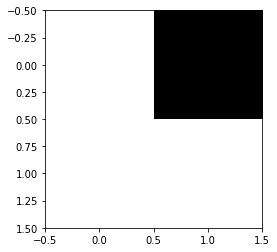

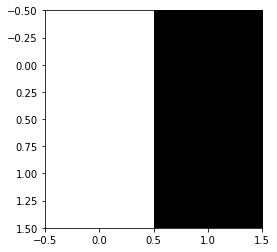

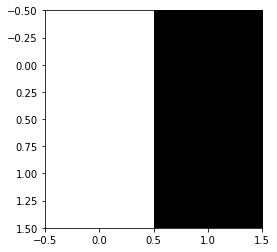

In [435]:
new_state = x.reset()
for i in range(3):
    action = y.trained_act(new_state)
    print(action)
    new_state, reward, done, _ = x.step(action)
    print(reward)
    x.render()

In [395]:
class DQN:
    def __init__(self, env):
        self.env     = env
        self.memory  = deque(maxlen=10000)
        
        self.gamma = 0.95
        self.epsilon = 1.0
        self.epsilon_min = 0.08
        self.epsilon_decay = 0.999
        self.learning_rate = 0.01
        self.tau = .08
        self.min_tau = .02
        self.tau_decay = .999

        self.model        = self.create_model()
        self.target_model = self.create_model()

    def create_model(self):
        model   = Sequential()
        state_shape  = self.env.return_state.shape
        #model.add(Flatten(input_shape=state_shape))
        #print()
        #model.add(Flatten())
        #(env.observation_space.shape+ (1,))
        #x = Reshape(self.env.return_state.shape+(1,))
        #model.add(x)
        """
        model.add(layers.Conv2D(32, (5, 5),padding="same",input_shape=(2,4,1), activation="relu"))
        model.add(layers.Conv2D(32, (5, 5),padding="same", activation="relu"))
        model.add(layers.MaxPooling2D(pool_size=(2, 2), strides=(1, 1), padding='same'))
        model.add(layers.Conv2D(32, (3, 3),padding="same", activation="relu"))
        model.add(layers.Conv2D(32, (3, 3),padding="same", activation="relu"))
        """
   
        #weak model
        model.add(Dense(24, input_shape=(3,6,1), activation="relu"))
        model.add(Dense(24, activation="relu"))
        model.add(Dense(48, activation="relu"))
        
        model.add(Dense(24, activation="relu"))
        model.add(Flatten())
        model.add(Dense(self.env.action_space.n))
        #model.compile(loss="mean_squared_error",
        #    optimizer=Adam(lr=self.learning_rate))
        model.compile(loss="mean_squared_error",
            optimizer=Adam(lr=self.learning_rate))
        print(model.summary())
        #print(model.input_shape)
        return model

    def act(self, state):
        self.epsilon *= self.epsilon_decay
        self.epsilon = max(self.epsilon_min, self.epsilon)
        if np.random.random() < self.epsilon:
            return self.env.action_space.sample()
        #print(state)
        #state = state.reshape(5, 10,1)
        predictions = self.model.predict(state.reshape(1,3, 6,1))[0]
        for i in range(len(predictions)):
            if not self.env.valid_move(i):
                predictions[i] -= 10
        print(predictions)
        predictions[-1] -=10
        return np.argmax(predictions)
    
    def trained_act(self, state):
        predictions = self.model.predict(state.reshape(1,3, 6,1))[0]
        for i in range(len(predictions)):
            if not self.env.valid_move(i):
                predictions[i] -= 10
        predictions[-1] -=10
        print(predictions)
        return np.argmax(predictions)

    def remember(self, state, action, reward, new_state, done):
        self.memory.append([state, action, reward, new_state, done])

    def replay(self):
        batch_size = 32
        if len(self.memory) < batch_size: 
            return

        samples = random.sample(self.memory, batch_size)
        for sample in samples:
            state, action, reward, new_state, done = sample
            #print("sample state is ", state, action)
            #state = state.reshape(5, 10,1)
            target = self.target_model.predict(state.reshape(1,3, 6,1))
            reward = reward/abs(reward) if not done else -.01
            if done:
                target[0][action] = reward
            else:
                #print('REPLAY', self.target_model.predict(new_state)[0])
                Q_future = max(self.target_model.predict(new_state.reshape(1,3, 6,1))[0])
                target[0][action] = reward + Q_future * self.gamma
            self.model.fit(state, target, epochs=1, verbose=0)

    def target_train(self):
        weights = self.model.get_weights()
        target_weights = self.target_model.get_weights()
        self.tau = max(self.min_tau, self.tau*self.tau_decay)
        for i in range(len(target_weights)):
            target_weights[i] = weights[i] * self.tau + target_weights[i] * (1 - self.tau)
        self.target_model.set_weights(target_weights)

    def save_model(self, fn):
        self.model.save(fn)
def main():
    env = PackEnv(board_shape=(3,3), input_shapes=[[[1]]]*5+[[[1,1],[1,1]]], replacement=False, max_moves=7)
    gamma   = 0.95
    epsilon = .99

    trials  = 20001
    trial_len = 50
    accuracies = []

    # updateTargetNetwork = 1000
    dqn_agent = DQN(env=env)
    steps = []
    for trial in range(trials):
        if (trial % 100) == 0 and trial !=0:
            total_accuracy = 0
            for i in range(30):
                accuracy = 0
                new_state = env.reset()
                for j in range(7):
                    action = dqn_agent.trained_act(new_state)
                    new_state, reward, done, _ = env.step(action)
                accuracy = np.sum(new_state[:,:3])/9
                print("sub accuracy is", accuracy)
                    
                total_accuracy += accuracy/30
            accuracies.append(total_accuracy)
            print("accuracy is ", total_accuracy)
        
        #cur_state = env.reset().reshape(5,10)
        cur_state = env.reset()
        #print("cur",cur_state)
        cur_state = cur_state.reshape(1,3,6,1)
        #print("updated, cur_state")
        for step in range(trial_len):
            #print("cur_state",cur_state)
            action = dqn_agent.act(cur_state)
            new_state, reward, done, _ = env.step(action)
            #print("info", new_state, reward, done)

            #reward = reward if not done else -20
            reward = reward/abs(reward) if not done else -.01
            #print("reward is", reward)
            new_state = new_state.reshape(1,3,6,1)
            dqn_agent.remember(cur_state, action, reward, new_state, done)
            
            dqn_agent.replay()       # internally iterates default (prediction) model
            dqn_agent.target_train() # iterates target model

            cur_state = new_state
            if done:
                break
        """
        if step >= 199:
            print("Failed to complete in trial {}".format(trial))
            if step % 10 == 0:
                dqn_agent.save_model("trial-{}.model".format(trial))
        else:
            print("Completed in {} trials".format(trial))
            dqn_agent.save_model("success.model")
            break
        """
        print("trial #{}".format(trial))
    return env, dqn_agent, accuracies

In [396]:
x,y,z = main()

Model: "sequential_43"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_199 (Dense)            (None, 3, 6, 24)          48        
_________________________________________________________________
dense_200 (Dense)            (None, 3, 6, 24)          600       
_________________________________________________________________
dense_201 (Dense)            (None, 3, 6, 48)          1200      
_________________________________________________________________
dense_202 (Dense)            (None, 3, 6, 24)          1176      
_________________________________________________________________
flatten_43 (Flatten)         (None, 432)               0         
_________________________________________________________________
dense_203 (Dense)            (None, 10)                4330      
Total params: 7,354
Trainable params: 7,354
Non-trainable params: 0
___________________________________________________

[ 1.1105897  -8.716687    0.98132396 -9.075636   -9.125702    0.73632973
 -9.196686   -9.624151    0.8112745  -0.11605249]
[-8.9272785  -8.822983    1.0075432  -9.020958   -9.048135    0.74492097
 -9.1871395  -9.57588     0.83243304 -0.09573735]
[-8.935495   -8.8322525  -9.021949   -9.040267   -9.084986    0.7417973
 -9.211703   -9.562185    0.80073816 -0.1108477 ]
trial #46
[ 1.1467339   1.2883072   0.96040124 -9.127485    0.9606651   0.73162097
  0.82285994  0.4121742   0.873805   -0.10350766]
[-8.825818   -8.735223   -9.0185585  -9.09895     0.9000416  -9.166865
 -9.189923   -9.596735   -9.127348   -0.10413796]
trial #47
[-8.870737    1.2074587  -9.001616   -9.018883    0.94414794 -9.22605
 -9.168915   -9.602661   -9.136591   -0.10120185]
[ 1.1046028  -8.722179   -8.977332   -9.0515375  -9.049039   -9.277071
  0.8428044   0.3828451   0.79587036 -0.04821371]
[-8.822972   -8.697585   -8.95644    -9.062745   -9.020693   -9.2279825
  0.8379043   0.38763058  0.8453417  -0.07649694]
trial

[-8.33319     1.6220781   1.3032705   1.3769143   1.3440747   1.0450752
  1.1392757  -9.362518    1.118081    0.11300405]
[-8.408684   -8.474848    1.2562593  -8.621025    1.3911597   0.93299377
  1.1573944  -9.299656    1.1839739   0.11404071]
trial #75
[1.5987953  1.5069045  1.3008225  1.37534    1.3636074  0.9526292
 1.2032766  0.6847365  1.1867512  0.13953935]
[-8.379621    1.5832019   1.2102703  -8.699476    1.3866827   0.9630197
  1.1131635   0.7329436   1.1317332   0.14640853]
[-8.3918     -8.411739    1.2396947  -8.724192    1.3719736   0.94777936
  1.1312529   0.67032814  1.2119235   0.16486347]
[-8.354988   -8.378566   -8.700008   -8.709279   -8.612926   -9.022353
 -8.857457   -9.368925   -8.808608    0.12129132]
[-8.313591   -8.467901   -8.648614   -8.653406   -8.634429   -8.996382
 -8.888144   -9.354258   -8.83909     0.16962664]
trial #76
[ 1.6406901   1.5932924  -8.735973   -8.669541    1.3297313   1.0854338
  1.1247135   0.68750507  1.2811099   0.16496193]
[-8.462685   -

[-8.224632  -8.219716  -8.604058   1.6459804  1.5244675 -8.845551
 -8.697343  -9.140957  -8.619875   0.2535164]
[-8.198733   -8.232906    1.4336264  -8.391123   -8.484167    1.0953504
 -8.708976   -9.111203    1.3865201   0.28163916]
[-8.232564   -8.22655    -8.602726   -8.445569   -8.403684    1.0738084
 -8.706831   -9.096661    1.3253378   0.26532665]
trial #96
[ 1.7605655   1.7623491  -8.654051    1.5924133   1.583776   -8.859239
 -8.667494   -9.145917   -8.691013    0.28607813]
[ 1.7605579  -8.287043   -8.529852    1.6035632  -8.365095   -8.885426
  1.3632946  -9.151228    1.4173869   0.30459392]
[-8.240242   -8.347585   -8.555923    1.5442115  -8.435445   -8.888933
  1.3796264  -9.108999    1.3805499   0.29151514]
[-8.276169  -8.2983265 -8.533499  -8.404462  -8.411295  -8.796512
  1.2961624 -9.07384    1.3406878  0.3241705]
trial #97
[1.7679565  1.6726849  1.405156   1.5725596  1.5697091  1.1490173
 1.3655508  0.86365795 1.3609064  0.29739657]
[-8.270022    1.7542294  -8.525887   

[-8.208178 -8.264967 -8.597916 -8.389215 -8.459021 -8.885773 -8.653166
 -9.160658 -8.569305 -9.664935]
sub accuracy is 0.5555555555555556
[ 1.791822   1.7350329  1.4020839  1.6107846  1.540979   1.1142268
  1.3468338  0.8393421  1.4306941 -9.664935 ]
[-8.208178   1.7350329 -8.597916   1.6107846  1.540979  -8.885773
 -8.653166  -9.160658  -8.569305  -9.664935 ]
[-8.208178  -8.264967  -8.597916   1.6107846 -8.459021  -8.885773
  1.3468338  0.8393421  1.4306941 -9.664935 ]
[-8.208178  -8.264967  -8.597916  -8.389215  -8.459021  -8.885773
  1.3468338  0.8393421  1.4306941 -9.664935 ]
[-8.208178  -8.264967  -8.597916  -8.389215  -8.459021  -8.885773
  1.3468338  0.8393421 -8.569305  -9.664935 ]
[-8.208178  -8.264967  -8.597916  -8.389215  -8.459021  -8.885773
 -8.653166   0.8393421 -8.569305  -9.664935 ]
hi
[ 1.791822   1.7350329  1.4020839  1.6107846  1.540979   1.1142268
  1.3468338  0.8393421  1.4306941 -9.664935 ]
It's over
sub accuracy is 1.0
[ 1.791822   1.7350329  1.4020839  1.610784

[-8.208178  -8.264967   1.4020839 -8.389215  -8.459021   1.1142268
  1.3468338  0.8393421  1.4306941 -9.664935 ]
[-8.208178 -8.264967 -8.597916 -8.389215 -8.459021 -8.885773 -8.653166
 -9.160658 -8.569305 -9.664935]
[-8.208178 -8.264967 -8.597916 -8.389215 -8.459021 -8.885773 -8.653166
 -9.160658 -8.569305 -9.664935]
sub accuracy is 0.5555555555555556
[ 1.791822   1.7350329  1.4020839  1.6107846  1.540979   1.1142268
  1.3468338  0.8393421  1.4306941 -9.664935 ]
[-8.208178   1.7350329 -8.597916   1.6107846  1.540979  -8.885773
 -8.653166  -9.160658  -8.569305  -9.664935 ]
[-8.208178  -8.264967  -8.597916   1.6107846 -8.459021  -8.885773
  1.3468338  0.8393421  1.4306941 -9.664935 ]
[-8.208178  -8.264967  -8.597916  -8.389215  -8.459021  -8.885773
  1.3468338  0.8393421  1.4306941 -9.664935 ]
[-8.208178  -8.264967  -8.597916  -8.389215  -8.459021  -8.885773
  1.3468338  0.8393421 -8.569305  -9.664935 ]
[-8.208178  -8.264967  -8.597916  -8.389215  -8.459021  -8.885773
 -8.653166   0.8393

[-8.243629   -8.191633   -8.586617   -8.337358    1.6358802  -8.856736
 -8.636333   -9.120475   -8.631981    0.32022625]
[-8.251561   -8.196081    1.4931494  -8.276123   -8.367257   -8.847605
  1.3658378  -9.105276   -8.6375475   0.36391425]
[-8.235746  -8.237488  -8.519459  -8.328482  -8.328589  -8.866505
  1.347986  -9.051525  -8.591163   0.3564034]
trial #103
[1.719125   1.7224021  1.5123926  1.647485   1.6385859  1.1592697
 1.3491668  0.8945855  1.448436   0.36940283]
[-8.219226   -8.213482   -8.538031    1.6840037   1.6217506  -8.853046
 -8.5939245  -9.023303   -8.608229    0.31588137]
trial #104
[ 1.9220712   1.7508388  -8.488308    1.6837089   1.616707   -8.877695
 -8.5966425  -9.11814    -8.607643    0.31158733]
[-8.154314   -8.296129    1.5217347  -8.347017   -8.376135   -8.810334
  1.3218194   0.9122141   1.4385794   0.31746012]
[-8.136394  -8.245963  -8.494102  -8.346376  -8.40294   -8.834773
  1.2902336  0.921723   1.3918599  0.3806081]
[-8.129236   -8.276063   -8.486799   

[-8.20727   -8.141422  -8.457559  -8.131513  -8.334679  -8.714767
 -8.608752  -9.04202   -8.4647665  0.495878 ]
trial #121
[1.8338809  1.8475338  1.5632848  1.9223351  1.7167157  1.2619205
 1.4439815  1.018646   1.4686469  0.40778768]
[ 1.8875496   1.9072939   1.5732722  -8.114143    1.8045598  -8.72612
  1.4471408   1.0639077   1.5069135   0.42960334]
[-8.099616  -8.106281  -8.461745  -8.246461  -8.285986  -8.790944
 -8.574126  -8.933968  -8.413464   0.4645664]
[-8.133767   -8.089116   -8.451027   -8.173472   -8.233502   -8.820244
 -8.567991   -8.980026   -8.513369    0.42790732]
[-8.064562  -8.085051  -8.430646  -8.091949  -8.236804  -8.708469
 -8.534031  -9.011749  -8.519441   0.4375864]
trial #122
[ 1.9058453   1.9486064   1.5915773  -8.090202    1.6775025   1.2697703
  1.4282026   0.9908368   1.4285027   0.42883745]
[-8.066653   -8.109268   -8.404267   -8.1276865   1.7311666  -8.748338
 -8.554283   -8.9645405  -8.554183    0.46353114]
[ 1.9450138  -8.17011     1.6029307  -8.134114

trial #137
[1.8919193 1.9125255 1.6471862 2.0086355 1.8273721 1.230483  1.4526422
 1.0373787 1.5989786 0.5029123]
[-8.108271  -8.039855  -8.345608  -8.104208  -8.155096  -8.744929
 -8.566319  -8.959786  -8.402159   0.5406536]
[-8.070284   -8.010877   -8.356155   -7.9788637  -8.21324    -8.744192
 -8.566523   -8.933174   -8.357167    0.51467574]
[-8.029768  -8.0493555 -8.396673  -8.002476  -8.1784935 -8.725931
 -8.571707  -8.897728  -8.375174   0.4874166]
trial #138
[ 2.015193   -8.0047455   1.6603681   1.9297887   1.8467315   1.2991805
  1.4821569   1.1721706   1.6142975   0.49755228]
[-8.051493   -8.055937    1.6513448   1.9385803   1.8350801   1.2724138
  1.512314    1.0843153   1.557179    0.50881463]
[-8.02286   -8.013284  -8.322411  -8.037358  -8.197191  -8.755558
 -8.519173  -8.930257  -8.390972   0.5417185]
trial #139
[1.9902931  2.0192297  1.7497418  1.9478304  1.7709795  1.3504676
 1.509738   1.0915955  1.5475724  0.52781934]
[-8.056202   -7.950201   -8.412631   -7.9916863  -8

trial #153
[2.0729337  2.0746024  1.7399337  2.0990195  1.8598181  1.3901182
 1.4978092  1.1367221  1.6838479  0.50290453]
[ 2.0790033   2.0753229   1.7783481  -7.8608017   1.816347    1.4225535
  1.4160742   1.1635873   1.7102923   0.56032354]
[-7.9311824  2.0622447  1.7587528 -7.942588   1.8251585  1.3844697
  1.4553188  1.2240174  1.6951772  0.5294909]
[-7.958272  -7.951001   1.812659  -7.9338055  1.9025578  1.356096
  1.5086284  1.1326962  1.6659999  0.5072052]
[-7.9746213  -7.8706675  -8.231182   -7.8904347  -8.136928   -8.635561
 -8.475123   -8.8196945  -8.298534    0.59988946]
[-8.005171   -7.915676   -8.329655   -7.8850856  -8.130952   -8.71001
 -8.446812   -8.870088   -8.370926    0.54941136]
[-8.028874  -7.9915524 -8.329887  -7.971264  -8.131749  -8.684366
 -8.531689  -8.90783   -8.344788   0.5560341]
trial #154
[ 1.9952967  1.9724184 -8.324645   2.0081918  1.8252431 -8.657305
 -8.583697  -8.86773   -8.313081   0.5914024]
[ 1.9363229  1.9102298  1.718316  -7.9510703 -8.126737

[-7.8822236  -7.859395   -8.223541   -7.9303613  -8.030071   -8.536325
  1.5854925   1.1726085  -8.235828    0.61259294]
[-7.9403324  -7.947134   -8.259206   -7.890041   -8.03239    -8.536383
 -8.430734    1.1786308  -8.273757    0.56585646]
trial #169
[2.1766074 2.0049076 1.7568052 2.133922  1.965571  1.4724555 1.5865995
 1.1703489 1.7236872 0.6026001]
[-7.862228  -7.9761343  1.7972455  2.1582222  1.9105012  1.4706872
  1.5939568  1.1654323  1.8424976  0.5741913]
[-7.9167533 -8.057483   1.7994707 -7.863429   1.9074838  1.4445376
  1.5538696  1.1356874  1.788421   0.6158834]
[-7.9417887  -7.930612   -8.209755   -7.8690267  -8.0629635  -8.579258
 -8.393084   -8.83707    -8.228876    0.58448756]
[-7.875143   -7.8658566  -8.145995   -7.8914876  -7.993636   -8.587714
 -8.431948   -8.787006   -8.273927    0.61496407]
trial #170
[ 2.0994825  2.109211  -8.12906    2.1731381  1.9465262 -8.576594
 -8.409838  -8.769322  -8.253978   0.6232454]
[ 2.0837786   2.147038    1.8646842  -7.855295   -8.0

[ 2.1969862 -7.9233913  1.848017  -7.747795   1.9879576  1.4718852
  1.6938875  1.2094254  1.7654393  0.706323 ]
[-7.777108  -7.9205356 -8.097929  -7.737195   1.9728657 -8.569166
 -8.314489  -8.780624  -8.259843   0.6019711]
[-7.7907224 -7.830898   1.8549001 -7.7202425 -7.985939  -8.478194
  1.6485542 -8.79042   -8.208333   0.6933073]
[-7.779332  -7.828082  -8.117987  -7.771407  -7.9462643 -8.498869
  1.6389558 -8.747921  -8.170907   0.6421219]
hi
trial #184
[ 2.221542   2.095239   1.9550796  2.2499523  2.0002046  1.4395107
 -8.351313   1.1561238  1.7197309  0.6623389]
[ 2.169009   2.1433666  1.866321  -7.7110567  2.0376475  1.4957055
 -8.422403   1.1900061  1.760624   0.6272134]
[-7.8008804   2.1919796  -8.108231   -7.8138266   2.0507898  -8.54153
 -8.407015   -8.723918   -8.220365    0.63202524]
[-7.8099365  -7.8237047  -8.140034   -7.7904377  -7.898247   -8.558528
 -8.41952     1.1675928   1.770489    0.64786655]
[-7.775017  -7.8557158 -8.154646  -7.7875643 -7.938365  -8.538575
 -8.

[-7.7212925  -7.7803097  -8.066736   -7.852584   -7.9717665   1.5409179
  1.6694831   1.2364116  -8.13245     0.65567696]
[-7.682193  -7.762769  -8.041212  -7.752501  -8.063248   1.4399025
 -8.351924   1.2549148 -8.116657   0.6621946]
trial #197
[ 2.2969007   2.178098   -8.054747    2.236374    2.062401    1.4714836
  1.6518278   1.2158417   1.8771865   0.68165076]
[-7.7403946   2.2115557  -8.018828    2.272271    2.0736666   1.5004406
  1.6756554   1.2444546   1.9008234   0.65589875]
[-7.708207   -7.8023405  -8.078959   -7.739506    2.0332065  -8.512025
 -8.370508   -8.668486   -8.112293    0.67764336]
[-7.670127    2.2028177  -8.087921   -7.780074   -7.8956566  -8.497884
 -8.313457   -8.688389   -8.09747     0.69745547]
hi
trial #198
[2.2808201 2.2513843 1.8896897 2.255259  2.126574  1.5421154 1.7435693
 1.2944171 1.9455605 0.6532539]
[-7.7229185  2.3104846 -8.078845   2.301209   2.1160402 -8.458612
 -8.238011  -8.804195  -8.08152    0.6260047]
[-7.6906037  -7.789684   -8.0820675   2

  1.6593635  1.2361388  1.8066368 -9.313947 ]
[ 2.206428  -7.776681   1.9746444 -7.706132   2.0455625  1.4438035
  1.6593635  1.2361388  1.8066368 -9.313947 ]
[-7.793572  -7.776681  -8.025355  -7.706132   2.0455625 -8.556196
 -8.340636  -8.763861  -8.193363  -9.313947 ]
[-7.793572  -7.776681   1.9746444 -7.706132  -7.9544373 -8.556196
  1.6593635 -8.763861  -8.193363  -9.313947 ]
[-7.793572  -7.776681  -8.025355  -7.706132  -7.9544373 -8.556196
  1.6593635 -8.763861  -8.193363  -9.313947 ]
hi
[ 2.206428   2.2233193  1.9746444  2.2938683  2.0455625  1.4438035
  1.6593635  1.2361388  1.8066368 -9.313947 ]
It's over
sub accuracy is 1.0
[ 2.206428   2.2233193  1.9746444  2.2938683  2.0455625  1.4438035
  1.6593635  1.2361388  1.8066368 -9.313947 ]
[ 2.206428   2.2233193  1.9746444 -7.706132   2.0455625  1.4438035
  1.6593635  1.2361388  1.8066368 -9.313947 ]
[ 2.206428  -7.776681   1.9746444 -7.706132   2.0455625  1.4438035
  1.6593635  1.2361388  1.8066368 -9.313947 ]
[-7.793572  -7.77668

[-7.793572  -7.776681   1.9746444 -7.706132  -7.9544373 -8.556196
  1.6593635 -8.763861  -8.193363  -9.313947 ]
[-7.793572  -7.776681  -8.025355  -7.706132  -7.9544373 -8.556196
  1.6593635 -8.763861  -8.193363  -9.313947 ]
hi
[ 2.206428   2.2233193  1.9746444  2.2938683  2.0455625  1.4438035
  1.6593635  1.2361388  1.8066368 -9.313947 ]
It's over
sub accuracy is 1.0
[ 2.206428   2.2233193 -8.025355   2.2938683  2.0455625 -8.556196
 -8.340636  -8.763861  -8.193363  -9.313947 ]
[ 2.206428   2.2233193  1.9746444 -7.706132  -7.9544373  1.4438035
 -8.340636  -8.763861   1.8066368 -9.313947 ]
[ 2.206428  -7.776681   1.9746444 -7.706132  -7.9544373  1.4438035
 -8.340636  -8.763861   1.8066368 -9.313947 ]
[-7.793572  -7.776681   1.9746444 -7.706132  -7.9544373  1.4438035
 -8.340636  -8.763861   1.8066368 -9.313947 ]
[-7.793572  -7.776681  -8.025355  -7.706132  -7.9544373  1.4438035
 -8.340636  -8.763861   1.8066368 -9.313947 ]
[-7.793572  -7.776681  -8.025355  -7.706132  -7.9544373  1.4438035

[-7.660327   2.215394   2.0211794  2.3331475  2.0587623  1.5141959
  1.6126992  1.2938516  1.8908955  0.7600149]
[-7.777205    2.2195113   1.9443606  -7.708686    1.9787852   1.5103209
  1.6843647   1.300572    1.845129    0.66345173]
[-7.7427588 -7.7883267 -8.035248  -7.705715   2.0117872 -8.467194
 -8.402388  -8.711104  -8.175864   0.7140763]
[-7.7597675  -7.8252134   1.9667054  -7.7725415  -7.9100146  -8.449662
  1.60281    -8.717331   -8.140644    0.67195827]
[-7.6844435 -7.7985373 -8.009538  -7.776827  -7.9685583 -8.410436
  1.6210229 -8.699271  -8.137927   0.684366 ]
trial #205
[ 2.3107064   2.265615   -8.080171    2.2707357   2.037068   -8.422944
 -8.336722   -8.681192   -8.055412    0.70915383]
[-7.7227364 -7.828864   1.889664  -7.7176924 -7.892164   1.5445391
  1.6976519  1.2954936  1.9317075  0.65285  ]
[-7.6629305 -7.745576   1.9897544 -7.751387  -7.9228673 -8.402437
  1.6385878  1.3216634 -8.101046   0.688833 ]
[-7.675148  -7.778542  -8.030499  -7.7293463 -7.9640675 -8.3812

trial #218
[2.3550844  2.3418524  2.0100172  2.310451   2.0691726  1.5253774
 1.691012   1.3213791  1.9198811  0.72471064]
[-7.701223   2.3465247  1.9934971  2.2420456  2.0872715  1.5368738
  1.6927863  1.2756011 -7.9881077  0.747951 ]
[-7.6709013 -7.6767287 -7.9769077  2.3207154 -7.8625517 -8.484111
 -8.305308  -8.6795025 -8.046693   0.7083544]
[-7.676277  -7.6872263  2.0682952 -7.700237  -7.8973093  1.5833226
 -8.212025  -8.731223  -8.069889   0.7042937]
[-7.670331  -7.654488  -7.9523325 -7.756762  -7.958664   1.5589799
 -8.294067  -8.74985   -8.085396   0.7236777]
hi
trial #219
[-7.641629   2.3048563  2.016114   2.274167   2.0962284  1.6350121
  1.7183923  1.2839612  1.9874357  0.7173772]
[-7.694366   -7.658868    2.0118933   2.2434125   2.1370933   1.5828774
  1.7387493   1.263821    2.0005813   0.75920904]
[-7.598398  -7.685923  -7.998842  -7.6763716  2.092668  -8.454124
 -8.238556  -8.71895   -8.038735   0.75473  ]
[-7.6823897  -7.760356    1.9480225  -7.664899   -7.9226637  -8.4

[-7.6118145  2.3427262  2.100828  -7.576389  -7.916987   1.5361848
 -8.298003  -8.713169   1.9703798  0.7115384]
[-7.607195   -7.6820517   1.9767666  -7.5721116  -7.858816    1.5289952
 -8.238425   -8.706999    1.9620836   0.75675243]
[-7.5948977 -7.659005  -8.041264  -7.613613  -7.8954935  1.5079739
 -8.29986   -8.712217   1.9690648  0.7762364]
[-7.5611086 -7.6675167 -7.972702  -7.60845   -7.861152   1.554058
 -8.291327  -8.7109995 -8.011759   0.7472086]
hi
trial #232
[2.471507  2.3320467 2.0826323 2.4035459 2.122533  1.6165634 1.6774828
 1.2616563 2.0203977 0.7757226]
[-7.5695314  2.2994208  2.1727095  2.4376597  2.1468496  1.5833486
  1.7017934  1.3385706  2.0152938  0.7751526]
[-7.5478296  2.329025   2.1166098 -7.6794043  2.1083183  1.5747303
  1.6958249  1.3035204  2.09701    0.7484606]
[-7.6225767 -7.7444677  2.1523585 -7.7531796  2.1065834  1.5730954
  1.7357825  1.2596612  2.0380142  0.7650327]
[-7.61106   -7.714285  -7.8065076 -7.617112   2.1195583 -8.449027
 -8.275638  -8.610

[-7.654145   -7.687345   -7.849248   -7.5667524  -7.8673935  -8.39764
 -8.310813   -8.589044   -7.9345055   0.76686394]
[-7.687626  -7.6121902 -7.8966737 -7.546782  -7.8673277 -8.344907
 -8.378638  -8.6458025 -7.9503527  0.8091817]
[-7.6267376 -7.7289953 -7.8159094 -7.536974  -7.845998  -8.371685
 -8.310432  -8.683527  -7.902066   0.7585095]
trial #245
[2.4583466 2.26639   2.1126523 2.4130337 2.200161  1.5636226 1.7294805
 1.3355931 2.1533778 0.7695236]
[-7.5199575   2.3425066   2.111577    2.3852353   2.143412    1.5572448
  1.753917    1.3847971   2.1308615   0.74726397]
[-7.4879465   2.4138377   2.1502542  -7.5999966   2.219675    1.604583
  1.75521     1.3731184   2.1121821   0.76321954]
[-7.5341067  -7.6077447   2.1482024  -7.571386    2.210912    1.6092546
  1.8174052   1.3259994   2.0734174   0.78638154]
[-7.5399623  -7.6284604   2.1172767  -7.6177464  -7.8666744   1.6320262
  1.7747109   1.3137311   2.1303036   0.83038145]
[-7.4715996 -7.6343207 -7.7865505 -7.6108527 -7.835462 

[-7.5901194 -7.62086   -7.791892  -7.5075626  2.2535326 -8.363635
 -8.254318  -8.59605   -7.812038   0.8053317]
[-7.5241766 -7.5881233  2.2707107 -7.4723597 -7.776793  -8.404824
  1.7128669 -8.639724  -7.840935   0.8275638]
[-7.486308  -7.538245  -7.744927  -7.5210047 -7.748624  -8.361002
  1.749815  -8.639387  -7.8309937  0.8214471]
trial #257
[2.5219269  2.4469867  2.1623158  2.520518   2.1732426  1.6495433
 1.7450227  1.3574708  2.1498194  0.79403996]
[-7.499568   2.4414299 -7.8380756  2.5324826  2.1792889 -8.390129
 -8.284898  -8.6441965 -7.810557   0.7545261]
[-7.4201174   2.4840121   2.1882045  -7.42587    -7.7587194   1.6200771
 -8.2258415  -8.691799   -7.819061    0.81349176]
[-7.4660482 -7.510929   2.223594  -7.4466896 -7.749901   1.5789623
 -8.265427  -8.679271  -7.82506    0.7909741]
[-7.564688   -7.5649214  -7.789608   -7.4924583  -7.8352118   1.6701303
 -8.21996    -8.630147   -7.8012733   0.78475195]
hi
trial #258
[ 2.5302126   2.4819698   2.1818998  -7.4940147  -7.794969

[ 2.502933   -7.471351    2.330936   -7.4363356  -7.69569    -8.360098
 -8.266643   -8.650613   -7.7508793   0.81707424]
[-7.4634705 -7.462045   2.2963524 -7.4321594 -7.680525  -8.325012
 -8.209302  -8.683729  -7.7804317  0.8498727]
trial #269
[2.5275779  2.5951674  2.2974336  2.546952   2.2907856  1.6464189
 1.755421   1.4472828  2.1720033  0.84993464]
[ 2.5268126  -7.44305     2.279388    2.5663517   2.2382662   1.6346132
  1.7239306   1.3478914   2.2393038   0.84059095]
[ 2.5366244 -7.435985   2.2766128 -7.4067936  2.2386518  1.6763445
  1.7303473  1.3301976  2.2277431  0.8155237]
[-7.3834925  -7.4269466   2.2872694  -7.426738    2.2455795   1.6704013
  1.7326468   1.326055    2.2721245   0.86154187]
[-7.426222  -7.402874  -7.704052  -7.462772   2.3377044  1.6460531
  1.7181422  1.2806579  2.2545087  0.8189575]
[-7.4437304 -7.417865  -7.6679935 -7.443329  -7.6935053 -8.345815
 -8.292717  -8.7154665 -7.785138   0.8274897]
trial #270
[2.4980383 2.569481  2.2682278 2.55202   2.2539084 

[ 2.6426687 -7.397997  -7.6557813  2.583089  -7.5200214 -8.295005
  1.884498   1.3640131  2.2353742  0.8601316]
[-7.3881965 -7.5393353 -7.7001715  2.6275766 -7.546214  -8.292098
  1.8933613  1.4460497  2.2226238  0.8480339]
[-7.4413266 -7.4424953 -7.6894646 -7.3599906 -7.640358  -8.272377
  1.8312821  1.3460443  2.2643692  0.846262 ]
[-7.499571  -7.4253597 -7.7190914 -7.3955345 -7.70841   -8.224841
  1.8595666  1.365435  -7.731084   0.839045 ]
trial #282
[ 2.579555    2.478779   -7.7161913   2.649439    2.4397137  -8.302608
 -8.125942   -8.6543665  -7.699069    0.82639235]
[ 2.5890114  2.4646683  2.2757905 -7.437206  -7.5443087  1.659398
 -8.216376  -8.582814   2.2746928  0.8689086]
[-7.373495   2.5012946  2.2639456 -7.4150777 -7.5708513  1.637446
 -8.225854  -8.644356   2.3640423  0.8794948]
[-7.362239   -7.45535     2.2940361  -7.4707413  -7.642445    1.6811877
 -8.166029   -8.671739    2.2761023   0.83375704]
[-7.417899   -7.4270096  -7.653174   -7.417533   -7.6257963   1.6587734
 -

trial #294
[2.5556722 2.635554  2.4802852 2.591033  2.4400196 1.7246574 1.90578
 1.3853781 2.3256645 0.8646746]
[-7.3889    -7.3355613 -7.5692234  2.6117878  2.422796  -8.271598
 -8.070473  -8.629118  -7.6961517  0.8905349]
[ 2.5986743  -7.349881    2.4020956  -7.392771   -7.566617    1.7323024
 -8.095935   -8.595       2.2928138   0.88614726]
[-7.4046116 -7.3476887  2.434745  -7.3769073 -7.5382423  1.7145269
 -8.113123  -8.632606   2.305314   0.8431714]
[-7.3910117  -7.3357253  -7.6028805  -7.3975983  -7.6160784   1.7328227
 -8.123071   -8.5908      2.332331    0.86377454]
[-7.353215   -7.3310366  -7.6097994  -7.4431543  -7.6137133   1.7441573
 -8.150796   -8.602291   -7.6206336   0.89033735]
hi
trial #295
[2.6587734 2.6263523 2.4074945 2.6071012 2.413737  1.7485733 1.8564675
 1.3797885 2.3754761 0.8596526]
[-7.401554   -7.3871927  -7.534946    2.6726067   2.4522548  -8.237113
 -8.167379   -8.623443   -7.681242    0.93868685]
[-7.363063   2.6735296 -7.620618  -7.296029  -7.6871095  1.

[-7.29342   -7.30336    2.394469   2.6890876  2.5187387  1.7849175
  1.8215694  1.3487232  2.3585794 -9.096132 ]
[-7.29342   -7.30336    2.394469  -7.310912   2.5187387  1.7849175
  1.8215694  1.3487232  2.3585794 -9.096132 ]
[-7.29342   -7.30336   -7.6055307 -7.310912  -7.4812613 -8.215082
 -8.178431  -8.651277  -7.6414204 -9.096132 ]
[-7.29342   -7.30336   -7.6055307 -7.310912  -7.4812613 -8.215082
 -8.178431  -8.651277  -7.6414204 -9.096132 ]
[-7.29342   -7.30336   -7.6055307 -7.310912  -7.4812613 -8.215082
 -8.178431  -8.651277  -7.6414204 -9.096132 ]
sub accuracy is 0.4444444444444444
[ 2.7065804  2.6966398 -7.6055307  2.6890876  2.5187387 -8.215082
 -8.178431  -8.651277  -7.6414204 -9.096132 ]
[-7.29342   -7.30336    2.394469  -7.310912  -7.4812613  1.7849175
  1.8215694  1.3487232  2.3585794 -9.096132 ]
[-7.29342   -7.30336   -7.6055307 -7.310912  -7.4812613  1.7849175
  1.8215694  1.3487232  2.3585794 -9.096132 ]
[-7.29342   -7.30336   -7.6055307 -7.310912  -7.4812613  1.784917

[-7.29342   -7.30336   -7.6055307 -7.310912  -7.4812613 -8.215082
 -8.178431   1.3487232 -7.6414204 -9.096132 ]
hi
[ 2.7065804  2.6966398  2.394469   2.6890876  2.5187387  1.7849175
  1.8215694  1.3487232  2.3585794 -9.096132 ]
It's over
sub accuracy is 1.0
[ 2.7065804  2.6966398  2.394469   2.6890876  2.5187387  1.7849175
  1.8215694  1.3487232  2.3585794 -9.096132 ]
[-7.29342    2.6966398  2.394469   2.6890876  2.5187387  1.7849175
  1.8215694  1.3487232  2.3585794 -9.096132 ]
[-7.29342   -7.30336    2.394469   2.6890876  2.5187387  1.7849175
  1.8215694  1.3487232  2.3585794 -9.096132 ]
[-7.29342   -7.30336    2.394469  -7.310912   2.5187387  1.7849175
  1.8215694  1.3487232  2.3585794 -9.096132 ]
[-7.29342   -7.30336   -7.6055307 -7.310912  -7.4812613 -8.215082
 -8.178431  -8.651277  -7.6414204 -9.096132 ]
[-7.29342   -7.30336   -7.6055307 -7.310912  -7.4812613 -8.215082
 -8.178431  -8.651277  -7.6414204 -9.096132 ]
[-7.29342   -7.30336   -7.6055307 -7.310912  -7.4812613 -8.215082


[-7.2907524   2.653691    2.468883   -7.3149242   2.4534929   1.7301184
  1.8432077   1.3700873   2.4206207   0.89330256]
[-7.278989   -7.4177794  -7.51793    -7.264109    2.3903966  -8.173871
 -8.163131   -8.7355175  -7.5583153   0.88495535]
[-7.2704377  -7.391611    2.4421418  -7.2640276  -7.597987   -8.178424
  1.8373007  -8.714101   -7.5166698   0.89586335]
[-7.2850456  -7.4318466  -7.5216713  -7.344249   -7.606612   -8.281391
  1.8942517  -8.617329   -7.531265    0.88348407]
hi
trial #303
[2.7048802  2.5815504  2.423666   2.6263974  2.4002323  1.6534107
 1.8926626  1.4118369  2.4921513  0.91012543]
[-7.282092   2.5594258 -7.6013536  2.6820931  2.4446187 -8.38722
 -8.1476    -8.627924  -7.53214    0.8829123]
[-7.304965   2.5663528  2.44664   -7.2984114 -7.6056404  1.7135819
 -8.088397  -8.636375   2.4387481  0.917492 ]
[-7.37759    -7.419688    2.4916935  -7.3312206  -7.5476627   1.7753391
 -8.068389   -8.688599    2.4288528   0.88506407]
[-7.4297805 -7.3613915 -7.5328608 -7.348963

trial #314
[2.7898395  2.673567   2.57279    2.7602167  2.4626338  1.7272724
 1.9076056  1.3342513  2.460701   0.95199525]
[-7.161255    2.736629    2.5578847   2.777779    2.4462237   1.6726006
  1.8807917   1.3556584   2.3551795   0.90890974]
[-7.1985893  2.7613583 -7.4361506 -7.178871   2.4614651 -8.334555
 -8.131808  -8.667448  -7.6056013  0.9380835]
[-7.2071185  -7.2149434  -7.5119753  -7.213561   -7.5454764  -8.259554
  1.8655142   1.3950495   2.361626    0.97376996]
[-7.1879997  -7.1835346  -7.5216274  -7.2373376  -7.5555067  -8.262305
  1.8568032   1.3901571  -7.638317    0.91647446]
[-7.2032623  -7.240632   -7.4907765  -7.219782   -7.5903516  -8.239556
 -8.15555     1.3732914  -7.5935593   0.93364394]
hi
trial #315
[2.7960362  2.7071748  2.5458484  2.7503097  2.4467297  1.7431729
 1.8223761  1.3643783  2.395869   0.89807826]
[-7.324012   2.6881702  2.4896019  2.7571144  2.4866679  1.7284898
  1.8271034  1.3081168  2.4187667  0.9180959]
[-7.270307    2.6440132   2.5053327  -7.2

[-7.270518  -7.286981  -7.433255  -7.1288953 -7.418002  -8.292858
 -8.130514  -8.5833235 -7.5145407  0.9667434]
[-7.2575855 -7.2777824 -7.428702  -7.177908  -7.405294  -8.28344
 -8.153711  -8.5793    -7.583086   0.9467028]
trial #326
[2.7599394 2.7473094 2.5086865 2.8294954 2.571616  1.7320722 1.8454239
 1.3572949 2.4486406 0.9706493]
[ 2.7491872  2.6702764  2.5814245 -7.204671   2.5425882  1.7331035
  1.8760986  1.2694417  2.3843598  0.9569374]
[-7.2572536  2.662005   2.5963926 -7.1994524  2.4385355  1.8022449
  1.9075136  1.3329581  2.416886   0.9666932]
[-7.252016  -7.2898607  2.6025562 -7.2539225  2.501126   1.6957147
  1.8865126 -8.62255    2.4626248  0.9907875]
[-7.228853  -7.247804  -7.40275   -7.334396  -7.4650893 -8.352236
 -8.183489  -8.694372  -7.56417    0.9403232]
[-7.214752  -7.1935806 -7.4149637 -7.324765  -7.461859  -8.265408
 -8.158793  -8.669156  -7.5277195  0.9639418]
trial #327
[2.6973836 2.8121297 2.6008465 2.7598448 2.5551455 1.7221642 1.8613579
 1.3367078 2.50975

[-7.125915  -7.2437563 -7.3384457 -7.089824  -7.4156866  1.7845762
 -8.109554  -8.6725855  2.5054038  1.0089765]
[-7.14095    -7.256056   -7.33875    -7.165843   -7.393522    1.7442822
 -8.127491   -8.638334   -7.5821266   0.97918016]
hi
trial #339
[2.8315058 2.7945783 2.6368346 2.7850795 2.6091626 1.7426702 1.8492327
 1.3223579 2.4223099 1.0016049]
[-7.239432    2.8380175   2.6742835   2.8557143   2.6015627   1.6988842
  1.8894951   1.3480154   2.4592266   0.99355024]
[-7.26451     2.8786466  -7.4034843  -7.1848106   2.6035175  -8.2695465
 -8.150259   -8.675856   -7.4753265   0.97188205]
[-7.228337   -7.1453757  -7.3546386  -7.1659613  -7.3903403  -8.256093
  1.886475    1.3486409   2.5868585   0.99489456]
[-7.22295    -7.150001   -7.381099   -7.1757812  -7.452365   -8.206684
  1.8350635   1.3471563  -7.4183583   0.98173594]
[-7.251443  -7.2254314 -7.4952974 -7.2694554 -7.357996  -8.254699
 -8.053827   1.3930902 -7.377136   1.0414608]
trial #340
[2.7522707 2.7846403 2.564993  2.682580

[-7.189358  -7.119978  -7.4156985 -7.082242  -7.3156643 -8.177595
 -7.9930835 -8.609968  -7.3563814  1.0517325]
[-7.165712  -7.175846  -7.340909  -7.049417  -7.3347483 -8.22361
 -8.023553  -8.609746  -7.4095154  1.0518737]
trial #351
[2.8610117 2.842927  2.6996443 2.8683012 2.6647615 1.7317009 2.0134742
 1.457811  2.5928006 1.0180897]
[-7.143325   2.891064  -7.309485  -7.1102233  2.599252  -8.227446
 -8.089751  -8.61946   -7.389839   1.0203488]
[ 2.8589332 -7.067687  -7.3969812 -7.101654  -7.374287  -8.263655
  1.9737293  1.3111324  2.5967407  1.045761 ]
[-7.180337   -7.1055737  -7.4146233  -7.054178   -7.4315386  -8.280382
  1.9810822   1.3398316   2.644158    0.99717444]
[-7.253106  -7.132408  -7.351873  -7.0431566 -7.3476963 -8.274516
  1.9535671  1.3489113 -7.35262    1.0860423]
[-7.2173424 -7.193488  -7.3212886 -7.059014  -7.382057  -8.264759
 -8.067281   1.385166  -7.3418007  1.0390642]
trial #352
[2.8278277 2.780235  2.6504679 2.9233932 2.5975058 1.6969103 2.0013895
 1.3799527 2

[-7.1834726 -7.129428  -7.183109  -7.0252194 -7.345414   1.700376
 -7.9956226 -8.617882  -7.3221526  1.069213 ]
hi
trial #363
[2.8013425 2.9000347 2.7815742 2.9455879 2.6816247 1.7366817 1.9500278
 1.3303062 2.6272104 1.0906398]
[-7.139981   2.9630332 -7.1708145 -7.0487843  2.6417985 -8.251712
 -7.9415064 -8.647994  -7.3798428  1.0259358]
[ 2.9079123 -7.079693  -7.218546  -7.025088  -7.3918004 -8.220056
  1.9900756  1.3724333  2.6915362  1.0624762]
[-7.0603824 -7.14445   -7.1895123 -6.9754896 -7.3220673 -8.257954
  1.9626024  1.366282   2.7066455  1.0919292]
[-7.1826525 -7.088566  -7.2599335 -7.004857  -7.2063913 -8.195211
  2.0029268 -8.540324  -7.3659544  1.0625522]
hi
trial #364
[2.862703  2.9378815 2.7394128 2.96456   2.7831433 1.7686626 1.9467834
 1.5247626 2.6809456 1.0415696]
[ 2.8593063  2.9682941  2.6840348 -7.0303555  2.7871497  1.7930143
  1.8947927  1.4560442  2.6759398  1.0350827]
[ 2.833151  -7.077739   2.6687698 -6.9982414  2.6859465  1.8394026
  1.9973239  1.429525   2.

[-7.1221566  2.9659355  2.8701086 -7.0506144 -7.416608   1.7440706
 -7.992149  -8.656639   2.6972382  1.0794297]
[-7.055102  -7.0263805  2.8973985 -7.0804434 -7.261038   1.7639107
 -8.007914  -8.600517   2.6298506  1.0588423]
[-7.0255394 -7.052907  -7.0547857 -7.037957  -7.2858753  1.7589399
 -8.022976  -8.549344   2.7084708  1.0827689]
[-7.0296874 -6.97975   -7.095108  -7.00095   -7.253731   1.7916129
 -7.9786234 -8.619733  -7.2356567  1.0723469]
hi
trial #376
[2.8493638 3.0160828 2.868978  2.984587  2.7012634 1.7834766 1.9939134
 1.4127885 2.7171273 1.0767093]
[-7.1724577 -7.043806  -7.136657   2.9314847  2.760669  -8.201679
 -8.077219  -8.577969  -7.298252   1.079026 ]
[ 2.8541782 -7.0905156  2.8386388 -7.1024103 -7.207987   1.7400657
 -8.096807  -8.603864   2.7572148  1.054019 ]
[-7.093329  -7.1067753  2.8062525 -7.102811  -7.264473   1.7492641
 -8.075083  -8.635328   2.7397435  1.0676444]
[-7.0358295 -6.995824  -7.1885433 -7.0799336 -7.2992845  1.752131
 -8.014277  -8.620894   2.6

[-6.9316273 -6.94088   -7.0426064 -6.963418  -7.277684  -8.23439
  1.9946783  1.3734695 -7.2557726  1.092325 ]
[-6.916888  -6.968584  -7.0327015 -6.9263706 -7.3059983 -8.230608
 -8.011647   1.3472801 -7.209324   1.149968 ]
hi
trial #388
[3.0994873 3.0132308 2.964009  2.960831  2.7470326 1.7396632 1.9345063
 1.3610845 2.7659886 1.1105717]
[-6.946209   3.0830588  2.9250202  3.0113695  2.7775958  1.7471019
  1.9274689  1.386605   2.7999048  1.1491259]
[-7.042905  -6.9007506  2.912821   3.0625048  2.8041763  1.7564766
  1.9787962  1.4588847  2.7362983  1.0877532]
[-6.975171  -6.8687096  2.9146454 -6.924888   2.7607188  1.7336782
  2.0585883  1.4238545  2.7520247  1.1261272]
[-6.9625587 -6.9199    -7.080099  -6.9460196  2.761538  -8.233258
 -7.940675  -8.605683  -7.192841   1.0961485]
[-6.9378366 -6.9074697 -7.0819836 -6.9958105 -7.2114615 -8.226072
  2.0259283 -8.593851  -7.1933765  1.0892582]
hi
trial #389
[3.034661  3.1151156 2.9469287 3.012405  2.7574008 1.7642432 1.9989237
 1.4015459 2

[ 3.0593054 -6.916317   2.9576705 -6.9065475 -7.120598  -8.2418
  2.1306946 -8.613552  -7.090066  -8.885939 ]
[-6.940695  -6.916317   2.9576705 -6.9065475 -7.120598  -8.2418
  2.1306946 -8.613552  -7.090066  -8.885939 ]
[-6.940695  -6.916317  -7.04233   -6.9065475 -7.120598  -8.2418
  2.1306946 -8.613552  -7.090066  -8.885939 ]
hi
[ 3.0593054  3.083683   2.9576705  3.0934525  2.8794024  1.7581996
  2.1306946  1.3864479  2.9099343 -8.885939 ]
It's over
sub accuracy is 1.0
[ 3.0593054  3.083683   2.9576705  3.0934525  2.8794024  1.7581996
  2.1306946  1.3864479  2.9099343 -8.885939 ]
[-6.940695   3.083683  -7.04233   -6.9065475  2.8794024 -8.2418
 -7.8693056 -8.613552  -7.090066  -8.885939 ]
[ 3.0593054 -6.916317  -7.04233   -6.9065475 -7.120598  -8.2418
  2.1306946  1.3864479  2.9099343 -8.885939 ]
[-6.940695  -6.916317  -7.04233   -6.9065475 -7.120598  -8.2418
  2.1306946  1.3864479  2.9099343 -8.885939 ]
[-6.940695  -6.916317  -7.04233   -6.9065475 -7.120598  -8.2418
  2.1306946  1.38

 -7.8693056 -8.613552   2.9099343 -8.885939 ]
[-6.940695  -6.916317   2.9576705 -6.9065475 -7.120598   1.7581996
 -7.8693056 -8.613552   2.9099343 -8.885939 ]
[-6.940695  -6.916317  -7.04233   -6.9065475 -7.120598   1.7581996
 -7.8693056 -8.613552   2.9099343 -8.885939 ]
[-6.940695  -6.916317  -7.04233   -6.9065475 -7.120598   1.7581996
 -7.8693056 -8.613552  -7.090066  -8.885939 ]
hi
[ 3.0593054  3.083683   2.9576705  3.0934525  2.8794024  1.7581996
  2.1306946  1.3864479  2.9099343 -8.885939 ]
It's over
sub accuracy is 1.0
[ 3.0593054  3.083683   2.9576705  3.0934525  2.8794024  1.7581996
  2.1306946  1.3864479  2.9099343 -8.885939 ]
[ 3.0593054  3.083683   2.9576705 -6.9065475  2.8794024  1.7581996
  2.1306946  1.3864479  2.9099343 -8.885939 ]
[ 3.0593054 -6.916317   2.9576705 -6.9065475  2.8794024  1.7581996
  2.1306946  1.3864479  2.9099343 -8.885939 ]
[-6.940695  -6.916317   2.9576705 -6.9065475  2.8794024  1.7581996
  2.1306946  1.3864479  2.9099343 -8.885939 ]
[-6.940695  -6.91

[-6.940695  -6.916317  -7.04233   -6.9065475  2.8794024 -8.2418
 -7.8693056 -8.613552  -7.090066  -8.885939 ]
[-6.940695  -6.916317   2.9576705 -6.9065475 -7.120598  -8.2418
  2.1306946 -8.613552  -7.090066  -8.885939 ]
[-6.940695  -6.916317  -7.04233   -6.9065475 -7.120598  -8.2418
  2.1306946 -8.613552  -7.090066  -8.885939 ]
hi
[ 3.0593054  3.083683   2.9576705  3.0934525  2.8794024  1.7581996
  2.1306946  1.3864479  2.9099343 -8.885939 ]
It's over
sub accuracy is 1.0
[ 3.0593054  3.083683   2.9576705  3.0934525  2.8794024  1.7581996
  2.1306946  1.3864479  2.9099343 -8.885939 ]
[ 3.0593054  3.083683   2.9576705 -6.9065475  2.8794024  1.7581996
  2.1306946  1.3864479  2.9099343 -8.885939 ]
[ 3.0593054 -6.916317   2.9576705 -6.9065475  2.8794024  1.7581996
  2.1306946  1.3864479  2.9099343 -8.885939 ]
[-6.940695  -6.916317  -7.04233   -6.9065475  2.8794024 -8.2418
 -7.8693056 -8.613552  -7.090066  -8.885939 ]
[-6.940695  -6.916317   2.9576705 -6.9065475 -7.120598  -8.2418
  2.1306946

[-6.910898  -6.875678  -6.9716215 -6.893647  -7.170411   1.7970027
 -7.922944  -8.671548  -7.085469   1.1292496]
hi
trial #406
[3.0465407 3.143116  2.9165986 3.1447291 2.8578088 1.796293  2.0853424
 1.3559409 2.8709836 1.1344651]
[ 3.0856273 -6.860482   2.9844208 -6.8263597  2.877794   1.8914503
  1.9905022  1.4033568  2.830163   1.1689569]
[-6.8603897 -6.893144   3.0033536 -6.895852   2.836294   1.9180818
  1.9947357  1.414663   2.7976532  1.1524104]
[-6.799942  -6.8669224 -6.9901013 -6.863702   2.8380466  1.8407817
  2.0272758  1.4018832  2.703693   1.0902059]
[-6.856512  -6.85497   -7.0021915 -6.8690944 -7.128274  -8.194401
 -7.9440804 -8.646431  -7.2543583  1.1534512]
trial #407
[3.1445866 3.1937146 3.0068567 3.1255434 2.8948228 1.7077832 2.0327926
 1.3680338 2.8162484 1.1422583]
[ 3.1573768 -6.8211765  2.9087732  3.1845834  2.8985953  1.7444735
  2.076198   1.402583   2.816335   1.1378063]
[ 3.1723187 -6.854377   2.940137  -6.844664   2.8203661  1.7601027
  2.0826328  1.3903801  2

[ 3.2035663 -6.7820244 -6.957155  -6.8284607 -7.2516327 -8.271709
  2.0751822  1.4032602  2.8679545  1.1825802]
[-6.770425  -6.73102   -7.042132  -6.825753  -7.2212906 -8.227687
  2.0687308  1.3378586  2.9178767  1.2046238]
[-6.7828856 -6.7594147 -7.088155  -6.879899  -7.1157446 -8.173822
  2.0483415  1.3496857 -7.0794616  1.1982472]
[-6.854152  -6.7691145 -7.0116467 -6.9479074 -7.097268  -8.280295
 -7.8976226  1.3698789 -7.0816083  1.1648159]
trial #419
[3.108965  3.1195867 3.0482094 3.1167161 2.9177175 1.7279252 2.022378
 1.4030904 2.991701  1.167127 ]
[ 3.089922  -6.885659   3.0356338  3.1186702  3.0013242  1.7669628
  2.0836174  1.3790667  2.9652975  1.1978449]
[ 3.0835824 -6.8516088  3.109712  -6.94559    2.9891016  1.7936622
  2.1519632  1.3701924  2.9246595  1.173376 ]
[ 3.1009648 -6.8390503 -6.932616  -6.848407  -7.009845  -8.169941
  2.062726  -8.5978565 -7.0772924  1.2143506]
[-6.836153  -6.8593307 -6.9374676 -6.8255224 -7.0437846 -8.188983
  2.0396993 -8.592991  -7.069705   

[-6.781458  -6.7572203 -6.9207306 -6.8684893  3.031732  -8.163014
 -7.898594  -8.594923  -7.043149   1.2231792]
[-6.76243   -6.733156  -6.915596  -6.803883  -6.9841537 -8.189384
  2.1472888 -8.554564  -7.0024953  1.1996105]
hi
trial #431
[3.2325    3.2483466 3.0427353 3.1960394 3.0180743 1.7798959 2.1593497
 1.4861109 2.9981952 1.2372584]
[-6.7646213 -6.739603  -6.9399385  3.2109754  3.0304384 -8.198994
 -7.9204164 -8.593353  -6.9956636  1.1921501]
[ 3.200687  -6.7522774  3.1363246 -6.75642   -6.992788   1.7986002
 -7.9135427 -8.5908985  3.046682   1.1938812]
[-6.7800965 -6.762992   3.167735  -6.7835293 -6.9947667  1.770263
 -7.840045  -8.566402   2.9964237  1.1951166]
[-6.8177123 -6.757742  -6.94831   -6.840869  -7.068116   1.8180289
 -7.8398466 -8.647986   3.015439   1.2395504]
[-6.8025646 -6.7457094 -6.963868  -6.820234  -7.0827665  1.813401
 -7.861274  -8.571672  -7.0076647  1.203806 ]
hi
trial #432
[ 3.1947484  3.3074481 -6.885057   3.1671045  2.8682218 -8.223959
 -7.8486767 -8.54

[-6.8072643 -6.746217  -6.817446  -6.688084  -6.9931746 -8.168627
  2.095851   1.4607531  3.011889   1.2305377]
[-6.743601  -6.7014723 -6.887041  -6.7784796 -6.93968   -8.249125
 -7.7780848  1.4256631 -6.910142   1.253675 ]
trial #444
[3.2413528 3.331415  3.130476  3.3340745 3.0384395 1.7938424 2.1794794
 1.4358822 3.054166  1.2376716]
[ 3.1934407  3.2929223  3.1359892 -6.6809053  3.0006392  1.7928417
  2.0836496  1.425463   3.0539412  1.2134627]
[-6.7875423 -6.699757  -6.7648945 -6.7674475  2.9230661 -8.180902
 -7.926264  -8.613625  -6.9703603  1.2242002]
[ 3.2623303 -6.693614   3.2045422 -6.7788653 -7.049386  -8.190363
  2.1099887 -8.636333  -6.9633245  1.2315894]
[-6.71048   -6.688546   3.1352713 -6.727981  -7.0039496 -8.139151
  2.1404052 -8.615114  -6.9668937  1.2379768]
[-6.676381  -6.641417  -6.8356495 -6.729086  -6.9532156 -8.07056
  1.9988497 -8.599679  -6.953804   1.2431616]
trial #445
[3.3619356 3.3990023 3.1639738 3.2943974 3.071278  1.9099076 2.0626292
 1.4630812 3.032523 

[-6.662122  -6.574009  -6.804779  -6.708686  -6.940917  -8.062101
  2.1178443 -8.573736  -6.8957486  1.2699959]
hi
trial #457
[3.3162112 3.4121282 3.1583726 3.2544396 3.053862  1.8906779 2.1223228
 1.5002348 3.0285676 1.2386975]
[ 3.2260106 -6.6091776  3.2314334  3.2757895  3.0810728  1.8825415
  2.2276258  1.4841121  3.0274048  1.2707635]
[ 3.2443748 -6.590211   3.2836194 -6.65042    3.1378694  1.8653795
  2.190327   1.4277186  3.0937843  1.263028 ]
[-6.645295  -6.533712  -6.714348  -6.649495   3.11557   -8.184655
 -7.776883  -8.588428  -6.8406086  1.251745 ]
[ 3.3611631 -6.5599756 -6.683807  -6.6477747 -6.8659506 -8.252658
  2.1372006 -8.607609  -6.8520904  1.2369765]
[-6.6189156 -6.542699  -6.6962156 -6.7128    -6.9217796 -8.197344
  2.1711783 -8.560294  -6.8706293  1.3211496]
hi
trial #458
[3.3714147 3.3482356 3.318218  3.3190935 3.0401025 1.8274164 2.2357907
 1.489854  3.0990875 1.2851914]
[-6.630826   3.3331506  3.3064978  3.343366   3.0557725  1.9155798
  2.2459688  1.4694005  3

[ 3.4095776 -6.6040163 -6.6461544  3.4325275  3.1401856  1.8402197
  2.2981806  1.53052    3.1349356  1.2635887]
[ 3.3631375 -6.6104145 -6.6589456 -6.70567    3.1936932  1.87424
  2.272749   1.4256448  3.117403   1.3112804]
[-6.6610565 -6.5777125 -6.6588354 -6.688769   3.1763961 -8.094109
 -7.6880484 -8.575754  -6.8213887  1.3208079]
[-6.7171645 -6.5764027 -6.6761246 -6.700917  -6.864052  -8.096549
  2.2313876 -8.552136  -6.7850866  1.2868893]
hi
trial #470
[3.2605202 3.481865  3.3533325 3.2672834 3.0910804 1.8776906 2.140415
 1.4002779 3.1935036 1.2859905]
[ 3.2998185 -6.542313   3.3144727  3.3395033  3.1270807  1.8580219
  2.1346965  1.3670477  3.1421273  1.3060025]
[-6.6749086 -6.5780916 -6.658031  -6.63348    3.1280062 -8.1261635
 -7.824544  -8.581491  -6.9003115  1.302163 ]
[ 3.3722818 -6.5434246  3.3827684 -6.6704597 -6.8817058 -8.155645
  2.2040055 -8.527942  -6.8323193  1.3174527]
[ 3.3745675 -6.6145334 -6.664963  -6.6419907 -6.850567  -8.062377
  2.1719232 -8.561758  -6.849441

[-6.5743732 -6.5143332 -6.605466  -6.598991  -6.708991  -8.144868
 -7.766692  -8.60205   -6.782247   1.2985877]
trial #482
[3.4384882 3.510485  3.425012  3.451382  3.2269747 1.9321506 2.1894968
 1.3937484 3.2021697 1.3375007]
[ 3.4807918 -6.4583597  3.3792922  3.4351776  3.2257762  2.0092204
  2.2104633  1.3914633  3.2296457  1.3021985]
[-6.5168514 -6.4551196 -6.6003413  3.3670893  3.2557209 -8.03961
 -7.7737923 -8.598803  -6.8044233  1.2972908]
[-6.4846067 -6.49092    3.426303  -6.615662  -6.8469353  1.8565753
 -7.7447934 -8.551548   3.2384973  1.2994571]
[-6.540015  -6.5785723 -6.578081  -6.5898976 -6.7991486  1.9079561
 -7.714286  -8.580165   3.168735   1.3398219]
[-6.5645356 -6.570511  -6.5860004 -6.526169  -6.7554255  1.8904008
 -7.7853885 -8.615424  -6.747955   1.3508888]
trial #483
[3.4079783 3.4375498 3.38659   3.4527767 3.1879725 1.884944  2.1990407
 1.4527518 3.2379022 1.3363723]
[ 3.4458032  3.4703147  3.4229531 -6.5208564  3.1108792  1.8394727
  2.2213218  1.5134729  3.2018

[-6.5518017 -6.4694223  3.4358327 -6.468272   3.217687   1.8616009
  2.1992245 -8.517143   3.3688881  1.2980739]
[-6.4685507 -6.45535   -6.5241566 -6.521562  -6.714758  -8.135898
 -7.756687  -8.495025  -6.6740947  1.3303211]
trial #494
[3.5078351 3.5415356 3.4562583 3.4654782 3.3087335 1.9419401 2.2487054
 1.4772277 3.2923598 1.3416461]
[ 3.499966  -6.5413985  3.451946   3.5001435  3.3275566  2.0097582
  2.2577715  1.5001945  3.2546453  1.3396971]
[ 3.4965172 -6.5209303  3.3961165 -6.4774575  3.25952    1.9207175
  2.211849   1.5059272  3.2492182  1.339442 ]
[-6.529996  -6.4930525 -6.638573  -6.467263   3.3057978 -8.04838
 -7.887987  -8.527391  -6.732293   1.3602697]
[-6.532668  -6.5105243  3.345578  -6.4837375 -6.6335335 -8.103772
  2.159963  -8.586784  -6.6202164  1.3386132]
[-6.5029697 -6.4787955 -6.6135178 -6.4789987 -6.696327  -8.055757
  2.211441  -8.538049  -6.703675   1.3393446]
hi
trial #495
[3.5069718 3.4989471 3.4156704 3.546412  3.3296747 1.9535683 2.2217343
 1.4613141 3.32

  2.2209897  1.5177385  3.3017836 -8.642454 ]
[ 3.4043343 -6.4862185 -6.4286776  3.4557207  3.3222814  1.9729534
  2.2209897  1.5177385  3.3017836 -8.642454 ]
[-6.595666  -6.4862185 -6.4286776 -6.544279   3.3222814 -8.027046
 -7.7790103 -8.482262  -6.6982164 -8.642454 ]
[ 3.4043343 -6.4862185 -6.4286776 -6.544279  -6.6777186 -8.027046
  2.2209897 -8.482262  -6.6982164 -8.642454 ]
[-6.595666  -6.4862185 -6.4286776 -6.544279  -6.6777186 -8.027046
  2.2209897 -8.482262  -6.6982164 -8.642454 ]
hi
[ 3.4043343  3.5137815  3.5713227  3.4557207  3.3222814  1.9729534
  2.2209897  1.5177385  3.3017836 -8.642454 ]
It's over
sub accuracy is 1.0
[ 3.4043343  3.5137815  3.5713227  3.4557207  3.3222814  1.9729534
  2.2209897  1.5177385  3.3017836 -8.642454 ]
[ 3.4043343  3.5137815 -6.4286776  3.4557207  3.3222814  1.9729534
  2.2209897  1.5177385  3.3017836 -8.642454 ]
[ 3.4043343 -6.4862185 -6.4286776  3.4557207  3.3222814  1.9729534
  2.2209897  1.5177385  3.3017836 -8.642454 ]
[-6.595666  -6.48621

[ 3.4043343  3.5137815 -6.4286776 -6.544279  -6.6777186  1.9729534
 -7.7790103 -8.482262   3.3017836 -8.642454 ]
[ 3.4043343 -6.4862185 -6.4286776 -6.544279  -6.6777186  1.9729534
 -7.7790103 -8.482262   3.3017836 -8.642454 ]
[-6.595666  -6.4862185 -6.4286776 -6.544279  -6.6777186  1.9729534
 -7.7790103 -8.482262   3.3017836 -8.642454 ]
[-6.595666  -6.4862185 -6.4286776 -6.544279  -6.6777186  1.9729534
 -7.7790103 -8.482262  -6.6982164 -8.642454 ]
hi
[ 3.4043343  3.5137815  3.5713227  3.4557207  3.3222814  1.9729534
  2.2209897  1.5177385  3.3017836 -8.642454 ]
It's over
sub accuracy is 1.0
[ 3.4043343  3.5137815  3.5713227  3.4557207  3.3222814  1.9729534
  2.2209897  1.5177385  3.3017836 -8.642454 ]
[ 3.4043343  3.5137815 -6.4286776  3.4557207  3.3222814  1.9729534
  2.2209897  1.5177385  3.3017836 -8.642454 ]
[-6.595666  -6.4862185 -6.4286776  3.4557207  3.3222814 -8.027046
 -7.7790103 -8.482262  -6.6982164 -8.642454 ]
[ 3.4043343 -6.4862185 -6.4286776 -6.544279  -6.6777186  1.97295

[-6.539012   3.5198512  3.4596338 -6.509822   3.303764   1.9863974
  2.239325   1.526436   3.3128562  1.376344 ]
[-6.522774  -6.4495955  3.4547281 -6.5181518  3.3108902  1.9574959
  2.2061455  1.4918145  3.2911463  1.3985312]
[-6.516906  -6.4959764 -6.5358715 -6.4923525  3.3267283  1.9400781
  2.2726498  1.4306308  3.3160024  1.3922641]
[-6.5324326 -6.460273  -6.521055  -6.494195  -6.629264  -8.05942
 -7.7508698 -8.540397  -6.720149   1.3344805]
trial #504
[3.5144198 3.5818927 3.4998293 3.5183098 3.3528206 1.8965838 2.2818701
 1.455556  3.3653576 1.3615712]
[-6.496288  -6.407237  -6.4527464 -6.436377  -6.6591053 -8.1082325
 -7.728742  -8.535458  -6.6439238  1.3717364]
[-6.5257425 -6.4016905 -6.4990273 -6.4948626 -6.661096  -8.091872
 -7.739383  -8.561554  -6.616113   1.361453 ]
[-6.5066047 -6.5063877 -6.4891286 -6.4477015 -6.623824  -8.04057
 -7.7428136 -8.553684  -6.664504   1.3625773]
[-6.4902453 -6.526705  -6.538415  -6.452567  -6.715309  -8.069586
 -7.777668  -8.602943  -6.659831  

[-6.3866463 -6.4164057 -6.444462  -6.3923254  3.3733299 -8.031586
 -7.7100806 -8.47699   -6.540266   1.3944863]
[-6.3868914 -6.3952966  3.5432372 -6.367219  -6.621647  -8.089935
  2.2552383 -8.490035  -6.594616   1.3949281]
hi
trial #517
[3.5478485 3.6106732 3.5232167 3.6435804 3.3169065 1.9415692 2.281288
 1.4631128 3.370242  1.3946097]
[-6.450225   3.5479393 -6.455739  -6.372569   3.367143  -8.060749
 -7.7730713 -8.441706  -6.6629605  1.3991092]
[ 3.5184815 -6.4753885 -6.506214  -6.3741484 -6.654687  -8.055488
  2.2720573  1.5158315  3.3827996  1.3983886]
[-6.479926  -6.439871  -6.4489202 -6.38132   -6.6256475 -8.085509
  2.2725148  1.4694071  3.3405766  1.4328527]
trial #518
[3.557695  3.5930974 3.5632198 3.5960567 3.3712432 1.971031  2.2236102
 1.4883074 3.4358954 1.4619057]
[ 3.5464873  3.5994127  3.597248  -6.4116735  3.3993888  1.9601512
  2.2459834  1.4622215  3.4647255  1.4436466]
[ 3.592202  -6.36658    3.5825279 -6.412896   3.3792295  1.961174
  2.3316007  1.4639587  3.43991

[-6.4014482 -6.427182  -6.389672  -6.3183746 -6.574984  -8.100546
 -7.7079268 -8.511708  -6.54518    1.4213231]
[-6.4177265 -6.3981886 -6.3585653 -6.327327  -6.5913687 -8.083445
 -7.6999025 -8.5079775 -6.711876   1.4503305]
[-6.3952885 -6.3626966 -6.3995185 -6.3531237 -6.548376  -8.076584
 -7.7056828 -8.506331  -6.693927   1.4422435]
trial #530
[3.5812802 3.557     3.5815647 3.6543577 3.478306  1.9177227 2.3697555
 1.4987646 3.3908057 1.5060061]
[ 3.6070461  3.5632415  3.5564995 -6.30986    3.4883444  1.8709086
  2.3314881  1.4624426  3.4288456  1.4037057]
[-6.4194064  3.556072  -6.438066  -6.351075   3.4338968 -7.9765368
 -7.7088366 -8.573936  -6.5692344  1.4340228]
[-6.390967  -6.420169  -6.4244175 -6.337096  -6.5943623 -7.901019
  2.2900662  1.4392633  3.3954062  1.4614185]
[-6.361136  -6.3931074 -6.385275  -6.3199096 -6.562761  -7.9885564
  2.2432086  1.4283974 -6.5518885  1.546083 ]
[-6.3054867 -6.3897147 -6.4283314 -6.3191853 -6.513241  -8.02145
 -7.759823   1.4608287 -6.5375156 

[ 3.6838996 -6.2806067  3.7455845 -6.250902  -6.570629   1.9211996
 -7.635976  -8.524013   3.4474158  1.4991997]
[ 3.673764  -6.3083067 -6.2790833 -6.31084   -6.540969   1.9744726
 -7.7145805 -8.460441   3.4135334  1.465357 ]
[-6.437932  -6.2884984 -6.406026  -6.440015  -6.6386976  1.9752477
 -7.7047157 -8.413784   3.48747    1.49813  ]
[-6.347763  -6.2865505 -6.3603954 -6.392234  -6.604534   1.9597553
 -7.6986065 -8.473415  -6.5260115  1.5335491]
hi
trial #542
[3.7189717 3.680007  3.7044797 3.6899812 3.4462974 1.8636402 2.2974691
 1.5147501 3.3900824 1.5038853]
[-6.3252106  3.729324   3.6980302  3.5382142  3.4526296  1.9220473
  2.3073356  1.5217829  3.4005938  1.4978104]
[-6.2975416 -6.263138   3.695627   3.4750843  3.4102767  2.0092168
  2.3181899  1.5467457  3.414259   1.4710804]
[-6.2278175 -6.2610073 -6.317944   3.588998   3.4428673 -8.029105
 -7.71426   -8.516337  -6.647975   1.4207165]
[-6.3078194 -6.35656   -6.266321  -6.3428245 -6.564849   1.9405142
 -7.712808  -8.483087   3.

[-6.2160444 -6.316275   3.7385993 -6.214998  -6.525092   1.9971423
  2.3436444  1.5407643  3.5315087  1.4873732]
[-6.2289705 -6.294817  -6.220278  -6.300192  -6.4858046  2.0126598
  2.356393   1.5328245  3.5051692  1.5139405]
[-6.243923  -6.2519097 -6.3320417 -6.2753115 -6.485134   1.9221189
  2.362323   1.5019271 -6.4681726  1.4867575]
[-6.283843  -6.2438707 -6.330141  -6.2882376 -6.466526   1.9384893
 -7.608227   1.5230782 -6.478165   1.5245986]
[-6.249999  -6.2348423 -6.3437285 -6.255709  -6.424137  -8.002211
 -7.699645   1.5206081 -6.5083103  1.4972554]
trial #554
[3.7595494 3.7059634 3.6676428 3.7772691 3.586288  2.0040948 2.3469808
 1.5708126 3.4545076 1.5234495]
[ 3.7626956  3.7217197  3.7122076 -6.188913   3.5737746  1.9459889
  2.2999775  1.5437717  3.523853   1.5284129]
[-6.218477   3.740018  -6.324164  -6.2316313  3.5350852 -8.097814
 -7.748852  -8.471827  -6.423978   1.5261269]
[-6.1682553 -6.2316027 -6.277006  -6.2265124 -6.5626216 -8.029762
  2.2723272  1.5189544  3.58542

trial #566
[3.79491   3.887193  3.8159199 3.7789724 3.602703  1.9461119 2.3558981
 1.5955075 3.5813687 1.5570525]
[ 3.7250738 -6.224998   3.8290453 -6.2674665  3.5528843  1.9334754
  2.2972393  1.5172571 -6.3710027  1.5299754]
[-6.219982  -6.2554965 -6.257788  -6.1950746 -6.4362197 -8.088882
 -7.651855  -8.473821  -6.39608    1.6255599]
[-6.1268845 -6.1778145 -6.222168  -6.2049427 -6.4618196 -8.140086
 -7.70002   -8.468109  -6.3590126  1.5383592]
[-6.111258  -6.1780233 -6.193921  -6.255167  -6.426423  -8.121246
 -7.613242  -8.451924  -6.419463   1.5230508]
trial #567
[3.8153718 3.8376565 3.8130386 3.7159278 3.6065798 1.9286566 2.3571937
 1.548658  3.5828917 1.5262086]
[ 3.8379009 -6.0691366  3.7863007  3.7783341  3.6203408  1.8854458
  2.3730543 -8.455774   3.6278555  1.5265335]
[-6.1898584 -6.163513   3.777379   3.7914333  3.5713375  1.9829594
  2.3329015 -8.46264    3.579076   1.5167916]
[-6.168335  -6.162843  -6.1498737 -6.2147346 -6.5249987 -8.047472
 -7.662613  -8.457374  -6.54388

[-6.1756067 -6.173836  -6.1165953 -6.1531677  3.6483343 -8.033022
 -7.6351056 -8.393631  -6.3833127  1.5453869]
[-6.117545  -6.2312636 -6.1486225 -6.1571884 -6.3361816 -8.035063
  2.34057   -8.429678  -6.3961277  1.5565128]
hi
trial #579
[3.8727427 3.7759252 3.8251038 3.8135498 3.6612213 1.973773  2.3790863
 1.5969794 3.56769   1.5581294]
[-6.1498556  3.76413    3.799552   3.8557818  3.663207   1.9943264
  2.332728   1.5455853  3.5743194  1.5894984]
[-6.1212363  3.8393714  3.7494793 -6.239295   3.6584077  1.954905
  2.3334267  1.5159138  3.638716   1.5561724]
[-6.1305456 -6.1445603 -6.1999545 -6.2041016  3.6400356 -8.037622
 -7.6484118 -8.471266  -6.344675   1.5517695]
[-6.1290464 -6.121175   3.7504113 -6.222126  -6.367216  -7.9053907
  2.3752444 -8.488522  -6.303261   1.5813211]
[-6.1246266 -6.1343045 -6.1384134 -6.1419053 -6.4408855 -8.103752
  2.4224794 -8.401761  -6.3514614  1.551752 ]
trial #580
[ 3.813814   3.7722068 -6.1346884  3.8665285  3.617389  -7.969701
 -7.5724974 -8.27833

[-6.119288   3.881811   3.8749084  3.7479196  3.6909337  2.046217
  2.3676064  1.5307615  3.6932936  1.5774697]
[-6.043374  -6.115236   3.7998228 -6.0978603 -6.2516117  2.0209694
 -7.6681795 -8.458489   3.6378121  1.6473039]
[-6.0670877 -6.0603905 -6.142824  -6.048855  -6.2411137  2.0324976
 -7.6921444 -8.461897   3.6240098  1.6259165]
[-6.0857735 -6.0575914 -6.0970645 -6.0979166 -6.2636113  2.0238564
 -7.627184  -8.477486  -6.3309836  1.616955 ]
hi
trial #592
[3.9484575 3.9185731 3.9095082 3.9495103 3.7241654 2.0141532 2.3490462
 1.5717893 3.7543893 1.5985851]
[ 3.925871   3.9341693  3.8333986 -6.0961795  3.669391   1.9597235
  2.4104097  1.5865934  3.624966   1.6008914]
[ 3.927688  -6.081517   3.8045232 -6.1314917  3.7164192  1.9677204
  2.410839   1.5312757  3.6691027  1.629663 ]
[-6.014927  -6.085001   3.8797083 -6.1167607  3.7133224  1.9117831
  2.4202728  1.5171001  3.634765   1.6582284]
[-6.0201817 -6.0628643 -6.10514   -6.1423326  3.7150526  1.9455769
  2.338185   1.5013491  3.

[-6.0669165 -6.0158567 -6.1526365  3.9294956 -6.3155165 -8.02088
  2.342706   1.6018547  3.7361245 -8.366056 ]
[-6.0669165 -6.0158567 -6.1526365 -6.070504  -6.3155165 -8.02088
  2.342706   1.6018547  3.7361245 -8.366056 ]
[-6.0669165 -6.0158567 -6.1526365 -6.070504  -6.3155165 -8.02088
  2.342706   1.6018547 -6.2638755 -8.366056 ]
[-6.0669165 -6.0158567 -6.1526365 -6.070504  -6.3155165 -8.02088
 -7.6572943  1.6018547 -6.2638755 -8.366056 ]
hi
[ 3.9330833  3.9841433  3.8473635  3.9294956  3.6844835  1.9791199
  2.342706   1.6018547  3.7361245 -8.366056 ]
It's over
sub accuracy is 1.0
[ 3.9330833  3.9841433  3.8473635  3.9294956  3.6844835  1.9791199
  2.342706   1.6018547  3.7361245 -8.366056 ]
[ 3.9330833 -6.0158567  3.8473635  3.9294956  3.6844835  1.9791199
  2.342706   1.6018547  3.7361245 -8.366056 ]
[-6.0669165 -6.0158567 -6.1526365  3.9294956  3.6844835 -8.02088
 -7.6572943 -8.398146  -6.2638755 -8.366056 ]
[-6.0669165 -6.0158567  3.8473635 -6.070504  -6.3155165  1.9791199
 -7.65

 -7.6572943 -8.398146   3.7361245 -8.366056 ]
[-6.0669165 -6.0158567 -6.1526365 -6.070504  -6.3155165  1.9791199
 -7.6572943 -8.398146   3.7361245 -8.366056 ]
[-6.0669165 -6.0158567 -6.1526365 -6.070504  -6.3155165  1.9791199
 -7.6572943 -8.398146  -6.2638755 -8.366056 ]
hi
[ 3.9330833  3.9841433  3.8473635  3.9294956  3.6844835  1.9791199
  2.342706   1.6018547  3.7361245 -8.366056 ]
It's over
sub accuracy is 1.0
[ 3.9330833  3.9841433  3.8473635  3.9294956  3.6844835  1.9791199
  2.342706   1.6018547  3.7361245 -8.366056 ]
[ 3.9330833 -6.0158567  3.8473635  3.9294956  3.6844835  1.9791199
  2.342706   1.6018547  3.7361245 -8.366056 ]
[-6.0669165 -6.0158567 -6.1526365  3.9294956  3.6844835 -8.02088
 -7.6572943 -8.398146  -6.2638755 -8.366056 ]
[-6.0669165 -6.0158567  3.8473635 -6.070504  -6.3155165  1.9791199
 -7.6572943 -8.398146   3.7361245 -8.366056 ]
[-6.0669165 -6.0158567 -6.1526365 -6.070504  -6.3155165  1.9791199
 -7.6572943 -8.398146   3.7361245 -8.366056 ]
[-6.0669165 -6.0158

trial #602
[3.8382363 3.831316  3.7550097 3.9361815 3.7238898 1.905612  2.4165614
 1.5284528 3.725054  1.6148814]
[-6.1143966  3.838266  -6.147568  -6.1247873  3.7395918 -8.116868
 -7.649082  -8.444159  -6.279025   1.6525165]
[ 3.894583  -6.1731825 -6.124795  -6.115182  -6.2562814 -8.127313
  2.3876638  1.6196767  3.738063   1.624138 ]
[-6.125637  -6.168538  -6.122114  -6.0832615 -6.2301564 -8.026068
  2.4315085  1.5434185  3.7532303  1.5929216]
[-6.114744  -6.1140833 -6.132202  -6.117594  -6.239725  -8.014814
  2.4214504  1.5622411 -6.1876593  1.6361185]
[-6.1414633 -6.105416  -6.133039  -6.090579  -6.232979  -8.008466
 -7.6076517  1.514539  -6.2777963  1.6398581]
hi
trial #603
[3.8890631 3.8706257 3.9119291 3.9300961 3.7827055 1.9661441 2.361245
 1.5728978 3.7385628 1.6317953]
[ 3.8764834  3.821324   3.927422  -6.0532656  3.788576   1.9332172
  2.3881567  1.5963563  3.7566361  1.5982122]
[-6.079819  -6.1075487 -6.056247  -6.028404   3.7892132 -8.046747
 -7.5914154 -8.458564  -6.22528

[ 3.9402263  3.9518957  4.012861  -6.1159506 -6.216883   2.007394
 -7.526763  -8.414313   3.8295913  1.6381595]
[ 3.9336903  3.9756231 -6.0363736 -6.089075  -6.2548075  1.9695562
 -7.586901  -8.468595   3.845134   1.678858 ]
[ 3.981224  -5.9687853 -6.0289297 -6.0703497 -6.2218213  1.9560287
 -7.6417713 -8.43119    3.8449073  1.6787019]
[-5.9555907 -5.961672  -6.0016346 -6.0369534 -6.1988726  1.9582696
 -7.631528  -8.441621   3.7980783  1.6465303]
[-6.0014033 -5.977866  -5.999971  -6.0118647 -6.2138023  1.9834335
 -7.6709757 -8.450059  -6.249934   1.5863882]
hi
trial #615
[ 4.0161705  3.9760273 -6.0793037  4.0160246  3.7547066 -8.040389
 -7.594385  -8.424382  -6.2724752  1.6236717]
[-5.9926586 -6.0729766  3.9084587 -6.0212345 -6.232799   1.9739966
  2.455497   1.5453674  3.7436335  1.6420131]
[-6.0252028 -6.03321   -6.0330424 -6.0765953 -6.2520995 -8.006527
  2.4533992  1.5642805  3.7654998  1.7123774]
[-6.013153  -5.977018  -6.033929  -6.055646  -6.2286525 -8.03431
  2.4303281  1.54462

[ 4.0483613 -5.9719467 -6.018367  -5.9825196 -6.131714   1.8327934
 -7.452939  -8.415882   3.810519   1.7812446]
[-5.9846897 -6.072766  -6.07712   -5.976988  -6.2131214  1.8653579
 -7.483711  -8.471759   3.8091884  1.7435261]
[-5.9976773 -6.084594  -6.021716  -6.0270805 -6.1828146  1.8954654
 -7.4231157 -8.427587  -6.1740055  1.7192194]
hi
trial #627
[ 3.914594   3.874833  -6.031547   3.9963326  3.800602  -8.002342
 -7.441202  -8.462719  -6.16257    1.669008 ]
[ 3.8683107  3.9031491  4.0368066 -5.96581   -6.2479296  2.0362496
 -7.5026636 -8.469772   3.8701353  1.6839406]
[ 3.953921   3.895602  -5.9463778 -5.9777575 -6.1952515  2.0499823
 -7.508898  -8.534006   3.751422   1.8031826]
[-5.9731884  3.9608223 -5.9920335 -5.949662  -6.1291695  2.0535808
 -7.5118923 -8.485103   3.8131008  1.7828034]
[-6.0310636 -6.031061  -5.9890933 -5.92674   -6.142343   2.0081372
 -7.450495  -8.488914   3.7915618  1.7105577]
[-6.030229  -6.0357    -5.949456  -5.9418235 -6.1791725  1.9569408
 -7.460374  -8.4

trial #639
[4.0601735 4.062746  4.005042  4.060051  3.8855407 1.9646343 2.545061
 1.5429493 3.921147  1.8370094]
[ 4.084625  -5.925436   4.0653577  4.041793   3.8533454  1.879402
  2.5045135  1.5593506  3.9444513  1.7933494]
[-5.84868   -5.963589   4.100957   4.083134   3.8579884  1.9116969
  2.5012352  1.5162494  3.9420812  1.7459077]
[-5.873881  -5.9752574 -5.8718     4.106784   3.8413992  1.9670556
  2.5250533  1.5558364  3.9402103  1.7150526]
[-5.936976  -5.9572806 -5.9816756 -5.8759165 -6.0905457 -8.001122
 -7.3859286 -8.43918   -6.0929556  1.7530448]
[-5.9682336 -5.931177  -5.9863896 -6.0375147 -6.1191063 -8.009126
 -7.4075904 -8.401647  -6.130783   1.7401721]
trial #640
[4.075908  4.067998  4.0325856 4.0190296 3.8749917 2.0349364 2.5342572
 1.5921161 3.904475  1.7699143]
[-5.95418    3.979894   3.9529445  4.045761   3.8130794  1.9688206
  2.4899166  1.5833521  3.9523385  1.7289196]
[-5.9259987  3.9442048  4.01885   -5.901911   3.8683965  1.9708096
  2.4971418  1.6181017  3.95162

[-5.8370166  4.0545506  4.05786   -5.931569   3.8931947  1.9809936
  2.524178   1.5342844  3.8889627  1.8245891]
[-5.9151587 -5.9694405 -5.9324684 -5.928349   3.9230592 -8.021625
 -7.4923964 -8.521356  -6.06473    1.7649208]
[-5.87505    4.056278  -5.97106   -5.900617  -6.1047926 -7.9803286
  2.5586116 -8.535872  -6.041541   1.7517778]
[-5.9508433 -6.0212407 -5.9573503 -5.8937535 -6.1118813 -8.040871
  2.525074  -8.539988  -6.06223    1.7306011]
hi
trial #652
[4.087757  4.058965  4.01979   4.128886  3.879726  1.92607   2.578216
 1.4525706 3.9560008 1.7543513]
[ 4.117818   4.059702   4.1018944 -5.8540707  3.8925352  1.955426
  2.588808   1.515927   3.8948624  1.7255143]
[-5.901417   4.12917    4.107325  -5.8641315  3.9126947  1.997266
  2.658438   1.5923767  3.9337747  1.7658061]
[-5.919179  -5.8455997 -5.8449297 -5.8961153  3.912918  -7.979782
 -7.420992  -8.450964  -6.053667   1.761704 ]
[-5.916097  -5.9428544  4.029424  -5.887786  -6.117435  -8.00286
  2.4459977 -8.470153  -6.1479735

[-5.892443  -5.795974  -5.8941545 -5.815323  -6.0685267 -7.910984
  2.529362   1.4958557  4.00103    1.7856138]
[-5.867239  -5.8077035 -5.8657603 -5.809198  -6.126956  -7.968427
  2.467205   1.4581283 -5.967426   1.7856207]
[-5.8255076 -5.7869186 -5.8213596 -5.9468527 -6.0669274 -8.000157
 -7.5269637  1.527081  -5.940886   1.7856222]
hi
trial #664
[ 4.1826673  4.1810985 -5.831469   4.1409564  3.9278708 -7.950733
 -7.414178  -8.378145  -5.9929976  1.8230901]
[-5.8050923 -5.8277235  4.198732  -5.766256  -6.048177   2.0253768
  2.6077967  1.4542357 -6.02522    1.7921897]
[-5.876235  -5.8214855 -5.844837  -5.8182716 -6.0172443  2.0244515
  2.5738606  1.4566405 -6.0643845  1.7442826]
[-5.9465213 -5.898158  -5.830797  -5.8161926 -6.00296    2.0507798
 -7.4263105  1.5017077 -6.0293097  1.7641678]
[-5.925027  -5.8873167 -5.85717   -5.8494525 -6.0113735 -7.969597
 -7.4401674  1.5781673 -5.9323053  1.7903737]
hi
trial #665
[4.0946407 4.144087  4.143144  4.152567  3.9687583 2.062937  2.5842652
 1

trial #676
[4.2264285 4.2241178 4.1670356 4.154473  4.0463514 1.9686961 2.5085666
 1.5199113 4.0678315 1.8328756]
[-5.765722   4.203211   4.185124   4.2132645  4.0704193  2.0278
  2.529005   1.4852184  4.069539   1.8477683]
[-5.7445555  4.171142   4.1641808 -5.781161   4.0577846  2.0837739
  2.5141118  1.5116657  4.044853   1.8312142]
[-5.710104  -5.7684717  4.192699  -5.776784   4.0431075  2.0772038
  2.5448294  1.485211   3.994418   1.8247715]
[-5.7252893 -5.8347583 -5.850835  -5.7605343  4.0401907  2.0797102
  2.6163635  1.5434625  4.0165935  1.7979563]
[-5.686959  -5.8486476 -5.8380904 -5.7497187 -5.9936194 -7.9673696
 -7.358341  -8.421745  -6.0013123  1.8639485]
trial #677
[ 4.25569    4.1693053  4.1644735  4.236394   3.9756646  2.1068764
 -7.2741823  1.5332175  4.0875144  1.8528554]
[-5.7049155  4.2148867 -5.8456974 -5.7929893  3.9496393 -7.9253263
 -7.3149595 -8.521971  -5.8853493  1.8352327]
[-5.7094636 -5.8219743 -5.78048    4.2285995 -6.0361037 -7.963154
 -7.312936   1.420356

[ 4.200248  -5.752983   4.228418  -5.7780805 -5.9302216 -8.018017
  2.5954616 -8.547348  -5.9029584  1.8463389]
[ 4.1676407 -5.8466973 -5.7529078 -5.789347  -5.9703083 -7.9849696
  2.5743182 -8.56736   -5.930079   1.8852981]
[-5.8120646 -5.8114767 -5.8702354 -5.805973  -5.9905605 -7.9843245
  2.572515  -8.446939  -5.9828453  1.827318 ]
hi
trial #689
[4.200525  4.194861  4.1832495 4.256557  4.0417795 1.9724953 2.512118
 1.6505848 4.013944  1.8644462]
[-5.792788   4.0866175 -5.794655  -5.7387295  4.0850286 -7.84789
 -7.525428  -8.337655  -5.8817763  1.9061161]
[ 4.1916833 -5.8714585 -5.82094   -5.7916346 -5.876846  -7.8993387
  2.4326322  1.6240983  4.1177874  1.8485943]
[-5.74533   -5.838325  -5.787425  -5.800114  -5.884667  -7.905962
  2.51568    1.5489111  4.1633015  1.8462739]
[-5.861014  -5.8201203 -5.780794  -5.751602  -5.9158998 -7.89095
  2.5465088  1.527444  -5.805934   1.8483174]
[-5.8016596 -5.738694  -5.781442  -5.7033153 -5.9208035 -7.884863
 -7.4770145  1.5252619 -5.8309236

[ 4.1836104  4.228522  -5.671813  -5.674457  -5.8967333  2.0400229
 -7.4947367 -8.436413   4.1389437 -8.150312 ]
[ 4.1836104 -5.771478  -5.671813  -5.674457  -5.8967333  2.0400229
 -7.4947367 -8.436413   4.1389437 -8.150312 ]
[-5.8163896 -5.771478  -5.671813  -5.674457  -5.8967333  2.0400229
 -7.4947367 -8.436413   4.1389437 -8.150312 ]
[-5.8163896 -5.771478  -5.671813  -5.674457  -5.8967333  2.0400229
 -7.4947367 -8.436413  -5.8610563 -8.150312 ]
hi
[ 4.1836104  4.228522   4.328187   4.325543   4.1032667  2.0400229
  2.5052636  1.5635868  4.1389437 -8.150312 ]
It's over
sub accuracy is 1.0
[ 4.1836104  4.228522   4.328187   4.325543   4.1032667  2.0400229
  2.5052636  1.5635868  4.1389437 -8.150312 ]
[ 4.1836104  4.228522  -5.671813   4.325543   4.1032667  2.0400229
  2.5052636  1.5635868  4.1389437 -8.150312 ]
[ 4.1836104  4.228522  -5.671813  -5.674457   4.1032667  2.0400229
  2.5052636  1.5635868  4.1389437 -8.150312 ]
[-5.8163896 -5.771478  -5.671813  -5.674457   4.1032667 -7.9599

[ 4.1836104 -5.771478  -5.671813   4.325543   4.1032667 -7.959977
 -7.4947367 -8.436413  -5.8610563 -8.150312 ]
[ 4.1836104  4.228522  -5.671813  -5.674457  -5.8967333  2.0400229
 -7.4947367 -8.436413   4.1389437 -8.150312 ]
[ 4.1836104 -5.771478  -5.671813  -5.674457  -5.8967333  2.0400229
 -7.4947367 -8.436413   4.1389437 -8.150312 ]
[-5.8163896 -5.771478  -5.671813  -5.674457  -5.8967333  2.0400229
 -7.4947367 -8.436413   4.1389437 -8.150312 ]
[-5.8163896 -5.771478  -5.671813  -5.674457  -5.8967333  2.0400229
 -7.4947367 -8.436413  -5.8610563 -8.150312 ]
hi
[ 4.1836104  4.228522   4.328187   4.325543   4.1032667  2.0400229
  2.5052636  1.5635868  4.1389437 -8.150312 ]
It's over
sub accuracy is 1.0
[ 4.1836104  4.228522   4.328187   4.325543   4.1032667  2.0400229
  2.5052636  1.5635868  4.1389437 -8.150312 ]
[ 4.1836104  4.228522  -5.671813   4.325543   4.1032667  2.0400229
  2.5052636  1.5635868  4.1389437 -8.150312 ]
[ 4.1836104  4.228522  -5.671813  -5.674457   4.1032667  2.04002

 1.5635868 4.1389437 1.8496875]
[ 4.252092   4.272327  -5.687536   4.3511367  4.066626   2.0464485
  2.4767663  1.5108517  4.067808   1.8965871]
[ 4.2578487  4.2189145 -5.6868873 -5.639957   4.1302266  2.108195
  2.5538518  1.4912218  4.1114035  1.8723016]
[-5.788468   4.1401873 -5.832764  -5.630971   4.0975065  2.0749953
  2.5653107  1.4968948  4.1792655  1.941094 ]
[-5.891254  -5.8300343 -5.8286743 -5.6434464 -5.925352  -7.898538
 -7.4523697 -8.486229  -5.815786   1.9063617]
[-5.7755404 -5.8371563 -5.709025  -5.6632314 -5.9038324 -8.016197
 -7.460104  -8.444239  -5.8612022  1.8745288]
trial #700
[4.2037244 4.1854296 4.272518  4.374199  4.134301  2.0100362 2.5428371
 1.5498284 4.1154265 1.9113803]
[ 4.2432966  4.252301   4.3125505 -5.6318235  4.1600323  2.0297976
  2.5513568  1.5985447  4.1177163  1.8817823]
[ 4.2880526  4.1677837 -5.686106  -5.651931   4.0880866  2.0251622
  2.5792654  1.5980818  4.169626   1.9306599]
[-5.740799   4.220723  -5.6861477 -5.701788   4.151228   2.1217518

[-5.6037717 -5.8122535 -5.666685  -5.6918335 -5.8742146  2.0217628
  2.568347   1.4906881  4.1487455  1.9126129]
[-5.6390185 -5.82391   -5.6404595 -5.6696496 -5.8524976  2.003864
  2.6101785  1.4819251 -5.833152   2.0049088]
[-5.63314   -5.789922  -5.6464257 -5.6715884 -5.766731   2.0356882
 -7.4312067  1.5045965 -5.7793255  1.9345851]
[-5.7069635 -5.716775  -5.7248874 -5.6356664 -5.8151217 -7.9472113
 -7.4782734  1.4708791 -5.7676735  1.9356186]
hi
trial #712
[4.28206   4.233972  4.324512  4.381579  4.0430455 2.1507046 2.5428782
 1.5487052 4.220359  1.8710741]
[ 4.31624    4.278949   4.37169   -5.6214414  4.03697    2.1083798
  2.6281762  1.4764284  4.1347175  1.9183002]
[ 4.3307524  4.3148575 -5.6438575 -5.5947824  4.172949   2.0113833
  2.5957146  1.4544894  4.1951814  1.9424369]
[-5.721865   4.3292356 -5.6515827 -5.604146   4.224577   2.0587687
  2.6104634  1.4745139  4.182379   1.909922 ]
[-5.724283  -5.6980295 -5.706778  -5.6280165  4.1808643 -7.9344378
 -7.34297   -8.478822  -5.

[ 4.3549767 -5.5963383 -5.645442   4.381501  -5.8961926 -7.8784223
  2.7920215  1.5472479  4.208575   1.942448 ]
[ 4.35875   -5.602093  -5.700125  -5.6475406 -5.8120093 -7.949362
  2.7922559  1.5397658  4.2049637  1.9426681]
[-5.670694  -5.7307105 -5.6727395 -5.674883  -5.751224  -7.9245586
  2.6286564  1.6076709  4.2829766  1.942673 ]
trial #725
[4.4058433 4.3651776 4.3979483 4.3767085 4.2117686 2.0623639 2.6001449
 1.6024354 4.269661  1.9809061]
[-5.708264   4.4181085 -5.6149583 -5.561361   4.292018  -7.9015226
 -7.388152  -8.46463   -5.726627   1.9455103]
[-5.6955137 -5.6082253 -5.649968  -5.564395  -5.7384577 -7.906721
  2.640994   1.5437163  4.293397   2.0130303]
[-5.682727  -5.5871143 -5.699251  -5.559922  -5.782425  -7.876606
  2.6649604  1.562709  -5.74156    1.9577906]
[-5.639537  -5.5795646 -5.6373253 -5.630706  -5.82231   -7.85959
 -7.320822   1.4948937 -5.6821656  1.9434004]
hi
trial #726
[ 4.3452396  4.3025656  4.418363   4.389446   4.2529664  2.1104996
 -7.276898   1.5493

[-5.5640764 -5.603631  -5.552312  -5.544905   4.234124   1.9787962
  2.6032782  1.5327406  4.3511205  2.0478287]
[-5.563946  -5.549497  -5.597703  -5.529511  -5.781982  -7.989724
 -7.415266  -8.431448  -5.7365704  2.1566992]
[-5.555191  -5.5818357 -5.5493064 -5.5339227 -5.7487726 -7.975117
 -7.3624945 -8.4707575 -5.7388453  2.0957704]
trial #738
[ 4.3630857  4.435829  -5.5483003  4.4303465  4.3263006 -7.8631754
 -7.379696  -8.498541  -5.757977   2.0392962]
[ 4.4038925 -5.540894  -5.5506606  4.327396  -5.6781015 -7.8982897
  2.5894942  1.4900526  4.237631   2.0475166]
[-5.581066  -5.5637226 -5.5754194  4.355654  -5.7132792 -7.9107046
  2.566388   1.4839076  4.3011518  1.9928619]
[-5.600565  -5.5777707 -5.58206   -5.629345  -5.7667575 -7.9068103
  2.601969   1.4761697  4.326242   2.0187705]
[-5.552384  -5.541727  -5.5261793 -5.647897  -5.80014   -7.858672
  2.6586444  1.5337052 -5.7830853  2.0140991]
[-5.600156  -5.5530057 -5.6015496 -5.592251  -5.744466  -7.923229
 -7.299659   1.584536 

[ 4.4390836 -5.568123  -5.524312  -5.5843544 -5.7291727  2.0815768
 -7.373347  -8.408103  -5.5537     2.0744445]
[-5.505071  -5.570948  -5.4807897 -5.5476103 -5.7041554  2.0344539
 -7.3516912 -8.464288  -5.6658654  2.0301888]
hi
trial #750
[4.5111675 4.453637  4.5333204 4.485037  4.2428684 2.0860062 2.665932
 1.5028934 4.3113837 2.0154169]
[ 4.5254936  4.4290986 -5.4772735  4.4150505  4.190536   2.0993729
  2.7551394  1.4684678  4.322424   2.0172098]
[-5.4633517  4.4001207 -5.460779   4.385131   4.2478924  2.029772
  2.7115254  1.5511597  4.353342   1.9655434]
[-5.4926496 -5.6181674 -5.587844   4.395521   4.179124   2.064859
  2.7050002  1.5562965  4.371041   2.0524917]
[-5.4852605 -5.624702  -5.5755696 -5.5952687  4.2469273 -7.8753705
 -7.355154  -8.436098  -5.595807   2.027036 ]
[-5.536567  -5.638301  -5.508832  -5.5928183 -5.7420783 -7.8517265
  2.5694115 -8.473206  -5.673914   2.0593638]
hi
trial #751
[ 4.4370036 -5.6544766  4.4890385  4.388308   4.303993   2.0785034
  2.6248202  1

[ 4.520784   4.4756875 -5.446749   4.4587326  4.2892003  2.0706546
  2.6165984  1.5065014  4.422081   2.0668433]
[-5.4545383  4.544058  -5.4396734  4.4938765  4.327041   2.0584161
  2.6533515  1.4798435  4.413114   2.0517278]
[-5.5000315 -5.4006343 -5.51363    4.463054   4.2853665 -7.939083
 -7.2321177 -8.441575  -5.6441283  2.0917685]
[-5.4460115 -5.4516964 -5.540432  -5.5191903 -5.683755   2.0300806
 -7.1836395 -8.471744   4.357088   2.066515 ]
[-5.4122133 -5.4639325 -5.5202475 -5.4880505 -5.664631   1.9723091
 -7.2239056 -8.520244  -5.6252975  2.0711648]
trial #763
[4.591374  4.4560113 4.5124936 4.5167913 4.294156  1.9977671 2.7737796
 1.4452541 4.3715816 2.0742369]
[-5.453104   4.4606524  4.522699   4.5168443  4.313365   2.0751097
  2.7875166  1.5274581  4.3986597  2.0541172]
[-5.471589   4.368969  -5.4175906  4.4765677  4.2513576  2.0797415
  2.7450595  1.4792771  4.4482183  2.0848036]
[-5.5075083  4.379032  -5.500138  -5.583678   4.284782   2.076778
  2.6800654  1.4522711  4.4561

[ 4.5106597 -5.4031878 -5.4367785 -5.4920692 -5.6758633  2.1574874
 -7.3120093 -8.45201    4.3445244  2.1171198]
[-5.5336795 -5.3986173 -5.487331  -5.484427  -5.6791487  2.0738924
 -7.3018847 -8.475326   4.3022504  2.1240344]
[-5.451577  -5.448449  -5.534955  -5.4818597 -5.6607895  2.0311007
 -7.282786  -8.484708  -5.6104484  2.1378057]
hi
trial #775
[4.590704  4.534154  4.4480886 4.5042505 4.3281956 2.0782647 2.6760921
 1.5413353 4.33597   2.1199071]
[-5.4065776  4.49651    4.568008   4.4697623 -5.647528  -7.8917274
  2.624012  -8.502211  -5.546525   2.152134 ]
[-5.398685   4.5076075 -5.4091697  4.4323997 -5.667381  -7.925946
  2.613101  -8.567487  -5.5502405  2.0714512]
[-5.38261   -5.480088  -5.423318   4.4555054 -5.7507644 -7.896739
  2.6222258 -8.492032  -5.497408   2.1869068]
[-5.4338217 -5.508013  -5.399506  -5.5418015 -5.6722317 -7.857562
  2.5909483 -8.573326  -5.5587735  2.1479452]
hi
trial #776
[4.5883403 4.5529914 4.5883856 4.349337  4.3480997 2.1103518 2.6474574
 1.4383271

[ 4.629743  -5.296884  -5.438692   4.5416408 -5.554409  -7.8800793
  2.6377473  1.4652679  4.523877   2.157633 ]
[-5.331761  -5.307685  -5.448526   4.545173  -5.580081  -7.793296
  2.6500466  1.4531195  4.5010242  2.126429 ]
[-5.375123  -5.410099  -5.5284595 -5.475917  -5.62124   -7.847577
  2.7950177  1.4574364  4.5087686  2.1237385]
[-5.3665757 -5.4295535 -5.449569  -5.527062  -5.527188  -7.864938
  2.7631173  1.4983951 -5.5254545  2.1173506]
[-5.3859634 -5.362951  -5.4271297 -5.486302  -5.5175123 -7.8670454
 -7.200535   1.5272051 -5.498014   2.2013958]
trial #788
[ 4.5361123  4.684894  -5.4238644  4.550093   4.4320946 -7.8678255
 -7.3166113 -8.512076  -5.529926   2.1547112]
[ 4.5983186 -5.3151135 -5.4039254  4.553364  -5.5758057 -7.891365
  2.7658818  1.6104599  4.5206313  2.13626  ]
[-5.3915453 -5.3940015 -5.491642   4.5337796 -5.575724  -7.9189587
  2.8105009  1.5386873  4.4369535  2.141343 ]
[-5.352255  -5.445364  -5.45244   -5.446969  -5.551338  -7.9250813
  2.7830472  1.4919665

[-5.3723397 -5.4156055 -5.3408904 -5.4476137 -5.567824  -7.928977
 -7.2921143  1.4419713 -5.5445204 -7.857254 ]
hi
[ 4.6276603  4.5843945  4.6591096  4.5523863  4.432176   2.0710232
  2.7078855  1.4419713  4.4554796 -7.857254 ]
It's over
sub accuracy is 1.0
[ 4.6276603  4.5843945  4.6591096  4.5523863  4.432176   2.0710232
  2.7078855  1.4419713  4.4554796 -7.857254 ]
[ 4.6276603  4.5843945 -5.3408904  4.5523863  4.432176   2.0710232
  2.7078855  1.4419713  4.4554796 -7.857254 ]
[-5.3723397  4.5843945 -5.3408904  4.5523863  4.432176   2.0710232
  2.7078855  1.4419713  4.4554796 -7.857254 ]
[-5.3723397 -5.4156055 -5.3408904  4.5523863  4.432176  -7.928977
 -7.2921143 -8.558029  -5.5445204 -7.857254 ]
[-5.3723397 -5.4156055 -5.3408904 -5.4476137 -5.567824   2.0710232
 -7.2921143 -8.558029   4.4554796 -7.857254 ]
[-5.3723397 -5.4156055 -5.3408904 -5.4476137 -5.567824   2.0710232
 -7.2921143 -8.558029  -5.5445204 -7.857254 ]
hi
[ 4.6276603  4.5843945  4.6591096  4.5523863  4.432176   2.071

[-5.3723397 -5.4156055 -5.3408904 -5.4476137 -5.567824   2.0710232
  2.7078855  1.4419713  4.4554796 -7.857254 ]
[-5.3723397 -5.4156055 -5.3408904 -5.4476137 -5.567824   2.0710232
  2.7078855  1.4419713 -5.5445204 -7.857254 ]
[-5.3723397 -5.4156055 -5.3408904 -5.4476137 -5.567824   2.0710232
 -7.2921143  1.4419713 -5.5445204 -7.857254 ]
[-5.3723397 -5.4156055 -5.3408904 -5.4476137 -5.567824  -7.928977
 -7.2921143  1.4419713 -5.5445204 -7.857254 ]
hi
[ 4.6276603  4.5843945  4.6591096  4.5523863  4.432176   2.0710232
  2.7078855  1.4419713  4.4554796 -7.857254 ]
It's over
sub accuracy is 1.0
[ 4.6276603  4.5843945  4.6591096  4.5523863  4.432176   2.0710232
  2.7078855  1.4419713  4.4554796 -7.857254 ]
[ 4.6276603  4.5843945 -5.3408904  4.5523863  4.432176   2.0710232
  2.7078855  1.4419713  4.4554796 -7.857254 ]
[-5.3723397 -5.4156055 -5.3408904  4.5523863  4.432176  -7.928977
 -7.2921143 -8.558029  -5.5445204 -7.857254 ]
[-5.3723397  4.5843945 -5.3408904 -5.4476137 -5.567824   2.071023

[-5.3723397 -5.4156055 -5.3408904 -5.4476137 -5.567824   2.0710232
 -7.2921143  1.4419713 -5.5445204 -7.857254 ]
[-5.3723397 -5.4156055 -5.3408904 -5.4476137 -5.567824  -7.928977
 -7.2921143  1.4419713 -5.5445204 -7.857254 ]
hi
[ 4.6276603  4.5843945  4.6591096  4.5523863  4.432176   2.0710232
  2.7078855  1.4419713  4.4554796 -7.857254 ]
It's over
sub accuracy is 1.0
[ 4.6276603  4.5843945  4.6591096  4.5523863  4.432176   2.0710232
  2.7078855  1.4419713  4.4554796 -7.857254 ]
[ 4.6276603  4.5843945 -5.3408904  4.5523863  4.432176   2.0710232
  2.7078855  1.4419713  4.4554796 -7.857254 ]
[-5.3723397  4.5843945 -5.3408904  4.5523863  4.432176   2.0710232
  2.7078855  1.4419713  4.4554796 -7.857254 ]
[-5.3723397 -5.4156055 -5.3408904  4.5523863  4.432176   2.0710232
  2.7078855  1.4419713  4.4554796 -7.857254 ]
[-5.3723397 -5.4156055 -5.3408904 -5.4476137  4.432176  -7.928977
 -7.2921143 -8.558029  -5.5445204 -7.857254 ]
[-5.3723397 -5.4156055 -5.3408904 -5.4476137 -5.567824  -7.928977

[-5.2231913  4.7008905 -5.2995744  4.622772  -5.56616    2.115549
  2.7447433  1.5093564  4.5712633  2.2043834]
[-5.330189  -5.275425  -5.385013   4.600656  -5.547761   2.111127
  2.7481947  1.5892457  4.5092754  2.1749063]
[-5.3136334 -5.2979503 -5.319538  -5.43214   -5.51544   -7.9509745
 -7.2714906 -8.44526   -5.505975   2.1642768]
[-5.3172493 -5.310076  -5.3077836 -5.4509063 -5.539102  -7.8918467
 -7.2248144 -8.444445  -5.5248947  2.0717058]
trial #805
[4.6876426 4.719725  4.6842456 4.5675755 4.4718328 2.1379092 2.8059468
 1.5531988 4.4866138 2.2233987]
[ 4.744186  -5.290245   4.599073   4.626743   4.5117173  2.1452923
  2.7252085  1.5561745  4.458922   2.2186043]
[-5.286533  -5.301994   4.612902   4.6871667  4.514002   2.175581
  2.619439   1.4979798  4.417943   2.1680055]
[-5.237552  -5.3048058 -5.4259844 -5.3163476  4.510582  -7.813797
 -7.3479695 -8.464543  -5.5318837  2.2325232]
[-5.3203278 -5.331591   4.593101  -5.3228183 -5.517988  -7.7631598
  2.6805704 -8.475277  -5.468114

[-5.331765   4.5595417 -5.2632246 -5.300566   4.339773   2.0753775
  2.616489   1.4863955  4.588001   2.232851 ]
[-5.3863993  4.6382203 -5.288627  -5.3267426  4.453271   2.0743213
  2.674894   1.5033495 -5.410601   2.1863654]
[-5.3614454 -5.3225293 -5.2856483 -5.2834644 -5.4948645 -7.9408894
 -7.4093676 -8.471727  -5.4013524  2.1907423]
[-5.358303  -5.3025804 -5.3800426 -5.252759  -5.475173  -7.9073887
 -7.382489  -8.481456  -5.411127   2.2578073]
trial #817
[4.630037  4.69542   4.638655  4.7678146 4.500754  2.1693475 2.7050097
 1.4791142 4.5249414 2.2029061]
[ 4.6534615  4.7062874  4.6178265 -5.2898703  4.505291   2.173208
  2.8034759  1.4582205  4.5782366  2.1895003]
[-5.341038  -5.2560325 -5.3647676 -5.3458533  4.5358396 -7.8907824
 -7.2343526 -8.566308  -5.4088335  2.2234154]
[ 4.7209954 -5.233725   4.59265   -5.294975  -5.473511  -7.877679
  2.8092537 -8.522153  -5.4870424  2.2623038]
[-5.3166533 -5.193666   4.6244054 -5.266754  -5.4776816 -7.8004727
  2.785415  -8.541952  -5.4824

[-5.244706   4.65914    4.66167   -5.3021784  4.5738244  2.1915045
  2.7919219  1.5211092  4.6454315  2.2232635]
[-5.1760483  4.6988716 -5.263537  -5.259716   4.517227   2.2431722
  2.7579012  1.5446798  4.702309   2.2246196]
[-5.283747   4.7298894 -5.2267227 -5.242065   4.5839796  2.27885
  2.7351086  1.5685792 -5.324315   2.288917 ]
[-5.2695513 -5.25825   -5.235908  -5.3292727 -5.4530706 -7.7738423
 -7.2289886 -8.516859  -5.3313184  2.26819  ]
trial #829
[4.7049375 4.7496576 4.7741694 4.7437644 4.553292  2.1483624 2.7619462
 1.4978834 4.667843  2.3271039]
[ 4.682128   4.7387075 -5.332166   4.8061748  4.55921    2.127189
  2.7461963  1.5125686  4.589909   2.2592194]
[-5.203491  -5.207436  -5.266118  -5.208453   4.577932  -7.7738743
 -7.2663474 -8.445236  -5.3214936  2.2355196]
[ 4.767346   4.8105674 -5.29994   -5.1762414 -5.397798  -7.7786493
  2.70025   -8.497009  -5.352376   2.2065682]
[ 4.7626314 -5.265141  -5.3376775 -5.1593776 -5.437853  -7.8296585
  2.7625833 -8.47329   -5.35004

trial #841
[4.830657  4.8023267 4.7849193 4.7530165 4.677044  2.2025373 2.6922212
 1.5686845 4.6099305 2.255939 ]
[-5.1255274  4.791698   4.7522216  4.813105   4.7195077  2.1971745
  2.763109   1.5810465  4.645186   2.2999668]
[-5.18903    4.7556825  4.7472696 -5.1663356  4.607607   2.2529151
  2.7667327  1.5787444  4.622587   2.3112848]
[-5.163114  -5.3031716 -5.206052  -5.287222   4.5778327 -7.808963
 -7.20975   -8.443824  -5.2780423  2.2636328]
[-5.0914316 -5.3186946  4.772055  -5.2684355 -5.383712  -7.786077
  2.783093  -8.43689   -5.29007    2.28879  ]
[-5.1196322 -5.2923617 -5.208977  -5.174709  -5.3917103 -7.8062725
  2.688467  -8.346613  -5.2690334  2.3182485]
hi
trial #842
[4.868843  4.7240386 4.8318195 4.727467  4.5398564 2.1634805 2.7015235
 1.580819  4.72344   2.3454444]
[-5.10301    4.708326  -5.2047086  4.752416   4.564619  -7.8845105
 -7.229827  -8.461433  -5.3145084  2.288578 ]
[-5.1312094  4.708888   4.718773  -5.189831  -5.4226785  2.0833201
 -7.2305803 -8.513047   4.

[ 4.8338933  4.8534265  4.85291   -5.0966496  4.6806893  2.21489
  2.7470748  1.4946071  4.7861943  2.2777922]
[-5.138044  -5.215251  -5.147172  -5.141176   4.67231   -7.741653
 -7.2831073 -8.547146  -5.205178   2.3140516]
[ 4.7810097 -5.1296973  4.818347  -5.1941957 -5.3415504 -7.7792625
  2.7110631 -8.600783  -5.2613707  2.3047895]
[ 4.7131977 -5.1360545 -5.2026086 -5.130115  -5.3210354 -7.7623596
  2.7728114 -8.552109  -5.253072   2.2916312]
[-5.2755175 -5.1496763 -5.1977777 -5.1067934 -5.2900243 -7.8206015
  2.7745755 -8.474876  -5.29583    2.3230057]
trial #854
[4.757584  4.808481  4.8407373 4.8823504 4.6973925 2.2660453 2.791104
 1.5178847 4.7034354 2.309694 ]
[ 4.7633247  4.8610344  4.826082  -5.14623    4.6880884  2.2986155
  2.761044   1.5724912  4.5516596  2.29344  ]
[ 4.7910547 -5.2410455  4.8391566 -5.1627283  4.715948   2.2281582
  2.7730393  1.5709321  4.6411495  2.3547375]
[ 4.8148293 -5.2778015 -5.172451  -5.1238723  4.532568   2.2090049
  2.8044717  1.5381186  4.675459

[-5.0805717 -5.2528596 -5.179407  -5.128337   4.718617  -7.7701726
 -7.2283697 -8.44737   -5.2631593  2.374624 ]
[-5.0779467 -5.219182  -5.162269  -5.1287785 -5.300841  -7.7856445
  2.7830758 -8.505332  -5.2010765  2.40254  ]
hi
trial #866
[4.92839   4.8210206 4.8821387 4.8925624 4.7128844 2.2327657 2.790118
 1.4406267 4.807553  2.3539226]
[-5.082856   4.872735   4.821252   4.893931   4.7461996  2.2438529
  2.8169646  1.4348502  4.8076735  2.38668  ]
[-5.067515   4.8470387  4.840159  -5.1544743  4.7805033  2.218207
  2.7961783  1.4446106  4.6971045  2.3388174]
[-5.016605  -5.1390295 -5.135831  -5.247265   4.806206  -7.7951508
 -7.1947947 -8.516518  -5.2705965  2.3343127]
[-5.1155834 -5.1104636  4.89477   -5.165483  -5.243027  -7.838257
  2.7642682 -8.519529  -5.199159   2.3650296]
[-5.127003  -5.0959525 -5.0718193 -5.17181   -5.2892056 -7.7198935
  2.7414873 -8.5005455 -5.1875834  2.3533127]
hi
trial #867
[-5.077214   4.86412    4.9371257  4.926899   4.7175803  2.2185955
  2.7413433  1

[ 4.961974   4.8386426 -5.0128984  4.9025426  4.692331   2.2226796
  2.758647   1.4933585  4.825082   2.3492248]
[-5.0673976 -5.2114534 -5.0786533  4.7183223  4.6971707 -7.8249674
 -7.2284656 -8.487673  -5.2641764  2.372031 ]
[-5.006372   4.8437276 -5.056737  -5.161015  -5.242345   2.218104
 -7.2386208 -8.468878   4.7876816  2.4210956]
[-5.023286  -5.1037154 -5.114586  -5.123425  -5.1913037  2.2893677
 -7.2169647 -8.394275   4.820667   2.362564 ]
[-5.044145  -5.066415  -5.230917  -5.1541996 -5.1647267  2.2228134
 -7.1754575 -8.386625  -5.1945653  2.3505049]
trial #879
[ 4.95939    4.80127   -5.0599623  4.9593067  4.8060575  2.186646
  2.8477645  1.5145867  4.853093   2.4339783]
[-5.022741   4.7588434 -5.0572243  4.925829   4.8221817  2.2176301
  2.8465698  1.5105709  4.855956   2.3833363]
[-5.023791   4.83848   -5.0329556 -5.1158285  4.828313   2.1686516
  2.7883487  1.5144786  4.878813   2.3897927]
[-4.985996   4.8762546 -5.0682626 -5.0970054  4.8265357  2.1839201
  2.7548542  1.51651

[ 4.9469852  4.8901935 -5.117271  -5.0532994 -5.161475  -7.777381
  2.8739944 -8.44864   -5.158012   2.410802 ]
[-5.0361705  4.9009266 -5.100086  -5.119946  -5.1751137 -7.8282046
  2.8045754 -8.492407  -5.1353626  2.4321194]
[-5.0863037 -5.074425  -5.081071  -5.0893917 -5.1629224 -7.857071
  2.8362045 -8.499924  -5.1217127  2.3954225]
hi
trial #891
[4.85822   4.9719496 4.960731  4.8514504 4.8230367 2.1330864 2.8715987
 1.5107857 4.896501  2.413367 ]
[ 4.9149985 -5.0585895  4.9071712  4.835274   4.87379    2.0557575
  2.8779814  1.6282533  4.8864164  2.3857932]
[-5.0165625 -5.0460305 -5.0561433  4.859879   4.888702  -7.905077
 -7.00877   -8.390789  -5.133716   2.3811476]
[-4.9940696 -5.04462    4.996805   4.960206  -5.166021  -7.884899
  2.8946452 -8.443811  -5.092687   2.3817892]
[-5.040695  -5.0648518 -5.000116   4.975193  -5.1835365 -7.809019
  2.866707  -8.49674   -5.121357   2.4575784]
[-5.128297  -5.1387477 -4.992795  -5.073365  -5.2308707 -7.7472696
  2.8293948 -8.45358   -5.1084

[-5.0104733 -5.0409946 -5.006764  -5.05206   -5.2545805  2.2110803
 -7.1270247  1.5296943 -5.080334  -7.5906105]
[-5.0104733 -5.0409946 -5.006764  -5.05206   -5.2545805 -7.7889194
 -7.1270247  1.5296943 -5.080334  -7.5906105]
hi
[ 4.9895267  4.9590054  4.993236   4.94794    4.7454195  2.2110803
  2.872975   1.5296943  4.919666  -7.5906105]
It's over
sub accuracy is 1.0
[ 4.9895267  4.9590054  4.993236   4.94794    4.7454195  2.2110803
  2.872975   1.5296943  4.919666  -7.5906105]
[ 4.9895267  4.9590054 -5.006764   4.94794    4.7454195  2.2110803
  2.872975   1.5296943  4.919666  -7.5906105]
[-5.0104733  4.9590054 -5.006764   4.94794    4.7454195  2.2110803
  2.872975   1.5296943  4.919666  -7.5906105]
[-5.0104733 -5.0409946 -5.006764   4.94794    4.7454195  2.2110803
  2.872975   1.5296943  4.919666  -7.5906105]
[-5.0104733 -5.0409946 -5.006764  -5.05206    4.7454195 -7.7889194
 -7.1270247 -8.470305  -5.080334  -7.5906105]
[-5.0104733 -5.0409946 -5.006764  -5.05206   -5.2545805 -7.7889

[ 5.0218554  4.970409  -5.071768   4.986423   4.769606   2.2236896
  2.9080768  1.5038558  4.9634194  2.4755106]
[-5.035354   5.0506124 -5.0409765  4.9229083  4.877266   2.2008297
  2.9049358  1.5503387  4.965492   2.423026 ]
[-5.044076  -4.992803  -5.099661   4.9414306  4.77451    2.191792
  2.8829155  1.5906012  4.9369354  2.4415734]
[-5.0225005 -5.108843  -5.023644  -5.0539703  4.8090043  2.2101083
  2.8402007  1.5265551  4.910672   2.414969 ]
[-5.0662904 -5.101286  -4.996306  -5.067252  -5.2035074 -7.827222
 -7.1658506 -8.569272  -5.153872   2.4464977]
[-5.035331  -5.1397047 -4.999131  -5.090589  -5.2016034 -7.749618
 -7.2235293 -8.527822  -5.151423   2.5193195]
trial #900
[4.9270177 4.7803335 5.039489  4.825065  4.858984  2.2811663 2.782374
 1.467952  4.8723    2.4366455]
[ 4.9507065  4.8438096 -4.912776   4.880545   4.860068   2.2445765
  2.7529802  1.5192164  4.879239   2.4124846]
[-5.0731087  4.8895226 -4.910462   4.886836   4.825352   2.1716688
  2.8089948  1.6570069  4.900694

[ 4.9865227 -5.026822  -4.9855833 -4.9637833 -5.1612353  2.2721446
 -7.0396075 -8.400471   4.9566956  2.440999 ]
[-5.041592  -5.0871534 -5.0208116 -4.916191  -5.1459966  2.2322636
 -7.041214  -8.418473   4.9480333  2.4410863]
[-5.0127287 -5.004215  -4.9880795 -4.994305  -5.144623   2.3060763
 -7.1510954 -8.469661  -5.052595   2.4410372]
trial #912
[4.9965286 4.993829  5.014959  5.0247126 4.855416  2.30477   2.861562
 1.5322782 4.9262743 2.4410372]
[ 5.079119   4.8802133  5.0403566 -5.0049353  4.912006   2.28373
  2.9365077  1.606489   4.8895597  2.4943852]
[-4.912039   4.8762383  5.0575604 -4.9720345  4.9045887  2.2096503
  2.9500034  1.6480893  4.899448   2.3914347]
[-4.908604   4.846399  -4.923981  -5.004879   4.8594775  2.1546388
  2.9336941  1.743027   4.9317794  2.5080633]
[-4.9335966  4.8749423 -4.9197526 -4.977477   4.7969685  2.2414956
  2.8808022  1.7237978 -5.0942187  2.4536746]
[-4.9358845 -5.0556045 -4.9452567 -4.987741  -5.179585  -7.7028503
 -7.1188154 -8.330141  -5.01167

[-4.91404   -4.9405346 -4.9149723 -4.9736156 -5.113213   2.2222247
  2.947605   1.5324357  5.0263433  2.470895 ]
[-4.896613  -4.968589  -4.948672  -4.9267735 -5.085891   2.193096
  2.9735227  1.5036342 -5.0222945  2.472597 ]
[-4.9354167 -4.949567  -4.984221  -4.946316  -5.0884366  2.1671574
 -7.046538   1.5004905 -5.049801   2.4730194]
[-4.950076  -4.9391074 -4.9265676 -4.9531236 -5.0818715 -7.78673
 -7.0053444  1.4704039 -5.043868   2.4729288]
hi
trial #924
[5.0327415 5.0360236 5.035225  4.980023  4.792828  2.269834  2.999133
 1.4603645 4.875893  2.5150187]
[ 5.073848  -5.0123158  5.033978   4.954081   4.83269    2.2719018
  2.9496582  1.501807   4.9430046  2.5762014]
[-4.951956  -4.9913716 -4.8978286  5.001172   4.919727  -7.7104893
 -6.9908824 -8.408458  -5.086926   2.5296428]
[-4.9620953 -4.944675   5.0594826 -5.10485   -5.163786   2.2853868
 -6.9786124 -8.403648   4.905913   2.5112412]
[-4.9692616 -4.9200044 -4.912645  -5.0799894 -5.2293124  2.2596505
 -7.050861  -8.385281   4.976

[-4.879504  -4.9009757 -4.8721094 -5.033195  -5.135399   2.2861857
 -7.0863986 -8.539815   5.037145   2.5055218]
[-4.901304  -4.901962  -4.971216  -5.0250387 -5.086508   2.2394154
 -7.06122   -8.464958  -4.9505243  2.5278332]
hi
trial #936
[5.0965276 5.0857954 5.1004195 5.0416183 4.946161  2.2555265 2.9566913
 1.5050944 4.988845  2.5893142]
[ 5.0884485  5.1144257 -4.943508   5.0435605  4.9463563  2.258239
  3.0042186  1.5334461  5.0388417  2.6276999]
[ 4.966695  -4.9039335 -4.9901924  5.0767317  4.933985   2.2430642
  2.9799654  1.5993713  5.0871463  2.506049 ]
[ 4.945014  -4.984036  -5.045939   5.0882835  4.944763   2.2691343
  2.9742403  1.534322  -4.9142747  2.456451 ]
[ 4.951544  -4.979802  -4.955211  -4.961499   4.9560914  2.2957082
  2.8957012  1.5297326 -4.92795    2.4887872]
[-4.970796  -4.9390993 -4.9056993 -4.926096  -5.0701485 -7.7332153
 -7.15061   -8.462331  -4.958175   2.5002291]
[-4.9284053 -4.9493775 -4.88957   -4.94283   -5.0209475 -7.6909466
 -7.142351  -8.525685  -4.

[-5.0200915 -4.9532623 -4.8425922 -4.8714356 -5.0379987 -7.7451897
 -7.020726  -8.416164  -4.9057     2.5355594]
trial #948
[4.8991203 5.07389   5.1663537 5.20324   4.955793  2.1809316 3.0114646
 1.560392  5.102586  2.546706 ]
[ 4.957782   5.092982   5.0971713 -4.797795   4.9639473  2.1335852
  2.9688075  1.6008552  5.101235   2.5631177]
[-4.9784627  5.089497  -4.8700013 -4.8180423 -5.066987  -7.7631693
 -7.0175295 -8.354473  -4.908202   2.5612612]
[ 5.05742   -4.9222956 -4.8035855 -4.8829513 -5.060923  -7.7008495
  2.9722755  1.6113924 -4.959994   2.525708 ]
[-4.9103155 -4.9118605 -4.8552623 -4.943476  -5.068584  -7.767951
  3.0188146  1.6198903 -4.9005394  2.5620582]
[-4.87239   -4.9251847 -4.908185  -4.9715724 -5.059224  -7.701312
 -6.978537   1.5696973 -4.853735   2.458299 ]
hi
trial #949
[ 5.028776   5.055197  -4.94875    5.044426   4.9261265 -7.69333
 -7.008461  -8.4811535 -4.82049    2.5245254]
[ 5.0472555 -4.934717  -4.929069   5.0108967 -5.0733323 -7.678657
  2.9855413  1.5254

[ 5.0759706 -4.8600645 -4.897359   5.0731587 -4.9757113 -7.828802
 -7.0622106 -8.516466  -4.813466   2.5103028]
[-4.9019012 -4.8990073 -4.858687  -4.9842324 -5.013522   2.1755497
  2.9330254  1.4668529 -4.8356953  2.5223315]
[-4.916886  -4.896412  -4.8271546 -5.016398  -5.059584   2.1914642
 -7.074507   1.4506356 -4.7869496  2.5903277]
[-4.904866  -4.865741  -4.8031025 -4.9843483 -5.013161  -7.7735653
 -7.1119742  1.4860325 -4.7324595  2.5719218]
hi
trial #961
[5.104719  5.12924   5.157191  5.0452576 4.865757  2.252384  2.9584982
 1.5457722 5.147792  2.578977 ]
[ 5.129523   5.0572753 -4.858927   5.0342507  4.915822   2.2223678
  2.991112   1.5240802  5.118788   2.5569386]
[-4.855125   5.160385  -4.867555   5.0548334 -5.053111   2.1716585
  3.0045722  1.4440492  5.215151   2.5573235]
[-4.886642   5.1382165 -4.820494   5.038523  -5.040579   2.196897
  2.9332426  1.4944237 -4.7400784  2.5327244]
[-4.883894  -4.809377  -4.774338  -4.914901  -5.033462  -7.7879977
 -7.058138  -8.515019  -4.7

[-4.8072906 -4.8457813 -4.7899866 -4.758844   5.021688  -7.8121943
 -6.9025908 -8.466748  -4.754639   2.6445312]
[ 5.220652   5.1803555 -4.8018613 -4.8282    -4.9714007 -7.7841263
 -6.893371  -8.443153  -4.750854   2.5989285]
[-4.7694     5.0940523 -4.821268  -4.8017054 -4.975186  -7.771797
 -6.9608326 -8.459638  -4.7460723  2.5939465]
hi
trial #973
[5.2262254 5.081637  5.0960298 5.2076306 5.0528054 2.21259   3.0614352
 1.6108062 5.2335715 2.698753 ]
[ 5.2113996  5.1004252  5.1596036  5.2681327  4.938615   2.1702611
  3.0593991  1.6000665 -4.7807403  2.70195  ]
[ 5.2334695  5.1847777  5.163736  -4.9390297  4.969382   2.1964433
  3.0375493  1.5315843 -4.869975   2.6021745]
[-4.786896   5.1856885 -4.8154216 -4.893021  -4.9640083 -7.700287
 -7.0084915 -8.482442  -4.8367395  2.581787 ]
[-4.7840962 -4.805233  -4.7894096 -4.834938  -4.9619145 -7.7459717
  2.9994917  1.5119964 -4.8132863  2.6453276]
[-4.840486  -4.808054  -4.8067226 -4.8844166 -4.9096713 -7.7561493
 -7.0456004  1.5031075 -4.7

[-4.7529926 -4.8014336  5.188885  -4.769973  -4.967185   2.2278178
  3.117602   1.4791808 -4.837417   2.609331 ]
[-4.8066807 -4.7532153 -4.8158436 -4.770727  -4.9282837  2.2167442
  3.1052022  1.4555129 -4.777416   2.6564126]
[-4.7768755 -4.8079295 -4.760908  -4.7686167 -4.936376   2.282325
 -6.9116316  1.483119  -4.805383   2.5642323]
[-4.796502  -4.8396254 -4.807647  -4.8285847 -4.9538827 -7.6672864
 -6.9080477  1.5486892 -4.7599053  2.6090858]
hi
trial #985
[5.2181044 5.2389235 5.155848  5.1945143 5.070353  2.3408995 3.0487711
 1.57381   5.2483993 2.6562874]
[ 5.2200255  5.228545   5.175393   5.230677   5.058332   2.2661502
  3.1106644  1.537789  -4.8001804  2.6148868]
[ 5.2586956  5.2568316  5.254469  -4.8235416  5.0934925  2.2463682
  3.1740792  1.508311  -4.7849045  2.5303636]
[-4.7147303  5.215816  -4.719882  -4.8345    -4.886729  -7.714935
 -6.844822  -8.530837  -4.7384686  2.5912683]
[-4.788802  -4.7846766 -4.7429914 -4.811571  -4.896244  -7.77337
  3.0284863  1.4618483 -4.723

[-4.7043486  5.27435   -4.641683   5.2751803  4.9991403  2.2324605
  3.1133454  1.4541036 -4.731707   2.6364143]
[-4.6920867  5.3014245 -4.6595163 -4.7565265  5.022833   2.273722
  3.125789   1.432963  -4.7024026  2.7061174]
[-4.65346   -4.705449  -4.6494894 -4.736972  -4.9456687 -7.706702
 -6.837349  -8.529491  -4.693772   2.6453834]
[-4.6583834 -4.766105  -4.643295  -4.7389436 -4.925207  -7.6616745
 -6.8139787 -8.459876  -4.685992   2.6331453]
trial #997
[5.3170815 5.179348  5.2692227 5.2446775 5.0929365 2.3696244 3.162864
 1.5695596 5.3241196 2.679968 ]
[ 5.2515984  5.115245   5.300478   5.264219   5.098682   2.3713527
  3.1782632  1.5357602 -4.6844583  2.6762965]
[ 5.2975264  5.1757574 -4.6462426  5.2507057  5.0883765  2.4553027
  3.1785176  1.4966949 -4.7184463  2.666559 ]
[-4.722037   5.198661  -4.707955   5.161417   5.089713   2.4085734
  3.1425886  1.478317  -4.747224   2.6368086]
[-4.7045965 -4.7592006 -4.7141485  5.125176   5.127497   2.3842638
  3.0730023  1.4572453 -4.74817

[ 5.2896514  5.3593     5.1745152  5.2920065  5.0855336  2.3737671
  3.0778072  1.4539064  5.212615  -7.3116646]
It's over
sub accuracy is 1.0
[ 5.2896514  5.3593    -4.8254848  5.2920065  5.0855336 -7.626233
 -6.9221926 -8.546094  -4.787385  -7.3116646]
[ 5.2896514 -4.6407    -4.8254848  5.2920065 -4.9144664 -7.626233
  3.0778072  1.4539064  5.212615  -7.3116646]
[ 5.2896514 -4.6407    -4.8254848 -4.7079935 -4.9144664 -7.626233
  3.0778072  1.4539064  5.212615  -7.3116646]
[-4.7103486 -4.6407    -4.8254848 -4.7079935 -4.9144664 -7.626233
  3.0778072  1.4539064  5.212615  -7.3116646]
[-4.7103486 -4.6407    -4.8254848 -4.7079935 -4.9144664 -7.626233
  3.0778072  1.4539064 -4.787385  -7.3116646]
[-4.7103486 -4.6407    -4.8254848 -4.7079935 -4.9144664 -7.626233
 -6.9221926  1.4539064 -4.787385  -7.3116646]
hi
[ 5.2896514  5.3593     5.1745152  5.2920065  5.0855336  2.3737671
  3.0778072  1.4539064  5.212615  -7.3116646]
It's over
sub accuracy is 1.0
[ 5.2896514  5.3593     5.1745152  5.29

  3.0778072  1.4539064  5.212615  -7.3116646]
[-4.7103486 -4.6407    -4.8254848 -4.7079935  5.0855336 -7.626233
 -6.9221926 -8.546094  -4.787385  -7.3116646]
[ 5.2896514 -4.6407     5.1745152 -4.7079935 -4.9144664 -7.626233
  3.0778072 -8.546094  -4.787385  -7.3116646]
[-4.7103486 -4.6407     5.1745152 -4.7079935 -4.9144664 -7.626233
  3.0778072 -8.546094  -4.787385  -7.3116646]
[-4.7103486 -4.6407    -4.8254848 -4.7079935 -4.9144664 -7.626233
  3.0778072 -8.546094  -4.787385  -7.3116646]
hi
[ 5.2896514  5.3593     5.1745152  5.2920065  5.0855336  2.3737671
  3.0778072  1.4539064  5.212615  -7.3116646]
It's over
sub accuracy is 1.0
accuracy is  0.9111111111111111
[5.2896514 5.3593    5.1745152 5.2920065 5.0855336 2.3737671 3.0778072
 1.4539064 5.212615  2.6883354]
[ 5.277083  -4.6645656  5.257745   5.317902   5.121109   2.2673059
  3.0632367  1.4093878  5.115118   2.7185102]
[ 5.2394032 -4.716201   5.293668  -4.689079   5.1826277  2.2261806
  3.0397742  1.4827462  5.1476974  2.6459336]

trial #1011
[5.370895  5.2695055 5.3483486 5.25859   5.161856  2.360969  3.0609875
 1.5720016 5.331458  2.7086911]
[-4.658354   5.2348895  5.2831497  5.2874365  5.140018   2.4254456
  3.0051563  1.5971924  5.323963   2.7171106]
[-4.690164   5.1659527  5.2949533  5.2856402  5.1626863  2.4103482
  2.979139   1.5028929 -4.649349   2.6774533]
[-4.708927   5.148217  -4.6815963  5.207279   5.1281486  2.4150538
  3.02173    1.4536637 -4.692196   2.6325765]
[-4.7940044  5.225062  -4.7447877 -4.742849   5.1554146  2.3401053
  3.026277   1.541642  -4.6920033  2.6690009]
[-4.825487  -4.7149453 -4.6893044 -4.695292  -4.882994  -7.666065
 -6.964717  -8.481013  -4.694329   2.6744833]
trial #1012
[5.248974  5.2926545 5.3716106 5.2720203 5.111485  2.3027859 3.0175593
 1.4799937 5.207979  2.7508771]
[ 5.297632   5.3019967 -4.71734    5.243707   5.123292   2.2992153
  2.9950511  1.5466896  5.259427   2.693588 ]
[ 5.3563585 -4.691413  -4.6930165  5.233763   5.1490955  2.303443
  3.006554   1.56937    5.2

trial #1024
[5.3043704 5.2828774 5.403857  5.2700534 5.1720133 2.545475  3.167428
 1.4886211 5.353302  2.7611501]
[ 5.3011785  5.3017917 -4.6398253  5.292364   5.1651692  2.4596658
  3.1727865  1.4901879  5.377242   2.7254784]
[ 5.2481556 -4.713458  -4.6976857  5.2457013 -4.823777  -7.5074043
 -6.8029947 -8.492377  -4.6092772  2.6948872]
[-4.7095814 -4.6718755 -4.6353536 -4.761372  -4.8380885  2.4400258
  3.1223235  1.5499425 -4.5880947  2.695736 ]
[-4.709124  -4.642635  -4.593953  -4.7402306 -4.9265203  2.4247453
 -6.8281965  1.5307821 -4.623876   2.6967762]
[-4.655822  -4.646358  -4.5754657 -4.720285  -4.911732  -7.657108
 -6.870966   1.5788801 -4.678568   2.6728334]
hi
trial #1025
[5.2932186 5.2594957 5.385613  5.3212543 5.130925  2.2973099 3.1469908
 1.6106353 5.348615  2.6953876]
[ 5.3332505  5.3017945 -4.6099186  5.3753314  5.172053   2.315722
  3.1432261  1.6299317  5.3790393  2.7325966]
[ 5.3016014  5.299121  -4.6190085  5.3626537  5.2273054  2.3063717
  3.1171033  1.6226532 -4

trial #1036
[5.319933  5.445496  5.4328547 5.31585   5.2326245 2.4333694 3.1431313
 1.4531846 5.3838506 2.722753 ]
[ 5.2981486 -4.5673113  5.4310713  5.2750015  5.252171   2.5031915
  3.0957627  1.4957165  5.402301   2.765236 ]
[ 5.2002144 -4.619347  -4.601405   5.335181   5.281048   2.4430974
  3.1503608  1.4880879  5.320744   2.7256284]
[-4.811572  -4.623677  -4.6193476 -4.6366096  5.2325373 -7.623045
 -6.82744   -8.505186  -4.6592813  2.671161 ]
[ 5.285216  -4.6840606 -4.555135  -4.6234612 -4.7431035 -7.6042233
  3.1833875 -8.497411  -4.647046   2.7041163]
[-4.6905665 -4.7759285 -4.550574  -4.6872315 -4.7337036 -7.5584784
  3.199882  -8.5174265 -4.6738663  2.7275307]
hi
trial #1037
[5.3479543 5.291712  5.4420457 5.359867  5.122276  2.417651  3.175266
 1.491676  5.313625  2.725376 ]
[ 5.3928456  5.3502936 -4.5478907  5.3788075  5.0852604  2.3822343
  3.1561592  1.5010345  5.343072   2.7578075]
[-4.67246    5.3139076 -4.5816197  5.392129   5.1148987  2.4651678
  3.1860983  1.5825037  

[-4.5758176 -4.534578  -4.63021   -4.6511016 -4.737804  -7.545831
 -6.864986   1.5468044 -4.5823765  2.7527754]
trial #1049
[ 5.428286   5.4797034 -4.591121   5.354159   5.2606626 -7.6189294
 -6.900731  -8.49859   -4.569413   2.78361  ]
[ 5.430615  -4.5253167 -4.5828166  5.3938236 -4.7247257 -7.578533
  3.1085987  1.4601847  5.450447   2.7621326]
[ 5.4170704 -4.541473  -4.621926   5.3809147 -4.720665  -7.554019
  3.1847177  1.4889268 -4.675629   2.755088 ]
[-4.5848308 -4.5570917 -4.57697    5.3568487 -4.7546816 -7.549059
  3.1472523  1.4856746 -4.6265492  2.7559023]
[-4.5691886 -4.5263925 -4.600126  -4.6041493 -4.706438  -7.5351505
  3.1462433  1.5326513 -4.662512   2.7566977]
[-4.578024  -4.5130267 -4.5870357 -4.600079  -4.740879  -7.535642
 -6.8208647  1.5415982 -4.659702   2.7566094]
trial #1050
[5.4587646 5.4477043 5.430396  5.4433417 5.273202  2.4026215 3.0867574
 1.5303217 5.4206824 2.7565901]
[-4.626579   5.4166784  5.459443   5.362131   5.2622437  2.472539
  3.0998592  1.572449

trial #1061
[5.2972856 5.396731  5.4762955 5.4427347 5.323004  2.4711373 3.180097
 1.5576574 5.3616767 2.775335 ]
[ 5.2826567  5.4320807 -4.584535   5.4735546  5.3219695  2.420908
  3.1831384  1.5231909  5.3968086  2.8115237]
[ 5.3828125  5.439659  -4.508579  -4.629478   5.2600985  2.4110737
  3.1784782 -8.5216255  5.370327   2.8900461]
[ 5.3263073 -4.603262  -4.525654  -4.6778646  5.300835   2.4419963
  3.179361  -8.539999   5.4137273  2.7413654]
[-4.654671  -4.580009  -4.6551137 -4.6050696 -4.711447  -7.556798
 -6.7674265 -8.550591  -4.5425777  2.789492 ]
[-4.6018367 -4.580345  -4.607346  -4.545403  -4.7052336 -7.5591764
 -6.7387257 -8.499914  -4.5228853  2.8467698]
trial #1062
[5.4270277 5.443513  5.429225  5.482664  5.3269753 2.4369693 3.2408023
 1.5644827 5.4950376 2.8146229]
[ 5.4287086  5.4865384  5.428305   5.461736   5.281889   2.461773
  3.206263   1.5205567 -4.542964   2.779292 ]
[ 5.430909  -4.519586   5.4559283  5.4735074  5.2815914  2.3813956
  3.254224   1.5189117 -4.594

trial #1073
[5.4337754 5.5485992 5.4789867 5.4638643 5.3383083 2.3689413 3.171369
 1.541221  5.5004573 2.801739 ]
[ 5.4565325 -4.463907   5.434316   5.510129   5.3373933  2.438133
  3.254818   1.5097641  5.489849   2.8023322]
[-4.572983  -4.5202384 -4.5305443 -4.483925   5.323919  -7.564804
 -6.666528  -8.550309  -4.697714   2.8284426]
[ 5.306151  -4.509874   5.4138308 -4.51941   -4.7600093 -7.607892
  3.3298914 -8.551339  -4.623967   2.8287811]
[ 5.375118  -4.489077  -4.584442  -4.503063  -4.7443247 -7.5756006
  3.2670958 -8.445377  -4.5688453  2.8005486]
[-4.5699177 -4.470565  -4.582028  -4.599605  -4.655714  -7.6285195
  3.2064548 -8.390018  -4.547589   2.802543 ]
hi
trial #1074
[ 5.4345403  5.525885  -4.61841    5.4510493  5.377523  -7.6779046
 -6.824402  -8.426466  -4.557231   2.803315 ]
[ 5.444504  -4.448707  -4.5824203  5.4943542 -4.7345285 -7.6386194
  3.1725447  1.5426718  5.450784   2.834714 ]
[ 5.4057403 -4.4430814 -4.6382265 -4.531794  -4.710108  -7.6303062
  3.2323089  1.4

[ 5.4985003 -4.404079   5.456902   5.451607   5.339715   2.3130631
  3.3612664  1.6834332  5.4990683  2.8252563]
[ 5.4815216 -4.4050474  5.4849977  5.4837255  5.34996    2.3797123
  3.3999186  1.6160246 -4.507515   2.7515306]
[ 5.435405  -4.4228687 -4.6338     5.511904   5.3522644  2.357306
  3.3950555  1.5229946 -4.4863167  2.8768559]
[ 5.4167876 -4.4663286 -4.637817  -4.5327387  5.3165607  2.34928
  3.4102654  1.6007496 -4.5060434  2.8325436]
[-4.5163536 -4.45868   -4.5413914 -4.5702457 -4.6616993 -7.6107826
 -6.6572766 -8.414381  -4.5634995  2.825087 ]
trial #1086
[ 5.4229145  5.5481453  5.4518585  5.494149  -4.639654   2.327532
  3.2478945  1.6462677  5.495853   2.8255491]
[-4.546529  -4.503108  -4.5250106 -4.5141172 -4.653162  -7.7050457
 -6.726075  -8.347547  -4.4512005  2.8255305]
[-4.554938  -4.444849  -4.5692387 -4.558944  -4.6299105 -7.656289
 -6.6912265 -8.4021    -4.4893656  2.825501 ]
[-4.490079  -4.600355  -4.5246305 -4.5401483 -4.6618347 -7.6119947
 -6.694954  -8.456171 

[ 5.4372945 -4.3889475  5.4159017  5.5120296  5.4176636  2.3763685
  3.384643   1.5722216  5.412228   2.7957957]
[ 5.4445295 -4.4644437  5.40806   -4.4814196  5.425477   2.407353
  3.401918   1.6665123  5.4684334  2.8057747]
[-4.54323   -4.436686  -4.57135   -4.5023365 -4.557996  -7.556212
 -6.644618  -8.361581  -4.4828415  2.8441997]
[-4.514392  -4.4363008 -4.560752  -4.481806  -4.590004  -7.553774
 -6.7025003 -8.277927  -4.4712105  2.8783915]
[-4.5083876 -4.4216824 -4.539644  -4.463975  -4.5775986 -7.6371384
 -6.735319  -8.34346   -4.475771   2.9295154]
[-4.531004  -4.3952675 -4.519005  -4.477183  -4.5837026 -7.674869
 -6.7825723 -8.401748  -4.4241095  2.8695455]
trial #1098
[5.481103  5.5372567 5.494383  5.564921  5.3832774 2.304953  3.2740445
 1.5828856 5.5733795 2.8485663]
[ 5.405722   5.5544677  5.4491625  5.5849953  5.3784494  2.3494058
  3.3364034  1.5917232 -4.4405766  2.8485878]
[ 5.4764166  5.5353985  5.490512  -4.537442   5.422839   2.3902118
  3.311394   1.5531068 -4.47873

[-4.4855986 -4.4727316 -4.4707556 -4.472587  -4.5818396 -7.683962
 -6.574807  -8.427693  -4.4512715 -7.133795 ]
[-4.4855986 -4.4727316 -4.4707556 -4.472587  -4.5818396 -7.683962
 -6.574807  -8.427693  -4.4512715 -7.133795 ]
sub accuracy is 0.4444444444444444
[ 5.5144014  5.5272684 -4.4707556  5.527413   5.4181604 -7.683962
 -6.574807  -8.427693  -4.4512715 -7.133795 ]
[ 5.5144014  5.5272684  5.5292444 -4.472587  -4.5818396  2.3160381
 -6.574807  -8.427693   5.5487285 -7.133795 ]
[ 5.5144014  5.5272684  5.5292444 -4.472587  -4.5818396  2.3160381
 -6.574807  -8.427693  -4.4512715 -7.133795 ]
[ 5.5144014  5.5272684 -4.4707556 -4.472587  -4.5818396  2.3160381
 -6.574807  -8.427693  -4.4512715 -7.133795 ]
[ 5.5144014 -4.4727316 -4.4707556 -4.472587  -4.5818396  2.3160381
 -6.574807  -8.427693  -4.4512715 -7.133795 ]
[-4.4855986 -4.4727316 -4.4707556 -4.472587  -4.5818396  2.3160381
 -6.574807  -8.427693  -4.4512715 -7.133795 ]
hi
[ 5.5144014  5.5272684  5.5292444  5.527413   5.4181604  2.31

[ 5.5144014  5.5272684 -4.4707556  5.527413   5.4181604 -7.683962
 -6.574807  -8.427693  -4.4512715 -7.133795 ]
[ 5.5144014  5.5272684  5.5292444 -4.472587  -4.5818396  2.3160381
 -6.574807  -8.427693   5.5487285 -7.133795 ]
[ 5.5144014  5.5272684  5.5292444 -4.472587  -4.5818396  2.3160381
 -6.574807  -8.427693  -4.4512715 -7.133795 ]
[ 5.5144014  5.5272684 -4.4707556 -4.472587  -4.5818396  2.3160381
 -6.574807  -8.427693  -4.4512715 -7.133795 ]
[ 5.5144014 -4.4727316 -4.4707556 -4.472587  -4.5818396  2.3160381
 -6.574807  -8.427693  -4.4512715 -7.133795 ]
[-4.4855986 -4.4727316 -4.4707556 -4.472587  -4.5818396  2.3160381
 -6.574807  -8.427693  -4.4512715 -7.133795 ]
hi
[ 5.5144014  5.5272684  5.5292444  5.527413   5.4181604  2.3160381
  3.425193   1.5723064  5.5487285 -7.133795 ]
It's over
sub accuracy is 1.0
[ 5.5144014  5.5272684  5.5292444  5.527413   5.4181604  2.3160381
  3.425193   1.5723064  5.5487285 -7.133795 ]
[ 5.5144014  5.5272684  5.5292444  5.527413   5.4181604  2.31603

[-4.5220947 -4.4041533 -4.5348253 -4.5139065 -4.652063  -7.6559825
 -6.654989  -8.418071  -4.637199   2.8938324]
trial #1104
[5.505609  5.58935   5.401743  5.491089  5.372958  2.2924078 3.3363218
 1.5869501 5.3118114 2.884637 ]
[ 5.514873  -4.486494   5.3840766  5.468467   5.3901258  2.2776887
  3.3309777  1.6673993  5.3997383  2.94003  ]
[-4.510037  -4.460497   5.4461813  5.489746   5.400967   2.2324119
  3.3553915  1.649959   5.4906983  2.8825622]
[-4.5405345 -4.415214   5.462059   5.520742   5.3301926  2.3149285
  3.339051   1.5964384 -4.5478663  2.8593118]
[-4.5174365 -4.5179005 -4.545208  -4.4644885 -4.630095  -7.707492
 -6.697301  -8.3639345 -4.5505776  2.8612761]
[-4.475322  -4.5092745 -4.566162  -4.512368  -4.625781  -7.6829643
 -6.6004925 -8.396489  -4.4875336  2.8620446]
[-4.4688897 -4.515626  -4.6437306 -4.465102  -4.697494  -7.689288
 -6.580971  -8.347516  -4.468406   2.861962 ]
trial #1105
[5.348634  5.4502487 5.4084225 5.5611377 5.367886  2.3117044 3.3925955
 1.60436   5.

[-4.4646797 -4.5333652 -4.4612875 -4.3807073 -4.5914288 -7.60153
 -6.582152   1.5671066 -4.455602   2.83183  ]
hi
trial #1116
[5.528189  5.5285926 5.524877  5.6276126 5.4005456 2.39491   3.4150572
 1.5810188 5.506555  2.8767347]
[ 5.4996634  5.580897   5.4679394 -4.3730083  5.3601227  2.374072
  3.3844783  1.5707887  5.5314445  2.884602 ]
[ 5.446889  -4.4268694  5.498112  -4.372825   5.331787   2.3285894
  3.3478477  1.5717347  5.5654125  2.8836737]
[ 5.5125546 -4.4381456  5.5047235 -4.3752117  5.4071     2.3031974
  3.2898593  1.5796812 -4.382689   2.8833444]
[-4.4841547 -4.424123   5.5216727 -4.459754   5.421855   2.300893
  3.3529983  1.5867311 -4.3894696  2.9583032]
[-4.514828  -4.4155216 -4.4400897 -4.50742   -4.5572953 -7.6716824
 -6.635701  -8.415343  -4.41058    2.9224644]
[-4.45147   -4.4089594 -4.4806604 -4.559506  -4.5771627 -7.5774317
 -6.5401382 -8.44894   -4.4039497  2.9047832]
trial #1117
[5.5176597 5.528192  5.5350966 5.4429045 5.40887   2.37527   3.4264338
 1.4910756 5

[-4.428385  -4.4911647 -4.498284  -4.379398  -4.5456495 -7.679609
 -6.578107  -8.390364  -4.386428   2.9252012]
trial #1128
[5.5456924 5.543153  5.5223927 5.6410627 5.442274  2.3836997 3.4888356
 1.6025505 5.5724173 2.9676452]
[-4.448516   5.4742155 -4.484898  -4.4133115  5.4320335 -7.5508327
 -6.5380526 -8.440653  -4.4530964  2.961966 ]
[ 5.5162735 -4.4923763 -4.4774847 -4.42891   -4.585676  -7.545381
  3.5189931  1.6304699  5.49427    2.9665153]
[-4.505241  -4.525548  -4.4535418 -4.410452  -4.549497  -7.6071362
  3.514143   1.6252497  5.5392165  2.9560442]
[-4.4334893 -4.451631  -4.470235  -4.392693  -4.503379  -7.5933194
  3.5127978  1.6454563 -4.423049   2.9185445]
[-4.44403   -4.414581  -4.5041656 -4.4090447 -4.527876  -7.693238
 -6.551952   1.6558415 -4.4099936  2.9381742]
hi
trial #1129
[5.548714  5.593686  5.4810452 5.4755583 5.446999  2.3780823 3.464497
 1.625927  5.527761  2.8663309]
[ 5.5778356 -4.37502    5.512182   5.512214   5.505302   2.41476
  3.489546   1.660453   5.47

trial #1140
[5.549877  5.559485  5.5676923 5.6711698 5.444895  2.3414054 3.3699837
 1.5567737 5.5318785 2.9420314]
[ 5.5127525  5.588646   5.439293  -4.353993   5.46914    2.351058
  3.3949869  1.525408   5.5673256  2.9420233]
[ 5.534911  -4.37584    5.4117866 -4.35217    5.463236   2.3621633
  3.4105566  1.5283569  5.4661636  2.9419963]
[-4.5445    -4.342806  -4.6172085 -4.3541226  5.437113  -7.6200905
 -6.6066713 -8.450922  -4.5027523  2.9419963]
[-4.5985117 -4.4053235  5.4410396 -4.369745  -4.522416  -7.6526494
  3.3526769 -8.456206  -4.44314    2.9419966]
[-4.5715637 -4.4152675 -4.570508  -4.340005  -4.5217996 -7.634616
  3.3290756 -8.477216  -4.383502   2.9419966]
hi
trial #1141
[5.4542446 5.570573  5.5266175 5.63999   5.4703813 2.3753028 3.3026047
 1.5616676 5.5933914 2.9419966]
[-4.5161457  5.578484  -4.472096  -4.431569   5.4223895 -7.584844
 -6.687891  -8.374081  -4.4207926  2.9419968]
[ 5.5332603 -4.5415196 -4.458693  -4.4272165 -4.5589337 -7.5873327
  3.3514948  1.5755686  5

[-4.408598  -4.4044504 -4.526634  -4.399186  -4.4980764 -7.7259207
 -6.677047  -8.414028  -4.3428     2.983819 ]
[-4.4939804 -4.4463735 -4.493744  -4.430283  -4.503398  -7.6406937
 -6.683373  -8.399246  -4.452446   2.965727 ]
[-4.4467545 -4.4483604 -4.462455  -4.3579116 -4.598047  -7.6650352
 -6.662534  -8.369529  -4.395985   2.8953154]
trial #1152
[5.583241  5.5853434 5.515215  5.6845517 5.449327  2.3583908 3.3182583
 1.6107821 5.6343083 2.9569688]
[ 5.5250964  5.5445385  5.529383  -4.316066   5.479363   2.3531613
  3.456944   1.634355   5.6784525  2.9665482]
[ 5.5730186  5.583147   5.585531  -4.332337   5.4975586  2.3484051
  3.4477942  1.7450714 -4.340014   3.0289376]
[ 5.597936   5.6039257 -4.394598  -4.326347   5.5033507  2.4128652
  3.4973445  1.6979572 -4.334858   3.000642 ]
[ 5.6247544 -4.38189   -4.441203  -4.3514175  5.4066725  2.4968803
  3.519427   1.661711  -4.336227   3.0061107]
[-4.3213053 -4.363717  -4.5313845 -4.4021325 -4.6511245 -7.5420685
 -6.4784875 -8.378198  -4.3

[-4.3928185 -4.497764  -4.350394  -4.3854775 -4.464969   2.3532262
  3.506856   1.5341742  5.586766   3.0045996]
[-4.447405  -4.5009584 -4.3538713 -4.4155993 -4.50476    2.3921206
  3.4438975  1.5864321 -4.4333153  3.0046005]
[-4.41846   -4.455491  -4.4351144 -4.31415   -4.494066   2.4012737
 -6.5331883  1.6369201 -4.40065    3.0468302]
[-4.4073057 -4.36082   -4.4297037 -4.2778554 -4.468465  -7.613203
 -6.49524    1.5925105 -4.308367   3.0180552]
trial #1164
[5.488556  5.6494336 5.5071836 5.6559715 5.554461  2.4012744 3.4461708
 1.5776988 5.680902  3.0058758]
[ 5.401321   5.6294127 -4.462436   5.632858  -4.435696  -7.5637555
 -6.6393824 -8.4402485 -4.2979355  3.0067992]
[ 5.3714776  5.6024604  5.58135   -4.440706  -4.4761553  2.5210865
 -6.669484  -8.38483   -4.3132033  3.0073242]
[ 5.400075  -4.3688173  5.6370587 -4.3685236 -4.497893   2.5308528
 -6.6151485 -8.321995  -4.3175354  3.0073495]
[ 5.5431705 -4.3158755 -4.4447336 -4.425296  -4.438711   2.4781246
 -6.5646505 -8.34819   -4.33

[ 5.6219535  5.5578585  5.605173  -4.3550463 -4.4739842  2.4180422
 -6.458598  -8.4169655  5.7082705  3.098623 ]
[ 5.674149   5.523544   5.612877  -4.3814735 -4.4314413  2.4283037
 -6.569223  -8.382204  -4.29259    3.0343196]
[-4.3341274  5.5726175  5.6068416 -4.3885064 -4.4055896  2.4303594
 -6.5469346 -8.387884  -4.267722   3.0250764]
[-4.314575   5.616861  -4.3885336 -4.341983  -4.4145803  2.3839447
 -6.527751  -8.365491  -4.234303   3.0441563]
[-4.319226  -4.3259506 -4.364371  -4.3947864 -4.451168   2.3594947
 -6.545024  -8.343955  -4.23312    3.0771482]
hi
trial #1176
[ 5.6692753  5.589245  -4.3324194  5.658191   5.5438523 -7.6071553
 -6.515918  -8.330707  -4.2605057  3.0293672]
[-4.366482  -4.3925962  5.6655264 -4.31006   -4.425614   2.4778194
  3.4700282  1.6342189  5.7262526  3.0851214]
[-4.4768677 -4.4044776  5.521008  -4.332652  -4.5418735  2.4164903
 -6.5456676  1.6092998 -4.3894486  3.0988116]
[-4.4124527 -4.437575  -4.443953  -4.3443074 -4.5989103  2.3888881
 -6.5462885  1

[-4.305966  -4.376817  -4.374498  -4.241754  -4.422949  -7.4627934
  3.5303564 -8.443425  -4.3220024  3.1030977]
trial #1188
[5.6899867 5.655532  5.633757  5.6945295 5.582876  2.493563  3.459784
 1.6249932 5.6551604 3.1398556]
[ 5.679663   5.673893   5.6724334 -4.2214136  5.6117744  2.4406235
  3.446941   1.6616721  5.7022514  3.0787137]
[ 5.621716   5.621473   5.714384  -4.204083   5.5455375  2.411462
  3.469678   1.6106516 -4.284938   3.0607738]
[ 5.507221   5.659324  -4.3066177 -4.350875   5.5679436  2.412939
  3.4705358  1.5786173 -4.2514257  3.062373 ]
[-4.3967943 -4.32457   -4.354343  -4.321008  -4.397974  -7.5933065
 -6.5076256 -8.467457  -4.2568607  3.138819 ]
[-4.322416  -4.3197513 -4.3541207 -4.267859  -4.378807  -7.59728
 -6.4426184 -8.307176  -4.237683   3.073302 ]
trial #1189
[ 5.6580124  5.671656   5.589355   5.764581   5.6047196  2.3720045
  3.5904083  1.7138244 -4.239518   3.1468136]
[ 5.735347   5.624461   5.6475406 -4.2137394  5.5905266  2.389382
 -6.446316   1.633545

[ 5.7056484  5.687297   5.5980196  5.6211348  5.6502833  2.3057046
  3.5929103  1.5614889  5.769608  -6.9028645]
It's over
sub accuracy is 1.0
[ 5.7056484  5.687297   5.5980196  5.6211348  5.6502833  2.3057046
  3.5929103  1.5614889  5.769608  -6.9028645]
[ 5.7056484  5.687297   5.5980196  5.6211348  5.6502833  2.3057046
  3.5929103  1.5614889 -4.230392  -6.9028645]
[-4.2943516  5.687297   5.5980196  5.6211348  5.6502833  2.3057046
  3.5929103  1.5614889 -4.230392  -6.9028645]
[-4.2943516 -4.312703  -4.4019804  5.6211348 -4.3497167 -7.6942954
 -6.4070897 -8.438511  -4.230392  -6.9028645]
[-4.2943516 -4.312703   5.5980196 -4.3788652 -4.3497167  2.3057046
 -6.4070897 -8.438511  -4.230392  -6.9028645]
[-4.2943516 -4.312703  -4.4019804 -4.3788652 -4.3497167  2.3057046
 -6.4070897 -8.438511  -4.230392  -6.9028645]
hi
[ 5.7056484  5.687297   5.5980196  5.6211348  5.6502833  2.3057046
  3.5929103  1.5614889  5.769608  -6.9028645]
It's over
sub accuracy is 1.0
[ 5.7056484  5.687297   5.5980196

[ 5.7056484  5.687297   5.5980196  5.6211348  5.6502833  2.3057046
  3.5929103  1.5614889  5.769608  -6.9028645]
It's over
sub accuracy is 1.0
[ 5.7056484  5.687297   5.5980196  5.6211348  5.6502833  2.3057046
  3.5929103  1.5614889  5.769608  -6.9028645]
[ 5.7056484  5.687297  -4.4019804  5.6211348 -4.3497167 -7.6942954
 -6.4070897 -8.438511  -4.230392  -6.9028645]
[-4.2943516 -4.312703   5.5980196 -4.3788652 -4.3497167  2.3057046
  3.5929103  1.5614889 -4.230392  -6.9028645]
[-4.2943516 -4.312703  -4.4019804 -4.3788652 -4.3497167  2.3057046
  3.5929103  1.5614889 -4.230392  -6.9028645]
[-4.2943516 -4.312703  -4.4019804 -4.3788652 -4.3497167  2.3057046
 -6.4070897  1.5614889 -4.230392  -6.9028645]
[-4.2943516 -4.312703  -4.4019804 -4.3788652 -4.3497167 -7.6942954
 -6.4070897  1.5614889 -4.230392  -6.9028645]
hi
[ 5.7056484  5.687297   5.5980196  5.6211348  5.6502833  2.3057046
  3.5929103  1.5614889  5.769608  -6.9028645]
It's over
sub accuracy is 1.0
[ 5.7056484  5.687297   5.5980196

[ 5.6999164  5.5724754  5.6498933 -4.30666    5.645766   2.3675194
  3.4834435  1.5682838  5.8119297  3.0952427]
[ 5.7399073  5.585067   5.6674266 -4.2551355  5.647589   2.4375117
  3.4953854  1.5570627 -4.1987066  3.0961528]
[-4.2644463  5.6470995 -4.330752  -4.2782063 -4.4112334 -7.512912
 -6.4895315 -8.475388  -4.2204523  3.1747913]
[-4.325369  -4.3787003 -4.3053465 -4.281913  -4.392693  -7.547122
  3.5622919  1.5341017 -4.203082   3.163274 ]
[-4.358686  -4.3419156 -4.244854  -4.3213186 -4.393935  -7.5323896
 -6.478757   1.565293  -4.222626   3.1005235]
hi
trial #1200
[5.6247177 5.672309  5.730943  5.7404494 5.6529894 2.4439332 3.5312693
 1.6256962 5.7581725 3.0968835]
[ 5.589714   5.723248   5.6007843  5.7657495  5.6038084  2.491087
  3.4648366 -8.37727   -4.227091   3.1332767]
[ 5.6006694  5.7382126  5.647127  -4.253688   5.546972   2.40405
  3.444457  -8.360716  -4.2390714  3.098589 ]
[-4.3008842 -4.2642593 -4.335936  -4.2464004 -4.482097  -7.612144
 -6.474865  -8.382179  -4.3165

[-4.3829827 -4.335799  -4.2461543 -4.2904286 -4.3310814 -7.6323195
 -6.460917  -8.432421  -4.269776   3.1353064]
[-4.3474913 -4.315526  -4.2541175 -4.263976  -4.355437  -7.747016
 -6.397174  -8.426523  -4.339911   3.1969354]
trial #1212
[5.637298  5.677474  5.6790357 5.7563314 5.5111537 2.291111  3.584739
 1.4951446 5.682328  3.1375995]
[ 5.6676826  5.648331   5.666597  -4.2646956  5.540893   2.3551002
  3.5776036  1.532484   5.6725025  3.0247438]
[ 5.6528497  5.6098943  5.66884   -4.3278384  5.597599   2.4138966
  3.6333523  1.5533788 -4.4108706  3.1263788]
[ 5.5774794  5.6366835 -4.34571   -4.297064   5.627642   2.4379563
  3.6866128  1.4904416 -4.350372   3.1324637]
[ 5.634169  -4.3036346 -4.327435  -4.240966   5.6451035  2.4638598
  3.6517868  1.4973116 -4.3454156  3.1633835]
[-4.3235745 -4.3433166 -4.333526  -4.2266364 -4.3231955 -7.5635138
 -6.3277607 -8.507525  -4.384669   3.21855  ]
trial #1213
[-4.2694926 -4.3980527 -4.3470597 -4.326186  -4.477407  -7.518463
 -6.482486  -8.327

[-4.409958  -4.271705   5.6369615 -4.1711345  5.6617827  2.445681
  3.5656195  1.476627  -4.214234   3.1692698]
[-4.317013  -4.2629366 -4.312004  -4.1707745 -4.3733263 -7.5649576
 -6.5066695 -8.451336  -4.207053   3.1888592]
[-4.2841125 -4.2214794 -4.279563  -4.1668224 -4.373754  -7.4622154
 -6.4955506 -8.453898  -4.3020267  3.1554732]
trial #1224
[5.6737976 5.706799  5.6610494 5.792462  5.630004  2.4664762 3.5752559
 1.4718273 5.7622943 3.1568556]
[ 5.68497    5.717673   5.669253  -4.2422605  5.6463494  2.4013948
  3.500531   1.5068603  5.7789507  3.1577904]
[ 5.720604   5.7359734  5.683204  -4.2482724  5.64855    2.4775221
  3.5123358  1.5240674 -4.1959453  3.1576087]
[ 5.650067  -4.250428   5.656742  -4.301016   5.6693583  2.4600558
  3.5848424  1.5433488 -4.1840324  3.201456 ]
[-4.3120556 -4.258368  -4.3592424 -4.3256116 -4.339787  -7.5364485
 -6.4543934 -8.456144  -4.1870866  3.201995 ]
[-4.2649274 -4.2188573 -4.329015  -4.356881  -4.317451  -7.542661
 -6.4205284 -8.403888  -4.182

[-4.2027946 -4.2955422 -4.267429  -4.2639437 -4.364112  -7.6808615
 -6.481858  -8.456033  -4.1966577  3.1828504]
[-4.1605487 -4.314526  -4.2274036 -4.2371774 -4.3321996 -7.67281
 -6.5172663 -8.460642  -4.1795526  3.228971 ]
trial #1236
[ 5.8146152  5.7409587 -4.2354493  5.786656   5.686679  -7.680934
 -6.4481773 -8.426262  -4.18047    3.1917777]
[-4.228372  -4.2483854  5.7596817 -4.2787056 -4.3070025  2.3431883
  3.6248076  1.6739802  5.7819157  3.1856914]
[-4.210099  -4.2394443  5.772483  -4.264398  -4.3761864  2.3537517
  3.5919855  1.622872  -4.1913295  3.121593 ]
[-4.2487516 -4.2288647 -4.2521873 -4.36084   -4.3703732  2.378907
  3.5164356  1.5779883 -4.260242   3.185348 ]
[-4.222763  -4.2988257 -4.2614465 -4.423803  -4.399888   2.3437085
 -6.4199595  1.5878245 -4.248351   3.188239 ]
[-4.179157  -4.273519  -4.2651124 -4.3325334 -4.352382  -7.6442924
 -6.402088   1.5413661 -4.2251234  3.186055 ]
hi
trial #1237
[5.801795  5.7356634 5.7453065 5.699271  5.682086  2.3901582 3.6053092
 1

[-4.1773143  5.709389  -4.133043  -4.3321996 -4.336535  -7.72219
 -6.3581047 -8.399849  -4.2184844  3.3085506]
[-4.3008313 -4.2526035 -4.1822543 -4.2924056 -4.3868546 -7.7221656
  3.6390676  1.5779214 -4.1958537  3.219848 ]
[-4.281765  -4.2142687 -4.2814984 -4.2599187 -4.3602753 -7.613928
 -6.3915515  1.5467216 -4.3568487  3.211966 ]
hi
trial #1248
[5.7081327 5.7455845 5.7444105 5.725098  5.6881433 2.3895168 3.6205966
 1.5662752 5.6819386 3.215988 ]
[ 5.699048  -4.3084455  5.622977   5.7169685  5.705898   2.4359455
  3.5787847  1.5939213  5.722829   3.2156858]
[-4.3228774 -4.2880106 -4.324355   5.758556  -4.273567  -7.5908127
 -6.4196644 -8.377623  -4.2782664  3.2155964]
[ 5.681806  -4.263777   5.7110767 -4.208554  -4.3587523  2.381928
 -6.4172    -8.388913  -4.2425923  3.215621 ]
[ 5.73169   -4.2675877 -4.2407584 -4.20512   -4.393121   2.3515337
 -6.3850756 -8.4026    -4.2211246  3.2156215]
[-4.2310123 -4.299086  -4.2217464 -4.295487  -4.355941   2.4153984
 -6.3526626 -8.373046  -4.27

[-4.3158545 -4.2085814 -4.2652965 -4.2298903  5.7486954 -7.5484667
 -6.238124  -8.4574375 -4.277506   3.2343552]
[ 5.711291  -4.167358   5.760803  -4.2669625 -4.267607  -7.5154934
  3.7514598 -8.388193  -4.2571764  3.2317693]
[ 5.7407465 -4.2124963 -4.22244   -4.286179  -4.2976475 -7.641242
  3.7049575 -8.43635   -4.194555   3.2302132]
[-4.2734294 -4.189265  -4.1947956 -4.293449  -4.2759786 -7.6242466
  3.666734  -8.454851  -4.2270145  3.230254 ]
trial #1260
[5.727568  5.7530127 5.7591143 5.7280893 5.7229915 2.3929691 3.5836737
 1.5709308 5.692328  3.2302423]
[ 5.7602973  5.654169  -4.254474   5.745102   5.709561   2.3378367
  3.6560621  1.6141067  5.7495403  3.2302423]
[-4.2021627  5.7100105 -4.24078    5.772158   5.7135983  2.3966942
  3.6480181  1.5441521  5.7815075  3.269209 ]
[-4.258813   5.74589   -4.2218647  5.78116    5.7390976  2.3616064
  3.6314063  1.480474  -4.249788   3.242075 ]
[-4.292986  -4.251335  -4.2812195 -4.37898   -4.265374  -7.612361
 -6.3214145 -8.467977  -4.252

[ 5.727003   5.8542194 -4.2481866  5.7730517 -4.241687  -7.5647717
  3.6663775 -8.443863  -4.2661357  3.2601297]
[ 5.7372317 -4.2474265 -4.216526   5.748182  -4.236541  -7.588093
  3.6299644 -8.451377  -4.248435   3.2416828]
[ 5.7897635 -4.284074  -4.3538465 -4.2350283 -4.288331  -7.606984
  3.7035825 -8.463783  -4.218133   3.2494383]
[-4.233398  -4.294004  -4.280624  -4.2451463 -4.2649994 -7.6227026
  3.6625488 -8.44573   -4.2234764  3.3065493]
hi
trial #1272
[5.7255926 5.722979  5.7621703 5.758084  5.7617373 2.412199  3.7103937
 1.6618978 5.740954  3.1620803]
[ 5.740082   5.7313385 -4.170033   5.6888146  5.771787   2.4229555
  3.8066716  1.5909036  5.748892   3.2060316]
[ 5.7741423  5.6468506 -4.1617417  5.703219  -4.296369   2.4659555
  3.8124585  1.5546515  5.7531567  3.277863 ]
[-4.202848  -4.323117  -4.2516575 -4.3446937 -4.2267146 -7.536641
 -6.216404  -8.390118  -4.2055726  3.3214931]
[-4.164022  -4.301811  -4.2334266 -4.3146143 -4.199019  -7.514591
 -6.25375   -8.358411  -4.17

[-4.139826   5.779341  -4.163955   5.7050195  5.760199   2.3989718
  3.718492   1.6336612  5.782678   3.3017719]
[-4.1153975  5.790666  -4.1511154  5.7393074  5.769953   2.377345
  3.7635355  1.5462965 -4.213761   3.2947092]
[-4.1828365 -4.194165  -4.1404886  5.7911925  5.7655396  2.3887484
  3.7651775  1.5125431 -4.1964154  3.3099794]
[-4.1766167 -4.2551565 -4.116919  -4.1904955 -4.2507796 -7.6208677
 -6.2475834 -8.421051  -4.2143455  3.2677848]
[-4.2052274 -4.245645  -4.1142654 -4.1802936 -4.2085824 -7.624613
 -6.213525  -8.452323  -4.2024527  3.2588663]
trial #1284
[5.7482347 5.792456  5.8691993 5.814079  5.773353  2.3839118 3.8327801
 1.5202522 5.8029647 3.2593355]
[ 5.805558   5.817046  -4.213184   5.7224574  5.6854486  2.3137736
  3.775025  -8.359003   5.8533745  3.2041683]
[ 5.7760944  5.849311  -4.254294   5.708306   5.7281976  2.345216
  3.7805514 -8.408692  -4.13732    3.2682374]
[-4.279195  -4.1638017 -4.1966066 -4.368062  -4.253261  -7.630443
 -6.2831407 -8.371481  -4.19361

[-4.194895  -4.1786175  5.7629395 -4.2176685 -4.2186885  2.4919782
  3.661132   1.5505137 -4.1801233  3.3250585]
[-4.215293  -4.207852  -4.2731824 -4.1830626 -4.23423    2.4987848
  3.637987   1.5698816 -4.1882367  3.2837422]
[-4.1983576 -4.2835584 -4.2368464 -4.172735  -4.258034   2.5325193
 -6.3602724  1.5406106 -4.1823     3.3493419]
[-4.162185  -4.263376  -4.2194633 -4.166218  -4.2407284 -7.3909245
 -6.3673944  1.489219  -4.1408167  3.3175638]
hi
trial #1296
[5.8726606 5.773721  5.773816  5.8126087 5.7748723 2.4824753 3.632768
 1.5160393 5.8028626 3.2938328]
[-4.1056657  5.805822   5.8043556  5.780751   5.8034425  2.4119897
  3.6129794  1.539646   5.8510785  3.280144 ]
[-4.1638217  5.849062   5.750231   5.7256866  5.789923   2.4681907
  3.6152573  1.6625379 -4.1379576  3.2817588]
[-4.1173944 -4.1504817  5.7838655  5.7680435  5.769353   2.4428322
  3.5797715  1.6256546 -4.2185254  3.28211  ]
[-4.114201  -4.144863  -4.218755   5.8080983  5.778086   2.4833581
  3.6121557  1.5901014 -4

[-4.1376815 -4.173754  -4.2412925 -4.1954937 -4.189591   2.5350437
 -6.244686   1.5906652 -4.2349405 -6.713871 ]
[-4.1376815 -4.173754  -4.2412925 -4.1954937 -4.189591  -7.4649563
 -6.244686   1.5906652 -4.2349405 -6.713871 ]
hi
[ 5.8623185  5.826246   5.7587075  5.8045063  5.810409   2.5350437
  3.7553139  1.5906652  5.7650595 -6.713871 ]
It's over
sub accuracy is 1.0
[ 5.8623185  5.826246   5.7587075  5.8045063  5.810409   2.5350437
  3.7553139  1.5906652  5.7650595 -6.713871 ]
[-4.1376815  5.826246   5.7587075  5.8045063  5.810409   2.5350437
  3.7553139  1.5906652  5.7650595 -6.713871 ]
[-4.1376815 -4.173754   5.7587075  5.8045063  5.810409   2.5350437
  3.7553139  1.5906652  5.7650595 -6.713871 ]
[-4.1376815 -4.173754   5.7587075  5.8045063 -4.189591   2.5350437
  3.7553139  1.5906652  5.7650595 -6.713871 ]
[-4.1376815 -4.173754   5.7587075 -4.1954937 -4.189591   2.5350437
  3.7553139  1.5906652  5.7650595 -6.713871 ]
[-4.1376815 -4.173754  -4.2412925 -4.1954937 -4.189591  -7.4649

[ 5.8623185  5.826246   5.7587075  5.8045063  5.810409   2.5350437
  3.7553139  1.5906652  5.7650595 -6.713871 ]
[-4.1376815  5.826246   5.7587075  5.8045063  5.810409   2.5350437
  3.7553139  1.5906652  5.7650595 -6.713871 ]
[-4.1376815 -4.173754   5.7587075  5.8045063  5.810409   2.5350437
  3.7553139  1.5906652  5.7650595 -6.713871 ]
[-4.1376815 -4.173754  -4.2412925 -4.1954937 -4.189591  -7.4649563
 -6.244686  -8.409335  -4.2349405 -6.713871 ]
[-4.1376815 -4.173754  -4.2412925 -4.1954937 -4.189591  -7.4649563
 -6.244686  -8.409335  -4.2349405 -6.713871 ]
[-4.1376815 -4.173754  -4.2412925 -4.1954937 -4.189591  -7.4649563
 -6.244686  -8.409335  -4.2349405 -6.713871 ]
[-4.1376815 -4.173754  -4.2412925 -4.1954937 -4.189591  -7.4649563
 -6.244686  -8.409335  -4.2349405 -6.713871 ]
sub accuracy is 0.3333333333333333
[ 5.8623185  5.826246   5.7587075  5.8045063  5.810409   2.5350437
  3.7553139  1.5906652  5.7650595 -6.713871 ]
[-4.1376815  5.826246   5.7587075  5.8045063  5.810409   2.53

[-4.144698  -4.1714087 -4.19219   -4.1644473 -4.1955566  2.4751394
  3.700473   1.5642076  5.7595377  3.3400412]
[-4.1342883 -4.21698   -4.2845373 -4.153846  -4.180838   2.4636736
  3.7560737  1.6165998 -4.2181697  3.3012774]
[-4.175385  -4.197918  -4.2304554 -4.2183857 -4.2287445  2.476396
 -6.3180623  1.6287643 -4.18977    3.314704 ]
[-4.1405053 -4.175243  -4.1784916 -4.3124433 -4.2230563 -7.4828873
 -6.3184204  1.6176951 -4.172028   3.361125 ]
hi
trial #1303
[5.8787036 5.822668  5.8401074 5.7478223 5.777953  2.394033  3.7050316
 1.6278865 5.8376775 3.303119 ]
[-4.134942   5.8048377  5.840679   5.7816463  5.841614   2.4510076
  3.7434306  1.6054901  5.769833   3.2970092]
[-4.193235   5.85138    5.8303623  5.6897826 -4.195486   2.4750302
  3.7821324  1.5629832  5.7769866  3.1932569]
[-4.17136   -4.1455703  5.766056   5.719501  -4.150648   2.4791365
  3.7899234  1.5912265  5.790426   3.295763 ]
[-4.198055  -4.1382365 -4.1499844 -4.228454  -4.213408  -7.539011
 -6.2804165 -8.421985  -4.

[-4.113024  -4.1392655 -4.193     -4.2652793 -4.196201  -7.6195436
 -6.2568245 -8.388807  -4.2152686  3.3117301]
trial #1315
[5.817386  5.8231306 5.84601   5.7479234 5.815383  2.4557443 3.7818553
 1.5603154 5.8220463 3.353723 ]
[ 5.8118486  5.821093  -4.1791153  5.7236814  5.819929   2.4220393
  3.6720428  1.574865   5.83269    3.3207192]
[ 5.8628683  5.847692  -4.174834   5.7346196  5.849749   2.4272501
  3.6893482  1.611226  -4.1727037  3.3504112]
[-4.137022   5.845624  -4.1779428  5.660258   5.7275004  2.4220695
  3.660171   1.5854797 -4.2353473  3.367967 ]
[-4.1355414 -4.1196494 -4.1701255  5.6844096 -4.2233157 -7.552869
 -6.333705  -8.376038  -4.2536187  3.3217137]
[-4.142244  -4.121543  -4.152854  -4.271304  -4.3000417  2.4791033
 -6.317283  -8.362812  -4.273165   3.3139887]
hi
trial #1316
[5.7879386 5.833526  5.8627987 5.755448  5.679187  2.4346547 3.7231305
 1.5877091 5.705915  3.354426 ]
[ 5.659668   5.871755  -4.163687   5.831574   5.723642   2.439684
  3.7702432  1.5964137  

[-4.128657  -4.1231246 -4.1686025 -4.2223    -4.16486   -7.5716095
 -6.314553  -8.390232  -4.2287807  3.3506057]
[-4.108258  -4.1516047 -4.191686  -4.2286615 -4.172629  -7.5826693
 -6.3430643 -8.380644  -4.2003407  3.3508313]
[-4.0625296 -4.1464396 -4.182623  -4.214394  -4.1790633 -7.5337515
 -6.306755  -8.429001  -4.1598644  3.3508003]
[-4.0611043 -4.140056  -4.148271  -4.19524   -4.169537  -7.522139
 -6.3759017 -8.343649  -4.159867   3.3507931]
[-4.052764  -4.0587144 -4.2439957 -4.174147  -4.1703644 -7.530493
 -6.3971505 -8.348013  -4.166898   3.3507931]
trial #1328
[5.957277  5.9314976 5.6279364 5.8409605 5.7379875 2.46665   3.6763213
 1.5833191 5.8654137 3.3884983]
[-4.0789537  5.9623823  5.6883874  5.840776   5.794329   2.4872615
  3.6688466  1.5444993  5.8706     3.354352 ]
[-4.0801206 -4.048734   5.693313   5.868066   5.822395   2.5594344
  3.660942   1.5006185  5.7523456  3.3502076]
[-4.071938  -4.060257   5.6725435 -4.208027   5.808147   2.6182013
  3.6473818  1.5023732  5.710

[-4.0665283 -4.1107907 -4.1683517  5.824883  -4.2266703 -7.5461082
  3.7333426  1.5849364  5.8629203  3.3734226]
[-4.0621443 -4.235581  -4.229824   5.8453956 -4.2227864 -7.581878
  3.6861186  1.5129913 -4.0929594  3.3734226]
[-4.133719  -4.1941857 -4.170471  -4.1583133 -4.155716  -7.5569725
  3.72312    1.5435946 -4.122591   3.4050062]
[-4.1300583 -4.145646  -4.1611986 -4.164151  -4.1188974 -7.584961
 -6.2301846  1.5492545 -4.167109   3.3706307]
trial #1340
[5.910086  5.877314  5.8481894 5.8462224 5.8772225 2.4445567 3.7949986
 1.5210387 5.760134  3.4366117]
[-4.045982   5.9083652  5.784158   5.8461337  5.9091334  2.4436653
  3.8062346  1.5081105  5.810468   3.4016147]
[-4.0254393  5.956952   5.808206   5.833094  -4.1577334  2.4297376
  3.776184   1.5133488  5.845983   3.4545217]
[-4.0315533 -4.111035  -4.1649594 -4.218301  -4.155363  -7.6184635
 -6.1720896 -8.341345  -4.15472    3.3764176]
[-4.059331  -4.1068587 -4.17585   -4.171409  -4.148928  -7.6675024
 -6.240033  -8.299135  -4.126

[-4.017693   5.780035  -4.133139   5.842151  -4.119542  -7.498826
  3.7427118 -8.466315  -4.1100664  3.3847833]
[-4.026205   5.8156433 -4.1908545 -4.199151  -4.105595  -7.500175
  3.7212043 -8.441126  -4.054536   3.3881896]
[-4.0133147 -4.205699  -4.151267  -4.1754365 -4.0726295 -7.496217
  3.795522  -8.357644  -4.070372   3.4255178]
hi
trial #1352
[6.030562  5.7790003 5.926238  5.836158  5.934025  2.4385493 3.812492
 1.6113733 5.9017243 3.3866658]
[-4.0446916  5.821043  -4.114035   5.8795247  5.798517  -7.502506
 -6.1790414 -8.4037    -4.11935    3.388309 ]
[-4.024528   5.789954   5.835714  -4.119599  -4.1583314  2.480801
 -6.2145576 -8.330626   5.909265   3.463925 ]
[-4.0291915  5.850843   5.890162  -4.165053  -4.214763   2.4905255
 -6.2141953 -8.423454  -4.0769424  3.4454324]
[-4.01472    5.859868  -4.0736704 -4.1702666 -4.177461   2.4568262
 -6.170727  -8.486257  -4.0633526  3.391745 ]
[-3.9869294 -4.1359677 -4.065203  -4.1422687 -4.1471844  2.3802764
 -6.1784935 -8.480023  -4.0687

[-4.0627904 -4.1542025 -4.137198  -4.117746  -4.0618186 -7.527648
 -6.354452  -8.43371   -4.0603952  3.3973603]
trial #1364
[5.8241086 5.887895  5.9154954 5.8209686 5.9154754 2.4812095 3.619262
 1.6086428 5.8585553 3.398197 ]
[ 5.8602843 -4.094462  -4.22167    5.8526998  5.932911  -7.5279427
 -6.345521  -8.352509  -4.1742587  3.3985462]
[ 5.939932   5.91431   -4.1663623  5.8989606 -4.0645375 -7.569247
  3.679227  -8.413029  -4.217712   3.398514 ]
[-4.023352   5.8581133 -4.1323195  5.8810706 -4.0445795 -7.5503693
  3.7684143 -8.424425  -4.2594047  3.398503 ]
[-4.004846   5.805393  -4.147476  -4.1716447 -4.0983458 -7.5670514
  3.7675805 -8.490659  -4.183012   3.398503 ]
[-3.988627  -4.168524  -4.111006  -4.1555476 -4.0869155 -7.6092315
  3.8054428 -8.512753  -4.152275   3.444719 ]
hi
trial #1365
[6.0532446 5.8702016 5.8659244 5.795491  5.9222608 2.4125285 3.7585287
 1.5258629 5.886257  3.4340374]
[-3.9452548  5.9115796  5.8567014  5.808251   5.9316435  2.4022512
  3.8327422  1.549138   5

[-3.978476  -4.145948  -4.070259  -4.172312  -4.045996  -7.5951085
 -6.304241  -8.489802  -4.0614686  3.320071 ]
[-4.038414  -4.220889  -4.0649796 -4.107019  -4.0407395 -7.535819
 -6.2895937 -8.478737  -4.048108   3.4214368]
trial #1376
[5.9779196 5.783765  5.887052  5.9234104 5.941176  2.4854505 3.7043474
 1.5903685 5.94293   3.4279609]
[-4.035379   5.844568   5.930664   5.916711   5.8265934  2.4741535
  3.698478   1.5600027  5.936128   3.423976 ]
[-4.1126313  5.804743   5.9421477  5.94846    5.9029646  2.5321012
  3.7416258  1.5339862 -4.145872   3.4241383]
[-4.1284885  5.7765164  5.911032  -4.088423   5.9259233  2.5413983
  3.7666292  1.5471137 -4.1112256  3.4242556]
[-4.010266  -4.167452  -4.09216   -4.0622497 -4.0796237 -7.4681735
 -6.257698  -8.484499  -4.0811777  3.4680536]
[-3.9552794 -4.151712  -4.0724497 -4.134251  -4.151753  -7.5035443
 -6.2614565 -8.468414  -4.0660095  3.465183 ]
trial #1377
[-4.0020194  5.8917575 -4.143694   5.8849096  5.877375  -7.604021
 -6.4266586 -8.42

[-4.0089035  5.9731646  5.953813   5.926509   5.9371276  2.528396
 -6.3850765  1.547709   5.928059   3.477905 ]
[-3.9757118 -4.1570864  5.966339   5.9482555  5.9509773  2.4623284
 -6.262177   1.5412663  5.91403    3.4469106]
[-3.9791203 -4.1549063 -4.102128  -4.0445147  5.9635625 -7.495883
 -6.205474  -8.463289  -4.0878925  3.4501152]
[-4.0773425 -4.14514   -4.111129   5.854085  -4.053576  -7.4465227
 -6.214283  -8.485586  -4.078703   3.451089 ]
hi
trial #1389
[ 5.972463  5.711421 -4.082346  5.929928  5.94707  -7.524353 -6.170558
 -8.415112 -4.037832  3.46088 ]
[-4.012106  -4.281784   5.956114  -4.1310835 -4.015551   2.4876995
  3.7716556  1.5881301  5.958339   3.450114 ]
[-4.060652  -4.180099   5.9641595 -4.20574   -4.0043473  2.4834445
  3.7811735  1.6483856 -4.0350122  3.5294313]
[-4.0532155 -4.1141567 -4.026953  -4.152815  -4.139453   2.4502513
  3.7306259  1.5342468 -4.0086637  3.4735932]
[-3.995267  -4.0817866 -4.1799335 -4.1056604 -4.1861176  2.5162096
 -6.2144833  1.5414718 -4.

[ 5.900828   5.9581866  5.852147   5.903778   5.936891   2.5978143
  3.8457224  1.6101617  5.8959026 -6.4331784]
It's over
sub accuracy is 1.0
[ 5.900828   5.9581866  5.852147   5.903778   5.936891   2.5978143
  3.8457224  1.6101617  5.8959026 -6.4331784]
[ 5.900828  -4.0418134  5.852147   5.903778   5.936891   2.5978143
  3.8457224  1.6101617  5.8959026 -6.4331784]
[-4.099172  -4.0418134 -4.147853  -4.096222  -4.063109  -7.4021854
 -6.154278  -8.389838  -4.1040974 -6.4331784]
[-4.099172  -4.0418134 -4.147853  -4.096222  -4.063109  -7.4021854
 -6.154278  -8.389838  -4.1040974 -6.4331784]
[-4.099172  -4.0418134 -4.147853  -4.096222  -4.063109  -7.4021854
 -6.154278  -8.389838  -4.1040974 -6.4331784]
[-4.099172  -4.0418134 -4.147853  -4.096222  -4.063109  -7.4021854
 -6.154278  -8.389838  -4.1040974 -6.4331784]
[-4.099172  -4.0418134 -4.147853  -4.096222  -4.063109  -7.4021854
 -6.154278  -8.389838  -4.1040974 -6.4331784]
sub accuracy is 0.2222222222222222
[ 5.900828   5.9581866 -4.14785

[-4.099172  -4.0418134 -4.147853  -4.096222  -4.063109  -7.4021854
 -6.154278  -8.389838  -4.1040974 -6.4331784]
[-4.099172  -4.0418134 -4.147853  -4.096222  -4.063109  -7.4021854
 -6.154278  -8.389838  -4.1040974 -6.4331784]
[-4.099172  -4.0418134 -4.147853  -4.096222  -4.063109  -7.4021854
 -6.154278  -8.389838  -4.1040974 -6.4331784]
sub accuracy is 0.3333333333333333
[ 5.900828   5.9581866  5.852147   5.903778   5.936891   2.5978143
  3.8457224  1.6101617  5.8959026 -6.4331784]
[ 5.900828  -4.0418134  5.852147   5.903778   5.936891   2.5978143
  3.8457224  1.6101617  5.8959026 -6.4331784]
[-4.099172  -4.0418134 -4.147853  -4.096222  -4.063109  -7.4021854
 -6.154278  -8.389838  -4.1040974 -6.4331784]
[-4.099172  -4.0418134 -4.147853  -4.096222  -4.063109  -7.4021854
 -6.154278  -8.389838  -4.1040974 -6.4331784]
[-4.099172  -4.0418134 -4.147853  -4.096222  -4.063109  -7.4021854
 -6.154278  -8.389838  -4.1040974 -6.4331784]
[-4.099172  -4.0418134 -4.147853  -4.096222  -4.063109  -7.40

[ 5.900828  -4.0418134  5.852147  -4.096222  -4.063109  -7.4021854
  3.8457224 -8.389838  -4.1040974 -6.4331784]
[-4.099172  -4.0418134  5.852147  -4.096222  -4.063109  -7.4021854
  3.8457224 -8.389838  -4.1040974 -6.4331784]
[-4.099172  -4.0418134 -4.147853  -4.096222  -4.063109  -7.4021854
  3.8457224 -8.389838  -4.1040974 -6.4331784]
hi
[ 5.900828   5.9581866  5.852147   5.903778   5.936891   2.5978143
  3.8457224  1.6101617  5.8959026 -6.4331784]
It's over
sub accuracy is 1.0
accuracy is  0.5074074074074076
[5.900828  5.9581866 5.852147  5.903778  5.936891  2.5978143 3.8457224
 1.6101617 5.8959026 3.5668216]
[-4.0608163 -4.050441  -4.111788   5.902726   5.9354377 -7.407962
 -6.182231  -8.414631  -4.05465    3.5033793]
[ 5.9368286 -4.0357866  5.930678   5.917625  -4.0210886 -7.385236
  3.7621236 -8.349523  -4.0269637  3.4843092]
[-4.069772  -4.004421   5.9687357  5.948628  -4.0428467 -7.3885765
  3.7785218 -8.358824  -4.003117   3.4677844]
[-4.0958667 -4.0771003 -4.0178933  5.941622

[ 5.92413    5.919761   5.97713    5.8748055 -4.008386  -7.443475
  3.7000518 -8.463053  -4.129506   3.56226  ]
[ 5.9775195  5.9155326 -4.031089   5.8763638 -4.0115805 -7.462923
  3.7746663 -8.425276  -4.161762   3.5038369]
[-4.130288   5.875383  -3.991043   5.8688564 -4.0340786 -7.4321876
  3.7612026 -8.456585  -4.106187   3.5088658]
[-4.0468035 -4.13551   -3.9997625  5.9156475 -4.0340085 -7.4222174
  3.7419362 -8.405275  -4.0835123  3.4899404]
[-3.9901214 -4.1199894 -3.9870996 -4.0711975 -4.037202  -7.47346
  3.7984815 -8.453043  -4.070446   3.5285761]
hi
trial #1411
[6.0603604 5.912235  5.9386845 5.9453697 5.987975  2.5240734 3.7627835
 1.6624159 5.9279675 3.5360665]
[-3.9145937  5.805825   5.986064   5.8697443  5.99235    2.477498
  3.7331583  1.6229086  5.9306307  3.5348938]
[-3.9255857 -4.1500993 -4.0911    -4.1203775 -4.005705  -7.464526
 -6.2032366 -8.465788  -4.0580006  3.4910555]
[-3.9199562 -4.125936  -4.03226   -4.0887547 -4.014445  -7.4705133
 -6.233056  -8.476393  -4.0579

[-4.131257  -4.0673566 -3.9804378 -4.0283155 -4.0287147 -7.546998
 -6.301962  -8.46244   -4.0338044  3.5066419]
[-4.0894656 -4.041661  -3.9996023 -4.032705  -4.019249  -7.45185
 -6.293772  -8.472765  -4.075947   3.5311058]
trial #1422
[5.969653  6.003445  5.9241743 5.977564  5.9872    2.5604627 3.7571948
 1.5219238 5.952889  3.5344834]
[ 5.9754143 -3.989272   5.9255123  6.0091743  5.9387417  2.6646788
  3.7938328  1.5270495  5.9739733  3.5146122]
[-3.9171672 -4.0518966 -4.1496105 -4.0557575  5.984535  -7.45805
 -6.3201466 -8.392922  -4.038425   3.5084727]
[ 6.023265  -4.2061424  5.8950763 -4.1577325 -3.9823165 -7.4968953
  3.642105  -8.456032  -4.0384564  3.5109992]
trial #1423
[5.9744797 5.9561963 5.998413  5.896152  6.026181  2.4844735 3.6637628
 1.6014755 5.88203   3.552842 ]
[-3.986589  -4.054838  -3.9807625 -4.072866  -3.9796648 -7.5046883
 -6.324374  -8.460119  -4.052078   3.5470805]
[-3.9747324 -4.100214  -3.9723501 -4.124486  -4.015102  -7.440392
 -6.3569636 -8.43816   -4.08380

[-3.9252234  5.9060698 -4.0064626  5.954259   6.017316  -7.361948
 -6.2499223 -8.437899  -4.05059    3.5633314]
[-3.9742622  5.8749475  5.9763417  5.988831  -3.9932065 -7.4278116
  3.7186687 -8.4327545 -4.030249   3.5335612]
[-4.0451875  5.852684   6.0159626 -4.006396  -4.010633  -7.462349
  3.7150154 -8.447073  -4.100748   3.5244243]
[-4.070356   5.854169  -4.003191  -3.9782834 -4.0378175 -7.420916
  3.7026205 -8.441181  -4.042917   3.5646112]
[-4.143214  -4.240976  -3.9902081 -3.982112  -3.9514503 -7.362641
  3.659138  -8.38005   -4.1035175  3.5348032]
trial #1435
[5.934011  5.818326  6.0183196 6.0030622 5.9259896 2.6765413 3.7568345
 1.583181  5.923436  3.5557985]
[ 5.985441   5.8608594 -4.0310283  6.001575   5.953706   2.6295536
  3.7416625  1.5256689  5.887123   3.527598 ]
[ 6.0119314  5.9165936 -4.061597  -3.983396   6.0136294  2.5735853
  3.7167432  1.485391   5.955242   3.526456 ]
[-3.951312  -4.1083574 -4.139679  -3.96307   -3.9754372 -7.474518
 -6.304076  -8.469904  -4.08569 

trial #1446
[6.0962706 5.8366327 5.831449  5.907171  6.0353394 2.4879844 3.7306564
 1.619745  6.053754  3.5824552]
[-3.9039865  5.830926   5.8554244  5.9702516  5.9959426  2.4942896
  3.7469127  1.6000212  6.0406857  3.565796 ]
[-3.995391   5.8153143  5.9316235  5.945085   6.011486   2.5763202
  3.7435174  1.5831217 -3.9465747  3.5397167]
[-3.9602265  5.8330874  5.884645   5.967965  -4.072023   2.496679
  3.6965704  1.5746558 -3.9480486  3.5362647]
[-3.9212823 -4.1310544 -4.022708  -4.019368  -3.949689  -7.488346
 -6.2720675 -8.470136  -3.9623694  3.5670097]
trial #1447
[6.076521  5.93728   5.981727  5.98691   6.001801  2.4967253 3.7648315
 1.5742769 6.047981  3.5515354]
[-3.945847   5.903305   6.0053215  6.0069227  5.9932866  2.5407796
  3.7157445  1.6306069  5.9402475  3.5394273]
[-3.9234781  5.8765516  5.9630713 -3.9764204  6.002911   2.5163784
  3.623561   1.591729   5.988475   3.5385582]
[-3.9549441 -4.05989   -4.0846715 -3.979889  -4.0134425 -7.5277486
 -6.408091  -8.3813715 -4.0

[-3.9874673 -4.0274477 -3.994452  -4.134937  -4.0350003 -7.514372
 -6.409383  -8.292006  -3.9548278  3.561036 ]
[-4.035874  -4.0967813 -4.065041  -4.0773287 -3.996665  -7.4806256
 -6.4186087 -8.283111  -3.987803   3.6481223]
trial #1458
[5.917909  5.941333  5.9212246 5.919468  6.0108967 2.5166616 3.6207833
 1.6532922 6.0240035 3.6060703]
[ 5.996201   5.997455   6.0040793  5.994668   5.966848   2.5466933
  3.6421766  1.6075144 -3.9693093  3.603975 ]
[ 6.018002  -4.051542  -3.9825025  5.930118  -4.0155296 -7.3567715
 -6.388275  -8.36858   -3.9723444  3.5656123]
[-4.0153146 -4.0351205 -3.9986444 -4.0192933 -4.019523   2.5504138
  3.6319745  1.6087449 -3.961122   3.5633678]
[-4.0089927 -4.030671  -4.000906  -3.988419  -3.9772787  2.4768581
 -6.342336   1.5972455 -4.039609   3.6829453]
trial #1459
[5.992118  5.991536  5.999432  5.982542  6.0567293 2.4666948 3.6166382
 1.5513808 6.005584  3.612051 ]
[ 5.9452477  5.968073   5.9659348  5.9480333 -4.039227   2.4352057
  3.623201   1.6773756  6.

[-3.9806123 -3.953034  -4.003564  -3.9883285 -4.035595  -7.5034113
 -6.324005  -8.392437  -4.1398964  3.613136 ]
[-3.9679217 -3.9765925 -3.9739451 -3.9460182 -4.0040436 -7.514163
 -6.2808456 -8.436983  -4.045103   3.5858982]
trial #1470
[6.0309443 6.025866  6.0467963 6.0760713 6.0129786 2.4432423 3.7007396
 1.6341511 6.011086  3.5794356]
[-3.9454994  6.0380716 -3.9696112 -3.9553943  6.025116  -7.5431194
 -6.2557077 -8.412151  -3.9575315  3.608125 ]
[ 6.020607  -3.9727974 -3.9610806 -4.0363407 -3.9793348 -7.636525
  3.729072   1.574955   6.07819    3.6120663]
[ 5.9496927 -3.924673  -3.969696  -4.026469  -3.997244  -7.6004987
  3.788936   1.562487  -3.898387   3.5811965]
[-4.0459104 -3.9909382 -4.0043945 -4.039353  -3.992237  -7.574896
  3.8056114  1.5825839 -3.8978887  3.5814705]
[-4.05222   -3.9970427 -4.1173606 -4.036219  -3.988687  -7.607364
 -6.2306013  1.6885854 -3.9436827  3.5825176]
trial #1471
[5.9881682 6.0403233 5.917587  6.067219  6.0019317 2.3916423 3.7750013
 1.688204  6.06

[ 6.0360374  6.0684905  6.013802  -3.8723583  6.083866   2.4863245
  3.7297065  1.6524751 -4.00588    3.600408 ]
[ 5.9905696  6.065936   6.021254  -3.8755217 -3.9445887  2.4748595
  3.7748373  1.6189984 -4.0020437  3.6004212]
[-4.0331573 -3.9796152 -3.9800959 -3.8891568 -3.945119  -7.499915
 -6.290472  -8.325612  -3.9649663  3.6004221]
[-4.0266175 -3.9444866 -3.9718528 -3.8832626 -3.9572582 -7.4526887
 -6.232995  -8.172996  -4.003196   3.6004221]
[-4.0688276 -3.9557638 -4.0023475 -4.0740743 -3.9635658 -7.528183
 -6.2595787 -8.246806  -3.9470048  3.6004221]
trial #1483
[5.9699574 6.036442  5.9773335 5.969173  5.988465  2.4601686 3.7542334
 1.7212617 6.0594606 3.6004221]
[ 5.888053   6.0834513  5.959633   5.9456472  6.0213995  2.5532951
  3.7737257  1.6921941 -3.9708228  3.62157  ]
[ 5.911172  -3.8983874  5.963448   5.9882717  6.03774    2.5826056
  3.8345373  1.6010454 -3.977929   3.6145692]
[ 5.943677  -3.9131155  5.9592113  6.069514  -3.966989   2.5929198
  3.8025243  1.6204108 -4.049

[-3.985826  -3.9453478 -3.936246  -4.044859  -3.974245  -7.617068
 -6.447176  -8.331988  -4.1129036  3.6167307]
trial #1494
[5.9958596 6.0531034 5.9920363 5.969785  6.0144615 2.3531473 3.6322098
 1.6332663 6.016093  3.6169198]
[ 6.0191603 -4.0294785  5.9479513  5.9954     6.019633   2.363325
  3.6208017  1.6275162  6.0516367  3.6616292]
[-4.016373  -4.1154094 -4.013847   6.074099  -4.0492907 -7.547427
 -6.3080006 -8.414029  -3.9203725  3.66083  ]
[ 6.0333896 -4.089367   6.0253415 -3.9131608 -4.0196137  2.4506712
 -6.292998  -8.41789   -3.914938   3.6643193]
[-3.9877348 -4.062561   6.0583563 -3.9587193 -3.9664836  2.4807668
 -6.3482904 -8.428779  -3.9763079  3.6183443]
[-4.0321608 -3.9771986 -3.9496827 -3.9516487 -3.954414   2.4938512
 -6.3424606 -8.405506  -3.8990755  3.6598234]
trial #1495
[ 5.9071293  5.9527864 -3.9554987  6.0783877  6.0554543 -7.528437
 -6.2640495 -8.346486  -3.9221292  3.6271017]
[ 5.9608216  5.9775643  5.950196  -3.9187179 -3.9431977  2.3993297
 -6.196116  -8.3843

[ 5.9979315 -3.922289  -4.0481625 -3.8886056 -3.9651132 -7.6219697
  3.7417166  1.584105  -3.8891993 -6.3727303]
[-4.0020685 -3.922289  -4.0481625 -3.8886056 -3.9651132 -7.6219697
  3.7417166  1.584105  -3.8891993 -6.3727303]
[-4.0020685 -3.922289  -4.0481625 -3.8886056 -3.9651132 -7.6219697
 -6.2582836  1.584105  -3.8891993 -6.3727303]
hi
[ 5.9979315  6.077711   5.9518375  6.1113944  6.034887   2.3780303
  3.7417166  1.584105   6.1108007 -6.3727303]
It's over
sub accuracy is 1.0
[ 5.9979315  6.077711   5.9518375  6.1113944  6.034887   2.3780303
  3.7417166  1.584105   6.1108007 -6.3727303]
[-4.0020685  6.077711  -4.0481625 -3.8886056  6.034887  -7.6219697
 -6.2582836 -8.415895  -3.8891993 -6.3727303]
[ 5.9979315 -3.922289  -4.0481625 -3.8886056 -3.9651132 -7.6219697
  3.7417166  1.584105   6.1108007 -6.3727303]
[ 5.9979315 -3.922289  -4.0481625 -3.8886056 -3.9651132 -7.6219697
  3.7417166  1.584105  -3.8891993 -6.3727303]
[-4.0020685 -3.922289  -4.0481625 -3.8886056 -3.9651132 -7.6219

[ 5.9979315  6.077711   5.9518375 -3.8886056  6.034887   2.3780303
  3.7417166  1.584105   6.1108007 -6.3727303]
[ 5.9979315  6.077711   5.9518375 -3.8886056  6.034887   2.3780303
  3.7417166  1.584105  -3.8891993 -6.3727303]
[ 5.9979315 -3.922289   5.9518375 -3.8886056  6.034887   2.3780303
  3.7417166  1.584105  -3.8891993 -6.3727303]
[-4.0020685 -3.922289  -4.0481625 -3.8886056 -3.9651132 -7.6219697
 -6.2582836 -8.415895  -3.8891993 -6.3727303]
[-4.0020685 -3.922289  -4.0481625 -3.8886056 -3.9651132 -7.6219697
 -6.2582836 -8.415895  -3.8891993 -6.3727303]
[-4.0020685 -3.922289  -4.0481625 -3.8886056 -3.9651132 -7.6219697
 -6.2582836 -8.415895  -3.8891993 -6.3727303]
sub accuracy is 0.4444444444444444
accuracy is  0.748148148148148
[5.9979315 6.077711  5.9518375 6.1113944 6.034887  2.3780303 3.7417166
 1.584105  6.1108007 3.6272695]
[-4.0017776  6.1036096 -4.023054  -3.8701835  6.0485477 -7.619149
 -6.2498045 -8.444511  -4.0061097  3.6272013]
[ 6.033471  -3.8984084 -3.9905672 -3.8601

[ 5.9664335  6.0502095 -3.9882355  5.9618134  6.066738  -7.630214
 -6.204712  -8.391679  -3.8851094  3.6437004]
[ 6.0067873  6.050492   6.027253   6.0660954 -3.914958  -7.589955
 -6.233823  -8.350657  -3.9725027  3.718848 ]
[-3.9505816  6.057643   6.046808  -3.9041262 -3.8826451 -7.6228194
 -6.275679  -8.400919  -3.8966184  3.6445045]
[-3.9398685 -3.9596076  6.043977  -3.9868398 -3.9093595 -7.7070994
 -6.1747723 -8.398978  -3.8568587  3.6681483]
hi
trial #1511
[5.9895716 6.0880237 6.037166  5.965033  6.0608697 2.3408372 3.8049216
 1.6442873 6.1416197 3.6595047]
[ 5.9474363  6.079935   6.0695577  6.0104628  5.888098   2.3593533
  3.6814878  1.6370386 -4.044485   3.643137 ]
[ 5.9904346 -3.9132648  6.075077   6.0328717  6.00427    2.438492
  3.730304   1.676118  -4.0334563  3.6470923]
[ 6.0362377 -3.9215002 -3.9135523  6.0572853  5.9708266  2.5124125
  3.7974956  1.7186277 -3.959662   3.6900074]
[-3.9456234 -3.956768  -3.9171476 -3.9401693 -3.9655933 -7.525552
 -6.1886067 -8.30447   -3.90

[-4.0550337 -4.0012565 -4.0293727 -3.97966   -3.918138  -7.491338
 -6.1742315 -8.260397  -4.0544124  3.6631656]
trial #1523
[ 5.9840965  6.036078  -3.9657593  6.060194   5.977692  -7.4794183
 -6.150216  -8.356237  -3.994114   3.7027807]
[ 5.90569    6.064565   6.014622  -3.9339762 -4.032492   2.4323053
 -6.269519  -8.385435   6.0515466  3.7013035]
[ 5.8773813 -3.9908848  5.944994  -3.9287233 -3.9753203  2.4518626
 -6.300951  -8.416805   6.0659547  3.6814938]
[ 5.9860725 -4.044866   6.0502357 -3.9511657 -3.9456735  2.5075681
 -6.1994553 -8.41693   -3.925603   3.7033777]
[ 6.028215  -3.9809012 -3.939825  -3.957757  -3.9413562  2.475138
 -6.184269  -8.407231  -3.9696174  3.6739924]
[-4.0286365 -3.9222484 -3.980595  -4.084145  -3.9711547  2.465774
 -6.1669445 -8.317366  -3.964589   3.669101 ]
trial #1524
[ 6.0297194  6.1179137 -3.9248958  6.001269   6.035593   2.4430423
  3.7890687  1.7268499  6.0547266  3.6935   ]
[-4.013588  -3.8689995 -3.9259915  5.9976377  6.0439205 -7.532917
 -6.33994

[-4.025744  -3.8842845 -3.9212313  5.9551377 -3.9633322 -7.5101943
 -6.195116  -8.376078  -3.9213705  3.6921968]
[ 5.953654  -3.8839111  6.0853786 -4.029996  -3.9271774  2.431632
 -6.2833185 -8.319332  -3.9274607  3.6860588]
[ 5.9758186 -3.870026  -3.9277296 -4.063085  -3.9620733  2.4635391
 -6.334281  -8.294961  -3.9450936  3.726945 ]
[-3.964095  -3.8661227 -3.9159203 -4.050526  -3.9344969  2.480607
 -6.2884684 -8.2749195 -3.9222336  3.6930506]
hi
trial #1536
[6.0499063 6.0529776 6.0184116 5.964396  6.059263  2.5309346 3.7549906
 1.7009448 6.0676985 3.6895955]
[ 6.0065613  5.9841595  6.040361   5.9805083  6.073376   2.4920878
  3.798492   1.7386626 -3.8936934  3.7219267]
[ 6.042677   6.038574   5.992879   6.012732  -3.9295921  2.495592
  3.8432376  1.7791667 -3.9089108  3.7405787]
[-4.07299    6.0741577  5.9084053  6.021073  -3.913197   2.477142
  3.8202481  1.7373903 -3.9077144  3.6975222]
[-4.042986  -3.906231   5.9977317  6.0439577 -3.8935852  2.4595516
  3.7624044  1.704896  -4.00

[-4.015043  -3.9615111 -4.0572033 -3.9709725 -3.9217858 -7.628207
 -6.1051817 -8.374982  -3.9425993  3.756667 ]
[-3.9747105 -3.9075136 -4.0228205 -4.0411053 -3.911923  -7.570794
 -6.1811557 -8.361286  -4.05556    3.7038872]
[-3.9316335 -3.8508139 -3.975236  -3.988615  -3.935576  -7.596654
 -6.2290125 -8.308035  -3.991839   3.705338 ]
[-3.9244757 -3.8605137 -3.9361682 -3.9303555 -3.9342308 -7.613728
 -6.271407  -8.325766  -4.0251894  3.7069247]
trial #1548
[6.07819   6.132321  5.9429164 6.072929  6.0924344 2.4651976 3.7754908
 1.6282817 6.0037103 3.8096645]
[-3.9077668 -3.8691688 -4.04798    6.0364347  6.124767  -7.51395
 -6.1926837 -8.411059  -4.0290804  3.735979 ]
[ 6.096576  -3.8646283  5.958326   6.012782  -3.8930178 -7.4643564
  3.7776036 -8.384388  -4.0216384  3.7586098]
[-3.9336095 -3.8602648  5.9805155  6.039924  -3.9072204 -7.552279
  3.7772765 -8.365539  -3.9746594  3.7087705]
[-4.0021267 -3.9098496  6.013634  -3.9934106 -3.9949775 -7.5879445
  3.8080647 -8.357555  -3.9069233 

[-4.098305  -3.9890895 -3.966764  -4.015007  -3.8925438 -7.5589113
 -6.1846275 -8.383703  -4.0046883  3.7295527]
[-4.093312  -4.0540795 -4.0329237 -4.0278234 -3.904015  -7.5319414
 -6.2490387 -8.372711  -3.9838696  3.7308156]
[-4.0308075 -4.0169525 -4.0125704 -4.06961   -3.9247537 -7.5612755
 -6.2769876 -8.417312  -3.9772754  3.7312858]
[-4.074217  -4.015292  -3.9682293 -4.0509844 -3.895382  -7.5102153
 -6.291383  -8.420475  -3.9735842  3.7311954]
trial #1560
[5.9732237 6.013279  6.0006266 6.0153985 6.0768456 2.504024  3.7370436
 1.6039697 6.0417867 3.763584 ]
[-4.009789  -3.9458036 -3.9576473 -3.9410253 -3.9431415 -7.4981537
 -6.2522945 -8.418342  -4.029305   3.7728286]
[-4.0266495 -3.970573  -3.9362254 -3.9670782 -3.907783  -7.4586306
 -6.30756   -8.448338  -4.0252123  3.7534096]
[-3.992041  -3.9949179 -3.893489  -4.0150027 -3.8860784 -7.47379
 -6.21134   -8.425314  -4.022861   3.7654932]
[-4.0053864 -3.9603314 -3.9645877 -4.0920763 -3.9026332 -7.476142
 -6.230265  -8.422401  -4.0970

[-3.925311  -3.9182606 -3.9769945  5.975926   5.9861197  2.568474
  3.6160061  1.6192675 -4.046272   3.7470162]
[-3.8908195 -3.9586701 -3.9349227 -3.9890313 -4.043874  -7.446734
 -6.395711  -8.410261  -4.103226   3.7470162]
[-3.8896484 -3.9806437 -4.079137  -3.9721522 -3.982098  -7.444071
 -6.3688083 -8.485165  -4.124943   3.7470162]
trial #1571
[6.104234  6.053343  5.919539  6.0459337 6.041556  2.5069041 3.5860572
 1.5082757 5.931945  3.7470162]
[-3.8845992 -3.9536061 -3.9630098 -3.995069  -3.9317398 -7.5102873
 -6.337202  -8.486954  -4.018396   3.777164 ]
[-3.9769044 -3.9368162 -3.9366775 -3.9273767 -3.924285  -7.554715
 -6.283909  -8.439166  -4.0568604  3.745475 ]
[-4.0792637 -3.878983  -3.9547868 -3.9076934 -3.9343896 -7.647984
 -6.2564535 -8.308974  -3.9866695  3.7477493]
trial #1572
[6.030037  6.122859  6.0090203 6.069378  6.0866394 2.380365  3.7667081
 1.6566973 5.93325   3.745211 ]
[ 6.057338  -3.878139   5.9781632  6.0674915  6.0384526  2.4215822
  3.7353096  1.6264662  5.9667

[ 6.017692  -3.8505235  6.0629506 -3.8589077  5.946318   2.4060109
  3.7396984  1.546325   6.0363736  3.7690327]
[-4.0903487 -3.836152  -3.9162002 -3.875473   5.902175  -7.588763
 -6.240221  -8.46676   -4.011833   3.7798014]
[ 5.909086  -3.8754992 -3.907133  -3.8879719 -4.029372  -7.565213
  3.7886302 -8.371041  -4.0354657  3.753365 ]
[-4.0869718 -3.9362078 -3.859332  -3.8989348 -4.0328083 -7.5022326
  3.721913  -8.37883   -4.051129   3.7550871]
hi
trial #1584
[6.0238514 6.058105  6.164229  6.0827312 5.8140864 2.4588397 3.7235594
 1.6446469 5.9618125 3.7942016]
[ 6.0438437  6.075518  -3.8490448  6.1156607  5.8753395  2.467574
  3.8094666  1.5996301  5.9977098  3.7608948]
[ 5.9647617  6.0865965 -3.89078   -3.8700595  5.924448   2.4919086
  3.7626243  1.5539764  6.029166   3.7543697]
[ 5.9724827 -3.9504008 -3.8845897 -3.914743   5.988086   2.4482465
  3.827218   1.5527519  6.0681705  3.7564132]
[-3.9969773 -3.9205537 -3.90561   -4.0748496 -3.957965  -7.554572
 -6.117923  -8.424983  -3.94

[-3.93217   -4.0929914 -3.8779821 -3.8608642  6.07222   -7.469059
 -6.275347  -8.430195  -3.9960752  3.77068  ]
[ 5.9465327  5.894758  -3.8865328 -3.8689518 -3.9659142 -7.532235
  3.721597  -8.435403  -4.0527306  3.772774 ]
[-4.013063   5.953721  -3.873672  -3.855637  -4.0162005 -7.4970474
  3.7330434 -8.389652  -4.0065746  3.7731788]
[-3.9747148 -3.9830375 -3.8565493 -3.8498545 -3.9823446 -7.4887705
  3.772315  -8.416363  -3.966125   3.7730567]
trial #1596
[6.0719943 6.05885   6.054357  6.1356297 6.045236  2.5277758 3.8604035
 1.6566691 6.0532565 3.77306  ]
[ 6.0985227  6.033742   6.063148  -3.8929696  6.062595   2.4896767
  3.8592074  1.6349031  5.980164   3.7730632]
[-4.019646   6.0207806  6.029989  -3.8876743  6.0811954  2.5446217
  3.8407176  1.5634942  5.9793973  3.7967992]
[-4.024729  -3.9628835 -4.086376  -3.880609  -3.928369  -7.478588
 -6.1641836 -8.399324  -4.0673423  3.7708254]
[-4.044287  -3.9631948 -4.027814  -3.8804674 -3.8777566 -7.500472
 -6.142533  -8.377661  -4.03411

[-3.9460564  6.025892   6.023373  -3.951117  -3.9271317  2.4323256
  3.7633781  1.5160056  5.996964  -6.2244244]
[-3.9460564 -3.9741082  6.023373  -3.951117  -3.9271317  2.4323256
  3.7633781  1.5160056  5.996964  -6.2244244]
[-3.9460564 -3.9741082 -3.9766269 -3.951117  -3.9271317 -7.5676746
 -6.236622  -8.4839945 -4.003036  -6.2244244]
[-3.9460564 -3.9741082 -3.9766269 -3.951117  -3.9271317 -7.5676746
 -6.236622  -8.4839945 -4.003036  -6.2244244]
sub accuracy is 0.5555555555555556
[ 6.0539436  6.025892   6.023373   6.048883   6.0728683  2.4323256
  3.7633781  1.5160056  5.996964  -6.2244244]
[ 6.0539436  6.025892   6.023373   6.048883  -3.9271317  2.4323256
  3.7633781  1.5160056  5.996964  -6.2244244]
[-3.9460564  6.025892   6.023373   6.048883  -3.9271317  2.4323256
  3.7633781  1.5160056  5.996964  -6.2244244]
[-3.9460564  6.025892   6.023373  -3.951117  -3.9271317  2.4323256
  3.7633781  1.5160056  5.996964  -6.2244244]
[-3.9460564 -3.9741082  6.023373  -3.951117  -3.9271317  2.43

[-3.9460564 -3.9741082 -3.9766269 -3.951117  -3.9271317 -7.5676746
 -6.236622  -8.4839945 -4.003036  -6.2244244]
[-3.9460564 -3.9741082 -3.9766269 -3.951117  -3.9271317 -7.5676746
 -6.236622  -8.4839945 -4.003036  -6.2244244]
sub accuracy is 0.2222222222222222
[ 6.0539436  6.025892  -3.9766269  6.048883   6.0728683 -7.5676746
 -6.236622  -8.4839945 -4.003036  -6.2244244]
[ 6.0539436  6.025892   6.023373   6.048883  -3.9271317 -7.5676746
  3.7633781 -8.4839945 -4.003036  -6.2244244]
[-3.9460564  6.025892   6.023373   6.048883  -3.9271317 -7.5676746
  3.7633781 -8.4839945 -4.003036  -6.2244244]
[-3.9460564  6.025892   6.023373  -3.951117  -3.9271317 -7.5676746
  3.7633781 -8.4839945 -4.003036  -6.2244244]
[-3.9460564 -3.9741082  6.023373  -3.951117  -3.9271317 -7.5676746
  3.7633781 -8.4839945 -4.003036  -6.2244244]
[-3.9460564 -3.9741082 -3.9766269 -3.951117  -3.9271317 -7.5676746
  3.7633781 -8.4839945 -4.003036  -6.2244244]
hi
[ 6.0539436  6.025892   6.023373   6.048883   6.0728683  2

[ 5.968927  -3.9222326 -3.9697704 -4.0171523 -4.0079565  2.3719113
  3.8213193  1.5559778  5.9963703  3.8151493]
[-4.0345187 -3.8841596 -4.1539307 -3.9828262 -3.9735155 -7.609377
 -6.1750703 -8.430418  -4.029374   3.7807486]
[-4.053798  -3.84582   -4.075231  -3.9460993 -3.9760733 -7.573138
 -6.2050266 -8.467812  -4.060312   3.807207 ]
trial #1607
[6.009844  6.1310043 5.956408  6.0301723 5.8868833 2.505889  3.8414428
 1.5702857 5.976462  3.803764 ]
[ 6.028142  -3.8851814  5.9983754  6.0896926  5.927913   2.472286
  3.7965686  1.5499438  5.9658766  3.8098884]
[ 5.965245  -3.8528638  6.0410624 -3.9576192  6.0013556  2.4010594
  3.7151802  1.6440455  5.9613442  3.792682 ]
[ 6.014693  -4.028791  -3.9529958 -3.898973   6.061765   2.3592181
  3.7613766  1.6766559  5.965471   3.8210807]
[-3.9316206 -3.9974747 -3.9425945 -3.959259  -3.9241142 -7.6414003
 -6.199249  -8.418173  -4.0704713  3.8236308]
[-3.940639  -3.9542513 -3.938633  -3.9094844 -3.9193373 -7.645993
 -6.1792445 -8.44363   -4.06661

[-3.9265547 -3.9891677 -3.918744  -3.9086466 -3.8884544 -7.557459
  3.752524   1.5240493 -3.9607806  3.7868493]
[-3.983142  -3.9558587 -3.8764377 -3.8985853 -3.961975  -7.6054144
 -6.2098594  1.4999498 -3.9105525  3.78891  ]
hi
trial #1619
[ 6.0086145  6.0127797 -3.8517652  6.0664406  6.0546365 -7.6106863
 -6.1709366 -8.4320545 -3.921463   3.7891145]
[ 5.953821   6.0574274  6.0715704 -3.9297566 -3.944746   2.3861644
 -6.1129227 -8.457853   6.0203032  3.8245919]
[ 5.984575   6.0783954 -4.0472984 -3.8920197 -3.9274397  2.3812823
 -6.132064  -8.483285   6.0830655  3.8164322]
[ 6.0672245  6.043341  -4.0139704 -3.9372592 -3.8893075  2.379681
 -6.192137  -8.467534  -3.8942251  3.785246 ]
[-3.9761515  5.9504967 -3.9699378 -3.9179754 -3.853526   2.381712
 -6.183037  -8.408889  -3.9656415  3.8254633]
[-3.9743629 -4.0156336 -4.102966  -3.9277244 -3.933723   2.4374733
 -6.20871   -8.454559  -3.9662876  3.7907703]
hi
trial #1620
[6.077867  6.0261464 5.973723  6.081666  5.9910145 2.4130774 3.776858

[-4.0272317 -3.9854321 -3.9373512 -3.8367815 -3.984796  -7.4953117
 -6.414097   1.57563   -4.034739   3.8125439]
hi
trial #1631
[6.0191154 5.989718  6.0641413 6.181067  5.945062  2.4960728 3.6427882
 1.5986861 5.9560127 3.8327184]
[ 6.0673046  6.0598907  6.0883465 -3.8374128  6.03523    2.4426198
  3.6227834  1.5286367  6.0080214  3.803756 ]
[ 6.0864015  5.9905734 -3.8642168 -3.867816   6.031271   2.5189836
  3.6277244  1.6009295  6.0630283  3.7972867]
[-3.9323945  5.969611  -3.8229537 -3.9345298  6.032077   2.5862184
  3.670541   1.5608006  6.082951   3.7991338]
[-3.8979068 -4.057414  -3.8304834 -4.024061  -3.973184  -7.480213
 -6.2308216 -8.48403   -3.9416924  3.8377   ]
[-3.924302  -3.9825478 -3.9281316 -3.991696  -3.960997  -7.450598
 -6.25373   -8.503927  -3.930996   3.8030787]
[-3.8852534 -3.9402018 -3.912507  -3.9122348 -3.9557004 -7.4759283
 -6.315716  -8.437005  -3.9120345  3.8350687]
trial #1632
[6.129071  6.077539  6.11035   6.058412  5.97782   2.516726  3.6555204
 1.5943075

trial #1643
[6.1455398 6.020207  5.9223495 6.16053   6.0340295 2.3753777 3.6337535
 1.5013444 6.0714746 3.8289795]
[ 6.135252   6.0361576  5.976997  -3.8553572  6.0221386  2.3976893
  3.690905   1.5114921  6.1093483  3.8078253]
[-3.8584313  6.06557   -3.9968038 -3.9545603  6.05092   -7.5445085
 -6.3432517 -8.521674  -3.8723736  3.8114548]
[-3.8722649 -3.9096327 -4.0105634 -3.9073057 -3.9569807 -7.5199122
  3.6498232  1.4942098  6.148562   3.8113613]
[-4.0605083 -3.8933315 -4.002145  -3.9354496 -3.9345803 -7.609601
  3.6366527  1.612401  -3.8769608  3.8112888]
[-3.9906445 -3.8955584 -3.9437375 -3.9010868 -4.043026  -7.5988846
 -6.3063645  1.5476322 -3.9180355  3.8112862]
trial #1644
[ 6.028233   6.028481  -4.0740294  6.152188   5.9656205  2.4830194
  3.583395   1.476436   6.0885186  3.8435233]
[ 6.0264053  6.049282  -4.0494027 -3.8639498  5.9899287  2.4519022
  3.5788558  1.5841898  6.1182833  3.83248  ]
[ 6.052967   6.074731  -4.012286  -3.850644   5.9469595  2.5182872
  3.6523507  1.6

[ 6.1068225  6.0828648 -3.8911533 -3.8673348 -3.995092  -7.524229
  3.7272205 -8.525572  -3.8982162  3.8414133]
[-3.8973675  6.017939  -3.8630342 -3.836822  -4.0082574 -7.488797
  3.6750762 -8.541302  -3.8692331  3.8596373]
[-3.9010134 -3.9946852 -3.900601  -3.8340702 -4.0002294 -7.4582825
  3.6510708 -8.5775585 -3.9124007  3.8141253]
hi
trial #1656
[6.1382833 6.044374  6.0065327 6.164738  6.0290833 2.5756097 3.7103724
 1.5002425 6.086568  3.823688 ]
[-3.8799725  6.058836  -3.9303088 -3.806889   6.0441494 -7.4138002
 -6.285292  -8.488365  -3.890325   3.8218   ]
[ 6.044255  -4.061849  -3.8986192 -3.8842902 -3.9255142 -7.5399685
  3.7043006  1.427811   6.038744   3.8221593]
[-3.9446912 -4.1059732 -3.8941388 -3.8491116 -3.9344044 -7.5505886
  3.7119954  1.4630775  6.0618916  3.8430614]
[-3.9655404 -4.035986  -3.860311  -3.8834753 -3.9486623 -7.588277
  3.644127   1.5734643 -3.8617477  3.823334 ]
[-3.9345098 -4.007229  -3.8869252 -3.9599571 -3.961358  -7.5801897
 -6.352046   1.5322076 -3.9

[-3.9669847 -3.9606533 -3.7984238 -3.9262676 -3.9109373 -7.5889273
 -6.3538313 -8.468641  -3.920106   3.823575 ]
[-3.9687877 -3.9404588 -3.9209461 -3.9178877 -3.9437747 -7.5942984
 -6.351736  -8.4954405 -3.9069076  3.8234746]
trial #1668
[6.0612164 6.040403  6.0280504 6.1114883 6.0681114 2.394667  3.7064393
 1.4298604 6.109653  3.8234603]
[-3.888967   6.0502777 -3.9032044 -3.868599   6.0913224 -7.557436
 -6.3161726 -8.474749  -3.8756728  3.8609316]
[ 6.145464   5.975829   6.103921  -3.8404117 -3.873505  -7.5675783
  3.6612475 -8.459188  -3.8699203  3.8272612]
[-3.8662972  6.0027266  6.0858803 -3.8694792 -3.9031649 -7.495352
  3.7410364 -8.481599  -3.861092   3.8225877]
[-3.9761772  5.9748516 -3.938692  -3.9160042 -3.922186  -7.499243
  3.7167633 -8.34973   -3.8414202  3.8243983]
[-3.9811153 -4.0633464 -4.0137763 -3.9452877 -4.016615  -7.4812164
  3.655677  -8.434714  -3.869935   3.8242767]
hi
trial #1669
[ 6.0323367  5.977417  -3.969984   6.024637   6.030339  -7.52092
 -6.381281  -8.41

[-4.003764  -3.8937707 -3.8828216 -3.8752093 -3.9305406 -7.4551783
 -6.3052406 -8.434833  -3.8432126  3.8314111]
[-3.9313755 -3.9759727 -3.8678107 -3.8618937 -3.9002638 -7.4951468
 -6.385545  -8.417173  -3.8339496  3.8210456]
[-3.9234304 -3.9677067 -3.833015  -3.8442292 -3.885757  -7.517614
 -6.40469   -8.364574  -3.847918   3.8233817]
trial #1680
[6.106167  5.9699826 6.1931148 6.1033344 6.1178513 2.4644482 3.529185
 1.6110302 6.1711245 3.8234413]
[ 6.1023746  6.0113435 -3.8494148  6.099025   6.109348   2.4589562
  3.5371206  1.5378366  6.1374474  3.8233547]
[ 6.1138206  5.994744  -3.8869267  6.132668   6.067405   2.503895
  3.6114848  1.524821  -3.820211   3.8233652]
[ 6.128083   5.9932084 -3.9082003 -3.8411007  6.00806    2.4360683
  3.5997727  1.5209565 -3.8336492  3.8233664]
[-3.8612866  6.060196  -3.9148035 -3.8381033  6.028585   2.4048862
  3.5430822  1.5491198 -3.841731   3.85326  ]
[-3.8552551 -3.9116168 -3.9052682 -3.8811707 -3.938785  -7.5814075
 -6.430501  -8.467944  -3.8497

[ 6.0724196 -4.014938  -3.9516697 -3.921031  -3.921402  -7.5383496
  3.548525   1.4620374 -3.7967682  3.824782 ]
[-3.9218183 -3.9771376 -3.9717164 -3.8900313 -3.9622884 -7.5836306
  3.5237787  1.4597608 -3.7594643  3.8265827]
[-3.9397068 -3.966332  -4.001912  -3.8805466 -3.9926224 -7.6021156
 -6.5012827  1.4592347 -3.8074641  3.8664873]
hi
trial #1692
[6.089173  6.0047536 5.9622283 6.1281466 6.021398  2.3807771 3.5005803
 1.4088733 6.1725907 3.87206  ]
[ 6.0313787  6.023145   5.986164   6.094957   6.066448   2.4196968
  3.5567062  1.4572716 -3.8101134  3.8277504]
[ 6.087826   6.016748   6.0278883 -3.8911653  6.0859313  2.4458451
  3.6622221  1.4477683 -3.8314261  3.8274858]
[-3.98075    6.0796504  6.079342  -3.8633275  6.0741963  2.4621425
  3.6319098  1.4027548 -3.8524213  3.829017 ]
[-4.0377574 -3.9740753  6.129904  -3.9024525  6.0587683  2.4134955
  3.634683   1.4236622 -3.8527584  3.8287337]
[-3.9769416 -3.9375281 -3.9282045 -3.9380755 -3.9180994 -7.6609035
 -6.3976617 -8.494722  -

[-3.8778749 -3.9888659 -3.8334646 -3.8994083 -3.9158754  2.3682194
 -6.1971436  1.5274367 -3.7654252 -6.2372103]
[-3.8778749 -3.9888659 -3.8334646 -3.8994083 -3.9158754 -7.6317806
 -6.1971436  1.5274367 -3.7654252 -6.2372103]
hi
[ 6.122125   6.011134   6.1665354  6.1005917  6.0841246  2.3682194
  3.8028564  1.5274367  6.234575  -6.2372103]
It's over
sub accuracy is 1.0
[ 6.122125   6.011134   6.1665354  6.1005917  6.0841246  2.3682194
  3.8028564  1.5274367  6.234575  -6.2372103]
[ 6.122125   6.011134  -3.8334646  6.1005917 -3.9158754 -7.6317806
 -6.1971436 -8.472563  -3.7654252 -6.2372103]
[-3.8778749 -3.9888659  6.1665354 -3.8994083 -3.9158754  2.3682194
  3.8028564  1.5274367 -3.7654252 -6.2372103]
[-3.8778749 -3.9888659 -3.8334646 -3.8994083 -3.9158754  2.3682194
  3.8028564  1.5274367 -3.7654252 -6.2372103]
[-3.8778749 -3.9888659 -3.8334646 -3.8994083 -3.9158754  2.3682194
 -6.1971436  1.5274367 -3.7654252 -6.2372103]
[-3.8778749 -3.9888659 -3.8334646 -3.8994083 -3.9158754 -7.6317

[-3.8778749 -3.9888659 -3.8334646 -3.8994083 -3.9158754  2.3682194
 -6.1971436  1.5274367 -3.7654252 -6.2372103]
[-3.8778749 -3.9888659 -3.8334646 -3.8994083 -3.9158754 -7.6317806
 -6.1971436  1.5274367 -3.7654252 -6.2372103]
hi
[ 6.122125   6.011134   6.1665354  6.1005917  6.0841246  2.3682194
  3.8028564  1.5274367  6.234575  -6.2372103]
It's over
sub accuracy is 1.0
[ 6.122125   6.011134   6.1665354  6.1005917  6.0841246  2.3682194
  3.8028564  1.5274367  6.234575  -6.2372103]
[ 6.122125   6.011134   6.1665354  6.1005917  6.0841246  2.3682194
  3.8028564  1.5274367 -3.7654252 -6.2372103]
[ 6.122125   6.011134  -3.8334646  6.1005917  6.0841246  2.3682194
  3.8028564  1.5274367 -3.7654252 -6.2372103]
[-3.8778749 -3.9888659 -3.8334646  6.1005917 -3.9158754 -7.6317806
 -6.1971436 -8.472563  -3.7654252 -6.2372103]
[-3.8778749  6.011134  -3.8334646 -3.8994083 -3.9158754  2.3682194
 -6.1971436 -8.472563  -3.7654252 -6.2372103]
[-3.8778749 -3.9888659 -3.8334646 -3.8994083 -3.9158754  2.3682

[ 6.122125   6.011134  -3.8334646  6.1005917  6.0841246  2.3682194
  3.8028564  1.5274367 -3.7654252 -6.2372103]
[-3.8778749  6.011134  -3.8334646  6.1005917  6.0841246  2.3682194
  3.8028564  1.5274367 -3.7654252 -6.2372103]
[-3.8778749 -3.9888659 -3.8334646 -3.8994083 -3.9158754 -7.6317806
 -6.1971436 -8.472563  -3.7654252 -6.2372103]
[-3.8778749 -3.9888659 -3.8334646 -3.8994083 -3.9158754 -7.6317806
 -6.1971436 -8.472563  -3.7654252 -6.2372103]
[-3.8778749 -3.9888659 -3.8334646 -3.8994083 -3.9158754 -7.6317806
 -6.1971436 -8.472563  -3.7654252 -6.2372103]
sub accuracy is 0.4444444444444444
accuracy is  0.8518518518518519
[6.122125  6.011134  6.1665354 6.1005917 6.0841246 2.3682194 3.8028564
 1.5274367 6.234575  3.7627895]
[ 6.0598555  6.0285563  6.08945    6.130313   6.1016707  2.3108761
  3.7711506  1.4652617 -3.7793546  3.8210254]
[-3.9200697  6.02178   -3.9724164 -3.8480158 -3.8750868 -7.624139
 -6.263034  -8.551612  -3.7716165  3.8349733]
[ 6.067174  -3.931943  -3.9795504 -3.860

[-3.9127097 -4.010236  -3.890523   6.1061354 -3.9028678 -7.675929
 -6.278072  -8.560588  -3.8232613  3.7205029]
[ 6.1487803 -3.9587827  6.136854  -3.951994  -3.9641323  2.3571029
 -6.3134537 -8.574137  -3.9054012  3.8168085]
[-3.8213358 -3.9311428  6.093723  -3.9534254 -3.9350991  2.386799
 -6.2287207 -8.566395  -3.8946066  3.8547182]
[-3.835885  -3.972671  -3.935462  -3.8785763 -3.8674493  2.4579933
 -6.25883   -8.506977  -3.874793   3.8466191]
hi
trial #1711
[ 6.0893164  6.030653  -3.970302   6.047035   6.1078224 -7.5628414
 -6.3095264 -8.471324  -3.827407   3.846456 ]
[ 6.0990114  6.015326   6.0594077  6.0496387 -4.050977  -7.619549
  3.6697881 -8.516201  -3.8002539  3.8467522]
[-3.9618926  6.0510607  6.068154   6.0748496 -3.9959097 -7.6393223
  3.6521332 -8.553901  -3.794547   3.8467114]
[-3.904356   6.1015754  6.0642853 -3.879971  -3.936442  -7.665864
  3.6857522 -8.551829  -3.7888303  3.8692095]
[-3.8532677 -3.9334025  6.1078362 -3.870358  -3.929668  -7.651268
  3.6353688 -8.5707

[-3.9170513 -3.9587498 -3.9332318 -3.8883595 -3.8544016 -7.575781
  3.722282  -8.533446  -3.8325863  3.8579073]
hi
trial #1723
[ 6.098392   6.014182   6.068541   6.051166   6.1899476  2.4289765
  3.7430246 -8.483179   6.2092977  3.8579648]
[ 6.1355476  6.065532  -3.911179  -3.8812957 -3.8418207 -7.5352097
 -6.141666  -8.545807  -3.8551102  3.857967 ]
[-3.8215375 -3.9721146 -3.8718362 -3.9800372 -3.907699   2.3839204
  3.7709715 -8.60688   -3.93076    3.857967 ]
[-3.8432794 -3.9352818 -3.8317623 -3.9242673 -3.91214    2.3547854
 -6.1875315 -8.596389  -3.9435496  3.857967 ]
hi
trial #1724
[6.1509047 6.0517874 6.1957207 6.0855393 6.0973053 2.355273  3.786824
 1.4295245 6.0486956 3.8579671]
[ 6.1743913  6.06341   -3.81243    5.9754343  6.1756954  2.3182654
  3.6478326  1.4907001  6.0790286  3.8579671]
[ 6.1912127  6.0636477 -3.803298   5.992227  -3.8178453  2.3314254
  3.6461005  1.4744505  6.1073103  3.8579671]
[-3.811387  -3.9838643 -3.7722778 -3.9357128 -3.8829222 -7.6430163
 -6.2827606

[ 6.164049   6.1687784  6.1995535 -3.7692637  6.161238   2.4706755
  3.7540913  1.4958131  6.1853414  3.8689637]
[ 6.202983   5.9818425 -3.7985544 -3.8123794  6.137395   2.4922695
  3.777164   1.4180684  6.177612   3.8689268]
[-3.8062654  6.0161004 -3.933455  -3.8165283  6.1686726  2.46632
  3.7524643  1.4179094  6.0848284  3.8688614]
[-3.7443738  6.070776  -3.8912373 -3.783135  -3.8535576  2.5363853
  3.7127726  1.4595337  6.108882   3.868868 ]
[-3.8110032 -3.9048405 -3.8944826 -3.8059888 -3.8459663 -7.4856167
 -6.3264894 -8.5109415 -3.858006   3.8688698]
[-3.8476067 -3.8648376 -3.8759937 -3.8013859 -3.836906  -7.4704685
 -6.327651  -8.5411215 -3.8329859  3.8688698]
trial #1736
[6.2217264 6.164104  6.150475  6.134024  6.168115  2.4880154 3.7304637
 1.3776166 6.1944156 3.8688698]
[-3.7607613  6.18112    6.0711446  6.1173224  6.1697965  2.4809995
  3.699428   1.375868   6.2049184  3.8688698]
[-3.8100681  6.112127  -3.8438568  6.116583   6.178242   2.437597
  3.6941879  1.4293631 -3.8860

[-3.8878078 -3.9404416 -3.8850622 -3.919176  -3.9557233 -7.6323147
 -6.375387  -8.610281  -3.828867   3.8732073]
[-3.873001  -3.9311738 -3.8360481 -3.90659   -3.9182172 -7.593476
 -6.3293934 -8.603356  -3.8237586  3.8766062]
[-3.863348  -3.869039  -3.8860235 -3.859192  -3.9708428 -7.558528
 -6.2042093 -8.601787  -3.8112774  3.8768206]
trial #1747
[ 6.13524    6.1077456 -3.8547993  6.168065   6.0916557 -7.6013145
 -6.204074  -8.590172  -3.8185096  3.876659 ]
[ 6.063042   6.109861   6.17074   -3.923561  -3.8838983  2.4234571
 -6.195618  -8.60236    6.2133493  3.87669  ]
[ 6.0394816  6.1150618  6.177203  -3.9464617 -3.8738132  2.416793
 -6.2999926 -8.585213  -3.775941   3.904927 ]
[ 6.036154   6.111828  -3.823213  -4.0124903 -3.8617744  2.3230999
 -6.3397045 -8.575645  -3.7715158  3.8839946]
[ 6.0735126 -3.9479246 -3.8342476 -3.9685545 -3.821927   2.3254974
 -6.325343  -8.539041  -3.8641906  3.8747652]
[-3.939773  -3.8960648 -3.8219223 -3.8950386 -3.815549   2.3272192
 -6.2993946 -8.46928

[ 6.07888   -3.8345566 -3.7921453 -3.8243814 -3.861918   2.3341293
 -6.3508935 -8.54666   -3.8488078  3.884253 ]
trial #1759
[6.034639  6.124881  6.2303185 6.053849  6.1502934 2.4121397 3.6345985
 1.4598368 6.0823245 3.912297 ]
[ 6.013975   6.140499  -3.761664   6.091741   6.13241    2.4222012
  3.6680212  1.4452937  6.1026864  3.9311976]
[ 6.0706725 -3.8186183 -3.7817636  6.1134872  6.141344   2.4520411
  3.6871226  1.3833768  6.1204414  3.878224 ]
[-3.8854146 -3.807611  -3.8517919 -3.8607583 -3.854518  -7.5723705
 -6.277047  -8.554651  -3.8751955  3.903355 ]
[-3.878323  -3.8422718 -3.8396583 -3.8240838 -3.8203344 -7.5154653
 -6.2229056 -8.609681  -3.8361297  3.8822405]
[-3.8826628 -3.8459468 -3.8857703 -3.8677917 -3.8119783 -7.516632
 -6.2480125 -8.615714  -3.9090533  3.88661  ]
[-3.8749328 -3.9158463 -3.8607416 -3.8257618 -3.8150067 -7.526607
 -6.198511  -8.592034  -3.958799   3.8857486]
trial #1760
[6.061153  6.1244335 6.1949415 6.1931148 6.076797  2.4043372 3.8354712
 1.4042984 6.

[-3.7677865  6.0719767  6.089409   6.187804   6.061472   2.3817248
  3.7372837  1.3982764  6.1488204  3.8962522]
[-3.8226862  6.092604   6.049488  -3.8583317  6.079428   2.3347127
  3.6969144  1.3832537  6.133342   3.8962672]
[-3.7918248  6.163833   6.0506663 -3.8436275  6.135962   2.3140054
  3.705763   1.3733715 -3.883659   3.896265 ]
[-3.8512855 -3.8157997 -3.8301563 -3.8232408 -3.8279796 -7.6534977
 -6.294924  -8.552762  -3.901092   3.9453115]
[-3.8217378 -3.8417368 -3.8078551 -3.822545  -3.836205  -7.6518364
 -6.304918  -8.535848  -3.8511734  3.8886578]
trial #1772
[6.1733766 6.1107693 6.205644  6.2089343 6.15769   2.3775024 3.6902223
 1.51808   6.0968723 3.8985102]
[ 6.1934266  6.1491575  6.2114205 -3.816535   6.179594   2.325371
  3.6887493  1.4788378  6.1363254  3.956078 ]
[ 6.1372986  6.1518903 -3.7751088 -3.913631   6.1689177  2.3865795
  3.7423334  1.4452064  6.0786543  3.8867817]
[ 5.9548206  6.178543  -3.8217387 -3.9083104 -3.8463001  2.349402
  3.7612991  1.394934   6.064

trial #1783
[6.2329583 6.1508627 6.132204  6.1784425 6.1719565 2.3219194 3.773585
 1.364958  6.1110263 3.9089417]
[-3.8927102  6.153897   6.142495   6.1429286  6.164014   2.4048643
  3.8009262  1.3673627  6.126846   3.802575 ]
[-3.906353   6.1326156  6.1851864  6.1584096 -3.8031273  2.3535826
  3.8302662  1.3176419  6.1323104  3.908513 ]
[-3.8768015 -3.986175  -3.80404   -3.9377832 -3.8152523 -7.6618257
 -6.205367  -8.664633  -3.9549017  3.910035 ]
[-3.9281797 -3.8796358 -3.8036976 -3.9065294 -3.8265028 -7.6705914
 -6.2536116 -8.630267  -3.9415984  3.9062243]
[-3.8851633 -3.9083724 -3.8800988 -3.927055  -3.829311  -7.6831713
 -6.290063  -8.491885  -3.9428887  3.9068637]
[-3.8417149 -3.9654694 -3.8451052 -3.9386454 -3.8480582 -7.669186
 -6.2331605 -8.440273  -3.9284325  3.9068704]
trial #1784
[ 6.0644975 -3.9475765  6.087524   6.0843635  6.194796   2.3241842
  3.7597997  1.4104981  6.107714   3.9068518]
[ 6.111266  -4.024952   6.079368   6.1224847 -3.8147106  2.3580294
  3.7585578  1.42

[-3.8962536 -3.8170714 -3.8415337 -3.8027654 -3.7956996 -7.606563
 -6.1882763 -8.594297  -3.8490653  3.9084246]
[-3.8689566 -3.8241549 -3.8386283 -3.7686882 -3.790423  -7.616494
 -6.196816  -8.592516  -3.9334702  3.909072 ]
trial #1795
[6.04432   6.1818337 6.154527  6.220562  6.174688  2.4130096 3.7722154
 1.3977348 6.0224586 3.9093406]
[ 6.1149845  6.1724305  6.172819  -3.87505    6.116601   2.3637817
  3.756003   1.3887595  6.0935383  3.9092898]
[ 6.1599503  6.1719756 -3.7913575 -3.8466358  6.0246277  2.3581076
  3.7821064  1.4732171  6.1139817  3.9092872]
[ 6.206106  -3.8171377 -3.8111792 -3.888609   6.044921   2.2733984
  3.768657   1.4396917  6.1378174  3.9397197]
[-3.9065714 -3.850597  -3.80406   -3.8832345  6.022445   2.3103287
  3.7655046  1.4589832  6.051183   3.7946296]
[-4.0061717 -3.8993816 -3.797823  -3.8456388 -3.882422  -7.5511303
 -6.302288  -8.564994  -3.9859648  3.8943198]
[-3.9950109 -3.8807516 -3.8181796 -3.8173156 -3.835034  -7.5514503
 -6.240336  -8.599094  -3.959

  3.9961536  1.4261061  6.128863  -6.089068 ]
[ 6.1222734 -3.779492  -3.9216933 -3.8101301 -3.8320642 -7.6290445
  3.9961536  1.4261061 -3.8711371 -6.089068 ]
[-3.8777266 -3.779492  -3.9216933 -3.8101301 -3.8320642 -7.6290445
  3.9961536  1.4261061 -3.8711371 -6.089068 ]
[-3.8777266 -3.779492  -3.9216933 -3.8101301 -3.8320642 -7.6290445
 -6.003846   1.4261061 -3.8711371 -6.089068 ]
hi
[ 6.1222734  6.220508   6.0783067  6.18987    6.167936   2.3709552
  3.9961536  1.4261061  6.128863  -6.089068 ]
It's over
sub accuracy is 1.0
[ 6.1222734  6.220508  -3.9216933  6.18987    6.167936  -7.6290445
 -6.003846  -8.573894  -3.8711371 -6.089068 ]
[ 6.1222734 -3.779492  -3.9216933  6.18987   -3.8320642 -7.6290445
  3.9961536  1.4261061  6.128863  -6.089068 ]
[ 6.1222734 -3.779492  -3.9216933 -3.8101301 -3.8320642 -7.6290445
  3.9961536  1.4261061  6.128863  -6.089068 ]
[ 6.1222734 -3.779492  -3.9216933 -3.8101301 -3.8320642 -7.6290445
  3.9961536  1.4261061 -3.8711371 -6.089068 ]
[-3.8777266 -3.77

[-3.8777266 -3.779492  -3.9216933 -3.8101301 -3.8320642 -7.6290445
 -6.003846  -8.573894  -3.8711371 -6.089068 ]
sub accuracy is 0.3333333333333333
[ 6.1222734  6.220508   6.0783067  6.18987    6.167936   2.3709552
  3.9961536  1.4261061  6.128863  -6.089068 ]
[ 6.1222734 -3.779492   6.0783067  6.18987    6.167936   2.3709552
  3.9961536  1.4261061  6.128863  -6.089068 ]
[ 6.1222734 -3.779492   6.0783067 -3.8101301  6.167936   2.3709552
  3.9961536  1.4261061  6.128863  -6.089068 ]
[ 6.1222734 -3.779492   6.0783067 -3.8101301 -3.8320642  2.3709552
  3.9961536  1.4261061  6.128863  -6.089068 ]
[-3.8777266 -3.779492  -3.9216933 -3.8101301 -3.8320642 -7.6290445
 -6.003846  -8.573894  -3.8711371 -6.089068 ]
[-3.8777266 -3.779492  -3.9216933 -3.8101301 -3.8320642 -7.6290445
 -6.003846  -8.573894  -3.8711371 -6.089068 ]
[-3.8777266 -3.779492  -3.9216933 -3.8101301 -3.8320642 -7.6290445
 -6.003846  -8.573894  -3.8711371 -6.089068 ]
sub accuracy is 0.4444444444444444
[ 6.1222734  6.220508   6.

[ 6.0772343  6.086153  -3.8326135  6.1549306 -3.7970133 -7.587538
  3.7237318 -8.540247  -4.022258   3.9189606]
[ 6.1293178  6.134679  -3.8010712 -3.8185072 -3.776001  -7.5591574
  3.7427297 -8.5768385 -4.025954   3.9198122]
[ 6.1867366 -3.7963867 -3.8033338 -3.8539367 -3.8441982 -7.5328817
  3.7048857 -8.605303  -3.9824347  3.919633 ]
[-3.8026004 -3.8551917 -3.79561   -3.8801022 -3.8367076 -7.5546055
  3.7165713 -8.613371  -3.98868    3.9196386]
trial #1807
[6.167675  6.1703353 6.212576  6.0921826 6.1811213 2.3854032 3.6803253
 1.3317962 6.034705  3.9196386]
[ 6.1318674 -3.8656454 -3.7567968  6.1265764  6.150303  -7.62545
 -6.314522  -8.658119  -3.9008207  3.9196386]
[ 6.1503377  6.13426   -3.8990078  6.195292  -3.828195  -7.628289
  3.720448  -8.671768  -3.8777676  3.9261768]
[ 6.1949034  6.156754  -3.854659  -3.8539624 -3.8225145 -7.5425653
  3.7379248 -8.659796  -3.8498068  3.9336224]
[-3.8279657  6.1534724 -3.8112998 -3.8305273 -3.9234347 -7.5787277
  3.8012705 -8.586992  -3.88115

[ 6.1503487  5.9982176 -3.797803   6.1638618 -3.8264666  2.3955061
  3.842379   1.4392563 -3.8584976  3.9313903]
[-3.8914442 -4.015192  -3.7845678 -3.7812786 -3.836647  -7.627556
 -6.1562757 -8.508714  -3.9520197  3.799925 ]
[-3.8454952 -3.9493513 -3.7791758 -3.8376713 -3.829153  -7.6154795
 -6.132358  -8.611309  -3.9378428  3.88972  ]
[-3.8092365 -3.902505  -3.7627087 -3.8789067 -3.9136615 -7.523308
 -6.2140694 -8.64826   -4.0201135  3.951103 ]
trial #1819
[6.188664  6.1464925 6.2227826 6.163359  6.132975  2.4499705 3.7860312
 1.396522  5.889931  3.9325156]
[ 6.1675134  6.1535816 -3.8017497  6.156998   6.20451    2.387378
  3.7854857  1.4319065  5.9665813  3.9204242]
[ 6.212748   6.197316  -3.852148   6.166626  -3.837039   2.3985777
  3.7872598  1.4224687  5.9973474  3.921227 ]
[-3.871945   6.173954  -3.8265715  6.102072  -3.917643   2.3416116
  3.7885528  1.3915472  6.0712385  3.9216175]
[-3.8446026 -3.9434342 -3.7971396 -3.9370217 -3.8844008 -7.7543583
 -6.1889534 -8.546321  -3.8938

[ 6.117998  -3.905685  -3.8959394  6.0697813  6.1574454  2.3609915
  3.6712363  1.3375849 -3.872436   3.9280996]
[ 6.168754  -3.836916  -3.871985   6.0970125 -3.8422108  2.2988563
  3.6221786  1.3319036 -3.84616    3.9496193]
[-3.825234  -3.8198123 -3.851307  -3.826159  -3.8921423 -7.733509
 -6.3867497 -8.566971  -3.8670511  3.9226727]
[-3.8578458 -3.8763871 -3.8374386 -3.8656483 -3.8572454 -7.752758
 -6.2397623 -8.586942  -3.9369154  3.9299345]
trial #1831
[6.147049  6.0742717 6.1961055 6.1043377 6.1734815 2.2419    3.8136845
 1.4100759 6.092817  3.9280686]
[ 6.181956   6.1434875 -3.806807   6.1571207  6.165356   2.3068347
  3.7846243  1.3890023  6.128664   3.928524 ]
[-3.763835   6.169594  -3.8060951  6.156402   6.055901   2.3301837
  3.8210592  1.3570856  6.1332026  3.9729285]
[-3.8019924 -3.8735814 -3.7712798  6.1704717  6.0701265 -7.7393527
 -6.2506113 -8.675281  -3.847496   3.919619 ]
[-3.9072018 -3.8992748 -3.7634368 -3.8154683 -3.8904934  2.242523
 -6.3300843 -8.678688   6.1695

[-3.8125362 -3.8544774 -3.7809458 -3.9117875 -3.845974  -7.74147
 -6.2966084 -8.599338  -3.8389835  3.8205342]
[-3.836979  -3.8884273 -3.859177  -3.8482509 -3.875567  -7.742586
 -6.221781  -8.655201  -3.8565865  3.9214218]
[-3.8392348 -3.8538852 -3.9425588 -3.8401737 -3.8346639 -7.7443967
 -6.2201185 -8.685066  -3.8929677  3.9345765]
trial #1843
[6.19809   6.1708593 6.0341716 6.1843076 6.1651864 2.2355964 3.8357432
 1.2943583 6.0703363 3.9296508]
[-3.8183832  6.142274   6.011212   6.1953025  6.0949216  2.2257936
  3.8223748  1.2967268  5.997658   3.9298263]
[-3.905621   6.133219  -3.9923482 -3.775785   6.1392055 -7.7654467
 -6.2301803 -8.699904  -3.947434   3.9555035]
[-3.9185243  6.1076136  5.9730787 -3.7684526 -3.8504338 -7.777362
  3.740154  -8.701122  -3.9037433  3.9730456]
[-3.90247   -4.009719   6.008311  -3.7553573 -3.8488483 -7.784154
  3.6621296 -8.702552  -3.9310722  3.9346423]
[-3.8305354 -4.000424  -3.9012294 -3.7560902 -3.8916173 -7.80766
  3.6781905 -8.678199  -3.9573793 

[-3.7729402 -3.9141183  6.0744147 -3.8395514 -3.918148  -7.7756124
  3.773141  -8.600481  -3.880969   3.933774 ]
[-3.7635107 -3.9284806 -3.922936  -3.882275  -3.8845282 -7.6856165
  3.7816505 -8.66899   -3.9322977  3.950627 ]
hi
trial #1855
[6.143103  6.1415358 6.1035357 6.1738596 6.1432576 2.3395846 3.7200496
 1.3082262 6.1147704 3.9301212]
[ 6.142545   6.164002   6.1462865 -3.8016472  6.177512   2.335783
  3.68376    1.3213795  6.067135   3.9728534]
[ 6.212041   6.1486607  6.187129  -3.7946305 -3.8114762  2.3204043
  3.6950316  1.4118457  6.077731   3.965092 ]
[-3.7773585 -3.8803706 -3.8606067 -3.7891245 -3.7980008 -7.6432304
 -6.261602  -8.621687  -3.9040012  3.9306092]
[-3.8757515 -3.8922572 -3.8685489 -3.7843933 -3.8305273 -7.6874495
 -6.2644386 -8.638635  -3.8767939  3.935651 ]
[-3.957686  -3.8950624 -3.9443502 -3.7876282 -3.834497  -7.59542
 -6.248919  -8.606519  -3.860559   3.935395 ]
[-3.9074574 -3.8493218 -3.9256234 -3.7674823 -3.834712  -7.592692
 -6.21943   -8.587136  -3.81

[ 6.161333   6.0444846 -3.793961   6.179403   6.139487   2.1876934
  3.770934   1.294733   6.236305   3.935515 ]
[ 6.1844425  6.0312905 -3.8204055  6.2153106  6.1655083  2.2009957
  3.7433674  1.3980622 -3.7517796  3.9639587]
[ 6.1807747  6.057252  -3.8182054 -3.7643728  6.150022   2.2373827
  3.7506812  1.3739824 -3.8554091  3.9377654]
[-3.8623285 -3.8940315 -3.8800545 -3.754126  -3.7905774 -7.8230505
 -6.294923  -8.642062  -3.826837   4.002799 ]
[-3.850286  -3.8778138 -3.8698974 -3.7925835 -3.8040748 -7.7278705
 -6.317622  -8.714873  -3.8247366  3.9438386]
trial #1868
[6.1936593 6.1659284 6.1762514 6.219132  6.157258  2.2723958 3.7574072
 1.3461952 6.1753817 3.9363341]
[ 6.135902   6.0841646  6.223043  -3.7791657  6.1350174  2.3860009
  3.7785497  1.3165404  6.165692   3.9388857]
[ 6.1658087  6.067133  -3.8101406 -3.7868972  6.180029   2.3430376
  3.8110313  1.3647361  6.113658   3.9389246]
[ 6.2168016  6.105756  -3.8999949 -3.8956308 -3.8291736  2.3682895
  3.7766495  1.332795   6.1

[-3.7930765 -3.8664465 -3.8161182 -3.8566666 -3.8553624 -7.7210426
 -6.267495  -8.724547  -3.8121595  3.9602907]
[-3.8397446 -3.8609953 -3.8581586 -3.8132806 -3.826373  -7.764438
 -6.283894  -8.712839  -3.8300056  3.9474354]
[-3.811873  -3.8536181 -3.9228263 -3.8167758 -3.819059  -7.7433157
 -6.316985  -8.710884  -3.8915768  3.9502962]
[-3.7986894 -3.911035  -3.9731584 -3.9758239 -3.7874355 -7.646614
 -6.3485527 -8.690894  -3.8842626  3.9502509]
trial #1880
[6.1401668 6.128253  6.0937552 6.0745397 6.230188  2.4155562 3.6965153
 1.277742  6.120144  3.9501631]
[ 6.160098   6.1062675  6.1426597  6.0614996 -3.8001723  2.3192947
  3.8265624  1.281999   6.116788   3.9867449]
[-3.865491   6.1305976  6.134806   6.107342  -3.7857447  2.3396564
  3.7721746  1.2661239  6.157059   3.95064  ]
[-3.8237596 -3.8823237 -4.0083604 -3.902907  -3.786859  -7.627378
 -6.2406597 -8.76627   -3.8652954  3.949747 ]
[-3.8068104 -3.8668633 -4.0719104 -3.881905  -3.9115548 -7.6453843
 -6.3705173 -8.778774  -3.9476

[-3.889431  -3.8234482 -4.030604  -3.8706546 -3.8706489 -7.741251
  3.6248577  1.3112425  6.155597   3.9628365]
[-3.9180455 -3.8189015 -4.004326  -3.8719702 -3.8689523 -7.7695613
  3.6345308  1.3107742 -3.8583927  3.9628365]
[-3.8247662 -3.8006887 -3.9227953 -3.8020377 -3.8462186 -7.7029715
 -6.31355    1.3584689 -3.9053912  3.9566371]
trial #1892
[6.18779   6.166025  6.117688  6.221134  6.117857  2.2954395 3.6734776
 1.3805349 6.1430726 3.9647214]
[ 6.1911883  6.0685835  6.1508307 -3.7479868  6.1381946  2.2394602
  3.672045   1.3455336  6.1858063  3.9632356]
[-3.8090239  6.088912   6.1555066 -3.8674178  6.118316   2.254981
  3.6759796  1.343522   6.202916   3.963506 ]
[-3.7459636  6.102132   6.1205983 -3.86124    6.105387   2.3157284
  3.659851   1.4067875 -3.7953749  3.9634576]
[-3.8283362  6.171312  -3.8652658 -3.8118353  6.0530963  2.3358817
  3.5718353  1.3876214 -3.8860922  3.9634662]
[-3.8009853 -3.816091  -3.869656  -3.7832694 -3.918427  -7.638486
 -6.443552  -8.69086   -3.8523

[-3.8162966 -3.8614793 -3.9288964 -3.849566  -3.8728776 -7.6291585
 -6.3239594 -8.656184  -3.851893  -6.029696 ]
[-3.8162966 -3.8614793 -3.9288964 -3.849566  -3.8728776 -7.6291585
 -6.3239594 -8.656184  -3.851893  -6.029696 ]
sub accuracy is 0.4444444444444444
[ 6.1837034  6.1385207  6.0711036  6.150434   6.1271224  2.3708415
  3.676041   1.3438157  6.148107  -6.029696 ]
[-3.8162966  6.1385207  6.0711036  6.150434   6.1271224  2.3708415
  3.676041   1.3438157  6.148107  -6.029696 ]
[-3.8162966  6.1385207  6.0711036 -3.849566   6.1271224  2.3708415
  3.676041   1.3438157  6.148107  -6.029696 ]
[-3.8162966  6.1385207  6.0711036 -3.849566   6.1271224  2.3708415
  3.676041   1.3438157 -3.851893  -6.029696 ]
[-3.8162966 -3.8614793 -3.9288964 -3.849566  -3.8728776 -7.6291585
 -6.3239594 -8.656184  -3.851893  -6.029696 ]
[-3.8162966 -3.8614793 -3.9288964 -3.849566  -3.8728776 -7.6291585
 -6.3239594 -8.656184  -3.851893  -6.029696 ]
[-3.8162966 -3.8614793 -3.9288964 -3.849566  -3.8728776 -7.62

[-3.8162966  6.1385207  6.0711036  6.150434   6.1271224  2.3708415
  3.676041   1.3438157  6.148107  -6.029696 ]
[-3.8162966  6.1385207  6.0711036 -3.849566   6.1271224  2.3708415
  3.676041   1.3438157  6.148107  -6.029696 ]
[-3.8162966  6.1385207  6.0711036 -3.849566   6.1271224  2.3708415
  3.676041   1.3438157 -3.851893  -6.029696 ]
[-3.8162966 -3.8614793 -3.9288964 -3.849566  -3.8728776 -7.6291585
 -6.3239594 -8.656184  -3.851893  -6.029696 ]
[-3.8162966 -3.8614793 -3.9288964 -3.849566  -3.8728776 -7.6291585
 -6.3239594 -8.656184  -3.851893  -6.029696 ]
[-3.8162966 -3.8614793 -3.9288964 -3.849566  -3.8728776 -7.6291585
 -6.3239594 -8.656184  -3.851893  -6.029696 ]
sub accuracy is 0.4444444444444444
[ 6.1837034  6.1385207  6.0711036  6.150434   6.1271224  2.3708415
  3.676041   1.3438157  6.148107  -6.029696 ]
[-3.8162966  6.1385207  6.0711036  6.150434   6.1271224  2.3708415
  3.676041   1.3438157  6.148107  -6.029696 ]
[-3.8162966  6.1385207 -3.9288964 -3.849566   6.1271224 -7.62

[-3.9694195 -3.834496  -3.9055166 -3.909153  -3.854508  -7.7339354
 -6.2103534  1.3537112 -3.8243322  3.9771318]
trial #1907
[6.0202737 6.1896963 6.159438  6.1301703 6.010756  2.218103  3.7635117
 1.3516045 6.1813707 4.027678 ]
[ 6.092647  -3.8162398  6.093536   6.160996   6.0586452  2.2144403
  3.8031027  1.3543017  6.190336   3.9822884]
[ 6.134303  -3.8133626  6.0456753  6.213569   6.1238356  2.2323725
  3.802965   1.3557202 -3.8048239  3.9873521]
[-3.8238573 -3.7989225 -3.88421   -3.7804317 -3.8606367 -7.67775
 -6.1822433 -8.567994  -3.833325   3.975475 ]
[-3.7815232 -3.7954106 -3.8661585 -3.7712698 -3.8501358 -7.579858
 -6.2076473 -8.567241  -3.9056454  4.0219336]
[-3.80469   -3.8484383 -3.856637  -3.7580981 -3.8536577 -7.628559
 -6.235936  -8.599667  -3.8854394  4.0072455]
[-3.8405132 -3.917139  -3.9303927 -3.781702  -3.8462882 -7.616605
 -6.254387  -8.634374  -3.8557591  3.9741104]
trial #1908
[ 6.1653347  6.0261226 -3.9522748  6.232498   6.15622   -7.641023
 -6.329422  -8.668602

[ 6.1551576 -3.8632498  6.0880623  6.0608954  6.1628437  2.1570916
  3.6844862  1.2729189  6.114819   3.9890413]
[ 6.135774  -3.8249836  6.0887346  6.1071033 -3.8614917  2.2241921
  3.7423918  1.3556457  6.1390963  3.9890301]
[ 6.171999  -3.80972    6.0506577  6.117285  -3.8590117  2.323262
  3.655275   1.3181872 -3.8455281  4.018167 ]
[-3.794125  -3.809351   6.0324078  6.1215053 -3.874166   2.2898571
  3.6647398  1.3103267 -3.835166   3.9841235]
[-3.7887416 -3.7550287 -3.908329  -3.8513675 -3.8368115 -7.718404
 -6.321267  -8.672404  -3.848999   3.9903078]
[-3.8371758 -3.7383647 -3.8683143 -3.8138452 -3.8243127 -7.7518973
 -6.2203674 -8.651556  -3.8465729  4.016192 ]
trial #1920
[6.259759  6.259893  6.1903477 6.1670527 5.930632  2.2491884 3.8563597
 1.2519271 6.0923905 3.9908006]
[ 6.279001  -3.762825   6.210751   6.009834   6.049943   2.3087225
  3.827697   1.2662781  6.042623   3.9898574]
[-3.7561545 -3.7947378 -3.8832736  6.0466604  6.14682   -7.712991
 -6.154132  -8.743724  -4.1037

trial #1931
[6.2166924 6.0067716 6.186028  6.0997877 6.0826283 2.257157  3.7576776
 1.2732817 5.9709063 4.000768 ]
[-3.8055787  6.057977   6.179092   6.141298   6.0886335  2.227501
  3.7864826  1.2884009  6.0038023  4.000882 ]
[-3.7868829  6.109807  -3.8744702  6.148388   6.1324754  2.1961548
  3.796901   1.2770325  6.0326047  4.008985 ]
[-3.902925   6.153339  -3.848559  -3.8363767  6.128145   2.2015975
  3.9156535  1.2572507  6.0812483  3.9994268]
[-3.8910408 -3.9411683 -3.819374  -3.8212314  6.0965095 -7.7774234
 -6.1573668 -8.763112  -3.9393554  4.001284 ]
[-3.8360047 -3.967805  -3.819067  -3.8305573 -3.8922124 -7.694324
  3.837514  -8.795376  -3.9797735  4.000953 ]
hi
trial #1932
[6.192266  6.0165906 6.19436   6.1701655 6.1263857 2.2835057 3.7956824
 1.2372062 5.947745  4.0550413]
[ 6.2138786 -3.9753284 -3.7890677  6.1726284  6.0523214 -7.755618
 -6.171158  -8.757433  -3.9969163  3.9923215]
[-3.7725706 -3.9773278 -3.8258433 -3.8228364 -3.895793   2.2145905
  3.8086107  1.287597   6

[ 6.1424713  6.0948806  6.137904   6.1016655 -4.023689   2.307626
  3.7133267  1.3537468  6.083642   3.987734 ]
[-3.8868475 -3.8827496 -3.8385644 -3.9455018 -3.9936566 -7.6690464
 -6.2651134 -8.589009  -3.9426708  4.0157623]
[-3.8440094 -3.889412  -3.8802705 -3.8876476 -3.921215  -7.643197
 -6.243561  -8.624457  -3.9185753  4.0056396]
[-3.8927917 -3.810368  -3.9649792 -3.820034  -3.8897119 -7.6557837
 -6.2311053 -8.663178  -3.891974   4.006929 ]
[-3.911757  -3.8216248 -4.074146  -3.8077726 -3.8602247 -7.7679067
 -6.251525  -8.706257  -3.852693   4.0068736]
trial #1944
[6.127738  6.1832094 5.890214  6.1762557 6.1396875 2.2496104 3.7454832
 1.2673141 6.128929  4.042607 ]
[ 6.0996494 -3.7967668  5.9062414  6.0752587  6.038895   2.2852845
  3.7683892  1.2791724  6.039597   4.001008 ]
[-3.8619533 -3.8073473  6.009461   6.0823555  6.0685687  2.2298207
  3.7865703  1.3535237  6.094982   4.0078654]
[-3.8243399 -3.8158169 -3.9740582  6.123699  -3.9093394 -7.7222433
 -6.1869125 -8.673046  -3.827

[-3.9905443 -3.8570018 -3.984303  -3.8750558 -3.8461223 -7.5958834
 -6.226877   1.2511255 -3.9978771  4.0086746]
trial #1955
[6.0496454 6.1158843 6.0100403 6.140095  6.1620975 2.4218383 3.7965474
 1.2983471 6.0572104 4.038408 ]
[ 6.0200615  6.0705523  5.996062   6.157761  -3.8203545  2.381702
  3.8106863  1.298887   6.121833   4.0143356]
[ 6.0376987  6.037703   6.0410557 -3.8166413 -3.8417659  2.359723
  3.830061   1.3333813  5.9900036  4.0078263]
[-3.9345975 -3.8519897 -3.9381237 -3.8628516 -3.8333278 -7.67279
 -6.1594663 -8.702815  -4.0351014  4.0099807]
[-3.8813667 -3.8432298 -3.918231  -3.8803248 -3.9402475 -7.680133
 -6.2397175 -8.7095375 -4.016528   4.0301194]
[-3.8954616 -3.8471155 -3.9240584 -3.977776  -3.8637824 -7.7004375
 -6.2681494 -8.728054  -4.007152   4.0069113]
[-3.8821106 -3.9223537 -3.9104838 -3.9584002 -3.8587918 -7.675966
 -6.305627  -8.696752  -3.9774442  4.0101347]
trial #1956
[6.1268373 5.997689  6.093617  6.086108  6.161655  2.3131125 3.787702
 1.3041348 5.95035

trial #1966
[6.157739  6.007103  6.1351256 6.049082  6.1311526 2.2591424 3.8808558
 1.2271929 6.1111584 4.0166698]
[-3.895265   6.046555   6.14276    6.043382   6.140565   2.2504115
  3.8530152  1.250822   6.1082172  4.0167136]
[-3.9352155  6.1006184 -3.9096017  6.003171   6.1217623  2.2657616
  3.7525492  1.3311512  6.1217794  4.0167255]
[-3.886322   6.102097  -3.9411516  6.0381427  6.119722   2.3041332
  3.7312837  1.2555332 -3.9047446  4.0167217]
[-3.8392649 -3.8857594 -3.9125676 -3.9943118 -3.8726554 -7.731779
 -6.158946  -8.756041  -3.8729153  4.0167217]
[-3.8516212 -3.8852348 -3.8880281 -3.9207692 -3.849237  -7.733446
 -6.155963  -8.756461  -3.9477215  4.0416083]
[-3.8671756 -3.8803306 -3.8466382 -3.937582  -3.851334  -7.728902
 -6.136614  -8.741688  -3.9160776  4.0125303]
trial #1967
[6.1414475 6.1350746 6.148523  6.078788  6.1480374 2.319179  3.8424437
 1.3792967 6.0546727 4.01775  ]
[ 6.088226   6.1570783 -3.8616958  6.0779705  6.130909   2.3469632
  3.825304   1.3329704  6.09

[-3.8661819 -3.8774476 -4.0396914 -3.9143605 -4.0068073 -7.784078
 -6.1263103 -8.617874  -4.057745   4.049156 ]
[-3.8356295 -3.9255548 -4.136317  -3.8935266 -3.9653955 -7.711604
 -6.119791  -8.667637  -4.0529866  4.0238495]
trial #1979
[6.184096  6.063545  5.8886156 6.130213  6.062939  2.3337574 3.8161156
 1.2931073 6.031192  4.0249834]
[-3.7998977  6.0665216  5.954489   6.0404925  6.0843296  2.2738972
  3.7641528  1.2649548  6.083977   4.0255194]
[-3.84691    6.1130986  5.884918   5.977902  -3.8887935  2.319744
  3.7767894  1.3111382  5.971844   4.025306 ]
[-3.7996068 -3.8437624  5.843039   5.967164  -3.8977246  2.3084848
  3.789336   1.3004233  5.98224    4.025354 ]
[-3.9483953 -3.8818111 -4.03999   -3.8985686 -3.8852067 -7.678671
 -6.1291943 -8.66143   -3.9657464  4.040439 ]
[-3.9007044 -3.849317  -4.0279665 -3.8722382 -3.8877478 -7.665761
 -6.117279  -8.737103  -3.937756   4.020374 ]
trial #1980
[6.1031346 6.171365  5.9661274 6.134781  6.1240726 2.3222482 3.8257794
 1.2601451 6.076

[-3.868301  -3.862462  -3.9875956 -3.98777   -3.938056   2.3454163
 -6.232847  -8.649688  -3.9791012  4.035642 ]
trial #1991
[6.0318785 6.143757  5.9713583 6.0555224 5.9997478 2.3928514 3.773355
 1.3191469 6.0701733 4.0363946]
[ 5.9547143 -3.930788   6.009183   6.0851784  5.972509   2.302755
  3.7891297  1.3237456  6.099017   4.036282 ]
[ 5.9404645 -3.9502964  5.9912696  6.11072    6.0206723  2.269546
  3.7834456  1.2925766 -3.9267888  4.055773 ]
[-4.0200057 -3.9088268 -4.0007687 -3.9469023 -3.9582648 -7.7853107
 -6.238312  -8.581408  -3.9290495  4.0826173]
[-4.004417  -3.8675685 -4.03681   -3.8953433 -4.010559  -7.760789
 -6.1655183 -8.581082  -3.9181485  4.061848 ]
[-4.040776  -3.8539515 -4.245948  -3.836825  -3.9409375 -7.786701
 -6.1004496 -8.662991  -3.9028888  4.037129 ]
trial #1992
[6.006812  6.1904016 5.8311105 6.185977  6.089455  2.2468455 3.9371243
 1.3349518 6.1045737 4.0550356]
[-3.987925  -3.8424673 -4.066813   6.16094    6.066224  -7.699807
 -6.109316  -8.706119  -3.90732

[ 6.0109363 -3.8709912  6.01224   -3.8929057  5.990005   2.3183389
  3.665769   1.3120276  6.0161    -5.9302497]
[ 6.0109363 -3.8709912  6.01224   -3.8929057  5.990005   2.3183389
  3.665769   1.3120276 -3.9839    -5.9302497]
[-3.9890637 -3.8709912 -3.98776   -3.8929057 -4.009995  -7.681661
 -6.334231  -8.687972  -3.9839    -5.9302497]
[-3.9890637 -3.8709912 -3.98776   -3.8929057 -4.009995  -7.681661
 -6.334231  -8.687972  -3.9839    -5.9302497]
[-3.9890637 -3.8709912 -3.98776   -3.8929057 -4.009995  -7.681661
 -6.334231  -8.687972  -3.9839    -5.9302497]
sub accuracy is 0.4444444444444444
[ 6.0109363  6.129009   6.01224    6.1070943  5.990005   2.3183389
  3.665769   1.3120276  6.0161    -5.9302497]
[ 6.0109363 -3.8709912  6.01224    6.1070943  5.990005   2.3183389
  3.665769   1.3120276  6.0161    -5.9302497]
[ 6.0109363 -3.8709912  6.01224   -3.8929057  5.990005   2.3183389
  3.665769   1.3120276  6.0161    -5.9302497]
[-3.9890637 -3.8709912 -3.98776   -3.8929057 -4.009995  -7.68166

[ 6.0109363 -3.8709912  6.01224   -3.8929057 -4.009995  -7.681661
  3.665769  -8.687972  -3.9839    -5.9302497]
[ 6.0109363 -3.8709912 -3.98776   -3.8929057 -4.009995  -7.681661
  3.665769  -8.687972  -3.9839    -5.9302497]
[-3.9890637 -3.8709912 -3.98776   -3.8929057 -4.009995  -7.681661
  3.665769  -8.687972  -3.9839    -5.9302497]
hi
[ 6.0109363  6.129009   6.01224    6.1070943  5.990005   2.3183389
  3.665769   1.3120276  6.0161    -5.9302497]
It's over
sub accuracy is 1.0
[ 6.0109363  6.129009   6.01224    6.1070943  5.990005   2.3183389
  3.665769   1.3120276  6.0161    -5.9302497]
[ 6.0109363 -3.8709912  6.01224    6.1070943  5.990005   2.3183389
  3.665769   1.3120276  6.0161    -5.9302497]
[-3.9890637 -3.8709912 -3.98776   -3.8929057  5.990005  -7.681661
 -6.334231  -8.687972  -3.9839    -5.9302497]
[ 6.0109363 -3.8709912  6.01224   -3.8929057 -4.009995  -7.681661
  3.665769  -8.687972  -3.9839    -5.9302497]
[ 6.0109363 -3.8709912 -3.98776   -3.8929057 -4.009995  -7.681661
  

[ 5.8838224 -3.909494  -4.037858   6.0978255 -4.1340294 -7.704172
  3.7564843  1.3003597  6.0380564  4.0417814]
[ 5.928411  -3.948676  -4.098116  -3.849936  -4.0705295 -7.7763658
  3.7878153  1.3119866  6.0695877  4.053538 ]
[ 5.9966993 -3.887611  -4.161722  -3.891827  -4.036119  -7.786848
  3.8136778  1.2782208 -3.9472852  4.0814524]
[-4.014941  -3.8541474 -4.067453  -3.9449773 -3.9894886 -7.760296
  3.8624582  1.2714939 -4.0122313  4.105269 ]
[-4.0428395 -3.8887663 -4.0906944 -3.948485  -3.9552107 -7.754756
 -6.1751385  1.2821997 -3.9482818  4.04759  ]
trial #2009
[5.954285  6.0375915 5.9386783 6.0263658 6.056344  2.2331638 3.8190424
 1.2902182 6.052678  4.101321 ]
[ 5.976073   6.053209   5.978931   6.076144  -3.9255123  2.2572649
  3.9011219  1.3031695  6.0029163  4.0463414]
[-4.0415454 -3.8941426 -4.0157924 -3.9066443 -3.977231  -7.6535645
 -6.2153525 -8.706232  -4.0035033  4.0562243]
[-4.0901146 -3.855853  -4.0055423 -3.9533234 -3.9490333 -7.658955
 -6.136319  -8.693138  -3.979677

[-3.916545  -3.8764672 -3.9582977  6.07357   -4.0311337 -7.7819996
 -6.112218  -8.528843  -3.8770294  4.104842 ]
[-3.9150229 -3.950758   5.9274125 -3.916894  -4.0514483  2.2166882
 -6.1100426 -8.528166  -3.9512615  4.0728116]
[-3.9039207 -4.0395217 -4.026052  -3.9270525 -4.007916   2.24721
 -6.131858  -8.604098  -3.910428   4.1053734]
hi
trial #2021
[6.0744495 5.953216  6.0385346 6.1112657 6.0298514 2.288714  3.882999
 1.3576598 6.097439  4.058351 ]
[ 6.0332303  5.9165106  6.0801644 -3.9709105  6.02518    2.2596092
  3.8742695  1.3369746  6.107687   4.0670485]
[-4.028899   5.989371  -3.9835854 -3.9572124 -3.9989324 -7.780399
 -6.080963  -8.688464  -3.887753   4.0654554]
[ 6.019535  -3.9420786 -3.9558234 -3.945179  -3.9847822 -7.698201
  3.954621   1.3160951 -3.8808856  4.0657463]
[-3.9489684 -3.9547863 -3.9447684 -3.9392924 -3.980256  -7.7331285
  3.9263346  1.3163391 -3.8800907  4.065694 ]
[-3.9438648 -3.9435802 -3.9599252 -3.8951235 -3.9732924 -7.738513
 -6.155778   1.3211364 -3.8840

[-4.0033655 -4.041165   6.0362296 -4.0457015 -4.019691   2.330237
  3.9185975  1.2847902  6.035396   4.0996013]
[-4.054649  -3.9956574 -3.9811482 -3.989922  -3.990828   2.428424
  3.957768   1.3016843  6.0992794  4.070932 ]
[-4.078742  -4.010845  -3.985086  -3.9641533 -3.9624848  2.3729398
  3.9540238  1.3352547 -3.9200158  4.0685377]
[-4.080099  -3.9954429 -3.9721937 -3.9576173 -4.035661   2.3257866
 -6.096833   1.319171  -3.9158854  4.0700445]
[-4.0551353 -3.974783  -3.952848  -3.98145   -4.030408  -7.7630587
 -6.1203265  1.282794  -3.9974985  4.069762 ]
hi
trial #2033
[5.996168  6.050194  6.085342  5.9768977 5.995308  2.1355374 3.8783455
 1.3033445 5.917795  4.069783 ]
[ 6.0481396  6.073871  -3.921443   6.0095215  5.940216   2.177104
  3.8086314  1.2927498  5.8697133  4.0927124]
[-3.9564443 -3.9387093 -3.9446058  6.023871   5.98288   -7.7896147
 -6.1784925 -8.712607  -4.0886316  4.0937233]
[ 5.971227  -4.035121  -3.968711  -4.03104   -4.058504   2.235361
 -6.1617937 -8.722281   5.96

[-3.9453354 -3.9605904 -3.8921328 -4.0135913 -3.979578  -7.7222815
 -6.2158327 -8.767289  -3.9307952  4.0796103]
[-3.908442  -4.019022  -3.899344  -4.0737677 -3.9985633 -7.755179
 -6.187204  -8.743695  -4.021454   4.079632 ]
trial #2045
[6.060979  5.891689  6.0602508 5.959235  5.9255323 2.2770283 3.8107991
 1.2428501 5.943993  4.0796247]
[-3.984398   5.853254  -4.1076307  6.003671   5.9621162 -7.7265615
 -6.194532  -8.752495  -4.01279    4.0796247]
[-3.9613724  5.940107   5.9062214 -4.061208  -4.0296226  2.292775
 -6.1838026 -8.64299    6.013834   4.0796247]
[-3.9253945  5.909104   5.972636  -4.0976963 -4.125341   2.2316158
 -6.1822433 -8.712841  -3.9804702  4.0796247]
[-3.9922829  5.966115  -4.0241117 -4.04924   -4.0786934  2.2494712
 -6.2535253 -8.725552  -3.9659576  4.0796247]
[-3.988398  -4.009217  -4.018961  -4.0753    -4.0189033  2.2289622
 -6.3251853 -8.746477  -3.9513502  4.079625 ]
hi
trial #2046
[6.037156  6.0391455 6.020161  5.8929543 5.9926157 2.2139242 3.765115
 1.3327596 

[-4.058694  -4.1555643 -4.09566   -3.9638624 -4.059471  -7.822819
 -6.242427  -8.636044  -3.9757004  4.0826163]
[-4.1305137 -4.208472  -4.114529  -4.0449243 -4.037105  -7.78286
 -6.2475915 -8.672151  -3.9598675  4.0821633]
trial #2057
[5.921857  5.866261  5.89561   5.9603996 6.0208774 2.2347937 3.80791
 1.2904726 5.9576902 4.0836167]
[ 5.92323    5.927605   5.9680824  5.9749846 -3.986195   2.258289
  3.8016453  1.286841   6.0113044  4.0834055]
[-4.058941  -4.041271  -3.9977465 -4.026437  -4.030138  -7.7944217
 -6.0822067 -8.713419  -4.155038   4.083386 ]
[-4.040438  -4.094302  -4.0002384 -3.9928265 -4.0147386 -7.775573
 -6.1321154 -8.652594  -4.0751886  4.0833945]
[-4.0292873 -4.149244  -3.9973946 -3.9350986 -3.9959068 -7.8092933
 -6.171398  -8.649576  -4.0303874  4.0833945]
[-4.064308  -4.0864334 -4.023951  -3.9728765 -4.003736  -7.801271
 -6.2025747 -8.701773  -4.0099926  4.070309 ]
trial #2058
[ 5.959043   5.9410453 -4.10856   -4.0317674 -4.052805  -7.8438425
 -6.141497  -8.678363  

[-4.1035795 -3.9583478 -4.0272646 -4.0081024 -4.0211196 -7.8095245
 -6.242956  -8.628197  -4.032299   4.0875278]
[-4.0882564 -3.9725738 -3.9826279 -3.9972425 -4.019617  -7.8507533
 -6.2086267 -8.675322  -3.957819   4.0875278]
trial #2069
[5.955506  5.9303904 6.028232  6.0136847 6.0233307 2.1773696 3.766121
 1.3039503 6.0001554 4.0875278]
[ 5.9722447  5.8614483 -3.9545698  6.0111575  6.008051   2.21107
  3.73178    1.2690575  6.038499   4.1390543]
[ 5.992981   5.9219723 -3.9238338  6.020577   5.993268   2.2576914
  3.7545362  1.2913098 -3.9276142  4.0969634]
[-3.976664  -4.0476336 -3.9103594 -3.9763255 -4.0062394 -7.668994
 -6.2822514 -8.678402  -3.9248443  4.0934176]
[-3.9770808 -4.005714  -3.920848  -3.9661078 -3.9928613 -7.725096
 -6.24023   -8.646866  -3.9323225  4.088445 ]
[-4.097053  -3.9413457 -3.9000192 -3.943482  -4.008565  -7.7982883
 -6.2528543 -8.707705  -3.9952707  4.088657 ]
[-4.0791545 -3.9315166 -3.9550705 -3.9402494 -4.0032663 -7.6985836
 -6.2023625 -8.717634  -3.974510

trial #2080
[5.9313145 5.914926  5.9862366 6.0322056 5.965524  2.2298746 3.8880327
 1.3084072 5.9396634 4.1454334]
[ 5.887941   5.9621754  5.951538  -3.945984   5.978299   2.2312946
  3.8960156  1.3686988  5.932311   4.088013 ]
[ 5.8988504  5.959528   6.0052047 -4.0276556 -3.97995    2.2263916
  3.823701   1.3823582  5.979932   4.140119 ]
[ 5.8580823  5.879975  -3.994862  -4.000639  -3.993565   2.2266123
  3.8623796  1.4169078  6.0283446  4.125371 ]
[-4.2338395 -4.109971  -3.9876614 -3.9571548 -3.9841428 -7.777009
 -6.171173  -8.539692  -4.0045357  4.095586 ]
[-4.228239  -4.1232023 -3.9771543 -3.961245  -3.992114  -7.7832737
 -6.1470666 -8.639014  -3.9579868  4.1238246]
[-4.1900897 -4.1622634 -4.037034  -3.9095545 -4.0155277 -7.8080034
 -6.1832833 -8.69854   -3.9526372  4.1195617]
trial #2081
[5.84952   5.8744445 5.9010663 6.0743814 5.979903  2.2275767 3.724264
 1.2950994 6.0827746 4.0924215]
[ 5.897174   5.9300303  5.964469   5.979173   6.0098534  2.2096155
  3.7375674  1.2961452 -3.8

[ 5.8609395  5.9280605 -4.0854855 -4.0291677 -4.107748   2.2722826
 -6.136691  -8.7418    -3.9485855  4.1059246]
[ 5.8988714 -4.0434136 -4.0662503 -3.9814606 -4.1330347  2.2049358
 -6.1407366 -8.77423   -3.960699   4.1059246]
[-4.070161  -4.015885  -4.1134615 -3.9547195 -4.119531   2.175658
 -6.154356  -8.760479  -3.973947   4.1059246]
hi
trial #2092
[-4.028897   5.9928327 -4.1501493  6.1157746  5.961185  -7.762599
 -6.259715  -8.780768  -3.9479456  4.1059246]
[-4.0165553  5.8752956  5.9023423 -3.8967328 -4.0183196  2.2080395
 -6.266521  -8.784188   5.8970003  4.1059246]
[-4.008179   5.8662896 -4.064413  -3.96037   -4.0211496  2.178155
 -6.239786  -8.766743   5.895127   4.1059246]
[-3.99921    5.9443083 -4.032583  -3.9858742 -4.0040736  2.1722748
 -6.1538944 -8.74804   -4.0461173  4.1059246]
[-3.997733  -4.0232344 -3.999929  -4.018067  -4.0196843  2.1432743
 -6.0884776 -8.805002  -4.0841355  4.1059246]
hi
trial #2093
[5.9886155 6.0105524 6.020816  5.9247026 5.9592896 2.1550846 3.910435

[ 5.9096603  5.8553267  5.930773   5.8278146  5.8513627  2.1875324
  3.9630861  1.2191762  5.825203  -5.8940983]
[ 5.9096603  5.8553267 -4.069227   5.8278146  5.8513627  2.1875324
  3.9630861  1.2191762  5.825203  -5.8940983]
[-4.0903397  5.8553267 -4.069227   5.8278146  5.8513627  2.1875324
  3.9630861  1.2191762  5.825203  -5.8940983]
[-4.0903397 -4.1446733 -4.069227   5.8278146  5.8513627  2.1875324
  3.9630861  1.2191762  5.825203  -5.8940983]
[-4.0903397 -4.1446733 -4.069227  -4.1721854 -4.1486373 -7.8124676
 -6.036914  -8.780824  -4.174797  -5.8940983]
[-4.0903397 -4.1446733 -4.069227  -4.1721854 -4.1486373 -7.8124676
 -6.036914  -8.780824  -4.174797  -5.8940983]
[-4.0903397 -4.1446733 -4.069227  -4.1721854 -4.1486373 -7.8124676
 -6.036914  -8.780824  -4.174797  -5.8940983]
sub accuracy is 0.4444444444444444
[ 5.9096603  5.8553267  5.930773   5.8278146  5.8513627  2.1875324
  3.9630861  1.2191762  5.825203  -5.8940983]
[ 5.9096603  5.8553267 -4.069227   5.8278146  5.8513627  2.18

[-4.0903397 -4.1446733 -4.069227  -4.1721854 -4.1486373 -7.8124676
  3.9630861 -8.780824  -4.174797  -5.8940983]
hi
[ 5.9096603  5.8553267  5.930773   5.8278146  5.8513627  2.1875324
  3.9630861  1.2191762  5.825203  -5.8940983]
It's over
sub accuracy is 1.0
[ 5.9096603  5.8553267  5.930773   5.8278146  5.8513627  2.1875324
  3.9630861  1.2191762  5.825203  -5.8940983]
[ 5.9096603  5.8553267 -4.069227   5.8278146  5.8513627  2.1875324
  3.9630861  1.2191762  5.825203  -5.8940983]
[-4.0903397  5.8553267 -4.069227   5.8278146  5.8513627  2.1875324
  3.9630861  1.2191762  5.825203  -5.8940983]
[-4.0903397 -4.1446733 -4.069227   5.8278146  5.8513627  2.1875324
  3.9630861  1.2191762  5.825203  -5.8940983]
[-4.0903397 -4.1446733 -4.069227  -4.1721854 -4.1486373 -7.8124676
 -6.036914  -8.780824  -4.174797  -5.8940983]
[-4.0903397 -4.1446733 -4.069227  -4.1721854 -4.1486373 -7.8124676
 -6.036914  -8.780824  -4.174797  -5.8940983]
[-4.0903397 -4.1446733 -4.069227  -4.1721854 -4.1486373 -7.8124

[-4.058938  -4.011327  -4.073381  -4.061062  -4.015695   2.1994987
  3.8714106  1.2609158  5.9412937  4.1101127]
[-4.104576  -4.1226325 -4.164566  -4.091704  -4.0383086  2.171385
  3.8496125  1.3228849 -4.0163293  4.109926 ]
[-4.0851817 -4.1115155 -4.143972  -4.1353083 -4.0514197  2.2704468
 -6.1710644  1.3492123 -3.9838238  4.109909 ]
[-4.036911  -4.0856104 -4.085121  -4.0790706 -4.1412387 -7.7236757
 -6.197232   1.3387543 -3.9744644  4.1322613]
hi
trial #2111
[5.8938293 5.940676  5.9638004 5.908406  5.9169164 2.206803  3.8132172
 1.2974223 5.990573  4.1373844]
[ 5.9094324  5.892939   5.964056   5.92684    5.9534636  2.193319
  3.8194196  1.2252077 -4.0261335  4.100661 ]
[ 5.9665155  5.9071193 -4.0381737  6.0038123  5.9782944  2.1520884
  3.8178523  1.3141487 -4.0250053  4.0447845]
[ 5.881543   5.8977695 -4.174178  -3.9739056  5.9816465  2.1519463
  3.8635375  1.2981161 -3.9929376  4.1349497]
[-4.176672  -4.0518355 -4.1595254 -4.0798025 -4.027626  -7.8547735
 -6.138559  -8.738435  -4.

[-4.180297  -4.0916214 -4.0448055 -4.0121765 -4.118052  -7.6807384
 -6.085308   1.2102042 -3.9910192  4.115006 ]
hi
trial #2122
[5.8784995 5.9336214 5.9864163 6.0032344 5.882056  2.3146334 3.9462516
 1.2089865 6.0055375 4.115005 ]
[ 5.960576   5.895329   5.8615046  5.9562416  5.8649554 -7.722398
  3.9298673  1.2709856 -3.997838   4.1109943]
[-4.0739827  5.8756804  5.8586254  6.016343   5.8513145 -7.7423353
  3.9175284  1.2463058 -4.0844235  4.1161175]
[-4.0972857 -4.085522  -4.1361485 -3.9792814 -4.0689497 -7.687173
 -6.07078   -8.78274   -4.07256    4.115434 ]
[-4.1313186 -4.055471  -4.0772324 -4.022422  -4.2162457 -7.7289453
 -6.0309267 -8.738243  -4.03215    4.1154957]
[-4.1074767 -4.0999045 -4.05277   -4.0105057 -4.1521173 -7.758073
 -6.0401645 -8.744529  -4.01608    4.110951 ]
trial #2123
[5.862653  5.945219  5.894238  6.002074  5.887577  2.205033  3.9516742
 1.2365092 6.0391464 4.1170635]
[ 5.9138064  5.9470325 -4.057372   6.0026183 -4.091579  -7.8013673
 -5.9893785 -8.776835  -3

trial #2134
[5.885591  5.944353  5.941807  5.9934797 5.950712  2.169403  3.8960319
 1.2979792 5.8557925 4.122021 ]
[ 5.8068438  5.9648685  5.9642024 -3.9894347  5.937924   2.1652892
  3.9084218  1.2351269  5.9384584  4.1217465]
[ 5.7846494 -4.0131855  5.9383197 -3.9828577  5.918966   2.1308942
  3.9637105  1.2415593  5.904621   4.1217813]
[ 5.8260446 -4.0290627 -4.070372  -4.100395  -4.11445    2.2432058
  3.949688   1.3251767  5.898434   3.977323 ]
[-4.119946  -4.015368  -4.0520606 -4.0660124 -4.1031723 -7.6949215
 -6.0516815 -8.696654  -4.058953   4.093233 ]
[-4.210632  -3.99262   -4.064666  -4.045013  -4.0933323 -7.7124853
 -6.0907903 -8.651135  -4.0300016  4.1288137]
trial #2135
[ 5.8548527  5.96057    5.991186   5.9123793 -4.056159   2.2343655
  3.89254    1.2532876  5.9154334  4.1238413]
[ 5.868213   5.9593916 -4.008927   5.8926544 -4.0333834  2.287641
  3.9168127  1.2752475  5.873472   4.1172466]
[-4.072958  -4.040513  -4.004489  -4.0977297 -4.04962   -7.730198
 -6.01306   -8.72

[-4.0735235 -4.019052  -4.098317  -4.1127725 -4.143535  -7.8242073
 -6.1584606 -8.7529955 -4.1221137  4.1202254]
[-4.0998197 -4.0742564 -4.030239  -4.068965  -4.1016765 -7.8225174
 -6.0620785 -8.760874  -4.059123   4.1202254]
[-4.0612335 -4.0232625 -4.02335   -4.122597  -4.1975107 -7.759288
 -6.0353045 -8.772239  -4.116224   4.125865 ]
[-4.0057607 -4.0705776 -4.0253677 -4.0991397 -4.163594  -7.738358
 -6.1082754 -8.76252   -4.1572857  4.1190615]
trial #2147
[6.0013857 5.8625064 5.9886637 5.95058   5.871078  2.2392912 3.9340346
 1.2141938 5.8774695 4.120579 ]
[-4.00877    5.8712153  5.8660464  5.972744   5.9039836  2.2243714
  4.0067987  1.275968   5.926574   4.1489873]
[-4.14427    5.912268   5.7703876 -4.0303674  5.9152274  2.2191916
  4.0218043  1.2639581  5.952972   4.1239038]
[-4.080658   5.9286127  5.832752  -4.0693984  5.9315524  2.226585
  3.9453743  1.244649  -4.048417   4.150676 ]
[-4.110286   5.947812   5.8955064 -4.063781  -4.063383   2.2363048
  3.9091232  1.2305245 -4.0063

[-4.0222754 -4.08419   -4.1441836 -4.0184336 -4.1742945  2.178585
  3.7630985  1.2052029 -4.053295   4.1194777]
[-4.017221  -4.1290116 -4.0978513 -4.052717  -4.160786   2.201387
 -6.122952   1.2225245 -4.044255   4.1206107]
[-4.0949035 -4.079128  -4.0870676 -4.103431  -4.1561594 -7.828933
 -6.111506   1.2408253 -4.04087    4.120311 ]
trial #2159
[5.904953  5.8662424 5.911506  5.923407  5.8413377 2.1124008 3.917515
 1.2066828 5.9030447 4.1203723]
[ 5.9487386  5.836604   5.837191  -4.0821085  5.7909245  2.1084347
  3.9418414  1.1930709  5.9409804  4.1203623]
[-4.0939703  5.863459   5.8627396 -4.1104493  5.82307    2.1555157
  3.918586   1.2744362  5.9421425  4.1203623]
[-4.06126    5.884123  -4.1013947 -4.2024155 -4.1368837 -7.833312
 -6.0383577 -8.763716  -4.1160765  4.1203623]
[-4.0400777 -4.1664667 -4.0925293 -4.163766  -4.147128  -7.908973
  3.912783   1.2404932 -4.128839   4.1203628]
[-4.1092696 -4.125349  -4.1539474 -4.1610193 -4.194334  -7.882292
 -6.1076355  1.2252034 -4.1044936 

[-4.083652  -4.028277  -4.0855174 -4.067491   5.771409  -7.861891
 -6.2013574 -8.691751  -4.1518826  4.122641 ]
[-4.0850058 -4.0291195  5.872774  -4.066111  -4.228517  -7.8339777
  3.8090441 -8.748544  -4.1247897  4.1226234]
[-4.1288905 -4.025631  -4.124487  -4.077058  -4.190178  -7.814914
  3.7979605 -8.790801  -4.0896573  4.1226234]
hi
trial #2171
[5.8506694 5.8120804 5.725202  5.915348  5.8264804 2.172229  3.723294
 1.2298466 5.9234166 4.1376085]
[ 5.89167    5.7851577  5.7628736  5.9516697  5.8428264  2.2060273
  3.6630127  1.2804111 -4.1261506  4.127599 ]
[ 5.9105844  5.8552413  5.805184  -4.1521797  5.834778   2.2365856
  3.7746875  1.232954  -4.12588    4.1221848]
[-4.075566   5.8637505 -4.158183  -4.1054077 -4.1614757 -7.767001
 -6.0519886 -8.704444  -4.1201224  4.122911 ]
[-4.075303  -4.1638017 -4.2108603 -4.1866045 -4.2022476 -7.7541842
  3.966815   1.282565  -4.139939   4.1230345]
[-4.0849094 -4.144348  -4.2209835 -4.195889  -4.2655296 -7.685363
 -6.033319   1.2639025 -4.239

[ 5.7569795  5.8763876  5.796636   5.857327   5.817342   2.2401996
 -6.060655   1.2732397  5.83982    4.1227636]
[ 5.753028  -4.0697174  5.812102   5.888405   5.7356186  2.2204573
 -6.0974703  1.2354889  5.797183   4.1298823]
[-4.2169995 -4.0754843 -4.190582  -4.0854187  5.788868  -7.819684
 -6.1229043 -8.794056  -4.1405625  4.148114 ]
[ 5.8330503 -4.0689373  5.8259397 -4.049705  -4.175411  -7.7942057
 -6.090895  -8.842732  -4.181974   4.1244607]
[-4.155985  -4.141801   5.829006  -4.0707035 -4.2121816 -7.8259277
 -6.1954746 -8.792037  -4.2104044  4.1242933]
trial #2184
[5.804532  5.871484  5.8779955 5.8902497 5.796812  2.1708667 3.9284596
 1.2149556 5.8362956 4.1240897]
[ 5.8502874  5.8716245  5.8771424 -4.088647   5.839015   2.1191497
  3.9230275  1.2120239  5.8796496  4.1241035]
[ 5.7657824  5.8104334  5.8493648 -4.148515   5.832348   2.2217624
  3.9318664  1.2072493 -4.109458   4.124107 ]
[-4.2557254 -4.175503  -4.1190085 -4.1440606 -4.161406  -7.761835
 -6.0577087 -8.77511   -4.147

[-4.2881446 -4.1722903 -4.114143  -4.1204534 -4.17188    2.305
 -6.1114264 -8.739429  -4.240431   4.128698 ]
hi
trial #2195
[ 5.757905   5.82587    5.8571877  5.902115   5.7943506 -7.7923245
  3.8444777  1.2309688  5.8206453  4.128524 ]
[ 5.801161   5.8297257  5.822853  -4.058166   5.6964417 -7.776594
  3.8540146  1.2014207  5.827342   4.1285214]
[ 5.7725406 -4.2156706  5.7210217 -4.128109   5.75384   -7.768392
  3.897824   1.2087803  5.8488975  4.118213 ]
[ 5.8012085 -4.2651587  5.7714543 -4.169218   5.7014084 -7.763672
  3.8782907  1.1919436 -4.194248   4.1302605]
[-4.183501  -4.191694  -4.1419754 -4.130403  -4.3371615 -7.760952
 -6.120311  -8.7839985 -4.1972857  4.133174 ]
trial #2196
[5.8253965 5.773238  5.9446793 5.854068  5.767378  2.2589214 4.054628
 1.2017243 5.882483  4.1188636]
[ 5.8059006  5.819378  -4.0563846  5.814835   5.8180833  2.3026767
  4.031388   1.2542948  5.8989425  4.1217823]
[ 5.851368   5.8289013 -4.0540023  5.811214   5.730635   2.2828758
  4.053311   1.265884

  3.8649595  1.2661453  5.817627  -5.854656 ]
[ 5.8140664 -4.1314464 -4.0993814  5.67808    5.761035   2.2370815
  3.8649595  1.2661453  5.817627  -5.854656 ]
[ 5.8140664 -4.1314464 -4.0993814  5.67808    5.761035   2.2370815
  3.8649595  1.2661453 -4.182373  -5.854656 ]
[-4.1859336 -4.1314464 -4.0993814  5.67808   -4.238965  -7.7629185
 -6.1350403 -8.733854  -4.182373  -5.854656 ]
[-4.1859336 -4.1314464 -4.0993814 -4.32192   -4.238965   2.2370815
 -6.1350403 -8.733854  -4.182373  -5.854656 ]
hi
[ 5.8140664  5.8685536  5.9006186  5.67808    5.761035   2.2370815
  3.8649595  1.2661453  5.817627  -5.854656 ]
It's over
sub accuracy is 1.0
[ 5.8140664  5.8685536  5.9006186  5.67808    5.761035   2.2370815
  3.8649595  1.2661453  5.817627  -5.854656 ]
[ 5.8140664  5.8685536 -4.0993814  5.67808    5.761035   2.2370815
  3.8649595  1.2661453  5.817627  -5.854656 ]
[ 5.8140664 -4.1314464 -4.0993814  5.67808    5.761035   2.2370815
  3.8649595  1.2661453  5.817627  -5.854656 ]
[ 5.8140664 -4.13

[ 5.8140664  5.8685536  5.9006186  5.67808    5.761035   2.2370815
  3.8649595  1.2661453  5.817627  -5.854656 ]
[ 5.8140664  5.8685536 -4.0993814  5.67808    5.761035   2.2370815
  3.8649595  1.2661453  5.817627  -5.854656 ]
[ 5.8140664 -4.1314464 -4.0993814  5.67808    5.761035   2.2370815
  3.8649595  1.2661453  5.817627  -5.854656 ]
[ 5.8140664 -4.1314464 -4.0993814  5.67808    5.761035   2.2370815
  3.8649595  1.2661453 -4.182373  -5.854656 ]
[-4.1859336 -4.1314464 -4.0993814  5.67808    5.761035   2.2370815
  3.8649595  1.2661453 -4.182373  -5.854656 ]
[-4.1859336 -4.1314464 -4.0993814 -4.32192   -4.238965  -7.7629185
 -6.1350403 -8.733854  -4.182373  -5.854656 ]
[-4.1859336 -4.1314464 -4.0993814 -4.32192   -4.238965  -7.7629185
 -6.1350403 -8.733854  -4.182373  -5.854656 ]
sub accuracy is 0.5555555555555556
[ 5.8140664  5.8685536  5.9006186  5.67808    5.761035   2.2370815
  3.8649595  1.2661453  5.817627  -5.854656 ]
[ 5.8140664 -4.1314464 -4.0993814  5.67808    5.761035  -7.76

[-4.1737437 -4.2199383 -4.0938473 -4.064633  -4.310784  -7.7443967
  3.970774  -8.765199  -4.379928   4.1307864]
hi
trial #2205
[5.838139  5.7583027 5.850275  5.8916225 5.701275  2.226389  3.9896703
 1.1774222 5.5437064 4.1774035]
[ 5.834507   5.802189   5.8335724 -4.1910295  5.710692   2.202717
  3.909024   1.1905725  5.6086283  4.123889 ]
[-4.1596303  5.7807393  5.855934  -4.2170553  5.74172    2.1792989
  3.951747   1.2255138  5.675158   4.132689 ]
[-4.193544   5.7399025 -4.150625  -4.20904    5.7980056  2.264026
  3.978231   1.2434995  5.7058506  4.1314664]
[-4.244279  -4.1979036 -4.1288233 -4.1627407 -4.1784105 -7.7266927
 -5.9961834 -8.787569  -4.3382463  4.1315804]
[-4.2009883 -4.1282268 -4.1260285 -4.139353  -4.1851215 -7.6953764
 -6.016103  -8.773136  -4.3592377  4.1320734]
[-4.18461   -4.17226   -4.1241984 -4.146685  -4.181765  -7.7195463
 -6.0202084 -8.757017  -4.395205   4.13253  ]
trial #2206
[5.7856765 5.8178205 5.7918863 5.860325  5.7890754 2.3090365 3.8741431
 1.2303473

[ 5.7969565  5.8409457  5.7340717 -4.1591372 -4.251276   2.2136977
 -6.206602  -8.794263   5.7834263  4.131337 ]
[ 5.8459044 -4.169611   5.743427  -4.161267  -4.3770895  2.2128816
 -6.1387157 -8.789936   5.8049417  4.1313324]
[-4.159076  -4.1609197  5.7945037 -4.157001  -4.295416   2.1850827
 -6.1125374 -8.813636   5.820387   4.1313324]
[-4.137069  -4.123373   5.7245736 -4.178073  -4.2716193  2.1942904
 -6.0750494 -8.829074  -4.2204866  4.1313324]
[-4.1557    -4.138353  -4.2791085 -4.1594777 -4.2638454  2.2214868
 -6.12506   -8.838198  -4.310686   4.1313324]
hi
trial #2218
[5.8688345 5.8610544 5.777604  5.8275933 5.7638545 2.1607335 3.868294
 1.1884716 5.736008  4.0137434]
[-4.102766   5.8677454  5.7739344  5.736196   5.7513847  2.1383765
  3.9381175  1.2179145  5.7952614  4.135697 ]
[-4.0989447 -4.1686583 -4.185689  -4.3031754  5.6908607 -7.780342
 -5.997072  -8.781468  -4.2015004  4.145262 ]
[-4.1173635 -4.246375   5.8271995  5.7248435 -4.3439507 -7.7821264
 -6.0493546 -8.767045  -4.

trial #2230
[5.7540956 5.874936  5.831935  5.8281612 5.7862744 2.2258575 3.982701
 1.3500491 5.7998815 4.1292834]
[-4.2648926 -4.0999284 -4.190366   5.868873   5.812118  -7.801959
 -5.9912634 -8.729092  -4.2074394  4.1501293]
[ 5.7280555 -4.095978   5.8191123 -4.1276965 -4.242959   2.1467652
 -5.9901495 -8.797339   5.7955446  4.1271863]
[ 5.794142  -4.1136427 -4.2239513 -4.254686  -4.2225523  2.1452944
 -6.011648  -8.803851   5.798581   4.1301394]
[ 5.7963758 -4.1541276 -4.319654  -4.2457595 -4.2330623  2.1748292
 -6.033894  -8.7982645 -4.1394005  4.1299496]
[-4.311205  -4.1409216 -4.317453  -4.1726294 -4.2485046  2.2354655
 -5.9692283 -8.7501135 -4.1449437  4.129908 ]
hi
trial #2231
[5.7518325 5.827477  5.7157774 5.724122  5.7454443 2.2209437 4.0144176
 1.2562081 5.840567  4.1299286]
[ 5.7991614  5.887122  -4.2393355  5.7766566 -4.2790256 -7.7092896
 -5.9762545 -8.76087   -4.150628   4.129925 ]
[ 5.852587  -4.0940695 -4.207483   5.8492813 -4.245562  -7.7499304
  4.0268245  1.212862  -

[ 5.818177   5.8489065 -4.175898   5.780488   5.755869   2.2264967
  3.898443   1.3291874 -4.249378   4.140968 ]
[-4.2028403 -4.130369  -4.248579   5.8245516 -4.237787  -7.706662
 -6.1064463 -8.722455  -4.205029   4.127984 ]
[ 5.8035126 -4.1370792 -4.2357154 -4.1483116 -4.3007927  2.3495436
 -6.1792536 -8.767677  -4.158734   4.130358 ]
[-4.2496233 -4.171667  -4.2214704 -4.1576214 -4.2805543  2.2875323
 -6.1861157 -8.766492  -4.1766896  4.130051 ]
hi
trial #2243
[ 5.751817   5.7733364 -4.1966043  5.8316326  5.720355  -7.7236466
 -6.162262  -8.749334  -4.284357   4.13007  ]
[ 5.7279124  5.8012643  5.837998  -4.1506715 -4.301057   2.1823697
 -6.125853  -8.699417   5.7346826  4.130073 ]
[ 5.696433   5.797293  -4.136276  -4.1565585 -4.3351436  2.1688426
 -6.0766697 -8.658238   5.7733808  4.130073 ]
[ 5.701958  -4.2490435 -4.140566  -4.15139   -4.2851243  2.1635926
 -6.106639  -8.712425   5.7490377  4.130073 ]
[ 5.747536  -4.185877  -4.177413  -4.137996  -4.23631    2.1828861
 -6.209645  -8.

[ 5.818806  -4.1789656  5.745457  -4.340844  -4.2245393  2.1381123
 -6.090924  -8.734384   5.7659574  4.131009 ]
[-4.1800084 -4.1880827  5.7721634 -4.3434863 -4.2367063  2.2036438
 -6.0162787 -8.756158   5.676136   4.131009 ]
[-4.2340775 -4.1744423 -4.327122  -4.289117  -4.392877   2.3027039
 -5.9634843 -8.759283   5.6640787  4.145949 ]
[-4.181612  -4.195155  -4.243389  -4.260321  -4.334794   2.2044015
 -6.0337076 -8.792736  -4.2922006  4.131756 ]
trial #2255
[5.7667065 5.6753507 5.787444  5.729073  5.7155    2.222308  3.9746535
 1.2084153 5.759939  4.131175 ]
[ 5.773196   5.7022185 -4.1916065  5.74901    5.667608   2.1959915
  4.004821   1.2296226  5.7749276  4.149294 ]
[ 5.8138247  5.743658  -4.215492   5.7586274  5.685671   2.1362407
  3.928672   1.2187922 -4.2962127  4.186522 ]
[-4.1987567 -4.234017  -4.206578   5.7584405 -4.3768754 -7.838715
 -6.0883837 -8.792077  -4.2317166  4.123688 ]
[-4.230793   5.7192044 -4.1928234 -4.26165   -4.3296003  2.2190235
 -6.049763  -8.775169  -4.24

[-4.156565   5.825161   5.753248   5.771415   5.7153335  2.3184915
  3.9109309  1.2603146  5.705284   4.132749 ]
[-4.2048492 -4.2726574 -4.241534   5.7877784  5.7312355 -7.768873
 -6.101139  -8.76292   -4.251795   4.1282525]
[-4.1753907 -4.248734   5.7834563 -4.2068243 -4.2388024  2.3030992
 -6.0391426 -8.726341   5.7172723  4.164778 ]
[-4.1332827 -4.24216   -4.220246  -4.3165565 -4.2315063  2.266242
 -6.03528   -8.769539   5.716583   4.1298814]
[-4.1421957 -4.349296  -4.257783  -4.2830625 -4.2714367  2.262727
 -6.058978  -8.795996  -4.2930455  4.1349425]
hi
trial #2268
[ 5.6932335  5.7157626  5.623189   5.7133317  5.6429577  2.2321792
  3.8940928 -8.732962   5.715855   4.1359706]
[ 5.7295675  5.7006173  5.673076   5.715151   5.642469   2.2165968
  3.9608393 -8.7748375 -4.239996   4.1281886]
[-4.304219   5.709614   5.7235026  5.7053523  5.594042   2.1545992
  3.967778  -8.792299  -4.2071815  4.1368227]
[-4.2510824  5.6716585 -4.305136   5.742113   5.6701393  2.1438577
  3.953923  -8.78

hi
trial #2280
[5.721425  5.738182  5.5734367 5.7894073 5.7075434 2.3046305 3.8473709
 1.2804526 5.624156  4.1328883]
[ 5.7470946  5.740969   5.5845466 -4.220105   5.7007256  2.3226833
  3.9242957  1.2715408  5.625289   4.132924 ]
[-4.258676   5.777192  -4.344359  -4.2693295  5.722885  -7.7173357
 -5.9950023 -8.786348  -4.3484244  4.1329217]
[-4.3151684 -4.236444  -4.301636  -4.2156067 -4.279424  -7.7001934
  3.8720222  1.2035662  5.6189938  4.1329217]
[-4.273522  -4.2760143 -4.3324113 -4.2608523 -4.265691  -7.710438
  3.9008498  1.1749231 -4.338046   4.1329217]
[-4.364856  -4.274001  -4.319283  -4.226423  -4.370954  -7.6965876
 -6.0183887  1.1914631 -4.2698207  4.1329217]
hi
trial #2281
[5.6317825 5.79105   5.662525  5.7094035 5.6450047 2.2608542 3.931938
 1.2350603 5.7167935 4.1329217]
[-4.3514843 -4.1951756 -4.312439   5.7184687  5.6719832 -7.7120085
 -5.972663  -8.626445  -4.2715626  4.1329217]
[ 5.700356  -4.257149   5.7362676 -4.298747  -4.2999825  2.2640848
 -5.888678  -8.68648 

[-4.274421  -4.2018685 -4.271153   5.673528  -4.335666  -7.751645
  4.026392   1.1794606 -4.328575   4.127811 ]
[-4.360863  -4.2343144 -4.3074    -4.365334  -4.307738  -7.756839
  3.9939232  1.200574  -4.265007   4.1376376]
[-4.3150296 -4.2210445 -4.293862  -4.3661    -4.294379  -7.7614985
 -6.0350704  1.2256769 -4.2691913  4.137455 ]
hi
trial #2293
[5.7117047 5.775744  5.7451515 5.673128  5.6990743 2.224428  3.989804
 1.3124083 5.732266  4.1371336]
[-4.384711  -4.218689  -4.304557   5.663399   5.7072964 -7.6881094
 -6.0125685 -8.70149   -4.3436565  4.1371484]
[ 5.658986  -4.359181   5.6360817  5.6448846 -4.3160725 -7.646107
  3.9767492 -8.680873  -4.4366193  4.1371584]
[-4.2844477 -4.30327    5.664052   5.689909  -4.3288684 -7.6998773
  4.012875  -8.736692  -4.4563966  4.1371574]
[-4.2875657 -4.280393   5.6949134 -4.2672105 -4.3043604 -7.759778
  4.0547185 -8.751917  -4.397642   4.1371574]
[-4.257699  -4.385173  -4.2705007 -4.310917  -4.30816   -7.841597
  3.9926429 -8.697473  -4.4747

[ 5.698095   5.6319933  5.6913524  5.678387   5.640727   2.35263
  4.015135   1.2590123  5.728119  -5.8657475]
[ 5.698095   5.6319933  5.6913524  5.678387   5.640727   2.35263
  4.015135   1.2590123 -4.271881  -5.8657475]
[-4.301905   5.6319933 -4.3086476  5.678387  -4.359273  -7.6473703
 -5.984865  -8.740988  -4.271881  -5.8657475]
[-4.301905   5.6319933  5.6913524 -4.321613  -4.359273   2.35263
 -5.984865  -8.740988  -4.271881  -5.8657475]
[-4.301905   5.6319933 -4.3086476 -4.321613  -4.359273   2.35263
 -5.984865  -8.740988  -4.271881  -5.8657475]
[-4.301905  -4.3680067 -4.3086476 -4.321613  -4.359273   2.35263
 -5.984865  -8.740988  -4.271881  -5.8657475]
hi
[ 5.698095   5.6319933  5.6913524  5.678387   5.640727   2.35263
  4.015135   1.2590123  5.728119  -5.8657475]
It's over
sub accuracy is 1.0
[ 5.698095   5.6319933  5.6913524  5.678387   5.640727   2.35263
  4.015135   1.2590123  5.728119  -5.8657475]
[ 5.698095   5.6319933  5.6913524  5.678387   5.640727   2.35263
  4.015135  

  4.015135   1.2590123 -4.271881  -5.8657475]
[-4.301905  -4.3680067 -4.3086476 -4.321613  -4.359273   2.35263
  4.015135   1.2590123 -4.271881  -5.8657475]
[-4.301905  -4.3680067 -4.3086476 -4.321613  -4.359273   2.35263
 -5.984865   1.2590123 -4.271881  -5.8657475]
[-4.301905  -4.3680067 -4.3086476 -4.321613  -4.359273  -7.6473703
 -5.984865   1.2590123 -4.271881  -5.8657475]
hi
[ 5.698095   5.6319933  5.6913524  5.678387   5.640727   2.35263
  4.015135   1.2590123  5.728119  -5.8657475]
It's over
sub accuracy is 1.0
[ 5.698095   5.6319933  5.6913524  5.678387   5.640727   2.35263
  4.015135   1.2590123  5.728119  -5.8657475]
[ 5.698095   5.6319933  5.6913524  5.678387   5.640727   2.35263
  4.015135   1.2590123 -4.271881  -5.8657475]
[-4.301905   5.6319933  5.6913524  5.678387   5.640727   2.35263
  4.015135   1.2590123 -4.271881  -5.8657475]
[-4.301905   5.6319933 -4.3086476  5.678387   5.640727   2.35263
  4.015135   1.2590123 -4.271881  -5.8657475]
[-4.301905   5.6319933 -4.30864

trial #2308
[5.683636  5.701939  5.633975  5.7165327 5.508818  2.1145864 3.894239
 1.231923  5.703177  4.130647 ]
[ 5.7221527  5.728185   5.674796  -4.275308   5.4957104  2.1666155
  3.9441445  1.235049   5.694734   4.130647 ]
[-4.2770967 -4.3105564 -4.2627444 -4.3488464  5.518344  -7.865979
 -6.0832853 -8.655605  -4.269176   4.130647 ]
[ 5.7263813 -4.3458376  5.747373  -4.389225  -4.4097333 -7.839386
  3.8840888 -8.702162  -4.260908   4.143529 ]
[ 5.627873  -4.299135  -4.33873   -4.2784753 -4.338848  -7.823333
  3.8976116 -8.739929  -4.277343   4.1406226]
[-4.388129  -4.331229  -4.3180537 -4.4690275 -4.39333   -7.824252
  3.978377  -8.751118  -4.3324504  4.1298847]
trial #2309
[5.594712  5.575841  5.7151837 5.572561  5.558348  2.2450838 4.067663
 1.3056033 5.638575  4.13104  ]
[ 5.6522985 -4.3764553 -4.290223   5.624583   5.504788  -7.755821
 -5.885191  -8.718479  -4.348061   4.1449723]
[-4.3036027 -4.414666  -4.2857122 -4.3272552 -4.4356604  2.189019
  4.0128183  1.2571052  5.6004643

[-4.266087  -4.296506  -4.295524  -4.3553286 -4.3854203  2.2585237
 -6.086699  -8.7479105  5.614776   4.139692 ]
[-4.2629375 -4.3490367 -4.248926  -4.395513  -4.386912   2.2326875
 -6.050195  -8.771369  -4.3594885  4.145656 ]
hi
trial #2321
[5.757032  5.6900053 5.7781587 5.624121  5.6182966 2.2477195 3.936154
 1.220242  5.703251  4.132965 ]
[ 5.7702556  5.7219324 -4.3178935  5.6770535  5.6221614  2.2766979
  3.8994436  1.2097756  5.6707354  4.1332107]
[-4.237825   5.7380834 -4.3897715  5.6977816  5.6209006  2.2801714
  3.9494174  1.2132338  5.6167703  4.1335306]
[-4.3131957 -4.408806  -4.307068   5.662102  -4.334797  -7.822813
  3.9100277 -8.76373   -4.3152194  4.1334443]
[-4.3042397 -4.389261  -4.264804  -4.280544  -4.3255906 -7.7806168
  3.9511821 -8.779742  -4.3195195  4.1334395]
hi
trial #2322
[-4.332328   5.687987  -4.26201   -4.330507   5.6672187 -7.8096495
 -6.1523404 -8.775024  -4.289175   4.1334395]
[ 5.713756  -4.3504972 -4.364205  -4.322337  -4.354143  -7.809604
  3.8666334 

[ 5.688963   5.728303  -4.2324715  5.6566625  5.6686373 -7.816019
  3.9202502  1.1981276  5.563542   4.1093946]
[ 5.7002764 -4.2525735 -4.2144914  5.697716   5.661628  -7.8431706
  3.940294   1.2144458  5.591548   4.076289 ]
[-4.295162  -4.233218  -4.229209   5.6940255 -4.391296  -7.806184
 -6.1126556 -8.849204  -4.360682   4.153144 ]
[-4.254127  -4.2608976 -4.225358  -4.3773346 -4.464644  -7.750522
 -6.110896  -8.866955   5.6340313  4.14501  ]
hi
trial #2334
[5.728415  5.67394   5.7164702 5.6098394 5.5750694 2.213976  3.8944285
 1.195398  5.5893464 4.1344786]
[-4.2693267  5.563791   5.73593    5.6400146  5.6150627  2.283085
  3.8980126  1.263118   5.6350594  4.1415534]
[-4.283013   5.583763  -4.3003793  5.624034   5.5812144  2.2506356
  3.9113142  1.2900804  5.658086   4.1396728]
[-4.2674994  5.5178466 -4.329712   5.6624546  5.5915337  2.2965372
  3.8514702  1.2573481 -4.3318033  4.144046 ]
[-4.2791553 -4.419551  -4.300266  -4.3178186 -4.357562  -7.7246943
 -6.2027473 -8.756963  -4.42

[-4.409454  -4.3052173 -4.4485183 -4.328057  -4.466149  -7.784333
 -6.0208263 -8.761232  -4.409642   4.133446 ]
trial #2345
[ 5.6267905  5.754571  -4.3818808  5.548467   5.630742  -7.763754
 -5.987733  -8.785541  -4.421094   4.1355734]
[ 5.596704  -4.3228927 -4.3932886  5.553975  -4.3638244 -7.7208843
  3.9938302  1.2046396  5.6000357  4.135996 ]
[ 5.594237  -4.289747  -4.386593   5.5745125 -4.4463983 -7.6573524
  3.9751184  1.2293006 -4.401441   4.153799 ]
[-4.3380075 -4.2826695 -4.4343424  5.574067  -4.494292  -7.679996
  4.032813   1.2956091 -4.392016   4.1316695]
[-4.295423  -4.290398  -4.4104085 -4.421348  -4.417198  -7.75677
  3.9856422  1.2950392 -4.3743663  4.1371503]
[-4.352521  -4.3671265 -4.380904  -4.430311  -4.462015  -7.811799
 -6.0276904  1.2193186 -4.353677   4.1364217]
trial #2346
[5.642876  5.6813397 5.6483736 5.624613  5.5071507 2.2193947 4.005533
 1.2491984 5.6061716 4.1364226]
[ 5.6796513 -4.2995005  5.6857514  5.658417   5.561669   2.2755783
  3.9623084  1.2396014

[ 5.708992  -4.3130455  5.580591  -4.3965163  5.5886436  2.319121
  3.8668473  1.2219961  5.6200366  4.1355605]
[-4.2893944 -4.307028   5.6132126 -4.3966956  5.623834   2.3962307
  3.8800817  1.2163517  5.6666694  4.1350636]
[-4.3934135 -4.2589965 -4.3522644 -4.340188  -4.4738774 -7.631609
 -6.117271  -8.719741  -4.377364   4.1351376]
[-4.5028505 -4.220923  -4.4188967 -4.39672   -4.446244  -7.658018
 -6.080821  -8.684593  -4.376352   4.1351395]
trial #2358
[5.590827  5.7339683 5.552268  5.586449  5.6051135 2.3784635 3.9159513
 1.2602544 5.6212316 4.1351395]
[-4.3661165 -4.30496   -4.4547553  5.4565845  5.6568084 -7.6911335
 -6.15281   -8.766538  -4.390303   4.148992 ]
[ 5.580564  -4.344954   5.544687   5.5553684 -4.380411  -7.702583
  3.8604476 -8.640971  -4.3936224  4.1333055]
[-4.4992456 -4.401751   5.530448   5.620666  -4.419715  -7.6784983
  3.8431203 -8.685379  -4.416378   4.1356535]
[-4.523436  -4.376044   5.5862303 -4.404059  -4.3798127 -7.7239776
  3.8650923 -8.760109  -4.44483

[-4.3390064 -4.419517  -4.377006  -4.3732715 -4.34114    2.2882795
 -5.9359097 -8.76323   -4.3665924  4.1410623]
hi
trial #2370
[ 5.6618752  5.4898434 -4.3585467  5.588655   5.653489  -7.7295656
 -6.0540905 -8.750625  -4.3335238  4.143962 ]
[-4.4005685 -4.4861226  5.6630573 -4.5140853 -4.382958   2.2277112
  3.9646406  1.3126338  5.658663   4.1353283]
[-4.370757  -4.4668546 -4.3575606 -4.4581075 -4.396902   2.1534076
  3.9610605  1.2511272  5.648138   4.1513968]
[-4.3430557 -4.4003534 -4.3925943 -4.428227  -4.3810167  2.1435254
  3.9622314  1.2326807 -4.3767014  4.134601 ]
[-4.3261957 -4.407263  -4.3717527 -4.4712224 -4.377218   2.1748898
 -5.9468446  1.2563598 -4.431195   4.137407 ]
[-4.3292775 -4.3567877 -4.3748293 -4.5274696 -4.344511  -7.752062
 -5.920445   1.26313   -4.4337316  4.1369505]
hi
trial #2371
[ 5.6711307  5.711213  -4.4256105  5.4995637  5.6317844 -7.7738466
 -6.0076017 -8.668519  -4.358714   4.137023 ]
[ 5.6603913 -4.3033724 -4.4188333  5.455982  -4.4373026 -7.7877913


[-4.3555417 -4.3796206 -4.4056373 -4.3236456 -4.3939404  2.1886072
 -6.059688  -8.797087   5.526879   4.138843 ]
[-4.3625054 -4.3668103 -4.472431  -4.318571  -4.392265   2.1974778
 -6.0361714 -8.80316   -4.5226183  4.1388383]
hi
trial #2382
[5.626701  5.59061   5.4971957 5.5836043 5.6570625 2.2021153 3.977057
 1.2109362 5.499477  4.138838 ]
[ 5.601848   5.602976   5.4786186  5.649277  -4.3124523  2.1769066
  4.076517   1.2226325  5.547793   4.138838 ]
[-4.470302  -4.394013  -4.4806185 -4.3611627 -4.442197  -7.79227
 -5.998264  -8.768988  -4.4367027  4.138838 ]
[-4.4242177 -4.4411592 -4.435389  -4.4599404 -4.4463706 -7.8115683
 -6.0763726 -8.690972  -4.447471   4.138838 ]
[-4.404122  -4.546931  -4.395288  -4.4251695 -4.4334927 -7.8045588
 -6.1185617 -8.719919  -4.386161   4.138838 ]
[-4.3867636 -4.4725037 -4.435397  -4.4269295 -4.3932176 -7.828928
 -6.065296  -8.651352  -4.3373466  4.138838 ]
[-4.4081163 -4.443016  -4.408595  -4.424229  -4.3894324 -7.8178415
 -5.961842  -8.705205  -4.40

[-4.307941  -4.409742  -4.445644   5.432717   5.59824   -7.833376
 -6.1586285 -8.70068   -4.552064   4.1393275]
[-4.3687277 -4.3503027 -4.4766583  5.4124517 -4.4181895 -7.867658
  3.8259454 -8.731465  -4.516358   4.1393285]
[-4.3896027 -4.3787794 -4.4429803 -4.525918  -4.3867106 -7.87875
  3.8394628 -8.747865  -4.4591703  4.1393285]
hi
trial #2394
[5.5998926 5.6355004 5.5323315 5.461422  5.570573  2.1147935 3.812286
 1.251718  5.5798903 4.1393285]
[ 5.632676  -4.3903565  5.5654016  5.4992886  5.572752   2.1256177
  3.7967649  1.2382196  5.544581   4.151923 ]
[-4.339124  -4.3063493  5.586936   5.5400324  5.522593   2.1369634
  3.8655741  1.236934   5.573349   4.137367 ]
[-4.4560065 -4.306034  -4.393261   5.5348363  5.580249   2.153009
  3.922469   1.271888   5.5756464  4.139893 ]
[-4.4458213 -4.311712  -4.3664765 -4.4510703 -4.389034  -7.860052
 -6.063113  -8.774701  -4.42481    4.1394963]
[-4.4618907 -4.384805  -4.3845654 -4.407511  -4.4328012 -7.879114
 -6.1148214 -8.775402  -4.416497

[ 5.500865   5.5053496 -4.396566   5.493575  -4.4555793 -7.811922
  3.7626052 -8.692662  -4.435433  -5.861874 ]
[ 5.500865  -4.4946504 -4.396566   5.493575  -4.4555793 -7.811922
  3.7626052 -8.692662  -4.435433  -5.861874 ]
[-4.499135  -4.4946504 -4.396566   5.493575  -4.4555793 -7.811922
  3.7626052 -8.692662  -4.435433  -5.861874 ]
[-4.499135  -4.4946504 -4.396566  -4.506425  -4.4555793 -7.811922
  3.7626052 -8.692662  -4.435433  -5.861874 ]
hi
[ 5.500865   5.5053496  5.603434   5.493575   5.5444207  2.1880777
  3.7626052  1.3073381  5.564567  -5.861874 ]
It's over
sub accuracy is 1.0
[ 5.500865   5.5053496  5.603434   5.493575   5.5444207  2.1880777
  3.7626052  1.3073381  5.564567  -5.861874 ]
[ 5.500865   5.5053496 -4.396566   5.493575   5.5444207  2.1880777
  3.7626052  1.3073381  5.564567  -5.861874 ]
[ 5.500865   5.5053496 -4.396566   5.493575   5.5444207  2.1880777
  3.7626052  1.3073381 -4.435433  -5.861874 ]
[ 5.500865   5.5053496 -4.396566   5.493575  -4.4555793  2.1880777


[ 5.500865   5.5053496  5.603434   5.493575   5.5444207  2.1880777
  3.7626052  1.3073381  5.564567  -5.861874 ]
[ 5.500865   5.5053496 -4.396566   5.493575   5.5444207  2.1880777
  3.7626052  1.3073381  5.564567  -5.861874 ]
[ 5.500865   5.5053496 -4.396566   5.493575   5.5444207  2.1880777
  3.7626052  1.3073381 -4.435433  -5.861874 ]
[-4.499135  -4.4946504 -4.396566  -4.506425  -4.4555793 -7.811922
 -6.237395  -8.692662  -4.435433  -5.861874 ]
[-4.499135  -4.4946504 -4.396566  -4.506425  -4.4555793 -7.811922
 -6.237395  -8.692662  -4.435433  -5.861874 ]
[-4.499135  -4.4946504 -4.396566  -4.506425  -4.4555793 -7.811922
 -6.237395  -8.692662  -4.435433  -5.861874 ]
[-4.499135  -4.4946504 -4.396566  -4.506425  -4.4555793 -7.811922
 -6.237395  -8.692662  -4.435433  -5.861874 ]
sub accuracy is 0.3333333333333333
[ 5.500865   5.5053496  5.603434   5.493575   5.5444207  2.1880777
  3.7626052  1.3073381  5.564567  -5.861874 ]
[ 5.500865  -4.4946504 -4.396566   5.493575   5.5444207 -7.811922

[-4.384008  -4.544094   5.4736905  5.5229874 -4.463926  -7.879822
  3.9150753 -8.761984  -4.546208   4.135333 ]
[-4.3335133 -4.474378   5.5075984 -4.4409256 -4.4561563 -7.8579783
  3.839872  -8.760076  -4.47623    4.1353335]
[-4.3133926 -4.436545  -4.440989  -4.412953  -4.4578824 -7.787999
  3.8545587 -8.673636  -4.4450293  4.1353335]
hi
trial #2404
[5.615156  5.5791607 5.6144133 5.6313434 5.4624295 2.183641  3.8537402
 1.2940223 5.5977263 4.1353335]
[-4.404182   5.5980206 -4.405774  -4.3780117  5.4711785 -7.815453
 -6.0805264 -8.593985  -4.4167423  4.1353335]
[ 5.586858  -4.3371334 -4.454792  -4.47635   -4.4349957 -7.8938084
 -6.0914     1.2844366  5.5533595  4.1347013]
[-4.4298906 -4.403282  -4.553701  -4.47865   -4.4616995 -7.9275513
 -6.164402   1.264339   5.484298   4.1439886]
[-4.4744425 -4.4212165 -4.5911617 -4.4509244 -4.550954  -7.886986
 -6.1370306  1.2188306 -4.448963   4.134066 ]
hi
trial #2405
[ 5.5192394  5.5922    -4.5541363  5.586815   5.432703  -7.8587947
 -6.1252766 -

[-4.394124  -4.557003  -4.4100075 -4.481949  -4.5055304 -7.8405466
 -6.127263  -8.814634  -4.4715886  4.1385503]
[-4.4191966 -4.492887  -4.397169  -4.461031  -4.4701195 -7.657856
 -6.251488  -8.760871  -4.5129805  4.1374598]
[-4.4123745 -4.4535065 -4.470925  -4.457641  -4.518873  -7.669827
 -6.238701  -8.827095  -4.567038   4.1371765]
[-4.383628  -4.468247  -4.4765706 -4.446414  -4.5021715 -7.7322264
 -6.2804685 -8.806612  -4.536284   4.137131 ]
[-4.404582  -4.4599643 -4.535537  -4.423068  -4.4599504 -7.73502
 -6.218439  -8.798279  -4.4956026  4.137127 ]
trial #2417
[5.512765  5.549827  5.439826  5.597242  5.5545654 2.2679572 3.8751929
 1.2048985 5.4944444 4.137127 ]
[ 5.523457   5.5500646  5.455266  -4.479631   5.541858   2.1866279
  3.7992814  1.157865   5.4773793  4.137127 ]
[ 5.602355  -4.426834   5.488626  -4.485966   5.5171657  2.149874
  3.85615    1.1590918  5.5068226  4.137127 ]
[-4.3873034 -4.455422   5.481398  -4.4479494  5.395686   2.1461997
  3.9476001  1.1892587  5.553138

[-4.5302806  5.4922953 -4.55542    5.4739013 -4.4331484 -7.8421984
  3.9071865 -8.803008  -4.445672   4.1392097]
[-4.5104685 -4.5332727 -4.507995   5.4865904 -4.4403234 -7.7775087
  3.9312701 -8.800943  -4.4287343  4.1344013]
[-4.500471  -4.483434  -4.5244493 -4.538351  -4.393305  -7.810748
  3.8686116 -8.764842  -4.4319563  4.1347003]
trial #2429
[5.5136085 5.4800076 5.506914  5.41243   5.542792  2.2380838 3.8946118
 1.2293367 5.521955  4.1401167]
[-4.49931   -4.560367  -4.454533  -4.560759  -4.46901   -7.8085155
 -6.091134  -8.800396  -4.4564424  4.1338477]
[-4.4999347 -4.502446  -4.4652987 -4.526826  -4.4700933 -7.802639
 -6.153799  -8.758109  -4.4521513  4.1399617]
[-4.4977493 -4.477209  -4.4671087 -4.4999943 -4.5509067 -7.848325
 -6.175824  -8.767328  -4.5437117  4.1339536]
[-4.47552   -4.4378653 -4.444961  -4.487666  -4.4968615 -7.862027
 -6.111924  -8.797003  -4.4999413  4.1375546]
[-4.4508414 -4.4447937 -4.43618   -4.5536985 -4.457029  -7.849822
 -6.1518993 -8.787794  -4.435689

[ 5.5000396 -4.5422325 -4.4486475  5.4781423 -4.5309334 -7.7445717
  3.765882   1.2767396  5.520204   4.136246 ]
[ 5.520748  -4.548072  -4.4485736  5.4900355 -4.5021596 -7.7659597
  3.825591   1.2229698 -4.4515905  4.1360765]
[-4.477379  -4.5647616 -4.443731   5.4077835 -4.468114  -7.8029475
  3.7814138  1.2024819 -4.4316955  4.1360354]
[-4.489135  -4.6499662 -4.493235  -4.551486  -4.4725857 -7.839634
  3.7987282  1.2079792 -4.548174   4.1360283]
[-4.437624  -4.6223054 -4.5128827 -4.544765  -4.46398   -7.8492656
 -6.212845   1.1880705 -4.5902963  4.1488557]
trial #2441
[ 5.5882745  5.3461967 -4.5760694  5.449684   5.535474  -7.7744226
 -6.170767  -8.808122  -4.5464406  4.137565 ]
[-4.4086466 -4.665249   5.3653054 -4.5342317 -4.507927   2.1601737
  3.7567837  1.187478   5.4969783  4.1329346]
[-4.4892    -4.5731983  5.357862  -4.499617  -4.470985   2.194679
  3.7181807  1.2008232 -4.5082583  4.1360464]
[-4.58779   -4.494194  -4.5355725 -4.4905796 -4.5342965  2.213052
  3.7137995  1.19478

[-4.5445275 -4.4601007 -4.550861  -4.5875483 -4.5400047 -7.8564167
 -5.9920993 -8.823054  -4.489763   4.1351104]
[-4.586876  -4.464016  -4.562348  -4.624252  -4.517207  -7.840313
 -6.026784  -8.8882675 -4.4559617  4.1304936]
[-4.551482  -4.515128  -4.5644283 -4.624849  -4.4907866 -7.8012075
 -6.0710955 -8.865367  -4.4433193  4.131473 ]
trial #2453
[5.461266  5.471109  5.359025  5.38097   5.4494004 2.1890333 3.882842
 1.1272615 5.5546985 4.135233 ]
[ 5.4266677  5.4798837  5.4020143  5.4220037  5.333661   2.1083493
  3.8454306  1.141568  -4.442151   4.131169 ]
[ 5.3935366 -4.7507524  5.4241076  5.4450855  5.4206367  2.1392102
  3.8716671  1.1462157 -4.4432654  4.1314263]
[-4.538501  -4.745599  -4.5240154 -4.5636063 -4.5943995 -7.8962364
 -6.1153765 -8.861069  -4.451154   4.1315036]
[-4.4790955 -4.727027  -4.5949078 -4.544253  -4.5961895 -7.8640566
 -6.0859528 -8.928574  -4.447805   4.131477 ]
[-4.51687   -4.690667  -4.650447  -4.5368533 -4.5587645 -7.673214
 -6.0589895 -8.882059  -4.4629

[ 5.463443   5.4477983  5.4503245  5.452021   5.4012704  2.2563162
  3.7725446  1.19552   -4.465635   4.1294684]
[-4.4939427  5.439996   5.487486   5.3953776  5.3912077  2.229567
  3.7975836  1.1975726 -4.5564327  4.1333528]
[-4.5035143  5.451765  -4.498581   5.377415   5.366869   2.217525
  3.8216658  1.1940079 -4.5312605  4.13371  ]
[-4.497065  -4.511183  -4.5934052  5.424728   5.3641543  2.2409737
  3.784085   1.1923974 -4.627467   4.1290035]
[-4.566601  -4.5411563 -4.5643516 -4.5509896 -4.6058745 -7.755205
 -6.220272  -8.808163  -4.557204   4.1297   ]
[-4.593597  -4.5943165 -4.487364  -4.535499  -4.5844016 -7.7487335
 -6.143734  -8.830019  -4.4874563  4.1296077]
trial #2465
[5.4426007 5.454526  5.498309  5.479486  5.463542  2.245041  3.9038582
 1.179818  5.497443  4.129618 ]
[ 5.466277   5.4470863 -4.508455   5.49002    5.4456897  2.1731794
  3.9063993  1.1550435  5.5104556  4.1296196]
[ 5.491907   5.4735684 -4.482562   5.414257   5.47469    2.1457741
  3.9030497  1.1614069 -4.4941

[-4.6481667 -4.578733  -4.594032  -4.592384  -4.551512  -7.7488174
 -6.174234  -8.779566  -4.527899   4.125302 ]
trial #2476
[5.3736477 5.4675217 5.3702374 5.4466047 5.4061265 2.3200493 3.8490875
 1.2307767 5.4804482 4.124168 ]
[ 5.365424   5.4825945  5.3751087  5.457746   5.431509   2.2603414
  3.8751438  1.1874992 -4.538769   4.1243443]
[ 5.3730755 -4.4876323  5.3829923  5.475205   5.400209   2.2072039
  3.822984   1.1445816 -4.508514   4.124321 ]
[-4.614124  -4.508944  -4.594059  -4.497023  -4.587736  -7.8343964
 -6.129965  -8.806424  -4.4911847  4.124323 ]
[-4.6045775 -4.5531096 -4.5733175 -4.5526276 -4.5568094 -7.799082
 -6.137949  -8.822087  -4.5145364  4.124323 ]
[-4.626563  -4.6079807 -4.5562897 -4.5539494 -4.5226126 -7.812829
 -6.1219864 -8.768963  -4.529552   4.127865 ]
[-4.6201625 -4.62888   -4.505439  -4.5130544 -4.54615   -7.7899213
 -6.1159983 -8.806271  -4.5105443  4.1267905]
trial #2477
[ 5.3793206  5.3654404 -4.5716825  5.504893   5.4678683 -7.842173
 -6.066888  -8.847

[-4.6285367 -4.589335  -4.5916557 -4.624439  -4.5901375 -7.714355
 -6.2859    -8.816265  -4.5560055  4.125027 ]
[-4.674741  -4.5560656 -4.6348405 -4.611859  -4.633527  -7.699761
 -6.2561455 -8.801998  -4.5884657  4.1227355]
trial #2488
[ 5.420892   5.4786854  5.4291306  5.4026613  5.386621  -7.588605
  3.7659698 -8.7423315  5.417332   4.1247015]
[ 5.393383  -4.5583944  5.454508   5.2955365  5.4288783 -7.634644
  3.803559  -8.727599   5.4585867  4.1247888]
[ 5.4415636 -4.5829015  5.4467254  5.3472924  5.369135  -7.716159
  3.8418262 -8.777867  -4.5409923  4.124806 ]
[-4.5666904 -4.5519075 -4.6329656 -4.615594  -4.698277  -7.739225
 -6.1327963 -8.716296  -4.518214   4.1248083]
[-4.529804  -4.5866094 -4.6303377 -4.6691794 -4.6734815 -7.6595054
 -6.1420183 -8.776898  -4.5383334  4.1248093]
trial #2489
[-4.544321   5.4169126 -4.635333   5.467505   5.382219  -7.8140182
 -6.2172146 -8.867615  -4.5191565  4.1248093]
[-4.5506153  5.4184265  5.4247212 -4.58986   -4.6010766  2.234597
 -6.1913643 

[-4.737708  -4.598594  -4.5498652 -4.7060103 -4.551278  -7.7466526
 -6.2804737 -8.811283  -4.6340637 -5.881065 ]
[-4.737708  -4.598594  -4.5498652 -4.7060103 -4.551278  -7.7466526
 -6.2804737 -8.811283  -4.6340637 -5.881065 ]
sub accuracy is 0.4444444444444444
[ 5.262292   5.401406   5.4501348  5.2939897  5.448722   2.2533476
  3.7195263  1.1887174  5.3659363 -5.881065 ]
[ 5.262292   5.401406  -4.5498652  5.2939897  5.448722   2.2533476
  3.7195263  1.1887174  5.3659363 -5.881065 ]
[ 5.262292   5.401406  -4.5498652  5.2939897 -4.551278   2.2533476
  3.7195263  1.1887174  5.3659363 -5.881065 ]
[ 5.262292  -4.598594  -4.5498652  5.2939897 -4.551278   2.2533476
  3.7195263  1.1887174  5.3659363 -5.881065 ]
[-4.737708  -4.598594  -4.5498652 -4.7060103 -4.551278  -7.7466526
 -6.2804737 -8.811283  -4.6340637 -5.881065 ]
[-4.737708  -4.598594  -4.5498652 -4.7060103 -4.551278  -7.7466526
 -6.2804737 -8.811283  -4.6340637 -5.881065 ]
[-4.737708  -4.598594  -4.5498652 -4.7060103 -4.551278  -7.74

[ 5.262292   5.401406  -4.5498652  5.2939897 -4.551278   2.2533476
  3.7195263  1.1887174  5.3659363 -5.881065 ]
[ 5.262292  -4.598594  -4.5498652  5.2939897 -4.551278   2.2533476
  3.7195263  1.1887174  5.3659363 -5.881065 ]
[ 5.262292  -4.598594  -4.5498652  5.2939897 -4.551278   2.2533476
  3.7195263  1.1887174 -4.6340637 -5.881065 ]
[-4.737708  -4.598594  -4.5498652 -4.7060103 -4.551278  -7.7466526
 -6.2804737 -8.811283  -4.6340637 -5.881065 ]
[-4.737708  -4.598594  -4.5498652 -4.7060103 -4.551278  -7.7466526
 -6.2804737 -8.811283  -4.6340637 -5.881065 ]
sub accuracy is 0.5555555555555556
[ 5.262292   5.401406   5.4501348  5.2939897  5.448722   2.2533476
  3.7195263  1.1887174  5.3659363 -5.881065 ]
[ 5.262292  -4.598594  -4.5498652  5.2939897  5.448722  -7.7466526
 -6.2804737 -8.811283  -4.6340637 -5.881065 ]
[ 5.262292   5.401406  -4.5498652  5.2939897 -4.551278  -7.7466526
  3.7195263 -8.811283  -4.6340637 -5.881065 ]
[ 5.262292  -4.598594  -4.5498652  5.2939897 -4.551278  -7.74

[ 5.2635856 -4.621771   5.356922   5.275945   5.3947153  2.2534683
  3.6833265  1.1975266 -4.63956    4.06588  ]
[ 5.2691045 -4.606328   5.347672   5.3000097 -4.5431705  2.2855365
  3.733849   1.1837262 -4.612646   4.0572453]
[-4.6623588 -4.5836005 -4.5674562 -4.6619153 -4.64426   -7.773834
 -6.269028  -8.863849  -4.58488    4.115904 ]
[-4.6756773 -4.5520453 -4.575258  -4.689113  -4.7432075 -7.79418
 -6.205944  -8.842406  -4.579915   4.115388 ]
trial #2508
[5.3432355 5.462506  5.460089  5.3737426 5.3411756 2.2569544 3.8089402
 1.1702514 5.422285  4.1157956]
[ 5.3403153 -4.668123   5.3721666  5.264044   5.374222   2.2639382
  3.769028   1.1520927  5.394585   4.1157274]
[-4.6265397 -4.6775627 -4.6985373  5.2563496 -4.604406  -7.7795496
 -6.2536993 -8.834985  -4.626278   4.11573  ]
[ 5.4041195 -4.749543   5.304446  -4.676958  -4.5850997  2.2947397
 -6.2611895 -8.850743  -4.587553   4.11573  ]
[-4.6172523 -4.709435   5.353103  -4.6618395 -4.5826893  2.2766166
 -6.1394987 -8.837427  -4.5900

[ 5.401219  -4.605857   5.2925196  5.3059506  5.341424   2.2438283
  3.7833292  1.2182668  5.287857   4.1157346]
[-4.65683   -4.586245   5.346554   5.3495173  5.355024   2.2471182
  3.7661893  1.1963062  5.317586   4.1158133]
[-4.8013406 -4.628885   5.283569   5.358004  -4.6396956  2.2415452
  3.771279   1.1655823  5.3593583  4.1158166]
[-4.775641  -4.6142154  5.3144774  5.3554244 -4.6083584  2.2505853
  3.7916884  1.1916931 -4.5948005  4.1158133]
[-4.7303443 -4.589709  -4.7748613 -4.6917033 -4.693517  -7.749605
 -6.1831455 -8.800806  -4.642041   4.1158133]
[-4.7040887 -4.5595303 -4.716118  -4.645009  -4.655459  -7.7423944
 -6.1644144 -8.818085  -4.6601458  4.1158133]
trial #2520
[5.3589177 5.36677   5.2423654 5.371233  5.244147  2.2451782 3.8385122
 1.1839044 5.3590183 4.1158133]
[ 5.3745036  5.27643    5.350409  -4.747829   5.2762113  2.2125697
  3.794036  -8.813892   5.390641   4.1158066]
[-4.624891   5.2729473 -4.5998836 -4.728565  -4.692954  -7.766572
 -6.269542  -8.838318  -4.595

trial #2531
[5.2554717 5.4105735 5.30158   5.3133802 5.2917943 2.310678  3.8054852
 1.1933855 5.339419  3.9643192]
[-4.683966  -4.6059337 -4.7457585  5.236553   5.3230715 -7.70535
 -6.3060665 -8.861786  -4.663644   4.130783 ]
[ 5.37013   -4.674333   5.261634   5.1877756 -4.65064   -7.720603
  3.7197495 -8.858908  -4.609985   4.1133604]
[-4.6663218 -4.718953   5.2511044  5.1619906 -4.6340494 -7.699828
  3.7355695 -8.84939   -4.5957932  4.1123247]
[-4.6790667 -4.6140866 -4.6833544 -4.933574  -4.614996  -7.661522
  3.7298744 -8.887773  -4.6387978  4.113003 ]
trial #2532
[5.268959  5.397438  5.2860622 5.1427693 5.334375  2.3286877 3.6988156
 1.1389424 5.3076086 4.113004 ]
[ 5.251349  -4.6008472  5.239575   5.2000027  5.340888   2.2962568
  3.7378364  1.152308   5.308478   4.112276 ]
[ 5.3188176 -4.6013803  5.2825046  5.1704035 -4.701119   2.2618716
  3.714882   1.1368617  5.3683934  4.113035 ]
[ 5.379242  -4.5961394  5.310123   5.198344  -4.670815   2.2433593
  3.6947763  1.1334786 -4.6805

[-4.658299  -4.667646  -4.621487  -4.6664853 -4.7030187  2.259357
 -6.257459  -8.850909  -4.6718655  4.111744 ]
hi
trial #2543
[5.232835  5.3337173 5.3512664 5.361271  5.31213   2.2137444 3.7752984
 1.2203807 5.3382416 4.112711 ]
[ 5.2429514  5.2816176  5.312574  -4.6534996  5.347533   2.2238388
  3.77477    1.178161   5.231062   4.111311 ]
[-4.7230983 -4.704512  -4.6401267 -4.653832  -4.616952  -7.721736
 -6.2294164 -8.829399  -4.6487293  4.11273  ]
[-4.775858  -4.7130218 -4.8331413 -4.692264  -4.694367  -7.7186747
 -6.3042774 -8.830134  -4.6306353  4.1128297]
[-4.7217703 -4.6623964 -4.829296  -4.8823    -4.6467032 -7.739415
 -6.2786107 -8.847972  -4.6433306  4.1128216]
[-4.709327  -4.665925  -4.7485533 -4.849603  -4.6537046 -7.788802
 -6.266332  -8.838068  -4.6111608  4.1128783]
trial #2544
[5.2952604 5.2922134 5.3223376 5.1483903 5.370158  2.2350538 3.7761662
 1.2069799 5.239321  4.1126685]
[ 5.2711306  5.305188   5.341669   5.221825  -4.670327   2.2533314
  3.737522   1.2057408  5.

[-4.623868  -4.7995133 -4.6837797 -4.790423  -4.7766767  2.3356671
 -6.2613597 -8.811775  -4.6993637  4.112332 ]
hi
trial #2555
[ 5.2286353  5.204777  -4.636845   5.236474   5.264409  -7.700919
 -6.2922    -8.841559  -4.7335844  4.1083117]
[ 5.2716813  5.129524   5.3793535  5.3062353 -4.809512  -7.741561
  3.767342  -8.826485  -4.702195   4.113597 ]
[ 5.2864904  5.084654  -4.6597557  5.27131   -4.7453175 -7.740029
  3.7850692 -8.818355  -4.675844   4.109739 ]
[-4.685778   5.136776  -4.629734   5.2603064 -4.707353  -7.7810335
  3.83978   -8.835049  -4.6622143  4.112188 ]
[-4.6443796  5.1902    -4.6356444 -4.717398  -4.6388907 -7.801661
  3.8409936 -8.826365  -4.6947646  4.112347 ]
[-4.638297  -4.800852  -4.6700654 -4.6902857 -4.6474075 -7.7946796
  3.8325124 -8.85331   -4.6839523  4.112188 ]
hi
trial #2556
[5.3476405 5.197433  5.328138  5.3008547 5.3662534 2.257218  3.791882
 1.1471827 5.355255  4.11207  ]
[ 5.350207   5.2337127  5.2977076  5.218613  -4.655942   2.2273915
  3.7476194  1

trial #2567
[5.379465  5.2535124 5.260772  5.1707683 5.2352686 2.2334967 3.7200465
 1.1527996 5.280484  4.112393 ]
[-4.685281   5.255544   5.2531853  5.161841   5.1866827  2.3106248
  3.796096   1.2234948  5.3385544  4.112393 ]
[-4.682196   5.246222   5.2777305  5.173687   5.175686   2.2750869
  3.8499887  1.2638135 -4.830658   4.112393 ]
[-4.667793  -4.7412295 -4.82744    5.246511  -4.736197  -7.7073746
 -6.2176805 -8.764923  -4.758022   4.112393 ]
[-4.625605   5.2677627 -4.7669396 -4.745012  -4.6918936  2.29558
 -6.2100058 -8.819174  -4.6702237  4.112393 ]
[-4.6543183 -4.723588  -4.7191505 -4.7422595 -4.7309823  2.2329154
 -6.2410803 -8.839068  -4.710593   4.112393 ]
hi
trial #2568
[5.346446  5.2745476 5.311454  5.1936946 5.2941556 2.2626016 3.7110183
 1.153314  5.284805  4.112393 ]
[-4.665157   5.283365   5.3107533  5.1334524  5.2895045  2.2971296
  3.7438314  1.1710383  5.319965   4.112393 ]
[-4.689811   5.286041   5.284105   5.1381845  5.29422    2.3023694
  3.7937834  1.1609567 -

[ 5.174834   5.2386312 -4.622686   5.197879   5.237324   2.2371337
  3.7396643  1.1441681  5.2411294  3.9756773]
[ 5.2248545  5.194049  -4.6352124  5.1538415  5.2609973  2.2266946
  3.7151098  1.158831  -4.7142396  4.127698 ]
[-4.7173004 -4.830751  -4.650705  -4.7832484 -4.72607   -7.723777
 -6.233076  -8.840327  -4.700542   4.104216 ]
[-4.685861  -4.8232903 -4.720354  -4.7436857 -4.7240877 -7.7102103
 -6.2508283 -8.826078  -4.768651   4.108575 ]
[-4.7650943 -4.787339  -4.78238   -4.7268586 -4.7202897 -7.758233
 -6.2819448 -8.834412  -4.7612157  4.1062927]
[-4.708708  -4.821262  -4.7499037 -4.738095  -4.773413  -7.760683
 -6.253107  -8.8418255 -4.8623724  4.1090407]
trial #2580
[ 5.3036294  5.140837   5.2750607  5.269702   5.227954   2.2486115
  3.7079368 -8.8259735  5.1524014  4.107543 ]
[-4.698387   5.2182336 -4.8245726 -4.7506    -4.736639  -7.6957855
 -6.3225513 -8.737235  -4.8075385  4.1085024]
[-4.750187  -4.74748   -4.7631874  5.2766724 -4.7954855 -7.650316
  3.7359998 -8.758327

[-4.7113943 -4.810576  -4.7331643 -4.69211   -4.7193775 -7.811429
  3.7305534  1.1762797 -4.7642636  4.106565 ]
trial #2592
[5.2912736 5.21559   5.304017  5.252407  5.246619  2.2006352 3.8073423
 1.1765437 5.191828  4.1004457]
[ 5.306449   5.2627373 -4.6713967  5.1781726  5.251075   2.1966784
  3.7397375  1.2488643  5.2437153  4.1009436]
[-4.6729493  5.2937803 -4.636899   5.220814   5.2950864  2.1968446
  3.7354016  1.3043783  5.216365   4.10051  ]
[-4.6229124  5.1649203 -4.694466   5.267949  -4.757816   2.2196198
  3.7610586  1.2442508  5.1921067  4.1016035]
[-4.692387   5.193666  -4.728344  -4.7797503 -4.7435045  2.2387786
  3.667686   1.2035856  5.21271    4.099407 ]
[-4.683079  -4.8174577 -4.7214174 -4.7514963 -4.6979804 -7.816056
 -6.283372  -8.852585  -4.7540054  4.10143  ]
[-4.8018484 -4.782708  -4.754222  -4.8078575 -4.705416  -7.8975587
 -6.2942257 -8.821729  -4.7412395  4.101507 ]
trial #2593
[5.220165  5.2498317 5.2688003 5.258659  5.271733  2.1421337 3.7501488
 1.2394723 5.

[-4.6988597  5.1779175 -4.707013   5.220686   5.2020845  2.1721017
  3.761825   1.2365217 -4.7527637 -5.903447 ]
[-4.6988597 -4.8220825 -4.707013  -4.779314  -4.7979155 -7.827898
 -6.238175  -8.763478  -4.7527637 -5.903447 ]
[-4.6988597 -4.8220825 -4.707013  -4.779314  -4.7979155 -7.827898
 -6.238175  -8.763478  -4.7527637 -5.903447 ]
[-4.6988597 -4.8220825 -4.707013  -4.779314  -4.7979155 -7.827898
 -6.238175  -8.763478  -4.7527637 -5.903447 ]
sub accuracy is 0.4444444444444444
[ 5.3011403  5.1779175  5.292987   5.220686   5.2020845  2.1721017
  3.761825   1.2365217  5.2472363 -5.903447 ]
[-4.6988597  5.1779175 -4.707013   5.220686   5.2020845 -7.827898
 -6.238175  -8.763478  -4.7527637 -5.903447 ]
[-4.6988597  5.1779175  5.292987  -4.779314  -4.7979155  2.1721017
 -6.238175  -8.763478   5.2472363 -5.903447 ]
[-4.6988597  5.1779175 -4.707013  -4.779314  -4.7979155  2.1721017
 -6.238175  -8.763478   5.2472363 -5.903447 ]
[-4.6988597  5.1779175 -4.707013  -4.779314  -4.7979155  2.172101

  3.761825   1.2365217  5.2472363 -5.903447 ]
[-4.6988597  5.1779175 -4.707013   5.220686   5.2020845  2.1721017
  3.761825   1.2365217 -4.7527637 -5.903447 ]
[-4.6988597 -4.8220825 -4.707013  -4.779314  -4.7979155 -7.827898
 -6.238175  -8.763478  -4.7527637 -5.903447 ]
[-4.6988597 -4.8220825 -4.707013  -4.779314  -4.7979155 -7.827898
 -6.238175  -8.763478  -4.7527637 -5.903447 ]
[-4.6988597 -4.8220825 -4.707013  -4.779314  -4.7979155 -7.827898
 -6.238175  -8.763478  -4.7527637 -5.903447 ]
sub accuracy is 0.4444444444444444
[ 5.3011403  5.1779175  5.292987   5.220686   5.2020845  2.1721017
  3.761825   1.2365217  5.2472363 -5.903447 ]
[-4.6988597  5.1779175  5.292987   5.220686   5.2020845  2.1721017
  3.761825   1.2365217  5.2472363 -5.903447 ]
[-4.6988597 -4.8220825 -4.707013   5.220686   5.2020845 -7.827898
 -6.238175  -8.763478  -4.7527637 -5.903447 ]
[-4.6988597  5.1779175 -4.707013  -4.779314  -4.7979155  2.1721017
 -6.238175  -8.763478   5.2472363 -5.903447 ]
[-4.6988597  5.1779

[-4.9100404 -4.867761  -4.808208  -4.708318  -4.8195357  2.2170453
  3.6868107  1.1994684 -4.7937303  4.0946674]
[-4.899862  -4.8779187 -4.761798  -4.7090483 -4.775844   2.2387044
 -6.358247   1.1768316 -4.80584    4.0946674]
[-4.8871293 -4.837661  -4.7918377 -4.712378  -4.8466825 -7.8195677
 -6.35656    1.172338  -4.866748   4.0946674]
hi
trial #2607
[ 5.086926   5.209735  -4.7746243  5.299105   5.1633124 -7.842396
 -6.3293085 -8.8538265 -4.891844   4.0946674]
[ 5.1555967  5.206096   5.2721357 -4.7257977 -4.8027954  2.207363
 -6.2894564 -8.890046   5.1635585  4.0904336]
[ 5.1972113  5.1552677 -4.7649894 -4.868684  -4.7517557  2.2167513
 -6.2596536 -8.865881   5.181606   4.0928106]
[-4.7529736  5.048317  -4.805354  -4.8340015 -4.772424   2.237613
 -6.2473545 -8.83606    5.19876    4.0938654]
[-4.7841296  5.1528034 -4.77469   -4.8392787 -4.795987   2.135498
 -6.2619333 -8.843689  -4.7904363  4.094936 ]
[-4.814777  -4.7939444 -4.756843  -4.7732844 -4.737374   2.1966004
 -6.267229  -8.837

[-4.73415   -4.816138  -4.8593464 -4.8001866 -4.815102  -7.7189
 -6.2974114 -8.833136  -4.888594   4.089757 ]
trial #2619
[5.2332244 5.2125525 5.1314    5.173067  5.149109  2.2487478 3.7002208
 1.1300824 5.111352  4.0896087]
[-4.7903075  5.22483    5.169295   5.1759796  5.1845293  2.1308
  3.631119   1.1538266  5.127376   4.0896378]
[-4.794669  -4.7559195  5.2097926  5.137703   5.1924977  2.1951969
  3.6376858  1.1461897  5.126713   4.0896378]
[-4.8485656 -4.765298  -4.7685685  5.096375   5.164611  -7.8385396
 -6.253735  -8.838833  -4.838545   4.0896378]
[-4.8382397 -4.8161254 -4.739994   5.1503077 -4.8348265 -7.768016
  3.7179403 -8.855364  -4.837489   4.0896378]
[-4.761643  -4.8265414 -4.7519593 -4.81862   -4.785015  -7.746893
  3.6532547 -8.885038  -4.8129325  4.0896378]
hi
trial #2620
[5.2660747 5.192842  5.180636  5.2012053 5.15352   2.3259468 3.6656733
 1.1441956 5.2013702 4.0896378]
[-4.795858   5.2570186  5.098469   5.2328854  5.1820784  2.2849684
  3.5800414  1.2448541  5.2146

[-4.8527765 -4.8103313 -4.8911705 -4.8490095 -4.775205  -7.7722216
 -6.4355106  1.1970584 -4.9254384  4.0887103]
hi
trial #2632
[5.0771804 5.216615  5.1240206 5.1957073 5.140377  2.230006  3.5848982
 1.170337  5.155694  4.0882916]
[ 5.130412  -4.7809854  5.195033   5.1418934  5.0540476  2.2312014
  3.5819416  1.1439655  5.2078223  4.0883737]
[-4.8044205 -4.7916946 -4.7790537  5.1864614 -4.966548  -7.7681966
 -6.4346285 -8.850741  -4.7717285  4.088396 ]
[ 5.2763643 -4.7562456  5.13496   -4.75002   -4.882012   2.178709
 -6.476613  -8.807968  -4.7787423  4.0794272]
[-4.800491  -4.7801704  5.162123  -4.751691  -4.9140205  2.2253673
 -6.4069624 -8.75753   -4.7541184  4.0862374]
trial #2633
[ 5.1988654  5.2390857 -4.839778   5.218865   5.189492  -7.885254
 -6.3368077 -8.8549385 -4.8875976  4.08823  ]
[ 5.1861258 -4.866484  -4.8772683  5.1676826 -4.830632  -7.8427854
  3.673476   1.193032   5.121936   4.08819  ]
[-4.8480334 -4.984253  -4.8413267  5.143016  -4.839615  -7.8239775
  3.6456952  1

[ 5.1390142 -4.775505  -4.7739735  5.150589  -4.8362713 -7.727505
  3.6583817  1.2524191 -4.7881346  4.0873437]
[ 5.171395  -4.797528  -4.7722535 -4.8745236 -4.9047265 -7.674526
  3.6367064  1.2005963 -4.7678742  4.087344 ]
[-4.8181696 -4.864065  -4.776793  -4.9561887 -4.916654  -7.6591916
  3.6544824  1.184963  -4.8153605  4.0873446]
[-4.8494844 -4.901798  -4.777609  -4.905078  -4.8844795 -7.62582
 -6.394307   1.2064242 -4.789324   4.087345 ]
hi
trial #2645
[5.175101  5.073548  5.2170424 5.1415973 5.0946803 2.3138752 3.629428
 1.1455867 5.2401395 4.087345 ]
[ 5.177238   5.103138   5.210098   5.103977   5.1043215  2.2161007
  3.6300614  1.126604  -4.754024   4.087345 ]
[ 5.0770903  5.1339207 -4.7816396  5.10941    5.1328998  2.213169
  3.6234174  1.168867  -4.739451   4.087345 ]
[ 5.060762  -4.8883567 -4.819583   5.149843   5.14616    2.1809735
  3.65646    1.18273   -4.7408414  4.087345 ]
[-4.9019284 -4.9541984 -4.786358  -4.885293  -4.8509655 -7.7900476
 -6.3466043 -8.784231  -4.7693

[ 5.0756254 -4.864086   5.163576  -4.7960114  5.1076427  2.1616826
  3.5837882  1.2020078  5.125739   4.078051 ]
[ 5.0252566 -4.9027085 -4.7954783 -4.8193207  5.1263     2.2395163
  3.6190336  1.2362586  5.101936   4.078051 ]
[-4.9130383 -4.8142915 -4.844498  -4.881421  -4.8731604 -7.777363
 -6.362441  -8.829072  -4.8658442  4.078051 ]
[-4.8353305 -4.7952056 -4.8526363 -4.8783336 -4.8700485 -7.777342
 -6.4036655 -8.840065  -4.904469   4.078051 ]
[-4.7848673 -4.776221  -4.8585677 -4.9356065 -4.8353405 -7.7810817
 -6.4082947 -8.838327  -4.9791856  4.078051 ]
trial #2657
[ 5.0971704  5.175853  -4.8321257  5.138361   5.116963  -7.776904
 -6.391268  -8.860049  -4.990276   4.078051 ]
[ 5.0889416 -4.794464  -4.804272   5.1865025 -5.0196757 -7.802979
  3.64531    1.1527439  5.058621   4.078051 ]
[ 5.1537147 -4.8662987 -4.829206  -4.816348  -4.936789  -7.7712765
  3.6278374  1.1376266  5.080856   4.078051 ]
[-4.862409  -4.8797445 -4.8505692 -4.788032  -4.90848   -7.753772
  3.66153    1.2089549

[ 5.0960445  5.1299834  5.201209  -4.7972593  5.075742   2.09253
  3.5595     1.1508863  5.0743804  4.0711794]
[ 5.127301   5.128237  -4.840684  -4.7506495  5.115183   2.1603863
  3.6201897  1.1557839  5.071542   4.0711794]
[ 5.1326036 -4.863127  -4.8400064 -4.7801538  5.1391845  2.1877048
  3.5942235  1.1529577  5.120568   4.0658092]
[ 5.145849  -4.9848905 -4.785472  -4.840969  -4.817471   2.1852274
  3.603659   1.1364326  5.1515126  4.070745 ]
[-4.8472114 -4.9468174 -4.782817  -4.8050494 -4.8205485 -7.7860994
 -6.477154  -8.899763  -4.8338447  4.071334 ]
[-4.9374895 -4.946564  -4.8251357 -4.755742  -4.846554  -7.755419
 -6.4334803 -8.87454   -4.8219357  4.0600624]
trial #2669
[5.1354485 5.0926166 5.2026124 5.2595387 5.059279  2.1331007 3.547888
 1.1294457 5.1470957 4.072528 ]
[ 5.1047893  5.0512214  5.1308413 -4.7312565  5.081244   2.1822093
  3.5350096  1.1487899  5.128749   4.0707088]
[ 5.0658503  5.058777  -4.8573875 -4.7519345  5.1303377  2.1642468
  3.5682757  1.153448   5.11527

[-4.9310837 -4.887324  -4.8268313 -4.8013163 -4.9001307 -7.7376356
 -6.4856653 -8.852498  -4.867055   4.070086 ]
trial #2680
[5.1020255 5.065229  5.18437   5.22559   5.150724  2.205159  3.522059
 1.1521399 5.113386  4.07008  ]
[ 5.161387   5.0895004  5.194128  -4.8114343  5.120492   2.1718037
  3.5780663  1.1402617  5.1413155  4.0700793]
[-4.8288045 -4.869615  -4.8526416 -4.8106036  5.045891  -7.9243426
 -6.460517  -8.884368  -4.825495   4.0700793]
[ 5.1769915  5.13065   -4.8749075 -4.8676257 -4.9542136 -7.9271936
  3.5070503 -8.804295  -4.8166637  4.0700793]
[-4.8519845  5.164156  -4.883754  -4.895279  -4.9270105 -7.7824764
  3.482698  -8.822979  -4.9057307  4.0700793]
[-4.8125744 -4.887431  -4.8762817 -4.8673825 -4.8795333 -7.791071
  3.4472802 -8.860374  -4.8756585  4.0700793]
hi
trial #2681
[5.0430326 5.09703   5.1212378 5.19389   5.1533017 2.1813831 3.3900292
 1.1172303 5.098113  4.06443  ]
[-5.0187726  5.0400863 -4.8268323 -4.7839503  5.1092052 -7.726062
 -6.5861015 -8.844139  -4

[ 5.0502396  4.976337  -4.8783712  5.0884814  5.091444   2.1796706
  3.5364225  1.2608165  4.953309   4.064619 ]
[ 5.072274   4.9986234 -4.858286   5.1166058 -4.8829083  2.2479637
  3.511988   1.2185616  4.977122   4.062193 ]
[-4.9647207 -5.0009007 -4.836354  -4.7949944 -4.8902316 -7.7659836
 -6.433104  -8.776433  -4.974112   4.0630283]
[-4.9214067 -4.938431  -4.9323664 -4.859283  -4.8360353 -7.6869755
 -6.5114408 -8.838074  -4.9680033  4.0628586]
[-4.90768   -4.9431496 -4.9456663 -4.864814  -4.97112   -7.7924747
 -6.4330435 -8.805661  -4.972416   4.062848 ]
trial #2693
[5.089872  5.0196753 4.945303  5.1637554 5.047704  2.1143641 3.5950842
 1.1717137 5.068131  4.0628486]
[-4.8763404  5.081912  -5.001352  -4.801263   5.0611525 -7.897956
 -6.34546   -8.857409  -4.9097257  4.0628486]
[ 5.0787983 -4.9590926 -4.9469833 -4.805494  -4.8963594 -7.833108
  3.6084385  1.11762    5.1557646  3.9679825]
[ 5.0838947 -4.93384   -4.9747114 -4.798549  -4.961533  -7.778365
  3.593794   1.2120732 -4.9347

  3.644819   1.1394625  4.99589   -5.9432216]
[ 5.0611134 -4.885154   5.10297   -4.871601   5.0265884  2.1521604
  3.644819   1.1394625  4.99589   -5.9432216]
[ 5.0611134 -4.885154  -4.89703   -4.871601   5.0265884  2.1521604
  3.644819   1.1394625  4.99589   -5.9432216]
[-4.9388866 -4.885154  -4.89703   -4.871601   5.0265884 -7.8478394
 -6.3551807 -8.860538  -5.00411   -5.9432216]
[-4.9388866 -4.885154  -4.89703   -4.871601  -4.9734116 -7.8478394
  3.644819  -8.860538  -5.00411   -5.9432216]
hi
[ 5.0611134  5.114846   5.10297    5.128399   5.0265884  2.1521604
  3.644819   1.1394625  4.99589   -5.9432216]
It's over
sub accuracy is 1.0
[ 5.0611134  5.114846   5.10297    5.128399   5.0265884  2.1521604
  3.644819   1.1394625  4.99589   -5.9432216]
[ 5.0611134  5.114846   5.10297   -4.871601   5.0265884  2.1521604
  3.644819   1.1394625  4.99589   -5.9432216]
[-4.9388866 -4.885154  -4.89703   -4.871601   5.0265884 -7.8478394
 -6.3551807 -8.860538  -5.00411   -5.9432216]
[ 5.0611134 -4.88

[-4.9388866 -4.885154  -4.89703   -4.871601   5.0265884 -7.8478394
 -6.3551807 -8.860538  -5.00411   -5.9432216]
[-4.9388866 -4.885154  -4.89703   -4.871601  -4.9734116 -7.8478394
  3.644819  -8.860538  -5.00411   -5.9432216]
hi
[ 5.0611134  5.114846   5.10297    5.128399   5.0265884  2.1521604
  3.644819   1.1394625  4.99589   -5.9432216]
It's over
sub accuracy is 1.0
[ 5.0611134  5.114846   5.10297    5.128399   5.0265884  2.1521604
  3.644819   1.1394625  4.99589   -5.9432216]
[ 5.0611134  5.114846   5.10297   -4.871601   5.0265884  2.1521604
  3.644819   1.1394625  4.99589   -5.9432216]
[ 5.0611134 -4.885154   5.10297   -4.871601   5.0265884  2.1521604
  3.644819   1.1394625  4.99589   -5.9432216]
[-4.9388866 -4.885154  -4.89703   -4.871601   5.0265884 -7.8478394
 -6.3551807 -8.860538  -5.00411   -5.9432216]
[ 5.0611134 -4.885154  -4.89703   -4.871601  -4.9734116 -7.8478394
  3.644819  -8.860538  -5.00411   -5.9432216]
[-4.9388866 -4.885154  -4.89703   -4.871601  -4.9734116 -7.8478

trial #2706
[4.966061  5.100193  5.1686964 5.1499686 5.039869  2.1029365 3.4178736
 1.1206018 4.9608464 4.044153 ]
[ 4.9269695 -4.902634  -4.8450294  5.089432   5.047428  -7.842228
 -6.56211   -8.876529  -4.9808702  4.0508256]
[ 4.9341474  5.130098  -4.845677  -4.9367666 -4.948826   2.18827
 -6.5448046 -8.900994   5.070663   4.0485115]
[ 4.924173  -4.852358  -4.896923  -4.9222536 -4.941314   2.1409419
 -6.4399347 -8.866274   5.020468   4.0508313]
[ 5.009061  -4.872222  -4.908342  -4.919559  -4.9434347  2.2600622
 -6.4784317 -8.849866  -4.978859   4.050229 ]
[-4.938938  -4.885934  -4.859518  -4.873349  -4.946563   2.280895
 -6.5298223 -8.889298  -5.035168   4.050346 ]
hi
trial #2707
[5.1356435 5.133775  5.1271534 5.0990486 5.028711  2.195099  3.4265819
 1.1383871 5.073133  4.050328 ]
[-4.8779435  5.149017   5.0625014  5.0927863  5.059732   2.2037325
  3.482864   1.1507143  5.055476   4.050328 ]
[-4.936879  -4.8830523  5.0539737  5.1411223  5.0906334  2.2277915
  3.5356507  1.1536758  4.

[-4.9353657 -4.959511  -4.964789  -4.8173466 -5.09459   -7.8246613
 -6.533987  -8.820593  -4.9200354  4.048463 ]
[-4.9218173 -4.9371357 -4.877566  -4.7786756 -5.045893  -7.7400866
 -6.5111794 -8.846906  -4.9124613  4.0484376]
[-4.909482  -4.9421697 -4.8351994 -4.7880793 -5.055547  -7.7970314
 -6.483989  -8.84275   -4.9468126  4.048457 ]
trial #2718
[5.125408  5.0959005 5.1098433 5.197127  5.0161595 2.186715  3.5903602
 1.1635628 4.9680734 4.036536 ]
[ 5.117509   5.0874143  5.0884633 -4.8309603  5.0185165  2.150063
  3.4696069  1.1458864  4.9998646  4.050553 ]
[-4.8916574  5.1326246  5.033786  -4.9019656  5.017354   2.1774101
  3.3843746  1.1555772  5.0489664  4.0491304]
[-4.9126973 -4.868981   5.0734577 -4.874526   4.996348   2.1700387
  3.4757051  1.1265912  4.971964   3.9858942]
[-4.909828  -4.8778415 -4.8758993 -4.8404202  5.0546103  2.1518464
  3.5201576  1.0768998  5.0245357  4.057708 ]
[-4.8997226 -4.904429  -4.925959  -4.9330473 -4.934482  -7.8136806
 -6.453641  -8.782745  -4.95

trial #2730
[5.0508924 5.0165606 5.106495  5.1314063 5.0132313 2.195318  3.4922578
 1.1224157 4.9776816 4.0407305]
[ 5.045441   5.056892   5.086039  -4.8667984  5.0454516  2.1900563
  3.4692447  1.1005174  4.920003   4.0407305]
[ 5.0547676  5.125611  -4.880883  -4.9732404  5.059559   2.252692
  3.5039778  1.1887301 -5.057814   4.0407305]
[ 5.0595026 -4.9827943 -4.9080234 -4.986776   5.0913467  2.2490573
  3.5039082  1.124501  -5.0427194  4.0407305]
[-4.94051   -5.0785327 -5.029447  -4.9063454 -4.898224  -7.793687
 -6.5082064 -8.889057  -5.0791078  4.0407305]
[-4.988398  -5.0445194 -5.1468897 -4.921374  -4.9027247 -7.811879
 -6.5763106 -8.890069  -5.0725613  4.0407305]
trial #2731
[5.0338693 4.976687  4.933919  5.1143293 5.0735655 2.1834455 3.4439993
 1.1100421 4.936239  4.0407305]
[ 5.0721474  5.0252075  4.954315  -4.8747473  5.052278   2.1815488
  3.3931808  1.1123015  4.925158   4.0343785]
[-4.933533   5.0829506  4.877288  -4.8880353  5.004689   2.150855
  3.4267874  1.0778023  4.924

trial #2742
[4.947332  5.084703  5.0155168 5.032259  5.0519524 2.1880927 3.3671677
 1.0656809 4.9090304 4.0387635]
[ 4.98363   -4.890536   5.052002   5.07537    5.0450535  2.2213912
  3.323266   1.0963433  4.9419665  4.0388827]
[ 5.0139494 -4.8440747  4.999625  -4.9288945  5.0339694  2.1633122
  3.3499668  1.0975213  4.924322   4.0462694]
[-4.967513  -4.9054785 -4.954551  -4.8893366 -5.0686064 -7.78881
 -6.6422606 -8.881755  -5.022662   4.039299 ]
[-4.9170856 -4.9120774 -4.992209  -4.944765  -5.0989847 -7.8247976
 -6.600103  -8.873226  -4.9798217  4.0388412]
[-4.888227  -4.9360843 -5.047344  -4.975164  -5.111158  -7.7372694
 -6.6240244 -8.807287  -4.968767   4.039024 ]
trial #2743
[5.013784  5.08086   4.8742523 4.984628  5.0621862 2.2243664 3.3403041
 1.190361  5.0346932 4.039059 ]
[-4.9796076 -4.9089503 -5.07147    5.030124   5.0746946 -7.748736
 -6.6658344 -8.871445  -5.020001   4.039058 ]
[ 4.9890003 -4.8812075  4.9959774  5.0028462 -4.927853  -7.7759705
  3.3545082 -8.892022  -5.06

[-4.981988  -4.8891625 -4.9302616 -4.960894  -4.9752774 -7.836957
 -6.672415  -8.793002  -4.948      4.032639 ]
trial #2754
[5.0460186 5.08307   5.0765996 5.059627  5.038187  2.1704211 3.3253903
 1.1746709 5.047098  4.032639 ]
[ 5.0903487 -4.9181747  5.013742   5.0602975  5.0489044  2.2292302
  3.3290067  1.132293   5.0457706  4.032639 ]
[-4.9620304 -4.9079204  5.0167875  5.0494375  5.091661   2.1847558
  3.3246133  1.124298   5.0488424  4.039172 ]
[-4.9938965 -4.9100595  5.0244617  5.0935802 -4.982631   2.1011722
  3.3327458  1.1366299  5.0688014  4.0321302]
[-4.9968176 -4.8597894  5.049873  -4.9034433 -4.9803057  2.071977
  3.4070752  1.1149745  5.002207   4.032586 ]
[-5.035959  -4.876678  -4.9807806 -4.9493966 -4.9681916 -7.918992
 -6.5962343 -8.909647  -4.942902   4.0327864]
[-5.024005  -4.9032836 -5.0203032 -4.919333  -5.0594106 -7.9228477
 -6.613804  -8.910962  -4.9807982  4.0327578]
trial #2755
[ 5.030596   5.0911136 -5.01575    5.0662127  4.969519  -7.901198
 -6.6781483 -8.8861

[-4.9345875 -4.9208064 -4.976225  -4.9328437 -5.001954  -7.884165
 -6.6804123 -8.800358  -5.0226     4.023616 ]
[-4.8823037 -5.0353613 -4.970718  -4.9150467 -5.0372686 -7.8655777
 -6.6920414 -8.823686  -5.0709877  4.0231504]
trial #2766
[5.114891  4.9131103 5.0338726 5.0890226 5.010496  2.0912814 3.3530586
 1.1918545 4.862647  4.0229874]
[-4.9577165  4.9666033  5.038778   5.079748   5.002159   2.0861259
  3.328557   1.1558893  4.8632994  4.0230336]
[-4.953554   5.0025363  5.072961  -4.9447284  5.013325   2.157354
  3.3188548  1.1205753  4.79204    4.023032 ]
[-4.954273   4.9902706 -4.934486  -4.9313207  5.0075116  2.094167
  3.3386283  1.1244822  4.8619156  4.023032 ]
[-4.99112   -5.0258703 -4.958918  -4.951664  -4.978282  -7.8832273
 -6.581464  -8.871855  -5.128885   4.016037 ]
[-4.9807568 -4.955862  -5.006326  -4.9071865 -4.960394  -7.8741627
 -6.5743647 -8.830304  -5.0987024  4.0209284]
[-4.9816875 -4.988094  -5.0696692 -5.0368285 -4.9672713 -7.9523897
 -6.6233387 -8.865721  -5.0357

trial #2778
[4.9463935 4.968696  4.933423  4.9568887 4.994054  2.163124  3.2513301
 1.0913556 4.9736323 4.0122366]
[ 4.8964696  5.0168943  4.901732   4.860198  -4.9947863  2.1767309
  3.2939048  1.1102383  4.9801917  4.0074196]
[-5.054607  -4.966683  -5.1542463 -5.147877  -5.019157  -7.8088636
 -6.6434765 -8.881038  -5.0091004  4.0071325]
[-5.0811954 -4.971243  -5.0767045 -5.108119  -5.0259843 -7.826749
 -6.701575  -8.896292  -5.029669   3.998516 ]
[-5.051708  -4.970719  -5.038361  -5.0568814 -5.0716047 -7.90365
 -6.738657  -8.891978  -5.0172553  4.00528  ]
[-4.9965444 -4.9582872 -4.971696  -5.0054765 -5.0637937 -7.889201
 -6.7244024 -8.892657  -5.017596   4.007557 ]
trial #2779
[5.034336  4.9271955 4.984484  4.9076443 4.9433894 2.1624308 3.2678123
 1.2055067 4.9853086 4.007085 ]
[-4.9506516  4.9709835  5.0170918  4.920241   4.955654   2.1344328
  3.289542   1.1681381  4.9381475  4.0003624]
[-4.980008   4.965758  -4.968868   4.9127436  4.9033203  2.1426413
  3.2993975  1.1393467  4.917

[-5.0751686 -4.980137  -5.0152717 -4.996342  -5.174819  -7.849018
  3.3247068  1.1380218  4.896631   3.999448 ]
[-5.006248  -4.958923  -4.987903  -4.998861  -5.1688175 -7.84686
  3.299877   1.1224344 -5.0481534  3.999965 ]
[-5.002364  -5.0061445 -5.0071898 -4.9780617 -5.148229  -7.9039984
 -6.642986   1.1099285 -5.20091    3.9998891]
hi
trial #2791
[4.989422  4.9438443 5.018564  5.007533  4.9095197 2.0566225 3.325575
 1.1161895 4.788657  3.992243 ]
[ 4.8743854  5.0003266 -5.020965   4.960078   4.940763   2.0845497
  3.289095   1.1272371  4.8929243  4.0012045]
[-5.1737137 -4.9973197 -5.0255733  4.998286   4.978741  -7.822993
 -6.683022  -8.881872  -5.106327   3.983845 ]
[ 4.8497076 -5.0362806 -4.9948416 -5.000159  -5.060854   2.1491508
 -6.669212  -8.8205185  4.9707403  4.0023456]
[ 4.8863497 -5.0140405 -5.0064445 -4.97331   -5.090733   2.1273928
 -6.647644  -8.816798  -5.0569134  3.998983 ]
[-5.0922503 -5.0122924 -5.072785  -4.94261   -5.026564   2.1572893
 -6.640793  -8.866129  -5.030

[-5.0989733 -4.954399  -5.056501  -5.0063353  4.966489  -7.7807045
 -6.6684523 -8.896066  -5.07772   -6.0031085]
[ 4.9010267 -4.954399   4.943499  -5.0063353 -5.033511  -7.7807045
  3.3315475 -8.896066  -5.07772   -6.0031085]
[ 4.9010267 -4.954399  -5.056501  -5.0063353 -5.033511  -7.7807045
  3.3315475 -8.896066  -5.07772   -6.0031085]
[-5.0989733 -4.954399  -5.056501  -5.0063353 -5.033511  -7.7807045
  3.3315475 -8.896066  -5.07772   -6.0031085]
hi
[ 4.9010267  5.045601   4.943499   4.9936647  4.966489   2.2192955
  3.3315475  1.1039345  4.92228   -6.0031085]
It's over
sub accuracy is 1.0
[ 4.9010267  5.045601   4.943499   4.9936647  4.966489   2.2192955
  3.3315475  1.1039345  4.92228   -6.0031085]
[ 4.9010267 -4.954399   4.943499   4.9936647  4.966489   2.2192955
  3.3315475  1.1039345  4.92228   -6.0031085]
[ 4.9010267 -4.954399   4.943499  -5.0063353  4.966489   2.2192955
  3.3315475  1.1039345  4.92228   -6.0031085]
[-5.0989733 -4.954399  -5.056501  -5.0063353 -5.033511  -7.7807

  3.3315475  1.1039345  4.92228   -6.0031085]
[-5.0989733 -4.954399  -5.056501  -5.0063353 -5.033511  -7.7807045
 -6.6684523 -8.896066  -5.07772   -6.0031085]
[-5.0989733 -4.954399  -5.056501  -5.0063353 -5.033511  -7.7807045
 -6.6684523 -8.896066  -5.07772   -6.0031085]
[-5.0989733 -4.954399  -5.056501  -5.0063353 -5.033511  -7.7807045
 -6.6684523 -8.896066  -5.07772   -6.0031085]
[-5.0989733 -4.954399  -5.056501  -5.0063353 -5.033511  -7.7807045
 -6.6684523 -8.896066  -5.07772   -6.0031085]
sub accuracy is 0.3333333333333333
[ 4.9010267  5.045601  -5.056501   4.9936647  4.966489  -7.7807045
 -6.6684523 -8.896066  -5.07772   -6.0031085]
[ 4.9010267 -4.954399  -5.056501   4.9936647 -5.033511  -7.7807045
  3.3315475  1.1039345  4.92228   -6.0031085]
[ 4.9010267 -4.954399  -5.056501  -5.0063353 -5.033511  -7.7807045
  3.3315475  1.1039345  4.92228   -6.0031085]
[ 4.9010267 -4.954399  -5.056501  -5.0063353 -5.033511  -7.7807045
  3.3315475  1.1039345 -5.07772   -6.0031085]
[-5.0989733 -4.

trial #2802
[ 4.9421434  4.963287  -5.015969   4.8934307  4.905337  -7.7466087
 -6.814451  -8.804639  -5.041434   3.9965494]
[ 4.971032  -4.9999137 -5.084897   4.9213214 -5.0449047 -7.729847
  3.194316   1.1152881  4.870327   3.9965494]
[-4.9924803 -4.952059  -5.052615   4.962316  -5.042469  -7.811414
  3.2246115  1.0858767  4.7608285  3.9933245]
[-4.9493876 -4.979199  -5.117283  -4.981111  -5.103719  -7.8279333
  3.2321763  1.076223   4.8228154  3.9963143]
[-5.0176606 -4.946778  -5.110796  -4.9418406 -5.0867934 -7.7954254
  3.1795526  1.0560014 -5.1554     3.9966574]
[-5.0375037 -4.9944997 -5.119099  -4.9764895 -5.0844436 -7.7654915
 -6.757685   1.0990154 -5.076325   3.9949055]
hi
trial #2803
[4.9324694 4.965558  4.942467  5.011815  4.8781323 2.221155  3.22258
 1.116001  4.9521174 3.9958758]
[ 4.886288   4.980056   4.9871106 -4.9570475  4.944567   2.228575
  3.2969844  1.1164027  4.980018   3.9966846]
[ 4.9535437  4.9109426 -5.0352416 -4.9548235  4.966701   2.1987376
  3.340096   1.10

[-5.124442  -5.1053233 -4.9795365 -4.9659915 -5.1452413  2.1596336
 -6.721715   1.1477774 -5.1282215  3.9892821]
[-5.0946255 -5.122677  -4.989647  -4.9628887 -5.1627603 -7.8917656
 -6.6972423  1.1598703 -5.142812   3.9892821]
trial #2814
[4.961823  4.927478  4.9357977 5.03839   4.8754654 2.1201115 3.3391163
 1.1913983 4.8099065 3.9892821]
[ 4.993255   4.938393   4.954506  -5.0330977  4.8440204  2.1906197
  3.3183167  1.1462729  4.817299   3.9892821]
[-5.035632   4.941458   4.9614396 -5.0178237  4.8690567  2.1797805
  3.220415   1.1322925  4.899656   3.976305 ]
[-5.018678  -5.084248  -5.0723424 -5.0516715  4.8870006 -7.8621683
 -6.868455  -8.8614645 -5.0470986  3.991232 ]
[-5.0089736  4.922034  -5.035996  -5.1501765 -5.1237683 -7.803235
  3.1572893 -8.83531   -5.001686   3.988722 ]
[-5.095933  -5.044106  -4.993361  -5.1784897 -5.099143  -7.819104
  3.1832604 -8.855658  -5.007921   3.9891105]
hi
trial #2815
[4.873185  4.9946856 5.0140896 4.8605347 4.9693265 2.1313825 3.155911
 1.123428  

[-5.1523438 -5.1871433 -5.072022  -4.997095  -5.108689  -7.8544736
  3.216932  -8.834822  -5.043498   3.9834738]
hi
trial #2826
[4.926313  4.7641673 4.8960624 5.011522  4.817165  2.1091652 3.193383
 1.1836714 4.9788346 3.9823818]
[ 4.969667   4.8594513  4.8208947 -5.001993   4.857447   2.0942059
  3.1537411  1.1993554  4.9808187  3.9834983]
[ 4.956858   4.9044366  4.897535  -5.0667157  4.887828   2.1535504
  3.1838436  1.2356337 -5.087423   3.9818249]
[-5.0206285  4.926204   4.931954  -5.083785   4.8963037  2.137139
  3.2043073  1.191029  -5.197744   3.9823585]
[-5.0444117  4.8943315 -5.147885  -5.0325418  4.8320575  2.2569685
  3.2215564  1.1910384 -5.156786   3.9847872]
[-5.075074  -5.156543  -5.2109246 -5.0402884 -5.0996356 -7.8292904
 -6.8387833 -8.823997  -5.095471   3.983515 ]
trial #2827
[ 4.8969407  4.921146  -5.1426644  4.952812   4.8637114 -7.846977
 -6.798338  -8.8599615 -5.0464396  3.9609797]
[ 4.922979   4.855844   4.8532443 -5.0198383 -5.1123133  2.1783335
 -6.743477  -8.

[-5.062627   4.917477  -5.0983953 -5.039261   4.94941   -7.8359985
 -6.709337  -8.905142  -5.0351377  3.967926 ]
[ 4.89393    4.9018483  4.9036665 -5.035062  -5.153396  -7.864377
  3.2652643 -8.88476   -5.041389   3.9720142]
[ 4.928877   4.942739  -5.0909395 -5.0463033 -5.115291  -7.851219
  3.248604  -8.856703  -5.16931    3.9597428]
[ 4.883456  -5.1214066 -5.111596  -5.057223  -5.137257  -7.835438
  3.2249546 -8.750792  -5.137852   3.972128 ]
[-5.1192174 -5.0907984 -5.07241   -5.080288  -5.130733  -7.827201
  3.1936622 -8.813929  -5.0930076  3.9710386]
hi
trial #2839
[ 4.8901763  4.9013286 -5.1109624  4.9074     4.8809443 -7.8232627
 -6.7731    -8.850894  -5.0997806  3.970915 ]
[ 4.9320874  4.893699   4.8397665 -5.071471  -5.110694   2.147969
 -6.675184  -8.868758   4.91135    3.970984 ]
[-5.0277658  4.850964   4.8323927 -5.103228  -5.143392   2.1389894
 -6.735551  -8.853934   4.940093   3.970969 ]
[-5.008547   4.922758   4.864241  -5.1793566 -5.1127324  2.1451807
 -6.820415  -8.8498

[ 4.8213296  4.808031  -5.084101  -5.1070514 -5.0987363 -7.8437777
  3.3392904 -8.891334  -5.0671773  3.9512463]
[-5.0701723  4.794762  -5.1302896 -5.130123  -5.1339545 -7.927438
  3.2712824 -8.906206  -5.1658573  3.964158 ]
[-5.0092406 -5.1596417 -5.0935555 -5.1106544 -5.107441  -7.8913765
  3.2050228 -8.893427  -5.1499944  3.9640205]
trial #2851
[5.01885   4.889088  4.9288716 4.92394   4.9226804 2.1360798 3.104078
 1.1201792 4.919949  3.944465 ]
[-5.036591   4.809069   4.850358   4.8856273  4.8884373  2.1405578
  3.220402   1.0823814  4.920132   3.9647703]
[-5.1478157  4.905424   4.928512   4.8639646  4.951831   2.2076008
  3.2416773  1.1019219 -5.0915666  3.963379 ]
[-5.1174364  4.929852   4.893346   4.8767953 -5.0623407  2.1661608
  3.2254975  1.0649471 -5.1040316  3.9637344]
[-5.081612  -5.127366   4.905455   4.885527  -5.0405993  2.154141
  3.2701304  1.0887079 -5.096516   3.963665 ]
[-5.068625  -5.1270957 -5.0725546 -5.0785933 -5.1238165 -7.866658
 -6.7184553 -8.870115  -5.15385

trial #2863
[4.9345984 4.8324404 4.8977413 4.839759  4.8166175 2.191519  3.3311462
 1.114739  4.863307  3.9581895]
[-5.1924353  4.938629  -5.062023   4.89548    4.8269167 -7.862608
 -6.6930304 -8.865721  -5.137776   3.9601834]
[-5.1302314 -5.180947  -5.0692663  4.892163  -5.156922  -7.852132
  3.346077   1.194672   4.8499284  3.9577525]
[-5.2096915 -5.1824474 -5.1074114 -5.086216  -5.1310463 -7.820814
  3.3726401  1.1208487  4.8070974  3.9582024]
[-5.230646  -5.214013  -5.11803   -5.134753  -5.1436048 -7.822091
  3.3497794  1.1088288 -5.2014623  3.9581203]
[-5.202827  -5.2310576 -5.1854787 -5.104397  -5.217562  -7.8508806
 -6.6941595  1.090738  -5.153221   3.9581347]
trial #2864
[4.810431  4.8391795 4.837711  4.9198794 4.818042  2.1378455 3.309782
 1.0551172 4.863713  3.9581323]
[-5.1140175  4.8408217 -5.1303387 -5.0912757  4.7329326 -7.857746
 -6.7503567 -8.91004   -5.1807528  3.9581323]
[ 4.869691  -5.1212397 -5.123162  -5.097194  -5.2297688 -7.850025
  3.2674112  1.1135697  4.816670

[-5.0601306  4.793419   4.7928724  4.802323   4.882643   2.0812004
  3.2198877  1.1408968  4.817393   3.9500487]
[-5.123641   4.8197775  4.7766705  4.746187  -5.1192584  2.088154
  3.2057757  1.1873062  4.786794   3.9440358]
[-5.142978  -5.2005763 -5.272751  -5.2292676 -5.186423  -8.005418
 -6.7957344 -8.895676  -5.179502   3.9504654]
[-5.1084013 -5.1616697 -5.250431  -5.2289557 -5.1310873 -7.972905
 -6.8005857 -8.903329  -5.1997585  3.9504752]
[-5.079511  -5.129669  -5.209803  -5.215588  -5.094247  -7.9166446
 -6.8188887 -8.886973  -5.127604   3.9505002]
trial #2876
[4.8949566 4.869436  4.8272753 4.7875485 4.908103  2.1569476 3.2420514
 1.1006007 4.874891  3.9504907]
[ 4.833207   4.889705   4.87643    4.7298775 -5.1358867  2.1418104
  3.1619596  1.1535751  4.878266   3.950493 ]
[ 4.8513417 -5.127251   4.8609266  4.7710147 -5.1633773  2.1179256
  3.1403186  1.1340106  4.8882513  3.950493 ]
[ 4.897373  -5.106421   4.831091   4.8040395 -5.134176   2.1246233
  3.1724734  1.1084329 -5.1156

[-5.0492835  4.919618   4.847557   4.693208   4.747357   2.013838
  3.1965926  1.015448   4.9022093  3.9406683]
[-5.1409035 -5.115147  -5.2897987 -5.2026706  4.8189173 -7.9219947
 -6.885523  -8.902664  -5.233127   3.945048 ]
[-5.194965  -5.11813    4.778305   4.776773  -5.2786703 -7.867995
 -6.87805   -8.89261   -5.1604953  3.940197 ]
[-5.1305285 -5.127716  -5.1706142  4.7096324 -5.290691  -7.861702
 -6.888146  -8.844718  -5.179897   3.9414032]
hi
trial #2889
[4.877503  4.9123564 4.8703923 4.715212  4.7981296 2.12552   3.1018834
 1.1184559 4.828248  3.9239109]
[-5.1053343 -5.0964055 -5.1702204  4.756037   4.854027  -7.7601995
 -6.8842545 -8.885429  -5.2446346  3.9458838]
[ 4.8323045 -5.153264   4.8122945  4.763235  -5.164104  -7.788581
  3.236455  -8.885428  -5.211187   3.939856 ]
[-5.216241  -5.255862   4.850122   4.777699  -5.3350105 -7.784114
  3.2712007 -8.908601  -5.166333   3.9411085]
[-5.1872435 -5.2101927 -5.1160774  4.788877  -5.3237944 -7.833038
  3.260951  -8.92324   -5.1689

[-5.188476  -5.260527  -5.1504836 -5.223754  -5.145645  -7.931472
 -6.699227  -8.911622  -5.155957  -6.0678463]
[-5.188476  -5.260527  -5.1504836 -5.223754  -5.145645  -7.931472
 -6.699227  -8.911622  -5.155957  -6.0678463]
[-5.188476  -5.260527  -5.1504836 -5.223754  -5.145645  -7.931472
 -6.699227  -8.911622  -5.155957  -6.0678463]
[-5.188476  -5.260527  -5.1504836 -5.223754  -5.145645  -7.931472
 -6.699227  -8.911622  -5.155957  -6.0678463]
[-5.188476  -5.260527  -5.1504836 -5.223754  -5.145645  -7.931472
 -6.699227  -8.911622  -5.155957  -6.0678463]
[-5.188476  -5.260527  -5.1504836 -5.223754  -5.145645  -7.931472
 -6.699227  -8.911622  -5.155957  -6.0678463]
sub accuracy is 0.1111111111111111
[ 4.811524   4.739473   4.8495164  4.776246   4.854355   2.0685282
  3.3007731  1.0883782  4.844043  -6.0678463]
[ 4.811524   4.739473   4.8495164  4.776246  -5.145645   2.0685282
  3.3007731  1.0883782  4.844043  -6.0678463]
[ 4.811524   4.739473  -5.1504836  4.776246  -5.145645   2.0685282


[-5.188476  -5.260527  -5.1504836 -5.223754  -5.145645  -7.931472
 -6.699227  -8.911622  -5.155957  -6.0678463]
sub accuracy is 0.4444444444444444
[ 4.811524   4.739473   4.8495164  4.776246   4.854355   2.0685282
  3.3007731  1.0883782  4.844043  -6.0678463]
[-5.188476  -5.260527  -5.1504836 -5.223754  -5.145645  -7.931472
 -6.699227  -8.911622  -5.155957  -6.0678463]
[-5.188476  -5.260527  -5.1504836 -5.223754  -5.145645  -7.931472
 -6.699227  -8.911622  -5.155957  -6.0678463]
[-5.188476  -5.260527  -5.1504836 -5.223754  -5.145645  -7.931472
 -6.699227  -8.911622  -5.155957  -6.0678463]
[-5.188476  -5.260527  -5.1504836 -5.223754  -5.145645  -7.931472
 -6.699227  -8.911622  -5.155957  -6.0678463]
[-5.188476  -5.260527  -5.1504836 -5.223754  -5.145645  -7.931472
 -6.699227  -8.911622  -5.155957  -6.0678463]
[-5.188476  -5.260527  -5.1504836 -5.223754  -5.145645  -7.931472
 -6.699227  -8.911622  -5.155957  -6.0678463]
sub accuracy is 0.1111111111111111
[ 4.811524   4.739473  -5.1504836

trial #2908
[4.713687  4.848423  4.814653  4.7727776 4.6919775 2.1714308 3.190788
 1.0759608 4.873814  3.9207573]
[ 4.7705297  4.8655205  4.7822094  4.7968874  4.7009134  2.2647808
  3.281276   1.0618478 -5.1473093  3.9238126]
[ 4.8210144 -5.1564016  4.8328357  4.795542   4.757091   2.2743104
  3.3561578  1.1272392 -5.1855817  3.9340508]
[-5.164001  -5.297108  -5.1082397  4.8186135 -5.1732974 -7.82331
 -6.6381507 -8.794534  -5.258689   3.932536 ]
[ 4.737334  -5.2669635 -5.1668277 -5.136547  -5.197598   2.1270213
 -6.7400093 -8.836335  -5.1890087  3.932513 ]
[-5.2263913 -5.196224  -5.1786847 -5.1382546 -5.1681223  2.1163096
 -6.8005123 -8.88028   -5.1839747  3.9325686]
hi
trial #2909
[ 4.829106   4.822354  -5.265571   4.82847    4.8765326 -7.939583
 -6.812376  -8.898305  -5.198258   3.9325569]
[ 4.878825   4.8219833  4.7536025  4.7340717 -5.1576505 -7.9704385
  3.2062151 -8.881254  -5.152486   3.9325569]
[-5.0733376  4.8690014  4.8125196  4.776322  -5.1860075 -7.9172316
  3.1212358 -8.9

[ 4.826916   4.7647586  4.7894974  4.7813416 -5.1795855  2.1165729
  3.267881   1.0705792  4.7996297  3.9262757]
[-5.1163607 -5.2207146 -5.188082  -5.1264696 -5.1403813 -7.884166
 -6.7812657 -8.923831  -5.1565075  3.9211175]
[-5.1236143 -5.2144823 -5.263032  -5.0808773 -5.2462535 -7.909352
 -6.7882643 -8.81134   -5.223431   3.9275131]
[-5.0899777 -5.1755047 -5.3222346 -5.1426826 -5.2856455 -7.8745613
 -6.809871  -8.885374  -5.2895985  3.9208314]
[-5.079689  -5.1644874 -5.2367125 -5.1833673 -5.319837  -7.907878
 -6.776661  -8.848128  -5.2149887  3.9232063]
[-5.07139   -5.160792  -5.306386  -5.157191  -5.2831697 -7.904512
 -6.805299  -8.895685  -5.1895432  3.9036515]
trial #2921
[4.8317695 4.8269916 4.6932025 4.852879  4.772991  2.068408  3.142363
 1.1018121 4.809413  3.9280276]
[ 4.828483   4.7641716  4.754105  -5.148332   4.8179173  2.0269067
  3.1403742  1.1052918  4.764196   3.9256346]
[-5.169374   4.783827   4.7767725 -5.1155353  4.8388643  2.0359132
  3.1529875  1.1667138  4.850590

[-5.1900353 -5.14799   -5.146343  -5.1296988 -5.260668   2.161929
 -6.82088   -8.891062  -5.0967255  3.9125428]
trial #2932
[4.836747  4.813472  4.7622204 4.880747  4.765184  2.1758914 3.1739922
 1.1147473 4.8375273 3.9125428]
[-5.113749   4.7101817 -5.3026876 -5.1642995  4.8056393 -7.82734
 -6.884901  -8.900967  -5.142298   3.9125428]
[ 4.937173   4.7891035  4.7354846 -5.2160683 -5.202574  -7.8896465
  3.1706812 -8.832812  -5.1230903  3.9008076]
[-5.054105   4.679909   4.796643  -5.21583   -5.190081  -7.928377
  3.132538  -8.840536  -5.1566277  3.9136274]
[-5.082315   4.7780128 -5.2367225 -5.171174  -5.2423415 -7.912651
  3.1494505 -8.748445  -5.1017528  3.9011118]
[-5.1221776 -5.241032  -5.186088  -5.1907945 -5.163401  -7.9315157
  3.2042985 -8.792772  -5.1167235  3.9135554]
hi
trial #2933
[4.8184347 4.735353  4.818591  4.8476243 4.8484106 2.0307415 3.116359
 1.1560634 4.891672  3.9121149]
[-5.260055   4.7508945 -5.2103825 -5.152391  -5.1447325 -7.937382
 -6.8192143 -8.900806  -5.306

[ 4.7363486  4.7461414  4.7763877  4.817373   4.811403   2.1122472
  3.2098444  1.2016977 -5.16147    3.9089603]
[ 4.785784   4.8164725  4.822704  -5.2696714  4.793005   2.1094725
  3.1311462  1.1651168 -5.1471057  3.9089603]
[ 4.760998   4.8470025 -5.1761417 -5.239877   4.802609   2.0881946
  3.1781526  1.170968  -5.2495584  3.9089603]
[-5.209974  -5.14949   -5.181925  -5.1934752 -5.253811  -7.885171
 -6.810085  -8.849315  -5.2734437  3.9193096]
[-5.2232294 -5.149229  -5.172985  -5.172206  -5.2458544 -7.8960457
 -6.7773685 -8.873497  -5.235679   3.9086883]
[-5.2402515 -5.159899  -5.12731   -5.2365146 -5.2636466 -7.9539156
 -6.7852545 -8.8379755 -5.2464323  3.908797 ]
trial #2945
[ 4.826138   4.883312  -5.1359563  4.8116584  4.745853  -7.942006
 -6.8086677 -8.862246  -5.167692   3.9091527]
[ 4.760539  -5.2196627 -5.1276298  4.8197656 -5.2821302 -7.9244976
  3.1396928  1.1248078  4.815344   3.9091637]
[ 4.7706566 -5.194699  -5.1167026 -5.1631317 -5.2371874 -7.953205
  3.081862   1.15406

trial #2956
[-5.307588   4.716004   4.8616657  4.8101554  4.69874    2.0865872
  3.222261   1.0990922  4.7818947  3.8986113]
[-5.250434   4.7076488 -5.1408653  4.7371235  4.718195   2.0519173
  3.2165844  1.1019623  4.724604   3.898779 ]
[-5.1855407  4.7153273 -5.142423  -5.2830687  4.7120166  2.0098662
  3.1920662  1.0809032  4.8054643  3.8987515]
[-5.2247105 -5.214778  -5.139581  -5.274645  -5.251322  -7.9536104
 -6.7697525 -8.881042  -5.2313437  3.898754 ]
[-5.2389297 -5.1937084 -5.1927385 -5.240665  -5.2353373 -7.8769045
 -6.768114  -8.818188  -5.2529144  3.898754 ]
trial #2957
[ 4.720237   4.758356  -5.184451   4.8250523  4.789341  -7.8339195
 -6.6902018 -8.877876  -5.199477   3.8703659]
[ 4.7494264  4.7657866  4.848963  -5.155316  -5.229593   2.2211862
 -6.7115726 -8.795717   4.8361745  3.9019759]
[ 4.799971   4.7723145 -5.18994   -5.1926823 -5.1996555  2.1222613
 -6.7800446 -8.804471   4.838484   3.8979661]
[ 4.686332   4.72237   -5.2307377 -5.192982  -5.2050667  2.082402
 -6.78

[ 4.865739   4.771914  -5.1582403 -5.2099285 -5.236394   2.0926652
 -6.8127995 -8.919909  -5.245256   3.8925064]
[-5.1128488  4.8261228 -5.1331534 -5.2494884 -5.1948447  2.1269648
 -6.8384366 -8.92321   -5.17362    3.8925064]
[-5.160927  -5.213628  -5.1463494 -5.2145653 -5.1872725  2.075224
 -6.8079033 -8.926519  -5.1992087  3.8925064]
trial #2969
[4.8233504 4.7870803 4.873839  4.8368607 4.764744  2.0467963 3.2516108
 1.092865  4.67781   3.8925064]
[ 4.7978706  4.8349643 -5.1624584  4.829465   4.6841617  2.1425002
  3.2435095  1.092836   4.7545786  3.8925064]
[ 4.719069  -5.1485653 -5.151944   4.844157   4.703238   2.1188333
  3.1815786  1.0891078  4.807922   3.8925064]
[ 4.6713314 -5.255477  -5.1377163 -5.160833   4.737695   2.1025903
  3.2149274  1.0611061  4.8610225  3.8925064]
[ 4.667116  -5.231994  -5.1225066 -5.165786   4.76766    2.074956
  3.2066867  1.0696505 -5.1192827  3.8925064]
[-5.29305   -5.19734   -5.192219  -5.1837015 -5.2654424 -7.9345474
 -6.789151  -8.916718  -5.149

[-5.207874  -5.241523  -5.1454425 -5.171716  -5.2221494  1.9919672
 -6.7996306 -8.919985  -5.171159   3.87812  ]
hi
trial #2981
[4.72942   4.7389684 4.836943  4.7705703 4.788233  2.0047476 3.173405
 1.0386508 4.8549523 3.8790257]
[ 4.6323633  4.6749544  4.839853   4.8037214  4.7874618  2.0454183
  3.1801884  1.0687529 -5.1342707  3.878386 ]
[ 4.598884  -5.3620915 -5.1606665  4.821697  -5.2453165 -7.9160833
 -6.7843027 -8.909777  -5.135094   3.8785048]
[ 4.6598206  4.653318  -5.1628733 -5.236341  -5.2770286  2.1184802
 -6.783433  -8.904618  -5.1433945  3.8784976]
[-5.301549   4.6584263 -5.208455  -5.166455  -5.2519073  2.114774
 -6.793867  -8.9654045 -5.2092123  3.8798165]
[-5.2196035 -5.4045854 -5.1924148 -5.219119  -5.2225976  2.1299264
 -6.7959003 -8.949339  -5.207541   3.8782582]
trial #2982
[4.836259  4.661446  4.7538476 4.728694  4.745587  2.0905833 3.2860973
 1.0506283 4.8164225 3.8782668]
[-5.1336646  4.6999035  4.770047   4.780422   4.6844935  2.052103
  3.1475344  1.0821472  4

trial #2993
[4.829952  4.8105164 4.80222   4.778001  4.767878  2.1900704 3.1514966
 1.067884  4.8387017 3.8405194]
[ 4.8386097  4.8029737  4.8679676  4.779093   4.7566123  2.1538491
  3.1237135  1.1298308 -5.1495953  3.8609242]
[ 4.775681  -5.2684016 -5.121185   4.753008  -5.243042  -7.894531
 -6.819228  -8.927627  -5.185079   3.870695 ]
[-5.2072754 -5.3261137 -5.210417  -5.3141894 -5.2212434  2.1388702
  3.134308   1.1429572 -5.2408314  3.868891 ]
[-5.166025  -5.427511  -5.185644  -5.2715344 -5.2153716  2.033
 -6.853339   1.1378508 -5.2237554  3.8688128]
[-5.1943808 -5.402835  -5.1970325 -5.2343016 -5.1951103 -7.8570395
 -6.8790092  1.1103784 -5.248023   3.8688257]
trial #2994
[ 4.8078794  4.6700535 -5.2496405  4.7229486  4.782797  -7.893445
 -6.9836206 -8.917624  -5.2490535  3.8264236]
[-5.1905646 -5.2468247  4.7120447 -5.377674  -5.179075   2.0994887
  3.0919518  1.0972534  4.809188   3.80386  ]
[-5.2062764 -5.199622   4.7290916 -5.4202275 -5.273685   2.1264398
  3.186969   1.090864

[ 4.810402   4.6680713  4.848523   4.7661724  4.705829   2.0369961
  3.064136   1.1810381  4.779142  -6.1343746]
It's over
sub accuracy is 1.0
[ 4.810402   4.6680713  4.848523   4.7661724  4.705829   2.0369961
  3.064136   1.1810381  4.779142  -6.1343746]
[ 4.810402  -5.3319287 -5.151477   4.7661724  4.705829  -7.963004
 -6.935864  -8.818962  -5.220858  -6.1343746]
[-5.189598  -5.3319287 -5.151477  -5.2338276 -5.294171   2.0369961
  3.064136   1.1810381  4.779142  -6.1343746]
[-5.189598  -5.3319287 -5.151477  -5.2338276 -5.294171   2.0369961
  3.064136   1.1810381 -5.220858  -6.1343746]
[-5.189598  -5.3319287 -5.151477  -5.2338276 -5.294171   2.0369961
 -6.935864   1.1810381 -5.220858  -6.1343746]
[-5.189598  -5.3319287 -5.151477  -5.2338276 -5.294171  -7.963004
 -6.935864   1.1810381 -5.220858  -6.1343746]
hi
[ 4.810402   4.6680713  4.848523   4.7661724  4.705829   2.0369961
  3.064136   1.1810381  4.779142  -6.1343746]
It's over
sub accuracy is 1.0
[ 4.810402   4.6680713 -5.151477   

[ 4.810402   4.6680713  4.848523   4.7661724  4.705829   2.0369961
  3.064136   1.1810381  4.779142  -6.1343746]
It's over
sub accuracy is 1.0
[ 4.810402   4.6680713  4.848523   4.7661724  4.705829   2.0369961
  3.064136   1.1810381  4.779142  -6.1343746]
[ 4.810402   4.6680713 -5.151477   4.7661724  4.705829   2.0369961
  3.064136   1.1810381  4.779142  -6.1343746]
[-5.189598   4.6680713 -5.151477   4.7661724  4.705829   2.0369961
  3.064136   1.1810381  4.779142  -6.1343746]
[-5.189598   4.6680713 -5.151477   4.7661724  4.705829   2.0369961
  3.064136   1.1810381 -5.220858  -6.1343746]
[-5.189598   4.6680713 -5.151477  -5.2338276  4.705829   2.0369961
  3.064136   1.1810381 -5.220858  -6.1343746]
[-5.189598  -5.3319287 -5.151477  -5.2338276 -5.294171  -7.963004
 -6.935864  -8.818962  -5.220858  -6.1343746]
[-5.189598  -5.3319287 -5.151477  -5.2338276 -5.294171  -7.963004
 -6.935864  -8.818962  -5.220858  -6.1343746]
sub accuracy is 0.5555555555555556
[ 4.810402   4.6680713  4.848523 

trial #3006
[4.988713  4.7572613 4.799836  4.804964  4.843126  2.1272593 3.2072456
 1.102887  4.829672  3.8588412]
[-4.997063   4.727844   4.8123794  4.8171163  4.810859   2.0984185
  3.1678715  1.0926228  4.8725667  3.846527 ]
[-5.065124   4.7547865  4.823194   4.8085876  4.77867    2.0034926
  3.228662   1.0709474 -5.140186   3.85993  ]
[-5.2615438  4.6966486 -5.211116   4.7954044  4.678416   2.0369852
  3.2224479  1.088526  -5.1425834  3.8586183]
[-5.2396555 -5.3081584 -5.200156  -5.231564  -5.2801685 -7.926912
 -6.773208  -8.950308  -5.242474   3.8585799]
[-5.2050056 -5.3215885 -5.2595377 -5.2156916 -5.2771635 -7.947889
 -6.7300725 -8.989863  -5.372697   3.8586342]
[-5.1464777 -5.291251  -5.263134  -5.201875  -5.306347  -7.9341717
 -6.717554  -8.85866   -5.245694   3.8457234]
trial #3007
[4.8004723 4.724683  4.6542554 4.748957  4.6522756 2.0960915 3.2531226
 1.0834175 4.8357034 3.8601277]
[ 4.85858    4.7039824  4.72362    4.6905403  4.698998   2.080745
  3.2564354  1.169008  -5.14

[-5.196615  -5.2187076 -5.3144164 -5.393629  -5.2934356 -7.854335
 -6.7863564  1.062292  -5.4034724  3.85356  ]
hi
trial #3018
[4.792276  4.797272  4.6251554 4.6880646 4.752917  2.106172  3.2368424
 1.0934745 4.685448  3.8535352]
[ 4.7861347 -5.2472615  4.6896753  4.682711   4.7741547  2.125675
  3.2075338  1.0816559  4.7573776  3.8535395]
[-5.204511  -5.254601   4.709728   4.702913   4.7420955  2.0559978
  3.1850276  1.0725316  4.803943   3.841059 ]
[-5.149202  -5.232006  -5.2428975  4.7674932 -5.2276416 -7.976059
 -6.7903004 -8.909823  -5.170427   3.8558629]
[-5.1141086 -5.3021755  4.7789707 -5.1875415 -5.264698   2.1149695
 -6.704882  -8.946019  -5.1474047  3.7477772]
[-5.0970907 -5.285645  -5.194187  -5.180957  -5.3271995  2.1006694
 -6.7651987 -8.847854  -5.131732   3.8141189]
hi
trial #3019
[ 4.8362236  4.699411  -5.1656947  4.7037663  4.7342296 -7.948683
 -6.7829323 -8.884703  -5.1194057  3.8505728]
[-5.1657557 -5.2638063  4.8291297 -5.3366814 -5.226548   2.0928688
  3.2338095  

trial #3029
[4.784857  4.7201757 4.779689  4.674417  4.8345294 2.0481913 3.2022076
 1.0511403 4.889102  3.84685  ]
[ 4.8460217  4.713492   4.838645   4.6778135  4.828393   2.0353281
  3.228069   1.0211474 -5.0970693  3.8468502]
[-5.1098294  4.7282033 -5.282322   4.7865267 -5.1537914 -7.932249
 -6.6631966 -8.897945  -5.131354   3.8468502]
[-5.213891   4.7778683  4.759392  -5.259628  -5.173433   2.097721
 -6.7081213 -8.924392  -5.146878   3.8468502]
[-5.2092257 -5.2260427  4.774952  -5.2544956 -5.2260566  2.0861866
 -6.782852  -8.888487  -5.179529   3.8468502]
[-5.1457477 -5.2417874 -5.2106333 -5.264573  -5.179508   2.050136
 -6.8323975 -8.904951  -5.212314   3.8468502]
trial #3030
[4.837407  4.7549644 4.832978  4.7295804 4.7946725 2.0616863 3.2322018
 1.0265251 4.745495  3.8468502]
[-5.1658773  4.808644   4.825606   4.658651   4.7943397  2.075065
  3.199618   1.0542232  4.761656   3.8468502]
[-5.1601415 -5.239932  -5.210973   4.694958   4.792147  -7.8325415
 -6.8045077 -8.943389  -5.166

[ 4.829967   4.850562  -5.1816564  4.677198   4.7500873 -7.9410677
  3.1052186  1.0312165  4.8636384  3.8451886]
[ 4.8155     4.856202  -5.1672206  4.691276   4.8002057 -7.9512396
  3.134294   1.0316907 -5.160597   3.8451886]
[ 4.8335433 -5.162516  -5.12715    4.724995   4.8097878 -7.909562
  3.1458726  1.03743   -5.15481    3.854644 ]
[-5.165678  -5.2185473 -5.1704693  4.8257675 -5.2009835 -7.864051
 -6.847946  -8.878166  -5.159843   3.8452108]
trial #3042
[4.872871  4.7111897 4.829182  4.670494  4.8143783 2.1683621 3.1858602
 1.1238507 4.8817573 3.8453305]
[ 4.8685393  4.657109   4.830439   4.719931   4.737681   2.1375055
  3.2143002  1.0637765 -5.1085014  3.8453822]
[-5.1040835  4.666102  -5.312894   4.800798  -5.191999  -7.8591576
 -6.784006  -8.891249  -5.1625285  3.8453894]
[-5.0771     4.7248087  4.7450843 -5.2489586 -5.192134   1.9956033
 -6.7845364 -8.939867  -5.1214757  3.845389 ]
[-5.1515694  4.702728  -5.269449  -5.2674847 -5.1558137  1.9802914
 -6.878068  -8.701402  -5.083

[-5.1459317 -5.2673397 -5.246364  -5.240083  -5.2050314 -7.9368086
 -6.793173  -8.975253  -5.187438   3.8289475]
[-5.1351347 -5.2869787 -5.2252917 -5.2369304 -5.197573  -7.982449
 -6.7960835 -9.008705  -5.1859126  3.8402648]
[-5.181778  -5.2169313 -5.1982436 -5.3159914 -5.180045  -7.9778776
 -6.804182  -8.911789  -5.1857667  3.8443542]
trial #3054
[4.699718  4.8209386 4.820329  4.751146  4.8394494 1.9970258 3.2578921
 1.0342535 4.8313704 3.8437018]
[ 4.7405405  4.8022246  4.856936   4.7932105 -5.157204   2.006375
  3.2599645  1.0369112  4.867723   3.821877 ]
[ 4.822972   4.7679667  4.8520503  4.7510357 -5.107153   2.0275612
  3.2602866  1.0055357 -5.1185575  3.84036  ]
[ 4.856095   4.8247886 -5.1349206  4.7450786 -5.1504993  2.0577366
  3.1676393  1.001496  -5.0521965  3.8427083]
[-5.1709356  4.8777885 -5.2313366  4.6863856 -5.1485853  2.089911
  3.0920026  1.0121305 -5.0351663  3.8429828]
[-5.1571584 -5.2649746 -5.1638994 -5.260412  -5.1680036 -7.7742553
 -6.9392176 -8.966352  -5.1582

[-5.1895075  4.8008094 -5.2990823 -5.143244   4.7980075 -7.8578672
 -6.8409834 -8.974798  -5.203484   3.8374894]
[ 4.753016  -5.148838  -5.2096386 -5.1036687 -5.1733413 -7.9425273
 -6.9023085  1.0947279  4.8327975  3.8374982]
[ 4.800745  -5.1131735 -5.1648645 -5.1010957 -5.1579943 -7.9304466
 -6.9453115  1.1959624 -5.1413536  3.8374982]
[-5.180425  -5.1091237 -5.2453613 -5.109317  -5.145088  -7.9551773
 -6.87439    1.1062797 -5.0876546  3.8374982]
hi
trial #3067
[4.827761  4.838552  4.778462  4.870352  4.889576  2.0607576 3.1881053
 1.0539349 4.854395  3.8374982]
[ 4.7042375  4.8368726  4.8164897  4.8619885 -5.130941   1.9739317
  3.1354456  1.001051   4.82195    3.8374984]
[-5.2505283 -5.223872  -5.1828666 -5.2149243 -5.135753  -7.9001117
 -6.797888  -8.91643   -5.1686015  3.8389819]
[-5.2541113 -5.242362  -5.1710916 -5.2542167 -5.159708  -7.909918
 -6.8037186 -8.903639  -5.281345   3.83709  ]
[-5.2540884 -5.296118  -5.193082  -5.2233186 -5.125516  -7.808556
 -6.733486  -8.943655  -5.

[ 4.760612  -5.161478  -5.2113023  4.799452  -5.1604533 -7.9697266
  3.2019708 -8.937141  -5.334539   3.832427 ]
[ 4.788734  -5.22755   -5.2400174 -5.156189  -5.18636   -7.9771786
  3.183729  -8.957789  -5.249359   3.8338056]
[-5.179518  -5.2188997 -5.210234  -5.22306   -5.1574693 -7.9312124
  3.2572496 -8.96106   -5.2074623  3.8311765]
trial #3079
[4.815028  4.841429  4.757171  4.817221  4.8669715 2.0720994 3.2686648
 1.0263251 4.7522607 3.8361056]
[ 4.8301706  4.8369665  4.813264   4.802509  -5.2082977  2.1219687
  3.2564476  1.0780252  4.806925   3.8311112]
[ 4.7942576 -5.2899585  4.8696303  4.815748  -5.2676578  2.0992444
  3.257539   1.0915527  4.8434896  3.8326833]
[ 4.80796   -5.2853265 -5.168526   4.811845  -5.2730126  2.0894096
  3.2580564  1.0171659  4.849387   3.8324883]
[ 4.786656  -5.1909    -5.236658   4.688666  -5.2553554  2.0700235
  3.291266   1.002441  -5.1093946  3.8324778]
[-5.1649976 -5.1545873 -5.169363  -5.2556    -5.2174473 -7.9364824
 -6.77648   -8.986006  -5.1

trial #3090
[4.845195  4.7435555 4.748367  4.669633  4.859994  2.0324414 3.209542
 1.0582086 4.82625   3.8344102]
[ 4.826474   4.717697   4.7441726  4.752675  -5.237747   2.138995
  3.2500203  1.1102878  4.833804   3.832459 ]
[-5.2364187 -5.232633  -5.227169  -5.276466  -5.300467  -7.8491755
 -6.7928686 -8.907898  -5.1143866  3.8321202]
[-5.1620774 -5.259868  -5.2359557 -5.241629  -5.2252393 -7.9305315
 -6.817855  -8.86607   -5.102428   3.8320649]
[-5.1478634 -5.239737  -5.269326  -5.2309356 -5.1573563 -7.929331
 -6.776861  -8.898083  -5.1211066  3.832057 ]
[-5.130412  -5.1833334 -5.2395673 -5.265221  -5.1408963 -7.948848
 -6.838408  -8.974052  -5.170598   3.8320563]
[-5.1299453 -5.138897  -5.263932  -5.2373915 -5.15041   -7.9025126
 -6.8003025 -8.959223  -5.1481895  3.8320563]
trial #3091
[4.769483  4.84889   4.6286173 4.782312  4.8566666 2.0960462 3.2277672
 1.0555191 4.82952   3.8264296]
[ 4.6780787  4.82914    4.67659    4.800463  -5.145369   2.1133559
  3.2833521  1.0302716  4.832

[-5.105734  -5.23971   -5.2574887 -5.1727686 -5.125532  -7.938541
 -6.776374  -8.972215  -5.1279616 -6.1745625]
sub accuracy is 0.4444444444444444
[ 4.894266   4.76029   -5.2574887  4.8272314  4.874468  -7.938541
 -6.776374  -8.972215  -5.1279616 -6.1745625]
[-5.105734  -5.23971    4.7425113 -5.1727686 -5.125532   2.061459
  3.2236264  1.0277853  4.8720384 -6.1745625]
[-5.105734  -5.23971    4.7425113 -5.1727686 -5.125532   2.061459
  3.2236264  1.0277853 -5.1279616 -6.1745625]
[-5.105734  -5.23971   -5.2574887 -5.1727686 -5.125532   2.061459
  3.2236264  1.0277853 -5.1279616 -6.1745625]
[-5.105734  -5.23971   -5.2574887 -5.1727686 -5.125532   2.061459
 -6.776374   1.0277853 -5.1279616 -6.1745625]
[-5.105734  -5.23971   -5.2574887 -5.1727686 -5.125532  -7.938541
 -6.776374   1.0277853 -5.1279616 -6.1745625]
hi
[ 4.894266   4.76029    4.7425113  4.8272314  4.874468   2.061459
  3.2236264  1.0277853  4.8720384 -6.1745625]
It's over
sub accuracy is 1.0
[ 4.894266   4.76029    4.7425113  4

[-5.1759233  4.821665   4.77515    4.8608217  4.8996053  2.0902984
  3.2044256  1.1215117  4.8332167  3.8244023]
[-5.2682867  4.7845054  4.7247906  4.8728986 -5.126517   2.0647068
  3.229338   1.0603225  4.8621483  3.831217 ]
[-5.2750416  4.708135   4.724811  -5.168667  -5.1438794  1.9499627
  3.200409   1.027364   4.873214   3.829858 ]
[-5.185966  -5.247009  -5.2441883 -5.223521  -5.1078963 -8.054072
 -6.783985  -8.956451  -5.247616   3.825346 ]
[-5.14636   -5.194202  -5.1993084 -5.247864  -5.1657686 -8.007449
 -6.760361  -8.995682  -5.2368016  3.8310626]
[-5.2379923 -5.1602755 -5.1937447 -5.3935947 -5.1992493 -7.92336
 -6.7451286 -8.907251  -5.2408686  3.829765 ]
trial #3100
[4.65628   4.7791147 4.834498  4.6334567 4.765182  2.0953703 3.2472622
 1.1373509 4.795849  3.8300233]
[ 4.7451077  4.795018  -5.1687117  4.681954   4.8019686  2.081116
  3.245275   1.1017318  4.7437377  3.829976 ]
[ 4.819699   4.751321  -5.2168493  4.7161355 -5.2022686  2.0827055
  3.247521   1.1040095  4.748375

[-5.227679  -5.1600623 -5.2501245 -5.278778  -5.119088  -7.912648
 -6.7846117 -8.982695  -5.18368    3.8206105]
[-5.248391  -5.2316413 -5.2329464 -5.268677  -5.162228  -7.9193325
 -6.8125906 -8.873759  -5.150095   3.819265 ]
trial #3111
[4.8208017 4.7839823 4.781669  4.739329  4.842585  2.009132  3.2000728
 1.0938413 4.903486  3.819176 ]
[ 4.8250136  4.7063737  4.7907453  4.775505   4.846149   1.9957745
  3.1683085  1.0400887 -5.0678277  3.80982  ]
[-5.136743  -5.2199206 -5.2193174 -5.1802096 -5.1364603 -8.017875
 -6.853246  -8.954186  -5.113718   3.8205404]
[-5.1283855 -5.179094  -5.2417927 -5.1602926 -5.1298776 -7.9965196
 -6.7939386 -8.9925785 -5.1376815  3.8189116]
[-5.1637063 -5.2157536 -5.306742  -5.1918073 -5.1627398 -7.953709
 -6.78759   -8.976643  -5.146009   3.8190715]
[-5.147609  -5.165176  -5.288332  -5.181364  -5.1542034 -7.954924
 -6.786152  -8.991499  -5.153247   3.8190734]
[-5.1714926 -5.155156  -5.25142   -5.184323  -5.1532507 -7.9135647
 -6.7623644 -8.962564  -5.21075

trial #3122
[4.783256  4.810915  4.8025966 4.8007793 4.821901  2.1101463 3.2877293
 1.0186591 4.742501  3.8100657]
[ 4.77475    4.8293896  4.8198657  4.75494   -5.1487594  2.1193519
  3.3263602  1.0526036  4.722882   3.811672 ]
[ 4.7074995 -5.2495656  4.73939   -5.271175  -5.2517176  1.9961305
  3.3057072  1.0158858  4.786566   3.8115325]
[-5.211117  -5.2257037 -5.236757  -5.2291536 -5.3319764 -7.847529
 -6.727254  -8.978709  -5.1948905  3.8006248]
[-5.277518  -5.220991  -5.2881246 -5.1732802 -5.3260546 -7.892556
 -6.802244  -8.9694195 -5.1847577  3.8124702]
trial #3123
[4.7597475 4.7554183 4.696258  4.8382316 4.6758265 2.049711  3.2230134
 0.9914316 4.7810335 3.8046072]
[ 4.809784   4.7615123  4.6782746 -5.206201   4.725514   2.0506654
  3.2343998  1.0001695  4.759669   3.812475 ]
[-5.148984   4.7813134  4.704883  -5.1987166  4.7319193  2.0480502
  3.2576368  1.0414817  4.7778583  3.8110614]
[-5.1211767 -5.2326026  4.7587776 -5.2158613  4.774678   2.0101259
  3.2076457  1.1432506  4.7

[ 4.883962   4.766825   4.829104   4.7368255  4.7160316  1.9189498
 -6.78199    1.0767299 -5.1931367  3.8030381]
[-5.102425   4.735765   4.8092093  4.734214   4.733555   1.9276271
 -6.785718   1.08656   -5.2042217  3.8023188]
[-5.126325   4.7367673 -5.241507   4.6686883  4.7317715  1.9835284
 -6.732725   1.0652591 -5.256906   3.8026762]
[-5.1328635 -5.263548  -5.232575  -5.3170524 -5.2043347 -7.9797173
 -6.757962  -8.863338  -5.2279916  3.7871084]
trial #3135
[ 4.7421474  4.7369595 -5.2363224  4.68428    4.700033  -7.9056034
 -6.7842436 -8.921691  -5.2070394  3.785764 ]
[-5.234413  -5.3062506  4.711591  -5.249322  -5.301627   2.0956638
  3.1529627  1.0552126  4.7716904  3.8058045]
[-5.207143  -5.245691   4.6608434 -5.240742  -5.2561913  2.0245283
  3.158397   1.0204318 -5.1999183  3.80197  ]
[-5.179391  -5.2177906 -5.2391815 -5.282233  -5.18012    2.0212328
  3.1750336  1.0095555 -5.122443   3.8025224]
[-5.1463833 -5.173966  -5.268503  -5.3163695 -5.148504   2.0369234
 -6.784012   1.11

[ 4.751926  -5.2181997  4.7835727  4.7026076  4.787371   2.1017644
  3.24197    1.0655005  4.8206763  3.7975056]
[ 4.8110604 -5.1823587  4.812781   4.6339245  4.7972584  2.1534653
  3.2757835  1.0905249 -5.1531134  3.627405 ]
[ 4.8041377 -5.1922827 -5.2491302  4.6082187  4.8017554  2.1644156
  3.2983654  1.0779469 -5.113309   3.7935774]
[-5.2552867 -5.1945486 -5.287882   4.640933  -5.226385  -7.879808
 -6.6473904 -8.955183  -5.1103234  3.7998126]
[-5.233704  -5.1858883 -5.2560477 -5.2920756 -5.3247867  2.182459
 -6.6572847 -8.948252  -5.123673   3.7927225]
hi
trial #3147
[4.734591  4.76344   4.743794  4.6826105 4.7647643 2.139801  3.26846
 1.0586947 4.8579025 3.7841713]
[ 4.76746    4.8032     4.7355547  4.74104    4.785802   2.0599012
  3.3351052  1.1256849 -5.127087   3.7949433]
[ 4.7781324 -5.1687603  4.7078114  4.7375197  4.807876   2.1546087
  3.2926533  1.0571973 -5.146321   3.79405  ]
[-5.176113  -5.17597   -5.291346  -5.2588654 -5.278787  -7.8635483
 -6.7458024 -8.962866  -5.11

[-5.1578403 -5.175478  -5.325832  -5.449993  -5.2739973 -7.9199066
 -6.673691  -9.074928  -5.229482   3.794373 ]
trial #3158
[4.8435645  4.8068995  4.715825   4.455874   4.646433   2.0541427
 3.3334172  0.97608197 4.787235   3.7862322 ]
[-5.1449523  4.798989   4.7402606  4.5040326  4.6275773  2.140713
  3.309646   1.0717474  4.7455044  3.7864864]
[-5.171004  -5.2715464 -5.2163525  4.511159   4.6805444 -7.8504543
 -6.6521826 -8.980938  -5.2254534  3.786816 ]
[-5.1449122 -5.27897    4.76519    4.4883895 -5.2574964 -7.9288807
  3.2456455 -8.992366  -5.2201557  3.7867246]
[-5.135974  -5.2939177 -5.28119    4.576265  -5.2027535 -7.930754
  3.2026346 -8.945918  -5.2241697  3.7867372]
[-5.115315  -5.1915507 -5.2863846 -5.3164907 -5.302785  -7.789513
  3.3273637 -8.9962015 -5.217148   3.7867382]
trial #3159
[4.7377043 4.864477  4.6886435 4.7028174 4.702095  2.1289673 3.3094213
 0.9827482 4.7778096 3.7867382]
[ 4.8148685  -5.1472254   4.7357645   4.6992874   4.724345    2.1895826
  3.2658226   

[-5.136899  -5.17001   -5.2459936  4.665992  -5.232205  -7.8132143
  3.2862513 -9.004914  -5.1949725  3.7827098]
[-5.3086057 -5.197553  -5.2680345 -5.3209844 -5.1934977 -7.8317747
  3.2968497 -9.041485  -5.180043   3.7730708]
hi
trial #3170
[4.72379   4.844728  4.710528  4.6902347 4.806604  2.173006  3.3045568
 0.9580715 4.766485  3.7839913]
[-5.233067  -5.118422  -5.3306437  4.7127028  4.790823  -7.8922014
 -6.641962  -9.057354  -5.2615275  3.7823677]
[ 4.8124933 -5.120868   4.6826215  4.6255527 -5.1981654 -7.8498282
  3.2594316 -8.991541  -5.2449703  3.779763 ]
[-5.2213006 -5.102776   4.7385197  4.612249  -5.2057514 -7.8629155
  3.2446432 -9.013542  -5.2173157  3.7824814]
[-5.161473  -5.109606  -5.255853   4.671255  -5.2447157 -7.87209
  3.3440988 -9.0162325 -5.202561   3.7825935]
[-5.13963   -5.0644526 -5.2505383 -5.282594  -5.2522945 -7.889985
  3.3500907 -9.046553  -5.2040744  3.7824557]
hi
trial #3171
[4.847293   4.929578   4.7229543  4.695617   4.7487717  2.1993394
 3.3773477  0

[ 4.7684956 -5.1910834  4.600354   4.7202935  4.7013836  2.0823185
  3.2860017  0.9646818  4.748354   3.772773 ]
[-5.147374   -5.1715693   4.5773325   4.7477      4.7404575   2.1080697
  3.3232753   0.99743426  4.786817    3.7795618 ]
[-5.110939   -5.2302613   4.6262765   4.6746445   4.7737412   2.1227133
  3.3900023   0.98849976 -5.1981773   3.778239  ]
[-5.067437  -5.288442  -5.379361  -5.326262  -5.3060603 -7.878696
 -6.6996894 -9.035901  -5.2052603  3.7784343]
[-5.1084075 -5.307487  -5.336108  -5.285911  -5.2617006 -7.9029207
 -6.652529  -9.023518  -5.2253017  3.7784154]
[-5.1222625 -5.2845063 -5.327604  -5.2581773 -5.224051  -7.9408064
 -6.6926646 -9.045389  -5.215824   3.7684226]
trial #3183
[4.8767796  4.808755   4.65722    4.7117567  4.8087296  2.059509
 3.3497398  0.93406373 4.759842   3.7798185 ]
[-5.0986905  4.8212605  4.655949   4.7244616  4.817126   2.0907059
  3.2424047  1.023821   4.7040925  3.778032 ]
[-5.1290064 -5.164829  -5.381296   4.65552    4.806436  -7.933217
 -6

[-5.25585   -5.2401485 -5.2519574 -5.3344235 -5.2894077 -7.8625975
 -6.659819   1.0487744 -5.2244816  3.6614227]
hi
trial #3195
[ 4.784205   4.7058616 -5.2461767  4.6575594  4.755434  -7.8733454
 -6.649495  -9.006034  -5.175745   3.7722523]
[-5.198594   -5.250037    4.795757   -5.323846   -5.2680354   2.1534257
  3.3504903   0.96520466  4.7749715   3.7709553 ]
[-5.1450973 -5.231261  -5.2273536 -5.383642  -5.3424444  2.0998635
  3.3673263  1.0101247  4.746653   3.7667856]
[-5.1005907 -5.2665615 -5.274218  -5.3483286 -5.3482413  2.110044
  3.2830498  0.9763991 -5.240878   3.768188 ]
[-5.1364675  -5.2169576  -5.2899904  -5.282841   -5.3684354   2.0835059
 -6.770101    0.94704455 -5.251373    3.7677193 ]
[-5.189609  -5.2170234 -5.229224  -5.2952304 -5.310007  -7.941637
 -6.781975   0.9726919 -5.1875696  3.7677467]
trial #3196
[4.829601  4.774865  4.70528   4.7269206 4.682849  2.1042764 3.2669501
 0.9857351 4.7457404 3.7677586]
[-5.2667713  4.769095   4.694681   4.602319   4.6659646  2.1131

[-5.218648  -5.1945925 -5.2416186 -5.2845483 -5.2489614 -7.977985
  3.1432343 -8.97759   -5.2640705 -6.232417 ]
hi
[ 4.781352   4.8054075  4.7583814  4.7154517  4.7510386  2.022015
  3.1432343  1.0224104  4.7359295 -6.232417 ]
It's over
sub accuracy is 1.0
[ 4.781352   4.8054075  4.7583814  4.7154517  4.7510386  2.022015
  3.1432343  1.0224104  4.7359295 -6.232417 ]
[ 4.781352  -5.1945925  4.7583814  4.7154517  4.7510386  2.022015
  3.1432343  1.0224104  4.7359295 -6.232417 ]
[-5.218648  -5.1945925 -5.2416186  4.7154517  4.7510386 -7.977985
 -6.8567657 -8.97759   -5.2640705 -6.232417 ]
[-5.218648  -5.1945925  4.7583814  4.7154517 -5.2489614 -7.977985
  3.1432343 -8.97759   -5.2640705 -6.232417 ]
[-5.218648  -5.1945925 -5.2416186  4.7154517 -5.2489614 -7.977985
  3.1432343 -8.97759   -5.2640705 -6.232417 ]
[-5.218648  -5.1945925 -5.2416186 -5.2845483 -5.2489614 -7.977985
  3.1432343 -8.97759   -5.2640705 -6.232417 ]
hi
[ 4.781352   4.8054075  4.7583814  4.7154517  4.7510386  2.022015
  

  3.1432343  1.0224104 -5.2640705 -6.232417 ]
[-5.218648  -5.1945925 -5.2416186 -5.2845483 -5.2489614 -7.977985
 -6.8567657  1.0224104 -5.2640705 -6.232417 ]
hi
[ 4.781352   4.8054075  4.7583814  4.7154517  4.7510386  2.022015
  3.1432343  1.0224104  4.7359295 -6.232417 ]
It's over
sub accuracy is 1.0
[ 4.781352   4.8054075  4.7583814  4.7154517  4.7510386  2.022015
  3.1432343  1.0224104  4.7359295 -6.232417 ]
[ 4.781352  -5.1945925  4.7583814  4.7154517  4.7510386  2.022015
  3.1432343  1.0224104  4.7359295 -6.232417 ]
[-5.218648  -5.1945925 -5.2416186  4.7154517  4.7510386 -7.977985
 -6.8567657 -8.97759   -5.2640705 -6.232417 ]
[-5.218648  -5.1945925  4.7583814  4.7154517 -5.2489614 -7.977985
  3.1432343 -8.97759   -5.2640705 -6.232417 ]
[-5.218648  -5.1945925 -5.2416186  4.7154517 -5.2489614 -7.977985
  3.1432343 -8.97759   -5.2640705 -6.232417 ]
[-5.218648  -5.1945925 -5.2416186 -5.2845483 -5.2489614 -7.977985
  3.1432343 -8.97759   -5.2640705 -6.232417 ]
hi
[ 4.781352   4.8054075

[-5.1485605   4.774756    4.7759976   4.6835766   4.747039    2.1774902
  3.3033793   0.98885417  4.7704716   3.7637649 ]
[-5.156113  -5.234211  -5.293112   4.7012105  4.7018323 -7.8560033
 -6.708515  -9.010035  -5.190733   3.7637649]
[-5.2241864  4.7099967 -5.276998   4.585683  -5.2706547 -7.8815327
  3.3177097 -9.031179  -5.1856165  3.763765 ]
[-5.1865296 -5.349545  -5.268397   4.548903  -5.244067  -7.9147215
  3.3385792 -9.017263  -5.1794415  3.763765 ]
[-5.2263207 -5.2706294 -5.2724957 -5.3946376 -5.2898774 -7.908761
  3.3220117 -9.097621  -5.17828    3.763765 ]
hi
trial #3207
[ 4.8279247  4.672985  -5.2965193  4.6644073  4.7867303 -7.910178
 -6.7393856 -9.061097  -5.346576   3.763765 ]
[-5.1432304 -5.235383   4.742463  -5.299242  -5.2240744  2.1912475
  3.2504766  0.9759569  4.684645   3.763765 ]
[-5.1404753 -5.1639457 -5.258157  -5.240568  -5.2679954  2.178054
  3.2735682  0.9846197  4.7503815  3.754765 ]
[-5.165913  -5.1330056 -5.3263245 -5.304709  -5.1880956  2.1465
  3.3134353

trial #3218
[4.8154383  4.7437553  4.7544518  4.5268397  4.760994   2.0729182
 3.2669878  0.96811265 4.778052   3.7524526 ]
[-5.1696486   4.7888064   4.7625394   4.634505    4.771836    2.1415308
  3.2780476   0.97155446  4.69563     3.750578  ]
[-5.148077  -5.281478   4.7570076  4.6657805  4.6920476  2.1319745
  3.2300034  0.9652061  4.6223407  3.7506652]
[-5.238199  -5.2397184 -5.2234745  4.6833334  4.774684   2.1070836
  3.2444606  0.934499   4.6782994  3.7427425]
[-5.3159757  -5.253724   -5.2063518   4.6522136  -5.2016215   2.0398
  3.3188372   0.91399956  4.7292514   3.744761  ]
[-5.297651  -5.2105093 -5.1957345 -5.346516  -5.214637  -7.927352
 -6.6232414 -9.030405  -5.2832117  3.751281 ]
[-5.246402  -5.2456927 -5.3211117 -5.326553  -5.307303  -7.909753
 -6.728219  -8.969253  -5.285634   3.7504904]
trial #3219
[4.6665025 4.7817526 4.6737604 4.6711106 4.672366  2.1367128 3.1948116
 0.9836656 4.7532997 3.7504117]
[ 4.8032985 -5.26177    4.8046665  4.700041   4.7612357  2.111536
  3.

[ 4.776882  -5.306703  -5.1833315  4.6371713 -5.286394  -7.9424706
  3.1483371  1.0032021  4.7143993  3.7481816]
[-5.2147417 -5.2908006 -5.2128286  4.6914706 -5.2808347 -7.9680142
  3.14417    1.0071967  4.775585   3.744519 ]
[-5.178073  -5.256066  -5.232536   4.708397  -5.261433  -8.029126
  3.204292   1.0459863 -5.2407146  3.7454329]
[-5.1959057 -5.2775555 -5.2225523 -5.288369  -5.3298955 -8.049029
  3.2455416  1.1185651 -5.3386645  3.7452612]
[-5.2012863 -5.253555  -5.211488  -5.3435664 -5.274566  -7.926156
 -6.703082   1.0981343 -5.323208   3.7452846]
trial #3231
[ 4.8340516  4.8024077 -5.1900687  4.677674   4.6902575 -7.90499
 -6.7562914 -8.958424  -5.411766   3.7452831]
[-5.1827097 -5.1679754  4.7727375 -5.293784  -5.2802305  2.0366523
  3.3115387  1.0136013  4.645582   3.7299306]
[-5.1928773 -5.1268873 -5.228682  -5.2946534 -5.2670918  2.0545626
  3.2337565  0.9339228  4.6735024  3.7423663]
[-5.1637707 -5.1352057 -5.253862  -5.411811  -5.2953253  2.117493
  3.2550979  0.9773662 

[-5.20607   -5.289836   4.773691  -5.369322  -5.3369193  2.1113603
 -6.721246  -9.011488  -5.2356715  3.7402327]
[-5.203398  -5.2649813 -5.224824  -5.3614006 -5.2830043  2.158796
 -6.7296762 -9.038817  -5.2749634  3.740416 ]
hi
trial #3243
[4.785262  4.7534046 4.782195  4.6685843 4.737401  2.1650035 3.2721174
 0.9828273 4.658745  3.7405305]
[-5.253983    4.7107267   4.67348     4.681074    4.7698617   2.1269436
  3.2955556   0.98973805  4.657702    3.7405038 ]
[-5.2339835  4.6758175  4.7224646  4.7045302 -5.250361   2.2495832
  3.3135557  1.0043995  4.733286   3.7405047]
[-5.187923  -5.324419  -5.2174125 -5.5698004 -5.20973   -7.8585644
 -6.727252  -8.891049  -5.1979065  3.7445827]
[-5.161663  -5.2808313 -5.241877  -5.448462  -5.177026  -7.8743916
 -6.741912  -8.963216  -5.191563   3.7391899]
[-5.2318687 -5.2494884 -5.3222094 -5.362584  -5.2353396 -7.836897
 -6.737705  -8.993123  -5.2089033  3.7405608]
trial #3244
[4.7330127  4.7614894  4.6954274  4.6935267  4.736903   2.154239
 3.3009

[-5.2091923 -5.2471585 -5.2664475 -5.2620277 -5.21707    2.1320598
  3.214359   1.0739833 -5.2100873  3.7298572]
[-5.252816   -5.233335   -5.292197   -5.2680736  -5.257592    2.138283
 -6.8332076   0.99630755 -5.246276    3.7354572 ]
[-5.2533817 -5.1950464 -5.2838235 -5.248248  -5.306321  -7.878816
 -6.7804365  0.9612697 -5.271851   3.7344246]
hi
trial #3255
[4.7366467 4.768179  4.7423453 4.7499    4.666237  2.1975136 3.2312162
 0.945722  4.70233   3.7272205]
[ 4.7686596 -5.2216926  4.785      4.719882   4.678486   2.1979258
  3.2031894  0.9985687  4.64121    3.6441362]
[ 4.7077537 -5.1848993 -5.1899443  4.672662   4.698258   2.2348783
  3.234352   1.0004826  4.699838   3.7416286]
[-5.2460713 -5.2588344 -5.206412   4.630982   4.642883   2.2376902
  3.2254734  0.9890946  4.702628   3.734488 ]
[-5.204929  -5.2208004 -5.188303   4.6963806 -5.3407836 -7.8544445
 -6.7612524 -9.013     -5.2657127  3.7322407]
[-5.240741  -5.211749  -5.412964  -5.285346  -5.285122   2.031718
 -6.815605  -8.999

trial #3267
[-5.16328   -5.3287373 -5.169378  -5.3374906 -5.2638087 -7.958868
 -6.699651  -9.016482  -5.2823935  3.7162628]
[-5.267795  -5.38322   -5.292796  -5.2970595 -5.2699265 -7.935916
 -6.6864634 -9.010121  -5.216611   3.7295027]
[-5.2790403 -5.3203416 -5.3231554 -5.3979087 -5.2406535 -7.916606
 -6.752654  -9.038184  -5.2395277  3.7065864]
[-5.2318068 -5.3308835 -5.209277  -5.359317  -5.243271  -7.907692
 -6.8451405 -8.989512  -5.233356   3.7197094]
[-5.2553244 -5.291925  -5.1901217 -5.271486  -5.2921867 -7.9574513
 -6.842319  -8.946854  -5.158314   3.7282448]
[-5.3026495 -5.2427664 -5.2381153 -5.2351294 -5.3114076 -7.9756775
 -6.845328  -8.955506  -5.143756   3.7266319]
trial #3268
[4.747738  4.766982  4.724552  4.6694946 4.7055445 2.0825663 3.144475
 0.9662998 4.8714266 3.7152967]
[ 4.8032303   4.7696996   4.7114034   4.6990457   4.718041    2.0934858
  3.1863945   0.96971375 -5.187918    3.7180421 ]
[-5.200075   4.820119   4.6715026  4.647631   4.7636876  2.1333618
  3.2188904

trial #3279
[4.814086   4.7110257  4.7693377  4.643153   4.554213   2.089024
 3.298791   0.98318946 4.7694206  3.719412  ]
[-5.2317467  4.7517633  4.784093   4.6960545  4.656888   2.0631082
  3.2309685  1.0084383  4.8037252  3.719412 ]
[-5.163433   4.8215394  4.8173723  4.696618   4.717046   2.07262
  3.1799016  1.0397689 -5.1744576  3.719412 ]
[-5.1243815 -5.1834235  4.7403517  4.738865   4.714202   2.0549664
  3.2375371  1.0177758 -5.170005   3.719412 ]
[-5.24839    -5.17174    -5.2814937   4.7550297   4.6838474   2.0743766
  3.2745025   0.96806526 -5.17449     3.719412  ]
[-5.2535243 -5.1790376 -5.290072  -5.2494936 -5.328757  -7.9145775
 -6.75299   -9.056685  -5.156709   3.719412 ]
[-5.219378  -5.1760135 -5.339635  -5.2300987 -5.265137  -7.9096756
 -6.799465  -9.043023  -5.1506214  3.7194118]
trial #3280
[4.7308083  4.738436   4.7360544  4.7409663  4.735163   2.0365586
 3.1816623  0.98226136 4.8872657  3.7171955 ]
[ 4.76819     4.762788    4.7727814   4.75124     4.706643    2.0165

[-5.2950754 -5.2733765 -5.2070136 -5.3297873 -5.3227973 -7.8905754
 -6.829424  -9.029999  -5.261284   3.7104115]
[-5.23537   -5.3026075 -5.2661057 -5.316246  -5.349242  -7.9110518
 -6.7665133 -9.044818  -5.242094   3.7113073]
[-5.2055974 -5.2997065 -5.3488765 -5.3502126 -5.3128786 -7.894447
 -6.80278   -9.06348   -5.218039   3.711292 ]
trial #3291
[4.726187   4.6115575  4.72197    4.626657   4.7370687  2.1355343
 3.272693   0.93952787 4.790572   3.7112646 ]
[ 4.7877088   4.6584115   4.766922    4.7116046   4.7364845   2.1139238
  3.2559867   0.96335125 -5.1790056   3.7112691 ]
[-5.204489   4.723251   4.8271136  4.689623   4.726608   2.1368346
  3.241712   0.9648522 -5.201296   3.7112691]
[-5.203563   4.711946  -5.2929554  4.7125845  4.6954074  2.1750543
  3.186261   1.0651321 -5.226584   3.7035856]
[-5.2255325 -5.253313  -5.3133802 -5.323688  -5.2697167 -7.8576155
 -6.8243704 -8.987558  -5.267053   3.7122831]
[-5.25692   -5.330613  -5.3127193 -5.3312006 -5.2305284 -7.926525
 -6.7722807

  3.2295926   0.94636625  4.7928247  -6.2896543 ]
It's over
sub accuracy is 1.0
[ 4.752139    4.732027    4.8368244   4.586462    4.6942034   2.117624
  3.2295926   0.94636625  4.7928247  -6.2896543 ]
[ 4.752139    4.732027   -5.1631756   4.586462    4.6942034   2.117624
  3.2295926   0.94636625  4.7928247  -6.2896543 ]
[ 4.752139  -5.267973  -5.1631756  4.586462  -5.3057966 -7.8823757
 -6.7704077 -9.053634  -5.2071753 -6.2896543]
[-5.247861   -5.267973   -5.1631756  -5.413538   -5.3057966   2.117624
  3.2295926   0.94636625 -5.2071753  -6.2896543 ]
[-5.247861   -5.267973   -5.1631756  -5.413538   -5.3057966   2.117624
 -6.7704077   0.94636625 -5.2071753  -6.2896543 ]
[-5.247861   -5.267973   -5.1631756  -5.413538   -5.3057966  -7.8823757
 -6.7704077   0.94636625 -5.2071753  -6.2896543 ]
hi
[ 4.752139    4.732027    4.8368244   4.586462    4.6942034   2.117624
  3.2295926   0.94636625  4.7928247  -6.2896543 ]
It's over
sub accuracy is 1.0
[ 4.752139    4.732027    4.8368244   4.586462 

[ 4.752139    4.732027   -5.1631756   4.586462    4.6942034   2.117624
  3.2295926   0.94636625  4.7928247  -6.2896543 ]
[ 4.752139    4.732027   -5.1631756   4.586462    4.6942034   2.117624
  3.2295926   0.94636625 -5.2071753  -6.2896543 ]
[-5.247861    4.732027   -5.1631756   4.586462    4.6942034   2.117624
  3.2295926   0.94636625 -5.2071753  -6.2896543 ]
[-5.247861  -5.267973  -5.1631756  4.586462  -5.3057966 -7.8823757
 -6.7704077 -9.053634  -5.2071753 -6.2896543]
[-5.247861  -5.267973  -5.1631756 -5.413538  -5.3057966  2.117624
 -6.7704077 -9.053634  -5.2071753 -6.2896543]
hi
[ 4.752139    4.732027    4.8368244   4.586462    4.6942034   2.117624
  3.2295926   0.94636625  4.7928247  -6.2896543 ]
It's over
sub accuracy is 1.0
[ 4.752139   4.732027  -5.1631756  4.586462   4.6942034 -7.8823757
 -6.7704077 -9.053634  -5.2071753 -6.2896543]
[-5.247861   -5.267973    4.8368244  -5.413538   -5.3057966   2.117624
  3.2295926   0.94636625  4.7928247  -6.2896543 ]
[-5.247861   -5.267973  

trial #3301
[4.777421  4.723792  4.813576  4.6536665 4.6518693 2.0497746 3.1706548
 0.9251056 4.7943983 3.7099721]
[ 4.7084804  4.617305  -5.16303    4.624148   4.732992   2.110156
  3.227516  -9.03385    4.818759   3.7099721]
[ 4.786779   4.6733756 -5.155535   4.666982   4.696121   2.1549363
  3.204984  -8.924578  -5.1817985  3.7099721]
[-5.2176394  4.6690564 -5.1614747  4.655191   4.6498523  2.1350615
  3.2845273 -9.021049  -5.1941867  3.6981587]
[-5.1944046 -5.358038  -5.155197  -5.3224397 -5.3134885 -7.879431
 -6.7702284 -8.953875  -5.2383027  3.7100224]
trial #3302
[4.731153  4.5841045 4.847431  4.753133  4.598893  2.0931187 3.23956
 0.9953392 4.811742  3.7097015]
[ 4.7607584  4.692639  -5.1306963  4.7214417  4.586662   2.1265907
  3.222347   0.9581742  4.8166184  3.7097392]
[ 4.8425684 -5.335822  -5.241218   4.693415  -5.31511   -7.8480806
 -6.723157  -9.061949  -5.239841   3.7097473]
[-5.2164636 -5.312983  -5.206091  -5.282876  -5.3077574  2.1616766
  3.2616928  0.9635198 -5.194

[-5.1735115  -5.2512317   4.7010727  -5.277023   -5.245089    2.0914605
  3.2261705   0.93684393  4.742588    3.7068887 ]
[-5.2374926  -5.21753     4.699405   -5.3361998  -5.2934055   2.144056
  3.1567128   0.91546625 -5.236204    3.698191  ]
[-5.20244    -5.2751727  -5.3076806  -5.338401   -5.3245406   2.101617
  3.16124     0.88255733 -5.2400737   3.7079918 ]
[-5.150999  -5.27542   -5.275707  -5.3128824 -5.2905025  2.091778
 -6.7966204  0.9242658 -5.300151   3.706611 ]
[-5.1804857 -5.244264  -5.2234526 -5.335131  -5.271374  -7.917109
 -6.7438993  0.9602811 -5.2930717  3.6956434]
hi
trial #3314
[4.799542  4.7235913 4.7726755 4.6711025 4.723967  2.0961003 3.2999592
 0.9478899 4.759846  3.7082937]
[-5.2082334  4.715426   4.783023   4.6877303  4.717512   2.0751634
  3.304436   0.9323247  4.775036   3.7063622]
[-5.240328   4.7343054 -5.2703605  4.691481   4.715048   2.0584712
  3.2556205  0.921229   4.7496066  3.6939175]
[-5.2567377 -5.2580523 -5.225883   4.6278358 -5.290777  -7.8834105
 

[-5.2178683 -5.266439  -5.1993523 -5.233098  -5.341875  -7.917132
  3.200597  -9.080872  -5.2940392  3.6996284]
hi
trial #3325
[4.804959   4.7760506  4.811878   4.6594496  4.6331267  2.064128
 3.1790478  0.94624203 4.665752   3.6996229 ]
[ 4.6958137  4.698487  -5.1402526  4.6512384  4.686448   2.0470016
  3.2352374  0.9452133  4.724978   3.6996229]
[ 4.740162   4.6699843 -5.17501    4.6367393  4.702909   2.047487
  3.3237195  0.9436932 -5.2355533  3.695608 ]
[-5.333346  -5.3189754 -5.26757    4.662007  -5.2899723 -7.970763
 -6.642598  -9.080111  -5.228758   3.7002544]
[-5.2841005  4.696576  -5.227769  -5.3159766 -5.2701755  2.0133612
 -6.708998  -9.026604  -5.2513423  3.6995   ]
[-5.2501626 -5.425506  -5.156197  -5.2850246 -5.302424   2.0565953
 -6.7455263 -9.035316  -5.2307606  3.6995597]
trial #3326
[ 4.759635   4.620507  -5.1413784  4.6782274  4.7496676 -7.958551
 -6.809937  -9.054977  -5.1860642  3.6995554]
[-5.256668  -5.315891   4.8753095 -5.3979583 -5.2717667  2.1199718
  3.2008

[-5.255743  -5.245057  -5.2798905 -5.2577662 -5.259351   2.071396
  3.3465822  0.985138  -5.303534   3.6938872]
[-5.297341  -5.2844443 -5.234598  -5.3262944 -5.2473927  2.05319
 -6.6856213  0.9451255 -5.302535   3.6938872]
[-5.2412133  -5.2675014  -5.172154   -5.329905   -5.219854   -7.9182377
 -6.7030725   0.93086314 -5.351133    3.6938872 ]
hi
trial #3338
[4.732498  4.7420735 4.866008  4.63335   4.7200027 2.1388464 3.259083
 1.0161288 4.657327  3.6938872]
[ 4.753344  -5.19647   -5.1500497  4.6902776  4.709038  -7.8047934
 -6.741599  -9.059742  -5.283287   3.6938872]
[-5.248011   -5.2243285  -5.1750913  -5.251084   -5.2686505   2.1673045
  3.253258    0.97174615  4.7070684   3.6938872 ]
[-5.1784267  -5.1965723  -5.1937246  -5.2449536  -5.283041    2.1254032
  3.2458882   0.96777654 -5.2360325   3.6938875 ]
[-5.139896  -5.2529626 -5.137275  -5.250388  -5.234138   2.1552253
 -6.830216   0.9267455 -5.21482    3.6938875]
[-5.1961174 -5.291176  -5.1384287 -5.2438245 -5.186614  -7.880972
 -

trial #3349
[4.768517   4.714831   4.829822   4.757249   4.6561756  2.0992773
 3.1874263  0.90365964 4.6957746  3.6883867 ]
[ 4.747498    4.740056   -5.0905824   4.699637    4.6467867   2.1854546
  3.2271032   0.89374477  4.670169    3.6899264 ]
[-5.224262    4.7546983  -5.0847125   4.6691303   4.7489934   2.2323103
  3.2245984   0.91853267  4.639626    3.691011  ]
[-5.258328  -5.214685  -5.0996723  4.729258   4.7886252  2.161778
  3.2107153  0.918732   4.662307   3.690631 ]
[-5.2717137 -5.21303   -5.105785   4.754132  -5.2371273  2.1462584
  3.234001   0.8986106  4.645567   3.6907136]
[-5.2283835 -5.2849374 -5.151003  -5.2636123 -5.244971  -7.7638135
 -6.7826376 -9.092677  -5.3265676  3.6906998]
[-5.376808  -5.3216796 -5.1644163 -5.2974405 -5.2188215 -7.7754745
 -6.782403  -9.071185  -5.231259   3.6907005]
trial #3350
[4.623735  4.729866  4.883925  4.660467  4.7067842 2.1573675 3.2025685
 0.9208382 4.8352356 3.6907005]
[ 4.6143117   4.7164803  -5.130137    4.728533    4.7346168   2.16

trial #3361
[4.7683883  4.704463   4.7647195  4.667973   4.690282   2.1096835
 3.292572   0.95489633 4.810564   3.6904252 ]
[ 4.755164    4.655055    4.793281    4.7283354   4.7203507   2.1158276
  3.3091388   0.95764875 -5.2178      3.6828103 ]
[ 4.7698936  4.700484  -5.176623   4.6962266  4.724072   2.1257026
  3.3123908  0.9311083 -5.1921983  3.6886506]
[-5.196544   4.761313  -5.1168733  4.6876683  4.776561   2.2052996
  3.2881982  0.9722591 -5.175096   3.686872 ]
[-5.2536526 -5.315423  -5.094519  -5.3842096 -5.228734  -7.7957172
 -6.680765  -9.057379  -5.1721673  3.6888323]
[-5.245379  -5.297572  -5.188573  -5.402007  -5.2094574 -7.8442287
 -6.6942835 -9.091273  -5.2163744  3.690174 ]
trial #3362
[4.775772  4.7699685 4.8027263 4.7163982 4.7725816 2.147367  3.3259423
 0.8697433 4.704062  3.6901991]
[ 4.74096    4.792964  -5.1997     4.7521777  4.727189   2.210143
  3.2798111  0.8994119  4.7737126  3.6781843]
[ 4.732134   -5.162843   -5.25541     4.738049    4.740614    2.2531867
  3

[-5.215175   -5.1736484  -5.151066    4.774377    4.7278132   2.1732225
  3.1951225   0.95011586 -5.215017    3.6883755 ]
[-5.2880473 -5.1809793 -5.1583805 -5.147988  -5.2362766 -7.902109
 -6.7930307 -8.98102   -5.2073536  3.6895268]
[-5.3046565 -5.2020044 -5.155847  -5.143947  -5.227247  -7.8749495
 -6.8512993 -9.03765   -5.205703   3.6893263]
trial #3373
[4.7364736 4.8042145 4.880413  4.7438974 4.696265  2.0617633 3.1485806
 0.9401019 4.7727423 3.6893575]
[ 4.7459755 -5.1461077 -5.1099796  4.7335405  4.75452   -7.9610653
 -6.862625  -9.078205  -5.196422   3.685687 ]
[ 4.749558   4.834125  -5.1848803  4.6913714 -5.2929535 -7.9252872
  3.247417  -9.048829  -5.1803417  3.6901915]
[ 4.6800776 -5.297714  -5.1666985  4.688713  -5.295237  -7.8043017
  3.2584774 -9.072264  -5.180216   3.689109 ]
[ 4.673008  -5.322267  -5.1208572 -5.2627378 -5.300001  -7.8492947
  3.2133112 -9.044062  -5.179008   3.5835044]
[-5.248876  -5.3067203 -5.091455  -5.2347527 -5.249355  -7.906781
  3.2099516 -9.00599

[-5.307909   -5.26124    -5.1880836  -5.1897416  -5.3522334   2.191043
 -6.698968    0.94889265 -5.157861    3.683157  ]
[-5.2889795 -5.267165  -5.1635656 -5.232201  -5.3774853 -7.8369093
 -6.704591   0.9398951 -5.2251544  3.683157 ]
hi
trial #3385
[ 4.7532783  4.7632565 -5.1492124  4.781178   4.603215  -7.8006177
 -6.668664  -9.049607  -5.1758533  3.6825302]
[ 4.8052573  4.762159   4.733412  -5.2792225 -5.299813   2.1759582
 -6.6457148 -9.044059   4.837557   3.6830456]
[ 4.8096876  4.7763085  4.7948947 -5.285826  -5.241408   2.1844242
 -6.738265  -9.041957  -5.1585145  3.6832018]
[-5.226702   4.805769   4.840934  -5.293944  -5.303968   2.1106565
 -6.8101034 -9.058148  -5.1630025  3.6831274]
[-5.24314    4.7455325 -5.1628394 -5.240072  -5.290862   2.1567483
 -6.7607307 -9.05051   -5.15269    3.6831477]
[-5.2273936 -5.222892  -5.1517158 -5.2419105 -5.3294015  2.1661782
 -6.730079  -9.078045  -5.1537657  3.6831436]
hi
trial #3386
[ 4.795886   4.7720404 -5.1752105  4.80777    4.724804  -7

[ 4.782115   4.8474426 -5.1567435  4.7811117 -5.2728195  2.3134913
  3.2111645  0.897479  -5.148858   3.6824021]
[-5.154406  -5.158664  -5.120669  -5.258382  -5.267768  -7.7277822
 -6.770123  -9.022273  -5.140081   3.6824021]
[-5.218992  -5.183463  -5.116174  -5.2433085 -5.2428985 -7.723194
 -6.6910067 -9.067257  -5.186477   3.6824021]
[-5.296436  -5.199038  -5.0970697 -5.2356076 -5.24366   -7.746917
 -6.6669    -9.073542  -5.272181   3.6824021]
trial #3397
[ 4.7242093  4.8285084 -5.101132   4.790698   4.8134828 -7.819476
 -6.6308374 -9.062087  -5.222627   3.6824021]
[ 4.725141  -5.184251  -5.127239   4.8131614 -5.2648535 -7.826454
  3.3480148  0.9062583  4.776238   3.6835864]
[ 4.7536125  -5.2075205  -5.1035943  -5.2166495  -5.223533   -7.7816877
  3.3125365   0.91943467  4.740806    3.685244  ]
[-5.227699  -5.189746  -5.183277  -5.199999  -5.165268  -7.6859446
  3.269758   0.9820363  4.773007   3.6839027]
[-5.154785   -5.1434793  -5.1854916  -5.2490587  -5.2200284  -7.802519
  3.2252

  3.2994056  0.9168246  4.8246417 -6.299965 ]
[ 4.821559   4.769497  -5.171697   4.824381   4.77524    2.222591
  3.2994056  0.9168246  4.8246417 -6.299965 ]
[ 4.821559  -5.230503  -5.171697   4.824381  -5.22476   -7.777409
 -6.7005944 -9.083176  -5.1753583 -6.299965 ]
[ 4.821559   4.769497  -5.171697  -5.175619  -5.22476    2.222591
 -6.7005944 -9.083176  -5.1753583 -6.299965 ]
[-5.178441   4.769497  -5.171697  -5.175619  -5.22476    2.222591
 -6.7005944 -9.083176  -5.1753583 -6.299965 ]
[-5.178441  -5.230503  -5.171697  -5.175619  -5.22476    2.222591
 -6.7005944 -9.083176  -5.1753583 -6.299965 ]
hi
[ 4.821559   4.769497   4.828303   4.824381   4.77524    2.222591
  3.2994056  0.9168246  4.8246417 -6.299965 ]
It's over
sub accuracy is 1.0
[ 4.821559   4.769497  -5.171697   4.824381   4.77524   -7.777409
 -6.7005944 -9.083176  -5.1753583 -6.299965 ]
[ 4.821559   4.769497   4.828303  -5.175619  -5.22476    2.222591
 -6.7005944 -9.083176   4.8246417 -6.299965 ]
[ 4.821559   4.769497  -5

[-5.178441   4.769497  -5.171697  -5.175619   4.77524    2.222591
  3.2994056  0.9168246 -5.1753583 -6.299965 ]
[-5.178441  -5.230503  -5.171697  -5.175619  -5.22476   -7.777409
 -6.7005944 -9.083176  -5.1753583 -6.299965 ]
[-5.178441  -5.230503  -5.171697  -5.175619  -5.22476   -7.777409
 -6.7005944 -9.083176  -5.1753583 -6.299965 ]
sub accuracy is 0.5555555555555556
[ 4.821559   4.769497   4.828303   4.824381   4.77524    2.222591
  3.2994056  0.9168246  4.8246417 -6.299965 ]
[ 4.821559   4.769497  -5.171697   4.824381   4.77524    2.222591
  3.2994056  0.9168246  4.8246417 -6.299965 ]
[ 4.821559   4.769497  -5.171697   4.824381   4.77524    2.222591
  3.2994056  0.9168246 -5.1753583 -6.299965 ]
[ 4.821559   4.769497  -5.171697  -5.175619   4.77524    2.222591
  3.2994056  0.9168246 -5.1753583 -6.299965 ]
[-5.178441   4.769497  -5.171697  -5.175619   4.77524    2.222591
  3.2994056  0.9168246 -5.1753583 -6.299965 ]
[-5.178441  -5.230503  -5.171697  -5.175619  -5.22476   -7.777409
 -6

[ 4.8096514  4.728919  -5.1984267  4.694856   4.7468214  2.1160595
  3.2111413  1.0152657  4.7830877  3.6790092]
[-5.1927023  4.6630936 -5.185464   4.7027164  4.6990714  2.0862548
  3.2596538  0.9578659  4.8020616  3.6790128]
[-5.205342    4.6638985  -5.133902    4.737635    4.771076    2.0238469
  3.18548     0.89461654 -5.18795     3.6790128 ]
[-5.211746   4.716983  -5.0763054  4.7825246 -5.187347   2.1484938
  3.1848238  0.9118016 -5.157016   3.677502 ]
[-5.179755  -5.29073   -5.044792  -5.1954284 -5.1621237 -7.718481
 -6.770118  -8.9771    -5.1938963  3.678943 ]
trial #3403
[ 4.849073   4.761991  -5.125265   4.7807784  4.8304095 -7.800808
 -6.7724667 -9.031297  -5.2076693  3.6789892]
[-5.152174  -5.2104807  4.888395  -5.1827583 -5.2781415  2.1416602
  3.2273438  0.9433194  4.7576547  3.6771324]
[-5.1744666  -5.2244086  -5.2575274  -5.185004   -5.2524056   2.1733265
  3.2454164   0.91804564  4.754854    3.678326  ]
[-5.162438  -5.2501364 -5.1961365 -5.224606  -5.230503   2.2350812
 

[-5.203464  -5.227157  -5.229599  -5.2638206 -5.271209  -7.8144374
 -6.6915207 -9.096488  -5.2470455  3.6734297]
trial #3414
[4.8006473 4.792575  4.8013744 4.7864547 4.769053  2.1256208 3.3753905
 0.9221309 4.784567  3.6734297]
[ 4.764025    4.781124   -5.168171    4.8082414   4.7560654   2.168874
  3.3980043   0.90743595  4.783397    3.6734297 ]
[ 4.7960305  4.72107   -5.2132463 -5.1677613  4.825985   2.1767926
  3.3639975  0.8845677  4.8297443  3.6734297]
[-5.2536063 -5.227494  -5.184733  -5.2204056 -5.138822  -7.8803077
 -6.681222  -9.079841  -5.119542   3.6734297]
[-5.25778   -5.237266  -5.19783   -5.287089  -5.1957765 -7.871605
 -6.7024803 -9.12665   -5.130432   3.6734297]
[-5.2781878 -5.190107  -5.2005005 -5.3078475 -5.2450104 -7.909609
 -6.7445984 -9.107851  -5.146919   3.67343  ]
trial #3415
[4.7421145  4.8154073  4.8340187  4.7228227  4.7114997  2.1276045
 3.2427156  0.88603085 4.8362403  3.6734302 ]
[ 4.701648   4.7348714 -5.167226   4.788992  -5.293698  -7.802258
 -6.7534647

[-5.177507  -5.2178226 -5.1452684 -5.212003  -5.1836386 -7.9205036
 -6.6715674 -9.076305  -5.1900325  3.6699092]
trial #3426
[4.6735764  4.7546887  4.8355265  4.8334937  4.821228   2.103194
 3.330516   0.88962114 4.818044   3.6699092 ]
[ 4.7089963 -5.202212  -5.1573706  4.8316803  4.794933  -7.856697
 -6.6633987 -9.089819  -5.2357473  3.6699092]
[ 4.7868586  4.8000617 -5.1585674 -5.151349  -5.2399     2.1535218
 -6.706341  -9.025653   4.770033   3.5231645]
[ 4.8368936 -5.1735697 -5.1629443 -5.147752  -5.2421427  2.0862384
 -6.743844  -9.007238   4.8421783  3.6505222]
[ 4.7958803 -5.1534348 -5.2029505 -5.166304  -5.2275114  2.0857644
 -6.707168  -9.068778  -5.137972   3.6740236]
[-5.239556  -5.2234397 -5.1670413 -5.2827215 -5.2019877  2.0681417
 -6.664941  -9.092812  -5.1270356  3.6655986]
hi
trial #3427
[4.734683   4.7794337  4.8571205  4.72607    4.817841   2.1269038
 3.309339   0.96516544 4.849589   3.6668155 ]
[ 4.7403603   4.7633033  -5.156211    4.79908     4.818971    2.1693637
 

trial #3438
[4.6541157 4.713301  4.6772194 4.8181524 4.792432  2.193145  3.2129598
 0.904993  4.844557  3.6566658]
[ 4.635019    4.74056     4.7488556   4.842834    4.811952    2.1545763
  3.2494338   0.97170305 -5.2553706   3.660866  ]
[-5.274702   4.6434097 -5.188146  -5.1821194 -5.191736  -7.8835196
 -6.778527  -9.069471  -5.305093   3.6573937]
[ 4.7675886  -5.318299   -5.1773667  -5.134351   -5.1535873  -7.880233
  3.266133    0.90663344 -5.250458    3.6607149 ]
[-5.190589  -5.2947335 -5.194647  -5.1430993 -5.2594533 -7.7667303
  3.221616   0.9035413 -5.225993   3.660042 ]
[-5.235514  -5.256391  -5.185896  -5.2138214 -5.30518   -7.7428694
 -6.7058506  0.9194576 -5.1791606  3.6554139]
hi
trial #3439
[4.78473   4.7533407 4.859126  4.817189  4.7457175 2.2386193 3.2589688
 0.9289316 4.8161907 3.6609113]
[ 4.786525  -5.263192  -5.1782403  4.8439465  4.8012137 -7.801114
 -6.729804  -9.085738  -5.1884336  3.65992  ]
[ 4.7740726  4.741408  -5.2439475 -5.143015  -5.188464   2.1668105
 -6.70

[ 4.7898884  4.7695246  4.792862  -5.13318    4.751362   2.0981104
  3.247723   0.8924925  4.7306128  3.6507635]
[ 4.7537017  4.8146615 -5.219141  -5.148008   4.824944   2.1406727
  3.1845176  0.977462   4.7184863  3.647741 ]
[ 4.7897887  4.85346   -5.215403  -5.2278557 -5.186009   2.1325266
  3.1661644  1.0266504  4.7260513  3.6512785]
[-5.171491  -5.164749  -5.2979865 -5.20721   -5.1982923 -7.896029
 -6.778908  -9.060916  -5.2443767  3.6505556]
[-5.232545  -5.213849  -5.2572637 -5.151177  -5.2039294 -7.7884245
 -6.796613  -9.029247  -5.221826   3.6506026]
trial #3451
[ 4.7153616  4.7847223  4.717322  -5.1868978  4.7663484  2.099086
  3.2174256  0.9748022  4.7428546  3.6506114]
[-5.2894893 -5.188865  -5.328422  -5.1326394  4.7914357 -7.914828
 -6.787471  -9.125895  -5.3407707  3.6506114]
[ 4.696826  -5.191041   4.7218347 -5.1542683 -5.1820893 -7.961478
  3.2060874 -9.12229   -5.27921    3.6506114]
[ 4.732766  -5.151229  -5.264165  -5.1537857 -5.153922  -7.938159
  3.2157974 -9.1291275

[ 4.7956805  4.786205   4.7676544  4.781343  -5.2125707 -7.8892603
  3.3013434 -9.080696  -5.245687   3.6459796]
[-5.1979795  4.8008013  4.801164   4.79365   -5.1485767 -7.9031305
  3.3037555 -9.082083  -5.196571   3.6459796]
[-5.2137494  4.818833  -5.1774926  4.83268   -5.18539   -7.9196258
  3.3301969 -9.082525  -5.177206   3.6459796]
[-5.1814594  4.7991214 -5.172455  -5.1700153 -5.2490306 -7.852979
  3.3588939 -9.114216  -5.2443476  3.6459796]
[-5.1747656 -5.1794453 -5.147898  -5.1652765 -5.2244625 -7.864443
  3.335102  -9.096928  -5.2058973  3.6420906]
trial #3463
[4.7590556 4.796666  4.7977715 4.855896  4.8438506 2.1211667 3.3270714
 0.8858504 4.775021  3.6466153]
[ 4.7524886   4.8148913   4.6433554  -5.1664767   4.792756    2.145417
  3.278263    0.89065945  4.7116623   3.6457844 ]
[ 4.7301726  -5.1916013   4.6675415  -5.2776856   4.8065214   2.1619744
  3.2339945   0.90691096  4.7224107   3.6459386 ]
[ 4.710436  -5.191362   4.7520967 -5.2959437 -5.2829747  2.2017796
  3.2803533 

trial #3474
[4.8302865  4.7795515  4.7440658  4.8394895  4.784151   2.1960735
 3.3406692  0.87717915 4.827467   3.6348302 ]
[ 4.7846384   4.828035    4.791728   -5.213517    4.7721715   2.2212481
  3.3833458   0.91611123  4.7730904   3.6376839 ]
[-5.284632  -5.1685896 -5.205848  -5.1341233  4.8164177 -7.7418847
 -6.655381  -9.082948  -5.2654014  3.634557 ]
[-5.2895675 -5.326242   4.7634974 -5.113262  -5.260154  -7.7467957
  3.347168  -9.103415  -5.232686   3.6378787]
[-5.2517433 -5.3183823 -5.1865063 -5.108578  -5.219491  -7.666003
  3.3767705 -9.069742  -5.244104   3.6374578]
hi
trial #3475
[4.6981916 4.723657  4.7856975 4.8711176 4.7665563 2.2658052 3.2823164
 1.0637385 4.726474  3.6374917]
[ 4.6029496  4.7859535  4.7887983 -5.083195   4.8093767  2.1914773
  3.3172655  1.0304637  4.688806   3.6374896]
[ 4.6832914  4.7991214  4.8314085 -5.100953  -5.1590996  2.1799076
  3.3104022  0.9436342  4.6971507  3.6374898]
[-5.257123  -5.274622  -5.200175  -5.1567984 -5.1382217 -7.8469124
 -6.7

[ 4.8074846  4.6463323  4.7850957  4.8381925  4.7706494  2.1447523
  3.2685244  0.957409  -5.2261515  3.6369328]
[ 4.8063645   4.6318545   4.730119   -5.134919   -5.1607475   2.2198155
  3.343506    0.96035016 -5.193138    3.4617333 ]
[-5.2054777 -5.2611275 -5.236422  -5.0941625 -5.1423078 -7.845623
 -6.6115346 -9.067555  -5.2183986  3.6454003]
[-5.2038264 -5.2006083 -5.2275367 -5.0668297 -5.2546334 -7.802688
 -6.6688957 -9.101234  -5.20358    3.635446 ]
[-5.1717196 -5.2098603 -5.202604  -5.0772023 -5.303421  -7.8098583
 -6.6353235 -9.095592  -5.1787777  3.632966 ]
trial #3487
[4.832043  4.7288656 4.813545  4.9171224 4.76384   2.16409   3.4251738
 0.9082181 4.856403  3.6340272]
[ 4.783997    4.702546    4.7301455  -5.2008395   4.797307    2.139527
  3.405348    0.89097536  4.827651    3.633787  ]
[-5.204015   4.63501   -5.306916  -5.162797  -5.2353053 -7.814455
 -6.6013994 -9.133157  -5.1946154  3.6338265]
[ 4.820721  -5.3108287 -5.2829366 -5.136937  -5.1655493 -7.8547206
  3.4594083  

[ 4.839196  -5.2160435  4.7043357 -5.122832   4.71019    2.072105
  3.2350016  0.9953853  4.750393   3.4870865]
[-5.16081    -5.2248907   4.7348933  -5.1016717   4.836334    2.094119
  3.2566397   0.92581713  4.7952394   3.620791  ]
[-5.1322803 -5.3146906  4.7111645 -5.079067  -5.1707664  2.0750048
  3.2503047  0.9142316  4.7658415  3.6342742]
[-5.263188  -5.2741647 -5.230503  -5.0509067 -5.1718698 -7.921143
 -6.692374  -9.086315  -5.2687306  3.6274893]
[-5.2500787 -5.238015  -5.236005  -5.0689144 -5.2726784 -7.951807
 -6.6356897 -9.086095  -5.2581396  3.628258 ]
trial #3499
[ 4.7448397  4.751725   4.7838287  4.8409424  4.790904   2.1121812
  3.391237   0.8954078  4.6869497 -6.37166  ]
[ 4.7448397  4.751725   4.7838287 -5.1590576  4.790904   2.1121812
  3.391237   0.8954078  4.6869497 -6.37166  ]
[ 4.7448397  4.751725   4.7838287 -5.1590576 -5.209096   2.1121812
  3.391237   0.8954078  4.6869497 -6.37166  ]
[ 4.7448397  4.751725  -5.2161713 -5.1590576 -5.209096   2.1121812
  3.391237  

[-5.2551603 -5.248275  -5.2161713 -5.1590576 -5.209096  -7.887819
 -6.6087627 -9.104592  -5.3130503 -6.37166  ]
sub accuracy is 0.4444444444444444
[ 4.7448397  4.751725   4.7838287  4.8409424  4.790904   2.1121812
  3.391237   0.8954078  4.6869497 -6.37166  ]
[ 4.7448397  4.751725   4.7838287 -5.1590576  4.790904   2.1121812
  3.391237   0.8954078  4.6869497 -6.37166  ]
[ 4.7448397  4.751725   4.7838287 -5.1590576 -5.209096   2.1121812
  3.391237   0.8954078  4.6869497 -6.37166  ]
[ 4.7448397  4.751725  -5.2161713 -5.1590576 -5.209096   2.1121812
  3.391237   0.8954078  4.6869497 -6.37166  ]
[-5.2551603 -5.248275  -5.2161713 -5.1590576 -5.209096  -7.887819
 -6.6087627 -9.104592  -5.3130503 -6.37166  ]
[-5.2551603 -5.248275  -5.2161713 -5.1590576 -5.209096  -7.887819
 -6.6087627 -9.104592  -5.3130503 -6.37166  ]
[-5.2551603 -5.248275  -5.2161713 -5.1590576 -5.209096  -7.887819
 -6.6087627 -9.104592  -5.3130503 -6.37166  ]
sub accuracy is 0.4444444444444444
[ 4.7448397  4.751725   4.7838

[ 4.7448397 -5.248275  -5.2161713 -5.1590576 -5.209096   2.1121812
 -6.6087627 -9.104592   4.6869497 -6.37166  ]
[-5.2551603 -5.248275  -5.2161713 -5.1590576 -5.209096   2.1121812
 -6.6087627 -9.104592   4.6869497 -6.37166  ]
[-5.2551603 -5.248275  -5.2161713 -5.1590576 -5.209096   2.1121812
 -6.6087627 -9.104592  -5.3130503 -6.37166  ]
hi
[ 4.7448397  4.751725   4.7838287  4.8409424  4.790904   2.1121812
  3.391237   0.8954078  4.6869497 -6.37166  ]
It's over
sub accuracy is 1.0
[ 4.7448397  4.751725   4.7838287  4.8409424  4.790904   2.1121812
  3.391237   0.8954078  4.6869497 -6.37166  ]
[ 4.7448397  4.751725   4.7838287 -5.1590576  4.790904   2.1121812
  3.391237   0.8954078  4.6869497 -6.37166  ]
[ 4.7448397  4.751725   4.7838287 -5.1590576 -5.209096   2.1121812
  3.391237   0.8954078  4.6869497 -6.37166  ]
[ 4.7448397  4.751725  -5.2161713 -5.1590576 -5.209096   2.1121812
  3.391237   0.8954078  4.6869497 -6.37166  ]
[-5.2551603 -5.248275  -5.2161713 -5.1590576 -5.209096  -7.8878

[-5.2730017 -5.2118564 -5.2004595 -5.0931005 -5.2401643  2.0318491
 -6.664119  -9.059473  -5.2227736  3.6264594]
hi
trial #3506
[4.7243857 4.7306886 4.8257947 4.899331  4.7963805 2.0926445 3.2778487
 0.9204524 4.787064  3.626462 ]
[-5.297588   4.7565956 -5.2485995 -5.240258   4.847787  -7.8650427
 -6.722267  -9.104325  -5.211563   3.626462 ]
[ 4.746317   4.8435287  4.752872  -5.1429296 -5.181464  -7.9229784
  3.321399  -9.168754  -5.208671   3.626462 ]
[ 4.775876  -5.1540008  4.826516  -5.0895157 -5.181566  -7.9645777
  3.3597357 -9.11972   -5.3333163  3.626462 ]
[ 4.779917  -5.2398443 -5.2007103 -5.0639033 -5.19179   -7.8806524
  3.3707027 -9.065401  -5.2828326  3.626462 ]
[-5.1902995 -5.2572894 -5.211309  -5.1835003 -5.1736484 -7.7681293
  3.3517478 -9.121519  -5.2849436  3.626462 ]
trial #3507
[4.811592   4.6730213  4.7537556  4.8554482  4.726512   2.205237
 3.3647046  0.98013675 4.7467656  3.6263268 ]
[-5.171582   4.7433424 -5.244397  -5.180917   4.7468824 -7.830595
 -6.629941  -9.

[-5.2081475 -5.2597966  4.7206936 -5.1052237 -5.2236986  2.118121
 -6.678564  -9.072363  -5.3151155  3.620569 ]
[-5.2054214 -5.284737  -5.260553  -5.127143  -5.2191005  2.0823152
 -6.647418  -9.062001  -5.2644305  3.620569 ]
hi
trial #3518
[4.8810534 4.6975627 4.746741  4.8108206 4.805174  2.0777926 3.3052535
 1.0043887 4.7883267 3.620569 ]
[-5.120901   4.7583494 -5.255829   4.8375587  4.8581424 -7.878472
 -6.6960077 -9.062325  -5.215113   3.620569 ]
[-5.142663   4.8022547  4.6650424 -5.3067303 -5.2100964 -7.9508743
  3.257008  -9.1290655 -5.1997857  3.620569 ]
[-5.1356344 -5.2286053  4.685139  -5.2507854 -5.22941   -7.939701
  3.3406687 -9.120591  -5.1955113  3.620569 ]
[-5.1473694 -5.209272  -5.3526845 -5.2371697 -5.230987  -7.9124947
  3.4547124 -9.137953  -5.182921   3.620569 ]
trial #3519
[4.889628  4.82539   4.570338  4.8019166 4.8307858 2.1724443 3.4270313
 0.8796731 4.799495  3.620569 ]
[-5.1602263   4.748323    4.655846    4.8523755   4.8105054   2.2029939
  3.3461902   0.8687

[-5.1544952 -5.188421   4.8141165 -5.201266  -5.172753  -7.9333067
  3.2579522 -9.078485  -5.345909   3.6161153]
[-5.1948004 -5.147836  -5.2202044 -5.2062473 -5.152618  -7.942259
  3.2940605 -9.114208  -5.276196   3.6161153]
hi
trial #3530
[ 4.822951   4.8773823 -5.2583966  4.8287196  4.846037  -7.814069
 -6.676255  -9.075978  -5.2076697  3.6161153]
[ 4.7563844 -5.239589  -5.212206   4.8612247 -5.220922  -7.8272552
  3.3299906  0.8971445  4.7492065  3.6161153]
[ 4.8380165 -5.2407036 -5.2316766 -5.239244  -5.1790004 -7.905897
  3.279616   0.8914097  4.769592   3.6161153]
[-5.154346   -5.19348    -5.288155   -5.182713   -5.1307993  -7.852215
  3.2117887   0.89883983  4.7064404   3.6161153 ]
[-5.137074  -5.1991477 -5.2826214 -5.2242527 -5.1187453 -7.91416
  3.203701   0.9016855 -5.2854013  3.6161153]
[-5.142133  -5.154233  -5.2546773 -5.19122   -5.1786323 -7.83922
 -6.7635355  0.955201  -5.2561226  3.6160212]
trial #3531
[ 4.8707423 -5.148145  -5.274461   4.7812595 -5.1775117 -7.8757687
 

[-5.1044164  4.884376   4.7710743  4.8746204 -5.1748257  2.2516682
  3.390766   0.9544213  4.7214785  3.6060019]
[-5.173406  -5.1117177  4.73158    4.7179503 -5.221567   2.2127125
  3.3710487  0.8934346  4.7378564  3.6060019]
[-5.142184  -5.123219  -5.234519  -5.2594066 -5.2443624 -7.8360777
 -6.5765853 -9.130195  -5.2193537  3.6060019]
[-5.1422024 -5.103055  -5.292615  -5.19458   -5.190126  -7.7984095
 -6.6022925 -9.126297  -5.2015824  3.6060019]
trial #3542
[4.7973437 4.860554  4.6647964 4.8400617 4.8238497 2.1425998 3.3919287
 0.9199641 4.723728  3.6060019]
[ 4.7848716 -5.1366105  4.739915   4.847466   4.8424     2.1121964
  3.3357732  0.9319776  4.6633153  3.6060398]
[-5.25582   -5.10021   -5.2097883 -5.2613516  4.861177  -7.864129
 -6.743388  -9.115693  -5.2953315  3.6060042]
[ 4.7144127 -5.143987   4.830248  -5.233576  -5.131883  -7.8864765
  3.2695146 -9.111103  -5.188528   3.606004 ]
[ 4.746315  -5.124032  -5.157073  -5.1977596 -5.061711  -7.922963
  3.3165247 -9.144716  -5.172

[-5.2260537  -5.1280804   4.754137    4.710788   -5.19336     2.119268
  3.3249443   0.88374096 -5.162226    3.6057768 ]
[-5.2929473 -5.1260967 -5.2152452 -5.2600384 -5.167816  -7.900176
 -6.6359034 -9.137442  -5.1918583  3.6059444]
[-5.188707  -5.1144443 -5.2798324 -5.2101684 -5.1742606 -7.881899
 -6.6163836 -9.133925  -5.221011   3.60595  ]
trial #3554
[ 4.8368154  4.9065213 -5.2333508  4.8399644  4.746632  -7.8942795
 -6.646324  -9.026451  -5.276904   3.6059308]
[ 4.854308   -5.077127   -5.198693    4.866802   -5.220924   -7.887798
  3.2834036   0.89741814  4.7677813   3.6059453 ]
[ 4.8750625  -5.1160827  -5.1937866  -5.1346636  -5.1813197  -7.8280926
  3.288947    0.95224726  4.817702    3.6059449 ]
[-5.150177  -5.20331   -5.274823  -5.134567  -5.1637416 -7.821652
  3.2762945  0.9369414  4.8577046  3.6059449]
[-5.1456256 -5.165755  -5.2686434 -5.2044234 -5.1435537 -7.770645
  3.2624915  0.9022712 -5.1938577  3.6059449]
[-5.1747527  -5.161407   -5.2990556  -5.221292   -5.1375604  -7

[-5.1156983 -5.1493163 -5.1919394 -5.112108  -5.260844  -7.882891
 -6.6580486 -9.111039  -5.1386895  3.6029425]
[-5.2674317 -5.1731467 -5.1466007 -5.1485786 -5.2117534 -7.828913
 -6.7073298 -9.141144  -5.196831   3.6029425]
trial #3566
[ 4.8381186  4.839071   4.8433304 -5.0486317 -5.178538   2.1599407
 -6.7096663 -9.142404   4.842636   3.602828 ]
[ 4.8541923  4.8708954 -5.151638  -5.0622063 -5.161023   2.169213
 -6.7525573 -9.1642275  4.824528   3.6029782]
[ 4.944853  -5.0851235 -5.124446  -5.1172113 -5.228421   2.1892605
 -6.701032  -9.061436  -5.208436   3.602956 ]
[-5.0830884 -5.0786953 -5.121703  -5.0758286 -5.176985   2.1772954
 -6.755872  -9.1080675 -5.176559   3.6042573]
trial #3567
[4.8437495  4.8485885  4.793536   4.88704    4.8348327  2.1450365
 3.3083951  0.85154444 4.8213406  3.6027293 ]
[ 4.850292   4.851805   4.838214  -5.1284146  4.849724   2.1494362
  3.37536    0.9147065  4.8088884  3.6030247]
[ 4.85835   -5.094173   4.754742  -5.1265426 -5.1400337 -7.8882513
  3.25844

[ 4.8453     4.6728077  4.720536  -5.214456  -5.193432   2.1355782
  3.2306178  0.8836786  4.76448    3.5978801]
[-5.1353087 -5.2307773 -5.292278  -5.2158594 -5.1624727 -7.879135
 -6.8161077 -9.130536  -5.1768837  3.5978801]
[-5.112536  -5.1796603 -5.238802  -5.151831  -5.2143893 -7.8296056
 -6.786792  -9.032872  -5.152969   3.5978801]
[-5.0558248 -5.1437335 -5.2191896 -5.1360254 -5.2238426 -7.9340625
 -6.744727  -9.059598  -5.165632   3.5978801]
[-5.063187  -5.123498  -5.218832  -5.116517  -5.264504  -7.9500227
 -6.7038736 -9.085614  -5.133672   3.5978801]
trial #3579
[4.853665  4.879105  4.784512  4.862684  4.759011  2.052521  3.2572849
 0.906277  4.826799  3.5978801]
[-5.1323934 -5.169926  -5.213624   4.850757   4.8319373 -7.8805213
 -6.721568  -9.071656  -5.2342606  3.5978801]
[ 4.8751307 -5.1944475  4.7203927 -5.1275377 -5.14509    2.1433644
 -6.6770396 -9.033114   4.6346726  3.5978801]
[-5.2224817 -5.218191   4.6777773 -5.1514025 -5.1638503 -7.8283615
 -6.6911173 -9.021437   4.67

[-5.0856056 -5.1473227 -5.2329807 -5.143457  -5.207795   2.0773313
 -6.6867056 -9.11342    4.740746   3.592096 ]
[-5.118201  -5.0985904 -5.2324877 -5.168865  -5.1987615  2.068561
 -6.719144  -9.099886  -5.2679176  3.592059 ]
trial #3591
[4.8236527 4.891649  4.756014  4.860056  4.800227  2.167429  3.2689805
 0.8829481 4.6883082 3.5920622]
[ 4.901183  -5.1810617  4.752684   4.8778353  4.808892   2.1539898
  3.174616   0.9383306  4.6209316  3.5920622]
[-5.0460496 -5.180691  -5.20947    4.8953905  4.768243  -7.863785
 -6.74969   -9.094714  -5.343497   3.5920622]
[-5.04871   -5.216033   4.718771  -5.083345  -5.2334943  2.1051693
 -6.846361  -9.098789   4.6882315  3.5941942]
[-5.043222  -5.2442575 -5.30238   -5.0309405 -5.175473   2.1259937
 -6.906275  -9.097885   4.722927   3.5934489]
[-5.059056  -5.221893  -5.328778  -5.0754356 -5.123108   2.1332788
 -6.8329163 -9.087886  -5.221909   3.5917985]
hi
trial #3592
[4.9199705 4.701085  4.780161  4.80821   4.8613534 2.106573  3.212202
 0.9158683 

[-5.085244  -5.172362  -5.220911  -5.0612707 -5.0929093  2.1032863
 -6.7384253 -9.120854  -5.305719  -6.407281 ]
hi
[ 4.914756    4.827638    4.779089    4.9387293   4.9070907   2.1032863
  3.2615745   0.87914604  4.694281   -6.407281  ]
It's over
sub accuracy is 1.0
[ 4.914756    4.827638    4.779089    4.9387293   4.9070907   2.1032863
  3.2615745   0.87914604  4.694281   -6.407281  ]
[ 4.914756    4.827638    4.779089   -5.0612707   4.9070907   2.1032863
  3.2615745   0.87914604  4.694281   -6.407281  ]
[-5.085244    4.827638    4.779089   -5.0612707   4.9070907   2.1032863
  3.2615745   0.87914604  4.694281   -6.407281  ]
[-5.085244    4.827638    4.779089   -5.0612707  -5.0929093   2.1032863
  3.2615745   0.87914604  4.694281   -6.407281  ]
[-5.085244  -5.172362  -5.220911  -5.0612707 -5.0929093 -7.8967137
 -6.7384253 -9.120854  -5.305719  -6.407281 ]
[-5.085244  -5.172362  -5.220911  -5.0612707 -5.0929093 -7.8967137
 -6.7384253 -9.120854  -5.305719  -6.407281 ]
[-5.085244  -5.172

[ 4.914756    4.827638    4.779089    4.9387293   4.9070907   2.1032863
  3.2615745   0.87914604  4.694281   -6.407281  ]
[ 4.914756    4.827638    4.779089   -5.0612707   4.9070907   2.1032863
  3.2615745   0.87914604  4.694281   -6.407281  ]
[-5.085244   4.827638  -5.220911  -5.0612707  4.9070907 -7.8967137
 -6.7384253 -9.120854  -5.305719  -6.407281 ]
[-5.085244   4.827638   4.779089  -5.0612707 -5.0929093 -7.8967137
  3.2615745 -9.120854  -5.305719  -6.407281 ]
[-5.085244  -5.172362   4.779089  -5.0612707 -5.0929093 -7.8967137
  3.2615745 -9.120854  -5.305719  -6.407281 ]
[-5.085244  -5.172362  -5.220911  -5.0612707 -5.0929093 -7.8967137
  3.2615745 -9.120854  -5.305719  -6.407281 ]
hi
[ 4.914756    4.827638    4.779089    4.9387293   4.9070907   2.1032863
  3.2615745   0.87914604  4.694281   -6.407281  ]
It's over
sub accuracy is 1.0
[ 4.914756    4.827638    4.779089    4.9387293   4.9070907   2.1032863
  3.2615745   0.87914604  4.694281   -6.407281  ]
[ 4.914756    4.827638    4

[ 4.9317303   4.8025384   4.771921    4.908858   -5.117507    1.9997758
  3.2047563   0.91442627  4.8040705   3.5927222 ]
[-5.083012  -5.2394333 -5.165663  -5.106989  -5.1848946 -7.9215593
 -6.757596  -9.067308  -5.268441   3.4996264]
[-5.0988894 -5.152642  -5.172098  -5.1110535 -5.153041  -7.8626757
 -6.781621  -9.032514  -5.2403054  3.5665503]
[-5.0696015 -5.1785645 -5.1527834 -5.1083355 -5.1246977 -7.8827534
 -6.7773647 -9.10088   -5.2183633  3.600272 ]
[-5.069411  -5.1278195 -5.157709  -5.094047  -5.1062093 -7.862342
 -6.752634  -9.111889  -5.189227   3.5885289]
[-5.057751  -5.0924015 -5.191888  -5.139104  -5.115986  -7.835291
 -6.736188  -9.095827  -5.209784   3.5908072]
trial #3603
[4.9484973 4.8497143 4.8004575 4.9121003 4.8449926 2.2137907 3.257674
 0.9136282 4.764106  3.590521 ]
[-5.0341463   4.875363    4.8254347   4.800322    4.882354    2.1618986
  3.3132927   0.95520866  4.7833147   3.592908  ]
[-4.9726715 -5.146369  -5.26137   -5.162115  -5.1055818 -7.8518324
 -6.7099104 

[-5.0780883  4.8537655 -5.1467557 -5.1929064  4.8334317 -7.858699
 -6.701845  -9.0785055 -5.2382083  3.5888796]
[ 4.828404   -5.1263733  -5.1658535  -5.178442   -5.1381526  -7.8583994
  3.2699258   0.91510886  4.7393804   3.5887973 ]
[-5.176685  -5.0771227 -5.2006536 -5.107625  -5.128448  -7.8991194
  3.1983905  0.9815564  4.783055   3.5923233]
[-5.1858044  -5.1216083  -5.223513   -5.0898833  -5.1496706  -7.8937263
  3.226946    0.93885636 -5.175756    3.5882254 ]
[-5.1433268  -5.110545   -5.223389   -5.0752997  -5.131978   -7.918952
 -6.6955805   0.95567405 -5.2140985   3.5889807 ]
trial #3615
[4.82116    4.9044576  4.851396   4.899597   4.8446827  2.064444
 3.3943791  0.92569256 4.844672   3.5888498 ]
[ 4.7932553 -5.042495   4.7781296  4.9151998  4.85519    2.0834365
  3.272245   0.9288281  4.8289537  3.5888703]
[-5.196855  -5.2701483 -5.2027845 -5.0559907  4.8361225 -7.900497
 -6.7455196 -9.068207  -5.1575494  3.5897727]
[ 4.807705  -5.2901516  4.8204374 -5.0628977 -5.182421  -7.879

trial #3626
[ 4.8978276  4.764001  -5.144889   4.9210625  4.8910933 -7.8155985
 -6.6361933 -9.086022  -5.277044   3.5851738]
[ 4.8151035  4.7982306  4.858843  -5.101635  -5.1089163  2.1228755
 -6.6317005 -9.071231   4.65081    3.5851738]
[ 4.8287263  4.7740145 -5.1309457 -5.1806116 -5.1927733  2.0604022
 -6.620781  -9.08375    4.7713842  3.5851738]
[-5.148701   4.7668633 -5.1104403 -5.1283226 -5.250997   2.082964
 -6.71166   -9.1247635  4.759226   3.5851738]
[-5.1235886 -5.1936355 -5.1108437 -5.1784134 -5.172722   2.1088877
 -6.7496715 -9.053928   4.7582736  3.5851738]
[-5.14161   -5.133462  -5.0699134 -5.133422  -5.1481395  2.1421065
 -6.688008  -9.037504  -5.2600965  3.5851738]
hi
trial #3627
[4.88957   4.8620515 4.834682  4.8825703 4.897426  2.0676684 3.3532867
 0.9309871 4.72996   3.5851738]
[-5.112371  -5.1410394 -5.1901913 -5.118561  -5.2458076 -7.935402
 -6.631628  -9.092699  -5.2954464  3.5872414]
[-5.095436  -5.2090473 -5.1945457 -5.133212  -5.224425  -7.9300675
 -6.640768  -9

[ 4.726843   4.840036   4.6759753 -5.1568065 -5.149257  -7.92835
  3.3325875 -9.089971  -5.220328   3.575527 ]
[ 4.7560167 -5.1700478  4.739239  -5.1342645 -5.083018  -7.9538836
  3.3520083 -9.126847  -5.190376   3.5829694]
[-5.2700043 -5.2267     4.8098874 -5.1075053 -5.074962  -7.9265046
  3.3174484 -9.126751  -5.2129316  3.5776923]
[-5.2123623 -5.257972  -5.172209  -5.121132  -5.1020346 -7.8879075
  3.346338  -9.144759  -5.2311797  3.5797303]
hi
trial #3638
[ 4.8009257  4.794255  -5.15587    4.7791643  4.9409986 -7.8696837
 -6.67356   -9.092211  -5.2419558  3.4608061]
[ 4.6797223  4.803905   4.8683143  4.813467  -5.075483  -7.853837
  3.3192055 -9.054527  -5.1524386  3.5495348]
[ 4.733146   4.830773  -5.1437635  4.8423758 -5.1286135 -7.8469343
  3.3814845 -9.084337  -5.140994   3.5825295]
[ 4.7792306  4.8429785 -5.1958222 -5.1827927 -5.14044   -7.854253
  3.390939  -9.040445  -5.1603675  3.5761564]
[ 4.814485  -5.224811  -5.140979  -5.1646867 -5.091103  -7.9578943
  3.408334  -9.093

[-5.1419854 -5.265526  -5.1832623 -5.1705403 -5.114119  -7.8948517
 -6.8206997 -9.06532   -5.1645474  3.5688293]
[-5.116194  -5.1827126 -5.16623   -5.1068006 -5.111159  -7.8353834
 -6.770631  -9.110033  -5.1170278  3.568803 ]
trial #3649
[ 4.789162   4.8181505 -5.157049   4.854154   4.8862205 -7.747569
 -6.7079544 -9.094352  -5.119484   3.574004 ]
[ 4.8007054  4.809763   4.7915373  4.8468337 -5.1827393 -7.83704
  3.341287  -9.061233  -5.128992   3.5716896]
[ 4.8235164  4.828443   4.847029  -5.144852  -5.235337  -7.943844
  3.3127215 -9.076335  -5.1688075  3.569034 ]
[ 4.8223376  4.8625183 -5.119652  -5.1673274 -5.197192  -7.9433613
  3.300875  -9.039852  -5.2168202  3.5688515]
[ 4.850523  -5.1283298 -5.118452  -5.1648545 -5.1742206 -7.99926
  3.2658172 -8.986479  -5.183588   3.5689926]
[-5.246702  -5.20262   -5.1243515 -5.2395287 -5.122162  -7.978694
  3.2037013 -9.028342  -5.138911   3.5689554]
hi
trial #3650
[4.759767  4.787415  4.880478  4.7455773 4.903644  2.0594335 3.2167513
 0.92

[-5.098957  -5.1665783 -5.1958084 -5.1589513 -5.119172  -7.8716335
 -6.7277923 -9.075448  -5.202613   3.5684896]
[-5.126276  -5.153326  -5.161038  -5.1636105 -5.14381   -7.8430004
 -6.6821394 -9.060065  -5.2440596  3.5644948]
trial #3660
[ 4.853667   4.872153  -5.228938   4.8746905  4.870007  -7.870495
 -6.7239046 -9.051774  -5.21967    3.565527 ]
[ 4.880318   4.884018   4.7822423 -5.0804973 -5.1683383 -7.884393
 -6.7009954 -9.06766    4.784399   3.565411 ]
[ 4.801589  -5.1781545  4.7588334 -5.1357813 -5.178923  -7.883693
 -6.7260456 -8.9822235  4.760367   3.5654173]
[-5.1860256 -5.23067    4.7498426 -5.119058  -5.203643  -7.848395
 -6.7503977 -9.059758   4.794541   3.5654173]
[-5.162668  -5.219708   4.773643  -5.172953  -5.252569  -7.91766
 -6.8014746 -9.100265  -5.1363573  3.5654173]
hi
trial #3661
[4.8953037 4.7956777 4.788578  4.777646  4.799489  2.0785694 3.1910512
 0.9554169 4.8084626 3.566338 ]
[-5.165392   4.8150287  4.7405524  4.86863    4.834043   2.0727773
  3.2942739 -9.056

trial #3672
[4.743021   4.83819    4.7354107  4.7483525  4.8503327  2.1747115
 3.266509   0.93272066 4.8863964  3.5657086 ]
[ 4.8095655  4.8508596  4.7574744  4.8033547  4.7646565  2.122758
  3.3245816  0.9157158 -5.1120124  3.5656874]
[ 4.8691015 -5.114302   4.7528586  4.896168  -5.209455   2.0721874
  3.2999709  0.981893  -5.199608   3.5656965]
[ 4.7836566 -5.1151567  4.7767024 -5.10626   -5.181367   2.1421998
  3.3266335  0.9440701 -5.2637587  3.5656962]
[-5.162708  -5.130132  -5.174091  -5.1968446 -5.1575365 -7.8143053
 -6.7333813 -9.052125  -5.213487   3.5656962]
[-5.1073475 -5.1211233 -5.1914105 -5.2447443 -5.2165165 -7.7896996
 -6.7597    -9.016483  -5.2077627  3.5656962]
trial #3673
[4.894281   4.8186016  4.728951   4.7402396  4.8502584  2.2040951
 3.2055178  0.99727136 4.793133   3.5656962 ]
[-5.124741   4.8682165  4.718658   4.7554364  4.8534365  2.2115467
  3.2720873  0.9439114  4.8117537  3.5656962]
[-5.1937804  -5.101209    4.6989613   4.7895837   4.819707    2.2100022
  3

[-5.1628246 -5.2358575 -5.2014546 -5.059801  -5.2282276 -7.873667
 -6.6803474 -9.061525  -5.148664   3.5628288]
trial #3684
[4.8002806 4.679682  4.746359  4.9103017 4.8117466 2.1548917 3.3059301
 0.8694379 4.8047485 3.5677133]
[-5.2298822  4.782216  -5.239443  -5.153521   4.810115  -7.8386135
 -6.797122  -9.065376  -5.1884203  3.562836 ]
[ 4.7597284  4.7200227  4.782903  -5.1096563 -5.193761  -7.812057
  3.2839313 -9.074351  -5.1468825  3.5610137]
[ 4.764084   4.677664  -5.256431  -5.104374  -5.2584934 -7.804121
  3.2965162 -9.056794  -5.1123967  3.563191 ]
[-5.1845922  4.7737947 -5.2372403 -5.114454  -5.223773  -7.763201
  3.3130407 -9.044854  -5.1080184  3.5630324]
trial #3685
[4.8534384 4.746954  4.823002  4.886251  4.6968455 2.1709814 3.2512012
 0.9260922 4.900752  3.5613873]
[ 4.888632   4.736699  -5.198639   4.8085546 -5.2826095 -7.8209314
 -6.7420135 -9.088312  -5.163808   3.5633023]
[-5.1904893 -5.272116   4.888837  -5.156866  -5.247088   2.1661723
  3.212274   1.02867   -5.175

[-5.156726  -5.266695  -5.134108  -5.180806  -5.1520042  2.062324
 -6.7897577 -9.076851  -5.152739   3.5638187]
trial #3696
[4.864461  4.8072324 4.8815866 4.8119617 4.822188  2.1292837 3.2262912
 0.9381591 4.8539    3.5621548]
[ 4.878949   4.8163385 -5.1936803  4.859357   4.7500563  2.1789691
  3.2786272  1.0019861  4.9017363  3.5651233]
[ 4.8520904  4.831873  -5.2114725  4.8790073  4.704099   2.1741827
  3.2375748  1.0663424 -5.1111255  3.5616736]
[-5.1234336 -5.223568  -5.207134  -5.1169477 -5.2576118 -7.8736897
 -6.775396  -8.998205  -5.1055145  3.564838 ]
[-5.1016483 -5.234197  -5.1654797 -5.22684   -5.1915603 -7.8268857
 -6.7414436 -9.066051  -5.1311846  3.5619183]
[-5.166799  -5.2110515 -5.185131  -5.2946634 -5.1675725 -7.84591
 -6.677988  -9.075085  -5.1079025  3.5619452]
[-5.154194  -5.152405  -5.2012963 -5.2515736 -5.1614957 -7.8941193
 -6.6689196 -9.063419  -5.0781345  3.5662334]
trial #3697
[ 4.9088383  4.8538876  4.650854   4.773896   4.9132514  2.1187305
  3.2443986  0.924

  3.2927332  0.948417  -5.0831037 -6.4353333]
[ 4.8254457  4.7772794 -5.158137   4.718513  -5.130689   2.2369719
  3.2927332  0.948417  -5.0831037 -6.4353333]
[-5.1745543  4.7772794 -5.158137   4.718513  -5.130689   2.2369719
  3.2927332  0.948417  -5.0831037 -6.4353333]
[-5.1745543 -5.2227206 -5.158137  -5.281487  -5.130689  -7.763028
 -6.707267  -9.051583  -5.0831037 -6.4353333]
[-5.1745543 -5.2227206 -5.158137  -5.281487  -5.130689  -7.763028
 -6.707267  -9.051583  -5.0831037 -6.4353333]
sub accuracy is 0.5555555555555556
[ 4.8254457  4.7772794  4.841863   4.718513   4.869311   2.2369719
  3.2927332  0.948417   4.9168963 -6.4353333]
[ 4.8254457  4.7772794  4.841863   4.718513   4.869311   2.2369719
  3.2927332  0.948417  -5.0831037 -6.4353333]
[ 4.8254457  4.7772794  4.841863   4.718513  -5.130689   2.2369719
  3.2927332  0.948417  -5.0831037 -6.4353333]
[ 4.8254457  4.7772794 -5.158137   4.718513  -5.130689   2.2369719
  3.2927332  0.948417  -5.0831037 -6.4353333]
[-5.1745543 -5.22

  3.2927332  0.948417  -5.0831037 -6.4353333]
[-5.1745543 -5.2227206 -5.158137  -5.281487  -5.130689   2.2369719
  3.2927332  0.948417  -5.0831037 -6.4353333]
[-5.1745543 -5.2227206 -5.158137  -5.281487  -5.130689   2.2369719
 -6.707267   0.948417  -5.0831037 -6.4353333]
[-5.1745543 -5.2227206 -5.158137  -5.281487  -5.130689  -7.763028
 -6.707267   0.948417  -5.0831037 -6.4353333]
hi
[ 4.8254457  4.7772794  4.841863   4.718513   4.869311   2.2369719
  3.2927332  0.948417   4.9168963 -6.4353333]
It's over
sub accuracy is 1.0
[ 4.8254457  4.7772794  4.841863   4.718513   4.869311   2.2369719
  3.2927332  0.948417   4.9168963 -6.4353333]
[ 4.8254457  4.7772794  4.841863   4.718513   4.869311   2.2369719
  3.2927332  0.948417  -5.0831037 -6.4353333]
[ 4.8254457  4.7772794  4.841863   4.718513  -5.130689   2.2369719
  3.2927332  0.948417  -5.0831037 -6.4353333]
[-5.1745543 -5.2227206 -5.158137  -5.281487  -5.130689  -7.763028
 -6.707267  -9.051583  -5.0831037 -6.4353333]
[-5.1745543 -5.2227

[ 4.838754    4.7633295  -5.242264    4.785427   -5.2125263   2.185766
  3.24671     0.92711556 -5.1805444   3.562192  ]
[-5.16778   -5.2159834 -5.2658033 -5.168699  -5.215033  -7.778226
 -6.7853403 -9.085883  -5.184474   3.3882773]
[-5.189835  -5.2050805 -5.21585   -5.141964  -5.1847367 -7.8528175
 -6.761979  -8.985735  -5.1960526  3.5678945]
[-5.1541543 -5.2016606 -5.2026668 -5.130633  -5.234758  -7.8863535
 -6.7304144 -8.854293  -5.217329   3.5617318]
trial #3706
[4.8340454 4.8309784 4.8130903 4.871038  4.8056054 2.1412225 3.2243013
 1.0158963 4.7404222 3.5577826]
[ 4.8536134   4.835966    4.7666607  -5.117124    4.692707    2.146979
 -6.7437506   0.91640633  4.7723427   3.558885  ]
[-5.1292596  4.7822804  4.770186  -5.1137085  4.7456193  2.1812425
 -6.734146   0.9187974  4.768002   3.5605667]
[-5.1067533 -5.1988654 -5.2124104 -5.185961   4.8003335 -7.777937
 -6.802208  -9.092931  -5.2446065  3.5589092]
[-5.1595273 -5.202214   4.8332376 -5.1307397 -5.158816  -7.727208
 -6.7707767 -9

[ 4.8304787 -5.19802    4.798585   4.742256  -5.1898756  2.0953462
  3.2524724  0.899181   4.794438   3.5538628]
[-5.2430854 -5.190813  -5.2484474 -5.17128   -5.2959266 -7.986478
 -6.7958484 -9.073314  -5.1787086  3.553857 ]
[-5.189529  -5.2054877 -5.219958  -5.177839  -5.2277303 -7.9512587
 -6.7661657 -9.0546    -5.1530333  3.5538573]
[-5.141321  -5.2599754 -5.1593614 -5.1653237 -5.2567368 -7.9170566
 -6.7096496 -9.012055  -5.1650743  3.5547814]
trial #3718
[ 4.8533278  4.7089605 -5.1828814  4.835006   4.802934  -7.946226
 -6.696951  -9.045291  -5.158957   3.5537267]
[-5.1319613 -5.226794   4.790255  -5.156209  -5.153177   2.056994
  3.2437336  0.9290582  4.8488955  3.5538938]
[-5.1305027  -5.228261    4.8094683  -5.2506948  -5.1728444   2.0870647
  3.2747877   0.94296855 -5.146709    3.55387   ]
[-5.1067815 -5.2247915 -5.182547  -5.285421  -5.1714315  2.0756798
  3.3030522  0.9362182 -5.177023   3.5538726]
[-5.1259856  -5.170877   -5.219608   -5.2142687  -5.2466397   2.19654
 -6.7779

[-5.2018714 -5.324083  -5.1859903 -5.2020807 -5.238094  -7.7971535
 -6.8161573 -9.008427  -5.150276   3.5498886]
[-5.188519  -5.2727575 -5.228965  -5.235085  -5.1731076 -7.7721148
 -6.910511  -9.054517  -5.140967   3.5498788]
[-5.160157  -5.195723  -5.2264447 -5.2790446 -5.1666894 -7.815633
 -6.934602  -9.04347   -5.132619   3.5498977]
[-5.168937  -5.271364  -5.3646736 -5.25673   -5.311479  -7.884755
 -6.960415  -9.048228  -5.1296835  3.5498917]
[-5.1195707 -5.287124  -5.4218655 -5.26394   -5.2776046 -7.7899585
 -6.853299  -9.056067  -5.228065   3.5498927]
trial #3730
[4.8515797 4.717487  4.675671  4.742258  4.720438  2.175958  3.124568
 0.958293  4.803056  3.549893 ]
[-5.2619944   4.7367015   4.714109    4.7695065   4.712736    2.1915264
  3.1613631   0.93235385  4.78756     3.5498931 ]
[-5.231116   4.708404   4.7769012  4.8410115  4.74845    2.2271864
  3.1015916  0.9362189 -5.2727427  3.5498934]
[-5.2030907   4.791845    4.786578   -5.2131233   4.778645    2.2084754
  3.1128514   0.

[-5.1808105 -5.307852   4.6921263 -5.182157  -5.3363023  2.1653507
 -6.892582  -9.0379095 -5.226806   3.5476663]
[-5.200875  -5.2312326 -5.2527103 -5.176599  -5.3270197  2.2187977
 -6.8201294 -9.048689  -5.2658424  3.547862 ]
hi
trial #3741
[4.7225394 4.783647  4.752999  4.8208055 4.7336416 2.3138206 3.1524887
 1.0599855 4.7644434 3.547669 ]
[ 4.679424   4.766239   4.7829657 -5.1475506  4.6967864  2.2656555
  3.1554265  1.022831   4.764009   3.5476632]
[ 4.7536793  4.7739816 -5.183926  -5.111018   4.7128725  2.2381353
  3.1725402  1.0228205  4.7736382  3.5476718]
[ 4.704729  -5.225882  -5.185113  -5.1017227  4.761237   2.217314
  3.1646492  1.0287256  4.6701493  3.548131 ]
[-5.2845135 -5.236985  -5.258109  -5.1222486 -5.221073  -7.795719
 -6.836298  -8.98135   -5.4086795  3.5476453]
[-5.2246156 -5.2030406 -5.2492876 -5.1940603 -5.1754794 -7.8327723
 -6.798577  -9.015184  -5.383234   3.5476708]
[-5.2101583 -5.1962767 -5.2209315 -5.2056823 -5.24373   -7.8613358
 -6.8212337 -8.974425  -5.

[-5.20738   -5.2934265  4.7189    -5.139638  -5.2664504 -7.8353086
  2.9982183 -8.9654    -5.1881337  3.5426164]
[-5.2063    -5.2593493 -5.240061  -5.143417  -5.24942   -7.815901
  3.0981853 -9.047955  -5.244849   3.5427704]
hi
trial #3753
[ 4.794984  -5.3229203  4.7018247  4.751279   4.7282023  2.2071736
  3.145431   0.9570597  4.607541   3.5426273]
[-5.1636324 -5.242734   4.730769   4.7914567  4.705442   2.2343194
  3.1353629  1.0463024  4.64455    3.5426214]
[-5.2008576 -5.264775   4.760944  -5.1912165  4.777349   2.260592
  3.1846607  1.0049549  4.7267866  3.542622 ]
[-5.17592   -5.2661386 -5.2294607 -5.1447816 -5.1905513 -7.805608
 -6.7621317 -9.049752  -5.2131844  3.542622 ]
[-5.1506195 -5.238297  -5.221641  -5.222991  -5.1775255 -7.8199205
 -6.7969217 -9.086834  -5.3014784  3.5426223]
[-5.146042  -5.206217  -5.2138114 -5.1981883 -5.2472615 -7.8226457
 -6.8764915 -9.073238  -5.2929974  3.5426228]
trial #3754
[4.651808   4.8303723  4.7860622  4.7815533  4.781076   2.1472418
 3.106

trial #3764
[4.6356864 4.768367  4.7647634 4.8475966 4.817832  2.2579563 3.1672273
 0.9600929 4.7997785 3.5399227]
[ 4.646911   4.800544   4.755859  -5.1965632  4.7707167  2.27937
  3.2549565  0.9510811  4.8199916  3.539438 ]
[-5.318413   4.8013344 -5.2407737 -5.2722335 -5.3382454 -7.780373
 -6.7764397 -9.023803  -5.1953554  3.5394907]
[ 4.687086   -5.2082324  -5.2893004  -5.258483   -5.247992   -7.7814116
  3.2232745   0.96274644 -5.2752624   3.5398448 ]
[-5.2169433 -5.2252946 -5.3038063 -5.322237  -5.192832  -7.8425183
  3.192356   1.0178775 -5.3367434  3.5395064]
[-5.350967  -5.224261  -5.2572937 -5.272697  -5.184926  -7.8344655
 -6.885727   1.0035626 -5.377388   3.4493008]
trial #3765
[4.6731987  4.798061   4.787033   4.7100673  4.789129   2.1394823
 3.1234264  0.96961725 4.733664   3.5503957 ]
[-5.2703    -5.187678  -5.2328925  4.7726455  4.7530446 -7.7929435
 -6.9561405 -9.044218  -5.173033   3.5382705]
[ 4.7482486 -5.235131   4.708411  -5.146968  -5.319357   2.1878533
 -6.992555

[-5.309894  -5.2456865 -5.1609993 -5.2137523  4.7159367 -7.826037
 -6.8152037 -9.042048  -5.2797027  3.5328555]
[-5.369986   4.7974524 -5.1842136 -5.251204  -5.2591734 -7.792913
  3.188186  -9.03224   -5.205295   3.5333025]
trial #3776
[4.6786294 4.8497825 4.8090935 4.732848  4.7594156 2.3376257 3.197754
 0.9715799 4.8240633 3.5328746]
[ 4.7196665 -5.155995   4.8233743  4.7537265  4.79621    2.290925
  3.2047415  0.9717178  4.862925   3.5328991]
[-5.2621226 -5.199242  -5.194457   4.796391  -5.214732  -7.673772
 -6.8380003 -8.938279  -5.1367674  3.5329802]
[ 4.7017236 -5.206349   4.796693  -5.174092  -5.2924743  2.2620027
 -6.8110833 -8.979046  -5.1412315  3.5328462]
[ 4.754713  -5.3055406 -5.154736  -5.182684  -5.3089714  2.2365334
 -6.857317  -9.011707  -5.2031126  3.5328705]
[-5.2355304 -5.314953  -5.1472335 -5.2731857 -5.272723   2.1611912
 -6.8187647 -9.032874  -5.180302   3.5330791]
hi
trial #3777
[ 4.7889204  4.7010875 -5.1720104  4.7506056  4.7602096 -7.892647
 -6.881463  -9.039

[-5.295273  -5.2001305 -5.2219276 -5.222186  -5.263161  -7.8378806
 -6.7417307  1.0323442 -5.300306   3.527243 ]
hi
trial #3788
[ 4.7335124  4.817264  -5.309739   4.741901   4.789301  -7.8894587
 -6.8492966 -8.986456  -5.2355313  3.5278926]
[ 4.7007246 -5.1779275 -5.33035    4.7625074 -5.283663  -7.8889847
  3.174234   0.982112   4.7305727  3.528066 ]
[ 4.705804  -5.203948  -5.2594676 -5.253305  -5.3266773 -7.8474665
  3.1823728  0.9778859  4.6748905  3.5280042]
[-5.2761016 -5.3003736 -5.2742743 -5.2363634 -5.3690085 -7.866201
 -6.7950244  0.9773718  4.754719   3.5282488]
[-5.2932205  -5.2434545  -5.242768   -5.2431417  -5.335363   -7.8406663
 -6.82237     0.97737795 -5.2999835   3.5279872 ]
hi
trial #3789
[4.6562862 4.7462697 4.816635  4.737468  4.685944  2.1443112 3.1297066
 0.9602974 4.7374806 3.5280175]
[ 4.6421776 -5.195745  -5.2334266  4.687265   4.660987  -7.8257127
 -6.9068727 -8.984327  -5.2992096  3.5280175]
[ 4.63979    4.8195605 -5.18894   -5.281809  -5.3033175  2.262504
 -

[-5.1890855  4.716206  -5.226419   4.559073   4.6612635  2.1530888
  3.1755702  1.0394614 -5.2813945 -6.4768176]
[-5.1890855 -5.283794  -5.226419   4.559073  -5.3387365 -7.8469114
 -6.8244295 -8.960539  -5.2813945 -6.4768176]
[-5.1890855 -5.283794  -5.226419  -5.440927  -5.3387365  2.1530888
 -6.8244295 -8.960539  -5.2813945 -6.4768176]
hi
[ 4.8109145  4.716206   4.773581   4.559073   4.6612635  2.1530888
  3.1755702  1.0394614  4.7186055 -6.4768176]
It's over
sub accuracy is 1.0
[ 4.8109145  4.716206   4.773581   4.559073   4.6612635  2.1530888
  3.1755702  1.0394614  4.7186055 -6.4768176]
[-5.1890855  4.716206   4.773581   4.559073   4.6612635  2.1530888
  3.1755702  1.0394614  4.7186055 -6.4768176]
[-5.1890855  4.716206  -5.226419   4.559073   4.6612635  2.1530888
  3.1755702  1.0394614  4.7186055 -6.4768176]
[-5.1890855  4.716206  -5.226419   4.559073   4.6612635  2.1530888
  3.1755702  1.0394614 -5.2813945 -6.4768176]
[-5.1890855 -5.283794  -5.226419   4.559073   4.6612635  2.1530

  3.1755702  1.0394614  4.7186055 -6.4768176]
[-5.1890855  4.716206   4.773581   4.559073   4.6612635  2.1530888
  3.1755702  1.0394614  4.7186055 -6.4768176]
[-5.1890855  4.716206  -5.226419   4.559073   4.6612635  2.1530888
  3.1755702  1.0394614  4.7186055 -6.4768176]
[-5.1890855 -5.283794  -5.226419   4.559073  -5.3387365 -7.8469114
 -6.8244295 -8.960539  -5.2813945 -6.4768176]
[-5.1890855  4.716206  -5.226419  -5.440927  -5.3387365  2.1530888
 -6.8244295 -8.960539  -5.2813945 -6.4768176]
[-5.1890855 -5.283794  -5.226419  -5.440927  -5.3387365  2.1530888
 -6.8244295 -8.960539  -5.2813945 -6.4768176]
hi
[ 4.8109145  4.716206   4.773581   4.559073   4.6612635  2.1530888
  3.1755702  1.0394614  4.7186055 -6.4768176]
It's over
sub accuracy is 1.0
[ 4.8109145  4.716206   4.773581   4.559073   4.6612635  2.1530888
  3.1755702  1.0394614  4.7186055 -6.4768176]
[-5.1890855  4.716206   4.773581   4.559073   4.6612635  2.1530888
  3.1755702  1.0394614  4.7186055 -6.4768176]
[-5.1890855 -5.28

[-5.1890855 -5.283794  -5.226419   4.559073   4.6612635  2.1530888
  3.1755702  1.0394614 -5.2813945 -6.4768176]
[-5.1890855 -5.283794  -5.226419  -5.440927  -5.3387365 -7.8469114
 -6.8244295 -8.960539  -5.2813945 -6.4768176]
[-5.1890855 -5.283794  -5.226419  -5.440927  -5.3387365 -7.8469114
 -6.8244295 -8.960539  -5.2813945 -6.4768176]
sub accuracy is 0.5555555555555556
[ 4.8109145  4.716206   4.773581   4.559073   4.6612635  2.1530888
  3.1755702  1.0394614  4.7186055 -6.4768176]
[-5.1890855  4.716206   4.773581   4.559073   4.6612635  2.1530888
  3.1755702  1.0394614  4.7186055 -6.4768176]
[-5.1890855  4.716206  -5.226419   4.559073   4.6612635  2.1530888
  3.1755702  1.0394614  4.7186055 -6.4768176]
[-5.1890855  4.716206  -5.226419   4.559073   4.6612635  2.1530888
  3.1755702  1.0394614 -5.2813945 -6.4768176]
[-5.1890855 -5.283794  -5.226419   4.559073  -5.3387365 -7.8469114
 -6.8244295 -8.960539  -5.2813945 -6.4768176]
[-5.1890855 -5.283794  -5.226419  -5.440927  -5.3387365  2.15

[-5.2416954 -5.228311  -5.3058696 -5.3239155 -5.2524796  2.3356204
 -6.9353027  0.9195575 -5.2609205  3.5182734]
[-5.2350535  -5.2499876  -5.4027863  -5.3384237  -5.222616   -7.640544
 -6.901795    0.93180954 -5.2694225   3.5182753 ]
hi
trial #3810
[ 4.5842032  -5.2368093  -5.2751164   4.7053246  -5.2079124  -7.7720785
  3.0504541   0.94164616  4.7688804   3.518275  ]
[ 4.6361775 -5.25593   -5.2510924  4.7357707 -5.225389  -7.725959
  3.0355563  0.9579208 -5.274262   3.518275 ]
[ 4.682487  -5.2178664 -5.2147985 -5.3301897 -5.2628884 -7.733599
  3.1121936  0.9440601 -5.2229447  3.518275 ]
[-5.2682757 -5.12217   -5.168081  -5.3896394 -5.2717896 -7.764389
  3.1373737  0.9564386 -5.217351   3.5188456]
[-5.2862706  -5.1111407  -5.185892   -5.383743   -5.2442746  -7.804145
 -6.8599114   0.96132284 -5.2049456   3.5182009 ]
hi
trial #3811
[ 4.757832   4.8257    -5.2227     4.691124   4.743946  -7.8275585
 -6.9167295 -9.0376    -5.215598   3.51829  ]
[ 4.787461  -5.291576  -5.4205503  4.63417  

[-5.1926684  -5.210297   -5.265062   -5.3150992  -5.2274346   2.2144146
  3.0898962   0.93411726  4.767855    3.5129614 ]
[-5.176658   -5.2392383  -5.284727   -5.3010664  -5.215567    2.1304798
  3.0074346   0.91923684 -5.2135987   3.5129664 ]
[-5.167359   -5.2410097  -5.2383     -5.265694   -5.2091846   2.157784
 -6.9035654   0.92726076 -5.170348    3.5129664 ]
[-5.282947  -5.1804237 -5.2589264 -5.2594857 -5.1778045 -7.793888
 -6.8566475  0.9351108 -5.1674857  3.5129664]
hi
trial #3822
[ 4.6495976  4.734864  -5.183079   4.625213   4.770343  -7.827158
 -6.893241  -9.103495  -5.2289333  3.5129664]
[ 4.6244245  4.7184095  4.8746824  4.6794825 -5.2612443 -7.7222466
  3.1605873 -9.062873  -5.222275   3.5134523]
[ 4.6201653  4.7518587 -5.1313896  4.7452307 -5.279141  -7.7046595
  3.2123969 -9.047704  -5.1798673  3.5128636]
[ 4.689285  -5.2189245 -5.2304993  4.795834  -5.2452846 -7.7253428
  3.2346828 -9.045729  -5.1476903  3.5147834]
[ 4.7485414 -5.1972647 -5.225882  -5.248584  -5.2941217 -

trial #3833
[4.813843   4.7139487  4.697488   4.798946   4.740067   2.2522771
 3.0895064  0.93637586 4.77217    3.5069811 ]
[-5.303031   4.67984   -5.322484   4.798463   4.7431073 -7.7645044
 -6.840005  -9.035846  -5.3012533  3.5069811]
[-5.2877116  4.768615   4.6213045 -5.2522583 -5.264376   2.2144377
 -6.8685036 -9.07257    4.7407494  3.5069811]
[-5.2081523 -5.1849766  4.668916  -5.3420057 -5.2742896  2.2554638
 -6.8317127 -9.088988   4.7727375  3.3922114]
[-5.1893916 -5.211769   4.6784954 -5.464128  -5.232061   2.2116647
 -6.838923  -9.057899  -5.293045   3.4772146]
hi
trial #3834
[4.832438  4.769879  4.701665  4.578472  4.680671  2.168659  3.1760228
 0.9056466 4.706711  3.5035155]
[-5.1231804  4.6947365  4.7388873  4.59759    4.6415954  2.1430593
  3.1516936  0.93726    4.6712656  3.5041478]
[-5.1966653  4.736246  -5.219669   4.667212   4.6817074  2.2519522
  3.065957   0.9533273  4.6542554  3.5043957]
[-5.271137  -5.2212486 -5.19983    4.6831155  4.699097   2.2765033
  3.066118   

[-5.215512  -5.3301673 -5.1851    -5.2848635 -5.347687  -7.8865967
 -6.8655066  0.9380097 -5.330443   3.4999993]
trial #3845
[4.762495  4.6607103 4.81177   4.7112317 4.675175  2.1609168 3.1625617
 0.9365159 4.65198   3.5003266]
[ 4.7687354   4.6961427  -5.1661735   4.660049    4.7093983   2.1603258
  3.1477566   0.99244696  4.6239333   3.500268  ]
[-5.2136374  4.656775  -5.1718035  4.6403193  4.7078595  2.1736112
  3.1103466  0.9214431  4.6876273  3.5002787]
[-5.2074194  4.6994653 -5.219371   4.572373  -5.234638   2.1628692
  3.0862248  0.8793762  4.752686   3.5002778]
[-5.180636  -5.3536224 -5.237757  -5.4860144 -5.2252    -7.772047
 -6.88435   -8.99843   -5.181343   3.5002778]
[-5.248212  -5.3401346 -5.217578  -5.533647  -5.197744  -7.6858864
 -6.8522863 -9.027875  -5.196485   3.5002778]
[-5.2432203 -5.2759585 -5.2113633 -5.438406  -5.163109  -7.60793
 -6.8798265 -9.082615  -5.2034984  3.5002778]
trial #3846
[ 4.762647   4.738182  -5.2452593  4.5907326  4.819715  -7.632248
 -6.88229 

trial #3857
[4.7545867  4.853316   4.7455845  4.7106934  4.7258415  2.1895535
 3.0733519  0.92203957 4.8072515  3.4997838 ]
[ 4.64653    -5.1427774   4.770995    4.7161646   4.7143      2.1741145
  3.0342495   0.92652255  4.8540535   3.4997818 ]
[ 4.7162375 -5.159229   4.7391577  4.728281   4.655664   2.2308462
  3.087359   0.9374273 -5.194609   3.4997818]
[-5.236858  -5.159285  -5.4466844  4.710275  -5.3207917 -7.7657175
 -6.8710136 -9.080648  -5.2468543  3.4997818]
[ 4.7361064 -5.164606  -5.391875  -5.2470794 -5.265498   2.229112
 -6.899252  -9.095474  -5.2436137  3.4997818]
[-5.2467895 -5.2178497 -5.3353624 -5.3518167 -5.2503123  2.1365998
 -6.8772163 -9.013615  -5.221312   3.4997818]
hi
trial #3858
[ 4.76598   -5.3126235  4.669781   4.635633   4.681626   2.166598
  3.1461067  1.0257446  4.7375584  3.499865 ]
[-5.2239823 -5.2916803  4.6835074  4.6850576  4.648934   2.2059226
  3.1805534  0.9778043  4.7463303  3.499209 ]
[-5.221262  -5.25667   -5.2851696  4.7070465 -5.303809  -7.7723

trial #3869
[ 4.853187   4.6832843 -5.2596254  4.740163   4.64959   -7.771026
 -6.8660984 -9.0651455 -5.139394   3.5014606]
[-5.149663  -5.314627   4.735493  -5.3124094 -5.3209214  2.2222757
  3.1678433  1.0083523  4.8523955  3.5007374]
[-5.171084  -5.288143   4.6367316 -5.272152  -5.2914443  2.2339969
  3.0693254  1.0297834 -5.1792655  3.5006695]
[-5.2106495 -5.242805  -5.294941  -5.3450246 -5.294498   2.268814
  3.0566986  0.9998709 -5.2306957  3.5033805]
[-5.222299  -5.253083  -5.2954106 -5.3102818 -5.350869   2.2124794
 -6.8750553  0.9747702 -5.263074   3.4989223]
[-5.215145  -5.267373  -5.2725825 -5.262754  -5.307379  -7.795908
 -6.846569   0.9490467 -5.2661157  3.501072 ]
hi
trial #3870
[4.854037  4.755519  4.7313695 4.741578  4.730088  2.1986444 3.1823266
 0.9042318 4.7429    3.4693232]
[-5.142785   4.7729034  4.759269   4.741467   4.7584214  2.1789374
  3.1946435  0.915355   4.7804823  3.4682353]
[-5.1909122  4.728762  -5.247687   4.6701574 -5.296551  -7.8208857
 -6.7536564 -9.

[-5.186942  -5.1711597 -5.2354617  4.7336645  4.693163  -7.8482924
 -6.8291607 -9.127058  -5.1863666  3.4953542]
[ 4.8367076 -5.1342583  4.7559285 -5.256237  -5.326032   2.1780412
 -6.8328505 -9.127984   4.8160467  3.4963825]
[-5.1646605 -5.1383433  4.8145537 -5.310062  -5.349922   2.22449
 -6.8078694 -9.119512   4.812179   3.4956417]
[-5.1892443 -5.2044053 -5.238613  -5.3508673 -5.2954774  2.1821072
 -6.828124  -9.086855   4.8471684  3.496814 ]
[-5.1953793 -5.262144  -5.274483  -5.390571  -5.337445   2.2363052
 -6.809107  -9.075457  -5.148363   3.4955416]
hi
trial #3882
[4.7367177  4.76369    4.7323933  4.654119   4.6489997  2.1617553
 3.1852138  0.90266937 4.8538127  3.4970193 ]
[ 4.747669    4.720317    4.8108916   4.682885    4.639815    2.2099676
  3.2170734   0.87973017 -5.2312136   3.4955428 ]
[ 4.798421   4.6988125 -5.2137833  4.7317576  4.6891184  2.1873248
  3.180245   0.9146871 -5.3327303  3.495791 ]
[-5.1658564   4.6985393  -5.2256703   4.7343035   4.699897    2.1918542
  3

[-5.2140846  -5.2924333  -5.2228985  -5.241647   -5.260154   -7.70042
 -6.8070145   0.88896674 -5.15614     3.4961364 ]
hi
trial #3893
[4.8286004 4.674194  4.780784  4.7571015 4.7618475 2.2347312 3.2137575
 0.9051646 4.839619  3.496138 ]
[ 4.8323283  4.7135677  4.703618   4.774368   4.7432537  2.2065074
  3.2155719  0.9297725 -5.1812415  3.49634  ]
[-5.2769766 -5.29308   -5.259871   4.7851243 -5.303528  -7.806678
 -6.938036  -9.086535  -5.215535   3.4961894]
[-5.2992086  4.7363844 -5.203744  -5.22971   -5.278173   2.2057455
 -6.908169  -9.124459  -5.217501   3.5004847]
[-5.3011246 -5.2169375 -5.220929  -5.234266  -5.283905   2.1874313
 -6.8706217 -9.117649  -5.181363   3.496778 ]
hi
trial #3894
[4.717977  4.8091626 4.7686033 4.6608663 4.6814    2.1945417 3.1286023
 0.8554277 4.838768  3.496181 ]
[ 4.6587768  4.777318  -5.3034086  4.763847  -5.3114104 -7.755286
 -6.8485    -9.143297  -5.159761   3.4962199]
[ 4.6866655  -5.3054943  -5.252504    4.8123226  -5.280536   -7.7488213
  3.13569

[-5.225443  -5.169575  -5.27082   -5.207357  -5.2957644 -7.800219
 -6.7902055 -9.035875  -5.122813  -6.503537 ]
sub accuracy is 0.4444444444444444
[ 4.774557    4.830425    4.72918     4.792643    4.7042356   2.199781
  3.2097945   0.96412426  4.877187   -6.503537  ]
[ 4.774557    4.830425    4.72918     4.792643    4.7042356   2.199781
  3.2097945   0.96412426 -5.122813   -6.503537  ]
[-5.225443  -5.169575  -5.27082    4.792643  -5.2957644 -7.800219
 -6.7902055 -9.035875  -5.122813  -6.503537 ]
[ 4.774557  -5.169575   4.72918   -5.207357  -5.2957644  2.199781
 -6.7902055 -9.035875  -5.122813  -6.503537 ]
[-5.225443  -5.169575   4.72918   -5.207357  -5.2957644  2.199781
 -6.7902055 -9.035875  -5.122813  -6.503537 ]
[-5.225443  -5.169575  -5.27082   -5.207357  -5.2957644  2.199781
 -6.7902055 -9.035875  -5.122813  -6.503537 ]
hi
[ 4.774557    4.830425    4.72918     4.792643    4.7042356   2.199781
  3.2097945   0.96412426  4.877187   -6.503537  ]
It's over
sub accuracy is 1.0
[ 4.77455

[ 4.774557    4.830425    4.72918     4.792643    4.7042356   2.199781
  3.2097945   0.96412426  4.877187   -6.503537  ]
It's over
sub accuracy is 1.0
[ 4.774557    4.830425    4.72918     4.792643    4.7042356   2.199781
  3.2097945   0.96412426  4.877187   -6.503537  ]
[ 4.774557    4.830425    4.72918     4.792643    4.7042356   2.199781
  3.2097945   0.96412426 -5.122813   -6.503537  ]
[ 4.774557   -5.169575    4.72918     4.792643    4.7042356   2.199781
  3.2097945   0.96412426 -5.122813   -6.503537  ]
[-5.225443  -5.169575  -5.27082   -5.207357  -5.2957644 -7.800219
 -6.7902055 -9.035875  -5.122813  -6.503537 ]
[-5.225443  -5.169575  -5.27082   -5.207357  -5.2957644 -7.800219
 -6.7902055 -9.035875  -5.122813  -6.503537 ]
[-5.225443  -5.169575  -5.27082   -5.207357  -5.2957644 -7.800219
 -6.7902055 -9.035875  -5.122813  -6.503537 ]
[-5.225443  -5.169575  -5.27082   -5.207357  -5.2957644 -7.800219
 -6.7902055 -9.035875  -5.122813  -6.503537 ]
sub accuracy is 0.3333333333333333
[ 4

[-5.3104362 -5.2374654 -5.2490535 -5.26315   -5.244611  -7.750784
 -6.8043947 -9.088791  -5.1615033  3.4968998]
trial #3907
[ 4.72004    4.7181444 -5.2232018  4.7999024  4.763062  -7.791465
 -6.8020916 -9.082407  -5.1565795  3.4971154]
[ 4.700767   4.7501774  4.8283014 -5.1704135 -5.247046   2.2355635
 -6.812506  -9.081097   4.8472495  3.4971168]
[ 4.770275   4.755165   4.777041  -5.2646914 -5.336254   2.2510202
 -6.7676663 -9.097064  -5.2169867  3.497108 ]
[ 4.7875533  4.7131987 -5.2527647 -5.3125787 -5.3339534  2.2548072
 -6.7560263 -9.085886  -5.2098446  3.4971106]
[-5.239041   4.7517824 -5.225352  -5.4023366 -5.3132     2.2800632
 -6.775152  -9.0177965 -5.1733384  3.4971104]
[-5.243433  -5.2121825 -5.2731214 -5.352991  -5.278465   2.3065755
 -6.835026  -9.06368   -5.185176   3.4971104]
hi
trial #3908
[4.7774744 4.8119936 4.7750525 4.7352858 4.6901116 2.3144412 3.161297
 0.9232699 4.7534766 3.4971104]
[ 4.7727847 -5.202303   4.815169   4.712261   4.7052174  2.2291596
  3.1522877  0.

[-5.2354836  4.7074995 -5.2903113 -5.204615   4.7204757 -7.814557
 -6.8765526 -9.081973  -5.3557253  3.4929788]
[-5.2390304  4.7289267  4.6844106 -5.1890116 -5.355375  -7.7127295
  3.1366053 -9.0770035 -5.3138623  3.4932022]
[-5.245114  -5.2831774  4.7369556 -5.132129  -5.393876  -7.670291
  3.1935675 -9.087615  -5.2453504  3.493172 ]
[-5.297865  -5.313442  -5.2305646 -5.184833  -5.349431  -7.7301874
  3.1841502 -9.088916  -5.263546   3.4931738]
hi
trial #3920
[ 4.6866617  4.6877985 -5.213539   4.843984   4.693493  -7.73921
 -6.745907  -9.116149  -5.3130393  3.4931738]
[ 4.691288   4.728279   4.7721515 -5.1258492 -5.2784038  2.2589824
 -6.735336  -9.090703   4.7223463  3.4931738]
[ 4.769944   4.7565556 -5.1997447 -5.203828  -5.310666   2.2190657
 -6.770508  -9.079745   4.7210717  3.4931738]
[-5.2072735  4.810347  -5.206754  -5.1692758 -5.367195   2.2054572
 -6.76866   -9.07726    4.7573256  3.4931738]
[-5.2987103 -5.1777906 -5.164918  -5.1919665 -5.3014555  2.2191052
 -6.7906857 -9.115

[ 4.7119823  -5.315912   -5.2016315  -5.251015   -5.2300634  -7.8071423
  3.2064598   0.89751846 -5.230244    3.4903405 ]
[-5.246187  -5.326739  -5.1533237 -5.3234477 -5.194075  -7.8313737
  3.211268   0.9166036 -5.361612   3.4904144]
[-5.230244  -5.3057585 -5.149284  -5.30482   -5.221588  -7.8206434
 -6.8092885  0.9130693 -5.314421   3.4906592]
hi
trial #3932
[4.719884  4.7384973 4.877886  4.7549734 4.6661363 2.1463606 3.1333108
 0.885214  4.7069273 3.490458 ]
[ 4.746906    4.740778   -5.1596837   4.7427545   4.6943707   2.1646228
  3.1118715   0.90376973  4.723982    3.4903963 ]
[-5.242964    4.725025   -5.1938496   4.7133765   4.7283688   2.2122288
  3.1323438   0.89377886  4.7149644   3.4904268 ]
[-5.1538086  4.711834  -5.214675  -5.2761116 -5.2168846  2.210478
  3.210464   0.8957385  4.779905   3.4910989]
[-5.206293  -5.2723923 -5.090488  -5.2020035 -5.258786  -7.780249
 -6.79698   -9.092525  -5.2499704  3.4903932]
trial #3933
[4.7869153 4.7339673 4.90298   4.8049984 4.7440457 2.2

[-5.281911  -5.1751847 -5.248702   4.750586   4.7189813 -7.7151175
 -6.8145657 -9.058224  -5.272621   3.4654806]
[ 4.715492  -5.216736  -5.200107  -5.300998  -5.2633376  2.3151226
 -6.8152285 -9.095748   4.673339   3.4916127]
[-5.3243937 -5.199918  -5.156481  -5.242296  -5.235674   2.2977862
 -6.7773476 -9.11325    4.690724   3.4814007]
[-5.3459034 -5.1662097 -5.1408806 -5.2411137 -5.2631803  2.2525213
 -6.754464  -9.1068125 -5.3559203  3.48329  ]
hi
trial #3944
[ 4.691469   4.8402185 -5.1873693  4.770329   4.725474  -7.810993
 -6.798461  -9.086127  -5.2991114  3.4831045]
[ 4.750175   -5.1833286  -5.1729155   4.8237906  -5.225745   -7.8133554
  3.1923552   0.90353286  4.630369    3.4830952 ]
[ 4.758826   -5.203947   -5.1591144  -5.271248   -5.315144   -7.8135796
  3.1935227   0.90499216  4.621965    3.4831035 ]
[-5.2391057 -5.1661944 -5.16793   -5.2788053 -5.3976955 -7.7387843
  3.192056   0.9056437  4.659344   3.4831023]
[-5.1776667  -5.171484   -5.1241446  -5.266916   -5.3539824  -7.

[ 4.6953125 -5.212427  -5.173115  -5.2553983 -5.2114816 -7.759552
  3.2005265 -9.122232  -5.2200246  3.4824412]
[-5.2935467 -5.266258  -5.1464295 -5.218763  -5.176335  -7.7571235
  3.2520044 -9.045678  -5.187467   3.4826021]
hi
trial #3955
[4.734562  4.7394915 4.8647733 4.7872252 4.7195773 2.2441971 3.1959465
 0.9785344 4.7534823 3.487214 ]
[ 4.715306   4.7493916 -5.1968527  4.8011837  4.678655   2.3093395
  3.2381055  0.9575637  4.734599   3.4866357]
[-5.2478647 -5.269509  -5.190252  -5.1897492  4.7478523 -7.743804
 -6.7965918 -9.050311  -5.251121   3.4820266]
[ 4.7598023  4.7481318 -5.117137  -5.1723976 -5.219674  -7.7141995
  3.1853616 -9.088198  -5.220711   3.4828615]
[-5.2256784  4.7478976 -5.167533  -5.1633606 -5.2161646 -7.7311916
  3.1653242 -9.008327  -5.247707   3.4827087]
[-5.2192516 -5.266933  -5.155144  -5.1391544 -5.2201366 -7.673278
  3.1015296 -9.047589  -5.244418   3.482737 ]
hi
trial #3956
[4.6889005 4.7532015 4.8622365 4.860109  4.7685843 2.3208861 3.068561
 0.933574

[ 4.800103   -5.197173   -5.3823276  -5.3089833  -5.2797155  -7.668481
  3.1596816   0.87543803 -5.321942    3.483686  ]
[-5.18957   -5.1739316 -5.2870407 -5.2836933 -5.2920227 -7.6942472
  3.148235   0.8696774 -5.2599607  3.483686 ]
[-5.1599383 -5.1332436 -5.1834564 -5.301461  -5.314695  -7.717118
 -6.8005586  0.883151  -5.2122145  3.483686 ]
trial #3967
[4.8223667  4.851664   4.8194094  4.74941    4.7245274  2.2383149
 3.2735004  0.96461326 4.7508674  3.483686  ]
[ 4.8341565  -5.2007394   4.83264     4.7270923   4.744626    2.1829886
  3.2438343   0.88780195  4.684099    3.483686  ]
[-5.197685  -5.20785    4.8118105  4.6348376  4.7879024  2.2194912
  3.2231655  0.8902541  4.6829495  3.483686 ]
[-5.227081   -5.194948   -5.182147    4.5844975   4.777065    2.2154381
  3.1755667   0.91750234  4.756381    3.483686  ]
[-5.2367024 -5.221682  -5.2084537 -5.4056606 -5.1718693 -7.7130175
 -6.82758   -9.009944  -5.2178707  3.4824219]
[-5.275916  -5.1612115 -5.1813054 -5.2861648 -5.163568  -7.7

[-5.247489  -5.2341022 -5.160319  -5.1963754  4.725334  -7.803603
 -6.754736  -9.078283  -5.1952796  3.4962137]
[ 4.781365   4.803967  -5.149973  -5.2230697 -5.2552595 -7.770871
  3.282812  -9.041809  -5.269904   3.4831522]
[ 4.7822795 -5.179684  -5.257859  -5.2297335 -5.224227  -7.7509737
  3.319308  -9.073268  -5.2506237  3.4812152]
[-5.18047   -5.1568995 -5.2053175 -5.324294  -5.291947  -7.7249937
  3.245758  -9.081139  -5.313967   3.4822502]
hi
trial #3979
[4.863038   4.779037   4.835546   4.7342396  4.7453756  2.2478778
 3.1986089  0.91890174 4.7228713  3.481978  ]
[-5.1071873   4.7850294   4.846347    4.69033     4.8107038   2.2445114
  3.1374848   0.97169644  4.7651253   3.482034  ]
[-5.1192427  4.749921  -5.1169143  4.732222   4.8227735  2.2246926
  3.1337533  0.9994618  4.763352   3.4045386]
[-5.1673303   4.7889237  -5.1730013   4.787646   -5.1690993   2.3286636
  3.190152    0.94188994  4.78172     3.4919665 ]
[-5.182358  -5.1924405 -5.106165  -5.328403  -5.1599374 -7.7153816

[ 4.748619   4.771371  -5.173258  -5.27156    4.656142   2.2087717
  3.1452782  0.9337358 -5.1427546  3.4812088]
[-5.3683    -5.1977053 -5.1910787 -5.348418  -5.316846  -7.8026934
 -6.838757  -9.07511   -5.18317    3.4812088]
[-5.308238  -5.257588  -5.2866964 -5.3396955 -5.2558494 -7.7494383
 -6.8054123 -9.062899  -5.2505774  3.4812088]
[-5.2897253 -5.2127094 -5.2464843 -5.360853  -5.193847  -7.74082
 -6.809867  -9.053577  -5.1945987  3.4812088]
trial #3991
[4.6811614  4.773677   4.7659545  4.713735   4.809958   2.182093
 3.1745074  0.98296845 4.726418   3.4812088 ]
[ 4.7072883  4.749221   4.692524   4.7746406 -5.280417   2.247465
  3.201917   0.929845   4.79241    3.4812088]
[-5.3353825 -5.3199506 -5.2175317 -5.1827235 -5.204734  -7.7081943
 -6.807744  -9.052635  -5.1860867  3.4812088]
[-5.285584  -5.2671604 -5.2374005 -5.207107  -5.2184005 -7.688525
 -6.789422  -9.052161  -5.2056527  3.4894376]
[-5.3091826 -5.324556  -5.2105613 -5.185583  -5.1986895 -7.738491
 -6.7920713 -9.08171   -

[ 4.5973682  4.6529317  4.813893   4.6571426  4.8304844  2.2508655
  3.2399697  0.9388993  4.8500996 -6.5208592]
[ 4.5973682  4.6529317 -5.186107   4.6571426 -5.1695156 -7.7491345
 -6.7600303 -9.061101  -5.1499004 -6.5208592]
[ 4.5973682  4.6529317  4.813893  -5.3428574 -5.1695156  2.2508655
 -6.7600303 -9.061101  -5.1499004 -6.5208592]
[ 4.5973682  4.6529317 -5.186107  -5.3428574 -5.1695156  2.2508655
 -6.7600303 -9.061101  -5.1499004 -6.5208592]
[ 4.5973682 -5.3470683 -5.186107  -5.3428574 -5.1695156  2.2508655
 -6.7600303 -9.061101  -5.1499004 -6.5208592]
[-5.4026318 -5.3470683 -5.186107  -5.3428574 -5.1695156  2.2508655
 -6.7600303 -9.061101  -5.1499004 -6.5208592]
hi
[ 4.5973682  4.6529317  4.813893   4.6571426  4.8304844  2.2508655
  3.2399697  0.9388993  4.8500996 -6.5208592]
It's over
sub accuracy is 1.0
[ 4.5973682  4.6529317  4.813893   4.6571426  4.8304844  2.2508655
  3.2399697  0.9388993  4.8500996 -6.5208592]
[ 4.5973682  4.6529317  4.813893   4.6571426  4.8304844  2.2508

[-5.4026318 -5.3470683 -5.186107  -5.3428574 -5.1695156 -7.7491345
 -6.7600303 -9.061101  -5.1499004 -6.5208592]
sub accuracy is 0.5555555555555556
[ 4.5973682  4.6529317  4.813893   4.6571426  4.8304844  2.2508655
  3.2399697  0.9388993  4.8500996 -6.5208592]
[ 4.5973682  4.6529317  4.813893   4.6571426  4.8304844  2.2508655
  3.2399697  0.9388993 -5.1499004 -6.5208592]
[-5.4026318 -5.3470683 -5.186107  -5.3428574 -5.1695156 -7.7491345
 -6.7600303 -9.061101  -5.1499004 -6.5208592]
[-5.4026318 -5.3470683 -5.186107  -5.3428574 -5.1695156 -7.7491345
 -6.7600303 -9.061101  -5.1499004 -6.5208592]
[-5.4026318 -5.3470683 -5.186107  -5.3428574 -5.1695156 -7.7491345
 -6.7600303 -9.061101  -5.1499004 -6.5208592]
[-5.4026318 -5.3470683 -5.186107  -5.3428574 -5.1695156 -7.7491345
 -6.7600303 -9.061101  -5.1499004 -6.5208592]
[-5.4026318 -5.3470683 -5.186107  -5.3428574 -5.1695156 -7.7491345
 -6.7600303 -9.061101  -5.1499004 -6.5208592]
sub accuracy is 0.2222222222222222
[ 4.5973682  4.6529317  4.

[-5.278305   -5.2145424  -5.172473   -5.3029423  -5.29604    -7.844861
 -6.7172966   0.92048174 -5.2444544   3.4780266 ]
trial #4006
[4.783531   4.8109064  4.8542533  4.7430143  4.726008   2.181722
 3.2981935  0.91605633 4.7819858  3.4780266 ]
[ 4.7290225  4.6659074 -5.1454988  4.7858763  4.7544127  2.2105267
  3.3401976  0.9273317  4.813541   3.4780266]
[ 4.7294025   4.723558   -5.144924    4.791543    4.798602    2.288783
  3.3443165   0.91303325 -5.1773005   3.4780266 ]
[-5.2814794 -5.2490172 -5.251238  -5.2343516 -5.217162  -7.776122
 -6.766445  -9.071216  -5.212078   3.4780266]
[-5.2720666 -5.234371  -5.2433157 -5.177443  -5.2360086 -7.8166523
 -6.7860804 -9.082326  -5.1991014  3.4780266]
[-5.2390647 -5.3308372 -5.2356677 -5.2376595 -5.1884246 -7.8454
 -6.7165656 -9.067511  -5.2089286  3.4819129]
trial #4007
[4.8187366  4.640179   4.7736053  4.7346787  4.8143296  2.166335
 3.3342474  0.93745995 4.8338666  3.477078  ]
[ 4.843106   4.646295  -5.1779776  4.770234  -5.286276  -7.73160

[-5.216182  -5.345944   4.7285914 -5.3282003 -5.2562466 -7.7694554
  3.3052866 -9.058885  -5.1702447  3.4805262]
[-5.2131624 -5.349478  -5.215807  -5.273494  -5.2757387 -7.7582564
  3.2982829 -9.076318  -5.156354   3.4791145]
hi
trial #4018
[4.6946244 4.6377444 4.8210683 4.7261295 4.740505  2.1724296 3.2293468
 0.919709  4.799728  3.4788482]
[ 4.696426   4.656168  -5.2593846  4.7436814  4.73302    2.1936738
  3.201729   1.0918744  4.838474   3.4788046]
[ 4.69779    4.704577  -5.2418127  4.7337346  4.7431674  2.2502203
  3.194177   0.975553  -5.22661    3.478799 ]
[ 4.7421503  4.6880317 -5.2119403  4.7568913 -5.25582    2.2400613
  3.1800315  0.9230354 -5.227084   3.4787989]
[-5.2253947 -5.3532314 -5.1831226 -5.259609  -5.1635776 -7.787858
 -6.8677163 -9.078316  -5.1929703  3.4787989]
[-5.227838  -5.2688766 -5.188748  -5.2725677 -5.235931  -7.7760005
 -6.8334274 -9.076982  -5.179668   3.4787989]
[-5.322013  -5.1978936 -5.2228236 -5.268997  -5.280074  -7.8275614
 -6.888159  -9.086422  -5

trial #4029
[4.779057  4.8476067 4.7866683 4.759815  4.7136636 2.1262321 3.0882268
 0.9079464 4.814436  3.4759743]
[ 4.7849584  -5.233105    4.8283067   4.723769    4.6875825   2.1771185
  3.0503235   0.89863306  4.833183    3.4759743 ]
[ 4.837973  -5.2497063  4.7670665  4.6819525  4.7411003  2.2167764
  3.0392823  0.9666414 -5.1465216  3.4759743]
[-5.1899023 -5.264347  -5.261975   4.6893435 -5.2401285 -7.700226
 -6.8841467 -9.075053  -5.242265   3.4759743]
[-5.2404256 -5.305037   4.722358  -5.2491155 -5.2118144  2.2428432
 -6.8420715 -9.088633  -5.194946   3.4759743]
[-5.324336  -5.3001757 -5.22127   -5.2150702 -5.178432   2.187286
 -6.807354  -9.105975  -5.1681776  3.4759743]
hi
trial #4030
[ 4.681154   4.808056   4.7730646  4.833432   4.797324  -7.8624687
  3.2006123  1.0075732  4.8287635  3.4759743]
[ 4.715027   4.7441382  4.780868  -5.179174   4.8045974 -7.8466897
  3.2311301  0.9840658  4.833329   3.4759743]
[-5.23095   -5.249543  -5.196133  -5.2571197 -5.2077303 -7.8083973
 -6.7

[-5.3763294 -5.1933746 -5.326197   4.7944965  4.7302275 -7.84268
 -6.8171577 -9.051579  -5.2052174  3.4747355]
[ 4.605107  -5.184699   4.6554327 -5.222899  -5.266981   2.2073734
 -6.812955  -9.058045   4.731075   3.4791586]
[ 4.6318903 -5.14991    4.593909  -5.226157  -5.2332315  2.1903093
 -6.896797  -9.075258  -5.1896024  3.4739318]
[-5.3532777 -5.1605115  4.6159854 -5.2348914 -5.2305202  2.2380185
 -6.9006767 -9.119247  -5.1668406  3.4749436]
[-5.311952  -5.2131133 -5.346208  -5.280234  -5.2553606  2.173882
 -6.8640337 -9.121481  -5.1667533  3.4791055]
hi
trial #4042
[4.6565886 4.66472   4.6689377 4.7715936 4.7112536 2.0256803 3.1940243
 0.917237  4.827216  3.4738224]
[ 4.6446877  4.7330065 -5.3915544  4.7998734 -5.2886147 -7.860676
 -6.7618837 -9.080953  -5.1902113  3.4758332]
[ 4.640456   4.7407436  4.654375  -5.2603545 -5.2541165  2.190012
 -6.7406173 -9.075476  -5.1971564  3.4750407]
[ 4.7120633 -5.219639   4.702787  -5.2412763 -5.266834   2.1870906
 -6.794324  -9.070866  -5.197

[ 4.7801824  4.8311462  4.7543006 -5.1359854 -5.270078   2.2404776
 -6.8842297 -8.998187   4.8632483  3.4658766]
[ 4.7686644  4.8441415  4.733348  -5.125206  -5.3103137  2.2449286
 -6.847685  -9.020195  -5.1172943  3.465851 ]
[ 4.669015  -5.173672   4.5997124 -5.262963  -5.281163   2.2006528
 -6.819128  -9.042654  -5.154938   3.4658532]
[-5.3829865 -5.1501155  4.5783415 -5.1635537 -5.3200803  2.1248996
 -6.789031  -8.964832  -5.138894   3.4658532]
[-5.3470483 -5.135259  -5.4381557 -5.1478662 -5.2849283  2.1613398
 -6.7881317 -9.008856  -5.2116694  3.4658532]
trial #4054
[4.694891   4.7677283  4.5441647  4.869701   4.721865   2.1545985
 3.2209024  0.99043065 4.788374   3.4658532 ]
[ 4.7262316  4.802036   4.5559955 -5.180415   4.687002   2.1961272
  3.1990893  0.9717481  4.804644   3.4658532]
[ 4.7602572   4.8437347   4.6315203  -5.1715913   4.705624    2.1235077
  3.207409    0.98094606 -5.1934056   3.4702826 ]
[-5.2330446 -5.1603847 -5.310114  -5.1653495 -5.262239  -7.7794466
 -6.79896

[-5.2612596 -5.150845  -5.304326  -5.22492   -5.3529553  2.252478
 -6.8831196 -9.07063   -5.1668367  3.4653022]
hi
trial #4065
[4.773909  4.8440766 4.670511  4.693601  4.668945  2.2653513 3.1320195
 0.9315914 4.810036  3.46677  ]
[ 4.788265   -5.1797967   4.684091    4.714926    4.6025786   2.283465
  3.170457    0.92235124  4.8085833   3.4671056 ]
[ 4.79277   -5.2171807  4.6337185  4.7751517  4.681575   2.2829742
  3.1852183  0.9436162 -5.2281084  3.4670742]
[-5.181747  -5.2865567 -5.3660054  4.7950687 -5.27395   -7.7515
 -6.760479  -9.04795   -5.2171655  3.467061 ]
[-5.2485914 -5.177987   4.7179594 -5.131612  -5.252281   2.2666328
 -6.7265916 -9.004108  -5.161121   3.467061 ]
[-5.2584085 -5.232325  -5.299576  -5.102076  -5.3130045  2.2182891
 -6.7394238 -9.059412  -5.144678   3.467061 ]
trial #4066
[4.7502737 4.780773  4.6736116 4.902262  4.671531  2.284516  3.241346
 0.9396158 4.867054  3.2992125]
[ 4.771066   4.8110085  4.6213965 -5.1348333  4.724572   2.2737427
  3.217789   1.0215

[-5.2634387 -5.2694993  4.662807  -5.305179  -5.3727365  2.2007906
 -6.744274  -9.07964   -5.149587   3.469207 ]
[-5.243764  -5.283868  -5.3327956 -5.2588067 -5.4567714  2.154382
 -6.7554774 -9.103908  -5.1158967  3.4604588]
hi
trial #4077
[-5.292874   4.8318214  4.631491   4.8054585  4.6772466  2.1841366
  3.2355263 -9.093912   4.764254   3.4618409]
[-5.2504725 -5.150926  -5.3285613 -5.197222  -5.344679  -7.751483
 -6.7307205 -9.109538  -5.173715   3.4618325]
[-5.276273  -5.2213383 -5.283121  -5.1906433 -5.3932796 -7.7439356
 -6.706686  -9.080991  -5.174513   3.461834 ]
[-5.2872787 -5.243243  -5.2552295 -5.24525   -5.405603  -7.845631
 -6.7440195 -9.064041  -5.311515   3.461834 ]
[-5.2373357 -5.2060328 -5.2333045 -5.346499  -5.374308  -7.864979
 -6.7331376 -9.080594  -5.23396    3.461834 ]
trial #4078
[ 4.7429595  4.834218  -5.2855     4.6871386  4.65301   -7.8132715
 -6.7091875 -8.969109  -5.249556   3.4621735]
[ 4.7848334 -5.184021  -5.2538605  4.6524487 -5.3279138 -7.765733
  3.275

trial #4089
[4.7615266  4.8872604  4.7840223  4.70485    4.6542454  2.2338545
 3.2101836  0.94273883 4.885453   3.457398  ]
[-5.290286  -5.1539974 -5.2037973  4.728849   4.7014847 -7.765293
 -6.783313  -9.057333  -5.1616855  3.459949 ]
[ 4.7072535 -5.3040056  4.7189283 -5.2962446 -5.3034816  2.222663
 -6.7563076 -8.98625    4.7439466  3.4595766]
[ 4.715518  -5.26421    4.678334  -5.270389  -5.2695127  2.2101703
 -6.795561  -8.945049  -5.279888   3.4596229]
[-5.307275  -5.2109056  4.6766124 -5.231656  -5.3279157  2.2134638
 -6.8260937 -9.014704  -5.225268   3.4596183]
[-5.2391424 -5.225213  -5.252054  -5.2384763 -5.330285   2.1857085
 -6.789919  -9.059025  -5.3108993  3.4596174]
hi
trial #4090
[ 4.805363   4.8328547 -5.2442017  4.729022   4.5692067 -7.718029
 -6.846507  -9.057234  -5.225917   3.3927531]
[ 4.7641644 -5.1896243 -5.2643547  4.7323055 -5.3663497 -7.759936
  3.1814096  0.9774165  4.7798033  3.4721584]
[ 4.7552724 -5.1652584 -5.232878   4.7492557 -5.347593  -7.8151116
  3.119

[ 4.8478312   4.8066006   4.772295    4.8211465   4.7162495   2.2544484
  3.2296298   0.97963864 -5.124581   -6.540548  ]
[-5.1521688   4.8066006   4.772295    4.8211465   4.7162495   2.2544484
  3.2296298   0.97963864 -5.124581   -6.540548  ]
[-5.1521688  4.8066006 -5.227705  -5.1788535 -5.2837505 -7.7455516
 -6.7703705 -9.020361  -5.124581  -6.540548 ]
[-5.1521688  -5.1933994  -5.227705   -5.1788535  -5.2837505  -7.7455516
  3.2296298   0.97963864 -5.124581   -6.540548  ]
[-5.1521688  -5.1933994  -5.227705   -5.1788535  -5.2837505  -7.7455516
 -6.7703705   0.97963864 -5.124581   -6.540548  ]
hi
[ 4.8478312   4.8066006   4.772295    4.8211465   4.7162495   2.2544484
  3.2296298   0.97963864  4.875419   -6.540548  ]
It's over
sub accuracy is 1.0
[ 4.8478312   4.8066006   4.772295    4.8211465   4.7162495   2.2544484
  3.2296298   0.97963864  4.875419   -6.540548  ]
[ 4.8478312   4.8066006   4.772295    4.8211465   4.7162495   2.2544484
  3.2296298   0.97963864 -5.124581   -6.540548  ]


 -6.7703705   0.97963864 -5.124581   -6.540548  ]
hi
[ 4.8478312   4.8066006   4.772295    4.8211465   4.7162495   2.2544484
  3.2296298   0.97963864  4.875419   -6.540548  ]
It's over
sub accuracy is 1.0
[ 4.8478312   4.8066006   4.772295    4.8211465   4.7162495   2.2544484
  3.2296298   0.97963864  4.875419   -6.540548  ]
[ 4.8478312  4.8066006 -5.227705   4.8211465 -5.2837505 -7.7455516
 -6.7703705 -9.020361  -5.124581  -6.540548 ]
[-5.1521688  -5.1933994   4.772295   -5.1788535  -5.2837505   2.2544484
  3.2296298   0.97963864 -5.124581   -6.540548  ]
[-5.1521688  -5.1933994  -5.227705   -5.1788535  -5.2837505   2.2544484
  3.2296298   0.97963864 -5.124581   -6.540548  ]
[-5.1521688  -5.1933994  -5.227705   -5.1788535  -5.2837505   2.2544484
 -6.7703705   0.97963864 -5.124581   -6.540548  ]
[-5.1521688  -5.1933994  -5.227705   -5.1788535  -5.2837505  -7.7455516
 -6.7703705   0.97963864 -5.124581   -6.540548  ]
hi
[ 4.8478312   4.8066006   4.772295    4.8211465   4.7162495   2.25444

[-5.216835  -5.1426754  4.6690483 -5.184853  -5.257131   2.2129908
 -6.7215786 -9.0884    -5.118943   3.4593706]
[-5.1801186 -5.116857  -5.293286  -5.173365  -5.322725   2.2049246
 -6.6786165 -9.078537  -5.1234465  3.4559977]
hi
trial #4101
[4.8377643 4.786737  4.7707577 4.810961  4.711739  2.250095  3.2793863
 0.9840767 4.9173474 3.4599643]
[ 4.8058777   4.7618866   4.8089375   4.808728    4.7373414   2.2400055
  3.2210464   0.93809587 -5.052135    3.4596367 ]
[ 4.833391  -5.2223587 -5.1858196  4.8774014 -5.2744265 -7.7645035
 -6.745953  -9.081282  -5.0504713  3.4595342]
[ 4.8345647  4.8429103 -5.1832957 -5.154293  -5.2372108  2.267394
 -6.7200856 -8.981357  -5.0873027  3.4682937]
[ 4.7645326 -5.1237135 -5.1844206 -5.2340903 -5.315868   2.2884784
 -6.695989  -9.02898   -5.085942   3.4605172]
[-5.216959  -5.0939484 -5.1697946 -5.19889   -5.300979   2.2318134
 -6.7574224 -9.063502  -5.105531   3.4594138]
hi
trial #4102
[4.6327825 4.8200283 4.7487054 4.791512  4.713085  2.1910295 3.22887

[-5.231527  -5.231058  -5.3321767 -5.2032433 -5.2756906 -7.7034564
 -6.8384233 -9.082682  -5.100627   3.4596071]
[-5.1729393 -5.1711006 -5.2828445 -5.2034264 -5.3241334 -7.761632
 -6.8791685 -9.078239  -5.1440964  3.4592228]
[-5.151716  -5.2504272 -5.2832484 -5.2113347 -5.279829  -7.773513
 -6.872962  -9.040488  -5.1826344  3.4593265]
[-5.185221  -5.205216  -5.269383  -5.223892  -5.2680316 -7.7495546
 -6.8495445 -9.00657   -5.114968   3.4593046]
trial #4113
[4.8087344 4.8518343 4.7726083 4.8019414 4.785812  2.3027148 3.2271996
 0.9724431 4.90645   3.4593086]
[ 4.741753   4.8347573 -5.2367864  4.7713194 -5.2013483 -7.7080097
 -6.777856  -8.964088  -5.1204157  3.4593086]
[ 4.7535486  -5.2323184  -5.1980157   4.7416325  -5.2592006  -7.683009
  3.2254524   0.96279854 -5.10253     3.4593086 ]
[-5.2196817  -5.1978235  -5.205766    4.8097672  -5.255722   -7.732433
  3.2955418   0.93192595 -5.1033664   3.4701996 ]
[-5.287823  -5.2061753 -5.2199726 -5.1568227 -5.1987815 -7.7587705
  3.271786   

[-5.260676  -5.111981   4.7658486  4.7086463  4.667675   2.2860954
  3.1552358  0.8761543 -5.132679   3.4612246]
[-5.2518086 -5.1390424 -5.282982   4.7699485  4.6777563  2.277279
  3.1866436  0.9231461 -5.1257596  3.461261 ]
[-5.2630167 -5.0971627 -5.2754846 -5.2138643 -5.2486486 -7.705513
 -6.781044  -9.093557  -5.1166463  3.4612875]
[-5.3117094 -5.161044  -5.2223544 -5.2003074 -5.2476473 -7.7505827
 -6.788065  -9.096203  -5.0892386  3.4612958]
trial #4125
[ 4.77011    4.8537126 -5.208498   4.8573     4.7266088 -7.775838
 -6.7670274 -9.020992  -5.0900683  3.4612982]
[ 4.8082447  4.867935   4.7851596 -5.15596   -5.3158765  2.20705
 -6.7043505 -8.984615   4.8034163  3.4612987]
[ 4.830512  -5.2391615  4.7634115 -5.1382065 -5.287497   2.2195554
 -6.7356434 -9.028451   4.8003097  3.4612987]
[-5.1530323 -5.2124767  4.7801576 -5.1671796 -5.2533693  2.254047
 -6.693326  -9.09249    4.801628   3.4803982]
[-5.1420655 -5.227525   4.798634  -5.216118  -5.3240857  2.241346
 -6.6691217 -9.024065  -

[ 4.843825  -5.1189313  4.732921   4.8088274  4.8011217  2.1961265
  3.1207635  0.8546926  4.857623   3.4557266]
[ 4.8048024  -5.169865    4.808296    4.7748027   4.753349    2.1883683
  3.078204    0.91982174 -5.198706    3.4549787 ]
[ 4.782914   -5.173949   -5.1545405   4.768001    4.7697678   2.2023191
  3.0926688   0.97287357 -5.1568255   3.4559193 ]
[-5.2303863 -5.1875324 -5.180737   4.8385615  4.6905837  2.1486661
  3.181113   0.9024758 -5.1098204  3.4557984]
trial #4137
[ 4.800587   4.826169  -5.289152   4.7346764  4.7057385 -7.8539696
 -6.8420563 -9.083475  -5.17158    3.4557986]
[ 4.829956  -5.1760693 -5.3098316  4.7889824 -5.339504  -7.841127
  3.1464293  0.9486822  4.8516874  3.4579606]
[ 4.8919997 -5.137089  -5.2983737  4.7923975 -5.3049407 -7.9294395
  3.1816304  0.9771054 -5.120654   3.4552846]
[-5.099181  -5.0632205 -5.2431765  4.810666  -5.2456336 -7.9336905
  3.164726   0.9864757 -5.128857   3.4559493]
[-5.121466   -5.082229   -5.2192345  -5.125288   -5.186217   -7.900

[ 4.8647513 -5.1554246  4.815984  -5.267538  -5.2758346 -7.73674
 -6.8004317 -8.985313   4.8258896  3.4525645]
[-5.1294904 -5.170223   4.831141  -5.2121277 -5.202006  -7.7474046
 -6.8075547 -8.868519   4.8407383  3.4550104]
[-5.130538  -5.2210975  4.8872676 -5.254541  -5.185212  -7.773643
 -6.7758155 -8.945924  -5.200261   3.4535222]
hi
trial #4149
[4.870606  4.7808766 4.9060893 4.73218   4.7930484 2.2244482 3.1562784
 1.0270854 4.797584  3.4538872]
[ 4.8937     4.836829  -5.178117   4.637545   4.7697763  2.2501304
  3.1626832  1.021521   4.8450627  3.453809 ]
[-5.094752  -5.133121  -5.2514725  4.7087197  4.7582474 -7.8240604
 -6.8559647 -9.039909  -5.1542945  3.4538248]
[-5.105157   4.7991037 -5.2827115  4.6806946 -5.2282457 -7.810464
  3.1751986 -9.066268  -5.19715    3.4632378]
[-5.2187095 -5.2626314 -5.2840753  4.643333  -5.2291293 -7.703964
  3.2010424 -9.072811  -5.1923575  3.46071  ]
[-5.1897774 -5.139787  -5.319267  -5.3545194 -5.2510924 -7.7475185
  3.1472702 -9.059575  -5.193

[-5.2842717 -5.124609  -5.1732454 -5.2304344 -5.245868  -7.8977747
 -6.826512  -9.073634  -5.130734   3.4538286]
[-5.2458572 -5.11004   -5.225788  -5.273469  -5.237007  -7.8527613
 -6.8025703 -9.067214  -5.14615    3.4533694]
trial #4161
[4.7160783 4.8541346 4.7898154 4.7332635 4.670512  2.2163072 3.117022
 0.9424776 4.9021225 3.4535594]
[ 4.7765007   4.9048185   4.870735    4.8034105   4.716758    2.190683
  3.1518378   0.92744267 -5.0974646   3.4535215 ]
[ 4.788134  -5.1333795  4.8008113  4.83115    4.784093   2.1650658
  3.2348106  1.0954163 -5.202916   3.4535248]
[ 4.681198   -5.183991    4.76226    -5.120498    4.793437    2.1890235
  3.2125366   0.96516246 -5.2311287   3.4535253 ]
[ 4.7269053 -5.1107836  4.724104  -5.200131  -5.1947956  2.1414278
  3.1502883  0.9256702 -5.1580405  3.4535255]
[-5.26195   -5.138126  -5.3143587 -5.277532  -5.2325077 -7.8500285
 -6.822916  -9.069887  -5.292565   3.4659388]
trial #4162
[4.758873  4.8753157 4.7448063 4.7919703 4.7369647 2.1730692 3.196

[ 4.73879   -5.113242   4.8467746  4.8278513  4.731623   2.166949
  3.2784178  0.9921147  4.7512927  3.4496436]
[ 4.701028  -5.1097913 -5.12794    4.8108993  4.736119   2.238493
  3.2678714  0.9300025  4.7863083  3.449665 ]
[-5.256347  -5.172395  -5.093153  -5.1522036  4.655324  -7.799493
 -6.7468147 -9.106136  -5.1931686  3.4496665]
[ 4.756672  -5.160212  -5.1512647 -5.142288  -5.4088693 -7.7322965
  3.2304618 -9.091579  -5.1615057  3.4496646]
[-5.2246976 -5.19771   -5.188028  -5.171946  -5.3338947 -7.8451333
  3.2751694 -9.069884  -5.228575   3.4541245]
hi
trial #4173
[ 4.8110228  4.782901  -5.135258   4.7447147  4.711505  -7.8396573
 -6.6271677 -9.049539  -5.204596   3.4488492]
[-5.2403994  -5.118971    4.8973913  -5.296927   -5.223478    2.1741855
  3.3811333   0.99801755  4.725984    3.4499125 ]
[-5.2420607 -5.157113  -5.1071014 -5.2851715 -5.2792583  2.1375005
  3.2461522  0.9423679  4.702527   3.4497075]
[-5.281109  -5.2211943 -5.187274  -5.2580585 -5.2405972  2.1144621
  3.2248

[-5.087965   4.8582244  4.86983   -5.1204844  4.734177   2.105366
  3.3538458  0.9073752  4.8012733  3.4600222]
[-5.15836     4.8590236  -5.1358433  -5.1384625   4.7695208   2.1046715
  3.335435    0.89085865  4.8574657   3.4508126 ]
[-5.275564  -5.1090546 -5.0986366 -5.1488466  4.7638564 -7.885358
 -6.7282515 -9.06076   -5.114943   3.451135 ]
[-5.1940384 -5.132801  -5.11019   -5.166947  -5.2166286 -7.9144754
  3.3248756 -9.076106  -5.152377   3.4515169]
hi
trial #4185
[ 4.833533   4.838481  -5.1630945  4.8729253  4.709157  -7.8305435
 -6.638495  -9.0665    -5.1775346  3.4516256]
[ 4.8702903  4.865644   4.871655  -5.1142044 -5.313822   2.1552913
 -6.6911483 -9.05943    4.816876   3.4516482]
[ 4.871688   4.871817  -5.161913  -5.166348  -5.3328137  2.2210755
 -6.7546153 -9.073396   4.7853913  3.4516525]
[ 4.880907  -5.144087  -5.139892  -5.134042  -5.2983027  2.1817873
 -6.7485085 -9.062815   4.668707   3.4659777]
[-5.1340847 -5.125763  -5.1506147 -5.0672793 -5.2424765  2.13259
 -6.71818

[ 4.842586  -5.139857   4.8261447 -5.21472   -5.3144946  2.1817408
 -6.8030367 -9.105021   4.83272    3.4505773]
[-5.1131487 -5.1170588  4.8060884 -5.144183  -5.2625504  2.1568358
 -6.7559404 -9.00346    4.8415556  3.452392 ]
[-5.085547  -5.118984   4.7916856 -5.1190295 -5.2448316  2.0955691
 -6.654667  -9.051096  -5.218254   3.4565587]
[-5.1316586 -5.2630014 -5.1412344 -5.1260376 -5.241391   2.1401892
 -6.627792  -9.064054  -5.20469    3.4505372]
hi
trial #4197
[ 4.8183856  4.7681136  4.8586946  4.9083385 -5.23456    2.2396936
 -6.786165   0.9610203  4.8525734  3.450662 ]
[-5.148943  -5.2686896 -5.2403727 -5.09155   -5.2951727 -7.849491
 -6.7659874 -9.06095   -5.292043   3.4506764]
[-5.121331  -5.3017974 -5.211955  -5.068741  -5.224242  -7.8790607
 -6.742078  -9.011688  -5.2737684  3.4506743]
[-5.243188  -5.2372212 -5.1640024 -5.066049  -5.1922684 -7.8941555
 -6.7114367 -9.030251  -5.27924    3.3449712]
[-5.2101645 -5.1779714 -5.1288886 -5.0926776 -5.2865233 -7.912483
 -6.662098  -9.0

[ 4.8156347  4.9073596  4.868523   4.876638   4.71957    2.1222947
  3.1835864  0.9885133  4.8102226 -6.546646 ]
[ 4.8156347 -5.0926404  4.868523   4.876638   4.71957    2.1222947
  3.1835864  0.9885133  4.8102226 -6.546646 ]
[ 4.8156347 -5.0926404  4.868523  -5.123362   4.71957    2.1222947
  3.1835864  0.9885133  4.8102226 -6.546646 ]
[ 4.8156347 -5.0926404 -5.131477  -5.123362   4.71957    2.1222947
  3.1835864  0.9885133  4.8102226 -6.546646 ]
[-5.1843653 -5.0926404 -5.131477  -5.123362   4.71957   -7.8777056
 -6.816414  -9.011487  -5.1897774 -6.546646 ]
[-5.1843653 -5.0926404 -5.131477  -5.123362  -5.28043   -7.8777056
  3.1835864 -9.011487  -5.1897774 -6.546646 ]
hi
[ 4.8156347  4.9073596  4.868523   4.876638   4.71957    2.1222947
  3.1835864  0.9885133  4.8102226 -6.546646 ]
It's over
sub accuracy is 1.0
[ 4.8156347  4.9073596  4.868523   4.876638   4.71957    2.1222947
  3.1835864  0.9885133  4.8102226 -6.546646 ]
[-5.1843653 -5.0926404 -5.131477   4.876638   4.71957   -7.8777

[ 4.8156347 -5.0926404 -5.131477  -5.123362   4.71957    2.1222947
  3.1835864  0.9885133  4.8102226 -6.546646 ]
[-5.1843653 -5.0926404 -5.131477  -5.123362   4.71957    2.1222947
  3.1835864  0.9885133  4.8102226 -6.546646 ]
[-5.1843653 -5.0926404 -5.131477  -5.123362  -5.28043   -7.8777056
 -6.816414  -9.011487  -5.1897774 -6.546646 ]
[-5.1843653 -5.0926404 -5.131477  -5.123362  -5.28043   -7.8777056
 -6.816414  -9.011487  -5.1897774 -6.546646 ]
sub accuracy is 0.5555555555555556
[ 4.8156347  4.9073596  4.868523   4.876638   4.71957    2.1222947
  3.1835864  0.9885133  4.8102226 -6.546646 ]
[ 4.8156347 -5.0926404  4.868523   4.876638   4.71957    2.1222947
  3.1835864  0.9885133  4.8102226 -6.546646 ]
[ 4.8156347 -5.0926404  4.868523  -5.123362   4.71957    2.1222947
  3.1835864  0.9885133  4.8102226 -6.546646 ]
[-5.1843653 -5.0926404 -5.131477  -5.123362   4.71957   -7.8777056
 -6.816414  -9.011487  -5.1897774 -6.546646 ]
[ 4.8156347 -5.0926404 -5.131477  -5.123362  -5.28043   -7.87

[ 4.8936796  -5.0664706  -5.1792407   4.7432046  -5.288123   -7.8832865
 -6.660907    0.89587855 -5.138158    3.4494185 ]
[-5.128785  -5.0922456 -5.2531443  4.8010507 -5.2802854 -7.8701506
 -6.7197037  0.9843604 -5.1565948  3.4696329]
[-5.1343503 -5.0815096 -5.179771  -5.19029   -5.2537    -7.83556
 -6.7101755  0.9564018 -5.1489015  3.4460237]
hi
trial #4204
[4.8288608 4.8935103 4.7806993 4.7768927 4.7044334 2.166913  3.2680855
 0.9130167 4.7009797 3.450507 ]
[ 4.806833  -5.1328683  4.82636    4.789414   4.7753005  2.2137904
  3.243149   0.901265   4.786536   3.4496796]
[ 4.8629136 -5.102113  -5.122033   4.834713   4.754606   2.2159986
  3.2593002  0.9040838  4.8463893  3.4498253]
[-5.1207423  -5.076665   -5.124478    4.8746777   4.7633457   2.1455326
  3.275062    0.92263937  4.831505    3.4498017 ]
[-5.1650095 -5.1633024 -5.1410527 -5.1244607  4.7121224  2.1174815
  3.2314816  0.9312484  4.801836   3.4498053]
[-5.1850348 -5.2024336 -5.146342  -5.182426  -5.3606944 -7.732547
 -6.79554

[-5.1705527 -5.1144238 -5.1594343 -5.2189937 -5.216088  -7.8444815
  3.3065689 -9.092831  -5.134714   3.448801 ]
hi
trial #4215
[ 4.813982   4.8969936  4.785164   4.579754   4.7563987  2.1952343
 -6.6647673  0.9691436  4.897869   3.444209 ]
[ 4.785556   4.782231   4.7727695  4.636246   4.7809544  2.1840582
 -6.747257   0.9296611 -5.100243   3.4501524]
[-5.1902432  4.751616  -5.1949983 -5.323559  -5.213584  -7.8382144
 -6.7338715 -9.070194  -5.0804386  3.4442341]
[-5.160933   -5.1931915  -5.186267    4.754758   -5.215883   -7.808317
 -6.68871     0.88212097 -5.093463    3.449507  ]
[-5.160268   -5.186513   -5.162658   -5.2653294  -5.2107806  -7.852215
 -6.6916704   0.87781113 -5.0803256   3.4452422 ]
hi
trial #4216
[4.782912  4.789854  4.837106  4.714022  4.799869  2.0849285 3.327817
 0.8946783 4.9033694 3.4451833]
[ 4.7022543  4.704813   4.767883   4.783979   4.793662   2.0714386
  3.310781   0.9410457 -5.173106   3.4453301]
[ 4.783826   4.6792016  4.8107433  4.8308554 -5.2117248  2.12

[-5.18152   -5.281178  -5.2153435 -5.200539  -5.371265  -7.81764
 -6.7219033  0.8820477 -5.2300167  3.4476027]
hi
trial #4227
[ 4.8358235  4.807821   4.6821184  4.727595  -5.3204703  2.161374
  3.2461894  0.986423   4.876516   3.4651415]
[-5.231914  -5.243484  -5.2012386 -5.1823883 -5.256795  -7.8764753
 -6.7981577 -9.066408  -5.1297455  3.4478123]
[-5.2589345 -5.281669  -5.181782  -5.15826   -5.238086  -7.776766
 -6.7683506 -9.090435  -5.1918106  3.4478917]
[-5.222071  -5.201463  -5.1904855 -5.141354  -5.20695   -7.7410555
 -6.7424936 -9.0460615 -5.179616   3.447964 ]
[-5.1978517 -5.2545404 -5.1494164 -5.1588826 -5.303504  -7.766309
 -6.7519546 -9.065132  -5.151013   3.4479816]
trial #4228
[4.7120695  4.752407   4.8156033  4.842111   4.7029552  2.2388287
 3.2486215  0.89168924 4.8515644  3.4479847 ]
[ 4.7334394  4.767318   4.8325768  4.8416944  4.7837744  2.268382
  3.2914238  0.9010165 -5.146435   3.4404466]
[ 4.774853   4.7443953  4.8366256 -5.174982   4.7566447  2.3063018
  3.28299

[ 4.788175  -5.265162   4.82292   -5.1589546 -5.247224   2.1459873
 -6.6981215 -9.110588   4.823648   3.4452143]
[ 4.776718  -5.2486515  4.8688254 -5.2081103 -5.228545   2.1496549
 -6.7248344 -9.084518  -5.172028   3.4519556]
[ 4.8117375 -5.2813053 -5.1274686 -5.3085356 -5.275884   2.154584
 -6.7497807 -9.079405  -5.268439   3.4452474]
[-5.1624603 -5.246025  -5.1487246 -5.2492228 -5.2754064  2.1723785
 -6.7512636 -9.091764  -5.2199006  3.4515128]
hi
trial #4240
[4.8582554 4.8218637 4.8566437 4.7961884 4.678391  2.1602755 3.2673538
 0.9684785 4.809913  3.4446774]
[-5.0911975  4.8326564 -5.107214   4.794473   4.665836  -7.836842
 -6.67842   -9.000777  -5.1763783  3.4457767]
[-5.089331  -5.152938  -5.082494   4.7934194 -5.3039665 -7.8385344
  3.273792   0.9491145  4.851855   3.4456317]
[-5.098231  -5.1249228 -5.1097217  4.7905464 -5.2558503 -7.824232
  3.2672627  0.9055881 -5.1552744  3.4456458]
[-5.262538  -5.1135197 -5.10024   -5.198493  -5.191424  -7.859684
  3.2559636  0.9300994 -5.14

[-5.2026377 -5.0867343 -5.1508837  4.775324  -5.2271295 -7.8841095
 -6.8489256 -9.101228  -5.083778   3.4463449]
[ 4.7803617 -5.102009   4.9090743 -5.1651134 -5.27088    2.0897665
 -6.7922316 -9.166268  -5.179124   3.4463768]
[ 4.8071227 -5.1568604 -5.0860114 -5.159571  -5.303433   2.1776009
 -6.8761353 -9.172927  -5.194983   3.4463906]
[-5.1357985 -5.2595744 -5.088816  -5.139262  -5.302955   2.1353586
 -6.8961425 -9.150228  -5.23116    3.4463925]
trial #4252
[ 4.7487273  4.794358   4.8535     4.853758   4.7399426 -7.8435173
  3.1500463  1.0189967  4.9279723  3.4567192]
[ 4.780558   4.815877   4.801782   4.865328   4.724073  -7.930316
  3.1947956  1.0399785 -5.059056   3.4493988]
[-5.186015  -5.1963367 -5.217744  -5.1218276 -5.2371626 -7.9470034
 -6.7634144 -9.067937  -5.120832   3.4470556]
[-5.191342  -5.2642255 -5.2275796 -5.159331  -5.2078867 -7.861662
 -6.7403035 -9.115482  -5.1930585  3.4466827]
[-5.145172  -5.2744946 -5.202742  -5.187569  -5.2433968 -7.9101477
 -6.7825794 -9.1020

[ 4.76915     4.724091   -5.13307     4.763849    4.7236967   2.083947
  3.328777    0.90126896  4.8362317   3.439873  ]
[ 4.801462   4.7535167 -5.1141768  4.746821   4.721659   2.0958269
  3.230312   0.8943901 -5.1695337  3.4391012]
[-5.244062    4.825073   -5.082871    4.80539     4.7773128   2.1274714
  3.275397    0.89930236 -5.2045274   3.4395037 ]
[-5.1481094  -5.128558   -5.0840416   4.715277    4.7817974   2.0758972
  3.2775507   0.90870225 -5.2552185   3.4394388 ]
[-5.141849  -5.17406   -5.1196294 -5.2369056 -5.210715  -7.921777
 -6.7142625 -9.100218  -5.1857176  3.439441 ]
trial #4264
[4.7601514 4.812154  4.85799   4.784209  4.7885337 2.077844  3.2998435
 0.870009  4.8357563 3.439441 ]
[ 4.8125453   4.818731   -5.063434    4.735862    4.8099003   2.0917203
  3.3344636   0.89101535  4.874599    3.439441  ]
[ 4.8092628 -5.2091208 -5.0728555  4.736149  -5.2471457 -7.9873123
 -6.6880336 -9.108231  -5.1026225  3.439441 ]
[-5.1636553  -5.2339044  -5.0684032  -5.2099504  -5.246999  

[ 4.848171   4.7633357 -5.070897   4.792685   4.7860346  2.0977452
  3.236377   0.9925436  4.923232   3.4359903]
[ 4.8654175  4.813191  -5.0638943  4.8633413  4.7348146  2.04508
  3.219643   0.9951135 -5.1421933  3.4359903]
[-5.142459   4.7628694 -5.145353   4.8577285  4.813957   2.1011064
  3.272199   0.8818642 -5.2445364  3.4359903]
[-5.124563  -5.226903  -5.1303144 -5.171758  -5.192888  -7.857341
 -6.6503983 -9.085573  -5.2868595  3.44818  ]
[-5.1491504 -5.1941276 -5.111976  -5.1373496 -5.2235107 -7.812669
 -6.6404715 -9.055135  -5.2063565  3.4336953]
[-5.094967  -5.1554255 -5.1663947 -5.1450496 -5.2055264 -7.83224
 -6.5569935 -9.040448  -5.1623626  3.4366987]
trial #4276
[4.903714   4.873148   4.825171   4.8843584  4.7774534  2.1266737
 3.414736   0.93745816 4.8657813  3.436094  ]
[-5.1000166  4.8720202  4.855476   4.865507   4.795234   2.1122766
  3.4451466  0.9446322  4.8022017  3.43621  ]
[-5.0811586 -5.186465  -5.0917454  4.8518295  4.7984    -7.9108987
 -6.6802797 -9.023623  -

[-5.1149464  4.7246504 -5.0887275 -5.057942  -5.255855   2.0326536
 -6.6080904 -9.116519   4.791347   3.4352775]
[-5.0764647  4.7832522 -5.1336026 -5.062201  -5.3847556  2.0857484
 -6.6190553 -9.111626  -5.234553   3.4352777]
[-5.0643024 -5.2597303 -5.122247  -5.051316  -5.3783503  2.1796048
 -6.809264  -9.120662  -5.2283177  3.4352777]
hi
trial #4288
[4.919884  4.74387   4.8608074 4.9508996 4.701256  2.1851504 3.2954814
 0.8914472 4.7528114 3.4352777]
[ 4.928559   4.7643547  4.789807  -5.0711255  4.7307005  2.251448
  3.2827516  0.8955245  4.7861476  3.4352777]
[-5.0485353  4.6514926  4.7982855 -5.07286    4.740165   2.222835
  3.243961   0.8875048  4.8293734  3.4352777]
[-5.121973   4.682586  -5.1794653 -5.0806036 -5.221792  -7.8175344
 -6.7119102 -9.048764  -5.1654997  3.4352777]
[-5.1026573  -5.2681766  -5.1572123  -5.076266   -5.238676   -7.838537
  3.3256447   0.89993906 -5.2308764   3.4352777 ]
[-5.148532  -5.267642  -5.1854143 -5.105781  -5.398657  -7.892816
 -6.615324   0.9052

[-5.086685    4.802846    4.799657   -5.0992565   4.800885    2.1860213
  3.3131611   0.91075116 -5.0688405  -6.563278  ]
[-5.086685   -5.197154    4.799657   -5.0992565   4.800885    2.1860213
  3.3131611   0.91075116 -5.0688405  -6.563278  ]
[-5.086685  -5.197154  -5.200343  -5.0992565 -5.199115  -7.8139787
 -6.686839  -9.089249  -5.0688405 -6.563278 ]
[-5.086685  -5.197154  -5.200343  -5.0992565 -5.199115  -7.8139787
 -6.686839  -9.089249  -5.0688405 -6.563278 ]
sub accuracy is 0.5555555555555556
[ 4.913315   4.802846  -5.200343   4.9007435  4.800885  -7.8139787
 -6.686839  -9.089249  -5.0688405 -6.563278 ]
[-5.086685   -5.197154    4.799657   -5.0992565  -5.199115    2.1860213
  3.3131611   0.91075116  4.9311595  -6.563278  ]
[-5.086685   -5.197154    4.799657   -5.0992565  -5.199115    2.1860213
  3.3131611   0.91075116 -5.0688405  -6.563278  ]
[-5.086685   -5.197154   -5.200343   -5.0992565  -5.199115    2.1860213
  3.3131611   0.91075116 -5.0688405  -6.563278  ]
[-5.086685   -5.

[-5.086685   -5.197154    4.799657   -5.0992565  -5.199115    2.1860213
  3.3131611   0.91075116 -5.0688405  -6.563278  ]
[-5.086685   -5.197154   -5.200343   -5.0992565  -5.199115    2.1860213
  3.3131611   0.91075116 -5.0688405  -6.563278  ]
[-5.086685   -5.197154   -5.200343   -5.0992565  -5.199115    2.1860213
 -6.686839    0.91075116 -5.0688405  -6.563278  ]
[-5.086685   -5.197154   -5.200343   -5.0992565  -5.199115   -7.8139787
 -6.686839    0.91075116 -5.0688405  -6.563278  ]
hi
[ 4.913315    4.802846    4.799657    4.9007435   4.800885    2.1860213
  3.3131611   0.91075116  4.9311595  -6.563278  ]
It's over
sub accuracy is 1.0
[ 4.913315    4.802846    4.799657    4.9007435   4.800885    2.1860213
  3.3131611   0.91075116  4.9311595  -6.563278  ]
[ 4.913315    4.802846    4.799657    4.9007435   4.800885    2.1860213
  3.3131611   0.91075116 -5.0688405  -6.563278  ]
[-5.086685    4.802846    4.799657    4.9007435   4.800885    2.1860213
  3.3131611   0.91075116 -5.0688405  -6.5

[ 4.8447514  4.875615  -5.1158466 -5.0779557 -5.192178   2.1043346
 -6.5940638 -9.14423    4.905433   3.440852 ]
[ 4.8027434  4.906985  -5.184802  -5.1187124 -5.178456   2.1182323
 -6.612799  -9.124216  -5.1876984  3.4335108]
[ 4.8633013 -5.123273  -5.1130114 -5.1690593 -5.2043223  2.0572689
 -6.6917887 -9.103586  -5.1610255  3.4333124]
[-5.1081996 -5.204328  -5.071424  -5.168882  -5.2181444  2.0719802
 -6.7404547 -9.104986  -5.1239333  3.433611 ]
trial #4307
[4.9168053 4.735584  4.9330816 4.792261  4.797622  2.086993  3.2277517
 0.9096714 4.903235  3.4423006]
[ 4.9574723  4.767906  -5.0677204  4.8108215  4.7933536  2.0203495
  3.2363336  0.9153967  4.879532   3.4506211]
[-5.033256  -5.181481  -5.152331   4.8423786  4.8226857 -7.9899664
 -6.7090406 -9.004391  -5.1849694  3.4322762]
[-5.0449324  4.876464  -5.1425757 -5.211269  -5.280122   2.0308292
 -6.689726  -9.024139   4.7143245  3.4340758]
[-5.1031446 -5.101282  -5.0971646 -5.176803  -5.313378   2.101011
 -6.68981   -9.013211   4.76

[-5.1860504   4.8813367   4.805946    4.850883    4.7786493   2.0981908
  3.4066021   0.96383595  4.8317237   3.4303226 ]
[-5.1394367 -5.097955  -5.1056633  4.9099684  4.693944  -7.925345
 -6.5710936 -9.087198  -5.1720495  3.4363477]
[-5.093277  -5.096234   4.866073  -5.06323   -5.3951063  2.0664673
 -6.5669127 -9.084704   4.8391924  3.4353664]
[-5.1170034 -5.0642724 -5.191075  -5.0837545 -5.274041   2.2294252
 -6.6157274 -9.098329   4.8538938  3.4350402]
[-5.113634  -5.0716715 -5.2063203 -5.1218944 -5.2661257  2.2310941
 -6.6383743 -9.028601  -5.1840405  3.435025 ]
hi
trial #4319
[4.93406   4.883675  4.8485327 4.888247  4.765474  2.2165332 3.3583038
 0.9509317 4.8496437 3.4350333]
[-5.156858    4.9031363   4.8970656   4.8679795   4.7221007   2.2112167
  3.4252365   0.93537545  4.870364    3.4496732 ]
[-5.1099634  -5.0455875   4.868325    4.8989534   4.682136    2.1413229
  3.4196591   0.93244064  4.902594    3.4390204 ]
[-5.1334395 -5.0280585 -5.1304097  4.9336495 -5.307086  -7.873682

[-5.0995126  4.893959   4.8781185  4.950315   4.765623   2.098041
  3.3205209 -9.092738   4.8980646  3.4347215]
[-5.1922345  4.847681   4.906306  -5.1051946  4.681803   2.1331453
  3.3086512 -9.000178   4.8966045  3.4345875]
[-5.1359615 -5.127064  -5.1267314 -5.100466  -5.289185  -7.893715
 -6.6780033 -9.095994  -5.1064706  3.4346144]
[-5.058016  -5.1701846 -5.131126  -5.1217985 -5.246223  -7.906456
 -6.6564913 -9.080387  -5.093107   3.4346097]
[-5.0536036 -5.304088  -5.107355  -5.148229  -5.231481  -7.8867035
 -6.6267433 -9.020257  -5.21896    3.4509106]
trial #4331
[4.97018    4.7447066  4.836439   4.811806   4.7898664  2.1499183
 3.3874564  0.94514906 4.760603   3.4329386 ]
[-5.0690546  4.806753   4.8972077  4.8468575  4.7191215  2.1497045
  3.40155    0.9350596  4.7456317  3.4350693]
[-5.1381707  4.8123617 -5.0648966  4.9171343  4.765034   2.1616611
  3.405484   0.932142   4.7698092  3.4349015]
[-5.1055136  4.8012447 -5.0952907 -5.0449038  4.7568345  2.1852102
  3.310445   0.995522

trial #4342
[4.914171  4.7898345 4.8166704 4.915738  4.702367  2.0746977 3.4966376
 1.013176  4.856397  3.4571455]
[ 4.908277    4.778374    4.830717   -5.0410533   4.707921    2.0925274
  3.4899535   0.95407933  4.8954806   3.4322171 ]
[-5.167425   4.802585   4.8704147 -5.0856814  4.724963   2.1219814
  3.438656   0.9304675  4.897926   3.4511974]
[-5.1366715  4.81171    4.8458114 -5.13678    4.7030673  2.122845
  3.4151075  0.9294959 -5.091877   3.44039  ]
[-5.1274867  4.7500057 -5.2066693 -5.1268516  4.653051   2.1070716
  3.4185946  0.9021961 -5.1133757  3.4376059]
[-5.159347  -5.199882  -5.2076015 -5.086119  -5.3168125 -7.857931
 -6.62129   -9.095737  -5.1916914  3.4373763]
[-5.111135  -5.1951494 -5.250603  -5.108931  -5.2558002 -7.8354354
 -6.5952854 -9.081269  -5.156172   3.4374151]
trial #4343
[4.9018793 4.69563   4.790532  4.9142995 4.7870955 2.147866  3.4430928
 0.9634799 4.934027  3.437431 ]
[ 4.93248    4.630265   4.814509   4.907886   4.8008213  2.1343138
  3.4413648  0.916

[-5.043391    4.888435    4.930969    4.8488536   4.7468176   2.109418
  3.3528771   0.87845004  4.9448285   3.4512458 ]
[-5.0297303   4.9140873   4.864846    4.768203    4.778501    2.098372
  3.4249406   0.97522163 -5.167761    3.4379294 ]
[-5.026662  -5.0336757  4.876349   4.8260837  4.8183546  2.1491394
  3.4300473  0.9527628 -5.1549034  3.4366019]
[-4.982977  -5.039235  -5.1546297  4.869532  -5.254305  -7.832387
 -6.5898943 -9.075924  -5.1186748  3.4512568]
[-5.058124  -5.183785  -5.310344  -5.0849967 -5.2338367  2.1766572
 -6.648035  -9.083664  -5.1177936  3.4401226]
trial #4354
[4.965531  4.8133802 4.724842  4.9611635 4.747461  2.1392164 3.3625307
 0.9455347 4.8034515 3.4379718]
[-4.968272   4.771289  -5.2142487  4.8371243  4.7371225 -7.8929076
 -6.6289835 -9.061249  -5.2204614  3.4379282]
[-4.9805694  4.7698193  4.8438106 -5.1516004 -5.2581334  2.0817363
 -6.5510445 -9.06355    4.845066   3.438025 ]
[-5.0495515  4.8117294  4.8504505 -5.1629295 -5.249947   2.113546
 -6.529831  -

[-5.0908604   4.9014044   4.785023   -5.06301     4.7452884   2.0928328
  3.4506319   0.90848917  4.8942814   3.43475   ]
[-5.0657864 -5.130005   4.8690376 -5.1092043  4.7339716  2.081567
  3.4321547  0.8720923  4.9182086  3.43475  ]
[-5.034079  -5.1222596  4.852773  -5.0738063  4.754028   2.074315
  3.4473455  0.9105374 -5.151331   3.43475  ]
[-5.0802865 -5.0909805 -5.1277604 -5.04756   -5.197532  -7.9083138
 -6.5192003 -8.908972  -5.31587    3.43475  ]
[-5.079742  -5.082768  -5.1721635 -5.04837   -5.184958  -7.8687544
 -6.577947  -8.951487  -5.247676   3.43475  ]
trial #4366
[4.9242706 4.823666  4.8171577 4.9170213 4.814526  2.2254505 3.314961
 0.9470615 4.8229895 3.43475  ]
[-5.063004   4.807068   4.863139   4.9365606  4.8164415  2.212614
  3.2810118  1.0161618  4.702784   3.43475  ]
[-5.1293683  4.8461585  4.868164  -5.0525045  4.7433276  2.1546519
  3.3760188  0.9593384  4.773425   3.43475  ]
[-5.163608    4.9332414  -5.1213117  -5.0882983   4.6805406   2.1777372
  3.4044743   0.9

[ 4.9708047 -5.0790887 -5.0150375  4.8004546  4.737883   2.1209834
  3.3823493  0.9629058  4.8460965  3.4495947]
[-5.0884094 -5.094976  -5.114262   4.8477845  4.7147956 -7.9235497
 -6.5533466 -9.073723  -5.127688   3.4342363]
[-5.0961895 -5.1472626 -5.0878506 -5.125137  -5.240445   2.0558
 -6.5570135 -9.069707   4.835658   3.4363308]
[-5.0554466 -5.158265  -5.1060853 -5.131808  -5.1978955  2.1107354
 -6.6272593 -9.075239  -5.1380725  3.4361002]
hi
trial #4378
[4.9392014 4.8057714 4.8638525 4.9119053 4.811068  2.083895  3.4096065
 0.9111091 4.847513  3.4361145]
[-5.1313343  4.8651557  4.910611   4.911875   4.746801   2.111376
  3.4342191  0.9030605  4.7368717  3.436116 ]
[-5.1196337  4.947964  -5.070359  -5.0877814  4.7515364 -7.9049797
 -6.5537357 -9.100254  -5.2149057  3.4370747]
[-5.1799445  -5.0041018  -5.0719333  -5.0544553  -5.2289324  -7.9044595
  3.4021451   0.95162237  4.835386    3.4358177 ]
[-5.267776   -5.0143466  -5.1094823  -5.0344677  -5.225689   -7.9014564
  3.407002    

[ 4.845416  -5.138033  -5.188456   4.966123  -5.188058  -7.9136286
  3.3642828  0.9305795  4.910157   3.4396782]
[ 4.88766   -5.0367746 -5.17773   -5.074306  -5.1633167 -7.875807
  3.4341042  0.9338534  4.9009557  3.43963  ]
[ 4.8750863 -5.0172973 -5.098525  -5.0885243 -5.14829   -7.8385925
  3.4148903  0.9320037 -5.0448976  3.439633 ]
[-5.1283536  -4.991236   -5.1666527  -5.103542   -5.17308    -7.8625774
  3.3648517   0.97092843 -5.043908    3.4396353 ]
[-5.0950065  -5.0862265  -5.136737   -5.046145   -5.135918   -7.880643
 -6.617401    0.98600024 -5.0582275   3.4396353 ]
trial #4391
[ 4.954178   4.97671   -5.103445   4.8829093  4.8332963 -7.844288
 -6.6232567 -8.956973  -5.0717664  3.4396353]
[ 4.9716597 -5.0135875 -5.0797105  4.951456  -5.1798534 -7.892044
  3.432014   0.9965319  4.771538   3.4414387]
[-5.006981  -5.037247  -5.056264   4.962842  -5.167191  -7.9485083
  3.4448707  1.0199782  4.8407025  3.4423404]
[-5.0103335 -5.045905  -5.029196  -4.9971237 -5.154886  -7.928968
  3.

[-5.0671697 -5.0029097 -5.180989  -5.012502  -5.1416326  2.1544514
 -6.700119  -9.006892  -5.1582317 -6.5569735]
hi
[ 4.9328303   4.9970903   4.819011    4.987498    4.8583674   2.1544514
  3.2998812   0.99310756  4.8417683  -6.5569735 ]
It's over
sub accuracy is 1.0
[ 4.9328303  4.9970903 -5.180989   4.987498   4.8583674 -7.8455486
 -6.700119  -9.006892  -5.1582317 -6.5569735]
[ 4.9328303  -5.0029097  -5.180989    4.987498   -5.1416326  -7.8455486
  3.2998812   0.99310756  4.8417683  -6.5569735 ]
[ 4.9328303  -5.0029097  -5.180989   -5.012502   -5.1416326  -7.8455486
  3.2998812   0.99310756  4.8417683  -6.5569735 ]
[-5.0671697  -5.0029097  -5.180989   -5.012502   -5.1416326  -7.8455486
  3.2998812   0.99310756  4.8417683  -6.5569735 ]
[-5.0671697  -5.0029097  -5.180989   -5.012502   -5.1416326  -7.8455486
  3.2998812   0.99310756 -5.1582317  -6.5569735 ]
[-5.0671697  -5.0029097  -5.180989   -5.012502   -5.1416326  -7.8455486
 -6.700119    0.99310756 -5.1582317  -6.5569735 ]
hi
[ 4.93

[ 4.9328303  -5.0029097   4.819011    4.987498    4.8583674   2.1544514
  3.2998812   0.99310756  4.8417683  -6.5569735 ]
[ 4.9328303  -5.0029097   4.819011   -5.012502    4.8583674   2.1544514
  3.2998812   0.99310756  4.8417683  -6.5569735 ]
[-5.0671697  -5.0029097   4.819011   -5.012502    4.8583674   2.1544514
  3.2998812   0.99310756  4.8417683  -6.5569735 ]
[-5.0671697  -5.0029097   4.819011   -5.012502   -5.1416326   2.1544514
  3.2998812   0.99310756  4.8417683  -6.5569735 ]
[-5.0671697 -5.0029097 -5.180989  -5.012502  -5.1416326 -7.8455486
 -6.700119  -9.006892  -5.1582317 -6.5569735]
[-5.0671697 -5.0029097 -5.180989  -5.012502  -5.1416326 -7.8455486
 -6.700119  -9.006892  -5.1582317 -6.5569735]
sub accuracy is 0.5555555555555556
[ 4.9328303   4.9970903   4.819011    4.987498    4.8583674   2.1544514
  3.2998812   0.99310756  4.8417683  -6.5569735 ]
[ 4.9328303  -5.0029097   4.819011    4.987498    4.8583674   2.1544514
  3.2998812   0.99310756  4.8417683  -6.5569735 ]
[ 4.932

[-5.0671697 -5.0029097 -5.180989  -5.012502  -5.1416326 -7.8455486
 -6.700119  -9.006892  -5.1582317 -6.5569735]
sub accuracy is 0.5555555555555556
[ 4.9328303   4.9970903   4.819011    4.987498    4.8583674   2.1544514
  3.2998812   0.99310756  4.8417683  -6.5569735 ]
[ 4.9328303  -5.0029097   4.819011    4.987498    4.8583674   2.1544514
  3.2998812   0.99310756  4.8417683  -6.5569735 ]
[ 4.9328303  -5.0029097   4.819011   -5.012502    4.8583674   2.1544514
  3.2998812   0.99310756  4.8417683  -6.5569735 ]
[-5.0671697  -5.0029097   4.819011   -5.012502    4.8583674   2.1544514
  3.2998812   0.99310756  4.8417683  -6.5569735 ]
[-5.0671697  -5.0029097   4.819011   -5.012502   -5.1416326   2.1544514
  3.2998812   0.99310756  4.8417683  -6.5569735 ]
[-5.0671697 -5.0029097 -5.180989  -5.012502  -5.1416326 -7.8455486
 -6.700119  -9.006892  -5.1582317 -6.5569735]
[-5.0671697 -5.0029097 -5.180989  -5.012502  -5.1416326 -7.8455486
 -6.700119  -9.006892  -5.1582317 -6.5569735]
sub accuracy is 

[-4.93996    4.8745146  5.0109167  4.926015   4.865857   2.1293912
  3.3797588  1.0184541  4.899215   3.4576077]
[-4.988619  -5.036309  -4.988307   4.9859614  4.8552732 -7.8850827
 -6.6090927 -8.989034  -5.1035175  3.4439607]
[-4.985932   4.9992657 -4.9859824 -5.0003605 -5.1499147  2.1570807
 -6.6003723 -9.000737   4.855558   3.4524364]
[-4.953926  -5.0079694 -5.089758  -5.0193677 -5.178704   2.1817722
 -6.5848026 -9.038946   4.861726   3.4420698]
[-4.955837  -5.011576  -5.0351095 -5.016046  -5.2007413  2.2566795
 -6.550287  -9.043479  -5.1155944  3.4439158]
hi
trial #4409
[5.0068617  4.9554877  4.9011145  4.9965954  4.8098044  2.2253692
 3.4946058  0.95822287 4.8597164  3.4436557 ]
[-4.962998  -5.0107393 -5.0588655 -5.172684   4.8803177 -7.9419575
 -6.525547  -9.052581  -5.057068   3.4417286]
[-5.0230136 -4.997992   4.9639473 -5.118654  -5.1252675 -7.966278
  3.429408  -9.0737295 -5.0665574  3.444238 ]
[-5.0800614 -5.0115676 -5.088063  -5.06886   -5.1422896 -7.891919
  3.4783835 -8.98

[-5.126835  -5.0693774 -5.1167555 -4.985333  -5.1402225 -7.8824472
 -6.5418105 -9.001281  -5.0999     3.4466884]
[-5.054397  -5.0934005 -5.14998   -4.964452  -5.13307   -7.842613
 -6.5022745 -9.04506   -5.08081    3.4466882]
trial #4421
[4.8918414 4.934836  4.905597  5.024603  4.890224  2.1775181 3.4585302
 0.9368093 4.8825135 3.4466882]
[ 4.926964   4.879565   4.9074497 -4.977576   4.886179   2.1507065
  3.4582057  0.9140328  4.911877   3.4466882]
[-5.0265684  4.8718195  4.9365244 -4.979666   4.8629103  2.106465
  3.438501   0.913707   4.954088   3.4466882]
[-4.9845395  4.891269   4.99112   -4.978554   4.8330736  2.1038685
  3.4102125  0.8979503 -5.0670347  3.4466882]
[-4.9806547 -5.0693216 -5.01071   -5.051346  -5.1411033 -7.886871
 -6.668358  -9.064691  -5.0375266  3.4466882]
[-4.952749  -5.060748  -5.031153  -5.030595  -5.1243033 -7.9356184
 -6.6562834 -9.068577  -5.0654516  3.4466882]
[-5.0190506 -5.024093  -5.0390563 -5.0270205 -5.1410594 -7.927618
 -6.654997  -8.983292  -5.07570

[-4.9543457 -5.0123267 -5.0973773 -5.015947   4.9138966 -7.9497414
 -6.558289  -8.980738  -5.1690016  3.4590242]
[-4.9418945 -5.067575  -5.0603595 -4.9871783 -5.1034594 -7.9211516
  3.4063046 -9.03798   -5.169134   3.4611933]
hi
trial #4433
[ 5.0513325  5.0015583  4.9657116 -5.0207686  4.910255   2.123728
  3.4844651  0.9332357  4.8388886  3.4472313]
[-4.97921     4.968517    4.934602   -5.0428505   4.896027    2.0460243
  3.515447    0.94023037  4.852123    3.447503  ]
[-4.990325  -5.0656204 -5.059454  -5.015297   4.8863273 -8.015121
 -6.560028  -9.059983  -5.08406    3.4456723]
[-4.9689436 -5.0948668  4.9544125 -5.0154076 -5.147511  -8.008098
  3.4050086 -9.078227  -5.123724   3.449102 ]
[-4.993847  -5.073344  -5.0272565 -5.006606  -5.139216  -7.929248
  3.426691  -9.074038  -5.1540685  3.4471276]
hi
trial #4434
[4.923891  4.919942  4.954186  4.9264874 4.8871593 2.1513667 3.3820515
 0.9797918 4.7867465 3.4474084]
[ 4.831232  -5.035187  -5.043072   4.9155116  4.877851  -7.897562
 -6.6

[-5.04506   -5.099289  -5.0051913 -4.9811454 -5.21552   -7.8590403
 -6.607732  -9.005511  -5.11011    3.4482906]
trial #4445
[ 4.9553847  4.947783  -5.0130005  5.0175176  4.8846674 -7.8723054
 -6.5134535 -9.0348015 -5.145159   3.4480948]
[ 4.99219    4.954567   4.936053  -4.9897203 -5.086203   2.0450745
 -6.454813  -9.057668   4.8962884  3.4481058]
[-5.0799437  4.959004   4.944081  -5.0607805 -5.097394   2.0790665
 -6.507985  -8.975486   4.938745   3.4481113]
[-5.061609  -5.0240874  4.9823823 -5.0209665 -5.0741286  2.0977635
 -6.517622  -8.991631   4.9527383  3.4437063]
[-5.0499387 -5.0130653 -5.0626307 -4.984285  -5.0635834  2.0670633
 -6.4987993 -9.021938   4.9649844  3.4579344]
[-5.026769  -4.956633  -5.0318937 -5.0559287 -5.1775756  2.04852
 -6.5382514 -8.960641  -5.040208   3.4398656]
hi
trial #4446
[4.9175534 4.894664  4.8870573 4.8622    4.795134  2.0898426 3.5031824
 1.0331801 4.9038935 3.4484956]
[-5.053521   4.9048557  4.9552703  4.9394226  4.8741035  2.1326625
  3.465669   1

[-5.023578  -5.044386   4.946359  -5.0795293 -5.1334486  2.172893
 -6.5538616 -9.06241   -5.0453     3.4528413]
[-5.0884447 -5.076324  -5.040884  -5.0366282 -5.1034503  2.1623228
 -6.5294228 -9.1006365 -5.090115   3.4527228]
hi
trial #4458
[4.9233756 4.940735  4.880288  5.0238543 4.8973193 2.153475  3.4728997
 0.9213043 4.893437  3.4857745]
[-5.054499   4.978073  -5.188682  -4.9949     4.8957067 -7.8442264
 -6.48337   -9.063271  -5.0817842  3.4576733]
[ 4.9838343  -4.9666004  -5.1512923  -4.9839926  -5.0928082  -7.9313736
  3.5248988   0.93599725  4.8954706   3.4538994 ]
[-5.022141  -5.091137  -5.119873  -4.965431  -5.1163774 -7.945785
  3.5265768  0.9191188  4.9137588  3.4534822]
[-5.0262003 -5.041745  -5.103459  -4.939272  -5.1800847 -7.934965
  3.520903   0.9820259 -5.0407925  3.4534514]
[-5.00687   -4.9906535 -5.1051664 -4.9609294 -5.164361  -7.890134
 -6.472131   1.0033028 -5.033934   3.3973725]
hi
trial #4459
[5.001519  4.909551  4.8436584 4.973458  4.8276186 2.0919304 3.4909184


trial #4470
[4.9210844 4.9218087 4.9923816 5.0256696 4.880317  2.1366372 3.4411306
 0.9624492 5.0085597 3.483432 ]
[-5.0875154  4.967357  -5.068726  -4.978891   4.9212832 -7.940481
 -6.523587  -9.047316  -5.02795    3.466591 ]
[ 4.8916764  -5.060997   -5.121913   -4.973818   -5.045102   -7.9140873
  3.5167212   0.96680564  4.980489    3.4555883 ]
[ 4.9396157 -4.984921  -5.1423936 -5.044817  -5.0733056 -7.9764013
  3.5522482  1.0729866 -5.0445533  3.4560518]
[-5.1764646 -4.994894  -5.0733867 -4.939245  -5.153824  -7.9344287
  3.5436494  1.0219475 -5.105853   3.456087 ]
trial #4471
[4.72602   4.9031944 4.9442205 5.086214  4.8434396 2.075987  3.514994
 1.016819  4.957316  3.4469645]
[ 4.818216   4.939363   4.9076877 -4.9044204  4.85532    2.0529916
  3.563379   1.0025487  4.945105   3.4563417]
[ 4.9211      4.8811173   4.9354377  -4.8895073   4.883173    2.062132
  3.4688606   0.99102384 -5.00477     3.4469094 ]
[ 4.9387174  4.8717184 -5.0557384 -4.9102135  4.8459163  2.0730813
  3.458545

[ 4.8967953  -4.917438    4.788299    5.020624    4.801691    2.0901449
  3.4349093   0.95353544  4.799641    3.4775505 ]
[-5.076981  -4.915462  -5.096342  -4.988372  -5.101852  -7.9480543
 -6.5389004 -9.049351  -5.084546   3.4583066]
[-5.052542  -4.9233923 -5.067756  -5.020149  -5.0961275 -7.927602
 -6.4691515 -9.061573  -5.100805   3.4593713]
[-5.0067067 -4.8988657 -5.014992  -5.0116906 -5.059896  -7.9266686
 -6.4403605 -8.997192  -5.0593143  3.4634411]
[-4.9486    -4.950926  -5.0712323 -5.115585  -5.056194  -7.9000635
 -6.430441  -9.015918  -5.093179   3.4629772]
trial #4483
[5.0575976 5.0306664 4.904539  4.9367743 4.907954  2.0584588 3.564453
 0.9814156 4.918093  3.4606512]
[-4.9912376  4.861503   4.948044   4.943774   4.9395204  2.0585384
  3.496835   1.0323778  4.9475694  3.4599957]
[-5.0253725 -5.028947  -5.052661   5.000172   4.918059  -7.918437
 -6.534114  -9.01261   -5.0736985  3.4598732]
[-5.01784    4.9086294 -5.010671  -5.028278  -5.1068177  2.0847292
 -6.563162  -8.958263

[-5.070892   4.9360905  4.8864803 -5.069515  -5.103324   2.056985
 -6.52668   -8.976585  -5.15076    3.4479356]
[-5.1645727 -5.0328765  4.9261374 -5.091486  -5.09447    2.0110059
 -6.425917  -9.02751   -5.0917053  3.4587343]
[-5.092653  -4.995213  -5.0965266 -5.0684023 -5.1398807  2.0095582
 -6.5005045 -8.988118  -5.1140776  3.4639266]
hi
trial #4495
[4.9919047 5.053973  4.8340826 4.9672065 4.8481784 1.9718223 3.4568262
 1.125279  4.9095316 3.464213 ]
[ 5.0214877 -5.036845   4.90215    4.9396257  4.866106   1.9767631
  3.4631028  1.0609561  4.95194    3.4627147]
[-4.972613  -4.993117   4.9307094  4.9315114  4.7865305  2.0196726
  3.4758515  1.0161695  4.9739017  3.459154 ]
[-4.966786  -4.9462085  4.959061   4.9809456  4.707484   2.050904
  3.491634   0.9945029 -5.0209618  3.462833 ]
[-4.9632497 -4.92602    4.9846416 -5.000811   4.7632284  2.0554605
  3.4836717  1.0337862 -5.0998335  3.4637685]
[-4.9685493 -4.9195466 -5.02113   -4.9737077 -5.1730647 -7.958374
 -6.514364  -9.026541  -5.0

[ 4.9676557 -4.9650984  4.8880496  5.0101295  4.8813486  2.0877852
  3.5699708  0.9775786  5.023466  -6.535967 ]
[-5.0323443 -4.9650984 -5.1119504  5.0101295 -5.1186514 -7.9122148
 -6.430029  -9.022422  -4.976534  -6.535967 ]
[ 4.9676557 -4.9650984  4.8880496 -4.9898705 -5.1186514  2.0877852
 -6.430029  -9.022422  -4.976534  -6.535967 ]
[-5.0323443 -4.9650984  4.8880496 -4.9898705 -5.1186514  2.0877852
 -6.430029  -9.022422  -4.976534  -6.535967 ]
[-5.0323443 -4.9650984 -5.1119504 -4.9898705 -5.1186514  2.0877852
 -6.430029  -9.022422  -4.976534  -6.535967 ]
hi
[ 4.9676557  5.0349016  4.8880496  5.0101295  4.8813486  2.0877852
  3.5699708  0.9775786  5.023466  -6.535967 ]
It's over
sub accuracy is 1.0
[ 4.9676557  5.0349016  4.8880496  5.0101295  4.8813486  2.0877852
  3.5699708  0.9775786  5.023466  -6.535967 ]
[ 4.9676557 -4.9650984  4.8880496  5.0101295  4.8813486  2.0877852
  3.5699708  0.9775786  5.023466  -6.535967 ]
[ 4.9676557 -4.9650984  4.8880496  5.0101295  4.8813486  2.0877

[ 4.9676557 -4.9650984  4.8880496  5.0101295  4.8813486  2.0877852
  3.5699708  0.9775786 -4.976534  -6.535967 ]
[-5.0323443 -4.9650984 -5.1119504 -4.9898705 -5.1186514 -7.9122148
 -6.430029  -9.022422  -4.976534  -6.535967 ]
[-5.0323443 -4.9650984 -5.1119504 -4.9898705 -5.1186514 -7.9122148
 -6.430029  -9.022422  -4.976534  -6.535967 ]
[-5.0323443 -4.9650984 -5.1119504 -4.9898705 -5.1186514 -7.9122148
 -6.430029  -9.022422  -4.976534  -6.535967 ]
[-5.0323443 -4.9650984 -5.1119504 -4.9898705 -5.1186514 -7.9122148
 -6.430029  -9.022422  -4.976534  -6.535967 ]
sub accuracy is 0.3333333333333333
[ 4.9676557  5.0349016  4.8880496  5.0101295  4.8813486  2.0877852
  3.5699708  0.9775786  5.023466  -6.535967 ]
[ 4.9676557 -4.9650984  4.8880496  5.0101295  4.8813486  2.0877852
  3.5699708  0.9775786  5.023466  -6.535967 ]
[ 4.9676557 -4.9650984  4.8880496  5.0101295  4.8813486  2.0877852
  3.5699708  0.9775786 -4.976534  -6.535967 ]
[-5.0323443 -4.9650984 -5.1119504 -4.9898705 -5.1186514 -7.91

[ 5.028979  -4.9511795  4.918103  -5.015262  -5.119471   2.1017685
 -6.5836835 -8.969865  -5.0933814  3.45639  ]
[-4.992134  -4.9162135  4.919711  -4.971005  -5.0603833  2.114203
 -6.583667  -8.917808  -5.056486   3.4651895]
[-4.9625616 -4.8910804 -5.123264  -4.925141  -5.0484924  2.074179
 -6.6108007 -8.8630495 -5.014396   3.455376 ]
hi
trial #4508
[5.082857  5.107244  4.9302306 5.0249667 4.971445  2.071422  3.3396654
 1.0328429 4.989757  3.465526 ]
[ 5.051917  -4.9640927  4.9630795  4.988488   4.9450507  2.074743
  3.3588207  1.0040203  5.0137835  3.465729 ]
[-5.003878   -4.9425273   4.938699    4.9930477   4.896       2.1379907
  3.4231477   0.97879755  4.9453897   3.4653976 ]
[-4.9447117 -4.9605155  4.9607496 -4.9825506  4.9318304  2.1388621
  3.469188   0.9738346  4.986325   3.4981217]
[-5.084185   -4.9305377   4.982432   -4.9740553   4.950856    2.1138706
  3.4665866   0.98557967 -5.0603905   3.4664938 ]
[-5.040463  -4.954879  -4.9666677 -5.0051427 -5.05733   -7.808667
 -6.536466

[-4.9552665 -4.968198  -5.050609  -5.0487905 -5.0729356 -7.928961
 -6.590124  -8.975776  -4.9934855  3.4710429]
trial #4520
[5.0375476 5.07232   4.9045696 4.982261  4.9261966 2.1342647 3.415969
 1.0261245 4.942483  3.4746284]
[ 5.0555024 -4.9282937  4.8974204  4.97254    4.935524   2.140088
  3.3276489  1.0245318  4.980414   3.4707158]
[-4.944214  -4.905568   4.983368   4.979784   4.9312496  2.1442194
  3.3686805  1.0518858  5.0215864  3.470748 ]
[-4.922048  -4.9951725 -5.0145082  5.027368  -5.0875063 -7.903081
 -6.6794586 -8.960511  -5.1183424  3.4708798]
[-4.9157953 -4.9580903  5.0105424 -4.9235682 -5.135598   2.058426
 -6.650531  -8.992952  -5.149914   3.4709158]
[-4.926774  -4.9219127 -4.9912567 -4.984168  -5.0774374  2.0693676
 -6.551263  -9.012365  -5.120502   3.4709225]
hi
trial #4521
[ 5.0909667  5.109855  -4.987792   5.016065   4.944926  -7.989076
 -6.547474  -8.932888  -5.1109056  3.4709237]
[ 5.012447  -4.8998847 -5.066583   5.0785103 -5.062247  -7.9882226
  3.4829133  1.147

[-4.912534  -4.8713307 -4.940706  -4.8536706 -5.057598  -7.94695
 -6.5627923 -8.848114  -5.1008596  3.4733553]
trial #4532
[5.002057  5.1646104 5.0639668 5.0421004 4.9277015 2.0862002 3.4117951
 1.0833663 4.9583683 3.4733553]
[ 5.031323  -4.8518405  4.991915   5.0614114  4.856087   2.0629692
  3.407408   1.0628343  4.9857645  3.4733553]
[-5.070827  -4.8818684 -5.0017085 -4.9130263  4.9199624 -7.9673567
 -6.5506506 -8.898836  -4.9948516  3.4733553]
[ 4.9144616 -4.846318   5.068829  -5.001906  -5.0256047 -7.919793
  3.3786345 -8.93446   -5.0011     3.4733553]
[ 4.9610944 -4.8536496 -4.9145255 -5.080387  -5.100792  -7.9182563
  3.3835416 -8.944477  -5.082165   3.4733553]
trial #4533
[4.9286838 5.159658  5.0798616 4.956184  4.9414396 2.107017  3.449869
 1.0502486 4.977016  3.4733553]
[-5.080586  -4.973136  -4.9393187  5.0354815  4.8786836 -7.878531
 -6.4855347 -8.960275  -4.9950285  3.4733553]
[ 4.9548726 -4.9810987  5.0760627 -5.045536  -5.097951   2.1076453
 -6.5061817 -8.913567   5.0162

[ 4.9548483 -4.862023   4.978648   5.102479   4.957956   2.1320121
  3.4100256  1.0004365  5.065578   3.4779253]
[ 4.9872313 -4.8612294  5.01463   -4.8730574  5.0269594  2.119888
  3.439257   1.0123798  5.0930676  3.5126963]
[ 5.050864  -4.861267   5.0260954 -4.918112   4.973566   2.1122005
  3.4112852  1.0240518 -4.975845   3.4764533]
[-4.9494085 -4.86535   -4.958217  -4.9021583 -5.0193396 -7.9040403
 -6.5974436 -8.962968  -4.973072   3.4771428]
[-4.996851  -4.839737  -4.9050665 -4.9768925 -5.0263524 -7.8777304
 -6.607612  -9.020972  -4.981025   3.4931643]
trial #4546
[5.052299  5.1729994 5.1165967 5.0752144 4.9047427 2.232531  3.4052556
 1.0190426 5.047469  3.4987493]
[ 5.043845  -4.8698874  4.983876   5.0973754  4.876724   2.249847
  3.5043962  1.0359955  4.96341    3.5179296]
[-4.9997916 -4.94845   -5.060364  -4.884268   4.963415  -7.771218
 -6.545699  -8.958722  -5.10188    3.506234 ]
[ 4.9841795 -5.030189   5.014262  -4.928706  -5.0092745 -7.81261
  3.323264  -8.977217  -4.955087

[ 5.06081    5.056403   5.050541  -4.8742476 -5.015426   2.1147733
 -6.616267  -8.89173    4.9456086  3.4831681]
[-4.90954    5.0875115  4.9871745 -4.8122535 -5.045078   2.092726
 -6.595937  -8.919699   4.9410744  3.4831681]
[-4.921567  -4.8706875  5.016353  -4.820427  -5.0269837  2.0529637
 -6.6242123 -8.945826   4.946067   3.5061111]
[-4.9231334 -4.8495526 -4.9734893 -4.835713  -5.0165863  2.1041338
 -6.5840387 -8.970848   4.981928   3.502204 ]
[-4.89096   -4.874705  -5.024654  -4.905248  -5.0966024  2.1356459
 -6.6162286 -8.939712  -4.9474607  3.4826128]
trial #4558
[5.0913796 5.086079  5.0342655 5.1460433 4.9666896 2.0742555 3.4217155
 1.064891  4.9913096 3.483788 ]
[ 5.0484104 -4.8899894  5.083077  -4.994995   5.0064087  2.0923686
  3.4183924  1.1360266  4.966021   3.4837458]
[ 5.035687  -4.876172  -4.9220085 -4.9443016  5.0066004  2.076757
  3.416292   1.0751243  4.969091   3.4837348]
[-4.9656687 -4.906043  -4.86435   -4.89724    5.0165653 -7.870698
 -6.534499  -8.893396  -4.9927

trial #4569
[5.135421  5.1246114 5.107585  5.149187  4.9484015 2.2175405 3.3337681
 1.0358837 4.993295  3.529403 ]
[ 5.1223397  5.149835   5.0411887 -4.9033046  4.901315   2.2677174
  3.363994   1.0498478  5.047474   3.534218 ]
[ 5.0927596 -4.8307915  5.0605183 -4.9553666  4.901228   2.1834476
  3.331264   1.0020231  5.0419283  3.49742  ]
[-4.986329  -4.846932   5.0844765 -4.99203    4.97004    2.1694298
  3.3516164  1.0051838  5.0580854  3.4913132]
[-4.940864  -4.832421  -4.9788957 -4.959497   4.977545   2.1801126
  3.3907123  1.0112734  5.109662   3.4907787]
[-4.89068   -4.9186387 -4.965768  -4.9228406 -5.035067  -7.8308625
 -6.6567874 -9.033579  -4.9259167  3.4908164]
[-4.891099  -4.989132  -4.910891  -4.889926  -5.0112743 -7.83993
 -6.6274786 -8.999408  -4.9240417  3.490844 ]
trial #4570
[5.1254244 5.0510225 5.132767  5.057725  4.9667406 2.1666613 3.3879151
 1.0086339 5.090955  3.4908514]
[ 5.0118685  4.9921236 -4.879047   5.067428   4.9699755  2.1294985
  3.3935897  1.0059158  5.1

[ 5.1398654 -4.894794   4.989497  -4.890922  -5.00787   -8.006336
 -6.5805693 -8.881666  -4.945725   3.4918826]
[-4.9135976 -4.880181   5.018264  -4.872382  -5.012897  -7.916075
 -6.5789223 -8.94476   -4.910607   3.4918847]
trial #4581
[5.0843043 5.1256986 5.014741  5.094005  4.975191  2.1160185 3.4082406
 1.0420268 5.091461  3.4918847]
[ 5.0856266 -4.9159694  5.134315   5.069983   5.0040116  2.1450129
  3.4011912  1.0396155  5.0706778  3.4918847]
[ 5.084138  -4.939573  -4.815082   5.0488954  4.9854712  2.1349902
  3.3508232  1.0391436  5.0779037  3.4918847]
[-4.9152794 -4.8855586 -4.9589057  5.053066  -5.024227   2.0066397
  3.37148    1.0776898  5.091509   3.4918847]
[-4.883197  -4.8840427 -4.9792504 -4.9145827 -4.9680004 -7.9364204
 -6.702861  -8.947049  -4.9248495  3.4918847]
[-4.847089  -4.892786  -5.0037065 -4.8760705 -4.9264317 -7.886832
 -6.6922207 -8.9561405 -4.921199   3.4918847]
trial #4582
[5.1561236 5.0181785 5.0339994 5.1365833 5.03528   2.0843627 3.357615
 1.1187454 5.05

[-4.915559   5.086192  -4.8305826  5.1158133  4.9522963 -7.877697
 -6.5144386 -8.93027   -4.9454722  3.542006 ]
[-4.896484   5.100701   5.2054973 -4.962084  -5.0305753  2.1168451
 -6.5195704 -8.950758   5.1072226  3.5020688]
[-4.8671317  5.0969753 -4.7998514 -5.050117  -5.0246415  2.1127567
 -6.53983   -8.85161    5.1138105  3.4952285]
[-4.8965387  5.140636  -4.87964   -4.989093  -5.0872784  2.1324384
 -6.5054793 -8.885634  -4.9013834  3.4964702]
[-4.8247623 -4.8574896 -4.887939  -4.9308004 -5.102222   2.1557443
 -6.4687185 -8.88002   -4.838072   3.4967322]
hi
trial #4594
[5.199184  5.178424  5.0804234 5.1186676 4.9705563 2.143951  3.5026271
 1.088961  5.142594  3.4967027]
[-4.7712755  5.1374435  5.0177765  5.1293316  5.0096593  2.1298206
  3.434185   1.1784269  5.1318197  3.496692 ]
[-4.786435  -4.9116163  5.0043883  5.0976286  5.023356   2.0904555
  3.4405024  1.1439116  5.11815    3.4966931]
[-4.882245  -4.91989   -4.896972   5.103807  -5.0775795 -7.9165287
 -6.567577  -8.928105  -4

[-4.9491806 -4.924583  -4.8141994 -4.8699036 -4.9649754 -7.923174
 -6.67253   -8.954543  -4.9771924 -6.5031366]
[-4.9491806 -4.924583  -4.8141994 -4.8699036 -4.9649754 -7.923174
 -6.67253   -8.954543  -4.9771924 -6.5031366]
sub accuracy is 0.5555555555555556
[ 5.0508194  5.075417   5.1858006  5.1300964  5.0350246  2.0768259
  3.3274698  1.0454569  5.0228076 -6.5031366]
[ 5.0508194 -4.924583  -4.8141994  5.1300964  5.0350246 -7.923174
 -6.67253   -8.954543  -4.9771924 -6.5031366]
[ 5.0508194  5.075417  -4.8141994 -4.8699036 -4.9649754  2.0768259
 -6.67253   -8.954543   5.0228076 -6.5031366]
[ 5.0508194 -4.924583  -4.8141994 -4.8699036 -4.9649754  2.0768259
 -6.67253   -8.954543   5.0228076 -6.5031366]
[-4.9491806 -4.924583  -4.8141994 -4.8699036 -4.9649754  2.0768259
 -6.67253   -8.954543   5.0228076 -6.5031366]
[-4.9491806 -4.924583  -4.8141994 -4.8699036 -4.9649754  2.0768259
 -6.67253   -8.954543  -4.9771924 -6.5031366]
hi
[ 5.0508194  5.075417   5.1858006  5.1300964  5.0350246  2.07

[ 5.0678735  5.0556006  5.188679  -4.8242064 -4.950423   2.0386374
 -6.686639  -8.941928   5.056184   3.496682 ]
[ 5.070879   5.091711  -4.82583   -4.899658  -4.9899     2.076798
 -6.6649017 -8.938287   5.095609   3.4962738]
[ 5.110679   5.0769086 -4.851055  -4.875108  -4.967054   2.0343416
 -6.6720724 -8.89871   -4.8476896  3.4962523]
[-4.86497    5.0783625 -4.8838773 -4.9390125 -4.9462867  2.036211
 -6.632592  -8.914884  -4.824995   3.4895928]
[-4.8408003 -4.924037  -5.019968  -4.9268494 -4.917622   2.0575452
 -6.6372156 -8.856939  -4.827413   3.4879632]
hi
trial #4600
[5.1426263 5.081256  4.871673  5.1158376 5.013281  2.0569477 3.3453348
 1.0920242 5.1899676 3.5171726]
[ 5.104889   5.066933   5.000581   5.1251473  4.993422   2.1019664
  3.381738   1.0472314 -4.8384557  3.5000842]
[ 5.072107   5.127609   4.9838157 -4.891758   4.963086   2.131935
  3.4130847  1.0734458 -4.815247   3.4958928]
[ 5.107838  -4.898008   5.0637693 -4.8811007  4.907962   2.114523
  3.3276763  1.072251  -4.91

[-4.884095  -4.8476806 -4.8483214 -4.862919  -5.085179  -7.8796062
  3.408128  -8.965081  -4.8908615  3.4983256]
hi
trial #4612
[5.137748  5.0772786 5.180823  5.1347837 5.0235147 2.133128  3.3829103
 1.0085931 5.120117  3.4983256]
[ 5.1782765  5.103621  -4.7836943  5.040873   5.0554676  2.0654578
  3.4113417  1.0603595  5.078503   3.4983256]
[-4.890412   5.158584  -4.834454   5.068206   5.0415325  2.0691977
  3.3845723  1.0488753  5.1117754  3.4917498]
[-4.889063  -4.8655033 -4.828081   5.0749454  4.987899  -7.890971
 -6.5902286 -8.974716  -4.8652635  3.4967928]
[-4.851388  -4.8689685 -4.8836412 -4.9062376 -4.9860725  2.1044426
 -6.566494  -8.901385   5.1588917  3.4978197]
[-4.842836  -4.862579  -4.904686  -4.9223623 -4.9634366  2.0724723
 -6.539357  -8.889845  -4.8553877  3.498069 ]
trial #4613
[5.0917115 5.1328106 5.125301  5.1109858 4.897591  2.1505544 3.4913747
 1.1250017 5.075522  3.4981344]
[ 5.105107  -4.8208847  5.1371546 -4.9014745 -5.005215   2.1788778
 -6.611921  -8.924978  

[ 5.1510377 -4.9092655 -4.8264985  5.083806   5.0592957 -7.814402
 -6.557113  -8.87295   -4.935064   3.5023851]
[-4.8124967 -4.9367027 -4.971056  -4.8921223 -4.90246    2.1395314
  3.444842   1.095607   5.053263   3.502385 ]
[-4.870733  -4.8832583 -4.969262  -4.9012985 -4.9193535  2.197809
  3.4860702  1.0774109 -4.914747   3.4956076]
[-4.882032  -4.8790274 -4.889296  -4.883526  -4.9217234  2.227934
 -6.5733113  1.0516137 -4.8554316  3.5001404]
[-4.861278  -4.8471704 -4.8753195 -4.855018  -4.8926134 -7.7960815
 -6.582584   1.1377999 -4.8269434  3.5017526]
hi
trial #4625
[ 5.088682   5.069736  -4.8345075  5.14627    5.0876584 -7.7788086
 -6.5939665 -8.911188  -4.8463497  3.5011337]
[ 5.0615     5.077024   5.1409984 -4.8855553 -4.882608   2.2087436
 -6.6195946 -8.931957   5.1013045  3.5049684]
[ 5.139468   5.1159377 -4.8331747 -4.854217  -4.896855   2.1401627
 -6.5477734 -8.932053   5.0903788  3.503094 ]
[-4.8259     5.149639  -4.80383   -4.8340425 -4.9555197  2.2282305
 -6.5475893 -8.92

[-4.93168    5.0753584 -4.898542   5.0753326  5.0319138  2.1228483
  3.4850142  1.0422342  5.130413   3.546076 ]
[-4.927772  -4.848816  -4.8542686 -4.8854237 -4.9158726 -7.8493185
 -6.5831566 -8.976677  -4.856006   3.5041635]
[-4.9199543 -4.8558927 -4.843146  -4.879565  -4.9258013 -7.9256544
 -6.5643063 -9.011478  -4.86843    3.50611  ]
trial #4637
[5.0195236 5.136732  5.07848   5.155428  4.966725  2.099926  3.426091
 1.0184373 5.1301823 3.5062542]
[ 5.015777   5.1311226  5.0050755 -4.790775   5.0375705  2.0787506
  3.397946   1.1225306  5.0683746  3.5396464]
[ 5.1180983 -4.884513   5.063933  -4.9198737  5.054445   2.0711443
  3.4506629  1.1035744  5.037224   3.5111237]
[-4.9599595 -4.899261   5.103915  -4.9785776  4.996143   2.092711
  3.4656215  1.0548383  5.0540376  3.5070748]
[-4.908232  -4.8790483 -4.8614173 -5.0087132  5.034703   2.078642
  3.4478252  1.0311038  5.1105494  3.5042496]
[-4.8748755 -4.989447  -4.931388  -4.965036  -4.902256  -7.851454
 -6.551272  -8.901991  -4.86107

[ 5.103487   5.0892816  5.0222554  5.188901   5.0781198  2.0553036
  3.4331682  1.0080072 -4.8541145  3.5109296]
[ 5.112191   5.0332584  5.064968  -4.8767743  5.1040063  2.1331806
  3.4604223  1.0503957 -4.8431263  3.5109181]
[-4.841888   5.0248556  5.0309315 -5.0193696  5.1127625  2.138334
  3.4573658  1.1197071 -4.8128877  3.5109167]
[-4.784914  -4.951624  -4.98676   -4.9422245 -4.9120364 -7.79928
 -6.4359646 -8.870052  -4.865739   3.510917 ]
[-4.755097  -4.989911  -4.969575  -4.9094152 -4.992518  -7.8614936
 -6.4963875 -8.884646  -4.8268614  3.510917 ]
trial #4649
[5.244635  4.955675  5.0907574 5.1097903 5.0776086 2.126577  3.415152
 1.0518559 5.1670346 3.501568 ]
[-4.8130965  5.004161   5.137952   5.094022   5.129116   2.1594567
  3.4058306  1.061541   5.1351767  3.5124688]
[-4.895911   5.0473223 -4.84258    5.1000104  5.1061163  2.1632702
  3.38201    1.1058706  5.047994   3.5318892]
[-4.9409585  5.089939  -4.8444614  5.1415396 -4.9018664  2.1811752
  3.33307    1.1697773  5.08872

[ 5.2325454  5.188515  -4.830675  -4.9441314  5.117787  -7.897494
 -6.6096325 -8.8911085 -4.7453527  3.517103 ]
[-4.812569  -4.8588147  5.1768584 -4.994641  -4.8954225  2.1651998
 -6.703018   1.0930142  5.2498493  3.5217235]
[-4.793354  -4.811577   5.1943755 -4.933659  -4.9119215  2.1866915
 -6.7864075  1.0659806 -4.7475705  3.5216463]
[-4.737974  -4.815171  -4.854836  -4.9989047 -4.878239   2.1605365
 -6.737656   1.1103599 -4.7118835  3.517547 ]
[-4.737777  -4.8662834 -4.842781  -5.0323024 -4.876268  -7.8116612
 -6.6828523  1.0946455 -4.688645   3.5170965]
hi
trial #4662
[5.235118  5.147737  5.161734  5.045138  5.1082773 2.1388557 3.3429546
 1.0986358 5.2502637 3.527287 ]
[ 5.1774797  5.0557194  5.035857   4.967091   5.085323   2.1891174
  3.3657234  1.0674208 -4.8043685  3.5161114]
[-4.840313   5.0745764  5.1099267  5.0088882  4.9509597  2.2618244
  3.3104172  1.0343107 -4.8443236  3.5176718]
[-4.8776345  5.120559  -4.83287    5.0766153  5.0318604  2.206972
  3.3294482  1.0529379 -4.

[ 5.141824   5.1429763 -4.853832   5.14745    5.067717   2.0476985
  3.3383071  1.1444905  5.0576077  3.5201468]
[ 5.1626697  5.162219  -4.8414645 -4.8337984  5.1245055  2.1238868
  3.3654666  1.1072706  5.1156545  3.5201313]
[-4.881089   5.209986  -4.871963  -4.809569   5.1342626  2.1109383
  3.3118443  1.1083281  5.186567   3.5201354]
[-4.916944  -4.8333235 -4.858165  -4.875526   5.1402516 -7.8485594
 -6.6658435 -8.915381  -4.7902074  3.426614 ]
[-4.921666  -4.8108764 -4.920202  -4.894884  -4.9447017 -7.885023
  3.3526144 -8.915052  -5.0110846  3.5357604]
trial #4675
[ 5.118137   5.1711636 -4.902267   5.0488157  5.0481896 -7.852972
 -6.6123066 -8.930993  -4.9906135  3.516841 ]
[ 5.137619  -4.822744  -4.8567004  5.0799613 -4.84489   -7.8474836
  3.3950183  1.0742406  5.079716   3.518509 ]
[-4.9553986 -4.806307  -4.8448124  5.06425   -4.930881  -7.8966775
  3.4444811 -8.923919   5.1612644  3.5185592]
[-4.920279  -4.835439  -4.834621   5.1191697 -4.90289   -7.8637013
  3.4082148 -8.9265

[-4.899862  -4.8691835 -4.8338227 -4.8594112 -4.858606   2.0964556
 -6.5907135 -8.987682   5.145496   3.522257 ]
[-4.9387317 -4.8124833 -4.901712  -4.900532  -4.9176397  2.0827453
 -6.617569  -8.893782  -4.991178   3.522239 ]
trial #4687
[5.0838327 5.179422  5.070011  5.1465893 5.0076065 2.1096292 3.4093504
 1.0463606 5.068782  3.522239 ]
[ 5.123542  -4.804177   5.075295   5.1998744  5.102562   2.1351907
  3.3491986  1.1019437  5.1244764  3.522239 ]
[ 5.174857  -4.8054233  5.118647  -4.834816   5.041971   2.11363
  3.2925527  1.0581536  5.1710744  3.522239 ]
[-4.858774  -4.8058286 -4.830307  -4.9072723  5.0332847 -7.9126177
 -6.7148523 -8.960508  -4.8156757  3.522239 ]
[-4.8228264 -4.8882413  5.162472  -4.8455596 -4.9508457 -7.933728
  3.3471696 -8.898482  -4.813659   3.522239 ]
[-4.796314  -4.9579744 -4.854193  -4.802317  -4.9815025 -7.954789
  3.3931143 -8.886854  -4.8286715  3.522239 ]
hi
trial #4688
[5.1937885 5.1374087 5.164998  5.199448  5.121944  2.0428567 3.4348185
 1.1268206 5

  3.3713531 -8.86504   -4.866857  -6.475075 ]
[-4.829649  -4.7285337 -4.838046  -4.795835  -4.9770255 -7.9181814
  3.3713531 -8.86504   -4.866857  -6.475075 ]
hi
[ 5.170351   5.2714663  5.161954   5.204165   5.0229745  2.0818183
  3.3713531  1.1349598  5.133143  -6.475075 ]
It's over
sub accuracy is 1.0
[ 5.170351   5.2714663  5.161954   5.204165   5.0229745  2.0818183
  3.3713531  1.1349598  5.133143  -6.475075 ]
[ 5.170351  -4.7285337  5.161954   5.204165   5.0229745  2.0818183
  3.3713531  1.1349598  5.133143  -6.475075 ]
[ 5.170351  -4.7285337  5.161954  -4.795835   5.0229745  2.0818183
  3.3713531  1.1349598  5.133143  -6.475075 ]
[-4.829649  -4.7285337  5.161954  -4.795835   5.0229745  2.0818183
  3.3713531  1.1349598  5.133143  -6.475075 ]
[-4.829649  -4.7285337 -4.838046  -4.795835   5.0229745 -7.9181814
 -6.628647  -8.86504   -4.866857  -6.475075 ]
[-4.829649  -4.7285337 -4.838046  -4.795835  -4.9770255 -7.9181814
  3.3713531 -8.86504   -4.866857  -6.475075 ]
hi
[ 5.170351   5

[ 5.170351  -4.7285337  5.161954  -4.795835   5.0229745  2.0818183
  3.3713531  1.1349598  5.133143  -6.475075 ]
[-4.829649  -4.7285337 -4.838046  -4.795835   5.0229745 -7.9181814
 -6.628647  -8.86504   -4.866857  -6.475075 ]
[-4.829649  -4.7285337  5.161954  -4.795835  -4.9770255 -7.9181814
  3.3713531 -8.86504   -4.866857  -6.475075 ]
[-4.829649  -4.7285337 -4.838046  -4.795835  -4.9770255 -7.9181814
  3.3713531 -8.86504   -4.866857  -6.475075 ]
hi
[ 5.170351   5.2714663  5.161954   5.204165   5.0229745  2.0818183
  3.3713531  1.1349598  5.133143  -6.475075 ]
It's over
sub accuracy is 1.0
[ 5.170351   5.2714663 -4.838046   5.204165   5.0229745 -7.9181814
 -6.628647  -8.86504   -4.866857  -6.475075 ]
[ 5.170351  -4.7285337 -4.838046   5.204165  -4.9770255 -7.9181814
  3.3713531  1.1349598  5.133143  -6.475075 ]
[ 5.170351  -4.7285337 -4.838046  -4.795835  -4.9770255 -7.9181814
  3.3713531  1.1349598  5.133143  -6.475075 ]
[-4.829649  -4.7285337 -4.838046  -4.795835  -4.9770255 -7.9181

[-4.829649  -4.7285337 -4.838046  -4.795835  -4.9770255 -7.9181814
  3.3713531 -8.86504   -4.866857  -6.475075 ]
hi
[ 5.170351   5.2714663  5.161954   5.204165   5.0229745  2.0818183
  3.3713531  1.1349598  5.133143  -6.475075 ]
It's over
sub accuracy is 1.0
[ 5.170351   5.2714663 -4.838046   5.204165   5.0229745 -7.9181814
 -6.628647  -8.86504   -4.866857  -6.475075 ]
[ 5.170351  -4.7285337 -4.838046   5.204165  -4.9770255 -7.9181814
  3.3713531  1.1349598  5.133143  -6.475075 ]
[ 5.170351  -4.7285337 -4.838046  -4.795835  -4.9770255 -7.9181814
  3.3713531  1.1349598  5.133143  -6.475075 ]
[-4.829649  -4.7285337 -4.838046  -4.795835  -4.9770255 -7.9181814
  3.3713531  1.1349598  5.133143  -6.475075 ]
[-4.829649  -4.7285337 -4.838046  -4.795835  -4.9770255 -7.9181814
  3.3713531  1.1349598 -4.866857  -6.475075 ]
[-4.829649  -4.7285337 -4.838046  -4.795835  -4.9770255 -7.9181814
 -6.628647   1.1349598 -4.866857  -6.475075 ]
hi
[ 5.170351   5.2714663  5.161954   5.204165   5.0229745  2.0

[-4.818968  -4.847857   5.11946    5.0723567  5.100345   2.0006282
  3.2952156  1.102084  -4.8217273  3.5276387]
[-4.7391467 -4.78127   -4.9631605  5.0927362 -4.914061  -7.971817
 -6.737756  -8.949119  -4.821611   3.5175433]
[-4.708206  -4.754514  -4.9020705 -4.890942  -4.952011   2.0459123
 -6.7230153 -8.897631  -4.8005624  3.529196 ]
trial #4707
[5.2778583 5.248102  5.139682  5.1574707 5.0994916 2.0845375 3.2204053
 1.082099  5.162264  3.5282428]
[-4.774919   5.2160726  5.1733904  5.0878315  5.14524    2.1633706
  3.2657566  1.0815916  5.1591773  3.527634 ]
[-4.7815976 -4.790698   5.171075   5.0455966  5.1095514  2.1454997
  3.3403082  1.1436567  5.17533    3.5275056]
[-4.751388  -4.7477965  5.1191335  5.109851   5.0953107  2.1071596
  3.5019844  1.1299176 -4.8000875  3.5274904]
[-4.7736163 -4.775375  -4.862546   5.144498   5.076298   2.1522143
  3.507338   1.1895047 -4.8807626  3.5660884]
[-4.761038  -4.8311896 -4.8078904 -4.915256  -4.9239273 -7.864093
 -6.641042  -8.832613  -4.806

[-4.8110785 -4.7818017  5.222401  -4.809591  -4.997614   2.06282
 -6.644224  -8.876189  -4.7948203  3.5539503]
[-4.792175  -4.7560744 -4.7361436 -4.8668833 -4.9328275  2.06509
 -6.656936  -8.882006  -4.819562   3.527149 ]
hi
trial #4719
[5.228644  5.2329297 5.2123294 5.1412463 5.0811195 2.1593654 3.2777884
 1.0502219 5.1608295 3.52313  ]
[-4.741348  -4.764486  -4.8386335  5.1774187  5.075695  -7.9096794
 -6.657003  -8.932053  -4.854547   3.5246665]
[ 5.0604367 -4.8109703  5.165833  -4.9294224 -4.89682    2.0871103
 -6.5761685 -8.845742   5.1718516  3.524544 ]
[ 5.106034  -4.851453   5.2053046 -4.8892045 -4.870916   2.0672572
 -6.572488  -8.874688  -4.8478227  3.5245142]
[ 5.1655555 -4.8388066 -4.8211055 -4.882713  -4.883494   2.0739782
 -6.567548  -8.892158  -4.8103023  3.5245237]
[-4.8144274 -4.817231  -4.820406  -4.8704824 -4.9374456  2.0779364
 -6.6160297 -8.867547  -4.8435216  3.5245237]
hi
trial #4720
[5.256256  5.1824436 5.0665994 5.142573  5.075647  2.061511  3.3485057
 1.124236

[-4.8736553  5.1607447  5.1150513 -4.861442  -4.805186  -7.9067764
  3.4163728 -8.883835  -4.8983383  3.5290244]
[-4.8268356 -4.8237095  5.0829663 -4.8678117 -4.85337   -7.883559
  3.3855603 -8.854134  -4.876315   3.5436811]
[-4.7732906 -4.8893414 -4.8796344 -4.865569  -4.9082046 -7.8261347
  3.3225138 -8.80282   -4.8474393  3.5228112]
hi
trial #4732
[5.173074  5.151133  5.1439486 5.166245  5.067242  2.1663284 3.3201344
 1.2301171 5.1234536 3.5267603]
[-4.987599   5.1044383  5.183857   5.152297   5.0870414  2.1051955
  3.3682842  1.201094   5.1388855  3.531496 ]
[-4.9312205 -4.94637   -4.91551    5.177133   5.0541825 -7.930497
 -6.6148663 -8.810395  -4.843576   3.528739 ]
[-4.8574905  5.0959272 -4.893085  -4.8686795 -4.8960366  2.0761657
 -6.640969  -8.854906   5.1839275  3.5291843]
[-4.8085723  5.1130643 -4.845108  -4.90653   -4.8899355  2.0638897
 -6.626173  -8.813721  -4.7858605  3.529186 ]
[-4.781468  -4.9464025 -4.8212457 -4.8977976 -4.8904433  2.1158593
 -6.6459417 -8.837108  -4.

[-4.7064915 -4.795208  -4.785498  -4.8816648 -4.9737487 -7.900302
  3.4755723  1.2635779 -4.8882155  3.5317705]
[-4.789595  -4.8305154 -4.745539  -4.8166428 -4.903819  -7.8792114
 -6.5410056  1.2269166 -4.915295   3.531676 ]
hi
trial #4744
[5.20584   5.1630616 5.1496778 5.2042127 5.1171155 2.094992  3.4775934
 1.2383503 5.188542  3.5316527]
[-4.7530932  5.1808834  5.1674623  5.262582   5.1295557  2.1477623
  3.4305038  1.1977868  5.208968   3.5689075]
[-4.7415447  5.0791616 -4.764839  -4.753358   5.1605673 -7.8655157
 -6.524355  -8.831695  -4.7835507  3.5405326]
[-4.6969695  5.092254   5.1858487 -4.8142505 -4.82542   -7.929701
  3.4569757 -8.839562  -4.84516    3.5338733]
[-4.7533703  5.1390686 -4.8726306 -4.766249  -4.858264  -7.9928656
  3.5022821 -8.8776045 -4.8098774  3.5327408]
[-4.807065  -4.8156667 -4.8913307 -4.8162384 -4.865328  -7.9926434
  3.4686487 -8.861391  -4.7874055  3.5325952]
hi
trial #4745
[ 5.1595597  5.0472517  5.1952505  5.2053504  5.181966   2.0301926
 -6.4754467

[-4.8455677  5.135963   5.248194   5.152116   5.175364   2.0587304
  3.6196797  1.194891  -4.715948   3.5370574]
[-4.8563313  5.2215815 -4.7420783  5.2481556  5.154906   2.12162
  3.535743   1.1686797 -4.7883587  3.529449 ]
[-4.82646   -4.752677  -4.775813  -4.78119   -4.824665  -7.8997526
 -6.548323  -8.896366  -4.7646327  3.5453026]
[-4.762707  -4.7637844 -4.7794757 -4.777771  -4.8044105 -7.8911076
 -6.615657  -8.899273  -4.745765   3.5383267]
[-4.7239547 -4.7963033 -4.874974  -4.750731  -4.783758  -7.894414
 -6.637002  -8.903493  -4.743869   3.5369866]
trial #4757
[5.185075  5.1443167 5.151095  5.265378  5.117755  2.1045487 3.4475155
 1.1892573 5.286613  3.537038 ]
[ 5.233524   5.1648827  5.140843   5.179751   5.0822906  2.0673294
  3.4693208  1.2458432 -4.759036   3.537089 ]
[-4.705127   5.1402283  5.1546288  5.2567983  5.1352205  2.1035125
  3.475047   1.1919956 -4.7841687  3.5370958]
[-4.752217   5.15262    5.2026916 -4.7233458  5.178752   2.146257
  3.43963    1.1738958 -4.78427

[-4.779524  -4.867613  -4.726468  -4.770265  -4.8067055  2.0177522
 -6.4477973 -8.783794  -4.714743   3.5395174]
hi
trial #4768
[ 5.2788796  5.118498  -4.6812673  5.2741113  5.1772237 -7.9858932
 -6.502068  -8.830244  -4.7201414  3.5395174]
[-4.806148  -4.874809   5.2801256 -4.7004724 -4.798153   2.0263836
  3.5257149  1.1444955  5.28508    3.5395174]
[-4.7758384 -4.91609    5.26206   -4.686815  -4.7974443  2.0370412
  3.6500323  1.18786   -4.696465   3.5395174]
[-4.7607536 -4.9110165 -4.7273593 -4.734484  -4.8065786  2.0774124
  3.664155   1.2023888 -4.768044   3.5395174]
[-4.7123446 -4.824509  -4.727435  -4.7695312 -4.8075166  2.1157818
 -6.45802    1.2129022 -4.8383684  3.5395174]
[-4.654685  -4.8376584 -4.7254705 -4.755814  -4.8213196 -7.8924675
 -6.432123   1.249069  -4.805342   3.5395174]
hi
trial #4769
[ 5.24034   -4.835119   5.2849436  5.231504   5.1864486  2.0590076
  3.4471886  1.2138587  5.3064966  3.5395174]
[ 5.2662954 -4.8262196  5.2494116  5.208308   5.161654   2.0106208

[ 5.271765  -4.7878103 -4.6731424  5.1374974  5.232161  -8.015078
 -6.5313463 -8.8473625 -4.8960176  3.5437007]
[-4.6991186 -4.756731  -4.653237  -4.78878   -4.762594   2.0397184
  3.3853204  1.1541469  5.1658583  3.542708 ]
[-4.7542615 -4.762746  -4.7978873 -4.7536597 -4.8083873  1.9930583
  3.3715506 -8.851418  -4.733356   3.545254 ]
[-4.777293  -4.742041  -4.777737  -4.8199754 -4.850268   1.9537692
 -6.576096  -8.831402  -4.760672   3.5446982]
hi
trial #4781
[5.1530795 5.2689805 5.2520914 5.2412343 5.17229   1.9722244 3.4582582
 1.1590878 5.2885256 3.5447748]
[ 5.199343   5.277515   5.267425   5.259075   5.1528544  2.0243459
  3.4887204  1.1647432 -4.6759233  3.5448017]
[ 5.2162046 -4.688988   5.1918416  5.2716146  5.162629   2.0273383
  3.4976668  1.1539599 -4.6716156  3.5448031]
[ 5.270945  -4.712908   5.1525893 -4.6928873  5.172943   1.9855962
  3.4897861  1.1691365 -4.6809373  3.5880554]
[-4.6819973 -4.706834  -4.777807  -4.6705475 -4.7926016 -8.007158
 -6.511887  -8.823644  -4.

[ 5.2787266  5.290251  -4.6491866  5.287071   5.207179   1.995876
  3.5019205  1.2640239  5.267016   3.5513442]
[ 5.358062  -4.725502  -4.6451316  5.297319   5.2255325  1.9083658
 -6.498068   1.257223   5.3011036  3.556098 ]
[-4.6756053 -4.8135576 -4.724489  -4.7263474  5.2166243 -8.033957
 -6.495224  -8.825068  -4.6828127  3.5426633]
[-4.784802  -4.7447186 -4.749113   5.2755713 -4.7606974 -8.090663
 -6.536618  -8.825484  -4.709508   3.5527322]
trial #4793
[5.2009897 5.295679  5.2594523 5.219764  5.2441077 1.9473243 3.488421
 1.1618088 5.31228   3.5522673]
[ 5.19638    5.2339787  5.2922487  5.178485   5.2456484  1.9454044
  3.4857092  1.1304016 -4.692618   3.5390964]
[ 5.252674   5.215943  -4.6981773  5.1215086  5.2580695  1.9701766
  3.4525015  1.1360314 -4.674117   3.5530372]
[-4.663973  -4.719343  -4.7009125 -4.9143934 -4.845177  -7.9795074
 -6.5459275 -8.838298  -4.6946497  3.5827208]
[-4.670134  -4.771258  -4.667115  -4.9028454 -4.8712497 -7.985141
 -6.550656  -8.826739  -4.684799

  3.417206   1.2092233  5.249478  -6.4467645]
[-4.584973   5.2985187 -4.689153   5.2299275  5.2496142 -7.848388
 -6.582794  -8.790777  -4.750522  -6.4467645]
[-4.584973  -4.7014813 -4.689153   5.2299275 -4.7503858 -7.848388
  3.417206   1.2092233  5.249478  -6.4467645]
[-4.584973  -4.7014813 -4.689153   5.2299275 -4.7503858 -7.848388
  3.417206   1.2092233 -4.750522  -6.4467645]
[-4.584973  -4.7014813 -4.689153  -4.7700725 -4.7503858 -7.848388
  3.417206   1.2092233 -4.750522  -6.4467645]
[-4.584973  -4.7014813 -4.689153  -4.7700725 -4.7503858 -7.848388
 -6.582794   1.2092233 -4.750522  -6.4467645]
hi
[ 5.415027   5.2985187  5.310847   5.2299275  5.2496142  2.1516118
  3.417206   1.2092233  5.249478  -6.4467645]
It's over
sub accuracy is 1.0
[ 5.415027   5.2985187  5.310847   5.2299275  5.2496142  2.1516118
  3.417206   1.2092233  5.249478  -6.4467645]
[-4.584973   5.2985187  5.310847   5.2299275  5.2496142  2.1516118
  3.417206   1.2092233  5.249478  -6.4467645]
[-4.584973  -4.7014813

[-4.584973  -4.7014813 -4.689153  -4.7700725 -4.7503858 -7.848388
 -6.582794   1.2092233 -4.750522  -6.4467645]
hi
[ 5.415027   5.2985187  5.310847   5.2299275  5.2496142  2.1516118
  3.417206   1.2092233  5.249478  -6.4467645]
It's over
sub accuracy is 1.0
[ 5.415027   5.2985187  5.310847   5.2299275  5.2496142  2.1516118
  3.417206   1.2092233  5.249478  -6.4467645]
[-4.584973   5.2985187 -4.689153   5.2299275  5.2496142 -7.848388
 -6.582794  -8.790777  -4.750522  -6.4467645]
[-4.584973  -4.7014813 -4.689153   5.2299275 -4.7503858 -7.848388
  3.417206   1.2092233  5.249478  -6.4467645]
[-4.584973  -4.7014813 -4.689153   5.2299275 -4.7503858 -7.848388
  3.417206   1.2092233 -4.750522  -6.4467645]
[-4.584973  -4.7014813 -4.689153  -4.7700725 -4.7503858 -7.848388
  3.417206   1.2092233 -4.750522  -6.4467645]
[-4.584973  -4.7014813 -4.689153  -4.7700725 -4.7503858 -7.848388
 -6.582794   1.2092233 -4.750522  -6.4467645]
hi
[ 5.415027   5.2985187  5.310847   5.2299275  5.2496142  2.1516118

[-4.7413874 -4.6881714  5.294314  -4.859249  -4.791616   2.0347748
  3.5123599  1.2868702  5.1864815  3.56489  ]
[-4.73878   -4.687372  -4.6464963 -4.8360033 -4.7747755  2.0380292
  3.5075562  1.1896912  5.1641455  3.5797133]
[-4.6990485 -4.7295995 -4.6364584 -4.85072   -4.799175   2.0234838
  3.5555704  1.2461747 -4.8407507  3.5598092]
[-4.6908374 -4.7011595 -4.6535473 -4.7791514 -4.807939   1.9613508
 -6.4741783  1.1967821 -4.8227525  3.5947556]
[-4.6647205 -4.761042  -4.7260966 -4.8082323 -4.816248  -8.043339
 -6.579168   1.1700443 -4.834937   3.5502222]
hi
trial #4807
[ 5.3616924  5.2700844 -4.665229   5.172601   5.187085   2.0956306
  3.428461   1.153213   5.083784   3.588985 ]
[-4.646446   5.268257  -4.6409636  5.1305223  5.2407937  2.0669875
  3.4064982  1.1736505  5.076907   3.5888805]
[-4.6212716 -4.69989   -4.6411376  5.15707    5.270913   2.040769
  3.3788257  1.1934224  5.152973   3.5585434]
[-4.601263  -4.676479  -4.677971   5.219261  -4.7640085  2.0362415
  3.3612835  1.2

[-4.704712   5.2379313  5.312427  -4.6604705  5.2459736  1.9457606
  3.4712062  1.127284  -4.728391   3.5637877]
[-4.744282   5.257854  -4.645917  -4.748107   5.288504   1.9757044
  3.4704173  1.2313596 -4.7436028  3.5633461]
[-4.6788125 -4.6995687 -4.6376166 -4.7864776 -4.7660384 -7.9998055
 -6.581541  -8.816598  -4.7069845  3.5634296]
[-4.6332192 -4.6941075 -4.6391196 -4.7798104 -4.79723   -7.973672
 -6.558174  -8.875841  -4.765854   3.5634153]
trial #4819
[5.393977  5.3126884 5.36656   5.2310147 5.214201  2.1093378 3.4543276
 1.1146809 5.1903515 3.5634167]
[-4.5976243  5.284037   5.3283877  5.2098513  5.250822   2.0991461
  3.468254   1.1520379  5.2337937  3.5634167]
[-4.6136074  5.330391  -4.689036   5.3150883  5.2974143  1.9820416
  3.4225705  1.1603144  5.122758   3.5634167]
[-4.571584  -4.718938  -4.647869   5.229984   5.250977   2.037823
  3.4744298  1.1499734  5.2175736  3.5634167]
[-4.597807  -4.7190375 -4.629126  -4.7212296 -4.774686  -7.957132
 -6.48201   -8.899397  -4.8504

[-4.5405383 -4.6183805  5.269278   5.277482  -4.709502  -7.9861803
  3.5450416 -8.8060465 -4.627487   3.568031 ]
[-4.5605855 -4.664061   5.3390427 -4.7400975 -4.711344  -7.9849453
  3.4770434 -8.817621  -4.755925   3.568031 ]
[-4.5887055 -4.7814956 -4.7848496 -4.8132334 -4.7588263 -7.951213
  3.4674237 -8.817347  -4.7166367  3.568031 ]
hi
trial #4831
[5.371078  5.145893  5.1892776 5.159734  5.1850753 2.1249804 3.46164
 1.16246   5.297604  3.568031 ]
[-4.702973   5.256115   5.243678   5.199641   5.2528925  2.0796707
  3.4763198  1.2547039  5.3381314  3.568031 ]
[-4.7034044  5.2673426 -4.7675714  5.215473  -4.742492  -7.923324
 -6.506843  -8.772958  -4.676047   3.568031 ]
[-4.65936   -4.758983  -4.7061915  5.169484  -4.688263  -7.910842
  3.4907427  1.1639637 -4.679936   3.568031 ]
[-4.5837536 -4.7422113 -4.686448  -4.7644033 -4.673649  -7.9281673
  3.5165803  1.1736869 -4.7164044  3.5999796]
[-4.5618334 -4.691799  -4.737503  -4.77245   -4.678999  -7.932376
 -6.486326   1.1640841 -4.6655

trial #4843
[5.469562  5.384737  5.3189263 5.096179  5.285803  2.1281347 3.4934087
 1.1828301 5.320935  3.5736973]
[-4.600373   5.3932047  5.298205   5.0836906  5.2948303  2.0578291
  3.5148747  1.1627842  5.3713565  3.5858939]
[-4.5660644 -4.606967   5.3457847  5.1341386  5.3030176  2.0390754
  3.466291   1.1836053  5.3779864  3.5582697]
[-4.5558467 -4.63013   -4.671722   5.2029166 -4.793251  -7.964772
 -6.5672336 -8.78166   -4.6284432  3.5735245]
[-4.5300775 -4.6336985  5.352737  -4.7564692 -4.7364745  1.9645243
 -6.5358257 -8.778134  -4.66476    3.574154 ]
[-4.5140715 -4.6237164 -4.6475787 -4.714135  -4.703893   1.9809022
 -6.4230266 -8.844041  -4.6825404  3.573641 ]
hi
trial #4844
[5.442788  5.3525176 5.306107  5.342954  5.299593  2.0239944 3.6544662
 1.1681257 5.3224187 3.573615 ]
[-4.5612526  5.2200656  5.3416677  5.299483   5.3298745  2.0078726
  3.6681595  1.1362678  5.307094   3.5736313]
[-4.6405697  5.304445  -4.65211    5.2689157  5.3620167  2.0419025
  3.6042647  1.1186543 

[-4.6006536 -4.56205    5.3758116 -4.753425  -4.6964617  2.0721152
  3.4300494  1.152124   5.349717   3.5792847]
[-4.659041  -4.754746  -4.6211104 -4.739112  -4.672907   2.0629458
  3.3695238  1.1472716  5.339614   3.5766647]
[-4.592181  -4.7325916 -4.6133404 -4.7451262 -4.655943   2.083134
  3.4065783  1.1625087 -4.65181    3.586391 ]
[-4.5339212 -4.820532  -4.7104154 -4.733506  -4.6466064  2.1579287
 -6.5497837  1.2285926 -4.624515   3.5774639]
[-4.541169  -4.7977977 -4.7540116 -4.7074842 -4.6539927 -7.9223986
 -6.5173035  1.2598999 -4.6101155  3.584378 ]
hi
trial #4856
[ 5.4379544  5.2764187 -4.669676   5.315186   5.332197  -7.899294
 -6.561143  -8.790876  -4.61545    3.6219826]
[-4.5264816 -4.6651325  5.4111977 -4.681598  -4.6749296  2.0635765
  3.4841204  1.1884731  5.307723   3.5723643]
[-4.570708  -4.731615  -4.6022954 -4.710208  -4.6714873  2.1044486
  3.4563105  1.2163643  5.348962   3.578698 ]
[-4.546199  -4.6809525 -4.611757  -4.727389  -4.6482706  2.1628256
  3.4306884  1.1

[-4.5758257 -4.535221  -4.6474595  5.308193  -4.684154  -7.942544
  3.5179782  1.2871459 -4.676238   3.5848126]
[-4.5628734 -4.5802603 -4.6026907 -4.6962543 -4.679795  -7.9376636
  3.594202   1.1923199 -4.668502   3.5845685]
[-4.5336504 -4.5716286 -4.714331  -4.674127  -4.652882  -7.8925505
 -6.4433537  1.135211  -4.6225905  3.5846384]
hi
trial #4868
[5.3715444 5.4167967 5.312504  5.3544674 5.3501015 2.1430652 3.5725937
 1.1270661 5.3603163 3.616259 ]
[ 5.4123683 -4.5688825  5.3589516  5.3536654  5.371729   2.1983802
  3.531481   1.1253318  5.3567166  3.439248 ]
[-4.5551634 -4.5935845 -4.6731334  5.304817   5.343055  -7.850644
 -6.512313  -8.851482  -4.616744   3.5993547]
[-4.6248007 -4.535965   5.3550572  5.28771   -4.6465325 -7.911023
  3.4725666 -8.871228  -4.6023936  3.6013877]
[-4.6742973 -4.588633  -4.659006   5.305312  -4.681582  -7.960007
  3.464729  -8.862399  -4.641742   3.5890276]
[-4.6412463 -4.5670347 -4.640882  -4.6801715 -4.7060814 -7.9681044
  3.5048442 -8.863053  -4.68

[-4.6464005 -4.538958  -4.5744557 -4.7160463 -4.6515427 -7.9016647
 -6.5371137 -8.848648  -4.6019354  3.5884867]
trial #4880
[ 5.435925   5.4343424  5.4304285  5.3186035  5.3417954  2.0232718
 -6.542592   1.1692017  5.3914757  3.6147785]
[-4.505364   5.452349   5.4106574  5.3332033  5.367513   2.009359
 -6.4963427  1.1580309  5.3241496  3.5876653]
[-4.5602207 -4.5660024  5.412097   5.273891   5.3861647  2.0136995
 -6.5623255  1.1312004  5.3631535  3.6138947]
[-4.557167  -4.6236587 -4.640854   5.1591644  5.365739   2.010281
 -6.5903907  1.1370741  5.46315    3.590002 ]
trial #4881
[5.439475  5.3137493 5.421904  5.3154526 5.385602  1.9943485 3.4436212
 1.2199135 5.4152656 3.590181 ]
[-4.5658813  5.3657126  5.387846   5.284491   5.3708982  2.0444825
  3.4729874  1.1912403  5.414616   3.5899067]
[-4.55418    5.4194202  5.383326   5.3330197  5.366884   2.0135198
  3.4886372  1.1629837 -4.672698   3.5899558]
[-4.558806  -4.524805   5.431006   5.3445396  5.3816276  1.9532003
  3.421338   1.16

[-4.5225    -4.581368  -4.599386  -4.707695  -4.7792063 -7.8987827
 -6.521571   1.3210717 -4.6008935  3.6074703]
hi
trial #4892
[5.5215197 5.430552  5.4196477 5.2039204 5.283561  2.102793  3.4899864
 1.3150005 5.394267  3.5970144]
[-4.535961   5.413236   5.395885   5.251947   5.3355823  2.0496235
  3.559184   1.2290773  5.4611974  3.592865 ]
[-4.562515   5.3996806  5.418014   5.2321534  5.3856354  1.9954767
  3.619233   1.209965  -4.606546   3.594511 ]
[-4.5185933  5.388996  -4.585534   5.276028   5.40196    1.9754114
 -6.442479   1.1761826 -4.6131167  3.5963767]
[-4.513456  -4.6688414 -4.631334  -4.700194  -4.6278934 -8.138399
 -6.476982  -8.812666  -4.604751   3.641875 ]
[-4.495729  -4.6300764 -4.7166    -4.6649857 -4.653635  -8.092117
 -6.4588814 -8.752323  -4.601902   3.5877235]
trial #4893
[5.520737  5.372792  5.30955   5.3932133 5.350536  1.9509506 3.5314534
 1.2924141 5.3979077 3.5963295]
[-4.525821   5.4012694  5.4130354  5.358478   5.3799434  1.9870836
  3.5634665  1.2393333  

[ 5.505536   5.380817   5.3780107  5.375535   5.322421   2.0517182
  3.5887525  1.1825547  5.448395  -6.4032288]
It's over
sub accuracy is 1.0
[ 5.505536   5.380817   5.3780107  5.375535   5.322421   2.0517182
  3.5887525  1.1825547  5.448395  -6.4032288]
[-4.494464   5.380817   5.3780107  5.375535   5.322421   2.0517182
  3.5887525  1.1825547  5.448395  -6.4032288]
[-4.494464   5.380817   5.3780107  5.375535   5.322421   2.0517182
  3.5887525  1.1825547 -4.551605  -6.4032288]
[-4.494464  -4.619183   5.3780107  5.375535   5.322421   2.0517182
  3.5887525  1.1825547 -4.551605  -6.4032288]
[-4.494464  -4.619183  -4.6219893  5.375535  -4.677579  -7.948282
 -6.4112473 -8.817446  -4.551605  -6.4032288]
[-4.494464  -4.619183  -4.6219893 -4.624465  -4.677579   2.0517182
 -6.4112473 -8.817446  -4.551605  -6.4032288]
hi
[ 5.505536   5.380817   5.3780107  5.375535   5.322421   2.0517182
  3.5887525  1.1825547  5.448395  -6.4032288]
It's over
sub accuracy is 1.0
[ 5.505536   5.380817   5.3780107 

[ 5.505536   5.380817   5.3780107  5.375535   5.322421   2.0517182
  3.5887525  1.1825547  5.448395  -6.4032288]
It's over
sub accuracy is 1.0
[ 5.505536   5.380817   5.3780107  5.375535   5.322421   2.0517182
  3.5887525  1.1825547  5.448395  -6.4032288]
[-4.494464   5.380817   5.3780107  5.375535   5.322421   2.0517182
  3.5887525  1.1825547  5.448395  -6.4032288]
[-4.494464   5.380817  -4.6219893  5.375535  -4.677579  -7.948282
 -6.4112473 -8.817446  -4.551605  -6.4032288]
[-4.494464  -4.619183  -4.6219893  5.375535  -4.677579  -7.948282
  3.5887525  1.1825547 -4.551605  -6.4032288]
[-4.494464  -4.619183  -4.6219893 -4.624465  -4.677579  -7.948282
  3.5887525  1.1825547 -4.551605  -6.4032288]
[-4.494464  -4.619183  -4.6219893 -4.624465  -4.677579  -7.948282
 -6.4112473  1.1825547 -4.551605  -6.4032288]
hi
[ 5.505536   5.380817   5.3780107  5.375535   5.322421   2.0517182
  3.5887525  1.1825547  5.448395  -6.4032288]
It's over
sub accuracy is 1.0
[ 5.505536   5.380817  -4.6219893  5.

[-4.5376744 -4.608676  -4.6240087 -4.625095  -4.595264   2.0061958
 -6.5103464 -8.865088  -4.695953   3.594158 ]
trial #4906
[ 5.487914   5.3926864 -4.589475   5.397952   5.3959336 -7.9639425
 -6.474077  -8.887389  -4.664436   3.5988314]
[-4.523848  -4.6198735  5.4430423 -4.581868  -4.5941215  1.9692347
  3.5064888  1.1982058  5.383374   3.5989354]
[-4.4895434 -4.606689  -4.5297117 -4.6185265 -4.634002   1.9933949
  3.4815636  1.2139893  5.4977574  3.598312 ]
[-4.4647136 -4.6029806 -4.6064324 -4.547238  -4.698668   1.9790722
  3.457086   1.2748421 -4.5257354  3.607467 ]
[-4.4870486 -4.5662537 -4.46991   -4.558131  -4.619253   2.043195
 -6.423295   1.2043672 -4.529436   3.5955887]
trial #4907
[ 5.500835   5.462995  -4.455774   5.3298955  5.394714  -7.963581
 -6.4543953 -8.809303  -4.5038133  3.600211 ]
[-4.5016146 -4.6355352  5.490357  -4.6815844 -4.5654144  2.0310583
  3.5089436  1.154078   5.4802213  3.600122 ]
[-4.488443  -4.5961246 -4.5194006 -4.583978  -4.6769104  2.085313
  3.4538

[ 5.4967012  5.338827  -4.501354   5.375648   5.379747   2.0271502
  3.541303   1.2000536  5.458188   3.5890765]
[-4.4886293 -4.6212115 -4.4858828  5.4625063  5.3609977 -7.9500866
 -6.444934  -8.812901  -4.5430408  3.6065693]
[-4.4588947  5.3710303 -4.4611716 -4.667231  -4.662171   2.0012941
 -6.3403206 -8.77249    5.5234776  3.6499104]
[-4.4715858  5.4198446 -4.6049647 -4.6172156 -4.6165004  2.066916
 -6.3365135 -8.784739  -4.569248   3.5956242]
[-4.44483   -4.612437  -4.671668  -4.583271  -4.589138   2.0323443
 -6.3577147 -8.621756  -4.5683928  3.6068437]
trial #4919
[5.5472116 5.4614277 5.410533  5.3885756 5.410217  2.0224102 3.5702806
 1.3519273 5.478103  3.605545 ]
[-4.511104   5.3754044 -4.504419   5.397664   5.4058814 -7.951079
 -6.395447  -8.780983  -4.5130944  3.605511 ]
[-4.5497503  5.371211   5.519171   5.4121494 -4.66289   -8.006979
  3.6291687 -8.815356  -4.541567   3.629126 ]
[-4.581077   5.418665  -4.610685   5.31832   -4.6934977 -7.9771566
  3.6280937 -8.766276  -4.5270

[-4.5398855 -4.54368   -4.4913015 -4.699833  -4.646179   1.9649643
 -6.531403   1.2141212 -4.5337787  3.6134977]
[-4.564589  -4.647849  -4.504436  -4.6620007 -4.603663  -7.958185
 -6.4696503  1.2150456 -4.5505276  3.6134977]
hi
trial #4931
[5.4949365 5.3955264 5.5335603 5.3892674 5.4250546 2.0361235 3.524443
 1.2855479 5.467849  3.6134977]
[ 5.499953   5.463173  -4.463901   5.348998   5.437415   2.0166466
  3.5248935  1.2339083  5.4686675  3.6134977]
[-4.495957   5.470203  -4.5006423  5.3752613  5.4291806  1.9990356
  3.5053344  1.2008923  5.471824   3.6134977]
[-4.5616875 -4.4950714 -4.4466505  5.386408  -4.5805125 -7.9967923
 -6.552163  -8.791677  -4.555004   3.644092 ]
[-4.589641   5.523526  -4.394889  -4.6576266 -4.563295   1.9858353
 -6.535207  -8.786625  -4.633161   3.608852 ]
[-4.566493  -4.461345  -4.397909  -4.632303  -4.643689   2.0240552
 -6.5029573 -8.779357  -4.622679   3.6148713]
hi
trial #4932
[5.4449124 5.5243583 5.6018634 5.3969765 5.406689  1.9955854 3.5720685
 1.2908

trial #4943
[5.441359  5.4182014 5.5366473 5.3406315 5.461102  2.0784569 3.5567572
 1.2704896 5.5170655 3.6171935]
[ 5.463241  -4.5316787 -4.5459332  5.3800216  5.4248824 -7.975836
 -6.410904  -8.764275  -4.4629498  3.6161087]
[-4.501797  -4.5510077 -4.448337  -4.5028253 -4.542696   2.0704715
  3.4797313 -8.752636   5.516493   3.6283479]
[-4.549311  -4.61483   -4.4214315 -4.456232  -4.5701494  2.0407422
  3.5658617 -8.705686  -4.4918413  3.6029024]
[-4.5077057 -4.5810127 -4.485319  -4.49152   -4.5690517  1.9091247
 -6.465331  -8.657169  -4.4710903  3.6320877]
trial #4944
[5.416779  5.443257  5.5334725 5.4788713 5.426052  1.9068427 3.4545994
 1.2817818 5.541258  3.621575 ]
[ 5.420435   5.461242   5.557638   5.42802    5.432949   1.9228829
  3.501106   1.2083527 -4.4438925  3.6158452]
[ 5.455462   5.431254  -4.404883   5.429349   5.4341965  1.9609956
  3.5531654  1.2134222 -4.525123   3.650948 ]
[-4.629836  -4.5923147 -4.4033365  5.483772  -4.5685554 -8.067948
 -6.421335  -8.804218  -4.5

[ 5.4953046  5.5132914 -4.557712   5.4598284 -4.634155   1.9899015
  3.5063694  1.2506459  5.523259   3.622492 ]
[ 5.513427   5.526565  -4.541272   5.503513  -4.602279   1.9556857
  3.5179458  1.2561852 -4.653313   3.6225035]
[ 5.4968038 -4.462518  -4.4540215  5.430114  -4.66411    1.966318
  3.5804472  1.2504205 -4.6349177  3.622502 ]
[-4.4577274 -4.466639  -4.402724  -4.526762  -4.6211953 -8.074336
 -6.5232043 -8.755308  -4.6574273  3.6225026]
[-4.456484  -4.426617  -4.3937583 -4.557429  -4.6468387 -8.053075
 -6.5189342 -8.721224  -4.662011   3.6225026]
trial #4956
[5.49837   5.587259  5.5802736 5.440789  5.410625  1.9267977 3.574439
 1.1832895 5.420431  3.6225028]
[ 5.5161686 -4.5058527  5.5731306  5.4509544  5.408447   1.8802876
  3.582165   1.1777097  5.4765444  3.6218874]
[ 5.550797  -4.5561895 -4.4145036  5.4379086  5.366965   1.8899846
  3.5432265  1.1981097  5.5265636  3.6271136]
[-4.475318  -4.5116177 -4.413171   5.3896413  5.401079   1.8726923
  3.4531047  1.1693863  5.47787

[-4.4560575 -4.44332   -4.3611255 -4.4918885 -4.5620084  1.9467254
  3.5171332  1.1866305 -4.5307946  3.631531 ]
[-4.485154  -4.3862033 -4.3535643 -4.54931   -4.568684   1.9522451
 -6.4317627  1.2473968 -4.4873137  3.6339457]
[-4.479535  -4.387068  -4.349663  -4.5809183 -4.5702004 -8.051619
 -6.4373136  1.2252395 -4.5030117  3.6342185]
hi
trial #4968
[5.459138  5.5927343 5.642218  5.454826  5.4405994 1.9556224 3.61513
 1.169461  5.5633082 3.6340656]
[ 5.4558935  5.5801682 -4.363317   5.4815073  5.4647317  2.0220203
  3.620184   1.1357967  5.613685   3.679243 ]
[ 5.494206   5.5951424 -4.3428426  5.4570713  5.4735103  2.0145788
  3.5017533  1.1616678 -4.4277945  3.6303587]
[ 5.5123825 -4.420755  -4.50176    5.487468   5.394858   2.0281708
  3.4971242  1.1438972 -4.4448633  3.6347475]
[-4.450471  -4.419884  -4.4683886  5.4930654 -4.6050415 -7.998425
 -6.4597225 -8.915006  -4.426989   3.6350982]
[-4.436624  -4.4894505 -4.446795  -4.5777216 -4.633892   1.9924442
 -6.470296  -8.865115  -4.49

trial #4980
[5.5300293 5.5373735 5.708383  5.3591094 5.4845195 1.8809019 3.502132
 1.1925145 5.5446424 3.655995 ]
[ 5.5373836  5.5895596 -4.261242   5.402507   5.5078588  1.9132769
  3.5495193  1.208321   5.6051984  3.6451406]
[ 5.5419087 -4.3735576 -4.310051   5.4640536 -4.523827  -8.039239
 -6.4308023 -8.7284    -4.4925895  3.6347384]
[-4.4439077 -4.458067  -4.330201  -4.5223026 -4.53955    2.0417483
  3.5860631 -8.727258  -4.4253283  3.6591442]
[-4.4116855 -4.4777794 -4.428893  -4.5591865 -4.509034   2.0822458
 -6.460518  -8.677251  -4.4079065  3.635084 ]
trial #4981
[5.585917  5.5308695 5.6120768 5.448723  5.493053  2.039922  3.5737221
 1.3271666 5.649349  3.5452788]
[ 5.533244   5.564808  -4.3577857  5.4675794 -4.525463  -7.9458923
 -6.342118  -8.736819  -4.374343   3.6404245]
[ 5.468969  -4.48036   -4.3275194  5.472716  -4.495554  -8.030207
  3.6490338  1.2427195 -4.4228077  3.6392174]
[ 5.50333   -4.4118004 -4.3605123 -4.5429616 -4.5100155 -8.036381
  3.6453733  1.2291665 -4.407

[-4.3386087 -4.506171   5.702941  -4.5393715 -4.5878716  1.9872706
  3.5633883  1.2084428  5.638423   3.6580696]
[-4.5411673 -4.5440874 -4.2640347 -4.6122136 -4.5022736  1.9615811
  3.5735035  1.1934808  5.657234   3.6446729]
[-4.4432287 -4.5107627 -4.2527304 -4.562362  -4.551921   1.9635218
  3.5821142  1.1836514 -4.4960475  3.6506064]
[-4.3897676 -4.5166025 -4.266671  -4.5223503 -4.540424   1.927023
 -6.434083   1.1788484 -4.500166   3.6496718]
trial #4993
[5.6435003 5.499598  5.728592  5.5196776 5.4821196 1.9414628 3.5748796
 1.1756486 5.542155  3.6498249]
[ 5.59815    5.523509  -4.2892475  5.5017014  5.50637    1.9277211
  3.579266   1.1924549  5.5029774  3.6497986]
[-4.3700614  5.5170155 -4.301109   5.523415   5.519764   1.9154123
  3.586517   1.1636356  5.521487   3.6498039]
[-4.427055   5.5542345 -4.3284636 -4.506267   5.5198164  1.9468942
  3.6409502  1.1609488  5.505414   3.6498039]
[-4.385822  -4.4316187 -4.290506  -4.524872   5.515953   1.9775372
  3.655651   1.1153072  5.43

[ 5.5994916  5.5661135 -4.298563   5.636781   5.5364857  1.973011
  3.6312041  1.3418905  5.566456  -6.3500247]
[ 5.5994916  5.5661135 -4.298563  -4.363219   5.5364857  1.973011
  3.6312041  1.3418905  5.566456  -6.3500247]
[-4.4005084  5.5661135 -4.298563  -4.363219   5.5364857  1.973011
  3.6312041  1.3418905  5.566456  -6.3500247]
[-4.4005084  5.5661135 -4.298563  -4.363219   5.5364857  1.973011
  3.6312041  1.3418905 -4.433544  -6.3500247]
[-4.4005084 -4.4338865 -4.298563  -4.363219  -4.4635143 -8.026989
 -6.368796  -8.65811   -4.433544  -6.3500247]
[-4.4005084 -4.4338865 -4.298563  -4.363219  -4.4635143 -8.026989
 -6.368796  -8.65811   -4.433544  -6.3500247]
sub accuracy is 0.5555555555555556
[ 5.5994916  5.5661135  5.701437   5.636781   5.5364857  1.973011
  3.6312041  1.3418905  5.566456  -6.3500247]
[ 5.5994916  5.5661135 -4.298563   5.636781   5.5364857  1.973011
  3.6312041  1.3418905  5.566456  -6.3500247]
[ 5.5994916  5.5661135 -4.298563  -4.363219   5.5364857  1.973011
  3

[ 5.5994916  5.5661135  5.701437  -4.363219  -4.4635143  1.973011
 -6.368796  -8.65811    5.566456  -6.3500247]
[ 5.5994916  5.5661135 -4.298563  -4.363219  -4.4635143  1.973011
 -6.368796  -8.65811    5.566456  -6.3500247]
[-4.4005084  5.5661135 -4.298563  -4.363219  -4.4635143  1.973011
 -6.368796  -8.65811    5.566456  -6.3500247]
[-4.4005084  5.5661135 -4.298563  -4.363219  -4.4635143  1.973011
 -6.368796  -8.65811   -4.433544  -6.3500247]
[-4.4005084 -4.4338865 -4.298563  -4.363219  -4.4635143  1.973011
 -6.368796  -8.65811   -4.433544  -6.3500247]
hi
[ 5.5994916  5.5661135  5.701437   5.636781   5.5364857  1.973011
  3.6312041  1.3418905  5.566456  -6.3500247]
It's over
sub accuracy is 1.0
[ 5.5994916  5.5661135  5.701437   5.636781   5.5364857  1.973011
  3.6312041  1.3418905  5.566456  -6.3500247]
[ 5.5994916  5.5661135 -4.298563   5.636781   5.5364857  1.973011
  3.6312041  1.3418905  5.566456  -6.3500247]
[ 5.5994916  5.5661135 -4.298563  -4.363219   5.5364857  1.973011
  3.6

[-4.272223  -4.3930383 -4.3018847  5.485117  -4.4496994 -7.952545
  3.6895118 -8.721636  -4.4269953  3.6521695]
[-4.3116527 -4.510697  -4.286082  -4.440785  -4.459644  -8.016222
  3.659604  -8.752208  -4.4381857  3.656687 ]
hi
trial #5007
[5.651169  5.4714403 5.72383   5.557873  5.530581  1.957424  3.7155118
 1.2455894 5.6058707 3.6562116]
[ 5.642247   5.5224414 -4.3282495  5.5775104  5.5189176  2.0144546
  3.6048498  1.2229762  5.553038   3.6562057]
[-4.3290367  5.564983  -4.3216224  5.5610204  5.5865273  2.075344
  3.5947335  1.2082622  5.5168247  3.6872041]
[-4.3489995 -4.3913975 -4.2973695 -4.4675    -4.422263  -7.941478
 -6.4187136 -8.772088  -4.4988837  3.656784 ]
[-4.3252797 -4.457301  -4.357832  -4.49346   -4.450971  -7.983983
 -6.4570513 -8.798544  -4.4768143  3.6775584]
[-4.3260655 -4.4245377 -4.3480916 -4.4790983 -4.4741116 -8.001792
 -6.435812  -8.679436  -4.4207993  3.6602576]
[-4.2868686 -4.3933244 -4.3186054 -4.4554486 -4.472788  -8.007406
 -6.447471  -8.708114  -4.40503

[-4.3682294 -4.3308244 -4.244389  -4.491387  -4.468353  -7.9066806
 -6.3357987 -8.812089  -4.3830976  3.6597605]
trial #5019
[5.6734686 5.53069   5.7213497 5.4520526 5.5581717 2.0627837 3.6987934
 1.1903126 5.6568646 3.660992 ]
[ 5.713565  -4.485558  -4.27421    5.5129433  5.5514307 -7.9742517
 -6.294841  -8.819053  -4.3017936  3.6606407]
[-4.4326077 -4.427558  -4.335719  -4.488193  -4.4335847  2.0502236
  3.6761744  1.1642323  5.6766143  3.6606658]
[-4.457189  -4.385428  -4.289352  -4.4742446 -4.4274025  2.0353417
  3.6127758  1.1580445 -4.3141427  3.653891 ]
[-4.40205   -4.4345226 -4.2786417 -4.4409485 -4.4997706  2.0111723
 -6.5166364  1.2036523 -4.3792486  3.6598706]
[-4.404902  -4.3812475 -4.284415  -4.514551  -4.4117303 -7.9890428
 -6.4614987  1.2212044 -4.3702517  3.6606114]
trial #5020
[5.6357784 5.645053  5.6567388 5.5739055 5.6076236 1.9953226 3.6133811
 1.1945155 5.643283  3.7152975]
[ 5.6285396  5.6275463 -4.3199496  5.6037965  5.5564528  1.9929994
  3.638444   1.2040622  5

trial #5031
[5.7031174 5.6368046 5.7113748 5.6274657 5.593991  2.0383267 3.672907
 1.2559419 5.6651993 3.700742 ]
[ 5.683961   5.576762  -4.2629385  5.5937014  5.635568   2.02857
  3.6624436  1.2317234  5.682192   3.6626668]
[-4.277517   5.604365  -4.333054   5.611546   5.649268   2.066939
  3.693979   1.1934739  5.614549   3.6679487]
[-4.275393   5.5803323 -4.314391   5.5503483 -4.42468    2.0669818
  3.659393   1.1540455  5.650386   3.5203881]
[-4.322288  -4.393717  -4.280378  -4.5238075 -4.3842545 -7.955127
 -6.2992992 -8.837016  -4.317961   3.6748886]
[-4.3229933 -4.4358654 -4.2497587 -4.5844884 -4.380208  -7.98715
 -6.305276  -8.823364  -4.2855306  3.6674073]
[-4.3506274 -4.4283805 -4.33413   -4.5560675 -4.528655  -7.9932003
 -6.2840395 -8.872225  -4.28805    3.6637285]
trial #5032
[5.6254544 5.5916877 5.7349935 5.493683  5.4475226 1.986727  3.7474084
 1.1129189 5.6373935 3.6901996]
[ 5.676248   5.593601  -4.255137   5.563447   5.5781703  1.998249
  3.7597473  1.162586   5.587739 

trial #5043
[5.7350616 5.7299604 5.749471  5.576541  5.673368  2.010427  3.6051173
 1.2232469 5.537592  3.67444  ]
[ 5.7590714  5.679127  -4.296415   5.5515018  5.4888887  2.0114522
  3.6434917  1.1687344  5.6461225  3.6743162]
[-4.221654  -4.3153653 -4.3557224  5.5311637  5.4104176 -7.9368744
 -6.443931  -8.762075  -4.319619   3.6933753]
[-4.211149   5.6528015 -4.3384314 -4.454451  -4.4844885  2.0935318
 -6.406502  -8.712185   5.7090373  3.666185 ]
[-4.221634   5.6670976 -4.293803  -4.388515  -4.4006004  2.0829017
 -6.370312  -8.739342  -4.287953   3.6769304]
[-4.227413  -4.3302016 -4.264592  -4.3490667 -4.376537   2.0792878
 -6.357922  -8.80257   -4.281556   3.6740637]
hi
trial #5044
[5.7162    5.6086364 5.7563624 5.6706176 5.6621246 2.0968661 3.6743474
 1.1791987 5.705782  3.674686 ]
[ 5.665831   5.646458  -4.2287126  5.6426907  5.6770716  2.0289655
  3.6479592  1.1347347  5.663964   3.726652 ]
[ 5.6147194  5.672002  -4.239336   5.6657715 -4.3589406  1.9777187
  3.6170394  1.1408938

[-4.327702  -4.2988615 -4.299151   5.6907063  5.696698   2.1178973
  3.6964366  1.3630843  5.708517   3.685169 ]
[-4.2937975 -4.263487  -4.245073   5.6824045  5.6876354  2.147994
  3.6216059  1.3477726 -4.2782207  3.7361743]
[-4.268472  -4.2837114 -4.2111425 -4.39603   -4.341673  -7.807495
 -6.3602085 -8.707292  -4.2796907  3.6764767]
[-4.249203  -4.319393  -4.2239356 -4.388184  -4.4023066 -7.8833556
 -6.2758055 -8.733661  -4.2617636  3.6877153]
trial #5055
[5.7373137 5.633168  5.8130045 5.5250516 5.6317377 2.0868878 3.7182667
 1.213414  5.665697  3.685764 ]
[ 5.7519693  5.687474  -4.170375   5.5709515  5.6600204  2.0571404
  3.6878672  1.2800877  5.650882   3.6860628]
[-4.2425575  5.740608  -4.253231   5.605519   5.639784   2.0905
  3.6865957  1.239264   5.6119456  3.686027 ]
[-4.213215  -4.306399  -4.2913084  5.57107    5.679679   2.1039279
  3.5855842  1.206233   5.66556    3.704854 ]
[-4.1901593 -4.383302  -4.326152  -4.413511  -4.3205075 -7.9086037
 -6.3764954 -8.808409  -4.312633

trial #5066
[ 5.790534   5.643005   5.78299    5.716883   5.685546   2.11387
 -6.1749926  1.2022619  5.7469544  3.6978476]
[-4.2738028  5.685263   5.803737   5.7756543  5.715701   2.1026802
 -6.1904407  1.2128295  5.7632823  3.6978476]
[-4.3517737  5.704893  -4.262278   5.7651076  5.7035394  2.0821288
 -6.216792   1.2131951  5.7720265  3.6894078]
[-4.340274   5.69542   -4.2564044  5.705974   5.669005   2.0624807
 -6.261982   1.2269747 -4.229402   3.7005293]
[-4.34111   -4.324868  -4.2221694 -4.319501  -4.305548  -7.8263254
 -6.2352543 -8.784139  -4.270281   3.6970954]
[-4.4324536 -4.3088956 -4.209608  -4.3158383 -4.329562  -7.80758
 -6.228888  -8.791195  -4.2858915  3.722209 ]
trial #5067
[ 5.602592   5.69108   -4.252024   5.7181277  5.6961308 -7.8473196
 -6.275159  -8.707718  -4.344128   3.6961286]
[ 5.661035   5.721842   5.6285357 -4.268291  -4.3046403  2.194709
 -6.3632803 -8.7263     5.690997   3.6979911]
[ 5.7186537 -4.2890787  5.676506  -4.249273  -4.3188887  2.215936
 -6.342033 

[ 5.6640882 -4.339167  -4.217927  -4.2825985 -4.239978   2.0445216
 -6.1799326 -8.664991  -4.3241343  3.7077246]
[-4.4140987 -4.3298306 -4.2330217 -4.2340994 -4.3033524  2.1109915
 -6.351183  -8.688587  -4.3103905  3.7075477]
hi
trial #5078
[5.6080284 5.7071958 5.7384396 5.770421  5.6547747 2.1122003 3.670309
 1.3491149 5.5935874 3.7620907]
[ 5.6637707  5.7372704  5.746558  -4.2707663  5.7195773  2.1259785
  3.6112075  1.2871891  5.646453   3.7079382]
[ 5.7035413  5.718531  -4.255993  -4.2481284  5.759427   2.1137557
  3.634344   1.2608619  5.7230687  3.7092214]
[ 5.700559   5.7237225 -4.248481  -4.247744  -4.2114143  2.1257503
  3.7158203  1.2314371  5.76209    3.708351 ]
[ 5.5982776  5.6977563 -4.3134165 -4.2666736 -4.2482967  2.1671038
  3.799762   1.3424333 -4.2279353  3.754695 ]
[-4.369711  -4.3606453 -4.3060513 -4.2434525 -4.2582107 -7.9048414
 -6.1978464 -8.696749  -4.2578673  3.741152 ]
[-4.4391313 -4.314765  -4.2660346 -4.3401346 -4.2658825 -7.9664946
 -6.2274504 -8.72037   -4

[ 5.7159595 -4.162378  -4.2857904 -4.2462087 -4.2548227 -7.961995
  3.6647708  1.218708  -4.154972   3.7117407]
[-4.361085  -4.1450276 -4.2425275 -4.2281747 -4.264711  -7.9901643
  3.718554   1.367875  -4.1809063  3.7117355]
[-4.3024077 -4.1781883 -4.265694  -4.2201004 -4.248432  -7.987362
 -6.3801594  1.3332912 -4.1759515  3.7117355]
trial #5091
[5.7524786 5.758704  5.685628  5.772181  5.761141  1.9963666 3.5520086
 1.2851294 5.823991  3.7117355]
[ 5.7724113  5.754295   5.7188964  5.7849646  5.756376   1.9908955
  3.58774    1.259131  -4.1682396  3.7117355]
[-4.2646494  5.6426735 -4.270136  -4.1842675 -4.235608  -7.9342146
 -6.3649035 -8.744312  -4.170835   3.7117355]
[ 5.7563148 -4.2648125 -4.3045697 -4.283856  -4.2564135 -7.999986
  3.661146   1.2265537 -4.2087836  3.7117355]
[-4.216141  -4.205394  -4.2755833 -4.409097  -4.2600784 -8.001359
  3.6517394  1.2480917 -4.2140527  3.7117355]
[-4.2132673 -4.2594495 -4.2789187 -4.364665  -4.2358627 -7.95376
 -6.301902   1.2598704 -4.191508 

[-4.271535   5.713622  -4.249053  -4.107294  -4.253446  -7.959359
  3.7631636 -8.627759  -4.111967  -6.260907 ]
[-4.271535  -4.286378  -4.249053  -4.107294  -4.253446  -7.959359
  3.7631636 -8.627759  -4.111967  -6.260907 ]
hi
[ 5.728465   5.713622   5.750947   5.892706   5.746554   2.0406406
  3.7631636  1.3722408  5.888033  -6.260907 ]
It's over
sub accuracy is 1.0
[ 5.728465   5.713622   5.750947   5.892706   5.746554   2.0406406
  3.7631636  1.3722408  5.888033  -6.260907 ]
[-4.271535   5.713622  -4.249053  -4.107294   5.746554  -7.959359
 -6.2368364 -8.627759  -4.111967  -6.260907 ]
[ 5.728465   5.713622   5.750947  -4.107294  -4.253446  -7.959359
  3.7631636 -8.627759  -4.111967  -6.260907 ]
[ 5.728465   5.713622  -4.249053  -4.107294  -4.253446  -7.959359
  3.7631636 -8.627759  -4.111967  -6.260907 ]
[-4.271535   5.713622  -4.249053  -4.107294  -4.253446  -7.959359
  3.7631636 -8.627759  -4.111967  -6.260907 ]
[-4.271535  -4.286378  -4.249053  -4.107294  -4.253446  -7.959359
  3

[-4.271535   5.713622  -4.249053  -4.107294  -4.253446  -7.959359
 -6.2368364 -8.627759  -4.111967  -6.260907 ]
[ 5.728465  -4.286378  -4.249053  -4.107294  -4.253446  -7.959359
  3.7631636  1.3722408 -4.111967  -6.260907 ]
[-4.271535  -4.286378  -4.249053  -4.107294  -4.253446  -7.959359
  3.7631636  1.3722408 -4.111967  -6.260907 ]
[-4.271535  -4.286378  -4.249053  -4.107294  -4.253446  -7.959359
 -6.2368364  1.3722408 -4.111967  -6.260907 ]
hi
[ 5.728465   5.713622   5.750947   5.892706   5.746554   2.0406406
  3.7631636  1.3722408  5.888033  -6.260907 ]
It's over
sub accuracy is 1.0
[ 5.728465   5.713622   5.750947   5.892706   5.746554   2.0406406
  3.7631636  1.3722408  5.888033  -6.260907 ]
[-4.271535   5.713622  -4.249053  -4.107294   5.746554  -7.959359
 -6.2368364 -8.627759  -4.111967  -6.260907 ]
[ 5.728465   5.713622   5.750947  -4.107294  -4.253446  -7.959359
  3.7631636 -8.627759  -4.111967  -6.260907 ]
[ 5.728465   5.713622  -4.249053  -4.107294  -4.253446  -7.959359
  3

[-4.241102  -4.2999277 -4.2360044 -4.255822  -4.166092  -7.8549023
 -6.310409  -8.682919  -4.1805525  3.7217088]
[-4.2880383 -4.315133  -4.2082386 -4.3073325 -4.1544538 -7.8477077
 -6.31483   -8.69838   -4.1566997  3.7115843]
[-4.2757316 -4.3856864 -4.2387066 -4.2334676 -4.2047005 -7.8897076
 -6.2279906 -8.718729  -4.13904    3.7114124]
[-4.257346  -4.361742  -4.2513905 -4.2008514 -4.1602206 -7.9404473
 -6.1794944 -8.730832  -4.157633   3.744054 ]
[-4.350221  -4.3967676 -4.301265  -4.283892  -4.208919  -7.954207
 -6.204412  -8.742848  -4.2013497  3.7469583]
trial #5106
[5.6807246 5.6495957 5.7475243 5.7608724 5.7964945 2.0341892 3.7461908
 1.2305442 5.73452   3.7817736]
[ 5.7350307  5.69813    5.7773895  5.7886577 -4.125353   2.0172775
  3.7011058  1.2209166  5.759795   3.7183852]
[ 5.7739115  5.5549817  5.7015696 -4.254989  -4.1587396  2.053234
  3.68019    1.2018883  5.7868056  3.7140684]
[-4.1995583 -4.461049  -4.364172  -4.2469597 -4.268382  -7.969467
 -6.3306456 -8.7593155 -4.1844

trial #5117
[5.585531  5.7427597 5.8300576 5.8907895 5.8520217 2.0518315 3.81071
 1.2611617 5.8403907 3.7233214]
[ 5.628067   5.700767   5.8228674 -4.1057277  5.836375   2.0564256
  3.8340695  1.3426179  5.7917447  3.7233214]
[ 5.690459   5.6976237  5.754098  -4.15946   -4.2124095  2.0438445
  3.7004762  1.2972361  5.8147717  3.7233214]
[-4.2447104 -4.3850274 -4.229353  -4.1619616 -4.261639  -7.929193
 -6.2664456 -8.73284   -4.248949   3.730347 ]
[-4.2442975 -4.3621535 -4.186683  -4.134291  -4.191674  -7.918878
 -6.299507  -8.776485  -4.20399    3.7308838]
[-4.217693  -4.2766914 -4.131773  -4.1779723 -4.2044196 -8.000836
 -6.3084617 -8.773488  -4.1557126  3.7265856]
trial #5118
[5.710952  5.7630563 5.841782  5.8120265 5.826823  2.0314872 3.6203344
 1.282435  5.87197   3.733331 ]
[ 5.66212    5.7014446  5.8291426  5.7663217  5.8235254  1.9783213
  3.6287584  1.2472966 -4.1366525  3.7217085]
[ 5.667693   5.7496276 -4.1820397  5.8535953  5.7718735  1.9981356
  3.7087905  1.2956569 -4.2350

[-4.3091116 -4.1556735 -4.2471185 -4.1384645 -4.15164    2.0303457
 -6.260828  -8.776424  -4.1349864  3.750444 ]
hi
trial #5129
[5.726338  5.8432503 5.7802877 5.87398   5.8737893 2.0245583 3.7502685
 1.1894095 5.8474436 3.7243187]
[ 5.760987   5.864042   5.805196  -4.1218867  5.8662343  2.028458
  3.6780663  1.2161385  5.842429   3.724806 ]
[ 5.797625   5.783881   5.769437  -4.146815  -4.119162   2.0009327
  3.6430938  1.2377578  5.8700037  3.725632 ]
[-4.2003484 -4.2684937 -4.206924  -4.1320457 -4.1673317 -8.131311
 -6.23962   -8.797592  -4.1661596  3.6631336]
[-4.1780705 -4.2808323 -4.171829  -4.171144  -4.151164  -8.073727
 -6.214406  -8.769356  -4.139882   3.7268565]
trial #5130
[5.842067  5.6866755 5.827124  5.8370333 5.7320623 1.8632301 3.805906
 1.2421867 5.851496  3.7259665]
[ 5.814961   5.739046   5.814761   5.8185544  5.7932367  1.9576769
  3.7189395  1.331288  -4.1715236  3.723836 ]
[ 5.8233676  5.6946115  5.747653  -4.2046     5.769706   1.9046624
  3.7001588  1.2811359 -4.

[-4.2041144 -4.3129845 -4.2162604 -4.2087383 -4.1818027 -7.9900985
 -6.2297664  1.3095335 -4.180722   3.8460455]
trial #5141
[5.7893825 5.702862  5.789547  5.836079  5.7272987 2.0369952 3.776595
 1.3433834 5.8222904 3.7175403]
[ 5.751338   5.7133017  5.711993  -4.178733   5.7642784  2.0393753
  3.7202091  1.3477896  5.7855577  3.735656 ]
[ 5.7653756  5.757117   5.6860404 -4.184993   5.784279   2.0654795
  3.716509   1.2990011 -4.159094   3.8183439]
[-4.1834307 -4.2350874 -4.2720947 -4.151483  -4.2180552 -7.9457545
 -6.263327  -8.751256  -4.1444016  3.7236927]
[-4.1843686 -4.2717266 -4.227909  -4.2125206 -4.2995567 -7.9367085
 -6.2794013 -8.795916  -4.160991   3.7363987]
[-4.18408   -4.262002  -4.210363  -4.229608  -4.2528467 -7.913308
 -6.294324  -8.784214  -4.1228495  3.735003 ]
trial #5142
[5.718382  5.8065834 5.796917  5.764399  5.721742  1.9661939 3.6469493
 1.2457931 5.7725425 3.7351034]
[ 5.800484  -4.1809063  5.804487   5.8297677  5.744796   1.9394009
  3.6419246  1.2345146  5.8

[ 5.8491035  5.825013   5.9131613  5.747091  -4.1777205 -8.056114
  3.84201   -8.653275  -4.152128   3.7422855]
[ 5.820582   5.8057957 -4.312206   5.7764974 -4.1873646 -7.97034
  3.8574846 -8.721596  -4.145529   3.7423625]
[-4.229352   5.757909  -4.3377476  5.704674  -4.2758694 -7.929099
  3.809067  -8.763586  -4.154965   3.7936645]
[-4.259926  -4.2847934 -4.233442   5.769237  -4.231588  -7.9433956
  3.7853315 -8.776317  -4.1414633  3.7330635]
[-4.2701964 -4.2900767 -4.15793   -4.1985955 -4.2017927 -8.013187
  3.7229416 -8.704409  -4.2786584  3.7452145]
hi
trial #5154
[5.7156734 5.7828484 5.711433  5.851771  5.8030167 1.940077  3.7465546
 1.3927864 5.7524905 3.7496483]
[ 5.7346992  5.80725    5.711119  -4.2164574  5.83116    1.9028561
  3.8066914  1.3011222  5.79017    3.7926326]
[ 5.739608   5.7451496  5.6946197 -4.223261  -4.12688    1.92411
  3.7896981  1.2804296  5.817562   3.7349164]
[ 5.7679286  5.7342687  5.7264028 -4.168937  -4.11537    1.9799423
  3.7904978  1.2821091 -4.13972

[-4.0748286  5.659804   5.8431253 -4.135607  -4.1912723  1.985254
 -6.1434717 -8.786341   5.885849   3.7619307]
[-4.23414    5.6794896  5.8443837 -4.2160645 -4.1871247  1.9794916
 -6.1782026 -8.791923  -4.1153665  3.7450948]
[-4.224316   5.7443852 -4.1548276 -4.2958064 -4.2153373  1.9817426
 -6.1976757 -8.776064  -4.106436   3.779163 ]
[-4.215835  -4.1983004 -4.1676135 -4.2494664 -4.2278385  2.035816
 -6.239871  -8.720608  -4.135041   3.7556834]
hi
trial #5166
[ 5.854744   5.829144   5.7019205  5.8191075 -4.170636   1.9876796
  3.735957   1.2388191  5.8355856  3.7497737]
[-4.1131587 -4.1799655 -4.2314777 -4.089802  -4.253002  -8.094823
 -6.2110596 -8.774802  -4.1760426  3.74921  ]
[-4.1296577 -4.176753  -4.208614  -4.085716  -4.197659  -7.9558883
 -6.246091  -8.708978  -4.175332   3.7491903]
[-4.177962  -4.1771274 -4.1619234 -4.098473  -4.167569  -7.9608936
 -6.289903  -8.723927  -4.168629   3.7558818]
[-4.159543  -4.152893  -4.153821  -4.080864  -4.17453   -7.936631
 -6.2770357 -8.722

[-4.0782366 -4.233059  -4.2702947 -4.1001797 -4.249897   2.05877
 -6.2090864  1.2463863 -4.196671   3.7582335]
[-4.0751085 -4.269637  -4.209197  -4.0907216 -4.22728   -7.888802
 -6.2508483  1.1997838 -4.180808   3.7582335]
hi
trial #5178
[5.9168973 5.779513  5.8016396 5.8374944 5.7940793 2.1449172 3.7407634
 1.2099935 5.853223  3.7582335]
[-4.1663017  5.7923512  5.8080897  5.7921724  5.8054695  2.1711798
  3.7563317  1.2249893  5.7807603  3.7582335]
[-4.1665854  5.8138995 -4.1527305  5.848742   5.820747   2.2067316
  3.7580354  1.2311294  5.8123     3.7969604]
[-4.1248655  5.8142896 -4.200554  -4.1289682  5.8033133  2.1854255
  3.796481   1.2862718  5.7935467  3.754425 ]
[-4.2047343 -4.16387   -4.1893234 -4.093947   5.8099833 -7.8799505
 -6.1469307 -8.774844  -4.1822605  3.7590864]
[-4.1149607 -4.165857  -4.164776  -4.074446  -4.2630897 -7.9121675
  3.7334435 -8.784328  -4.1480265  3.759014 ]
hi
trial #5179
[5.9033957 5.67703   5.871052  5.8053493 5.7937264 2.0271661 3.7472658
 1.22660

[-4.212634   5.762137  -4.11501   -4.147217   5.8431563  2.1325507
  3.9467564  1.1917546 -4.1324325  3.7682295]
[-4.1723595 -4.148654  -4.1464214 -4.132072  -4.1370683 -7.8081007
 -6.084925  -8.800183  -4.1242886  3.7682402]
[-4.2655306 -4.184062  -4.203969  -4.119141  -4.139342  -7.744049
 -6.1339035 -8.737726  -4.1659393  3.7682388]
trial #5190
[5.7188597 5.836208  5.772126  5.8809886 5.7447844 2.1651247 3.8676503
 1.2826695 5.7815    3.7682388]
[ 5.7584577  5.833117   5.7996297 -4.1064363  5.745755   2.1066046
  3.8715842  1.2298676  5.842594   3.785849 ]
[ 5.843003   5.8485193  5.800433  -4.1051655  5.7509685  2.1837745
  3.8471606  1.2157353 -4.13317    3.8145459]
[ 5.871999  -4.1501565  5.8027825 -4.1262345  5.704068   2.157626
  3.8241735  1.2187368 -4.171505   3.7608416]
[-4.131763  -4.1616645 -4.1281123 -4.200014  -4.239856  -7.858519
 -6.0890093 -8.716754  -4.1602926  3.7709563]
[-4.085651  -4.1750774 -4.226527  -4.246671  -4.2230325 -7.7995634
 -6.110016  -8.671988  -4.2122

  3.7538376  1.2974566 -4.107003  -6.2083445]
[-4.283627  -4.1496096 -4.291651  -4.2422295 -4.1947093 -7.767332
  3.7538376  1.2974566 -4.107003  -6.2083445]
[-4.283627  -4.1496096 -4.291651  -4.2422295 -4.1947093 -7.767332
 -6.2461624  1.2974566 -4.107003  -6.2083445]
hi
[ 5.716373   5.8503904  5.708349   5.7577705  5.8052907  2.2326677
  3.7538376  1.2974566  5.892997  -6.2083445]
It's over
sub accuracy is 1.0
[ 5.716373   5.8503904  5.708349   5.7577705  5.8052907  2.2326677
  3.7538376  1.2974566  5.892997  -6.2083445]
[ 5.716373   5.8503904 -4.291651   5.7577705 -4.1947093 -7.767332
 -6.2461624 -8.702543  -4.107003  -6.2083445]
[ 5.716373  -4.1496096 -4.291651   5.7577705 -4.1947093 -7.767332
  3.7538376  1.2974566 -4.107003  -6.2083445]
[ 5.716373  -4.1496096 -4.291651  -4.2422295 -4.1947093 -7.767332
  3.7538376  1.2974566 -4.107003  -6.2083445]
[-4.283627  -4.1496096 -4.291651  -4.2422295 -4.1947093 -7.767332
  3.7538376  1.2974566 -4.107003  -6.2083445]
[-4.283627  -4.1496096 

[-4.283627  -4.1496096  5.708349  -4.2422295 -4.1947093  2.2326677
 -6.2461624 -8.702543  -4.107003  -6.2083445]
[-4.283627  -4.1496096 -4.291651  -4.2422295 -4.1947093  2.2326677
 -6.2461624 -8.702543  -4.107003  -6.2083445]
hi
[ 5.716373   5.8503904  5.708349   5.7577705  5.8052907  2.2326677
  3.7538376  1.2974566  5.892997  -6.2083445]
It's over
sub accuracy is 1.0
[ 5.716373   5.8503904  5.708349   5.7577705  5.8052907  2.2326677
  3.7538376  1.2974566  5.892997  -6.2083445]
[ 5.716373   5.8503904  5.708349   5.7577705  5.8052907  2.2326677
  3.7538376  1.2974566 -4.107003  -6.2083445]
[ 5.716373  -4.1496096  5.708349   5.7577705  5.8052907  2.2326677
  3.7538376  1.2974566 -4.107003  -6.2083445]
[ 5.716373  -4.1496096  5.708349   5.7577705 -4.1947093  2.2326677
  3.7538376  1.2974566 -4.107003  -6.2083445]
[-4.283627  -4.1496096 -4.291651  -4.2422295 -4.1947093 -7.767332
 -6.2461624 -8.702543  -4.107003  -6.2083445]
[-4.283627  -4.1496096 -4.291651  -4.2422295 -4.1947093 -7.76733

[-4.283627  -4.1496096 -4.291651  -4.2422295 -4.1947093 -7.767332
  3.7538376  1.2974566 -4.107003  -6.2083445]
[-4.283627  -4.1496096 -4.291651  -4.2422295 -4.1947093 -7.767332
 -6.2461624  1.2974566 -4.107003  -6.2083445]
hi
[ 5.716373   5.8503904  5.708349   5.7577705  5.8052907  2.2326677
  3.7538376  1.2974566  5.892997  -6.2083445]
It's over
sub accuracy is 1.0
[ 5.716373   5.8503904  5.708349   5.7577705  5.8052907  2.2326677
  3.7538376  1.2974566  5.892997  -6.2083445]
[ 5.716373   5.8503904 -4.291651   5.7577705 -4.1947093 -7.767332
 -6.2461624 -8.702543  -4.107003  -6.2083445]
[ 5.716373  -4.1496096 -4.291651   5.7577705 -4.1947093 -7.767332
  3.7538376  1.2974566 -4.107003  -6.2083445]
[ 5.716373  -4.1496096 -4.291651  -4.2422295 -4.1947093 -7.767332
  3.7538376  1.2974566 -4.107003  -6.2083445]
[-4.283627  -4.1496096 -4.291651  -4.2422295 -4.1947093 -7.767332
  3.7538376  1.2974566 -4.107003  -6.2083445]
[-4.283627  -4.1496096 -4.291651  -4.2422295 -4.1947093 -7.767332
 -6

[-4.269057  -4.212289  -4.3309226 -4.327715  -4.213801  -7.9392467
 -6.2102385 -8.781348  -4.2176     3.7751985]
[-4.2945423 -4.186493  -4.2738104 -4.2695756 -4.178212  -7.896
 -6.1521263 -8.780491  -4.2026067  3.7750642]
[-4.2346373 -4.2175846 -4.2349033 -4.234116  -4.152024  -7.9624424
 -6.129259  -8.806251  -4.1587615  3.7750292]
trial #5209
[ 5.7418413  5.7403307 -4.1941533  5.8075013  5.835632  -7.9820833
 -6.1266932 -8.80871   -4.134305   3.7750404]
[ 5.821308   5.7785974  5.837896   5.837217  -4.2666845 -7.941958
  3.8724887 -8.758248  -4.2074885  3.7750404]
[ 5.881652   5.7335625 -4.168753   5.83453   -4.17137   -7.9016
  3.8746207 -8.754106  -4.2593923  3.800933 ]
[-4.1038456  5.648763  -4.1309276  5.867193  -4.151122  -7.950218
  3.8402658 -8.833626  -4.168818   3.7753096]
[-4.1959577  5.7564135 -4.1302505 -4.1173544 -4.1510587 -7.9416003
  3.8092418 -8.872003  -4.1360464  3.7756362]
[-4.2022285 -4.1825485 -4.157186  -4.1540227 -4.1554093 -7.8919296
  3.813697  -8.841715  -4.

[ 5.7958603 -4.1176605 -4.1981173 -4.164848  -4.150303  -7.9180136
  3.9508128  1.2066362 -4.26964    3.7807508]
[-4.191493  -4.101895  -4.181313  -4.170099  -4.1433563 -7.9047155
  3.9960718  1.2645512 -4.290681   3.8342228]
[-4.262242  -4.2164803 -4.1958585 -4.216376  -4.136133  -7.890627
 -6.0748396  1.2398612 -4.384538   3.775513 ]
hi
trial #5221
[5.780226  5.792586  5.8131466 5.779072  5.7844367 2.1003766 3.840682
 1.1765678 5.5932555 3.8045797]
[ 5.8289165 -4.1905274 -4.2352796  5.7647934  5.8804445 -7.905985
 -6.213905  -8.806713  -4.316173   3.7794123]
[ 5.8143744  5.8302646 -4.302533   5.8218694 -4.090025  -7.9321737
  3.8111303 -8.802527  -4.2984443  3.835377 ]
[ 5.7434525 -4.165793  -4.268291   5.853844  -4.076445  -7.80571
  3.894648  -8.814877  -4.3232403  3.7763755]
[ 5.7778172 -4.1674557 -4.285944  -4.1372104 -4.12995   -7.8087397
  3.9233325 -8.808072  -4.281622   3.8364289]
[-4.2338066 -4.2418036 -4.331883  -4.1314034 -4.1362233 -7.84448
  3.9398377 -8.789922  -4.22365

[-4.080538   5.7845     5.679459  -4.189408  -4.137654   2.0709817
 -6.013523  -8.823166  -4.1621842  3.7936282]
[-4.1445575 -4.298102   5.74497   -4.2539177 -4.1325707  2.0639853
 -6.071664  -8.831515  -4.1281595  3.7938607]
[-4.1071506 -4.298735  -4.344974  -4.2338266 -4.131519   2.0986757
 -6.083433  -8.80555   -4.238676   3.7936282]
hi
trial #5233
[5.905727  5.728157  5.723443  5.8026967 5.875824  2.053732  3.8505206
 1.2394102 5.6915135 3.793678 ]
[-4.1665473  5.7357717 -4.177743   5.8526144  5.883892  -7.9991875
 -6.1699333 -8.838299  -4.287413   3.793673 ]
[-4.132708   5.6959805  5.7615285  5.8611298 -4.1116047 -7.980137
  3.852253  -8.830511  -4.243627   3.793673 ]
[-4.174369   5.7336135  5.7635727 -4.240167  -4.1176066 -7.9391956
  3.8154135 -8.785381  -4.162555   3.793673 ]
[-4.1217303  5.771333  -4.2170815 -4.1956267 -4.112472  -7.857134
  3.8306918 -8.835188  -4.144252   3.793673 ]
[-4.080036  -4.3185625 -4.272411  -4.235305  -4.1211762 -7.8812337
  3.915274  -8.820944  -4.

[ 5.8740315  5.783759   5.756314   5.8392954 -4.093556   2.146781
  3.8314753  1.1782649 -4.177133   3.8001626]
[-4.078741   5.745027   5.792736   5.7715454 -4.076299   2.1877117
  3.8677158  1.1701419 -4.2061973  3.8004467]
[-4.0863886  5.7169566 -4.200124   5.8051405 -4.108367   2.1157463
  3.8901353  1.1444204 -4.1432614  3.800427 ]
[-4.067196  -4.302526  -4.175028  -4.2259912 -4.0859437 -7.918287
 -6.0074167 -8.863185  -4.128852   3.8004253]
[-4.127347  -4.2708764 -4.174627  -4.2151093 -4.0741205 -7.9207597
 -6.005908  -8.827502  -4.164797   3.8052835]
trial #5245
[5.865904  5.740691  5.775033  5.7318826 5.9072523 2.0565357 3.9834642
 1.2884762 5.848141  3.7988875]
[-4.1645145  5.7416115  5.7580113  5.8190045 -4.1082454  2.064865
  3.953113   1.2528439  5.8897862  3.80041  ]
[-4.1231833  5.758423   5.774971   5.808584  -4.123457   2.0858479
  3.93276    1.276249  -4.1165953  3.8005145]
[-4.158219   5.8069615  5.8194914 -4.142343  -4.115676   2.0858607
  3.946141   1.2484564 -4.1718

[-4.0646315  5.731558   5.7829742  5.88879   -4.106607   2.1381137
  3.8546367  1.1728023  5.884599   3.8388317]
[-4.050423   5.740283   5.7579074 -4.0779967 -4.101402   2.15443
  3.7952332  1.3062365  5.833096   3.8332028]
[-4.0775914 -4.2977247 -4.211619  -4.14999   -4.1271434 -7.819359
 -6.0848446 -8.797408  -4.1088333  3.8054712]
[-4.1060696 -4.2979565 -4.200318  -4.1749606 -4.059083  -7.871462
 -6.1246614 -8.815876  -4.0845366  3.8061132]
trial #5257
[5.876394  5.747779  5.8329473 5.837465  5.935123  2.1172805 3.839571
 1.1592624 5.949066  3.8170264]
[ 5.899314   5.77879    5.8569613  5.8166995  5.9146767  2.1963396
  3.8496978  1.1778383 -4.102729   3.8374536]
[-4.0873055  5.767183   5.7725463  5.836814  -4.10594    2.1351628
  3.8985765  1.166315  -4.1137424  3.8075428]
[-4.054786  -4.2311115 -4.1984415 -4.140571  -4.0860853 -7.873931
 -6.121714  -8.810745  -4.170859   3.849091 ]
[-4.037904  -4.23432   -4.178826  -4.111925  -4.0895815 -7.82901
 -6.1062107 -8.839083  -4.2068954  

[-4.0372305  5.8263288  5.8482456  5.8119173  5.83664    2.1353695
  3.8730805  1.2133825  5.717974   3.8154955]
[-4.0284286  5.7822433 -4.1253285  5.827056   5.855476   2.1413984
  3.8500085  1.2419798  5.78914    3.8154955]
[-3.9945793  5.7536697 -4.1384783  5.734147  -4.122832   2.1205745
  3.8856544  1.2084507  5.854104   3.8154955]
[-3.9846973 -4.2564797 -4.1670794 -4.3579426 -4.12804   -7.8554583
 -6.0858917 -8.800731  -4.1261973  3.874272 ]
[-4.1312647 -4.220403  -4.1850667 -4.3004766 -4.10015   -7.8131523
 -6.15827   -8.809212  -4.2103314  3.8049738]
[-4.1623654 -4.1606646 -4.1821213 -4.286158  -4.1081195 -7.8319464
 -6.1717134 -8.82076   -4.1837697  3.8185902]
trial #5269
[5.9026384 5.8578296 5.859515  5.788189  5.803261  2.155428  3.8444488
 1.1947355 5.8571877 3.816127 ]
[-4.111595   5.815932   5.8793697  5.8236346  5.807685   2.1672013
  3.9065628  1.2052071  5.8693614  3.8165226]
[-4.1464624  5.875509  -4.1557064  5.787975   5.860748   2.1379151
  3.8900647  1.3191723  5.7

[ 5.926851  -4.094392   5.8530593  5.862495  -4.103534  -7.9393454
  3.8428514 -8.79957   -4.191307   3.8233666]
[-4.2141123 -4.160302   5.714771   5.8793864 -4.1131873 -7.858755
  3.8491316 -8.743913  -4.1381507  3.8182235]
[-4.1567826 -4.285243   5.7391615 -4.1423454 -4.0821505 -7.9240513
  3.8784404 -8.714893  -4.2274485  3.892431 ]
[-4.1097965 -4.223194  -4.255312  -4.148212  -4.1043262 -7.9085298
  3.9277186 -8.76874   -4.2017126  3.8445675]
trial #5280
[5.857019  5.8463717 5.7390027 5.852129  5.9107966 2.1382873 3.995947
 1.2841117 5.79089   3.8220127]
[ 5.8312726  5.825723   5.717994   5.8872104 -4.092112   2.1099946
  3.9719641  1.3205212  5.8121567  3.9195683]
[ 5.788011   5.8317213  5.7579846 -4.1453547 -4.2148128  2.1040337
  3.9654703  1.3538543  5.857931   3.8127966]
[-4.210836  -4.185146  -4.22021   -4.1979837 -4.1381555 -7.9051223
 -6.1457596 -8.646906  -4.1183615  3.8696098]
[-4.197088  -4.148466  -4.2013426 -4.1523213 -4.1037984 -7.8890805
 -6.181959  -8.712629  -4.112

trial #5291
[5.8236923 5.848403  5.8580875 5.8590064 5.8776126 2.24629   3.937182
 1.2129604 5.928429  3.8371756]
[ 5.851972   5.7412105 -4.11254    5.879948  -4.1057053 -7.688099
 -6.103774  -8.801622  -4.1417923  3.8769717]
[ 5.8217072  5.713059   5.9023547 -4.214064  -4.1605     2.290287
 -6.079722  -8.797703  -4.1397204  3.8638697]
[ 5.8447995  5.6894298 -4.1234107 -4.1567807 -4.1388326  2.2654757
 -6.049233  -8.8126    -4.137598   3.830535 ]
[-4.1773653  5.7856297 -4.117745  -4.1075206 -4.10473    2.2350516
 -6.0606966 -8.792171  -4.141016   3.836044 ]
[-4.11599   -4.129529  -4.1284637 -4.079192  -4.1094966  2.1864455
 -6.051379  -8.795587  -4.1181407  3.8352149]
hi
trial #5292
[5.851304  5.8745027 5.73285   5.9257655 5.885299  2.141436  3.9387252
 1.1885891 5.8851824 3.8353183]
[-4.185359   5.8616743 -4.2607102 -4.079116   5.89331   -7.8848925
 -5.993933  -8.791856  -4.1759634  3.8353117]
[ 5.8752666  5.8995447  5.7860527 -4.0907207 -4.126466  -7.8497405
  4.031072  -8.781457  -4

[ 5.7937083  5.8269486  5.8672466 -4.0690913  5.863332   2.0909514
  3.918973   1.2396164  5.859258  -6.165896 ]
[-4.2062917 -4.1730514 -4.1327534 -4.0690913  5.863332  -7.9090486
 -6.081027  -8.760384  -4.140742  -6.165896 ]
[ 5.7937083  5.8269486 -4.1327534 -4.0690913 -4.136668  -7.9090486
  3.918973  -8.760384  -4.140742  -6.165896 ]
[ 5.7937083 -4.1730514 -4.1327534 -4.0690913 -4.136668  -7.9090486
  3.918973  -8.760384  -4.140742  -6.165896 ]
[-4.2062917 -4.1730514 -4.1327534 -4.0690913 -4.136668  -7.9090486
  3.918973  -8.760384  -4.140742  -6.165896 ]
hi
[ 5.7937083  5.8269486  5.8672466  5.9309087  5.863332   2.0909514
  3.918973   1.2396164  5.859258  -6.165896 ]
It's over
sub accuracy is 1.0
[ 5.7937083  5.8269486  5.8672466  5.9309087  5.863332   2.0909514
  3.918973   1.2396164  5.859258  -6.165896 ]
[ 5.7937083  5.8269486  5.8672466 -4.0690913  5.863332   2.0909514
  3.918973   1.2396164  5.859258  -6.165896 ]
[ 5.7937083  5.8269486 -4.1327534 -4.0690913  5.863332   2.0909

[ 5.7937083  5.8269486  5.8672466 -4.0690913  5.863332   2.0909514
  3.918973   1.2396164  5.859258  -6.165896 ]
[-4.2062917 -4.1730514 -4.1327534 -4.0690913  5.863332  -7.9090486
 -6.081027  -8.760384  -4.140742  -6.165896 ]
[ 5.7937083  5.8269486 -4.1327534 -4.0690913 -4.136668  -7.9090486
  3.918973  -8.760384  -4.140742  -6.165896 ]
[ 5.7937083 -4.1730514 -4.1327534 -4.0690913 -4.136668  -7.9090486
  3.918973  -8.760384  -4.140742  -6.165896 ]
[-4.2062917 -4.1730514 -4.1327534 -4.0690913 -4.136668  -7.9090486
  3.918973  -8.760384  -4.140742  -6.165896 ]
hi
[ 5.7937083  5.8269486  5.8672466  5.9309087  5.863332   2.0909514
  3.918973   1.2396164  5.859258  -6.165896 ]
It's over
sub accuracy is 1.0
[ 5.7937083  5.8269486  5.8672466  5.9309087  5.863332   2.0909514
  3.918973   1.2396164  5.859258  -6.165896 ]
[ 5.7937083  5.8269486  5.8672466 -4.0690913  5.863332   2.0909514
  3.918973   1.2396164  5.859258  -6.165896 ]
[ 5.7937083  5.8269486 -4.1327534 -4.0690913  5.863332   2.0909

trial #5304
[ 5.946369   5.9027023 -4.1558685  5.863041   5.8217363 -7.9627695
 -6.20245   -8.800303  -4.0303664  3.8501527]
[-4.0410643 -4.11574    5.864322  -4.1017647 -4.1983876  2.1614773
  3.8072462  1.243394   5.937611   3.8468783]
[-4.137225  -4.136199   5.7933645 -4.1165643 -4.215593   2.1679704
  3.805891   1.1940168 -4.061261   3.9007068]
[-4.101854  -4.090986  -4.1904273 -4.1908507 -4.18897    2.1652253
  3.8729498  1.2269087 -4.0550714  3.8382134]
[-4.1351233 -4.092073  -4.266768  -4.117472  -4.1699862  2.1339817
 -6.2060003 -8.805807  -4.0336943  3.8480742]
trial #5305
[5.8341804 5.836065  5.7797613 5.933409  5.847435  2.0378664 3.8283942
 1.1655986 5.9349957 3.8483155]
[ 5.870769   5.791132   5.8438153  5.871856   5.8851395  2.0617752
  3.8829288  1.1758549 -4.0534782  3.848302 ]
[ 5.8931103  5.8194757  5.8416543  5.930857  -4.074526   2.0382688
  3.9108515  1.1921388 -4.0043793  3.848298 ]
[ 5.8497434  5.862912   5.830587  -4.0335646 -4.099493   2.0847962
  3.9928436  1.

[ 5.9054484 -4.043168  -4.0969443 -4.101425  -4.0846972 -7.9880986
  3.869934   1.1719176  5.8895545  3.851643 ]
[-4.1977267 -4.05386   -4.091888  -4.0749087 -4.098379  -7.9343233
  3.8677855  1.088846   5.85675    3.851643 ]
[-4.2023554 -4.0639358 -4.1804233 -4.1535096 -4.116836  -7.907598
  3.873257   1.1417122 -4.107033   3.851643 ]
[-4.226126  -4.0613055 -4.2471623 -4.169971  -4.123653  -7.896469
 -6.0683804  1.1365112 -4.087143   3.851643 ]
hi
trial #5317
[5.8361816 5.9522038 5.822073  5.826772  5.7675114 2.1499438 3.9518316
 1.3149062 5.828147  3.851643 ]
[ 5.838416  -4.0234127  5.806467   5.883054   5.813724   2.213138
  3.94824    1.2549994  5.847261   3.851643 ]
[ 5.8339634 -4.024412   5.792485  -4.0820417  5.8287582  2.1387942
  3.8479214  1.1939507  5.803549   3.851643 ]
[-4.1496453 -4.0400834  5.725485  -4.087746   5.8359427  2.3011994
  3.8419182  1.1893152  5.804387   3.851643 ]
[-4.1726036 -4.0373116 -4.1753626 -4.1837654 -4.134028  -7.73942
 -6.1721854 -8.829574  -4.120

trial #5328
[5.911374  5.9190106 5.8710923 5.924029  5.8605094 2.0816746 3.8343227
 1.0966194 5.9630876 3.8609376]
[ 5.856191   5.874606   5.9206715  5.873433   5.791831   2.0355065
  3.8864346  1.1318935 -4.044976   3.8609364]
[ 5.839284  -4.1037254 -4.050334   5.906149  -4.148468  -7.9069643
 -6.0815163 -8.860245  -4.067334   3.8609364]
[ 5.8679895  5.9314046 -4.0853343 -4.077299  -4.1627846  2.0590634
 -6.036029  -8.87427   -4.1111665  3.8609364]
[ 5.898323  -4.140747  -4.0619073 -4.0520215 -4.148323   2.138014
 -5.9986734 -8.788382  -4.0805516  3.8609364]
[-4.1503625 -4.1190376 -4.0777607 -4.078523  -4.161386   2.1784348
 -6.038146  -8.824827  -4.1267076  3.8609364]
hi
trial #5329
[5.8527875 5.8868947 5.832128  5.9592957 5.859343  2.1952868 3.9068289
 1.1521662 5.799821  3.8609364]
[ 5.877294   5.8746758  5.7989078 -4.021885   5.893864   2.184985
  3.870226   1.1219666  5.8480406  3.8609364]
[ 5.8229666  5.918612   5.725786  -4.008208  -4.23844    2.1929774
  3.8332393  1.2262776  

[ 5.9218373  5.8673067  5.870726  -4.203283  -4.0977488  2.1478612
 -6.055935  -8.814568   5.927346   3.8639505]
[ 5.953651   5.8683996  5.910409  -4.2084174 -4.1287627  2.108996
 -5.98014   -8.790008  -4.0187063  3.8709824]
[-4.051688   5.8978925  5.920554  -4.1948338 -4.1220765  2.0808578
 -6.032605  -8.83566   -4.0629497  3.8688607]
[-4.092112   5.925971  -4.065017  -4.1186595 -4.138342   2.1146572
 -6.012309  -8.871446  -4.0537033  3.8693871]
[-4.139543  -4.087131  -4.0450654 -4.0676246 -4.1199512  2.0898893
 -5.9768605 -8.868476  -3.9795613  3.9176033]
trial #5341
[ 5.896981   5.9263315 -4.1447964  5.9391007  5.930655  -7.920578
 -5.9918566 -8.882633  -4.052285   3.8589814]
[ 5.891224   5.947567   5.8081646 -4.0530167 -4.0935984  2.035662
 -6.0568576 -8.862067   5.8651896  3.872362 ]
[ 5.822404  -4.0587125  5.8411546 -4.150872  -4.1989436  2.056883
 -6.0871086 -8.910314   5.9249005  3.869658 ]
[ 5.843364  -4.2203646  5.7737703 -4.0986185 -4.182965   2.0213325
 -6.0717    -8.860856

[ 5.948162   5.8700075  5.8738756 -4.0494566  5.790954   2.0994546
  3.9459891  1.1463618 -4.065603   3.8740983]
[-4.026167   5.7993298  5.8452845 -4.0425396  5.8124795  2.0879526
  3.9223936  1.1189628 -4.028128   3.8741214]
[-4.0119514 -4.209177  -4.1300464 -4.001415  -4.1452885 -7.8505
 -6.118106  -8.896637  -4.0722795  3.8741312]
[-4.0083537 -4.1563697 -4.0904994 -4.0432606 -4.1376843 -7.9442205
 -6.145527  -8.925638  -4.0489187  3.9080985]
[-4.0465856 -4.117091  -4.100937  -4.0917306 -4.1583157 -7.961786
 -6.139428  -8.886364  -4.0903955  3.8699799]
trial #5353
[5.951169  5.8961573 5.895124  5.9462633 5.7766333 2.063871  3.9561007
 1.100305  5.917094  3.8751035]
[-4.0952153  5.8685923  5.8653483  5.8943453  5.782885   2.1039643
  3.935073   1.1074362  5.948905   3.8747523]
[-4.095556   5.87793    5.906656   5.8837886  5.8340063  2.15321
  3.9006288  1.1263674 -4.1070147  3.8746972]
[-4.0858316  5.916038  -4.13331    5.941116   5.846829   2.1834648
  3.9294965  1.1265696 -4.058591 

[ 5.765844  -4.065684   5.8647795 -4.0109434  5.7848496  2.0125673
  3.850626   1.1321385  5.9404445  3.8805249]
[ 5.7491317 -4.0570097  5.898319  -4.038954   5.863593   2.0537002
  3.9125535  1.0792978 -4.120325   3.8810697]
[ 5.7806296 -4.072107  -4.127202  -4.036745   5.865025   2.0633159
  3.9897323  1.1130704 -4.144352   3.880943 ]
[-4.146704  -4.0977187 -4.2347536 -4.0585275 -4.1176934 -7.946026
 -5.9955525 -8.845615  -4.0802164  3.880947 ]
[-4.25019   -4.226855  -4.1429763 -4.1106124 -4.128387  -7.995864
 -5.9649158 -8.850517  -4.09257    3.88095  ]
trial #5365
[5.783153  5.779901  5.885875  5.76393   5.8823113 2.0278287 3.9986777
 1.2092577 5.8257923 3.88095  ]
[ 5.8368692 -4.1253114 -4.0938625  5.854465   5.8878613 -7.9512386
 -6.028558  -8.829882  -4.1367435  3.88095  ]
[ 5.8580656  5.7778063 -4.0784326  5.9278755 -4.1633387 -7.842863
  3.9217274 -8.844839  -4.1475368  3.7899566]
[ 5.8835144  5.7966666 -4.0926757 -4.0434895 -4.2486105 -7.884264
  3.9443915 -8.846478  -4.12076

[-4.0804596  5.764411  -4.1902223 -4.1067557 -4.103991  -7.8561153
 -6.122063  -8.6335    -4.007855   3.87772  ]
[-4.0678763 -4.155228  -4.251605  -4.0459485 -4.1273227 -7.859167
  3.8888652  1.2443521 -4.0126863  3.8776696]
[-4.0235057 -4.093928  -4.2041974 -4.03613   -4.1398387 -7.895282
 -6.0740366  1.2413327 -4.0106215  3.8776617]
hi
trial #5377
[5.9103312 5.8657594 5.864059  5.9665446 5.873631  2.107454  3.9006114
 1.1928571 5.853968  3.893189 ]
[-4.1353736  5.913818  -4.096254  -4.011958   5.846286  -8.005062
 -6.0277586 -8.822459  -4.088936   3.8768747]
[ 5.8707733 -4.1369963 -4.066141  -4.015173  -4.1239433 -7.9898567
  3.9416218  1.1557858  5.950176   3.8775322]
[ 5.888836  -4.173147  -4.0690475 -4.0077963 -4.2100344 -7.859475
  3.9313178  1.14334   -4.033013   3.905612 ]
[-4.1090355 -4.2998424 -4.1397104 -4.0103183 -4.1794786 -7.863652
  3.9667215  1.1467315 -3.9980145  3.8822434]
[-4.093118  -4.258461  -4.094189  -3.9960613 -4.1452446 -7.950881
 -6.1344414  1.1400557 -3.9815

[ 5.986129  -4.034301  -4.1947956 -3.9520059 -4.2061524 -7.9882793
  3.8620827  1.1667024  5.9264774  3.8984299]
[-3.9950204 -4.020464  -4.297596  -3.9492683 -4.2379456 -7.986944
  3.8543959  1.1585704  5.979207   3.880434 ]
[-4.060868  -4.0103536 -4.210434  -3.9830232 -4.172332  -8.004617
  3.911352   1.1693503 -4.065362   3.8843675]
[-3.9991374 -4.056638  -4.2329125 -3.95647   -4.2457294 -7.953457
 -6.0321884  1.1781175 -4.05868    3.8972628]
trial #5389
[5.972402  5.8775334 5.746308  6.0500565 5.822487  2.0685914 4.001053
 1.2488533 5.9649014 3.8960989]
[ 5.9833145 -4.1297855  5.741756  -4.004941  -4.1190577  2.068865
  3.8654914  1.2001323  5.9766912  3.8849726]
[-4.1254745 -4.151914   5.8016615 -4.056473  -4.1146417  1.9992238
  3.8701632  1.1450208  6.0188003  3.8847928]
[-4.1260667 -4.133729  -4.23027   -4.088127  -4.120144  -8.008864
 -6.098075  -8.851796  -4.050423   3.896982 ]
[-4.064259  -4.083267  -4.1807656 -4.077589  -4.1114464 -7.9924316
 -6.1152515 -8.699981  -4.078395 

  3.9483764  1.2404572  5.9161963 -6.110718 ]
[-3.8930044 -4.015789  -4.0904503 -4.069943  -4.1372657 -7.9309864
  3.9483764  1.2404572 -4.0838037 -6.110718 ]
[-3.8930044 -4.015789  -4.0904503 -4.069943  -4.1372657 -7.9309864
 -6.0516233  1.2404572 -4.0838037 -6.110718 ]
hi
[ 6.1069956  5.984211   5.9095497  5.930057   5.8627343  2.0690136
  3.9483764  1.2404572  5.9161963 -6.110718 ]
It's over
sub accuracy is 1.0
[ 6.1069956  5.984211   5.9095497  5.930057   5.8627343  2.0690136
  3.9483764  1.2404572  5.9161963 -6.110718 ]
[-3.8930044  5.984211   5.9095497  5.930057   5.8627343  2.0690136
  3.9483764  1.2404572  5.9161963 -6.110718 ]
[-3.8930044 -4.015789   5.9095497  5.930057   5.8627343  2.0690136
  3.9483764  1.2404572  5.9161963 -6.110718 ]
[-3.8930044 -4.015789  -4.0904503 -4.069943   5.8627343 -7.9309864
 -6.0516233 -8.759542  -4.0838037 -6.110718 ]
[-3.8930044 -4.015789   5.9095497 -4.069943  -4.1372657 -7.9309864
  3.9483764 -8.759542  -4.0838037 -6.110718 ]
[-3.8930044 -4.01

[ 6.1069956  5.984211   5.9095497  5.930057   5.8627343  2.0690136
  3.9483764  1.2404572  5.9161963 -6.110718 ]
[-3.8930044  5.984211   5.9095497  5.930057   5.8627343  2.0690136
  3.9483764  1.2404572  5.9161963 -6.110718 ]
[-3.8930044 -4.015789  -4.0904503  5.930057   5.8627343 -7.9309864
 -6.0516233 -8.759542  -4.0838037 -6.110718 ]
[-3.8930044 -4.015789   5.9095497 -4.069943  -4.1372657  2.0690136
 -6.0516233 -8.759542   5.9161963 -6.110718 ]
[-3.8930044 -4.015789   5.9095497 -4.069943  -4.1372657  2.0690136
 -6.0516233 -8.759542  -4.0838037 -6.110718 ]
[-3.8930044 -4.015789  -4.0904503 -4.069943  -4.1372657  2.0690136
 -6.0516233 -8.759542  -4.0838037 -6.110718 ]
hi
[ 6.1069956  5.984211   5.9095497  5.930057   5.8627343  2.0690136
  3.9483764  1.2404572  5.9161963 -6.110718 ]
It's over
sub accuracy is 1.0
[ 6.1069956  5.984211   5.9095497  5.930057   5.8627343  2.0690136
  3.9483764  1.2404572  5.9161963 -6.110718 ]
[-3.8930044  5.984211   5.9095497  5.930057   5.8627343  2.0690

 -6.0516233  1.2404572 -4.0838037 -6.110718 ]
hi
[ 6.1069956  5.984211   5.9095497  5.930057   5.8627343  2.0690136
  3.9483764  1.2404572  5.9161963 -6.110718 ]
It's over
sub accuracy is 1.0
[ 6.1069956  5.984211   5.9095497  5.930057   5.8627343  2.0690136
  3.9483764  1.2404572  5.9161963 -6.110718 ]
[-3.8930044  5.984211   5.9095497  5.930057   5.8627343  2.0690136
  3.9483764  1.2404572  5.9161963 -6.110718 ]
[-3.8930044 -4.015789   5.9095497  5.930057   5.8627343  2.0690136
  3.9483764  1.2404572  5.9161963 -6.110718 ]
[-3.8930044 -4.015789   5.9095497 -4.069943   5.8627343  2.0690136
  3.9483764  1.2404572  5.9161963 -6.110718 ]
[-3.8930044 -4.015789  -4.0904503 -4.069943  -4.1372657 -7.9309864
 -6.0516233 -8.759542  -4.0838037 -6.110718 ]
[-3.8930044 -4.015789  -4.0904503 -4.069943  -4.1372657 -7.9309864
 -6.0516233 -8.759542  -4.0838037 -6.110718 ]
[-3.8930044 -4.015789  -4.0904503 -4.069943  -4.1372657 -7.9309864
 -6.0516233 -8.759542  -4.0838037 -6.110718 ]
sub accuracy is 0

[-4.123718  -4.1197934 -4.202592   5.9169927 -4.1511283 -7.893056
 -6.016433  -8.806999  -3.9813442  3.8971672]
[-4.0709357 -4.110656   5.8695865 -4.0763164 -4.1359544  2.025932
 -5.990141  -8.794841  -3.9732246  3.890858 ]
[-4.018486  -4.110927  -4.117006  -4.0483303 -4.139679   2.024484
 -5.930861  -8.716384  -3.9643483  3.894155 ]
hi
trial #5408
[5.9755855 5.9125867 5.943395  5.929289  5.8966947 2.0549068 4.083462
 1.2727946 6.0418377 3.8937593]
[ 5.8310614  5.9574885 -4.064646   5.9163756 -4.115507  -7.9622183
 -5.8889194 -8.694899  -4.1025243  3.8937252]
[ 5.8682566 -3.9851742 -4.0884647  5.8984213 -4.131437  -7.9604645
  3.9824164  1.2484307 -4.0506835  3.9167044]
[ 5.912343  -4.0049763 -4.0583105 -4.043921  -4.0926313 -7.918766
  3.9515533  1.2397755 -3.9817376  3.937239 ]
[-4.046248  -4.0256505 -4.0955286 -4.0103297 -4.0875797 -7.9169693
  3.9538498  1.2612237 -4.041299   3.8896346]
[-4.009513  -4.0132957 -4.193276  -3.9925122 -4.0895705 -7.9627876
 -6.0004263  1.2186378 -4.125

[ 5.9179606  5.9434404  5.964162   5.977904  -4.099169  -7.9164324
  3.9343188  1.220683   5.9513     3.931083 ]
[ 5.977986   5.9735847  5.9630575 -4.060995  -4.107466  -7.93402
  3.9761508  1.2600188  5.905947   3.8994224]
[-3.9756622 -4.006044  -4.0460825 -4.039171  -4.0973296 -7.9589148
 -5.9924817 -8.775739  -4.0635586  3.9173274]
[-3.9658928 -4.116697  -4.0527034 -4.028918  -4.077709  -7.9390297
 -6.0430517 -8.796121  -4.020541   3.9085557]
[-3.9463806 -4.1094007 -4.1033792 -4.0178204 -4.082999  -7.8742466
 -6.009432  -8.830843  -3.9981427  3.8981314]
trial #5421
[6.0203648 5.9271135 5.8716555 5.9790435 5.910305  2.1055138 3.958629
 1.2422259 6.016194  3.900691 ]
[-3.954146   5.895224  -4.0927944  5.8992705  5.9400115 -7.9111958
 -6.160171  -8.709554  -3.9931073  3.900461 ]
[-3.9311328  5.8983793  5.8986354  5.8776183 -4.040678  -7.879508
  3.8631544 -8.7544155 -4.170981   3.9513109]
[-3.9296832  5.9471097 -4.111658   5.879135  -4.090452  -7.8485684
  3.883149  -8.785383  -4.10759

[-4.009477  -3.9601488 -4.0494885 -4.0833616 -4.1512184 -7.731889
 -6.088606  -8.802415  -4.0208483  3.9452639]
trial #5433
[6.0147433 6.031564  5.9027653 5.931888  5.8941684 2.2586484 3.9825757
 1.2428107 6.0257483 3.8962536]
[ 5.9623966 -3.9791508  5.9238257  5.985105   5.8934774  2.1488385
  3.9830303  1.3528111  5.9670997  3.9065351]
[-4.030746  -3.996673  -4.094186  -3.9760084  5.9373307 -7.898076
 -5.9728675 -8.688513  -4.0137906  3.949141 ]
[ 5.956921  -4.0369554  5.771472  -4.0117664 -4.1132746 -7.901225
  3.94364   -8.760874  -4.004217   3.9006982]
[-3.9835882 -4.001019   5.823831  -4.0225477 -4.1166453 -7.9488115
  3.9025486 -8.770454  -4.013549   3.907199 ]
[-3.9241505 -4.0332484 -4.084654  -4.03031   -4.121175  -7.978946
  3.9269214 -8.774301  -4.0211     3.9062922]
trial #5434
[-4.0113864 -3.973578  -4.1290197  5.966337   5.9142647 -7.9199758
 -6.038887  -8.690114  -4.052053   3.9372785]
[ 6.028208  -3.9472265  5.85313   -4.043775  -4.065934   2.0615942
 -6.009817  -8.6919

[-4.024835   5.9268727  5.939734  -4.013439   5.8421946  1.9955137
  4.001652   1.2225523  5.9083405  3.9106894]
[-3.9968057  5.94125   -3.9992175 -3.9848418  5.86518    2.0283833
  4.002242   1.2188864  5.96938    3.9088225]
[-3.9800825 -4.0451813 -4.0254445 -3.9953022 -4.1111507 -7.969858
 -6.0338116 -8.77099   -4.1820545  3.916134 ]
[-3.956912  -4.0329695 -4.040117  -3.9465055 -4.1153603 -8.004124
 -6.092919  -8.793282  -4.1285357  3.9229357]
[-3.954485  -4.027146  -4.0364933 -3.9847083 -4.1737695 -7.956538
 -6.067562  -8.806581  -4.0726786  3.9096673]
trial #5446
[6.0614963 5.912612  5.8320537 6.016297  5.830042  2.1125777 3.9812815
 1.1835186 5.968621  3.9337425]
[-3.9934425  5.8941813 -4.21499    6.034722   5.827786  -7.9000816
 -6.0173645 -8.751606  -3.988636   3.914188 ]
[-4.0158167  5.9158216  5.8422785 -3.9477382 -4.155947   2.1328235
 -6.068183  -8.74461    6.01419    3.9436283]
[-3.995657   5.944221   5.90065   -3.9897466 -4.1301413  2.101502
 -6.0936046 -8.7211685 -4.00028

trial #5457
[6.0647707 5.932404  5.9487534 5.836403  5.822824  2.0884495 4.0483065
 1.1667346 5.9070997 3.9172356]
[-3.9365358  5.940262  -4.145053   5.901656   5.8412085 -7.886319
 -5.9262457 -8.818021  -4.1190834  3.913138 ]
[-3.9036527 -4.0764756 -4.116095   5.952311  -4.1287947 -7.897195
  4.0166655  1.2700489  5.84266    3.9314835]
[-3.9803443 -4.0593457 -4.064873  -3.9722    -4.139261  -7.898935
  4.0397253  1.3031082  5.9018855  3.9235537]
[-3.9949837 -4.0514503 -4.020334  -3.9317846 -4.1455793 -7.941085
  4.0131464  1.2628299 -4.141922   3.9122984]
[-3.953731  -4.0125856 -3.999909  -4.0089083 -4.134972  -7.88216
 -6.019678   1.2495629 -4.1147637  3.9138904]
hi
trial #5458
[6.048846  6.0122113 6.0121417 5.9577665 5.890664  2.1523669 3.9820647
 1.2461247 5.8391423 3.914067 ]
[-4.0149436  5.92892    5.9933896  5.958495   5.899459   2.1358268
  4.017018   1.2170844  5.923337   3.9421647]
[-3.9619741  5.949126  -3.988401   5.9626923  5.896146   2.1249762
  4.0526853  1.2640231  5.95

[-3.9086642  5.9413705  5.9409156  5.978159   5.86142    1.9724543
  3.9061117  1.202572   5.8498716  3.9417048]
[-3.867815   5.9354577 -4.0450706 -4.0056925  5.88764   -8.006355
 -6.088835  -8.791517  -4.1999006  3.915381 ]
[-4.023364  -4.0388694 -4.035274  -4.004598  -4.1217604 -7.9141045
  3.9251125  1.1834054  5.7785873  3.9192412]
[-4.062805  -4.0194426 -4.0398426 -4.064268  -4.09929   -7.9770975
  3.9638362  1.2011278 -4.120808   3.9191027]
[-4.0453653 -4.08275   -4.045492  -4.042829  -4.1207204 -8.023547
 -5.956275   1.2304847 -4.04196    3.919013 ]
hi
trial #5470
[6.017921  5.9418864 5.9692407 5.9417315 5.879382  1.9559374 4.0681834
 1.223448  5.9948683 3.9190426]
[-3.9293828  5.912053   5.9407396  5.972117   5.785602   1.9591529
  4.0242043  1.1977167  6.004842   3.9500928]
[-3.9583077  5.89579    5.917585   5.957215   5.83204    2.0563402
  3.9877582  1.1623284 -4.098458   3.9152813]
[-3.9976559  5.9327245  5.961148  -4.015482   5.848992   2.0688708
  3.9513812  1.3344125 -4.

trial #5481
[ 6.0150046  6.024926  -4.0289564  5.992957   5.9125447 -7.9345403
 -6.066025  -8.781996  -4.0135956  3.9317608]
[ 6.041331  -3.9832225 -4.0616727  5.9913726 -4.116688  -7.972783
  3.9718242  1.1933923  5.974022   3.9403222]
[-3.9286742 -4.102358  -4.0725145  5.9843054 -4.093099  -7.913088
  3.9239178  1.163319   5.9154596  3.9315646]
[-3.9051294 -4.0423636 -4.073274  -4.081506  -4.1476817 -7.905631
  3.938677   1.1831073  5.948715   3.9308746]
[-4.0563765 -4.05241   -4.0369663 -4.120826  -4.1274796 -7.9843874
  3.9025621  1.2142003 -4.00755    3.9310102]
[-4.025816  -4.0294185 -4.008959  -4.088022  -4.1324377 -7.9721584
 -5.994097   1.2792337 -3.9784322  3.930985 ]
trial #5482
[6.029932  5.978415  6.0166492 5.870629  5.8705735 2.0337996 4.0502453
 1.2751133 6.002714  3.9309895]
[-4.0696774  5.961746   6.027338   5.8738294  5.786899   2.0186622
  3.9888084  1.2128003  6.00118    3.9309895]
[-4.244978   6.0126796 -4.0665894  5.8662767  5.7884216  2.0359294
  3.9505477  1.223

[-4.101059   5.9879622 -4.0160394  5.9781294  5.867589  -7.9612293
 -6.2422237 -8.788023  -4.0217896  3.9380665]
[-4.0790668 -4.034778  -4.036786   5.926324  -4.128559  -8.012003
  3.8053808  1.1896856  6.00552    3.9380665]
[-4.167907  -4.0224485 -4.0228753  5.947976  -4.120569  -8.00206
  3.7852895  1.2120339 -3.9627385  3.9380665]
[-4.155505  -3.9929519 -4.001608  -4.128685  -4.1419473 -7.9649477
  3.8334603  1.2652111 -3.9806962  3.9380665]
[-4.074032  -3.988186  -3.9854746 -4.1130853 -4.2068086 -8.002668
 -6.034028   1.2630829 -4.028466   3.9380665]
hi
trial #5494
[5.9659047 5.975695  5.934724  5.7915235 5.7707024 1.98816   3.9258704
 1.2356204 5.9109416 3.9380665]
[ 5.9970613 -3.9902468  5.9476123  5.846182   5.798013   2.01421
  3.9260144  1.3836414  5.856229   3.9481544]
[-3.9925933 -3.9745822 -4.0082297  5.8545675  5.865285  -8.0040245
 -6.0528765 -8.680792  -4.1216645  3.9738514]
[-3.976819  -3.9650602  6.0102234  5.8872952 -4.1859784 -7.997811
  4.0265784 -8.746608  -4.12365

[-4.010642  -4.010815   5.9470196  5.9601336  5.894291   2.0397015
  3.928986   1.2291002  5.8417196 -6.056121 ]
[-4.010642  -4.010815   5.9470196 -4.0398664  5.894291   2.0397015
  3.928986   1.2291002  5.8417196 -6.056121 ]
[-4.010642  -4.010815  -4.0529804 -4.0398664  5.894291   2.0397015
  3.928986   1.2291002  5.8417196 -6.056121 ]
[-4.010642  -4.010815  -4.0529804 -4.0398664 -4.105709  -7.9602985
 -6.071014  -8.7709    -4.1582804 -6.056121 ]
[-4.010642  -4.010815  -4.0529804 -4.0398664 -4.105709  -7.9602985
 -6.071014  -8.7709    -4.1582804 -6.056121 ]
sub accuracy is 0.5555555555555556
[ 5.989358   5.989185   5.9470196  5.9601336  5.894291   2.0397015
  3.928986   1.2291002  5.8417196 -6.056121 ]
[-4.010642   5.989185   5.9470196  5.9601336  5.894291   2.0397015
  3.928986   1.2291002  5.8417196 -6.056121 ]
[-4.010642  -4.010815   5.9470196  5.9601336  5.894291   2.0397015
  3.928986   1.2291002  5.8417196 -6.056121 ]
[-4.010642  -4.010815   5.9470196 -4.0398664  5.894291   2.03

[-4.010642  -4.010815   5.9470196  5.9601336  5.894291   2.0397015
  3.928986   1.2291002  5.8417196 -6.056121 ]
[-4.010642  -4.010815   5.9470196 -4.0398664  5.894291   2.0397015
  3.928986   1.2291002  5.8417196 -6.056121 ]
[-4.010642  -4.010815  -4.0529804 -4.0398664  5.894291   2.0397015
  3.928986   1.2291002  5.8417196 -6.056121 ]
[-4.010642  -4.010815  -4.0529804 -4.0398664 -4.105709  -7.9602985
 -6.071014  -8.7709    -4.1582804 -6.056121 ]
[-4.010642  -4.010815  -4.0529804 -4.0398664 -4.105709  -7.9602985
 -6.071014  -8.7709    -4.1582804 -6.056121 ]
sub accuracy is 0.5555555555555556
[ 5.989358   5.989185  -4.0529804  5.9601336  5.894291  -7.9602985
 -6.071014  -8.7709    -4.1582804 -6.056121 ]
[-4.010642  -4.010815   5.9470196 -4.0398664 -4.105709   2.0397015
  3.928986   1.2291002  5.8417196 -6.056121 ]
[-4.010642  -4.010815  -4.0529804 -4.0398664 -4.105709   2.0397015
  3.928986   1.2291002  5.8417196 -6.056121 ]
[-4.010642  -4.010815  -4.0529804 -4.0398664 -4.105709   2.03

[ 5.8871226 -4.0714693 -3.9735088 -4.1126523 -4.120112   2.037586
 -6.1620955 -8.787621  -3.992982   3.811029 ]
[-4.062119  -4.065839  -3.9986563 -4.066709  -4.112943   2.0436022
 -6.1438255 -8.665798  -4.0313897  3.9784017]
hi
trial #5506
[5.854107  5.9444532 6.018391  5.947878  5.90622   2.0176766 3.8506043
 1.2921444 5.917948  3.9490237]
[ 5.762519   5.91441   -3.9772959  6.005784   5.877204   1.9835459
  3.8847625  1.2284354  5.8823967  3.9464176]
[ 5.853034   5.9693685 -3.950921  -4.074785  -4.197882   2.0229268
  3.8977058  1.2271626  5.9616785  3.9465346]
[-4.091447  -4.1074014 -3.9349842 -4.0336075 -4.1554036 -8.031655
 -6.1474047 -8.79086   -4.0262494  3.9476678]
[-4.0425534 -4.1512527 -4.013249  -4.017954  -4.148105  -8.027596
 -6.1707287 -8.801664  -4.1052985  3.9483838]
[-4.0294824 -4.049297  -3.9878683 -4.004842  -4.1594563 -7.9829435
 -6.138421  -8.8046    -4.115468   3.9481845]
trial #5507
[ 5.941598   5.9851937 -4.0651493  5.9078093  5.8700895 -7.93319
 -6.007618  -8.80

[ 5.959074  -4.1713877  5.90679   -4.0134954  5.8762255  2.0564427
  3.8790073  1.2968587  5.9410367  3.955092 ]
[-4.1239676 -4.1248198  5.9722075 -4.0075383  5.8742423  2.0967972
  3.9435313  1.3198092  5.839445   3.9549637]
[-4.1131744 -4.0773582 -4.0005527 -4.0147223  5.878431   2.0506647
  3.906703   1.2541097  5.813716   3.9657815]
[-4.0867805 -4.08566   -4.0750713 -3.9975305 -4.117021  -7.8596854
 -6.081032  -8.771477  -4.1760316  3.9813368]
[-4.081658  -4.053647  -4.0468926 -3.976149  -4.1016765 -7.8089905
 -6.0249004 -8.837779  -4.1423025  3.98358  ]
trial #5518
[5.875685  5.984841  5.9987144 6.010317  5.9002485 2.1768394 3.9886627
 1.1133633 5.8823447 3.9515285]
[ 5.9158397  5.9209204  6.00445   -4.030592   5.9123373  2.1146276
  4.0089726  1.1225718  5.8992767  3.8126595]
[ 5.8797536  5.952212  -3.9943595 -3.9934797  5.9175167  2.130776
  3.9916997  1.1271251  5.917407   3.9294531]
[ 5.901635  -4.020244  -4.009502  -3.9694548  5.8921885  2.1143634
  4.0325403  1.1504885  5.84

[ 5.854741  -3.968412  -3.959844  -4.135775   5.8131895  2.0463445
  3.9765043  1.2819517 -3.9601865  3.9519122]
[-4.1124725 -3.9295416 -3.9677825 -4.194244  -4.138649  -7.895212
 -6.0387754 -8.736156  -3.9960103  3.9519122]
trial #5530
[ 5.9413443  5.9748898 -3.9606824  5.8460855  5.9017158 -7.898141
 -6.089714  -8.741452  -4.00382    3.9739242]
[ 5.9436383 -4.023673  -3.9988627  5.929469  -4.103228  -7.938319
  3.9213386  1.2356209  5.9854007  3.9545445]
[ 5.9459815 -4.0230393 -3.9821968  5.870868  -4.138061  -7.9121666
  3.8886926  1.2090533 -3.9905486  3.950997 ]
[-4.0841627 -3.9996424 -3.9608526  5.9099483 -4.1353316 -7.9440327
  3.91928    1.2490692 -4.0346775  3.9850414]
[-4.053366  -3.974616  -3.9429636 -4.110621  -4.0931997 -7.9909935
  3.9610245  1.2499876 -4.03548    3.9717255]
[-4.0966973 -3.9707413 -3.995376  -4.0764213 -4.0727153 -7.947466
 -6.036173   1.2596754 -4.017161   3.9814115]
hi
trial #5531
[ 5.9526877  6.0634003 -4.0366936  5.9326015  5.9008    -7.940976
 -6.003

[-3.9691153 -3.9278135 -4.0411797 -4.0724835 -4.157901   2.0247495
 -5.922061  -8.797202   5.9340806  3.9640367]
[-4.1182475 -3.9273834 -4.0303583 -4.0455174 -4.159691   2.006299
 -5.9093432 -8.741766  -4.0229745  3.9881642]
hi
trial #5542
[5.8958373 6.0654907 5.9592414 6.007322  5.8652816 1.9975104 4.046919
 1.2152197 5.9052973 3.9945393]
[ 5.956096  -3.923582   5.916616   6.026134   5.8961577  2.0010617
  4.0703454  1.2181593  5.962588   3.985753 ]
[ 6.010527  -3.8941207  5.9579835 -3.977869   5.9001966  2.0194468
  4.0830564  1.262909   6.0020223  3.970405 ]
[-3.9853525 -4.0371475  5.9955773 -3.9754882  5.953903   1.9962804
  4.033651   1.2168454  5.976377   3.9619846]
[-4.0506268 -4.001368  -4.0428553 -3.926443   5.9170675  1.9830945
  4.0677195  1.17866    5.909544   3.9639122]
[-4.0250945 -3.9977179 -4.034269  -4.015676  -4.0588202 -8.010031
 -5.9082675 -8.783149  -4.0560765  3.9638536]
[-4.0025344 -3.9586363 -3.974483  -4.003192  -4.067188  -8.017308
 -5.843316  -8.819467  -4.02

[ 5.9698434 -4.006703  -3.9830604 -4.009273  -4.094488  -8.0158825
  4.101302   1.2022032  5.980798   3.9793813]
[ 5.992514  -3.9794006 -3.938621  -4.0464315 -4.109249  -7.9865704
  4.042894   1.2057875 -4.072879   3.9773288]
[-3.986185  -4.011108  -3.961862  -4.0471134 -4.0990543 -8.008347
  4.130642   1.1996208 -4.0179486  3.9726942]
[-4.004643  -3.9751396 -3.9356546 -4.0160313 -4.085439  -8.00386
 -5.868746   1.1940665 -3.9911013  3.973664 ]
hi
trial #5555
[5.977616  6.069308  6.070261  6.018455  5.8738575 2.0760875 4.1178074
 1.1489178 6.0052476 3.9736218]
[ 5.9330163  6.0786705 -3.9186978  6.0297484  5.908001   2.0543911
  4.141499   1.1551995  5.997244   3.9945455]
[ 5.9354987 -3.973168  -3.9607143  6.0518026  5.9020696  2.0129805
  4.1210756  1.1899692  5.9339957  4.0107927]
[ 5.9593844 -3.9781337 -3.9625645 -4.001066   5.942622   2.0124373
  4.1027536  1.1908002  5.9809723  3.9869611]
[-4.02436   -4.00879   -3.9524322 -4.049878  -4.056339  -7.9718876
 -5.89791   -8.792546  -4.0

[-4.0912657 -3.9651017 -3.9360561 -4.006993  -4.0984683 -8.065437
 -5.912051  -8.816393  -4.0529     3.9777675]
[-4.0211015 -3.9711046 -3.9245667 -4.0143285 -4.117038  -8.03444
 -5.9911957 -8.8184185 -4.0511475  4.016203 ]
trial #5567
[ 6.016328   6.00717   -3.994083   5.947548   5.9069896 -8.014189
 -5.934317  -8.664185  -4.0415916  3.979302 ]
[-3.9873714 -3.9162288  6.0483236 -4.007708  -4.1031885  1.969199
  4.1032534  1.2453175  5.882437   3.981904 ]
[-4.0506763 -3.9130902 -3.914033  -4.0598006 -4.159097   2.0295725
  4.0616918  1.1632448  5.876592   3.992008 ]
[-4.088213  -3.9084306 -3.9201927 -4.0012665 -4.260431   2.0903018
  4.101746   1.2176005 -4.1581526  3.979565 ]
[-4.1366057 -3.8990474 -3.9807167 -3.9422727 -4.1923494  2.036614
 -5.905627   1.1871696 -4.152734   3.9828408]
[-4.128741  -3.9236803 -4.033916  -3.901752  -4.155239  -8.016858
 -5.8992953  1.2313215 -4.0947027  4.0190754]
hi
trial #5568
[5.842406  6.085786  6.0017653 6.102513  5.886619  1.9745197 4.150327
 1.250

[-4.0660024 -3.9741173 -4.035755  -3.882966  -4.1239266 -7.92795
 -5.86819   -8.75455   -4.053654   4.004985 ]
trial #5579
[ 5.97224    5.9934254 -4.0452423  5.8908377  5.7880607 -7.906949
 -5.8086743 -8.743754  -3.9988537  3.992722 ]
[ 5.9918528 -3.9967213 -4.0529184  5.9152517 -4.2401314 -7.9719324
  4.1943192  1.3052595  6.0348263  4.0095067]
[ 6.0255356 -3.9927783 -4.0710387  5.916     -4.2021875 -8.023957
  4.115115   1.3106642 -3.9912834  3.989489 ]
[-3.9690642 -4.0867414 -4.0178885  5.9615626 -4.1298213 -7.9658904
  4.0485306  1.2684002 -3.9729605  3.9919631]
[-3.973155  -4.055663  -4.0432973 -3.9736009 -4.097789  -7.9242992
  4.00261    1.2329388 -4.0019984  3.9920962]
[-3.9792786 -4.0506854 -4.000771  -3.921743  -4.1000667 -7.928322
 -5.994823   1.2644907 -4.055994   3.9919841]
hi
trial #5580
[ 6.0032706  5.9654975 -3.9807744  6.000357   5.883315  -7.904804
 -6.00434   -8.749721  -4.004449   3.992006 ]
[-3.9590964 -4.002402   5.985487  -3.968502  -4.20477    2.0786684
  4.0380

[ 5.9230194  6.00106   -3.9173164  6.019847   5.8779697  2.01112
  4.0195265  1.2896972  5.9394593  3.9897463]
[ 5.893508   5.954194  -3.8986654 -3.9870396  5.911599   2.0740025
  4.024299   1.2520027  5.9350743  3.9906468]
[-4.100905  -4.0855412 -3.9828396 -3.9466443  5.924196  -8.019718
 -5.9235926 -8.773955  -4.0402346  3.990739 ]
[ 5.9507694 -4.091523  -3.9841628 -3.927926  -4.111478  -8.006229
  4.050927  -8.814202  -3.9730992  4.0160885]
[-4.0067616 -4.11038   -3.9698405 -3.9085398 -4.124914  -7.96656
  4.1156797 -8.833558  -4.0335255  4.0309653]
trial #5592
[ 6.0007772  5.9283395 -3.9418592  6.092698   5.930757  -7.9764814
 -5.9034853 -8.81811   -4.0549283  3.8851433]
[ 5.9751773  5.9593587  6.009662  -3.904984  -4.069828   2.026314
 -5.942938  -8.83727    5.8831506  3.9495761]
[ 5.967317   6.006794  -4.0052667 -3.879692  -4.087466   2.012752
 -5.9889493 -8.817806   5.948715   4.008979 ]
[ 6.018554  -3.975061  -3.939293  -3.981328  -4.1237054  1.9387734
 -5.946791  -8.791046   5

[-4.0402017 -4.0547156 -4.0952682 -3.9375153 -4.1725564 -7.9659834
 -5.9171524 -8.762846  -4.0579543 -6.0070896]
[-4.0402017 -4.0547156 -4.0952682 -3.9375153 -4.1725564 -7.9659834
 -5.9171524 -8.762846  -4.0579543 -6.0070896]
sub accuracy is 0.5555555555555556
[ 5.9597983  5.9452844  5.9047318  6.0624847  5.8274436  2.0340164
  4.0828476  1.2371542  5.9420457 -6.0070896]
[ 5.9597983  5.9452844  5.9047318 -3.9375153  5.8274436  2.0340164
  4.0828476  1.2371542  5.9420457 -6.0070896]
[-4.0402017  5.9452844  5.9047318 -3.9375153  5.8274436  2.0340164
  4.0828476  1.2371542  5.9420457 -6.0070896]
[-4.0402017 -4.0547156  5.9047318 -3.9375153  5.8274436  2.0340164
  4.0828476  1.2371542  5.9420457 -6.0070896]
[-4.0402017 -4.0547156  5.9047318 -3.9375153  5.8274436  2.0340164
  4.0828476  1.2371542 -4.0579543 -6.0070896]
[-4.0402017 -4.0547156 -4.0952682 -3.9375153 -4.1725564 -7.9659834
 -5.9171524 -8.762846  -4.0579543 -6.0070896]
[-4.0402017 -4.0547156 -4.0952682 -3.9375153 -4.1725564 -7.96

[-4.0402017 -4.0547156 -4.0952682 -3.9375153 -4.1725564 -7.9659834
 -5.9171524 -8.762846  -4.0579543 -6.0070896]
[-4.0402017 -4.0547156 -4.0952682 -3.9375153 -4.1725564 -7.9659834
 -5.9171524 -8.762846  -4.0579543 -6.0070896]
sub accuracy is 0.4444444444444444
[ 5.9597983  5.9452844  5.9047318  6.0624847  5.8274436  2.0340164
  4.0828476  1.2371542  5.9420457 -6.0070896]
[ 5.9597983  5.9452844  5.9047318 -3.9375153  5.8274436  2.0340164
  4.0828476  1.2371542  5.9420457 -6.0070896]
[-4.0402017  5.9452844  5.9047318 -3.9375153  5.8274436  2.0340164
  4.0828476  1.2371542  5.9420457 -6.0070896]
[-4.0402017 -4.0547156 -4.0952682 -3.9375153  5.8274436 -7.9659834
 -5.9171524 -8.762846  -4.0579543 -6.0070896]
[-4.0402017 -4.0547156  5.9047318 -3.9375153 -4.1725564 -7.9659834
  4.0828476 -8.762846  -4.0579543 -6.0070896]
[-4.0402017 -4.0547156 -4.0952682 -3.9375153 -4.1725564 -7.9659834
  4.0828476 -8.762846  -4.0579543 -6.0070896]
hi
[ 5.9597983  5.9452844  5.9047318  6.0624847  5.8274436  2

trial #5604
[ 5.967467   6.032302  -3.959992   6.046412   5.822103  -7.9151635
 -5.931106  -8.782462  -3.9579654  3.996242 ]
[ 6.0086584  5.955978   6.0466876 -3.9512386 -4.133802   2.1073625
 -5.9691615 -8.790715   5.8497396  3.9962425]
[ 6.026034   5.9617085 -3.9420977 -3.93372   -4.096925   2.0784376
 -5.952635  -8.682791   5.8364587  3.996243 ]
[-3.967051   5.992823  -3.9840865 -3.9777713 -4.067428   2.0304723
 -5.945099  -8.745052   5.869683   3.996243 ]
[-4.0029035 -4.008717  -4.1038237 -3.9359908 -4.09119    2.0092926
 -5.914149  -8.7938595  5.8436933  4.0143704]
[-4.0153008 -3.978323  -4.030672  -3.9190521 -4.099946   2.017419
 -5.9112773 -8.801483  -4.1150165  3.9935749]
hi
trial #5605
[5.9087296 5.9990416 6.007081  6.002478  5.9049296 2.0037317 4.06326
 1.1907212 5.928538  3.9970174]
[ 5.8745956  5.9979157 -3.9534698  6.038833   5.8914027  1.9773748
  4.097839   1.2805283  5.988842   3.9964886]
[ 5.950654   5.9436007 -3.9554796 -3.919353   5.9145513  1.9407665
  4.0845704  1.

[-4.074757  -4.021742  -4.0741544 -3.8735685  5.906604  -7.898595
 -5.893737  -8.76656   -4.0631475  4.001353 ]
[-4.0010605 -4.0026407 -4.0480967 -3.8102775 -4.0813665 -7.949335
  4.1480894 -8.754459  -4.042164   4.001353 ]
hi
trial #5617
[ 6.0466633 -4.0074964  5.9373765  6.108415   5.860563   2.1948574
  4.112557   1.2397715  6.0089636  4.0013523]
[ 6.0610013 -3.9690623  5.972182  -3.8524566  5.8447623  2.1395276
  4.130486   1.2478122  5.9382563  4.0013523]
[-3.9485264 -3.941136   6.0052576 -3.9548082  5.911034   2.0877638
  4.117635   1.2185607  5.952383   4.0013523]
[-3.9524503 -4.014053  -3.9571667 -3.9790692  5.9160857 -7.8989706
 -5.897454  -8.819055  -4.0573196  4.0013523]
[-3.9472747 -3.9906754 -3.9120703 -4.0510054 -4.093935  -7.8755646
  4.0380397 -8.786038  -4.1412663  4.0013523]
hi
trial #5618
[6.053838  6.1015606 6.078429  6.010533  5.9247804 2.1015728 4.077353
 1.1973287 5.868235  4.0013523]
[ 6.0718803 -3.9509625  5.9974666  6.042553   5.8929152  2.1011243
  4.1022334 

[-3.9219537 -3.9145093 -4.000329   6.032562  -4.060643  -8.013732
 -5.9803905 -8.732301  -3.9352489  4.008525 ]
[-3.888576  -3.9235392  6.0142393 -3.941052  -4.0563188  2.0339904
 -5.934972  -8.739939  -3.9765458  4.008525 ]
[-4.0484376 -3.9233885 -3.9628305 -3.9872527 -4.150253   2.0640996
 -5.9329987 -8.764297  -4.0252376  4.008525 ]
hi
trial #5630
[-4.0076265  5.9012647 -4.0409436 -4.0272818  5.8825307 -7.9242153
 -5.883486  -8.714599  -4.084336   4.008525 ]
[ 5.945361  -4.0242558 -4.0352526 -3.9622693 -4.147126  -7.973401
 -5.9034514  1.2056582  5.9357324  4.008525 ]
[-4.000534  -4.04034   -4.0142603 -3.9900532 -4.108076  -7.976297
 -5.8752017  1.2017503  6.0069284  4.008525 ]
[-3.9801302 -4.045045  -4.0060987 -3.9974465 -4.126219  -7.9994392
 -5.819257   1.2766831 -3.9975333  4.008525 ]
hi
trial #5631
[6.025706  5.9550343 5.9810247 6.0286064 5.9171147 2.0517256 4.147022
 1.2712792 5.970301  4.0104327]
[ 6.0453033  5.993729   5.9986353 -3.8937817  5.9341645  2.061205
  4.233092   1

trial #5642
[ 6.0025883  6.0208764 -3.962388   6.1293225  5.9671907 -7.8510747
 -5.939165  -8.751912  -4.116629   4.03475  ]
[ 6.013174   6.0814614  6.0343933 -3.9363012 -4.0155554  2.1424284
 -5.9287868 -8.686768   5.886906   4.0083847]
[ 5.9714785 -3.897771   6.0307975 -4.0033827 -4.230681   2.1964827
 -5.826987  -8.745826   5.8673787  4.0074935]
[ 5.942574  -3.9542623 -3.951888  -3.9860616 -4.170093   2.1497154
 -5.844722  -8.77358    5.8674455  4.0364585]
[-4.047501  -3.9526467 -3.9340448 -3.9109368 -4.1786103  2.0749166
 -5.8362885 -8.77662    5.9270296  4.0333962]
[-4.079802  -3.9279213 -3.913282  -3.941444  -4.1586814  1.9821396
 -5.8512626 -8.76322   -4.0155835  4.0058236]
hi
trial #5643
[ 5.9448657  6.086104  -3.9644995  6.070291   5.801343  -7.997385
 -5.8412547 -8.755387  -3.9945936  4.0091605]
[ 5.9672465 -3.8812714 -4.0519896  6.123247  -4.1053767 -7.928334
  4.1927924  1.2382425 -3.963654   4.0093265]
[ 5.957012  -3.8797574 -4.0640907 -3.8712974 -4.0956306 -7.8942494
  4.

[ 6.0364094 -3.906691  -4.0752964 -3.9740744  5.9862666  2.2604942
  4.077799   1.2444135  5.937975   4.0172305]
[-3.9643517 -3.887217  -4.042843  -3.9449072  5.964809  -7.788116
 -5.927335  -8.715524  -4.024677   4.0853424]
[-4.02306   -3.9745488 -3.9858327 -4.0233107 -4.044881  -7.727277
  4.090335  -8.693226  -3.996735   4.052421 ]
hi
trial #5655
[6.044586  6.051473  6.0295887 6.014933  5.937102  2.205088  4.122854
 1.3874663 5.9866543 4.010522 ]
[ 6.050178  -3.943152   6.041552   6.062443   5.9888186  2.1507025
  4.118624   1.3154219  6.0046453  4.018984 ]
[ 6.043598  -3.9272137  6.0694575 -3.9114943  5.8495765  2.176987
  4.1015725  1.2378569  5.952504   4.0172586]
[ 6.0723605 -3.9260597 -3.9521565 -3.933682   5.9002666  2.1254792
  4.1129885  1.2101393  5.997588   4.048149 ]
[-3.9241576 -4.010607  -3.9614973 -3.9185033  5.930388   2.19817
  4.1463766  1.213714   6.045646   4.012975 ]
[-3.915598  -3.9834986 -4.016455  -3.9267945 -4.0560994 -7.739616
 -5.84626   -8.720283  -3.96424

[-3.866849   6.0247493  6.0272694 -3.928874  -4.0469184  2.145092
 -5.9012976 -8.778523   6.012166   4.0232806]
[-3.8554144  6.06311   -3.964931  -3.9584332 -4.033152   2.1133845
 -5.910388  -8.669384   5.9876986  4.056996 ]
[-3.9315367 -3.937736  -3.9274898 -3.9362965 -4.049079   2.1770933
 -5.898803  -8.679685   6.008674   4.060223 ]
[-3.9843688 -3.8726182 -3.9269161 -3.9158072 -4.1096992  2.1282098
 -5.950364  -8.700248  -3.9353204  4.020781 ]
hi
trial #5667
[ 6.0466976  6.131743  -3.968997   6.0967684  5.867983  -7.8880806
 -6.0167885 -8.688778  -3.9216008  4.056589 ]
[ 6.0730486 -3.892354  -4.030255   6.128164  -4.064445  -7.8511276
  3.9402688  1.2455027  6.080338   4.0387583]
[ 6.0996313 -3.9348884 -3.9963598 -3.9808655 -4.124744  -7.8577905
  3.9590404  1.2431879  6.078657   4.0207925]
[-3.8749914 -3.8655853 -3.9139996 -3.8974996 -4.072475  -7.897402
  4.0852456  1.2515793 -4.0053706  4.0324807]
[-3.8681402 -3.876235  -3.9115891 -3.8575058 -4.052865  -7.8445854
 -5.887948   1.2

[-3.954794  -3.9062052 -3.8786654 -3.9661398 -4.029974   2.1491957
  3.9790897  1.3328776 -4.022018   4.0321703]
[-3.928172  -3.9622502 -3.916707  -3.9506621 -4.039209   2.1830525
 -6.0692043  1.3134329 -3.9793239  4.031897 ]
[-3.9234214 -3.942895  -3.9077024 -4.007612  -4.0321164 -7.8039002
 -6.0876436  1.2606301 -3.9353805  4.0319595]
trial #5679
[6.016729  6.07528   6.010032  6.005772  5.9467344 2.2386026 3.9823363
 1.2480928 6.089464  4.031949 ]
[ 5.9847364  6.0061264 -3.9750338  5.959052  -4.021762  -7.84945
 -5.9344068 -8.737057  -3.896793   4.031949 ]
[ 5.8986793 -3.868401  -3.9298239 -3.9791098 -4.0086937 -7.8690357
  4.0584865  1.270168  -3.9558845  4.031949 ]
[-4.122008  -3.8854556 -3.944541  -3.9286141 -4.0508447 -7.8453484
  4.040414   1.261732  -4.0110545  4.07053  ]
[-4.185879  -3.8821883 -4.0246706 -3.9322953 -4.190007  -7.8679733
 -5.886374   1.2313927 -4.1160645  4.028143 ]
hi
trial #5680
[ 5.8909225  6.028829   6.0389924 -3.903121  -4.095822   2.2365346
 -5.8968606 -8

[-4.0477886 -3.894113  -3.9206429 -3.8979597 -4.1186237 -7.8295784
 -5.86398   -8.686396  -3.894258   4.042196 ]
trial #5691
[5.886624  6.094432  6.0936522 6.1290975 5.833756  2.1666534 4.107838
 1.2823539 6.0571966 4.042196 ]
[ 5.922984   6.0193715  6.1273546 -3.9415073  5.89249    2.1695716
  4.0734754  1.2480258  6.038425   4.086258 ]
[ 5.96271    6.030378  -3.9194074 -4.008906   5.935667   2.1348407
  4.015961   1.3264087  6.045795   4.0353637]
[ 6.003107   6.0848503 -3.9117918 -3.9603705  5.9549117  2.125629
  4.0204782  1.2784027 -3.919992   4.044299 ]
[-3.9792137 -3.9011726 -3.892292  -3.9544673 -4.084835  -7.910866
 -6.001231  -8.704131  -3.952474   4.083591 ]
[-3.9721794 -3.869337  -3.8746195 -3.9756465 -4.081574  -7.9252033
 -5.8404055 -8.723732  -3.8820486  4.044956 ]
trial #5692
[6.0294323 6.0712533 6.143103  6.056109  5.926469  2.121607  4.1582556
 1.2683389 6.0993295 4.0433993]
[ 5.9686437  6.065553  -3.927547   6.085988   5.942774   2.099336
  4.1147194  1.2272676  6.030

[-3.954246  -3.951414  -3.9746242 -4.0115547 -4.022225  -7.7474813
 -5.945033   1.2849867 -4.0613194 -5.950809 ]
hi
[ 6.045754   6.048586   6.025376   5.9884453  5.977775   2.252519
  4.054967   1.2849867  5.9386806 -5.950809 ]
It's over
sub accuracy is 1.0
[ 6.045754   6.048586   6.025376   5.9884453  5.977775   2.252519
  4.054967   1.2849867  5.9386806 -5.950809 ]
[ 6.045754  -3.951414   6.025376   5.9884453  5.977775   2.252519
  4.054967   1.2849867  5.9386806 -5.950809 ]
[-3.954246  -3.951414   6.025376   5.9884453  5.977775   2.252519
  4.054967   1.2849867  5.9386806 -5.950809 ]
[-3.954246  -3.951414  -3.9746242  5.9884453  5.977775   2.252519
  4.054967   1.2849867  5.9386806 -5.950809 ]
[-3.954246  -3.951414  -3.9746242 -4.0115547  5.977775  -7.7474813
 -5.945033  -8.7150135 -4.0613194 -5.950809 ]
[-3.954246  -3.951414  -3.9746242 -4.0115547 -4.022225  -7.7474813
  4.054967  -8.7150135 -4.0613194 -5.950809 ]
hi
[ 6.045754   6.048586   6.025376   5.9884453  5.977775   2.252519

[ 6.045754   6.048586   6.025376   5.9884453  5.977775   2.252519
  4.054967   1.2849867  5.9386806 -5.950809 ]
It's over
sub accuracy is 1.0
[ 6.045754   6.048586  -3.9746242  5.9884453  5.977775  -7.7474813
 -5.945033  -8.7150135 -4.0613194 -5.950809 ]
[ 6.045754  -3.951414  -3.9746242  5.9884453 -4.022225  -7.7474813
  4.054967   1.2849867  5.9386806 -5.950809 ]
[-3.954246  -3.951414  -3.9746242  5.9884453 -4.022225  -7.7474813
  4.054967   1.2849867  5.9386806 -5.950809 ]
[-3.954246  -3.951414  -3.9746242 -4.0115547 -4.022225  -7.7474813
  4.054967   1.2849867  5.9386806 -5.950809 ]
[-3.954246  -3.951414  -3.9746242 -4.0115547 -4.022225  -7.7474813
  4.054967   1.2849867 -4.0613194 -5.950809 ]
[-3.954246  -3.951414  -3.9746242 -4.0115547 -4.022225  -7.7474813
 -5.945033   1.2849867 -4.0613194 -5.950809 ]
hi
[ 6.045754   6.048586   6.025376   5.9884453  5.977775   2.252519
  4.054967   1.2849867  5.9386806 -5.950809 ]
It's over
sub accuracy is 1.0
[ 6.045754   6.048586   6.025376   

[ 5.994018   5.8776464  6.0679965 -3.9403234  5.917927   2.2542758
  4.099593   1.316826   5.9134445  4.063441 ]
[-4.0240335 -4.08019   -3.9157133 -3.9283233  5.946613  -7.7633286
 -5.871362  -8.706383  -4.017414   4.0469666]
[ 5.9311237  5.9388123 -3.8972592 -3.973588  -4.0466466 -7.791397
  4.1027484 -8.691208  -4.042342   4.051813 ]
[ 5.9737587 -3.9906821 -3.900876  -3.9998264 -4.0339985 -7.771247
  4.1083975 -8.696628  -4.0099244  4.050878 ]
[-3.9761915 -3.9434404 -3.9169173 -3.9374576 -4.046031  -7.8050036
  4.1628294 -8.737331  -4.0021977  4.051009 ]
hi
trial #5702
[6.0760827 6.078015  6.044334  6.0877786 5.9623795 2.1625252 4.183978
 1.259613  5.9651585 4.050998 ]
[ 6.0483003  6.0878735  5.9820642 -3.9394865  5.9544873  2.1422029
  4.0761013  1.2238988  5.878446   4.0509963]
[ 5.9809284 -3.9752588  6.032338  -3.9240766  5.8684006  2.1456606
  3.990063   1.2055568  5.9099584  4.0509963]
[ 6.034646  -3.92763   -3.952394  -3.968431   5.9069633  2.123895
  3.981597   1.1861286  5.95

[-3.9204073 -3.8490496 -3.9720588 -3.9680862 -4.063303  -7.818806
 -5.9643574 -8.7391405 -4.017921   4.061887 ]
[-3.9825516 -3.8764749 -3.9513173 -3.9769158 -4.045141  -7.8509817
 -5.9353666 -8.756618  -3.9918199  4.107584 ]
[-3.9533772 -3.8541536 -3.9532332 -3.9721704 -4.084262  -7.8469906
 -5.9399166 -8.698927  -3.9810467  4.051882 ]
trial #5714
[5.9110136 6.028916  6.0426292 6.041314  5.9654775 2.2246375 4.059349
 1.3210348 6.0840235 4.062687 ]
[ 5.949067   6.0618773  6.0697303  6.05808    5.865548   2.1987472
  4.0254755  1.271357  -3.9206338  4.060698 ]
[ 5.9892254 -3.911707  -3.930017   6.052045  -4.1395946 -7.8205986
 -5.992035  -8.741248  -3.9165869  4.061036 ]
[ 5.99365    6.090362  -3.9940915 -3.9973707 -4.095177   2.1554925
 -5.974236  -8.735567  -3.8788652  4.060986 ]
[ 6.0194807 -3.9007826 -3.9726114 -3.9555864 -4.158292   2.1026018
 -5.939594  -8.764845  -3.8828468  4.060991 ]
[-3.9549084 -3.8652744 -3.9331126 -3.9558406 -4.1228757  2.1072924
 -5.9456005 -8.722051  -3.860

[ 6.040122  -3.8332705  5.970363   6.1246495  5.974796   2.2360818
  4.056863   1.2502688  5.938869   4.076143 ]
[-4.011981  -3.9348316 -4.016758  -3.9061723  5.8657928 -7.8238897
 -5.8604774 -8.752252  -4.0080433  4.074944 ]
[ 6.018545  -3.8839078  6.016966  -3.8985744 -4.107113  -7.8513694
  4.1901126 -8.694223  -3.9498653  4.075262 ]
[-3.964036  -3.9405189  6.0293045 -3.883994  -4.0759254 -7.8640947
  4.16287   -8.707606  -3.911438   4.075185 ]
[-4.0219355 -3.9674215 -3.96666   -4.012794  -4.073808  -7.8882217
  4.164257  -8.686211  -3.9103522  4.075202 ]
hi
trial #5727
[6.0009265 6.092837  6.058116  6.0134416 5.83685   2.1340463 4.0858417
 1.2710481 6.0874844 4.0751996]
[ 5.995173  -3.8562388  5.972963   6.1216736  5.9603343  2.195622
  4.070029   1.2134098  5.973362   4.068408 ]
[ 6.046951  -3.9055462  5.9917617 -3.8912969  5.9302087  2.1611493
  4.0506845  1.197844   5.9322033  4.0774155]
[-3.9454675 -3.8786535 -3.9701114 -3.9299865  5.9900246 -7.810033
 -6.03565   -8.828877  -3.

[ 6.0304427 -3.8746266 -3.8958807  6.0974336  5.9838724  2.1224601
  4.079518   1.2256305 -3.9582243  4.0806174]
[-3.9455338 -3.8384943 -3.961978  -3.9041266 -4.0109115 -7.872094
 -5.974264  -8.727812  -3.9749312  4.0929356]
[-4.010389  -3.827736  -4.042973  -3.8993888 -4.0186033 -7.8006687
 -5.9681444 -8.7602625 -4.1224194  4.0855045]
trial #5739
[5.9919863 6.1484795 5.998513  6.115482  5.880431  2.165921  4.0556498
 1.2498809 5.932792  4.087447 ]
[-3.9866314 -3.9132023 -3.9372716  6.122319   5.892548  -7.90262
 -5.8882904 -8.755621  -3.996635   4.087011 ]
[ 5.9985466 -3.869835   6.0007243 -3.8933983 -4.036805   2.0878572
 -5.9042115 -8.774978   6.0358434  4.126059 ]
[ 5.93825   -3.8985877  6.0290194 -3.894401  -4.0043645  2.0960252
 -5.901382  -8.783017  -3.9193864  4.1198688]
[ 5.974076  -3.856773  -3.9166064 -3.8908854 -3.9750557  2.1232307
 -5.913661  -8.792968  -3.9288988  4.123561 ]
[-3.9880977 -3.812501  -3.954183  -3.9001627 -3.9702444  2.1475244
 -5.918328  -8.73542   -4.0152

[-3.963481  -3.822153  -3.8699918 -3.9282193  6.013328  -7.7331343
 -5.9546475 -8.731118  -4.0363984  4.0960555]
[-3.947854  -3.8425665 -3.9037805 -3.9759188 -3.9944625 -7.8227115
  4.0382686 -8.775333  -4.1014075  4.0960555]
hi
trial #5751
[6.0323534 6.1594887 6.080404  6.0741267 5.984176  2.1946156 4.090497
 1.2236801 5.900119  4.150585 ]
[ 6.0417457 -3.8180552  6.0727944  6.086174   6.0089045  2.1956913
  4.1356645  1.348697   5.9302406  4.088729 ]
[ 6.024783  -3.842455   6.117406  -3.9097567  5.900239   2.1680417
  4.0885406  1.2755747  5.9635105  4.097796 ]
[ 6.029076  -3.875484  -3.86136   -3.8904943  5.9684157  2.2003882
  3.953701   1.2871017  6.0311346  4.1217384]
[-3.9363942 -3.874186  -3.8803606 -3.8675804 -3.9771557 -7.8178415
 -6.014049  -8.724244  -3.9454994  4.133677 ]
[-3.9243774 -3.8584194 -3.9805331 -3.8409672 -3.9613585 -7.8266296
 -5.972391  -8.732005  -3.9138303  4.1088243]
[-3.9252424 -3.840313  -3.9933739 -3.8387923 -3.9933968 -7.868081
 -5.9132447 -8.754096  -3.

[-3.9319549 -3.8543062 -4.013802  -3.795979  -4.052808   2.2139196
 -6.0837307 -8.785531  -3.9195561  4.1089926]
hi
trial #5763
[6.0918436 6.1529355 6.044637  6.1676106 5.99787   2.1371436 4.018296
 1.1933814 6.0962353 4.1089797]
[ 6.0172334  6.136474   6.049012  -3.8401523  5.9957604  2.1411595
  3.983589   1.1858426  6.0902004  4.1089797]
[ 6.0055566 -3.829063   5.997807  -3.8231854  6.0155697  2.1241577
  4.022813   1.269      6.106342   4.1089797]
[ 6.0439625 -3.830718   5.9639564 -3.8129177  6.007502   2.112014
  4.0955067  1.2196612 -3.897674   4.1089797]
[-3.9081707 -3.94038   -3.999113  -3.9311938 -3.9806886 -7.8204036
 -5.945992  -8.681003  -4.0350223  4.1089797]
[-3.960578  -3.8888593 -3.9476352 -3.926705  -3.9788003 -7.854471
 -5.946291  -8.701108  -4.0285273  4.1089797]
[-4.0268354 -3.8654914 -3.9326124 -3.8981037 -3.9855967 -7.9032536
 -5.9458323 -8.707163  -3.9851937  4.2024503]
trial #5764
[6.007564  6.180394  6.022085  6.145096  5.9987264 2.125647  4.0598598
 1.2475821 

[ 6.047103  -3.7868638  6.1195436  6.1160192  5.959754   2.15749
  4.213268   1.2593299  6.074741   4.126777 ]
[ 6.039711  -3.7584047 -3.9475627  6.0983768  5.9942393  2.0762868
  4.143247   1.2049063  6.0977416  4.159058 ]
[ 5.9607267 -3.831338  -3.929544  -3.8620982  5.920646   2.0922084
  4.0759354  1.2138674  6.134544   4.1120386]
[ 6.0019255 -3.8178954 -3.9495468 -3.9098635  5.9137583  2.245327
  4.005497   1.2244897 -3.8484063  4.0542436]
trial #5775
[5.986611  6.1759257 5.9910383 6.1332026 5.9397817 2.2280743 3.997211
 1.2197381 6.1129994 4.1121335]
[ 6.0237017 -3.8971057  5.964529   6.1529565  5.9657226  2.223973
  3.9919753  1.2315345  6.152626   4.112669 ]
[ 5.9739857 -3.8728452  6.0171094 -3.9193425  5.96615    2.2446973
  4.0143757  1.2632934  6.1853447  4.110711 ]
[-4.0003905 -3.8509798 -3.916636  -3.8902702 -4.1176343 -7.7446313
 -5.9435906 -8.730019  -3.8335638  4.110682 ]
[-3.9644465 -3.8615432 -3.9633417 -3.8207111 -4.0895185 -7.7522697
 -5.9333625 -8.769518  -3.842879

[ 5.9760513 -3.7482276  6.0936637  5.975134   5.9157877  2.1932793
  4.0673475  1.3179632  6.1894245  4.119602 ]
[ 6.002313  -3.7675157  6.120008   5.9640393  5.957208   2.1631503
  4.0078497  1.2670081 -3.9337635  4.1202073]
[ 6.027091  -3.7962255 -3.9072385  6.0283074  5.9266725  2.1628096
  4.047527   1.2283809 -3.9161196  4.1203275]
[ 6.0350595 -3.7960148 -3.9204283 -3.9621263  5.898962   2.2096364
  4.11861    1.1855191 -3.9773784  4.1462903]
[-3.9466066 -3.7763276 -3.8794246 -3.9344172 -4.053001  -7.79267
 -5.853961  -8.804773  -3.9345179  4.1256013]
[-3.9026203 -3.7581873 -3.884767  -3.9031892 -4.0481935 -7.800496
 -5.86346   -8.787462  -3.8683348  4.1191278]
trial #5788
[6.0463567 6.2608857 6.1181364 6.1353006 5.986313  2.1852636 4.17782
 1.3292923 6.1395636 4.1210675]
[-3.9216843 -3.7681766 -3.8613467  6.1808066  5.9947777 -7.8408833
 -5.858719  -8.715674  -3.8185902  4.1208944]
[ 6.1074    -3.7854323  6.071594  -3.8052115 -4.015167   2.1331413
 -5.8435793 -8.724381   6.216478

trial #5799
[ 6.068451   6.1391616  6.0937605  6.038974   6.0190153  2.2114642
  4.146099   1.1962415  6.2154827 -5.842094 ]
[ 6.068451   6.1391616  6.0937605  6.038974   6.0190153  2.2114642
  4.146099   1.1962415 -3.7845173 -5.842094 ]
[ 6.068451  -3.8608384  6.0937605  6.038974   6.0190153  2.2114642
  4.146099   1.1962415 -3.7845173 -5.842094 ]
[ 6.068451  -3.8608384 -3.9062395  6.038974   6.0190153  2.2114642
  4.146099   1.1962415 -3.7845173 -5.842094 ]
[-3.931549  -3.8608384 -3.9062395  6.038974   6.0190153  2.2114642
  4.146099   1.1962415 -3.7845173 -5.842094 ]
[-3.931549  -3.8608384 -3.9062395 -3.9610262 -3.9809847 -7.788536
 -5.853901  -8.803759  -3.7845173 -5.842094 ]
[-3.931549  -3.8608384 -3.9062395 -3.9610262 -3.9809847 -7.788536
 -5.853901  -8.803759  -3.7845173 -5.842094 ]
sub accuracy is 0.5555555555555556
[ 6.068451   6.1391616  6.0937605  6.038974   6.0190153  2.2114642
  4.146099   1.1962415  6.2154827 -5.842094 ]
[ 6.068451   6.1391616  6.0937605  6.038974   6.019

[ 6.068451   6.1391616  6.0937605  6.038974   6.0190153  2.2114642
  4.146099   1.1962415  6.2154827 -5.842094 ]
[ 6.068451   6.1391616 -3.9062395  6.038974  -3.9809847 -7.788536
 -5.853901  -8.803759  -3.7845173 -5.842094 ]
[ 6.068451  -3.8608384 -3.9062395  6.038974  -3.9809847 -7.788536
  4.146099   1.1962415 -3.7845173 -5.842094 ]
[-3.931549  -3.8608384 -3.9062395  6.038974  -3.9809847 -7.788536
  4.146099   1.1962415 -3.7845173 -5.842094 ]
[-3.931549  -3.8608384 -3.9062395 -3.9610262 -3.9809847 -7.788536
  4.146099   1.1962415 -3.7845173 -5.842094 ]
[-3.931549  -3.8608384 -3.9062395 -3.9610262 -3.9809847 -7.788536
 -5.853901   1.1962415 -3.7845173 -5.842094 ]
hi
[ 6.068451   6.1391616  6.0937605  6.038974   6.0190153  2.2114642
  4.146099   1.1962415  6.2154827 -5.842094 ]
It's over
sub accuracy is 1.0
[ 6.068451   6.1391616 -3.9062395  6.038974   6.0190153 -7.788536
 -5.853901  -8.803759  -3.7845173 -5.842094 ]
[ 6.068451  -3.8608384 -3.9062395  6.038974  -3.9809847 -7.788536
  4

[-3.931549  -3.8608384 -3.9062395 -3.9610262 -3.9809847 -7.788536
 -5.853901  -8.803759  -3.7845173 -5.842094 ]
sub accuracy is 0.5555555555555556
[ 6.068451   6.1391616  6.0937605  6.038974   6.0190153  2.2114642
  4.146099   1.1962415  6.2154827 -5.842094 ]
[ 6.068451   6.1391616  6.0937605  6.038974   6.0190153  2.2114642
  4.146099   1.1962415 -3.7845173 -5.842094 ]
[ 6.068451  -3.8608384  6.0937605  6.038974   6.0190153  2.2114642
  4.146099   1.1962415 -3.7845173 -5.842094 ]
[-3.931549  -3.8608384 -3.9062395  6.038974  -3.9809847 -7.788536
 -5.853901  -8.803759  -3.7845173 -5.842094 ]
[ 6.068451  -3.8608384 -3.9062395 -3.9610262 -3.9809847  2.2114642
 -5.853901  -8.803759  -3.7845173 -5.842094 ]
[-3.931549  -3.8608384 -3.9062395 -3.9610262 -3.9809847  2.2114642
 -5.853901  -8.803759  -3.7845173 -5.842094 ]
hi
[ 6.068451   6.1391616  6.0937605  6.038974   6.0190153  2.2114642
  4.146099   1.1962415  6.2154827 -5.842094 ]
It's over
sub accuracy is 1.0
[ 6.068451   6.1391616  6.0937

[ 6.1768007 -3.786631  -3.8448362  6.1728024 -3.9938245 -7.8264184
  4.1275206  1.2255106  6.1105514  4.136983 ]
[-3.895712  -3.8074164 -3.8706985  6.1671524 -3.9899259 -7.8630676
  4.114628   1.2120187  6.139124   4.1302896]
[-3.8805604 -3.8540492 -3.8703408 -3.8777437 -3.9881887 -7.871724
  4.1378984  1.314919   6.180528   4.132345 ]
[-3.9291625 -3.841106  -3.8642478 -3.8992405 -3.9528499 -7.882691
  4.097786   1.2775879 -3.7970605  4.1321177]
[-3.9130793 -3.7701964 -3.871039  -3.848236  -3.9782152 -7.874276
 -5.855811   1.2250757 -3.794517   4.052145 ]
hi
trial #5805
[6.0608697 6.2473564 6.0384445 6.1850286 5.999134  2.0957205 4.097167
 1.2199491 6.2484922 4.135108 ]
[ 6.0987186  6.2377176  6.020608   6.2060223  5.923258   2.0958865
  4.0069747  1.2122649 -3.7638698  4.1329765]
[ 6.1305437 -3.745678   6.039169   6.1631455  5.8939266  2.2344944
  4.0095673  1.2808602 -3.8451967  4.1461263]
[ 6.085447  -3.8477879  6.0843186 -3.8455658  6.0017567  2.2186518
  4.100234  -8.714067  -3.77

[-3.8168468 -3.7948508  6.0349236 -4.0008135  6.005901   2.1475096
  3.8900936  1.2854531 -3.858632   4.1443496]
[-3.8953257 -3.9440794 -3.9215841 -3.9082685 -4.00573   -7.9123583
 -6.0340586 -8.735439  -3.7792358  4.1443195]
trial #5817
[ 6.0555925  6.0586553 -3.943686   6.128023   6.0079293 -7.9232016
 -6.0283823 -8.696739  -3.7822504  4.152218 ]
[ 6.0579925  6.0826187  6.022     -3.873886  -3.9856157  2.090324
 -6.010803  -8.748225   6.2189345  4.159901 ]
[ 6.028165   6.1315856  5.978315  -3.9078398 -4.035202   2.1213715
 -6.0200195 -8.777832  -3.941328   4.14395  ]
[ 5.9754996 -3.8377347  5.9860206 -3.9384108 -3.9908543  2.1248233
 -5.9706144 -8.784906  -3.9765606  4.144621 ]
[ 6.0540247 -3.8586197 -3.9691315 -3.9610834 -3.975472   2.2347338
 -5.9932094 -8.790813  -4.0432644  4.144837 ]
[-3.9545898 -3.8103395 -3.9379287 -3.9146762 -3.9581375  2.2136784
 -6.0720773 -8.775622  -4.0013494  4.1666727]
hi
trial #5818
[6.0604706 6.2465024 6.0081263 6.111007  6.039209  2.2383757 3.8799403

trial #5829
[6.1180835 6.1680818 6.142368  6.1342244 6.038854  2.1995318 4.134972
 1.2358905 6.136203  4.186571 ]
[ 6.128127  -3.7936769  6.03862    6.0589666  6.039999   2.206812
  4.0769825  1.2605612  6.152965   4.152082 ]
[ 6.120566  -3.8084016  6.073388   6.0452604  6.040964   2.2196932
  4.0727816  1.3317814 -3.8052216  4.1559777]
[-3.9603882 -3.8095398  6.099672   6.019385   6.028997   2.276825
  4.055315   1.3422397 -3.7746124  4.1996293]
[-3.9096465 -3.7954917 -3.907216   6.0641913  6.0220623  2.220998
  4.0557055  1.2667902 -3.771655   4.162677 ]
[-3.8380136 -3.791163  -4.018104  -3.9561648 -3.9805899 -7.8080244
 -6.013707  -8.78127   -3.7997499  4.1537895]
[-3.84168   -3.808927  -3.9642148 -3.885604  -3.9721413 -7.8250437
 -6.000494  -8.797899  -3.8180246  4.2014027]
trial #5830
[6.1390567 6.1872625 6.101567  6.150824  5.960348  2.1239152 3.9834263
 1.2255486 6.2137938 4.154862 ]
[ 6.1239157  6.1058     6.0560207  6.1627707  5.9839125  2.1797512
  4.0393353  1.2281064 -3.818

[-3.950323  -3.8779392 -3.8505063  6.098814   6.039518   2.2097147
  4.1432133  1.2411222 -3.850047   4.2057967]
[-3.9127264 -3.806501  -3.8802242 -3.8791194 -3.9443955 -7.8267775
 -5.9478073 -8.789988  -3.8306413  4.174057 ]
[-3.8840184 -3.7912345 -3.829533  -3.8302078 -3.9579744 -7.839342
 -5.9142127 -8.746811  -3.8360033  4.165294 ]
trial #5842
[ 6.1545515  6.238491  -3.8478289  6.1116247  6.0513697 -7.829465
 -5.9887414 -8.661787  -3.8892336  4.166858 ]
[ 6.16709   -3.8465939 -3.8336906  6.062756  -3.9609604 -7.7241077
  4.0634127  1.2570169  6.116813   4.1666045]
[-3.8088927 -3.83846   -3.8292751  6.0796967 -3.9711232 -7.808322
  4.0599976  1.2241318  6.158625   4.16664  ]
[-3.823944  -3.8179035 -3.8403416  6.1168027 -3.9700632 -7.8762717
  4.0505676  1.3629395 -3.8773804  4.182954 ]
[-3.867669  -3.8412008 -3.852779  -3.8585148 -3.9976854 -7.903653
  4.0748053  1.3160063 -3.9001327  4.164314 ]
[-3.9692774 -3.8494616 -3.8913116 -3.8191395 -3.993909  -7.9328976
 -5.8787856  1.322411

[-3.8385053 -3.7500458 -3.8515058  6.0839252  5.982208  -7.8896074
 -5.8770385 -8.78887   -3.9729576  4.172229 ]
[-3.8072405 -3.775207  -3.9021316 -3.8740664 -3.9871812  2.1582792
 -5.8866305 -8.7767935  5.997783   4.1717362]
[-3.7872577 -3.8143926 -3.9066038 -3.8696342 -3.9852571  2.102702
 -5.91781   -8.698877  -3.9728703  4.173012 ]
trial #5854
[6.2386436 6.0540886 6.065669  6.1612563 6.020272  2.086335  4.065141
 1.2762072 6.0461855 4.172597 ]
[-3.783535   6.087848   6.1018467  6.1770387  6.0392714  2.1981442
  4.085359   1.2575433  6.0128584  4.172699 ]
[-3.7290754 -3.8931127 -3.9082718 -3.8435125 -3.9541674 -7.8095975
  4.0861897  1.2876132  6.08576    4.171764 ]
[-3.7776508 -3.8455534 -3.8756628 -3.904776  -3.978126  -7.778899
  4.0801387  1.416958  -3.9581199  4.1729608]
[-3.7959037 -3.8393826 -3.9281402 -3.87082   -3.9667907 -7.813804
 -5.921415   1.3433363 -3.9104     4.1726727]
hi
trial #5855
[6.192265  6.155207  6.1283484 6.170655  6.0129795 2.1224172 4.025276
 1.2842002 6.

[-3.764285   6.2420473  6.145321   6.14545    5.855866   2.115667
  4.0491424  1.2705097  6.065258   4.240812 ]
[-3.7401657 -3.8119555  6.1277266  6.12116    5.892051   2.1695983
  3.9593663  1.2562029  6.099715   4.1837444]
[-3.860793  -3.7598348 -3.8601966  6.0307055  6.0367565  2.1967218
  4.020627   1.2616371 -4.0385785  4.18574  ]
[-3.7850618 -3.7676783 -3.8423257 -3.9290023 -3.9634533 -7.85169
 -5.9594955 -8.728761  -3.9911275  4.1853933]
[-3.743938  -3.7726378 -3.9034343 -3.880054  -3.97093   -7.863623
 -5.9523277 -8.765665  -3.9464073  4.1853957]
trial #5867
[6.2418365 6.224719  6.1150923 6.0739093 6.050974  2.112135  4.0600185
 1.2096297 6.1066494 4.1854067]
[-3.7660751  6.1580663  6.0689507  6.087572   6.041024   2.0345328
  4.016586   1.325417   6.139291   4.1854067]
[-3.7944694 -3.808589   6.023624   6.0051246  6.021867   2.0987625
  4.0314     1.2724688  6.1575766  4.1854067]
[-3.7484007 -3.825469   6.0992374  6.0028896  6.035727   2.064768
  4.0477343  1.3412626 -3.834581

[-3.7829375  6.1958194  6.087941  -3.9086938  6.019782   2.0168183
  4.026541   1.253777   6.117636   4.187586 ]
[-3.7803254 -3.7783742  6.14978   -3.9098125  6.0383167  2.0360403
  3.9679651  1.2607833  6.1481166  4.187824 ]
[-3.8501725 -3.7964268 -3.9536142 -3.9481187 -3.9490442 -7.9909577
 -6.0207605 -8.660581  -3.7965417  4.2259965]
[-3.787643  -3.9213028 -3.9541078 -3.9074292 -3.9470754 -7.999058
 -5.9358563 -8.69277   -3.8351464  4.1888123]
trial #5879
[6.258281  6.067584  6.1037645 6.1591077 6.061263  1.9737103 4.101745
 1.2792648 6.1645904 4.187191 ]
[-3.7369041  6.1304836  6.127922   6.205007   6.0374413  1.9919416
  4.1116266  1.2730528  6.165652   4.2142763]
[-3.7411175  6.2063737  6.1288986 -3.8767886  6.0591917  2.0080113
  4.079411   1.282973   6.1029477  4.189866 ]
[-3.7658925 -3.8165655  6.1670613 -3.9084892  6.0463753  1.9785948
  4.0518317  1.2687317  6.0892744  4.1880307]
[-3.7702065 -3.8264923 -3.8798237 -3.8662777  6.05758   -8.021735
 -5.9831653 -8.720186  -3.9095

[-3.7677655 -3.8892817 -3.8881502 -3.8135614 -4.0086718 -7.9489474
 -5.962184  -8.728423  -3.8160949  4.196419 ]
trial #5891
[6.2719865 6.199663  6.1177425 6.1546936 6.036158  2.0601995 4.127822
 1.249863  6.2039394 4.1964335]
[-3.7385368  6.2162256 -3.8254433  6.145263   6.0276594 -7.9477587
 -5.8920283 -8.75342   -3.8291583  4.1964335]
[-3.871592  -3.8935475 -3.815105   6.1548057 -3.9491925 -7.9418406
  4.0645413  1.2687953  6.0897837  4.1964335]
[-3.8664837 -3.911325  -3.8040614 -3.8524165 -3.9652023 -7.9548883
  4.060476   1.2467519  6.1367254  4.0627675]
[-3.8904653 -3.8749547 -3.8653684 -3.920589  -3.939485  -7.942681
  4.0402203  1.2581974 -3.871685   4.177151 ]
[-3.8590484 -3.8395867 -3.9318123 -3.8616843 -3.9089904 -7.8488855
 -5.9719887  1.2538247 -3.8636398  4.2228045]
hi
trial #5892
[-3.846487  -3.7868867 -3.9705696 -3.813571  -3.945909  -7.972191
 -5.9512177 -8.675612  -3.8487759  4.218619 ]
[-3.8773813 -3.7790027 -3.9911814 -3.9091668 -3.960353  -7.999626
 -6.011972  -8.7

 -6.0062656 -8.782842  -3.7753992 -5.7972383]
[-3.7737603 -3.848055   6.110525  -3.8937602 -3.9296966  1.9963293
  3.9937346  1.2171587  6.224601  -5.7972383]
[-3.7737603 -3.848055   6.110525  -3.8937602 -3.9296966  1.9963293
  3.9937346  1.2171587 -3.7753992 -5.7972383]
[-3.7737603 -3.848055  -3.8894749 -3.8937602 -3.9296966  1.9963293
  3.9937346  1.2171587 -3.7753992 -5.7972383]
[-3.7737603 -3.848055  -3.8894749 -3.8937602 -3.9296966  1.9963293
 -6.0062656  1.2171587 -3.7753992 -5.7972383]
[-3.7737603 -3.848055  -3.8894749 -3.8937602 -3.9296966 -8.003671
 -6.0062656  1.2171587 -3.7753992 -5.7972383]
hi
[ 6.2262397  6.151945   6.110525   6.10624    6.0703034  1.9963293
  3.9937346  1.2171587  6.224601  -5.7972383]
It's over
sub accuracy is 1.0
[ 6.2262397  6.151945  -3.8894749  6.10624    6.0703034 -8.003671
 -6.0062656 -8.782842  -3.7753992 -5.7972383]
[-3.7737603 -3.848055   6.110525  -3.8937602 -3.9296966  1.9963293
  3.9937346  1.2171587  6.224601  -5.7972383]
[-3.7737603 -3.8480

[-3.7737603  6.151945  -3.8894749  6.10624    6.0703034 -8.003671
 -6.0062656 -8.782842  -3.7753992 -5.7972383]
[-3.7737603 -3.848055  -3.8894749  6.10624   -3.9296966 -8.003671
  3.9937346  1.2171587  6.224601  -5.7972383]
[-3.7737603 -3.848055  -3.8894749  6.10624   -3.9296966 -8.003671
  3.9937346  1.2171587 -3.7753992 -5.7972383]
[-3.7737603 -3.848055  -3.8894749 -3.8937602 -3.9296966 -8.003671
  3.9937346  1.2171587 -3.7753992 -5.7972383]
[-3.7737603 -3.848055  -3.8894749 -3.8937602 -3.9296966 -8.003671
 -6.0062656  1.2171587 -3.7753992 -5.7972383]
hi
[ 6.2262397  6.151945   6.110525   6.10624    6.0703034  1.9963293
  3.9937346  1.2171587  6.224601  -5.7972383]
It's over
sub accuracy is 1.0
[ 6.2262397  6.151945   6.110525   6.10624    6.0703034  1.9963293
  3.9937346  1.2171587  6.224601  -5.7972383]
[-3.7737603  6.151945  -3.8894749  6.10624    6.0703034 -8.003671
 -6.0062656 -8.782842  -3.7753992 -5.7972383]
[-3.7737603 -3.848055  -3.8894749  6.10624   -3.9296966 -8.003671
  3

[-3.7333117 -3.8296509 -3.8882656 -3.8538346 -4.024491  -8.045956
  3.9755526 -8.763721  -3.9266515  4.205076 ]
hi
trial #5903
[6.1409593 6.183751  6.132014  6.0915895 6.0448003 1.952862  4.029458
 1.2432013 6.107041  4.2050924]
[ 6.130535  -4.024854   6.172199   6.163958   6.0697055  1.9592222
 -5.9253354  1.3178529  6.157547   4.199045 ]
[-3.858737  -3.9301958 -3.843701  -3.825152   5.953247  -7.986688
 -5.878077  -8.717724  -3.8025765  4.205501 ]
[ 6.1489525 -3.8588376 -3.8557096  6.1683826 -3.9741297 -8.013434
 -5.811284  -8.735172  -3.7968974  4.243196 ]
[ 6.153146  -3.9001822 -3.8744369 -3.8639474 -3.952931  -8.027946
 -5.815446  -8.599567  -3.7995114  4.1996884]
trial #5904
[6.1969213 6.109205  6.095811  6.1667194 6.015182  2.0035183 4.0873857
 1.353429  6.2309546 4.207538 ]
[ 6.2143703  6.1368155  6.145118   6.1608496  6.0189123  2.0287228
  4.1214848  1.3106524 -3.7865233  4.2061477]
[-3.7490563  6.0940075  6.1680536  6.1197953  6.080634   1.9366598
  4.0706525  1.2591426 -3.7

[-3.819645  -3.8885522 -3.7924461 -3.8411975 -3.9535818 -8.037747
 -6.0697517 -8.766516  -3.7716079  4.212538 ]
[-3.9052153 -3.8372254 -3.8091745 -3.8279514 -3.931704  -7.9847593
 -6.0358286 -8.750125  -3.7624192  4.212538 ]
trial #5916
[6.2070923 6.241339  6.09368   6.193269  6.0162964 2.0399418 3.9786687
 1.3303752 6.240088  4.212538 ]
[ 6.249753  -3.7606559  6.169944   6.2186804  5.9384594  1.9734256
  4.0173793  1.2998899  6.2422404  4.212538 ]
[-3.8273115 -3.7478065  6.2045307  6.2199326  5.9502397  1.9673103
  4.0229197  1.3493507  6.1773353  4.212538 ]
[-3.8289375 -3.7660513 -3.8763413 -3.7710724  6.006138  -8.053562
 -6.0727158 -8.688579  -3.8324933  4.212538 ]
[-3.793808  -3.8229427  6.13893   -3.9233942 -3.9839067 -8.046333
  3.9566443 -8.741171  -3.800579   4.212538 ]
[-3.8086257 -3.8044    -3.9223561 -3.9011922 -3.9577084 -8.049873
  3.9899926 -8.621579  -3.7926617  4.212538 ]
hi
trial #5917
[6.2364454 6.217098  6.0023365 6.1268983 6.0544643 1.977313  3.985737
 1.3787714 6.

[-3.851975  -3.7818112 -3.8167453 -3.9205127 -3.9998994 -7.8747973
  4.1443973 -8.73085   -3.861351   4.208589 ]
hi
trial #5928
[ 6.145087   6.1773505 -3.7936115  6.137785   5.986614  -7.900257
 -5.88576   -8.726522  -3.829916   4.208594 ]
[ 6.1814632 -3.910903  -3.7812676  6.199142  -4.075271  -8.044021
  3.9806957  1.2920291  6.215796   4.208594 ]
[ 6.1563864 -3.862524  -3.8726788  6.1940246 -4.0322046 -8.092648
  3.873018   1.3308208 -3.799821   4.208594 ]
[ 6.14383   -3.7603517 -3.8497329 -3.7888255 -3.9542594 -8.079914
  3.8553617  1.2928131 -3.807427   4.231102 ]
[-3.945578  -3.7484217 -3.8184986 -3.8447104 -3.9294252 -7.9852943
  3.9168904  1.3468386 -3.8011265  4.205276 ]
[-3.869646  -3.79665   -3.8196845 -3.8526807 -3.962834  -7.8682146
 -6.152442   1.2885256 -3.7975063  4.209323 ]
trial #5929
[6.181077  6.1321707 6.2057066 6.170689  6.0565753 2.0668166 3.857372
 1.2528718 6.2455354 4.228092 ]
[ 6.2128067  6.160164  -3.7723932  6.180433  -3.9130354 -8.027488
 -6.07275   -8.760

trial #5940
[6.2281337 6.237843  6.2080092 6.0278754 5.944024  1.981885  3.9975834
 1.2809342 6.2497745 4.2071853]
[ 6.0632143  6.2205663  6.2125883  5.939461   5.822829   1.9523327
  4.0268393  1.287998  -3.735468   4.2112756]
[ 6.1031814 -3.779993   6.2234726  6.021591   5.875609   1.9002777
  4.078706   1.2930776 -3.8555002  4.2118216]
[ 6.188415  -3.8810658 -3.7543273  6.0838995  5.9401865  1.870388
  4.0497766  1.2952839 -3.8249588  4.241878 ]
[-3.7915182 -3.7860327 -3.7871099  6.0364776 -3.999452  -8.141666
 -5.975984  -8.62442   -3.8294806  4.206834 ]
[-3.8569803 -3.7465496 -3.8547487 -3.9081016 -3.9572468  1.8701187
 -6.028551  -8.692353  -3.7830257  4.212347 ]
hi
trial #5941
[6.1592    6.1895857 6.175824  6.1219316 6.0332537 1.8683634 4.013742
 1.2672402 6.2352147 4.2122254]
[ 6.220446   6.1682124  6.1923556  6.1227107  6.066523   1.7993525
  4.088108   1.3600552 -3.7281904  4.212073 ]
[-3.7677445  6.1921334  6.1958575  6.141889   6.026992   1.884202
  4.075903   1.3308736 -3.

trial #5952
[6.158039  6.2016582 6.243066  6.1049213 5.9301023 2.0075    3.9975724
 1.2095397 6.24365   4.215127 ]
[ 6.2073913  6.242414   6.2484646  6.102528   5.9711847  1.9620785
  4.028673   1.2497616 -3.7609348  4.2150774]
[ 6.1799917  6.2597437 -3.7677226  6.1030064  5.91991    1.9545041
  4.0872016  1.3057604 -3.7223544  4.2150865]
[ 6.0943093 -3.7274227 -3.7737865  6.137018   5.9428034  1.9576262
  4.110917   1.3022872 -3.718709   4.2507844]
[ 6.078463  -3.731103  -3.7731833 -3.8856654  5.990394   1.9344869
  4.0213704  1.2820276 -3.710009   4.2514787]
[-3.8581953 -3.73136   -3.7330317 -3.848051  -3.9862552 -8.08276
 -5.9773836 -8.782005  -3.8201313  4.2099032]
[-3.829249  -3.6978955 -3.7617202 -3.852789  -3.9560146 -7.97826
 -5.85946   -8.758494  -3.848579   4.2176223]
trial #5953
[6.2317433 6.317837  6.213222  6.169521  6.065899  2.007614  4.1482315
 1.3192468 6.194418  4.2161727]
[ 6.2340484 -3.704545   6.2529616  6.159932   6.060511   1.9624925
  4.1261873  1.3268634  6.219

[-3.8033648 -3.8625612 -3.817133  -3.7249074 -4.0453873 -8.155077
 -5.849588  -8.745414  -3.7336578  4.2251716]
trial #5964
[ 6.14563    6.165262  -3.782548   6.2420406  5.9034204 -8.12846
 -5.894861  -8.7318535 -3.760109   4.233414 ]
[ 6.0965686  6.1593313  6.1927676 -3.863204  -4.0129457  1.8482918
 -5.938518  -8.716916   6.173078   4.222263 ]
[ 6.1697626  6.1974907 -3.8704147 -3.8824553 -3.9849553  1.8621002
 -6.0128927 -8.648968   6.1547613  4.2561173]
[ 6.1602163 -3.7776961 -3.8324776 -3.8565502 -3.974741   1.917795
 -5.9574084 -8.662504   6.1901975  4.2199526]
[ 6.185423  -3.7604127 -3.786437  -3.8039703 -3.9550848  1.9497036
 -5.856671  -8.701546  -3.816599   4.2361665]
[-3.7821126 -3.734295  -3.778512  -3.8489857 -3.9905581  2.0200977
 -5.8725085 -8.765311  -3.8260365  4.222696 ]
hi
trial #5965
[ 6.1957326  6.2850904 -3.7794914  6.1565185  6.0332355 -8.016428
 -5.863155  -8.740552  -3.7844534  4.2676163]
[ 6.1122093 -3.74899   -3.8402576  6.223884  -3.96763   -8.052496
  4.0858

trial #5976
[6.175394  6.1469464 6.1921415 6.1923556 6.1163864 1.8768908 4.04691
 1.248267  6.2044487 4.248639 ]
[ 6.131927   6.1776648  6.199499   6.2148833  6.1254225  1.9566126
  4.0674467  1.2600641 -3.8117294  4.2308707]
[-3.8012514  6.2307677 -3.774734  -3.7617793 -3.9152932 -8.052582
 -5.8613048 -8.708339  -3.78163    4.225595 ]
[ 6.133937  -3.7313194 -3.800558  -3.8965502 -3.9452596 -7.9917154
  4.1148753  1.256804  -3.7710996  4.2263937]
[-3.8959422 -3.7824683 -3.8813272 -3.8265476 -3.958767  -8.102377
  4.084557   1.2345308 -3.909195   4.239744 ]
[-3.876183  -3.772624  -3.8533397 -3.7543097 -3.9121375 -8.032945
 -5.924238   1.2276399 -3.9102526  4.2259493]
hi
trial #5977
[ 6.1396484  6.231993  -3.8669066  6.276019   6.081113  -8.031574
 -5.979677  -8.749378  -3.8391943  4.2365313]
[ 6.1809583  6.2636104  6.18755   -3.7076764 -3.9319692  1.9288436
 -5.963994  -8.761601   6.171068   4.237564 ]
[ 6.1411014 -3.7451797  6.20152   -3.7639751 -3.9825435  1.9658167
 -5.9924946 -8.786

[ 6.2063327  6.2092495  6.176389  -3.7254786  5.996316   1.9687678
  4.0566688  1.3092208 -3.782764   4.232432 ]
[-3.7683616 -3.7772446 -3.8068838 -3.7189116 -3.9370399 -8.042236
 -6.005434  -8.743309  -3.8074818  4.2326484]
[-3.7151275 -3.8071136 -3.8840523 -3.7837462 -3.920096  -8.061573
 -5.9814444 -8.768017  -3.8996859  4.239236 ]
[-3.7771335 -3.7688184 -3.8488245 -3.7342257 -3.9953957 -7.9989576
 -5.924401  -8.775946  -3.9598718  4.2564764]
trial #5989
[ 6.2495427  6.2502966 -3.8466258  6.226424   6.01674   -8.025658
 -5.9718595 -8.775719  -3.9629989  4.2313676]
[ 6.2422347 -3.726224  -3.8058243  6.167508  -3.9740438 -8.047196
  4.1064897  1.2574776  6.1227584  4.2332196]
[-3.750166  -3.7542548 -3.7324576  6.145232  -3.9564776 -8.091594
  4.068235   1.2317144  6.1893816  4.233628 ]
[-3.7337193 -3.751122  -3.7339764  6.1028986 -3.9418602 -7.999857
  4.065788   1.2597642 -3.7966194  4.2334704]
[-3.7818933 -3.7587423 -3.732616  -3.8306456 -3.9404035 -7.944722
  4.153779   1.3595397 -

[ 6.3153667  6.209167   6.2902203  6.2428575  6.0492163  1.9671186
  3.984425   1.4201388  6.215468  -5.75607  ]
[-3.6846333  6.209167   6.2902203  6.2428575  6.0492163  1.9671186
  3.984425   1.4201388  6.215468  -5.75607  ]
[-3.6846333  6.209167  -3.7097797  6.2428575  6.0492163  1.9671186
  3.984425   1.4201388  6.215468  -5.75607  ]
[-3.6846333  6.209167  -3.7097797 -3.7571425  6.0492163  1.9671186
  3.984425   1.4201388  6.215468  -5.75607  ]
[-3.6846333  6.209167  -3.7097797 -3.7571425  6.0492163  1.9671186
  3.984425   1.4201388 -3.784532  -5.75607  ]
[-3.6846333 -3.790833  -3.7097797 -3.7571425 -3.9507837 -8.032882
 -6.015575  -8.579861  -3.784532  -5.75607  ]
[-3.6846333 -3.790833  -3.7097797 -3.7571425 -3.9507837 -8.032882
 -6.015575  -8.579861  -3.784532  -5.75607  ]
sub accuracy is 0.5555555555555556
[ 6.3153667  6.209167   6.2902203  6.2428575  6.0492163  1.9671186
  3.984425   1.4201388  6.215468  -5.75607  ]
[-3.6846333  6.209167  -3.7097797  6.2428575  6.0492163 -8.0328

[-3.6846333 -3.790833  -3.7097797 -3.7571425 -3.9507837  1.9671186
 -6.015575  -8.579861  -3.784532  -5.75607  ]
hi
[ 6.3153667  6.209167   6.2902203  6.2428575  6.0492163  1.9671186
  3.984425   1.4201388  6.215468  -5.75607  ]
It's over
sub accuracy is 1.0
[ 6.3153667  6.209167  -3.7097797  6.2428575  6.0492163 -8.032882
 -6.015575  -8.579861  -3.784532  -5.75607  ]
[-3.6846333 -3.790833   6.2902203 -3.7571425 -3.9507837  1.9671186
  3.984425   1.4201388  6.215468  -5.75607  ]
[-3.6846333 -3.790833  -3.7097797 -3.7571425 -3.9507837  1.9671186
  3.984425   1.4201388  6.215468  -5.75607  ]
[-3.6846333 -3.790833  -3.7097797 -3.7571425 -3.9507837  1.9671186
  3.984425   1.4201388 -3.784532  -5.75607  ]
[-3.6846333 -3.790833  -3.7097797 -3.7571425 -3.9507837  1.9671186
 -6.015575   1.4201388 -3.784532  -5.75607  ]
[-3.6846333 -3.790833  -3.7097797 -3.7571425 -3.9507837 -8.032882
 -6.015575   1.4201388 -3.784532  -5.75607  ]
hi
[ 6.3153667  6.209167   6.2902203  6.2428575  6.0492163  1.967

[-3.7416635 -3.815998  -3.7752843 -3.782528  -3.9763694 -7.9734526
 -5.8263807  1.2706813 -3.762236   4.245687 ]
hi
trial #6004
[ 6.2254834  6.2725673  6.2080374 -3.7238688 -3.9915943  2.019774
 -5.8068876 -8.721065   6.1081176  4.2391405]
[ 6.2585683 -3.7289557  6.167405  -3.728531  -3.980578   1.9933804
 -5.744882  -8.734458   6.1614413  4.2480807]
[-3.7139115 -3.7462912  6.0806036 -3.7154622 -3.9481974  1.9407443
 -5.822009  -8.726405   6.1846676  4.2961025]
[-3.7420712 -3.8027434  6.0589743 -3.7292576 -3.9540582  1.9357891
 -5.848998  -8.718375  -3.802106   4.238585 ]
[-3.7852097 -3.8435893 -3.9072695 -3.6818995 -3.9318495  1.9090313
 -5.9105077 -8.636306  -3.785349   4.2940636]
hi
trial #6005
[6.245664  6.145072  6.1115613 6.3146152 6.0859256 1.923204  4.082954
 1.329138  6.2554936 4.2411156]
[ 6.26157    6.1776443  6.1375437 -3.695498   6.0929327  1.9625709
  4.067327   1.2818439  6.1990604  4.2497125]
[-3.7419558  6.189776   6.1953607 -3.6837745  6.0754485  2.0326877
  4.1097064

[-3.9202228 -3.7778869 -3.8178658 -3.7685156 -3.8948145 -8.028698
 -5.8757877 -8.661932  -3.749308   4.2915545]
trial #6016
[ 6.0691814  6.163432  -3.7840242  6.22773    6.1048384 -8.042926
 -5.814189  -8.64833   -3.726812   4.252641 ]
[ 6.1563334  6.2227097  6.2527614 -3.7479868 -3.9046068  2.0225317
 -5.8244123 -8.674647   6.2629     4.2596555]
[ 6.076147   6.2783375  6.2480993 -3.7819614 -3.8930316  2.020029
 -5.839986  -8.561127  -3.75314    4.258387 ]
[ 6.143487  -3.818903  -3.7393618 -3.7361522 -3.9090343  1.9103285
 -5.820905  -8.606338  -3.7560349  4.257503 ]
[-3.8141003 -3.86981   -3.7302513 -3.7021108 -3.8750167  1.9181159
 -5.834095  -8.6567    -3.768085   4.2593794]
hi
trial #6017
[6.1874228 6.18128   6.281063  6.2988205 6.135572  1.9081004 4.1194596
 1.2986437 6.260054  4.2329645]
[ 6.1872     6.239703   6.2779436 -3.6895256  6.1053095  1.9081498
  4.145017   1.2689619  6.254187   4.187428 ]
[ 6.2199492  6.181784  -3.8227239 -3.7044687  6.0809484  1.9070168
  4.1479096  1.

[ 6.2613583  6.1160965 -3.726008  -3.728177   6.103226   1.8130732
  4.084984   1.3457397 -3.7294931  4.302441 ]
[-3.7282915  6.1511393 -3.684013  -3.8064346  6.0992455  1.8535569
  4.1300464  1.3296009 -3.7238793  4.2654414]
[-3.8012414 -3.8203988 -3.6787    -3.8622217 -3.8733864 -8.098517
 -5.8806343 -8.671609  -3.6930552  4.2565126]
[-3.7494373 -3.8024535 -3.7233834 -3.7572188 -3.8785863 -8.112609
 -5.954576  -8.67168   -3.7730308  4.258869 ]
trial #6029
[6.2878036 6.200801  6.2747693 6.3040614 6.1725397 1.8410965 4.0645366
 1.3283257 6.176402  4.2588544]
[ 6.3275027  6.2123456  6.293018  -3.71665    6.12827    1.8171483
  4.1260066  1.2714725  6.179568   4.2587776]
[-3.6794672  6.256669   6.223996  -3.6643095  6.0922685  1.8285234
  4.0660114  1.291986   6.1960526  4.2587905]
[-3.6241484 -3.7865515  6.2678604 -3.6944294  6.0791144  1.8328724
  4.043412   1.2904733  6.237849   4.2587905]
[-3.62458   -3.800232  -3.6987824 -3.7521033  6.088885   1.902396
  4.0380726  1.3631704  6.2914

[ 6.2528667 -3.840662  -3.7094932 -3.684154  -3.9224386 -8.12531
  4.1534767 -8.706466  -3.7692246  4.254962 ]
[-3.7110891 -3.8258848 -3.6951203 -3.6691346 -3.9069028 -8.128642
  4.0631175 -8.742299  -3.8407502  4.1552343]
hi
trial #6041
[6.1625686 6.18761   6.2524543 6.2736697 6.079707  1.9254795 4.003126
 1.3196343 6.213311  4.2214622]
[ 6.161796   6.214153   6.2699485 -3.701004   6.059083   2.0023706
  4.035751   1.3234985  6.282195   4.2517834]
[-3.8146396  6.238492  -3.8403182 -3.7551494 -3.9345708 -8.037884
 -5.898198  -8.687213  -3.718811   4.265818 ]
[ 6.2702603 -3.730836  -3.7568517 -3.7073665 -3.9361916 -8.0091
  4.157588   1.2469887 -3.7474327  4.268056 ]
[-3.6993656 -3.7894082 -3.7291327 -3.6947021 -3.9052792 -8.020465
  4.155178   1.2618903 -3.7933784  4.2622156]
[-3.7513762 -3.8122845 -3.7262406 -3.7921991 -3.9162126 -8.045814
 -5.8491664  1.2672268 -3.7500706  4.2541256]
trial #6042
[6.2530317 6.2024837 6.308056  6.2235746 6.0860953 1.9686261 4.226153
 1.3464255 6.231000

[-3.7815795 -3.8052554 -3.677724  -3.8227959 -3.8875747 -8.100988
  4.2785063  1.256504  -3.6870856  4.276868 ]
[-3.7663512 -3.8021789 -3.6719627 -3.7773361 -3.891458  -7.9443398
 -5.757396   1.2559031 -3.7319078  4.2558575]
hi
trial #6053
[ 6.2501197  6.171924  -3.7090287  6.2731733  6.102374  -7.949643
 -5.828899  -8.761129  -3.7726068  4.25311  ]
[ 6.1212726  6.1507735  6.3134503 -3.7395844 -3.9000878  2.0161426
 -5.8036714 -8.753669   6.2483726  4.254049 ]
[ 6.047284   6.0830374 -3.6661296 -3.7421956 -3.912602   2.0331275
 -5.7640147 -8.6671095  6.2831006  4.2540545]
[ 6.12819    6.055436  -3.684186  -3.7457318 -3.9113555  2.0189564
 -5.724059  -8.688181  -3.7587028  4.254022 ]
[-3.8329158  6.058142  -3.7738233 -3.7481313 -3.8826318  1.9375759
 -5.6663413 -8.70866   -3.7214408  4.254022 ]
hi
trial #6054
[6.2599554 6.038565  6.227053  6.2260394 6.043252  2.0143073 4.3718624
 1.2773801 6.289802  4.254022 ]
[ 6.2970405  6.0718193  6.2191696  6.260679   6.0377812  2.0342758
  4.286647 

trial #6065
[6.1739106 6.2464375 6.12401   6.099546  5.947613  1.9617547 4.0451403
 1.331423  6.194635  4.262031 ]
[ 6.2126374 -3.768292   5.9970655  6.0801167  6.016038   2.000381
  4.1206665  1.3957787  6.209712   4.262102 ]
[-3.745182  -3.8132625  6.056645   6.157508   6.0503645  1.9767594
  4.1603994  1.3772018  6.1490116  4.2620935]
[-3.7554498 -3.762178   6.131478  -3.781962  -3.9413223  1.993958
  4.120149   1.3595983  6.135223   4.2620935]
[-3.747572  -3.733079  -3.8202038 -3.8034024 -3.9280748 -7.9784236
 -5.7840567 -8.661209  -3.8155198  4.2620935]
trial #6066
[ 6.2875934  6.2781897 -3.8370047  6.2436132  6.0704    -7.971839
 -5.749449  -8.653677  -3.855925   4.2620935]
[-3.7072277 -3.79602    6.185057  -3.7503467 -3.8910236  1.9943731
  4.2581105  1.3850968  6.181992   4.272115 ]
[-3.7552347 -3.8026748 -3.7753687 -3.7259088 -3.9283838  1.9643034
  4.2105336  1.3559586  6.2243977  4.2833858]
[-3.789288  -3.8211975 -3.8099012 -3.6963663 -3.961936   1.9528959
  4.133626   1.329

[ 6.241581   6.2230244  6.2473865  6.3433924  6.0805697  2.0221498
  4.2328315  1.3504531 -3.715135   4.299133 ]
[ 6.1632247  6.241154   6.2541847 -3.7399282  6.128693   1.9763453
  4.204916   1.3304107 -3.7947311  4.272434 ]
[ 6.256064   6.2472167 -3.804686  -3.767096   6.0256495  1.9565419
  4.1504254  1.2723953 -3.804944   4.284789 ]
[-3.7903237  6.207024  -3.780467  -3.7392216  6.063646   2.0173979
  4.1573195  1.2624711 -3.8802972  4.2997313]
[-3.7783856 -3.724227  -3.7614317 -3.643865  -3.9001393 -7.944268
 -5.831525  -8.732372  -3.881886   4.2713156]
[-3.739272  -3.8077292 -3.7464118 -3.640211  -3.876912  -7.9226866
 -5.8726463 -8.715054  -3.7957172  4.2714615]
trial #6078
[6.2688932 6.183992  6.275196  6.375291  6.1147733 2.048232  4.114
 1.2499479 6.165537  4.2853127]
[ 6.2174487  6.071536   6.311131  -3.6120963  6.091898   2.0254667
  4.1521096  1.2439121  6.200155   4.2957764]
[ 6.2281575  6.0249233 -3.7112794 -3.6192474  6.066954   2.0167851
  4.180426   1.274397   6.167299

trial #6090
[6.234079  6.2598    6.2227254 6.274217  6.025059  1.9923217 4.2434173
 1.2144986 6.1536417 4.285735 ]
[ 6.1686163  6.3061066  6.268584  -3.678012   6.070225   1.9371251
  4.2561955  1.1945876  6.2146063  4.285735 ]
[ 6.1462584 -3.7019343  6.2834864 -3.6684504  6.082054   1.9313092
  4.2905464  1.20864    6.2586117  4.317154 ]
[ 6.2146454 -3.6950421 -3.7630978 -3.6762295  6.086024   1.9253213
  4.2699146  1.3441128  6.280301   4.2998085]
[ 6.1950264 -3.7797008 -3.742929  -3.682467   6.062843   1.8805213
  4.1895866  1.2981632 -3.7276092  4.282836 ]
[-3.8317351 -3.750749  -3.7111573 -3.648419  -3.9852805 -8.086376
 -5.795364  -8.750518  -3.7562428  4.2871037]
[-3.849299  -3.7258887 -3.6719007 -3.6295395 -3.9144382 -8.059648
 -5.782973  -8.763489  -3.7611675  4.286545 ]
trial #6091
[6.1659303 6.3020806 6.312645  6.389538  6.1071825 1.9566941 4.29996
 1.179105  6.2538233 4.286556 ]
[-3.7730608  6.2864757 -3.7071252 -3.6005158  6.117701  -8.033627
 -5.6887035 -8.722361  -3.7269

[-3.6890502 -3.7468195 -3.7931342 -3.650169  -3.927515  -8.0355625
 -5.7225738  1.2047769 -3.6777053 -5.7078233]
hi
[ 6.31095    6.2531805  6.206866   6.349831   6.072485   1.964438
  4.2774262  1.2047769  6.3222947 -5.7078233]
It's over
sub accuracy is 1.0
[ 6.31095    6.2531805 -3.7931342  6.349831   6.072485  -8.0355625
 -5.7225738 -8.795223  -3.6777053 -5.7078233]
[ 6.31095    6.2531805  6.206866  -3.650169  -3.927515   1.964438
 -5.7225738 -8.795223   6.3222947 -5.7078233]
[ 6.31095    6.2531805  6.206866  -3.650169  -3.927515   1.964438
 -5.7225738 -8.795223  -3.6777053 -5.7078233]
[-3.6890502  6.2531805  6.206866  -3.650169  -3.927515   1.964438
 -5.7225738 -8.795223  -3.6777053 -5.7078233]
[-3.6890502 -3.7468195  6.206866  -3.650169  -3.927515   1.964438
 -5.7225738 -8.795223  -3.6777053 -5.7078233]
[-3.6890502 -3.7468195 -3.7931342 -3.650169  -3.927515   1.964438
 -5.7225738 -8.795223  -3.6777053 -5.7078233]
hi
[ 6.31095    6.2531805  6.206866   6.349831   6.072485   1.964438


  4.2774262  1.2047769  6.3222947 -5.7078233]
It's over
sub accuracy is 1.0
[ 6.31095    6.2531805  6.206866   6.349831   6.072485   1.964438
  4.2774262  1.2047769  6.3222947 -5.7078233]
[ 6.31095    6.2531805  6.206866  -3.650169   6.072485   1.964438
  4.2774262  1.2047769  6.3222947 -5.7078233]
[ 6.31095    6.2531805  6.206866  -3.650169   6.072485   1.964438
  4.2774262  1.2047769 -3.6777053 -5.7078233]
[-3.6890502  6.2531805  6.206866  -3.650169   6.072485   1.964438
  4.2774262  1.2047769 -3.6777053 -5.7078233]
[-3.6890502 -3.7468195  6.206866  -3.650169   6.072485   1.964438
  4.2774262  1.2047769 -3.6777053 -5.7078233]
[-3.6890502 -3.7468195 -3.7931342 -3.650169  -3.927515  -8.0355625
 -5.7225738 -8.795223  -3.6777053 -5.7078233]
[-3.6890502 -3.7468195 -3.7931342 -3.650169  -3.927515  -8.0355625
 -5.7225738 -8.795223  -3.6777053 -5.7078233]
sub accuracy is 0.5555555555555556
[ 6.31095    6.2531805  6.206866   6.349831   6.072485   1.964438
  4.2774262  1.2047769  6.3222947 -5.

[ 6.2874722 -3.6659875  6.28489    6.337894   6.008934   1.9134185
  4.262311   1.2489349  6.164407   4.2927556]
[ 6.111741  -3.6210675  6.2834024 -3.6649103  5.998147   1.9308519
  4.304904   1.2260147  6.257364   4.2927556]
[ 6.0769033 -3.6674967 -3.7774296 -3.7380872  5.97433    1.9507552
  4.2198124  1.1932284  6.2988667  4.3088417]
[-3.8843312 -3.7076368 -3.7621174 -3.714992  -3.9630713 -7.9918394
 -5.6695647 -8.81508   -3.6906152  4.292191 ]
[-3.7749972 -3.6973348 -3.7996073 -3.677998  -3.8913875 -7.972069
 -5.693189  -8.795532  -3.6743712  4.318865 ]
[-3.7451534 -3.6848407 -3.7862496 -3.6958127 -3.999106  -7.957315
 -5.6896772 -8.83377   -3.6889796  4.2840815]
trial #6102
[6.2633677 6.3225813 6.3041906 6.313729  6.0422554 2.008656  4.2956986
 1.14012   6.2735114 4.295803 ]
[-3.7322378 -3.6513515 -3.665329   6.3277564  6.031638  -7.9750185
 -5.7133174 -8.819325  -3.728293   4.29294  ]
[ 6.180443  -3.6700244  6.295535  -3.662809  -3.9477954  2.0623157
 -5.7241154 -8.785933   6.246

trial #6113
[6.1623263 6.2812757 6.269537  6.322556  6.1237698 2.0519652 4.226233
 1.208934  6.218105  4.303077 ]
[ 6.169605   6.293819   6.2826824 -3.7031279  6.0986466  1.9500747
 -5.775346   1.2058325  6.2223973  4.303077 ]
[ 6.195176  -3.7905145  6.256062  -3.678019   6.1281023  2.027966
 -5.706973   1.2753212  6.2543883  4.3131695]
[-3.858437  -3.792068  -3.8010173 -3.6859589  6.119979  -8.014739
 -5.7271466 -8.690423  -3.7868352  4.2941666]
[ 6.1289887 -3.722114  -3.7918277 -3.6950889 -3.8653836 -8.040619
 -5.7856274 -8.786254  -3.7277474  4.3057957]
hi
trial #6114
[6.168104  6.305398  6.235542  6.3254123 6.1309366 1.9517491 4.261446
 1.2091895 6.311593  4.2988067]
[ 6.1887565  6.3338017  6.2653904 -3.6504207  6.1110587  1.9274077
  4.2139926  1.1997778  6.3238335  4.3007865]
[ 6.2332115 -3.6378264  6.2260413 -3.6774836  6.0809965  1.9223768
  4.1831737  1.2661487  6.308307   4.304404 ]
[ 6.2539067 -3.6348     6.243832  -3.6673365  6.110132   1.9334197
  4.1506257  1.2412844 -3.7

[-3.7259064 -3.802939   6.204048   6.2201476  6.1074705  1.9619929
  4.1561375  1.1542276  6.207417   4.337557 ]
[-3.721261  -3.7329803 -3.8194633 -3.803801   6.073142  -8.04543
 -5.8015738 -8.753332  -3.8869271  4.323884 ]
[-3.6916614 -3.7138877  6.1831503 -3.74221   -3.90449   -8.0418625
  4.218644  -8.779739  -3.9509192  4.303474 ]
[-3.7187014 -3.7480316 -3.7795048 -3.7186646 -3.8805447 -8.07486
  4.1938643 -8.83084   -3.8608122  4.341893 ]
hi
trial #6126
[6.1953735 6.294602  6.2426195 6.32375   6.0184526 1.978963  4.346573
 1.2005541 6.1846237 4.304847 ]
[-3.8105507  6.325623  -3.8103828 -3.765401   6.099587  -8.024753
 -5.6739273 -8.846665  -3.8278446  4.3079524]
[ 6.248686  -3.7627516 -3.7841673 -3.7830377 -3.895544  -7.9846034
  4.2809477  1.3168329  6.202828   4.3077564]
[-3.8129983 -3.6882539 -3.7363443 -3.7375345 -3.8999295 -7.929148
  4.2001214  1.1821895  6.2653556  4.3077984]
[-3.7898636 -3.6836882 -3.7110486 -3.7011504 -3.8443375 -7.9294014
  4.2312164  1.1721545 -3.77470

[-3.7035322 -3.6979465 -3.860259  -3.6027231 -3.8695369 -8.061464
 -5.6648517  1.2352699 -3.789331   4.3090744]
hi
trial #6138
[6.2175503 6.335368  6.131844  6.3878527 6.121814  1.9380045 4.327061
 1.1364644 6.2030196 4.3090763]
[ 6.1622868  6.3445005  6.0868263 -3.6187081  6.147444   1.8952423
  4.3060355  1.1159493  6.1100388  4.3090763]
[ 6.1537433 -3.709916   6.124202  -3.626151   6.154396   1.8825239
  4.3079295  1.1278104  6.0780354  4.313972 ]
[ 6.1470017 -3.7626019  6.203528  -3.6745386 -3.840353   1.9097923
  4.3380747  1.1983109  6.1289225  4.3080797]
[-3.777986  -3.7234278 -3.7757525 -3.6502066 -3.8182206 -8.101244
 -5.7122273 -8.810177  -3.800857   4.309372 ]
[-3.7322297 -3.7192187 -3.8917165 -3.7572246 -3.8583965 -8.03256
 -5.7555876 -8.845089  -3.8015256  4.309117 ]
[-3.803794  -3.7397766 -3.8202295 -3.717689  -3.8866096 -8.073338
 -5.7480636 -8.835705  -4.023467   4.309162 ]
trial #6139
[6.221368  6.1511846 6.2325344 6.1977577 6.1085424 2.014495  4.1835947
 1.1546373 6.0

trial #6150
[6.119013  6.171436  6.226269  6.2428584 6.097625  2.086482  4.193066
 1.1440969 6.224899  4.3184237]
[ 6.0949163  6.2548213  6.2372193 -3.8344936  6.1050296  2.0660036
  4.176325   1.2391936  6.1952844  4.318405 ]
[ 6.03473   -3.7295165  6.2211413 -3.839713   6.0983176  2.064916
  4.1864185  1.2131217  6.1863985  4.3184032]
[ 6.0937214 -3.771772  -3.7717652 -3.788086   6.096954   2.00541
  4.2408113  1.2066567  6.1172214  4.3184032]
[-3.8501272 -3.7209954 -3.748858  -3.7292056 -3.9013267 -8.018698
 -5.7364016 -8.768021  -3.840228   4.3184032]
[-3.8632522 -3.7174993 -3.7262845 -3.7210565 -3.8837748 -8.052125
 -5.7481413 -8.814013  -3.7991815  4.3184032]
[-3.8457427 -3.7099452 -3.7048302 -3.720058  -3.9095922 -8.125708
 -5.7004294 -8.849991  -3.841765   4.3184032]
trial #6151
[6.1122637 6.215059  6.295499  6.2928185 6.08526   1.8237832 4.263459
 1.320622  6.1824026 4.3184032]
[ 6.106586   6.2300296 -3.6914783  6.330021   6.0769725  1.8756598
  4.303629   1.2358878  6.113121 

[-3.8697472 -3.7550921 -3.6560283 -3.7660294 -3.9202971 -8.032441
 -5.722069  -8.849336  -3.6640196  4.317323 ]
trial #6162
[6.085831  6.199413  6.3193507 6.269727  6.0891895 1.9507253 4.273437
 1.2518425 6.29311   4.3174443]
[ 6.103724  -3.766293  -3.6944103  6.290586   6.0902176 -7.9834166
 -5.7188067 -8.815494  -3.7186198  4.3173785]
[ 6.173402   6.2074103 -3.6754346 -3.6957526 -3.9121504  2.0574787
 -5.719708  -8.852662   6.282408   4.3347983]
[ 6.213545   6.1894627 -3.754599  -3.6516776 -3.895092   2.0392375
 -5.690458  -8.864739  -3.7092385  4.3158803]
[-3.7844138  6.165775  -3.7819815 -3.7112412 -3.948709   2.017647
 -5.7039394 -8.843677  -3.6385756  4.3174596]
[-3.7696333 -3.8804421 -3.8205934 -3.670979  -3.9508185  1.9409503
 -5.732353  -8.748307  -3.6230965  4.3178005]
hi
trial #6163
[6.2127995 6.185107  6.1476636 6.360446  6.1221166 2.0449114 4.2764306
 1.2413319 6.394313  4.335166 ]
[ 6.2208996  6.167709   6.1721067  6.3024373  6.108942   2.096314
  4.278141   1.2136168 -3.

[-3.8295708 -3.6921172 -3.855854  -3.7172318 -3.8894343 -8.058403
 -5.6501665  1.1440547 -3.7059584  4.3259397]
hi
trial #6174
[6.2032795 6.304563  6.187566  6.2947183 6.1280055 1.9556048 4.183908
 1.152773  6.304498  4.324091 ]
[ 6.1983247 -3.6805558  6.220092   6.3187513  6.1123853  2.0252476
  4.188292   1.1553011  6.213791   4.3254557]
[-3.77911   -3.7318096 -3.8505673 -3.682858   6.119488  -8.00313
 -5.745042  -8.767927  -3.8217406  4.3407903]
[ 6.2032046 -3.729928   6.1853685 -3.8028197 -3.8704882 -8.008307
  4.281888  -8.813959  -3.8084836  4.3228416]
[-3.7655406 -3.7435093  6.2379155 -3.8005648 -3.8998103 -7.9746513
  4.2844505 -8.85317   -3.758575   4.3256283]
trial #6175
[6.226495  6.1634536 6.2491097 6.171097  6.067671  1.9911916 4.3536844
 1.2490925 6.3183813 4.3254848]
[ 6.2367425  6.200466  -3.7309208  6.2020073 -4.0304317 -7.957452
 -5.6927257 -8.776391  -3.753141   4.3254848]
[-3.7460556 -3.7626863  6.141061  -3.7400622 -4.031586   2.0473807
  4.2963643  1.2185855 -3.76

[-3.7494836 -3.6978307  6.1815505 -3.719181   6.1087613  2.0538635
  4.2019086  1.140315  -3.6749964  4.3284073]
[-3.7524924 -3.7028265 -3.8477077 -3.7813668 -3.8803096 -7.964553
 -5.8765645 -8.8954    -3.7124352  4.3283772]
[-3.7625709 -3.6926956 -3.8861318 -3.8078365 -3.900559  -8.005316
 -5.8064203 -8.903729  -3.6951509  4.328282 ]
trial #6187
[-3.8186207  6.2950325 -3.847859   6.259961   6.021546  -8.026773
 -5.700536  -8.925753  -3.7004166  4.352674 ]
[-3.8739266 -3.6657424 -3.8715997  6.283155  -3.9725385 -7.9859047
  4.3221884  1.1151513  6.167879   4.3255153]
[-3.7965426 -3.6761136 -3.8975902 -3.689179  -3.9406295 -7.9579906
  4.359753   1.0877745  6.2070584  4.328855 ]
[-3.8002176 -3.6834068 -3.864181  -3.6653209 -3.9101768 -7.9228115
  4.371609   1.0922482 -3.7316995  4.3287973]
[-3.7732663 -3.688655  -3.8278394 -3.7129774 -3.8752165 -7.980138
 -5.6029806  1.1210494 -3.754158   4.328705 ]
hi
trial #6188
[ 6.2761736  6.3000307 -3.9348373  6.190324   6.1084375 -8.039209
 -5.575

trial #6199
[ 6.201729   6.126026   6.107621   6.2026987  6.1110935  2.0471356
  4.264196   1.1670235  6.2662992 -5.6692715]
[ 6.201729   6.126026   6.107621   6.2026987  6.1110935  2.0471356
  4.264196   1.1670235 -3.7337008 -5.6692715]
[ 6.201729   6.126026   6.107621  -3.7973013  6.1110935  2.0471356
  4.264196   1.1670235 -3.7337008 -5.6692715]
[-3.7982712  6.126026   6.107621  -3.7973013  6.1110935  2.0471356
  4.264196   1.1670235 -3.7337008 -5.6692715]
[-3.7982712 -3.8739738  6.107621  -3.7973013  6.1110935  2.0471356
  4.264196   1.1670235 -3.7337008 -5.6692715]
[-3.7982712 -3.8739738 -3.8923788 -3.7973013 -3.8889065 -7.9528646
 -5.735804  -8.832976  -3.7337008 -5.6692715]
[-3.7982712 -3.8739738 -3.8923788 -3.7973013 -3.8889065 -7.9528646
 -5.735804  -8.832976  -3.7337008 -5.6692715]
sub accuracy is 0.5555555555555556
[ 6.201729   6.126026  -3.8923788  6.2026987  6.1110935 -7.9528646
 -5.735804  -8.832976  -3.7337008 -5.6692715]
[ 6.201729   6.126026   6.107621  -3.7973013 -3.8

[-3.7982712 -3.8739738 -3.8923788 -3.7973013 -3.8889065 -7.9528646
 -5.735804  -8.832976  -3.7337008 -5.6692715]
sub accuracy is 0.4444444444444444
[ 6.201729   6.126026   6.107621   6.2026987  6.1110935  2.0471356
  4.264196   1.1670235  6.2662992 -5.6692715]
[ 6.201729   6.126026  -3.8923788  6.2026987 -3.8889065 -7.9528646
 -5.735804  -8.832976  -3.7337008 -5.6692715]
[ 6.201729   6.126026   6.107621  -3.7973013 -3.8889065  2.0471356
 -5.735804  -8.832976  -3.7337008 -5.6692715]
[-3.7982712  6.126026   6.107621  -3.7973013 -3.8889065  2.0471356
 -5.735804  -8.832976  -3.7337008 -5.6692715]
[-3.7982712 -3.8739738  6.107621  -3.7973013 -3.8889065  2.0471356
 -5.735804  -8.832976  -3.7337008 -5.6692715]
[-3.7982712 -3.8739738 -3.8923788 -3.7973013 -3.8889065  2.0471356
 -5.735804  -8.832976  -3.7337008 -5.6692715]
hi
[ 6.201729   6.126026   6.107621   6.2026987  6.1110935  2.0471356
  4.264196   1.1670235  6.2662992 -5.6692715]
It's over
sub accuracy is 1.0
[ 6.201729   6.126026   6.10

[-3.7982712 -3.8739738 -3.8923788 -3.7973013 -3.8889065 -7.9528646
 -5.735804  -8.832976  -3.7337008 -5.6692715]
[-3.7982712 -3.8739738 -3.8923788 -3.7973013 -3.8889065 -7.9528646
 -5.735804  -8.832976  -3.7337008 -5.6692715]
[-3.7982712 -3.8739738 -3.8923788 -3.7973013 -3.8889065 -7.9528646
 -5.735804  -8.832976  -3.7337008 -5.6692715]
sub accuracy is 0.4444444444444444
[ 6.201729   6.126026   6.107621   6.2026987  6.1110935  2.0471356
  4.264196   1.1670235  6.2662992 -5.6692715]
[ 6.201729   6.126026   6.107621   6.2026987  6.1110935  2.0471356
  4.264196   1.1670235 -3.7337008 -5.6692715]
[ 6.201729   6.126026   6.107621  -3.7973013  6.1110935  2.0471356
  4.264196   1.1670235 -3.7337008 -5.6692715]
[-3.7982712  6.126026   6.107621  -3.7973013  6.1110935  2.0471356
  4.264196   1.1670235 -3.7337008 -5.6692715]
[-3.7982712 -3.8739738  6.107621  -3.7973013  6.1110935  2.0471356
  4.264196   1.1670235 -3.7337008 -5.6692715]
[-3.7982712 -3.8739738 -3.8923788 -3.7973013 -3.8889065 -7.95

[-3.8045702 -3.681366  -3.7168164  6.188871   6.110972   1.9705355
  4.3421664  1.0908949 -3.721239   4.3794503]
[-3.8258972 -3.6787276 -3.736889  -3.8153224 -3.852912  -7.991726
 -5.6639414 -8.835307  -3.682828   4.3666663]
[-3.846695  -3.6874247 -3.7648673 -3.7732525 -3.8377275 -8.008356
 -5.641972  -8.87191   -3.6647062  4.3327866]
trial #6205
[ 6.2222033  6.1916275  6.2257843  6.154039   6.1336117  2.0511029
  4.2877927  1.0919801 -3.6215277  4.381308 ]
[ 6.2567277  6.2319355 -3.7305307  6.1574345  6.147138   2.0218782
  4.169896   1.1079557 -3.6314387  4.329945 ]
[-3.7126908  6.2348084 -3.7049599  6.173686   6.132394   2.0064237
  4.214444   1.114494  -3.610711   4.3396783]
[-3.7062078 -3.7440262 -3.7080526  6.1842375  6.147391   2.0391932
  4.190503   1.1168172 -3.716436   4.3738036]
[-3.689477  -3.7378716 -3.7148166 -3.7551785 -3.8978004 -7.9571486
 -5.7600036 -8.882405  -3.702024   4.3336134]
trial #6206
[6.3234076 6.2818255 6.2050247 6.2235775 6.0767145 2.0144682 4.284669
 1.1

[-3.7587924 -3.743229  -3.7330966 -3.8629532 -3.9029312  1.9746296
 -5.7748237  0.994694  -3.7665334  4.338321 ]
[-3.74515   -3.757206  -3.7100697 -3.8629808 -3.8535843 -8.048836
 -5.801368   1.0742801 -3.775127   4.365182 ]
hi
trial #6217
[6.2578917 6.24016   6.2511644 6.2091856 6.059414  1.9584291 4.286425
 1.0979849 6.157722  4.366709 ]
[-3.7013187  6.2608137 -3.7471204  6.2596154  6.076692  -8.0234585
 -5.6825056 -8.858782  -3.7938738  4.342684 ]
[-3.665841  -3.7494187 -3.7023802  6.1645927 -3.9306798 -7.9785924
  4.391403   1.1160387  6.1761107  4.3490644]
[-3.682694  -3.7976718 -3.7795005  6.11847   -3.9256353 -7.9989924
  4.428682   1.0939867 -3.8662667  4.340446 ]
[-3.7676835 -3.7833066 -3.736755  -3.8417215 -3.9046307 -7.992054
  4.329676   1.0990497 -3.8499637  4.3428783]
[-3.8686314 -3.7375627 -3.7206368 -3.8066297 -3.877499  -7.952936
 -5.6906886  1.088634  -3.7940898  4.3424   ]
hi
trial #6218
[6.159159  6.2759986 6.209761  6.200265  6.1089134 1.9764829 4.280675
 1.0168152

[-3.747789  -3.7383947  6.180556  -3.886024  -3.8899312  2.0529368
  4.4170866  1.0875077 -3.8168426  4.340593 ]
[-3.6830206 -3.836442  -3.6935258 -3.8132315 -3.901051   2.0716014
  4.4283457 -8.954001  -3.831962   4.3411207]
[-3.6905203 -3.8097925 -3.6635957 -3.8426929 -3.8693037  2.0590446
 -5.5732822 -8.94655   -3.7727299  4.341106 ]
trial #6230
[ 6.301786   6.148092  -3.6514583  6.1556     6.1304755 -8.019705
 -5.597514  -8.916874  -3.8224087  4.341106 ]
[-3.6988683 -3.7870998  6.2825394 -3.8178635 -3.994936   1.9807162
  4.3455944  1.065585   6.2743106  4.341106 ]
[-3.7146363 -3.781609  -3.6993036 -3.8402596 -3.9725862  2.0007925
  4.348272   1.0754659  6.2802396  4.345401 ]
[-3.8661938 -3.7583237 -3.7455087 -3.8990617 -3.8931007  1.9933616
  4.3403893  1.0647999 -3.7119217  4.3397555]
[-3.8807201 -3.741712  -3.7733846 -3.865056  -3.8845458  2.0602531
 -5.7500205  1.04726   -3.781941   4.3415184]
[-3.8882766 -3.7609277 -3.7305708 -3.8203292 -3.8970509 -7.960741
 -5.6898093  1.0332

trial #6242
[6.208075  6.181215  6.239937  6.149969  6.106596  2.0232866 4.318592
 1.0889525 6.249878  4.3386354]
[ 6.195469   6.190124   6.248825   6.1243987  6.0970845  2.0450704
  4.324788   1.1430292 -3.7459655  4.3524413]
[ 6.1374083  6.1354785 -3.7275834  6.0415907  6.1025333  2.0456305
  4.3371367  1.1340277 -3.7866716  4.350009 ]
[-3.8697138  6.1791096 -3.6896238  6.0735593  6.092769   2.012132
  4.323063   1.1061207 -3.7275739  4.3501577]
[-3.8108764 -3.863195  -3.746132   6.089973  -3.8987632 -7.9808846
 -5.7084417 -8.924739  -3.727755   4.3502054]
[-3.7718453 -3.7927375 -3.7679896 -3.8645368 -3.8931332  2.100717
 -5.68632   -8.942785  -3.7231922  4.187166 ]
hi
trial #6243
[6.193076  6.184187  6.2675395 6.1930776 6.114273  2.0769846 4.3508897
 1.0649303 6.274402  4.3535886]
[ 6.225431   6.1840596  6.269201   6.2214527  6.1244183  2.0926294
  4.393112   1.088564  -3.6901717  4.3512154]
[ 6.2525973  6.153931  -3.7976027  6.2639413  6.0807223  2.0534258
  4.404808   1.099702  -3

[-3.827959  -3.9424825 -3.7905731 -3.7372646 -3.9901133 -7.9573936
 -5.7840214 -8.872549  -3.7365627  4.34214  ]
[-3.7967458 -3.882525  -3.8010492 -3.7421074 -4.0356665 -7.89742
 -5.852497  -8.891987  -3.7400522  4.3432307]
[-3.7554665 -3.8186383 -3.7812004 -3.733808  -4.0082664 -7.9052267
 -5.749253  -8.912272  -3.806232   4.366681 ]
trial #6255
[6.218426  6.206184  6.2018766 6.2626987 6.036432  1.9484674 4.3772616
 1.084073  6.1734395 4.3416157]
[ 6.134764   6.1614327  6.234718  -3.6894383  6.0546517  1.9469454
  4.3095517  1.072292   6.157386   4.3441534]
[ 6.186427    6.0659275  -3.711173   -3.7671723   5.9764953   1.9806035
  4.267888    0.99965805  6.2028813   4.3441997 ]
[-3.803172  -3.9294696 -3.675311  -3.8043256 -4.0217066 -8.015465
 -5.8078346 -8.990221  -3.7700367  4.3441076]
[-3.7528286 -3.9963188 -3.7248993 -3.7827253 -4.0099688 -7.9599566
 -5.8030386 -8.9405575 -3.7376685  4.344123 ]
[-3.7361546 -3.9112048 -3.8523374 -3.7814736 -3.9728255 -7.9422874
 -5.772931  -8.88471 

[-3.833303  -3.7493916 -3.7180882 -3.8373575 -4.00896    2.0029087
 -5.74922   -8.92902   -3.8489165  4.3498797]
hi
trial #6267
[6.1246552 6.1140304 6.3051033 6.1855764 6.031177  2.0523355 4.25941
 1.0752153 6.1623807 4.3502064]
[ 6.083938   6.1623654 -3.668295   6.2155232  5.9865217  2.1311927
  4.2529507  1.0413352  6.22619    4.350157 ]
[ 6.091033  -3.8669105 -3.7382221  6.1831717 -3.9216318 -7.895453
 -5.789341  -8.879836  -3.7264118  4.3551865]
[ 6.0678015  6.0804462 -3.6990352 -3.792602  -3.923201   2.1017063
 -5.683849  -8.817218  -3.8074265  4.3511186]
[ 6.1037617 -3.914578  -3.702055  -3.7829843 -3.904697   2.1279845
 -5.6992154 -8.884517  -3.7650523  4.34386  ]
[-3.8761535 -3.8414574 -3.7254481 -3.952354  -3.9136162  2.0989842
 -5.7238927 -8.908245  -3.7440615  4.352356 ]
trial #6268
[-3.864873   6.185877  -3.7071176  6.089253   6.082642  -8.008132
 -5.6701193 -8.952281  -3.763472   4.351176 ]
[-3.808981  -3.7824693 -3.8547273  6.082226  -3.9191236 -8.013708
  4.391229   1.02

[-3.7734728 -3.7753186 -3.7007551  6.0914645  6.0504074 -7.855256
 -5.6499186 -8.942678  -3.872068   4.3598776]
[-3.8751569  6.1671906 -3.7025447 -3.972639  -3.9496813  2.1155539
 -5.6615334 -8.930776   6.1198726  4.351644 ]
[-3.8501005 -3.788507  -3.7581458 -3.946865  -3.927298   2.1467056
 -5.656521  -8.925514   6.2057843  4.3742924]
[-3.815918  -3.7540035 -3.7896132 -3.982236  -4.0001135  2.0385273
 -5.6096296 -8.874374  -3.7543616  4.3494973]
hi
trial #6280
[6.21926   6.275052  6.2298565 6.048095  5.986981  1.9953127 4.4252205
 1.1599838 6.2441587 4.3874917]
[ 6.222464  -3.7112288  6.213726   6.082033   6.028913   1.9951371
  4.453609   1.1332997  6.1910276  4.347782 ]
[-3.8853521 -3.7846584 -3.7235618  6.179735   6.045858   2.0705576
  4.4465103  1.0628942  6.2387843  4.353699 ]
[-3.8613915 -3.7429667 -3.727397   6.1477942 -4.0078974 -7.9053235
 -5.708352  -8.955847  -3.7251806  4.353942 ]
[-3.8225894 -3.8158445 -3.733223  -3.8354611 -4.0578914  2.0903296
 -5.749684  -8.953816  -3

[-3.6986709  6.147368   6.286841   6.177382   6.079359   2.1050425
  4.299022   1.0595974  6.125099   4.3545885]
[-3.8151994  6.164474  -3.7062464  6.1258187  6.0731773  2.1000144
  4.316284   1.156867  -3.8354788  4.3545885]
[-3.847084  -3.7876558 -3.7064757  6.1366506 -3.9436998 -7.930833
 -5.65224   -8.806513  -3.8113256  4.3545885]
[-3.917604  -3.7757916 -3.718927  -3.8007388 -3.935059   2.1274645
 -5.6745634 -8.893674  -3.756885   4.3545885]
hi
trial #6292
[6.1471677 6.211607  6.2820477 6.149469  6.1129885 2.1099029 4.375828
 1.0593514 6.256155  4.3545885]
[ 6.165581  -3.7703118 -3.6946912  6.2177515  6.0017147 -7.9094553
 -5.5945277 -8.946314  -3.7207117  4.3545885]
[ 6.193648   6.273693  -3.6850019 -3.748063  -3.9664736  2.1237597
 -5.6063566 -8.94664    6.287371   4.3545885]
[ 6.2621083  6.2746806 -3.6992683 -3.7486997 -3.9119148  2.1366649
 -5.608136  -8.972445  -3.7260818  4.359729 ]
[ 6.305143  -3.763929  -3.7328863 -3.8664155 -3.9228444  2.1232405
 -5.602225  -8.996805  -3.

  4.2634406  1.0525575 -3.6638875 -5.652142 ]
[-3.7177467 -3.7370791 -3.7871513 -3.890369  -3.9204788  2.0415006
 -5.7365594  1.0525575 -3.6638875 -5.652142 ]
[-3.7177467 -3.7370791 -3.7871513 -3.890369  -3.9204788 -7.9584994
 -5.7365594  1.0525575 -3.6638875 -5.652142 ]
hi
[ 6.2822533  6.262921   6.2128487  6.109631   6.079521   2.0415006
  4.2634406  1.0525575  6.3361125 -5.652142 ]
It's over
sub accuracy is 1.0
[ 6.2822533  6.262921   6.2128487  6.109631   6.079521   2.0415006
  4.2634406  1.0525575  6.3361125 -5.652142 ]
[ 6.2822533  6.262921   6.2128487  6.109631   6.079521   2.0415006
  4.2634406  1.0525575 -3.6638875 -5.652142 ]
[-3.7177467  6.262921   6.2128487  6.109631   6.079521   2.0415006
  4.2634406  1.0525575 -3.6638875 -5.652142 ]
[-3.7177467 -3.7370791  6.2128487  6.109631   6.079521   2.0415006
  4.2634406  1.0525575 -3.6638875 -5.652142 ]
[-3.7177467 -3.7370791 -3.7871513  6.109631   6.079521   2.0415006
  4.2634406  1.0525575 -3.6638875 -5.652142 ]
[-3.7177467 -3.73

  4.2634406  1.0525575  6.3361125 -5.652142 ]
[ 6.2822533  6.262921   6.2128487  6.109631   6.079521   2.0415006
  4.2634406  1.0525575 -3.6638875 -5.652142 ]
[-3.7177467  6.262921   6.2128487  6.109631   6.079521   2.0415006
  4.2634406  1.0525575 -3.6638875 -5.652142 ]
[-3.7177467 -3.7370791  6.2128487  6.109631   6.079521   2.0415006
  4.2634406  1.0525575 -3.6638875 -5.652142 ]
[-3.7177467 -3.7370791 -3.7871513  6.109631  -3.9204788 -7.9584994
 -5.7365594 -8.947443  -3.6638875 -5.652142 ]
[-3.7177467 -3.7370791 -3.7871513 -3.890369  -3.9204788  2.0415006
 -5.7365594 -8.947443  -3.6638875 -5.652142 ]
hi
[ 6.2822533  6.262921   6.2128487  6.109631   6.079521   2.0415006
  4.2634406  1.0525575  6.3361125 -5.652142 ]
It's over
sub accuracy is 1.0
[ 6.2822533  6.262921   6.2128487  6.109631   6.079521   2.0415006
  4.2634406  1.0525575  6.3361125 -5.652142 ]
[ 6.2822533  6.262921   6.2128487  6.109631   6.079521   2.0415006
  4.2634406  1.0525575 -3.6638875 -5.652142 ]
[-3.7177467  6.26

[-3.734816  -3.824874  -3.7018843 -3.761756  -3.945284   2.0977805
  4.3166943  1.0403273 -3.806354   4.3593144]
[-3.7349682 -3.8484435 -3.686963  -3.7731943 -3.9413757  2.1115928
 -5.693528   1.0250757 -3.7562432  4.3594117]
[-3.7850795 -3.8400307 -3.6958137 -3.7712884 -3.9273672 -7.832056
 -5.68179    1.0158552 -3.7236261  4.3593855]
hi
trial #6301
[6.236368  6.1462626 6.3333874 6.2192883 6.1148305 2.1349275 4.307297
 1.0201312 6.260895  4.3783255]
[ 6.263428  -3.839933  -3.662468   6.2373767  6.047534  -7.8396974
 -5.719725  -9.015154  -3.7189221  4.3473268]
[-3.723167  -3.8799148 -3.6642413 -3.7972918 -3.9607134  2.159473
  4.349735   1.0153209  6.2639174  4.3620424]
[-3.7119617 -3.8063807 -3.7435207 -3.8339944 -3.9552903  2.132622
  4.380529   1.0162147 -3.8262973  4.3564606]
[-3.7737694 -3.8563347 -3.8488522 -3.8169675 -3.9362326  2.1485481
 -5.6515064  1.0243852 -3.803607   4.3625507]
[-3.793764  -3.887579  -3.8010526 -3.7921014 -3.9103055 -7.871275
 -5.588435   1.022963  -3.762

[ 6.133978   6.088628   6.280489  -3.7622619 -3.9284158  2.1760633
 -5.6312246 -9.002605   6.1586947  4.362584 ]
[ 6.181582   6.1766376 -3.7844305 -3.7399402 -3.8713202  2.2386415
 -5.6502194 -8.995765   6.188185   4.362584 ]
[ 6.1695147  6.204171  -3.7820153 -3.734562  -3.8746934  2.198462
 -5.6944304 -9.024306  -3.763772   4.362584 ]
[ 6.118144  -3.7646356 -3.7390356 -3.7317882 -3.9236293  2.1983917
 -5.651382  -9.090578  -3.7470436  4.362584 ]
[-3.8187828 -3.756103  -3.6877675 -3.7392817 -3.9365797  2.1955688
 -5.623521  -8.950562  -3.8477278  4.2420716]
hi
trial #6314
[6.1728334  6.2493305  6.340029   6.1952767  6.0670652  2.1479557
 4.3763256  0.98599386 6.1619954  4.3713813 ]
[ 6.157047    6.2388854  -3.6497555   6.2201853   6.0653105   2.1228688
  4.379266    0.95463383  6.155535    4.366145  ]
[-3.8007736 -3.7696753 -3.6627407  6.2374153  6.050811  -7.852372
 -5.6363444 -9.039938  -3.7906613  4.359739 ]
[ 6.2329507 -3.908506  -3.692874  -3.7546334 -3.928547   2.1648986
 -5.6469

[-3.7438774 -3.679205  -3.6922407 -3.7228594 -3.9534812 -7.9176416
  4.3302436  1.0986761 -3.8514667  4.397443 ]
[-3.8301387 -3.861627  -3.691811  -3.7388315 -3.9084058 -7.9063454
 -5.6511865  1.0661446 -3.814464   4.369912 ]
hi
trial #6326
[6.235316  6.0850205 6.2391315 6.1644964 6.10539   2.223164  4.337773
 1.0125971 6.125495  4.3600636]
[ 6.280881    6.140732   -3.7415557   6.1762977   6.087691    2.2305105
  4.361906    0.97957605  6.1309857   4.362446  ]
[-3.770895   6.2012773 -3.724688   6.197102   6.060999   2.1869628
  4.3625097  0.9938624  6.113918   4.362403 ]
[-3.7733598 -3.7696676 -3.777861   6.2154346  6.0734115 -7.84054
 -5.706763  -8.989519  -3.8738885  4.3623295]
[-3.8083286 -3.7430892 -3.76546   -3.7845764 -3.937231   2.1475816
 -5.823857  -9.008642   6.1721916  4.3623433]
[-3.756629  -3.731399  -3.740817  -3.770166  -3.9290137  2.1426866
 -5.810435  -8.960519  -3.7980776  4.3623433]
hi
trial #6327
[6.270583  6.291057  6.256501  6.153927  6.0707088 2.13995   4.2313976

[-3.7496586 -3.7771788 -3.751567  -3.8331852 -4.055838  -7.9371743
 -5.5761995 -9.023909  -3.7149515  4.389421 ]
[-3.8170757 -4.0040045 -3.7241058 -3.802558  -4.044305  -7.8987722
 -5.5904865 -9.003902  -3.7120504  4.367848 ]
[-3.8290286 -3.8968215 -3.7370362 -3.7832136 -3.9675484 -7.8518724
 -5.5951605 -8.802383  -3.6956482  4.370218 ]
[-3.898116  -3.8022184 -3.7485547 -3.8439083 -3.9814076 -7.8819523
 -5.563541  -8.803001  -3.6941133  4.370164 ]
[-3.8867803 -3.741105  -3.7285872 -3.838616  -3.9651527 -7.834335
 -5.5534086 -8.92798   -3.7520542  4.380662 ]
trial #6339
[6.151974  6.207039  6.2996483 6.1999555 6.061137  2.1657968 4.4558377
 1.0045494 6.194075  4.3699884]
[ 6.179136   6.117259  -3.705265   6.164621   6.084952   2.1057234
  4.433276   0.9819529  6.230666   4.370053 ]
[ 6.249821  -3.8069515 -3.7138934  6.122947  -3.953774  -7.8957186
 -5.6300793 -9.015932  -3.7307954  4.3922358]
[-3.7472534  -3.7628589  -3.7047672  -3.8554606  -4.0001574   2.1448898
  4.379649    0.9871341

[-3.7950845 -3.6976113 -3.7025275 -3.8219695 -3.9869618 -7.7445383
 -5.714955   0.9483579 -3.6997433  4.3797545]
trial #6351
[ 6.2196994  6.273506  -3.7284389  6.1913385  6.096086   2.105337
  4.4133615 -9.011525   6.2941937  4.3708954]
[ 6.2517242  6.312916  -3.7278824  6.1652093  6.0512724  1.9987826
  4.4285493 -9.042534  -3.8585467  4.3736053]
[-3.7921643 -3.6903858 -3.73182   -3.815483  -3.9459524 -7.999896
 -5.6456084 -9.090417  -3.911449   4.373654 ]
[-3.8086452 -3.726674  -3.8012624 -3.7979069 -3.9343948 -7.9591966
 -5.731054  -9.049189  -3.9619045  4.373551 ]
[-3.7992444 -3.7128835 -3.7824244 -3.772677  -3.9451008 -7.9459376
 -5.7719603 -9.019424  -3.9513564  4.373578 ]
trial #6352
[6.1090794 6.298916  6.2443895 6.2339563 6.0662465 2.0900965 4.251568
 1.0765954 6.065658  4.373576 ]
[ 6.158295  -3.7148228  6.2173967  6.2288857  6.0726995  2.126004
  4.3320336  1.068549   6.1094513  4.401431 ]
[ 6.2032423 -3.7881174  6.2014866 -3.819457   6.0921497  2.1961937
  4.3893666  1.0205

[ 6.289108  -3.7165985 -3.6972365  6.204214   6.0610495 -7.837723
 -5.489184  -8.949461  -3.7815857  4.3682394]
[-3.7167487 -3.6859212 -3.7661333 -3.788343  -3.9192357  2.258129
  4.433816   1.0365431  6.2401485  4.368186 ]
[-3.7515287 -3.6738582 -3.7610211 -3.772492  -3.9018273  2.2215703
  4.3600416  1.0141401 -3.7984128  4.368151 ]
[-3.8020744 -3.6691747 -3.8080196 -3.8616161 -3.892959   2.1937218
 -5.6044855  0.9891152 -3.7844691  4.3681583]
[-3.7758307 -3.6987662 -3.7603374 -3.9706254 -3.9305692 -7.798191
 -5.606186   0.9702098 -3.7862682  4.3681583]
hi
trial #6364
[6.235872  6.3014655 6.262108  6.120067  6.064791  2.2262003 4.346225
 1.0288196 6.158725  4.3870974]
[ 6.23801   -3.6476736  6.2880106  6.1666365  6.004346   2.2473736
  4.257953   1.0007949  6.1166463  4.3665648]
[ 6.227138   -3.6577826  -3.754888    6.125506    6.050793    2.2464082
  4.2838354   0.96436507  6.142277    4.392411  ]
[-3.7544923 -3.6293187 -3.82236    6.1911683  6.088024   2.230338
  4.3926888  1.02551

[-3.8478732 -3.7539115 -3.843792  -3.7824955  6.0784597 -7.841737
 -5.5322285 -8.979939  -3.84066    4.372644 ]
[-3.7942758 -3.744544  -3.820077  -3.7814822 -3.958881  -7.8507433
  4.516223  -8.991665  -3.8506727  4.395515 ]
hi
trial #6376
[6.169098  6.2762384 6.1608715 6.079093  6.1204276 2.1531768 4.465203
 1.0149276 6.2006874 4.377704 ]
[ 6.168659  -3.7369843  6.166142   6.084246   6.0886545  2.0810373
  4.446863   1.0784463  6.167067   4.37356  ]
[-3.7934804 -3.766048   6.1891837  6.141452   6.099564   2.142659
  4.41269    1.0616821  6.218438   4.3750796]
[-3.7336664 -3.8541923  6.192231   6.0645914  6.071034   2.1522415
  4.475517   1.0091095 -3.7538486  4.3748655]
[-3.729661  -3.826707  -3.7965198  6.0321484 -3.841918  -7.801919
 -5.597335  -9.011496  -3.762526   4.3748665]
[-3.7797265 -3.7802353 -3.806787  -3.9301276 -3.9818273  2.2123895
 -5.6064296 -9.0029745 -3.750236   4.39858  ]
hi
trial #6377
[6.1634955 6.2324886 6.174015  6.122703  6.0129404 2.1738524 4.389
 1.0105486 6.

[-3.7016397 -3.849628  -3.8746018  6.094379  -3.9587994 -7.827815
 -5.565713  -8.99622   -3.757464   4.3737288]
[-3.7704167 -3.8046098  6.154222  -3.9275284 -3.9526334  2.1960223
 -5.4743114 -8.998353  -3.7654748  4.373695 ]
[-3.7572656 -3.7461615 -4.015871  -3.915246  -3.9534545  2.278855
 -5.456441  -9.00513   -3.7403893  4.373697 ]
hi
trial #6388
[6.2818255 6.1845636 5.9995203 6.128982  6.065861  2.3130844 4.5302243
 0.9928386 6.299562  4.373697 ]
[ 6.2656903  6.216403  -3.925959   6.161262  -3.9378138 -7.7222433
 -5.510326  -8.953827  -3.6815953  4.373697 ]
[-3.7454844 -3.9131498  6.1337924 -3.7955718 -3.922534   2.3402
  4.465908   1.0813663 -3.6849318  4.393435 ]
[-3.7879744 -3.9292817 -3.790667  -3.8705668 -3.9288096  2.274561
  4.4715695  1.117018  -3.8226376  4.3830066]
[-3.7532783 -3.8606439 -3.864293  -3.923965  -3.9296193  2.2338376
 -5.5605826  1.027886  -3.7884398  4.3808093]
[-3.7466521 -3.8150496 -3.8210187 -3.8840704 -3.9405613 -7.725206
 -5.5463424  0.9836175 -3.74240

[-3.837336  -3.7751918 -3.7647157 -3.8484902 -3.8986773 -7.7352123
  4.300074   1.0785569 -3.6752033 -5.626381 ]
[-3.837336  -3.7751918 -3.7647157 -3.8484902 -3.8986773 -7.7352123
 -5.699926   1.0785569 -3.6752033 -5.626381 ]
hi
[ 6.162664   6.224808   6.2352843  6.15151    6.1013227  2.2647877
  4.300074   1.0785569  6.3247967 -5.626381 ]
It's over
sub accuracy is 1.0
[ 6.162664   6.224808   6.2352843  6.15151    6.1013227  2.2647877
  4.300074   1.0785569  6.3247967 -5.626381 ]
[ 6.162664   6.224808   6.2352843  6.15151    6.1013227  2.2647877
  4.300074   1.0785569 -3.6752033 -5.626381 ]
[ 6.162664   6.224808  -3.7647157  6.15151    6.1013227  2.2647877
  4.300074   1.0785569 -3.6752033 -5.626381 ]
[ 6.162664  -3.7751918 -3.7647157  6.15151    6.1013227  2.2647877
  4.300074   1.0785569 -3.6752033 -5.626381 ]
[-3.837336  -3.7751918 -3.7647157  6.15151    6.1013227  2.2647877
  4.300074   1.0785569 -3.6752033 -5.626381 ]
[-3.837336  -3.7751918 -3.7647157 -3.8484902 -3.8986773 -7.7352

[-3.837336  -3.7751918 -3.7647157 -3.8484902 -3.8986773  2.2647877
  4.300074   1.0785569 -3.6752033 -5.626381 ]
[-3.837336  -3.7751918 -3.7647157 -3.8484902 -3.8986773  2.2647877
 -5.699926   1.0785569 -3.6752033 -5.626381 ]
[-3.837336  -3.7751918 -3.7647157 -3.8484902 -3.8986773 -7.7352123
 -5.699926   1.0785569 -3.6752033 -5.626381 ]
hi
[ 6.162664   6.224808   6.2352843  6.15151    6.1013227  2.2647877
  4.300074   1.0785569  6.3247967 -5.626381 ]
It's over
sub accuracy is 1.0
[ 6.162664   6.224808   6.2352843  6.15151    6.1013227  2.2647877
  4.300074   1.0785569  6.3247967 -5.626381 ]
[ 6.162664   6.224808   6.2352843  6.15151    6.1013227  2.2647877
  4.300074   1.0785569 -3.6752033 -5.626381 ]
[ 6.162664   6.224808  -3.7647157  6.15151    6.1013227  2.2647877
  4.300074   1.0785569 -3.6752033 -5.626381 ]
[ 6.162664  -3.7751918 -3.7647157  6.15151    6.1013227  2.2647877
  4.300074   1.0785569 -3.6752033 -5.626381 ]
[-3.837336  -3.7751918 -3.7647157  6.15151    6.1013227  2.2647

  4.300074   1.0785569 -3.6752033 -5.626381 ]
[ 6.162664   6.224808  -3.7647157  6.15151    6.1013227  2.2647877
  4.300074   1.0785569 -3.6752033 -5.626381 ]
[ 6.162664  -3.7751918 -3.7647157  6.15151    6.1013227  2.2647877
  4.300074   1.0785569 -3.6752033 -5.626381 ]
[-3.837336  -3.7751918 -3.7647157  6.15151    6.1013227  2.2647877
  4.300074   1.0785569 -3.6752033 -5.626381 ]
[-3.837336  -3.7751918 -3.7647157 -3.8484902 -3.8986773 -7.7352123
 -5.699926  -8.921443  -3.6752033 -5.626381 ]
[-3.837336  -3.7751918 -3.7647157 -3.8484902 -3.8986773 -7.7352123
 -5.699926  -8.921443  -3.6752033 -5.626381 ]
sub accuracy is 0.5555555555555556
[ 6.162664   6.224808   6.2352843  6.15151    6.1013227  2.2647877
  4.300074   1.0785569  6.3247967 -5.626381 ]
[ 6.162664   6.224808  -3.7647157  6.15151   -3.8986773 -7.7352123
 -5.699926  -8.921443  -3.6752033 -5.626381 ]
[ 6.162664  -3.7751918 -3.7647157  6.15151   -3.8986773 -7.7352123
  4.300074   1.0785569 -3.6752033 -5.626381 ]
[-3.837336  -3.

[ 6.2603765  6.1935124  6.287966   6.3005676  6.0937686  2.2860286
  4.3544803  0.9910419 -3.6641974  4.378148 ]
[ 6.213791   6.251304   6.278441  -3.7113938  6.085607   2.2266629
  4.3621745  1.0142779 -3.6672525  4.396324 ]
[ 6.280866   6.291829  -3.7303047 -3.7671866  6.082664   2.2636306
  4.3644533  1.0235306 -3.6509476  4.366879 ]
[ 6.265524  -3.7276378 -3.812975  -3.7600312  6.0953193  2.251947
  4.3663206  1.061249  -3.6386733  4.221779 ]
[-3.6910038 -3.7645621 -3.793116  -3.8238292 -3.9011497 -7.7663956
 -5.5392885 -8.919626  -3.7716875  4.3883333]
trial #6409
[6.3489866 6.0761824 6.175395  6.108798  6.075581  2.2385037 4.4461813
 1.0403794 6.257949  4.3728633]
[-3.6920838  5.9873657  6.1092057  6.0662017  6.098764   2.282724
  4.4293566  1.0299451  6.219389   4.3757915]
[-3.710647   6.074745  -3.8357058  6.057778  -3.8837934 -7.7622356
 -5.627946  -8.941728  -3.7745943  4.3895125]
[-3.7317677 -3.9103365 -3.772687   6.1039143 -3.863646  -7.736226
  4.431672   1.0863327 -3.7397

[ 6.0300627 -3.8119597 -3.8446937 -3.7973232 -3.9064054 -7.794425
  4.5222416  1.018928  -3.6930718  4.3784127]
[-3.8894906 -3.8234138 -3.8020568 -3.7848263 -3.8691597 -7.8158426
  4.5361404  0.9968397 -3.6589775  4.4050093]
[-3.83737   -3.8628335 -3.8003922 -3.7890248 -3.8881025 -7.8337555
 -5.5005226  0.9764749 -3.7023487  4.396434 ]
hi
trial #6421
[6.2218323  6.188353   6.152361   6.166164   6.1053553  2.231739
 4.5044856  0.99908644 6.3069873  4.375891  ]
[ 6.2393923   6.0822206   6.2017035   6.179609    6.1088963   2.3504472
  4.41455     0.98004925 -3.6851635   4.379688  ]
[-3.7495637   6.147115    6.1946826   6.2167974   6.095532    2.356671
  4.4077325   0.96030504 -3.6384692   4.389069  ]
[-3.7502003  6.2214456  6.216766  -3.7400894  6.0801554  2.2766042
  4.379423   0.9378514 -3.6218367  4.383554 ]
[-3.748252  -3.787619  -3.7588944 -3.7454424 -3.9335194 -7.7552767
 -5.6925154 -9.0710745 -3.7031245  4.3779097]
[-3.738595  -3.8172193 -3.7600946 -3.7596922 -3.9173665 -7.698571
 

[-3.7329984 -3.7446628 -3.7999053 -3.8939843 -3.8967104  2.1595235
 -5.4262967  1.0634707 -3.626687   4.3742576]
[-3.72368   -3.6964722 -3.7746654 -3.8804007 -4.002579  -7.83578
 -5.497602   1.0958024 -3.6552382  4.3742576]
hi
trial #6433
[-3.7578192 -3.8054953 -3.8315554 -3.802662  -3.945733  -7.87055
 -5.6576467 -8.952099  -3.6775408  4.3742576]
[-3.7229857 -3.831194  -3.7961712 -3.8019576 -3.9026704 -7.876428
 -5.6349697 -8.909706  -3.7147841  4.3742576]
[-3.758781  -3.7763186 -3.7840705 -3.7781706 -3.87738   -7.8763714
 -5.6146073 -8.920739  -3.8098707  4.3742576]
[-3.738678  -3.7466588 -3.841999  -3.8062196 -3.9819045 -7.880434
 -5.669857  -8.9611025 -3.7999191  4.3742576]
[-3.7338305 -3.72197   -3.812292  -3.7678452 -3.930725  -7.87904
 -5.66932   -9.009222  -3.7572002  4.388415 ]
trial #6434
[ 6.111314   6.270271   6.2163363  6.2509837  6.080422   2.1895306
  4.457314   0.9912129 -3.703607   4.3996434]
[ 6.183784  -3.7308164  6.2369323  6.294397   6.0546684  2.1632953
  4.369710

[-3.749466   6.2289796 -3.924108   6.1359253  5.9560933 -7.7692976
 -5.554089  -9.029292  -3.8415341  4.3676414]
[-3.799437  -3.8351784 -3.9265943  6.1350207 -4.073297  -7.7730145
  4.4518003  1.0417684  6.1589894  4.367979 ]
[-3.7484865 -3.7927642 -3.8890767  6.1139035 -4.010606  -7.7569695
  4.457861   1.0802946 -3.8467913  4.3681383]
[-3.7194934 -3.6960058 -3.8390102 -3.8655481 -3.9505014 -7.6991277
  4.481593   1.0251688 -3.783185   4.368128 ]
[-3.699297  -3.6472936 -3.8463478 -3.882113  -3.9216437 -7.7427244
 -5.5057282  1.0205524 -3.7544875  4.368124 ]
hi
trial #6446
[6.2958064 6.3067875 6.098043  6.070262  6.003358  2.1768436 4.468287
 1.0205208 6.2496448 4.368124 ]
[-3.6914468 -3.7189121 -3.9193258  6.106672   6.058003  -7.8186617
 -5.4649444 -8.979334  -3.8656702  4.368124 ]
[ 6.321917  -3.7336574  6.0379615 -3.899188  -3.9134107  2.2129102
 -5.427379  -8.996055   6.0790215  4.368124 ]
[-3.6872501 -3.773047   6.1021857 -3.8691092 -3.882433   2.2130032
 -5.496304  -9.006468   6

[-3.70646   -3.7853847 -3.7715783 -3.9052277 -3.9045758 -7.7817354
 -5.4734797  0.9072304 -3.819498   4.3710165]
hi
trial #6457
[6.292886  6.2688136 6.2031345 6.093524  6.0180955 2.2076445 4.561828
 0.9413462 6.1508217 4.3670187]
[-3.7666378  6.2880597 -3.833611   6.1217594  6.07296   -7.801175
 -5.4541593 -9.023727  -3.7923408  4.385588 ]
[-3.8393583  -3.7403488  -3.8867888   6.0853033  -3.9241471  -7.703511
  4.539484    0.99024993  6.2518754   4.36933   ]
[-3.8003082  -3.820961   -3.866065    6.0822015  -3.9013152  -7.7348795
  4.5567017   0.97026724 -3.759109    4.2488003 ]
[-3.733261  -3.8065891 -3.8484359 -3.8748589 -3.8871856 -7.727118
  4.6391563  1.1536922 -3.7582846  4.3193183]
[-3.7311778 -3.8395371 -3.839757  -3.8315005 -3.920498  -7.7969065
 -5.3958306  1.0578496 -3.7427335  4.3659306]
hi
trial #6458
[6.2460003 6.141884  6.183343  6.2042584 6.056835  2.1934216 4.560287
 1.0016093 6.257213  4.3805904]
[ 6.2579823  6.1668634 -3.925798   6.1318555 -3.927281  -7.838316
 -5.432

[-3.6944346  6.264808  -3.766871  -3.7674923 -3.883123   2.359917
 -5.5181603 -8.983728  -3.669845   4.3558555]
[-3.7181678 -3.7444172 -3.7318602 -3.7720532 -3.889502   2.2766078
 -5.489503  -9.025329  -3.7096953  4.374468 ]
hi
trial #6469
[6.2724757 6.229024  6.1477213 6.21682   6.0810947 2.2782402 4.531662
 0.9742525 6.2584753 4.359486 ]
[-3.6770005  6.25572    6.101227   6.1528296  6.09982    2.2449486
  4.547914   0.9528052  6.1866674  4.3676023]
[-3.6791449 -3.7478237  6.0840797  6.159002   6.1105194  2.1696913
  4.5131855  0.9254763  6.2002     4.3652444]
[-3.7652974 -3.7913356 -3.8467302  6.1575756 -3.9178724 -7.795578
 -5.544404  -8.952054  -3.77733    4.3566213]
[-3.7295623 -3.815662   6.2030125 -3.9065304 -3.9541368  2.1989238
 -5.525377  -9.003401  -3.7558231  4.356916 ]
[-3.7072554 -3.7559977 -3.843227  -3.9318295 -3.9596443  2.1867151
 -5.5143027 -9.025508  -3.8641205  4.356899 ]
trial #6470
[6.310181  6.3002615 6.193126  6.128538  6.050475  2.1303527 4.499328
 0.973299  6

[-3.6971817 -3.6818604 -3.849494  -3.8251634 -3.9447966  2.22093
 -5.5405693 -8.984523  -3.7714763  4.375415 ]
hi
trial #6481
[6.241778   6.1397953  6.1501436  6.1692295  6.087625   2.178345
 4.5154777  0.99149364 6.2359195  4.3637433 ]
[-3.6996312  6.162355  -3.8093934 -3.9044762  6.078423  -7.878581
 -5.499311  -9.018642  -3.7660966  4.35523  ]
[-3.7189255 -3.7748084 -3.835693   6.104632  -3.930604  -7.8554325
 -5.509304   1.1072679  6.2736473  4.3513856]
[-3.7061024 -3.769135  -3.813035   6.1180415 -3.9016924 -7.855993
 -5.5490828  1.1127354 -3.7121696  4.3523693]
[-3.6521463 -3.8074126 -3.8473825 -3.871819  -3.8971043 -7.862115
 -5.564955   1.0548564 -3.7763796  4.3523827]
hi
trial #6482
[6.3497868 6.1882243 6.158587  5.9768806 6.0681953 2.177356  4.4497366
 1.0027797 6.2497826 4.352349 ]
[-3.6410298   6.1999974   6.1906333   5.995863    6.0614157   2.2827997
  4.4800878   0.97898835  6.2777696   4.392793  ]
[-3.6618738  6.2748885  6.199244   6.058509   6.043762   2.2509968
  4.456

[-3.7158437  6.271145  -3.7408705  6.1842647  5.982326  -7.7842226
 -5.6039    -8.978912  -3.7846265  4.3554454]
[-3.6972265 -3.6894498 -3.8136468  6.1489587 -3.9676132 -7.7432384
  4.357559   0.9884465  6.1263003  4.355537 ]
[-3.6850238  -3.6706915  -3.7929645  -3.898799   -3.9323797  -7.763364
  4.379954    0.99609995  6.085559    4.414195  ]
[-3.6896968 -3.7588983 -3.7592788 -3.929183  -3.915513  -7.798814
  4.364824   1.0309389 -3.9025683  4.3484206]
[-3.6605368 -3.7779126 -3.764853  -3.9510345 -3.9158592 -7.8380804
 -5.611044   1.013809  -3.8475723  4.3768935]
hi
trial #6494
[6.3556614  6.231605   6.2678804  6.0138674  6.07125    2.2111235
 4.4528704  0.99534285 6.139818   4.352965  ]
[-3.6645417   6.187061    6.2804313   6.097292    6.0534163   2.2214363
  4.422875    0.98468316  6.193657    4.3897395 ]
[-3.650165   6.239335  -3.7398477  6.1532416  6.0637503  2.2180746
  4.4421234  1.058896   6.221195   4.351779 ]
[-3.6161556 -3.757564  -3.740817   6.183137   5.998608   2.2270954

[-3.710672   6.1707177 -3.744143  -3.7934108 -3.954567   2.21366
 -5.5045705 -9.009766   6.1763544 -5.6379933]
[-3.710672   6.1707177 -3.744143  -3.7934108 -3.954567   2.21366
 -5.5045705 -9.009766  -3.8236456 -5.6379933]
[-3.710672  -3.8292823 -3.744143  -3.7934108 -3.954567   2.21366
 -5.5045705 -9.009766  -3.8236456 -5.6379933]
hi
[ 6.289328    6.1707177   6.255857    6.206589    6.045433    2.21366
  4.4954295   0.99023473  6.1763544  -5.6379933 ]
It's over
sub accuracy is 1.0
[ 6.289328    6.1707177   6.255857    6.206589    6.045433    2.21366
  4.4954295   0.99023473  6.1763544  -5.6379933 ]
[-3.710672    6.1707177   6.255857    6.206589    6.045433    2.21366
  4.4954295   0.99023473  6.1763544  -5.6379933 ]
[-3.710672    6.1707177  -3.744143    6.206589    6.045433    2.21366
  4.4954295   0.99023473  6.1763544  -5.6379933 ]
[-3.710672  -3.8292823 -3.744143  -3.7934108  6.045433  -7.7863398
 -5.5045705 -9.009766  -3.8236456 -5.6379933]
[-3.710672   6.1707177 -3.744143  -3.7934

  4.4954295   0.99023473 -3.8236456  -5.6379933 ]
[-3.710672   -3.8292823  -3.744143   -3.7934108  -3.954567    2.21366
 -5.5045705   0.99023473 -3.8236456  -5.6379933 ]
[-3.710672   -3.8292823  -3.744143   -3.7934108  -3.954567   -7.7863398
 -5.5045705   0.99023473 -3.8236456  -5.6379933 ]
hi
[ 6.289328    6.1707177   6.255857    6.206589    6.045433    2.21366
  4.4954295   0.99023473  6.1763544  -5.6379933 ]
It's over
sub accuracy is 1.0
[ 6.289328   6.1707177 -3.744143   6.206589   6.045433  -7.7863398
 -5.5045705 -9.009766  -3.8236456 -5.6379933]
[-3.710672   -3.8292823   6.255857   -3.7934108  -3.954567    2.21366
  4.4954295   0.99023473  6.1763544  -5.6379933 ]
[-3.710672   -3.8292823  -3.744143   -3.7934108  -3.954567    2.21366
  4.4954295   0.99023473  6.1763544  -5.6379933 ]
[-3.710672   -3.8292823  -3.744143   -3.7934108  -3.954567    2.21366
  4.4954295   0.99023473 -3.8236456  -5.6379933 ]
[-3.710672   -3.8292823  -3.744143   -3.7934108  -3.954567    2.21366
 -5.5045705 

[-3.6868386 -3.710022  -3.862143  -3.836597  -3.918274  -7.840785
 -5.4330583  1.0525084 -3.7726378  4.381119 ]
hi
trial #6507
[6.2922525 6.2306776 6.1428866 6.1731553 6.0815954 2.1670527 4.4703293
 1.1360457 6.229624  4.357632 ]
[-3.6559234  6.182035   6.224761   6.1794715  6.076641   2.212014
  4.4581003  1.0675724  6.24281    4.3592353]
[-3.6613498  6.221863   6.1317306  6.2044177  6.0928035  2.1869462
  4.441108   1.0218357 -3.789104   4.375168 ]
[-3.686758  -3.7816591 -3.9672246  6.2044363 -3.8918395 -7.737724
 -5.5374527 -8.999626  -3.7270093  4.383114 ]
[-3.6832318 -3.783928   6.027569  -3.7892323 -3.9056602  2.2644997
 -5.6502676 -8.996122  -3.731845   4.3587165]
[-3.7443604 -3.7289433 -3.8622937 -3.803985  -3.9181786  2.2384753
 -5.69647   -8.993031  -3.7838387  4.359891 ]
hi
trial #6508
[ 6.2048573  6.287107  -3.8694592  6.1976547  6.0705323 -7.820449
 -5.7187843 -9.005887  -3.8279047  4.3604145]
[ 6.178261  -3.6972365 -3.8341732  6.2226133 -3.904152  -7.8616495
  4.308591   

[-3.7432227 -3.8029194 -3.772056  -3.8417144 -3.9502087 -7.6903763
 -5.550415   0.9812123 -3.8072577  4.3668942]
hi
trial #6519
[ 6.2779007  6.1649303 -3.7528577  6.172097   6.0850744 -7.6867857
 -5.592148  -9.024991  -3.771717   4.359885 ]
[-3.6958618 -3.7942944  6.2621093 -3.853599  -3.9168997  2.2584743
  4.411665   0.9642632  6.2530212  4.361668 ]
[-3.702073   -3.8427467  -3.75248    -3.8045902  -3.9354687   2.3186488
  4.46108     0.95694876  6.213938    4.3615675 ]
[-3.762558  -3.7142754 -3.776898  -3.8795686 -3.951593   2.2603927
  4.4542093  1.0217818 -3.776257   4.361539 ]
[-3.706668  -3.7668657 -3.72856   -3.8721786 -3.9583135  2.2977617
 -5.563224   0.9833173 -3.8186584  4.361539 ]
[-3.7493334 -3.7746568 -3.7028866 -3.8719215 -3.9549131 -7.6636114
 -5.6529946  0.9451495 -3.8507533  4.38194  ]
trial #6520
[ 6.262803    6.278932    6.252738    6.104583    6.0768514   2.2817628
 -5.6541233   0.98196465  6.1531525   4.361782  ]
[-3.7337728 -3.8035269 -3.7230358 -3.912075   6.076

[-3.8232584  6.217374  -3.6833262  6.174932   6.0623193  2.2505405
  4.3628206 -8.985607   6.2372174  4.3677278]
[-3.8746314  6.2401333 -3.7722769  6.2027497  6.0008993  2.1704154
  4.367204  -9.023028  -3.740901   4.3679786]
[-3.857068  -3.8005242 -3.7651243 -3.7699203 -3.9534354 -7.8574276
 -5.5692105 -9.018134  -3.7400079  4.367934 ]
[-3.8497214 -3.7980309 -3.8235373 -3.8396168 -3.9392142 -7.869089
 -5.4966607 -9.012955  -3.9016185  4.3679423]
trial #6532
[6.217837  6.217887  6.218292  6.131976  6.0878096 2.1410315 4.5885477
 0.9886999 6.057768  4.371975 ]
[ 6.252049   6.2365093 -3.767447   6.1536956  6.129547   2.1290097
  4.5375824  0.9330074  6.121399   4.406145 ]
[-3.69233   -3.723143  -3.7984939  6.206699   6.122345  -7.8129287
 -5.4968324 -9.04318   -3.8481736  4.370138 ]
[-3.7487717  6.308237  -3.7399592 -3.8070626 -3.8788981  2.2114675
 -5.4733543 -9.030397   6.181805   4.3691854]
[-3.7375498 -3.7704196 -3.7379827 -3.8309355 -3.8814487  2.3400905
 -5.49288   -9.039538   6.19

[-3.6269312  -3.7819762  -3.734836    6.092315   -3.9841428  -7.804439
  4.492798    0.98516864 -3.7951813   4.3719573 ]
[-3.662171  -3.74648   -3.8209453 -3.8964863 -4.017785  -7.700861
  4.494644   0.9416535 -3.7758145  4.40546  ]
[-3.6672125  -3.7118816  -3.8650541  -3.776371   -3.9870195  -7.723037
 -5.517098    0.93729275 -3.7520776   4.367546  ]
hi
trial #6544
[6.3324604 6.308894  6.1750536 6.257959  6.0526752 2.2295015 4.484862
 1.0754974 6.249227  4.3734293]
[-3.6705127  6.2981954  6.1920743  6.2683477  6.078105   2.177373
  4.399261   1.026057   6.1310053  4.37251  ]
[-3.7627249 -3.7614331  6.2091813  6.2406325  6.070969   2.1622477
  4.4135013  1.0519944  6.0941777  4.4095454]
[-3.7294736 -3.809072  -3.7925005 -3.762651   6.068142  -7.776575
 -5.6047816 -8.991928  -3.856689   4.3668213]
[-3.681519  -3.8826833  6.2353077 -3.7219987 -3.9191194 -7.7546597
  4.3614807 -9.025748  -3.815423   4.385968 ]
[-3.6569953 -3.8289433 -3.7487159 -3.7059474 -3.9147367 -7.7403097
  4.41009   

[-3.5936246  -3.7326488  -3.7730293  -3.74022    -3.9316974  -7.8655167
  4.401489    0.98753655 -3.771472    4.3693666 ]
[-3.5948086 -3.7310824 -3.7864175 -3.8955421 -3.9282393 -7.7967706
 -5.578712   1.1464918 -3.8228364  4.369566 ]
trial #6556
[6.319072  6.2805758 6.2433753 6.1440334 6.1114297 2.187779  4.459149
 1.1011665 6.1808424 4.3815866]
[-3.6799145  6.323824   6.237806   6.186912   6.0950313  2.18678
  4.46082    1.0158734  6.169394   4.3678293]
[-3.6353521 -3.6766224  6.1895256  6.186609   6.098103   2.1335084
  4.458314   1.0213728  6.1237493  4.270312 ]
[-3.590682  -3.7237592 -3.788114   6.231892   6.1173587  2.2256877
  4.4846187  0.9970292  6.187031   4.3657293]
[-3.6720366 -3.8182702 -3.71867   -3.7839613  6.1080546 -7.83908
 -5.5622997 -9.0131445 -3.8399048  4.3677087]
[-3.6635532 -3.7573166 -3.7280526 -3.756112  -3.8953943 -7.8238764
  4.4419465 -9.035164  -3.7924347  4.3676157]
trial #6557
[6.331429  6.2267776 6.209404  6.2755933 6.102176  2.176001  4.450154
 0.97308

[-3.6001968 -3.7615752 -3.7482638 -3.7852917 -3.9780884 -7.8272047
 -5.5137067  1.053273  -3.7926416  4.3602214]
trial #6568
[6.2733235 6.202664  6.2641783 6.261531  6.053899  2.2164474 4.5376925
 1.1684743 6.140565  4.4065804]
[-3.7121081  6.256048   6.2855153  6.204862   6.0502334  2.1636722
  4.540121   1.1544961  6.1746945  4.3636365]
[-3.7448297  6.313306  -3.7188535  6.190642   6.0865865  2.1558743
  4.5582285  1.07813    6.250489   4.359357 ]
[-3.7008338 -3.7111816 -3.7219062  6.2574754  6.1054726  2.1402102
  4.5275974  1.0220373  6.2505474  4.361312 ]
[-3.7089462 -3.708478  -3.7160792 -3.7855954  6.0076537  2.10296
  4.5023975  1.0067102  6.1750236  4.3612065]
[-3.765946  -3.7073755 -3.711729  -3.8187094 -3.9302511 -7.839328
 -5.5083275 -8.997472  -3.7966247  4.3830843]
[-3.7239513 -3.7024279 -3.722808  -3.8543506 -3.9026427 -7.843678
 -5.5253596 -9.014134  -3.7885046  4.3609343]
trial #6569
[6.3169346  6.256962   6.28908    6.0476785  6.088273   2.2018852
 4.527136   0.990888

[-3.6218743  -3.81502    -3.6779656  -3.7742777  -3.9484634  -7.810607
  4.5219207   0.94516164  6.2223573   4.3645577 ]
[-3.5967216 -3.7995577 -3.6979942 -3.7846293 -3.945239  -7.806279
  4.467375   0.9466912 -3.8165255  4.364551 ]
[-3.6573443 -3.7063546 -3.7059941 -3.7867742 -4.017146  -7.827492
 -5.4693155  0.9734552 -3.826538   4.3645515]
hi
trial #6581
[6.250401  6.2937965 6.253733  6.2053704 6.0196695 2.2864172 4.5261393
 1.0502689 6.207827  4.401252 ]
[-3.656858  -3.7290397 -3.8191266  6.201685   5.923338  -7.64242
 -5.441488  -8.966937  -3.7768521  4.4051037]
[ 6.3318086 -3.7876554  6.241529  -3.7869997 -4.058261   2.3070512
 -5.4340944 -8.963378   6.238438   4.3594866]
[-3.7095075 -3.774776   6.2851043 -3.836927  -4.017899   2.298961
 -5.4106674 -9.005416   6.190461   4.4019175]
[-3.664856  -3.7503614 -3.6959891 -3.7751913 -4.0583324  2.2395272
 -5.3668566 -9.0107565  6.2030244  4.3601213]
[-3.6488762 -3.7365198 -3.6621666 -3.728002  -4.0679336  2.3882914
 -5.3544197 -8.977334

trial #6593
[6.444116  6.253294  6.307216  6.299221  6.008025  2.1656735 4.497625
 0.9552057 6.2909822 4.368395 ]
[-3.5444918  6.150343   6.273531   6.2418437  6.042703   2.1425045
  4.545713   1.0016097  6.221539   4.369668 ]
[-3.5516038  6.2052584 -3.7036433  6.2538953  6.059755   2.100664
  4.554667   1.0136384  6.2347364  4.369695 ]
[-3.5429773 -3.7690468 -3.7945962 -3.7407708  6.0285144 -7.914114
 -5.4872694 -9.068982  -3.764577   4.369649 ]
[-3.5560374  6.248823  -3.7211967 -3.6847153 -3.997069  -7.927328
  4.4932985 -8.892049  -3.7159514  4.369653 ]
[-3.5588384 -3.7320762 -3.677938  -3.6417594 -4.0035505 -7.8689413
  4.49948   -8.839798  -3.7088728  4.369653 ]
hi
trial #6594
[6.4028854 6.220421  6.341717  6.2971907 6.0160403 2.115637  4.5304427
 1.1421165 6.28438   4.395184 ]
[-3.6807752  6.2411547  6.358014   6.2663617  6.074416   2.1090708
  4.502847   1.0283293  6.2113385  4.39925  ]
[-3.6342912  6.2559505 -3.6691113  6.3169675  6.083272   2.1126828
  4.419573   1.0540724  6.

[-3.7140174 -3.7390714 -3.649466  -3.816237  -3.8833675  2.218314
  4.5342484  1.0052605  6.2217655 -5.5624914]
[-3.7140174 -3.7390714 -3.649466  -3.816237  -3.8833675  2.218314
  4.5342484  1.0052605 -3.7782345 -5.5624914]
[-3.7140174 -3.7390714 -3.649466  -3.816237  -3.8833675  2.218314
 -5.4657516  1.0052605 -3.7782345 -5.5624914]
[-3.7140174 -3.7390714 -3.649466  -3.816237  -3.8833675 -7.781686
 -5.4657516  1.0052605 -3.7782345 -5.5624914]
hi
[ 6.2859826  6.2609286  6.350534   6.183763   6.1166325  2.218314
  4.5342484  1.0052605  6.2217655 -5.5624914]
It's over
sub accuracy is 1.0
[ 6.2859826  6.2609286  6.350534   6.183763   6.1166325  2.218314
  4.5342484  1.0052605  6.2217655 -5.5624914]
[ 6.2859826 -3.7390714 -3.649466   6.183763   6.1166325 -7.781686
 -5.4657516 -8.99474   -3.7782345 -5.5624914]
[-3.7140174 -3.7390714 -3.649466  -3.816237  -3.8833675  2.218314
  4.5342484  1.0052605  6.2217655 -5.5624914]
[-3.7140174 -3.7390714 -3.649466  -3.816237  -3.8833675  2.218314
  4.5

 -5.4657516  1.0052605 -3.7782345 -5.5624914]
[-3.7140174 -3.7390714 -3.649466  -3.816237  -3.8833675 -7.781686
 -5.4657516  1.0052605 -3.7782345 -5.5624914]
hi
[ 6.2859826  6.2609286  6.350534   6.183763   6.1166325  2.218314
  4.5342484  1.0052605  6.2217655 -5.5624914]
It's over
sub accuracy is 1.0
[ 6.2859826  6.2609286  6.350534   6.183763   6.1166325  2.218314
  4.5342484  1.0052605  6.2217655 -5.5624914]
[ 6.2859826  6.2609286 -3.649466   6.183763   6.1166325  2.218314
  4.5342484  1.0052605  6.2217655 -5.5624914]
[-3.7140174 -3.7390714 -3.649466   6.183763   6.1166325 -7.781686
 -5.4657516 -8.99474   -3.7782345 -5.5624914]
[-3.7140174  6.2609286 -3.649466  -3.816237  -3.8833675  2.218314
 -5.4657516 -8.99474    6.2217655 -5.5624914]
[-3.7140174 -3.7390714 -3.649466  -3.816237  -3.8833675  2.218314
 -5.4657516 -8.99474    6.2217655 -5.5624914]
[-3.7140174 -3.7390714 -3.649466  -3.816237  -3.8833675  2.218314
 -5.4657516 -8.99474   -3.7782345 -5.5624914]
hi
[ 6.2859826  6.2609286

[-3.5742593  6.226486   6.2946568 -3.7693715 -3.903677   2.1928825
 -5.581083  -9.026075   6.193245   4.3766737]
[-3.652698   6.243179  -3.670061  -3.7441664 -3.9078865  2.1469615
 -5.5382867 -9.056703   6.1854     4.3782325]
[-3.645608  -3.8277755 -3.6631217 -3.7073598 -3.9092493  2.1384556
 -5.5574284 -9.053846   6.2177105  4.401727 ]
[-3.6042795 -3.828288  -3.6775398 -3.6875062 -3.8893595  2.136159
 -5.4549346 -9.051314  -3.7493134  4.377648 ]
hi
trial #6604
[6.33882   6.2003365 6.3020444 6.317186  6.0678473 2.0739677 4.5668397
 0.947605  6.203552  4.39652  ]
[-3.6637254   6.1574087   6.345845    6.3323493   6.086337    2.0279417
  4.5652947   0.95680475  6.223533    4.3772492 ]
[-3.6598125  6.2037964 -3.6724467  6.3128867  6.1151853  2.0782301
  4.579522   0.9519884  6.2257333  4.3971314]
[-3.5931668   6.2189474  -3.6400132  -3.6826148   6.1074038   2.058508
  4.545263    0.94002306  6.204324    4.3773575 ]
[-3.5387063  -3.900218   -3.663332   -3.6642957   6.1294928   2.132316
  4.

[-3.7320309 -3.8413606 -3.6016793 -3.6499214 -3.8919163  2.2994847
  4.539088   0.9638605 -3.880578   4.421574 ]
[-3.7697954  -3.8106833  -3.6392365  -3.6449332  -3.8730412   2.3010612
 -5.5156975   0.95353514 -3.872404    4.415016  ]
[-3.7915125  -3.8239088  -3.635827   -3.6402578  -3.891447   -7.728828
 -5.4848294   0.96338576 -3.799067    4.3811255 ]
trial #6616
[6.1919894 6.2121778 6.4125233 6.3027415 6.1377897 2.2422574 4.5398016
 0.9698367 6.235189  4.3899817]
[ 6.2722445   6.2534914  -3.7879577   6.2358985   6.1047454   2.1788776
  4.4782734   0.96775895  6.2523103   4.387905  ]
[-3.7490249  6.2073197 -3.7252698  6.235642   6.1308937  2.1233578
  4.510652   1.0485808  6.265968   4.388349 ]
[-3.7113638  6.0939274 -3.661542   6.223718   6.1740694  2.1199372
  4.3378544  1.0370644 -3.7008762  4.407292 ]
[-3.6673417 -3.85176   -3.7072883 -3.7459912 -3.8418317 -7.918063
 -5.6594596 -8.99932   -3.687182   4.3864064]
[-3.6612897 -3.8053703 -3.7232203 -3.7997565 -3.8864846 -7.828377
 -5

[-3.7541437 -3.7099428 -3.5893269 -3.6437492 -3.9438872 -7.8506823
 -5.4881015 -9.004171  -3.6770253  4.3907256]
[-3.7060804 -3.7200556 -3.5552678 -3.6276808 -3.9205637 -7.822091
 -5.458003  -9.021198  -3.6894188  4.401391 ]
[-3.8012257 -3.7316794 -3.5538    -3.6717534 -3.8795571 -7.8403406
 -5.435322  -9.073587  -3.67271    4.416806 ]
trial #6628
[6.2322907  6.279996   6.4819264  6.2535076  6.1031876  2.2197797
 4.4963574  0.88864696 6.370728   4.390279  ]
[ 6.2898865  6.287997  -3.619946   6.280785   6.1430798  2.208264
  4.4618926  0.9164351  6.4099145  4.420392 ]
[ 6.2157316  6.2876253 -3.6078696  6.2514462  6.169292   2.208266
  4.4544864  0.9445478 -3.6143165  4.3912306]
[ 6.237093  -3.7787867 -3.5972056  6.2960715  6.143125   2.2281847
  4.4355416  0.9420442 -3.5998702  4.39123  ]
[ 6.281303  -3.832625  -3.610269  -3.7005358  6.1405334  2.2842002
  4.533742   1.0192962 -3.6691375  4.4087048]
[-3.6825657 -3.850328  -3.6005898 -3.7574158 -3.8187733 -7.711922
 -5.463244  -9.00688  

[-3.6873012  6.289623  -3.6139088 -3.7548351 -3.9192023  2.0288672
 -5.5465117 -8.9713     6.3174047  4.4248652]
[-3.6787095  6.2917285 -3.5371065 -3.7117376 -4.0007486  2.073607
 -5.4772305 -9.001968  -3.6719623  4.4230285]
[-3.6705947 -3.7165499 -3.5122337 -3.7518578 -3.940423   2.080973
 -5.508643  -9.027445  -3.765108   4.3912997]
hi
trial #6640
[ 6.3036714  6.3491435  6.4484134  6.2596736  5.924764  -7.9386787
  4.5565805  0.9215752  6.2263823  4.3961425]
[ 6.2064524 -3.6844993 -3.5553875  6.3030567 -3.9883928 -7.911742
 -5.420303  -9.0806875 -3.7278     4.3963394]
[ 6.247665   6.2359376 -3.6391053 -3.7584038 -3.898097  -7.8808303
 -5.3966465 -9.00795    6.3075504  4.2282805]
[ 6.295605   6.185012  -3.6222634 -3.7240305 -3.88024   -7.814794
 -5.401291  -8.996559  -3.6449084  4.410299 ]
[-3.6927733  6.2294364 -3.647378  -3.6951475 -3.8744478 -7.793703
 -5.450968  -8.933956  -3.6543493  4.4002123]
hi
trial #6641
[6.3294544 6.1767983 6.4110537 6.236539  6.154422  2.2179956 4.5377917


[-3.7458735  -3.7224526  -3.6225185  -3.7565126  -3.8650303   2.0686066
 -5.5452533   0.92588866 -3.8120627   4.3900027 ]
trial #6652
[6.2740364 6.1868687 6.400083  6.278539  6.1033792 2.1326234 4.445297
 0.9287056 6.2296844 4.4002647]
[ 6.2966857  6.2039948 -3.5729084  6.230049   6.132489   2.1659348
  4.500945   0.935684   6.259397   4.4097657]
[-3.6935906  6.118884  -3.6566982  6.276816   6.1451955  2.1729536
  4.4833865  0.9320186  6.290177   4.3872848]
[-3.6538372  6.123661  -3.6555204  6.2978897  6.1508403  2.2669408
  4.47892    0.8956357 -3.6907034  4.3908563]
[-3.751731  -3.8056583 -3.6067085 -3.6701236 -3.8893938 -7.812445
 -5.4856505 -9.023605  -3.707016   4.4195633]
[-3.7107086 -3.7683825 -3.6889606 -3.6680598 -3.8741522 -7.8780856
 -5.4619403 -8.978908  -3.6784582  4.385773 ]
trial #6653
[6.1885056 6.250839  6.330499  6.3904014 6.1413555 2.0940807 4.4775047
 1.027653  6.271419  4.392757 ]
[-3.826066   6.2789125 -3.6383834 -3.6031237  6.1311355 -7.920089
 -5.587602  -9.0286

[ 6.350132   6.277003  -3.5364437 -3.7922087 -3.9812126  2.0579612
 -5.5237174 -9.035123  -3.6028957  4.415408 ]
[-3.6915336  6.1925683 -3.5229573 -3.769741  -4.0187807  2.1677217
 -5.4974365 -8.95365   -3.6257777  4.2715893]
[-3.7208781 -3.878796  -3.5758586 -3.7669759 -3.9478188  2.1713793
 -5.478645  -8.986761  -3.6198378  4.3760734]
hi
trial #6664
[6.2041235 6.1746035 6.4145055 6.280143  6.092094  2.140078  4.481066
 1.0516106 6.4270496 4.3927274]
[ 6.237122   6.244185   6.4553976  6.2887735  6.132961   2.167491
  4.5008445  1.010112  -3.5741253  4.3892536]
[ 6.274989   6.218811  -3.6406636  6.2491493  6.140748   2.159505
  4.448342   1.0471979 -3.6043491  4.388708 ]
[-3.68161    6.226905  -3.736137   6.267168   6.106139   2.0515275
  4.4950194  1.0209197 -3.6050906  4.388834 ]
[-3.7284842 -3.735971  -3.7205124 -3.7590866 -3.8697038 -7.9201326
 -5.519796  -9.005124  -3.6181402  4.4092407]
[-3.7303295 -3.6916118 -3.6481957 -3.7053852 -3.948553  -7.899974
 -5.5719995 -9.022045  -3.63

trial #6675
[6.279113  6.314606  6.3757367 6.3236794 6.114967  2.0883515 4.543994
 1.0826672 6.415246  4.3886495]
[ 6.184476   6.3146524 -3.5867581  6.269964  -3.8909535 -7.8510027
 -5.380418  -8.876005  -3.730874   4.392868 ]
[ 6.2369757 -3.6399336 -3.578217   6.2778397 -3.896504  -7.8954115
  4.5541573  1.0538388 -3.7204165  4.3921547]
[ 6.324481  -3.7253675 -3.5835023 -3.6578574 -3.901978  -7.8545094
  4.5211797  1.0613555 -3.6922407  4.4048705]
[-3.6923838 -3.7204494 -3.568314  -3.616757  -3.9022212 -7.8363147
  4.4784856  1.0369    -3.6974158  4.389422 ]
[-3.827672   -3.6700544  -3.5432725  -3.671753   -3.8890285  -7.8363404
 -5.557158    0.99962187 -3.7018628   4.393051  ]
hi
trial #6676
[6.199697   6.349407   6.441819   6.3211412  6.115213   2.1158092
 4.41657    0.99099946 6.229137   4.3923383 ]
[ 6.261716    6.350667   -3.5792637   6.3948793   6.1035914   2.0771174
  4.4676466   0.98764116  6.300157    4.3924623 ]
[ 6.3031564   6.399367   -3.5439935  -3.6030374   6.11464     2

[ 6.4204755  6.3235784 -3.541389  -3.5529494 -3.962813  -7.7355146
  4.653652  -9.021372  -3.6789722  4.4086814]
[-3.571621   6.3448844 -3.5403194 -3.6605792 -3.9483414 -7.721878
  4.6452556 -9.072507  -3.6561165  4.393755 ]
[-3.6034946 -3.6397185 -3.6068873 -3.7479215 -3.983976  -7.7674675
  4.5542135 -8.982852  -3.6149244  4.3884883]
hi
trial #6687
[ 6.222585   6.35773   -3.703033   6.2434564  6.06389   -7.8562264
 -5.441029  -9.000296  -3.6215477  4.388768 ]
[ 6.203511   -3.6531115  -3.632186    6.4109416  -3.8535748  -7.9075775
  4.538593    0.92875516  6.420874    4.3889503 ]
[ 6.239741  -3.629157  -3.6313982  6.43712   -3.8723412 -7.9178314
  4.5748     0.91586   -3.5747185  4.3889456]
[ 6.2076993 -3.6374812 -3.607082  -3.637927  -3.9742913 -7.842865
  4.611252   0.956667  -3.5959845  4.410552 ]
[-3.7384348  -3.7029023  -3.590962   -3.6308446  -3.946495   -7.7406654
  4.6130023   0.97330916 -3.7250867   4.392065  ]
[-3.696454   -3.6550598  -3.565124   -3.6428943  -3.8770533  -7.7

[-3.6598854  6.2242327 -3.560803  -3.5820417 -4.0229063  2.1433258
 -5.44071   -9.071214   6.3027515  4.398532 ]
[-3.7348294  6.3283215 -3.5770307 -3.575935  -4.001165   2.087896
 -5.4393406 -9.05112   -3.66511    4.38842  ]
[-3.715547  -3.6990776 -3.563909  -3.5779395 -3.9663424  2.0989523
 -5.460819  -9.040608  -3.6898103  4.39111  ]
hi
trial #6699
[ 6.2083755  6.311328   6.422456   6.424241   6.0638294  2.1911252
  4.5743017  0.958693   6.3335958 -5.608944 ]
[ 6.2083755  6.311328   6.422456  -3.575759   6.0638294  2.1911252
  4.5743017  0.958693   6.3335958 -5.608944 ]
[ 6.2083755  6.311328  -3.5775442 -3.575759   6.0638294  2.1911252
  4.5743017  0.958693   6.3335958 -5.608944 ]
[ 6.2083755  6.311328  -3.5775442 -3.575759   6.0638294  2.1911252
  4.5743017  0.958693  -3.6664042 -5.608944 ]
[ 6.2083755 -3.688672  -3.5775442 -3.575759   6.0638294  2.1911252
  4.5743017  0.958693  -3.6664042 -5.608944 ]
[-3.7916245 -3.688672  -3.5775442 -3.575759  -3.9361706 -7.808875
 -5.4256983 -9.0

[ 6.2083755  6.311328   6.422456  -3.575759   6.0638294  2.1911252
  4.5743017  0.958693   6.3335958 -5.608944 ]
[ 6.2083755  6.311328  -3.5775442 -3.575759   6.0638294  2.1911252
  4.5743017  0.958693   6.3335958 -5.608944 ]
[ 6.2083755  6.311328  -3.5775442 -3.575759   6.0638294  2.1911252
  4.5743017  0.958693  -3.6664042 -5.608944 ]
[ 6.2083755 -3.688672  -3.5775442 -3.575759   6.0638294  2.1911252
  4.5743017  0.958693  -3.6664042 -5.608944 ]
[-3.7916245 -3.688672  -3.5775442 -3.575759  -3.9361706 -7.808875
 -5.4256983 -9.041307  -3.6664042 -5.608944 ]
[-3.7916245 -3.688672  -3.5775442 -3.575759  -3.9361706 -7.808875
 -5.4256983 -9.041307  -3.6664042 -5.608944 ]
sub accuracy is 0.5555555555555556
[ 6.2083755  6.311328   6.422456   6.424241   6.0638294  2.1911252
  4.5743017  0.958693   6.3335958 -5.608944 ]
[ 6.2083755  6.311328   6.422456  -3.575759   6.0638294  2.1911252
  4.5743017  0.958693   6.3335958 -5.608944 ]
[-3.7916245 -3.688672  -3.5775442 -3.575759   6.0638294 -7.8088

[-3.7916245 -3.688672  -3.5775442 -3.575759  -3.9361706 -7.808875
 -5.4256983 -9.041307  -3.6664042 -5.608944 ]
[-3.7916245 -3.688672  -3.5775442 -3.575759  -3.9361706 -7.808875
 -5.4256983 -9.041307  -3.6664042 -5.608944 ]
[-3.7916245 -3.688672  -3.5775442 -3.575759  -3.9361706 -7.808875
 -5.4256983 -9.041307  -3.6664042 -5.608944 ]
sub accuracy is 0.4444444444444444
[ 6.2083755  6.311328   6.422456   6.424241   6.0638294  2.1911252
  4.5743017  0.958693   6.3335958 -5.608944 ]
[ 6.2083755  6.311328   6.422456  -3.575759   6.0638294  2.1911252
  4.5743017  0.958693   6.3335958 -5.608944 ]
[ 6.2083755  6.311328  -3.5775442 -3.575759   6.0638294  2.1911252
  4.5743017  0.958693   6.3335958 -5.608944 ]
[-3.7916245 -3.688672  -3.5775442 -3.575759  -3.9361706 -7.808875
 -5.4256983 -9.041307  -3.6664042 -5.608944 ]
[-3.7916245 -3.688672  -3.5775442 -3.575759  -3.9361706 -7.808875
 -5.4256983 -9.041307  -3.6664042 -5.608944 ]
[-3.7916245 -3.688672  -3.5775442 -3.575759  -3.9361706 -7.808875


[ 6.2326536 -3.6285386 -3.7388802 -3.6617417 -3.9617038  2.1889024
 -5.3503866 -9.079513   6.3613567  4.38937  ]
[ 6.2147646 -3.5933042 -3.6802073 -3.6445737 -3.905202   2.1715202
 -5.3027287 -9.04671   -3.7247958  4.3858795]
[-3.7544947 -3.6813197 -3.642479  -3.6639962 -3.8781633  2.1359494
 -5.3494987 -9.048428  -3.7001114  4.3865433]
hi
trial #6705
[6.2922525  6.302811   6.314773   6.242065   6.137823   2.131405
 4.5776505  0.90198064 6.342773   4.4077945 ]
[ 6.318366   6.280697   6.3322153  6.3079004  6.1462574  2.1202106
  4.627656   0.8732159 -3.6190066  4.388584 ]
[ 6.332284   6.3294253 -3.6377726  6.342047   6.0317335  2.089845
  4.6765504  0.9103564 -3.600483   4.386259 ]
[ 6.3524175   6.394785   -3.6560168  -3.6491551   6.064994    2.0812912
  4.670883    0.93706524 -3.6666794   4.3870535 ]
[ 6.313423   -3.5815277  -3.627787   -3.6122918   6.1017184   2.1903656
  4.610949    0.98373705 -3.6597714   4.3870745 ]
[-3.69551   -3.652588  -3.6191382 -3.6300864 -3.8938098 -7.8004546

[ 6.323294    6.3934093   6.358531   -3.5889096   6.0932484   2.3008509
  4.6623244   0.99312437  6.4303675   4.430253  ]
[ 6.337766   6.3814073  6.323614  -3.5924315  6.095533   2.3341374
  4.545989   0.9466736 -3.5481057  4.3933735]
[ 6.3194675 -3.6092725  6.352483  -3.60255    6.103116   2.3267055
  4.5264044  1.0144186 -3.5881557  4.3997808]
[ 6.350168  -3.5658503 -3.6328974 -3.6313596  6.12636    2.257907
  4.618156   1.0272909 -3.6174664  4.413035 ]
[-3.6124096 -3.5403886 -3.6140637 -3.6783032 -3.85534   -7.7755837
 -5.4922442 -8.9969015 -3.6011434  4.3869724]
[-3.564742  -3.5421414 -3.6134605 -3.7166424 -3.878347  -7.811517
 -5.516927  -9.048284  -3.6534543  4.387239 ]
trial #6717
[6.4274178 6.4699507 6.3751354 6.292942  6.126343  2.1823566 4.4735484
 0.9266747 6.386082  4.391834 ]
[-3.5484605 -3.6359782 -3.6702237  6.352703   6.128172  -7.839647
 -5.511609  -9.086812  -3.5969205  4.4001856]
[ 6.399008  -3.67938    6.3428626 -3.6178956 -3.8885617  2.1726089
 -5.4581485 -9.080835

[-3.630547  -3.644896  -3.6901822 -3.6804929 -3.8537893 -7.8332763
  4.535086   0.9612524 -3.747858   4.4190207]
[-3.6122131 -3.6604152 -3.7080898 -3.7085133 -3.8612227 -7.8181686
 -5.507873   1.1032616 -3.6838593  4.40993  ]
trial #6728
[6.2763987 6.339575  6.3274817 6.3287497 6.157576  2.242474  4.5645156
 1.0714791 6.33775   4.4059305]
[ 6.306642  -3.698594   6.3048     6.37729    6.1616316  2.2230868
  4.5603576  1.0195832  6.3598948  4.386192 ]
[ 6.3637595 -3.6516967  6.3240414 -3.6149364  6.1550574  2.1906586
  4.5465035  1.0097351  6.380152   4.386894 ]
[ 6.385398  -3.6751118  6.24598   -3.6308389  6.1414495  2.1576667
  4.629217   0.969967  -3.5938997  4.3020473]
[-3.5834684 -3.7077127  6.2774363 -3.6006703  6.156139   2.1344
  4.6420064  0.9603063 -3.585792   4.379297 ]
[-3.5575876 -3.706451  -3.7075028 -3.5765648 -3.8483334 -7.9147863
 -5.352022  -9.022096  -3.6224637  4.3958707]
[-3.5540614 -3.788837  -3.74607   -3.572445  -3.8489995 -7.948284
 -5.3563237 -9.010714  -3.60968

trial #6740
[6.328733  6.330223  6.304278  6.385814  6.150076  2.182935  4.656486
 0.976527  6.4015484 4.386584 ]
[ 6.35533     6.3603916   6.3050094   6.3607283   6.1442595   2.1696672
  4.729926    0.94845706 -3.677836    4.390139  ]
[ 6.3956923  6.383043   6.307851  -3.5912032  6.1956716  2.2113922
  4.7092657  0.9569708 -3.669932   4.3957925]
[-3.594408   6.3560967 -3.7166462 -3.5451956 -3.808888  -7.774335
 -5.318697  -8.996052  -3.6859884  4.3840165]
[-3.6639771 -3.647941  -3.7396302 -3.5277195 -3.8012505 -7.679113
  4.7029896  0.9715991 -3.6892776  4.386714 ]
[-3.6727695 -3.6356406 -3.6764889 -3.5119643 -3.9368253 -7.655095
 -5.3439984  0.9507546 -3.6710854  4.386424 ]
hi
trial #6741
[6.328719  6.366686  6.342924  6.462987  6.097734  2.4067266 4.600694
 0.9573984 6.344899  4.386409 ]
[ 6.4116154  6.2684402  6.3652954 -3.6281176  6.1079698  2.3645177
  4.6110983  1.0618918  6.3605185  4.386423 ]
[-3.566257   6.126935   6.2847815 -3.6090074  6.1551976 -7.7697763
  4.5050626  1.050

[-3.5441976 -3.7151937 -3.6151037 -3.5936537 -3.843769  -7.9314275
  4.611456   1.0469781  6.332303   4.3877935]
[-3.5202627  -3.7090945  -3.6986847  -3.568348   -3.8556476  -7.93511
  4.634564    0.98129004 -3.693355    4.3889623 ]
[-3.5049129  -3.6590695  -3.644559   -3.547955   -3.8651624  -7.90947
 -5.325749    0.99263734 -3.735085    4.388962  ]
hi
trial #6753
[6.484292  6.3637233 6.3619447 6.3110337 6.131246  2.075523  4.6539927
 0.9817991 6.3165817 4.3889217]
[-3.597445   6.3747673 -3.6134663  6.3094673  6.130092  -7.9545693
 -5.29056   -8.940587  -3.6402411  4.3889217]
[-3.7042499 -3.620997  -3.566649   6.3796825 -3.8334813 -7.9351444
  4.737667   1.1061827  6.391917   4.388922 ]
[-3.6534405 -3.5973668 -3.5527468  6.421147  -3.815487  -7.887296
  4.756913   1.0557317 -3.579318   4.4150553]
[-3.6048622 -3.6170378 -3.5878835 -3.566585  -3.8487544 -7.8128433
  4.7119036  1.0342383 -3.5827417  4.415419 ]
[-3.6191669 -3.6404958 -3.5572996 -3.5535665 -3.791689  -7.88995
 -5.2821302  

[-3.6123261 -3.659791  -3.675506  -3.5338273 -3.9346824 -7.7253876
 -5.309995  -8.928141  -3.628759   4.39356  ]
[-3.5755858 -3.6031842 -3.7360759 -3.5497751 -3.8790183 -7.718343
 -5.3421397 -8.935665  -3.6105914  4.426666 ]
[-3.6290607 -3.5916624 -3.7897224 -3.5642743 -3.8571467 -7.761286
 -5.295408  -8.882367  -3.5531893  4.410981 ]
[-3.5629191 -3.6536794 -3.6807876 -3.5312238 -3.8202195 -7.8127604
 -5.3667293 -8.901434  -3.621616   4.2519097]
[-3.5448632 -3.7040095 -3.6589785 -3.6184053 -3.8198447 -7.872473
 -5.4065228 -8.969974  -3.7209535  4.3636765]
trial #6765
[6.4625793 6.3389235 6.337204  6.4038067 6.1873236 2.1278396 4.5304847
 1.0094894 6.2844114 4.3965015]
[-3.5821772  6.2997923  6.377221   6.4574757  6.196399   2.1347876
  4.569316   0.9998852  6.291442   4.4157486]
[-3.607586   6.3092794  6.3220787 -3.4931989  6.1758966  2.1398578
  4.633416   1.001431   6.3383617  4.302152 ]
[-3.6410708  6.361108  -3.7694168 -3.4874434 -3.8493514 -7.812454
 -5.3304715 -9.004878  -3.65616

[-3.5121808 -3.6493292 -3.6373334 -3.5770125 -3.8611994 -7.7564135
 -5.2478757 -8.969061  -3.7090006  4.3932524]
trial #6776
[6.4972587 6.3508954 6.3678527 6.455437  6.166263  2.2501998 4.753824
 1.0409492 6.359102  4.3913207]
[-3.5114164  6.417858   6.3761015  6.415643   6.188673   2.2745478
  4.6796913  1.034091   6.3514524  4.3900313]
[-3.5095792 -3.5815253  6.4071336  6.4257793  6.169937   2.233951
  4.626761   0.9687536  6.399119   4.390109 ]
[-3.5059214 -3.5922284 -3.64286   -3.572631   6.2125235 -7.785118
 -5.320859  -9.059121  -3.631988   4.3901505]
[-3.5572877 -3.609734   6.337396  -3.5856829 -3.8116913 -7.805434
  4.7306848 -9.049396  -3.6006145  4.39015  ]
[-3.5114818 -3.624897  -3.7214231 -3.5773664 -3.8404493 -7.792348
  4.7424498 -9.017751  -3.5692396  4.39015  ]
hi
trial #6777
[ 6.520925   6.4090104 -3.7154574  6.4401493  6.1609173 -7.780624
 -5.303885  -8.942052  -3.5746818  4.39015  ]
[-3.4954414 -3.5807424  6.308499  -3.5018005 -3.8396215  2.2201877
  4.701694   1.020

[-3.5791125 -3.7034874 -3.56642   -3.4967155 -3.7950854 -7.894644
  4.6699877  1.0952208  6.4276824  4.3985043]
[-3.5634928 -3.6500778 -3.665175  -3.4643526 -3.7729836 -7.745225
  4.6835036  1.1100357 -3.5564742  4.414015 ]
[-3.545494  -3.691122  -3.6566253 -3.4342957 -3.7792325 -7.7778263
 -5.3291903  1.0477504 -3.5668917  4.3952317]
hi
trial #6788
[6.475727  6.3591375 6.38606   6.5687838 6.08439   2.2080784 4.6282682
 1.0061479 6.463351  4.3990326]
[ 6.4552484  6.4184113  6.411969  -3.44095    6.171999   2.2294672
  4.6313343  1.1007062  6.428502   4.398554 ]
[-3.6306205  6.4168715  6.347431  -3.5631824  6.1829047  2.2461352
  4.691893   1.0337569  6.474146   4.398571 ]
[-3.5566664  6.406763   6.354732  -3.577096   6.116181   2.3018537
  4.674467   1.0152644 -3.5250902  4.3985796]
[-3.5170026 -3.5772157  6.4038396 -3.5263987  6.1245503  2.3450155
  4.6394634  0.979628  -3.5281534  4.3985777]
[-3.5037742 -3.5898232 -3.5759292 -3.4964576 -3.801633  -7.6769094
 -5.2491884 -8.996383  -3.

[ 6.543755   6.371884   6.4230766  6.504197   6.1972785  2.139898
  4.7261643  0.9767968  6.4386983 -5.57648  ]
[-3.456245   6.371884   6.4230766  6.504197   6.1972785  2.139898
  4.7261643  0.9767968  6.4386983 -5.57648  ]
[-3.456245   6.371884   6.4230766 -3.4958029  6.1972785  2.139898
  4.7261643  0.9767968  6.4386983 -5.57648  ]
[-3.456245   6.371884   6.4230766 -3.4958029  6.1972785  2.139898
  4.7261643  0.9767968 -3.5613017 -5.57648  ]
[-3.456245   6.371884  -3.5769234 -3.4958029  6.1972785  2.139898
  4.7261643  0.9767968 -3.5613017 -5.57648  ]
[-3.456245  -3.6281161 -3.5769234 -3.4958029 -3.8027215 -7.8601017
 -5.2738357 -9.023203  -3.5613017 -5.57648  ]
[-3.456245  -3.6281161 -3.5769234 -3.4958029 -3.8027215 -7.8601017
 -5.2738357 -9.023203  -3.5613017 -5.57648  ]
sub accuracy is 0.5555555555555556
[ 6.543755   6.371884   6.4230766  6.504197   6.1972785  2.139898
  4.7261643  0.9767968  6.4386983 -5.57648  ]
[-3.456245   6.371884   6.4230766  6.504197   6.1972785  2.139898
 

[ 6.543755   6.371884  -3.5769234  6.504197   6.1972785 -7.8601017
 -5.2738357 -9.023203  -3.5613017 -5.57648  ]
[-3.456245  -3.6281161  6.4230766 -3.4958029 -3.8027215  2.139898
  4.7261643  0.9767968  6.4386983 -5.57648  ]
[-3.456245  -3.6281161  6.4230766 -3.4958029 -3.8027215  2.139898
  4.7261643  0.9767968 -3.5613017 -5.57648  ]
[-3.456245  -3.6281161 -3.5769234 -3.4958029 -3.8027215  2.139898
  4.7261643  0.9767968 -3.5613017 -5.57648  ]
[-3.456245  -3.6281161 -3.5769234 -3.4958029 -3.8027215  2.139898
 -5.2738357  0.9767968 -3.5613017 -5.57648  ]
[-3.456245  -3.6281161 -3.5769234 -3.4958029 -3.8027215 -7.8601017
 -5.2738357  0.9767968 -3.5613017 -5.57648  ]
hi
[ 6.543755   6.371884   6.4230766  6.504197   6.1972785  2.139898
  4.7261643  0.9767968  6.4386983 -5.57648  ]
It's over
sub accuracy is 1.0
[ 6.543755   6.371884   6.4230766  6.504197   6.1972785  2.139898
  4.7261643  0.9767968  6.4386983 -5.57648  ]
[-3.456245   6.371884   6.4230766  6.504197   6.1972785  2.139898
  4

[-3.5285325 -3.6133661 -3.567861  -3.567678  -3.8367362 -7.8080482
 -5.3181825 -8.950521  -3.6247578  4.407209 ]
[-3.5204968 -3.5799093 -3.6357923 -3.6501188 -3.7814198 -7.8256125
 -5.350116  -8.935519  -3.7407274  4.3964853]
[-3.4923024 -3.5543256 -3.619763  -3.6650376 -3.7568002 -7.853409
 -5.322189  -8.98727   -3.7119846  4.3972473]
trial #6802
[6.478846  6.4549155 6.3631773 6.3681817 6.245571  2.2006736 4.6612086
 1.0421323 6.277267  4.397583 ]
[-3.5409064 -3.5133924 -3.6183019  6.407272  -3.81075   -7.8411264
 -5.245482  -9.0120735 -3.7312102  4.4244623]
[-3.5990162  6.4648585  6.368397  -3.5837903 -3.8844109 -7.7085867
 -5.2648883 -9.052042   6.290834   4.4006543]
[-3.555705  -3.5967097  6.3630376 -3.5605588 -3.8871288 -7.6873436
 -5.3030777 -9.030876   6.3327475  4.4166865]
[-3.513225  -3.5786214 -3.6339478 -3.614915  -3.8154588 -7.7239194
 -5.243076  -9.0414     6.3495207  4.398871 ]
trial #6803
[6.5286307 6.4252925 6.3788695 6.4061813 6.2045374 2.3741763 4.7162447
 0.962253  6

[-3.5924306  -3.6373868   6.4189987  -3.5130157   6.182401    2.2131338
  4.7588983   0.98175335  6.3575144   4.4296327 ]
[-3.6626906 -3.7144942 -3.63945   -3.4836645  6.235396   2.189856
  4.7374663  1.0484383  6.410232   4.448195 ]
[-3.5927997 -3.6597252 -3.5712166 -3.5574431 -3.7618132 -7.8415947
 -5.2453976 -8.910664  -3.545641   4.400174 ]
[-3.6353407 -3.607407  -3.5480251 -3.5283508 -3.7608757 -7.9381957
 -5.205713  -8.968648  -3.5472631  4.4024706]
trial #6815
[ 6.3923554  6.430454  -3.5404196  6.4473925  6.2582827 -7.94954
 -5.248126  -8.9084635 -3.5484004  4.4037313]
[ 6.37768    6.355998   6.4583783 -3.6376686 -3.7723937  2.0645366
 -5.242836  -8.972983   6.414079   4.4284744]
[ 6.3425593  6.4007177 -3.6305408 -3.634841  -3.7468991  2.0963223
 -5.2319107 -8.902021   6.4022236  4.402656 ]
[ 6.4369383  6.423534  -3.6428146 -3.6910887 -3.7755961  2.0995657
 -5.190724  -8.922337  -3.615141   4.4033422]
[-3.633441   6.4635215 -3.6084118 -3.6163387 -3.7946305  2.126999
 -5.1900916 

[-3.6479082  6.42859    6.457669  -3.6854272 -3.7604222  2.1785831
 -5.274388  -8.971932   6.4110317  4.4081078]
[-3.6626225  6.4855294 -3.5818467 -3.6428876 -3.7245955  2.124176
 -5.2660275 -9.016013   6.384617   4.4081087]
[-3.6490235 -3.5188413 -3.5494156 -3.6321168 -3.7499228  2.161395
 -5.2630444 -9.006661   6.350128   4.4081087]
trial #6827
[ 6.3785214  6.4281154 -3.5337005  6.385429   6.2405977 -7.744611
 -5.310299  -8.945487  -3.68544    4.4081087]
[ 6.440956   -3.6305203  -3.5259337   6.3453765  -3.7439628  -7.676033
  4.602788    0.99531835  6.3137836   4.4081087 ]
[-3.5155334 -3.6520042 -3.5837517  6.3350897 -3.756456  -7.683817
  4.707673   1.0910286  6.3542876  4.4081087]
[-3.491293  -3.6495013 -3.6591501  6.3738594 -3.76012   -7.783428
  4.727341   1.1701186 -3.610561   4.4408937]
[-3.4952326 -3.6367435 -3.6236787 -3.6188302 -3.7043133 -7.850835
  4.679529   1.1131943 -3.772026   4.403127 ]
[-3.5019364 -3.6480875 -3.5668702 -3.6606293 -3.7301612 -7.8049717
 -5.35348    1.

[-3.6099834 -3.5654354 -3.6418133 -3.594212  -3.7139864 -7.853827
  4.7147117 -8.946652  -3.6543145  4.406283 ]
hi
trial #6839
[6.365127  6.4636106 6.381017  6.378086  6.2972403 2.1434991 4.7208505
 1.0262291 6.29045   4.4062915]
[ 6.401484  -3.5742502  6.3921227  6.4212294  6.3078656  2.2101104
  4.6637263  1.0540768  6.310686   4.422223 ]
[-3.6292758 -3.6165533 -3.6067486 -3.5522027  6.273558  -7.7608547
 -5.356717  -8.909129  -3.6706452  4.404765 ]
[ 6.3429484 -3.6888838  6.442504  -3.5327854 -3.6973867 -7.7563696
  4.6666284 -8.946005  -3.6654043  4.4285603]
[ 6.375514  -3.647849  -3.6035714 -3.5764084 -3.7057815 -7.7872553
  4.65567   -9.002633  -3.6762776  4.413057 ]
[-3.5708308 -3.5464525 -3.5623593 -3.5476398 -3.703229  -7.930711
  4.7248816 -9.032833  -3.6652741  4.4306607]
trial #6840
[6.475379  6.4611945 6.3608294 6.501636  6.292036  2.105393  4.820856
 0.9791836 6.368621  4.405947 ]
[ 6.500709   6.466187   6.3990307 -3.5713453  6.270045   2.071681
  4.766326   0.9900042  6.

[-3.6648688 -3.5424953 -3.5988884 -3.5423365 -3.706294   2.146156
 -5.2239223 -8.952982  -3.5598807  4.403748 ]
hi
trial #6851
[ 6.391604   6.4561567 -3.518763   6.492848   6.354717  -7.8728013
 -5.141301  -8.9923    -3.5927258  4.4307294]
[ 6.4277625  6.4715405  6.431946  -3.5288143 -3.7054672  2.2084491
 -5.222462  -9.006146   6.426912   4.4087176]
[ 6.4786353 -3.5039687  6.4415183 -3.6072888 -3.6839705  2.2434938
 -5.2750034 -9.012924   6.4589376  4.404513 ]
[-3.5187588 -3.5658178  6.435846  -3.6481848 -3.7032356  2.2238438
 -5.2172394 -9.009637   6.472727   4.4054365]
[-3.5108242 -3.567154   6.4067035 -3.5931659 -3.6617413  2.2463655
 -5.2384152 -9.016074  -3.5069032  4.4055305]
[-3.5026903 -3.533711  -3.5528016 -3.6027088 -3.7450933  2.2589
 -5.3045945 -9.020808  -3.4949446  4.405493 ]
trial #6852
[6.498713  6.3866997 6.4704123 6.447412  6.2817287 2.259486  4.7605314
 0.9903197 6.415927  4.405492 ]
[-3.6004133  6.3524456 -3.497613   6.434795   6.2910714 -7.8776155
 -5.2181087 -8.8

[-3.5335999 -3.520259  -3.4202638 -3.6391745 -3.7312703  2.156415
 -5.2404957 -9.014073   6.480087   4.2583375]
[-3.563964  -3.5081959 -3.503233  -3.6504822 -3.6974072  2.1751819
 -5.201465  -8.845888  -3.5051708  4.379949 ]
hi
trial #6863
[6.452309  6.4732    6.491878  6.3337116 6.33093   2.0710108 4.8222795
 1.0945033 6.428269  4.4052114]
[ 6.335424  -3.5758052 -3.4859853  6.375027   6.297968  -7.9875164
 -5.1775074 -8.968819  -3.5349207  4.4001446]
[ 6.3116035  6.398839  -3.4946609 -3.5629172 -3.7033157  2.0523422
 -5.1434507 -8.990527   6.435089   4.399528 ]
[ 6.354217   6.4329357 -3.635281  -3.526445  -3.689136   2.07822
 -5.174139  -8.935724  -3.5382152  4.399736 ]
[ 6.287161  -3.5153728 -3.5651178 -3.4948545 -3.6825309  2.1074383
 -5.211818  -8.962273  -3.5033584  4.415177 ]
[-3.7063484 -3.501752  -3.482225  -3.4962378 -3.6976395  2.1087997
 -5.188372  -8.991556  -3.4971557  4.39897  ]
hi
trial #6864
[6.3890343 6.4776864 6.487026  6.4985924 6.2943068 2.1029603 4.781967
 0.984615

[-3.449069  -3.6238317 -3.5501494 -3.5215454 -3.6979375 -7.8978405
 -5.2943997  0.9585922 -3.6541395  4.408809 ]
hi
trial #6875
[ 6.56809    6.3668017 -3.5081992  6.4406276  6.331604  -7.8659105
 -5.1973577 -9.032097  -3.6535463  4.448021 ]
[-3.4350386 -3.6516128  6.507903  -3.6048574 -3.6932702  2.1702309
  4.863224   0.955013   6.4303703  4.4446173]
[-3.475515  -3.6050892 -3.465908  -3.5948672 -3.6712837  2.1279671
  4.899422   1.0389993  6.428012   4.3547373]
[-3.5035343 -3.5783901 -3.4933667 -3.576199  -3.6639948  2.1271338
  4.883174   1.0017161 -3.6317258  4.33592  ]
[-3.4737072  -3.539548   -3.556829   -3.5425792  -3.6014585   2.167562
 -5.1758      0.97978806 -3.5986872   4.409685  ]
[-3.4874892  -3.5800028  -3.595385   -3.516728   -3.6487045  -7.8497314
 -5.2180896   0.95778054 -3.584331    4.411707  ]
hi
trial #6876
[6.5400243 6.36774   6.3605456 6.427102  6.3764987 2.1389332 4.7802815
 0.9689654 6.387547  4.4092207]
[-3.5299816   6.397784    6.425928    6.4783144   6.2622685

[-3.5491166   6.418066   -3.4631     -3.4578037   6.3793015   2.20059
  4.7917724   0.95175916  6.480198    4.413581  ]
[-3.50288   -3.586831  -3.4785604 -3.4683142 -3.6938934 -7.833517
 -5.2380486 -9.013266  -3.5514426  4.4137616]
[-3.5518494 -3.535396  -3.588519  -3.5846562 -3.62467   -7.8322687
 -5.2396364 -8.98478   -3.5413094  4.413673 ]
[-3.5149612 -3.5119157 -3.5535202 -3.5741706 -3.593368  -7.79792
 -5.2754993 -9.030056  -3.5184007  4.4136825]
trial #6888
[6.478046   6.490124   6.4896746  6.3877497  6.3636775  2.214299
 4.7673526  0.95293725 6.4299226  4.467606  ]
[-3.5306072 -3.472333  -3.4715781  6.408568   6.3562145 -7.846079
 -5.233095  -9.043659  -3.5595798  4.4123607]
[ 6.516333  -3.467546   6.530027  -3.6136842 -3.6260924  2.106705
 -5.3046355 -9.028001   6.4798226  4.4133735]
[ 6.5081925 -3.5007    -3.534902  -3.6450267 -3.611889   2.1667483
 -5.284105  -9.056665   6.4667096  4.4150295]
[-3.5501146 -3.5200691 -3.5852532 -3.656304  -3.6258173  2.1468873
 -5.237888  -9.06

[ 6.4640546  6.4857645 -3.4177074  6.4570003  6.36692    2.1259966
  4.8399043  0.997523  -3.5008588 -5.5778017]
[ 6.4640546 -3.5142355 -3.4177074  6.4570003  6.36692    2.1259966
  4.8399043  0.997523  -3.5008588 -5.5778017]
[-3.5359454 -3.5142355 -3.4177074  6.4570003 -3.63308   -7.8740034
 -5.1600957 -9.002477  -3.5008588 -5.5778017]
[-3.5359454 -3.5142355 -3.4177074 -3.5429997 -3.63308    2.1259966
 -5.1600957 -9.002477  -3.5008588 -5.5778017]
hi
[ 6.4640546  6.4857645  6.5822926  6.4570003  6.36692    2.1259966
  4.8399043  0.997523   6.499141  -5.5778017]
It's over
sub accuracy is 1.0
[ 6.4640546  6.4857645  6.5822926  6.4570003  6.36692    2.1259966
  4.8399043  0.997523   6.499141  -5.5778017]
[ 6.4640546  6.4857645 -3.4177074  6.4570003  6.36692    2.1259966
  4.8399043  0.997523   6.499141  -5.5778017]
[ 6.4640546 -3.5142355 -3.4177074  6.4570003 -3.63308   -7.8740034
 -5.1600957 -9.002477  -3.5008588 -5.5778017]
[-3.5359454 -3.5142355 -3.4177074 -3.5429997 -3.63308    2.1259

[-3.5359454 -3.5142355 -3.4177074 -3.5429997 -3.63308    2.1259966
 -5.1600957  0.997523  -3.5008588 -5.5778017]
[-3.5359454 -3.5142355 -3.4177074 -3.5429997 -3.63308   -7.8740034
 -5.1600957  0.997523  -3.5008588 -5.5778017]
hi
[ 6.4640546  6.4857645  6.5822926  6.4570003  6.36692    2.1259966
  4.8399043  0.997523   6.499141  -5.5778017]
It's over
sub accuracy is 1.0
[ 6.4640546  6.4857645  6.5822926  6.4570003  6.36692    2.1259966
  4.8399043  0.997523   6.499141  -5.5778017]
[ 6.4640546  6.4857645 -3.4177074  6.4570003  6.36692    2.1259966
  4.8399043  0.997523   6.499141  -5.5778017]
[ 6.4640546  6.4857645 -3.4177074  6.4570003  6.36692    2.1259966
  4.8399043  0.997523  -3.5008588 -5.5778017]
[ 6.4640546 -3.5142355 -3.4177074  6.4570003  6.36692    2.1259966
  4.8399043  0.997523  -3.5008588 -5.5778017]
[-3.5359454 -3.5142355 -3.4177074  6.4570003 -3.63308   -7.8740034
 -5.1600957 -9.002477  -3.5008588 -5.5778017]
[-3.5359454 -3.5142355 -3.4177074 -3.5429997 -3.63308    2.1259

[ 6.4640546  6.4857645 -3.4177074  6.4570003  6.36692    2.1259966
  4.8399043  0.997523  -3.5008588 -5.5778017]
[ 6.4640546 -3.5142355 -3.4177074  6.4570003  6.36692    2.1259966
  4.8399043  0.997523  -3.5008588 -5.5778017]
[-3.5359454 -3.5142355 -3.4177074  6.4570003  6.36692    2.1259966
  4.8399043  0.997523  -3.5008588 -5.5778017]
[-3.5359454 -3.5142355 -3.4177074 -3.5429997 -3.63308   -7.8740034
 -5.1600957 -9.002477  -3.5008588 -5.5778017]
[-3.5359454 -3.5142355 -3.4177074 -3.5429997 -3.63308   -7.8740034
 -5.1600957 -9.002477  -3.5008588 -5.5778017]
sub accuracy is 0.5555555555555556
[ 6.4640546  6.4857645  6.5822926  6.4570003  6.36692    2.1259966
  4.8399043  0.997523   6.499141  -5.5778017]
[ 6.4640546  6.4857645 -3.4177074  6.4570003  6.36692    2.1259966
  4.8399043  0.997523   6.499141  -5.5778017]
[ 6.4640546  6.4857645 -3.4177074  6.4570003  6.36692    2.1259966
  4.8399043  0.997523  -3.5008588 -5.5778017]
[ 6.4640546 -3.5142355 -3.4177074  6.4570003  6.36692    2.12

[-3.4599113 -3.4283867 -3.5100536 -3.4840474 -3.579548  -7.946103
 -5.2319803 -9.054241  -3.5327973  4.426455 ]
trial #6904
[6.550613   6.494852   6.474703   6.498104   6.425191   2.114441
 4.800433   0.92317164 6.452364   4.417055  ]
[-3.4176397  6.5053363  6.479444   6.349667   6.3869157  2.2073088
  4.818667   0.9274279  6.386488   4.419518 ]
[-3.4587107  -3.4538274   6.4173317   6.3323984   6.343943    2.2103074
  4.773987    0.94854933  6.421667    4.4388123 ]
[-3.5805054 -3.4597201  6.441532   6.4042506  6.3795867  2.1389751
  4.7387586  1.0364561 -3.7290936  4.4301243]
[-3.573701  -3.4428744 -3.5041184  6.459397   6.2399707  2.13778
  4.761656   1.007966  -3.7501745  4.4172015]
[-3.4829712 -3.439536  -3.5073452 -3.4916587 -3.6195555 -7.8240633
 -5.2061963 -9.03836   -3.7215967  4.4200897]
[-3.475038  -3.4293933 -3.525391  -3.4569116 -3.5881662 -7.8090363
 -5.1476936 -9.038244  -3.6345634  4.4199157]
trial #6905
[6.475742  6.4517384 6.499845  6.560033  6.388543  2.2025578 4.77748

[-3.4011955 -3.513969  -3.446949  -3.495718  -3.5707455 -7.8260107
 -5.109867  -9.090291  -3.4720345  4.4195447]
[-3.44907   -3.5803232 -3.4516683 -3.4850464 -3.5709305 -7.800722
 -5.2231207 -9.100377  -3.4560094  4.4213667]
trial #6916
[6.5051756 6.466708  6.4650836 6.5310082 6.4024234 2.1419656 4.706772
 0.8888357 6.5497184 4.4215403]
[ 6.5267496  6.504565   6.4769235  6.5513783  6.405455   2.0598161
  4.713882   0.8819341 -3.4173136  4.421458 ]
[ 6.5505943   6.535619    6.5061088  -3.444759    6.4110646   2.0370438
  4.7739406   0.93826467 -3.452056    4.421463  ]
[-3.421153   -3.438077    6.5406156  -3.4590707   6.3857093   2.0875144
  4.6893644   0.92289937 -3.5104117   4.421463  ]
[-3.4242592 -3.5089374 -3.4553914 -3.4498997 -3.6065555 -7.8458066
 -5.337562  -9.090405  -3.4793906  4.421463 ]
[-3.503047  -3.498083  -3.4352636 -3.5796661 -3.5888834 -7.819723
 -5.3643775 -9.104027  -3.4802299  4.421463 ]
trial #6917
[6.547042  6.552426  6.5731344 6.4262834 6.4044857 2.130711  4.6344

[-3.5217137  6.4114637 -3.4332247 -3.4621134 -3.5911016  2.2653902
 -5.1509547 -9.09924   -3.4653988  4.42853  ]
[-3.582252  -3.5375843 -3.415978  -3.4752054 -3.625019   2.2615082
 -5.0811796 -9.118183  -3.431497   4.4285207]
hi
trial #6928
[6.4497404 6.4757433 6.5713687 6.5526457 6.368027  2.2617545 4.9255123
 0.9906437 6.5000024 4.4285216]
[ 6.505165    6.4293065  -3.4627957   6.5763307   6.4214697   2.185808
  4.8661656   0.96552503  6.5366964   4.4285216 ]
[ 6.549653   6.3531623 -3.4325347 -3.465199   6.4393106  2.1303146
  4.8201103  0.9000963  6.557767   4.4285216]
[ 6.5199914  6.3592634 -3.463327  -3.6161966  6.406931   2.0391273
  4.87836    0.9815495 -3.5033383  4.440683 ]
[-3.481041   6.3541827 -3.4252386 -3.559041   6.439729   2.0302486
  4.8853526  0.9665857 -3.4630384  4.4252114]
[-3.4297705 -3.581327  -3.3847923 -3.499484  -3.5698538 -7.928237
 -5.1372476 -9.028628  -3.44741    4.429534 ]
[-3.4114723 -3.5481796 -3.3855267 -3.4667778 -3.593217  -7.8260803
 -5.1052628 -9.02

[-3.4338727 -3.4621725  6.5411363 -3.622985  -3.5925775  2.1553876
  4.8672748  0.9365834 -3.4285846  4.4253163]
[-3.4905295  -3.4374676  -3.4615903  -3.533461   -3.5822449   2.1739492
  4.8885365   0.90557873 -3.4321294   4.4499483 ]
[-3.611485   -3.428452   -3.4691505  -3.5396214  -3.581244    2.2156172
 -5.1402984   0.91692525 -3.409534    4.4454093 ]
[-3.6352124  -3.478715   -3.4678936  -3.5166726  -3.5545373  -7.826906
 -5.083729    0.85546565 -3.4471097   4.4255533 ]
hi
trial #6940
[6.421168  6.5505023 6.525666  6.5269012 6.4590592 2.1646814 4.937219
 0.8659064 6.5737624 4.4262705]
[ 6.473092   6.4862595  6.587239   6.4694357  6.437474   2.1842697
  4.911213   0.891167  -3.4103694  4.448665 ]
[ 6.5259113 -3.4996295 -3.3892756  6.480072  -3.6176672 -7.886348
 -5.0816135 -9.089437  -3.419807   4.4275556]
[-3.436307  -3.4548392 -3.4060416 -3.468986  -3.5674405  2.1001592
  4.943933   0.8924262 -3.5338225  4.328974 ]
[-3.4166675 -3.4355812 -3.4485097 -3.452014  -3.5538883  2.1914465


[-3.6553745 -3.4945722 -3.4274411 -3.4411597 -3.562551   2.1033726
 -5.1914825 -9.170356  -3.436005   4.459176 ]
hi
trial #6951
[6.38668   6.4454155 6.495277  6.5132313 6.4632344 2.1463728 4.856618
 0.8360767 6.4148893 4.42827  ]
[ 6.4492483   6.467908    6.4112587  -3.4542665   6.3916283   2.0921524
  4.82019     0.87920254  6.4576473   4.426237  ]
[-3.536499  -3.5857801 -3.544705  -3.410408   6.447967  -7.9054356
 -5.274073  -9.102497  -3.4791226  4.4277406]
[ 6.447753  -3.5505328  6.5113683 -3.4021354 -3.4928179 -7.9085693
  4.778685  -9.121881  -3.4457293  4.4274445]
[ 6.4483504 -3.520041  -3.445901  -3.4923182 -3.552549  -7.958219
  4.8111267 -9.118101  -3.4324636  4.427469 ]
[-3.506394  -3.549807  -3.426355  -3.4731617 -3.5649986 -7.820252
  4.857535  -9.099372  -3.427744   4.427474 ]
hi
trial #6952
[6.5204444  6.393453   6.5754356  6.567589   6.482361   2.1700594
 4.8817225  0.88769627 6.584472   4.427474  ]
[ 6.5345826  6.4402823 -3.4101605  6.594218  -3.556611  -7.86782
 -5.09

[-3.448399  -3.592585  -3.430791  -3.5609574 -3.5369358 -7.844124
 -5.1074886  0.9244425 -3.3778949  4.4687138]
trial #6963
[6.572402   6.4619336  6.5476065  6.473709   6.453853   2.093696
 4.809458   0.92657685 6.6063232  4.4314327 ]
[ 6.5974307  6.4913864  6.4953713  6.523492   6.471882   2.0813339
  4.7699747  0.9288051 -3.36943    4.4380827]
[-3.4743261   6.4890413   6.5537167   6.5639105   6.4844003   2.0161588
  4.7699933   0.90588844 -3.3699675   4.442267  ]
[-3.463563   6.477401   6.53969   -3.4785824  6.4507084  2.0649514
  4.752335   0.9057059 -3.3760624  4.444768 ]
[-3.462947  -3.5085797 -3.4233136 -3.5032244 -3.5438929 -7.953779
 -5.242325  -9.096298  -3.478269   4.4291053]
[-3.5582376 -3.5249395 -3.3900824 -3.4815965 -3.5446458 -8.014156
 -5.164653  -9.093503  -3.4346962  4.429208 ]
[-3.50066   -3.5121298 -3.4820852 -3.465674  -3.5203462 -7.9538975
 -5.1316094 -9.002975  -3.4504023  4.429737 ]
trial #6964
[6.5262537  6.446072   6.564818   6.5320134  6.5003343  2.0727093
 4

[ 6.3498883  6.383498  -3.4323397 -3.59406   -3.4983592 -7.987176
 -5.1356063 -9.079559  -3.4323044  4.43052  ]
[ 6.451493   -3.5647273  -3.4150705   6.378674   -3.5253258  -7.911155
 -5.2540975   0.91285866 -3.4800773   4.456367  ]
[-3.5111098 -3.5590491 -3.5006208  6.4399295 -3.52875   -7.9452486
 -5.2678757  0.9118177 -3.4761562  4.4293876]
trial #6975
[6.489027  6.44421   6.5206647 6.5135984 6.488962  2.1162386 4.7737126
 0.8967514 6.566854  4.4304442]
[ 6.5123844   6.431496    6.5315347   6.410377    6.4815187   2.0841331
  4.7255335   0.88133544 -3.4188356   4.431152  ]
[ 6.459508   6.3905115 -3.5293617  6.4676676  6.4709473  2.0406837
  4.7310324  0.894089  -3.397099   4.449414 ]
[ 6.48254    6.3890886 -3.467741   6.498645  -3.5268693  2.0300503
  4.659823   0.8642434 -3.4738607  4.290401 ]
[ 6.496537   6.4220324 -3.4254737 -3.5557904 -3.483439   1.95777
  4.707695   0.876557  -3.443015   4.411039 ]
[-3.478519  -3.567625  -3.4652429 -3.5980048 -3.5233917 -7.993276
 -5.237011  -9

[-3.4137244  6.3741937 -3.4706616 -3.3756347 -3.50389    2.066873
 -5.1111555 -8.95595   -3.315712   4.4290543]
[-3.392703  -3.631199  -3.4457202 -3.40275   -3.4858823  2.0338933
 -5.1321807 -8.937467  -3.3089094  4.4290543]
trial #6987
[6.61045   6.469135  6.5026097 6.5853357 6.48576   2.0534399 4.8593655
 0.9515718 6.675213  4.4290543]
[ 6.6047273  6.5248876  6.5337176  6.5128675  6.4918227  2.06418
  4.914536   0.8767002 -3.3223777  4.4445896]
[-3.3963475  6.5424814  6.5760145  6.5050616  6.471864   2.0156927
  4.873378   0.8935296 -3.3558102  4.454519 ]
[-3.4393177 -3.4230962 -3.4648366  6.5217557 -3.4813557 -8.009877
 -5.126027  -9.0337925 -3.4113808  4.4248676]
[-3.5618458  6.5716376 -3.4531536 -3.4250627 -3.4698982  2.000117
 -5.129859  -9.029136  -3.4189181  4.4298687]
[-3.4587803 -3.392682  -3.4243426 -3.4721375 -3.5066528  2.0179799
 -5.126802  -9.088228  -3.4149795  4.429741 ]
trial #6988
[6.5682063 6.608793  6.499359  6.5904446 6.4885626 2.1705918 4.839626
 0.9156726 6.4573

[-3.37154   -3.4635878 -3.4940004 -3.4960642 -3.4732037  2.0711308
 -5.2267494  0.8813723 -3.4652529  4.428906 ]
[-3.364924  -3.4655008 -3.450675  -3.4150462 -3.469325  -7.9116845
 -5.2452517  0.8831206 -3.433442   4.428906 ]
hi
trial #6999
[ 6.6335545  6.499279  -3.4138722  6.6193495  6.5590696 -7.887761
 -5.189322  -9.1028185 -3.4699597 -5.571094 ]
[-3.3664455 -3.500721   6.5861278 -3.3806505 -3.4409304  2.1122391
  4.810678   0.8971815  6.5300403 -5.571094 ]
[-3.3664455 -3.500721  -3.4138722 -3.3806505 -3.4409304  2.1122391
  4.810678   0.8971815  6.5300403 -5.571094 ]
[-3.3664455 -3.500721  -3.4138722 -3.3806505 -3.4409304  2.1122391
  4.810678   0.8971815 -3.4699597 -5.571094 ]
[-3.3664455 -3.500721  -3.4138722 -3.3806505 -3.4409304  2.1122391
 -5.189322   0.8971815 -3.4699597 -5.571094 ]
[-3.3664455 -3.500721  -3.4138722 -3.3806505 -3.4409304 -7.887761
 -5.189322   0.8971815 -3.4699597 -5.571094 ]
hi
[ 6.6335545  6.499279   6.5861278  6.6193495  6.5590696  2.1122391
  4.810678   

  4.810678   0.8971815  6.5300403 -5.571094 ]
[-3.3664455  6.499279   6.5861278  6.6193495  6.5590696  2.1122391
  4.810678   0.8971815  6.5300403 -5.571094 ]
[-3.3664455  6.499279   6.5861278 -3.3806505  6.5590696  2.1122391
  4.810678   0.8971815  6.5300403 -5.571094 ]
[-3.3664455 -3.500721  -3.4138722 -3.3806505  6.5590696 -7.887761
 -5.189322  -9.1028185 -3.4699597 -5.571094 ]
[-3.3664455  6.499279  -3.4138722 -3.3806505 -3.4409304 -7.887761
  4.810678  -9.1028185 -3.4699597 -5.571094 ]
[-3.3664455 -3.500721  -3.4138722 -3.3806505 -3.4409304 -7.887761
  4.810678  -9.1028185 -3.4699597 -5.571094 ]
hi
[ 6.6335545  6.499279   6.5861278  6.6193495  6.5590696  2.1122391
  4.810678   0.8971815  6.5300403 -5.571094 ]
It's over
sub accuracy is 1.0
[ 6.6335545  6.499279   6.5861278  6.6193495  6.5590696  2.1122391
  4.810678   0.8971815  6.5300403 -5.571094 ]
[-3.3664455  6.499279   6.5861278  6.6193495  6.5590696  2.1122391
  4.810678   0.8971815  6.5300403 -5.571094 ]
[-3.3664455  6.49927

[ 6.6335545  6.499279   6.5861278  6.6193495  6.5590696  2.1122391
  4.810678   0.8971815  6.5300403 -5.571094 ]
[-3.3664455  6.499279   6.5861278  6.6193495  6.5590696  2.1122391
  4.810678   0.8971815  6.5300403 -5.571094 ]
[-3.3664455  6.499279  -3.4138722 -3.3806505  6.5590696 -7.887761
 -5.189322  -9.1028185 -3.4699597 -5.571094 ]
[-3.3664455  6.499279   6.5861278 -3.3806505 -3.4409304 -7.887761
  4.810678  -9.1028185 -3.4699597 -5.571094 ]
[-3.3664455  6.499279  -3.4138722 -3.3806505 -3.4409304 -7.887761
  4.810678  -9.1028185 -3.4699597 -5.571094 ]
[-3.3664455 -3.500721  -3.4138722 -3.3806505 -3.4409304 -7.887761
  4.810678  -9.1028185 -3.4699597 -5.571094 ]
hi
[ 6.6335545  6.499279   6.5861278  6.6193495  6.5590696  2.1122391
  4.810678   0.8971815  6.5300403 -5.571094 ]
It's over
sub accuracy is 1.0
[ 6.6335545  6.499279   6.5861278  6.6193495  6.5590696  2.1122391
  4.810678   0.8971815  6.5300403 -5.571094 ]
[-3.3664455  6.499279   6.5861278  6.6193495  6.5590696  2.1122391


[-3.3797588 -3.4652362  6.5894885  6.545753   6.515347   2.08979
  4.8719316  0.8842944  6.4530473  4.459915 ]
[-3.3624592  -3.4775405  -3.408196    6.59134     6.5153317   2.0792887
  4.8725986   0.86365724  6.4790382   4.4369783 ]
[-3.3972712 -3.4751992 -3.4437585 -3.4126892  6.5711193 -7.8910933
 -5.1492715 -9.120891  -3.558238   4.431005 ]
[-3.475596  -3.4346404 -3.4411316 -3.5245438 -3.4384432 -7.9481087
  4.8514147 -9.140971  -3.50849    4.4572005]
hi
trial #7007
[6.582507   6.602618   6.597447   6.432178   6.570531   2.092284
 4.8845863  0.85568607 6.5670733  4.4294105 ]
[ 6.62186   -3.457981   6.6046734  6.4926777  6.51396    2.1724253
  4.839207   0.948376   6.601785   4.4335647]
[-3.3463216 -3.5581908 -3.3978577  6.565663   6.54266   -7.744256
 -5.1657834 -9.081013  -3.3848119  4.4333825]
[-3.4124951 -3.5462623  6.6069293 -3.3774104 -3.4686437  2.2832167
 -5.2054567 -9.106925   6.560303   4.4332952]
[-3.409202  -3.5277176 -3.3997078 -3.4786534 -3.4710627  2.1765003
 -5.198404

[-3.3272452  6.595491  -3.564228   6.540649   6.530937  -7.780672
 -5.2338634 -9.100575  -3.4309382  4.470575 ]
[-3.3346672 -3.4614272 -3.5780978  6.542928  -3.5079298 -7.737308
  4.8082833  0.898373   6.5391397  4.4380326]
[-3.3958168 -3.4508595 -3.5322266 -3.4385037 -3.470086  -7.8375225
  4.8670764  0.8863343  6.5015907  4.435548 ]
[-3.4234157 -3.3998966 -3.486165  -3.384769  -3.5039372 -7.855136
  4.8954725  0.9743985 -3.4809628  4.437195 ]
[-3.422471  -3.449669  -3.5227985 -3.3775887 -3.4771638 -7.8565035
 -5.098214   0.9972612 -3.45725    4.3322034]
hi
trial #7019
[6.6244826 6.5424213 6.4792604 6.6006665 6.558239  2.1018002 4.8996577
 1.0368725 6.505064  4.377382 ]
[-3.3672132   6.5566936   6.480449    6.629177    6.532671    2.109632
  4.9061766   0.98831207  6.5499415   4.4398355 ]
[-3.3751488   6.58749     6.5169     -3.4279232   6.54209     2.0786698
  4.8530974   0.93492836  6.5278473   4.459532  ]
[-3.3549147 -3.35606    6.534778  -3.4016728  6.5612273  2.2478893
  4.814474

[-3.293594  -3.3906684  6.544992   6.5465865  6.577712   2.114478
  4.9096584 -9.080364  -3.70506    4.4351287]
[-3.3384795 -3.369913  -3.420958  -3.4254398 -3.4439983 -7.7823014
 -5.1412416 -9.109911  -3.6134667  4.4351277]
[-3.398158  -3.422894  -3.4767575 -3.506209  -3.4554863 -7.7700844
 -5.1056695 -9.15912   -3.5621529  4.4351277]
trial #7031
[6.555656   6.6350718  6.5885344  6.5137467  6.5453334  2.1742718
 4.8739123  0.84780645 6.4320216  4.4351277 ]
[ 6.6154113  -3.3534822   6.5905366   6.5702033   6.545708    2.1404748
  4.8691807   0.86024815  6.507101    4.4351277 ]
[-3.3648276 -3.3513565 -3.4268293  6.5656056  6.5456715 -7.9525633
 -5.088721  -9.146329  -3.4149122  4.4351277]
[-3.355092  -3.3473454  6.532672  -3.5069447 -3.4543405  1.9638686
 -5.0624967 -9.141247   6.618147   4.4351277]
[-3.2823586 -3.3157325  6.527787  -3.4730453 -3.5343928  2.1086078
 -5.068558  -9.136481  -3.370678   4.4351277]
[-3.2938938 -3.3132014 -3.4294896 -3.4456034 -3.4718742  2.1549447
 -5.053054

[-3.3369408 -3.495181  -3.400022  -3.4840455 -3.4123816 -7.8915033
 -5.2310867 -8.914368  -3.3116002  4.3034935]
[-3.3185744 -3.5568404 -3.4142413 -3.429319  -3.4332676 -7.8944516
 -5.2322006 -8.9560375 -3.3224692  4.430892 ]
trial #7043
[6.6830873 6.5533376 6.5695944 6.5871935 6.5741363 2.0679433 4.831302
 1.0050498 6.7148366 4.443834 ]
[ 6.6698403  6.5551767  6.5720067  6.558332   6.5837636  2.0883675
  4.8892765  0.9638293 -3.2900758  4.439046 ]
[-3.3169255  6.5499897 -3.3969655  6.511184  -3.434113  -7.8949842
 -5.129524  -9.05915   -3.3865094  4.4865446]
[-3.3076458 -3.5718417 -3.394075   6.4979324 -3.4030647 -7.9218826
  4.821739   0.9455779 -3.5025344  4.4453583]
[-3.3042479  -3.4845805  -3.3839135  -3.604754   -3.48588    -7.936142
  4.8154964   0.94924974 -3.456265    4.4381523 ]
[-3.3224735 -3.4379716 -3.3639207 -3.5847187 -3.4783835 -7.8945026
 -5.243454   0.9392204 -3.3927722  4.4395323]
hi
trial #7044
[6.602736  6.5363226 6.6178555 6.464509  6.584284  2.1117482 4.7638993
 

[-3.3895683 -3.4205666 -3.4897566 -3.4101152 -3.435851   2.0099163
 -5.121311  -9.072543   6.470774   4.409256 ]
[-3.3564568 -3.36909   -3.459938  -3.396778  -3.3922343  2.0272422
 -5.1274652 -9.085274  -3.459712   4.4382253]
hi
trial #7055
[6.5950236 6.651237  6.589228  6.58991   6.587331  2.0585148 4.9096937
 1.0342915 6.524004  4.4390254]
[ 6.6137085 -3.3214903  6.623835   6.536887   6.6018414 -7.9059534
  4.927695  -9.026316   6.5670843  4.4380255]
[ 6.6514482 -3.3297062 -3.441196   6.570638   6.571979  -7.9047003
  4.900839  -9.066057   6.579388   4.4380317]
[-3.4043708 -3.3821125 -3.387422  -3.4668899 -3.4711013 -7.897195
 -5.124854  -9.067178  -3.3765106  4.4380317]
[-3.4033651 -3.4199543 -3.4009356 -3.4718604 -3.578393  -7.892106
 -5.085489  -9.006149  -3.3561196  4.455273 ]
trial #7056
[ 6.5509667  6.6044407 -3.4334083  6.4521503  6.5469685 -7.8335257
 -5.0988126 -8.993703  -3.3418126  4.43942  ]
[ 6.549112  -3.4207091 -3.3921022  6.46557   -3.3778138 -7.8363047
  4.9133244  0

[-3.3573842 -3.5266924 -3.4056635 -3.4941053 -3.3691306  2.182155
  5.02003    1.0091488 -3.516151   4.4460464]
[-3.3614616 -3.5243325 -3.4009051 -3.55786   -3.4035964  2.1472414
 -4.9537354  1.0540539 -3.4551554  4.4433994]
[-3.3822603 -3.4722886 -3.4804163 -3.5259228 -3.3944154 -7.8253803
 -5.0278993  1.0686451 -3.4206529  4.444863 ]
hi
trial #7067
[6.6379867 6.593466  6.5501194 6.5352654 6.587265  2.0878413 4.965637
 1.1636895 6.6070757 4.444696 ]
[-3.3154225  6.5608807  6.594112   6.57114    6.55672    2.082479
  4.9449987  1.0513132  6.5690103  4.4446774]
[-3.3850226  6.565879  -3.3895206  6.6049724  6.6005917  2.0919836
  4.9663634  1.0956936  6.5850525  4.4446864]
[-3.4601865  6.6063943 -3.3978286 -3.3915696  6.5867815  2.05562
  4.9584165  1.0254132  6.602709   4.4446864]
[-3.492756  -3.3720303 -3.3889017 -3.3753138  6.6277323  2.0620248
  4.934248   0.9501094  6.6252584  4.4446864]
[-3.4416757 -3.3534012 -3.3960505 -3.3638868 -3.4258914 -7.915283
 -5.0791492 -9.055169  -3.4117

[-3.4951687  6.6026115 -3.4916172 -3.3526397  6.6080995 -7.931224
 -5.099036  -9.02298   -3.4275045  4.447619 ]
[ 6.5473213  6.5933113  6.519705  -3.3418283 -3.5497346 -7.9052396
  4.903095  -9.038728  -3.4205952  4.447637 ]
[ 6.577253  -3.480228   6.5204654 -3.3589916 -3.4771338 -7.8843727
  4.934318  -8.943094  -3.4780192  4.4475894]
[-3.3836398 -3.453494   6.5379667 -3.423674  -3.3828459 -7.8676195
  4.9935274 -8.985229  -3.4252315  4.4475927]
[-3.3771982 -3.4117799 -3.4537578 -3.4128633 -3.385705  -7.9403095
  4.999394  -9.043957  -3.3732586  4.477635 ]
hi
trial #7079
[6.632637   6.5214753  6.553207   6.5119224  6.566671   2.0301027
 4.9700727  0.95566964 6.6478386  4.453017  ]
[ 6.5520263   6.5089316   6.56461     6.5464725   6.6201105   1.9982717
  4.949384    0.95180124 -3.3409166   4.33156   ]
[-3.4256682 -3.4095092 -3.4370337 -3.4152536 -3.4065957 -8.00055
 -5.1097727 -9.0365    -3.356773   4.3924885]
[-3.4098296 -3.379209  -3.446147  -3.3726296 -3.3680148 -7.989891
 -5.093881

[ 6.589499   6.6227217 -3.4104548 -3.408516   6.579046   2.0976279
  5.0360546  1.0070664  6.581643   4.4443073]
[ 6.6192465 -3.4658694 -3.3986683 -3.3837729  6.598784   2.1226099
  5.04975    0.9854544  6.5765743  4.4451423]
[-3.3729706 -3.4840431 -3.468358  -3.36349    6.611088  -7.8959002
 -4.9506946 -9.055293  -3.416132   4.473833 ]
[-3.3665986 -3.4566545 -3.468051  -3.3574214 -3.3879128 -7.907017
  4.9710517 -9.09121   -3.3803582  4.4789343]
hi
trial #7090
[6.66852   6.577621  6.4574175 6.5000815 6.6117945 2.096776  4.917806
 0.9333276 6.5890427 4.448155 ]
[-3.3474483  6.5407486  6.482335   6.471823   6.5885205  2.095275
  4.889885   0.8672131  6.5975165  4.445218 ]
[-3.352716    6.511652    6.547339    6.451784    6.606795    2.0501862
  4.8188906   0.89425963 -3.456462    4.4464703 ]
[-3.4211311  6.4999456  6.5837398  6.453013  -3.3724432  2.0402594
  4.8020735  0.9225508 -3.4173841  4.4464664]
[-3.3698206   6.4595876  -3.400455    6.48715    -3.4241729   2.0727642
  4.832468   

[ 6.601123  -3.3495078  6.575968   6.582655   6.595872   2.0824564
  4.9345074  0.9210847  6.5353117 -5.550054 ]
[-3.3988771 -3.3495078  6.575968   6.582655   6.595872   2.0824564
  4.9345074  0.9210847  6.5353117 -5.550054 ]
[-3.3988771 -3.3495078 -3.4240322 -3.417345  -3.404128  -7.9175434
 -5.0654926 -9.078916  -3.4646883 -5.550054 ]
[-3.3988771 -3.3495078 -3.4240322 -3.417345  -3.404128  -7.9175434
 -5.0654926 -9.078916  -3.4646883 -5.550054 ]
[-3.3988771 -3.3495078 -3.4240322 -3.417345  -3.404128  -7.9175434
 -5.0654926 -9.078916  -3.4646883 -5.550054 ]
[-3.3988771 -3.3495078 -3.4240322 -3.417345  -3.404128  -7.9175434
 -5.0654926 -9.078916  -3.4646883 -5.550054 ]
sub accuracy is 0.3333333333333333
[ 6.601123   6.650492  -3.4240322  6.582655   6.595872  -7.9175434
 -5.0654926 -9.078916  -3.4646883 -5.550054 ]
[ 6.601123  -3.3495078 -3.4240322  6.582655  -3.404128  -7.9175434
  4.9345074  0.9210847  6.5353117 -5.550054 ]
[-3.3988771 -3.3495078 -3.4240322  6.582655  -3.404128  -7.91

[ 6.601123   6.650492   6.575968   6.582655   6.595872   2.0824564
  4.9345074  0.9210847  6.5353117 -5.550054 ]
It's over
sub accuracy is 1.0
[ 6.601123   6.650492   6.575968   6.582655   6.595872   2.0824564
  4.9345074  0.9210847  6.5353117 -5.550054 ]
[ 6.601123  -3.3495078  6.575968   6.582655   6.595872   2.0824564
  4.9345074  0.9210847  6.5353117 -5.550054 ]
[-3.3988771 -3.3495078 -3.4240322  6.582655   6.595872  -7.9175434
 -5.0654926 -9.078916  -3.4646883 -5.550054 ]
[-3.3988771 -3.3495078  6.575968   6.582655  -3.404128  -7.9175434
  4.9345074 -9.078916  -3.4646883 -5.550054 ]
[-3.3988771 -3.3495078  6.575968  -3.417345  -3.404128  -7.9175434
  4.9345074 -9.078916  -3.4646883 -5.550054 ]
[-3.3988771 -3.3495078 -3.4240322 -3.417345  -3.404128  -7.9175434
  4.9345074 -9.078916  -3.4646883 -5.550054 ]
hi
[ 6.601123   6.650492   6.575968   6.582655   6.595872   2.0824564
  4.9345074  0.9210847  6.5353117 -5.550054 ]
It's over
sub accuracy is 1.0
[ 6.601123   6.650492   6.575968 

[-3.3988771 -3.3495078 -3.4240322 -3.417345  -3.404128  -7.9175434
 -5.0654926 -9.078916  -3.4646883 -5.550054 ]
sub accuracy is 0.4444444444444444
[ 6.601123   6.650492   6.575968   6.582655   6.595872   2.0824564
  4.9345074  0.9210847  6.5353117 -5.550054 ]
[ 6.601123  -3.3495078  6.575968   6.582655   6.595872   2.0824564
  4.9345074  0.9210847  6.5353117 -5.550054 ]
[-3.3988771 -3.3495078  6.575968   6.582655   6.595872   2.0824564
  4.9345074  0.9210847  6.5353117 -5.550054 ]
[-3.3988771 -3.3495078 -3.4240322 -3.417345  -3.404128  -7.9175434
 -5.0654926 -9.078916  -3.4646883 -5.550054 ]
[-3.3988771 -3.3495078 -3.4240322 -3.417345  -3.404128  -7.9175434
 -5.0654926 -9.078916  -3.4646883 -5.550054 ]
[-3.3988771 -3.3495078 -3.4240322 -3.417345  -3.404128  -7.9175434
 -5.0654926 -9.078916  -3.4646883 -5.550054 ]
[-3.3988771 -3.3495078 -3.4240322 -3.417345  -3.404128  -7.9175434
 -5.0654926 -9.078916  -3.4646883 -5.550054 ]
sub accuracy is 0.3333333333333333
[ 6.601123   6.650492   6.

[ 6.671273    6.5781956   6.5777855   6.5484605   6.662682    2.072327
 -5.092994    0.99012625  6.3819604   4.45506   ]
[-3.3149018  6.5790834 -3.5292392 -3.4048195  6.639038  -7.9061112
 -5.0678554 -9.038523  -3.57297    4.4550643]
[-3.310637   6.581804   6.469846   6.6215672 -3.3708744 -7.9024873
 -5.083425  -8.983205  -3.53054    4.4550643]
[-3.2859325  6.5524797  6.4825377 -3.367958  -3.3436031 -7.926241
 -5.061289  -9.027936  -3.4913325  4.4550643]
[-3.2710147 -3.513742   6.554415  -3.3462648 -3.3920717 -7.909943
 -5.1324716 -9.054342  -3.444026   4.5044975]
trial #7107
[6.725217  6.478956  6.582     6.6637907 6.64574   2.248258  4.9106607
 0.954399  6.587253  4.4518833]
[-3.2911444  6.553262  -3.3858957  6.610403   6.6517897 -7.759308
 -5.155435  -9.038119  -3.4713655  4.4550796]
[-3.298708   6.5789337  6.627527   6.616179  -3.3611536 -7.763995
  4.798878  -8.987929  -3.4912853  4.4753356]
[-3.2792044  6.6037326 -3.375516   6.6536384 -3.3351402 -7.840582
  4.858966  -8.983433  -

[-3.3256183  6.510693   6.5524383 -3.3254695 -3.3444085 -7.8682156
  4.9019604 -9.047406  -3.359129   4.4597015]
[-3.3188267  6.426958  -3.4122577 -3.3273997 -3.3486137 -7.8505955
  4.91914   -9.067667  -3.3624487  4.460159 ]
[-3.2692528 -3.6235971 -3.3945923 -3.3046532 -3.351737  -7.7640147
  4.8658423 -9.077218  -3.3771253  4.46018  ]
hi
trial #7118
[6.6614795  6.4970593  6.5987225  6.7115     6.6816235  2.2408016
 4.8546424  0.94224596 6.642657   4.4601645 ]
[ 6.5991974  6.5096526  6.5934825 -3.312294   6.6973834  2.215339
  4.8082533  1.052315   6.5058794  4.4601645]
[ 6.6347075  6.566454   6.5907607 -3.307314  -3.3360786  2.1964157
  4.7661476  1.0082427  6.3825107  4.4601645]
[-3.3157344   6.482099    6.5449505  -3.3964028  -3.3560567   2.1921763
  4.776076    0.95259595  6.484319    4.3640556 ]
[-3.2879748 -3.4932146 -3.4518018 -3.3767152 -3.2996368 -7.8059363
 -5.1627235 -9.051973  -3.4372153  4.4453254]
[-3.3397655 -3.4775186 -3.4834123 -3.2993999 -3.3602118 -7.8133135
 -5.171

trial #7129
[ 6.599057   6.417408  -3.3315668  6.5737157  6.647009  -7.883367
 -5.1453667 -8.928198  -3.3593297  4.482316 ]
[ 6.5750704  6.4695883  6.6960144  6.598919  -3.3585534 -7.7944736
  4.8665986 -8.969362  -3.403472   4.471382 ]
[ 6.579371   6.530378  -3.2995672  6.651476  -3.3596258 -7.820659
  4.8608894 -9.011368  -3.3897896  4.460806 ]
[ 6.615797   6.585066  -3.4479036 -3.3947082 -3.3442326 -7.9051933
  4.8896303 -8.974387  -3.3822355  4.460984 ]
[-3.4449706  6.5903664 -3.570263  -3.403678  -3.3485527 -7.9094543
  4.9275255 -9.03033   -3.400619   4.4613366]
trial #7130
[6.6303325 6.60281   6.4826226 6.623079  6.644698  2.084     4.938918
 1.0479612 6.580735  4.461327 ]
[ 6.61589    6.6111135  6.557364   6.575799  -3.3449469  2.0799222
  4.920843   1.0091653  6.5662847  4.461327 ]
[-3.3359613   6.589976    6.6070247   6.610943   -3.3281531   2.1647742
  4.941497    0.95290273  6.5784087   4.461327  ]
[-3.3238592 -3.4620862 -3.4020305 -3.3770423 -3.3307395 -7.883996
 -5.060378

[ 6.6364756  -3.4663815   6.5117826   6.6764426   6.6329813   2.1543689
  4.8499355   0.99969417  6.5763907   4.4618645 ]
[ 6.6614213 -3.427824   6.589975  -3.31539    6.6157146  2.2146714
  4.818128   0.9467737  6.587113   4.503097 ]
[-3.3931222 -3.374508   6.6084776 -3.330091   6.6229243  2.2513204
  4.800681   1.0077742  6.533803   4.4676266]
[-3.4481683 -3.3525543  6.638715  -3.27921   -3.3530455  2.3146186
  4.7965856  1.0033188  6.553427   4.4857097]
[-3.4243164 -3.354105  -3.3389335 -3.2866073 -3.3708606 -7.787345
 -5.1844273 -9.0125065 -3.4750385  4.5049877]
[-3.3574839 -3.3742847 -3.3251257 -3.2740803 -3.372139  -7.835888
 -5.176715  -8.945558  -3.4782023  4.53703  ]
trial #7142
[6.6676974 6.550498  6.604681  6.683796  6.6510186 2.1717274 4.792441
 1.1035321 6.560505  4.46804  ]
[ 6.6340637  6.541935   6.5657144 -3.2840462  6.651273   2.1300373
  4.7409515  1.0382746  6.538089   4.468555 ]
[ 6.6793885  6.587253   6.544582  -3.2779546 -3.362986   2.082904
  4.697702   0.9764387

[-3.3904696  6.538772  -3.3580732 -3.3539677  6.5811687  2.2418556
  4.913047   0.9369681  6.5532517  4.47846  ]
[-3.3852115  6.5164475 -3.389678  -3.4053817 -3.3704262  2.2252688
  4.889253   0.9186993  6.542753   4.5131164]
[-3.359621  -3.446371  -3.4644594 -3.4499316 -3.3753047 -7.79014
 -5.109354  -9.012907  -3.4554887  4.5148754]
trial #7153
[6.641148  6.596663  6.5388093 6.601889  6.601767  2.1823123 4.8544536
 0.9514619 6.5609508 4.358953 ]
[-3.350504   6.624141   6.5779696  6.6301527  6.6001325  2.1816173
  4.818605   0.9556746  6.5798726  4.4766397]
[-3.3448792   6.6382265   6.6145096  -3.3508577   6.6182747   2.227059
  4.838195    0.94717044  6.6233044   4.4812293 ]
[-3.467876   -3.4180279   6.6359787  -3.3298597   6.637472    2.2457047
  4.8517613   0.94263345  6.6048927   4.4768567 ]
[-3.410851  -3.561854  -3.3354673 -3.3100462 -3.3770056 -7.8040447
 -5.0969296 -9.074567  -3.3508253  4.4771256]
[-3.3583722 -3.516138  -3.4198895 -3.3680978 -3.3887463 -7.833635
 -5.141368  -

[-3.4487834 -3.3920965 -3.411572  -3.2962446 -3.389172  -7.8438635
 -5.2083693 -9.094777  -3.424541   4.533477 ]
[-3.4019308 -3.38869   -3.3988757 -3.2902594 -3.3703547 -7.845877
 -5.139043  -9.11273   -3.3932815  4.4872084]
[-3.4203587 -3.5043397 -3.3942814 -3.365038  -3.415606  -7.847872
 -5.0737934 -9.094153  -3.3412428  4.5020576]
trial #7165
[6.5085955  6.55391    6.537389   6.6208262  6.5658455  2.1272354
 4.93063    0.90582514 6.6352696  4.526337  ]
[ 6.590235    6.605631    6.558435    6.5561604   6.596375    2.1236548
  4.9241037   0.91831744 -3.4775581   4.49565   ]
[ 6.647874  -3.3761907  6.514567   6.53422    6.590923   2.1879866
  4.96147    0.9213019 -3.4374256  4.5267944]
[-3.3966694 -3.445589  -3.410335   6.664248  -3.413001  -7.8167434
 -5.106214  -9.081669  -3.4042273  4.483171 ]
[-3.4048638 -3.3808665  6.6043353 -3.3588314 -3.3912716  2.1958334
 -5.04249   -9.064216  -3.3656893  4.4774146]
trial #7166
[ 6.6623607  6.599992  -3.4387841  6.6098156  6.5951324 -7.827299


[ 6.440416  -3.479846   6.512511  -3.445836  -3.3877316  2.2227826
 -5.109437  -9.080131  -3.4045444  4.4814067]
[ 6.5534086 -3.4854627 -3.4548516 -3.4343305 -3.4172668  2.182659
 -5.0758567 -8.988928  -3.4701767  4.481146 ]
[-3.4686794 -3.437735  -3.44379   -3.3935447 -3.4480972  2.2368083
 -5.1295686 -9.045546  -3.444509   4.506806 ]
trial #7177
[6.5155764  6.596374   6.534952   6.5362444  6.6022973  2.2612622
 4.8791523  0.91867024 6.5048604  4.487232  ]
[ 6.558551   6.5518465  6.55678    6.485135  -3.3743792  2.2262752
  4.962461   0.9025718  6.5609655  4.480822 ]
[ 6.557964    6.583643    6.5832787   6.54468    -3.3902636   2.1310015
  4.9447627   0.92220795 -3.4178348   4.4815974 ]
[ 6.5703087  -3.406867    6.603226    6.55473    -3.391717    2.122999
  5.0000396   0.90765876 -3.3910575   4.3849635 ]
[-3.3951707 -3.3853788 -3.3944821 -3.3908362 -3.378756  -7.8648615
 -5.0319753 -9.09838   -3.3736696  4.4639616]
[-3.4938107 -3.3648138 -3.3837533 -3.3953872 -3.4130044 -7.7782874
 -

[-3.4001436  6.506588   6.5466523  6.471284  -3.405311  -7.841859
  4.8141627 -9.013736  -3.378407   4.4736376]
[-3.3797288  6.4865046 -3.4328566  6.512153  -3.3877773 -7.811386
  4.8420715 -9.0490465 -3.38797    4.490547 ]
[-3.355863   6.4435267 -3.4412723 -3.451892  -3.4096746 -7.859214
  4.7880945 -9.036085  -3.3908787  4.4976954]
[-3.3734307 -3.4858785 -3.4993105 -3.4610815 -3.4233594 -7.8615026
  4.7402086 -9.011048  -3.3992143  4.4793954]
trial #7189
[6.566414  6.5575337 6.464939  6.566309  6.5924673 2.1305168 4.790917
 0.9387382 6.628898  4.473033 ]
[ 6.5302873  6.495219   6.4938035  6.5942645  6.600891   2.1761572
  4.836764   0.9645539 -3.3682384  4.4731984]
[ 6.5605307  6.502789   6.48051    6.5987263 -3.4322119  2.261847
  4.8199124  0.9009969 -3.372439   4.4734244]
[ 6.586954   6.545817   6.507789  -3.4335814 -3.4026423  2.2715569
  4.8122654  0.8952736 -3.357441   4.4734297]
[-3.4916787 -3.394505  -3.407874  -3.4028015 -3.353867  -7.7964067
 -5.1662893 -8.914676  -3.456737

[ 6.5299497   6.5414495   6.6110816   6.604226   -3.3586526   2.3013155
  4.8038874   0.91468674  6.617476   -5.5246844 ]
[ 6.5299497   6.5414495   6.6110816   6.604226   -3.3586526   2.3013155
  4.8038874   0.91468674 -3.382524   -5.5246844 ]
[-3.4700503 -3.4585505 -3.3889184 -3.395774  -3.3586526 -7.6986847
 -5.1961126 -9.085313  -3.382524  -5.5246844]
[-3.4700503 -3.4585505 -3.3889184 -3.395774  -3.3586526 -7.6986847
 -5.1961126 -9.085313  -3.382524  -5.5246844]
[-3.4700503 -3.4585505 -3.3889184 -3.395774  -3.3586526 -7.6986847
 -5.1961126 -9.085313  -3.382524  -5.5246844]
[-3.4700503 -3.4585505 -3.3889184 -3.395774  -3.3586526 -7.6986847
 -5.1961126 -9.085313  -3.382524  -5.5246844]
sub accuracy is 0.3333333333333333
[ 6.5299497  6.5414495 -3.3889184  6.604226   6.6413474 -7.6986847
 -5.1961126 -9.085313  -3.382524  -5.5246844]
[ 6.5299497  6.5414495  6.6110816  6.604226  -3.3586526 -7.6986847
  4.8038874 -9.085313  -3.382524  -5.5246844]
[ 6.5299497  6.5414495 -3.3889184  6.604226

[-3.4700503 -3.4585505 -3.3889184 -3.395774  -3.3586526 -7.6986847
 -5.1961126 -9.085313  -3.382524  -5.5246844]
[-3.4700503 -3.4585505 -3.3889184 -3.395774  -3.3586526 -7.6986847
 -5.1961126 -9.085313  -3.382524  -5.5246844]
[-3.4700503 -3.4585505 -3.3889184 -3.395774  -3.3586526 -7.6986847
 -5.1961126 -9.085313  -3.382524  -5.5246844]
sub accuracy is 0.2222222222222222
[ 6.5299497  6.5414495 -3.3889184  6.604226   6.6413474 -7.6986847
 -5.1961126 -9.085313  -3.382524  -5.5246844]
[ 6.5299497  6.5414495  6.6110816  6.604226  -3.3586526 -7.6986847
  4.8038874 -9.085313  -3.382524  -5.5246844]
[ 6.5299497  6.5414495 -3.3889184  6.604226  -3.3586526 -7.6986847
  4.8038874 -9.085313  -3.382524  -5.5246844]
[ 6.5299497  6.5414495 -3.3889184 -3.395774  -3.3586526 -7.6986847
  4.8038874 -9.085313  -3.382524  -5.5246844]
[ 6.5299497 -3.4585505 -3.3889184 -3.395774  -3.3586526 -7.6986847
  4.8038874 -9.085313  -3.382524  -5.5246844]
[-3.4700503 -3.4585505 -3.3889184 -3.395774  -3.3586526 -7.69

[-3.4799523 -3.3361049 -3.3829646 -3.4398026 -3.4279537 -7.8206067
 -5.0039234 -9.08058   -3.4758453  4.4607105]
[-3.4440417 -3.3614502 -3.3551111 -3.43407   -3.401133  -7.860446
 -4.9989324 -9.069249  -3.4587183  4.378263 ]
[-3.4191637 -3.4517417 -3.335794  -3.501812  -3.3785868 -7.846628
 -5.028389  -9.106977  -3.4088821  4.4409833]
trial #7205
[6.4647818  6.564359   6.669529   6.5314007  6.6151342  2.2127452
 4.9738717  0.90543735 6.626452   4.4630175 ]
[ 6.4404345   6.5901837  -3.4103398   6.5573626   6.578584    2.2382314
  4.9506335   0.92469984  6.575859    4.4662504 ]
[-3.56811   -3.4793053 -3.4367046  6.577766   6.5573764 -7.8128753
 -5.06433   -9.061586  -3.399756   4.4662538]
[ 6.4510474 -3.4561687 -3.3916655 -3.3932924 -3.5467553  2.2398756
 -5.0927    -8.967331   6.618482   4.4853153]
[ 6.578039  -3.5611196 -3.3885622 -3.3569827 -3.4375234  2.3145347
 -5.205964  -9.032787  -3.360973   4.4676943]
[-3.4112039 -3.5133681 -3.3930068 -3.4320264 -3.413495   2.3490636
 -5.1513557

[ 6.4468937  6.557018  -3.4263186 -3.43855    6.5810876  2.280854
  4.8366528  0.9521253  6.522201   4.469545 ]
[-3.4974399 -3.3915038 -3.4835439 -3.384543  -3.4106517 -7.8207855
 -5.154224  -9.057497  -3.471601   4.4721947]
[-3.4388852 -3.4648018 -3.5368986 -3.352642  -3.4154377 -7.7808332
 -5.141221  -9.061732  -3.4586172  4.472635 ]
[-3.527113  -3.4394026 -3.5252056 -3.347745  -3.4056406 -7.749483
 -5.23315   -9.065171  -3.4279156  4.472407 ]
[-3.4869523 -3.39013   -3.472529  -3.3860006 -3.4106812 -7.702757
 -5.2878537 -9.090206  -3.4202728  4.4724684]
trial #7217
[6.4778275 6.49374   6.5293183 6.535525  6.5842113 2.2967238 4.751239
 0.9201976 6.5816917 4.472455 ]
[ 6.518023   6.4580464  6.4821067  6.55358   -3.397624   2.2825053
  4.82162    1.011284   6.595861   4.4724555]
[ 6.56963     6.4967284   6.53175     6.589573   -3.3876944   2.2510555
  4.7293744   0.95412064 -3.4650302   4.4724555 ]
[ 6.602387   6.569698   6.5802784 -3.4000812 -3.361023   2.1816137
  4.8443847 -8.999197 

trial #7228
[6.485678   6.4668956  6.471501   6.644914   6.596407   2.2659311
 4.834021   0.96484405 6.5539126  4.4806376 ]
[ 6.4933076  6.4448366  6.4658885 -3.4677358  6.567311   2.2434893
  4.851794   0.9518421  6.586276   4.4806547]
[-3.574264   6.5255775 -3.5095577 -3.6565976 -3.4231443 -7.696088
 -5.1322575 -9.051438  -3.387495   4.480653 ]
[ 6.4525614  -3.4359965  -3.4565787  -3.635747   -3.4356608  -7.6345363
  4.8695765   0.98964965 -3.3588767   4.480653  ]
[-3.5187488 -3.4255924 -3.5082364 -3.5556145 -3.4353547 -7.661171
  4.865668   1.0040566 -3.358028   4.480653 ]
[-3.6069193 -3.3997302 -3.5238333 -3.5585337 -3.4191184 -7.690875
 -5.1047454  0.9599433 -3.3768325  4.480653 ]
hi
trial #7229
[6.464589   6.5641837  6.509833   6.491955   6.492735   2.2850487
 4.8940663  0.95017856 6.6090355  4.480653  ]
[ 6.4813304  6.468191   6.5398126  6.5596952  6.4804816  2.2633147
  4.944608   0.9590842 -3.4562426  4.480653 ]
[ 6.441182   6.391177   6.5400443 -3.4365993  6.5336356  2.306959

[-3.5927453  6.414177  -3.4646683  6.4803114 -3.419713   2.224697
  4.83769    0.9894894  6.516548   4.477393 ]
[-3.5968409   6.451041   -3.462335    6.4966717  -3.4374104   2.196272
  4.7351604   0.96135265 -3.4809303   4.476071  ]
[-3.588931  -3.518808  -3.4635334 -3.4838963 -3.454616  -7.7981806
 -5.2167234 -9.056498  -3.5330229  4.475959 ]
[-3.6233945 -3.5043468 -3.4359994 -3.5162053 -3.4400358 -7.7910447
 -5.2524424 -9.063895  -3.495726   4.4906416]
trial #7240
[6.3280253  6.457816   6.5835037  6.50258    6.5577183  2.340385
 4.7664695  0.92025703 6.475236   4.4949994 ]
[ 6.3634377  6.439331  -3.3947525  6.5154734  6.5415983  2.40071
  4.80459    0.9099267  6.383641   4.4776163]
[ 6.423982    6.4563427  -3.4583974   6.581585   -3.4513097   2.3159428
  4.672523    0.91667956  6.376034    4.495634  ]
[ 6.3983364  6.4922314 -3.4537225 -3.4663024 -3.462099   2.2632916
  4.7354765  0.9706589  6.409905   4.4786444]
[ 6.4276333 -3.5026293 -3.4136639 -3.4698606 -3.606814   2.2333572
  4.7

[-3.5498652 -3.4569263 -3.4406452 -3.414413  -3.4765763 -7.694065
  4.8188167 -9.03748   -3.5312777  4.472514 ]
hi
trial #7251
[6.4705286 6.509143  6.5661564 6.5714746 6.5303535 2.355314  4.8268538
 0.9461763 6.457176  4.476627 ]
[ 6.482625    6.4884105   6.5290856  -3.4187117   6.560244    2.3306909
  4.8334227   0.93122727  6.449304    4.4766746 ]
[-3.4945278 -3.561871  -3.4317431 -3.4242287 -3.442213  -7.6808815
 -5.2316036 -9.080845  -3.5350428  4.476528 ]
[-3.5460348 -3.5484977 -3.4547791 -3.4242964 -3.4310875 -7.6767626
 -5.260042  -9.064176  -3.5485868  4.495452 ]
[-3.5253153 -3.4949288 -3.446003  -3.4334698 -3.4425092 -7.6495
 -5.2401686 -9.052019  -3.5167022  4.474085 ]
[-3.6118617 -3.4266768 -3.4298086 -3.4460673 -3.4741926 -7.6535816
 -5.262489  -9.064705  -3.4998307  4.476881 ]
[-3.6001291 -3.429689  -3.414536  -3.4861012 -3.49606   -7.643901
 -5.16009   -9.0841055 -3.5420032  4.476969 ]
trial #7252
[6.4458685  6.551115   6.4453206  6.546181   6.441777   2.3723376
 4.909240

[ 6.483539  -3.5148869 -3.366105   6.5986867  6.510095  -7.6763716
 -5.1024957 -9.069237  -3.5042582  4.488271 ]
[ 6.42667    6.4876504 -3.4255981 -3.379683  -3.4979887  2.4101362
 -5.090807  -9.029612   6.4510713  4.4863086]
[ 6.409736  -3.5747757 -3.365316  -3.4524055 -3.4735327  2.3464384
 -5.159017  -8.913939   6.477176   4.4818716]
[ 6.425275  -3.551947  -3.3484683 -3.4379048 -3.4789162  2.3597844
 -5.1996565 -8.998367  -3.4504251  4.483902 ]
[-3.5486584 -3.5711193 -3.4348688 -3.413268  -3.470971   2.35956
 -5.125675  -8.9408655 -3.4174876  4.483414 ]
trial #7263
[ 6.441377   6.451878  -3.431511   6.599352   6.5204787 -7.619461
 -5.147265  -8.987271  -3.3995714  4.483503 ]
[ 6.4551115  6.49107    6.611178  -3.3755274 -3.624897   2.384468
 -5.131401  -9.046816   6.5186896  4.483491 ]
[ 6.401943   6.5146875 -3.3515983 -3.4014506 -3.527299   2.3127396
 -5.128465  -9.061304   6.4043665  4.483491 ]
[ 6.4036345 -3.452227  -3.3622093 -3.3916206 -3.4850206  2.3673522
 -5.1784005 -9.076117

[-3.5118675 -3.4380064 -3.3622851 -3.5175319 -3.5787163 -7.7583523
 -5.168461  -9.096846  -3.4392776  4.487732 ]
trial #7274
[6.4844484 6.531265  6.63944   6.509098  6.4316306 2.2845414 4.758866
 0.9682277 6.543436  4.4801426]
[ 6.4047346  6.5708227 -3.3487706  6.544904   6.4660716  2.2777877
  4.8610487  0.9944741  6.495527   4.4810667]
[ 6.3723683 -3.414001  -3.3324728  6.5619216  6.46723    2.3157945
  4.869952   0.9942056  6.449051   4.5083857]
[-3.612825  -3.4216647 -3.3439217 -3.4989448  6.4893527 -7.6782665
 -5.220626  -8.978092  -3.580998   4.485422 ]
[ 6.390797  -3.4061255 -3.3431678 -3.46698   -3.4705682 -7.709477
  4.7947702 -9.029131  -3.5683713  4.3491697]
[-3.5611596 -3.3810258 -3.4201088 -3.384255  -3.5373368 -7.724882
  4.799118  -9.048724  -3.592218   4.4810066]
trial #7275
[6.394759  6.596074  6.6157336 6.6076074 6.475279  2.314726  4.84338
 1.0159498 6.4863005 4.4798393]
[ 6.439337   6.589609  -3.340342   6.531255   6.522804   2.3721316
  4.8349786  0.9209708  6.4858

[-3.5249834 -3.4490871 -3.3012972 -3.3911572 -3.5358176  2.5107162
 -5.2895494 -9.096314   6.385211   4.472425 ]
[-3.5706215 -3.403698  -3.405827  -3.3902678 -3.522542   2.4362109
 -5.28338   -9.07738   -3.5562296  4.4700756]
hi
trial #7286
[6.448203  6.598588  6.547416  6.6280384 6.484729  2.4027843 4.7426314
 0.9086322 6.482492  4.4705086]
[ 6.432951    6.579546    6.5265555  -3.353046    6.4878016   2.3608367
  4.736715    0.96224487  6.5378366   4.4860888 ]
[-3.548789  -3.4934382 -3.4087496 -3.4057798  6.5055766 -7.6459303
 -5.225776  -9.055911  -3.5194278  4.5087943]
[ 6.474597  -3.466229   6.6499734 -3.5318322 -3.5524487 -7.754957
  4.6998034 -8.975657  -3.4051943  4.4715466]
[ 6.5161786 -3.4470048 -3.337781  -3.4619188 -3.5929384 -7.6860957
  4.773594  -9.0227375 -3.4249783  4.4717994]
trial #7287
[6.483888  6.5608325 6.6981764 6.617722  6.4048076 2.343958  4.7392197
 0.9295426 6.544989  4.471767 ]
[ 6.5055795  6.5758686 -3.3090267  6.6369066  6.3679533  2.3254528
  4.757031   0

trial #7298
[6.590339   6.3913417  6.626813   6.5712314  6.5129294  2.392543
 4.891266   0.93896765 6.469273   4.4778495 ]
[ 6.4850736 -3.6226697 -3.408463   6.616997   6.5214987 -7.632938
 -5.184851  -9.04965   -3.504374   4.4778495]
[ 6.5045366  6.4546394 -3.4303093 -3.3480659 -3.4539075  2.3360717
 -5.2160583 -9.046541   6.503064   4.4778495]
[-3.4793406  6.5297513 -3.3715725 -3.3265667 -3.5776901  2.316319
 -5.194094  -9.061732   6.493659   4.4778495]
[-3.618845  -3.448197  -3.3751912 -3.3374214 -3.5468578  2.3000345
 -5.233441  -9.071617   6.542726   4.4778495]
[-3.6772895 -3.4186358 -3.4023204 -3.3652587 -3.5129433  2.3861742
 -5.1723275 -9.054734  -3.4799376  4.4778495]
hi
trial #7299
[ 6.327052    6.6109834   6.6392403   6.6338925   6.4816637   2.3075533
  4.827568    0.94002455  6.5898046  -5.5221505 ]
[ 6.327052    6.6109834  -3.3607597   6.6338925   6.4816637   2.3075533
  4.827568    0.94002455  6.5898046  -5.5221505 ]
[ 6.327052    6.6109834  -3.3607597  -3.3661075   6.481

[ 6.327052  -3.3890166 -3.3607597 -3.3661075 -3.5183363  2.3075533
 -5.172432  -9.059976   6.5898046 -5.5221505]
[ 6.327052  -3.3890166 -3.3607597 -3.3661075 -3.5183363  2.3075533
 -5.172432  -9.059976  -3.4101954 -5.5221505]
[-3.672948  -3.3890166 -3.3607597 -3.3661075 -3.5183363  2.3075533
 -5.172432  -9.059976  -3.4101954 -5.5221505]
hi
[ 6.327052    6.6109834   6.6392403   6.6338925   6.4816637   2.3075533
  4.827568    0.94002455  6.5898046  -5.5221505 ]
It's over
sub accuracy is 1.0
[ 6.327052   6.6109834 -3.3607597  6.6338925  6.4816637 -7.6924467
 -5.172432  -9.059976  -3.4101954 -5.5221505]
[ 6.327052   6.6109834  6.6392403 -3.3661075 -3.5183363  2.3075533
 -5.172432  -9.059976   6.5898046 -5.5221505]
[ 6.327052   6.6109834 -3.3607597 -3.3661075 -3.5183363  2.3075533
 -5.172432  -9.059976   6.5898046 -5.5221505]
[ 6.327052  -3.3890166 -3.3607597 -3.3661075 -3.5183363  2.3075533
 -5.172432  -9.059976   6.5898046 -5.5221505]
[ 6.327052  -3.3890166 -3.3607597 -3.3661075 -3.518336

[ 6.327052   -3.3890166  -3.3607597  -3.3661075   6.4816637   2.3075533
  4.827568    0.94002455 -3.4101954  -5.5221505 ]
[-3.672948  -3.3890166 -3.3607597 -3.3661075 -3.5183363 -7.6924467
 -5.172432  -9.059976  -3.4101954 -5.5221505]
[-3.672948  -3.3890166 -3.3607597 -3.3661075 -3.5183363 -7.6924467
 -5.172432  -9.059976  -3.4101954 -5.5221505]
sub accuracy is 0.5555555555555556
[ 6.327052    6.6109834   6.6392403   6.6338925   6.4816637   2.3075533
  4.827568    0.94002455  6.5898046  -5.5221505 ]
[ 6.327052    6.6109834  -3.3607597   6.6338925   6.4816637   2.3075533
  4.827568    0.94002455  6.5898046  -5.5221505 ]
[ 6.327052    6.6109834  -3.3607597  -3.3661075   6.4816637   2.3075533
  4.827568    0.94002455  6.5898046  -5.5221505 ]
[-3.672948  -3.3890166 -3.3607597 -3.3661075  6.4816637 -7.6924467
 -5.172432  -9.059976  -3.4101954 -5.5221505]
[ 6.327052  -3.3890166 -3.3607597 -3.3661075 -3.5183363 -7.6924467
  4.827568  -9.059976  -3.4101954 -5.5221505]
[-3.672948  -3.3890166 -3

[-3.4295135  6.5238996 -3.5727916 -3.3689165  6.517151  -7.646443
 -5.200315  -8.965904  -3.4665785  4.479131 ]
[ 6.4713335 -3.535091  -3.5907073 -3.3575735 -3.5129862 -7.6129556
  4.893596   0.9833413  6.552098   4.498821 ]
[ 6.3886065  -3.569467   -3.504035   -3.3841982  -3.5087218  -7.5113516
  4.8301177   0.95708513 -3.434966    4.3704457 ]
[-3.5869598 -3.4877863 -3.4923544 -3.3569145 -3.5048852 -7.533233
  4.859396   0.9387686 -3.462647   4.473699 ]
[-3.5586185 -3.4220881 -3.538898  -3.3988385 -3.4962153 -7.5310802
 -5.145706   0.949174  -3.4493308  4.476584 ]
hi
trial #7305
[6.440122   6.5700107  6.5208817  6.6036644  6.469769   2.3988075
 4.8868933  0.91245687 6.5794997  4.473041  ]
[ 6.402858    6.5774918   6.5761147  -3.4961495   6.469293    2.3432713
  4.855854    0.99740404  6.5253925   4.4726806 ]
[-3.5686874 -3.3944702 -3.346754  -3.4646044 -3.544063  -7.7069197
 -5.221521  -9.07456   -3.4650092  4.4783835]
[-3.5049133 -3.3879209 -3.3256478 -3.4901156 -3.4596152 -7.688485


[ 6.530043  -3.443729   6.4662914 -3.381476   6.4149055  2.3572598
  4.8436174  1.0840977  6.4690304  4.493154 ]
[-3.4378066 -3.4246788 -3.4870272 -3.3613968  6.4448767 -7.6518865
 -5.1339717 -8.969086  -3.47794    4.478754 ]
[-3.5108032 -3.3938456  6.5508003 -3.373991  -3.5103965 -7.6209373
  4.8100495 -9.002205  -3.5182285  4.5087633]
[-3.5136433 -3.385837  -3.420868  -3.3771653 -3.5055952 -7.57994
  4.7827597 -9.016365  -3.55929    4.4735336]
hi
trial #7317
[6.4251814 6.5999413 6.605706  6.6233344 6.5060654 2.400846  4.7356186
 0.9723142 6.4265656 4.470752 ]
[ 6.4406133   6.6005397   6.584321   -3.4134088   6.503826    2.4009767
  4.7846503   0.94872236  6.46586     4.4720187 ]
[ 6.439749  -3.4834332  6.606202  -3.4571643  6.4758534  2.4459112
  4.7487516  0.9568271  6.528009   4.4720683]
[-3.5317488 -3.5054731 -3.3628707 -3.4805298  6.4924226 -7.588308
 -5.1614623 -9.06458   -3.4316     4.472021 ]
[ 6.490905  -3.512714  -3.3667378 -3.5476718 -3.6232934 -7.651401
  4.8843822 -9.0614

trial #7328
[6.5502777  6.6890945  6.548663   6.5777807  6.4812512  2.360939
 4.5838     0.94106275 6.4306326  4.4913015 ]
[ 6.441607  -3.2910342  6.569269   6.5649962  6.3793263  2.3513865
  4.58223    0.9462431  6.458071   4.4756017]
[-3.5776    -3.3866034 -3.4616385  6.525771   6.3753595 -7.6436753
 -5.454991  -9.052582  -3.4870572  4.4668818]
[ 6.4692197 -3.3821979 -3.3850598 -3.4892979 -3.5612764  2.3327448
 -5.399641  -9.038927   6.5406117  4.467989 ]
[ 6.4781523 -3.3454423 -3.4484687 -3.4677224 -3.5114012  2.3306468
 -5.341141  -9.031278  -3.4261837  4.494971 ]
[-3.5056682 -3.3521376 -3.4675384 -3.4445682 -3.552969   2.3958013
 -5.30099   -9.051448  -3.4090605  4.4922075]
hi
trial #7329
[6.515275  6.5756903 6.533592  6.563636  6.449748  2.4438305 4.6540365
 0.9393464 6.58422   4.467672 ]
[ 6.373767   6.583545   6.415774   6.552508   6.450817   2.4209995
  4.6506324  0.9557726 -3.4282203  4.4967914]
[ 6.3985186 -3.3981433  6.3867     6.5422826  6.4617205  2.3855352
  4.6201663  0

[-3.479969  -3.3293414 -3.5259    -3.6254625 -3.5665302  2.3545663
 -5.305423   0.9880991 -3.380764   4.4720616]
trial #7340
[6.522925  6.7042403 6.44337   6.417508  6.384034  2.421662  4.722147
 1.0313258 6.531853  4.4720616]
[ 6.4669824 -3.303172   6.476184   6.405956   6.4307218  2.3762436
  4.727212   1.0019721  6.4920163  4.4720616]
[ 6.435339  -3.4054008  6.454299   6.4755473  6.4455934  2.4116318
  4.814579   1.0339755 -3.5944796  4.505196 ]
[ 6.4594526 -3.4178658  6.4375362 -3.4797778  6.4630046  2.4271078
  4.720702   0.9919213 -3.5218253  4.473515 ]
[-3.6550832 -3.3710136 -3.5375295 -3.4408154 -3.5091195 -7.5581055
 -5.2979493 -9.020108  -3.5456     4.4970217]
[-3.6596847 -3.3385477 -3.5562787 -3.4374251 -3.5233264 -7.6094446
 -5.275818  -8.94561   -3.504552   4.503577 ]
[-3.6003828 -3.36195   -3.5625925 -3.5784535 -3.5333028 -7.62484
 -5.3017936 -8.968029  -3.473158   4.4725604]
trial #7341
[6.442835  6.646406  6.4588075 6.440789  6.4630756 2.3902507 4.705584
 1.0074565 6.56

[-3.676014  -3.3824978 -3.395678  -3.420282  -3.5395122 -7.6661887
 -5.377155  -9.036948  -3.455711   4.465636 ]
[-3.6675148 -3.3734984 -3.3959155 -3.4098444 -3.5063004 -7.6693363
 -5.3667808 -9.042856  -3.4136434  4.465673 ]
trial #7352
[ 6.389054   6.638167  -3.4235415  6.5237074  6.498447  -7.634419
 -5.2592893 -9.04469   -3.396247   4.465673 ]
[ 6.441658   -3.3939528  -3.619895    6.52855    -3.515863   -7.666093
  4.822369    0.97087646  6.587811    4.4866023 ]
[ 6.4871087 -3.3798623 -3.5346727  6.5602736 -3.513116  -7.6783094
  4.770252   0.9429965 -3.5087624  4.4875393]
[ 6.5014596  -3.3863554  -3.5560598  -3.4056878  -3.5372233  -7.7336006
  4.762591    0.96691877 -3.5728264   4.468287  ]
[-3.576613  -3.432415  -3.4921875 -3.4073458 -3.5468712 -7.7161703
  4.7720804  1.1323562 -3.5862036  4.4995394]
[-3.5550232 -3.5152931 -3.4724016 -3.4715385 -3.5497556 -7.75041
 -5.2445064  1.0122484 -3.5336962  4.4821515]
hi
trial #7353
[ 6.4712763  6.5444007 -3.5251021  6.5638943  6.44949  

[ 6.4730873  -3.4993277  -3.4771433   6.4783125  -3.5404253  -7.641979
  4.834685    0.96776396 -3.482462    4.46483   ]
[ 6.516184   -3.4896684  -3.448471   -3.5103908  -3.5393553  -7.692825
  4.7016163   0.96038145 -3.4827604   4.4827523 ]
[-3.4672914  -3.4429889  -3.503584   -3.4919348  -3.5322957  -7.6611595
  4.632041    0.93599457 -3.4240403   4.4630485 ]
[-3.471911   -3.4313602  -3.4531527  -3.5480437  -3.528759   -7.7021623
 -5.369844    0.94496965 -3.4072585   4.464901  ]
hi
trial #7365
[-3.5010624  6.597789   6.5943565  6.536895   6.432233   2.356535
  4.7203245  0.9616467  6.6078453  4.4802146]
[-3.4646392  6.6186843 -3.4865007  6.5679383 -3.5776591 -7.67513
 -5.236856  -8.992376  -3.4675875  4.4629035]
[-3.5308075 -3.351664  -3.4521265  6.595626  -3.559009  -7.639901
  4.742372   1.0636505 -3.5222793  4.4653783]
[-3.541285  -3.328467  -3.413547  -3.39298   -3.5561547 -7.5226893
  4.7340302  1.0764804 -3.4822993  4.4654846]
[-3.5834708 -3.2972598 -3.3895373 -3.4115562 -3.545

trial #7376
[6.456222   6.599538   6.524927   6.4740915  6.4527316  2.3859732
 4.751384   0.98688674 6.5220914  4.4639373 ]
[ 6.4776444 -3.370462   6.542618   6.366411   6.459472   2.4106698
  4.713266   0.9750011  6.4961686  4.4656134]
[-3.4888334 -3.409493  -3.4512153  6.419291   6.466267  -7.6328597
 -5.2508554 -9.0346985 -3.4646373  4.465839 ]
[ 6.5335937 -3.3773928 -3.4244943  6.4351397 -3.6712494 -7.6736813
  4.772532  -9.040429  -3.435019   4.4657664]
[-3.4564323 -3.3671808 -3.5891294  6.443468  -3.6189537 -7.6712017
  4.7607317 -9.041922  -3.4134583  4.465763 ]
[-3.4147902 -3.3779712 -3.636384  -3.5024862 -3.6307445 -7.6795764
  4.7415314 -9.040667  -3.4649515  4.4657636]
hi
trial #7377
[6.449361   6.6093426  6.420051   6.525495   6.3506346  2.2849557
 4.825468   0.96953434 6.559148   4.4657636 ]
[-3.6328416 -3.3752337 -3.5079737  6.5055976  6.419246  -7.66661
 -5.15842   -8.951245  -3.4351106  4.4657636]
[ 6.4018493 -3.3661275  6.4670086 -3.495346  -3.5647473  2.4236672
 -5.18

[ 6.3912044   6.5059714  -3.4872231   6.4701405   6.469395    2.416918
  4.641763    0.95164365  6.546374    4.4649224 ]
[ 6.4365745  6.571554  -3.5833173  6.4663835  6.4539905  2.4017072
  4.6640987  0.9667241 -3.4449978  4.461083 ]
[ 6.4129157 -3.4529724 -3.580534   6.5206823  6.4522786  2.3895788
  4.722485   0.9083514 -3.4532957  4.462438 ]
[ 6.4585333 -3.4882274 -3.5980783 -3.4467268  6.448825   2.415981
  4.7521095  0.9312065 -3.486802   4.462387 ]
[-3.5556693 -3.4395137 -3.5479093 -3.4656487 -3.6780033 -7.645227
 -5.2362223 -9.059649  -3.433835   4.462348 ]
[-3.659122  -3.4186788 -3.498259  -3.535386  -3.635283  -7.6712446
 -5.291753  -9.052274  -3.4396367  4.481333 ]
trial #7389
[6.3190317 6.5959167 6.5250034 6.41595   6.3067193 2.343848  4.6443825
 1.0655241 6.534742  4.460553 ]
[ 6.3998456 -3.462031   6.5111156  6.4513144  6.341719   2.383984
  4.6130495  0.958515   6.5433     4.462431 ]
[ 6.430392  -3.4753942  6.4160614  6.5095606  6.393393   2.386705
  4.678496   0.9616113 

  4.814697   0.9626789  6.4919605 -5.5400944]
[-3.5430312 -3.383031  -3.441156   6.558898   6.4024396 -7.6400785
 -5.185303  -9.037321  -3.5080395 -5.5400944]
[ 6.456969  -3.383031   6.558844  -3.441102  -3.5975604  2.3599215
 -5.185303  -9.037321   6.4919605 -5.5400944]
[ 6.456969  -3.383031  -3.441156  -3.441102  -3.5975604  2.3599215
 -5.185303  -9.037321   6.4919605 -5.5400944]
[ 6.456969  -3.383031  -3.441156  -3.441102  -3.5975604  2.3599215
 -5.185303  -9.037321  -3.5080395 -5.5400944]
[-3.5430312 -3.383031  -3.441156  -3.441102  -3.5975604  2.3599215
 -5.185303  -9.037321  -3.5080395 -5.5400944]
hi
[ 6.456969   6.616969   6.558844   6.558898   6.4024396  2.3599215
  4.814697   0.9626789  6.4919605 -5.5400944]
It's over
sub accuracy is 1.0
[ 6.456969   6.616969   6.558844   6.558898   6.4024396  2.3599215
  4.814697   0.9626789  6.4919605 -5.5400944]
[ 6.456969  -3.383031   6.558844   6.558898   6.4024396  2.3599215
  4.814697   0.9626789  6.4919605 -5.5400944]
[ 6.456969  -3.38

[-3.5430312 -3.383031  -3.441156  -3.441102   6.4024396 -7.6400785
 -5.185303  -9.037321  -3.5080395 -5.5400944]
[ 6.456969  -3.383031   6.558844  -3.441102  -3.5975604 -7.6400785
  4.814697  -9.037321  -3.5080395 -5.5400944]
[ 6.456969  -3.383031  -3.441156  -3.441102  -3.5975604 -7.6400785
  4.814697  -9.037321  -3.5080395 -5.5400944]
[-3.5430312 -3.383031  -3.441156  -3.441102  -3.5975604 -7.6400785
  4.814697  -9.037321  -3.5080395 -5.5400944]
hi
[ 6.456969   6.616969   6.558844   6.558898   6.4024396  2.3599215
  4.814697   0.9626789  6.4919605 -5.5400944]
It's over
sub accuracy is 1.0
[ 6.456969   6.616969  -3.441156   6.558898   6.4024396 -7.6400785
 -5.185303  -9.037321  -3.5080395 -5.5400944]
[ 6.456969  -3.383031  -3.441156   6.558898  -3.5975604 -7.6400785
  4.814697   0.9626789  6.4919605 -5.5400944]
[ 6.456969  -3.383031  -3.441156  -3.441102  -3.5975604 -7.6400785
  4.814697   0.9626789  6.4919605 -5.5400944]
[ 6.456969  -3.383031  -3.441156  -3.441102  -3.5975604 -7.6400

[ 6.456969   6.616969   6.558844   6.558898   6.4024396  2.3599215
  4.814697   0.9626789  6.4919605 -5.5400944]
[ 6.456969  -3.383031   6.558844   6.558898   6.4024396  2.3599215
  4.814697   0.9626789  6.4919605 -5.5400944]
[ 6.456969  -3.383031   6.558844  -3.441102   6.4024396  2.3599215
  4.814697   0.9626789  6.4919605 -5.5400944]
[ 6.456969  -3.383031  -3.441156  -3.441102   6.4024396  2.3599215
  4.814697   0.9626789  6.4919605 -5.5400944]
[-3.5430312 -3.383031  -3.441156  -3.441102  -3.5975604 -7.6400785
 -5.185303  -9.037321  -3.5080395 -5.5400944]
[-3.5430312 -3.383031  -3.441156  -3.441102  -3.5975604 -7.6400785
 -5.185303  -9.037321  -3.5080395 -5.5400944]
[-3.5430312 -3.383031  -3.441156  -3.441102  -3.5975604 -7.6400785
 -5.185303  -9.037321  -3.5080395 -5.5400944]
sub accuracy is 0.4444444444444444
[ 6.456969   6.616969   6.558844   6.558898   6.4024396  2.3599215
  4.814697   0.9626789  6.4919605 -5.5400944]
[ 6.456969  -3.383031   6.558844   6.558898   6.4024396  2.35

trial #7409
[6.519582  6.6358423 6.416644  6.495114  6.439627  2.3036392 4.71605
 0.9382803 6.3817606 4.4560957]
[ 6.5464516  -3.3670382   6.4474816   6.4866877   6.4551005   2.3944213
  4.6554813   0.93781024  6.472891    4.4575386 ]
[-3.4409328  -3.4193902   6.5011673   6.517215    6.447189    2.38429
  4.621164    0.91901094  6.5187097   4.455697  ]
[-3.4526973 -3.4425793  6.4572873  6.5364566  6.4306693  2.3171072
  4.6320086  0.9103818 -3.5103073  4.4555836]
[-3.4739065  -3.3980732   6.4695787  -3.451921    6.4316335   2.2710543
  4.6210475   0.89575934 -3.5428348   4.4556437 ]
[-3.4852514 -3.391687  -3.4835033 -3.4373522 -3.5824733 -7.689759
 -5.321973  -8.98531   -3.4935431  4.4556484]
trial #7410
[6.523791  6.588823  6.4666677 6.587852  6.3847075 2.2883234 4.689338
 1.0062665 6.56208   4.4556484]
[ 6.5139832  -3.3953876   6.4563785   6.556827    6.4058723   2.222335
  4.6833467   0.97858584  6.5819974   4.4556484 ]
[ 6.428925  -3.3934546  6.4884386  6.4593053  6.415661   2.2363

[ 6.351504  -3.3900056 -3.4728432 -3.5566921 -3.5595074  2.2982929
 -5.288981  -8.988276  -3.630464   4.454738 ]
[-3.6124969 -3.4024305 -3.4437118 -3.5563903 -3.562388   2.2980132
 -5.220546  -9.07736   -3.5920615  4.4577904]
hi
trial #7421
[ 6.3719964  6.639513  -3.4279966  6.4855204  6.4405274 -7.7035217
 -5.2090726 -9.087099  -3.5695214  4.457214 ]
[ 6.414234  -3.4197211 -3.6024294  6.520871  -3.5532413 -7.7266035
  4.7905984  0.9310142  6.4209     4.4572916]
[ 6.4221873 -3.430225  -3.5326867 -3.4960861 -3.5812669 -7.72244
  4.7125034  0.917053   6.4783792  4.478528 ]
[ 6.4206476  -3.4939613  -3.537881   -3.5158162  -3.5771346  -7.6751575
  4.682136    0.88900775 -3.4770312   4.453339  ]
[-3.544095   -3.5280733  -3.5467916  -3.4794564  -3.6538243  -7.7022324
  4.7216725   0.91417694 -3.4256344   4.458327  ]
[-3.5406718  -3.497857   -3.6646466  -3.447453   -3.6926298  -7.704624
 -5.2495475   0.88910586 -3.4382625   4.4575505 ]
hi
trial #7422
[ 6.3741674  6.543839  -3.5848422  6.56766

[-3.5750375  -3.4899063  -3.4880905  -3.4175348  -3.5875173   2.3363135
 -5.274186    0.93634975 -3.4934783   4.4501457 ]
[-3.6316977 -3.4441257 -3.5220103 -3.3820934 -3.596909  -7.711095
 -5.282813   0.9220187 -3.4838896  4.4501457]
trial #7433
[6.3931956 6.5687394 6.4591956 6.6179295 6.395179  2.25698   4.7387805
 0.9291388 6.517288  4.4501457]
[-3.5417013  6.4987574 -3.5377102 -3.459887   6.376838  -7.752553
 -5.3019276 -9.066588  -3.4935932  4.480117 ]
[ 6.494955  -3.4618134 -3.507792  -3.4869971 -3.6180425 -7.7528677
  4.692482   0.9352609  6.530173   4.448922 ]
[ 6.513771  -3.4065175 -3.4968657 -3.5004969 -3.5824833 -7.7702446
  4.732907   0.9240933 -3.4457936  4.3466134]
[-3.5689664 -3.5131087 -3.5176487 -3.4573083 -3.6266356 -7.7521515
  4.7499475  0.9119095 -3.4491258  4.3903227]
[-3.5852027  -3.4771175  -3.492113   -3.488647   -3.7228456  -7.693965
 -5.2655907   0.87504965 -3.4315262   4.449274  ]
trial #7434
[6.458645   6.402115   6.4686227  6.522623   6.28583    2.3333566
 

[ 6.4503446 -3.418167   6.5466795 -3.6693149 -3.5749469  2.2398107
 -5.3493843 -8.981397  -3.443129   4.472442 ]
[ 6.477094  -3.3722267 -3.4309492 -3.5461411 -3.5973697  2.1948824
 -5.4018292 -9.036075  -3.5036159  4.4522715]
[-3.4855824 -3.4086561 -3.5096607 -3.5035696 -3.614334   2.2522871
 -5.35628   -8.974113  -3.4744248  4.452894 ]
trial #7445
[6.53366    6.602178   6.5215745  6.5096755  6.3755407  2.2632685
 4.7009683  0.97867584 6.5149155  4.452789  ]
[ 6.4270024 -3.4033833  6.5530586  6.4532504  6.385595   2.334408
  4.7360334  0.9665053  6.4342976  4.452786 ]
[ 6.3993735 -3.4107294 -3.4934826  6.4541583  6.3526506  2.319044
  4.714641   0.9514292  6.479101   4.478931 ]
[ 6.419293  -3.5288992 -3.4877434  6.4414587  6.3581595  2.3652506
  4.685376   0.9410997 -3.4869561  4.481293 ]
[ 6.440459  -3.4985566 -3.4613333 -3.578083   6.345218   2.377742
  4.6603913  0.9657214 -3.5293064  4.487756 ]
[-3.530982  -3.4336414 -3.4262857 -3.611803  -3.6209345 -7.6688957
 -5.3366256 -9.039276

[ 6.436755   6.5398235  6.509592   6.4652257  6.399881   2.3114898
  4.827408   0.9024853 -3.455329   4.4657526]
[ 6.3849916  -3.4409742   6.4789734   6.453279    6.39306     2.285025
  4.749197    0.88748556 -3.4360008   4.4597883 ]
[ 6.4070845 -3.4239879 -3.4721498  6.3946905  6.3949146  2.284072
  4.75197    0.9332413 -3.4444904  4.462714 ]
[-3.565271  -3.4572873 -3.4269757  6.4330277 -3.6159906 -7.6844597
 -5.2527275 -9.034383  -3.4459286  4.4621987]
[-3.545776  -3.4372344 -3.5567255 -3.5155797 -3.6334338  2.295617
 -5.238174  -9.088521  -3.4881449  4.462232 ]
hi
trial #7457
[6.5055084 6.5711417 6.3758707 6.512675  6.2840815 2.3695145 4.7636085
 0.9204457 6.4980946 4.321767 ]
[-3.4912047 -3.4876184 -3.5549684  6.5628333  6.3116364 -7.702239
 -5.303057  -9.094806  -3.5669813  4.419429 ]
[ 6.5536947 -3.4468584  6.4525046 -3.424242  -3.656952   2.3239517
 -5.212246  -9.079738   6.3518157  4.465665 ]
[-3.447205  -3.4055395  6.481427  -3.4122458 -3.6440978  2.367789
 -5.1874924 -9.06884

[-3.6235666 -3.4448166 -3.5691566 -3.5380483 -3.6434789 -7.687958
  4.702398   0.9439889 -3.559721   4.4629917]
[-3.5720553 -3.4313617 -3.5312595 -3.6254172 -3.6767006 -7.708688
 -5.302627   0.8910551 -3.523786   4.463029 ]
trial #7468
[6.52027   6.485973  6.5402513 6.3964376 6.35068   2.2925124 4.745554
 0.8975137 6.5150704 4.463028 ]
[ 6.547373    6.5264597  -3.4383278   6.456388    6.354002    2.2957604
  4.7655263   0.91061074  6.515964    4.463028  ]
[-3.5362964   6.5483212  -3.460988    6.4349804   6.271772    2.3369555
  4.750129    0.98659205  6.53784     4.463028  ]
[-3.5777006  -3.4477186  -3.5368896   6.463191    6.286805    2.3195415
  4.7549615   0.98110056  6.5331283   4.463028  ]
[-3.5355597 -3.4235058 -3.5048332  6.483321   6.3384814  2.2725427
  4.709977   0.9508843 -3.462707   4.463028 ]
[-3.4973888 -3.4330153 -3.4633026 -3.506082  -3.6414247 -7.71076
 -5.3058133 -9.11092   -3.4339237  4.463028 ]
[-3.5518327 -3.46981   -3.4265943 -3.4964209 -3.6357431 -7.6122346
 -5.2

[-3.5310311 -3.4668207 -3.4897761 -3.4946494 -3.652667  -7.668152
 -5.3105507 -9.084003  -3.4265122  4.4628596]
trial #7480
[6.3623676 6.5758724 6.505827  6.5036025 6.351623  2.3065293 4.6708946
 0.8894435 6.4334526 4.4627137]
[ 6.36303   -3.489421   6.5129476  6.464792   6.3383074  2.362066
  4.6680984  0.8837079  6.4598837  4.4635983]
[ 6.4157495 -3.450441  -3.5825672  6.41446    6.3496504  2.3732991
  4.648954   0.874785   6.508537   4.4933567]
[ 6.4012485 -3.407446  -3.6102762  6.404521   6.2558813  2.3347452
  4.553368   0.8795095 -3.4815264  4.4861526]
[ 6.406212   -3.3987284  -3.5913277  -3.5557947   6.2831163   2.321458
  4.51247     0.92485505 -3.4739304   4.470918  ]
[-3.5603547 -3.3981    -3.5880685 -3.5215006 -3.6621342 -7.6467943
 -5.448413  -9.019063  -3.537754   4.462726 ]
[-3.607276  -3.4294376 -3.6031895 -3.4983864 -3.621439  -7.6573553
 -5.4104495 -9.042461  -3.5699172  4.4647384]
trial #7481
[6.3899016 6.551517  6.4403176 6.4741197 6.371767  2.3509905 4.572992
 0.897

[ 6.4965715   6.501807    6.4685464   6.5275083   6.3534446   2.4005427
  4.703126    0.97414124 -3.4823122   4.493279  ]
[ 6.4650016  6.5292783  6.4226213 -3.5287032  6.4068503  2.3459864
  4.6242375  0.8871946 -3.470399   4.4758744]
[ 6.4795237 -3.4424257  6.46038   -3.5091681  6.266801   2.2750328
  4.6496625  0.8766149 -3.490024   4.5176773]
[-3.5064564 -3.4317613 -3.5135894 -3.5169153 -3.6038375 -7.702054
 -5.411989  -9.128964  -3.4891324  4.476937 ]
trial #7492
[6.440958  6.581308  6.4767914 6.5190363 6.2625985 2.305505  4.6008677
 0.8742561 6.463017  4.4758472]
[ 6.4740458 -3.3815403  6.5167108  6.469975   6.328927   2.3188558
  4.5905313  0.8886669  6.367021   4.4760036]
[-3.4732018 -3.3987012 -3.4490223  6.456308   6.3663154 -7.6293015
 -5.364574  -9.105574  -3.5776901  4.475982 ]
[ 6.500137  -3.4182644 -3.506579  -3.5279922 -3.6214952  2.396151
 -5.3517246 -9.046568   6.5009127  4.475985 ]
[ 6.5468397 -3.4035702 -3.5378232 -3.5015888 -3.674467   2.3557608
 -5.3279686 -9.06097

  4.6572776  0.9626701  6.379172  -5.493924 ]
[ 6.4754214 -3.378293   6.44318   -3.438765   6.322592   2.228837
  4.6572776  0.9626701  6.379172  -5.493924 ]
[-3.5245786 -3.378293   6.44318   -3.438765   6.322592   2.228837
  4.6572776  0.9626701  6.379172  -5.493924 ]
[-3.5245786 -3.378293  -3.55682   -3.438765   6.322592  -7.771163
 -5.3427224 -9.03733   -3.6208282 -5.493924 ]
[-3.5245786 -3.378293  -3.55682   -3.438765  -3.6774082 -7.771163
  4.6572776 -9.03733   -3.6208282 -5.493924 ]
hi
[ 6.4754214  6.621707   6.44318    6.561235   6.322592   2.228837
  4.6572776  0.9626701  6.379172  -5.493924 ]
It's over
sub accuracy is 1.0
[ 6.4754214  6.621707   6.44318    6.561235   6.322592   2.228837
  4.6572776  0.9626701  6.379172  -5.493924 ]
[-3.5245786 -3.378293  -3.55682    6.561235   6.322592  -7.771163
 -5.3427224 -9.03733   -3.6208282 -5.493924 ]
[ 6.4754214 -3.378293   6.44318   -3.438765  -3.6774082  2.228837
 -5.3427224 -9.03733    6.379172  -5.493924 ]
[-3.5245786 -3.378293   6

[ 6.4754214 -3.378293   6.44318    6.561235   6.322592   2.228837
  4.6572776  0.9626701  6.379172  -5.493924 ]
[-3.5245786 -3.378293  -3.55682   -3.438765   6.322592  -7.771163
 -5.3427224 -9.03733   -3.6208282 -5.493924 ]
[ 6.4754214 -3.378293   6.44318   -3.438765  -3.6774082 -7.771163
  4.6572776 -9.03733   -3.6208282 -5.493924 ]
[-3.5245786 -3.378293   6.44318   -3.438765  -3.6774082 -7.771163
  4.6572776 -9.03733   -3.6208282 -5.493924 ]
[-3.5245786 -3.378293  -3.55682   -3.438765  -3.6774082 -7.771163
  4.6572776 -9.03733   -3.6208282 -5.493924 ]
hi
[ 6.4754214  6.621707   6.44318    6.561235   6.322592   2.228837
  4.6572776  0.9626701  6.379172  -5.493924 ]
It's over
sub accuracy is 1.0
[ 6.4754214  6.621707   6.44318    6.561235   6.322592   2.228837
  4.6572776  0.9626701  6.379172  -5.493924 ]
[ 6.4754214 -3.378293   6.44318    6.561235   6.322592   2.228837
  4.6572776  0.9626701  6.379172  -5.493924 ]
[ 6.4754214 -3.378293   6.44318   -3.438765   6.322592   2.228837
  4.6

[ 6.462459  -3.464108   6.4173474 -3.4569983 -3.6182556  2.390391
 -5.38516   -9.045169   6.444086   4.4680233]
[-3.5175657 -3.4229794  6.436553  -3.4589438 -3.6961598  2.4437847
 -5.304128  -8.99586    6.4694138  4.48883  ]
[-3.5027595 -3.374084   6.415325  -3.439559  -3.671855   2.4123464
 -5.3178906 -9.081391  -3.606022   4.4700584]
[-3.4906597 -3.381176  -3.5362043 -3.3900332 -3.6551719  2.4078481
 -5.402512  -9.114061  -3.5529962  4.4681306]
hi
trial #7507
[6.545659  6.623439  6.486956  6.562267  6.3568597 2.3780038 4.520833
 0.8848283 6.481564  4.4687967]
[ 6.4759417  -3.4182806   6.412531    6.5698047   6.355202    2.2770758
  4.4889855   0.86372226  6.496211    4.4688463 ]
[-3.4955955  -3.3904161   6.4473386  -3.4404092   6.3345976   2.3493845
  4.637404    0.88663936  6.422979    4.4829135 ]
[-3.515221  -3.484336  -3.568635  -3.4825058  6.372446   2.375102
  4.6371584  0.8219636  6.4647226  4.4682307]
[-3.5712676 -3.4262214 -3.5412688 -3.4197965 -3.635377  -7.6721473
 -5.34350

trial #7518
[6.513193  6.5292006 6.425171  6.6159387 6.4064894 2.349103  4.639416
 0.8664633 6.4251595 4.468636 ]
[ 6.5138507  6.548125   6.4066653 -3.4011998  6.411015   2.3693488
  4.6206326  0.9439258  6.517682   4.468636 ]
[ 6.4060616 -3.5034013  6.3848405 -3.4027786  6.375907   2.3451881
  4.6770163  0.9294277  6.483351   4.468636 ]
[ 6.423212  -3.5388088  6.4382453 -3.4665527  6.3320026  2.434526
  4.680399   0.8860623 -3.5454106  4.468636 ]
[ 6.54387    -3.5108638  -3.5291686  -3.500823    6.245916    2.3476017
  4.6776657   0.90229666 -3.6153994   4.484528  ]
[-3.4189649 -3.5017838 -3.4920702 -3.4969654 -3.8158646 -7.677224
 -5.290892  -9.09709   -3.6559606  4.4670568]
trial #7519
[6.5071654 6.4757814 6.485195  6.5517883 6.3138304 2.3521838 4.69238
 0.8894003 6.389533  4.4686728]
[ 6.5011306  6.568311   6.506305  -3.4758348 -3.6544347  2.38392
  4.7602425  0.8889221  6.441945   4.4882774]
[-3.4960527 -3.4094882 -3.4806404 -3.5081916 -3.7497501 -7.622871
 -5.2910805 -9.102082  -

[-3.505742   6.451386  -3.7187777 -3.4520512  6.3929625 -7.7328033
 -5.3869286 -9.075556  -3.479272   4.470226 ]
[ 6.5219383 -3.5756006 -3.614859  -3.4853864 -3.5927544 -7.6876397
  4.65629    0.9203386  6.5515413  4.4702287]
[ 6.531108   -3.5384216  -3.6506367  -3.5609584  -3.6006398  -7.7004213
  4.6150856   0.89573795 -3.4994578   4.4702287 ]
[-3.4420176  -3.5115132  -3.5687919  -3.5147805  -3.6172976  -7.757321
  4.5823507   0.90652704 -3.5370455   4.489096  ]
[-3.479784  -3.4310312 -3.4593148 -3.568572  -3.6978755 -7.6392827
 -5.4355216  0.922258  -3.5685086  4.470416 ]
trial #7531
[6.54743   6.5646877 6.5241847 6.4565954 6.347074  2.3159673 4.6464877
 0.9060426 6.4606066 4.373835 ]
[-3.398108  -3.4335127 -3.4881     6.4971566  6.384226  -7.74105
 -5.387276  -9.104646  -3.5140662  4.4684987]
[ 6.592309  -3.4354086  6.5303235 -3.540948  -3.5693016  2.3006268
 -5.381691  -9.043015   6.521754   4.471869 ]
[-3.570199  -3.4266467  6.4398026 -3.511981  -3.623685   2.2451468
 -5.3688164 

[-3.5431676 -3.579143  -3.4495854 -3.4631438  6.33551   -7.697188
 -5.481881  -9.059341  -3.5706406  4.4720254]
[ 6.481359   6.507518  -3.5155253 -3.4223266 -3.6688333 -7.672407
  4.5275    -9.071394  -3.5470667  4.493086 ]
[ 6.493628  -3.5085902 -3.512261  -3.459258  -3.6046095 -7.6961985
  4.5560913 -9.094661  -3.5268378  4.469743 ]
[-3.5108342 -3.5642242 -3.573278  -3.4622545 -3.6218925 -7.7539215
  4.618528  -9.092387  -3.601129   4.472066 ]
hi
trial #7543
[6.5070257 6.450695  6.461541  6.4250855 6.3396435 2.2540796 4.613176
 0.9585606 6.4160957 4.4723544]
[-3.5204768  6.4787073  6.465031   6.431153   6.263491   2.222961
  4.574632   0.9726701  6.4663863  4.4822907]
[-3.6085744  -3.498764    6.5258317   6.4595037   6.301145    2.1969004
  4.558672    0.94962287  6.526939    4.510412  ]
[-3.6645374 -3.4660606  6.469033   6.4676385  6.3378263  2.1548529
  4.5520663  1.0077963 -3.4295073  4.468407 ]
[-3.6562138 -3.455854  -3.5751276  6.496853  -3.63414   -7.7120886
 -5.447237  -8.9689

[-3.5189443 -3.5515852 -3.470664  -3.4772573 -3.6433806 -7.7294846
 -5.3911877  1.0087466 -3.5024443  4.474354 ]
hi
trial #7555
[6.4113774 6.4819665 6.5806336 6.4866114 6.3379517 2.321068  4.6247005
 0.9561568 6.5112214 4.484175 ]
[ 6.375518  -3.6736517 -3.5902395  6.506708   6.3787    -7.6580024
 -5.2853384 -9.057067  -3.4902802  4.474916 ]
[ 6.4496427  6.263233  -3.584731  -3.4669762 -3.6252866  2.284851
 -5.299877  -9.058288   6.5039473  4.474442 ]
[ 6.5229044  6.250289  -3.6216998 -3.4364696 -3.627984   2.3088086
 -5.332932  -9.073698  -3.4936566  4.4745317]
[-3.4127684  6.3072705 -3.5585017 -3.541501  -3.6273656  2.3021672
 -5.3286843 -8.935533  -3.559485   4.4745145]
[-3.4894705 -3.6237073 -3.591526  -3.4996853 -3.6146173  2.3011894
 -5.323845  -8.958843  -3.5295963  4.474519 ]
trial #7556
[6.3777347 6.4143167 6.4086986 6.5242343 6.3494525 2.2767317 4.7344975
 0.9625947 6.5403414 4.4833074]
[ 6.373008    6.36395     6.430123    6.5075336   6.369689    2.328616
  4.727058    0.946

[-3.4555345  -3.5535636  -3.5063396   6.523699   -3.6509972  -7.749518
  4.693305    0.97869426 -3.6043134   4.4629097 ]
[-3.4620829  -3.5179129  -3.4887352  -3.5585346  -3.6383066  -7.709682
  4.7127514   0.96292144 -3.5979805   4.464782  ]
[-3.4780483 -3.4852743 -3.572228  -3.5594249 -3.6445146 -7.6583414
 -5.2946973  0.9369686 -3.5887651  4.46374  ]
hi
trial #7567
[6.4907937 6.441365  6.3277555 6.5050263 6.347497  2.3185687 4.659285
 0.9147821 6.4373875 4.4780693]
[-3.5345392  6.372098  -3.6113305 -3.4480352  6.361278  -7.6591277
 -5.3151965 -8.97836   -3.5914078  4.4651403]
[ 6.477967  -3.5902185 -3.5551443 -3.515273  -3.6196628 -7.7559543
  4.6785088  1.1176864  6.4576645  4.4635186]
[-3.4778118 -3.5348635 -3.5317144 -3.483449  -3.5784378 -7.785784
  4.660435   1.0359006  6.504978   4.463833 ]
[-3.541556   -3.4975715  -3.48488    -3.4389868  -3.5741248  -7.702487
  4.6917605   0.99709004 -3.5008073   4.4639096 ]
[-3.4529257 -3.4699922 -3.5580487 -3.397162  -3.7058911 -7.566514
 -5

[-3.4374714 -3.563398  -3.628426  -3.4108024 -3.6269484 -7.7603445
 -5.254153   1.0545934 -3.5096717  4.4597373]
hi
trial #7578
[6.5324335 6.5235825 6.37936   6.6178794 6.3585052 2.3132715 4.7464533
 1.12416   6.5163603 4.477077 ]
[ 6.568593   6.551123   6.375359  -3.424039   6.350887   2.2992795
  4.7359276  1.0884967  6.545925   4.4593825]
[-3.420854   6.4774604  6.4097924 -3.4716005  6.317299   2.2925613
  4.6649203  1.0160983  6.587686   4.46218  ]
[-3.4871788  6.4488893 -3.5987692 -3.419664  -3.671772  -7.6999683
 -5.329164  -8.937449  -3.4200683  4.480655 ]
[-3.436819  -3.5629587 -3.5411167 -3.3839288 -3.654182  -7.6531687
  4.670154   1.0655284 -3.4503436  4.4695115]
[-3.4026966 -3.5737152 -3.5003948 -3.379572  -3.6481996 -7.6680727
 -5.351501   1.0250692 -3.4489403  4.460317 ]
hi
trial #7579
[6.5128074 6.4654646 6.5064335 6.6552963 6.333194  2.3824232 4.6115537
 1.0555193 6.5709014 4.462868 ]
[-3.5076494  6.459187  -3.4626641 -3.3854694  6.26695   -7.664814
 -5.3319235 -8.93887

trial #7590
[6.5913506 6.483771  6.5970097 6.4499254 6.3003483 2.2532825 4.7734585
 1.0229532 6.5884576 4.4613295]
[ 6.617506   6.4962807 -3.5032043  6.482441   6.2207303  2.2856255
  4.7482996  1.0724374  6.511435   4.462113 ]
[-3.3794928  6.509948  -3.5125718  6.4561434  6.283404   2.258016
  4.743309   1.0615165  6.4754415  4.4619184]
[-3.3628225 -3.4809108 -3.5308971  6.5245457  6.370157  -7.662957
 -5.3204107 -8.85531   -3.5439858  4.461938 ]
[-3.3712583 -3.4444795 -3.571515  -3.42346   -3.635079   2.3653016
 -5.310383  -8.923064   6.433934   4.461938 ]
[-3.3717594 -3.44171   -3.4891028 -3.4797792 -3.6328688  2.3471348
 -5.2849164 -8.964067  -3.5786304  4.461938 ]
trial #7591
[6.655603  6.497955  6.50234   6.528341  6.3563156 2.4019222 4.6737156
 0.9782886 6.451481  4.461938 ]
[-3.3602548  6.5347915 -3.5067072  6.52984    6.352638  -7.6001196
 -5.304318  -9.018567  -3.486133   4.461938 ]
[-3.3584528  -3.4342694  -3.5349803   6.4882483  -3.6573286  -7.690052
  4.6855216   0.9996403

[-3.4947562  6.4792604 -3.5141425 -3.45467    6.344153  -7.69463
 -5.2713923 -8.990758  -3.477138  -5.5343423]
[ 6.505244  -3.5207396 -3.5141425 -3.45467   -3.655847  -7.69463
  4.7286077  1.0092422  6.522862  -5.5343423]
[ 6.505244  -3.5207396 -3.5141425 -3.45467   -3.655847  -7.69463
  4.7286077  1.0092422 -3.477138  -5.5343423]
[-3.4947562 -3.5207396 -3.5141425 -3.45467   -3.655847  -7.69463
  4.7286077  1.0092422 -3.477138  -5.5343423]
[-3.4947562 -3.5207396 -3.5141425 -3.45467   -3.655847  -7.69463
 -5.2713923  1.0092422 -3.477138  -5.5343423]
hi
[ 6.505244   6.4792604  6.4858575  6.54533    6.344153   2.3053699
  4.7286077  1.0092422  6.522862  -5.5343423]
It's over
sub accuracy is 1.0
[ 6.505244   6.4792604  6.4858575  6.54533    6.344153   2.3053699
  4.7286077  1.0092422  6.522862  -5.5343423]
[ 6.505244   6.4792604  6.4858575 -3.45467    6.344153   2.3053699
  4.7286077  1.0092422  6.522862  -5.5343423]
[ 6.505244   6.4792604  6.4858575 -3.45467    6.344153   2.3053699
  4.72

[ 6.505244   6.4792604  6.4858575 -3.45467    6.344153   2.3053699
  4.7286077  1.0092422  6.522862  -5.5343423]
[ 6.505244   6.4792604  6.4858575 -3.45467    6.344153   2.3053699
  4.7286077  1.0092422 -3.477138  -5.5343423]
[-3.4947562  6.4792604  6.4858575 -3.45467    6.344153   2.3053699
  4.7286077  1.0092422 -3.477138  -5.5343423]
[-3.4947562 -3.5207396 -3.5141425 -3.45467   -3.655847  -7.69463
 -5.2713923 -8.990758  -3.477138  -5.5343423]
[-3.4947562 -3.5207396 -3.5141425 -3.45467   -3.655847  -7.69463
 -5.2713923 -8.990758  -3.477138  -5.5343423]
[-3.4947562 -3.5207396 -3.5141425 -3.45467   -3.655847  -7.69463
 -5.2713923 -8.990758  -3.477138  -5.5343423]
sub accuracy is 0.4444444444444444
[ 6.505244   6.4792604  6.4858575  6.54533    6.344153   2.3053699
  4.7286077  1.0092422  6.522862  -5.5343423]
[ 6.505244   6.4792604  6.4858575 -3.45467    6.344153   2.3053699
  4.7286077  1.0092422  6.522862  -5.5343423]
[ 6.505244   6.4792604  6.4858575 -3.45467    6.344153   2.3053699


trial #7605
[6.5567822 6.5137696 6.520564  6.488222  6.2216425 2.3064823 4.758599
 0.9833975 6.4370584 4.467786 ]
[-3.4299474  6.5463924  6.4838495  6.4418077  6.2605076  2.333292
  4.7361503  1.081285   6.4706316  4.492556 ]
[-3.403294  -3.468266  -3.5993004  6.4965158  6.3383646 -7.6575723
 -5.238986  -8.934823  -3.5384498  4.4694686]
[-3.4356494 -3.499679   6.379983  -3.4642587 -3.6357193  2.2884705
 -5.2345285 -8.9946     6.4211574  4.5058947]
[-3.4961133 -3.5486593  6.358298  -3.4981089 -3.6308417  2.2811477
 -5.297117  -9.0280075 -3.5407486  4.4683876]
[-3.5506167 -3.5145755 -3.5599136 -3.4725142 -3.644176   2.3178139
 -5.29004   -8.852831  -3.5401206  4.4951224]
hi
trial #7606
[ 6.4861093  6.45442    6.3861628  6.512946   6.3524446  2.3522139
  4.6433864  1.0216975 -3.5508056  4.5014944]
[-3.5183659  6.483647  -3.5556965 -3.4749389 -3.6553555 -7.6791725
 -5.3252487 -8.992117  -3.5441585  4.474542 ]
[ 6.5290236 -3.5093641 -3.4893603 -3.435017  -3.6519666 -7.634886
  4.694329   1.

[-3.4826012 -3.4119306 -3.5532255  6.47032   -3.6799636 -7.698758
  4.7192435  1.001622  -3.472744   4.4967384]
[-3.4284277 -3.3965516 -3.590715  -3.4741797 -3.673151  -7.7212257
  4.72749    1.0078205 -3.4630222  4.4901147]
[-3.394586  -3.4229689 -3.551105  -3.4387112 -3.6759462 -7.7072544
 -5.3697352  0.9807764 -3.4466457  4.493336 ]
hi
trial #7618
[6.5850024  6.5224376  6.4795923  6.587965   6.3360353  2.2964113
 4.6553683  0.99266285 6.4842877  4.4719615 ]
[-3.5334625  6.538244  -3.5136142 -3.4061818  6.3632574 -7.6933146
 -5.3149276 -8.916171  -3.512423   4.4679737]
[-3.4839988 -3.3890343 -3.5215383 -3.4383116 -3.752417  -7.5997396
  4.7093735  1.0035051  6.5277257  4.491183 ]
[-3.5069613 -3.3972373 -3.53307   -3.4453788 -3.7126193 -7.6399355
  4.683977   1.1178526 -3.496625   4.4695725]
[-3.4282808 -3.4012265 -3.5266266 -3.5022173 -3.662191  -7.746976
 -5.2893167  1.1137768 -3.5683546  4.4694324]
trial #7619
[6.5812616 6.496919  6.4790235 6.4765277 6.2818274 2.2664714 4.6509094
 

[-3.5797806 -3.4157157 -3.4453197 -3.7109346 -3.6503134  2.2752638
  4.772375   0.9757224  6.3706183  4.492659 ]
[-3.5355654 -3.5041637 -3.5000734 -3.633923  -3.65792    2.2321472
  4.772208   0.9781772 -3.6170444  4.468704 ]
[-3.5415611 -3.4732027 -3.49195   -3.6010323 -3.6425881  2.2327816
 -5.2363734  1.0665089 -3.5609226  4.4699736]
[-3.5058775 -3.474512  -3.5243468 -3.555646  -3.7265286 -7.7941732
 -5.292255   1.0132157 -3.5263572  4.4705467]
hi
trial #7631
[6.512284  6.50441   6.480228  6.4813175 6.2926064 2.2731624 4.7098837
 1.0062929 6.49471   4.5019093]
[-3.444231   6.4454775 -3.4928722  6.496897   6.227663  -7.7336006
 -5.3567276 -9.012271  -3.4872828  4.471003 ]
[-3.4336772  6.507179   6.449683  -3.486413  -3.7262106  2.2523751
 -5.379006  -9.016992   6.4407473  4.4700007]
[-3.5375152 -3.4435077  6.461655  -3.4422302 -3.655517   2.2430103
 -5.2222385 -8.908694   6.465131   4.471006 ]
[-3.5425987 -3.5080128  6.4907928 -3.4489994 -3.6757874  2.2302582
 -5.2365527 -8.956721  -

[-3.3812575 -3.452577  -3.636959  -3.5592842 -3.6151905  2.3316414
 -5.2849183 -9.075756   6.4733543  4.5012565]
[-3.3869972 -3.4175644 -3.5868044 -3.5856943 -3.662157   2.285045
 -5.2450557 -9.043825  -3.5003228  4.4993753]
hi
trial #7643
[6.5609975  6.518172   6.3983593  6.447488   6.350056   2.1970735
 4.764082   0.96709675 6.51994    4.4740767 ]
[-3.4371777  6.579306   6.4208665  6.470003   6.362754   2.16459
  4.759      0.9535875  6.5300984  4.4782553]
[-3.4410257 -3.4124813  6.36905    6.5142956  6.3734426  2.1542416
  4.775094   0.9545879  6.5367656  4.4777217]
[-3.4211512 -3.5161514  6.3986917  6.4857683  6.3321285  2.1736841
  4.7873397  1.034659  -3.4689975  4.477761 ]
[-3.4405646 -3.496914   6.37881   -3.5517106  6.286465   2.1896908
  4.724473   1.129399  -3.4699564  4.477766 ]
[-3.4806323 -3.4746366 -3.6158128 -3.5582094 -3.6534915 -7.7835016
 -5.2521396 -8.933119  -3.4779892  4.4777617]
[-3.4465961 -3.426015  -3.5905876 -3.535429  -3.6465416 -7.786516
 -5.247906  -8.9748

[-3.3911939 -3.4645615  6.4724636  6.5274296  6.3431535  2.2419307
  4.804171   1.0482019  6.329299   4.4767704]
[-3.4649916 -3.4647217 -3.4953475 -3.5140672  6.3525987 -7.8521347
 -5.317357  -8.946038  -3.6198187  4.4753428]
[-3.4478917 -3.4198532  6.413879  -3.4889836 -3.6382704 -7.883004
  4.721806  -8.99972   -3.5469475  4.4754267]
[-3.502832  -3.4266934 -3.599896  -3.495575  -3.6726513 -7.848325
  4.7110915 -9.032131  -3.5362463  4.475473 ]
hi
trial #7655
[6.5221395  6.57439    6.41114    6.523388   6.348839   2.2396495
 4.811456   0.97067446 6.417415   4.4754715 ]
[ 6.5426955  -3.518086    6.438834    6.4663982   6.3789945   2.22692
  4.788601    0.96715426  6.3640976   4.4994836 ]
[-3.457756  -3.5677414  6.4059706  6.4389577  6.359997   2.2786167
  4.8298783  0.9690809  6.3261504  4.4819036]
[-3.4505382 -3.5182405  6.4534507 -3.521974   6.342609   2.291326
  4.863641   0.9779692  6.372867   4.474897 ]
[-3.4602737 -3.4479356 -3.5436835 -3.5052214  6.337804  -7.7632
 -5.1855254 -9

[ 6.5350647 -3.4537044 -3.5781431  6.372225  -3.6391568 -7.8136177
  4.71819    0.9712082  6.484553   4.4811916]
[-3.4215078  -3.4443598  -3.5608473   6.4114075  -3.6374302  -7.843461
  4.715519    0.96994716  6.4917912   4.5255623 ]
[-3.46031   -3.4501224 -3.5554771  6.4459643 -3.611867  -7.86344
  4.748281   0.9824745 -3.5366173  4.4753914]
[-3.543129  -3.5073776 -3.5380654 -3.5268116 -3.6276531 -7.8890076
  4.75222    0.9603246 -3.5885692  4.5103717]
[-3.5351377  -3.4896894  -3.5365977  -3.5383444  -3.6499224  -7.81735
 -5.228798    0.96218216 -3.584795    4.3618217 ]
hi
trial #7667
[6.464218   6.5360656  6.450453   6.502801   6.361046   2.1804962
 4.811613   0.96444404 6.4264116  4.4756465 ]
[ 6.508449  -3.4427867  6.4593377  6.53272    6.372801   2.1514838
  4.736086   1.0570875  6.4432645  4.4841394]
[ 6.5611043 -3.438315   6.516985  -3.4766202  6.351466   2.1341763
  4.649804   1.0370578  6.4926534  4.479867 ]
[-3.434299  -3.4216223  6.540452  -3.5435362  6.3327966  2.1198118
  

[ 6.513259  -3.579442   6.451132  -3.608028  -3.844922   2.2507336
 -5.483213  -9.019263   6.4922915  4.464458 ]
[-3.4478455 -3.5926404  6.476854  -3.5627375 -3.7719421  2.2135746
 -5.4076076 -9.024521   6.4767327  4.4700766]
[-3.4444084 -3.575016  -3.5264983 -3.5894456 -3.7238512  2.2407453
 -5.396978  -9.012497   6.52595    4.4696813]
[-3.4988976 -3.5293078 -3.5788193 -3.5427833 -3.720065   2.2411487
 -5.4226775 -8.932466  -3.435429   4.4694257]
hi
trial #7679
[6.5321994 6.460687  6.4438863 6.40736   6.3209863 2.2756073 4.575248
 1.0774013 6.545198  4.4882545]
[ 6.540712   6.4266405 -3.586226   6.429812  -3.6523457 -7.743087
 -5.3648996 -8.9629135 -3.4805522  4.3743   ]
[-3.495305  -3.5301218  6.438533  -3.5771031 -3.663477   2.3412042
  4.677104   1.0191653 -3.4936576  4.4409323]
[-3.5296054 -3.5137796 -3.5313473 -3.5563283 -3.6582637  2.2761705
  4.671161   1.0110693 -3.4990907  4.5100055]
[-3.624107  -3.4765687 -3.4853334 -3.5336795 -3.63946    2.2521865
 -5.3441668  0.9929846 -3.

[-3.463108   6.4410005  6.3512573  6.5548825  6.256855   2.1954753
  4.7067466  0.900021   6.455233   4.4647326]
[-3.4327993  6.4197063  6.3182344 -3.4310002  6.2782216  2.228113
  4.806751   0.9287431  6.4673524  4.4647326]
[-3.4431343  6.465085   6.366729  -3.417194   6.3159924  2.269281
  4.8650503  0.9077374 -3.566812   4.4647326]
[-3.5077057 -3.5065522 -3.5770526 -3.4572005 -3.6799088 -7.6762967
 -5.171342  -9.096486  -3.6038933  4.4647326]
[-3.6438012 -3.494444  -3.616849  -3.4595003 -3.6380744 -7.714894
 -5.179095  -9.077808  -3.629539   4.4647326]
[-3.6847644 -3.4644527 -3.6497865 -3.542325  -3.6294346 -7.805828
 -5.2068005 -9.041792  -3.623362   4.4692025]
trial #7691
[6.373762   6.529665   6.419292   6.4039974  6.3557405  2.1906033
 4.728837   0.95623094 6.3974175  4.4767394 ]
[ 6.385678   -3.5503244   6.4429736   6.500762    6.326564    2.2009747
  4.7166967   0.93532133  6.4369645   4.508104  ]
[ 6.420662   -3.6576056   6.462556   -3.4561572   6.361043    2.1642008
  4.7095

[ 6.533849    6.4159737   6.4765453   6.460807    6.3333435   2.1960902
  4.6697383   0.91510016  6.4815946  -5.516947  ]
It's over
sub accuracy is 1.0
[ 6.533849   6.4159737 -3.5234547  6.460807   6.3333435 -7.80391
 -5.3302617 -9.0849    -3.5184054 -5.516947 ]
[-3.4661512  -3.5840263   6.4765453  -3.5391932  -3.6666565   2.1960902
  4.6697383   0.91510016  6.4815946  -5.516947  ]
[-3.4661512  -3.5840263   6.4765453  -3.5391932  -3.6666565   2.1960902
  4.6697383   0.91510016 -3.5184054  -5.516947  ]
[-3.4661512  -3.5840263  -3.5234547  -3.5391932  -3.6666565   2.1960902
  4.6697383   0.91510016 -3.5184054  -5.516947  ]
[-3.4661512  -3.5840263  -3.5234547  -3.5391932  -3.6666565   2.1960902
 -5.3302617   0.91510016 -3.5184054  -5.516947  ]
[-3.4661512  -3.5840263  -3.5234547  -3.5391932  -3.6666565  -7.80391
 -5.3302617   0.91510016 -3.5184054  -5.516947  ]
hi
[ 6.533849    6.4159737   6.4765453   6.460807    6.3333435   2.1960902
  4.6697383   0.91510016  6.4815946  -5.516947  ]
It's

[-3.4661512 -3.5840263 -3.5234547 -3.5391932 -3.6666565 -7.80391
 -5.3302617 -9.0849    -3.5184054 -5.516947 ]
sub accuracy is 0.4444444444444444
[ 6.533849   6.4159737 -3.5234547  6.460807   6.3333435 -7.80391
 -5.3302617 -9.0849    -3.5184054 -5.516947 ]
[-3.4661512  -3.5840263   6.4765453  -3.5391932  -3.6666565   2.1960902
  4.6697383   0.91510016  6.4815946  -5.516947  ]
[-3.4661512  -3.5840263   6.4765453  -3.5391932  -3.6666565   2.1960902
  4.6697383   0.91510016 -3.5184054  -5.516947  ]
[-3.4661512  -3.5840263  -3.5234547  -3.5391932  -3.6666565   2.1960902
  4.6697383   0.91510016 -3.5184054  -5.516947  ]
[-3.4661512  -3.5840263  -3.5234547  -3.5391932  -3.6666565   2.1960902
 -5.3302617   0.91510016 -3.5184054  -5.516947  ]
[-3.4661512  -3.5840263  -3.5234547  -3.5391932  -3.6666565  -7.80391
 -5.3302617   0.91510016 -3.5184054  -5.516947  ]
hi
[ 6.533849    6.4159737   6.4765453   6.460807    6.3333435   2.1960902
  4.6697383   0.91510016  6.4815946  -5.516947  ]
It's over


[-3.4468389  -3.5481606  -3.5821433  -3.5132842  -3.7454624  -7.756131
  4.7359443   0.95788276  6.4191546   4.4643335 ]
[-3.448718   -3.5697236  -3.638959   -3.6311922  -3.686242   -7.7998376
  4.7741027   0.94257647 -3.6408935   4.4838605 ]
[-3.482315   -3.5844426  -3.589262   -3.557294   -3.691896   -7.7817388
 -5.2471457   0.95327944 -3.6438522   4.4611983 ]
hi
trial #7706
[6.4622602  6.431723   6.4440823  6.542599   6.3210616  2.146092
 4.796657   0.96864694 6.4164395  4.4650106 ]
[-3.515668   6.5014234 -3.5675483 -3.3828645  6.3010707 -7.892801
 -5.2026925 -9.041205  -3.5534163  4.464715 ]
[ 6.52872    -3.543522   -3.5660014  -3.3700523  -3.7007117  -7.8755474
  4.7505403   0.91452885  6.4072466   4.483804  ]
[-3.6073346 -3.5402322 -3.5480094 -3.4396954 -3.717422  -7.8898673
  4.7412953  0.9182368  6.4745674  4.4772854]
[-3.710659  -3.5622997 -3.52115   -3.527893  -3.6839943 -7.9241624
  4.813669   1.0125499 -3.464397   4.4684005]
[-3.6360579 -3.5923457 -3.530716  -3.4590144 -3.6

[-3.4933138   6.3335366   6.436945   -3.490272    6.3078547   2.2029324
  4.6228333   0.94692314 -3.3815045   4.401805  ]
[-3.5548234   6.3962445  -3.538145   -3.5536146   6.212838    2.1485348
  4.681338    0.93444246 -3.405058    4.4023805 ]
[-3.508     -3.5549455 -3.469595  -3.504404  -3.7288313 -7.850609
 -5.2321596 -9.065347  -3.4342837  4.4778094]
[-3.5180397 -3.5165086 -3.4648213 -3.553423  -3.6957912 -7.7978907
 -5.2528663 -8.989634  -3.463355   4.4699535]
trial #7718
[6.428626   6.468467   6.5753675  6.417139   6.286174   2.165151
 4.658219   0.99341047 6.570526   4.468298  ]
[ 6.4495583  6.4730635 -3.4275365  6.4740815  6.3235703  2.163918
  4.6193056  0.9787065  6.6270585  4.496059 ]
[ 6.4793673  6.4196253 -3.46       6.4249363  6.3166537  2.2027915
  4.663686   0.934306  -3.5101333  4.472705 ]
[-3.4863114  6.4590445 -3.4660807  6.464661   6.329898   2.1729228
  4.6999345  1.0453564 -3.5778112  4.4679627]
[-3.4556546 -3.530552  -3.4924479 -3.506122  -3.6097808 -7.842637
 -5.

[-3.463935  -3.5221    -3.6044617 -3.4066782 -3.7116356 -7.7314954
 -5.344284   0.9285459 -3.4700193  4.4709496]
hi
trial #7729
[6.4759555  6.4608474  6.4672856  6.5947948  6.330572   2.2787087
 4.6971984  0.94767797 6.562103   4.5501766 ]
[-3.4930806  6.4316525 -3.5105786 -3.3755913  6.3039036 -7.7849636
 -5.2980595 -8.9306345 -3.5108724  4.470252 ]
[ 6.508798  -3.5424795 -3.5224023 -3.4014163 -3.6847267 -7.8097115
  4.756811   1.0947027  6.537058   4.476759 ]
[ 6.51795   -3.47444   -3.5760388 -3.5612621 -3.704349  -7.813619
  4.752035   1.0351467 -3.441186   4.3575435]
[-3.4649892  -3.5153856  -3.5480928  -3.5416245  -3.7498074  -7.8120317
  4.746609    0.98998314 -3.4315343   4.478913  ]
[-3.5066013  -3.4563556  -3.5073156  -3.517283   -3.7676387  -7.807898
 -5.3256836   0.98331124 -3.4252095   4.47811   ]
hi
trial #7730
[ 6.500252   6.569521  -3.5676947  6.51623    6.1576176 -7.8515654
 -5.2751946 -9.033253  -3.4048438  4.474108 ]
[ 6.516979  -3.431857  -3.5988507  6.5520296 -3.782

[ 6.439465   6.433661  -3.546844  -3.4808059 -3.7304     2.2715893
 -5.2515993 -9.05999   -3.47992    4.476391 ]
[-3.5098472  6.3522663 -3.5894408 -3.4568596 -3.7310858  2.3102567
 -5.212187  -9.0756855 -3.4221997  4.476322 ]
[-3.5668974 -3.6451745 -3.606134  -3.419476  -3.7186003  2.2655356
 -5.2480464 -9.069607  -3.4851484  4.476346 ]
hi
trial #7741
[6.4370465 6.4025893 6.42103   6.5676537 6.274528  2.2048738 4.746101
 0.9138584 6.429344  4.5107574]
[-3.5387745  6.4291916 -3.5443645 -3.445238   6.3027377 -7.800354
 -5.2078834 -9.085384  -3.498271   4.34729  ]
[ 6.4910254 -3.5338964 -3.5085568 -3.422748  -3.6978264 -7.808377
  4.7275567  0.9271209  6.4697866  4.4940686]
[-3.4953399  -3.485795   -3.4867144  -3.4429178  -3.731462   -7.811037
  4.7388105   0.89368635  6.516923    4.484102  ]
[-3.4910865 -3.5124693 -3.457273  -3.4799986 -3.7291865 -7.836391
  4.7747307  0.908046  -3.5201097  4.4736943]
[-3.4907842  -3.6146574  -3.4690208  -3.5802712  -3.7040339  -7.8665905
 -5.1857615   0

[ 6.552918    6.4672265   6.331207   -3.4222684   6.2797437   2.2193522
  4.685363    0.93851095 -3.4265442   4.477876  ]
[-3.451326   6.4951186 -3.624785  -3.4336967 -3.7295961 -7.7539015
 -5.3036366 -9.056161  -3.4236693  4.477876 ]
[-3.5304556  -3.513554   -3.6142726  -3.4011812  -3.7279787  -7.7729445
  4.7452946   0.90948784 -3.3936248   4.477876  ]
[-3.5737047 -3.579495  -3.6266623 -3.3747063 -3.749856  -7.8601055
 -5.248312   0.9065998 -3.3891082  4.477876 ]
hi
trial #7753
[ 6.533993   6.44183   -3.6335564 -3.4430766 -3.7849393 -7.825248
 -5.309829  -8.9952965 -3.424388   4.477876 ]
[-3.4257946 -3.528171  -3.5766706 -3.4640121 -3.709186   2.2756865
  4.76994   -9.014957   6.513822   4.477876 ]
[-3.45182   -3.505312  -3.5402079 -3.432198  -3.7362757  2.2396822
  4.736267  -9.028083  -3.449185   4.5125537]
[-3.4651785 -3.49726   -3.511569  -3.43079   -3.7160578  2.1924684
 -5.2758794 -9.041865  -3.4021072  4.4880943]
hi
trial #7754
[ 6.366704   6.455612  -3.55234    6.616003   6.2

[ 6.432212  -3.4865627  6.435837  -3.4065013  6.2732735  2.1813295
  4.751282   1.0075661 -3.4481897  4.48286  ]
[-3.5546136 -3.454916  -3.6543827 -3.4302654 -3.6992865 -7.8137503
 -5.284378  -9.035038  -3.410314   4.481851 ]
[-3.5282574 -3.438167  -3.6123452 -3.39915   -3.7326407 -7.774447
 -5.2266207 -9.005081  -3.4619646  4.4836354]
trial #7765
[6.510142  6.5540724 6.445135  6.6008987 6.265778  2.0772524 4.879074
 0.9560149 6.5648766 4.4833097]
[ 6.475954   6.570703   6.406642  -3.3905087  6.311997   2.1279638
  4.8869114  0.9584774  6.5634174  4.504701 ]
[-3.53469   -3.4431906 -3.5448685 -3.4838095  6.286466  -7.8466864
 -5.1649666 -8.967788  -3.4338045  4.4806275]
[ 6.371864  -3.5132184  6.475116  -3.4470859 -3.733601  -7.9595833
  4.791572  -8.986122  -3.4251142  4.483723 ]
[ 6.420535  -3.508379  -3.6267848 -3.4141307 -3.8846736 -7.9220896
  4.7598248 -9.018583  -3.452899   4.5212455]
[-3.5462751 -3.5507717 -3.6882744 -3.4659991 -3.8051624 -7.8649664
  4.756556  -9.04196   -3.431

[-3.4376364 -3.4413319 -3.5345817 -3.5426397 -3.7052226 -7.9407506
  4.712371   0.901215   6.568085   4.4831285]
[-3.530087  -3.6507635 -3.5288315 -3.561121  -3.7470074 -7.896533
  4.691614   0.911279  -3.3972373  4.48569  ]
[-3.5028896 -3.5948849 -3.5201125 -3.5764556 -3.7249107 -7.908457
 -5.2828794  0.8843552 -3.4962716  4.485262 ]
hi
trial #7777
[6.5456924  6.4818835  6.4907913  6.430449   6.28982    2.1027005
 4.75184    0.90250856 6.5398436  4.4852996 ]
[-3.4492583   6.4317966   6.4044003   6.417389    6.2658052   2.1133404
  4.7325525   0.88310987  6.5299997   4.485301  ]
[-3.4302125  6.480877  -3.6374893  6.4470663 -3.7046485 -7.840629
 -5.2433553 -9.105943  -3.4879775  4.485301 ]
[-3.4448156 -3.5747728 -3.637992   6.3365984 -3.7332969 -7.78934
  4.78932    0.9179876 -3.5035696  4.485301 ]
[-3.4217339  -3.5431714  -3.6517377  -3.655252   -3.699047   -7.8076525
  4.7359996   0.99226826 -3.467445    4.5131016 ]
hi
trial #7778
[6.545403   6.515662   6.432833   6.467188   6.274645 

[-3.4319806 -3.465302  -3.6039557  6.4909167 -3.822764  -7.6898584
 -5.2548494 -9.084742  -3.4182782  4.4880304]
[-3.4190917 -3.4823065  6.466622  -3.659577  -3.7929907 -7.852927
 -5.2411447 -8.89657   -3.416285   4.4880147]
hi
trial #7789
[6.552856  6.5026674 6.504431  6.34331   6.242625  2.0893238 4.7837563
 1.027353  6.4880943 4.4880147]
[-3.5528903  6.5179706  6.4726768  6.3941154  6.2272487  2.0528448
  4.7425776  0.9573701  6.4645967  4.4880147]
[-3.5727344 -3.4554358 -3.5143232  6.4257746  6.275987  -7.892968
 -5.230048  -8.978699  -3.5576625  4.4880147]
[-3.51866   -3.4490085  6.50542   -3.6081147 -3.7260942  2.0920315
 -5.186507  -9.051206   6.391255   4.4880147]
[-3.4620943 -3.4771147 -3.50248   -3.5346556 -3.7508984  2.1375833
 -5.194459  -9.067964   6.415349   4.505178 ]
[-3.4978018 -3.6169057 -3.5621858 -3.5016398 -3.796187   2.1462848
 -5.233766  -9.079417  -3.5403528  4.496533 ]
hi
trial #7790
[ 6.5590315  6.528592   6.513678   6.5116353  6.227661   2.0976064
  4.6767836

  4.7992454  0.9345229  6.5216527 -5.511614 ]
It's over
sub accuracy is 1.0
[ 6.478286   6.478432  -3.4703526  6.409867   6.2415743 -7.820465
 -5.2007546 -9.065477  -3.4783473 -5.511614 ]
[ 6.478286  -3.5215678 -3.4703526  6.409867  -3.7584257 -7.820465
  4.7992454  0.9345229  6.5216527 -5.511614 ]
[ 6.478286  -3.5215678 -3.4703526  6.409867  -3.7584257 -7.820465
  4.7992454  0.9345229 -3.4783473 -5.511614 ]
[-3.5217142 -3.5215678 -3.4703526  6.409867  -3.7584257 -7.820465
  4.7992454  0.9345229 -3.4783473 -5.511614 ]
[-3.5217142 -3.5215678 -3.4703526 -3.5901332 -3.7584257 -7.820465
  4.7992454  0.9345229 -3.4783473 -5.511614 ]
[-3.5217142 -3.5215678 -3.4703526 -3.5901332 -3.7584257 -7.820465
 -5.2007546  0.9345229 -3.4783473 -5.511614 ]
hi
[ 6.478286   6.478432   6.5296474  6.409867   6.2415743  2.1795347
  4.7992454  0.9345229  6.5216527 -5.511614 ]
It's over
sub accuracy is 1.0
[ 6.478286   6.478432   6.5296474  6.409867   6.2415743  2.1795347
  4.7992454  0.9345229  6.5216527 -5.51

[ 6.478286   6.478432   6.5296474  6.409867   6.2415743  2.1795347
  4.7992454  0.9345229  6.5216527 -5.511614 ]
It's over
sub accuracy is 1.0
[ 6.478286   6.478432   6.5296474  6.409867   6.2415743  2.1795347
  4.7992454  0.9345229  6.5216527 -5.511614 ]
[ 6.478286   6.478432  -3.4703526  6.409867   6.2415743  2.1795347
  4.7992454  0.9345229  6.5216527 -5.511614 ]
[ 6.478286   6.478432  -3.4703526  6.409867   6.2415743  2.1795347
  4.7992454  0.9345229 -3.4783473 -5.511614 ]
[ 6.478286  -3.5215678 -3.4703526  6.409867   6.2415743  2.1795347
  4.7992454  0.9345229 -3.4783473 -5.511614 ]
[-3.5217142 -3.5215678 -3.4703526  6.409867  -3.7584257 -7.820465
 -5.2007546 -9.065477  -3.4783473 -5.511614 ]
[-3.5217142 -3.5215678 -3.4703526 -3.5901332 -3.7584257  2.1795347
 -5.2007546 -9.065477  -3.4783473 -5.511614 ]
hi
[ 6.478286   6.478432   6.5296474  6.409867   6.2415743  2.1795347
  4.7992454  0.9345229  6.5216527 -5.511614 ]
It's over
sub accuracy is 1.0
[ 6.478286   6.478432  -3.4703526 

[-3.5172658 -3.5542812 -3.616013  -3.549139   6.014098  -7.7750096
 -5.2033954 -9.054984  -3.5473557  4.5054283]
[ 6.539623  -3.5915713  6.366028  -3.51051   -3.8740497 -7.7684593
  4.8264875 -9.080794  -3.5077143  4.487453 ]
[-3.4576879 -3.55436    6.3849435 -3.457829  -3.8215714 -7.7571487
  4.761095  -9.105354  -3.5195265  4.490574 ]
hi
trial #7803
[ 6.571771   6.37743    6.4085937  6.485318   6.2339134 -7.877926
  4.7351027  0.9589198  6.5032744  4.490306 ]
[-3.4294372  6.3860493  6.37735    6.4321527  6.2103405 -7.8634467
  4.7765765  0.9367407  6.532063   4.4903026]
[-3.4824123   6.4364524   6.4213343   6.447663    6.2257075  -7.925596
  4.808882    0.89626473 -3.4687014   4.4903026 ]
[-3.472126  -3.5213046 -3.6075482 -3.573308  -3.7715225 -7.947728
 -5.192749  -9.122826  -3.5626712  4.4903026]
[-3.4798727 -3.4842095 -3.5745401 -3.5204945 -3.7856903 -7.9707084
 -5.167222  -9.09179   -3.5901728  4.4903026]
[-3.4640617 -3.4949193 -3.5729485 -3.5505543 -3.7633114 -7.907543
 -5.18062

[-3.5856462 -3.504065  -3.488062  -3.5729194 -3.7622023 -7.7794514
  4.7819185  1.0357571 -3.4973507  4.4940095]
[-3.6187959 -3.5887136 -3.499426  -3.5257049 -3.7198443 -7.777665
 -5.2121844  1.0009627 -3.4803753  4.4890666]
trial #7815
[6.287547  6.420868  6.450413  6.4650517 6.2457194 2.227034  4.813874
 0.9599841 6.532373  4.479521 ]
[ 6.2720532  6.4242043  6.4563656  6.4575396  6.2574997  2.2042124
  4.762612   0.9428929 -3.586597   4.4796133]
[ 6.4276657  6.46753    6.4117002 -3.479516   6.287586   2.140526
  4.8024955  0.9323478 -3.5631094  4.492431 ]
[-3.5276895 -3.561449  -3.6559777 -3.5532126 -3.7090988 -7.8277607
 -5.172339  -9.058977  -3.5112534  4.4797807]
[-3.5313563 -3.5743384 -3.6495538 -3.5704885 -3.7118788 -7.7774725
 -5.2274704 -9.008011  -3.6387978  4.4798274]
[-3.5473452 -3.6272297 -3.55554   -3.545446  -3.740644  -7.773222
 -5.1630454 -9.028852  -3.6578503  4.4802537]
trial #7816
[6.3365097 6.4050355 6.403049  6.4516425 6.252027  2.1769314 4.869595
 0.9549182 6.444

trial #7827
[6.4604487 6.405893  6.4395213 6.544633  6.173587  2.1889377 4.8141503
 0.925493  6.477718  4.4869742]
[-3.5610785  6.40537   -3.5595264 -3.4770026  6.093305  -7.917883
 -5.1279254 -9.007237  -3.522903   4.486936 ]
[ 6.44765   -3.5802846 -3.5669084 -3.4755812 -3.8150697 -7.999432
  4.8616214  0.9481993  6.480158   4.5070953]
[ 6.4283934 -3.6617713 -3.537222  -3.5506992 -3.812933  -7.9868717
  4.8681555  0.893771  -3.533411   4.4841723]
[-3.5611029 -3.6238546 -3.5196376 -3.532855  -3.762683  -7.9136105
  4.7938595  0.9065721 -3.5091558  4.4877276]
[-3.562872   -3.65177    -3.4930625  -3.5227652  -3.7826815  -7.920108
 -5.1928186   0.86835736 -3.4950976   4.487242  ]
hi
trial #7828
[6.4391265 6.389611  6.442227  6.4893813 6.2229905 2.0915856 4.8114557
 0.894446  6.5271487 4.5092306]
[ 6.473481   6.307845   6.443649   6.5033455  6.241221   2.11671
  4.765833   0.8873532 -3.465654   4.4812293]
[ 6.494058   6.3338475  6.434443  -3.4985657  6.160713   2.19573
  4.782604   0.88097

trial #7839
[ 6.296239   6.4199257 -3.5782156  6.287376   6.2108583 -7.6393604
 -5.2315903 -9.111082  -3.530778   4.489121 ]
[ 6.301246   -3.5384064  -3.563653    6.349267   -3.7571702  -7.528509
  4.770064    0.90727717  6.499151    4.489121  ]
[ 6.357005  -3.5398645 -3.5411725  6.393351  -3.7487583 -7.6127176
  4.76494    0.8866993 -3.540914   4.489121 ]
[ 6.3949275 -3.577423  -3.532023  -3.5656872 -3.7277775 -7.678378
  4.81938    0.859287  -3.528624   4.489121 ]
[-3.5708675 -3.61975   -3.5000892 -3.5261989 -3.6728735 -7.713519
  4.7980127  0.893361  -3.575457   4.489121 ]
[-3.5932527 -3.5610347 -3.4945207 -3.4886827 -3.703887  -7.737809
 -5.239056   0.9109398 -3.529757   4.489121 ]
hi
trial #7840
[ 6.3679733  6.404508  -3.4866571  6.5172353  6.2578154 -7.7990294
 -5.2101326 -9.101435  -3.5025635  4.489121 ]
[ 6.390826   6.417557   6.502957  -3.5266166 -3.7522602  2.1986544
 -5.2278037 -9.139934   6.3800025  4.50621  ]
[ 6.4201655  6.4083433 -3.5188603 -3.5859795 -3.7643523  2.18123

[-3.6473122 -3.5451317 -3.5485225 -3.5402422 -3.786075  -7.8701963
  4.776269  -9.10917   -3.4868102  4.4909344]
hi
trial #7851
[6.3353662 6.4618335 6.4424534 6.457245  6.2090907 2.2053173 4.7814307
 0.8997377 6.4902368 4.4936666]
[ 6.2720933  6.4150796 -3.6029267  6.447594  -3.7934947 -7.7988567
 -5.2376614 -9.121117  -3.4954476  4.5229254]
[ 6.325942   6.450745   6.4468083 -3.5388937 -3.7955742  2.238646
 -5.212256  -9.121663  -3.4510636  4.492843 ]
[ 6.291454  -3.56698    6.471616  -3.5153332 -3.8343315  2.2326357
 -5.2061825 -9.13359   -3.4799018  4.517028 ]
[ 6.252235  -3.5679255 -3.5270858 -3.5272632 -3.8153296  2.1977787
 -5.165944  -9.157755  -3.5266924  4.4959044]
[-3.7757826 -3.5718517 -3.5086403 -3.5766606 -3.7694445  2.207535
 -5.226718  -9.146531  -3.5647697  4.493174 ]
hi
trial #7852
[6.2509937  6.3215     6.483017   6.465177   6.2003074  2.2687411
 4.7571707  0.86267346 6.412892   4.5255494 ]
[ 6.309302   6.3766537 -3.5241098  6.486589   6.2166157  2.2227867
  4.861649  

[-3.6175485  -3.643321    6.2847323  -3.529039   -3.817965    2.2171962
  4.728889    0.88647854 -3.6049476   4.5062585 ]
[-3.5793643  -3.6455235  -3.729848   -3.5165439  -3.79638     2.3216438
  4.7371087   0.95719457 -3.5637517   4.492535  ]
[-3.6447153 -3.672906  -3.6650515 -3.5274587 -3.802927   2.2773519
 -5.2488756  1.0015706 -3.5407224  4.5252924]
[-3.6185665 -3.5927086 -3.6189537 -3.604022  -3.9152794 -7.800105
 -5.217126   1.0080761 -3.55128    4.493804 ]
trial #7863
[6.448192  6.392058  6.4236417 6.396883  6.0531106 2.1883705 4.795865
 1.0175786 6.479764  4.5250688]
[ 6.471331   6.383517  -3.5487375  6.4480996 -3.8603148 -7.8243227
 -5.212727  -8.990082  -3.504787   4.495113 ]
[-3.5934777 -3.5612102  6.471615  -3.5075383 -3.8401232  2.1445293
  4.731522   0.9679099 -3.5734591  4.365676 ]
[-3.5983725 -3.60082   -3.4957438 -3.564435  -3.817226   2.1209464
  4.709914   0.9249745 -3.6486154  4.492066 ]
[-3.5455542  -3.59934    -3.6092997  -3.6253295  -3.8196177   2.124604
 -5.338

[ 6.3234744  6.419682   6.4488144 -3.5440369  6.2310677  2.1747475
  4.7512527  0.9909198 -3.63796    4.503953 ]
[-3.528646  -3.6357722 -3.535275  -3.6032639 -3.8260102 -7.7750688
 -5.196234  -9.1155205 -3.5320535  4.5133147]
[-3.5472035 -3.5801501 -3.6004472 -3.5586314 -3.7706208 -7.8175173
 -5.218257  -9.043863  -3.5407066  4.502706 ]
trial #7875
[ 6.4164934  6.36173    6.4352264  6.4933877  6.251032  -7.8133664
  4.696476   0.894391   6.4285164  4.5161066]
[ 6.419116    6.394105    6.4747343  -3.4981966   6.246255   -7.8292637
  4.58406     0.88319993  6.3428416   4.5190663 ]
[ 6.412515   6.466719  -3.5229125 -3.4910712  6.2161894 -7.863167
  4.5454006  0.8964096  6.4011884  4.4965234]
[-3.6243997 -3.624703  -3.4980974 -3.4759989 -3.844706  -7.830928
 -5.2907705 -9.061691  -3.56069    4.520583 ]
[-3.6114497 -3.6696763 -3.488029  -3.5342937 -3.7975292 -7.7939076
 -5.326253  -9.077124  -3.5539284  4.5008526]
trial #7876
[6.1860385 6.3532453 6.519549  6.428808  6.102636  2.273823  4.73

[-3.6880789 -3.5807261 -3.6638417 -3.576136  -3.7625194 -7.828474
 -5.3203354 -9.105528  -3.5122633  4.495722 ]
[-3.6450043 -3.621066  -3.6100578 -3.6286488 -3.7558126 -7.7947598
 -5.2849603 -9.126265  -3.4899006  4.49545  ]
[-3.6994815 -3.65725   -3.617124  -3.6016893 -3.7489262 -7.801155
 -5.2847023 -9.102443  -3.4822345  4.4954515]
trial #7887
[6.377157  6.326803  6.4076657 6.43193   6.270518  2.151368  4.7323775
 0.9080902 6.525915  4.5244837]
[ 6.4385552  6.320902   6.415766   6.4738345  6.253593   2.1466045
  4.7258773  0.8927105 -3.609881   4.4951224]
[ 6.4727674  6.3894105  6.3524733 -3.6097555  6.233215   2.1556334
  4.67677    0.9040104 -3.6038837  4.495331 ]
[-3.5572762   6.3562546   6.4047613  -3.643777    6.269084    2.171048
  4.671385    0.84906405 -3.6361723   4.4962344 ]
[-3.5673175 -3.6459255 -3.5453782 -3.6840339 -3.7342849 -7.805189
 -5.31913   -9.120812  -3.6489444  4.495967 ]
[-3.534759  -3.583364  -3.5916123 -3.6359787 -3.77314   -7.811783
 -5.3247    -9.018206  

[-3.5385118  -3.5443068   6.3058276  -3.6086192  -3.7784848   2.2733715
  4.5348787   0.93439937 -3.6259408   4.491313  ]
[-3.5444365  -3.5307355  -3.631382   -3.5991488  -3.8935914   2.2463343
  4.569199    0.95111173 -3.5777597   4.5137672 ]
[-3.5550213 -3.5057569 -3.6836462 -3.6019516 -3.9717712  2.166467
 -5.36688    0.9428277 -3.5653133  4.4932528]
[-3.5414443 -3.5074906 -3.7103014 -3.5509915 -3.964809  -7.8390408
 -5.316394   0.9402107 -3.5482726  4.4908447]
hi
trial #7899
[ 6.455166   6.460561   6.3166666  6.378677   6.0289526  2.1543
  4.6894655  0.9287284  6.4491634 -5.5081596]
[ 6.455166  -3.5394392  6.3166666  6.378677   6.0289526  2.1543
  4.6894655  0.9287284  6.4491634 -5.5081596]
[-3.5448341 -3.5394392  6.3166666  6.378677   6.0289526  2.1543
  4.6894655  0.9287284  6.4491634 -5.5081596]
[-3.5448341 -3.5394392 -3.6833334  6.378677  -3.9710474 -7.8457003
 -5.3105345 -9.071272  -3.5508366 -5.5081596]
[-3.5448341 -3.5394392  6.3166666 -3.621323  -3.9710474  2.1543
 -5.31053

[-3.5448341 -3.5394392 -3.6833334 -3.621323  -3.9710474 -7.8457003
 -5.3105345 -9.071272  -3.5508366 -5.5081596]
sub accuracy is 0.4444444444444444
[ 6.455166   6.460561   6.3166666  6.378677   6.0289526  2.1543
  4.6894655  0.9287284  6.4491634 -5.5081596]
[ 6.455166  -3.5394392  6.3166666  6.378677   6.0289526  2.1543
  4.6894655  0.9287284  6.4491634 -5.5081596]
[-3.5448341 -3.5394392 -3.6833334  6.378677   6.0289526 -7.8457003
 -5.3105345 -9.071272  -3.5508366 -5.5081596]
[-3.5448341 -3.5394392  6.3166666 -3.621323  -3.9710474  2.1543
 -5.3105345 -9.071272   6.4491634 -5.5081596]
[-3.5448341 -3.5394392  6.3166666 -3.621323  -3.9710474  2.1543
 -5.3105345 -9.071272  -3.5508366 -5.5081596]
[-3.5448341 -3.5394392 -3.6833334 -3.621323  -3.9710474  2.1543
 -5.3105345 -9.071272  -3.5508366 -5.5081596]
hi
[ 6.455166   6.460561   6.3166666  6.378677   6.0289526  2.1543
  4.6894655  0.9287284  6.4491634 -5.5081596]
It's over
sub accuracy is 1.0
[ 6.455166   6.460561   6.3166666  6.378677   

[ 6.455166   6.460561   6.3166666  6.378677   6.0289526  2.1543
  4.6894655  0.9287284  6.4491634 -5.5081596]
[ 6.455166  -3.5394392  6.3166666  6.378677   6.0289526  2.1543
  4.6894655  0.9287284  6.4491634 -5.5081596]
[-3.5448341 -3.5394392 -3.6833334  6.378677   6.0289526 -7.8457003
 -5.3105345 -9.071272  -3.5508366 -5.5081596]
[-3.5448341 -3.5394392  6.3166666 -3.621323  -3.9710474  2.1543
 -5.3105345 -9.071272   6.4491634 -5.5081596]
[-3.5448341 -3.5394392  6.3166666 -3.621323  -3.9710474  2.1543
 -5.3105345 -9.071272  -3.5508366 -5.5081596]
[-3.5448341 -3.5394392 -3.6833334 -3.621323  -3.9710474  2.1543
 -5.3105345 -9.071272  -3.5508366 -5.5081596]
hi
[ 6.455166   6.460561   6.3166666  6.378677   6.0289526  2.1543
  4.6894655  0.9287284  6.4491634 -5.5081596]
It's over
sub accuracy is 1.0
[ 6.455166   6.460561   6.3166666  6.378677   6.0289526  2.1543
  4.6894655  0.9287284  6.4491634 -5.5081596]
[ 6.455166  -3.5394392  6.3166666  6.378677   6.0289526  2.1543
  4.6894655  0.92872

trial #7904
[6.4070435  6.389928   6.3756204  6.4735737  6.226215   2.1717372
 4.783964   0.97301894 6.3331966  4.4932733 ]
[ 6.4138637  6.398039   6.4433417 -3.5250945  6.211798   2.1169333
  4.712989   1.0077791  6.3084445  4.493828 ]
[-3.6314096 -3.5749474 -3.5702214 -3.5222101  6.1804347 -7.8902054
 -5.309197  -9.056203  -3.6320481  4.5090294]
[ 6.2684193  6.443164  -3.582006  -3.6310945 -3.768609  -7.933468
  4.7748785 -9.082186  -3.7240477  4.4939327]
[ 6.230839  -3.5571027 -3.6304088 -3.681333  -3.7722445 -7.9123087
  4.7870164 -9.080538  -3.6393309  4.4940515]
[-3.6869316 -3.5529275 -3.6341872 -3.6021519 -3.7669377 -7.8642597
  4.756526  -9.083081  -3.5761418  4.4939547]
trial #7905
[6.3111625  6.3610616  6.4199815  6.385977   6.1100516  2.1167886
 4.726017   0.90011287 6.4393435  4.493973  ]
[ 6.2865934   6.3762727   6.4207306   6.365868    6.1314864   2.182774
  4.732231    0.90516704 -3.615581    4.493973  ]
[ 6.340652   6.393658  -3.6287184  6.3527446  6.068922   2.2634833


trial #7916
[6.3490624 6.44433   6.4867725 6.38096   6.0568585 2.129913  4.600136
 0.9408248 6.4986763 4.5039754]
[ 6.3895144  6.3822684  6.3263197  6.333179   6.1021633  2.1097336
  4.6167183  1.0234979 -3.5606685  4.498167 ]
[-3.602427    6.319401    6.356798    6.3679695   6.1439166   2.1507752
  4.644737    0.99687386 -3.5564947   4.4959598 ]
[-3.587988   6.386538  -3.564176  -3.5860229 -3.839375  -7.863804
 -5.304088  -8.961741  -3.5801497  4.4963794]
[-3.5770426 -3.5924149 -3.6133924 -3.604566  -3.779975  -7.890435
  4.697537   0.9767862 -3.56851    4.517918 ]
[-3.6191044  -3.641232   -3.6187878  -3.592341   -3.8036423  -7.938712
 -5.362521    0.95971143 -3.5093236   4.5206685 ]
hi
trial #7917
[6.2830024  6.379972   6.379133   6.422265   6.198171   2.0585117
 4.581275   0.95315444 6.3577614  4.5012364 ]
[ 6.302975   6.4481144  6.361303  -3.571381   6.2183895  2.0605273
  4.577657   1.0110457  6.403141   4.4960365]
[-3.6263542 -3.536594  -3.7011714 -3.5493512  6.1936674 -7.9356837

trial #7928
[ 6.4009047  -3.6433072  -3.558065    6.4096193  -3.8102283  -7.974577
  4.662082    0.92783874  6.477088    4.486627  ]
[ 6.443018   -3.7238069  -3.5406222   6.4474382  -3.795735   -8.014678
  4.656539    0.93780357 -3.6127548   4.486449  ]
[ 6.4686112 -3.6461358 -3.5644312 -3.622375  -3.8213086 -7.9438257
  4.6582227  0.9439177 -3.6167617  4.4864836]
[-3.6619682 -3.736723  -3.6579914 -3.6185203 -3.789517  -7.908743
  4.62902    0.9474418 -3.6071043  4.4864902]
[-3.7223816 -3.6967459 -3.6112475 -3.604898  -3.8088946 -7.918109
 -5.3284225  0.892201  -3.6635423  4.4864902]
hi
trial #7929
[ 6.3204846  6.291712  -3.5521111  6.4637384  6.1437907 -7.954464
 -5.370018  -9.102633  -3.7040868  4.505167 ]
[ 6.2898064  6.2995896  6.396639  -3.5404844 -3.8483438  2.0851395
 -5.3500657 -9.004501   6.204079   4.504669 ]
[ 6.364446   6.382298  -3.5949078 -3.5420375 -3.9407568  2.027426
 -5.3062162 -9.024422  -3.7309575  4.3722553]
[ 6.2979484 -3.6190195 -3.558556  -3.596877  -3.9806929  

[-3.6147923  -3.667933   -3.6243587   6.359977    6.1198664   2.0976777
  4.536882    0.96267736 -3.7044396   4.4595056 ]
[-3.590848  -3.7069688 -3.6242514 -3.5870671 -3.8650393 -7.8448725
 -5.4195976 -9.032315  -3.673039   4.4954085]
[-3.5847487 -3.6993165 -3.6184702 -3.5593238 -3.8548408 -7.8605795
 -5.3527436 -9.040439  -3.7509828  4.4925876]
trial #7940
[6.3595114  6.3492293  6.327982   6.3323503  6.160533   2.0603328
 4.622226   0.95450747 6.2968583  4.482556  ]
[-3.5997238  6.3797936 -3.6556845  6.215579   6.1535325 -7.84263
 -5.3514085 -8.942131  -3.6463408  4.4825253]
[-3.5823298 -3.6092076 -3.683055   6.244475  -3.865944  -7.869589
  4.679007   1.0775143  6.3021894  4.4970512]
[-3.6128716 -3.671269  -3.7230096  6.252011  -3.8837466 -7.913621
  4.7334795  1.0290198 -3.6575222  4.4836054]
[-3.6063647 -3.6539106 -3.6694417 -3.7390213 -3.8800907 -7.928384
  4.787202   1.0905452 -3.6401582  4.4826584]
[-3.6007066 -3.6100044 -3.6329985 -3.6771512 -3.874693  -7.9211125
 -5.2669687  1

[-3.6712947 -3.673501  -3.6287627 -3.7020764 -3.8552828  2.0997546
 -5.3517733 -9.040871  -3.6962056  4.4763846]
hi
trial #7952
[6.289881   6.345741   6.262503   6.3502555  6.1400447  2.0994213
 4.630109   0.95596933 6.287823   4.474609  ]
[-3.6895337  6.3568635 -3.7607818 -3.6835904  6.164689  -7.8956633
 -5.4019823 -8.998247  -3.6854272  4.4739485]
[ 6.2743044  -3.6858253  -3.717638   -3.6761613  -3.84264    -7.8877277
  4.6570277   0.96666515  6.299929    4.473969  ]
[ 6.3538847 -3.6651425 -3.6642313 -3.7819824 -3.853238  -7.882021
  4.647288   0.9294529 -3.6704063  4.4739933]
[-3.5782614 -3.6462364 -3.643866  -3.7050805 -3.830369  -8.013454
  4.639325  -9.050177  -3.56637    4.4739933]
hi
trial #7953
[ 6.3241687  6.3544745  6.312296   6.3758225  6.1751842  2.0886543
 -5.3478622 -9.088155   6.3361216  4.4739933]
[ 6.348072   6.2840543  6.3559504 -3.6196656  6.1971602  2.2188323
 -5.399551  -9.057628   6.35612    4.4739933]
[ 6.404899   6.28933    6.3832974 -3.6315694  6.057213   2.1

[ 6.371527  -3.7222114 -3.5896988  6.331884   6.21904   -7.910885
 -5.444507  -9.088102  -3.7297406  4.3263807]
[-3.6920934 -3.7312546 -3.6214643 -3.6563792 -3.7988248  2.142512
  4.544387   0.9103245  6.328525   4.4335113]
[-3.7011876  -3.6983151  -3.6822338  -3.6500301  -3.8262649   2.1102495
  4.4944305   0.92492396 -3.6682162   4.489139  ]
[-3.6564107  -3.7137666  -3.7332153  -3.66046    -3.8350334   2.0603774
 -5.439776    0.94074744 -3.6638398   4.475791  ]
[-3.6346884 -3.665618  -3.7611232 -3.6479893 -3.9659963 -7.8923573
 -5.3971915  0.9461163 -3.7109485  4.46713  ]
hi
trial #7965
[6.3714037 6.3277817 6.2879124 6.373827  6.0748296 2.1474683 4.670094
 0.9251322 6.2137957 4.468079 ]
[ 6.389785   6.24787    6.289678  -3.6306715  6.111595   2.1175485
  4.667724   1.0276004  6.3013325  4.468308 ]
[-3.6369662  6.2135415 -3.6862097 -3.6753664  6.138876  -7.8204203
 -5.3297505 -9.019067  -3.7198682  4.468259 ]
[-3.5960965  -3.722628   -3.6369948  -3.641261   -3.8780775  -7.8405466
  4.

[ 6.207281   6.3488345 -3.6305761 -3.589985  -3.8049045 -7.9176297
  4.6498947 -9.055505  -3.7043285  4.459043 ]
[ 6.217924  -3.646122  -3.6049027 -3.5700727 -3.8182735 -7.9488096
  4.6687174 -8.95291   -3.7509885  4.4591665]
[-3.7247467 -3.6298585 -3.604927  -3.5578756 -3.8372345 -7.9479303
  4.725389  -8.895985  -3.7566547  4.4592094]
hi
trial #7977
[-3.633541   6.4033146 -3.604961   6.296355   6.1917477 -7.9976835
 -5.4177094 -9.091576  -3.7395487  4.459211 ]
[-3.628837  -3.6726198 -3.605895   6.2781076 -3.8429956 -7.984189
  4.651092   0.9117886  6.3045654  4.459211 ]
[-3.7354436 -3.7110019 -3.6174645  6.3377376 -3.863173  -7.9976206
  4.6526976  1.000858  -3.6472201  4.35336  ]
[-3.7620559 -3.6930017 -3.6031284 -3.6931615 -3.8340168 -7.883527
  4.601949   1.0073017 -3.7183075  4.406898 ]
[-3.780795  -3.667194  -3.592112  -3.6692867 -3.8164072 -7.89006
 -5.370582   1.0017701 -3.783368   4.4511023]
hi
trial #7978
[6.2119484 6.3670382 6.445399  6.368365  6.1763945 2.0776684 4.656376


[-3.6262708  -3.6125388  -3.817953   -3.5735507  -3.8244557  -7.907114
  4.6603684   0.89668435 -3.788683    4.477175  ]
[-3.6092644  -3.6311169  -3.7576523  -3.5618792  -3.785552   -7.913835
 -5.3078856   0.92695373 -3.790289    4.453023  ]
hi
trial #7989
[6.324065   6.366204   6.3063865  6.3927565  6.211962   2.136856
 4.7010436  0.92885566 6.249041   4.454319  ]
[ 6.243958   6.3484826  6.344731  -3.7162142  6.195107   2.1588962
  4.747488   1.0366399  6.179495   4.454824 ]
[-3.8364072 -3.6669302 -3.6337857 -3.777646   6.1260686 -7.795019
 -5.2968297 -9.000735  -3.8551865  4.4546604]
[ 6.1917143 -3.6638126  6.375819  -3.803678  -3.8292732 -7.842658
  4.6023993 -8.948529  -3.7948241  4.4546843]
[ 6.202737  -3.6900291 -3.6735554 -3.722178  -3.8382292 -7.8371606
  4.555184  -8.996058  -3.7508354  4.4546847]
[-3.7444487 -3.7952595 -3.6730065 -3.6805    -3.8777933 -7.801424
  4.540613  -9.027125  -3.777264   4.4546847]
hi
trial #7990
[6.278273   6.200327   6.37549    6.3602424  6.1506715 

[ 6.2228065  6.3263626  6.303647  -3.6670732  6.1698713  2.1630592
  4.5283017  1.0069335  6.33021   -5.5458717]
[ 6.2228065  6.3263626  6.303647  -3.6670732  6.1698713  2.1630592
  4.5283017  1.0069335 -3.6697898 -5.5458717]
[ 6.2228065 -3.6736374  6.303647  -3.6670732  6.1698713  2.1630592
  4.5283017  1.0069335 -3.6697898 -5.5458717]
[ 6.2228065 -3.6736374 -3.696353  -3.6670732  6.1698713  2.1630592
  4.5283017  1.0069335 -3.6697898 -5.5458717]
[-3.7771935 -3.6736374 -3.696353  -3.6670732 -3.8301287 -7.836941
 -5.4716983 -8.993067  -3.6697898 -5.5458717]
[-3.7771935 -3.6736374 -3.696353  -3.6670732 -3.8301287 -7.836941
 -5.4716983 -8.993067  -3.6697898 -5.5458717]
sub accuracy is 0.5555555555555556
[ 6.2228065  6.3263626  6.303647   6.3329268  6.1698713  2.1630592
  4.5283017  1.0069335  6.33021   -5.5458717]
[ 6.2228065  6.3263626  6.303647  -3.6670732  6.1698713  2.1630592
  4.5283017  1.0069335  6.33021   -5.5458717]
[ 6.2228065  6.3263626  6.303647  -3.6670732  6.1698713  2.1630

[ 6.2228065 -3.6736374 -3.696353  -3.6670732 -3.8301287  2.1630592
 -5.4716983 -8.993067  -3.6697898 -5.5458717]
[-3.7771935 -3.6736374 -3.696353  -3.6670732 -3.8301287  2.1630592
 -5.4716983 -8.993067  -3.6697898 -5.5458717]
hi
[ 6.2228065  6.3263626  6.303647   6.3329268  6.1698713  2.1630592
  4.5283017  1.0069335  6.33021   -5.5458717]
It's over
sub accuracy is 1.0
[ 6.2228065  6.3263626  6.303647   6.3329268  6.1698713  2.1630592
  4.5283017  1.0069335  6.33021   -5.5458717]
[ 6.2228065  6.3263626  6.303647  -3.6670732  6.1698713  2.1630592
  4.5283017  1.0069335  6.33021   -5.5458717]
[-3.7771935  6.3263626 -3.696353  -3.6670732 -3.8301287 -7.836941
 -5.4716983 -8.993067  -3.6697898 -5.5458717]
[ 6.2228065 -3.6736374 -3.696353  -3.6670732 -3.8301287 -7.836941
  4.5283017  1.0069335 -3.6697898 -5.5458717]
[-3.7771935 -3.6736374 -3.696353  -3.6670732 -3.8301287 -7.836941
  4.5283017  1.0069335 -3.6697898 -5.5458717]
[-3.7771935 -3.6736374 -3.696353  -3.6670732 -3.8301287 -7.836941


[ 6.2228065  6.3263626 -3.696353   6.3329268  6.1698713 -7.836941
 -5.4716983 -8.993067  -3.6697898 -5.5458717]
[ 6.2228065  6.3263626  6.303647  -3.6670732 -3.8301287  2.1630592
 -5.4716983 -8.993067   6.33021   -5.5458717]
[ 6.2228065  6.3263626  6.303647  -3.6670732 -3.8301287  2.1630592
 -5.4716983 -8.993067  -3.6697898 -5.5458717]
[ 6.2228065 -3.6736374  6.303647  -3.6670732 -3.8301287  2.1630592
 -5.4716983 -8.993067  -3.6697898 -5.5458717]
[ 6.2228065 -3.6736374 -3.696353  -3.6670732 -3.8301287  2.1630592
 -5.4716983 -8.993067  -3.6697898 -5.5458717]
[-3.7771935 -3.6736374 -3.696353  -3.6670732 -3.8301287  2.1630592
 -5.4716983 -8.993067  -3.6697898 -5.5458717]
hi
[ 6.2228065  6.3263626  6.303647   6.3329268  6.1698713  2.1630592
  4.5283017  1.0069335  6.33021   -5.5458717]
It's over
sub accuracy is 1.0
[ 6.2228065  6.3263626 -3.696353   6.3329268  6.1698713 -7.836941
 -5.4716983 -8.993067  -3.6697898 -5.5458717]
[ 6.2228065  6.3263626  6.303647  -3.6670732 -3.8301287  2.163059

[ 6.325302    6.2553883  -3.6090746  -3.521572    6.192351    2.0546885
  4.618954    0.93611157 -3.628683    4.4668603 ]
[-3.6712842  6.2803154 -3.6150317 -3.5480232  6.1544847  2.0283458
  4.674216   0.9669565 -3.6216598  4.4502506]
[-3.6547303 -3.7031174 -3.6102023 -3.6537752 -3.8088646 -7.9534254
 -5.3583975 -9.05649   -3.6400566  4.4527073]
[-3.7208986 -3.700294  -3.6134534 -3.698536  -3.7707758 -7.9988403
 -5.372784  -9.082852  -3.670267   4.45272  ]
trial #8008
[ 6.34598    6.319153  -3.659689   6.2443614  6.063941  -7.8986435
 -5.4891915 -9.01634   -3.8732643  4.469889 ]
[-3.7103539 -3.6719155  6.3003097 -3.7133465 -3.8687954  2.137101
  4.5622473  0.9546572  6.1526775  4.450324 ]
[-3.714275  -3.6882982 -3.6656222 -3.6486363 -3.8395395  2.0836647
  4.582761   0.9471489  6.162538   4.45305  ]
[-3.6504216  -3.6557574  -3.6393518  -3.6093864  -3.7906585   2.0868204
  4.51699     0.96771514 -3.7648606   4.4530077 ]
[-3.622469  -3.66112   -3.6216187 -3.625925  -3.8020563  2.0700228


[-3.6779175 -3.6919541 -3.6746116 -3.6792626  6.1561575 -7.8570046
 -5.3860536 -9.00885   -3.744801   4.4542527]
[-3.6684914 -3.677648  -3.6334748 -3.6531835 -3.843656  -7.8381996
  4.659345  -9.030399  -3.780127   4.444254 ]
hi
trial #8020
[6.337685   6.3404636  6.3669252  6.389033   6.175191   2.1605093
 4.6352134  0.98141253 6.2565928  4.445039  ]
[ 6.3511195  6.3073816  6.360803  -3.5740666  6.19725    2.1386666
  4.4925065  0.9602464  6.274235   4.4453   ]
[ 6.3070984   6.2831554  -3.6460767  -3.5939288   6.159438    2.0926275
  4.52093     0.91791844  6.239457    4.4452457 ]
[-3.6749759   6.3045235  -3.750186   -3.6128273   6.190861    2.0823643
  4.631969    0.93020386  6.2373185   4.445242  ]
[-3.655013  -3.6968102 -3.798841  -3.611497   6.184761  -7.8807487
 -5.3293285 -9.057634  -3.766571   4.445242 ]
[-3.6503973 -3.7815423 -3.7775445 -3.6020856 -3.7928948 -7.835236
  4.695128  -9.038401  -3.7299428  4.448789 ]
hi
trial #8021
[-3.6357703  6.3367624 -3.707347   6.363039   6.18

hi
trial #8032
[6.2787075 6.3240643 6.2635183 6.303298  6.068763  2.1198108 4.529759
 0.9460733 6.2955275 4.4447722]
[ 6.2622538 -3.6279597  6.2221026  6.3463836  6.1038237  2.1150284
  4.4778934  0.9419507  6.2712502  4.450233 ]
[ 6.274367  -3.6443062  6.241458  -3.6311393  6.1757975  2.066768
  4.5064545  0.9411075  6.239322   4.449441 ]
[-3.6938772 -3.6897626 -3.7601132 -3.602696   6.1863265 -7.9357963
 -5.458189  -9.06173   -3.7329369  4.449549 ]
[-3.8023782 -3.6638165  6.2179227 -3.6459775 -3.807755  -7.985085
  4.534245  -9.000907  -3.7001271  4.4495363]
[-3.7397122 -3.7025394 -3.7392702 -3.7387733 -3.8572106 -7.97733
  4.555666  -8.998219  -3.705926   4.4495373]
hi
trial #8033
[6.3032475  6.2376976  6.2900925  6.252213   6.0321255  2.067193
 4.527482   0.94098437 6.2552843  4.4495373 ]
[-3.7575068  6.2710133  6.3281317  6.2222595  6.085468   2.1380007
  4.6204867  0.9596792  6.282126   4.4495373]
[-3.7233825  6.3338675 -3.7830353  6.244405   6.1563377  2.144519
  4.6699104  1.09

[-3.808093   -3.7278724  -3.6929588  -3.6761422  -3.913938   -7.971823
 -5.4961877   0.97364485 -3.6544242   4.4850993 ]
hi
trial #8044
[6.1995244  6.305181   6.31422    6.35158    6.075809   2.0026484
 4.548792   0.97731566 6.2473025  4.4464183 ]
[ 6.23333     6.3366294   6.2538276  -3.6145492   6.1171994   2.0074272
  4.6039324   0.98559535  6.2852015   4.4507375 ]
[ 6.2872114  -3.6305985   6.266339   -3.7018943   6.164155    2.1291244
  4.631281    0.99490154  6.3242683   4.450581  ]
[ 6.304994   -3.7066855   6.268823   -3.6708727   6.199788    2.2095973
  4.527264    0.99953765 -3.6537275   4.450495  ]
[-3.6968656 -3.686308   6.2270203 -3.6591444  6.1774135  2.1900787
  4.511388   0.9866722 -3.6664858  4.3486934]
[-3.713869  -3.7276807 -3.7576394 -3.6938276 -3.8075118 -7.7141256
 -5.4458666 -9.0129595 -3.6644435  4.4557543]
[-3.6921577 -3.6916394 -3.7106538 -3.747182  -3.818334  -7.8472385
 -5.5128593 -9.042445  -3.6822925  4.4619827]
trial #8045
[6.312739  6.3162494 6.284374  6.23

[-3.8097367 -3.647449  -3.7182212 -3.7486744 -3.8270383 -7.870271
 -5.4726796  1.0330521 -3.728776   4.4436393]
hi
trial #8056
[6.2598953 6.2453747 6.2538743 6.295282  6.1591945 2.1504004 4.4388256
 1.036102  6.3118706 4.4438977]
[ 6.285928   6.26931    6.262612   6.305739   6.150806   2.136428
  4.491928   1.1205796 -3.7006588  4.44391  ]
[-3.6967664  6.307606  -3.6928492 -3.6806874 -3.8089995 -7.8949375
 -5.4617453 -8.815165  -3.6989913  4.366504 ]
[ 6.3279166 -3.7058535 -3.6704435 -3.7313476 -3.7941713 -7.9580708
  4.621864   1.11894   -3.7494159  4.4335465]
[-3.7094665 -3.6809444 -3.6409106 -3.7070231 -3.8282695 -7.8980103
  4.4945297  1.0415232 -3.6892314  4.4592466]
[-3.6816645 -3.8144479 -3.6518054 -3.755447  -3.9227018 -7.90071
 -5.5158978  1.0724171 -3.6628346  4.443309 ]
trial #8057
[6.237744  6.256642  6.279523  6.1757855 6.125245  2.1113415 4.6142893
 0.9818208 6.2288523 4.4454756]
[ 6.275238   6.240491  -3.6791868  6.1969433  6.1504316  2.0650845
  4.620357   1.0503018  6.

[ 6.3007836 -3.664144   6.2066183  6.153881   6.1449513  2.039796
  4.621783   1.1295658  6.2117395  4.44336  ]
[-3.6728659 -3.717783   6.2537293  6.1571918  6.144124   2.0583253
  4.627429   1.078559   6.2676706  4.444425 ]
[-3.6782913 -3.7721434  6.2025495  6.132004   6.1602926  2.0021996
  4.6356263  1.0407579 -3.7311826  4.4442205]
[-3.685873  -3.799202  -3.8039842  6.128797   6.166632   2.1058435
  4.5742617  1.0358138 -3.7416282  4.4442353]
[-3.6610346 -3.76057   -3.7788863 -3.855486  -3.8533463 -7.905498
 -5.4361463 -8.961702  -3.7052007  4.444239 ]
[-3.6764688 -3.716353  -3.8601027 -3.9518962 -3.849617  -7.8095455
 -5.440282  -8.990245  -3.7027502  4.444239 ]
trial #8069
[6.322355  6.313752  6.213949  6.070379  6.156526  2.2532945 4.473603
 0.9997116 6.2738376 4.444239 ]
[-3.6731787  6.339007  -3.746708   6.0807095  6.1748853 -7.8273406
 -5.4810996 -9.032714  -3.7268944  4.444239 ]
[-3.6574106 -3.6363711 -3.7709136  6.1254034 -3.8609138 -7.876113
  4.5840273  1.0111897  6.32779

[ 6.230599  -3.6852841  6.260522   6.1716104  6.0986876  2.253435
  4.6246567  1.0908748  6.2058454  4.4641156]
[ 6.26368   -3.6635447 -3.726668   6.213335   6.1368527  2.2210815
  4.6303105  1.0473316  6.1098557  4.443416 ]
[-3.6938562 -3.7396526 -3.7060227  6.193728   6.0953555 -7.85165
 -5.42614   -8.981307  -3.8111367  4.443493 ]
[-3.723916  -3.727682  -3.748394  -3.7791533 -3.9655886  2.0970588
 -5.4518375 -9.015079   6.266821   4.466663 ]
[-3.8113503 -3.7443738 -3.723915  -3.769454  -3.874556   2.0889993
 -5.4454865 -9.000771  -3.6944222  4.445605 ]
hi
trial #8081
[6.2749753 6.300578  6.2250276 6.228298  6.1376114 2.1166701 4.558198
 1.0151821 6.3019047 4.4611263]
[ 6.301552   6.3289146  6.265408   6.198713   6.141438   2.1807659
  4.57489    1.0730138 -3.8316684  4.443154 ]
[ 6.337594  -3.6778474  6.2572875  6.218912   6.072794   2.185669
  4.484831   1.1394763 -3.7533002  4.4670215]
[-3.675023  -3.6549559 -3.7335114  6.181918  -3.9317555 -7.821844
 -5.5402136 -8.917436  -3.6807

[-3.7349286 -3.6312575  6.1970296 -3.875483  -3.8589349  2.1700222
 -5.4950056 -8.864243  -3.732143   4.44725  ]
[-3.6930242 -3.6109538 -3.7737527 -3.8223934 -3.8976974  2.1898885
 -5.451682  -8.966837  -3.8605947  4.447131 ]
hi
trial #8093
[6.238782  6.4183564 6.2544427 6.1909213 6.1067905 2.154946  4.593542
 1.0037082 6.1484847 4.4471545]
[ 6.2058992 -3.6126761  6.2625065  6.15649    6.113232   2.095541
  4.665483   1.0009927  6.209362   4.4471545]
[ 6.2706447 -3.6983523 -3.704721   6.20064    6.090761   2.0770683
  4.66307    0.9926267  6.2400675  4.467497 ]
[-3.6877284 -3.8696814 -3.7008705  6.064177   6.1254663 -7.9381084
 -5.3154526 -9.018237  -3.7307034  4.4891605]
[-3.6931357 -3.8218594 -3.694026   6.0459847 -3.8772054 -7.9411597
  4.6799583 -8.991957  -3.7060184  4.448049 ]
[-3.6859407 -3.7098165 -3.6841588 -3.8509493 -3.8463955 -7.9366035
  4.660153  -8.9798355 -3.737678   4.4471226]
hi
trial #8094
[ 6.303493   6.2404904  6.327421   6.2140584  6.072549   2.152803
  4.5826573 

[ 6.232285   6.258125   6.334303   6.2264056  6.0518045  2.155032
  4.5581746  1.0067976  6.256408  -5.51752  ]
[ 6.232285   6.258125  -3.665697   6.2264056  6.0518045  2.155032
  4.5581746  1.0067976  6.256408  -5.51752  ]
[ 6.232285  -3.7418752 -3.665697   6.2264056  6.0518045  2.155032
  4.5581746  1.0067976  6.256408  -5.51752  ]
[-3.767715  -3.7418752 -3.665697   6.2264056 -3.9481955 -7.844968
 -5.4418254 -8.993202  -3.7435918 -5.51752  ]
[ 6.232285  -3.7418752 -3.665697  -3.7735944 -3.9481955  2.155032
 -5.4418254 -8.993202  -3.7435918 -5.51752  ]
[-3.767715  -3.7418752 -3.665697  -3.7735944 -3.9481955  2.155032
 -5.4418254 -8.993202  -3.7435918 -5.51752  ]
hi
[ 6.232285   6.258125   6.334303   6.2264056  6.0518045  2.155032
  4.5581746  1.0067976  6.256408  -5.51752  ]
It's over
sub accuracy is 1.0
[ 6.232285   6.258125   6.334303   6.2264056  6.0518045  2.155032
  4.5581746  1.0067976  6.256408  -5.51752  ]
[ 6.232285   6.258125  -3.665697   6.2264056  6.0518045  2.155032
  4.5

[-3.767715  -3.7418752 -3.665697  -3.7735944 -3.9481955  2.155032
 -5.4418254 -8.993202  -3.7435918 -5.51752  ]
hi
[ 6.232285   6.258125   6.334303   6.2264056  6.0518045  2.155032
  4.5581746  1.0067976  6.256408  -5.51752  ]
It's over
sub accuracy is 1.0
[ 6.232285   6.258125   6.334303   6.2264056  6.0518045  2.155032
  4.5581746  1.0067976  6.256408  -5.51752  ]
[ 6.232285   6.258125  -3.665697   6.2264056  6.0518045  2.155032
  4.5581746  1.0067976  6.256408  -5.51752  ]
[ 6.232285  -3.7418752 -3.665697   6.2264056  6.0518045  2.155032
  4.5581746  1.0067976  6.256408  -5.51752  ]
[ 6.232285  -3.7418752 -3.665697   6.2264056  6.0518045  2.155032
  4.5581746  1.0067976 -3.7435918 -5.51752  ]
[-3.767715  -3.7418752 -3.665697   6.2264056 -3.9481955 -7.844968
 -5.4418254 -8.993202  -3.7435918 -5.51752  ]
[-3.767715  -3.7418752 -3.665697  -3.7735944 -3.9481955  2.155032
 -5.4418254 -8.993202  -3.7435918 -5.51752  ]
hi
[ 6.232285   6.258125   6.334303   6.2264056  6.0518045  2.155032
  

[-3.7905483 -3.7126403 -3.6825876 -3.8861861  6.0997887 -7.874127
 -5.5333815 -8.969017  -3.769545   4.4579473]
[ 6.1717153 -3.73919   -3.7435493 -3.844697  -3.910975  -7.885049
  4.4818187 -8.9994335 -3.7907639  4.4555855]
[-3.8548427 -3.748796  -3.7732344 -3.8224173 -3.8771734 -7.827052
  4.5024643 -8.911132  -3.7880478  4.456097 ]
trial #8105
[6.173917  6.1976213 6.188215  6.0992813 6.1594768 2.2203717 4.496667
 1.0539237 6.247191  4.456016 ]
[ 6.1953454  6.266594   6.228395   6.1448975  6.189854   2.2463517
  4.4945297  1.0203635 -3.797068   4.4901147]
[ 6.220383  -3.6950107  6.273519   6.186192   6.176754   2.1973217
  4.46139    0.9918125 -3.803228   4.4473734]
[ 6.269193  -3.7517872 -3.8545837  6.241878   6.183513   2.101285
 -5.4835777  0.9482795 -3.782404   4.4563694]
[-3.721037  -3.7199826 -3.7990456 -3.74584   -3.8450627 -7.8265333
 -5.411906  -9.04318   -3.8167868  4.4565434]
[-3.7791758 -3.7372537 -3.759869  -3.705504  -3.8964753 -7.813346
 -5.4536424 -9.01428   -3.7846904

trial #8117
[6.204442  6.2661953 6.202773  6.241561  6.1103044 2.0695047 4.5353518
 0.9825591 6.2394614 4.457905 ]
[ 6.1583767 -3.7388458  6.2479024  6.278474   6.1451993  2.0836227
  4.5021524  0.9644219  6.236305   4.457905 ]
[ 6.2109056 -3.7132697  6.2424636 -3.7572808  6.119266   2.163894
  4.5230575  0.9832897  6.2570705  4.457905 ]
[ 6.2503653  -3.6864815   6.2619085  -3.7831664   6.051862    2.2581153
  4.4948034   0.97877777 -3.7569122   4.4865108 ]
[ 6.243775  -3.6928139 -3.7295113 -3.7844677  6.0298457  2.164333
  4.551176   1.074404  -3.7802858  4.453843 ]
[-3.7481666 -3.706324  -3.7079043 -3.7602048 -3.8740854 -7.9108877
 -5.4729342 -8.962492  -3.743442   4.4591393]
[-3.800034  -3.7302356 -3.7008796 -3.824175  -3.847447  -7.8272963
 -5.4900346 -9.029741  -3.717598   4.4582763]
trial #8118
[6.2350063  6.2696247  6.301713   6.1762633  6.129157   2.160658
 4.4970837  0.95562756 6.203734   4.4803376 ]
[ 6.2457404  6.269384  -3.6995502  6.172343   6.130665   2.1521833
  4.521094

[-3.7538962 -3.7605004 -3.6801238 -3.8017006 -3.8613682 -7.892334
 -5.415692  -9.034164  -3.726987   4.4760804]
trial #8129
[6.286934  6.2578335 6.3038454 6.2375913 6.149162  2.0721219 4.490163
 1.0051666 6.2806864 4.4652305]
[ 6.308467   6.1778927 -3.8479471  6.240415   6.157419   2.1039796
  4.4982257  1.0299573  6.1655135  4.4610314]
[-3.7984776  6.2275906 -3.7873683  6.199306   6.110736   2.087259
  4.3258915  1.0065795  6.2314777  4.4607387]
[-3.7774305 -3.7039742 -3.7483463  6.146196  -3.880453  -7.9274507
 -5.6470256 -9.025119  -3.7427416  4.4607534]
[-3.73593    6.184685  -3.8096185 -3.8584185 -3.8708105  2.0841033
 -5.658514  -9.014559  -3.7110395  4.46076  ]
[-3.692182  -3.7617326 -3.746148  -3.833012  -3.8522773  2.0474446
 -5.5835185 -9.008417  -3.7230353  4.46076  ]
trial #8130
[6.319731  6.265652  6.295852  6.208936  6.135639  2.0619948 4.4148874
 0.9728096 6.2511654 4.4607596]
[-3.7444444  6.2826605  6.320577   6.1793795  6.1426964  1.9786862
  4.402421   0.9904383  6.24

trial #8141
[6.287584   6.1858683  6.2530055  6.2175665  6.139976   2.1079588
 4.2991495  0.97447306 6.2134004  4.4678435 ]
[-3.6965623  6.1960893 -3.7006216  6.2517977  6.133205  -7.8738527
 -5.6031733 -9.086374  -3.8611245  4.4548645]
[-3.678875   6.245932   6.310872  -3.73145   -3.8827338  2.0859802
 -5.542854  -8.962946   6.1985054  4.4576287]
[-3.6759853  6.2985134 -3.6758332 -3.7552757 -3.924512   2.113861
 -5.5748825 -8.999896   6.2025747  4.4738765]
[-3.7279787 -3.7242765 -3.7560701 -3.8092065 -3.8930073  2.0874727
 -5.5982428 -9.023996   6.1863484  4.4573736]
[-3.735272  -3.7280483 -3.744872  -3.7765627 -3.9056015  2.102872
 -5.626538  -9.052594  -3.7836418  4.4574795]
hi
trial #8142
[6.2779546  6.239726   6.1998377  6.1841817  6.140157   2.1022174
 4.369841   0.95408195 6.194739   4.4775248 ]
[-3.6698947   6.2671394   6.234907    6.0882115   6.132916    2.0517197
  4.391586    0.95726734  6.204258    4.4793115 ]
[-3.7531705 -3.7773266 -3.742488   6.0537233  6.130895  -7.96547

[-3.7441092 -3.8188815 -3.8932357  6.0996647 -3.8459244 -8.057079
 -5.6257744 -9.071746  -3.8857832  4.463697 ]
[ 6.2688046 -3.8400497  6.10124   -3.8281455 -3.8895006 -8.035767
 -5.638616  -9.072437   6.0813026  4.463697 ]
[-3.7851648 -3.7886682  6.1148467 -3.8010592 -3.904418  -8.00594
 -5.6058364 -9.059534   6.060393   4.463697 ]
[-3.765555  -3.7422652 -3.8171315 -3.9189072 -3.8874521 -8.011768
 -5.575486  -8.977715   6.047596   4.4760222]
hi
trial #8154
[6.286966  6.2069597 6.211509  6.129374  6.150773  1.9327782 4.4633374
 1.058749  6.1198864 4.461556 ]
[-3.7270417  6.1671753  6.241205   6.10656    6.13917    1.9205712
  4.442277   1.0057503  6.183374   4.464347 ]
[-3.711031   6.199005  -3.8169508  6.077471   6.1576304  2.0202029
  4.4488587  0.9560844  6.1939588  4.5059834]
[-3.7531128 -3.777532  -3.807424   6.1356506  6.1352754 -7.985193
 -5.514231  -9.049173  -3.812015   4.480787 ]
[-3.8490586 -3.7616057 -3.7620344 -3.8476415 -3.882915   1.999291
 -5.5343614 -9.046903   6.20806

[-3.748402  -3.7978063 -3.768124   6.101412   6.060275  -7.9254265
 -5.544089  -9.02426   -3.7534375  4.47152  ]
[-3.7566752 -3.8675041 -3.8067908 -3.8852944 -3.91714    2.0591307
 -5.5552144 -8.944997   6.244892   4.4600725]
[-3.7429624 -3.8645072 -3.8400922 -3.8166313 -3.9729404  2.0264769
 -5.5631795 -9.002314  -3.74688    4.459946 ]
hi
trial #8166
[6.2747383 6.164764  6.2510304 6.1865506 6.095923  2.050312  4.382002
 0.9355616 6.167101  4.460341 ]
[-3.6877694   6.2075033   6.2037487   6.222773    6.0180335   2.0015318
  4.412071    0.91528815  6.1780124   4.4603133 ]
[-3.7782083  6.159992  -3.7034402 -3.8205843 -4.02809   -8.01412
 -5.5525975 -9.063521  -3.7747931  4.4603033]
[-3.7674136 -3.923654  -3.7970757 -3.798665  -3.9972286 -8.114346
  4.4902024 -9.039305   6.232884   4.4614   ]
[-3.8248973 -3.8813543 -3.7809238 -3.8478322 -3.9319878 -8.125953
  4.4538965 -8.989725  -3.7347527  4.459989 ]
trial #8167
[6.1221514 6.03856   6.193097  6.066713  6.079979  1.8840975 4.390121
 1.03

trial #8178
[6.326213  6.184632  6.239351  6.2484393 6.0076046 2.0274324 4.359595
 1.0403113 6.0833735 4.4607115]
[-3.7160902  6.214546   6.262903   6.1958623  6.108059   2.0488706
  4.416838   0.9823176  6.0737114  4.462564 ]
[-3.7970166   6.2153316  -3.7875605   6.162794    6.1114783   2.0553713
  4.451354    0.96604836  6.0623465   4.462171  ]
[-3.8225179 -3.7955585 -3.7289815  6.220976   6.114068   2.0941176
  4.4428506  0.955239   6.1039276  4.4622483]
[-3.860952  -3.7853212 -3.7252016 -3.827043   6.1186543 -7.9497223
 -5.537626  -9.066719  -3.828061   4.462234 ]
[-3.8153553 -3.7769556 -3.7306595 -3.8217158 -3.8828864 -7.892664
  4.506877  -9.048354  -3.7954035  4.462234 ]
hi
trial #8179
[6.217274  6.2522697 6.2705383 6.2223253 6.1046023 2.0300992 4.458275
 1.0064392 6.1288857 4.462234 ]
[ 6.2541885  6.1797667 -3.7093287  6.215147   6.090511   2.0003684
  4.4016767  0.9941826  6.053626   4.462234 ]
[-3.7894816   6.2025156  -3.6852913   6.1459584   6.0879836   1.977324
  4.342825  

[-3.6734486 -3.8463845 -3.7875662 -3.8225656 -3.9384642  2.0503078
 -5.581819   0.9648962 -3.710846   4.4758253]
[-3.6643896  -3.7964272  -3.7404785  -3.8662581  -3.9165454  -7.994236
 -5.6431103   0.94232184 -3.7911978   4.4618196 ]
hi
trial #8190
[6.3193235 6.0393267 6.2915807 6.1733375 6.12907   1.9806856 4.3685365
 0.9216788 6.2349706 4.459737 ]
[-3.6970687  5.9918504  6.3045053  6.1956916  6.12915    1.9676646
  4.3097296  0.98407    6.25698    4.460845 ]
[-3.8113852 -4.0219927 -3.8195038  6.181782   6.1026907 -8.0262985
 -5.6228237 -9.048891  -3.679081   4.460615 ]
[-3.7582126  6.04631   -3.793704  -3.7837706 -3.982348   1.9575803
 -5.5961437 -9.073984   6.237892   4.460606 ]
[-3.7917314  6.096298  -3.7521014 -3.7439165 -3.897242   1.945007
 -5.55279   -9.053389  -3.8030443  4.460606 ]
trial #8191
[6.2787423  6.1313515  6.1344147  6.1695023  6.042955   2.0208855
 4.4986     0.96340746 6.1567273  4.45534   ]
[-3.7002645   6.157326    6.1966443   6.1724343   6.0807524   1.9820966
 

[-3.721847  -3.880468  -3.7482562 -3.7377758 -3.920363  -8.101905
 -5.6393585 -8.989501  -3.8321166 -5.535675 ]
[-3.721847  -3.880468  -3.7482562 -3.7377758 -3.920363  -8.101905
 -5.6393585 -8.989501  -3.8321166 -5.535675 ]
[-3.721847  -3.880468  -3.7482562 -3.7377758 -3.920363  -8.101905
 -5.6393585 -8.989501  -3.8321166 -5.535675 ]
sub accuracy is 0.4444444444444444
[ 6.278153   6.119532   6.251744   6.262224   6.079637   1.8980951
  4.3606415  1.0104986  6.1678834 -5.535675 ]
[-3.721847   6.119532   6.251744   6.262224   6.079637   1.8980951
  4.3606415  1.0104986  6.1678834 -5.535675 ]
[-3.721847   6.119532  -3.7482562 -3.7377758  6.079637  -8.101905
 -5.6393585 -8.989501  -3.8321166 -5.535675 ]
[-3.721847  -3.880468  -3.7482562 -3.7377758 -3.920363  -8.101905
  4.3606415  1.0104986  6.1678834 -5.535675 ]
[-3.721847  -3.880468  -3.7482562 -3.7377758 -3.920363  -8.101905
  4.3606415  1.0104986 -3.8321166 -5.535675 ]
[-3.721847  -3.880468  -3.7482562 -3.7377758 -3.920363  -8.101905
 

[ 6.278153   6.119532   6.251744   6.262224   6.079637   1.8980951
  4.3606415  1.0104986  6.1678834 -5.535675 ]
[-3.721847   6.119532   6.251744   6.262224   6.079637   1.8980951
  4.3606415  1.0104986  6.1678834 -5.535675 ]
[-3.721847   6.119532  -3.7482562 -3.7377758  6.079637  -8.101905
 -5.6393585 -8.989501  -3.8321166 -5.535675 ]
[-3.721847  -3.880468  -3.7482562 -3.7377758 -3.920363  -8.101905
  4.3606415  1.0104986  6.1678834 -5.535675 ]
[-3.721847  -3.880468  -3.7482562 -3.7377758 -3.920363  -8.101905
  4.3606415  1.0104986 -3.8321166 -5.535675 ]
[-3.721847  -3.880468  -3.7482562 -3.7377758 -3.920363  -8.101905
 -5.6393585  1.0104986 -3.8321166 -5.535675 ]
hi
[ 6.278153   6.119532   6.251744   6.262224   6.079637   1.8980951
  4.3606415  1.0104986  6.1678834 -5.535675 ]
It's over
sub accuracy is 1.0
[ 6.278153   6.119532  -3.7482562  6.262224   6.079637  -8.101905
 -5.6393585 -8.989501  -3.8321166 -5.535675 ]
[-3.721847  -3.880468   6.251744  -3.7377758 -3.920363   1.8980951
 

[-3.780397  -3.8222594 -3.7941628 -3.8417988 -3.9935899  1.9215405
 -5.564839  -8.980999   6.1310515  4.465673 ]
[-3.8838615 -3.8155231 -3.8286238 -3.8175302 -3.9465432  1.9900148
 -5.531529  -8.988364  -3.880681   4.4657183]
hi
trial #8203
[6.18174   6.0885873 6.222156  6.1407323 6.0735197 1.9802333 4.3898587
 1.04198   6.1565866 4.4657483]
[ 6.182672   6.1226964 -3.7708693  6.084798   6.0947294  1.9824163
  4.3895855  1.0491366  6.2047973  4.4657407]
[ 6.1940203   6.153896   -3.7607713   6.1348124   6.100363    1.9632401
  4.3563013   0.99050903 -3.7612076   4.4657407 ]
[-3.8217936   6.1594644  -3.7403336   6.102699    6.0858164   1.9285878
  4.3697457   0.94479954 -3.744403    4.4657407 ]
[-3.784068  -3.7848454 -3.7444034  6.09329   -4.025464  -8.122734
 -5.635903  -9.058123  -3.760623   4.4657407]
[-3.7647114 -3.803495  -3.7371192 -3.9075003 -3.959598   1.9021837
 -5.5585365 -9.092958  -3.7641516  4.4657407]
hi
trial #8204
[6.257478  6.1799264 6.282392  6.1321917 6.0482287 1.907380

[ 6.179952  -3.8543882  6.184801   6.1479287  6.0729675  1.9246287
  4.276198   0.933415  -3.7972054  4.4650197]
[-3.7769547 -3.9094372 -3.8434772  6.1168942 -4.039113  -8.060896
 -5.6408706 -9.055644  -3.7986016  4.4650717]
[ 6.1919074 -3.9789839 -3.8113494 -3.9790282 -3.9567037  1.9255702
 -5.5906076 -9.067768  -3.8032212  4.4650145]
[-3.8296218 -3.9268494 -3.8096318 -4.010896  -3.9543204  1.9947085
 -5.5824633 -9.072301  -3.7850785  4.465025 ]
hi
trial #8215
[6.21214    6.1331897  6.192137   6.0015798  6.0835924  1.9752921
 4.4348435  0.93529165 6.2315288  4.465025  ]
[ 6.225039   6.168732   6.21859    6.0497756  6.115632   1.9744053
  4.3660707  0.9517345 -3.7670493  4.4716306]
[-3.7672167   6.133468    6.2501655   6.0962367   6.0764027   1.9836433
  4.3136992   0.93700194 -3.798161    4.463533  ]
[-3.7873201  6.143975  -3.7233667  6.133128   6.0832458  1.9966192
  4.3532887  1.0086294 -3.7742844  4.4653177]
[-3.8829083  -3.8551488  -3.7449088   6.15271     6.1079955   1.9655787
  

[ 6.2142425 -3.9669619 -3.8232713  6.21923   -3.941022  -8.027475
 -5.492372  -9.010549  -3.800675   4.4668503]
[ 6.105868   6.098435  -3.7655854 -3.771039  -3.942474  -8.017635
 -5.540401  -9.035769   6.1370015  4.4713674]
[ 6.1468806  6.171471  -3.8128371 -3.8093848 -3.9646163 -7.9887238
 -5.731026  -9.04676   -3.8943071  4.4683304]
[ 6.2043567 -3.798708  -3.8557806 -3.781745  -4.0153794 -7.9449177
 -5.7389517 -9.064329  -3.8981452  4.475829 ]
hi
trial #8227
[6.2336564 6.155622  6.124682  6.24445   5.9929004 2.048367  4.251367
 0.9479684 6.152976  4.462382 ]
[ 6.2284956  6.1775413  6.1727934 -3.763754   5.9871163  1.9596356
  4.308488   0.9759418  6.1955385  4.470429 ]
[-3.7475896  6.1769342  6.2124805 -3.8933558  6.019624   1.9333215
  4.3549504  1.0375521  6.206968   4.5046   ]
[-3.7379465  6.207598  -3.7486668 -3.8365245  6.0912895  1.9237484
  4.3114233  1.0701296  6.227911   4.470029 ]
[-3.8109283 -3.8668327 -3.7359424 -3.9336557 -3.9185143 -8.003517
 -5.7950387 -8.989602  -3.75

[-3.7363663 -3.8065581 -3.7547307 -3.8577447 -4.120866   1.9459671
  4.3762374  1.0293156  6.1900167  4.4724364]
[-3.781497  -3.8351655 -3.724114  -3.913919  -4.015081   1.9767264
  4.4408793  1.0677254 -3.7845035  4.47124  ]
[-3.7883973 -3.8264456 -3.7191854 -3.846612  -3.953857   1.9264839
 -5.5487914  1.0398166 -3.7549467  4.4714565]
[-3.7617974 -3.9376912 -3.6976142 -3.8216786 -3.9287715 -8.0605955
 -5.6266985  1.0301175 -3.8809466  4.493627 ]
trial #8239
[6.232961  6.1341295 6.3121624 6.1820436 6.077659  1.8979579 4.342186
 0.9709692 6.0473957 4.468382 ]
[ 6.232696   6.176941  -3.7029595  6.286229   6.0946803  1.9096104
  4.37547    0.9481015  6.111008   4.4722576]
[-3.9427261 -3.852034  -3.6914806 -3.6961212 -4.0130014 -8.084555
 -5.537814  -9.038476  -3.8308363  4.471803 ]
[-3.8428354 -3.8611994 -3.685926  -3.7378635 -3.9746294 -8.052946
 -5.527002  -8.970573  -3.8070135  4.4718094]
[-3.7864838 -3.9882083 -3.7790604 -3.721827  -3.9549937 -8.002859
 -5.542455  -8.98528   -3.85493

[-3.8953786 -3.8093987  6.1537304 -3.8449492 -3.9537644  1.9444047
 -5.539543  -9.083853  -3.7509828  4.4668813]
[-3.848321  -3.8193579 -3.8066955 -3.8473125 -3.924191   1.9435526
 -5.5460196 -9.076637  -3.7371268  4.4681535]
hi
trial #8250
[6.1928644 6.096237  6.229146  6.1607957 6.090648  1.9269418 4.4492893
 0.9206659 6.251274  4.4683514]
[ 6.274072   6.156256  -3.7377415  6.2157097 -3.9328127 -8.079898
 -5.600365  -9.052634  -3.7566104  4.468287 ]
[-3.7649412 -3.8775973  6.263907  -3.7475443 -3.9539418  1.9030772
  4.38181    1.0268914 -3.8209295  4.4818945]
[-3.7682424 -3.8883142 -3.7267132 -3.7376266 -3.9488983  1.9586447
  4.3645787  1.0426476 -3.9016843  4.472784 ]
[-3.776329  -3.8725114 -3.6881027 -3.732329  -3.9239821  2.0442696
 -5.624742   1.0519564 -3.9086485  4.4675846]
[-3.8463678 -3.9590635 -3.7986774 -3.8117275 -3.9318771 -8.02826
 -5.6221538  0.981571  -3.8313231  4.4686575]
trial #8251
[6.209918  6.0650635 6.1889753 6.2145467 6.0663486 1.9416683 4.454864
 1.0507226 6

[ 6.175819    6.148041   -3.7806482   6.1791377   6.0771437   1.9411197
  4.380197    0.96031517  6.19413     4.466241  ]
[ 6.2299294  6.2247787 -3.8049407  6.209556   6.099009   1.9478009
  4.3853426  0.952465  -3.8410974  4.4696965]
[-3.8133235   6.2209997  -3.8795633   6.208852    6.1260366   1.896726
  4.4080696   0.95542246 -3.849153    4.46989   ]
[-3.7749782  -3.779471   -3.8445039   6.157288    6.1257496   1.8979416
  4.361366    0.97239053 -3.8398209   4.4697185 ]
[-3.7677636 -3.7715235 -3.787426  -3.8267293 -3.9149332 -8.122009
 -5.6240735 -9.019249  -3.7951221  4.4697704]
[-3.7456279 -3.8075523 -3.827826  -3.8044972 -3.933648  -8.090372
 -5.665187  -9.015907  -3.8828788  4.4697585]
trial #8263
[6.1817956 6.150621  6.151081  6.2140527 6.0952783 1.9774231 4.421092
 0.9577447 6.1414223 4.46976  ]
[-3.8661046  6.1534085 -3.921843  -3.761508   6.098297  -8.055643
 -5.5529227 -9.03576   -3.8040762  4.4865203]
[ 6.160102  -3.8575535 -3.826291  -3.7649221 -3.9099646 -8.097225
  4.48

[-3.7345319 -3.8417797 -3.847906  -3.8518314 -3.9214096 -8.107501
 -5.5524383  0.9899997 -3.821372   4.4759345]
trial #8274
[6.2225595 6.1799536 6.1706886 6.1385856 6.109134  1.8403739 4.4471197
 1.0191197 6.208169  4.4697704]
[-3.8234792  6.168145   6.1901402  6.2047048 -3.884521  -8.098706
  4.3953395 -9.039249  -3.7420864  4.465582 ]
[-3.8200216  6.1201296  6.221661  -3.8711166 -3.9022617 -8.015775
  4.3599944 -9.0363455 -3.7370548  4.465243 ]
[-3.772297   6.1522417 -3.7750354 -3.9408727 -3.9156814 -8.069885
  4.363533  -9.03976   -3.734552   4.4693284]
[-3.791225  -3.882462  -3.7659655 -3.9313006 -4.0217676 -8.061948
  4.3949656 -9.084999  -3.8201432  4.469399 ]
hi
trial #8275
[6.2298307 6.0906596 6.193682  6.126895  6.0438085 1.9506603 4.4299545
 0.9243536 6.1676455 4.4730663]
[-3.7823472  6.1095524  6.209884   6.0876594  6.072179   2.141873
  4.402752   0.9287017  6.1909356  4.4637523]
[-3.7486382   6.1161766  -3.779994    6.09472     6.067882    2.0405595
  4.347569    0.9735018

trial #8286
[6.2200394 6.165284  6.2388024 6.2440777 6.105323  2.0064447 4.3412127
 1.0258937 6.094134  4.4709496]
[-3.811583   6.193712  -3.8676777 -3.6987915 -3.9413862 -8.007279
 -5.5811024 -8.968073  -3.8278718  4.37685  ]
[ 6.2019687 -3.7910647 -3.830195  -3.7035923 -3.93616   -8.026894
  4.4840775  1.0496027 -3.8283982  4.4816704]
[-3.7798615  -3.824366   -3.7780147  -3.7069535  -3.980214   -8.027321
  4.486684    0.98349035 -3.7928696   4.4812236 ]
[-3.8102956  -3.817947   -3.73773    -3.7173657  -3.943605   -8.069031
 -5.547218    0.94612896 -3.789638    4.47458   ]
hi
trial #8287
[ 6.2425127  6.2125144  6.2664523  6.1940575  6.0995913 -8.13138
  4.302738   0.9386559  6.211499   4.470342 ]
[ 6.257908    6.1365585  -3.7277093   6.2583694   6.1043696  -8.130529
  4.3762875   0.93898904  6.2045546   4.4702454 ]
[-3.765915  -3.8525634 -3.7081118 -3.6851392 -3.8903189 -8.108425
 -5.5544434 -9.06252   -3.8838272  4.4850526]
[-3.8185325 -3.865923  -3.6962738 -3.8260722 -3.926952  -8.1

[ 6.1417828   6.254204   -3.747404   -3.7684574   6.0531535   1.9392552
  4.4249997   0.90415186  6.1578426   4.4759097 ]
[ 6.118902  -3.795329  -3.794963  -3.7624426  6.0595207  1.926415
  4.4658036  0.9123114  6.1736307  4.411031 ]
[ 6.158234   -3.7840538  -3.7371058  -3.748529    6.0924253   1.9177291
  4.3975534   0.92096275 -3.878786    4.4868035 ]
[-3.798945  -3.7639914 -3.6988115 -3.8188043 -3.9337254 -8.024844
 -5.617074  -8.995931  -3.845127   4.4752154]
[-3.771254  -3.7650056 -3.729034  -3.8630333 -3.9383545 -8.077533
 -5.5855756 -9.03117   -3.8104563  4.474371 ]
trial #8299
[ 6.240499   6.223369   6.266532   6.0231023  6.0902796  1.9574147
  4.455471   0.9496443  6.212006  -5.5251083]
[ 6.240499   6.223369  -3.733468   6.0231023  6.0902796  1.9574147
  4.455471   0.9496443  6.212006  -5.5251083]
[-3.759501   6.223369  -3.733468   6.0231023  6.0902796  1.9574147
  4.455471   0.9496443  6.212006  -5.5251083]
[-3.759501  -3.7766309 -3.733468   6.0231023  6.0902796  1.9574147
  

  4.455471   0.9496443  6.212006  -5.5251083]
[ 6.240499   6.223369  -3.733468   6.0231023  6.0902796  1.9574147
  4.455471   0.9496443  6.212006  -5.5251083]
[-3.759501   6.223369  -3.733468   6.0231023  6.0902796  1.9574147
  4.455471   0.9496443  6.212006  -5.5251083]
[-3.759501  -3.7766309 -3.733468   6.0231023  6.0902796 -8.042585
 -5.544529  -9.050356  -3.787994  -5.5251083]
[-3.759501  -3.7766309 -3.733468   6.0231023 -3.9097204 -8.042585
  4.455471  -9.050356  -3.787994  -5.5251083]
[-3.759501  -3.7766309 -3.733468  -3.9768977 -3.9097204 -8.042585
  4.455471  -9.050356  -3.787994  -5.5251083]
hi
[ 6.240499   6.223369   6.266532   6.0231023  6.0902796  1.9574147
  4.455471   0.9496443  6.212006  -5.5251083]
It's over
sub accuracy is 1.0
[ 6.240499   6.223369   6.266532   6.0231023  6.0902796  1.9574147
  4.455471   0.9496443  6.212006  -5.5251083]
[ 6.240499   6.223369  -3.733468   6.0231023  6.0902796  1.9574147
  4.455471   0.9496443  6.212006  -5.5251083]
[-3.759501  -3.77663

[ 6.240499   6.223369  -3.733468   6.0231023  6.0902796  1.9574147
  4.455471   0.9496443  6.212006  -5.5251083]
[-3.759501   6.223369  -3.733468   6.0231023  6.0902796  1.9574147
  4.455471   0.9496443  6.212006  -5.5251083]
[-3.759501  -3.7766309 -3.733468   6.0231023  6.0902796  1.9574147
  4.455471   0.9496443  6.212006  -5.5251083]
[-3.759501  -3.7766309 -3.733468   6.0231023 -3.9097204 -8.042585
 -5.544529  -9.050356  -3.787994  -5.5251083]
[-3.759501  -3.7766309 -3.733468  -3.9768977 -3.9097204  1.9574147
 -5.544529  -9.050356  -3.787994  -5.5251083]
hi
[ 6.240499   6.223369   6.266532   6.0231023  6.0902796  1.9574147
  4.455471   0.9496443  6.212006  -5.5251083]
It's over
sub accuracy is 1.0
[ 6.240499   6.223369   6.266532   6.0231023  6.0902796  1.9574147
  4.455471   0.9496443  6.212006  -5.5251083]
[ 6.240499  -3.7766309 -3.733468   6.0231023  6.0902796 -8.042585
 -5.544529  -9.050356  -3.787994  -5.5251083]
[-3.759501  -3.7766309 -3.733468  -3.9768977 -3.9097204  1.957414

[ 6.099553   6.195704  -3.7660198  6.0708165  6.0650797  1.9388496
  4.30767    0.9200756  6.243575   4.4545507]
[ 6.145433   6.2055507 -3.8028078  6.1245794  6.0912457  1.9492602
  4.2936687  0.9960275 -3.7659407  4.475722 ]
[ 6.212866   -3.776915   -3.7406316   6.1749988   6.0838633   1.9144216
  4.349966    0.96958476 -3.7397733   4.471247  ]
[-3.7952576  -3.8766098  -3.6991277   6.1773543   6.1035314   1.9102345
  4.2991004   0.96166086 -3.7115822   4.470482  ]
[-3.834272  -3.8614058 -3.6594052 -3.7853708 -3.8910432 -8.098658
 -5.6542478 -9.010917  -3.716803   4.481987 ]
[-3.8155646 -3.8273692 -3.6524205 -3.8386517 -3.9043312 -8.0323305
 -5.609228  -8.965186  -3.712171   4.477513 ]
trial #8309
[ 6.19804    6.156878  -3.6427164  6.2021527  6.1182613 -8.064141
 -5.6293344 -9.003369  -3.741354   4.470455 ]
[ 6.2440367  6.107503   6.3773966 -3.9100294 -3.900919   1.9766738
 -5.726068  -9.026303   6.1782446  4.4707975]
[ 6.179982   6.1375175 -3.6792393 -3.8669324 -3.8708863  1.9219444
 

[ 6.354987    6.18891    -3.7611566   6.157137    6.0870857   1.9323697
  4.437465    0.93976384  6.166201    4.4798727 ]
[-3.6745558  6.198487  -3.7120905  6.180078   6.090465   1.9397786
  4.408557   0.9041737  6.138304   4.4799967]
[-3.677812  -3.7838573 -3.664896   6.1273513  6.130182  -8.031065
 -5.599432  -9.109955  -3.8392715  4.479976 ]
[-3.6635923 -3.759781  -3.7174034  6.0962367 -3.8585963 -8.016243
  4.369236  -9.090257  -3.7681704  4.4799805]
[-3.7402205 -3.8280792 -3.777656  -3.8338995 -3.8738012 -8.038781
  4.340248  -9.107566  -3.7542543  4.4799805]
hi
trial #8321
[6.2711935  6.2024865  6.2644863  6.2256923  6.117325   1.9821799
 4.3603654  0.90415585 6.2655597  4.4799805 ]
[-3.7906299  6.2465906  6.2236757  6.260543   6.119929   1.9636902
  4.348348   0.9647701  6.25405    4.4799805]
[-3.753706   6.14119    6.2624297 -3.7270365  6.1667147  1.9079416
  4.425972   0.8973158  6.269335   4.4799805]
[-3.784419   6.104105   6.2179785 -3.7961798  6.134671   1.9053977
  4.43150

[-3.7170491  6.2456665 -3.766233   6.0947976  6.0127287  1.9779108
  4.404692   0.9346386 -3.7116923  4.480925 ]
[-3.7625651 -3.7649245 -3.6983747  6.155446   6.05171    2.0560226
  4.4001613  0.9354749 -3.712575   4.4896064]
[-3.7539334 -3.7756128 -3.701418  -3.868815  -3.9466815 -7.9296827
 -5.6401434 -9.087705  -3.7872376  4.487571 ]
[-3.7128496 -3.7738094 -3.7312098 -3.8571205 -3.9120946 -7.993968
 -5.578753  -9.117607  -3.7621956  4.479767 ]
trial #8332
[6.3276033 6.287752  6.201123  6.1883006 6.0951266 1.9631745 4.436458
 0.8934166 6.223335  4.484636 ]
[-3.6729379   6.143229    6.1642294   6.224717    6.0064178   1.9581254
  4.3800507   0.92105067  6.2023225   4.50631   ]
[-3.6441627  6.019793   6.188413  -3.737976   6.0352373  2.0135093
  4.4423995  1.0314168  6.22383    4.4787726]
[-3.7038412  6.061603   6.1696777 -3.7843108  6.0560937  1.9223732
  4.4423995  0.985156  -3.7643433  4.481506 ]
[-3.7640886 -3.9212165 -3.8068357 -3.8511887 -3.8892913 -8.111912
 -5.57352   -9.096601

trial #8343
[6.3633084 6.158942  6.239133  6.287703  6.047923  1.9599725 4.398839
 0.8720404 6.2946277 4.4978228]
[-3.6448355  6.1661973  6.2566586  6.3181877  6.0811653  2.0416381
  4.447991   0.9791409  6.2899947  4.4876394]
[-3.730887    6.208268    6.2702293  -3.6820245   6.0932374   2.0373185
  4.376384    0.95911455  6.260307    4.486449  ]
[-3.7247038  6.213414  -3.762979  -3.7313476  6.105908   2.0488153
  4.333291   0.9835545  6.1873236  4.5252676]
[-3.7058406 -3.778533  -3.7920861 -3.785256   6.103844  -7.994779
 -5.6798487 -9.030832  -3.7993875  4.497404 ]
[-3.6906338 -3.717619  -3.7587662 -3.7359061 -3.86757   -7.987915
  4.2465434 -9.043884  -3.7596583  4.488368 ]
hi
trial #8344
[6.346625  6.3169603 6.2769976 6.2243543 6.118665  1.9745938 4.281332
 0.9499718 6.2807426 4.487519 ]
[-3.6774077  6.2953467 -3.7000184  6.2679806  6.0717072 -7.8983727
 -5.6572075 -9.067075  -3.7530947  4.521069 ]
[-3.768723  -3.708747  -3.7399096  6.2858195 -3.9239264 -7.902376
  4.344086   0.909

[-3.583632   6.241149  -3.7296658  6.3534393  5.9746614 -8.0993595
 -5.7747674 -9.08394   -3.7507448  4.4914947]
[-3.6351733  6.3038335  6.239437  -3.6320014 -4.068649   1.8959862
 -5.756819  -9.072874   6.27852    4.492486 ]
[-3.6174216 -3.6886234  6.233729  -3.6891108 -4.0337944  1.9445642
 -5.8164334 -8.992335   6.2185507  4.4922705]
[-3.6450796 -3.6924872 -3.7220306 -3.7612329 -3.9967895  1.9374348
 -5.6911125 -9.003332   6.2626286  4.5102572]
[-3.6360412 -3.6896558 -3.6746116 -3.7935286 -3.9652472  1.9399792
 -5.6114902 -9.067061  -3.7223907  4.490703 ]
hi
trial #8356
[6.3466597 6.2329273 6.3299503 6.2245626 6.0470915 1.9238704 4.3805037
 0.9257234 6.279435  4.4924636]
[-3.6561337  6.195623  -3.6609097  6.301195   6.035204  -8.11019
 -5.557713  -9.058574  -3.7705612  4.492703 ]
[-3.6506815  6.163021   6.3416166 -3.6878786 -3.9337215  1.9204458
 -5.578523  -9.020315   6.1556344  4.5143275]
[-3.6302953  6.2156463 -3.6429038 -3.7115273 -3.9633746  1.8904152
 -5.59071   -9.063241   6.

[-3.6617599 -3.7285876 -3.7691588 -3.732359  -3.9067707 -8.063763
 -5.831563  -9.063641  -3.6708584  4.4940434]
[-3.7175498 -3.7550864 -3.7406292 -3.7399106 -3.9111314 -8.053062
 -5.8110976 -9.097776  -3.6749315  4.495577 ]
trial #8368
[6.252062   6.215445   6.268305   6.28974    6.0872283  2.0227757
 4.162324   0.91526324 6.3110566  4.4958086 ]
[ 6.272025   6.2007933  6.296963   6.2786884  6.019147   2.0593894
  4.1672435  0.9087621 -3.7562342  4.4956837]
[ 6.315693    6.220077   -3.7061472   6.2879834   6.021556    2.052164
  4.188974    0.92443615 -3.7268915   4.49572   ]
[-3.7046638  6.166471  -3.80547    6.2763705  6.0746026  1.9987652
  4.2843447  0.9371108 -3.776661   4.4957094]
[-3.639161  -3.880505  -3.7378507 -3.6746173 -3.8992205 -8.04678
 -5.70728   -9.0916395 -3.6961513  4.491759 ]
[-3.5928907 -3.833158  -3.7127852 -3.657762  -3.9023757 -8.108936
 -5.694238  -9.094678  -3.7459488  4.5262   ]
trial #8369
[6.394105  6.200714  6.299314  6.338134  6.165953  1.8992875 4.3084617

[-3.595645  -3.742971   6.1777844 -3.7006578  6.0536947  2.0968366
  4.3742943  0.8994698 -3.7166057  4.499217 ]
[-3.5736094 -3.7613335 -3.7424593 -3.6926003 -3.9310317 -7.9770603
 -5.672547  -9.103315  -3.7001343  4.4992003]
[-3.561203  -3.7044244 -3.8607903 -3.6970053 -3.9044843 -8.010468
 -5.717396  -9.105628  -3.7075734  4.531778 ]
trial #8380
[ 6.4288836  6.274973  -3.870954   6.330991   6.100179  -8.029556
 -5.677639  -9.08118   -3.6890574  4.493827 ]
[-3.556662  -3.7148862  6.1843114 -3.6415915 -3.8997169  1.9373136
  4.3832827  0.9460777  6.2988534  4.50085  ]
[-3.580749  -3.6888113  6.2285976 -3.7321525 -3.940763   1.9157152
  4.389373   1.0696727 -3.68819    4.5337987]
[-3.6137152  -3.6809254  -3.7289758  -3.7194486  -3.9596572   1.9339652
  4.3242755   0.99026364 -3.7147894   4.493824  ]
[-3.6828141  -3.6760364  -3.7324781  -3.673429   -3.9023237   2.0439508
 -5.6886625   0.94686186 -3.7252197   4.512023  ]
[-3.6415563 -3.6403217 -3.7141795 -3.7458968 -3.8873372 -7.870535
 -

[-3.6347423 -3.6544342 -3.7098632 -3.698935  -3.9331002  1.9765831
 -5.7389045  0.9673706 -3.6919227  4.494873 ]
[-3.6218753 -3.6451745 -3.737731  -3.6991243 -3.8618155 -7.824896
 -5.7396045  0.9265722 -3.6614408  4.429987 ]
hi
trial #8392
[6.383761   6.3717294  6.2805314  6.2661886  6.117982   2.113734
 4.288011   0.89746875 6.3394785  4.4455566 ]
[-3.6339312   6.3913217   6.1476035   6.235608    6.063782    2.0882902
  4.3324027   0.91889954  6.3189435   4.524094  ]
[-3.6174278 -3.6230206  6.1848416  6.2718244  6.0476103  2.0633795
  4.3334494  0.8949564  6.1973276  4.528969 ]
[-3.668827  -3.6163034  6.261362  -3.6888819  6.062284   2.0061958
  4.344851   0.8854404  6.209392   4.5016136]
[-3.6553555 -3.6653466 -3.6887631 -3.6639838  6.0553117 -8.005676
 -5.6031547 -9.111477  -3.7251549  4.5049014]
[-3.589126  -3.6321516 -3.6680608 -3.7016497 -3.9322228 -7.920162
  4.4579744 -9.083052  -3.6908493  4.5051684]
hi
trial #8393
[6.414034   6.318165   6.340471   6.2261314  6.0957417  2.0226

[ 6.3201103  6.2318983 -3.6753058  6.2917275  6.0987663  1.9191651
  4.3528023  0.9058645 -3.6305108 -5.4955378]
[-3.6798897  6.2318983 -3.6753058  6.2917275  6.0987663  1.9191651
  4.3528023  0.9058645 -3.6305108 -5.4955378]
[-3.6798897  6.2318983 -3.6753058 -3.7082725  6.0987663  1.9191651
  4.3528023  0.9058645 -3.6305108 -5.4955378]
[-3.6798897 -3.7681017 -3.6753058 -3.7082725 -3.9012337 -8.080835
 -5.6471977 -9.094135  -3.6305108 -5.4955378]
[-3.6798897 -3.7681017 -3.6753058 -3.7082725 -3.9012337 -8.080835
 -5.6471977 -9.094135  -3.6305108 -5.4955378]
sub accuracy is 0.5555555555555556
[ 6.3201103  6.2318983  6.324694   6.2917275  6.0987663  1.9191651
  4.3528023  0.9058645  6.369489  -5.4955378]
[ 6.3201103  6.2318983  6.324694   6.2917275  6.0987663  1.9191651
  4.3528023  0.9058645 -3.6305108 -5.4955378]
[ 6.3201103  6.2318983 -3.6753058  6.2917275  6.0987663  1.9191651
  4.3528023  0.9058645 -3.6305108 -5.4955378]
[-3.6798897  6.2318983 -3.6753058  6.2917275  6.0987663  1.9191

[-3.6798897  6.2318983 -3.6753058  6.2917275  6.0987663  1.9191651
  4.3528023  0.9058645 -3.6305108 -5.4955378]
[-3.6798897 -3.7681017 -3.6753058 -3.7082725 -3.9012337 -8.080835
 -5.6471977 -9.094135  -3.6305108 -5.4955378]
[-3.6798897 -3.7681017 -3.6753058 -3.7082725 -3.9012337 -8.080835
 -5.6471977 -9.094135  -3.6305108 -5.4955378]
[-3.6798897 -3.7681017 -3.6753058 -3.7082725 -3.9012337 -8.080835
 -5.6471977 -9.094135  -3.6305108 -5.4955378]
sub accuracy is 0.4444444444444444
[ 6.3201103  6.2318983  6.324694   6.2917275  6.0987663  1.9191651
  4.3528023  0.9058645  6.369489  -5.4955378]
[ 6.3201103  6.2318983 -3.6753058  6.2917275 -3.9012337 -8.080835
 -5.6471977 -9.094135  -3.6305108 -5.4955378]
[-3.6798897 -3.7681017  6.324694  -3.7082725 -3.9012337  1.9191651
  4.3528023  0.9058645 -3.6305108 -5.4955378]
[-3.6798897 -3.7681017 -3.6753058 -3.7082725 -3.9012337  1.9191651
  4.3528023  0.9058645 -3.6305108 -5.4955378]
[-3.6798897 -3.7681017 -3.6753058 -3.7082725 -3.9012337  1.919165

[-3.7073488 -3.705937  -3.664936  -3.7252455 -3.9293776 -7.992527
 -5.6386213  0.9719679 -3.703321   4.5117083]
hi
trial #8403
[6.3527613  6.3148336  6.364799   6.259367   6.1432476  1.99761
 4.3046527  0.97199494 6.3150783  4.506265  ]
[ 6.3343167   6.331371   -3.655285    6.23576     6.1128144   1.9515811
  4.3226175   0.93983203  6.3401384   4.512089  ]
[ 6.3227544  6.3607874 -3.718298   6.2525105  6.105977   1.962588
  4.33956    0.9822133 -3.6546674  4.5096817]
[-3.6436777 -3.6254706 -3.6832767  6.3014693 -3.8765984 -7.9760523
 -5.6967993 -9.05391   -3.6659255  4.5287523]
[ 6.2632236 -3.6397    -3.6501884 -3.7543616 -3.86861    2.0053706
 -5.714987  -9.07415   -3.7061262  4.509391 ]
[-3.7708735 -3.6715722 -3.651411  -3.7600408 -3.8665662  2.0930247
 -5.6873446 -9.083016  -3.6896338  4.5102024]
trial #8404
[6.237467  6.296967  6.3774323 6.3325796 6.110191  2.0281904 4.3371463
 0.9136805 6.32333   4.5106373]
[ 6.3007464 -3.6578312 -3.650138   6.349751   6.094316  -7.9727345
 -5.6654

trial #8415
[ 6.184311   6.313197  -3.7023983  6.265068   6.0646253 -7.974622
 -5.5693    -9.021459  -3.6456013  4.506623 ]
[ 6.19535   -3.7500358 -3.6764874  6.2492104 -4.0218472 -8.008861
  4.4100857  0.9444517  6.3980627  4.53574  ]
[ 6.270308   -3.7147465  -3.6592393   6.1985636  -3.96379    -7.9777856
  4.2688956   0.98115224 -3.6083512   4.50643   ]
[-3.653513  -3.7691522 -3.7379522  6.211584  -3.9383826 -8.032858
  4.34688    1.0688918 -3.6192136  4.5063596]
[-3.6184778  -3.765019   -3.7694721  -3.7805243  -3.9112415  -8.033576
  4.4012704   0.98425317 -3.5949554   4.507351  ]
[-3.6285024 -3.7478175 -3.7534857 -3.733273  -3.9150171 -7.9848557
 -5.5776615  0.9380082 -3.6192293  4.5159316]
hi
trial #8416
[6.362387  6.239123  6.303182  6.2055097 6.0682306 2.019652  4.4486284
 0.9094875 6.2903576 4.5055003]
[-3.7061248  6.269514  -3.6726255  6.257371   6.007362  -8.005594
 -5.520616  -8.954441  -3.7312756  4.5074315]
[-3.7107348 -3.7695007 -3.6640983  6.220157  -3.9584708 -7.835581


[-3.6845546  6.345823  -3.6593719  6.249283   6.1349554 -7.954204
 -5.599257  -9.082897  -3.6578069  4.511868 ]
[-3.6445866  -3.730348   -3.679377    6.2560005  -4.0536976  -7.9076967
  4.433379    0.87652236  6.339386    4.5118065 ]
[-3.611463  -3.7036467 -3.663558   6.280058  -3.9671168 -7.9345727
  4.4072814  0.885342  -3.660687   4.535324 ]
[-3.615996  -3.6702132 -3.6356783 -3.699398  -3.9026704 -7.900385
  4.352839   0.9143986 -3.6227555  4.5112844]
[-3.6414657  -3.6682653  -3.634901   -3.7110848  -3.910575   -7.9035845
 -5.6333685   0.92718333 -3.6835823   4.511745  ]
trial #8427
[6.236632  6.2794337 6.2632656 6.228984  6.0827665 2.0925536 4.365933
 0.9160479 6.3492775 4.512381 ]
[ 6.2414517  6.1905956 -3.676705   6.219249  -3.9196677 -7.9558163
 -5.608205  -9.097902  -3.6358018  4.522005 ]
[-3.6908445 -3.7838144  6.374876  -3.7233186 -3.9205766  2.0056527
  4.4119596  1.0118843 -3.6254134  4.5100455]
[-3.6121073 -3.9047813 -3.711784  -3.7520847 -3.879777   2.016669
  4.4182334  

[-3.6410985  6.298866   6.3074927 -3.6550283 -3.9433517  2.056099
 -5.6095285 -9.080572   6.2954645  4.5113916]
[-3.6319132  6.2803087 -3.6424298 -3.7388697 -3.927051   2.0905514
 -5.580411  -9.094533   6.190208   4.4566483]
[-3.6207967 -3.6720872 -3.6299205 -3.7773528 -3.9234633  2.0883377
 -5.55576   -9.031878   6.1773586  4.429331 ]
hi
trial #8439
[6.2504168  6.3446198  6.391079   6.257471   6.111736   2.0065339
 4.4403253  0.95527226 6.2904654  4.5130596 ]
[ 6.2719803 -3.6771083 -3.601346   6.2890077  6.129057  -7.9765306
 -5.618797  -9.068697  -3.6700644  4.5049143]
[ 6.3542213  6.2713404 -3.596559  -3.6685781 -3.8785028  2.0080068
 -5.588369  -9.069105   6.3502607  4.50434  ]
[-3.6542974  6.3221784 -3.7065945 -3.6164575 -3.9979944  2.0425885
 -5.5197663 -9.054705   6.324415   4.5045834]
[-3.6122808  6.3292737 -3.734427  -3.6640706 -3.9487662  2.1231475
 -5.550542  -9.060511  -3.7484503  4.5046153]
[-3.5803652 -3.6687918 -3.7974482 -3.6505609 -3.8927412  2.1121013
 -5.5891333 -9.0

[-3.6680164  6.268042   6.1807647 -3.6317387 -3.9230685  1.9965312
 -5.7473083 -9.093406   6.266068   4.506085 ]
[-3.628858  -3.715939   6.230452  -3.6425757 -3.9179401  2.0741088
 -5.734305  -9.069852   6.256954   4.5062323]
[-3.6593838 -3.684701   6.2547755 -3.6314354 -3.8965745  2.0280762
 -5.661625  -8.972305  -3.7230072  4.506175 ]
[-3.7147841 -3.7264786 -3.7439795 -3.6635628 -3.9084864  2.0307524
 -5.636575  -8.996589  -3.7188473  4.526284 ]
hi
trial #8451
[6.2750525 6.2007155 6.2206464 6.344681  6.0614204 2.0631642 4.386151
 0.9704207 6.217502  4.524759 ]
[ 6.3269734  6.18139    6.297649  -3.6631255  6.065415   2.1855967
  4.4217644  0.9402625  6.2530746  4.529849 ]
[-3.6450586  6.2711782 -3.6743717 -3.6652732  6.077095  -7.7633963
 -5.5874734 -9.073039  -3.8457303  4.5064344]
[-3.7221308  -3.7025876  -3.7331638  -3.6706085  -3.9059973  -7.8401604
  4.4433236   0.93302876  6.1307607   4.5068016 ]
[-3.7515683 -3.7002683 -3.7277632 -3.652946  -3.9304557 -7.9484816
  4.3668375  0.9

trial #8462
[6.414727  6.253437  6.1465306 6.370377  6.131939  2.0881553 4.456576
 0.9369915 6.323465  4.513465 ]
[-3.6697884  6.2888803  6.174467   6.4009004  6.1341     2.1122584
  4.48163    0.9265273  6.3072715  4.513465 ]
[-3.6068606  6.3185105 -3.7553678 -3.5934067  6.084672  -7.9015894
 -5.4928274 -9.083817  -3.7096505  4.513465 ]
[-3.5701451 -3.713107  -3.7290082 -3.6036844 -3.8787675 -7.906864
  4.390355   0.9149823  6.3436823  4.513465 ]
[-3.5736485  -3.695961   -3.705337   -3.6370049  -4.0231943  -7.881715
  4.4186864   0.93414867 -3.6543617   4.576391  ]
[-3.551371  -3.6657329 -3.6915183 -3.700985  -3.959806  -7.9023237
 -5.534702   0.9931324 -3.6122327  4.506416 ]
hi
trial #8463
[ 6.44159    6.2937455 -3.7016969  6.2600837  6.0888815 -7.8217173
 -5.529932  -9.061815  -3.6105952  4.54628  ]
[-3.5596485 -3.665433   6.235421  -3.7145057 -3.9055629  2.114754
  4.485832   0.9285651  6.3571014  4.5315795]
[-3.709063  -3.648131   6.2061615 -3.7531385 -3.8986592  2.0767307
  4.465

[-3.5525794  6.3665843 -3.8455534 -3.707233   6.1372943 -7.894242
 -5.749015  -9.053133  -3.7193828  4.520318 ]
[ 6.4476523  -3.5886989  -3.78555    -3.6496935  -3.8568583  -7.835154
  4.2738624   0.95422816  6.288094    4.562157  ]
[-3.5523438 -3.6125526 -3.7246685 -3.6072154 -3.8830628 -7.851609
  4.3298507  0.9283332  6.3151364  4.5260706]
[-3.525474  -3.6638618 -3.6819649 -3.6429949 -3.8560538 -7.9077644
  4.4029984  0.929326  -3.6423168  4.5187254]
[-3.5053253 -3.625505  -3.650412  -3.6424613 -3.8538747 -7.9762173
 -5.584434   1.0256925 -3.6405582  4.532872 ]
hi
trial #8475
[6.500365   6.391833   6.2772894  6.3685703  6.118053   2.0210156
 4.487984   0.95701295 6.36693    4.52699   ]
[-3.5773344  6.353024   6.2065344  6.3481092  6.1631913  2.0961854
  4.4857373  0.904652   6.3876266  4.5197673]
[-3.5522757  6.362526  -3.82968    6.356894  -3.8719053 -7.887156
 -5.5189853 -9.156801  -3.7051482  4.5217905]
[-3.522079  -3.5701227 -3.7891746  6.381191  -3.9647098 -7.8347626
  4.466292

[-3.4974108  6.203032   6.4046617 -3.6945562 -3.8815598  2.0673366
 -5.71052   -8.971393   6.413168   4.5255322]
[-3.4854002  6.242891   6.401838  -3.663957  -3.8948812  2.0036569
 -5.6962123 -9.013047  -3.5679393  4.5255322]
[-3.640276   6.3294854 -3.6336312 -3.634757  -3.875956   1.9553782
 -5.655615  -9.001973  -3.551342   4.525533 ]
[-3.5571961 -3.628933  -3.6557589 -3.6104403 -3.873783   1.9649898
 -5.72042   -9.024467  -3.6599107  4.5255337]
hi
trial #8487
[6.5114837 6.3810735 6.3428574 6.425917  6.116037  1.9824226 4.316034
 0.9056526 6.233261  4.5255337]
[-3.6013107   6.3987904   6.338089    6.4465227   6.148018    2.0187514
  4.338446    0.89391357  6.31489     4.5255337 ]
[-3.594129   6.3913364  6.409981  -3.5715241  6.151827   2.044023
  4.3596888  0.9088936  6.3471403  4.5255337]
[-3.5517926 -3.5777907 -3.590026  -3.548277   6.1477    -7.9815583
 -5.658129  -9.08215   -3.585616   4.5255337]
[-3.526185   6.417961  -3.6022358 -3.599681  -3.8711262 -8.062678
  4.3139834 -9.108

[-3.5458746 -3.584559   6.2853045 -3.6122932 -3.8275442  2.031732
  4.338692   0.9078638 -3.5263681  4.540008 ]
[-3.5041618 -3.647678  -3.6933513 -3.6822267 -3.834807   2.1204348
  4.237867   0.8956804 -3.5299277  4.5227437]
[-3.5136595 -3.7171202 -3.659984  -3.6893892 -3.8377848  2.1651442
 -5.746127   0.9647322 -3.4976802  4.5228033]
[-3.5072417 -3.6861072 -3.624693  -3.7004004 -3.9430041 -7.810335
 -5.7882266  0.9562188 -3.5029593  4.546353 ]
trial #8499
[ 6.413512    6.329152    6.3908896   6.334646    6.109195    2.1200964
  4.253774    0.91536665  6.5068     -5.461664  ]
[ 6.413512    6.329152    6.3908896   6.334646    6.109195    2.1200964
  4.253774    0.91536665 -3.4931998  -5.461664  ]
[-3.5864878   6.329152    6.3908896   6.334646    6.109195    2.1200964
  4.253774    0.91536665 -3.4931998  -5.461664  ]
[-3.5864878   6.329152   -3.6091104   6.334646    6.109195    2.1200964
  4.253774    0.91536665 -3.4931998  -5.461664  ]
[-3.5864878 -3.670848  -3.6091104 -3.6653538 -3.89

[-3.5864878 -3.670848  -3.6091104 -3.6653538 -3.8908048 -7.879904
 -5.746226  -9.084633  -3.4931998 -5.461664 ]
[-3.5864878 -3.670848  -3.6091104 -3.6653538 -3.8908048 -7.879904
 -5.746226  -9.084633  -3.4931998 -5.461664 ]
sub accuracy is 0.5555555555555556
[ 6.413512    6.329152    6.3908896   6.334646    6.109195    2.1200964
  4.253774    0.91536665  6.5068     -5.461664  ]
[ 6.413512    6.329152    6.3908896   6.334646    6.109195    2.1200964
  4.253774    0.91536665 -3.4931998  -5.461664  ]
[-3.5864878   6.329152    6.3908896   6.334646    6.109195    2.1200964
  4.253774    0.91536665 -3.4931998  -5.461664  ]
[-3.5864878   6.329152   -3.6091104   6.334646    6.109195    2.1200964
  4.253774    0.91536665 -3.4931998  -5.461664  ]
[-3.5864878 -3.670848  -3.6091104 -3.6653538 -3.8908048 -7.879904
 -5.746226  -9.084633  -3.4931998 -5.461664 ]
[-3.5864878 -3.670848  -3.6091104 -3.6653538 -3.8908048 -7.879904
 -5.746226  -9.084633  -3.4931998 -5.461664 ]
[-3.5864878 -3.670848  -3.609

  4.253774    0.91536665 -3.4931998  -5.461664  ]
[-3.5864878 -3.670848  -3.6091104 -3.6653538 -3.8908048 -7.879904
 -5.746226  -9.084633  -3.4931998 -5.461664 ]
[-3.5864878 -3.670848  -3.6091104 -3.6653538 -3.8908048 -7.879904
 -5.746226  -9.084633  -3.4931998 -5.461664 ]
[-3.5864878 -3.670848  -3.6091104 -3.6653538 -3.8908048 -7.879904
 -5.746226  -9.084633  -3.4931998 -5.461664 ]
sub accuracy is 0.4444444444444444
[ 6.413512    6.329152    6.3908896   6.334646    6.109195    2.1200964
  4.253774    0.91536665  6.5068     -5.461664  ]
[ 6.413512    6.329152    6.3908896   6.334646    6.109195    2.1200964
  4.253774    0.91536665 -3.4931998  -5.461664  ]
[-3.5864878   6.329152    6.3908896   6.334646    6.109195    2.1200964
  4.253774    0.91536665 -3.4931998  -5.461664  ]
[-3.5864878   6.329152   -3.6091104   6.334646    6.109195    2.1200964
  4.253774    0.91536665 -3.4931998  -5.461664  ]
[-3.5864878 -3.670848  -3.6091104 -3.6653538 -3.8908048 -7.879904
 -5.746226  -9.084633  -3

[-3.435927   6.4565954 -3.5470862 -3.5517812 -3.9317288 -7.943019
 -5.650664  -9.102119  -3.5626707  4.524916 ]
[-3.4958215 -3.5680213 -3.6054773  6.452714  -3.9192343 -7.959159
  4.375147  -9.036502   6.411664   4.5252433]
[-3.5719624 -3.5896134 -3.576779  -3.7488832 -3.8694153 -7.897927
  4.41663   -9.015507   6.432773   4.5250688]
[-3.5608034 -3.591105  -3.5667872 -3.736662  -3.9308333 -7.8564568
  4.335637  -9.077368  -3.5383492  4.5250945]
hi
trial #8501
[ 6.4715595  6.4149785 -3.6492786  6.3072767  6.083615  -7.7579527
 -5.655294  -9.088552  -3.5363398  4.5416994]
[-3.5346823 -3.572702   6.3890123 -3.6575036 -3.8517962  2.1777582
  4.350778   0.9088421  6.4800525  4.522899 ]
[-3.5120544 -3.5611815  6.4186974 -3.6393723 -3.8400855  2.0553422
  4.3480153  0.8923169 -3.4888763  4.525423 ]
[-3.550754  -3.560667  -3.5585618 -3.632627  -3.8558722  2.0397334
  4.379986   0.895088  -3.5165544  4.5254483]
[-3.4838943 -3.552937  -3.5602908 -3.6235518 -3.864697   2.0615485
 -5.56217    0.88

[-3.558702   6.3047056 -3.6934233 -3.6250281 -3.854546  -7.8809543
  4.378165  -9.0543785 -3.7092967  4.5275517]
[-3.516261  -3.6777678 -3.6535358 -3.6124969 -3.8628526 -7.947302
  4.3794065 -9.067608  -3.637947   4.5286927]
trial #8513
[ 6.515961   -3.667408    6.4060783   6.438641    6.043161    2.0746686
  4.3807845   0.99220103  6.429983    4.5671864 ]
[-3.455247  -3.6369357 -3.5712266  6.4017096  6.054071  -7.9403634
 -5.5778384 -9.056333  -3.6209245  4.5487123]
[-3.4438038 -3.6284237  6.454294  -3.66254   -3.8944902  2.0396264
 -5.6615143 -9.089241   6.364021   4.5261464]
[-3.5252085 -3.681857  -3.5230541 -3.6656575 -3.9720511  2.052061
 -5.6354237 -9.11479    6.300624   4.5299354]
[-3.52419   -3.6428542 -3.5206304 -3.6165714 -3.8845901  1.9700582
 -5.6195474 -9.002755  -3.6092267  4.5294213]
trial #8514
[6.4992414 6.3693595 6.3865027 6.390002  6.133724  2.0183783 4.434057
 0.9691957 6.421231  4.5294123]
[-3.5023074  6.350757   6.4084244  6.401493   6.1536875  2.007226
  4.48392 

[-3.5272079   6.45313     6.309623    6.3723645   6.097221    2.114328
  4.341008    0.88173807  6.367178    4.6033134 ]
[-3.5374403 -3.5622067  6.2858634  6.3825345  6.0944467  2.0609243
  4.3374853  0.8853477  6.3679676  4.534799 ]
[-3.5627303 -3.5761838 -3.6734843 -3.6228518  6.099923  -7.923761
 -5.6078873 -9.109798  -3.7142072  4.5552363]
[-3.5477014 -3.5981407  6.3465514 -3.6076856 -3.966865  -7.943678
  4.3821073 -9.060667  -3.6582532  4.523299 ]
[-3.5936823 -3.573832  -3.692348  -3.6259575 -3.9462042 -7.848765
  4.377142  -9.124527  -3.6024928  4.5375996]
hi
trial #8526
[6.451755   6.432326   6.3486404  6.340454   6.1130857  2.1067007
 4.3856864  0.85878193 6.3618474  4.534829  ]
[-3.5960774  6.3495374 -3.6819358  6.2622104  6.1521926  2.0184042
  4.3987565  0.9059707  6.35988    4.534411 ]
[-3.5646377 -3.6287389 -3.6586652  6.267837  -3.8324776 -8.025246
 -5.563187  -9.019752  -3.6187873  4.537946 ]
[-3.5594258  6.3503385 -3.650971  -3.6611867 -3.843854   1.982849
 -5.5460567 

trial #8537
[6.269251   6.3926272  6.352549   6.258519   6.0767393  2.0540843
 4.386349   0.87205094 6.331136   4.5356426 ]
[-3.7196608 -3.6125307 -3.686245   6.2428713  6.069053  -7.926222
 -5.56596   -9.137224  -3.7206216  4.5358047]
[ 6.348375  -3.640809   6.3729806 -3.7045612 -3.921793   2.0294726
 -5.547367  -9.127404   6.35825    4.5357714]
[ 6.308167  -3.6122518 -3.6148953 -3.6674142 -3.8691998  2.1146972
 -5.5697966 -9.103251   6.3008547  4.5357785]
[-3.7040968 -3.6004066 -3.6043591 -3.652317  -3.958746   2.1151996
 -5.521354  -9.093241   6.1794753  4.5357785]
[-3.6990485 -3.6025891 -3.5817356 -3.630786  -3.9459758  2.0858424
 -5.5510516 -9.104996  -3.7893229  4.5357785]
hi
trial #8538
[6.293388   6.3818393  6.3237453  6.3356066  6.0517015  2.0212944
 4.4296594  0.87416804 6.246459   4.5357785 ]
[ 6.339091   -3.6209764   6.362773    6.348068    6.1015186   1.9566318
  4.439749    0.92042255  6.3102927   4.5357785 ]
[ 6.375081   -3.6878214  -3.655116    6.387858    6.0854545   2

[-3.7228613  -3.6537814  -3.610767   -3.6549115  -3.8444176  -8.094232
 -5.7193756   0.89906526 -3.5461578   4.4729114 ]
hi
trial #8549
[6.331176  6.323903  6.3332415 6.3409033 6.1345334 1.9550414 4.336714
 0.931707  6.3817453 4.552284 ]
[ 6.347511    6.156318    6.3374887   6.3723497   6.1479044   2.0636072
  4.3756022   0.88839555 -3.6110668   4.53895   ]
[-3.544075   6.3267593  6.4202404 -3.6064487  6.122394   2.1007853
  4.3566575  0.9490274 -3.5527153  4.5392   ]
[-3.5103583 -3.6935763 -3.577582  -3.7076793 -3.8707743 -7.9195614
 -5.6131616 -9.081007  -3.5455494  4.539111 ]
[-3.577958  -3.7089205 -3.553947  -3.6704073 -3.8739257 -7.9407635
 -5.5945387 -9.1025505 -3.5496564  4.539114 ]
[-3.604979  -3.698987  -3.546196  -3.6873555 -3.8871074 -7.9284663
 -5.639845  -9.121529  -3.549797   4.539114 ]
trial #8550
[6.386722  6.29365   6.433653  6.3203573 6.128523  2.0013556 4.3374305
 0.8546885 6.4411    4.539114 ]
[-3.5730443  6.282027  -3.5427852  6.2252817 -3.865285  -7.9496117
 -5.67

trial #8561
[6.360866  6.4541407 6.405242  6.397006  6.107358  2.0404763 4.412454
 0.8760002 6.5103145 4.542528 ]
[ 6.345031   6.41735    6.346432   6.445486   6.1273575  2.0634067
  4.3322206  0.8801212 -3.4942064  4.565787 ]
[ 6.3620367  6.3526907  6.3430905 -3.5376945  6.117638   2.0061302
  4.328672   0.900046  -3.5432353  4.5645843]
[-3.6475015  6.273121   6.3922787 -3.543952   6.1341295  2.0418727
  4.354909   0.8785111 -3.5735793  4.5421934]
[-3.7191777  6.259333  -3.563136  -3.573742   6.127859   2.0975263
  4.368619   0.8758576 -3.701014   4.543806 ]
[-3.6643891 -3.6708932 -3.6139822 -3.6628518 -3.8669963 -7.8616514
 -5.600792  -9.13401   -3.6349401  4.5553374]
trial #8562
[ 6.2901506  6.381403  -3.6151357  6.3509216  6.137119  -7.9294376
 -5.603022  -9.123724  -3.6127954  4.565181 ]
[ 6.3305407 -3.5953918 -3.6934004  6.371441  -3.911364  -7.977157
  4.3798842  0.8848259  6.4575224  4.5441127]
[ 6.322355  -3.5633302 -3.6880608  6.32453   -3.9023156 -7.926196
  4.4138846  0.877

[-3.5900345 -3.7334766 -3.6409502 -3.6435165 -3.8449178 -7.9131393
 -5.5042653 -9.017856  -3.6573434  4.5458083]
trial #8574
[6.332011  6.292709  6.3817763 6.4027686 6.1040916 2.0178275 4.473282
 0.9747644 6.3765526 4.55019  ]
[ 6.344527   6.3501983  6.3366256 -3.660119   6.101029   2.0148282
  4.5146346  0.9624961  6.4107857  4.5494013]
[ 6.3181667  6.3094015  6.3645377 -3.6076221  6.119599   2.080297
  4.4947667  0.945014  -3.614728   4.549545 ]
[ 6.288005    6.277249   -3.603695   -3.7325335   6.1139045   2.0865545
  4.445732    0.93095917 -3.5966296   4.5495186 ]
[-3.6847143 -3.6967077 -3.6504998 -3.6923013 -3.876018  -7.8481817
 -5.5512867 -9.065022  -3.6613755  4.549523 ]
[-3.640812  -3.641101  -3.6172519 -3.639205  -3.869279  -7.8549776
 -5.5373154 -9.057634  -3.715331   4.549523 ]
[-3.6161108 -3.596455  -3.6251502 -3.5958776 -3.8404536 -7.8374767
 -5.5852923 -9.066532  -3.6337247  4.549523 ]
trial #8575
[6.243571   6.4318724  6.302819   6.3958845  6.140054   2.1354387
 4.399864

[ 6.270067   6.323913   6.2599306 -3.545464  -3.8565655  1.9985373
 -5.5456595 -9.063003   6.352799   4.556524 ]
[ 6.3137608  6.410126   6.350923  -3.5330172 -4.038729   2.0225878
 -5.493767  -9.059319  -3.611608   4.556524 ]
[ 6.3413944 -3.5810761  6.4060445 -3.5958633 -3.960528   2.0189
 -5.4799075 -9.088385  -3.5730171  4.556524 ]
[ 6.387834  -3.5871615 -3.5856977 -3.6338801 -3.9122334  1.9883599
 -5.5005536 -9.071581  -3.55132    4.556524 ]
[-3.5959883 -3.626593  -3.6181626 -3.5725107 -3.883576   2.1004498
 -5.5533724 -9.062812  -3.5957112  4.556524 ]
hi
trial #8586
[6.426126  6.419102  6.415642  6.4632835 6.126938  2.1230433 4.4186964
 0.924622  6.416995  4.574368 ]
[ 6.2856455  6.432116   6.2890368 -3.5303812  6.1434364  2.1364918
  4.4289474  0.9343904  6.437568   4.5593204]
[ 6.298928    6.452064    6.2086396  -3.544536    6.1243744   2.0950851
  4.4059677   0.92153186 -3.6903524   4.5559134 ]
[-3.6531358 -3.5489244 -3.7662053 -3.54814   -3.8646698 -7.9396114
 -5.66785   -9.068

[ 6.3703847  6.421007   6.2875185 -3.4840927 -3.8666487  2.0930502
 -5.7575154 -9.123546  -3.6134925  4.5667834]
[ 6.391792  -3.6256604  6.348229  -3.487824  -3.8432484  2.032077
 -5.7521887 -9.106571  -3.5697856  4.566078 ]
[-3.686767  -3.5638251  6.277544  -3.4911013 -3.921815   2.0107098
 -5.713296  -9.018467  -3.5392303  4.56589  ]
[-3.7678547 -3.5984    -3.7430801 -3.524413  -3.9388685  2.0483377
 -5.74156   -9.074643  -3.5401955  4.565962 ]
hi
trial #8598
[6.3055315  6.3880267  6.2263937  6.4219966  6.108541   2.0578277
 4.3179955  0.94970095 6.4628124  4.5659513 ]
[ 6.344287   6.3929152  6.26544    6.3913193  6.1093907  1.9733022
  4.3173723  0.910715  -3.5856166  4.5582643]
[ 6.353045  -3.6428924  6.3187943  6.3926673  6.143167   1.9653251
  4.378331   0.9628462 -3.6294436  4.5688677]
[ 6.355509  -3.6259727  6.2362337 -3.5267825  6.1603403  1.9718285
  4.402939   0.9237141 -3.5703783  4.5654078]
[-3.6101813 -3.615055  -3.77462   -3.520378  -3.8772388 -8.082822
 -5.613017  -9.01

[-3.6299644  6.352151  -3.6040144 -3.6417036 -3.961719   2.0095446
 -5.6654735 -9.095975  -3.5362468 -5.4346886]
[-3.6299644 -3.647849  -3.6040144 -3.6417036 -3.961719   2.0095446
 -5.6654735 -9.095975  -3.5362468 -5.4346886]
hi
[ 6.3700356   6.352151    6.3959856   6.3582964   6.038281    2.0095446
  4.3345265   0.90402496  6.463753   -5.4346886 ]
It's over
sub accuracy is 1.0
[ 6.3700356   6.352151    6.3959856   6.3582964   6.038281    2.0095446
  4.3345265   0.90402496  6.463753   -5.4346886 ]
[ 6.3700356   6.352151    6.3959856   6.3582964   6.038281    2.0095446
  4.3345265   0.90402496 -3.5362468  -5.4346886 ]
[ 6.3700356 -3.647849  -3.6040144  6.3582964 -3.961719  -7.9904556
 -5.6654735 -9.095975  -3.5362468 -5.4346886]
[-3.6299644  -3.647849   -3.6040144  -3.6417036  -3.961719    2.0095446
  4.3345265   0.90402496 -3.5362468  -5.4346886 ]
[-3.6299644  -3.647849   -3.6040144  -3.6417036  -3.961719    2.0095446
 -5.6654735   0.90402496 -3.5362468  -5.4346886 ]
[-3.6299644  -3.64

  4.3345265   0.90402496  6.463753   -5.4346886 ]
[ 6.3700356   6.352151    6.3959856   6.3582964   6.038281    2.0095446
  4.3345265   0.90402496 -3.5362468  -5.4346886 ]
[ 6.3700356   6.352151   -3.6040144   6.3582964   6.038281    2.0095446
  4.3345265   0.90402496 -3.5362468  -5.4346886 ]
[-3.6299644 -3.647849  -3.6040144  6.3582964 -3.961719  -7.9904556
 -5.6654735 -9.095975  -3.5362468 -5.4346886]
[-3.6299644  6.352151  -3.6040144 -3.6417036 -3.961719   2.0095446
 -5.6654735 -9.095975  -3.5362468 -5.4346886]
[-3.6299644 -3.647849  -3.6040144 -3.6417036 -3.961719   2.0095446
 -5.6654735 -9.095975  -3.5362468 -5.4346886]
hi
[ 6.3700356   6.352151    6.3959856   6.3582964   6.038281    2.0095446
  4.3345265   0.90402496  6.463753   -5.4346886 ]
It's over
sub accuracy is 1.0
[ 6.3700356   6.352151    6.3959856   6.3582964   6.038281    2.0095446
  4.3345265   0.90402496  6.463753   -5.4346886 ]
[ 6.3700356   6.352151    6.3959856   6.3582964   6.038281    2.0095446
  4.3345265   0.90

[ 6.4210896 -3.4894829 -3.718514   6.503158  -3.78402   -8.01329
  4.3268995  0.921465  -3.6751175  4.567399 ]
[ 6.407648  -3.4848852 -3.6818762 -3.5118232 -3.9252496 -8.044404
  4.3192     0.8916434 -3.7870088  4.591054 ]
[-3.5918303 -3.5706124 -3.7183962 -3.4967027 -3.9245229 -8.043451
  4.3335404  0.8833807 -3.6950097  4.5700703]
[-3.6111002 -3.5626574 -3.6794791 -3.510941  -4.0138955 -7.965433
 -5.758328   0.9009971 -3.6155963  4.566101 ]
trial #8604
[6.337865  6.462087  6.3663726 6.4894342 6.0761137 2.022145  4.3290243
 0.9099849 6.4367437 4.567715 ]
[ 6.2982397  6.492301   6.3812094 -3.5807695  6.12136    2.06339
  4.391299   0.9137315  6.4629593  4.567461 ]
[ 6.29855   -3.7384787  6.319442  -3.5650663  6.139026   2.0356672
  4.3557897  0.9506287  6.487264   4.567469 ]
[ 6.3514686 -3.677312   6.3168836 -3.6286201  6.1364346  2.039626
  4.2921014  1.0031956 -3.5090427  4.590281 ]
[-3.6576214 -3.6863723  6.3383527 -3.6113024  6.076715   2.1160493
  4.329633   1.0552567 -3.5574121  

trial #8615
[6.470677  6.4320855 6.32821   6.4786944 6.1322756 2.0862546 4.3265257
 0.9432866 6.4671283 4.5976973]
[-3.5554276  6.466967  -3.6530538 -3.5843801  6.1918516 -7.9087543
 -5.68509   -9.096767  -3.5301704  4.572413 ]
[ 6.4596972 -3.59833   -3.6392164 -3.4772902 -3.8239818 -7.9963455
  4.286075   0.9227903 -3.489009   4.5752187]
[-3.548964  -3.6111631 -3.6248984 -3.5065842 -3.9447536 -7.8970556
  4.29433    1.0080031 -3.4936795  4.5925303]
[-3.5431447 -3.6109543 -3.6051307 -3.5090337 -3.895039  -7.9081364
 -5.6571727  0.9857141 -3.5786014  4.57421  ]
hi
trial #8616
[6.431117  6.447349  6.379279  6.4988546 6.108145  2.0198534 4.375861
 1.0179493 6.4579134 4.5832567]
[ 6.2199287  6.460493   6.3022146 -3.581966   6.1309032  2.05653
  4.396715   0.967872   6.427495   4.568489 ]
[ 6.298276   -3.485973    6.2856417  -3.525908    6.15504     2.0640047
  4.356124    0.96314174  6.429049    4.5776134 ]
[-3.6291485 -3.5403457 -3.6664686 -3.4845061 -3.8242512 -7.9672737
 -5.710711  -9.0

trial #8627
[6.410341  6.379556  6.3599877 6.485845  6.082976  2.083425  4.4453983
 1.12429   6.410495  4.404366 ]
[ 6.377533   6.429705   6.3444695 -3.5732622  5.945486   2.0473394
  4.4321303  1.1237983  6.4619493  4.578721 ]
[ 6.3857274  6.441913   6.3746333 -3.5878453  6.0779195  2.0047107
  4.404071   1.0505674 -3.5621367  4.5966063]
[-3.5870247 -3.5590892 -3.6377487 -3.5549345 -3.8833117 -7.9474134
 -5.565782  -8.903602  -3.5252976  4.5824056]
[-3.6259665 -3.5808372 -3.6492376 -3.5185938 -3.851698  -7.929824
 -5.555705  -8.953146  -3.626505   4.5784254]
[-3.6299548 -3.661222  -3.652491  -3.5094838 -3.966949  -8.003582
 -5.541231  -8.907771  -3.5925364  4.602364 ]
trial #8628
[6.236884  6.3000345 6.3775706 6.493312  6.0857854 1.9728253 4.639831
 1.0452101 6.4269886 4.5797577]
[ 6.2031174  6.3894997  6.2700405 -3.499786   6.163657   2.0079203
  4.6042976  1.006365   6.4705224  4.598869 ]
[-3.7744112  6.404945  -3.7209005 -3.5033503 -3.81363   -7.944833
 -5.4670553 -9.019481  -3.516

[-3.6135817 -3.5219574  6.3879313 -3.5571485  5.904683   2.0306156
  4.350216   1.0178125 -3.5410056  4.5744443]
[-3.5540004 -3.5116525 -3.5891757 -3.5429382 -3.9919653 -8.017651
 -5.6508274 -8.96324   -3.5398664  4.574437 ]
[-3.6007414 -3.514021  -3.6692986 -3.5565486 -3.9341383 -8.03515
 -5.6128483 -9.000367  -3.4849606  4.574437 ]
trial #8639
[6.420981  6.520975  6.2567472 6.396624  6.11409   1.9696431 4.465904
 1.0966178 6.398048  4.574437 ]
[-3.5703068 -3.561932  -3.6381688  6.405695   6.110684  -8.029038
 -5.5593033 -8.932877  -3.7202077  4.574437 ]
[ 6.4271827 -3.5703588  6.404249  -3.5546637 -3.8826423  1.9596193
 -5.4758296 -8.981565   6.327271   4.591451 ]
[-3.5745406 -3.7361603  6.395223  -3.5690513 -3.852078   1.9506781
 -5.4359007 -8.954492   6.33133    4.5898957]
[-3.5674949 -3.7390838 -3.6011534 -3.6114264 -3.8255696  1.9530966
 -5.4825087 -8.957447   6.4035664  4.5904517]
[-3.5776563 -3.6610947 -3.5885906 -3.6376486 -3.8224893  2.0894718
 -5.510489  -8.916523  -3.641190

trial #8650
[6.451243  6.3677416 6.3593354 6.5094595 6.105509  1.9840461 4.459676
 0.9743151 6.443909  4.5755353]
[ 6.3528037   6.4347014   6.354956   -3.5814342   6.132761    1.9386299
  4.526257    0.99921125  6.462782    4.5990353 ]
[ 6.337708   6.471004   6.3254166 -3.5466747  6.11602    1.9437302
  4.540748   0.9883102 -3.5173397  4.576679 ]
[ 6.361762   -3.5200381   6.256416   -3.5141892   6.1332426   1.9580295
  4.535045    0.97688675 -3.5175724   4.5791025 ]
[-3.5904598 -3.611741  -3.7617412 -3.575749  -3.8660274 -8.021805
 -5.472454  -8.878157  -3.5569792  4.579203 ]
[-3.5489612 -3.7020273 -3.7806177 -3.604403  -3.9198604 -8.033764
 -5.5508223 -8.922055  -3.574839   4.614991 ]
[-3.559339  -3.6415586 -3.7372108 -3.6165357 -3.9502935 -8.041635
 -5.580297  -8.971771  -3.5334363  4.576652 ]
trial #8651
[6.4061885 6.394495  6.3280845 6.3444476 6.0087957 1.9146582 4.4187546
 0.9929976 6.4953365 4.5947843]
[ 6.4167466  6.424246   6.367227   6.3648643  6.040217   1.8992777
  4.386209 

[ 6.3458004 -3.5703077  6.333385   6.3144374  6.197027   1.9265872
  4.429973   1.0645732  6.457168   4.5803022]
[ 6.385949  -3.572381   6.32959    6.2737913  6.180608   1.9341768
  4.452144   1.0635594 -3.6214132  4.5799704]
[-3.584509  -3.545772  -3.6841383  6.323459  -3.832806  -8.045868
 -5.5350585 -8.966452  -3.6552176  4.5910306]
[-3.5836291 -3.5652952  6.333703  -3.7948308 -3.847712   1.9564544
 -5.563576  -8.994662  -3.6526875  4.578296 ]
[-3.577445  -3.649181  -3.6317468 -3.7559605 -3.878405   1.9586002
 -5.49749   -9.053217  -3.654807   4.581131 ]
hi
trial #8663
[6.45881   6.3227725 6.302741  6.3033605 6.1899385 1.9829977 4.4476295
 0.9607989 6.3554935 4.580656 ]
[-3.5290394  6.3530717 -3.6378708  6.352544   6.1409626  1.988735
  4.452375   0.9542065  6.3321567  4.5771294]
[-3.6099677 -3.5866184 -3.7457156  6.3829923  6.1306896  1.9042962
  4.4880466  1.035394   6.272485   4.581438 ]
[-3.5647893 -3.6143842 -3.9070654 -3.6406674  6.130103   1.8724642
  4.5222354  1.0189813  6.

trial #8674
[6.440607  6.323438  6.419598  6.2758512 6.1523013 1.9810731 4.4694357
 1.0622172 6.4853063 4.584772 ]
[ 6.442784   6.356635   6.4123707  6.2975063  6.1627192  1.9580864
  4.4462223  1.0303992 -3.5201988  4.6018186]
[-3.615809   6.392634   6.3269095  6.349877   6.1474395  2.0252655
  4.54209    1.0159419 -3.5827842  4.57184  ]
[-3.6610146  -3.5516157   6.370026    6.3344464   6.1427717   1.9446614
  4.5651307   0.97209984 -3.5610223   4.572963  ]
[-3.6303315 -3.5962334 -3.625358   6.3093853 -3.8465648 -7.957755
 -5.5166874 -9.03419   -3.5576606  4.586313 ]
[-3.5946927 -3.6007733 -3.5935445 -3.7055612 -3.8219285  1.9621005
 -5.5418353 -9.012076  -3.5325522  4.583786 ]
trial #8675
[6.435776  6.379853  6.4178443 6.283236  6.1623807 1.9650352 4.487862
 0.9941593 6.4748054 4.5837183]
[ 6.387107   6.424152  -3.5780964  6.3290496 -3.85394   -7.987877
 -5.5349455 -9.029991  -3.5238142  4.5838137]
[ 6.388242  -3.5514054 -3.6665106  6.2941747 -3.9326644 -7.9620414
  4.5048137  0.9527

[ 6.304243  -3.577156   6.3076744 -3.541161  -3.8574915  2.062245
 -5.500001  -9.016189   6.3824034  4.594697 ]
[ 6.3709316 -3.5529456  6.2563987 -3.556108  -3.8488522  2.0347955
 -5.5518856 -9.042113  -3.6515884  4.5947247]
[-3.55303   -3.5854354  6.2919955 -3.5862517 -3.8328156  1.9978565
 -5.5900927 -9.050034  -3.6506176  4.5947204]
[-3.5360627 -3.7425356 -3.6868806 -3.5828934 -3.8468437  1.9374775
 -5.612345  -9.065066  -3.5964708  4.5947213]
hi
trial #8687
[ 6.4624786  6.3306127 -3.6471424  6.407523   6.160697  -8.084282
 -5.5862617 -9.076848  -3.553217   4.594722 ]
[-3.6098723 -3.6088295  6.3945584 -3.5731945 -3.849804   1.9641684
  4.5053596  0.9572009  6.453337   4.5947223]
[-3.5974555  -3.5971417   6.4136405  -3.6566586  -3.8234148   1.9462882
  4.559657    0.93792754 -3.5431452   4.588297  ]
[-3.5909367  -3.5890846  -3.632802   -3.6631198  -3.839724    1.9136797
  4.403616    0.94777715 -3.54351     4.5972924 ]
[-3.5788298  -3.5581465  -3.6129541  -3.6299977  -3.8510737   1.9

[-3.5737996 -3.5217938 -3.6487813  6.225755  -3.8525863 -8.008905
  4.4101534  0.9267553  6.400936   4.601423 ]
[-3.6440306 -3.581109  -3.6367984  6.214215  -3.8091698 -8.044367
  4.4144654  1.0129902 -3.561513   4.601418 ]
[-3.7018623 -3.5744371 -3.616777  -3.7146735 -3.8268375 -8.113799
  4.50712    0.9722428 -3.531425   4.587544 ]
[-3.6926203 -3.538403  -3.6384673 -3.6763282 -3.842865  -8.058398
 -5.4802055  1.0564586 -3.5434446  4.6034746]
hi
trial #8699
[ 6.30668     6.4254317   6.3410068   6.360245    6.171977    1.9939152
  4.5837536   0.96651167  6.43599    -5.4218683 ]
[ 6.30668    6.4254317 -3.6589932  6.360245  -3.828023  -8.006084
 -5.4162464 -9.033488  -3.5640101 -5.4218683]
[ 6.30668    -3.5745683  -3.6589932   6.360245   -3.828023   -8.006084
  4.5837536   0.96651167 -3.5640101  -5.4218683 ]
[ 6.30668    -3.5745683  -3.6589932  -3.6397548  -3.828023   -8.006084
  4.5837536   0.96651167 -3.5640101  -5.4218683 ]
[-3.6933198  -3.5745683  -3.6589932  -3.6397548  -3.828023   

  4.5837536   0.96651167  6.43599    -5.4218683 ]
[ 6.30668     6.4254317   6.3410068   6.360245    6.171977    1.9939152
  4.5837536   0.96651167 -3.5640101  -5.4218683 ]
[ 6.30668    -3.5745683   6.3410068   6.360245    6.171977    1.9939152
  4.5837536   0.96651167 -3.5640101  -5.4218683 ]
[ 6.30668    -3.5745683   6.3410068  -3.6397548   6.171977    1.9939152
  4.5837536   0.96651167 -3.5640101  -5.4218683 ]
[-3.6933198 -3.5745683 -3.6589932 -3.6397548 -3.828023  -8.006084
 -5.4162464 -9.033488  -3.5640101 -5.4218683]
[-3.6933198 -3.5745683 -3.6589932 -3.6397548 -3.828023  -8.006084
 -5.4162464 -9.033488  -3.5640101 -5.4218683]
[-3.6933198 -3.5745683 -3.6589932 -3.6397548 -3.828023  -8.006084
 -5.4162464 -9.033488  -3.5640101 -5.4218683]
sub accuracy is 0.4444444444444444
[ 6.30668     6.4254317   6.3410068   6.360245    6.171977    1.9939152
  4.5837536   0.96651167  6.43599    -5.4218683 ]
[ 6.30668     6.4254317   6.3410068   6.360245    6.171977    1.9939152
  4.5837536   0.966

[-3.6933198 -3.5745683 -3.6589932 -3.6397548 -3.828023  -8.006084
 -5.4162464 -9.033488  -3.5640101 -5.4218683]
sub accuracy is 0.3333333333333333
[ 6.30668     6.4254317   6.3410068   6.360245    6.171977    1.9939152
  4.5837536   0.96651167  6.43599    -5.4218683 ]
[ 6.30668     6.4254317   6.3410068   6.360245    6.171977    1.9939152
  4.5837536   0.96651167 -3.5640101  -5.4218683 ]
[ 6.30668    -3.5745683   6.3410068   6.360245    6.171977    1.9939152
  4.5837536   0.96651167 -3.5640101  -5.4218683 ]
[ 6.30668    -3.5745683   6.3410068  -3.6397548   6.171977    1.9939152
  4.5837536   0.96651167 -3.5640101  -5.4218683 ]
[-3.6933198 -3.5745683 -3.6589932 -3.6397548 -3.828023  -8.006084
 -5.4162464 -9.033488  -3.5640101 -5.4218683]
[-3.6933198 -3.5745683 -3.6589932 -3.6397548 -3.828023  -8.006084
 -5.4162464 -9.033488  -3.5640101 -5.4218683]
[-3.6933198 -3.5745683 -3.6589932 -3.6397548 -3.828023  -8.006084
 -5.4162464 -9.033488  -3.5640101 -5.4218683]
sub accuracy is 0.44444444444

[-3.6126657 -3.5482907 -3.6457944 -3.6321115 -3.8389835 -7.9669127
 -5.482303  -9.046112  -3.6210895  4.603631 ]
[-3.6172442 -3.6053624 -3.6182919 -3.593409  -3.8299108 -7.990835
 -5.4857173 -9.056272  -3.622198   4.6036243]
[-3.594164  -3.6572661 -3.6263213 -3.5815291 -3.8050318 -7.981225
 -5.501051  -9.060814  -3.6702027  4.6036243]
trial #8705
[6.355709  6.3695455 6.386308  6.456973  6.1973157 2.0063007 4.4817567
 0.925096  6.3759146 4.6240425]
[ 6.3412066   6.4123764   6.405872   -3.5191908   6.20094     2.0822947
  4.5585237   0.86823034  6.403544    4.600473  ]
[-3.6088524 -3.5666614 -3.6356049 -3.621313   6.204578  -7.8983865
 -5.4073057 -8.993288  -3.557117   4.6045055]
[ 6.3241577 -3.6252933  6.349397  -3.681097  -3.789124  -7.932925
  4.5323935 -9.062497  -3.5610814  4.6039014]
[ 6.350871  -3.7755432 -3.7732553 -3.6284633 -3.8086758 -8.006205
  4.5210752 -9.014127  -3.6231985  4.608827 ]
[-3.5970001 -3.6793075 -3.7386484 -3.6042633 -3.902525  -8.019949
  4.590848  -9.04733   

[-3.5964684 -3.5734596 -3.6213999 -3.4692473 -3.8100824  2.0490932
 -5.4433837 -9.058365  -3.541656   4.598543 ]
trial #8717
[6.3581905 6.459988  6.386763  6.5098157 6.178985  2.0423317 4.537629
 1.029991  6.456372  4.627219 ]
[ 6.3409595  6.4687486  6.3076034 -3.48077    6.1965017  2.044513
  4.582061   0.9804308  6.3790154  4.5974874]
[ 6.3886747  -3.5558739   6.334337   -3.475243    6.2226257   2.0298426
  4.564537    0.94294095  6.4059396   4.610072  ]
[-3.5534725 -3.6453786 -3.6875834 -3.5341072 -3.8322983 -8.022879
 -5.450421  -9.107523  -3.6192427  4.649449 ]
[-3.5209274 -3.601214  -3.6643314 -3.5105019 -3.8354712 -8.011241
 -5.4500027 -9.107644  -3.5842175  4.601263 ]
[-3.516221  -3.5771308 -3.6419792 -3.5474372 -3.803831  -8.0269
 -5.5053554 -9.075635  -3.534895   4.603053 ]
trial #8718
[ 6.487456   6.365198   6.2295485  6.398636   6.1786284 -8.014753
  4.4998345  1.0020334  6.4705124  4.609635 ]
[-3.53902    6.438598   6.222739   6.332793   6.1812406 -7.9788885
  4.564042   1

[-3.5101938 -3.541531   6.4338975  6.303804   6.0584335  1.999799
  4.6881075  1.0041776 -3.6919823  4.6201944]
[-3.6593285 -3.6017962 -3.5741682  6.312059  -3.8361735 -7.978427
 -5.3541427 -9.062294  -3.739305   4.621174 ]
[-3.6733112 -3.5766873 -3.580513  -3.7191248 -3.7955027  1.9728265
 -5.324539  -9.0583515 -3.652679   4.627549 ]
trial #8730
[6.3676114 6.4422693 6.4032774 6.3394895 6.2106085 1.9885055 4.741026
 0.9234815 6.401359  4.6211677]
[ 6.334409  -3.5382357  6.3893666  6.301379   6.1833105  1.9383136
  4.687388   0.981595   6.4115043  4.6212983]
[-3.6091628 -3.5413208 -3.5803509  6.3476644 -3.7925024 -8.083492
 -5.3005524 -9.025866  -3.570827   4.6060843]
[ 6.412635  -3.5224562  6.449502  -3.6073575 -3.7930593  1.9018332
 -5.3381515 -9.072271  -3.66718    4.603028 ]
[ 6.439077  -3.5258427 -3.5288186 -3.583119  -3.8051066  1.907665
 -5.4285674 -9.112396  -3.6165743  4.6161575]
[-3.5386014 -3.5318666 -3.526597  -3.5773368 -3.799008   1.8703591
 -5.4978952 -9.108502  -3.647938

[-3.5243201 -3.624641   6.3534894 -3.5793862 -3.8937106  1.9755679
  4.6896186 -9.086569  -3.553629   4.6302514]
[-3.6911788 -3.5657215 -3.6475568 -3.5238776 -3.89788    1.9155402
 -5.3563676 -9.045387  -3.6060925  4.6061583]
hi
trial #8742
[6.374198  6.4617    6.4072638 6.4213085 6.1050377 1.942806  4.5832486
 0.9569934 6.432345  4.6534634]
[ 6.4418163  -3.5879407   6.4192452   6.310615    6.1489787   1.8942914
  4.588819    0.93366736  6.4006677   4.6149316 ]
[-3.6320715 -3.5737162  6.4220185  6.3244205  6.1954994  1.9159209
  4.616538   1.0129037  6.4177666  4.6299415]
[-3.7142463 -3.6360474 -3.653956  -3.645821   6.1907024 -8.040821
 -5.3527884 -9.00944   -3.517004   4.447063 ]
[-3.64471   -3.5851421 -3.5935674 -3.6232066 -3.819891  -8.0627
  4.6979795 -9.038186  -3.5133185  4.5772834]
hi
trial #8743
[6.402453  6.44419   6.359935  6.380166  6.213697  1.9566507 4.6627364
 0.9628019 6.477467  4.628988 ]
[ 6.464811    6.4339333   6.3735476   6.392361    6.1961203   1.9641995
  4.66797

[-3.542306  -3.5025344 -3.6011677  6.4748063  6.168282  -8.062849
 -5.3807006 -9.036276  -3.6711679  4.608155 ]
[ 6.4249005 -3.5080347  6.416161  -3.552105  -3.8257556  1.9240881
 -5.373817  -9.033885   6.327125   4.6092296]
[-3.5468931 -3.573255   6.426399  -3.673921  -3.7728624  2.0465662
 -5.3218975 -9.047624   6.368415   4.6097417]
[-3.5884657 -3.5996804 -3.5545788 -3.536808  -3.7989364  2.1700497
 -5.352627  -9.011484   6.370078   4.609594 ]
[-3.549447  -3.574957  -3.5634017 -3.5360303 -3.8235207  2.0842593
 -5.357169  -8.942708  -3.7139158  4.609587 ]
trial #8755
[6.4650836 6.4336934 6.4345145 6.419715  6.224623  2.1010184 4.657693
 1.0029206 6.3676453 4.609587 ]
[-3.5088453  6.4376855 -3.5437412  6.424986   6.2154207 -7.9716363
 -5.4155617 -9.044296  -3.5954103  4.609587 ]
[-3.5205908 -3.524314  -3.6302767  6.4404798 -3.7700257 -8.057839
  4.6028714  1.0038422  6.4444404  4.609587 ]
[-3.520379  -3.497417  -3.6278973  6.413288  -3.7275734 -8.027876
  4.586577   0.9817306 -3.52045

[ 6.4355145 -3.4982786 -3.7166872 -3.4857473  6.250816   1.9593619
  4.6659603  0.9970287  6.4133897  4.6116524]
[-3.653594  -3.5776606 -3.7226572 -3.5593252  6.238673   1.9938756
  4.6915965  1.0797833  6.4182243  4.6461444]
[-3.5609164 -3.566802  -3.6421494 -3.546358  -3.7772675 -8.009462
 -5.2864156 -8.916529  -3.5796747  4.6186094]
[-3.5395179 -3.5182853 -3.595389  -3.5607    -3.787425  -7.9922323
 -5.2375517 -8.97337   -3.581748   4.6208   ]
trial #8767
[ 6.419199   6.476334  -3.623373   6.411065   6.2110744 -7.994712
 -5.280801  -9.020459  -3.5514035  4.6255517]
[ 6.4111624  -3.4747443  -3.6465082   6.3836026  -3.7652683  -7.933234
  4.669124    0.94402987  6.465973    4.612315  ]
[ 6.380907   -3.4757543  -3.694203    6.408375   -3.7803154  -7.997321
  4.71759     0.88612556 -3.5338478   4.612933  ]
[ 6.441914   -3.545308   -3.6145768  -3.5864234  -3.7475524  -8.013566
  4.6976876   0.90128964 -3.5434117   4.6133037 ]
[-3.594469  -3.5985603 -3.592225  -3.5448742 -3.7657795 -7.976

trial #8779
[6.4673047 6.512001  6.4562974 6.5461316 6.204855  2.0101862 4.7074966
 0.9317911 6.390677  4.61769  ]
[ 6.4772916   6.5305276   6.4614315  -3.478375    6.245758    1.9754572
  4.6876907   0.91791534  6.439479    4.617711  ]
[ 6.4899645  -3.5371523   6.4682255  -3.4686852   6.26369     1.9339981
  4.6790533   0.92230153  6.459238    4.6537933 ]
[-3.473157  -3.540679  -3.517686  -3.4778733  6.265259  -8.097041
 -5.3077245 -9.126801  -3.602594   4.6132536]
[-3.4694042 -3.4837584  6.495866  -3.6537008 -3.759191  -8.055478
  4.6864214 -9.115367  -3.5814185  4.623682 ]
[-3.473773  -3.4843588 -3.4794664 -3.597938  -3.7466521 -7.9612
  4.673223  -9.088504  -3.5073018  4.6197553]
hi
trial #8780
[ 6.5336046  6.52805   -3.495072   6.530418   6.2325625 -8.013739
 -5.341084  -9.087227  -3.4743533  4.6617756]
[-3.5398517 -3.4777002  6.479814  -3.4524913 -3.7522082  1.9781063
  4.636214   0.9934843  6.5155387  4.688201 ]
[-3.5783792 -3.451717   6.461949  -3.5312314 -3.7925582  1.9239793


[-3.652556  -3.5195732 -3.5453138 -3.5428877  6.271859  -7.897607
 -5.3792586 -9.060244  -3.5284514  4.623277 ]
[ 6.383927  -3.5010977  6.473846  -3.5411978 -3.709094  -7.9616127
  4.6448    -9.083581  -3.507844   4.624368 ]
[ 6.416992  -3.4592366 -3.6288261 -3.5065928 -3.7291083 -8.000444
  4.692701  -9.088022  -3.496139   4.6493955]
[-3.515211  -3.4413242 -3.6538563 -3.4916887 -3.7268205 -8.013418
  4.7665057 -9.043023  -3.4626832  4.6200356]
hi
trial #8792
[ 6.50908    6.5203986 -3.6211162  6.532808   6.2970138 -7.984045
 -5.1993713 -9.107491  -3.478537   4.6253905]
[ 6.4832397  6.476359   6.3599563 -3.4430404 -3.6904125  2.0151234
 -5.2587504 -9.046633   6.5267897  4.6408134]
[ 6.491206   6.479725   6.3603654 -3.4131474 -3.739171   1.9678977
 -5.2704606 -9.070035  -3.4810967  4.621753 ]
[-3.5646734  6.5031276  6.4199295 -3.4407187 -3.748414   1.950331
 -5.268403  -9.066946  -3.4477868  4.625435 ]
[-3.5364475 -3.481463   6.4304705 -3.4929314 -3.7477179  1.9700763
 -5.292239  -9.0773

  4.6141777  0.9891112  6.414623  -5.374108 ]
[ 6.4421587 -3.5152788 -3.5379767  6.425693   6.2633557  1.960835
  4.6141777  0.9891112  6.414623  -5.374108 ]
[-3.5578413 -3.5152788 -3.5379767  6.425693   6.2633557  1.960835
  4.6141777  0.9891112  6.414623  -5.374108 ]
[-3.5578413 -3.5152788 -3.5379767 -3.574307   6.2633557  1.960835
  4.6141777  0.9891112  6.414623  -5.374108 ]
[-3.5578413 -3.5152788 -3.5379767 -3.574307  -3.7366443 -8.0391655
 -5.3858223 -9.010889  -3.5853772 -5.374108 ]
[-3.5578413 -3.5152788 -3.5379767 -3.574307  -3.7366443 -8.0391655
 -5.3858223 -9.010889  -3.5853772 -5.374108 ]
sub accuracy is 0.5555555555555556
[ 6.4421587  6.484721   6.4620233  6.425693   6.2633557  1.960835
  4.6141777  0.9891112  6.414623  -5.374108 ]
[ 6.4421587 -3.5152788  6.4620233  6.425693   6.2633557  1.960835
  4.6141777  0.9891112  6.414623  -5.374108 ]
[ 6.4421587 -3.5152788 -3.5379767  6.425693   6.2633557  1.960835
  4.6141777  0.9891112  6.414623  -5.374108 ]
[-3.5578413 -3.515278

  4.6141777  0.9891112  6.414623  -5.374108 ]
[-3.5578413 -3.5152788 -3.5379767 -3.574307   6.2633557 -8.0391655
 -5.3858223 -9.010889  -3.5853772 -5.374108 ]
[-3.5578413 -3.5152788 -3.5379767 -3.574307  -3.7366443 -8.0391655
  4.6141777 -9.010889  -3.5853772 -5.374108 ]
hi
[ 6.4421587  6.484721   6.4620233  6.425693   6.2633557  1.960835
  4.6141777  0.9891112  6.414623  -5.374108 ]
It's over
sub accuracy is 1.0
[ 6.4421587  6.484721   6.4620233  6.425693   6.2633557  1.960835
  4.6141777  0.9891112  6.414623  -5.374108 ]
[ 6.4421587 -3.5152788  6.4620233  6.425693   6.2633557  1.960835
  4.6141777  0.9891112  6.414623  -5.374108 ]
[-3.5578413 -3.5152788 -3.5379767  6.425693   6.2633557 -8.0391655
 -5.3858223 -9.010889  -3.5853772 -5.374108 ]
[ 6.4421587 -3.5152788 -3.5379767 -3.574307  -3.7366443  1.960835
 -5.3858223 -9.010889   6.414623  -5.374108 ]
[-3.5578413 -3.5152788 -3.5379767 -3.574307  -3.7366443  1.960835
 -5.3858223 -9.010889   6.414623  -5.374108 ]
[-3.5578413 -3.5152788

[-3.4837995 -3.5433927 -3.5848246  6.299406   6.204963  -7.929859
 -5.3565574 -9.0770235 -3.5105438  4.6304035]
[ 6.4594674 -3.490262   6.449482  -3.7842522 -3.728735   2.054254
 -5.3348913 -9.085593   6.4833775  4.6304035]
[ 6.48388   -3.575862   6.445796  -3.812724  -3.7228975  2.0219615
 -5.3251476 -9.126998  -3.5280457  4.651423 ]
[-3.519508  -3.5448155  6.444731  -3.7761683 -3.6920652  2.0526822
 -5.3362913 -9.163767  -3.5841026  4.630023 ]
[-3.5508614 -3.5187302 -3.56491   -3.6933088 -3.8202548  2.0672953
 -5.382089  -9.119645  -3.702661   4.630421 ]
hi
trial #8804
[6.38812    6.452927   6.427992   6.353771   6.226345   2.1301897
 4.5532203  0.89690834 6.284617   4.630955  ]
[ 6.4319115 -3.520403   6.446901   6.386072   6.250618   2.1061025
  4.6414647  0.8888331  6.2999396  4.6307635]
[ 6.4577127  -3.5426073  -3.530417    6.4543815   6.2581525   2.1350071
  4.6458898   0.93195945  6.3632736   4.6308107 ]
[-3.530933  -3.5635738 -3.5348406  6.466591   6.2398167  2.0648103
  4.6670

[ 6.4233103  -3.4492316  -3.6003833  -3.544744    6.29592     2.074253
  4.7590427   0.94844574  6.457915    4.63793   ]
[-3.5353384 -3.5226984 -3.5646696 -3.4844584 -3.724668  -7.9279094
 -5.2390313 -9.065161  -3.6065197  4.6816206]
[-3.515997  -3.6178412 -3.5146427 -3.4841146 -3.6983175 -7.92669
 -5.232173  -9.065981  -3.6096945  4.6318016]
[-3.5694485 -3.568502  -3.472168  -3.543209  -3.6924376 -7.919427
 -5.2794313 -8.984453  -3.5884118  4.6397285]
trial #8816
[6.451881  6.4751825 6.5011663 6.51174   6.2515845 2.0674586 4.708169
 0.9638899 6.4657173 4.655256 ]
[ 6.422831    6.5119333   6.392526   -3.4656553   6.2948637   2.030494
  4.7266603   0.93318486  6.5144      4.6410146 ]
[ 6.4337225  6.4765754  6.4211054 -3.4720092  6.306738   2.0365295
  4.7221103  0.9116933 -3.4813604  4.63895  ]
[-3.5491042 -3.5447135 -3.492147  -3.4734154 -3.750918  -8.002675
 -5.290001  -9.109532  -3.447392   4.6399055]
[-3.5236702 -3.4882464 -3.4863286 -3.4756894 -3.726215  -7.989484
 -5.271262  -9.11

[ 6.4992275 -3.4646158 -3.470676  -3.4988456  6.284059   2.2956076
  4.7356973  0.9378237  6.387115   4.6418715]
[-3.5073915 -3.5407085 -3.4585671 -3.513287   6.3083215 -7.7622156
 -5.2708063 -9.070326  -3.5660787  4.641859 ]
[-3.532878  -3.546156  -3.4665823 -3.626556  -3.6785765 -7.82646
  4.752384  -9.074827  -3.5133443  4.641866 ]
hi
trial #8827
[ 6.409508    6.520074    6.533659    6.471278   -3.699082    2.1031454
  4.7449656   0.92499244  6.56597     4.661879  ]
[ 6.405346   6.507577   6.5478954  6.513066  -3.7119994  2.031488
  4.617966   0.9074632 -3.4431696  4.6398067]
[ 6.354743    6.4452143  -3.5199156   6.5596495  -3.6743064   2.0472865
  4.687516    0.89697456 -3.4305453   4.6422954 ]
[-3.590469  -3.5319805 -3.5596204 -3.4462056 -3.6976728 -7.9871674
 -5.324422  -9.108433  -3.4230027  4.6421957]
[-3.5690527 -3.6117415 -3.5468068 -3.4898243 -3.7123199 -7.9988174
 -5.318165  -9.085321  -3.4626489  4.642222 ]
trial #8828
[6.3679957 6.4086246 6.481809  6.499616  6.3250976 1.9

[-3.537457    6.4600673  -3.5346203   6.480638    6.329799    2.0408595
  4.705632    0.85376817  6.4643583   4.64459   ]
[-3.5270514 -3.5448246 -3.5102968 -3.529581   6.3731356 -7.996029
 -5.2065463 -9.184193  -3.518208   4.6446056]
[-3.6264167  6.4092207 -3.561297  -3.4594212 -3.6604543 -8.029413
  4.722744  -9.16484   -3.5811167  4.6446056]
[-3.600995  -3.552279  -3.5236597 -3.4516587 -3.8072605 -7.997947
  4.764636  -9.134243  -3.5590281  4.6446056]
hi
trial #8839
[6.38949    6.466036   6.4050813  6.532019   6.164694   2.005978
 4.808639   0.84922916 6.4732285  4.6556506 ]
[ 6.3641367   6.4728165   6.3498135  -3.525732    6.2618346   2.0058167
  4.8031297   0.91000044  6.4084673   4.6495776 ]
[-3.5968337 -3.4973812 -3.6788597 -3.4927278  6.3162994 -7.983566
 -5.205193  -8.966071  -3.5647783  4.6647305]
[ 6.427393  -3.4693112  6.3046994 -3.4431157 -3.6837454 -7.9764595
  4.7389283 -9.085975  -3.6280112  4.643008 ]
[-3.5038414 -3.470344   6.3900566 -3.4156313 -3.66298   -7.9721813
  

[ 6.472427  -3.6525478  6.4891567 -3.4442992 -3.6741405 -7.8644266
  4.7262273 -9.030907  -3.558177   4.6491795]
[ 6.4694886 -3.6614828 -3.5139961 -3.5049753 -3.6858926 -7.8893075
  4.7270026 -8.970003  -3.4988585  4.6492634]
[-3.5286665 -3.6788778 -3.567573  -3.4520402 -3.688511  -7.8698835
  4.635274  -8.87848   -3.6558638  4.672716 ]
hi
trial #8851
[ 6.534679   6.4337263  6.5247893  6.596159   6.333811   2.0424895
 -5.353769   1.0060463  6.30712    4.6607337]
[ 6.5290303   6.35078     6.413954   -3.4125443   6.3357406   2.1164863
 -5.3406053   0.99716264  6.3757644   4.6484904 ]
[-3.4771118  6.4018     6.389534  -3.4007053  6.323873   2.0975752
 -5.401491   0.9575026  6.397632   4.6498723]
[-3.4572983 -3.5633984  6.466221  -3.4285302  6.335748   2.0687864
 -5.4071274  0.9329659  6.4135385  4.671442 ]
[-3.4506807 -3.5126004 -3.488079  -3.4863296  6.3423886 -7.9981403
 -5.3268595 -9.074169  -3.568285   4.6470833]
hi
trial #8852
[6.5241084  6.5026197  6.3711014  6.4204655  6.3195105  2

[ 6.376972   6.498116  -3.4583216 -3.3920374 -3.6459503  2.128689
 -5.2854033 -9.115651   6.5072384  4.66184  ]
[ 6.429973   6.520486  -3.4775147 -3.4483695 -3.663741   2.1145866
 -5.2542787 -9.095671  -3.5460963  4.66795  ]
[ 6.4285836 -3.4750814 -3.4643545 -3.5851011 -3.7485437  2.1294415
 -5.21006   -9.083516  -3.5282736  4.645189 ]
[-3.524354  -3.4499593 -3.4496102 -3.617959  -3.760467   2.1410365
 -5.1764545 -9.078416  -3.5282798  4.6653075]
hi
trial #8863
[6.4203777 6.5206895 6.570179  6.4590077 6.319242  2.1900408 4.781277
 0.9082853 6.429792  4.649595 ]
[ 6.4370966  6.426122  -3.4466338  6.5029025  6.329478   2.128564
  4.789751   0.9516947  6.301094   4.64533  ]
[-3.4885025 -3.609139  -3.4250784 -3.4755073  6.347651  -7.8139706
 -5.207031  -8.986711  -3.750361   4.6462383]
[ 6.5216703  6.4703093 -3.506782  -3.4413    -3.641304  -7.817314
  4.71174   -9.016226  -3.6755314  4.6462927]
[-3.5613532  6.514638  -3.4907475 -3.4025197 -3.6455178 -7.842203
  4.719301  -9.093574  -3.618

[-3.5194936 -3.5589786 -3.3880897 -3.3783875 -3.6966457 -8.044065
 -5.17491   -9.049245  -3.56985    4.672234 ]
[-3.4902506 -3.5031552 -3.4071507 -3.4398937 -3.6840868 -8.071719
 -5.20341   -9.109393  -3.5439248  4.680001 ]
trial #8874
[ 6.4791965  6.507312  -3.4304175  6.5816665  6.325773  -8.034641
 -5.2035503 -9.125016  -3.5380158  4.6460037]
[ 6.443572   6.5087657  6.572461  -3.4105806 -3.6526394  2.037888
 -5.1853137 -8.990493   6.5145507  4.6550994]
[ 6.4526815  6.4515634 -3.4090004 -3.4074626 -3.6638594  2.0062108
 -5.170961  -9.001027   6.5361977  4.6530023]
[ 6.4699593  6.4380255 -3.3717418 -3.4412785 -3.6745343  2.0121489
 -5.1872706 -9.095003  -3.4663496  4.6534295]
[-3.500094   6.4673576 -3.3890944 -3.4372835 -3.7895613  2.0674238
 -5.1746373 -9.147528  -3.4554596  4.653354 ]
[-3.4907966 -3.5115137 -3.4717755 -3.4090066 -3.736103   2.0873027
 -5.2538266 -9.077204  -3.5044255  4.653364 ]
hi
trial #8875
[6.493528  6.5310206 6.5909    6.6161    6.2988644 2.0936968 4.7858953
 0

[ 6.530915   6.5873404 -3.4604177 -3.4050393  6.363696   2.0200112
  4.653839   1.0278256  6.437256   4.657036 ]
[ 6.5252    -3.4314246 -3.4792938 -3.5027757  6.372235   2.0122685
  4.642894   0.9952909  6.3596926  4.6564493]
[-3.483417  -3.4720063 -3.4349103 -3.485036   6.391148  -8.0110445
 -5.384569  -9.067815  -3.6103206  4.656495 ]
[-3.4532638 -3.4718199 -3.385079  -3.4776893 -3.644874  -7.891632
  4.701556  -9.096819  -3.4908862  4.656496 ]
trial #8886
[6.5704565 6.567049  6.5572133 6.514783  6.359406  2.066496  4.746471
 0.893905  6.512661  4.656496 ]
[-3.4060159   6.5008554   6.563945    6.5348167   6.366154    2.0916917
  4.7530003   0.90168774  6.4784946   4.656496  ]
[-3.407268  -3.4825792 -3.403562   6.506139   6.288836  -7.8699856
 -5.2771497 -9.08741   -3.5397573  4.656497 ]
[-3.3986335  6.522076  -3.4003978 -3.4257278 -3.6718607  2.0780814
 -5.3172092 -9.082422   6.475825   4.689364 ]
[-3.4089465 -3.4551249 -3.393887  -3.4060273 -3.6292615  2.0769095
 -5.309121  -9.11007

[-3.3726768  6.4884267  6.5538116  6.545684   6.3957033  2.0366797
  4.7680144  0.8486968  6.4546065  4.657537 ]
[-3.3477058 -3.507872  -3.4181352  6.5652184  6.384351  -7.9918623
 -5.181148  -8.997138  -3.5188384  4.657537 ]
[-3.3645859  6.534424  -3.4675202 -3.4749541 -3.6375961  1.9785703
 -5.1828256 -8.97814    6.412701   4.657537 ]
[-3.369553  -3.526236  -3.4390907 -3.431652  -3.6825953  1.9532433
 -5.1712737 -9.027213   6.483388   4.657537 ]
[-3.3645296 -3.4937687 -3.4875736 -3.396307  -3.658926   2.0192735
 -5.1636105 -9.05654   -3.473621   4.664788 ]
hi
trial #8898
[ 6.565661   6.5145636 -3.4276795  6.5849175  6.3678317 -8.042187
 -5.171354  -9.077005  -3.4611087  4.6556907]
[ 6.446755   6.5232577  6.5170503 -3.4098754 -3.5881462  2.0157366
 -5.2241616 -9.075172   6.5364375  4.6580873]
[ 6.5017247  6.477163   6.457037  -3.3879328 -3.596602   2.1444652
 -5.2871904 -9.073072  -3.442841   4.6737156]
[-3.4728723  6.51888    6.507225  -3.313148  -3.6043386  2.0214777
 -5.307166  -9.

[-3.439732  -3.4191175 -3.4174008 -3.4524016 -3.636539   2.0490704
 -5.2782784 -9.020749  -3.4352427 -5.342025 ]
hi
[ 6.560268    6.5808825   6.582599    6.5475984   6.363461    2.0490704
  4.7217216   0.97925127  6.5647573  -5.342025  ]
It's over
sub accuracy is 1.0
[ 6.560268    6.5808825   6.582599    6.5475984   6.363461    2.0490704
  4.7217216   0.97925127  6.5647573  -5.342025  ]
[ 6.560268    6.5808825  -3.4174008   6.5475984   6.363461    2.0490704
  4.7217216   0.97925127  6.5647573  -5.342025  ]
[ 6.560268   -3.4191175  -3.4174008   6.5475984   6.363461    2.0490704
  4.7217216   0.97925127  6.5647573  -5.342025  ]
[-3.439732  -3.4191175 -3.4174008  6.5475984 -3.636539  -7.9509296
 -5.2782784 -9.020749  -3.4352427 -5.342025 ]
[ 6.560268  -3.4191175 -3.4174008 -3.4524016 -3.636539   2.0490704
 -5.2782784 -9.020749  -3.4352427 -5.342025 ]
[-3.439732  -3.4191175 -3.4174008 -3.4524016 -3.636539   2.0490704
 -5.2782784 -9.020749  -3.4352427 -5.342025 ]
hi
[ 6.560268    6.5808825 

[ 6.560268    6.5808825   6.582599    6.5475984   6.363461    2.0490704
  4.7217216   0.97925127  6.5647573  -5.342025  ]
It's over
sub accuracy is 1.0
[ 6.560268    6.5808825   6.582599    6.5475984   6.363461    2.0490704
  4.7217216   0.97925127  6.5647573  -5.342025  ]
[ 6.560268    6.5808825  -3.4174008   6.5475984   6.363461    2.0490704
  4.7217216   0.97925127  6.5647573  -5.342025  ]
[ 6.560268   -3.4191175  -3.4174008   6.5475984   6.363461    2.0490704
  4.7217216   0.97925127  6.5647573  -5.342025  ]
[ 6.560268   -3.4191175  -3.4174008   6.5475984   6.363461    2.0490704
  4.7217216   0.97925127 -3.4352427  -5.342025  ]
[-3.439732  -3.4191175 -3.4174008  6.5475984 -3.636539  -7.9509296
 -5.2782784 -9.020749  -3.4352427 -5.342025 ]
[-3.439732  -3.4191175 -3.4174008 -3.4524016 -3.636539   2.0490704
 -5.2782784 -9.020749  -3.4352427 -5.342025 ]
hi
[ 6.560268    6.5808825   6.582599    6.5475984   6.363461    2.0490704
  4.7217216   0.97925127  6.5647573  -5.342025  ]
It's over

[ 6.5222626 -3.3897214 -3.3728251  6.402787   6.354951   2.0526729
  4.649136   0.9421868 -3.4750552  4.6574616]
[-3.511343  -3.3958135 -3.3842106  6.454596  -3.6479793 -7.9837723
 -5.291738  -9.086477  -3.453393   4.657625 ]
[-3.4754982 -3.5421448 -3.372159  -3.5170403 -3.6383348  1.9950669
 -5.3077607 -9.095657  -3.4052954  4.6575446]
hi
trial #8904
[ 6.556238   6.5190077 -3.384408   6.471956   6.378848  -8.034169
 -5.3117332 -9.009846  -3.435011   4.657555 ]
[-3.4094033  -3.4403634   6.6152687  -3.5240712  -3.6373625   1.9969858
  4.6303053   0.95575273  6.572866    4.6771317 ]
[-3.4240975 -3.4331908 -3.4626217 -3.5047812 -3.648786   1.9804618
  4.5319223  0.925371   6.5870605  4.6561027]
[-3.416078   -3.4144263  -3.5232692  -3.4450564  -3.6509447   2.0241768
  4.5825806   0.92713386 -3.442103    4.65766   ]
[-3.3929863  -3.3483205  -3.5404859  -3.421247   -3.6510468   2.0211205
 -5.3004994   0.90460634 -3.4507637   4.658022  ]
[-3.4909978  -3.3418841  -3.4810138  -3.4792004  -3.629

trial #8915
[6.590983  6.588298  6.6091814 6.48206   6.327477  2.0251646 4.792732
 0.9516771 6.530355  4.6624727]
[ 6.620116    6.598777   -3.3691459   6.536104    6.289179    2.0565457
  4.8116565   0.93070316  6.6003065   4.6595554 ]
[-3.3789167  6.6145225 -3.4317565  6.5429187  6.3717265  2.0994058
  4.742722   0.9573675  6.6012964  4.6610413]
[-3.3465114 -3.4380922 -3.5051684  6.564077   6.3794546 -7.948211
 -5.318001  -9.055738  -3.4660392  4.6606936]
[-3.3877969 -3.410318  -3.466248  -3.470656  -3.6145039  1.9811674
 -5.2789035 -9.048434   6.53939    4.6607513]
[-3.4955487 -3.453947  -3.4358525 -3.6253405 -3.6286716  1.9317963
 -5.298931  -9.075123  -3.4952683  4.660745 ]
hi
trial #8916
[ 6.564909   6.5019135 -3.3821297  6.478251   6.3636456 -8.047323
 -5.348727  -9.028812  -3.445953   4.660745 ]
[-3.4114647 -3.4738693  6.558049  -3.4536967 -3.6185284  1.9166368
  4.7642913  0.9903699  6.5788064  4.660745 ]
[-3.3499556 -3.4315305  6.5121202 -3.4242487 -3.634995   1.9874035
  4.75

[-3.3003473  -3.4449382  -3.3294735  -3.454255   -3.6716175  -8.050005
 -5.1477737   0.91201854 -3.4014583   4.6925573 ]
hi
trial #8927
[6.700654  6.585656  6.617381  6.5718317 6.3714466 1.9486032 4.793102
 0.939125  6.52343   4.655552 ]
[-3.390379   6.5297556  6.6170406  6.603473   6.361956   2.0452542
  4.727045   0.9703507  6.477437   4.671955 ]
[-3.3647408 -3.5058804 -3.3400483  6.636632   6.3746657 -7.8587747
 -5.2225943 -9.061237  -3.4677424  4.6666155]
[-3.3192487  6.4907737 -3.4055033 -3.4107914 -3.6218343  2.0935097
 -5.167492  -8.984831   6.482725   4.6677885]
[-3.3664045 -3.5158038 -3.3648462 -3.4129024 -3.621426   2.0320213
 -5.210802  -9.037404   6.509239   4.671714 ]
[-3.3728647 -3.4640756 -3.3429747 -3.3822532 -3.621451   2.0883973
 -5.144648  -9.077749  -3.4706974  4.6690717]
hi
trial #8928
[6.653306  6.5048866 6.6844077 6.5665584 6.4175525 2.055854  4.8457084
 0.8870775 6.593008  4.6671376]
[ 6.671538    6.5226946  -3.328548    6.540704    6.4111433   2.045563
  4.8303

[-3.3732939  -3.427442   -3.5376997  -3.3151479  -3.5994806  -7.904746
  4.88322     0.90849686 -3.344932    4.6732984 ]
[-3.4743094 -3.4046173 -3.4591298 -3.3115993 -3.5769167 -7.9099255
 -5.0339284  0.9996893 -3.3164043  4.6732984]
hi
trial #8939
[6.5731993  6.64824    6.5775905  6.6715093  6.4112716  2.1297777
 4.9726152  0.98487407 6.6843333  4.6732984 ]
[ 6.511882   6.6345286 -3.399426   6.674641  -3.5924225 -7.921935
 -5.0379705 -9.04565   -3.3176155  4.6732984]
[ 6.563912   6.637889   6.616454  -3.2947178 -3.5876646  2.0673916
 -5.0273004 -9.068837  -3.3112626  4.6732984]
[ 6.6152973 -3.3144965  6.6692452 -3.3014712 -3.5844707  2.1390762
 -5.031356  -9.080154  -3.323031   4.6732984]
[ 6.5956984 -3.3104658 -3.3817768 -3.405517  -3.6086159  2.075673
 -5.06585   -9.048491  -3.3125987  4.6732984]
[-3.3711476 -3.3869286 -3.3510814 -3.3896284 -3.6182923  2.1511083
 -5.139065  -9.030865  -3.3363285  4.691481 ]
hi
trial #8940
[6.6710277 6.6053944 6.647551  6.658936  6.404527  2.1554718 

[ 6.5445504  6.6071343  6.473439  -3.3679342  6.4139185  2.0354028
  4.769484   1.0069772  6.5869226  4.726478 ]
[ 6.5424314  -3.445385    6.461401   -3.3310375   6.404588    2.0370088
  4.783297    0.98894495  6.5552993   4.6778316 ]
[ 6.5895386 -3.438223   6.516912  -3.3285108  6.4182186  2.0165293
  4.8077145  1.0126477 -3.3832922  4.684895 ]
[-3.3519282 -3.4356313  6.57817   -3.3136902  6.4118648  2.0357785
  4.805265   0.9630597 -3.3786244  4.708361 ]
[-3.3536873 -3.3928356 -3.4830012 -3.3645368 -3.6091871 -7.968689
 -5.1845145 -9.0685005 -3.3675556  4.6811013]
[-3.3448167 -3.3529596 -3.5055704 -3.380402  -3.5557609 -7.9349604
 -5.1766715 -9.018196  -3.3183722  4.6955295]
trial #8951
[ 6.6588573  6.673307  -3.5017667  6.6419396  6.4135103 -7.933567
 -5.147936  -8.96705   -3.396317   4.683806 ]
[ 6.5935845  -3.3230734  -3.4413543   6.6050324  -3.589034   -7.8798246
  4.8114853   0.94191474  6.5427065   4.6846933 ]
[ 6.5472093 -3.3961864 -3.3836064 -3.3537464 -3.5870848 -7.874096
  

[ 6.607781  -3.3149643 -3.3764124  6.634079   6.4214025  1.9829078
  4.8198066  0.937354   6.5354257  4.7565613]
[-3.368669  -3.2981763 -3.3951888 -3.4009585  6.4100137 -7.9042225
 -5.126506  -9.059209  -3.4551592  4.675757 ]
[ 6.5843463 -3.2841802 -3.4471445 -3.389194  -3.5971131 -7.8905354
  4.9433026 -9.072691  -3.4163966  4.692896 ]
[-3.3806782 -3.3412757 -3.3997087 -3.340825  -3.5775623 -7.8848395
  4.915563  -9.094739  -3.371163   4.6893935]
hi
trial #8963
[6.6392703  6.627787   6.6134434  6.7123246  6.4115763  2.0449536
 4.858814   0.90354824 6.6476774  4.6900725 ]
[ 6.6007757  6.5807676  6.5953536 -3.2750812  6.4240417  2.0068767
  4.890928   1.0203835  6.6677213  4.689951 ]
[ 6.5558276  6.6596355  6.580307  -3.3017602  6.403748   2.0458267
  4.88448    0.9527087 -3.4195023  4.68997  ]
[ 6.5494056 -3.3031864  6.6414313 -3.368528   6.4394956  2.0471003
  4.874763   0.926499  -3.3914986  4.6899676]
[ 6.567052  -3.3183708 -3.3662786 -3.3435497  6.4431577  2.0454404
  4.8551836  1.

[ 6.5383677  -3.2676115  -3.3913412   6.677694   -3.566586   -7.7698975
  4.7683196   0.87015337  6.5776086   4.7160115 ]
[ 6.595763  -3.2429357 -3.381919  -3.3828402 -3.565391  -7.730071
  4.8335643  0.8611818  6.5990014  4.716889 ]
[ 6.6196375  -3.2269716  -3.382348   -3.3192163  -3.5169563  -7.707142
  4.8584495   0.89536464 -3.3794737   4.691622  ]
[-3.40624   -3.2503066 -3.3944483 -3.27774   -3.6838346 -7.6880593
  4.870937   0.9033829 -3.4918766  4.739132 ]
[-3.3688169 -3.274993  -3.3764958 -3.270852  -3.6497812 -7.7639337
 -5.1178713  0.8949465 -3.4167266  4.7134595]
hi
trial #8976
[6.426749   6.7555456  6.559752   6.64807    6.456166   2.2230542
 4.8143353  0.96413094 6.506808   4.7133245 ]
[ 6.447718  -3.261364   6.615631   6.6387463  6.458225   2.2174635
  4.7747555  0.9809196  6.5233574  4.6944957]
[ 6.514621   -3.259522    6.647416   -3.304006    6.4384656   2.2057357
  4.8300953   0.94998515  6.5986853   4.696697  ]
[ 6.558573   -3.2587867  -3.3168845  -3.2946649   6.43348

[ 6.660233   -3.2293363   6.677905    6.690965    6.4642935   2.1765318
  4.866412    0.93038845  6.6926117   4.705787  ]
[-3.3315454 -3.1745825 -3.3015542  6.7086134 -3.5362391 -7.783437
 -5.171325  -9.062952  -3.339748   4.7489347]
[ 6.6662207 -3.3332548  6.6787057 -3.3356686 -3.5071683  2.20241
 -5.180251  -9.083632  -3.384294   4.6981845]
[ 6.666814  -3.2884784 -3.3118844 -3.3219938 -3.5523767  2.184601
 -5.2201285 -9.082025  -3.432931   4.7081203]
[-3.3904557 -3.245266  -3.2960362 -3.265162  -3.5513597  2.154155
 -5.212059  -9.066238  -3.3685126  4.7061763]
hi
trial #8988
[ 6.638455   6.783264  -3.3661103  6.7618184  6.486593  -7.87508
 -5.1829906 -9.107104  -3.3677964  4.7065506]
[ 6.5130014  -3.2250013  -3.3249483   6.778543   -3.5389233  -7.872101
  4.8581624   0.89279556  6.6839566   4.7166657 ]
[ 6.5592     -3.2394948  -3.450369   -3.2333822  -3.544879   -7.8106947
  4.8298163   0.90599036  6.7212143   4.705554  ]
[ 6.58139   -3.2998257 -3.4328637 -3.2158818 -3.5304718 -7.829

[-3.2894015 -3.2004309 -3.4712086 -3.30936   -3.5293293 -7.859395
 -5.189713  -9.061936  -3.4279485 -5.2604146]
[-3.2894015 -3.2004309 -3.4712086 -3.30936   -3.5293293 -7.859395
 -5.189713  -9.061936  -3.4279485 -5.2604146]
[-3.2894015 -3.2004309 -3.4712086 -3.30936   -3.5293293 -7.859395
 -5.189713  -9.061936  -3.4279485 -5.2604146]
sub accuracy is 0.4444444444444444
[ 6.7105985  6.799569  -3.4712086  6.69064    6.4706707 -7.859395
 -5.189713  -9.061936  -3.4279485 -5.2604146]
[ 6.7105985  -3.2004309  -3.4712086   6.69064    -3.5293293  -7.859395
  4.810287    0.93806326  6.5720515  -5.2604146 ]
[-3.2894015  -3.2004309  -3.4712086   6.69064    -3.5293293  -7.859395
  4.810287    0.93806326  6.5720515  -5.2604146 ]
[-3.2894015  -3.2004309  -3.4712086  -3.30936    -3.5293293  -7.859395
  4.810287    0.93806326  6.5720515  -5.2604146 ]
[-3.2894015  -3.2004309  -3.4712086  -3.30936    -3.5293293  -7.859395
  4.810287    0.93806326 -3.4279485  -5.2604146 ]
[-3.2894015  -3.2004309  -3.47120

[-3.2894015 -3.2004309 -3.4712086 -3.30936   -3.5293293  2.1406047
 -5.189713  -9.061936  -3.4279485 -5.2604146]
hi
[ 6.7105985   6.799569    6.5287914   6.69064     6.4706707   2.1406047
  4.810287    0.93806326  6.5720515  -5.2604146 ]
It's over
sub accuracy is 1.0
[ 6.7105985  6.799569  -3.4712086  6.69064    6.4706707 -7.859395
 -5.189713  -9.061936  -3.4279485 -5.2604146]
[ 6.7105985  -3.2004309  -3.4712086   6.69064    -3.5293293  -7.859395
  4.810287    0.93806326  6.5720515  -5.2604146 ]
[-3.2894015  -3.2004309  -3.4712086   6.69064    -3.5293293  -7.859395
  4.810287    0.93806326  6.5720515  -5.2604146 ]
[-3.2894015  -3.2004309  -3.4712086  -3.30936    -3.5293293  -7.859395
  4.810287    0.93806326  6.5720515  -5.2604146 ]
[-3.2894015  -3.2004309  -3.4712086  -3.30936    -3.5293293  -7.859395
  4.810287    0.93806326 -3.4279485  -5.2604146 ]
[-3.2894015  -3.2004309  -3.4712086  -3.30936    -3.5293293  -7.859395
 -5.189713    0.93806326 -3.4279485  -5.2604146 ]
hi
[ 6.7105985 

  4.810287    0.93806326  6.5720515  -5.2604146 ]
[-3.2894015  -3.2004309   6.5287914   6.69064     6.4706707   2.1406047
  4.810287    0.93806326  6.5720515  -5.2604146 ]
[-3.2894015  -3.2004309   6.5287914  -3.30936     6.4706707   2.1406047
  4.810287    0.93806326  6.5720515  -5.2604146 ]
[-3.2894015 -3.2004309 -3.4712086 -3.30936   -3.5293293 -7.859395
 -5.189713  -9.061936  -3.4279485 -5.2604146]
[-3.2894015 -3.2004309 -3.4712086 -3.30936   -3.5293293 -7.859395
 -5.189713  -9.061936  -3.4279485 -5.2604146]
[-3.2894015 -3.2004309 -3.4712086 -3.30936   -3.5293293 -7.859395
 -5.189713  -9.061936  -3.4279485 -5.2604146]
sub accuracy is 0.4444444444444444
[ 6.7105985   6.799569    6.5287914   6.69064     6.4706707   2.1406047
  4.810287    0.93806326  6.5720515  -5.2604146 ]
[ 6.7105985  -3.2004309   6.5287914   6.69064     6.4706707   2.1406047
  4.810287    0.93806326  6.5720515  -5.2604146 ]
[-3.2894015  -3.2004309   6.5287914   6.69064     6.4706707   2.1406047
  4.810287    0.938

[ 6.561586  -3.3026185 -3.2824025 -3.2296834 -3.518251  -7.6684046
  4.825877  -9.087372  -3.5371642  4.716846 ]
[-3.4092193 -3.3370519 -3.3579102 -3.2112317 -3.497675  -7.718441
  4.8186445 -9.096559  -3.4962678  4.7108154]
hi
trial #9003
[6.6550035 6.7215533 6.696608  6.78065   6.4821124 2.1610816 4.852107
 0.946979  6.5777073 4.709155 ]
[-3.344645   6.7477684 -3.2732115 -3.2395     6.507213  -7.9421053
 -5.1067486 -9.057068  -3.4426532  4.709867 ]
[ 6.6268764 -3.2333803 -3.2911344 -3.3019671 -3.5146532 -7.9998035
  4.9286227  1.0006524  6.61733    4.7096815]
[-3.3058577 -3.206387  -3.287694  -3.3149595 -3.500897  -7.9391403
  4.8993907  0.9760249  6.6561003  4.7097216]
[-3.2719536 -3.2203908 -3.3024883 -3.2869663 -3.518992  -7.9051037
  4.8238845  0.9466886 -3.3412542  4.7097144]
[-3.2904878 -3.2204213 -3.2854428 -3.2681928 -3.5198164 -7.8585124
 -5.1255665  0.8918988 -3.3945045  4.7103753]
hi
trial #9004
[6.7393928 6.784586  6.719537  6.7655687 6.5033593 2.1108067 4.9075065
 0.9014

[-3.3886285 -3.2008052 -3.2927866 -3.219346   6.5436687 -7.9509764
 -5.178494  -9.020878  -3.3653316  4.7168236]
[ 6.641742  -3.1604605  6.6880918 -3.2189546 -3.4910874 -7.975133
  4.793809  -9.04524   -3.3380585  4.7398343]
[ 6.700455  -3.1908345 -3.3177824 -3.208129  -3.4997706 -7.955141
  4.773416  -8.989155  -3.3923779  4.7797294]
[-3.3587284 -3.245357  -3.286189  -3.2291398 -3.500709  -7.916068
  4.8475127 -9.045105  -3.360899   4.740266 ]
hi
trial #9015
[ 6.6681213  6.7687984 -3.3140888  6.738598   6.5076914 -7.893594
 -5.182416  -9.04501   -3.4298306  4.7149205]
[ 6.6660657 -3.2022405 -3.2846794  6.7211146 -3.4853125 -7.8676205
  4.8140116  0.9626587  6.6159263  4.72042  ]
[ 6.5973186 -3.159052  -3.2821035 -3.2414055 -3.4773784 -7.9212112
  4.8600316  0.9401851  6.606278   4.7199426]
[ 6.6420603 -3.2178621 -3.2658935 -3.2624593 -3.4985642 -7.9844036
  4.8757424  0.9843906 -3.3756456  4.732694 ]
[-3.3648367 -3.317122  -3.2954698 -3.249866  -3.4619741 -8.009536
  4.805816   1.0233

trial #9026
[6.640532   6.8660903  6.7036614  6.743956   6.5645027  2.1660376
 4.9506974  0.93563837 6.70294    4.7280993 ]
[ 6.6699047 -3.123663   6.5659075  6.760837   6.5443616  2.158592
  4.986201   1.0267615  6.7337804  4.7306495]
[ 6.7007957 -3.1447396  6.622484  -3.2089763  6.541952   2.1395438
  4.930042   1.0724536  6.7338486  4.730247 ]
[ 6.7037477 -3.1744428  6.673951  -3.2021852  6.525351   2.089477
  4.8935738  1.0231187 -3.2776375  4.7303042]
[-3.2834425 -3.206379  -3.3719406 -3.2669659 -3.4698863 -7.928033
 -5.16794   -9.01249   -3.2695885  4.7302976]
[-3.2680826 -3.1721072 -3.3262396 -3.3113346 -3.5072565 -7.9785028
 -5.126182  -8.960386  -3.2514625  4.7303   ]
[-3.3376045 -3.1170459 -3.383923  -3.328371  -3.494967  -7.880698
 -5.126356  -8.907179  -3.2507958  4.7778583]
trial #9027
[6.6270814 6.863905  6.626879  6.6385794 6.513221  2.0723748 4.891925
 1.0038782 6.7420607 4.7219906]
[-3.324081  -3.155529  -3.3121624  6.6108623  6.5268984 -7.887908
 -5.073399  -9.040325 

[-3.3799572 -3.1446714 -3.275784  -3.3097205 -3.4569817 -7.9485874
 -5.002224  -8.999445  -3.3449273  4.743421 ]
[-3.3312817 -3.1368256 -3.3159733 -3.262465  -3.4403925 -7.9222693
 -5.0912457 -9.026903  -3.3409247  4.7435164]
trial #9038
[6.694685  6.858856  6.6688375 6.7503557 6.5496416 2.1149797 4.8944187
 0.9740793 6.6829815 4.7435246]
[ 6.697656  -3.1268072  6.680241   6.744087   6.5481486  2.1255581
  4.899605   0.9757828  6.727759   4.7888403]
[-3.2823381 -3.1221495 -3.3329477 -3.2791324  6.566     -7.867488
 -5.1060634 -9.032625  -3.2548285  4.746397 ]
[ 6.705577  -3.1309042  6.7297654 -3.2282887 -3.4560776 -7.918862
  4.9103074 -9.048066  -3.2433658  4.7392287]
[ 6.651899  -3.201572  -3.2453446 -3.2899823 -3.4556608 -7.910083
  4.898484  -9.043836  -3.3345203  4.746026 ]
trial #9039
[6.601926  6.8289485 6.767282  6.685877  6.537606  2.1591895 4.9115815
 0.9528436 6.7145257 4.7436934]
[ 6.6462193 -3.1550303  6.792603   6.7310658  6.5898924  2.132397
  4.9122715  0.9566346  6.716

[ 6.552833  -3.1181378 -3.2994475 -3.2063017  6.5739737  2.0930154
  4.8743753  1.102223  -3.1793642  4.752061 ]
[-3.3980937 -3.1079307 -3.2718859 -3.2750664 -3.399446  -7.8748636
 -5.1332664 -8.984714  -3.298544   4.791029 ]
[-3.403397  -3.1297245 -3.225432  -3.2832766 -3.386816  -7.859477
 -5.205758  -9.017966  -3.3123875  4.7470136]
trial #9050
[6.612     6.8251243 6.650582  6.702798  6.6175594 2.2182665 4.796758
 0.9591427 6.727695  4.753193 ]
[ 6.596416   -3.1863532   6.659853    6.749967    6.593305    2.2466307
  4.848722    0.95688236  6.7626634   4.752639  ]
[ 6.6675777 -3.1172967  6.7042346  6.7388034  6.5908656  2.231555
  4.766354   0.9671782 -3.223021   4.7526045]
[-3.3007774 -3.1095662 -3.2522893 -3.378344  -3.3829193 -7.811949
 -5.1819787 -8.9808235 -3.216292   4.752636 ]
[-3.2730432 -3.2261372 -3.2199683 -3.3866682 -3.4306297 -7.8467417
 -5.0928435 -8.989742  -3.1926904  4.806137 ]
[-3.2654562 -3.195928  -3.1891665 -3.3376184 -3.4179716 -7.773266
 -5.052723  -9.033336  

[-3.3929262 -3.27177   -3.4335575 -3.3480673 -3.41186   -7.966381
 -5.018458  -9.07738   -3.3374314  4.7830215]
[-3.3308306 -3.2196183 -3.417111  -3.2807245 -3.4183536 -7.76976
 -4.9642224 -9.095746  -3.2793179  4.7629075]
[-3.2846398 -3.2872667 -3.3444014 -3.2473664 -3.5620775 -7.7236404
 -4.9782286 -9.066992  -3.3784637  4.757717 ]
trial #9062
[6.7328835 6.6332235 6.6766644 6.6764374 6.5600038 2.3159575 4.913706
 0.9382858 6.625122  4.7760158]
[-3.265987   6.729102  -3.2795172  6.6846433  6.581156  -7.72307
 -5.102188  -9.056688  -3.2750816  4.790194 ]
[-3.298737  -3.2641597 -3.3322382  6.7047687 -3.4197955 -7.7115536
  4.9281397  0.9446615  6.7542725  4.7614   ]
[-3.2921443  -3.2459273  -3.318841    6.7680755  -3.4207172  -7.7307854
  4.948742    0.94486034 -3.2285805   4.7807755 ]
[-3.246039  -3.2429342 -3.3179016 -3.2086372 -3.4265862 -7.6931043
  4.970745   0.925349  -3.2133074  4.7891016]
trial #9063
[6.7753644 6.830736  6.7257147 6.8688955 6.645486  2.2276542 4.8269095
 0.91149

[ 6.749411   -3.0950952   6.7403045   6.8572197  -3.3843942   2.3143206
  4.961173    0.98535097  6.8463297   4.766382  ]
[-3.232582  -3.1435847 -3.239203  -3.1946893 -3.3742018 -7.722328
 -5.0465584 -8.986877  -3.2146707  4.766382 ]
[-3.224948  -3.114976  -3.1924167 -3.2042103 -3.3852205 -7.7462044
 -5.043738  -9.034695  -3.1652517  4.766382 ]
[-3.240315  -3.0758486 -3.1980305 -3.169074  -3.4101133 -7.7759285
 -5.090733  -9.053576  -3.1377506  4.766382 ]
trial #9074
[6.7420616  6.947078   6.787134   6.853079   6.5896173  2.240074
 4.9040475  0.91842663 6.872691   4.7902403 ]
[ 6.754305   -3.0681362   6.820186    6.7728925   6.5903854   2.198034
  4.888156    0.92693377  6.8792167   4.7726645 ]
[ 6.754802   -3.0796318   6.826565    6.812295    6.5906367   2.2206883
  4.85164     0.93510914 -3.2122765   4.7649317 ]
[ 6.7380056 -3.1486878 -3.1738129  6.8215814  6.4889975  2.2713008
  4.8451724  0.947404  -3.1820974  4.7672067]
[ 6.7946696  -3.0797648  -3.158279   -3.1869273   6.51861    

[-3.3826675 -2.9865947 -3.1978216 -3.1696901 -3.3540359 -7.846945
 -5.166959  -8.972606  -3.1023517  4.772985 ]
[-3.3333497 -3.047708  -3.215568  -3.274159  -3.3817582 -7.8550434
 -5.188012  -9.012148  -3.158763   4.772973 ]
[-3.2966914 -3.150762  -3.2125092 -3.222567  -3.3902006 -7.856549
 -5.187704  -9.079897  -3.148994   4.772974 ]
trial #9085
[6.760614  6.813243  6.799616  6.8247776 6.6081433 2.1528938 4.7167516
 0.8952083 6.8533626 4.772974 ]
[ 6.791203    6.8822203   6.768907    6.8605304   6.608417    2.1920197
  4.7469625   0.98872465 -3.1359096   4.8254166 ]
[-3.2117171 -3.0475402 -3.2423153  6.8074894 -3.4014502 -7.777683
 -5.178848  -9.039196  -3.1407042  4.764044 ]
[ 6.7240915 -3.0352492  6.781691  -3.146234  -3.3848023  2.3854141
 -5.123608  -9.079331  -3.1674032  4.7756586]
[ 6.597883  -3.0309439 -3.197936  -3.1760821 -3.4612641  2.3734856
 -5.073144  -9.0936165 -3.2184324  4.773542 ]
[-3.3487391 -3.0015254 -3.1808739 -3.216765  -3.4362946  2.335017
 -5.1205497 -9.113733 

[ 6.5058804  6.8481355  6.7298007 -3.182373  -3.3631153 -7.7803373
 -5.0854726 -8.981985  -3.0568986  4.778788 ]
[ 6.515008  -3.1175342  6.804318  -3.2400155 -3.3169136 -7.748472
 -5.08984   -9.021593  -3.069816   4.833103 ]
[ 6.5881505 -3.0812721 -3.1950498 -3.2259202 -3.3606253 -7.7937202
 -5.120283  -9.053372  -3.0867224  4.7694097]
trial #9097
[6.608633  6.920356  6.8258824 6.745271  6.491241  2.10503   4.8614917
 0.9409552 6.8217244 4.78914  ]
[-3.3149533 -3.0905757 -3.174829   6.8247123  6.5651946 -7.769393
 -5.08713   -9.068905  -3.2408805  4.7783995]
[ 6.7728534 -3.0609503  6.7879605 -3.2830582 -3.3408856  2.26803
 -5.0696993 -9.033871   6.759787   4.7797976]
[ 6.764158  -3.085062  -3.1876087 -3.2405686 -3.3442492  2.2517803
 -5.014284  -9.059394   6.788362   4.8162956]
[ 6.724723  -3.1428857 -3.1625867 -3.2511892 -3.3641663  2.237627
 -5.0514226 -9.063014  -3.1535668  4.77408  ]
trial #9098
[ 6.745084   6.826226  -3.1501136  6.791625   6.624971  -7.744256
 -5.209654  -9.068287

[-3.264811  -3.140174  -3.1576734 -3.296537  -3.364839   2.2384386
 -5.051689  -9.022828  -3.106514  -5.1962647]
hi
[ 6.735189   6.859826   6.8423266  6.703463   6.635161   2.2384386
  4.948311   0.9771722  6.893486  -5.1962647]
It's over
sub accuracy is 1.0
[ 6.735189   6.859826  -3.1576734  6.703463   6.635161  -7.7615614
 -5.051689  -9.022828  -3.106514  -5.1962647]
[ 6.735189  -3.140174  -3.1576734  6.703463  -3.364839  -7.7615614
  4.948311   0.9771722  6.893486  -5.1962647]
[ 6.735189  -3.140174  -3.1576734  6.703463  -3.364839  -7.7615614
  4.948311   0.9771722 -3.106514  -5.1962647]
[-3.264811  -3.140174  -3.1576734  6.703463  -3.364839  -7.7615614
  4.948311   0.9771722 -3.106514  -5.1962647]
[-3.264811  -3.140174  -3.1576734 -3.296537  -3.364839  -7.7615614
  4.948311   0.9771722 -3.106514  -5.1962647]
[-3.264811  -3.140174  -3.1576734 -3.296537  -3.364839  -7.7615614
 -5.051689   0.9771722 -3.106514  -5.1962647]
hi
[ 6.735189   6.859826   6.8423266  6.703463   6.635161   2.2

[-3.264811  -3.140174  -3.1576734 -3.296537  -3.364839   2.2384386
 -5.051689  -9.022828  -3.106514  -5.1962647]
hi
[ 6.735189   6.859826   6.8423266  6.703463   6.635161   2.2384386
  4.948311   0.9771722  6.893486  -5.1962647]
It's over
sub accuracy is 1.0
[ 6.735189   6.859826   6.8423266  6.703463   6.635161   2.2384386
  4.948311   0.9771722  6.893486  -5.1962647]
[ 6.735189   6.859826   6.8423266  6.703463   6.635161   2.2384386
  4.948311   0.9771722 -3.106514  -5.1962647]
[ 6.735189  -3.140174   6.8423266  6.703463   6.635161   2.2384386
  4.948311   0.9771722 -3.106514  -5.1962647]
[ 6.735189  -3.140174  -3.1576734  6.703463   6.635161   2.2384386
  4.948311   0.9771722 -3.106514  -5.1962647]
[-3.264811  -3.140174  -3.1576734  6.703463   6.635161   2.2384386
  4.948311   0.9771722 -3.106514  -5.1962647]
[-3.264811  -3.140174  -3.1576734 -3.296537  -3.364839  -7.7615614
 -5.051689  -9.022828  -3.106514  -5.1962647]
[-3.264811  -3.140174  -3.1576734 -3.296537  -3.364839  -7.7615

trial #9107
[6.626313  6.889289  6.829954  6.8232875 6.67315   2.1832435 4.9170027
 0.9096595 6.779985  4.7884407]
[ 6.687753   -3.150816    6.8496666   6.8404937   6.475315    2.2093248
  4.8759956   0.93076825  6.765931    4.7884407 ]
[ 6.753814   -3.122151   -3.1433082   6.8557873   6.5545487   2.1706975
  4.8793654   0.92913514  6.8104887   4.7884407 ]
[-3.168785  -3.0848126 -3.22787   -3.2131429 -3.3894396 -7.710475
 -5.131606  -9.08676   -3.120119   4.7778373]
[-3.1795273 -3.058816  -3.2618818 -3.241356  -3.328452  -7.735697
 -5.1389847 -9.083458  -3.1249475  4.844058 ]
trial #9108
[6.829564  6.924088  6.7736626 6.804122  6.6660223 2.2175257 4.834798
 0.9354387 6.911394  4.779546 ]
[ 6.720703   -3.1591525   6.849461    6.7928233   6.645347    2.2093818
  4.818536    0.94549394  6.907177    4.791997  ]
[ 6.728121  -3.1222515  6.788674   6.836862   6.636999   2.1242082
  4.93221    0.9338158 -3.1057386  4.8601923]
[ 6.731232  -3.0905375  6.803189  -3.1541781  6.6678624  2.156179
  

[-3.304021  -3.118185  -3.1145859  6.80583   -3.3483324 -7.8801394
 -5.157966  -9.108457  -3.1404939  4.798579 ]
[ 6.6500454 -3.0989199 -3.2024598 -3.1459947 -3.3336334  2.1935003
 -5.0459566 -9.084452  -3.194467   4.796074 ]
[-3.287415  -3.0939522 -3.24334   -3.1290112 -3.334383   2.1844625
 -5.088751  -9.086285  -3.1712766  4.8191905]
hi
trial #9119
[6.7111917 6.886994  6.8186636 6.8520074 6.62133   2.1553338 4.83779
 0.9134136 6.8626046 4.7906017]
[ 6.688825   -3.1595755   6.8274107   6.879697    6.628063    2.1638644
  4.8035088   0.89613324  6.87508     4.8010864 ]
[ 6.692749  -3.1203938  6.800809  -3.1202064  6.5648904  2.1633847
  4.868475   0.8994957  6.8793917  4.8471127]
[ 6.708526  -3.1367927  6.743648  -3.1329541  6.600024   2.127497
  4.8255415  0.8976758 -3.1107817  4.790871 ]
[-3.2554736 -3.1400847 -3.2082539 -3.1434693 -3.3548732 -7.8836803
 -5.142182  -9.083607  -3.0855908  4.801111 ]
[-3.264573  -3.1850204 -3.1568685 -3.1095142 -3.3222232 -7.848877
 -5.1184106 -9.0878

[ 6.8253593 -3.2786179 -3.1532168 -3.1406956 -3.35355   -7.725672
  4.854946   0.9841522 -3.1729383  4.8085594]
[-3.1381655 -3.216257  -3.1338935 -3.15981   -3.495438  -7.710145
  4.8041115  1.0203075 -3.1428175  4.808656 ]
[-3.132897  -3.1580591 -3.2202296 -3.1296597 -3.4306102 -7.759763
 -5.185598   0.9911008 -3.1912718  4.808653 ]
hi
trial #9131
[6.8536925 6.876091  6.831839  6.8696656 6.6439576 2.2517374 4.892046
 0.9467562 6.7838244 4.8086505]
[-3.1985712 -3.0522275 -3.1570745  6.7639294  6.643902  -7.6937823
 -5.1112924 -8.934854  -3.2555394  4.810429 ]
[ 6.682391  -3.0367646 -3.134437  -3.1885328 -3.3610902  2.2789853
 -5.078242  -8.965707   6.8177752  4.808092 ]
[ 6.6500244 -3.0529304 -3.1182923 -3.19281   -3.3528285  2.2703712
 -5.0851836 -9.012119  -3.11899    4.8563943]
[-3.2933326 -3.05056   -3.1018195 -3.2239656 -3.349657   2.2929757
 -5.0804076 -8.97328   -3.0974264  4.795577 ]
hi
trial #9132
[6.755887   6.9626694  6.8858404  6.7771134  6.641625   2.3454123
 4.9708066  0.

[ 6.84204   -3.2067633 -3.2009568  6.847651  -3.3177934 -7.752122
  4.97109    1.0279862 -3.1082788  4.817103 ]
[-3.1986818  -3.0915108  -3.1319604  -3.1063457  -3.336162   -7.7515297
  4.9023147   0.98826486 -3.18402     4.8089867 ]
[-3.182631   -3.120534   -3.1076932  -3.0668006  -3.4434352  -7.807733
 -5.1791368   0.98833376 -3.2180758   4.816551  ]
trial #9144
[6.804663  6.778221  6.8292065 6.9243574 6.575915  2.201615  4.9011183
 0.9792827 6.8104777 4.8591824]
[ 6.756038   6.8183274  6.795323  -3.1644835  6.661692   2.191394
  4.85806    0.9644953  6.8914914  4.8127646]
[ 6.8224177  6.8744283  6.7911916 -3.1393137  6.673235   2.1540804
  4.851426   1.0321823 -3.1239681  4.8642163]
[ 6.8565145 -3.0922022  6.8035846 -3.137516   6.6517973  2.1721659
  4.8644786  1.0854301 -3.2262163  4.812323 ]
[-3.1911163 -3.0632215  6.8249454 -3.142807   6.678138   2.1914728
  4.8771434  1.0007217 -3.2582335  4.820777 ]
[-3.259553  -3.0582318 -3.17061   -3.116767  -3.3257523 -7.8370733
 -5.070611  

[ 6.8106575 -3.0659995 -3.2551823 -3.1777015 -3.302403   2.2328866
 -5.097422  -9.016449   6.7139564  4.824759 ]
[-3.1617494 -3.0736575 -3.2297058 -3.2083583 -3.311417   2.2162685
 -5.0616903 -9.001199   6.6449156  4.8344545]
[-3.1035304 -3.1601315 -3.197526  -3.1903067 -3.315524   2.2198784
 -5.0732446 -8.9540825 -3.288498   4.832946 ]
hi
trial #9156
[6.900445  6.862202  6.8424444 6.844394  6.666073  2.2126062 4.9159813
 0.9955885 6.7720013 4.8331265]
[-3.1221128  6.894601   6.881593   6.914709   6.6964445  2.2274406
  4.9609327  0.9829323  6.800391   4.8805823]
[-3.1731257   6.8316097   6.8049235  -3.0610418   6.687649    2.1613908
  5.0272403   0.96370757  6.8434668   4.8255696 ]
[-3.1398396  6.7429776  6.8309793 -3.0513735  6.677071   2.1224706
  5.054673   0.9557678 -3.1308508  4.835157 ]
[-3.30229    6.792443  -3.0996027 -3.0846753  6.538395   2.1825795
  4.865156   0.9631902 -3.1332674  4.8258147]
[-3.3255596 -3.1601057 -3.0929155 -3.1567483 -3.3839378 -7.8392515
 -5.1878843 -9.

[-3.1092138  6.751949  -3.095069   6.816683   6.671932   2.1431553
  4.9503036  0.9710656  6.7150135  4.8438888]
[-3.2136126 -3.2272916 -3.072925  -3.2429104 -3.326106  -7.7799897
 -5.0202074 -9.028327  -3.3489323  4.8412757]
[-3.1899447 -3.225484  -3.068303  -3.265102  -3.3392138 -7.7407436
 -5.0460734 -8.929197  -3.3027325  4.8443527]
[-3.1562338 -3.183239  -3.076404  -3.1938624 -3.3097339 -7.7734246
 -5.0857334 -8.906023  -3.259016   4.844615 ]
trial #9169
[ 6.879552   6.78393   -3.1333451  6.833437   6.542471  -7.7922735
 -5.0717483 -8.984926  -3.1960478  4.8914547]
[-3.1015925 -3.1813707  6.7952604 -3.1846132 -3.354957   2.245164
  4.9205527  0.9789813  6.8520265  4.8378763]
[-3.282774  -3.259378   6.7964354 -3.268383  -3.3135104  2.2348204
  4.926315   1.0579848 -3.1440544  4.845949 ]
[-3.2376132 -3.209579  -3.1527953 -3.2430506 -3.323738   2.2264225
  4.889886   1.1528693 -3.1671147  4.8453245]
[-3.2445555 -3.1912699 -3.1560597 -3.286497  -3.3295312  2.1965377
 -5.1126537  1.102

[-3.1378517  6.7908115  6.7802978 -3.264915   6.7048645  2.1940362
  4.986288   0.9797215 -3.1775718  4.871434 ]
[-3.1367717 -3.308897   6.789788  -3.2236285  6.679379   2.2532797
  4.9974594  1.0714766 -3.172451   4.855494 ]
[-3.2023187 -3.3834887 -3.1670194 -3.1774068 -3.3078618 -7.7082267
 -5.0263944 -8.925463  -3.1563978  4.8547945]
[-3.2489614 -3.3112388 -3.1495328 -3.1637297 -3.2950397 -7.7019625
 -5.073533  -8.945693  -3.133132   4.853971 ]
trial #9181
[6.760049  6.7536583 6.8615737 6.7981973 6.7350335 2.3338153 4.909386
 1.0426546 6.900016  4.8887544]
[ 6.798878   6.8098164 -3.104693   6.825761  -3.301803  -7.736243
 -5.1055493 -8.990881  -3.100944   4.84521  ]
[ 6.788435   6.811309   6.8756313 -3.1437383 -3.3055038  2.1997378
 -5.155808  -8.999284  -3.0914674  4.8518286]
[ 6.778164   6.8385267 -3.150124  -3.1374984 -3.29745    2.1826026
 -5.130753  -8.998044  -3.0815496  4.856072 ]
[ 6.758252  -3.2135897 -3.1577544 -3.2116241 -3.2835445 -7.811159
 -5.108483  -8.996121  -3.2336

[ 6.785959   6.708412  -3.1263251  6.832064   6.6863604  2.3315682
  4.970076   0.9968768  6.828789   4.8657045]
[-3.2016845 -3.3039312 -3.2113333 -3.1692247  6.683867  -7.7321005
 -5.0626    -8.835775  -3.139732   4.8648477]
[ 6.766019   6.7252693 -3.2523246 -3.2159572 -3.31601   -7.7279606
  4.8967085 -8.8584175 -3.1452298  4.8648148]
[-3.4574046  6.7197695 -3.261057  -3.1663423 -3.3158998 -7.7296896
  4.826847  -8.965628  -3.1948137  4.8744726]
[-3.4420528 -3.263782  -3.228294  -3.1180615 -3.2943177 -7.683769
  4.8554287 -8.983035  -3.166305   4.854564 ]
trial #9194
[6.576967  6.7835326 6.8144875 6.8073    6.7083344 2.2782452 4.8941646
 1.0217173 6.7685914 4.8675904]
[ 6.668298   6.648302  -3.1789422  6.808294   6.6943293  2.2833025
  4.837905   1.0491648  6.7876673  4.8644614]
[ 6.722361   6.692188  -3.1740742 -3.151291   6.6851196  2.2834196
  4.876926   1.065249   6.824843   4.864897 ]
[ 6.7497487  6.7365074 -3.202135  -3.1384068  6.6848707  2.340912
  4.8923464  1.088118  -3.157

[ 6.762348   6.8354597  6.823688   6.8064947  6.6922727  2.2120104
  4.825233   0.994706   6.859263  -5.0930257]
It's over
sub accuracy is 1.0
[ 6.762348   6.8354597  6.823688   6.8064947  6.6922727  2.2120104
  4.825233   0.994706   6.859263  -5.0930257]
[ 6.762348   6.8354597  6.823688   6.8064947  6.6922727  2.2120104
  4.825233   0.994706  -3.140737  -5.0930257]
[ 6.762348  -3.1645403  6.823688   6.8064947  6.6922727  2.2120104
  4.825233   0.994706  -3.140737  -5.0930257]
[ 6.762348  -3.1645403 -3.176312   6.8064947  6.6922727  2.2120104
  4.825233   0.994706  -3.140737  -5.0930257]
[-3.2376518 -3.1645403 -3.176312  -3.1935053 -3.3077273 -7.7879896
 -5.174767  -9.005294  -3.140737  -5.0930257]
[-3.2376518 -3.1645403 -3.176312  -3.1935053 -3.3077273 -7.7879896
 -5.174767  -9.005294  -3.140737  -5.0930257]
[-3.2376518 -3.1645403 -3.176312  -3.1935053 -3.3077273 -7.7879896
 -5.174767  -9.005294  -3.140737  -5.0930257]
sub accuracy is 0.4444444444444444
[ 6.762348   6.8354597  6.82368

[ 6.7855043  6.8219595  6.855144   6.8170376 -3.3139172 -7.80075
  4.8390627 -9.0337105 -3.1122527  4.8770905]
[ 6.7927084  6.8277745 -3.2372208  6.7844696 -3.3141627 -7.818739
  4.8482046 -9.069154  -3.211759   4.8726206]
[ 6.815081  -3.2017384 -3.2319837  6.736409  -3.3139791 -7.7721686
  4.8571916 -9.0725565 -3.26365    4.869503 ]
[-3.1935396 -3.1384087 -3.2020822  6.7410154 -3.3006678 -7.673633
  4.8821955 -9.065918  -3.202271   4.8705506]
trial #9200
[ 6.7739305  6.8708105 -3.2560568  6.6525664  6.7098165 -7.76017
 -5.0110254 -8.916779  -3.1532865  4.879323 ]
[ 6.83316   -3.132978  -3.2258058  6.6817217 -3.307787  -7.7411504
  5.018504   1.0242026  6.866949   4.895924 ]
[ 6.8165846 -3.223844  -3.1524482  6.7206264 -3.3129883 -7.785992
  4.9696383  1.0043749 -3.164864   4.863028 ]
[-3.229082   -3.2241826  -3.2105894   6.7492805  -3.3127232  -7.848318
  4.8930063   0.97906613 -3.2169652   4.872769  ]
[-3.2275386  -3.2557096  -3.1838932  -3.224751   -3.3357334  -7.8632193
  4.9268284

trial #9211
[6.8237123 6.7963157 6.7627764 6.700442  6.693067  2.2440112 4.827904
 1.0743837 6.7995906 4.875303 ]
[-3.1849308  6.81134    6.8150525  6.755753   6.6960506  2.1989877
  4.827116   1.0628841  6.739477   4.8762836]
[-3.1979017 -3.2067094 -3.2689877  6.770301   6.699481  -7.843248
 -5.122231  -8.926471  -3.3016014  4.9082017]
[-3.2054338  6.7727766 -3.2228322 -3.346949  -3.3033123  2.2065647
 -5.1261654 -8.954663   6.750436   4.9006624]
[-3.287372  -3.2341304 -3.2282672 -3.2818213 -3.323433   2.2295017
 -5.1514673 -8.973219   6.7111244  4.875203 ]
[-3.2861733 -3.299984  -3.2090735 -3.372497  -3.31171    2.264799
 -5.101156  -8.959567  -3.2632623  4.8770967]
hi
trial #9212
[ 6.6356664  6.7629204 -3.2163801  6.6780133  6.684525  -7.701722
 -5.1300187 -8.872489  -3.1959743  4.8772187]
[ 6.680893  -3.2062182 -3.2174606  6.728974  -3.3255143 -7.6777964
  4.707926   1.0549172  6.8002596  4.8771224]
[ 6.7535467 -3.2181292 -3.203731   6.7610407 -3.4383402 -7.7475853
  4.752606   1.1

[ 6.773788   6.789895  -3.1910377  6.7447233  6.688062   2.1908576
  4.7579045  1.0183514 -3.131024   4.8765736]
[ 6.795676  -3.1888576 -3.188147   6.740334   6.6763654  2.1992004
  4.817212   1.026879  -3.141972   4.8874063]
[-3.2523627  -3.1934376  -3.193821    6.766911    6.6887045   2.1837304
  4.7990947   0.99659103 -3.1676083   4.8841205 ]
[-3.3732033 -3.2800322 -3.166654  -3.3030415 -3.3278818 -7.735559
 -5.1750846 -9.038479  -3.2801352  4.8845787]
trial #9224
[6.683688  6.687318  6.8544264 6.721073  6.6895595 2.2943304 4.8212748
 0.9507312 6.7644753 4.884562 ]
[ 6.734611    6.742196   -3.1989522   6.733238    6.695281    2.308348
  4.8368187   0.95899993  6.7209644   4.9212937 ]
[ 6.702636  -3.2178555 -3.2053294  6.7533956  6.677188   2.3134408
  4.8896832  0.9860914  6.7564683  4.8738375]
[-3.2582612 -3.206544  -3.2289147  6.7659783 -3.3091903 -7.629942
 -5.138726  -8.920984  -3.2212772  4.886371 ]
[ 6.752461  -3.3546953 -3.2660003 -3.2208967 -3.303565   2.305955
 -5.2022986 -

[ 6.7815905  6.7521763 -3.184867   6.6927567  6.57635    2.2069845
  4.8092704  1.0622984  6.7021904  4.890844 ]
[-3.1621103  6.7703333 -3.2675815  6.6915317  6.617119   2.2056503
  4.7929482  1.0550585  6.761872   4.890844 ]
[-3.168141  -3.1937027 -3.214448   6.6733937  6.6570764 -7.8285837
 -5.2492676 -8.968436  -3.224599   4.929905 ]
[-3.169191  -3.1681676 -3.1982074 -3.2407985 -3.3005848  2.2086341
 -5.2676287 -8.869823   6.756274   4.9293494]
[-3.1852603 -3.170352  -3.1760564 -3.207878  -3.313312   2.2224486
 -5.226316  -8.920223  -3.2268229  4.910239 ]
trial #9237
[ 6.6832466  6.752249  -3.1893082  6.721839   6.7017055 -7.789019
 -5.2218733 -8.957305  -3.293726   4.8979206]
[ 6.6125054 -3.2030458 -3.1804643  6.7407627 -3.2626114 -7.796879
  4.8181415  1.0891382  6.6847415  4.9306355]
[ 6.555088  -3.2553148 -3.1554766 -3.22584   -3.3834357 -7.764701
  4.889067   1.1512215  6.7267017  4.933641 ]
[ 6.620134  -3.2508879 -3.2483158 -3.2331557 -3.3451624 -7.7361774
  4.8764462  1.11309

[-3.362578  -3.1828265 -3.3355312 -3.3134112  6.719252  -7.852304
 -5.112507  -8.845051  -3.2062368  4.8962474]
[ 6.6907363 -3.2721405  6.7421594 -3.242813  -3.2730355 -7.8171024
  4.9263644 -8.776491  -3.2595038  4.8977785]
[ 6.6450114 -3.2210655 -3.179093  -3.200014  -3.3132014 -7.7892
  4.866087  -8.7913    -3.2459025  4.924166 ]
[-3.3813186 -3.170372  -3.1597843 -3.2066975 -3.2892327 -7.750642
  4.8153267 -8.871976  -3.2452087  4.913297 ]
hi
trial #9249
[ 6.7468686  6.8673077  6.814246   6.786624   6.7122364  2.209741
  4.834531  -8.827321   6.6938634  4.9006596]
[ 6.776002  -3.2268257  6.826959   6.837568   6.6952434  2.1694145
  4.788731  -8.869497   6.7421     4.9195337]
[-3.2904654 -3.1993752 -3.176877  -3.2549906 -3.3079143 -7.887313
 -5.200124  -8.902264  -3.2109337  4.896227 ]
[-3.2864008 -3.164917  -3.2303858 -3.215702  -3.4145617 -7.7969885
 -5.0172596 -8.948225  -3.1727028  4.8962193]
[-3.3809824 -3.1597552 -3.276587  -3.1993437 -3.2830925 -7.8123446
 -5.0383887 -8.949145

[-3.246048  -3.3130784 -3.2787213 -3.318009  -3.2950406 -7.7892966
 -5.1362915 -8.858961  -3.1457906  4.9125557]
trial #9261
[6.7480874 6.672256  6.748537  6.6426024 6.6602426 2.1730742 4.8460627
 1.1596206 6.8389564 4.9042954]
[ 6.738829   6.7436657  6.733862   6.5697727  6.699117   2.1405208
  4.844476   1.1228322 -3.16991    4.9110107]
[-3.2258673 -3.2354336 -3.2506328  6.6411223 -3.2715397 -7.7746344
 -5.1166406 -8.936885  -3.1835394  4.9087043]
[ 6.7896886 -3.2205248  6.727938  -3.2857537 -3.439456   2.1954606
 -5.112515  -8.95867   -3.242556   4.909236 ]
[-3.2081747 -3.1740618  6.74785   -3.222044  -3.3605585  2.3026588
 -5.0265183 -8.978252  -3.240888   4.935585 ]
[-3.2108574 -3.1457891 -3.22512   -3.1872573 -3.2940097  2.3341842
 -5.1180906 -8.959845  -3.2401977  4.9005003]
hi
trial #9262
[ 6.7431927  6.8578296  6.7887683  6.8379064 -3.2775388 -7.6866903
  4.935795  -8.900057  -3.2473707  4.9523377]
[ 6.750866  -3.1591783  6.663436   6.7923203 -3.269332  -7.6259985
  4.975143  

[-3.180807  -3.1663804 -3.261393   6.730368   6.726066  -7.7338753
 -5.062088  -8.900195  -3.2590852  4.9362054]
[ 6.8043895 -3.15907    6.7221227 -3.2334652 -3.29361    2.2125955
 -5.190997  -8.910629   6.7631288  4.9202127]
[-3.1897783 -3.289915   6.7592077 -3.2171264 -3.2737012  2.1477833
 -5.138618  -8.920193   6.7699685  4.9203553]
[-3.2033277 -3.2473936  6.779153  -3.3582926 -3.3187413  2.156191
 -5.0394387 -8.970449  -3.1764994  4.9469137]
[-3.2004938 -3.1858191 -3.366187  -3.3635159 -3.2513447  2.1381197
 -5.029667  -8.9632635 -3.1601505  4.914311 ]
trial #9274
[6.7574153 6.817412  6.655447  6.662857  6.7157784 2.1822765 4.96089
 1.0360861 6.7383165 4.922377 ]
[ 6.743681  -3.2065125  6.708903   6.7123947  6.723488   2.277663
  4.8944893  1.0498408  6.7134557  4.9593225]
[-3.2188768 -3.214014   6.7357984  6.7022195  6.740605   2.2518504
  4.8885174  1.0589315  6.7055974  4.91319  ]
[-3.2462082 -3.2611156 -3.3261504 -3.2883105 -3.275165  -7.789051
 -5.11148   -8.952246  -3.252733

[-3.1262684 -3.2872972 -3.3804407 -3.1949468 -3.3009472  2.141872
  5.0157223  1.1365551 -3.1900482  4.9294734]
[-3.116005  -3.2473326 -3.3429317 -3.2244124 -3.2865772  2.1228511
 -4.984055   1.112217  -3.2586231  4.9294734]
[-3.1980891 -3.1986694 -3.330123  -3.2209888 -3.2819505 -7.878442
 -4.949709   1.0924634 -3.3622727  4.9294734]
hi
trial #9286
[6.838622  6.812284  6.700029  6.815303  6.718144  2.111476  4.997712
 1.0791967 6.6714115 4.98754  ]
[-3.1945543  6.8186135  6.7198567  6.8205786  6.7179976  2.161242
  4.9568706  1.0594995  6.7243576  4.9154296]
[-3.2181845  6.7870216  6.725003  -3.2508364  6.727208   2.1819606
  5.032017   1.0543407  6.7655997  4.9310226]
[-3.1692595 -3.2939138 -3.3121433 -3.2132258  6.7236576 -7.8319783
 -4.943799  -8.935721  -3.240809   4.930755 ]
[-3.17342   -3.2521477  6.644027  -3.2476993 -3.2608304 -7.7243404
  4.984668  -8.933393  -3.2563019  4.9302654]
[-3.2273555 -3.2780914 -3.3792872 -3.232205  -3.4101477 -7.686815
  4.978718  -8.849787  -3.271

[-3.3331766 -3.2354035 -3.3640494 -3.2867055 -3.3088975 -7.8256435
 -5.107059  -8.728971  -3.375802   4.9372234]
[-3.3383975 -3.2400713 -3.321628  -3.2567449 -3.2596416 -7.788896
 -5.104354  -8.814531  -3.3843818  4.9610605]
[-3.3168821 -3.192606  -3.3303118 -3.2364311 -3.269793  -7.857554
 -5.18258   -8.857024  -3.3630672  4.934264 ]
trial #9298
[6.7198358 6.758399  6.6278234 6.6332307 6.7194986 2.097709  4.865907
 1.1201603 6.6830235 4.937979 ]
[ 6.8218865 -3.2232552  6.547122   6.678293  -3.2678976 -7.932679
  4.8622136 -8.8739195 -3.4058104  4.930711 ]
[-3.1772423 -3.2338161  6.5032883  6.716057  -3.2784615 -7.8035326
  4.970554  -8.870642  -3.4688563  4.9396873]
[-3.1878295 -3.380454   6.5486946 -3.2683582 -3.282299  -7.7854652
  4.9614706 -8.868803  -3.4045367  4.96114  ]
[-3.2155647 -3.3245478 -3.3896174 -3.2340255 -3.2803345 -7.7878838
  4.845838  -8.880781  -3.3461833  4.9307055]
hi
trial #9299
[ 6.8063045  6.7295775 -3.307426   6.7604456  6.741492  -7.782591
 -5.1737204 -8.90

 -5.1737204 -8.901748  -3.3065562 -5.059915 ]
[-3.1936955  6.7295775  6.692574  -3.2395544 -3.2585082  2.2174091
 -5.1737204 -8.901748   6.693444  -5.059915 ]
[-3.1936955 -3.2704225  6.692574  -3.2395544 -3.2585082  2.2174091
 -5.1737204 -8.901748   6.693444  -5.059915 ]
[-3.1936955 -3.2704225  6.692574  -3.2395544 -3.2585082  2.2174091
 -5.1737204 -8.901748  -3.3065562 -5.059915 ]
[-3.1936955 -3.2704225 -3.307426  -3.2395544 -3.2585082  2.2174091
 -5.1737204 -8.901748  -3.3065562 -5.059915 ]
hi
[ 6.8063045  6.7295775  6.692574   6.7604456  6.741492   2.2174091
  4.8262796  1.0982523  6.693444  -5.059915 ]
It's over
sub accuracy is 1.0
[ 6.8063045  6.7295775  6.692574   6.7604456  6.741492   2.2174091
  4.8262796  1.0982523  6.693444  -5.059915 ]
[-3.1936955  6.7295775  6.692574   6.7604456  6.741492   2.2174091
  4.8262796  1.0982523  6.693444  -5.059915 ]
[-3.1936955  6.7295775  6.692574  -3.2395544  6.741492   2.2174091
  4.8262796  1.0982523  6.693444  -5.059915 ]
[-3.1936955  6.72

[ 6.8063045  6.7295775 -3.307426   6.7604456  6.741492  -7.782591
 -5.1737204 -8.901748  -3.3065562 -5.059915 ]
[-3.1936955 -3.2704225  6.692574  -3.2395544 -3.2585082  2.2174091
  4.8262796  1.0982523  6.693444  -5.059915 ]
[-3.1936955 -3.2704225  6.692574  -3.2395544 -3.2585082  2.2174091
  4.8262796  1.0982523 -3.3065562 -5.059915 ]
[-3.1936955 -3.2704225 -3.307426  -3.2395544 -3.2585082  2.2174091
  4.8262796  1.0982523 -3.3065562 -5.059915 ]
[-3.1936955 -3.2704225 -3.307426  -3.2395544 -3.2585082  2.2174091
 -5.1737204  1.0982523 -3.3065562 -5.059915 ]
[-3.1936955 -3.2704225 -3.307426  -3.2395544 -3.2585082 -7.782591
 -5.1737204  1.0982523 -3.3065562 -5.059915 ]
hi
[ 6.8063045  6.7295775  6.692574   6.7604456  6.741492   2.2174091
  4.8262796  1.0982523  6.693444  -5.059915 ]
It's over
sub accuracy is 1.0
[ 6.8063045  6.7295775  6.692574   6.7604456  6.741492   2.2174091
  4.8262796  1.0982523  6.693444  -5.059915 ]
[-3.1936955  6.7295775 -3.307426   6.7604456  6.741492  -7.782591

[-3.2038317  6.7383585  6.634043  -3.2045703  6.789329   2.142485
  4.8186965  1.1916875  6.708152   4.940184 ]
[-3.1787791  6.724107   6.626499  -3.206448  -3.219191   2.209881
  4.798862   1.2728144  6.7292695  4.9402056]
[-3.1468692 -3.2536316 -3.2948642 -3.1702046 -3.2549658 -7.795711
 -5.1822896 -8.815573  -3.2377582  4.940225 ]
trial #9302
[ 6.7668934  6.758325  -3.2843213  6.8098364  6.7495894 -7.791794
 -5.1636267 -8.855238  -3.2285051  4.940226 ]
[ 6.785881   6.7662296  6.719137  -3.1886501 -3.291572   2.2990482
 -5.1182685 -8.871891   6.7718086  4.940226 ]
[-3.1965775  6.7555423  6.7334137 -3.1784186 -3.274468   2.2290592
 -5.113852  -8.840182   6.7582755  4.940226 ]
[-3.1862135  6.7711673  6.7363653 -3.195517  -3.25908    2.1760244
 -5.139025  -8.717755  -3.218317   4.940226 ]
[-3.1564765 -3.2660089  6.671598  -3.2045393 -3.2331328  2.1810942
 -5.1148205 -8.783104  -3.2309809  4.940226 ]
[-3.1432362 -3.3526626 -3.3717442 -3.1459136 -3.2615452  2.2808032
 -5.0687647 -8.816501

trial #9314
[6.90658   6.671703  6.671993  6.7395043 6.7514725 2.1418128 4.8746123
 1.1705424 6.8108945 4.984122 ]
[-3.136519   6.6859818  6.689453   6.711305   6.7976427  2.121194
  4.8874426  1.1485878  6.8130264  4.9359455]
[-3.1549664  6.612102   6.6892734  6.736557   6.7662296  2.189451
  4.897846   1.1324259 -3.186952   4.9483027]
[-3.132389   6.677473   6.6833987  6.7480497 -3.250917   2.180514
  4.8857503  1.1424532 -3.1629758  4.947281 ]
[-3.1568274 -3.2874298 -3.300808  -3.2115583 -3.2270646 -7.8162603
 -5.1642604 -8.851264  -3.2062984  4.947066 ]
[-3.2521033 -3.2694893 -3.2544227 -3.2025695 -3.214353  -7.8355484
 -5.1816874 -8.848063  -3.301618   4.9910936]
[-3.3053942 -3.3888054 -3.2510762 -3.2127004 -3.2077503 -7.8766685
 -5.17114   -8.804322  -3.253366   4.940685 ]
trial #9315
[6.683903  6.595848  6.770011  6.7601647 6.7755094 2.1001954 4.888843
 1.1674411 6.8118167 4.947783 ]
[ 6.7305655  6.598141   6.756718   6.7659388  6.7736063  2.1255763
  4.923551   1.1808897 -3.252

[-3.2044806 -3.3720655  6.663561  -3.1583447  6.783309   2.2359974
  4.911653   1.1673316 -3.2007074  4.945593 ]
[-3.1657004 -3.3369942 -3.3838983 -3.2655702 -3.2161088 -7.657423
 -5.120274  -8.836244  -3.1852517  4.954093 ]
[-3.133442  -3.2913146 -3.3775277 -3.25943   -3.2695904 -7.6602373
 -5.167034  -8.7850895 -3.2655697  4.9557076]
trial #9326
[ 6.7785034  6.710523  -3.3395934  6.794947   6.637726  -7.669341
 -5.165041  -8.833969  -3.2352757  4.955467 ]
[ 6.8163104  6.748506   6.697858  -3.1942735 -3.3144474  2.329826
 -5.161629  -8.864518   6.7287345  4.955404 ]
[-3.1825252  6.7534895  6.7386084 -3.2102237 -3.2589126  2.3123963
 -5.247671  -8.799069   6.764911   4.9554076]
[-3.2905178  6.693789   6.6617026 -3.205274  -3.211732   2.293223
 -5.2607102 -8.85007   -3.2492394  4.9554105]
[-3.303205  -3.3724642  6.6781487 -3.2076683 -3.2191153  2.2708864
 -5.2622766 -8.855362  -3.2906637  4.9408894]
[-3.2429004 -3.3031316 -3.3612227 -3.2801857 -3.2282128  2.274829
 -5.2357674 -8.860226 

[-3.1437645  6.758717   6.698801  -3.2118268 -3.2229967  2.2689846
  4.7302165  1.1531888 -3.183021   4.993995 ]
[-3.1037107 -3.2506337 -3.3101354 -3.1828852 -3.20323   -7.765786
 -5.255534  -8.756689  -3.2150097  4.9856052]
[-3.0994682 -3.2543964 -3.402626  -3.1902657 -3.227521  -7.803152
 -5.204944  -8.8034315 -3.2243772  4.986354 ]
trial #9338
[ 6.843352   6.7842183 -3.365899   6.7662206  6.755439  -7.809784
 -5.2654433 -8.868107  -3.187376   4.9627814]
[-3.2219572 -3.2138114  6.6600785 -3.2993603 -3.2363315  2.3100698
  4.737342   1.1188604  6.7402587  4.9554815]
[-3.2405105 -3.2081656  6.6206946 -3.256925  -3.2368793  2.3562102
  4.7583914  1.1416737 -3.2767258  4.9589567]
[-3.191444  -3.2186894 -3.403088  -3.2280188 -3.2454348  2.3265817
  4.8055525  1.1184822 -3.2483373  4.9649663]
[-3.1457014 -3.239037  -3.3399358 -3.2014823 -3.2329707  2.3408108
 -5.1288257  1.1075284 -3.3312697  4.961992 ]
[-3.1648421 -3.2371593 -3.3230076 -3.1910605 -3.244102  -7.7489185
 -5.150213   1.22693

trial #9349
[6.8320484 6.617033  6.624118  6.7828608 6.7599034 2.281555  4.8513827
 1.1446052 6.701191  4.962774 ]
[-3.314896   6.664407   6.716972   6.7187643  6.7516236  2.2096105
  4.8802333 -8.871192   6.7379537  4.9609275]
[-3.5040221  6.68576    6.7522445  6.7446833 -3.2503672  2.1643362
  4.814407  -8.867825   6.735617   4.9732547]
[-3.484254   6.7057395 -3.269339   6.699553  -3.3398252  2.2011566
  4.7627773 -8.866156   6.7552586  4.9673657]
[-3.368074  -3.2641797 -3.3040967 -3.3153172 -3.298286  -7.758172
 -5.2357383 -8.931024  -3.2496114  4.9604473]
[-3.2767534 -3.241683  -3.2613025 -3.31919   -3.2566457 -7.808035
 -5.2119517 -8.915059  -3.246148   4.9711056]
trial #9350
[ 6.7525444  6.7904615 -3.261351   6.7598543  6.747181  -7.8254223
 -5.249062  -8.89399   -3.2164226  4.9676046]
[ 6.6969624 -3.176786  -3.2611694  6.8094993 -3.3418002 -7.782836
  4.7942944  1.1238686  6.7099776  4.780975 ]
[ 6.7485228 -3.1856747 -3.2436967 -3.1626315 -3.2968197 -7.781189
  4.8267965  1.1120

[-3.2557445 -3.2549057 -3.2788458 -3.2357583 -3.269959  -7.806931
 -5.30235   -8.839084  -3.399693   4.9685125]
[-3.2767649 -3.2304306 -3.2709684 -3.1853476 -3.2753224 -7.8604913
 -5.275698  -8.8007965 -3.410738   4.968513 ]
[-3.2290654 -3.2488499 -3.4393125 -3.194965  -3.283111  -7.8642178
 -5.3326235 -8.798872  -3.3494458  4.9685135]
trial #9362
[6.833221  6.6674685 6.521263  6.7035613 6.7671328 2.1986122 4.78174
 1.1576494 6.710201  4.9685144]
[-3.1637568  6.6718345  6.5194855  6.7447996  6.754473   2.208462
  4.775268   1.1580013  6.650349   4.968515 ]
[-3.2233515  6.586195   6.580698   6.7092648 -3.3809319  2.2375119
  4.7198544  1.144461   6.6440883  4.9685154]
[-3.1989179 -3.3716326 -3.3484726 -3.262535  -3.2998118 -7.784724
 -5.263968  -8.85314   -3.3826938  4.968516 ]
[-3.204411  -3.3259735 -3.3713107 -3.2563581 -3.3727422 -7.7925267
 -5.314646  -8.878384  -3.3279014  4.9817896]
[-3.2703304 -3.2693253 -3.3233442 -3.305107  -3.2944288 -7.8215566
 -5.309809  -8.890355  -3.298851

[-3.3041854 -3.2789388 -3.3481817 -3.2582898 -3.2702746  2.206064
 -5.3611946 -8.862148  -3.3307695  4.9748383]
trial #9374
[6.6847835 6.7312946 6.549706  6.798165  6.6547837 2.198203  4.6920447
 1.1148611 6.7156615 4.9866657]
[ 6.7285333  6.7613087  6.531221  -3.1876087  6.6157694  2.204433
  4.7708364  1.0963093  6.7360134  4.97707  ]
[-3.2730856 -3.2407017 -3.4189215 -3.1707177  6.6333485 -7.796256
 -5.294425  -8.880855  -3.2689261  4.9732184]
[ 6.7008386 -3.2453136  6.6581717 -3.2446342 -3.3139458 -7.7627277
  4.6788316 -8.922635  -3.2729526  4.973908 ]
[-3.2813725 -3.2356825  6.6922145 -3.220666  -3.288856  -7.7181377
  4.7046714 -8.825072  -3.28152    4.973983 ]
[-3.3807893 -3.236607  -3.2734542 -3.2685318 -3.2718716 -7.7525845
  4.768795  -8.840061  -3.4007273  4.9739547]
hi
trial #9375
[6.6387787 6.7428517 6.66215   6.7603846 6.6451955 2.2862659 4.7740655
 1.1261909 6.61703   4.9739537]
[ 6.6482515  6.627399   6.7072463 -3.174263   6.669697   2.2232041
  4.7299404  1.1258531  6

trial #9386
[6.800586  6.7553134 6.7521644 6.8138046 6.7793612 2.3318162 4.7787046
 1.1317407 6.61074   4.9748597]
[-3.2781048  6.635389  -3.2218742 -3.2241712  6.7538013 -7.665395
 -5.2021475 -8.857573  -3.348991   4.974664 ]
[ 6.722433   6.6269403  6.760207  -3.22861   -3.237986  -7.6405125
  4.7725334 -8.861602  -3.3558064  4.974514 ]
[ 6.6681585  6.6835546 -3.2454872 -3.1957836 -3.286612  -7.538332
  4.732162  -8.869855  -3.3194418  4.9747877]
[ 6.6630454 -3.2700682 -3.3052964 -3.206747  -3.320631  -7.58513
  4.7574224 -8.883898  -3.2971745  4.9747963]
[-3.3450165 -3.2432323 -3.2814288 -3.3034859 -3.290604  -7.602517
  4.7064004 -8.911455  -3.326377   4.974797 ]
trial #9387
[6.6261635 6.7807803 6.753838  6.731852  6.758156  2.3323288 4.771198
 1.1016577 6.6795707 5.0023775]
[ 6.6727357 -3.249477   6.7494206  6.7731056  6.740547   2.2580884
  4.826088   1.2076671  6.6358595  4.9702415]
[ 6.719593  -3.2475963  6.7772894 -3.196557   6.744234   2.1568167
  4.7976627  1.1602192  6.58986

[ 6.680248  -3.213417  -3.2964392 -3.2174067 -3.2412477  2.3033016
  4.7866683  1.1550599  6.7291164  4.966853 ]
[-3.3491502 -3.2439613 -3.2992506 -3.3107128 -3.2306404 -7.6654234
 -5.16957   -8.891769  -3.2982993  4.9806795]
[-3.335884  -3.3451371 -3.3391705 -3.284474  -3.2342768 -7.699441
 -5.138903  -8.91113   -3.3535938  4.978393 ]
trial #9398
[6.711716  6.711001  6.6742    6.743441  6.7481403 2.2680845 4.865181
 1.1001326 6.7192626 5.0136347]
[ 6.736033   6.765212   6.578891   6.7726073 -3.240827   2.2619615
  4.8115892  1.0934557  6.7458816  4.9698954]
[-3.2579975  6.708568   6.6252584 -3.1909938 -3.2623587  2.2594023
  4.741058   1.1095991  6.6438518  4.979033 ]
[-3.2472978 -3.2882109 -3.3311553 -3.1725564 -3.2259269 -7.7215996
 -5.255221  -8.925248  -3.393208   4.9697566]
[-3.3226614 -3.309144  -3.270741  -3.2260075 -3.2886896 -7.730378
 -5.159754  -8.875269  -3.3285837  5.0032263]
trial #9399
[ 6.7131863  6.7339854  6.6705585  6.7727203  6.749284   2.2972434
  4.7991867  1.097

[-3.2868137 -3.2660146  6.6705585 -3.2272797 -3.2507162  2.2972434
 -5.2008133 -8.902075   6.7003236 -5.018635 ]
[-3.2868137 -3.2660146  6.6705585 -3.2272797 -3.2507162  2.2972434
 -5.2008133 -8.902075  -3.2996764 -5.018635 ]
[-3.2868137 -3.2660146 -3.3294415 -3.2272797 -3.2507162  2.2972434
 -5.2008133 -8.902075  -3.2996764 -5.018635 ]
hi
[ 6.7131863  6.7339854  6.6705585  6.7727203  6.749284   2.2972434
  4.7991867  1.0979257  6.7003236 -5.018635 ]
It's over
sub accuracy is 1.0
[ 6.7131863  6.7339854  6.6705585  6.7727203  6.749284   2.2972434
  4.7991867  1.0979257  6.7003236 -5.018635 ]
[ 6.7131863  6.7339854  6.6705585 -3.2272797  6.749284   2.2972434
  4.7991867  1.0979257  6.7003236 -5.018635 ]
[-3.2868137 -3.2660146 -3.3294415 -3.2272797 -3.2507162 -7.702757
 -5.2008133 -8.902075  -3.2996764 -5.018635 ]
[-3.2868137 -3.2660146 -3.3294415 -3.2272797 -3.2507162 -7.702757
 -5.2008133 -8.902075  -3.2996764 -5.018635 ]
[-3.2868137 -3.2660146 -3.3294415 -3.2272797 -3.2507162 -7.702757

[ 6.7131863 -3.2660146  6.6705585 -3.2272797 -3.2507162  2.2972434
 -5.2008133 -8.902075   6.7003236 -5.018635 ]
[-3.2868137 -3.2660146  6.6705585 -3.2272797 -3.2507162  2.2972434
 -5.2008133 -8.902075   6.7003236 -5.018635 ]
[-3.2868137 -3.2660146  6.6705585 -3.2272797 -3.2507162  2.2972434
 -5.2008133 -8.902075  -3.2996764 -5.018635 ]
[-3.2868137 -3.2660146 -3.3294415 -3.2272797 -3.2507162  2.2972434
 -5.2008133 -8.902075  -3.2996764 -5.018635 ]
hi
[ 6.7131863  6.7339854  6.6705585  6.7727203  6.749284   2.2972434
  4.7991867  1.0979257  6.7003236 -5.018635 ]
It's over
sub accuracy is 1.0
[ 6.7131863  6.7339854 -3.3294415  6.7727203  6.749284  -7.702757
 -5.2008133 -8.902075  -3.2996764 -5.018635 ]
[ 6.7131863  6.7339854  6.6705585 -3.2272797 -3.2507162  2.2972434
 -5.2008133 -8.902075   6.7003236 -5.018635 ]
[ 6.7131863 -3.2660146  6.6705585 -3.2272797 -3.2507162  2.2972434
 -5.2008133 -8.902075   6.7003236 -5.018635 ]
[-3.2868137 -3.2660146  6.6705585 -3.2272797 -3.2507162  2.29724

[ 6.5851836  6.7527356 -3.191452   6.6298833 -3.2506075  2.3235095
  4.8594465  1.1232363  6.734943   4.983347 ]
[-3.3728404 -3.250071  -3.197979  -3.308743  -3.2465181 -7.7854214
 -5.1928797 -8.763824  -3.2462025  4.983339 ]
[-3.3267398 -3.2229457 -3.214644  -3.330399  -3.2413893 -7.651824
 -5.174438  -8.733056  -3.2120743  5.00854  ]
[-3.2876925 -3.2282405 -3.2338815 -3.3020144 -3.256967  -7.6816187
 -5.107885  -8.80916   -3.1879444  4.987373 ]
[-3.2946024 -3.297933  -3.2307887 -3.2463055 -3.2357879 -7.7381744
 -5.104391  -8.826002  -3.2795534  4.9823523]
trial #9406
[6.7286544 6.740956  6.761616  6.797719  6.7543077 2.259852  4.8812494
 1.1867194 6.7072034 4.9839845]
[-3.2922668  6.7781777 -3.2505078 -3.2473202  6.772952  -7.678227
 -5.1237955 -8.845517  -3.3356771  5.012079 ]
[ 6.663338  -3.2492623 -3.1993957 -3.2463279 -3.2159262 -7.6593246
  4.8097253  1.11837    6.6649795  4.9796953]
[ 6.4820013 -3.3535495 -3.2225862 -3.192895  -3.2390032 -7.6719594
  4.8100834 -8.89348   -3.284

[-3.2940135 -3.238237  -3.1903634 -3.1820474 -3.2774444 -7.6670294
 -5.268813  -8.873935  -3.334124   4.991598 ]
trial #9417
[6.7410088 6.7170544 6.7834263 6.831587  6.738793  2.3658075 4.635855
 1.1060854 6.6285467 4.991596 ]
[ 6.735522   6.725371   6.7945924 -3.1564937  6.7681847  2.408195
  4.656015   1.0924352  6.6970325  4.991596 ]
[-3.269596  -3.3187208 -3.2293816 -3.19456    6.759744  -7.572832
 -5.279484  -8.885498  -3.364955   4.991596 ]
[ 6.7220364  6.685768  -3.2155995 -3.2794085 -3.2519655 -7.608033
  4.779976  -8.883503  -3.3690424  4.9915967]
[-3.3212285  6.6709604 -3.2936249 -3.2639103 -3.2597027 -7.590323
  4.78702   -8.86851   -3.337964   4.9915967]
[-3.3331718 -3.3391151 -3.3576841 -3.2237082 -3.2390752 -7.616627
  4.7815576 -8.919777  -3.3117518  4.9915967]
hi
trial #9418
[6.6153245 6.6946197 6.7171273 6.7004766 6.6887555 2.3717556 4.695431
 1.0863938 6.7028003 5.082621 ]
[ 6.610356   6.60894   -3.2678256  6.721094   6.661003   2.398863
  4.775177   1.093247   6.6904

[ 6.6678476  6.6642995  6.6884794  6.7194724 -3.2548013  2.375208
  4.869312   1.0918611  6.6677027  5.0003786]
[ 6.6900163  6.710679   6.73112   -3.2659822 -3.259982   2.376377
  4.8210063  1.0518757  6.689208   5.000371 ]
[-3.2721524 -3.3010817 -3.282565  -3.2397666 -3.237934  -7.6123695
 -5.192126  -8.836517  -3.2664146  5.0281434]
[-3.2664995 -3.2911148 -3.2951012 -3.2079864 -3.240396  -7.588391
 -5.18406   -8.779179  -3.2934694  4.997942 ]
[-3.2641816 -3.2853365 -3.2682762 -3.1934838 -3.3826036 -7.6173096
 -5.2566986 -8.765263  -3.2813554  5.044446 ]
[-3.2440886 -3.3283334 -3.2989116 -3.1918826 -3.3660207 -7.6396494
 -5.2776055 -8.782162  -3.2536068  5.004735 ]
trial #9429
[6.689062  6.7081447 6.7529626 6.804041  6.705964  2.3879066 4.7205925
 1.1772339 6.6398067 5.0003977]
[ 6.6894426  6.668648   6.746975  -3.1709137  6.7408557  2.387834
  4.7486124  1.1405408  6.6428885  5.0016136]
[ 6.725244   6.62      -3.324545  -3.191175   6.6336546  2.347229
  4.8410206  1.1016078  6.7116  

[-3.257328  -3.2903671 -3.2824354  6.7313113 -3.2964487 -7.601526
  4.8897977 -8.875826  -3.2787967  5.0051217]
[-3.2568865 -3.228857  -3.2525663 -3.2356534 -3.2929902 -7.5977087
  4.8684516 -8.800563  -3.2884831  5.005126 ]
trial #9440
[6.7452536 6.7822266 6.7776165 6.7172017 6.7111287 2.3045354 4.8819947
 1.1700987 6.727146  5.004389 ]
[ 6.7262187 -3.162137   6.7807827  6.7460103  6.7102146  2.2964246
  4.8328314  1.1634525  6.721546   5.0044284]
[-3.326871  -3.13589   -3.2273698  6.7768493  6.716599  -7.6588955
 -5.1041594 -8.855027  -3.4133     5.0044513]
[ 6.7056203 -3.1470456 -3.2379823 -3.1841726 -3.2617178  2.3494785
 -5.201698  -8.864923   6.547774   4.992228 ]
[-3.2560291 -3.1714053 -3.2071056 -3.3238196 -3.2656102  2.2956173
 -5.3078475 -8.856936   6.612031   5.005767 ]
[-3.2490726 -3.148806  -3.2314267 -3.3087454 -3.2818456  2.263064
 -5.3244176 -8.84859   -3.3730621  5.004616 ]
hi
trial #9441
[ 6.6827354  6.801678  -3.288988   6.645213   6.7167006 -7.7508774
 -5.2615576 -8

[-3.2134337 -3.2382169 -3.338447  -3.3289971 -3.2588887 -7.7274046
  4.7695556 -8.8496065 -3.2534194  5.0112786]
hi
trial #9452
[6.7893214 6.7033944 6.6867113 6.693253  6.7435412 2.2794116 4.843769
 1.1224593 6.683913  5.0094976]
[-3.1860557  6.738453   6.6751075  6.734727   6.752096   2.2604382
  4.838659   1.1363078  6.688169   5.0089846]
[-3.2886348 -3.3078847 -3.3420086 -3.289619  -3.2794442 -7.7514524
 -5.1703753 -8.86808   -3.2585545  5.050376 ]
[-3.3273892 -3.3101335 -3.3060393 -3.2657533 -3.2626314 -7.7870216
 -5.1883965 -8.876141  -3.2510347  5.0152235]
[-3.455225  -3.37429   -3.2765136 -3.2549167 -3.2657056 -7.7790823
 -5.248492  -8.859306  -3.2312884  5.012916 ]
[-3.3817663 -3.360135  -3.267973  -3.3083997 -3.2340407 -7.7074685
 -5.282122  -8.867588  -3.2719355  5.0099645]
[-3.3939776 -3.3535662 -3.2792354 -3.3031292 -3.2446609 -7.505522
 -5.3046207 -8.855014  -3.25709    4.9987216]
trial #9453
[ 6.717844   6.715518  -3.357726   6.6631126  6.7008367 -7.536952
 -5.2608137 -8.

[-3.3313875 -3.409399  -3.2801895 -3.2902713 -3.2285328 -7.65939
 -5.2351575 -8.916255  -3.2442265  5.011473 ]
trial #9464
[6.5985    6.638643  6.7440042 6.7187457 6.785272  2.2652438 4.767241
 1.0941718 6.753263  5.011473 ]
[ 6.598621   6.6989317  6.662998   6.732346  -3.2661467  2.2580066
  4.6953945  1.1749092  6.7988586  5.011473 ]
[ 6.6413364  6.7322917  6.6005135  6.725441  -3.3837118  2.3017962
  4.727324   1.1918967 -3.204433   5.011473 ]
[ 6.673731  -3.2535458  6.58673    6.7297454 -3.2853355  2.2533846
  4.740147   1.1443186 -3.2003012  5.011473 ]
[ 6.7112527 -3.2478971  6.564183  -3.272163  -3.2239747  2.2655933
  4.814144   1.1371328 -3.1900597  5.032353 ]
[-3.2679868 -3.2409768 -3.4239278 -3.3129673 -3.2437615 -7.7723346
 -5.2328415 -8.678308  -3.2037654  5.007575 ]
[-3.2694635 -3.2125134 -3.3592649 -3.3279614 -3.303194  -7.758604
 -5.2973294 -8.790796  -3.2112293  5.012707 ]
trial #9465
[ 6.718595   6.7724805 -3.3579936  6.6984205  6.7003183 -7.75597
 -5.226567  -8.863041

[ 6.640963   6.738961  -3.2622633  6.6606197 -3.2500105  2.2960572
  4.764707   1.1163431  6.63056    5.013928 ]
[ 6.648139  -3.2723527 -3.2481885  6.672565  -3.2376928  2.2246885
  4.707683   1.1023562  6.626853   5.020782 ]
[ 6.598862  -3.3089771 -3.2291422 -3.2491388 -3.2375164  2.200463
  4.6357937  1.1234405  6.593055   5.012215 ]
[-3.4110756 -3.3078504 -3.2321882 -3.3042417 -3.2795777 -7.7219524
 -5.3592315 -8.866344  -3.425065   5.0142503]
[-3.3715677 -3.3121681 -3.3476129 -3.298717  -3.3473215 -7.779076
 -5.305332  -8.83298   -3.373252   5.0138845]
trial #9476
[6.6640854 6.717204  6.571674  6.710892  6.7359343 2.1854079 4.7335424
 1.1441165 6.6601334 5.031485 ]
[ 6.6719728  6.7455373  6.638961   6.677274  -3.2512527  2.1795118
  4.773153   1.1482766  6.696301   5.031924 ]
[ 6.7189946 -3.2313294  6.6946354  6.703737  -3.2462487  2.1816397
  4.8108554  1.1631517  6.7132106  5.0126534]
[-3.3417358 -3.2215714 -3.2482972 -3.2695231 -3.2432055 -7.708315
 -5.1925654 -8.883612  -3.2893

[ 6.691749   6.5497527 -3.3036647 -3.3004937 -3.2474732 -7.8035975
  4.732162  -8.962099  -3.3328552  5.020534 ]
[-3.3055577  6.6068425 -3.3158393 -3.3224144 -3.241352  -7.7628584
  4.755699  -8.921835  -3.2952147  5.020534 ]
[-3.31888   -3.3708472 -3.2814894 -3.3963532 -3.2423425 -7.7254643
  4.78398   -8.727837  -3.2770967  5.020534 ]
hi
trial #9487
[6.6374607 6.586567  6.746505  6.6360426 6.725377  2.213926  4.7766566
 1.1889546 6.7168016 5.020534 ]
[ 6.6379967  6.571338  -3.2508001  6.702702   6.751072   2.2941942
  4.795333   1.1145802  6.677382   5.020534 ]
[-3.3480263 -3.3996983 -3.2539768 -3.3799486 -3.2543802 -7.741622
 -5.3344173 -8.886661  -3.3389335  5.0388193]
[-3.3880863 -3.3421736 -3.3636556 -3.3499851 -3.2339053 -7.748402
 -5.2995696 -8.926656  -3.3204088  5.0384235]
[-3.361014  -3.3952646 -3.454661  -3.3053966 -3.2505856 -7.7792263
 -5.254198  -8.921204  -3.3447447  5.0224223]
[-3.381113  -3.4912262 -3.4396496 -3.276297  -3.2472396 -7.6760893
 -5.3517494 -8.900339  -3.

[ 6.5880585  6.727312   6.6396422  6.7271852 -3.2411423  2.3552449
  4.7031775  1.1343509  6.739261   5.023761 ]
[ 6.6023917  6.730396   6.6544228  6.735048  -3.2376828  2.3443851
  4.639974   1.1094676 -3.2405963  5.023761 ]
[ 6.6301546  6.7431936  6.678957  -3.395421  -3.246894   2.2612972
  4.6215677  1.1100769 -3.264783   5.023761 ]
[ 6.61277   -3.362618   6.733435  -3.3884802 -3.2532701  2.3444912
  4.6747985  1.0811024 -3.3133755  5.042778 ]
[-3.3702416 -3.4269009 -3.3231444 -3.3872495 -3.288587  -7.660207
 -5.2387786 -8.948887  -3.3607783  5.0404506]
[-3.3908668 -3.3770876 -3.2954202 -3.3394647 -3.2871957 -7.625356
 -5.2508874 -8.944732  -3.3196473  5.022662 ]
trial #9499
[ 6.6221933  6.680425   6.6704516  6.628596   6.6871014  2.3504179
  4.7782288  1.0793238  6.7220793 -4.9754667]
[ 6.6221933  6.680425   6.6704516  6.628596   6.6871014  2.3504179
  4.7782288  1.0793238 -3.2779207 -4.9754667]
[ 6.6221933  6.680425   6.6704516  6.628596  -3.3128986  2.3504179
  4.7782288  1.0793

[ 6.6221933  6.680425   6.6704516  6.628596   6.6871014  2.3504179
  4.7782288  1.0793238  6.7220793 -4.9754667]
[ 6.6221933  6.680425   6.6704516  6.628596   6.6871014  2.3504179
  4.7782288  1.0793238 -3.2779207 -4.9754667]
[ 6.6221933  6.680425   6.6704516  6.628596  -3.3128986  2.3504179
  4.7782288  1.0793238 -3.2779207 -4.9754667]
[-3.3778067 -3.3195748 -3.3295484 -3.3714042 -3.3128986 -7.649582
 -5.2217712 -8.920676  -3.2779207 -4.9754667]
[-3.3778067 -3.3195748 -3.3295484 -3.3714042 -3.3128986 -7.649582
 -5.2217712 -8.920676  -3.2779207 -4.9754667]
[-3.3778067 -3.3195748 -3.3295484 -3.3714042 -3.3128986 -7.649582
 -5.2217712 -8.920676  -3.2779207 -4.9754667]
[-3.3778067 -3.3195748 -3.3295484 -3.3714042 -3.3128986 -7.649582
 -5.2217712 -8.920676  -3.2779207 -4.9754667]
sub accuracy is 0.3333333333333333
[ 6.6221933  6.680425   6.6704516  6.628596   6.6871014  2.3504179
  4.7782288  1.0793238  6.7220793 -4.9754667]
[ 6.6221933  6.680425  -3.3295484  6.628596  -3.3128986 -7.649582

[ 6.6221933 -3.3195748 -3.3295484  6.628596  -3.3128986 -7.649582
  4.7782288 -8.920676  -3.2779207 -4.9754667]
[ 6.6221933 -3.3195748 -3.3295484 -3.3714042 -3.3128986 -7.649582
  4.7782288 -8.920676  -3.2779207 -4.9754667]
[-3.3778067 -3.3195748 -3.3295484 -3.3714042 -3.3128986 -7.649582
  4.7782288 -8.920676  -3.2779207 -4.9754667]
hi
[ 6.6221933  6.680425   6.6704516  6.628596   6.6871014  2.3504179
  4.7782288  1.0793238  6.7220793 -4.9754667]
It's over
sub accuracy is 1.0
[ 6.6221933  6.680425   6.6704516  6.628596   6.6871014  2.3504179
  4.7782288  1.0793238  6.7220793 -4.9754667]
[ 6.6221933  6.680425   6.6704516  6.628596   6.6871014  2.3504179
  4.7782288  1.0793238 -3.2779207 -4.9754667]
[-3.3778067 -3.3195748 -3.3295484 -3.3714042 -3.3128986 -7.649582
 -5.2217712 -8.920676  -3.2779207 -4.9754667]
[-3.3778067 -3.3195748 -3.3295484 -3.3714042 -3.3128986 -7.649582
 -5.2217712 -8.920676  -3.2779207 -4.9754667]
[-3.3778067 -3.3195748 -3.3295484 -3.3714042 -3.3128986 -7.649582
 -

[ 6.6123776  6.670975  -3.2574005 -3.462212  -3.242403   2.3257864
  4.700965   1.0754296  6.746914   5.0269547]
[-3.3321695 -3.3026876 -3.3107338 -3.326302  -3.3425379 -7.6373367
 -5.352579  -8.966745  -3.4074922  5.047514 ]
[-3.2744722 -3.3273497 -3.2621708 -3.2863016 -3.2903109 -7.6854
 -5.280469  -8.983401  -3.3639426  5.026671 ]
trial #9506
[ 6.7477627  6.728691  -3.2329082  6.7190166  6.7186213 -7.614581
 -5.3101444 -8.960731  -3.304634   5.0219073]
[-3.2556992 -3.2670846  6.7711864 -3.2526708 -3.354982   2.4066176
  4.735799   1.0421869  6.7235103  5.029582 ]
[-3.2545195 -3.2792826 -3.2777066 -3.3289824 -3.2856507  2.430106
  4.7686024  1.0465022  6.725454   5.026995 ]
[-3.3897285 -3.2902746 -3.3993468 -3.388413  -3.2804174  2.4113572
  4.7793016  1.0499629 -3.2981954  5.027299 ]
[-3.3577514 -3.2569995 -3.4203396 -3.3440022 -3.2710176  2.4323726
 -5.3240623  1.1225708 -3.2552686  5.0585294]
[-3.3593678 -3.2513742 -3.393199  -3.4121275 -3.2535892 -7.582812
 -5.3582125  1.0977618 

trial #9518
[-3.3844748  6.6635094 -3.259727  -3.430488  -3.3578057 -7.63436
 -5.2207274 -8.921833  -3.3713984  5.0255847]
[ 6.6351347 -3.27067   -3.2860007 -3.4372988 -3.2988677 -7.625285
  4.7430043 -8.926697   6.717395   5.032984 ]
[ 6.677425  -3.2412763 -3.3562398 -3.3843336 -3.3866978 -7.646566
  4.7358723 -8.921219  -3.331832   5.0374675]
trial #9519
[6.6799455 6.719049  6.693101  6.666306  6.636758  2.3204887 4.776273
 1.0653129 6.4999566 5.025157 ]
[ 6.6797857 -3.2708797  6.7133584  6.7053957  6.6795607  2.2979176
  4.814522   1.1347188  6.571586   5.0257435]
[ 6.6799383 -3.3436503 -3.2932491  6.6414504  6.692636   2.3133652
  4.709403   1.1135154  6.6545124  5.026026 ]
[ 6.703633  -3.3029847 -3.3693724  6.6162753 -3.3951259  2.266346
  4.7309246  1.1318692  6.6764965  5.039419 ]
[-3.2658424 -3.267168  -3.3378205  6.6452055 -3.3540363  2.2745028
  4.738223   1.0701241  6.693914   5.0251317]
[-3.3334346 -3.2884102 -3.34934   -3.3285565 -3.3392253 -7.6985216
 -5.307655  -8.95054 

[-3.3702035 -3.3140464 -3.2977433 -3.434473  -3.411621   2.3352537
 -5.1462054  1.1313945 -3.451436   5.029074 ]
[-3.3271408 -3.2936397 -3.2810564 -3.488851  -3.3907032 -7.5932755
 -5.1506696  1.1038929 -3.390842   5.029074 ]
hi
trial #9531
[6.717283  6.696673  6.718084  6.5938516 6.6457253 2.4061236 4.8189235
 1.0963706 6.653824  5.029074 ]
[ 6.7317004  6.703602  -3.2549763  6.6505527  6.674033   2.4534605
  4.777968   1.0742327  6.6313543  5.0290747]
[-3.3348536  6.73003   -3.256359   6.6541095  6.665075   2.415263
  4.65888    1.0609008  6.631943   5.0290747]
[-3.2850304 -3.2756877 -3.272574   6.6800632  6.5821795 -7.5616913
 -5.2982025 -8.884299  -3.2915435  5.045243 ]
[-3.2993898 -3.2896662 -3.2449408 -3.304339  -3.4645615  2.3749602
 -5.195465  -8.893899   6.7418947  5.032402 ]
[-3.2727733 -3.2840486 -3.249298  -3.3695607 -3.40758    2.3765132
 -5.2273765 -8.914762  -3.2547698  5.032045 ]
trial #9532
[6.742347  6.5472436 6.745773  6.540536  6.6570477 2.3650236 4.7219863
 1.120418

[ 6.7106614 -3.281577  -3.3181076  6.666142   6.7070904 -7.7302103
 -5.21121   -8.864352  -3.367466   5.074869 ]
[-3.2743726 -3.280466  -3.4552593 -3.4047246 -3.307426   2.3398542
  4.805705   1.1197631  6.596476   5.0393095]
[-3.2455597 -3.2834878 -3.3658152 -3.3938537 -3.3125763  2.4685454
  4.831975   1.0656306 -3.3656712  5.0358853]
[-3.2306943 -3.3011866 -3.3438277 -3.3974285 -3.3115106  2.409917
 -5.2109146  1.0318434 -3.4072075  5.0359373]
[-3.4274497 -3.270503  -3.3916225 -3.2890582 -3.307136  -7.555808
 -5.148011   1.0772666 -3.3440833  5.0360937]
trial #9544
[6.5936756 6.660559  6.6427093 6.655531  6.6904306 2.445781  4.7633557
 1.06495   6.6789517 5.0541234]
[ 6.6215687  6.6520677  6.6215343  6.57622   -3.329927   2.4008317
  4.8202786  1.1345211  6.6296725  5.035271 ]
[ 6.669204  -3.3227763  6.6647973  6.5359163 -3.3662663  2.3742554
  4.7967405  1.0818287  6.6477947  5.0355263]
[-3.3199844 -3.3617578 -3.2906237 -3.4274058 -3.4264884 -7.631259
 -5.2626276 -8.984974  -3.3440

[-3.3218474 -3.3248758 -3.2865753 -3.3816895 -3.377297  -7.5876307
 -5.2981234 -8.831943  -3.3683224  5.0365043]
trial #9555
[6.6643577 6.6508756 6.7244062 6.5188456 6.651147  2.4429178 4.7540565
 1.1458112 6.673301  5.036434 ]
[ 6.6310844  6.623899  -3.339898   6.569761   6.6555524  2.36973
  4.7746544  1.1033396  6.6957326  5.036423 ]
[ 6.652479   6.647225  -3.3554144  6.622568   6.6475797  2.3130465
  4.7046857  1.0804597 -3.2937422  5.0364256]
[-3.3646069  6.6906133 -3.305812   6.6239963  6.6000695  2.3357263
  4.7809925  1.0891197 -3.3656168  5.0364256]
[-3.3882751 -3.350438  -3.2679996  6.6720543 -3.3379507 -7.645104
 -5.149865  -8.922293  -3.4145198  5.0364256]
[-3.382882  -3.4587784 -3.2519455 -3.3748255 -3.3486104  2.251485
 -5.1516066 -8.94992   -3.3079863  5.045917 ]
trial #9556
[ 6.617555  -3.4280686 -3.219895   6.6617045 -3.3429556 -7.6917124
  4.8507285  1.0279112  6.7310543  5.0380306]
[ 6.573911  -3.4182458 -3.3103843  6.6700687 -3.3414235 -7.672429
  4.885666   1.06133

[-3.2640004  6.7265277 -3.3478804  6.721795   6.628548   2.3652134
  4.671645   1.0652606  6.704634   5.03906  ]
[-3.26759   -3.268649  -3.305634   6.7534075  6.6167526  2.3263803
  4.731633   1.0646437  6.73395    5.03906  ]
[-3.298833  -3.300521  -3.2695432 -3.285018   6.642131   2.302241
  4.7189097  1.130731   6.7557807  5.03906  ]
[-3.3404007 -3.294848  -3.2768002 -3.3931713 -3.4128575 -7.66955
 -5.3055277 -8.881345  -3.2402964  5.03906  ]
[-3.3184462 -3.2910185 -3.3916645 -3.3914537 -3.4068727 -7.684922
 -5.2872357 -8.91607   -3.330885   5.03906  ]
trial #9568
[6.6860642 6.647523  6.6235685 6.6757665 6.6193714 2.28726   4.747276
 1.1211383 6.6119723 5.03906  ]
[-3.2832203 -3.3527555 -3.3096437  6.7055216  6.63852   -7.595167
 -5.299844  -8.917055  -3.3779883  5.03906  ]
[-3.3248324 -3.3210425  6.750212  -3.2812452 -3.3721642  2.4469664
 -5.2314005 -8.858889   6.6651216  5.03906  ]
[-3.4142723 -3.4601245 -3.2402697 -3.2739806 -3.3555446  2.4170208
 -5.19734   -8.893385   6.6147366

[ 6.684919   6.667086  -3.305698  -3.310472  -3.424738   2.4290056
 -5.2383275 -8.781846   6.5646405  5.0419316]
[-3.2953715  6.7114305 -3.305544  -3.370946  -3.3720279  2.3637686
 -5.172874  -8.860573   6.622549   5.041935 ]
[-3.27696   -3.2934294 -3.3205662 -3.3592186 -3.355483   2.357122
 -5.127489  -8.852687   6.491239   5.041935 ]
[-3.288815  -3.299953  -3.291142  -3.3870468 -3.3802042  2.3371294
 -5.124554  -8.901701  -3.4589396  5.0440097]
trial #9581
[6.697437  6.6983633 6.5575366 6.6588864 6.6164765 2.3012471 4.887275
 1.0759379 6.60139   5.046332 ]
[ 6.664846  -3.3338823  6.532456   6.6900167  6.57206    2.2520661
  4.845302   1.0820837  6.5711827  5.041045 ]
[ 6.6479535 -3.384523   6.5827994 -3.3998008  6.579941   2.280222
  4.9216256  1.0739467  6.6164484  5.0421333]
[-3.3887691 -3.391717  -3.3120098 -3.3731313  6.6256022 -7.742991
 -5.079112  -8.937265  -3.3556452  5.0478578]
[-3.3759518 -3.3726587  6.6760583 -3.3453846 -3.3395634 -7.7588024
  4.939116  -8.942603  -3.36715

[-3.271305  -3.2584724 -3.4126997  6.6349893  6.547825   2.4108684
  4.754142   1.1563749  6.6715217  5.043637 ]
[-3.3447318 -3.261622  -3.4244905  6.6392975  6.5615444  2.3644757
  4.765567   1.1139939 -3.3245273  5.03976  ]
[-3.375832  -3.4223557 -3.4039197 -3.3536668 -3.4351945 -7.6610556
 -5.209364  -8.900817  -3.3255854  5.040078 ]
[-3.3234377 -3.464374  -3.3318186 -3.403988  -3.4037523 -7.6345425
 -5.325967  -8.908209  -3.3221846  5.0401897]
trial #9593
[6.5659103 6.497403  6.683346  6.6282706 6.598379  2.342378  4.6393323
 1.0711136 6.6851687 5.0401716]
[ 6.618995   6.558297   6.715666   6.6348968  6.589632   2.3462324
  4.6792855  1.1258655 -3.3956547  5.046034 ]
[ 6.66674    6.6210804 -3.395718   6.6336985  6.605029   2.319423
  4.730263   1.1231433 -3.4382625  4.923331 ]
[-3.3602166  6.610428  -3.3898382  6.6270566  6.5789137  2.3075578
  4.7602534  1.1045024 -3.4293504  4.9807124]
[-3.406396  -3.3376374 -3.4079185 -3.4885592 -3.398141  -7.6651506
 -5.3413687 -8.914775  -3.39

  4.7038484  1.0846521  6.6257277 -4.9644017]
[ 6.5584464 -3.3056326 -3.2851462  6.52688    6.6136055  2.272194
  4.7038484  1.0846521  6.6257277 -4.9644017]
[ 6.5584464 -3.3056326 -3.2851462  6.52688    6.6136055  2.272194
  4.7038484  1.0846521 -3.3742723 -4.9644017]
[ 6.5584464 -3.3056326 -3.2851462  6.52688   -3.3863945  2.272194
  4.7038484  1.0846521 -3.3742723 -4.9644017]
[-3.4415536 -3.3056326 -3.2851462 -3.4731202 -3.3863945 -7.727806
 -5.2961516 -8.915348  -3.3742723 -4.9644017]
[-3.4415536 -3.3056326 -3.2851462 -3.4731202 -3.3863945 -7.727806
 -5.2961516 -8.915348  -3.3742723 -4.9644017]
sub accuracy is 0.5555555555555556
[ 6.5584464  6.6943674  6.714854   6.52688    6.6136055  2.272194
  4.7038484  1.0846521  6.6257277 -4.9644017]
[ 6.5584464  6.6943674 -3.2851462  6.52688    6.6136055  2.272194
  4.7038484  1.0846521  6.6257277 -4.9644017]
[ 6.5584464 -3.3056326 -3.2851462  6.52688    6.6136055  2.272194
  4.7038484  1.0846521  6.6257277 -4.9644017]
[ 6.5584464 -3.3056326 

[ 6.5584464 -3.3056326 -3.2851462  6.52688   -3.3863945 -7.727806
  4.7038484 -8.915348  -3.3742723 -4.9644017]
[-3.4415536 -3.3056326 -3.2851462  6.52688   -3.3863945 -7.727806
  4.7038484 -8.915348  -3.3742723 -4.9644017]
[-3.4415536 -3.3056326 -3.2851462 -3.4731202 -3.3863945 -7.727806
  4.7038484 -8.915348  -3.3742723 -4.9644017]
hi
[ 6.5584464  6.6943674  6.714854   6.52688    6.6136055  2.272194
  4.7038484  1.0846521  6.6257277 -4.9644017]
It's over
sub accuracy is 1.0
[ 6.5584464  6.6943674 -3.2851462  6.52688    6.6136055 -7.727806
 -5.2961516 -8.915348  -3.3742723 -4.9644017]
[ 6.5584464 -3.3056326 -3.2851462  6.52688   -3.3863945 -7.727806
  4.7038484  1.0846521  6.6257277 -4.9644017]
[ 6.5584464 -3.3056326 -3.2851462  6.52688   -3.3863945 -7.727806
  4.7038484  1.0846521 -3.3742723 -4.9644017]
[-3.4415536 -3.3056326 -3.2851462  6.52688   -3.3863945 -7.727806
  4.7038484  1.0846521 -3.3742723 -4.9644017]
[-3.4415536 -3.3056326 -3.2851462 -3.4731202 -3.3863945 -7.727806
  4.7

[ 6.625736  -3.4001102 -3.2819328  6.6197324 -3.4182138 -7.6573334
  4.750264   1.1697464 -3.41395    5.037756 ]
[-3.3491993 -3.3693442 -3.2654152  6.66231   -3.441989  -7.728282
  4.8140674  1.0861661 -3.3404927  5.0507717]
[-3.389801  -3.325129  -3.3459597 -3.347248  -3.449294  -7.7672353
  4.807355   1.1237699 -3.383091   5.0368915]
[-3.4202018 -3.3400831 -3.3226285 -3.3867698 -3.5210896 -7.7238235
 -5.1747065  1.1334033 -3.3221707  5.037828 ]
trial #9608
[6.568401  6.6528187 6.716119  6.6425486 6.4946938 2.2684305 4.776134
 1.1031888 6.6725636 5.0380044]
[ 6.6315484  6.5755157 -3.2440062  6.649827   6.5355973  2.3366795
  4.6569695  1.0975927  6.6417522  5.0379086]
[-3.375301  -3.4162846 -3.2554984 -3.296031   6.5596967 -7.63476
 -5.28197   -8.899433  -3.3357863  5.0379353]
[ 6.657531   6.6990104 -3.3843317 -3.3122897 -3.4298072 -7.671214
  4.667369  -8.920544  -3.3263755  5.038884 ]
[ 6.5302076 -3.29523   -3.3188138 -3.3203235 -3.457121  -7.7164
  4.6220326 -8.925543  -3.305831   

[-3.336792  -3.4768858 -3.3704467 -3.3383293 -3.5840774 -7.7307014
 -5.2461076 -8.955931  -3.4346662  5.034575 ]
trial #9619
[6.6849217 6.6012354 6.6527796 6.64252   6.459435  2.2782135 4.750437
 1.2093112 6.616313  5.034575 ]
[-3.3208704  6.580769  -3.3850703  6.5229807  6.5236464 -7.706814
 -5.2650614 -8.844732  -3.368256   5.034575 ]
[-3.3002458 -3.3705378 -3.3644753  6.577581  -3.4644985 -7.739732
  4.770513   1.2160052  6.6558723  5.034575 ]
[-3.2910914 -3.3296995 -3.3347826  6.627819  -3.4458303 -7.754937
  4.782938   1.1580161 -3.4124203  5.034575 ]
[-3.2963295 -3.3067055 -3.3349056 -3.3638077 -3.4307408 -7.7348375
  4.8430276  1.1296854 -3.5165277  5.045371 ]
[-3.3016262 -3.3011165 -3.34064   -3.3918524 -3.430428  -7.6466923
 -5.123645   1.0853842 -3.4159517  5.0328245]
hi
trial #9620
[6.6817837 6.583554  6.6703873 6.607344  6.5682406 2.3521063 4.809413
 1.0278808 6.6104865 5.035052 ]
[-3.3007898  6.483685  -3.3012743  6.6423054  6.5513988 -7.698187
 -5.255231  -8.861817  -3.51

[-3.2902632 -3.3407416  6.634034  -3.4149747 -3.4537616  2.3534632
  4.7817054  1.1167529 -3.3536239  5.035775 ]
[-3.3028226 -3.3583374 -3.3757172 -3.3896346 -3.4593778  2.474507
  4.8326125  1.0815849 -3.322496   5.066587 ]
[-3.3017325 -3.441247  -3.3778944 -3.419425  -3.4444246  2.478679
 -5.1940413  1.0607584 -3.2989593  5.035627 ]
[-3.3018441 -3.3946695 -3.3720322 -3.4619355 -3.4150753 -7.585683
 -5.228774   1.065652  -3.2928586  5.081302 ]
hi
trial #9632
[6.635601  6.627228  6.6660857 6.526618  6.5601625 2.344873  4.6825585
 1.087374  6.6737037 5.036953 ]
[ 6.6163273  6.631944   6.658045   6.4982424  6.5591917  2.3521621
  4.763047   1.1612306 -3.3514047  5.0369134]
[ 6.6567764  6.569635  -3.3673458  6.4781384  6.575477   2.3112073
  4.7531705  1.1288573 -3.384212   5.0383806]
[-3.31805   -3.4322448 -3.3542752  6.523811  -3.4419627 -7.654788
 -5.2125487 -8.90256   -3.3765278  5.0384793]
[-3.3834944  6.5756927 -3.445065  -3.4282455 -3.4274883  2.3563004
 -5.1904855 -8.898316  -3.32

[-3.3030825 -3.305695  -3.4230442  6.643094   6.4647746 -7.7441926
 -5.297344  -8.910523  -3.3859258  5.0428953]
[ 6.642045  -3.2916918  6.535566  -3.3389792 -3.4620023  2.2592216
 -5.259509  -8.904629   6.5646567  5.042897 ]
[-3.4148207 -3.408636   6.622039  -3.4545512 -3.444902  -7.5846562
 -5.2555375 -8.916697   6.5513816  5.042897 ]
[-3.378604  -3.4110718 -3.4380803 -3.5010643 -3.444623  -7.5872507
 -5.317151  -8.933231   6.5778284  5.042897 ]
hi
trial #9644
[6.5661726 6.593746  6.591768  6.519572  6.576257  2.3752158 4.7610765
 1.0316752 6.5110273 5.0690017]
[ 6.5597773 -3.3454275  6.5896726  6.4695377  6.610268   2.4102054
  4.7882504  1.0622293  6.544628   5.0485916]
[-3.5122013 -3.3460732 -3.3914742 -3.5208063 -3.5130453 -7.6590786
 -5.2702837 -8.952647  -3.4280891  5.0445027]
[-3.48947   -3.307804  -3.3623452 -3.533565  -3.4876943 -7.5624304
 -5.314768  -8.934162  -3.4287424  5.0437236]
[-3.5203433 -3.3080244 -3.3586965 -3.5249224 -3.4371448 -7.50971
 -5.301348  -8.938531  -3.

[-3.3510504 -3.437264   6.6361814 -3.3444362 -3.4372053  2.1722784
 -5.240304  -8.984103   6.571909   5.044618 ]
[-3.454166  -3.491943  -3.349978  -3.3581972 -3.4254637  2.1634138
 -5.181909  -8.992204   6.5853014  5.0458965]
[-3.4642477 -3.4481034 -3.3593388 -3.345241  -3.4002657  2.1446211
 -5.1526384 -9.000043  -3.3936715  5.045756 ]
hi
trial #9656
[ 6.55371    6.608524  -3.339271   6.5796223  6.576029  -7.8116636
 -5.1709266 -9.008953  -3.36481    5.0457554]
[ 6.551178  -3.3617969 -3.4723172  6.6083565 -3.5527644 -7.823235
  4.7612195  0.9914656  6.652499   5.04576  ]
[ 6.5246816 -3.3880525 -3.4330983  6.6092024 -3.4849973 -7.8698397
  4.807065   1.000101  -3.3996677  5.04576  ]
[ 6.5335107 -3.3564682 -3.3683572 -3.4210367 -3.4367027 -7.830945
  4.8181696  1.0095245 -3.412449   5.04576  ]
[-3.4767494 -3.335002  -3.3651614 -3.4601288 -3.437904  -7.7590785
  4.739003   0.9954849 -3.383605   5.04576  ]
[-3.424251  -3.3279238 -3.357213  -3.430828  -3.4272141 -7.720845
 -5.173191   0.98

[ 6.5833573  6.6264234  6.533641   6.560238   6.571308   2.4021044
  4.750502   1.0241274 -3.3226786  5.0407753]
[ 6.620472  -3.3495908  6.580818   6.4592786  6.5720205  2.4076555
  4.733317   1.046044  -3.3841772  5.049734 ]
[-3.4330397 -3.3361187 -3.3946047  6.529466  -3.4296331 -7.610051
 -5.2456555 -8.956378  -3.3806767  5.0492244]
[-3.463992  -3.279686   6.64825   -3.4156537 -3.4555383  2.409593
 -5.268722  -8.961439  -3.455737   5.051556 ]
[-3.47153   -3.3351212 -3.403686  -3.3879247 -3.461781   2.3237028
 -5.3982186 -8.943651  -3.3627577  5.048907 ]
trial #9668
[ 6.56569   -3.3018374 -3.566411   6.615318  -3.4205132 -7.7369094
  4.605957   1.0395808  6.565651   5.0489864]
[ 6.545104  -3.3087234 -3.5122776 -3.4010406 -3.4217935 -7.6617565
  4.6406546  1.0367858  6.6000466  5.070682 ]
[ 6.581947  -3.3726368 -3.4706898 -3.3684669 -3.4076204 -7.697709
  4.5816793  1.0516671 -3.3584504  5.0452733]
[-3.3842459 -3.3622622 -3.435195  -3.3730364 -3.4108205 -7.6585674
  4.607831   1.04459

[-3.3898478  6.428163   6.547361   6.573888   6.4982104  2.3574638
 -5.333333   1.0214912 -3.295638   5.053901 ]
[-3.3891487  6.4986978 -3.4325137 -3.540412  -3.4567013 -7.545767
 -5.28696   -8.963271  -3.352089   5.0448327]
[-3.3369212 -3.523644  -3.4132156 -3.5033646 -3.4542742 -7.6058836
 -5.305404   1.1204333 -3.469255   5.0500627]
hi
trial #9680
[6.66979   6.49726   6.5735087 6.486259  6.5488276 2.2637107 4.6958995
 1.192673  6.609068  5.0487657]
[-3.3242922  6.574131   6.590986   6.535776   6.562557   2.2502549
  4.611734   1.1326615  6.5742526  5.0489726]
[-3.3904996 -3.3792615 -3.398705   6.6185308  6.5365257 -7.7492733
 -5.391491  -8.924733  -3.4555063  5.0686755]
[-3.4040337  6.591295  -3.4253287 -3.3839374 -3.456678   2.304083
 -5.3796782 -8.942444   6.586659   5.0454135]
[-3.3045573 -3.4258447 -3.4094229 -3.4148865 -3.4736667  2.3207657
 -5.3406496 -8.959742   6.553214   5.049645 ]
[-3.286121  -3.4013305 -3.3813925 -3.4267893 -3.4509964  2.2918074
 -5.307187  -8.988537  -3.

[ 6.57758    6.566246  -3.3936381  6.535748   6.5945153  2.361508
  4.5216403  1.0919801  6.623048   5.051407 ]
[ 6.540914   6.6024323 -3.376061   6.5658665  6.5744443  2.3246593
  4.526265   1.0926198 -3.3685179  5.0595064]
[ 6.580774  -3.4003396 -3.361394   6.6079693  6.5399585  2.2677472
  4.5134096  1.076507  -3.3785996  5.0514174]
[ 6.646953  -3.3968291 -3.3670774 -3.3690648  6.549472   2.2930386
  4.5537095  1.0443661 -3.4454575  5.051186 ]
[-3.3323321 -3.4756694 -3.3553796 -3.4586506 -3.42409   -7.6233006
 -5.3519325 -8.9574375 -3.451716   5.0513206]
[-3.315691  -3.5028934 -3.3076615 -3.4485316 -3.4196715 -7.643841
 -5.3483577 -8.8974495 -3.4203053  5.051366 ]
trial #9692
[6.681166  6.5601444 6.656519  6.5189614 6.5686946 2.3873916 4.628664
 1.0872381 6.6167197 5.051376 ]
[-3.3397326  6.499122   6.4412417  6.461091   6.5544567  2.3355427
  4.620976   1.0494065  6.631459   5.0513783]
[-3.4791713  6.4394298  6.469998   6.4179006  6.5748806  2.307342
  4.6266904  1.100774  -3.36462

[ 6.600628   6.591018   6.5605645  6.5295844  6.543932   2.3759036
  4.627653   1.0278572 -3.3369012 -4.9499164]
[-3.399372   6.591018   6.5605645  6.5295844  6.543932   2.3759036
  4.627653   1.0278572 -3.3369012 -4.9499164]
[-3.399372  -3.4089818 -3.4394355  6.5295844 -3.456068  -7.6240964
 -5.372347  -8.972143  -3.3369012 -4.9499164]
[-3.399372  -3.4089818  6.5605645 -3.4704156 -3.456068   2.3759036
 -5.372347  -8.972143  -3.3369012 -4.9499164]
[-3.399372  -3.4089818 -3.4394355 -3.4704156 -3.456068   2.3759036
 -5.372347  -8.972143  -3.3369012 -4.9499164]
hi
[ 6.600628   6.591018   6.5605645  6.5295844  6.543932   2.3759036
  4.627653   1.0278572  6.663099  -4.9499164]
It's over
sub accuracy is 1.0
[ 6.600628   6.591018  -3.4394355  6.5295844  6.543932  -7.6240964
 -5.372347  -8.972143  -3.3369012 -4.9499164]
[-3.399372  -3.4089818  6.5605645 -3.4704156 -3.456068   2.3759036
  4.627653   1.0278572  6.663099  -4.9499164]
[-3.399372  -3.4089818  6.5605645 -3.4704156 -3.456068   2.3759

[ 6.600628   6.591018  -3.4394355  6.5295844  6.543932  -7.6240964
 -5.372347  -8.972143  -3.3369012 -4.9499164]
[-3.399372  -3.4089818  6.5605645 -3.4704156 -3.456068   2.3759036
  4.627653   1.0278572  6.663099  -4.9499164]
[-3.399372  -3.4089818  6.5605645 -3.4704156 -3.456068   2.3759036
  4.627653   1.0278572 -3.3369012 -4.9499164]
[-3.399372  -3.4089818 -3.4394355 -3.4704156 -3.456068   2.3759036
  4.627653   1.0278572 -3.3369012 -4.9499164]
[-3.399372  -3.4089818 -3.4394355 -3.4704156 -3.456068   2.3759036
 -5.372347   1.0278572 -3.3369012 -4.9499164]
[-3.399372  -3.4089818 -3.4394355 -3.4704156 -3.456068  -7.6240964
 -5.372347   1.0278572 -3.3369012 -4.9499164]
hi
[ 6.600628   6.591018   6.5605645  6.5295844  6.543932   2.3759036
  4.627653   1.0278572  6.663099  -4.9499164]
It's over
sub accuracy is 1.0
[ 6.600628   6.591018   6.5605645  6.5295844  6.543932   2.3759036
  4.627653   1.0278572  6.663099  -4.9499164]
[ 6.600628   6.591018  -3.4394355  6.5295844 -3.456068  -7.6240

[ 6.5680647 -3.3913674 -3.5431986  6.59876   -3.400179   2.3570623
  4.6627984  1.1873745  6.6088743  5.0529914]
[ 6.435559  -3.3996778 -3.5092673  6.5274143 -3.4369912  2.3991554
  4.644175   1.1357702 -3.416593   5.089748 ]
[-3.5091085 -3.3967404 -3.4557338 -3.477427  -3.4418116 -7.5801845
 -5.4415092 -8.889442  -3.475822   5.048486 ]
[-3.4808197 -3.47689   -3.491294  -3.4508886 -3.4185476 -7.5689383
 -5.458446  -8.886638  -3.5293956  5.052807 ]
trial #9707
[6.5127387 6.531087  6.4608397 6.5234733 6.618425  2.3365474 4.544505
 1.1117519 6.4985933 5.053725 ]
[ 6.5379944  6.578706   6.502519   6.5412903 -3.389986   2.305428
  4.6128173  1.0913771  6.5642214  5.0534897]
[ 6.5625467 -3.4085264  6.5636873  6.587931  -3.406269   2.2978036
  4.681852   1.1127833  6.5350685  5.053479 ]
[ 6.590129  -3.3945985  6.54192   -3.4012465 -3.4353504  2.3337183
  4.6441436  1.1478181  6.5595307  5.0534873]
[-3.3785973 -3.4961286 -3.4407692 -3.3798795 -3.4230633 -7.634596
 -5.3937707 -8.869327  -3.4203

[-3.4777293 -3.5077395 -3.4343543 -3.5745726 -3.4620495 -7.6573787
 -5.391014   1.1017901 -3.3384705  5.0517917]
hi
trial #9718
[6.532648  6.520305  6.574278  6.4562373 6.5411954 2.3689215 4.636516
 1.074225  6.6505084 5.0517917]
[ 6.5489655  6.5674477  6.5905247  6.497237   6.4430385  2.3890371
  4.721654   1.0534333 -3.3515072  5.0517917]
[ 6.58929    6.479777  -3.3883438  6.5191627  6.4598427  2.3936207
  4.673008   1.0648235 -3.3663845  5.0517917]
[-3.4723969  6.505768  -3.454526   6.53145    6.4930825  2.3514054
  4.716265   1.0969803 -3.3216834  5.0517917]
[-3.4359074 -3.493381  -3.4322882 -3.5069933 -3.501411  -7.7266064
 -5.266926  -8.898456  -3.3196192  5.0517917]
[-3.468668  -3.529262  -3.429596  -3.5385566 -3.4997525 -7.7193756
 -5.252587  -8.902216  -3.3340497  5.0517917]
[-3.4586453 -3.5136042 -3.4452157 -3.582178  -3.5188704 -7.6859517
 -5.3041086 -8.907382  -3.32405    5.0517917]
trial #9719
[6.5379553 6.489967  6.5265217 6.4711356 6.5308266 2.400329  4.686399
 1.1016124

[ 6.4688253  6.483314  -3.447825   6.4653563 -3.453329   2.40872
  4.753011   1.1215547 -3.3254504  5.063151 ]
[-3.465972  -3.5133686 -3.4687939 -3.489739  -3.475532  -7.6292543
 -5.230503  -8.907171  -3.3640776  5.0521426]
[-3.420992  -3.553862  -3.5642095 -3.4578838 -3.4778981 -7.6031704
 -5.2192845 -8.90755   -3.530486   5.0615873]
[-3.5076861 -3.5446587 -3.5068202 -3.445115  -3.4815173 -7.624502
 -5.2206545 -8.906282  -3.5723453  5.051453 ]
trial #9730
[6.460066  6.4785824 6.524005  6.451865  6.517263  2.2938244 4.732086
 1.0463017 6.486312  5.0530295]
[ 6.467228   6.3748155 -3.4664073  6.509733   6.522821   2.3208346
  4.791772   1.0566996  6.600435   5.052731 ]
[ 6.5160856  6.387853  -3.4593806  6.528777   6.5243683  2.2852588
  4.8022447  1.0566095 -3.4522572  5.0530953]
[ 6.423041   6.428136  -3.427185  -3.4248562  6.5583925  2.333698
  4.6873665  1.0530043 -3.4570847  5.052988 ]
[ 6.4795685  6.4820347 -3.4390569 -3.4203653 -3.452692   2.3563359
  4.625557   1.0519102 -3.471153

[-3.4455867 -3.4610791 -3.530455  -3.47858   -3.4585876  2.3153288
 -5.3171716  1.0714729 -3.4243574  5.0557604]
[-3.4670382 -3.443842  -3.5072622 -3.4440188 -3.4740725 -7.703919
 -5.318358   1.1231968 -3.356885   5.0544043]
hi
trial #9742
[6.5609345 6.5533    6.4441676 6.5908484 6.524532  2.3287275 4.690701
 1.1163727 6.699379  5.0767417]
[ 6.4992914  6.5617127  6.53158    6.59169    6.531303   2.3771417
  4.6928587  1.0946804 -3.315793   5.0547385]
[ 6.467396   6.566367   6.520538  -3.4473572  6.5141664  2.396045
  4.7242656  1.0996889 -3.3779807  5.056029 ]
[ 6.538737  -3.4424806  6.524372  -3.4091468  6.520739   2.335478
  4.761569   1.1007807 -3.3557572  5.056165 ]
[-3.4440465 -3.4849048 -3.4156446 -3.525785  -3.4460897 -7.705804
 -5.2647076 -8.91307   -3.4529676  5.0561624]
trial #9743
[6.575616  6.453124  6.44447   6.459769  6.528749  2.406532  4.8112454
 1.1355715 6.555335  5.0561624]
[-3.4162636  6.410306   6.501156   6.4850345  6.494901   2.4032984
  4.863926   1.1682895  6.6

trial #9754
[ 6.531572  -3.5696912 -3.4092312  6.4501123  6.453857  -7.7412777
 -5.344646  -8.893495  -3.3610306  5.0607305]
[-3.4371238 -3.5253024 -3.4277225 -3.5173154 -3.566071   2.2117245
  4.684365   1.1497183  6.654962   5.069887 ]
[-3.4372792 -3.485765  -3.464882  -3.437148  -3.5236702  2.287562
  4.663798   1.0967339 -3.4431129  5.060367 ]
[-3.452228  -3.4228554 -3.435227  -3.4004393 -3.492309   2.3120182
 -5.2898335  1.0510597 -3.4064941  5.0611258]
[-3.4064903 -3.5694242 -3.5180254 -3.3996687 -3.4609456 -7.647811
 -5.3026986  1.0468779 -3.3439608  5.0581703]
trial #9755
[6.5916185 6.4648175 6.477807  6.5482917 6.5300684 2.3720171 4.729517
 1.0259638 6.6650105 5.056012 ]
[ 6.52223     6.5216327   6.420158    6.5600967   6.531217    2.343025
  4.6932106   0.99547046 -3.3421507   5.057981  ]
[ 6.428047   6.5866632  6.444937  -3.468349   6.498597   2.417138
  4.6588426  1.0207927 -3.363277   5.0680594]
[ 6.4761796 -3.4175568  6.484363  -3.433175   6.50805    2.3992872
  4.7047358

[ 6.511773   6.498462   6.5441403 -3.3575907  6.461884   2.460779
  4.6424923  1.0493181  6.5898237  5.053998 ]
[-3.4445486  6.506784  -3.387374  -3.4376965 -3.4798741 -7.5537844
 -5.4468107 -8.942715  -3.3825336  5.0518665]
[ 6.448208  -3.4774966 -3.4220896 -3.3808937 -3.4723182 -7.599801
  4.652108   1.052679  -3.392538   5.0546594]
[-3.5467944 -3.42794   -3.4716182 -3.3550835 -3.4110699 -7.628688
  4.689341   1.1028508 -3.4402356  5.054134 ]
[-3.500229  -3.4246483 -3.5148845 -3.343979  -3.5381818 -7.581121
 -5.448312   1.206777  -3.4501433  5.054235 ]
trial #9767
[6.48457   6.4374604 6.532594  6.6479573 6.500929  2.4219952 4.557817
 1.2225618 6.602643  5.054216 ]
[ 6.5008473  6.511103   6.5645766 -3.332655   6.5186276  2.4731627
  4.6041126  1.2020496  6.60233    5.054218 ]
[ 6.5213456  6.5643144  6.558755  -3.3604145  6.487335   2.5107484
  4.6253824  1.216568  -3.4445128  5.054218 ]
[ 6.518234  -3.4360905  6.515737  -3.318564   6.4370837  2.4719257
  4.650404   1.2353213 -3.487233

[ 6.5632863  6.472443   6.3430076 -3.3148732  6.4071     2.3349428
  4.690805   1.0930547  6.5223045  5.055415 ]
[-3.4958415  6.480928  -3.5883207 -3.3203902  6.4812717 -7.568264
 -5.3884945 -8.872151  -3.4524832  5.055433 ]
[-3.5470052  6.5153475  6.4515967 -3.3152118 -3.4466162 -7.5230994
  4.6645875 -8.864387  -3.4393125  5.055438 ]
[-3.5057817 -3.4117527  6.4912643 -3.3607745 -3.4601083 -7.494827
  4.557073  -8.871819  -3.4637709  5.055437 ]
[-3.4703445 -3.3747458 -3.4676108 -3.3465142 -3.4793668 -7.458772
  4.558658  -8.912382  -3.4530864  5.055437 ]
hi
trial #9779
[-3.4580073 -3.4174962 -3.4303737 -3.3312488 -3.482924  -7.5278606
 -5.4596066 -8.960261  -3.5946302  5.055437 ]
[-3.474358  -3.4428835 -3.5056767 -3.3190274 -3.502757  -7.5213413
 -5.5209002 -8.937097  -3.5441046  5.0719438]
[-3.4748635 -3.4417214 -3.5168347 -3.310173  -3.5042458 -7.5846033
 -5.368825  -8.972157  -3.4826713  5.0676866]
[-3.4488645 -3.3683772 -3.5322375 -3.2915554 -3.4764004 -7.553191
 -5.3603663 -8.989

[-3.329462  -3.544303  -3.3647819 -3.352139   6.5514846 -7.556992
 -5.4973774 -8.826325  -3.418486   5.0796227]
[-3.3348389  6.517917  -3.387465  -3.4920354 -3.4691997 -7.6267986
  4.535172  -8.8731575 -3.3768868  5.0642962]
[-3.3667183 -3.4529347 -3.3836436 -3.4441357 -3.4834957 -7.6104794
  4.6106434 -8.750006  -3.4181328  5.060744 ]
hi
trial #9792
[6.5458183 6.4730453 6.615861  6.595954  6.5167418 2.3944266 4.6281657
 1.2003441 6.564318  5.060088 ]
[ 6.571295   6.4698515 -3.3920703  6.6011586  6.5417285  2.4191182
  4.636793   1.1277393  6.59209    5.059984 ]
[ 6.5799828  6.5017796 -3.4038281 -3.359846   6.5596066  2.4025366
  4.637891   1.0674075  6.625706   5.0599704]
[-3.4290104 -3.4140038 -3.434247  -3.3389997 -3.4881754 -7.529604
 -5.397691  -8.918992  -3.3999934  5.058114 ]
[-3.415471  -3.36654   -3.4214725 -3.3122625 -3.4995914 -7.504181
 -5.4384885 -8.913426  -3.4324126  5.0594444]
[-3.49797   -3.4219246 -3.3923554 -3.3660493 -3.475325  -7.4140186
 -5.483476  -8.856234  -3.6

[-3.3819537 -3.3989372 -3.454369  -3.4552083 -3.4536114 -7.586632
 -5.4947743 -8.830428  -3.4390678 -4.9357677]
sub accuracy is 0.4444444444444444
[ 6.6180463  6.601063  -3.454369   6.5447917  6.5463886 -7.586632
 -5.4947743 -8.830428  -3.4390678 -4.9357677]
[-3.3819537 -3.3989372  6.545631  -3.4552083 -3.4536114  2.413368
  4.5052257  1.1695722  6.560932  -4.9357677]
[-3.3819537 -3.3989372  6.545631  -3.4552083 -3.4536114  2.413368
  4.5052257  1.1695722 -3.4390678 -4.9357677]
[-3.3819537 -3.3989372 -3.454369  -3.4552083 -3.4536114  2.413368
  4.5052257  1.1695722 -3.4390678 -4.9357677]
[-3.3819537 -3.3989372 -3.454369  -3.4552083 -3.4536114  2.413368
 -5.4947743  1.1695722 -3.4390678 -4.9357677]
[-3.3819537 -3.3989372 -3.454369  -3.4552083 -3.4536114 -7.586632
 -5.4947743  1.1695722 -3.4390678 -4.9357677]
hi
[ 6.6180463  6.601063   6.545631   6.5447917  6.5463886  2.413368
  4.5052257  1.1695722  6.560932  -4.9357677]
It's over
sub accuracy is 1.0
[ 6.6180463  6.601063   6.545631   6

[-3.3819537 -3.3989372 -3.454369   6.5447917 -3.4536114 -7.586632
  4.5052257 -8.830428  -3.4390678 -4.9357677]
[-3.3819537 -3.3989372 -3.454369  -3.4552083 -3.4536114 -7.586632
  4.5052257 -8.830428  -3.4390678 -4.9357677]
hi
[ 6.6180463  6.601063   6.545631   6.5447917  6.5463886  2.413368
  4.5052257  1.1695722  6.560932  -4.9357677]
It's over
sub accuracy is 1.0
[ 6.6180463  6.601063   6.545631   6.5447917  6.5463886  2.413368
  4.5052257  1.1695722  6.560932  -4.9357677]
[-3.3819537  6.601063  -3.454369   6.5447917  6.5463886 -7.586632
 -5.4947743 -8.830428  -3.4390678 -4.9357677]
[-3.3819537 -3.3989372 -3.454369   6.5447917 -3.4536114 -7.586632
  4.5052257  1.1695722  6.560932  -4.9357677]
[-3.3819537 -3.3989372 -3.454369   6.5447917 -3.4536114 -7.586632
  4.5052257  1.1695722 -3.4390678 -4.9357677]
[-3.3819537 -3.3989372 -3.454369  -3.4552083 -3.4536114 -7.586632
  4.5052257  1.1695722 -3.4390678 -4.9357677]
[-3.3819537 -3.3989372 -3.454369  -3.4552083 -3.4536114 -7.586632
 -5.4

[ 6.572527  -3.4303856 -3.4649434 -3.4877887 -3.5218782 -7.6225395
  4.4946074 -8.871134  -3.5149603  5.057699 ]
[-3.4506435 -3.4275112 -3.47056   -3.555544  -3.4937797 -7.5931892
  4.555631  -8.870757  -3.504171   5.0560164]
hi
trial #9804
[6.5649867 6.5118356 6.509402  6.4068756 6.5115995 2.4338114 4.633159
 1.1131034 6.511187  5.053633 ]
[-3.4308252  6.567351   6.52263    6.4274836  6.430193   2.4041686
  4.6468654  1.0875808  6.5482006  5.053548 ]
[-3.4201312 -3.426188   6.4498544  6.4006643  6.4895353  2.4006042
  4.6275134  1.0910586  6.57816    5.053625 ]
[-3.416573  -3.4107022 -3.4997334  6.407765  -3.4608016 -7.6260443
 -5.4495497 -8.936086  -3.3865147  5.0536313]
[-3.4051976 -3.518704   6.5455832 -3.5236177 -3.4768262  2.361044
 -5.459305  -8.936249  -3.4005136  5.063019 ]
[-3.4792256 -3.507865  -3.4301324 -3.4612274 -3.5426197  2.3215244
 -5.4550967 -8.935493  -3.41614    5.055032 ]
hi
trial #9805
[6.538909  6.4286866 6.568856  6.45968   6.448091  2.3067398 4.447442
 1.06379

[ 6.597507   6.6276655  6.507783   6.610743   6.572994   2.4274502
  4.535209   1.0588547 -3.4139328  5.055835 ]
[ 6.620941  -3.3800077  6.4656973  6.5916104  6.5426927  2.4233296
  4.5650387  1.0019644 -3.4996686  5.061443 ]
[-3.3705325 -3.4120984  6.4664493  6.55163    6.4746523  2.3431592
  4.567282   1.0887643 -3.4797883  5.053331 ]
[-3.540053  -3.444141   6.50402   -3.4087915  6.5092387  2.3760564
  4.5654845  1.0550746 -3.4614234  5.0566335]
[-3.5013232 -3.3998733 -3.5061707 -3.4378767 -3.486041  -7.6274214
 -5.496505  -8.935318  -3.4791865  5.0558887]
trial #9817
[6.549969  6.6173677 6.5034304 6.551074  6.5213475 2.3780165 4.522193
 1.0626884 6.484592  5.055992 ]
[ 6.5316105 -3.419105   6.5540867  6.5999184  6.528768   2.3874729
  4.5623546  1.0695074  6.516178   5.0559897]
[ 6.5710664 -3.497426   6.5650053 -3.4024377  6.4598494  2.466218
  4.52964    1.0653248  6.566215   5.0559883]
[-3.4232912 -3.4528975  6.5642877 -3.3820877  6.496332   2.4639404
  4.4740696  1.0513194  6.613

[ 6.523523  -3.382564  -3.4242826 -3.4725442 -3.5146942 -7.5985727
  4.5325155 -8.855459  -3.584741   5.0665455]
[-3.510334  -3.4636931 -3.388184  -3.426919  -3.513301  -7.6241875
  4.567297  -8.891669  -3.580647   5.0761766]
hi
trial #9829
[6.5465856 6.4921713 6.5982866 6.6134977 6.5048256 2.3740385 4.6222568
 1.0930303 6.4270372 5.061721 ]
[ 6.549946   6.418665   6.60872   -3.400652   6.5186996  2.3487217
  4.6444035  1.0956125  6.399753   5.0603857]
[-3.4235983 -3.5324826 -3.4159408 -3.3964338  6.5020227 -7.6720667
 -5.3994594 -8.91995   -3.5817904  5.0590825]
[ 6.622242   6.4343486 -3.504202  -3.3856945 -3.5011292 -7.6992445
  4.542286  -8.784808  -3.5165267  5.058984 ]
[-3.3389263  6.4951363 -3.5152068 -3.4696746 -3.521141  -7.730378
  4.5272393 -8.780172  -3.4847808  5.0590253]
[-3.4318414 -3.474998  -3.4587817 -3.4354563 -3.5228553 -7.7055926
  4.6020403 -8.817229  -3.4629908  5.059031 ]
trial #9830
[ 6.6137433  6.5850506  6.5315533  6.5275145  6.503372  -7.526126
  4.547043   1

[-3.4902139 -3.6087055 -3.561603  -3.407754   6.4127526 -7.581932
 -5.2817526 -8.889106  -3.5915704  5.058743 ]
[ 6.509738  -3.6438308 -3.4946785 -3.4139504 -3.5505533 -7.6024933
  4.6861396 -8.750328  -3.6185741  5.0581694]
[-3.4609718 -3.5909834 -3.4554715 -3.4754782 -3.532649  -7.5431204
  4.6896625 -8.833644  -3.6149368  5.0573444]
hi
trial #9841
[ 6.5415416  6.483687  -3.5152636  6.5363183  6.5167823 -7.5999675
 -5.3472896 -8.892628  -3.6498594  5.05506  ]
[-3.4313688 -3.478024   6.5203342 -3.529047  -3.4713044  2.4351308
  4.6301594  1.0704522  6.414807   5.055648 ]
[-3.4761572 -3.4749293 -3.4464793 -3.4984741 -3.4977555  2.41843
  4.627821   1.0764233  6.494408   5.0555744]
[-3.5016303 -3.4630165 -3.3983788 -3.4695883 -3.5016255  2.3963466
  4.689309   1.0651947 -3.491943   5.055576 ]
[-3.497549  -3.5972857 -3.4020805 -3.454821  -3.5076108  2.3141472
 -5.308124   1.027324  -3.5126238  5.055576 ]
[-3.461122  -3.5970788 -3.4177756 -3.4832482 -3.45432   -7.774392
 -5.33526    1.068

[-3.5022306 -3.4609337 -3.451336  -3.606543  -3.5412593  2.3530834
 -5.414155  -8.829832  -3.6381493  5.053877 ]
hi
trial #9853
[6.50517   6.4788527 6.5451727 6.3679814 6.486061  2.3907428 4.6297436
 1.1375024 6.395695  5.0541806]
[ 6.569888   6.431361  -3.5289483  6.3379064  6.4965253  2.3755891
  4.6606674  1.1214525  6.414844   5.0484133]
[-3.4045997  6.506266  -3.4825945  6.395668   6.4957495  2.3608127
  4.565244   1.1015472  6.4491825  5.048246 ]
[-3.4048424 -3.5751476 -3.5387888  6.456757   6.4798017 -7.6967497
 -5.4062133 -8.839255  -3.5237346  5.0484505]
[-3.415186  -3.514974  -3.505046   6.4985294 -3.5333557 -7.7840085
  4.619531  -8.801548  -3.5695438  5.0544467]
[-3.48283   -3.4715729 -3.4963322 -3.557701  -3.518353  -7.7868767
  4.615945  -8.871678  -3.6149898  5.0494905]
hi
trial #9854
[ 6.5151305  6.5694604 -3.453659   6.4528513  6.4892125 -7.7668695
 -5.411459  -8.844962  -3.6484551  5.0482855]
[ 6.429837  -3.4306698 -3.4645467  6.425447  -3.5349455 -7.7593994
  4.60664

[-3.4557595 -3.5225487 -3.5766606 -3.6596498 -3.494289  -7.7058153
 -5.417226  -8.881733  -3.5445914  5.044343 ]
[-3.5106792 -3.4940686 -3.6123977 -3.6034694 -3.5164967 -7.7221327
 -5.392173  -8.882908  -3.5820847  5.044328 ]
trial #9865
[6.4691935 6.4583597 6.3422046 6.409708  6.47362   2.2756844 4.5475445
 1.1020534 6.374828  5.044324 ]
[ 6.509295   6.4225426  6.4410734  6.4479594 -3.532198   2.3080888
  4.4969025  1.2054935  6.317864   5.044324 ]
[-3.5142374  6.3992324  6.5018034  6.4274836 -3.516941   2.2954733
  4.5254583  1.1815946  6.3440332  5.044324 ]
[-3.5172324  6.441661  -3.4762945  6.423594  -3.533414   2.3676484
  4.542534   1.1430827  6.387494   5.044324 ]
[-3.5789008 -3.5093012 -3.4658494 -3.6189365 -3.557517  -7.649476
 -5.4237375 -8.86087   -3.5829396  5.044324 ]
[-3.5515094 -3.4901624 -3.5448833 -3.6754198 -3.5408893 -7.7480154
 -5.3924227 -8.77493   -3.5676584  5.044324 ]
[-3.512495  -3.5028167 -3.525157  -3.6196265 -3.5233655 -7.756362
 -5.4116335 -8.837271  -3.578

trial #9877
[6.5339975 6.4977083 6.4735484 6.425375  6.399384  2.3162441 4.5226803
 1.1093781 6.4203563 5.039434 ]
[-3.4536529  6.4118695 -3.490296   6.4525247  6.4356847 -7.639412
 -5.5674067 -8.915932  -3.5707135  5.039434 ]
[-3.4672036  6.420462   6.544827  -3.5610275 -3.5263553  2.3330739
 -5.5273995 -8.901765   6.467479   5.039434 ]
[-3.458816   6.4510837 -3.4168553 -3.5252724 -3.5234652  2.3042138
 -5.477417  -8.806223   6.3831573  5.039434 ]
[-3.4874978 -3.4998593 -3.4868536 -3.5539255 -3.5092711  2.2778738
 -5.465469  -8.740182   6.3027263  5.039434 ]
[-3.5013032 -3.4694786 -3.515582  -3.541304  -3.5166535  2.2643511
 -5.395684  -8.805192  -3.6253004  5.039434 ]
hi
trial #9878
[6.5377083 6.5093474 6.50553   6.4487114 6.4703298 2.396875  4.575247
 1.1360399 6.398031  5.039434 ]
[-3.4689207  6.4790545  6.4675303  6.4826508  6.4989686  2.3826075
  4.587712   1.1162559  6.34298    5.042542 ]
[-3.4857812  6.4711013  6.4478755  6.5107436 -3.5029998  2.3578346
  4.5858192  1.1146762  

[-3.540125  -3.4666023 -3.4416122  6.3207684 -3.5825796 -7.6681
  4.53474    1.1187705  6.4204035  5.0418267]
[-3.4915543 -3.4862666 -3.4273624  6.361778  -3.56678   -7.6599455
  4.562066   1.1815183 -3.5553455  5.041748 ]
[-3.455894  -3.4880075 -3.4189014 -3.6386957 -3.5700321 -7.6717997
  4.520752   1.1317093 -3.5396543  5.041803 ]
[-3.4401383 -3.6343107 -3.3988857 -3.6373758 -3.5344877 -7.6897426
 -5.483391   1.1121184 -3.558002   5.0418177]
hi
trial #9890
[6.5385804 6.429134  6.6183786 6.3967333 6.358168  2.2989967 4.5590205
 1.1460582 6.3859024 5.061146 ]
[ 6.5424614  6.4722195 -3.3820758  6.3738475  6.374271   2.2874718
  4.5738378  1.1647359  6.309976   5.0442777]
[-3.4766731  6.5488434 -3.4094596  6.360376   6.4385495  2.2378058
  4.62742    1.1391449  6.249329   5.042178 ]
[-3.612691  -3.4390335 -3.4200993  6.417828   6.4615235 -7.7638226
 -5.362816  -8.872082  -3.7125216  5.042161 ]
[-3.6516943 -3.4575844 -3.434041   6.4277887 -3.5072808 -7.749861
  4.5736666 -8.794441  -3.65

[-3.5554376 -3.4832692 -3.4167    -3.6017628 -3.6665525  2.450724
 -5.562045  -8.772667   6.374279  -4.963475 ]
[-3.5554376 -3.4832692 -3.4167    -3.6017628 -3.6665525  2.450724
 -5.562045  -8.772667  -3.625721  -4.963475 ]
hi
[ 6.4445624  6.516731   6.5833     6.398237   6.3334475  2.450724
  4.437955   1.2273327  6.374279  -4.963475 ]
It's over
sub accuracy is 1.0
[ 6.4445624  6.516731   6.5833     6.398237   6.3334475  2.450724
  4.437955   1.2273327  6.374279  -4.963475 ]
[ 6.4445624  6.516731  -3.4167     6.398237   6.3334475  2.450724
  4.437955   1.2273327  6.374279  -4.963475 ]
[ 6.4445624 -3.4832692 -3.4167     6.398237   6.3334475  2.450724
  4.437955   1.2273327  6.374279  -4.963475 ]
[-3.5554376 -3.4832692 -3.4167     6.398237   6.3334475  2.450724
  4.437955   1.2273327  6.374279  -4.963475 ]
[-3.5554376 -3.4832692 -3.4167    -3.6017628  6.3334475  2.450724
  4.437955   1.2273327  6.374279  -4.963475 ]
[-3.5554376 -3.4832692 -3.4167    -3.6017628 -3.6665525 -7.5492764
 -5.

[ 6.4445624  6.516731   6.5833     6.398237   6.3334475  2.450724
  4.437955   1.2273327  6.374279  -4.963475 ]
It's over
sub accuracy is 1.0
[ 6.4445624  6.516731   6.5833     6.398237   6.3334475  2.450724
  4.437955   1.2273327  6.374279  -4.963475 ]
[ 6.4445624  6.516731  -3.4167     6.398237   6.3334475  2.450724
  4.437955   1.2273327  6.374279  -4.963475 ]
[-3.5554376 -3.4832692 -3.4167     6.398237   6.3334475 -7.5492764
 -5.562045  -8.772667  -3.625721  -4.963475 ]
[ 6.4445624 -3.4832692 -3.4167    -3.6017628 -3.6665525  2.450724
 -5.562045  -8.772667   6.374279  -4.963475 ]
[-3.5554376 -3.4832692 -3.4167    -3.6017628 -3.6665525  2.450724
 -5.562045  -8.772667   6.374279  -4.963475 ]
[-3.5554376 -3.4832692 -3.4167    -3.6017628 -3.6665525  2.450724
 -5.562045  -8.772667  -3.625721  -4.963475 ]
hi
[ 6.4445624  6.516731   6.5833     6.398237   6.3334475  2.450724
  4.437955   1.2273327  6.374279  -4.963475 ]
It's over
sub accuracy is 1.0
[ 6.4445624  6.516731   6.5833     6.398

[-3.535232  -3.5700073 -3.5636067 -3.619513  -3.6475158  2.2440434
 -5.4407597 -8.859983  -3.6218286  5.0361547]
trial #9905
[6.4900017 6.4507785 6.4249134 6.370412  6.3990808 2.2672791 4.54074
 1.1318758 6.424325  5.038523 ]
[-3.5911093  6.4816933 -3.544303   6.4013257  6.430612  -7.667267
 -5.4574656 -8.847401  -3.6295867  5.0380826]
[-3.530364  -3.54217   -3.500041   6.346011  -3.5475225 -7.5839386
  4.588919   1.1059123  6.368289   5.038102 ]
[-3.5628414 -3.5009575 -3.5043502  6.380347  -3.5528517 -7.594493
  4.613307   1.1649692 -3.6536512  5.038114 ]
[-3.5264869 -3.470974  -3.4667425 -3.5877438 -3.6317034 -7.5769014
  4.491835   1.1499639 -3.598659   5.038111 ]
[-3.4870124 -3.4515452 -3.444234  -3.5635738 -3.6200805 -7.593044
 -5.491198   1.1158261 -3.5909452  5.038111 ]
hi
trial #9906
[6.55241   6.5574265 6.524616  6.379165  6.4018493 2.3787508 4.5110292
 1.1715572 6.365957  5.038111 ]
[ 6.5522738 -3.489551   6.4825287  6.302714   6.375255   2.3966515
  4.5708237  1.2094524  6.3

trial #9917
[6.4637585 6.488034  6.544123  6.505806  6.4793863 2.3139625 4.5933995
 1.1026447 6.300272  5.0398374]
[ 6.4883437  6.5029545 -3.4519162  6.5516715  6.4904737  2.316614
  4.5884376  1.0853319  6.371683   5.027934 ]
[-3.4867792 -3.4625864 -3.5272622 -3.4924693  6.4738803 -7.7295446
 -5.5052795 -8.930186  -3.609458   5.0394955]
[ 6.5362916  6.561155  -3.5337534 -3.5101466 -3.579761  -7.7106743
  4.505101  -8.90565   -3.6141791  5.040615 ]
[ 6.4910502 -3.4256935 -3.5484009 -3.560565  -3.5047383 -7.719615
  4.50267   -8.885198  -3.6330142  5.039882 ]
[-3.5778222 -3.4913864 -3.5739574 -3.5476155 -3.6137333 -7.7270517
  4.5459924 -8.90938   -3.6772542  5.036668 ]
hi
trial #9918
[6.4472184 6.489893  6.456667  6.4654016 6.4375076 2.3001733 4.599458
 1.1107541 6.3468137 5.0369825]
[ 6.4363    -3.525025   6.511608   6.4588633  6.452619   2.3229105
  4.6139836  1.1924113  6.338588   5.038994 ]
[ 6.4553127 -3.467167  -3.4845347  6.478081   6.44209    2.3625407
  4.638686   1.1805018  6

trial #9929
[ 6.4350505  6.3756294 -3.5515304  6.4791317  6.3576145 -7.6315556
 -5.3810744 -8.889951  -3.5303655  5.0413857]
[ 6.463159   6.386426   6.4250283 -3.4969397 -3.6168957  2.4839087
 -5.460934  -8.892928   6.4995084  5.041392 ]
[ 6.476595   6.4214144  6.457727  -3.6297417 -3.5840907  2.3714511
 -5.45001   -8.931218  -3.5657983  5.034945 ]
[-3.4957986  6.458797   6.5000267 -3.607428  -3.577046   2.3555706
 -5.4744678 -8.930591  -3.5821147  5.038727 ]
[-3.550571   6.3424945 -3.4865398 -3.633679  -3.64112    2.3778455
 -5.5139475 -8.8991995 -3.572639   5.04351  ]
hi
trial #9930
[6.488425  6.4642534 6.518197  6.395341  6.271823  2.2697577 4.3851447
 1.1042322 6.4274826 5.048354 ]
[ 6.520329   6.5311685 -3.4650464  6.39804    6.307456   2.2304826
  4.4321527  1.179303   6.4165063  5.035604 ]
[ 6.534261  -3.5013084 -3.4559512  6.370815   6.379437   2.1923528
  4.2993813  1.1465408  6.3599353  5.0435243]
[-3.5923533 -3.5244966 -3.4808426  6.384604   6.3290706  2.238143
  4.350829   

[ 6.3290744 -3.588729  -3.488535  -3.6091623 -3.572143   2.2644877
  4.528317   1.1507863  6.337864   5.0513163]
[-3.6182647 -3.518104  -3.5135794 -3.5896478 -3.592527  -7.7088165
 -5.4901924 -8.793188  -3.6198921  5.0402217]
trial #9942
[6.434462  6.5192747 6.436694  6.4542747 6.4073577 2.3096974 4.3431554
 1.1242085 6.41918   5.0419292]
[ 6.467454  -3.5662951  6.4805007  6.507355   6.4063516  2.3027904
  4.355562   1.1867006  6.340427   5.041951 ]
[ 6.4999313 -3.566502   6.41977   -3.466138   6.4229817  2.3114965
  4.3403378  1.1576895  6.384625   5.0419555]
[-3.4969063 -3.536684   6.450463  -3.5476665  6.413425   2.378264
  4.3920555  1.1881764  6.2715263  5.0419536]
[-3.5597496 -3.5126872 -3.4951396 -3.5542192  6.423346   2.3618596
  4.5083585  1.2934215  6.2628427  5.0419536]
[-3.5364242 -3.5287733 -3.645306  -3.527924  -3.5712872 -7.6589613
 -5.468719  -8.793927  -3.685677   5.0419536]
trial #9943
[6.5095177 6.4360676 6.3928204 6.521818  6.420885  2.2628534 4.5336494
 1.1383177 6

trial #9954
[6.4498463 6.412573  6.5400515 6.378362  6.3223324 2.3002715 4.481648
 1.197351  6.388363  4.8839693]
[ 6.3527718 -3.6481366 -3.442089   6.4070163  6.364654  -7.7144384
 -5.484893  -8.872525  -3.580944   5.0511684]
[ 6.2983446  6.34224   -3.522729  -3.6268854 -3.591813   2.2912035
 -5.4289446 -8.884948   6.389979   5.044721 ]
[ 6.3262205  6.391871  -3.504476  -3.6668    -3.5849495  2.290197
 -5.383525  -8.908403  -3.5935369  5.0388064]
[ 6.392115  -3.63267   -3.493504  -3.6004066 -3.6824584  2.3397267
 -5.3370934 -8.916688  -3.5911689  5.0400014]
[-3.6459174 -3.6230397 -3.4592924 -3.5941076 -3.6677585  2.3483117
 -5.4134727 -8.888093  -3.566059   5.0399914]
hi
trial #9955
[6.3226786 6.396433  6.559382  6.3408523 6.4002333 2.3598495 4.579916
 1.1161638 6.4147315 5.0399528]
[ 6.3540707  6.309481  -3.514256   6.366367   6.42732    2.303995
  4.569235   1.1221174  6.431313   5.0399604]
[ 6.3285785  6.367474  -3.5238628  6.255796   6.4174623  2.272052
  4.5649123  1.1164329 -3.5

[ 6.4199    -3.6363573  6.410685   6.4122972  6.4072657  2.2871244
  4.464112   1.1727936  6.3631372  5.0382943]
[-3.6042438 -3.5830717 -3.6368604  6.4751945  6.4022336 -7.7254105
 -5.502678  -8.845718  -3.6215644  5.0382466]
[-3.652079  -3.5880346  6.3273892 -3.5141454 -3.573606   2.29937
 -5.4265122 -8.876207   6.4273076  5.0382547]
[-3.6036358 -3.565412   6.3952646 -3.5139122 -3.6002774  2.3237844
 -5.442908  -8.870498  -3.6861706  5.0382547]
[-3.5971117 -3.5377636 -3.6043925 -3.5321307 -3.5903306  2.3457186
 -5.4632072 -8.801054  -3.7052803  5.0382547]
hi
trial #9967
[6.436342  6.4110713 6.4188733 6.443451  6.4065914 2.3084996 4.5627255
 1.2469596 6.3521743 5.0382547]
[ 6.4529757  6.344855   6.4482327 -3.5438585  6.4340825  2.2890096
  4.578823   1.2450485  6.428299   5.0382547]
[-3.6774225  6.4196534 -3.5221405 -3.5564914  6.327327  -7.7361975
 -5.4966927 -8.804714  -3.6391106  5.0382547]
[-3.797316  -3.571701  -3.5242848 -3.648768  -3.6361008 -7.758713
  4.49405    1.1671805  6.3

trial #9978
[6.497749  6.290703  6.5130644 6.3807178 6.42626   2.234561  4.651837
 1.1458501 6.3257685 5.035736 ]
[ 6.50593    6.237315  -3.5945964  6.402176   6.4109206  2.1880946
  4.6054616  1.1925606  6.2418633  5.037999 ]
[-3.6061797  6.238377  -3.6907744  6.417553   6.4150367  2.1949944
  4.5573964  1.2743942  6.284475   5.038746 ]
[-3.6495972  6.2676096 -3.641117  -3.6121216  6.3258333  2.2095876
  4.5518637  1.2921468  6.318307   5.038888 ]
[-3.6862555  6.2491403 -3.522131  -3.5789871 -3.6662898  2.272595
  4.5111804  1.2563184  6.3115478  5.038908 ]
[-3.637021  -3.6676183 -3.5050473 -3.5574794 -3.6058989 -7.7204256
 -5.5193057 -8.79248   -3.68431    5.038908 ]
trial #9979
[6.4180536 6.37197   6.506696  6.4676633 6.415444  2.2328389 4.537918
 1.1680156 6.3129816 5.038908 ]
[ 6.4456935 -3.5987048 -3.528501   6.4643054  6.392292  -7.7204905
 -5.55848   -8.831236  -3.7036314  5.038908 ]
[ 6.470857   6.406276  -3.5984778 -3.5885935 -3.575676   2.3414035
 -5.4444933 -8.844284   6.27

trial #9990
[6.4376607 6.416853  6.3772    6.447174  6.3609548 2.322672  4.515131
 1.2056721 6.299515  5.0404816]
[ 6.45152    6.425554   6.4196095 -3.5206099  6.395269   2.2866092
  4.5315466  1.156903   6.295541   5.0397487]
[-3.5229545  6.4403324  6.4420133 -3.514483   6.3982673  2.3298383
  4.4720664  1.1460267  6.3067675  5.03989  ]
[-3.5327973  6.312851  -3.5464044 -3.5060368  6.376172   2.4992645
  4.4802995  1.1599064  6.2635345  5.039862 ]
[-3.530775  -3.6747336 -3.5343819 -3.633997  -3.6163864 -7.4539175
 -5.5279818 -8.832653  -3.6874218  5.0377626]
[-3.5324922 -3.6260295 -3.5437098 -3.5939689 -3.6983657 -7.580084
 -5.5230165 -8.770887  -3.6717257  5.042029 ]
[-3.5063128 -3.6675892 -3.541103  -3.5657048 -3.6495967 -7.6622725
 -5.503755  -8.800392  -3.7053885  5.0532117]
trial #9991
[6.4615126 6.3997903 6.446283  6.447141  6.375861  2.3452442 4.45312
 1.1538687 6.283809  5.0378795]
[-3.4995842  6.4136696  6.4687376  6.442256   6.399818   2.2944493
  4.5159183  1.1443086  6.284

[-3.6056132 -3.5676847 -3.612648   6.3446646 -3.6045804 -7.5830917
  4.453172  -8.849112  -3.6495357 -4.9565935]
[-3.6056132 -3.5676847 -3.612648  -3.6553354 -3.6045804 -7.5830917
  4.453172  -8.849112  -3.6495357 -4.9565935]
hi
[ 6.394387   6.4323153  6.387352   6.3446646  6.3954196  2.416908
  4.453172   1.1508886  6.3504643 -4.9565935]
It's over
sub accuracy is 1.0
[ 6.394387   6.4323153  6.387352   6.3446646  6.3954196  2.416908
  4.453172   1.1508886  6.3504643 -4.9565935]
[ 6.394387  -3.5676847  6.387352   6.3446646  6.3954196  2.416908
  4.453172   1.1508886  6.3504643 -4.9565935]
[-3.6056132 -3.5676847 -3.612648  -3.6553354 -3.6045804 -7.5830917
 -5.546828  -8.849112  -3.6495357 -4.9565935]
[-3.6056132 -3.5676847 -3.612648  -3.6553354 -3.6045804 -7.5830917
 -5.546828  -8.849112  -3.6495357 -4.9565935]
[-3.6056132 -3.5676847 -3.612648  -3.6553354 -3.6045804 -7.5830917
 -5.546828  -8.849112  -3.6495357 -4.9565935]
[-3.6056132 -3.5676847 -3.612648  -3.6553354 -3.6045804 -7.5830917

  4.453172   1.1508886  6.3504643 -4.9565935]
[-3.6056132 -3.5676847 -3.612648  -3.6553354 -3.6045804 -7.5830917
 -5.546828  -8.849112  -3.6495357 -4.9565935]
[-3.6056132 -3.5676847 -3.612648  -3.6553354 -3.6045804 -7.5830917
 -5.546828  -8.849112  -3.6495357 -4.9565935]
sub accuracy is 0.5555555555555556
[ 6.394387   6.4323153  6.387352   6.3446646  6.3954196  2.416908
  4.453172   1.1508886  6.3504643 -4.9565935]
[ 6.394387  -3.5676847  6.387352   6.3446646  6.3954196  2.416908
  4.453172   1.1508886  6.3504643 -4.9565935]
[-3.6056132 -3.5676847 -3.612648  -3.6553354 -3.6045804 -7.5830917
 -5.546828  -8.849112  -3.6495357 -4.9565935]
[-3.6056132 -3.5676847 -3.612648  -3.6553354 -3.6045804 -7.5830917
 -5.546828  -8.849112  -3.6495357 -4.9565935]
[-3.6056132 -3.5676847 -3.612648  -3.6553354 -3.6045804 -7.5830917
 -5.546828  -8.849112  -3.6495357 -4.9565935]
[-3.6056132 -3.5676847 -3.612648  -3.6553354 -3.6045804 -7.5830917
 -5.546828  -8.849112  -3.6495357 -4.9565935]
[-3.6056132 -3.56

trial #10005
[6.277809  6.2398324 6.3349123 6.280918  6.297149  2.2181635 4.522422
 1.2214477 6.2293177 5.0420976]
[ 6.340661   6.2600603 -3.6230044  6.3096757  6.3325543  2.242128
  4.563247   1.1693351  6.2371783  5.0408273]
[-3.6322327 -3.7382083 -3.6598134  6.3594084  6.348974  -7.778426
 -5.476314  -8.868702  -3.6846685  5.041268 ]
[-3.6656609  6.3243747 -3.6460614 -3.599784  -3.6612926  2.2176485
 -5.542132  -8.868603   6.2727013  5.0413785]
[-3.6144505 -3.6536145 -3.59381   -3.577362  -3.6748104  2.265966
 -5.4999304 -8.877913   6.30736    5.0568047]
[-3.6271553 -3.6482358 -3.5905418 -3.5520377 -3.6619992  2.245937
 -5.4521255 -8.880722  -3.737352   5.0420547]
hi
trial #10006
[6.3624516 6.380253  6.44237   6.4155927 6.3581996 2.2833679 4.5205326
 1.1243412 6.29948   5.041285 ]
[ 6.3667107  6.324856  -3.5801206  6.422093   6.277327   2.2797692
  4.474198   1.126305   6.2548003  5.0421433]
[ 6.4025383  6.3257265 -3.6095738 -3.5699053  6.3163705  2.2433774
  4.4467373  1.1907742  6

[-3.628015  -3.6832042 -3.5043063 -3.6319957 -3.607492   2.3400483
 -5.4966707  1.0929303 -3.7257137  5.035224 ]
[-3.5728598 -3.6545205 -3.5361629 -3.6755004 -3.5906177 -7.6867805
 -5.4499993  1.0802624 -3.7286339  5.0371575]
hi
trial #10018
[6.423239  6.3192105 6.381489  6.3291526 6.37717   2.280669  4.5851417
 1.1988719 6.279571  5.0349326]
[-3.566792   6.3248076  6.40157    6.3037295  6.3699746  2.251794
  4.5549645  1.1517317  6.2243667  5.0353127]
[-3.5318713  6.3580093 -3.6531086  6.290835   6.341637   2.232732
  4.5451856  1.2174822  6.251638   5.0352497]
[-3.6009402 -3.7245507 -3.6195107  6.3392715  6.379771   2.2455897
  4.4596376  1.1987115  6.224606   5.03793  ]
[-3.6162834 -3.7047791 -3.5815744 -3.7500272 -3.6083598 -7.6589184
 -5.5323205 -8.852222  -3.6849418  4.9000716]
[-3.5722227 -3.6764421 -3.5609288 -3.7043638 -3.6133275 -7.693425
 -5.527343  -8.881318  -3.6766744  5.038802 ]
trial #10019
[6.42756   6.3290787 6.3561945 6.332826  6.4040804 2.5172791 4.481927
 1.094167 

trial #10030
[6.395769  6.408861  6.285049  6.3011565 6.3680663 2.3288198 4.4307194
 1.1130751 6.283442  5.0262485]
[ 6.4230075 -3.6517506  6.335908  -3.7054057  6.3733582  2.3293304
  4.423198   1.090596   6.2976966  5.02553  ]
[-3.6412916 -3.6299596  6.343427  -3.695469   6.382423   2.335517
  4.4771867  1.0782886  6.307828   5.0256104]
[-3.6014814 -3.6179667 -3.6836543 -3.7046366 -3.6283956 -7.710707
 -5.536045  -8.899118  -3.6602979  5.025627 ]
[-3.61309   -3.621544  -3.6518755 -3.652275  -3.6259637 -7.7223
 -5.5442495 -8.877115  -3.683632   5.0256233]
[-3.6268697 -3.6269407 -3.6196856 -3.6334782 -3.7152715 -7.6089907
 -5.5696764 -8.910915  -3.6923857  5.0256233]
trial #10031
[ 6.332759   6.376379  -3.5677166  6.3862004  6.321834  -7.6099076
 -5.504352  -8.932505  -3.720974   5.0267   ]
[ 6.3551702  6.376143   6.4584575 -3.7287898 -3.668199   2.3706236
 -5.555141  -8.844322   6.290124   5.0269585]
[ 6.396486   6.3633523 -3.5641785 -3.6904602 -3.6565404  2.3274217
 -5.6007423 -8.871

trial #10042
[6.3758354 6.293394  6.356337  6.2383156 6.3355923 2.3873713 4.4620667
 1.1331006 6.216346  5.027674 ]
[-3.695356   6.2475615 -3.6270185  6.2854457  6.269338  -7.521429
 -5.631387  -8.860045  -3.7495074  5.0266914]
[-3.8078985  6.23021    6.372413  -3.7313008 -3.7262082  2.4588861
 -5.6607175 -8.85688    6.1900196  5.0261364]
[-3.7263503  6.2862864 -3.6308084 -3.7884097 -3.705378   2.3935213
 -5.599708  -8.85559    6.230256   5.0248065]
[-3.7260485 -3.7543607 -3.6228132 -3.833374  -3.6464686  2.3749068
 -5.5792704 -8.891048   6.226953   5.0263944]
[-3.6759324 -3.7070394 -3.6490183 -3.8281188 -3.6271133  2.401328
 -5.5349326 -8.893634  -3.7654047  5.02624  ]
hi
trial #10043
[6.353039  6.278296  6.293148  6.1507206 6.374179  2.3666973 4.459728
 1.0865953 6.2079997 5.026191 ]
[-3.5899305 -3.6870198 -3.688816  -3.8007288 -3.6176763 -7.5821147
 -5.5894346 -8.829771  -3.832343   5.0261974]
[-3.596569  -3.6788282 -3.7146616 -3.7707276 -3.6731868 -7.613758
 -5.598705  -8.862107  -

[-3.6036215 -3.7344384 -3.669773  -3.7410975 -3.6922932 -7.599673
  4.351215  -8.952462  -3.8660989  5.024861 ]
hi
trial #10054
[6.4165688 6.309304  6.367076  6.2180057 6.381234  2.3693562 4.394181
 1.0675982 6.1824665 5.0224004]
[-3.6172876  6.270834   6.36464    6.2983956  6.294666   2.3470018
  4.404445   1.0958678  6.1455855  5.022491 ]
[-3.5685744 -3.707127  -3.6288037  6.314325   6.30639   -7.6566896
 -5.6033    -8.893196  -3.7409468  5.0225377]
[-3.60672    6.2376504 -3.7479944 -3.72183   -3.6922145  2.3184826
 -5.6308365 -8.771685   6.2870197  5.022518 ]
[-3.5874457  6.134061  -3.7089987 -3.7193213 -3.7049074  2.2954092
 -5.624967  -8.818384  -3.7220135  5.025344 ]
[-3.632339  -3.811843  -3.6696777 -3.664475  -3.6885004  2.2821634
 -5.607568  -8.853368  -3.7638202  5.024587 ]
hi
trial #10055
[ 6.3624897  6.173076   6.37084    6.352488   6.365351   2.3407643
 -5.5352225  1.1196153  6.2027235  5.0226326]
[ 6.3717237 -3.7604527 -3.62774   -3.6922522  6.3801947 -7.649272
 -5.593658

[-3.6782665 -3.6968522 -3.6375613 -3.6383781 -3.6367111 -7.692923
  4.278622  -8.9302435 -3.7958102  5.024275 ]
hi
trial #10066
[6.3468814 6.3607745 6.3594284 6.3665233 6.3696933 2.4032466 4.327946
 1.2656493 6.233368  5.023299 ]
[-3.6954122 -3.719605  -3.6687603 -3.642016  -3.638144  -7.5782022
 -5.6360316 -8.7742815 -3.8108125  5.0231485]
[-3.6274052 -3.7074451 -3.6071134 -3.6602616 -3.6119313 -7.6352177
 -5.6467466 -8.790657  -3.9078426  5.0231314]
[-3.6060905 -3.6865683 -3.5878181 -3.626092  -3.5914903 -7.6656094
 -5.6194806 -8.849152  -3.9239507  5.023131 ]
[-3.642507  -3.7569947 -3.6660457 -3.6275754 -3.5983443 -7.563156
 -5.612497  -8.905504  -3.8442168  5.023132 ]
[-3.6063738 -3.8261328 -3.763433  -3.6482224 -3.5945873 -7.560652
 -5.6414433 -8.934735  -3.794981   5.023132 ]
[-3.5928454 -3.7808743 -3.7147474 -3.6211076 -3.5959635 -7.594824
 -5.664318  -8.93221   -3.7710109  5.023132 ]
trial #10067
[6.382253  6.203928  6.3287435 6.379701  6.2960577 2.3290963 4.370916
 1.0560826 6

[-3.6479068 -3.6836777 -3.7758584 -3.6833324 -3.6509018 -7.688732
  4.182112   1.2323955 -3.7105646  5.0173826]
[-3.6268072 -3.6777344 -3.8331318 -3.679757  -3.636351  -7.7384024
 -5.722834   1.1827116 -3.6807551  5.017525 ]
hi
trial #10078
[ 6.37122    6.301087  -3.8161569  6.3549776  6.3788166 -7.713805
 -5.7416096 -8.880264  -3.7593083  5.017566 ]
[ 6.3578935  6.30796    6.2597165  6.365331  -3.6338477 -7.720294
  4.3026752 -8.909811  -3.7774973  5.01755  ]
[ 6.3714147  6.308309   6.3162956 -3.6659136 -3.6297984 -7.672386
  4.3193765 -8.962185  -3.7351995  5.017553 ]
[-3.673234   6.356443   6.349917  -3.684462  -3.6325636 -7.683305
  4.333674  -8.93759   -3.6929393  5.017553 ]
[-3.70615   -3.6888242  6.3415084 -3.6943502 -3.641655  -7.663928
  4.3478355 -8.872259  -3.7494678  5.017553 ]
[-3.7440066 -3.6619954 -3.6650658 -3.689475  -3.6120377 -7.693136
  4.377097  -8.882748  -3.7361565  5.020154 ]
hi
trial #10079
[6.3327637 6.331265  6.340289  6.23235   6.367252  2.2862785 4.3693037


trial #10090
[6.371497  6.161627  6.348073  6.198184  6.3139234 2.4518116 4.3827124
 1.1280711 6.266894  5.008388 ]
[-3.6177373  6.1600356  6.293301   6.0733757  6.3080807  2.4110048
  4.4062705  1.1401671  6.242416   5.008388 ]
[-3.6746936 -3.9289174 -3.8260975 -3.9016056 -3.6601439 -7.6307173
 -5.613784  -8.898861  -3.8412857  5.008388 ]
[-3.6701694 -3.867107  -3.7928414 -3.813558  -3.7431722 -7.671399
 -5.624331  -8.842888  -3.7673044  5.009317 ]
[-3.6676226 -3.8109593 -3.7544713 -3.779583  -3.7124577 -7.581133
 -5.6771235 -8.857839  -3.7070618  5.0097733]
[-3.694439  -3.7389812 -3.7055368 -3.7016535 -3.728642  -7.544243
 -5.68876   -8.910205  -3.728685   5.010416 ]
trial #10091
[6.318067  6.2322235 6.305428  6.3136687 6.2210875 2.462627  4.278814
 1.0844097 6.274661  5.0082207]
[-3.707172   6.286166   6.179578   6.264122   6.2285967  2.4246106
  4.31826    1.0621278  6.296815   5.0084567]
[-3.739718   6.2898264 -3.7681355  6.2348366 -3.7081437 -7.592555
 -5.6749935 -8.940576  -3.69

[-3.7208734 -3.728312  -3.730134  -3.6709661 -3.65406   -7.615103
 -5.6219416 -8.859172  -3.7480893 -4.991475 ]
[-3.7208734 -3.728312  -3.730134  -3.6709661 -3.65406   -7.615103
 -5.6219416 -8.859172  -3.7480893 -4.991475 ]
[-3.7208734 -3.728312  -3.730134  -3.6709661 -3.65406   -7.615103
 -5.6219416 -8.859172  -3.7480893 -4.991475 ]
sub accuracy is 0.3333333333333333
[ 6.2791266  6.271688  -3.730134   6.329034   6.34594   -7.615103
 -5.6219416 -8.859172  -3.7480893 -4.991475 ]
[ 6.2791266  6.271688   6.269866   6.329034  -3.65406   -7.615103
  4.3780584 -8.859172  -3.7480893 -4.991475 ]
[ 6.2791266  6.271688   6.269866  -3.6709661 -3.65406   -7.615103
  4.3780584 -8.859172  -3.7480893 -4.991475 ]
[-3.7208734  6.271688   6.269866  -3.6709661 -3.65406   -7.615103
  4.3780584 -8.859172  -3.7480893 -4.991475 ]
[-3.7208734 -3.728312   6.269866  -3.6709661 -3.65406   -7.615103
  4.3780584 -8.859172  -3.7480893 -4.991475 ]
[-3.7208734 -3.728312  -3.730134  -3.6709661 -3.65406   -7.615103
  4

[-3.7208734  6.271688   6.269866  -3.6709661 -3.65406    2.3848972
  4.3780584  1.1408284  6.2519107 -4.991475 ]
[-3.7208734 -3.728312  -3.730134  -3.6709661 -3.65406   -7.615103
 -5.6219416 -8.859172  -3.7480893 -4.991475 ]
[-3.7208734 -3.728312  -3.730134  -3.6709661 -3.65406   -7.615103
 -5.6219416 -8.859172  -3.7480893 -4.991475 ]
[-3.7208734 -3.728312  -3.730134  -3.6709661 -3.65406   -7.615103
 -5.6219416 -8.859172  -3.7480893 -4.991475 ]
sub accuracy is 0.4444444444444444
[ 6.2791266  6.271688   6.269866   6.329034   6.34594    2.3848972
  4.3780584  1.1408284  6.2519107 -4.991475 ]
[ 6.2791266  6.271688   6.269866   6.329034  -3.65406    2.3848972
  4.3780584  1.1408284  6.2519107 -4.991475 ]
[ 6.2791266  6.271688   6.269866  -3.6709661 -3.65406    2.3848972
  4.3780584  1.1408284  6.2519107 -4.991475 ]
[-3.7208734  6.271688   6.269866  -3.6709661 -3.65406    2.3848972
  4.3780584  1.1408284  6.2519107 -4.991475 ]
[-3.7208734 -3.728312   6.269866  -3.6709661 -3.65406    2.38489

  4.3780584  1.1408284  6.2519107 -4.991475 ]
[-3.7208734  6.271688   6.269866  -3.6709661 -3.65406    2.3848972
  4.3780584  1.1408284  6.2519107 -4.991475 ]
[-3.7208734 -3.728312   6.269866  -3.6709661 -3.65406    2.3848972
  4.3780584  1.1408284  6.2519107 -4.991475 ]
[-3.7208734 -3.728312  -3.730134  -3.6709661 -3.65406   -7.615103
 -5.6219416 -8.859172  -3.7480893 -4.991475 ]
[-3.7208734 -3.728312  -3.730134  -3.6709661 -3.65406   -7.615103
 -5.6219416 -8.859172  -3.7480893 -4.991475 ]
sub accuracy is 0.5555555555555556
[ 6.2791266  6.271688   6.269866   6.329034   6.34594    2.3848972
  4.3780584  1.1408284  6.2519107 -4.991475 ]
[ 6.2791266  6.271688   6.269866   6.329034  -3.65406    2.3848972
  4.3780584  1.1408284  6.2519107 -4.991475 ]
[-3.7208734 -3.728312  -3.730134  -3.6709661 -3.65406   -7.615103
 -5.6219416 -8.859172  -3.7480893 -4.991475 ]
[-3.7208734 -3.728312  -3.730134  -3.6709661 -3.65406   -7.615103
 -5.6219416 -8.859172  -3.7480893 -4.991475 ]
[-3.7208734 -3.7283

trial #10109
[6.320742  6.2800503 6.330659  6.3236537 6.3464575 2.450994  4.208642
 1.0226053 6.2131457 5.002432 ]
[ 6.2607727  6.2906804  6.3332853  6.3268933 -3.6420026  2.4292953
  4.2848024  1.0303056  6.2959948  5.0024195]
[ 6.2644196  6.2733183 -3.6353889  6.3169355 -3.6782427  2.4589036
  4.30412    1.0277871  6.2366924  5.002432 ]
[ 6.2241063   6.2780724  -3.6039257  -3.7741537  -3.7606678   2.5085852
  4.253511    0.99166226  6.2479815   5.002435  ]
[ 6.26446   -3.8567977 -3.606989  -3.7519536 -3.7645936  2.4689946
  4.2008004  1.020709   6.2344317  5.002435 ]
[-3.7044148 -3.7975154 -3.6410847 -3.772706  -3.7020764 -7.490417
 -5.7801437 -8.991817  -3.6899157  5.002435 ]
[-3.7265282 -3.7609277 -3.624876  -3.7368937 -3.7035065 -7.5556893
 -5.767657  -8.982019  -3.734284   5.002435 ]
trial #10110
[6.2939663 6.2918777 6.3563704 6.3255434 6.3052764 2.4020884 4.2953663
 1.0372837 6.3094945 5.002435 ]
[ 6.316031   6.328098  -3.791823   6.334513   6.3091335  2.5028872
  4.324977   1.0

trial #10121
[6.32182   6.228787  6.3095155 6.2879257 6.243263  2.344119  4.2544765
 1.169996  6.279259  5.002416 ]
[-3.717299   6.274088  -3.670114   6.3053117  6.3183594 -7.637744
 -5.7377057 -8.891813  -3.7288823  4.812882 ]
[-3.788506   6.286456   6.324615   6.2869425 -3.7471724 -7.6436834
  4.230609  -8.924274  -3.7459316  4.989525 ]
[-3.773652   6.312046  -3.6771197  6.291493  -3.7964911 -7.675399
  4.202333  -8.937236  -3.7491064  5.0060787]
[-3.707765  -3.6662855 -3.6452017  6.2652874 -3.737576  -7.6784434
  4.192155  -8.932457  -3.6899476  4.9977684]
[-3.7101912 -3.6720357 -3.6438165 -3.6965442 -3.6795206 -7.674014
  4.192001  -8.761595  -3.6613846  4.998483 ]
hi
trial #10122
[ 6.295598   6.297551  -3.6572304  6.2985706  6.319011  -7.655054
 -5.8085847 -8.849775  -3.8234868  4.998648 ]
[ 6.2529016  6.2303343  6.31035    6.22768   -3.6640625 -7.6926227
  4.2181625 -8.906017  -3.8317103  4.9985595]
[ 6.2099752  6.25324   -3.7687073  6.259659  -3.6334724 -7.7019167
  4.226992  -8

[-3.6216016  6.229649  -3.6683254  6.1624184 -3.649991  -7.5455666
  4.2951565 -8.973612  -3.8137336  4.9985642]
[-3.6486254 -3.8007212 -3.68467    6.1996164 -3.6521974 -7.522748
  4.360614  -8.852123  -3.752602   4.9984946]
[-3.6626897 -3.8388772 -3.7155638 -3.7628918 -3.6355834 -7.547757
  4.3043222 -8.895251  -3.7274537  4.9984937]
hi
trial #10133
[6.2285943 6.210701  6.3192983 6.253384  6.348568  2.4100385 4.319909
 1.1701796 6.2739935 4.998553 ]
[-3.8002887 -3.7794862 -3.6472383 -3.714025  -3.763373  -7.539655
 -5.6469636 -8.85733   -3.6834831  4.9985466]
[-3.7503934 -3.8288474 -3.639266  -3.7205296 -3.6729188 -7.60394
 -5.6227503 -8.904945  -3.6991582  4.9985466]
[-3.6887836 -3.9064302 -3.6425405 -3.7241092 -3.6447887 -7.618402
 -5.6116157 -8.955954  -3.6960568  4.9981356]
[-3.747004  -3.8671236 -3.6688423 -3.6946368 -3.7753835 -7.517517
 -5.653796  -8.938671  -3.662034   4.9985514]
trial #10134
[6.262864  6.16593   6.3343563 6.309886  6.293334  2.45449   4.2793365
 1.0641657 6.3

[ 6.238496  -3.7611132 -3.6877007  6.171552  -3.7028441  2.4178452
  4.255275   1.0617477  6.29746    4.9961057]
[-3.7320251 -3.8235412 -3.6921406 -3.8420887 -3.6560054 -7.6014547
 -5.7758045 -8.962297  -3.6974049  4.9987473]
[-3.6963754 -3.805324  -3.7122598 -3.8215709 -3.649406  -7.4801655
 -5.7398386 -8.979029  -3.7326741  4.998497 ]
trial #10146
[6.2815495 6.222097  6.243118  6.275094  6.3028026 2.4407787 4.242766
 0.9902695 6.3113537 4.9986267]
[ 6.2420554   6.212612    6.1603875   6.3105965   6.2950997   2.368858
  4.282526    0.98631364 -3.684856    4.9984818 ]
[ 6.270107   6.211974   6.192895  -3.7660112  6.2931566  2.4088018
  4.276891   1.0028437 -3.6699471  4.9985037]
[ 6.29063    6.185793   6.249088  -3.7582426 -3.677277   2.3752337
  4.2866325  1.0153735 -3.6592498  4.998502 ]
[-3.7270565 -3.8171778 -3.6716409 -3.7180471 -3.7007604 -7.6588316
 -5.8868904 -8.978381  -3.6622477  4.9985023]
[-3.734468  -3.7718163 -3.6377854 -3.781095  -3.689443  -7.6481028
 -5.8019056 -8.9782

[-3.774045  -3.7553334 -3.822575  -3.7692432 -3.7057204 -7.7700577
 -5.8786826 -8.970627  -3.7166767  5.0002623]
[-3.8512383 -3.7644038 -3.7897787 -3.7553592 -3.6734524 -7.6842914
 -5.851888  -8.992298  -3.6841173  4.9977674]
[-3.8748517 -3.7574654 -3.8349643 -3.7332702 -3.7233958 -7.6517687
 -5.8513136 -8.97242   -3.6815963  5.0015826]
[-3.8199959 -3.7604198 -3.7873087 -3.7827258 -3.7918577 -7.6115932
 -5.8109446 -8.976518  -3.7334862  4.9976645]
trial #10158
[6.221186  6.2216897 6.2553678 6.187486  6.262292  2.373929  4.256599
 1.0021015 6.305549  4.998451 ]
[ 6.2850747   6.23243     6.2587895   6.037669    6.1410937   2.3768692
  4.2549205   0.99569255 -3.6911616   4.9983063 ]
[-3.7728553  6.190388  -3.7268076 -3.9106894 -3.732079  -7.662678
 -5.771442  -8.934588  -3.7312365  4.9983277]
[-3.8621683 -3.7690039 -3.7818942  6.102862  -3.717681  -7.6304398
 -5.806238   1.0783476 -3.7112246  4.998329 ]
[-3.8380108 -3.7600074 -3.7447882 -3.8608985 -3.7899485 -7.6125593
 -5.828788   1.0590

[-3.811452  -3.8413272 -3.8778539 -3.8645692 -3.7549891 -7.6926894
 -5.8353176 -8.9800625 -3.8094707  4.9933887]
[-3.8450174 -3.8309817 -3.8001914 -3.7940807 -3.727776  -7.700279
 -5.879835  -9.013891  -3.776352   4.995108 ]
trial #10169
[6.084262  6.1947274 6.207084  6.237819  6.2813864 2.3161483 4.110731
 0.9654789 6.125917  4.9948163]
[ 6.045257   6.241672   6.1290917  6.257579  -3.7211041  2.3196805
  4.172978   0.9712368  6.194065   4.9948635]
[ 5.995532   6.2091017  6.1729584 -3.8557572 -3.707799   2.3357139
  4.1950736  1.0055671  6.1539345  4.994858 ]
[ 6.0061274 -3.808982   6.110927  -3.8314242 -3.7089     2.308281
  4.1605086  1.0067981  6.197846   4.9941397]
[-3.949842  -3.7768478 -3.9059052 -3.7959228 -3.70957   -7.6322746
 -5.7766767 -8.978101  -3.8506255  4.9953084]
[-3.8973093 -3.7445283 -3.882286  -3.7471051 -3.694745  -7.575033
 -5.772389  -8.98811   -3.8062425  4.994708 ]
[-3.869184  -3.7903032 -3.8244538 -3.8062272 -3.727242  -7.605828
 -5.783298  -8.975367  -3.76884

[ 6.125322   6.055984  -3.868487   6.222271  -3.8094158 -7.5455456
 -5.8765244 -8.993762  -3.9181962  4.9948144]
[ 6.1605783  6.099353   6.1765094 -3.8214774 -3.753313   2.421206
 -5.8675375 -8.937122  -3.8924308  4.994255 ]
[ 6.166283   6.1094794 -3.8155937 -3.8253937 -3.823011   2.3888047
 -5.825007  -8.984381  -3.8205495  4.994141 ]
[-3.8197875  6.1596656 -3.7786078 -3.8543239 -3.7892132  2.3594003
 -5.8367577 -8.990061  -3.7623549  4.9941173]
[-3.88549   -3.8199248 -3.7672405 -3.8439007 -3.8492293  2.3724828
 -5.853536  -9.037014  -3.8003159  4.9941134]
hi
trial #10181
[6.085058  6.1353374 6.2148666 6.167454  6.2053804 2.4719896 4.1984553
 0.9577085 6.1574893 4.9941125]
[ 6.1499653  6.076322  -3.8097095  6.1729455  6.2275753  2.5077422
  4.216305   0.9924722  6.182989   4.9941125]
[ 6.1122336  6.1224456 -3.8703442  6.2417254 -3.7506475  2.4734643
  4.1287627  0.9801264  6.228705   4.9941125]
[ 6.1175566  6.1502748 -3.860374  -3.740107  -3.7674632  2.4298317
  4.123902   0.9546186  

[ 6.182608   6.0216165  6.216315  -3.809435  -3.736578   2.422267
  4.0845547  0.9639929 -3.782135   4.991452 ]
[-3.8183126 -3.9334297 -3.8178124 -3.7888412 -3.7071166 -7.581172
 -5.891827  -9.078808  -3.802032   4.993242 ]
trial #10192
[ 6.151474   6.149694  -3.8547516  6.288863   6.2517467 -7.5639033
 -5.874453  -9.021098  -3.8107247  4.9947367]
[ 6.127366   6.141441   6.1762986 -3.7195015 -3.7399573  2.481401
 -5.8693695 -9.023413   6.149936   4.987689 ]
[ 6.119299   6.1639814 -3.8747115 -3.7264342 -3.734528   2.4483676
 -5.8576636 -9.025995   6.168669   4.99443  ]
[ 6.0400662  6.196664  -3.8489995 -3.712092  -3.7535691  2.4203188
 -5.836692  -9.030539  -3.8689394  4.999361 ]
[ 6.0900645 -3.8053584 -3.8384352 -3.6741452 -3.8139453  2.359597
 -5.8222947 -8.932538  -3.8605967  4.9913936]
[-3.8768325 -3.7674165 -3.814639  -3.7037072 -3.8550544  2.3469048
 -5.8297777 -9.023832  -3.8628907  4.993624 ]
trial #10193
[6.1606894 6.0698237 6.201883  6.289412  6.1873136 2.4056952 4.206276
 0.9

[-3.8918881 -3.844139  -3.8576813 -3.843162  -3.815383  -7.5574245
 -5.769771  -9.030209  -3.8393278 -5.011167 ]
[-3.8918881 -3.844139  -3.8576813 -3.843162  -3.815383  -7.5574245
 -5.769771  -9.030209  -3.8393278 -5.011167 ]
[-3.8918881 -3.844139  -3.8576813 -3.843162  -3.815383  -7.5574245
 -5.769771  -9.030209  -3.8393278 -5.011167 ]
sub accuracy is 0.2222222222222222
[ 6.108112    6.155861    6.1423187   6.156838    6.184617    2.4425755
  4.230229    0.96979153  6.160672   -5.011167  ]
[-3.8918881 -3.844139  -3.8576813 -3.843162  -3.815383  -7.5574245
 -5.769771  -9.030209  -3.8393278 -5.011167 ]
[-3.8918881 -3.844139  -3.8576813 -3.843162  -3.815383  -7.5574245
 -5.769771  -9.030209  -3.8393278 -5.011167 ]
[-3.8918881 -3.844139  -3.8576813 -3.843162  -3.815383  -7.5574245
 -5.769771  -9.030209  -3.8393278 -5.011167 ]
[-3.8918881 -3.844139  -3.8576813 -3.843162  -3.815383  -7.5574245
 -5.769771  -9.030209  -3.8393278 -5.011167 ]
[-3.8918881 -3.844139  -3.8576813 -3.843162  -3.8153

[-3.8918881 -3.844139  -3.8576813 -3.843162  -3.815383  -7.5574245
 -5.769771  -9.030209  -3.8393278 -5.011167 ]
[-3.8918881 -3.844139  -3.8576813 -3.843162  -3.815383  -7.5574245
 -5.769771  -9.030209  -3.8393278 -5.011167 ]
sub accuracy is 0.4444444444444444
[ 6.108112    6.155861    6.1423187   6.156838    6.184617    2.4425755
  4.230229    0.96979153  6.160672   -5.011167  ]
[ 6.108112    6.155861    6.1423187   6.156838   -3.815383    2.4425755
  4.230229    0.96979153  6.160672   -5.011167  ]
[ 6.108112    6.155861    6.1423187   6.156838   -3.815383    2.4425755
  4.230229    0.96979153 -3.8393278  -5.011167  ]
[-3.8918881 -3.844139  -3.8576813 -3.843162  -3.815383  -7.5574245
 -5.769771  -9.030209  -3.8393278 -5.011167 ]
[-3.8918881 -3.844139  -3.8576813 -3.843162  -3.815383  -7.5574245
 -5.769771  -9.030209  -3.8393278 -5.011167 ]
[-3.8918881 -3.844139  -3.8576813 -3.843162  -3.815383  -7.5574245
 -5.769771  -9.030209  -3.8393278 -5.011167 ]
[-3.8918881 -3.844139  -3.8576813 

[ 6.1369386  -3.8059783   6.177855    6.1806374   6.170295    2.4896321
  4.127017    0.86347747 -3.9498367   4.9880333 ]
[ 6.1391764 -3.8241172  6.150907  -3.7942133  6.1301627  2.4412508
  4.129437   0.9156948 -3.8921075  4.9901996]
[ 6.0338874  -3.8997202  -3.8302636  -3.7672458   6.1292834   2.4350216
  4.212853    0.96139807 -3.8310022   4.9891367 ]
[-4.0775304 -3.9265203 -3.8963952 -3.8036299 -3.8384295 -7.5616326
 -5.7496595 -9.0369215 -3.805183   4.9895144]
[-3.9983315 -4.04003   -3.8989916 -3.81699   -3.8931427 -7.584831
 -5.7761416 -9.073168  -3.807405   4.9894357]
trial #10204
[ 6.0519357  6.0022125 -3.9499326  6.1472282  6.1367755 -7.581754
 -5.794269  -9.081172  -3.807201   4.989445 ]
[ 6.071426   5.993851   6.1098943 -3.8487515 -3.8164926  2.409933
 -5.826801  -9.062223   6.216995   4.9894447]
[ 6.1029034  6.0316143  6.0907907 -3.8252387 -3.7818909  2.4581845
 -5.9034843 -9.041721  -3.7624946  4.9865527]
[-3.8852534  6.0674663  6.135848  -3.8079429 -3.7880197  2.4632497
 

[-3.9312053 -3.9386306 -3.9195385 -3.8317466 -3.9010935 -7.4752245
 -5.860158  -8.891002  -3.9019198  4.9859543]
trial #10215
[6.103704  6.0674767 6.0212836 6.1495485 6.152382  2.4852312 4.096008
 1.0384328 6.0788035 4.984392 ]
[-3.883706  -3.9070745 -3.973445  -3.8377914 -3.837502  -7.571058
 -5.8813868 -9.034184  -3.921894   4.9846725]
[-3.93569   -3.8757992 -3.8957949 -3.831707  -3.8400269 -7.542
 -5.9119596 -9.048378  -3.8910775  4.979464 ]
[-3.924734  -3.9743996 -3.9429784 -3.9484053 -3.8986487 -7.5146217
 -5.798511  -9.019033  -3.7939558  4.9846153]
[-3.9068017 -3.9409919 -3.9823456 -3.950522  -3.8889346 -7.470424
 -5.7856073 -9.035997  -3.7777185  4.9845357]
trial #10216
[ 6.0007935   6.1019235  -3.9510722   6.0903234   6.1937213   2.478462
  4.2745066   0.92368084  6.2350965   4.9845505 ]
[ 5.930347  -3.9419503 -3.9601622  6.131472  -3.7908444 -7.4734607
 -5.7695546 -9.059701  -3.7814255  4.9845505]
[ 5.9540067  6.086082  -3.920949  -3.9384255 -3.8309636  2.5111573
 -5.7700076 

[ 6.1008554  6.0050883  6.1291847 -3.897582  -3.842031  -7.489193
  4.0918775 -9.033021  -3.8405428  4.978033 ]
[ 6.1103826  6.052601  -3.8766694 -3.8373017 -3.8549056 -7.491762
  4.104064  -9.057169  -3.8328347  4.9806623]
[-3.9775987  5.973085  -3.8781977 -3.824294  -3.844986  -7.4149113
  4.114174  -9.040414  -3.8574743  4.9797173]
[-4.004604  -4.0180492 -3.960249  -3.7607813 -3.8476982 -7.463644
  4.134506  -9.066374  -3.8756056  4.9798937]
hi
trial #10227
[ 5.9276433  6.016622  -4.0603547  6.2275763  6.1821237 -7.496292
 -5.897827  -9.0625305 -3.907453   4.9798746]
[ 5.934747   6.074968   5.9152555 -3.8338242 -3.8253875  2.5230637
 -5.824859  -9.053741   6.064384   4.979873 ]
[ 5.962876  -3.8631067  5.9862013 -3.8445787 -3.8107648  2.5062592
 -5.8113046 -9.062928   6.039445   4.979873 ]
[ 6.0108743 -3.8453708  6.0286202 -3.8225904 -3.8434992  2.4706335
 -5.8592906 -9.076948  -3.9898157  4.979873 ]
[ 6.0170426 -3.829176  -3.8985128 -3.8619447 -3.9466844  2.4405327
 -5.857658  -9.06

[ 6.01895   -3.834878  -3.8941832 -3.7610154 -3.962946  -7.492716
  4.0555263  0.9953862  6.1242256  4.9791355]
[ 6.0139914 -3.8069715 -3.8731089 -3.8276315 -3.9179    -7.462693
  4.107976   0.9575825 -3.9264936  4.979138 ]
[-3.933906  -3.8065734 -3.9064026 -3.8847947 -3.8879418 -7.4674635
  4.1443586  1.125883  -3.8974104  4.979138 ]
[-3.947229  -3.794035  -3.9011965 -3.853815  -3.9599404 -7.538816
 -5.813159   1.076413  -3.8942575  4.979138 ]
hi
trial #10239
[ 6.068827   6.2061515 -3.8996978  6.1706305  6.0736995 -7.552228
 -5.7755413 -8.98371   -3.8705735  4.98416  ]
[ 6.09983   -3.7984676 -3.9201913  6.121151  -3.888619  -7.4828978
  4.156687   1.1229973  6.1483455  4.979664 ]
[ 6.1115465 -3.9623694 -3.9081297  6.1632566 -3.893814  -7.4567375
  4.167553   1.1264919 -3.8226094  4.9834433]
[ 6.011722  -3.940353  -3.9975634 -3.8779345 -3.9407582 -7.5305085
  4.056349   1.0089308 -3.8362465  4.97934  ]
[-4.052374   -3.9548807  -4.0671315  -3.8449411  -3.896348   -7.511386
  4.068337   

trial #10250
[6.001436   6.091216   5.99676    6.169268   6.0679464  2.499863
 4.0977793  0.94228727 6.113357   4.965239  ]
[-4.043205   6.0811663 -4.0058074 -3.9195948  6.099298  -7.532876
 -5.944775  -9.080045  -3.9060593  4.967168 ]
[ 5.9855227  6.104849   6.0231867 -3.9199867 -3.940835  -7.5705004
  4.1121507 -9.071465  -3.8925457  4.967087 ]
[ 5.940122  -3.9070563  6.0418067 -3.914205  -3.9493837 -7.5639296
  4.1207404 -9.057362  -3.9844022  4.967032 ]
[ 5.9532876 -3.9045305 -3.9232302 -3.9541087 -3.8792791 -7.5585604
  4.0840473 -9.060102  -3.9474225  4.9670405]
[-4.058961  -3.9150734 -3.8954282 -4.005046  -3.8731146 -7.560272
  4.100262  -8.940494  -3.9112992  4.9670405]
hi
trial #10251
[5.985672  6.0953526 6.102001  6.0576158 6.151398  2.4981997 4.14387
 1.014325  6.0920386 4.9670405]
[ 5.8958926  6.111075   6.108094   6.1423526 -3.8339024  2.4800365
  4.1291914  0.969666   6.090357   4.9670405]
[ 5.911959    6.061816    6.1044855  -3.9501214  -3.8561096   2.412198
  4.1279826 

[-3.8804626 -3.9473214 -4.003722  -3.859592  -3.9120908  2.3780453
 -5.9313836 -9.026004  -4.0886326  4.9583178]
hi
trial #10262
[6.10362   6.083316  5.9950056 6.131638  6.0348673 2.4205236 4.0383644
 0.9588247 5.9231873 4.9536104]
[ 6.061188   6.0454035  6.0088654 -3.855986   5.972549   2.480783
  4.1187134  0.9692791  5.90182    4.9575863]
[-3.9478903   6.0410795   6.092207   -3.8077521   6.02259     2.4137387
  4.112192    0.96223325  5.9046745   4.956047  ]
[-3.9402413   6.0130033  -3.8903852  -3.8343644   6.0466447   2.375008
  4.020602    0.92580956  5.9699283   4.957968  ]
[-3.9855623 -3.944368  -3.8972573 -3.968102  -3.9312024 -7.645529
 -5.9092855 -9.06299   -3.9729848  4.9526687]
[-3.9609542 -3.9619184 -3.9519224 -3.9278054 -3.961279  -7.6161714
 -5.8621926 -9.050645  -3.9478717  4.9582815]
[-3.9236674 -3.988367  -3.9738622 -3.8597236 -3.958795  -7.577098
 -5.883349  -8.997518  -3.9515886  4.957393 ]
trial #10263
[6.087309  6.074831  5.9858794 6.19543   6.0538745 2.4127178 4.

[-3.9331298  6.058457  -3.9045353 -3.8583379  5.9723787 -7.5597343
 -5.861372  -8.954597  -3.9468193  4.956987 ]
[ 6.107314  -3.9673872 -3.8153582 -3.804833  -4.013915  -7.583972
  4.124337   0.989529   6.0485024  4.955017 ]
[-3.9081073  -3.9380703  -3.8209777  -3.7746987  -3.9860177  -7.622196
  4.1183934   0.99499303  6.0421233   4.956657  ]
[-3.935286   -3.9172459  -3.8578062  -3.7662768  -4.035025   -7.6273837
  4.03619     0.95655096 -3.956252    4.9567156 ]
[-3.9196692 -3.9883518 -3.937376  -3.7777796 -3.998417  -7.512721
 -6.0380898  0.9775019 -3.9993014  4.9566817]
trial #10275
[6.092591  5.988401  6.044346  6.1788464 6.0114293 2.500952  3.9957898
 1.0718076 5.971256  4.95667  ]
[ 6.0884595  5.9898114  6.03126   -3.9064765  6.02604    2.4968946
  4.0324     1.064881   5.869184   4.956667 ]
[-3.969833   6.0517263  6.071805  -3.8810797  6.069613   2.4451728
  4.078813   1.0046396  5.7316294  4.851805 ]
[-4.018499  -3.9599752 -3.9621477 -3.898717   5.994537  -7.595828
 -5.820286  

[ 5.931675  -4.0023146 -3.8889856  6.020947   6.027723   2.413054
  4.0664797  0.9544921  5.9088206  4.950762 ]
[-4.018113  -4.018281  -3.894858  -4.0372972 -3.958097  -7.599172
 -5.8856134 -9.047771  -4.11178    4.9488626]
[-3.9783473 -4.010622  -3.962614  -4.044283  -3.9069757 -7.5475216
 -5.8638062 -9.0492525 -4.075152   4.9491987]
[-3.9621859 -3.9683008 -3.9352646 -3.9895058 -3.923255  -7.534736
 -5.8854885 -9.074235  -4.049075   4.949144 ]
[-3.9752173 -3.943286  -3.9275107 -3.924675  -3.94766   -7.5876846
 -5.916182  -8.9560375 -4.0840816  4.949152 ]
trial #10287
[5.994528  6.0229483 6.112407  6.0600963 5.897929  2.358761  4.095519
 1.0056915 5.935812  4.932266 ]
[ 6.0052676   5.916551   -3.8722157   6.037359    5.9505496   2.4121754
  4.1213226   0.94156563  5.9657645   4.9520307 ]
[-3.9665642 -4.033311  -3.8890462 -3.9414015  5.9542727 -7.6083956
 -5.8318744 -9.050682  -4.019807   4.9482813]
[ 6.0879884  5.950198  -3.9384851 -3.947205  -4.012699  -7.5010014
  4.1060724 -8.972483

[-3.9009213   5.9677873  -4.0414305   5.970711   -3.946725    2.4047132
  3.992291    0.95429635  5.966897    4.9357343 ]
[-3.9072952 -4.0976    -3.912562  -3.9908805 -3.9297466 -7.5888805
 -6.017718  -9.040067  -4.0346065  4.941147 ]
[-3.9369807 -4.081771  -3.9054027 -3.959158  -3.9616108 -7.5648413
 -5.9702826 -9.034709  -4.0223446  4.9405026]
trial #10298
[6.051712  5.966908  6.013506  5.9913726 6.016871  2.4156818 4.017149
 1.0599209 5.9497924 4.92519  ]
[-4.0568123  5.950375   6.007113   5.999385   6.0500903  2.4190984
  3.9935515  0.993252   5.8710623  4.941749 ]
[-4.0706964   5.8908405   6.047946    6.027818   -4.0309515   2.4008687
  4.092998    0.96639764  5.896453    4.9404025 ]
[-4.092265   5.89934   -3.9639664  5.999575  -4.0179887  2.3494737
  4.0694466  0.9370446  5.997099   4.9390554]
[-4.037702    5.9314227  -3.944529   -4.0440216  -3.9809213   2.3463116
  4.053586    0.95790994  6.022458    4.9407744 ]
trial #10299
[ 6.0345135  5.9665055  5.934283   5.897859   6.014451

[-3.9654865 -4.0334945 -4.065717  -4.102141  -3.9855485 -7.6444044
 -5.9437127 -8.9667015 -4.0239    -5.060147 ]
[-3.9654865 -4.0334945 -4.065717  -4.102141  -3.9855485 -7.6444044
 -5.9437127 -8.9667015 -4.0239    -5.060147 ]
sub accuracy is 0.5555555555555556
[ 6.0345135  5.9665055  5.934283   5.897859   6.0144515  2.3555954
  4.0562873  1.0332985  5.9761    -5.060147 ]
[-3.9654865  5.9665055 -4.065717   5.897859   6.0144515 -7.6444044
 -5.9437127 -8.9667015 -4.0239    -5.060147 ]
[-3.9654865  5.9665055  5.934283   5.897859  -3.9855485 -7.6444044
  4.0562873 -8.9667015 -4.0239    -5.060147 ]
[-3.9654865 -4.0334945  5.934283   5.897859  -3.9855485 -7.6444044
  4.0562873 -8.9667015 -4.0239    -5.060147 ]
[-3.9654865 -4.0334945 -4.065717   5.897859  -3.9855485 -7.6444044
  4.0562873 -8.9667015 -4.0239    -5.060147 ]
[-3.9654865 -4.0334945 -4.065717  -4.102141  -3.9855485 -7.6444044
  4.0562873 -8.9667015 -4.0239    -5.060147 ]
hi
[ 6.0345135  5.9665055  5.934283   5.897859   6.0144515  2

[-3.9654865 -4.0334945 -4.065717  -4.102141  -3.9855485 -7.6444044
 -5.9437127 -8.9667015 -4.0239    -5.060147 ]
[-3.9654865 -4.0334945 -4.065717  -4.102141  -3.9855485 -7.6444044
 -5.9437127 -8.9667015 -4.0239    -5.060147 ]
[-3.9654865 -4.0334945 -4.065717  -4.102141  -3.9855485 -7.6444044
 -5.9437127 -8.9667015 -4.0239    -5.060147 ]
[-3.9654865 -4.0334945 -4.065717  -4.102141  -3.9855485 -7.6444044
 -5.9437127 -8.9667015 -4.0239    -5.060147 ]
[-3.9654865 -4.0334945 -4.065717  -4.102141  -3.9855485 -7.6444044
 -5.9437127 -8.9667015 -4.0239    -5.060147 ]
sub accuracy is 0.2222222222222222
[ 6.0345135  5.9665055  5.934283   5.897859   6.0144515  2.3555954
  4.0562873  1.0332985  5.9761    -5.060147 ]
[-3.9654865  5.9665055  5.934283   5.897859   6.0144515  2.3555954
  4.0562873  1.0332985  5.9761    -5.060147 ]
[-3.9654865  5.9665055  5.934283   5.897859  -3.9855485  2.3555954
  4.0562873  1.0332985  5.9761    -5.060147 ]
[-3.9654865  5.9665055  5.934283   5.897859  -3.9855485  2.35

[-4.0250483 -4.0598135 -4.1147985 -4.0380635 -4.029025  -7.547021
 -6.116521  -9.046387  -4.024955   4.9394507]
trial #10306
[5.941667  5.877243  5.8804765 5.9461737 5.9332438 2.4857123 3.8476567
 0.9631637 5.996156  4.9318237]
[ 5.884786   5.9190936  5.952941   5.9591036  5.983621   2.4238055
  3.8209743  0.9665712 -4.01421    4.944187 ]
[-4.1262126 -4.1048713 -4.0322833 -3.997899  -4.005868  -7.6012335
 -6.1692505 -9.032467  -4.018166   4.938431 ]
[-4.1990886 -4.120695  -4.001203  -3.9780154 -3.9381013 -7.62109
 -6.1459246 -9.032228  -4.0954647  4.939122 ]
[-4.2500324 -4.057858  -4.0435824 -4.0312247 -3.9293728 -7.6129208
 -6.0678043 -9.057713  -4.063188   4.920572 ]
[-4.1631355 -4.0200067 -4.027816  -4.127244  -3.910738  -7.605384
 -6.013276  -9.09533   -4.076091   4.940575 ]
[-4.142446  -4.0236444 -4.040197  -4.126774  -3.9220657 -7.6417418
 -6.012693  -9.118104  -4.1133823  4.939196 ]
trial #10307
[5.90652   5.987962  6.0052915 5.831605  6.031256  2.2999816 3.9817653
 0.9343934 5.

[-3.9941049 -4.136029  -4.006707  -3.999919  -3.9729471 -7.521597
 -5.982203  -9.024167  -4.0166473  4.918089 ]
[-4.0441065 -4.070234  -3.960547  -4.0581093 -3.9708881 -7.5192833
 -5.9548836 -9.0386305 -4.0379877  4.926318 ]
[-4.019785  -4.0200686 -3.9304776 -4.043092  -3.985454  -7.53359
 -6.0598803 -8.934515  -4.0403686  4.912399 ]
trial #10318
[5.9611163 6.0037365 6.035181  5.9574547 5.96903   2.4632566 3.9911752
 1.0135053 5.997998  4.9277244]
[ 5.9603333  5.99173   -3.9551048  5.903945   6.011098   2.4353805
  3.9871438  0.9756949  5.994319   4.9168468]
[-4.0190096 -3.9705734 -3.9198656 -4.1509714 -3.9689078 -7.551798
 -6.051765  -9.044918  -3.9848719  4.914846 ]
[-4.025021  -4.003063  -3.9449325 -4.2021384 -3.9489255 -7.526213
 -6.063976  -9.089504  -3.9838753  4.9194164]
[-4.014934  -4.1167903 -3.9577909 -4.185119  -4.0295587 -7.5164433
 -6.1420264 -9.077617  -4.0591693  4.927963 ]
[-4.065493  -4.1524715 -3.956411  -4.1810446 -3.9980197 -7.4928827
 -6.1005306 -9.0871935 -4.04255

[-4.0761065  5.780598   5.9213195  5.8576727 -4.030845  -7.615828
  3.9312682 -9.050288  -4.0304723  4.9198256]
[-3.9921126  5.831078  -4.128515   5.8987584 -4.0334806 -7.653934
  3.9143455 -8.960652  -4.0844374  4.8923225]
[-3.9551864  5.860954  -4.1339726 -4.054921  -4.094401  -7.6070633
  3.8468974 -8.951354  -4.085245   4.92453  ]
trial #10330
[6.087039  5.842337  5.9218416 5.9395466 5.941129  2.4047189 3.8650393
 0.9602648 5.8240104 4.915512 ]
[-3.9757328  5.8773613  5.97148    5.955198   5.9542794  2.349714
  3.9169667  0.9358815  5.8343983  4.9155617]
[-4.0063496   5.9063535  -4.0871887   5.926328    6.002348    2.3254201
  3.8999581   0.94157743  5.9347024   4.9132357 ]
[-3.9836683 -4.024032  -4.0616546 -4.0586987 -3.987493  -7.6146655
 -6.08407   -9.090466  -4.059993   4.9124327]
[-4.0047793 -3.9885325 -4.032609  -4.1139607 -3.9829059 -7.6160994
 -6.075589  -9.118927  -4.076507   4.9163117]
[-4.0675306 -3.9825082 -4.015297  -4.066397  -3.9861526 -7.6085863
 -6.077479  -9.07371

[-3.9901514 -4.0160246 -4.069916  -4.224152  -4.0154653 -7.598733
 -6.1463394 -9.0794525 -4.1414757  4.9068136]
trial #10341
[6.0322723 5.890732  5.917266  5.762505  5.9051304 2.393248  3.8319232
 0.9063574 5.8563285 4.9068136]
[-3.961053   5.900559   5.8355207  5.7850137  5.909423   2.4464734
  3.8811665  0.8951294  5.9142976  4.9068136]
[-3.9470043  5.963142   5.8743067  5.8816366  5.889418   2.4380372
  3.862065   0.891085  -4.099192   4.90527  ]
[-3.940537   -4.0952015   5.911353    5.9376307   5.9289007   2.4230204
  3.76349     0.88102466 -4.095588    4.9031625 ]
[-3.9098072 -4.179484   5.9308047 -4.1562386  5.8644686  2.356882
  3.7842407  0.9171233 -4.102363   4.907459 ]
[-3.9189086 -4.14164   -4.053081  -4.1222095 -4.0911317 -7.6335177
 -6.1902037 -9.06906   -4.111086   4.9066978]
[-3.9342175 -4.1657414 -4.0385847 -4.118059  -4.1353254 -7.516474
 -6.118312  -9.067175  -4.147805   4.9067082]
trial #10342
[6.049541  5.8496647 5.986582  5.8882303 5.891698  2.4097943 3.840858
 0.9

[-3.9995785  5.7991962  5.982889   5.7486577  5.884875   2.369137
  3.8559897  0.9224508  5.8116784  4.8992066]
[-4.001672   5.856277  -4.0040083  5.8150973  5.8886085  2.368427
  3.7970176  0.9054914  5.842399   4.8904567]
[-4.076551    5.845092   -4.0370774   5.800864   -4.139201    2.3588476
  3.7332456   0.91562074  5.885355    4.8978305 ]
[-4.0942755 -4.167092  -4.173369  -4.1881785 -4.110655  -7.6258707
 -6.225057  -9.0679035 -4.1466494  4.899411 ]
[-4.064512  -4.1022797 -4.152048  -4.1454053 -4.065044  -7.625856
 -6.259436  -9.094961  -4.134841   4.89883  ]
[-4.067065  -4.07918   -4.1217966 -4.124976  -4.068206  -7.5622773
 -6.2057915 -9.05712   -4.1177483  4.8989778]
trial #10354
[5.990134  5.9534626 5.934204  5.870366  5.8579245 2.5173748 3.821326
 0.9309471 5.841673  4.8854856]
[-4.006377   5.9617763  5.9623322  5.8577666  5.734443   2.4152336
  3.8903189  0.9000993  5.8164215  4.9006705]
[-4.004782   5.9751515 -4.0260525  5.811784   5.819063   2.3564074
  3.86212    0.895050

[-4.0296235 -4.1014524 -4.1514087  5.766518  -4.172294  -7.587778
  3.9006562  0.9671057  5.869839   4.885948 ]
[-4.023511  -4.0554667 -4.136978   5.8095045 -4.1346292 -7.5884023
  3.877926   0.9663049 -4.1620836  4.8879604]
[-4.045703  -4.038744  -4.156059  -4.1690464 -4.105318  -7.600482
  3.835683   0.9495475 -4.120965   4.88751  ]
[-4.0187936  -4.0361896  -4.158276   -4.1581388  -4.076317   -7.6350718
 -6.143609    0.92665195 -4.103425    4.870495  ]
hi
trial #10365
[5.9030933  5.911514   5.8722596  5.8520737  5.931439   2.3523128
 3.875223   0.90202844 5.910556   4.8774805 ]
[ 5.933913    5.7977457   5.887843    5.87698    -4.102851    2.367295
  3.9058518   0.90899664  5.902393    4.887404  ]
[-4.055124   5.8178577  5.9109383  5.8872004 -4.103669   2.342615
  3.8971984  0.9988612  5.905718   4.887244 ]
[-4.0569243  5.887146  -4.1245537  5.877707  -4.11657    2.3457158
  3.8940833  0.9776662  5.9208922  4.8869333]
[-4.0506454  5.767334  -4.182943   5.8115063 -4.081591   2.3316815


[-4.055748   5.8439655  5.8266854  5.8419037  5.81008    2.458757
  3.9011943  1.0641705  5.8374267  4.8791766]
[-4.04167   -4.1712294  5.8797398  5.8408265  5.905184   2.4386187
  3.9035478  1.0185184  5.846051   4.877838 ]
[-4.0266275 -4.1280274 -4.116707  -4.136668  -4.148897  -7.5819645
 -6.0894146 -9.054637  -4.236805   4.8778267]
[-4.028228  -4.074902  -4.1415453 -4.118825  -4.1672792 -7.5941954
 -6.042657  -9.060967  -4.2242227  4.877874 ]
[-4.0173044 -4.111321  -4.138208  -4.1130295 -4.1635246 -7.4786634
 -6.0496445 -9.081926  -4.1755977  4.8778615]
[-4.0723624 -4.126599  -4.115109  -4.084507  -4.1070795 -7.5414743
 -6.1134453 -9.082751  -4.1797147  4.7516403]
trial #10377
[ 5.8696127  5.8421254 -4.201951   5.911752   5.8990755 -7.5723724
 -6.1239653 -9.0940695 -4.170395   4.816707 ]
[ 5.812232   5.903644   5.821539  -4.07733   -4.078872   2.3851814
 -6.1342735 -9.08428    5.856763   4.873872 ]
[ 5.8437223 -4.1068783  5.8518333 -4.0932884 -4.045492   2.38676
 -6.125273  -9.0825

[ 5.908539  -4.1322293  5.859423   5.7759576  5.782501   2.3631966
  3.8677118  0.9443247  5.7628193  4.8664145]
[-4.070375  -4.1071296 -4.1356144  5.727471   5.6946287 -7.628747
 -6.208603  -9.010172  -4.203178   4.8665624]
[-4.082941  -4.0969787  5.8538785 -4.227196  -4.208827   2.301341
 -6.2322326 -9.04513    5.736725   4.8665338]
[-4.13009   -4.0810676 -4.1387634 -4.161763  -4.1418767  2.2939887
 -6.151748  -9.074465   5.7718773  4.8665404]
[-4.150083  -4.0735974 -4.1150002 -4.2744174 -4.1958833  2.3424752
 -6.118607  -9.070786  -4.2347207  4.860023 ]
hi
trial #10389
[5.8866353 5.926234  5.8984437 5.655838  5.8111243 2.4194107 3.9297893
 0.8982389 5.7800717 4.868037 ]
[ 5.9128213 -4.151984   5.816668   5.6934834  5.840478   2.394861
  3.906544   0.9043573  5.8407216  4.8643975]
[-4.075751   -4.2247066   5.8132896   5.7537446   5.756236    2.364655
  3.925382    0.87886506  5.8544745   4.8482237 ]
[-4.0923543 -4.2762775 -4.2055173  5.6945786 -4.2179136 -7.5936956
 -6.083542  -9.099

[-4.0558734 -4.1722374 -4.224601  -4.1837244 -4.2946887  2.4012997
 -6.223979  -9.106809  -4.182111  -5.144701 ]
hi
[ 5.9441266  5.8277626  5.775399   5.8162756  5.7053113  2.4012997
  3.7760208  0.8931911  5.817889  -5.144701 ]
It's over
sub accuracy is 1.0
[ 5.9441266  5.8277626  5.775399   5.8162756  5.7053113  2.4012997
  3.7760208  0.8931911  5.817889  -5.144701 ]
[-4.0558734  5.8277626  5.775399   5.8162756  5.7053113  2.4012997
  3.7760208  0.8931911  5.817889  -5.144701 ]
[-4.0558734 -4.1722374 -4.224601   5.8162756  5.7053113 -7.5987005
 -6.223979  -9.106809  -4.182111  -5.144701 ]
[-4.0558734 -4.1722374  5.775399  -4.1837244 -4.2946887  2.4012997
 -6.223979  -9.106809   5.817889  -5.144701 ]
[-4.0558734 -4.1722374  5.775399  -4.1837244 -4.2946887  2.4012997
 -6.223979  -9.106809  -4.182111  -5.144701 ]
[-4.0558734 -4.1722374 -4.224601  -4.1837244 -4.2946887  2.4012997
 -6.223979  -9.106809  -4.182111  -5.144701 ]
hi
[ 5.9441266  5.8277626  5.775399   5.8162756  5.7053113  2.4

[ 5.9441266  5.8277626  5.775399   5.8162756  5.7053113  2.4012997
  3.7760208  0.8931911  5.817889  -5.144701 ]
It's over
sub accuracy is 1.0
[ 5.9441266  5.8277626  5.775399   5.8162756  5.7053113  2.4012997
  3.7760208  0.8931911  5.817889  -5.144701 ]
[-4.0558734  5.8277626  5.775399   5.8162756  5.7053113  2.4012997
  3.7760208  0.8931911  5.817889  -5.144701 ]
[-4.0558734 -4.1722374  5.775399   5.8162756  5.7053113  2.4012997
  3.7760208  0.8931911  5.817889  -5.144701 ]
[-4.0558734 -4.1722374  5.775399   5.8162756  5.7053113  2.4012997
  3.7760208  0.8931911 -4.182111  -5.144701 ]
[-4.0558734 -4.1722374  5.775399  -4.1837244  5.7053113  2.4012997
  3.7760208  0.8931911 -4.182111  -5.144701 ]
[-4.0558734 -4.1722374 -4.224601  -4.1837244 -4.2946887 -7.5987005
 -6.223979  -9.106809  -4.182111  -5.144701 ]
[-4.0558734 -4.1722374 -4.224601  -4.1837244 -4.2946887 -7.5987005
 -6.223979  -9.106809  -4.182111  -5.144701 ]
sub accuracy is 0.5555555555555556
[ 5.9441266  5.8277626  5.77539

[-4.11487   -4.1878543 -4.212484  -4.12992   -4.195032  -7.655238
 -6.1276712 -9.045008  -4.228739   4.854327 ]
[-4.190555  -4.142221  -4.1929555 -4.146059  -4.203544  -7.671587
 -6.143362  -8.979284  -4.2475233  4.854327 ]
[-4.327147  -4.1567755 -4.2484384 -4.133616  -4.1947274 -7.662915
 -6.1954107 -8.941975  -4.2627516  4.854327 ]
trial #10405
[ 5.6412115  5.847034  -4.2375374  5.889175   5.807496  -7.6419024
 -6.270261  -9.026313  -4.2415824  4.854327 ]
[ 5.677346   5.8441143  5.8154087 -4.1287413 -4.2061377  2.3490584
 -6.212051  -9.072272   5.810671   4.854327 ]
[ 5.693296  -4.2068334  5.828662  -4.0893054 -4.2093244  2.3607433
 -6.1572495 -9.085087   5.8448343  4.854327 ]
[ 5.799408  -4.1792474  5.7991242 -4.1083856 -4.2305613  2.3517365
 -6.18983   -9.058209  -4.1707993  4.854327 ]
[-4.183715  -4.1902804  5.785876  -4.102523  -4.232553   2.3303795
 -6.1876106 -9.057508  -4.187033   4.854327 ]
[-4.1984277 -4.1561866 -4.1794224 -4.1063056 -4.223825   2.3120143
 -6.2072306 -9.0283

trial #10416
[5.8085637  5.854388   5.709759   5.782027   5.7226353  2.399782
 3.7567208  0.92065513 5.7244353  4.8128185 ]
[ 5.7867293 -4.261526   5.73278    5.8214135  5.6187205  2.3901343
  3.8721552  0.9278776  5.761051   4.846538 ]
[-4.1900287 -4.2689204 -4.246528  -4.209709   5.5906777 -7.6122856
 -6.1205335 -9.069723  -4.244643   4.8502464]
[ 5.7659364 -4.2890325  5.7290697 -4.241284  -4.304956  -7.6134224
  3.8481736 -8.987979  -4.196261   4.850056 ]
[-4.185538  -4.24641    5.6978164 -4.2404337 -4.2552342 -7.5568066
  3.8089793 -8.963387  -4.2541833  4.84989  ]
[-4.165124  -4.313819  -4.281672  -4.179115  -4.2499704 -7.5837827
  3.8433714 -9.017042  -4.209482   4.849853 ]
hi
trial #10417
[ 5.8260756  5.8071623 -4.279088  -4.1891465  5.7718782 -7.614545
 -6.055381  -9.074182  -4.24619    4.8498487]
[-4.1518736  -4.2558036   5.765862   -4.188065   -4.2268662   2.360267
 -6.1105976   0.97290164  5.778743    4.8498487 ]
[-4.1481147 -4.2862554  5.661623  -4.180836  -4.299367   2.349

[-4.1504626 -4.257701  -4.273263  -4.286952  -4.2650824  2.3900104
  3.7506318  0.9276462  5.659627   4.841865 ]
[-4.1943088  -4.289346   -4.317675   -4.2954893  -4.2691636   2.351736
  3.7739723   0.92385834 -4.3790407   4.841865  ]
[-4.2538633 -4.271217  -4.305066  -4.26457   -4.3455553  2.3339105
 -6.2142677  0.9097224 -4.338785   4.841865 ]
[-4.2195234  -4.245468   -4.276121   -4.235139   -4.319115   -7.6923475
 -6.2276945   0.90879107 -4.275044    4.841865  ]
hi
trial #10429
[5.799289   5.7230506  5.722033   5.718638   5.6841445  2.2901325
 3.860852   0.89817506 5.6664276  4.8418655 ]
[-4.234589   5.691131   5.653557   5.7449684  5.626251   2.300659
  3.9279962  0.8944113  5.6248164  4.8418665]
[-4.223663   5.6745663  5.664037  -4.2649107  5.660237   2.3837416
  3.921724   0.9035729  5.6316795  4.8418665]
[-4.1590176 -4.2838125 -4.3635325 -4.2588115  5.678816  -7.5763555
 -6.0465326 -9.021806  -4.4520235  4.8418665]
[-4.1400476 -4.2652655  5.6600814 -4.2948236 -4.320657  -7.485721

[-4.231209   -4.416257    5.7401977   5.731425    5.7719274   2.33229
  3.915011    0.92242056  5.6176023   4.8393645 ]
[-4.2442694 -4.3919773  5.6847534  5.770444  -4.230484   2.420389
  3.8971238  1.0115645  5.657888   4.8393645]
[-4.3676276 -4.338588  -4.304213  -4.2323794 -4.478741  -7.6268044
 -6.132375  -9.05832   -4.328728   4.837562 ]
[-4.3768263 -4.314531  -4.3437057 -4.2593193 -4.4124737 -7.635185
 -6.1956654 -9.054675  -4.2936435  4.8397617]
trial #10441
[ 5.6756625  5.7349305 -4.4184446  5.7355504  5.6623526 -7.6780176
 -6.212637  -8.97498   -4.2661147  4.838805 ]
[ 5.6809015  5.7297087  5.6607614 -4.2382164 -4.319909   2.3242989
 -6.304839  -9.010493   5.731742   4.692783 ]
[ 5.664522   5.7759476  5.643258  -4.258052  -4.28637    2.4063702
 -6.2373753 -9.074116  -4.305967   4.84541  ]
[ 5.736573  -4.219962   5.6040053 -4.303316  -4.2727923  2.390924
 -6.214783  -9.115137  -4.377276   4.839329 ]
[-4.221342  -4.3091726  5.6741805 -4.322664  -4.250238   2.3508842
 -6.232234  

[ 5.6623006  5.723204   5.7305627 -4.2376184 -4.290685   2.2911284
 -6.210753  -9.064411   5.6824512  4.829578 ]
[ 5.669981   5.717647  -4.3453193 -4.3146696 -4.2927337  2.358138
 -6.1808515 -9.010217   5.6561055  4.829566 ]
[ 5.7213545 -4.3033333 -4.348886  -4.276068  -4.3477454  2.4215627
 -6.162222  -9.033187   5.6673827  4.814129 ]
[-4.2601447 -4.301371  -4.2800217 -4.223423  -4.3659945  2.344189
 -6.134541  -9.035794   5.7022686  4.831571 ]
[-4.2286663 -4.3320966 -4.315571  -4.2389803 -4.3270993  2.3791606
 -6.118841  -9.057032  -4.305808   4.82168  ]
hi
trial #10453
[5.8033752 5.6835685 5.680928  5.7404604 5.691924  2.3742368 3.9365036
 1.0112153 5.654889  4.8269353]
[-4.2080493  5.7167325  5.7258186  5.777548   5.702772   2.3446102
  3.877573   0.9987723  5.558909   4.830045 ]
[-4.258061    5.7164674   5.727079   -4.223465    5.7180753   2.2638297
  3.8031592   0.96433085  5.6098666   4.828897  ]
[-4.2368155 -4.259561  -4.244652  -4.2590914  5.670494  -7.614994
 -6.197836  -9.05

[-4.259685  -4.295544  -4.4923887  5.6905284  5.6330585 -7.6322823
 -6.140457  -9.074372  -4.3773003  4.8265653]
[-4.4399176 -4.25761    5.5276413 -4.3846054 -4.347742   2.3311253
 -6.2095637 -9.081264   5.64743    4.825771 ]
[-4.4209013 -4.258239   5.5516877 -4.3641615 -4.3206997  2.3020825
 -6.185028  -9.057378  -4.425783   4.826068 ]
[-4.4020743 -4.2673664 -4.4731007 -4.335305  -4.3479123  2.3075097
 -6.170186  -9.050499  -4.3896494  4.8260794]
hi
trial #10465
[5.6625566 5.763829  5.5840106 5.676431  5.6363025 2.209319  3.8415852
 0.9536138 5.6334453 4.8260694]
[-4.3272877 -4.200408  -4.4405165  5.676374   5.665648  -7.750107
 -6.1330795 -8.992622  -4.3948865  4.8260694]
[ 5.736563  -4.2914567  5.6365323 -4.3409457 -4.322655   2.258871
 -6.2389097 -8.988673   5.6006913  4.8260694]
[-4.321044  -4.2662287  5.6585383 -4.3328204 -4.3142657  2.29181
 -6.287833  -9.026037   5.6598577  4.8260694]
[-4.3131957 -4.295584   5.694808  -4.435646  -4.3321757  2.3392766
 -6.2716103 -9.058145  -4.3

trial #10476
[5.638542  5.5797853 5.6708026 5.760874  5.648945  2.318032  3.776203
 0.9370019 5.6386137 4.824894 ]
[-4.3289986  5.6522617 -4.385775  -4.3393993  5.6632805 -7.6349697
 -6.330575  -9.096147  -4.420401   4.824894 ]
[ 5.7166486  5.687404   5.65567   -4.3008637 -4.3025055 -7.671648
  3.7053487 -9.086194  -4.515557   4.824894 ]
[-4.242765   5.699921   5.6199055 -4.3620625 -4.2763734 -7.690775
  3.7545407 -9.070184  -4.4817634  4.824894 ]
[-4.2959604 -4.27938    5.6197066 -4.358598  -4.3171105 -7.7145457
  3.707388  -9.079244  -4.411562   4.824894 ]
[-4.3618774 -4.2478814 -4.3437324 -4.321661  -4.324458  -7.7154226
  3.7014897 -9.021777  -4.4335947  4.824894 ]
trial #10477
[ 5.6927824  5.7863703  5.5705705  5.6376815  5.6499386  2.3569636
 -6.235251   0.9056403  5.6278954  4.824894 ]
[ 5.727068   -4.257574    5.6056976   5.6734767   5.667402    2.4035537
 -6.2162085   0.92012686  5.642617    4.768691  ]
[-4.3308177 -4.3395967 -4.3298097 -4.3936996  5.55359   -7.618779
 -6.1897

[ 5.5907474  -4.3785853   5.6138606   5.6274633  -4.36671     2.3595254
  3.7998037   0.97443944  5.60674     4.8383555 ]
[-4.447194  -4.328054  -4.440497  -4.463221  -4.3818703 -7.694477
 -6.1974897 -9.070841  -4.3989315  4.823034 ]
[-4.5222573 -4.324374  -4.427615  -4.505674  -4.4366903 -7.7218895
 -6.223523  -9.0623255 -4.3697786  4.8213353]
[-4.535162  -4.2855697 -4.390392  -4.519629  -4.3878264 -7.7195663
 -6.307496  -9.061237  -4.3552265  4.82153  ]
[-4.447669  -4.27966   -4.3701997 -4.463361  -4.3590617 -7.6979895
 -6.3709    -9.069437  -4.402843   4.821622 ]
trial #10489
[ 5.634515   5.563819   5.554976   5.5309653  5.6788235 -7.653551
  3.6320798  0.8955683  5.540578   4.8216343]
[ 5.5571995  5.5059752  5.5763335  5.470803  -4.4026957 -7.7156143
  3.669987   0.9952357  5.597619   4.8154883]
[-4.4077215 -4.4972186 -4.3864975 -4.4818964 -4.4700475 -7.72628
 -6.352171  -9.037886  -4.4368734  4.8160543]
[-4.398692  -4.417089  -4.3735576 -4.4802175 -4.428065  -7.7421846
 -6.3571415

  3.7907224   0.90674174  5.5947466  -5.1820087 ]
[ 5.634604   -4.268755    5.593837    5.5805945   5.6009736   2.2558374
  3.7907224   0.90674174  5.5947466  -5.1820087 ]
[-4.365396   -4.268755    5.593837    5.5805945   5.6009736   2.2558374
  3.7907224   0.90674174  5.5947466  -5.1820087 ]
[-4.365396   -4.268755    5.593837    5.5805945  -4.3990264   2.2558374
  3.7907224   0.90674174  5.5947466  -5.1820087 ]
[-4.365396   -4.268755    5.593837    5.5805945  -4.3990264   2.2558374
  3.7907224   0.90674174 -4.4052534  -5.1820087 ]
[-4.365396  -4.268755  -4.406163  -4.4194055 -4.3990264 -7.7441626
 -6.2092776 -9.093258  -4.4052534 -5.1820087]
[-4.365396  -4.268755  -4.406163  -4.4194055 -4.3990264 -7.7441626
 -6.2092776 -9.093258  -4.4052534 -5.1820087]
sub accuracy is 0.5555555555555556
[ 5.634604    5.731245    5.593837    5.5805945   5.6009736   2.2558374
  3.7907224   0.90674174  5.5947466  -5.1820087 ]
[ 5.634604   -4.268755    5.593837    5.5805945   5.6009736   2.2558374
  3.790

[-4.365396  -4.268755   5.593837   5.5805945 -4.3990264 -7.7441626
  3.7907224 -9.093258  -4.4052534 -5.1820087]
[-4.365396  -4.268755  -4.406163   5.5805945 -4.3990264 -7.7441626
  3.7907224 -9.093258  -4.4052534 -5.1820087]
[-4.365396  -4.268755  -4.406163  -4.4194055 -4.3990264 -7.7441626
  3.7907224 -9.093258  -4.4052534 -5.1820087]
hi
[ 5.634604    5.731245    5.593837    5.5805945   5.6009736   2.2558374
  3.7907224   0.90674174  5.5947466  -5.1820087 ]
It's over
sub accuracy is 1.0
[ 5.634604    5.731245    5.593837    5.5805945   5.6009736   2.2558374
  3.7907224   0.90674174  5.5947466  -5.1820087 ]
[ 5.634604   -4.268755    5.593837    5.5805945   5.6009736   2.2558374
  3.7907224   0.90674174  5.5947466  -5.1820087 ]
[-4.365396   -4.268755    5.593837    5.5805945   5.6009736   2.2558374
  3.7907224   0.90674174  5.5947466  -5.1820087 ]
[-4.365396   -4.268755    5.593837    5.5805945  -4.3990264   2.2558374
  3.7907224   0.90674174  5.5947466  -5.1820087 ]
[-4.365396   -4.26

[-4.365396   -4.268755   -4.406163   -4.4194055  -4.3990264  -7.7441626
 -6.2092776   0.90674174 -4.4052534  -5.1820087 ]
hi
[ 5.634604    5.731245    5.593837    5.5805945   5.6009736   2.2558374
  3.7907224   0.90674174  5.5947466  -5.1820087 ]
It's over
sub accuracy is 1.0
[ 5.634604    5.731245    5.593837    5.5805945   5.6009736   2.2558374
  3.7907224   0.90674174  5.5947466  -5.1820087 ]
[ 5.634604   -4.268755    5.593837    5.5805945   5.6009736   2.2558374
  3.7907224   0.90674174  5.5947466  -5.1820087 ]
[-4.365396   -4.268755    5.593837    5.5805945   5.6009736   2.2558374
  3.7907224   0.90674174  5.5947466  -5.1820087 ]
[-4.365396   -4.268755    5.593837    5.5805945  -4.3990264   2.2558374
  3.7907224   0.90674174  5.5947466  -5.1820087 ]
[-4.365396  -4.268755  -4.406163  -4.4194055 -4.3990264 -7.7441626
 -6.2092776 -9.093258  -4.4052534 -5.1820087]
[-4.365396  -4.268755  -4.406163  -4.4194055 -4.3990264 -7.7441626
 -6.2092776 -9.093258  -4.4052534 -5.1820087]
[-4.36539

[-4.371768  -4.351655   5.681146  -4.400759  -4.430967   2.2854486
 -6.296958  -9.112569   5.592213   4.8080335]
[-4.31445   -4.396732  -4.3660283 -4.4757457 -4.406538   2.3818262
 -6.2495184 -9.0861025  5.571282   4.8080153]
[-4.3746333 -4.4127665 -4.373834  -4.559552  -4.4965463  2.3286648
 -6.232362  -9.109662  -4.418668   4.8002605]
hi
trial #10507
[ 5.61281    5.569867  -4.3438625  5.51044    5.5216937 -7.7195597
 -6.2022924 -9.041975  -4.3937855  4.8097477]
[-4.4413877 -4.389072   5.611018  -4.4726853 -4.4482493  2.2374892
  3.851013   0.9168539  5.5223994  4.807612 ]
[-4.50749    -4.348824   -4.411047   -4.481639   -4.48115     2.308382
  3.829084    0.97953784  5.534232    4.807914  ]
[-4.441983   -4.3322654  -4.393004   -4.501915   -4.4316864   2.3038268
  3.7595222   0.95670295 -4.477877    4.8078957 ]
[-4.4858527 -4.3372736 -4.494311  -4.478513  -4.432197   2.3105197
 -6.2651734  0.9168872 -4.42709    4.807892 ]
[-4.4349346  -4.393852   -4.4636745  -4.550973   -4.3979335  -7

[-4.3741803 -4.3803787 -4.480446  -4.423548  -4.4209905 -7.5970078
 -6.129551   1.030734  -4.4304     4.8038936]
trial #10518
[5.5829253 5.626116  5.489779  5.5738688 5.542777  2.3848877 3.8502593
 1.0235127 5.586648  4.8031387]
[-4.4782944 -4.3732862 -4.4574876  5.6004386  5.5850387 -7.628336
 -6.2142544 -9.0773115 -4.4414053  4.8032813]
[ 5.48012   -4.3731413  5.60713   -4.5032926 -4.4670825  2.2826362
 -6.2569075 -9.076517   5.558533   4.8032703]
[ 5.4937763 -4.348039  -4.4498315 -4.478883  -4.4632163  2.252029
 -6.2814927 -9.092828   5.5624957  4.8032703]
[ 5.48477   -4.345057  -4.426516  -4.4309716 -4.447196   2.2209291
 -6.3514767 -9.028986  -4.443375   4.8032703]
[-4.4774323 -4.348384  -4.4368467 -4.4454374 -4.449002   2.2831624
 -6.370716  -9.049336  -4.413132   4.8032703]
trial #10519
[5.5959616 5.6557055 5.569733  5.577149  5.5317354 2.3178902 3.6623895
 0.932888  5.559701  4.8032703]
[-4.352523  -4.461049  -4.5507684 -4.4307175  5.5523067 -7.682618
 -6.256157  -9.098717  -4.

[-4.3880553 -4.430141  -4.4771476 -4.529009  -4.3901324 -7.6175227
 -6.3888474 -9.047681  -4.5206804  4.8005433]
[-4.3536835 -4.3760076 -4.474526  -4.4997535 -4.3857965 -7.7009983
 -6.3107643 -9.011043  -4.4871     4.80054  ]
[-4.417912  -4.425047  -4.4285164 -4.5018563 -4.404024  -7.707404
 -6.3977766 -9.046048  -4.495936   4.80054  ]
[-4.41416   -4.381673  -4.4119935 -4.446449  -4.4517093 -7.6968727
 -6.3672523 -9.016471  -4.524257   4.80054  ]
trial #10530
[5.6072755 5.619712  5.5756297 5.570659  5.4980483 2.315521  3.726716
 0.9235079 5.4929357 4.80054  ]
[ 5.5339384 -4.3783755  5.5835004  5.57798    5.485006   2.3384635
  3.7335343  0.8930321  5.5403337  4.8174453]
[ 5.578679  -4.377388  -4.452461   5.610356   5.5456953  2.2618456
  3.7798538  0.8798299  5.555908   4.8020153]
[ 5.578898  -4.3850417 -4.589615  -4.4256845  5.5670557  2.313226
  3.7853615  0.879192   5.5665507  4.785822 ]
[-4.4441247 -4.398972  -4.643249  -4.497773   5.5858583  2.343956
  3.7573392  0.9027648  5.5926

[-4.349978   5.5054636  5.577625  -4.484813   5.4068913  2.2990448
  3.816776   0.9930109  5.556667   4.7731037]
[-4.3731318   5.563524   -4.486499   -4.520402    5.3595004   2.3201656
  3.8405535   0.92901033  5.475279    4.7892995 ]
[-4.38499   -4.4235373 -4.5123963 -4.54387    5.4347744 -7.6646786
 -6.1888943 -9.097662  -4.5469985  4.79229  ]
[-4.379854  -4.469732  -4.4910946 -4.516946  -4.5269537 -7.6849504
  3.8183436 -9.064566  -4.583155   4.791394 ]
hi
trial #10542
[ 5.597587   5.477293  -4.4391217  5.4759746  5.4882817 -7.619077
 -6.2030973 -9.023365  -4.5335464  4.791407 ]
[-4.4030805  -4.4989767   5.54875    -4.574649   -4.488589    2.3971498
  3.849138    0.92946124  5.516365    4.791435  ]
[-4.4104767  -4.4557743  -4.516015   -4.6403823  -4.524355    2.432037
  3.8311267   0.89931816  5.4813995   4.791434  ]
[-4.4283633 -4.397224  -4.46745   -4.575034  -4.5097895  2.4195125
  3.809497   0.9032938 -4.49297    4.791434 ]
[-4.4448524  -4.364577   -4.4283423  -4.5109234  -4.530

[-4.4208283 -4.4371414 -4.6333814 -4.6753345 -4.5363235 -7.5597744
 -6.284972  -9.02195   -4.510841   4.780645 ]
trial #10553
[5.5816593 5.519405  5.451577  5.3736725 5.472561  2.4767187 3.7401927
 0.9160182 5.471594  4.780645 ]
[-4.4112277  5.470848   5.4702244  5.4214525  5.4732614  2.4358351
  3.70219    0.9014813  5.390555   4.780645 ]
[-4.4030814  5.522453   5.454169   5.4107203 -4.4936066  2.4896433
  3.713926   0.9434603  5.3745103  4.780645 ]
[-4.55602   -4.512078   5.514305   5.315253  -4.656068   2.406128
  3.7645068  1.0441436  5.4787555  4.7471642]
[-4.5493865 -4.5497365 -4.513079  -4.6568627 -4.6642475 -7.566264
 -6.2697167 -8.99938   -4.5237546  4.7816796]
[-4.5174537 -4.4922533 -4.49037   -4.6192484 -4.5963907 -7.5629044
 -6.3087244 -9.040938  -4.5680375  4.778192 ]
trial #10554
[5.470082  5.5266924 5.5457234 5.413827  5.4533105 2.437504  3.7457573
 0.9541653 5.33912   4.777014 ]
[ 5.521825    5.436703   -4.4505296   5.4193463   5.4649754   2.388393
  3.7588966   0.95744

[-4.5652394 -4.454233  -4.5658746 -4.614357  -4.473196  -7.587777
 -6.3323507 -9.104183  -4.518765   4.7708206]
trial #10565
[5.438113   5.554883   5.4962544  5.412121   5.519654   2.413264
 3.6709676  0.98314923 5.4529676  4.770182  ]
[ 5.4113607  -4.4304895   5.46497     5.447868    5.4961987   2.4677324
  3.6509895   0.99326104  5.482298    4.77033   ]
[ 5.3951364  -4.426503    5.4502153   5.4276195  -4.523798    2.4413822
  3.6311138   0.95086986  5.5087237   4.770322  ]
[-4.523371  -4.4565163 -4.505622  -4.5997615 -4.4991856 -7.575079
 -6.359392  -9.115908  -4.541429   4.7703185]
[-4.4951754 -4.4570994 -4.416452  -4.5918374 -4.517889  -7.529112
 -6.397785  -9.147639  -4.543001   4.7703185]
trial #10566
[5.4256754 5.477465  5.5727425 5.326793  5.4898853 2.4200344 3.694289
 0.8993468 5.41464   4.7703185]
[ 5.470605    5.5075545  -4.4187326   5.3715615   5.476235    2.3303509
  3.7485845   0.89824945  5.42979     4.7703185 ]
[ 5.5145755  -4.461769   -4.4302397   5.4010816   5.5304694

[-4.5320864 -4.492108   5.4048996 -4.585835  -4.5524807  2.4051454
 -6.293171  -9.092953  -4.639725   4.7631497]
[-4.568847  -4.4696965 -4.584087  -4.5727253 -4.5563436  2.4268239
 -6.2962527 -9.07434   -4.5783577  4.7617903]
hi
trial #10577
[5.322859  5.540767  5.3443346 5.424618  5.4369607 2.4206913 3.7084858
 1.0005038 5.43618   4.7621064]
[ 5.350198  -4.4394283  5.4077563  5.457889   5.437752   2.5245283
  3.7612128  0.9119326  5.429327   4.7620554]
[ 5.420539   -4.5425024   5.4591904  -4.5671005   5.48936     2.4988134
  3.7489307   0.86644214  5.452709    4.7620606 ]
[ 5.4702816  -4.5356197   5.3799148  -4.5492177  -4.6011834   2.4491835
  3.7855144   0.90050244  5.3726606   4.7358704 ]
[-4.5192904 -4.499118  -4.594046  -4.5635443 -4.6358833 -7.584819
 -6.2299747 -9.082308  -4.6034884  4.7634044]
[-4.494746  -4.499162  -4.5639105 -4.589219  -4.6567745 -7.5546
 -6.252424  -9.024522  -4.5818377  4.76181  ]
[-4.5576067 -4.528987  -4.547628  -4.5167847 -4.646439  -7.564377
 -6.231775

trial #10589
[5.4384837 5.494191  5.480615  5.382019  5.4236727 2.4022768 3.7079074
 0.9451244 5.4416533 4.753315 ]
[ 5.5044    -4.525191   5.494272   5.4015994  5.484514   2.407114
  3.7288404  0.9271608  5.47397    4.730433 ]
[-4.609781  -4.570313   5.41616    5.322735   5.4443645  2.3739839
  3.7752397  0.9323948  5.3841743  4.7508183]
[-4.630973  -4.4864316  5.411245   5.3345704 -4.5609736  2.4252625
  3.7490551  0.9219408  5.423439   4.751957 ]
[-4.694148   -4.4887156   5.458222    5.3811517  -4.5267563   2.4658492
  3.6789856   0.91543376 -4.55057     4.751045  ]
[-4.6657844 -4.5004296 -4.604203  -4.5786505 -4.5690937 -7.5502706
 -6.391079  -9.076729  -4.548002   4.7512007]
[-4.662909  -4.5136046 -4.5693603 -4.5543895 -4.7107882 -7.5709286
 -6.3491244 -9.107203  -4.581804   4.7511983]
trial #10590
[5.3849783 5.50791   5.432284  5.3398504 5.3607006 2.4150252 3.6138537
 0.912404  5.3843813 4.751193 ]
[ 5.454276  -4.608828   5.466277   5.3154206  5.440682   2.4072196
  3.6597123  0.

[-4.5576715 -4.5329337 -4.49167   -4.5210795 -4.5358853 -7.5445437
 -6.414185  -9.12928   -4.6065617 -5.255415 ]
[-4.5576715 -4.5329337 -4.49167   -4.5210795 -4.5358853 -7.5445437
 -6.414185  -9.12928   -4.6065617 -5.255415 ]
sub accuracy is 0.4444444444444444
[ 5.4423285  5.4670663  5.50833    5.4789205  5.4641147  2.4554563
  3.585815   0.8707202  5.3934383 -5.255415 ]
[ 5.4423285  5.4670663 -4.49167    5.4789205  5.4641147  2.4554563
  3.585815   0.8707202  5.3934383 -5.255415 ]
[-4.5576715 -4.5329337 -4.49167   -4.5210795  5.4641147 -7.5445437
 -6.414185  -9.12928   -4.6065617 -5.255415 ]
[ 5.4423285  5.4670663 -4.49167   -4.5210795 -4.5358853 -7.5445437
  3.585815  -9.12928   -4.6065617 -5.255415 ]
[ 5.4423285 -4.5329337 -4.49167   -4.5210795 -4.5358853 -7.5445437
  3.585815  -9.12928   -4.6065617 -5.255415 ]
[-4.5576715 -4.5329337 -4.49167   -4.5210795 -4.5358853 -7.5445437
  3.585815  -9.12928   -4.6065617 -5.255415 ]
hi
[ 5.4423285  5.4670663  5.50833    5.4789205  5.4641147  2

[ 5.4423285 -4.5329337 -4.49167   -4.5210795  5.4641147  2.4554563
  3.585815   0.8707202  5.3934383 -5.255415 ]
[-4.5576715 -4.5329337 -4.49167   -4.5210795 -4.5358853 -7.5445437
 -6.414185  -9.12928   -4.6065617 -5.255415 ]
[-4.5576715 -4.5329337 -4.49167   -4.5210795 -4.5358853 -7.5445437
 -6.414185  -9.12928   -4.6065617 -5.255415 ]
[-4.5576715 -4.5329337 -4.49167   -4.5210795 -4.5358853 -7.5445437
 -6.414185  -9.12928   -4.6065617 -5.255415 ]
sub accuracy is 0.4444444444444444
[ 5.4423285  5.4670663 -4.49167    5.4789205  5.4641147 -7.5445437
 -6.414185  -9.12928   -4.6065617 -5.255415 ]
[ 5.4423285  5.4670663  5.50833   -4.5210795 -4.5358853  2.4554563
 -6.414185  -9.12928    5.3934383 -5.255415 ]
[ 5.4423285  5.4670663 -4.49167   -4.5210795 -4.5358853  2.4554563
 -6.414185  -9.12928    5.3934383 -5.255415 ]
[ 5.4423285 -4.5329337 -4.49167   -4.5210795 -4.5358853  2.4554563
 -6.414185  -9.12928    5.3934383 -5.255415 ]
[-4.5576715 -4.5329337 -4.49167   -4.5210795 -4.5358853  2.45

trial #10604
[ 5.390378   5.4521923 -4.854035   5.4674525  5.4482265 -7.713276
 -6.4239974 -9.10594   -4.666719   4.7526536]
[ 5.3983517  5.4450064  5.2785063 -4.5412245 -4.533436   2.361392
 -6.432945  -9.0970745  5.413712   4.7408137]
[ 5.322915  -4.5495906  5.3017144 -4.5991755 -4.6397705  2.4036617
 -6.4293413 -9.022416   5.4422493  4.7429466]
[ 5.232432  -4.5161633  5.238195  -4.6470428 -4.593691   2.4479778
 -6.3876657 -9.06831   -4.5480504  4.7428   ]
[ 5.342665  -4.482539  -4.70231   -4.571206  -4.643416   2.4490345
 -6.350441  -9.083684  -4.656253   4.7427626]
[-4.5804033 -4.4480553 -4.704498  -4.5614557 -4.62551    2.4292228
 -6.3401694 -9.150452  -4.6321154  4.742777 ]
hi
trial #10605
[5.4012423 5.5795145 5.326172  5.3303165 5.4107857 2.4177198 3.659364
 0.9540267 5.392305  4.7427745]
[-4.6528506 -4.4015093 -4.634781   5.397015   5.4229574 -7.53751
 -6.3369923 -9.079453  -4.667018   4.7427745]
[ 5.340257  -4.401775   5.3939924  5.363261  -4.522007  -7.5096655
  3.6572351 -9.

[ 5.378402   5.473716   5.4903064  5.4985223  5.3819947  2.4265308
  3.6780105 -9.078708  -4.5482354  4.713298 ]
[-4.6225767  5.515257  -4.4935412 -4.57766   -4.56879   -7.5586195
 -6.2886953 -9.079949  -4.6000595  4.7271633]
[ 5.397771  -4.4644427 -4.5212684 -4.548869  -4.658685  -7.54609
  3.693992  -9.092363  -4.6188207  4.7314157]
[-4.550924  -4.4536304 -4.621805  -4.608488  -4.6667037 -7.5679975
  3.6230645 -9.16559   -4.602498   4.6974573]
hi
trial #10617
[-4.519959   5.583935  -4.7319317  5.279159   5.3674088 -7.508089
 -6.495216  -8.956681  -4.5499587  4.7308764]
[-4.520006  -4.39668   -4.622203   5.3204064 -4.5751905 -7.5279274
  3.5974874  0.9640461  5.4618006  4.729242 ]
[-4.5197544 -4.3878374 -4.5680513  5.358364  -4.520245  -7.5093393
  3.6719098  0.9287443 -4.5268683  4.729563 ]
[-4.5481663 -4.3866386 -4.5633483 -4.682612  -4.5196223 -7.545291
  3.6572454  0.9230646 -4.524511   4.729536 ]
[-4.5491285 -4.396064  -4.61387   -4.6750283 -4.590243  -7.580097
 -6.315152   0.921

trial #10628
[5.3802576  5.547509   5.4081492  5.525144   5.388806   2.4415216
 3.5434332  0.89069325 5.4585905  4.7250843 ]
[ 5.414768  -4.4635015  5.3448234  5.5334363  5.4181294  2.3784428
  3.5098674  0.9029334  5.477694   4.7266536]
[ 5.371172  -4.5212483  5.363973  -4.504195   5.388747   2.3815877
  3.4794333  0.893813   5.5111413  4.72571  ]
[ 5.31949   -4.5668774  5.391559  -4.4794254  5.296011   2.3643105
  3.52654    0.9154604 -4.55675    4.7258544]
[ 5.395176  -4.542797  -4.630973  -4.4735894  5.3118777  2.3087547
  3.5678883  0.9060516 -4.600092   4.7258587]
[-4.626914  -4.497457  -4.6107306 -4.4369946 -4.6431465 -7.7094016
 -6.3416233 -9.081141  -4.595063   4.7258534]
[-4.593914  -4.548366  -4.5830817 -4.622718  -4.645346  -7.7179103
 -6.340747  -9.076002  -4.6835337  4.7258534]
trial #10629
[5.3586125 5.4849586 5.446278  5.3639655 5.4169903 2.2404168 3.7018843
 0.9252023 5.3719573 4.7258534]
[ 5.2762814 -4.488462   5.31719    5.4254093  5.3971114  2.1913006
  3.6185167  0

trial #10640
[5.3855906  5.353139   5.4528975  5.4887533  5.3561716  2.5683956
 3.5584216  0.96576947 5.4608216  4.699715  ]
[ 5.4293494   5.4116817   5.437211   -4.4958434   5.3801055   2.5327582
  3.6017296   0.92494434  5.4179068   4.713617  ]
[-4.649033  -4.5516405 -4.585378  -4.4780374  5.2919464 -7.5562916
 -6.3801956 -9.10658   -4.6461606  4.7015114]
[ 5.242007   5.4638247 -4.5859046 -4.508435  -4.682691  -7.5923185
  3.6472003 -9.098354  -4.6336136  4.7142396]
[ 5.272418  -4.499222  -4.718067  -4.5870886 -4.6573987 -7.6282644
  3.5618086 -9.058735  -4.5878363  4.7142634]
[-4.6940317 -4.5748243 -4.6597905 -4.559749  -4.640412  -7.6607385
  3.6333783 -9.082398  -4.6037836  4.7138324]
trial #10641
[5.301231   5.4291396  5.350915   5.4189005  5.3719087  2.4424422
 3.6919417  0.92332166 5.4520016  4.713871  ]
[ 5.2738504  5.3599553  5.252154   5.4414225  5.2250457  2.4140208
  3.6537852  0.9262525 -4.585967   4.6985474]
[-4.7559     5.385241  -4.7353487 -4.5390334 -4.686495  -7.5907

trial #10652
[5.308232  5.350535  5.3946157 5.522538  5.3354993 2.332384  3.641179
 0.8971518 5.4190893 4.70557  ]
[ 5.249334   5.405802   5.4232845 -4.527182   5.36533    2.3264296
  3.6513155  0.8984083  5.441914   4.70557  ]
[ 5.285221    5.396086    5.4333196  -4.5940137   5.3518195   2.3235254
  3.6515326   0.91507936 -4.613453    4.70557   ]
[ 5.333081   5.3549643 -4.5700655 -4.559194   5.3039722  2.3853047
  3.605878   0.8971748 -4.613215   4.6829967]
[-4.5961394 -4.6763415 -4.6246347 -4.5472875 -4.749374  -7.6314764
 -6.397724  -9.088049  -4.6107197  4.7046604]
[-4.559498  -4.683258  -4.613119  -4.5457587 -4.7195506 -7.515968
 -6.4218144 -9.085195  -4.5830393  4.705976 ]
[-4.550842  -4.6564007 -4.6054425 -4.5084    -4.745531  -7.5848656
 -6.3917685 -9.072676  -4.550893   4.6561384]
trial #10653
[5.393427   5.4116955  5.300778   5.477672   5.3036156  2.4216278
 3.5897472  0.93155885 5.434248   4.7056084 ]
[-4.6011457  5.321503  -4.6244626 -4.5627966  5.3424134 -7.67252
 -6.43081

[-4.644476   -4.601317    5.355114    5.351532   -4.609456    2.3752615
  3.503216    0.93763256 -4.6412053   4.683273  ]
[-4.7081804 -4.7174277 -4.609136  -4.5955043 -4.6209493 -7.649146
 -6.424905  -9.060939  -4.6207857  4.670571 ]
[-4.739243  -4.7160373 -4.690039  -4.536771  -4.595749  -7.632744
 -6.406164  -9.067838  -4.623157   4.6838427]
trial #10664
[5.1466985 5.341632  5.349407  5.46933   5.396715  2.3228674 3.5882103
 0.9944475 5.3589807 4.6962566]
[ 5.1440372  5.3375535  5.343105  -4.5250053  5.4100523  2.3940854
  3.554971   0.9647196  5.391729   4.6792316]
[ 5.2242913  5.2906094  5.355912  -4.5362186 -4.6291556  2.4174879
  3.5325153 -9.066616   5.3373294  4.695424 ]
[ 5.2124815  5.3275666 -4.6689954 -4.5624795 -4.625376   2.4536223
  3.5501933 -9.072957   5.3038955  4.6943903]
[-4.7296453 -4.682703  -4.672864  -4.5547137 -4.598035  -7.570163
 -6.476252  -9.006559  -4.6907306  4.694269 ]
[-4.723778  -4.666398  -4.657023  -4.5565653 -4.6739573 -7.4974337
 -6.5063715 -9.05062

[ 5.2925177 -4.65021   -4.6662574 -4.5666656 -4.6316366 -7.53469
  3.4461415 -8.938934  -4.6253266  4.6714454]
[-4.7543054 -4.6261954 -4.755059  -4.6634145 -4.618578  -7.569807
  3.4848232 -8.992701  -4.631075   4.6854663]
hi
trial #10676
[5.212779   5.376554   5.204653   5.323771   5.278338   2.4486704
 3.6153262  0.95055056 5.3724318  4.572306  ]
[ 5.27703   -4.699555   5.2976475  5.308487   5.305705   2.5012205
  3.6434226  0.9466711  5.3330564  4.6724796]
[ 5.3490644 -4.67979    5.306407   5.3067484  5.322129   2.478283
  3.6062925  0.9027275 -4.662067   4.6854753]
[-4.717626   -4.6875043   5.329614    5.301237    5.3271565   2.4629436
  3.525183    0.88403076 -4.682483    4.6825023 ]
[-4.728256   -4.610761   -4.6797023   5.37244     5.239067    2.4778547
  3.5646467   0.92090875 -4.7020545   4.6819925 ]
[-4.6843457 -4.6491904 -4.721923  -4.613729  -4.7587137 -7.5090585
 -6.4690847 -9.076332  -4.689022   4.682086 ]
[-4.6567507 -4.592413  -4.665951  -4.6161323 -4.6999197 -7.5388575


[-4.7166967 -4.766086  -4.7020516 -4.675283  -4.680263  -7.394122
 -6.526412  -9.10391   -4.7206044  4.6710324]
[-4.6728387 -4.7750964 -4.654549  -4.641692  -4.707864  -7.463475
 -6.4833584 -9.076192  -4.7824717  4.6710324]
[-4.6517887 -4.713779  -4.6480346 -4.605359  -4.6848116 -7.572169
 -6.477412  -9.060083  -4.7207327  4.6710324]
[-4.6503453 -4.673418  -4.7341814 -4.5808635 -4.7013855 -7.583532
 -6.4765306 -8.966884  -4.6695147  4.6282735]
[-4.6011653 -4.6389146 -4.727122  -4.58125   -4.7909703 -7.5285816
 -6.4783463 -9.010144  -4.655513   4.671005 ]
trial #10688
[5.3286314 5.367725  5.2149024 5.407247  5.136822  2.5674548 3.514992
 0.9568306 5.284535  4.6482553]
[ 5.2985325  5.3391223  5.230868  -4.638197   5.207345   2.6223328
  3.5112514  1.0134878  5.2417107  4.6562166]
[ 5.3188505 -4.629657   5.272492  -4.614702   5.18196    2.5880122
  3.559781   0.984876   5.2887125  4.648814 ]
[-4.663954   -4.694732    5.2743616  -4.6584506   5.2427707   2.5446787
  3.607516    0.94319826  

[-4.6969156  -4.726677   -4.757947   -4.60079    -4.7184906  -7.588655
  3.5963233   0.94695604 -4.670804   -5.3420444 ]
[-4.6969156  -4.726677   -4.757947   -4.60079    -4.7184906  -7.588655
 -6.403677    0.94695604 -4.670804   -5.3420444 ]
hi
[ 5.3030844   5.273323    5.242053    5.39921     5.2815094   2.411345
  3.5963233   0.94695604  5.329196   -5.3420444 ]
It's over
sub accuracy is 1.0
[ 5.3030844   5.273323    5.242053    5.39921     5.2815094   2.411345
  3.5963233   0.94695604  5.329196   -5.3420444 ]
[ 5.3030844   5.273323    5.242053   -4.60079     5.2815094   2.411345
  3.5963233   0.94695604  5.329196   -5.3420444 ]
[-4.6969156  5.273323  -4.757947  -4.60079   -4.7184906 -7.588655
 -6.403677  -9.053044  -4.670804  -5.3420444]
[ 5.3030844  -4.726677   -4.757947   -4.60079    -4.7184906  -7.588655
  3.5963233   0.94695604 -4.670804   -5.3420444 ]
[-4.6969156  -4.726677   -4.757947   -4.60079    -4.7184906  -7.588655
  3.5963233   0.94695604 -4.670804   -5.3420444 ]
[-4.6969

 -6.403677  -9.053044  -4.670804  -5.3420444]
[ 5.3030844  5.273323   5.242053  -4.60079   -4.7184906  2.411345
 -6.403677  -9.053044   5.329196  -5.3420444]
[ 5.3030844  5.273323   5.242053  -4.60079   -4.7184906  2.411345
 -6.403677  -9.053044  -4.670804  -5.3420444]
[-4.6969156  5.273323   5.242053  -4.60079   -4.7184906  2.411345
 -6.403677  -9.053044  -4.670804  -5.3420444]
[-4.6969156 -4.726677   5.242053  -4.60079   -4.7184906  2.411345
 -6.403677  -9.053044  -4.670804  -5.3420444]
[-4.6969156 -4.726677  -4.757947  -4.60079   -4.7184906  2.411345
 -6.403677  -9.053044  -4.670804  -5.3420444]
hi
[ 5.3030844   5.273323    5.242053    5.39921     5.2815094   2.411345
  3.5963233   0.94695604  5.329196   -5.3420444 ]
It's over
sub accuracy is 1.0
[ 5.3030844   5.273323    5.242053    5.39921     5.2815094   2.411345
  3.5963233   0.94695604  5.329196   -5.3420444 ]
[-4.6969156  5.273323  -4.757947  -4.60079    5.2815094 -7.588655
 -6.403677  -9.053044  -4.670804  -5.3420444]
[ 5.303

[ 5.31951    -4.771775   -4.7205157  -4.6817484  -4.7729874  -7.574462
  3.4958336   0.90688246 -4.6560335   4.656845  ]
[-4.69857   -4.7563705 -4.7043743 -4.6407337 -4.7041397 -7.5604496
  3.497029   0.9336408 -4.624691   4.656845 ]
[-4.8113065  -4.6906505  -4.7024913  -4.6298776  -4.739965   -7.44998
 -6.596778    0.92387325 -4.6407495   4.656845  ]
hi
trial #10702
[5.1495686  5.3244834  5.313852   5.4000006  5.247286   2.6202183
 3.4035325  0.93461525 5.357757   4.656845  ]
[ 5.234481    5.3280215   5.3426805  -4.604252    5.2657557   2.544917
  3.338103    0.99678135  5.270267    4.656845  ]
[ 5.264978    5.3285556  -4.801214   -4.60534     5.2897654   2.5102057
  3.363766    0.98329103  5.2861094   4.6267095 ]
[-4.760937  -4.6686583 -4.793356  -4.694001   5.3477035 -7.5076966
 -6.558649  -9.042661  -4.6666546  4.639082 ]
[ 5.269278  -4.7348375 -4.6981826 -4.6739755 -4.6601267 -7.549181
  3.482046  -9.063419  -4.644174   4.6591067]
[-4.726941  -4.6990056 -4.7488008 -4.660156  -4.68

[-4.7478895  5.2975655 -4.7270303 -4.748117  -4.682776  -7.555106
  3.461881  -9.087457  -4.8024955  4.6440477]
[-4.7126102 -4.700831  -4.7820497 -4.7242036 -4.6867356 -7.602125
  3.5030177 -9.110243  -4.786416   4.6440477]
hi
trial #10714
[5.3134522  5.348541   5.2244654  5.3119664  5.252354   2.4361417
 3.5404224  0.90137404 5.255464   4.6440477 ]
[ 5.243382  -4.655247   5.2779794  5.312934   5.281524   2.480424
  3.5288455  0.9077265  5.2677155  4.591636 ]
[ 5.259638  -4.650738   5.216947  -4.7017727  5.227577   2.4979024
  3.4410524  0.9282354  5.2723866  4.6443086]
[ 5.2604094 -4.6780367  5.213829  -4.7567673  5.1677747  2.4999971
  3.396402   0.9129765 -4.70512    4.6443906]
[-4.713832  -4.685604  -4.807156  -4.736639  -4.8262954 -7.5084305
 -6.6324277 -9.077294  -4.7975597  4.6426353]
[-4.6758966 -4.6716566 -4.7987337 -4.7070603 -4.8075438 -7.529602
 -6.696665  -9.067807  -4.7906203  4.6262565]
[-4.6945586 -4.6887765 -4.7231274 -4.696568  -4.8603954 -7.5673065
 -6.6152573 -9.089

trial #10726
[5.213999  5.204779  5.314181  5.268983  5.2613845 2.4523585 3.4050853
 0.9144544 5.24669   4.6363816]
[ 5.2732635 -4.879451  -4.7410693  5.2697034  5.2189865 -7.578885
 -6.6270885 -9.133089  -4.7573423  4.6363416]
[-4.7263274  -4.8303785  -4.7819715  -4.754947   -4.8208575   2.3540254
  3.413822    0.89581394  5.2608128   4.636351  ]
[-4.793996   -4.750678   -4.713397   -4.690282   -4.8493104   2.3372428
  3.458015    0.88228947 -4.8021064   4.593156  ]
[-4.821722   -4.6922774  -4.6826015  -4.6739163  -4.806628    2.3522804
 -6.5603247   0.87806994 -4.8489723   4.630719  ]
[-4.7741303  -4.6689744  -4.65033    -4.710825   -4.8111815  -7.616701
 -6.5171585   0.89993864 -4.8153133   4.634136  ]
hi
trial #10727
[5.269829  5.325999  5.3148837 5.1905446 5.16137   2.4280717 3.36813
 0.9130204 5.206569  4.635916 ]
[ 5.279644   -4.756906    5.2166114   5.244781    5.199431    2.431037
  3.3281376   0.90784544  5.2354283   4.635259  ]
[-4.77853   -4.744488   5.2448645  5.241416   5

[ 5.2433195 -4.6487646  5.206311   5.2877746  5.134113   2.3436377
  3.3843057  0.89929   -4.742108   4.6286964]
[-4.741757  -4.6411176 -4.780874  -4.790859  -4.848173  -7.650918
 -6.5646086 -9.103453  -4.6935835  4.628697 ]
[-4.752727  -4.675164  -4.7886887 -4.86485   -4.832252  -7.619675
 -6.546632  -9.103518  -4.7563853  4.6286974]
[-4.838163  -4.6724353 -4.790995  -4.8192663 -4.786624  -7.593387
 -6.560101  -9.102421  -4.8165503  4.6286974]
[-4.792007  -4.664841  -4.794847  -4.8152122 -4.7562814 -7.6566753
 -6.5905437 -9.109611  -4.768204   4.6286974]
trial #10738
[ 5.130995   5.306143   5.2434325  5.26815    5.185638   2.4130735
  3.3867953 -9.096452   5.2399073  4.5323477]
[ 5.151709  -4.7296934  5.250487   5.272913   5.214276   2.4133494
  3.3936245 -9.085595   5.1207857  4.566684 ]
[-4.770545  -4.7611346 -4.9283333 -4.742164  -4.8295393 -7.488818
 -6.5681295 -9.0287285 -4.8564086  4.6373262]
[-4.7336884 -4.7583604 -4.9135895 -4.7280045 -4.815934  -7.516691
 -6.6737514 -9.087401

[-4.78618   -4.713565  -4.917611  -4.71615   -4.7430997 -7.5463753
 -6.5735865 -9.041986  -4.7980757  4.623115 ]
trial #10749
[5.255993  5.2237244 5.1762824 5.283467  5.2251205 2.4853945 3.4479187
 0.9079654 5.1882057 4.623115 ]
[-4.722862   5.260186  -4.7827177 -4.7703757  5.0987315 -7.55184
 -6.545763  -9.148807  -4.7903156  4.623115 ]
[ 5.236829  -4.6924973 -4.769603  -4.7375546 -4.8463736 -7.555481
  3.3746688  0.8763885  5.170665   4.5672703]
[-4.771935  -4.6780257 -4.8487053 -4.741565  -4.814275  -7.5720515
  3.387348   0.860897   5.16582    4.639599 ]
[-4.7572894 -4.6547647 -4.8445954 -4.7772684 -4.777345  -7.5375924
  3.3960612  0.8836845 -4.783947   4.618904 ]
[-4.713745  -4.6172676 -4.807238  -4.757853  -4.9051723 -7.550943
 -6.606722   0.8977966 -4.756893   4.622693 ]
hi
trial #10750
[5.305594   5.33448    5.1792073  5.295648   5.170755   2.5074122
 3.4337401  0.86398995 5.2470217  4.6222925 ]
[ 5.3158183  -4.7065187   5.202814    5.2703066   5.1995645   2.5036597
  3.403482

[ 5.209398  -4.721307  -4.8297215  5.106368  -4.7697725 -7.4610624
  3.3516936  0.8455364  5.245045   4.607331 ]
[ 5.19274    -4.7034216  -4.8062987   5.167451   -4.850951   -7.468563
  3.4220371   0.85997355 -4.7958646   4.6073556 ]
[-4.8704853  -4.6845326  -4.8827214   5.195414   -4.792635   -7.484688
  3.324021    0.88605696 -4.8045497   4.6073556 ]
[-4.878319  -4.730052  -4.9218864 -4.8596563 -4.75193   -7.5098734
  3.350214   0.8978596 -4.787521   4.6073556]
[-4.865707  -4.73328   -4.826876  -4.898346  -4.735072  -7.5309753
 -6.629022   0.8674001 -4.8089566  4.6073556]
hi
trial #10762
[5.200798   5.2532663  5.1927986  5.167592   5.3156834  2.4347975
 3.3048797  0.85696274 5.1523757  4.595186  ]
[ 5.154133   5.312406   5.1491575  5.184409  -4.7064776  2.414924
  3.2880614  0.8735396  5.1574044  4.6074877]
[ 5.102596  -4.681418   5.179864   5.214307  -4.7152767  2.5056055
  3.3384144  0.8927434  5.2110424  4.6075063]
[-4.8220987 -4.6746926 -4.8057933 -4.733841  -4.7283816 -7.5072875

[ 5.1635933 -4.837522  -4.840108  -4.870821  -4.713777  -7.5462236
  3.251126   0.920272  -4.8475547  4.579075 ]
[-4.8068485 -4.7551074 -4.8319488 -4.8282666 -4.7878323 -7.5060534
  3.2057216  1.0235744 -4.853306   4.5988626]
[-4.8507724  -4.7194905  -4.8210783  -4.789755   -4.746262   -7.4219227
 -6.778745    0.92146933 -4.856966    4.6021986 ]
hi
trial #10773
[5.2022257 5.2587633 5.1986656 5.229723  5.2242637 2.554765  3.2768192
 0.8694074 5.200811  4.600896 ]
[ 5.246632   -4.6947784   5.2087407   5.254981    5.2270255   2.5101504
  3.257436    0.85934746  5.1495333   4.601046  ]
[-4.7466097 -4.667222  -4.798453  -4.7451835  5.254469  -7.5824747
 -6.750253  -9.063399  -4.8306437  4.601059 ]
[ 5.211012  -4.702183   5.2128725 -4.7276654 -4.741339  -7.5843964
  3.2817848 -9.130411  -4.796605   4.5761704]
[ 5.239361  -4.7816315 -4.7710824 -4.7560296 -4.7544727 -7.6389084
  3.3371155 -9.140593  -4.7632833  4.59972  ]
[-4.7350154 -4.8123326 -4.7366023 -4.8137646 -4.8102646 -7.719474
  3.34

[-4.8635798 -4.716464  -4.8566356 -4.8219023 -4.7755795 -7.6073003
 -6.5763774 -9.0430975 -4.8754344  4.5636797]
[-4.915385  -4.7067356 -4.8380914 -4.839959  -4.757688  -7.5158634
 -6.628017  -9.125063  -4.855709   4.594138 ]
trial #10785
[5.151901  5.319085  5.1426992 5.185601  5.2257395 2.4578598 3.3044195
 0.8754219 5.1423745 4.58312  ]
[ 5.1185613 -4.7394924  5.099942   5.216304   5.253598   2.499902
  3.3007972  0.8753844  5.111868   4.5860524]
[ 5.160522  -4.7597957  5.051234   5.20778   -4.816845   2.4892669
  3.314439   0.8448313  5.1743555  4.5908456]
[-4.8040204 -4.793081  -4.9189286 -4.8663297 -4.82084   -7.532282
 -6.655959  -9.152563  -4.78561    4.5891585]
[-4.762037  -4.7412004 -4.8556056 -4.849696  -4.7774873 -7.5515747
 -6.6290426 -9.055984  -4.795847   4.5895753]
[-4.773436  -4.706804  -4.7963023 -4.8791475 -4.766578  -7.5467095
 -6.60196   -8.999264  -4.766021   4.589487 ]
[-4.736351  -4.7161355 -4.8240366 -4.843807  -4.7999463 -7.596773
 -6.65205   -9.096853  -4.740

[ 5.154215  -4.754909   5.0753574  4.9902806 -4.809392  -7.5834255
  3.5032537 -9.148984  -4.7637825  4.582962 ]
[-4.8255987 -4.8725305  5.061857   5.045903  -4.9427385 -7.448285
  3.46909   -9.141189  -4.7348075  4.582962 ]
[-4.8093576 -4.883405  -4.9266524  5.101436  -4.8865194 -7.5108395
  3.4689353 -9.147584  -4.824033   4.582962 ]
trial #10797
[5.144196  5.1335454 5.127082  5.110312  5.187522  2.4221632 3.3279085
 0.8131451 5.1863112 4.582962 ]
[ 5.216726   5.179695   5.114856   5.160595  -4.8019195  2.3877494
  3.2933574  0.8529648  5.2260838  4.582962 ]
[-4.763914  -4.7796564 -4.897949  -4.825971  -4.815797  -7.5389214
 -6.7431087 -9.171875  -4.7979336  4.582962 ]
[-4.81553   -4.7296944 -4.9170556 -4.812404  -4.85935   -7.538823
 -6.694933  -9.165373  -4.8784013  4.582962 ]
[-4.8045025 -4.7122746 -4.8791914 -4.8892407 -4.803793  -7.5392504
 -6.5462813 -9.164967  -4.836641   4.597624 ]
trial #10798
[5.238003   5.3381996  5.1488934  5.0892     5.093139   2.446043
 3.359203   0.811

[ 5.1604595  5.2154007  5.1750665  5.1638675  5.1446424  2.4365041
  3.298169   0.8655781  5.191413  -5.417404 ]
[ 5.1604595 -4.7845993  5.1750665  5.1638675  5.1446424  2.4365041
  3.298169   0.8655781  5.191413  -5.417404 ]
[ 5.1604595 -4.7845993  5.1750665  5.1638675  5.1446424  2.4365041
  3.298169   0.8655781 -4.808587  -5.417404 ]
[ 5.1604595 -4.7845993 -4.8249335  5.1638675  5.1446424  2.4365041
  3.298169   0.8655781 -4.808587  -5.417404 ]
[-4.8395405 -4.7845993 -4.8249335 -4.8361325 -4.8553576 -7.5634956
 -6.701831  -9.134422  -4.808587  -5.417404 ]
[-4.8395405 -4.7845993 -4.8249335 -4.8361325 -4.8553576 -7.5634956
 -6.701831  -9.134422  -4.808587  -5.417404 ]
[-4.8395405 -4.7845993 -4.8249335 -4.8361325 -4.8553576 -7.5634956
 -6.701831  -9.134422  -4.808587  -5.417404 ]
sub accuracy is 0.4444444444444444
[ 5.1604595  5.2154007  5.1750665  5.1638675  5.1446424  2.4365041
  3.298169   0.8655781  5.191413  -5.417404 ]
[ 5.1604595 -4.7845993  5.1750665  5.1638675  5.1446424  2.43

[ 5.1604595 -4.7845993 -4.8249335  5.1638675 -4.8553576 -7.5634956
  3.298169   0.8655781 -4.808587  -5.417404 ]
[ 5.1604595 -4.7845993 -4.8249335 -4.8361325 -4.8553576 -7.5634956
  3.298169   0.8655781 -4.808587  -5.417404 ]
[-4.8395405 -4.7845993 -4.8249335 -4.8361325 -4.8553576 -7.5634956
  3.298169   0.8655781 -4.808587  -5.417404 ]
[-4.8395405 -4.7845993 -4.8249335 -4.8361325 -4.8553576 -7.5634956
 -6.701831   0.8655781 -4.808587  -5.417404 ]
hi
[ 5.1604595  5.2154007  5.1750665  5.1638675  5.1446424  2.4365041
  3.298169   0.8655781  5.191413  -5.417404 ]
It's over
sub accuracy is 1.0
[ 5.1604595  5.2154007 -4.8249335  5.1638675  5.1446424 -7.5634956
 -6.701831  -9.134422  -4.808587  -5.417404 ]
[ 5.1604595 -4.7845993 -4.8249335  5.1638675 -4.8553576 -7.5634956
  3.298169   0.8655781  5.191413  -5.417404 ]
[ 5.1604595 -4.7845993 -4.8249335  5.1638675 -4.8553576 -7.5634956
  3.298169   0.8655781 -4.808587  -5.417404 ]
[ 5.1604595 -4.7845993 -4.8249335 -4.8361325 -4.8553576 -7.5634

[-4.901217  -4.748428  -4.9384713 -4.8699765 -4.8333564 -7.5591326
 -6.7175627 -9.129015  -4.817701   4.5703835]
trial #10805
[ 5.121554   5.1615596 -4.9597373  5.0367217  5.081994  -7.5200086
 -6.719967  -9.058685  -4.7718377  4.5649853]
[ 5.165397   -4.7951446  -4.9154983   5.065471   -4.9183455  -7.552684
  3.3694541   0.88106173  5.2140684   4.5766788 ]
[ 5.191176   -4.7875843  -4.8991957   5.0883913  -4.912049   -7.598718
  3.382312    0.87276554 -4.9412794   4.5744224 ]
[-4.8452473  -4.771507   -4.844758    5.1202025  -4.9047565  -7.5669565
  3.3303602   0.84076446 -4.941166    4.574522  ]
[-4.8218136 -4.7631235 -4.8306746 -4.893077  -4.917327  -7.580364
  3.2968814  0.8546596 -4.926264   4.574574 ]
[-4.919677  -4.7889132 -4.8221884 -4.8994837 -4.9372034 -7.5955486
 -6.691354   0.9141184 -4.862456   4.5745597]
hi
trial #10806
[5.1111064  5.191113   5.182378   5.154328   5.111451   2.4415836
 3.26337    0.88528365 5.173359   4.5745597 ]
[ 5.1322412 -4.848921   5.0942845  5.158192 

[-4.8238306  5.1213403  5.0549054  5.138726   5.168916   2.4130514
  3.3159633  0.8563977 -4.9115252  4.5664916]
[-4.8028817 -4.8437243 -4.9433875 -4.8391404 -4.8303456 -7.5629272
 -6.668557  -9.163451  -4.837634   4.5664916]
[-4.856636  -4.9449825 -4.8887033 -4.8341193 -4.800918  -7.4716406
 -6.673087  -9.162696  -4.8147564  4.527946 ]
[-4.8639655 -4.939899  -4.8622227 -4.828005  -4.8357954 -7.512636
 -6.7162247 -9.186563  -4.7747903  4.572543 ]
[-4.8254123 -4.8719172 -4.850097  -4.892949  -4.7986794 -7.5916452
 -6.6891537 -9.176463  -4.809045   4.5646234]
trial #10817
[5.1337085 5.194689  5.158499  5.1121593 5.1026974 2.4274588 3.3265603
 0.9139775 5.1796374 4.5660634]
[ 5.1912065 -4.775234   5.1372857  5.0892644  5.1545296  2.4617615
  3.3511856  0.8844503  5.201739   4.564239 ]
[ 5.182448  -4.7483835  5.0045204  5.0864744  5.1992397  2.479464
  3.3402724  0.921699  -4.779261   4.566012 ]
[ 5.217474  -4.767075   4.99296    5.0876946 -4.795508   2.4674304
  3.3026223  0.9323248 -4.76

[-4.7724657 -4.8751664 -4.8390975 -4.9087687 -4.832243  -7.3902435
 -6.68259   -9.135886  -4.940266   4.5527234]
[-4.778439  -4.8254347 -4.9904685 -4.8737926 -4.7739325 -7.4516087
 -6.755949  -9.092193  -4.8824253  4.5501966]
[-4.8043356 -4.9009914 -4.9216766 -4.8270955 -4.8461356 -7.5334425
 -6.7480106 -9.08187   -4.8726907  4.5519824]
trial #10828
[5.179542  5.094265  5.1176853 5.200939  5.155789  2.5224812 3.2873483
 0.8597051 5.154479  4.551084 ]
[ 5.250969   5.0996313  5.1494274 -4.822209   5.055091   2.4999514
  3.2732198  0.9040529  5.088477   4.5292435]
[-4.8307385   5.1147532   5.167325   -4.8097234   5.051073    2.4167426
  3.313676    0.90745664  5.119555    4.550763  ]
[-4.866448   5.1382346 -4.807894  -4.8132257  5.0970006  2.4318917
  3.3161266  0.9282128  5.139932   4.5386634]
[-4.884648   5.0928473 -4.828331  -4.8276644  5.1066017  2.4970293
  3.34555    0.8960026 -4.89971    4.552073 ]
[-4.805256  -4.93222   -4.9300056 -4.7912955 -4.8557568 -7.5445604
 -6.705161  -9.03

[ 5.021091  -4.831893  -4.8049307  5.1968765  4.994432   2.3341744
  3.1894746  0.8704233  5.083753   4.51286  ]
[-4.8937464 -4.8558693 -4.900886  -4.799874   5.029458  -7.638791
 -6.7593255 -9.112189  -4.8387084  4.5393324]
[ 5.1737866 -4.84816   -4.8541493 -4.8963437 -5.0460367 -7.6025124
  3.263431  -9.160544  -4.818566   4.5398936]
[-4.813149  -4.8127584 -4.8564763 -4.8707924 -5.0073557 -7.568941
  3.2655537 -9.175214  -4.8353806  4.5388794]
hi
trial #10840
[5.151699   5.042667   5.094114   5.165595   5.0405855  2.4474285
 3.3258264  0.80864525 5.177864   4.539113  ]
[ 5.159253    5.052568    5.1177325   5.084175    5.031884    2.424522
  3.3368418   0.81810635 -4.8615646   4.5390873 ]
[-4.7863946  5.159405  -4.8387218  5.105923  -4.940814  -7.5110517
 -6.696145  -9.149356  -4.851386   4.539085 ]
[-4.817572   -4.7849936  -4.8438125   5.1488957  -4.9195156  -7.5422297
  3.2381535   0.97896886 -4.8299217   4.539085  ]
[-4.83401   -4.7837157 -4.8453684 -4.9062366 -4.9118447 -7.547919


[-4.796499  -4.8634076 -4.839665  -4.8592763 -5.047924  -7.511927
 -6.617676  -9.10879   -4.808716   4.509794 ]
[-4.7998157 -4.8334584 -4.808695  -4.8294973 -4.986435  -7.496374
 -6.709865  -9.055113  -4.7917747  4.525215 ]
[-4.778055  -4.889976  -4.789945  -4.9030895 -5.0566163 -7.4851937
 -6.749503  -9.0858135 -4.8766837  4.413123 ]
trial #10852
[5.209613   5.1261673  5.1744976  5.143292   5.0100603  2.5529168
 3.2891426  0.89612013 5.0588975  4.507487  ]
[-4.851072   5.133614   5.0869074  5.180412   5.045776   2.5025191
  3.3197162  0.8725191  5.1009207  4.499294 ]
[-4.8809786  5.1263742  5.1340785 -4.827968   5.0585904  2.484817
  3.219486   0.8414244  5.134865   4.520645 ]
[-4.8649383   5.0200033   5.0756526  -4.8570275   4.9937706   2.4411902
  3.308434    0.93858993 -4.8338623   4.509945  ]
[-4.8072386  5.0798683 -4.9008665 -4.9676523  5.030186   2.3993812
  3.3697762  0.9234881 -4.862309   4.5071926]
[-4.741862  -4.8479476 -4.8747263 -4.910129  -4.99568   -7.6484256
 -6.6045694

[ 5.130294  -4.8573155 -4.9304404 -4.943366  -4.9168797  2.3885736
 -6.8078384 -9.126352  -4.8641825  4.497242 ]
[-4.7987776 -4.9157677 -5.005145  -4.9278917 -4.889609   2.4180732
 -6.796062  -9.115929  -4.8446755  4.5205126]
hi
trial #10864
[ 5.2529287  4.9954443  5.010886   5.0620613  5.088318   2.454428
  3.2634962 -9.115896   5.1704903  4.5165687]
[-4.7377567  5.1010275  5.0502887  5.106108   5.1026134  2.4547334
  3.2128706 -9.035003   5.1670017  4.5168695]
[-4.7361355  5.17101   -4.9244475 -4.8524656 -4.9279385 -7.545376
 -6.739279  -9.067794  -4.9977913  4.5171404]
[-4.8190403 -4.8062162 -5.012999   5.1038947 -4.9359403 -7.5935187
  3.3078845 -9.094793  -4.9508834  4.517011 ]
[-4.8007717 -4.843927  -4.9445605 -5.009439  -4.9347496 -7.5397696
  3.3486397 -9.014415  -4.887232   4.517052 ]
hi
trial #10865
[5.206013  5.1800065 5.0877395 5.0124454 5.1238575 2.4615693 3.37067
 0.9477115 5.158902  4.5170417]
[-4.8194532   5.178345    5.002473    5.057041    5.0116367   2.4438517
  3.32

[-4.848816  -4.9024725 -4.837528  -4.879857  -5.0014076 -7.559576
 -6.772523   0.8960341 -5.0480814  4.5074606]
hi
trial #10876
[ 5.12933    5.115881  -4.9327545  4.9903355  5.0638146 -7.5037823
 -6.7481837 -9.069733  -4.9469595  4.510509 ]
[-4.8891177 -4.8959465  5.026085  -4.9759655 -4.9568596  2.540213
  3.3080237  0.9455763  5.090013   4.510524 ]
[-4.8734827  -4.87622     5.081615   -4.9054627  -4.9529796   2.5461357
  3.3089163   0.93867975 -4.9145617   4.5105166 ]
[-4.877083   -4.8486066  -4.979052   -4.8586864  -4.9609714   2.5134947
  3.247943    0.90413946 -4.856841    4.510517  ]
[-4.917496  -4.826761  -5.020132  -4.8667445 -4.94575    2.4855902
 -6.707946   0.8712756 -4.9040985  4.510517 ]
trial #10877
[5.1095886 5.119566  4.935835  5.101901  5.0644984 2.4459257 3.3020782
 0.8701733 5.1080713 4.510517 ]
[ 5.1339436 -4.8643665  4.998116   5.093861   5.0661206  2.4708238
  3.315743   0.9532941  5.0391655  4.5211587]
[-4.869427   -4.8465214   5.024269    5.054475    5.117126   

[-4.867161   5.032581  -4.980813   5.015132  -5.123026  -7.598374
 -6.8359184 -9.122395  -4.7944617  4.5022426]
[-4.907849  -4.9107795 -4.9399357  5.0915155 -5.065091  -7.654546
  3.188296   0.8891197 -4.931616   4.502243 ]
[-4.9300613 -4.9342923 -4.907267  -4.897047  -5.0405636 -7.6381893
  3.2215064  0.8937098 -4.935774   4.4845605]
trial #10888
[5.0742555 5.0703964 5.1115537 5.1261125 4.990896  2.4316475 3.1428246
 0.8729689 5.038974  4.49802  ]
[ 5.070922   5.070036   5.0610895 -4.879618   5.0081973  2.4644825
  3.1911113  0.8833549  5.094291   4.503504 ]
[ 5.076487   5.077951   5.109819  -4.9387074  5.0311756  2.4598494
  3.186448   0.9670653 -4.875105   4.501478 ]
[ 5.105413    5.0954084  -4.9053226  -4.9505024   5.0372357   2.4737635
  3.1825192   0.87850213 -4.8719015   4.4703507 ]
[-4.9633055 -4.994957  -4.9882483 -4.9509683 -5.054347  -7.540908
 -6.8743467 -9.13424   -4.8879843  4.4959817]
[-4.9581475 -5.051238  -4.945699  -4.960093  -5.1031904 -7.5609283
 -6.8622684 -9.11013

[ 5.067862   5.074704   5.046322   5.0168724  5.0120564  2.4260397
  3.2335603  0.9609739  5.0528374 -5.506873 ]
It's over
sub accuracy is 1.0
[ 5.067862   5.074704   5.046322   5.0168724  5.0120564  2.4260397
  3.2335603  0.9609739  5.0528374 -5.506873 ]
[ 5.067862  -4.925296   5.046322   5.0168724  5.0120564  2.4260397
  3.2335603  0.9609739  5.0528374 -5.506873 ]
[-4.932138  -4.925296  -4.953678   5.0168724  5.0120564 -7.5739603
 -6.7664394 -9.039026  -4.9471626 -5.506873 ]
[-4.932138  -4.925296   5.046322  -4.9831276 -4.9879436  2.4260397
 -6.7664394 -9.039026   5.0528374 -5.506873 ]
[-4.932138  -4.925296   5.046322  -4.9831276 -4.9879436  2.4260397
 -6.7664394 -9.039026  -4.9471626 -5.506873 ]
[-4.932138  -4.925296  -4.953678  -4.9831276 -4.9879436  2.4260397
 -6.7664394 -9.039026  -4.9471626 -5.506873 ]
hi
[ 5.067862   5.074704   5.046322   5.0168724  5.0120564  2.4260397
  3.2335603  0.9609739  5.0528374 -5.506873 ]
It's over
sub accuracy is 1.0
[ 5.067862   5.074704   5.046322 

  3.2335603  0.9609739  5.0528374 -5.506873 ]
[-4.932138  -4.925296   5.046322   5.0168724  5.0120564  2.4260397
  3.2335603  0.9609739  5.0528374 -5.506873 ]
[-4.932138  -4.925296  -4.953678   5.0168724 -4.9879436 -7.5739603
 -6.7664394 -9.039026  -4.9471626 -5.506873 ]
[-4.932138  -4.925296   5.046322  -4.9831276 -4.9879436  2.4260397
 -6.7664394 -9.039026  -4.9471626 -5.506873 ]
[-4.932138  -4.925296  -4.953678  -4.9831276 -4.9879436  2.4260397
 -6.7664394 -9.039026  -4.9471626 -5.506873 ]
hi
[ 5.067862   5.074704   5.046322   5.0168724  5.0120564  2.4260397
  3.2335603  0.9609739  5.0528374 -5.506873 ]
It's over
sub accuracy is 1.0
[ 5.067862   5.074704   5.046322   5.0168724  5.0120564  2.4260397
  3.2335603  0.9609739  5.0528374 -5.506873 ]
[ 5.067862  -4.925296   5.046322   5.0168724  5.0120564  2.4260397
  3.2335603  0.9609739  5.0528374 -5.506873 ]
[-4.932138  -4.925296  -4.953678   5.0168724  5.0120564 -7.5739603
 -6.7664394 -9.039026  -4.9471626 -5.506873 ]
[-4.932138  -4.92

[ 5.067862   5.074704   5.046322   5.0168724  5.0120564  2.4260397
  3.2335603  0.9609739  5.0528374 -5.506873 ]
It's over
sub accuracy is 1.0
[ 5.067862   5.074704  -4.953678   5.0168724  5.0120564 -7.5739603
 -6.7664394 -9.039026  -4.9471626 -5.506873 ]
[ 5.067862  -4.925296  -4.953678   5.0168724 -4.9879436 -7.5739603
  3.2335603  0.9609739  5.0528374 -5.506873 ]
[-4.932138  -4.925296  -4.953678   5.0168724 -4.9879436 -7.5739603
  3.2335603  0.9609739  5.0528374 -5.506873 ]
[-4.932138  -4.925296  -4.953678   5.0168724 -4.9879436 -7.5739603
  3.2335603  0.9609739 -4.9471626 -5.506873 ]
[-4.932138  -4.925296  -4.953678  -4.9831276 -4.9879436 -7.5739603
  3.2335603  0.9609739 -4.9471626 -5.506873 ]
[-4.932138  -4.925296  -4.953678  -4.9831276 -4.9879436 -7.5739603
 -6.7664394  0.9609739 -4.9471626 -5.506873 ]
hi
[ 5.067862   5.074704   5.046322   5.0168724  5.0120564  2.4260397
  3.2335603  0.9609739  5.0528374 -5.506873 ]
It's over
sub accuracy is 1.0
[ 5.067862   5.074704   5.046322 

trial #10902
[5.1640897  5.096119   5.091317   4.9991217  5.042297   2.5024767
 3.1485815  0.88464135 5.1092577  4.3236523 ]
[-4.8751693   5.137039    5.0844936   5.019904    4.8923283   2.4284198
  3.104978    0.89016056  5.0652757   4.4957705 ]
[-4.947235   -4.862209    5.093083    5.038739    4.9291983   2.4117534
  3.0933745   0.89113986  5.0786915   4.472319  ]
[-4.9254365 -4.8458    -4.9199295  5.025364   4.9622006  2.4369988
  3.0873964  0.8352302  5.072622   4.491496 ]
[-4.889593  -4.8749285 -4.9221096  5.064123   5.0156546  2.4258456
  3.0521507  0.8502829 -4.9183064  4.4929214]
[-4.882692  -4.888918  -4.98005   -4.91124   -4.92976   -7.5463014
 -6.9117756 -9.14099   -4.9015846  4.4667277]
[-4.864409  -4.866131  -4.978007  -4.959492  -4.9558167 -7.471781
 -6.8845305 -9.099594  -4.9173975  4.4720273]
trial #10903
[ 5.1259713  5.1211314 -5.0012565  5.0643086  5.0133176 -7.5694165
 -6.880371  -9.112669  -4.8802514  4.4940195]
[-4.8861485 -4.8804593  5.0218406 -4.970172  -4.945451

[-4.8700457 -4.9207134 -4.8786974 -4.995399  -4.957135   2.4233322
 -6.9135847 -9.142225  -5.014503   4.452662 ]
trial #10914
[5.1084538  5.1173677  5.038277   5.0123057  5.087996   2.4763415
 3.1332867  0.84765357 5.047712   4.487761  ]
[ 5.114815  -4.8653336  5.0407586  5.031092   5.093034   2.478826
  3.1295311  0.8577735  5.1108336  4.4818587]
[-4.8559117 -4.8319488  5.0956497  5.043037   5.02513    2.388928
  3.149585   0.827693   5.132865   4.482773 ]
[-4.938676   -4.7935576   5.0986104   5.0224967   5.0383787   2.3912168
  3.1086035   0.83956593 -4.9154882   4.47612   ]
[-4.9389706 -4.908461  -4.9400954  5.0431685  5.108706   2.4220963
  3.0261924  0.9880909 -4.919273   4.4832816]
[-4.9011917 -4.927882  -4.8899574 -4.947865  -4.889805  -7.613558
 -6.9239273 -9.131027  -4.949044   4.4822936]
trial #10915
[ 4.99358    5.1210756  5.140876   5.0154743  5.079194   2.44008
  3.1330736 -9.192301   5.0186324  4.4824934]
[ 5.0415087  5.1261606 -4.8623533  5.045825   5.0289364  2.4641454


trial #10926
[5.0493755  4.975182   5.1217136  5.040308   5.0668974  2.3860912
 3.1721842  0.94335747 4.98991    4.442291  ]
[ 5.03453    5.004518  -4.885756   4.993885   5.0506396  2.3748388
  3.1418915  0.9382046  5.033585   4.403707 ]
[-5.024471  -4.9611535 -4.857522  -5.0362206 -5.0313497 -7.5612144
 -6.832213  -9.107689  -4.9132504  4.4713683]
[-5.026142  -4.9776945 -5.0293045 -5.020211  -5.022363  -7.5947948
 -6.7966557 -9.11712   -4.9059124  4.444182 ]
[-5.093226  -4.9335103 -5.0511055 -4.994138  -4.997898  -7.603266
 -6.829526  -9.115033  -4.9548173  4.4641995]
[-5.0605135 -4.941521  -5.045447  -5.0293684 -5.0319986 -7.621793
 -6.8385367 -9.129365  -4.9122677  4.468976 ]
[-5.0295105 -4.965183  -4.9575796 -4.998099  -5.123053  -7.599422
 -6.810166  -9.106912  -4.9015746  4.4672866]
trial #10927
[4.987273  5.0395756 5.0922093 5.059835  4.9311624 2.4160614 3.2703009
 0.8449379 5.053142  4.4675035]
[ 5.0151935  4.9579334 -4.9161353  5.067136   4.9503217  2.4552507
  3.1841407  0.88

[-4.9826927 -5.009074   5.070568   5.0001693 -4.94988    2.357811
  3.1057463  0.9295704  4.9160295  4.429118 ]
[-4.9471307 -4.9761286 -5.013098   5.0051575 -4.9381976  2.372155
  3.0920405  0.8982429  5.0192513  4.454899 ]
[-4.918779  -4.9787602 -5.026066  -5.0241017 -4.988188  -7.565228
 -6.9537945 -9.095231  -5.016625   4.4607477]
[-4.967712  -4.9481983 -4.97529   -5.0032    -4.97841   -7.573386
 -6.9496784 -9.113031  -4.953581   4.4588456]
trial #10939
[5.042598  5.0626035 4.997626  4.9913654 4.991492  2.369784  2.9953144
 0.8881489 5.074054  4.459005 ]
[ 5.016334   5.0035143  5.0250387  5.06497    5.0224895  2.3889189
  3.0218835  0.8664883 -4.9246783  4.41935  ]
[ 5.0845227  4.9774356  5.0617604 -4.983337   5.0575485  2.381894
  2.962995   0.8730243 -4.9401984  4.460625 ]
[-4.9647856  4.9120793  5.0580792 -5.0342326  5.0393953  2.3473983
  3.0411496  0.8939783 -4.951003   4.4383707]
[-4.950741  -5.0775337 -4.940704  -5.063657  -4.966721  -7.7019033
 -6.8880596 -9.009726  -4.97114

[-4.950172   4.961937  -4.9400496  5.001644  -4.9732323 -7.5865755
  3.1379447 -9.119337  -4.9511456  4.450266 ]
[-5.0084577  4.9207106 -4.900919  -4.996307  -4.9394646 -7.6317153
  3.1655495 -9.118371  -5.0488167  4.445402 ]
[-5.039294  -5.0699315 -4.879008  -4.971158  -4.912275  -7.638415
  3.1660142 -9.111909  -5.0712614  4.44586  ]
hi
trial #10951
[4.9865055 4.929665  5.1232023 4.9932737 5.0647016 2.3027198 3.1791408
 0.892745  4.967319  4.445866 ]
[ 5.036922   4.9682546 -4.9008756  4.951162   5.0697083  2.3204012
  3.1538563  0.9458681  4.990604   4.4458494]
[ 5.06104    4.956208  -4.877216   4.929853  -4.9351563  2.3058367
  3.1496422  0.9054006  4.9563966  4.4458556]
[-4.930961    4.952819   -4.8726025   4.9495773  -4.9330626   2.3109787
  3.1049228   0.93414974  4.9890385   4.4458556 ]
[-4.8971367   4.9620943  -4.9480915   4.9912963  -4.951364    2.3023615
  3.1135364   0.89395535 -5.0227933   4.4458556 ]
[-4.9711485 -5.0251617 -4.9214063 -5.0093246 -4.972835  -7.645139
 -6.794

[-4.9680448   4.999042    5.0116916   5.086427    5.071914    2.334134
  3.031823    0.88677675  4.937257    4.438279  ]
[-4.9342475  5.0228553  4.990431  -4.9228745  5.020658   2.3405714
  3.0750387  0.8593449  5.0258656  4.438413 ]
[-4.8893237  5.086666  -4.9913    -4.913438  -4.962648  -7.612296
 -6.8375044 -9.115799  -4.975455   4.438378 ]
[-4.950633   -4.956893   -4.986633   -4.9340034  -4.9863377  -7.619276
  3.2186465   0.88633704 -5.028874    4.398036  ]
[-4.9460425 -4.9671035 -4.990709  -4.9574203 -4.9572363 -7.591239
 -6.792199   0.943348  -5.049206   4.443389 ]
hi
trial #10963
[5.0629764 5.0286307 4.9579587 5.02634   5.046786  2.3922014 3.2099214
 0.9167118 4.9835343 4.3900204]
[-4.93758    5.006345  -5.1421566  5.009865   5.0566382 -7.6283245
 -6.7834005 -9.106082  -4.9868827  4.445681 ]
[-4.981608   5.003224   4.9706163  5.0468936 -4.9559226 -7.6697674
  3.1929371 -9.130275  -4.962264   4.435664 ]
[-5.0061784  4.9909415  5.041306  -4.99195   -4.956865  -7.692724
  3.175826

[-4.9807086   4.9431295   4.9728107  -4.978212   -4.883827    2.372882
  3.1714258   0.85255325  4.9564915   4.384153  ]
[-5.061864    4.918684   -4.987686   -5.0434303  -4.882048    2.3798962
  3.1683614   0.87762725  4.971376    4.444417  ]
[-5.0100164 -5.0609055 -5.0376887 -5.050839  -4.9119205 -7.6343765
 -6.924793  -9.132494  -5.098832   4.4318504]
[-4.976699  -5.1561494 -5.0161023 -5.0348277 -4.8827205 -7.607468
 -6.850608  -9.134477  -5.0277677  4.440883 ]
trial #10974
[5.0255833  4.899229   5.012261   4.94883    5.1244955  2.3399374
 3.1000915  0.85817033 5.001278   4.3804917 ]
[ 5.025881   4.9385138  4.9554334  4.9380236 -4.9252706  2.3649418
  3.0755608  0.8201855  5.041844   4.403175 ]
[-4.909904  -5.057068  -5.0374055 -5.009673  -4.932155  -7.6094275
 -6.8980217 -9.208323  -4.9605365  4.434941 ]
[-4.8786607 -5.0019865 -5.008412  -4.962098  -4.918445  -7.6280403
 -6.924155  -9.168627  -4.9593387  4.431476 ]
[-4.8689227 -4.995043  -4.9698925 -5.021419  -4.912908  -7.583353
 -

trial #10985
[5.0302367 4.955036  5.04919   4.947926  5.1310973 2.2839284 3.153142
 0.8239352 4.91727   4.4229894]
[ 5.0459404  4.919851   5.024705   5.003905  -5.059923   2.3049324
 -6.789463   0.8375346  4.9587965  4.4229894]
[-4.95398    4.9567184  4.9959607  4.9542956 -5.031831   2.4526792
 -6.7737827  0.8397985  4.9370327  4.4229894]
[-4.964721  -5.0144305 -5.041792  -4.9937925 -5.006833  -7.5735416
 -6.7903967 -9.135252  -5.069209   4.4229894]
[-5.03712   -5.005735  -5.0618024 -5.0387597 -4.981578  -7.6533837
 -6.7866473 -9.127222  -5.120456   4.4229894]
[-5.093296  -4.979759  -5.008515  -5.0670195 -4.951588  -7.643836
 -6.797745  -9.14597   -5.0861917  4.4229894]
trial #10986
[4.8898582 5.001117  4.9850035 4.9310145 5.0828705 2.3244572 3.146319
 0.8454095 4.968511  4.383829 ]
[ 4.893105    5.0112424   5.02633     4.973791   -4.969989    2.330037
  3.1339128   0.82228523  5.006266    4.4326186 ]
[ 4.9834924   5.012642   -4.9226737   4.990392   -4.9519997   2.305567
  3.1147845   

[-4.992788   4.9261994  4.902237   4.8957496 -4.902521  -7.5595465
  3.011535  -9.1172085 -4.97573    4.4166703]
[-5.0234385 -5.016462   4.9204082  4.8078613 -4.908456  -7.5720787
  3.0265727 -9.127933  -4.9946404  4.4166484]
[-4.9943137 -4.9700704 -5.062356   4.865933  -4.967447  -7.594964
  3.0461397 -9.130152  -5.119665   4.4165697]
[-4.9484434 -4.897433  -5.0289183 -5.059347  -5.018973  -7.6678143
  3.051811  -9.130491  -5.0805063  4.416586 ]
trial #10997
[4.958259  5.121736  4.9942293 4.9478073 5.0205665 2.339836  3.1424983
 0.8694796 4.9575768 4.373713 ]
[ 4.994517   -4.9363446   4.9994235   4.976834    5.027702    2.2773595
  3.0778654   0.85047084  4.9731684   4.4290695 ]
[ 5.017042   -4.964181    4.9605355   4.987138   -4.919219    2.286864
  3.1453316   0.91480577  4.9762383   4.4145365 ]
[-4.9418044  -4.9489303   4.909765    5.002243   -4.928009    2.201697
  3.1093633   0.87715036  4.9949856   4.4158072 ]
[-4.9108515 -4.9459515 -5.039964  -4.9931235 -4.936254  -7.776329
 -6

[-4.974347  -5.044066  -5.01257   -5.024711  -5.0168214 -7.6707973
 -6.919111  -9.112869  -5.0616417 -5.585769 ]
[-4.974347  -5.044066  -5.01257   -5.024711  -5.0168214 -7.6707973
 -6.919111  -9.112869  -5.0616417 -5.585769 ]
sub accuracy is 0.5555555555555556
[ 5.025653   4.955934   4.98743    4.975289   4.9831786  2.329203
  3.0808892  0.8871305  4.9383583 -5.585769 ]
[-4.974347   4.955934   4.98743    4.975289   4.9831786  2.329203
  3.0808892  0.8871305  4.9383583 -5.585769 ]
[-4.974347  -5.044066  -5.01257    4.975289   4.9831786 -7.6707973
 -6.919111  -9.112869  -5.0616417 -5.585769 ]
[-4.974347   4.955934  -5.01257    4.975289  -5.0168214 -7.6707973
  3.0808892 -9.112869  -5.0616417 -5.585769 ]
[-4.974347   4.955934  -5.01257   -5.024711  -5.0168214 -7.6707973
  3.0808892 -9.112869  -5.0616417 -5.585769 ]
[-4.974347  -5.044066  -5.01257   -5.024711  -5.0168214 -7.6707973
  3.0808892 -9.112869  -5.0616417 -5.585769 ]
hi
[ 5.025653   4.955934   4.98743    4.975289   4.9831786  2.3

[-4.974347  -5.044066  -5.01257   -5.024711  -5.0168214 -7.6707973
  3.0808892 -9.112869  -5.0616417 -5.585769 ]
hi
[ 5.025653   4.955934   4.98743    4.975289   4.9831786  2.329203
  3.0808892  0.8871305  4.9383583 -5.585769 ]
It's over
sub accuracy is 1.0
[ 5.025653   4.955934   4.98743    4.975289   4.9831786  2.329203
  3.0808892  0.8871305  4.9383583 -5.585769 ]
[-4.974347   4.955934   4.98743    4.975289   4.9831786  2.329203
  3.0808892  0.8871305  4.9383583 -5.585769 ]
[-4.974347   4.955934  -5.01257    4.975289   4.9831786  2.329203
  3.0808892  0.8871305  4.9383583 -5.585769 ]
[-4.974347   4.955934  -5.01257    4.975289  -5.0168214  2.329203
  3.0808892  0.8871305  4.9383583 -5.585769 ]
[-4.974347  -5.044066  -5.01257   -5.024711  -5.0168214 -7.6707973
 -6.919111  -9.112869  -5.0616417 -5.585769 ]
[-4.974347  -5.044066  -5.01257   -5.024711  -5.0168214 -7.6707973
 -6.919111  -9.112869  -5.0616417 -5.585769 ]
[-4.974347  -5.044066  -5.01257   -5.024711  -5.0168214 -7.6707973
 

[-4.9607186 -5.088879  -5.022454  -5.0772586 -4.9477806 -7.6662273
 -6.7656403 -9.166768  -5.0504613  4.4126787]
trial #11001
[5.0090466 4.8960443 5.031522  4.944997  5.0759697 2.272495  3.21824
 0.8242371 4.9835052 4.412668 ]
[ 4.935751   4.952608   5.0301385  4.9388065 -4.9180665  2.252792
  3.1815476  0.8404247  4.9522605  4.412679 ]
[ 5.0045156  4.911187  -4.98977    4.901097  -4.9195867  2.257709
  3.1862383  0.8458602  4.94368    4.4126773]
[-4.975917    4.9576836  -4.974682    4.8937755  -4.982568    2.3846066
  3.1542938   0.85197675  4.956546    4.4126773 ]
[-4.9969177 -5.041949  -5.029752  -5.075911  -5.130853  -7.53319
 -6.8999906 -9.137845  -5.096266   4.4126773]
[-4.969696  -4.9967737 -5.111429  -5.144702  -5.098935  -7.6064997
 -6.8698664 -9.110888  -5.1073375  4.4126773]
[-4.9577007 -5.0428586 -5.168755  -5.092919  -5.0211263 -7.672697
 -6.8899965 -9.095515  -5.1175523  4.4126773]
trial #11002
[ 5.0626674  4.7863464 -5.0935893  4.974919   4.9877977 -7.678385
 -6.869906  

[-5.031796    4.9573855  -5.033142    5.0030704  -5.011084    2.30502
  2.9952734   0.84592754  4.8821435   4.3340435 ]
[-4.9687085 -4.9806843 -5.0188184 -5.108671  -4.979662  -7.675665
 -6.9972086 -9.167008  -5.0339117  4.4017735]
[-4.9710927 -4.964219  -5.0428176 -5.123181  -5.041894  -7.7117357
 -7.057169  -9.149139  -5.04921    4.403679 ]
trial #11013
[5.0285573  5.0279145  4.839738   4.8182483  4.899814   2.2088132
 3.0246334  0.85596013 4.9556866  4.4033937 ]
[-4.953643   4.9409676  4.9139533  4.8964477  4.8834066  2.2253742
  3.1377678  0.8385069  4.9925203  4.403436 ]
[-5.021151   4.932259  -5.1055746  4.9006896 -5.0594244 -7.75792
 -6.815707  -9.070019  -4.9940767  4.4034305]
[-4.9799705  -5.0381403  -5.1194134   4.929281   -5.062931   -7.7378607
  3.228721    0.87784594 -5.018482    4.3414702 ]
[-5.0162067 -5.0052633 -5.074539  -5.058855  -5.0448446 -7.7355537
  3.1616418  0.8421191 -5.0392175  4.3735504]
[-5.033017   -5.0239305  -5.0524063  -5.078074   -5.031863   -7.7141933

trial #11024
[5.0253525 4.9104786 5.0507417 4.948991  4.936203  2.278333  3.0860152
 0.9210949 4.837939  4.3949156]
[ 4.970908  -5.187488  -5.0805116 -5.1195793 -5.039046  -7.748451
 -6.881142  -9.15926   -5.0643435  4.3949156]
[-5.161385  -5.1209555 -5.112995  -5.1376214 -5.031484   2.2264934
  3.0560555 -9.170688   4.8992314  4.3641825]
[-5.1152205 -5.0866365 -5.0357037 -5.082873  -5.024504   2.3243325
  3.081505  -9.1569805 -5.189056   4.3952465]
[-5.050692  -5.002183  -5.0822897 -4.9788966 -5.238019   2.2519124
 -6.981508  -9.171966  -5.163237   4.394091 ]
trial #11025
[4.972571  4.955582  4.934924  5.051297  4.7707047 2.2541306 3.0737782
 0.8079245 4.8668976 4.394381 ]
[ 4.978521   4.83854    4.949344  -4.9787965  4.8768525  2.292716
  3.098556   0.8223259  4.838952   4.394325 ]
[-5.047143   4.8876944 -5.0147038 -4.964103   4.840527  -7.7431116
 -6.9231925 -9.185779  -5.0887957  4.367824 ]
[-5.057722  -5.060601  -5.092613  -4.956288  -5.118948  -7.6918373
  3.0841846  0.819986   4

[-5.1789703 -5.1449227 -5.027069  -5.0007586 -5.0021057 -7.7136316
 -6.9200597 -9.1721325 -5.076185   4.3822346]
trial #11036
[4.826643   4.892214   4.996651   4.961246   4.979182   2.3651228
 3.1185474  0.96525127 4.8862886  4.3578568 ]
[ 4.7836986 -5.1121945 -5.026386   4.9693766  4.9555674 -7.6178303
 -6.8674374 -9.117179  -5.1142993  4.3786073]
[ 4.886173   4.8513145 -4.998789  -5.0345488 -5.110666   2.3088145
 -6.9039974 -9.1552105  4.881795   4.3830624]
[-5.0567794  4.913151  -5.0619555 -5.048508  -5.0689526  2.3121583
 -7.0363874 -9.155371   4.8682137  4.3619285]
[-5.029734  -5.0713325 -5.0307107 -5.0482345 -5.0575476  2.3280048
 -7.0630293 -9.154114   4.913288   4.383296 ]
[-5.0062222 -5.0316067 -5.0046906 -5.070078  -5.1646214  2.2897298
 -6.99885   -9.073616  -5.0782185  4.381613 ]
hi
trial #11037
[4.963523  4.977047  4.98254   4.9077396 4.9446707 2.254638  3.076613
 0.9116598 4.929625  4.381241 ]
[ 4.9585557  4.982636  -4.988247   4.937011   4.85704    2.212966
  3.121602   

trial #11048
[4.940706   4.944498   5.0685415  5.0173836  4.8692675  2.275694
 3.100101   0.86584723 4.9418583  4.344645  ]
[ 4.94118   -5.017308  -4.963147   5.006661   4.8000474 -7.7402296
 -6.9339437 -9.165411  -5.005849   4.3481264]
[ 4.898609   5.0056534 -5.040907  -5.0213513 -5.192622   2.2354028
 -6.974861  -9.159374   5.006457   4.371669 ]
[ 4.936397   5.0143094 -5.085492  -5.030649  -5.088249   2.262548
 -6.954217  -9.064209  -4.952454   4.3485904]
[ 4.9610467 -5.003943  -5.034148  -5.0082726 -5.0698586  2.3043065
 -6.967558  -9.122192  -4.9760594  4.3752394]
[-5.0571213 -4.9977345 -5.002338  -4.9755716 -5.058616   2.333705
 -6.923583  -9.162144  -5.009891   4.372161 ]
hi
trial #11049
[5.0025373 4.971468  4.993806  5.011643  4.9454217 2.404637  3.081184
 0.8838151 4.9739256 4.372153 ]
[-4.9839554  4.873612  -4.9926486 -5.0915017  4.9593835 -7.5854864
 -6.9694805 -9.116488  -5.003711   4.372256 ]
[ 4.9900084  4.8161416  4.947405  -5.062001  -5.058656  -7.657932
  2.994583  -9.1

[ 4.950821   4.9471917  4.9159756 -4.9707484  4.8643155  2.4248044
  3.1958704  0.8141949  5.006678   4.365937 ]
[ 4.978274   4.9605184  4.981715  -4.9748135  4.8037114  2.4763606
  3.155021   0.904425  -5.0106497  4.365937 ]
[ 4.97118    4.9763427 -5.0379224 -4.9880176  4.869663   2.4433026
  3.130472   0.9037303 -4.996809   4.365937 ]
[ 4.9870744  -5.032101   -5.1059604  -5.029769    4.9070725   2.2917097
  3.0829809   0.87888074 -5.0617027   4.365937  ]
[-5.067136  -5.031885  -5.0742946 -5.001266  -5.1719756 -7.7303314
 -6.854825  -9.160418  -5.0212445  4.365937 ]
[-5.1295047 -5.06981   -5.0279775 -4.9658484 -5.150954  -7.737853
 -6.957145  -9.156231  -5.003291   4.365937 ]
trial #11061
[4.9118357 4.9257426 4.9846144 4.9891763 4.877321  2.2865446 2.955188
 0.827678  4.940206  4.365937 ]
[ 4.9255614   4.9464145   4.9950886  -5.084303    4.878989    2.2591774
  2.9838023   0.82027936  4.828674    4.365937  ]
[-5.161078  -5.062318  -5.0023794 -5.0071015  4.9284673 -7.7194853
 -6.878191

[-5.0330963 -5.088927  -5.0293508 -5.008492  -5.095177   2.4054875
 -6.83565   -9.107123   4.9354286  4.356051 ]
[-5.0146613 -5.0744224 -5.0242095 -5.058802  -5.0458994  2.430239
 -6.8004427 -9.152265  -5.078834   4.339163 ]
trial #11072
[4.9803796  4.954083   4.9980884  4.9451427  4.8953824  2.2908561
 3.0742419  0.90428334 4.887832   4.3568373 ]
[ 4.9638805 -5.020481  -4.988969   5.0048676  4.913226  -7.7058473
 -6.948099  -9.15753   -5.0649834  4.335024 ]
[ 4.8434486  4.9234247 -4.9744153 -5.023495  -5.09922    2.3569736
 -6.9321327 -9.179489   4.9589677  4.355779 ]
[ 4.8731546  4.9545374 -5.0747223 -5.0553946 -5.1756277  2.3631766
 -6.956829  -9.201551  -5.0867114  4.3559613]
[ 4.9071345 -4.9992537 -5.062151  -5.0122156 -5.1219583  2.3290777
 -6.9139285 -9.149599  -5.0797963  4.355237 ]
[-5.1741724 -5.017202  -5.1319995 -5.0025196 -5.0830445  2.3398147
 -6.9323077 -9.11191   -5.058766   4.3553414]
hi
trial #11073
[4.807169   4.9747744  4.825404   4.9896245  4.97635    2.360844
 3.0

[-5.041551   4.9202557  4.8923225  4.912672   4.8606167  2.4286852
  3.1559653  0.8336002 -4.972402   4.3501635]
[-5.0870733  -5.1038837   4.8776436   4.972143    4.8581433   2.3845294
  3.059085    0.84174144 -5.0613      4.3501477 ]
[-5.105392   -5.1218567   4.898275   -5.041371    4.8777213   2.3312712
  3.0849016   0.82277066 -5.043819    4.35015   ]
[-5.145637  -5.082751  -5.04935   -5.0265126 -5.0636106 -7.697062
 -6.9728813 -9.165582  -4.990016   4.35015  ]
[-5.0968337 -5.059254  -5.074427  -5.075454  -5.063489  -7.7071323
 -6.987699  -9.158312  -4.9579897  4.35015  ]
trial #11084
[4.895562  4.912828  4.915449  4.8616347 4.932044  2.2930493 3.0566463
 0.8184235 5.036757  4.3530397]
[ 4.8560967  4.909027  -5.0279007  4.952067   4.929999   2.4099033
  3.1280096  0.8257395 -5.139952   4.350698 ]
[-5.115731  -5.099637  -5.0438213 -5.0374017 -5.0679154 -7.6629224
 -6.9406977 -9.181836  -5.0642915  4.3034663]
[-5.153056  -5.0736866 -5.057071  -5.0118356 -5.060294  -7.708189
 -6.962237

[-5.0423374 -4.993664  -5.1400757 -4.985332  -5.0507135 -7.660435
 -6.9784346 -9.076991  -5.038914   4.34018  ]
[-5.018947  -5.0124645 -5.1915784 -5.017652  -5.0468564 -7.717144
 -6.976534  -9.102494  -5.191291   4.34018  ]
[-5.0031414 -5.156296  -5.1507406 -5.0571594 -5.078261  -7.6715164
 -6.9915867 -9.177742  -5.2456985  4.34018  ]
trial #11095
[ 4.946366   4.847378  -5.106077   4.9230814  4.8972473 -7.6312222
 -6.972336  -9.186169  -5.24201    4.34018  ]
[-5.077104  -5.12       4.904146  -5.007155  -5.0735536  2.4066737
  3.0113978  0.8160265  4.771906   4.304991 ]
[-5.0235066 -5.1366973 -5.104441  -4.987999  -5.077385   2.283994
  3.0341642  0.8047519  4.7530675  4.344569 ]
[-5.119813  -5.067097  -5.076263  -4.992357  -5.089659   2.2392578
  3.0500734  0.8043136 -5.1748724  4.338898 ]
[-5.1290293  -5.0146885  -5.0522933  -4.9938207  -5.063224    2.243576
 -7.080722    0.82064444 -5.1508207   4.3263674 ]
[-5.08962   -5.026489  -5.03015   -4.9767537 -5.0806236 -7.641794
 -7.0762787 

[ 4.9330506 -5.0410175 -5.2446713 -5.0459747 -5.1181912 -7.7401476
  3.1039371  0.7710846 -5.0526147 -5.6886306]
[-5.0669494 -5.0410175 -5.2446713 -5.0459747 -5.1181912 -7.7401476
  3.1039371  0.7710846 -5.0526147 -5.6886306]
[-5.0669494 -5.0410175 -5.2446713 -5.0459747 -5.1181912 -7.7401476
 -6.896063   0.7710846 -5.0526147 -5.6886306]
hi
[ 4.9330506  4.9589825  4.7553287  4.9540253  4.8818088  2.2598524
  3.1039371  0.7710846  4.9473853 -5.6886306]
It's over
sub accuracy is 1.0
[ 4.9330506  4.9589825  4.7553287  4.9540253  4.8818088  2.2598524
  3.1039371  0.7710846  4.9473853 -5.6886306]
[ 4.9330506 -5.0410175  4.7553287  4.9540253  4.8818088  2.2598524
  3.1039371  0.7710846  4.9473853 -5.6886306]
[-5.0669494 -5.0410175 -5.2446713 -5.0459747  4.8818088 -7.7401476
 -6.896063  -9.228915  -5.0526147 -5.6886306]
[ 4.9330506 -5.0410175  4.7553287 -5.0459747 -5.1181912 -7.7401476
  3.1039371 -9.228915  -5.0526147 -5.6886306]
[-5.0669494 -5.0410175  4.7553287 -5.0459747 -5.1181912 -7.7401

[ 4.9330506 -5.0410175  4.7553287 -5.0459747 -5.1181912 -7.7401476
  3.1039371 -9.228915  -5.0526147 -5.6886306]
[-5.0669494 -5.0410175  4.7553287 -5.0459747 -5.1181912 -7.7401476
  3.1039371 -9.228915  -5.0526147 -5.6886306]
[-5.0669494 -5.0410175 -5.2446713 -5.0459747 -5.1181912 -7.7401476
  3.1039371 -9.228915  -5.0526147 -5.6886306]
hi
[ 4.9330506  4.9589825  4.7553287  4.9540253  4.8818088  2.2598524
  3.1039371  0.7710846  4.9473853 -5.6886306]
It's over
sub accuracy is 1.0
[ 4.9330506  4.9589825  4.7553287  4.9540253  4.8818088  2.2598524
  3.1039371  0.7710846  4.9473853 -5.6886306]
[ 4.9330506 -5.0410175  4.7553287  4.9540253  4.8818088  2.2598524
  3.1039371  0.7710846  4.9473853 -5.6886306]
[ 4.9330506 -5.0410175  4.7553287 -5.0459747  4.8818088  2.2598524
  3.1039371  0.7710846  4.9473853 -5.6886306]
[ 4.9330506 -5.0410175  4.7553287 -5.0459747  4.8818088  2.2598524
  3.1039371  0.7710846 -5.0526147 -5.6886306]
[-5.0669494 -5.0410175  4.7553287 -5.0459747  4.8818088  2.2598

[ 4.8278885  -5.196062    4.8417983  -5.0583267   4.813082   -7.6390424
  3.10986     0.89410275  4.985211    4.288785  ]
[-5.117892  -5.1432524 -5.165735  -5.0068746 -5.230902  -7.644799
 -6.879931  -9.096241  -5.0369153  4.3333325]
[-5.072951  -5.1125813 -5.1206703 -4.949991  -5.226046  -7.6631107
 -6.9307995 -9.169453  -5.026008   4.326045 ]
[-5.08638   -5.042535  -5.065198  -4.9525666 -5.159104  -7.674505
 -6.962374  -9.187814  -5.0831804  4.330301 ]
trial #11108
[4.9086814 4.9226565 4.9364314 5.023514  4.889921  2.3383062 3.0915926
 0.8128061 4.900375  4.329326 ]
[ 4.918076   4.8943415  4.920593  -4.936297   4.925953   2.235189
  3.12022    0.7933882  4.9174075  4.3294497]
[ 4.92081    4.9735246  4.90395   -4.9629126 -5.0821495  2.2573864
  3.103371   0.7966004  4.848886   4.32945  ]
[-5.107877  -5.0384088 -5.0163426 -5.0595236 -5.0913773 -7.6591306
 -6.949629  -9.20537   -5.034301   4.3294463]
[-5.1394715 -4.991046  -4.9560976 -5.0362935 -5.09875   -7.635722
 -6.9743786 -9.188899

[-5.152935  -5.0275545 -5.0639963 -4.9924374 -5.099673  -7.707546
 -6.8438125 -9.193648  -5.1019874  4.3234506]
[-5.122966  -4.9936275 -5.0414815 -5.0368776 -5.056522  -7.736067
 -6.8805666 -9.172093  -5.105561   4.3234506]
[-5.1515293 -4.9923515 -5.0787754 -4.972579  -5.1638317 -7.7420034
 -6.880871  -9.132018  -5.134733   4.3234506]
trial #11120
[4.888447  5.0028114 4.760959  4.960779  4.857077  2.2417848 3.1078417
 0.8660127 4.9222345 4.3234506]
[ 4.887783   -5.021771    4.778877    4.940008    4.91038     2.2232847
  3.1443162   0.85050446  4.9725423   4.3234506 ]
[-5.1634307 -4.9767733 -5.2067237  4.9832277 -5.083029  -7.7337446
 -6.849536  -9.179683  -4.9849515  4.3234506]
[ 4.8537993 -4.9643545  4.8597937 -4.956866  -5.109756   2.3325284
 -6.838519  -9.191988  -4.929873   4.3234506]
[ 4.8722353 -5.0837164 -5.178862  -4.9672875 -5.070983   2.3287354
 -6.9067926 -9.171172  -4.969396   4.3234506]
[-5.159163  -5.046717  -5.188104  -4.9771276 -5.1368403  2.2923946
 -6.9509306 -9.1070

[-5.2500234 -5.217022  -5.154029  -5.071916  -5.053884   2.2411034
 -6.851051  -9.148569  -5.136762   4.3153515]
hi
trial #11132
[4.8056273 4.834618  4.869348  4.8911576 4.9392214 2.266202  3.2032106
 0.8854922 4.8597383 4.3153515]
[ 4.853991   4.8934655  4.9258122  4.936936  -5.0528617  2.319114
  3.1844134  0.8600857  4.882099   4.3153515]
[ 4.880793   4.8881397  4.956578  -5.1160054 -5.0627375  2.2857811
  3.1918416  0.8219954  4.8402743  4.3153515]
[-5.104877  -5.051085  -5.054506  -5.109609  -5.072434  -7.783521
 -6.8901625 -9.167604  -5.180244   4.3153515]
[-5.208752  -5.040166  -5.04232   -5.0600386 -5.213318  -7.745878
 -6.936495  -9.163706  -5.1271706  4.3153515]
[-5.1859713 -5.0728674 -5.013866  -5.0234485 -5.1122446 -7.7171903
 -6.9576006 -9.173355  -5.106986   4.3153515]
[-5.1310534 -5.051502  -5.057583  -5.003152  -5.088034  -7.65559
 -6.9588294 -9.211828  -5.0790086  4.3153515]
trial #11133
[4.8547435  4.9487453  4.924439   4.958123   4.8737555  2.3125408
 3.0976548  0.78

[-5.1277504 -5.1667557 -5.058593  -5.079561  -5.081309  -7.7115555
 -6.8613334 -9.169251  -5.0853586  4.308783 ]
trial #11144
[4.843425   4.8785133  4.8841267  4.8896194  4.910978   2.2951925
 3.1978846  0.81379896 4.914507   4.2946987 ]
[ 4.828451   4.9171    -5.145286   4.970301  -5.168104  -7.7762375
 -6.818774  -9.15036   -5.0907884  4.300602 ]
[ 4.8520265  4.9635334  4.899728  -4.9975863 -5.175981   2.2468274
 -6.818023  -9.191299  -5.1672053  4.310858 ]
[ 4.8466477 -5.152773   4.847259  -4.99793   -5.1575546  2.2278943
 -6.9126716 -9.183023  -5.1573744  4.3082743]
[ 4.911328  -5.202982  -5.105215  -5.0164256 -5.094275   2.2208478
 -6.957304  -9.167994  -5.143857   4.2793717]
[-5.045681  -5.144004  -5.114762  -4.9762807 -5.148962   2.2878184
 -6.9388304 -9.169259  -5.134865   4.2812223]
trial #11145
[ 4.9461946 -5.1017756  4.830811   5.020315   4.9098797  2.268302
  3.132242   0.8418417  4.890371   4.30776  ]
[ 4.9020095 -5.109501   4.8569407 -4.974112   4.9740424  2.2866986
  3.0

hi
trial #11156
[4.9538717 4.989613  4.75817   4.9555283 4.883295  2.3769252 3.1720586
 0.8260934 4.820981  4.2085805]
[ 4.961372  -5.014749   4.806453   4.9715357  4.9291816  2.3397272
  3.1838684  0.8341728  4.8652964  4.29718  ]
[-5.0804334 -5.12743   -5.12823   -5.1056232  4.8440685 -7.7169867
 -6.7912936 -9.158375  -5.104356   4.2836437]
[ 4.9297414 -5.0681067  4.815648  -5.088069  -5.1172824 -7.737824
  3.207746  -9.156544  -5.151681   4.295533 ]
[-5.063076  -5.0067635  4.889548  -5.0667543 -5.0828767 -7.690237
  3.2082098 -9.16875   -5.1378927  4.299687 ]
[-5.023672  -5.0089126 -5.0545874 -5.016754  -5.13029   -7.7222385
  3.1757414 -9.203999  -5.078002   4.299203 ]
hi
trial #11157
[ 4.931106   4.882765  -5.0742264  4.9007716  4.7781615 -7.659403
 -6.840972  -9.159948  -5.0626535  4.2990985]
[-5.0538654 -5.0765305  4.9400845 -5.067656  -5.1976604  2.3294702
  3.0896814  0.8107145  4.924041   4.2991004]
[-5.0264025 -5.0498767 -5.1103344 -5.1252565 -5.140689   2.2826629
  3.149436

[-5.130317  -5.0401945 -5.062117   4.851232  -5.106919  -7.7376013
 -6.8471174 -9.174529  -5.011813   4.296365 ]
[ 4.861859  -5.022954  -5.067195  -5.1317005 -5.0928307  2.275773
 -6.851576  -9.165972  -5.013097   4.2963653]
[-5.1700006 -5.0231686 -5.0803833 -5.0952797 -5.065363   2.2440648
 -6.780917  -9.217741  -5.048206   4.2963653]
hi
trial #11168
[ 4.8526173  4.9692464  4.8556967  4.961078   4.905678   2.3184404
  3.1661901  0.8229465 -5.064693   4.2963653]
[ 4.822239   -4.978428    4.9030447   4.94867     4.8377094   2.2370372
  3.1388688   0.83286643 -5.0708528   4.261642  ]
[ 4.853734  -5.223209   4.8750477 -5.019606   4.853962   2.3022842
  3.151596   0.7953474 -5.1387568  4.25841  ]
[ 4.8764534  -5.2749906  -5.1391664  -5.085263    4.885412    2.352288
  3.1598296   0.82265973 -5.124962    4.3041253 ]
[-5.152506  -5.2173824 -5.112618  -5.079722  -5.1226377 -7.7014265
 -6.824991  -9.168314  -5.0664263  4.2933507]
[-5.1799836 -5.1163073 -5.088775  -4.9883127 -5.0697255 -7.63321

trial #11179
[4.995007  4.973795  4.739985  4.9353304 4.9094553 2.3060608 3.1467135
 0.8213104 4.9040837 4.284456 ]
[-5.0788445  4.970539  -5.2155695  4.971173   4.8101587 -7.748082
 -6.831766  -9.187534  -5.13082    4.2844787]
[-5.1384435  4.9564424  4.7672515 -5.0642843 -5.19846    2.2763884
 -6.844937  -9.174524   4.8709373  4.284474 ]
[-5.143593  -5.1221304  4.820837  -5.101012  -5.1481366  2.279999
 -6.827255  -9.203129   4.932378   4.2844744]
[-5.1639156 -5.0674987  4.806773  -5.104569  -5.1446176  2.223284
 -6.885498  -9.195823  -5.036892   4.2844744]
[-5.1385555 -5.0753245 -5.138791  -5.0657234 -5.084445   2.2576027
 -6.8512692 -9.218523  -5.0951433  4.2844744]
hi
trial #11180
[4.8708715 4.8973937 4.8943887 4.974521  4.881876  2.3510287 3.2125597
 0.8787045 4.9319005 4.2844744]
[ 4.870798   4.822124   4.902298  -5.003263   4.8031683  2.3364732
  3.1368768  0.8820728  4.9071493  4.2844744]
[ 4.8987074  4.8699713  4.909517  -4.999932   4.7669973  2.326387
  3.1027365  0.8451289 -

[-5.17121    4.8950915 -5.127507   4.928075   4.844546  -7.7944703
 -6.8648777 -9.178534  -5.0750027  4.241878 ]
[-5.1885448  4.961196   4.908908  -5.112286  -5.1273007  2.2027447
 -6.8352346 -9.184268   4.9371614  4.2743864]
[-5.150839  -5.038094   4.9404325 -5.1645246 -5.0952187  2.22937
 -6.8083153 -9.168106   4.8984327  4.271934 ]
[-5.115111  -5.064551  -5.0498266 -5.1174154 -5.0909457  2.297151
 -6.805206  -9.162641   4.8387475  4.2714815]
[-5.1207075 -5.08113   -5.1030126 -5.158596  -5.090677   2.2851887
 -6.8452053 -9.16172   -5.182134   4.2716804]
hi
trial #11192
[ 4.791165   4.8499827 -5.086223   4.890864   4.88707   -7.79408
 -6.847128  -9.083961  -5.1338344  4.2716417]
[ 4.8460064  4.8669086  4.6828814 -5.128943  -5.102392   2.2240028
 -6.936431  -9.107939   4.8985224  4.2716446]
[ 4.8848825  4.889627   4.743855  -5.1525908 -5.0537934  2.209255
 -6.822883  -9.166921  -5.0613475  4.2716446]
[ 4.9236727 -5.032157   4.870002  -5.1640105 -5.1003885  2.266088
 -6.8976912 -9.15778

[ 4.828001   -5.034878    4.883057    4.963114    4.8259726   2.2347522
  3.305327    0.83106846  4.9258666  -5.735077  ]
[ 4.828001   -5.034878    4.883057   -5.036886    4.8259726   2.2347522
  3.305327    0.83106846  4.9258666  -5.735077  ]
[ 4.828001   -5.034878    4.883057   -5.036886    4.8259726   2.2347522
  3.305327    0.83106846 -5.0741334  -5.735077  ]
[-5.171999  -5.034878  -5.116943  -5.036886  -5.1740274 -7.765248
 -6.694673  -9.168932  -5.0741334 -5.735077 ]
[-5.171999  -5.034878  -5.116943  -5.036886  -5.1740274 -7.765248
 -6.694673  -9.168932  -5.0741334 -5.735077 ]
[-5.171999  -5.034878  -5.116943  -5.036886  -5.1740274 -7.765248
 -6.694673  -9.168932  -5.0741334 -5.735077 ]
sub accuracy is 0.4444444444444444
[ 4.828001    4.965122    4.883057    4.963114    4.8259726   2.2347522
  3.305327    0.83106846  4.9258666  -5.735077  ]
[-5.171999  -5.034878  -5.116943   4.963114   4.8259726 -7.765248
 -6.694673  -9.168932  -5.0741334 -5.735077 ]
[ 4.828001  -5.034878   4.883

[ 4.828001    4.965122    4.883057    4.963114    4.8259726   2.2347522
  3.305327    0.83106846  4.9258666  -5.735077  ]
It's over
sub accuracy is 1.0
[ 4.828001    4.965122    4.883057    4.963114    4.8259726   2.2347522
  3.305327    0.83106846  4.9258666  -5.735077  ]
[ 4.828001   -5.034878    4.883057    4.963114    4.8259726   2.2347522
  3.305327    0.83106846  4.9258666  -5.735077  ]
[ 4.828001   -5.034878    4.883057   -5.036886    4.8259726   2.2347522
  3.305327    0.83106846  4.9258666  -5.735077  ]
[ 4.828001   -5.034878    4.883057   -5.036886    4.8259726   2.2347522
  3.305327    0.83106846 -5.0741334  -5.735077  ]
[ 4.828001   -5.034878   -5.116943   -5.036886    4.8259726   2.2347522
  3.305327    0.83106846 -5.0741334  -5.735077  ]
[-5.171999  -5.034878  -5.116943  -5.036886  -5.1740274 -7.765248
 -6.694673  -9.168932  -5.0741334 -5.735077 ]
[-5.171999  -5.034878  -5.116943  -5.036886  -5.1740274 -7.765248
 -6.694673  -9.168932  -5.0741334 -5.735077 ]
sub accuracy i

[ 4.8236513 -5.069566   4.930251  -5.0713673 -5.1445827 -7.7833815
  3.1073198 -9.172106  -5.104258   4.259503 ]
[ 4.829356  -5.046528  -5.053324  -5.070101  -5.138865  -7.789489
  3.0871918 -8.900826  -5.049001   4.264176 ]
[-5.187463  -5.1135454 -5.0639753 -5.0973787 -5.1062984 -7.7586412
  3.0449524 -9.014015  -5.0370607  4.258611 ]
trial #11205
[ 4.890307   4.973589   4.8443336  4.8647647 -5.0941253  2.2326393
  2.9702005  0.8350287  4.904247   4.258922 ]
[ 4.934187  -5.044885   4.840859   4.85544   -5.078533   2.2105405
  2.943623   0.8017332  4.9116945  4.258878 ]
[-5.0622067 -5.0475044 -5.1738153 -5.0810513 -5.1174536 -7.848325
 -6.9820185 -9.182194  -5.0517654  4.22371  ]
[-5.169211  -5.050642  -5.1325774 -5.1551075 -5.099501  -7.8214984
 -6.92869   -9.09848   -5.0678735  4.2646074]
[-5.187686  -5.0175476 -5.1135325 -5.1802735 -5.0925674 -7.7333784
 -6.935715  -9.137439  -5.0590653  4.2414646]
[-5.1995206 -4.9990344 -5.101845  -5.168415  -5.1579647 -7.7292633
 -6.8974886 -9.165

[-5.3348637 -5.081601  -5.169209  -5.0504146 -5.05207   -7.7510076
 -6.8940544 -9.1539345 -5.083874   4.2467494]
[-5.3105865 -5.063465  -5.216924  -5.1056385 -5.1061177 -7.690674
 -6.84439   -9.197541  -5.1493955  4.2467494]
[-5.2851744 -5.052232  -5.272971  -5.055225  -5.1674333 -7.785242
 -6.7913246 -9.2133    -5.1551456  4.2390437]
[-5.2010727 -5.152314  -5.2138352 -5.0725384 -5.108971  -7.6391473
 -6.787052  -9.206022  -5.122033   4.2487674]
[-5.210274  -5.1168003 -5.1715403 -5.1653447 -5.092183  -7.6722794
 -6.841378  -9.196566  -5.1219406  4.2462177]
[-5.23451   -5.068975  -5.1235747 -5.183488  -5.102027  -7.706156
 -6.839535  -9.093578  -5.1110945  4.2466955]
trial #11217
[ 4.792849   4.9008937 -5.1430755  4.8595824  4.9040074 -7.709224
 -6.86833   -9.160777  -5.082324   4.2466264]
[ 4.816968   4.920873   4.8634233  4.815412  -5.0750394 -7.701684
  3.0344713 -9.17303   -5.0512905  4.2466335]
[ 4.8454766 -5.091865   4.867725   4.842126  -5.1508665 -7.678692
  3.0531113 -9.169605 

[ 4.8766217 -5.0154896  4.8867707 -5.1397223 -5.0579205 -7.7680454
 -6.9267673 -9.188583  -5.165145   4.235435 ]
[ 4.8828025 -5.072768  -5.0850368 -5.0887957 -5.058846  -7.7525673
 -6.9343796 -9.217511  -5.147552   4.235435 ]
hi
trial #11229
[4.8646607 4.981134  4.9293165 4.836798  4.9331465 2.1999898 3.0637145
 0.7687466 4.911065  4.235435 ]
[ 4.8467054 -5.105754   4.967894   4.8137903  4.954563   2.2793605
  3.0456543  0.7663989  4.910427   4.235435 ]
[ 4.8966026  -5.2231674  -5.068535    4.8378434   4.8963118   2.2582839
  3.09409     0.80595565  4.915276    4.235435  ]
[ 4.894234  -5.2038307 -5.049289   4.913072   4.851656   2.2431107
  3.0936341  0.7575344 -5.085095   4.2092104]
[-5.0760303 -5.134575  -5.083628  -5.1147346 -5.1348834 -7.6937065
 -6.931404  -9.095078  -5.088621   4.238278 ]
[-5.2325525 -5.1005073 -5.086876  -5.097135  -5.1074457 -7.7046466
 -6.9100485 -9.149781  -5.204382   4.234781 ]
[-5.2658796 -5.0852475 -5.0894785 -5.074444  -5.139067  -7.731674
 -6.8967543 -9.

trial #11240
[4.7978454  4.9769278  4.937024   4.773531   4.837662   2.2726097
 3.0259392  0.79271406 4.924358   4.224739  ]
[ 4.849515  -5.02246    4.8737226  4.793893   4.857575   2.2401242
  3.031296   0.7888752  4.928496   4.224739 ]
[-5.1949654 -5.0474916 -5.1542315  4.8576884 -5.147897  -7.736929
 -6.9812837 -9.239536  -5.1185737  4.224739 ]
[ 4.8485603 -5.246719   4.855034  -5.1769557 -5.1496906  2.3557322
 -7.0319147 -9.207016  -5.162217   4.224739 ]
[ 4.8859644 -5.164136  -5.121773  -5.2341847 -5.102939   2.290865
 -6.9849987 -9.217032  -5.165426   4.224739 ]
[-5.122782  -5.227431  -5.1053233 -5.2067385 -5.060413   2.2936466
 -6.9494057 -9.139379  -5.158317   4.224739 ]
hi
trial #11241
[4.8887434 4.8496222 4.910404  4.8544765 4.9176326 2.3864775 3.0555658
 0.8910104 4.8837137 4.224739 ]
[-5.107087  -5.1056585 -5.084879  -5.127627  -5.0823097 -7.6249886
 -6.879299  -9.17662   -5.0725822  4.224739 ]
[-5.196883  -5.126631  -5.0371323 -5.0919886 -5.0701537 -7.689318
 -6.842183  -9

[ 4.8549     4.8802624 -5.1050544  4.7589207  4.7409897  2.3576798
  3.1427262  0.8681837  4.869804   4.218951 ]
[ 4.8337846 -5.2146854 -5.0999193  4.6490507  4.789952   2.258268
  3.1150079  0.8202827  4.8865647  4.218951 ]
[ 4.8732753  -5.1521096  -5.120889    4.724286    4.8335233   2.173886
  3.0541093   0.79949474 -5.1561728   4.218951  ]
[-5.0928025 -5.0680737 -5.239329  -5.24734   -5.1268816 -7.7390757
 -7.0371113 -9.179172  -5.1092916  4.218951 ]
[-5.137219  -5.0890393 -5.1460404 -5.2441344 -5.085737  -7.749873
 -7.0354424 -9.192038  -5.171913   4.218951 ]
trial #11252
[4.806447   4.9277844  4.838818   4.750831   4.8923306  2.2409365
 2.9908476  0.80041283 4.8310375  4.218951  ]
[ 4.851115  -5.0581074  4.769974   4.823042   4.8689275  2.2022715
  3.0110476  0.7850835  4.8574333  4.218951 ]
[ 4.852286   -5.048307    4.738926    4.8532963  -5.1181135   2.2914114
  2.997962    0.76202625  4.8954096   4.218951  ]
[ 4.8761954 -5.0266194  4.7773194  4.7938895 -5.1913986  2.3614886
  

[-5.1210556 -5.1597857 -5.1040945 -5.1816964 -5.0610113 -7.638093
 -6.9759216 -9.160704  -5.093347   4.216917 ]
trial #11263
[ 4.800387    4.8938     -5.0504227   4.843115    4.831021    2.275572
  3.044043    0.78844535  4.772927    4.2129927 ]
[-5.160809  -5.071595  -5.0106277  4.881109   4.927926  -7.6511183
 -6.9974213 -9.2145605 -5.167543   4.212907 ]
[ 4.8017955 -5.0695148 -5.061036   4.8856764 -5.055764  -7.616589
  3.0157769 -9.181255  -5.209086   4.2128944]
[ 4.8204927 -5.0394673 -5.072961  -5.1851187 -5.0782223 -7.629486
  3.0683558 -9.208893  -5.1536136  4.2128997]
[-5.128433  -5.072827  -5.085044  -5.1502433 -5.0814867 -7.657256
  2.960963  -9.237333  -5.1019435  4.2128997]
hi
trial #11264
[4.906732   4.915465   4.969292   4.8988457  4.9057336  2.3691487
 2.9429305  0.78744143 4.9214416  4.2128997 ]
[ 4.854134    4.8501043  -5.088565    4.863509    4.9586115   2.3265243
  2.935991    0.81442386  4.9423647   4.2128997 ]
[ 4.881853    4.795712   -5.076094    4.8699718  -5.126

[-5.105295  -5.0934997 -5.0470605 -5.1587887 -5.1394043 -7.6412263
 -6.9259157  0.9046528 -5.0310273  4.2060833]
hi
trial #11275
[ 4.8321147  4.967611  -5.0652995  4.8453946  4.907133  -7.6715593
 -6.9597397 -9.17589   -5.0072737  4.1859107]
[ 4.820932   -5.06247    -5.0578756   4.8367486  -5.119832   -7.655807
  3.0042026   0.85520923  4.9644623   4.1725087 ]
[ 4.8775434  -5.0520926  -5.0944285   4.834509   -5.111479   -7.64288
  2.9751344   0.86400765 -5.195715    4.214531  ]
[-5.0960555  -5.0681715  -5.116118    4.8228803  -5.1377664  -7.6679335
  3.0122266   0.91408396 -5.2049737   4.2032633 ]
[-5.1074195  -5.120276   -5.110061   -5.215405   -5.128931   -7.778597
  3.0234766   0.90601754 -5.3299427   4.2051544 ]
[-5.107146  -5.092769  -5.124398  -5.311371  -5.099525  -7.752336
 -7.0168962  0.9823242 -5.191355   4.1823816]
trial #11276
[4.835407   4.8667192  4.8461823  4.7594614  4.898705   2.2619812
 3.0069857  0.91386604 4.8800364  4.21461   ]
[ 4.858271   4.8670645  4.871651   4.

[-5.187073    4.796758    4.8422384   4.8318725   4.918307    2.2273805
  3.051787    0.83775157  4.7945995   4.176116  ]
[-5.189218   4.8472576  4.802408   4.818931  -5.130716   2.2273898
  3.001787   0.8680463  4.836998   4.177674 ]
[-5.2573724 -5.2283196 -5.198468  -5.17815   -5.0954614 -7.7653723
 -7.032687  -9.189118  -5.142169   4.1935487]
[-5.2414503 -5.1843863 -5.1487784 -5.1444483 -5.1191654 -7.7616625
 -6.989979  -9.075987  -5.084508   4.1970196]
[-5.232602  -5.125873  -5.1480827 -5.181746  -5.1557574 -7.7600365
 -6.980696  -9.101257  -5.1107616  4.1956   ]
[-5.281109  -5.073321  -5.1895895 -5.1607523 -5.1630087 -7.759353
 -6.9845343 -9.127494  -5.1027937  4.195862 ]
trial #11287
[4.743336  4.912639  4.869864  4.87171   4.8564835 2.2542717 3.020072
 0.8634761 4.9221134 4.1958375]
[ 4.711173    4.8915033   4.8584733   4.8369374   4.8670664   2.2129958
  2.9572513   0.84642327 -5.0930896   4.1911774 ]
[ 4.7374735 -5.1215177  4.7768655  4.801761   4.8865504  2.2018454
  2.963077

[ 4.719803   -5.1867685  -5.2119045  -5.2353244  -5.1825185  -7.7205076
  3.070242    0.83586293 -5.1173434   4.1894236 ]
[-5.2524605 -5.278607  -5.168929  -5.215341  -5.1330466 -7.925852
  3.0833902  0.8551757 -5.150854   4.189218 ]
[-5.2266507  -5.3321643  -5.1387935  -5.17531    -5.120619   -7.8556814
 -6.904384    0.85975385 -5.1909842   4.160635  ]
hi
trial #11298
[4.8088427  4.7260966  4.8698535  4.8493843  4.88598    2.181443
 3.049174   0.84496903 4.824735   4.1877127 ]
[ 4.804543   4.7771044  4.876854   4.8926067 -5.090543   2.198886
  3.0236776  0.8109351  4.750443   4.189966 ]
[ 4.826673   4.811307   4.762949  -5.107231  -5.167399   2.2074819
  3.0740683  0.9335041  4.7984257  4.188371 ]
[-5.157059  -5.2384963 -5.210182  -5.1630235 -5.179027  -7.7883806
 -6.994522  -9.098737  -5.235766   4.1888266]
[-5.1541815 -5.1971383 -5.2593803 -5.148786  -5.14253   -7.8202243
 -7.039341  -9.14024   -5.2053494  4.1572814]
[-5.1924896 -5.150037  -5.2016788 -5.1701097 -5.126161  -7.8330555

[-5.1601143 -5.1873217 -5.134193  -5.1457276 -5.1041307 -7.767131
 -7.050952  -9.107674  -5.1498203 -5.8128533]
[-5.1601143 -5.1873217 -5.134193  -5.1457276 -5.1041307 -7.767131
 -7.050952  -9.107674  -5.1498203 -5.8128533]
[-5.1601143 -5.1873217 -5.134193  -5.1457276 -5.1041307 -7.767131
 -7.050952  -9.107674  -5.1498203 -5.8128533]
[-5.1601143 -5.1873217 -5.134193  -5.1457276 -5.1041307 -7.767131
 -7.050952  -9.107674  -5.1498203 -5.8128533]
[-5.1601143 -5.1873217 -5.134193  -5.1457276 -5.1041307 -7.767131
 -7.050952  -9.107674  -5.1498203 -5.8128533]
sub accuracy is 0.1111111111111111
[ 4.8398857   4.8126783   4.865807    4.8542724   4.8958693   2.2328691
  2.949048    0.89232606  4.8501797  -5.8128533 ]
[-5.1601143 -5.1873217 -5.134193  -5.1457276 -5.1041307 -7.767131
 -7.050952  -9.107674  -5.1498203 -5.8128533]
[-5.1601143 -5.1873217 -5.134193  -5.1457276 -5.1041307 -7.767131
 -7.050952  -9.107674  -5.1498203 -5.8128533]
[-5.1601143 -5.1873217 -5.134193  -5.1457276 -5.1041307 -7.

  2.949048    0.89232606  4.8501797  -5.8128533 ]
It's over
sub accuracy is 1.0
[ 4.8398857   4.8126783   4.865807    4.8542724   4.8958693   2.2328691
  2.949048    0.89232606  4.8501797  -5.8128533 ]
[ 4.8398857   4.8126783   4.865807    4.8542724  -5.1041307   2.2328691
  2.949048    0.89232606  4.8501797  -5.8128533 ]
[ 4.8398857   4.8126783  -5.134193    4.8542724  -5.1041307   2.2328691
  2.949048    0.89232606  4.8501797  -5.8128533 ]
[ 4.8398857   4.8126783  -5.134193   -5.1457276  -5.1041307   2.2328691
  2.949048    0.89232606  4.8501797  -5.8128533 ]
[-5.1601143 -5.1873217 -5.134193  -5.1457276 -5.1041307 -7.767131
 -7.050952  -9.107674  -5.1498203 -5.8128533]
[-5.1601143 -5.1873217 -5.134193  -5.1457276 -5.1041307 -7.767131
 -7.050952  -9.107674  -5.1498203 -5.8128533]
[-5.1601143 -5.1873217 -5.134193  -5.1457276 -5.1041307 -7.767131
 -7.050952  -9.107674  -5.1498203 -5.8128533]
sub accuracy is 0.4444444444444444
[ 4.8398857   4.8126783   4.865807    4.8542724   4.8958693  

[-5.210338  -5.1977415 -5.141914  -5.286543  -5.1596093 -7.7707605
 -7.005129  -9.183865  -5.0980678  4.184166 ]
[-5.2060194 -5.1597877 -5.2283025 -5.219038  -5.1200476 -7.8673496
 -6.9556293 -9.112691  -5.147941   4.184105 ]
trial #11304
[4.760152   4.783636   4.7600975  4.8609605  4.8897133  2.1809883
 3.0094452  0.92957747 4.804514   4.1761312 ]
[ 4.697072   4.7867513  4.7597547  4.851024  -5.1602597  2.2100608
  3.000897   0.8709335  4.8039474  4.1905384]
[ 4.7441096  4.7728877  4.824132  -5.278953  -5.1994305  2.2217255
  2.96534    0.8867407  4.823842   4.1821356]
[-5.2495904 -5.216054  -5.109782  -5.309908  -5.211615  -7.799136
 -6.984968  -9.074669  -5.156464   4.184544 ]
[-5.2090077 -5.1525407 -5.087965  -5.3079896 -5.2262754 -7.7947245
 -6.951272  -9.161778  -5.130992   4.1840234]
[-5.2461257 -5.2346134 -5.1079106 -5.198918  -5.175664  -7.813551
 -6.932566  -9.171765  -5.116812   4.161762 ]
[-5.2424316 -5.2116795 -5.177385  -5.155809  -5.1849866 -7.795065
 -6.9450216 -9.17497

trial #11315
[4.759812   4.7836375  4.7952056  4.7494535  4.699569   2.2872937
 2.9723837  0.80918306 4.8580194  4.181751  ]
[ 4.799399    4.820685    4.814326    4.7281384   4.6932855   2.2447724
  3.0255206   0.81498575 -5.1523256   4.17136   ]
[ 4.83874   -5.1598835  4.8197217  4.788432   4.7329364  2.3017457
  3.0395305  0.8565488 -5.12724    4.1747665]
[-5.1361794 -5.154954   4.788681   4.8405886  4.76707    2.315079
  3.0795102  0.9242775 -5.144496   4.1742063]
[-5.2444854 -5.2146835  4.7918434 -5.147769   4.6996694  2.2722957
  3.040958   0.9017503 -5.2614107  4.1281633]
[-5.2384768 -5.1951237 -5.204762  -5.200402  -5.3489685 -7.7447133
 -6.9172125 -9.013997  -5.3167405  4.1815524]
[-5.18631   -5.3061266 -5.1961703 -5.1525145 -5.3162665 -7.7802343
 -6.928647  -9.125589  -5.2939043  4.172919 ]
trial #11316
[ 4.8334904  4.6550393 -5.1701903  4.880097   4.680762  -7.781227
 -6.958149  -9.188364  -5.2289553  4.173331 ]
[ 4.8440895  4.663137   4.815592  -5.126815  -5.2745767  2.26659

[ 4.796729   4.826467  -5.0781665  4.8199215 -5.184469  -7.800864
 -6.945913  -9.171291  -5.190263   4.1617804]
[ 4.7990713  -5.1255817  -5.158207    4.8300962  -5.188102   -7.7477865
  3.07241     0.81696975 -5.16136     4.1628423 ]
[ 4.8329396  -5.193826   -5.197732   -5.124591   -5.188987   -7.7701225
  3.0430548   0.81280357 -5.107042    4.1626606 ]
[-5.1510243 -5.175557  -5.180041  -5.1125007 -5.1655846 -7.7916193
  3.0167751  0.8039277 -5.076788   4.147579 ]
[-5.1711235 -5.163365  -5.1626735 -5.1770096 -5.2425356 -7.817914
 -6.992279   0.8033014 -5.0793204  4.164588 ]
hi
trial #11327
[4.836632   4.7060432  4.8666267  4.7779684  4.68497    2.2139614
 3.0148354  0.92776155 4.881315   4.162165  ]
[ 4.8127866  4.7203827  4.8436813  4.783565   4.7516975  2.2167306
  3.0176296  0.8542609 -5.1333866  4.1624384]
[ 4.7025895 -5.209296  -5.1238027  4.7740965 -5.214185  -7.8105745
 -6.998018  -9.18203   -5.1577444  4.1571608]
[ 4.698803   4.7849193 -5.135061  -5.1919475 -5.1865134  2.224642

trial #11338
[-5.2452197 -5.2921963 -5.4346952 -5.1488686 -5.2151575 -7.8204155
 -7.026744  -9.179246  -5.1528997  4.158083 ]
[-5.271106  -5.2631493 -5.380411  -5.1593986 -5.186145  -7.822874
 -7.00541   -9.171508  -5.1999054  4.158083 ]
[-5.2519374 -5.22988   -5.301777  -5.173492  -5.18082   -7.8026752
 -7.088599  -9.182278  -5.2408113  4.158083 ]
[-5.2100563 -5.26417   -5.2554765 -5.178207  -5.230719  -7.768533
 -7.0365815 -9.203782  -5.189145   4.158083 ]
[-5.1773787 -5.21413   -5.211212  -5.2119303 -5.1870193 -7.734058
 -7.0222273 -9.223072  -5.14867    4.114171 ]
[-5.1883707 -5.1768537 -5.1861215 -5.169277  -5.2339125 -7.838623
 -7.0336623 -9.238111  -5.186862   4.1571975]
trial #11339
[4.8252506 4.743816  4.759525  4.763567  4.7682204 2.1564736 3.0031917
 0.7872448 4.8362827 4.1587067]
[ 4.807656   4.711516  -5.314594   4.7395296 -5.195177  -7.8312798
 -7.038108  -9.187765  -5.165013   4.1571355]
[-5.23683   -5.2389507  4.6640325 -5.199606  -5.189653   2.1683838
  2.962134   0.96

[ 4.6997805 -5.1982512  4.7414613  4.713356   4.773324   2.3080037
  2.9849768  0.8476791 -5.234768   4.1435943]
[-5.2545643 -5.1426096 -5.2953477 -5.2377567 -5.200542  -7.7650447
 -6.995364  -9.163917  -5.2726235  4.136608 ]
[-5.2389803 -5.170224  -5.290419  -5.2610373 -5.2027698 -7.760848
 -7.1186686 -9.169963  -5.248164   4.153936 ]
[-5.2131014 -5.236978  -5.376455  -5.2916627 -5.1893945 -7.8110037
 -7.0964513 -9.165607  -5.181744   4.150829 ]
trial #11351
[ 4.790421   4.703579  -5.272895   4.7772346  4.757455  -7.775096
 -7.1151276 -9.162754  -5.2756405  4.151213 ]
[-5.2609396 -5.243919   4.7940073 -5.1900525 -5.281961   2.2624843
  2.936455   0.8184253  4.7484674  4.1298532]
[-5.323828   -5.246177   -5.2087026  -5.221363   -5.25165     2.1621864
  2.9718628   0.83162653  4.811189    4.15449   ]
[-5.2776856 -5.272858  -5.200893  -5.2725573 -5.1835017  2.1678588
  2.9391015  0.8210122 -5.1806645  4.1503353]
[-5.2449136 -5.245025  -5.206128  -5.2001023 -5.206401   2.2477448
 -7.18060

[ 4.642334  -5.235307  -5.3757553  4.774411  -5.2633123 -7.803195
  3.0867348  0.849323   4.8175726  4.138114 ]
[ 4.734995  -5.223169  -5.304253   4.820384  -5.338392  -7.827625
  3.0782099  0.8809068 -5.131801   4.138114 ]
[ 4.7419925 -5.2005234 -5.2575583 -5.166074  -5.328775  -7.852208
  3.0456865  0.8514383 -5.166873   4.1233544]
[-5.228153  -5.1850586 -5.23961   -5.146635  -5.244845  -7.860858
  3.017751   0.8485401 -5.143532   4.1338363]
[-5.22015   -5.283538  -5.2059402 -5.2085404 -5.2125034 -7.8244095
 -7.025834   0.9345633 -5.147776   4.139309 ]
hi
trial #11363
[4.7907195 4.652013  4.819424  4.797746  4.8072357 2.2455673 3.001555
 0.9176088 4.8651886 4.137463 ]
[ 4.7900925   4.708575    4.783431    4.7930684   4.82701     2.2578046
  3.0206413   0.92444324 -5.13276     4.1378016 ]
[-5.228687  -5.3082113 -5.2293015 -5.195431  -5.1769733 -7.7682905
 -6.979195  -9.0863085 -5.144682   4.137765 ]
[-5.198599  -5.329131  -5.2393723 -5.2265787 -5.1789813 -7.725169
 -6.9462433 -9.13636

[ 4.696735   4.7405176  4.8330026 -5.265556  -5.2707176  2.2607527
  2.9386318  0.8519002 -5.1450334  4.133358 ]
[ 4.5609455   4.700378   -5.1798286  -5.2067165  -5.2599173   2.3442457
  2.9916427   0.82012486 -5.163741    4.009655  ]
[-5.3850226 -5.2864194 -5.2327375 -5.2264657 -5.2768145 -7.7567635
 -7.010438  -9.110019  -5.1345015  4.087705 ]
trial #11374
[4.5845513  4.6876383  4.7654514  4.7512426  4.7604065  2.1975377
 2.9196167  0.86400634 4.863709   4.1363025 ]
[ 4.6325655  4.701385   4.7663474  4.7980256  4.77627    2.237824
  2.910276   0.8607037 -5.160398   4.129439 ]
[ 4.6731596   4.7342067   4.7581944  -5.1385565   4.7904916   2.2266695
  2.8282287   0.86025107 -5.127216    4.128461  ]
[-5.2577734 -5.241528  -5.289068  -5.116062  -5.196219  -7.6547155
 -7.081009  -9.182133  -5.2120643  4.1255746]
[-5.2661176 -5.273912  -5.3096385 -5.1525106 -5.2013493 -7.719234
 -7.124011  -9.19198   -5.182229   4.1293564]
[-5.306231  -5.280179  -5.2766533 -5.20448   -5.205627  -7.7734327
 

trial #11385
[4.7810726 4.7662234 4.7188296 4.7742786 4.7873664 2.2817783 2.9945304
 0.8473243 4.8256736 4.1201496]
[ 4.8048525  4.7785573 -5.228196   4.7313414 -5.276027  -7.768985
 -7.084422  -9.1674595 -5.1710577  4.1216445]
[-5.2428336 -5.2305646  4.700759  -5.2792993 -5.2751737  2.2250433
  2.9360187  0.827445  -5.170087   4.1213007]
[-5.3134246 -5.2945743 -5.3250065 -5.269924  -5.2503858  2.189446
  2.9836166  0.8431963 -5.2301283  4.1213756]
[-5.296347   -5.337182   -5.355686   -5.2775354  -5.213699    2.202273
 -6.967598    0.84805423 -5.2217226   4.121361  ]
[-5.385899  -5.310246  -5.329673  -5.3291574 -5.3435144 -7.7864833
 -6.9723115  0.9302319 -5.24873    4.085716 ]
hi
trial #11386
[4.626701  4.7164435 4.619232  4.674297  4.675203  2.1965027 2.9846783
 0.9924098 4.8031306 4.095503 ]
[ 4.687347   4.6686254 -5.465626   4.7093387 -5.30717   -7.8410654
 -7.1279106 -9.09003   -5.23266    4.1036434]
[ 4.725203   4.612933   4.637024  -5.2393656 -5.252691   2.1617546
 -7.1207724 -9

[ 4.7291536   4.7284846  -5.245882   -5.265477    4.7330093   2.2862842
  2.8982146   0.82594854  4.658093    4.108958  ]
[ 4.7443542  4.722242  -5.236617  -5.2268996 -5.24166    2.2902184
  2.9002845  0.8144931  4.699082   4.108958 ]
[-5.2731495  4.7308426 -5.2728553 -5.1874266 -5.2506437  2.2310708
  2.9488814  0.9022538  4.7756257  4.108958 ]
[-5.22435   -5.254668  -5.205349  -5.156604  -5.2337275 -7.7645273
 -7.054434  -9.056926  -5.199534   4.108958 ]
[-5.2168984 -5.3801875 -5.2586703 -5.1969566 -5.220262  -7.800427
 -7.0837584 -9.079504  -5.2163672  4.108958 ]
trial #11398
[4.8134313 4.6725183 4.742513  4.803571  4.742019  2.2521005 2.9334657
 0.956286  4.8229427 4.108958 ]
[ 4.8040695  4.6093063  4.774848   4.7445397  4.772843   2.2927208
  2.9584064  0.8938361 -5.125787   4.0795646]
[-5.2122564   4.6508827   4.787189    4.645312    4.7915254   2.2718527
  2.9169428   0.91268545 -5.1538033   4.1111693 ]
[-5.234464  -5.3256774 -5.2228465 -5.34611   -5.2243195 -7.688369
 -7.064614

[ 4.6303506  4.6253085  4.641366   4.653526   4.7031884  2.1593852
  2.9883382  0.8342117 -5.231218  -5.907536 ]
[ 4.6303506  4.6253085  4.641366   4.653526  -5.2968116  2.1593852
  2.9883382  0.8342117 -5.231218  -5.907536 ]
[ 4.6303506  4.6253085  4.641366  -5.346474  -5.2968116  2.1593852
  2.9883382  0.8342117 -5.231218  -5.907536 ]
[-5.3696494 -5.3746915 -5.358634  -5.346474  -5.2968116 -7.840615
 -7.0116615 -9.165789  -5.231218  -5.907536 ]
[-5.3696494 -5.3746915 -5.358634  -5.346474  -5.2968116 -7.840615
 -7.0116615 -9.165789  -5.231218  -5.907536 ]
[-5.3696494 -5.3746915 -5.358634  -5.346474  -5.2968116 -7.840615
 -7.0116615 -9.165789  -5.231218  -5.907536 ]
sub accuracy is 0.4444444444444444
[ 4.6303506  4.6253085  4.641366   4.653526   4.7031884  2.1593852
  2.9883382  0.8342117  4.768782  -5.907536 ]
[ 4.6303506  4.6253085  4.641366   4.653526   4.7031884  2.1593852
  2.9883382  0.8342117 -5.231218  -5.907536 ]
[ 4.6303506  4.6253085  4.641366   4.653526  -5.2968116  2.15938

[ 4.6303506  4.6253085  4.641366  -5.346474  -5.2968116 -7.840615
  2.9883382 -9.165789  -5.231218  -5.907536 ]
[ 4.6303506  4.6253085 -5.358634  -5.346474  -5.2968116 -7.840615
  2.9883382 -9.165789  -5.231218  -5.907536 ]
[-5.3696494  4.6253085 -5.358634  -5.346474  -5.2968116 -7.840615
  2.9883382 -9.165789  -5.231218  -5.907536 ]
[-5.3696494 -5.3746915 -5.358634  -5.346474  -5.2968116 -7.840615
  2.9883382 -9.165789  -5.231218  -5.907536 ]
hi
[ 4.6303506  4.6253085  4.641366   4.653526   4.7031884  2.1593852
  2.9883382  0.8342117  4.768782  -5.907536 ]
It's over
sub accuracy is 1.0
[ 4.6303506  4.6253085 -5.358634   4.653526   4.7031884 -7.840615
 -7.0116615 -9.165789  -5.231218  -5.907536 ]
[ 4.6303506  4.6253085  4.641366   4.653526  -5.2968116 -7.840615
  2.9883382 -9.165789  -5.231218  -5.907536 ]
[ 4.6303506  4.6253085  4.641366  -5.346474  -5.2968116 -7.840615
  2.9883382 -9.165789  -5.231218  -5.907536 ]
[ 4.6303506  4.6253085 -5.358634  -5.346474  -5.2968116 -7.840615
  2.

[-5.3535037 -5.322666  -5.236932  -5.251853  -5.2574577  2.177322
 -7.047824  -9.128033  -5.277424   4.0653763]
hi
trial #11404
[4.69817   4.692311  4.771443  4.8092604 4.7852263 2.171129  2.9538212
 0.9058476 4.754987  4.0954185]
[ 4.7514553  4.659953   4.786147  -5.2829375  4.789176   2.195189
  2.9799259  0.8609711  4.792278   4.104554 ]
[-5.260335   4.7113104 -5.161299  -5.2672324 -5.324816  -7.823373
 -7.136442  -9.163153  -5.2493086  4.10139  ]
[ 4.719324   -5.287223   -5.271542   -5.277739   -5.320273   -7.804502
  2.8429625   0.83198357 -5.3081236   4.101863  ]
[-5.3958755  -5.3514733  -5.3344097  -5.236225   -5.2587447  -7.731505
  2.9303179   0.86978245 -5.2997594   4.084126  ]
[-5.3266315 -5.3394637 -5.289267  -5.2889094 -5.3688407 -7.7172103
 -7.131695   0.8647137 -5.3481855  4.098283 ]
trial #11405
[4.735817  4.728492  4.754425  4.670089  4.656527  2.272331  2.9166863
 0.8426708 4.690631  4.082417 ]
[ 4.722398   4.7034616 -5.2254686  4.7116823  4.5093145  2.2839823
  2.929

trial #11416
[4.6205864 4.7217345 4.783854  4.667205  4.6966305 2.2526405 2.9796085
 0.9000549 4.763448  4.0940695]
[ 4.59705     4.7160583  -5.2437224   4.671298    4.698632    2.3037484
  2.973963    0.89852047  4.801627    4.0940695 ]
[ 4.656089    4.728532   -5.294089    4.6190805   4.6835775   2.2794278
  2.9576907   0.97106254 -5.206457    4.0940695 ]
[ 4.706543   -5.352399   -5.32787     4.6112986   4.693944    2.193959
  2.9177523   0.96677214 -5.217375    4.0940695 ]
[-5.2541194 -5.3214273 -5.2468276  4.6841025  4.6702065  2.217614
  2.9199314  1.047674  -5.201265   4.0940695]
[-5.2335525 -5.324229  -5.2411957 -5.262279  -5.2966576 -7.7520847
 -7.168248  -9.024891  -5.185981   4.0940695]
[-5.2424874 -5.2709174 -5.2935486 -5.2652893 -5.322526  -7.7595263
 -7.130219  -9.086418  -5.253952   4.0940695]
trial #11417
[4.7312984 4.762614  4.72085   4.7449226 4.7209144 2.228912  2.8690374
 0.8604819 4.7709274 4.0940695]
[ 4.724552    4.755763    4.749198    4.7050967   4.7044907   2.2

[ 4.7084703 -5.295175  -5.2484336  4.6265936 -5.34461   -7.817665
  2.8090794  0.8720691  4.7058105  4.087826 ]
[-5.3652916 -5.2853675 -5.2550983  4.6111126 -5.3109794 -7.8746486
  2.88034    0.8511078  4.6781716  4.087823 ]
[-5.382416   -5.3224673  -5.3201265   4.6264896  -5.313907   -7.802101
  2.9093943   0.81444556 -5.248455    4.087823  ]
[-5.388048   -5.292907   -5.26003    -5.3743196  -5.293842   -7.7763853
  2.8726945   0.80959797 -5.277452    4.087823  ]
[-5.432591  -5.248439  -5.237076  -5.3876386 -5.265489  -7.8114605
 -7.1077375  0.81325   -5.3086753  4.087823 ]
hi
trial #11428
[4.603385   4.7551837  4.7588277  4.678202   4.695714   2.2309034
 2.932461   0.85197175 4.6800966  4.087823  ]
[ 4.612006    4.756784   -5.1938543   4.742948    4.6856756   2.2496166
  2.9269032   0.86773366  4.6394134   4.044766  ]
[ 4.6583405  -5.2460403  -5.2542224   4.7608595   4.6864095   2.21717
  2.9521496   0.87077147  4.56613     4.098269  ]
[ 4.714643   -5.275556   -5.270696   -5.2286687  

[-5.2240086 -5.4360075 -5.233828  -5.3424654 -5.477327   2.1484048
 -7.1180496 -9.148997  -5.334416   4.084191 ]
hi
trial #11439
[ 4.720363   4.5972586 -5.256833   4.6838126  4.5474977 -7.7605867
 -7.0954237 -9.138729  -5.345729   4.084191 ]
[-5.285875   -5.360364    4.666622   -5.2960286  -5.3934474   2.2410893
  3.008879    0.86383855  4.6625586   4.084191  ]
[-5.231337  -5.330199  -5.328048  -5.317534  -5.3514805  2.220886
  3.0178382  0.8611253  4.6519485  4.084191 ]
[-5.260672  -5.3332705 -5.280184  -5.2453113 -5.365192   2.2100258
  2.9964187  0.8484499 -5.286517   4.084191 ]
[-5.292977  -5.31226   -5.205835  -5.2322226 -5.330999   2.2049894
 -6.9439497  0.9677711 -5.2440624  4.084191 ]
[-5.2947865 -5.3556623 -5.2375207 -5.2211328 -5.3452415 -7.7505245
 -6.9873476  1.0036944 -5.2294455  4.084191 ]
hi
trial #11440
[4.7016473 4.7008963 4.781448  4.816676  4.6563616 2.2798095 3.034928
 1.0146778 4.683134  4.084191 ]
[-5.293185   4.696659  -5.3004975 -5.200826   4.581203  -7.7821474


[ 4.625401   4.538532  -5.2691236 -5.270101  -5.3849406  2.1768079
 -6.970413  -9.145519   4.714197   4.0736055]
[ 4.628117   4.511309  -5.2660646 -5.24932   -5.3487973  2.1124713
 -6.9492025 -9.005822  -5.324875   4.0780354]
[-5.4400063  4.590606  -5.329247  -5.3183126 -5.3460016  2.1524975
 -6.9879303 -9.138028  -5.302234   4.077628 ]
[-5.4464965 -5.349092  -5.344005  -5.2907953 -5.307682   2.1450584
 -7.0229397 -9.146645  -5.2831354  4.059442 ]
hi
trial #11452
[4.6071143 4.6546474 4.7186184 4.7049594 4.6735177 2.1705751 2.9260824
 0.8344007 4.6551476 4.089294 ]
[ 4.589993    4.6745405  -5.2431803   4.7283125   4.685708    2.203821
  2.8582208   0.85450804  4.689731    4.075135  ]
[ 4.649376   4.699345  -5.207286  -5.2738137  4.6411347  2.2041457
  2.8311124  0.8989524  4.7132754  4.0775595]
[ 4.647702    4.742168   -5.1975656  -5.301039    4.599097    2.2379963
  2.937631    0.91538656 -5.3992004   4.077484  ]
[ 4.576015  -5.3941483 -5.245369  -5.2566895  4.595959   2.2435555
  2.92

[ 4.675387  -5.35508   -5.212469   4.8408084  4.645011  -7.847225
 -7.077853  -9.139239  -5.346334   4.0731006]
[ 4.7205577  4.5525503 -5.2422624 -5.1288443 -5.3571134  2.1524484
 -7.0489755 -9.132984   4.6945615  4.074957 ]
[-5.278413   4.6205454 -5.245232  -5.1648793 -5.3655252  2.154873
 -7.0309367 -9.132088   4.7353325  4.074043 ]
[-5.3526316  4.615092  -5.3385587 -5.169215  -5.3503847  2.1984105
 -7.0640845 -9.156887  -5.2451806  4.0740986]
[-5.3399963 -5.3621387 -5.330485  -5.1248074 -5.3607993  2.2382572
 -7.0773478 -9.169879  -5.256366   4.0435166]
hi
trial #11464
[4.628162   4.660552   4.7334814  4.804571   4.634167   2.241498
 2.9904323  0.83214915 4.7369685  4.07218   ]
[ 4.602537    4.5075183   4.660846   -5.245516    4.602488    2.1887746
  2.9376907   0.81848365  4.6799026   4.0747113 ]
[ 4.553357   4.558644   4.5841665 -5.279375   4.598478   2.2529886
  2.9035118  0.8477468 -5.296883   4.0734024]
[-5.366425  -5.3649054 -5.3340697 -5.327676  -5.436064  -7.8295116
 -7.1719

trial #11475
[4.5719466 4.701062  4.7296543 4.735994  4.627549  2.3199375 2.8536859
 0.858742  4.738746  4.0672555]
[ 4.643625   4.730813  -5.3268285  4.729309  -5.407455  -7.782923
 -7.103709  -9.141183  -5.2392206  4.0672555]
[ 4.6404014 -5.2465916 -5.3498616  4.756577  -5.4317355 -7.815076
  2.8740954  0.8588187 -5.215649   4.051949 ]
[ 4.7261024  -5.366457   -5.3815064  -5.202401   -5.3635793  -7.810155
  2.865012    0.90672904 -5.246781    4.067905  ]
[-5.2870145 -5.38384   -5.342297  -5.2372174 -5.3333077 -7.7726
  2.8642023  0.8678308 -5.280825   4.0668383]
[-5.28706   -5.343804  -5.279244  -5.2984757 -5.2923098 -7.801262
 -7.095359   1.0133418 -5.3016777  4.066895 ]
trial #11476
[4.7167945 4.624582  4.799783  4.706544  4.674027  2.1837766 2.9407442
 0.9153319 4.6971803 4.066922 ]
[ 4.7371693  4.654978  -5.2874985  4.6874156  4.661193   2.2338514
  2.954831   0.8570388  4.675826   4.0669165]
[-5.3373513   4.542389   -5.2764773   4.68375     4.5900607   2.1982083
  2.931037    0.

[-5.336801    4.650077   -5.3723855  -5.31029     4.6446543   2.189499
  2.8091094   0.85133076 -5.333429    4.062126  ]
[-5.3211937 -5.43879   -5.3210907 -5.296065  -5.463875  -7.8545675
 -7.248002  -9.096765  -5.3702536  4.055582 ]
[-5.309372  -5.4135118 -5.3326335 -5.3375154 -5.518793  -7.8091774
 -7.261635  -9.073849  -5.365955   4.027562 ]
trial #11488
[4.6594467  4.6283064  4.625421   4.660187   4.4908757  2.1482782
 2.791749   0.88962585 4.6532373  4.0449142 ]
[ 4.578803   4.6285605  4.6626024 -5.310014   4.569194   2.1406066
  2.7852883  0.9436241  4.716114   4.0588064]
[ 4.648872   4.6705155  4.7111917 -5.3641844  4.617999   2.2251031
  2.7785022  0.9353324 -5.2712617  4.055167 ]
[-5.332247  -5.296722  -5.311249  -5.292373  -5.4836574 -7.905687
 -7.272749  -9.0975485 -5.2856145  4.0557423]
[-5.326183  -5.322415  -5.3125486 -5.2926245 -5.436244  -7.8341303
 -7.2331862 -9.121736  -5.286435   4.030343 ]
[-5.378169  -5.3591094 -5.27509   -5.302601  -5.477817  -7.8681602
 -7.207774

  2.86581    1.0174189  4.711362  -5.9515224]
[-5.275118  -5.350568  -5.2430553 -5.279283  -5.36926   -7.846145
 -7.13419   -8.982581  -5.288638  -5.9515224]
[-5.275118  -5.350568  -5.2430553 -5.279283  -5.36926   -7.846145
 -7.13419   -8.982581  -5.288638  -5.9515224]
[-5.275118  -5.350568  -5.2430553 -5.279283  -5.36926   -7.846145
 -7.13419   -8.982581  -5.288638  -5.9515224]
sub accuracy is 0.4444444444444444
[ 4.724882   4.649432   4.7569447  4.720717   4.63074    2.1538548
  2.86581    1.0174189  4.711362  -5.9515224]
[ 4.724882   4.649432  -5.2430553  4.720717   4.63074    2.1538548
  2.86581    1.0174189  4.711362  -5.9515224]
[-5.275118   4.649432  -5.2430553  4.720717   4.63074    2.1538548
  2.86581    1.0174189  4.711362  -5.9515224]
[-5.275118  -5.350568  -5.2430553 -5.279283   4.63074   -7.846145
 -7.13419   -8.982581  -5.288638  -5.9515224]
[-5.275118   4.649432  -5.2430553 -5.279283  -5.36926   -7.846145
  2.86581   -8.982581  -5.288638  -5.9515224]
[-5.275118  -5.35056

[-5.275118  -5.350568  -5.2430553 -5.279283  -5.36926   -7.846145
 -7.13419   -8.982581  -5.288638  -5.9515224]
sub accuracy is 0.4444444444444444
[ 4.724882   4.649432   4.7569447  4.720717   4.63074    2.1538548
  2.86581    1.0174189  4.711362  -5.9515224]
[ 4.724882   4.649432  -5.2430553  4.720717   4.63074    2.1538548
  2.86581    1.0174189  4.711362  -5.9515224]
[-5.275118   4.649432  -5.2430553  4.720717   4.63074    2.1538548
  2.86581    1.0174189  4.711362  -5.9515224]
[-5.275118  -5.350568  -5.2430553 -5.279283   4.63074   -7.846145
 -7.13419   -8.982581  -5.288638  -5.9515224]
[-5.275118   4.649432  -5.2430553 -5.279283  -5.36926   -7.846145
  2.86581   -8.982581  -5.288638  -5.9515224]
[-5.275118  -5.350568  -5.2430553 -5.279283  -5.36926   -7.846145
  2.86581   -8.982581  -5.288638  -5.9515224]
hi
[ 4.724882   4.649432   4.7569447  4.720717   4.63074    2.1538548
  2.86581    1.0174189  4.711362  -5.9515224]
It's over
sub accuracy is 1.0
[ 4.724882   4.649432   4.756944

[-5.438163  -5.3279214 -5.2711987 -5.277645  -5.4281783  2.218293
  2.9476073  0.9043362  4.6820054  4.0457296]
[-5.340136  -5.3513756 -5.257098  -5.275937  -5.3969693  2.1703622
  3.001882   0.9691703 -5.336332   4.0457406]
[-5.347811   -5.2896705  -5.2571087  -5.322982   -5.391397    2.1642015
 -7.0527725   0.87903684 -5.376987    4.045739  ]
[-5.3689003 -5.3402658 -5.2238097 -5.3075185 -5.40911   -7.834523
 -7.0149946  0.7944628 -5.33649    4.045739 ]
hi
trial #11504
[4.6218853  4.6168456  4.5675416  4.741006   4.5336823  2.206273
 2.9485466  0.82720554 4.665278   4.022538  ]
[ 4.609367    4.6671915   4.500499   -5.3441978   4.5637455   2.1779807
  2.903223    0.86203945  4.66078     4.0501194 ]
[ 4.6692123  -5.30669     4.606564   -5.3110986   4.5938654   2.0990417
  2.9369106   0.87570995  4.670618    4.044322  ]
[-5.3801    -5.3359957 -5.3537655 -5.2872934 -5.375622  -7.9227295
 -7.028946  -9.13784   -5.3200636  4.040106 ]
[-5.4318924 -5.3809147 -5.2874284 -5.2688465 -5.49741   -

[-5.448533  -5.296517  -5.3245063 -5.462508  -5.421145  -7.8220406
 -6.996023  -9.144108  -5.273577   4.036714 ]
trial #11515
[4.5978475  4.6679406  4.7106576  4.6292014  4.6156116  2.126102
 2.992606   0.88569415 4.6593275  4.036714  ]
[ 4.6818376  4.650414  -5.27291    4.699901   4.5942006  2.1064687
  2.9181561  0.9266703  4.6631     4.036714 ]
[ 4.6807833  4.691959  -5.387293  -5.3568993  4.566358   2.1795387
  2.9111443  0.8846024  4.7335224  4.036714 ]
[ 4.715112   4.6987567 -5.394305  -5.3296404  4.6212773  2.1791475
  2.862399   0.8626109 -5.2660403  4.036714 ]
[-5.3117313  4.7107363 -5.4495544 -5.2789283  4.5434656  2.2237659
  2.8675418  0.8544513 -5.270055   4.036714 ]
[-5.323699  -5.297722  -5.489525  -5.244458  -5.436238  -7.831388
 -7.0945816 -9.128628  -5.274725   4.036714 ]
[-5.3066335 -5.36454   -5.43831   -5.3289356 -5.4185233 -7.83356
 -7.020588  -9.122335  -5.2779536  3.860571 ]
trial #11516
[ 4.698569   4.645889  -5.4630337  4.669272   4.564408  -7.8626814
 -7.0792

hi
trial #11526
[4.6534333 4.617893  4.669033  4.5874953 4.4260964 2.1652713 2.9510326
 0.8349489 4.6782117 4.026072 ]
[ 4.6454744  4.636413  -5.3563437  4.496426  -5.522242  -7.788725
 -7.0394526 -9.162816  -5.3868484  4.026084 ]
[-5.352285  -5.355292   4.665042  -5.46481   -5.563833   2.2493312
  2.8985908  0.8714859 -5.333036   4.0260816]
[-5.3177495  -5.3732257  -5.3556714  -5.425696   -5.520111    2.110766
  2.8829024   0.85298586 -5.3934193   4.0260816 ]
[-5.4264145  -5.3715296  -5.3642836  -5.429803   -5.496573    2.1629755
 -7.103662    0.86356276 -5.346305    4.0260816 ]
[-5.3966374 -5.427356  -5.311319  -5.3878317 -5.461094  -7.8716574
 -7.1150374  0.8527515 -5.354211   4.0260816]
trial #11527
[4.653015  4.5995154 4.69298   4.6057    4.5582895 2.1532047 2.9056652
 0.8612212 4.6061063 4.0260816]
[ 4.681042  -5.332085  -5.3323736  4.6323094  4.5321684 -7.7982464
 -7.044883  -9.1295185 -5.3573194  4.0260816]
[-5.353127  -5.302989  -5.336173  -5.3497114 -5.458475   2.2124925
  3.

trial #11538
[ 4.6128287  4.5037494 -5.3610415  4.6316743  4.5454955 -7.8384542
 -7.1076765 -9.136484  -5.3493776  3.9987144]
[ 4.6294265  4.5687513  4.6800647 -5.3838153 -5.4117007  2.2131608
 -7.0920258 -9.157541   4.686805   4.020041 ]
[ 4.673982   4.607073   4.6751475 -5.377742  -5.4124494  2.1699724
 -7.0825725 -9.129353  -5.334473   4.0171413]
[ 4.6816435  4.624503  -5.3266315 -5.2903314 -5.4687138  2.150156
 -7.022046  -9.115898  -5.432191   4.017414 ]
[-5.3173304  4.5718064 -5.3278804 -5.2576585 -5.5083995  2.1330085
 -7.039592  -9.09741   -5.3746023  3.976185 ]
[-5.357244  -5.4248543 -5.311294  -5.335325  -5.496664   2.1466637
 -7.030873  -9.061108  -5.3316655  4.000749 ]
hi
trial #11539
[ 4.61774    4.608052  -5.394418   4.6312957  4.5151844 -7.877558
 -7.0530405 -9.048948  -5.4295845  4.0182056]
[ 4.6252303  4.644415   4.560655  -5.3959227 -5.4352365  2.1878684
 -7.1336565 -9.072036   4.56809    4.016193 ]
[ 4.627881  -5.322568   4.598035  -5.3533964 -5.4320726  2.150461
 -7

[-5.3520846 -5.402337  -5.319364  -5.4071245 -5.560426  -7.8176622
 -7.0155582 -9.136877  -5.3039846  3.963253 ]
[-5.3380203 -5.354612  -5.285427  -5.363418  -5.476898  -7.852023
 -7.041554  -9.110558  -5.3678303  3.9938185]
[-5.397297  -5.310115  -5.275463  -5.332715  -5.4353585 -7.8552513
 -7.095068  -9.041976  -5.4791136  4.0096736]
trial #11551
[4.6289387 4.6851254 4.66304   4.6902733 4.5722356 2.1153474 2.9834838
 0.882477  4.5569024 4.0106435]
[ 4.593545   4.647394   4.677597  -5.318763   4.433352   2.1180892
  2.9738464  0.8658265  4.579272   4.0098553]
[ 4.5754857  4.6651926 -5.309458  -5.369771   4.4823737  2.1010256
  2.8804348  0.8567076  4.6694646  4.010006 ]
[-5.430776  -5.307501  -5.299451  -5.4177527 -5.456826  -7.87463
 -7.0803757 -9.160222  -5.33138    4.01     ]
[-5.4515452 -5.323464  -5.2913203 -5.385377  -5.493611  -7.884502
 -7.0534735 -9.163106  -5.343225   4.0099964]
[-5.4228163 -5.333299  -5.297185  -5.3947725 -5.518169  -7.923469
 -6.9968615 -9.163717  -5.55193

[-5.3175044 -5.3256536 -5.3343244 -5.41097   -5.3853264 -7.872797
 -6.96457    0.8821036 -5.3487186  4.0016627]
hi
trial #11562
[4.6351547  4.682579   4.67185    4.6089797  4.6371007  2.0997307
 3.000245   0.87086433 4.670359   4.009126  ]
[ 4.6702275 -5.3010917  4.520278   4.5867047  4.555835   2.1010823
  2.9830034  0.8644129  4.672634   3.9980435]
[ 4.6614537 -5.282257   4.5925803  4.5342693  4.568557   2.130884
  2.9749157  0.8611462 -5.3510365  4.0021453]
[-5.362023  -5.276237  -5.3651333  4.547605  -5.4312563 -7.861476
 -7.0801525 -9.121923  -5.3973613  4.0018086]
[-5.4168544 -5.276195   4.640438  -5.4216647 -5.5391192  2.1701803
 -7.071994  -9.115154  -5.4002957  4.001723 ]
[-5.3927712 -5.294952  -5.3189917 -5.419952  -5.607961   2.1876779
 -7.1135798 -9.067301  -5.360143   3.9909012]
hi
trial #11563
[4.652343   4.611067   4.7051573  4.5981746  4.467818   2.1738715
 2.914277   0.88353175 4.6261125  4.0158925 ]
[ 4.6898694  4.637234  -5.2830253  4.5260563  4.387921   2.189153
  2

[-5.3141804  -5.3494806  -5.283647   -5.415965   -5.384993    2.070887
  2.9303799   0.85471463  4.6247373   3.9970977 ]
[-5.28391    -5.315765   -5.2679043  -5.443584   -5.400212    2.1481037
  2.9137228   0.87665695 -5.3633366   3.9493773 ]
[-5.316631   -5.37036    -5.226492   -5.3712826  -5.42418     2.154391
 -7.042569    0.88357896 -5.358566    3.9966896 ]
[-5.3334093 -5.3093657 -5.3113594 -5.4525766 -5.43293   -7.877288
 -7.156915   0.8848522 -5.4126444  3.9947922]
hi
trial #11574
[4.6474743 4.645133  4.711285  4.5913677 4.5218782 2.1046157 2.8935747
 0.8460772 4.61888   3.9568841]
[ 4.6648765  4.7123814 -5.2403746  4.5688453  4.5049458  2.1726758
  2.9110785  0.8498841  4.633258   3.9549062]
[ 4.698747  -5.2535787 -5.2525415  4.5120735  4.4654098  2.1675622
  2.9560525  0.8539454  4.5455003  4.0056453]
[-5.257761   -5.362226   -5.331082    4.491398    4.487272    2.0968747
  2.968617    0.87032866  4.555499    3.9951618 ]
[-5.234177  -5.37592   -5.363996   4.5425043 -5.533748  -

[ 4.6934443   4.6402187   4.6705823  -5.2093263   4.505646    2.1322129
  3.0460033   0.87900114  4.5891595   3.9884367 ]
[-5.3203588  4.6563544 -5.285015  -5.1830835  4.4854856 -7.790285
 -6.96612   -9.171412  -5.369513   3.9884367]
[-5.284919  -5.3441215 -5.2512774 -5.304379  -5.5639663 -7.782075
  2.9784107  0.8388903  4.656487   3.9884367]
[-5.2510185 -5.3127375 -5.261748  -5.364775  -5.523846  -7.812562
  2.9123528  0.8327898 -5.343019   3.9884367]
[-5.234337  -5.3036995 -5.273182  -5.3866696 -5.498493  -7.8277097
 -7.0513253  0.844496  -5.2657976  3.9729464]
hi
trial #11586
[4.7493405 4.684414  4.725998  4.66033   4.4817023 2.0912638 2.9285178
 0.8444523 4.660744  3.9841037]
[-5.287737    4.6094823   4.7234893   4.6522818   4.528228    2.099895
  2.9438994   0.86335874  4.6976347   3.9881754 ]
[-5.3631144  4.624702  -5.35621    4.6493387  4.5254865  2.12012
  2.95675    0.8561658  4.65374    3.9838278]
[-5.3575206  4.6424727 -5.410175   4.7309527  4.530948   2.131247
  2.8911486 

[-5.2849207 -5.2917304 -5.2854123 -5.3103237 -5.395209  -7.795534
  3.0144377 -9.032489  -5.3474813  3.9805098]
hi
trial #11597
[4.718302   4.7203455  4.7343473  4.6703     4.528509   2.1040597
 2.9911506  0.97117907 4.695434   3.9805098 ]
[ 4.69997    4.6624227 -5.2538943  4.61497    4.568857   2.105726
  3.0445518  0.9140559  4.7060213  3.9805098]
[ 4.737087   4.679632  -5.2360883  4.5922866  4.6392198  2.1660373
  3.0525064  0.9024745 -5.418837   3.9805098]
[-5.2417603  4.632095  -5.2537527  4.5570536  4.5597034  2.150894
  2.9846992  0.8854096 -5.4803195  3.9805098]
[-5.2789326 -5.3628325 -5.307882   4.5895925 -5.4135294 -7.895504
 -7.0411224 -9.125297  -5.4354     3.9805098]
[-5.262736  -5.338859  -5.348519  -5.3497825 -5.386311   2.0467887
 -6.9990907 -9.128831  -5.455444   3.9749055]
hi
trial #11598
[4.7639146 4.666862  4.711474  4.6280637 4.561151  2.066399  2.984794
 0.8733548 4.5778255 3.979937 ]
[-5.315476   4.719363   4.7207527  4.5870185  4.5265007  2.0366786
  2.8973765  

[-5.332611  -5.333864  -5.246524  -5.3187594 -5.4679832  2.0604303
 -7.139361  -9.113467  -5.393662  -6.0339146]
hi
[ 4.667389   4.666136   4.753476   4.6812406  4.5320168  2.0604303
  2.860639   0.8865325  4.606338  -6.0339146]
It's over
sub accuracy is 1.0
[ 4.667389   4.666136   4.753476   4.6812406  4.5320168  2.0604303
  2.860639   0.8865325  4.606338  -6.0339146]
[ 4.667389   4.666136  -5.246524   4.6812406  4.5320168  2.0604303
  2.860639   0.8865325  4.606338  -6.0339146]
[-5.332611  -5.333864  -5.246524  -5.3187594  4.5320168 -7.9395695
 -7.139361  -9.113467  -5.393662  -6.0339146]
[ 4.667389   4.666136  -5.246524  -5.3187594 -5.4679832 -7.9395695
  2.860639  -9.113467  -5.393662  -6.0339146]
[-5.332611   4.666136  -5.246524  -5.3187594 -5.4679832 -7.9395695
  2.860639  -9.113467  -5.393662  -6.0339146]
[-5.332611  -5.333864  -5.246524  -5.3187594 -5.4679832 -7.9395695
  2.860639  -9.113467  -5.393662  -6.0339146]
hi
[ 4.667389   4.666136   4.753476   4.6812406  4.5320168  2.0

[ 4.667389   4.666136  -5.246524  -5.3187594  4.5320168  2.0604303
  2.860639   0.8865325  4.606338  -6.0339146]
[-5.332611  -5.333864  -5.246524  -5.3187594  4.5320168 -7.9395695
 -7.139361  -9.113467  -5.393662  -6.0339146]
[-5.332611   4.666136  -5.246524  -5.3187594 -5.4679832 -7.9395695
  2.860639  -9.113467  -5.393662  -6.0339146]
[-5.332611  -5.333864  -5.246524  -5.3187594 -5.4679832 -7.9395695
  2.860639  -9.113467  -5.393662  -6.0339146]
hi
[ 4.667389   4.666136   4.753476   4.6812406  4.5320168  2.0604303
  2.860639   0.8865325  4.606338  -6.0339146]
It's over
sub accuracy is 1.0
[ 4.667389   4.666136   4.753476   4.6812406  4.5320168  2.0604303
  2.860639   0.8865325  4.606338  -6.0339146]
[ 4.667389  -5.333864  -5.246524   4.6812406  4.5320168 -7.9395695
 -7.139361  -9.113467  -5.393662  -6.0339146]
[ 4.667389   4.666136  -5.246524  -5.3187594 -5.4679832  2.0604303
 -7.139361  -9.113467   4.606338  -6.0339146]
[-5.332611   4.666136  -5.246524  -5.3187594 -5.4679832  2.0604

[-5.396748  -5.3596687 -5.278264  -5.3057356 -5.4907184  2.1082766
  3.06139    0.9392039  4.6591687  3.9744248]
[-5.432377  -5.4040375 -5.32279   -5.297875  -5.4308677  2.133201
  3.0357897  0.9072113 -5.297575   3.9720623]
[-5.3894997  -5.3629403  -5.3212256  -5.3608737  -5.392743    2.0498621
 -6.9980216   0.91773164 -5.2735558   3.9765291 ]
[-5.30747    -5.3486314  -5.299322   -5.3358703  -5.3823647  -7.9659557
 -7.124896    0.93450934 -5.281164    3.9759989 ]
hi
trial #11607
[4.699746   4.669869   4.7288227  4.6841383  4.5942407  2.1135397
 2.8686152  0.90466166 4.737266   3.9566653 ]
[ 4.6493473  4.6243567  4.723163   4.6463037  4.5960107  2.0968423
  2.8965619  0.8830583 -5.272691   3.9888546]
[ 4.6469393   4.65922    -5.3471646   4.6422153   4.6435027   2.1018786
  2.9102461   0.88525784 -5.3093033   3.9746845 ]
[ 4.6429353 -5.385296  -5.323107   4.646724   4.545323   2.1856108
  2.983506   0.8699843 -5.4333415  3.9754786]
[-5.335543  -5.402026  -5.2855105 -5.305241  -5.485809 

[-5.249645  -5.2735844 -5.45554   -5.45147   -5.410421  -7.8708987
 -7.009864  -9.019256  -5.3614163  3.971718 ]
[-5.307804  -5.280288  -5.397371  -5.462321  -5.4253407 -7.940033
 -6.9591637 -9.0938425 -5.3901978  3.971718 ]
trial #11618
[ 4.7447186  4.7167253 -5.338077   4.631646   4.574616  -7.9011564
 -6.9691257 -9.113904  -5.4200416  3.971718 ]
[-5.245099   -5.319106    4.6724524  -5.3347144  -5.4429193   2.0174077
  2.9478405   0.89093083  4.64077     3.971718  ]
[-5.2467732  -5.320296   -5.338553   -5.344189   -5.431992    2.0423758
  2.9949148   0.89987767  4.678758    3.971718  ]
[-5.20877    -5.327737   -5.3589296  -5.3454614  -5.4092393   1.950346
  2.9977598   0.94091475 -5.441398    3.9595578 ]
[-5.2177815 -5.334829  -5.3793163 -5.3713408 -5.491219   2.0174227
 -6.9886513  1.0502758 -5.425031   3.919292 ]
[-5.238189  -5.342752  -5.362096  -5.3324957 -5.478851  -7.917338
 -6.9832325  1.0172096 -5.442841   3.9770627]
hi
trial #11619
[4.6953945 4.6744156 4.6757903 4.7035227 4.

[-5.3957705 -5.4168053 -5.337654  -5.2433186 -5.4405675 -7.8820863
 -6.9909678 -9.092309  -5.4067497  3.960287 ]
[-5.3563933 -5.3335814 -5.3254523 -5.30588   -5.4409657 -7.8968234
 -6.9193172 -9.036527  -5.40792    3.9246871]
trial #11630
[4.667798  4.7140064 4.6908855 4.696495  4.5033126 2.1075165 3.018811
 0.9692604 4.6001415 3.966499 ]
[ 4.6122546  -5.300522    4.7272816   4.735806    4.550561    2.0735989
  2.9934583   0.91296124  4.63625     3.958595  ]
[ 4.626021  -5.308827   4.7056003 -5.253951   4.5521183  2.0455682
  2.9842107  0.8784014  4.644968   3.9598236]
[ 4.620548  -5.3379173 -5.335794  -5.423787   4.6211586  2.1334898
  2.9599326 -9.126322   4.582547   3.961084 ]
[-5.288463  -5.3128467 -5.309465  -5.3852043 -5.452598  -7.884391
 -6.9691234 -9.13683   -5.381516   3.9594429]
[-5.2427545 -5.3169246 -5.3580666 -5.404193  -5.558447  -7.8610687
 -6.9599934 -8.981125  -5.387041   3.95926  ]
trial #11631
[ 4.776489   4.697292  -5.322835   4.638857   4.5086756 -7.905937
 -6.834

[-5.3326564 -5.353327  -5.405012   4.6137342 -5.3776155 -7.931219
  3.0754437 -9.10294   -5.3152137  3.9532535]
[-5.4892454 -5.3261437 -5.385742  -5.360089  -5.3778286 -7.905813
  2.9494324 -9.061195  -5.287581   3.953269 ]
hi
trial #11642
[ 4.513694   4.6678925 -5.429712   4.5890646  4.4965177 -7.911131
 -6.984187  -9.0881815 -5.295779   3.9532623]
[ 4.613053  -5.3459153 -5.3597274  4.607035  -5.427975  -7.9246683
  3.0203907  0.9094003  4.646734   3.953263 ]
[ 4.6694417  -5.3169217  -5.2933636   4.6041913  -5.42424    -7.8025093
  3.0501246   0.98751384 -5.390934    3.953263  ]
[-5.3992677  -5.3835335  -5.360223    4.610879   -5.376468   -7.901126
  2.9815092   0.91202503 -5.375796    3.953263  ]
[-5.4543433 -5.5075    -5.352205  -5.3630943 -5.4415913 -7.91516
  3.024717  -9.044102  -5.3363686  3.948891 ]
trial #11643
[4.578793  4.5849338 4.6866727 4.653883  4.5491734 2.1203125 2.9935944
 0.9311191 4.671115  3.9535294]
[ 4.581892   4.5923996 -5.3899946  4.6134205  4.5181403  2.076019

[-5.318762   4.5271764 -5.3771844  4.590802   4.4783893  2.0759215
  2.8729799  0.9172671  4.5942397  3.9478338]
[-5.3017898  4.529456  -5.3012066  4.6051793  4.4912887  2.0857964
  2.896827   1.0067309 -5.3984413  3.9478283]
[-5.395853   4.5759597 -5.3511205 -5.411155   4.426259   2.0987213
  2.8859546  1.0422124 -5.418069   3.9478288]
[-5.3702683 -5.4073253 -5.3359704 -5.394085  -5.518162  -7.904821
 -7.0839896 -9.035715  -5.458492   3.9478288]
[-5.375513  -5.401531  -5.282635  -5.3960104 -5.470273  -7.941921
 -7.108573  -9.080871  -5.4059386  3.9478288]
trial #11655
[4.5976386  4.600124   4.6997457  4.6151705  4.533613   2.130889
 2.8836503  0.91577077 4.634498   3.9599876 ]
[ 4.6322975 -5.399135  -5.361736   4.5781593  4.4928126 -7.886445
 -7.039996  -9.010012  -5.3811026  3.945263 ]
[-5.396119  -5.406965  -5.3255205 -5.4445276 -5.4756103  2.0625272
  2.9893227  0.9796472  4.616358   3.9480226]
[-5.3628845 -5.366342  -5.284602  -5.4249034 -5.4254594  2.0544956
  3.0152767  0.946930

trial #11666
[4.693473   4.627904   4.717271   4.6024027  4.5847554  2.0429437
 2.8505566  0.90430784 4.5915904  3.9471345 ]
[ 4.6323934 -5.3685856 -5.309788   4.643576   4.562735  -7.9851537
 -7.107852  -9.074516  -5.3483815  3.9387808]
[ 4.6004176  4.6365    -5.2454915 -5.3828893 -5.411242   1.9840815
 -7.1569424 -9.07318    4.589204   3.9295611]
[ 4.6492276 -5.347533  -5.3063955 -5.404009  -5.413964   2.0230596
 -7.1306186 -9.091625   4.6205955  3.939762 ]
[-5.2808304 -5.3884125 -5.3100257 -5.4227    -5.475799   2.0134835
 -7.0898304 -9.07908    4.6152124  3.943217 ]
[-5.2633705 -5.3872566 -5.3284698 -5.3851614 -5.523127   1.9896501
 -7.0123734 -9.09532   -5.349172   3.9422908]
trial #11667
[4.7213483  4.617815   4.685309   4.6057696  4.4872546  2.0311058
 3.00561    0.89782184 4.5761166  3.93262   ]
[-5.3495126  4.5888343 -5.3056817  4.5865197  4.5723257 -7.965143
 -7.047091  -9.123203  -5.3556376  3.955027 ]
[-5.297517  -5.518142  -5.2640567  4.5675883 -5.4592953 -7.92732
 -7.0677

trial #11678
[ 4.7021785  4.662762  -5.308984   4.500068   4.588956  -7.853969
 -7.001065  -9.085096  -5.3725467  3.9371605]
[-5.2963295 -5.4133615  4.690892  -5.477189  -5.4110327  2.0575483
  3.103125   0.9528709  4.6506004  3.9371605]
[-5.342415   -5.479914   -5.3711605  -5.393366   -5.4782453   2.0590646
 -7.0102935   0.96351194  4.659947    3.9371605 ]
[-5.339088  -5.5373664 -5.317749  -5.323786  -5.4502845  2.0353878
 -7.026866   0.9207204 -5.3567634  3.951946 ]
[-5.2760606  -5.569493   -5.3097105  -5.3326426  -5.4124117  -7.876171
 -7.022526    0.92217296 -5.3288107   3.9348621 ]
hi
trial #11679
[4.6600356 4.554764  4.706229  4.605961  4.6363993 2.0892432 2.9505632
 0.9586642 4.6826067 3.9368777]
[ 4.676535   4.545268  -5.2620406  4.6292996  4.657432   2.065567
  2.9395998  1.0069257  4.6936164  3.9511611]
[ 4.656424   4.6160917 -5.322268   4.5882244  4.6260004  2.0817807
  2.9415774  0.9309558 -5.2747927  3.9347928]
[-5.312912    4.6116505  -5.388455    4.6362405   4.5382857   

[ 4.6570406   4.6969295  -5.261738    4.6782513   4.641913    2.1263962
  3.0125968   0.88058114  4.6595225   3.929174  ]
[ 4.7135215 -5.302186  -5.274574   4.707939   4.505005   2.096237
  3.0261025  0.909613   4.57569    3.9325316]
[-5.2820253 -5.3035555 -5.21573    4.7316422  4.535447   2.1591501
  2.990071   1.011111   4.598359   3.9328437]
[-5.3355417 -5.298732  -5.2504625 -5.276995   4.5797296 -7.9531403
 -6.926006  -9.026601  -5.41884    3.9327278]
[-5.285109  -5.479851  -5.2821746 -5.262921  -5.521272  -7.954974
  2.9834754 -9.09347   -5.4762106  3.9082398]
trial #11691
[4.6819596 4.5561852 4.7589326 4.689592  4.3872643 2.0541947 2.94058
 0.9117719 4.5690227 3.9280217]
[ 4.6747026  4.600437  -5.206453   4.7167745  4.481987   1.9963536
  2.960325   0.925882   4.5776052  3.932986 ]
[-5.401049  -5.4085293 -5.217142  -5.308524   4.5390697 -7.9841547
 -6.969008  -9.069492  -5.4577184  3.932318 ]
[ 4.7006083  4.6691794 -5.178583  -5.366427  -5.407446  -7.9968987
  3.060344  -9.086877

[ 4.6138525 -5.3196235 -5.318497  -5.3085694 -5.4582996 -7.8756876
  2.9981937 -9.01728   -5.4016356 -6.071412 ]
[-5.3861475 -5.3196235 -5.318497  -5.3085694 -5.4582996 -7.8756876
  2.9981937 -9.01728   -5.4016356 -6.071412 ]
hi
[ 4.6138525  4.6803765  4.681503   4.6914306  4.5417004  2.1243126
  2.9981937  0.9827208  4.5983644 -6.071412 ]
It's over
sub accuracy is 1.0
[ 4.6138525  4.6803765  4.681503   4.6914306  4.5417004  2.1243126
  2.9981937  0.9827208  4.5983644 -6.071412 ]
[-5.3861475  4.6803765 -5.318497  -5.3085694  4.5417004 -7.8756876
 -7.0018063 -9.01728   -5.4016356 -6.071412 ]
[ 4.6138525 -5.3196235 -5.318497  -5.3085694 -5.4582996 -7.8756876
  2.9981937  0.9827208  4.5983644 -6.071412 ]
[-5.3861475 -5.3196235 -5.318497  -5.3085694 -5.4582996 -7.8756876
  2.9981937  0.9827208  4.5983644 -6.071412 ]
[-5.3861475 -5.3196235 -5.318497  -5.3085694 -5.4582996 -7.8756876
  2.9981937  0.9827208 -5.4016356 -6.071412 ]
[-5.3861475 -5.3196235 -5.318497  -5.3085694 -5.4582996 -7.8756

[ 4.6138525  4.6803765  4.681503  -5.3085694  4.5417004  2.1243126
  2.9981937  0.9827208  4.5983644 -6.071412 ]
[-5.3861475 -5.3196235 -5.318497  -5.3085694  4.5417004 -7.8756876
 -7.0018063 -9.01728   -5.4016356 -6.071412 ]
[ 4.6138525  4.6803765 -5.318497  -5.3085694 -5.4582996 -7.8756876
  2.9981937 -9.01728   -5.4016356 -6.071412 ]
[ 4.6138525 -5.3196235 -5.318497  -5.3085694 -5.4582996 -7.8756876
  2.9981937 -9.01728   -5.4016356 -6.071412 ]
[-5.3861475 -5.3196235 -5.318497  -5.3085694 -5.4582996 -7.8756876
  2.9981937 -9.01728   -5.4016356 -6.071412 ]
hi
[ 4.6138525  4.6803765  4.681503   4.6914306  4.5417004  2.1243126
  2.9981937  0.9827208  4.5983644 -6.071412 ]
It's over
sub accuracy is 1.0
[ 4.6138525  4.6803765  4.681503   4.6914306  4.5417004  2.1243126
  2.9981937  0.9827208  4.5983644 -6.071412 ]
[ 4.6138525  4.6803765  4.681503  -5.3085694  4.5417004  2.1243126
  2.9981937  0.9827208  4.5983644 -6.071412 ]
[ 4.6138525  4.6803765 -5.318497  -5.3085694  4.5417004  2.1243

[ 4.6138525  4.6803765  4.681503   4.6914306  4.5417004  2.1243126
  2.9981937  0.9827208  4.5983644 -6.071412 ]
It's over
sub accuracy is 1.0
[ 4.6138525  4.6803765  4.681503   4.6914306  4.5417004  2.1243126
  2.9981937  0.9827208  4.5983644 -6.071412 ]
[-5.3861475  4.6803765 -5.318497  -5.3085694  4.5417004 -7.8756876
 -7.0018063 -9.01728   -5.4016356 -6.071412 ]
[ 4.6138525 -5.3196235 -5.318497  -5.3085694 -5.4582996 -7.8756876
  2.9981937  0.9827208  4.5983644 -6.071412 ]
[-5.3861475 -5.3196235 -5.318497  -5.3085694 -5.4582996 -7.8756876
  2.9981937  0.9827208  4.5983644 -6.071412 ]
[-5.3861475 -5.3196235 -5.318497  -5.3085694 -5.4582996 -7.8756876
  2.9981937  0.9827208 -5.4016356 -6.071412 ]
[-5.3861475 -5.3196235 -5.318497  -5.3085694 -5.4582996 -7.8756876
 -7.0018063  0.9827208 -5.4016356 -6.071412 ]
hi
[ 4.6138525  4.6803765  4.681503   4.6914306  4.5417004  2.1243126
  2.9981937  0.9827208  4.5983644 -6.071412 ]
It's over
sub accuracy is 1.0
[ 4.6138525  4.6803765  4.681503 

[-5.464844   -5.3752112  -5.3731923   4.5775523   4.6122866   2.042995
  2.9328837   0.94499946  4.722251    3.92585   ]
[-5.397704  -5.333102  -5.389538   4.6174817 -5.3974957 -7.9083476
 -6.950924  -9.096366  -5.2943687  3.884132 ]
[-5.396546  -5.454985  -5.3627777 -5.344433  -5.4863653  2.0752842
 -6.9307423 -9.086784  -5.306794   3.9331963]
hi
trial #11708
[4.606287  4.5943947 4.559328  4.649367  4.554777  1.9903932 3.055175
 0.9214251 4.6214423 3.9267657]
[ 4.632602   4.519497   4.6233535 -5.3245716  4.511363   2.0862117
  3.063499   0.9025952  4.56953    3.9249969]
[-5.3312287  4.552465  -5.319677  -5.290261   4.536586  -7.921022
 -6.956262  -9.004263  -5.4030533  3.9052455]
[-5.296362   -5.4055295  -5.3162746  -5.4254007  -5.3930993  -7.9259567
 -7.065613    0.93046474  4.621422    3.9391925 ]
[-5.30425   -5.356485  -5.317283  -5.427415  -5.425795  -7.882428
 -7.0400763  0.9725471 -5.4435463  3.9247668]
hi
trial #11709
[ 4.6046834  4.5170054 -5.3711348  4.4427395  4.618843  -7.8

[ 4.698177   4.5734906 -5.2403927  4.63353    4.656683   2.02002
  2.9943042  1.0020726  4.5477676  3.88894  ]
[-5.324074   4.5924606 -5.2209606  4.645294   4.544588   1.9987047
  3.04136    1.0129336  4.598121   3.9305007]
[-5.2967277 -5.396926  -5.3012867 -5.332101   4.551624  -7.990527
 -6.967407  -9.046199  -5.390625   3.9194162]
[-5.336572   4.6546683 -5.3455667 -5.3464794 -5.526803  -7.976639
  3.0256262 -9.090732  -5.365028   3.858579 ]
[-5.3525896 -5.3986926 -5.383136  -5.332848  -5.463488  -7.91492
  3.0034218 -9.095393  -5.3245783  3.9320238]
hi
trial #11720
[4.677287   4.632468   4.6756053  4.6868896  4.56547    2.0877242
 2.9387796  0.94723505 4.689073   3.9186628 ]
[ 4.696728   4.6570067 -5.2916822  4.6874404 -5.4004817 -7.932102
 -7.0750494 -9.066944  -5.3150086  3.918312 ]
[-5.2589602  -5.333782    4.69523    -5.3542943  -5.449033    2.041921
  2.9344873   0.94832945 -5.3870697   3.9188197 ]
[-5.3310356  -5.3644743  -5.3314185  -5.3158236  -5.3934755   1.9566616
  2.8284

[-5.3461676 -5.35382   -5.2880797 -5.4315004 -5.4365926  2.0744174
 -6.975445  -9.088008  -5.426283   3.9147053]
hi
trial #11731
[4.595613  4.634982  4.606295  4.5788665 4.649361  2.072656  3.02571
 0.8822554 4.536212  3.9147053]
[ 4.640397   4.5346675  4.638002   4.646634  -5.3905535  2.0682669
  2.9855027  0.8944654  4.550986   3.9147053]
[ 4.695719   4.551198   4.5541687 -5.2969103 -5.4031997  2.017807
  2.983169   0.9208019  4.5900745  3.9147053]
[-5.3098135  4.5800943  4.623619  -5.3448224 -5.391024   2.018424
  2.9690175  0.9291305  4.634691   3.9147053]
[-5.4061584  4.541545   4.622153  -5.3491364 -5.3913236  2.03041
  2.9447036  0.9309201 -5.354173   3.9147053]
[-5.3572474 -5.411578  -5.354586  -5.3159847 -5.3538213 -7.964136
 -6.998742  -8.966545  -5.37939    3.9147053]
trial #11732
[4.6677856  4.583528   4.6486554  4.7097487  4.664421   1.9984134
 3.0694282  0.94245243 4.5815434  3.9173594 ]
[ 4.701965   4.6120133  4.6812973 -5.2486806  4.619828   1.9995759
  3.0494528  0.918

[-5.4537735 -5.2588897 -5.2951946 -5.390804  -5.452834   2.0931284
  3.0791004  1.0177449 -5.3562865  3.9078298]
[-5.495457  -5.253296  -5.329494  -5.4566216 -5.4402156  2.0515504
 -6.922141   0.9807376 -5.3358665  3.9078333]
[-5.4497457  -5.4319773  -5.3664317  -5.427148   -5.388656   -7.959323
 -6.9379005   0.94027954 -5.332575    3.8679798 ]
hi
trial #11743
[-5.393622   4.5732794  4.61848    4.5361056  4.603096   2.1254773
  3.1035793  0.9968375  4.6194844  3.864048 ]
[-5.292667   4.661609  -5.3718233  4.5929794  4.506208   2.0996912
  2.985606   0.9182781 -5.389944   3.9062517]
[-5.34488   -5.356986  -5.3834996  4.636512  -5.479705  -7.8949833
 -6.959799  -9.047352  -5.388282   3.9055374]
[-5.3191004 -5.3176007 -5.348798  -5.391831  -5.453221   2.0668573
 -6.96951   -9.078016  -5.4015007  3.9058664]
hi
trial #11744
[4.5288873 4.6655874 4.665979  4.5888505 4.454242  2.1452124 2.9965162
 0.9065519 4.633128  3.9058554]
[ 4.559896  -5.317287  -5.380118   4.5928597  4.5144663 -7.8940163

[-5.444452   4.6192565 -5.266629   4.605357   4.577726   2.164506
  2.9844954  0.9437406  4.6227255  3.9039705]
[-5.4134264  4.6466985 -5.2545705  4.6529965  4.5818057  2.0977926
  2.992603   0.9292836 -5.4076066  3.892433 ]
[-5.360644  -5.3656187 -5.2373977 -5.3599787 -5.358271  -7.955801
 -6.9964914 -9.095909  -5.3996096  3.9104898]
[-5.500919  -5.462476  -5.297649  -5.414513  -5.3682685 -7.988802
 -6.9778833 -9.092693  -5.4188347  3.904804 ]
[-5.4642954 -5.5328407 -5.2644763 -5.393807  -5.3366666 -7.9529543
 -7.0148115 -9.08716   -5.4242706  3.9035127]
trial #11755
[4.592413   4.4632864  4.6418085  4.6535015  4.638226   2.1001742
 2.902039   0.92421293 4.620826   3.903521  ]
[ 4.6393976   4.5624876   4.6382136  -5.3108816   4.6348233   2.1704905
  2.922133    0.92624134  4.5847316   3.9035647 ]
[-5.3439236  4.59738   -5.296061  -5.4091187  4.6378136 -7.818638
 -7.104502  -9.062015  -5.4235516  3.9035718]
[-5.4385653  4.531953   4.766261  -5.5495296 -5.393124  -7.8666525
  2.9407444 

[-5.340254  -5.3371167 -5.3545084 -5.2819295 -5.3754478  2.0338333
 -7.018939  -9.0703125 -5.2898374  3.8963153]
trial #11766
[4.585909  4.644859  4.695051  4.593988  4.6286855 2.0486665 3.013154
 0.9332986 4.7293267 3.8963063]
[ 4.6555505   4.6916957   4.696291   -5.462683    4.6207576   2.0592017
  3.0605319   0.89927757 -5.456445    3.8938699 ]
[-5.342176  -5.284058  -5.2593813 -5.4005775 -5.340063  -7.962823
 -6.9425488 -9.130252  -5.392726   3.8962593]
[-5.326499  -5.266796  -5.249939  -5.320576  -5.4437566 -7.944544
 -7.0335913 -9.110493  -5.346424   3.896547 ]
[-5.3598547 -5.2587686 -5.2526703 -5.3244376 -5.415565  -7.9185123
 -6.97399   -8.952663  -5.322532   3.896456 ]
[-5.308131  -5.2725596 -5.2757206 -5.2913585 -5.5149317 -8.007664
 -6.9816303 -8.98716   -5.375772   3.8964484]
trial #11767
[4.714488   4.7044544  4.7705173  4.6801944  4.473372   2.0487947
 2.9905918  0.95766246 4.5526514  3.8964517 ]
[ 4.7501354   4.741591   -5.2444377   4.650375    4.5185056   2.1419318
  2.

[ 4.639914   4.6231093 -5.2518773 -5.282025   4.583276   2.0071971
  3.0746944  0.932157   4.7019935  3.8126698]
[-5.3295264 -5.3314023 -5.250067  -5.3162913 -5.3496604 -7.941779
 -6.9848948 -9.077801  -5.386575   3.8913167]
trial #11778
[4.7028027 4.6136456 4.7329893 4.6600747 4.6312966 2.0677392 3.0979347
 0.939293  4.5813084 3.8916948]
[ 4.7312875  4.6062355 -5.3396225  4.6496563  4.6091166  2.0023394
  3.0890636  1.0000118  4.623848   3.8915923]
[-5.2356715   4.581501   -5.3115983   4.686883    4.61427     1.9925296
  3.126416    0.97368807  4.586072    3.8916092 ]
[-5.189663  -5.408913  -5.272056  -5.3453717  4.6055703 -7.9804583
 -6.936124  -8.997306  -5.47405    3.8916087]
[-5.2297764  4.578457  -5.234541  -5.350493  -5.4439936 -7.9399924
  3.0740116 -9.075739  -5.4003277  3.8916087]
[-5.2702003 -5.431436  -5.1986356 -5.4066753 -5.4417257 -7.968691
  3.0835485 -9.047731  -5.3817105  3.8916087]
hi
trial #11779
[4.748182  4.659486  4.7838607 4.5784583 4.615729  2.124182  3.0525358

[-5.2991495  -5.3678107  -5.355707   -5.380719   -5.439195    2.1656892
  3.0730085   0.95735383 -5.316147    3.8880978 ]
[-5.283392  -5.345466  -5.324395  -5.3324227 -5.3925686  2.1021304
 -6.9091554  0.9508426 -5.3329616  3.8881176]
[-5.274484   -5.3845043  -5.299078   -5.293166   -5.3832455  -7.95904
 -6.9600363   0.96295744 -5.358088    3.8929563 ]
hi
trial #11790
[ 4.6391783  4.607744  -5.2687464  4.6220503  4.58269   -7.959426
 -6.921689  -9.069279  -5.335759   3.8634021]
[-5.4101796 -5.356555   4.736992  -5.3878875 -5.4107194  2.0942998
  3.1373434  1.0020204  4.683679   3.8904846]
[-5.3994784 -5.3625116 -5.243743  -5.4778385 -5.4037867  2.0997834
  3.093407   1.0429846  4.6843443  3.8970644]
[-5.346955   -5.3487363  -5.259013   -5.4866652  -5.3730397   2.174968
  3.0163338   0.96907765 -5.304932    3.886083  ]
[-5.295331   -5.4077344  -5.282744   -5.4825835  -5.3326626   2.157034
 -6.998726    0.93844205 -5.3457365   3.8879347 ]
[-5.23326   -5.3783693 -5.323097  -5.464638  -5.3

[ 4.620078  -5.330774  -5.274637   4.6433263  4.615386   2.1571324
  3.1041994  1.0032163  4.661309  -6.11368  ]
[ 4.620078  -5.330774  -5.274637   4.6433263  4.615386   2.1571324
  3.1041994  1.0032163 -5.338691  -6.11368  ]
[-5.379922  -5.330774  -5.274637  -5.3566737 -5.384614  -7.842868
 -6.8958006 -8.996784  -5.338691  -6.11368  ]
[-5.379922  -5.330774  -5.274637  -5.3566737 -5.384614  -7.842868
 -6.8958006 -8.996784  -5.338691  -6.11368  ]
[-5.379922  -5.330774  -5.274637  -5.3566737 -5.384614  -7.842868
 -6.8958006 -8.996784  -5.338691  -6.11368  ]
sub accuracy is 0.4444444444444444
[ 4.620078   4.669226  -5.274637   4.6433263  4.615386  -7.842868
 -6.8958006 -8.996784  -5.338691  -6.11368  ]
[ 4.620078  -5.330774  -5.274637   4.6433263 -5.384614  -7.842868
  3.1041994  1.0032163  4.661309  -6.11368  ]
[ 4.620078  -5.330774  -5.274637   4.6433263 -5.384614  -7.842868
  3.1041994  1.0032163 -5.338691  -6.11368  ]
[ 4.620078  -5.330774  -5.274637  -5.3566737 -5.384614  -7.842868
 

[ 4.620078   4.669226   4.725363   4.6433263  4.615386   2.1571324
  3.1041994  1.0032163  4.661309  -6.11368  ]
[ 4.620078   4.669226  -5.274637   4.6433263  4.615386   2.1571324
  3.1041994  1.0032163  4.661309  -6.11368  ]
[-5.379922  -5.330774  -5.274637   4.6433263  4.615386  -7.842868
 -6.8958006 -8.996784  -5.338691  -6.11368  ]
[ 4.620078  -5.330774  -5.274637  -5.3566737 -5.384614   2.1571324
 -6.8958006 -8.996784   4.661309  -6.11368  ]
[ 4.620078  -5.330774  -5.274637  -5.3566737 -5.384614   2.1571324
 -6.8958006 -8.996784  -5.338691  -6.11368  ]
[-5.379922  -5.330774  -5.274637  -5.3566737 -5.384614   2.1571324
 -6.8958006 -8.996784  -5.338691  -6.11368  ]
hi
[ 4.620078   4.669226   4.725363   4.6433263  4.615386   2.1571324
  3.1041994  1.0032163  4.661309  -6.11368  ]
It's over
sub accuracy is 1.0
[ 4.620078   4.669226   4.725363   4.6433263  4.615386   2.1571324
  3.1041994  1.0032163  4.661309  -6.11368  ]
[ 4.620078   4.669226  -5.274637   4.6433263  4.615386   2.15713

  3.1041994  1.0032163 -5.338691  -6.11368  ]
[-5.379922  -5.330774  -5.274637  -5.3566737 -5.384614  -7.842868
 -6.8958006 -8.996784  -5.338691  -6.11368  ]
[-5.379922  -5.330774  -5.274637  -5.3566737 -5.384614  -7.842868
 -6.8958006 -8.996784  -5.338691  -6.11368  ]
[-5.379922  -5.330774  -5.274637  -5.3566737 -5.384614  -7.842868
 -6.8958006 -8.996784  -5.338691  -6.11368  ]
sub accuracy is 0.4444444444444444
[ 4.620078   4.669226   4.725363   4.6433263  4.615386   2.1571324
  3.1041994  1.0032163  4.661309  -6.11368  ]
[ 4.620078  -5.330774  -5.274637   4.6433263  4.615386  -7.842868
 -6.8958006 -8.996784  -5.338691  -6.11368  ]
[ 4.620078   4.669226  -5.274637  -5.3566737 -5.384614   2.1571324
 -6.8958006 -8.996784   4.661309  -6.11368  ]
[ 4.620078  -5.330774  -5.274637  -5.3566737 -5.384614   2.1571324
 -6.8958006 -8.996784   4.661309  -6.11368  ]
[ 4.620078  -5.330774  -5.274637  -5.3566737 -5.384614   2.1571324
 -6.8958006 -8.996784  -5.338691  -6.11368  ]
[-5.379922  -5.3307

[-5.3385305 -5.3987217 -5.3833623 -5.3013253 -5.379075  -7.9062796
 -7.086935   0.9287806 -5.4017267  3.8855886]
hi
trial #11808
[4.7169113 4.590024  4.606552  4.676477  4.6230617 2.0977478 2.900715
 0.9151715 4.6591988 3.8928945]
[-5.2625885  4.6642666  4.592632   4.6876616  4.6542845  2.1044717
  2.9638424  0.9905364  4.6979647  3.8829668]
[-5.271528   4.679364   4.6047964  4.7161665  4.6870003  2.0857868
  3.0114436  0.9595539 -5.333331   3.8344293]
[-5.251558   4.664532  -5.409874  -5.307343  -5.324449  -7.90232
 -7.0095005 -9.076698  -5.36545    3.882962 ]
[-5.2924666  -5.3643546  -5.3845077  -5.2990766  -5.363125   -7.886127
  3.025081    0.93135047 -5.3905153   3.8859594 ]
[-5.3059263  -5.3363147  -5.352323   -5.3322825  -5.431913   -7.8962708
 -6.899788    0.92876226 -5.482575    3.8363667 ]
hi
trial #11809
[ 4.716469   4.620932   4.7392507  4.675335   4.6118627  2.028249
  3.086418  -9.103498   4.579803   3.8801687]
[ 4.7189946  4.622693  -5.2332172  4.675725   4.5996284  2.04

[-5.290788  -5.3604026 -5.2507443 -5.3274508 -5.337431  -7.9356556
 -6.939184   0.9312907 -5.3637924  3.877307 ]
hi
trial #11820
[4.675365  4.6507044 4.7497454 4.7084765 4.6734633 2.0746691 3.0752294
 1.0349363 4.549627  3.8770244]
[ 4.628056   4.708016  -5.3327475  4.7491264  4.621312   2.0987496
  3.104331   0.9544487  4.562343   3.832666 ]
[-5.4172573 -5.261856  -5.322961  -5.252204   4.605233  -7.943388
 -6.924471  -9.066638  -5.369735   3.8773506]
[ 4.6399183  4.709942  -5.292492  -5.307566  -5.387062  -7.9335356
  3.0546591 -9.085151  -5.282081   3.8778257]
[ 4.6852627 -5.293574  -5.225451  -5.270695  -5.4056406 -7.9833555
  3.0439918 -9.1110525 -5.390292   3.849092 ]
[-5.359287  -5.3053226 -5.2287984 -5.3250318 -5.3798213 -7.9404573
  3.064492  -9.092723  -5.370357   3.884554 ]
trial #11821
[4.6470585 4.7110105 4.667319  4.6344995 4.6526794 2.0838017 3.1011844
 0.8908645 4.675865  3.8775823]
[-5.3023148 -5.277011  -5.3137794  4.7103267  4.615465  -7.889526
 -6.897407  -9.051295 

[ 4.6301436  -5.353834   -5.3416457   4.6422286   4.5221753   2.1412597
  3.01367     0.90694314  4.650233    3.8721824 ]
[ 4.6781273 -5.359872  -5.3808665  4.6913676  4.5894694  2.1666045
  2.979515   0.9267915 -5.2998676  3.8722227]
[-5.3865314 -5.3208485 -5.3438616 -5.191169  -5.3752093 -7.770855
 -7.02733   -9.06729   -5.3391056  3.8728716]
[-5.348934  -5.345506  -5.4598346 -5.2030525 -5.4460397 -7.832674
 -7.0400324 -9.031413  -5.319363   3.8601658]
trial #11832
[4.5971975  4.68051    4.535738   4.783181   4.604214   2.0810325
 2.9456558  0.94823176 4.5995574  3.839329  ]
[-5.458849   4.706901  -5.3561354 -5.2031693  4.607722  -7.916254
 -7.048519  -9.1149    -5.3748856  3.870929 ]
[ 4.559988  -5.3334107 -5.2735257 -5.4354386 -5.46461   -7.848565
  2.9553564  0.9047741  4.6370597  3.8729222]
[ 4.5441318 -5.3283296 -5.245602  -5.42363   -5.4340997 -7.84606
  3.009648   1.0165753 -5.295271   3.8721259]
[-5.3209395 -5.318642  -5.2604594 -5.3970647 -5.471271  -7.9363537
  3.051635   0

[-5.3150344 -5.299565  -5.3495436  4.6958756 -5.368287  -7.9817367
  3.1138375  0.9238581  4.6359296  3.8652508]
[-5.3077984  -5.243776   -5.351271   -5.2703943  -5.3949533  -7.9408655
  3.133359    0.93659496  4.6788764   3.8502758 ]
[-5.4438705 -5.2302995 -5.379893  -5.32959   -5.416674  -7.9322195
  3.1090126  0.9226505 -5.274239   3.8639445]
[-5.4165125  -5.2339697  -5.3441463  -5.338331   -5.423902   -7.8817782
 -6.911744    0.90698224 -5.3065906   3.8517072 ]
trial #11844
[ 4.611195   4.6942806 -5.46787    4.6955957  4.532569  -7.8770967
 -6.907276  -9.062386  -5.2913666  3.8632786]
[ 4.665252   4.5671268  4.5670877 -5.256751  -5.438939   2.0682504
 -6.94798   -9.009236   4.6905684  3.8656774]
[ 4.6787014  4.652442   4.648955  -5.251601  -5.384764   2.0523565
 -6.9222536 -8.998796  -5.375715   3.8646126]
[-5.3407288  4.7471523  4.671489  -5.368971  -5.445248   2.089584
 -6.9000936 -9.055429  -5.378962   3.8648455]
[-5.3869786 -5.242343   4.7085757 -5.273498  -5.4223437  2.0970547

[-5.3505626 -5.337374  -5.3114038 -5.280677  -5.4219475 -7.8919296
 -6.844695  -9.09781   -5.3306236  3.8593726]
trial #11855
[4.715076  4.6941347 4.6954627 4.711206  4.6035867 2.099704  3.1773026
 0.9748918 4.717068  3.84609  ]
[ 4.7548485  4.7189226 -5.3977637  4.749211  -5.3807163 -7.767718
 -6.83756   -8.955927  -5.2911687  3.8683   ]
[-5.3115687 -5.244443   4.624722  -5.326466  -5.3770437  2.146387
  3.138555   0.9617348 -5.273925   3.8580282]
[-5.282235  -5.2493095 -5.313282  -5.2829704 -5.3493776  2.0540586
  3.1177359  0.9226862 -5.2699695  3.8591692]
[-5.26159   -5.2284303 -5.2846284 -5.259318  -5.42225    2.0303845
 -6.9159107  0.9244568 -5.263571   3.859324 ]
[-5.3174515 -5.2430773 -5.3145585 -5.248753  -5.4184957 -7.9938593
 -6.9059668  0.9316204 -5.259936   3.8592606]
hi
trial #11856
[ 4.6790056  4.7262993 -5.359483   4.7436705  4.6123643 -7.953787
 -6.9573135 -9.065991  -5.3893895  3.8592646]
[ 4.6221814  4.7551928  4.602049  -5.3302016 -5.4116144  2.070371
 -6.956277  -9

[-5.3726935   4.6114736  -5.397272   -5.245486    4.637035    1.9852171
  3.1068785   0.96886307 -5.341431    3.85828   ]
[-5.3819637 -5.325576  -5.4563255 -5.218768  -5.345708  -7.897664
 -6.9305925 -9.034893  -5.2733283  3.8566363]
[-5.394997  -5.3592486 -5.3523583 -5.251065  -5.3246284 -7.882221
 -6.898781  -9.082991  -5.269891   3.8566902]
trial #11867
[ 4.683652   4.709227   4.6949906  4.759389   4.6366463  2.1384711
  3.092379   0.9646452 -5.2522283  3.8567667]
[ 4.736513   4.7157755  4.625464  -5.2830625  4.6853733  2.118756
  3.1082685  0.8865842 -5.2071867  3.8567672]
[-5.247805   4.733329   4.668571  -5.25909    4.6830587  2.1339977
  3.1657495  0.9051105 -5.153552   3.856767 ]
[-5.2633367  -5.3852477   4.6133265  -5.2357945   4.6686845   2.1019752
  3.1595023   0.93431526 -5.239789    3.856767  ]
[-5.2667184 -5.360801  -5.3938127 -5.235216  -5.354479  -7.94036
 -6.829755  -9.072145  -5.220298   3.856767 ]
[-5.2531204 -5.3423433 -5.338517  -5.2966266 -5.457542  -7.9241705
 -6

trial #11879
[4.8270097  4.6787424  4.6939583  4.7499256  4.6144156  2.1042979
 3.102362   0.92602223 4.8481402  3.8508387 ]
[ 4.7538247  4.691448  -5.275953   4.80999   -5.4244843 -7.9263153
 -6.868489  -9.084165  -5.1647234  3.8518465]
[ 4.7419744  4.6793213  4.6382537 -5.257145  -5.3789444  2.0425797
 -6.7893515 -9.095168  -5.192068   3.8646214]
[-5.270319   4.7032094  4.655035  -5.2324834 -5.36085    2.052857
 -6.814902  -9.036808  -5.361051   3.8548841]
[-5.2388406 -5.3307824  4.6598897 -5.2373085 -5.3482814  2.0095901
 -6.8208065 -8.980057  -5.4015136  3.852747 ]
[-5.282982  -5.341242  -5.3637214 -5.3928676 -5.3305774  1.9956114
 -6.8721223 -9.044402  -5.3265758  3.8135276]
hi
trial #11880
[4.704397  4.674575  4.69938   4.6704144 4.6546564 2.0273676 3.1363263
 0.9235581 4.7090845 3.8488882]
[ 4.6690283   4.66508     4.75494     4.728317    4.6505113   2.1332679
  3.1806169   0.92574126 -5.263292    3.8519223 ]
[ 4.669171    4.6368575  -5.2733665   4.778904    4.667457    2.111868

[ 4.7319016  4.558911   4.713022   4.69869    4.6983757  2.0652988
  3.2386727  0.9713658 -5.2504044  3.8506038]
[-5.2725687  4.6074405  4.7127585  4.72303    4.7119203  2.103634
  3.1820338  0.9051943 -5.2416153  3.8454306]
[-5.287745    4.6489844   4.701473   -5.272279    4.6888604   2.1159906
  3.1980236   0.96450955 -5.3028803   3.8447049 ]
[-5.295348  -5.349825  -5.2530994 -5.27792   -5.3211694 -7.9166117
 -6.8231587 -8.979826  -5.2496557  3.827473 ]
[-5.3002467 -5.2809744 -5.2065635 -5.21237   -5.2851152 -7.914866
 -6.8292875 -8.953026  -5.2884173  3.8471081]
[-5.340267  -5.267518  -5.220309  -5.186394  -5.2751346 -7.9064546
 -6.833142  -9.037501  -5.2654004  3.8231719]
trial #11891
[4.6903234  4.7023134  4.7154555  4.761992   4.626156   2.0901303
 3.1007867  0.94449073 4.7726865  3.84754   ]
[ 4.7370005   4.6868534   4.7119374   4.7373047   4.6912436   2.0571675
  3.041786    0.90994686 -5.219493    3.8460262 ]
[-5.220432   4.7461147 -5.2757845 -5.2514534 -5.322238  -7.96717
 -6

[ 4.6783786  4.6697583 -5.3059587 -5.211971  -5.393844   2.054559
 -6.9255857 -9.058414  -5.1499763 -6.1557302]
[-5.3216214  4.6697583 -5.3059587 -5.211971  -5.393844   2.054559
 -6.9255857 -9.058414  -5.1499763 -6.1557302]
[-5.3216214 -5.3302417 -5.3059587 -5.211971  -5.393844   2.054559
 -6.9255857 -9.058414  -5.1499763 -6.1557302]
hi
[ 4.6783786   4.6697583   4.6940413   4.788029    4.606156    2.054559
  3.074414    0.94158554  4.8500237  -6.1557302 ]
It's over
sub accuracy is 1.0
[ 4.6783786   4.6697583   4.6940413   4.788029    4.606156    2.054559
  3.074414    0.94158554  4.8500237  -6.1557302 ]
[ 4.6783786  4.6697583 -5.3059587  4.788029  -5.393844  -7.9454412
 -6.9255857 -9.058414  -5.1499763 -6.1557302]
[ 4.6783786  4.6697583  4.6940413 -5.211971  -5.393844   2.054559
 -6.9255857 -9.058414  -5.1499763 -6.1557302]
[ 4.6783786  4.6697583 -5.3059587 -5.211971  -5.393844   2.054559
 -6.9255857 -9.058414  -5.1499763 -6.1557302]
[-5.3216214  4.6697583 -5.3059587 -5.211971  -5.3938

[ 4.6783786   4.6697583   4.6940413   4.788029    4.606156    2.054559
  3.074414    0.94158554 -5.1499763  -6.1557302 ]
[ 4.6783786   4.6697583   4.6940413  -5.211971    4.606156    2.054559
  3.074414    0.94158554 -5.1499763  -6.1557302 ]
[ 4.6783786   4.6697583  -5.3059587  -5.211971    4.606156    2.054559
  3.074414    0.94158554 -5.1499763  -6.1557302 ]
[-5.3216214 -5.3302417 -5.3059587 -5.211971  -5.393844  -7.9454412
 -6.9255857 -9.058414  -5.1499763 -6.1557302]
[-5.3216214 -5.3302417 -5.3059587 -5.211971  -5.393844  -7.9454412
 -6.9255857 -9.058414  -5.1499763 -6.1557302]
[-5.3216214 -5.3302417 -5.3059587 -5.211971  -5.393844  -7.9454412
 -6.9255857 -9.058414  -5.1499763 -6.1557302]
sub accuracy is 0.4444444444444444
[ 4.6783786  4.6697583 -5.3059587  4.788029   4.606156  -7.9454412
 -6.9255857 -9.058414  -5.1499763 -6.1557302]
[ 4.6783786  4.6697583  4.6940413 -5.211971  -5.393844   2.054559
 -6.9255857 -9.058414   4.8500237 -6.1557302]
[ 4.6783786  4.6697583  4.6940413 -5.2

[ 4.7623916  4.5781026 -5.2077365 -5.2206416 -5.3511643  2.0637991
 -6.9045563 -9.026082   4.7774277  3.8456814]
[ 4.742579   4.5920415 -5.224072  -5.2127914 -5.329096   2.0445957
 -6.854579  -9.071801  -5.188744   3.845554 ]
[-5.2407737  4.680421  -5.1934786 -5.289786  -5.2769547  2.0425663
 -6.8078856 -8.985316  -5.272697   3.845581 ]
[-5.266641  -5.2763767 -5.143342  -5.284002  -5.2404904  2.0496922
 -6.7751937 -9.016251  -5.2277026  3.8557067]
hi
trial #11902
[4.7240233 4.6669664 4.8259487 4.7407804 4.7314577 2.0657284 3.2335577
 0.9470556 4.8043313 3.8479297]
[ 4.7322173  4.719986  -5.218704   4.767932   4.7378035  2.0744524
  3.181796   0.8705566  4.8017263  3.8460605]
[ 4.725395   4.7633314 -5.3365717  4.695763   4.7411103  2.1254556
  3.1494288  0.8919202 -5.189815   3.845835 ]
[ 4.7593937 -5.230568  -5.2869763  4.663432   4.6508994  2.0847921
  3.1505227  1.0083486 -5.159113   3.8458343]
[-5.2184973 -5.3056045 -5.240395   4.7632203 -5.2757726 -7.977479
 -6.8318605 -9.070418  -

[ 4.76372     4.7671304  -5.2094545   4.7835593   4.729675    2.0476055
  3.1002276   0.92285484  4.7897267   3.8444054 ]
[ 4.6970196  4.6880436 -5.2148137  4.8303146  4.720087   2.071892
  3.106464   0.9404201 -5.1692333  3.8446286]
[ 4.755426    4.6275797  -5.176455   -5.2212315   4.7188983   2.064592
  3.197276    0.94824857 -5.2340684   3.8446825 ]
[-5.2829103   4.608085   -5.1840987  -5.240536    4.718449    2.0821888
  3.2157912   0.88497454 -5.261746    3.844694  ]
[-5.2952557 -5.3052387 -5.2052474 -5.2121744 -5.2685413 -7.9491706
 -6.8150144 -9.0218315 -5.2256293  3.8100872]
[-5.2496257 -5.3125825 -5.2624803 -5.2010975 -5.2471766 -8.025015
 -6.7928076 -9.048608  -5.288027   3.8363957]
trial #11914
[ 4.782814   4.6637135 -5.1917186  4.8146415  4.742211  -8.014436
 -6.828083  -9.052042  -5.362613   3.8421981]
[ 4.7497854  4.6918893  4.87047   -5.175085  -5.2948575  1.9630941
 -6.855472  -9.072549   4.6905484  3.8434708]
[ 4.712584   4.711239  -5.203477  -5.3205795 -5.258877   1.9

[ 4.788337   4.73376    4.8050947 -5.2436886 -5.234134   2.0477178
 -6.831474  -9.01608    4.807202   3.8147092]
[ 4.7742243  4.708605   4.8461027 -5.222707  -5.171993   2.121983
 -6.8285327 -9.052649  -5.2303214  3.8441265]
[ 4.781209   4.6852283 -5.28467   -5.1853375 -5.2190666  2.1442163
 -6.820582  -9.084108  -5.1926107  3.8378737]
[-5.231052   4.701083  -5.449166  -5.1900887 -5.217674   2.1131306
 -6.8332205 -9.031039  -5.238012   3.8386135]
[-5.296694  -5.2678194 -5.408904  -5.3105803 -5.1950755  2.0529654
 -6.866235  -9.034276  -5.2519364  3.83863  ]
hi
trial #11925
[4.7176547 4.722188  4.6285887 4.746225  4.820241  2.017826  3.127639
 0.9896234 4.801919  3.8385997]
[ 4.6832848  4.755219   4.716041   4.7869844 -5.194779   2.031608
  3.168541   0.9516173  4.758176   3.8166745]
[ 4.60344     4.763588    4.7698536  -5.2354198  -5.1931233   2.061294
  3.2051065   0.91830385  4.7649975   3.8401713 ]
[ 4.6434546  4.766821  -5.2040005 -5.335832  -5.345444   2.0016193
  3.2217011  1.000

[ 4.718703  -5.2195344 -5.2226877 -5.447822  -5.2019176  2.1521487
 -6.833127  -9.014516  -5.266133   3.8357244]
[-5.3173676 -5.2485676 -5.2382007 -5.374172  -5.2428746  2.1947875
 -6.7990637 -9.071915  -5.2538443  3.833374 ]
hi
trial #11936
[ 4.6608343  4.7290406 -5.3201036  4.7284694  4.7604904 -7.9530134
 -6.849298  -9.099352  -5.27689    3.849741 ]
[ 4.6801934  4.713129   4.701988   4.776434  -5.2299495 -7.9769096
  3.1294243 -9.084676  -5.317568   3.8380592]
[ 4.748924   4.756749   4.689322  -5.2503266 -5.2069464 -7.9188824
  3.1632726 -9.075252  -5.3426957  3.8365054]
[ 4.7093325 -5.1967473  4.7140718 -5.2252226 -5.314869  -7.879154
  3.1779053 -9.093206  -5.283032   3.836476 ]
[ 4.7269707 -5.2324758 -5.2947598 -5.1935563 -5.2431836 -7.8939657
  3.2009585 -9.09767   -5.23475    3.836517 ]
[-5.269738  -5.2897635 -5.2731304 -5.207138  -5.220844  -7.874407
  3.1927152 -9.074885  -5.200692   3.7784772]
hi
trial #11937
[ 4.7071624  4.756945  -5.263302   4.788131   4.78561   -7.960825


trial #11948
[ 4.7210436  4.6925116 -5.215381   4.848624   4.7922473 -7.896342
 -6.730478  -9.080506  -5.193631   3.831446 ]
[ 4.753022   4.646542   4.740983  -5.1303153 -5.1882114  2.061138
 -6.7262106 -9.105807   4.793383   3.8245418]
[ 4.743791   4.677122   4.756876  -5.093195  -5.2641873  2.0594816
 -6.7021275 -9.148593  -5.2261467  3.828964 ]
[ 4.6180773  4.696762  -5.2819853 -5.1251006 -5.347964  -7.9881077
 -6.7422028 -9.032808  -5.20863    3.8313327]
[ 4.708634  -5.29766   -5.267433  -5.1770267 -5.3587656 -7.9653616
 -6.7873983 -8.901463  -5.258621   3.8312554]
hi
trial #11949
[4.70202   4.6569257 4.67684   4.78814   4.715489  2.0449047 3.1126332
 1.0019039 4.7463403 3.8312674]
[ 4.7045565  4.6441803  4.7150817 -5.1724424  4.7617774  2.066401
  3.1347268  0.9300937  4.7010407  3.83127  ]
[ 4.7411346  4.597439   4.758965  -5.183678  -5.221479   2.095221
  3.1503887  0.9289743  4.7702236  3.8312695]
[ 4.750745   4.6454315  4.758439  -5.2162147 -5.211725   2.144212
  3.1335115  0.

[-5.2906504  4.6993904 -5.2322345  4.7478     4.7817945 -7.9579806
 -6.7648125 -9.106872  -5.2525725  3.8166518]
[-5.3028126  4.751665   4.7913346  4.757206  -5.2154555 -7.847633
  3.301173  -9.0994625 -5.219532   3.829564 ]
[-5.2568245  4.763076  -5.2219963  4.7634897 -5.178292  -7.921559
  3.3147578 -9.105203  -5.2086334  3.8078456]
[-5.275562   4.8033466 -5.214577  -5.2216334 -5.1834884 -7.9742556
  3.1233327 -8.950161  -5.2504478  3.8309686]
[-5.2797346 -5.196373  -5.2001767 -5.2637057 -5.194514  -7.8926773
  3.1351337 -9.007089  -5.3063893  3.8140383]
hi
trial #11961
[ 4.737096   4.76315   -5.174322   4.6801267  4.880002  -7.8779144
 -6.8224583 -9.092352  -5.263557   3.8279004]
[ 4.6312995  4.5935307  4.823093   4.7254124 -5.1603117 -7.801162
  3.1949716 -9.108373  -5.3410788  3.8274834]
[ 4.6455045  4.6674204 -5.205061   4.7245655 -5.332223  -7.7896523
  3.1999483 -9.11883   -5.254062   3.8271787]
[ 4.5671573  4.7161484 -5.2133136 -5.277028  -5.4150357 -7.923751
  3.1815813 -9.13

[-5.16541    4.717258   4.66953   -5.194307  -5.237932   2.017976
  3.1697545  0.9163538  4.7800293  3.8169065]
[-5.1738505 -5.2469187 -5.304435  -5.2955265 -5.2657547 -7.970997
 -6.8208594 -9.092729  -5.1823483  3.8214657]
[-5.211696  -5.2823935 -5.2392564 -5.3213    -5.268844  -7.8618984
 -6.810649  -9.08975   -5.1346707  3.8243175]
[-5.2311454 -5.2891026 -5.2033024 -5.2372813 -5.2070384 -7.859249
 -6.7944436 -9.088554  -5.2179403  3.815694 ]
trial #11972
[4.705721   4.680946   4.777373   4.7994375  4.8075423  2.0639105
 3.2550755  0.87932914 4.8242507  3.821119  ]
[ 4.7950125   4.678355    4.767421    4.779881    4.759209    2.026677
  3.2214794   0.96027327 -5.195551    3.8240676 ]
[-5.2122483  4.7233315 -5.2318826  4.837165  -5.226161  -8.015328
 -6.754236  -9.033359  -5.3170266  3.8238928]
[-5.350837   4.741286   4.8251486 -5.196272  -5.166718   1.9394871
 -6.771882  -9.071792  -5.2809505  3.8003418]
[-5.281848   4.761247  -5.1580067 -5.2248545 -5.1383176  1.9874943
 -6.8413725 -

trial #11983
[4.797493   4.656293   4.625679   4.7926455  4.7442126  1.9952533
 3.206986   0.93042135 4.596105   3.830124  ]
[-5.178174   4.6823106  4.605395   4.7512627  4.7575917  1.9805752
  3.2428162  0.9258269  4.6503396  3.8227293]
[-5.22654    4.559234   4.6652803  4.7855115 -5.203185   1.9410791
  3.2395465  0.9214402  4.6674085  3.7900512]
[-5.278967  -5.39142   -5.284243  -5.2000155 -5.268992  -8.030902
 -6.840581  -9.148528  -5.2845807  3.8163846]
[-5.3521414 -5.331357  -5.2705154 -5.240645  -5.2431536 -8.03436
 -6.884672  -9.121391  -5.190926   3.756709 ]
[-5.2975273 -5.2662277 -5.2642694 -5.2513804 -5.229604  -8.004848
 -6.8212256 -9.092995  -5.206845   3.81455  ]
[-5.258474  -5.359759  -5.278388  -5.2116756 -5.187773  -7.996558
 -6.7635098 -9.084638  -5.1705146  3.8196914]
trial #11984
[ 4.7263656  4.6285114 -5.2827344  4.7519193  4.8036284 -7.969671
 -6.7617645 -9.0829525 -5.145509   3.8194785]
[ 4.711646   4.6615834  4.7537436  4.8509307 -5.2030325 -8.0263605
  3.220816

[-5.251003  -5.3153644 -5.25882   -5.243293  -5.222747  -8.017403
 -6.8411922 -9.090181  -5.275514   3.7893744]
[-5.206832  -5.3276663 -5.287239  -5.1952815 -5.2323446 -8.067619
 -6.8156905 -9.074865  -5.2478113  3.77617  ]
[-5.1823697 -5.2765317 -5.2243032 -5.170714  -5.209703  -7.9209194
 -6.8039665 -8.958232  -5.2969623  3.8054879]
[-5.16469   -5.280342  -5.1693406 -5.2603307 -5.1988587 -7.9042406
 -6.804315  -8.958812  -5.354388   3.7759488]
trial #11995
[ 4.772688   4.7045746 -5.1646557  4.786871   4.8089776 -7.943311
 -6.8248057 -9.006532  -5.311971   3.7729232]
[ 4.7895265  4.6505923  4.802884   4.8224006 -5.1904864 -7.9474936
  3.1423573 -9.078552  -5.2437773  3.798629 ]
[ 4.759776   4.695601   4.7968874 -5.1330338 -5.207879  -8.013842
  3.1044831 -9.059842  -5.2138643  3.8208027]
[ 4.7526536  4.7513595 -5.219489  -5.1392474 -5.2568865 -7.9874864
  3.152565  -9.020432  -5.227417   3.7781467]
[-5.2167897  4.744673  -5.3227806 -5.228814  -5.2169266 -7.945322
  3.1161804 -9.075864

  3.1398168 -9.069575  -5.174616  -6.1920204]
[ 4.797802   4.788845   4.772291  -5.160413  -5.1477103 -8.043961
  3.1398168 -9.069575  -5.174616  -6.1920204]
[-5.202198   4.788845   4.772291  -5.160413  -5.1477103 -8.043961
  3.1398168 -9.069575  -5.174616  -6.1920204]
[-5.202198  -5.211155   4.772291  -5.160413  -5.1477103 -8.043961
  3.1398168 -9.069575  -5.174616  -6.1920204]
[-5.202198  -5.211155  -5.227709  -5.160413  -5.1477103 -8.043961
  3.1398168 -9.069575  -5.174616  -6.1920204]
hi
[ 4.797802    4.788845    4.772291    4.839587    4.8522897   1.9560395
  3.1398168   0.93042487  4.825384   -6.1920204 ]
It's over
sub accuracy is 1.0
[ 4.797802    4.788845    4.772291    4.839587    4.8522897   1.9560395
  3.1398168   0.93042487  4.825384   -6.1920204 ]
[ 4.797802    4.788845    4.772291    4.839587   -5.1477103   1.9560395
  3.1398168   0.93042487  4.825384   -6.1920204 ]
[ 4.797802    4.788845    4.772291   -5.160413   -5.1477103   1.9560395
  3.1398168   0.93042487  4.825384 

[ 4.797802    4.788845    4.772291    4.839587    4.8522897   1.9560395
  3.1398168   0.93042487  4.825384   -6.1920204 ]
[-5.202198  -5.211155  -5.227709  -5.160413  -5.1477103 -8.043961
 -6.8601832 -9.069575  -5.174616  -6.1920204]
[-5.202198  -5.211155  -5.227709  -5.160413  -5.1477103 -8.043961
 -6.8601832 -9.069575  -5.174616  -6.1920204]
[-5.202198  -5.211155  -5.227709  -5.160413  -5.1477103 -8.043961
 -6.8601832 -9.069575  -5.174616  -6.1920204]
[-5.202198  -5.211155  -5.227709  -5.160413  -5.1477103 -8.043961
 -6.8601832 -9.069575  -5.174616  -6.1920204]
[-5.202198  -5.211155  -5.227709  -5.160413  -5.1477103 -8.043961
 -6.8601832 -9.069575  -5.174616  -6.1920204]
[-5.202198  -5.211155  -5.227709  -5.160413  -5.1477103 -8.043961
 -6.8601832 -9.069575  -5.174616  -6.1920204]
sub accuracy is 0.1111111111111111
[ 4.797802    4.788845    4.772291    4.839587    4.8522897   1.9560395
  3.1398168   0.93042487  4.825384   -6.1920204 ]
[ 4.797802    4.788845    4.772291    4.839587   

[-5.3533745 -5.320361  -5.2374473 -5.250199  -5.193382  -7.9122953
 -6.8303356 -9.1498785 -5.205763   3.8052185]
[-5.293211  -5.340615  -5.2205276 -5.312356  -5.2074065 -7.859968
 -6.8203535 -9.049463  -5.2150865  3.8084192]
trial #12000
[4.6861653 4.6310472 4.795326  4.676608  4.7877183 2.0834413 3.1245964
 0.9477148 4.6385803 3.8083172]
[ 4.7560263   4.7052836  -5.182862    4.7078276   4.802419    1.9766663
  3.0099277   0.89193183  4.712761    3.8052516 ]
[ 4.802911   4.756486  -5.2279596  4.720079  -5.2349043  1.9579805
  3.1011426  0.96954    4.782369   3.807315 ]
[-5.1951666  4.7127166 -5.2691507  4.762026  -5.194243   1.9686736
  3.052996   0.9469111  4.7862306  3.8078866]
[-5.1992     4.683154  -5.2495813  4.7341604 -5.1967797  1.9746451
  3.1153612  0.8802316 -5.3219843  3.8079898]
[-5.1483254 -5.277265  -5.3523192 -5.230038  -5.18049   -8.006101
 -6.922978  -9.1203375 -5.3446565  3.808004 ]
trial #12001
[4.6830564 4.7500005 4.7034583 4.721985  4.8294206 2.003926  3.1267657
 0

[-5.1420765  4.7193236  4.7358527 -5.2127986  4.7574635  2.0440123
  3.0785387  0.8798991 -5.2450833  3.8010125]
[-5.1289697 -5.2430115 -5.3071346 -5.207349  -5.2317147 -7.885213
 -6.900013  -9.086876  -5.34678    3.8041248]
[-5.0641465 -5.2310624 -5.2342854 -5.198229  -5.199795  -7.8923764
 -6.8881803 -9.120867  -5.3149395  3.8046236]
[-5.104903  -5.2293024 -5.284616  -5.1477222 -5.1791706 -7.891226
 -6.8549957 -9.116632  -5.245996   3.8047128]
trial #12012
[4.812798  4.6982517 4.7361345 4.8534102 4.777705  2.0678604 3.103096
 0.8867237 4.776214  3.8047307]
[ 4.850524   4.6205535  4.7169976 -5.2173615  4.792398   2.0402646
  3.1280231  0.9435147  4.7920494  3.8047352]
[-5.2177877  4.5183353  4.73645   -5.2560005  4.7698374  2.0421023
  3.103012   0.9498911  4.6909056  3.8047361]
[-5.258419  -5.387384  -5.209346  -5.2544894 -5.2566476 -7.918382
 -6.937687  -9.138086  -5.261899   3.8047361]
[-5.206395  -5.333664  -5.1969705 -5.237657  -5.231037  -7.97061
 -6.9870586 -9.135482  -5.224244

[-5.1441283 -5.2444487 -5.2373896 -5.309069  -5.174287  -7.9647293
 -6.793356  -9.103462  -5.3102856  3.7997458]
trial #12023
[ 4.8344135  4.641925  -5.244812   4.6940007  4.8415728 -8.019234
 -6.779104  -9.115561  -5.2404633  3.804398 ]
[ 4.797585   4.6550155  4.816135   4.7152514 -5.2445035 -7.969124
  3.1787915 -9.097068  -5.2223053  3.8023655]
[ 4.7991066  4.716366  -5.171598   4.748648  -5.2005773 -7.9969854
  3.1818016 -9.109169  -5.271424   3.7687628]
[-5.1679497  4.7293897 -5.1760163  4.784897  -5.169926  -7.991863
  3.0903714 -9.11406   -5.32187    3.8045366]
[-5.182087   4.702982  -5.17742   -5.1932817 -5.185673  -7.955474
  3.0353172 -9.118263  -5.3534102  3.8006432]
[-5.2200055 -5.27146   -5.18637   -5.193232  -5.1742787 -7.9828024
  3.0125241 -9.096248  -5.3777533  3.7856715]
hi
trial #12024
[4.756905  4.6555414 4.8050833 4.746914  4.7944217 1.9817034 2.9904375
 0.9380548 4.6357713 3.7969263]
[ 4.7077675 -5.3322973 -5.217393   4.732454   4.8141117 -8.001948
 -6.967318  -9.

[ 4.796577  -5.180544  -5.174397   4.768788   4.7880692  2.0789635
  3.1022587 -9.081776   4.6556664  3.7943168]
[-5.272437  -5.1551714 -5.1768937  4.7707953  4.7668576  2.0671122
  3.1682143 -9.092646   4.6754475  3.7970304]
[-5.269139  -5.271398  -5.1472197 -5.248674  -5.2344284 -7.966648
 -6.85088   -9.088318  -5.286435   3.7969391]
[-5.2770944 -5.3063273 -5.2158895 -5.341536  -5.190337  -8.010915
 -6.89686   -9.091648  -5.274957   3.7968102]
trial #12035
[4.7648    4.728017  4.7951794 4.577286  4.76504   2.0002089 3.060704
 1.0218128 4.7185774 3.7967758]
[ 4.6888485  4.751604  -5.2485986  4.581631   4.752502   1.985746
  3.1583972  0.9999351  4.757013   3.7967718]
[ 4.7069416  4.7296467 -5.2484503  4.6434965  4.7552247  2.0793214
  3.201739   0.9296879 -5.227342   3.796772 ]
[ 4.763487    4.732889   -5.19449     4.72525    -5.2662363   2.0654976
  3.1037529   0.89883065 -5.226951    3.7967718 ]
[-5.179475   4.706902  -5.2577634  4.761507  -5.2257133  2.000316
  3.1000988  0.8943797

[ 4.8250346   4.752704    4.728353    4.729478   -5.2370114   1.9341111
  3.0964677   0.92826617  4.700467    3.7888694 ]
[-5.1923823 -5.1970415 -5.1950173 -5.2930446 -5.2237096 -8.105631
 -6.983727  -9.0812025 -5.272737   3.7887952]
[-5.1909275 -5.217652  -5.235061  -5.2379293 -5.2115846 -8.159742
 -6.926933  -9.0664425 -5.3023977  3.788778 ]
[-5.1916957 -5.313908  -5.3094854 -5.236417  -5.2169333 -8.103732
 -6.9558897 -9.077863  -5.3122535  3.7887778]
[-5.237991  -5.311811  -5.3288693 -5.2710104 -5.206255  -8.087664
 -6.9075375 -8.998613  -5.306792   3.7810123]
trial #12047
[-5.290697  -5.27801    4.742987  -5.231719  -5.1776714  2.0508428
  3.0855784  0.9418868  4.7241683  3.7887712]
[-5.238956  -5.2874627 -5.310239  -5.2132816 -5.17098    2.0000854
  3.1323745  0.9079775  4.7219296  3.7886958]
[-5.195223  -5.264818  -5.345894  -5.222534  -5.17422    1.9975134
  3.1004474  0.9197022 -5.2793093  3.7886424]
[-5.200363   -5.2655435  -5.2611713  -5.1927285  -5.1472163   2.0154448
 -6.99

trial #12058
[4.846474  4.8289857 4.706058  4.6500225 4.797899  1.9685403 3.122549
 0.9109522 4.762136  3.78699  ]
[-5.165847   4.8160677  4.7483344  4.613572   4.7548637  1.8956736
  3.1443698  0.9792406  4.7464485  3.7821424]
[-5.3112183  -5.170387    4.764555    4.703831    4.7657905   1.8988309
  3.1286874   0.94775814  4.796831    3.782963  ]
[-5.274514   -5.1453047   4.765842    4.691843    4.783504    1.9382118
  3.1379275   0.89881974 -5.197486    3.7563612 ]
[-5.2670994  -5.127821    4.7911425   4.746378   -5.274585    2.0663214
  3.1073565   0.95345736 -5.2080655   3.7870095 ]
[-5.2074914 -5.102898  -5.242948  -5.3170958 -5.2316957 -7.9775705
 -6.8675537 -9.0472765 -5.2522006  3.7815714]
[-5.24697   -5.1481643 -5.2315717 -5.256862  -5.201668  -7.937003
 -6.8142223 -9.053898  -5.2474127  3.7825444]
trial #12059
[4.7633038  4.80594    4.690993   4.7988     4.8272543  2.0720937
 3.192802   0.94347346 4.7307096  3.782368  ]
[ 4.742168   4.842257   4.678122   4.777851  -5.1844926 

[-5.1860304 -5.2130237 -5.290701   4.755932  -5.168171  -8.060932
  3.2306356  0.9294587 -5.218777   3.7808516]
[-5.196941  -5.258484  -5.215949  -5.2375484 -5.19133   -8.077312
  3.1731195  0.8851451 -5.26999    3.7808292]
[-5.1672263  -5.212905   -5.1760135  -5.211113   -5.2847896  -8.069302
 -6.9220896   0.89845407 -5.2845464   3.780828  ]
trial #12070
[4.8683357  4.804503   4.796688   4.7056665  4.766539   1.9919666
 3.0324917  0.91690826 4.705578   3.6214802 ]
[-5.1752872  4.7833934  4.7621093  4.7123156  4.8123283  1.9502231
  3.0667198  0.9042829  4.7788997  3.7713914]
[-5.2320843 -5.1473856 -5.2071257 -5.314179  -5.1618047 -8.063094
 -6.935935  -9.083441  -5.2376323  3.7844577]
[-5.1868296 -5.276867  -5.23051   -5.2549396 -5.233876  -8.1266575
 -6.863433  -9.093856  -5.2374616  3.7759018]
[-5.2332573 -5.3865833 -5.2283454 -5.220339  -5.236865  -8.102372
 -6.993129  -9.127369  -5.219919   3.7778986]
[-5.2287517 -5.364339  -5.2335067 -5.251985  -5.181899  -8.088514
 -6.9867215 -9

trial #12081
[ 4.716453   -5.138383    4.8356657   4.740734    4.812866   -8.048764
  3.1591191   0.89880574  4.744407    3.7768345 ]
[ 4.804194  -5.1169586 -5.214376   4.723782   4.8018427 -8.017874
  3.1601017  0.9690194  4.786538   3.7695036]
[-5.162608  -5.1616273 -5.268572   4.7309856  4.7194366 -7.9505606
  3.1961598  0.9489152  4.6834493  3.7741582]
[-5.1464043 -5.145289  -5.201217  -5.2986245 -5.3121734 -8.009186
 -6.8282523 -9.101609  -5.2424326  3.7766578]
[-5.218358  -5.1370325 -5.197108  -5.258846  -5.3574142 -8.022945
 -6.956664  -9.09812   -5.1944323  3.7767243]
trial #12082
[4.7766166 4.814861  4.8078895 4.796276  4.7125735 1.9857987 3.097069
 0.8822599 4.800312  3.7766492]
[ 4.799588  -5.163229   4.7980113  4.8053308  4.7498503  1.989204
  3.12269    0.8649122  4.817909   3.776638 ]
[ 4.8615675 -5.1278977  4.807639  -5.1891727 -5.179452   1.9584979
 -6.790634  -9.1092005 -5.308474   3.7766395]
[-5.1485963 -5.142057   4.828545  -5.20902   -5.1794696  1.9589438
 -6.822774

[-5.2553234 -5.1486216 -5.2255807 -5.166933  -5.2815948 -7.982008
 -6.901721  -9.063688  -5.252404   3.7733607]
trial #12093
[-5.2380047 -5.1726627 -5.3420744  4.8472767  4.7119017 -8.026649
 -6.8824024 -9.024799  -5.1698966  3.762117 ]
[ 4.723839  -5.1549582  4.7255197 -5.160131  -5.2161517  1.9880279
 -6.8620653 -9.052963   4.7932706  3.7772167]
[ 4.725348  -5.1123123  4.740638  -5.347067  -5.2517376  1.9911333
 -6.895495  -9.012256  -5.1859517  3.7724931]
[ 4.7950125 -5.0559826 -5.2163377 -5.3638473 -5.285078   1.9890567
 -6.858602  -9.042433  -5.1884313  3.7441022]
[-5.181104  -5.077135  -5.2502394 -5.2642875 -5.271247   1.9542078
 -6.8630424 -9.102173  -5.2459497  3.777794 ]
hi
trial #12094
[4.849401   4.8943872  4.7478375  4.748943   4.77545    1.933013
 3.1156228  0.88971484 4.764705   3.7724953 ]
[ 4.813956  -5.159479   4.7294354  4.684883   4.794399   1.9290603
  3.1249263  0.8894991  4.807003   3.7724724]
[-5.1936746 -5.150894   4.747885   4.7045527  4.7760067  1.9010439
  3.

[-5.2411237 -5.1700897 -5.3203416 -5.2071967 -5.220633  -7.9584866
  3.1311514  0.9190958  4.735851  -6.22828  ]
[-5.2411237 -5.1700897 -5.3203416 -5.2071967 -5.220633  -7.9584866
  3.1311514  0.9190958 -5.264149  -6.22828  ]
[-5.2411237 -5.1700897 -5.3203416 -5.2071967 -5.220633  -7.9584866
 -6.868849   0.9190958 -5.264149  -6.22828  ]
hi
[ 4.7588763  4.8299103  4.6796584  4.7928033  4.779367   2.0415132
  3.1311514  0.9190958  4.735851  -6.22828  ]
It's over
sub accuracy is 1.0
[ 4.7588763  4.8299103  4.6796584  4.7928033  4.779367   2.0415132
  3.1311514  0.9190958  4.735851  -6.22828  ]
[ 4.7588763 -5.1700897  4.6796584  4.7928033  4.779367   2.0415132
  3.1311514  0.9190958  4.735851  -6.22828  ]
[ 4.7588763 -5.1700897  4.6796584 -5.2071967  4.779367   2.0415132
  3.1311514  0.9190958  4.735851  -6.22828  ]
[-5.2411237 -5.1700897 -5.3203416 -5.2071967 -5.220633  -7.9584866
 -6.868849  -9.080904  -5.264149  -6.22828  ]
[-5.2411237 -5.1700897 -5.3203416 -5.2071967 -5.220633  -7.9584

[-5.2411237 -5.1700897 -5.3203416 -5.2071967 -5.220633  -7.9584866
  3.1311514  0.9190958 -5.264149  -6.22828  ]
[-5.2411237 -5.1700897 -5.3203416 -5.2071967 -5.220633  -7.9584866
 -6.868849   0.9190958 -5.264149  -6.22828  ]
hi
[ 4.7588763  4.8299103  4.6796584  4.7928033  4.779367   2.0415132
  3.1311514  0.9190958  4.735851  -6.22828  ]
It's over
sub accuracy is 1.0
[ 4.7588763  4.8299103  4.6796584  4.7928033  4.779367   2.0415132
  3.1311514  0.9190958  4.735851  -6.22828  ]
[-5.2411237 -5.1700897 -5.3203416  4.7928033  4.779367  -7.9584866
 -6.868849  -9.080904  -5.264149  -6.22828  ]
[ 4.7588763 -5.1700897  4.6796584 -5.2071967 -5.220633   2.0415132
 -6.868849  -9.080904   4.735851  -6.22828  ]
[-5.2411237 -5.1700897  4.6796584 -5.2071967 -5.220633   2.0415132
 -6.868849  -9.080904   4.735851  -6.22828  ]
[-5.2411237 -5.1700897  4.6796584 -5.2071967 -5.220633   2.0415132
 -6.868849  -9.080904  -5.264149  -6.22828  ]
[-5.2411237 -5.1700897 -5.3203416 -5.2071967 -5.220633   2.0415

[-5.179537  -5.2026434 -5.2367253 -5.157247  -5.2581015 -8.100921
 -6.869544  -9.021189  -5.199833   3.7698858]
[-5.165764  -5.144133  -5.2159657 -5.221301  -5.212703  -7.972625
 -6.9853334 -8.98208   -5.181436   3.7685075]
trial #12102
[4.859532  4.86261   4.772977  4.8219104 4.7952056 1.9971687 3.0611174
 0.9526336 4.8202577 3.7686408]
[ 4.8662024 -5.2170076  4.7336817  4.728616   4.8403234  1.9773448
  3.0075374  0.9095154  4.6726804  3.7686408]
[-5.115203  -5.191732   4.7193346  4.7592683  4.837944   2.0131283
  2.9913216  0.9383866  4.7067513  3.7587426]
[-5.1271915 -5.135429  -5.287996  -5.274315  -5.2074804 -8.04023
 -6.9351954 -9.103153  -5.267673   3.769708 ]
[-5.18013   -5.102593  -5.2506824 -5.1863904 -5.2037487 -8.013621
 -6.974375  -9.146669  -5.364837   3.7684662]
[-5.2497888 -5.084088  -5.235103  -5.157569  -5.1935344 -8.074551
 -6.9674225 -9.108958  -5.3268814  3.768466 ]
trial #12103
[ 4.6811066  4.8703556  4.7733097  4.739435   4.825531   2.007082
 -6.9455223  0.94658

trial #12114
[4.755155  4.8318586 4.731234  4.7146516 4.804414  2.0214226 3.057738
 0.8568344 4.7259145 3.765835 ]
[-5.1905203 -5.1559296 -5.260736   4.682629   4.8819265 -8.015627
 -6.912528  -9.113466  -5.2379694  3.765835 ]
[ 4.7955527 -5.130064   4.7206373  4.740783  -5.119859  -8.027563
  3.0976276 -9.100868  -5.1840153  3.765835 ]
[-5.249301  -5.214271   4.748519   4.7575464 -5.1859984 -8.032179
  3.124765  -9.105828  -5.136993   3.7748756]
[-5.1684575 -5.2059603  4.750138  -5.224396  -5.187428  -8.081828
  3.127831  -9.12851   -5.165217   3.7746003]
[-5.1328125 -5.1598287 -5.3100204 -5.292456  -5.1779175 -8.127875
  3.0804248 -9.113269  -5.1475973  3.7661867]
hi
trial #12115
[4.9024    4.841787  4.752454  4.6837254 4.8587017 1.8965546 3.086931
 0.9047927 4.7934394 3.7659123]
[-5.172424    4.8241177   4.7477813   4.6847444   4.840985    1.952261
  3.1153114   0.88173944  4.723293    3.7661057 ]
[-5.211825    4.824113    4.7085567   4.656808   -5.191395    1.9806538
  3.1279886   

[-5.186047    4.831553    4.8522964   4.7651505   4.646829    1.9595921
  3.1383092   0.92841476  4.795213    3.7651842 ]
[-5.2092214  4.804537  -5.1498485  4.7695723  4.749153   1.9467483
  3.1275058  0.9300808  4.670856   3.7506711]
[-5.1730304 -5.2721496 -5.233356   4.716646   4.799858   1.9746735
  3.1521041  0.9273187  4.65503    3.767026 ]
[-5.154554  -5.2171445 -5.278343  -5.255191  -5.1432066 -8.0815325
 -6.8742065 -9.072586  -5.255399   3.765798 ]
[-5.113518  -5.238838  -5.2361736 -5.2154527 -5.189527  -8.071421
 -6.890895  -9.133886  -5.2806435  3.7650065]
[-5.1634274 -5.260836  -5.20719   -5.2797365 -5.18515   -8.076639
 -6.8719034 -9.118735  -5.219246   3.7649336]
trial #12127
[4.7207184  4.749694   4.6915083  4.7372947  4.7788014  1.938462
 3.1923795  0.95503265 4.769969   3.764953  ]
[ 4.786141   4.7197504  4.6632657  4.717809  -5.1854706  1.9537963
  3.1735895  0.9246928  4.774268   3.7649572]
[-5.227678   4.783256   4.657821   4.6868467 -5.1970186  1.9064857
  3.1799123

trial #12138
[4.646751   4.89355    4.786605   4.7565823  4.8232236  1.8950509
 3.2175584  0.92920625 4.8392262  3.7572334 ]
[ 4.6655164 -5.1404166  4.6970696  4.788165   4.7629733  1.9345188
  3.190383   0.9088127  4.766847   3.7612906]
[-5.291088  -5.377222  -5.320166  -5.234802   4.744088  -8.057866
 -6.8633623 -9.125432  -5.290282   3.7615418]
[ 4.7719655 -5.28278    4.680529  -5.3354173 -5.2328396 -8.018376
  3.1902008 -9.101523  -5.2507286  3.7614665]
[-5.1738534 -5.1608057  4.736622  -5.2434425 -5.2179723 -8.076758
  3.1582034 -9.121904  -5.217292   3.7645912]
[-5.154462  -5.1471353 -5.2677627 -5.254395  -5.176049  -8.0098295
  3.1976154 -9.097241  -5.1969104  3.7641704]
trial #12139
[4.8394117 4.848265  4.761088  4.682859  4.85878   2.0639975 3.1813529
 0.893803  4.799907  3.764247 ]
[ 4.8343153  4.8869734  4.7824697  4.7398977 -5.168709   1.953601
  3.1595984  0.9054914  4.812416   3.7624419]
[ 4.815991  -5.0859604  4.8097086  4.780867  -5.1879573  1.9225432
  3.1728914  0.896

[ 4.7802224  4.7812824 -5.1595874  4.743673   4.7558103  2.0093763
  3.1986437  0.9006686  4.8187766  3.7575712]
[ 4.788311  -5.310857  -5.1557283  4.738478  -5.285203  -8.032605
 -6.815219  -9.106151  -5.173725   3.7575161]
[-5.182261   -5.2081475  -5.208542   -5.2374034  -5.234317    1.9362458
  3.1471717   0.90795994 -5.171004    3.757515  ]
[-5.161036   -5.144674   -5.271274   -5.2422895  -5.2620606   2.0314636
 -6.824478    0.89840394 -5.143015    3.7575173 ]
[-5.2061    -5.096904  -5.209553  -5.172756  -5.238157  -7.994766
 -6.8306713  0.905645  -5.1425486  3.757517 ]
hi
trial #12151
[4.781466  4.8941407 4.813061  4.7920737 4.7894754 1.9468359 3.1035473
 0.9131206 4.8550262 3.7402608]
[-5.2066627 -5.1681604 -5.1644864  4.836498   4.7855806 -8.0580635
 -6.965     -9.084282  -5.1603317  3.756771 ]
[ 4.8214784 -5.2009726  4.806119  -5.1624203 -5.204502   1.8781586
 -6.9364433 -9.083571   4.799853   3.7268496]
[-5.2885647 -5.1860476  4.8149524 -5.147684  -5.227388   1.957169
 -6.9319

[-5.1424127 -5.100686  -5.260605  -5.1983495 -5.1843977  1.995709
 -6.7618804 -9.100357  -5.15978    3.7648325]
hi
trial #12162
[4.8636646  4.8533034  4.788787   4.8413014  4.822251   1.9960831
 3.1853547  0.86241746 4.8209934  3.7470825 ]
[-5.1891003   4.899719    4.742353    4.772753    4.834654    1.9562848
  3.1762495   0.86871856  4.7383966   3.750473  ]
[-5.2275953  -5.0445566   4.708274    4.7837076   4.7300086   1.9601749
  3.1191776   0.90875703  4.810936    3.7553587 ]
[-5.172832   -5.049137    4.757022    4.821362    4.7221675   1.9200377
  3.1260931   0.88660425 -5.18414     3.7625158 ]
[-5.2349606 -5.0585985 -5.2715583 -5.1933217 -5.2852407 -8.104662
 -6.8250184 -9.051128  -5.14529    3.758075 ]
[-5.2284684 -5.1271057 -5.2171907 -5.22952   -5.250257  -7.9951134
 -6.8994536 -9.037428  -5.2281995  3.7472713]
trial #12163
[4.8046107 4.7858534 4.8217216 4.8325443 4.794988  1.9889463 3.1100924
 1.0196856 4.709242  3.7561562]
[ 4.816442   4.815119   4.751889  -5.1344557  4.81347

[ 4.6902575  -5.116868   -5.1063685   4.885813    4.739503    1.9122486
  3.146305    0.87950706  4.857545    3.7629826 ]
[ 4.671091   -5.1221237  -5.136406   -5.14647     4.76346     1.9145086
  3.084953    0.93180835  4.816837    3.7525764 ]
[-5.3215714 -5.1455607 -5.1934295 -5.1607704 -5.2032385 -8.070835
 -6.884873  -9.105166  -5.181112   3.7611837]
[-5.301864  -5.1814585 -5.184841  -5.2258143 -5.214511  -8.016473
 -6.8268805 -9.107849  -5.150623   3.752844 ]
[-5.275943  -5.1550026 -5.198555  -5.2851005 -5.29902   -8.086227
 -6.8369718 -9.040789  -5.2015457  3.7598915]
trial #12174
[4.679279   4.883382   4.7863436  4.7217336  4.75164    1.8946
 3.1228895  0.88756406 4.74579    3.75803   ]
[ 4.6846     -5.1071863   4.8076243   4.731146    4.7725997   1.9315122
  3.0574164   0.87343735  4.725974    3.754572  ]
[ 4.7284837  -5.095559   -5.2592273   4.7248034   4.7245364   1.934382
  3.115384    0.85473055  4.7484336   3.7552469 ]
[-5.1934514 -5.1182528 -5.1937966  4.8063984 -5.2438207

trial #12185
[4.68033    4.902449   4.769407   4.875638   4.706593   1.9116898
 3.1412153  0.86462605 4.821072   3.7237453 ]
[-5.3332705 -5.1125035 -5.183846   4.739328   4.738914  -8.066446
 -6.7763934 -9.122479  -5.0994225  3.7543588]
[ 4.6731243 -5.134208  -5.152426  -5.188966  -5.2945824  1.9885403
 -6.8271537 -9.122837   4.9038754  3.75513  ]
[ 4.722263  -5.071224  -5.1525702 -5.3153324 -5.2650785  1.9788603
 -6.829315  -9.03461   -5.104955   3.7550972]
[-5.206417  -5.0849085 -5.1450534 -5.390454  -5.2030373  1.9867705
 -6.8044777 -9.097943  -5.166949   3.7550788]
hi
trial #12186
[4.769761   4.904522   4.8729606  4.7187486  4.8017087  2.0329795
 3.2045634  0.87436014 4.858169   3.7719886 ]
[ 4.8114066 -5.0619783  4.8368616  4.715292   4.810039   1.9863161
  3.2225654  0.918957   4.8134594  3.7527082]
[ 4.835954   -5.0992446  -5.182416    4.69136     4.8111873   1.9500688
  3.170815    0.88884634  4.844231    3.7557032 ]
[-5.1573386 -5.1655025 -5.168353   4.7515693 -5.192062  -8.08

trial #12198
[4.8033414 4.8267612 4.7222424 4.752134  4.759853  1.8620855 3.161103
 0.8862232 4.8751287 3.7514603]
[ 4.8329444   4.7925396   4.731939    4.815812    4.775209    1.9038002
  3.1446583   0.99131954 -5.1264606   3.7494006 ]
[-5.1782365  4.869509  -5.2238426  4.8428097 -5.279733  -8.013372
 -6.8564644 -9.0122595 -5.100595   3.7499058]
[-5.1544657  -5.14641    -5.2796364   4.755989   -5.2620773  -8.003612
  3.1976125   0.89926326 -5.088155    3.749805  ]
[-5.119573   -5.1096635  -5.2026563  -5.2001405  -5.2224655  -8.033585
  3.2128434   0.88855714 -5.126602    3.749821  ]
[-5.126739   -5.1459546  -5.2014146  -5.104923   -5.1954703  -8.11458
 -6.8357067   0.91108567 -5.1387973   3.7406483 ]
trial #12199
[ 4.8692884  4.884152   4.79312    4.850429   4.80661    1.8389846
  3.1860347  0.8656653  4.7971196 -6.2489405]
[ 4.8692884 -5.115848   4.79312    4.850429   4.80661    1.8389846
  3.1860347  0.8656653  4.7971196 -6.2489405]
[-5.1307116 -5.115848   4.79312    4.850429   4.80

 -6.8139653 -9.134335  -5.2028804 -6.2489405]
[-5.1307116 -5.115848  -5.20688   -5.149571  -5.19339    1.8389846
 -6.8139653 -9.134335  -5.2028804 -6.2489405]
hi
[ 4.8692884  4.884152   4.79312    4.850429   4.80661    1.8389846
  3.1860347  0.8656653  4.7971196 -6.2489405]
It's over
sub accuracy is 1.0
[ 4.8692884  4.884152   4.79312    4.850429   4.80661    1.8389846
  3.1860347  0.8656653  4.7971196 -6.2489405]
[ 4.8692884 -5.115848   4.79312    4.850429   4.80661    1.8389846
  3.1860347  0.8656653  4.7971196 -6.2489405]
[-5.1307116 -5.115848   4.79312    4.850429   4.80661    1.8389846
  3.1860347  0.8656653  4.7971196 -6.2489405]
[-5.1307116 -5.115848  -5.20688   -5.149571   4.80661   -8.1610155
 -6.8139653 -9.134335  -5.2028804 -6.2489405]
[-5.1307116 -5.115848   4.79312   -5.149571  -5.19339   -8.1610155
  3.1860347 -9.134335  -5.2028804 -6.2489405]
[-5.1307116 -5.115848  -5.20688   -5.149571  -5.19339   -8.1610155
  3.1860347 -9.134335  -5.2028804 -6.2489405]
hi
[ 4.8692884  4

  3.1860347  0.8656653  4.7971196 -6.2489405]
[ 4.8692884 -5.115848   4.79312    4.850429   4.80661    1.8389846
  3.1860347  0.8656653  4.7971196 -6.2489405]
[-5.1307116 -5.115848   4.79312    4.850429   4.80661    1.8389846
  3.1860347  0.8656653  4.7971196 -6.2489405]
[-5.1307116 -5.115848   4.79312   -5.149571   4.80661    1.8389846
  3.1860347  0.8656653  4.7971196 -6.2489405]
[-5.1307116 -5.115848  -5.20688   -5.149571  -5.19339   -8.1610155
 -6.8139653 -9.134335  -5.2028804 -6.2489405]
[-5.1307116 -5.115848  -5.20688   -5.149571  -5.19339   -8.1610155
 -6.8139653 -9.134335  -5.2028804 -6.2489405]
[-5.1307116 -5.115848  -5.20688   -5.149571  -5.19339   -8.1610155
 -6.8139653 -9.134335  -5.2028804 -6.2489405]
sub accuracy is 0.4444444444444444
[ 4.8692884  4.884152   4.79312    4.850429   4.80661    1.8389846
  3.1860347  0.8656653  4.7971196 -6.2489405]
[-5.1307116 -5.115848  -5.20688    4.850429   4.80661   -8.1610155
 -6.8139653 -9.134335  -5.2028804 -6.2489405]
[ 4.8692884 -5.

[-5.1343307 -5.1236506 -5.2991652 -5.200136  -5.190136  -8.072866
 -6.8635874 -9.0444565 -5.1866198  3.7369406]
[-5.1035824 -5.103671  -5.321648  -5.2128983 -5.1997633 -8.115822
 -6.7968016 -8.961582  -5.1413994  3.7510815]
trial #12209
[4.8991237 4.890727  4.6016407 4.771276  4.8405714 1.8314983 3.1863525
 0.9416672 4.821361  3.7487204]
[-5.1239843   4.84634     4.6582184   4.7970037   4.8162503   1.949588
  3.1500673   0.91466594  4.7535033   3.742439  ]
[-5.179576  -5.1515484 -5.2451253  4.8284073  4.8037777 -8.111658
 -6.7888064 -9.090518  -5.199645   3.750668 ]
[-5.2410173 -5.1531754  4.860564  -5.125426  -5.185826   1.9016247
 -6.8711047 -9.112502   4.8486605  3.748279 ]
[-5.240577  -5.1226296 -5.1169567 -5.1243634 -5.180011   2.042513
 -6.9047422 -9.122508   4.8065376  3.7481928]
[-5.223466  -5.0793524 -5.134642  -5.13727   -5.193491   2.041193
 -6.8993707 -9.127527  -5.185437   3.7481735]
trial #12210
[4.8039036  4.9045086  4.8779664  4.8246136  4.806394   2.0280128
 3.0997217 

[-5.1526327  4.6250525  4.7842593 -5.0941277 -5.2242947  2.023604
 -6.7519193 -9.0853195 -5.1613317  3.7445147]
[-5.2436786  4.785827  -5.204706  -5.1489906 -5.2057824  1.8991688
 -6.6491218 -9.0719185 -5.1181083  3.7450252]
trial #12221
[ 4.779499   4.8187566 -5.127485   4.7746215  4.8299026 -7.9640074
 -6.7078876 -9.04921   -5.1897683  3.7444935]
[ 4.7163224  4.8601565  4.810934   4.7834706 -5.151647  -7.9692144
  3.2800198 -9.08809   -5.2385187  3.7393909]
[ 4.737403  -5.1367793  4.781134   4.7787933 -5.1769905 -8.006379
  3.3186922 -9.079527  -5.224693   3.7452707]
[ 4.793599  -5.1018925 -5.280815   4.7566333 -5.177478  -8.036297
  3.3504777 -9.026313  -5.1685715  3.7442155]
[-5.170252  -5.2097816 -5.2814093  4.7440476 -5.180385  -8.106
  3.2543335 -9.011193  -5.1996756  3.744421 ]
[-5.145764  -5.2034817 -5.220699  -5.1808662 -5.1928754 -8.111058
  3.1407824 -9.063947  -5.1695433  3.7372167]
hi
trial #12222
[4.868111  4.824765  4.7824287 4.8965487 4.8538656 1.9076542 3.0919685
 1.0

[ 4.6829085  -5.2066135  -5.18439     4.805342    4.730002    1.9048117
  3.1897976   0.89659476 -5.2840347   3.7359686 ]
[ 4.7563972 -5.204238  -5.252421  -5.1354914  4.7822547  1.9743989
  3.2729182  0.9419769 -5.2505474  3.727498 ]
[-5.1955004 -5.2416124 -5.1960845 -5.1158853 -5.2243423 -8.034299
 -6.70739   -9.029231  -5.2197948  3.7396674]
[-5.265561  -5.180082  -5.16516   -5.1846285 -5.249446  -8.045152
 -6.707101  -9.0641775 -5.227659   3.7396054]
trial #12234
[4.700874  4.864852  4.8383408 4.780543  4.7629285 1.8752608 3.287608
 0.9119335 4.7490273 3.7392   ]
[ 4.660417  -5.1325645  4.8690553  4.8329024  4.7609615  1.8989058
  3.2337875  0.8749603  4.78275    3.7268438]
[ 4.7457237 -5.192684  -5.1424284  4.837854   4.826076   1.9502546
  3.2507646  0.9391422  4.8197365  3.7289243]
[-5.224013  -5.178313  -5.122774  -5.162643   4.8164616 -8.050275
 -6.825613  -9.051976  -5.1367435  3.7412436]
[ 4.7702904 -5.1719923 -5.088935  -5.2502418 -5.2186003 -8.135593
  3.180769  -9.127941 

[-5.2102065 -5.251121  -5.2324247  4.7019687 -5.238861  -8.020678
  3.289361  -9.07857   -5.262675   3.7302036]
[-5.150388  -5.260968  -5.278378  -5.3656955 -5.2405524 -8.033143
  3.2886686 -9.076899  -5.2288623  3.7322135]
hi
trial #12245
[4.8735747 4.780779  4.762111  4.624668  4.630162  1.9443359 3.3070478
 0.9163152 4.7595725 3.7349877]
[-5.1149545  4.856393   4.8016877  4.7354865  4.701338   1.891423
  3.2332752  0.9185778  4.762384   3.7339838]
[-5.1775746 -5.2040167  4.7952743  4.8090305  4.7470737  1.9232174
  3.2004     0.9074191  4.7905707  3.734963 ]
[-5.157514   -5.18458     4.772032   -5.1518655   4.7655725   1.9086915
  3.1385453   0.88851666  4.808276    3.734912  ]
[-5.168962  -5.1975203  4.7442923 -5.1619186  4.796544   1.9146268
  3.1701748  0.880628  -5.1587353  3.7348824]
[-5.1917844 -5.1759048 -5.225799  -5.1186013 -5.1873875 -7.9673185
 -6.8096943 -9.105818  -5.1483536  3.734886 ]
[-5.157399  -5.1607957 -5.1924024 -5.0763516 -5.209858  -8.011648
 -6.8217573 -9.105

[-5.1437974  4.823121  -5.203926  -5.0955386  4.810456  -8.0376
 -6.8568287 -9.14271   -5.116892   3.7384405]
[ 4.8619337 -5.1862464 -5.266403  -5.0787754 -5.182438  -8.053702
  3.097828   0.8820037  4.8778176  3.7353852]
[ 4.8732963  -5.123968   -5.248101   -5.0955315  -5.20123    -8.093609
  3.1371875   0.90926296 -5.206939    3.7329857 ]
[-5.13217    -5.1182632  -5.307166   -5.162283   -5.2423635  -8.096012
  3.1377504   0.91916436 -5.1480985   3.733017  ]
trial #12258
[ 4.812068   4.7689724 -5.260891   4.8608313  4.734367  -8.062716
 -6.8461647 -9.027682  -5.086519   3.7330184]
[ 4.7233186  4.778699   4.753362  -5.0972514 -5.252273   1.9082193
 -6.877966  -9.053162   4.915431   3.7330182]
[ 4.759278   4.7157016  4.788459  -5.12847   -5.2012997  1.8665609
 -6.849485  -9.032444  -5.1123853  3.7330182]
[ 4.7945924  4.7664266 -5.223172  -5.1313114 -5.1596513  1.9072608
 -6.858287  -8.975748  -5.1329103  3.7330182]
[-5.1742635  4.8257895 -5.2636404 -5.2186017 -5.151093   1.932745
 -6.84

trial #12269
[4.7701964  4.7517223  4.8223944  4.8552547  4.707036   1.9312426
 3.0821564  0.90310633 4.777609   3.7313447 ]
[-5.206608   4.711364  -5.1655283 -5.128396   4.685641  -8.066993
 -6.888958  -9.078394  -5.172784   3.731344 ]
[ 4.8372073 -5.3267183 -5.19545   -5.1654186 -5.23571   -8.09045
  3.1460369  0.9285716  4.840317   3.731345 ]
[ 4.846964   -5.2338977  -5.2596903  -5.1966114  -5.2167683  -8.13843
  3.1670246   0.91153765 -5.2463193   3.731345  ]
[-5.1727653 -5.1691813 -5.2690806 -5.1379595 -5.152315  -8.132785
  3.1611896  0.8961049 -5.2464423  3.731345 ]
[-5.1842656 -5.19137   -5.2357197 -5.131613  -5.25522   -8.0853615
 -6.8278565  0.8832363 -5.2464843  3.731345 ]
hi
trial #12270
[4.8756657  4.812021   4.778282   4.854192   4.7831335  1.9561124
 3.153945   0.98205274 4.744186   3.731345  ]
[-5.2158813  4.784796   4.7190943  4.8302135  4.82236    1.9515526
  3.101587   0.9441753  4.698495   3.6832638]
[-5.2561216  4.8571854  4.768011  -5.1497583  4.809354   1.9972645

[-5.142163  -5.1639543 -5.2606254 -5.075834  -5.251022  -8.09886
  3.1938047  1.046514  -5.2154546  3.7272456]
[-5.1277323  -5.215964   -5.287484   -5.115126   -5.2752185  -8.109802
 -6.8240914   0.98552436 -5.1566343   3.726141  ]
hi
trial #12281
[4.9173923  4.826664   4.755759   4.8527055  4.663021   1.8524926
 3.1569924  0.93810666 4.833783   3.7262855 ]
[-5.1895857  4.859847   4.720841   4.907101   4.7069826  1.845607
  3.1778855  0.9249071  4.8348885  3.7182257]
[-5.1271877  4.8751454 -5.316683  -5.138868   4.746187  -8.130141
 -6.802412  -9.022241  -5.181607   3.727544 ]
[-5.1488953  -5.2529936  -5.3052616  -5.1545925  -5.21188    -8.099708
  3.2356977   0.92910755  4.8046737   3.722566  ]
[-5.1948986 -5.187661  -5.2503037 -5.1807017 -5.1703    -8.051333
  3.2399848  0.9066275 -5.239531   3.7213054]
[-5.1890225  -5.2396107  -5.210063   -5.174286   -5.1333833  -8.07622
 -6.7441125   0.91783464 -5.2647524   3.7267897 ]
hi
trial #12282
[ 4.830924   4.7899957 -5.177321   4.85311    4

[-5.124674  -5.1191707 -5.2032714 -5.281035  -5.19658   -8.0621395
 -6.924157  -9.113752  -5.2133183  3.7250557]
[-5.202604  -5.1944175 -5.2548604 -5.2784286 -5.182994  -8.088948
 -6.857388  -8.975663  -5.208342   3.7250557]
trial #12293
[4.7825217 4.827511  4.719234  4.7850394 4.8328133 1.9406744 3.0965338
 0.9597438 4.8045607 3.7250557]
[ 4.8098087  4.8586445  4.722967   4.6939735 -5.2213926  1.9390721
  3.1143465  0.9279936  4.82852    3.7250557]
[ 4.80483    -5.226188    4.7789364   4.7219224  -5.302839    1.8633572
  3.144005    0.91929805  4.82661     3.726518  ]
[ 4.8045874 -5.226504   4.8245773  4.793545  -5.2995358  1.9103383
  3.2451787  0.9534915 -5.205262   3.725561 ]
[ 4.7598896 -5.175848  -5.172541   4.850766  -5.3252964  1.8787135
  3.24771    0.9390026 -5.2866116  3.7252085]
[-5.211992  -5.1564326 -5.15852   -5.1185265 -5.2451587 -8.106314
 -6.735055  -9.076121  -5.331755   3.725121 ]
[-5.214128  -5.1856747 -5.215356  -5.113015  -5.1913657 -8.086516
 -6.774761  -9.10444

 -6.7106915 -9.063784   4.689819  -6.2749867]
[-5.143039  -5.199192  -5.2126293 -5.0742598 -5.190462   1.8585452
 -6.7106915 -9.063784   4.689819  -6.2749867]
[-5.143039  -5.199192  -5.2126293 -5.0742598 -5.190462   1.8585452
 -6.7106915 -9.063784  -5.310181  -6.2749867]
hi
[ 4.856961   4.800808   4.7873707  4.9257402  4.809538   1.8585452
  3.2893083  0.9362165  4.689819  -6.2749867]
It's over
sub accuracy is 1.0
[ 4.856961   4.800808   4.7873707  4.9257402  4.809538   1.8585452
  3.2893083  0.9362165  4.689819  -6.2749867]
[-5.143039   4.800808  -5.2126293 -5.0742598  4.809538  -8.141455
 -6.7106915 -9.063784  -5.310181  -6.2749867]
[ 4.856961   4.800808   4.7873707 -5.0742598 -5.190462  -8.141455
  3.2893083 -9.063784  -5.310181  -6.2749867]
[-5.143039   4.800808   4.7873707 -5.0742598 -5.190462  -8.141455
  3.2893083 -9.063784  -5.310181  -6.2749867]
[-5.143039  -5.199192   4.7873707 -5.0742598 -5.190462  -8.141455
  3.2893083 -9.063784  -5.310181  -6.2749867]
[-5.143039  -5.199192

[-5.143039   4.800808   4.7873707 -5.0742598 -5.190462  -8.141455
  3.2893083 -9.063784  -5.310181  -6.2749867]
[-5.143039  -5.199192   4.7873707 -5.0742598 -5.190462  -8.141455
  3.2893083 -9.063784  -5.310181  -6.2749867]
[-5.143039  -5.199192  -5.2126293 -5.0742598 -5.190462  -8.141455
  3.2893083 -9.063784  -5.310181  -6.2749867]
hi
[ 4.856961   4.800808   4.7873707  4.9257402  4.809538   1.8585452
  3.2893083  0.9362165  4.689819  -6.2749867]
It's over
sub accuracy is 1.0
[ 4.856961   4.800808   4.7873707  4.9257402  4.809538   1.8585452
  3.2893083  0.9362165  4.689819  -6.2749867]
[ 4.856961   4.800808   4.7873707 -5.0742598  4.809538   1.8585452
  3.2893083  0.9362165  4.689819  -6.2749867]
[-5.143039   4.800808  -5.2126293 -5.0742598  4.809538  -8.141455
 -6.7106915 -9.063784  -5.310181  -6.2749867]
[-5.143039   4.800808   4.7873707 -5.0742598 -5.190462  -8.141455
  3.2893083 -9.063784  -5.310181  -6.2749867]
[-5.143039  -5.199192   4.7873707 -5.0742598 -5.190462  -8.141455
  

[ 4.7643886  -5.270125    4.7880306  -5.154178    4.7539883   1.9203509
  3.218165    0.91836953  4.7469835   3.7243378 ]
[-5.2326455 -5.2783165 -5.1955376 -5.1763134  4.7783036 -8.140132
 -6.8074675 -9.105514  -5.2345724  3.7243376]
[ 4.8300114 -5.21109   -5.182121  -5.1603456 -5.1740484 -8.157733
  3.1509428 -9.014623  -5.203263   3.7243376]
[-5.1452446 -5.2106237 -5.1735363 -5.1441913 -5.1848054 -8.128708
  3.1618295 -8.975317  -5.3086762  3.7243376]
hi
trial #12306
[4.8342733 4.786063  4.780963  4.8231893 4.807959  1.9468122 3.1425965
 1.0071379 4.6991973 3.7243376]
[-5.2674537  4.8452997  4.778947   4.7895226  4.801608   1.8396953
  3.0968304  1.0049714  4.665063   3.7093425]
[-5.222751   -5.140072    4.822255    4.837445    4.8179398   1.7404115
  3.2255118   0.96615946  4.7340264   3.7389483 ]
[-5.1752224 -5.120147   4.854653  -5.0844073  4.798159   1.7653888
  3.216326   0.9188476  4.7462797  3.7163033]
[-5.139646   -5.104823   -5.1481123  -5.066208    4.7836394   1.8438971
  3

[-5.1971765 -5.1056194 -5.1464868 -5.0799217 -5.1315684 -8.030898
 -6.764774  -9.013882  -5.1526356  3.7236135]
[-5.214765  -5.256708  -5.091612  -5.1128383 -5.1769195 -8.058168
 -6.763324  -9.069631  -5.115538   3.7236648]
trial #12317
[4.8045683  4.6194663  4.8073835  4.9088907  4.789418   1.9474111
 3.217862   0.89238626 4.8465257  3.7348135 ]
[ 4.8312035   4.6858587   4.8016396  -5.1178455   4.808064    1.9129763
  3.1652288   0.89715725  4.8162704   3.7238204 ]
[-5.1200557  4.7512016 -5.1302176 -5.066428   4.8360767 -8.093293
 -6.80387   -9.104628  -5.2391753  3.732875 ]
[-5.1072245  4.811716   4.8103466 -5.0800943 -5.1448274 -8.112689
  3.2345362 -9.104659  -5.246685   3.7250335]
[-5.1490045 -5.144163   4.8710895 -5.0541525 -5.2542834 -8.127412
  3.2760177 -9.085947  -5.211171   3.7233276]
[-5.166029  -5.1754723 -5.100911  -5.042655  -5.1636257 -8.107585
  3.3063035 -9.07691   -5.145261   3.7241342]
hi
trial #12318
[4.77451   4.8495164 4.92773   4.896901  4.8306346 1.951912  3.31

[-5.2272625 -5.161606  -5.2476277 -5.0265493 -5.199894  -8.055399
 -6.7898054 -9.015272  -5.228497   3.72392  ]
[-5.2324753 -5.104262  -5.2022715 -5.0438566 -5.1974845 -7.9760675
 -6.647703  -8.939043  -5.332459   3.72392  ]
trial #12329
[4.7949233 4.852055  4.8810606 4.947263  4.858401  1.985186  3.3574383
 1.0038264 4.700649  3.72392  ]
[ 4.732171    4.881984    4.8526073  -5.079539    4.7444043   1.9241968
  3.2643142   0.93919873  4.784769    3.72392   ]
[ 4.7327294 -5.0613403  4.8036466 -5.0453315  4.781803   1.9142021
  3.2202294  0.9214119  4.854285   3.7281914]
[-5.2634    -5.051747  -5.244454  -5.076407  -5.250791  -8.095607
 -6.742754  -9.0860405 -5.1310596  3.7334232]
[-5.255546  -5.147322  -5.2512326 -5.134478  -5.2141504 -8.153185
 -6.7127333 -9.073496  -5.148691   3.7300797]
[-5.217023  -5.1307254 -5.200929  -5.195448  -5.191485  -8.122378
 -6.7520466 -9.0683775 -5.2623854  3.7249463]
[-5.1537933 -5.103031  -5.1449604 -5.127944  -5.172367  -8.02438
 -6.809809  -9.083463  

[-5.077397  -5.144293  -5.0678744 -5.061174   4.690024  -8.070056
 -6.7589555 -9.069016  -5.4067507  3.7160082]
[ 4.9113407  4.8802924 -5.0330143 -5.096591  -5.283585  -8.068964
  3.2760084 -9.110818  -5.3244042  3.6589801]
[-5.126019   4.780143  -5.052383  -5.0596576 -5.222656  -8.079829
  3.280669  -9.093949  -5.211753   3.7384727]
[-5.1637034 -5.2737722 -5.0650463 -5.109027  -5.185947  -8.029184
  3.2949483 -9.080986  -5.1876373  3.720523 ]
hi
trial #12341
[4.83949   4.6386967 4.9450746 4.8889065 4.8043017 2.0078056 3.2390378
 0.8830609 4.819406  3.720021 ]
[ 4.8432508  4.7542596 -5.185987   4.854845   4.813355   2.009681
  3.2510898  0.8868092  4.7961955  3.723413 ]
[-5.1402783 -5.167478  -5.1835356 -5.2654567  4.7416425 -7.9977627
 -6.742079  -9.120555  -5.1560903  3.722924 ]
[ 4.759317   4.8715777 -5.140762  -5.25534   -5.318263  -8.052281
  3.2636619 -9.126042  -5.152516   3.722968 ]
[ 4.808565  -5.118909  -5.0904016 -5.1694736 -5.2301273 -8.058745
  3.1999383 -9.134081  -5.2442

[-5.0878377 -5.1404414 -5.138108   4.880312   4.671357   1.9018079
  3.22201    0.9157446  4.701378   3.717145 ]
[-5.155624  -5.134851  -5.1871037 -5.1136484  4.62785   -8.11356
 -6.7653623 -9.08675   -5.2297463  3.719622 ]
[-5.2047844 -5.104425  -5.125387  -5.094324  -5.303639  -8.083861
  3.241083  -9.11092   -5.1878896  3.719138 ]
hi
trial #12353
[ 4.8520412  4.891368  -5.089016   4.871772   4.756862  -8.116866
 -6.845928  -9.034286  -5.155814   3.7192292]
[ 4.884544  -5.0438137 -5.127615   4.847918  -5.2326136 -8.136609
  3.2405093  0.907868   4.8380256  3.719213 ]
[-5.124943   -5.198296   -5.1657467   4.866268   -5.207303   -8.069765
  3.311822    0.89020884  4.8637934   3.7192163 ]
[-5.103002   -5.1687174  -5.096753   -5.172843   -5.1836405  -8.0451975
  3.2119367   0.89303154  4.8160415   3.7192163 ]
[-5.0792847  -5.091323   -5.0425463  -5.1249933  -5.2143936  -8.082633
  3.1623209   0.88887644 -5.163903    3.719216  ]
[-5.1073813 -5.1054955 -5.0021176 -5.276667  -5.2151794 -8.0

trial #12365
[ 4.9011817   4.9491596   4.8301873  -5.111449    4.8510437   1.875838
  3.0957167   0.96961164  4.8871994   3.7188478 ]
[ 4.9046307 -5.097346   4.88913   -5.088542   4.852255   1.8921233
  3.096258   0.9340908  4.8423657  3.7185159]
[-5.0935383  -5.089185    4.920314   -5.119864    4.826331    1.8979363
  3.171029    0.92066884  4.8619814   3.7184455 ]
[-5.113304  -5.0674286 -5.093289  -5.1918325  4.828725  -8.046109
 -6.83402   -9.082763  -5.143304   3.7184296]
[-5.099941  -5.0578413 -5.239343  -5.1598797 -5.1817126 -8.0753565
  3.1196845 -9.083462  -5.1335125  3.712902 ]
hi
trial #12366
[4.832076   4.9052453  4.8276987  4.869831   4.8267403  1.9087791
 3.085329   0.88170516 4.8825865  3.7176857 ]
[ 4.824767   -5.132561    4.8779674   4.861743    4.849358    1.9248866
  3.1323204   0.94942313  4.893588    3.7233908 ]
[ 4.7771473 -5.0844374  4.9221587  4.8703494  4.827086   1.9092562
  3.208431   0.9306569 -5.1055365  3.719347 ]
[-5.183494  -5.1045246 -5.098136   4.863621

[-5.169531    4.8777485   4.8742166   4.8089714   4.699261    1.9242873
  3.1142561   0.91051817  4.8048434   3.7216134 ]
[-5.1783543 -5.060115   4.867331   4.7508745  4.7088857  1.9163225
  3.0727122  0.8797105  4.833552   3.7179353]
[-5.1470604  -5.0297303  -5.1033006   4.793445    4.7740726   1.8645319
  3.0757124   0.90262854  4.87986     3.718071  ]
[-5.1572385 -5.0364127 -5.1651373  4.8467336  4.7985377  1.9228224
  3.138877   0.8569115 -5.078858   3.7181876]
[-5.112849  -5.0775104 -5.239095  -5.1341295 -5.189806  -8.095624
 -6.776625  -9.161666  -5.1615343  3.7181823]
[-5.0973353 -5.0949836 -5.167413  -5.137329  -5.2205777 -8.049602
 -6.7739162 -9.12099   -5.1334934  3.727781 ]
trial #12378
[4.9038115 4.9133263 4.8879776 4.8912053 4.7942057 2.0364082 3.252486
 0.9070947 4.6911497 3.7164664]
[ 4.937885  -5.0325174  4.8844028  4.900846   4.794966   1.9760401
  3.262937   0.9125878  4.7542253  3.7042089]
[-5.071228  -5.0485663  4.875595   4.8736405  4.7965155  1.987438
  3.1915963 

[-5.017142   -4.997735   -5.227547   -5.1054006  -5.200613   -8.053791
  3.2264497   0.90209675 -5.0759983   3.7171698 ]
[-5.016086   -5.0678287  -5.127547   -5.1287923  -5.2309437  -8.019022
 -6.7960567   0.93218815 -5.1328573   3.7171698 ]
trial #12390
[4.9676166  4.83838    4.864754   4.8633575  4.8071856  1.939429
 3.1505344  0.88824284 4.842155   3.7171698 ]
[-5.111236   4.7911606 -5.1494317  4.8869653  4.8527403 -8.052175
 -6.821404  -9.147583  -5.0924177  3.7171698]
[-5.0511284  4.8490005  4.876893  -5.1853657 -5.1405473  2.0127091
 -6.823958  -9.125373   4.8541126  3.7171698]
[-5.006539   4.9129877 -5.1656494 -5.1184564 -5.211125   1.9706018
 -6.834283  -9.081691   4.875429   3.7171698]
[-5.0882664 -5.0605807 -5.180408  -5.1111436 -5.182242   1.904208
 -6.7739887 -9.019124   4.8453784  3.7171698]
[-5.106235  -5.2063994 -5.1321154 -5.119826  -5.185048   1.9033855
 -6.753576  -9.098023  -5.0831404  3.7171698]
trial #12391
[4.91502    4.745588   4.899744   4.8155894  4.8319325  1.

[-5.180312  -5.071643  -5.111055  -5.091409  -5.110252  -8.082671
 -6.8565464 -9.104609  -5.085581  -6.2819786]
[-5.180312  -5.071643  -5.111055  -5.091409  -5.110252  -8.082671
 -6.8565464 -9.104609  -5.085581  -6.2819786]
sub accuracy is 0.5555555555555556
[ 4.819688    4.928357    4.888945    4.908591    4.889748    1.9173286
  3.1434538   0.89539146  4.914419   -6.2819786 ]
[ 4.819688   -5.071643    4.888945    4.908591    4.889748    1.9173286
  3.1434538   0.89539146  4.914419   -6.2819786 ]
[ 4.819688   -5.071643    4.888945    4.908591    4.889748    1.9173286
  3.1434538   0.89539146 -5.085581   -6.2819786 ]
[ 4.819688   -5.071643    4.888945   -5.091409    4.889748    1.9173286
  3.1434538   0.89539146 -5.085581   -6.2819786 ]
[-5.180312  -5.071643  -5.111055  -5.091409  -5.110252  -8.082671
 -6.8565464 -9.104609  -5.085581  -6.2819786]
[-5.180312  -5.071643  -5.111055  -5.091409  -5.110252  -8.082671
 -6.8565464 -9.104609  -5.085581  -6.2819786]
[-5.180312  -5.071643  -5.111

[ 4.819688  -5.071643   4.888945  -5.091409  -5.110252   1.9173286
 -6.8565464 -9.104609  -5.085581  -6.2819786]
[ 4.819688  -5.071643  -5.111055  -5.091409  -5.110252   1.9173286
 -6.8565464 -9.104609  -5.085581  -6.2819786]
[-5.180312  -5.071643  -5.111055  -5.091409  -5.110252   1.9173286
 -6.8565464 -9.104609  -5.085581  -6.2819786]
hi
[ 4.819688    4.928357    4.888945    4.908591    4.889748    1.9173286
  3.1434538   0.89539146  4.914419   -6.2819786 ]
It's over
sub accuracy is 1.0
[ 4.819688    4.928357    4.888945    4.908591    4.889748    1.9173286
  3.1434538   0.89539146  4.914419   -6.2819786 ]
[ 4.819688   -5.071643    4.888945    4.908591    4.889748    1.9173286
  3.1434538   0.89539146  4.914419   -6.2819786 ]
[ 4.819688   -5.071643    4.888945    4.908591    4.889748    1.9173286
  3.1434538   0.89539146 -5.085581   -6.2819786 ]
[ 4.819688   -5.071643    4.888945   -5.091409    4.889748    1.9173286
  3.1434538   0.89539146 -5.085581   -6.2819786 ]
[-5.180312  -5.071

[-5.1064157 -5.0086164 -5.1373906  4.8877144 -5.1305327 -8.0654125
  3.204669   0.9222632 -5.0739026  3.7165756]
[-5.078767   -5.0707407  -5.1001787  -5.1206913  -5.1181374  -8.06681
  3.173278    0.89880776 -5.0905538   3.7166688 ]
[-5.0688305 -5.0450535 -5.054646  -5.101567  -5.120167  -8.10944
 -6.822706   0.8805864 -5.118135   3.7166505]
hi
trial #12406
[4.955876  4.895253  4.937189  4.8695326 4.786295  1.9057561 3.1701744
 0.8916406 4.8480115 3.7215033]
[-5.0717077  4.8941073  4.930248   4.8893127  4.7455206  1.900577
  3.1843176  0.8815819  4.8003707  3.7151706]
[-5.0539517 -5.0687404 -5.171895   4.9243765  4.739403  -8.118632
 -6.7895203 -9.119847  -5.250085   3.7169576]
[-5.079539   4.9753566 -5.187616  -5.0551887 -5.2030206  1.9124666
 -6.850045  -9.093573   4.7587056  3.716707 ]
[-5.037232  -5.1276436 -5.1536956 -5.06138   -5.1185894  1.8797474
 -6.810338  -9.083458   4.862879   3.7167237]
trial #12407
[4.968443   4.835957   4.8797264  4.92403    4.8574147  1.8849502
 3.25946

[ 4.8799963 -5.1332226  4.93403   -5.0233703  4.900199   1.9735596
  3.1916025  0.9056544  4.857154   3.7144487]
[-5.107485  -5.070936  -5.1510997 -5.0088744  4.875043  -7.993559
 -6.8660436 -9.105442  -5.107705   3.7144487]
[ 4.8357124 -5.1024046 -5.1491866 -5.0778065 -5.175349  -7.9518003
  3.22163   -9.127558  -5.1137547  3.714449 ]
[-5.133583  -5.1263857 -5.1392503 -5.1354265 -5.1805487 -7.975456
  3.2445977 -9.098083  -5.09898    3.7144494]
trial #12419
[4.911752  4.935272  4.9057374 4.8946733 4.8518333 1.9469743 3.310548
 0.9652686 4.8360734 3.7144494]
[ 4.9880595 -5.0390854  4.930899   4.9046555  4.865494   1.9268414
  3.3167193  0.9182418  4.8722467  3.71445  ]
[-5.077868   -5.053165    4.960366    4.9341125   4.7652283   1.9305137
  3.3311381   0.88946146  4.8773894   3.71445   ]
[-5.053062  -5.061966  -5.0453515  4.904009   4.763064   1.9605268
  3.3999503  0.8998166  4.8911047  3.7108564]
[-5.004865  -5.0660996 -5.053892  -5.0584407  4.8391128 -8.113454
 -6.623802  -9.103506

[-5.034484  -5.1785793 -5.294582  -5.0859528 -5.0574694 -8.02939
 -6.8114796 -9.083444  -5.1174545  3.7140646]
[-5.0575323 -5.1149697 -5.25354   -5.068769  -5.0986114 -8.029639
 -6.685474  -9.006107  -5.1711693  3.7140996]
[-5.006635  -5.1130385 -5.2401204 -5.1614347 -5.0990243 -8.054547
 -6.6897774 -9.056531  -5.150813   3.7140949]
trial #12431
[4.9727592 4.9187417 4.824516  4.905696  4.903593  1.9425367 3.2992895
 0.9218445 4.890065  3.7136283]
[-5.0119057   4.976908    4.846439    4.9258847   4.8897543   1.9488659
  3.3083506   0.91628027  4.8693523   3.7141929 ]
[-5.0461917 -5.0522428 -5.1198     4.9036536  4.904997  -7.9582057
 -6.6462717 -9.067539  -5.129783   3.7146125]
[-5.033077  -5.0856667  4.6973734  4.9306226 -5.0498447 -7.9823885
  3.324629  -9.094761  -5.1094704  3.7139204]
[-5.021614  -5.0717893  4.7622004 -5.0419188 -5.056468  -8.057825
  3.3117058 -9.108708  -5.0909586  3.714056 ]
[-4.982062  -5.043766  -5.2059374 -5.032132  -5.081698  -8.131365
  3.247528  -9.0858555 

trial #12442
[4.8848414  4.857359   4.826253   5.032497   4.7906785  1.9678915
 3.2814825  0.87662876 4.9343586  3.7139256 ]
[ 4.882934    4.8174996   4.892421   -5.0055423   4.731428    2.0278049
  3.2749088   0.89764506  4.9223156   3.7138305 ]
[-5.065866   4.817483  -5.095556  -5.025992  -5.185607  -7.967742
 -6.6860123 -9.16163   -5.0541563  3.7138467]
[ 4.9496284 -5.150719  -5.10539   -5.0740128 -5.106893  -8.058387
  3.255622   0.9940836 -5.106571   3.7138445]
[-5.019827   -5.1988087  -5.086071   -5.108229   -5.125597   -8.150045
  3.193069    0.95459825 -5.089249    3.7138445 ]
[-5.0219116 -5.0583034 -5.1186604 -5.0465555 -5.0715685 -8.105652
 -6.6985164  0.87475   -5.186662   3.712881 ]
trial #12443
[4.994821  4.922912  4.775691  4.982964  4.9127836 2.0214841 3.2810285
 0.899199  4.821359  3.7113621]
[-5.0406666  4.889944  -5.24786    4.964265   4.911488  -8.02319
 -6.7756686 -9.122379  -5.125008   3.7076955]
[-5.093327   4.9006243  4.754001  -5.0366755 -5.0486226  1.9648542
 -

[-5.0310698 -5.0097194 -5.082347  -5.0989413 -5.083439  -8.101249
  3.2316842 -9.121059  -5.072115   3.7133746]
trial #12454
[5.0022945 5.028232  4.9112153 4.891907  4.9145713 1.9508148 3.2249548
 1.0690632 4.929744  3.7133746]
[ 4.9981875 -4.9700027  4.9358935  4.9372764  4.916464   1.9414778
  3.249469   1.0027909  4.9651103  3.7154639]
[-5.0125833 -5.0814466  4.9558024  4.832068   4.9067736  1.9033281
  3.277402   0.9438008  4.9694614  3.713784 ]
[-5.0955153 -5.09239   -5.069812   4.8647923 -5.095872  -8.037745
 -6.67425   -9.093367  -5.02653    3.7134917]
[-5.0894313 -5.0626526  4.9231286 -5.103305  -5.1398544  1.9692774
 -6.7102146 -9.024888  -4.996771   3.7134385]
[-5.0483155 -5.108785  -5.0723643 -5.0903745 -5.065824   1.9951248
 -6.785242  -9.103144  -5.0021715  3.713428 ]
hi
trial #12455
[ 4.9970737  4.96189    4.828576  -4.99947    4.9314117  1.9101148
  3.1096141  0.9879696  4.890159   3.7134264]
[-4.991637   4.908136   4.7865887 -5.068694   4.94942    1.9495131
  3.1376338 

trial #12467
[5.070064   4.867804   4.8428745  4.9231853  4.965456   1.9297684
 3.3118749  0.94411916 4.852331   3.7106307 ]
[-4.948184   4.891197  -5.1249733  4.9115124  4.9707065 -8.123503
 -6.699807  -9.083874  -5.132417   3.7106307]
[-5.0303807  4.8592663  4.861444   4.8839016 -5.046054  -8.077599
 -6.7824306 -9.054649  -5.1707225  3.710586 ]
[-4.994101   4.908172   4.905751  -5.115012  -5.1141834 -8.02599
 -6.7808533 -9.067984  -5.126116   3.711891 ]
[-4.9657135 -5.142023   4.9239254 -5.086192  -5.136435  -8.056604
 -6.7792835 -9.090415  -5.1209903  3.7108207]
hi
trial #12468
[ 5.065775   4.8753643 -5.147482   4.941427   4.9084787 -7.984643
 -6.7462587 -9.115551  -5.0957146  3.7106435]
[-4.963196  -5.1436844  4.886831  -5.023058  -5.0870333  1.9820179
  3.2032614  0.9081783  4.9340143  3.7106426]
[-4.992964  -5.1064343  4.8809    -5.010628  -5.0327916  1.9453491
  3.2704945  0.8926292 -5.102585   3.7127383]
[-4.9508967 -4.994002  -5.106875  -4.9981694 -5.0638313  1.9351913
  3.195

[-5.0150657  4.9478664  5.0040097  4.8915014  4.9683986  2.162804
  3.2516432  0.9946478  4.9349504  3.7106926]
[-5.061609   4.9536123 -5.0161195  4.907427   4.963161   2.0549638
  3.1947048  0.9368592  4.883575   3.710753 ]
[-5.024733  -5.114082  -5.0704646 -5.1472516 -5.06878   -7.9988074
 -6.81557   -9.10519   -5.0787973  3.7107456]
[-4.968994  -5.0704293 -5.094066  -5.0578303 -5.041616  -7.953009
 -6.6826153 -9.108562  -5.021719   3.7107458]
[-4.9775867 -5.0784965 -5.097892  -4.995238  -5.081293  -8.022038
 -6.6895227 -9.0891075 -5.00791    3.709427 ]
trial #12480
[ 4.9890804  4.935121  -5.069515   4.9524665  4.903527  -7.940789
 -6.729737  -9.111356  -4.9711175  3.7106833]
[-5.067618  -5.032455   4.9800396 -5.0707355 -5.1080565  1.9794934
  3.3387496  0.8901186  5.0048633  3.7107742]
[-5.0787497 -5.0302963  4.9853234 -5.164401  -5.1068244  1.9324831
  3.3366075  0.8974078 -5.0305395  3.709498 ]
[-5.093532   -5.068533   -5.0339165  -5.136851   -5.0651293   1.902322
  3.294321    0.

[-4.936507  -5.0361023 -5.1672826 -5.05603   -5.089923  -7.999708
  3.2415864 -9.084464  -5.118318   3.7134957]
trial #12492
[5.072242  4.9639244 4.8985963 4.9105554 4.89513   1.9928826 3.2611086
 0.9505438 4.7796245 3.7101305]
[-4.9227104  4.9634714  4.92562    4.980034   4.8899336  1.9738349
  3.2710977  0.9267248  4.8187575  3.710743 ]
[-4.981167   4.8918843 -5.1252923 -5.0886216  4.9375663 -7.976646
 -6.7826633 -9.085205  -5.114606   3.7107656]
[-4.9651084  4.8866377  4.854526  -5.0678997 -5.043813  -8.021753
  3.2495635 -9.102744  -5.0536604  3.7131817]
[-5.0041003 -5.2111964  4.884214  -5.0319157 -5.0509505 -7.934159
  3.2505858 -9.085549  -5.0207577  3.710457 ]
[-5.0136266 -5.176798  -5.0792    -5.08082   -5.1044235 -8.054599
  3.249722  -9.037333  -5.0242505  3.710712 ]
trial #12493
[ 5.0211287  4.8278675 -5.0793204  4.811806   4.855665  -8.070082
 -6.7131014 -9.049059  -5.0081563  3.7102547]
[-5.039532  -5.0912533  4.949758  -5.1349916 -5.101079   1.9577897
  3.2300115  0.9350

[ 4.9947925  4.992429   4.930168   4.975051   4.9154296  2.0001354
  3.1470075  0.9128721  5.009137  -6.292512 ]
[ 4.9947925  4.992429   4.930168   4.975051   4.9154296  2.0001354
  3.1470075  0.9128721 -4.990863  -6.292512 ]
[-5.0052075  4.992429   4.930168   4.975051   4.9154296  2.0001354
  3.1470075  0.9128721 -4.990863  -6.292512 ]
[-5.0052075 -5.007571   4.930168   4.975051   4.9154296  2.0001354
  3.1470075  0.9128721 -4.990863  -6.292512 ]
[-5.0052075 -5.007571  -5.069832  -5.024949  -5.0845704 -7.9998646
 -6.8529925 -9.087128  -4.990863  -6.292512 ]
[-5.0052075 -5.007571  -5.069832  -5.024949  -5.0845704 -7.9998646
 -6.8529925 -9.087128  -4.990863  -6.292512 ]
[-5.0052075 -5.007571  -5.069832  -5.024949  -5.0845704 -7.9998646
 -6.8529925 -9.087128  -4.990863  -6.292512 ]
sub accuracy is 0.4444444444444444
[ 4.9947925  4.992429   4.930168   4.975051   4.9154296  2.0001354
  3.1470075  0.9128721  5.009137  -6.292512 ]
[ 4.9947925  4.992429   4.930168   4.975051   4.9154296  2.00

[ 4.9947925  4.992429  -5.069832   4.975051  -5.0845704 -7.9998646
 -6.8529925 -9.087128  -4.990863  -6.292512 ]
[-5.0052075 -5.007571   4.930168  -5.024949  -5.0845704  2.0001354
  3.1470075  0.9128721 -4.990863  -6.292512 ]
[-5.0052075 -5.007571  -5.069832  -5.024949  -5.0845704  2.0001354
  3.1470075  0.9128721 -4.990863  -6.292512 ]
[-5.0052075 -5.007571  -5.069832  -5.024949  -5.0845704  2.0001354
 -6.8529925  0.9128721 -4.990863  -6.292512 ]
[-5.0052075 -5.007571  -5.069832  -5.024949  -5.0845704 -7.9998646
 -6.8529925  0.9128721 -4.990863  -6.292512 ]
hi
[ 4.9947925  4.992429   4.930168   4.975051   4.9154296  2.0001354
  3.1470075  0.9128721  5.009137  -6.292512 ]
It's over
sub accuracy is 1.0
[ 4.9947925  4.992429  -5.069832   4.975051   4.9154296 -7.9998646
 -6.8529925 -9.087128  -4.990863  -6.292512 ]
[-5.0052075 -5.007571   4.930168  -5.024949  -5.0845704  2.0001354
  3.1470075  0.9128721  5.009137  -6.292512 ]
[-5.0052075 -5.007571   4.930168  -5.024949  -5.0845704  2.0001

[-4.9591217 -5.0108027 -5.078717   4.9926634 -5.0100513 -8.058209
  3.331155   0.9007954  4.9677577  3.7076972]
[-5.028144   -5.119981   -5.0550385  -5.000458   -5.0228024  -8.061907
  3.3266037   0.97959214  4.971531    3.7076972 ]
[-5.080094  -5.108355  -5.041726  -5.0037527 -5.0810966 -8.036958
  3.3630219  0.9657312 -5.0118613  3.7083294]
[-5.0530896 -5.0743465 -5.096175  -5.0009108 -5.0387697 -8.039545
 -6.6093645  1.0206014 -5.0005026  3.707568 ]
hi
trial #12506
[4.9863486 4.872879  4.8348293 4.937039  4.9860477 1.9517022 3.385932
 1.0075386 4.8988066 3.7077358]
[-5.047655   4.898871   4.83868    4.9205985  4.9649677  1.9811219
  3.4104118  1.0185168  4.8755956  3.7077012]
[-5.001841    4.9168835   4.895327    4.8869357  -5.0784154   1.9902292
  3.3659556   0.97844607  4.915581    3.7077086 ]
[-4.969535  -5.0562205 -5.0429773 -5.047212  -5.09011   -7.9801054
 -6.606457  -9.067044  -5.034467   3.7077074]
[-5.0006657 -5.141181  -5.0486493 -5.017751  -5.027053  -7.9502034
 -6.597118

[-4.9459305 -5.0173206  4.8124404 -5.083444  -4.969211   2.0774136
  3.2180688  0.8983871 -5.054263   3.7027981]
[-5.0045233  -5.085434   -5.0984387  -5.077425   -4.9895806   2.1069818
  3.2831671   0.88638175 -4.9777565   3.7027981 ]
[-4.970607  -5.0482836 -5.072205  -5.0583725 -5.124371   2.1282387
 -6.689767   0.9114487 -4.952173   3.7027981]
[-4.939739  -5.02103   -5.06266   -5.08226   -5.1111894 -7.9712706
 -6.7667217  0.9224752 -4.995909   3.70357  ]
hi
trial #12518
[5.0342135 4.9858155 4.8742504 4.88612   4.9056926 1.971795  3.2812808
 0.9764031 5.0168657 3.7026424]
[-4.9643707   4.9904175   4.9078083   4.911204    4.897635    1.9859359
  3.3550093   0.88806736  4.909096    3.7028484 ]
[-4.979083  -4.9613943  4.917952   4.9262967  4.8833184  2.0060174
  3.3009174  0.886525   4.9493504  3.7028022]
[-5.05788    -5.0394163   4.852863    4.9418764   4.778891    2.0444286
  3.2923927   0.89556324 -5.0829916   3.7028124 ]
[-5.026211  -5.077565  -5.091712  -5.058447  -5.151691  -7.9774

[-4.9543924 -5.116096  -4.960498  -5.051482  -5.0519214  2.0925572
  3.1469307  0.8695337  4.92008    3.7032323]
[-4.9301043 -5.2271967 -4.960825  -5.0192013 -5.043937   2.0919778
  3.1381054  0.8813731 -5.0118995  3.7032053]
[-4.900142  -5.187062  -5.0198307 -4.9877515 -5.0293493  2.0455687
 -6.8564806  0.9383642 -4.9973583  3.7031977]
[-4.9078436  -5.213903   -5.0578785  -5.03519    -5.0690274  -8.002455
 -6.773675    0.99713016 -4.984058    3.7031963 ]
hi
trial #12529
[5.047862  4.800142  4.9606333 4.8736334 4.9208474 2.0236452 3.242291
 0.9436094 4.98159   3.7009125]
[-5.006043   4.882252  -5.0589633  4.824837   4.906244  -7.940178
 -6.7882004 -9.116404  -5.0603423  3.7013414]
[-4.966214   4.906036   4.89886    4.867602  -5.081371  -7.993209
  3.2019649 -9.036884  -5.094406   3.7042913]
[-4.9801474 -5.092431   4.955042   4.875678  -5.0707135 -7.9873667
  3.235767  -9.049828  -5.0727882  3.7033076]
[-4.96184   -5.076844  -5.029627   4.896235  -5.084645  -7.9024143
  3.2251153 -9.066

[-4.946921  -5.0497575 -4.961989   4.9076347 -5.044773  -7.953315
  3.2560732 -9.005404  -5.129081   3.7007523]
[-4.8727922 -5.060654  -4.9882317 -5.0676737 -5.109638  -7.964656
  3.3022304 -9.019346  -5.072657   3.700722 ]
trial #12541
[ 5.0994244  4.9539013 -5.0716357  4.899032   4.925574  -7.9468374
 -6.6988215 -9.061896  -5.030841   3.70073  ]
[-5.0115113 -5.003945   4.8916306 -5.1104546 -5.056859   2.0197947
  3.2874925  0.9216502  4.928673   3.7021806]
[-5.041763   -5.075869    4.9633374  -5.1454964  -5.035367    1.9573101
  3.3008041   0.91688937 -5.022611    3.7004108 ]
[-5.0228148 -5.0201387 -5.049082  -5.1160455 -5.021529   1.9857472
  3.304339   0.8984536 -4.985632   3.7008243]
[-5.0550995 -5.021858  -5.054442  -5.0918627 -5.0356507  2.0047293
 -6.6495395  0.8903074 -5.037392   3.7007382]
[-4.969873  -5.0553794 -5.069615  -5.0487514 -5.1146035 -7.960983
 -6.6977577  0.9052984 -5.013777   3.700755 ]
hi
trial #12542
[5.071885   4.8782907  4.875073   4.9737196  4.92218    2.050

[-4.893452  -5.0615964 -4.9912205 -5.0505767 -5.047568   2.0453396
  3.2781324 -9.099915  -5.07993    3.7003336]
[-5.0154796 -5.1116753 -4.98541   -5.054884  -5.047738   2.043303
 -6.72078   -9.088252  -5.0626154  3.7020395]
hi
trial #12553
[ 4.996441   4.950187  -4.961855   4.8975177  4.9593825 -8.015509
 -6.698732  -9.044205  -5.0348573  3.7017784]
[-4.9667983 -5.0577974  5.040293  -5.0679574 -4.990098   1.9377775
  3.321974   0.9908264  4.987562   3.7016487]
[-4.991445  -5.030838  -4.9514914 -5.0739794 -5.0374618  1.9990828
  3.2951398  1.0290989  5.022089   3.7016177]
[-4.9526663 -5.004192  -4.970027  -5.143959  -5.1999006  2.0131326
  3.2151794  0.9734831 -4.9665484  3.6969938]
[-4.956827  -4.991185  -4.9988904 -5.238789  -5.228136   2.066945
 -6.82491    0.9426364 -4.967393   3.6961477]
[-4.9475465 -4.978259  -5.013259  -5.2156925 -5.136332  -7.9314194
 -6.755644   0.9332083 -4.955485   3.7006   ]
hi
trial #12554
[5.0466676 5.02384   5.016582  4.875698  4.8808722 2.0542142 3.2644

[-4.9500504 -4.932476   5.050329  -5.0434237 -5.0235295  2.0014577
  3.1941166  0.947939  -4.95563    3.7022047]
[-4.971535  -4.9448524 -4.9451923 -4.9591775 -5.005755   2.0276895
  3.2510295  0.9321379 -4.9993715  3.7159595]
[-4.958904   -4.963335   -4.95685    -4.9606943  -4.973997    1.9848161
 -6.796164    0.92359847 -5.013013    3.7028146 ]
[-4.9491115 -5.00054   -5.017563  -4.940648  -4.989368  -8.046511
 -6.815649   0.9415579 -5.0517807  3.701904 ]
hi
trial #12565
[5.0875278  4.9504013  4.805412   5.040098   4.9820037  2.0600877
 3.2153313  0.88754374 4.870011   3.70258   ]
[-4.8761406  4.987425   4.8640723  5.036479   4.9751763  2.1199882
  3.1709912  0.9515167  4.8597784  3.6903903]
[-4.889495   5.009583   4.8921614 -4.957622   4.991114   2.1443892
  3.2422595  0.9007826  4.9336915  3.7040927]
[-4.9005127 -4.943565   4.9692607 -4.941808   4.996475   2.1069057
  3.2624145  0.9114857  4.9894767  3.702008 ]
[-4.9489417 -4.979554   5.0451145 -4.940923  -5.014427   2.052224
  3.230

[-4.9431553 -4.9599032 -5.0205936 -5.015941  -4.8965735 -8.006915
  3.119831  -9.092091  -4.980505   3.718466 ]
hi
trial #12576
[5.0610695 5.0653577 4.9180856 5.030266  5.0670505 2.0720592 3.1531157
 0.9204475 5.027875  3.702106 ]
[ 5.071168   5.0877056  4.9913363  5.027725  -4.9418597  2.0947275
  3.2278535  0.9270142  5.046361   3.7103143]
[ 5.0264525 -4.914819   5.085946   5.0191154 -4.983951   2.087856
  3.2377768  0.9290955  5.0356774  3.7017426]
[ 4.959101  -4.8946414 -4.939989   5.0231285 -4.9857335  2.038798
  3.229103   0.9054935  5.0437236  3.7030187]
[ 5.0132813 -4.8509393 -4.9747167  5.050041  -4.973224   2.055108
  3.2681127  0.8869051 -4.916044   3.6943817]
[-4.901035  -4.837185  -4.9954844 -4.952776  -4.9745636 -7.940323
 -6.5739317 -9.089733  -4.9085765  3.704171 ]
[-4.8662033 -4.8626943 -4.9876847 -4.9963126 -4.954055  -8.007713
 -6.666792  -9.090891  -4.996848   3.7025208]
trial #12577
[-4.9018636  5.117812   5.0008073  4.9274178  4.998325   1.9530257
  3.2404208  0.8

[-4.976413  -4.8963594 -5.0486984 -5.0039153 -4.923523  -7.939252
  3.2718823  0.8962615 -5.0172977  3.70439  ]
[-4.9366245 -4.899791  -5.084561  -5.014619  -4.958604  -7.929673
 -6.7160087  0.897985  -4.9585714  3.70439  ]
hi
trial #12588
[5.108562  5.104734  4.9218187 5.0032425 5.073675  2.070924  3.325689
 0.9821184 4.969389  3.70439  ]
[-4.882986   4.932714   4.974402   5.0365725  5.0658174  2.0280893
  3.3303895  0.952387   5.0636787  3.70439  ]
[-4.8836136  4.9079294  4.9990177  4.9859705 -4.926584   2.0115685
  3.39891    0.9110638  5.1005054  3.7145424]
[-4.986549    4.9770646   4.967744    4.9699893  -4.9577904   1.9762707
  3.408193    0.88204724 -4.9194775   3.7072108 ]
[-5.0004983 -4.9528193 -4.9786444 -5.024527  -4.9033685 -7.9789534
 -6.7114887 -9.13196   -4.905056   3.7052288]
[-4.885751  -4.879535  -5.0225706 -4.9660106 -4.8933334 -7.9891143
 -6.891425  -9.120698  -4.9047904  3.705648 ]
trial #12589
[5.1386     5.0798073  5.0228677  5.011201   5.1188846  2.1183302
 3.14

[-4.8917217   5.0986786   5.06466     5.0812564   4.832592    2.1506023
  3.1690283   0.81422603  4.934461   -6.296351  ]
[-4.8917217  -4.9013214   5.06466     5.0812564   4.832592    2.1506023
  3.1690283   0.81422603  4.934461   -6.296351  ]
[-4.8917217 -4.9013214 -4.93534   -4.9187436  4.832592  -7.8493977
 -6.8309717 -9.185774  -5.065539  -6.296351 ]
[-4.8917217 -4.9013214  5.06466   -4.9187436 -5.167408  -7.8493977
  3.1690283 -9.185774  -5.065539  -6.296351 ]
[-4.8917217 -4.9013214 -4.93534   -4.9187436 -5.167408  -7.8493977
  3.1690283 -9.185774  -5.065539  -6.296351 ]
hi
[ 5.1082783   5.0986786   5.06466     5.0812564   4.832592    2.1506023
  3.1690283   0.81422603  4.934461   -6.296351  ]
It's over
sub accuracy is 1.0
[ 5.1082783   5.0986786   5.06466     5.0812564   4.832592    2.1506023
  3.1690283   0.81422603  4.934461   -6.296351  ]
[-4.8917217   5.0986786   5.06466     5.0812564   4.832592    2.1506023
  3.1690283   0.81422603  4.934461   -6.296351  ]
[-4.8917217  -4.90

[-4.8917217  -4.9013214  -4.93534    -4.9187436  -5.167408    2.1506023
  3.1690283   0.81422603 -5.065539   -6.296351  ]
[-4.8917217  -4.9013214  -4.93534    -4.9187436  -5.167408    2.1506023
 -6.8309717   0.81422603 -5.065539   -6.296351  ]
[-4.8917217  -4.9013214  -4.93534    -4.9187436  -5.167408   -7.8493977
 -6.8309717   0.81422603 -5.065539   -6.296351  ]
hi
[ 5.1082783   5.0986786   5.06466     5.0812564   4.832592    2.1506023
  3.1690283   0.81422603  4.934461   -6.296351  ]
It's over
sub accuracy is 1.0
[ 5.1082783  5.0986786 -4.93534    5.0812564  4.832592  -7.8493977
 -6.8309717 -9.185774  -5.065539  -6.296351 ]
[-4.8917217  -4.9013214   5.06466    -4.9187436  -5.167408    2.1506023
  3.1690283   0.81422603  4.934461   -6.296351  ]
[-4.8917217  -4.9013214  -4.93534    -4.9187436  -5.167408    2.1506023
  3.1690283   0.81422603  4.934461   -6.296351  ]
[-4.8917217  -4.9013214  -4.93534    -4.9187436  -5.167408    2.1506023
  3.1690283   0.81422603 -5.065539   -6.296351  ]


[ 5.1082783   5.0986786   5.06466     5.0812564   4.832592    2.1506023
  3.1690283   0.81422603  4.934461   -6.296351  ]
It's over
sub accuracy is 1.0
[ 5.1082783   5.0986786   5.06466     5.0812564   4.832592    2.1506023
  3.1690283   0.81422603  4.934461   -6.296351  ]
[-4.8917217   5.0986786   5.06466     5.0812564   4.832592    2.1506023
  3.1690283   0.81422603  4.934461   -6.296351  ]
[-4.8917217 -4.9013214 -4.93534    5.0812564  4.832592  -7.8493977
 -6.8309717 -9.185774  -5.065539  -6.296351 ]
[-4.8917217 -4.9013214  5.06466   -4.9187436 -5.167408   2.1506023
 -6.8309717 -9.185774   4.934461  -6.296351 ]
[-4.8917217 -4.9013214 -4.93534   -4.9187436 -5.167408   2.1506023
 -6.8309717 -9.185774   4.934461  -6.296351 ]
[-4.8917217 -4.9013214 -4.93534   -4.9187436 -5.167408   2.1506023
 -6.8309717 -9.185774  -5.065539  -6.296351 ]
hi
[ 5.1082783   5.0986786   5.06466     5.0812564   4.832592    2.1506023
  3.1690283   0.81422603  4.934461   -6.296351  ]
It's over
sub accuracy is 1

[ 5.0813355  5.0793924  5.0945783 -4.8715005 -4.895763   2.0344546
 -6.774326  -9.094217   5.071931   3.704388 ]
[ 5.0888963  5.05542   -4.91453   -4.839236  -4.9454126  2.0439436
 -6.717083  -9.086103   4.9635267  3.7043297]
[-4.903456   5.079626  -4.9772654 -4.9010696 -4.9330077  2.1122298
 -6.767007  -9.114246   4.9330297  3.7141292]
[-4.929025  -4.9742556 -5.0179386 -4.924608  -4.9857273  2.1027067
 -6.7132654 -9.10707    4.96595    3.715823 ]
[-4.9952207 -4.9345045 -5.076708  -5.028011  -4.964327   2.0707135
 -6.7011185 -9.101382  -5.008644   3.7007065]
hi
trial #12609
[4.9313374  5.1182446  4.971204   4.9965863  5.06972    1.9524163
 3.3061984  0.90036917 5.028241   3.704269  ]
[-5.00012   -4.928725  -4.9827437  5.0264     5.045937  -8.011178
 -6.7163887 -9.107028  -4.949073   3.7047877]
[ 5.042243  -4.934326   5.038928   5.026362  -4.944032  -7.965558
  3.1995919 -9.033406  -4.9914694  3.7135513]
[-4.9432626 -4.9765387  5.061558   5.0320396 -4.942874  -7.929612
  3.2083142 -9.01

[-5.0482917 -4.9669585 -4.9220414 -4.924391   5.0395126 -7.966049
 -6.7572594 -9.108611  -4.99406    3.7057085]
[ 4.950102   5.0653825 -4.915664  -4.9159884 -4.950551  -7.9982386
  3.2094169 -9.091887  -4.968135   3.7089615]
[ 4.9919243 -4.9714694 -4.9283957 -5.0079517 -4.9559827 -7.9846315
  3.1557078 -9.107652  -4.972357   3.7002637]
[-5.0279846 -4.9643    -4.9092436 -4.9939475 -4.9527116 -7.97733
  3.1491115 -9.1315155 -5.0357766  3.706174 ]
hi
trial #12620
[4.9397697  5.019254   5.1258616  5.0740237  5.02274    1.959017
 3.1627228  0.87458783 5.0027504  3.7058046 ]
[ 4.8692517 -4.9478855 -4.888548   5.0142584  5.025084  -8.034315
 -6.8350763 -9.1131315 -4.9477677  3.7055898]
[ 4.9466195  5.0792837 -4.873931   5.068216  -4.955917  -7.986653
  3.1903238 -9.110213  -4.9493012  3.7056026]
[ 4.981344  -4.908332  -4.957702   5.128176  -4.9545174 -7.97077
  3.2364619 -9.13648   -4.913647   3.7056098]
[ 4.94821   -4.9022264 -4.9597874 -4.8506517 -4.9440656 -7.938424
  3.3221571 -9.143838  

[-4.96637   -4.9997635 -4.964611  -4.8944707 -4.940738  -7.8767686
 -6.804203  -8.994742  -4.932401   3.702507 ]
trial #12631
[5.0419664  5.04466    5.03531    5.0829864  4.942096   2.0988188
 3.2842035  0.92797726 5.084261   3.7077565 ]
[ 5.07436    5.080068   5.0700135  5.093732   4.9782434  2.1207666
  3.387555   0.9192133 -4.9979444  3.7072337]
[ 5.0745935   4.953635    5.083794   -4.9575877   5.053529    2.1697319
  3.4039483   0.91843253 -5.013314    3.7072399 ]
[-5.1001954 -5.0302405 -5.0462885 -5.0277867 -4.9526305 -7.858664
 -6.6804767 -9.097434  -4.990401   3.7224333]
[-5.064507  -4.9778266 -5.0055175 -4.9613147 -4.9687786 -7.809354
 -6.7232285 -9.009877  -4.9450808  3.704152 ]
[-5.052966  -4.9535375 -4.952143  -4.9853463 -4.9414444 -7.781493
 -6.790868  -8.985095  -4.9106836  3.7081478]
trial #12632
[5.00891    5.0706263  5.0635347  5.0208435  5.043577   2.1900036
 3.2237618  0.98423976 5.0591497  3.7073784 ]
[-4.959793  -4.97746   -4.9731984  5.050148   4.953778  -7.865764


[ 4.964752  -5.033184  -4.90931    5.0480294 -4.956348  -7.8802752
  3.1463683 -9.097304  -5.0425835  3.7083228]
[ 5.0272417 -5.0464506 -4.9119534 -4.9551487 -4.9272976 -7.8819275
  3.1956801 -9.144301  -5.134537   3.7082338]
[-5.00902   -5.084038  -4.912667  -4.947191  -4.9330945 -7.8722486
  3.1764233 -9.157661  -5.0656924  3.7081535]
hi
trial #12643
[ 4.956399   4.8987885 -4.91551    5.068826   5.0628614 -7.7969713
 -6.8183184 -9.123977  -4.9968667  3.7081819]
[ 4.9662623  4.9604025  5.1031623 -4.8986297 -4.9473014  2.147866
 -6.816068  -9.036134   5.0572014  3.7081766]
[ 4.9809027  5.0009136 -4.893591  -4.9959497 -4.9719725  2.1419911
 -6.82082   -9.059775   5.078144   3.708177 ]
[ 4.91214    5.001491  -4.882827  -4.9782286 -4.96721    2.1276405
 -6.7678986 -9.101162  -4.894786   3.708177 ]
[ 4.900224  -4.999954  -4.860515  -4.922697  -5.022594   2.118036
 -6.766952  -9.0896635 -4.91267    3.708177 ]
[-5.0871058 -4.976667  -4.9331055 -4.9235435 -4.9887924  2.1404166
 -6.809396  -9.

trial #12654
[5.0755525 5.020435  5.06593   4.9527264 4.976531  2.052273  3.1924875
 0.9419259 4.9723806 3.7060413]
[-4.9435415  4.9145584  5.069126   5.0064564  4.9367013  2.0687478
  3.3261702  0.9124621  4.9523506  3.708897 ]
[-4.954658  -5.054882  -4.919447   5.0654144  5.0387197 -7.9416094
 -6.676881  -9.118873  -4.9859548  3.708713 ]
[-4.9075465  5.0041347 -4.9223566 -4.918893  -4.929909   2.0926182
 -6.7496605 -9.117514   4.971731   3.708666 ]
[-4.9715886 -4.9682527 -4.9444256 -4.9166956 -5.0132804  2.1115923
 -6.7893715 -9.08194    4.979701   3.7108347]
[-5.0639863 -4.963685  -5.0087585 -4.9094434 -4.936203   2.047484
 -6.7834253 -9.125122  -4.979728   3.707971 ]
hi
trial #12655
[4.961982   5.1010714  5.011838   5.069233   5.0769033  2.0274038
 3.2110307  0.88180584 5.033507   3.7089577 ]
[ 5.003162  -4.975456   4.993399   5.116569   5.1079683  2.0483413
  3.1842048  0.8769822  5.0314918  3.7086465]
[ 4.963582   -4.9540863   5.022087   -4.878303    5.0548353   2.1217937
  3.260

[ 4.9910207  -4.920315   -4.9743695  -4.870644    5.0292377   2.0957088
  3.181664    0.94058734  5.087088    3.7113833 ]
[-4.9727507 -4.965882  -4.957846  -4.8686566 -4.9393573 -7.9115944
 -6.8403187 -8.9448805 -4.951963   3.7105026]
[-5.083052  -4.9284854 -5.019209  -4.885279  -4.9314394 -7.863454
 -6.7741575 -9.006044  -5.046054   3.7105389]
[-5.1551666 -4.913639  -4.9654074 -4.9568043 -4.930294  -7.8725834
 -6.75148   -9.018266  -4.986384   3.705343 ]
trial #12666
[4.9370503  5.084735   5.044543   5.0381     5.1113453  2.1094658
 3.3121371  0.95555115 5.0566     3.7105243 ]
[ 4.971302   5.096864   5.015263   5.1159153 -4.888119   2.1075683
  3.3135948  0.9059132  5.082805   3.7105458]
[ 4.9878964   5.1072083   4.9289446  -4.9347186  -4.874838    2.153174
  3.29817     0.89653856  5.009196    3.710413  ]
[ 4.950743  -4.874309   5.0132184 -4.9343014 -4.908346   2.1386976
  3.2917452  0.9454183  4.9496036  3.7104504]
[-5.0850315 -4.842374  -4.906147  -4.8687253 -4.9707603 -7.953204
 -

[-5.0591974 -4.9550214 -4.9465656 -4.929059  -4.939203  -7.9219675
  3.2134993 -9.069666  -4.9881024  3.7124472]
hi
trial #12677
[4.942664  5.0481973 5.0467854 5.067779  5.0788174 2.057224  3.1714897
 0.9059692 5.028031  3.712462 ]
[ 4.989012    5.07216     5.007655    5.0984125  -4.919548    2.1108418
  3.1694658   0.88257784  5.0401235   3.7124777 ]
[ 4.976278   5.102807   4.9475203 -4.8876557 -4.989995   2.157341
  3.2374313  0.9610886  5.0707865  3.712472 ]
[-4.9947996 -4.983477  -4.9586816 -4.918466  -5.0231805 -7.855275
 -6.73456   -9.070958  -4.9320517  3.7114623]
[-4.9879127 -5.095066  -4.903436  -4.9393983 -4.981719  -7.8794603
 -6.758971  -9.102502  -4.9390206  3.7167668]
[-4.9121556 -5.0924206 -4.938083  -4.955812  -4.970507  -7.861615
 -6.755751  -9.095155  -4.952137   3.7122693]
trial #12678
[5.115622  4.969902  5.0599484 5.012222  4.960115  2.21188   3.2463148
 0.9325242 5.0309615 3.722834 ]
[-4.955739   4.9847136 -4.9256363  5.019491   4.9858212 -7.7713823
 -6.7591333 -9

[-4.968876   5.0699153 -5.0141845 -4.929209  -4.885557  -7.834672
  3.1068969 -9.103565  -5.02835    3.7396414]
[-4.9290137 -4.9341545 -5.0598526 -4.9899583 -5.040858  -7.834551
  3.1616466 -9.0840845 -5.0474157  3.7139523]
hi
trial #12690
[5.0754786  4.997354   5.0345845  5.036171   4.977278   2.1179936
 3.2135952  0.86092615 4.988466   3.7365165 ]
[-4.8903694   5.0158806   4.963093    5.108091    5.0560064   2.18171
  3.248048    0.88890004  5.0558157   3.7031949 ]
[-4.906991   5.063238  -4.9510455 -4.885161   5.090343  -7.8813677
 -6.822356  -9.116996  -4.942853   3.716401 ]
[-4.937904   5.101658   5.0330634 -4.9249663 -4.889573  -7.8866863
  3.1884701 -9.106081  -4.914979   3.7156947]
[-4.969352  -4.896093   5.0497346 -4.942745  -5.0325394 -7.9091253
  3.2608387 -9.125503  -4.909233   3.7153533]
[-4.945167  -4.91916   -4.9336276 -4.976166  -4.980898  -7.9160395
  3.289437  -9.146632  -4.8999686  3.7154338]
hi
trial #12691
[5.033328  5.0850954 5.037429  5.0866284 5.078622  2.0819561

  3.275485  -9.083683  -4.9441133 -6.2896733]
[ 5.0011973 -4.9328437 -4.985636   4.9771295 -5.001538  -7.85631
  3.275485  -9.083683  -4.9441133 -6.2896733]
[-4.9988027 -4.9328437 -4.985636   4.9771295 -5.001538  -7.85631
  3.275485  -9.083683  -4.9441133 -6.2896733]
[-4.9988027 -4.9328437 -4.985636  -5.0228705 -5.001538  -7.85631
  3.275485  -9.083683  -4.9441133 -6.2896733]
hi
[ 5.0011973   5.0671563   5.014364    4.9771295   4.998462    2.1436903
  3.275485    0.91631687  5.0558867  -6.2896733 ]
It's over
sub accuracy is 1.0
[ 5.0011973  5.0671563 -4.985636   4.9771295  4.998462  -7.85631
 -6.724515  -9.083683  -4.9441133 -6.2896733]
[ 5.0011973  -4.9328437  -4.985636    4.9771295  -5.001538   -7.85631
  3.275485    0.91631687  5.0558867  -6.2896733 ]
[ 5.0011973  -4.9328437  -4.985636    4.9771295  -5.001538   -7.85631
  3.275485    0.91631687 -4.9441133  -6.2896733 ]
[-4.9988027  -4.9328437  -4.985636    4.9771295  -5.001538   -7.85631
  3.275485    0.91631687 -4.9441133  -6.28967

[-4.9988027 -4.9328437 -4.985636   4.9771295 -5.001538  -7.85631
  3.275485  -9.083683  -4.9441133 -6.2896733]
[-4.9988027 -4.9328437 -4.985636  -5.0228705 -5.001538  -7.85631
  3.275485  -9.083683  -4.9441133 -6.2896733]
hi
[ 5.0011973   5.0671563   5.014364    4.9771295   4.998462    2.1436903
  3.275485    0.91631687  5.0558867  -6.2896733 ]
It's over
sub accuracy is 1.0
[ 5.0011973   5.0671563   5.014364    4.9771295   4.998462    2.1436903
  3.275485    0.91631687  5.0558867  -6.2896733 ]
[-4.9988027 -4.9328437 -4.985636   4.9771295  4.998462  -7.85631
 -6.724515  -9.083683  -4.9441133 -6.2896733]
[ 5.0011973 -4.9328437  5.014364   4.9771295 -5.001538  -7.85631
  3.275485  -9.083683  -4.9441133 -6.2896733]
[ 5.0011973 -4.9328437 -4.985636   4.9771295 -5.001538  -7.85631
  3.275485  -9.083683  -4.9441133 -6.2896733]
[-4.9988027 -4.9328437 -4.985636   4.9771295 -5.001538  -7.85631
  3.275485  -9.083683  -4.9441133 -6.2896733]
[-4.9988027 -4.9328437 -4.985636  -5.0228705 -5.001538  -

[-4.9857388 -5.012224  -4.9168334 -4.9502177 -5.001578  -7.8796263
 -6.655078  -9.00583   -4.916851   3.7107313]
trial #12703
[ 5.056069   5.045084  -4.907718   5.097344   5.092609  -7.8563995
 -6.703967  -9.06167   -4.894029   3.7107918]
[ 5.0817585  5.0676622  5.105562  -4.919187  -4.8683114  2.1531644
 -6.73926   -9.106994   5.0972223  3.7107813]
[-5.054868   5.0972004 -4.9482255 -4.9285164 -4.919264   2.157689
 -6.749113  -9.065492   4.942368   3.710783 ]
[-5.031608  -4.888723  -4.9303064 -4.948889  -4.8911505  2.2615829
 -6.825435  -9.070312   5.0180826  3.710783 ]
[-5.0240655 -4.928134  -4.979292  -4.9511824 -4.9139223  2.2134714
 -6.8067503 -9.071808  -4.971808   3.7159173]
hi
trial #12704
[4.9893503 5.067186  5.0200214 5.080149  5.0360093 2.2022097 3.2273846
 0.8793482 5.0332766 3.709158 ]
[ 5.0213413  5.101789   4.9868937 -5.009728   5.081279   2.1499274
  3.2753966  0.9038745  5.020842   3.711245 ]
[ 4.995391  -4.936349   4.9495015 -5.0184803  5.101457   2.1696756
  3.2671285

[-4.955055  -4.9698024 -5.008248  -4.9518533 -4.945061  -7.8653994
 -6.8457036 -9.038806  -4.846346   3.711982 ]
[-4.973052  -4.9303136 -4.957596  -5.056223  -4.9381294 -7.945535
 -6.8544173 -9.052655  -4.8668475  3.699854 ]
[-4.9953637 -4.9194026 -4.938941  -5.0128345 -4.906626  -7.823628
 -6.8737984 -9.097483  -4.9143996  3.7138848]
[-4.990796  -5.0121    -4.8864756 -4.968605  -4.9077263 -7.8003664
 -6.8324566 -9.106755  -4.994708   3.713053 ]
[-5.147797  -4.9815745 -4.8850417 -4.937864  -4.8971624 -7.8351603
 -6.8051853 -9.074881  -5.006039   3.7122266]
[-5.101116  -4.953577  -4.8863053 -4.9344497 -4.880093  -7.8235416
 -6.727765  -9.074519  -4.9390206  3.7119274]
trial #12715
[4.92834    5.0789995  5.0663733  5.054911   5.110745   2.150766
 3.304068   0.92410433 5.031405   3.7118444 ]
[ 4.987468   5.1232257  4.9476733  5.025988  -4.8545456  2.2091467
  3.2576704  0.9886832  5.0495048  3.7045758]
[ 5.0289683 -4.9666543  4.9665527  5.0071883 -4.9138403  2.2233896
  3.2521713  0.89590

[-4.9305577 -5.0279307 -4.875285  -4.8846216 -4.919682  -7.8636446
 -6.759663  -9.108303  -4.9886537  3.713436 ]
trial #12726
[5.0719566  4.9333086  5.0758605  5.1354866  5.0972533  1.9936197
 3.2859023  0.86043346 5.050823   3.7134218 ]
[ 5.0960765  4.992171   5.1542363 -4.839119   5.0732455  2.044565
  3.3136413  0.8696055  5.076215   3.7134275]
[ 5.0434427  5.042175  -4.8378177 -4.9236174  5.0960875  2.066816
  3.3130279  0.8861701  5.1029763  3.7134266]
[ 5.0048738  5.046016  -4.859821  -4.9733434 -4.921687   2.1531997
  3.3043683  0.8530244 -4.907417   3.7134266]
[-4.9568286 -4.9278226 -4.8193746 -4.922325  -4.912478  -7.869905
 -6.659676  -9.114789  -4.9392047  3.7134266]
[-4.8904366 -4.9265995 -4.930098  -4.9418874 -4.9964824 -7.8124375
 -6.702448  -8.951085  -4.915263   3.7134266]
trial #12727
[5.0630293 5.032886  5.0848413 5.106007  4.9743595 2.1866837 3.2350569
 0.943987  5.072728  3.7134266]
[ 4.9744077   5.017676    5.1073484  -4.8672237   5.029347    2.2217367
  3.250833  

[-5.053409  -4.9696946 -4.9444823 -4.872784  -4.8661084 -7.8036423
 -6.6925673 -9.094602  -4.9473176  3.7144017]
[-5.1126485 -4.9389887 -4.9001455 -4.8925962 -4.868424  -7.8287725
 -6.7136755 -9.122632  -5.0553784  3.7299616]
[-5.026799  -4.907357  -4.933296  -4.883821  -4.870433  -7.871895
 -6.7261896 -9.098074  -4.9909725  3.702002 ]
trial #12739
[5.015385  5.0706987 5.1243167 5.0800104 5.086629  2.0757594 3.2401857
 0.9146627 5.089617  3.716292 ]
[ 4.9255195 -4.9642773 -4.849276   4.9977436  5.0938597 -7.897649
 -6.7775955 -9.08129   -4.8900003  3.7143056]
[ 4.9083242  5.047843  -4.8581557  5.025021  -4.890174  -7.8726044
  3.205707  -9.11356   -4.8842955  3.7144887]
[ 4.910853  -4.9611883 -4.844949   5.0362363 -4.881293  -7.841085
  3.2832487 -9.0856285 -4.8872304  3.7145019]
[ 4.924422  -5.08024   -4.851137  -5.0164723 -4.891259  -7.86242
  3.3206618 -9.00226   -4.8885727  3.7144892]
[-5.0130553 -5.0437512 -4.86412   -4.9827228 -4.861858  -7.7472715
  3.226414  -9.064106  -4.84612

[-4.960138  -4.934957  -4.9619174 -5.141923  -4.888296   2.1198063
 -6.6794715  0.9240406 -4.911097   3.7161062]
[-4.95159   -4.903378  -5.011596  -5.0690465 -4.958041  -7.868577
 -6.6797743  0.879996  -4.971269   3.7161064]
hi
trial #12750
[ 5.014589   5.0860343 -4.9343967  4.9810762  5.036168  -7.8179226
 -6.735796  -9.097475  -4.877004   3.7161067]
[ 5.047797   -4.874044   -4.921939    5.001667   -4.9760485  -7.8342867
  3.224705    0.90825874  5.0782914   3.716107  ]
[ 5.068047  -4.847986  -4.961976   5.0270596 -5.0042753 -7.869514
  3.2455957  0.945936  -4.9725337  3.7161071]
[-4.930176  -4.833208  -4.891312   5.062499  -4.9437337 -7.889219
  3.226294   1.0429502 -4.970214   3.7161074]
[-4.9266353 -4.8478823 -4.864219  -4.9192004 -4.8973007 -7.9143248
  3.2626457  0.9782377 -4.9425287  3.7161076]
[-4.9664373 -4.92689   -4.8412433 -4.9218874 -4.8746023 -7.881345
 -6.777527   1.0028014 -4.8848896  3.7161078]
hi
trial #12751
[4.917687  5.0166    5.158618  5.024944  5.1032224 2.110557

trial #12762
[5.050488   4.9810796  5.086079   5.036813   5.1186223  2.2427394
 3.1735682  0.90637755 5.0506616  3.7173014 ]
[-4.9951754 -4.990944  -4.898722  -4.979721  -4.8803816 -7.751369
 -6.792478  -9.112045  -4.993356   3.7173636]
[-5.011337  -4.95755   -5.0644436 -4.9329004 -4.934548  -7.7937765
 -6.798616  -9.123568  -4.951398   3.709874 ]
[-4.990965  -4.9646597 -5.0037556 -5.135237  -4.922876  -7.8337374
 -6.7408876 -9.1048765 -4.902457   3.7182486]
[-4.961262  -4.9969444 -4.907903  -5.053084  -4.8940854 -7.8619723
 -6.7619987 -9.02101   -4.994579   3.717116 ]
[-4.990711  -4.9497995 -5.0133557 -5.0156074 -4.894071  -7.9159813
 -6.7530227 -9.0417795 -4.9492373  3.7090418]
[-4.959818  -4.93384   -4.94817   -5.030114  -4.8967624 -7.857751
 -6.735851  -9.110634  -5.027021   3.720426 ]
trial #12763
[5.0878158 5.0541487 5.095406  5.042063  5.0932827 2.1784053 3.294856
 0.908468  5.0436163 3.718111 ]
[ 5.1058536  5.1146913 -4.8737316  5.0326695  5.10786    2.1821568
  3.3342404  0.87

trial #12773
[5.0896206  5.0870967  5.0925345  5.0608892  5.011353   2.2001638
 3.2905626  0.97935164 5.0900016  3.5760255 ]
[ 5.033995  -4.929774  -4.8811617  5.0475864 -5.01732   -7.8762302
 -6.678587  -9.0973    -4.8759108  3.7157178]
[ 4.989841   5.1083364 -4.9128366 -4.9174495 -5.028727   2.186139
 -6.705088  -8.976894  -4.8580227  3.7137027]
[ 4.990656  -4.950084  -4.924144  -4.9008455 -4.958854   2.1460185
 -6.7475233 -9.054049  -4.9047165  3.7144463]
trial #12774
[ 4.9782405  5.0152    -4.891508   5.0865655  5.009979  -7.87115
 -6.783567  -9.100762  -4.8882613  3.7231739]
[ 4.934752   4.976871   5.1255927 -4.966966  -4.9463825  2.121634
 -6.7228365 -9.140325   5.068541   3.7135236]
[ 4.886739   5.0341372 -4.9976444 -4.9712305 -4.880845   2.0429072
 -6.7729397 -9.1237335  5.079552   3.7146487]
[ 4.9274087  5.081811  -4.9798265 -5.004611  -4.9013247  2.16495
 -6.7756615 -9.100063  -4.9567323  3.714643 ]
[ 4.992238  -4.9075136 -4.9307117 -4.914843  -4.874686   2.240606
 -6.7440643

trial #12785
[5.0383997 5.045728  5.047521  4.987906  5.0679245 2.1574018 3.3709965
 0.9787307 5.1484675 3.7161288]
[ 5.037171   5.033771  -4.9114785  4.962779  -4.9091177 -7.7457037
 -6.636523  -9.054701  -4.910287   3.7161272]
[-4.9422307 -4.9308877  5.160047  -4.998961  -4.9065323  2.2199817
  3.3350866  1.0001076 -4.9896708  3.7115061]
[-4.9426665 -4.9268904 -4.820665  -4.963171  -4.909585   2.168252
  3.3345313  0.9221745 -4.951824   3.7162323]
[-4.997386  -4.9256344 -4.8127823 -5.042589  -5.0137477  2.214482
 -6.691392   1.0181975 -4.887433   3.7266562]
[-5.01094    -4.898036   -4.85458    -5.1095777  -4.9826913  -7.851823
 -6.6830683   0.97191846 -4.8736424   3.7142336 ]
hi
trial #12786
[5.038998  5.109831  5.122596  4.9355164 5.1096296 2.1465547 3.352039
 0.9429821 5.093997  3.715626 ]
[ 5.063509   5.048524  -4.8333173  4.959305   5.1236525  2.2042115
  3.4042346  0.9064532  5.096748   3.7262013]
[ 5.085357    5.0869937  -4.8240004   5.0157194  -4.9017277   2.2084172
  3.369647

[-4.9958496 -4.8395615 -4.939925  -4.959776  -4.960548   2.2216733
 -6.7768164 -9.056748  -4.8962407  3.7168114]
hi
trial #12797
[5.005606  5.088976  5.077551  5.0583377 5.0761666 2.2889533 3.3028803
 0.8915959 5.0887485 3.7168117]
[ 5.083874   -4.931526    5.0938625   5.093537    5.090888    2.234827
  3.2890477   0.91980404  5.08612     3.716812  ]
[-4.8869596 -4.856099  -4.8650947  5.1204515  5.0873914 -7.846594
 -6.7826934 -9.037038  -4.9522443  3.7168121]
[ 5.016559  -4.8552985 -4.8994575 -4.9078827 -4.9227886  2.1322203
 -6.8340607 -9.065813   5.071466   3.7168121]
[ 5.0242887 -4.8746343 -4.901248  -4.9037633 -4.8952236  2.200946
 -6.891575  -9.080101  -4.9549556  3.7168121]
[-4.9585934 -4.8462706 -4.8988304 -4.850192  -4.88202    2.20876
 -6.835031  -9.086034  -4.9121876  3.7046635]
hi
trial #12798
[ 4.92709    5.1083136  5.1165752 -5.0162554  5.038267   2.177575
  3.1982741  0.8819538  5.110932   3.7148697]
[-5.027603  -4.8502145 -4.928263  -4.982983  -4.977381  -7.8559504
 -6.

[ 5.0381703  -4.858135    5.0353084   5.0832376   5.101979    2.1595528
  3.2528777   0.82470715  5.078694   -6.2852945 ]
[ 5.0381703  -4.858135    5.0353084   5.0832376  -4.898021    2.1595528
  3.2528777   0.82470715  5.078694   -6.2852945 ]
[ 5.0381703  -4.858135    5.0353084  -4.9167624  -4.898021    2.1595528
  3.2528777   0.82470715  5.078694   -6.2852945 ]
[ 5.0381703  -4.858135    5.0353084  -4.9167624  -4.898021    2.1595528
  3.2528777   0.82470715 -4.921306   -6.2852945 ]
[-4.9618297 -4.858135  -4.9646916 -4.9167624 -4.898021  -7.8404474
 -6.7471223 -9.175293  -4.921306  -6.2852945]
[-4.9618297 -4.858135  -4.9646916 -4.9167624 -4.898021  -7.8404474
 -6.7471223 -9.175293  -4.921306  -6.2852945]
sub accuracy is 0.5555555555555556
[ 5.0381703   5.141865    5.0353084   5.0832376   5.101979    2.1595528
  3.2528777   0.82470715  5.078694   -6.2852945 ]
[ 5.0381703  -4.858135    5.0353084   5.0832376   5.101979    2.1595528
  3.2528777   0.82470715  5.078694   -6.2852945 ]
[ 5.038

[ 5.0381703  -4.858135    5.0353084   5.0832376  -4.898021    2.1595528
  3.2528777   0.82470715  5.078694   -6.2852945 ]
[ 5.0381703  -4.858135    5.0353084  -4.9167624  -4.898021    2.1595528
  3.2528777   0.82470715  5.078694   -6.2852945 ]
[-4.9618297 -4.858135  -4.9646916 -4.9167624 -4.898021  -7.8404474
 -6.7471223 -9.175293  -4.921306  -6.2852945]
[-4.9618297 -4.858135  -4.9646916 -4.9167624 -4.898021  -7.8404474
 -6.7471223 -9.175293  -4.921306  -6.2852945]
[-4.9618297 -4.858135  -4.9646916 -4.9167624 -4.898021  -7.8404474
 -6.7471223 -9.175293  -4.921306  -6.2852945]
sub accuracy is 0.4444444444444444
[ 5.0381703   5.141865    5.0353084   5.0832376   5.101979    2.1595528
  3.2528777   0.82470715  5.078694   -6.2852945 ]
[ 5.0381703  -4.858135    5.0353084   5.0832376   5.101979    2.1595528
  3.2528777   0.82470715  5.078694   -6.2852945 ]
[ 5.0381703  -4.858135    5.0353084   5.0832376  -4.898021    2.1595528
  3.2528777   0.82470715  5.078694   -6.2852945 ]
[-4.9618297 -4.8

trial #12804
[5.065163  5.1671705 5.1807303 5.102243  5.1136503 2.28703   3.2098465
 0.9177949 4.9246516 3.7172565]
[ 4.992551    5.172965   -4.8225      5.131006    5.0278406   2.2273562
  3.2582593   0.91736555  4.999748    3.7162042 ]
[ 4.956981  -4.842192  -4.896698   5.065098   5.0580974  2.243508
  3.279657   0.9143577  4.9965405  3.7076142]
[-4.9676423 -4.7797427 -4.883105  -4.881668   4.9868474 -7.814301
 -6.7300844 -9.108982  -4.9549837  3.7161796]
[ 4.9821916 -4.793453  -4.83949   -4.8517766 -4.9636064 -7.742016
  3.294656  -9.095511  -4.955003   3.7165306]
[-5.0093412 -4.8914647 -4.845145  -4.8931837 -4.9256554 -7.6702394
  3.2665703 -9.097303  -4.9751835  3.7165332]
trial #12805
[4.9622726  5.11818    5.1865892  5.0750184  5.0541167  2.3332253
 3.3005672  0.87992543 5.0766997  3.704751  ]
[ 4.9221616  5.1267586 -4.756465   5.102029   4.9360633  2.289228
  3.285311   0.869957   5.110128   3.7150116]
[ 4.954456  -4.8353615 -4.812545   5.1115685  4.982498   2.270505
  3.301174

[-4.8569546  5.0418286  5.1382804  5.100814   5.004549   2.4372623
  3.3648286  0.9755269  5.1197834  3.7140782]
[-4.939133   5.0573387 -4.8486795  5.1518455  5.031497   2.3271823
  3.305625   0.9125885  5.1201887  3.7137032]
[-4.9091086  5.1384273 -4.8305597 -4.8606496  5.061115   2.2683182
  3.2226374  0.899118   5.129635   3.7137687]
[-4.863973  -4.8346367 -4.826427  -4.8383875  5.0865865  2.1671827
  3.2013915  0.9115683  5.0937243  3.7137582]
[-4.8293304 -4.814961  -4.867213  -4.9216285 -4.901332  -7.7879553
 -6.7751875 -9.0821085 -4.9207177  3.7137601]
[-4.808798  -4.8122597 -4.9503756 -4.8788376 -4.9585958 -7.741116
 -6.7048726 -9.026492  -4.912297   3.7137601]
trial #12816
[ 5.183222   5.1859083 -4.9271717  5.1329412  4.971102  -7.7540407
 -6.647635  -9.059767  -4.933024   3.7137601]
[ 5.0407863  -4.7769804  -4.8412466   5.144006   -4.97289    -7.7260118
  3.2883978   0.93854725  5.0664544   3.7137601 ]
[ 5.115741  -4.7785096 -4.827009  -4.9729896 -4.924812  -7.7176003
  3.2851

[-4.9860992 -4.858672  -5.0672665 -4.842167  -4.8718834 -7.7291346
 -6.844052  -9.08729   -4.960194   3.7100086]
trial #12827
[5.0612326 5.066627  5.036153  5.149812  5.129001  2.211357  3.210198
 0.9147001 5.070957  3.710073 ]
[ 5.0508018   5.123457    5.1451855  -4.856167    5.1274095   2.1657033
  3.1968791   0.92716336  5.103679    3.7100616 ]
[-4.867242  -4.899547  -4.8589168 -4.822288   5.128679  -7.8325562
 -6.8025184 -9.002205  -4.880516   3.7085826]
[ 5.1744647  5.1026387 -4.8407183 -4.8366485 -4.9492345 -7.732787
  3.158247  -9.02468   -4.9380474  3.7105074]
[-4.8405294  5.0785155 -4.970315  -4.805474  -4.98879   -7.720401
  3.1745882 -9.050066  -4.9077773  3.7227397]
[-4.844179  -4.937022  -4.9945855 -4.8770933 -4.9567566 -7.760794
  3.1664639 -9.044872  -4.934052   3.7079878]
trial #12828
[5.1189675 5.10237   5.090331  5.1068296 5.0372396 2.188288  3.1047008
 0.9286976 5.0122304 3.7109041]
[-4.9438634  5.014027   5.1371903  5.1323047  4.992801   2.2424192
  3.1299744  0.901

trial #12839
[ 5.1089253  5.048459  -4.8529453  5.1147094  5.0563316 -7.612808
 -6.855031  -9.058191  -5.0483003  3.705086 ]
[ 5.1321316  5.0646787  5.070753  -4.9089985 -4.922365   2.3489213
 -6.862796  -9.043076   5.055076   3.704218 ]
[-4.827225   5.141067   5.0937905 -4.8447814 -4.9066916  2.3090217
 -6.838827  -9.039338   5.0515623  3.7045412]
[-4.7968507 -4.8044167  5.126022  -4.8932815 -4.9108152  2.3027928
 -6.8105183 -9.057728   5.0670033  3.7045298]
[-4.839473  -4.838268  -4.8621874 -4.904075  -4.885907   2.309028
 -6.7771554 -9.081763   5.093668   3.70452  ]
[-4.8141017 -4.8674364 -4.901976  -4.949437  -4.927193   2.2635214
 -6.7437544 -9.068351  -4.900022   3.70452  ]
hi
trial #12840
[5.1925526 5.1397905 5.0751777 5.0484433 5.0589232 2.2270937 3.2340796
 1.0093522 5.14019   3.70452  ]
[-4.945043   5.029893  -4.97122    5.0692286  5.0571227 -7.788494
 -6.7549706 -9.0383215 -4.864041   3.70452  ]
[-4.920772   5.103738   5.0935826 -4.8785505 -4.927613   2.2290356
 -6.794504  -

[-4.9145455 -5.0257015  5.0804787 -4.87399   -4.8602147  2.251119
 -6.8532805 -9.089226  -4.943599   3.7017384]
[-4.89229   -4.949223  -4.8641944 -4.921906  -4.8578568  2.2494698
 -6.914194  -9.057737  -4.8911896  3.7017384]
hi
trial #12852
[ 5.105322   5.141273  -4.912653  -4.9208097  5.13443   -7.6294746
 -6.872424  -9.074273  -4.9508414  3.7092817]
[ 5.0869684 -4.872701  -4.9052916  5.032872  -4.8328657 -7.669675
 -6.875793   0.9336114  5.083757   3.700628 ]
[-5.0285625  -4.8431053  -4.8534365   5.0747423  -4.9125237  -7.741516
 -6.8964157   0.94854623  5.0767684   3.7020226 ]
[-4.997675  -4.862697  -4.8574557  5.0959015 -4.887663  -7.7172174
 -6.856406   0.9531539 -4.9587336  3.703997 ]
[-4.979748   -4.8986535  -4.8443356  -4.8434896  -4.87737    -7.7296896
 -6.874432    0.93414766 -4.939061    3.701274  ]
hi
trial #12853
[ 5.0946655  5.1300554 -4.8267794  5.1261697  5.1353364 -7.729204
 -6.817706  -9.071536  -4.8902106  3.7020378]
[ 5.111991   5.130334   5.170478   5.074376  -4.86

[-4.819803   5.060838   5.1867704  5.123731  -4.997312  -7.7389326
  3.2231715 -9.070451  -4.8864145  3.7018228]
[-4.8690367  5.0646167 -4.8460665  5.1593323 -4.9364114 -7.7732024
  3.221123  -9.085194  -4.822812   3.7018535]
[-4.8213353  5.0328994 -4.8395057 -4.89469   -4.898922  -7.821476
  3.2522426 -9.077182  -4.8548393  3.701859 ]
[-4.872054  -4.947871  -4.8121133 -4.889313  -4.8672786 -7.7465186
  3.2400627 -9.077761  -4.7918577  3.7018561]
hi
trial #12865
[5.0800805 5.109123  5.179725  5.0562496 5.1632557 2.2567627 3.1998003
 0.939283  5.0906425 3.7018561]
[ 5.049193   5.131251  -4.851347   5.043843  -4.9447865  2.2344096
  3.1476376  1.0087025  5.1047187  3.7018561]
[ 5.053992   -4.855746   -4.860283    5.097959   -4.9444633   2.2513187
  3.1062706   0.99112093  5.0133696   3.7018561 ]
[ 5.061392  -4.902673  -4.823651  -4.9799304 -4.895136   2.2464015
  3.1429813  1.0569723  5.0828342  3.7018561]
[-4.8749013 -4.8655405 -4.8147006 -4.9699197 -5.027542  -7.7643948
 -6.8803463 -8.

[ 5.004475  -4.839293   5.1301885  4.9523883  5.1125946  2.1395524
  3.159702   1.009354   5.1429324  3.7005782]
[ 5.0302835 -4.8401318  5.0418305  5.009852   5.0975337  2.2118342
 -6.7929068  1.0421059 -4.904498   3.701747 ]
[-4.9077544 -4.8626347 -4.944748  -5.0087667 -4.8841066 -7.797293
 -6.8152137 -8.993028  -4.889297   3.7099621]
[-4.8931813 -4.826936  -4.9215603 -4.999272  -4.887168  -7.8368444
 -6.7985945 -8.943258  -4.883255   3.7100692]
[-4.8793254 -4.913439  -4.893676  -5.0359297 -4.8873763 -7.8124557
 -6.887239  -8.916625  -4.8469872  3.700752 ]
trial #12877
[5.1219788 5.083158  5.121865  5.049733  5.1157184 2.1603384 3.14083
 0.9992506 5.127876  3.7022448]
[ 5.1330543  5.097945   5.156      4.969369   5.1422668  2.152674
  3.110038   1.0011288 -4.952264   3.7020357]
[ 5.1194954 -4.8465133 -4.8263836  4.9522896  5.035921   2.1524727
  3.1913922  1.0166689 -4.9318304  3.702058 ]
[-4.8426623 -4.8778033 -4.8119235  4.983837   5.058831   2.1518893
  3.2101939  0.9793922 -4.9059

[ 5.1631827  5.1427565  5.121106   5.0532146  5.0572104  2.1764371
  3.034079   0.8909328 -4.815563   3.7018127]
[-4.805692   5.0592847  5.115985   5.006847   5.0980315  2.1160016
  3.0358746  0.9212272 -4.9128275  3.70276  ]
[-4.8797398   5.0208797  -4.88266     5.0119023   5.0668526   2.1157093
  3.0401762   0.95026445 -4.846551    3.7027922 ]
[-4.99274   -4.9020195 -4.8775196 -4.927841  -4.926665  -7.863845
 -6.9718094 -9.070847  -4.885433   3.7027695]
[-5.0273542 -4.8547688 -4.952487  -4.963229  -5.019494  -7.883586
 -6.905019  -8.972989  -4.854813   3.7241442]
[-4.959206  -5.0268254 -4.9295573 -5.001204  -5.0021753 -7.816697
 -6.8875656 -9.028458  -4.8476205  3.7176626]
trial #12889
[5.122295  5.03112   5.1168613 4.965599  5.077526  2.2363956 3.1249025
 0.919461  5.0816813 3.7170355]
[-4.8700256  5.119586   5.117729   4.995787   5.1140337  2.235701
  3.133586   0.9271393  5.1277328  3.7021363]
[-4.901136    5.1752434   5.155118    4.993793    5.126903    2.1895833
  3.112867    0.

  3.0488522 -9.052716  -4.89316   -6.2958536]
[ 5.0284595 -4.8207273 -4.8604836 -4.9131713 -4.891683  -7.816928
  3.0488522 -9.052716  -4.89316   -6.2958536]
[-4.9715405 -4.8207273 -4.8604836 -4.9131713 -4.891683  -7.816928
  3.0488522 -9.052716  -4.89316   -6.2958536]
hi
[ 5.0284595   5.1792727   5.1395164   5.0868287   5.108317    2.1830723
  3.0488522   0.94728386  5.10684    -6.2958536 ]
It's over
sub accuracy is 1.0
[ 5.0284595   5.1792727   5.1395164   5.0868287   5.108317    2.1830723
  3.0488522   0.94728386  5.10684    -6.2958536 ]
[ 5.0284595  -4.8207273   5.1395164   5.0868287   5.108317    2.1830723
  3.0488522   0.94728386  5.10684    -6.2958536 ]
[ 5.0284595  -4.8207273  -4.8604836   5.0868287   5.108317    2.1830723
  3.0488522   0.94728386  5.10684    -6.2958536 ]
[ 5.0284595  -4.8207273  -4.8604836   5.0868287  -4.891683    2.1830723
  3.0488522   0.94728386  5.10684    -6.2958536 ]
[ 5.0284595  -4.8207273  -4.8604836   5.0868287  -4.891683    2.1830723
  3.0488522   0

[-4.9715405 -4.8207273 -4.8604836 -4.9131713 -4.891683  -7.816928
 -6.951148  -9.052716  -4.89316   -6.2958536]
[-4.9715405 -4.8207273 -4.8604836 -4.9131713 -4.891683  -7.816928
 -6.951148  -9.052716  -4.89316   -6.2958536]
sub accuracy is 0.3333333333333333
[ 5.0284595  5.1792727 -4.8604836  5.0868287  5.108317  -7.816928
 -6.951148  -9.052716  -4.89316   -6.2958536]
[ 5.0284595  -4.8207273  -4.8604836   5.0868287  -4.891683   -7.816928
  3.0488522   0.94728386  5.10684    -6.2958536 ]
[ 5.0284595  -4.8207273  -4.8604836   5.0868287  -4.891683   -7.816928
  3.0488522   0.94728386 -4.89316    -6.2958536 ]
[ 5.0284595  -4.8207273  -4.8604836  -4.9131713  -4.891683   -7.816928
  3.0488522   0.94728386 -4.89316    -6.2958536 ]
[-4.9715405  -4.8207273  -4.8604836  -4.9131713  -4.891683   -7.816928
  3.0488522   0.94728386 -4.89316    -6.2958536 ]
[-4.9715405  -4.8207273  -4.8604836  -4.9131713  -4.891683   -7.816928
 -6.951148    0.94728386 -4.89316    -6.2958536 ]
hi
[ 5.0284595   5.17927

[-4.9715405 -4.8207273 -4.8604836 -4.9131713 -4.891683  -7.816928
  3.0488522 -9.052716  -4.89316   -6.2958536]
hi
[ 5.0284595   5.1792727   5.1395164   5.0868287   5.108317    2.1830723
  3.0488522   0.94728386  5.10684    -6.2958536 ]
It's over
sub accuracy is 1.0
[ 5.0284595   5.1792727   5.1395164   5.0868287   5.108317    2.1830723
  3.0488522   0.94728386  5.10684    -6.2958536 ]
[-4.9715405 -4.8207273 -4.8604836  5.0868287  5.108317  -7.816928
 -6.951148  -9.052716  -4.89316   -6.2958536]
[ 5.0284595 -4.8207273  5.1395164  5.0868287 -4.891683  -7.816928
  3.0488522 -9.052716  -4.89316   -6.2958536]
[ 5.0284595 -4.8207273 -4.8604836  5.0868287 -4.891683  -7.816928
  3.0488522 -9.052716  -4.89316   -6.2958536]
[ 5.0284595 -4.8207273 -4.8604836 -4.9131713 -4.891683  -7.816928
  3.0488522 -9.052716  -4.89316   -6.2958536]
[-4.9715405 -4.8207273 -4.8604836 -4.9131713 -4.891683  -7.816928
  3.0488522 -9.052716  -4.89316   -6.2958536]
hi
[ 5.0284595   5.1792727   5.1395164   5.0868287 

[-4.872432  -4.7638397 -4.8917193 -4.92617   -4.909447  -7.8046536
  3.1197758 -9.065784  -4.9320345  3.7159312]
hi
trial #12907
[ 5.135768   5.2149134 -4.891042   5.063975   5.118144  -7.769631
 -6.862657  -9.007508  -4.984762   3.7021766]
[ 5.1303763  -4.9118047  -4.9058943   5.0701194  -4.8506455  -7.817297
  3.199237    0.97247374  5.022256    3.7034369 ]
[-4.8506894 -4.847938  -4.996932   4.9680114 -4.8722534 -7.8164053
  3.2045927  0.9623845  5.088833   3.7023804]
[-4.81713   -4.796903  -4.930325   4.9235973 -4.8319783 -7.832861
  3.1198637  0.9653266 -4.852149   3.7026153]
[-4.8406205 -4.7914705 -4.888684  -4.9972653 -4.915658  -7.8574133
  3.080302   1.0365624 -4.8653445  3.7025924]
[-4.8985367 -4.7901044 -4.8812065 -4.95778   -5.066196  -7.886943
 -6.8768444  1.0459725 -4.8470874  3.70259  ]
hi
trial #12908
[ 5.006319   5.1968875 -5.004531   5.0892296  5.008031  -7.8914547
 -6.832288  -9.000073  -4.8100243  3.7025907]
[ 5.030049  -4.761617  -5.012703   5.098614  -4.9335837 -7.

[-4.9803486 -4.799112  -4.9007716 -4.9715815 -4.8959394 -7.7941713
 -6.8092985 -9.0630455 -4.9255257  3.704159 ]
trial #12919
[5.098552  5.187955  5.118098  5.077861  5.1029935 2.295637  3.1439629
 0.9412873 5.0847144 3.7041707]
[ 5.0711236 -4.781179   5.156843   5.0948067  5.1089244  2.2724745
  3.1141222  0.9591171  5.0907307  3.704176 ]
[ 5.078441  -4.777646  -4.84429    5.0492997  5.1290193  2.1818135
  3.152186   1.0070908  5.08302    3.7041752]
[ 5.0880685 -4.8013973 -4.8459945  5.076018  -4.8573303  2.1816556
  3.1616864  1.0295693  5.1314263  3.7041757]
[-4.8986645 -4.825024  -4.8195863 -4.86312   -4.896224  -7.7389565
 -6.8437333 -9.046925  -4.790339   3.69816  ]
[-4.876458  -4.771332  -4.8845396 -4.8973703 -4.9028625 -7.744322
 -6.916179  -9.018293  -4.7853155  3.697038 ]
trial #12920
[5.030536  5.1703143 5.123173  5.0989957 5.0551534 2.2191684 3.1202912
 1.0208746 5.1867867 3.6982949]
[ 5.0736065  5.178851   5.065974   5.1263275  5.0867076  2.1324017
  3.1679926  0.9876058 -

[-4.8469663 -4.8924584 -4.8757076 -4.983008  -4.8546677  2.1556756
 -6.8980002 -9.045575  -4.887886   3.7042189]
hi
trial #12931
[5.12287    5.136953   5.153605   5.036947   5.1320696  2.1803718
 3.0870116  0.94115335 5.154267   3.6999965 ]
[ 5.1039853  5.174333   5.148106   5.0705767  5.1394567  2.1435018
  3.1476347  1.0691096 -4.8565574  3.7055871]
[ 5.128713  -4.888126   5.1579676  5.1183553  5.1430936  2.1365497
  3.1870065  1.0572529 -4.844746   3.715093 ]
[ 5.127628   -4.890711   -4.816276    5.068453    5.16862     2.1943495
  3.133531    0.96807873 -4.8007255   3.7058487 ]
[-4.841336  -4.8588552 -4.8237247 -4.9080763 -4.814428  -7.769698
 -6.94223   -9.031517  -4.76949    3.7039802]
[-4.841809  -4.8189034 -4.818862  -4.838488  -4.7951264 -7.7466125
 -6.9222984 -9.073067  -4.7777014  3.7043498]
trial #12932
[5.1090446 5.1636305 5.07924   5.1057515 5.1236544 2.1890209 3.1699243
 1.0020803 5.1867156 3.7046282]
[ 5.1617537  5.201336   5.065329   5.161656   5.0730343  2.175358
  3.

trial #12943
[5.12777   5.105585  5.0559435 5.1696563 5.1482964 2.2622254 3.08996
 0.9898761 5.160344  3.7057407]
[ 5.0913644  5.1115794  5.0986304 -4.830779   5.1779733  2.169688
  3.042313   0.975829   5.1807294  3.7057407]
[ 4.975624   5.126527   5.098076  -4.8774834  5.0948696  2.1429403
  3.0566068  0.9512223 -4.8774624  3.7057407]
[ 5.019127  -4.8402853  5.101472  -4.829467   5.0424232  2.2007265
  3.1574805  0.9491821 -4.8433695  3.7057407]
[ 4.960409  -4.795261  -4.864984  -4.830427   5.014248   2.286667
  3.1712365  0.9529868 -4.9478908  3.6917543]
[-4.9720764 -4.8663793 -4.9029465 -4.821519  -4.907288  -7.7024646
 -6.911077  -9.058625  -4.865553   3.7024753]
[-4.9179225 -4.786401  -4.862822  -4.8417096 -4.886723  -7.7124853
 -6.897767  -9.058997  -4.823331   3.7048428]
trial #12944
[ 5.0517793  5.1988125 -4.811298   5.1385465  5.1207023 -7.7489414
 -6.8169737 -9.067673  -4.8534245  3.7053049]
[ 5.0566626 -4.787857  -4.836422   5.110096  -4.8451376 -7.749467
  3.1703627  0.927

[ 5.1130652   5.2274985   5.1644754  -4.895973    5.169132    2.2792017
  3.1001952   0.95408773 -4.79118     3.7243438 ]
[-4.8570237 -4.7748466 -4.8654513 -4.9547234 -4.7741923 -7.715041
 -6.854012  -8.9878845 -4.780564   3.7144318]
[-4.8799334 -4.814319  -4.8535204 -4.9324446 -4.7853518 -7.804386
 -6.8192368 -9.031585  -4.8523107  3.7066696]
[-4.950466  -4.8370075 -4.839639  -4.8622584 -4.7965245 -7.8592257
 -6.84612   -9.029367  -4.805705   3.7166102]
[-4.9076347 -4.810104  -4.9102945 -4.874204  -4.833041  -7.8430786
 -6.822715  -9.04428   -4.7716527  3.706879 ]
trial #12956
[ 5.12223    5.233374  -4.8695164  5.148217   5.191081  -7.766204
 -6.816603  -9.049401  -4.74503    3.7069666]
[ 5.1560383 -4.85216   -4.846208   5.1829195 -4.836876  -7.7791867
  3.1541555  0.9460141  5.2289557  3.7072523]
[ 5.1660824 -4.839024  -4.7826266  5.2073464 -4.8328757 -7.8422527
  3.1345053  1.0030639 -4.831052   3.7186034]
[ 5.1713805 -4.8090377 -4.894899  -4.8157687 -4.8411646 -7.80746
  3.073532  

[-4.8284063 -4.8079743 -4.811598  -4.9391465 -4.8443975 -7.7664585
 -6.8426228 -9.090092  -4.7279735  3.732469 ]
[-4.7897644 -4.8680677 -4.849805  -4.9733915 -4.9117475 -7.767643
 -6.866957  -9.089711  -4.728698   3.7107768]
trial #12967
[5.200679  5.1503277 5.1806827 5.021387  5.14457   2.170368  3.1699853
 0.9273307 5.2967553 3.7086947]
[ 5.218402   5.1325274  5.155356   5.0241337  5.0915318  2.1822715
  3.2069495  0.9334325 -4.7391624  3.7091284]
[-4.8125386   5.203016    5.1672406   5.097447    5.09816     2.2195373
  3.2730284   0.91528535 -4.796768    3.7092602 ]
[-4.7656755  -4.8179793   5.043323    5.1357627   5.130965    2.2228003
  3.256398    0.92599624 -4.7503757   3.7092676 ]
[-4.70687   -4.789986   5.0899925 -4.8881664  5.1698246  2.2865794
  3.2235205  1.0479203 -4.790472   3.7092645]
[-4.7883573 -4.7888303 -4.850117  -4.8593326 -4.8175054 -7.690881
 -6.754519  -8.98797   -4.7294416  3.7092643]
[-4.7604375 -4.8147874 -4.8217673 -4.9048777 -4.845974  -7.682351
 -6.7471275

[-4.777499   5.164306   5.1972895 -4.8496795 -4.9502296  2.1937184
 -6.6841917 -8.994217   5.113613   3.7115777]
[-4.760081   5.219869  -4.822086  -4.836781  -4.904725   2.206393
 -6.728191  -9.032331   5.109143   3.7207413]
[-4.81372   -4.8295193 -4.8420954 -4.923299  -4.8954353  2.1905925
 -6.7875347 -9.077346   5.0895934  3.710737 ]
[-4.7672997 -4.821468  -4.9054213 -4.898702  -4.8501096  2.1682327
 -6.7937884 -9.074555  -4.8574567  3.7224727]
hi
trial #12979
[5.1878686 5.2431107 5.0716267 5.1510835 5.150872  2.1309292 3.2434454
 1.0261354 5.1785192 3.7076025]
[ 5.1762915 -4.7559237  5.157084   5.147295   5.16657    2.1104271
  3.291183   1.0226235  5.1907115  3.7115943]
[-4.938914  -4.8203187 -4.751297   5.111902  -4.94563   -7.928648
 -6.771338  -8.995354  -4.8059673  3.71088  ]
[ 5.1474104 -4.799628   5.231694  -4.955603  -4.9380927  2.1664116
 -6.7716064 -9.0448675 -4.789599   3.710858 ]
[ 5.1726136 -4.7755375 -4.776702  -4.974305  -4.9458976  2.218197
 -6.834858  -9.061825  -4.

[-4.857913  -4.7407856 -4.867602   5.1475954 -4.8680763 -7.7214503
  3.2930014  0.9922628 -4.8889227  3.7096946]
[-4.834333   -4.8132076  -4.834122   -4.847469   -4.8488708  -7.7080555
  3.2712452   0.96757793 -4.8561287   3.7096946 ]
[-4.8173776 -4.8451905 -4.800291  -4.9832826 -4.8926945 -7.780559
 -6.747935   1.0177418 -4.786151   3.7082253]
trial #12991
[5.1464586  5.1615424  5.149921   5.0087256  5.1658406  2.261641
 3.2472584  0.98336965 5.250511   3.712414  ]
[ 5.0284076  5.193431   5.0689263  5.035208   5.146751   2.2802124
  3.2655652  0.9715901 -4.7593274  3.7103727]
[ 5.056286  -4.797434   5.0654426  5.062828   5.1590004  2.2288496
  3.2555199  1.0561676 -4.805778   3.7097507]
[ 5.1161017 -4.8725677  5.124352   5.0814285 -4.8410482  2.2356815
  3.212046   1.0984454 -4.794363   3.7100146]
[-4.8457375 -4.792013  -4.7970033 -4.8939943 -4.8223863 -7.7597466
 -6.889889  -9.002305  -4.752959   3.7099607]
[-4.841266  -4.8633595 -4.7708983 -4.875273  -4.7661066 -7.7619534
 -6.784834

  3.247491   0.9248762 -4.808351  -6.2817035]
[-4.850776  -4.796693  -4.7809315  5.130395  -4.8287225 -7.8075085
  3.247491   0.9248762 -4.808351  -6.2817035]
[-4.850776  -4.796693  -4.7809315 -4.869605  -4.8287225 -7.8075085
  3.247491   0.9248762 -4.808351  -6.2817035]
[-4.850776  -4.796693  -4.7809315 -4.869605  -4.8287225 -7.8075085
 -6.752509   0.9248762 -4.808351  -6.2817035]
hi
[ 5.149224   5.203307   5.2190685  5.130395   5.1712775  2.1924913
  3.247491   0.9248762  5.191649  -6.2817035]
It's over
sub accuracy is 1.0
[ 5.149224   5.203307   5.2190685  5.130395   5.1712775  2.1924913
  3.247491   0.9248762  5.191649  -6.2817035]
[ 5.149224   5.203307  -4.7809315  5.130395   5.1712775  2.1924913
  3.247491   0.9248762  5.191649  -6.2817035]
[ 5.149224  -4.796693  -4.7809315  5.130395   5.1712775  2.1924913
  3.247491   0.9248762  5.191649  -6.2817035]
[-4.850776  -4.796693  -4.7809315  5.130395  -4.8287225 -7.8075085
 -6.752509  -9.075124  -4.808351  -6.2817035]
[ 5.149224  -4.79

[-4.850776  -4.796693  -4.7809315 -4.869605  -4.8287225 -7.8075085
 -6.752509  -9.075124  -4.808351  -6.2817035]
[-4.850776  -4.796693  -4.7809315 -4.869605  -4.8287225 -7.8075085
 -6.752509  -9.075124  -4.808351  -6.2817035]
sub accuracy is 0.4444444444444444
[ 5.149224   5.203307   5.2190685  5.130395   5.1712775  2.1924913
  3.247491   0.9248762  5.191649  -6.2817035]
[ 5.149224   5.203307  -4.7809315  5.130395   5.1712775  2.1924913
  3.247491   0.9248762  5.191649  -6.2817035]
[ 5.149224  -4.796693  -4.7809315  5.130395   5.1712775  2.1924913
  3.247491   0.9248762  5.191649  -6.2817035]
[ 5.149224  -4.796693  -4.7809315  5.130395   5.1712775  2.1924913
  3.247491   0.9248762 -4.808351  -6.2817035]
[ 5.149224  -4.796693  -4.7809315  5.130395  -4.8287225  2.1924913
  3.247491   0.9248762 -4.808351  -6.2817035]
[-4.850776  -4.796693  -4.7809315 -4.869605  -4.8287225 -7.8075085
 -6.752509  -9.075124  -4.808351  -6.2817035]
[-4.850776  -4.796693  -4.7809315 -4.869605  -4.8287225 -7.80

[ 5.149224  -4.796693  -4.7809315  5.130395  -4.8287225 -7.8075085
  3.247491  -9.075124  -4.808351  -6.2817035]
[-4.850776  -4.796693  -4.7809315  5.130395  -4.8287225 -7.8075085
  3.247491  -9.075124  -4.808351  -6.2817035]
[-4.850776  -4.796693  -4.7809315 -4.869605  -4.8287225 -7.8075085
  3.247491  -9.075124  -4.808351  -6.2817035]
hi
[ 5.149224   5.203307   5.2190685  5.130395   5.1712775  2.1924913
  3.247491   0.9248762  5.191649  -6.2817035]
It's over
sub accuracy is 1.0
[ 5.149224   5.203307   5.2190685  5.130395   5.1712775  2.1924913
  3.247491   0.9248762  5.191649  -6.2817035]
[ 5.149224   5.203307  -4.7809315  5.130395   5.1712775  2.1924913
  3.247491   0.9248762  5.191649  -6.2817035]
[ 5.149224  -4.796693  -4.7809315  5.130395   5.1712775  2.1924913
  3.247491   0.9248762  5.191649  -6.2817035]
[-4.850776  -4.796693  -4.7809315  5.130395  -4.8287225 -7.8075085
 -6.752509  -9.075124  -4.808351  -6.2817035]
[ 5.149224  -4.796693  -4.7809315 -4.869605  -4.8287225  2.1924

[ 5.113223   5.151532  -4.784099   5.1762853  5.1998706  2.2014127
  3.2963214  0.8938604  5.187252   3.7091637]
[-4.826134  -4.7851024 -4.762821  -4.802129  -4.8151593 -7.7503905
 -6.7084856 -9.065368  -4.8662367  3.7093437]
[-4.892509  -4.7974095 -4.7804494 -4.797359  -4.83473   -7.731719
 -6.776352  -9.055612  -4.8345714  3.709275 ]
[-4.8893175 -4.8032317 -4.780773  -4.7585855 -4.843272  -7.748815
 -6.77804   -9.054446  -4.8211126  3.7092886]
[-4.8705606 -4.9234567 -4.8317575 -4.7413306 -4.807714  -7.7395067
 -6.7616196 -9.07415   -4.8342547  3.7092867]
[-4.8943143 -4.880282  -4.7821546 -4.756497  -4.805149  -7.7548895
 -6.804658  -9.0763855 -4.7992606  3.726089 ]
trial #13009
[5.1068563 5.1811023 5.146715  5.218311  5.217048  2.2340775 3.2277937
 0.9304791 5.2081165 3.7241871]
[ 5.1245036  5.1849327  5.1838565 -4.8506455  5.2461467  2.2297573
  3.2077496  0.9357813  5.2111597  3.708735 ]
[ 5.1878815   5.1873703   5.1522694  -4.8618255  -4.8115225   2.2407796
  3.19214     0.9277155

trial #13020
[ 5.1523967  5.181351  -4.7928176  5.2017465  5.1141186 -7.9071255
 -7.0086203 -8.973051  -4.8513412  3.7099104]
[ 5.207857   5.205278   5.221578  -4.775825  -4.824098   2.1827703
 -7.007761  -9.0472145  5.198355   3.717869 ]
[ 5.217265   5.1385612 -4.800498  -4.8411775 -4.759027   2.213595
 -6.94874   -9.065449   5.2400436  3.7080882]
[ 5.2144465  5.149708  -4.8059387 -4.7754226 -4.7445655  2.2499144
 -6.922245  -9.072269  -4.751061   3.7402277]
[-4.7684975  5.2013164 -4.75645   -4.74729   -4.767338   2.1869817
 -6.9253616 -9.06871   -4.7324986  3.7075434]
[-4.790961  -4.8363996 -4.752274  -4.7580576 -4.81611    2.1279778
 -6.861105  -9.026959  -4.764783   3.709837 ]
hi
trial #13021
[5.222962  5.16375   5.2851534 5.219776  5.1880918 2.1541264 3.1388776
 0.9204143 5.2133694 3.7104046]
[ 5.194632    5.233197   -4.7986584   5.2435412   5.1978607   2.160921
  3.1676652   0.96150297  5.221171    3.7105255 ]
[-4.804664  -4.836864  -4.8300314 -4.7510266  5.209124  -7.843649
 -6.

[-4.7511764 -4.820291  -4.8403316 -4.923218  -4.754739  -7.8087707
 -6.850099  -9.045365  -4.8499374  3.7085059]
[-4.7262044 -4.873744  -4.8654795 -4.80785   -4.756502  -7.824264
 -6.819968  -9.0458765 -4.8196487  3.7080762]
[-4.738627  -4.8133225 -4.8251486 -4.777894  -4.74316   -7.819784
 -6.716805  -9.041939  -4.772328   3.7077935]
trial #13033
[ 5.204879   5.2066855  5.2080984 -4.9703593 -4.7178507  2.138246
 -6.7585897 -9.063755   5.151805   3.7157786]
[ 5.119351   5.2175817 -4.7720537 -4.914096  -4.7418156  2.110288
 -6.751588  -9.072377   5.156078   3.7099304]
[ 5.136312  -4.75521   -4.8593054 -4.853361  -4.807305   2.1301067
 -6.7949166 -9.031837   5.209089   3.708531 ]
[ 5.1014524 -4.7751985 -4.8172708 -4.961411  -4.877764   2.1153553
 -6.7631865 -9.036816  -4.7831254  3.70832  ]
[-4.8901405 -4.8011303 -4.79397   -4.9016867 -4.859843   2.1253417
 -6.7407494 -9.038333  -4.7781644  3.7083101]
hi
trial #13034
[5.0971165 5.20565   5.202134  5.2107368 5.194661  2.1144106 3.24932
 1

trial #13044
[5.232357  5.1974363 5.2372613 5.108992  5.28419   2.1566556 3.0757174
 0.9508512 5.120217  3.703768 ]
[ 5.2273903   5.1698265   5.2467675   5.1014557  -4.7346616   2.1749048
  3.0853286   0.96182567  5.080567    3.7037933 ]
[ 5.2367907   5.1392145  -4.7401514   5.083825   -4.7521195   2.2317796
  3.183989    0.95919544  5.0997367   3.717925  ]
[-4.747001   5.129433  -4.776203   5.1177464 -4.7608404  2.210382
  3.1305182  1.0200257  5.1381006  3.7128022]
[-4.7367973  5.1738243 -4.765373   5.173662  -4.7574615  2.1642191
  3.1220217  0.9630217 -4.7988224  3.7028682]
[-4.8505845 -4.8359103 -4.80089   -4.8249354 -4.7497544 -7.8627887
 -6.80126   -8.968881  -4.8377967  3.7044146]
[-4.9181204 -4.8172464 -4.829008  -4.8085485 -4.7607145 -7.854295
 -6.813039  -9.00831   -4.860146   3.7042031]
trial #13045
[5.0555406 5.146702  5.1588097 5.1604643 5.2412896 2.1291306 3.1927876
 0.9910732 5.1699376 3.704224 ]
[-4.9229274 -4.793777  -4.7956986 -4.8729706 -4.7227387 -7.9095306
 -6.834

[ 5.060278  -4.8005633 -4.8300304 -4.845374  -4.8548365 -7.833709
  3.2386792  1.0296698 -4.8474154  3.7105346]
[-4.841857  -4.813191  -4.8039865 -4.8692164 -4.868784  -7.7772064
  3.1375034  1.0382488 -4.829394   3.7085357]
[-4.820378  -4.822459  -4.7963476 -4.8490696 -4.8437757 -7.8251905
 -6.825208   0.9872121 -4.811311   3.7070494]
hi
trial #13056
[5.1802835  5.2398334  5.1641145  5.1956496  5.1995444  2.1733544
 3.164599   0.95571244 5.1473446  3.73426   ]
[ 5.1364694 -4.773965   5.1703415  5.2224846  5.0934243  2.1697562
  3.1733634  0.9440657  5.1251216  3.7119682]
[ 5.18641    -4.8577857   5.177069   -4.7726626   5.1346617   2.0807357
  3.2258546   0.90604174  5.1732693   3.7079432 ]
[-4.7951984 -4.800641   5.065772  -4.7749395  5.199702   1.9933871
  3.1084704  0.9220197  5.199795   3.7072973]
[-4.7741437 -4.759464  -4.904345  -4.828833  -4.7834578 -7.9706345
 -6.9015083 -9.087464  -4.8536925  3.707203 ]
[-4.7573643 -4.769589  -4.9430227 -4.8191404 -4.7766547 -7.9906197
 -6.89

[-4.832018  -4.875309  -4.818341  -4.8547573 -4.7531686 -7.8714733
 -6.8191876 -9.089886  -4.772294   3.7063172]
trial #13067
[5.15628   5.1490455 5.2091255 5.168735  5.2049503 2.0861275 3.1729918
 0.9180536 5.1931653 3.7063172]
[ 5.1819224  5.183929  -4.773762   5.11054    5.1868744  2.0543687
  3.1838574  0.9198455  5.165947   3.7063172]
[ 5.2459865   5.1781435  -4.8360734   5.159913   -4.8034234   2.0004508
  3.1930892   0.94532686  5.104324    3.7063172 ]
[-4.7364526 -4.8148003 -4.9225883 -4.809921  -4.7896323 -8.014291
 -6.718668  -9.059619  -4.8428926  3.7063172]
[-4.7575517 -4.8686996 -4.8636427 -4.790135  -4.7676673 -7.9240046
 -6.75453   -9.023546  -4.830375   3.7063172]
[-4.748546  -4.8639503 -4.817565  -4.800535  -4.7961507 -7.9344826
 -6.8062553 -9.040968  -4.8003774  3.7063172]
trial #13068
[5.2463274 5.099331  5.1408806 5.2336135 5.2375693 2.1417017 3.2050493
 1.0194037 5.195137  3.7063172]
[-4.8139534  5.1453815 -4.8130803  5.243922   5.2138515 -7.9091187
 -6.809051  -9.

[ 5.163369  -4.7888107  5.280873  -4.846808  -4.91655    2.1358476
 -6.755848  -9.000641  -4.8577213  3.7040594]
[ 5.159011  -4.725798  -4.7335906 -4.841735  -4.847422   2.0925448
 -6.714513  -8.986895  -4.9088645  3.7084906]
[-4.8502297 -4.709375  -4.7127676 -4.8017564 -4.817057   2.130713
 -6.7150583 -9.020497  -4.835335   3.7077568]
trial #13079
[ 5.181409   5.23963   -4.732709   5.2356005  5.214053  -7.8348565
 -6.7677007 -9.030559  -4.832092   3.7074041]
[ 5.212875  -4.7667913 -4.7287955  5.184463  -4.778113  -7.7866707
  3.1673508  0.9597171  5.0965667  3.7073212]
[-4.814473  -4.7571926 -4.7335014  5.202847  -4.8368306 -7.7622523
  3.2089667  0.9135007  5.117299   3.7073064]
[-4.838475   -4.8192267  -4.7324567  -4.7907066  -4.8647346  -7.811183
  3.1976702   0.94660217  5.117952    3.707304  ]
[-4.887724  -4.7909756 -4.7338877 -4.814353  -4.8345647 -7.876793
  3.2427733  0.9613336 -4.848915   3.707304 ]
[-4.892848   -4.7571054  -5.0024495  -4.762041   -4.8410606  -7.834844
 -6.77

[-4.8273535 -4.7899714 -4.863129  -4.84945   -4.819844  -7.8317986
 -6.8163505 -9.046306  -4.768989   3.7070403]
[-4.861541  -4.7759023 -4.827085  -4.783296  -4.8083625 -7.8425646
 -6.8630433 -9.03866   -4.760629   3.706802 ]
[-4.840343  -4.8595634 -4.852806  -4.7254186 -4.823289  -7.8383055
 -6.81126   -9.072633  -4.729995   3.7068279]
trial #13091
[5.187544  5.1575527 5.116103  5.139044  5.1432037 2.1646717 3.217246
 0.9187655 5.2444043 3.7293394]
[ 5.1890354  5.219981   5.120798   5.0859623  5.1214566  2.1591694
  3.1752512  0.9520523 -4.7928486  3.7045114]
[ 5.134114  -4.789944   5.1602216  5.0951133  5.116371   2.2084134
  3.1629388  0.9225988 -4.879667   3.707442 ]
[ 5.146089  -4.752814  -4.88627    5.033748   5.141452   2.303612
  3.1686518  0.9454454 -4.820084   3.7072377]
[-4.7928996 -4.7791243 -4.881666   5.0275536  5.13138    2.2320106
  3.1540134  1.0868974 -4.855303   3.707216 ]
[-4.840209  -4.8049707 -4.898364  -4.9163322 -4.9148836 -7.8176327
 -6.8261757 -8.969018  -4.86

[ 5.168922   5.247755   5.1450844  5.163948   5.043433   2.244724
  3.0879264  0.8975709  5.1418324 -6.2936153]
It's over
sub accuracy is 1.0
[ 5.168922   5.247755   5.1450844  5.163948   5.043433   2.244724
  3.0879264  0.8975709  5.1418324 -6.2936153]
[ 5.168922  -4.752245   5.1450844  5.163948   5.043433   2.244724
  3.0879264  0.8975709  5.1418324 -6.2936153]
[-4.831078  -4.752245   5.1450844  5.163948   5.043433   2.244724
  3.0879264  0.8975709  5.1418324 -6.2936153]
[-4.831078  -4.752245   5.1450844 -4.836052   5.043433   2.244724
  3.0879264  0.8975709  5.1418324 -6.2936153]
[-4.831078  -4.752245  -4.8549156 -4.836052   5.043433  -7.7552757
 -6.9120736 -9.102429  -4.8581676 -6.2936153]
[-4.831078  -4.752245  -4.8549156 -4.836052  -4.956567  -7.7552757
  3.0879264 -9.102429  -4.8581676 -6.2936153]
hi
[ 5.168922   5.247755   5.1450844  5.163948   5.043433   2.244724
  3.0879264  0.8975709  5.1418324 -6.2936153]
It's over
sub accuracy is 1.0
[ 5.168922   5.247755   5.1450844  5.16

[-4.831078  -4.752245   5.1450844  5.163948   5.043433   2.244724
  3.0879264  0.8975709  5.1418324 -6.2936153]
[-4.831078  -4.752245  -4.8549156 -4.836052   5.043433  -7.7552757
 -6.9120736 -9.102429  -4.8581676 -6.2936153]
[-4.831078  -4.752245   5.1450844 -4.836052  -4.956567  -7.7552757
  3.0879264 -9.102429  -4.8581676 -6.2936153]
[-4.831078  -4.752245  -4.8549156 -4.836052  -4.956567  -7.7552757
  3.0879264 -9.102429  -4.8581676 -6.2936153]
hi
[ 5.168922   5.247755   5.1450844  5.163948   5.043433   2.244724
  3.0879264  0.8975709  5.1418324 -6.2936153]
It's over
sub accuracy is 1.0
[ 5.168922   5.247755   5.1450844  5.163948   5.043433   2.244724
  3.0879264  0.8975709  5.1418324 -6.2936153]
[ 5.168922  -4.752245   5.1450844  5.163948   5.043433   2.244724
  3.0879264  0.8975709  5.1418324 -6.2936153]
[-4.831078  -4.752245   5.1450844  5.163948   5.043433   2.244724
  3.0879264  0.8975709  5.1418324 -6.2936153]
[-4.831078  -4.752245  -4.8549156 -4.836052   5.043433  -7.7552757
 

  3.0879264  0.8975709  5.1418324 -6.2936153]
It's over
sub accuracy is 1.0
[ 5.168922   5.247755  -4.8549156  5.163948   5.043433  -7.7552757
 -6.9120736 -9.102429  -4.8581676 -6.2936153]
[ 5.168922  -4.752245  -4.8549156  5.163948  -4.956567  -7.7552757
  3.0879264  0.8975709  5.1418324 -6.2936153]
[-4.831078  -4.752245  -4.8549156  5.163948  -4.956567  -7.7552757
  3.0879264  0.8975709  5.1418324 -6.2936153]
[-4.831078  -4.752245  -4.8549156 -4.836052  -4.956567  -7.7552757
  3.0879264  0.8975709  5.1418324 -6.2936153]
[-4.831078  -4.752245  -4.8549156 -4.836052  -4.956567  -7.7552757
  3.0879264  0.8975709 -4.8581676 -6.2936153]
[-4.831078  -4.752245  -4.8549156 -4.836052  -4.956567  -7.7552757
 -6.9120736  0.8975709 -4.8581676 -6.2936153]
hi
[ 5.168922   5.247755   5.1450844  5.163948   5.043433   2.244724
  3.0879264  0.8975709  5.1418324 -6.2936153]
It's over
sub accuracy is 1.0
[ 5.168922   5.247755   5.1450844  5.163948   5.043433   2.244724
  3.0879264  0.8975709  5.1418324 -

[-4.8815494 -4.8221974 -4.9771466 -4.8007426 -4.8553534  2.163555
 -6.838978  -9.016361  -4.7910304  3.7281985]
hi
trial #13108
[5.154513  5.1438317 5.120345  5.0908394 5.171671  2.167704  3.1430569
 1.0208795 5.113225  3.7046158]
[ 5.184442   5.152321   5.125756   5.029124  -4.766631   2.209168
  3.123682   0.9645437  5.1579056  3.7186832]
[-4.8571286 -4.8050017 -4.7879405 -5.0278635 -4.852296  -7.811669
 -6.814665  -9.022413  -4.852329   3.7074578]
[-4.87004   -4.7740774 -4.770455  -4.923088  -4.8247933 -7.7648554
 -6.8129725 -9.0293665 -4.825263   3.7078059]
[-4.8375955 -4.7625904 -4.7889566 -4.9083095 -4.9051824 -7.806467
 -6.816923  -8.969347  -4.832288   3.7078793]
[-4.8018966 -4.7732954 -4.83674   -4.8638926 -4.9756303 -7.8342395
 -6.825465  -8.916547  -4.806794   3.7078686]
trial #13109
[5.24855   5.2420197 5.1706553 5.167018  5.136405  2.1875534 3.1313303
 1.017262  5.1243525 3.7078657]
[-4.7840776  5.1205764 -4.8366027  5.124835   5.1875534 -7.8140087
 -6.878213  -9.010175  -

trial #13120
[5.192831  5.1340322 5.100855  5.152033  5.150377  2.2172725 3.0159717
 0.9803031 5.101162  3.7112772]
[-4.8978863   5.188538    5.154189    5.139262    5.1840467   2.2069924
  3.029595    0.96710306  5.160836    3.7076707 ]
[-4.8612475 -4.8585863 -4.8170276  5.119112   5.200098  -7.82335
 -6.9010596 -8.983437  -4.8499727  3.7043052]
[-4.8808985 -4.826984   5.14366    5.1481237 -4.7805634 -7.8527308
  3.1342423 -8.900805  -4.867742   3.7292886]
[-4.875906  -4.819526   5.15602   -4.8084283 -4.7795806 -7.8342533
  3.0209835 -8.912014  -4.8519983  3.7064323]
[-4.828479  -4.8512616 -4.817413  -4.777712  -4.781812  -7.8251104
  3.0423355 -9.025406  -4.867539   3.707829 ]
hi
trial #13121
[5.078168  5.190335  5.210004  5.2363653 5.175453  2.2194283 3.0667574
 0.958756  5.1312995 3.708492 ]
[ 5.1170945   5.1640606   5.1721945  -4.773722    5.11461     2.1378422
  3.181434    0.93635607  5.1274667   3.7084043 ]
[ 5.202678  -4.8354707 -4.8295746 -4.8692675  5.141556   2.0552201
  3.

[-4.9020143 -4.8241925 -4.900397  -4.928588  -4.9854183 -7.754879
 -6.800689  -8.983886  -4.7388086  3.587798 ]
trial #13132
[5.1126623  5.1078353  5.1203265  5.0653634  5.0294957  2.1687403
 3.1951785  0.97227037 5.2665877  3.6936913 ]
[ 5.187835   5.1452317  5.175213   5.00513    5.1040206  2.1652374
  3.1103384  1.0266724 -4.781546   3.7176979]
[-4.7894697  5.104685   5.2198114  5.040689   5.1650443  2.2289274
  3.1064255  1.0187892 -4.7872243  3.7042773]
[-4.72502     5.1091857  -4.776328    5.119923    5.1705775   2.213682
  3.1121986   0.99326336 -4.7851453   3.7074437 ]
[-4.758493  -4.8581867 -4.7331405 -4.819059  -4.840554  -7.8380494
 -6.965932  -9.004338  -4.7896357  3.5911028]
[-4.829886  -4.8580184 -4.7206106 -4.808989  -4.8459606 -7.852356
 -6.9316053 -9.002045  -4.8084097  3.709542 ]
[-4.844767  -4.860752  -4.792078  -4.7955995 -4.87826   -7.883375
 -6.9096975 -9.001042  -4.823215   3.7079105]
trial #13133
[5.0891213  5.2054358  5.1950502  5.1209087  5.1122723  2.162637
 

[ 5.276364   5.041283   5.212234  -4.771119  -4.8283987 -7.8509655
  3.1322916 -8.943545  -4.803873   3.7068388]
[-4.734912   5.086837   5.1400876 -4.7485347 -4.910212  -7.7795076
  3.1011665 -9.017146  -4.876074   3.706832 ]
[-4.753154   5.1271467 -4.851083  -4.750406  -4.8331614 -7.7992263
  3.0622199 -9.0161295 -4.8828945  3.7068334]
[-4.8047967 -4.812192  -4.826051  -4.7220016 -4.8536253 -7.7174063
  3.0395448 -9.009181  -4.828464   3.7068334]
hi
trial #13144
[ 5.2273183  5.181667  -4.8056293  5.282709   5.1485853 -7.773954
 -6.94382   -9.028196  -4.802433   3.7068334]
[ 5.2488804  5.1360836  5.1957173 -4.86954   -4.820322   2.174357
 -6.883664  -9.006625   5.2030554  3.7068334]
[-4.731043   5.0280604  5.1446342 -4.846487  -4.8410573  2.194709
 -6.930873  -9.035048   5.1784997  3.7068336]
[-4.802854   5.0936294 -4.9684234 -4.7747507 -4.8043556  2.2407348
 -6.8321037 -9.007118  -4.9111967  3.7068338]
[-4.7514105 -4.9162307 -4.9354415 -4.817622  -4.770905   2.3342917
 -6.8028007 -8.9

[-4.9030104  5.092779  -4.7425075 -4.76536   -4.8068714  2.2299466
 -6.8986254 -8.988144   5.1159425  3.7069044]
[-4.830284   5.0956035 -4.756987  -4.7550607 -4.7842927  2.232506
 -6.8690033 -8.907772  -4.8616757  3.7069044]
[-4.780781  -4.8475876 -4.7517066 -4.7225547 -4.8664427  2.224971
 -6.820753  -8.964602  -4.9729724  3.7069044]
trial #13156
[5.2607913 5.1869287 5.215452  5.2663293 5.152215  2.1815233 3.1861513
 1.0107055 5.100794  3.7069044]
[ 5.159901    5.185208    5.195231   -4.725998    5.201897    2.2049108
  3.1976514   0.99025804  5.1570263   3.7454255 ]
[-4.85534   -4.8452635 -4.7906284 -4.7031145 -4.7872634 -7.8032594
 -6.791559  -9.02938   -4.833493   3.7134764]
[-4.811779  -4.8751006 -4.766654  -4.703241  -4.8033714 -7.7632756
 -6.8267384 -8.959821  -4.839512   3.7083275]
[-4.7997975 -4.8702188 -4.76312   -4.7006893 -4.755459  -7.7229834
 -6.8055873 -9.00937   -4.8493266  3.7346017]
[-4.790217  -4.848311  -4.774994  -4.749515  -4.8312945 -7.767561
 -6.7922106 -9.07047

[-4.770773   5.0711036  5.19055    5.204363  -4.7339816  2.277355
  3.1061337  0.9547831  5.143762   3.7083755]
[-4.843157  -4.8870754 -4.8443065 -4.759131  -4.7285166 -7.7887464
 -6.8634057 -9.047561  -4.890147   3.6926627]
[-4.802342  -4.8554964 -4.796229  -4.8343005 -4.756079  -7.8254724
 -6.7775564 -8.9337435 -4.8195653  3.7044406]
[-4.7665153 -4.8932996 -4.745335  -4.844977  -4.8572974 -7.741539
 -6.7897687 -8.991015  -4.8256364  3.7074294]
[-4.800262  -4.87027   -4.7591095 -4.7888627 -4.7994556 -7.7287636
 -6.8245163 -9.003973  -4.800059   3.7080035]
trial #13168
[ 5.1085405  5.176827  -4.831195   5.209422   5.2569227 -7.739925
 -6.8074627 -9.034695  -4.858934   3.7080796]
[ 5.1086593  5.1672482  5.2057066  5.2410464 -4.75842   -7.727243
  3.2066178 -9.043385  -4.8429084  3.708082 ]
[ 5.159606   5.069721   5.2343335 -4.7690773 -4.7517753 -7.7292175
  3.1546733 -9.038091  -4.822046   3.7080798]
[ 5.2044287  5.115119  -4.7544208 -4.709199  -4.77996   -7.7490416
  3.0628188 -9.05691

[-4.7824554 -4.8099847 -4.823864  -4.7333584 -4.9741993 -7.773942
 -6.893694  -9.001724  -4.8757367  3.710207 ]
trial #13180
[5.155535  5.1902313 5.0329943 5.2511916 5.1502795 2.1804204 3.175
 0.9836183 5.1493893 3.710204 ]
[ 5.164284   5.191846   5.133977  -4.771795   5.1776457  2.1733932
  3.1833353  1.0060474  5.160506   3.710204 ]
[ 5.2017584  -4.8029914   5.166637   -5.028239    5.1923738   2.19097
  3.1761026   0.99238235  5.1835976   3.7048872 ]
[-4.8159695  -4.8240848   5.1400776  -5.018837    5.223184    2.1598008
  3.2105768   0.98766947  5.1890826   3.708992  ]
[-4.7657094 -4.859247   5.1702023 -4.927742  -4.7616577  2.18905
  3.1310186  1.0385395  5.2160177  3.704202 ]
[-4.745976  -4.900109  -4.8605185 -4.889402  -4.747162  -7.7899003
 -6.846425  -9.015566  -4.8060102  3.7086568]
[-4.862354  -4.8526707 -4.8671794 -4.800182  -4.7452273 -7.8048577
 -6.786856  -8.963612  -4.9408507  3.726243 ]
trial #13181
[5.129581  5.182477  5.153984  5.196403  5.2090974 2.192763  3.1476827


[-4.781086  -4.774546  -4.8227463 -4.855736  -4.7761884 -7.740503
 -6.8406286 -9.021865  -4.8639803  3.7103755]
[-4.7714696 -4.817574  -4.8370852 -4.820075  -4.7919517 -7.7213
 -6.84572   -9.0282755 -4.848122   3.7044783]
[-4.745104  -4.7806287 -4.786039  -4.8733864 -4.7729006 -7.742749
 -6.8645616 -8.945966  -4.8185205  3.743255 ]
trial #13192
[ 5.1622005  5.223249  -4.782242   5.1194715  5.2402477 -7.699086
 -6.8458586 -8.952847  -4.7870603  3.716312 ]
[ 5.166367   5.2299128  5.224689   5.11013   -4.76362   -7.7221823
  3.1054235 -8.996532  -4.796311   3.7004042]
[ 5.116999  -4.7742996  5.206082   5.1704173 -4.7631245 -7.655836
  3.07262   -9.033716  -4.815799   3.7099864]
[ 5.0836225 -4.802076  -4.767122   5.2254357 -4.7561464 -7.6813927
  3.040434  -9.04314   -4.8411355  3.7109308]
[ 5.1151743 -4.8499923 -4.8244247 -4.8449183 -4.7543488 -7.6814637
  3.0258026 -9.047736  -4.787689   3.7108688]
[-4.8360405 -4.862172  -4.819653  -4.911824  -4.7485023 -7.6755457
  3.134962  -9.046068  

  3.1349425  1.0166919  5.1862383 -6.2891026]
[-4.7467833  5.0904784 -4.7522063  5.1399646  5.232803   2.1319828
  3.1349425  1.0166919  5.1862383 -6.2891026]
[-4.7467833 -4.9095216 -4.7522063 -4.8600354 -4.767197  -7.868017
 -6.8650575 -8.983308  -4.8137617 -6.2891026]
[-4.7467833 -4.9095216 -4.7522063 -4.8600354 -4.767197  -7.868017
 -6.8650575 -8.983308  -4.8137617 -6.2891026]
[-4.7467833 -4.9095216 -4.7522063 -4.8600354 -4.767197  -7.868017
 -6.8650575 -8.983308  -4.8137617 -6.2891026]
[-4.7467833 -4.9095216 -4.7522063 -4.8600354 -4.767197  -7.868017
 -6.8650575 -8.983308  -4.8137617 -6.2891026]
sub accuracy is 0.3333333333333333
[ 5.2532167  5.0904784  5.2477937  5.1399646  5.232803   2.1319828
  3.1349425  1.0166919  5.1862383 -6.2891026]
[-4.7467833  5.0904784  5.2477937  5.1399646  5.232803   2.1319828
  3.1349425  1.0166919  5.1862383 -6.2891026]
[-4.7467833 -4.9095216 -4.7522063  5.1399646  5.232803  -7.868017
 -6.8650575 -8.983308  -4.8137617 -6.2891026]
[-4.7467833  5.09047

[-4.7467833  5.0904784  5.2477937  5.1399646 -4.767197  -7.868017
  3.1349425 -8.983308  -4.8137617 -6.2891026]
[-4.7467833  5.0904784 -4.7522063  5.1399646 -4.767197  -7.868017
  3.1349425 -8.983308  -4.8137617 -6.2891026]
[-4.7467833  5.0904784 -4.7522063 -4.8600354 -4.767197  -7.868017
  3.1349425 -8.983308  -4.8137617 -6.2891026]
[-4.7467833 -4.9095216 -4.7522063 -4.8600354 -4.767197  -7.868017
  3.1349425 -8.983308  -4.8137617 -6.2891026]
hi
[ 5.2532167  5.0904784  5.2477937  5.1399646  5.232803   2.1319828
  3.1349425  1.0166919  5.1862383 -6.2891026]
It's over
sub accuracy is 1.0
[ 5.2532167  5.0904784  5.2477937  5.1399646  5.232803   2.1319828
  3.1349425  1.0166919  5.1862383 -6.2891026]
[-4.7467833  5.0904784  5.2477937  5.1399646  5.232803   2.1319828
  3.1349425  1.0166919  5.1862383 -6.2891026]
[-4.7467833  5.0904784 -4.7522063  5.1399646  5.232803   2.1319828
  3.1349425  1.0166919  5.1862383 -6.2891026]
[-4.7467833  5.0904784 -4.7522063  5.1399646 -4.767197   2.1319828


[-4.760681  -4.8839207 -4.7961674 -4.852494  -4.743555  -7.8350735
 -6.7267365 -8.983531  -4.712872   3.707495 ]
[-4.731489  -4.8511186 -4.8021064 -4.8128357 -4.782391  -7.840948
 -6.604231  -9.003574  -4.750668   3.7093441]
trial #13203
[5.316114  5.162788  5.207623  5.1725802 5.281829  2.2383509 3.3397071
 0.9899087 5.2440543 3.7090075]
[-4.6745253   5.1216908   5.0375013   5.1998777   5.25195     2.2836173
  3.2661433   0.98858196  5.260519    3.7090676 ]
[-4.6780024   5.047318    5.100679    5.190229    5.2614446   2.256361
  3.2765195   0.96922106 -4.769688    3.7256575 ]
[-4.6799088  5.0886707  5.0923047  5.2140446 -4.718636   2.2388208
  3.264583   0.9602194 -4.8236938  3.7062175]
[-4.668972  -4.8487687 -4.9990826 -4.777185  -4.78196   -7.6665697
 -6.7865586 -9.022719  -4.80666    3.7099295]
[-4.7192473 -4.9414372 -4.902406  -4.7411885 -4.748625  -7.7121058
 -6.7780495 -9.014509  -4.8032513  3.7092273]
[-4.738795  -4.9478474 -4.855436  -4.827093  -4.7131763 -7.854493
 -6.764308 

[-4.7531724 -4.7987623 -4.844601  -4.8648744 -4.7545457 -7.7542515
 -6.7557077 -8.969287  -4.7298675  3.7070022]
[-4.7091107 -4.7548285 -4.8337326 -4.827572  -4.727674  -7.77026
 -6.7626266 -9.037027  -4.828868   3.7070022]
[-4.718641  -4.7673154 -4.855358  -4.851631  -4.745847  -7.6624312
 -6.765547  -9.059727  -4.804953   3.7070022]
trial #13215
[ 5.237936   5.1733346 -4.9195013  5.075119   5.2364388 -7.696758
 -6.7932115 -9.064008  -4.8319583  3.7070022]
[-4.8251195  -4.823421    5.1334705  -4.92345    -4.726895    2.2497983
  3.1431417   0.92164755  5.167128    3.7070022 ]
[-4.8386564  -4.816832    5.07247    -4.8687663  -4.817504    2.1690555
  3.166944    0.95642143 -4.885668    3.7070022 ]
[-4.8837285  -4.8705425  -4.9690113  -4.8596883  -4.7547975   2.1318028
  3.1924098   0.93167657 -4.870828    3.721986  ]
[-4.819703   -4.815918   -4.911101   -4.974892   -4.7390165   2.1895971
 -6.8847046   0.94046146 -4.83946     3.7171593 ]
[-4.8121104  -4.8207097  -4.8680816  -4.9231944  -

trial #13226
[5.2957096 5.197368  5.1616426 5.199334  5.2490034 2.2031958 3.194651
 0.9718362 5.2466083 3.703852 ]
[-4.7537     5.0866365  5.178562   5.2119346  5.1881027  2.2164679
  3.198647   0.9416546  5.2607455  3.7064881]
[-4.740992   5.129778   5.207692   5.242736   5.24603    2.2506278
  3.1780565  0.9980964 -4.7694955  3.7060847]
[-4.769806   5.1930304  5.1956453  5.2619376 -4.7556725  2.2957315
  3.2008514  1.0957379 -4.8042054  3.7061431]
[-4.77384    5.230346   5.2373247 -4.7538943 -4.840372   2.3674307
  3.2081473  1.0161064 -4.841083   3.7061357]
[-4.7337203 -4.7632895 -4.8284125 -4.8033805 -4.8291273 -7.6373386
 -6.8612843 -9.03429   -4.786111   3.7061355]
[-4.6983113 -4.7518654 -4.9168386 -4.917419  -4.7428765 -7.682929
 -6.8139286 -8.984193  -4.7495813  3.7061355]
trial #13227
[5.313697   5.14884    5.098217   4.960306   5.2352324  2.2916737
 3.1921585  0.97139305 5.2635593  3.7061355 ]
[-4.774687   5.1080513  5.1376257  5.0004406  5.2269506  2.3128936
  3.222509   1.0

[-4.853574  -4.823075  -4.835479  -4.805533  -4.692245  -7.812092
 -6.8197308 -9.06342   -4.828126   3.7066154]
[-4.846825  -4.80599   -4.7705407 -4.7973056 -4.6912956 -7.735251
 -6.7926264 -9.044907  -4.824279   3.7066154]
trial #13238
[5.165265   5.2301283  5.244108   5.198688   5.302538   2.2315578
 3.219465   0.95036215 5.2252297  3.7066154 ]
[ 5.1828156  5.2564244  5.2516465  5.176702  -4.69395    2.2145185
  3.224823   0.9448935  5.261324   3.6092417]
[-4.86748   -4.773335  -4.7730427 -4.877265  -4.788175  -7.822013
 -6.789173  -8.995176  -4.749633   3.7219694]
[-4.8168736 -4.780282  -4.7828307 -4.9107776 -4.7861137 -7.781805
 -6.734537  -8.906669  -4.819045   3.704503 ]
[-4.807094  -4.809273  -4.7800922 -4.848213  -4.739299  -7.701975
 -6.722746  -8.870766  -4.7903833  3.7045476]
[-4.7944202 -4.8284006 -4.787486  -4.8276863 -4.7145104 -7.759196
 -6.760231  -8.977025  -4.7415175  3.705118 ]
[-4.747158  -4.8857656 -4.777987  -4.7997355 -4.7583723 -7.7860045
 -6.7720423 -8.801284  

[ 5.127093  -4.837224   5.0624733 -4.723069  -4.761514   2.2465742
 -6.6342354 -9.013074  -4.8724117  3.7024612]
[-4.8080955 -4.821402   5.100627  -4.7120395 -4.7653613  2.243139
 -6.6429434 -9.006023  -4.931615   3.702462 ]
[-4.775993  -4.7722816 -4.8545065 -4.718316  -4.8360486  2.163172
 -6.717313  -8.899511  -4.8590546  3.712344 ]
hi
trial #13250
[ 5.147022   5.206048  -4.8136387  5.286359   5.1864157 -7.8234262
 -6.7640705 -8.979983  -4.796204   3.7033408]
[ 5.080577   5.250505   5.157893  -4.7044163 -4.8049345  2.2419384
 -6.780998  -9.011626   5.141252   3.7021823]
[ 5.1189656 -4.758224   5.1940494 -4.6983123 -4.836335   2.2799776
 -6.782917  -9.02394    5.1251745  3.7136545]
[ 5.158577  -4.7520604 -4.7722635 -4.737774  -4.802703   2.303347
 -6.7625337 -9.01776    5.111448   3.7020395]
[-4.9082227 -4.7460966 -4.7823963 -4.8493557 -4.8586187  2.3260055
 -6.7391253 -9.017858   5.1031723  3.7072299]
[-4.961425  -4.8159475 -4.772903  -4.832762  -4.8307767  2.3123944
 -6.730239  -8.9

[-4.965008  -4.7939305 -4.738975  -4.835755  -4.8247166 -7.8111496
 -6.727851  -9.000655  -4.781216   3.7055407]
[-4.910778  -4.821722  -4.7760963 -4.818806  -4.772437  -7.747695
 -6.7139874 -9.049392  -4.849925   3.7055407]
[-4.96529   -4.924386  -4.8022795 -4.7932477 -4.826032  -7.7447796
 -6.708454  -9.025113  -4.92269    3.7055407]
trial #13262
[5.0802965 5.14771   5.215474  5.205938  5.184503  2.231355  3.27877
 0.9794993 5.176654  3.7055407]
[ 5.138369    5.141845   -4.832403    5.1684127   5.060821    2.250892
  3.2815816   0.96489483  5.187955    3.7055407 ]
[ 5.173865  -4.830425  -4.8182573  5.1410966 -4.8595276 -7.7190843
 -6.7236395 -9.059667  -4.77325    3.7055407]
[-4.8024673  -4.821987   -4.768144   -4.9012723  -4.792449    2.228739
  3.2561069   0.96429336 -4.7938914   3.711829  ]
[-4.8573165  -4.7727237  -4.741056   -4.8444557  -4.7441115   2.296091
 -6.8014545   0.99086684 -4.7912846   3.5655243 ]
[-4.8227906  -4.812977   -4.739391   -4.851389   -4.8323464  -7.7299895


[ 5.122137   5.1815934  5.106333  -4.7486935  5.1457615  2.2127662
  3.3159838  1.018318   5.1748023  3.7044654]
[-4.890922  -4.786944  -4.9048657 -4.740927   5.1256337 -7.801323
 -6.6996727 -8.958747  -4.8042536  3.7042742]
[ 5.111949  -4.7745924  5.1714935 -4.8135824 -4.8425817 -7.8619614
  3.2360775 -8.900267  -4.80324    3.717979 ]
[ 5.0825024 -4.8386993 -4.7841954 -4.815235  -4.9136553 -7.8301287
  3.17496   -8.950178  -4.8495326  3.7066708]
[-4.9449143 -4.845646  -4.781713  -4.8014455 -4.8855844 -7.7735386
  3.2351508 -8.979622  -4.859444   3.704194 ]
trial #13274
[5.1073604  5.058286   5.220171   5.227587   5.155867   2.2276475
 3.224252   0.94878906 5.1713476  3.7044895 ]
[ 5.1601      5.026492    5.2302203  -4.7927513   5.152018    2.2479594
  3.200566    0.94520706  5.1706305   3.7021027 ]
[ 5.2168965   5.0898757  -4.7780647  -4.81035     5.135996    2.218494
  3.1331322   0.97157055  5.1664605   3.7066324 ]
[-4.787598   5.0565515 -4.7433686 -4.8064036  5.069004   2.2027001
 

[ 5.0612006 -4.767012  -4.795158  -4.8551364 -4.8791704  2.1892948
 -6.8909016 -9.019987  -4.833502   3.7208207]
[-4.903895  -4.7812204 -4.7639422 -4.818182  -4.8714566  2.1785548
 -6.8967533 -9.007992  -4.840905   3.703452 ]
hi
trial #13286
[5.0103283 5.1992736 5.2588105 5.187171  5.1336856 2.2208517 3.0341818
 1.0532088 5.128013  3.7041836]
[ 5.0927854 -4.847187  -4.9667244  5.2127733  5.143047  -7.7518835
 -6.9396315 -8.980059  -4.861383   3.7062762]
[ 5.072386   5.196259  -4.9589806 -4.8068337 -4.8361573  2.2808695
 -6.9035773 -9.016235   5.1658497  3.6996558]
[ 5.1306014 -4.8013124 -4.8970404 -4.783037  -4.870429   2.234465
 -6.891123  -9.026501   5.1339707  3.7058084]
[ 5.198984  -4.8085246 -4.819093  -4.856435  -4.856401   2.2393274
 -6.8849373 -8.914291  -4.89128    3.7045662]
[-4.803916  -4.9497256 -4.77437   -4.827745  -4.8458104  2.2047286
 -6.8105507 -8.929044  -4.8691235  3.704533 ]
hi
trial #13287
[5.1535945 5.1400423 5.1984878 5.202106  5.169472  2.2130344 3.1800601
 0.9

trial #13298
[ 5.072322   5.22672   -4.8509235  5.2447896  5.1354785 -7.8044605
 -6.776439  -9.035426  -4.772046   3.7047157]
[-4.8607597  5.267996   5.139181  -4.7992516 -4.849459   2.232551
 -6.854597  -9.036701   5.181497   3.704715 ]
[-4.9073257 -4.800352   5.188011  -4.8750744 -4.8902364  2.2662773
 -6.905426  -9.034709   5.1499934  3.704715 ]
[-4.997735  -4.8148975 -4.8393717 -4.776853  -4.8733797  2.2755115
 -6.8507957 -9.014294   5.0925727  3.704715 ]
[-4.953783  -4.796219  -4.9174733 -4.8408737 -4.8946986  2.1994112
 -6.763146  -9.017745  -4.8592806  3.704715 ]
hi
trial #13299
[ 5.035182   5.1887774  5.1648355  5.1004267  5.1023493  2.2028172
  3.224091   0.9955397  5.1922097 -6.295285 ]
[ 5.035182   5.1887774  5.1648355  5.1004267  5.1023493  2.2028172
  3.224091   0.9955397 -4.8077903 -6.295285 ]
[ 5.035182  -4.8112226  5.1648355  5.1004267  5.1023493  2.2028172
  3.224091   0.9955397 -4.8077903 -6.295285 ]
[-4.964818  -4.8112226 -4.8351645  5.1004267 -4.8976507 -7.797183
 -

[-4.964818  -4.8112226 -4.8351645 -4.8995733 -4.8976507 -7.797183
 -6.775909  -9.00446   -4.8077903 -6.295285 ]
sub accuracy is 0.5555555555555556
[ 5.035182   5.1887774 -4.8351645  5.1004267  5.1023493 -7.797183
 -6.775909  -9.00446   -4.8077903 -6.295285 ]
[ 5.035182  -4.8112226 -4.8351645  5.1004267 -4.8976507 -7.797183
  3.224091   0.9955397  5.1922097 -6.295285 ]
[ 5.035182  -4.8112226 -4.8351645  5.1004267 -4.8976507 -7.797183
  3.224091   0.9955397 -4.8077903 -6.295285 ]
[ 5.035182  -4.8112226 -4.8351645 -4.8995733 -4.8976507 -7.797183
  3.224091   0.9955397 -4.8077903 -6.295285 ]
[-4.964818  -4.8112226 -4.8351645 -4.8995733 -4.8976507 -7.797183
  3.224091   0.9955397 -4.8077903 -6.295285 ]
[-4.964818  -4.8112226 -4.8351645 -4.8995733 -4.8976507 -7.797183
 -6.775909   0.9955397 -4.8077903 -6.295285 ]
hi
[ 5.035182   5.1887774  5.1648355  5.1004267  5.1023493  2.2028172
  3.224091   0.9955397  5.1922097 -6.295285 ]
It's over
sub accuracy is 1.0
[ 5.035182   5.1887774  5.1648355  

[-4.964818  -4.8112226 -4.8351645 -4.8995733 -4.8976507 -7.797183
 -6.775909  -9.00446   -4.8077903 -6.295285 ]
[-4.964818  -4.8112226 -4.8351645 -4.8995733 -4.8976507 -7.797183
 -6.775909  -9.00446   -4.8077903 -6.295285 ]
sub accuracy is 0.5555555555555556
[ 5.035182   5.1887774  5.1648355  5.1004267  5.1023493  2.2028172
  3.224091   0.9955397  5.1922097 -6.295285 ]
[ 5.035182   5.1887774  5.1648355  5.1004267  5.1023493  2.2028172
  3.224091   0.9955397 -4.8077903 -6.295285 ]
[ 5.035182  -4.8112226  5.1648355  5.1004267  5.1023493  2.2028172
  3.224091   0.9955397 -4.8077903 -6.295285 ]
[ 5.035182  -4.8112226 -4.8351645  5.1004267  5.1023493  2.2028172
  3.224091   0.9955397 -4.8077903 -6.295285 ]
[-4.964818  -4.8112226 -4.8351645 -4.8995733 -4.8976507 -7.797183
 -6.775909  -9.00446   -4.8077903 -6.295285 ]
[-4.964818  -4.8112226 -4.8351645 -4.8995733 -4.8976507 -7.797183
 -6.775909  -9.00446   -4.8077903 -6.295285 ]
[-4.964818  -4.8112226 -4.8351645 -4.8995733 -4.8976507 -7.797183

[ 5.139725  -4.74036   -4.902686   5.2281637  5.1822867  2.3290575
  3.205373   0.9635334  5.136269   3.7054162]
[-4.8680806 -4.815223  -4.8393617 -4.7470284 -4.87694   -7.772996
 -6.7763076 -9.035804  -4.774124   3.704977 ]
[-4.8528843 -4.8010774 -4.7915998 -4.7498302 -4.8445454 -7.801091
 -6.794738  -9.038591  -4.777377   3.7049701]
[-4.9096155 -4.7624598 -4.8098025 -4.6912136 -4.8422084 -7.7957435
 -6.7879558 -9.025749  -4.7825513  3.7166243]
trial #13302
[5.0985613 5.267088  5.202339  5.26272   5.165568  2.1148536 3.2216878
 0.9758717 5.1813335 3.7037046]
[-4.882344  -4.849243  -4.814976   5.2756133  5.0972133 -7.9248514
 -6.759993  -9.031533  -4.8808737  3.7052624]
[ 5.1544337 -4.808737   5.1835265 -4.846072  -4.896081   2.113178
 -6.7400684 -9.035746   5.174684   3.7051995]
[ 5.1109395 -4.789174  -4.813155  -4.816438  -4.869518   2.2305305
 -6.7679834 -9.047834   5.1964617  3.7051647]
[ 5.0715756 -4.769817  -4.7948003 -4.9105644 -4.9109874  2.1953006
 -6.773992  -9.051472  -4.831

[ 5.19658    5.189741   5.2111783 -4.7433963  5.1213903  2.1958175
  3.1015415  1.0032673  5.200255   3.7110868]
[ 5.1484118  5.222938  -4.7841587 -4.7840796  5.103009   2.1806538
  3.1243002  1.0479835  5.2040095  3.6992736]
[-4.8891444 -4.799509  -4.809446  -4.919749   5.1498117 -7.8666
 -6.887233  -8.978946  -4.8293157  3.6985958]
[ 5.129627  -4.80074   -4.7844634 -4.8892217 -4.8277674 -7.7891407
  3.0796914 -9.020334  -4.8428745  3.6990871]
[-4.8394704 -4.7989173 -4.8550754 -4.857464  -4.8759146 -7.7254543
  3.064135  -9.02748   -4.811652   3.699037 ]
hi
trial #13314
[5.209423  5.211309  5.201453  5.1725173 5.055172  2.2734694 3.1340628
 0.9603255 5.235313  3.7048986]
[ 5.2229958  5.2345557 -4.845948   5.1832924 -4.9050508 -7.7505608
 -6.882895  -8.992966  -4.7896976  3.6984107]
[ 5.152746  -4.8230796 -4.814973   5.2266088 -4.8211794 -7.7250185
  3.1081479  0.9691157 -4.7857933  3.699073 ]
[ 5.0693016 -4.7743645 -4.733492  -4.766608  -4.9363537 -7.741147
  3.145637  -9.0332    -4.8

[ 5.081701   -4.7506747   5.2153015   5.1492705   5.1529765   2.2983208
  3.0323539   0.94926447  5.04179     3.694769  ]
[ 5.0795064  -4.816319   -4.93878     5.067997    5.140448    2.2410104
  3.1242323   0.94672346  5.106662    3.6941156 ]
[-4.830393  -4.7981744 -4.8737345 -4.8916245 -4.9303    -7.8634753
 -6.914699  -9.043837  -4.826962   3.699335 ]
[-4.94447   -4.8868194 -4.826672  -4.8095193 -4.8766828 -7.8426495
 -6.8687215 -8.928828  -4.8899546  3.699862 ]
trial #13326
[ 5.135203    5.1396766   5.138453   -4.7818637   5.1664767   2.2140899
  3.0806742   0.95122075  5.1465816   3.6943536 ]
[-4.948973  -4.8110385 -4.8367486 -4.8807273 -4.854736  -7.7890306
 -6.9123077 -9.057005  -4.820416   3.6942008]
[-4.916901  -4.837663  -4.779531  -4.840076  -4.872118  -7.7163997
 -6.8879642 -9.043174  -4.981627   3.6944563]
[-4.8904953 -4.827311  -4.867975  -4.8297167 -4.867909  -7.6907225
 -6.863611  -8.990949  -4.935851   3.6942387]
trial #13327
[5.1521997 5.2287188 5.1195426 5.10218   5.

[ 4.9700446   5.124309    5.1250424  -4.803375    5.1076994   2.2808757
  3.1060433   0.95769435  5.0649104   3.6957622 ]
[ 5.014448   5.1494446 -4.8700943 -4.8208327  5.044573   2.2618716
  3.152169   1.0033616  5.10986    3.6881127]
[ 5.083614  -4.8530793 -4.8395057 -4.8932467  5.0470905  2.197846
 -6.8510675  0.9426771  5.099494   3.6958807]
[-4.932192  -4.895221  -4.8285255 -4.876275  -4.924832  -7.773391
 -6.864087  -9.070098  -4.8901634  3.6956396]
[-4.891712  -4.8864975 -4.811988  -4.8039956 -4.9704747 -7.7513547
 -6.901681  -9.060241  -4.865728   3.5731213]
trial #13338
[ 5.080062   5.0829396 -4.864663   5.180121   5.0495872 -7.831517
 -6.933483  -9.064092  -4.829494   3.7129366]
[ 5.12507    5.1249533  5.1337705 -4.8856816 -4.9400268  2.1985335
 -6.8894377 -9.041531   5.2041254  3.6966712]
[ 5.1366386  5.11076    5.1463585 -4.8916907 -4.9350076  2.2069063
 -6.90745   -9.029367  -4.8736467  3.6923947]
[ 5.051789   5.083417  -4.876317  -4.8773584 -4.9109163 -7.8321943
 -6.925276

[ 5.0856557  5.0662675 -4.8558545  5.0395846  5.1013756  2.1825116
  3.0492294  0.9683783  5.0978923  3.6913831]
[ 5.1505733  5.033902  -4.834206   5.112673  -4.887456   2.145497
  3.151664   0.9594532  5.154808   3.6912718]
[ 5.162525    5.0217085  -4.796916    5.137185   -4.916999    2.1811056
  3.1426716   0.98376757 -4.9202547   3.6912732 ]
[-4.845189   5.052875  -4.8486958  5.140748  -4.949842   2.1361337
  3.1227434  1.0173188 -4.877689   3.7011752]
[-4.869862  -4.9043236 -4.8695216 -4.940226  -4.8962164 -7.7737155
 -6.8936234 -9.049049  -4.8632507  3.6904016]
[-4.877007  -4.941288  -4.890239  -4.8950095 -4.8441157 -7.756112
 -6.9008756 -9.039412  -4.836929   3.7003384]
trial #13350
[5.1773877 5.04194   5.119235  5.095994  5.132195  2.2157345 3.158018
 0.9378064 5.177128  3.6917932]
[-4.827147   5.0430846  5.140606   5.078405   5.120719   2.1653001
  3.1418173  0.9558578  5.1360216  3.6912975]
[-4.8637342   4.9896383  -4.845232    5.0533977   5.0824885   2.236002
  3.1766844   0.

[ 5.099702   5.1574554 -4.7473145 -4.8937583 -4.834592   2.158244
 -6.8706937 -9.045773   5.1256194  3.6856527]
[ 5.043551  -4.8219748 -4.7398534 -4.8862715 -4.8397365  2.1494153
 -6.961443  -9.031501   5.0810213  3.686159 ]
[ 5.031203  -4.9225397 -4.776917  -4.8665295 -4.8495917  2.174905
 -6.959606  -9.026132  -4.950781   3.6860304]
[-4.953325  -4.965944  -4.7896085 -4.8490043 -4.89071    2.2304475
 -6.858281  -9.025304  -4.903292   3.6860592]
hi
trial #13362
[5.0847015 5.0565143 5.2577534 5.18643   5.1080236 2.254089  3.097159
 0.9747074 5.1323857 3.6958485]
[ 5.133012   5.0936284 -4.7530284  5.2010694  5.0996675  2.2101543
  3.066776   0.9515139  5.152365   3.6849296]
[ 4.937762    5.0674334  -4.8108907  -4.9056396   5.059036    2.1249068
  3.1255476   0.92717445  5.170516    3.6862035 ]
[-4.999436  -4.9024878 -4.78588   -4.8820844 -4.8806562 -7.87336
 -6.836404  -9.040119  -4.855563   3.6862307]
[-5.037743  -4.9116096 -4.7549396 -4.839318  -4.9051166 -7.8812556
 -6.7737045 -9.0400

trial #13373
[5.0753403  5.1122556  5.1586437  5.139214   5.167973   2.2712402
 3.1608255  0.97708344 5.113884   3.6821394 ]
[ 5.096927   5.1050296  5.141395   5.1444035 -4.810065   2.2088525
  3.0970829  1.0194087  5.142635   3.6899405]
[ 5.035157   4.9981413  5.1521254 -4.846804  -4.8135457  2.2318377
  3.1264985  0.9941122  5.021416   3.681016 ]
[ 5.058077   5.069184  -4.829073  -4.8603654 -4.820059   2.1491888
  3.1755311  0.9564837  4.8915105  3.6824625]
[-4.9466667 -4.88991   -4.80012   -4.8316092 -4.8625603 -7.8852835
 -6.856229  -9.066745  -5.0231667  3.6983273]
[-4.924788  -4.9399624 -4.7756867 -4.809944  -4.8101277 -7.8425665
 -6.887417  -9.057057  -4.9433794  3.6793735]
[-4.869784  -4.9665923 -4.7545376 -4.7902603 -4.802182  -7.853137
 -6.8544345 -9.074401  -4.9153113  3.6831465]
trial #13374
[ 5.1316314  5.0924315 -4.752514   5.212535   5.171995  -7.856043
 -6.9032106 -9.012422  -4.9037824  3.6824312]
[ 5.124071   5.0342445  5.2366023 -4.806669  -4.841687   2.218893
 -6.902

trial #13385
[ 5.118536   5.1390486 -4.878852   5.120462   5.034839  -7.835604
 -6.989042  -9.027037  -4.888101   3.6740658]
[ 5.1454134 -4.8620963 -4.8465915  5.1199255 -4.9129047 -7.7759547
  2.967865   1.0589477  5.108562   3.6740558]
[-4.864106  -4.896228  -4.8335385  5.093944  -4.895957  -7.807925
  2.9737277  1.1257427  5.11071    3.6740623]
[-4.8880033 -5.0002728 -4.8271914  5.0178595 -4.901738  -7.8044624
  2.928568   1.0841228 -4.903911   3.6740623]
[-5.023444  -4.9449587 -4.8045254 -4.963788  -4.906136  -7.797904
  2.967444   1.0412171 -4.8815613  3.6740623]
[-4.968865  -4.928358  -4.7757545 -4.948737  -4.8794074 -7.7942305
 -7.0431046  1.0105811 -4.890028   3.6740623]
hi
trial #13386
[5.027243  5.0778694 5.238771  5.0926857 5.1286707 2.1500533 3.0288613
 0.9840851 5.126895  3.6740623]
[ 5.013384   4.9790525 -4.7485833  5.0897536  5.1158447  2.1755922
  3.0152068  0.9942116  5.160224   3.6740623]
[ 5.073646   5.0517817 -4.756263   5.130867   5.1424403  2.211558
  2.9847794  1

[ 5.1133366  5.103267  -4.8360147 -4.8961277 -4.935555   2.2528596
 -6.9792047 -8.982715   4.8579106  3.670727 ]
[-4.841162   5.1127157 -4.8508816 -4.9076247 -4.904888   2.2346752
 -6.9619055 -9.01384    4.988795   3.6708295]
[-4.8678503 -4.9106607 -4.9643764 -4.878876  -4.8695393  2.2776334
 -7.04473   -9.014304   5.04205    3.6707957]
[-4.903473  -4.894086  -4.881198  -4.850781  -4.829708   2.2531435
 -7.047182  -9.023497  -4.9199963  3.6707973]
hi
trial #13398
[5.1085143  5.0598125  5.165218   5.1065154  5.1662874  2.2261498
 2.897885   0.99090487 4.922198   3.6707973 ]
[ 5.1330423  5.0016932  5.1754723  5.031184  -4.8652267  2.2127905
  2.928558   0.9504389  4.9646373  3.6707973]
[-4.9498224 -5.076007  -4.778124  -4.9883103 -4.9183974 -7.8267374
 -6.9305797 -9.022763  -4.9292307  3.6707973]
[-4.9302654 -5.078643  -4.756291  -5.0085416 -4.889657  -7.833549
 -6.913299  -9.011068  -4.95023    3.6707973]
[-4.8898673 -5.0026655 -4.8007407 -4.966304  -4.8948584 -7.831643
 -6.91631   -9.0

  3.0418134  0.9719961 -4.9791374 -6.31005  ]
[-4.865469  -4.8968983 -4.8115363 -4.887842  -4.8796687  2.2105193
 -6.9581866  0.9719961 -4.9791374 -6.31005  ]
[-4.865469  -4.8968983 -4.8115363 -4.887842  -4.8796687 -7.7894807
 -6.9581866  0.9719961 -4.9791374 -6.31005  ]
hi
[ 5.134531   5.1031017  5.1884637  5.112158   5.1203313  2.2105193
  3.0418134  0.9719961  5.0208626 -6.31005  ]
It's over
sub accuracy is 1.0
[ 5.134531   5.1031017  5.1884637  5.112158   5.1203313  2.2105193
  3.0418134  0.9719961  5.0208626 -6.31005  ]
[ 5.134531   5.1031017 -4.8115363  5.112158   5.1203313  2.2105193
  3.0418134  0.9719961  5.0208626 -6.31005  ]
[-4.865469  -4.8968983 -4.8115363  5.112158   5.1203313 -7.7894807
 -6.9581866 -9.028004  -4.9791374 -6.31005  ]
[-4.865469   5.1031017 -4.8115363  5.112158  -4.8796687 -7.7894807
  3.0418134 -9.028004  -4.9791374 -6.31005  ]
[-4.865469   5.1031017 -4.8115363 -4.887842  -4.8796687 -7.7894807
  3.0418134 -9.028004  -4.9791374 -6.31005  ]
[-4.865469  -4.89

[-4.865469   5.1031017 -4.8115363  5.112158  -4.8796687  2.2105193
  3.0418134  0.9719961  5.0208626 -6.31005  ]
[-4.865469   5.1031017 -4.8115363 -4.887842  -4.8796687  2.2105193
  3.0418134  0.9719961  5.0208626 -6.31005  ]
[-4.865469  -4.8968983 -4.8115363 -4.887842  -4.8796687 -7.7894807
 -6.9581866 -9.028004  -4.9791374 -6.31005  ]
[-4.865469  -4.8968983 -4.8115363 -4.887842  -4.8796687 -7.7894807
 -6.9581866 -9.028004  -4.9791374 -6.31005  ]
sub accuracy is 0.5555555555555556
[ 5.134531   5.1031017  5.1884637  5.112158   5.1203313  2.2105193
  3.0418134  0.9719961  5.0208626 -6.31005  ]
[ 5.134531   5.1031017 -4.8115363  5.112158   5.1203313  2.2105193
  3.0418134  0.9719961  5.0208626 -6.31005  ]
[-4.865469   5.1031017 -4.8115363  5.112158   5.1203313  2.2105193
  3.0418134  0.9719961  5.0208626 -6.31005  ]
[-4.865469  -4.8968983 -4.8115363 -4.887842  -4.8796687 -7.7894807
 -6.9581866 -9.028004  -4.9791374 -6.31005  ]
[-4.865469  -4.8968983 -4.8115363 -4.887842  -4.8796687 -7.78

[-4.854526   5.126663  -4.9133344  5.1156187 -4.8146486  2.1966703
  2.9988697  0.9712982  4.9711385  3.6726449]
[-4.815487  -4.942323  -4.8693037 -4.860861  -4.972016  -7.8205028
 -7.0125513 -9.059181  -5.02959    3.667627 ]
[-4.828694  -4.9085646 -4.905807  -4.8429303 -4.9876018 -7.7881474
 -7.0274267 -9.048276  -5.0366716  3.6683872]
[-4.8275347 -4.953651  -4.9215946 -4.8522964 -4.958021  -7.8164024
 -7.0592813 -8.953079  -5.032967   3.6684115]
trial #13404
[5.17527   4.998811  5.0872025 5.181656  5.0924664 2.1628366 2.969695
 1.0000494 4.9881053 3.6683815]
[ 5.1492367  5.0033426  5.05324   -4.8569183  5.138841   2.1363487
  2.9798207  0.9653581  4.974048   3.6683867]
[-4.9907346  4.968934   5.033063  -4.959804   5.09584    2.1065593
  3.032049   0.9648336  4.955861   3.6683867]
[-4.9672737  5.015848   5.109067  -4.8760076 -4.904205   2.1683712
  3.0327458  1.0652492  5.007386   3.6683867]
[-4.9482164 -4.903447  -4.8349094 -4.952917  -4.895437  -7.7245693
 -7.0351067 -8.960356  -4.9

[-4.9049673  4.9957438 -4.831356  -4.8936644 -4.8086495  2.1811304
  2.9743688  0.9721552  5.0231147  3.6647677]
[-4.887934  -4.984787  -4.8838205 -4.9251027 -4.8317385 -7.828882
 -7.031845  -9.035765  -4.9533873  3.6647677]
[-5.0238457 -5.0199175 -4.866192  -4.8862762 -4.9154954 -7.8551183
 -6.9752088 -9.015572  -4.942518   3.6652648]
trial #13416
[5.0372143 5.0276194 5.142965  5.031601  5.019291  2.1444445 3.0089362
 0.9795849 5.057945  3.6760855]
[ 5.017594   5.045693  -4.8172083  5.0402184  5.0407624  2.1549196
  3.0790484  0.9628521  5.0536876  3.6637063]
[ 5.0567718  5.083886  -4.800775   5.029353   5.070904   2.1409116
  3.0979922  1.0410093 -4.921005   3.66499  ]
[-4.946891  -4.925419  -4.873521   5.0809827 -4.8587456 -7.8729444
 -6.982393  -8.98261   -4.873267   3.665839 ]
[ 5.0735216 -4.9538054 -4.9153657 -4.8326516 -4.8373127  2.1406817
 -6.9625363 -8.908639  -4.911723   3.6647336]
[-4.9091473 -4.928762  -4.8843894 -4.84883   -4.8064694  2.1278982
 -6.891682  -8.982957  -4.9

[-4.939719  -4.9170704 -4.7966905 -4.969663  -4.8792424  2.1240416
 -6.8489256 -8.970326   5.043239   3.664841 ]
[-4.915472  -4.90665   -4.778396  -4.9163284 -4.8538847  2.109402
 -6.872411  -9.007625  -5.0280633  3.664841 ]
trial #13428
[5.064242  5.1468863 5.1912384 5.0262985 5.133228  2.1041343 3.103156
 0.9749804 4.9669833 3.664841 ]
[ 5.0606503  5.1045775 -4.7894163  5.079498   5.1253934  2.2357345
  3.0737028  1.05975    5.0302553  3.664841 ]
[ 5.072928   5.061697  -4.7928076  5.078086  -4.8309875  2.2660542
  3.0401723  1.0383301  5.06338    3.664841 ]
[ 5.0956426  5.108138  -4.7978177 -4.958801  -4.817812   2.198483
  3.07241    0.9722261  5.12092    3.664841 ]
[ 5.100485   5.167835  -4.876375  -4.987147  -4.829381   2.244661
  3.0008311  0.9651895 -4.894032   3.664841 ]
[-4.9058957 -4.860993  -4.898994  -4.948013  -4.899792  -7.772767
 -7.021157  -9.051495  -4.9055185  3.664841 ]
[-4.8846736 -4.854776  -4.88707   -4.900476  -4.870546  -7.826968
 -7.0935802 -9.023083  -5.048036

[-4.8787813 -4.876812  -4.9323587 -4.9626884 -4.8611465 -7.7238207
 -6.808674  -9.019686  -4.965903   3.6640794]
[-5.018479  -4.8596096 -4.956048  -4.9858756 -4.878814  -7.765444
 -6.92166   -9.034903  -5.0851903  3.6640794]
[-4.9700313 -4.931901  -4.8739038 -4.9610147 -4.8925724 -7.8230734
 -6.982565  -8.986278  -5.078173   3.6640794]
trial #13440
[-4.8975816  4.935117  -5.0083876  5.05891    5.000891   2.1470819
  3.0578468  1.0459374  5.0438128  3.6640794]
[-4.875362  -4.974087  -4.941804  -4.8680086  5.0643454 -7.875768
 -6.9566097 -9.039587  -4.9638247  3.6640794]
[-4.8561726  5.067867  -4.9788923 -4.8363233 -4.935141  -7.914055
  3.0291138 -9.029627  -4.905378   3.6640794]
[-4.820411  -4.9156156 -4.9289117 -4.95924   -4.9065456 -7.8773365
  3.0376966 -9.03814   -4.9011903  3.6640794]
hi
trial #13441
[5.085414   5.0853047  5.073596   5.0293636  5.157359   2.1163914
 3.0479815  0.95237285 5.1112185  3.6640794 ]
[ 4.9930577   5.079029    5.0364857   5.0963173  -4.8036757   2.1395688

[-4.8526783  -4.8899064  -4.829142   -4.955291   -5.0004845  -7.7416906
 -6.9361496   0.95759666 -4.9093213   3.6638114 ]
trial #13451
[ 5.171417   5.147795  -4.7865787  4.990086   5.0599604 -7.7690444
 -6.973646  -8.965574  -4.912218   3.6637595]
[-4.810512  -4.8756266  5.2144036 -5.0560236 -4.9088535  2.209502
  3.057991   1.0242118  5.1127367  3.663775 ]
[-4.850705  -4.9040556 -4.817197  -4.9871874 -4.855361   2.290881
  3.0538654 -8.984611   5.030248   3.5502706]
[-4.891415  -4.890634  -4.8399267 -4.9513717 -4.850744   2.2455173
  3.0943196 -8.925106  -4.960697   3.6789463]
[-4.9631753 -4.859675  -4.8308377 -4.940383  -4.877781   2.2183511
 -6.8753686 -8.9611845 -4.877013   3.661039 ]
hi
trial #13452
[5.0195923 5.1315374 5.1819696 5.0214195 5.139607  2.151475  3.0705702
 1.0040247 5.126001  3.661481 ]
[ 5.0638123  5.1906776 -4.835318   5.04196    5.127951   2.1245992
  3.0047956  0.9976522  5.09772    3.661952 ]
[-4.932789  -4.8396826 -4.866241   5.0831523  5.0952096 -7.879134
 -7.

[-4.932973  -4.894048  -4.8837757 -5.04705   -5.0111227 -7.836502
 -6.9258823 -8.948342  -4.872857   3.6628544]
[-4.9138775 -5.004037  -4.917535  -5.0153465 -4.9575653 -7.8440237
 -6.911008  -8.976059  -4.859638   3.662841 ]
[-4.883245  -5.039787  -4.866609  -4.9910655 -4.965884  -7.7965813
 -6.989169  -8.987562  -4.9967566  3.6628432]
[-4.8491106 -5.0256224 -4.895877  -5.02131   -4.9214063 -7.8218055
 -7.05219   -8.995391  -4.957763   3.6628432]
trial #13463
[5.152484   5.0719423  5.0883145  5.0141068  5.0954776  2.1332724
 2.9457538  0.96808857 5.0811806  3.6628432 ]
[-4.8408985  5.1249995  5.1422668  5.0539184  5.1122694  2.1259904
  2.9901671  0.9837621  4.9974327  3.6628432]
[-4.832038   5.1408    -4.8656445  5.087815   5.1277275  2.1044805
  3.0459461  1.000014   4.9621806  3.6628435]
[-4.8983374 -4.890664  -4.88981    5.0931087  5.0928745  2.1275885
  3.0780456  1.0480249  5.027624   3.6628437]
[-4.95163   -4.898656  -4.842168  -4.9044857  5.1077733  2.1240458
  3.0761166  1.076

[ 5.0704556  5.100218  -4.833704  -4.8556795  5.0165825  2.1327004
  2.970954   1.0239688 -4.9036016  3.6613147]
[ 5.11086   -4.907358  -4.850171  -4.977488   4.9638214  2.121036
  3.0123055  1.0313326 -4.905927   3.6614914]
[-4.9312325 -4.9394684 -4.8634677 -4.9516044 -4.971552  -7.8864846
 -6.9326696 -8.996055  -4.9140115  3.6615522]
[-4.9564347 -4.9509625 -4.8568954 -4.972885  -4.991267  -7.8119106
 -6.934231  -8.973561  -4.9215755  3.6703134]
trial #13475
[ 5.023297   5.065367  -4.9115305  5.049547   4.9942255 -7.8280497
 -6.9553647 -8.981552  -4.990366   3.6563094]
[ 5.050979  -4.976981  -4.8900537  5.1036673 -4.9908853 -7.8212566
  3.008584   1.0261898  5.034319   3.6612787]
[ 5.1295247 -5.0662847 -4.834801  -4.9038405 -5.035395  -7.87253
  2.9523172  1.0355613  5.0164     3.6617787]
[-4.8533936 -5.0063505 -4.8300505 -4.8891287 -4.983083  -7.8489447
  2.9841363  1.0385858  5.024313   3.6616244]
[-4.927936  -5.033806  -4.8299055 -4.8951654 -4.947764  -7.829607
  3.036289   1.02160

[ 5.0763583  4.920141  -4.875058   5.074928   5.071673   2.116112
  3.1696231  1.0152695  5.001461   3.669682 ]
[-4.8929257  4.986169  -4.862514   5.10103    5.0769978  2.1578643
  3.103988   1.0225457  5.0463896  3.6647775]
[-4.8777113  4.97553   -4.8437734 -4.880275   5.0532165  2.1682875
  3.0924625  1.0006865  5.103253   3.6638982]
[-4.880206  -5.040867  -4.982997  -4.949774  -4.9316306 -7.7787514
 -6.911067  -8.994297  -4.9568043  3.6637692]
[-4.9169874 -5.000698  -5.012049  -4.9306445 -4.947465  -7.8207064
 -6.8819013 -8.9591465 -4.934776   3.6637578]
[-4.920917  -4.985172  -4.9912224 -4.899866  -4.97537   -7.8019276
 -6.821848  -8.98059   -4.930435   3.6637585]
trial #13488
[ 5.0470243  5.011395  -4.983578   5.1641393  4.977477  -7.7959514
 -6.8179855 -8.984501  -4.8663607  3.660547 ]
[ 5.069024   5.0695386  5.0043    -4.8879557 -4.986138   2.1926122
 -6.777609  -8.9706335  5.15845    3.6641269]
[ 5.034206   5.055392   5.0128164 -4.9024954 -4.9528823  2.2094662
 -6.8367176 -8.98

[-4.956837  -5.1166296 -4.9581456 -4.924028  -5.01898   -7.9230766
 -6.862255  -8.989277  -4.8940024  3.652551 ]
[-4.942474  -5.0592947 -5.0274663 -4.9470315 -4.990645  -7.9163885
 -6.853945  -8.9057665 -4.8554034  3.6525836]
[-4.8946066 -5.109735  -4.9926233 -4.9493036 -4.929903  -7.8654075
 -6.8596535 -8.92907   -4.8685994  3.6525996]
trial #13499
[ 5.1340694  4.875865   5.0533247  5.0936623  5.068188   2.1648967
  3.0846777  1.0324212  5.1133485 -6.3474007]
[-4.8659306  4.875865   5.0533247  5.0936623  5.068188   2.1648967
  3.0846777  1.0324212  5.1133485 -6.3474007]
[-4.8659306  4.875865   5.0533247  5.0936623  5.068188   2.1648967
  3.0846777  1.0324212 -4.8866515 -6.3474007]
[-4.8659306  4.875865  -4.9466753 -4.9063377 -4.931812  -7.835103
 -6.9153223 -8.967579  -4.8866515 -6.3474007]
[-4.8659306 -5.124135  -4.9466753 -4.9063377 -4.931812  -7.835103
  3.0846777  1.0324212 -4.8866515 -6.3474007]
[-4.8659306 -5.124135  -4.9466753 -4.9063377 -4.931812  -7.835103
 -6.9153223  1.0324

[-4.8659306  4.875865  -4.9466753  5.0936623 -4.931812  -7.835103
 -6.9153223 -8.967579  -4.8866515 -6.3474007]
[-4.8659306  4.875865   5.0533247 -4.9063377 -4.931812   2.1648967
 -6.9153223 -8.967579  -4.8866515 -6.3474007]
[-4.8659306  4.875865  -4.9466753 -4.9063377 -4.931812   2.1648967
 -6.9153223 -8.967579  -4.8866515 -6.3474007]
[-4.8659306 -5.124135  -4.9466753 -4.9063377 -4.931812   2.1648967
 -6.9153223 -8.967579  -4.8866515 -6.3474007]
hi
[ 5.1340694  4.875865   5.0533247  5.0936623  5.068188   2.1648967
  3.0846777  1.0324212  5.1133485 -6.3474007]
It's over
sub accuracy is 1.0
[ 5.1340694  4.875865  -4.9466753  5.0936623  5.068188  -7.835103
 -6.9153223 -8.967579  -4.8866515 -6.3474007]
[-4.8659306 -5.124135   5.0533247 -4.9063377 -4.931812   2.1648967
  3.0846777  1.0324212  5.1133485 -6.3474007]
[-4.8659306 -5.124135   5.0533247 -4.9063377 -4.931812   2.1648967
  3.0846777  1.0324212 -4.8866515 -6.3474007]
[-4.8659306 -5.124135  -4.9466753 -4.9063377 -4.931812   2.164896

  3.0846777  1.0324212  5.1133485 -6.3474007]
[-4.8659306  4.875865   5.0533247  5.0936623  5.068188   2.1648967
  3.0846777  1.0324212 -4.8866515 -6.3474007]
[-4.8659306  4.875865  -4.9466753 -4.9063377 -4.931812  -7.835103
 -6.9153223 -8.967579  -4.8866515 -6.3474007]
[-4.8659306 -5.124135  -4.9466753 -4.9063377 -4.931812  -7.835103
  3.0846777  1.0324212 -4.8866515 -6.3474007]
[-4.8659306 -5.124135  -4.9466753 -4.9063377 -4.931812  -7.835103
 -6.9153223  1.0324212 -4.8866515 -6.3474007]
hi
[ 5.1340694  4.875865   5.0533247  5.0936623  5.068188   2.1648967
  3.0846777  1.0324212  5.1133485 -6.3474007]
It's over
sub accuracy is 1.0
[ 5.1340694  4.875865   5.0533247  5.0936623  5.068188   2.1648967
  3.0846777  1.0324212  5.1133485 -6.3474007]
[-4.8659306  4.875865   5.0533247  5.0936623  5.068188   2.1648967
  3.0846777  1.0324212  5.1133485 -6.3474007]
[-4.8659306  4.875865   5.0533247  5.0936623  5.068188   2.1648967
  3.0846777  1.0324212 -4.8866515 -6.3474007]
[-4.8659306  4.87586

[-4.822315  -4.980228  -4.9324226 -4.9119124 -4.947116  -7.8884983
 -6.92454   -8.957199  -4.9404063  3.6504421]
trial #13504
[5.133959  4.987912  5.053729  5.109515  5.0423703 2.1003308 3.010986
 1.0330969 5.103447  3.6504452]
[-4.8816557  4.9421315 -4.9741783  5.0811524  4.9829297 -7.8557186
 -6.974244  -8.948744  -4.974594   3.6504452]
[-4.897505   4.902519   5.06326   -4.962003  -5.009702   2.2062943
 -6.936969  -8.882378   5.0703955  3.6504452]
[-4.8630223  4.8553734  5.0461097 -4.987559  -5.082984   2.130492
 -6.9404182 -8.962944  -4.885813   3.6504452]
[-4.89243    4.908099  -5.011174  -4.9632435 -5.0588336  2.12483
 -6.914664  -8.97662   -4.856597   3.6504452]
[-4.8787622 -5.040279  -4.974541  -4.9806256 -4.985097   2.12539
 -7.012148  -8.922613  -4.855703   3.6504455]
hi
trial #13505
[5.1659417 5.0051165 4.985289  5.1119223 4.9866047 2.0614944 2.989737
 1.035732  5.1391463 3.6504457]
[-4.8811917  4.9904222  5.0464215  5.11561    5.0180206  2.066956
  3.0172868  1.0889323  5.15

[-5.0450697 -5.090151  -4.9783554 -4.862788  -5.0169134 -7.9240646
 -7.022834   1.0223588 -5.0425496  3.6508994]
hi
trial #13516
[ 4.960698   4.918223  -5.001384   5.0188193  4.932417  -7.910615
 -7.03556   -8.812607  -4.9994903  3.6507015]
[ 4.985349   4.943006   5.0230284 -4.939352  -5.0812564  2.044634
 -7.0007524 -8.778578   5.0565205  3.6507227]
[ 5.0427904  4.951024   5.0009484 -4.9357896 -5.0619826  2.0798848
 -6.998664  -8.8626995 -4.916542   3.650722 ]
[-4.9758315  4.958301   5.040561  -4.897253  -5.01041    2.08149
 -7.0516453 -8.907212  -4.997551   3.6507208]
[-4.9397883  4.966261  -5.0356536 -4.898138  -5.0711565  2.0731313
 -6.983631  -8.924413  -4.956731   3.650721 ]
[-4.959363  -5.019891  -5.0040236 -4.8598533 -5.0289903  2.1453924
 -6.945977  -8.945984  -4.9496336  3.6507215]
hi
trial #13517
[4.9517913 4.9665127 5.0326033 5.207688  5.0014606 2.0657647 3.1029885
 1.1772114 5.070736  3.6507215]
[ 4.9228377  4.982027   5.065573  -4.952472   5.0017524  2.2054887
  3.1219888

trial #13528
[5.091455  5.039607  5.08342   5.056966  5.0127244 2.0661826 3.026472
 1.1362916 5.0592527 3.647596 ]
[-4.9153967  5.00048    4.9669695  5.0018435  5.00646    2.062931
  3.0115604  1.1274976  5.085359   3.6475735]
[-4.905686   5.0043225  4.97778    5.02898    5.051584   2.0586905
  3.0380762  1.088368  -4.8988724  3.6475775]
[-4.9301677  5.0360622  4.978243   5.081308  -4.9615774  2.0628417
  3.0643754  1.1003997 -4.9042397  3.6475775]
[-4.998346   5.0288844  4.8979187 -4.9223447 -5.1374054  2.048163
  3.1388814  1.1305428 -4.9095774  3.6475775]
[-5.0641317 -4.948086  -5.0421667 -4.9005475 -5.0861607 -7.897277
 -6.842729  -8.9161415 -4.8957257  3.6475775]
[-5.008078  -5.015476  -4.976458  -4.857777  -4.995665  -7.87705
 -6.9114127 -8.938953  -4.876166   3.6475775]
trial #13529
[ 5.0514627  5.0172105 -4.943493   5.01766    5.011483  -7.8672104
 -6.940879  -8.9148855 -4.8932295  3.6475775]
[-4.967191  -4.977598   5.0616083 -4.9866233 -5.0051355  2.1227922
  3.0500827  1.1060

[-4.9038177 -4.93152   -4.975685   5.036361   5.0236135 -7.885161
 -6.9502335 -8.920423  -4.977394   3.6450067]
[ 5.0806265 -4.9483237  5.0886188 -4.914261  -4.9829392  2.0953133
 -7.016798  -8.915401   4.9934025  3.5338533]
[ 5.03074   -4.9322286 -4.9142556 -4.9413075 -4.960292   2.086633
 -6.9648066 -8.887371   5.0492177  3.653041 ]
[ 5.0050435 -4.9044333 -4.8969274 -5.0066104 -4.976102   2.1562667
 -6.9317775 -8.857091  -4.958553   3.6510925]
[-5.0135913 -4.9164505 -4.9492316 -4.992673  -4.9671454  2.2072
 -6.8370466 -8.91064   -4.9093046  3.6421924]
hi
trial #13541
[5.0538926 4.9458284 5.0666046 5.0453973 4.928761  2.1779032 3.1136074
 1.0729657 5.1339755 3.6463087]
[ 5.094438   4.9566607  5.073106   4.9286585  4.9480925  2.179873
  2.9903588  1.0502157 -4.86823    3.6426287]
[-4.8803053  4.963867   5.019601   5.0019298  4.9748893  2.1842058
  2.9978325  1.1154804 -4.905302   3.6431975]
[-4.862696  -5.015004  -5.006893   5.03312   -5.0964036 -7.8667216
 -6.9971967 -8.900972  -4.948

[ 5.047246  -5.167973  -4.943592   4.9276433 -4.974537  -7.8520784
 -6.8802414 -8.964796  -4.952622   3.6414795]
[-4.978367  -5.08143   -4.926428  -5.0262246 -5.0142374  2.1132007
  3.1028345  1.0606464 -5.0629926  3.6414795]
[-4.9992394 -5.0168915 -4.89703   -4.971914  -5.0466375  2.0931993
 -6.984011   1.0938462 -4.9986563  3.6414795]
[-4.9142575 -4.942479  -4.964976  -5.089851  -5.059831  -7.8762784
 -6.895366   1.0813575 -4.986408   3.6520715]
trial #13553
[4.997199  5.0787396 4.9857645 4.9946694 4.971061  2.1017175 3.1112475
 1.1138554 5.0428376 3.6397169]
[ 4.9624043 -4.9590464  5.004003   4.979145   5.021322   2.052021
  3.0910327  1.0647556  5.065256   3.6420026]
[ 5.048038  -5.1279383  4.9689016  4.994949   4.967728   2.171035
  3.0989528  1.0727491 -4.941368   3.6396608]
[-5.016712  -5.084458   4.895658   5.0223722  4.979617   2.1713023
  3.118295   1.0677406 -4.952595   3.64228  ]
[-4.927517  -5.033586  -5.0458956 -4.9627748 -4.989991  -7.8989086
 -6.9001775 -8.918547  -4.93

[-5.0210156 -5.032293  -4.921668  -4.9740157  4.990186   2.1143866
  2.9746194  1.0586963  5.039691   3.6376152]
[-5.0511594 -4.974452  -4.9073014 -5.0560865 -5.0594225 -7.8822713
 -7.0561285 -8.965876  -4.9459085  3.6376152]
[-5.0075274 -4.9543314 -4.896239  -4.9981236 -5.0150623 -7.8851805
 -6.9095693 -8.8527775 -4.94885    3.6376152]
trial #13565
[4.9691176 5.0451193 5.1006236 5.0464845 4.981617  2.120193  3.1143312
 1.1071324 5.0658383 3.64313  ]
[ 5.0066843  5.0658793 -4.920308   5.0094733  4.9876776  2.1665666
  3.0930972  1.0782231  5.115921   3.6370482]
[ 5.0285916  5.005733  -4.91742    5.0201774  4.908061   2.1819723
  3.23843    1.0773636 -4.947988   3.644908 ]
[-4.978792   4.9821963 -4.951406   5.006799   4.9392185  2.134845
  3.144432   1.028181  -4.937316   3.6374266]
[-4.9782553  4.8679495 -4.9123573 -5.051785   4.9938717  2.0599236
  3.009437   1.0393786 -4.952504   3.6377258]
[-4.9215636 -5.1633205 -4.914502  -4.9524293 -5.017345  -7.9473
 -6.9963965 -8.932477  -4.9641

[-4.980463  -5.0470524 -4.904909   5.0823107  4.98158   -7.8167257
 -6.8911133 -8.961207  -4.9887257  3.6304467]
[ 4.9665065 -5.004587  -4.884691  -4.9754643 -5.0455995  2.1502144
 -6.9566813 -8.942094   4.9794087  3.630672 ]
[ 4.9137945 -5.028496  -4.9360642 -5.029566  -5.047919   2.1269743
 -7.006861  -8.968817  -4.9995003  3.6308434]
[-5.0859385 -5.0490108 -4.890919  -4.996769  -5.035914   2.0745654
 -6.998021  -8.973153  -5.028822   3.6307936]
hi
trial #13577
[ 4.9733334  4.89573   -4.862933   5.0078754  4.9248934 -7.9246674
 -6.921546  -8.967452  -5.029973   3.6308007]
[ 4.9057117  5.002069   5.035986  -4.962649  -4.972108   2.0640285
 -6.901469  -8.9525795  5.010978   3.5883288]
[ 4.935347   5.008018  -4.9311767 -5.0497346 -5.063251   2.1284292
 -6.8852897 -8.949635   5.052678   3.6284873]
[ 4.9868913  4.9903655 -4.944334  -4.9972525 -5.0891495  2.066218
 -6.8706503 -8.938233  -4.9182243  3.6279066]
[ 4.9410415 -5.0064974 -4.995717  -5.0782228 -5.030268   2.0273092
 -6.9002514 -8

[ 4.832001   5.020804   5.052323  -4.9512153  5.044683   2.1341734
  3.1891787  1.0522126  4.986878   3.6433153]
[-5.0847073 -5.045543  -4.9576797 -4.982176   5.008536  -7.8953257
 -6.8493347 -8.963642  -4.973015   3.6267018]
[ 5.0027003  4.9537673 -5.0106144 -4.9969063 -4.9734874 -7.929349
  3.1156218 -8.960478  -5.0271816  3.6299608]
[-5.0364223  4.9814157 -4.9637814 -4.9667153 -4.970358  -7.88939
  3.095427  -8.863795  -5.174479   3.6299806]
[-4.998151  -4.9710126 -5.01346   -4.962611  -4.979495  -7.9185247
  2.9858963 -8.915078  -5.2379394  3.5784988]
hi
trial #13589
[-4.972767  -4.9680786 -4.9546804  5.0322495  5.037271  -7.9045177
 -6.976679  -8.986832  -5.09112    3.626981 ]
[ 5.0096526 -5.0251675  5.0443864  5.1141367 -5.0247693 -8.00259
  3.045971  -8.960865  -5.055722   3.6292446]
[ 4.9911876 -5.0256186  5.0621367 -4.8622403 -5.0763454 -7.933734
  3.0240855 -8.878978  -5.021646   3.62912  ]
[ 5.0174413 -5.054493  -4.956011  -4.9648395 -4.9984994 -7.908252
  3.0263193 -8.88503

[-4.940249  -5.0873427 -4.999639  -4.898632  -4.999383  -7.834238
 -6.9299564 -8.944088  -4.9657807 -6.486319 ]
[-4.940249  -5.0873427 -4.999639  -4.898632  -4.999383  -7.834238
 -6.9299564 -8.944088  -4.9657807 -6.486319 ]
sub accuracy is 0.5555555555555556
[ 5.059751   4.9126573  5.000361   5.101368   5.000617   2.1657617
  3.0700433  1.0559118  5.0342193 -6.486319 ]
[ 5.059751   4.9126573  5.000361  -4.898632   5.000617   2.1657617
  3.0700433  1.0559118  5.0342193 -6.486319 ]
[-4.940249   4.9126573  5.000361  -4.898632   5.000617   2.1657617
  3.0700433  1.0559118  5.0342193 -6.486319 ]
[-4.940249   4.9126573  5.000361  -4.898632   5.000617   2.1657617
  3.0700433  1.0559118 -4.9657807 -6.486319 ]
[-4.940249  -5.0873427 -4.999639  -4.898632  -4.999383  -7.834238
 -6.9299564 -8.944088  -4.9657807 -6.486319 ]
[-4.940249  -5.0873427 -4.999639  -4.898632  -4.999383  -7.834238
 -6.9299564 -8.944088  -4.9657807 -6.486319 ]
[-4.940249  -5.0873427 -4.999639  -4.898632  -4.999383  -7.834238

[-4.940249   4.9126573 -4.999639  -4.898632  -4.999383  -7.834238
  3.0700433 -8.944088  -4.9657807 -6.486319 ]
[-4.940249  -5.0873427 -4.999639  -4.898632  -4.999383  -7.834238
  3.0700433 -8.944088  -4.9657807 -6.486319 ]
hi
[ 5.059751   4.9126573  5.000361   5.101368   5.000617   2.1657617
  3.0700433  1.0559118  5.0342193 -6.486319 ]
It's over
sub accuracy is 1.0
[ 5.059751   4.9126573  5.000361   5.101368   5.000617   2.1657617
  3.0700433  1.0559118  5.0342193 -6.486319 ]
[ 5.059751   4.9126573  5.000361  -4.898632   5.000617   2.1657617
  3.0700433  1.0559118  5.0342193 -6.486319 ]
[-4.940249   4.9126573  5.000361  -4.898632   5.000617   2.1657617
  3.0700433  1.0559118  5.0342193 -6.486319 ]
[-4.940249   4.9126573  5.000361  -4.898632   5.000617   2.1657617
  3.0700433  1.0559118 -4.9657807 -6.486319 ]
[-4.940249   4.9126573  5.000361  -4.898632  -4.999383   2.1657617
  3.0700433  1.0559118 -4.9657807 -6.486319 ]
[-4.940249  -5.0873427 -4.999639  -4.898632  -4.999383  -7.834238

[ 4.88955    4.9831157 -4.894935  -4.9917603 -4.9509697  2.1648388
 -6.900839  -8.889573   4.9244075  3.5350459]
[ 4.9491553 -5.080013  -5.02546   -5.0330863 -4.9538383  2.0741172
 -6.9472165 -8.87755    4.927729   3.6200147]
[-4.9878483 -5.054419  -5.0041194 -5.0808816 -5.0477247  2.0099323
 -6.9174805 -8.88968    4.9487925  3.6187334]
[-5.0611863 -5.0024056 -4.9414506 -5.005345  -5.0101624  2.0712888
 -6.837165  -8.935585  -4.9991913  3.6159751]
hi
trial #13604
[4.9670343 5.042368  5.0388384 5.064075  4.9747214 2.0130076 3.1380079
 1.0881883 5.0398946 3.6162825]
[ 5.0156617  5.048994   5.079058  -4.9541225  4.9575396  2.1320732
  3.096513   1.0903177  5.0750823  3.6163435]
[ 5.0287023  5.0489306 -4.982895  -4.910442   4.981248   2.1277673
  3.0573514  1.0615517  5.06105    3.616326 ]
[-5.0138907 -4.9994006 -5.0210996 -4.975793  -4.993281  -7.963931
 -6.974498  -8.899675  -5.051415   3.6220734]
[-5.01145   -5.0844193 -5.030514  -4.960569  -4.9769144 -7.916273
 -6.984004  -8.866522  -5

trial #13615
[5.0436354 5.0361395 4.933256  5.0687795 5.0631847 2.0963705 3.101555
 1.0646898 5.018638  3.6072128]
[ 5.0460634  5.0448794  4.95124   -4.9292426  5.0525665  2.108694
  3.1122108  1.0689205  5.03813    3.6072128]
[ 5.0597377  4.9368324  5.0119905 -4.928178  -4.9547243  2.1335633
  3.1011739  1.1072618  4.859941   3.6072128]
[-4.923194  -5.132247  -4.970995  -4.9142685 -4.9505773 -7.852173
 -6.904289  -8.763869  -5.144089   3.6072128]
[-4.918479  -5.169253  -4.9627404 -4.922946  -4.9358416 -7.902416
 -6.9207644 -8.854728  -5.1231823  3.6072128]
[-4.9012184 -5.168397  -4.993851  -4.946518  -4.9133277 -7.829189
 -6.918912  -8.910579  -5.03747    3.6146047]
[-4.8910737 -5.103665  -4.9664726 -4.9333706 -4.951162  -7.834319
 -6.971443  -8.917819  -5.0440793  3.60665  ]
trial #13616
[5.1148043 4.979089  5.0572042 5.025141  5.0719924 2.1566236 3.0739648
 1.0810786 4.9367213 3.607292 ]
[-4.844671   4.974369   5.0449758  5.035389   5.016237   2.1278114
  3.102432   1.0808759  4.917

[-5.0434856 -5.095147  -4.9039845 -5.025808  -5.0555763  2.112157
 -6.9336395 -8.870706  -5.0555563  3.597795 ]
hi
trial #13627
[4.976267  4.9806323 5.1228786 4.985656  4.98721   2.0865395 3.1285586
 1.1309547 4.945219  3.5980465]
[ 5.005133   4.8281193 -4.8867893  4.98124    4.9913797  2.0239396
  3.158348   1.0935814  4.96588    3.5981946]
[-4.9268165  4.8660645 -4.9855356  4.975164   4.923197   2.0761213
  3.0656214  1.0752397  5.0032854  3.5981655]
[-5.048231  -5.1023593 -4.963781   4.9335465 -5.1278515 -7.917718
 -6.9307337 -8.971774  -4.966085   3.5981638]
[-5.135792   4.9711347 -4.907732  -5.1033573 -5.0812044  2.064429
 -6.9143667 -8.951025  -4.95545    3.5981646]
[-5.0494447 -5.0201063 -4.960971  -5.10465   -5.029247   2.040297
 -6.8844414 -8.937511  -4.9301524  3.5981646]
hi
trial #13628
[5.0068192 4.990126  4.872264  4.9605017 4.971174  2.0455568 3.1187968
 1.0663352 5.091098  3.5981646]
[ 4.988784   4.995129   4.9364057  5.0030537  4.999115   2.068076
  3.0576098  1.067136 

[ 5.0389876  4.9895215 -4.971291  -4.957215   4.9573812  2.1139565
 -7.067439   1.1177533  5.0046287  3.6154287]
[-4.9163046  4.9560375 -5.0010977 -4.9553533  5.0099196  2.11578
 -6.9660096  1.0853758  4.9309134  3.5958135]
[-4.9236636 -5.0253315 -4.9538736 -4.929468  -4.958879  -7.9103947
 -6.95123   -8.967305  -5.007252   3.59771  ]
[-4.8954306 -4.98471   -5.0061526 -4.953295  -4.932759  -7.927515
 -6.9853497 -8.939193  -4.9980435  3.6011777]
trial #13639
[5.1190243 5.0140076 4.9488125 5.0515857 5.0580206 2.0501251 3.0370457
 1.0457653 5.040111  3.6102726]
[-4.940069   4.9733505  5.016291   5.033474   5.1007857  2.0852149
  3.0299845  1.0527943  5.036749   3.6005285]
[-4.9364715  5.0482645  5.0514836  5.032634  -4.9925547  2.1518483
  3.0805442  1.0574505  5.0540986  3.599352 ]
[-4.9312634  5.0544977  4.999748   5.081232  -5.0624647  2.0875704
  2.9829493  1.1715235 -5.047191   3.5969465]
[-4.9400043 -4.97843   -4.955275  -4.9185376 -5.025342  -7.9387856
 -7.1017933 -8.750718  -5.009

[-5.006844  -4.98375   -5.02112   -4.9526343 -4.997613  -7.9241257
 -7.0681605 -8.918465  -5.0097017  3.5938814]
trial #13650
[4.9043407 5.0163364 5.0494576 5.0693774 4.9687243 2.131326  2.941171
 1.0449558 4.866732  3.5938816]
[ 4.947594   5.012722   5.0437117 -4.9244695  4.973676   2.1655538
  3.027183   1.0546551  4.8849955  3.593882 ]
[ 5.00106    5.0172954 -5.042004  -4.9215894  5.0018873  2.1741552
  2.9707801  1.0737813  4.8801203  3.593882 ]
[ 5.070154  -4.988165  -4.9733787 -4.9594846  5.0043807  2.1930487
  2.945197   1.1641221  4.946888   3.593882 ]
[-4.9138904 -4.9426904 -4.9459734 -5.043115   5.0148396 -7.843023
 -7.0468054 -8.864705  -4.993822   3.5938823]
[-4.9627824 -4.9821725 -4.9695544 -5.1698704 -5.040519  -7.813263
  2.9368384 -8.805497  -4.984994   3.5938823]
hi
trial #13651
[5.0112743 4.927379  5.050982  4.939643  5.0288043 2.155858  2.9540975
 1.1085429 5.0620003 3.5938823]
[ 4.9888315  4.9446135 -4.9209113  4.874399  -4.9544225 -7.8253994
 -6.9823103 -8.924071  

[ 4.9961114 -4.9865313 -4.957277   4.9749465 -4.9775376 -7.8011518
  3.0376372 -8.925827  -5.1011953  3.591822 ]
[-4.95923   -5.0049877 -4.8997293  5.0103283 -4.955737  -7.8512864
  2.9887185 -8.90984   -5.120846   3.5917988]
[-4.9105644 -4.995408  -4.912687  -4.9757714 -4.961698  -7.8838367
  3.0895557 -8.944091  -5.156232   3.5918033]
hi
trial #13662
[ 5.053762   5.0393934 -4.919388   5.0959907  5.0148416 -7.830419
 -6.94524   -8.942847  -5.121289   3.591803 ]
[ 5.0341587  5.0782475  5.114249  -5.018665  -4.9522467  2.1613595
 -6.883896  -8.870098   4.9480696  3.591803 ]
[ 5.026323   4.9357395 -4.935864  -5.000801  -5.0267825  2.1316245
 -6.981188  -8.807465   4.982746   3.591803 ]
[-5.0588765  4.971424  -4.9538026 -4.926615  -4.9792833  2.1485565
 -7.0574007 -8.819127   4.9800167  3.591803 ]
[-5.002538   4.9324512 -4.9336486 -4.939235  -4.9920444  2.0947912
 -7.0438175 -8.870677  -4.990269   3.591803 ]
[-4.9539833 -5.01687   -4.900838  -4.957211  -5.007273   2.0946465
 -7.0102673 -8

[-4.9722414  5.082217   5.094746   5.0252914  5.074838   2.163862
  3.0924633  1.1041256  5.07972    3.589911 ]
[-4.8747416  5.0683746 -4.924955   5.053122   4.9783664  2.123376
  3.056966   1.1419169  4.990634   3.589911 ]
[-4.8747025 -4.922792  -4.944765   5.0717845 -5.0236692 -7.840064
  2.9960504 -8.919548  -5.055101   3.589911 ]
[-4.7882934 -5.0501666 -4.9271097 -4.9199495 -4.9556556 -7.807788
  2.9889314 -8.905474  -5.0092916  3.5899117]
trial #13674
[5.2069573 4.942718  5.0586205 5.1160026 5.0511084 2.2243755 2.9805198
 1.0823942 4.9955435 3.589912 ]
[-4.823939   4.981452   4.9868255  5.126446   5.0560246  2.1858194
  2.9736886  1.0720704  4.8894763  3.472223 ]
[-4.856517   5.0513988  5.0553474 -5.0254846  5.0534444  2.1052902
  2.9862528  1.0733519  4.9416966  3.5372043]
[-4.8937626  4.947445  -4.876956  -5.0665855  5.0142603  2.1300406
  3.019815   1.0917721  4.9979835  3.5940518]
[-4.883634   4.892233  -4.88007   -5.039167  -4.947973   2.1593876
  3.0153923  1.096253   5.0293

[ 5.038576   4.9526744 -4.864985   4.952487   5.0364695  2.1523979
  3.0010602  1.0709869  5.0633383  3.5868282]
[ 5.0844274 -5.114084  -4.92631    4.9359727 -4.9704175 -7.845055
 -7.009104  -8.934088  -4.918287   3.597984 ]
[-4.924434  -5.0478964 -4.9773707 -5.017009  -4.971445   2.1579564
  2.9680698  1.1093487 -4.8982844  3.5862257]
[-4.9745975 -5.058611  -5.009239  -4.9583282 -4.9457984  2.1028829
 -7.035635   1.1143698 -5.0603676  3.58693  ]
[-4.9344196 -5.0474997 -4.937654  -4.934231  -4.923471  -7.965463
 -7.0530934  1.1036555 -5.037755   3.5870917]
hi
trial #13686
[5.0756507 5.0086884 5.06612   5.0821958 5.0544124 2.064097  2.9807925
 1.1237267 5.002575  3.5891037]
[ 4.950535   5.0383186  4.837976  -4.9469633  5.0150943  2.096829
  2.9645789  1.1387959  4.9834466  3.588721 ]
[ 4.982603  -4.909718   4.8726635 -4.996472   5.092467   2.180663
  2.9847357  1.122086   4.9934897  3.5865092]
[ 4.9868836 -4.9131994  4.9496965 -5.0046215 -4.905663   2.1758654
  3.0217793  1.1717125  5.0

[-4.9051456 -4.917534  -4.9600663 -5.064015   4.9486337 -7.946676
 -6.984392  -8.838904  -5.0268064  3.5881152]
[-4.9477606 -4.8997498  5.0522685 -5.0064898 -5.0035357 -7.9154186
  3.0638456 -8.915358  -4.9852943  3.5863056]
[-4.9462895 -4.940687  -4.920286  -5.036759  -4.9503613 -7.894997
  3.0267801 -8.912521  -4.9849553  3.5851727]
hi
trial #13697
[4.9869294 4.9779897 5.031165  4.968742  5.0082173 2.1197355 3.0037227
 1.0557019 5.0494328 3.585446 ]
[ 4.941699   4.9497743  5.0641727  5.022426   4.9799128  2.1096199
  3.056776   1.1070037 -4.9313293  3.5853891]
[ 4.9910293  4.969926  -4.908394   4.9955416  5.0017605  2.0844846
  2.996346   1.0981315 -4.961456   3.5853996]
[-4.9815135 -5.1090245 -4.9563427 -4.9786577 -5.021482  -7.9453382
 -6.9707165 -8.940051  -4.9859138  3.585398 ]
[-4.958495  -5.0656157 -4.9312115 -4.988734  -5.0133734 -7.93913
 -6.9167004 -8.948726  -5.0219636  3.585398 ]
[-5.0003834 -5.0440717 -4.930783  -4.96337   -4.9645085 -7.9118967
 -6.8983817 -8.880724  -5.0

  3.0715961  1.0696589  4.950402  -6.414438 ]
It's over
sub accuracy is 1.0
[ 5.065624   5.1156034  4.9509506  5.0021915  4.9623127  2.144285
  3.0715961  1.0696589  4.950402  -6.414438 ]
[ 5.065624  -4.8843966  4.9509506  5.0021915  4.9623127  2.144285
  3.0715961  1.0696589  4.950402  -6.414438 ]
[-4.934376  -4.8843966  4.9509506  5.0021915  4.9623127  2.144285
  3.0715961  1.0696589  4.950402  -6.414438 ]
[-4.934376  -4.8843966  4.9509506 -4.9978085  4.9623127  2.144285
  3.0715961  1.0696589  4.950402  -6.414438 ]
[-4.934376  -4.8843966  4.9509506 -4.9978085 -5.0376873  2.144285
  3.0715961  1.0696589  4.950402  -6.414438 ]
[-4.934376  -4.8843966 -5.0490494 -4.9978085 -5.0376873 -7.855715
 -6.928404  -8.930341  -5.049598  -6.414438 ]
[-4.934376  -4.8843966 -5.0490494 -4.9978085 -5.0376873 -7.855715
 -6.928404  -8.930341  -5.049598  -6.414438 ]
sub accuracy is 0.5555555555555556
[ 5.065624   5.1156034  4.9509506  5.0021915  4.9623127  2.144285
  3.0715961  1.0696589  4.950402  -6.41

[-4.934376  -4.8843966  4.9509506 -4.9978085 -5.0376873 -7.855715
  3.0715961 -8.930341  -5.049598  -6.414438 ]
[-4.934376  -4.8843966 -5.0490494 -4.9978085 -5.0376873 -7.855715
  3.0715961 -8.930341  -5.049598  -6.414438 ]
hi
[ 5.065624   5.1156034  4.9509506  5.0021915  4.9623127  2.144285
  3.0715961  1.0696589  4.950402  -6.414438 ]
It's over
sub accuracy is 1.0
[ 5.065624   5.1156034  4.9509506  5.0021915  4.9623127  2.144285
  3.0715961  1.0696589  4.950402  -6.414438 ]
[ 5.065624  -4.8843966  4.9509506  5.0021915  4.9623127  2.144285
  3.0715961  1.0696589  4.950402  -6.414438 ]
[-4.934376  -4.8843966  4.9509506  5.0021915  4.9623127  2.144285
  3.0715961  1.0696589  4.950402  -6.414438 ]
[-4.934376  -4.8843966  4.9509506 -4.9978085  4.9623127  2.144285
  3.0715961  1.0696589  4.950402  -6.414438 ]
[-4.934376  -4.8843966 -5.0490494 -4.9978085 -5.0376873 -7.855715
 -6.928404  -8.930341  -5.049598  -6.414438 ]
[-4.934376  -4.8843966 -5.0490494 -4.9978085 -5.0376873 -7.855715
 -6.9

trial #13701
[5.093601  5.0001307 4.9934163 5.055039  4.993332  2.0588436 3.041296
 1.073163  5.021001  3.587169 ]
[-4.9475193  5.031616   5.0424447  5.068354   5.051751   2.0870574
  2.9916234  1.043098   4.9433227  3.5858448]
[-4.964228   5.0223556  5.070291  -4.915473   5.0651574  2.0999932
  3.0352821  1.132768   4.9761276  3.5871704]
[-4.9251485  5.0048294 -4.9546576 -4.9479556  5.0339413  2.104951
  3.0119426  1.1732426  4.939641   3.5874457]
[-4.9120617 -4.935854  -4.9757814 -5.014869  -4.9853005 -7.8777785
 -6.9492207 -8.852631  -5.0814877  3.5858805]
[-4.959867  -4.952463  -4.972615  -5.067247  -5.0543213 -7.8919344
 -6.9385767 -8.807702  -5.0594497  3.5862026]
trial #13702
[5.0036874 5.041908  5.069672  5.049071  4.9228144 2.1702812 3.0317261
 1.1159058 4.981965  3.586183 ]
[ 5.0208817  5.0848446 -4.9466944  5.10627    4.9506364  2.128785
  3.0123277  1.052322   5.04037    3.5861855]
[ 5.0484934  5.069083  -4.9055862 -4.901993   4.9874263  2.0593388
  3.0493069  1.0501437  5.

[ 5.0764     5.0853834 -4.8577666  4.991191   5.0649557  2.1487346
  2.973664   1.1364621  5.0135555  3.5779467]
[ 5.0861673 -4.9216404 -4.8961434  5.006711   5.093062   2.1098266
  3.0382605  1.1133882  4.951797   3.5779512]
[ 5.028264  -4.9814095 -4.9065547  5.005268  -4.914078   2.090997
  2.9619884  1.084374   4.942495   3.586846 ]
[-4.9322624 -5.000739  -4.9136972 -4.9502926 -5.0083537 -7.8891716
 -7.061515  -8.930424  -5.0249863  3.5762417]
[-4.94297  -4.965095 -4.924896 -4.941285 -4.996048 -7.830508 -6.978612
 -8.880629 -5.010188  3.578294]
[-4.95751   -4.943541  -4.941549  -4.9148927 -5.0416317 -7.7464
 -6.94546   -8.894845  -5.0136538  3.5781019]
trial #13714
[ 5.092128   5.003878  -4.898771   5.0096345  4.8827233 -7.7303066
 -6.907358  -8.934192  -5.0069523  3.5780866]
[-4.964598  -4.9624662  5.0935116 -4.976949  -5.03771    2.1901915
  3.1555302  1.0738572  4.985294   3.5780976]
[-4.927067  -5.009882  -4.925983  -4.9474697 -4.9828086  2.1499805
  3.1467736  1.0508538  4.9844

[-4.9218106 -5.0168414 -4.910067  -5.030007  -4.9801817 -7.989455
 -6.930039  -8.878524  -4.9424815  3.575722 ]
[-4.967063  -4.992094  -4.9172044 -5.0710177 -4.9702883 -7.9013414
 -6.9331245 -8.891619  -4.94346    3.5757277]
[-4.971912  -4.991861  -4.9126863 -5.0164347 -5.0376186 -7.859398
 -6.861492  -8.895796  -5.020237   3.5845225]
[-4.9948106 -4.999617  -4.9578204 -5.0657907 -5.000471  -7.874383
 -6.8884654 -8.896979  -5.0139     3.574725 ]
[-4.944781  -5.000408  -4.917948  -5.04796   -5.0127234 -7.847582
 -6.9144044 -8.918477  -5.0023527  3.5759268]
trial #13726
[5.090998  5.01784   5.0580277 4.9546885 4.983498  2.1012974 3.0999355
 1.1021874 4.996881  3.5759082]
[-4.939122   5.0536394 -4.940503   4.969191   5.025682  -7.933427
 -6.971784  -8.8883915 -4.9908104  3.5859141]
[-4.9024386 -4.9345984 -4.947454   4.9779053 -4.976248  -7.906576
  3.0094955  1.0950891  4.9989114  3.5759468]
[-4.949114  -4.958849  -4.8985157  4.98022   -4.94013   -7.937751
  3.1113777  1.0858264 -5.0121956

[-4.853636  -4.8782325  5.0556273  4.9953794  5.0005646  2.0682163
  3.118445   1.1205783  4.983967   3.5725505]
[-5.004449  -4.9199977 -4.9503155  4.973324   5.0400376  2.0940413
  3.1022444  1.0827347  4.9787736  3.5728102]
[-4.983884  -4.9617805 -4.942928  -5.0553284 -4.9019246 -7.921068
 -6.8998394 -8.90773   -5.0428643  3.4449952]
[-4.9354596 -5.0017757 -5.0080876 -5.050338  -4.929581  -7.9029574
 -6.956831  -8.910869  -5.0696926  3.4753292]
[-5.016812  -4.9376154 -5.06716   -5.029199  -4.9425178 -7.919625
 -7.0228944 -8.918044  -5.0051303  3.5280025]
trial #13738
[ 5.0315247  5.0986257 -5.0106335  5.0121164  5.037495  -7.8699107
 -7.056102  -8.899241  -4.9695644  3.573534 ]
[ 5.0105295 -4.87886   -5.001508   4.946966  -4.981654  -7.887949
  2.938675   1.0849566  4.959056   3.551455 ]
[-5.060106  -4.8875713 -4.9727287  4.9781632 -5.0315275 -7.845277
  2.9818485  1.0955533  4.945421   3.5008116]
[-5.054335  -4.9063387 -4.943357  -5.0896497 -4.9823823 -7.818916
  3.0299206  1.115733

[-4.993883  -4.937848  -4.886673  -5.136847  -4.972739  -7.825266
 -6.9196987 -8.899721  -4.9614167  3.4934387]
trial #13749
[5.021454  5.0458097 4.9985285 4.899052  5.010313  2.1592672 3.133417
 1.0872811 4.989569  3.5654   ]
[-4.922743  -4.936149  -4.98452    4.975199   5.0515623 -7.822139
 -6.970046  -8.91346   -5.0120926  3.5627232]
[ 5.1279397 -4.935564   4.930421   5.008911  -4.9520893 -7.7716374
  2.926068  -8.94979   -5.018461   3.5605035]
[-4.924302  -4.9498067  4.9394627  4.990372  -4.9819727 -7.8908887
  2.9701009 -8.9398575 -5.0042143  3.568292 ]
[-4.9674993 -4.921617   4.983113  -5.0971017 -5.0309367 -7.911494
  2.9466865 -8.942371  -5.037581   3.5676286]
[-4.946396  -4.957577  -5.0604386 -5.1834545 -4.9777074 -7.8631735
  2.9075158 -8.935987  -5.002959   3.4450445]
hi
trial #13750
[5.0680637 4.9763055 4.952196  4.8398223 5.0064178 2.1287448 2.9795585
 1.0606403 4.992701  3.5364623]
[-4.905811   4.999484  -4.9885254  4.9315777  4.9799156 -7.8908706
 -7.019039  -8.841885  -

[-4.9361696  4.979281   5.060967   4.9746785  5.002817   2.0767994
  3.0782547  1.0516607  4.954364   3.5568333]
[-4.9208407  5.0308504 -4.9025154  4.9643774  4.984509   2.0907435
  3.0485773  1.1329949  4.925421   3.5568333]
[-4.893613  -5.0092187 -4.913931   4.9479995  4.9577785  2.0854318
  3.0167181  1.2316078  4.939439   3.5568333]
[-4.904553  -4.997836  -4.8923736 -5.030346  -5.0412197 -7.927978
 -7.0312586 -8.869625  -5.0464954  3.5568333]
[-4.8882456 -5.0583663 -4.932391  -5.0100923 -4.976307  -7.9287186
 -7.072908  -8.835316  -5.0550256  3.5568333]
[-4.9070835 -5.0185914 -4.966663  -4.9943056 -4.9502316 -7.881736
 -7.1593504 -8.884491  -5.09484    3.5640366]
trial #13762
[5.0861025 4.964041  4.988803  5.0146527 4.9831347 2.0895495 2.85479
 1.0916414 4.907044  3.5581477]
[-4.921785   5.0219107  4.9612308  4.955846   4.9355865  2.1355484
  2.912839   1.1212701  4.966215   3.556438 ]
[-4.8914757 -4.9508615 -5.018463   4.960413   5.0031633 -7.9241157
 -7.1675816 -8.918575  -5.0081

[-5.028095   4.945113  -5.0642834  5.0579023 -4.9714613 -7.851911
 -6.99002   -8.83715   -4.997312   3.5546796]
[-4.9879317  4.962793  -5.066514  -4.9496236 -4.9888473 -7.952386
 -6.897437  -8.94627   -4.963214   3.5535722]
trial #13774
[ 4.980591   5.003977   5.0151258  5.012135   4.9769483  2.037675
  2.9658673  1.2764641 -5.0180054  3.5547776]
[-4.9814777 -5.056513  -5.0091095  4.8494234 -5.034425  -7.966161
 -7.0052266 -8.888644  -5.1011724  3.554442 ]
[-5.0252395  4.962348  -4.995106  -5.0862117 -5.0598416  2.1840184
 -6.9246273 -8.906498  -5.0227165  3.5549228]
[-4.970182  -5.145585  -5.013074  -5.0773997 -5.0412083  2.1857853
 -6.9392033 -8.929305  -5.003644   3.554863 ]
hi
trial #13775
[-4.9205685  4.8575697  4.9954267  4.929103   5.026481   2.117426
  3.0558507  1.0555749  4.934335   3.554868 ]
[-4.9134197  4.900202   4.963621   4.8677506 -4.9721136  2.0896971
  3.010169   1.0804205  4.913976   3.554868 ]
[-4.919397  -5.0985556 -5.063092  -5.070976  -4.979569  -7.8449764
 -6.9

[-4.9176626  4.9853044  4.82736    4.960842  -5.027183   2.0491712
  3.03581    1.1920259 -5.0040674  3.5508037]
[-5.021272  -5.0707912  4.906074   4.949064  -5.184177   2.1205008
  3.02535    1.1166031 -5.0413413  3.5607374]
[-5.0355616 -5.0930576 -5.060541  -5.007049  -5.118985  -7.83963
 -6.9679832 -8.8418865 -5.0317283  3.5505373]
trial #13787
[4.8867154 5.004243  4.9964104 4.992767  4.972993  2.1223931 3.0008721
 1.1207858 4.927375  3.5508227]
[ 4.9230494 -4.979951   5.000061   4.953774   4.975042   2.0709321
  3.0738719  1.1848636  4.9739714  3.4283428]
[ 5.006528  -4.9814053 -5.059233   4.9342875  5.01226    2.0494196
  2.985755   1.1508968  5.0108767  3.554319 ]
[-5.0183325 -5.074432  -5.1158304 -5.087976  -4.9804    -7.9484005
 -7.0067606 -8.849156  -5.0140643  3.5517116]
[-4.99809   -5.0995226 -5.1295695 -5.2340474 -5.013074  -7.9101496
 -6.992008  -8.896735  -4.988177   3.547957 ]
[-4.987183  -5.145832  -5.107753  -5.1583414 -5.01095   -7.9424133
 -6.934698  -8.93215   -4.93

[-5.045811  -5.051384  -5.1702538 -5.0731153 -5.073412  -7.9268703
 -7.059922  -8.822732  -5.05059    3.541608 ]
[-5.079497  -5.021122  -5.1382456 -5.030504  -5.039041  -7.8774967
 -7.0236006 -8.850718  -5.0540767  3.5415335]
[-5.007972  -4.9922223 -5.1053658 -5.0002213 -5.0319223 -7.9134703
 -6.9415283 -8.733065  -5.0601645  3.4973965]
trial #13799
[ 5.0345225  4.9866953  4.9233646  5.032986   4.9685664  2.0925422
  3.133099   1.1987436  4.98748   -6.510914 ]
[-4.9654775  4.9866953  4.9233646  5.032986   4.9685664  2.0925422
  3.133099   1.1987436  4.98748   -6.510914 ]
[-4.9654775  4.9866953  4.9233646 -4.967014   4.9685664  2.0925422
  3.133099   1.1987436  4.98748   -6.510914 ]
[-4.9654775  4.9866953  4.9233646 -4.967014   4.9685664  2.0925422
  3.133099   1.1987436 -5.01252   -6.510914 ]
[-4.9654775 -5.0133047  4.9233646 -4.967014   4.9685664  2.0925422
  3.133099   1.1987436 -5.01252   -6.510914 ]
[-4.9654775 -5.0133047 -5.0766354 -4.967014  -5.0314336 -7.907458
 -6.866901  -8.80

[ 5.0345225  4.9866953  4.9233646  5.032986   4.9685664  2.0925422
  3.133099   1.1987436  4.98748   -6.510914 ]
[-4.9654775  4.9866953  4.9233646  5.032986   4.9685664  2.0925422
  3.133099   1.1987436  4.98748   -6.510914 ]
[-4.9654775  4.9866953  4.9233646 -4.967014   4.9685664  2.0925422
  3.133099   1.1987436  4.98748   -6.510914 ]
[-4.9654775  4.9866953  4.9233646 -4.967014   4.9685664  2.0925422
  3.133099   1.1987436 -5.01252   -6.510914 ]
[-4.9654775 -5.0133047  4.9233646 -4.967014   4.9685664  2.0925422
  3.133099   1.1987436 -5.01252   -6.510914 ]
[-4.9654775 -5.0133047 -5.0766354 -4.967014  -5.0314336 -7.907458
 -6.866901  -8.801256  -5.01252   -6.510914 ]
[-4.9654775 -5.0133047 -5.0766354 -4.967014  -5.0314336 -7.907458
 -6.866901  -8.801256  -5.01252   -6.510914 ]
sub accuracy is 0.5555555555555556
[ 5.0345225  4.9866953  4.9233646  5.032986   4.9685664  2.0925422
  3.133099   1.1987436  4.98748   -6.510914 ]
[-4.9654775  4.9866953  4.9233646  5.032986   4.9685664  2.0925

[-4.927656   5.0102963  4.9437304  5.030493   4.9366846  2.0793731
  3.1275883  1.19271    4.9852395  3.550377 ]
[-4.9514647  5.0538907 -5.088705  -4.9850497  4.882672  -7.82388
 -6.8572564 -8.828145  -5.0261884  3.539506 ]
[-5.0032196 -5.019361  -5.091002  -5.025456  -5.0548644 -7.7958603
  3.0969286  1.1259053  4.9625363  3.5395215]
[-4.9767966 -5.0093455 -5.1347623 -5.0381145 -5.042637  -7.632024
  3.0337136  1.0961088 -5.007304   3.5398817]
[-4.982324  -5.0241656 -5.141339  -5.0473223 -5.0534725 -7.690668
 -7.0076437  1.1564869 -5.0675406  3.5398068]
hi
trial #13800
[5.0260057 5.009414  4.7890763 4.9093537 4.9498477 2.2343059 2.933671
 1.1864504 4.9828973 3.5528166]
[-4.9734445  4.9233255 -5.1948004  4.9076514  4.9718065 -7.82126
 -7.095963  -8.831499  -4.9742627  3.5389585]
[-4.9598336  4.9050794  4.8504367  4.975848  -5.0438943 -7.7907143
  2.9561846 -8.894924  -4.9764266  3.4584734]
[-5.1178117  4.935298   4.8179226 -5.0737953 -5.0439124 -7.8336954
  2.9958856 -8.888838  -4.9565

trial #13811
[ 4.993747   4.808938   4.894774   5.0066915  4.876513  -7.857747
  3.0706096  1.1332473  4.9735374  3.5328977]
[ 5.05497    4.902124   4.868855  -5.004441   4.841011  -7.8452234
  3.0094676  1.1470908  4.963603   3.528687 ]
[-5.001587   4.940398   4.882624  -5.126508   4.8746395 -7.8368864
  3.0745578  1.1217626  4.968624   3.5291386]
[-4.9613276 -5.0386696 -5.0580482 -5.126127  -5.072001  -7.860658
 -6.8656225 -8.894695  -5.052244   3.5292208]
[-5.0385456 -4.9947453 -5.043335  -5.1422205 -5.0760827 -7.819647
 -6.8346334 -8.885989  -5.0485435  3.5356383]
[-5.058744  -4.982135  -5.0334654 -5.1052537 -5.0715823 -7.813552
 -6.9059987 -8.912003  -5.0278425  3.5315087]
trial #13812
[4.9984317 4.9836087 4.9827423 4.8472495 4.939306  2.226886  3.0994363
 1.1214595 4.973273  3.535536 ]
[-4.947641   4.9301167  4.978743   4.8626137  4.891422   2.258748
  3.0812638  1.1446356  4.9392986  3.5376859]
[-4.9244127 -5.048945  -5.009978   4.936909   4.8727174 -7.6609325
 -7.0432262 -8.876

[-4.9637194 -5.0050435 -5.2161593 -5.082293  -5.05296   -7.8652573
  3.097744  -8.919592  -5.0456176  3.5238612]
hi
trial #13823
[ 4.9970326  5.0159664 -5.12987    4.91294    4.9723325 -7.8823476
 -6.958685  -8.899139  -5.025825   3.5238612]
[ 4.9502206 -4.945663  -5.10361    4.9113374 -5.031083  -7.852521
  2.9947546  1.0782272  4.9074764  3.5325146]
[-5.0765014 -4.975541  -5.1521816  4.9599733 -5.0028195 -7.8358126
  2.9993064  1.1044233  4.936536   3.523756 ]
[-5.019504  -5.0083785 -5.101835  -5.072242  -5.033773  -7.7843094
  3.009202   1.1048256  4.9800487  3.523793 ]
[-5.0864596 -5.0088453 -5.109826  -5.0588913 -5.1770325 -7.7739477
  3.0135672  1.0878707 -4.978319   3.524079 ]
[-5.1699677 -5.0572367 -5.1016273 -5.053328  -5.14416   -7.789875
 -6.9793286  1.1812803 -4.9790034  3.5240223]
hi
trial #13824
[4.8966556 4.8953633 4.8589697 4.936629  4.8429327 2.1467128 3.1079834
 1.2474871 5.021584  3.524025 ]
[ 4.959675   4.9019446  4.885587   4.934443   4.8574443  2.113462
  3.118009

[ 4.8644433 -5.0596013 -5.0677304 -5.1085215 -5.0336933  2.212979
 -6.938816  -8.897133  -5.0765095  3.5216308]
[-5.028419  -4.995872  -5.0456624 -5.068188  -5.1071644  2.1529777
 -6.9815245 -8.880608  -5.059312   3.5216303]
hi
trial #13835
[4.922547  5.0277667 4.8726406 4.8879976 4.936772  2.0963378 2.9779794
 1.1194179 4.8959227 3.5216296]
[ 4.9649205 -4.970784   4.833727   4.922167   4.981716   2.104559
  2.9937484  1.1446468  4.942853   3.5306177]
[-5.0252266 -5.033668  -5.096174  -5.0635138 -4.9871917 -7.8673863
 -6.950458  -8.8383465 -5.0281954  3.5201318]
[-5.0115256 -5.1626167 -5.0574894 -5.022684  -4.9873347 -7.907134
 -6.870585  -8.81815   -4.9938574  3.5220864]
[-5.0558214 -5.0807247 -5.021532  -5.0211387 -5.0113087 -7.8650103
 -6.892581  -8.834563  -5.040297   3.5217266]
[-5.058588  -5.062762  -5.002632  -5.005337  -5.006612  -7.819347
 -6.8627462 -8.858316  -5.0170927  3.5217927]
[-5.0733194 -5.012256  -4.9621344 -4.983525  -5.0613317 -7.762414
 -6.9476614 -8.885347  -5.06

[-5.021438  -4.9778147 -5.137442  -4.932459  -5.078382  -7.7546873
 -6.968909  -8.87344   -5.027256   3.5197034]
[-5.0117    -5.0038896 -5.095826  -5.113993  -5.03479   -7.8092976
 -6.96043   -8.889958  -5.0266776  3.5209389]
trial #13847
[4.9249735 5.0058146 4.918695  4.9315586 4.9006734 2.1455147 3.058665
 1.0937073 4.9188733 3.520984 ]
[ 4.856783  -5.0352793  4.8681874  4.9691525  4.930343   2.1503665
  3.04054    1.116827   4.9360533  3.5209773]
[-5.059478  -5.020979   4.888004  -4.9655795  4.910019   2.1541197
  3.065581   1.1210114  4.9344916  3.5212538]
[-5.0333467 -5.006641   4.860701  -4.9590826  4.945686   2.2161727
  3.037356   1.1218686 -5.025274   3.5208929]
[-4.9949703 -4.9684305 -5.1864715 -4.9668665 -5.020446  -7.7192807
 -6.9749665 -8.818286  -4.973105   3.5236835]
[-5.015189  -4.973553  -5.16322   -4.945726  -5.0223875 -7.773761
 -7.041151  -8.839476  -4.9785457  3.5205398]
trial #13848
[4.9528747 4.916314  4.8809986 4.8971944 4.979482  2.152863  3.023363
 1.1437308 4

[-5.112486   4.9292665 -5.0792646 -4.9826055 -5.0396132 -7.959674
 -7.0292044 -8.8798485 -4.9986057  3.5289986]
[ 4.865561  -5.1115804 -5.0911226 -5.0027227 -5.028468  -7.960125
  3.003946   1.0925956 -5.0177093  3.516785 ]
[-5.1937313 -5.0683064 -5.0379987 -5.006959  -5.0190163 -7.922947
  3.0784903  1.1124861 -5.0120244  3.5180304]
[-5.094649  -5.019891  -5.0553164 -4.974156  -5.03532   -7.885149
 -6.948148   1.09883   -5.088011   3.5179875]
trial #13859
[4.9933424 5.0003467 4.926396  4.9222765 4.948326  2.1061378 3.036138
 1.0917227 4.981422  3.5180004]
[-4.992989  -5.116071  -5.0411077  4.9957957  4.8573403 -7.9504013
 -6.8989115 -8.881514  -5.0109334  3.5179982]
[-5.061659  -5.0911155  4.960495  -5.0084276 -5.1093698  2.1031215
 -6.894039  -8.880604   4.9340196  3.5179982]
[-5.092918  -5.073169  -5.1257277 -5.1018863 -5.0397305  2.0960727
 -6.9418173 -8.797693   5.0040197  3.530447 ]
[-5.0539694 -5.0152    -5.1153965 -5.0836167 -5.0017705  2.1175938
 -6.960536  -8.855042  -5.02338

[-5.0571194  4.803851   4.9100103  4.9876103 -5.059052   2.1039848
  2.9907277  1.0999517 -4.9664946  3.5194516]
[-5.057171   4.820436   4.8855534 -4.9960766 -5.0295014  2.1611595
  3.0718975  1.0922182 -4.9476023  3.50965  ]
[-5.022982  -5.136809  -5.111412  -4.9501066 -5.116568  -7.8481746
 -6.9130707 -8.932203  -5.0190625  3.5100074]
[-5.082167  -5.095649  -5.1013675 -4.953529  -5.073966  -7.859042
 -6.903857  -8.90522   -5.0516353  3.5102384]
trial #13871
[4.9576573 4.863177  4.8932815 5.0188713 4.8681207 2.1213331 3.1057494
 1.1134709 4.9863977 3.510165 ]
[ 5.005216   4.880992   4.8746367 -4.9753466  4.8976727  2.2088275
  3.074026   1.0992578  5.0099654  3.5101776]
[ 5.0275726  4.916302   4.88354   -4.953239   4.8761635  2.1987705
  3.0690727  1.0209322 -5.004549   3.5101776]
[-4.955421   4.937887  -5.072904  -4.9397025 -5.0902863 -7.8384104
 -6.9723663 -8.933738  -5.0762925  3.5101776]
[-4.971551  -5.0473866 -5.0184455 -4.991325  -5.087416  -7.8499327
  2.9985747  1.095883  -5.0

[ 4.8926563  4.979201   4.8464847 -5.0373344  4.8863077  2.1718464
  3.124609   1.0848373 -5.0102882  3.5071812]
[ 4.9197936 -4.984362   4.878867  -5.0164843  4.8714895  2.2572603
  3.081293   1.0812888 -5.0586853  3.5071812]
[-5.1040683 -5.0452175  4.872346  -5.0001197  4.8756213  2.2190473
  3.1225612  1.1662982 -5.056652   3.5071812]
[-5.1489534 -5.094782  -5.1522017 -4.969172  -5.078557  -7.804658
 -6.908924  -8.869446  -5.069432   3.5071812]
[-5.1646185 -5.0764265 -5.093895  -4.9638596 -5.0274115 -7.7633677
 -6.997843  -8.902898  -5.1118956  3.5071812]
trial #13883
[ 4.8730025  4.932424  -5.060031   4.9790287  4.942491  -7.794488
 -7.0184016 -8.847479  -5.0912247  3.5146844]
[ 4.857557   4.922245   4.984679  -5.0332985 -5.1498094  2.154952
 -7.023799  -8.889403   4.9326797  3.5181491]
[ 4.825826   4.86464   -4.9926763 -4.999167  -5.1371603  2.2210233
 -7.0004673 -8.872736   4.889847   3.5072238]
[ 4.853479   4.838065  -5.0054197 -4.996505  -5.120648   2.1894867
 -7.012636  -8.8450

[ 4.8915424  4.891494   4.971217  -5.0022416  4.799098   2.2209356
  3.0548007  1.1368524  4.895075   3.5017295]
[ 4.8975716  4.93683   -5.036007  -5.097751   4.830452   2.237256
  3.028415   1.124269   4.931214   3.5055375]
[ 4.9141126 -5.0121613 -5.039724  -5.063789   4.8887143  2.1833305
  3.1027641  1.1495572  4.9266906  3.5037806]
[ 4.933983  -5.0183654 -4.9897804 -5.099503   4.8559294  2.1496508
  3.0647912  1.1203755 -5.064286   3.5011294]
[-5.043912  -5.103923  -4.9887376 -5.1215377 -5.2013426 -7.8685317
 -6.975828  -8.8891115 -5.0921106  3.5136242]
[-5.0471444 -5.057992  -4.951981  -5.05843   -5.1240873 -7.8718643
 -6.8966913 -8.835616  -5.0634036  3.5006986]
trial #13895
[4.94475   4.9687967 5.000152  4.953664  4.9015594 2.1359165 3.1316047
 1.1310831 4.950867  3.502089 ]
[ 4.86844    4.9394455 -5.037796   4.9634953  4.9140506  2.1557975
  3.1142116  1.1327546  4.9693675  3.3939896]
[ 4.876754  -5.046546  -5.050492   4.9894743 -5.099025  -7.8612328
 -6.896586  -8.882571  -5.0

[-5.0132     4.836615  -5.021346   4.9617596  4.9242506  2.2077053
  3.14827    1.0965376 -4.9963374 -6.50115  ]
[-5.0132    -5.163385  -5.021346  -5.0382404 -5.0757494 -7.7922945
 -6.8517303 -8.903462  -4.9963374 -6.50115  ]
[-5.0132    -5.163385  -5.021346  -5.0382404 -5.0757494 -7.7922945
 -6.8517303 -8.903462  -4.9963374 -6.50115  ]
[-5.0132    -5.163385  -5.021346  -5.0382404 -5.0757494 -7.7922945
 -6.8517303 -8.903462  -4.9963374 -6.50115  ]
sub accuracy is 0.4444444444444444
[ 4.9868     4.836615   4.978654   4.9617596  4.9242506  2.2077053
  3.14827    1.0965376  5.0036626 -6.50115  ]
[ 4.9868     4.836615   4.978654   4.9617596  4.9242506  2.2077053
  3.14827    1.0965376 -4.9963374 -6.50115  ]
[-5.0132     4.836615  -5.021346   4.9617596 -5.0757494 -7.7922945
 -6.8517303 -8.903462  -4.9963374 -6.50115  ]
[-5.0132     4.836615   4.978654  -5.0382404 -5.0757494  2.2077053
 -6.8517303 -8.903462  -4.9963374 -6.50115  ]
[-5.0132     4.836615  -5.021346  -5.0382404 -5.0757494  2.20

  3.14827    1.0965376 -4.9963374 -6.50115  ]
[-5.0132     4.836615   4.978654   4.9617596  4.9242506  2.2077053
  3.14827    1.0965376 -4.9963374 -6.50115  ]
[-5.0132     4.836615  -5.021346   4.9617596  4.9242506  2.2077053
  3.14827    1.0965376 -4.9963374 -6.50115  ]
[-5.0132    -5.163385  -5.021346  -5.0382404 -5.0757494 -7.7922945
 -6.8517303 -8.903462  -4.9963374 -6.50115  ]
[-5.0132    -5.163385  -5.021346  -5.0382404 -5.0757494 -7.7922945
 -6.8517303 -8.903462  -4.9963374 -6.50115  ]
[-5.0132    -5.163385  -5.021346  -5.0382404 -5.0757494 -7.7922945
 -6.8517303 -8.903462  -4.9963374 -6.50115  ]
sub accuracy is 0.4444444444444444
[ 4.9868     4.836615   4.978654   4.9617596  4.9242506  2.2077053
  3.14827    1.0965376  5.0036626 -6.50115  ]
[ 4.9868     4.836615  -5.021346   4.9617596 -5.0757494 -7.7922945
 -6.8517303 -8.903462  -4.9963374 -6.50115  ]
[-5.0132    -5.163385   4.978654  -5.0382404 -5.0757494  2.2077053
  3.14827    1.0965376 -4.9963374 -6.50115  ]
[-5.0132    -5.

[-5.0451655 -5.1029387 -5.0536275 -5.1230726 -5.073368  -7.8768883
 -6.9122515 -8.818796  -5.002913   3.4969575]
trial #13904
[4.8393345 4.9501834 4.983669  4.929342  4.940268  2.0758183 3.100694
 1.1559927 5.000867  3.50646  ]
[ 4.8692164  4.9841466 -5.0258403  4.949763  -5.0570745 -7.896793
 -6.8355846 -8.866474  -4.9979606  3.49691  ]
[ 4.77515   -5.01645   -5.0922933  4.967931  -5.0169487 -7.8696933
  3.1430864  1.1068909 -4.991349   3.4969006]
[ 4.8138146 -5.020554  -5.0656867 -5.0199237 -5.0113406 -7.8922424
  3.1091022  1.1052129 -5.017561   3.497216 ]
[-5.155769  -5.020654  -5.0281425 -5.0638385 -5.059762  -7.907153
  3.0810516  1.0975766 -5.0845404  3.4971235]
[-5.0955772 -5.023239  -5.063802  -5.0724554 -5.1001163 -7.830143
 -6.9107656  1.0720744 -5.0511074  3.497141 ]
hi
trial #13905
[4.8767014 4.951526  4.9544406 4.964387  4.913396  2.204004  3.1037662
 1.0721676 5.010832  3.4971395]
[ 4.8532495  4.9408555  4.9422116  4.9139147  4.9562335  2.1511872
  3.107678   1.0875466 -

[-5.1997986 -5.104692  -5.1506643 -5.126718  -4.98514   -7.8769436
 -6.7959824 -8.779419  -5.0611167  3.4960835]
trial #13916
[4.730955  4.9228168 4.7753024 4.882894  4.985812  2.1402588 3.1983957
 1.1274052 4.966406  3.3406239]
[ 4.7793727  4.8808136  4.83103    4.8567905 -5.0526047  2.1387396
  3.2721462  1.1212162  4.970805   3.4978933]
[ 4.813676   4.855725   4.900165   4.891     -5.027363   2.1663213
  3.2106702  1.1236244 -5.0280294  3.4969854]
[ 4.889429   4.9231777 -5.105091   4.940142  -5.014624   2.2127633
  3.2413802  1.2052763 -5.002005   3.5014486]
[ 4.879656   4.8833575 -5.0907397 -5.0712495 -5.0152717  2.1892073
  3.175342   1.1503637 -5.002354   3.4933996]
[-5.137837  -5.1584206 -5.094712  -5.0702624 -5.0012994 -7.8280525
 -6.918162  -8.869453  -4.9904017  3.4930255]
[-5.1512637 -5.115521  -5.074666  -5.030959  -5.018011  -7.792756
 -6.9463177 -8.7933035 -5.0027804  3.4933903]
trial #13917
[ 4.85084    4.8986754 -5.0194244  4.972345   4.975198  -7.8040056
 -6.9405174 -8

[-5.1832623 -5.135635  -5.187276  -5.0557933 -5.026311  -7.7803965
 -6.8197637 -8.907315  -5.0202394  3.4895844]
[-5.153985  -5.1297255 -5.141934  -4.996651  -4.988214  -7.810439
 -6.855116  -8.876121  -4.978217   3.4945996]
[-5.1256566 -5.048394  -5.1083803 -4.979489  -5.0210514 -7.810152
 -6.741255  -8.871768  -5.006849   3.4950645]
[-5.06755   -5.0353746 -5.100712  -5.0240316 -5.004141  -7.8638315
 -6.7059383 -8.805433  -5.0749097  3.4949052]
trial #13928
[4.921711  4.966771  4.9441276 4.971846  5.0374937 2.0671685 3.1846237
 1.1841248 4.9497895 3.494885 ]
[ 4.908372   4.985371   4.9360323  4.9521327 -4.9811482  2.0831156
  3.1183174  1.1210185  4.9549475  3.4899278]
[ 4.938388  -4.9982367  4.906092   4.8915114 -4.996402   2.124838
  3.1008875  1.0754942  4.9553795  3.4962106]
[ 4.8885155 -5.039978   4.9077706  4.9534717 -5.0333347  2.145978
  3.1160731  1.0836837 -5.1073833  3.4951007]
[-5.174087  -5.0670104 -5.1612597 -5.0420575 -5.029231  -7.8771334
 -6.8739605 -8.9189    -5.1275

trial #13939
[4.8510094 4.8963423 4.812694  5.0100045 4.9087386 2.217674  3.1207263
 1.2134578 4.9681826 3.4961047]
[ 4.851608   4.8491087  4.8679895 -5.111602   4.958001   2.173285
  3.140823   1.1946523  4.987058   3.4961047]
[ 4.890633   4.9443994  4.846387  -5.066476   4.9851336  2.165574
  3.2286925  1.1236085 -5.009854   3.4961047]
[-5.03551   -5.0331006 -5.116016  -5.0751996 -5.0411253 -7.7874403
 -6.766924  -8.900548  -5.0158525  3.4961047]
[-5.1197286 -5.0696125 -5.100417  -5.0667877 -5.1295524 -7.8097253
 -6.80186   -8.885281  -5.013642   3.4961047]
[-5.1687207 -5.0751886 -5.1142592 -5.0049963 -5.135056  -7.7741046
 -6.7736044 -8.87598   -5.012742   3.4961047]
[-5.1670194 -5.0669594 -5.2147326 -4.9656205 -5.1075993 -7.8323765
 -6.7808504 -8.872543  -5.0088897  3.4961047]
trial #13940
[4.835287  4.900682  4.7153234 4.9958315 4.982025  2.1632125 3.2018883
 1.1285745 4.9231753 3.4961047]
[ 4.8273034  4.9261823  4.680238  -5.026456   4.9937816  2.101154
  3.1525517  1.1094998  4.

[ 4.8767195 -5.0029197  4.8707314 -5.1314754 -5.04287    2.1735208
 -6.799334  -8.885893  -5.0763416  3.4939907]
[-5.134565  -4.9651175  4.859761  -5.098321  -5.07895    2.1641414
 -6.783665  -8.883177  -5.1133094  3.4939907]
[-5.1836095 -5.1239386 -5.1591377 -5.115069  -5.094105   2.1790044
 -6.8056827 -8.928335  -5.121003   3.4939907]
hi
trial #13951
[4.8088126 4.85787   4.9061985 4.914837  4.9169483 2.177415  3.2399483
 1.0727352 4.904933  3.3622844]
[ 4.8784103  4.8917265  4.9272504  4.8855805 -5.1239758  2.1932545
  3.241259   1.1032097  4.9182587  3.510536 ]
[ 4.915316   4.922702  -5.1357985  4.8937454 -5.1312995  2.1593628
 -6.808872   1.1766214  4.9594936  3.506501 ]
[ 4.918195   4.938387  -5.1191444  4.829898  -5.0766263  2.098378
 -6.818055   1.1395074 -5.0666814  3.4925256]
[-5.07783   -5.0669627 -5.0881495 -5.1142497 -5.0583396 -7.8428535
 -6.8272266 -8.877092  -5.022539   3.4914987]
[-5.086146  -5.0320783 -5.1385927 -5.203381  -5.07451   -7.806067
 -6.870292  -8.904357  -5

[-5.0351663 -5.10564    4.840273   4.8461385 -5.066284  -7.889554
  3.2402575 -8.901392  -5.0816092  3.4912798]
[-5.0757256 -5.1048145  4.848569  -5.1387987 -5.1571646 -7.8573065
 -6.707267  -8.904097  -5.0467978  3.483738 ]
trial #13963
[ 4.91799    4.9000673 -5.091577   4.790243   4.88756   -7.8747973
 -6.7429094 -8.890809  -5.0416136  3.491771 ]
[-5.071003  -5.0457754  4.882775  -5.2274375 -5.0461035  2.13041
  3.1746047  1.1132455  4.932394   3.4902432]
[-5.07028   -5.0513716  4.698792  -5.2543225 -5.1155214  2.0401573
  3.1405861  1.0917232 -5.0427513  3.4832256]
[-5.07748   -5.1365843 -5.29998   -5.190886  -5.079249   2.0337267
  3.08319    1.0838968 -5.0934668  3.484152 ]
[-5.06173   -5.0822577 -5.1775527 -5.2143044 -5.065604   2.0671115
 -6.9212294  1.1176481 -5.0599837  3.484168 ]
[-5.0547647 -5.0532575 -5.1784916 -5.203395  -5.0437074 -7.9704423
 -6.8989983  1.152936  -5.149497   3.4922047]
hi
trial #13964
[ 4.896795   4.972853  -5.1548986  4.813195   4.9242687 -7.902388
 -6.

trial #13975
[4.7764826 4.891449  4.7770014 4.8333163 4.967498  2.1427655 3.2710855
 1.0886451 4.9376965 3.483297 ]
[-5.182337  -5.067382  -5.1666236 -5.1865582 -5.0932355 -7.854863
 -6.7833557 -8.82898   -5.0615172  3.483297 ]
[-5.124191  -5.093882  -5.1243534 -5.171636  -5.0795345 -7.881182
 -6.8110185 -8.831512  -5.0559945  3.483297 ]
[-5.1766343 -5.0595074 -5.096361  -5.1434913 -5.0938206 -7.934134
 -6.815958  -8.860458  -5.0120316  3.4860296]
[-5.1990495 -5.0570617 -5.096762  -5.1283884 -5.1375027 -7.923792
 -6.815572  -8.839572  -5.0438666  3.4811165]
[-5.144324  -5.064487  -5.1242857 -5.1068916 -5.081672  -7.9207163
 -6.8025675 -8.796852  -5.0449886  3.4841106]
[-5.17368   -5.061964  -5.141813  -5.1082973 -5.0721045 -7.951063
 -6.8718996 -8.839632  -5.060154   3.483642 ]
trial #13976
[4.860132  4.978959  4.8591886 4.9188232 4.9581404 2.1222486 3.1600938
 1.1821499 4.9609814 3.4831917]
[ 4.9062834 -5.0918236  4.8656864  4.8589587  4.87243    2.1424146
  3.1670475  1.1377268  4.99

[ 4.8615894  4.942605   4.803586   4.898094  -5.0512185  2.110378
  3.1125374  1.1886244  4.8418455  3.4906945]
[ 4.780178  -5.0887885  4.762631   4.8651004 -5.115889   2.149262
  3.1559813  1.2319909  4.870871   3.4772892]
[-5.140399  -5.0661917 -5.1563435 -5.1469264 -5.0595016 -7.8644886
 -6.8836656 -8.793943  -5.0849204  3.4795306]
[-5.1908293 -5.0734034 -5.1158247 -5.102894  -5.0413485 -7.8739386
 -6.9149523 -8.833568  -5.0396924  3.4796476]
[-5.1518726 -5.1168747 -5.1138844 -5.095307  -5.0565104 -7.8709517
 -6.889348  -8.851701  -5.00908    3.4796255]
trial #13987
[4.8358374 4.8429217 4.8064427 4.8763475 4.8916984 2.1135406 3.1380963
 1.1581318 4.9754767 3.4796295]
[ 4.853591   4.8526196  4.8421693  4.9024863  4.917182   2.0192063
  3.1938703  1.1236192 -5.0880823  3.492568 ]
[ 4.8959327  4.932785   4.8621182  4.833735  -5.111048   2.0384328
  3.2020211  1.1115695 -5.078752   3.4769635]
[ 4.919004  -5.0471897  4.8572154  4.8502235 -5.0915747  2.07539
  3.1846638  1.1038506 -5.1640

[-5.1789546 -5.070223  -5.175926  -5.1589217 -5.15652   -7.8744173
 -6.8076863 -8.871729  -5.1864796  3.4766653]
trial #13998
[4.8417745 4.8948193 4.8468175 4.7205043 4.873103  2.1474018 3.1850696
 1.1010668 4.8577795 3.476661 ]
[ 4.8718376 -5.0771704  4.7793236  4.747408   4.8791666  2.1607432
  3.1219904  1.1007465  4.909015   3.4766662]
[ 4.859819  -5.0310316  4.8174386  4.729116   4.924696   2.109478
  3.063257   1.124372  -5.100663   3.4766662]
[ 4.8722453 -5.228829   4.832513   4.7793136 -5.0614963  2.109268
  3.0970333  1.1423613 -5.052335   3.476666 ]
[-5.1404586 -5.218366  -5.159314  -5.2047453 -5.0851235 -7.935663
 -6.838333  -8.856044  -5.0732927  3.3660305]
[-5.1346984 -5.13458   -5.166133  -5.2645373 -5.1155114 -7.9249945
 -6.901514  -8.866965  -5.2193565  3.4775076]
trial #13999
[ 4.890359   4.906299   4.805896   4.784809   4.877346   2.1055367
  3.0780253  1.1528947  4.7434754 -6.5222697]
[ 4.890359  -5.093701   4.805896   4.784809   4.877346   2.1055367
  3.0780253  1.1

[-5.109641  -5.093701  -5.194104  -5.215191  -5.122654  -7.8944635
  3.0780253  1.1528947  4.7434754 -6.5222697]
[-5.109641  -5.093701  -5.194104  -5.215191  -5.122654  -7.8944635
  3.0780253  1.1528947 -5.2565246 -6.5222697]
[-5.109641  -5.093701  -5.194104  -5.215191  -5.122654  -7.8944635
 -6.9219747  1.1528947 -5.2565246 -6.5222697]
hi
[ 4.890359   4.906299   4.805896   4.784809   4.877346   2.1055367
  3.0780253  1.1528947  4.7434754 -6.5222697]
It's over
sub accuracy is 1.0
[ 4.890359   4.906299   4.805896   4.784809   4.877346   2.1055367
  3.0780253  1.1528947  4.7434754 -6.5222697]
[ 4.890359  -5.093701   4.805896   4.784809   4.877346   2.1055367
  3.0780253  1.1528947  4.7434754 -6.5222697]
[-5.109641  -5.093701   4.805896   4.784809   4.877346   2.1055367
  3.0780253  1.1528947  4.7434754 -6.5222697]
[-5.109641  -5.093701   4.805896   4.784809  -5.122654   2.1055367
  3.0780253  1.1528947  4.7434754 -6.5222697]
[-5.109641  -5.093701  -5.194104  -5.215191  -5.122654  -7.8944

  3.0780253  1.1528947  4.7434754 -6.5222697]
[-5.109641  -5.093701   4.805896   4.784809   4.877346   2.1055367
  3.0780253  1.1528947  4.7434754 -6.5222697]
[-5.109641  -5.093701   4.805896   4.784809  -5.122654   2.1055367
  3.0780253  1.1528947  4.7434754 -6.5222697]
[-5.109641  -5.093701  -5.194104  -5.215191  -5.122654  -7.8944635
 -6.9219747 -8.847105  -5.2565246 -6.5222697]
[-5.109641  -5.093701  -5.194104  -5.215191  -5.122654  -7.8944635
 -6.9219747 -8.847105  -5.2565246 -6.5222697]
[-5.109641  -5.093701  -5.194104  -5.215191  -5.122654  -7.8944635
 -6.9219747 -8.847105  -5.2565246 -6.5222697]
sub accuracy is 0.4444444444444444
[ 4.890359   4.906299  -5.194104   4.784809   4.877346  -7.8944635
 -6.9219747 -8.847105  -5.2565246 -6.5222697]
[ 4.890359  -5.093701  -5.194104   4.784809  -5.122654  -7.8944635
  3.0780253  1.1528947  4.7434754 -6.5222697]
[-5.109641  -5.093701  -5.194104   4.784809  -5.122654  -7.8944635
  3.0780253  1.1528947  4.7434754 -6.5222697]
[-5.109641  -5.

[-5.0360775 -5.123886   4.6727004 -5.190152  -5.082205  -7.9052
  3.1217768 -8.841974  -5.1553597  3.472308 ]
[-5.0967636 -5.0606036 -5.2330728 -5.2478323 -5.0481114 -7.8744555
  3.1167924 -8.812679  -5.280505   3.4716475]
hi
trial #14008
[4.84939   4.9630404 4.8020062 4.760043  4.9491715 2.0930007 3.1234386
 1.1896014 4.7476096 3.4818866]
[ 4.8027053 -5.1037765  4.837859   4.839705   4.968987   2.0970948
  3.0832045  1.1758336  4.822309   3.4703398]
[ 4.864073  -5.113206   4.8604975  4.8437853 -5.0649962  2.1660142
  3.1148894  1.1400292  4.879229   3.472359 ]
[-5.1331463 -5.1261654 -5.2069182 -5.1521463 -5.0400753 -7.8222237
 -6.8634987 -8.857277  -5.092381   3.4720147]
[-5.236961  -5.167624  -5.1703763 -5.1024423 -5.0507774 -7.855374
 -6.852334  -8.87406   -5.0717387  3.4474573]
[-5.183667  -5.146934  -5.152426  -5.0956235 -5.0801516 -7.9068685
 -6.846505  -8.829317  -5.0708275  3.4201837]
[-5.164939  -5.1185026 -5.1839547 -5.099635  -5.101995  -7.963
 -6.792756  -8.854086  -5.04448

trial #14019
[4.893381  4.863089  4.763356  4.808158  4.9157243 2.0113375 3.2317562
 1.1921878 4.8034034 3.4613545]
[ 4.875654   4.9052796  4.7207246  4.8027267 -5.0940146  2.0796642
  3.1513827  1.14735    4.795621   3.4664242]
[ 4.8030066 -5.0732126  4.8168187  4.8115916 -5.125389   2.0246935
  3.1891162  1.1459223  4.828575   3.4610403]
[ 4.7557673 -5.0457764  4.8394685  4.8210073 -5.1871204  2.0210488
  3.214722   1.1523836 -5.212462   3.4726582]
[ 4.7762613 -5.065935  -5.144318   4.837445  -5.184078   1.9961096
  3.1953552  1.1121368 -5.154447   3.4622667]
[-5.193829  -5.1181235 -5.1635456 -5.144382  -5.1427426 -8.045538
 -6.855706  -8.883074  -5.1186576  3.4611812]
[-5.159542  -5.1081047 -5.213942  -5.127092  -5.101709  -7.9745374
 -6.851302  -8.893136  -5.1362405  3.3380105]
trial #14020
[4.830864  4.7725263 4.8187103 4.831433  4.8066583 2.1008203 3.1813533
 1.1667643 4.8391356 3.4406707]
[ 4.7761784  4.8161464  4.7316256  4.8097296  4.874467   2.1186242
  3.1791627  1.2049499 -

[-5.1026707 -5.1617475 -5.193911  -5.1286125 -5.1214614 -8.016968
 -6.897873  -8.772617  -5.1768327  3.4476008]
trial #14031
[4.8723574 4.747464  4.7670336 4.861109  4.784282  1.9395319 3.0847056
 1.2785124 4.8618407 3.447642 ]
[-5.06901    4.789637   4.7701597  4.7867217  4.760942   1.9856513
  3.0431204  1.2145965  4.8786116  3.4476347]
[-5.144594   4.8231916  4.686132   4.7931514  4.81115    2.041006
  3.1198854  1.1229212 -5.102003   3.4476347]
[-5.131065  -5.176767   4.7289944  4.8091254  4.81024    2.0494823
  3.1715372  1.1132884 -5.182551   3.4525938]
[-5.091443  -5.268674   4.734682   4.8404427 -5.133577   2.0473154
  3.191948   1.12069   -5.1801686  3.4477818]
[-5.143665  -5.331848  -5.2659225 -5.2605143 -5.1820874 -7.9536014
 -6.8601847 -8.859583  -5.170437   3.4475644]
[-5.1043735 -5.30137   -5.2440915 -5.245417  -5.2038617 -7.9850006
 -6.8750143 -8.84373   -5.2562323  3.4477496]
trial #14032
[ 4.8540034  4.738865  -5.273149   4.7809753  4.850047  -7.9803987
 -6.9171305 -8.

[-5.15995   -5.200372   4.6087728 -5.1216416 -5.1431956  2.0294294
 -6.826721  -8.8703375  4.710008   3.4389462]
[-5.1599183 -5.233748   4.6923766 -5.028632  -5.179931   1.9527316
 -6.837904  -8.87869   -5.27166    3.4390078]
[-5.1744103 -5.183546  -5.253601  -5.1385546 -5.202477   1.9378275
 -6.811537  -8.878366  -5.226516   3.438976 ]
hi
trial #14043
[4.835777  4.8018017 4.7249565 4.8693767 4.7715425 1.930187  3.1564848
 1.1318594 4.7443967 3.4389799]
[ 4.826292   4.7611856  4.719332  -5.122052   4.847819  -8.008236
  3.178199   1.2077808  4.6912723  3.4407916]
[ 4.855183   4.7557807  4.763081  -5.119745  -5.162151  -7.9703865
  3.159305   1.1588836  4.6952033  3.4448392]
[-5.1165543  4.795154   4.824484  -5.1928654 -5.159168  -7.953415
  3.1607819  1.155922   4.718833   3.439595 ]
[-5.1291747 -5.219805  -5.203412  -5.1786914 -5.170447  -8.018593
 -6.873178  -8.8436165 -5.310416   3.43891  ]
[-5.130415  -5.20728   -5.20903   -5.153876  -5.234885  -8.0752325
 -6.8837304 -8.843328  -5.

[-5.242264  -5.2107196 -5.2327533 -5.133738  -5.154631  -8.063847
 -6.858008  -8.781037  -5.21839    3.4297695]
trial #14054
[4.7500663 4.8254013 4.7594733 4.771897  4.839193  1.998456  3.0298154
 1.1815451 4.816776  3.4293983]
[ 4.8047047  4.8242416  4.7736826  4.761949  -5.1331425  2.062081
  3.0820382  1.1644303  4.7964716  3.4296346]
[-5.193489  -5.2538605 -5.295852  -5.3251486 -5.256049  -7.8527956
 -6.8739333 -8.856713  -5.218899   3.4321346]
[-5.14601   -5.262755  -5.325408  -5.2685223 -5.261023  -7.845137
 -6.8371806 -8.818008  -5.2168064  3.4293046]
[-5.1513577 -5.22157   -5.284587  -5.2065096 -5.3190885 -7.9136333
 -6.8598146 -8.816579  -5.17708    3.4296715]
trial #14055
[ 4.7999244  4.768585  -5.253729   4.804148   4.683635  -7.952914
 -6.907543  -8.834586  -5.1825786  3.4338138]
[ 4.8308196  4.7689805  4.7507606 -5.278334  -5.219192   2.0269825
 -6.8741846 -8.865137   4.8457975  3.4293828]
[ 4.8732653  4.7481775  4.7347965 -5.2531614 -5.162494   2.0075116
 -6.882127  -8.90

[-5.1715956  4.755336   4.6385508 -5.226027  -5.193977   2.0027099
  3.1215172  1.1249427  4.756198   3.417991 ]
[-5.1556716 -5.275078  -5.3224745 -5.212682  -5.111934  -7.996358
 -6.8403397 -8.774866  -5.1800404  3.4182022]
[-5.2258763 -5.228757  -5.314744  -5.188248  -5.139867  -8.020105
 -6.822957  -8.721991  -5.1535883  3.4182007]
[-5.2880044 -5.2185416 -5.333409  -5.205195  -5.138489  -7.97497
 -6.8598785 -8.773401  -5.204375   3.418193 ]
trial #14066
[ 4.8317885  4.8218307  4.7909317  4.744829   4.881927   1.942434
  3.1095812  1.1220447 -5.1377664  3.4231963]
[-5.1469927 -5.183751  -5.2288857 -5.1902976 -5.14688   -8.037523
 -6.9552946 -8.873765  -5.137859   3.4197972]
[-5.1297274 -5.2130136 -5.3124237 -5.1925883 -5.1589117 -8.003968
 -6.886178  -8.871571  -5.201799   3.4179318]
[-5.2029705 -5.238918  -5.2809215 -5.2305603 -5.1812572 -7.9492903
 -6.8709373 -8.7989    -5.2163014  3.4183285]
[-5.388054  -5.3166385 -5.275088  -5.205111  -5.2467775 -7.953347
 -6.81669   -8.858498  -

[ 4.796402   4.7844086  4.6781116 -5.157429   4.7523394  1.9947641
  3.0174365  1.1489445  4.622429   3.4139848]
[-5.18932    4.698387   4.682895  -5.143483   4.7986207  2.0223386
  3.0997806  1.1458726  4.711841   3.4122221]
[-5.181887   4.6622043  4.73492   -5.19613   -5.1859164  2.015015
  3.2256234  1.1381482  4.7605543  3.412739 ]
[-5.2135468  4.6142664  4.7503743 -5.20027   -5.263749   1.9908041
  3.2337332  1.1407555 -5.2493405  3.4126263]
[-5.1710806 -5.3311815 -5.2607603 -5.1736493 -5.20771   -8.056905
 -6.7680874 -8.836738  -5.252313   3.412647 ]
[-5.1458936 -5.269563  -5.2472982 -5.2701783 -5.1612883 -8.053933
 -6.7739224 -8.844068  -5.3214755  3.4126446]
trial #14078
[4.873531  4.700717  4.7674932 4.7932363 4.8180923 1.9556262 3.1665094
 1.180875  4.618484  3.4126446]
[-5.165487   4.711774   4.6809     4.792303   4.80958    1.9659324
  3.1373231  1.1505811  4.61879    3.4126446]
[-5.264072  -5.2347918 -5.3384814 -5.163251  -5.167909  -7.938048
 -6.8244467 -8.854095  -5.3906

[-5.3641877 -5.2537003 -5.380243  -5.1729193 -5.229633  -7.9597864
 -6.82858   -8.855132  -5.2505455  3.4080045]
[-5.3327966 -5.2200236 -5.372682  -5.129116  -5.1967874 -7.9276457
 -6.8618784 -8.828883  -5.2116446  3.4080126]
[-5.252385  -5.1960363 -5.3205094 -5.0868025 -5.215365  -7.916382
 -6.833871  -8.837019  -5.276018   3.410806 ]
trial #14089
[4.7548833 4.7869897 4.648149  4.928706  4.8212705 2.1014001 3.198387
 1.1855875 4.7056866 3.4073617]
[ 4.7666984  4.7282443  4.6298127 -5.133261   4.811487   2.019573
  3.1808214  1.1563249  4.6609507  3.4149306]
[ 4.780485   4.707482   4.6812596 -5.2233057 -5.1771564  1.9640166
  3.1285985  1.218797   4.6179767  3.4071183]
[-5.2174163  4.6824784  4.693859  -5.262852  -5.243278   2.0631697
  3.1783073  1.2879492  4.7132516  3.408277 ]
[-5.2181845  4.692641   4.7150087 -5.2147098 -5.227988   2.0659492
  3.099289   1.2369906 -5.227264   3.408173 ]
[-5.2595534 -5.2622347 -5.2852383 -5.248986  -5.3547463 -8.036319
 -6.940627  -8.723912  -5.2247

[ 4.8082485  4.770287   4.695784   4.7315464  4.763181   2.088706
  3.186745   1.1436113  4.8362923 -6.59513  ]
It's over
sub accuracy is 1.0
[ 4.8082485  4.770287   4.695784   4.7315464  4.763181   2.088706
  3.186745   1.1436113  4.8362923 -6.59513  ]
[ 4.8082485  4.770287  -5.304216   4.7315464 -5.236819  -7.911294
 -6.8132553 -8.856389  -5.1637077 -6.59513  ]
[-5.1917515 -5.229713   4.695784  -5.2684536 -5.236819   2.088706
  3.186745   1.1436113 -5.1637077 -6.59513  ]
[-5.1917515 -5.229713  -5.304216  -5.2684536 -5.236819   2.088706
  3.186745   1.1436113 -5.1637077 -6.59513  ]
[-5.1917515 -5.229713  -5.304216  -5.2684536 -5.236819   2.088706
 -6.8132553  1.1436113 -5.1637077 -6.59513  ]
[-5.1917515 -5.229713  -5.304216  -5.2684536 -5.236819  -7.911294
 -6.8132553  1.1436113 -5.1637077 -6.59513  ]
hi
[ 4.8082485  4.770287   4.695784   4.7315464  4.763181   2.088706
  3.186745   1.1436113  4.8362923 -6.59513  ]
It's over
sub accuracy is 1.0
[ 4.8082485  4.770287   4.695784   4.7315

[-5.1917515 -5.229713   4.695784   4.7315464 -5.236819   2.088706
  3.186745   1.1436113 -5.1637077 -6.59513  ]
[-5.1917515 -5.229713  -5.304216  -5.2684536 -5.236819  -7.911294
 -6.8132553 -8.856389  -5.1637077 -6.59513  ]
[-5.1917515 -5.229713  -5.304216  -5.2684536 -5.236819  -7.911294
 -6.8132553 -8.856389  -5.1637077 -6.59513  ]
sub accuracy is 0.5555555555555556
[ 4.8082485  4.770287   4.695784   4.7315464  4.763181   2.088706
  3.186745   1.1436113  4.8362923 -6.59513  ]
[ 4.8082485  4.770287   4.695784   4.7315464  4.763181   2.088706
  3.186745   1.1436113 -5.1637077 -6.59513  ]
[-5.1917515  4.770287   4.695784   4.7315464  4.763181   2.088706
  3.186745   1.1436113 -5.1637077 -6.59513  ]
[-5.1917515 -5.229713  -5.304216   4.7315464 -5.236819  -7.911294
 -6.8132553 -8.856389  -5.1637077 -6.59513  ]
[-5.1917515 -5.229713   4.695784  -5.2684536 -5.236819   2.088706
 -6.8132553 -8.856389  -5.1637077 -6.59513  ]
[-5.1917515 -5.229713  -5.304216  -5.2684536 -5.236819   2.088706
 -6

[ 4.8190284  4.7743216 -5.252299   4.7543974 -5.2209387 -7.994272
 -6.8296566 -8.835005  -5.1873116  3.4083889]
[-5.152986  -5.183917   4.7469554 -5.2299867 -5.216225   1.9692439
  3.1270316  1.2685748 -5.1914544  3.3025846]
[-5.1717515 -5.205469  -5.263826  -5.2150006 -5.3258204  1.9709617
  3.1592407  1.2356547 -5.2083735  3.4122267]
[-5.3074775 -5.2839785 -5.3141136 -5.245848  -5.278474   2.0139434
 -6.886315  -8.812505  -5.2040076  3.4023771]
hi
trial #14100
[ 4.73697    4.7613864 -5.2984295  4.672115   4.703177   2.0440748
  3.1344275  1.1948632  4.8272896  3.4030714]
[ 4.707811   4.697186  -5.300791   4.7241287  4.674187   2.0205495
  3.1396253  1.2652755 -5.180511   3.4030502]
[ 4.6961927  4.7312527 -5.3149986 -5.268498   4.7379007  1.991425
  3.1452034  1.3942229 -5.1528955  3.4030542]
[-5.2431703 -5.2871265 -5.2941895 -5.291907  -5.2439327 -8.056116
 -6.8235345 -8.696212  -5.144056   3.4082696]
[-5.191208  -5.267665  -5.281279  -5.3414774 -5.228809  -8.017372
 -6.807166  -8.68

trial #14112
[4.645851  4.8499856 4.6067514 4.7339168 4.7246523 1.9909155 3.0782015
 1.1904712 4.769129  3.403889 ]
[ 4.572209  -5.1405115  4.6370826  4.6656346  4.7646728  1.9916236
  3.1389983  1.2025485  4.719226   3.4039178]
[ 4.5835004 -5.2010593  4.681452   4.6371303 -5.2372923  1.9921199
  3.1451955  1.1811525  4.8010535  3.406142 ]
[ 4.6295385 -5.2395453  4.587049   4.7069683 -5.2025766  2.0189886
  3.2067153  1.1516031 -5.2709827  3.4099956]
[ 4.548658  -5.226189   4.6315956 -5.266489  -5.196184   1.9754311
  3.1858685  1.1244559 -5.2017     3.4054925]
[-5.4345355 -5.2246966 -5.3469596 -5.2333093 -5.261996  -8.071593
 -6.9162693 -8.836985  -5.2429256  3.4039896]
[-5.3469625 -5.3137774 -5.3159466 -5.2010784 -5.235498  -8.045533
 -6.9152594 -8.845855  -5.318324   3.40405  ]
trial #14113
[4.7075267 4.691428  4.6826725 4.7945194 4.779825  1.9377948 3.1381493
 1.1859804 4.698777  3.4041038]
[ 4.68388    4.738043   4.7484345 -5.2829146  4.801774   1.9550204
  3.1688778  1.2563893  4

trial #14124
[4.683438  4.8367276 4.7568107 4.710652  4.761957  1.9590889 3.2054257
 1.2706884 4.736187  3.3998792]
[ 4.688056  -5.1886153  4.7013445  4.651518   4.773323   1.8828902
  3.0676332  1.2188884  4.6960673  3.3998792]
[-5.324337  -5.2078037 -5.2580943 -5.343517  -5.236869  -8.089245
 -6.925729  -8.8328085 -5.313151   3.3998792]
[-5.343283  -5.268967  -5.232887  -5.3006945 -5.252214  -8.04672
 -6.8552685 -8.816492  -5.3383703  3.3998792]
[-5.272759  -5.258385  -5.253367  -5.362989  -5.2435746 -7.977896
 -6.9164553 -8.85449   -5.298791   3.3998792]
[-5.260351  -5.2468534 -5.309222  -5.354394  -5.2713327 -7.9903708
 -6.9706154 -8.858265  -5.287451   3.3998792]
[-5.3081675 -5.286386  -5.2544875 -5.2910795 -5.269573  -8.013987
 -6.973741  -8.837826  -5.368994   3.3998797]
trial #14125
[ 4.7149434  4.820714   4.741282   4.629038   4.7419424  1.9575472
  3.0344367  1.1951332 -5.3048363  3.3998802]
[-5.3234954 -5.315436  -5.21278    4.6245503 -5.2027225 -8.052626
 -6.895431  -8.8142

[ 4.6891584 -5.2672505  4.7595015  4.568983  -5.332395  -7.9615417
  2.9995892 -8.855289  -5.4324837  3.406919 ]
[ 4.7610426 -5.2279935 -5.235267   4.6315546 -5.2773285 -8.093798
 -6.9855022 -8.840084  -5.3173647  3.3966227]
[-5.2713447 -5.194739  -5.2762074  4.707524  -5.2592945 -8.086536
 -6.962139  -8.835763  -5.2610054  3.3473983]
trial #14137
[ 4.700467   4.771414  -5.2754517  4.7295923  4.747525  -8.051296
 -7.0096393 -8.800696  -5.2826037  3.3453777]
[ 4.73697   -5.3025527 -5.2538977  4.608981  -5.230012  -8.089471
 -6.8864408  1.1203212  4.692297   3.3946426]
[-5.239955  -5.346133  -5.209851   4.635533  -5.222744  -8.068557
 -6.8283825  1.1002289  4.649633   3.3936472]
[-5.225574  -5.3412576 -5.20967    4.681149  -5.252289  -8.030955
 -6.801444   1.1157705 -5.333798   3.394015 ]
[-5.307179  -5.3103085 -5.2785463 -5.273897  -5.3207693 -7.993452
 -6.844902   1.0975765 -5.341087   3.398845 ]
hi
trial #14138
[4.7062774 4.642103  4.633466  4.724501  4.6315384 1.9671277 3.158564
 1.1

[-5.3528457 -5.2552004 -5.2229667  4.6567655 -5.3718767 -8.054594
  3.1365578 -8.766186  -5.3764243  3.3863814]
[-5.3472533 -5.2238593 -5.288649  -5.4077826 -5.458579  -8.031705
  3.1410224 -8.787611  -5.337516   3.3863432]
hi
trial #14149
[4.6666584 4.7807264 4.7446165 4.630203  4.5447383 1.9537895 3.131495
 1.2125057 4.60192   3.3863442]
[ 4.7252064 -5.2017465  4.7155337  4.671058   4.618367   1.9082924
  3.1428947  1.2076747  4.5248036  3.3863442]
[-5.2668486 -5.186251   4.6664085  4.676066   4.68031    1.9561069
  3.0763807  1.2054683  4.537073   3.3863442]
[-5.3306327 -5.196732   4.692427   4.6518855 -5.314279   2.0377197
  3.1172204  1.2046456  4.519283   3.3863442]
[-5.3670273 -5.420515  -5.4085846 -5.438656  -5.284635  -8.030341
 -6.8829403 -8.777696  -5.445778   3.3863442]
[-5.323769  -5.4122367 -5.379573  -5.4381638 -5.343177  -7.980936
 -6.8574104 -8.763339  -5.4172864  3.3863442]
[-5.347337  -5.3458433 -5.328317  -5.3670692 -5.2958665 -7.982458
 -6.8498144 -8.781956  -5.383

[-5.21852    4.7739453 -5.2615786  4.66075    4.7037373 -7.9855013
 -6.923293  -8.799559  -5.3262963  3.3819878]
[-5.2807097 -5.233493  -5.2474546  4.604745  -5.2796702 -7.961959
  3.0889065  1.1966611  4.640628   3.3819878]
[-5.2906637 -5.25482   -5.291403   4.62612   -5.379902  -7.99226
  3.1194632  1.1973197 -5.4613385  3.3819878]
[-5.326472  -5.242637  -5.317047  -5.415513  -5.353044  -8.03826
  3.1280518  1.1760195 -5.417484   3.3819878]
[-5.272429  -5.238669  -5.4467945 -5.3945365 -5.296705  -8.032619
 -6.873889   1.1831406 -5.5453124  3.3819878]
hi
trial #14161
[4.763564  4.7853975 4.5508537 4.5604467 4.6390767 1.9439834 3.0805054
 1.1962405 4.49904   3.3819878]
[ 4.715849  -5.2388053  4.6102605  4.5400443  4.624206   1.8995528
  3.0419083  1.2135286  4.520105   3.3861635]
[-5.303973  -5.2442956  4.6490273  4.5835085  4.5936565  1.9115626
  3.0545201  1.283554   4.5158787  3.3816948]
[-5.2914166 -5.2633476 -5.3379602  4.5704465  4.628536   1.9698628
  3.075654   1.3157957  4.540

trial #14172
[4.691504  4.634193  4.570854  4.6129065 4.614524  2.0387392 3.0807617
 1.202089  4.608109  3.354565 ]
[-5.2656727  4.64753    4.560205   4.5477815  4.6536365  1.988744
  3.0219483  1.1784594  4.5934525  3.3192315]
[-5.263945  -5.4232473 -5.3972697 -5.4275928 -5.3162055 -8.009035
 -6.9353647 -8.825044  -5.385641   3.3818784]
[-5.341579  -5.4337225 -5.330739  -5.4229245 -5.3141294 -8.006966
 -6.895464  -8.818134  -5.330374   3.3743246]
[-5.36391   -5.4007335 -5.2751446 -5.399478  -5.3020287 -8.021417
 -6.892436  -8.803464  -5.3538165  3.3733256]
[-5.46706   -5.3873005 -5.2964406 -5.3638377 -5.307794  -8.018797
 -6.909644  -8.799135  -5.38199    3.3765268]
[-5.434988  -5.4219494 -5.348401  -5.357672  -5.298947  -8.0306835
 -6.930029  -8.798329  -5.418512   3.374456 ]
trial #14173
[ 4.6485653  4.606786  -5.4278884  4.5968843  4.637164  -8.075028
 -6.955227  -8.867672  -5.438812   3.258854 ]
[-5.285148  -5.373331   4.6419635 -5.4227734 -5.357083   1.9636639
  2.9438179  1.1721

[-5.2955313 -5.3782883 -5.284827  -5.3364244 -5.326627   1.9549729
  3.0366867  1.1302322 -5.4135184  3.367803 ]
[-5.3269105 -5.378461  -5.2873597 -5.4008894 -5.3241973  1.939007
 -6.9436464  1.2363319 -5.3946204  3.367803 ]
[-5.38372   -5.3524413 -5.285896  -5.387081  -5.326245  -7.9206915
 -6.978239   1.2663834 -5.351923   3.367803 ]
hi
trial #14185
[4.6977983 4.6445436 4.672348  4.6413    4.6894984 2.1243756 3.0844316
 1.3013994 4.6536036 3.367803 ]
[-5.309754   4.605743   4.7165084  4.6545963  4.6941247  2.191435
  3.177083   1.2727594  4.664977   3.3677273]
[-5.348773   4.5619297 -5.2717032  4.671151   4.6092534  2.0537646
  3.208801   1.2086209  4.5841646  3.3679316]
[-5.287125  -5.3335013 -5.203261  -5.4023685 -5.4023747 -7.971172
 -6.875491  -8.827427  -5.4091616  3.3678153]
[-5.273316  -5.3632374 -5.1818576 -5.4349475 -5.3979974 -7.895199
 -6.922675  -8.800353  -5.399818   3.367801 ]
[-5.2914352 -5.3540325 -5.2294564 -5.3865523 -5.4096093 -7.9947414
 -6.976653  -8.788546  -5.3

[-5.352093   4.6570067 -5.363414  -5.3356075 -5.3883777 -8.007186
  3.027721  -8.792412  -5.4994407  3.3679705]
[-5.3185544 -5.3573155 -5.391571  -5.3424296 -5.4313555 -7.9837685
  3.0916274 -8.711829  -5.4986553  3.3682845]
hi
trial #14197
[4.7173934 4.563911  4.645415  4.644566  4.5673943 1.9503156 3.0796874
 1.2493091 4.5525136 3.3773613]
[-5.348614   4.5072446  4.603766   4.641161  -5.418508   1.9428504
  2.9606366  1.17687    4.5281153  3.367827 ]
[-5.2919087  4.5873256  4.5536695 -5.3283877 -5.452426   1.9357644
  2.9723032  1.1987069  4.434718   3.3683271]
[-5.284969  -5.413358  -5.4159455 -5.424487  -5.4266763 -8.090658
 -7.0594673 -8.811846  -5.468921   3.368405 ]
[-5.2634773 -5.440254  -5.331237  -5.41766   -5.40163   -8.058207
 -6.963087  -8.779481  -5.459264   3.3684132]
[-5.263185  -5.4152136 -5.29051   -5.395422  -5.4651465 -8.084702
 -6.955652  -8.700655  -5.443106   3.368413 ]
trial #14198
[4.7165685 4.602469  4.7341776 4.630494  4.5709343 2.0205865 3.0260599
 1.2520738

[-5.2090077  4.615673   4.6942554  4.5281725  4.5095034  2.0533812
  3.0887012  1.2055706  4.609629  -6.631588 ]
[-5.2090077  4.615673  -5.3057446  4.5281725  4.5095034  2.0533812
  3.0887012  1.2055706  4.609629  -6.631588 ]
[-5.2090077 -5.384327  -5.3057446  4.5281725  4.5095034  2.0533812
  3.0887012  1.2055706  4.609629  -6.631588 ]
[-5.2090077 -5.384327  -5.3057446  4.5281725 -5.4904966 -7.946619
 -6.9112988 -8.79443   -5.390371  -6.631588 ]
[-5.2090077 -5.384327  -5.3057446 -5.4718275 -5.4904966  2.0533812
 -6.9112988 -8.79443   -5.390371  -6.631588 ]
hi
[ 4.7909923  4.615673   4.6942554  4.5281725  4.5095034  2.0533812
  3.0887012  1.2055706  4.609629  -6.631588 ]
It's over
sub accuracy is 1.0
[ 4.7909923  4.615673   4.6942554  4.5281725  4.5095034  2.0533812
  3.0887012  1.2055706  4.609629  -6.631588 ]
[-5.2090077  4.615673   4.6942554  4.5281725  4.5095034  2.0533812
  3.0887012  1.2055706  4.609629  -6.631588 ]
[-5.2090077 -5.384327  -5.3057446  4.5281725  4.5095034 -7.94661

[4.7909923 4.615673  4.6942554 4.5281725 4.5095034 2.0533812 3.0887012
 1.2055706 4.609629  3.3684123]
[-5.276169   4.558091  -5.2855887  4.5700603  4.551909  -7.9948177
 -6.900054  -8.807345  -5.3915863  3.3684123]
[-5.339806   4.542688   4.6939754 -5.444353  -5.44467    1.9511298
 -6.929858  -8.79008    4.620983   3.3684123]
[-5.4709163  4.5381713 -5.3384557 -5.393299  -5.391111   2.0306404
 -6.9187894 -8.783643   4.599362   3.3684123]
[-5.401916   4.4978766 -5.306586  -5.367522  -5.36163    2.0233881
 -6.9357443 -8.779924  -5.3912206  3.3684123]
[-5.3299365 -5.479845  -5.3551564 -5.3655057 -5.3749413  2.0617704
 -6.947304  -8.689951  -5.369665   3.3684123]
hi
trial #14200
[4.6941376 4.55584   4.6013856 4.559256  4.621357  2.0494294 3.0646741
 1.2799623 4.6169357 3.3684123]
[-5.308092   4.584078  -5.503247   4.579058   4.614474  -7.9796677
 -6.9420276 -8.741919  -5.430287   3.3684123]
[-5.37311    4.5686903  4.5293946  4.692385  -5.3478436 -7.9835944
  3.098607  -8.785667  -5.3894086

[-5.3567634 -5.423311  -5.3655024 -5.354027  -5.446581  -8.023737
 -6.9691753 -8.824538  -5.3925414  3.3697064]
trial #14212
[ 4.7412663  4.649857   4.581194  -5.351892   4.507678   1.9643502
 -6.9628     1.2949837  4.571293   3.3677192]
[-5.327783   4.6871047  4.6357512 -5.3420897  4.4610357  1.9712775
 -6.959786   1.2303872  4.5700865  3.3658414]
[-5.33302   -5.330997  -5.3976192 -5.3721433  4.5051374 -7.9780016
 -6.9282765 -8.810779  -5.4149766  3.3661754]
[-5.4268103 -5.3541317  4.6021338 -5.3849325 -5.4409566 -7.9984236
 -7.0060987 -8.755792  -5.338895   3.366119 ]
hi
trial #14213
[4.6198173 4.658187  4.636819  4.5837417 4.520571  2.011243  2.9800622
 1.2567418 4.537498  3.3697355]
[-5.435071  -5.3458333 -5.330085   4.62791    4.5218596 -7.973056
 -6.9886208 -8.832944  -5.487708   3.365416 ]
[ 4.5920877 -5.329923   4.677954  -5.354614  -5.419677   2.0009816
 -7.0155363 -8.810263   4.5611053  3.3663511]
[ 4.5496836 -5.4367385 -5.3543878 -5.3279896 -5.390069   1.9310324
 -6.9967895 

[-5.2928987 -5.334021  -5.3502493 -5.416483  -5.464486   1.9003978
 -6.8317113 -8.795645   4.600766   3.3574188]
[-5.256332  -5.347378  -5.356472  -5.3918214 -5.5481515  1.9240086
 -6.877111  -8.723236  -5.386857   3.3552597]
trial #14225
[4.7631426 4.629111  4.4800906 4.5913286 4.497613  1.9566294 3.1138752
 1.2364156 4.6299434 3.3554997]
[-5.2246475  4.627726   4.5959806  4.54755    4.551507   1.9779042
  3.0300553  1.1642108  4.618125   3.3555326]
[-5.2201037 -5.4333014 -5.4188857  4.552122   4.5804405 -7.948755
 -6.997655  -8.750233  -5.4448333  3.3555188]
[-5.2168746 -5.440353   4.6168823  4.5856023 -5.40756   -7.9916
  3.0939925 -8.76266   -5.450028   3.3555188]
[-5.209018  -5.4910274 -5.3748007  4.5084376 -5.3752837 -8.028402
  3.124291  -8.772965  -5.4140453  3.3555188]
[-5.262169  -5.5975466 -5.354315  -5.5108066 -5.403123  -8.023437
  3.105232  -8.77654   -5.4016385  3.3555188]
hi
trial #14226
[ 4.66208    4.457369  -5.3327975  4.4468875  4.5693493 -7.969228
 -6.9544334 -8.70

trial #14237
[4.6956134 4.5465193 4.6475763 4.7080026 4.6119537 1.9685239 3.1025665
 1.2930398 4.595727  3.3502862]
[ 4.7473397  4.4999824  4.697044  -5.299487   4.6058817  1.9812549
  3.0227804  1.2353052  4.6141396  3.3502862]
[-5.288841   4.4994164 -5.3409915 -5.372878   4.567671  -8.006752
 -6.9453154 -8.798437  -5.3555264  3.3502862]
[-5.276461   4.558557   4.6147084 -5.3737926 -5.4438515 -7.944023
  3.073286  -8.81052   -5.384154   3.3502862]
[-5.277313   4.5908084 -5.394     -5.36333   -5.5525446 -8.01194
  3.11395   -8.811217  -5.372861   3.3502862]
[-5.362282  -5.3580704 -5.4348173 -5.3079095 -5.478174  -8.015223
  2.9906995 -8.778608  -5.4110875  3.3550684]
trial #14238
[4.647998  4.632571  4.500397  4.6394205 4.563309  1.941671  2.9976377
 1.1989694 4.570919  3.3503454]
[-5.391138   4.6070075  4.573072   4.576762   4.603595   1.9358981
  2.962223   1.1773466  4.5670853  3.3502374]
[-5.4290237 -5.3669114  4.6146793  4.6031036  4.534267   1.9611357
  3.0036116  1.1770723  4.58

trial #14249
[4.630498  4.652846  4.609251  4.7059097 4.5928345 2.0817633 3.062176
 1.1942472 4.58921   3.3464546]
[ 4.615139   4.558047   4.6176476 -5.396727   4.5797367  2.1062546
  2.950217   1.26041    4.5585833  3.343204 ]
[ 4.5829306  4.560754  -5.37725   -5.3733215  4.555572   1.9980121
  3.0063946  1.2774951  4.5450096  3.3436956]
[-5.4742002  4.59637   -5.4100747 -5.2911386  4.5539837  1.9250808
  3.0806935  1.2874901  4.568388   3.3436573]
[-5.436432  -5.3790636 -5.355186  -5.348076  -5.4929085 -8.069173
 -6.9723754 -8.74591   -5.3483562  3.3474371]
[-5.4066596 -5.379354  -5.46864   -5.3990874 -5.4849153 -8.13505
 -6.9929285 -8.794903  -5.3465424  3.3433454]
trial #14250
[4.606247  4.6681595 4.5609646 4.5902057 4.533058  1.8655013 3.0367415
 1.2969179 4.545427  3.3437238]
[ 4.6086726 -5.306779   4.488551   4.6278653  4.5657954  1.8904215
  3.0578592  1.2957058  4.501538   3.3437345]
[ 4.657707  -5.3863063  4.5444174 -5.328611   4.5522075  1.9073004
  3.066168   1.2413696  4.5

[-5.362484   4.555141  -5.425218  -5.3053484 -5.520676   2.0106556
  3.0791125  1.240777   4.5177064  3.3406472]
[-5.3827357 -5.4369416 -5.4287496 -5.3214674 -5.49165   -7.987173
 -6.961014  -8.805493  -5.5272765  3.3406472]
[-5.3755727 -5.417849  -5.3562493 -5.459644  -5.49114   -8.030273
 -6.9416857 -8.784625  -5.5275636  3.3406472]
trial #14262
[4.622861  4.6564994 4.6495786 4.5938034 4.5270247 1.9341556 3.0246813
 1.2330024 4.52317   3.3406472]
[ 4.5791187 -5.332207   4.7043552  4.6156087  4.5650587  1.979381
  2.9984357  1.2380623  4.5334744  3.3406472]
[ 4.6269712 -5.3621273 -5.3062887  4.638635   4.5606847  1.9163263
  2.9811497  1.1670276  4.577321   3.3406472]
[ 4.59722   -5.4103174 -5.3270006 -5.333907   4.5128746  1.8900706
  3.0086114  1.1483479  4.5988855  3.3406472]
[ 4.60829   -5.4569197 -5.346637  -5.3454676  4.494869   1.9423664
  2.9523137  1.1899558 -5.3634233  3.3406472]
[-5.355289  -5.3909755 -5.370616  -5.359812  -5.544342  -7.983309
 -6.9174776 -8.786667  -5.4536

[-5.2984695  4.4116893 -5.483949  -5.356734   4.481509   1.9165579
  3.0657496  1.2308294 -5.3940115  3.3314786]
[-5.2910113 -5.6380897 -5.4297676 -5.381691  -5.506858  -8.09478
 -6.9915276 -8.7968235 -5.42499    3.3322709]
trial #14274
[4.693252  4.478783  4.651913  4.6727157 4.5030417 1.8912476 3.0298283
 1.2227474 4.6285906 3.317654 ]
[-5.3115406  4.5810704  4.685272   4.6877427  4.510658   1.8797088
  3.06392    1.2244811  4.6240635  3.3356283]
[-5.345367   4.5815406  4.619177  -5.2846527  4.4880714  1.9498159
  3.0696495  1.2511673  4.6464357  3.3274024]
[-5.4054546  4.598288   4.532208  -5.289489   4.506939   1.9521852
  3.070854   1.2361209 -5.370735   3.3288062]
[-5.334721  -5.3793     4.4903865 -5.320806   4.5125666  1.8950632
  3.1476953  1.2970163 -5.3212466  3.3287265]
[-5.3039284 -5.350583  -5.5145774 -5.408505  -5.508423  -8.063416
 -6.8722687 -8.741438  -5.3473396  3.3287013]
trial #14275
[4.657125  4.642745  4.5560203 4.595556  4.382005  2.0588858 3.0334835
 1.3053825 4

[ 4.6135387  4.590465  -5.372627  -5.411435  -5.536291   1.9375604
 -6.901929  -8.767599   4.5978556  3.3181336]
[-5.387575   4.608035  -5.3570056 -5.3515944 -5.5162983  2.0317001
 -6.8883677 -8.714782   4.6231856  3.3189406]
[-5.3816032  4.5634847 -5.37667   -5.332028  -5.5714746  2.0142481
 -6.8926964 -8.71367   -5.4432893  3.204339 ]
[-5.330686  -5.3742876 -5.3476696 -5.3349113 -5.5298944  2.0293956
 -6.976758  -8.767565  -5.42578    3.2991426]
hi
trial #14287
[4.560743  4.5249524 4.6065817 4.634691  4.434074  1.995378  3.054719
 1.2167517 4.503783  3.3208568]
[ 4.4900966  4.5264635  4.6109223 -5.3575387  4.3380466  1.9386988
  3.0075815  1.16804    4.4827733  3.3157518]
[ 4.554255   4.5519295 -5.445905  -5.3439302  4.380205   1.9197587
  2.914767   1.2429107  4.544691   3.3155158]
[-5.456075  -5.405749  -5.4325852 -5.3194885  4.4342685  2.14506
  3.0608642  1.2118378  4.5167065  3.3156981]
[-5.405933  -5.4324627 -5.459966  -5.2710776 -5.539348  -7.99802
 -6.921006  -8.794123  -5.50

trial #14299
[ 4.610331   4.555463   4.5962777  4.6096363  4.426244   1.929828
  3.0931509  1.1839541  4.559769  -6.6900587]
[-5.389669   4.555463   4.5962777  4.6096363  4.426244   1.929828
  3.0931509  1.1839541  4.559769  -6.6900587]
[-5.389669   4.555463   4.5962777 -5.3903637  4.426244   1.929828
  3.0931509  1.1839541  4.559769  -6.6900587]
[-5.389669   4.555463  -5.4037223 -5.3903637  4.426244   1.929828
  3.0931509  1.1839541  4.559769  -6.6900587]
[-5.389669  -5.444537  -5.4037223 -5.3903637 -5.573756  -8.070172
 -6.906849  -8.816046  -5.440231  -6.6900587]
[-5.389669  -5.444537  -5.4037223 -5.3903637 -5.573756  -8.070172
 -6.906849  -8.816046  -5.440231  -6.6900587]
[-5.389669  -5.444537  -5.4037223 -5.3903637 -5.573756  -8.070172
 -6.906849  -8.816046  -5.440231  -6.6900587]
sub accuracy is 0.4444444444444444
[ 4.610331   4.555463   4.5962777  4.6096363  4.426244   1.929828
  3.0931509  1.1839541  4.559769  -6.6900587]
[-5.389669   4.555463  -5.4037223  4.6096363  4.426244  

[-5.389669  -5.444537  -5.4037223 -5.3903637 -5.573756  -8.070172
 -6.906849   1.1839541 -5.440231  -6.6900587]
hi
[ 4.610331   4.555463   4.5962777  4.6096363  4.426244   1.929828
  3.0931509  1.1839541  4.559769  -6.6900587]
It's over
sub accuracy is 1.0
[ 4.610331   4.555463   4.5962777  4.6096363  4.426244   1.929828
  3.0931509  1.1839541  4.559769  -6.6900587]
[-5.389669   4.555463  -5.4037223  4.6096363  4.426244  -8.070172
 -6.906849  -8.816046  -5.440231  -6.6900587]
[-5.389669   4.555463   4.5962777 -5.3903637 -5.573756   1.929828
 -6.906849  -8.816046   4.559769  -6.6900587]
[-5.389669   4.555463  -5.4037223 -5.3903637 -5.573756   1.929828
 -6.906849  -8.816046   4.559769  -6.6900587]
[-5.389669   4.555463  -5.4037223 -5.3903637 -5.573756   1.929828
 -6.906849  -8.816046  -5.440231  -6.6900587]
[-5.389669  -5.444537  -5.4037223 -5.3903637 -5.573756   1.929828
 -6.906849  -8.816046  -5.440231  -6.6900587]
hi
[ 4.610331   4.555463   4.5962777  4.6096363  4.426244   1.929828
  

  3.0931509  1.1839541  4.559769  -6.6900587]
[-5.389669   4.555463   4.5962777  4.6096363  4.426244   1.929828
  3.0931509  1.1839541  4.559769  -6.6900587]
[-5.389669   4.555463   4.5962777 -5.3903637  4.426244   1.929828
  3.0931509  1.1839541  4.559769  -6.6900587]
[-5.389669   4.555463  -5.4037223 -5.3903637  4.426244   1.929828
  3.0931509  1.1839541  4.559769  -6.6900587]
[-5.389669   4.555463  -5.4037223 -5.3903637  4.426244   1.929828
  3.0931509  1.1839541 -5.440231  -6.6900587]
[-5.389669  -5.444537  -5.4037223 -5.3903637 -5.573756  -8.070172
 -6.906849  -8.816046  -5.440231  -6.6900587]
[-5.389669  -5.444537  -5.4037223 -5.3903637 -5.573756  -8.070172
 -6.906849  -8.816046  -5.440231  -6.6900587]
sub accuracy is 0.5555555555555556
[ 4.610331   4.555463   4.5962777  4.6096363  4.426244   1.929828
  3.0931509  1.1839541  4.559769  -6.6900587]
[-5.389669   4.555463   4.5962777  4.6096363  4.426244   1.929828
  3.0931509  1.1839541  4.559769  -6.6900587]
[-5.389669   4.555463  

[ 4.556627  -5.3484178  4.540428   4.440202   4.5276437  1.9042099
  3.0562747  1.1894702 -5.356789   3.3066473]
[-5.5127096 -5.3938913  4.593214  -5.4916444 -5.50904    1.919146
 -6.9407263 -8.792031  -5.4052887  3.1996536]
[-5.497641  -5.402112  -5.403787  -5.426975  -5.5264707  1.8730004
 -6.9640617 -8.790311  -5.4063106  3.3151538]
hi
trial #14306
[4.547385  4.562719  4.623496  4.5789113 4.4113297 1.8587134 2.953182
 1.1672632 4.5429835 3.3060298]
[-5.492545  -5.45911   -5.4196677 -5.3955593  4.532889  -8.104926
 -6.9578953 -8.830774  -5.5180845  3.304703 ]
[ 4.5394783  4.5491657 -5.369667  -5.3715453 -5.4639387 -8.122913
  3.088575  -8.809741  -5.5152717  3.3047466]
[ 4.5248404 -5.5224967 -5.403598  -5.4451847 -5.475808  -8.003314
  3.0387638 -8.847825  -5.4591336  3.3070939]
[-5.417152  -5.4955187 -5.4648724 -5.4906216 -5.485472  -7.9573736
  2.9711967 -8.835357  -5.4566197  3.304827 ]
hi
trial #14307
[4.500263  4.584486  4.525616  4.472079  4.5436907 1.9319493 2.9494896
 1.18899

trial #14318
[ 4.622862   4.4977684 -5.413645   4.532681   4.5711274 -7.99389
 -7.0563407 -8.776651  -5.3998876  3.303994 ]
[-5.363565  -5.4570384  4.6387134 -5.461122  -5.4188466  1.9271997
  3.0220544  1.2151687  4.571312   3.3001404]
[-5.3872094 -5.4395394 -5.3744855 -5.4661827 -5.4373565  1.8784579
  3.1055696  1.216013   4.4935646  3.2991943]
[-5.4029465 -5.426659  -5.3589315 -5.483452  -5.471063   1.9274896
  3.13121    1.1868323 -5.4610763  3.2987716]
[-5.4815288 -5.4008937 -5.332093  -5.4888043 -5.485404   1.9378362
 -6.9374437  1.1860716 -5.42513    3.2992904]
[-5.529196  -5.4149733 -5.372126  -5.4650555 -5.455322  -8.062899
 -6.909231   1.2120004 -5.441073   3.2997801]
hi
trial #14319
[4.434564  4.4972415 4.617089  4.543733  4.491555  1.9549524 3.1066592
 1.2597349 4.5428677 3.298698 ]
[ 4.5124607 -5.4874163 -5.4371443  4.5449224  4.4526296 -7.9995403
 -6.94445   -8.755554  -5.4750137  3.2989094]
[ 4.579202   4.557121  -5.3904414 -5.4400487 -5.495763   1.9440901
 -6.894453  -

[ 4.5343614 -5.3510857  4.3475704  4.541346   4.498034   1.9555694
  3.188251   1.1782907  4.568691   3.2935233]
[ 4.6040926 -5.3284807  4.359704   4.546841   4.4899054  1.9281129
  3.1059775  1.2057034 -5.441421   3.293532 ]
[-5.3353167 -5.3701267  4.432104   4.574543   4.5310335  1.9484305
  3.1046426  1.1957827 -5.4958467  3.2935312]
[-5.4030385 -5.469533   4.4281073 -5.4147096  4.5315046  1.9576528
  3.101417   1.2484537 -5.442219   3.2935312]
[-5.4176235 -5.448752  -5.531915  -5.4530544 -5.4626856 -8.055247
 -6.867445  -8.772472  -5.4270434  3.2935312]
[-5.3407626 -5.4035816 -5.560702  -5.450729  -5.5509186 -8.023573
 -6.894822  -8.80211   -5.3950744  3.2935312]
trial #14331
[4.682024  4.595037  4.3414297 4.56769   4.481114  2.0407395 3.0943923
 1.2139581 4.5603127 3.2935312]
[-5.4523597  4.574486   4.3812833  4.6037045  4.459127   2.028329
  3.1746733 -8.805029   4.506143   3.2934158]
[-5.4182954  4.5360284  4.436524  -5.3960886  4.3889933  2.0000973
  3.0953765 -8.823286   4.540

[-5.4604945 -5.4474273 -5.5474076 -5.5260053 -5.507549   1.9989179
 -6.888449  -8.830418  -5.398277   3.2862356]
trial #14343
[ 4.5939746  4.530419  -5.523197   4.400069   4.343284  -8.014009
 -6.9208927 -8.873293  -5.412774   3.2862356]
[-5.406063  -5.4841037  4.4544034 -5.5208855 -5.5895615  1.9762555
  3.067492   1.2054503  4.54961    3.2862356]
[-5.404702  -5.415271   4.486856  -5.595764  -5.5545034  1.9870076
  3.1219633  1.2271626 -5.4771533  3.2862356]
[-5.4340143 -5.373606  -5.524112  -5.5330634 -5.506365   1.9662281
  3.107749   1.1931379 -5.4439945  3.288103 ]
[-5.412124  -5.402885  -5.5460954 -5.45305   -5.4831586  1.9945246
 -6.9033613  1.2461    -5.3729825  3.2861547]
[-5.4110518 -5.4719987 -5.4992523 -5.438337  -5.5183973 -8.004747
 -6.95049    1.2266018 -5.345236   3.2862527]
hi
trial #14344
[4.590288  4.506171  4.489286  4.5701857 4.5239863 1.9935735 3.1516433
 1.2818204 4.6424475 3.286282 ]
[ 4.5502315  4.4939594  4.5208354  4.5227723  4.565705   2.0226173
  3.0385072 

[-5.520083   4.5840497 -5.5434895 -5.4116287  4.543128  -8.050741
 -6.891475  -8.764421  -5.4021654  3.281825 ]
[ 4.3788657 -5.3717537 -5.5197496 -5.431042  -5.541206  -8.056696
  3.1866305  1.196425   4.611496   3.284272 ]
[ 4.3621697 -5.406487  -5.459908  -5.4858932 -5.6013317 -8.06009
  3.1654491  1.1722461 -5.411576   3.2814124]
[-5.5857244 -5.411989  -5.5881543 -5.512084  -5.5463395 -8.024657
  3.129551   1.1850234 -5.416639   3.284502 ]
[-5.59021   -5.3997326 -5.5554633 -5.47726   -5.604667  -7.9984245
 -6.9108124  1.1780193 -5.3844585  3.2814112]
hi
trial #14356
[4.429222  4.58917   4.434794  4.487608  4.43355   2.010819  3.1161935
 1.1863917 4.518289  3.2818613]
[ 4.3976164 -5.3904324  4.4356103  4.4581146  4.454468   1.9745761
  3.097196   1.1992319  4.569308   3.281808 ]
[ 4.4515734 -5.413845   4.475109   4.537028   4.4838066  1.9829799
  3.005076   1.184256  -5.4036307  3.2818117]
[ 4.5138273 -5.452418   4.5210776 -5.4645705  4.509469   1.9896895
  2.9790938  1.1291307 -5.46

[ 4.5445523 -5.545951   4.524922  -5.4324174 -5.563299   1.9855367
 -6.9495926 -8.832791   4.4972024  3.2701042]
[-5.435749  -5.5296845  4.4698787 -5.3961577 -5.5791755  1.9860835
 -6.9305534 -8.821224   4.561137   3.2733324]
[-5.4659896 -5.471767   4.4777937 -5.451445  -5.5764256  2.0287755
 -6.9158316 -8.905555  -5.4511843  3.2688594]
[-5.4676137 -5.4826555 -5.485384  -5.4560156 -5.5117664  2.0141146
 -6.888754  -8.849472  -5.43767    3.269495 ]
hi
trial #14368
[4.5764313 4.545974  4.578269  4.543181  4.5034757 1.9983504 3.011852
 1.1822072 4.5450783 3.1683717]
[ 4.5445423  4.530322  -5.46609    4.562482   4.486692   1.9923975
  2.997359   1.1402181  4.5687137  3.266014 ]
[ 4.5158806 -5.6706624 -5.520869   4.589203  -5.4735565 -8.010049
 -6.8981037 -8.7667465 -5.496478   3.270969 ]
[ 4.4887924  4.373538  -5.50121   -5.4998636 -5.594644   1.9288197
 -6.911708  -8.710775  -5.4445915  3.2672393]
[-5.483131   4.5042953 -5.4990335 -5.585161  -5.543409   1.9672368
 -6.863719  -8.683257  -5

[ 4.4688077 -5.4085965  4.536711   4.553828   4.4875617  2.0342999
  3.0700748  1.2167646 -5.4903207  3.143064 ]
[ 4.431141  -5.4337893  4.5647273 -5.452945   4.388341   2.0102394
  3.1354754  1.2029046 -5.463635   3.2372963]
[ 4.490848  -5.4011974 -5.471676  -5.4444847  4.3947825  2.040141
  3.1953287  1.2321383 -5.4218535  3.2608213]
[-5.4987125 -5.477585  -5.6135263 -5.4256334 -5.6065784 -8.054471
 -6.9151735 -8.802368  -5.3619194  3.2554922]
[-5.5951395 -5.449785  -5.555414  -5.459226  -5.5295086 -8.063756
 -6.9705844 -8.833146  -5.364503   3.2552364]
trial #14381
[4.450653  4.511252  4.4987183 4.486162  4.4915366 1.9553303 3.0932603
 1.1034156 4.620139  3.2554436]
[ 4.493341   4.539355   4.510757   4.438339   4.523303   1.9790909
  3.0488524  1.1350687 -5.3601584  3.2554286]
[ 4.491596  -5.434648   4.51861    4.467279   4.4381585  2.032306
  3.034078   1.227282  -5.3257627  3.257186 ]
[ 4.5511065 -5.441368  -5.443266   4.48166    4.4082384  2.0569253
  3.0430505  1.2198967 -5.3447

trial #14392
[ 4.4453855  4.535574  -5.565582   4.5568542  4.5058975 -7.980562
 -6.9355407 -8.805142  -5.462084   3.2515476]
[ 4.459657   4.499323   4.427516  -5.4273605 -5.5446315  2.0052118
 -6.900364  -8.802755   4.4662576  3.2515469]
[ 4.4858184 -5.477559   4.422106  -5.4058223 -5.5194826  1.9908907
 -6.852095  -8.839075   4.5481267  3.2515469]
[ 4.4283686 -5.4212537  4.4198346 -5.414163  -5.5662584  1.9056259
 -6.8749228 -8.777643  -5.460408   3.2515469]
[-5.578534  -5.404784   4.436782  -5.4127307 -5.5541105  1.9722391
 -6.9242387 -8.764075  -5.4402976  3.2515469]
[-5.572063  -5.4437647 -5.5531435 -5.4489326 -5.5427866  2.0271707
 -6.925565  -8.80218   -5.4086103  3.2515469]
hi
trial #14393
[4.3911853 4.501181  4.4805355 4.491434  4.418601  1.9349979 3.0559587
 1.267926  4.5955257 3.2515469]
[ 4.4254594  4.5602145  4.4866643  4.5398707  4.447047   1.918608
  3.0665174  1.2716641 -5.4711637  3.2515469]
[ 4.465888  -5.484606   4.5133452  4.61761    4.4722347  1.9417052
  3.028645  

[ 4.4839535  4.5248804  4.558289   4.5765915  4.4221077  1.9890739
  3.0583835  1.2243315  4.6103044 -6.7549534]
[ 4.4839535  4.5248804  4.558289   4.5765915  4.4221077  1.9890739
  3.0583835  1.2243315 -5.3896956 -6.7549534]
[ 4.4839535  4.5248804  4.558289  -5.4234085  4.4221077  1.9890739
  3.0583835  1.2243315 -5.3896956 -6.7549534]
[ 4.4839535  4.5248804 -5.441711  -5.4234085  4.4221077  1.9890739
  3.0583835  1.2243315 -5.3896956 -6.7549534]
[-5.5160465 -5.4751196 -5.441711  -5.4234085 -5.5778923 -8.010926
 -6.9416165 -8.775668  -5.3896956 -6.7549534]
[-5.5160465 -5.4751196 -5.441711  -5.4234085 -5.5778923 -8.010926
 -6.9416165 -8.775668  -5.3896956 -6.7549534]
[-5.5160465 -5.4751196 -5.441711  -5.4234085 -5.5778923 -8.010926
 -6.9416165 -8.775668  -5.3896956 -6.7549534]
sub accuracy is 0.4444444444444444
[ 4.4839535  4.5248804  4.558289   4.5765915  4.4221077  1.9890739
  3.0583835  1.2243315  4.6103044 -6.7549534]
[ 4.4839535  4.5248804 -5.441711   4.5765915 -5.5778923 -8.01092

[ 4.4839535  4.5248804  4.558289  -5.4234085 -5.5778923  1.9890739
 -6.9416165 -8.775668  -5.3896956 -6.7549534]
[ 4.4839535  4.5248804 -5.441711  -5.4234085 -5.5778923  1.9890739
 -6.9416165 -8.775668  -5.3896956 -6.7549534]
[ 4.4839535 -5.4751196 -5.441711  -5.4234085 -5.5778923  1.9890739
 -6.9416165 -8.775668  -5.3896956 -6.7549534]
[-5.5160465 -5.4751196 -5.441711  -5.4234085 -5.5778923  1.9890739
 -6.9416165 -8.775668  -5.3896956 -6.7549534]
hi
[ 4.4839535  4.5248804  4.558289   4.5765915  4.4221077  1.9890739
  3.0583835  1.2243315  4.6103044 -6.7549534]
It's over
sub accuracy is 1.0
[ 4.4839535  4.5248804  4.558289   4.5765915  4.4221077  1.9890739
  3.0583835  1.2243315  4.6103044 -6.7549534]
[ 4.4839535  4.5248804  4.558289   4.5765915  4.4221077  1.9890739
  3.0583835  1.2243315 -5.3896956 -6.7549534]
[ 4.4839535  4.5248804  4.558289  -5.4234085  4.4221077  1.9890739
  3.0583835  1.2243315 -5.3896956 -6.7549534]
[ 4.4839535  4.5248804 -5.441711  -5.4234085  4.4221077  1.9890

[-5.4319363 -5.6142883 -5.456831  -5.4855213 -5.4856386 -8.002091
 -6.9376893 -8.834296  -5.5165544  3.2339406]
[-5.4505625 -5.5386195 -5.4971514 -5.4422364 -5.506614  -7.9974074
 -6.8460407 -8.76372   -5.4646254  3.2339408]
trial #14407
[4.5587807 4.4788823 4.537158  4.5849442 4.3394194 1.9706258 3.1356833
 1.2278816 4.5987153 3.2339408]
[ 4.5084796  4.48876    4.54191    4.5238934  4.316288   1.9262912
  3.0700903  1.1918018 -5.4275446  3.2339408]
[ 4.5060554 -5.482411  -5.4536576  4.5628953 -5.7183113 -8.040005
 -6.9605556 -8.727427  -5.5481873  3.2339408]
[ 4.559391   4.4318776 -5.488691  -5.4649806 -5.598499   1.9147223
 -6.94405   -8.802537  -5.4379444  3.2343578]
[-5.4485517  4.463465  -5.4677176 -5.4730835 -5.5261583  1.9590421
 -6.9007835 -8.713302  -5.4004617  3.2338216]
[-5.4873657 -5.5631075 -5.4482164 -5.4998827 -5.495832   1.9574016
 -6.8950925 -8.707729  -5.41735    3.2340589]
trial #14408
[ 4.538396   4.406802  -5.464581   4.5385995  4.5137186 -8.041986
 -6.9500895 -8.7

trial #14419
[4.48394   4.4714956 4.556781  4.649292  4.4914317 2.002669  3.0050793
 1.1531048 4.5250325 3.2287054]
[-5.4892473  4.504317  -5.519835  -5.428027   4.502014  -7.9565344
 -6.9785194 -8.811613  -5.472562   3.2286558]
[ 4.540261  -5.432146  -5.5156455 -5.500615  -5.6235075 -7.9827175
  3.0752342  1.1820481  4.5193243  3.228667 ]
[-5.460806  -5.4027925 -5.473059  -5.4183235 -5.577887  -8.027943
  3.1125405  1.2428999  4.5134583  3.2325554]
[-5.4410257 -5.4054265 -5.3942657 -5.4852242 -5.5250154 -8.053751
  3.1527936  1.270381  -5.4707313  3.2285376]
[-5.4056687 -5.4669323 -5.47165   -5.4538116 -5.562244  -8.043457
 -6.893674   1.202511  -5.394483   3.2286806]
hi
trial #14420
[4.612469  4.4835653 4.4894533 4.5201797 4.4016137 1.9398721 3.00963
 1.1970915 4.4963202 3.2287633]
[-5.412087   4.5023613  4.4836893  4.5374684  4.465944   1.9254042
  2.9687676  1.2873474  4.4798765  3.228732 ]
[-5.428586   4.535114  -5.5806394 -5.481551   4.4981604 -8.056961
 -6.918083  -8.678211  -5.

[-5.561666  -5.4985642 -5.4377046 -5.4423113  4.412165  -8.097567
 -6.8820906 -8.801115  -5.5996346  3.2232826]
[ 4.4881     4.448411  -5.5077686 -5.507068  -5.5727825 -8.067067
  3.0730708 -8.791023  -5.6038136  3.2238448]
[-5.5201087  4.365286  -5.502839  -5.596433  -5.6024184 -8.083888
  3.0872352 -8.768543  -5.552291   3.2238064]
[-5.4631634 -5.538792  -5.5231113 -5.6073074 -5.5490623 -8.043283
  3.059506  -8.786273  -5.4763136  3.2286272]
hi
trial #14432
[4.487043  4.511586  4.505231  4.427378  4.4941373 2.0306168 3.0228162
 1.2206473 4.4901233 3.2232118]
[ 4.4587235 -5.4529414  4.503251   4.4817877  4.4874496  1.982939
  3.064087   1.2784834  4.561382   3.2239327]
[ 4.379666  -5.4230237  4.364003   4.537975   4.4576206  2.0483363
 -6.932028   1.2036175 -5.3864317  3.2231152]
[-5.596107  -5.447385  -5.5277    -5.4801617 -5.5328445 -8.026072
 -6.932972  -8.8150425 -5.3985186  3.1824238]
[-5.5980287 -5.441424  -5.4531994 -5.425478  -5.600153  -8.04244
 -6.9862695 -8.810962  -5.53492

[ 4.458966  -5.439112  -5.5954275  4.4189982  4.4151664  1.9724164
  3.1458774  1.167414   4.391317   3.1777925]
[-5.5819597 -5.4542975 -5.5479236  4.4366407  4.4114194  1.9778771
  3.1514874  1.2022183  4.474083   3.2275913]
[-5.550586  -5.501251  -5.52684    4.431689   4.4562163  1.9208095
  3.1130376  1.2442077 -5.5360494  3.2154791]
[-5.5475693 -5.5480595 -5.4535394 -5.56979   -5.5066724 -8.081153
 -6.8609896 -8.779677  -5.5629086  3.2168207]
[-5.5298343 -5.514328  -5.499308  -5.5432954 -5.4838467 -8.034693
 -6.926118  -8.788517  -5.600201   3.2168798]
trial #14444
[4.4875298 4.4589705 4.51773   4.497267  4.4826546 1.9494144 3.0701575
 1.2026602 4.4596977 3.2168207]
[ 4.4782233  4.4178276 -5.488104   4.4455085  4.4261227  1.9168539
  3.1163316  1.1890557  4.4461455  3.2168343]
[-5.5063543  4.488649  -5.479363   4.477232   4.464014   1.905507
  3.1371017  1.1963824  4.4884253  3.2168343]
[-5.494538  -5.4841757 -5.487053   4.5304227  4.467774   1.8974966
  3.153083   1.1665492  4.456

[ 4.3830767 -5.5366282  4.4709744 -5.4427276 -5.5456753 -8.035006
  3.0393941 -8.740004  -5.472004   3.21174  ]
[ 4.3683705 -5.5339885 -5.6029687 -5.5446653 -5.5401545 -8.021039
  3.0057774 -8.751192  -5.5116954  3.211986 ]
[-5.6408534 -5.527531  -5.589857  -5.5131125 -5.5161376 -7.9856853
  3.0652337 -8.817738  -5.538108   3.2119467]
hi
trial #14456
[ 4.3988132  4.410211  -5.552164   4.5086803  4.4845386 -8.046433
 -6.91983   -8.868209  -5.545226   3.2142546]
[ 4.3652625  4.4717116  4.451542  -5.50824   -5.529039   1.9773836
 -6.9183083 -8.821372   4.4427156  3.2121084]
[ 4.381564  -5.4773498  4.5083866 -5.551002  -5.5268083  1.9270611
 -6.8435545 -8.801847   4.4786725  3.21189  ]
[ 4.483906  -5.4723606 -5.482945  -5.5806108 -5.5074673  1.8689173
 -6.8081927 -8.797058   4.5151715  3.2120261]
[ 4.308213  -5.462329  -5.4797626 -5.499752  -5.553269   1.8957725
 -6.834633  -8.796201  -5.495957   3.2119908]
[-5.7180305 -5.4693604 -5.4907928 -5.5706973 -5.5708     1.887589
 -6.8126836 -8.82

trial #14468
[ 4.485564   4.5388784 -5.519029   4.558319   4.367594  -8.146575
 -6.9261847 -8.8042    -5.5210943  3.2166185]
[ 4.4444175  4.508115   4.5008245 -5.4320254 -5.5648956  1.8593224
 -6.9299154 -8.821886   4.477297   3.2066283]
[ 4.4450283 -5.4894214  4.4783015 -5.484379  -5.5026846  1.9995053
 -6.928618  -8.820016   4.493932   3.2050602]
[ 4.46877   -5.478713   4.4306903 -5.5717206 -5.476414   1.938603
 -6.9653554 -8.833595  -5.516809   3.20575  ]
[-5.5358663 -5.428553   4.4270105 -5.5216503 -5.469333   1.9303291
 -6.9446173 -8.810376  -5.5803757  3.2056394]
[-5.5000396 -5.4780025 -5.5360208 -5.488782  -5.480429   1.8854269
 -6.9661694 -8.800113  -5.599347   3.205644 ]
hi
trial #14469
[4.395179  4.4837747 4.448708  4.560027  4.418683  1.89755   3.0391097
 1.2032346 4.3557024 3.209157 ]
[-5.588385   4.492857  -5.588743  -5.4162493  4.4524403 -8.093654
 -6.8777256 -8.7375    -5.581369   3.2090409]
[ 4.447353  -5.554459  -5.5576353 -5.507521  -5.5101924 -8.089053
  3.1262586  1

[-5.6031127 -5.4929013 -5.5585933 -5.4496226  4.4151115 -7.995813
 -6.8458014 -8.778921  -5.5683923  3.1991248]
[ 4.446758  -5.558582  -5.5952063 -5.4939294 -5.5632763 -8.041906
  3.1181555 -8.790825  -5.6086946  3.1993332]
[-5.514424  -5.501521  -5.5543456 -5.455152  -5.6103296 -8.07178
  3.1062608 -8.772162  -5.555913   3.199371 ]
hi
trial #14480
[-5.496252  -5.5015116  4.4588795 -5.5265718 -5.5751166  1.8873314
  3.0811522  1.1667055  4.497951   3.1993575]
[-5.6076164 -5.478901   4.486251  -5.504856  -5.5705633  1.8770672
  3.1279607  1.1668497 -5.528993   3.1993577]
[-5.6192675 -5.46571   -5.554952  -5.453416  -5.634876   1.8829387
  3.1174355  1.17258   -5.57581    3.1993582]
[-5.57683   -5.499686  -5.5701933 -5.435205  -5.59418    1.9042145
 -6.8499966  1.1915573 -5.622434   3.1993585]
[-5.575803  -5.441326  -5.572237  -5.4181647 -5.574114  -8.090262
 -6.871256   1.179862  -5.585718   3.1993585]
hi
trial #14481
[4.4563727 4.508653  4.4697695 4.494032  4.423284  1.9001224 3.16545


[-5.6044536 -5.57464    4.4148016 -5.4998336 -5.557592  -8.0650835
  3.138182  -8.757925  -5.4046     3.1921864]
[-5.4516935 -5.5526524 -5.519136  -5.4971957 -5.511501  -8.129236
  3.1558092 -8.762552  -5.467878   3.1900234]
trial #14492
[4.524582  4.454806  4.5038037 4.4605584 4.447831  1.9460357 3.1089838
 1.2191898 4.546646  3.1900795]
[ 4.425658   4.469023  -5.483127   4.438919  -5.6038055 -8.061439
 -6.9026794 -8.783804  -5.5332847  3.1900654]
[ 4.443069  -5.48421   -5.6251435  4.451524  -5.577995  -7.954664
  3.0671813  1.1923991 -5.549501   3.1900654]
[ 4.4692817 -5.4822173 -5.6846786 -5.543217  -5.55453   -8.014178
  3.0908513  1.2062447 -5.626414   3.1900654]
[-5.4902706 -5.4906535 -5.656691  -5.4919224 -5.5372047 -7.9974647
  3.1241076  1.1879355 -5.683762   3.113606 ]
[-5.463482  -5.4477205 -5.6207085 -5.430427  -5.5026913 -8.045977
 -6.849699   1.1767548 -5.6195326  3.1931596]
hi
trial #14493
[4.5054083 4.512619  4.5107756 4.60096   4.507942  1.9358106 3.048489
 1.2103179 4

  3.107883   1.1951262  4.4175835 -6.8470583]
[-5.4975696 -5.5199065  4.4713707  4.462884   4.4066763  1.9393506
  3.107883   1.1951262  4.4175835 -6.8470583]
[-5.4975696 -5.5199065 -5.5286293  4.462884   4.4066763  1.9393506
  3.107883   1.1951262  4.4175835 -6.8470583]
[-5.4975696 -5.5199065 -5.5286293 -5.537116   4.4066763 -8.06065
 -6.892117  -8.804873  -5.5824165 -6.8470583]
[-5.4975696 -5.5199065 -5.5286293 -5.537116  -5.5933237 -8.06065
  3.107883  -8.804873  -5.5824165 -6.8470583]
hi
[ 4.5024304  4.4800935  4.4713707  4.462884   4.4066763  1.9393506
  3.107883   1.1951262  4.4175835 -6.8470583]
It's over
sub accuracy is 1.0
[ 4.5024304  4.4800935  4.4713707  4.462884   4.4066763  1.9393506
  3.107883   1.1951262  4.4175835 -6.8470583]
[-5.4975696  4.4800935 -5.5286293  4.462884   4.4066763 -8.06065
 -6.892117  -8.804873  -5.5824165 -6.8470583]
[-5.4975696 -5.5199065 -5.5286293  4.462884  -5.5933237 -8.06065
  3.107883   1.1951262  4.4175835 -6.8470583]
[-5.4975696 -5.5199065 -5

[-5.4975696  4.4800935  4.4713707  4.462884   4.4066763  1.9393506
  3.107883   1.1951262  4.4175835 -6.8470583]
[-5.4975696 -5.5199065 -5.5286293  4.462884   4.4066763 -8.06065
 -6.892117  -8.804873  -5.5824165 -6.8470583]
[-5.4975696 -5.5199065  4.4713707 -5.537116  -5.5933237  1.9393506
 -6.892117  -8.804873   4.4175835 -6.8470583]
[-5.4975696 -5.5199065 -5.5286293 -5.537116  -5.5933237  1.9393506
 -6.892117  -8.804873   4.4175835 -6.8470583]
[-5.4975696 -5.5199065 -5.5286293 -5.537116  -5.5933237  1.9393506
 -6.892117  -8.804873  -5.5824165 -6.8470583]
hi
[ 4.5024304  4.4800935  4.4713707  4.462884   4.4066763  1.9393506
  3.107883   1.1951262  4.4175835 -6.8470583]
It's over
sub accuracy is 1.0
[ 4.5024304  4.4800935  4.4713707  4.462884   4.4066763  1.9393506
  3.107883   1.1951262  4.4175835 -6.8470583]
[-5.4975696  4.4800935  4.4713707  4.462884   4.4066763  1.9393506
  3.107883   1.1951262  4.4175835 -6.8470583]
[-5.4975696 -5.5199065 -5.5286293  4.462884   4.4066763 -8.06065


[ 4.4947057 -5.595674  -5.500842  -5.4659348 -5.551114   1.8639374
 -7.002775  -8.755881  -5.3896775  3.181101 ]
[-5.502501  -5.5878716 -5.6631184 -5.4732113 -5.5164604  1.8635817
 -7.0065236 -8.767594  -5.49365    3.1789348]
hi
trial #14508
[4.4905343 4.3554797 4.3191195 4.4987082 4.476379  1.9247323 3.0430405
 1.1901745 4.4963746 3.1763449]
[ 4.4958644  4.3879995  4.3348556 -5.548092   4.467456   1.9723303
  3.0559814  1.1736326  4.5360565  3.1757884]
[-5.5103397  4.3670487 -5.635061  -5.512957  -5.5226054 -8.05849
 -6.890069  -8.858782  -5.4807086  3.1760387]
[ 4.464669  -5.6305223 -5.5595493 -5.5246177 -5.541762  -8.086104
  3.117439   1.239557  -5.489701   3.1759808]
[-5.5777855 -5.6416254 -5.550788  -5.5218863 -5.5522127 -8.092539
  3.1825924  1.2192745 -5.4526978  3.1759906]
[-5.645492  -5.6746397 -5.568764  -5.5075917 -5.615662  -8.14996
 -6.8326693  1.1638733 -5.43733    3.1759906]
hi
trial #14509
[4.39949   4.3887596 4.4827724 4.556353  4.4487185 1.7875724 3.1008363
 1.187838

[-5.5620594 -5.499631  -5.4996243 -5.455675  -5.572496  -8.167287
 -6.914482   1.2137259 -5.542409   3.1704357]
hi
trial #14520
[4.4015784 4.5137434 4.519537  4.5478115 4.4295583 1.8168011 3.059787
 1.2547482 4.5115294 3.1704316]
[ 4.4749546  4.5297484  4.5202622 -5.4758396  4.4225836  1.8206224
  3.0611696  1.2110957  4.5679727  3.1704316]
[ 4.426791   4.5317135  4.553716  -5.543015   4.462644   1.7931889
  3.0944502  1.1894752 -5.501727   3.1704316]
[ 4.5423846  4.56126   -5.4611416 -5.524095   4.4764442  1.7762973
  3.0362782  1.2036227 -5.495006   3.1704316]
[-5.449963  -5.535898  -5.501324  -5.531925  -5.567366  -8.208897
 -6.95197   -8.812627  -5.543522   3.1728382]
[-5.5071487 -5.5494833 -5.512664  -5.492855  -5.5691814 -8.106308
 -6.9391737 -8.837986  -5.551837   3.1769893]
trial #14521
[4.5111613 4.407008  4.5112257 4.5543566 4.4457846 1.8277812 3.1073298
 1.1442428 4.5197687 3.1693895]
[-5.4719563  4.4768214 -5.556738  -5.505494   4.4424925 -8.1478815
 -6.9595633 -8.844923  -

[ 4.3935146 -5.5073414 -5.467682  -5.5447373 -5.4939747  1.840856
 -6.88998   -8.830946  -5.495537   3.1664302]
[-5.62021   -5.5640926 -5.436614  -5.623079  -5.520383   1.9087882
 -6.907361  -8.874237  -5.499554   3.1664424]
hi
trial #14533
[4.4398217 4.4487095 4.5603504 4.414372  4.461892  1.8708893 3.0105386
 1.1292546 4.5260005 3.1664424]
[ 4.4918265  4.4329348 -5.421859   4.4325075  4.480585   1.9191986
  3.0351872  1.1757957  4.517718   3.1664424]
[ 4.4740124  4.425915  -5.489552   4.391675   4.3835616  1.8660198
  3.051319   1.1856961 -5.5107384  3.1664424]
[-5.583277  -5.576981  -5.516795   4.387774  -5.5858316 -8.0918865
 -6.9277716 -8.880152  -5.5756416  3.1664422]
[-5.566462   4.425256  -5.48453   -5.5486007 -5.5349293  1.9417663
 -6.8572617 -8.866202  -5.534148   3.1664422]
[-5.5510855 -5.559922  -5.4845705 -5.5540643 -5.53611    1.9668559
 -6.888253  -8.844809  -5.554607   3.1664422]
hi
trial #14534
[ 4.4616985  4.420408  -5.4183774  4.4968853  4.4039955 -8.073458
 -6.92853

[ 4.476435   4.3337274  4.3882546 -5.4608426 -5.5496874  1.8315197
 -6.8551254 -8.892791   4.5634217  3.1644928]
[ 4.4826746  4.326316   4.417417  -5.4498005 -5.5869765  1.842459
 -6.8590126 -8.866389  -5.4988995  3.1639204]
[-5.543708   4.3685303  4.5117364 -5.498273  -5.541178   1.8545942
 -6.9142365 -8.866542  -5.507528   3.16294  ]
[-5.5127707  4.370101  -5.4696465 -5.457737  -5.4814563  1.9569017
 -6.902945  -8.856351  -5.4983826  3.163286 ]
[-5.42506   -5.548715  -5.4660187 -5.4373174 -5.5538588  1.9042206
 -6.9045897 -8.890251  -5.551712   3.1632   ]
hi
trial #14546
[4.584444  4.376478  4.534834  4.558714  4.410047  1.8525782 3.1007156
 1.117697  4.471506  3.1632183]
[-5.4208302  4.430381   4.543826   4.549093   4.3875575  1.9011327
  3.1195948  1.0949639  4.4978285  3.163215 ]
[-5.5215554  4.47068    4.478503  -5.5534997  4.384467  -8.129787
  3.0305402  1.1515042  4.459773   3.163215 ]
[-5.5167856  4.479219  -5.4800606 -5.50236    4.4455442 -8.126994
  3.0513642  1.1100843  4.

trial #14557
[4.5568485 4.4592547 4.5165825 4.6462126 4.337843  1.8159803 3.147766
 1.145307  4.4607196 3.0532322]
[ 4.491726   4.4805956  4.5476494 -5.385392   4.3273535  1.8601512
  3.1275294  1.1497743  4.497718   3.1464403]
[ 4.5143924  4.461702  -5.463262  -5.4932823  4.3319592  1.8877317
  3.101022   1.1565048  4.485755   3.1549013]
[-5.4647713 -5.5516896 -5.464079  -5.5921164  4.3515387 -8.0396385
 -6.966447  -8.827306  -5.464622   3.1509867]
[-5.444905   4.4726186 -5.470873  -5.5507345 -5.6468306 -8.109547
  3.0389106 -8.859042  -5.464286   3.05468  ]
[-5.4886246 -5.576147  -5.426892  -5.4730144 -5.609095  -8.151937
  3.038717  -8.8528385 -5.5162787  3.141293 ]
hi
trial #14558
[4.4835277 4.438081  4.5053763 4.559083  4.424693  1.8760126 3.1130936
 1.1025798 4.470651  3.1526475]
[-5.4998527  4.4963107 -5.5134954 -5.4087214  4.4374475 -8.079548
 -6.886426  -8.915842  -5.5035353  3.1492784]
[ 4.5030375 -5.513133  -5.4800725 -5.4288445 -5.5593467 -8.179868
  3.064951   1.1292843  4

[ 4.47913    4.4308043 -5.502012   4.4628587  4.39708    1.8887949
  3.0385003  1.1312876 -5.529581   3.1412737]
[-5.550872   4.452412  -5.4617057  4.383035   4.3817415  1.8817277
  3.0477438  1.1428778 -5.5214334  3.1416597]
[-5.594482  -5.521554  -5.5184503  4.4417634 -5.7102885 -8.067603
 -6.888446  -8.795786  -5.488428   3.1417797]
[-5.598862  -5.4984684 -5.580463  -5.5324364 -5.690877   1.9218045
 -6.901025  -8.8660345 -5.4705486  3.1417308]
hi
trial #14569
[4.404035  4.5301685 4.386431  4.505851  4.367347  1.8961012 3.0861304
 1.215244  4.5314794 3.1417418]
[ 4.4758024  4.4943147  4.3800135  4.4978     4.3618546  1.912185
  3.046476   1.163896  -5.4322715  3.1478841]
[-5.564639   4.504713  -5.5335546 -5.45794   -5.5624013 -8.0967655
 -6.9588847 -8.843634  -5.449188   3.1415946]
[ 4.468019  -5.5614    -5.5631633 -5.441906  -5.624941  -8.073502
  3.0164313  1.1560689 -5.4497476  3.0094686]
[-5.4960217 -5.525415  -5.529621  -5.4405246 -5.590316  -8.16798
  3.0500028  1.1111308 -5.46

[ 4.4925876  4.456728  -5.450291  -5.4352612 -5.5788403 -8.109908
  2.927303  -8.883727  -5.6044774  3.127518 ]
[-5.51403    4.41764   -5.466961  -5.5347877 -5.522343  -8.102597
  2.9198892 -8.804958  -5.5799084  3.127518 ]
[-5.519297  -5.580816  -5.6011333 -5.559074  -5.528239  -8.130382
  2.956231  -8.854328  -5.5863547  3.127518 ]
trial #14581
[4.439551  4.400583  4.3627214 4.512385  4.3599277 1.893513  2.9932616
 1.1630028 4.4101596 3.127518 ]
[ 4.4524293  4.437066   4.4697967 -5.4781346  4.332878   1.8276638
  3.08472    1.1166116  4.4359164  3.127518 ]
[-5.4818068 -5.5403495 -5.5471625 -5.6744576  4.321627  -8.184472
 -6.952509  -8.872207  -5.5959415  3.127518 ]
[ 4.5224867  4.5577793 -5.46297   -5.6228333 -5.589273  -8.196068
  3.0706017 -8.864652  -5.550391   3.1342518]
[ 4.515494  -5.495172  -5.4945655 -5.55711   -5.5355616 -8.174117
  3.0279322 -8.8541155 -5.467738   3.1273453]
[-5.5169864 -5.634899  -5.495041  -5.620672  -5.5199065 -8.198666
  2.9898305 -8.815489  -5.461542 

[-5.602388  -5.570511  -5.449794  -5.503592  -5.555844   1.7684764
 -6.8881392 -8.933115  -5.4394665  3.1179974]
hi
trial #14593
[4.387719  4.427646  4.402156  4.404847  4.435175  1.8237237 3.1298485
 1.0999658 4.5689783 3.1232865]
[ 4.4346943  4.4710803  4.4053316  4.4191623  4.40439    1.8306273
  3.0507045  1.0805346 -5.5084343  3.117581 ]
[ 4.4822736 -5.4590573  4.430171   4.494168   4.430417   1.8124237
  3.034154   1.0890433 -5.510599   3.0102947]
[ 4.4747496 -5.4658284  4.417909  -5.55096    4.43314    1.8390886
  2.9898403  1.0700383 -5.494476   3.099227 ]
[-5.496136  -5.4386835  4.419689  -5.536722   4.4344625  1.8275533
  3.0543127  1.1084867 -5.475903   3.1223123]
[-5.485175  -5.5544243 -5.586911  -5.533411  -5.5766573 -8.153873
 -6.925618  -8.878438  -5.508463   3.0144188]
[-5.478806  -5.540934  -5.540108  -5.5531025 -5.5744996 -8.1932745
 -6.9286575 -8.84784   -5.477862   3.1040988]
trial #14594
[ 4.5115414  4.411312  -5.6665297  4.4818583  4.3927755 -8.205957
 -6.9565945 

[ 4.4086013 -5.557349  -5.433238  -5.499622  -5.570833   1.7998334
 -6.8880424 -8.855779  -5.4647813 -6.8883114]
[-5.5913987 -5.557349  -5.433238  -5.499622  -5.570833   1.7998334
 -6.8880424 -8.855779  -5.4647813 -6.8883114]
hi
[ 4.4086013  4.442651   4.566762   4.500378   4.429167   1.7998334
  3.1119573  1.1442214  4.5352187 -6.8883114]
It's over
sub accuracy is 1.0
[ 4.4086013  4.442651   4.566762   4.500378   4.429167   1.7998334
  3.1119573  1.1442214  4.5352187 -6.8883114]
[ 4.4086013 -5.557349  -5.433238   4.500378   4.429167  -8.200167
 -6.8880424 -8.855779  -5.4647813 -6.8883114]
[ 4.4086013  4.442651  -5.433238  -5.499622  -5.570833   1.7998334
 -6.8880424 -8.855779   4.5352187 -6.8883114]
[ 4.4086013  4.442651  -5.433238  -5.499622  -5.570833   1.7998334
 -6.8880424 -8.855779  -5.4647813 -6.8883114]
[ 4.4086013 -5.557349  -5.433238  -5.499622  -5.570833   1.7998334
 -6.8880424 -8.855779  -5.4647813 -6.8883114]
[-5.5913987 -5.557349  -5.433238  -5.499622  -5.570833   1.79983

  3.1119573  1.1442214 -5.4647813 -6.8883114]
[ 4.4086013  4.442651  -5.433238  -5.499622   4.429167   1.7998334
  3.1119573  1.1442214 -5.4647813 -6.8883114]
[-5.5913987 -5.557349  -5.433238  -5.499622  -5.570833  -8.200167
 -6.8880424 -8.855779  -5.4647813 -6.8883114]
[-5.5913987 -5.557349  -5.433238  -5.499622  -5.570833  -8.200167
 -6.8880424 -8.855779  -5.4647813 -6.8883114]
[-5.5913987 -5.557349  -5.433238  -5.499622  -5.570833  -8.200167
 -6.8880424 -8.855779  -5.4647813 -6.8883114]
sub accuracy is 0.4444444444444444
[ 4.4086013  4.442651   4.566762   4.500378   4.429167   1.7998334
  3.1119573  1.1442214  4.5352187 -6.8883114]
[ 4.4086013  4.442651  -5.433238   4.500378   4.429167   1.7998334
  3.1119573  1.1442214  4.5352187 -6.8883114]
[ 4.4086013  4.442651  -5.433238   4.500378   4.429167   1.7998334
  3.1119573  1.1442214 -5.4647813 -6.8883114]
[ 4.4086013  4.442651  -5.433238  -5.499622   4.429167   1.7998334
  3.1119573  1.1442214 -5.4647813 -6.8883114]
[-5.5913987 -5.557

trial #14604
[4.468748  4.469483  4.5249577 4.544241  4.389773  1.8600944 2.9845178
 1.2576133 4.5965014 3.1125088]
[ 4.456937   4.5132523  4.5722194  4.54116    4.425947   1.9636207
  3.0637774  1.1801983 -5.4327207  3.1126275]
[ 4.4612494  4.53315   -5.4268255  4.4406695  4.448489   1.9846557
  3.0980008  1.1025095 -5.4480715  3.1126044]
[-5.572918  -5.465451  -5.425842   4.5135574 -5.5681505 -8.084574
 -6.9482365 -8.877071  -5.453564   3.112609 ]
[ 4.4567075 -5.5474763 -5.4338636 -5.447139  -5.5522447  1.8764817
 -6.954836  -8.885189  -5.5162044  3.112609 ]
[-5.551918  -5.537848  -5.450131  -5.416115  -5.5819     1.8191161
 -7.0314193 -8.827865  -5.4620166  3.112609 ]
hi
trial #14605
[4.414393  4.5160203 4.581571  4.493324  4.3762317 1.8105428 2.9818542
 1.1402632 4.56678   3.112609 ]
[ 4.4358125  4.525828  -5.3780537  4.4014683  4.4351726  1.8016028
  3.0063307  1.2284383  4.569791   3.1160312]
[ 4.4611683  4.4868836 -5.3962345  4.419533   4.434525   1.7886187
  3.0433104  1.152393

[-5.5537124  4.43426   -5.602978   4.4795327 -5.580328   1.8209478
  3.0886512  1.1579171 -5.448289   3.1090188]
[-5.5349274 -5.5898128 -5.5116644 -5.511679  -5.5570726 -8.14474
 -6.888419  -8.877478  -5.4930887  3.113759 ]
trial #14616
[4.2893586 4.4183006 4.4039645 4.4725804 4.4250236 1.8150227 3.136846
 1.1754544 4.5041246 3.1048195]
[ 4.278368   4.444935   4.420289   4.455609   4.460624   1.7626221
  3.1515293  1.1686035 -5.4384174  3.105189 ]
[ 4.329162   4.4292445  4.489027   4.491745  -5.5658054  1.8761268
  3.140593   1.1354111 -5.482866   3.1025364]
[-5.6470885 -5.5521846 -5.4922357 -5.5327916 -5.61098   -8.129886
 -6.912797  -8.8690405 -5.4562583  3.106302 ]
[-5.5937653 -5.4946995 -5.4141464 -5.4949517 -5.5607924 -8.078275
 -6.9445877 -8.909761  -5.4670396  3.0049098]
[-5.5657477 -5.475505  -5.4124055 -5.546653  -5.566203  -8.099412
 -6.9951077 -8.941645  -5.5017014  3.0810819]
trial #14617
[4.442819  4.543289  4.56915   4.4790297 4.4171634 1.8589537 3.0119493
 1.0968094 4.51

[-5.5709777 -5.4842043 -5.6080832 -5.510852  -5.4939275 -8.126737
 -6.9995847  1.126544  -5.449369   3.0972788]
hi
trial #14628
[4.4566226 4.4992056 4.4446054 4.5128365 4.508434  1.7811699 3.0039253
 1.1107347 4.5114255 3.0972788]
[-5.5923467  4.491825  -5.5730543 -5.5006638  4.4143896 -8.235169
 -6.924802  -8.890583  -5.4611893  3.1037555]
[ 4.462622  -5.497887  -5.510511  -5.673363  -5.5699115 -8.214567
  3.0432775  1.1233071  4.504195   3.096122 ]
[ 4.41694   -5.4760685 -5.4796906 -5.6189046 -5.5438876 -8.188662
  3.0428553  1.1683275 -5.4830856  3.0976074]
[-5.6053495 -5.474179  -5.4965487 -5.5399556 -5.535226  -8.118191
  3.063004   1.1868541 -5.5218434  3.0973532]
[-5.624714  -5.4688735 -5.495868  -5.5463743 -5.526482  -8.183389
 -6.8672347  1.1312943 -5.544368   3.097392 ]
hi
trial #14629
[4.428601  4.566991  4.521188  4.395808  4.4527936 1.7943397 3.0846589
 1.122716  4.4651947 3.0973868]
[ 4.4438004 -5.429389   4.5438995  4.4491014  4.475818   1.8598126
  3.145213   1.1611338 

[ 4.452451  -5.458296  -5.481118  -5.430379  -5.576833  -8.194571
  3.1563342 -8.96484   -5.5274844  3.0875797]
[-5.491965  -5.4596696 -5.5286736 -5.4461665 -5.528527  -8.232764
  3.1332963 -8.932648  -5.55027    3.0875797]
hi
trial #14640
[ 4.5365343  4.46356   -5.5334597  4.5476904  4.48903   -8.213073
 -6.827095  -8.935686  -5.5703597  3.094921 ]
[ 4.546427   4.439919   4.460223  -5.4561753 -5.5994744  1.8729019
 -6.8633194 -8.919263   4.488169   2.9772062]
[-5.4773207  4.4948115  4.509307  -5.5354905 -5.6418524  1.8842654
 -6.903535  -8.917858   4.5404353  3.0672567]
[-5.482639   4.5206423  4.5303783 -5.5399256 -5.5800695  1.8438532
 -6.925375  -8.896099  -5.4503026  3.0993698]
[-5.4816127  4.512556  -5.5848074 -5.5203085 -5.5551796  1.8833145
 -6.965609  -8.820631  -5.4961634  3.0864856]
[-5.4693484 -5.5454473 -5.604167  -5.5128756 -5.5375657  1.9375638
 -6.944618  -8.846232  -5.508835   3.0918286]
hi
trial #14641
[ 4.440602   4.458228  -5.5465403 -5.4986453 -5.535335  -8.117813
 

[-5.4852014 -5.4288654 -5.5833597 -5.553364  -5.64777   -8.087469
 -6.954323   1.1179485 -5.369738   3.0909638]
hi
trial #14653
[4.3824596 4.553447  4.4491763 4.5127645 4.358003  1.853189  2.9937205
 1.1197532 4.64726   3.0812113]
[ 4.4437413  4.5623417  4.4898133  4.522399   4.3898654  1.8431273
  2.9973502  1.1204865 -5.419653   3.0827324]
[ 4.5149636 -5.482844   4.403676   4.5268593  4.4216595  1.7863667
  3.0318468  1.1207426 -5.462653   3.0882156]
[-5.5574045 -5.524613  -5.543205  -5.5427785 -5.556971  -8.236162
 -6.945141  -8.899258  -5.4358425  3.082019 ]
[-5.5599995 -5.620088  -5.4984465 -5.5325537 -5.531964  -8.172823
 -6.914177  -8.889932  -5.452841   3.08267  ]
[-5.5345697 -5.628243  -5.481541  -5.4702067 -5.5476127 -8.1889715
 -6.836559  -8.903282  -5.560166   3.0826619]
[-5.5231457 -5.652194  -5.4967327 -5.4622717 -5.527154  -8.139681
 -6.8857546 -8.908598  -5.5074515  3.0826406]
trial #14654
[4.4037166 4.426944  4.4843397 4.5593743 4.379975  1.9350766 3.1258962
 1.1760573

[-5.482803  -5.5441055  4.4448705 -5.4935946 -5.631761   1.8328708
 -6.9723263 -8.838609  -5.503747   3.073879 ]
[-5.481397  -5.553213  -5.530825  -5.5854106 -5.5639253  1.79627
 -6.9468613 -8.820861  -5.475207   3.073831 ]
hi
trial #14665
[ 4.565081   4.5159693 -5.537082   4.4493647  4.4639874 -8.1928005
 -6.9007664 -8.858597  -5.4687552  3.0738275]
[-5.450208  -5.5090537  4.456659  -5.4981966 -5.516004   1.8884593
  3.1211407  1.0934416  4.552899   3.073829 ]
[-5.459136  -5.5304747  4.47566   -5.5370703 -5.6733665  1.9294063
  3.1169822  1.1103457 -5.5260115  3.073829 ]
[-5.4659896 -5.5111814 -5.6609864 -5.5668807 -5.630863   1.869121
  3.0942092  1.1202555 -5.52587    3.073829 ]
[-5.54364   -5.498595  -5.63296   -5.5647826 -5.5950274  1.8618437
 -6.939166   1.1232145 -5.4496713  3.073829 ]
[-5.5909595 -5.510919  -5.6371    -5.5980964 -5.6439776 -8.137989
 -6.912014   1.2259424 -5.555289   3.073829 ]
hi
trial #14666
[4.4884853 4.5509853 4.334673  4.3773723 4.4197254 1.8432748 3.05393

[-5.4820313  4.455599  -5.702373  -5.616094  -5.6603665  1.8558159
 -6.907707  -8.9125805 -5.5158725  3.0763874]
[-5.531901  -5.4678464 -5.6400495 -5.5945497 -5.6497808  1.805764
 -6.820965  -8.943888  -5.4815135  3.0708055]
hi
trial #14677
[4.3952456 4.5269694 4.337615  4.319877  4.3873043 1.7891668 3.1279914
 1.0940742 4.494404  3.0674062]
[ 4.4411883 -5.4611945  4.3552694  4.33392    4.42699    1.860343
  3.1348517  1.1104653  4.489544   3.0681808]
[ 4.3975434 -5.444531   4.337956   4.3543005  4.454743   1.8532748
  3.15071    1.0945109 -5.492648   3.068154 ]
[ 4.515043  -5.530557   4.4016123  4.378602  -5.616273   1.8160588
  3.0806508  1.0695461 -5.5533957  3.0703208]
[-5.5119643 -5.5933633 -5.5752864 -5.6093287 -5.601375  -8.169839
 -6.880494  -8.903424  -5.541143   3.067674 ]
[-5.4934177 -5.5487328 -5.5008116 -5.585892  -5.6309185 -8.117438
 -6.9385276 -8.9071865 -5.525592   3.0683243]
trial #14678
[ 4.447482   4.479779  -5.4868217  4.4437647  4.3719053 -8.098973
 -6.948101  -8.

[ 4.5159755 -5.5482473  4.351692   4.4738894  4.4526014  1.7924306
  3.156395   1.0932628  4.4322586  3.064056 ]
[-5.4506245 -5.5473146 -5.5634866  4.5234685  4.4196525 -8.165718
 -6.8652554 -8.903561  -5.5270247  3.063801 ]
[-5.4300327 -5.540648   4.4597535 -5.4772115 -5.6037207  1.8658518
 -6.9481936 -8.835924   4.524808   3.0638273]
[-5.4473934 -5.4777393  4.513666  -5.50294   -5.5602407  1.835811
 -7.0402107 -8.900382  -5.4881606  2.9636424]
[-5.4740014 -5.454459  -5.550413  -5.491806  -5.559885   1.8399223
 -7.0996227 -8.914745  -5.52673    3.0740147]
hi
trial #14690
[4.4790707 4.563937  4.3671618 4.5054803 4.4307365 1.829162  2.8963447
 1.093271  4.5479035 3.0625067]
[-5.5144053 -5.437239  -5.581482   4.5131745  4.4217954 -8.236141
 -7.0470343 -8.8812275 -5.4706635  3.071477 ]
[ 4.517372  -5.405833  -5.4790955 -5.489753  -5.6214886  1.816351
 -6.9350863 -8.882656   4.422829   3.06124  ]
[-5.5829515 -5.4443164 -5.47507   -5.526224  -5.61579    1.8383619
 -6.9267273 -8.902668   4.4

  3.0153372  1.0680496 -5.539184  -6.945492 ]
[-5.479396  -5.437072  -5.5551295 -5.528263  -5.5917625 -8.149616
 -6.984663  -8.931951  -5.539184  -6.945492 ]
[-5.479396  -5.437072  -5.5551295 -5.528263  -5.5917625 -8.149616
 -6.984663  -8.931951  -5.539184  -6.945492 ]
sub accuracy is 0.5555555555555556
[ 4.520604   4.562928   4.4448705  4.471737   4.4082375  1.8503838
  3.0153372  1.0680496  4.460816  -6.945492 ]
[-5.479396  -5.437072  -5.5551295  4.471737   4.4082375 -8.149616
 -6.984663  -8.931951  -5.539184  -6.945492 ]
[ 4.520604  -5.437072   4.4448705 -5.528263  -5.5917625  1.8503838
 -6.984663  -8.931951   4.460816  -6.945492 ]
[-5.479396  -5.437072   4.4448705 -5.528263  -5.5917625  1.8503838
 -6.984663  -8.931951   4.460816  -6.945492 ]
[-5.479396  -5.437072   4.4448705 -5.528263  -5.5917625  1.8503838
 -6.984663  -8.931951  -5.539184  -6.945492 ]
[-5.479396  -5.437072  -5.5551295 -5.528263  -5.5917625  1.8503838
 -6.984663  -8.931951  -5.539184  -6.945492 ]
hi
[ 4.520604   4.

[-5.479396  -5.437072  -5.5551295 -5.528263   4.4082375 -8.149616
 -6.984663  -8.931951  -5.539184  -6.945492 ]
[-5.479396  -5.437072   4.4448705 -5.528263  -5.5917625 -8.149616
  3.0153372 -8.931951  -5.539184  -6.945492 ]
[-5.479396  -5.437072  -5.5551295 -5.528263  -5.5917625 -8.149616
  3.0153372 -8.931951  -5.539184  -6.945492 ]
hi
[ 4.520604   4.562928   4.4448705  4.471737   4.4082375  1.8503838
  3.0153372  1.0680496  4.460816  -6.945492 ]
It's over
sub accuracy is 1.0
[ 4.520604   4.562928   4.4448705  4.471737   4.4082375  1.8503838
  3.0153372  1.0680496  4.460816  -6.945492 ]
[ 4.520604  -5.437072   4.4448705  4.471737   4.4082375  1.8503838
  3.0153372  1.0680496  4.460816  -6.945492 ]
[-5.479396  -5.437072  -5.5551295  4.471737   4.4082375 -8.149616
 -6.984663  -8.931951  -5.539184  -6.945492 ]
[-5.479396  -5.437072   4.4448705 -5.528263  -5.5917625  1.8503838
 -6.984663  -8.931951   4.460816  -6.945492 ]
[-5.479396  -5.437072   4.4448705 -5.528263  -5.5917625  1.8503838


trial #14703
[4.5125012 4.611872  4.418662  4.504744  4.355018  1.9622978 3.0406797
 1.1015668 4.444468  3.0497904]
[ 4.5215955 -5.420593   4.4183297  4.4957633  4.3146343  1.9678471
  3.070255   1.095288   4.385296   3.0497904]
[-5.4908204 -5.451653   4.447199   4.470499   4.3766837  1.902606
  3.0174348  1.0658827  4.4366693  3.0497904]
[-5.4280334 -5.49222   -5.5671716 -5.4806376  4.3968816 -8.146239
 -7.0519905 -8.852842  -5.5186553  3.0497904]
[-5.492444  -5.461104   4.4211793 -5.468917  -5.5965924 -8.223564
  3.0058405 -8.823328  -5.523759   3.0497904]
[-5.5360017 -5.4783773 -5.618335  -5.471045  -5.5867667 -8.137407
  2.9179852 -8.876121  -5.5227447  3.0497904]
hi
trial #14704
[4.461551  4.5242114 4.404803  4.573411  4.4243965 1.8548343 2.8903863
 1.082972  4.50926   3.0497904]
[-5.518867   4.539272  -5.556879  -5.440644   4.4296675 -8.192847
 -7.050613  -8.865831  -5.4868383  3.0497904]
[ 4.464873  -5.44231   -5.555592  -5.4241967 -5.5663967 -8.170009
  3.0032837  1.1598496  4.

trial #14715
[ 4.3536205  4.6157765 -5.5160813  4.5546427  4.393516  -8.099733
 -6.9125757 -8.892677  -5.5250483  3.0479758]
[ 4.3899174 -5.387654  -5.509128   4.5578275 -5.5632315 -8.080408
  3.059286   1.1099982  4.486304   3.047985 ]
[ 4.4053597 -5.4285326 -5.5199943 -5.4605494 -5.562103  -8.140079
  3.091491   1.1107392  4.5464907  3.0479863]
[ 4.4851284 -5.446136  -5.4992833 -5.4368916 -5.587481  -8.160622
  3.0293765  1.1109098 -5.458825   3.0479863]
[-5.457414  -5.4581356 -5.436191  -5.420431  -5.607644  -8.189865
  3.0224369  1.088837  -5.556569   3.0479863]
[-5.435139  -5.442346  -5.4610496 -5.3964014 -5.6574707 -8.134114
 -6.927844   1.074256  -5.5248885  3.0479863]
hi
trial #14716
[4.577814  4.6181726 4.4968634 4.5367737 4.3769403 1.8729289 3.0833836
 1.1240363 4.4754252 3.0609913]
[ 4.61153   -5.372435   4.5114117  4.4939775  4.385147   1.8885516
  3.109787   1.0952991  4.5165133  3.04726  ]
[-5.3711734 -5.369728   4.4025407  4.556098   4.3375874  1.8735049
  3.007515   1.1

[-5.5321703 -5.419688  -5.468052   4.5277534  4.396661  -8.2272
 -6.9755287 -8.934071  -5.495276   3.0434227]
[ 4.481543  -5.462266   4.5322447 -5.496944  -5.591484   1.8330288
 -6.977274  -8.914236   4.5167546  3.0431895]
[ 4.517486  -5.461429  -5.5763526 -5.4905214 -5.637035   1.8736256
 -6.9707966 -8.906933   4.5548267  3.043187 ]
[ 4.455264  -5.4409366 -5.6313725 -5.4429603 -5.5797286  1.824354
 -6.9098096 -8.905571  -5.4104805  3.0431955]
[-5.5311503 -5.4221177 -5.5513334 -5.4186664 -5.5322123  1.8882569
 -6.9626555 -8.929305  -5.3823895  3.0431943]
hi
trial #14728
[4.5262804 4.5469904 4.482812  4.5933185 4.409512  1.8961657 3.0227041
 1.08168   4.5870094 2.9443884]
[ 4.529563   4.48326    4.4171762 -5.424743   4.426034   1.8739057
  3.0871696  1.1577795  4.5712376  3.0169132]
[-5.4714527  4.428734  -5.5408154 -5.4775863 -5.6217303 -8.153729
 -6.905575  -8.79313   -5.3935623  3.048435 ]
[ 4.531841  -5.467925  -5.484548  -5.4311876 -5.639192  -8.119157
  3.079707   1.1449339 -5.481

trial #14739
[4.548307  4.4416084 4.5447755 4.547276  4.4493885 1.8169014 3.075742
 1.0767454 4.4310102 3.0392609]
[-5.417225   4.5284     4.568225   4.5352697  4.4636855  1.9143229
  3.1711314  1.0847913  4.4129243  3.0389273]
[-5.4856534  4.566429  -5.43403    4.540595   4.453985   1.8847826
  3.0796835  1.1080924  4.4683714  3.0389822]
[-5.5319138 -5.405914  -5.4181294  4.5910697  4.4431653  1.8529372
  3.0517802  1.1176561  4.4716425  3.038974 ]
[-5.486645  -5.4106317 -5.4138503 -5.4163003  4.435005   1.8503708
  3.0121894  1.1530054  4.4523954  3.038974 ]
[-5.4589024 -5.465739  -5.454514  -5.4977307 -5.5236273 -8.184477
 -6.9613276 -8.9283695 -5.5867696  3.0389748]
[-5.4490666 -5.4485154 -5.4715157 -5.4871945 -5.510436  -8.129456
 -6.974452  -8.895592  -5.565049   3.0389748]
trial #14740
[4.5553184 4.5460014 4.4441943 4.426778  4.4984074 1.8794675 3.0603263
 1.0812274 4.5029035 3.0541892]
[-5.465683   4.528763   4.4569516  4.5036016  4.4147716  1.8516248
  3.1125557  1.0476259  4.

[-5.4502945 -5.390917  -5.493288  -5.4918165 -5.548091  -8.10467
 -7.0060015  1.0830346 -5.5028157  3.0390792]
hi
trial #14751
[4.5741625 4.629141  4.5078554 4.5382795 4.498946  1.9003459 2.9825003
 1.113487  4.552782  3.0390787]
[ 4.541903  -5.3572145  4.4215627  4.5430427  4.531846   1.8785306
  3.0561733  1.1367615  4.475359   2.955793 ]
[ 4.5111794 -5.450878   4.4443355 -5.4421253  4.496082   1.8665632
  3.0793636  1.1229695  4.506787   3.0584414]
[-5.4469037 -5.397486  -5.4900126 -5.436266   4.4208317 -8.116341
 -6.9316425 -8.909369  -5.4459567  3.0338194]
[-5.478679  -5.367225   4.5678115 -5.444276  -5.605174  -8.095764
  3.0565405 -8.95149   -5.4502125  3.0383925]
[-5.4633656 -5.3965263 -5.4755826 -5.4310684 -5.60604   -8.168219
  3.0627162 -8.955605  -5.4820304  3.0376825]
hi
trial #14752
[4.550771  4.619416  4.3637657 4.542075  4.448725  1.8397783 3.028953
 1.1277968 4.4494987 3.0377722]
[-5.5828176 -5.4049964 -5.4979897 -5.4785414 -5.5788093 -8.167023
 -6.938371  -8.943566  -

[-5.3886557 -5.435024  -5.476338  -5.5182643 -5.5771666 -8.10904
  2.9927237  1.0419177  4.5203776  3.0391335]
[-5.4230723 -5.4033403 -5.4833274 -5.521591  -5.611717  -8.108441
  3.0380101  1.1155087 -5.4553814  3.0391278]
[-5.4456353 -5.4695954 -5.601603  -5.5327244 -5.55296   -8.112478
 -6.948988   1.1423813 -5.3857536  3.0294294]
hi
trial #14763
[4.5953755 4.454493  4.4097447 4.5003242 4.4653835 1.9210796 3.1385255
 1.0638376 4.5834923 3.0376303]
[-5.411312   4.4493127  4.4212604  4.5060825  4.4099417  1.9015026
  3.1648238  1.1095725  4.566939   3.0389905]
[-5.372098   4.445541   4.477371   4.548147   4.4784946  1.8571563
  3.0064137  1.0718849 -5.4917326  3.0389636]
[-5.3547106  4.4864526  4.5112505 -5.5313363  4.4873853  1.766174
  3.0900443  1.1424837 -5.4642434  3.0389144]
[-5.38386    4.4806056 -5.4610767 -5.564884   4.5419497  1.7345157
  3.1052933  1.0912611 -5.3717613  3.0389054]
[-5.3750477 -5.542878  -5.427375  -5.5998497 -5.4690504 -8.125784
 -6.909662  -8.966368  -5.379

[-5.4251027  4.346722   4.448355  -5.427427  -5.5274935  1.7570465
 -6.912646  -8.95673    4.5164113  3.0367708]
[-5.4017324  4.3595505  4.426746  -5.4001484 -5.4874153  1.8029755
 -6.9214296 -8.966209  -5.500382   3.0367708]
[-5.3566837  4.459399  -5.5125256 -5.388574  -5.494601   1.8091587
 -6.892006  -8.9447365 -5.474055   2.9214442]
[-5.3623066 -5.564764  -5.509116  -5.3735785 -5.508458   1.8000212
 -6.869441  -8.951559  -5.4371634  3.053873 ]
hi
trial #14775
[4.6286125 4.46942   4.487568  4.5746307 4.4509673 1.8925781 3.1671035
 1.063578  4.589525  3.0325456]
[-5.4513497  4.490299   4.4842224  4.4877315  4.4855604  1.8487298
  3.1658797  1.0693022  4.5661273  3.0349104]
[-5.4017315  4.4957004  4.4981785  4.4517875  4.540481   1.8216205
  3.1075966  1.0707215 -5.442679   3.0348494]
[-5.467067   4.4710383  4.5193424  4.4563975 -5.4410763  1.8348618
  3.0659492  1.0709933 -5.526446   3.0347936]
[-5.403374   4.491077  -5.442705   4.526447  -5.444281   1.8505576
  3.147171   1.0520135 

trial #14787
[ 4.581661   4.3382864 -5.501067   4.4707727  4.4429746 -8.200205
 -6.962138  -8.984869  -5.4944234  3.0344875]
[-5.4256487 -5.6943464  4.543177  -5.5855927 -5.524344   1.7988908
  3.0829954  1.0287017  4.526175   3.0344875]
[-5.452455  -5.6208916 -5.4338264 -5.5428243 -5.520708   1.8605154
  3.1239462  1.0842539  4.537026   3.0344875]
[-5.41044   -5.58799   -5.4948206 -5.606373  -5.617918   1.9074708
  3.1151955  1.0322248 -5.4805546  3.0344875]
[-5.514841  -5.4738097 -5.514063  -5.4766793 -5.4875875  1.8339994
 -6.8579397  1.04227   -5.449915   3.0344875]
[-5.5209756 -5.4992223 -5.546467  -5.5043917 -5.507876  -8.187716
 -6.885474   1.0837597 -5.4372168  3.0344875]
trial #14788
[4.4598637 4.398687  4.40434   4.5157433 4.461447  1.7896584 3.0770073
 1.0708908 4.5762706 3.0344875]
[ 4.533151   4.4071884 -5.584724   4.5091248 -5.5680904 -8.223442
 -6.919731  -8.831483  -5.38908    3.0344875]
[-5.461529  -5.5425105  4.497122  -5.536934  -5.6122594  1.849441
  3.1302025  1.09

[ 4.495285   4.5279417  4.480729  -5.355929   4.4917974  1.8131182
  3.144216   1.0480355  4.5671577 -6.975196 ]
[ 4.495285   4.5279417  4.480729  -5.355929   4.4917974  1.8131182
  3.144216   1.0480355 -5.4328423 -6.975196 ]
[ 4.495285  -5.4720583  4.480729  -5.355929   4.4917974  1.8131182
  3.144216   1.0480355 -5.4328423 -6.975196 ]
[-5.504715  -5.4720583 -5.519271  -5.355929  -5.5082026 -8.186882
 -6.855784  -8.951964  -5.4328423 -6.975196 ]
[-5.504715  -5.4720583 -5.519271  -5.355929  -5.5082026 -8.186882
 -6.855784  -8.951964  -5.4328423 -6.975196 ]
[-5.504715  -5.4720583 -5.519271  -5.355929  -5.5082026 -8.186882
 -6.855784  -8.951964  -5.4328423 -6.975196 ]
sub accuracy is 0.4444444444444444
[ 4.495285   4.5279417  4.480729   4.644071   4.4917974  1.8131182
  3.144216   1.0480355  4.5671577 -6.975196 ]
[ 4.495285   4.5279417  4.480729  -5.355929   4.4917974  1.8131182
  3.144216   1.0480355  4.5671577 -6.975196 ]
[ 4.495285   4.5279417  4.480729  -5.355929   4.4917974  1.81311

[-5.504715  -5.4720583  4.480729  -5.355929   4.4917974  1.8131182
  3.144216   1.0480355 -5.4328423 -6.975196 ]
[-5.504715  -5.4720583 -5.519271  -5.355929  -5.5082026 -8.186882
 -6.855784  -8.951964  -5.4328423 -6.975196 ]
[-5.504715  -5.4720583 -5.519271  -5.355929  -5.5082026 -8.186882
 -6.855784  -8.951964  -5.4328423 -6.975196 ]
sub accuracy is 0.5555555555555556
[ 4.495285   4.5279417  4.480729   4.644071   4.4917974  1.8131182
  3.144216   1.0480355  4.5671577 -6.975196 ]
[ 4.495285   4.5279417  4.480729  -5.355929   4.4917974  1.8131182
  3.144216   1.0480355  4.5671577 -6.975196 ]
[ 4.495285   4.5279417  4.480729  -5.355929   4.4917974  1.8131182
  3.144216   1.0480355 -5.4328423 -6.975196 ]
[-5.504715  -5.4720583 -5.519271  -5.355929  -5.5082026 -8.186882
 -6.855784  -8.951964  -5.4328423 -6.975196 ]
[-5.504715  -5.4720583 -5.519271  -5.355929  -5.5082026 -8.186882
 -6.855784  -8.951964  -5.4328423 -6.975196 ]
[-5.504715  -5.4720583 -5.519271  -5.355929  -5.5082026 -8.186882

  3.144216   1.0480355 -5.4328423 -6.975196 ]
[-5.504715  -5.4720583 -5.519271  -5.355929  -5.5082026 -8.186882
  3.144216   1.0480355 -5.4328423 -6.975196 ]
[-5.504715  -5.4720583 -5.519271  -5.355929  -5.5082026 -8.186882
 -6.855784   1.0480355 -5.4328423 -6.975196 ]
hi
[ 4.495285   4.5279417  4.480729   4.644071   4.4917974  1.8131182
  3.144216   1.0480355  4.5671577 -6.975196 ]
It's over
sub accuracy is 1.0
[ 4.495285   4.5279417  4.480729   4.644071   4.4917974  1.8131182
  3.144216   1.0480355  4.5671577 -6.975196 ]
[ 4.495285   4.5279417  4.480729  -5.355929   4.4917974  1.8131182
  3.144216   1.0480355  4.5671577 -6.975196 ]
[ 4.495285   4.5279417  4.480729  -5.355929   4.4917974  1.8131182
  3.144216   1.0480355 -5.4328423 -6.975196 ]
[ 4.495285  -5.4720583  4.480729  -5.355929   4.4917974  1.8131182
  3.144216   1.0480355 -5.4328423 -6.975196 ]
[-5.504715  -5.4720583  4.480729  -5.355929   4.4917974  1.8131182
  3.144216   1.0480355 -5.4328423 -6.975196 ]
[-5.504715  -5.4720

trial #14808
[4.5382624 4.533504  4.504011  4.652618  4.2546215 1.826173  3.0730343
 1.0513003 4.649631  3.0221357]
[ 4.5066614  4.5030026  4.487287  -5.3503833  4.474777   1.8571123
  3.128802   1.090054   4.560364   3.0221357]
[ 4.579165   4.4885116  4.4587255 -5.382046   4.4383926  1.8751563
  3.152139   1.0543759 -5.4345975  3.0221357]
[-5.431118   4.459392  -5.4828243 -5.3786273 -5.5227914 -8.159704
 -6.829526  -8.961964  -5.3885045  3.0221357]
[-5.43489   -5.511763  -5.4729085 -5.401891  -5.504544  -8.166865
  3.117952   1.0449965 -5.383613   3.0221357]
[-5.493234  -5.477067  -5.4619074 -5.397214  -5.506958  -8.248145
 -6.934477   1.0449212 -5.374204   3.0221357]
trial #14809
[4.5512443 4.517065  4.52784   4.4442544 4.484607  1.7516423 3.019589
 1.0099881 4.5429654 3.0221357]
[-5.4371686   4.566143    4.532957    4.4880905   4.485531    1.7855644
  3.0997975   0.99523044  4.6134396   2.8998487 ]
[-5.396836   4.535347  -5.4499907  4.5286274 -5.549066  -8.1954155
 -6.814593  -8.974

[ 4.5845113  4.559173   4.4788966  4.5885973  4.472961   1.8723422
  3.1205745  1.1126841 -5.360561   3.0152633]
[ 4.5693893  4.4759526  4.5085506 -5.4055967  4.4578495  1.8526909
  3.0617476  1.0457065 -5.3990417  3.0152633]
[-5.432642   4.4241347 -5.4557304 -5.3911133 -5.515598  -8.220499
 -6.901622  -8.969178  -5.3969197  3.0152633]
[-5.4074163 -5.539829  -5.4484205 -5.4981866 -5.508277  -8.242361
  3.1569438  1.0021026 -5.3319044  3.0152633]
[-5.406998  -5.536579  -5.497452  -5.5173845 -5.5121856 -8.228615
 -6.8852596  0.9845754 -5.3859334  3.0384173]
hi
trial #14821
[4.5352526 4.453819  4.5422077 4.478879  4.530185  1.7593389 3.0846095
 1.014795  4.5750103 3.0280807]
[ 4.5444345  4.4464793  4.5326457  4.5099764  4.4517307  1.8307471
  3.0650709  0.972182  -5.4915905  3.013098 ]
[-5.5434527  4.4094467 -5.4677534  4.4964685 -5.476391  -8.148064
 -6.950983  -9.000232  -5.528167   3.016485 ]
[-5.505002   4.4225817  4.476635  -5.4673123 -5.499136   1.8108817
 -6.8693786 -8.976958  -5.4

[-5.4913287  -5.530594   -5.417505   -5.4837265  -5.662037    1.8268018
  3.109981    0.99296427  4.560149    3.0114188 ]
[-5.4691834  -5.5195026  -5.4573507  -5.46112    -5.572248    1.7886081
  3.1100698   0.99362075 -5.411188    3.0110025 ]
[-5.4145756 -5.530135  -5.4259577 -5.441822  -5.5466347  1.7433414
 -6.926811   0.9988037 -5.394211   3.011063 ]
[-5.3890758 -5.6394014 -5.4394174 -5.5235367 -5.521558  -8.20709
 -6.9015265  1.0231842 -5.4134355  3.0110555]
hi
trial #14833
[4.64858   4.3754053 4.55026   4.4169765 4.4881883 1.8379567 3.09584
 1.0115951 4.609709  3.016452 ]
[-5.3944187  4.4045763  4.587591   4.4663196  4.482855   1.8948503
  3.0907178  1.0842978  4.6424413  3.0098867]
[-5.3825097  4.4452605  4.5822124  4.494369   4.481869   1.8599337
  3.1634707  1.1094718 -5.3542714  3.01141  ]
[-5.370448   4.462263  -5.3763943  4.483237   4.4992414  1.817574
  3.124947   1.0546285 -5.3343987  3.0111542]
[-5.3564277 -5.5665984 -5.4081073 -5.494498  -5.5269623 -8.2142935
 -6.86653 

[ 4.587328   4.502644   4.4972763  4.552811   4.4969335  1.8721093
  3.0250335  1.0197605 -5.352191   2.9079535]
[-5.386164   4.478005   4.4845333  4.5102687  4.29833    1.8074502
  2.9343429  1.0069579 -5.3790817  2.9837954]
[-5.4042897  4.4986396  4.544031  -5.444013   4.349454   1.7782629
  2.8733914  1.0484949 -5.384176   3.011255 ]
[-5.462948  -5.4877954 -5.3758287 -5.4530096 -5.5491695 -8.197329
 -7.0223274 -8.972477  -5.4156513  3.0059972]
[-5.441488  -5.501343  -5.426446  -5.470134  -5.5360312 -8.184035
 -7.006776  -8.907705  -5.359482   3.0062077]
trial #14845
[ 4.5672307  4.4475393 -5.455793   4.535207   4.518409  -8.227373
 -6.906225  -8.900315  -5.3456616  3.0161   ]
[-5.4642625 -5.506145   4.5361476 -5.544131  -5.4778123  1.7491456
  3.1271975  1.0495346  4.5566883  3.0190036]
[-5.420429  -5.4670715  4.5621924 -5.5116997 -5.48437    1.7842529
  3.144064   1.0175097 -5.539208   3.0080314]
[-5.359498  -5.454012  -5.3747253 -5.4887233 -5.5344872  1.8100909
  3.1097612  1.0044

trial #14856
[4.655801  4.5145793 4.5766363 4.503624  4.592464  1.810483  3.1116295
 1.0845342 4.614861  3.0041628]
[-5.318237   4.544099   4.592384   4.5500507  4.546604   1.8492775
  3.128551   1.0372473  4.6014347  3.004171 ]
[-5.3082643  4.5571465  4.628116   4.6261797  4.5088153  1.8213769
  3.1458263  1.0088919 -5.4120793  3.004171 ]
[-5.3302436  4.5788856 -5.4437666  4.681718   4.524506   1.8236926
  3.07684    1.0198834 -5.3543324  3.004171 ]
[-5.3905134 -5.437391  -5.456759  -5.4047294 -5.4844823 -8.15027
 -6.9790144 -8.889987  -5.3645444  3.004171 ]
[-5.380032  -5.445968  -5.411463  -5.367876  -5.4763484 -8.151369
 -6.8972087 -8.927817  -5.3389544  3.004171 ]
[-5.3062487 -5.5087748 -5.40166   -5.3995175 -5.486332  -8.175882
 -6.8673906 -9.015822  -5.343267   3.016456 ]
trial #14857
[4.569608  4.4271026 4.5353966 4.5524917 4.5525913 1.824445  3.1011157
 1.0020471 4.648127  3.0026696]
[ 4.5469675  4.4329963  4.5399423  4.4880776  4.5368733  1.8538206
  3.1196759  1.0862011 -5.3

trial #14868
[ 4.623074   4.494145  -5.388479   4.5566187  4.565399  -8.174076
 -6.8496675 -8.945243  -5.5051923  3.0043046]
[-5.366996  -5.4967914  4.628605  -5.4248395 -5.4919915  1.7700768
  3.1416724  1.0194635  4.516027   3.0221431]
[-5.359786  -5.448743  -5.3907385 -5.4692893 -5.5104904  1.8182012
  3.1958847  1.0288086  4.5786986  3.0038834]
[-5.4079533 -5.3844376 -5.3627343 -5.4142895 -5.478896   1.836123
  3.2336328  1.0252255 -5.3881345  3.0046115]
[-5.4772687 -5.3541217 -5.4068933 -5.444123  -5.504873   1.8209158
 -6.777926   1.0205514 -5.3529835  3.0050232]
[-5.436872  -5.328014  -5.3650956 -5.4429736 -5.49148   -8.21147
 -6.8168416  1.0997076 -5.311016   3.0229104]
hi
trial #14869
[4.615353  4.6629086 4.625928  4.6196156 4.459711  1.8196653 3.177544
 1.1142814 4.6802454 3.003269 ]
[ 4.6661234  4.6715527  4.6264358  4.597482   4.480221   1.7647643
  3.1728392  1.1076653 -5.3175564  3.0052109]
[ 4.674919  -5.4643426  4.5484877  4.585938   4.50556    1.7643186
  3.2847946  1.

[-5.4145617  4.5290093 -5.4163485  4.6014137  4.4704037  1.8323873
  3.1934338  1.1255926 -5.36765    3.00303  ]
[-5.3836493 -5.55089   -5.416718  -5.518745  -5.5102615 -8.202686
 -6.832506  -8.906919  -5.3349805  3.0120208]
[-5.4476786 -5.512882  -5.4554086 -5.5505714 -5.4911537 -8.130758
 -6.8624945 -8.903519  -5.408464   3.00003  ]
[-5.441373  -5.4474893 -5.3856826 -5.488817  -5.506769  -8.091161
 -6.9116545 -8.960913  -5.4088554  3.0040276]
trial #14881
[ 4.6062164  4.575448  -5.434737   4.538715   4.5406847 -8.085926
 -6.7887754 -8.990429  -5.3606086  3.0029507]
[-5.380294  -5.40835    4.57524   -5.4181066 -5.458183   1.8619132
  3.121673   1.1670848  4.6173353  3.0032063]
[-5.4218826 -5.392958   4.5870595 -5.5309024 -5.4765315  1.8076103
  3.1069126  1.1336176 -5.367576   2.9182372]
[-5.438756  -5.3645086 -5.396659  -5.4855056 -5.5171804  1.8039967
  3.048046   1.0718997 -5.4224515  2.9843087]
[-5.4191446 -5.4481125 -5.353402  -5.432211  -5.478166   1.7585082
 -6.983282   1.08885

[-5.3247604 -5.356249  -5.3861675 -5.5104246 -5.490011   1.8026059
 -6.853631  -8.971443  -5.4307795  2.9982994]
hi
trial #14893
[4.5963845 4.5452504 4.6583323 4.4719486 4.51872   1.741004  3.1738224
 1.0130254 4.624153  2.9982994]
[-5.439304  -5.3818874 -5.313912  -5.5132008  4.5095544 -8.236283
 -6.8979077 -8.984942  -5.519627   3.0180929]
[ 4.5758424  4.562741  -5.330269  -5.522117  -5.535912  -8.246695
  3.1153352 -9.012164  -5.4966183  3.0136702]
[-5.4285693  4.527862  -5.328928  -5.5017934 -5.490401  -8.254493
  3.182926  -8.975231  -5.4345975  2.996243 ]
[-5.3993993 -5.4598265 -5.349116  -5.4942675 -5.473931  -8.256938
  3.1316621 -8.931886  -5.3922095  2.9993758]
trial #14894
[ 4.5732174  4.6003447  4.6391525  4.603463   4.4656405  1.7374347
 -6.8160553  1.0740639  4.5821853  3.0122232]
[ 4.6514297  4.610138  -5.3508687  4.5883307  4.5081863  1.765389
 -6.7821846  1.0481087  4.5782623  2.9966187]
[-5.3150554 -5.52972   -5.380653  -5.4168043  4.500737  -8.247141
 -6.885634  -8.9

[-5.447132  -5.494323  -5.3503137 -5.409065  -5.5430784 -8.186106
 -6.963983  -8.914812  -5.3423104 -7.002895 ]
[-5.447132  -5.494323  -5.3503137 -5.409065  -5.5430784 -8.186106
 -6.963983  -8.914812  -5.3423104 -7.002895 ]
[-5.447132  -5.494323  -5.3503137 -5.409065  -5.5430784 -8.186106
 -6.963983  -8.914812  -5.3423104 -7.002895 ]
sub accuracy is 0.3333333333333333
[ 4.552868   4.505677   4.6496863  4.590935   4.4569216  1.8138945
  3.036017   1.0851876  4.6576896 -7.002895 ]
[ 4.552868   4.505677   4.6496863  4.590935   4.4569216  1.8138945
  3.036017   1.0851876 -5.3423104 -7.002895 ]
[ 4.552868   4.505677  -5.3503137  4.590935   4.4569216  1.8138945
  3.036017   1.0851876 -5.3423104 -7.002895 ]
[-5.447132  -5.494323  -5.3503137 -5.409065  -5.5430784 -8.186106
 -6.963983  -8.914812  -5.3423104 -7.002895 ]
[-5.447132  -5.494323  -5.3503137 -5.409065  -5.5430784 -8.186106
 -6.963983  -8.914812  -5.3423104 -7.002895 ]
[-5.447132  -5.494323  -5.3503137 -5.409065  -5.5430784 -8.186106


[ 4.552868   4.505677   4.6496863  4.590935   4.4569216  1.8138945
  3.036017   1.0851876  4.6576896 -7.002895 ]
It's over
sub accuracy is 1.0
[ 4.552868   4.505677   4.6496863  4.590935   4.4569216  1.8138945
  3.036017   1.0851876  4.6576896 -7.002895 ]
[ 4.552868   4.505677  -5.3503137  4.590935  -5.5430784 -8.186106
 -6.963983  -8.914812  -5.3423104 -7.002895 ]
[ 4.552868   4.505677   4.6496863 -5.409065  -5.5430784  1.8138945
 -6.963983  -8.914812  -5.3423104 -7.002895 ]
[ 4.552868   4.505677  -5.3503137 -5.409065  -5.5430784  1.8138945
 -6.963983  -8.914812  -5.3423104 -7.002895 ]
[-5.447132   4.505677  -5.3503137 -5.409065  -5.5430784  1.8138945
 -6.963983  -8.914812  -5.3423104 -7.002895 ]
[-5.447132  -5.494323  -5.3503137 -5.409065  -5.5430784  1.8138945
 -6.963983  -8.914812  -5.3423104 -7.002895 ]
hi
[ 4.552868   4.505677   4.6496863  4.590935   4.4569216  1.8138945
  3.036017   1.0851876  4.6576896 -7.002895 ]
It's over
sub accuracy is 1.0
[ 4.552868   4.505677   4.6496863 

[-5.3219194 -5.382132  -5.3072057 -5.3222427 -5.469054  -8.17543
 -6.8687763 -9.009014  -5.3413363  2.9975204]
[-5.34043   -5.3427444 -5.387416  -5.3353148 -5.427554  -8.192802
 -6.8417296 -8.914175  -5.405756   3.0049486]
[-5.379869  -5.365233  -5.4176483 -5.294634  -5.3936377 -8.232119
 -6.8477507 -8.916132  -5.3759174  2.9960325]
trial #14903
[4.580345  4.5852838 4.6388793 4.674784  4.584775  1.8137777 3.1704798
 1.0117705 4.665517  2.9979725]
[-5.487798  -5.554746  -5.3807597 -5.463603   4.562542  -8.141831
 -6.9023166 -8.890312  -5.49086    2.9976552]
[ 4.5451035  4.508387  -5.370593  -5.4058557 -5.4322286 -8.214744
  3.0872462 -8.925913  -5.479719   2.9976408]
[-5.446622   4.5164356 -5.3432727 -5.4029603 -5.458579  -8.261978
  3.0571995 -8.946929  -5.4363527  2.9976435]
[-5.3964286 -5.443677  -5.343158  -5.4194555 -5.4607096 -8.264519
  3.0494282 -8.973052  -5.4304514  2.9976435]
hi
trial #14904
[4.67042   4.5464892 4.6694293 4.5685906 4.5252137 1.7280047 3.0872138
 1.116342  4.5

[-5.2976317  -5.399103   -5.365409   -5.3852377  -5.4092946   1.8841243
  3.2021515   0.99402374  4.571239    3.0070422 ]
[-5.315286   -5.405141   -5.400091   -5.3524485  -5.434449    1.8529309
  3.1810563   0.98776823 -5.408771    3.007431  ]
[-5.317955  -5.376855  -5.443682  -5.428194  -5.4429636  1.8355881
 -6.855035   1.0009667 -5.4195166  2.9887822]
[-5.3520613 -5.4329967 -5.416902  -5.415546  -5.502549  -8.130759
 -6.7896852  1.0196025 -5.380652   3.0023708]
trial #14916
[4.692085  4.605771  4.6037045 4.5027285 4.521999  1.868889  3.2195525
 1.0334945 4.6117764 2.9888608]
[-5.325148   4.580579  -5.347181   4.5123014  4.5460567 -8.131039
 -6.7690253 -9.007943  -5.498661   3.0093477]
[-5.2970824 -5.387143  -5.3362026  4.547384  -5.397897  -8.152397
  3.2158196  1.0723124  4.566288   3.0042286]
[-5.316701  -5.460305  -5.3129005  4.5837655 -5.375651  -8.263402
  3.221937   1.0375643 -5.404323   2.9892752]
[-5.311507  -5.431713  -5.2969565 -5.3941717 -5.431587  -8.24003
  3.2344496  1

[-5.258448   4.4760523  4.6757674  4.5465393 -5.4124875 -8.172189
  3.1887548 -9.015376  -5.416453   3.0084882]
[-5.345063   4.552642  -5.301845   4.5110636 -5.472803  -8.221857
  3.2047908 -8.886438  -5.491771   2.988064 ]
[-5.2845635 -5.4137    -5.3259873  4.504031  -5.4545455 -8.167175
  3.265793  -8.952405  -5.4330063  2.9914956]
[-5.2929425 -5.3924766 -5.2931433 -5.4393845 -5.429224  -8.182214
  3.2518437 -9.005844  -5.4133806  3.011381 ]
trial #14929
[4.578203  4.6045923 4.669279  4.500713  4.60513   1.8264176 3.2361507
 1.015999  4.6000123 2.9876375]
[ 4.610525   4.595349  -5.3710394  4.4442635  4.5938606  1.7786016
  3.2704413  1.0320406  4.6212482  3.001056 ]
[ 4.666917   4.5819726 -5.364364   4.473838   4.5287642  1.7776916
  3.2450979  1.1537206 -5.3813753  2.9905741]
[-5.3349824  4.6259084 -5.333408   4.5420732  4.5319967  1.7598314
  3.2433274  1.129773  -5.4160132  2.9915447]
[-5.352798  -5.3813777 -5.414093   4.600091   4.48232    1.7816596
  3.2707047  1.0762908 -5.3714

[ 4.605147  -5.3620715  4.604747   4.60474    4.584297   1.8261888
  3.148531   1.0419576  4.5240235  2.9982698]
[-5.343396  -5.3883185  4.660122   4.6574864  4.5879     1.8843349
  3.2012959  1.1268749  4.518941   2.9846318]
[-5.324936  -5.448123  -5.350122   4.6405854  4.565786   1.9326417
  3.2226515  1.191946   4.567707   2.9874787]
[-5.3127346 -5.4239535 -5.3431377 -5.365744   4.5514927  1.9155277
  3.1593642  1.1146885  4.5654693  3.0087945]
[-5.3114142 -5.4472675 -5.352368  -5.3942614 -5.417098  -8.083237
 -6.930192  -8.971628  -5.418236   2.985081 ]
[-5.336772  -5.418091  -5.333763  -5.4323115 -5.429995  -8.129975
 -6.899106  -8.998932  -5.3715158  3.00228  ]
trial #14941
[4.668416  4.558633  4.6900306 4.554894  4.524031  1.849252  3.221749
 1.013117  4.6273465 2.9870183]
[ 4.7167597 -5.4539833 -5.294453   4.619961   4.578864  -8.192458
 -6.824964  -8.981386  -5.3771358  2.987497 ]
[-5.270029  -5.393185  -5.323552  -5.341275  -5.5455637  1.7760142
  3.1840541  1.0393319  4.6603

trial #14952
[ 4.7221575  4.623546   4.7168303 -5.480515   4.574926   1.9019145
  3.190843   1.022391   4.6454935  2.988235 ]
[-5.26997    4.5247     4.721304  -5.3963146  4.577888   1.9184576
  3.2234983  1.0201541  4.6711297  2.9882338]
[-5.306552  -5.5064526 -5.3225894 -5.3268323  4.538778  -8.069106
 -6.7643595 -8.993389  -5.3054795  2.9882338]
[-5.4818206  4.517006  -5.2809777 -5.3411527 -5.470726  -8.072138
  3.2781594 -9.012515  -5.3830686  2.9882338]
[-5.443711  -5.4581375 -5.3116245 -5.444518  -5.4512987 -8.117219
  3.2549915 -8.928253  -5.4019356  2.9882338]
hi
trial #14953
[4.6003256 4.5819936 4.667686  4.5787163 4.5438004 1.8386645 3.2522666
 1.0464863 4.649533  2.9882338]
[ 4.690018   4.654702  -5.327654   4.622464   4.46919    1.853437
  3.328742   1.1014597  4.585884   2.9882338]
[-5.3348436  4.6145043 -5.3120055  4.641034   4.5588546  1.8552704
  3.251609   1.1379015  4.575846   2.9882338]
[-5.3983207 -5.3883996 -5.246292  -5.372171   4.5833206 -8.146437
 -6.812895  -8.

[-5.3305874 -5.28333   -5.3231373 -5.3335285  4.4503937  1.8533708
  3.2427793  0.9935297  4.570892   2.994436 ]
[-5.3360157 -5.270073  -5.3110757 -5.3022623 -5.5447154 -8.114281
 -6.7682085 -9.017475  -5.4088864  2.9899786]
[-5.3323417 -5.2995944 -5.3265624 -5.3250966 -5.4765034 -8.112814
 -6.7818584 -9.014314  -5.452122   2.990615 ]
trial #14965
[4.7071333 4.691804  4.5425153 4.6491055 4.56347   1.843054  3.2710006
 1.0007911 4.5756507 2.9907389]
[-5.3039193   4.7075415   4.610729    4.586409    4.4846745   1.8552426
  3.2803729   0.98313993  4.637414    2.9905937 ]
[-5.279315  -5.4428034 -5.3680143  4.621616   4.5181065 -8.18151
 -6.708826  -8.991231  -5.326884   2.990657 ]
[-5.255078  -5.477025   4.679512  -5.3498178 -5.541217   1.829743
 -6.6958103 -8.879162   4.6747417  2.9906363]
[-5.3990107 -5.46599   -5.314245  -5.411256  -5.492562   1.7781345
 -6.733321  -8.934646   4.5922675  2.9906423]
[-5.4658847 -5.3840814 -5.3879275 -5.359931  -5.449206   1.7779889
 -6.797246  -8.966786 

[ 4.5943484  4.650207  -5.285304   4.63904    4.582789   1.855319
  3.273857   0.9777294  4.575464   2.9915843]
[ 4.6558094 -5.3885427 -5.2729673  4.7119856  4.635314   1.8926246
  3.205919   1.1484337  4.6424756  2.9920025]
[ 4.637623  -5.400549  -5.237036  -5.316087   4.6011624  1.8778214
  3.2456062  1.0859407  4.630272   2.9918458]
[-5.3400054 -5.4056664 -5.2415476 -5.3279686  4.5287356  1.9958856
  3.248575   1.0379283  4.5695686  2.9918754]
[-5.319514  -5.4470363 -5.2210693 -5.3039255 -5.4633126 -8.00125
 -6.6977673 -8.90666   -5.3879085  2.9918733]
[-5.289019  -5.3836923 -5.219262  -5.3115134 -5.4257827 -8.072397
 -6.754045  -8.959422  -5.3497925  2.9918733]
trial #14977
[4.72252    4.6163754  4.64705    4.6961474  4.5483127  1.9374418
 3.2599797  0.98016727 4.683316   3.0265143 ]
[-5.2735643  4.629325  -5.4419546  4.6979084  4.554414  -8.10452
 -6.734137  -9.030477  -5.3402753  2.9884875]
[-5.2802777  4.639239   4.603665  -5.2699885 -5.428749   1.8291031
 -6.7275467 -9.050532  

[-5.5102377  4.5670323 -5.2819324 -5.2633452 -5.456214   1.8158436
 -6.7409916 -9.034786  -5.410668   2.998215 ]
[-5.480724  -5.401907  -5.2766232 -5.27027   -5.443762   1.8793035
 -6.799652  -9.004053  -5.3769317  2.9984326]
hi
trial #14989
[4.582105  4.556356  4.754705  4.7466855 4.590056  1.9548396 3.2284412
 1.018514  4.6453586 2.9984007]
[ 4.6264143 -5.42085   -5.232623   4.745607   4.575178  -8.029981
 -6.793634  -8.999254  -5.3657556  2.9984052]
[ 4.65468    4.556157  -5.2635994 -5.3471394 -5.4927115  1.8993417
 -6.81603   -9.00401    4.6809535  2.9984055]
[ 4.696059   4.603284  -5.3256874 -5.4165573 -5.4702983  1.8739954
 -6.7795258 -8.982844  -5.317466   3.0230355]
[-5.294226   4.619219  -5.311362  -5.4208417 -5.4016066  1.9431107
 -6.672202  -9.019335  -5.3447175  2.9968414]
[-5.295016  -5.385523  -5.3058243 -5.401415  -5.4263     1.8906009
 -6.6361103 -9.015343  -5.4199767  2.9990723]
hi
trial #14990
[4.632841  4.6361527 4.6963964 4.5941434 4.607295  1.9004644 3.3625665
 1.0

[ 4.649118  -5.293923  -5.260626  -5.324062  -5.407494   1.7579796
 -6.651149  -9.014081  -5.2975965 -7.00932  ]
[-5.350882  -5.293923  -5.260626  -5.324062  -5.407494   1.7579796
 -6.651149  -9.014081  -5.2975965 -7.00932  ]
hi
[ 4.649118   4.706077   4.739374   4.675938   4.592506   1.7579796
  3.3488514  0.9859186  4.7024035 -7.00932  ]
It's over
sub accuracy is 1.0
[ 4.649118   4.706077   4.739374   4.675938   4.592506   1.7579796
  3.3488514  0.9859186  4.7024035 -7.00932  ]
[ 4.649118   4.706077  -5.260626   4.675938   4.592506   1.7579796
  3.3488514  0.9859186  4.7024035 -7.00932  ]
[-5.350882  -5.293923  -5.260626   4.675938   4.592506  -8.242021
 -6.651149  -9.014081  -5.2975965 -7.00932  ]
[ 4.649118  -5.293923  -5.260626  -5.324062  -5.407494   1.7579796
 -6.651149  -9.014081   4.7024035 -7.00932  ]
[ 4.649118  -5.293923  -5.260626  -5.324062  -5.407494   1.7579796
 -6.651149  -9.014081  -5.2975965 -7.00932  ]
[-5.350882  -5.293923  -5.260626  -5.324062  -5.407494   1.75797

[-5.350882  -5.293923  -5.260626   4.675938  -5.407494  -8.242021
 -6.651149  -9.014081  -5.2975965 -7.00932  ]
[ 4.649118  -5.293923  -5.260626  -5.324062  -5.407494   1.7579796
 -6.651149  -9.014081  -5.2975965 -7.00932  ]
[-5.350882  -5.293923  -5.260626  -5.324062  -5.407494   1.7579796
 -6.651149  -9.014081  -5.2975965 -7.00932  ]
hi
[ 4.649118   4.706077   4.739374   4.675938   4.592506   1.7579796
  3.3488514  0.9859186  4.7024035 -7.00932  ]
It's over
sub accuracy is 1.0
[ 4.649118   4.706077   4.739374   4.675938   4.592506   1.7579796
  3.3488514  0.9859186  4.7024035 -7.00932  ]
[ 4.649118   4.706077  -5.260626   4.675938   4.592506   1.7579796
  3.3488514  0.9859186  4.7024035 -7.00932  ]
[ 4.649118  -5.293923  -5.260626   4.675938   4.592506   1.7579796
  3.3488514  0.9859186  4.7024035 -7.00932  ]
[ 4.649118  -5.293923  -5.260626   4.675938   4.592506   1.7579796
  3.3488514  0.9859186 -5.2975965 -7.00932  ]
[-5.350882  -5.293923  -5.260626  -5.324062  -5.407494  -8.24202

[ 4.649118   4.706077   4.739374   4.675938   4.592506   1.7579796
  3.3488514  0.9859186  4.7024035 -7.00932  ]
[ 4.649118  -5.293923  -5.260626   4.675938   4.592506  -8.242021
 -6.651149  -9.014081  -5.2975965 -7.00932  ]
[ 4.649118   4.706077  -5.260626  -5.324062  -5.407494   1.7579796
 -6.651149  -9.014081   4.7024035 -7.00932  ]
[ 4.649118  -5.293923  -5.260626  -5.324062  -5.407494   1.7579796
 -6.651149  -9.014081   4.7024035 -7.00932  ]
[ 4.649118  -5.293923  -5.260626  -5.324062  -5.407494   1.7579796
 -6.651149  -9.014081  -5.2975965 -7.00932  ]
[-5.350882  -5.293923  -5.260626  -5.324062  -5.407494   1.7579796
 -6.651149  -9.014081  -5.2975965 -7.00932  ]
hi
[ 4.649118   4.706077   4.739374   4.675938   4.592506   1.7579796
  3.3488514  0.9859186  4.7024035 -7.00932  ]
It's over
sub accuracy is 1.0
[ 4.649118   4.706077   4.739374   4.675938   4.592506   1.7579796
  3.3488514  0.9859186  4.7024035 -7.00932  ]
[ 4.649118  -5.293923  -5.260626   4.675938   4.592506  -8.24202

[-5.3125443 -5.319668  -5.284816  -5.3410764 -5.4998517  1.8128281
 -6.6462955 -9.02425   -5.355293   2.9941494]
hi
trial #15005
[ 4.6181307  4.7176185 -5.285137   4.6494513  4.5346127 -8.121552
 -6.6125503 -8.993452  -5.338216   2.9937577]
[ 4.628979  -5.353875  -5.2248173  4.6772523 -5.389963  -8.177399
  3.321124   1.0133274  4.66365    2.9938338]
[ 4.658334  -5.3573875 -5.2065907 -5.306909  -5.391141  -8.253372
  3.2668793  0.9849393  4.65623    2.993821 ]
[-5.2858233  -5.364826   -5.2091236  -5.293575   -5.3955317  -8.239544
  3.330388    0.95642114  4.66857     2.9938219 ]
[-5.2726345 -5.4173284 -5.2209835 -5.3437743 -5.387272  -8.194247
  3.3547077  1.0724086 -5.2945175  2.936427 ]
[-5.232214  -5.4787683 -5.2344    -5.3038764 -5.402889  -8.211409
 -6.6523848  1.0378536 -5.2692     3.004855 ]
hi
trial #15006
[4.779415   4.5505104  4.744633   4.7278404  4.606431   1.8047358
 3.2939415  0.97173786 4.6804533  2.9917724 ]
[-5.265552   4.6255875  4.6880608  4.6433353  4.5917583  1.787

[-5.30738    4.616103  -5.3760214 -5.3977995 -5.376463   1.7588166
 -6.621521  -9.073003  -5.3047996  2.9470167]
[-5.2924633 -5.367577  -5.3297973 -5.3166094 -5.374888   1.7951251
 -6.574167  -9.0618    -5.3105574  2.9884205]
trial #15017
[ 4.670791   4.6638985 -5.290618   4.6300354  4.5692534 -8.252095
 -6.675224  -9.04273   -5.3324337  2.8800514]
[-5.375063  -5.3606443  4.7473273 -5.324033  -5.4283476  1.7891603
  3.2777002  1.0276636  4.698753   2.9808056]
[-5.3082914 -5.3570137 -5.253929  -5.3666725 -5.4583077  1.7033788
  3.3297315  1.0029587  4.681796   2.9909244]
[-5.3532615 -5.332181  -5.291818  -5.291121  -5.3972383 -8.199064
  3.3491282  0.9826634 -5.282129   2.9866781]
[-5.368244  -5.352573  -5.3128805 -5.2424855 -5.459046  -8.158305
 -6.61157    0.9585479 -5.2606587  2.9866517]
trial #15018
[4.6182356 4.570674  4.652401  4.704366  4.5910974 1.8334547 3.3880818
 0.9553855 4.712906  2.9866512]
[ 4.666254   4.627225   4.671592   4.6574984  4.657212   1.7784107
  3.450296   0.9

[-5.291666  -5.5025744 -5.27962   -5.382192  -5.3246274  1.7816207
 -6.561882   0.9009722 -5.3903646  2.9953928]
[-5.2919965  -5.4230776  -5.2998385  -5.3653097  -5.434862   -8.232498
 -6.5738297   0.92757326 -5.4029303   2.986813  ]
hi
trial #15029
[-5.297191   4.593893   4.6308417  4.577077   4.575864   1.8682991
  3.3360293  0.9406579  4.6431007  3.0001478]
[-5.251703    4.6153727   4.594568    4.6198487   4.4952173   1.9479547
  3.262112    0.92929256 -5.323802    2.9863243 ]
[-5.2650065   4.629215    4.7053833  -5.3832564   4.581196    1.8154788
  3.2359521   0.93352926 -5.284518    2.9893372 ]
[-5.2826724  4.579573  -5.260344  -5.338928   4.643012   1.7518939
  3.3136446  0.9437858 -5.258968   2.9887578]
[-5.3387074 -5.335866  -5.2412    -5.3424478 -5.341856  -8.169769
 -6.608588  -9.071361  -5.417704   2.98886  ]
[-5.365328  -5.3337073 -5.2375436 -5.360939  -5.3249145 -8.184087
 -6.597929  -9.087964  -5.384934   2.9888437]
trial #15030
[4.674802   4.7114525  4.785042   4.5570703

[-5.2286677 -5.419065  -5.2586784 -5.328258  -5.358993   1.7352642
 -6.542968   0.931765  -5.4543347  2.9901772]
[-5.1820607 -5.431696  -5.21191   -5.3220487 -5.3483343 -8.264025
 -6.5324335  1.0044804 -5.456186   2.9901516]
hi
trial #15041
[ 4.7976084  4.540826  -5.196174   4.6303678  4.657425  -8.229197
 -6.4675903 -9.02993   -5.3847     2.9901485]
[-5.2302914  -5.380478    4.7191753  -5.4244714  -5.3421025   1.8058172
  3.45663     0.93881625  4.662746    2.981096  ]
[-5.296904  -5.3393517 -5.2531204 -5.3788085 -5.2733912  1.7987955
  3.4486556  0.9055384  4.695873   2.9899187]
[-5.2059083 -5.3796453 -5.237338  -5.327756  -5.2666593  1.7491888
  3.4104106  0.9317651 -5.359463   2.9911141]
[-5.1770687  -5.413759   -5.254831   -5.2781363  -5.2871094   1.7831634
 -6.5987616   0.93421626 -5.3669953   2.9907722 ]
[-5.1620636 -5.390026  -5.301991  -5.320071  -5.3131742 -8.186378
 -6.6424856  0.9173714 -5.3933234  2.99074  ]
trial #15042
[4.744485   4.6670265  4.679317   4.675469   4.69555

[-5.1830974   4.661306    4.685785    4.711579    4.721114    1.8460953
  3.437788    0.89856255  4.5386133   2.9915705 ]
[-5.16454   -5.406481  -5.3321085 -5.312015  -5.2883887 -8.184641
 -6.5698547 -9.130143  -5.435127   3.0325882]
[-5.145464  -5.371491  -5.2553434 -5.324251  -5.272201  -8.189908
 -6.5681667 -9.132319  -5.3731313  2.9854598]
[-5.1863894 -5.4228606 -5.216326  -5.4536595 -5.2034717 -8.191361
 -6.537212  -9.109868  -5.291807   2.9927485]
trial #15053
[4.8533    4.570973  4.8077826 4.5921526 4.800837  1.7793374 3.4668553
 0.9047956 4.706996  3.007106 ]
[-5.1507616  4.5912786 -5.284349   4.6491413  4.683375  -8.236607
 -6.5115895 -9.111255  -5.3429933  2.9930282]
[-5.1607637  4.6433372  4.7563734  4.5960116 -5.336638  -8.222419
  3.4121256 -9.099093  -5.290949   2.9919157]
[-5.2003856  4.579729  -5.250225   4.571606  -5.3237596 -8.249485
  3.391113  -9.101298  -5.4137263  2.9927135]
[-5.3025646 -5.414241  -5.2167125  4.6189075 -5.2973914 -8.228138
  3.3672004 -9.1224375 -

[-5.2444935 -5.2357445 -5.1878285 -5.2381988 -5.3260603 -8.219964
 -6.504373   0.9281999 -5.2627683  3.0114198]
hi
trial #15065
[4.8391643 4.761163  4.825806  4.7596183 4.6008964 1.8317659 3.4909856
 1.0136199 4.719357  2.8749528]
[-5.1398177  4.7452908 -5.1589727  4.7027907  4.637512  -8.1607
 -6.4833364 -9.028197  -5.3058624  2.992184 ]
[-5.132036   -5.3256245  -5.164016    4.668898   -5.332452   -8.141575
  3.5019476   0.91374636  4.730525    3.0196173 ]
[-5.149974  -5.2935424 -5.2967668  4.6501646 -5.2924595 -8.231162
  3.4812121  0.9528422 -5.242845   2.9921465]
[-5.150378   -5.237356   -5.366006   -5.383611   -5.2874413  -8.239734
  3.4572558   0.94113773 -5.247013    3.060146  ]
[-5.1442876  -5.2899837  -5.2468357  -5.281755   -5.349431   -8.2248335
 -6.7117767   0.94745046 -5.2544866   3.0240324 ]
hi
trial #15066
[4.82295   4.6897044 4.8228545 4.7263203 4.6683264 1.7836376 3.4023602
 0.9246125 4.731401  2.9934578]
[-5.1975317  4.714166   4.796481   4.7347736  4.6960115  1.79387

[-5.3102145 -5.207644  -5.228642  -5.292344  -5.243803  -8.248303
 -6.5838013 -9.109191  -5.319962   2.9970436]
[-5.2755113 -5.209731  -5.2381315 -5.2896814 -5.306056  -8.275464
 -6.7020006 -9.155832  -5.276488   3.018677 ]
[-5.2042646 -5.159098  -5.2182746 -5.2965174 -5.245949  -8.21337
 -6.6378355 -9.061453  -5.269791   2.993324 ]
trial #15077
[ 4.725671   4.820003  -5.267721   4.5823617  4.7949476 -8.117554
 -6.6177855 -9.119936  -5.2787066  2.9972706]
[ 4.7401676  -5.234896   -5.228601    4.5285954  -5.2334123  -8.024643
  3.3813362   0.85972005  4.699898    2.9974318 ]
[-5.228147  -5.281623  -5.192063   4.5989847 -5.233504  -8.09855
  3.3790932  0.8461255  4.7143126  2.9974031]
[-5.2659044 -5.211246  -5.268225   4.656959  -5.334173  -8.109835
  3.4335392  0.8204456 -5.2509227  2.997408 ]
[-5.2974253 -5.223256  -5.240432  -5.322511  -5.300765  -8.154254
  3.4613008  0.9279554 -5.231621   2.997408 ]
[-5.250395  -5.1922436 -5.219125  -5.3149014 -5.268325  -8.186891
 -6.597162   0.952

[-5.1840725  4.7961426  4.6116405  4.708422   4.7481747  1.8235292
  3.4250765  0.8885028  4.7150702  2.9950116]
[-5.1673465 -5.1804776  4.7094517  4.7428102  4.723531   1.8274251
  3.4266937  0.8839623  4.7136254  3.0237546]
[-5.3371563 -5.1771107  4.692352  -5.2971687  4.7133865  1.79103
  3.485566   0.9072926  4.695302   3.0154302]
[-5.356644   -5.202662    4.731681   -5.437822   -5.269412    1.756508
  3.4751148   0.83992594  4.685891    2.9337144 ]
[-5.331764  -5.3088274 -5.2316794 -5.4480667 -5.245304  -8.212935
 -6.5425415 -9.194898  -5.3103166  2.9967606]
trial #15089
[4.8363953 4.728784  4.8489165 4.6846676 4.669944  1.8575453 3.4441988
 0.8557586 4.663209  3.0057073]
[ 4.87097    4.6779127 -5.1668825  4.7394958  4.635478   1.850366
  3.5127604  0.8613057  4.658718   2.9947753]
[-5.1739135 -5.326364  -5.208453   4.7727     4.717514  -8.096233
 -6.512264  -9.132487  -5.3240304  2.9972115]
[-5.1426473  4.5387506 -5.2110767 -5.2163754 -5.215116   1.8545463
 -6.496181  -9.130101  

[ 4.784873  -5.1903276 -5.157146  -5.1845126 -5.1973424 -8.122558
  3.4541473 -9.166782  -5.315628  -7.0177474]
[-5.215127  -5.1903276 -5.157146  -5.1845126 -5.1973424 -8.122558
  3.4541473 -9.166782  -5.315628  -7.0177474]
hi
[ 4.784873    4.8096724   4.842854    4.8154874   4.8026576   1.8774426
  3.4541473   0.83321726  4.684372   -7.0177474 ]
It's over
sub accuracy is 1.0
[ 4.784873    4.8096724   4.842854    4.8154874   4.8026576   1.8774426
  3.4541473   0.83321726  4.684372   -7.0177474 ]
[ 4.784873  -5.1903276 -5.157146   4.8154874  4.8026576 -8.122558
 -6.5458527 -9.166782  -5.315628  -7.0177474]
[ 4.784873   4.8096724 -5.157146  -5.1845126 -5.1973424  1.8774426
 -6.5458527 -9.166782   4.684372  -7.0177474]
[ 4.784873  -5.1903276 -5.157146  -5.1845126 -5.1973424  1.8774426
 -6.5458527 -9.166782   4.684372  -7.0177474]
[-5.215127  -5.1903276 -5.157146  -5.1845126 -5.1973424  1.8774426
 -6.5458527 -9.166782   4.684372  -7.0177474]
[-5.215127  -5.1903276 -5.157146  -5.1845126 -5.

[ 4.784873    4.8096724   4.842854    4.8154874   4.8026576   1.8774426
  3.4541473   0.83321726  4.684372   -7.0177474 ]
It's over
sub accuracy is 1.0
[ 4.784873    4.8096724   4.842854    4.8154874   4.8026576   1.8774426
  3.4541473   0.83321726  4.684372   -7.0177474 ]
[ 4.784873    4.8096724  -5.157146    4.8154874   4.8026576   1.8774426
  3.4541473   0.83321726  4.684372   -7.0177474 ]
[ 4.784873    4.8096724  -5.157146   -5.1845126   4.8026576   1.8774426
  3.4541473   0.83321726  4.684372   -7.0177474 ]
[ 4.784873   -5.1903276  -5.157146   -5.1845126   4.8026576   1.8774426
  3.4541473   0.83321726  4.684372   -7.0177474 ]
[-5.215127  -5.1903276 -5.157146  -5.1845126 -5.1973424 -8.122558
 -6.5458527 -9.166782  -5.315628  -7.0177474]
[-5.215127  -5.1903276 -5.157146  -5.1845126 -5.1973424 -8.122558
 -6.5458527 -9.166782  -5.315628  -7.0177474]
[-5.215127  -5.1903276 -5.157146  -5.1845126 -5.1973424 -8.122558
 -6.5458527 -9.166782  -5.315628  -7.0177474]
sub accuracy is 0.444444

[-5.171599   4.7551374  4.819645  -5.248268   4.7768784  1.8288214
  3.5075583  0.9359504  4.7699556  2.993086 ]
[-5.1959267 -5.194826  -5.164075  -5.217722   4.7612486 -8.155355
 -6.524544  -9.113738  -5.237169   2.993086 ]
[-5.321169   4.8166885 -5.373068  -5.21729   -5.2377267 -8.135964
  3.4953766 -9.002663  -5.2184505  2.993086 ]
[-5.247476  -5.203297  -5.3205175 -5.1731668 -5.2385964 -8.148823
  3.5273318 -9.068923  -5.212864   2.993086 ]
hi
trial #15104
[4.801588  4.7164955 4.7395363 4.855906  4.778341  1.8477145 3.4700675
 0.8778508 4.705843  2.993086 ]
[ 4.6747665   4.672832    4.781875   -5.1882033   4.7712083   1.8463974
  3.5179832   0.87029094  4.7026153   2.993086  ]
[-5.271287  -5.2656045 -5.1905365 -5.223396   4.7748847 -8.184254
 -6.4931984 -9.122857  -5.25536    2.993086 ]
[ 4.774008   4.7132    -5.1587944 -5.2626195 -5.2411337 -8.2021885
  3.3930912 -9.119861  -5.252422   2.993086 ]
[-5.1790786  4.7205906 -5.288862  -5.232151  -5.2240267 -8.178475
  3.373054  -9.0528

[-5.173427   4.6046023 -5.202006  -5.215794  -5.2916646  1.8956423
 -6.5876665 -9.046062   4.598107   2.9983678]
[-5.170346  -5.34084   -5.1814895 -5.2126503 -5.312037   1.8951663
 -6.511473  -9.081093   4.6505685  2.9981894]
[-5.1429753 -5.3035398 -5.2098293 -5.233614  -5.242582   1.8127173
 -6.5067453 -9.1221695 -5.2741065  2.9982345]
hi
trial #15115
[ 4.852401   4.687351  -5.2168694  4.815489   4.787447  -8.217876
 -6.484376  -9.059215  -5.2769775  2.9982245]
[-5.327263  -5.256871   4.709606  -5.2807546 -5.2043133  1.9080876
  3.4882593  0.9091753  4.7397017  2.998226 ]
[-5.255014   -5.2450166   4.722702   -5.4265714  -5.179511    1.8725817
  3.4767556   0.86387247 -5.338926    2.998226  ]
[-5.2056637 -5.2273517 -5.2729974 -5.4551635 -5.1780977  1.8260963
  3.4773433  0.9058175 -5.288684   3.0305996]
[-5.175823  -5.2674203 -5.262871  -5.2970366 -5.210478   1.8874741
 -6.521898   0.8749742 -5.3277335  2.993754 ]
[-5.197179   -5.246926   -5.336383   -5.2168875  -5.221546   -8.0996475


[ 4.7835793 -5.224976   4.7179947  4.686312  -5.1714563  1.9636078
  3.5125265  0.8589863  4.710105   3.0066745]
[-5.2107673  -5.1914887   4.6885595   4.6429496  -5.1725836   1.8661621
  3.437087    0.85569143  4.758541    3.0040526 ]
[-5.2408466 -5.2883716 -5.3025904 -5.2776933 -5.1816583 -8.183849
 -6.5800934 -9.161447  -5.226565   3.0046751]
[-5.246634  -5.277396  -5.214468  -5.241707  -5.263488  -8.160603
 -6.569968  -9.148553  -5.1993933  3.004609 ]
[-5.2228208 -5.248688  -5.2456436 -5.2729807 -5.297397  -8.102817
 -6.557933  -9.162829  -5.223451   3.0046034]
trial #15127
[4.795389  4.6761947 4.7514305 4.7541227 4.6540422 1.9324665 3.448978
 0.8783562 4.7904286 3.0046072]
[-5.186309   4.7093177 -5.2322674  4.7506137  4.64327   -8.123443
 -6.6034336 -9.142614  -5.2034144  3.0046072]
[-5.1715174  4.7110314  4.774072  -5.254943  -5.298658   1.8926854
 -6.564969  -9.10525    4.773661   3.0046072]
[-5.1577554  4.7423635 -5.197328  -5.212283  -5.2270017  1.8289332
 -6.5491247 -9.118879 

[-5.2617264 -5.3155794 -5.236289  -5.1922    -5.18449   -8.106951
 -6.649173  -9.15595   -5.2608094  3.004064 ]
[-5.2521024 -5.364074  -5.248115  -5.171115  -5.1945724 -8.149969
 -6.6831017 -9.13513   -5.3238454  3.004064 ]
trial #15138
[4.662594   4.6674404  4.7039423  4.815919   4.836423   1.8450563
 3.394904   0.86917794 4.7134557  3.004064  ]
[ 4.7201486   4.699066    4.71731     4.880181   -5.1529937   1.7741947
  3.4453945   0.88279486  4.7702966   3.004064  ]
[ 4.8063755  4.721392   4.733701  -5.1782966 -5.1818333  1.7482401
  3.4141188  0.9525343  4.8190584  3.004064 ]
[-5.198654  -5.289701  -5.3143234 -5.2208257 -5.1865478 -8.301186
 -6.5682735 -9.108022  -5.21376    3.004064 ]
[-5.204303  -5.2704196 -5.2800903 -5.1839185 -5.127267  -8.25731
 -6.580555  -9.159312  -5.1989417  3.004064 ]
[-5.228832  -5.2304773 -5.2732887 -5.136991  -5.22157   -8.19368
 -6.5554366 -9.13836   -5.200143   3.004064 ]
[-5.2581773 -5.281208  -5.27316   -5.1635737 -5.1828895 -8.207809
 -6.5195217 -9.1

[-5.1917305 -5.247951   4.6790724 -5.3188334 -5.1882133  1.8999236
  3.402471   0.8703158 -5.2534256  3.0066926]
[-5.2000604  -5.2071285  -5.2802434  -5.336179   -5.3241863   1.8374366
  3.418569    0.87496567 -5.2440767   3.0066926 ]
[-5.2129354  -5.2743583  -5.2803526  -5.3093266  -5.2927895   1.8223599
 -6.535683    0.82406306 -5.2163696   3.0066926 ]
[-5.2267933  -5.23857    -5.2892914  -5.3024464  -5.23205    -8.172182
 -6.535567    0.84330595 -5.1928525   3.0407743 ]
hi
trial #15150
[4.765184  4.743937  4.7191434 4.713981  4.8199177 1.8310162 3.504033
 0.947639  4.7445645 3.028308 ]
[-5.289199  -5.2309318 -5.3125196 -5.272547  -5.1795297 -8.146925
 -6.518813  -9.097399  -5.254182   3.0023172]
[-5.2459517 -5.2479615 -5.355218  -5.239534  -5.215318  -8.170293
 -6.5243144 -9.156357  -5.195624   3.008992 ]
[-5.280167  -5.228204  -5.38553   -5.323385  -5.2211185 -8.169655
 -6.5966077 -9.20414   -5.1478105  3.0074224]
[-5.29804   -5.1998224 -5.3232    -5.280129  -5.166739  -8.184319
 -

trial #15161
[4.8148513 4.7812204 4.7955217 4.7334914 4.8268237 1.7749335 3.4171636
 0.8505835 4.690422  3.0045817]
[ 4.836743    4.7768593   4.7529087   4.7879505  -5.1925583   1.86745
  3.406918    0.84883904  4.7710934   3.0045686 ]
[-5.1239176  4.6956534  4.7649016  4.8144207 -5.182561   1.8428372
  3.4372861  0.8594808  4.794468   3.005361 ]
[-5.1419177 -5.3180475 -5.3154235 -5.1871686 -5.176995  -8.18789
 -6.5378838 -9.153669  -5.193086   3.0051515]
[-5.2529936 -5.285764  -5.324484  -5.205964  -5.1804214 -8.218646
 -6.5387125 -9.014474  -5.170967   3.0194085]
[-5.310511  -5.2351007 -5.300556  -5.2626514 -5.1841955 -8.183346
 -6.524143  -9.094109  -5.2013125  3.0279677]
[-5.2352433 -5.261052  -5.2743726 -5.254779  -5.16854   -8.193712
 -6.596242  -9.0662155 -5.165058   3.0038943]
trial #15162
[4.8227954 4.7394485 4.786764  4.761783  4.7857313 1.8736349 3.405706
 0.9290995 4.8225145 3.0057223]
[-5.1733837  4.7128286  4.817564   4.7112737  4.7465243  1.83968
  3.395693   0.8517954  

[ 4.7515574  -5.198474   -5.3027463   4.7909303  -5.1316667   1.9082476
  3.4850674   0.84957504 -5.1989136   3.0080173 ]
[-5.246146  -5.2622814 -5.225034  -5.1933737 -5.2447114 -8.088912
 -6.5277767 -9.137283  -5.309896   3.0080173]
[-5.22949   -5.2114835 -5.1555495 -5.200489  -5.1957073 -8.143084
 -6.542144  -9.145186  -5.400966   3.0080173]
trial #15173
[4.809193   4.7479534  4.8390718  4.821495   4.77137    1.8343582
 3.3982778  0.85098994 4.681365   3.0350032 ]
[ 4.7402267  4.802195  -5.1743736  4.8100853  4.815545   1.8451004
  3.5263638  0.8617751  4.6521316  3.005427 ]
[ 4.716658    4.8167586  -5.1812654   4.822623   -5.1639957   1.8693843
  3.5459268   0.90293336  4.7087436   3.0324252 ]
[ 4.738858   4.741004  -5.173626  -5.2312303 -5.145585   1.9073373
  3.5586836  0.8805414  4.7919664  3.0087886]
[-5.264603  -5.258326  -5.1763687 -5.209377  -5.176436  -8.079441
 -6.473797  -9.142311  -5.2042623  3.0082588]
[-5.244131  -5.2586374 -5.3051596 -5.1844697 -5.173783  -8.108735
 -6

[-5.1442003 -5.240374  -5.247064  -5.2161684 -5.157254  -8.110761
 -6.5841236 -9.122278  -5.1826262  3.007571 ]
[-5.1144705 -5.1919036 -5.250238  -5.216918  -5.2267766 -8.185483
 -6.590353  -9.125621  -5.1861057  3.033098 ]
[-5.138941  -5.2362766 -5.2383466 -5.2758527 -5.189172  -8.165738
 -6.5342865 -9.126465  -5.14561    3.0039725]
trial #15185
[ 4.8469462  4.7946725 -5.261897   4.780415   4.832187  -8.156152
 -6.4885693 -9.126642  -5.169068   3.008518 ]
[-5.177216  -5.106029   4.651818  -5.191178  -5.1805673  1.8504883
  3.465601   0.8733273  4.8226175  3.0079591]
[-5.1562657 -5.1553106  4.676771  -5.205171  -5.1813936  1.8297436
  3.4916942  0.943333  -5.2020726  3.0080006]
[-5.221305   -5.2143197  -5.361026   -5.2378373  -5.2490287   1.8047317
  3.481305    0.91301566 -5.190709    3.0080042 ]
[-5.285      -5.235623   -5.3111205  -5.2566557  -5.2726774   1.7999526
 -6.4570246   0.87503016 -5.2780137   3.0175838 ]
[-5.255848   -5.27237    -5.2764225  -5.283222   -5.2368364  -8.22942

trial #15197
[4.715056  4.699682  4.6473336 4.7611194 4.8508325 1.8020802 3.2709439
 0.8630999 4.877265  3.008629 ]
[ 4.7562895  4.7525425  4.689772   4.7524824  4.8678484  1.7652427
  3.31931    0.9332426 -5.1780205  3.008629 ]
[ 4.7967496  4.774885   4.7499623  4.792069  -5.12196    1.7608272
  3.4195502  0.895402  -5.1881914  2.888398 ]
[-5.251447   4.7984343  4.7530713  4.7665296 -5.204681   1.8996997
  3.498687   0.8744611 -5.1647453  3.0111127]
[-5.265218   -5.1878676   4.7284136   4.8369174  -5.1494756   1.8966221
  3.4023569   0.83555394 -5.1929646   3.0090053 ]
[-5.2199817 -5.2163734 -5.2723613 -5.1446824 -5.107455  -8.17076
 -6.5225573 -9.176066  -5.2396564  2.923806 ]
trial #15198
[4.8528953  4.7052674  4.7421803  4.803056   4.854517   1.9196388
 3.4927552  0.87851125 4.6902046  3.006356  ]
[-5.1844707 -5.335809  -5.358063  -5.1995792 -5.1619964 -8.101847
 -6.567219  -9.047871  -5.2422786  3.0257535]
[-5.1296005 -5.337914  -5.320674  -5.2536793 -5.18995   -8.115536
 -6.59277

[-5.272819  -5.333504  -5.362856  -5.247568  -5.166732  -8.116832
 -6.5281286 -9.150831  -5.1947927 -6.9943275]
sub accuracy is 0.5555555555555556
[ 4.727181   4.666496   4.637144   4.752432   4.833268   1.8831681
  3.4718711  0.8491691  4.8052073 -6.9943275]
[ 4.727181   4.666496   4.637144   4.752432  -5.166732   1.8831681
  3.4718711  0.8491691  4.8052073 -6.9943275]
[ 4.727181   4.666496   4.637144   4.752432  -5.166732   1.8831681
  3.4718711  0.8491691 -5.1947927 -6.9943275]
[ 4.727181   4.666496   4.637144  -5.247568  -5.166732   1.8831681
  3.4718711  0.8491691 -5.1947927 -6.9943275]
[-5.272819  -5.333504  -5.362856  -5.247568  -5.166732  -8.116832
 -6.5281286 -9.150831  -5.1947927 -6.9943275]
[-5.272819  -5.333504  -5.362856  -5.247568  -5.166732  -8.116832
 -6.5281286 -9.150831  -5.1947927 -6.9943275]
[-5.272819  -5.333504  -5.362856  -5.247568  -5.166732  -8.116832
 -6.5281286 -9.150831  -5.1947927 -6.9943275]
sub accuracy is 0.4444444444444444
[ 4.727181   4.666496   4.6371

[ 4.727181   4.666496   4.637144   4.752432   4.833268   1.8831681
  3.4718711  0.8491691  4.8052073 -6.9943275]
It's over
sub accuracy is 1.0
[ 4.727181   4.666496   4.637144   4.752432   4.833268   1.8831681
  3.4718711  0.8491691  4.8052073 -6.9943275]
[ 4.727181   4.666496   4.637144   4.752432  -5.166732   1.8831681
  3.4718711  0.8491691  4.8052073 -6.9943275]
[-5.272819  -5.333504  -5.362856  -5.247568  -5.166732  -8.116832
 -6.5281286 -9.150831  -5.1947927 -6.9943275]
[-5.272819  -5.333504  -5.362856  -5.247568  -5.166732  -8.116832
 -6.5281286 -9.150831  -5.1947927 -6.9943275]
[-5.272819  -5.333504  -5.362856  -5.247568  -5.166732  -8.116832
 -6.5281286 -9.150831  -5.1947927 -6.9943275]
[-5.272819  -5.333504  -5.362856  -5.247568  -5.166732  -8.116832
 -6.5281286 -9.150831  -5.1947927 -6.9943275]
[-5.272819  -5.333504  -5.362856  -5.247568  -5.166732  -8.116832
 -6.5281286 -9.150831  -5.1947927 -6.9943275]
sub accuracy is 0.2222222222222222
[ 4.727181   4.666496   4.637144   4

[ 4.806567    4.7012916   4.649207    4.7632327  -5.168013    1.764291
  3.3594801   0.93287545  4.8477597   3.0038505 ]
[ 4.761007   4.744813   4.649772   4.8250513 -5.209325   1.7533543
  3.407948   0.9087588 -5.264273   3.0043314]
[-5.20754   -5.199373  -5.3383403 -5.171795  -5.195544  -8.153167
 -6.6331697 -9.152198  -5.270159   3.004182 ]
[-5.244474  -5.163776  -5.364448  -5.2399096 -5.1959558 -8.148392
 -6.6097193 -9.141103  -5.225086   3.004202 ]
[-5.2246594 -5.156932  -5.3382354 -5.185279  -5.3172135 -8.157317
 -6.665679  -9.168466  -5.3203597  3.0042033]
[-5.2531004 -5.234707  -5.3246007 -5.2210107 -5.3082304 -8.191545
 -6.7400446 -9.156756  -5.2364097  3.0042033]
trial #15204
[ 4.7231026  4.66806    4.6507635  4.80449   -5.1755605  1.7825967
  3.3597505  0.8097851  4.7270675  3.0185344]
[ 4.76208   -5.2691956  4.703596  -5.2134604 -5.2512865  1.7900988
  3.3795953  0.8301611  4.8505387  3.0031319]
[-5.2230105 -5.2420244 -5.4224577 -5.249275  -5.196482  -8.156461
 -6.585091  -

[-5.108246   4.771548   4.7318335 -5.1276317  4.8644633  1.8048224
  3.395813   0.8370945  4.824042   3.0057125]
[-5.307341  -5.1647964 -5.2488356 -5.290218  -5.137729  -8.134437
 -6.6023445 -9.092669  -5.196879   3.020131 ]
[-5.322932  -5.176675  -5.2159343 -5.276259  -5.2157865 -8.151011
 -6.675067  -9.174824  -5.1793265  3.0012326]
[-5.2864637 -5.1463914 -5.2331886 -5.2290444 -5.2714114 -8.154216
 -6.6454363 -9.195143  -5.1635475  3.0012012]
trial #15216
[ 4.757967   4.88491   -5.2260566  4.8038573  4.774006  -8.153149
 -6.578247  -9.190323  -5.2516947  3.011773 ]
[ 4.678281  -5.203469  -5.226983   4.844799  -5.192725  -8.15249
  3.438492   0.8232242  4.732008   2.931825 ]
[ 4.6233926  -5.2429667  -5.2839093  -5.1420383  -5.1481357  -8.096342
  3.4292784   0.79666305  4.799795    3.0006402 ]
[ 4.6896663 -5.208212  -5.2451124 -5.1575427 -5.1288533 -8.080376
  3.478049   0.8001337 -5.23748    3.0204232]
[-5.290462  -5.167491  -5.1921906 -5.2033596 -5.1066422 -8.102079
  3.499761   0.8

[-5.145938  -5.187805  -5.1869583 -5.212834  -5.2019424 -8.1091385
 -6.6212034 -9.156962  -5.31281    3.0033288]
trial #15227
[4.8003902 4.8496604 4.812846  4.830778  4.7776804 1.917652  3.4136662
 0.8362881 4.750902  3.026524 ]
[-5.310057  -5.1477027 -5.1972528  4.8385463  4.8185515 -7.984457
 -6.5424547 -9.185483  -5.269465   3.0293033]
[ 4.668894  -5.122984   4.838927  -5.1296287 -5.171789   1.91905
 -6.567318  -9.206399   4.7168007  3.000221 ]
[ 4.785167  -5.0957956 -5.2174716 -5.147273  -5.190043   1.8746377
 -6.5250206 -9.172585   4.767269   3.004821 ]
[-5.2124496 -5.1049123 -5.272252  -5.139123  -5.211383   1.7943308
 -6.502571  -9.170198   4.734965   3.004156 ]
[-5.237559  -5.1706047 -5.2259693 -5.125559  -5.3069506  1.7485279
 -6.5030804 -9.124299  -5.2566833  3.004243 ]
hi
trial #15228
[4.7634344 4.8305635 4.803788  4.8196177 4.780665  1.8327734 3.4397416
 0.8725121 4.7313166 3.0042334]
[-5.2206173 -5.288914  -5.185043   4.762137   4.7948747 -8.097166
 -6.5635085 -9.157335  -

[ 4.789206   4.767583  -5.1554694 -5.2429447 -5.2309775 -8.198429
  3.3933914 -9.17461   -5.209563   2.9986966]
[-5.186211   4.8155074 -5.1837506 -5.2186365 -5.2160306 -8.195651
  3.4402242 -9.191296  -5.1936116  2.9979565]
[-5.1741147 -5.168012  -5.167367  -5.1481376 -5.205968  -8.145913
  3.3930717 -9.199116  -5.180995   2.9991376]
hi
trial #15239
[ 4.8389573  4.821477  -5.1983385  4.793132   4.765553  -8.18188
 -6.63768   -9.121994  -5.262808   2.998891 ]
[-5.1672444  -5.220751    4.7878327  -5.162486   -5.2404046   1.859298
  3.4314914   0.83809894  4.762081    2.998911  ]
[-5.1215816 -5.227555  -5.1727576 -5.098511  -5.270904   1.8818557
  3.514442   0.8232628  4.7879457  2.9989138]
[-5.217088  -5.1882906 -5.202469  -5.094348  -5.240139   1.892401
  3.5230367  0.7849943 -5.2615614  2.9989135]
[-5.200633  -5.184054  -5.2653575 -5.1043196 -5.1856966  1.9565578
 -6.470132   0.7956681 -5.2098117  3.0189116]
[-5.229948  -5.2023754 -5.2752695 -5.1627784 -5.181284  -8.145074
 -6.45953   

[-5.256997  -5.1508737 -5.195567  -5.223076  -5.197195  -8.131731
 -6.520282  -9.198471  -5.2509904  3.0020487]
trial #15250
[-5.220322   4.7085557 -5.214276  -5.155886   4.7697716 -8.125553
 -6.471444  -9.19776   -5.239787   3.0063272]
[-5.243928   4.774094   4.828838  -5.162539  -5.2641516 -8.163419
  3.534228  -9.201396  -5.352223   3.041021 ]
[-5.214926   4.774042  -5.1868415 -5.1880174 -5.234571  -8.153667
  3.4880614 -9.202907  -5.342731   2.9995358]
[-5.2827544 -5.20194   -5.1918044 -5.2560267 -5.1930575 -8.160496
  3.5222774 -9.1846285 -5.29707    3.0058968]
hi
trial #15251
[4.7024674  4.794777   4.8193984  4.82212    4.847755   1.8548089
 3.5638747  0.82144547 4.7263823  3.0052803 ]
[ 4.7548947  4.828577   4.843049   4.767537  -5.136134   1.8890014
  3.505545   0.8567197  4.758854   3.0052524]
[ 4.790718   4.773289  -5.144066   4.7497263 -5.1567116  1.8279883
  3.4902465  0.8218191  4.748177   3.0052826]
[-5.2191453 -5.2746487 -5.094398  -5.211319  -5.1337857 -8.1834345
 -6.46

[-5.2088604 -5.2088103 -5.1674743 -5.1324077 -5.129591  -8.1542225
 -6.446171  -9.195439  -5.1909833  3.005954 ]
[-5.2342634 -5.22814   -5.1650324 -5.118922  -5.140592  -8.1117935
 -6.4829984 -9.1245985 -5.1412654  3.0031297]
trial #15262
[4.715146  4.7978826 4.8137655 4.900338  4.821699  1.864967  3.507092
 1.0280937 4.8333597 3.033553 ]
[ 4.7320867   4.7846293   4.822273   -5.1128426   4.8500977   1.864274
  3.5012445   0.91305447  4.812948    3.0025132 ]
[ 4.7784743   4.8054166   4.835375   -5.143301   -5.1616197   1.821567
  3.4799874   0.81338835  4.6324406   3.009756  ]
[-5.235144  -5.19099   -5.170338  -5.2543387 -5.124094  -8.208734
 -6.459216  -9.198238  -5.2617784  3.055581 ]
[-5.2094936 -5.2775803 -5.1380076 -5.2384615 -5.180655  -8.122913
 -6.4046483 -9.200277  -5.2527723  3.0037897]
[-5.219582  -5.2648396 -5.1222987 -5.2058334 -5.162849  -8.063961
 -6.4711466 -9.160394  -5.316907   3.034452 ]
trial #15263
[4.7695627 4.793749  4.8566957 4.8333836 4.8285794 1.8934938 3.50408

[ 4.832723   4.8672414  4.844122   4.8529778 -5.1058292 -8.171989
  3.444717  -9.208688  -5.2628794  2.8938308]
[ 4.823879  -5.13283    4.8053675  4.9222064 -5.211515  -8.100142
  3.3989296 -9.151424  -5.2777996  2.9862077]
[ 4.7799196 -5.191321   4.818555  -5.144789  -5.2129436 -8.170601
  3.4306304 -9.123242  -5.31572    3.006011 ]
[ 4.7724586 -5.1956587 -5.163981  -5.161835  -5.2135105 -8.24864
  3.4776335 -9.188903  -5.3534393  3.0006413]
[-5.259753  -5.180076  -5.158217  -5.1870637 -5.242763  -8.2619705
  3.445497  -9.208407  -5.3195243  3.000637 ]
hi
trial #15274
[4.7326646 4.7877398 4.854005  4.781188  4.8401694 1.7651175 3.480246
 0.7919377 4.7184596 3.0008185]
[ 4.7792244  4.6936374 -5.135525   4.75844    4.8449054  1.8257047
  3.5316684  0.7586754  4.6917033  3.022899 ]
[ 4.787109   4.7342687 -5.1407156  4.7501364 -5.148604   1.860061
  3.5579934  0.8695069  4.7235847  3.016199 ]
[-5.207702    4.7268233  -5.112511    4.8098707  -5.150127    1.8017375
  3.5359282   0.87171835 

[-5.2038283 -5.246306  -5.1659794 -5.1766496 -5.1875935 -8.117169
 -6.6133194 -9.242658  -5.198613   2.9997685]
[-5.18198   -5.248928  -5.124998  -5.2130065 -5.1838303 -8.103794
 -6.5151024 -9.216191  -5.1877246  2.9996705]
trial #15285
[4.859051   4.765632   4.840615   4.7898397  4.837336   1.9318779
 3.4990168  0.76264477 4.7776017  2.999701  ]
[-5.2072244  4.78129    4.8378677  4.802218   4.808544   1.9286242
  3.4598897  0.8517311  4.755517   2.9996958]
[-5.185974   4.7894163 -5.202997   4.867764   4.775731   1.9204074
  3.394403   0.8668366  4.6726737  2.9996958]
[-5.1291704  4.831233  -5.179427  -5.123807   4.8014164  1.9513086
  3.430079   0.8413702  4.6306467  2.9996958]
[-5.1393147 -5.168163  -5.174477  -5.2571654  4.8226066  1.9280174
  3.4469104  0.8175748  4.6731668  2.9996958]
[-5.269196  -5.1443624 -5.226476  -5.289921  -5.1432858 -7.9940786
 -6.5096445 -9.183469  -5.2618737  2.9996958]
[-5.2137623 -5.1475577 -5.2839975 -5.2209244 -5.125782  -8.047172
 -6.4731526 -9.21164

trial #15297
[4.6920514  4.7804813  4.8818817  4.8464704  4.83972    1.798216
 3.3235133  0.82367754 4.859455   3.011719  ]
[ 4.714565    4.8117914  -5.109479    4.8611283   4.8676      1.8273062
  3.3430727   0.79415655  4.799964    2.9981751 ]
[ 4.73339     4.7827425  -5.08876     4.8501554  -5.148036    1.8865479
  3.422519    0.82209617  4.8295527   3.0001397 ]
[-5.298979  -5.218332  -5.0639863 -5.0939374 -5.1879086 -8.102007
 -6.629177  -9.142249  -5.208836   3.0184746]
[-5.235705  -5.216248  -5.0838313 -5.086541  -5.1945844 -8.050547
 -6.663522  -9.089941  -5.1990695  3.0341828]
[-5.233801  -5.192688  -5.1553054 -5.111875  -5.1758556 -8.122611
 -6.6919155 -9.105033  -5.2691603  2.9955573]
trial #15298
[4.7896056 4.8171606 4.864419  4.903471  4.8053675 1.8994769 3.3305013
 0.9382206 4.7163873 3.0024235]
[ 4.8450603  4.8239665  4.8580394 -5.0835667  4.827376   1.815891
  3.4077804  0.8400573  4.7736263  3.001178 ]
[ 4.9037094  4.8320365 -5.18356   -5.069626   4.7756567  1.8190464
 

[-5.1783915 -5.1341205 -5.1145225 -5.1415567 -5.1731815  1.936416
 -6.611166  -9.1057     4.7838826 -6.9979525]
[-5.1783915 -5.1341205 -5.1145225 -5.1415567 -5.1731815  1.936416
 -6.611166  -9.1057    -5.2161174 -6.9979525]
hi
[ 4.8216085   4.8658795   4.8854775   4.8584433   4.8268185   1.936416
  3.3888342   0.89430004  4.7838826  -6.9979525 ]
It's over
sub accuracy is 1.0
[ 4.8216085   4.8658795   4.8854775   4.8584433   4.8268185   1.936416
  3.3888342   0.89430004  4.7838826  -6.9979525 ]
[ 4.8216085   4.8658795  -5.1145225   4.8584433   4.8268185   1.936416
  3.3888342   0.89430004  4.7838826  -6.9979525 ]
[ 4.8216085  -5.1341205  -5.1145225   4.8584433   4.8268185   1.936416
  3.3888342   0.89430004  4.7838826  -6.9979525 ]
[ 4.8216085  -5.1341205  -5.1145225  -5.1415567   4.8268185   1.936416
  3.3888342   0.89430004  4.7838826  -6.9979525 ]
[-5.1783915 -5.1341205 -5.1145225 -5.1415567 -5.1731815 -8.063584
 -6.611166  -9.1057    -5.2161174 -6.9979525]
[-5.1783915 -5.1341205 -5.

[ 4.8216085  -5.1341205  -5.1145225  -5.1415567   4.8268185   1.936416
  3.3888342   0.89430004  4.7838826  -6.9979525 ]
[-5.1783915 -5.1341205 -5.1145225 -5.1415567 -5.1731815 -8.063584
 -6.611166  -9.1057    -5.2161174 -6.9979525]
[-5.1783915 -5.1341205 -5.1145225 -5.1415567 -5.1731815 -8.063584
 -6.611166  -9.1057    -5.2161174 -6.9979525]
[-5.1783915 -5.1341205 -5.1145225 -5.1415567 -5.1731815 -8.063584
 -6.611166  -9.1057    -5.2161174 -6.9979525]
sub accuracy is 0.4444444444444444
[ 4.8216085   4.8658795   4.8854775   4.8584433   4.8268185   1.936416
  3.3888342   0.89430004  4.7838826  -6.9979525 ]
[ 4.8216085   4.8658795  -5.1145225   4.8584433   4.8268185   1.936416
  3.3888342   0.89430004  4.7838826  -6.9979525 ]
[ 4.8216085  -5.1341205  -5.1145225   4.8584433   4.8268185   1.936416
  3.3888342   0.89430004  4.7838826  -6.9979525 ]
[-5.1783915 -5.1341205 -5.1145225 -5.1415567  4.8268185 -8.063584
 -6.611166  -9.1057    -5.2161174 -6.9979525]
[ 4.8216085 -5.1341205 -5.1145225

trial #15305
[4.7904816 4.797474  4.893847  4.9327917 4.8067985 1.9938617 3.438723
 0.8899993 4.7695446 3.0002947]
[ 4.704144   4.820846   4.8205276 -5.0264134  4.74988    1.9597529
  3.3952177  0.8343061  4.7890973  3.0002947]
[ 4.774022   -5.165898    4.8991704  -5.0934644   4.8715687  -8.112952
  3.5438266   0.80008996  4.713384    3.0002947 ]
[-5.207039  -5.171757  -5.1193447 -5.21364   -5.158826  -8.052275
 -6.48088   -9.185649  -5.266367   3.0002947]
[-5.189013  -5.198191  -5.16099   -5.1742873 -5.242834  -8.075559
 -6.5518293 -9.145877  -5.202542   2.8898647]
[-5.161048  -5.1963253 -5.1054535 -5.188237  -5.20296   -8.099022
 -6.567395  -9.151197  -5.1592307  2.9814963]
trial #15306
[4.8559165  4.8026514  4.913002   4.811752   4.820208   1.8745396
 3.489896   0.80556905 4.760013   3.0037866 ]
[-5.1095586  4.821166  -5.096938   4.7740116  4.805506   1.9265687
  3.421336   0.7969632  4.755221   3.045842 ]
[-5.1381736 -5.1515856 -5.0849304  4.80869    4.867567   1.8822886
  3.473217

[ 4.7940593  4.660431  -5.090886  -5.1184278 -5.195072   1.9685485
 -6.549527  -9.170945   4.836535   2.9969165]
[ 4.8099594  4.68656   -5.1041684 -5.091156  -5.172218   2.0019383
 -6.5457306 -9.192526  -5.126322   2.994336 ]
[-5.1519833  4.623071  -5.092928  -5.100314  -5.1647296  1.9659363
 -6.58453   -9.185795  -5.1058598  2.9941752]
[-5.1228733 -5.3661675 -5.121945  -5.1465807 -5.22062    1.9404627
 -6.6247025 -9.171645  -5.1419325  2.9942694]
hi
trial #15318
[4.879359   4.7339034  4.891651   4.751482   4.709089   1.9545602
 3.4147923  0.82154965 4.8354397  2.9942698 ]
[ 4.765682  -5.2261376 -5.0851707  4.802398   4.7135205 -8.034853
 -6.5778084 -9.186343  -5.159126   3.0099864]
[ 4.7845297  4.7506547 -5.240559  -5.1370506 -5.1633673  1.9025185
 -6.5500813 -9.21004    4.762955   3.013755 ]
[-5.1739535  4.788962  -5.2640305 -5.099139  -5.1570215  1.8575642
 -6.6006227 -9.199302   4.738314   3.0000057]
[-5.193156  -5.21172   -5.218736  -5.1896453 -5.1412086  1.8694671
 -6.573724  -9.

[-5.1890454 -5.2911034 -5.146935  -5.134656  -5.1538086 -8.120794
 -6.5706224 -9.173949  -5.1172924  2.997406 ]
[-5.1447387 -5.223094  -5.1521616 -5.121821  -5.0829706 -8.105996
 -6.5183926 -9.193202  -5.1974835  2.9963934]
[-5.1393685 -5.257437  -5.124249  -5.141042  -5.1524596 -8.067122
 -6.5023623 -9.187016  -5.182673   2.9970136]
trial #15329
[4.831424  4.765485  4.922943  4.8556533 4.808902  2.0058925 3.4746947
 0.83158   4.8668118 2.9964776]
[ 4.8393784 -5.2154455 -5.1465716  4.91468    4.800926  -8.050149
 -6.53004   -9.180512  -5.1123743  2.9962864]
[ 4.8474917  4.8512397 -5.1381598 -5.0656652 -5.1899266  1.9836513
 -6.5734816 -9.197322   4.837953   2.9966214]
[ 4.883182  -5.1448283 -5.103951  -5.089395  -5.133867   1.9325782
 -6.6102276 -9.191001   4.809993   2.9965901]
[-5.193074  -5.129336  -5.102953  -5.13288   -5.1489205  1.9095542
 -6.547492  -9.193804   4.7584586  2.9965863]
[-5.1786165 -5.1559005 -5.082861  -5.1108556 -5.160057   1.8768327
 -6.592328  -9.190114  -5.1839

[-5.2647214 -5.2428536 -5.1060567 -5.187006  -5.1471334 -8.109772
 -6.53402   -9.194009  -5.1819606  3.002889 ]
trial #15341
[4.793783  4.7056017 4.89268   4.8345222 4.837587  2.011484  3.4739501
 0.7695612 4.843276  3.0028641]
[ 4.8560047   4.7358212  -5.099983    4.859748    4.8717995   1.9776422
  3.4250667   0.81594676  4.87246     3.002867  ]
[ 4.88932   -5.2323976 -5.114691   4.8316593 -5.2099648 -8.078668
 -6.6105185 -9.1650505 -5.1026497  3.002867 ]
[-5.099466   -5.1507483  -5.186228   -5.137487   -5.1770062   1.9616393
  3.4424195   0.82253337 -5.1007867   3.002867  ]
[-5.1115975 -5.2008524 -5.2618313 -5.1388106 -5.153368   1.8849075
 -6.5707307  0.7906525 -5.1241007  3.002867 ]
[-5.1114545  -5.225387   -5.1625433  -5.1338105  -5.214885   -8.130143
 -6.5537047   0.87551033 -5.2374954   3.002867  ]
hi
trial #15342
[ 4.7906632  4.8287663 -5.1123815  4.825045   4.845999  -8.120836
 -6.521886  -9.150504  -5.1956105  3.002867 ]
[ 4.845455   4.7975664  4.7860837  4.8176517 -5.163728

[-5.216254  -5.2999744  4.964328  -5.1705604 -5.1507244  1.9498618
  3.3157315  0.9022598  4.8168764  3.0048947]
[-5.206929  -5.2436595 -5.136798  -5.1332397 -5.171248   1.9288814
  3.3556645  0.8928437  4.830086   3.015832 ]
[-5.2230935 -5.1780453 -5.1549973 -5.153109  -5.155275   1.9473993
  3.4038095  0.8749006 -5.140301   3.002687 ]
[-5.2881145 -5.1849155 -5.1308937 -5.149591  -5.137698   1.8865869
 -6.5985303  0.8677596 -5.1420417  3.0055432]
[-5.2661276 -5.208059  -5.1367197 -5.1103272 -5.1030254 -8.144358
 -6.5442104  0.8654631 -5.213128   3.0049634]
hi
trial #15354
[4.796694   4.7923098  4.8867755  4.901194   4.826065   1.8528376
 3.4342718  0.88239104 4.8214307  2.961015  ]
[ 4.848895   4.7447286  4.8313913 -5.2255282  4.84991    1.8794461
  3.5016532  0.8567547  4.8791075  2.970529 ]
[-5.099368   4.742222  -5.278963  -5.195603  -5.1523623 -8.084552
 -6.5509844 -9.177947  -5.1788917  3.0137074]
[ 4.891417  -5.2646546 -5.213941  -5.174988  -5.1679654 -8.088444
  3.4274526  0.87

[-5.0932612  4.8284516 -5.112151  -5.150636  -5.214769   1.9974698
 -6.5757923 -9.195468  -5.148364   3.0059533]
[-5.1024117 -5.174744  -5.137552  -5.127941  -5.205511   1.9122777
 -6.5909004 -9.086615  -5.2039165  3.0059533]
hi
trial #15366
[4.9533467 4.8133836 4.8708596 4.758028  4.820601  1.9039968 3.4571924
 0.8972387 4.8485675 3.0059533]
[-5.1310143  4.8412375 -5.139499   4.779551   4.7505064 -8.1608925
 -6.517667  -9.09584   -5.2412825  3.0059533]
[-5.1708155 -5.253884  -5.1299267  4.835117  -5.2324214 -8.1342535
  3.447657   0.8550736  4.8179116  3.0059533]
[-5.0780797  -5.28867    -5.135177   -5.2824335  -5.1974216  -8.077921
  3.4112556   0.86180407  4.857611    3.0577219 ]
[-5.1044216 -5.3187375 -5.1887646 -5.2524343 -5.25673   -8.084593
  3.38393    0.8628767 -5.149797   2.9996865]
trial #15367
[4.7925406 4.763513  4.9025497 4.7885904 4.7737203 1.940205  3.3918161
 0.8577915 4.8810196 3.004439 ]
[ 4.8457065   4.810269   -5.1458964   4.7819853   4.793506    1.903221
  3.43191

[-5.2013974 -5.1441593 -5.12651   -5.163464  -5.2286477  1.8843415
 -6.617239   0.8246317 -5.170743   3.0119348]
[-5.1910324 -5.169205  -5.1416802 -5.151821  -5.179795  -8.0587
 -6.588927   0.9068643 -5.1422834  3.0117161]
trial #15378
[4.8349953  4.8249     4.8853493  4.875209   4.793725   1.9769434
 3.3530738  0.88514876 4.91668    3.0116932 ]
[ 4.8656335  4.8568316  4.8951106  4.9134226  4.817088   1.9079108
  3.4038835  0.869303  -5.113395   3.0117097]
[-5.1620045  4.7837276 -5.1636615 -5.0909657 -5.175705  -8.09954
 -6.6084175 -9.15186   -5.174841   3.0227723]
[ 4.8211164 -5.2075467 -5.1412125 -5.1143594 -5.2472444 -8.111097
  3.4059968  0.8550418 -5.1501074  3.0114412]
[-5.147543   -5.227572   -5.1284056  -5.073458   -5.2073007  -8.098356
  3.3864858   0.85921884 -5.1492977   3.0116827 ]
[-5.1203012  -5.1747494  -5.2350583  -5.223523   -5.2023563  -8.119419
 -6.5836205   0.86055344 -5.201856    3.0120115 ]
hi
trial #15379
[4.911014   4.858602   4.7909985  4.6698046  4.7698436  1.

[-5.2061596 -5.144543  -5.173015  -5.086141  -5.1938376 -8.113147
  3.50462   -9.166429  -5.125347   3.0154252]
hi
trial #15390
[4.777051  4.8262367 4.85156   4.9272547 4.8345037 1.9186358 3.541031
 0.837326  4.820927  3.0154252]
[ 4.775585   4.8075576  4.876742  -5.116372   4.8166046  1.902235
  3.524225   0.8509678  4.792968   3.0154252]
[ 4.804039    4.8073597  -5.121623   -5.237552    4.7842484   1.8884002
  3.487235    0.95052344  4.7967706   3.0154252 ]
[ 4.8445606  -5.1604757  -5.177835   -5.3165946   4.7939477   1.9084715
  3.4056582   0.88850653  4.846959    3.0154252 ]
[ 4.8619566 -5.199365  -5.1287055 -5.1918664  4.8422523  1.9383931
  3.414502   0.8249615 -5.152216   3.0154252]
[-5.175241  -5.2366605 -5.2495856 -5.1407013 -5.1587033 -8.105841
 -6.502202  -9.177823  -5.1547885  3.0154252]
[-5.2243314 -5.218733  -5.2967453 -5.106055  -5.167205  -8.117655
 -6.4997883 -9.177407  -5.145239   3.0154252]
trial #15391
[4.763902   4.832677   4.7056046  4.884514   4.839534   1.927672

[-5.2020698 -5.1150346 -5.252511  -5.141423  -5.1440854  1.8236752
 -6.587901  -9.141739  -5.195854  -6.991623 ]
hi
[ 4.7979302  4.8849654  4.747489   4.858577   4.8559146  1.8236752
  3.412099   0.8582609  4.804146  -6.991623 ]
It's over
sub accuracy is 1.0
[ 4.7979302  4.8849654 -5.252511   4.858577   4.8559146 -8.176325
 -6.587901  -9.141739  -5.195854  -6.991623 ]
[ 4.7979302 -5.1150346 -5.252511   4.858577  -5.1440854 -8.176325
  3.412099   0.8582609  4.804146  -6.991623 ]
[ 4.7979302 -5.1150346 -5.252511  -5.141423  -5.1440854 -8.176325
  3.412099   0.8582609  4.804146  -6.991623 ]
[ 4.7979302 -5.1150346 -5.252511  -5.141423  -5.1440854 -8.176325
  3.412099   0.8582609 -5.195854  -6.991623 ]
[-5.2020698 -5.1150346 -5.252511  -5.141423  -5.1440854 -8.176325
  3.412099   0.8582609 -5.195854  -6.991623 ]
[-5.2020698 -5.1150346 -5.252511  -5.141423  -5.1440854 -8.176325
 -6.587901   0.8582609 -5.195854  -6.991623 ]
hi
[ 4.7979302  4.8849654  4.747489   4.858577   4.8559146  1.8236752

[-5.2020698 -5.1150346 -5.252511  -5.141423  -5.1440854 -8.176325
 -6.587901  -9.141739  -5.195854  -6.991623 ]
[-5.2020698 -5.1150346 -5.252511  -5.141423  -5.1440854 -8.176325
 -6.587901  -9.141739  -5.195854  -6.991623 ]
[-5.2020698 -5.1150346 -5.252511  -5.141423  -5.1440854 -8.176325
 -6.587901  -9.141739  -5.195854  -6.991623 ]
[-5.2020698 -5.1150346 -5.252511  -5.141423  -5.1440854 -8.176325
 -6.587901  -9.141739  -5.195854  -6.991623 ]
sub accuracy is 0.3333333333333333
[ 4.7979302  4.8849654 -5.252511   4.858577   4.8559146 -8.176325
 -6.587901  -9.141739  -5.195854  -6.991623 ]
[ 4.7979302 -5.1150346 -5.252511   4.858577  -5.1440854 -8.176325
  3.412099   0.8582609  4.804146  -6.991623 ]
[ 4.7979302 -5.1150346 -5.252511  -5.141423  -5.1440854 -8.176325
  3.412099   0.8582609  4.804146  -6.991623 ]
[ 4.7979302 -5.1150346 -5.252511  -5.141423  -5.1440854 -8.176325
  3.412099   0.8582609 -5.195854  -6.991623 ]
[-5.2020698 -5.1150346 -5.252511  -5.141423  -5.1440854 -8.176325
  3

[ 4.7729044  -5.3107257  -5.067662   -5.0983706   4.7697635   1.8711869
  3.3574536   0.89673585  4.739214    3.0233085 ]
[-5.2020893  -5.260117   -5.074167   -5.110762    4.7413793   1.910842
  3.3470428   0.84515643  4.740933    3.0205228 ]
[-5.2300763 -5.3179007 -5.114207  -5.069089  -5.213866  -8.028792
 -6.6553745 -9.192236  -5.1983724  2.8754258]
[-5.2279015 -5.238611  -5.1597915 -5.1035595 -5.1552734 -8.095727
 -6.6184673 -9.147598  -5.1928325  3.0370169]
trial #15400
[4.792864  4.82436   4.802787  4.879849  4.767373  1.857879  3.414188
 0.8467216 4.7940598 3.0169613]
[ 4.844012   4.8274794  4.776599  -5.079487   4.812187   1.9173945
  3.447218   0.8182543  4.7286077  3.018051 ]
[-5.128624    4.84335     4.8104734  -5.124391    4.8271937   1.977884
  3.4500096   0.83192605  4.744113    3.0183473 ]
[-5.1381717  -5.131929    4.8446703  -5.1968594   4.8430066   1.9167771
  3.4205074   0.85198784  4.820644    3.0182168 ]
[-5.145091  -5.137067  -5.1045017 -5.3565874  4.8655396  1.901

[-5.179344   4.8539743 -5.233061   4.857693  -5.117136  -8.178572
 -6.5619097 -9.185043  -5.165881   3.028269 ]
[-5.1920424  4.9059863  4.762415  -5.1336346 -5.129211   1.8250991
 -6.563364  -9.164753  -5.154504   3.0192347]
[-5.2138515 -5.115342   4.7628856 -5.1270857 -5.1301866  1.8430613
 -6.548741  -9.168738  -5.2419534  3.0462584]
[-5.2053137 -5.2013826 -5.2077694 -5.2133718 -5.214205   1.937784
 -6.5663443 -9.171799  -5.194567   3.0219872]
hi
trial #15412
[ 4.7833467  4.8181496 -5.1951776  4.7100267  4.8067813 -8.0128
 -6.5777693 -9.167159  -5.181422   3.020721 ]
[ 4.77616    -5.1570454  -5.1693377   4.7002735  -5.230311   -8.091292
  3.4435263   0.82770264  4.835283    3.0218408 ]
[ 4.675988   -5.161358   -5.1760197   4.7839556  -5.2253895  -8.018832
  3.4637475   0.83793694 -5.176755    2.9669611 ]
[ 4.6510367 -5.223722  -5.1834755 -5.170068  -5.24552   -8.032736
  3.425757   0.8546269 -5.1281247  3.0290728]
[-5.2743063  -5.1726646  -5.1591945  -5.152558   -5.224886   -8.07093


[ 4.7250633  -5.1175942   4.8083324  -5.1278014   4.8482494   1.8812416
  3.3717155   0.80329806  4.827306    3.0361192 ]
[-5.2485185 -5.108135  -5.2231727 -5.0730505 -5.1605096 -8.051357
 -6.662518  -9.128659  -5.177114   3.0182464]
[-5.2084394 -5.1109314 -5.204795  -5.177668  -5.1461897 -7.9845047
 -6.6193476 -9.172323  -5.157498   3.0593178]
[-5.1838474 -5.1171665 -5.254534  -5.2416596 -5.136858  -8.014823
 -6.6036525 -9.18132   -5.1859775  3.0174222]
trial #15424
[ 4.8467727 -5.1605983  4.814256   4.7970715  4.8494906  1.9338144
  3.361218   0.8505808  4.861391   3.0205705]
[ 4.6663265 -5.1129365  4.8383636  4.7865067  4.8741226  1.9336715
  3.4766343  0.790892  -5.136672   3.0370078]
[ 4.5862174 -5.0877466  4.849054   4.82627   -5.1301813  2.0077
  3.4408774  0.821761  -5.129359   3.0249972]
[-5.3160324 -5.154447  -5.1532474 -5.1150556 -5.142087  -7.982565
 -6.5836573 -9.170752  -5.164555   3.0384278]
[-5.3333244 -5.2035303 -5.179713  -5.190353  -5.147463  -8.072569
 -6.5992584 -9

[-5.0886483 -5.0981803 -5.1768556 -5.209055  -5.2707806  1.9340118
  3.3799243  0.8093195 -5.2043233  3.0239813]
[-5.1001563 -5.1130977 -5.2173967 -5.245378  -5.2131243  1.8801421
 -6.5833836  0.8237799 -5.277176   3.0226245]
[-5.1628995 -5.1018257 -5.3383126 -5.203216  -5.132714  -8.051152
 -6.610712   0.8191293 -5.3134394  3.0229924]
hi
trial #15435
[ 4.764519   4.8978953 -5.262606   4.7684183  4.883266  -8.099091
 -6.6040688 -9.118181  -5.3368826  3.0373073]
[ 4.719273  -5.173711  -5.2121997  4.7518563 -5.1977296 -8.102798
  3.453374   0.8603376  4.7326293  3.0216281]
[ 4.748379  -5.144774  -5.204038  -5.18248   -5.255661  -8.135866
  3.4640155  0.8062754  4.7895794  3.0232217]
[ 4.7481465 -5.1261187 -5.1927137 -5.1250434 -5.190469  -8.094622
  3.4537513  0.821475  -5.182818   3.023222 ]
[-5.2054615  -5.1124854  -5.1902413  -5.203691   -5.1209745  -8.121489
  3.3750813   0.80928165 -5.1496325   3.037556  ]
trial #15436
[4.894631  4.9281716 4.729598  4.8009987 4.7714624 1.8926885 3.3

[-5.116232  -5.1396456  4.8341813 -5.352546  -5.181979   1.9381145
 -6.6358113 -9.240559   4.7852573  3.0267632]
[-5.118675  -5.086524  -5.147003  -5.3116593 -5.1602817  1.9490385
 -6.540657  -9.213451   4.8131022  3.0173936]
[-5.0943065 -5.0973444 -5.137855  -5.238665  -5.174459   1.8960452
 -6.5838785 -9.225324  -5.1633296  3.0203705]
hi
trial #15447
[4.851527   4.910823   4.862755   4.75549    4.844941   1.9066936
 3.4338582  0.76818264 4.823994   3.0198836 ]
[ 4.753111  -5.1489124  4.834155   4.760019   4.8645687 -8.123717
  3.3982463  0.7688883  4.8409166  3.0199256]
[ 4.7117696 -5.1467357  4.6916175  4.807154  -5.1635027 -8.116329
  3.3798833  0.7273418  4.846384   3.0199227]
[-5.293447  -5.0976477 -5.2050047 -5.1643925 -5.1378107 -8.151811
 -6.5831394 -9.137527  -5.151655   3.0353794]
[-5.200018  -5.1142426 -5.163914  -5.138134  -5.1321845 -8.177404
 -6.5845523 -9.160517  -5.1689773  3.0170434]
[-5.203838  -5.1113276 -5.148539  -5.1832805 -5.1488132 -8.145319
 -6.630683  -9.2027

[-5.2134943  -5.111632   -5.2170877  -5.2092986  -5.1431284   1.9068441
  3.5040977   0.81239796 -5.253652    3.0548286 ]
[-5.2073803 -5.0873218 -5.221482  -5.2242007 -5.123286   1.9282731
 -6.4849358  0.8036974 -5.274599   3.0318573]
[-5.1619635  -5.0795813  -5.179285   -5.1930537  -5.1397223  -8.153582
 -6.6040893   0.77832735 -5.308597    3.0199323 ]
hi
trial #15459
[4.8390527 4.931348  4.8518167 4.7739816 4.844067  1.8794737 3.4006584
 0.9195861 4.732645  3.023275 ]
[ 4.8700347  -5.13382     4.82599     4.7457924   4.857494    1.9116281
  3.4354975   0.96430707  4.745422    3.0225887 ]
[-5.1648116  -5.125892    4.8319836   4.742593    4.7961164   1.956986
  3.448709    0.86734515  4.759785    3.0649772 ]
[-5.177752   -5.1533093  -5.15117     4.778969    4.817576    1.9676926
  3.3981452   0.83334315  4.80642     3.023633  ]
[-5.190973  -5.137112  -5.1309915 -5.174617  -5.110522  -8.002436
 -6.5481305 -9.127198  -5.14737    3.0221674]
[-5.2264028 -5.099885  -5.2617564 -5.233631  -5.

[ 4.8433642  -5.1786265  -5.150469    4.814586    4.8630953   1.9542426
  3.4505606   0.81737876  4.7422915   3.0203474 ]
[ 4.8562675 -5.180803  -5.2187185  4.847792  -5.130945   1.9177711
  3.4156601  0.8243119  4.7722054  3.0236623]
[-5.18684    -5.1550016  -5.173692    4.866687   -5.1045046   1.9499319
  3.4274726   0.81641513  4.754619    3.0240548 ]
[-5.3344197 -5.163454  -5.2220187 -5.2018456 -5.184662  -8.087119
 -6.5686154 -9.177233  -5.204128   3.0238295]
[-5.325473  -5.156299  -5.1970663 -5.2503057 -5.15653   -8.146536
 -6.570613  -9.170551  -5.190888   3.0238853]
trial #15471
[4.719195  4.835639  4.8599205 4.7512255 4.8584733 1.881173  3.3783734
 0.8319615 4.8450394 3.0238755]
[ 4.7790594 -5.23023   -5.097845   4.781436   4.8440776 -8.1000595
 -6.6290665 -9.203574  -5.1389937  3.0238755]
[ 4.8167143  4.805456  -5.2128563  4.828619  -5.1676397 -8.175724
  3.2580724 -9.155765  -5.225996   3.0238755]
[ 4.834146   4.7557683 -5.174186  -5.1857653 -5.199342  -8.152475
  3.324618  

[ 4.863851    4.9175153   4.7834997  -5.122251    4.841185    1.8338279
  3.4206815   0.79299045  4.883947    3.0386162 ]
[-5.0768185 -5.0789976 -5.185539  -5.0991817  4.83925   -8.149559
 -6.5326223 -9.228488  -5.0863914  3.0228605]
[ 4.925947  -5.133859   4.8554177 -5.1612463 -5.131914  -8.183413
  3.4079506 -9.197037  -5.112746   3.0442622]
[-5.110429  -5.211367   4.792897  -5.2261586 -5.247227  -8.149719
  3.416021  -9.183533  -5.181188   3.0189877]
[-5.090735  -5.159397  -5.170547  -5.2053456 -5.2050033 -8.121333
  3.469148  -9.180811  -5.279976   3.019349 ]
hi
trial #15483
[4.806066  4.8675413 4.884312  4.8019953 4.83506   1.9380866 3.3485715
 0.7928092 4.7711263 3.0200891]
[ 4.7718697 -5.150463  -5.1082     4.743696   4.8639646 -8.119899
 -6.6740055 -9.1981535 -5.174305   3.0198798]
[ 4.7458525  4.818721  -5.0714836  4.7394276 -5.1854405 -8.054426
  3.3767824 -9.184743  -5.171374   3.019913 ]
[ 4.732212  -5.184049  -5.058123   4.8206463 -5.2228765 -8.068246
  3.379179  -9.198056

[ 4.812108   4.7743487 -5.173557  -5.1319065 -5.135167  -7.9718885
  3.389332  -9.080493  -5.295947   3.0370324]
[-5.140441   4.8303614 -5.1621485 -5.1210833 -5.1601734 -7.982712
  3.365014  -9.110472  -5.2398     3.035184 ]
[-5.143194  -5.1276007 -5.1109776 -5.1076674 -5.226006  -8.054951
  3.3647397 -9.210456  -5.259092   3.0246234]
hi
trial #15495
[4.825609  4.856818  4.8724174 4.8405557 4.804891  1.8817275 3.435555
 0.7594319 4.7396035 3.0266578]
[ 4.7781677  4.9212894 -5.122651   4.9075155  4.8318853  1.8885766
  3.4607217  0.7937467  4.7912908  3.0262823]
[-5.2242937 -5.069494  -5.178563   4.857437   4.8608947 -8.092563
 -6.5816946 -9.224829  -5.17183    3.0263486]
[ 4.7638817 -5.0859704 -5.1841183  4.922235  -5.186091  -8.099171
  3.3518846 -9.146848  -5.1522236  3.0263383]
[ 4.809553  -5.0939384 -5.180231  -5.04141   -5.199496  -8.094973
  3.4459548 -9.174106  -5.132224   3.0263402]
[-5.1748424 -5.08134   -5.123777  -5.054157  -5.219494  -8.069702
  3.477198  -9.174779  -5.1109

[ 4.7922583  4.7713184 -5.0637784 -5.08649   -5.1888156  1.8420386
 -6.6690507 -9.112712  -5.156018  -6.9742775]
[-5.2077417  4.7713184 -5.0637784 -5.08649   -5.1888156  1.8420386
 -6.6690507 -9.112712  -5.156018  -6.9742775]
[-5.2077417 -5.2286816 -5.0637784 -5.08649   -5.1888156  1.8420386
 -6.6690507 -9.112712  -5.156018  -6.9742775]
hi
[ 4.7922583  4.7713184  4.9362216  4.91351    4.8111844  1.8420386
  3.3309493  0.8872884  4.843982  -6.9742775]
It's over
sub accuracy is 1.0
[ 4.7922583  4.7713184  4.9362216  4.91351    4.8111844  1.8420386
  3.3309493  0.8872884  4.843982  -6.9742775]
[ 4.7922583  4.7713184 -5.0637784  4.91351    4.8111844  1.8420386
  3.3309493  0.8872884  4.843982  -6.9742775]
[ 4.7922583  4.7713184 -5.0637784 -5.08649    4.8111844  1.8420386
  3.3309493  0.8872884  4.843982  -6.9742775]
[ 4.7922583  4.7713184 -5.0637784 -5.08649    4.8111844  1.8420386
  3.3309493  0.8872884 -5.156018  -6.9742775]
[ 4.7922583  4.7713184 -5.0637784 -5.08649   -5.1888156  1.8420

[-5.2077417 -5.2286816 -5.0637784 -5.08649   -5.1888156 -8.157961
 -6.6690507 -9.112712  -5.156018  -6.9742775]
[-5.2077417 -5.2286816 -5.0637784 -5.08649   -5.1888156 -8.157961
 -6.6690507 -9.112712  -5.156018  -6.9742775]
sub accuracy is 0.5555555555555556
[ 4.7922583  4.7713184  4.9362216  4.91351    4.8111844  1.8420386
  3.3309493  0.8872884  4.843982  -6.9742775]
[ 4.7922583  4.7713184 -5.0637784  4.91351    4.8111844  1.8420386
  3.3309493  0.8872884  4.843982  -6.9742775]
[ 4.7922583  4.7713184 -5.0637784 -5.08649    4.8111844  1.8420386
  3.3309493  0.8872884  4.843982  -6.9742775]
[ 4.7922583  4.7713184 -5.0637784 -5.08649    4.8111844  1.8420386
  3.3309493  0.8872884 -5.156018  -6.9742775]
[-5.2077417 -5.2286816 -5.0637784 -5.08649   -5.1888156 -8.157961
 -6.6690507 -9.112712  -5.156018  -6.9742775]
[-5.2077417 -5.2286816 -5.0637784 -5.08649   -5.1888156 -8.157961
 -6.6690507 -9.112712  -5.156018  -6.9742775]
[-5.2077417 -5.2286816 -5.0637784 -5.08649   -5.1888156 -8.157961

trial #15508
[4.830483  4.821068  4.9563875 4.892621  4.771424  1.8982941 3.31069
 0.7955593 4.832859  3.025115 ]
[ 4.8532977  4.8349805 -5.061924   4.8970413  4.7313347  1.914372
  3.3651066  0.7999073  4.843473   3.0400736]
[ 4.792582    4.908631   -5.0421643  -5.0720224   4.791861    1.9105946
  3.4353206   0.80027986  4.822324    3.0283914 ]
[-5.1870136 -5.1085315 -5.1033807 -5.0221004  4.868836  -8.1126995
 -6.489773  -9.194318  -5.1324315  3.0311875]
[ 4.8455544 -5.06764   -5.2368665 -5.0292172 -5.135592  -8.066387
  3.5142248 -9.190552  -5.147505   3.064865 ]
[-5.1652875 -5.137595  -5.1480885 -5.205887  -5.1878886 -8.102505
  3.4163709 -9.19602   -5.1403985  3.0289207]
trial #15509
[4.8402247  4.8007565  4.8808455  4.837374   4.818974   1.8551697
 3.3790638  0.81592965 4.731036   3.0321255 ]
[ 4.8623614  4.825826  -5.091205   4.930234   4.831463   1.8907071
  3.4339225  0.8224009  4.731812   3.065444 ]
[ 4.852457   4.8575163 -5.034227  -5.0624747  4.849623   1.8827596
  3.458926

trial #15520
[4.948912   4.9085097  4.8432016  4.8701544  4.889481   1.9095252
 3.3244483  0.75477374 4.7321544  3.0416408 ]
[-5.0656714   4.938791    4.7621713   4.843956    4.8570695   1.9077145
  3.3069975   0.76932955  4.7776723   3.0334442 ]
[-5.075424  -5.1771755  4.801242   4.87809    4.8534336  2.0029626
  3.3707914  0.8410935  4.858403   3.027127 ]
[-5.062768  -5.136017  -5.202549  -5.129212   4.867919  -8.059536
 -6.5933475 -9.155308  -5.1162195  3.0292115]
[-5.05736   -5.1075854  4.824254  -5.123467  -5.1337895 -8.104307
  3.3056297 -9.183423  -5.100063   3.0288064]
[-5.1377997 -5.110224  -5.17775   -5.084134  -5.0713196 -8.055456
  3.3375437 -9.11224   -5.147065   3.0288596]
hi
trial #15521
[ 4.9018764  4.822274  -5.1386914  4.9371614  4.8924503 -7.934943
 -6.5959473 -9.0999775 -5.186523   3.0288575]
[ 4.901255   4.8703804  4.853913  -5.082254  -5.1437116  2.0249605
 -6.555242  -9.149589   4.829804   3.0288558]
[-5.100734   4.907449   4.8875813 -5.2151904 -5.124538   1.9210

[ 4.829877   -5.1918316  -5.144805   -5.088925   -5.1592836  -8.059891
 -6.6020565   0.82644755 -5.1037803   2.989469  ]
[-5.1803136 -5.149064  -5.129651  -5.072889  -5.1209183 -8.068415
 -6.601363   0.8301317 -5.154558   2.9906044]
hi
trial #15532
[ 4.7683864 -5.094146  -5.145271   4.9161963 -5.167061  -8.084345
 -6.6153684 -9.190267  -5.1088977  3.0302746]
[ 4.7869616  4.877101   4.817427  -5.071885  -5.2742047 -8.080538
 -6.583709  -9.121865   4.907593   3.0313115]
[ 4.8567085  4.921448   4.7130175 -5.067729  -5.198706  -8.039959
 -6.5713797 -9.167068  -5.2011538  3.0327046]
[ 4.8900166 -5.0535817  4.7964315 -5.0645237 -5.1829324 -8.11647
 -6.6062984 -9.199007  -5.1695156  3.0323632]
[-5.0932617 -5.053838   4.838675  -5.0466623 -5.167337  -8.145027
 -6.7260995 -9.182381  -5.076956   3.0323954]
hi
trial #15533
[ 4.8312907  4.9111004 -5.134423   4.960888   4.87203   -8.120977
 -6.7365165 -9.20075   -5.104743   3.0549297]
[ 4.800474   4.9336815  4.8226604 -5.0878506 -5.126514   1.87192

trial #15544
[4.7873635 4.835531  4.8266973 4.8301263 4.789328  1.9211172 3.4027255
 0.910453  4.9277062 3.0403883]
[ 4.8364115   4.8851504   4.786598    4.7822366   4.8444967   1.9339554
  3.39911     0.87515193 -5.0588183   3.0715187 ]
[-5.159279  -5.1316156 -5.1832347  4.8578553 -5.1760974 -8.050043
 -6.5977287 -9.143392  -5.068272   3.038011 ]
[ 4.848861  -5.1044264  4.872208  -5.177141  -5.2681336  1.9826288
 -6.6006193 -9.164144  -5.103689   3.040921 ]
[ 4.8948784 -5.076973  -5.096925  -5.135642  -5.197223   1.9360808
 -6.562492  -9.177138  -5.114907   3.0410547]
[-5.074566  -5.0914974 -5.1062894 -5.0800405 -5.171398   1.9294894
 -6.54666   -9.168892  -5.0834246  3.0409193]
hi
trial #15545
[4.8255825 4.93365   4.9007635 4.9408    4.82319   1.8423808 3.4603205
 0.7993176 4.8721695 3.0409596]
[ 4.80311    4.936985   4.917703  -5.0800424  4.7552133  1.8559207
  3.4101105  0.8250326  4.8687553  3.0673878]
[-5.093966  -5.1251698 -5.0994825 -5.0805955  4.720994  -8.14473
 -6.614913  -9

[-5.0467362  4.9151874 -5.1347694 -5.1333017  4.85611   -8.0559025
 -6.6290965 -9.201268  -5.085947   3.047438 ]
[ 4.921341  -5.0878935 -5.1038976 -5.081416  -5.1049843 -8.043455
  3.383012   0.869415   4.9205756  3.047438 ]
[-5.053402   -5.0947113  -5.0619555  -5.0674505  -5.1185246  -8.080238
  3.3414316   0.81543076  4.9035916   2.9597995 ]
[-5.1323023 -5.0847135 -5.15663   -5.080209  -5.123404  -8.116323
  3.3587036  0.7782476 -5.0961175  3.0611093]
[-5.114314  -5.1173625 -5.129689  -5.048875  -5.101611  -8.12639
 -6.6277213  0.8963978 -5.107182   3.0446126]
hi
trial #15557
[4.882272  4.7950115 4.862473  4.9673    4.887822  1.8766173 3.340163
 0.8470765 4.892483  3.045854 ]
[ 4.919701    4.822243    4.8796344  -4.9841857   4.860435    1.8804045
  3.3750293   0.78121513  4.9062495   3.0729384 ]
[-5.108532   4.897865  -5.230071  -5.0381536  4.856013  -8.118701
 -6.642669  -9.067851  -5.065527   3.0430334]
[-5.1866803  -5.1155043  -5.150563   -5.139254   -5.090522   -8.063314
  3.3632

[-5.1749225 -5.0104685 -5.0922356 -5.063585  -5.158425  -8.018279
 -6.569107  -9.231284  -5.0501184  3.047958 ]
[-5.124248  -5.0644903 -5.08682   -5.1575155 -5.114896  -8.064391
 -6.5694313 -9.228715  -5.100589   3.047997 ]
trial #15568
[4.9062076 4.8779736 4.9370575 4.849134  4.8848085 1.8830785 3.4474125
 0.798582  4.953409  3.0479958]
[ 4.9020815  4.8638363 -5.0595207  4.834546  -5.1146026 -8.126416
 -6.5479617 -9.185844  -5.081589   3.0479953]
[-5.1422806  -5.114738    4.9177985  -5.2161794  -5.1166086   1.9081124
  3.4069529   0.81465924 -5.1105294   3.0566084 ]
[-5.0936007  -5.0604687  -5.0566044  -5.2267528  -5.1294026   1.9350239
  3.4238229   0.74359125 -5.091651    3.0570524 ]
[-5.1259074  -5.0321345  -5.063207   -5.146974   -5.1441493   1.9203011
 -6.4713783   0.77187246 -5.14447     3.0460243 ]
[-5.1851683 -5.0484767 -5.087833  -5.2392726 -5.103457  -8.109935
 -6.477072   0.7835348 -5.089177   3.0487251]
hi
trial #15569
[ 4.831241   4.953619  -5.0594916  4.760372   4.875075

[-5.0537205 -5.106264  -5.106957  -5.0221524 -5.1670303 -8.0490675
 -6.617337  -9.174079  -5.0421543  3.053876 ]
[-5.0188093 -5.175303  -5.2396855 -5.090411  -5.204832  -8.088067
 -6.568348  -9.203703  -5.031173   3.0538003]
[-5.039532  -5.1424837 -5.17877   -5.0736036 -5.1511345 -7.9894514
 -6.535437  -9.194216  -5.04568    3.054334 ]
trial #15581
[4.8667154  4.8488617  4.8845677  4.9175677  4.8952827  1.9904976
 3.4329612  0.77497846 4.929956   3.081901  ]
[ 4.7914367  4.904102   4.8661394  4.8823442  4.964863   1.9329063
  3.4265385  0.7669644 -5.1407075  3.0496075]
[-5.1775317 -5.0915966 -5.1180997 -5.095607  -5.0835867 -7.9853554
 -6.5737906 -9.149328  -5.0545     2.928215 ]
[-5.1141086 -5.114142  -5.2137647 -5.075041  -5.1199136 -7.8929677
 -6.5880337 -9.169823  -5.0024014  3.044958 ]
[-5.13625   -5.0738087 -5.2043614 -5.0999956 -5.096477  -7.9478054
 -6.5823755 -9.224142  -4.9809933  3.0579278]
[-5.1079297 -5.041677  -5.159589  -5.1510406 -5.1038833 -7.9824862
 -6.6326437 -9.205

[-5.0128965  -5.1368337  -5.1046524  -5.1638846  -5.0957985  -8.019479
 -6.7354546   0.82057685 -5.050813    3.0537763 ]
hi
trial #15592
[4.9904637  4.7838597  4.9054055  4.9099383  4.9125447  1.9317092
 3.2696118  0.85604507 4.9217477  3.0604482 ]
[-4.979004    4.791583    4.9427567   4.8348145   4.926568    1.9268773
  3.3836262   0.80363595  4.9469767   3.0594685 ]
[-5.0584774  4.930242   4.9214945  4.8058634  4.865683   1.9484994
  3.379819   0.7824792 -5.00621    3.0546374]
[-5.024699  -5.0438313  4.940216   4.86136    4.857603   2.0556726
  3.373345   0.797895  -4.9868793  3.061085 ]
[-5.029641  -5.053325  -5.0394683  4.891897  -5.17077   -7.995511
 -6.5963006 -9.194941  -5.0346885  2.9777122]
[-5.106861  -5.0628166 -5.0393434 -5.1332765 -5.160964   1.9626167
 -6.5893283 -9.228963  -5.0137205  3.1176198]
trial #15593
[4.9350405 4.955658  4.961385  4.821384  4.8843284 1.9346986 3.4034047
 0.7770523 5.0431886 3.0582392]
[ 4.9154816   4.9603076   4.887403    4.8531003   4.8285456   

  3.2943792  0.7956318  4.946969  -7.064488 ]
[-5.023147   4.8614817 -5.1371436  4.861859  -5.1181555 -8.025564
 -6.705621  -9.204369  -5.053031  -7.064488 ]
[-5.023147   4.8614817  4.8628564 -5.138141  -5.1181555  1.9744362
 -6.705621  -9.204369  -5.053031  -7.064488 ]
[-5.023147   4.8614817 -5.1371436 -5.138141  -5.1181555  1.9744362
 -6.705621  -9.204369  -5.053031  -7.064488 ]
[-5.023147  -5.1385183 -5.1371436 -5.138141  -5.1181555  1.9744362
 -6.705621  -9.204369  -5.053031  -7.064488 ]
hi
[ 4.976853   4.8614817  4.8628564  4.861859   4.8818445  1.9744362
  3.2943792  0.7956318  4.946969  -7.064488 ]
It's over
sub accuracy is 1.0
[ 4.976853   4.8614817  4.8628564  4.861859   4.8818445  1.9744362
  3.2943792  0.7956318  4.946969  -7.064488 ]
[-5.023147   4.8614817  4.8628564  4.861859   4.8818445  1.9744362
  3.2943792  0.7956318  4.946969  -7.064488 ]
[-5.023147   4.8614817 -5.1371436  4.861859  -5.1181555 -8.025564
 -6.705621  -9.204369  -5.053031  -7.064488 ]
[-5.023147   4.8614

[-5.023147  -5.1385183 -5.1371436 -5.138141  -5.1181555 -8.025564
 -6.705621  -9.204369  -5.053031  -7.064488 ]
[-5.023147  -5.1385183 -5.1371436 -5.138141  -5.1181555 -8.025564
 -6.705621  -9.204369  -5.053031  -7.064488 ]
[-5.023147  -5.1385183 -5.1371436 -5.138141  -5.1181555 -8.025564
 -6.705621  -9.204369  -5.053031  -7.064488 ]
[-5.023147  -5.1385183 -5.1371436 -5.138141  -5.1181555 -8.025564
 -6.705621  -9.204369  -5.053031  -7.064488 ]
sub accuracy is 0.3333333333333333
[ 4.976853   4.8614817  4.8628564  4.861859   4.8818445  1.9744362
  3.2943792  0.7956318  4.946969  -7.064488 ]
[-5.023147   4.8614817  4.8628564  4.861859   4.8818445  1.9744362
  3.2943792  0.7956318  4.946969  -7.064488 ]
[-5.023147   4.8614817  4.8628564  4.861859   4.8818445  1.9744362
  3.2943792  0.7956318 -5.053031  -7.064488 ]
[-5.023147  -5.1385183 -5.1371436 -5.138141  -5.1181555 -8.025564
 -6.705621  -9.204369  -5.053031  -7.064488 ]
[-5.023147  -5.1385183 -5.1371436 -5.138141  -5.1181555 -8.025564


[-5.036062  -5.2345204 -5.032674   4.9122834 -5.081199  -8.06729
 -6.6939845 -9.187578  -5.0702934  3.061352 ]
[-5.012378   4.8246098 -5.0707107 -5.1474113 -5.1036725  1.9845512
 -6.7512255 -9.198673  -5.159392   3.1019797]
[-4.98282   -5.163375  -5.0409207 -5.1718955 -5.0953526  1.9682555
 -6.71702   -9.178036  -5.121632   3.1186934]
hi
trial #15605
[5.037668   4.8787003  4.952437   4.832047   4.860511   1.9260067
 3.3643265  0.83241206 4.9212146  3.0589519 ]
[-4.9835844  4.8919697 -5.133418   4.8561044  4.8555675 -8.020602
 -6.607102  -9.20247   -5.043843   3.0620613]
[-4.9816384 -5.0821085 -5.0724025  4.924996  -5.110571  -8.048131
  3.4375274  0.7826583  5.0053387  3.0630577]
[-4.9798303 -5.049069  -5.034369   4.802436  -5.089127  -8.099968
  3.4036527  0.7937024 -4.9824834  3.0626504]
[-5.0333223 -5.087397  -5.0431485 -5.2095504 -5.087785  -8.032477
  3.3534117  0.7876736 -4.982639   3.0627291]
[-5.0387354 -5.067122  -4.9990034 -5.3009233 -5.068006  -8.038194
 -6.6868944  0.783825

[-5.1278696 -5.0822916 -5.1072598 -5.066881  -5.116927   1.965288
 -6.6849184 -9.264394  -4.991385   3.059336 ]
hi
trial #15616
[4.911105   4.9756665  4.894813   4.8566666  4.904154   1.92758
 3.3140244  0.78430945 5.0218463  3.0592992 ]
[ 4.893124   4.999228   4.9338927  4.7894273  4.953198   1.8972955
  3.3555498  0.8894734 -5.061732   3.0593035]
[ 4.844883  -5.0490627  4.941009   4.823746   4.950207   1.8724806
  3.3890736  0.8141373 -5.02493    3.0593035]
[-5.0964155 -5.0854855 -5.101866  -5.149272  -5.1279254 -8.056874
 -6.599204  -9.243678  -5.047989   3.0593035]
[-5.057289  -5.0596623 -5.104487  -5.0982    -5.1412663 -7.9879203
 -6.6706185 -9.22983   -5.0733438  3.0593035]
[-5.0751834 -5.109533  -5.1049714 -5.0671625 -5.113229  -7.9231496
 -6.647521  -9.242554  -5.0987844  3.0806587]
trial #15617
[4.873802   4.881969   4.9221344  4.9548182  4.969856   2.1137662
 3.3417761  0.76540774 4.9487066  3.0581634 ]
[ 4.9121304   4.9441547   4.9181533   4.9447865  -5.0129166   2.114745
  

[ 5.0023346 -5.021257  -5.0324316 -5.0349755 -5.096825  -7.972934
  3.3331559  0.7927808  4.87893    3.086793 ]
[-5.0454545  -4.9962497  -5.091052   -5.096436   -5.093876   -7.950438
  3.2880983   0.78522825  4.8175597   3.0610878 ]
[-5.0239396 -4.9986463 -5.1095138 -5.1006455 -5.0409384 -7.973256
  3.3414114  0.7824073 -5.119149   3.078736 ]
[-4.9822083 -5.129168  -5.244215  -5.1498694 -5.0382395 -7.953883
 -6.6479073  0.729287  -5.0410194  3.0635886]
trial #15628
[5.0407143 4.942064  4.7513156 4.884523  4.9386673 2.0519266 3.3450947
 0.7493107 4.966786  3.063536 ]
[-4.945335    4.9871225   4.744387    4.914832    4.910803    1.9946808
  3.3469307   0.73599666  4.925231    3.0634632 ]
[-4.952664  -5.0320373  4.7725153  4.9188395  4.9397216  1.9976593
  3.3264396  0.7502723  4.936503   3.063484 ]
[-4.965321  -5.0703244  4.851406   4.831616  -5.04614    2.014707
  3.3307188  0.7650755  4.965548   3.083188 ]
[-4.9590583 -5.1583266  4.9001703  4.8376904 -5.049082   2.0004723
  3.3339584  

trial #15639
[ 4.9003673  4.896821  -5.1244683  4.9386635  4.9930015 -8.078791
 -6.817243  -9.107012  -5.0686154  3.0696342]
[ 4.8673515  4.9412675  4.8829985  4.888217  -5.0034885 -8.056742
  3.2317295 -9.208288  -5.0310807  3.0695527]
[ 4.9667354 -5.0394535  4.954188  -5.079538  -5.0313644 -8.044178
  3.3045666 -9.247964  -4.9991326  3.0695746]
[-5.013883  -5.0419965  4.8857503 -5.064021  -5.0167055 -8.025694
  3.2125745 -9.229204  -5.0052533  3.0695746]
[-5.0302777 -5.101406  -5.112568  -5.0736165 -5.1154084 -8.018429
  3.299233  -9.253489  -5.0389752  3.0695746]
hi
trial #15640
[4.988625  4.88247   4.9056287 4.866814  4.890045  1.9591709 3.3603497
 0.7511599 4.961461  3.0695746]
[-5.011837   4.9152656 -5.04942    4.905954   4.9705195 -8.001197
 -6.688162  -9.279033  -5.0155625  3.0695746]
[-5.0337873  4.8705025  4.933893   4.8942356 -4.9849463 -7.94868
  3.287283  -9.245847  -5.0414557  3.0695748]
[-5.102215  -5.0910945 -5.0740037  4.8766656 -5.0181084 -7.9667826
  3.2816794 -9.240

trial #15651
[ 4.966838   4.92307   -5.094432   4.9822903  4.9672346 -8.021055
 -6.684129  -9.236292  -5.0369267  3.0762894]
[ 4.9549394  4.9444213  4.925736  -5.0159683 -5.061083   1.9753777
 -6.724928  -9.244284   4.937686   3.0679498]
[-5.0064483  4.983598   4.8912973 -5.040872  -5.0487833  2.0068297
 -6.6941123 -9.246337   4.9697704  3.0695484]
[-5.0113597 -5.0809183  4.829574  -5.0624027 -5.026389   2.0319643
 -6.7051225 -9.247612   4.993754   3.0693846]
[-5.057608  -5.09464    4.865129  -5.0462937 -5.0214114  2.0246572
 -6.680833  -9.264003  -5.107988   3.0693784]
[-5.0795717 -5.0475492 -5.0439596 -5.0525637 -5.055931   2.0419896
 -6.727346  -9.237108  -5.1346717  3.0693858]
hi
trial #15652
[4.809884  4.979821  4.9726315 4.983145  4.886738  2.0971203 3.30438
 0.7535367 4.931771  3.0911474]
[ 4.8281717   5.0100617   4.9513326  -5.011854    4.925827    2.086176
  3.283589    0.72446793  4.9413424   3.0659556 ]
[-5.1106997 -5.015544  -5.1095057 -5.0044065  5.001115  -7.8796024
 -6.7

[-5.1070147 -5.229442  -5.0404043 -4.988641  -4.9911337 -7.9952097
 -6.6847687 -9.137068  -5.027353   3.1002877]
[-5.100362  -5.248361  -5.0190926 -4.965954  -4.98602   -7.9309287
 -6.6887455 -9.244116  -5.0039644  3.0703156]
trial #15663
[4.9239507 4.78689   4.9922285 5.020561  5.0424833 2.0615065 3.2974637
 0.6957672 4.971018  3.0705502]
[-5.0881786 -5.101089  -5.0429745 -4.9924626 -4.951151  -7.9628916
 -6.755191  -9.297403  -4.964917   3.0714324]
[-5.1242557 -5.0857363 -5.0883183 -4.9898324 -4.9454374 -8.059782
 -6.7863126 -9.312387  -4.956948   3.0711386]
[-5.086152  -5.0589795 -5.078744  -5.057962  -4.9426947 -8.070886
 -6.765748  -9.295242  -4.935196   3.0712073]
[-5.0043635 -5.0266204 -5.039123  -5.110207  -5.0365486 -7.955434
 -6.811013  -9.196787  -4.966377   3.071194 ]
[-4.9878273 -5.118843  -5.000099  -5.069761  -5.049691  -8.007846
 -6.759589  -9.164381  -4.997767   3.0711956]
[-4.9907904 -5.075689  -4.98699   -5.051297  -5.0845838 -8.06733
 -6.6556187 -9.227189  -4.976989

[-5.101917   5.012518   4.997289  -4.9646997 -4.928388   2.0302236
  3.3049963  0.7549891  4.987635   3.0704002]
[-5.074605  -5.062329  -5.0055456 -5.091801  -4.96274   -8.065829
 -6.80552   -9.270325  -5.028201   2.9642875]
[-5.01709   -4.9898314 -5.0323606 -5.094691  -4.9673343 -8.077706
 -6.7890453 -9.274605  -5.0286684  3.0462167]
trial #15675
[4.942383   4.97258    4.9210114  4.911796   5.0343533  1.933332
 3.2884772  0.72979224 4.9914894  3.0750136 ]
[ 4.9510818  4.9712124  4.989112   4.9542494 -4.9685016  1.9128766
  3.2682822  0.7323775  4.988563   3.0689406]
[ 4.9869194   4.9965277  -5.071367    4.9735117  -5.0009437   1.9153422
  3.2911806   0.72772616  4.9556417   3.0687263 ]
[ 5.0414104  -5.019548   -5.045204    4.973919   -4.9990993   1.9290801
  3.2755747   0.74115545  4.959628    3.068959  ]
[-5.055627  -5.0116777 -5.054833  -4.9896393 -4.9644394 -8.057482
 -6.6771297 -9.194789  -5.017292   3.0689328]
[-5.028395  -5.004738  -5.1105766 -5.0002565 -4.9076056 -8.04945
 -6.6

trial #15686
[ 5.011801   4.9855785 -5.1824603  4.9314175  5.0856085 -8.042161
 -6.6820955 -9.235195  -4.9434795  3.0697453]
[ 4.9855084  4.9738827  4.8684998  4.9072914 -4.96119   -8.106496
  3.287882  -9.299792  -4.9611306  3.0649605]
[-5.0121403  4.8713145  4.928689   4.940312  -4.93864   -8.037625
  3.3077989 -9.227982  -5.0167613  3.064497 ]
[-4.996031   4.9259424  4.948724  -5.017508  -4.9803863 -8.031122
  3.360766  -9.214207  -5.0069175  3.0647027]
[-4.9769616  4.969141  -5.0483856 -5.033229  -4.9834256 -8.071581
  3.3637428 -9.239511  -5.0116777  3.0984533]
[-5.008849  -4.991756  -5.016316  -5.0061913 -5.0677342 -8.06071
  3.4286385 -9.254169  -5.087673   3.0630581]
hi
trial #15687
[4.975805  4.9434314 4.976464  5.008248  5.0047975 2.0002894 3.4187977
 0.734162  4.9456325 3.0644746]
[ 5.0008545   4.904761    4.945743   -4.9933777   5.027256    1.9806384
  3.3702724   0.83801734  4.979737    3.0654922 ]
[ 4.9785023  4.907921   4.9115796 -5.026421  -4.9691653  2.0053678
  3.2835

[ 5.0209494   4.998993   -4.975209    4.9153147  -4.933593    1.9711664
  3.3582728   0.74944174 -4.971845    3.0695574 ]
[-4.980258  -5.056501  -4.985767  -5.064619  -4.9990406 -8.040207
 -6.615901  -9.261597  -5.0223203  3.0832841]
[-5.0289793 -5.0563083 -4.967615  -5.023382  -5.1346087 -8.032781
 -6.6162786 -9.27474   -5.0414267  3.0689979]
trial #15698
[4.977437  4.9410152 5.037806  4.9747186 4.9436603 1.9676628 3.3232641
 0.6946654 4.9546843 3.0664244]
[ 5.0051217 -5.054438  -5.0454516  4.9278007  4.9266467 -8.072826
 -6.6806564 -9.278553  -5.0305076  3.071436 ]
[-4.9745564 -4.9917536 -5.032556  -5.054004  -4.9829674  1.8319256
  3.2926922  0.7363908  4.8701024  3.1061466]
[-5.066021  -4.9820704 -5.0181775 -5.0865917 -4.914039   2.0065963
  3.2731175  0.8237989 -5.062273   3.1080072]
[-5.107169  -5.0058384 -4.980509  -5.050117  -4.968235   2.022269
 -6.6974554  0.8919663 -5.139145   3.0649583]
[-5.0335345 -5.033725  -4.961496  -5.0181813 -5.0218587 -7.9786468
 -6.667968   0.804332

  3.3855186  0.8266005  4.8780413 -6.92906  ]
It's over
sub accuracy is 1.0
[ 4.9945765  5.0064707  4.9735975  5.003846   4.9077444  2.053213
  3.3855186  0.8266005  4.8780413 -6.92906  ]
[ 4.9945765 -4.9935293  4.9735975  5.003846   4.9077444  2.053213
  3.3855186  0.8266005  4.8780413 -6.92906  ]
[ 4.9945765 -4.9935293  4.9735975 -4.996154   4.9077444  2.053213
  3.3855186  0.8266005  4.8780413 -6.92906  ]
[-5.0054235 -4.9935293 -5.0264025 -4.996154   4.9077444 -7.946787
 -6.6144814 -9.1734    -5.1219587 -6.92906  ]
[-5.0054235 -4.9935293  4.9735975 -4.996154  -5.0922556 -7.946787
  3.3855186 -9.1734    -5.1219587 -6.92906  ]
[-5.0054235 -4.9935293 -5.0264025 -4.996154  -5.0922556 -7.946787
  3.3855186 -9.1734    -5.1219587 -6.92906  ]
hi
[ 4.9945765  5.0064707  4.9735975  5.003846   4.9077444  2.053213
  3.3855186  0.8266005  4.8780413 -6.92906  ]
It's over
sub accuracy is 1.0
[ 4.9945765  5.0064707  4.9735975  5.003846   4.9077444  2.053213
  3.3855186  0.8266005  4.8780413 -6.9290

  3.3855186  0.8266005  4.8780413 -6.92906  ]
It's over
sub accuracy is 1.0
[ 4.9945765  5.0064707  4.9735975  5.003846   4.9077444  2.053213
  3.3855186  0.8266005  4.8780413 -6.92906  ]
[ 4.9945765 -4.9935293  4.9735975  5.003846   4.9077444  2.053213
  3.3855186  0.8266005  4.8780413 -6.92906  ]
[-5.0054235 -4.9935293 -5.0264025 -4.996154   4.9077444 -7.946787
 -6.6144814 -9.1734    -5.1219587 -6.92906  ]
[ 4.9945765 -4.9935293  4.9735975 -4.996154  -5.0922556 -7.946787
  3.3855186 -9.1734    -5.1219587 -6.92906  ]
[-5.0054235 -4.9935293  4.9735975 -4.996154  -5.0922556 -7.946787
  3.3855186 -9.1734    -5.1219587 -6.92906  ]
[-5.0054235 -4.9935293 -5.0264025 -4.996154  -5.0922556 -7.946787
  3.3855186 -9.1734    -5.1219587 -6.92906  ]
hi
[ 4.9945765  5.0064707  4.9735975  5.003846   4.9077444  2.053213
  3.3855186  0.8266005  4.8780413 -6.92906  ]
It's over
sub accuracy is 1.0
[ 4.9945765  5.0064707  4.9735975  5.003846   4.9077444  2.053213
  3.3855186  0.8266005  4.8780413 -6.9290

[ 4.980362   4.9901166 -5.0119433  4.7802644  5.06887   -8.018337
 -6.716228  -9.21344   -4.9633803  3.075111 ]
[ 5.0857015  5.0056844  4.9936504  4.879894  -5.026917  -8.051329
  3.239966  -9.273982  -4.964242   3.0760288]
[-4.89382    4.9875946  5.003211   4.9445143 -5.081467  -8.064602
  3.2424967 -9.257     -4.9215226  3.0757174]
[-4.9256206  4.9321203 -4.989088   5.0027876 -5.0024548 -8.054606
  3.2462971 -9.243352  -4.941163   3.0694067]
[-4.9390755  4.9633794 -5.0392027 -4.9752364 -4.9868097 -8.040336
  3.3400862 -9.263958  -4.994641   3.0785446]
[-5.0829606 -4.981022  -5.0032573 -4.984311  -4.95674   -8.073132
  3.3164182 -9.285445  -4.957009   3.075033 ]
trial #15706
[4.8625517  5.0365443  5.0224032  5.008834   5.0751553  1.8875669
 3.3858676  0.73837405 4.965262   3.0757878 ]
[ 4.926516   4.987444   5.03608    4.8790274 -4.956959   1.8954381
  3.4022129  0.8424404  5.0200157  3.126187 ]
[ 4.9662685   5.0274177  -4.9650564   4.7627697  -4.9754777   1.978938
  3.4650266   0.786

[ 4.9396043  5.062456   5.0131326  4.8546643  5.0467443  2.0151842
  3.38192    0.7243437 -4.916637   3.0757053]
[ 4.9582014  -4.952037    4.8976297   4.9104404   5.0260754   1.9852623
  3.376558    0.73379457 -4.934555    3.1082196 ]
[ 4.992716   -4.940281    4.9759784   4.9702578  -4.993374    1.938549
  3.3515794   0.75116575 -4.9282136   3.0714934 ]
[-4.9999332 -4.9147925 -5.080645  -5.0019274 -4.972951  -8.070269
 -6.7027235 -9.2445    -4.9122458  3.076788 ]
[-4.968412  -4.896214  -5.0378385 -5.0247226 -4.97884   -8.099668
 -6.664813  -9.26098   -4.9162555  3.0762508]
[-4.970408  -4.8946443 -5.1298428 -5.049758  -4.9208326 -8.057963
 -6.5962954 -9.265968  -4.9186664  3.1007013]
trial #15718
[5.0263243 5.094503  4.9477262 4.9769893 5.1091228 1.9703243 3.388508
 0.7424192 5.0511184 3.072089 ]
[-5.0470214 -4.95048   -5.002906  -5.027498  -4.906614  -7.994398
 -6.621811  -9.271385  -5.010352   3.086365 ]
[-5.0881324 -5.0072384 -4.9847474 -5.0668974 -4.928217  -8.057156
 -6.60567   -9.

[-5.0100975 -4.945507  -4.9781165 -5.056884   4.9642506 -7.985591
 -6.6226525 -9.2893505 -4.9879694  3.0791764]
[-4.965824  -4.9520335 -4.9921904 -4.9960995 -5.0071526 -8.012413
  3.380683  -9.305258  -4.9626455  3.1031961]
hi
trial #15729
[ 5.0132184  5.042432  -4.9410033  5.078843   5.0203714 -8.0316105
 -6.643381  -9.173764  -4.948302   3.0808465]
[ 5.0251675  5.0736566  5.0239687 -4.965724  -4.9940615  1.913301
 -6.6799936 -9.211631   5.0805893  3.079271 ]
[ 4.9866586  5.0500374  4.9729457 -4.9806075 -4.9673715  1.9245579
 -6.680831  -9.26285   -4.8801126  3.079657 ]
[ 5.062118  -4.9470444  5.0040717 -4.989845  -4.9516797  1.9369
 -6.6093655 -9.290846  -4.8988924  3.0543299]
[-5.038594  -4.919773   5.009613  -5.0789056 -4.9487767  2.00566
 -6.645074  -9.2787895 -4.954865   3.0435338]
[-5.0727577 -4.976948  -4.96468   -5.1316595 -4.9585843  2.0236125
 -6.651004  -9.279806  -4.978763   3.0892467]
trial #15730
[4.985026   4.9475336  5.0423536  4.959311   5.0573044  2.0523975
 3.280204

[ 4.967711    5.026919    5.0053015   4.8548894   5.046593    1.9755147
  3.311839    0.69488156 -4.9919343   3.0803475 ]
[ 4.939664   5.0411396  4.8688493  4.8844514 -5.0328865  1.9642228
  3.3855467  0.7618456 -5.0413723  3.0794106]
[ 4.9316916  -4.950107    4.9428277   4.9638906  -5.1739373   1.9525008
  3.3051808   0.79875547 -5.133437    3.1183312 ]
[-4.9911833 -4.9188495 -5.0136166 -5.016436  -5.0609336 -8.060311
 -6.708108  -9.288617  -5.1240087  3.0907452]
[-5.010858  -4.9284205 -5.0130153 -4.988569  -5.002689  -8.017056
 -6.708353  -9.326804  -5.0273657  3.089573 ]
[-5.029944  -4.903961  -5.0068297 -4.987884  -4.9847684 -8.078139
 -6.689149  -9.295221  -5.040198   3.0784476]
trial #15741
[5.0076065  5.100101   5.0179405  5.0649185  4.9428163  1.9464695
 3.3060772  0.72351825 4.891997   3.0811236 ]
[ 4.949508   -4.899944    4.967579    5.0565863   4.944975    1.9858232
  3.2924302   0.72747195  4.938654    3.0805647 ]
[ 5.0119467 -4.949731   4.9430532 -4.971966   4.985199   1.9

[-4.9733863 -5.005254   5.0379963 -4.9613733 -5.011382   1.9390875
  3.2914085  0.8216396 -4.9834304  3.076657 ]
[-4.9597626 -4.9686017 -4.9658947 -4.925021  -4.9637837  1.8768474
  3.29681    0.7421979 -4.969456   3.078087 ]
[-5.059052  -4.9311233 -5.0514474 -4.933758  -5.0085254  1.9040416
 -6.6372194  0.7082286 -4.974632   3.1124253]
[-5.0612574 -4.9018846 -5.045429  -5.001064  -4.9753137 -8.03857
 -6.587906   0.72746   -4.938139   3.075282 ]
trial #15752
[5.0178704  5.0946846  4.914397   4.954588   5.0526195  1.9703964
 3.3541296  0.71376115 5.059163   3.079162  ]
[ 5.035038  -4.9003954  4.904519   4.962497   5.1011796  1.9805329
  3.3340929  0.7258094  5.009156   3.079112 ]
[ 5.045712   -5.02847     4.9549446   5.004869   -4.9469666   1.9794127
  3.2921607   0.72704864  4.97786     3.0790017 ]
[-5.04616    -4.9317317  -5.073098    4.9143076  -5.0559072   1.9074231
  3.4233289   0.85633636  5.0775537   3.0704255 ]
[-5.003966  -4.9053545 -5.062751  -5.081676  -5.009333  -8.050848
 -

[ 4.9600396 -4.8988447 -4.974555   4.8888836 -4.935455  -8.059532
  3.3919032  0.69869   -4.9854755  3.0993059]
[-5.071908  -4.9821143 -5.0301     4.8904223 -4.92543   -8.099596
  3.2894044  0.7239491 -5.051119   3.0823612]
[-5.122428  -4.955519  -4.9796476 -5.0548115 -5.026554  -8.089712
  3.3172915  0.7485621 -5.012641   3.1175253]
[-5.0694175  -4.9991455  -4.957344   -5.0557775  -5.0204687  -8.108534
 -6.676018    0.73288983 -4.9871416   3.0826914 ]
trial #15764
[5.012781   5.039218   5.0617633  4.956482   4.9906     1.9133523
 3.2844028  0.73195916 5.0550447  3.0860555 ]
[ 4.999773    5.033381   -4.9405007   4.9682736   4.9438705   1.9383379
  3.2409282   0.71192294  5.0575695   3.0862315 ]
[ 5.085867  -4.912601  -4.9186044  4.9486866 -5.0495224 -8.063934
 -6.7383375 -9.276354  -5.023035   3.0860703]
[-4.901855   -5.0005884  -4.9634013  -5.014163   -5.0050626   1.9091772
  3.3556287   0.72468907 -5.0642705   3.0992322 ]
[-4.915085  -4.9529486 -4.98798   -4.989828  -4.985358   1.964

[ 4.973878  -5.0243587  5.039678  -5.100727   4.982557   2.1538239
  3.3041356  0.7203845  4.969405   3.1060565]
[ 4.9760337  -5.026311   -4.9595995  -5.145525    4.969007    2.1547008
  3.3264832   0.73550165  4.9274535   3.081856  ]
[-5.0189824 -4.958682  -5.0366983 -5.052279   5.0285225 -7.939645
 -6.6806855 -9.263288  -5.065719   3.0817194]
[-5.052857  -4.935376  -5.0710783 -5.0981164 -4.928961  -8.021511
  3.3177109 -9.281943  -5.048681   3.082552 ]
hi
trial #15775
[4.9565473 5.0983605 4.938933  4.9569135 5.008493  1.9368738 3.3585107
 0.7136254 4.9900775 3.082431 ]
[ 4.9118667 -4.87858    4.9962606  4.997981   5.062423   1.8738286
  3.2709496  0.7324468  5.0486097  3.082423 ]
[ 4.880454   -4.944908    5.044597    5.0017323  -4.9496727   1.9022168
  3.2129781   0.65993357  5.06127     3.0824275 ]
[ 4.9096775  -4.890663    5.0606933   5.0493245  -4.941671    1.9150875
  3.1932163   0.69476676 -4.9513063   3.1120744 ]
[-5.0972524 -4.8962884 -4.9385595 -5.0415044 -4.9105306 -8.121137

trial #15786
[ 4.920421   5.0256567 -4.986417   5.034051   5.0950146 -8.123173
 -6.7045765 -9.318121  -5.1210756  3.0824933]
[ 4.9723444  5.063286   5.033091   5.029782  -4.967141  -8.11325
  3.3242135 -9.292338  -5.1220036  3.1098754]
[ 5.0471263 -4.9216104  5.0635457  5.0947886 -4.9680047 -8.13023
  3.331567  -9.283197  -5.130947   3.0785012]
[ 5.0079136 -4.927915   5.075173  -4.9762936 -4.912711  -8.096976
  3.2875319 -9.316965  -5.095377   3.1054595]
[ 5.048101  -4.870067  -4.9266877 -5.0355515 -4.9226723 -8.044567
  3.3452916 -9.300726  -5.1715045  3.079165 ]
[-4.9717355 -4.9706483 -5.000111  -4.9837356 -4.954865  -8.088606
  3.4165425 -9.287917  -5.126184   3.0839937]
hi
trial #15787
[ 4.995929   5.0307965 -4.984019   5.0306215  5.0424905 -8.055606
 -6.609036  -9.223436  -5.0695276  3.0833197]
[ 4.960333   5.0351086  5.060688   5.071672  -4.912755  -8.053789
  3.383078  -9.248962  -5.1133766  3.0833805]
[ 5.0001574  5.07951    5.080792  -4.904147  -4.892091  -8.058736
  3.2867491

[ 5.0891566 -4.945127  -4.914396   5.0155025  5.0957923 -7.981538
 -6.5962353 -9.328019  -5.0343595  3.0887132]
[ 5.101014   5.056253  -4.919707   5.0136604 -4.9239316 -7.9683104
  3.3933592 -9.31005   -4.993343   3.0887132]
[-4.8873816  5.0134525 -4.915985   5.0621314 -4.9611998 -7.9047766
  3.3378756 -9.308465  -5.023608   3.0887132]
[-4.980962   5.0028205 -4.8960705 -4.933253  -4.9019427 -7.909446
  3.3173115 -9.29488   -5.089547   3.0887132]
[-4.9672394 -4.971019  -4.880401  -5.0475125 -4.969904  -7.917582
  3.32335   -9.316123  -5.014251   3.0887132]
hi
trial #15799
[ 5.0341635  5.011368   5.0853972  4.982733   5.006608   2.0848782
  3.356093   0.7571287  5.039096  -6.911287 ]
[ 5.0341635  5.011368  -4.9146028  4.982733   5.006608   2.0848782
  3.356093   0.7571287  5.039096  -6.911287 ]
[ 5.0341635 -4.988632  -4.9146028  4.982733  -4.993392  -7.915122
 -6.643907  -9.242871  -4.960904  -6.911287 ]
[-4.9658365 -4.988632  -4.9146028 -5.017267  -4.993392   2.0848782
  3.356093   0.75

[-4.9658365 -4.988632  -4.9146028 -5.017267  -4.993392  -7.915122
 -6.643907  -9.242871  -4.960904  -6.911287 ]
sub accuracy is 0.5555555555555556
[ 5.0341635  5.011368   5.0853972  4.982733   5.006608   2.0848782
  3.356093   0.7571287  5.039096  -6.911287 ]
[ 5.0341635  5.011368  -4.9146028  4.982733   5.006608   2.0848782
  3.356093   0.7571287  5.039096  -6.911287 ]
[ 5.0341635  5.011368  -4.9146028  4.982733   5.006608   2.0848782
  3.356093   0.7571287 -4.960904  -6.911287 ]
[-4.9658365  5.011368  -4.9146028  4.982733   5.006608   2.0848782
  3.356093   0.7571287 -4.960904  -6.911287 ]
[-4.9658365 -4.988632  -4.9146028  4.982733   5.006608   2.0848782
  3.356093   0.7571287 -4.960904  -6.911287 ]
[-4.9658365 -4.988632  -4.9146028 -5.017267  -4.993392  -7.915122
 -6.643907  -9.242871  -4.960904  -6.911287 ]
[-4.9658365 -4.988632  -4.9146028 -5.017267  -4.993392  -7.915122
 -6.643907  -9.242871  -4.960904  -6.911287 ]
sub accuracy is 0.5555555555555556
[ 5.0341635  5.011368   5.085

  3.356093   0.7571287 -4.960904  -6.911287 ]
[-4.9658365  5.011368  -4.9146028  4.982733   5.006608   2.0848782
  3.356093   0.7571287 -4.960904  -6.911287 ]
[-4.9658365 -4.988632  -4.9146028  4.982733   5.006608   2.0848782
  3.356093   0.7571287 -4.960904  -6.911287 ]
[-4.9658365 -4.988632  -4.9146028 -5.017267  -4.993392  -7.915122
 -6.643907  -9.242871  -4.960904  -6.911287 ]
[-4.9658365 -4.988632  -4.9146028 -5.017267  -4.993392  -7.915122
 -6.643907  -9.242871  -4.960904  -6.911287 ]
sub accuracy is 0.5555555555555556
[ 5.0341635  5.011368  -4.9146028  4.982733   5.006608  -7.915122
 -6.643907  -9.242871  -4.960904  -6.911287 ]
[-4.9658365 -4.988632   5.0853972 -5.017267  -4.993392   2.0848782
  3.356093   0.7571287  5.039096  -6.911287 ]
[-4.9658365 -4.988632  -4.9146028 -5.017267  -4.993392   2.0848782
  3.356093   0.7571287  5.039096  -6.911287 ]
[-4.9658365 -4.988632  -4.9146028 -5.017267  -4.993392   2.0848782
  3.356093   0.7571287 -4.960904  -6.911287 ]
[-4.9658365 -4.988

[-4.94599   -5.016811  -4.976218   4.959045  -4.8632565 -7.9880853
  3.2415776 -9.284547  -4.939294   3.1049187]
[-4.970847  -4.9770164 -4.9248667 -5.0320864 -4.956614  -7.996973
  3.2567968 -9.246665  -4.970223   3.0859303]
hi
trial #15801
[5.0094233  5.064654   5.103458   5.0281615  5.071338   1.9688315
 3.2589145  0.71010625 5.026704   3.0902686 ]
[ 4.999668  -4.910282  -4.9071493  4.9995675  5.0717216 -7.9852176
 -6.697112  -9.286243  -4.9793453  3.0899205]
[ 5.0538135  5.0846744 -4.9655356  5.0431695 -4.9079075 -8.018098
  3.3670063 -9.283088  -4.98425    3.0898576]
[ 5.024732  -4.8896337 -4.950771   5.046858  -4.927024  -7.9923763
  3.3917534 -9.225436  -5.109267   3.0898845]
[ 5.0011325 -4.877425  -4.9109387 -4.917854  -4.993384  -8.001532
  3.4251614 -9.26121   -5.076148   3.08988  ]
[-4.9445    -4.9371223 -4.897107  -4.9152384 -4.9554257 -7.9743834
  3.4117963 -9.290414  -5.1311374  3.08988  ]
hi
trial #15802
[5.0846066  4.9158854  5.0288854  5.0553207  5.0553246  2.1035502
 3

[ 5.065959   5.043291   5.0945835 -4.879643   5.0033555  1.9796292
  3.29689    0.674705   4.9271092  3.0947754]
[ 5.057627   4.9658012 -4.957422  -4.942647   5.042984   2.0357492
  3.3005598  0.6803696  4.979784   3.122079 ]
[-4.880146    5.072853   -4.9322443  -5.066378    5.116559    1.9808218
  3.3035717   0.84562385  4.9476037   3.0949805 ]
[-4.955661    4.9874454  -4.976067   -5.0608654  -4.9804373   2.0119388
  3.2379825   0.79110193  4.981775    3.1111562 ]
trial #15813
[5.0036893  4.988408   5.0156407  5.017422   5.0238676  1.9957919
 3.2347944  0.67506325 4.9850802  3.0931027 ]
[-5.02078   -5.0374355 -4.932253  -5.0293527 -4.96826   -8.00723
 -6.7623024 -9.29629   -5.049813   3.126766 ]
[-4.9771533 -5.0859213 -5.0587196 -5.0347    -4.9598904 -7.986142
 -6.751177  -9.299533  -5.0844975  3.0968351]
[-4.931178  -5.1303854 -5.012489  -4.9891667 -4.9787846 -7.998315
 -6.6600103 -9.294546  -5.036907   3.095513 ]
[-4.906117  -5.1186132 -5.001302  -4.939068  -5.0368547 -7.9569373
 -6

[-5.020623  -5.04705   -4.944081  -4.8905272 -4.978551  -7.9951916
 -6.666716   0.7346196 -5.1242127  3.0958467]
hi
trial #15824
[5.007874   4.9835167  4.997319   5.0672913  4.968097   2.057851
 3.3860123  0.72364175 4.9153028  3.0958424 ]
[ 5.024883    5.0296564   5.044633   -4.849808    5.01631     2.0613515
  3.3683968   0.72345316  4.9218407   3.0958424 ]
[ 5.0813365  5.0185375 -4.9617453 -4.834655   5.0633616  2.080914
  3.3811033  0.8254172  4.938103   3.0958424]
[-4.9514728  5.0236325 -5.022618  -4.8162255  5.066253   1.9988846
  3.3130522  0.8471084  4.940148   3.0958424]
[-4.873623  -5.0101066 -5.0059958 -4.8204327 -4.936099  -8.0411625
 -6.7156014 -9.231472  -5.0881863  3.0958424]
[-4.8774896 -4.9707375 -5.008426  -4.82501   -4.919155  -7.9749727
 -6.7663393 -9.234096  -5.034602   3.0958424]
[-4.9297633 -4.96453   -5.0706906 -4.9255958 -4.9324627 -7.9318695
 -6.775677  -9.301606  -5.0533824  3.0958424]
trial #15825
[5.0894203 4.9754467 4.868434  4.987117  5.0644703 2.1266336 

[-4.997735   4.9309564 -4.9574685 -4.990535  -4.932712   2.1367352
 -6.669793  -9.346645  -5.0238757  3.1004353]
[-4.9866357 -5.0255184 -4.9496665 -4.997305  -4.9910507  2.076911
 -6.612915  -9.359478  -5.044641   3.1031115]
hi
trial #15836
[5.042784  5.0217967 5.0531387 4.9937873 4.9975166 2.0019798 3.429787
 0.699024  5.018199  3.102575 ]
[ 5.0825047   5.058237   -4.9430103   5.0070343   4.9099717   2.0089095
  3.3713684   0.69142425  5.014139    3.1026535 ]
[-5.003544   4.9495916 -4.9304867  5.012456   4.951959   2.0102992
  3.361171   0.702258   5.023766   3.102646 ]
[-4.956657   4.9627705 -4.907107   4.9526877  5.0212502  2.1160347
  3.346988   0.6853207 -4.993414   3.102645 ]
[-4.9163527 -5.0004044 -4.965669  -5.102025  -4.9351892 -7.913799
 -6.7226324 -9.305607  -4.9808097  3.102645 ]
[-4.890337  -4.96707   -4.935141  -5.026224  -4.945912  -7.9616265
 -6.7611732 -9.170669  -4.973104   3.102645 ]
trial #15837
[5.1059585 5.0584598 5.084804  5.0256014 5.1085668 2.1273892 3.3482814


trial #15847
[4.970706  4.999833  5.0611143 5.11081   5.04892   2.1219087 3.1605804
 0.7671171 5.0464497 3.1205134]
[ 5.0323124  4.978641   5.0191345 -4.8665357  5.0319033  2.1157494
  3.248773   0.7015979  5.0373826  3.1018786]
[ 4.992523    5.00352     5.0065928  -4.910059    4.946325    2.1387331
  3.2957976   0.68749464 -4.9488115   3.105097  ]
[ 5.021583    5.0352793  -4.99789    -4.955092    5.0214515   2.0558462
  3.3087025   0.66986793 -4.984234    3.1048477 ]
[-4.966093  -5.068549  -4.981741  -4.9388905 -4.9981217 -7.9839377
 -6.6985483 -9.306803  -5.0156326  3.1250954]
[-4.9538302 -5.0136914 -4.9389114 -4.918026  -4.968158  -7.968317
 -6.710073  -9.311796  -4.9281635  3.112477 ]
[-4.96555   -4.97434   -4.939566  -4.96416   -4.9242773 -8.030192
 -6.6725674 -9.319984  -4.9387717  3.141964 ]
trial #15848
[5.036218   4.978817   5.087847   5.047978   5.0992327  2.012106
 3.3115466  0.68117857 5.0590057  3.1109674 ]
[ 5.077582   4.997318   5.1007204  5.070526  -4.916018   2.0218754

[-4.861564  -5.0094905 -5.0372443 -4.980885   4.952916  -7.993779
 -6.748479  -9.312283  -5.175172   3.105212 ]
[-4.8906975 -5.017638   4.946933  -4.9150653 -4.924716  -7.965203
 -6.79392   -9.319583  -5.005162   3.1072066]
trial #15859
[5.109779  4.9938965 4.9294167 5.0737863 5.087732  1.9909197 3.2839103
 0.7734533 5.0337296 3.1248   ]
[-4.957131    4.9999003   4.99184     5.0800095   5.0644617   2.058178
  3.3243268   0.72103006  4.979735    3.1120694 ]
[-4.897178   4.9120016  5.0265913 -4.951965   5.067686   2.047256
  3.3369102  0.6880608  5.0237756  3.109667 ]
[-4.914887   4.9647985  5.092477  -4.9307704 -4.924361   2.098501
  3.360941   0.665324   5.0189033  2.9782038]
[-4.894926  -5.0240517 -4.9916916 -4.9108796 -4.9377456 -7.8741283
 -6.626607  -9.322539  -4.973194   3.1329844]
[-4.9790745 -5.02666   -4.9539795 -4.928446  -4.9526873 -7.9195967
 -6.702324  -9.315124  -4.947034   3.1085675]
[-5.0543947 -4.9663467 -4.943615  -4.910193  -4.9062204 -8.000175
 -6.677434  -9.300099  

[ 4.992574   5.0370774  5.0154357 -4.9787073 -5.0172567  2.0912602
 -6.636037  -9.306128  -4.9966187  3.1002104]
[ 5.0297494 -4.9999175  5.0520234 -5.0028405 -4.9928555  2.0687013
 -6.686455  -9.331341  -4.9975815  3.1002104]
[ 4.9921293 -4.985342  -4.941194  -4.979821  -4.956329   2.057155
 -6.682357  -9.317115  -4.9450426  3.148545 ]
[-4.993384  -4.982197  -4.9867306 -5.0132904 -5.0028505  2.013876
 -6.677123  -9.236308  -4.9771895  3.1353974]
hi
trial #15871
[4.9899616 4.9910088 5.029171  5.081815  4.919456  1.9907466 3.2511919
 0.6996498 5.023611  3.1015465]
[ 5.04192     5.012104    5.0025787  -4.8690157   4.9635544   1.9612696
  3.2423656   0.65993756  5.050786    3.1007671 ]
[-5.065158   5.04062   -5.064593  -4.9519567 -5.077459  -8.031088
 -6.7205334 -9.352349  -4.9726048  3.1020272]
[ 4.8683968  -5.0145917  -5.06124    -4.9875383  -5.0586386  -7.9944496
  3.3841472   0.66933995 -4.9552765   3.1247492 ]
[-5.0823936  -5.0233727  -5.102229   -4.9510407  -4.994568   -7.97623
  3.3

[-4.983456  -4.9352045  4.989275  -4.946641  -4.9773602 -7.955635
  3.3362308 -9.341885  -4.9751663  3.1036372]
[-4.972392  -4.9190435 -4.9901967 -4.9814186 -4.9348993 -7.92649
  3.352344  -9.332293  -4.921002   3.1037688]
hi
trial #15883
[5.0344877 5.0993886 4.988482  4.96197   5.0043716 2.0208945 3.3613248
 0.690596  5.0270805 3.1037538]
[ 5.0575943 -4.9211383  4.918567   4.9016     4.9872227  1.9796269
  3.38561    0.6968576  5.030769   3.128173 ]
[-4.904187  -4.9265265  4.9180856  4.9165244  5.033445   1.9937919
  3.3930418  0.6388054  4.961362   3.1233616]
[-4.9009814 -4.9276447  4.963463   4.96788   -5.0425534  2.0168734
  3.2767313  0.615469   4.9921646  3.1107454]
[-4.8880024 -4.934775  -4.978618  -5.0549216 -5.0251756 -7.9969068
 -6.738501  -9.336849  -5.0811877  3.10317  ]
[-4.9485383 -4.969672  -4.987561  -5.0196576 -4.934596  -7.9854746
 -6.7597227 -9.2484255 -5.031804   3.131819 ]
[-5.0216823 -5.0044856 -4.9527683 -4.9781985 -4.9522552 -8.021761
 -6.816528  -9.298679  -5.0

[-4.9020405 -5.020847  -5.037037  -5.0067415 -5.052419  -8.000014
 -6.649634  -9.353799  -5.091471   3.1064527]
trial #15894
[5.110753  5.047244  4.911753  4.973554  4.9862194 1.9967096 3.245973
 0.6575563 4.937943  3.1065528]
[-4.867468   5.0978327  4.9645247  5.0288887  5.026529   2.0636551
  3.2512891  0.6698787  4.997944   3.1342995]
[-4.8491883 -4.9593363 -4.9854507 -4.9364533 -5.0354953 -7.9307594
 -6.6781836 -9.339821  -5.0647235  3.1005628]
[-4.8578653 -4.9580803 -5.007055  -4.9967523 -5.0305295 -7.9264
 -6.66183   -9.361034  -5.0516143  3.1075552]
[-4.8632374 -4.986833  -5.0251765 -4.97749   -5.007523  -8.04386
 -6.760635  -9.247098  -5.0332556  3.1074424]
trial #15895
[5.0939426 5.0157495 4.9211035 5.0452757 5.0307584 2.0105176 3.323467
 0.7395049 4.8184185 3.1207585]
[-5.0258713  4.981575   4.9384766  5.0077057  5.028392   2.014648
  3.339568   0.6936153  4.8613644  3.104806 ]
[-4.966993  -4.9308295 -5.03357   -4.9573474 -4.974716  -7.860436
 -6.6738777 -9.308468  -5.0489717

 -6.653262  -9.197681  -4.9863024 -6.8956394]
[ 4.973185  -4.9231324  5.0309877 -4.936734  -5.006522   1.9345444
 -6.653262  -9.197681   5.0136976 -6.8956394]
[ 4.973185  -4.9231324 -4.9690123 -4.936734  -5.006522   1.9345444
 -6.653262  -9.197681   5.0136976 -6.8956394]
[ 4.973185  -4.9231324 -4.9690123 -4.936734  -5.006522   1.9345444
 -6.653262  -9.197681  -4.9863024 -6.8956394]
[-5.026815  -4.9231324 -4.9690123 -4.936734  -5.006522   1.9345444
 -6.653262  -9.197681  -4.9863024 -6.8956394]
hi
[ 4.973185   5.0768676  5.0309877  5.063266   4.993478   1.9345444
  3.346738   0.8023181  5.0136976 -6.8956394]
It's over
sub accuracy is 1.0
[ 4.973185   5.0768676  5.0309877  5.063266   4.993478   1.9345444
  3.346738   0.8023181  5.0136976 -6.8956394]
[-5.026815  -4.9231324 -4.9690123  5.063266   4.993478  -8.065455
 -6.653262  -9.197681  -4.9863024 -6.8956394]
[ 4.973185  -4.9231324  5.0309877 -4.936734  -5.006522   1.9345444
 -6.653262  -9.197681   5.0136976 -6.8956394]
[ 4.973185  -4.923

[ 4.973185  -4.9231324 -4.9690123 -4.936734  -5.006522   1.9345444
 -6.653262  -9.197681   5.0136976 -6.8956394]
[ 4.973185  -4.9231324 -4.9690123 -4.936734  -5.006522   1.9345444
 -6.653262  -9.197681  -4.9863024 -6.8956394]
[-5.026815  -4.9231324 -4.9690123 -4.936734  -5.006522   1.9345444
 -6.653262  -9.197681  -4.9863024 -6.8956394]
hi
[ 4.973185   5.0768676  5.0309877  5.063266   4.993478   1.9345444
  3.346738   0.8023181  5.0136976 -6.8956394]
It's over
sub accuracy is 1.0
[ 4.973185   5.0768676  5.0309877  5.063266   4.993478   1.9345444
  3.346738   0.8023181  5.0136976 -6.8956394]
[ 4.973185  -4.9231324  5.0309877  5.063266   4.993478   1.9345444
  3.346738   0.8023181  5.0136976 -6.8956394]
[ 4.973185  -4.9231324  5.0309877 -4.936734   4.993478   1.9345444
  3.346738   0.8023181  5.0136976 -6.8956394]
[ 4.973185  -4.9231324 -4.9690123 -4.936734   4.993478   1.9345444
  3.346738   0.8023181  5.0136976 -6.8956394]
[ 4.973185  -4.9231324 -4.9690123 -4.936734   4.993478   1.9345

[-5.007638  -4.85397   -4.966244  -4.926888  -4.9036403 -7.862542
 -6.569815  -9.334106  -4.9646006  3.1090033]
[-4.9763036 -4.9907923 -4.9823704 -4.967015  -4.9215603 -7.858903
 -6.605628  -9.329523  -5.0478277  3.1090033]
trial #15907
[5.0147586 4.9749956 4.954522  5.0131245 5.039304  2.1142974 3.3731587
 0.6902154 4.971472  3.1090033]
[ 4.992357    5.0239844   4.959143    4.9569964  -4.9569383   2.1317463
  3.4016035   0.68529254  5.0138936   3.0186677 ]
[ 5.0530543  -4.925782    5.057208    4.9468365  -4.981671    2.0818155
  3.4428277   0.68233705  4.9572334   3.1094637 ]
[ 5.056967  -4.991192  -4.979903   5.0133896 -5.077252   2.0802388
  3.3565803  0.6830396  5.0028954  3.118431 ]
[-4.94763    -4.938823   -5.043133    5.0886173  -5.0401025   2.050654
  3.411832    0.68933076  5.016987    3.1047726 ]
[-4.8868704 -4.9476485 -4.9796543 -4.885964  -4.9371533 -7.9386454
 -6.5451765 -9.303242  -4.9644213  3.129192 ]
trial #15908
[ 5.101218   5.086937  -4.9507203  4.9927173  5.103581  

[-4.9785123 -4.8857565  4.940555  -4.869472   4.9599895  2.01599
  3.375748   0.6810037  5.0648475  3.1171708]
[-4.9431515 -4.883216  -5.0186987 -4.8861413 -5.026135  -7.9733095
 -6.664406  -9.239769  -4.9339285  3.1168544]
[-4.905855  -4.9033585 -5.087036  -4.9375057 -4.9602537 -8.019547
 -6.65201   -9.335289  -4.960922   3.1406176]
trial #15919
[ 5.043169   5.058812   5.0129247  5.0390844  5.0060616 -8.007008
  3.3481753  0.6774801  5.0211654  3.1180995]
[ 5.0750265  -4.9296355   5.000533    4.970826    4.919855   -7.8993983
  3.3019013   0.69912523  5.0333533   3.1170986 ]
[-5.015999  -4.8826685 -4.9606867  4.8905945 -5.0443287 -7.9311647
 -6.715233  -9.320281  -4.9207826  3.117284 ]
[-4.9976234 -4.9059715  4.962088  -5.0598116 -5.049745  -7.9146094
 -6.726015  -9.320796   5.041634   3.11725  ]
[-4.961713  -4.901107   4.9762144 -5.01394   -5.060926  -7.915004
 -6.7081523 -9.323374  -5.0360065  3.1172566]
hi
trial #15920
[5.086521  5.1378136 4.9552803 5.0262947 4.983765  2.0490675 3.

[-4.9329805  5.1715636 -5.035629   4.969989   5.034247   2.0018609
  3.307084   0.7215319  5.0424438  3.1405566]
[-4.8633084  -4.830616   -5.030312    4.980968    4.989903    1.9771003
  3.322677    0.71227825  4.9715323   3.1210773 ]
[-4.814893  -4.952472  -5.0388236 -4.9641    -4.9042745 -8.033422
 -6.6039095 -9.290714  -5.0561876  3.1252375]
[-4.835156  -4.9744377 -4.94247   -5.002547  -4.9032946 -7.9685707
 -6.567146  -9.285784  -5.053264   3.1244347]
trial #15931
[5.0783796 5.064777  5.0526586 4.9409623 5.080229  1.9330219 3.4405892
 0.8592103 4.9440155 3.1245797]
[ 5.0833683   5.052708    5.060201    4.9659023  -4.9046764   1.95735
  3.4273145   0.83238536  5.0029182   3.1245546 ]
[-4.913924    5.0491753   5.0427327   4.982747   -4.9895196   1.9884323
  3.2814767   0.83058697  5.026337    3.1245584 ]
[-4.9127016 -4.8855314  5.093214   4.9703674 -4.9812956  2.0849302
  3.3909757  0.77426    5.044144   3.1245584]
[-4.8727007 -4.8876014 -4.9321284 -5.055114  -5.068817  -7.933483
 -6

[-4.8470707 -4.8216195 -4.962165  -5.0445533 -4.9030447 -8.073751
 -6.665513  -9.297837  -4.924255   3.126686 ]
[-4.8364425 -4.8303194 -4.952092  -4.978287  -4.9044676 -8.0296135
 -6.6456604 -9.302956  -4.9199295  3.1264958]
trial #15942
[ 5.2016053  5.1860957 -4.9235125  5.017798   5.02676   -7.9774857
 -6.644598  -9.220306  -4.939112   3.126454 ]
[-4.8784075  -4.857023    5.07248    -5.0182095  -5.0632286   2.0059593
  3.326046    0.80178386  5.0001035   3.157275  ]
[-4.9299784  -4.9989715  -4.9254656  -4.956306   -5.0865273   2.014177
  3.3542156   0.75035644  5.0248137   3.1446247 ]
[-4.932498   -4.9465075  -4.850123   -4.9654803  -5.0976515   2.0026274
  3.371147    0.72724515 -4.9111695   3.1228302 ]
[-4.866371   -4.911552   -4.8756523  -5.04613    -5.0581107   2.049204
 -6.6417193   0.71918035 -4.9133496   3.1613595 ]
[-4.8738213 -4.887997  -4.8951    -5.0014367 -4.9879284 -7.960702
 -6.606145   0.7146288 -4.9085164  3.1598105]
hi
trial #15943
[5.1029716 5.125407  5.144894  5.01

[-4.868412  -4.846885  -4.876562  -4.90681   -5.044725   2.0668473
 -6.653081  -9.231936  -4.8880944  3.127591 ]
hi
trial #15953
[ 4.9789257  5.10655    5.071634   4.854809  -5.069999   2.0409186
  3.3722725  0.7539105  5.00358    3.1286693]
[ 5.0134697  -4.973833    5.004625    4.928984   -5.035484    2.0792253
  3.3899093   0.72723156  5.073435    3.1286697 ]
[ 5.0538864  -4.9301047   5.0634418   5.0307355  -4.9969387   2.084807
  3.3850834   0.70580316 -4.903997    3.1286778 ]
[-4.862412  -4.883422  -4.95936   -5.00525   -4.945351  -7.989908
 -6.680239  -9.298586  -4.9699044  3.1286778]
[-4.916758  -4.893566  -4.965166  -4.969343  -4.966306  -8.008043
 -6.6073484 -9.308141  -4.933007   3.1286778]
trial #15954
[5.0346212  5.139244   5.0648437  5.032166   5.033245   2.058527
 3.3639655  0.76895106 5.1019964  3.1286778 ]
[ 5.0034246 -4.8309283  5.0844216  5.064782   5.011499   2.101115
  3.3342745  0.8030296  5.1304917  3.1286778]
[ 5.0211005  -4.82112     5.1019516   5.117512    4.946

[-4.947124  -4.919212  -4.986311  -5.0763483 -5.0257034  1.9677557
 -6.575569  -9.301111  -4.9488835  3.1684225]
hi
trial #15965
[ 5.0825896  5.069693  -5.0084395  4.9740353  5.0100627 -8.064484
 -6.677432  -9.321787  -4.9458714  3.2235959]
[-4.911009  -4.8848724  5.0205045 -5.013724  -4.9673247  1.955811
  3.301972   0.6628041  5.0062733  3.1216824]
[-5.0047464 -4.936673  -4.9600563 -4.951306  -4.9765925  1.9989243
  3.3284712  0.6956807  5.0775733  3.1375787]
[-5.137214   -4.9843917  -4.962195   -4.9458723  -5.037909    2.0314214
  3.3868153   0.71905094 -4.9136696   3.1352403 ]
[-5.078725   -4.9578986  -5.0190945  -5.013348   -5.037675    1.9568574
 -6.6188393   0.72361565 -4.963991    3.1355648 ]
[-4.9944196  -4.919401   -5.040987   -5.072258   -4.9721823  -7.9227047
 -6.6553288   0.72388434 -4.9245253   3.1746142 ]
hi
trial #15966
[5.030483  4.9236393 5.015882  4.973677  4.942176  2.0489912 3.3065782
 0.7169435 5.0023274 3.1304204]
[-4.9795403  4.878734  -4.95576    5.0338755  4.9

[-4.888584  -4.881615  -5.0698566  5.064415  -5.019623  -7.993396
 -6.761078  -9.303397  -4.856091   3.134959 ]
[-4.8818383 -4.8552065  4.970182  -5.045293  -5.052938   2.0110095
 -6.7933025 -9.311208  -4.877473   3.1349368]
[-4.879049  -4.868103  -5.020914  -5.094946  -5.040136   2.014722
 -6.779249  -9.341288  -4.9896145  3.1715708]
trial #15978
[ 5.1021056  5.142444  -5.00675    4.9878535  4.9996505 -7.9790707
 -6.783309  -9.314478  -4.985778   3.133961 ]
[ 5.038882  -5.0659814 -5.028185   4.986093  -4.990825  -8.039282
  3.19116    0.6926373  5.0844197  3.1350226]
[ 5.050365   -5.002536   -5.0101776   5.004231   -4.990602   -8.043097
  3.2626562   0.67293465 -4.924998    3.1358979 ]
[-4.895863  -4.989054  -4.9788246  5.0400834 -4.9982963 -8.075944
  3.2907016  0.6866375 -4.980892   3.1355839]
[-4.8412304 -4.943745  -4.9096217 -5.0109243 -5.0629997 -8.039779
  3.2530735  0.6889167 -4.9652576  3.1356578]
[-4.850779  -4.904845  -4.945906  -5.046287  -5.0177703 -8.053912
 -6.7028904  0

[ 5.0574126 -5.056871  -4.9526653  4.991492  -4.985328  -7.984549
  3.2747767  0.7366359 -4.9597917  3.1349645]
[-4.9499235  -5.005093   -4.9433627   4.9809256  -4.9769034  -8.052761
  3.3176522   0.71098286 -4.9451356   3.1387568 ]
[-4.967451   -5.071606   -4.955155   -5.070584   -4.986008   -8.009407
  3.3232207   0.66351426 -4.9337306   3.1387534 ]
[-5.0581856 -5.0598726 -5.011083  -5.1040516 -4.9769573 -8.027027
 -6.6130085  0.6760724 -4.8764553  3.1700516]
trial #15990
[4.989983  4.994252  5.0241013 4.9157133 4.9480867 1.9408907 3.2987912
 0.7809546 5.100166  3.160245 ]
[ 5.0496187   5.048929    5.0732346   4.764683    4.984896    1.9581627
  3.3139644   0.73763937 -4.920351    3.0210078 ]
[ 5.117832   5.066785  -4.946444   4.809024   4.975769   1.9803884
  3.3401513  0.7373886 -4.9098053  3.139718 ]
[-4.8726745  5.094875  -4.963438   4.899607   4.990669   1.9923873
  3.2630858  0.7041056 -4.892793   3.1519387]
[-4.893963  -4.877337  -4.919843   4.956361  -4.975958  -8.055928
 -6.

[-4.9015636 -4.992455  -4.9514256 -5.056842  -4.975554  -7.999307
 -6.6817026  0.6745348 -4.934997  -6.9628973]
hi
[ 5.0984364  5.007545   5.0485744  4.943158   5.024446   2.0006928
  3.3182974  0.6745348  5.065003  -6.9628973]
It's over
sub accuracy is 1.0
[ 5.0984364  5.007545   5.0485744  4.943158   5.024446   2.0006928
  3.3182974  0.6745348  5.065003  -6.9628973]
[-4.9015636  5.007545   5.0485744  4.943158   5.024446   2.0006928
  3.3182974  0.6745348  5.065003  -6.9628973]
[-4.9015636  5.007545   5.0485744  4.943158   5.024446   2.0006928
  3.3182974  0.6745348 -4.934997  -6.9628973]
[-4.9015636  5.007545  -4.9514256  4.943158   5.024446   2.0006928
  3.3182974  0.6745348 -4.934997  -6.9628973]
[-4.9015636 -4.992455  -4.9514256 -5.056842  -4.975554  -7.999307
 -6.6817026 -9.325465  -4.934997  -6.9628973]
[-4.9015636 -4.992455  -4.9514256 -5.056842  -4.975554  -7.999307
 -6.6817026 -9.325465  -4.934997  -6.9628973]
[-4.9015636 -4.992455  -4.9514256 -5.056842  -4.975554  -7.999307


[-4.9015636  5.007545  -4.9514256  4.943158  -4.975554  -7.999307
 -6.6817026 -9.325465  -4.934997  -6.9628973]
[-4.9015636 -4.992455  -4.9514256  4.943158  -4.975554  -7.999307
  3.3182974  0.6745348 -4.934997  -6.9628973]
[-4.9015636 -4.992455  -4.9514256 -5.056842  -4.975554  -7.999307
  3.3182974  0.6745348 -4.934997  -6.9628973]
[-4.9015636 -4.992455  -4.9514256 -5.056842  -4.975554  -7.999307
 -6.6817026  0.6745348 -4.934997  -6.9628973]
hi
[ 5.0984364  5.007545   5.0485744  4.943158   5.024446   2.0006928
  3.3182974  0.6745348  5.065003  -6.9628973]
It's over
sub accuracy is 1.0
[ 5.0984364  5.007545  -4.9514256  4.943158   5.024446  -7.999307
 -6.6817026 -9.325465  -4.934997  -6.9628973]
[-4.9015636 -4.992455   5.0485744 -5.056842  -4.975554   2.0006928
  3.3182974  0.6745348  5.065003  -6.9628973]
[-4.9015636 -4.992455   5.0485744 -5.056842  -4.975554   2.0006928
  3.3182974  0.6745348 -4.934997  -6.9628973]
[-4.9015636 -4.992455  -4.9514256 -5.056842  -4.975554   2.0006928
 

[-4.9015636  5.007545  -4.9514256 -5.056842  -4.975554   2.0006928
 -6.6817026 -9.325465  -4.934997  -6.9628973]
[-4.9015636 -4.992455  -4.9514256 -5.056842  -4.975554   2.0006928
 -6.6817026 -9.325465  -4.934997  -6.9628973]
hi
[ 5.0984364  5.007545   5.0485744  4.943158   5.024446   2.0006928
  3.3182974  0.6745348  5.065003  -6.9628973]
It's over
sub accuracy is 1.0
[ 5.0984364  5.007545   5.0485744  4.943158   5.024446   2.0006928
  3.3182974  0.6745348  5.065003  -6.9628973]
[-4.9015636  5.007545   5.0485744  4.943158   5.024446   2.0006928
  3.3182974  0.6745348  5.065003  -6.9628973]
[-4.9015636  5.007545  -4.9514256  4.943158  -4.975554  -7.999307
 -6.6817026 -9.325465  -4.934997  -6.9628973]
[-4.9015636 -4.992455  -4.9514256  4.943158  -4.975554  -7.999307
  3.3182974  0.6745348 -4.934997  -6.9628973]
[-4.9015636 -4.992455  -4.9514256 -5.056842  -4.975554  -7.999307
  3.3182974  0.6745348 -4.934997  -6.9628973]
[-4.9015636 -4.992455  -4.9514256 -5.056842  -4.975554  -7.999307


[5.0205393  5.0819592  5.092805   5.0507374  5.0696707  1.9917344
 3.3293738  0.67582315 5.133649   3.1430912 ]
[ 5.0236897  5.0781536 -4.9532466  5.017481  -4.9302306 -7.9949427
 -6.722497  -9.27646   -4.9227858  3.143227 ]
[ 5.0463324  -4.922863   -5.0281806   5.0131536  -4.9763136  -7.9838667
  3.259888    0.71087074 -4.8982887   3.174222  ]
[-4.9235797 -4.9010305 -4.9597445  4.908512  -4.9402046 -7.940271
  3.2735295  0.6553828 -4.933517   3.1380692]
[-4.909355  -4.970039  -4.9319715 -5.044562  -4.9500766 -8.016365
  3.3504279  0.6521062 -4.926396   3.1842585]
[-4.877799  -4.9486203 -4.901546  -4.990367  -4.9146485 -7.971676
 -6.6992054  0.6299352 -4.8933096  3.137546 ]
trial #16007
[5.095356   5.0695863  5.104053   5.02856    5.089313   1.9690099
 3.2530572  0.62460846 5.104124   3.145571  ]
[ 5.0741363  4.9344616 -4.872141   5.031336  -4.9340553 -8.023915
 -6.740738  -9.331243  -4.9598336  3.1442034]
[-4.92974   -5.000069   5.099972  -5.0502386 -4.9121375  2.0541294
  3.1852765  

[ 5.0981555  -4.97378    -5.0222783   4.9903846  -4.967599   -8.02753
  3.3285794   0.65872705  5.097567    3.1523817 ]
[-4.871695  -5.02455   -4.9629064  5.0647683 -4.9627986 -7.9572525
  3.3445675  0.6802578  5.0886416  3.1521976]
[-4.9039807  -4.964753   -4.930182    5.0563     -5.110402   -7.9179697
  3.2917202   0.68355227 -4.879946    3.1866536 ]
[-5.0231113  -4.9422083  -4.955859   -4.947405   -5.039273   -7.9229674
  3.3762565   0.66531205 -4.8683825   3.1409085 ]
[-4.9983435 -4.9190764 -4.9492126 -4.902085  -5.0075936 -7.957534
 -6.6827683  0.6750833 -4.854132   3.1552973]
hi
trial #16019
[4.9976106  5.0728936  5.051632   4.986092   4.9274945  2.003791
 3.3838549  0.64559036 5.1499934  3.2097602 ]
[ 4.9315844   5.081883    5.063725    4.8528132   4.983887    2.029473
  3.412705    0.67197317 -4.846959    3.142684  ]
[-5.0726213 -4.891538  -4.948587   4.9367695 -5.012931  -7.977375
 -6.607295  -9.337911  -4.820587   3.155457 ]
[ 4.9848723 -4.875435   5.0716314 -5.011062  -4.981

[-5.0290856  -5.0409064  -4.9315085  -5.074041   -4.9130764   2.0887792
 -6.6825542   0.66521895 -4.8658986   3.245998  ]
[-4.9561152 -4.993548  -5.034341  -5.044544  -4.9244404 -7.9480515
 -6.6498437  0.6577904 -4.9548717  3.1468737]
hi
trial #16030
[ 5.033305   5.01163   -4.942298   4.968462   5.1147094 -7.845559
 -6.669093  -9.325241  -4.9557567  3.211237 ]
[ 4.9892836  5.0336313  5.0695896  5.007134  -4.9587107 -7.774047
  3.3817246 -9.310232  -4.9121213  3.1986232]
[ 4.9752536  5.031769  -5.028391   4.9788523 -5.0012293 -7.8500347
  3.3216627 -9.345427  -4.948073   3.157044 ]
[ 4.9488006 -4.948258  -4.9857087  4.9793315 -4.9679585 -7.92827
  3.3343017 -9.334205  -4.9192505  3.1646993]
[ 5.0236077 -4.917728  -4.9212427 -5.0223026 -4.907114  -7.912684
  3.344018  -9.323407  -4.908584   3.1634562]
[-5.017116  -4.9294343 -4.902478  -5.012634  -4.9102826 -7.8472204
  3.2666032 -9.317557  -4.9016848  3.1738348]
hi
trial #16031
[ 5.004897   5.064061  -4.8680487  4.9558864  5.0616565 -7.8

[-4.958799   4.9635105  4.8966036 -5.080004  -4.9489245 -8.076551
  3.319346  -9.31549   -4.8705072  3.171208 ]
[-4.9778943 -5.030004   4.9625583 -5.047285  -4.95001   -8.074241
  3.3168871 -9.330244  -4.831024   3.1712089]
[-4.9847016 -4.950889  -5.0217924 -5.0077996 -4.9506664 -8.032257
  3.325654  -9.264991  -4.802539   3.1712093]
hi
trial #16042
[4.967135  5.0667057 5.02616   4.959902  4.9327974 2.0028183 3.3158643
 0.6962835 5.1906676 3.1712093]
[ 4.969662    5.063898    4.990728    4.9981527   4.98314     2.0239785
  3.3293276   0.68677104 -4.886443    3.1712093 ]
[ 5.0062046  -4.9444504   5.021424    5.0180235   5.0412235   1.9951319
  3.366881    0.63028705 -4.936104    3.1712093 ]
[ 5.025054   -4.9554853   5.05924     5.001517   -4.8970985   1.9775088
  3.3453197   0.65527564 -4.8801928   3.1712093 ]
[ 5.0346513 -4.960254  -4.9994326  5.018284  -4.8701696  2.0366638
  3.2798605  0.674548  -4.9222255  3.1712093]
[-4.921521  -4.946206  -4.9916315 -5.0379863 -4.8873434 -8.065893


[-5.102755  -4.998713  -5.016332  -5.212829  -5.0725684 -8.016817
 -6.602269  -9.31836   -4.866557   3.1810923]
[-5.0692687 -5.015814  -5.070719  -5.1535335 -5.0111675 -8.011284
 -6.6441507 -9.302036  -4.849963   3.1733766]
trial #16053
[ 5.0019293  5.008957  -5.041639   4.882339   5.0368857 -7.94322
 -6.7426987 -9.293533  -4.8424683  3.189821 ]
[ 5.0494943  4.95992    5.0077686  4.941572  -4.957732  -7.9649067
  3.2758536 -9.201571  -4.860307   3.2282817]
[-4.951162   5.001255   5.0415792  4.994616  -4.960519  -7.975589
  3.3568559 -9.258007  -4.9045005  3.186963 ]
[-4.9770207  5.0598607 -4.9360833  5.0337963 -4.9699736 -7.957233
  3.3145292 -9.279464  -4.848413   3.1719239]
[-5.0135794 -4.911819  -4.8611217  5.039193  -4.9790583 -7.991748
  3.2587235 -9.295978  -4.845381   3.1761022]
trial #16054
[5.0528464 5.1070714 5.1300807 5.0649405 5.061986  2.0483494 3.397182
 0.6857806 5.162466  3.17616  ]
[ 5.0598416  5.0633097  5.146518   5.0913877  5.0557084  2.0186558
  3.3509603  0.701233

[-4.9784317 -4.969457  -4.851358   4.9472113 -4.938432  -7.979762
  3.4585547  0.7404041 -4.9839764  3.1804073]
[-4.95213   -4.914902  -4.92551   -5.0106196 -4.978113  -8.007917
 -6.5944386  0.6832798 -4.9420543  3.1803906]
hi
trial #16065
[5.0321145 5.120438  5.075394  4.9791546 4.9600654 2.0012045 3.3173828
 0.6802133 5.1088953 3.1803906]
[ 5.011989  -4.902705   4.9516773  5.0063415  4.9984155  2.0097642
  3.3306623  0.6798346  5.076953   3.2210832]
[ 5.0402308  -5.023378    4.8980803   5.023444    5.0181017   2.01381
  3.3061883   0.68074167 -4.9078655   3.1718767 ]
[-4.9762683 -5.046701   4.98442    5.0481353  4.970535   2.0647168
  3.329143   0.6901772 -4.890947   3.2240915]
[-4.902862  -4.986345  -5.010685  -5.081031  -4.956055  -7.848526
 -6.592127  -9.3017    -4.904005   3.1740897]
[-4.887349  -4.96372   -5.000539  -5.0418153 -4.9382114 -7.8858647
 -6.5256186 -9.3006735 -4.905441   3.1830196]
[-4.9039435 -4.9447956 -4.962247  -5.059596  -5.0091558 -7.911929
 -6.5142126 -9.22936

[-5.0226817 -4.9529696 -4.9411597 -5.0244527 -4.866586  -7.9823422
 -6.633771  -9.335189  -4.9423604  3.1342018]
[-4.942188  -4.946406  -4.9612913 -4.966826  -4.8990064 -7.9370575
 -6.6418715 -9.287138  -4.923404   3.1979358]
trial #16076
[5.0827312 5.063839  5.015707  4.9987326 5.0622854 2.0153177 3.3141444
 0.6619366 5.090426  3.1822634]
[ 5.0167212  5.099656   5.0479383  4.9861903  5.049278   1.9640051
  3.3544457  0.6727173 -4.9798837  3.1850328]
[-4.994793  -4.891062  -4.9231887  5.024048  -4.932891  -8.003036
 -6.616201  -9.249444  -4.975232   3.1846714]
[ 5.0839243 -4.8595247  5.0723786 -4.9267855 -4.9911942  2.046765
 -6.614362  -9.281685  -4.9567065  3.1846972]
[-4.8856435 -4.8513246  5.054429  -4.9038534 -5.072941   2.0919476
 -6.5660105 -9.31547   -4.950265   3.206925 ]
[-4.8785186 -4.8423247 -4.932574  -4.8938136 -5.1176333  2.0709672
 -6.5117188 -9.325978  -5.0300436  3.180944 ]
hi
trial #16077
[5.063085   5.071631   5.0796976  5.114334   4.8345823  2.0404763
 3.4780798  0

[-5.045186   -4.908645   -5.043571   -4.9113894  -4.9777045  -7.917997
  3.315875    0.66100127 -5.0043674   3.2013016 ]
[-5.0376897 -4.8566236 -4.959294  -4.9264126 -4.9520826 -7.986199
 -6.654144   0.687141  -4.9824657  3.185391 ]
hi
trial #16088
[4.991015  5.1295056 4.9674573 5.010136  5.051731  1.989089  3.3589764
 0.6642398 5.0433564 3.2102218]
[ 5.043153  -4.8722696  4.932427   4.999994   5.0624566  1.977083
  3.3016186  0.6790294  5.020155   3.1918232]
[ 5.0849214 -4.8695407  4.9503655  5.0009103 -4.9403014  2.003335
  3.2910686  0.6672076  4.954555   3.186964 ]
[-4.981271  -4.9264097 -5.046723  -4.941885  -4.9668064 -8.103989
 -6.715114  -9.337727  -5.101774   3.198398 ]
[-5.004209  -4.9587984 -5.043771  -4.913133  -4.957103  -8.039091
 -6.6468472 -9.328851  -4.9908795  3.2087543]
[-4.9896517 -4.9952116 -5.0087767 -4.9656506 -4.9046035 -7.952677
 -6.6478367 -9.311366  -4.9346447  3.1923823]
[-4.9726143 -4.9373126 -4.964147  -4.938014  -4.9687223 -8.00041
 -6.7030506 -9.197039  

  3.43488     0.67814857  4.914695   -6.7728972 ]
[-4.9775634 -4.986788  -5.0605845 -4.9801555 -4.947823  -7.969291
 -6.5651197 -9.321852  -5.085305  -6.7728972]
[-4.9775634 -4.986788  -5.0605845 -4.9801555 -4.947823  -7.969291
 -6.5651197 -9.321852  -5.085305  -6.7728972]
[-4.9775634 -4.986788  -5.0605845 -4.9801555 -4.947823  -7.969291
 -6.5651197 -9.321852  -5.085305  -6.7728972]
[-4.9775634 -4.986788  -5.0605845 -4.9801555 -4.947823  -7.969291
 -6.5651197 -9.321852  -5.085305  -6.7728972]
[-4.9775634 -4.986788  -5.0605845 -4.9801555 -4.947823  -7.969291
 -6.5651197 -9.321852  -5.085305  -6.7728972]
[-4.9775634 -4.986788  -5.0605845 -4.9801555 -4.947823  -7.969291
 -6.5651197 -9.321852  -5.085305  -6.7728972]
sub accuracy is 0.1111111111111111
[ 5.0224366   5.013212    4.9394155   5.0198445   5.052177    2.0307088
  3.43488     0.67814857  4.914695   -6.7728972 ]
[-4.9775634 -4.986788  -5.0605845 -4.9801555 -4.947823  -7.969291
 -6.5651197 -9.321852  -5.085305  -6.7728972]
[-4.97756

  3.43488     0.67814857  4.914695   -6.7728972 ]
[-4.9775634 -4.986788  -5.0605845 -4.9801555 -4.947823  -7.969291
 -6.5651197 -9.321852  -5.085305  -6.7728972]
[-4.9775634 -4.986788  -5.0605845 -4.9801555 -4.947823  -7.969291
 -6.5651197 -9.321852  -5.085305  -6.7728972]
[-4.9775634 -4.986788  -5.0605845 -4.9801555 -4.947823  -7.969291
 -6.5651197 -9.321852  -5.085305  -6.7728972]
[-4.9775634 -4.986788  -5.0605845 -4.9801555 -4.947823  -7.969291
 -6.5651197 -9.321852  -5.085305  -6.7728972]
[-4.9775634 -4.986788  -5.0605845 -4.9801555 -4.947823  -7.969291
 -6.5651197 -9.321852  -5.085305  -6.7728972]
[-4.9775634 -4.986788  -5.0605845 -4.9801555 -4.947823  -7.969291
 -6.5651197 -9.321852  -5.085305  -6.7728972]
sub accuracy is 0.1111111111111111
[ 5.0224366   5.013212    4.9394155   5.0198445   5.052177    2.0307088
  3.43488     0.67814857  4.914695   -6.7728972 ]
[ 5.0224366   5.013212    4.9394155   5.0198445  -4.947823    2.0307088
  3.43488     0.67814857  4.914695   -6.7728972 ]

[-4.9775634 -4.986788  -5.0605845 -4.9801555 -4.947823  -7.969291
 -6.5651197 -9.321852  -5.085305  -6.7728972]
sub accuracy is 0.2222222222222222
[ 5.0224366   5.013212    4.9394155   5.0198445   5.052177    2.0307088
  3.43488     0.67814857  4.914695   -6.7728972 ]
[ 5.0224366   5.013212    4.9394155   5.0198445  -4.947823    2.0307088
  3.43488     0.67814857  4.914695   -6.7728972 ]
[-4.9775634   5.013212    4.9394155   5.0198445  -4.947823    2.0307088
  3.43488     0.67814857  4.914695   -6.7728972 ]
[-4.9775634   5.013212    4.9394155  -4.9801555  -4.947823    2.0307088
  3.43488     0.67814857  4.914695   -6.7728972 ]
[-4.9775634 -4.986788  -5.0605845 -4.9801555 -4.947823  -7.969291
 -6.5651197 -9.321852  -5.085305  -6.7728972]
[-4.9775634 -4.986788  -5.0605845 -4.9801555 -4.947823  -7.969291
 -6.5651197 -9.321852  -5.085305  -6.7728972]
[-4.9775634 -4.986788  -5.0605845 -4.9801555 -4.947823  -7.969291
 -6.5651197 -9.321852  -5.085305  -6.7728972]
sub accuracy is 0.44444444444

[-4.9348135  -4.990373   -4.9749856  -4.9282284  -4.940072   -7.941428
  3.279648    0.67812175 -4.939687    3.0422766 ]
[-4.955605  -4.9471006 -5.0288115 -4.9164333 -4.954356  -7.9885483
 -6.7221427  0.8222884 -4.9766107  3.2042403]
hi
trial #16110
[5.059065  5.077329  4.9951506 5.10257   5.0455914 2.0814974 3.334646
 0.7360536 5.006818  3.197906 ]
[ 5.043857    5.0393267   5.015827   -4.8777547   5.0487432   2.040598
  3.3112168   0.69436705  5.0211697   3.194526  ]
[ 5.0386324  5.0022273  5.0214033 -4.872233  -4.9516516  1.9575785
  3.346545   0.6633896  5.022434   3.195758 ]
[-4.984223  -4.969822  -4.9913406 -4.978457  -4.9501414 -7.9859486
 -6.5982    -9.32579   -5.0148926  3.1954868]
[-4.9554915 -4.9523563 -4.953344  -4.976546  -5.0068264 -7.9573965
 -6.586343  -9.324039  -4.9968143  3.1955323]
[-5.011757  -5.023661  -4.9516506 -4.924375  -4.977999  -7.936892
 -6.6127343 -9.32831   -4.9395404  3.1955268]
[-5.0686364 -4.967041  -4.9424205 -4.9437647 -4.982043  -7.9758434
 -6.67764

[-4.975575  -4.9892764  4.9520326 -4.9877934 -4.9805408 -7.998046
  3.3549857 -9.300601  -5.0051484  3.2119553]
trial #16121
[4.983387  5.048828  5.0074234 5.094895  5.066789  1.9886426 3.3265057
 0.6741208 5.0305552 3.1852121]
[-4.995718   5.0639    -5.032434  -4.8822203  4.9381924 -8.048126
 -6.6540675 -9.332036  -4.989613   3.203585 ]
[ 5.063674  -4.9843054 -5.0451565 -4.935813  -5.0682526 -8.013807
  3.4398463  0.6559355  5.0535984  3.1870832]
[-4.9905834 -5.0638313 -5.0116134 -4.908394  -5.007028  -7.968754
  3.41319    0.6419652  5.001164   3.2039728]
[-5.0119553  -5.0698395  -4.9684544  -4.885078   -5.0007434  -7.9851623
  3.4286091   0.66880304 -4.990703    3.1932929 ]
[-5.0519614 -5.057725  -5.0819654 -4.893783  -5.023961  -8.00021
 -6.600276   0.6626586 -4.9583874  3.1859968]
hi
trial #16122
[4.9505553  4.9545984  4.927843   5.045136   4.9742627  1.9795238
 3.3850312  0.62542844 4.962136   3.1869364 ]
[ 4.9719195  4.999746   4.9437895 -4.943899   4.9811296  1.9660236
  3.3390

[-4.9387035  5.012424   4.926746   4.979701   5.0288167  2.12646
  3.3088725  0.6294857  5.0151005  3.1841736]
[-4.9584093   4.9605494   4.9315324   5.0080295  -4.981864    2.103988
  3.2491915   0.65857655  4.9778247   3.1840622 ]
[-4.9056225 -5.060526  -5.028379  -5.0510073 -5.0069747 -7.8206697
 -6.7069416 -9.338293  -5.0225444  3.1840758]
[-5.0172567 -5.007515  -4.9905314 -5.025273  -5.094402  -7.91039
 -6.6616993 -9.339062  -5.0204163  3.1840775]
[-5.125445  -5.0176077 -4.96503   -5.030718  -5.14097   -7.9352064
 -6.637436  -9.35912   -5.0286584  3.1840775]
[-5.093359  -5.020364  -5.02886   -4.972084  -5.0514746 -8.006229
 -6.582737  -9.399221  -4.988705   3.1840775]
trial #16133
[4.986899   5.0074873  4.940867   5.02667    4.970701   1.9846158
 3.4043264  0.58384526 5.0140986  3.2109084 ]
[ 4.9559684   5.0681624   4.8966694  -4.9580617   5.021122    2.0803373
  3.282653    0.65186113  5.0082545   3.2058396 ]
[ 4.955766   -4.957315    4.9204473  -5.0204377   5.038915    2.083091
 

[-4.9357877 -5.07567   -5.090824  -5.0334163 -4.995778  -7.9315667
 -6.734452  -9.2633915 -5.1391487  3.1907177]
[-4.9244046 -5.038856  -5.077759  -4.978563  -4.970609  -7.9462237
 -6.7796926 -9.315707  -5.0495586  3.192304 ]
[-4.9303756 -5.0053782 -5.038672  -4.9630237 -4.9788957 -7.887308
 -6.7606564 -9.339621  -5.0099583  3.1919122]
[-4.9727173 -5.0872216 -5.0079346 -5.0112906 -5.010464  -7.8964176
 -6.745286  -9.336942  -4.969566   3.191993 ]
trial #16144
[4.944507  4.9589067 5.000313  5.0230336 4.852447  2.0755754 3.3091714
 0.6678411 5.1020637 3.1919782]
[ 5.0044894  4.919662  -4.996424   5.0396547 -5.0496583 -7.9723063
 -6.6759195 -9.272073  -5.034596   3.1919804]
[ 5.0312915  4.961992   4.9313207 -4.937539  -5.080723   2.0238073
 -6.750755  -9.294898  -5.0511146  3.1919804]
[-4.9577246  5.0164914  4.9806743 -4.9547296 -5.0649934  2.098287
 -6.7337694 -9.326126  -5.100092   3.1919804]
[-5.0030003 -4.9797955  4.994745  -4.94163   -5.1118903  2.0508022
 -6.6799307 -9.368371  -5.05

[-5.000174  -5.070835  -4.9784975 -4.897877   4.981534  -8.103721
 -6.707869  -9.331859  -5.0545278  3.1924155]
[ 5.0367303  4.922557  -5.0108175 -5.04879   -5.048994  -7.9909925
 -6.670916  -9.347752  -5.02164    3.1924155]
[-4.935004   4.905582  -5.092296  -5.0138493 -5.0429173 -7.95337
 -6.6625214 -9.336668  -5.051028   3.1924155]
hi
trial #16156
[5.0857935  4.907171   4.918199   4.900653   5.01117    2.0089283
 3.2906184  0.65084773 4.96203    3.1924155 ]
[-4.951761   4.91164    4.873341   4.9642024  5.0564337  2.0570004
  3.2959764  0.6462908  4.9323406  3.1966898]
[-4.9559126 -5.106774  -5.1258163 -4.9845037 -5.004075  -7.9643106
 -6.7467604 -9.339525  -5.0531917  3.2406073]
[-5.008991  -5.0465975 -5.045079  -4.9419804 -5.09689   -7.9456005
 -6.7274485 -9.250412  -5.1734962  3.1942103]
[-4.99634   -5.0204134 -5.0437665 -4.946876  -5.0907917 -7.936224
 -6.670471  -9.2709    -5.167134   3.193388 ]
[-4.9924617 -5.027901  -5.0737333 -4.9859467 -5.056732  -7.935954
 -6.6550837 -9.3212

[-4.96444   -5.013912  -5.020987  -4.9729567 -4.9783225 -7.986655
 -6.7179394 -9.340367  -5.0418534  3.2009056]
[-4.986373  -4.9881372 -5.1071897 -4.938219  -5.089775  -8.003667
 -6.702077  -9.326404  -5.000464   3.2002766]
[-4.9369907 -4.988246  -5.107736  -4.888305  -5.068497  -7.989806
 -6.6707873 -9.3439245 -4.984323   3.200336 ]
trial #16168
[4.956244   5.040001   4.8557625  5.0259686  4.8439364  2.088143
 3.2801702  0.66732293 4.9546857  3.2003343 ]
[-5.028834  -5.0260053 -5.089335   5.026672   4.9201946 -7.9692802
 -6.674762  -9.344585  -5.0507956  3.208941 ]
[ 5.0145507 -5.0423646  4.95641   -5.046487  -4.9736786  1.9927347
 -6.623683  -9.341738   4.9912024  3.1985056]
[-4.973881  -4.9928255  5.0036225 -5.0138755 -4.9588103  1.9822495
 -6.6318197 -9.357438   4.9876914  3.2008889]
[-4.961974  -5.042313  -4.977338  -5.035527  -4.9863157  1.9493011
 -6.7061467 -9.254417   4.873916   3.200391 ]
[-4.968494  -5.0478406 -4.958607  -5.017451  -4.9777017  2.031435
 -6.7467484 -9.164911 

[ 4.911928    4.9378023   4.9416285  -5.046832    4.9208446   2.0233593
  3.132453    0.61552066  4.917178    3.2033622 ]
[-5.1011257 -5.0742536 -5.1449986 -5.008296   4.9713078 -8.019188
 -6.8179736 -9.352462  -5.072073   3.260037 ]
[ 4.8903093  4.916185  -5.154614  -5.072017  -4.993334  -8.048476
  3.2558608 -9.343273  -5.1503086  3.1964781]
[ 4.870554  -5.058867  -5.1063833 -5.007952  -4.963417  -7.981364
  3.2540717 -9.333966  -5.1594095  3.2058766]
[-5.0851707 -5.0354805 -5.048744  -4.982663  -4.943707  -7.9814177
  3.2590535 -9.243411  -5.1100574  3.2047157]
hi
trial #16180
[4.9818234 4.822457  4.9673386 5.037939  5.049926  2.0452442 3.2608244
 0.7160792 4.891608  3.204816 ]
[-4.99568   -5.0732083 -5.140711  -5.004714  -4.9757795 -8.013811
 -6.6951637 -9.343567  -5.1639924  3.2048175]
[-4.996295  -5.055293  -5.152998  -4.990411  -5.018029  -8.066259
 -6.725983  -9.332247  -5.1283746  3.2255297]
[-5.0191584 -5.0484757 -5.0980606 -4.9972873 -5.000683  -8.060059
 -6.6590652 -9.35485

[-4.95546     4.9281588   4.9545283   4.866866    5.047096    2.0437489
  3.4344947   0.65946597  5.014564    3.2084076 ]
[-4.941786   4.917414   5.0130825  4.956651  -4.937654   2.0086043
  3.362127   0.6621931  5.0193753  3.2082644]
[-4.9288235  4.988218   5.0558205  4.9978156 -5.017771   2.0133238
  3.323781   0.7612794 -5.0569496  3.2082152]
[-5.0171323  4.9740014 -4.948549   4.864016  -5.0365405  2.0247986
  3.316897   0.6876003 -5.018491   3.2402442]
[-4.972866  -5.063457  -4.960513  -5.1431937 -5.004256  -7.996401
 -6.793146  -9.334147  -5.085266   3.2035582]
[-5.038666  -5.040672  -4.962501  -5.0481787 -4.928377  -8.059168
 -6.7513885 -9.347135  -5.070506   3.2096312]
trial #16191
[4.9683466 4.9920506 4.893981  4.9507766 5.059387  1.9840012 3.2295558
 0.6246287 4.945759  3.2238731]
[ 4.9529624   5.026026    4.8131933   4.9412203  -5.0812507   2.0093913
  3.239671    0.65186214  4.983414    3.2157538 ]
[ 4.9606614 -5.0383773  4.8996105  4.991569  -5.013415   1.9941667
  3.308945

[-5.0202613 -4.9206924 -5.0069847 -5.118032  -4.97174   -8.013889
 -6.586939  -9.374371  -5.1949186 -6.7900515]
[-5.0202613 -4.9206924 -5.0069847 -5.118032  -4.97174   -8.013889
 -6.586939  -9.374371  -5.1949186 -6.7900515]
sub accuracy is 0.4444444444444444
[ 4.9797387  5.0793076 -5.0069847  4.881968   5.02826   -8.013889
 -6.586939  -9.374371  -5.1949186 -6.7900515]
[ 4.9797387 -4.9206924 -5.0069847  4.881968  -4.97174   -8.013889
  3.4130614  0.6256294  4.8050814 -6.7900515]
[-5.0202613 -4.9206924 -5.0069847  4.881968  -4.97174   -8.013889
  3.4130614  0.6256294  4.8050814 -6.7900515]
[-5.0202613 -4.9206924 -5.0069847 -5.118032  -4.97174   -8.013889
  3.4130614  0.6256294  4.8050814 -6.7900515]
[-5.0202613 -4.9206924 -5.0069847 -5.118032  -4.97174   -8.013889
  3.4130614  0.6256294 -5.1949186 -6.7900515]
[-5.0202613 -4.9206924 -5.0069847 -5.118032  -4.97174   -8.013889
 -6.586939   0.6256294 -5.1949186 -6.7900515]
hi
[ 4.9797387  5.0793076  4.9930153  4.881968   5.02826    1.9861106

  3.4130614  0.6256294  4.8050814 -6.7900515]
[-5.0202613 -4.9206924 -5.0069847  4.881968  -4.97174   -8.013889
  3.4130614  0.6256294  4.8050814 -6.7900515]
[-5.0202613 -4.9206924 -5.0069847 -5.118032  -4.97174   -8.013889
  3.4130614  0.6256294  4.8050814 -6.7900515]
[-5.0202613 -4.9206924 -5.0069847 -5.118032  -4.97174   -8.013889
  3.4130614  0.6256294 -5.1949186 -6.7900515]
[-5.0202613 -4.9206924 -5.0069847 -5.118032  -4.97174   -8.013889
 -6.586939   0.6256294 -5.1949186 -6.7900515]
hi
[ 4.9797387  5.0793076  4.9930153  4.881968   5.02826    1.9861106
  3.4130614  0.6256294  4.8050814 -6.7900515]
It's over
sub accuracy is 1.0
[ 4.9797387  5.0793076 -5.0069847  4.881968   5.02826   -8.013889
 -6.586939  -9.374371  -5.1949186 -6.7900515]
[ 4.9797387 -4.9206924 -5.0069847  4.881968  -4.97174   -8.013889
  3.4130614  0.6256294  4.8050814 -6.7900515]
[-5.0202613 -4.9206924 -5.0069847  4.881968  -4.97174   -8.013889
  3.4130614  0.6256294  4.8050814 -6.7900515]
[-5.0202613 -4.9206924 -

trial #16204
[5.0250554 4.904645  4.9680395 5.017183  4.953365  2.0240502 3.3195684
 0.6047179 4.927202  3.2344694]
[-4.9886265   4.9031277   4.943885    4.9419956   4.960622    2.005578
  3.3760593   0.60067034  4.9619384   3.2104177 ]
[-4.964903   4.9526954 -5.0294275  4.9518986 -5.0156374 -8.027227
 -6.612419  -9.387251  -5.0973935  3.2101061]
[-4.9978943 -5.0140305 -5.118298   4.982527  -4.972074  -7.951105
  3.422036   0.6339529 -5.089315   3.2109818]
[-4.9745502 -4.966543  -5.168122  -5.013693  -4.988689  -8.005588
  3.3411562  0.7035899 -5.1723943  3.2216523]
[-4.992808   -4.994611   -5.110002   -5.017212   -4.9895096  -8.025346
 -6.6654363   0.64671016 -5.1326556   3.208436  ]
hi
trial #16205
[4.9497147 4.9817505 4.897033  4.940381  5.005547  1.9635003 3.3817153
 0.643652  4.841958  3.2113826]
[-5.1210184 -5.034474  -5.0538363 -5.0231867 -4.9539366 -7.938308
 -6.672044  -9.368391  -5.127535   3.2108893]
[-5.0801516 -5.052253  -4.9952865 -4.9997096 -4.9660397 -7.9456134
 -6.6363

[ 4.9497256  4.9909177  4.9832215  4.950343   4.997566   2.0830326
  3.3737326  0.7035977 -4.9643245  3.206436 ]
[ 4.9852962  5.0292344  4.998836   4.9727416 -5.0432115  2.0343857
  3.3696556  0.782332  -4.9775167  3.2088888]
[ 4.961853  -4.9308777  4.921215   4.9081182 -5.0662     1.9784589
  3.3969252  0.6802055 -5.0784936  3.2087204]
[-5.006614  -4.932757  -5.051279  -5.0562863 -5.0087795 -7.998919
 -6.602909  -9.350437  -5.0881205  3.217941 ]
[-5.0249515 -4.9679356 -5.040406  -4.9871407 -5.0238233 -7.9963503
 -6.6904535 -9.347656  -5.14454    3.2066216]
[-5.017186  -5.01785   -4.9841833 -4.997262  -5.228104  -7.939222
 -6.768362  -9.34591   -5.077264   3.2091854]
trial #16216
[4.9530964 4.99579   4.958123  4.93683   4.7853436 2.102724  3.292346
 0.6421502 4.856571  3.2088172]
[ 4.92479   -5.01827    4.974502   4.9925094  4.874236   2.0474954
  3.3120391  0.6373743  4.869161   3.208842 ]
[ 4.965576   -5.020585    4.959952   -4.9955897   4.946193    2.0416732
  3.3297017   0.62910086

[-5.10515   -4.959409  -5.098669  -5.035121  -5.1719894 -8.032996
 -6.6519575  0.6520715 -5.132273   3.209245 ]
trial #16227
[4.755504  4.9535074 4.9408784 4.977114  4.805839  2.0460448 3.3507307
 0.6446677 4.85884   3.2434912]
[ 4.8212147  4.981742   4.9698076 -5.0275207  4.859374   1.9942256
  3.3190026  0.6413676  4.9353056  3.2097912]
[ 4.925455  -4.9788694  4.9439726 -5.0008125  4.9026904  1.9306504
  3.27577    0.6388777  4.9693184  3.2147164]
[ 4.901412  -5.0247455  4.951943  -4.9856644  4.9389277  1.9363213
  3.334485   0.6535958 -5.075994   3.214061 ]
[-5.055174  -5.0303507 -5.059869  -5.054887  -5.0571775 -7.9699836
 -6.6342697 -9.328301  -5.0648327  3.2141304]
[-5.057518  -4.966174  -5.0266204 -5.105343  -5.107015  -7.95477
 -6.6846657 -9.336968  -5.020479   3.2141309]
trial #16228
[4.9467573  5.050285   4.9966116  4.9171133  4.8474765  2.0359056
 3.3530688  0.66175747 5.022376   3.2438602 ]
[-5.028289  -5.061824  -5.0051227  4.8289213  4.834976  -7.861123
 -6.636091  -9.363

[-5.0731215 -5.0094905 -5.1072297  4.9472528 -5.099025  -7.977375
  3.3004172 -9.364545  -5.013661   3.236128 ]
[-5.0882316 -5.055038  -5.0814214 -4.9861107 -5.1019497 -8.029419
  3.2628882 -9.35082   -5.045203   3.2517366]
trial #16240
[4.947509   5.012059   4.932401   5.0205536  4.9163795  1.9057868
 3.2750025  0.63693863 4.937084   3.2309601 ]
[ 5.0118384  5.0778313  4.973024  -4.997612   4.9341455  1.9016566
  3.3137877  0.6443669  4.965211   3.218412 ]
[-5.017303  -5.066367  -5.0009046 -4.9987087  4.879052  -7.96936
 -6.64377   -9.362976  -5.033096   3.2188942]
[ 4.966263  -5.0872955  4.925575  -5.0698094 -5.134897  -7.982002
  3.3338873 -9.356756  -5.0212574  3.2425601]
[-5.0205016 -5.0854635  4.8680835 -5.0807257 -5.1868725 -7.985296
  3.2926283 -9.333288  -5.0122023  3.2418423]
[-5.0159287 -5.089819  -5.0385394 -5.0571947 -5.1473913 -7.986559
  3.3094256 -9.274571  -5.047138   3.2160847]
trial #16241
[4.9167852  4.987551   4.995842   4.9800577  4.854019   2.0129125
 3.3443716  

[ 4.86811   -5.045596  -5.058462  -4.9984093  4.8923717  2.2118595
  3.1899085  0.757202  -5.1009183  3.2169797]
[-5.0782356 -5.0198464 -5.0145926 -4.992169  -5.094831  -7.843199
 -6.770326  -9.280895  -5.1094007  3.2163465]
[-5.1181355 -5.015462  -4.982792  -5.0966644 -5.10463   -7.941903
 -6.7271843 -9.321773  -5.1062055  3.2289789]
trial #16252
[4.8430033  4.950576   4.9378557  4.94112    4.897935   2.0482035
 3.346979   0.65449154 4.983441   3.2140522 ]
[ 4.8806634  5.00914    4.9492183  4.8953853  4.8567185  2.0281258
  3.3246665  0.6506722 -4.9943004  3.2171638]
[-5.1147776 -4.9603186 -5.1560163  4.922905  -5.1427627 -7.9720783
 -6.7315373 -9.371131  -5.00335    3.216552 ]
[ 4.8279696 -5.028998   4.8933253 -5.18095   -5.0970755  2.000739
 -6.833109  -9.364462  -4.99818    3.216668 ]
[ 4.83624   -5.017698  -5.049157  -5.204263  -5.0903463  1.9933836
 -6.8304453 -9.351572  -5.02614    3.216647 ]
[-5.136609  -5.0207167 -5.039377  -5.086407  -5.122428   1.9289635
 -6.9080453 -9.35260

[-5.0848575  -4.9869485  -5.1758795  -5.0129786  -5.259938   -7.9548483
 -6.7302656   0.67693233 -5.047075    3.2160594 ]
trial #16264
[4.9340997  5.052844   4.84834    4.9900527  4.757781   2.1460395
 3.2196367  0.68529963 4.982373   3.2160053 ]
[ 4.91667   -4.978238   4.8725753  4.9555645  4.835919   2.1582365
  3.2298257  0.6827754  4.99472    3.2242634]
[-5.2324677 -5.13064   -5.123191   4.783051  -5.161747  -7.9944706
 -6.658115  -9.324287  -5.081      3.2147315]
[ 4.7902217 -5.0690317 -5.0767236 -5.214983  -5.1244783  1.9419187
 -6.6730227 -9.328998  -5.0706     3.1372607]
[-5.1735125 -5.055645  -5.0619717 -5.117082  -5.105658   1.9863187
 -6.681116  -9.32061   -5.021322   3.208014 ]
trial #16265
[4.8741117 5.0053005 4.923299  4.9292703 4.8971853 1.9903314 3.3263264
 0.6732035 4.965911  3.215417 ]
[ 4.8455634  -5.0091553   4.880463    4.888107    4.9174914   2.022162
  3.3336132   0.68282926  4.909303    3.2127182 ]
[ 4.8308983 -4.98228    4.891      4.8882403 -5.0801425  2.06300

[-5.136976  -4.963188  -4.9664683 -5.1726823 -5.0846915 -7.9485655
 -6.6549854 -9.306445  -4.977395   3.1295633]
[-5.1005864 -4.932604  -4.972175  -5.1354675 -5.101989  -7.9605703
 -6.635191  -9.257922  -4.9805727  3.2244189]
[-5.079749  -5.0669065 -4.980008  -5.0818357 -5.194002  -7.967122
 -6.628152  -9.249155  -5.009717   3.2085588]
[-5.0918016 -4.98971   -5.063809  -5.047065  -5.169724  -7.9498825
 -6.570821  -9.292339  -5.026191   3.2004976]
trial #16277
[ 4.928714   5.021044  -5.0414395  4.9687033  4.9072633 -7.97589
 -6.632866  -9.301454  -4.992916   3.2020562]
[ 4.944873   -4.9810743  -5.1278963   4.9166307  -5.125508   -7.975568
  3.1737545   0.70010173  5.0029984   3.2021153 ]
[ 4.9038234  -5.019238   -5.1938963   4.8486576  -5.1457076  -7.9977283
  3.1816823   0.67929083 -4.9764023   3.202054  ]
[-5.1221876 -5.090063  -5.0825825  4.8821316 -5.1757965 -8.011809
  3.1545231  0.6829432 -5.06562    3.202061 ]
[-5.108993  -5.0114965 -5.0276957 -5.1928782 -5.1635976 -7.9456673
  3

[ 4.799775  -5.0607767 -5.1105437 -5.036726  -5.158144   2.0912573
 -6.712518  -9.303615  -5.101595   3.2067237]
trial #16289
[ 4.870714   4.8920403 -5.0611     4.8902383  4.885146   2.055441
  3.2625563  0.6572874  4.9536743  3.207729 ]
[ 4.9014196  4.874016  -5.0392838  4.906044   4.8846855  1.9940145
  3.3195503  0.6612354 -5.088006   3.2077565]
[ 4.9032073  4.859013  -5.0827603 -5.0751753  4.7924814  2.0243678
  3.288645   0.6789411 -5.109901   3.207755 ]
[-5.099214    4.911899   -5.0515614  -5.0172205   4.776427    1.9507738
  3.2910144   0.66519827 -5.0823617   3.207755  ]
[-5.066469  -5.113508  -5.0673914 -5.0479937 -5.16406   -7.9799404
 -6.734774  -9.296142  -5.0594554  3.207755 ]
[-5.0256567 -5.1326494 -5.057449  -5.0554976 -5.1596923 -7.972739
 -6.784274  -9.291931  -5.0428767  3.207755 ]
trial #16290
[4.9443393 4.930362  4.9766374 4.931532  4.7716994 1.9976187 3.2035909
 0.7075048 4.8833003 3.207755 ]
[ 4.955467   4.96546   -4.9970326  4.895093   4.8460226  1.9789935
  3.24

[-5.060099   4.7707014  4.832817  -5.0501943 -5.08511    1.9797171
 -6.6776633 -9.2487335 -5.0996046 -6.787575 ]
[-5.060099   4.7707014 -5.167183  -5.0501943 -5.08511    1.9797171
 -6.6776633 -9.2487335 -5.0996046 -6.787575 ]
[-5.060099  -5.2292986 -5.167183  -5.0501943 -5.08511    1.9797171
 -6.6776633 -9.2487335 -5.0996046 -6.787575 ]
hi
[ 4.939901   4.7707014  4.832817   4.9498057  4.91489    1.9797171
  3.3223367  0.7512665  4.9003954 -6.787575 ]
It's over
sub accuracy is 1.0
[ 4.939901   4.7707014  4.832817   4.9498057  4.91489    1.9797171
  3.3223367  0.7512665  4.9003954 -6.787575 ]
[ 4.939901   4.7707014  4.832817  -5.0501943  4.91489    1.9797171
  3.3223367  0.7512665  4.9003954 -6.787575 ]
[-5.060099   4.7707014  4.832817  -5.0501943  4.91489    1.9797171
  3.3223367  0.7512665  4.9003954 -6.787575 ]
[-5.060099   4.7707014  4.832817  -5.0501943 -5.08511    1.9797171
  3.3223367  0.7512665  4.9003954 -6.787575 ]
[-5.060099  -5.2292986 -5.167183  -5.0501943 -5.08511   -8.0202

  3.3223367 -9.2487335 -5.0996046 -6.787575 ]
[-5.060099  -5.2292986 -5.167183  -5.0501943 -5.08511   -8.020283
  3.3223367 -9.2487335 -5.0996046 -6.787575 ]
hi
[ 4.939901   4.7707014  4.832817   4.9498057  4.91489    1.9797171
  3.3223367  0.7512665  4.9003954 -6.787575 ]
It's over
sub accuracy is 1.0
[ 4.939901   4.7707014  4.832817   4.9498057  4.91489    1.9797171
  3.3223367  0.7512665  4.9003954 -6.787575 ]
[ 4.939901   4.7707014  4.832817  -5.0501943  4.91489    1.9797171
  3.3223367  0.7512665  4.9003954 -6.787575 ]
[-5.060099   4.7707014  4.832817  -5.0501943  4.91489    1.9797171
  3.3223367  0.7512665  4.9003954 -6.787575 ]
[-5.060099   4.7707014  4.832817  -5.0501943 -5.08511    1.9797171
  3.3223367  0.7512665  4.9003954 -6.787575 ]
[-5.060099  -5.2292986 -5.167183  -5.0501943 -5.08511   -8.020283
 -6.6776633 -9.2487335 -5.0996046 -6.787575 ]
[-5.060099  -5.2292986 -5.167183  -5.0501943 -5.08511   -8.020283
 -6.6776633 -9.2487335 -5.0996046 -6.787575 ]
[-5.060099  -5.22929

[-5.060099   4.7707014  4.832817  -5.0501943  4.91489    1.9797171
  3.3223367  0.7512665  4.9003954 -6.787575 ]
[-5.060099   4.7707014  4.832817  -5.0501943 -5.08511    1.9797171
  3.3223367  0.7512665  4.9003954 -6.787575 ]
[-5.060099   4.7707014  4.832817  -5.0501943 -5.08511    1.9797171
  3.3223367  0.7512665 -5.0996046 -6.787575 ]
[-5.060099  -5.2292986 -5.167183  -5.0501943 -5.08511   -8.020283
 -6.6776633 -9.2487335 -5.0996046 -6.787575 ]
[-5.060099  -5.2292986 -5.167183  -5.0501943 -5.08511   -8.020283
 -6.6776633 -9.2487335 -5.0996046 -6.787575 ]
sub accuracy is 0.5555555555555556
[ 4.939901   4.7707014  4.832817   4.9498057  4.91489    1.9797171
  3.3223367  0.7512665  4.9003954 -6.787575 ]
[ 4.939901   4.7707014  4.832817  -5.0501943  4.91489    1.9797171
  3.3223367  0.7512665  4.9003954 -6.787575 ]
[-5.060099   4.7707014 -5.167183  -5.0501943  4.91489   -8.020283
 -6.6776633 -9.2487335 -5.0996046 -6.787575 ]
[-5.060099   4.7707014  4.832817  -5.0501943 -5.08511   -8.02028

[-5.056328  -5.084907  -5.0151105 -5.060834  -5.2344303 -8.017985
  3.2412457 -9.255467  -5.091577   3.2132845]
hi
trial #16307
[4.953312   4.9148593  4.9922094  4.810766   4.836864   1.970025
 3.260392   0.71457434 4.9272842  3.2215693 ]
[ 4.860712   4.94976   -5.00191    4.8652377  4.844819   1.8994316
  3.3465078  0.7016207  4.9173093  3.2174013]
[ 4.9462514 -4.9877768 -5.0039945  4.900518   4.7634106  1.9882172
  3.3353035  0.7291786  4.9257     3.2120826]
[-5.0820456 -5.048982  -5.0306478  4.930762   4.846248  -8.02489
 -6.6777477 -9.235017  -5.150205   3.2291079]
[-5.106154  -5.0410004 -5.0060863 -5.109924  -5.1251316  1.9561267
 -6.71924   -9.224636   4.8778477  3.2107728]
[-5.098441  -4.982418  -4.97021   -5.131837  -5.1831346  2.0338528
 -6.7694597 -9.25797   -5.09699    3.2142394]
hi
trial #16308
[4.8917155  5.021523   5.0148487  4.8568606  4.853941   2.0197618
 3.2212617  0.72004104 4.9753685  3.2137272 ]
[-5.1252036 -4.97037   -4.998925   4.9385967  4.9032197 -8.042662
 -6.

[ 4.9265995  -5.0329776  -5.0952916   4.813968   -5.1491165  -8.02237
  3.1392784   0.70313495  4.8397493   3.2172592 ]
[-5.066714  -5.0696383 -5.0526376  4.8774333 -5.1315155 -8.077478
  3.1727152  0.7191968  4.887125   3.217373 ]
[-5.117118  -5.100733  -5.144422   4.9376287 -5.1389766 -8.045752
  3.1997972  0.6996704 -5.0779047  3.2173674]
[-5.1517067 -5.112994  -5.094675  -5.026251  -5.116664  -8.028459
  3.1856594  0.6580423 -5.061664   3.2399921]
[-5.091328  -5.103522  -5.074751  -5.0032153 -5.11995   -8.067836
 -6.7882824  0.7720158 -5.141503   3.210317 ]
hi
trial #16320
[ 4.8702674  4.964713  -5.033465   4.9247766 -5.1758    -7.9630804
 -6.786416  -9.219055  -5.1216545  3.2173975]
[ 4.893203   -5.1014266  -4.9907084   4.9462595  -5.125399   -7.9332743
  3.2238963   0.73597735 -5.0743628   3.2497075 ]
[ 4.891594  -5.1489973 -4.992622  -5.0390015 -5.1063776 -8.006478
  3.2374089  0.6954961 -5.1160398  3.2109945]
[-5.09131    -5.180115   -5.039512   -5.0395136  -5.184099   -7.98411

[-5.112762  -5.0841465 -5.121429  -5.050965  -5.1036854 -7.9700084
 -6.6964993 -9.305163  -5.033438   3.2195423]
[-5.0823007 -5.054484  -5.107748  -5.1548038 -5.1846504 -7.896805
 -6.779441  -9.331446  -5.014454   3.2191942]
[-5.0341377 -5.054047  -5.144254  -5.1698666 -5.1338897 -7.95697
 -6.816565  -9.315078  -5.0579486  3.2192643]
trial #16332
[ 4.887661   4.9377723 -5.157235   4.8762994  4.829895  -8.094169
 -6.846573  -9.2933445 -5.0211287  3.2192507]
[ 4.887209  -5.1057496 -5.0829906  4.8643765 -5.1242847 -8.043756
  3.125009   0.7183481  4.921442   3.2192535]
[ 4.9010086  -5.0410094  -5.0929713   4.838829   -5.113912   -8.09483
  3.1072934   0.70514154 -5.044574    3.2192535 ]
[-5.1895466 -5.02686   -5.155158   4.8352056 -5.1370363 -8.069223
  3.1325605  0.7060489 -5.145871   3.2492359]
[-5.260798  -5.0734863 -5.151276  -5.098929  -5.16262   -8.070623
  3.085765   0.7703646 -5.254593   3.2141943]
[-5.2402735 -5.0389524 -5.1037874 -5.1407356 -5.1678047 -8.043069
 -6.9256606  0.73

[ 4.926118   4.9189386 -5.1493564  4.8117824 -5.112172  -8.009834
 -6.8467135 -9.258816  -5.069238   3.2202759]
[-5.10463    -5.1108217   4.8072014  -5.2249174  -5.117292    1.9006673
  3.1547751   0.72871107 -5.0284257   3.218526  ]
[-5.0900803 -5.1023717 -5.13269   -5.1599383 -5.1110206  1.9346129
  3.1347077  0.7894448 -5.0099874  3.218234 ]
[-5.1192126 -5.0660734 -5.113869  -5.1162667 -5.072531   1.9183888
 -6.878205   0.755515  -5.0324526  3.2182963]
[-5.1205964 -5.036602  -5.09319   -5.1027827 -5.0887456 -8.097601
 -6.89929    0.7176911 -5.0784187  3.2182841]
trial #16344
[4.9201593 4.966538  4.8901806 4.9169693 4.837897  1.872063  3.1463647
 0.7241451 4.907865  3.218286 ]
[-5.0688443 -5.036831  -5.067844   4.952525   4.8408747 -8.085092
 -6.8200264 -9.276794  -5.059332   3.218286 ]
[ 4.843195  -5.070653   4.977229  -5.068996  -5.144534   1.9417402
 -6.830778  -9.26298    4.9517117  3.218286 ]
[ 4.91199   -5.005743  -5.092527  -5.074942  -5.138721   1.9764867
 -6.8800316 -9.24320

trial #16355
[4.7580676  4.930289   4.9022846  4.875993   4.7857985  1.9370943
 3.2045648  0.72554135 4.945767   3.2155676 ]
[ 4.793774   5.0036173  4.889166   4.8268714  4.8291264  1.9462831
  3.0987558  0.718583  -5.0819097  3.223775 ]
[ 4.8884273 -4.97795    4.9181957  4.8845696  4.8905115  1.9354255
  3.1667678  0.6956984 -5.052861   3.2462554]
[ 4.9220276 -4.965839  -5.074913   4.928974   4.9347873  1.9351205
  3.189003   0.6859545 -5.0456305  3.2149537]
[-5.057739  -5.003132  -5.0794125 -5.057569  -5.0211773 -7.942023
 -6.762768  -9.262829  -5.00035    3.220688 ]
[-5.031376  -4.980109  -5.070881  -5.0590777 -5.011969  -7.977619
 -6.795745  -9.245019  -5.050114   3.2196314]
[-5.0082526 -5.030018  -5.124898  -5.036907  -5.0251584 -8.001806
 -6.7766848 -9.149154  -5.0216913  3.2387989]
trial #16356
[ 4.9667587 -5.026614   4.8922353  4.9586954  4.8035874  2.057679
  3.1282735  0.7062775  4.9387465  3.2206378]
[-5.1219897 -5.0582795 -5.104132   5.0006814  4.8640347 -7.9646473
 -6.8887

[ 4.921557    4.9627337   4.782199    4.9691987   4.837353    2.00426
  3.1166806   0.71011895 -5.0340533   3.1095107 ]
[ 4.9384475  4.9456406  4.8276734 -5.0533295  4.875274   2.0390806
  3.1333013  0.7241949 -5.029662   3.210667 ]
[-5.074419  -5.0807405 -5.211716  -5.1204925 -5.1168222 -8.085381
 -6.786911  -9.205432  -5.011234   3.2232509]
[-5.1010456 -5.118009  -5.182892  -5.060007  -5.191434  -8.096817
 -6.786022  -9.269213  -5.023494   3.2152193]
[-5.1158676 -5.097949  -5.156225  -5.00702   -5.100889  -8.0988455
 -6.766715  -9.30139   -5.1181684  3.2164931]
[-5.1435676 -5.0835767 -5.147161  -4.9883676 -5.09456   -8.094359
 -6.7454243 -9.307393  -5.117604   3.110282 ]
trial #16368
[4.90749    4.9161906  4.866792   4.9876733  4.8216033  1.9843454
 3.1777503  0.70636183 4.9273796  3.2139652 ]
[ 4.9520335  4.7926726  4.8684473 -5.159567   4.8199773  1.9586331
  3.145617   0.7121303  4.939839   3.217908 ]
[-5.0470123  4.757458   4.8916297 -5.16681    4.8562584  1.9636403
  3.1166513  

[-5.0020294 -5.0824337  4.809891   4.8130927 -5.110905   2.0451539
  3.165191   0.8298997  4.906255   3.2140992]
[-5.031602  -5.048357  -5.196054  -5.1260123 -5.1174016 -8.011614
 -6.861125  -9.27688   -5.1693916  3.2326825]
[-5.129839  -5.039608  -5.15938   -5.1049128 -5.1336436 -8.04959
 -6.8179007 -9.288501  -5.1392593  3.2121522]
[-5.101966  -5.0492015 -5.196976  -5.093951  -5.154665  -8.045295
 -6.8065267 -9.305094  -5.1249285  3.2144434]
trial #16380
[ 4.864685   4.967367  -5.166384   4.9161224  4.8167567 -8.024339
 -6.7970414 -9.295525  -5.053988   3.2144938]
[ 4.7015395 -5.030556  -5.115478   4.9291663 -5.1652045 -7.961319
  3.182827   0.7217968  4.9478655  3.2144043]
[ 4.7803817 -5.0409927 -5.1119785  4.8957496 -5.177811  -7.9661107
  3.1858234  0.706585  -5.05215    3.2144284]
[ 4.8831515 -5.021235  -5.1405263 -5.1231437 -5.1654015 -8.019856
  3.205573  -9.277314  -5.133453   3.2144248]
[-5.1816163 -4.993885  -5.166749  -5.1397696 -5.161549  -8.020568
  3.2007692 -9.276761  -

hi
trial #16392
[4.9635015  4.868421   4.825739   4.9277806  4.897364   2.0531983
 3.1056073  0.69914687 4.8818164  3.2179794 ]
[-5.1086698  4.889679   4.8543177  4.867848   4.8483906  2.0363839
  3.1302564  0.7082721  4.9427347  3.2179794]
[-5.13162    4.828109   4.8869295  4.8636613  4.859267   2.0923533
  3.1397     0.7854035 -5.0534396  3.2179797]
[-5.2063065 -5.088648  -5.1813726  4.884016  -5.1242046 -8.036014
 -6.768649  -9.2239685 -5.075211   3.2179801]
trial #16393
[ 4.866235   4.723047  -5.24126    4.8551073  4.8955317 -8.020529
 -6.8075666 -9.300257  -5.069082   3.2179801]
[ 4.898228   4.768071   4.7857404  4.8733063 -5.121278  -7.940402
  3.156347  -9.298115  -5.0814495  3.2179801]
[-5.142737   4.8474464  4.829116   4.917174  -5.118928  -7.986599
  3.1558034 -9.324072  -5.0692353  3.2179801]
[-5.1687713  4.88102    4.8055706 -5.0697904 -5.135806  -8.02004
  3.1788552 -9.329882  -5.064735   3.2179801]
[-5.2072496 -5.0696807  4.859113  -5.1838727 -5.150492  -8.020606
  3.1652

[ 4.9015226  4.9093404  4.8597307 -5.0787554  4.7581744  1.8956895
  3.1472733  0.7712157 -5.08847   -6.78069  ]
[ 4.9015226 -5.0906596  4.8597307 -5.0787554  4.7581744  1.8956895
  3.1472733  0.7712157 -5.08847   -6.78069  ]
[-5.0984774 -5.0906596 -5.1402693 -5.0787554 -5.2418256 -8.104311
 -6.852727  -9.228785  -5.08847   -6.78069  ]
[-5.0984774 -5.0906596 -5.1402693 -5.0787554 -5.2418256 -8.104311
 -6.852727  -9.228785  -5.08847   -6.78069  ]
[-5.0984774 -5.0906596 -5.1402693 -5.0787554 -5.2418256 -8.104311
 -6.852727  -9.228785  -5.08847   -6.78069  ]
sub accuracy is 0.4444444444444444
[ 4.9015226  4.9093404  4.8597307  4.9212446  4.7581744  1.8956895
  3.1472733  0.7712157  4.91153   -6.78069  ]
[ 4.9015226  4.9093404  4.8597307 -5.0787554  4.7581744  1.8956895
  3.1472733  0.7712157  4.91153   -6.78069  ]
[-5.0984774  4.9093404 -5.1402693 -5.0787554 -5.2418256 -8.104311
 -6.852727  -9.228785  -5.08847   -6.78069  ]
[ 4.9015226 -5.0906596 -5.1402693 -5.0787554 -5.2418256 -8.104311

[ 4.9015226  4.9093404  4.8597307  4.9212446  4.7581744  1.8956895
  3.1472733  0.7712157  4.91153   -6.78069  ]
[ 4.9015226  4.9093404  4.8597307 -5.0787554  4.7581744  1.8956895
  3.1472733  0.7712157  4.91153   -6.78069  ]
[ 4.9015226  4.9093404  4.8597307 -5.0787554  4.7581744  1.8956895
  3.1472733  0.7712157 -5.08847   -6.78069  ]
[ 4.9015226 -5.0906596  4.8597307 -5.0787554  4.7581744  1.8956895
  3.1472733  0.7712157 -5.08847   -6.78069  ]
[-5.0984774 -5.0906596  4.8597307 -5.0787554  4.7581744  1.8956895
  3.1472733  0.7712157 -5.08847   -6.78069  ]
[-5.0984774 -5.0906596 -5.1402693 -5.0787554 -5.2418256 -8.104311
 -6.852727  -9.228785  -5.08847   -6.78069  ]
[-5.0984774 -5.0906596 -5.1402693 -5.0787554 -5.2418256 -8.104311
 -6.852727  -9.228785  -5.08847   -6.78069  ]
sub accuracy is 0.5555555555555556
accuracy is  0.685185185185185
[4.9015226 4.9093404 4.8597307 4.9212446 4.7581744 1.8956895 3.1472733
 0.7712157 4.91153   3.2193098]
[ 4.9173713  4.8980627  4.870288  -5.08552

[-5.0867643  -5.0125656  -5.0968122  -5.1479187  -5.199828   -8.028284
 -6.9424047   0.80893797 -5.1697454   3.215441  ]
trial #16410
[ 4.884279   5.0149264 -5.088637   4.894075   4.8735504 -8.009566
 -6.9976654 -9.217108  -5.137749   3.240067 ]
[ 4.897484   -5.041928   -5.077253    4.9184356  -5.1261826  -7.9117174
  2.9757907   0.74511707  4.9111795   3.2119994 ]
[ 4.8596807 -5.1710987 -5.0967703 -5.129951  -5.1301565 -7.9241786
 -6.905737   0.7767329  4.861765   3.2120404]
[ 4.88358   -5.1253214 -5.141308  -5.159912  -5.227147  -7.935153
 -6.8634257  0.788737  -5.080571   3.2170413]
[-5.10111    -5.0674334  -5.136552   -5.09556    -5.2485037  -7.981722
 -6.8392277   0.75758654 -5.118673    3.216159  ]
hi
trial #16411
[4.9399962 4.9675617 4.8830547 4.910315  4.6814513 2.0058417 3.183149
 0.7285149 4.8759303 3.216323 ]
[ 4.969549   -5.0589604   4.8892508   4.959611    4.729845    1.9705694
  3.1501238   0.73641014  4.8685718   3.2162912 ]
[-5.0104737 -5.034552  -5.1963444  4.956547   

[ 4.7939334  4.8704705 -5.0612197  4.915527  -5.1518054  2.034815
  3.1053722  0.7742135  4.8411794  3.2202423]
[-5.078946  -5.0763974 -5.1957746 -5.0625114 -5.2190366 -7.9100685
 -6.81301   -9.262347  -5.2967744  3.239534 ]
[-5.056131  -5.042055  -5.1342416 -5.099355  -5.1833234 -7.9191136
 -6.7769217 -9.279415  -5.23862    3.2172225]
[-5.0472608 -5.069125  -5.088694  -5.0882916 -5.171959  -7.9452877
 -6.829016  -9.272669  -5.1861424  3.0828133]
trial #16423
[4.9201207  4.838456   4.921909   4.839882   4.8306665  2.0408225
 3.0812356  0.79609364 4.8467984  3.2291896 ]
[ 4.891463  -5.2101626 -5.1375537 -5.1173854 -5.151371  -7.940853
 -6.933933  -9.193563  -5.0921545  3.2172954]
[-5.15087   -5.13932   -5.081924  -5.1255198 -5.142569   2.064006
  3.1297941 -9.227263   4.8847065  3.2182372]
[-5.099503  -5.053387  -5.08967   -5.1662674 -5.1414022  2.0466576
  3.0226367 -9.252546  -5.1951303  3.218057 ]
[-5.059804  -5.0976515 -5.0729885 -5.1240616 -5.163515   2.037441
 -6.986421  -9.275752

[ 4.926391  -5.113065  -5.131661  -5.0894613 -5.160598  -7.943062
  3.0633047  0.7415913  4.943396   3.235425 ]
[ 4.86577   -5.0525017 -5.1185217 -5.106643  -5.116847  -7.9508986
  3.1482286  0.7474478 -5.0114136  3.21368  ]
[-5.1839814  -5.068366   -5.193119   -5.0799613  -5.1230545  -7.962983
  3.0597758   0.86372286 -5.017665    3.2151885 ]
[-5.187511  -5.1212873 -5.2195606 -5.0681934 -5.1372247 -7.9570694
 -6.987528   0.8315832 -5.099985   3.2569714]
hi
trial #16435
[ 4.916747   4.923922  -5.26121    4.945612   4.8197503 -7.9532647
 -6.9450874 -9.242247  -5.1289177  3.2336876]
[ 4.9593844  4.936844   4.676505  -5.0514293 -5.158033   2.043863
 -6.8801537 -9.25889    4.9230275  3.215447 ]
[-4.9884934  4.828108   4.692387  -5.0441756 -5.1702085  2.0508595
 -6.7992773 -9.169223   4.8670774  3.216292 ]
[-5.0521445  4.7809844  4.7155375 -5.0883455 -5.1821394  2.058312
 -6.8197956 -9.212001  -5.1519156  3.2166436]
[-5.0587573 -5.20285    4.7634034 -5.057409  -5.1981845  2.1366682
 -6.9067

[-5.0563617 -5.1191845 -5.13114   -5.079218  -5.1950154 -7.972255
 -6.840407  -9.216063  -5.0970488  3.2170775]
[-5.050325  -5.1726117 -5.106654  -5.0519314 -5.150419  -7.9180365
 -6.923176  -9.101129  -5.118475   3.2170775]
trial #16446
[4.9245586 4.6597557 4.902986  4.980671  4.86373   2.110239  3.0466852
 0.9306489 4.961418  3.2170775]
[ 4.753175    4.7463636   4.832428   -4.984474    4.940562    2.1550133
  3.063064    0.89178056  4.954061    3.2170775 ]
[ 4.779336    4.8643436   4.8059225  -5.003278    4.886063    2.0957599
  3.0423648   0.81191194 -5.020099    3.2170775 ]
[ 4.8532605   4.9235387   4.8365316  -5.0039377  -5.134797    2.1121013
  3.0165553   0.79380935 -5.010883    3.2170775 ]
[ 4.873981  -5.049207   4.8305526 -4.9877067 -5.1357203  2.079844
  3.0237439  0.8439014 -5.0353746  3.2170775]
[-5.1486807 -5.117311  -5.11706   -5.0170503 -5.179026  -7.921563
 -6.9504414 -9.220114  -5.0471973  3.2170775]
[-5.1222677 -5.123846  -5.0576806 -5.0696874 -5.17173   -7.9703903
 -

[ 4.8192782 -5.080743   4.8814664  4.8542457  4.8310914  1.9957594
  3.0961258  0.9427154 -5.1010118  3.2241812]
[ 4.851278  -5.1068287 -5.1232905  4.93041    4.838704   2.0438151
  3.0383227  0.8345323 -5.083363   3.221184 ]
[ 4.8585033  -5.0776906  -5.157937   -4.9900017   4.7975473   2.1515636
  3.0365272   0.80349904 -5.078051    3.258034  ]
[-5.1230907 -5.0228863 -5.1834965 -5.0637684 -5.1805983 -7.926351
 -6.9436607 -9.148578  -5.051806   3.2137213]
[-5.163152  -5.0751877 -5.156901  -5.117274  -5.152     -7.952865
 -7.0086117 -9.131222  -5.093371   3.2228827]
trial #16458
[4.7735953 4.9215846 4.8299155 4.849281  4.8679285 2.0418677 3.0525959
 0.8635809 4.9345045 3.2228084]
[ 4.716976   4.927356  -5.1258736  4.8950233 -5.131562  -7.892101
 -6.9116797 -9.182325  -5.0696325  3.257534 ]
[ 4.732103   -5.148041   -5.113092    4.932386   -5.1304464  -7.874078
  3.122214    0.86014354 -5.0643806   3.2490969 ]
[ 4.755324  -5.1899366 -5.106261  -5.150145  -5.215709  -7.960408
  3.1267188  

[-5.059764   4.975526   4.8267035 -5.0248876 -5.2702947  2.106078
 -6.949512  -9.193167  -5.0879602  3.2233083]
[-5.0755997 -5.0788603  4.859704  -5.0445366 -5.241356   2.0725632
 -6.901775  -9.235045  -5.0747323  3.2233083]
[-5.073442  -5.202213  -5.0867143 -5.082063  -5.196945   2.0559325
 -6.9341984 -9.238891  -5.0542235  3.2233083]
hi
trial #16469
[4.8345     4.846149   4.93493    4.812057   4.8243003  2.0217679
 3.024412   0.78597176 4.955083   3.2233083 ]
[ 4.74793     4.8862095   4.912708    4.893171    4.7400556   2.0680618
  2.984887    0.86081135 -5.136489    3.2233083 ]
[ 4.7614884  4.897982  -5.070194   4.948515   4.7836266  2.1054463
  3.0457702  0.8276226 -5.126869   3.2233083]
[-5.2667193 -5.0546207 -5.04463   -5.063549  -5.2258916 -7.940521
 -6.902014  -9.214674  -5.066903   3.2233083]
[-5.272686  -5.1611633 -5.064442  -5.1173143 -5.21963   -7.957366
 -6.8660727 -9.197587  -5.1237054  3.2563343]
[-5.204657  -5.126719  -5.1006064 -5.170009  -5.2266426 -7.911332
 -6.82608

[ 4.900431  -5.0646987  4.902146  -5.1097326 -5.171172   2.0783944
 -6.86016   -9.172555  -5.1048937  3.2274487]
[ 4.779112  -5.0292583 -5.0665607 -5.266189  -5.2233443  1.9889932
 -6.992916  -9.205046  -5.0515623  3.2297645]
[-5.21865   -5.1088266 -5.090816  -5.29474   -5.2034755  2.0024593
 -6.9773397 -9.187211  -5.018303   3.2296364]
trial #16481
[4.778451   4.8174424  4.8663507  4.7243624  4.8117476  1.9513643
 3.0929542  0.79462045 4.949708   3.2295992 ]
[ 4.814032   4.877035  -5.1392517  4.7752485 -5.198518  -7.965111
 -6.8893685 -9.201925  -5.082997   3.2296047]
[ 4.8352227  -5.091989   -5.0946703   4.85309    -5.1570683  -7.88914
  3.1276617   0.77993155 -5.109979    3.229606  ]
[ 4.8599     -5.132764   -5.0878487  -5.158478   -5.139074   -7.934304
  3.1209338   0.77371615 -5.1145835   3.229606  ]
[-5.1248655 -5.075458  -5.122517  -5.180412  -5.255762  -7.978727
  3.1325004  0.8066247 -5.0609913  3.2710717]
[-5.180261  -5.0980864 -5.077725  -5.158361  -5.2706127 -7.9713593
 -6.

[ 4.861129   4.9591584 -5.008581   4.8196573  4.789916   2.0218244
  3.0382764  0.7742134  4.8785896  3.232529 ]
[ 4.826719   -5.030502   -5.024341    4.847195    4.795582    2.0216515
  3.021773    0.76999164  4.831613    3.2507007 ]
[ 4.8890376  -4.9995623  -5.0786514  -5.1455054   4.8036785   2.007271
  3.0457704   0.80084634  4.79466     3.2294679 ]
[-5.0873394 -5.060698  -5.13438   -5.2173767  4.788337  -8.043141
 -6.9737    -9.189229  -5.262024   3.2334538]
[-5.0708237 -5.0227566 -5.0953126 -5.2384825 -5.1945705 -8.013611
  3.0674305 -9.155123  -5.240658   3.2327232]
hi
trial #16494
[4.9388366 4.980821  4.9446626 4.720516  4.793497  2.0057595 3.0866122
 0.8103304 4.845219  3.232855 ]
[ 4.972437   -5.0185947   4.937677    4.747109    4.765212    2.0384226
  3.2021763   0.81114846  4.9077835   3.2328315 ]
[-5.136897  -5.1720867  4.945857   4.878885   4.7337804  2.0618598
  3.17759    0.894237   4.9559937  3.2328358]
[-5.213747  -5.134034  -5.038966   4.822582  -5.196345  -7.91356
 

 -6.870908  -9.138819  -5.0307403 -6.7758627]
[ 4.8796945  4.852194  -5.0858974 -5.102175  -5.2454386  2.013596
 -6.870908  -9.138819  -5.0307403 -6.7758627]
[-5.1203055  4.852194  -5.0858974 -5.102175  -5.2454386  2.013596
 -6.870908  -9.138819  -5.0307403 -6.7758627]
[-5.1203055 -5.147806  -5.0858974 -5.102175  -5.2454386  2.013596
 -6.870908  -9.138819  -5.0307403 -6.7758627]
hi
[ 4.8796945   4.852194    4.9141026   4.897825    4.7545614   2.013596
  3.1290925   0.86118126  4.9692597  -6.7758627 ]
It's over
sub accuracy is 1.0
[ 4.8796945   4.852194    4.9141026   4.897825    4.7545614   2.013596
  3.1290925   0.86118126  4.9692597  -6.7758627 ]
[ 4.8796945   4.852194    4.9141026   4.897825    4.7545614   2.013596
  3.1290925   0.86118126 -5.0307403  -6.7758627 ]
[ 4.8796945   4.852194   -5.0858974   4.897825    4.7545614   2.013596
  3.1290925   0.86118126 -5.0307403  -6.7758627 ]
[-5.1203055 -5.147806  -5.0858974 -5.102175  -5.2454386 -7.986404
 -6.870908  -9.138819  -5.0307403 -

[-5.1203055  4.852194  -5.0858974 -5.102175  -5.2454386  2.013596
 -6.870908  -9.138819  -5.0307403 -6.7758627]
[-5.1203055 -5.147806  -5.0858974 -5.102175  -5.2454386  2.013596
 -6.870908  -9.138819  -5.0307403 -6.7758627]
hi
[ 4.8796945   4.852194    4.9141026   4.897825    4.7545614   2.013596
  3.1290925   0.86118126  4.9692597  -6.7758627 ]
It's over
sub accuracy is 1.0
[ 4.8796945  4.852194  -5.0858974  4.897825   4.7545614 -7.986404
 -6.870908  -9.138819  -5.0307403 -6.7758627]
[ 4.8796945  4.852194   4.9141026 -5.102175  -5.2454386  2.013596
 -6.870908  -9.138819   4.9692597 -6.7758627]
[ 4.8796945  4.852194   4.9141026 -5.102175  -5.2454386  2.013596
 -6.870908  -9.138819  -5.0307403 -6.7758627]
[ 4.8796945  4.852194  -5.0858974 -5.102175  -5.2454386  2.013596
 -6.870908  -9.138819  -5.0307403 -6.7758627]
[-5.1203055  4.852194  -5.0858974 -5.102175  -5.2454386  2.013596
 -6.870908  -9.138819  -5.0307403 -6.7758627]
[-5.1203055 -5.147806  -5.0858974 -5.102175  -5.2454386  2.013

[-5.0979204 -5.1437073 -5.017086  -5.0999513 -5.1911745 -7.9618154
  3.225883  -9.229051  -5.0762076  3.2203422]
hi
trial #16503
[4.9049354 4.8497753 4.8959007 4.898028  4.816968  2.0004652 3.1748128
 0.787851  4.9702353 3.2203422]
[ 4.8455777   4.9177284   4.935457    4.9393134   4.8402295   2.0648198
  3.1337755   0.82540673 -5.0395155   3.2203422 ]
[-5.151783   4.9331107 -5.0434113 -5.0836263 -5.1384263 -7.9824333
 -6.8859224 -9.206871  -5.0294275  3.2203422]
[ 4.886907   -5.0817385  -5.082074   -5.063912   -5.144729   -7.9909315
  3.0454466   0.80124944 -5.1158953   3.235578  ]
[-5.13761   -5.0699534 -5.052102  -5.103963  -5.197139  -7.9878006
  3.0634456  0.8058859 -5.0589914  3.2242131]
[-5.1685333  -5.109328   -5.09094    -5.0779223  -5.230643   -8.038766
 -6.891179    0.80684483 -5.088521    3.2198515 ]
trial #16504
[4.83232    4.8704987  4.9047813  4.9288406  4.750281   1.9492706
 3.0526814  0.90857035 4.934235   3.220676  ]
[ 4.905933   4.8447804  4.8547697  4.877849   4.7149

[-5.002035  -5.140717  -5.0431533 -5.2540607 -5.1549554  1.9696497
  3.1563962  0.7922765 -5.1152844  3.219616 ]
[-5.1677756 -5.14041   -5.045267  -5.18734   -5.1346016  2.0405188
 -6.8783503  0.8557119 -5.110513   3.225975 ]
[-5.1965017 -5.06649   -5.0234137 -5.1799536 -5.103223  -7.9935427
 -6.866503   0.8229915 -5.2232475  3.2179615]
hi
trial #16515
[4.8342123 4.884998  4.8998623 4.812563  4.869128  2.0278318 3.1274774
 0.8104909 4.800484  3.2351308]
[ 4.883353    4.8178515  -5.13091     4.863347    4.8507137   2.0164444
  3.123749    0.80803823  4.8673964   3.2171426 ]
[-5.1025887  4.8724885 -5.114133   4.9202056  4.766102   2.0764005
  3.14146    0.7935926  4.8672185  3.220368 ]
[-5.070283    4.917916   -5.072704   -5.2312965   4.7851286   2.102045
  3.2029629   0.79634374  4.8843102   3.219928  ]
[-5.014976  -5.105241  -5.012423  -5.195858   4.7745447 -7.966837
 -6.7917223 -9.202161  -5.09141    3.2491946]
[-5.079382  -5.086951  -5.0267253 -5.129711  -5.1831217 -7.962785
  3.1053

[-5.1626177 -5.1050863 -5.0811243 -5.0481515 -5.136414  -8.0666485
 -6.884062  -9.186463  -5.1074495  3.2190964]
[-5.111563  -5.081391  -5.0434556 -4.989825  -5.1566815 -8.055251
 -6.912225  -9.128632  -5.0511427  3.1176615]
[-5.073124  -5.102635  -5.108996  -5.01781   -5.2280498 -8.045807
 -6.9471703 -9.118668  -5.0973907  3.2226114]
trial #16527
[4.875849  4.895517  4.916854  4.9152756 4.707767  1.8845195 3.0933619
 0.8632314 4.830628  3.2196646]
[ 4.910139   4.909314  -5.0387416  4.9254704  4.784625   1.8763176
  3.1055212  0.8552861  4.7867427  3.2166228]
[ 4.9322653  4.9559207 -4.9983306 -5.0210648  4.7991996  1.8935864
  3.1297681  0.8180873  4.7635226  3.2172413]
[-5.0615635 -5.131875  -5.0173483 -5.006873   4.88906   -8.013764
 -6.8906975 -9.124272  -5.113347   3.1063733]
[-5.07234   -5.0951834 -5.008825  -5.0686707 -5.165987  -8.071644
  3.077912  -9.202447  -5.0463643  3.2204678]
trial #16528
[ 4.9102464  4.8922243 -5.013889   4.91299    4.79354   -8.047394
 -6.856307  -9.213

[ 4.8990426  -5.0660954  -5.2008224   4.837373    4.80306     2.0274372
  3.0193164   0.84854776 -5.0324273   3.2189581 ]
[-5.105677   -5.084247   -5.1468825   4.8435736   4.7893443   1.9711922
  3.0596373   0.83370614 -5.04214     3.218959  ]
[-5.0886025 -5.1229606 -5.0994663 -5.091711  -5.1831193 -8.02249
 -6.911061  -9.203199  -5.023417   3.218959 ]
[-5.1052585 -5.087182  -5.092206  -5.0497937 -5.187084  -7.952973
 -6.9698477 -9.183171  -5.056741   3.218959 ]
trial #16540
[4.798841   4.9008512  4.9478154  4.878155   4.713925   2.0069084
 3.0472507  0.82649714 4.9071574  3.2488382 ]
[ 4.8201404  4.8959365 -5.0731163  4.8116393  4.6966105  2.0531118
  3.0007188  0.8890979  4.844808   3.2101288]
[ 4.8335376 -5.075327  -5.1031156  4.8498588  4.7407165  2.041018
  3.0423384  0.860902   4.825705   3.242044 ]
[-5.1052856 -5.041937  -5.0848813 -5.0809383  4.8086033 -7.9759707
 -6.9264565 -9.181768  -5.228062   3.219048 ]
[ 4.8949275 -5.0911174 -5.0933104 -5.0070887 -5.1608396 -8.044656
  3.

[-5.023997   4.84492    4.952854  -5.2114406 -5.2893176  1.9872972
 -6.9924526 -9.16663    4.8670425  3.2439759]
[-5.0472035  4.7662334 -5.025204  -5.279211  -5.248321   1.9314392
 -6.974415  -9.170232   4.823348   3.2210298]
[-5.169366   4.830263  -5.036123  -5.218245  -5.28637    1.9388667
 -7.0008106 -9.108108  -5.1442647  3.223681 ]
[-5.1421304 -5.1038966 -5.0541453 -5.1550627 -5.298637   1.9018537
 -7.021385  -9.131124  -5.109656   3.2339616]
hi
trial #16552
[4.876949  4.8087206 4.9527006 4.870178  4.673028  1.901962  3.06117
 0.8890979 4.9156413 3.2213752]
[ 4.932055  -5.138417  -5.028111   4.797628   4.7399416 -8.054417
 -6.872959  -9.0919075 -5.143329   3.250149 ]
[-5.0250554 -5.182088  -4.9798236 -5.122907  -5.259163   1.9773446
  3.136969   0.8888527  4.887782   3.2392633]
[-5.115273   -5.17648    -5.054649   -5.0657716  -5.208076    2.0890405
  3.0381052   0.85179085 -5.093089    3.2469194 ]
[-5.0742917  -5.136232   -5.075363   -5.05543    -5.2489505   2.0663319
 -6.9107423 

[ 4.909644    5.012722   -5.0955744   4.862927    4.78783     2.050169
  3.0582547   0.84536326  4.791646    3.2204542 ]
[ 4.9175334 -4.9732356 -5.0641775  4.86557    4.7791204  2.0525398
  3.0619466  0.8429674  4.740611   3.224019 ]
[-5.0999594  -4.963325   -5.129565    4.9075093   4.7658486   1.9935755
  3.0831265   0.82837284  4.7287154   3.2233639 ]
[-5.0954785 -4.9627037 -5.1370764 -5.1281714  4.717297   1.9313958
  3.1104987  0.8345291  4.783327   3.2234783]
[-5.0568743 -5.0118575 -5.090129  -5.123863  -5.2272253 -7.986281
 -6.8428345 -9.102605  -5.1533146  3.2234592]
[-5.0356236 -5.0928845 -5.0743737 -5.1564164 -5.1920776 -8.005963
 -6.9386673 -9.150263  -5.1397085  3.2234619]
trial #16564
[4.928724  4.854478  4.8772125 4.893539  4.8191223 1.9441239 3.0217712
 0.8377711 4.890407  3.2234619]
[-5.0678606   4.908523    4.9288425   4.9176707   4.8401713   1.9413294
  3.0103798   0.84343004  4.9321194   3.2245436 ]
[-5.0557294  4.8859143  4.9576607  4.869482   4.8911114  2.0209856
  

[-5.012042    4.907368    4.8531165   4.868217    4.8099527   2.004717
  2.9638512   0.93830854  4.876852    3.2202313 ]
[-5.030784  -5.0982842  4.9099135  4.89269    4.824784   1.9971585
  2.9871297  0.8632356  4.9170966  3.2214742]
[-5.077903  -5.036704   4.9222684  4.926405   4.808791   1.9120291
  2.9660237  0.8522042 -5.1066523  3.2217643]
[-5.0530553 -5.0291324 -5.0454564 -5.029098  -5.204285  -8.136338
 -6.965769  -9.141914  -5.084712   3.221632 ]
[-5.0113688 -5.0569386 -5.0131297 -5.024097  -5.2028027 -8.121395
 -6.8670607 -9.155509  -5.1336045  3.2216659]
[-5.022956  -5.0612826 -5.0788875 -5.0218196 -5.178242  -8.012545
 -6.9155016 -9.154831  -5.18771    3.2366138]
trial #16576
[4.9440565 4.9814672 4.9063087 4.9821043 4.781782  1.945931  3.0971093
 0.8457925 4.7846656 3.2189763]
[ 4.909482   4.9633756  4.9164157 -4.9837046  4.796337   1.9335599
  3.0834694  0.8559483  4.816677   3.1461549]
[ 4.943734   -5.061559    4.862794   -4.980509    4.7837715   2.0198872
  3.0669944   0.

[-5.2664995 -5.0728164 -5.052576  -5.0536    -5.2231603 -7.961014
 -6.850428   0.8778086 -5.0576878  3.2190409]
hi
trial #16587
[4.819078  4.930185  4.9490848 4.9508777 4.797161  1.9359449 3.1747158
 0.8691666 4.8525352 3.2190409]
[ 4.804911    4.853049    4.967579   -5.049174    4.6473017   1.9390877
  3.1506364   0.90281737  4.811973    3.2190409 ]
[-5.160078  -5.166654  -5.0815177 -5.0645175  4.687951  -8.068064
 -6.877005  -9.07077   -5.226708   3.2190409]
[ 4.8027153  4.8543406 -5.222542  -5.10838   -5.2297583 -8.076018
  3.0315645 -9.095207  -5.1775246  3.2190409]
[ 4.8290033 -5.102655  -5.153813  -5.0782466 -5.226623  -8.09794
  3.0257049 -9.122988  -5.161385   3.2190409]
[-5.150983  -5.0699306 -5.088274  -5.1177764 -5.165166  -8.110952
  3.0181155 -9.112225  -5.195251   3.2190409]
hi
trial #16588
[4.840063  4.945971  4.9038835 4.9339843 4.770528  1.8577354 3.0709436
 0.8682366 4.7779703 3.2392583]
[ 4.9223704 -5.18302    4.8776426  4.919328   4.816984   1.9726582
  3.123698   0

[-5.1387057 -5.212229  -5.084171  -5.1293087 -5.2629366 -8.05111
  3.1513882 -9.04332   -5.148294   3.220491 ]
hi
trial #16599
[ 4.914408   4.773856   4.931257   4.8501844  4.789613   1.952515
  3.1407063  0.9199086  4.8768063 -6.7795053]
[ 4.914408  -5.226144  -5.068743   4.8501844  4.789613  -8.047485
 -6.859294  -9.080091  -5.1231937 -6.7795053]
[-5.085592  -5.226144  -5.068743  -5.1498156 -5.210387   1.952515
  3.1407063  0.9199086  4.8768063 -6.7795053]
[-5.085592  -5.226144  -5.068743  -5.1498156 -5.210387   1.952515
  3.1407063  0.9199086 -5.1231937 -6.7795053]
[-5.085592  -5.226144  -5.068743  -5.1498156 -5.210387   1.952515
 -6.859294   0.9199086 -5.1231937 -6.7795053]
[-5.085592  -5.226144  -5.068743  -5.1498156 -5.210387  -8.047485
 -6.859294   0.9199086 -5.1231937 -6.7795053]
hi
[ 4.914408   4.773856   4.931257   4.8501844  4.789613   1.952515
  3.1407063  0.9199086  4.8768063 -6.7795053]
It's over
sub accuracy is 1.0
[ 4.914408   4.773856  -5.068743   4.8501844  4.789613  

[-5.085592  -5.226144  -5.068743  -5.1498156 -5.210387  -8.047485
 -6.859294   0.9199086 -5.1231937 -6.7795053]
hi
[ 4.914408   4.773856   4.931257   4.8501844  4.789613   1.952515
  3.1407063  0.9199086  4.8768063 -6.7795053]
It's over
sub accuracy is 1.0
[ 4.914408   4.773856   4.931257   4.8501844  4.789613   1.952515
  3.1407063  0.9199086  4.8768063 -6.7795053]
[ 4.914408   4.773856  -5.068743   4.8501844  4.789613   1.952515
  3.1407063  0.9199086  4.8768063 -6.7795053]
[-5.085592   4.773856  -5.068743   4.8501844  4.789613   1.952515
  3.1407063  0.9199086  4.8768063 -6.7795053]
[-5.085592   4.773856  -5.068743   4.8501844  4.789613   1.952515
  3.1407063  0.9199086 -5.1231937 -6.7795053]
[-5.085592   4.773856  -5.068743  -5.1498156  4.789613   1.952515
  3.1407063  0.9199086 -5.1231937 -6.7795053]
[-5.085592  -5.226144  -5.068743  -5.1498156 -5.210387  -8.047485
 -6.859294  -9.080091  -5.1231937 -6.7795053]
[-5.085592  -5.226144  -5.068743  -5.1498156 -5.210387  -8.047485
 -6.8

[-5.085592  -5.226144  -5.068743  -5.1498156 -5.210387   1.952515
 -6.859294   0.9199086 -5.1231937 -6.7795053]
[-5.085592  -5.226144  -5.068743  -5.1498156 -5.210387  -8.047485
 -6.859294   0.9199086 -5.1231937 -6.7795053]
hi
[ 4.914408   4.773856   4.931257   4.8501844  4.789613   1.952515
  3.1407063  0.9199086  4.8768063 -6.7795053]
It's over
sub accuracy is 1.0
[ 4.914408   4.773856  -5.068743   4.8501844  4.789613  -8.047485
 -6.859294  -9.080091  -5.1231937 -6.7795053]
[-5.085592  -5.226144   4.931257  -5.1498156 -5.210387   1.952515
  3.1407063  0.9199086  4.8768063 -6.7795053]
[-5.085592  -5.226144  -5.068743  -5.1498156 -5.210387   1.952515
  3.1407063  0.9199086  4.8768063 -6.7795053]
[-5.085592  -5.226144  -5.068743  -5.1498156 -5.210387   1.952515
  3.1407063  0.9199086 -5.1231937 -6.7795053]
[-5.085592  -5.226144  -5.068743  -5.1498156 -5.210387   1.952515
 -6.859294   0.9199086 -5.1231937 -6.7795053]
[-5.085592  -5.226144  -5.068743  -5.1498156 -5.210387  -8.047485
 -6.8

trial #16607
[4.7758083 4.931063  4.9258966 4.9934344 4.8870063 1.919143  3.2117794
 0.863669  4.860726  3.230519 ]
[-5.142455   4.8447433  4.9067545 -5.238652   4.81215    1.9075502
  3.1809828 -9.182961  -5.1442733  3.217311 ]
[-5.156968  -5.101789  -5.038615  -5.2412314 -5.1398807 -8.076948
 -6.8726854 -9.166527  -5.0982943  3.218129 ]
[-5.171838  -5.085099  -5.0218673 -5.188613  -5.1654267 -8.056529
 -6.872005  -9.140042  -5.0901885  3.2304924]
trial #16608
[4.8519616  4.919785   4.97922    4.827063   4.8291755  1.9498847
 3.1538289  0.90794855 4.8618436  3.2167692 ]
[ 4.9075184   4.92957    -5.0960665   4.8074346   4.776124    1.9768599
  3.194731    0.88098997  4.898651    3.235117  ]
[ 4.8749504  -5.0606356  -5.116494    4.8512363   4.7401476   1.9727758
  3.1437862   0.89506125  4.879151    3.2174556 ]
[ 4.9048986  -5.140726   -5.107152    4.891497    4.8405986   1.9391563
  3.170904    0.87853616 -5.2308717   3.2186692 ]
[-5.0428834 -5.0528917 -5.13       4.8538604 -5.3183265 

[ 4.8877754  -5.095738   -5.145023    4.876785    4.714425    1.9603732
  3.1589708   0.86314857  4.961565    3.2187839 ]
[-5.0541644 -5.058941  -5.1193576  4.8601017 -5.247315  -8.058463
 -6.8668804 -9.156297  -4.9979544  3.218807 ]
[ 4.95355   -5.0553193 -5.087489  -5.152895  -5.2628546  2.0517943
 -6.8481264 -9.0738535 -5.0290246  3.2188048]
[-5.0522056 -5.180824  -5.0304785 -5.101001  -5.232685   2.0204089
 -6.941393  -9.099127  -5.0438747  3.2188053]
hi
trial #16620
[4.921511  4.7264366 4.9714513 4.9203224 4.7744727 1.9965911 3.0816073
 0.9157714 4.890635  3.2188053]
[ 4.8908315 -5.215874  -5.0433784  4.929722   4.78906   -8.0407715
 -6.8585296 -9.146741  -5.145082   3.2188053]
[ 4.8178306  4.8502088 -5.034687  -5.0788703 -5.2324095  1.9639806
 -6.801591  -9.049152   4.923316   3.2188053]
[ 4.7607656  4.8706264 -5.1222286 -5.2053037 -5.211754   1.9723411
 -6.803121  -9.070007  -5.0840564  3.2281554]
[ 4.8227425 -5.1202183 -5.11402   -5.1999917 -5.2693973  2.0296092
 -6.8082104 -9.

[-5.0224123  4.8129554  4.8848267 -5.145653  -5.1997643  1.9573064
 -6.9124184 -8.958185  -5.063281   3.2162073]
[-4.9875026  4.9056025 -5.115672  -5.1177115 -5.3110194  1.9598931
 -6.8457136 -9.007378  -5.153278   3.2206492]
[-5.018004  -5.100025  -5.050051  -5.0903406 -5.269903   1.9934781
 -6.8072205 -9.066427  -5.1194234  3.2198493]
hi
trial #16632
[4.95204   4.887612  4.976352  4.8755536 4.7516694 1.9623946 3.1224813
 0.9084977 4.951714  3.219992 ]
[ 4.994632   4.8883963 -5.0151186  4.8493137  4.7606754  1.9674133
  3.1231496  0.876417   4.945718   3.269739 ]
[-4.9751873  4.896827  -5.035819   4.8386397  4.7852283  1.9236827
  3.1904168  0.8536076  4.892182   3.211984 ]
[-5.03652    -5.143704   -5.1021514   4.8607025   4.8350906   1.9214728
  3.1205661   0.97169423  4.9226456   3.2224083 ]
[-5.120126  -5.1975327 -5.0612116  4.8126154  4.8420267  1.9511237
  3.1248913  0.9781158 -5.047375   3.2308683]
[-5.1014786 -5.174541  -5.0531135 -5.1828413 -5.165068  -8.030601
 -6.8807344 -9.

[-5.0450277 -5.0316644  4.9095664  4.7635036  4.864371   1.9581664
  3.1000626  0.8903827  4.8981533  3.2222686]
[-5.024     -5.069799  -5.054336  -5.214225   4.772419  -8.070554
 -6.905056  -9.100036  -5.0344896  3.2196033]
[-5.0320582 -5.1058307 -5.027786  -5.139325  -5.216424  -8.069206
  3.1196797 -9.135659  -5.140273   3.2507389]
hi
trial #16644
[4.9051456  4.871297   4.9317994  4.854731   4.794029   1.9084337
 3.1070962  0.88394827 4.868063   3.2189236 ]
[ 4.848259    4.853322   -5.0787683   4.781436   -5.2638226   1.9197052
  3.0935764   0.85510135  4.918592    3.223072  ]
[ 4.8671126  4.6554966 -5.0984187  4.8535376 -5.197557   1.9260186
  3.1032646  0.8838547 -5.129502   3.220524 ]
[-5.1021614   4.630286   -5.0497384   4.897252   -5.235983    1.9127148
  3.1122053   0.89835405 -5.1074677   3.2294083 ]
[-5.08238   -5.2891426 -5.110101  -5.079459  -5.2412205 -8.009233
 -6.8676863 -9.092773  -5.1307864  3.2229   ]
[-5.085365  -5.2541504 -5.0640535 -5.0619717 -5.2865696 -8.036732


trial #16655
[4.937346   4.8479943  4.9709387  4.854113   4.744545   1.9255638
 3.1162596  0.89973766 4.9561048  3.2273543 ]
[ 4.9634857  4.8701897 -5.0333133  4.836915   4.781705   1.9362286
  3.1674728  0.8839933  4.9586134  3.2263312]
[-5.042388  -5.2336073 -5.0504084  4.9023614  4.824201  -8.05151
 -6.9151397 -9.149427  -5.052507   3.226441 ]
[-5.099005   4.7192535 -5.242625  -5.050019  -5.3363023  1.9671036
 -6.8850384 -9.124103   4.968386   3.2264414]
[-5.1192355  4.8373456 -5.202833  -5.037356  -5.2934237  2.0011127
 -6.8480806 -9.142963  -5.0453596  3.2264376]
[-5.116424  -5.1049476 -5.1043086 -5.1034503 -5.224921   1.9204783
 -6.7875137 -9.139781  -5.014276   3.226438 ]
hi
trial #16656
[4.9244833  4.8350296  4.937857   4.8897734  4.752152   1.8381687
 3.2084758  0.86736566 4.8941703  3.226438  ]
[ 4.9733887   4.8021927  -5.099015    4.8974423   4.766467    1.8988388
  3.1809487   0.88848406  4.786019    3.226438  ]
[-4.987566   4.821176  -5.1642747  4.9297376  4.7805753  1.926

[-5.013182   4.9185424 -5.016657   4.929661   4.8526864 -8.1611185
 -6.82953   -9.019865  -5.115442   3.2247484]
[-4.996523   4.883617   5.000485  -5.05217   -5.170988   1.8808361
 -6.936262  -9.070893   4.9308825  3.224744 ]
[-4.968722   4.85027   -5.0190854 -5.05031   -5.291103   1.8542469
 -6.861634  -9.0951     4.947025   3.224744 ]
[-4.96198    4.8457575 -5.0829353 -5.056122  -5.3473163  1.8407726
 -6.7876186 -9.107276  -5.0308185  3.2400084]
[-4.9444475 -5.157134  -5.128817  -5.134574  -5.266606   1.906741
 -6.750644  -9.034285  -5.040461   3.226248 ]
hi
trial #16668
[4.9755225 4.8285804 4.9533806 4.830744  4.7838073 1.8443514 3.1570544
 0.959682  4.9451284 3.1716967]
[-4.981437   4.841414   5.0179586  4.9083776  4.793673   1.9269117
  3.137109   0.9067543  4.904872   3.2080193]
[-5.1015015  4.8861775 -4.9862447  4.960424   4.8434825  1.916566
  3.112932   0.8903685  4.927365   3.2306845]
[-5.081327   4.85013   -4.9943852 -4.9867525  4.8528705  1.9310592
  3.1317513  0.9298616  4

[-5.0499544 -5.135067  -4.9650493 -5.068091  -5.1765184 -8.073951
 -7.018483  -9.140351  -5.0847583  3.2389703]
[-5.0180545 -5.169316  -4.927192  -5.0761223 -5.2618256 -8.064448
 -6.979453  -9.170613  -5.037713   3.223366 ]
trial #16679
[4.964396  4.8041596 5.0780354 4.95632   4.853941  1.9404415 3.0266876
 0.8699457 4.9982834 3.223473 ]
[ 4.979613   4.8436785 -5.0038095  4.9510255  4.8643193  1.9656157
  3.0259137  0.8798033  4.981664   3.2239592]
[ 4.989067   4.9253354 -5.0089564  4.9094057  4.859655   1.992821
  3.0826356  0.823444  -4.994892   3.2455482]
[-5.0029225  4.942272  -4.993456   4.953573   4.828659   1.8350646
  3.1205983  0.8494992 -5.0450077  3.2216918]
[-5.026782  -5.080759  -4.947785  -5.0174584 -5.2269726 -8.154276
 -6.86131   -9.136344  -5.0280566  3.2329288]
[-5.011339  -5.0281377 -4.9831767 -5.057751  -5.406273  -8.110682
 -6.9226236 -9.1202755 -4.984868   3.0982523]
[-5.0031214 -5.0456414 -4.9508057 -5.0450015 -5.360237  -8.082603
 -6.849309  -9.145918  -5.001229

[-5.056776   -5.108477   -4.9843364  -5.0863423  -5.183327    1.9564426
 -6.86788     0.94589365 -5.0906153   3.2503455 ]
[-5.085086   -5.0639     -5.135597   -5.082761   -5.272639   -8.075022
 -6.8280826   0.88923466 -5.071332    3.2217803 ]
hi
trial #16691
[4.967836   4.887863   4.9237323  4.939001   4.6544204  1.9186629
 3.1888325  0.96656513 4.950664   3.2541277 ]
[-5.117069   4.885418   4.989031   5.0062037  4.7449183  1.8801491
  3.15871    0.9158045  4.9697146  3.257722 ]
[-5.1220646  4.8363843  4.987347  -4.974364   4.7869573  1.8703618
  3.1350427  0.900103   4.9405518  3.2215848]
[-5.0588593  4.86109   -4.9868946 -5.0061483  4.7988844  1.9495544
  3.1515987  0.9330933  4.919057   3.2262757]
[-5.037788   4.9252267 -5.0542355 -5.011711   4.820848   1.915191
  3.155659   0.9215384 -5.061704   3.0867386]
[-5.0467176 -5.101942  -5.0354233 -5.059321  -5.284537  -8.056864
 -6.8118124 -9.1184845 -5.104701   3.2244694]
[-5.0159597 -5.0865316 -4.9897323 -5.1175914 -5.2985864 -8.17419
 

  3.1866746   0.88248324  4.9824142  -6.7771554 ]
[ 4.9652915  -5.0763817  -5.038084   -5.01714    -5.246496   -7.9849987
  3.1866746   0.88248324 -5.0175858  -6.7771554 ]
[-5.0347085  -5.0763817  -5.038084   -5.01714    -5.246496   -7.9849987
  3.1866746   0.88248324 -5.0175858  -6.7771554 ]
[-5.0347085  -5.0763817  -5.038084   -5.01714    -5.246496   -7.9849987
 -6.8133254   0.88248324 -5.0175858  -6.7771554 ]
hi
[ 4.9652915   4.9236183   4.961916    4.98286     4.753504    2.015001
  3.1866746   0.88248324  4.9824142  -6.7771554 ]
It's over
sub accuracy is 1.0
[ 4.9652915   4.9236183   4.961916    4.98286     4.753504    2.015001
  3.1866746   0.88248324  4.9824142  -6.7771554 ]
[ 4.9652915   4.9236183   4.961916   -5.01714     4.753504    2.015001
  3.1866746   0.88248324  4.9824142  -6.7771554 ]
[ 4.9652915   4.9236183   4.961916   -5.01714     4.753504    2.015001
  3.1866746   0.88248324 -5.0175858  -6.7771554 ]
[-5.0347085   4.9236183   4.961916   -5.01714     4.753504    2.015

[ 4.9652915   4.9236183   4.961916   -5.01714     4.753504    2.015001
  3.1866746   0.88248324  4.9824142  -6.7771554 ]
[ 4.9652915   4.9236183   4.961916   -5.01714     4.753504    2.015001
  3.1866746   0.88248324 -5.0175858  -6.7771554 ]
[-5.0347085   4.9236183   4.961916   -5.01714     4.753504    2.015001
  3.1866746   0.88248324 -5.0175858  -6.7771554 ]
[-5.0347085 -5.0763817 -5.038084  -5.01714   -5.246496  -7.9849987
 -6.8133254 -9.1175165 -5.0175858 -6.7771554]
[-5.0347085 -5.0763817 -5.038084  -5.01714   -5.246496  -7.9849987
 -6.8133254 -9.1175165 -5.0175858 -6.7771554]
[-5.0347085 -5.0763817 -5.038084  -5.01714   -5.246496  -7.9849987
 -6.8133254 -9.1175165 -5.0175858 -6.7771554]
sub accuracy is 0.4444444444444444
[ 4.9652915   4.9236183   4.961916    4.98286     4.753504    2.015001
  3.1866746   0.88248324  4.9824142  -6.7771554 ]
[ 4.9652915   4.9236183   4.961916   -5.01714     4.753504    2.015001
  3.1866746   0.88248324  4.9824142  -6.7771554 ]
[ 4.9652915   4.92361

[-5.027901   4.9222345 -4.976618   4.972233   4.74037    1.8511559
  3.1112585  0.9759243 -5.065798   3.1449335]
[-5.0611415 -5.0620112 -4.9927974 -5.006377  -5.269847  -8.055786
 -6.8758416 -9.064637  -5.0045958  3.241394 ]
[-4.9666862 -5.021248  -4.972873  -5.0126276 -5.302592  -8.067304
 -6.8925924 -9.0551815 -4.970501   3.228782 ]
[-5.010668  -5.003148  -4.9606757 -5.0238    -5.221322  -8.0686035
 -6.860543  -9.092074  -4.970067   3.2267592]
trial #16705
[4.992817   5.0165753  5.0339675  4.988432   4.7760663  1.9638501
 3.1126237  0.87102234 4.9855304  3.2274177 ]
[ 4.9515615 -4.9641986 -4.955427   5.0069723  4.7779756 -8.065131
 -6.8902893 -9.14625   -5.005291   3.227404 ]
[ 4.9476504  4.9241886 -4.953819  -5.010461  -5.207095   2.025741
 -6.831845  -9.119771   4.925376   3.2385132]
[-5.02642    4.9181533 -5.0273566 -4.9950986 -5.210668   1.995868
 -6.9378977 -9.11134    4.910293   3.2262206]
[-5.0268884 -5.1642184 -4.997779  -5.0017614 -5.244956   1.9740695
 -6.898797  -9.129605 

[-5.120987  -5.070018   5.079874  -5.0998044 -5.2967176  1.9995492
  3.1630266  0.8730666 -4.9510994  3.2318132]
[-5.104496  -5.2156634 -4.9034247 -5.0496097 -5.2193513  1.9596677
  3.142452   1.0250877 -4.9709945  3.228531 ]
[-5.0139785 -5.155498  -4.980757  -5.109428  -5.191089   1.9567338
 -6.9053364  0.9801451 -4.9925156  3.229893 ]
[-4.997198  -5.112871  -5.063881  -5.1396313 -5.2324085 -8.042902
 -6.9005227  0.9145834 -4.9874277  3.1416082]
hi
trial #16717
[4.9705324  4.9460607  4.9917297  4.852128   4.755519   1.9795064
 3.1683776  0.95006496 4.9147305  3.2591927 ]
[ 5.0207415   5.0081472  -4.995148    4.914606    4.6617436   1.9967514
  3.2162368   0.94006056  4.8788633   3.228164  ]
[-4.9815516 -5.0112267 -4.9781556  4.951603   4.6455693 -8.021509
 -6.849989  -9.049872  -5.0878754  3.2275062]
[-4.982339   5.019474  -4.9594674 -5.0511103 -5.3528657  1.9693191
 -6.8737736 -8.904691   4.965134   3.228678 ]
[-5.048254  -4.999596  -4.918266  -5.0378847 -5.351414   1.9645858
 -6.843

[ 5.0072355  4.991776  -4.96913    4.8992205  4.6957574  1.9517949
  3.1747718  0.8873853  5.018126   3.255894 ]
[ 5.036951   4.814196  -5.0321355  4.9238696  4.732982   2.0145473
  3.1796136  0.8965889 -5.00381    3.2287233]
[-4.9510612  4.8277583 -5.009487   4.869815   4.804307   1.9705195
  3.1252167  0.9002344 -5.1498575  3.2333043]
[-4.9579515 -5.1273103 -5.0474796 -5.1839194 -5.250635  -8.05975
 -6.927271  -9.098961  -5.069819   3.2821124]
[-4.949623  -5.1140337 -5.0094447 -5.105589  -5.230583  -8.06014
 -6.937458  -9.098846  -5.0300055  3.2679782]
[-4.994279  -5.116229  -4.9945407 -5.024562  -5.222187  -8.081607
 -6.9134235 -9.117496  -5.0913763  3.2576747]
trial #16729
[5.0176578  4.8869443  5.0432262  5.012606   4.8143845  1.891218
 3.070272   0.85451597 4.9382215  3.2306924 ]
[ 5.0501213  4.94724   -4.9637055  5.01596    4.7969666  1.9222667
  3.0812016  0.9549446  4.975196   3.235421 ]
[-5.005807   4.8933287 -4.963499   4.9644     4.8097587 -7.921702
  3.1338663  0.8626853  

[-4.977927   4.856457  -4.945772   4.9398375  4.6600018  1.9934398
  3.1096487  0.9351816  4.893189   3.2388096]
[-4.978611  -5.1030364 -4.9602556 -5.082333   4.6987314 -8.066149
 -6.840852  -9.06949   -5.057423   3.2388096]
[-4.96124    4.9207344 -5.0108676 -5.1162333 -5.2625823 -8.0726185
  3.1355548 -9.08473   -5.0415454  3.2388096]
[-4.9686522 -5.0160894 -5.070059  -5.135662  -5.2291994 -8.07141
  3.1547902 -9.090274  -5.0706944  3.2388096]
hi
trial #16741
[5.0164313  4.9597697  4.8284373  4.8480988  4.7132015  1.8881205
 3.2172701  0.90822047 4.9647717  3.2388096 ]
[-4.9606357  4.945925  -5.1471157  4.914497   4.6472435 -8.081409
 -6.795701  -9.086657  -5.046755   3.2388098]
[-4.9461904 -5.0320086 -5.132715   4.9546123 -5.2872434 -8.080567
  3.2038302  0.8908712  4.9714174  3.2388098]
[-4.9387684 -5.0185566 -5.1826787  4.948119  -5.2533636 -8.011921
  3.178007   0.9216629 -5.0462613  3.2388098]
[-4.969876   -5.031107   -5.144687   -5.099385   -5.190708   -7.998321
  3.1262708   0.

[-4.927781  -5.028151  -5.0740767 -5.0199127 -5.180388  -8.083168
 -6.864059  -9.04603   -5.021959   3.238048 ]
trial #16753
[5.104099  4.907701  4.845205  4.959738  4.783631  1.8534222 3.1814017
 0.9324051 4.9538813 3.24249  ]
[-5.047917   4.874923   4.8500304  5.016683   4.7273664 -8.096712
  3.0736217  0.874752   4.9504004  3.247076 ]
[-5.0594687  4.859197   4.842091  -5.063045   4.7792997 -8.155399
  3.11615    0.9146881  4.989313   3.2625146]
[-5.0129867   4.886135    4.867442   -5.1848702   4.8148637  -8.100854
  3.104621    0.92962813 -5.046948    3.237098  ]
[-5.0832567 -5.0505514 -5.1090426 -5.121974  -5.155728  -8.079937
 -6.898829  -9.100519  -4.994832   3.2384253]
[-5.094602  -5.111338  -5.1413884 -5.042329  -5.1486373 -8.077958
 -6.9001107 -9.128067  -4.9805493  3.2388191]
trial #16754
[4.9696307  4.940046   4.932781   4.986057   4.8204117  1.8779578
 3.0763485  0.87807816 4.9691086  3.2386508 ]
[ 4.91128    4.907185   4.9587636 -4.9892206  4.780987   1.8578672
  3.1780555

[-5.0066996 -4.9946713 -5.038183   4.8117223 -5.2004952 -8.096577
  3.2302833  0.9125106 -4.958733   3.28556  ]
[-5.0661325  -4.994724   -4.9959335  -5.1331854  -5.2010865  -8.075499
  3.1849427   0.90421784 -4.947137    3.2395847 ]
[-5.053901  -5.0950994 -4.9893317 -5.122985  -5.197793  -8.070568
 -6.785761   0.867226  -5.036559   3.2495868]
trial #16765
[ 5.005465   4.9220057 -5.052363   4.853827   4.797331  -8.1250925
 -6.8389235 -9.183521  -4.9901996  3.247994 ]
[-4.9461765 -5.10874    4.964144  -5.141858  -5.1914253  1.8168703
  3.1543958  0.8295196  4.9771748  3.2466474]
[-5.003166  -5.2304993  4.926928  -5.127131  -5.1706843  1.8161873
  3.0920532  0.8287938 -4.9651318  3.2500596]
[-4.9724174 -5.1766853 -5.037251  -5.1274557 -5.171678   1.8983043
  3.1439176  0.8573865 -4.882416   3.2476034]
[-4.951914   -5.0921574  -5.055661   -5.205033   -5.1251636   1.9271481
 -6.844434    0.85238487 -4.899301    3.2482412 ]
[-5.064841   -5.039754   -5.0094304  -5.1392927  -5.138997   -8.1090

trial #16777
[5.0432034 4.8814464 5.0521464 4.998001  4.838486  1.8125473 3.1398063
 0.8343738 5.061983  3.254487 ]
[ 5.036785   4.9296618  5.0674753  4.9690146  4.8142114  1.8808666
  3.1747723  0.8283419 -5.023334   3.2544758]
[ 4.9889054  4.9435797 -5.094198   5.0022874 -5.2312427  1.8975743
  3.120784   0.8293521 -4.984871   3.2544785]
[ 5.0106845   4.9911103  -5.0228076  -5.0501647  -5.1969066   1.9151714
  3.2333863   0.81840193 -4.9773393   3.2544785 ]
[-5.0547667 -5.1225967 -4.9902873 -5.019354  -5.196968  -8.045607
 -6.8743696 -9.13905   -4.9899664  3.2544785]
[-5.0173597 -5.162067  -4.96788   -5.0915694 -5.20758   -8.065872
 -6.8387957 -9.170351  -4.9649653  3.3209908]
trial #16778
[5.007754  4.8881693 5.0115247 4.8449388 4.797954  1.879732  3.165748
 0.8410072 5.025733  3.2445636]
[ 5.045814   4.842945   4.942877   4.813812   4.799385   2.000473
  3.1703606  0.8186383 -4.9470444  3.2564225]
[-4.9566655  4.844496  -5.047309   4.8323507 -5.1948705 -8.011231
 -6.8917723 -9.1461

[ 5.0749216  4.9464545 -4.9818773  4.893096  -5.129121  -8.028088
 -6.8406706 -9.111428  -4.903784   3.2489142]
[-4.885489   -5.022727    5.034445   -5.140253   -5.1361804   1.8896948
  3.1543589   0.88510126 -4.881563    3.2577188 ]
[-4.94456    -5.019475   -4.926719   -5.153748   -5.1080136   1.8675812
  3.1454306   0.93467563 -4.937109    3.2561018 ]
[-4.9752045  -4.987875   -5.0694423  -5.124157   -5.132777    1.8573419
 -6.8949423   0.87648755 -5.041792    3.256402  ]
[-4.964504  -4.9632907 -5.074441  -5.0773826 -5.117438  -8.127132
 -6.9005213  0.8792151 -5.045346   3.256346 ]
hi
trial #16790
[5.038988  4.9909396 4.926877  4.962158  4.845597  1.9387258 3.1385968
 0.8829558 5.029086  3.2563565]
[-5.0164843  4.979923   4.905255   4.9770813  4.8504195  1.9358793
  3.2693312  0.8843402  4.896533   3.2563553]
[-5.064836  -5.001921   4.993957   4.992796   4.8706436  1.9366082
  3.2557645  1.01733    4.8839235  3.2563553]
[-5.063049  -4.9991784 -5.007387   5.0084295  4.764464   1.967782

  3.130178   0.9327779 -4.8937235 -6.7434797]
[-4.917586  -5.1182194 -5.0166564 -4.9450345 -5.1414957  1.871845
  3.130178   0.9327779 -4.8937235 -6.7434797]
[-4.917586  -5.1182194 -5.0166564 -4.9450345 -5.1414957  1.871845
 -6.869822   0.9327779 -4.8937235 -6.7434797]
[-4.917586  -5.1182194 -5.0166564 -4.9450345 -5.1414957 -8.128155
 -6.869822   0.9327779 -4.8937235 -6.7434797]
hi
[ 5.082414   4.8817806  4.9833436  5.0549655  4.8585043  1.871845
  3.130178   0.9327779  5.1062765 -6.7434797]
It's over
sub accuracy is 1.0
[ 5.082414   4.8817806  4.9833436  5.0549655  4.8585043  1.871845
  3.130178   0.9327779  5.1062765 -6.7434797]
[ 5.082414   4.8817806  4.9833436  5.0549655  4.8585043  1.871845
  3.130178   0.9327779 -4.8937235 -6.7434797]
[-4.917586   4.8817806  4.9833436  5.0549655  4.8585043  1.871845
  3.130178   0.9327779 -4.8937235 -6.7434797]
[-4.917586   4.8817806 -5.0166564 -4.9450345 -5.1414957 -8.128155
 -6.869822  -9.067223  -4.8937235 -6.7434797]
[-4.917586  -5.1182194 -5

[-4.917586  -5.1182194 -5.0166564 -4.9450345 -5.1414957 -8.128155
 -6.869822   0.9327779 -4.8937235 -6.7434797]
hi
[ 5.082414   4.8817806  4.9833436  5.0549655  4.8585043  1.871845
  3.130178   0.9327779  5.1062765 -6.7434797]
It's over
sub accuracy is 1.0
[ 5.082414   4.8817806 -5.0166564  5.0549655  4.8585043 -8.128155
 -6.869822  -9.067223  -4.8937235 -6.7434797]
[-4.917586  -5.1182194  4.9833436 -4.9450345 -5.1414957  1.871845
  3.130178   0.9327779  5.1062765 -6.7434797]
[-4.917586  -5.1182194  4.9833436 -4.9450345 -5.1414957  1.871845
  3.130178   0.9327779 -4.8937235 -6.7434797]
[-4.917586  -5.1182194 -5.0166564 -4.9450345 -5.1414957  1.871845
  3.130178   0.9327779 -4.8937235 -6.7434797]
[-4.917586  -5.1182194 -5.0166564 -4.9450345 -5.1414957  1.871845
 -6.869822   0.9327779 -4.8937235 -6.7434797]
[-4.917586  -5.1182194 -5.0166564 -4.9450345 -5.1414957 -8.128155
 -6.869822   0.9327779 -4.8937235 -6.7434797]
hi
[ 5.082414   4.8817806  4.9833436  5.0549655  4.8585043  1.871845
  

[-4.8933535  4.869021  -5.109229  -5.014753   4.8799787 -8.16024
 -6.8861465 -9.083948  -4.933223   3.261829 ]
[-5.010056   4.963931   5.012015  -5.0476594 -5.1204286 -8.086188
  3.2701714 -9.051659  -4.939724   3.28137  ]
[-5.088572   4.939999  -4.963803  -5.0648203 -5.1117735 -8.053241
  3.2198    -9.126916  -4.9448595  3.2784212]
[-4.968306  -5.068937  -5.000608  -5.070044  -5.0983505 -8.040656
  3.202434  -9.12202   -4.927254   3.2634947]
trial #16802
[ 5.103023   5.0192204 -5.0146575  4.9536185  4.932305  -8.056309
 -6.8370943 -9.151414  -5.0464334  3.2610273]
[-4.860241  -4.9827642  4.961445  -5.087686  -5.079254   1.9816114
  3.2107046  0.8682539  5.0075397  3.275429 ]
[-4.86665   -5.0583515  4.936138  -5.0511217 -5.0862126  1.9283884
  3.1600544 -9.093501  -4.964082   3.2558613]
[-4.909564  -5.117863  -5.01401   -5.0513506 -5.111727   1.8418509
  3.1782992 -9.079652  -4.9863434  3.264737 ]
[-4.889104  -5.06897   -4.950891  -5.0042205 -5.09321    1.867616
 -6.841175  -9.152493  

trial #16813
[5.095526  4.9150476 5.0090837 5.001315  4.8707466 2.0145082 3.1090667
 0.8797019 5.0791364 3.2575023]
[-4.866291   4.877859   5.0062447  4.9527154  4.8878784  1.9511998
  3.174325   0.9530298  5.0684233  3.2632565]
[-4.8648386   4.944876    5.039035    5.010916    4.9269037   1.9363298
  3.2087615   0.96074367 -4.945357    3.2970915 ]
[-4.9046717  4.958647  -4.9428515  5.028716   4.926609   2.0311685
  3.1515663  0.8839166 -4.95196    3.2567408]
[-4.898744  -5.0978694 -4.8846736 -4.9894276 -5.0386267 -8.055119
 -6.854063  -9.1169815 -4.922811   3.2641113]
[-5.0036573 -5.1313653 -4.8462367 -4.9586663 -4.99941   -8.073653
 -6.837453  -9.130913  -4.9970803  3.262742 ]
[-4.9762917 -5.1190205 -4.9232473 -4.9499145 -5.0844216 -8.101635
 -6.8156266 -9.138468  -4.9576387  3.2629995]
trial #16814
[5.105009  4.9004874 5.0343423 5.017442  4.814374  1.8678807 3.1708827
 0.8788333 5.0350885 3.2629511]
[-4.933917  -5.0734186  5.0353627  4.9802756  4.7580266  1.8625149
  3.1340458  0.84

[-4.8922462 -5.050755  -4.9231167  5.064307  -5.0681787 -8.037355
 -6.970105  -9.149729  -4.894199   3.270538 ]
[-4.881028   4.980339  -4.901464  -5.0511765 -5.074512   1.8768194
 -6.9173574 -9.138478  -4.8770103  3.266421 ]
[-4.8920608 -5.016072  -4.9261827 -5.0871315 -5.0321283  1.9698318
 -6.897533  -9.111454  -4.8908877  3.2661195]
hi
trial #16826
[5.049659  4.899169  5.0666037 4.994884  5.010596  1.9702901 3.0903044
 0.8994202 5.1024675 3.2662652]
[ 5.099586   4.854573   5.02927    4.9274225  4.9457216  1.9538966
  3.1074111  0.8694119 -4.9026136  3.266274 ]
[-4.8847146  4.8782687  5.035      4.942183   4.896828   1.9388216
  3.121769   0.9076771 -4.8424835  3.2662692]
[-4.877399   4.956648  -4.996775   4.981858   4.935837   1.91087
  3.1902995  0.9516142 -4.8461323  3.2555509]
[-4.8063617 -5.0410423 -4.976821  -5.003166  -5.0383663 -8.063029
 -6.7589684 -9.021514  -4.839764   3.2703393]
[-4.8778777 -5.0311737 -4.935902  -5.0034533 -5.059252  -8.07918
 -6.7874374 -9.077272  -4.909

[ 5.094523    5.030865    5.098569    4.978138    4.890772    2.0221689
  3.152194    0.95773643 -4.8637643   3.276006  ]
[ 5.121904    5.06152    -4.9166036   5.0118856   4.924819    2.0106509
  3.1288269   0.91389436 -4.8934097   3.2637053 ]
[-4.9172044   5.0486383  -4.905417    5.0428786   4.959292    1.9276247
  3.147122    0.87960446 -4.9042645   3.2945497 ]
[-4.9524074 -4.9630966 -4.898629   5.0692205  5.0033417  1.9165132
  3.171579   0.8719854 -4.9600644  3.2626038]
[-4.891716  -4.9739914 -4.9688783 -4.9075594 -5.0296984 -8.092388
 -6.8088865 -9.131901  -5.0196834  3.2679071]
[-4.965989  -4.954126  -4.9481153 -4.9108677 -5.0496984 -8.099959
 -6.7768703 -9.10432   -4.952062   3.2671144]
trial #16838
[5.06144    5.008721   5.117535   5.0745063  4.9037957  1.8934282
 3.1881523  0.91682357 5.1044292  3.2672193 ]
[ 5.06469     4.910233   -5.0440173   5.0955467   4.922604    1.9805193
  3.1485207   0.88537115  5.1277127   3.2980745 ]
[ 5.082843    4.947242   -5.026396    5.1160073   

[ 5.074835   5.0227838  5.08444    4.986582   4.9358897  1.8963714
  3.2595744  0.8863972 -4.8651114  3.2706926]
[ 5.075323  -4.934049  -4.9184823  4.872949  -5.1052337 -8.129965
 -6.708386  -9.122755  -4.8483167  3.270241 ]
[-4.8835006  -4.8847437  -4.946815   -5.040768   -5.0802183   1.878727
  3.2079453   0.85458094 -4.8461123   3.287244  ]
[-4.90816    -4.908666   -4.904769   -4.937754   -4.9828253   1.8852712
 -6.8163476   0.90720755 -4.947828    3.2726064 ]
[-4.967463   -4.993407   -4.885852   -4.8957467  -5.0049424  -8.051214
 -6.8173704   0.90828234 -4.9068704   3.2694967 ]
hi
trial #16850
[5.0939713 5.0426354 5.116553  5.034895  4.9365573 1.9955496 3.244084
 0.8767041 5.150404  3.2709472]
[ 4.983068   5.0062966  5.12207    5.024276   4.824444   1.9327031
  3.2704155  0.8919134 -4.8328495  3.2705834]
[ 5.0364203   4.9686265  -4.831797    5.021905    4.8402677   1.9803809
  3.2364376   0.88077193 -4.888264    3.270655  ]
[-4.9926553   4.989112   -4.8407354  -5.123805    4.913133

[ 5.2058573  5.016907   5.1139326  5.037564   4.8818607  2.0541105
  3.1761677  0.9048063 -4.805693   3.2790308]
[-4.7915115   5.043698    5.085104    5.0926557   4.919868    1.9522693
  3.2061837   0.90357107 -4.8352714   3.2790217 ]
[-4.8136597   5.029815    5.0284047  -4.945934    4.8949833   1.9405189
  3.2731984   0.85109407 -4.8436294   3.3244653 ]
[-4.8591537  -4.935092    5.0603275  -4.959742    4.8699117   1.994376
  3.3001606   0.88151693 -4.8002305   3.2714858 ]
[-4.851809  -4.914644  -4.886247  -4.9275684 -5.1564717 -7.9704866
 -6.729292  -9.107831  -4.8185554  3.323939 ]
[-4.8366294 -4.9896493 -4.855311  -4.967885  -5.0665464 -8.010144
 -6.718113  -9.042354  -4.782502   3.2737458]
trial #16862
[5.1608934 5.0034175 5.13946   5.074078  4.9428773 2.0219588 3.339123
 0.8963506 5.2384667 3.3241925]
[ 5.1107755  4.9457693  5.1117473  5.071598   4.8759     1.9756628
  3.276325   0.8793453 -4.808584   3.274364 ]
[ 5.1263614  4.895311  -5.038075   5.0978746  4.848895   1.9460448
  

[5.099462  5.107231  5.082896  5.1228995 4.920008  2.028293  3.3092403
 0.8841795 5.1044183 3.2852879]
[ 5.1302714   5.104968    5.0897245  -4.948998    4.853706    2.0178764
  3.2997136   0.85325503  5.117284    3.2852879 ]
[-4.8984227   5.0057464   5.085302   -4.9292507   4.883455    1.9866
  3.2180374   0.94838583  5.1191053   3.2852879 ]
[-4.8711433   5.0595403   5.0940833  -5.059152    4.9196115   1.9100808
  3.1887574   0.93074363 -4.8482785   3.2852879 ]
[-4.8995442 -5.0013347 -5.0056357 -5.0563684 -5.0398774 -8.046375
 -6.778895  -9.105224  -4.888588   3.2852879]
[-4.9389486 -5.028323  -5.04282   -5.015682  -5.0374675 -8.0703745
 -6.683862  -9.123988  -4.874985   3.2852879]
[-4.898212  -4.9490685 -4.992376  -4.9634967 -5.058715  -8.078537
 -6.69162   -9.126758  -4.923547   3.2852879]
trial #16874
[5.134179  5.0870833 5.019075  5.051467  4.997458  1.8966339 3.2993584
 0.8648201 5.0342865 3.2852879]
[-4.845264   5.0705285  4.990585   5.0908046  4.9683     1.8799394
  3.2959607  0

[-4.8226967 -4.9360676 -4.91072    5.0606413 -5.042643  -8.094639
 -6.796792  -9.153257  -4.826177   3.2647266]
[-4.8277154 -4.9726357  5.038971  -4.9667473 -5.1081877  1.8555546
 -6.7759013 -9.144166  -4.828976   3.1330698]
[-4.840428  -4.985867  -4.928504  -4.889063  -5.165413   1.909648
 -6.822433  -9.033851  -4.8478923  3.3066056]
hi
trial #16886
[5.176784   5.034326   5.0939918  5.1659217  4.818193   1.9837961
 3.1876235  0.88191724 5.118691   3.2916417 ]
[-4.827391   5.0611587  5.0583687  5.1708784  4.7466393  2.0412128
  3.245762   0.9172644  5.117117   3.2882667]
[-4.8717403  5.0628433  5.0782547 -4.844089   4.8178997  1.9938318
  3.3454869  0.8956841  5.1117687  3.3114731]
[-4.8284564  5.005376  -4.903393  -4.882589  -5.145827  -8.00795
 -6.655073  -9.111363  -4.8460464  3.2890959]
[-4.932547  -4.969979  -4.9384594 -4.9132524 -5.101517  -8.096713
  3.245251   0.9274672 -4.803528   3.2898135]
[-4.929481  -4.9989614 -4.939344  -4.92477   -5.0603585 -8.0544815
 -6.736882   0.8999

[-4.922539  -4.8528523 -4.9550385 -5.0386195 -5.070931  -8.1255665
 -6.671073  -9.100554  -4.785642   3.2892818]
trial #16898
[5.104027  5.15135   5.0905538 4.989171  4.9525123 1.9049773 3.3300223
 0.871117  5.1666207 3.2892818]
[ 5.127019   5.117809   5.087286   5.09659    4.9596496  1.9751536
  3.3466008  0.8430156 -4.816286   3.2892818]
[-4.8840737   5.0918517   5.061782    5.048466    4.9846535   1.9750751
  3.3777478   0.84801894 -4.822827    3.3355436 ]
[-4.876057  -4.863639  -5.0044084  5.075298  -5.02961   -8.027309
 -6.6555595 -9.159012  -4.8563423  3.283112 ]
[-4.939553  -4.9014034  5.047179  -4.8635373 -4.9950886  1.9936455
 -6.676277  -9.131148  -4.882809   3.2910762]
[-4.929437  -4.9939394 -4.9903636 -4.9193482 -4.998879   2.007266
 -6.653001  -9.055425  -4.881788   3.289954 ]
hi
trial #16899
[ 5.0273795  4.913439   5.071067   5.118958   5.0021296  1.9548068
  3.3077517  0.9319532  5.1398196 -6.7045436]
[ 5.0273795  4.913439   5.071067   5.118958   5.0021296  1.9548068
  3

  3.3077517  0.9319532 -4.8601804 -6.7045436]
[ 5.0273795  4.913439   5.071067  -4.881042   5.0021296  1.9548068
  3.3077517  0.9319532 -4.8601804 -6.7045436]
[ 5.0273795  4.913439  -4.928933  -4.881042   5.0021296  1.9548068
  3.3077517  0.9319532 -4.8601804 -6.7045436]
[-4.9726205 -5.086561  -4.928933  -4.881042  -4.9978704 -8.045193
 -6.6922483 -9.068047  -4.8601804 -6.7045436]
[-4.9726205 -5.086561  -4.928933  -4.881042  -4.9978704 -8.045193
 -6.6922483 -9.068047  -4.8601804 -6.7045436]
[-4.9726205 -5.086561  -4.928933  -4.881042  -4.9978704 -8.045193
 -6.6922483 -9.068047  -4.8601804 -6.7045436]
sub accuracy is 0.4444444444444444
[ 5.0273795  4.913439   5.071067   5.118958   5.0021296  1.9548068
  3.3077517  0.9319532  5.1398196 -6.7045436]
[ 5.0273795  4.913439  -4.928933   5.118958  -4.9978704 -8.045193
 -6.6922483 -9.068047  -4.8601804 -6.7045436]
[ 5.0273795  4.913439   5.071067  -4.881042  -4.9978704  1.9548068
 -6.6922483 -9.068047  -4.8601804 -6.7045436]
[ 5.0273795  4.9134

[-4.9726205 -5.086561  -4.928933  -4.881042  -4.9978704  1.9548068
 -6.6922483 -9.068047  -4.8601804 -6.7045436]
hi
[ 5.0273795  4.913439   5.071067   5.118958   5.0021296  1.9548068
  3.3077517  0.9319532  5.1398196 -6.7045436]
It's over
sub accuracy is 1.0
[ 5.0273795  4.913439   5.071067   5.118958   5.0021296  1.9548068
  3.3077517  0.9319532  5.1398196 -6.7045436]
[ 5.0273795  4.913439   5.071067   5.118958   5.0021296  1.9548068
  3.3077517  0.9319532 -4.8601804 -6.7045436]
[ 5.0273795  4.913439   5.071067  -4.881042   5.0021296  1.9548068
  3.3077517  0.9319532 -4.8601804 -6.7045436]
[ 5.0273795  4.913439  -4.928933  -4.881042   5.0021296  1.9548068
  3.3077517  0.9319532 -4.8601804 -6.7045436]
[-4.9726205  4.913439  -4.928933  -4.881042   5.0021296  1.9548068
  3.3077517  0.9319532 -4.8601804 -6.7045436]
[-4.9726205 -5.086561  -4.928933  -4.881042  -4.9978704 -8.045193
 -6.6922483 -9.068047  -4.8601804 -6.7045436]
[-4.9726205 -5.086561  -4.928933  -4.881042  -4.9978704 -8.04519

[-4.867224    5.0383844   5.0526524   5.1288543   4.966682    1.9599714
  3.3152459   0.84512323  5.1392913   3.3235476 ]
[-4.896304   5.0950575 -5.009149   5.175891  -5.0100174 -7.996548
 -6.661399  -9.147608  -4.841936   3.289362 ]
[-4.8087826  5.093289   5.0411735 -4.788294  -5.0862875  1.9896182
 -6.6182303 -9.146602  -4.940368   3.2947927]
[-4.818585  -4.9135604  5.055007  -4.8512497 -5.0430427  1.8735278
 -6.777491  -9.1466465 -4.973074   3.294108 ]
[-4.8341475 -4.9198527 -4.908783  -4.799078  -5.0353074  1.9298496
 -6.6814814 -9.080457  -4.9273767  3.2940967]
trial #16908
[5.1621203  5.084827   5.0768266  5.21715    5.0217834  1.9991541
 3.2858295  0.89149135 5.12149    3.294098  ]
[-4.8456154  5.0354223 -4.976406  -4.7934937  4.996957  -7.999075
 -6.6461143 -9.172894  -4.8273683  3.294098 ]
[ 5.166627  -4.945545  -4.913047  -4.8068976 -5.025914  -8.04792
  3.3754385  0.8454066  5.197795   3.294098 ]
[ 5.117771   -4.981233   -4.9043846  -4.8596053  -5.0344996  -8.055999
  3.3856

[-4.962441  -4.9712806 -4.85222   -4.9472833 -4.990452  -7.8913
 -6.636259  -9.15411   -4.889008   3.2989652]
trial #16919
[5.0747967  5.019922   5.1242023  5.018788   5.001754   2.0868697
 3.3573418  0.82873464 5.157136   3.2989652 ]
[ 5.115105    5.0739875   5.1639876   5.085337    4.9483075   1.9866068
  3.3667307   0.91414297 -4.874814    3.2989652 ]
[ 5.1535378  5.0431557 -4.8852777  5.07156    4.9604216  2.011726
  3.4031305  0.8543809 -4.8622766  3.2989652]
[-4.8416      5.018802   -4.9711213   5.0765266   4.9405313   1.9961776
  3.3954535   0.92518973 -4.8408766   3.2989652 ]
[-4.8798456 -4.9556055 -4.9924498 -4.92094   -5.0575624 -8.037808
 -6.585733  -9.159504  -4.8347464  3.2989652]
[-4.913074  -4.988711  -4.943468  -4.8818364 -5.0309863 -8.008038
 -6.6065    -9.171654  -4.817816   3.322765 ]
[-4.982448  -4.9321804 -4.9632344 -4.8460855 -5.1687603 -7.9749317
 -6.6305184 -9.160118  -4.805459   3.296898 ]
trial #16920
[ 4.977325   5.0451703 -4.9534183  5.196148   4.892872  -8.

[-4.8996086  -4.991053   -4.9570823  -4.8538456  -5.144154   -7.899705
  3.380665    0.78131825  5.127772    3.3057077 ]
[-4.986708  -4.9223037 -4.9161434 -4.919186  -5.074313  -7.8819323
  3.4821575 -9.214323  -4.9173584  3.3497531]
hi
trial #16931
[5.100378  5.1354074 5.1014967 5.0596156 4.9674973 2.091037  3.4485872
 0.8155851 5.061283  3.3006964]
[-4.8931046 -4.887106  -4.9191694  5.130315   4.942666  -7.941365
 -6.495906  -9.206723  -5.0585165  3.3066251]
[ 5.1179433 -4.8628044  5.086163  -4.98888   -5.0395412  2.0253315
 -6.506792  -9.185985   4.9673896  3.363347 ]
[-4.910145  -4.872901   5.0087814 -4.941347  -5.145561   1.9890529
 -6.4392557 -9.190766   4.996563   3.2992322]
[-4.9405365 -4.8496084 -4.922703  -4.849893  -5.0223656 -7.9218283
 -6.5911875 -9.176662   5.0915413  3.3071733]
hi
trial #16932
[ 5.1097507  5.1481934 -4.927781   5.207961   4.98511   -7.92365
 -6.6305017 -9.121181  -4.8919835  3.307193 ]
[ 5.058904   5.067198   5.0646377 -4.829408  -5.019097   1.991152
 -6

[-4.848552   -4.8454504  -4.9073405  -4.868665   -5.003762   -8.044625
  3.3561518   0.82705516  5.055186    3.3090243 ]
[-4.9460454 -4.8666387 -4.9001412 -4.8359756 -4.9823995 -7.9838667
  3.356606   0.829023  -4.9118237  3.30907  ]
[-4.9132676  -4.8586016  -4.9484806  -4.850059   -4.996172   -7.9482403
 -6.6039853   0.82902706 -4.9077015   3.3090677 ]
hi
trial #16943
[5.1355963 5.1524124 5.080293  4.994708  4.9956236 2.0229008 3.3556983
 0.8086113 5.1306357 3.309067 ]
[ 5.088313  -4.8556924  5.11211    4.9568872  5.028065   1.9818858
  3.3576732  0.8173941  5.158932   3.309067 ]
[ 5.0915837  -4.824219    5.1021175   5.038235    4.98618     1.9870924
  3.394217    0.89120805 -4.857876    3.3273652 ]
[ 5.1247396 -4.823927  -4.917392   5.108072   4.9769907  2.0672424
  3.366692   0.8221562 -4.9203944  3.3059092]
[-4.8197064 -4.85098   -4.931247   5.145378  -4.9872975 -8.0139265
 -6.636277  -9.178072  -4.9853673  3.3250043]
[-4.842504  -4.839186  -4.955177  -4.87343   -5.085656   1.98423

trial #16954
[5.219824   5.0615253  5.037077   5.159303   4.853351   1.9604201
 3.5108361  0.82414526 5.1478806  3.3121433 ]
[-4.9392953  5.1224656 -4.9422717  5.109793   4.920028  -8.056049
 -6.507306  -9.176382  -4.9294252  3.3122675]
[-4.9010267 -4.841609  -4.9416666  5.1155944 -5.148748  -8.036659
  3.4374127  0.813637   5.0927033  3.3122454]
[-4.8201213 -4.839263  -4.913829  -4.8648953 -5.138446  -8.078319
  3.3702059  0.8085197  5.0645075  3.312249 ]
[-4.7881985 -4.8381085 -4.979663  -4.8724136 -5.153331  -8.098892
  3.2814255  0.8237907 -4.914616   3.34614  ]
[-4.761085  -4.8625646 -5.0160294 -4.841374  -5.124834  -8.122953
 -6.6308985  0.8646479 -4.9479394  3.3071685]
hi
trial #16955
[ 5.1303535  5.110324  -4.9717736  5.174208   4.9086757 -8.100064
 -6.568322  -9.127905  -4.987247   3.313794 ]
[ 5.134885   5.101675   5.0897183 -4.8603225 -5.133434   2.0065663
 -6.4464674 -9.13548    5.0962167  3.3126614]
[-4.8406606  5.046782   5.103999  -4.844894  -5.143953   2.0058806
 -6.442

[ 5.120209   5.111403  -4.862073   5.114195   4.997342   1.9254575
  3.4278295  0.8082908  5.1765575  3.3104873]
[ 5.1621904 -4.9742055 -4.849248   5.156692  -5.030943  -8.053052
 -6.5550194 -9.187195  -4.850702   3.3141098]
[-4.8244033  -4.9674845  -4.8366666  -4.824898   -5.192864    1.9784167
  3.3991866   0.80250996 -4.8390145   3.3135486 ]
[-4.782736  -4.887099  -4.811765  -4.8357368 -5.133355   1.9766623
 -6.52969    0.8101615 -4.9278684  3.3136108]
[-4.748668   -4.932038   -4.8393836  -4.851274   -5.184194   -8.025409
 -6.51499     0.82138044 -4.8676763   3.2244558 ]
hi
trial #16967
[5.2236314  5.0567555  5.1201243  5.131326   4.922975   1.9871619
 3.464388   0.82503957 5.1707597  3.2790828 ]
[-4.828859   5.0772676  5.020675   5.1804285  4.9854927  1.9339123
  3.4898734  0.8259019  5.194903   3.3443043]
[-4.8982162  5.063212  -4.962894   5.2123594 -5.0465646 -8.071633
 -6.5457716 -9.196318  -4.929581   3.3103366]
[-4.9040494  5.054684   5.0869064 -4.935126  -5.0439687  1.9329592

trial #16978
[5.2265754 5.1212974 5.158705  5.2373195 4.9205465 1.9364973 3.4622622
 0.7803818 5.126852  3.3400874]
[ 5.2272863  5.101148   5.0404615 -4.761796   4.98772   -8.040966
  3.5051808  0.8394941  5.169435   3.3112202]
[-4.772977    5.1312447   5.049856   -4.7584662   4.9729815  -8.01068
  3.5110462   0.83675337  5.14048     3.3148327 ]
[-4.762693   5.1758957  5.0977836 -4.786909   4.9953012 -8.02699
  3.4942615  0.841139  -4.8654284  3.3142283]
[-4.8188753 -4.9448104 -4.863241  -4.8003364 -5.0057497 -8.130797
 -6.541445  -9.181982  -4.8138533  3.314284 ]
[-4.7897243 -4.966944  -4.8548226 -4.8036213 -5.023056  -8.168403
 -6.546735  -9.131287  -4.8517365  3.3142872]
trial #16979
[5.158378  5.0711827 5.16366   5.2130938 4.9899263 1.8834953 3.389505
 0.7949725 5.0958924 3.3142846]
[-4.8361993  5.1134443 -4.8397446 -4.780235   5.0339003 -8.16219
 -6.587506  -9.208835  -4.9290724  3.3423235]
[ 5.1561723 -4.860374  -4.810306  -4.7960253 -5.011632  -8.165548
  3.4381595  0.8559904  5

[-4.8386645 -4.866255  -5.0061965 -4.851194  -5.0111933 -8.063066
 -6.514952   0.7988577 -4.879444   3.3723235]
hi
trial #16990
[5.201338   5.1632943  4.9580674  5.1320977  4.963348   1.9517555
 3.476205   0.79186225 5.1700134  3.3078222 ]
[-4.7945566  5.2067833  5.0045123  5.169044   4.939943   1.9598957
  3.3804607  0.7879421  5.211775   3.3193626]
[-4.923238    5.124068    5.0520487   5.1792374   4.9719973   1.9806241
  3.375187    0.86241084 -4.8701515   3.350384  ]
[-4.848648   5.081723   5.147093  -4.84625    4.9947243  1.965662
  3.3515766  0.9225384 -4.8896856  3.312285 ]
[-4.8362956 -4.8614664 -4.8517256 -4.822238  -5.00943   -7.9681087
 -6.6390724 -9.161175  -4.8747873  3.3192222]
[-4.9091477 -4.807436  -4.8458896 -4.868098  -5.07728   -7.979738
 -6.612732  -9.051735  -4.8484793  3.3179607]
[-4.908145  -4.9118133 -4.8156047 -4.855372  -5.019843  -7.931303
 -6.5431895 -9.090965  -4.859126   3.3181891]
trial #16991
[5.166675  5.126566  5.1985784 5.2099037 5.0191116 2.0612488 3.

[-4.7462378 -5.0306373 -4.851095  -4.7496567  4.9500027 -8.10671
 -6.5078616 -9.184719  -4.9133825 -6.6779475]
[-4.7462378  4.9693627 -4.851095  -4.7496567 -5.0499973 -8.10671
  3.4921384 -9.184719  -4.9133825 -6.6779475]
[-4.7462378 -5.0306373 -4.851095  -4.7496567 -5.0499973 -8.10671
  3.4921384 -9.184719  -4.9133825 -6.6779475]
hi
[ 5.2537622  4.9693627  5.148905   5.2503433  4.9500027  1.8932891
  3.4921384  0.8152805  5.0866175 -6.6779475]
It's over
sub accuracy is 1.0
[ 5.2537622  4.9693627  5.148905   5.2503433  4.9500027  1.8932891
  3.4921384  0.8152805  5.0866175 -6.6779475]
[-4.7462378  4.9693627  5.148905   5.2503433  4.9500027  1.8932891
  3.4921384  0.8152805  5.0866175 -6.6779475]
[-4.7462378  4.9693627  5.148905  -4.7496567  4.9500027  1.8932891
  3.4921384  0.8152805  5.0866175 -6.6779475]
[-4.7462378  4.9693627 -4.851095  -4.7496567  4.9500027  1.8932891
  3.4921384  0.8152805  5.0866175 -6.6779475]
[-4.7462378 -5.0306373 -4.851095  -4.7496567 -5.0499973 -8.10671
 -6.

[-4.7462378  4.9693627  5.148905  -4.7496567  4.9500027  1.8932891
  3.4921384  0.8152805  5.0866175 -6.6779475]
[-4.7462378 -5.0306373 -4.851095  -4.7496567  4.9500027 -8.10671
 -6.5078616 -9.184719  -4.9133825 -6.6779475]
[-4.7462378  4.9693627 -4.851095  -4.7496567 -5.0499973 -8.10671
  3.4921384 -9.184719  -4.9133825 -6.6779475]
[-4.7462378 -5.0306373 -4.851095  -4.7496567 -5.0499973 -8.10671
  3.4921384 -9.184719  -4.9133825 -6.6779475]
hi
[ 5.2537622  4.9693627  5.148905   5.2503433  4.9500027  1.8932891
  3.4921384  0.8152805  5.0866175 -6.6779475]
It's over
sub accuracy is 1.0
[ 5.2537622  4.9693627  5.148905   5.2503433  4.9500027  1.8932891
  3.4921384  0.8152805  5.0866175 -6.6779475]
[-4.7462378  4.9693627  5.148905   5.2503433  4.9500027  1.8932891
  3.4921384  0.8152805  5.0866175 -6.6779475]
[-4.7462378  4.9693627  5.148905  -4.7496567  4.9500027  1.8932891
  3.4921384  0.8152805  5.0866175 -6.6779475]
[-4.7462378 -5.0306373 -4.851095  -4.7496567  4.9500027 -8.10671
 -6.

trial #17005
[ 5.107712   5.1355343 -4.850793   5.190113   4.8666005 -7.9927483
 -6.584302  -9.219621  -4.9907813  3.3285286]
[ 5.0858703  5.12845    5.1822577 -4.794318  -5.023483   1.9639107
 -6.6122904 -9.158148   5.052008   3.3283   ]
[ 5.0571737  5.1045184 -4.8119254 -4.793033  -5.0817833  2.0256739
 -6.5886984 -9.186858   5.112081   3.3283024]
[ 5.077027   5.1334715 -4.813536  -4.7801123 -5.0314193  2.0018773
 -6.531521  -9.18496   -4.882552   3.3957329]
[ 5.0974855 -4.8330507 -4.9546566 -4.789386  -4.9906015  1.9546874
 -6.5102296 -9.192421  -4.8619566  3.3326652]
[-4.8652368 -4.8751626 -4.9195642 -4.778013  -5.0313263  1.9368007
 -6.531472  -9.1800995 -4.8752027  3.3567278]
hi
trial #17006
[-4.850227   5.1793113 -4.826597  -4.784688   4.9922814 -8.066723
 -6.624872  -9.125107  -4.9234447  3.3468983]
[ 5.1430798  -4.8750873  -4.8245373  -4.7945237  -4.9784164  -8.056352
  3.320885    0.83476925  5.1047835   3.3207836 ]
[-4.8612638  -4.89704    -4.885495   -4.8606453  -4.971589  

[-4.863097   5.1787624  5.1406674 -4.7824764 -5.008238   2.0459845
 -6.6232424 -9.184304  -4.784665   3.384842 ]
[-4.8118577 -4.808355   5.2090626 -4.79194   -5.0164175  1.9878551
 -6.6551557 -9.195632  -4.856886   3.3315485]
[-4.851164  -4.772384  -4.7743692 -4.8294716 -5.0113006  1.9621273
 -6.631421  -9.194609  -4.8746905  3.3408046]
hi
trial #17017
[5.1919436  5.2229953  5.2274137  5.2031684  5.0008526  1.9616525
 3.3267584  0.75604695 5.1730833  3.3400512 ]
[ 5.119037   5.1404443 -4.796534   5.1322584  5.0247145  1.9869577
  3.363845   0.7768615  5.2303286  3.358284 ]
[ 5.098582  -4.8380914 -4.837293   5.188552  -4.978748  -8.023872
 -6.6658025 -9.241871  -4.776649   3.3285537]
[ 5.111145   5.186571  -4.8549814 -4.7873116 -4.9877996  1.92923
 -6.6447964 -9.254674  -4.7720575  3.3426416]
[ 5.0870185 -4.7621913 -4.8526154 -4.8380537 -4.9774337  1.9646374
 -6.664254  -9.223888  -4.7836394  3.3399198]
[-4.910316  -4.7865825 -4.866529  -4.8238273 -4.990005   1.9529322
 -6.634898  -9.19

trial #17029
[5.131899  5.083704  5.1438985 5.242802  4.9738784 1.9024651 3.4525821
 0.8503921 5.1681557 3.3848622]
[ 5.056495   5.110349   5.1054573 -4.7666264  5.028418   1.9000087
  3.426734   0.9131694  4.9847193  3.3451498]
[ 5.1224384  -4.9208083   5.1340857  -4.8299656   4.973324    1.9774613
  3.4376576   0.81877965  4.949132    3.3519382 ]
[ 5.2033467 -4.8960433 -4.8414392 -4.8805723  4.98631    1.9395779
  3.4598541  0.7803546  5.0598354  3.3507726]
[-4.7662416 -4.8714423 -4.816679  -4.919133   4.992764   1.924254
  3.5327983  0.7744666  5.1227508  3.3851814]
[-4.87185   -4.829698  -4.8351827 -4.8604674 -5.014657  -8.057498
 -6.505734  -9.2138605 -4.8459477  3.366557 ]
[-4.8446665 -4.84483   -4.8044496 -4.8564053 -5.0196104 -8.08467
 -6.563657  -9.1967535 -4.8182287  3.3814707]
trial #17030
[ 5.121907   5.1909647 -4.75768    5.1605844  4.937387  -8.103632
 -6.578499  -9.191102  -4.947843   3.347254 ]
[ 5.1199837 -4.841318  -4.7166176  5.186671  -5.106015  -8.088333
  3.452635

trial #17041
[5.096193  5.074503  5.273118  5.1833563 5.0076494 1.9716027 3.4870975
 0.8489699 5.114078  3.3861427]
[ 4.993984   5.07407   -4.752246   5.236197   4.9610667  1.9053683
  3.4545367 -9.124535   5.118605   3.2141802]
[ 5.029581   5.1351295 -4.780542  -4.8524737  5.019076   1.9162116
  3.5004935 -9.168204   5.166393   3.3666317]
[-4.900956  -4.825066  -4.7672234 -4.8402433 -4.9737754 -8.118578
 -6.513113  -9.178154  -4.931981   3.3531437]
[-4.8210382 -4.8499665 -4.818768  -4.892421  -4.95743   -8.123497
 -6.4715986 -9.180471  -4.9132795  3.3517573]
trial #17042
[5.2000756 5.1596622 5.189307  5.217624  5.0681424 1.8898222 3.4475653
 0.782684  5.138347  3.3523955]
[ 5.14097     5.1930976   5.184939   -4.7500954   4.9976525   1.938171
  3.5287864   0.89796245  5.194489    3.3726726 ]
[ 5.1215477  5.190815   5.1275134 -4.7264524  5.0311613  1.9352751
  3.5083988  0.845691  -4.8224235  3.3494437]
[-4.8945346 -4.855942  -4.834882  -4.814837  -4.9529996 -8.091537
 -6.4805784 -9.179

[ 5.1845555 -4.78185    5.169482  -4.830834  -4.925832   2.080163
 -6.620716  -9.209972  -4.8304048  3.3552046]
[-4.8020678 -4.802025   5.1467338 -4.8076806 -4.946514   2.0100658
 -6.605837  -9.22823   -4.758071   3.3552046]
[-4.7904816 -4.814739  -4.803354  -4.8424954 -4.9412656  1.9760371
 -6.53466   -9.215355  -4.7555885  3.3552046]
trial #17054
[ 5.1894226  5.180959  -4.837985   5.056886   5.037259  -8.068248
 -6.576803  -9.138466  -4.736601   3.3552046]
[-4.791443   -4.8748236   5.139613   -4.8692675  -4.970563    1.9437011
  3.49983     0.81957865  5.257935    3.3552046 ]
[-4.759324   -4.842123    5.167338   -4.798506   -4.9827743   1.9322727
  3.473951    0.78538674 -4.699382    3.3552046 ]
[-4.735462   -4.8579893  -4.8436046  -4.745691   -5.0941725   1.9725899
  3.5109422   0.82442796 -4.709985    3.3452332 ]
[-4.8009524 -4.801228  -4.8160048 -4.738703  -5.088816   1.9558015
 -6.4046354  0.8299498 -4.732108   3.405194 ]
[-4.7969065  -4.753632   -4.786706   -4.787402   -5.139362

[-4.7332134  5.033111  -4.731809  -4.8152523 -5.0387297  2.040877
 -6.516425  -9.226971  -4.842098   3.251865 ]
[-4.7450256 -4.953518  -4.7835155 -4.810431  -5.0245886  1.9946399
 -6.4693594 -9.111103  -4.7754083  3.368902 ]
hi
trial #17066
[5.264745   5.105754   5.24978    5.1798434  5.0195336  2.033198
 3.5446298  0.91257215 5.1923428  3.3580403 ]
[-4.7390766   5.2024765   5.254022    5.207866    5.0285664   1.9720209
  3.52281     0.96579546  5.2150445   3.3930707 ]
[-4.8081794   5.2148046  -4.777996    5.1593394   5.043493    1.9983323
  3.529219    0.89536476  5.2747216   3.3540297 ]
[-4.7790728  5.23442   -4.789664   5.22335    5.042951   1.9674459
  3.5168204  0.8261906 -4.728129   3.3581674]
[-4.714082  -4.800703  -4.793446   5.2412825 -5.019317  -8.003329
 -6.4675465 -9.17902   -4.729247   3.358317 ]
[-4.7205663 -4.966799  -4.91881   -4.832082  -5.004938   1.978059
 -6.538551  -9.208965  -4.791652   3.3680377]
trial #17067
[5.2149954  5.0942206  5.1007924  5.13946    5.0133395

[ 5.0623894  5.1753755 -4.706464  -4.801083  -4.947267   2.0007613
 -6.4759374 -9.230013  -4.814224   3.3791008]
[ 5.0636034 -4.8808227 -4.8498    -4.808416  -4.938473   1.9909705
 -6.477991  -9.198498  -4.840531   3.3628132]
hi
trial #17078
[5.1382966  5.122255   4.9657927  5.2102213  5.054873   1.9102443
 3.5274525  0.80394685 5.2780027  3.4068766 ]
[ 5.167471   5.205471  -4.8906198  5.2211623 -4.9584126 -8.055394
 -6.4458346 -9.048623  -4.778978   3.3825529]
[ 5.153583   5.1979475  5.1065235 -4.774402  -4.955591   1.9264232
 -6.45327   -9.120029  -4.714456   3.363072 ]
[-4.839467  -4.802173   5.190343  -4.739235  -5.0226254  2.0315983
 -6.4282866 -9.10728   -4.8318906  3.3651078]
[-4.8010774 -4.7584796 -4.864466  -4.7569375 -4.95872    1.9782336
 -6.415813  -9.185489  -4.805584   3.3650348]
hi
trial #17079
[5.2338967 5.1991954 5.1652265 5.144541  5.052786  2.069754  3.6434155
 0.8905782 5.213222  3.207285 ]
[-4.727347    5.1947126   5.112397    5.172879    5.092938    1.9819739
  3.

[-4.794329   5.0845313 -4.7183447 -4.8339753  5.057342   1.9701294
  3.6065505  0.7776434  5.21894    3.4012153]
[-4.8095465 -4.9024134 -4.8232555 -4.8403487 -5.010128  -8.025912
 -6.4218607 -9.210874  -4.8112545  3.3641112]
[-4.8077497 -4.846741  -4.8059344 -4.8582478 -5.065757  -7.9977694
 -6.4510136 -9.132402  -4.7880487  3.368928 ]
[-4.8222265 -4.809347  -4.8057857 -4.7933125 -4.9901047 -8.034729
 -6.4636564 -9.156103  -4.747629   3.3688583]
trial #17091
[-4.7343264  5.2561293 -4.7605834  5.2244596  5.0995436 -7.964366
 -6.4500284 -9.205893  -4.6859326  3.3687606]
[-4.7202005 -4.726732  -4.747363   5.265318  -4.9250717 -8.013522
  3.6187294  0.799246   5.305863   3.368754 ]
[-4.6802583 -4.7984333 -4.801423   5.271142  -4.9265513 -8.098259
  3.5851662  0.8913307 -4.722628   3.3862333]
[-4.676841  -4.7648835 -4.7749457 -4.790003  -5.0572023 -8.1037035
  3.5561981  0.8474721 -4.8811088  3.249729 ]
[-4.8345976  -4.7150345  -4.7567496  -4.8250375  -5.0184774  -8.146296
 -6.4473233   0.8

[-4.757185   5.1152883 -4.802582  -4.7399683  5.063902  -8.124247
 -6.4708004 -9.201123  -4.829472  -6.629932 ]
[-4.757185  -4.8847117 -4.802582  -4.7399683 -4.936098  -8.124247
  3.5291998  0.798877   5.170528  -6.629932 ]
[-4.757185  -4.8847117 -4.802582  -4.7399683 -4.936098  -8.124247
  3.5291998  0.798877  -4.829472  -6.629932 ]
[-4.757185  -4.8847117 -4.802582  -4.7399683 -4.936098  -8.124247
 -6.4708004  0.798877  -4.829472  -6.629932 ]
hi
[ 5.242815   5.1152883  5.197418   5.2600317  5.063902   1.8757535
  3.5291998  0.798877   5.170528  -6.629932 ]
It's over
sub accuracy is 1.0
[ 5.242815   5.1152883  5.197418   5.2600317  5.063902   1.8757535
  3.5291998  0.798877   5.170528  -6.629932 ]
[ 5.242815   5.1152883  5.197418  -4.7399683  5.063902   1.8757535
  3.5291998  0.798877   5.170528  -6.629932 ]
[-4.757185   5.1152883  5.197418  -4.7399683  5.063902   1.8757535
  3.5291998  0.798877   5.170528  -6.629932 ]
[-4.757185   5.1152883 -4.802582  -4.7399683  5.063902   1.8757535


[ 5.242815   5.1152883  5.197418   5.2600317  5.063902   1.8757535
  3.5291998  0.798877   5.170528  -6.629932 ]
[ 5.242815   5.1152883  5.197418  -4.7399683  5.063902   1.8757535
  3.5291998  0.798877   5.170528  -6.629932 ]
[-4.757185   5.1152883 -4.802582  -4.7399683  5.063902  -8.124247
 -6.4708004 -9.201123  -4.829472  -6.629932 ]
[-4.757185  -4.8847117 -4.802582  -4.7399683 -4.936098  -8.124247
  3.5291998  0.798877   5.170528  -6.629932 ]
[-4.757185  -4.8847117 -4.802582  -4.7399683 -4.936098  -8.124247
  3.5291998  0.798877  -4.829472  -6.629932 ]
[-4.757185  -4.8847117 -4.802582  -4.7399683 -4.936098  -8.124247
 -6.4708004  0.798877  -4.829472  -6.629932 ]
hi
[ 5.242815   5.1152883  5.197418   5.2600317  5.063902   1.8757535
  3.5291998  0.798877   5.170528  -6.629932 ]
It's over
sub accuracy is 1.0
[ 5.242815   5.1152883  5.197418   5.2600317  5.063902   1.8757535
  3.5291998  0.798877   5.170528  -6.629932 ]
[ 5.242815   5.1152883  5.197418  -4.7399683  5.063902   1.8757535


[-4.757185   5.1152883  5.197418  -4.7399683  5.063902   1.8757535
  3.5291998  0.798877   5.170528  -6.629932 ]
[-4.757185   5.1152883 -4.802582  -4.7399683  5.063902   1.8757535
  3.5291998  0.798877   5.170528  -6.629932 ]
[-4.757185  -4.8847117 -4.802582  -4.7399683 -4.936098  -8.124247
 -6.4708004 -9.201123  -4.829472  -6.629932 ]
[-4.757185  -4.8847117 -4.802582  -4.7399683 -4.936098  -8.124247
 -6.4708004 -9.201123  -4.829472  -6.629932 ]
[-4.757185  -4.8847117 -4.802582  -4.7399683 -4.936098  -8.124247
 -6.4708004 -9.201123  -4.829472  -6.629932 ]
sub accuracy is 0.4444444444444444
[ 5.242815   5.1152883  5.197418   5.2600317  5.063902   1.8757535
  3.5291998  0.798877   5.170528  -6.629932 ]
[ 5.242815   5.1152883  5.197418  -4.7399683  5.063902   1.8757535
  3.5291998  0.798877   5.170528  -6.629932 ]
[-4.757185   5.1152883  5.197418  -4.7399683  5.063902   1.8757535
  3.5291998  0.798877   5.170528  -6.629932 ]
[-4.757185  -4.8847117 -4.802582  -4.7399683  5.063902  -8.12424

[-4.756643  -4.872624  -4.7380342 -4.758461  -4.8856277 -8.051476
 -6.418176   0.8233822 -4.674008   3.4155588]
hi
trial #17108
[5.1704774  5.121833   5.3115115  5.2215333  5.0648003  2.0014071
 3.5548136  0.79877806 5.331308   3.3665226 ]
[ 5.1877136  5.1412897  5.2259893  5.2581706  5.084136   2.034427
  3.4653327  0.8058521 -4.6393275  3.3901289]
[ 5.1822033   5.105411    5.2373424  -4.7584333   5.087601    1.9560609
  3.479157    0.77155733 -4.6930237   3.3757007 ]
[ 5.219089    5.113441   -4.7179446  -4.7762904   5.0456214   1.9247037
  3.546628    0.78912854 -4.7047515   3.3764608 ]
[-4.751845  -4.840951  -4.8528433 -4.7677164 -5.0488257 -8.045296
 -6.39202   -9.208458  -4.798466   3.3828926]
[-4.7626257 -4.7882996 -4.819431  -4.746256  -4.9686704 -7.990951
 -6.398384  -9.194519  -4.790128   3.4144468]
[-4.7523894 -4.802289  -4.738022  -4.710409  -4.963236  -8.021146
 -6.350504  -9.188622  -4.731511   3.3759944]
trial #17109
[5.2621446  5.179731   5.2148843  5.294548   4.9836802 

[ 5.1740704 -4.7470818  5.2412486  5.252817   5.0797825  2.0298026
  3.7195368  0.7741106 -4.759865   3.3688216]
[ 5.2405543  -4.782767    5.270907   -4.8063507   5.0063224   2.0075274
  3.677814    0.78931105 -4.7825255   3.3793843 ]
[ 5.3041463 -4.783138  -4.7212687 -4.8218336  5.0009756  2.0120184
  3.6657991  0.7994269 -4.741909   3.396295 ]
[-4.768552  -4.7749863 -4.7231765 -4.80426   -4.987601  -7.972087
 -6.3329353 -9.203891  -4.7300673  3.377491 ]
[-4.8407326 -4.767294  -4.702448  -4.8252463 -4.9846745 -8.000954
 -6.343102  -9.19497   -4.7030206  3.3751748]
trial #17120
[5.2128725  5.2995067  5.3260517  5.177922   5.035009   1.9847876
 3.6715393  0.86484504 5.3024416  3.376003  ]
[ 5.2814      5.220236   -4.699957    5.222731    5.0563354   1.9742504
  3.6061902   0.82923925  5.2948413   3.3760042 ]
[ 5.315898  -4.7577076 -4.6865034  5.2583365 -4.940326  -8.08297
 -6.386686  -9.185732  -4.83867    3.3759766]
[-4.6683626  -4.759275   -4.6678624  -4.7380223  -4.9626884   1.909789

trial #17132
[5.2960277 5.2985196 5.309014  5.2655325 4.996942  2.0112636 3.7048957
 0.7888408 5.207738  3.3832612]
[ 5.3354626 -4.6627374 -4.711701   5.272913   5.0198145 -7.974593
 -6.2318087 -9.201781  -4.791562   3.3846788]
[-4.633104   -4.6509075  -4.7365036  -4.7596593  -4.9710684   1.9845749
  3.7974699   0.76686233  5.175061    3.384182  ]
[-4.6409283 -4.67891   -4.800704  -4.8154593 -4.964049   2.0077841
  3.7787611  0.7815063 -4.7488036  3.4138584]
[-4.626116   -4.772014   -4.799485   -4.8174477  -5.0926976   2.0116751
 -6.2862387   0.88140684 -4.7921357   3.3800437 ]
[-4.651545  -4.7637978 -4.7950554 -4.7770267 -5.014028  -7.9631248
 -6.3492126  0.8320139 -4.7367477  3.3854191]
trial #17133
[5.331884  5.263501  5.245977  5.2238464 5.048062  2.0298014 3.6052732
 0.883203  5.2628074 3.4335313]
[-4.6846414 -4.705169  -4.8647027 -4.7480845 -5.0075583 -7.986126
 -6.439149  -9.176091  -4.750849   3.3858528]
[-4.631786  -4.696723  -4.7958508 -4.8093195 -5.037991  -8.005659
 -6.3809

[ 5.231958   5.1560545 -4.815729   5.2078733  5.041135   2.036123
  3.627571   0.7468531  5.264267   3.4098926]
[ 5.242245    5.202232   -4.8757215   5.214384    4.993996    1.9607092
  3.6276488   0.75724643 -4.7006326   3.4054708 ]
[-4.7455816 -4.841382  -4.858571   5.2186637 -4.9892874 -8.001982
 -6.361761  -9.197025  -4.715489   3.3861308]
[-4.9513545  5.165196  -4.7879033 -4.912071  -4.945603   1.983659
 -6.4139957 -9.179445  -4.8389072  3.3845446]
[-4.8369927 -4.8561745 -4.7584515 -4.8579054 -4.9466195  2.0048637
 -6.47169   -9.211348  -4.831122   3.384214 ]
trial #17145
[5.2088056  5.155875   5.2521863  5.1899476  4.965298   1.9914447
 3.5157514  0.80634207 5.217528   3.3842614 ]
[ 5.1946397 -4.8583302 -4.7451377  5.1990433  4.9263434 -7.9619923
 -6.42992   -9.201212  -4.764662   3.3842578]
[ 5.198981   5.196329  -4.7432537 -4.7659454 -5.00248    1.9637641
 -6.366848  -9.112092   5.234323   3.384257 ]
[ 5.1723857  5.234874  -4.721123  -4.7327504 -5.053362   1.9604957
 -6.4166613

[-4.5626965 -4.7384768  5.223637  -4.865924  -4.9570093  1.969849
 -6.3075037 -9.180644   5.2846594  3.3878012]
[-4.6402125 -4.708752   5.116886  -4.8282843 -4.927076   1.9827961
 -6.277752  -9.17519   -4.6731024  3.387089 ]
[-4.6332808 -4.698876  -4.8930984 -4.848133  -4.9107614  1.9954295
 -6.388167  -9.096422  -4.672588   3.3871677]
hi
trial #17157
[5.32405    5.32341    5.1541677  5.222015   5.084216   2.031546
 3.614136   0.84074783 5.282909   3.4042614 ]
[-4.6508145  5.3048997  5.238407   5.287637   5.094136   2.05787
  3.5944755  0.8161293  5.2682805  3.41228  ]
[-4.6533012  -4.675497    5.267617    5.246992    5.087726    2.0911906
  3.5450745   0.79291624  5.280313    3.3824477 ]
[-4.7903037 -4.753136   5.2810426  5.263178   4.9824834  2.0513813
  3.545382   0.8009557 -4.8231053  3.2741172]
[-4.7575393 -4.78259   -4.7239494  5.2182384  4.980582   2.101483
  3.560961   0.8535443 -4.7362947  3.399544 ]
[-4.7704697 -4.788975  -4.7172866 -4.729486  -4.9828362 -7.8908844
 -6.396239

[ 5.282169  -4.81859    5.248697  -4.7793975 -4.913352   2.1642036
 -6.376501  -9.223956  -4.6695957  3.3893423]
[-4.677856  -4.744568   5.2644033 -4.7912965 -4.965212   2.1923473
 -6.395963  -9.217137  -4.697162   3.3893423]
[-4.6779027 -4.755287  -4.6890206 -4.7285314 -4.914084   2.1346965
 -6.376274  -9.203272  -4.6978126  3.3893423]
trial #17169
[ 5.2499614  5.3004594 -4.6934767  5.308273   5.09778   -7.930443
 -6.3356686 -9.191394  -4.64535    3.3954823]
[ 5.20953    5.2963347  5.262535  -4.759048  -4.914215   2.0515342
 -6.3655906 -9.212822   5.4003787  3.3874817]
[ 5.199556   5.241983   5.1947527 -4.797504  -4.94498    2.027431
 -6.4095764 -9.2103815 -4.615807   3.389882 ]
[ 5.1748595 -4.7126727  5.248295  -4.7972956 -4.923764   2.041526
 -6.417162  -9.187592  -4.705328   3.3893487]
[ 5.229414  -4.693736  -4.7405405 -4.7615285 -4.9344287  2.0637255
 -6.4038687 -9.177933  -4.654909   3.3894503]
[-4.701144  -4.656967  -4.6891685 -4.7502437 -4.8775325  2.0493584
 -6.436781  -9.2018

[ 5.287181   -4.7549467  -4.702676    5.2680964  -4.890133   -7.952972
  3.547064    0.73713964 -4.657696    3.421828  ]
[-4.664407  -4.8162136 -4.7101216  5.294766  -4.885033  -7.954403
  3.542457   0.768017  -4.659239   3.3953736]
[-4.6462665 -4.7435946 -4.6987185 -4.7158985 -4.877967  -7.952857
  3.5798202  0.8325377 -4.6437693  3.3976934]
[-4.6592517 -4.7271395 -4.7040677 -4.744191  -4.8749123 -7.924417
 -6.3978834  0.8455099 -4.673013   3.3976755]
hi
trial #17181
[ 5.3228626  5.3207536 -4.710695   5.306536   5.168312  -7.8800974
 -6.3751993 -9.049955  -4.648944   3.3976176]
[-4.6718216 -4.665612   5.3165917 -4.6668797 -4.858701   2.0580876
  3.619364   0.8841936  5.365511   3.3976367]
[-4.7187266 -4.790221   5.3070517 -4.7514277 -4.9327974  2.0239103
  3.636328  -9.196144  -4.662655   3.3976338]
[-4.7156076 -4.749364  -4.6838145 -4.7021604 -4.877088   2.0624185
  3.7588444 -9.0336485 -4.6614866  3.3976338]
[-4.6661167 -4.762476  -4.714584  -4.757698  -4.873488   2.0376852
 -6.2116

[-4.706977  -4.687306  -4.6853957 -4.677483  -4.9444723 -7.9637203
 -6.2590113 -9.165352  -4.7012076  3.402664 ]
[-4.690138  -4.6546545 -4.648729  -4.77425   -4.9330006 -7.987342
 -6.3090253 -9.198607  -4.627347   3.402663 ]
trial #17193
[5.343451  5.340621  5.344655  5.2695694 5.088357  2.016355  3.7048821
 0.8465289 5.394077  3.402663 ]
[ 5.309985   5.3380084  5.347003   5.2997675  5.1067214  1.9937539
  3.6902506  0.8939616 -4.664938   3.402663 ]
[ 5.344476   5.342829  -4.6409764  5.309505   5.1107635  1.9932636
  3.6395044  0.9186357 -4.648057   3.448545 ]
[-4.6466613   5.213405   -4.5883      5.356757    5.114552    2.0490353
  3.6738791   0.85345453 -4.616211    3.3983858 ]
[-4.7130013  5.261074  -4.617871  -4.659015   5.189051   2.1022284
  3.6906748  0.9061173 -4.6112714  3.4032376]
[-4.7016115 -4.720979  -4.7051425 -4.686523  -4.832466  -7.9423847
 -6.2584267 -9.132316  -4.6506495  3.414678 ]
[-4.7552915 -4.670258  -4.684504  -4.647044  -4.840921  -7.980352
 -6.346731  -9.1689

 -6.337714  -9.179097  -4.5933404 -6.591346 ]
[ 5.2969823  5.2959337  5.35509   -4.7017145 -4.796779   1.9985856
 -6.337714  -9.179097   5.4066596 -6.591346 ]
[ 5.2969823  5.2959337  5.35509   -4.7017145 -4.796779   1.9985856
 -6.337714  -9.179097  -4.5933404 -6.591346 ]
[ 5.2969823  5.2959337 -4.64491   -4.7017145 -4.796779   1.9985856
 -6.337714  -9.179097  -4.5933404 -6.591346 ]
[-4.7030177  5.2959337 -4.64491   -4.7017145 -4.796779   1.9985856
 -6.337714  -9.179097  -4.5933404 -6.591346 ]
[-4.7030177 -4.7040663 -4.64491   -4.7017145 -4.796779   1.9985856
 -6.337714  -9.179097  -4.5933404 -6.591346 ]
hi
[ 5.2969823  5.2959337  5.35509    5.2982855  5.203221   1.9985856
  3.662286   0.8209024  5.4066596 -6.591346 ]
It's over
sub accuracy is 1.0
[ 5.2969823  5.2959337  5.35509    5.2982855  5.203221   1.9985856
  3.662286   0.8209024  5.4066596 -6.591346 ]
[ 5.2969823  5.2959337  5.35509    5.2982855  5.203221   1.9985856
  3.662286   0.8209024 -4.5933404 -6.591346 ]
[ 5.2969823  5.29

[ 5.2969823  5.2959337  5.35509    5.2982855  5.203221   1.9985856
  3.662286   0.8209024  5.4066596 -6.591346 ]
[ 5.2969823  5.2959337  5.35509    5.2982855  5.203221   1.9985856
  3.662286   0.8209024 -4.5933404 -6.591346 ]
[ 5.2969823  5.2959337 -4.64491    5.2982855  5.203221   1.9985856
  3.662286   0.8209024 -4.5933404 -6.591346 ]
[ 5.2969823  5.2959337 -4.64491   -4.7017145  5.203221   1.9985856
  3.662286   0.8209024 -4.5933404 -6.591346 ]
[-4.7030177  5.2959337 -4.64491   -4.7017145  5.203221   1.9985856
  3.662286   0.8209024 -4.5933404 -6.591346 ]
[-4.7030177 -4.7040663 -4.64491   -4.7017145 -4.796779  -8.001414
 -6.337714  -9.179097  -4.5933404 -6.591346 ]
[-4.7030177 -4.7040663 -4.64491   -4.7017145 -4.796779  -8.001414
 -6.337714  -9.179097  -4.5933404 -6.591346 ]
sub accuracy is 0.5555555555555556
[ 5.2969823  5.2959337  5.35509    5.2982855  5.203221   1.9985856
  3.662286   0.8209024  5.4066596 -6.591346 ]
[ 5.2969823  5.2959337  5.35509    5.2982855  5.203221   1.9985

[ 5.2863827   5.3047      5.32818     5.305724    5.180944    1.9773988
  3.7369175   0.80301285 -4.833237    3.4097555 ]
[ 5.2105618 -4.654851  -4.644675   5.3193774 -4.878243  -8.019506
 -6.249682  -9.136979  -4.6998196  3.4098468]
trial #17209
[5.2232037 5.2840242 5.361652  5.2413764 5.1366014 2.0739014 3.767435
 0.8016043 5.3966365 3.4098473]
[ 5.3439226  5.202884  -4.830482   5.2330956 -4.944922  -7.913522
 -6.3303494 -9.184141  -4.654897   3.4098473]
[-4.743803   -4.7691436   5.2331805  -4.691739   -4.846211    2.162525
  3.7102258   0.86247855 -4.6404176   3.4098473 ]
[-4.7565417  -4.6792364  -4.683349   -4.6454334  -4.8842535   2.1226413
  3.7512221   0.83247703 -4.5830154   3.4098473 ]
[-4.7580314  -4.712639   -4.664114   -4.6299415  -4.884026    2.109637
 -6.2599096   0.80960405 -4.5957994   3.4098473 ]
[-4.725035  -4.7660537 -4.650818  -4.6667047 -4.856504  -7.913892
 -6.268647   0.8088238 -4.599651   3.4098473]
trial #17210
[5.309777   5.2513676  5.379264   5.353692   5.179

[ 5.335959   5.297185  -4.604814   5.316381   5.0564184  1.9849979
  3.8358617  0.8933464 -4.612098   3.4164944]
[-4.6496105   5.341144   -4.6071296   5.3218803   5.090168    1.9672227
  3.826566    0.87908995 -4.5925617   3.4207962 ]
[-4.649138  -4.685882  -4.6430483  5.344846  -4.8541293 -8.073967
 -6.1597376 -9.149809  -4.595962   3.4098868]
[-4.712356  -4.6850777 -4.6370807 -4.616996  -4.902837   2.0438597
 -6.2380276 -9.160999  -4.615182   3.420763 ]
hi
trial #17221
[5.264168  5.334511  5.2957196 5.363077  5.0466523 2.0684578 3.7550507
 0.8351899 5.3574176 3.4167056]
[ 5.3063774   5.2753143   5.2959666  -4.670908    5.0908685   2.0094526
  3.7888606   0.80518836  5.4040837   3.4174366 ]
[ 5.3548946   5.27441     5.268393   -4.687998    5.1605372   1.9815197
  3.816315    0.80969125 -4.589585    3.4400647 ]
[-4.7201886 -4.717462  -4.67195   -4.6701922 -4.7977204 -7.97616
 -6.2455263 -9.108552  -4.642168   3.4170587]
[-4.694666  -4.6649313 -4.6975994 -4.6334267 -4.8952584 -7.9528503

[ 5.321091   5.330755   5.4108214 -4.568969  -4.8517723  1.9615135
 -6.3312187 -9.192174   5.338929   3.42593  ]
[ 5.30442    5.3162694 -4.6713557 -4.611419  -4.8340116  2.0844343
 -6.279456  -9.11805    5.365504   3.422164 ]
[ 5.366846   5.3162203 -4.72958   -4.663048  -4.8303733  2.102242
 -6.3156853 -9.042785  -4.6210523  3.4227722]
[-4.612844   5.3454885 -4.654972  -4.674803  -4.7848372  2.0807643
 -6.2729645 -9.111208  -4.60258    3.4227211]
[-4.6041985 -4.663189  -4.6218925 -4.6315618 -4.78258    2.050866
 -6.240717  -9.145409  -4.5573263  3.4716306]
hi
trial #17233
[5.395141   5.3146024  5.3975034  5.36259    5.2025523  2.0417032
 3.778081   0.89282686 5.4518647  3.4558475 ]
[ 5.3899903   5.332618    5.427019    5.32952     5.267997    2.0214632
  3.8176613   0.89448637 -4.574227    3.4245808 ]
[ 5.4184747  5.39633   -4.6778593  5.308937   5.2169495  2.0106153
  3.7205498  0.8406327 -4.5419636  3.424312 ]
[-4.5533724  5.3976045 -4.6633577  5.235675   5.1945915  2.0789242
  3.675

[-4.671285  -4.656001  -4.6334205 -4.69851   -4.7921796 -8.008329
 -6.405751  -9.140764  -4.8330913  3.43057  ]
trial #17244
[ 5.3764877  5.368735   5.4138894 -4.6286407 -4.8046656  2.0139458
 -6.3155527 -9.146929   5.247209   3.43057  ]
[ 5.3871274  5.3942256 -4.644377  -4.621182  -4.766441   1.9974678
 -6.297709  -9.103185   5.3089476  3.43057  ]
[ 5.3978605 -4.660334  -4.647263  -4.6335864 -4.7739353  2.0330632
 -6.2846675 -9.097399   5.364672   3.43057  ]
[-4.587494  -4.6594267 -4.6828012 -4.58591   -4.886179   2.0815032
 -6.2784243 -9.040243   5.396045   3.43057  ]
[-4.669706  -4.634422  -4.7159104 -4.5809517 -4.81525    2.066918
 -6.2207794 -9.101571  -4.572871   3.43057  ]
hi
trial #17245
[5.3524485  5.3874826  5.3370385  5.38299    5.212348   2.009086
 3.8424597  0.85057616 5.253386   3.43057   ]
[ 5.4021115 -4.5723114  5.3617916  5.3274946  5.1990166  2.0621233
  3.7529812  0.8514553  5.3045382  3.43057  ]
[-4.6531496  -4.6265626   5.381401    5.3803177   5.229766    2.0985508

[-4.596114  -4.6703787 -4.615619  -4.599428  -4.761975  -8.002877
 -6.2626505  0.8737565 -4.639342   3.4351604]
hi
trial #17256
[5.4418416 5.3179035 5.4016523 5.403623  5.2684546 2.1463819 3.7521935
 0.8273148 5.360855  3.4351604]
[-4.6386247  5.363716   5.387956   5.4386096  5.241667   2.1485426
  3.7940838  0.839553   5.3722286  3.4351604]
[-4.588321  -4.6675878 -4.6044745 -4.5283422  5.195435  -7.87291
 -6.1073914 -9.180648  -4.5785303  3.4351604]
[-4.576255   5.251899  -4.645217  -4.594153  -4.7534966 -7.847
  3.8720489 -9.169932  -4.5780764  3.4351604]
[-4.6216226 -4.8110275 -4.7314534 -4.5595512 -4.747514  -7.8735247
  3.8499334 -9.157672  -4.639686   3.4351604]
hi
trial #17257
[5.189933  5.240174  5.322758  5.4802537 5.2407384 2.1214013 3.9015937
 0.8286748 5.3687077 3.4351604]
[ 5.234746   5.258588   5.305075  -4.508033   5.239167   2.0865512
  3.9087338  0.8464619  5.3375306  3.4351604]
[ 5.290599   5.3379474  5.274561  -4.5447764  5.2165613  2.0065084
  3.8584611  0.8398226 -

[-4.689683  -4.679551  -4.669662  -4.6142173 -4.7915106 -7.9618983
 -6.1412106 -9.139829  -4.506035   3.4396281]
[-4.687059  -4.683057  -4.647802  -4.5726504 -4.8159776 -7.972986
 -6.2167997 -9.05231   -4.485515   3.5270703]
trial #17268
[5.343025   5.3193254  5.3715653  5.423715   5.198034   1.9766455
 3.7574813  0.96121114 5.459627   3.4280243 ]
[ 5.3170385  5.3325663  5.3164244  5.373569   5.24222    1.983104
  3.727109   0.9223066 -4.5303082  3.4614983]
[ 5.2811527  5.375852   5.341903  -4.6149564  5.156137   2.0139816
  3.8090296  0.8972707 -4.5067787  3.4315307]
[ 5.2490473 -4.5561614  5.3267436 -4.6082726  5.164635   2.021458
  3.8439636  0.8541001 -4.5051956  3.4439685]
[ 5.297665  -4.5678678 -4.6803956 -4.668528   5.17147    1.9916402
  3.8192544  0.8520353 -4.5770326  3.479737 ]
[-4.690566  -4.526335  -4.62764   -4.694647  -4.8071747 -7.973562
 -6.1613655 -9.140889  -4.5845456  3.4309258]
[-4.686537  -4.560153  -4.656749  -4.6601243 -4.775416  -8.038622
 -6.1376886 -9.138007 

[-4.5533566  5.3349404 -4.62929    5.297533   5.2294507  1.9182757
  3.7709496  0.8791091  5.4025936  3.4481304]
[-4.6288323  5.328538  -4.6160235  5.2523613  5.227736   1.9053204
  3.7349198  0.8564632 -4.5765023  3.448079 ]
[-4.685318  -4.61311   -4.6165276  5.2890058  5.267398   1.979576
  3.7300138  0.8701442 -4.583295   3.4490933]
[-4.6063857 -4.6639476 -4.637392  -4.6325006 -4.733074  -8.001158
 -6.284114  -9.133581  -4.522553   3.4482234]
[-4.5727487 -4.633499  -4.666088  -4.6192164 -4.693542  -8.036825
 -6.215141  -9.137089  -4.5164156  3.4707294]
trial #17280
[5.4245276 5.375737  5.325352  5.3349376 5.267984  1.9255048 3.842907
 0.8597964 5.468724  3.443663 ]
[ 5.382026   5.40065    5.332713   5.3270264  5.257218   2.0128202
  3.7963367  0.843667  -4.511429   3.4496295]
[ 5.357922  -4.59233    5.352322   5.358847   5.224962   1.9843515
  3.825115   0.9109212 -4.594782   3.4482682]
[ 5.344045  -4.586859   5.418007  -4.6042523  5.20966    1.9568719
  3.8807194  0.8154005 -4.5869

[-4.6033573 -4.5201507 -4.6952233 -4.5977345 -4.7004595 -7.945846
 -6.081188  -9.150289  -4.562304   3.4584477]
trial #17291
[5.399433  5.4639626 5.2717276 5.4080105 5.2901893 2.0798829 3.9218993
 0.9495226 5.4268227 3.4998507]
[ 5.354327  -4.604478   5.2790937  5.4507833  5.288011   2.0660353
  3.9028986  0.9219683  5.4306297  3.451094 ]
[ 5.4000444  -4.6340227   5.3166203  -4.5608687   5.3067775   2.0801215
  3.9302404   0.88887995  5.426698    3.4887533 ]
[-4.563313  -4.607526  -4.7245    -4.5856724 -4.7071524 -7.8895073
 -6.1126695 -9.117444  -4.760949   3.453438 ]
[-4.6246305 -4.6061664 -4.633805  -4.6579432 -4.736191  -7.92369
 -6.178466  -9.107204  -4.6698356  3.4602535]
[-4.564009  -4.5837626 -4.738294  -4.642175  -4.7086773 -7.963827
 -6.112638  -9.041787  -4.57296    3.4588568]
[-4.548242  -4.577935  -4.7181334 -4.5905385 -4.66618   -8.025951
 -6.0888653 -9.10632   -4.6005607  3.4591541]
trial #17292
[5.410231  5.4230604 5.2961874 5.4587803 5.296151  2.0633693 3.900935
 0.849

[-4.565413    5.398275    5.342905    5.4095035   5.2752476   2.0643842
  4.0396924   0.87965614 -4.5605903  -6.5396547 ]
[-4.565413    5.398275    5.342905   -4.5904965   5.2752476   2.0643842
  4.0396924   0.87965614 -4.5605903  -6.5396547 ]
[-4.565413   -4.601725    5.342905   -4.5904965   5.2752476   2.0643842
  4.0396924   0.87965614 -4.5605903  -6.5396547 ]
[-4.565413  -4.601725  -4.657095  -4.5904965 -4.7247524 -7.9356155
 -5.9603076 -9.120344  -4.5605903 -6.5396547]
[-4.565413  -4.601725  -4.657095  -4.5904965 -4.7247524 -7.9356155
 -5.9603076 -9.120344  -4.5605903 -6.5396547]
sub accuracy is 0.5555555555555556
[ 5.434587    5.398275    5.342905    5.4095035   5.2752476   2.0643842
  4.0396924   0.87965614  5.4394097  -6.5396547 ]
[ 5.434587    5.398275    5.342905    5.4095035   5.2752476   2.0643842
  4.0396924   0.87965614 -4.5605903  -6.5396547 ]
[-4.565413   5.398275  -4.657095   5.4095035 -4.7247524 -7.9356155
 -5.9603076 -9.120344  -4.5605903 -6.5396547]
[-4.565413   5.3

[ 5.434587    5.398275    5.342905    5.4095035   5.2752476   2.0643842
  4.0396924   0.87965614  5.4394097  -6.5396547 ]
It's over
sub accuracy is 1.0
[ 5.434587    5.398275    5.342905    5.4095035   5.2752476   2.0643842
  4.0396924   0.87965614  5.4394097  -6.5396547 ]
[ 5.434587    5.398275    5.342905    5.4095035   5.2752476   2.0643842
  4.0396924   0.87965614 -4.5605903  -6.5396547 ]
[-4.565413   5.398275  -4.657095   5.4095035 -4.7247524 -7.9356155
 -5.9603076 -9.120344  -4.5605903 -6.5396547]
[-4.565413   5.398275   5.342905  -4.5904965 -4.7247524  2.0643842
 -5.9603076 -9.120344  -4.5605903 -6.5396547]
[-4.565413  -4.601725   5.342905  -4.5904965 -4.7247524  2.0643842
 -5.9603076 -9.120344  -4.5605903 -6.5396547]
[-4.565413  -4.601725  -4.657095  -4.5904965 -4.7247524  2.0643842
 -5.9603076 -9.120344  -4.5605903 -6.5396547]
hi
[ 5.434587    5.398275    5.342905    5.4095035   5.2752476   2.0643842
  4.0396924   0.87965614  5.4394097  -6.5396547 ]
It's over
sub accuracy is 1

[-4.547324  -4.5843053 -4.71344   -4.6235166 -4.729989  -7.9031954
 -6.093704  -9.108394  -4.4787416  3.4603455]
[-4.602172  -4.6106997 -4.6977286 -4.5187736 -4.697304  -7.942401
 -6.0865135 -9.11867   -4.572185   3.4603455]
trial #17301
[5.4143214 5.4279995 5.3444533 5.399196  5.3189015 2.0479383 3.9176223
 0.9538722 5.4362574 3.4603455]
[ 5.425275   5.4326024  5.2889013  5.4546537  5.286328   2.0642078
  3.964718   0.9178433 -4.5285854  3.4630432]
[-4.533624   5.46603   -4.7264347 -4.539824  -4.7291102 -7.870388
 -6.027031  -9.097884  -4.5108557  3.4606826]
[ 5.4351525  -4.500373   -4.6998506  -4.5695763  -4.732899   -7.8542747
  3.9735498   0.86642194 -4.456579    3.49947   ]
[-4.5816956  -4.569856   -4.6734624  -4.545203   -4.7625957  -7.9154215
  3.933129    0.88532853 -4.4576836   3.4901543 ]
[-4.545005  -4.5699115 -4.639785  -4.556763  -4.788912  -7.9533873
 -6.0203857  0.8869282 -4.549991   3.4568985]
hi
trial #17302
[5.344952  5.4389143 5.3085365 5.3481784 5.2654486 2.132987  

[ 5.398412   5.4137263  5.3710093  5.4899716  5.2131925  2.1041615
  3.9901493  0.9730292 -4.4746184  3.4706218]
[-4.5785375  5.4627366 -4.664171  -4.500684  -4.7606125 -7.9295387
 -6.0599556 -9.081316  -4.4965653  3.470332 ]
[ 5.455621   -4.481071   -4.681617   -4.5343485  -4.8463097  -7.937505
  3.8796952   0.90512204 -4.4637675   3.4702992 ]
[-4.4956827 -4.4912086 -4.685136  -4.5322604 -4.828152  -7.9209175
  3.902436   0.9013644 -4.4694667  3.4909348]
[-4.4924483 -4.5247474 -4.655992  -4.5400395 -4.827537  -7.8608494
 -6.062853   0.9012269 -4.472403   3.466958 ]
hi
trial #17314
[5.5086884 5.496335  5.383486  5.375303  5.2391505 2.0921772 3.9998438
 0.881494  5.497577  3.471052 ]
[-4.45455    5.514084   5.423654   5.4467163  5.2633023  2.084507
  3.9965293  0.9053193  5.4035363  3.4706657]
[-4.4378223 -4.640041   5.4414945  5.471271   5.2734766  2.0950034
  3.969395   1.023422   5.4402285  3.4706447]
[-4.5168924 -4.6095104 -4.581448  -4.521017   5.2778916 -7.878566
 -6.018548  -9.03

[ 5.4804716  -4.475756   -4.5633173  -4.480131   -4.673823   -7.911506
  4.0177407   0.89129674 -4.388699    3.474156  ]
[-4.5508127 -4.4866242 -4.711094  -4.497817  -4.6738553 -7.981558
  4.00037    0.8716882 -4.510558   3.4820068]
[-4.532862   -4.5196     -4.591791   -4.5664907  -4.666276   -8.021551
 -6.078628    0.89016306 -4.485187    3.480845  ]
trial #17326
[5.485653   5.3969374  5.4836063  5.428711   5.370608   2.0264292
 3.9055932  0.85449505 5.528682   3.4808047 ]
[ 5.494417   5.418607  -4.522797   5.4600735 -4.6586795 -8.01933
 -6.017061  -9.1333275 -4.5147867  3.4808109]
[-4.5462866  -4.5540714   5.458175   -4.4725943  -4.6488214   1.9660789
  3.9553308   0.86683834 -4.5802455   3.5204084 ]
[-4.605582   -4.5353675  -4.531814   -4.493998   -4.615057    1.974903
  3.9883423   0.97513723 -4.5073633   3.4892132 ]
[-4.6087985  -4.5636964  -4.5595064  -4.482509   -4.6408544   1.9998055
 -5.990865    0.94994247 -4.4828405   3.480765  ]
[-4.599233  -4.58495   -4.5319858 -4.513187  

[-4.427994   5.3584857  5.5159764 -4.438132  -4.6794944  2.1012032
 -6.0664654 -9.109187  -4.427643   3.4881732]
[-4.423453   5.4121575 -4.4948783 -4.454318  -4.6686115  2.0602398
 -6.086986  -9.053365  -4.4258027  3.4880352]
[-4.490167  -4.5459504 -4.4912767 -4.572151  -4.5960517  2.0297399
 -6.1705585 -9.079054  -4.4245424  3.4880729]
hi
trial #17338
[ 5.498983    5.441       5.4848857  -4.5322785   5.3848143   2.081856
  3.9588048   0.89064586  5.503064    3.4880664 ]
[ 5.449573   5.4816628  5.457562  -4.4872346  5.3832564  2.0494697
  3.90121    0.8756284 -4.5004964  3.4880664]
[ 5.4603806 -4.4735956  5.444718  -4.4841957  5.355585   2.06584
  3.9353814  0.8446295 -4.4909887  3.4880664]
[-4.5174932 -4.443652  -4.5438485 -4.539309  -4.6311245 -7.864188
 -6.064437  -9.179261  -4.4471245  3.4880664]
[-4.5122538 -4.487825  -4.532285  -4.522577  -4.60215   -7.8808618
 -6.1502957 -9.169514  -4.490151   3.4788866]
[-4.4884415 -4.4998946 -4.5272346 -4.515207  -4.561472  -7.908473
 -6.15160

[ 5.4879766  -4.4184055  -4.6880107  -4.488681   -4.6169424  -7.9658003
  3.998028    0.93408906  5.535484    3.5007267 ]
[ 5.4721084 -4.406018  -4.6693773 -4.4918146 -4.6162252 -7.96169
  3.9643562  0.9177043 -4.5349627  3.5642135]
[-4.5435576 -4.4953117 -4.617551  -4.4773016 -4.723901  -7.9559603
  4.0130453  0.9638911 -4.515005   3.4902718]
[-4.5014367 -4.444877  -4.5591283 -4.4304166 -4.707035  -7.9602685
 -5.970856   0.9225711 -4.526554   3.549501 ]
hi
trial #17350
[ 5.484948   5.5814257 -4.604556   5.552501   5.278877  -7.90907
 -5.950118  -9.019641  -4.527435   3.4927545]
[ 5.486114   -4.4300494  -4.5602546   5.4622574  -4.6222796  -7.93399
  3.99012     0.93058497  5.4707055   3.5033967 ]
[-4.5159807  -4.4419703  -4.5001335   5.425047   -4.618281   -7.9713154
  3.9391136   0.90017456  5.4646916   3.5272467 ]
[-4.46521    -4.456011   -4.4796085   5.4333305  -4.619291   -7.999867
  3.9707248   0.90293175 -4.5041604   3.4979575 ]
[-4.4180493  -4.4813867  -4.503438   -4.528231   -4

[-4.4931808 -4.4561434 -4.474391  -4.5814776 -4.650545   2.1119273
 -6.0061626 -9.155934   5.4237084  3.507056 ]
[-4.4054785 -4.479538  -4.4733014 -4.584491  -4.6179705  2.0944543
 -6.017243  -9.03769   -4.5723186  3.507488 ]
trial #17362
[-4.3996053  5.590015  -4.58853    5.3828087  5.3683996 -7.874387
 -5.951519  -9.127092  -4.6350102  3.5075274]
[-4.4042068 -4.427088  -4.5056367  5.406764  -4.627491  -7.895884
  3.982287   0.8411904  5.4533987  3.5075274]
[-4.421047   -4.5129023  -4.501837    5.4478545  -4.6170554  -7.898757
  3.910647    0.92817277 -4.534553    3.5075274 ]
[-4.513864  -4.5140533 -4.490756  -4.5119953 -4.6125283 -7.817934
  3.9472136  0.9934669 -4.5122285  3.5294282]
[-4.4959574 -4.4791317 -4.489412  -4.546371  -4.637003  -7.810776
 -6.091954   1.0210692 -4.594899   3.5084898]
trial #17363
[5.4780393  5.528942   5.4746637  5.446262   5.3601875  2.181651
 3.8852513  0.93536896 5.365744   3.5078378 ]
[ 5.4379725  -4.4528384   5.4980917   5.4741683   5.396571    2.0968

[-4.3723536 -4.4529743 -4.5010166 -4.620634  -4.6028843 -7.861396
 -6.0354643 -9.152424  -4.523833   3.4985843]
[-4.3873844 -4.433948  -4.539687  -4.541657  -4.5655193 -7.8639164
 -6.008218  -9.135462  -4.5373     3.5177433]
[-4.4570084 -4.533065  -4.553056  -4.535345  -4.5890474 -7.8803797
 -6.041423  -9.11296   -4.621379   3.522312 ]
trial #17375
[5.508959   5.513906   5.503257   5.48038    5.39979    2.2042382
 3.9995809  0.89638996 5.403007   3.513666  ]
[ 5.528355  -4.5879755  5.537178   5.469375   5.4232645  2.1809127
  3.9596317  0.8765812  5.43075    3.515042 ]
[ 5.5947404 -4.584929  -4.472733   5.4739757  5.347233   2.1608715
  3.9776564  0.8646687  5.4026012  3.546097 ]
[-4.5098333  -4.5241103  -4.483818    5.4759517   5.3562875   2.1715305
  3.9644861   0.83781403  5.380937    3.509675  ]
[-4.457168  -4.4698715 -4.475357  -4.5191393  5.3941884  2.1708195
  3.9740162  0.8633683  5.3881326  3.5164354]
[-4.3968506 -4.4660416 -4.496917  -4.586903  -4.5796323 -7.8280945
 -6.09992

[ 5.602546  -4.439534   5.3164773  5.456056   5.435881   2.1239617
  4.014595   0.8663139  5.4682097  3.518805 ]
[-4.423182   -4.49848     5.3753653   5.4504566   5.4103284   2.1654358
  3.8857024   0.87505573  5.3540816   3.5188136 ]
[-4.42279   -4.457201   5.46259   -4.6686482  5.436714   2.1101143
 -6.069456   0.9608842  5.3554153  3.5188124]
[-4.3972015 -4.4282627 -4.5343647 -4.6061316  5.3998137 -7.8502026
 -6.05227   -9.035792  -4.6345434  3.5188124]
trial #17387
[5.6427336  5.572304   5.4570394  5.439366   5.4316993  2.2368267
 3.874446   0.89354235 5.413839   3.5188124 ]
[-4.380816   5.562016   5.441596   5.5000424  5.385439   2.1729393
  4.0159335 -9.12969    5.444751   3.5113409]
[-4.4308987 -4.4353504  5.489238   5.54643    5.448601   2.1379652
  4.006284  -9.152421   5.50237    3.521222 ]
[-4.426599  -4.4044857  5.500745  -4.473844   5.415261   2.1386037
  3.9660196 -9.08895    5.5138493  3.5187516]
[-4.3953195 -4.4483013 -4.4778175 -4.4769897 -4.6124883 -7.862404
 -6.03095

trial #17399
[ 5.40699    5.5930676  5.563218   5.4845824  5.323536   2.198893
  4.0977483  0.8547473  5.457274  -6.4346285]
[-4.59301   -4.4069324 -4.436782   5.4845824  5.323536  -7.801107
 -5.9022517 -9.145252  -4.542726  -6.4346285]
[ 5.40699   -4.4069324  5.563218  -4.5154176 -4.676464   2.198893
 -5.9022517 -9.145252   5.457274  -6.4346285]
[ 5.40699   -4.4069324 -4.436782  -4.5154176 -4.676464   2.198893
 -5.9022517 -9.145252   5.457274  -6.4346285]
[ 5.40699   -4.4069324 -4.436782  -4.5154176 -4.676464   2.198893
 -5.9022517 -9.145252  -4.542726  -6.4346285]
[-4.59301   -4.4069324 -4.436782  -4.5154176 -4.676464   2.198893
 -5.9022517 -9.145252  -4.542726  -6.4346285]
hi
[ 5.40699    5.5930676  5.563218   5.4845824  5.323536   2.198893
  4.0977483  0.8547473  5.457274  -6.4346285]
It's over
sub accuracy is 1.0
[ 5.40699    5.5930676  5.563218   5.4845824  5.323536   2.198893
  4.0977483  0.8547473  5.457274  -6.4346285]
[ 5.40699   -4.4069324  5.563218   5.4845824  5.323536   2

[ 5.40699    5.5930676  5.563218   5.4845824  5.323536   2.198893
  4.0977483  0.8547473  5.457274  -6.4346285]
[ 5.40699   -4.4069324  5.563218   5.4845824  5.323536   2.198893
  4.0977483  0.8547473  5.457274  -6.4346285]
[ 5.40699   -4.4069324 -4.436782   5.4845824  5.323536   2.198893
  4.0977483  0.8547473  5.457274  -6.4346285]
[-4.59301   -4.4069324 -4.436782  -4.5154176  5.323536  -7.801107
 -5.9022517 -9.145252  -4.542726  -6.4346285]
[ 5.40699   -4.4069324 -4.436782  -4.5154176 -4.676464  -7.801107
  4.0977483 -9.145252  -4.542726  -6.4346285]
[-4.59301   -4.4069324 -4.436782  -4.5154176 -4.676464  -7.801107
  4.0977483 -9.145252  -4.542726  -6.4346285]
hi
[ 5.40699    5.5930676  5.563218   5.4845824  5.323536   2.198893
  4.0977483  0.8547473  5.457274  -6.4346285]
It's over
sub accuracy is 1.0
[ 5.40699    5.5930676  5.563218   5.4845824  5.323536   2.198893
  4.0977483  0.8547473  5.457274  -6.4346285]
[-4.59301   -4.4069324 -4.436782   5.4845824  5.323536  -7.801107
 -5.9

[ 5.40699   -4.4069324 -4.436782  -4.5154176  5.323536   2.198893
  4.0977483  0.8547473  5.457274  -6.4346285]
[-4.59301   -4.4069324 -4.436782  -4.5154176 -4.676464  -7.801107
 -5.9022517 -9.145252  -4.542726  -6.4346285]
[-4.59301   -4.4069324 -4.436782  -4.5154176 -4.676464  -7.801107
 -5.9022517 -9.145252  -4.542726  -6.4346285]
[-4.59301   -4.4069324 -4.436782  -4.5154176 -4.676464  -7.801107
 -5.9022517 -9.145252  -4.542726  -6.4346285]
sub accuracy is 0.4444444444444444
[ 5.40699    5.5930676  5.563218   5.4845824  5.323536   2.198893
  4.0977483  0.8547473  5.457274  -6.4346285]
[ 5.40699   -4.4069324  5.563218   5.4845824  5.323536   2.198893
  4.0977483  0.8547473  5.457274  -6.4346285]
[-4.59301   -4.4069324 -4.436782   5.4845824  5.323536  -7.801107
 -5.9022517 -9.145252  -4.542726  -6.4346285]
[ 5.40699   -4.4069324 -4.436782  -4.5154176 -4.676464   2.198893
 -5.9022517 -9.145252   5.457274  -6.4346285]
[ 5.40699   -4.4069324 -4.436782  -4.5154176 -4.676464   2.198893
 -5

[-4.4020996  5.5771995 -4.4621434  5.465036   5.336429   2.1226587
  4.013241   0.8292548 -4.4495134  3.5271194]
[-4.447531  -4.4278693 -4.4717894  5.5262775 -4.6601458 -7.869936
 -5.9464707 -9.1604185 -4.452307   3.52706  ]
[-4.443862  -4.390532  -4.5437484 -4.438625  -4.592051   2.1125574
 -5.956252  -9.153721  -4.526118   3.5270722]
hi
trial #17404
[5.5859923  5.616858   5.4010196  5.561311   5.3293233  2.1277325
 4.0094223  0.84361583 5.3541136  3.52707   ]
[ 5.541847   -4.3678374   5.4031286   5.501878    5.4382176   2.1422198
  4.0247107   0.84562343  5.358423    3.52707   ]
[-4.5149217  -4.338793    5.4684315   5.514384    5.4082665   2.2131834
  4.029493    0.89483666  5.4205236   3.52707   ]
[-4.4700127 -4.360154  -4.5032086 -4.4698887  5.435379  -7.8514285
 -5.9519124 -9.114946  -4.493098   3.545554 ]
[-4.518177  -4.380168   5.5331287 -4.420904  -4.5991783 -7.868917
  4.01423   -9.136493  -4.545787   3.531248 ]
[-4.5713954 -4.38552   -4.43375   -4.482688  -4.5887914 -7.903007

[-4.536986    5.542515    5.4856443   5.558458    5.499972    2.2433157
  4.0629954   0.96935284 -4.4937325   3.5369902 ]
[-4.547245    5.601198    5.530165   -4.503261    5.4813733   2.2310307
  4.0868444   0.91234934 -4.455845    3.5371904 ]
[-4.5268583 -4.3970957 -4.4212737 -4.5324764 -4.5458055 -7.8153486
 -5.970192  -9.09891   -4.5557194  3.5383024]
[-4.5082154 -4.45713   -4.4502273 -4.556014  -4.5392566 -7.8516293
 -6.0373716 -9.0978    -4.597338   3.5379755]
[-4.4680896 -4.4526286 -4.5083723 -4.4863048 -4.5907345 -7.865053
 -5.9809813 -9.10067   -4.538824   3.5380354]
trial #17416
[ 5.5000668  5.619219   5.53731   -4.4611998 -4.5833     2.1269417
 -6.0131626 -9.111289   5.491694   3.538028 ]
[ 5.496135  -4.448585   5.5514116 -4.45874   -4.5809784  2.0850265
 -5.9836307 -9.125654   5.4976044  3.5648248]
[ 5.4722853 -4.3932586 -4.431464  -4.477623  -4.580964   2.1879332
 -5.9519815 -9.179672   5.4522834  3.5548737]
[-4.472975  -4.416189  -4.5904207 -4.472819  -4.5649033  2.1695797

[-4.4339256 -4.45128   -4.4792533 -4.4770427 -4.570049  -7.920186
 -5.955679   0.8517727 -4.55083    3.5491035]
hi
trial #17428
[5.6202035 5.564171  5.5482597 5.5618744 5.4220395 2.0620127 4.084588
 0.8714104 5.482085  3.5493162]
[-4.494841  -4.425263  -4.452466  -4.504867  -4.5535183 -7.912216
 -5.9202204 -9.172287  -4.6016183  3.549216 ]
[-4.438143  -4.4246407 -4.4365525 -4.6539087 -4.5457053 -7.9098425
 -5.933699  -9.150996  -4.556661   3.5492072]
[-4.4125814 -4.3830175 -4.4284873 -4.6029315 -4.5540996 -7.8719378
 -5.983224  -9.087102  -4.5202904  3.549209 ]
[-4.397766  -4.393329  -4.411786  -4.488866  -4.5719852 -7.8076677
 -6.022604  -9.098059  -4.4906855  3.555545 ]
[-4.374171  -4.393623  -4.4239163 -4.468078  -4.5593867 -7.837942
 -5.9815564 -9.143955  -4.4948497  3.5477684]
trial #17429
[ 5.6689086  5.547104  -4.4582124  5.423442   5.46928   -7.863806
 -5.9330134 -9.131845  -4.501376   3.5496445]
[-4.340604  -4.4317784  5.5169687 -4.5156536 -4.5546813  2.101491
  4.087502   0.8

[-4.352201  -4.4238358 -4.507654  -4.360452  -4.5269995 -7.8226833
  4.077843  -9.120946  -4.5187182  3.5556755]
hi
trial #17440
[5.6066537 5.5985746 5.4576683 5.649501  5.381547  2.2192538 4.137551
 0.8557264 5.4867344 3.5557072]
[-4.4467807  5.6291485 -4.5393476 -4.391953   5.4335365 -7.7983174
 -5.736742  -9.155379  -4.499373   3.5893948]
[ 5.5773864  -4.3632584  -4.5807543  -4.41182    -4.555529   -7.809058
  4.250759    0.86093086  5.480118    3.584112  ]
[-4.421458  -4.4347134 -4.5354776 -4.491038  -4.560943  -7.7940364
  4.1825986  0.8157439  5.444142   3.5530083]
[-4.4078746 -4.4080954 -4.4717026 -4.4451137 -4.531579  -7.779818
  4.0988007  0.9761936 -4.5262713  3.5749738]
[-4.429389   -4.400883   -4.451175   -4.415928   -4.5228634  -7.816511
 -5.889112    0.94242793 -4.500898    3.5718267 ]
hi
trial #17441
[5.6207433 5.6170154 5.5732255 5.548045  5.4669437 2.1581604 4.189042
 0.8899777 5.5493684 3.5775301]
[-4.359373   5.650488   5.540715   5.5407205  5.44499    2.1901402
  4.

trial #17452
[ 5.6558166  5.5903325 -4.553839   5.6108966  5.3503914 -7.819044
 -6.0071754 -9.082754  -4.505676   3.557999 ]
[-4.335848  -4.397219   5.45489   -4.399649  -4.578949   2.1964512
  4.039328   0.8977204  5.5681334  3.5649762]
[-4.2979746 -4.3701005  5.450805  -4.3412433 -4.5307136  2.1803875
  4.052598   0.9181223 -4.435068   3.5725203]
[-4.29242   -4.3284073 -4.489685  -4.345407  -4.5587635  2.2183845
  4.059618   0.9402185 -4.419572   3.567998 ]
[-4.291013  -4.4234767 -4.508334  -4.4645305 -4.623674   2.1767352
 -5.903364   0.8876519 -4.4724774  3.5637367]
[-4.318066  -4.410136  -4.4630003 -4.397333  -4.5980773 -7.8611155
 -5.8643546  0.9558225 -4.4849834  3.591726 ]
hi
trial #17453
[5.676367  5.6160645 5.5406494 5.540713  5.434118  2.1214824 4.115911
 1.0085459 5.566503  3.5602465]
[-4.312948    5.609885    5.497767    5.5710654   5.439487    2.2355275
  4.0975575   0.95241237  5.5814886   3.5663788 ]
[-4.274151  -4.3705664 -4.4960904  5.6165648  5.4266167 -7.760543
 -5.

trial #17464
[5.66007    5.5883193  5.5766363  5.650619   5.481731   2.2127373
 4.2418184  0.95613414 5.5215716  3.57558   ]
[-4.373868   5.6154327 -4.434177   5.6523523  5.5080285 -7.7831526
 -5.824562  -9.073559  -4.4501395  3.6207895]
[-4.4113913  5.705872   5.5395007 -4.3635087 -4.621289   2.2059093
 -5.945332  -9.103012   5.564885   3.5781014]
[-4.3437886 -4.429714   5.540233  -4.380033  -4.591302   2.1541991
 -5.907772  -9.119101   5.4096956  3.5764046]
[-4.3335586 -4.4896374 -4.461034  -4.3742933 -4.6322923  2.165387
 -5.9008584 -9.085148   5.414135   3.5766983]
[-4.36      -4.4499817 -4.450218  -4.3789344 -4.605143   2.1384704
 -5.877767  -9.120402  -4.4980464  3.5744107]
trial #17465
[5.584278  5.6314197 5.5896344 5.6517677 5.4281797 2.1126049 4.095047
 0.8879569 5.54172   3.5775359]
[ 5.551008   5.59831    5.6099963 -4.4010444  5.4710865  2.1397839
  4.062067   0.896155   5.5165625  3.5763524]
[-4.417138  -4.325139  -4.3867664 -4.3648067 -4.5231953 -7.855452
 -5.9896903 -9.09

[-4.349481  -4.3642716 -4.4656053 -4.3577743 -4.4634566 -7.9257126
 -6.031854  -9.054534  -4.4128513  3.5881429]
trial #17476
[5.724245  5.605655  5.5315886 5.666691  5.504312  2.0721672 4.0184007
 0.973763  5.5872126 3.6234584]
[-4.2566075   5.60115     5.4487557   5.670085    5.4784026   2.1575134
  4.1544127   0.95164704  5.5313096   3.5899038 ]
[-4.282403   5.598122   5.498711  -4.3008137  5.534018   2.1767378
  4.1435513  1.0039289  5.5733824  3.5887234]
[-4.3109927 -4.3853874 -4.4539175 -4.304502   5.476731  -7.838394
 -5.846989  -9.04946   -4.5196486  3.588949 ]
[-4.2904134 -4.4190416  5.595905  -4.332888  -4.5474563 -7.870332
  4.145262  -9.072425  -4.575682   3.588903 ]
[-4.2961836 -4.393928  -4.4354057 -4.369353  -4.5002365 -7.7901826
  4.1348214 -9.081951  -4.4996867  3.5974398]
trial #17477
[5.71337   5.6445518 5.5490174 5.6531734 5.488271  2.170054  4.184194
 0.8864264 5.4735136 3.587713 ]
[-4.228719    5.672432    5.5300865   5.6963263   5.4650908   2.2605882
  4.085066  

[-4.264667   5.6581893  5.4506154  5.6568303  5.490774   2.1367395
  4.255255   0.9399014  5.4017024  3.6011698]
[-4.277212   -4.381854    5.515912    5.6783986   5.4829493   2.1552985
  4.192863    0.91573864  5.4893622   3.6011052 ]
[-4.294362   -4.3340898   5.481054   -4.3991547   5.4760265   2.1512206
  4.184343    0.89770615  5.458035    3.60112   ]
[-4.3125987 -4.3326216 -4.505838  -4.39237    5.499397  -7.822156
 -5.861305  -9.170183  -4.5474     3.5934477]
trial #17489
[5.7249556 5.6989374 5.5310965 5.6547537 5.5366883 2.1767695 4.1684456
 0.8285609 5.482717  3.6034977]
[-4.3453827   5.6900806   5.559547    5.7061186   5.535764    2.181239
  4.217547    0.83886075  5.529783    3.601653  ]
[-4.3310876  5.739273  -4.454144  -4.3074102  5.570492  -7.820933
 -5.7573934 -9.127182  -4.476641   3.6521711]
[-4.3754864 -4.2284913 -4.4177237 -4.393667  -4.4351053 -7.8992343
  4.233887   0.8868178  5.5803986  3.5937989]
[-4.343116  -4.278382  -4.4998884 -4.3845406 -4.4607086 -7.892064
  4

[-4.371058  -4.2882524 -4.408726  -4.3535666  5.49628   -7.98287
 -5.728049  -9.1250305 -4.406711  -6.3872137]
[-4.371058  -4.2882524  5.591274  -4.3535666 -4.50372   -7.98287
  4.271951  -9.1250305 -4.406711  -6.3872137]
[-4.371058  -4.2882524 -4.408726  -4.3535666 -4.50372   -7.98287
  4.271951  -9.1250305 -4.406711  -6.3872137]
hi
[ 5.628942   5.7117476  5.591274   5.6464334  5.49628    2.0171297
  4.271951   0.8749698  5.593289  -6.3872137]
It's over
sub accuracy is 1.0
[ 5.628942   5.7117476  5.591274   5.6464334  5.49628    2.0171297
  4.271951   0.8749698  5.593289  -6.3872137]
[ 5.628942  -4.2882524  5.591274   5.6464334  5.49628    2.0171297
  4.271951   0.8749698  5.593289  -6.3872137]
[ 5.628942  -4.2882524  5.591274  -4.3535666  5.49628    2.0171297
  4.271951   0.8749698  5.593289  -6.3872137]
[-4.371058  -4.2882524  5.591274  -4.3535666  5.49628    2.0171297
  4.271951   0.8749698  5.593289  -6.3872137]
[-4.371058  -4.2882524 -4.408726  -4.3535666 -4.50372   -7.98287
 -5.

[ 5.628942   5.7117476  5.591274   5.6464334  5.49628    2.0171297
  4.271951   0.8749698  5.593289  -6.3872137]
[ 5.628942  -4.2882524  5.591274   5.6464334  5.49628    2.0171297
  4.271951   0.8749698  5.593289  -6.3872137]
[ 5.628942  -4.2882524  5.591274  -4.3535666  5.49628    2.0171297
  4.271951   0.8749698  5.593289  -6.3872137]
[-4.371058  -4.2882524 -4.408726  -4.3535666  5.49628   -7.98287
 -5.728049  -9.1250305 -4.406711  -6.3872137]
[-4.371058  -4.2882524  5.591274  -4.3535666 -4.50372   -7.98287
  4.271951  -9.1250305 -4.406711  -6.3872137]
[-4.371058  -4.2882524 -4.408726  -4.3535666 -4.50372   -7.98287
  4.271951  -9.1250305 -4.406711  -6.3872137]
hi
[ 5.628942   5.7117476  5.591274   5.6464334  5.49628    2.0171297
  4.271951   0.8749698  5.593289  -6.3872137]
It's over
sub accuracy is 1.0
[ 5.628942   5.7117476 -4.408726   5.6464334  5.49628   -7.98287
 -5.728049  -9.1250305 -4.406711  -6.3872137]
[ 5.628942  -4.2882524 -4.408726   5.6464334 -4.50372   -7.98287
  4.27

[-4.260799  -4.281199  -4.323429  -4.2820096 -4.467484   2.123418
 -5.763474  -9.175088   5.5769525  3.6182795]
[-4.243276  -4.239794  -4.3231783 -4.2653723 -4.4600143  2.063953
 -5.748586  -9.159939  -4.407429   3.6182904]
hi
trial #17506
[5.7645807 5.729323  5.721853  5.758214  5.5634894 2.0586782 4.1610785
 0.941011  5.5959816 3.6182876]
[-4.341341    5.699671    5.695501    5.722398    5.594703    1.9951191
  4.152621    0.94170225  5.6284747   3.6182876 ]
[-4.3089027  5.7126856  5.680956  -4.268192   5.569083   2.0646513
  4.07561    0.8924389  5.6426873  3.6182876]
[-4.3075666 -4.2833657  5.6693325 -4.2838826  5.5678005  2.1250472
  4.1581497  0.9108743  5.6358557  3.6182876]
[-4.2663827 -4.2936487 -4.34816   -4.260513   5.5653925 -7.883049
 -5.829464  -9.094368  -4.4216332  3.6182876]
[-4.2382064 -4.2707367 -4.3555355 -4.2192235 -4.415327  -7.899764
  4.1641755 -9.012726  -4.411829   3.6182876]
hi
trial #17507
[5.7669497 5.737371  5.671789  5.790057  5.4891214 2.0823922 4.249025

[-4.1652555 -4.2230744 -4.30019   -4.232069  -4.4859734 -7.849899
 -5.839702   0.9181843 -4.3857136  3.6306107]
trial #17518
[5.8146157 5.8208284 5.7293563 5.67383   5.5356045 2.1237783 4.148759
 0.8853118 5.6542115 3.6281278]
[-4.1937675 -4.178307  -4.2588434  5.588008   5.5383725 -7.899832
 -5.826788  -9.142805  -4.34209    3.6285787]
[ 5.780384  -4.226711   5.7299156 -4.3626404 -4.4674835  2.0705726
 -5.8085113 -9.143276   5.537651   3.646716 ]
[-4.2841506 -4.1823363  5.7282467 -4.3042154 -4.451245   2.054638
 -5.790885  -9.137307   5.5577383  3.720871 ]
[-4.333848  -4.152016  -4.3722863 -4.272497  -4.4124837  2.1143203
 -5.738632  -9.133458   5.589289   3.614816 ]
[-4.257868  -4.1605387 -4.3446884 -4.3459272 -4.4238405  2.139316
 -5.722842  -9.122732  -4.423918   3.6331143]
hi
trial #17519
[ 5.646383   5.778322  -4.334898   5.739908   5.591342  -7.7981625
 -5.8015194 -9.095553  -4.4346204  3.629985 ]
[ 5.720782  -4.2070074 -4.4474497  5.760636  -4.426165  -7.84355
  4.17025    0.89

trial #17530
[5.7327857 5.753289  5.7217073 5.743304  5.5577536 2.0705895 4.321231
 0.895564  5.5254827 3.6324346]
[ 5.764534   -4.2378306   5.638941    5.7707872   5.552091    2.1156921
  4.3107033   0.89866567  5.5868187   3.6551828 ]
[ 5.787945   -4.3197527   5.630823   -4.2374263   5.34106     2.0861387
  4.3206143   0.83960366  5.5746675   3.6639829 ]
[-4.257481  -4.23904    5.685167  -4.197984   5.560038   2.0234244
  4.3138585  0.8920653  5.614534   3.6332185]
[-4.315989  -4.285359  -4.3146634 -4.219049   5.586256  -7.8542557
 -5.723284  -9.133251  -4.4073596  3.6349192]
trial #17531
[5.7586093  5.7406864  5.6776175  5.7022934  5.5651975  2.2010334
 4.3489356  0.87614626 5.5957355  3.6345427 ]
[-4.2373657  5.7209415  5.6107583  5.6716557  5.5847397  2.1767018
  4.320548   0.8813771  5.6105933  3.6345572]
[-4.215442  -4.251393   5.6467853  5.7020664  5.5676937  2.1300774
  4.344579   0.8772781  5.5319805  3.6345675]
[-4.268361  -4.2862415  5.727836  -4.265871   5.4568067  2.17353

[-4.231177  -4.193935  -4.3872633  5.7837896  5.611223  -7.826241
 -5.7008457 -9.097355  -4.3150563  3.6379132]
[ 5.807418  -4.1856103  5.6611056 -4.203124  -4.4214005  2.195028
 -5.733621  -9.117482   5.6757836  3.6379235]
[-4.2678785 -4.1666584  5.647118  -4.2289042 -4.40086    2.1904554
 -5.714484  -9.114087   5.7012587  3.6379235]
[-4.2863493 -4.16025    5.6848536 -4.2565565 -4.387991   2.1657152
 -5.694188  -9.134177  -4.2754965  3.6379235]
[-4.2598968 -4.123653  -4.3277197 -4.324273  -4.48407    2.1632888
 -5.6828566 -9.129005  -4.2771626  3.6537757]
hi
trial #17543
[5.7757816 5.7536316 5.675943  5.669593  5.4992347 2.1401985 4.345499
 0.8664488 5.7498946 3.6352801]
[-4.2217813   5.7715645   5.7164135   5.7068596   5.579869    2.1414282
  4.354613    0.93634504  5.679372    3.6382732 ]
[-4.201828  -4.186262  -4.2778883  5.748256   5.5771546 -7.822665
 -5.677842  -9.082305  -4.2926307  3.66229  ]
[-4.2039113 -4.2162714  5.650247  -4.2239695 -4.408227   2.163416
 -5.7449865 -9.1069

[-4.0858784  5.770014  -4.247421  -4.2543316  5.636606  -7.92381
 -5.7035847 -9.084239  -4.2829833  3.6442378]
[-4.1081357  -4.2827053  -4.232399   -4.230216   -4.360002   -7.9216657
  4.260331    0.88771176  5.7012854   3.6500638 ]
[-4.1683292 -4.227937  -4.2582088 -4.1804643 -4.404139  -7.9179525
  4.2730584  0.8707225 -4.372552   3.698621 ]
hi
trial #17556
[5.876268   5.759236   5.802386   5.7974997  5.6153355  2.0163198
 4.2743473  0.89157563 5.564709   3.6514835 ]
[-4.10802    5.7872896 -4.333696   5.771081   5.617586  -7.963966
 -5.700816  -8.962736  -4.374056   3.6675274]
[-4.1081743 -4.173107  -4.341272   5.7320533 -4.3894753 -7.919402
  4.3158464  0.9913013  5.6695557  3.6905403]
[-4.1341276  -4.144649   -4.2814755  -4.2248816  -4.391957   -7.86269
  4.3525386   0.94685954  5.6999583   3.6462047 ]
[-4.111582  -4.1258717 -4.35211   -4.186321  -4.4118147 -7.9049826
  4.358938   0.9133333 -4.4100933  3.6676588]
[-4.140842  -4.1111436 -4.2943616 -4.1903033 -4.3815727 -7.9416885
 -

[-4.10306   -4.1427317 -4.2580132 -4.2328343 -4.4525957 -7.965454
  4.240034  -9.076879  -4.2574205  3.6623616]
hi
trial #17568
[5.799653  5.8556623 5.7559953 5.6716223 5.602554  2.0243819 4.2427354
 0.9659204 5.7690034 3.691222 ]
[ 5.8123217 -4.1290903  5.7855167  5.7070336  5.633081   2.1286745
  4.286358   1.0060906  5.7730904  3.690218 ]
[-4.241229  -4.1337137 -4.2163205  5.7873335  5.527623  -7.836339
 -5.6593614 -9.038369  -4.2606087  3.658315 ]
[-4.2093697 -4.266432   5.6594124 -4.18946   -4.565722   2.1263092
 -5.7483916 -9.080786   5.697171   3.6642377]
[-4.1107197 -4.2147775  5.734059  -4.242646  -4.4214296  2.2457457
 -5.799217  -9.094245  -4.30419    3.6633496]
[-4.1013327 -4.1819715 -4.207587  -4.193197  -4.4065623  2.226332
 -5.77039   -9.12115   -4.276553   3.7189572]
trial #17569
[5.8805995  5.8430815  5.7805223  5.834967   5.607783   2.196006
 4.2347145  0.87034434 5.694696   3.687063  ]
[-4.1793165  5.780418   5.7811685  5.772456   5.613082   2.118183
  4.233376   0.8

[ 5.8332353   5.8235903   5.734821   -4.130259    5.6291304   2.146826
  4.2862287   0.94496393  5.6595592   3.6705978 ]
[-4.1417017  5.82393   -4.241341  -4.157284   5.669208  -7.8600903
 -5.7207737 -9.0325985 -4.295388   3.6681082]
[-4.130324  -4.1817856 -4.1914744 -4.1313024 -4.469135  -7.861291
  4.1679583  0.9457903  5.7246017  3.6696155]
[-4.1871867 -4.1676345 -4.188367  -4.2232018 -4.425072  -7.8900585
  4.011588   0.9309486 -4.313037   3.6694233]
[-4.1694264 -4.231077  -4.185523  -4.2392173 -4.401243  -7.9492884
 -5.88279    0.9115712 -4.396669   3.66941  ]
hi
trial #17581
[5.864636  5.788703  5.840517  5.77359   5.6121106 2.0381737 4.193504
 0.9140364 5.6479397 3.6694188]
[-4.1173654  5.817467   5.8166056  5.808367   5.620636   2.0663075
  4.257763   1.0081754  5.669147   3.6694188]
[-4.1241755  -4.1850853   5.7909784   5.859475    5.6623826   2.0557437
  4.3087835   0.98485863  5.7175417   3.6694188 ]
[-4.1170573 -4.1902013 -4.1637626 -4.138863   5.554662  -7.913744
 -5.72717

trial #17592
[5.8620667  5.7688546  5.671425   5.840651   5.5942626  2.1542776
 4.2028756  0.89060575 5.6143117  3.673169  ]
[-4.1360035   5.778121    5.687706    5.7915354   5.6363163   2.2446976
  4.2058215   0.89773196  5.636461    3.6726975 ]
[-4.163095    5.822509    5.7090316  -4.1953626   5.559666    2.339985
  4.2210393   0.92608047  5.6543794   3.684839  ]
[-4.2192965 -4.201148   5.7316027 -4.173372   5.550738   2.2743301
  4.2898164  0.9202373  5.684954   3.6694672]
[-4.164573  -4.191443  -4.3007073 -4.181868   5.50874   -7.7529745
 -5.736221  -9.0837    -4.307147   3.6735358]
[-4.122488  -4.1695566 -4.293115  -4.1521983 -4.4491577 -7.6648054
  4.1657634 -9.067954  -4.270332   3.6727567]
hi
trial #17593
[ 5.9231887  5.8566294 -4.2682667  5.847604   5.5978413 -7.732052
 -5.781494  -9.079068  -4.2697144  3.6728737]
[-4.0322504  -4.1477275   5.7831593  -4.1299176  -4.37533     2.2186172
  4.257306    0.93229544  5.760187    3.6859274 ]
[-4.208149  -4.130197  -4.195626  -4.120593

[-4.043148  -4.164413  -4.2003593 -4.0707393 -4.358345   2.0919657
  4.2490616  0.9531152  5.626069  -6.271268 ]
[-4.043148  -4.164413  -4.2003593 -4.0707393 -4.358345   2.0919657
  4.2490616  0.9531152 -4.373931  -6.271268 ]
[-4.043148  -4.164413  -4.2003593 -4.0707393 -4.358345   2.0919657
 -5.7509384  0.9531152 -4.373931  -6.271268 ]
[-4.043148  -4.164413  -4.2003593 -4.0707393 -4.358345  -7.9080343
 -5.7509384  0.9531152 -4.373931  -6.271268 ]
hi
[ 5.956852   5.835587   5.7996407  5.9292607  5.641655   2.0919657
  4.2490616  0.9531152  5.626069  -6.271268 ]
It's over
sub accuracy is 1.0
[ 5.956852   5.835587   5.7996407  5.9292607  5.641655   2.0919657
  4.2490616  0.9531152  5.626069  -6.271268 ]
[-4.043148   5.835587   5.7996407  5.9292607  5.641655   2.0919657
  4.2490616  0.9531152  5.626069  -6.271268 ]
[-4.043148   5.835587   5.7996407 -4.0707393  5.641655   2.0919657
  4.2490616  0.9531152  5.626069  -6.271268 ]
[-4.043148  -4.164413  -4.2003593 -4.0707393  5.641655  -7.9080

[-4.043148  -4.164413  -4.2003593 -4.0707393 -4.358345  -7.9080343
  4.2490616  0.9531152  5.626069  -6.271268 ]
[-4.043148  -4.164413  -4.2003593 -4.0707393 -4.358345  -7.9080343
  4.2490616  0.9531152 -4.373931  -6.271268 ]
[-4.043148  -4.164413  -4.2003593 -4.0707393 -4.358345  -7.9080343
 -5.7509384  0.9531152 -4.373931  -6.271268 ]
hi
[ 5.956852   5.835587   5.7996407  5.9292607  5.641655   2.0919657
  4.2490616  0.9531152  5.626069  -6.271268 ]
It's over
sub accuracy is 1.0
[ 5.956852   5.835587  -4.2003593  5.9292607  5.641655  -7.9080343
 -5.7509384 -9.046885  -4.373931  -6.271268 ]
[-4.043148  -4.164413   5.7996407 -4.0707393 -4.358345   2.0919657
  4.2490616  0.9531152  5.626069  -6.271268 ]
[-4.043148  -4.164413  -4.2003593 -4.0707393 -4.358345   2.0919657
  4.2490616  0.9531152  5.626069  -6.271268 ]
[-4.043148  -4.164413  -4.2003593 -4.0707393 -4.358345   2.0919657
  4.2490616  0.9531152 -4.373931  -6.271268 ]
[-4.043148  -4.164413  -4.2003593 -4.0707393 -4.358345   2.0919

[ 5.841938  -4.126378   5.7994604  5.8369746  5.647689   2.1231394
  4.297457   0.8853833  5.7349772  3.6811528]
[-4.116917   -4.161589    5.805389    5.8765616   5.5513005   2.158673
  4.2977605   0.89768606  5.734636    3.6811557 ]
[-4.27334   -4.180809  -4.179358  -4.181691   5.5874386 -7.8544436
 -5.7432723 -9.061224  -4.2506485  3.6811545]
[-4.193616  -4.103879   5.8494306 -4.2251935 -4.4515023 -7.8922715
  4.2953253 -9.085853  -4.278644   3.6811545]
[-4.112265  -4.0832725 -4.2114234 -4.1793065 -4.454907  -7.919508
  4.3410826 -9.11573   -4.2633924  3.6811545]
hi
trial #17604
[5.7828164 5.7678347 5.782418  5.8554378 5.611099  2.083028  4.3408194
 0.9007579 5.695502  3.6811545]
[ 5.819897   5.8038244  5.8062696 -4.1737785  5.6431127  2.130698
  4.270521   0.8908305  5.7217455  3.69992  ]
[-4.119676    5.872918    5.802847   -4.1635637   5.632373    2.1506197
  4.2684674   0.91762555  5.7059183   3.6772313 ]
[-4.1223583  -4.1133866   5.8043694  -4.146788    5.6400466   2.2075117
  4

[-3.9666743 -4.1521277 -4.1258574 -4.1394916  5.6573296 -7.8808775
 -5.6383443 -9.104751  -4.2206097  3.6909668]
[-3.9889383 -4.1484475  5.7892547 -4.124385  -4.3533015 -7.883855
  4.3758383 -9.13505   -4.2451053  3.742227 ]
[-4.13112   -4.118452  -4.313588  -4.108137  -4.3520274 -7.8660955
  4.3502355 -9.121473  -4.2100253  3.682215 ]
hi
trial #17616
[5.842027  5.917346  5.7497516 5.8736076 5.638007  2.1595414 4.2996645
 0.8784623 5.7966084 3.5405297]
[ 5.8795605 -4.106845   5.7243876  5.8373923  5.6480074  2.1481533
  4.346898   0.8753569  5.748092   3.6781616]
[-4.1751876 -4.15243   -4.2264585  5.855816   5.649958  -7.851756
 -5.641243  -9.113097  -4.2077475  3.694019 ]
[-4.22747   -4.1171546  5.800555  -4.1761284 -4.3535666  2.1285512
 -5.6640763 -9.090656   5.8384056  3.686333 ]
[-4.2097354 -4.0912223  5.835952  -4.1685896 -4.3693247  2.1363502
 -5.6214995 -9.100071  -4.1444807  3.687403 ]
[-4.1817856 -4.0866404 -4.2132998 -4.1532536 -4.3728805  2.0729277
 -5.620958  -9.084057  -4

[-4.074721  -4.0601997 -4.2578697 -4.2217946 -4.42526    2.1781585
  4.322728   0.9720194 -4.114742   3.7242565]
[-4.119376  -4.036862  -4.189772  -4.2287593 -4.3769555  2.1581707
 -5.6079597  0.965356  -4.1530366  3.698828 ]
[-4.097219   -4.0360827  -4.127643   -4.2507153  -4.357941   -7.830316
 -5.5630355   0.93429726 -4.1353784   3.7008164 ]
trial #17628
[5.868372   5.9727225  5.9141636  5.6694136  5.646201   2.235913
 4.323128   0.93136054 5.842278   3.7013037 ]
[ 5.8305683 -4.04412    5.9181275  5.7357287  5.706774   2.1975641
  4.3155007  0.9309159  5.881102   3.7483106]
[ 5.8462043 -4.1032014 -4.1942415  5.736947   5.676647   2.18455
  4.3206577  0.9257046  5.825914   3.7879622]
[-4.119851   -4.093618   -4.2340827   5.705926    5.654504    2.3007493
  4.31653     0.91816384  5.820918    3.708835  ]
[-4.1119256 -4.0687613 -4.177612   5.758031  -4.356403  -7.734105
 -5.6296105 -9.11873   -4.2146306  3.7001505]
[-4.0885205 -4.073177  -4.142796  -4.2872734 -4.391675   2.103599
 -5.6

[-4.265997   -3.975174   -4.1938777  -4.094526   -4.3373637  -7.7966614
  4.3308477   0.87149143 -4.141346    3.7110791 ]
[-4.2160482  -3.9863973  -4.1881666  -4.1125207  -4.333319   -7.8008204
 -5.639304    0.88104963 -4.1656427   3.7698696 ]
hi
trial #17640
[-4.168065   5.9594517  5.807147   5.809093   5.6722593  2.2633796
  4.2765207  0.9088392  5.833831   3.714106 ]
[-4.0917506 -4.082641  -4.2222114  5.899057   5.657485  -7.741787
 -5.7483253 -9.098039  -4.1209693  3.7089512]
[-4.1335025 -4.060744   5.7999077 -4.086588  -4.3438125  2.2450924
 -5.6750135 -9.083389   5.8070436  3.7511046]
[-4.1046176 -4.018785   5.8590226 -4.1527762 -4.3362513  2.2459238
 -5.674806  -9.013205  -4.2057447  3.6188552]
[-4.1336284 -3.9937787 -4.1274505 -4.171914  -4.3089366  2.2504263
 -5.6976385 -9.024762  -4.1594534  3.6714945]
trial #17641
[5.8457823 5.896852  5.910903  5.8451195 5.65048   2.2650423 4.236111
 0.9077789 5.86668   3.7217007]
[ 5.8756037 -4.0377693 -4.0901437  5.923463   5.646126  -7.73

trial #17652
[5.883662  6.0169983 5.865182  5.925678  5.64397   2.351054  4.274807
 0.9720445 5.8411145 3.725097 ]
[ 5.9031787 -3.9536219  5.8775373  5.9346466  5.6645894  2.3080025
  4.3413887  1.0051228  5.6776175  3.7250986]
[ 5.899427  -3.9460325  5.8805475 -4.1125593  5.6852508  2.2791579
  4.3570642  1.0064583  5.7008414  3.7250986]
[-4.11079   -3.93649    5.873484  -4.103017   5.692562   2.333573
  4.3774924  0.9565689  5.6828766  3.7628727]
[-4.096604  -3.943809  -4.214145  -4.0924215  5.719791  -7.686653
 -5.6401944 -9.051307  -4.2425427  3.7782397]
[-4.0722003 -3.97405   -4.1841593 -4.1404057 -4.3049836 -7.7512856
  4.2877784 -9.067408  -4.1576223  3.7337475]
hi
trial #17653
[ 5.965106   5.922633   5.8365164  5.954698   5.7039332  2.2413642
  4.3461466 -9.058076   5.8756986  3.727387 ]
[-4.0273113  5.917976  -4.1273513 -4.130272  -4.408213  -7.73791
 -5.7212653 -9.070806  -4.131138   3.727001 ]
[-4.03703   -4.037769  -4.071414   5.8525267 -4.3517947 -7.6862316
  4.2544684 -9.

[-4.0802846 -3.9550767 -4.1801715 -4.023058  -4.3509545  2.2184668
 -5.6600924 -9.021042   5.758046   3.7328057]
[-4.0387836 -3.9641228 -4.1171017 -4.07959   -4.372029   2.174563
 -5.657557  -9.049369  -4.239533   3.7328057]
trial #17665
[5.9016323 6.058231  5.873354  5.878158  5.7272706 2.1616375 4.4045076
 1.0079441 5.7457776 3.5697627]
[ 5.9049554 -3.985249   5.8434005  5.914877   5.729806   2.2430806
  4.340641   0.977407   5.7462273  3.7739258]
[ 5.8635793  -4.029415    5.8038554  -4.084513    5.706481    2.2484763
  4.3297615   0.97352177  5.8047714   3.7377627 ]
[-4.1041102 -4.019534   5.807315  -4.0204535  5.747369   2.2422853
  4.3500004  0.9886263  5.8482156  3.7274005]
[-4.2078137 -3.9732456  5.8172736 -4.0562477  5.7271967  2.2278266
  4.408486   0.9507622 -4.1624603  3.7310407]
[-4.140249  -3.9726796 -4.15887   -4.1172695 -4.2888    -7.7753296
 -5.5754538 -9.069518  -4.2307363  3.7305   ]
[-4.180842  -3.9317741 -4.1261263 -4.1211066 -4.305051  -7.66613
 -5.5779805 -9.09534

[-4.017356   5.989921   5.796357   5.940795   5.6799073  2.419441
  4.4099383  0.9601246 -4.0650334  3.7748556]
[-4.021644  -3.9651203  5.8278127  5.959967   5.7119765  2.3330345
  4.432552   0.9450779 -4.072766   3.77964  ]
[-4.0152655 -3.924367   5.797935  -4.122777   5.696831   2.3940296
  4.458104   0.929305  -4.0467906  3.7332647]
[-4.1034594 -3.9231586 -4.1984215 -4.130221  -4.2920966 -7.6617255
 -5.5553346 -9.091026  -4.047595   3.7504141]
[-4.099067  -3.919457  -4.1057568 -4.07491   -4.29276   -7.7408366
 -5.635688  -9.090739  -4.0467744  3.7514074]
trial #17677
[ 5.957631   5.936981   5.9382176 -4.035884   5.707443   2.2468846
  4.3252754  0.9732424  5.9131565  3.7384455]
[-4.0147705   5.953672    5.9403157  -4.0051937   5.725449    2.2545927
  4.3335404   0.92147595  5.985881    3.7381897 ]
[-4.041503   5.9581275  5.8704686 -3.9883542  5.7293415  2.2343638
  4.463494   0.9025102 -4.004847   3.7381318]
[-3.9999557 -4.047741   5.8850584 -3.9606485  5.7328467  2.283686
  4.43879

[-4.218096  -3.9762235 -4.0816255 -4.0845103 -4.275659   2.5424404
 -5.5741673 -9.048667  -4.038767   3.7391715]
hi
trial #17688
[5.8762245 6.048715  5.870919  5.952315  5.732091  2.522959  4.43504
 1.0094792 5.9387655 3.7406452]
[ 5.9283466 -3.953147   5.8674083  5.957314   5.750712   2.4322436
  4.394489   0.9612886  5.955103   3.742844 ]
[ 5.930923   -3.9004354   5.925102   -4.086419    5.721632    2.3947923
  4.4056582   0.93930787  5.966951    3.7422197 ]
[ 5.9720964 -3.984538   5.9319706 -4.0585337  5.746433   2.335708
  4.4071198  0.9318974 -4.0417614  3.7423153]
[-4.0327196 -3.9766288 -4.0501614 -4.0989947 -4.2675447 -7.6555634
 -5.6207275 -9.120195  -4.0992765  3.7423096]
[-4.0305405 -4.0039663 -4.0797687 -4.078217  -4.2676525 -7.664764
 -5.6258874 -9.099762  -4.1462555  3.7423077]
[-4.0108156 -3.947361  -4.0784874 -4.034537  -4.208011  -7.674189
 -5.599939  -9.100715  -4.110276   3.742308 ]
trial #17689
[6.0198064  6.0765057  5.945434   6.0118103  5.784232   2.3110683
 4.4224

[-4.07935   -3.956831  -3.987176  -3.973052  -4.2966127 -7.8303156
 -5.7168775  0.9151725 -4.001188  -6.246976 ]
hi
[ 5.92065    6.043169   6.012824   6.026948   5.7033873  2.1696842
  4.2831225  0.9151725  5.998812  -6.246976 ]
It's over
sub accuracy is 1.0
[ 5.92065    6.043169  -3.987176   6.026948   5.7033873 -7.8303156
 -5.7168775 -9.084827  -4.001188  -6.246976 ]
[ 5.92065   -3.956831  -3.987176   6.026948  -4.2966127 -7.8303156
  4.2831225  0.9151725  5.998812  -6.246976 ]
[ 5.92065   -3.956831  -3.987176  -3.973052  -4.2966127 -7.8303156
  4.2831225  0.9151725  5.998812  -6.246976 ]
[ 5.92065   -3.956831  -3.987176  -3.973052  -4.2966127 -7.8303156
  4.2831225  0.9151725 -4.001188  -6.246976 ]
[-4.07935   -3.956831  -3.987176  -3.973052  -4.2966127 -7.8303156
  4.2831225  0.9151725 -4.001188  -6.246976 ]
[-4.07935   -3.956831  -3.987176  -3.973052  -4.2966127 -7.8303156
 -5.7168775  0.9151725 -4.001188  -6.246976 ]
hi
[ 5.92065    6.043169   6.012824   6.026948   5.7033873  2.1

  4.2831225  0.9151725  5.998812  -6.246976 ]
It's over
sub accuracy is 1.0
[ 5.92065    6.043169   6.012824   6.026948   5.7033873  2.1696842
  4.2831225  0.9151725  5.998812  -6.246976 ]
[ 5.92065   -3.956831   6.012824   6.026948   5.7033873  2.1696842
  4.2831225  0.9151725  5.998812  -6.246976 ]
[ 5.92065   -3.956831   6.012824  -3.973052   5.7033873  2.1696842
  4.2831225  0.9151725  5.998812  -6.246976 ]
[-4.07935   -3.956831  -3.987176  -3.973052   5.7033873 -7.8303156
 -5.7168775 -9.084827  -4.001188  -6.246976 ]
[ 5.92065   -3.956831  -3.987176  -3.973052  -4.2966127 -7.8303156
  4.2831225 -9.084827  -4.001188  -6.246976 ]
[-4.07935   -3.956831  -3.987176  -3.973052  -4.2966127 -7.8303156
  4.2831225 -9.084827  -4.001188  -6.246976 ]
hi
[ 5.92065    6.043169   6.012824   6.026948   5.7033873  2.1696842
  4.2831225  0.9151725  5.998812  -6.246976 ]
It's over
sub accuracy is 1.0
[ 5.92065    6.043169  -3.987176   6.026948   5.7033873 -7.8303156
 -5.7168775 -9.084827  -4.001188 

[-4.1132584 -3.9627314 -4.1177907 -4.0118804 -4.23033   -7.6576605
  4.333072   0.9453025 -4.0196724  3.7592902]
[-4.1312246 -3.9424806 -4.052847  -3.993372  -4.2130804 -7.6221914
 -5.7195234  0.91114   -4.0503407  3.7592862]
hi
trial #17704
[5.7692456 6.0652676 6.026029  6.0289125 5.7743454 2.2821224 4.3089595
 0.9183647 5.922367  3.799525 ]
[-4.199556  -3.9228215 -3.993813   6.042245   5.705059  -7.806285
 -5.6931624 -9.127841  -4.056043   3.7618706]
[ 5.8706093 -3.9047403  5.9912643 -3.9719505 -4.2299147  2.202112
 -5.7468567 -9.139475   5.9858403  3.7583234]
[ 5.9394927 -3.906351  -3.98877   -3.9563231 -4.1926966  2.268351
 -5.7075124 -9.105678   6.015259   3.7605393]
[ 5.968458  -3.9419155 -3.9713616 -3.9437284 -4.219097   2.229982
 -5.677038  -9.101342  -3.9875112  3.7600298]
[-3.9993782 -3.9557905 -3.965764  -3.9528837 -4.3347588  2.297578
 -5.6210036 -9.106287  -3.9663014  3.7601047]
hi
trial #17705
[6.019248   6.0055103  6.000868   6.0365715  5.718352   2.3176553
 4.390545   0

trial #17715
[ 5.9577518  6.0878615 -4.0076447  6.0231533  5.8024917 -7.7404604
 -5.6742263 -9.059986  -4.008346   3.7687147]
[ 5.9424872  -3.9159994  -4.0762963   5.9917336  -4.191923   -7.768572
  4.2822843   0.91373885  5.9879937   3.822685  ]
[ 5.897363   -3.9160576  -4.023661   -3.9869137  -4.224768   -7.819335
  4.3305116   0.90066457  6.0424943   3.75921   ]
[ 5.939386   -3.9118714  -4.0715995  -3.975998   -4.214499   -7.689012
  4.375033    0.97432894 -4.0507193   3.7959547 ]
[-3.9948897 -3.8963299 -3.998744  -3.962726  -4.1950893 -7.6837354
  4.4187737  0.9094856 -4.0173907  3.765273 ]
[-4.0915565  -3.933464   -4.0700145  -3.9561048  -4.1919265  -7.6981955
 -5.543       0.89116716 -4.142496    3.770878  ]
hi
trial #17716
[5.9783273 6.1118097 5.9957743 6.033223  5.7882447 2.2871444 4.5171657
 0.9022726 5.909233  3.769883 ]
[ 6.011954  -3.8966832  6.0261564  5.9699626  5.756068   2.2739902
  4.4299893  0.9997486  5.891891   3.8183498]
[-3.9470901 -3.9881825 -3.931076   6.0091877

[ 6.0558276 -3.8755155  5.864029   6.003567   5.8163214  2.3084292
  4.3218393  0.908014   6.0532446  3.7797651]
[-3.9367332 -3.834208   5.9384475  6.0262666  5.7050633  2.3838513
  4.3661747  0.9081848  6.0550365  3.81327  ]
[-3.9037213 -3.86544   -3.996632   6.042325  -4.250552  -7.7019906
 -5.6171165 -9.103206  -3.9718232  3.804563 ]
[-3.8642883 -3.8579545  6.034529  -3.9578485 -4.165582   2.2758641
 -5.670191  -8.930723  -3.916491   3.7762835]
[-3.8840518 -3.8635988 -3.9332867 -4.033031  -4.1907806  2.214877
 -5.651231  -9.002011  -3.8894463  3.780677 ]
trial #17728
[6.1053762 6.165363  5.9418197 5.9845576 5.820505  2.2467144 4.3669024
 0.9664283 6.022343  3.7805731]
[ 6.112958  -3.8475232  5.972457   6.0006704  5.8523245  2.227842
  4.332168   1.003845   5.9998612  3.7806065]
[-3.9052343  -3.8772345   6.0237665   6.0441275   5.8439784   2.2533612
  4.31454     0.97417486  6.021243    3.7806013 ]
[-3.9644413 -3.866561  -3.9778514 -3.919507   5.823549  -7.707454
 -5.7021847 -9.05072

[-3.8842587 -3.9630818 -4.0383763 -3.835094  -4.146181  -7.7974644
  4.3398314  0.9240456  6.0074253  3.7856176]
[-3.8667064 -4.000943  -3.9907465 -3.828322  -4.1680846 -7.798194
  4.3401194  0.8962586 -4.1203074  3.7835379]
[-3.8757033 -3.9508371 -4.0849776 -3.8801584 -4.118749  -7.779488
 -5.6688094  1.0159231 -4.0599413  3.8278217]
hi
trial #17740
[6.075371  6.0937457 5.8002443 6.162605  5.838309  2.2536664 4.3457003
 1.1293032 6.010326  3.7781587]
[ 6.079131   6.1037784  5.8260117 -3.9148078  5.8481064  2.2477324
  4.3557096  1.0310695  6.0516524  3.7866116]
[ 6.09908   -3.8919406  5.8559422 -3.8699126  5.8534026  2.211279
  4.3830376  1.019274   6.0640764  3.7853668]
[-3.8791628 -3.9491768 -4.0879273 -3.9361558  5.855381  -7.781003
 -5.579641  -9.038996  -3.9899278  3.7855196]
[-3.8791013 -3.9163208  5.967743  -4.016479  -4.149435  -7.7515926
  4.450915  -9.063897  -3.9555502  3.7855067]
[-3.9264402 -3.863821  -4.0086155 -4.112572  -4.1751404 -7.755372
  4.4644976 -9.084619  -3.94

[-3.8920841 -3.9808035 -3.9317164  5.985131  -4.127929  -7.791421
 -5.549701  -9.12233   -3.922182   3.7910194]
[-3.9149842  6.051849  -4.1158457 -4.042578  -4.1069756  2.1598048
 -5.6129017 -9.090063  -3.8971205  3.7910137]
[-3.9786825 -3.9968996 -4.0795107 -3.9871454 -4.1078906  2.246072
 -5.6355834 -9.067284  -3.9032502  3.8253706]
hi
trial #17752
[ 5.987091   6.040395  -4.167979   6.050911   5.8456893 -7.7317667
 -5.603039  -9.071411  -3.9106174  3.7857306]
[ 6.0461683  6.0520415  5.859394  -3.9129958 -4.108223   2.2047093
 -5.5236716 -9.096564   6.0814633  3.8101118]
[ 6.0371523  6.091343   5.954475  -3.9036274 -4.0633407  2.2279027
 -5.6529794 -9.027765  -3.9224653  3.7875736]
[ 6.0073833 -3.8951993  6.0132003 -3.9028826 -4.0760446  2.3017576
 -5.657337  -9.034125  -3.90406    3.7926078]
[ 6.022759  -3.9572482 -4.0380287 -3.9533029 -4.164828   2.3249865
 -5.713772  -9.081532  -3.9858637  3.7918825]
[-3.9567542 -3.9563155 -3.982335  -3.9119978 -4.085978   2.3711996
 -5.670751  -9.

[-3.9765782 -3.9800034  5.973687  -3.9986577 -4.116657   2.2852998
 -5.697569  -9.024423   6.001533   3.802187 ]
[-3.914843  -3.9519467  6.0282583 -3.994381  -4.115522   2.315376
 -5.708323  -9.051565  -3.9312162  3.8022203]
[-3.8705955 -3.9891481 -4.056874  -3.8731155 -4.0395756  2.2328575
 -5.697579  -9.114174  -3.9830332  3.8022118]
trial #17764
[6.121519   6.042063   5.9872155  6.1407332  5.896703   2.2741418
 4.258322   0.88245124 6.0398602  3.8022118 ]
[ 6.06436    5.996669   6.002013  -3.8444705  5.8839297  2.3535979
  4.2687683  0.8747798  5.941973   3.8022118]
[-3.8942385  6.023813   6.0421667 -3.9133153  5.88709    2.4138281
  4.2746983  0.952      5.9408555  3.8022118]
[-3.8698282 -4.0124083 -3.981048  -3.913478   5.91857   -7.654999
 -5.7257714 -9.028967  -4.0160937  3.8022118]
[-3.8612814  5.9584455 -3.962884  -3.89988   -4.1062245 -7.7049985
  4.3264933 -9.069665  -4.0128126  3.8022118]
[-3.8380656 -4.0227337 -4.02279   -3.8704314 -4.11382   -7.6622705
  4.383911  -9.0765

[-3.951363   6.0932155 -3.917232  -3.8404636  5.9196744  2.318782
  4.411481   0.9906447  6.092927   3.816627 ]
[-3.9041586 -3.8965611 -3.9732485 -3.8306918  5.9255147  2.29112
  4.4156537  0.962187   6.128021   3.8159924]
[-3.9164753 -4.087502  -3.965992  -3.7997723 -4.039066  -7.7236247
 -5.59044   -9.002979  -3.9431734  3.8161316]
[-3.965363  -4.079928  -3.9271193 -3.8465462 -4.0311756 -7.7407227
 -5.6468616 -9.005108  -4.00728    3.816103 ]
trial #17776
[6.079327  6.00836   6.068794  6.1677327 5.913824  2.2115974 4.284561
 0.9883194 5.9426103 3.816109 ]
[ 6.0529475  6.0593233  6.095544  -3.8939528  5.9199862  2.2063315
  4.3686576  1.13278    5.9967847  3.816109 ]
[ 6.104532   6.047331  -3.9041886 -3.8614025  5.929454   2.2242079
  4.4524465  1.0373135  6.01568    3.816109 ]
[-3.8823977  6.086113  -3.8867278 -3.8081908  5.9388094  2.2080684
  4.4700427  1.0687796  5.966937   3.816109 ]
[-3.8298874 -3.9129858 -3.974084  -3.7991676  5.92403    2.2310717
  4.4455924  1.1040577  5.8902

[-3.861423  -3.7822752 -3.9092607 -3.8365831 -4.0146856 -7.7632723
  4.4815454  0.8938641  6.04119    3.8259015]
[-3.926126   -3.9180002  -3.8570657  -3.8072524  -4.0485773  -7.852474
  4.487989    0.92942065 -4.0103917   3.8285277 ]
[-3.873242  -3.8893995 -3.939968  -3.8624697 -3.99644   -7.8655586
 -5.5108237  0.9487159 -3.9584546  3.8666365]
trial #17788
[6.094342   6.1528735  6.066757   6.139146   5.9588127  2.1995754
 4.5624614  0.90952784 6.047599   3.8359797 ]
[ 6.1119123 -3.864224   6.099917   6.167363   6.012549   2.215152
  4.5290084  0.908577   6.0527864  3.8286865]
[-3.8588076 -3.8905916 -3.946301  -3.762199   6.014156  -7.7868457
 -5.517657  -9.084969  -3.9611883  3.9017189]
[ 6.161675  -3.8692183  6.0259705 -3.790341  -4.013352  -7.7369404
  4.445234  -9.080017  -3.9734054  3.8487434]
[-3.8546205 -3.8646183  6.067511  -3.8776464 -4.0443673 -7.7373962
  4.39743   -9.082457  -3.9887366  3.8732486]
[-3.9236379 -3.929027  -3.9123378 -3.8160357 -4.0435443 -7.7403092
  4.367683

[ 6.125239   6.0097556 -3.8499937  6.141085   5.9896803  2.154239
  4.51518    0.9920211 -3.8094873 -6.1167126]
[-3.874761  -3.9902444 -3.8499937 -3.8589149 -4.0103197 -7.8457613
 -5.48482   -9.007978  -3.8094873 -6.1167126]
[-3.874761  -3.9902444 -3.8499937 -3.8589149 -4.0103197 -7.8457613
 -5.48482   -9.007978  -3.8094873 -6.1167126]
[-3.874761  -3.9902444 -3.8499937 -3.8589149 -4.0103197 -7.8457613
 -5.48482   -9.007978  -3.8094873 -6.1167126]
[-3.874761  -3.9902444 -3.8499937 -3.8589149 -4.0103197 -7.8457613
 -5.48482   -9.007978  -3.8094873 -6.1167126]
sub accuracy is 0.3333333333333333
[ 6.125239   6.0097556  6.1500063  6.141085   5.9896803  2.154239
  4.51518    0.9920211  6.1905127 -6.1167126]
[ 6.125239   6.0097556  6.1500063  6.141085   5.9896803  2.154239
  4.51518    0.9920211 -3.8094873 -6.1167126]
[ 6.125239  -3.9902444 -3.8499937  6.141085  -4.0103197 -7.8457613
 -5.48482   -9.007978  -3.8094873 -6.1167126]
[ 6.125239   6.0097556 -3.8499937 -3.8589149 -4.0103197  2.15423

 -5.48482   -9.007978  -3.8094873 -6.1167126]
[-3.874761  -3.9902444 -3.8499937 -3.8589149 -4.0103197 -7.8457613
 -5.48482   -9.007978  -3.8094873 -6.1167126]
[-3.874761  -3.9902444 -3.8499937 -3.8589149 -4.0103197 -7.8457613
 -5.48482   -9.007978  -3.8094873 -6.1167126]
sub accuracy is 0.3333333333333333
[ 6.125239   6.0097556  6.1500063  6.141085   5.9896803  2.154239
  4.51518    0.9920211  6.1905127 -6.1167126]
[ 6.125239   6.0097556  6.1500063  6.141085   5.9896803  2.154239
  4.51518    0.9920211 -3.8094873 -6.1167126]
[ 6.125239   6.0097556 -3.8499937  6.141085   5.9896803  2.154239
  4.51518    0.9920211 -3.8094873 -6.1167126]
[ 6.125239   6.0097556 -3.8499937 -3.8589149  5.9896803  2.154239
  4.51518    0.9920211 -3.8094873 -6.1167126]
[-3.874761   6.0097556 -3.8499937 -3.8589149  5.9896803  2.154239
  4.51518    0.9920211 -3.8094873 -6.1167126]
[-3.874761  -3.9902444 -3.8499937 -3.8589149 -4.0103197 -7.8457613
 -5.48482   -9.007978  -3.8094873 -6.1167126]
[-3.874761  -3.99024

[-3.8155627 -3.8006306 -3.8554287 -3.7897635 -3.9731932 -7.906208
 -5.552555  -8.934061  -3.9162354  3.8974466]
[-3.8234668 -3.791914  -3.857316  -3.7578034 -3.9598508 -7.863279
 -5.5807304 -8.920336  -3.9249554  3.8527222]
trial #17805
[6.1676025 6.214483  6.034396  6.260248  6.0751853 2.1878474 4.4239144
 1.0590875 6.109956  3.9287832]
[ 6.1691036  6.2081504  6.074161  -3.7610345  6.0093412  2.196715
  4.405646   0.9729316  6.1338515  3.8447645]
[ 6.185236  -3.8090181  6.0592217 -3.7379231  5.8313284  2.1913214
  4.460924   0.9355049  6.1439857  3.8532841]
[-3.7666154 -3.8118124 -3.8912034 -3.7309465  5.938467  -7.7346354
 -5.5815854 -9.0795    -3.9097748  3.8999708]
[-3.7323117 -3.7926488  6.1130066 -3.750659  -3.9584432 -7.7245903
  4.4001703 -9.073657  -3.9295459  3.8898597]
[-3.7839336 -3.8016448 -3.8788872 -3.799015  -3.9787688 -7.7947035
  4.4748597 -9.089037  -3.8354793  3.8555527]
trial #17806
[6.131275  6.2365937 5.988354  6.143309  6.021591  2.1619062 4.500172
 0.9105808 6.

[-3.8411512 -3.7393918 -3.7805252 -3.7081337 -3.9396944 -7.8435664
 -5.633958  -9.062058  -3.8313951  3.8625636]
[-3.7791028 -3.7529578 -3.8030634 -3.7286077 -3.9681597 -7.8333673
 -5.692736  -8.939446  -3.8355088  3.8996677]
trial #17817
[6.1455436 6.256772  6.1957846 6.2667556 5.943431  2.1975608 4.2596846
 0.9999092 6.1676874 3.8674304]
[ 6.1742444   6.25367     6.229979   -3.7351704   5.9941974   2.1940243
  4.3515534   0.95797354  6.149465    3.861036  ]
[-3.8616447 -3.732882  -3.767717  -3.7463589  6.0510235 -7.8079457
 -5.5920153 -9.060738  -3.809228   3.8638816]
[ 6.1243305 -3.7303987  6.180565  -3.7920566 -3.9640417 -7.8439627
  4.499763  -9.078429  -3.8875957  3.8633611]
[ 6.164148  -3.7469625 -3.813661  -3.7638626 -3.9379191 -7.8576183
  4.5218296 -8.99466   -3.9179626  3.863356 ]
[-3.8403425 -3.7637553 -3.7835312 -3.7226582 -3.9426203 -7.775034
  4.485046  -8.955957  -3.8561392  3.9148037]
trial #17818
[6.1657104 6.287921  6.2153587 6.2444525 6.048359  2.197008  4.4851127
 

[ 6.1133513  -3.696559   -3.8838177   6.1833453  -3.9426556  -7.8579574
  4.4813056   0.92238504  6.2298727   3.8701022 ]
[ 6.1571937 -3.7484336 -3.8935165  6.21425   -3.948255  -7.796493
  4.4991555  0.945116  -3.7475567  3.8991268]
[ 6.1889553  -3.7554092  -3.892428   -3.8016725  -3.947287   -7.7329526
  4.478343    0.95460767 -3.7314835   3.8815439 ]
[-3.8089437 -3.7342582 -3.9784522 -3.8264203 -3.9470057 -7.704775
  4.4974856  0.922638  -3.7851267  3.868327 ]
[-3.7584991  -3.6791816  -3.9224334  -3.797606   -3.9470143  -7.7470536
 -5.6215987   0.91222376 -3.7941022   3.8708906 ]
hi
trial #17829
[6.2200313  6.3630223  6.134031   6.1511197  6.0769587  2.2512803
 4.4152107  0.91063654 6.2162614  3.8709285 ]
[ 6.2306724 -3.6162024  6.187155   6.190139   6.062447   2.2422118
  4.5203567  1.0148244  6.245707   3.8708363]
[ 6.1900806 -3.7209182  6.1250377  6.15744    6.053257   2.2687511
  4.4959507  0.9668223 -3.715067   3.8708515]
[-3.8450189  -3.6991248   6.0505204   6.0607915   6.0703

[ 6.3171935 -3.7665095 -3.791132  -3.782423  -3.942007   2.205652
 -5.545198  -9.051189   6.220443   3.883313 ]
[-3.7066565 -3.7557645 -3.767623  -3.7651124 -3.8823614  2.1839898
 -5.4700027 -9.080359   6.255841   3.9260244]
[-3.7875695 -3.7971063 -3.759328  -3.7461843 -3.8837476  2.1407595
 -5.49421   -9.081487  -3.7844992  3.9331274]
hi
trial #17841
[ 6.145794   6.2173815 -3.7341876  6.2797728  6.0810013 -7.8133774
 -5.4660974 -9.067261  -3.7945852  3.8814516]
[ 6.124125   6.228315   6.2646575 -3.7221265 -3.9206185  2.2955375
 -5.4508357 -9.071038   6.208236   3.8838477]
[ 6.203011   6.2477827 -3.828549  -3.7888718 -3.863515   2.27923
 -5.45468   -9.058637   6.173361   3.8849857]
[ 6.2574477 -3.8060923 -3.8299232 -3.85014   -3.8450284  2.2261674
 -5.4665256 -9.07032    6.188519   3.8846242]
[-3.7248964 -3.801334  -3.8014946 -3.8012114 -3.912589   2.1137667
 -5.406744  -9.091036   6.2036276  3.884679 ]
[-3.691208  -3.7462234 -3.789431  -3.7648678 -3.919342   2.1200125
 -5.3722506 -8.9

[-3.6882148  -3.7027178  -3.7722178  -3.895535   -3.8859096   2.3057475
 -5.48433     0.92443424 -3.6749845   3.8957    ]
[-3.7417674  -3.7608924  -3.8488355  -3.8524275  -3.901165   -7.7127843
 -5.4708114   0.93815523 -3.6879687   3.8956823 ]
hi
trial #17853
[6.176528   6.1791863  6.204109   6.153204   6.0963326  2.2371793
 4.5930195  0.91621363 6.3156877  3.8956833 ]
[ 6.23755     6.18603     6.228852    6.1000857   6.09649     2.2689583
  4.652055    0.92626613 -3.7071695   3.895684  ]
[-3.7860842  6.244401  -3.750854   6.159961  -3.8811646 -7.751582
 -5.3670626 -8.97686   -3.784258   3.895684 ]
[-3.7617564 -3.7002945 -3.7131128  6.209178  -3.8951836 -7.831633
  4.573503   1.0059856 -3.82973    3.895684 ]
[-3.7116327 -3.774788  -3.685348  -3.8406177 -3.9026966 -7.891843
  4.5677643  0.9512424 -3.7664638  3.895684 ]
[-3.6872373 -3.7916498 -3.697348  -3.8323474 -3.9030485 -7.804139
 -5.4838195  0.918681  -3.8185987  3.895684 ]
hi
trial #17854
[6.2973948 6.2231865 6.278674  6.1906643 6

[ 6.2981515   6.1965604   6.2956142  -3.946999    6.1813293   2.1642601
  4.524298    0.99108434  6.2931876   3.940234  ]
[-3.7014494  6.228057   6.2850523 -3.8899374  6.140747   2.2356231
  4.5197277  0.9601932  6.2583294  3.9287636]
[-3.814115    6.2564063  -3.71778    -3.8726373   6.129178    2.2197878
  4.505559    0.94317186  6.220966    3.8986835 ]
[-3.78472   -3.6760125 -3.7559462 -3.7865257  6.132669   2.283131
  4.5394483  0.9057821  6.24867    3.90257  ]
[-3.81419   -3.6774788 -3.8484664 -3.7681007 -3.8700027 -7.6655207
 -5.378242  -9.104537  -3.7713447  3.9056695]
trial #17866
[6.236086  6.2696943 6.1319294 6.2332535 6.171708  2.3056505 4.6508265
 0.8942981 6.1948085 3.9335775]
[ 6.2657948 -3.7560978  6.108452   6.1477413  6.1632237  2.2546737
  4.607232   0.8482808  6.185184   3.913931 ]
[-3.8129082 -3.8094563 -3.902752   6.138282   6.132941  -7.781513
 -5.3768635 -9.136928  -3.7762847  3.9431243]
[-3.8130307 -3.7700596  6.0865316 -3.925775  -3.8503017  2.186291
 -5.398712 

[-3.8907223 -3.684589  -3.8304973 -3.9340954 -3.8488507  2.2284193
 -5.428472  -9.076714  -3.8036137  3.9447289]
trial #17877
[ 6.134764   6.3220377 -3.7698226  6.1633224  6.1467915 -7.7903266
 -5.458637  -9.107342  -3.8082585  3.9125366]
[ 6.192004   -3.668148   -3.759338    6.247123   -3.844993   -7.772502
  4.558329    0.94660485  6.1979766   3.9178264 ]
[ 6.154484  -3.7374978 -3.7636676 -3.753282  -3.826079  -7.782424
  4.660875   0.9740749  6.2045274  3.9590225]
[ 6.1337357  -3.7186742  -3.7590294  -3.725853   -3.7872095  -7.7961397
  4.7188363   0.94177186 -3.8120046   3.9229505 ]
[-3.8074303  -3.696806   -3.7348104  -3.7091427  -3.9312415  -7.821004
  4.5639486   0.93692774 -3.9311466   3.916615  ]
[-3.7918782 -3.6862197 -3.7128925 -3.6952324 -3.8402076 -7.7450857
 -5.4300475  1.0825267 -3.9498763  3.9189627]
hi
trial #17878
[6.209477  6.237146  6.170358  6.274711  6.1712594 2.3197167 4.577358
 0.9911951 6.1681876 3.918732 ]
[ 6.2063894   6.278364    6.1665072  -3.7263641   6.15

[ 6.2366796  6.282008   6.2452645  6.160487   6.1659856  2.2927613
  4.5765734  0.86018   -3.730301   3.919393 ]
[ 6.2786307  -3.6914911   6.1988373   6.1287103   6.176984    2.2439342
  4.6219416   0.86300457 -3.7202315   3.925694  ]
[-3.6670218 -3.6909475  6.146108   6.1942816  6.19738    2.2038991
  4.6169944  0.8948523 -3.7121568  3.9249532]
[-3.6691542  -3.6811152   6.1983075   6.190946   -3.791926    2.2410648
  4.708161    0.90691334 -3.768857    3.9469783 ]
[-3.6589398 -3.6724648 -3.834115  -3.7901936 -3.7716298 -7.752261
 -5.305119  -9.115352  -3.7554665  3.9453359]
[-3.6629496 -3.7380276 -3.8059735 -3.8499503 -3.820766  -7.7665715
 -5.298749  -9.12217   -3.735806   3.9212954]
trial #17890
[6.2910256  6.2328744  6.1796994  6.1888757  6.1931643  2.223106
 4.698076   0.85918784 6.270324   3.9264238 ]
[-3.7462082  6.255311   6.2316575  6.2490845  6.1793623  2.1627705
  4.710378   0.8985662  6.2289505  4.021053 ]
[-3.747272  -3.770976   6.263261   6.270955   6.1298656  2.141944
  

[ 6.1748524 -3.717145  -3.6887555  6.149108  -3.8048048 -7.7182617
  4.6372623  0.8943527  6.297302  -6.0667515]
[ 6.1748524 -3.717145  -3.6887555  6.149108  -3.8048048 -7.7182617
  4.6372623  0.8943527 -3.7026982 -6.0667515]
[-3.8251476 -3.717145  -3.6887555  6.149108  -3.8048048 -7.7182617
  4.6372623  0.8943527 -3.7026982 -6.0667515]
[-3.8251476 -3.717145  -3.6887555 -3.850892  -3.8048048 -7.7182617
  4.6372623  0.8943527 -3.7026982 -6.0667515]
[-3.8251476 -3.717145  -3.6887555 -3.850892  -3.8048048 -7.7182617
 -5.3627377  0.8943527 -3.7026982 -6.0667515]
hi
[ 6.1748524  6.282855   6.3112445  6.149108   6.195195   2.2817383
  4.6372623  0.8943527  6.297302  -6.0667515]
It's over
sub accuracy is 1.0
[ 6.1748524  6.282855   6.3112445  6.149108   6.195195   2.2817383
  4.6372623  0.8943527  6.297302  -6.0667515]
[ 6.1748524  6.282855  -3.6887555  6.149108   6.195195   2.2817383
  4.6372623  0.8943527  6.297302  -6.0667515]
[ 6.1748524  6.282855  -3.6887555  6.149108   6.195195   2.2817

  4.6372623  0.8943527 -3.7026982 -6.0667515]
[ 6.1748524 -3.717145  -3.6887555  6.149108   6.195195   2.2817383
  4.6372623  0.8943527 -3.7026982 -6.0667515]
[-3.8251476 -3.717145  -3.6887555 -3.850892  -3.8048048 -7.7182617
 -5.3627377 -9.105647  -3.7026982 -6.0667515]
[-3.8251476 -3.717145  -3.6887555 -3.850892  -3.8048048 -7.7182617
 -5.3627377 -9.105647  -3.7026982 -6.0667515]
[-3.8251476 -3.717145  -3.6887555 -3.850892  -3.8048048 -7.7182617
 -5.3627377 -9.105647  -3.7026982 -6.0667515]
sub accuracy is 0.4444444444444444
[ 6.1748524  6.282855   6.3112445  6.149108   6.195195   2.2817383
  4.6372623  0.8943527  6.297302  -6.0667515]
[ 6.1748524 -3.717145  -3.6887555  6.149108   6.195195  -7.7182617
 -5.3627377 -9.105647  -3.7026982 -6.0667515]
[ 6.1748524  6.282855  -3.6887555  6.149108  -3.8048048 -7.7182617
  4.6372623 -9.105647  -3.7026982 -6.0667515]
[ 6.1748524 -3.717145  -3.6887555  6.149108  -3.8048048 -7.7182617
  4.6372623 -9.105647  -3.7026982 -6.0667515]
[-3.8251476 -3.

[ 6.205293    6.312677   -3.7008743   6.1969304   6.1942964   2.3235664
  4.702055    0.87625396  6.270179    3.933232  ]
[ 6.249625   -3.7529206  -3.655552    6.17159     6.1832385   2.2641194
  4.6498613   0.86057895  6.2306066   3.9332361 ]
[-3.75108   -3.7247062 -3.6911592  6.206905   6.2244916 -7.713135
 -5.4048347 -9.125828  -3.7266445  3.9332361]
[-3.7988853 -3.7123966 -3.6785069  6.2277665 -3.7886477 -7.79558
  4.650979  -9.102253  -3.7158284  3.9332361]
[-3.7771192 -3.7008705 -3.6678448 -3.7455802 -3.7834115 -7.868079
  4.670238  -9.064049  -3.7144513  3.9332361]
hi
trial #17900
[6.2460413  6.2879233  6.284358   6.271517   6.2098556  2.1292753
 4.657903   0.94136053 6.2432027  3.9332361 ]
[ 6.2745767  -3.711483    6.2748575   6.259043    6.2311935   2.1712143
  4.6465936   0.97821695  6.201957    3.9332361 ]
[ 6.258537  -3.660667  -3.7430625  6.2704463  6.194332   2.1801858
  4.614761   0.9214887  6.259017   3.9332361]
[-3.8072472 -3.6538858 -3.779055  -3.7234192  6.185048  -7

trial #17912
[ 6.265655   6.4010134 -3.6506596  6.2623053  6.204464  -7.7419806
 -5.469414  -9.060134  -3.7240915  3.9447994]
[ 6.2148685 -3.669973  -3.8195891  6.2842593 -3.740068  -7.6734715
  4.4395213  0.9246623  6.2742157  3.9499502]
[ 6.2887173 -3.734984  -3.8379445 -3.714983  -3.7864747 -7.7135143
  4.5095906  0.912201   6.1875362  3.9748678]
[-3.6500435 -3.7139544 -3.8833957 -3.7166462 -3.8003063 -7.73901
  4.5568867  0.8983786  6.2485375  3.9452357]
[-3.6506233  -3.6910853  -3.7650976  -3.7144475  -3.7888217  -7.7523375
  4.5805054   0.88708794 -3.7527666   3.9510567 ]
[-3.7444253  -3.6383657  -3.744738   -3.7031336  -3.780048   -7.671008
 -5.4040875   0.90465796 -3.7624855   3.9503214 ]
hi
trial #17913
[ 6.2505846  6.3692193 -3.8637128  6.2574663  6.205679  -7.706332
 -5.413815  -9.042548  -3.7800312  3.9503512]
[ 6.334359   -3.695396   -3.7848458   6.223359   -3.7809215  -7.671397
  4.5900593   0.95616317  6.2612143   3.9503665 ]
[-3.6985412  -3.6930346  -3.8539262   6.23143

trial #17924
[ 6.332473   6.238837  -3.7349133  6.306892   6.2709794 -7.7165694
 -5.4820786 -9.086196  -3.6855402  3.9554784]
[-3.6537366  -3.6998372   6.251503   -3.6942515  -3.7674599   2.2882376
  4.566687    0.90568185  6.360257    3.9573705 ]
[-3.694591   -3.6495771   6.229025   -3.6507845  -3.7199492   2.2649305
  4.561448    0.93923074 -3.6763477   3.9862773 ]
[-3.6974125 -3.6886506 -3.7613444 -3.6573353 -3.759235   2.3131478
  4.553433   0.929013  -3.7051687  3.968975 ]
[-3.6957755  -3.763517   -3.718029   -3.702506   -3.7760878   2.3072908
 -5.3914366   0.94988817 -3.7991638   3.955947  ]
[-3.6884923 -3.7225652 -3.6863084 -3.7164917 -3.7736754 -7.691889
 -5.3710685  1.1441764 -3.7525086  3.9584696]
trial #17925
[6.300259  6.309841  6.2249517 6.297976  6.2267165 2.2915518 4.5935736
 1.0577632 6.2861156 3.958508 ]
[ 6.3067937 -3.639299   6.245238   6.2437673  6.2532086  2.3117867
  4.5561585  0.9806126  6.280778   3.9584172]
[-3.8082957 -3.6234088 -3.7389574  6.222987   6.205074

[-3.6663237  6.301734   6.2942414  6.2825933  6.279817   2.3390303
  4.5247045  0.885898   6.209843   3.9192834]
[-3.653831   -3.7817912   6.3158917   6.2857165   6.2637753   2.3219166
  4.5775995   0.93488455  6.1310024   3.9346547 ]
[-3.6258469 -3.7313108 -3.719511   6.30682    6.2467847 -7.7338095
 -5.3628545 -9.081301  -3.7720828  3.9745274]
[-3.6334987 -3.6807413 -3.7310677 -3.6785865 -3.7499032  2.2740788
 -5.2962813 -9.099867   6.198403   4.0199904]
[-3.6383123 -3.6724591 -3.6786227 -3.7404985 -3.729227   2.3068511
 -5.366552  -9.115878  -3.7507615  4.014248 ]
hi
trial #17937
[6.368226   6.349596   6.2237167  6.281557   6.248373   2.3077848
 4.587592   0.88335925 6.0679784  3.9717236 ]
[-3.6106062   6.3456497   6.1934185   6.301257    6.2791624   2.2734196
  4.595661    0.88436055  6.100477    3.965889  ]
[-3.6823325 -3.750908   6.288239   6.3448806  6.288011   2.2774417
  4.57646    0.9172918  6.229723   4.005187 ]
[-3.6663618 -3.697288   6.253404  -3.7150908  6.3301606  2.2607

[-3.7940297 -3.847239  -3.7644954 -3.6995673 -3.711494   2.3213139
 -5.4588914 -9.086144  -3.5654335  3.9809544]
trial #17948
[6.247406  6.214409  6.293551  6.28527   6.3335495 2.272318  4.510039
 0.9173895 6.4337296 4.0008087]
[ 6.2809978  6.254194   6.331305   6.2823157  6.273437   2.2620811
  4.580955   0.8894494 -3.615028   3.9779441]
[ 6.301912   6.2496333 -3.7096305  6.270755   6.296184   2.241071
  4.569016   0.8628215 -3.6159897  3.982367 ]
[-3.7582788   6.2212195  -3.6848655   6.299058    6.3115673   2.2473617
  4.6249313   0.87965196 -3.666419    3.981925  ]
[-3.7075443  6.2543106 -3.6804981  6.3185472 -3.6596856  2.2412574
  4.5977364  0.9698663 -3.7266665  3.981902 ]
[-3.6663752 -3.836012  -3.6536474 -3.7261834 -3.678915  -7.7771955
 -5.3678265 -9.083854  -3.7747912  3.9819233]
[-3.642146  -3.731237  -3.6379418 -3.7174644 -3.7217312 -7.7503977
 -5.3194017 -9.087174  -3.7547073  3.9819183]
trial #17949
[6.343273  6.323503  6.3507705 6.25614   6.321968  2.2690299 4.618559
 0.

trial #17960
[6.3044157  6.4441133  6.2537317  6.258533   6.2989697  2.1924398
 4.626975   0.89030325 6.340609   3.9880245 ]
[ 6.2809687  -3.5896997   6.1906443   6.209582    6.296396    2.230187
  4.593898    0.90043306  6.248242    3.9912634 ]
[ 6.253397   -3.6144924   6.2453523   6.209979   -3.6706085   2.2706656
  4.605209    0.90408695  6.31585     3.991251  ]
[-3.740456  -3.5973077 -3.6828256 -3.7428517 -3.6974869 -7.7272673
 -5.45735   -9.110358  -3.6432533  3.9911454]
[-3.7026281 -3.609448  -3.6753788 -3.7642488 -3.6878142 -7.74741
 -5.424166  -9.118434  -3.6648326  4.0075617]
[-3.6770778 -3.6080294 -3.6742764 -3.7377234 -3.700674  -7.764779
 -5.337533  -9.120823  -3.6380935  3.987833 ]
[-3.6837683 -3.61662   -3.6703067 -3.6859016 -3.7025876 -7.747809
 -5.345154  -9.090162  -3.6081705  3.9917278]
trial #17961
[6.349717   6.4074507  6.336767   6.343903   6.354938   2.2803812
 4.665786   0.91014314 6.3999534  3.9914758 ]
[ 6.298439   -3.626645    6.356823    6.353976    6.320651 

[ 6.373421  -3.666821   6.263357   6.3110833 -3.7182026 -7.812914
  4.6276803 -8.99333   -3.6911597  3.9962668]
[-3.663262  -3.6478786  6.290208   6.3283195 -3.6935134 -7.843459
  4.6332364 -9.037066  -3.6648483  3.996559 ]
[-3.6365204 -3.6271544  6.33301   -3.6679554 -3.5866532 -7.881839
  4.626483  -9.067809  -3.636867   3.9965641]
[-3.6283789 -3.5832558 -3.6683226 -3.6511507 -3.723781  -7.863823
  4.6287007 -9.083029  -3.6392536  4.0351353]
hi
trial #17972
[6.369728  6.426728  6.3856134 6.2609453 6.319243  2.1233044 4.6692467
 0.9847564 6.3650227 4.024657 ]
[ 6.3849373 -3.5754924  6.376064   6.20699    6.377457   2.1267245
  4.59862    1.0425577  6.3233385  3.9942198]
[-3.6455197 -3.5642128 -3.6260557  6.2441487  6.3231187 -7.8662996
 -5.432365  -8.977581  -3.6784935  3.9973395]
[-3.6956587 -3.5428095  6.3982563  6.3231997 -3.6719108 -7.792328
  4.6078553 -8.973058  -3.665163   3.997974 ]
[-3.6816058 -3.5466003 -3.5693212  6.3546586 -3.6642556 -7.7780275
  4.594593  -8.952708  -3.66

[-3.5803156 -3.6280184 -3.6408505 -3.6862593 -3.5862494 -7.822002
 -5.32861   -8.904579  -3.5837917  4.002908 ]
[-3.5461655 -3.6323447 -3.6280904 -3.7292657 -3.6404953 -7.809823
 -5.328915  -8.930321  -3.6706953  4.020415 ]
trial #17984
[6.436081  6.383826  6.373185  6.321962  6.3428884 2.2371175 4.629133
 1.0104407 6.338009  4.010493 ]
[-3.6558633  6.424905  -3.761818   6.2776628  6.379197  -7.758486
 -5.340533  -9.012804  -3.630959   4.0005736]
[-3.691268  -3.5724602 -3.7958283  6.313155  -3.6367545 -7.6989746
  4.669558   0.9787776  6.2714567  4.004012 ]
[-3.6978173  -3.5648313  -3.8026652  -3.6904745  -3.664742   -7.726119
  4.5862765   0.96918166  6.2759476   4.0403504 ]
[-3.6839814 -3.6342468 -3.7211003 -3.8198557 -3.6649709 -7.735763
  4.6452074  0.9972744 -3.6744747  4.0284805]
[-3.655839  -3.6168222 -3.7202687 -3.8268313 -3.6482892 -7.758602
 -5.432108   1.0082941 -3.707384   3.99746  ]
hi
trial #17985
[6.363476   6.3674507  6.3381906  6.248861   6.3459773  2.248072
 4.5527377

trial #17995
[6.4645824  6.408695   6.253681   6.2747235  6.354504   2.314115
 4.6978908  0.98517096 6.3567553  4.0152955 ]
[-3.6190605  6.4113917  6.309343   6.2885094  6.344812   2.3098679
  4.607268   0.9544189  6.331651   4.002004 ]
[-3.5994015 -3.5555887  6.3373528  6.3081136  6.384158   2.2386558
  4.5374513  1.0467988  6.3297668  4.0058146]
[-3.5515614 -3.5882487  6.305725   6.3808107 -3.6283402  2.2002077
  4.5569115  0.9795473  6.3533144  4.0377274]
[-3.5432053 -3.5798597 -3.6687717 -3.6003523 -3.6379085 -7.756259
 -5.3736057 -9.033959  -3.6702914  4.0006886]
[-3.5051026 -3.5949597 -3.6771464 -3.6728487 -3.655148  -7.711139
 -5.312621  -9.018021  -3.709526   4.0061727]
[-3.5057797 -3.560389  -3.7596517 -3.6995478 -3.642222  -7.7726326
 -5.3139725 -8.943237  -3.6746116  4.0059032]
trial #17996
[6.4971566 6.4332714 6.289784  6.2416997 6.39185   2.162525  4.633833
 1.0123268 6.358789  4.0057983]
[-3.513959   6.405768  -3.7062368  6.2710147  6.379181  -7.81024
 -5.4475436 -9.02282

[-3.51588    6.2561264 -3.6370668 -3.738051  -3.7479382  2.2866583
 -5.3247857 -9.011746   6.3121133 -5.99653  ]
[-3.51588    6.2561264 -3.6370668 -3.738051  -3.7479382  2.2866583
 -5.3247857 -9.011746  -3.6878867 -5.99653  ]
[-3.51588   -3.7438736 -3.6370668 -3.738051  -3.7479382  2.2866583
 -5.3247857 -9.011746  -3.6878867 -5.99653  ]
hi
[ 6.48412    6.2561264  6.362933   6.261949   6.252062   2.2866583
  4.6752143  0.9882535  6.3121133 -5.99653  ]
It's over
sub accuracy is 1.0
[ 6.48412    6.2561264  6.362933   6.261949   6.252062   2.2866583
  4.6752143  0.9882535  6.3121133 -5.99653  ]
[-3.51588    6.2561264  6.362933   6.261949   6.252062   2.2866583
  4.6752143  0.9882535  6.3121133 -5.99653  ]
[-3.51588    6.2561264 -3.6370668  6.261949   6.252062   2.2866583
  4.6752143  0.9882535  6.3121133 -5.99653  ]
[-3.51588    6.2561264 -3.6370668  6.261949   6.252062   2.2866583
  4.6752143  0.9882535 -3.6878867 -5.99653  ]
[-3.51588   -3.7438736 -3.6370668 -3.738051  -3.7479382 -7.7133

  4.6752143  0.9882535  6.3121133 -5.99653  ]
[-3.51588    6.2561264 -3.6370668  6.261949   6.252062   2.2866583
  4.6752143  0.9882535 -3.6878867 -5.99653  ]
[-3.51588    6.2561264 -3.6370668 -3.738051   6.252062   2.2866583
  4.6752143  0.9882535 -3.6878867 -5.99653  ]
[-3.51588   -3.7438736 -3.6370668 -3.738051  -3.7479382 -7.7133417
 -5.3247857 -9.011746  -3.6878867 -5.99653  ]
[-3.51588   -3.7438736 -3.6370668 -3.738051  -3.7479382 -7.7133417
 -5.3247857 -9.011746  -3.6878867 -5.99653  ]
sub accuracy is 0.5555555555555556
[ 6.48412    6.2561264  6.362933   6.261949   6.252062   2.2866583
  4.6752143  0.9882535  6.3121133 -5.99653  ]
[-3.51588    6.2561264  6.362933   6.261949   6.252062   2.2866583
  4.6752143  0.9882535  6.3121133 -5.99653  ]
[-3.51588    6.2561264 -3.6370668  6.261949   6.252062   2.2866583
  4.6752143  0.9882535  6.3121133 -5.99653  ]
[-3.51588   -3.7438736 -3.6370668  6.261949  -3.7479382 -7.7133417
 -5.3247857 -9.011746  -3.6878867 -5.99653  ]
[-3.51588    6.

trial #18004
[ 6.3913717  6.4111443 -3.7001424  6.314502   6.3748803 -7.7546635
 -5.396412  -9.034     -3.6602998  4.042071 ]
[ 6.4432626  -3.6315856  -3.7739458   6.35383    -3.6321406  -7.769307
  4.6144333   0.95964545  6.3974047   4.0111604 ]
[-3.5587397  -3.58188    -3.7281098   6.3920097  -3.6477056  -7.7878757
  4.6192703   0.95236593  6.3928328   4.0127416 ]
[-3.5515847  -3.5280013  -3.7356591   6.3771152  -3.6510262  -7.798112
  4.6973777   0.95711446 -3.6757607   4.013537  ]
[-3.5800266  -3.6434374  -3.7027779  -3.6223164  -3.6512222  -7.850659
  4.684484    0.95923066 -3.690907    4.0133543 ]
[-3.6056676 -3.6083217 -3.6655283 -3.5978637 -3.6200695 -7.851804
 -5.3371778  0.9567255 -3.6782541  4.056572 ]
hi
trial #18005
[6.4516163  6.4221754  6.366699   6.4122024  6.379122   2.1595113
 4.7227697  0.96518505 6.2863555  4.0584846 ]
[-3.552559   6.4533095 -3.5870328  6.3989778  6.411104  -7.778345
 -5.238456  -9.047687  -3.679638   4.0146947]
[-3.61656   -3.6614137 -3.6240668  6.

[ 6.4613323 -3.6325316  6.381754   6.3148546 -3.6111045  2.3418872
  4.5263987  0.9116214  6.352768   4.0265813]
[-3.5195246 -3.5744123 -3.6177807 -3.662045  -3.5924206 -7.6928167
 -5.499869  -9.063744  -3.627594   4.0265813]
[-3.6296368 -3.5697522 -3.6277385 -3.643579  -3.546277  -7.6816325
 -5.492188  -9.053263  -3.63807    4.0265813]
[-3.655558  -3.562016  -3.6167088 -3.6177335 -3.619545  -7.70245
 -5.455266  -9.053938  -3.6419687  4.0265813]
[-3.6170788 -3.6024384 -3.607254  -3.6206875 -3.608181  -7.7166023
 -5.49731   -9.047702  -3.6398396  4.0265813]
trial #18017
[6.414893  6.320373  6.3971453 6.38812   6.4195886 2.2760494 4.5853086
 0.9511015 6.4011083 4.0874977]
[ 6.4563546  6.37984    6.3413606  6.376557  -3.6024175  2.2984903
  4.6759152  0.9390982  6.394015   4.0466065]
[-3.5319476   6.375893    6.3173857   6.369111   -3.6420064   2.3287642
  4.6993937   0.91699344  6.3293056   4.0233293 ]
[-3.5225983 -3.6724448 -3.636795  -3.5936494 -3.6179614 -7.7568502
 -5.272075  -9.0696

[-3.5197935 -3.6592393 -3.576469  -3.5905118 -3.571663  -7.666111
 -5.306978  -8.981008  -3.7096925  4.0310698]
[-3.4879403 -3.6641803 -3.6729689 -3.6390228 -3.5955696 -7.6770964
 -5.2913074 -8.998706  -3.65277    4.0352426]
trial #18028
[6.530747  6.4028397 6.3370476 6.3758826 6.4164257 2.3023973 4.6933646
 1.0236506 6.3138285 4.035355 ]
[-3.617776   6.3487706  6.3545575  6.3414297  6.370507   2.2426002
  4.758956   1.0032877  6.362501   4.0351906]
[-3.6622825 -3.588921  -3.6410055 -3.670269  -3.5445623 -7.70261
 -5.300116  -9.0450325 -3.601715   4.035227 ]
[-3.593566  -3.5490031 -3.6120148 -3.764412  -3.608449  -7.691866
 -5.2682014 -9.043896  -3.5574331  4.056193 ]
[-3.6687083 -3.578268  -3.5876584 -3.772946  -3.5795002 -7.641432
 -5.2800374 -9.042151  -3.5276403  4.0311675]
[-3.6211224 -3.6211777 -3.5209851 -3.7928252 -3.5960855 -7.6525517
 -5.381946  -9.040114  -3.5282874  4.083944 ]
[-3.5826015 -3.583991  -3.5323906 -3.7387347 -3.5975604 -7.6468897
 -5.3244405 -9.040519  -3.50459

[-3.493307  -3.495278   6.4518275 -3.578771  -3.6004357  2.312154
 -5.265635  -9.058418   6.310699   4.051494 ]
[-3.5008392 -3.5142732 -3.5548077 -3.7132826 -3.5819373  2.2716615
 -5.2461658 -9.122787   6.2988787  4.0413446]
[-3.5581279 -3.5091267 -3.5371108 -3.6673932 -3.59413    2.2587938
 -5.202137  -9.095181  -3.6518016  4.083208 ]
hi
trial #18040
[6.2438636  6.4742517  6.4848027  6.313376   6.4181843  2.268979
 4.786299   0.96647274 6.388879   4.0709434 ]
[ 6.302013   6.468513  -3.5379772  6.3515635  6.424621   2.3066127
  4.7463317  0.9303541  6.4102855  4.041017 ]
[-3.5340567 -3.5243073 -3.5317364  6.385398   6.4122496 -7.638768
 -5.2709355 -9.049821  -3.716158   4.127147 ]
[ 6.4359045 -3.5733361 -3.5484853  6.3260894 -3.6221337 -7.6050863
  4.711877  -9.07809   -3.6403074  4.091862 ]
[-3.5428224 -3.533578  -3.5849786  6.388718  -3.6019893 -7.6736593
  4.635301  -9.068197  -3.5955863  4.0472784]
[-3.5569062 -3.5655518 -3.532847  -3.6077018 -3.5789127 -7.7049866
  4.6631403 -9.04

[ 6.494224    6.44749    -3.5735073   6.439535    6.438659    2.3879592
  4.6843066   0.96883005 -3.640562    4.05584   ]
[-3.5403275 -3.5277972 -3.5518918  6.481699   6.4222436  2.2715747
  4.735346   0.9477044 -3.5867157  4.0522785]
[-3.5379014 -3.6262646 -3.5381594 -3.5428977 -3.5567312 -7.65945
 -5.3575287 -9.075781  -3.5609832  4.0563884]
trial #18052
[6.3991427  6.4431825  6.4574656  6.544935   6.430749   2.3248322
 4.7876887  0.89375293 6.4947076  4.056614  ]
[ 6.416242   6.441395   6.476368  -3.4678888  6.4471917  2.2963417
  4.828346   0.9638411  6.484167   4.081928 ]
[ 6.425675   6.492871   6.4785647 -3.5311708  6.4355483  2.2897737
  4.8725557  0.955169  -3.500351   4.051945 ]
[ 6.4098806 -3.5757914  6.4167113 -3.6500168  6.4342117  2.3476155
  4.8289695  1.004991  -3.5135698  4.0577564]
[ 6.3940187 -3.5827293  6.408604  -3.6253934 -3.595911   2.284414
  4.7503343  1.0230902 -3.4578261  4.05707  ]
[-3.5832229 -3.5601401 -3.5781841 -3.6130648 -3.5598683 -7.645212
 -5.230673  

trial #18064
[6.4918256 6.3987494 6.436693  6.425146  6.450678  2.325533  4.859005
 0.9764035 6.5001273 4.0665894]
[ 6.5205455  6.3860106  6.4273906  6.4629626  6.4467955  2.4118497
  4.875782   0.9394948 -3.4935246  4.108793 ]
[-3.4818773  6.4298415  6.420448   6.4861617  6.43915    2.4027205
  4.919054   0.9653682 -3.4440598  4.0610275]
[-3.4920654  6.50799    6.4072566 -3.616346   6.4410467 -7.6045847
  4.845707   0.9608499 -3.5402088  4.066405 ]
[-3.5067143 -3.6003704 -3.5706482 -3.6262326 -3.54839   -7.564504
 -5.190794  -9.008569  -3.4878435  4.0662627]
trial #18065
[6.5175567  6.367184   6.4518466  6.37213    6.4663105  2.4455154
 4.7979946  0.96023524 6.3505235  4.066253  ]
[-3.4817262  6.418846   6.4612756  6.424941   6.380995   2.3965027
  4.7777615  0.9242631  6.389999   4.066253 ]
[-3.4936223  6.3950043 -3.5187035  6.367996   6.347565   2.3745313
  4.7604117  0.9999781  6.41932    4.1144123]
[-3.570291  -3.629188  -3.5019479  6.3794885 -3.5472527 -7.654399
 -5.2134953 -9.02

trial #18076
[6.446252  6.449432  6.3531055 6.536606  6.4783635 2.318119  4.7427044
 1.0590408 6.4886823 4.0780425]
[ 6.487892   6.451493   6.4022226 -3.4678574  6.4964523  2.3020177
  4.8153553  1.0828365  6.5092635  4.0780425]
[ 6.4933443  6.43544    6.4533787 -3.542595   6.5025434  2.2584083
  4.7915144  1.0343395 -3.663035   4.0780425]
[ 6.5277305   6.4686685   6.49139    -3.6015453  -3.5288115   2.3077464
  4.772784    0.97600734 -3.6599588   4.0780425 ]
[-3.5462828 -3.5059247 -3.5423589 -3.6908422 -3.5278106 -7.721388
 -5.2722397 -9.06712   -3.6067457  4.0780425]
[-3.5893698 -3.5013523 -3.6282177 -3.62745   -3.524777  -7.6834726
 -5.208975  -9.074453  -3.564137   4.128015 ]
[-3.5416026 -3.4890728 -3.623406  -3.6273174 -3.539297  -7.6403475
 -5.249354  -9.0620365 -3.5882936  4.0700274]
trial #18077
[6.4529285  6.490553   6.310616   6.4325137  6.493193   2.4040492
 4.7717485  0.92054653 6.4481983  3.9562378 ]
[ 6.521099   6.343677  -3.6162262  6.300846  -3.6511326  2.3897927
  4.80

[ 6.4577723   6.3280835   6.3604536  -3.5306582   6.440058    2.3187952
  4.6722965   0.95388377 -3.6167212   4.0831404 ]
[-3.5347776  6.406249   6.372517  -3.5208688  6.4913774  2.287577
  4.714779   0.8965489 -3.572291   4.0831404]
[-3.5089607 -3.572641  -3.5416808 -3.5217776 -3.5966706 -7.7007475
 -5.2575235 -9.04912   -3.5399785  4.0831404]
[-3.5404072 -3.5932755 -3.5157256 -3.5058188 -3.5878315 -7.7399573
 -5.1852956 -9.039408  -3.5192266  4.1013837]
[-3.5734844 -3.548913  -3.491014  -3.5002499 -3.5295148 -7.7128153
 -5.1876817 -8.981057  -3.5505552  4.080103 ]
trial #18088
[6.445901  6.447967  6.50357   6.4835105 6.48744   2.3557878 4.771226
 1.0165241 6.4441495 4.0834966]
[ 6.4774003   6.4763193  -3.4971933   6.508878    6.489413    2.3228729
  4.7747016   0.98944175  6.4846387   4.0835395 ]
[ 6.471302    6.456365   -3.4361787  -3.4856439   6.483146    2.3486784
  4.799626    0.96933573  6.5375333   4.0834174 ]
[ 6.334499   6.4487453 -3.490953  -3.5240512  6.4915833  2.4445384
 

[-3.8186154 -3.5431137 -3.5274754 -3.4985485 -3.4994884 -7.552722
 -5.2226768 -9.020019  -3.5233512  4.091531 ]
[-3.73171   -3.5715194 -3.5341334 -3.4857793 -3.5093045 -7.673277
 -5.173034  -8.983299  -3.4786968  4.0915303]
trial #18099
[ 6.3153768  6.390606   6.48682    6.494946   6.470227   2.308861
  4.802038   1.0630592  6.4594364 -5.9084697]
[ 6.3153768  6.390606   6.48682   -3.505054   6.470227   2.308861
  4.802038   1.0630592  6.4594364 -5.9084697]
[ 6.3153768  6.390606  -3.5131798 -3.505054   6.470227   2.308861
  4.802038   1.0630592  6.4594364 -5.9084697]
[-3.6846232 -3.609394  -3.5131798 -3.505054  -3.5297732 -7.691139
 -5.197962  -8.936941  -3.5405636 -5.9084697]
[-3.6846232 -3.609394  -3.5131798 -3.505054  -3.5297732 -7.691139
 -5.197962  -8.936941  -3.5405636 -5.9084697]
[-3.6846232 -3.609394  -3.5131798 -3.505054  -3.5297732 -7.691139
 -5.197962  -8.936941  -3.5405636 -5.9084697]
[-3.6846232 -3.609394  -3.5131798 -3.505054  -3.5297732 -7.691139
 -5.197962  -8.936941  -3

[ 6.3153768  6.390606  -3.5131798 -3.505054  -3.5297732  2.308861
 -5.197962  -8.936941  -3.5405636 -5.9084697]
[ 6.3153768 -3.609394  -3.5131798 -3.505054  -3.5297732  2.308861
 -5.197962  -8.936941  -3.5405636 -5.9084697]
[-3.6846232 -3.609394  -3.5131798 -3.505054  -3.5297732  2.308861
 -5.197962  -8.936941  -3.5405636 -5.9084697]
hi
[ 6.3153768  6.390606   6.48682    6.494946   6.470227   2.308861
  4.802038   1.0630592  6.4594364 -5.9084697]
It's over
sub accuracy is 1.0
[ 6.3153768  6.390606   6.48682    6.494946   6.470227   2.308861
  4.802038   1.0630592  6.4594364 -5.9084697]
[ 6.3153768  6.390606   6.48682   -3.505054   6.470227   2.308861
  4.802038   1.0630592  6.4594364 -5.9084697]
[-3.6846232 -3.609394  -3.5131798 -3.505054   6.470227  -7.691139
 -5.197962  -8.936941  -3.5405636 -5.9084697]
[ 6.3153768  6.390606  -3.5131798 -3.505054  -3.5297732 -7.691139
  4.802038  -8.936941  -3.5405636 -5.9084697]
[ 6.3153768 -3.609394  -3.5131798 -3.505054  -3.5297732 -7.691139
  4.8

[-3.6846232 -3.609394  -3.5131798 -3.505054  -3.5297732 -7.691139
 -5.197962  -8.936941  -3.5405636 -5.9084697]
sub accuracy is 0.5555555555555556
[ 6.3153768  6.390606   6.48682    6.494946   6.470227   2.308861
  4.802038   1.0630592  6.4594364 -5.9084697]
[ 6.3153768  6.390606   6.48682   -3.505054   6.470227   2.308861
  4.802038   1.0630592  6.4594364 -5.9084697]
[ 6.3153768  6.390606  -3.5131798 -3.505054   6.470227   2.308861
  4.802038   1.0630592  6.4594364 -5.9084697]
[ 6.3153768  6.390606  -3.5131798 -3.505054  -3.5297732  2.308861
  4.802038   1.0630592  6.4594364 -5.9084697]
[ 6.3153768  6.390606  -3.5131798 -3.505054  -3.5297732  2.308861
  4.802038   1.0630592 -3.5405636 -5.9084697]
[-3.6846232 -3.609394  -3.5131798 -3.505054  -3.5297732 -7.691139
 -5.197962  -8.936941  -3.5405636 -5.9084697]
[-3.6846232 -3.609394  -3.5131798 -3.505054  -3.5297732 -7.691139
 -5.197962  -8.936941  -3.5405636 -5.9084697]
sub accuracy is 0.5555555555555556
[ 6.3153768  6.390606   6.48682   

[ 6.434001    6.453433    6.394997    6.4173217  -3.5098639   2.268959
  4.7824583   0.95727026  6.4901447   4.0981965 ]
[ 6.4498825   6.47398     6.4046144   6.487715   -3.6459498   2.26156
  4.6924424   0.93812484 -3.5676937   4.098642  ]
[ 6.4498773  6.3600516  6.4741497 -3.5658693 -3.5144033  2.2256675
  4.8025384  1.1414975 -3.47921    4.098316 ]
[-3.6008296 -3.5566974 -3.546801  -3.5357995 -3.5167327 -7.6672945
 -5.12751   -9.006987  -3.5466714  4.098292 ]
trial #18106
[6.361229   6.4826427  6.456454   6.4866934  6.480736   2.29217
 4.779053   0.98296255 6.399153   4.1386843 ]
[ 6.3199587  6.5210447  6.4267435 -3.5087233  6.4869833  2.2712247
  4.7878876  1.0126787  6.3747845  4.0916634]
[ 6.357148  -3.5867782  6.4801965 -3.474578   6.5100884  2.2501855
  4.797924   1.0015402  6.437853   4.100132 ]
[ 6.379825  -3.5749335  6.48778   -3.4684143 -3.5154152  2.2887945
  4.7758737  1.0255119  6.487763   4.0988154]
[-3.6078124 -3.5433908 -3.513235  -3.5190187 -3.5227566 -7.603834
 -5.2

[-3.6159577 -3.5151992 -3.5096016 -3.5130239 -3.4940643 -7.6140013
 -5.2253957 -8.996034  -3.5524702  4.1063046]
[-3.5927858 -3.522397  -3.476274  -3.5334926 -3.4854007 -7.6671247
 -5.220634  -9.046824  -3.5737028  4.181466 ]
trial #18118
[6.373707  6.4685664 6.4591823 6.397188  6.5275183 2.332929  4.790355
 0.9361843 6.428905  4.108817 ]
[ 6.352948    6.4440074   6.4571786   6.4485025  -3.4929237   2.3453796
  4.770198    0.90152943  6.4058423   4.1051865 ]
[ 6.3057137  6.4664025 -3.4932175  6.4756436 -3.5046096  2.3482535
  4.7446575  0.9146029  6.388499   4.1397862]
[ 6.380469    6.472106   -3.4734383  -3.5856733  -3.5034318   2.2617657
  4.6552763   0.92689365  6.3664613   4.1066604 ]
[ 6.3974147  -3.5102239  -3.5264387  -3.5542288  -3.5216064   2.2880566
  4.6891627   0.92718333  6.397569    4.1075845 ]
[-3.5673084 -3.5843806 -3.52603   -3.5239296 -3.509767  -7.698841
 -5.3340406 -9.08439   -3.5873852  4.1085553]
[-3.5551972 -3.545195  -3.4804363 -3.56457   -3.4974298 -7.641951
 -

[-3.4932456 -3.6268778 -3.4953866 -3.6312094 -3.4887629 -7.69234
 -5.236234  -8.996618  -3.4656773  4.170448 ]
[-3.558035  -3.5984197 -3.4924088 -3.6112967 -3.4991112 -7.6671543
 -5.208258  -9.030213  -3.452186   4.1120143]
trial #18129
[6.407923  6.4523325 6.485624  6.3507805 6.51416   2.3281531 4.8070526
 0.9196223 6.548613  4.1204257]
[ 6.365185    6.478209    6.45045     6.4004097   6.5292325   2.4253995
  4.803114    0.90581936 -3.4501514   4.1195226 ]
[-3.595018  -3.7565117 -3.6024804 -3.5798006 -3.4739108 -7.504341
 -5.286009  -9.099093  -3.438064   4.1195574]
[-3.555636  -3.710216  -3.5310173 -3.5648699 -3.6090531 -7.4880514
 -5.303135  -9.080198  -3.464254   4.119573 ]
[-3.5252976 -3.691743  -3.508049  -3.5697222 -3.524413  -7.4754477
 -5.316334  -9.077923  -3.4304228  4.119567 ]
[-3.5244122 -3.645637  -3.4605112 -3.518775  -3.4907384 -7.5244703
 -5.2742667 -9.114348  -3.469921   4.169434 ]
[-3.542736  -3.6371126 -3.465209  -3.5077267 -3.4888635 -7.533329
 -5.374918  -9.11231 

trial #18140
[ 6.433164   6.469902  -3.4963284  6.44598    6.533153  -7.6123824
 -5.2790346 -9.076941  -3.5725012  4.125256 ]
[ 6.369947   6.3946767  6.5197372  6.4876895 -3.4803123 -7.581034
  4.766544  -9.073431  -3.5273285  4.1221666]
[ 6.380537   6.402323  -3.4532528  6.424423  -3.4575377 -7.605002
  4.7865667 -9.092829  -3.5201507  4.1210794]
[ 6.3923054  6.378713  -3.4523945 -3.5300822 -3.4973645 -7.6338525
  4.827243  -9.08229   -3.5288577  4.121175 ]
[-3.5825157  6.4204836 -3.4380612 -3.5352645 -3.4554048 -7.646639
  4.889368  -9.014126  -3.5452375  4.121211 ]
[-3.5621471 -3.5579    -3.3938541 -3.6147575 -3.4523978 -7.611045
  4.84573   -8.966178  -3.5517845  4.121211 ]
hi
trial #18141
[6.384964  6.473393  6.5433316 6.352804  6.5319433 2.3722265 4.8122783
 0.9744221 6.4515123 4.121211 ]
[ 6.393786   6.4991145 -3.5482101  6.3790445  6.515441   2.4382212
  4.7886267  0.9117556  6.440854   4.141893 ]
[ 6.4364567  6.499753  -3.5371428  6.371437  -3.4667888  2.504065
  4.688127   0.

[-3.517745  -3.5011878 -3.4670157 -3.5307164 -3.4668531 -7.7770205
 -5.328787  -9.102163  -3.5498552  4.1395707]
trial #18152
[6.540883  6.435986  6.545021  6.452803  6.5325384 2.2998698 4.7158656
 0.9039527 6.4354672 4.1561728]
[ 6.446045  -3.5718617 -3.412737   6.4803925  6.527639  -7.6903443
 -5.316649  -9.097517  -3.5526772  4.140536 ]
[ 6.3764625  6.4584417 -3.6155763  6.5149546 -3.4871101 -7.6372213
  4.6352158 -9.013739  -3.560762   4.1310754]
[ 6.317823   6.3241787 -3.642593  -3.498941  -3.489543  -7.595531
  4.5424623 -9.007835  -3.5702353  4.161195 ]
[ 6.349618  -3.6605272 -3.5479755 -3.5763402 -3.4774652 -7.658346
  4.5762677 -8.999527  -3.511972   4.1271834]
[-3.5859866 -3.650854  -3.589707  -3.5468864 -3.4738798 -7.5968795
  4.5788717 -8.960296  -3.5177193  4.131234 ]
trial #18153
[6.448975   6.3853254  6.4113436  6.4624324  6.509415   2.3798423
 4.516917   0.97358936 6.5109053  4.1314273 ]
[ 6.45694    6.3753085  6.4938097  6.514218   6.4866085  2.4251087
  4.582017   1.0

[-3.6443353 -3.5459685 -3.540841   6.5001645  6.5380216 -7.6047735
 -5.267453  -9.15555   -3.7052383  4.1353703]
[ 6.407474  -3.5316272  6.506168   6.535308  -3.4479094 -7.5925746
  4.617593  -9.078557  -3.6188288  4.1617393]
[ 6.430377  -3.6014752  6.549256  -3.4448671 -3.4670854 -7.4667497
  4.6053205 -9.013839  -3.5869074  4.1802235]
[ 6.451808  -3.6653314 -3.4232283 -3.5046778 -3.4674015 -7.526867
  4.62131   -8.904234  -3.5526004  4.174895 ]
trial #18164
[6.5117664 6.449414  6.5273213 6.4200954 6.5421095 2.4253533 4.692039
 0.9427497 6.351321  4.1362815]
[ 6.5125766   6.4827824   6.5503716   6.4401255  -3.468461    2.4525332
  4.6800404   0.92270374  6.375593    4.137671  ]
[ 6.5050597  6.461252  -3.4632463  6.5284305 -3.4798336  2.4203937
  4.698234   0.9153475  6.4373546  4.1334763]
[ 6.522077   6.482716  -3.4482064 -3.4786897 -3.4714704  2.4318228
  4.7305965  0.9142026  6.4661217  4.1379933]
[-3.5404801 -3.5113382 -3.5263295 -3.4967055 -3.4521747 -7.5786533
 -5.2852845 -9.1238

[-3.6187043 -3.5330544 -3.4882927 -3.5112996 -3.457358  -7.5997767
 -5.3347406 -9.109976  -3.4760036  4.1476254]
[-3.6589036 -3.5092263 -3.5420427 -3.6513176 -3.511047  -7.6292353
 -5.2735863 -9.097626  -3.4922853  4.1465254]
trial #18175
[6.3125606  6.508724   6.4721284  6.3742704  6.527072   2.389143
 4.73285    0.91796476 6.420817   4.1467376 ]
[ 6.363966   6.494225   6.4580336  6.4409037 -3.458137   2.357936
  4.654083   1.014562   6.471691   4.2551217]
[ 6.405344  -3.552332   6.4668565  6.4214134 -3.447228   2.4009833
  4.7436237  0.9755852  6.4936547  4.1440916]
[ 6.4288306 -3.5246315  6.3965173  6.3485713 -3.4355593  2.3829112
  4.712509   1.0132046 -3.4823065  4.146865 ]
[-3.5574484 -3.505734   6.394645   6.4173017 -3.4945803  2.410218
  4.7090406  1.0385922 -3.4927244  4.1495137]
[-3.5864086 -3.4460316 -3.5282884 -3.5871825 -3.4344172 -7.6350875
 -5.371512  -9.048188  -3.4739275  4.1487913]
trial #18176
[6.386441  6.509773  6.448439  6.458466  6.5140934 2.3815575 4.656838
 0.9

[ 6.3815103  -3.4572115   6.4929414   6.4676642  -3.4509244   2.4601545
  4.6476398   0.90597963  6.391216    4.1672487 ]
[ 6.395259  -3.4362078 -3.452155   6.487658  -3.4547625  2.3803148
  4.6498985  0.9162995  6.364663   4.1512065]
[-3.488566  -3.4510894 -3.4651632 -3.5443249 -3.4993262 -7.6953354
 -5.36105   -9.095222  -3.525504   4.1543603]
[-3.4946103 -3.458815  -3.5161638 -3.5257702 -3.4666967 -7.7036257
 -5.3525953 -9.042663  -3.4941773  4.1545377]
trial #18187
[6.513376  6.58933   6.4750648 6.5118265 6.512481  2.3552012 4.6756325
 0.9422982 6.4221406 4.154504 ]
[ 6.482252  -3.4157662  6.4905534  6.534554   6.5450435  2.373887
  4.7141604  1.025247   6.4416637  4.0247946]
[ 6.5045686 -3.4623256  6.5323606  6.5416384 -3.4429898  2.353107
  4.686852   1.0720669  6.4749126  4.1149216]
[ 6.5166206 -3.48973    6.564281  -3.484777  -3.4754014  2.3526418
  4.6059127  1.0071298  6.439332   4.2066083]
[-3.4871812 -3.606627  -3.441093  -3.5440779 -3.5121007 -7.6528215
 -5.440227  -8.9821

[-3.5129695  -3.4843116  -3.563558   -3.483972   -3.4746866  -7.5356054
  4.5967903   0.99074215 -3.5200057   4.1084867 ]
[-3.4912915 -3.5589972 -3.550928  -3.5894766 -3.539452  -7.4440928
 -5.414037   0.9626049 -3.6290078  4.091039 ]
hi
trial #18198
[6.5088825 6.4410877 6.4629703 6.3604    6.4735966 2.550221  4.5775194
 1.0336754 6.3896027 4.186356 ]
[-3.5189614  6.4704447  6.4911966  6.4199867  6.413387   2.488599
  4.6110144  1.0139523  6.460288   4.1759424]
[-3.4596539   6.5040493  -3.5032992   6.440212    6.4522815   2.452784
  4.6669335   0.98604393  6.4835997   4.1598835 ]
[-3.45118   -3.484128  -3.4840946  6.471039   6.503026   2.4508011
  4.6902184  0.9484113  6.438912   4.1603494]
[-3.4621482  -3.5148425  -3.54949     6.4099283  -3.4683447   2.4388118
  4.6954226   0.90681547  6.4908657   4.1942406 ]
[-3.4730592 -3.583291  -3.5215235 -3.5883942 -3.4841666 -7.553465
 -5.299648  -9.089845  -3.473177   4.2428007]
[-3.4611855 -3.5455923 -3.4932232 -3.543386  -3.5599813 -7.541465


[-3.3984804  6.4564066  6.466291  -3.5048313 -3.54499    2.491744
 -5.383587  -9.09108   -3.472156  -5.855877 ]
[-3.3984804  6.4564066 -3.533709  -3.5048313 -3.54499    2.491744
 -5.383587  -9.09108   -3.472156  -5.855877 ]
[-3.3984804 -3.5435934 -3.533709  -3.5048313 -3.54499    2.491744
 -5.383587  -9.09108   -3.472156  -5.855877 ]
hi
[ 6.6015196   6.4564066   6.466291    6.4951687   6.45501     2.491744
  4.616413    0.90892065  6.527844   -5.855877  ]
It's over
sub accuracy is 1.0
[ 6.6015196   6.4564066   6.466291    6.4951687   6.45501     2.491744
  4.616413    0.90892065  6.527844   -5.855877  ]
[-3.3984804   6.4564066   6.466291    6.4951687   6.45501     2.491744
  4.616413    0.90892065  6.527844   -5.855877  ]
[-3.3984804   6.4564066   6.466291    6.4951687   6.45501     2.491744
  4.616413    0.90892065 -3.472156   -5.855877  ]
[-3.3984804   6.4564066   6.466291   -3.5048313   6.45501     2.491744
  4.616413    0.90892065 -3.472156   -5.855877  ]
[-3.3984804   6.4564066  -

[-3.3984804  -3.5435934  -3.533709   -3.5048313  -3.54499    -7.508256
 -5.383587    0.90892065 -3.472156   -5.855877  ]
hi
[ 6.6015196   6.4564066   6.466291    6.4951687   6.45501     2.491744
  4.616413    0.90892065  6.527844   -5.855877  ]
It's over
sub accuracy is 1.0
[ 6.6015196   6.4564066   6.466291    6.4951687   6.45501     2.491744
  4.616413    0.90892065  6.527844   -5.855877  ]
[-3.3984804   6.4564066   6.466291    6.4951687   6.45501     2.491744
  4.616413    0.90892065  6.527844   -5.855877  ]
[-3.3984804  6.4564066 -3.533709   6.4951687 -3.54499   -7.508256
 -5.383587  -9.09108   -3.472156  -5.855877 ]
[-3.3984804  6.4564066  6.466291  -3.5048313 -3.54499    2.491744
 -5.383587  -9.09108   -3.472156  -5.855877 ]
[-3.3984804  6.4564066 -3.533709  -3.5048313 -3.54499    2.491744
 -5.383587  -9.09108   -3.472156  -5.855877 ]
[-3.3984804 -3.5435934 -3.533709  -3.5048313 -3.54499    2.491744
 -5.383587  -9.09108   -3.472156  -5.855877 ]
hi
[ 6.6015196   6.4564066   6.4662

[-3.433867  -3.4766507 -3.4812298 -3.6026635 -3.4948077 -7.603244
  4.5479894 -9.036935  -3.4682736  4.168121 ]
hi
trial #18207
[6.4866343  6.5255837  6.479116   6.4424353  6.480082   2.3980613
 4.536571   0.95231205 6.3639846  4.187955  ]
[ 6.470617  -3.4759274  6.5141845  6.4915605  6.4787226  2.4767613
  4.5236773  0.9533793  6.380145   4.1838975]
[ 6.4619308 -3.4579134 -3.483029   6.534311   6.5005856  2.507481
  4.5700912  0.9520519  6.3809447  4.1680136]
[ 6.4683847  -3.4925337  -3.4473538  -3.4626203   6.4970207   2.5586789
  4.630388    0.94065243  6.434814    4.16953   ]
[-3.4826136 -3.4726143 -3.6145024 -3.5004768 -3.5092053 -7.5228806
 -5.3634667 -9.070408  -3.5788913  4.169921 ]
[-3.4597235 -3.5888    -3.5717301 -3.521761  -3.5093474 -7.597828
 -5.3396707 -9.06572   -3.533545   4.169828 ]
[-3.4511342 -3.6332254 -3.5611682 -3.5268755 -3.4817777 -7.6605606
 -5.320292  -9.092866  -3.517519   4.169826 ]
trial #18208
[6.542115   6.297394   6.4706087  6.4884353  6.51055    2.4003

[-3.4638839 -3.5790887 -3.6191769 -3.4752889 -3.498386  -7.6139774
 -5.4433775 -9.0265875 -3.6008372  4.1600738]
[-3.4617343 -3.6155987 -3.563353  -3.445311  -3.5020537 -7.572032
 -5.4856887 -9.046404  -3.5702085  4.1705766]
[-3.4861422 -3.5386276 -3.5092773 -3.4927335 -3.5455298 -7.573315
 -5.4785595 -9.069094  -3.5446472  4.1702495]
[-3.4811015 -3.4969301 -3.4643188 -3.5759115 -3.548892  -7.579749
 -5.4369974 -9.0847225 -3.5532184  4.1700034]
[-3.4595456 -3.544005  -3.4546814 -3.6398668 -3.6742406 -7.5688295
 -5.4237905 -9.01748   -3.5779214  4.1700883]
trial #18219
[ 6.462014    6.440395    6.506475   -3.4973526   6.4220867   2.3686485
  4.541913    0.94068474  6.3890333   4.170071  ]
[ 6.50606     6.481945   -3.5233245  -3.485765    6.456608    2.3391905
  4.5949745   0.94153696  6.4037423   4.170071  ]
[-3.4506335  6.5026636 -3.5608487 -3.4618926  6.4725127  2.3086696
  4.611233   0.9307905  6.437754   4.170071 ]
[-3.4311876  -3.564877   -3.5427518  -3.4875755   6.3886285   2.3224

[-3.5900373  6.4173026  6.5003753 -3.5834284  6.3944187  2.3798444
  4.5880265 -9.111317   6.5521183  4.1694136]
[-3.5558505  6.427806   6.4301524 -3.5371747  6.4047885  2.4780064
  4.605123  -9.090461  -3.6099505  4.200207 ]
[-3.5504627 -3.5381446 -3.5299034 -3.4987588 -3.561656  -7.5038176
 -5.3957973 -9.100376  -3.564054   4.206632 ]
[-3.5290656 -3.5362191 -3.5403538 -3.45298   -3.5321498 -7.502384
 -5.4337296 -9.08956   -3.5121102  4.1729975]
trial #18231
[6.491572   6.410997   6.4800315  6.5525403  6.4424148  2.4354346
 4.486208   0.99377555 6.4907823  4.170851  ]
[ 6.4634237   6.409679    6.4958673  -3.43753     6.442535    2.4589322
  4.461643    0.94552976  6.4930763   4.1722617 ]
[-3.534461  -3.5273676 -3.5234275 -3.5101614  6.461836  -7.470212
 -5.455207  -9.091069  -3.5390477  4.172109 ]
[-3.493475   6.4744115 -3.5059671 -3.4949193 -3.5353093 -7.472605
  4.5001554 -9.09152   -3.5630512  4.172117 ]
[-3.4819899 -3.6419053 -3.5838647 -3.456615  -3.5569453 -7.500403
  4.456352  

[-3.5853715 -3.5245914 -3.5568714 -3.4684415 -3.8013015 -7.5235925
 -5.5136547 -9.1043215 -3.6991549  4.18068  ]
trial #18242
[6.410285  6.481484  6.476889  6.554658  6.3014207 2.4131744 4.466793
 0.8961904 6.3170686 4.180686 ]
[-3.5412326  6.325214  -3.5242524 -3.460186   6.3717093 -7.5855665
 -5.496566  -9.002676  -3.615035   4.256697 ]
[ 6.416089   6.375011   6.483069  -3.4448047 -3.6064472 -7.516488
  4.480166  -9.032853  -3.5418391  4.1682205]
[ 6.3859367  6.4141665 -3.499689  -3.4538536 -3.5976148 -7.488814
  4.509434  -9.108323  -3.5172243  4.1843987]
[ 6.39163   -3.6222878 -3.506567  -3.5438108 -3.5629916 -7.5598865
  4.534776  -9.092918  -3.5053658  4.1815495]
[-3.56111   -3.6170764 -3.4833426 -3.5785909 -3.569736  -7.6115084
  4.493227  -9.089069  -3.505735   4.1820393]
hi
trial #18243
[6.480751  6.3043313 6.5282617 6.3899493 6.426373  2.4241529 4.501481
 0.8948024 6.473519  4.1819563]
[ 6.508038    6.3672647  -3.4514503   6.4363575   6.4161267   2.403645
  4.4746428   0.8918

[-3.5049558  6.439474  -3.4607186 -3.5511084 -3.5942993 -7.467476
 -5.4341187 -9.084589  -3.6453085  4.226828 ]
hi
trial #18254
[6.4984555 6.46081   6.5457115 6.3679557 6.416454  2.5269232 4.5320053
 0.8997819 6.37648   4.196787 ]
[ 6.504023   6.4503145 -3.4746242  6.303917   6.413067   2.5052738
  4.561143   0.8964117  6.4214325  4.189278 ]
[-3.4989052  6.4634576 -3.4857373  6.3327093  6.3984246  2.4661615
  4.6131287  0.9108745  6.408231   4.170633 ]
[-3.4816446  -3.5437198  -3.462781    6.2926245   6.4009356   2.4016328
  4.510414    0.90459704  6.47275     4.214346  ]
[-3.6169453 -3.487113  -3.4823895  6.296783  -3.6695461 -7.5781717
 -5.4819903 -9.107281  -3.573874   4.192686 ]
[-3.6027412 -3.4887037 -3.4912448 -3.7583933 -3.6742535  2.4116218
 -5.5480747 -9.1038    -3.6059647  4.1894197]
trial #18255
[6.4380164 6.5286703 6.4422197 6.2832255 6.3018274 2.450622  4.47807
 0.9967407 6.365245  4.1902375]
[ 6.4672074 -3.5599384  6.4853325  6.363329   6.3580112  2.4426024
  4.4514775  0

[ 6.339787   6.5398226 -3.3660002 -3.5195618 -3.5845642  2.3724535
 -5.432741  -9.101667   6.429486   4.218238 ]
[ 6.4013658 -3.4673505 -3.3610964 -3.6117053 -3.5848627  2.4168196
 -5.4245853 -9.118962   6.4727654  4.214202 ]
[ 6.461344  -3.517106  -3.3504243 -3.6907926 -3.5484662  2.3919468
 -5.4948945 -9.132128  -3.5097241  4.2012224]
[-3.5273256 -3.500866  -3.3552957 -3.6289558 -3.5438385  2.3909678
 -5.5802827 -9.13887   -3.5494666  4.204657 ]
hi
trial #18267
[6.4747    6.5103865 6.643198  6.402674  6.4791226 2.3687987 4.4813657
 0.9604137 6.4886274 4.204188 ]
[ 6.421404    6.5145082  -3.3804598   6.358617    6.442505    2.3972192
  4.4986463   0.99106365  6.5092573   4.2042007 ]
[ 6.361878  -3.4918156 -3.4094892  6.4200506  6.4340143  2.4666595
  4.509164   0.9387807  6.4678655  4.204212 ]
[ 6.3788815 -3.4704862 -3.451211   6.4833465  6.4139075  2.4468641
  4.4970794  0.9097546 -3.5394807  4.2321734]
[ 6.4059963  -3.4778938  -3.426196   -3.6150184   6.268041    2.4490955
  4.47325

[-3.504406   -3.5197358  -3.4003954  -3.5402832  -3.6269708   2.4701107
  4.596497    0.87028015 -3.510456    4.2161016 ]
trial #18279
[6.4418106  6.5082035  6.648894   6.5090966  6.3073144  2.4710605
 4.5391026  0.85992396 6.494876   4.216086  ]
[ 6.454297    6.552979   -3.3487377   6.564666    6.3176613   2.441436
  4.5232434   0.90429556  6.511894    4.216086  ]
[ 6.4212084   6.4009094  -3.4669476  -3.4278827   6.3479047   2.4202244
  4.5001183   0.99631184  6.4968987   4.216086  ]
[-3.5004401 -3.6418972 -3.4295497 -3.4705973 -3.609888  -7.575995
 -5.4293733 -9.068118  -3.5185466  4.216086 ]
[-3.4707098 -3.6198902 -3.4101658 -3.435567  -3.6224036 -7.5513964
 -5.505553  -9.088662  -3.693121   4.2527747]
[-3.449337  -3.5573792 -3.413505  -3.44135   -3.7674956 -7.598122
 -5.4956284 -9.09357   -3.641489   4.2705083]
[-3.5158653 -3.5551267 -3.3957963 -3.4897647 -3.7429924 -7.543068
 -5.46334   -9.110314  -3.5857263  4.211057 ]
trial #18280
[6.487749   6.4151154  6.6189823  6.489912   6.3

[ 6.4291725  6.474837  -3.3566947  6.5615964  6.372431   2.485622
  4.7040014  0.8633832  6.4426336  4.231689 ]
[-3.5218081 -3.5235791 -3.3527045 -3.437901   6.380574  -7.539593
 -5.362719  -9.142987  -3.5333595  4.231689 ]
[ 6.5183306  6.4498205 -3.3725014 -3.4976053 -3.651927  -7.506955
  4.590548  -9.136798  -3.5243397  4.231689 ]
[-3.4592443  6.398774  -3.3778658 -3.4730568 -3.6303172 -7.533767
  4.581519  -9.1491585 -3.5133495  4.231689 ]
[-3.434383  -3.6410794 -3.3763108 -3.4282408 -3.6510696 -7.53804
  4.626144  -9.130051  -3.5743356  4.25729  ]
hi
trial #18292
[6.5236597 6.289582  6.6229405 6.5332975 6.30913   2.5107028 4.6199055
 0.9504566 6.4548726 4.2267857]
[ 6.454448    6.3654585  -3.3680954   6.524379    6.277811    2.455661
  4.5939374   0.85299027  6.470855    4.2331653 ]
[ 6.401082    6.3683505  -3.356423   -3.4414983   6.3431287   2.459346
  4.563253    0.85899645  6.5003586   4.231912  ]
[ 6.4409456   6.4324694  -3.3131418  -3.430593    6.35456     2.4889147
  4.5622

[-3.5339475  6.4604115 -3.4268527 -3.3707967 -3.6106467 -7.553135
  4.5931587 -9.103459  -3.492425  -5.7706676]
[-3.5339475 -3.5395885 -3.4268527 -3.3707967 -3.6106467 -7.553135
  4.5931587 -9.103459  -3.492425  -5.7706676]
hi
[ 6.4660525   6.4604115   6.5731473   6.6292033   6.3893533   2.4468648
  4.5931587   0.89654064  6.507575   -5.7706676 ]
It's over
sub accuracy is 1.0
[ 6.4660525   6.4604115   6.5731473   6.6292033   6.3893533   2.4468648
  4.5931587   0.89654064  6.507575   -5.7706676 ]
[ 6.4660525   6.4604115   6.5731473  -3.3707967   6.3893533   2.4468648
  4.5931587   0.89654064  6.507575   -5.7706676 ]
[ 6.4660525   6.4604115  -3.4268527  -3.3707967   6.3893533   2.4468648
  4.5931587   0.89654064  6.507575   -5.7706676 ]
[ 6.4660525   6.4604115  -3.4268527  -3.3707967   6.3893533   2.4468648
  4.5931587   0.89654064 -3.492425   -5.7706676 ]
[-3.5339475 -3.5395885 -3.4268527 -3.3707967 -3.6106467 -7.553135
 -5.4068413 -9.103459  -3.492425  -5.7706676]
[-3.5339475 -3.539588

[ 6.4660525  6.4604115 -3.4268527 -3.3707967 -3.6106467 -7.553135
  4.5931587 -9.103459  -3.492425  -5.7706676]
[-3.5339475  6.4604115 -3.4268527 -3.3707967 -3.6106467 -7.553135
  4.5931587 -9.103459  -3.492425  -5.7706676]
[-3.5339475 -3.5395885 -3.4268527 -3.3707967 -3.6106467 -7.553135
  4.5931587 -9.103459  -3.492425  -5.7706676]
hi
[ 6.4660525   6.4604115   6.5731473   6.6292033   6.3893533   2.4468648
  4.5931587   0.89654064  6.507575   -5.7706676 ]
It's over
sub accuracy is 1.0
[ 6.4660525   6.4604115   6.5731473   6.6292033   6.3893533   2.4468648
  4.5931587   0.89654064  6.507575   -5.7706676 ]
[ 6.4660525   6.4604115   6.5731473  -3.3707967   6.3893533   2.4468648
  4.5931587   0.89654064  6.507575   -5.7706676 ]
[ 6.4660525   6.4604115  -3.4268527  -3.3707967   6.3893533   2.4468648
  4.5931587   0.89654064  6.507575   -5.7706676 ]
[ 6.4660525   6.4604115  -3.4268527  -3.3707967   6.3893533   2.4468648
  4.5931587   0.89654064 -3.492425   -5.7706676 ]
[-3.5339475   6.46041

[ 6.4266653  6.375242   6.649081  -3.4337697 -3.5947862  2.4119844
 -5.4020233 -9.112308   6.3414087  4.229593 ]
[ 6.4873905  6.4268394 -3.3575215 -3.4058466 -3.569921   2.443754
 -5.3896914 -9.115411   6.392839   4.227023 ]
[-3.542492   6.385324  -3.370305  -3.4643068 -3.6432276  2.4260628
 -5.438864  -9.103582   6.4387207  4.229978 ]
[-3.5305796  6.443188  -3.3736901 -3.4514046 -3.662891   2.4608636
 -5.335131  -9.1116085 -3.49817    4.2301064]
trial #18305
[6.5004754 6.496477  6.631069  6.543761  6.374049  2.3957913 4.67787
 0.8751788 6.5067024 4.2299833]
[ 6.496703    6.4389224  -3.3328834   6.574195    6.3663397   2.4324634
  4.6420937   0.95582306  6.4323883   4.254532  ]
[ 6.5161963   6.478446   -3.4259372  -3.4376302   6.3682976   2.4121127
  4.64932     0.98928386  6.464801    4.2268825 ]
[-3.5013604 -3.5449152 -3.4084396 -3.4416032  6.3888373 -7.5417137
 -5.4077463 -9.059712  -3.5081964  4.253028 ]
[-3.551827   6.4788303 -3.3674116 -3.5594764 -3.634912  -7.534168
  4.6097345 

[-3.571159  -3.5655913 -3.3672056 -3.5299726 -3.589517   2.4613357
 -5.4179077  0.9561496 -3.5236516  4.237138 ]
[-3.6148696  -3.6028447  -3.4095063  -3.4652476  -3.5612311  -7.4394436
 -5.3782687   0.88436776 -3.5621648   4.237138  ]
hi
trial #18317
[6.408862   6.4292274  6.584254   6.5437303  6.3227487  2.516204
 4.694993   0.96650565 6.4928665  4.2371373 ]
[ 6.4213023   6.4458766  -3.3591776   6.549551    6.385924    2.4729335
  4.5985017   0.92597115  6.55013     4.2371373 ]
[ 6.458943    6.4642386  -3.3517313   6.5565243   6.398407    2.4603596
  4.5885634   0.89165354 -3.4313335   4.2371373 ]
[ 6.4889507   6.45252    -3.3579307  -3.4265108   6.4207053   2.496929
  4.5164466   0.88096756 -3.4102364   4.2371373 ]
[-3.4819078 -3.5139227 -3.357408  -3.451511  -3.5663605 -7.5239916
 -5.430166  -9.046271  -3.4129605  4.240598 ]
[-3.4889755 -3.6247602 -3.4622588 -3.397801  -3.7791367 -7.483332
 -5.3602004 -8.929059  -3.4784193  4.279676 ]
trial #18318
[6.514312   6.381304   6.613088   6

trial #18329
[6.509008  6.464551  6.53725   6.2960424 6.39463   2.4215715 4.618922
 0.8732316 6.6070023 4.298879 ]
[ 6.4953938   6.435274    6.49153     6.32253     6.4030466   2.4315746
  4.5689025   0.88740474 -3.4251056   4.2368565 ]
[-3.5170612  6.3994617  6.541144   6.296941   6.3908415  2.400494
  4.6325836  0.8831458 -3.5087237  4.248139 ]
[-3.4728975   6.4464555  -3.531835    6.2727356   6.2934046   2.3817687
  4.624325    0.86388427 -3.48106     4.2460837 ]
[-3.5054817 -3.5010624 -3.4997144  6.302373   6.318329   2.4333572
  4.676691   0.875872  -3.5432534  4.2464585]
[-3.555469  -3.458859  -3.496562  -3.612936  -3.6269155 -7.5486646
 -5.331308  -9.140513  -3.4983358  4.2463903]
[-3.5063958 -3.4502373 -3.4749403 -3.5763388 -3.6986265 -7.543173
 -5.312678  -9.058017  -3.4635687  4.246403 ]
trial #18330
[ 6.5542555  6.454169  -3.431055   6.44141    6.3289127 -7.564414
 -5.275638  -9.084299  -3.4938402  4.2464023]
[-3.5539422  -3.6610246   6.490878   -3.5706654  -3.6342597   2.38

[-3.484352   -3.6501722  -3.5085292  -3.5151668  -3.6360502   2.546828
  4.615075    0.88001525 -3.4410305   4.2493744 ]
[-3.497972   -3.6172705  -3.4476094  -3.5132842  -3.6449132   2.560881
 -5.4848204   0.85626185 -3.4532132   4.294395  ]
[-3.5173497 -3.619565  -3.4328685 -3.4782205 -3.6164823 -7.4672976
 -5.5142336  0.8641017 -3.594863   4.2517743]
hi
trial #18341
[6.4558554  6.4438415  6.5978694  6.4968524  6.386814   2.4593499
 4.559291   0.87418395 6.448657   4.253015  ]
[ 6.400236   6.482843  -3.4205332  6.5100913  6.4117603  2.4460766
  4.548708   0.861975   6.487076   4.254121 ]
[-3.6024618 -3.5659008 -3.38973   -3.5830874  6.394932  -7.4966245
 -5.461433  -9.122628  -3.4959507  4.289384 ]
[ 6.44286    6.500206  -3.3650298 -3.5729666 -3.6349745 -7.4643826
  4.6348605 -9.11241   -3.5276976  4.291657 ]
[ 6.4686475 -3.4818025 -3.3911824 -3.5645895 -3.6182709 -7.4473987
  4.6403675 -9.119964  -3.5031385  4.2519526]
[-3.4978013 -3.4614563 -3.4043355 -3.5538526 -3.5743365 -7.485925

[-3.468646   -3.528432   -3.4594111  -3.5880957  -3.645216    2.461936
  4.567574    0.86271137  6.5288587   4.286923  ]
[-3.4820662 -3.5186243 -3.4755888 -3.5840502 -3.6646037  2.5208273
  4.5781116  0.8540701 -3.4959111  4.260094 ]
[-3.5686407  -3.5487342  -3.528431   -3.4990215  -3.7234635   2.566209
 -5.281813    0.86258394 -3.6139388   4.2626324 ]
[-3.4982066 -3.5994296 -3.495449  -3.5024157 -3.8399181 -7.4932847
 -5.347843   1.1317827 -3.59124    4.2628784]
trial #18354
[6.4806085 6.409027  6.517012  6.443451  6.2451134 2.5230043 4.652554
 1.0675364 6.454088  4.269763 ]
[ 6.483283   6.4313755 -3.4955034  6.398927   6.318409   2.5487409
  4.6795936  0.9736928  6.366379   4.261952 ]
[-3.5078053  6.3711658 -3.4900894  6.362004   6.368968   2.557342
  4.6337833  0.9494344  6.3932576  4.2630534]
[-3.5129714 -3.5692658 -3.480413   6.351363  -3.715993  -7.4426727
 -5.372325  -8.83268   -3.5442247  4.3148193]
[-3.5191064  6.4474726 -3.4473176 -3.619464  -3.6924129  2.626089
 -5.334582  -

trial #18365
[6.4359856  6.394427   6.464017   6.279354   6.3254867  2.4964116
 4.712748   0.94630086 6.461907   4.2622776 ]
[ 6.417435   6.4453816 -3.5618868  6.3548455  6.325662   2.4993348
  4.758497   0.920371   6.492224   4.2630763]
[ 6.3756275  6.5037913 -3.519      6.3972263  6.3371925  2.5133693
  4.7688484  0.8849618 -3.5203032  4.2631273]
[ 6.4334636 -3.4483218 -3.5118103  6.4295983  6.3133254  2.525545
  4.682554   0.8857872 -3.5365515  4.2903447]
[-3.538227   -3.4416823  -3.515294    6.404913    6.2780967   2.5783753
  4.659075    0.98561573 -3.5628886   4.2725086 ]
[-3.5284448 -3.48003   -3.5394855 -3.6086802 -3.699984  -7.487571
 -5.334769  -8.970109  -3.595221   4.2623734]
[-3.5298371 -3.4961295 -3.4841619 -3.7171512 -3.7025962 -7.5644217
 -5.448237  -9.036277  -3.5515356  4.263599 ]
trial #18366
[ 6.404715   6.51807   -3.4782453  6.3182306  6.2583175 -7.5570097
 -5.40062   -9.067608  -3.5329347  4.263854 ]
[ 6.4930134 -3.488422  -3.4570484  6.3468194 -3.7175422 -7.48378

[-3.6480708  -3.5027995  -3.5130734  -3.5510345  -3.6437063   2.359986
 -5.370621    0.91527015 -3.5139961   4.2593846 ]
[-3.6088305  -3.5104356  -3.5103436  -3.528326   -3.6757722  -7.631266
 -5.3263197   0.92056936 -3.5784917   4.2837152 ]
hi
trial #18377
[6.418073  6.4842334 6.4730167 6.478399  6.2456174 2.427391  4.6079264
 0.9841455 6.460478  4.2701488]
[ 6.4141207  -3.573864    6.4889736   6.435452    6.268527    2.409036
  4.5828433   0.95858693  6.4915824   4.2871437 ]
[ 6.447945  -3.5296588  6.5218544  6.3972273  6.2841344  2.4004846
  4.4887652  0.9536962 -3.5076575  4.268555 ]
[ 6.4392867 -3.5255308 -3.4891553  6.409256   6.2921352  2.4139705
  4.5113287  0.9977685 -3.4755044  4.258794 ]
[-3.5649986 -3.5375705 -3.4726977  6.3855343 -3.6830745 -7.56435
 -5.3906465 -9.035561  -3.5494409  4.2607017]
[-3.5781655 -3.6049514 -3.475555  -3.589666  -3.6834416  2.421352
 -5.367787  -9.067373  -3.5105839  4.2891393]
hi
trial #18378
[6.381053   6.3986006  6.524144   6.423219   6.336647

[ 6.409984  -3.5524607 -3.4578323  6.458221   6.241568   2.5588014
  4.558672   0.9143797  6.4892173  4.263542 ]
[-3.6151352 -3.570539  -3.5165153 -3.5216951 -3.701261  -7.5130167
 -5.4498024 -9.09402   -3.5670905  4.2548947]
[-3.5664592 -3.5342689 -3.4820037 -3.5199533 -3.6715784 -7.5226636
 -5.452968  -9.078315  -3.5367846  4.2579107]
[-3.5527272 -3.5254426 -3.4421334 -3.52389   -3.7536154 -7.609196
 -5.3880806 -9.109064  -3.5226908  4.2578645]
trial #18389
[6.4678917  6.450148   6.569526   6.4136567  6.287333   2.4080005
 4.645138   0.91309226 6.430455   4.296714  ]
[-3.5157595  6.4734674 -3.5863447  6.489705   6.3469644  2.3401895
  4.585657   0.9834342  6.4400635  4.2573266]
[-3.5888915   6.4412613  -3.5813885  -3.5113025   6.351061    2.3537848
  4.5489254   0.96088576  6.331518    4.258836  ]
[-3.5909448 -3.5524983 -3.550353  -3.5298562  6.336086  -7.5805616
 -5.446728  -8.9281645 -3.6213288  4.2585216]
[-3.6201997 -3.550405  -3.513853  -3.5494204 -3.6784387 -7.563754
  4.569545

[-3.6875305 -3.5409942 -3.4974108 -3.5783873 -3.6854773 -7.4982834
 -5.476609  -8.984791  -3.5549202 -5.732999 ]
[-3.6875305 -3.5409942 -3.4974108 -3.5783873 -3.6854773 -7.4982834
 -5.476609  -8.984791  -3.5549202 -5.732999 ]
sub accuracy is 0.5555555555555556
[ 6.3124695  6.459006   6.502589   6.4216127  6.3145227  2.5017164
  4.523391   1.0152091  6.44508   -5.732999 ]
[ 6.3124695  6.459006  -3.4974108  6.4216127  6.3145227  2.5017164
  4.523391   1.0152091  6.44508   -5.732999 ]
[ 6.3124695 -3.5409942 -3.4974108  6.4216127  6.3145227  2.5017164
  4.523391   1.0152091  6.44508   -5.732999 ]
[ 6.3124695 -3.5409942 -3.4974108  6.4216127  6.3145227  2.5017164
  4.523391   1.0152091 -3.5549202 -5.732999 ]
[ 6.3124695 -3.5409942 -3.4974108 -3.5783873  6.3145227  2.5017164
  4.523391   1.0152091 -3.5549202 -5.732999 ]
[-3.6875305 -3.5409942 -3.4974108 -3.5783873 -3.6854773 -7.4982834
 -5.476609  -8.984791  -3.5549202 -5.732999 ]
[-3.6875305 -3.5409942 -3.4974108 -3.5783873 -3.6854773 -7.49

  4.523391   1.0152091  6.44508   -5.732999 ]
It's over
sub accuracy is 1.0
[ 6.3124695  6.459006   6.502589   6.4216127  6.3145227  2.5017164
  4.523391   1.0152091  6.44508   -5.732999 ]
[ 6.3124695  6.459006  -3.4974108  6.4216127  6.3145227  2.5017164
  4.523391   1.0152091  6.44508   -5.732999 ]
[ 6.3124695 -3.5409942 -3.4974108  6.4216127  6.3145227  2.5017164
  4.523391   1.0152091  6.44508   -5.732999 ]
[-3.6875305 -3.5409942 -3.4974108  6.4216127 -3.6854773 -7.4982834
 -5.476609  -8.984791  -3.5549202 -5.732999 ]
[ 6.3124695 -3.5409942 -3.4974108 -3.5783873 -3.6854773  2.5017164
 -5.476609  -8.984791  -3.5549202 -5.732999 ]
[-3.6875305 -3.5409942 -3.4974108 -3.5783873 -3.6854773  2.5017164
 -5.476609  -8.984791  -3.5549202 -5.732999 ]
hi
[ 6.3124695  6.459006   6.502589   6.4216127  6.3145227  2.5017164
  4.523391   1.0152091  6.44508   -5.732999 ]
It's over
sub accuracy is 1.0
[ 6.3124695  6.459006   6.502589   6.4216127  6.3145227  2.5017164
  4.523391   1.0152091  6.44508  

  4.523391   1.0152091  6.44508   -5.732999 ]
It's over
sub accuracy is 1.0
[ 6.3124695  6.459006   6.502589   6.4216127  6.3145227  2.5017164
  4.523391   1.0152091  6.44508   -5.732999 ]
[ 6.3124695 -3.5409942 -3.4974108  6.4216127  6.3145227 -7.4982834
 -5.476609  -8.984791  -3.5549202 -5.732999 ]
[ 6.3124695  6.459006  -3.4974108 -3.5783873 -3.6854773  2.5017164
 -5.476609  -8.984791   6.44508   -5.732999 ]
[ 6.3124695 -3.5409942 -3.4974108 -3.5783873 -3.6854773  2.5017164
 -5.476609  -8.984791   6.44508   -5.732999 ]
[ 6.3124695 -3.5409942 -3.4974108 -3.5783873 -3.6854773  2.5017164
 -5.476609  -8.984791  -3.5549202 -5.732999 ]
[-3.6875305 -3.5409942 -3.4974108 -3.5783873 -3.6854773  2.5017164
 -5.476609  -8.984791  -3.5549202 -5.732999 ]
hi
[ 6.3124695  6.459006   6.502589   6.4216127  6.3145227  2.5017164
  4.523391   1.0152091  6.44508   -5.732999 ]
It's over
sub accuracy is 1.0
[ 6.3124695  6.459006  -3.4974108  6.4216127  6.3145227 -7.4982834
 -5.476609  -8.984791  -3.5549202

[-3.5225687  6.3819537 -3.4627934 -3.6714025 -3.699679   2.5755134
 -5.3638773 -8.910626   6.4793797  4.3268194]
[-3.5166826  6.4127965 -3.4090014 -3.627624  -3.677503   2.572945
 -5.368943  -8.989326  -3.5633235  4.2658443]
[-3.5275726 -3.548637  -3.439629  -3.5752625 -3.793714   2.5000474
 -5.4221497 -9.027709  -3.652235   4.2965727]
hi
trial #18408
[6.445208  6.391445  6.4816346 6.4071703 6.283601  2.4419339 4.5464573
 1.0204619 6.392249  4.2718377]
[ 6.4463305  6.4023886 -3.553298   6.400404   6.3083267  2.4213066
  4.5620847  1.0785271  6.362131   4.2762237]
[-3.5539107  6.3817763 -3.6045098  6.3683386  6.26849    2.3867207
  4.5242357  1.0178865  6.4323363  4.2754803]
[-3.5749831   6.3974004  -3.5449939   6.3931017   6.293506    2.3478715
  4.4978433   0.99862194 -3.5747943   4.2755985 ]
[-3.5540676 -3.6086683 -3.7154884  6.4177127 -3.642394  -7.588681
 -5.4781713 -8.984263  -3.5659366  4.275582 ]
[-3.5622292 -3.5655766 -3.7033105 -3.562749  -3.6572819  2.4906301
 -5.417358  -9.0

[-3.570428   6.4851327 -3.488904  -3.5113535 -3.8093357 -7.601855
  4.513907  -8.999353  -3.5921144  4.278146 ]
[-3.6176853 -3.5042548 -3.4450727 -3.5197735 -3.7856598 -7.4980087
  4.508211  -9.006604  -3.5203462  4.278146 ]
trial #18420
[ 6.4048176  6.5157146 -3.4442148  6.502276   6.2580576 -7.5322847
 -5.442657  -8.968469  -3.506      4.278146 ]
[ 6.441762  -3.5338607 -3.4395547  6.4194984 -3.7452383 -7.5213447
  4.565322   1.1204342  6.4061594  4.278146 ]
[-3.521999  -3.5316892 -3.4443274  6.3535533 -3.7223053 -7.53901
  4.5902014  1.0611932  6.4055295  4.305854 ]
[-3.4923959 -3.5373693 -3.4257655  6.3650165 -3.7778053 -7.540783
  4.5708394  1.0919495 -3.5568027  4.317055 ]
[-3.488934  -3.5079527 -3.4310799 -3.5808463 -3.813416  -7.5078583
  4.566929   1.0146108 -3.598013   4.288729 ]
[-3.5054903 -3.5351696 -3.4533849 -3.5556674 -3.7706013 -7.4882665
 -5.518934   1.0619785 -3.5514894  4.3064456]
hi
trial #18421
[6.4602747 6.4372554 6.5685644 6.485031  6.181995  2.5118737 4.50827
 1

[-3.5184426 -3.6190577 -3.5269732 -3.6077356 -3.7635303  2.4629016
 -5.4553356 -9.030707   6.4227195  4.2850146]
[-3.559915  -3.5494175 -3.4675384 -3.6081123 -3.8575993  2.525243
 -5.386745  -9.032154  -3.5292616  4.281404 ]
trial #18432
[6.4284725 6.360886  6.3965645 6.415477  6.184822  2.4589462 4.620471
 0.9728374 6.4174385 4.285764 ]
[-3.5947256  6.3382144  6.349648   6.4520493  6.194852   2.4508936
  4.594687   0.9482896  6.4416156  4.285462 ]
[-3.5668464  6.400905  -3.6231585 -3.5008826  6.233324  -7.552396
 -5.393785  -9.037437  -3.550292   4.285401 ]
[-3.5857964 -3.5462012 -3.547896  -3.4967084 -3.7690744 -7.551875
  4.668311   0.9409157  6.483191   4.285429 ]
[-3.5924044  -3.537312   -3.63164    -3.555469   -3.8453164  -7.527692
  4.6639404   0.92372924 -3.568325    4.285424  ]
[-3.544788  -3.5925512 -3.6226401 -3.6378784 -3.8705587 -7.5540056
 -5.3238573  0.9491198 -3.6188245  4.301496 ]
hi
trial #18433
[6.448837  6.3714366 6.376329  6.3886313 6.1610494 2.4050417 4.6283064
 0

[ 6.394304   6.4495015 -3.5358138  6.398061   6.249669   2.4107904
  4.50897    0.9587715  6.4151616  4.2892456]
[ 6.4240594  -3.502942   -3.5399284   6.3787055   6.2629194   2.4208658
  4.52707     0.95450336  6.3624067   4.2892456 ]
[-3.5557723 -3.5879908 -3.5371861  6.400751   6.3177648 -7.5481663
 -5.3964515 -9.085531  -3.6604395  4.2892456]
[-3.5521674 -3.5772142 -3.4734116 -3.6917    -3.7145715  2.4356992
 -5.3765545 -9.060184   6.268754   4.326221 ]
[-3.5521646 -3.5731802 -3.479288  -3.7122383 -3.8990746  2.393184
 -5.363497  -9.0786085 -3.659418   4.290041 ]
hi
trial #18445
[6.4535728  6.439538   6.521091   6.30893    6.109657   2.4937038
 4.629104   0.92693466 6.367635   4.3086753 ]
[ 6.488984   6.4019394 -3.7019596  6.3417296  6.192853   2.4839137
  4.635866   1.04331    6.423431   4.286461 ]
[-3.4944172  6.4408517 -3.6587372  6.3964276  6.227096   2.4967468
  4.590383   0.9973039  6.4605885  4.290837 ]
[-3.495079   6.471964  -3.7061648  6.4518604  6.2240148  2.4839463
  4.61

[ 6.414781  -3.4596558 -3.6354666 -3.525022  -3.7916236 -7.5637784
  4.541591  -9.0252905 -3.5418034  4.2939506]
[-3.536179  -3.556705  -3.526112  -3.5586972 -3.7220988 -7.491048
  4.5878468 -9.045015  -3.5134645  4.293743 ]
trial #18457
[6.4902472 6.4578066 6.504173  6.453033  6.2580066 2.4876475 4.5140557
 0.9506544 6.4623747 4.2937546]
[ 6.4794745 -3.4811497 -3.4747872  6.483317  -3.7613869 -7.4635077
 -5.4768157 -8.882211  -3.731861   4.305898 ]
[ 6.4855676  6.4969587 -3.4937115 -3.5673647 -3.7457428  2.6006444
 -5.473927  -8.9492445 -3.6253753  4.2911634]
[ 6.4920573 -3.500814  -3.6062002 -3.5326996 -3.7559729  2.6581602
 -5.5331407 -8.982897  -3.5645394  4.3189435]
[-3.5335598 -3.5356293 -3.636951  -3.5269456 -3.7663116  2.589083
 -5.5474663 -9.004554  -3.5532227  4.301004 ]
hi
trial #18458
[ 6.4308476  6.415231  -3.6220431  6.5006714  6.242801  -7.4405727
 -5.466514  -9.004973  -3.5271835  4.2923   ]
[ 6.453561   6.2708697  6.432433  -3.488562  -3.7465825  2.552694
 -5.4587173 -

[-3.6172576  6.2780457 -3.6247926 -3.514865  -3.8293023  2.374587
 -5.556541  -8.965325   6.3549323  4.3325615]
[-3.6763668  6.124024  -3.5538511 -3.580657  -3.913      2.3785405
 -5.514081  -8.894963  -3.6192656  4.2923584]
[-3.7358794 -3.8006806 -3.4979553 -3.5334773 -3.8612905  2.3451788
 -5.4858665 -8.941241  -3.5860538  4.299798 ]
hi
trial #18470
[ 6.2916107  6.2700706 -3.5302415  6.4136157  6.1692033 -7.727466
 -5.4748693 -8.970316  -3.6189666  4.345236 ]
[ 6.373231   6.3428574  6.474386  -3.6374397 -3.821591   2.2136943
 -5.4676104 -8.984013   6.396038   4.2918253]
[ 6.3552837  6.3190913 -3.508047  -3.6382527 -3.8263035  2.2680008
 -5.440174  -9.005279   6.4147882  4.300753 ]
[ 6.3607383  6.382711  -3.4884696 -3.5922036 -3.7851815  2.2696078
 -5.4576983 -9.002533  -3.559266   4.2992144]
[ 6.419416  -3.6905065 -3.5191245 -3.6892672 -3.768478  -7.595517
 -5.466835  -9.06519   -3.532538   4.2994385]
hi
trial #18471
[6.4284854  6.354853   6.461019   6.37106    6.20539    2.441856
 4

[-3.5607295 -3.5821795 -3.6121917 -3.5418677 -3.7813063 -7.53459
 -5.5851555 -8.889059  -3.6195898  4.2954016]
trial #18482
[6.3364215 6.305732  6.424801  6.409571  6.2140145 2.426555  4.4042687
 1.0710521 6.3562922 4.314574 ]
[ 6.3812795  6.314026  -3.522849  -3.5128212  6.259595   2.4077547
  4.523389   1.0191585  6.2411532  4.3275514]
[-3.559421  -3.723401  -3.5238519 -3.5173693  6.1754813 -7.5714498
 -5.47361   -9.013884  -3.7204356  4.308895 ]
[-3.582593   6.309168  -3.5171118 -3.59171   -3.809301  -7.5787077
  4.537144  -8.977786  -3.7651596  4.2929807]
[-3.5826855 -3.665977  -3.4871068 -3.646554  -3.7439094 -7.635297
  4.4948697 -8.984338  -3.7785082  4.2969613]
hi
trial #18483
[ 6.363797    6.3616385   6.4726515   6.4203796   6.2042274   2.3889315
 -5.5393004   0.98161566  6.3299747   4.2965274 ]
[ 6.391304   6.376603  -3.5345144  6.434397   6.2390757  2.3964925
 -5.4768176  0.9680949  6.361324   4.2965503]
[-3.5484233 -3.6244798 -3.549302  -3.583712   6.253978  -7.6032066
 -5.

[ 6.416355   6.4342175 -3.569398  -3.5324702 -3.843782  -7.580004
  4.4666467 -9.005378  -3.6514711  4.2999105]
[ 6.439362  -3.5437927 -3.5450935 -3.5950117 -3.8452406 -7.6235332
  4.4253407 -8.9933815 -3.6090436  4.3056054]
[-3.5679512 -3.5756269 -3.577372  -3.6961737 -3.8233814 -7.6381025
  4.451156  -8.98512   -3.6021643  4.3045835]
hi
trial #18495
[6.297678  6.367076  6.4336305 6.316077  6.084481  2.3263693 4.454322
 1.0405382 6.407114  4.30475  ]
[ 6.341255   6.309274  -3.592379   6.3674994  6.205056   2.331127
  4.552224   1.0306565  6.347712   4.304725 ]
[ 6.349926   6.26068   -3.5999422 -3.582983   6.2405005  2.3907099
  4.633058   1.0227612  6.354019   4.3047276]
[ 6.3927584  6.155071  -3.5243344 -3.6802573  6.233114   2.4216928
  4.6196823  1.0059875 -3.6424136  4.3047276]
[-3.5827317 -3.7609634 -3.49888   -3.6472864 -3.79629   -7.566502
 -5.364335  -9.00586   -3.6208892  4.3133163]
[-3.6595402 -3.6987133 -3.4668126 -3.691144  -3.772922  -7.5980577
 -5.4063077 -9.025969  -3.6

  4.4948015  1.010085   6.418439  -5.6977806]
[ 6.368898   6.305216  -3.5803604  6.4096937  6.2132926  2.5369375
  4.4948015  1.010085   6.418439  -5.6977806]
[ 6.368898   6.305216  -3.5803604  6.4096937  6.2132926  2.5369375
  4.4948015  1.010085  -3.581561  -5.6977806]
[ 6.368898   6.305216  -3.5803604 -3.5903063  6.2132926  2.5369375
  4.4948015  1.010085  -3.581561  -5.6977806]
[-3.631102   6.305216  -3.5803604 -3.5903063  6.2132926  2.5369375
  4.4948015  1.010085  -3.581561  -5.6977806]
[-3.631102  -3.6947842 -3.5803604 -3.5903063 -3.7867074 -7.4630623
 -5.5051985 -8.989915  -3.581561  -5.6977806]
[-3.631102  -3.6947842 -3.5803604 -3.5903063 -3.7867074 -7.4630623
 -5.5051985 -8.989915  -3.581561  -5.6977806]
sub accuracy is 0.5555555555555556
[ 6.368898   6.305216   6.4196396  6.4096937  6.2132926  2.5369375
  4.4948015  1.010085   6.418439  -5.6977806]
[ 6.368898   6.305216  -3.5803604  6.4096937  6.2132926  2.5369375
  4.4948015  1.010085   6.418439  -5.6977806]
[ 6.368898  -3.

[-3.631102   6.305216  -3.5803604 -3.5903063 -3.7867074  2.5369375
 -5.5051985 -8.989915  -3.581561  -5.6977806]
[-3.631102  -3.6947842 -3.5803604 -3.5903063 -3.7867074  2.5369375
 -5.5051985 -8.989915  -3.581561  -5.6977806]
hi
[ 6.368898   6.305216   6.4196396  6.4096937  6.2132926  2.5369375
  4.4948015  1.010085   6.418439  -5.6977806]
It's over
sub accuracy is 1.0
[ 6.368898   6.305216   6.4196396  6.4096937  6.2132926  2.5369375
  4.4948015  1.010085   6.418439  -5.6977806]
[ 6.368898   6.305216  -3.5803604  6.4096937  6.2132926  2.5369375
  4.4948015  1.010085   6.418439  -5.6977806]
[ 6.368898   6.305216  -3.5803604  6.4096937  6.2132926  2.5369375
  4.4948015  1.010085  -3.581561  -5.6977806]
[-3.631102  -3.6947842 -3.5803604 -3.5903063 -3.7867074 -7.4630623
 -5.5051985 -8.989915  -3.581561  -5.6977806]
[-3.631102  -3.6947842 -3.5803604 -3.5903063 -3.7867074 -7.4630623
 -5.5051985 -8.989915  -3.581561  -5.6977806]
[-3.631102  -3.6947842 -3.5803604 -3.5903063 -3.7867074 -7.4630

[ 6.329231   6.3837786 -3.569838   6.401622   6.254618   2.5415857
  4.4996333  1.0956794  6.346204   4.3030643]
[ 6.308053   6.4025884 -3.5542393 -3.600922   6.2344894  2.5395093
  4.5266323  1.0540626  6.3743315  4.3030643]
[ 6.3736377 -3.5894814 -3.5332618 -3.5774055  6.2309136  2.477265
  4.537669   1.0312266  6.3702188  4.3030643]
[-3.6620617 -3.5980468 -3.5998726 -3.5909185  6.2226877 -7.549363
 -5.438375  -8.901756  -3.6307025  4.3305473]
[-3.6117773 -3.5851092 -3.5899692 -3.5801501 -3.7842855 -7.522543
  4.4665065 -8.963347  -3.6054378  4.2988167]
hi
trial #18505
[6.342879   6.435379   6.4275537  6.4377866  6.19881    2.386488
 4.476986   0.99018085 6.4167514  4.3041143 ]
[ 6.392017   6.420869   6.4831696 -3.5552492  6.103693   2.429181
  4.6055717  0.9793893  6.410626   4.339295 ]
[-3.6246853 -3.6093287 -3.520165  -3.6030965  6.1322856 -7.6191397
 -5.36204   -9.030641  -3.6259003  4.3028145]
[ 6.41662    6.393142  -3.5444188 -3.5702758 -3.8382707 -7.553563
  4.574734  -9.03391

[-3.6747532 -3.7232895 -3.7248368 -3.6095562 -3.8095222  2.526958
 -5.5656     1.0666465 -3.524734   4.31381  ]
[-3.6716256 -3.7107038 -3.6616955 -3.6342793 -3.8318992 -7.476321
 -5.5573745  1.0381113 -3.6141682  4.3136015]
hi
trial #18517
[ 6.340357  -3.629384   6.4089966  6.352028   6.1734776  2.3843036
  4.4746013  0.9728506  6.416283   4.361923 ]
[ 6.3755474  -3.608231    6.4421763   6.4171805   6.2019453   2.36023
  4.5303793   0.97944933 -3.5948625   4.3059297 ]
[ 6.386015  -3.6198063 -3.5311942  6.4489164  6.211757   2.3467226
  4.53489    0.9769969 -3.7392836  4.2308073]
[ 6.3951683 -3.6869087 -3.5529318 -3.6187916  6.208772   2.3468575
  4.553329   1.1123971 -3.7006989  4.3257976]
[-3.625174  -3.6840239 -3.6347756 -3.598166  -3.7888484 -7.5046725
 -5.521456  -8.970286  -3.637278   4.315668 ]
trial #18518
[6.398593  6.209664  6.3878975 6.4139323 6.004664  2.466067  4.4898615
 1.0153161 6.3935323 4.223629 ]
[ 6.430288   6.171237   6.3218617 -3.5699592  6.101643   2.4289775
  4.5

[-3.5791302 -3.7265353 -3.7262611 -3.7149644 -3.8990154  2.5576677
  4.46222    1.0023025 -3.598112   4.3363442]
[-3.5304298 -3.7003717 -3.7191086 -3.6612601 -3.809607   2.6023471
 -5.5502152  1.0043046 -3.6116948  4.314308 ]
[-3.5311298 -3.8231702 -3.693861  -3.6052394 -3.8845615 -7.5088153
 -5.519665   0.9944402 -3.5875902  4.360175 ]
hi
trial #18530
[6.4424424  6.169722   6.2327456  6.383615   6.1374183  2.434628
 4.496249   0.99962825 6.410951   4.3171406 ]
[-3.5525389  6.2254925 -3.7266684  6.3555474  6.2002444 -7.5680914
 -5.430194  -9.016903  -3.627191   4.3184137]
[-3.6269073  6.1578174  6.27711   -3.6798453 -3.8418713  2.3417873
 -5.462757  -8.993513   6.4140687  4.3193655]
[-3.6257377  6.1395082  6.308473  -3.7355714 -3.8377652  2.4180818
 -5.53274   -8.946218  -3.5899673  4.319012 ]
[-3.6954613  6.1529746 -3.7316732 -3.675046  -3.8107724  2.5308394
 -5.540513  -8.947559  -3.596096   4.3191   ]
[-3.742556  -3.755372  -3.7543235 -3.6971793 -3.7916574  2.5101857
 -5.523483  -8.

[ 6.307453   6.320818  -3.646934  -3.7119112  6.1285377  2.4017208
  4.519204  -9.009407  -3.6000967  4.361885 ]
[-3.6528845 -3.627071  -3.6203241 -3.6591134 -3.8482003 -7.5936837
 -5.4973044 -8.900335  -3.5862556  4.317993 ]
[-3.6354356 -3.659195  -3.647891  -3.6253095 -3.837391  -7.5720983
 -5.5137177 -8.8922615 -3.6337242  4.326393 ]
trial #18542
[ 6.3637347  6.350208  -3.5946689  6.401811   6.179585  -7.545679
 -5.6123943 -8.944     -3.6147022  4.3248396]
[ 6.307653   6.188387   6.289888  -3.612372  -3.8927026  2.4247758
 -5.6848965 -8.97456    6.3681116  4.364046 ]
[ 6.2596173  6.235265   6.323678  -3.6068463 -3.857718   2.463405
 -5.692473  -8.926067  -3.6510568  4.318899 ]
[ 6.2792044  6.2610517 -3.6571074 -3.5969424 -3.8380117  2.43645
 -5.6377425 -8.963101  -3.6679564  4.329799 ]
[-3.6764045  6.2192793 -3.7034225 -3.647892  -3.820953   2.3965
 -5.651313  -8.930471  -3.6787992  4.3246417]
[-3.6387792 -3.7512631 -3.688671  -3.7007189 -3.7835016  2.3291905
 -5.6654205 -8.952836  

[-3.702639  -3.7129145  6.202828  -3.6901846 -3.887898   2.4562235
  4.5379415  1.014815   6.3672433  4.3271236]
[-3.7907667 -3.7713103  6.3413424 -3.6740675 -3.8882947  2.391093
  4.4554777 -8.962294  -3.6224074  4.3610353]
[-3.747723  -3.7462268 -3.7163067 -3.7172012 -3.9226084  2.3536286
  4.3967834 -8.932957  -3.695848   4.3322725]
[-3.7303667 -3.7673821 -3.6939292 -3.6865692 -3.9176393  2.4185011
 -5.616701  -8.877136  -3.6996093  4.3444495]
trial #18554
[6.3320565 6.242315  6.299115  6.351429  6.1052446 2.416075  4.2936845
 1.0705849 6.355719  4.3390226]
[ 6.353171   6.2863603  6.3506236  6.383014   6.107101   2.4505496
  4.2450223  1.0426526 -3.6260357  4.329496 ]
[ 6.3565474  6.3238654  6.338404  -3.6034408  6.1343126  2.4235203
  4.3018475  1.0472001 -3.5891623  4.332086 ]
[-3.636425   6.2997956  6.3680077 -3.609179   6.1641784  2.4379056
  4.32342    1.0397592 -3.6094174  4.331727 ]
[-3.5922184  6.1635003 -3.6291704 -3.6643157  6.155562   2.4646468
  4.3382616  1.0483263 -3.6

trial #18565
[6.331417  6.2520266 6.417808  6.3492327 6.171558  2.3688784 4.4941483
 1.085657  6.400988  4.3329053]
[ 6.2954035  6.2854996 -3.5451317  6.3732595  6.1735463  2.3701787
  4.5016437  1.0492502  6.3682985  4.3464456]
[ 6.3168063  6.2991285 -3.5762725 -3.6020837  6.1444826  2.380744
  4.461122   1.1065465  6.2466054  4.355958 ]
[-3.664609   6.344797  -3.5759792 -3.624096   6.088641   2.3657086
  4.456777   1.192656   6.2828827  4.352867 ]
[-3.62217   -3.6603804 -3.6227217 -3.605689   6.1102605  2.3349354
  4.4102736  1.0994794  6.2071996  4.356544 ]
[-3.6277337 -3.6619205 -3.6149487 -3.5816379 -3.8713698 -7.6792035
 -5.59294   -8.927588  -3.86658    4.340622 ]
trial #18566
[6.340836  6.265639  6.4175096 6.4530015 6.1352725 2.258735  4.395012
 1.0712605 6.2374907 4.333136 ]
[ 6.3410854  6.3009496  6.3792286 -3.543167   6.0594153  2.305606
  4.322121   1.0592971  6.3002844  4.3347464]
[ 6.34226    6.275969  -3.690106  -3.5426307  6.070371   2.3252654
  4.269315   1.0635372  6.

[ 6.323154  -3.62473    6.3170176  6.2785597  6.0796056  2.4349728
  4.378738   1.0310278 -3.6240587  4.3344574]
[-3.6308208 -3.6454     6.3360376  6.34172    6.098349   2.4939342
  4.3442206  1.0249207 -3.6826353  4.3350987]
[-3.6020904 -3.6637764 -3.6407857 -3.66216   -3.8342404 -7.5493975
 -5.666531  -8.971199  -3.7124243  4.335363 ]
[-3.6918635 -3.6864662 -3.6054292 -3.7031002 -3.8535175 -7.588086
 -5.5662937 -8.959357  -3.6753798  4.3353252]
[-3.6794128 -3.8838754 -3.5959363 -3.738554  -3.8652744 -7.559732
 -5.4878764 -8.952739  -3.6369495  4.33532  ]
trial #18578
[6.339505  6.123511  6.407547  6.309398  6.071955  2.4262092 4.4688964
 1.0405985 6.382293  4.3594723]
[ 6.2570405  6.1996827 -3.6255727  6.2933083  6.1063237  2.3998516
  4.4077106  1.0512258  6.3995647  4.339927 ]
[ 6.223943   6.2555895 -3.7267275  6.309099   6.160692   2.4394624
  4.3395867  1.0558751 -3.8153448  4.3346567]
[-3.7646465 -3.737306  -3.7436075 -3.6835628 -3.8620324 -7.5690565
 -5.636029  -8.942594  -3.78

[ 6.227847   6.2750735 -3.7606368  6.128992  -3.8361793 -7.6735916
 -5.639302  -8.96197   -3.7094374  4.344087 ]
[ 6.260097  -3.6989617 -3.761343   6.1474032 -3.8563914 -7.68487
  4.4265924  1.0385376 -3.8099403  4.3440404]
[-3.6929693 -3.6807075 -3.7160292  6.2136025 -3.8181596 -7.666348
  4.460695   1.0357536 -3.739571   4.344049 ]
[-3.6683135 -3.629839  -3.6489105 -3.7710214 -3.941462  -7.639905
  4.3953805  1.1941993 -3.71485    4.344049 ]
[-3.664239  -3.5977693 -3.6388483 -3.7156405 -3.9165568 -7.635888
 -5.5937066  1.1162174 -3.677194   4.344049 ]
trial #18590
[6.367445  6.418158  6.36241   6.2574143 6.1408396 2.3281844 4.424298
 1.0785489 6.2723546 4.348211 ]
[ 6.375441  -3.598209   6.370596   6.273801   6.167268   2.3625848
  4.414354   1.0615162  6.25019    4.3437395]
[-3.6858554 -3.6136422  6.3544536  6.316365   6.1930547  2.380468
  4.4412656  1.1109822  6.2795515  4.344107 ]
[-3.6760626 -3.625771  -3.6462684  6.3266044  6.1835146 -7.6023035
 -5.515562  -8.772537  -3.7811303

  4.479511   1.0830445 -3.6661105 -5.6241355]
[-3.6379557 -3.773683  -3.727284  -3.674881  -3.9543595  2.3625262
  4.479511   1.0830445 -3.6661105 -5.6241355]
[-3.6379557 -3.773683  -3.727284  -3.674881  -3.9543595  2.3625262
 -5.520489   1.0830445 -3.6661105 -5.6241355]
[-3.6379557 -3.773683  -3.727284  -3.674881  -3.9543595 -7.637474
 -5.520489   1.0830445 -3.6661105 -5.6241355]
hi
[ 6.3620443  6.226317   6.272716   6.325119   6.0456405  2.3625262
  4.479511   1.0830445  6.3338895 -5.6241355]
It's over
sub accuracy is 1.0
[ 6.3620443  6.226317   6.272716   6.325119   6.0456405  2.3625262
  4.479511   1.0830445  6.3338895 -5.6241355]
[-3.6379557  6.226317   6.272716   6.325119   6.0456405  2.3625262
  4.479511   1.0830445  6.3338895 -5.6241355]
[-3.6379557  6.226317   6.272716   6.325119   6.0456405  2.3625262
  4.479511   1.0830445 -3.6661105 -5.6241355]
[-3.6379557  6.226317   6.272716  -3.674881   6.0456405  2.3625262
  4.479511   1.0830445 -3.6661105 -5.6241355]
[-3.6379557 -3.773

[-3.6379557 -3.773683  -3.727284  -3.674881  -3.9543595 -7.637474
 -5.520489   1.0830445 -3.6661105 -5.6241355]
hi
[ 6.3620443  6.226317   6.272716   6.325119   6.0456405  2.3625262
  4.479511   1.0830445  6.3338895 -5.6241355]
It's over
sub accuracy is 1.0
[ 6.3620443  6.226317  -3.727284   6.325119   6.0456405 -7.637474
 -5.520489  -8.916956  -3.6661105 -5.6241355]
[-3.6379557 -3.773683   6.272716  -3.674881  -3.9543595  2.3625262
  4.479511   1.0830445  6.3338895 -5.6241355]
[-3.6379557 -3.773683   6.272716  -3.674881  -3.9543595  2.3625262
  4.479511   1.0830445 -3.6661105 -5.6241355]
[-3.6379557 -3.773683  -3.727284  -3.674881  -3.9543595  2.3625262
  4.479511   1.0830445 -3.6661105 -5.6241355]
[-3.6379557 -3.773683  -3.727284  -3.674881  -3.9543595  2.3625262
 -5.520489   1.0830445 -3.6661105 -5.6241355]
[-3.6379557 -3.773683  -3.727284  -3.674881  -3.9543595 -7.637474
 -5.520489   1.0830445 -3.6661105 -5.6241355]
hi
[ 6.3620443  6.226317   6.272716   6.325119   6.0456405  2.3625

[ 6.3620443  6.226317   6.272716   6.325119   6.0456405  2.3625262
  4.479511   1.0830445  6.3338895 -5.6241355]
It's over
sub accuracy is 1.0
[ 6.3620443  6.226317   6.272716   6.325119   6.0456405  2.3625262
  4.479511   1.0830445  6.3338895 -5.6241355]
[-3.6379557  6.226317   6.272716   6.325119   6.0456405  2.3625262
  4.479511   1.0830445  6.3338895 -5.6241355]
[-3.6379557  6.226317   6.272716   6.325119   6.0456405  2.3625262
  4.479511   1.0830445 -3.6661105 -5.6241355]
[-3.6379557  6.226317   6.272716  -3.674881   6.0456405  2.3625262
  4.479511   1.0830445 -3.6661105 -5.6241355]
[-3.6379557 -3.773683  -3.727284  -3.674881  -3.9543595 -7.637474
 -5.520489  -8.916956  -3.6661105 -5.6241355]
[-3.6379557 -3.773683  -3.727284  -3.674881  -3.9543595 -7.637474
 -5.520489  -8.916956  -3.6661105 -5.6241355]
[-3.6379557 -3.773683  -3.727284  -3.674881  -3.9543595 -7.637474
 -5.520489  -8.916956  -3.6661105 -5.6241355]
sub accuracy is 0.4444444444444444
[ 6.3620443  6.226317   6.272716  

[ 6.17781    6.3031015  6.253408   6.272058   6.1916265  2.4548535
  4.5544114  1.1292529 -3.6889887  4.3498816]
[ 6.2588296 -3.720203   6.276309   6.2929     6.1820636  2.4883025
  4.551691   1.0885187 -3.646305   4.349649 ]
[-3.7183943 -3.7911944 -3.725078  -3.7296658 -3.8021002 -7.62584
 -5.452982  -8.970631  -3.6509576  4.340572 ]
[-3.6647716 -3.7464395 -3.838347  -3.756823  -3.795844  -7.6281366
 -5.469259  -8.971401  -3.7388391  4.3784533]
[-3.6978712 -3.7550387 -3.8227801 -3.7199779 -3.8297935 -7.6327934
 -5.44737   -8.965752  -3.727882   4.338974 ]
trial #18608
[6.33981   6.240557  6.077515  6.24305   6.1535616 2.3441079 4.5347905
 1.0941459 6.309129  4.3533616]
[-3.6576977  6.192394  -3.8855166  6.1775393  6.1582665 -7.707185
 -5.4312344 -8.877519  -3.6711226  4.3409867]
[-3.6365495 -3.7884078 -3.9491644  6.224564  -3.7931857 -7.6336594
  4.559615   1.102347   6.3443336  4.3535943]
[-3.6237774 -3.7442508 -3.9238286  6.304689  -3.7989712 -7.606075
  4.530637   1.0835397 -3.6567

trial #18620
[ 6.3567576  6.276082   6.224215   6.2430406  6.0476003 -7.571883
  4.5418744  1.0379848  6.3497467  4.366386 ]
[-3.6526523  6.303586   6.195936   6.183325   6.075136  -7.559416
  4.5955963  1.0297819  6.356282   4.2301197]
[-3.6404166 -3.6758647 -3.7905102  6.2244525 -3.8549123 -7.4810476
 -5.413293  -8.961747  -3.6317344  4.339674 ]
[-3.6383095  6.3070307  6.2651944 -3.736806  -3.8844757 -7.531958
 -5.5144134 -8.987852  -3.6289678  4.3524156]
[-3.6207194 -3.6823153  6.188287  -3.7179193 -3.868575  -7.4888086
 -5.5221863 -8.988315  -3.661192   4.348006 ]
hi
trial #18621
[6.406108  6.3523593 6.210999  6.2601633 6.1553993 2.4637942 4.5016522
 1.0009096 6.3206363 4.347862 ]
[-3.627387    6.349589    6.130343    6.2532277   6.1803417   2.416521
  4.4955945   0.97170585  6.3352923   4.3480215 ]
[-3.607912  -3.6710978  6.1685786  6.2798257  6.159068   2.3497229
  4.456777   1.0549899  6.2162933  4.3480124]
[-3.5833907 -3.681488  -3.7789392 -3.6741009  6.1596255 -7.713153
 -5.51

[-3.8426766 -3.6764898 -3.7769241  6.2355375 -3.8596296 -7.5625257
 -5.585231  -8.932966  -3.6974306  4.351397 ]
[-3.7683496 -3.7357335  6.18122   -3.7431169 -3.8677197  2.4908338
 -5.542439  -8.938943  -3.681696   4.351397 ]
[-3.7219195 -3.7412462 -3.7436566 -3.7463431 -3.851369   2.3758154
 -5.486029  -8.951565  -3.7000265  4.351397 ]
hi
trial #18633
[6.2841887 6.3012776 6.297326  6.264862  6.1403146 2.3532784 4.53591
 1.0508252 6.290503  4.351397 ]
[ 6.2475677 -3.6816392  6.311196   6.258167   6.154011   2.3822017
  4.558973   1.0575253  6.27176    4.351397 ]
[-3.7031546 -3.7089014 -3.7438588  6.279439   6.139792  -7.6248493
 -5.4480214 -8.941425  -3.7031622  4.351397 ]
[ 6.3169823 -3.7128363 -3.740663  -3.6801987 -3.8771367  2.3859692
 -5.4710636 -8.9529     6.3141513  4.351397 ]
[-3.6650538 -3.7009935 -3.783708  -3.6739597 -3.9549608  2.4261007
 -5.425921  -8.904147   6.3102975  4.351397 ]
[-3.6454387 -3.678112  -3.770872  -3.6882076 -3.8980532  2.4392576
 -5.413305  -8.908663  -3

[-3.6843987  6.245142   6.2601924  6.3260727  6.135725   2.371272
  4.4849277  1.0264329  6.192424   4.3555746]
[-3.6939673  6.2753754  6.2909365 -3.6734939  6.1109066  2.2699924
  4.493716   1.0368057  6.245141   4.355603 ]
[-3.6789317  6.3119435 -3.7151165 -3.6747746  6.097187   2.2855089
  4.521383   1.1509911  6.2919602  4.3556   ]
[-3.6725206 -3.702446  -3.713953  -3.688418   5.945179  -7.577424
 -5.437268  -8.904394  -3.6696606  4.35339  ]
[-3.6657758 -3.6833644 -3.70616   -3.6722975 -4.0400352 -7.60021
  4.445639  -8.854245  -3.62177    4.356178 ]
trial #18646
[6.323491  6.2817574 6.2684703 6.317784  6.0525436 2.4876418 4.4535418
 1.0858341 6.312051  4.355663 ]
[-3.6770887  6.3206887  6.2307696  6.248292  -3.883225   2.4906104
  4.4664335  1.0153068  6.3205504  4.3708005]
[-3.645565  -3.6740618 -3.8270202 -3.704833  -3.8994203 -7.5697994
 -5.5748653 -8.902725  -3.6627603  4.358804 ]
[-3.796523  -3.6865673 -3.781929  -3.6972032 -3.844626  -7.612547
 -5.579125  -8.834634  -3.68034

[-3.7649064 -3.8187299 -3.8199053 -3.628768  -3.8629866 -7.5602674
 -5.499227   1.0540668 -3.6663404  4.3813605]
trial #18657
[ 6.169802   6.2141685 -3.7853823  6.384009   6.094309  -7.4719534
 -5.4940677 -8.974402  -3.7095895  4.3574433]
[ 6.163483   6.2615747  6.2266474 -3.6105204 -3.9447384  2.4699607
 -5.462997  -8.908765   6.3005967  4.3616285]
[ 6.2055225  6.2533464  6.2114205 -3.6345072 -3.9208784  2.3639283
 -5.425049  -8.937982  -3.6652045  4.3615804]
[ 6.247104  -3.7288022  6.156807  -3.64569   -3.8648129  2.3254468
 -5.4501314 -8.96822   -3.6574483  4.3861184]
[-3.7430396 -3.7383413  6.213901  -3.6472445 -3.9431396  2.326706
 -5.4689918 -8.975865  -3.6746664  4.378089 ]
[-3.7247705 -3.773366  -3.8079267 -3.7131777 -3.9297552  2.355729
 -5.5059447 -8.989575  -3.7391424  4.366914 ]
hi
trial #18658
[6.305149  6.2559013 6.2200637 6.2201385 6.096561  2.291486  4.464768
 1.0061684 6.3067455 4.360789 ]
[ 6.2075825  6.23054    6.220972   6.266383   6.108559   2.3305082
  4.481706   

trial #18669
[ 6.247363   6.2122297 -3.8366833  6.1747947  6.050796  -7.580678
 -5.5024753 -8.90666   -3.683412   4.4072704]
[-3.807485  -3.7777123  6.179769  -3.7631407 -3.9101658  2.4252684
  4.524007   1.0262647  6.223973   4.3683176]
[-3.7694826 -3.7721295  6.1373367 -3.7182136 -3.9290676  2.4064121
  4.5239615  1.0199194 -3.7556686  4.366774 ]
[-3.769281  -3.8198476 -3.7820072 -3.701385  -3.9973521  2.3626266
  4.493906   0.9462135 -3.7637782  4.3613195]
[-3.745337  -3.8835216 -3.7331743 -3.6996512 -4.027054   2.4135053
 -5.4419813  1.0589677 -3.7361217  4.401579 ]
trial #18670
[6.251255  6.1057744 6.285122  6.272237  6.011546  2.3651943 4.586524
 0.9995439 6.2875376 4.3654275]
[ 6.2093515  6.0204535  6.2149353  6.2697954  6.0767417  2.3729482
  4.569814   1.0126103 -3.7703485  4.3677354]
[-3.751017   6.119205  -3.8245983 -3.7172332 -3.8901553 -7.6176167
 -5.4610844 -8.991095  -3.7272372  4.399887 ]
[ 6.2793612 -3.8194432 -3.7832685 -3.7494407 -3.8736095 -7.6119423
  4.548123   1.

[-3.7536302  6.095626   6.1907034  6.253142   6.0758715  2.2454102
  4.4831257  1.005009   6.1850863  4.3734784]
[-3.7754326  6.0889044 -3.959837  -3.7325149  6.105447  -7.7174993
 -5.51894   -8.998317  -3.7936487  4.3711586]
[-3.8094568  6.1239944  6.0743804 -3.7158728 -3.894792  -7.73273
  4.493047  -9.010535  -3.7975006  4.37164  ]
[-3.7458625 -3.8534389  6.172035  -3.6938758 -3.9166474 -7.6084175
  4.546525  -9.005882  -3.8109035  4.371556 ]
[-3.8011389 -3.81989   -3.7510972 -3.6813626 -4.0148563 -7.606675
  4.558291  -8.99768   -3.7918968  4.3715663]
hi
trial #18682
[6.238974  6.2006    6.265258  6.2030787 5.931198  2.4152157 4.612314
 0.9962548 6.2446394 4.3715653]
[ 6.238101   6.1581397 -3.7970662  6.1553783  5.961088   2.402621
  4.5275064  0.9909987  6.2653627  4.3715653]
[ 6.2218933 -3.7981286 -3.8091664  6.2293963 -3.9943924 -7.563945
 -5.564592  -9.013132  -3.7354894  4.3715653]
[ 6.2468805  6.2427893 -3.8047857 -3.8029785 -3.9283037  2.4260888
 -5.6234365 -8.900089  -3.737

[-3.6746492  6.1561236  6.1992226  6.2306232  5.9645886  2.2519476
  4.4802313  1.2064773 -3.7138453  4.3745327]
[-3.6377654  6.0877395 -3.7633243 -3.7310467 -3.9747667 -7.7292805
 -5.4658513 -8.8743305 -3.690484   4.412022 ]
[-3.6698666 -4.010736  -3.7796483 -3.782722  -3.9853444 -7.7040353
  4.5282273  1.0223877 -3.7010608  4.3678846]
[-3.6555367 -3.997109  -3.8022733 -3.7437272 -3.993559  -7.7332044
 -5.510679   1.010731  -3.6968632  4.376561 ]
hi
trial #18694
[6.355526  6.025763  6.202079  6.2958083 6.0295706 2.3556385 4.4999986
 0.9963149 6.3009663 4.374897 ]
[-3.65563    6.0299215  6.242751   6.2514305  6.0135765  2.43934
  4.531774   0.9942363  6.333642   4.3752036]
[-3.8586907  6.1039042  6.2722354  6.2593794  6.0424232  2.4457939
  4.5266786  0.9850198 -3.6613512  4.375151 ]
[-3.8251257  6.14958   -3.6976213  6.2983313  6.0606275  2.3918185
  4.506902   1.0328249 -3.692254   4.3751583]
[-3.7533813 -3.8089843 -3.6963134 -3.6934695 -3.9995627 -7.6241875
 -5.506492  -8.972585  -3

  4.5318584  0.9803    -3.7454886 -5.6217775]
[-3.5931058 -3.9221444 -3.7413588 -3.714819  -3.9545245 -7.6762905
 -5.4681416  0.9803    -3.7454886 -5.6217775]
hi
[ 6.406894   6.0778556  6.2586412  6.285181   6.0454755  2.3237092
  4.5318584  0.9803     6.2545114 -5.6217775]
It's over
sub accuracy is 1.0
[ 6.406894   6.0778556  6.2586412  6.285181   6.0454755  2.3237092
  4.5318584  0.9803     6.2545114 -5.6217775]
[-3.5931058  6.0778556  6.2586412  6.285181   6.0454755  2.3237092
  4.5318584  0.9803     6.2545114 -5.6217775]
[-3.5931058  6.0778556  6.2586412 -3.714819   6.0454755  2.3237092
  4.5318584  0.9803     6.2545114 -5.6217775]
[-3.5931058  6.0778556 -3.7413588 -3.714819   6.0454755  2.3237092
  4.5318584  0.9803     6.2545114 -5.6217775]
[-3.5931058  6.0778556 -3.7413588 -3.714819   6.0454755  2.3237092
  4.5318584  0.9803    -3.7454886 -5.6217775]
[-3.5931058 -3.9221444 -3.7413588 -3.714819  -3.9545245 -7.6762905
 -5.4681416 -9.0197    -3.7454886 -5.6217775]
[-3.5931058 -3.92

[-3.5931058 -3.9221444 -3.7413588 -3.714819  -3.9545245 -7.6762905
 -5.4681416 -9.0197    -3.7454886 -5.6217775]
[-3.5931058 -3.9221444 -3.7413588 -3.714819  -3.9545245 -7.6762905
 -5.4681416 -9.0197    -3.7454886 -5.6217775]
[-3.5931058 -3.9221444 -3.7413588 -3.714819  -3.9545245 -7.6762905
 -5.4681416 -9.0197    -3.7454886 -5.6217775]
sub accuracy is 0.4444444444444444
[ 6.406894   6.0778556  6.2586412  6.285181   6.0454755  2.3237092
  4.5318584  0.9803     6.2545114 -5.6217775]
[-3.5931058  6.0778556 -3.7413588  6.285181   6.0454755 -7.6762905
 -5.4681416 -9.0197    -3.7454886 -5.6217775]
[-3.5931058  6.0778556  6.2586412 -3.714819  -3.9545245  2.3237092
 -5.4681416 -9.0197     6.2545114 -5.6217775]
[-3.5931058  6.0778556 -3.7413588 -3.714819  -3.9545245  2.3237092
 -5.4681416 -9.0197     6.2545114 -5.6217775]
[-3.5931058  6.0778556 -3.7413588 -3.714819  -3.9545245  2.3237092
 -5.4681416 -9.0197    -3.7454886 -5.6217775]
[-3.5931058 -3.9221444 -3.7413588 -3.714819  -3.9545245  2.32

[-3.6771383  6.1027045 -3.8581777 -3.7427049 -4.0140376  2.3504357
 -5.605657  -8.895849  -3.6864233  4.458692 ]
[-3.6674209 -3.8535361 -3.8184233 -3.75781   -3.9426775  2.3526943
 -5.5732493 -8.886691  -3.6842384  4.3683057]
trial #18707
[6.3557477 6.1222434 6.1326685 6.1748314 6.073096  2.4081423 4.418494
 1.1302173 6.1568146 4.3881598]
[-3.6515741  6.129619   6.1064987  6.2703695  5.9566154  2.3893406
  4.389855   1.0572786  6.1153765  4.384469 ]
[-3.6728258  6.1551886 -3.910818  -3.664331   5.9402003 -7.5885396
 -5.6082883 -8.991417  -3.8667297  4.385024 ]
[-3.6603193 -3.8194103 -3.8392782 -3.6503782 -3.9908175 -7.582427
  4.4313593  0.9829885  6.0642586  4.3849697]
[-3.6584153  -3.8121347  -3.7937417  -3.631548   -3.9649801  -7.6678247
  4.408653    0.97870356 -3.826892    4.3849673 ]
[-3.6802912  -3.803154   -3.8057594  -3.6342134  -3.9550238  -7.7599573
 -5.584699    0.99208087 -3.766611    4.3849688 ]
hi
trial #18708
[6.3493204  6.212517   6.110743   6.359551   6.030051   2.280

[-3.703895  -3.7788854 -3.775145  -3.6727061 -3.9286857 -7.682028
 -5.5609117  1.1399423 -3.7440367  4.409558 ]
trial #18719
[6.292352  6.207835  6.239098  6.224527  6.0762978 2.3530939 4.432198
 1.1355112 6.272531  4.382867 ]
[-3.6586208  6.136875  -3.797336   6.214763   6.0625377 -7.6493626
 -5.547886  -8.84798   -3.7432466  4.387889 ]
[-3.6512122  6.1193147  6.2146277 -3.7593098 -3.964024   2.3572843
 -5.5582843 -8.84873    6.2112613  4.40741  ]
[-3.6781888  6.136962  -3.7413807 -3.7623787 -3.9578629  2.452541
 -5.590379  -8.860944   6.2229385  4.3850527]
[-3.7048397  6.1664705 -3.7190557 -3.7308846 -3.9530425  2.4519255
 -5.599668  -8.871993  -3.756205   4.431222 ]
[-3.701254  -3.7595634 -3.7914119 -3.7257857 -3.930727   2.4443614
 -5.6155586 -8.871169  -3.7447205  4.4060187]
hi
trial #18720
[6.357628  6.2630186 6.206248  6.2960052 6.0732646 2.393375  4.4156337
 1.0751537 6.251182  4.391298 ]
[-3.5872793  6.266964  -3.8111067  6.31608    6.073716  -7.606904
 -5.559332  -8.918271  -

[-3.6859956  6.1782374 -3.7411966 -3.6609545 -3.984118  -7.6801767
 -5.6494994 -9.011774  -3.7594013  4.3946548]
[-3.7558284 -3.826486  -3.6852431 -3.6690269 -3.9526062 -7.639808
  4.3032384  1.0108907 -3.7802386  4.223214 ]
[-3.74503   -3.8120165 -3.7095017 -3.6632347 -3.9209304 -7.682392
 -5.7675204  0.9919753 -3.7485251  4.3921213]
hi
trial #18731
[6.2335153 6.168441  6.2965493 6.314757  6.086283  2.258222  4.2611113
 0.983804  6.258187  4.417038 ]
[ 6.245131   6.089535   6.2761655 -3.677547   6.067353   2.2858164
  4.300635   1.0595529  6.243306   4.4099684]
[-3.7810426 -3.918366  -3.7000556 -3.643836   6.097087  -7.73352
 -5.6584263 -8.94079   -3.7501297  4.3878694]
[ 6.2275124  6.134894  -3.6745634 -3.7284055 -3.935511  -7.729718
  4.3781486 -8.956769  -3.7103329  4.389286 ]
[-3.7999954  6.1564612 -3.6758943 -3.8406105 -3.9529567 -7.677594
  4.4794526 -8.979157  -3.7311687  4.4065385]
[-3.8230038 -3.8087673 -3.7828536 -3.8247266 -3.9860315 -7.7039585
  4.485824  -8.916361  -3.714

[-3.7531137 -3.961894  -3.7818623 -3.759448  -4.0765877  2.3737373
  4.315776   1.0112504 -3.701962   4.390312 ]
[-3.7456865 -3.9778075 -3.7703    -3.7614737 -4.0366626  2.33889
 -5.6456437  1.0571334 -3.7441564  4.390312 ]
[-3.731151  -4.081     -3.8211193 -3.7451072 -3.965487  -7.6655726
 -5.568819   1.1693989 -3.7339044  4.390312 ]
trial #18743
[ 6.3257847  6.0591583  6.256281   6.2525015 -3.975542  -7.72576
  4.4543433 -8.956446  -3.8489847  4.390312 ]
[-3.646649   6.1433697  6.2619944  6.2812667 -3.9607158 -7.696619
  4.4361253 -8.982978  -3.9564404  4.416338 ]
[-3.77738    6.171221   6.2397647 -3.6860642 -3.9844131 -7.6918163
  4.4208393 -8.993828  -3.8500724  4.388217 ]
[-3.776061   6.183608  -3.750813  -3.659463  -3.9796    -7.7002916
  4.4259644 -8.980509  -3.7637334  4.390704 ]
[-3.8174524 -3.7914963 -3.7594442 -3.6694531 -4.133499  -7.634109
  4.4672804 -8.992564  -3.7903543  4.407677 ]
hi
trial #18744
[ 6.1651154  6.1860266 -3.7584367  6.273946   5.877068  -7.6401744
 -5.54

[ 6.2383556  6.102402  -3.796135   6.2640142  5.997138   2.4695501
  4.352806   0.9951971  6.233871   4.398033 ]
[ 6.2961736  6.1326838 -3.880745  -3.7547607  6.034974   2.4513898
  4.399449   0.9653003  6.253428   4.3967447]
[-3.728283  -3.803091  -3.8695207 -3.7239003  6.031658  -7.6242733
 -5.6097465 -8.907588  -3.6954098  4.3972464]
[-3.7454162  6.1993966 -3.7862902 -3.6945333 -3.9683547 -7.5973215
  4.42617   -8.973898  -3.7224708  4.3972697]
trial #18756
[6.258276   6.230793   6.2438407  6.2678022  6.0364075  2.5196533
 4.390071   0.99009186 6.2809753  4.3924246 ]
[ 6.2568574  6.1650767  6.2750907  6.2802157  6.0366836  2.4763525
  4.4042583  1.0258032 -3.7215323  4.3981576]
[ 6.2857337  6.183619   6.2235293 -3.8367357  6.0523987  2.395967
  4.4378505  0.9988116 -3.7067595  4.398087 ]
[-3.6928186  6.25566    6.160996  -3.7951903  6.034578   2.3839016
  4.393158   1.0714686 -3.7177253  4.4163985]
[-3.7180347 -3.714106  -3.874412  -3.747272  -3.982689  -7.6573877
 -5.7381744 -8.991

trial #18767
[6.1996527 6.0719767 6.268809  6.1574974 5.9959135 2.3658228 4.217987
 1.0246935 6.2364087 4.400949 ]
[ 6.231866   6.0668216 -3.7640815  6.2123604  6.0036736  2.4116132
  4.196423   0.9566764  6.2761292  4.401429 ]
[ 6.253682   6.1133537 -3.7563076  6.220258   5.9729705  2.3884645
  4.2178617  0.9441462 -3.7141929  4.401508 ]
[-3.6961436 -3.8470025 -3.7511086  6.1971292 -4.0031033 -7.626592
 -5.7061095 -9.094425  -3.7412724  4.401482 ]
[-3.6723676  6.175687  -3.7245154 -3.7612867 -3.9976301  2.35291
 -5.730124  -9.106907  -3.7200246  4.4014835]
[-3.6782336 -3.8546438 -3.7663107 -3.7488494 -3.9924068  2.3765233
 -5.6799483 -9.04678   -3.8488884  4.4014835]
hi
trial #18768
[6.2462983 6.1436224 6.2142262 6.2988243 6.0297556 2.3550527 4.2962203
 1.0287129 6.1412096 4.4014835]
[ 6.2234135  6.1422114  6.253749  -3.76338    6.012519   2.3187964
  4.296551   0.9760215  6.1585007  4.401484 ]
[ 6.2496977   6.1615148  -3.791152   -3.7917056   6.0554104   2.3516614
  4.2673836   0.967

[-3.7203746   6.128604    6.134465    6.1768045   6.001831    2.4650722
  4.36852     0.97821915 -3.6969767   4.400639  ]
[-3.6893692  6.164029  -3.7953925 -3.8221593 -4.0162163 -7.5759077
 -5.6546173 -9.020261  -3.6792803  4.400316 ]
[-3.6737213 -3.8709888 -3.7714224 -3.8539371 -3.9955606 -7.6089745
  4.357369   0.9470906 -3.7060666  4.4003854]
[-3.6763802 -3.929852  -3.808413  -3.846847  -4.006626  -7.6664286
 -5.619846   0.9642357 -3.7202601  4.4003706]
hi
trial #18780
[6.286488   6.115961   6.235867   6.2042975  6.0214095  2.33177
 4.425113   0.97443724 6.287302   4.4003725 ]
[ 6.2403674  6.1421514  6.2501135  6.2454395  6.0516477  2.3801897
  4.440987   0.9779715 -3.7306523  4.4003725]
[ 6.179073   6.161302  -3.7655993  6.253613   6.0920825  2.3720798
  4.4014096  0.9742631 -3.6910748  4.4003725]
[-3.7887545 -3.8534536 -3.7391734 -3.7619963 -3.9565973 -7.625808
 -5.6398926 -9.036015  -3.6814642  4.4323454]
[-3.7642484 -3.8285599 -3.742937  -3.750143  -3.9910455 -7.642857
 -5.62716

[-3.7924333  6.1318865 -3.8060465 -3.7218246  5.9485908 -7.5935593
 -5.4958706 -9.035408  -3.7543778  4.401947 ]
[ 6.1697974 -3.8499851 -3.8321009 -3.7059002 -4.00736   -7.620678
  4.4759603  0.9491841  6.274474   4.401956 ]
[ 6.212114  -3.7915835 -3.8295145 -3.7935581 -3.9784193 -7.587734
  4.449879   0.9294035 -3.7211637  4.4156904]
[-3.7356982  -3.8538365  -3.7884526  -3.7667828  -4.0115385  -7.5268073
  4.4152064   0.93386644 -3.7231193   4.4017897 ]
[-3.74371   -3.8429923 -3.7931166 -3.7775455 -4.0184994 -7.5893583
 -5.602975   0.9489446 -3.7045555  4.402884 ]
trial #18792
[6.2690115 6.1325297 6.176887  6.2239833 5.899245  2.3607721 4.354927
 1.0050591 6.154274  4.423437 ]
[-3.7297406  6.147371  -3.8262672  6.274628   5.9634395 -7.659684
 -5.584948  -9.049083  -3.8368301  4.432777 ]
[-3.749673   6.084818   6.1037    -3.8685331 -4.0800047  2.350306
 -5.5828567 -9.067113   6.188349   4.396119 ]
[-3.7452998  6.1208134  6.1525583 -3.8079534 -4.1108413  2.3870294
 -5.593096  -8.923938 

[ 6.235093   6.1289    -3.8105454  5.9799137  5.9125786 -7.5549803
 -5.628111  -9.102271  -3.871882  -5.56693  ]
[-3.764907  -3.8711     6.1894546 -4.0200863 -4.0874214  2.44502
  4.371889   0.8977288  6.128118  -5.56693  ]
[-3.764907  -3.8711    -3.8105454 -4.0200863 -4.0874214  2.44502
  4.371889   0.8977288  6.128118  -5.56693  ]
[-3.764907  -3.8711    -3.8105454 -4.0200863 -4.0874214  2.44502
  4.371889   0.8977288 -3.871882  -5.56693  ]
[-3.764907  -3.8711    -3.8105454 -4.0200863 -4.0874214  2.44502
 -5.628111   0.8977288 -3.871882  -5.56693  ]
[-3.764907  -3.8711    -3.8105454 -4.0200863 -4.0874214 -7.5549803
 -5.628111   0.8977288 -3.871882  -5.56693  ]
hi
[ 6.235093   6.1289     6.1894546  5.9799137  5.9125786  2.44502
  4.371889   0.8977288  6.128118  -5.56693  ]
It's over
sub accuracy is 1.0
[ 6.235093   6.1289     6.1894546  5.9799137  5.9125786  2.44502
  4.371889   0.8977288  6.128118  -5.56693  ]
[-3.764907   6.1289     6.1894546  5.9799137  5.9125786  2.44502
  4.371889

  4.371889   0.8977288 -3.871882  -5.56693  ]
[-3.764907  -3.8711    -3.8105454 -4.0200863 -4.0874214 -7.5549803
 -5.628111  -9.102271  -3.871882  -5.56693  ]
[-3.764907  -3.8711    -3.8105454 -4.0200863 -4.0874214 -7.5549803
 -5.628111  -9.102271  -3.871882  -5.56693  ]
sub accuracy is 0.5555555555555556
[ 6.235093   6.1289     6.1894546  5.9799137  5.9125786  2.44502
  4.371889   0.8977288  6.128118  -5.56693  ]
[-3.764907   6.1289     6.1894546  5.9799137  5.9125786  2.44502
  4.371889   0.8977288  6.128118  -5.56693  ]
[-3.764907   6.1289    -3.8105454  5.9799137  5.9125786  2.44502
  4.371889   0.8977288  6.128118  -5.56693  ]
[-3.764907  -3.8711    -3.8105454  5.9799137  5.9125786  2.44502
  4.371889   0.8977288  6.128118  -5.56693  ]
[-3.764907  -3.8711    -3.8105454  5.9799137 -4.0874214 -7.5549803
 -5.628111  -9.102271  -3.871882  -5.56693  ]
[-3.764907  -3.8711    -3.8105454 -4.0200863 -4.0874214  2.44502
 -5.628111  -9.102271  -3.871882  -5.56693  ]
hi
[ 6.235093   6.1289   

[-3.8078709 -3.7877507  6.2525992 -3.7437701 -4.0021496  2.4682155
  4.3993793  0.8835007  6.2250705  4.403681 ]
[-3.7789392 -3.8161893 -3.7445316 -3.7390027 -4.024671   2.4717078
  4.395063   0.8980304  6.2666183  4.4143114]
[-3.8743    -3.8764286 -3.7370815 -3.784432  -4.012265   2.4306777
  4.4398594  0.9060187 -3.6999903  4.343971 ]
[-3.7973957 -3.8445592 -3.7498717 -3.800375  -4.0409284  2.4482164
 -5.6897926  0.8960635 -3.73666    4.411041 ]
[-3.8034306 -3.9099216 -3.762288  -3.7528353 -3.960495  -7.5593214
 -5.6224093  0.9221455 -3.7903647  4.4104934]
trial #18808
[ 6.2505093  6.1642303  6.162409   6.199361   6.0025477  2.3899684
  4.3076816 -9.077773   6.286643   4.410902 ]
[ 6.1478615  6.2010508  6.1645827  6.1467032  6.0181875  2.3617558
  4.2513976 -9.095839  -3.696528   4.410272 ]
[ 6.189697  -3.8484273  6.0678787  6.175808   6.0048003  2.3527768
  4.3534055 -9.05229   -3.6432972  4.410841 ]
[-3.7570992 -3.8027568 -3.9237247 -3.7811537 -3.991066  -7.658001
 -5.6161456 -9.01

trial #18820
[6.15636   6.161496  6.209535  6.218867  5.9316287 2.3610249 4.2729683
 1.0268868 6.26401   4.4174967]
[ 6.215555    6.216977    6.231618    6.2313957   5.9511046   2.3467698
  4.3130383   0.97348225 -3.7689452   4.443209  ]
[ 6.263811    6.2680664  -3.7214766   6.2480564   5.9200397   2.3360572
  4.3844566   0.98641706 -3.7247386   4.415573  ]
[ 6.24798   -3.775394  -3.689488   6.2957454  5.938591   2.3451526
  4.371714   0.9481605 -3.7702136  4.4176564]
[-3.8172512 -3.7934422 -3.7050996 -3.768983  -3.9977212 -7.6644583
 -5.6325765 -9.072764  -3.738151   4.4179983]
[-3.7851071 -3.7493725 -3.701478  -3.7749443 -4.0971403 -7.673777
 -5.618021  -9.103369  -3.7068706  4.4820123]
[-3.7696242 -3.723545  -3.714859  -3.781527  -4.060057  -7.670536
 -5.6219316 -9.095237  -3.7245307  4.4014516]
trial #18821
[6.290623   6.2784367  6.28524    6.227149   5.977847   2.2926998
 4.38227    0.93347687 6.3341     4.4220657 ]
[ 6.2861943  6.277928  -3.804564   6.2373466 -4.0111947 -7.641061

[ 6.1936316 -3.7068114 -3.6878304  6.23091   -4.0390778 -7.604632
  4.266214  -9.048446  -3.6817026  4.423871 ]
[ 6.2509756 -3.6669836 -3.703711  -3.7682076 -3.9677978 -7.5806627
  4.362952  -9.061708  -3.6697721  4.4238706]
[-3.8420157 -3.6645317 -3.7121348 -3.7645636 -3.9456353 -7.588732
  4.3632426 -8.992519  -3.6500583  4.4238706]
hi
trial #18833
[6.185189   6.3348155  6.3042083  6.2432013  6.007795   2.4271102
 4.379661   0.97035235 6.361343   4.445049  ]
[ 6.237591    6.2881274   6.2237854   6.2374635   5.997217    2.4389193
  4.3487267   0.96547854 -3.656726    4.4180665 ]
[ 6.2436523 -3.7099361  6.2177296  6.17554    6.0032687  2.4752922
  4.3603716  0.9409331 -3.6184235  4.4268675]
[-3.7388024 -3.7089825 -3.7330165  6.195768  -3.9516883 -7.5469494
 -5.6616917 -9.114898  -3.6165261  4.4240537]
[-3.8142748 -3.7831511  6.2315116 -3.8440328 -3.9445376  2.4127402
 -5.6492877 -9.102931  -3.5942364  4.4241505]
[-3.8479252 -3.7654877 -3.7146888 -3.812698  -3.975172   2.3602164
 -5.671

[ 6.1170135 -3.6337852 -3.6883788  6.257809   6.0553284  2.490568
  4.252809   0.946734   6.2826934  4.4312787]
[ 6.1390023 -3.7091432 -3.6737528  6.2747846  6.0437922  2.4763093
  4.216241   0.9368008 -3.831595   4.431807 ]
[-3.8261957 -3.6641302 -3.7645502 -3.7405906 -3.9481077 -7.534332
 -5.652428  -9.087828  -3.7568507  4.432403 ]
trial #18845
[ 6.1853185  6.3475156 -3.8771534  6.2856407  6.0563407 -7.581373
 -5.619164  -9.080935  -3.703712   4.4324617]
[ 6.1521983 -3.6504736 -3.8144302  6.2920976 -3.8954368 -7.5974865
  4.3841395  0.9169561  6.29959    4.4320927]
[ 6.193387  -3.7800283 -3.742704   6.2874613 -3.920004  -7.6553307
  4.380291   0.918681  -3.7203526  4.43214  ]
[ 6.1818213 -3.7317257 -3.7641816 -3.7237682 -3.9176722 -7.668832
  4.2825756  0.9112074 -3.698761   4.432147 ]
[-3.831564  -3.7055612 -3.7466526 -3.7243152 -3.9781356 -7.625817
  4.329548   0.9077461 -3.72047    4.4321456]
[-3.8050547 -3.6858072 -3.7146459 -3.8970695 -3.9862857 -7.6302357
 -5.738927   0.954156

[-3.8220696 -3.8159013 -3.670548   6.2192283  6.088867  -7.5149117
 -5.64374   -8.981979  -3.7909617  4.4367824]
[ 6.238768  -3.7612596 -3.6816483 -3.8376431 -3.9380636  2.428513
 -5.650532  -9.039314   6.258259   4.4367824]
[ 6.135597  -3.7315235 -3.686545  -3.8306336 -3.9803753  2.4131165
 -5.655449  -9.064122  -3.7329178  4.4367824]
[-3.8752127 -3.7084103 -3.6890159 -3.8431625 -3.973022   2.3850017
 -5.636244  -9.067807  -3.750646   4.424011 ]
trial #18857
[6.2021346 6.230605  6.2914567 6.129517  6.047644  2.3784385 4.368533
 0.9179366 6.265083  4.4838996]
[ 6.236045    6.2729006  -3.770093    6.1697497   6.0301495   2.4011178
  4.352772    0.95115626  6.232312    4.4372773 ]
[ 6.2486863  -3.7083502  -3.8020897   6.206678    6.056931    2.3618577
  4.3412356   0.97209066  6.221614    4.4358664 ]
[-3.7352252 -3.7711878 -3.7604246  6.2673216  6.0835457  2.3070974
  4.3445144  0.9404313  6.1991405  4.4375157]
[-3.7941837 -3.8077736 -3.8271208 -3.8464718  6.045829   2.2381172
  4.36962 

[ 6.2208586 -3.7170691 -3.7593837  6.059776   6.0597987  2.3192694
  4.244119   0.997145   6.234502   4.443714 ]
[ 6.2253103 -3.8381248 -3.7757173  6.0359406  6.06266    2.3596785
  4.3209414  0.9527033 -3.7491045  4.441657 ]
[-3.7684064 -3.941585  -3.7548819  6.082304  -3.926117  -7.6547985
 -5.646444  -9.078575  -3.7329917  4.4790215]
[-3.8281446 -3.8968325 -3.7270527 -3.9134984 -3.9097147  2.3522556
 -5.6133475 -9.069226  -3.744781   4.4344788]
hi
trial #18869
[6.1757655  6.187868   6.281457   6.1279683  6.084863   2.3592553
 4.356383   0.96970147 6.251551   4.444332  ]
[ 6.1861944   6.235861   -3.759601    6.1676364   6.004691    2.3597708
  4.3377805   0.99734384  6.2168007   4.44384   ]
[ 6.2348285  -3.7297883  -3.8131523   6.1866827   6.0438156   2.4027295
  4.319243    0.94844097  6.2158427   4.4435973 ]
[-3.7954192 -3.73951   -3.8492346  6.203043   6.071792  -7.5355997
 -5.6026597 -9.057741  -3.7519088  4.4436584]
[-3.852313  -3.8153877 -3.8128757 -3.7580662 -3.9275703  2.3846

trial #18880
[ 6.1065307  6.1090016 -3.7194     6.1284847  6.09764   -7.640538
 -5.721551  -9.044466  -3.6194692  4.449328 ]
[ 6.158041   6.1831594  6.2680364 -3.8436503 -3.930787   2.3445482
 -5.739675  -9.051869   6.255948   4.4493103]
[ 6.2500787  6.220485  -3.7187514 -3.888452  -3.9200635  2.3229475
 -5.681225  -9.066595   6.277316   4.449268 ]
[ 6.1958694  6.1892467 -3.7119412 -3.9055367 -3.8839974  2.2528403
 -5.7206573 -9.058685  -3.6844215  4.4492717]
[-3.8350863  6.213932  -3.7077074 -3.9557018 -3.9049635  2.2316933
 -5.777414  -9.070791  -3.6607447  4.4492717]
[-3.9215546 -3.7564535 -3.7278476 -3.910509  -4.018283   2.2190475
 -5.8618517 -8.975094  -3.6720953  4.4492717]
hi
trial #18881
[6.1299825  6.289098   6.269466   6.1194525  5.9993234  2.2477775
 4.1500654  0.97763455 6.261056   4.4492717 ]
[ 6.192824  -3.7942019  6.227978   6.1694293  6.0154104  2.2603047
  4.173826   1.0419977  6.2348685  4.433356 ]
[ 6.2438245 -3.8396106  6.2248645  6.2053504  6.0597534  2.2750463
  

[-3.8054461 -3.7467637 -3.859858  -3.7476559 -3.925243  -7.666936
 -5.6735306  1.0549167 -3.792171   4.4534163]
hi
trial #18892
[6.171081  6.236078  6.1521378 6.1799393 5.9825115 2.3205266 4.314168
 0.9964538 6.256961  4.4534163]
[ 6.112215    6.265927    6.1978655   6.1935115   5.898752    2.287414
  4.287929    0.97164917 -3.6984835   4.4534163 ]
[-3.8918371 -3.7495995 -3.7616935  6.2298374 -4.026823  -7.670229
 -5.736064  -9.03955   -3.759492   4.4534163]
[ 6.1803665 -3.7562509  6.2723556 -3.7456903 -3.9794126  2.3965619
 -5.7088323 -9.074967  -3.6907969  4.4534163]
[ 6.219712  -3.8231826 -3.7059426 -3.7682762 -3.984776   2.467238
 -5.665791  -9.087559  -3.6124787  4.4534163]
[-3.7505136 -3.792407  -3.7835212 -3.767727  -3.9856114  2.4829745
 -5.652645  -9.023777  -3.6060057  4.4534163]
hi
trial #18893
[ 6.2886004  6.2174993 -3.763762   6.2367597  6.0305347 -7.613473
 -5.696331  -9.047151  -3.639926   4.4534163]
[-3.7543116 -3.8400965  6.279577  -3.7907896 -3.9298959  2.3846107
  4.

[-3.8029165 -3.8964124 -3.7292137 -3.7651367 -3.9809155 -7.6460314
 -5.839752  -9.017616  -3.675087  -5.543874 ]
[-3.8029165 -3.8964124 -3.7292137 -3.7651367 -3.9809155 -7.6460314
 -5.839752  -9.017616  -3.675087  -5.543874 ]
[-3.8029165 -3.8964124 -3.7292137 -3.7651367 -3.9809155 -7.6460314
 -5.839752  -9.017616  -3.675087  -5.543874 ]
[-3.8029165 -3.8964124 -3.7292137 -3.7651367 -3.9809155 -7.6460314
 -5.839752  -9.017616  -3.675087  -5.543874 ]
sub accuracy is 0.3333333333333333
[ 6.1970835   6.1035876   6.2707863   6.2348633   6.0190845   2.3539689
  4.160248    0.98238415  6.324913   -5.543874  ]
[ 6.1970835   6.1035876   6.2707863   6.2348633   6.0190845   2.3539689
  4.160248    0.98238415 -3.675087   -5.543874  ]
[ 6.1970835   6.1035876  -3.7292137   6.2348633   6.0190845   2.3539689
  4.160248    0.98238415 -3.675087   -5.543874  ]
[ 6.1970835   6.1035876  -3.7292137  -3.7651367   6.0190845   2.3539689
  4.160248    0.98238415 -3.675087   -5.543874  ]
[-3.8029165 -3.8964124 -3

[ 6.1970835   6.1035876  -3.7292137  -3.7651367   6.0190845   2.3539689
  4.160248    0.98238415 -3.675087   -5.543874  ]
[-3.8029165   6.1035876  -3.7292137  -3.7651367   6.0190845   2.3539689
  4.160248    0.98238415 -3.675087   -5.543874  ]
[-3.8029165 -3.8964124 -3.7292137 -3.7651367 -3.9809155 -7.6460314
 -5.839752  -9.017616  -3.675087  -5.543874 ]
[-3.8029165 -3.8964124 -3.7292137 -3.7651367 -3.9809155 -7.6460314
 -5.839752  -9.017616  -3.675087  -5.543874 ]
sub accuracy is 0.5555555555555556
[ 6.1970835   6.1035876   6.2707863   6.2348633   6.0190845   2.3539689
  4.160248    0.98238415  6.324913   -5.543874  ]
[ 6.1970835   6.1035876   6.2707863   6.2348633   6.0190845   2.3539689
  4.160248    0.98238415 -3.675087   -5.543874  ]
[ 6.1970835   6.1035876  -3.7292137   6.2348633   6.0190845   2.3539689
  4.160248    0.98238415 -3.675087   -5.543874  ]
[ 6.1970835   6.1035876  -3.7292137  -3.7651367   6.0190845   2.3539689
  4.160248    0.98238415 -3.675087   -5.543874  ]
[-3.802

[ 6.19976    6.1848016  6.202605   6.17083    6.016284   2.2889233
  4.303522   1.0307457 -3.6442475  4.2984643]
[ 6.1448984 -3.8391404 -3.7216969  6.217369  -3.9558024 -7.6867757
 -5.8085856 -8.989151  -3.7278638  4.46407  ]
[ 6.091475   6.182206  -3.723414  -3.7588363 -3.9350586  2.3682728
 -5.7862005 -9.016257  -3.7263412  4.4560175]
[ 6.1518726 -3.809935  -3.7233996 -3.7219343 -3.945949   2.37099
 -5.7639346 -9.033209  -3.6873465  4.4521284]
[-3.8421535 -3.802133  -3.7819567 -3.7337756 -3.9360232  2.380246
 -5.7938128 -9.043382  -3.6606865  4.4532175]
hi
trial #18903
[6.2067184 6.118128  6.1978927 6.209785  6.0891156 2.4017527 4.248051
 0.956432  6.355159  4.4531083]
[ 6.2148433  6.061191   6.187469   6.2166834  6.0901146  2.3126848
  4.2803383  0.9571534 -3.6511102  4.453098 ]
[ 6.236737   6.1061544  6.238888  -3.7731333  6.07884    2.2411904
  4.281208   0.9445937 -3.6578312  4.453103 ]
[ 6.265851   6.154412  -3.731542  -3.7372103  5.976329   2.2707944
  4.3153048  0.9233905 -3.6

trial #18914
[ 6.2958107  6.1994133 -3.9799695  6.269012   6.039243  -7.717754
 -5.8133955 -8.947257  -3.8838754  4.4578233]
[-3.7087927 -3.784781   6.024233  -3.7541938 -3.9132562  2.3465283
  4.2411404  1.1360514  6.0669107  4.4578233]
[-3.8172235 -3.7753358  5.9929237 -3.719531  -3.9315763  2.4127312
  4.2857857  1.0745963 -3.9296741  4.4578233]
[-3.7866716 -3.7749038 -3.9332118 -3.7006898 -3.986547   2.3043404
  4.322766   1.0888546 -3.8778129  4.4578233]
[-3.7070851 -3.766698  -3.916483  -3.7271047 -3.956182   2.2757633
 -5.823999   1.0119276 -3.82722    4.4578233]
[-3.7032619  -3.7602305  -3.9062147  -3.7349792  -3.9364572  -7.658819
 -5.7910943   0.98419076 -3.8352785   4.4509673 ]
hi
trial #18915
[6.3201003 6.147482  6.1292224 6.28066   6.070938  2.41676   4.1729646
 0.9705528 6.1874313 4.460657 ]
[-3.6788454   6.1403003   6.1989746   6.212365    6.072915    2.324236
  4.193216    0.96752524  6.175004    4.4573865 ]
[-3.7100663  6.134606  -3.8627343 -3.8949032  6.0711746 -7.680

[ 6.1680856  6.032005   6.2140536  6.079124   6.0059114  2.331088
  4.1959634 -9.0169325  6.2250557  4.4826694]
[ 6.194235   6.047444   6.2058043  6.069605   6.0536156  2.3074763
  4.1700387 -9.054014  -3.7710838  4.4570346]
[ 6.244604  -3.960239  -3.7856584 -3.844737  -3.9473166 -7.715789
 -5.7935896 -9.067193  -3.7399492  4.4597063]
[-3.7703986 -3.8443408 -3.7406926 -3.7455668 -3.9367743  2.2073848
 -5.8027396 -9.038112  -3.7944055  4.4595566]
hi
trial #18927
[ 6.2201777  6.1699076 -3.7541332  6.230598   6.0594373 -7.7623835
 -5.7522445 -8.955745  -3.7628613  4.4619713]
[ 6.1397753  6.1818748  6.2458234 -3.8532863 -3.9240904  2.2096791
 -5.7631025 -8.925535   6.289363   4.458813 ]
[ 6.0258155  6.2029943  6.261937  -3.8300142 -3.9129753  2.2343895
 -5.7456408 -8.999133  -3.771474   4.4598036]
[ 6.0854945  6.1043406 -3.7386823 -3.858315  -3.932869   2.2307339
 -5.685805  -8.962629  -3.7459435  4.4595647]
[ 6.103106  -3.8676982 -3.7383132 -3.790389  -3.9444656  2.2255096
 -5.765979  -8.

[-3.8237777 -3.8749704 -3.8349438 -3.8182406 -3.922535  -7.6936665
 -5.739316  -8.985579  -3.6925192  4.49004  ]
trial #18939
[6.209681  6.1659207 6.170204  6.1372933 6.0892267 2.2514951 4.2472816
 0.9864403 6.3437896 4.4643435]
[ 6.2253447  6.192921  -3.859427   6.1663556 -3.9088664 -7.781477
 -5.777643  -8.952529  -3.674222   4.4679966]
[-3.7670026 -3.769086   6.165909  -3.810245  -3.9169965  2.2159147
  4.245895   1.0027078 -3.66924    4.4611745]
[-3.7532253  -3.7628012  -3.7558389  -3.7743754  -3.9358907   2.2478256
  4.3173532   0.97428113 -3.6973639   4.4628243 ]
[-3.8046927 -3.9098926 -3.7643418 -3.7208261 -4.0251637  2.2886117
 -5.721254   0.9741881 -3.684928   4.4626126]
[-3.9752088  -4.002612   -3.800974   -3.7360678  -3.9550195  -7.740987
 -5.732102    0.92162216 -3.7725725   4.4626203 ]
trial #18940
[6.0550485  6.0688915  6.204374   6.2228837  6.0832553  2.2684522
 4.2580447  0.92620015 6.238243   4.3800936 ]
[ 6.1123166   6.0225425   6.1954494   6.2306085   6.0167394   2.2

[-3.7613916   6.2371845   6.199145    6.151863    6.063406    2.3122792
  4.4363313   0.98306996 -3.709505    4.4721837 ]
[-3.7588763 -3.773396   6.2534456  6.199994   6.065768   2.3591886
  4.3637614  0.9230256 -3.6995769  4.465868 ]
[-3.741293  -3.7741814 -3.7436824  6.250599   6.0872693  2.3085876
  4.237216   0.9216664 -3.7611222  4.4655013]
[-3.7429676 -3.761796  -3.7514758 -3.7304459 -4.0008855 -7.7327957
 -5.7349267 -9.00887   -3.7283964  4.4658585]
[-3.723496  -3.7465653 -3.7603073 -3.7418013 -3.9460058 -7.7575197
 -5.762501  -9.039801  -3.6575656  4.4657507]
trial #18952
[6.2712727 6.158395  6.249874  6.2539744 6.076893  2.2557197 4.3096485
 0.9389009 6.3550973 4.4657736]
[ 6.270232    6.154342    6.2792625   6.259955    6.0320816   2.3022835
  4.331091    0.90237206 -3.643839    4.4657693 ]
[ 6.2588863   6.134897   -3.738896    6.2656655   6.0772943   2.2497537
  4.347953    0.87236977 -3.6888776   4.480898  ]
[-3.7425342 -3.8117142 -3.7799163 -3.7166767 -3.9295464 -7.829532


[-3.788187   6.1314216 -3.7710662  6.170752   6.051764   2.3496943
  4.3001876  1.0152761 -3.6853719  4.5133605]
[-3.733502  -3.8068962 -3.8174238 -3.7489066 -3.9450822 -7.713994
 -5.7182198 -8.991119  -3.6711793  4.4723816]
[-3.7659526 -3.7415552 -3.8023925 -3.7861252 -3.93364   -7.72596
 -5.724779  -9.048424  -3.6802955  4.473107 ]
trial #18964
[6.2315354  6.1888266  6.216157   6.262582   6.024961   2.2550747
 4.2727485  0.91159034 6.3204517  4.47278   ]
[ 6.2618165   6.180586    6.2138333   6.268642    6.023278    2.2394145
  4.322801    0.91051793 -3.7389793   4.4727874 ]
[ 6.2977653  6.1945205  6.219961  -3.7331972  6.057295   2.2957702
  4.3583927  0.9313671 -3.76611    4.5150623]
[-3.7394166   6.2238774   6.2021356  -3.8519912   6.0699973   2.2853448
  4.346918    0.91696554 -3.7552452   4.4712253 ]
[-3.7700243 -3.7650251 -3.7766824 -3.8915143 -3.9149508 -7.6655903
 -5.6427784 -9.044268  -3.8212056  4.472368 ]
[-3.7451096 -3.7389565 -3.7497334 -3.8539953 -3.889183  -7.688456
 -5

[-3.719417  -3.7195826 -3.7466288 -3.8457608 -3.9038024 -7.7911854
 -5.694601   0.9097448 -3.784593   4.473375 ]
hi
trial #18975
[ 6.273898   6.242597  -3.7230349  6.1897454  6.100161  -7.7656183
 -5.707167  -9.074619  -3.8253465  4.473375 ]
[-3.736958  -3.840361   6.1317077 -3.7536688 -3.9404025  2.2915118
  4.243663   0.9302691  6.228918   4.4818473]
[-3.730492  -3.8420258  6.1175013 -3.8213124 -3.924193   2.2936833
  4.1737027  0.9315767 -3.7703047  4.4750123]
[-3.8060222 -3.7917666 -3.8603668 -3.819747  -3.9295268  2.258995
  4.2397766  0.8635808 -3.7193708  4.492913 ]
[-3.7672472 -3.7570558 -3.8122263 -3.7788649 -3.9199457  2.252862
 -5.672196   0.8916235 -3.7833738  4.4979806]
[-3.7291493 -3.7712922 -3.7832994 -3.741765  -3.963563  -7.7462435
 -5.6432185  0.871253  -3.7329621  4.4705815]
hi
trial #18976
[6.283046   6.227192   6.250214   6.277484   6.0232725  2.1977232
 4.348446   0.93528795 6.2432766  4.474934  ]
[-3.7665253  6.2371864 -3.8048196  6.285773   6.0877714 -7.7792087


[ 6.1846247  6.230292   6.1658983 -3.9267368  6.0161963  2.3037932
  4.318283   0.9482891  6.3062477  4.4783998]
[ 6.2011786   6.186152    6.1806016  -3.8572774   6.0547647   2.329455
 -5.734176    0.93127084 -3.6701498   4.482201  ]
[-3.8029165  6.2308464 -3.78377   -3.8904862 -3.9491735 -7.6479692
 -5.7372775 -8.907089  -3.7013102  4.4780293]
[-3.8289828 -3.7568827 -3.7607708 -3.9001799 -3.9229107 -7.67115
 -5.649491   1.0113907 -3.7452183  4.478558 ]
trial #18988
[6.1803136 6.2371616 6.2440085 6.113004  6.073427  2.3570132 4.301696
 1.01937   6.263848  4.498745 ]
[ 6.108988   6.23191    6.1959906  6.1303706  6.0737233 -7.6260114
  4.360295   0.9267779 -3.8421764  4.4781923]
[-3.8289437 -3.8709106 -3.835362   6.152417  -3.9386487 -7.657013
 -5.6512113 -9.080006  -3.8430042  4.4790316]
[ 6.2066655 -3.8875294  6.1720734 -3.7925277 -3.9274244 -7.682802
 -5.69481   -9.036308  -3.7834382  4.4791117]
[-3.831308  -3.8687901  6.060593  -3.7635517 -4.0231543 -7.6428847
 -5.69619   -9.08344   

[-3.8505993 -3.9932013 -3.8035207 -3.8326507 -3.9334264 -7.6337204
 -5.619532  -9.098653  -3.8241978  4.473828 ]
trial #18999
[ 6.1498246  6.1726627  6.202089   6.24451    6.07792    2.4567733
  4.337382   0.9695067  6.1367044 -5.5189543]
[ 6.1498246  6.1726627  6.202089  -3.7554898  6.07792    2.4567733
  4.337382   0.9695067  6.1367044 -5.5189543]
[-3.8501754 -3.8273373 -3.7979112 -3.7554898  6.07792   -7.5432267
 -5.662618  -9.030494  -3.8632956 -5.5189543]
[ 6.1498246  6.1726627 -3.7979112 -3.7554898 -3.92208   -7.5432267
  4.337382  -9.030494  -3.8632956 -5.5189543]
[ 6.1498246 -3.8273373 -3.7979112 -3.7554898 -3.92208   -7.5432267
  4.337382  -9.030494  -3.8632956 -5.5189543]
[-3.8501754 -3.8273373 -3.7979112 -3.7554898 -3.92208   -7.5432267
  4.337382  -9.030494  -3.8632956 -5.5189543]
hi
[ 6.1498246  6.1726627  6.202089   6.24451    6.07792    2.4567733
  4.337382   0.9695067  6.1367044 -5.5189543]
It's over
sub accuracy is 1.0
[ 6.1498246  6.1726627  6.202089   6.24451    6.07

[-3.8501754 -3.8273373 -3.7979112 -3.7554898 -3.92208   -7.5432267
  4.337382   0.9695067  6.1367044 -5.5189543]
[-3.8501754 -3.8273373 -3.7979112 -3.7554898 -3.92208   -7.5432267
  4.337382   0.9695067 -3.8632956 -5.5189543]
[-3.8501754 -3.8273373 -3.7979112 -3.7554898 -3.92208   -7.5432267
 -5.662618   0.9695067 -3.8632956 -5.5189543]
hi
[ 6.1498246  6.1726627  6.202089   6.24451    6.07792    2.4567733
  4.337382   0.9695067  6.1367044 -5.5189543]
It's over
sub accuracy is 1.0
[ 6.1498246  6.1726627  6.202089   6.24451    6.07792    2.4567733
  4.337382   0.9695067  6.1367044 -5.5189543]
[ 6.1498246  6.1726627  6.202089  -3.7554898  6.07792    2.4567733
  4.337382   0.9695067  6.1367044 -5.5189543]
[-3.8501754 -3.8273373 -3.7979112 -3.7554898  6.07792   -7.5432267
 -5.662618  -9.030494  -3.8632956 -5.5189543]
[ 6.1498246  6.1726627 -3.7979112 -3.7554898 -3.92208   -7.5432267
  4.337382  -9.030494  -3.8632956 -5.5189543]
[ 6.1498246 -3.8273373 -3.7979112 -3.7554898 -3.92208   -7.5432

[-3.8501754 -3.8273373 -3.7979112 -3.7554898  6.07792   -7.5432267
 -5.662618  -9.030494  -3.8632956 -5.5189543]
[ 6.1498246 -3.8273373 -3.7979112 -3.7554898 -3.92208   -7.5432267
  4.337382  -9.030494  -3.8632956 -5.5189543]
[-3.8501754 -3.8273373 -3.7979112 -3.7554898 -3.92208   -7.5432267
  4.337382  -9.030494  -3.8632956 -5.5189543]
hi
[ 6.1498246  6.1726627  6.202089   6.24451    6.07792    2.4567733
  4.337382   0.9695067  6.1367044 -5.5189543]
It's over
sub accuracy is 1.0
[ 6.1498246  6.1726627  6.202089   6.24451    6.07792    2.4567733
  4.337382   0.9695067  6.1367044 -5.5189543]
[-3.8501754  6.1726627 -3.7979112 -3.7554898  6.07792   -7.5432267
 -5.662618  -9.030494  -3.8632956 -5.5189543]
[ 6.1498246 -3.8273373 -3.7979112 -3.7554898 -3.92208   -7.5432267
  4.337382   0.9695067  6.1367044 -5.5189543]
[-3.8501754 -3.8273373 -3.7979112 -3.7554898 -3.92208   -7.5432267
  4.337382   0.9695067  6.1367044 -5.5189543]
[-3.8501754 -3.8273373 -3.7979112 -3.7554898 -3.92208   -7.5432

[ 6.133336   -3.738659   -3.9862003  -3.8984966  -3.9828777  -7.5843434
  4.2223105   0.98895943 -3.802884    4.480527  ]
[-3.8262315 -3.802218  -3.9715962 -3.8514948 -3.9559722 -7.582664
  4.296173   1.0020338 -3.860968   4.4804153]
[-3.8662324 -3.79803   -3.9545498 -3.9364448 -3.9090977 -7.616592
 -5.6692286  1.0548414 -3.890431   4.4735923]
hi
trial #19005
[6.108201   6.233354   6.1161075  6.113753   6.087327   2.382381
 4.3180327  0.99717575 6.2080197  4.474685  ]
[ 6.123019  -3.7995195  6.1139407  6.156034   6.079948   2.3325648
  4.3153706  0.9548707  6.23159    4.474731 ]
[ 6.155397   -3.8259678   6.0643167   6.2004194   5.927601    2.2715142
  4.3377876   0.93533945 -3.7558532   4.4746857 ]
[ 6.1833673  -3.8198957   6.1131005  -3.791009    5.9985666   2.2521098
  4.3578043   0.90735525 -3.7540464   4.474692  ]
[-3.916308  -3.7763696  6.1205664 -3.8038726  6.0408216  2.2105613
  4.2887216  0.8956278 -3.7568955  4.474692 ]
[-3.9188867 -3.7497087 -3.831499  -3.7725716 -3.9052563 -

[-3.8370147 -3.7976274 -3.875144  -3.8151479 -3.9080682 -7.726419
 -5.7256618 -9.086699  -3.818018   4.471846 ]
[-3.8004704 -3.7310948 -3.8412638 -3.764864  -4.0377235 -7.710909
 -5.742145  -9.102086  -3.7728863  4.471653 ]
trial #19017
[6.231619  6.277451  6.1067815 6.26006   6.026049  2.2948246 4.2586875
 0.8896285 6.2521033 4.472363 ]
[ 6.2062626 -3.6916676  6.138156   6.2384944  6.0632358  2.2601979
  4.265436   0.8906602  6.1728435  4.472172 ]
[ 6.1746173  -3.6893244   6.1793833  -3.7829342   6.0776286   2.2110336
  4.227134    0.90811396  6.1296787   4.472203  ]
[ 6.133154  -3.7575164 -3.8734932 -3.7708325  6.0571504  2.2276309
  4.298187   0.9266625  6.1301274  4.472203 ]
[-3.8365536  -3.8397622  -3.8405814  -3.7739534   6.1098714   2.2134564
  4.3273826   0.93430597  6.2179103   4.472203  ]
[-3.789732  -3.832303  -3.8590112 -3.9105072 -3.9125276 -7.758728
 -5.662771  -9.062994  -3.819273   4.497891 ]
[-3.7614908 -3.7624655 -3.9492378 -3.9472423 -3.948052  -7.7314386
 -5.681563 

[-3.7648945 -3.750317   6.0715423 -3.8903418 -3.9186468  2.1862595
 -5.672382  -9.016223  -3.9522243  4.470203 ]
[-3.8982463 -3.766203  -4.0307503 -3.8530474 -3.9242744  2.2068267
 -5.708674  -9.101     -3.94305    4.470235 ]
hi
trial #19029
[6.117274  6.229474  6.0255747 6.0778275 6.100893  2.2533233 4.1990137
 0.9052722 6.1161304 4.474033 ]
[ 6.1528783  -3.833116    6.0881567   6.0882773   6.1081347   2.2537003
  4.226666    0.90304035  6.170394    4.474324  ]
[ 6.1972265 -3.922564   6.0382767  6.158602   6.0853515  2.2400112
  4.2261996  0.9203061 -3.8361607  4.482052 ]
[-3.7767897  -3.8831415   6.0489116   6.1979337   6.0904284   2.2426698
  4.268528    0.98256224 -3.8159924   4.472322  ]
[-3.7583137 -3.8550043  6.037853  -3.7839508  6.0817037  2.2495542
  4.344097   0.9132783 -3.7960663  4.48983  ]
[-3.8112092 -3.86944   -3.953452  -3.7711053 -3.915886  -7.724492
 -5.6271167 -9.103112  -3.7838387  4.482245 ]
[-3.8535948 -3.8209448 -3.9212527 -3.774292  -3.9066167 -7.787958
 -5.609

[-3.7334046 -3.7534437  6.1683183 -3.809444  -3.898057   2.3224916
  4.2907495  1.0037427  6.2604775  4.489537 ]
[-3.8378692  -3.7792273   6.1558     -3.8038797  -3.8777866   2.2588544
  4.179083    0.96016216 -3.7352743   4.4768887 ]
[-3.927085   -3.761456   -3.9010015  -3.8649468  -3.8780437   2.2755742
  4.225225    0.95937985 -3.7457852   4.475184  ]
[-3.8579674  -3.8440428  -3.8689127  -3.8447633  -3.896542    2.206409
 -5.6942253   0.94801784 -3.7537355   4.4759374 ]
[-3.9750729 -3.8108234 -3.829883  -3.7649422 -4.011342  -7.8747807
 -5.6647573  1.0321889 -3.785315   4.495442 ]
trial #19041
[6.021018   6.2226305  6.151411   6.245658   6.0468464  2.1232185
 4.3075805  0.97645557 6.231668   4.473314  ]
[ 6.0441804  6.2503104  6.1399565 -3.7345695  6.091351   2.1938574
  4.3232617  1.0135754  6.143935   4.4763327]
[-3.948698  -3.7838478 -3.8167496 -3.7519093  6.1156273 -7.7907677
 -5.7218575 -8.970193  -3.8047066  4.4763737]
[ 6.139724  -3.7453551  6.208662  -3.7500143 -3.881597  -7

[ 6.1926403 -3.7772021 -3.9185257  6.233134  -3.9941015 -7.7905436
  4.292855   0.9948339  6.1520686  4.472603 ]
[ 6.2203326 -3.8064122 -3.8682618 -3.762476  -3.8907146 -7.8169403
  4.2862654  0.9602366  6.1624193  4.473997 ]
[-3.7578773 -3.9066129 -3.8630328 -3.7899914 -3.877234  -7.814869
  4.2628465  0.9497247  6.1844616  4.474083 ]
[-3.7834277 -3.8501487 -3.87741   -3.8217392 -3.922338  -7.829852
  4.2619     0.9134767 -3.8145542  4.4740252]
[-3.8040009  -3.8198214  -3.8579254  -3.8149738  -3.9187417  -7.809927
 -5.721837    0.93162596 -3.7416034   4.4740295 ]
hi
trial #19053
[6.200777  6.2232504 6.187832  6.11219   6.082582  2.2648888 4.2881904
 0.9507132 6.2714386 4.4740295]
[ 6.1693387  6.246355   6.153635   6.1725802  6.0897145  2.2427287
  4.315912   0.9462321 -3.8114643  4.4740295]
[ 6.201149  -3.751688   6.1724157  6.1823583  5.9449553  2.2273316
  4.3494062  0.9551675 -3.8308883  4.4740295]
[-3.7551746 -3.823721  -3.877759   6.2129297 -4.019737  -7.826146
 -5.7182245 -9.066

[-3.72261   -3.8249483  6.096291  -3.7930846 -3.9929528  2.240626
 -5.676618  -9.018993  -3.69836    4.499863 ]
[-3.7122445 -3.8420553 -4.0046043 -3.8536744 -3.9585013  2.2024796
 -5.6455755 -9.053403  -3.7017026  4.4710736]
hi
trial #19065
[ 6.302973   6.0770783 -3.9428906  6.118213   6.075113  -7.741123
 -5.7307024 -9.047909  -3.7064772  4.4755716]
[-3.679109  -3.9020467  6.105649  -3.8566852 -3.9328632  2.256506
  4.2632704  0.960942   6.3106847  4.47487  ]
[-3.6915026 -3.8475604  6.12009   -3.7858262 -3.9317107  2.2685986
  4.3195634  0.9213788 -3.6928964  4.474982 ]
[-3.7136607 -3.7820945 -3.9110308 -3.7831807 -3.9055772  2.2460413
  4.3709064  0.9440571 -3.7372046  4.4777145]
[-3.786703  -3.76648   -3.8656583 -3.7796688 -3.879592   2.2572348
 -5.692795   0.9143921 -3.7319398  4.4861197]
[-3.7593904 -3.7385068 -3.8255553 -3.7477937 -3.9445577 -7.761847
 -5.732862   0.9215591 -3.7068267  4.4732027]
hi
trial #19066
[ 6.1612716  6.2685876 -3.7830787  6.3125744  6.0673714 -7.7477255
 

[-3.722405  -3.8266306 -3.8617897  6.203645  -3.9468117 -7.8242607
  4.4081197 -9.06236   -3.8235903  4.4709997]
[-3.7063432 -3.8004336 -3.8753958 -3.7680364 -4.045618  -7.7475452
  4.292998  -9.065112  -3.8476858  4.4722285]
hi
trial #19077
[ 6.17282    6.257232   6.1327295  6.1953917  6.063433   2.3686426
  4.28137    0.8981451 -3.7915287  4.4792514]
[ 6.194164  -3.7657747  6.1661496  6.240166   6.0773435  2.3410785
  4.3138247  0.8983667 -3.8202314  4.4791465]
[-3.8400536 -3.7209225 -3.8157315 -3.8315816 -3.9123316 -7.642573
 -5.622559  -9.082659  -3.7989168  4.4792376]
[-3.85527   -3.7302995 -3.8296094 -3.8145294 -3.878066  -7.700141
 -5.6316237 -9.061426  -3.7674208  4.4792356]
[-3.7577276 -3.7220812 -3.8072767 -3.7527838 -3.9621205 -7.7521296
 -5.611987  -8.9685755 -3.6961694  4.490847 ]
trial #19078
[ 6.295241   6.281804  -3.8859196  6.25729    6.0407267 -7.815391
 -5.6763697 -9.010135  -3.674796   4.48255  ]
[-3.6972337 -3.7390466  6.1492953 -3.807475  -4.019641   2.237018
  4.

[-3.756236  -3.9021387  6.172146  -3.8572607 -3.9173722  2.268236
  4.3117104  0.9518014 -3.7572403  4.4788733]
[-3.8214502  -3.8446789  -3.9021816  -3.8127155  -3.93436     2.255186
  4.33219     0.94520557 -3.7450957   4.302957  ]
[-3.8044534 -3.8517747 -3.9439287 -3.7967591 -3.9665194  2.281888
 -5.6568475  0.9572365 -3.7084398  4.4615445]
[-3.762433  -3.878264  -3.914095  -3.7937865 -3.963323  -7.712268
 -5.7124424  0.9640265 -3.7001896  4.4831977]
hi
trial #19090
[6.1823936 6.1769834 6.1592364 6.180357  6.0438952 2.313787  4.2635098
 1.032966  6.1031294 4.474338 ]
[-3.8510895  6.1931787  6.195654   6.193852   6.0433474  2.2956357
  4.26226    0.9973013  6.1332417  4.490366 ]
[-3.9342203 -3.7149725 -3.8569083  6.036377  -3.9838037 -7.737776
 -5.845881  -9.07216   -3.816205   4.475206 ]
[-3.9348865  6.3064895 -4.041645  -3.904965  -4.067445  -7.6436214
 -5.791011  -9.075891   6.2216744  4.4756174]
[-3.9208965 -3.7025661 -4.0439863 -3.911531  -4.0197773 -7.6697073
 -5.7222905 -8.9857

 -5.5567927 -9.03367   -3.9746099 -5.5251074]
[ 6.2078667 -3.7902284 -3.8583927  6.1271124 -3.937252  -7.8023987
  4.4432073  0.9663293  6.02539   -5.5251074]
[-3.7921333 -3.7902284 -3.8583927  6.1271124 -3.937252  -7.8023987
  4.4432073  0.9663293  6.02539   -5.5251074]
[-3.7921333 -3.7902284 -3.8583927 -3.8728876 -3.937252  -7.8023987
  4.4432073  0.9663293  6.02539   -5.5251074]
[-3.7921333 -3.7902284 -3.8583927 -3.8728876 -3.937252  -7.8023987
  4.4432073  0.9663293 -3.9746099 -5.5251074]
[-3.7921333 -3.7902284 -3.8583927 -3.8728876 -3.937252  -7.8023987
 -5.5567927  0.9663293 -3.9746099 -5.5251074]
hi
[ 6.2078667  6.2097716  6.1416073  6.1271124  6.062748   2.197601
  4.4432073  0.9663293  6.02539   -5.5251074]
It's over
sub accuracy is 1.0
[ 6.2078667  6.2097716  6.1416073  6.1271124  6.062748   2.197601
  4.4432073  0.9663293  6.02539   -5.5251074]
[-3.7921333 -3.7902284 -3.8583927  6.1271124  6.062748  -7.8023987
 -5.5567927 -9.03367   -3.9746099 -5.5251074]
[ 6.2078667 -3.7902

[-3.7921333 -3.7902284 -3.8583927  6.1271124  6.062748  -7.8023987
 -5.5567927 -9.03367   -3.9746099 -5.5251074]
[ 6.2078667 -3.7902284  6.1416073 -3.8728876 -3.937252   2.197601
 -5.5567927 -9.03367    6.02539   -5.5251074]
[-3.7921333 -3.7902284  6.1416073 -3.8728876 -3.937252   2.197601
 -5.5567927 -9.03367    6.02539   -5.5251074]
[-3.7921333 -3.7902284 -3.8583927 -3.8728876 -3.937252   2.197601
 -5.5567927 -9.03367    6.02539   -5.5251074]
[-3.7921333 -3.7902284 -3.8583927 -3.8728876 -3.937252   2.197601
 -5.5567927 -9.03367   -3.9746099 -5.5251074]
hi
[ 6.2078667  6.2097716  6.1416073  6.1271124  6.062748   2.197601
  4.4432073  0.9663293  6.02539   -5.5251074]
It's over
sub accuracy is 1.0
[ 6.2078667  6.2097716 -3.8583927  6.1271124  6.062748  -7.8023987
 -5.5567927 -9.03367   -3.9746099 -5.5251074]
[ 6.2078667 -3.7902284 -3.8583927  6.1271124 -3.937252  -7.8023987
  4.4432073  0.9663293  6.02539   -5.5251074]
[-3.7921333 -3.7902284 -3.8583927  6.1271124 -3.937252  -7.8023987
 

[-3.7854404 -3.8597932  6.17166   -3.873815  -3.9150567  2.300848
  4.3235617  0.9778847 -3.7552137  4.4727645]
[-3.851985  -3.849246  -3.8519883 -3.8332443 -3.9142756  2.2088015
  4.2758865  0.9768375 -3.748117   4.4892354]
[-3.8389668 -3.8169422 -3.8863301 -3.7960935 -3.9105525  2.1926944
 -5.757679   0.9787304 -3.7632632  4.471433 ]
[-3.832581  -3.8134894 -3.8639212 -3.869372  -3.9100895 -7.797707
 -5.730646   1.0196009 -3.7398348  4.472959 ]
hi
trial #19104
[6.197088  6.2068796 6.2096577 6.1602354 6.107351  2.214616  4.339241
 1.0864408 6.254391  4.473152 ]
[ 6.1960373  6.242864  -3.798255   6.186726  -3.8779812 -7.719186
 -5.6476045 -8.955206  -3.7534494  4.473051 ]
[ 6.1476517 -3.848672  -3.7816215  6.1631765 -3.9465294 -7.731779
  4.3081675  0.9919724 -3.8332872  4.473072 ]
[ 6.1816506 -3.8721738 -3.8211384 -3.8620248 -4.033204  -7.733944
  4.2925653  1.0010425 -3.7963161  4.473072 ]
[-3.7746563 -3.939004  -3.8940983 -3.9010396 -3.9948316 -7.782898
  4.3255444  0.9926923 -3.8402

trial #19116
[ 6.051903   6.1909604 -3.7987719  6.2255526  6.019386  -7.704772
 -5.695343  -8.992969  -3.8921785  4.478237 ]
[ 6.093197   6.2058372  6.1874475 -3.7618742 -3.9526973  2.3484762
 -5.716104  -9.012497   6.1608467  4.490248 ]
[ 6.164809  -3.8378701  6.144582  -3.7929864 -3.9702706  2.3351128
 -5.6407886 -8.96734   -3.8835483  4.47782  ]
[-3.8482318 -3.8563333  6.078503  -3.7897773 -3.9409747  2.288681
 -5.608646  -9.001222  -3.8090029  4.483804 ]
[-3.8398504 -3.8145986 -3.868608  -3.7856874 -4.1124187  2.2516305
 -5.6194863 -8.955657  -3.757382   4.4819393]
hi
trial #19117
[6.1965623  6.1972156  6.017969   6.143036   5.945456   2.2465723
 4.3150206  0.99897426 6.159715   4.478184  ]
[-3.7736077 -3.813715  -4.0062184  6.0825562  5.996945  -7.78531
 -5.6675196 -9.035355  -3.8056955  4.478608 ]
[ 6.19672   -3.7959485  6.0727873 -3.8795943 -3.9977894  2.2743165
 -5.602903  -9.033552   6.092362   4.467339 ]
[-3.822207  -3.7826376  6.140037  -3.8111515 -4.0477242  2.2782743
 -5.6

[ 6.15164    6.1847916  6.1754165 -3.7651625 -3.9525294  2.2962725
 -5.5733128 -8.972673  -3.7894263  4.4672637]
[ 6.147296  -3.8457994  6.0071917 -3.7963204 -3.9697528  2.3530736
 -5.6016345 -8.999188  -3.7776837  4.480526 ]
[-3.8201504 -3.8549743  6.067373  -3.8095999 -3.975532   2.3471973
 -5.6101604 -8.945163  -3.744875   4.503797 ]
[-3.9494662 -3.8819213 -3.8695817 -3.7999458 -3.9722977  2.316695
 -5.563029  -8.969674  -3.813037   4.5201454]
hi
trial #19129
[5.966415  6.155427  6.179192  6.041574  5.9049177 2.2775536 4.465238
 1.0183284 6.1233687 4.4849677]
[ 5.946196   6.1308384 -3.8264008  6.109194   6.008467   2.2675927
  4.4484487  1.0133442  6.170413   4.4816146]
[ 6.0427995  6.173872  -3.8155184  6.1745543  6.102959   2.2361646
  4.4487915  1.0113724 -3.8146873  4.4825363]
[ 6.0694914   6.218886   -3.8119526  -3.7818408   6.0452604   2.2010894
  4.4243517   0.98960334 -3.799518    4.5128016 ]
[ 6.1033044  -3.7754283  -3.8705692  -3.7972436   6.054132    2.1891165
  4.415236 

[-3.9354377 -3.8474927 -3.8048449 -3.809927  -3.9789042 -7.645111
 -5.6184464 -8.992718  -3.843021   4.4958897]
[-3.9023767 -3.8029647 -3.829319  -3.840304  -3.9529653 -7.671217
 -5.5967875 -9.013004  -3.9608426  4.484233 ]
trial #19140
[ 6.131088   6.206849  -3.8283567  6.2036896  6.017088  -7.6837263
 -5.6190553 -9.046252  -3.9129872  4.482048 ]
[ 6.1642976  -3.75149    -3.8303452   6.1622186  -4.0086246  -7.7272787
  4.35355     0.96137387  6.061923    4.482643  ]
[-3.8327336 -3.7314596 -3.813479   6.0181737 -4.0851574 -7.794087
  4.3500595  0.9544282  6.08024    4.4826565]
[-3.8156176 -3.7341247 -3.790927   5.960066  -4.0586004 -7.824032
  4.3523684  0.9681239 -3.8908415  4.4826355]
[-3.812521  -3.7668042 -3.8136592 -4.002839  -4.0366817 -7.8011847
  4.330431   0.9416439 -3.8450818  4.4826355]
[-3.826435   -3.763805   -3.815981   -3.9221425  -4.0031896  -7.757655
 -5.5850463   0.93495655 -3.8248978   4.4826355 ]
hi
trial #19141
[6.1716065 6.2299685 6.1805954 6.157578  6.05335   2.2

[-3.854816  -3.8961883 -3.828074  -3.8094134 -4.065505  -7.8492646
 -5.563081  -8.935449  -3.813264   4.478038 ]
trial #19152
[6.1519    6.1548862 6.125777  6.1127214 5.9547315 2.0896273 4.3585167
 1.0610926 6.204231  4.4923882]
[ 6.147046   6.179895  -3.834301   6.1312995 -3.9984603 -7.844323
 -5.6143355 -8.965477  -3.9070754  4.477574 ]
[ 6.0958834 -3.8167048 -3.909236   6.1937566 -3.9797182 -7.739845
  4.3892817  1.0114454 -3.894722   4.478823 ]
[ 6.0316806 -3.8796506 -3.9241052 -3.770443  -3.979226  -7.784892
  4.3664565  1.0188963 -3.8449588  4.4790244]
[-3.9465847 -3.9416943 -3.8527722 -3.805243  -3.9797354 -7.7791824
  4.281393   1.0239512 -3.8274732  4.4789343]
[-3.9499707 -3.8892741 -3.8264966 -3.8960423 -3.9572258 -7.7376065
 -5.7200384  1.0122107 -3.8621984  4.491516 ]
hi
trial #19153
[6.124281  6.020044  6.1719456 6.078342  6.0365553 2.2506874 4.271323
 1.0164851 6.1798396 4.4817557]
[ 6.1644983  6.0556374 -3.802548   6.114156  -3.9592605 -7.77833
 -5.627684  -8.99273   -3.

[ 6.134055   6.1546082  6.171791  -3.8244438 -4.074329   2.2196429
 -5.5751967 -8.979259  -3.8847132  4.475139 ]
[ 6.0041103  6.104149  -3.8140807 -3.8340306 -4.054277   2.2341447
 -5.6108685 -8.999439  -3.8466058  4.470022 ]
[ 6.041415  -3.8525038 -3.8539586 -3.927516  -4.072352   2.2341304
 -5.621673  -9.013783  -3.8436546  4.471148 ]
[-3.918313  -3.9077134 -3.884686  -3.8683414 -4.0869036  2.1903365
 -5.596367  -9.014472  -3.9061694  4.4711018]
hi
trial #19165
[ 6.119127   6.0998297 -3.932341   6.1368294  5.9710946 -7.801941
 -5.6287103 -9.044912  -3.851367   4.4819393]
[ 6.070906   6.1433992  6.1238985 -3.9059772 -3.9992952  2.2438831
 -5.683662  -8.955857   6.1221724  4.474663 ]
[ 6.060993  -3.8170533  6.1749325 -3.9058733 -4.0049086  2.2753835
 -5.576118  -8.979577   6.051908   4.4702606]
[ 6.099232  -3.8609538 -3.8367667 -3.7792573 -3.990631   2.2125607
 -5.5885983 -8.969518   6.1615343  4.4713397]
trial #19166
[6.089064  6.2064424 6.1764345 6.251673  6.034193  2.3361921 4.17495

[-4.007808  -3.81564   -3.908836  -3.9136634 -4.01407   -7.8395643
  4.327427   1.1243863 -3.894424   4.468993 ]
[-4.047558  -3.8009973 -4.040692  -3.8705635 -3.9997616 -7.856798
 -5.6348534  1.0775782 -3.8818388  4.471625 ]
hi
trial #19177
[6.0135293 6.207718  6.0095477 6.103154  6.019572  2.1732354 4.345653
 1.046097  6.139382  4.4712877]
[ 6.0412602 -3.8769178  5.9244356  6.134484   6.0178423 -7.85011
  4.3525867  1.0269147  6.1589494  4.4713044]
[-3.9239054 -3.8543596 -4.0175858  6.143318  -4.009414  -7.857023
 -5.64952   -9.039937  -3.8350182  4.471303 ]
[ 6.121207  -3.8674254  6.08697   -3.8326697 -4.006995  -7.7845182
 -5.6600976 -9.005838  -3.9025168  4.471303 ]
[-3.8553514 -3.943458   6.0868325 -3.7882886 -4.1177554 -7.835409
 -5.5868344 -8.978276  -3.9312487  4.471303 ]
hi
trial #19178
[ 6.1528373  6.0845437 -3.9233866  6.2174983  5.8829317 -7.832234
 -5.5747433 -8.973349  -3.9110556  4.471303 ]
[ 6.1621957  6.1274576  6.1603427 -3.782342  -4.026487   2.242596
 -5.5297937 -9.

[-3.8614836 -3.976903  -3.7955914 -3.8645163  5.9950933 -7.801444
 -5.5725403 -8.841894  -3.877911   4.4765344]
[ 6.185967   5.955596  -3.8398166 -3.831873  -3.9982038 -7.7677073
  4.402184  -8.844191  -3.901579   4.4765344]
[-3.7933455  5.8876576 -3.8207746 -3.8157816 -3.991839  -7.760768
  4.3262033 -8.919261  -3.8895392  4.523561 ]
[-3.7627373 -4.0265303 -3.8006477 -3.8034096 -3.9813838 -7.7542324
  4.3496094 -8.946543  -3.8745732  4.466539 ]
hi
trial #19190
[6.21069   6.0039234 6.1715736 6.1543612 6.0134096 2.336166  4.2386546
 1.0805602 6.1483016 4.476433 ]
[-3.8329225  6.0539594  6.1918826  5.995438   5.9774523  2.2453098
  4.292431   1.056436   6.163904   4.477659 ]
[-3.9208055  6.124424  -3.963354   6.00408    6.0096574  2.2316244
  4.314402   1.0560025  6.056742   4.477259 ]
[-3.917066  -3.8477888 -3.916944   6.0245624  6.029071   2.2417367
  4.2861643  1.0278536  6.0278506  4.4798613]
[-3.8816762 -3.8425364 -3.9323964  6.0813875 -3.997612   2.2109942
  4.3019886  1.022522   6

 -5.6266537 -8.975042  -3.8604565 -5.525252 ]
[ 6.122358  -3.7866387 -3.854373   6.066619  -4.035184  -7.707347
  4.3733463  1.0249572  6.1395435 -5.525252 ]
[ 6.122358  -3.7866387 -3.854373   6.066619  -4.035184  -7.707347
  4.3733463  1.0249572 -3.8604565 -5.525252 ]
[-3.8776422 -3.7866387 -3.854373   6.066619  -4.035184  -7.707347
  4.3733463  1.0249572 -3.8604565 -5.525252 ]
[-3.8776422 -3.7866387 -3.854373  -3.933381  -4.035184  -7.707347
  4.3733463  1.0249572 -3.8604565 -5.525252 ]
[-3.8776422 -3.7866387 -3.854373  -3.933381  -4.035184  -7.707347
 -5.6266537  1.0249572 -3.8604565 -5.525252 ]
hi
[ 6.122358   6.2133613  6.145627   6.066619   5.964816   2.2926533
  4.3733463  1.0249572  6.1395435 -5.525252 ]
It's over
sub accuracy is 1.0
[ 6.122358   6.2133613  6.145627   6.066619   5.964816   2.2926533
  4.3733463  1.0249572  6.1395435 -5.525252 ]
[ 6.122358  -3.7866387  6.145627   6.066619   5.964816   2.2926533
  4.3733463  1.0249572  6.1395435 -5.525252 ]
[-3.8776422 -3.7866387

  4.3733463  1.0249572  6.1395435 -5.525252 ]
[-3.8776422 -3.7866387 -3.854373   6.066619   5.964816  -7.707347
 -5.6266537 -8.975042  -3.8604565 -5.525252 ]
[ 6.122358  -3.7866387 -3.854373  -3.933381  -4.035184   2.2926533
 -5.6266537 -8.975042   6.1395435 -5.525252 ]
[ 6.122358  -3.7866387 -3.854373  -3.933381  -4.035184   2.2926533
 -5.6266537 -8.975042  -3.8604565 -5.525252 ]
[-3.8776422 -3.7866387 -3.854373  -3.933381  -4.035184   2.2926533
 -5.6266537 -8.975042  -3.8604565 -5.525252 ]
hi
[ 6.122358   6.2133613  6.145627   6.066619   5.964816   2.2926533
  4.3733463  1.0249572  6.1395435 -5.525252 ]
It's over
sub accuracy is 1.0
[ 6.122358   6.2133613  6.145627   6.066619   5.964816   2.2926533
  4.3733463  1.0249572  6.1395435 -5.525252 ]
[ 6.122358  -3.7866387  6.145627   6.066619   5.964816   2.2926533
  4.3733463  1.0249572  6.1395435 -5.525252 ]
[ 6.122358  -3.7866387 -3.854373   6.066619   5.964816   2.2926533
  4.3733463  1.0249572  6.1395435 -5.525252 ]
[ 6.122358  -3.786

[-3.8776422 -3.7866387 -3.854373   6.066619   5.964816   2.2926533
  4.3733463  1.0249572 -3.8604565 -5.525252 ]
[-3.8776422 -3.7866387 -3.854373  -3.933381  -4.035184  -7.707347
 -5.6266537 -8.975042  -3.8604565 -5.525252 ]
[-3.8776422 -3.7866387 -3.854373  -3.933381  -4.035184  -7.707347
 -5.6266537 -8.975042  -3.8604565 -5.525252 ]
sub accuracy is 0.5555555555555556
[ 6.122358   6.2133613  6.145627   6.066619   5.964816   2.2926533
  4.3733463  1.0249572  6.1395435 -5.525252 ]
[ 6.122358  -3.7866387  6.145627   6.066619   5.964816   2.2926533
  4.3733463  1.0249572  6.1395435 -5.525252 ]
[ 6.122358  -3.7866387 -3.854373   6.066619   5.964816   2.2926533
  4.3733463  1.0249572  6.1395435 -5.525252 ]
[-3.8776422 -3.7866387 -3.854373   6.066619  -4.035184  -7.707347
 -5.6266537 -8.975042  -3.8604565 -5.525252 ]
[ 6.122358  -3.7866387 -3.854373  -3.933381  -4.035184   2.2926533
 -5.6266537 -8.975042  -3.8604565 -5.525252 ]
[-3.8776422 -3.7866387 -3.854373  -3.933381  -4.035184   2.29265

[-3.8673825  6.1026826  6.099767   6.0514646  5.991886   2.1603196
  4.295574   0.9788226  6.0629897  4.4700503]
[-3.9220424  -3.861607    6.112178    6.0623574   6.001624    2.1326492
  4.3141894   0.98892397  6.1102166   4.4791636 ]
[-3.9020462 -3.8407931 -3.9059682  6.063119   6.000446  -7.8836207
 -5.621495  -9.000895  -3.8833957  4.4773498]
[-3.870521  -3.8248105 -3.8893085 -3.8726382 -3.9958825  2.2030132
 -5.6387076 -8.899226   6.1563263  4.4740095]
[-3.8460531 -3.8239446 -3.9144378 -3.8819008 -3.984334   2.2053173
 -5.6100655 -8.858215  -3.827446   4.480342 ]
hi
trial #19209
[6.167528  6.190776  6.090033  6.091976  5.9721603 2.1930282 4.465635
 1.0323846 6.148581  4.469351 ]
[-3.82942   -3.7825508 -3.8752403  6.103488   5.991077  -7.7823715
 -5.6052604 -9.040832  -3.858904   4.4732165]
[ 6.197133  -3.7999096  6.0768948 -3.8586397 -4.097059   2.102343
 -5.574714  -9.057671   6.006371   4.4694705]
[-3.853818  -3.9324617  6.1327076 -3.8495417 -4.068467   2.0728786
 -5.647626  -9.0

[-3.8702888  6.165969  -3.881486  -3.8100195  5.9867325 -7.7440176
 -5.5894513 -8.843396  -3.872552   4.470434 ]
[-3.9055696 -3.791583  -3.8945146 -3.9051356 -4.0232334 -7.660845
  4.440107   1.1074905  6.102017   4.4726467]
[-3.87115   -3.813706  -3.8325734 -3.8738217 -4.0287313 -7.6911535
  4.487761   1.1349909 -3.9859977  4.47219  ]
[-3.8198586 -3.7774358 -3.8188586 -3.822969  -4.0191293 -7.731776
 -5.500373   1.0522097 -3.9602942  4.472257 ]
hi
trial #19221
[6.1621084 6.1830854 6.1601224 6.180337  5.9785814 2.177833  4.4860168
 1.0365193 6.044253  4.4722505]
[ 6.2063537 -3.8320289  6.153384   6.1224847  5.973606   2.1430826
  4.3890557  1.0175718  6.0588617  4.4722505]
[-3.8419523 -3.8812056  6.1717043  6.136734   5.9499183  2.1525278
  4.4836693  1.0114465  6.036593   4.4839787]
[-3.806169  -3.8933468 -3.816543   5.983077   5.8648577 -7.7775164
 -5.4775615 -9.017451  -4.032585   4.4700966]
[-3.804646  -3.8425202 -3.8010116 -4.082146  -4.063398   2.1786647
 -5.547687  -9.009619   6

[-3.7911563  6.0870194 -3.8457403 -3.8214636 -3.9949918  2.1564844
 -5.5004044 -8.883749   6.087082   4.471483 ]
[-3.8296223  6.117783  -3.8355303 -3.8396158 -4.062543   2.1409628
 -5.5217586 -8.903565  -3.900105   4.471483 ]
[-3.8088312 -3.882709  -3.8598037 -3.9099312 -4.158603   2.1813254
 -5.561445  -8.961444  -3.857355   4.471483 ]
hi
trial #19233
[6.190262  6.1302533 6.1042    6.112574  5.9109597 2.1997585 4.4134727
 1.0542036 6.0397477 4.471483 ]
[-3.915811   6.13394    6.0026965  6.162735   5.954072   2.1851375
  4.4544115  1.0566474  5.9718285  4.471483 ]
[-3.8257852  6.138942   6.057555  -3.8936243  5.979266  -7.8209944
  4.420774   1.0738575  5.924066   4.471483 ]
[-3.8449392 -3.8199463 -3.9781432 -3.9670353 -4.0241613 -7.8475766
 -5.5436587 -8.966968  -3.9718995  4.471483 ]
[-3.794619  -3.8038583 -4.00558   -3.896605  -4.014929  -7.8555136
 -5.5606594 -8.958868  -3.921373   4.471483 ]
trial #19234
[6.1894345 6.148783  6.0529118 6.1556864 5.980211  2.1742282 4.4870462
 1.018

[ 6.0932975 -3.9034495 -3.911757   5.982233  -4.1855965 -7.8570566
  4.452808   1.0416135  6.098622   4.4734497]
[ 6.1288276 -3.9265366 -3.917285   6.0235677 -4.211086  -7.845649
  4.4214854  1.0410881 -3.8644981  4.473425 ]
[-3.9001913 -3.9700685 -3.9527302  6.0234656 -4.096729  -7.87778
  4.356119   1.1284217 -3.8509688  4.4734316]
[-3.8822398 -3.9138894 -4.003937  -3.9991698 -4.0230784 -7.878086
  4.341592   1.1089691 -3.8463855  4.4734316]
[-3.8763394 -3.983305  -3.9902244 -3.932611  -4.027545  -7.902471
 -5.7019715  1.0777906 -3.9100366  4.4734316]
hi
trial #19245
[6.073139  6.039595  5.903763  6.079277  5.9964533 2.0838463 4.3265357
 1.0967761 6.1050057 4.4734316]
[ 6.103322   6.1083336  5.9667983  5.9447136  5.924838   2.084915
  4.320241   1.103374  -3.8913794  4.4621763]
[ 6.1402693 -3.855937   6.067781   5.981859   5.917633   2.0496843
  4.364817   1.1133586 -3.909905   4.474546 ]
[-3.802041  -3.8407927  6.09591    5.9547606 -4.0944686  2.1074557
  4.2921305  1.0533822 -3.894

[-3.9633393 -3.7353606 -3.8714576 -3.9053473  6.0061383 -7.818334
 -5.61766   -8.910896  -3.8755436  4.4705186]
[-3.9167933 -3.7739625 -3.9509983 -3.8693643 -4.0032625 -7.8100977
  4.3907304 -8.967144  -3.8683414  4.4847407]
hi
trial #19257
[ 6.1195626  6.1460032 -3.9910698  6.160606   6.004893  -7.813108
 -5.648564  -8.997255  -3.8831897  4.469011 ]
[ 6.117953   6.1698937  5.9981503 -3.835442  -4.014601   2.2178895
 -5.5753245 -8.976511   6.0573554  4.496652 ]
[ 6.1462054 -3.8090386  5.99275   -3.900241  -3.9790444  2.187716
 -5.5112042 -8.98205    5.9787445  4.4661417]
[-3.8496447 -3.7891922  6.088404  -3.8665142 -3.9876695  2.2064633
 -5.5193615 -9.002508   5.9605813  4.4721756]
[-3.837562  -3.7941499 -3.8549967 -3.9094343 -3.970665   2.1583807
 -5.594898  -8.994879   5.995631   4.471156 ]
[-3.8201952 -3.8320794 -3.8575077 -3.8496566 -3.9823508  2.2202268
 -5.6329384 -8.974092  -4.099434   4.4712906]
hi
trial #19258
[6.1334186 6.06657   6.10957   6.069238  5.918373  2.2888167 4.5018

trial #19269
[6.144093  5.9956346 6.0372066 6.192285  5.9546447 2.3230298 4.4153895
 1.0170285 6.1595616 4.468989 ]
[ 6.1238065  6.0397267  6.0506363 -4.0100408  5.9846363  2.3166583
  4.477555   1.0006201  6.144607   4.468989 ]
[ 6.1393046  6.0517     6.0535784 -4.0255685  5.975878   2.258594
  4.538167   0.9381104 -3.818892   4.468989 ]
[-3.8044057  6.026953   6.0989504 -4.04659    5.998892   2.2997355
  4.5230017  0.9923856 -3.817604   4.4718475]
[-3.8884702   6.0599155  -3.8547544  -4.02308     6.017297    2.291706
  4.485509    0.97691333 -3.818338    4.4683604 ]
[-3.9267964 -3.909523  -3.905068  -3.9730368 -3.9756336 -7.7138214
 -5.457316  -8.993406  -3.8523989  4.4691787]
[-3.8767142 -3.880529  -3.9394617 -3.9104962 -3.9880667 -7.7907615
 -5.4308743 -8.979354  -3.948493   4.4690075]
trial #19270
[6.1310825 6.0577016 6.0782757 6.1378713 6.029825  2.2022517 4.4891276
 1.1337978 6.1011553 4.46904  ]
[-3.900406   5.9939704 -3.9598274 -3.9109364  6.016432  -7.7772856
 -5.5220175 -8.9

[-3.9375138 -3.8141885 -3.9761739 -3.9728036 -3.9943042 -7.7565427
 -5.465479   0.9566917 -4.013508   4.476624 ]
hi
trial #19281
[6.1317196 6.0535436 5.9871936 5.9473314 5.990791  2.3148308 4.4430375
 0.971911  5.979529  4.473201 ]
[-3.8144379  6.0851026  5.9763417  5.9954176  5.991425   2.2877517
  4.3531404  1.0664779  6.046844   4.468032 ]
[-3.8836818 -3.9383078  6.023457   6.0605636  5.989493   2.2544398
  4.4499254  1.0186374  6.03235    4.4809875]
[-3.9474392 -3.9001832 -4.0239277 -3.9661722  6.0143857 -7.7489314
 -5.678952  -9.021267  -3.9675646  4.468833 ]
[-3.9073267 -3.8428965  5.9529204 -4.068285  -3.9697795 -7.767731
  4.3196006 -9.038789  -3.8894887  4.4692035]
[-3.8539119 -3.8620763 -4.0657687 -4.065145  -4.0072694 -7.7460575
  4.319884  -9.0251875 -3.8694787  4.4691277]
trial #19282
[ 6.0669203  6.1245084  6.0154405 -3.9272785 -3.9943395  2.2799447
 -5.5239525 -8.98105    6.003201   4.469254 ]
[ 6.0796437 -3.9852104  5.9922423 -3.9258056 -3.976375   2.184451
 -5.4907336 

[-3.8776202 -3.90667   -4.0527625 -3.94903   -4.065071  -7.8298388
 -5.66146   -8.843407  -3.9689922  4.46562  ]
[-3.8139744 -3.8683543 -3.990333  -3.9388542 -4.0474463 -7.821392
 -5.616925  -8.939751  -4.020613   4.4656563]
[-3.80341   -3.85529   -3.9818678 -3.8915915 -4.044343  -7.7738113
 -5.583783  -8.884053  -3.966929   4.4656343]
trial #19294
[6.14637   6.0740876 6.025299  6.112086  5.964901  2.317278  4.3803444
 1.0984424 6.0629206 4.4656343]
[-3.8349242  6.0846868  6.056431   6.0518117  5.9706864  2.2816029
  4.384807   1.0426658  6.102018   4.4656343]
[-3.8492966  6.0731907  6.000543   6.0680766  5.9715543  2.286979
  4.441282   1.0199219 -3.8812056  4.478237 ]
[-3.8727875 -3.8523722 -4.037733   6.0850997 -4.0103817 -7.7358913
 -5.5296903 -8.999427  -3.972128   4.4683723]
[-3.8882608 -3.8271937  5.9854217 -3.8631444 -3.9868202  2.225906
 -5.528293  -9.011395  -3.9304476  4.330468 ]
[-3.9926405 -3.8200364 -4.010301  -3.9181309 -3.990365   2.2117512
 -5.592527  -8.996833  -3.907

  4.3733478  1.032345   6.047123  -5.5391006]
[ 6.0646486 -3.8128438 -3.9203553  6.0155954  5.9842305  2.217568
  4.3733478  1.032345   6.047123  -5.5391006]
[-3.9353514 -3.8128438 -3.9203553  6.0155954  5.9842305  2.217568
  4.3733478  1.032345   6.047123  -5.5391006]
[-3.9353514 -3.8128438 -3.9203553  6.0155954 -4.0157695 -7.782432
 -5.6266522 -8.967655  -3.952877  -5.5391006]
[-3.9353514 -3.8128438 -3.9203553 -3.9844046 -4.0157695  2.217568
 -5.6266522 -8.967655  -3.952877  -5.5391006]
hi
[ 6.0646486  6.187156   6.0796447  6.0155954  5.9842305  2.217568
  4.3733478  1.032345   6.047123  -5.5391006]
It's over
sub accuracy is 1.0
[ 6.0646486  6.187156   6.0796447  6.0155954  5.9842305  2.217568
  4.3733478  1.032345   6.047123  -5.5391006]
[ 6.0646486 -3.8128438  6.0796447  6.0155954  5.9842305  2.217568
  4.3733478  1.032345   6.047123  -5.5391006]
[ 6.0646486 -3.8128438 -3.9203553  6.0155954  5.9842305  2.217568
  4.3733478  1.032345   6.047123  -5.5391006]
[-3.9353514 -3.8128438 -3

[-3.9353514 -3.8128438 -3.9203553 -3.9844046 -4.0157695 -7.782432
 -5.6266522  1.032345  -3.952877  -5.5391006]
hi
[ 6.0646486  6.187156   6.0796447  6.0155954  5.9842305  2.217568
  4.3733478  1.032345   6.047123  -5.5391006]
It's over
sub accuracy is 1.0
[ 6.0646486  6.187156   6.0796447  6.0155954  5.9842305  2.217568
  4.3733478  1.032345   6.047123  -5.5391006]
[-3.9353514 -3.8128438 -3.9203553  6.0155954  5.9842305 -7.782432
 -5.6266522 -8.967655  -3.952877  -5.5391006]
[ 6.0646486 -3.8128438  6.0796447 -3.9844046 -4.0157695  2.217568
 -5.6266522 -8.967655   6.047123  -5.5391006]
[ 6.0646486 -3.8128438 -3.9203553 -3.9844046 -4.0157695  2.217568
 -5.6266522 -8.967655   6.047123  -5.5391006]
[-3.9353514 -3.8128438 -3.9203553 -3.9844046 -4.0157695  2.217568
 -5.6266522 -8.967655   6.047123  -5.5391006]
[-3.9353514 -3.8128438 -3.9203553 -3.9844046 -4.0157695  2.217568
 -5.6266522 -8.967655  -3.952877  -5.5391006]
hi
[ 6.0646486  6.187156   6.0796447  6.0155954  5.9842305  2.217568
  

[-3.8931522 -4.0148296 -4.046324   5.967824  -4.0697308 -7.8139668
  4.3499265  1.0370883 -3.861979   4.464613 ]
[-3.8356996 -4.042687  -4.121024  -4.011652  -4.092009  -7.839478
  4.401353   0.997909  -3.908286   4.463953 ]
[-3.877737   -3.9285235  -4.0790486  -3.9539971  -4.1495767  -7.858957
 -5.569534    0.99920094 -3.9205027   4.4639735 ]
hi
trial #19309
[6.117503   5.9922333  5.980763   6.1033673  5.885796   2.1484878
 4.4570427  0.97797287 6.0416427  4.46399   ]
[-3.9262977  6.0187054  5.9739738  6.108418   5.831918   2.123881
  4.3969984  0.9783834  5.947978   4.5023947]
[-3.9224887  6.095367  -4.028366  -3.890976   5.891967  -7.922883
 -5.638883  -8.99679   -3.9745836  4.458372 ]
[-3.8789878 -3.856319  -3.9856625 -3.8538938 -4.0334973 -7.847488
  4.357422   1.0192657  6.084572   4.4651837]
[-3.9403605 -3.8978148 -4.014209  -3.990481  -4.0044317 -7.8375463
  4.392302   1.0260015 -3.9672914  4.4647   ]
[-4.0627103 -3.9378276 -4.0044003 -3.992638  -4.0164833 -7.7761254
 -5.600905

[-3.9283695 -3.8728218 -3.911168   5.9563036 -4.0125012 -7.7954774
  4.4004707  0.9927072 -3.900216   4.4623637]
[-3.9075985  -3.8284822  -3.8837652  -3.9525414  -4.0258226  -7.813523
  4.414335    0.98294127 -3.879005    4.4628644 ]
[-3.8783207 -3.8324656 -3.8870525 -3.892743  -4.0171933 -7.797951
 -5.573574   1.0318485 -3.8906245  4.4628778]
hi
trial #19321
[6.151123  6.191148  6.0963283 6.1181965 5.9637747 2.242645  4.3965344
 1.0139825 6.1126513 4.4628596]
[ 6.1375127 -3.7713203  6.028297   6.1156983  5.973618   2.2343512
  4.41803    1.015979   6.091535   4.4628596]
[-3.82368   -3.8598657 -3.9629269 -3.8112483 -4.0542717  2.2524252
 -5.512598  -8.955572   6.101531   4.4717903]
[-3.8136525 -3.8630214 -3.955976  -3.7915106 -4.0598855  2.3620765
 -5.4971066 -8.935283  -3.8832264  4.4681525]
hi
trial #19322
[6.1987658 6.1364813 6.072305  6.2259765 5.941758  2.346054  4.487
 1.0422467 6.1457443 4.483857 ]
[ 6.135888   6.171303   6.1073875 -3.8545437  5.9852843  2.332913
  4.4565444  1.

[-3.9040012 -3.9537163 -4.050048  -3.9193802 -4.0269346 -7.800346
 -5.670294  -9.009368  -4.0844164  4.465558 ]
trial #19333
[6.0599885 6.1055975 6.020345  6.0548544 5.9851937 2.2434616 4.405675
 1.0084056 5.9494853 4.465558 ]
[ 6.118222  -3.8529086  6.033092   6.082829   5.942777   2.2202046
  4.4170976  1.0159652  6.0034523  4.465558 ]
[-3.8766613 -3.7984052  6.0564656  6.0181203  5.924533   2.1963754
  4.376865   1.062783   6.0539675  4.465558 ]
[-3.8589673 -3.7848434 -3.9037023  5.990465   5.883645  -7.765648
 -5.674336  -8.849025  -3.9281158  4.465558 ]
[-3.9285932 -3.7835383 -3.935378  -3.9619703 -4.065818   2.1673074
 -5.701198  -8.877642   6.017698   4.465558 ]
[-3.9398737 -3.9228277 -3.9697986 -3.9403453 -4.0275307  2.158785
 -5.624099  -8.964474  -3.962432   4.465558 ]
hi
trial #19334
[ 6.0560074  6.105648  -3.9214873  6.0216484  5.9239726 -7.780685
 -5.592398  -9.022918  -3.942947   4.487105 ]
[ 6.094962  -3.8400617 -3.9085202  6.059309  -4.111451  -7.7921467
  4.471629   1.

[ 6.118714  -3.8958588  6.0340614  5.9944415  5.9556303  2.1690702
  4.4926004  1.0218244  6.0723753  4.4892163]
[-3.9516692 -3.9208632  6.036086   6.04659    5.900106   2.2090676
  4.467655   1.0130776  6.011683   4.4761825]
[-3.939629  -3.935925  -4.00754   -3.984861   5.888119  -7.7820406
 -5.5283017 -8.994302  -3.9793186  4.4715333]
[-3.970201  -3.8906794  6.010224  -4.0014267 -4.0806766 -7.776112
  4.4238963 -9.009775  -4.045466   4.471428 ]
[-3.9321623 -3.8822346 -4.005941  -3.952137  -4.0818377 -7.8194423
  4.4883647 -8.905418  -4.0402436  4.471455 ]
trial #19346
[6.1089253 6.1379404 6.000509  6.094356  5.9015393 2.238091  4.523949
 1.2226373 5.972666  4.489714 ]
[-3.901095  -3.8345628 -3.9511867  6.0816784  5.904974  -7.816972
 -5.450856  -8.873322  -4.0131946  4.464499 ]
[ 6.110783  -3.8325682  6.108375  -3.9475894 -4.079559   2.1230092
 -5.4212127 -8.881487   6.0194507  4.4697614]
[-3.974193  -3.8015275  6.12157   -3.9238744 -4.082047   2.1747568
 -5.4256277 -8.932184   5.938

[-3.9654727 -3.9004693 -4.031715  -3.8823342 -4.1163883 -7.8274846
  4.4131794  1.1459274 -4.0116525  4.4639683]
[-4.056508  -3.974152  -4.007697  -3.935577  -4.094094  -7.8462286
 -5.5820923  1.0800253 -3.9787455  4.463951 ]
hi
trial #19358
[5.9574966 6.099296  6.017361  6.1165996 5.8909173 2.138697  4.370184
 1.0388597 5.9808245 4.463951 ]
[ 6.009722   6.1631308  6.030568  -3.8262854  5.855709   2.1973073
  4.3919325  1.0146616  6.0164895  4.463951 ]
[ 6.076789  -3.8283896  6.043527  -3.8367534  5.9143662  2.2374015
  4.4535136  1.0190451  6.056507   4.463951 ]
[-3.8654976  -3.8684483   6.0528617  -3.8613348   5.916045    2.2292137
  4.326703    0.98768747  6.045573    4.463951  ]
[-3.8626785 -3.84792   -4.0399046 -3.8862019  5.8940926  2.237662
  4.3406096  0.9888888  6.05315    4.463951 ]
[-3.8533955 -3.8129778 -4.078568  -3.9533749 -4.0821495 -7.8072267
 -5.6289454 -8.827048  -3.9349885  4.463951 ]
[-3.8725343 -3.8888817 -4.019101  -3.9648514 -4.0772147 -7.8173056
 -5.6325326 -8.9

trial #19370
[6.097292  6.1325397 6.1297784 6.1812615 5.9452133 2.3295596 4.445759
 1.0941812 6.083575  4.4618025]
[ 6.1161695  6.148006   6.0837846 -3.832769   5.9483676  2.2410312
  4.4262967  1.0640923  6.0660195  4.4618025]
[-3.9211879 -3.8544483 -3.9028711 -3.9597034  5.9336333 -7.7903137
 -5.562668  -8.878028  -3.9210992  4.4618025]
[ 6.0779877 -3.8774738 -3.9373784 -3.9499059 -4.021763  -7.732607
  4.3861103 -8.893865  -3.938488   4.4618025]
[-3.866797  -3.9303837 -3.9193645 -3.906489  -4.0182514 -7.6759024
  4.382847  -8.947054  -3.99757    4.4618025]
hi
trial #19371
[6.1523366 6.065764  6.092057  6.1080327 5.845694  2.339007  4.451465
 1.0254916 6.036307  4.4618025]
[-3.8580327   6.1151357   6.097055    6.137484    5.8949986   2.306399
  4.4628696   0.97171414  6.0730867   4.4618025 ]
[-3.9348817   6.1115384   6.1275644  -3.9082947   5.926447    2.2272599
  4.4673667   0.99674463  6.1091223   4.4618025 ]
[-3.8953419 -3.9832425 -3.8884735 -3.8890376  5.9671807 -7.702899
 -5.580

[ 6.0002565  6.045399   5.9753404 -3.8690734  5.832395   2.253528
  4.5035663  1.016586   6.01775    4.4633036]
[ 6.0536547 -3.9273763  6.0143943 -3.8729186  5.8847346  2.235445
  4.529929   1.1277484  5.965889   4.4633036]
[-3.8940663 -3.936029   6.069483  -3.854373   5.9208217  2.2017224
  4.499124   1.0998253  5.9797816  4.4633036]
[-3.8459482 -3.9019713 -3.935658  -3.8935242  5.964251  -7.808922
 -5.465257  -8.922135  -3.9513912  4.4633036]
[-3.8297758 -3.8688574 -3.8962708 -3.923985  -4.05531   -7.8161635
  4.5574675 -8.929745  -3.9084048  4.4633036]
hi
trial #19383
[ 6.062047   6.113509   5.9243116  6.0568748  5.967431   2.2134311
  4.5853143  1.0259527 -3.917728   4.4750586]
[ 6.065217  -3.8952808  5.9519906  6.0963054  5.944935   2.2234402
  4.5019426  1.1061511 -3.9491053  4.4659085]
[ 6.1298695 -3.879229   6.0010543 -3.8801155  5.858573   2.2874653
  4.438183   1.1836385 -3.9531245  4.462838 ]
[-3.9236217 -3.952344   6.0362387 -3.8718443  5.872341   2.2681317
  4.418645   1.1

[ 6.074016   6.1904683 -3.9461927  6.1499023 -4.0375214 -7.862855
 -5.5171866 -8.985626  -3.9452062  4.4684606]
[ 6.073605  -3.8136616 -3.9088063  6.1490626 -4.03837   -7.8227386
  4.439764   1.1178052 -3.9007711  4.4707837]
[ 6.0281086 -3.8629909 -3.9072266 -3.850397  -4.0205293 -7.8404827
  4.427285   1.0735439 -3.8982444  4.472907 ]
[-3.966823  -3.9033208 -3.8854318 -3.9615536 -4.1182084 -7.762418
  4.444872   1.0980113 -3.8984876  4.467155 ]
[-3.929954  -3.9147043 -3.8737502 -3.9593163 -4.2233906 -7.7461925
 -5.5065794  1.0722162 -3.8870416  4.4756565]
hi
trial #19395
[6.095991  6.074607  6.047427  6.0849576 5.852913  2.1944754 4.5235567
 1.0393859 6.1267533 4.471619 ]
[ 6.0979486  6.1162515  6.0459423  6.078872   5.815932   2.202507
  4.476705   1.028181  -3.9938807  4.467495 ]
[ 6.0608373 -3.8757672  6.0715194  6.080767   5.8467913  2.155706
  4.4264226  1.0263468 -4.061321   4.468735 ]
[ 6.1001077 -3.9161472  6.013933  -3.8573966  5.905465   2.2689955
  4.4184294  1.0286965 -4.0

  4.3067355  1.0827525  6.1063147 -5.531074 ]
[-3.84444    6.07042   -3.9170136 -3.8675833  5.826471  -7.5483713
 -5.6932645 -8.917248  -3.8936853 -5.531074 ]
[-3.84444   -3.9295802 -3.9170136 -3.8675833 -4.173529  -7.5483713
  4.3067355  1.0827525  6.1063147 -5.531074 ]
[-3.84444   -3.9295802 -3.9170136 -3.8675833 -4.173529  -7.5483713
  4.3067355  1.0827525 -3.8936853 -5.531074 ]
[-3.84444   -3.9295802 -3.9170136 -3.8675833 -4.173529  -7.5483713
 -5.6932645  1.0827525 -3.8936853 -5.531074 ]
hi
[ 6.15556    6.07042    6.0829864  6.1324167  5.826471   2.451629
  4.3067355  1.0827525  6.1063147 -5.531074 ]
It's over
sub accuracy is 1.0
[ 6.15556    6.07042   -3.9170136  6.1324167  5.826471  -7.5483713
 -5.6932645 -8.917248  -3.8936853 -5.531074 ]
[-3.84444   -3.9295802  6.0829864 -3.8675833 -4.173529   2.451629
  4.3067355  1.0827525  6.1063147 -5.531074 ]
[-3.84444   -3.9295802  6.0829864 -3.8675833 -4.173529   2.451629
  4.3067355  1.0827525 -3.8936853 -5.531074 ]
[-3.84444   -3.92958

[-3.84444    6.07042    6.0829864  6.1324167  5.826471   2.451629
  4.3067355  1.0827525  6.1063147 -5.531074 ]
[-3.84444    6.07042    6.0829864 -3.8675833  5.826471   2.451629
  4.3067355  1.0827525  6.1063147 -5.531074 ]
[-3.84444    6.07042   -3.9170136 -3.8675833 -4.173529  -7.5483713
 -5.6932645 -8.917248  -3.8936853 -5.531074 ]
[-3.84444   -3.9295802 -3.9170136 -3.8675833 -4.173529  -7.5483713
  4.3067355  1.0827525 -3.8936853 -5.531074 ]
[-3.84444   -3.9295802 -3.9170136 -3.8675833 -4.173529  -7.5483713
 -5.6932645  1.0827525 -3.8936853 -5.531074 ]
hi
[ 6.15556    6.07042    6.0829864  6.1324167  5.826471   2.451629
  4.3067355  1.0827525  6.1063147 -5.531074 ]
It's over
sub accuracy is 1.0
accuracy is  0.774074074074074
[ 6.15556    6.07042   -3.9170136  6.1324167  5.826471  -7.5483713
 -5.6932645 -8.917248  -3.8936853  4.468926 ]
[-3.8306246 -3.8910484  6.1007395 -3.9910374 -4.157289   2.3768547
  4.3794565  1.0403625  6.0801277  4.4689307]
[-3.8862767 -3.87885   -3.951932  -

[ 6.010712  -3.893248   6.002725  -3.933539  -4.109081   2.2221773
 -5.557791  -8.920641   6.0122137  4.466024 ]
[ 6.064044  -3.8524904  6.055736  -3.8822837 -4.0954213  2.2609198
 -5.5058413 -8.944626  -3.9378948  4.487818 ]
[-3.924961  -3.8672657  6.1063943 -3.861733  -4.107461   2.2750044
 -5.541267  -8.98588   -3.9587073  4.468216 ]
[-3.9302564 -3.859343  -3.9675345 -3.8439212 -4.141731   2.2618017
 -5.521947  -8.902613  -3.9419303  4.4652824]
hi
trial #19411
[6.072673  6.1368775 6.0562053 6.1795044 5.887615  2.252299  4.587641
 1.1158148 6.0562344 4.4667716]
[ 6.1130595  6.1511273  6.092835  -3.8238306  5.914815   2.2580135
  4.547388   1.0733359  6.096912   4.4664288]
[ 6.139067  -3.8241286  6.110661  -3.935872   5.8341575  2.3448048
  4.4140472  1.1574624  6.106517   4.466483 ]
[-3.9231834 -3.82341   -3.8937497 -3.872983   5.89992   -7.6815314
 -5.5904827 -8.7937565 -3.8869772  4.4664783]
[-3.903532  -3.8538637  5.981877  -3.8403444 -4.0642886 -7.6235304
  4.4774647 -8.803524  -

[ 6.129082  -3.9440532 -3.8231196 -3.8933377 -4.0722337 -7.6910048
  4.3588343  1.0563483  6.00609    4.4629645]
[-3.8732142 -3.90835   -3.8413243 -4.0183177 -4.0327134 -7.631242
  4.3401246  1.0433314  6.0227923  4.4629645]
[-3.867669  -3.9407125 -3.8787808 -4.0077853 -4.0429955 -7.6739836
  4.422504   1.012383  -3.9657226  4.4629645]
[-3.8333097 -3.914146  -3.8925385 -3.9064317 -4.0059533 -7.8392477
 -5.5942793  1.053037  -3.933617   4.4629645]
trial #19423
[6.148257  6.0803857 6.0764723 6.138359  5.940488  2.1859117 4.4499235
 1.0592295 6.0678525 4.4629645]
[-3.888342   6.1326675  6.0133996  6.1750746  5.9384317  2.1887796
  4.4697833  1.1542536  6.044691   4.4629645]
[-3.8839202  6.0368385  6.0432963 -3.8441443  5.8620095  2.2925518
  4.477821   1.084173   5.9596996  4.4629645]
[-3.8855724  5.9908514 -3.9201374 -3.8361354  5.903269   2.333066
  4.4599266  1.0513798  5.970306   4.4629645]
[-3.9253073 -3.9620385 -3.8788447 -3.8190951  5.9117627  2.2530813
  4.4747005  1.0385182  6.03

[ 5.9231787 -3.8949118 -3.9586816 -3.938373  -4.011042   2.1783702
 -5.5812693 -8.961412   6.084163   4.4660125]
[ 5.9604096 -3.855926  -4.012958  -3.913948  -4.030521   2.1570952
 -5.5190644 -8.973618  -3.944847   4.4654913]
[-3.9353647 -3.832241  -3.9774613 -3.955163  -4.2005143  2.243502
 -5.5653825 -8.899694  -3.99545    4.465536 ]
hi
trial #19435
[6.121987  6.1730757 5.9828176 6.0863085 5.903648  2.2088618 4.425662
 1.0964088 5.970941  4.4655623]
[ 6.13339   -3.8580098  6.012242   6.1295342  5.9625025  2.2259629
  4.425382   1.1817153  6.042293   4.483882 ]
[-3.948185  -3.8768702  6.0762324  6.047302   5.948302   2.2705452
 -5.6156964  1.0972095  6.083051   4.466624 ]
[-3.911202  -3.9123745 -3.9815135 -3.932033  -4.045653  -7.7222204
 -5.6188183 -8.925257  -3.9772487  4.4660063]
[-3.9371047 -3.8965783 -3.9484472 -3.8864622 -4.1362114 -7.6620607
 -5.5519347 -8.937921  -4.0008683  4.506133 ]
[-3.9584198 -3.932414  -3.91395   -3.8406157 -4.124208  -7.6395483
 -5.453183  -8.899296  -3

[-3.9468236 -3.9996204 -3.8770304 -4.0049114 -4.077863   2.2640538
  4.4432654  1.1264923 -4.0172305  4.4665174]
[-3.9404035 -3.9995599 -3.9258642 -3.9299798 -4.1586766  2.2718327
 -5.5801773  1.1771356 -3.9371457  4.473725 ]
[-3.895249  -3.98628   -3.9769473 -3.8773785 -4.1037993 -7.7139797
 -5.560687   1.1422216 -3.9928055  4.465265 ]
trial #19447
[6.123481  5.998795  6.072106  6.121651  5.928695  2.2625685 4.4542036
 1.1162002 6.033855  4.467006 ]
[-3.8618588  6.0034056  6.0987988  6.14206    5.944507   2.2416954
  4.454399   1.1896579  6.0501003  4.466665 ]
[-3.8415442  6.0677924  6.08431   -3.9171362  5.963845   2.2433085
  4.436612   1.1768479  5.991095   4.4667296]
[-3.841341   6.1028376 -3.944538  -3.911282   5.963824   2.288273
  4.419044   1.152485   6.0466585  4.4667172]
[-3.9427948 -3.9298186 -3.9302015 -3.8951054  5.9741564 -7.7086163
 -5.5519867 -8.87545   -3.9016104  4.4667187]
[-3.9413686 -3.8953896 -3.8998265 -3.9220672 -4.127079  -7.67644
  4.442183  -8.8992    -4.001

trial #19459
[6.1274867 6.212449  6.001594  6.103403  5.8454823 2.33986   4.440409
 1.0565038 6.0144477 4.4699445]
[ 6.154319  -3.7937355  6.0396867  6.1143885  5.879919   2.2830813
  4.469955   1.0674493  6.033036   4.4699445]
[-3.8387027 -3.8179893  6.06299    6.130255   5.905131   2.2946389
  4.551629   1.1460278  6.023537   4.4699445]
[-3.8353844 -3.8272262 -4.028721  -3.9214401  5.9024568 -7.674774
 -5.479323  -8.728443  -3.9285321  4.4595976]
[-3.846033  -3.8381605  6.045461  -3.9945807 -4.0911827 -7.68464
  4.5021486 -8.807643  -3.9046612  4.4713197]
[-3.874104  -3.767109  -3.900766  -3.8757792 -4.058234  -7.806161
  4.3629313 -8.880722  -3.9227695  4.464626 ]
trial #19460
[6.1300178 6.216409  6.125627  6.1651626 5.9525366 2.1958692 4.3502665
 1.1287055 6.0919333 4.487904 ]
[ 6.059811  -3.7790785  6.1038404  6.1527886  5.9260645  2.27599
  4.343683   1.111378   6.1091137  4.4755096]
[-3.973403  -3.8089318 -3.894731  -3.859849   5.9323792 -7.768177
 -5.6145277 -8.9042    -3.88943

[ 6.125638  -3.8208742 -3.9258385  6.0978165 -4.044206  -7.582012
  4.4857526  1.102695   6.1058903  4.4697146]
[-3.839344  -3.8127604 -3.932263   6.0606294 -4.0627475 -7.4749374
  4.4534593  1.0777168  6.1050515  4.4697146]
[-3.8941445 -3.8005118 -3.887044   6.0505123 -4.063735  -7.527582
  4.427461   1.0568063 -3.833477   4.4697146]
[-3.9605904 -3.808648  -3.8798628 -3.8925176 -4.073259  -7.5238085
  4.412948   1.1042525 -3.856452   4.4697146]
[-3.9477797 -3.8976092 -3.9458032 -3.8533154 -4.089799  -7.6148124
 -5.59371    1.1325444 -3.943522   4.4697146]
hi
trial #19473
[5.9250927 6.1413393 6.0933847 6.1842003 5.9011645 2.4354053 4.4335623
 1.1715947 6.0570607 4.4697146]
[-4.041577   6.12522   -3.9355054 -3.8347144  5.9044013 -7.616945
 -5.494424  -8.8427    -3.9158878  4.4697146]
[ 6.016497  -3.8449721 -3.8973775 -3.8394208 -4.1068044 -7.6866417
  4.5371685  1.0979084  6.10559    4.4697146]
[ 6.0568256 -3.8943224 -3.9109578 -3.824389  -4.0818167 -7.6635838
  4.49701    1.1075782 -3.

trial #19485
[5.997928  6.0718894 6.067659  6.1285768 5.7723527 2.2738647 4.4031825
 1.079814  6.0015545 4.465314 ]
[ 6.0424447  6.023532   6.102179  -3.869886   5.8055167  2.2881901
  4.4678764  1.0796106  5.9899907  4.46794  ]
[ 6.082403   6.089034  -3.855689  -3.8473887  5.8535147  2.2727602
  4.4287987  1.0628688  6.0375113  4.467684 ]
[ 6.051566  -3.8678017 -3.940812  -3.8194442  5.9174747  2.3455875
  4.4469266  1.0401385  6.0071726  4.4676867]
[-3.9476142 -3.8656597 -3.9481282 -3.9248676  5.9168906 -7.5746818
 -5.5297723 -8.952546  -3.933073   4.467693 ]
[-3.8677092 -3.854012  -3.8773823 -3.8984122 -4.0815887 -7.622157
  4.4958663 -8.952337  -3.9281254  4.4676914]
hi
trial #19486
[6.1406083 6.135614  6.0734878 6.022184  5.933551  2.335929  4.536436
 1.0227212 6.09059   4.483413 ]
[-3.9370208  6.1132445  6.0211506  6.039062   5.9183626  2.3367345
  4.506453   1.1271993  6.04119    4.465174 ]
[-3.941987  -3.8771014  6.0472183  6.092815   5.8209906  2.3614635
  4.563604   1.1941537

[ 6.081667   6.05608    5.9698515 -3.8827147 -4.08999    2.3317287
 -5.5120654 -8.88345    5.977999   4.464514 ]
[-3.9408102  6.103918   6.011628  -3.839745  -4.109378   2.312952
 -5.5639353 -8.87517    5.933917   4.339309 ]
[-3.985354  -3.872065   6.0050106 -3.8333178 -4.096202   2.2743247
 -5.609256  -8.890287   5.96859    4.4282784]
[-3.9450774 -3.8696747 -4.016621  -3.9052095 -4.1004367  2.3117216
 -5.585481  -8.852129   5.9552245  4.476963 ]
[-3.8789806 -3.920907  -3.9779205 -3.8903775 -4.090143   2.3124917
 -5.5653315 -8.875862  -4.038444   4.4635124]
hi
trial #19498
[6.1666427 6.0997205 6.050656  6.146142  5.9340057 2.2421966 4.4120727
 1.0833675 5.964987  4.463327 ]
[-3.8310275  6.0987473  6.0980067  6.07456    5.9381065  2.311667
  4.4421625  1.0539694  6.0511336  4.4638023]
[-3.8642216 -3.9553647  6.103821   6.0894523  5.915526   2.3053615
  4.4989367  1.1834565  6.0500174  4.4637475]
[-3.884112  -3.9824119 -3.9193335  6.1019654  5.9258537  2.2727711
  4.508791   1.1278994  6

[-4.1373644 -3.8498564 -3.9888062 -3.86168   -4.0620456 -7.584041
 -5.546169  -8.965355  -3.88018   -5.5304613]
sub accuracy is 0.4444444444444444
[ 5.8626356  6.1501436  6.0111938  6.13832    5.9379544  2.415959
  4.453831   1.0346456  6.11982   -5.5304613]
[ 5.8626356 -3.8498564  6.0111938  6.13832    5.9379544  2.415959
  4.453831   1.0346456  6.11982   -5.5304613]
[-4.1373644 -3.8498564 -3.9888062 -3.86168    5.9379544 -7.584041
 -5.546169  -8.965355  -3.88018   -5.5304613]
[ 5.8626356 -3.8498564  6.0111938 -3.86168   -4.0620456 -7.584041
  4.453831  -8.965355  -3.88018   -5.5304613]
[ 5.8626356 -3.8498564 -3.9888062 -3.86168   -4.0620456 -7.584041
  4.453831  -8.965355  -3.88018   -5.5304613]
[-4.1373644 -3.8498564 -3.9888062 -3.86168   -4.0620456 -7.584041
  4.453831  -8.965355  -3.88018   -5.5304613]
hi
[ 5.8626356  6.1501436  6.0111938  6.13832    5.9379544  2.415959
  4.453831   1.0346456  6.11982   -5.5304613]
It's over
sub accuracy is 1.0
[ 5.8626356  6.1501436  6.0111938  6

[-4.1373644 -3.8498564 -3.9888062 -3.86168   -4.0620456 -7.584041
 -5.546169   1.0346456 -3.88018   -5.5304613]
hi
[ 5.8626356  6.1501436  6.0111938  6.13832    5.9379544  2.415959
  4.453831   1.0346456  6.11982   -5.5304613]
It's over
sub accuracy is 1.0
[ 5.8626356  6.1501436  6.0111938  6.13832    5.9379544  2.415959
  4.453831   1.0346456  6.11982   -5.5304613]
[ 5.8626356 -3.8498564  6.0111938  6.13832    5.9379544  2.415959
  4.453831   1.0346456  6.11982   -5.5304613]
[ 5.8626356 -3.8498564  6.0111938 -3.86168    5.9379544  2.415959
  4.453831   1.0346456  6.11982   -5.5304613]
[ 5.8626356 -3.8498564  6.0111938 -3.86168    5.9379544  2.415959
  4.453831   1.0346456 -3.88018   -5.5304613]
[ 5.8626356 -3.8498564 -3.9888062 -3.86168    5.9379544  2.415959
  4.453831   1.0346456 -3.88018   -5.5304613]
[-4.1373644 -3.8498564 -3.9888062 -3.86168   -4.0620456 -7.584041
 -5.546169  -8.965355  -3.88018   -5.5304613]
[-4.1373644 -3.8498564 -3.9888062 -3.86168   -4.0620456 -7.584041
 -5.5

[-3.8616152 -3.8398447 -4.059454  -3.9082017 -4.0809274 -7.606943
 -5.5155277 -8.924359  -3.8937755  4.464767 ]
[-3.9871678 -3.7921338 -4.0869718 -3.8680544 -4.070801  -7.6514482
 -5.534443  -8.942423  -3.898625   4.464058 ]
trial #19510
[5.953991  6.203552  5.9267597 6.18643   5.9193163 2.331693  4.4848437
 1.0491886 6.0667715 4.473595 ]
[ 5.902268  -3.8017159  6.0191884  6.2090874  5.7876563  2.3456147
  4.490473   1.0228012  6.0538254  4.463531 ]
[ 5.983842  -3.7814374  6.033003  -3.8288794  5.743304   2.3394043
  4.4594398  1.0379384  6.0358534  4.4651012]
[-3.9662333 -3.7981277 -4.0261106 -3.839078  -4.250118  -7.729493
 -5.557803  -9.012938  -3.9773297  4.4648833]
[-3.999518  -3.7456632 -4.038253  -3.8153782 -4.174469  -7.765965
 -5.6124167 -8.998184  -3.985942   4.4649067]
[-3.9665132 -3.7551455 -4.0032225 -3.8149967 -4.1387773 -7.7178745
 -5.679572  -8.979291  -3.9865952  4.489945 ]
[-3.9525828 -3.748177  -3.9448118 -3.8477187 -4.1174517 -7.703204
 -5.6506476 -8.965547  -3.9482

[-3.9740167 -3.875535  -3.9166856 -3.952355  -4.086483  -7.6993227
  4.4687815  1.0023794 -3.9658637  4.4756074]
[-4.0106287 -3.9039388 -3.8894162 -3.9450512 -4.099233  -7.6323647
 -5.5840225  0.9741261 -3.9400034  4.457345 ]
hi
trial #19522
[ 5.9473805  6.105741  -3.8911505  6.0703177  5.917163  -7.6111755
 -5.620158  -9.001103  -3.9657907  4.4904284]
[ 5.9791813 -3.8216496 -3.884859   6.0880604 -4.076598  -7.669425
  4.319706   1.0268893  6.0627403  4.472537 ]
[ 6.0267763 -3.7895846 -3.917962  -3.9929729 -4.0342703 -7.682994
  4.2843823  1.131583   6.0323668  4.4689336]
[ 6.023866  -3.8122258 -3.9711423 -3.9726505 -4.062666  -7.7143545
  4.291574   1.0970092 -3.9837608  4.4697304]
[-3.9400668 -3.8950663 -3.9640293 -3.957807  -4.133294  -7.709564
  4.2900257  1.0323275 -3.9152122  4.46982  ]
[-3.9011717 -3.892169  -3.9302182 -3.9086394 -4.1486254 -7.7135696
 -5.6658883  1.0325934 -3.8837552  4.4697924]
hi
trial #19523
[6.132947  6.1207237 6.111001  6.071056  5.930645  2.289852  4.3493

trial #19534
[ 6.113374  -3.887106  -3.9615026  6.0826845  5.9167204 -7.7669377
 -5.4957843 -8.931257  -3.9150772  4.468099 ]
[-3.9270806 -3.8727665 -4.025007  -3.9165807 -4.074142   2.264296
  4.5351815  1.0825489  6.0747547  4.4682693]
[-3.9654865 -3.9077196 -3.9852061 -3.9086356 -4.130499   2.2274997
  4.523706   1.06286   -3.8835416  4.4905753]
[-3.9161825 -3.8847513 -3.9445758 -3.9047465 -4.2130413  2.2046158
 -5.480178   1.1773902 -3.8799324  4.4643435]
[-3.8759656 -3.9208097 -3.935957  -3.9898815 -4.2332883 -7.821712
 -5.522009   1.1378318 -3.8784642  4.469419 ]
hi
trial #19535
[6.127345  6.0872264 6.0740504 6.054154  5.819399  2.1891763 4.447013
 1.0613735 6.1283193 4.4684734]
[ 6.128833   6.127657  -3.9793363  6.0816607 -4.138167  -7.7623415
 -5.538333  -8.968385  -3.8792481  4.468639 ]
[-3.9266963 -3.9117804  5.997388  -3.8954372 -4.116987   2.2677016
  4.407897   1.0477575 -3.9407978  4.4686127]
[-4.0475955 -3.9030166 -4.0067534 -3.947537  -4.0761833  2.3759034
  4.4260345  

[ 5.993983  -3.8765292  6.059088   6.1442738  5.886133   2.2075777
  4.4038877  1.1165699  6.1503596  4.4719815]
[ 5.964309  -3.8390622  6.0981407  6.1050053  5.9022164  2.2377133
  4.413495   1.1271602 -3.887105   4.4695606]
[ 6.0209694 -3.840015   6.1313887 -3.8748603  5.8847923  2.254286
  4.4198623  1.0634779 -3.8827     4.4820323]
[ 5.9861484 -3.8272614 -3.8383565 -3.8634834  5.8167605  2.335192
  4.308187   1.0676423 -3.8528805  4.464963 ]
[-3.9889803 -3.796152  -3.9199033 -3.8454866 -4.151526  -7.671048
 -5.6933784 -8.916155  -3.8521595  4.467429 ]
[-4.008539  -3.8352847 -3.9141626 -3.882968  -4.0822744 -7.715
 -5.6523085 -8.908177  -3.8612127  4.467181 ]
trial #19547
[ 5.954195   6.197741  -3.9142709  6.1099024  5.8997993 -7.7284403
 -5.6536613 -8.841068  -3.8897653  4.4671845]
[ 5.9925156 -3.8126488 -3.9248958  6.067152  -4.1597877 -7.718239
  4.316574   1.1316669  6.0795307  4.46719  ]
[ 6.07567   -3.8726487 -3.9125743  6.0976806 -4.2173996 -7.663495
  4.3799496  1.1137099 -3

[-3.9830308 -3.893742  -3.9690728  5.982168  -4.0908966 -7.696911
 -5.551775  -8.979455  -3.904315   4.460927 ]
[-4.0330224 -3.9473076  6.037849  -3.9432788 -4.0531297  2.3383002
 -5.525488  -8.962483  -3.884153   4.4671674]
[-4.0653515 -3.9586973 -4.0308495 -3.8919134 -4.0459123  2.3164065
 -5.5216208 -8.938441  -3.8669004  4.4734583]
hi
trial #19559
[6.007704  6.1115003 6.008464  6.0406966 5.931056  2.3426013 4.4027567
 1.0551993 6.0612736 4.5037966]
[ 6.052141  -3.9121242  6.0431356  6.0599666  5.9510384  2.3496847
  4.4284143  1.0083737  6.0713387  4.504156 ]
[-3.979816  -3.9537334 -3.9280682  6.029233  -4.0461    -7.654936
 -5.539077  -8.958421  -3.8841014  4.4873605]
[ 6.056131  -3.9655027  6.0836773 -3.9346938 -4.1215034  2.326733
 -5.5262356 -8.835881  -3.8632069  4.4622393]
[ 6.069592  -3.9786496 -3.9392576 -3.9584541 -4.1686645  2.2694507
 -5.522384  -8.8733835 -3.9619846  4.470994 ]
[-3.9374003 -4.02003   -4.0118313 -4.0631595 -4.1034656  2.2666373
 -5.586792  -8.899551  -3.

[-3.8827252 -3.898079  -3.8698707 -3.9816642 -4.1722984 -7.904662
 -5.5367327 -8.961928  -3.9128518  4.4657993]
trial #19571
[6.1505985 6.1089215 6.138909  5.961793  5.879526  2.1172276 4.485837
 1.0410459 6.1082187 4.4660687]
[-3.8080645  6.0602407  6.046208  -4.0756125  5.902121   2.16028
  4.4455705  1.1377069  6.0950403  4.466031 ]
[-3.906261   6.11132   -3.92095   -4.020262  -4.0948615 -7.8221264
 -5.556993  -8.922352  -3.8653188  4.466031 ]
[-4.058061  -3.9429994 -3.9935355 -3.9575505 -4.0562906 -7.7992406
  4.3647323  1.051839  -3.884551   4.466031 ]
[-4.0530267 -3.968627  -4.0159364 -3.9135098 -4.0778337 -7.8332424
 -5.6141243  1.0383625 -3.881114   4.466031 ]
hi
trial #19572
[5.991679  6.080606  6.02482   6.095726  5.906183  2.2798836 4.4446106
 1.1883866 6.047097  4.466031 ]
[-4.0261507  6.1125326 -3.936808  -3.92492    5.9202876 -7.7283177
 -5.5412498 -8.850285  -3.9636965  4.476709 ]
[ 6.04202   -3.9032893 -3.9203029 -3.920218  -4.0646367 -7.7129636
  4.433027   1.0931581  

[-3.8766694 -3.8775368 -3.9822779 -3.8601217 -4.086721  -7.7606936
 -5.621402  -8.876827  -4.033908   4.462234 ]
trial #19584
[6.062634  6.1414795 6.044602  6.0035205 5.930537  2.2161078 4.3780327
 1.2154034 6.007039  4.462234 ]
[ 6.1054654 -3.8878646  6.0967703  5.941816   5.9545565  2.2424371
  4.461138   1.223477   6.042052   4.462234 ]
[-3.940302  -3.8337102 -3.923541   6.0400004  5.9140043 -7.805004
 -5.5249457 -8.814718  -3.9205613  4.462234 ]
[-3.898521  -3.811121   6.0813627 -3.9199    -4.0646005  2.1341085
 -5.5807834 -8.885137   6.041604   4.462234 ]
[-3.8652496 -3.83419   -3.9012299 -3.9214616 -4.06066    2.192915
 -5.5768714 -8.856844   6.0811653  4.462234 ]
[-3.7980275 -3.8884578 -3.997213  -3.889317  -4.072435   2.3684459
 -5.6278934 -8.825782  -3.9993997  4.462234 ]
trial #19585
[6.208496  6.041981  5.9686804 6.128003  5.933042  2.3905952 4.3963647
 1.1531913 6.0215154 4.4771476]
[-3.8784895  5.999489   6.024443   6.063384   5.919617   2.4020114
  4.4444776  1.1179688  6

[-3.8763962 -3.9294124 -4.0598135 -3.962492  -4.207191  -7.8379927
  4.4606056  1.0374346  6.0182166  4.465594 ]
[-3.8369827 -3.8756967 -4.0097866 -3.922171  -4.1705947 -7.812373
  4.4553347  1.1287833 -3.9380603  4.4104304]
[-3.8134446 -3.840397  -3.96656   -3.9521694 -4.099056  -7.845337
 -5.548812   1.091838  -3.940196   4.39852  ]
hi
trial #19597
[ 6.171538   6.1717277 -4.005393   6.0338545  5.9023156 -7.7658887
 -5.5255165 -8.95776   -3.9936848  4.4764357]
[ 6.0526576 -3.847793  -3.9376807  6.060681  -4.0974693 -7.7228317
  4.375452   1.0437044  6.0529857  4.4655867]
[ 6.0859375 -3.8382978 -3.9769688 -3.9001164 -4.153333  -7.77951
  4.312569   1.1261001  6.0551248  4.468558 ]
[-3.8510637 -3.9133186 -3.9619446 -3.9004364 -4.116895  -7.788912
  4.3736396  1.0859413  6.01398    4.4624906]
[-3.83327   -3.908557  -3.9951344 -3.8758636 -4.1002936 -7.792888
  4.3971353  1.0412592 -3.9393787  4.4635935]
[-3.8121586 -3.8834748 -3.9677453 -3.855723  -4.0858893 -7.8344626
 -5.5860224  1.0335

[-3.8990445 -3.8283906  6.0095773 -3.9750056 -4.1510224  2.3136451
 -5.4132175 -8.904739  -3.9608507 -5.53968  ]
[-3.8990445 -3.8283906 -3.9904227 -3.9750056 -4.1510224  2.3136451
 -5.4132175 -8.904739  -3.9608507 -5.53968  ]
hi
[ 6.1009555  6.1716094  6.0095773  6.0249944  5.8489776  2.3136451
  4.5867825  1.0952603  6.0391493 -5.53968  ]
It's over
sub accuracy is 1.0
[ 6.1009555  6.1716094 -3.9904227  6.0249944  5.8489776 -7.6863546
 -5.4132175 -8.904739  -3.9608507 -5.53968  ]
[ 6.1009555 -3.8283906 -3.9904227  6.0249944 -4.1510224 -7.6863546
  4.5867825  1.0952603  6.0391493 -5.53968  ]
[-3.8990445 -3.8283906 -3.9904227  6.0249944 -4.1510224 -7.6863546
  4.5867825  1.0952603  6.0391493 -5.53968  ]
[-3.8990445 -3.8283906 -3.9904227  6.0249944 -4.1510224 -7.6863546
  4.5867825  1.0952603 -3.9608507 -5.53968  ]
[-3.8990445 -3.8283906 -3.9904227 -3.9750056 -4.1510224 -7.6863546
  4.5867825  1.0952603 -3.9608507 -5.53968  ]
[-3.8990445 -3.8283906 -3.9904227 -3.9750056 -4.1510224 -7.6863

[-3.8990445 -3.8283906 -3.9904227 -3.9750056 -4.1510224 -7.6863546
 -5.4132175 -8.904739  -3.9608507 -5.53968  ]
sub accuracy is 0.4444444444444444
[ 6.1009555  6.1716094  6.0095773  6.0249944  5.8489776  2.3136451
  4.5867825  1.0952603  6.0391493 -5.53968  ]
[ 6.1009555 -3.8283906  6.0095773  6.0249944  5.8489776  2.3136451
  4.5867825  1.0952603  6.0391493 -5.53968  ]
[-3.8990445 -3.8283906 -3.9904227  6.0249944  5.8489776 -7.6863546
 -5.4132175 -8.904739  -3.9608507 -5.53968  ]
[-3.8990445 -3.8283906  6.0095773 -3.9750056 -4.1510224  2.3136451
 -5.4132175 -8.904739   6.0391493 -5.53968  ]
[-3.8990445 -3.8283906  6.0095773 -3.9750056 -4.1510224  2.3136451
 -5.4132175 -8.904739  -3.9608507 -5.53968  ]
[-3.8990445 -3.8283906 -3.9904227 -3.9750056 -4.1510224  2.3136451
 -5.4132175 -8.904739  -3.9608507 -5.53968  ]
hi
[ 6.1009555  6.1716094  6.0095773  6.0249944  5.8489776  2.3136451
  4.5867825  1.0952603  6.0391493 -5.53968  ]
It's over
sub accuracy is 1.0
[ 6.1009555  6.1716094  6.00

[-3.7815032  6.056837   6.080763  -3.9382133  5.925516   2.2837768
  4.393417   1.0971538 -3.896315   4.465112 ]
[-3.782318   6.0841575 -3.9027362 -3.9869523  5.9407935  2.331068
  4.306822   1.0827982 -3.88728    4.4867816]
[-3.7998385 -3.8679652 -3.9117622 -4.021972  -4.0904193 -7.715919
 -5.6538515 -8.916816  -3.8547988  4.46081  ]
trial #19609
[6.146104  6.147333  6.0690055 6.0211377 5.9083705 2.3129299 4.382141
 1.1521527 6.1612787 4.465388 ]
[ 6.085136   6.031433  -3.9314117  6.0604353 -4.095648  -7.6876173
 -5.551226  -8.794718  -3.8474908  4.464665 ]
[-3.8824434 -3.954802   6.030907  -3.9137259 -4.0779433  2.3191586
  4.442134   1.2675613 -3.8825264  4.4647584]
[-3.824709  -4.0355062 -3.9655967 -3.89147   -4.0396576  2.2736351
  4.443527   1.20995   -3.9480567  4.4647527]
[-3.847455  -4.0941057 -3.9667835 -3.8595786 -4.067323   2.218934
 -5.562058   1.1288334 -3.924098   4.4647527]
[-3.8510675 -4.0092373 -3.9816647 -3.938274  -4.0889163 -7.796074
 -5.576419   1.1025054 -3.97025

[-3.8895397 -4.0895276 -3.9221225 -3.864892  -4.0768905  2.236787
 -5.5232635  1.08366   -4.0068264  4.463873 ]
[-3.8333297 -4.026562  -3.9559574 -3.8363314 -4.0508504 -7.7845993
 -5.583332   1.0524551 -4.1079     4.4637866]
hi
trial #19621
[6.2261176 6.031453  6.068814  6.1773515 5.9748893 2.2310812 4.430072
 1.0656447 5.9858713 4.4636936]
[-3.7487082  6.0656586  5.9869285  6.1539197  5.964464   2.2431116
  4.443243   1.0802795  5.990493   4.4637227]
[-3.7537913  6.1053195  6.076587  -3.9060216  5.9557714  2.2475648
  4.4765124  1.0871279  5.930473   4.4637194]
[-3.7612886 -3.8682966  6.115453  -3.9317088  5.873963   2.1998491
  4.3997097  1.131334   5.958809   4.4637194]
[-3.7740164 -3.8710394 -3.890061  -3.974022   5.922187   2.1986885
  4.395731   1.1057488  5.9836297  4.4814405]
[-3.7677736 -3.8626661 -3.8715057 -3.9347653 -4.0545835 -7.8148103
 -5.5549784 -8.826928  -3.959188   4.3719897]
[-3.7444525 -3.8328147 -3.8857937 -3.9006605 -4.0702047 -7.820606
 -5.5852437 -8.970128  -3.

[-3.8426337 -3.78082    6.10657   -3.8864403  5.879994   2.2954497
  4.5283375  1.0576805  6.057363   4.466546 ]
[-3.8753943 -3.8056908 -3.906218  -3.9058127  5.906924  -7.6317463
 -5.5231647 -8.948172  -4.0162783  4.487122 ]
[-3.8849325 -3.7592297 -3.9434361 -3.8813229 -4.071784  -7.7045813
  4.4568634 -8.949919  -4.0471497  4.4805713]
hi
trial #19633
[6.1231866 6.234589  6.0711675 6.0606103 5.954177  2.271104  4.4473367
 1.1352293 6.016914  4.468138 ]
[-3.9506378 -3.7280626 -3.9110203  6.029289   5.9424033 -7.7416153
 -5.5227866 -8.902761  -4.0225725  4.4666467]
[ 6.112225  -3.7627354  6.0996003 -4.000837  -4.0644903  2.2756593
 -5.475935  -8.853901   6.0305943  4.4674025]
[-3.8144279 -3.7530165  6.0899534 -3.930791  -4.084345   2.2306128
 -5.5050483 -8.919781   6.083496   4.4671946]
[-3.7827368 -3.8594537 -3.8851862 -3.9069862 -4.082334   2.230667
 -5.5249352 -8.929883   6.09116    4.482673 ]
[-3.7709785 -3.9141283 -3.9650974 -3.8673859 -4.0699677  2.2870898
 -5.5585217 -8.897608  -

[ 5.983251  -3.760869  -3.9227386 -4.003584  -4.125245   2.2721217
 -5.5378556 -8.92714   -3.889957   4.4719605]
[-4.0114098 -3.7482963 -3.886281  -3.9256587 -4.0845027  2.226874
 -5.5614414 -8.974347  -3.8512459  4.4719687]
hi
trial #19645
[ 6.034218   6.274724  -3.8782587  6.1055913  5.874492  -7.76285
 -5.557748  -8.959612  -3.8567686  4.4719687]
[ 6.026675   -3.735054   -3.877255    6.11203    -4.1340747  -7.7611217
  4.3848853   0.99973613  6.128581    4.4952016 ]
[ 6.079472  -3.7702441 -3.8890214  6.164703  -4.262973  -7.7203617
  4.398858   1.0332248 -3.9007773  4.512621 ]
[ 6.123286  -3.768196  -3.882494  -3.8569293 -4.182199  -7.7630672
  4.4221163  1.0380261 -3.8607965  4.46875  ]
[-3.8475223 -3.7681465 -3.8904252 -3.8666081 -4.1323323 -7.725046
  4.4684505  1.1153651 -3.8826065  4.4718904]
[-3.876019  -3.7588015 -3.9058652 -3.8393207 -4.1141095 -7.7365246
 -5.4984636  1.1548624 -3.869174   4.475744 ]
hi
trial #19646
[6.1532836 6.2576423 6.117208  6.1684613 5.835374  2.287209

[-3.8768024 -3.8264813 -3.9214134 -3.9055543  5.8434324  2.3677313
  4.418709   1.1341181  6.0489473  4.4675364]
trial #19657
[6.156452  6.208201  6.030851  6.1251626 5.9543495 2.257264  4.4433103
 1.0932933 6.108421  4.470688 ]
[-3.8082447 -3.794693  -3.9757075  6.11997    5.956993  -7.631944
 -5.547205  -8.858898  -3.9178777  4.5029736]
[ 6.197187  -3.7723584  6.0283375 -3.8436694 -4.057173   2.3242617
 -5.5521665 -8.864417   6.129222   4.465714 ]
[-3.7974849 -3.7509212  6.0878215 -3.846685  -4.0295053  2.333544
 -5.529206  -8.946481   6.158063   4.4723167]
[-3.8613591 -3.9044924  6.1286144 -3.860053  -3.9973335  2.3043628
 -5.5171165 -8.875668  -3.893722   4.4711776]
[-3.9423862 -3.9269314 -3.8731961 -3.83781   -4.009035   2.317228
 -5.5066695 -8.889818  -3.930181   4.4713655]
hi
trial #19658
[6.1109123 6.0673804 6.158096  6.1686225 5.97319   2.397175  4.4864964
 1.0985217 6.1167736 4.4713373]
[-3.8858967  6.087909  -3.8610592 -3.8302298  5.859034  -7.649072
 -5.47169   -8.882231  -

[ 6.1302905  6.122697   6.0083103 -3.911036   5.943715   2.2267914
  4.4497895  1.0683593  6.0908203  4.478607 ]
[-3.907209   6.1293125  6.007518  -3.9097872  5.958535   2.1954021
  4.5137753  1.0763742  6.058199   4.478607 ]
[-3.871326  -3.900785   6.031572  -3.8971992  5.9469295  2.1709971
  4.391742   1.0158515  6.0485835  4.478607 ]
[-3.8349047 -3.9676323  6.038589  -3.8780794  5.975895   2.2378724
  4.44536    1.0452585 -3.9572835  4.478607 ]
[-3.8065262 -3.8982968 -3.918981  -3.8359904 -3.9953732 -7.7683015
 -5.5488944 -8.962015  -4.029811   4.478607 ]
[-3.793898  -3.8391142 -3.953504  -3.8025756 -4.039144  -7.7822742
 -5.5195346 -8.944386  -3.9805794  4.478607 ]
trial #19670
[6.210472  6.203356  6.07238   6.1903796 5.9640746 2.2103503 4.521895
 1.0469251 6.0595393 4.478607 ]
[-3.8401346  6.2110357  5.964334   6.0802097  5.8716984  2.220866
  4.523447   1.1357472  6.0507784  4.481576 ]
[-3.8921108 -3.9697046 -3.9634857  6.1250916 -4.1203704 -7.73618
 -5.4859543 -8.931574  -3.8536

[-3.8071308 -3.9118996 -3.9069571 -3.785903  -4.0568433 -7.7581677
 -5.4041505 -8.952185  -3.8469362  4.4787297]
[-3.745223  -3.8750467 -3.8958812 -3.7811446 -4.0482078 -7.7184668
 -5.370522  -8.964039  -3.8241558  4.4787307]
trial #19682
[6.264691  6.1468287 5.9114823 6.236458  5.9495792 2.2625294 4.6672297
 0.9932079 6.136972  4.4787307]
[-3.7421536  6.184739   5.928733   6.3043995  5.926549   2.2368305
  4.6790605  1.030207   6.157333   4.4787316]
[-3.7496061  6.168368  -3.9952774 -3.8826041  5.9435706 -7.755327
 -5.29981   -8.969283  -3.841948   4.478732 ]
[-3.8206682 -3.8356214 -3.966352  -3.8301659 -4.0441937 -7.6682405
  4.6684647  1.0619394  6.130786   4.478732 ]
[-3.9002938 -3.8486218 -3.9693112 -3.7906008 -4.034883  -7.7543907
  4.7213225  1.0793253 -3.9338117  4.478732 ]
[-3.8049579 -3.829493  -3.9827652 -3.8738194 -4.001388  -7.7539644
 -5.353452   1.0644662 -3.9207382  4.478732 ]
hi
trial #19683
[6.19624   6.196767  6.076574  6.159205  5.957766  2.1745718 4.62462
 1.041708

[-3.864297  -3.7709036 -3.8888807 -3.7684512 -4.0350857 -7.854227
 -5.409887  -8.994387  -3.877338   4.4819846]
[-3.8366103 -3.7967076 -3.8891916 -3.7881064 -4.165571  -7.8202295
 -5.4069104 -8.985607  -3.8471599  4.4819846]
trial #19694
[ 6.1753345  6.084544  -3.8611722  6.1476526  5.908955  -7.792269
 -5.3691463 -8.976046  -3.814827   4.4819846]
[-3.7963305 -3.9534965  6.1411233 -3.8179884 -4.025547   2.2698462
  4.543329   1.0700014  6.2273827  4.4819846]
[-3.8347597 -3.99086    6.117797  -3.788571  -3.9990616  2.2934904
  4.5107594  1.0342712 -3.7552795  4.4819846]
[-3.7871218 -3.8865943 -3.942493  -3.8428555 -4.017925   2.2633417
  4.6249747 -8.989021  -3.7397938  4.4819846]
[-3.7905517 -3.8668475 -3.8869853 -3.9241838 -3.9950995  2.3086827
 -5.3351192 -8.9833145 -3.7359095  4.4819846]
hi
trial #19695
[ 6.165352   6.052917  -3.8190575  6.0636334  5.971251  -7.6680074
 -5.3275805 -8.836726  -3.7013903  4.500951 ]
[-3.7924318 -3.927157   6.013641  -3.8674731 -4.0469985  2.326968
  4

[ 6.15236    6.0246873  6.1670556 -3.7431664 -4.0411506  2.3431392
 -5.5154986 -9.015508  -3.8165298 -5.515773 ]
[ 6.15236    6.0246873 -3.8329444 -3.7431664 -4.0411506  2.3431392
 -5.5154986 -9.015508  -3.8165298 -5.515773 ]
[-3.84764    6.0246873 -3.8329444 -3.7431664 -4.0411506  2.3431392
 -5.5154986 -9.015508  -3.8165298 -5.515773 ]
[-3.84764   -3.9753127 -3.8329444 -3.7431664 -4.0411506  2.3431392
 -5.5154986 -9.015508  -3.8165298 -5.515773 ]
hi
[ 6.15236    6.0246873  6.1670556  6.2568336  5.9588494  2.3431392
  4.4845014  0.984492   6.1834702 -5.515773 ]
It's over
sub accuracy is 1.0
[ 6.15236    6.0246873 -3.8329444  6.2568336  5.9588494 -7.656861
 -5.5154986 -9.015508  -3.8165298 -5.515773 ]
[ 6.15236    6.0246873  6.1670556 -3.7431664 -4.0411506  2.3431392
 -5.5154986 -9.015508   6.1834702 -5.515773 ]
[ 6.15236    6.0246873  6.1670556 -3.7431664 -4.0411506  2.3431392
 -5.5154986 -9.015508  -3.8165298 -5.515773 ]
[ 6.15236    6.0246873 -3.8329444 -3.7431664 -4.0411506  2.34313

[-3.84764   -3.9753127 -3.8329444 -3.7431664 -4.0411506 -7.656861
  4.4845014  0.984492  -3.8165298 -5.515773 ]
[-3.84764   -3.9753127 -3.8329444 -3.7431664 -4.0411506 -7.656861
 -5.5154986  0.984492  -3.8165298 -5.515773 ]
hi
[ 6.15236    6.0246873  6.1670556  6.2568336  5.9588494  2.3431392
  4.4845014  0.984492   6.1834702 -5.515773 ]
It's over
sub accuracy is 1.0
[ 6.15236    6.0246873  6.1670556  6.2568336  5.9588494  2.3431392
  4.4845014  0.984492   6.1834702 -5.515773 ]
[-3.84764    6.0246873 -3.8329444 -3.7431664  5.9588494 -7.656861
 -5.5154986 -9.015508  -3.8165298 -5.515773 ]
[ 6.15236   -3.9753127 -3.8329444 -3.7431664 -4.0411506 -7.656861
  4.4845014  0.984492   6.1834702 -5.515773 ]
[ 6.15236   -3.9753127 -3.8329444 -3.7431664 -4.0411506 -7.656861
  4.4845014  0.984492  -3.8165298 -5.515773 ]
[-3.84764   -3.9753127 -3.8329444 -3.7431664 -4.0411506 -7.656861
  4.4845014  0.984492  -3.8165298 -5.515773 ]
[-3.84764   -3.9753127 -3.8329444 -3.7431664 -4.0411506 -7.656861
 -5

[ 6.191968   6.110772  -3.896782   6.1445913 -4.0243225 -7.8481784
 -5.385671  -9.016703  -3.7457185  4.488653 ]
[-3.8075705  -3.9382148   6.159674   -3.839612   -4.0182767   2.162923
  4.5477457   0.96830565 -3.740611    4.476875  ]
[-3.8092866  -3.9448113  -3.8240323  -3.816752   -4.021423    2.1735902
  4.5289173   0.97910154 -3.7629857   4.4877367 ]
[-3.85083   -3.9567938 -3.827324  -3.7975898 -4.040001   2.219016
 -5.4186444  1.110912  -3.8388057  4.488747 ]
[-3.8805957 -3.9114308 -3.9142494 -3.7956533 -4.042682  -7.7575655
 -5.473581   1.0587039 -3.819611   4.48846  ]
hi
trial #19708
[6.155697  6.12062   6.140287  6.2181726 5.85496   2.2653832 4.478742
 1.0247403 6.222017  4.488402 ]
[ 6.167834   6.1659803  6.140777   6.220714   5.952154   2.1962085
  4.504725   1.0421191 -3.7632847  4.488406 ]
[ 6.176741   6.1325836  6.1621647 -3.799933   5.9343123  2.2582822
  4.543954   1.0990951 -3.7659502  4.488409 ]
[-3.7947397  6.0312533 -3.831318  -3.820744  -4.076495  -7.664044
 -5.46334

trial #19719
[6.271693   6.163957   6.1409655  6.1142797  5.979368   2.3482227
 4.5829425  0.94970125 6.2423663  4.4897857 ]
[-3.709653   6.2089224  6.09773    6.1457987  5.975182   2.3656218
  4.5620494  0.9327735  6.254558   4.4914064]
[-3.6955113   6.158597    6.1590657   6.19359     5.9975      2.3094199
  4.502194    0.94760376 -3.7448616   4.4912877 ]
[-3.7785592  -3.8194203  -3.8265033  -3.8455977  -4.001279   -7.8087654
  4.561159    0.95110166 -3.8003793   4.4911914 ]
[-3.794989  -3.8190818 -3.8068995 -3.8309188 -4.0120177 -7.8300858
 -5.3870416  0.9198707 -3.8647733  4.491188 ]
hi
trial #19720
[6.1966186 6.1303296 6.243999  6.1447906 5.824606  2.120106  4.603277
 0.9479235 6.1878047 4.4911885]
[-3.747182  -3.8769312 -3.7705355 -3.7877898 -4.00124   -7.7474785
 -5.3734016 -8.976691  -3.8496485  4.4911885]
[-3.7168784 -3.8411083 -3.8002462 -3.8316464 -4.0024524 -7.682316
 -5.4253845 -9.0337925 -3.7813487  4.4911885]
[-3.7641983 -3.808864  -3.8031387 -3.792562  -3.9635782 -7.659

[-3.6902604  6.134964   6.1193013  6.12918    5.8768163 -7.715378
  4.6290865  0.944455  -3.7884598  4.4915566]
[-3.738472  -3.8240857 -3.9142675  6.1474657 -4.0253425 -7.7046943
 -5.350705  -9.041786  -3.7582402  4.491514 ]
[-3.7326245 -3.7860556  6.1348863 -3.821364  -3.9871206 -7.704029
 -5.4009266 -9.064894  -3.8230062  4.491522 ]
hi
trial #19732
[6.2628226 6.2569942 6.1775227 6.1648507 6.0068336 2.3730102 4.6097646
 0.9428114 6.1821904 4.4915214]
[-3.8023558  6.2207956 -3.8197222  6.058146   6.0343904 -7.6517167
 -5.470042  -9.045638  -3.8061066  4.5066833]
[-3.8409739 -3.8035893 -3.8868876  6.063081  -3.9868832 -7.6568255
  4.5508204  0.9260314  6.140176   4.4903526]
[-3.8699703  -3.7798862  -3.8438644   6.094875   -3.980307   -7.704558
  4.571752    0.92501205 -3.859128    4.49174   ]
[-3.8519573  -3.7423987  -3.840384   -3.884091   -3.9835105  -7.778495
  4.6253276   0.92299205 -3.8852558   4.4918637 ]
[-3.810341  -3.8734708 -3.8611393 -3.8792286 -3.967476  -7.7266836
 -5.41617

[-3.819522  -3.7821708 -3.748825  -3.7763476 -3.9817767 -7.703029
  4.651485  -9.021625  -3.8844633  4.4907727]
trial #19744
[6.150526   6.2076025  6.2675776  6.2383432  6.002757   2.321679
 4.6084833  0.95092034 6.174499   4.4907727 ]
[ 6.171906  -3.8506885 -3.7727017  6.27213    6.0325933 -7.6942143
 -5.363816  -9.062021  -3.7990608  4.498157 ]
[ 6.165683   6.1398635 -3.7527313 -3.747727  -3.966805   2.2944722
 -5.3243012 -9.10619    6.2078023  4.5197277]
[ 6.20616    6.171569  -3.7502398 -3.7581801 -3.9390001  2.268742
 -5.309635  -9.093615  -3.7620058  4.486323 ]
[-3.7669048  6.1965756 -3.7671666 -3.7622275 -3.9421902  2.2112272
 -5.2567067 -9.096227  -3.7269702  4.4922867]
[-3.7518106 -3.7572021 -3.8145084 -3.7470078 -3.923674   2.173273
 -5.3068733 -9.082539  -3.8781586  4.491267 ]
hi
trial #19745
[6.162028  6.245425  6.1056657 6.2675285 6.0514402 2.259562  4.6636863
 0.9510736 6.17212   4.496559 ]
[ 6.155768   6.1793485  6.1492968 -3.7471776  6.026092   2.2518635
  4.6716785  0.

[ 6.145765   6.079817   6.21751   -3.789669   6.0402513  2.1966364
  4.6905704  0.9754913  6.075785   4.493881 ]
[ 6.1953964  6.1111016 -3.7448316 -3.82206    6.0590057  2.1886432
  4.735588   0.9662447  6.139223   4.4936347]
[-3.7705455  6.1699324 -3.7561326 -3.7711167  6.020502   2.2568438
  4.7487755  0.9493252  6.1874747  4.4936776]
[-3.7672668  6.188693  -3.8174686 -3.7656302  6.0535073  2.265916
  4.8036127  1.0258355 -3.7997012  4.507854 ]
[-3.8371887 -3.8265748 -3.794509  -3.8236737 -3.9437723 -7.8182745
 -5.1858854 -9.010783  -3.8378081  4.4957447]
[-3.7822943 -3.8511286 -3.7790427 -3.7899952 -3.959269  -7.825673
 -5.289535  -9.035511  -3.7879486  4.4930444]
trial #19757
[ 6.295406   6.2451544  6.2406416  6.2421875  6.044605   2.1990767
  4.66977   -9.028517   6.2388835  4.5427604]
[-3.848146   6.2457414  6.248943   6.2760315  6.040708   2.1940153
  4.614759  -9.05807    6.24118    4.489322 ]
[-3.817779   6.2356296  6.1858506 -3.791059   6.0415196  2.1856432
  4.6084676 -9.065

[-3.7245898 -3.758946  -3.7389665 -3.7104235 -3.9358563 -7.8415947
  4.6899934  0.9596373 -3.8480153  4.4949794]
trial #19768
[6.2496986 6.186209  6.2210994 6.233041  6.0808163 2.0402796 4.642445
 0.9548633 6.2063947 4.515545 ]
[-3.705628   6.2287498 -3.777707   6.2482467  6.0931544 -8.015037
 -5.3666725 -8.993812  -3.824903   4.4947934]
[-3.7349076  6.191223   6.230446  -3.8342013 -3.9153175  2.124613
 -5.3654284 -8.976073   6.123501   4.49771  ]
[-3.739818   6.2049108 -3.7549791 -3.888393  -3.961956   2.1916726
 -5.3132524 -9.010809   6.1143117  4.4974637]
[-3.7259521 -3.836175  -3.824687  -3.8471174 -3.9422607  2.1524365
 -5.334905  -9.056194   6.111828   4.497448 ]
[-3.744203  -3.7899075 -3.775207  -3.8381963 -3.9369893  2.1578133
 -5.362132  -9.045059  -3.8457346  4.497461 ]
hi
trial #19769
[6.188544  6.254397  6.2811513 6.1548476 6.0629163 2.1451976 4.627472
 1.0276865 6.191447  4.3714166]
[ 6.232991   6.253085  -3.720601   6.142989   6.062727   2.1573892
  4.559679   0.9925199  

[ 6.081814  -3.7313895 -3.7675638 -3.8385215 -3.9521546  2.1383934
 -5.319211  -8.949746  -3.8063378  4.4913235]
[-3.8429785 -3.7168374 -3.710938  -3.838904  -3.8928351  2.1937063
 -5.305024  -8.978394  -3.8526073  4.4912777]
hi
trial #19781
[ 6.20695    6.3028584 -3.775732   6.1321263  6.0859904 -7.7504854
 -5.3160667 -9.00401   -3.7850618  4.5069685]
[ 6.130329  -3.7206507 -3.7669797  6.1178083 -3.8438187 -7.8195667
  4.665241   0.9356435  6.197461   4.491084 ]
[ 6.102301   -3.7163105  -3.7549314   6.150036   -3.9598827  -7.801944
  4.5962625   0.90537244 -3.821062    4.491153  ]
[ 6.0911436 -3.7220635 -3.7905202 -3.8468304 -4.0066376 -7.8219404
  4.6238194  0.943135  -3.8886113  4.491673 ]
[-3.8492417 -3.7455258 -3.836287  -3.9155421 -3.9350886 -7.7523527
  4.6191297  0.9564051 -3.8523626  4.4915752]
[-3.7969522  -3.7173505  -3.8370519  -3.859469   -3.9219236  -7.70694
 -5.3848476   0.91994315 -3.8957582   4.4915786 ]
hi
trial #19782
[6.2342076  6.3075056  6.1959467  6.1315866  6.02

[-3.8278432 -3.61721   -3.7693138 -3.7223096 -3.900806  -7.8920197
 -5.3392878 -8.958141  -3.770845   4.493713 ]
[-3.789682  -3.6749144 -3.7502604 -3.7159643 -3.911075  -7.8678308
 -5.3455744 -9.006069  -3.7855716  4.4944487]
[-3.7257152 -3.6804123 -3.8206286 -3.6961637 -3.9154987 -7.852852
 -5.2608366 -9.04088   -3.774252   4.4950395]
trial #19793
[ 6.1623244  6.3140206 -3.7969265  6.181797   6.0833406 -7.853469
 -5.2100334 -9.025092  -3.7910028  4.5196424]
[ 6.169104  -3.6254015 -3.7935143  6.2046194 -3.9120712 -7.8011103
  4.809562   0.9708095  6.129896   4.494    ]
[-3.9643874 -3.6548123 -3.7516646 -3.7562418 -3.8693829 -7.807852
 -5.260171   1.0103831  6.2773733  4.497296 ]
[-3.83359   -3.7904935 -3.7952442 -3.8086333 -3.905458  -7.802679
 -5.1823134  0.9732957 -3.781454   4.5018754]
trial #19794
[ 6.147249   6.258767  -3.7479882  6.221543   6.106362  -7.702774
 -5.200678  -9.036743  -3.7676783  4.4976225]
[ 6.183749  -3.8564448 -3.7068238  6.273857  -3.8892503 -7.7432604
  4.6727

[ 6.1375175  -3.7305818  -3.7882824  -3.8011503  -3.909274   -7.845332
  4.7347956   0.98407173 -3.8544965  -5.5036306 ]
[-3.8624825  -3.7305818  -3.7882824  -3.8011503  -3.909274   -7.845332
  4.7347956   0.98407173 -3.8544965  -5.5036306 ]
[-3.8624825  -3.7305818  -3.7882824  -3.8011503  -3.909274   -7.845332
 -5.2652044   0.98407173 -3.8544965  -5.5036306 ]
hi
[ 6.1375175   6.2694182   6.2117176   6.1988497   6.090726    2.154668
  4.7347956   0.98407173  6.1455035  -5.5036306 ]
It's over
sub accuracy is 1.0
[ 6.1375175   6.2694182   6.2117176   6.1988497   6.090726    2.154668
  4.7347956   0.98407173  6.1455035  -5.5036306 ]
[ 6.1375175  -3.7305818   6.2117176   6.1988497   6.090726    2.154668
  4.7347956   0.98407173  6.1455035  -5.5036306 ]
[ 6.1375175  -3.7305818  -3.7882824   6.1988497   6.090726    2.154668
  4.7347956   0.98407173  6.1455035  -5.5036306 ]
[ 6.1375175  -3.7305818  -3.7882824  -3.8011503   6.090726    2.154668
  4.7347956   0.98407173  6.1455035  -5.5036306 ]

[ 6.1375175 -3.7305818 -3.7882824 -3.8011503 -3.909274   2.154668
 -5.2652044 -9.015928  -3.8544965 -5.5036306]
[-3.8624825 -3.7305818 -3.7882824 -3.8011503 -3.909274   2.154668
 -5.2652044 -9.015928  -3.8544965 -5.5036306]
hi
[ 6.1375175   6.2694182   6.2117176   6.1988497   6.090726    2.154668
  4.7347956   0.98407173  6.1455035  -5.5036306 ]
It's over
sub accuracy is 1.0
[ 6.1375175   6.2694182   6.2117176   6.1988497   6.090726    2.154668
  4.7347956   0.98407173  6.1455035  -5.5036306 ]
[ 6.1375175  -3.7305818   6.2117176   6.1988497   6.090726    2.154668
  4.7347956   0.98407173  6.1455035  -5.5036306 ]
[-3.8624825 -3.7305818 -3.7882824  6.1988497  6.090726  -7.845332
 -5.2652044 -9.015928  -3.8544965 -5.5036306]
[ 6.1375175 -3.7305818 -3.7882824 -3.8011503 -3.909274   2.154668
 -5.2652044 -9.015928   6.1455035 -5.5036306]
[ 6.1375175 -3.7305818 -3.7882824 -3.8011503 -3.909274   2.154668
 -5.2652044 -9.015928  -3.8544965 -5.5036306]
[-3.8624825 -3.7305818 -3.7882824 -3.8011503

trial #19808
[6.2289505 6.2628646 6.310818  6.266893  6.1141987 2.194579  4.718434
 1.0790955 6.334607  4.516576 ]
[ 6.2672405  6.3111734 -3.682372   6.284267  -3.8981724 -7.8328295
 -5.259207  -8.97589   -3.6794958  4.491634 ]
[ 6.2542996 -3.741201  -3.6612978  6.234178  -4.024784  -7.8730965
  4.7793703  1.1189862 -3.7747574  4.4979234]
[-3.7573323 -3.764135  -3.659103   6.2536855 -3.948545  -7.869617
  4.8479657  1.0578843 -3.7533288  4.496458 ]
[-3.7856364 -3.7808952 -3.6598325 -3.7275252 -3.9177232 -7.843935
  4.7838764  0.9849375 -3.770966   4.4967756]
[-3.7851586  -3.7212782  -3.686696   -3.7713103  -3.9116025  -7.790475
 -5.2149315   0.99074155 -3.7314963   4.5189657 ]
hi
trial #19809
[6.267591  6.2964964 6.2160926 6.245862  6.1080637 2.1498616 4.823793
 0.9589256 6.174445  4.525478 ]
[ 6.296062  -3.7648144  6.241017   6.27099    6.0987053  2.222786
  4.838907   1.0449235  6.260902   4.4917097]
[-3.6903644 -3.777309   6.267148   6.2825594  6.0911713  2.2099166
  4.7395434  1.01

[ 6.2036667 -3.7233105 -3.7462564 -3.6543212 -3.8537598 -7.7587533
  4.7310886 -9.049759  -3.6714344  4.4958367]
[-3.821694  -3.8166308 -3.7235956 -3.6569176 -3.888476  -7.7363787
  4.6820564 -9.046614  -3.6924524  4.4958367]
hi
trial #19821
[6.2178826 6.254332  6.3276415 6.2597013 6.0707927 2.2986507 4.72184
 0.9260462 6.31238   4.4958367]
[ 6.21761    6.211179  -3.6364508  6.3040724  6.123547   2.2256758
  4.734435   0.9524069  6.2426333  4.4958367]
[ 6.23338    6.2148714 -3.6736073 -3.831603   6.1492233  2.1966586
  4.7523203  1.0103078  6.146669   4.5119243]
[-3.8190885  6.2393794 -3.6729946 -3.7844572  6.1658235  2.2009962
  4.6880074  0.9908934  6.159108   4.502517 ]
[-3.778664  -3.7743711 -3.6999345 -3.758307   6.162262  -7.745349
 -5.3190174 -8.992836  -3.7778811  4.494404 ]
[-3.7420945 -3.7359014 -3.691133  -3.729248  -3.8687367 -7.724221
  4.694666  -8.990398  -3.7081017  4.4964547]
hi
trial #19822
[ 6.2955327  6.2739954 -3.66958    6.240229   6.120591  -7.744027
 -5.416076  

[ 6.201631   6.1954517  6.228791  -3.74584   -3.8976889  2.1868193
 -5.365356  -9.012649  -3.6687455  4.5027885]
[-3.7767982  6.295945  -3.6629071 -3.74859   -3.8548007  2.1607158
 -5.3097963 -9.006704  -3.6323175  4.503133 ]
[-3.7426543 -3.6831074 -3.7445993 -3.6874423 -3.849872   2.113332
 -5.329773  -8.98282   -3.6463628  4.503127 ]
hi
trial #19834
[6.2550087 6.3159637 6.214892  6.333732  6.1559153 2.1211712 4.70427
 1.0407579 6.3544307 4.544347 ]
[ 6.2028832  6.322245  -3.8436408  6.3050284 -3.8593245 -7.813608
 -5.207404  -8.87064   -3.6558113  4.4944806]
[ 6.1755238 -3.7441854 -3.7758002  6.296558  -3.8420305 -7.8373547
  4.7907896  1.1114174 -3.6524682  4.5050426]
[ 6.124005  -3.7513814 -3.703227  -3.7621412 -3.8625312 -7.795706
  4.7719617  1.1182629 -3.758019   4.5371227]
[-3.8170857 -3.7195435 -3.683023  -3.79397   -3.8276172 -7.7936373
  4.7322464  1.0577575 -3.7092147  4.4955573]
[-3.7739487  -3.7176833  -3.707532   -3.801784   -3.8380136  -7.823334
 -5.30201     0.99711025

[ 6.243873  -3.6435552  6.3042274  6.3289943  6.165626   2.1257875
  4.7554216  0.9623416  6.254115   4.503751 ]
[-3.729002  -3.6814656 -3.7457185 -3.6521873  6.1520557 -7.883116
 -5.2464094 -9.036916  -3.690744   4.5037613]
[ 6.289212  -3.7973056  6.2686343 -3.6535778 -3.845365  -7.844282
  4.8433566 -8.971118  -3.730123   4.5037613]
[-3.6881814 -3.7210016  6.297022  -3.645028  -3.8546066 -7.788257
  4.801409  -8.973861  -3.7439795  4.5037613]
[-3.7001238 -3.7608027 -3.6920767 -3.782754  -3.8163524 -7.7286043
  4.7257724 -8.990069  -3.7888036  4.5037613]
hi
trial #19846
[ 6.243591   6.212272  -3.6963458  6.2616296  6.215679  -7.790984
 -5.246384  -8.998853  -3.773182   4.5037613]
[ 6.266596   6.2575836  6.229381  -3.6651568 -3.8243809  2.172542
 -5.1909065 -8.990603   6.263537   4.5037613]
[-3.70653    6.2884126  6.2695537 -3.6221366 -3.841257   2.1114142
 -5.2100973 -8.989261   6.241041   4.351455 ]
[-3.6935506 -3.7056327  6.286056  -3.659617  -3.8583612  2.2287607
 -5.165029  -9.008

[-3.6254983  6.2925086  6.237893  -3.6996727  6.2261577  2.2230806
  4.7564664  1.0690967  6.3415203  4.508055 ]
[-3.6045308  6.3239255  6.278772  -3.713904   6.1463675  2.272921
  4.7542048  1.0296509 -3.6791596  4.501024 ]
[-3.6017928 -3.6503716  6.30924   -3.6639786  6.1581807  2.3323824
  4.749589   0.9764677 -3.7160573  4.501821 ]
[-3.59301   -3.765048  -3.7459927 -3.636001  -3.8105001 -7.6535106
 -5.2534466 -9.025718  -3.6719856  4.5215354]
trial #19858
[6.3840675 6.168602  6.299959  6.3238153 6.165757  2.355932  4.806306
 1.0185907 6.290149  4.501526 ]
[-3.6877847  6.225235   6.3151855  6.317167   6.1895766  2.412322
  4.8782167  1.0151911  6.268343   4.5203342]
[-3.6389565  6.181081  -3.6676764 -3.652843   6.16873   -7.5992546
 -5.1257443 -8.985704  -3.7137246  4.5013437]
[-3.6582093 -3.8338342 -3.6738095 -3.6177635 -3.8144703 -7.71288
  4.7719846  1.0139817  6.2763677  4.5022836]
[-3.7126527 -3.7760162 -3.6889095 -3.6047854 -3.821866  -7.7471766
  4.7244005  1.069658  -3.74534

[-3.6957507 -3.6567636 -3.7149234 -3.7059174 -3.8162832 -7.7147617
 -5.233235  -9.0081215 -3.7311988  4.5029564]
trial #19870
[ 6.3350058  6.3107862 -3.768145   6.2908936  6.1745825 -7.7486734
 -5.2586207 -9.003892  -3.6947656  4.5065165]
[-3.646019  -3.695078   6.259954  -3.6693878 -3.8268585  2.1811693
  4.8247557  0.9762762  6.262212   4.5060806]
[-3.7076168  -3.7543125   6.3099766  -3.6286945  -3.8267918   2.3202155
  4.8124003   0.96802694 -3.715631    4.5061073 ]
[-3.6741824 -3.7697153 -3.6694593 -3.7020016 -3.8447962  2.3030584
  4.8115788  0.9672229 -3.6826372  4.516546 ]
[-3.727254   -3.7766895  -3.6711888  -3.6697855  -3.803628    2.2716527
 -5.256344    0.94787186 -3.649517    4.5038967 ]
[-3.6891022 -3.7579503 -3.638084  -3.7067957 -3.7945695 -7.7598333
 -5.2569127  0.9477115 -3.6503968  4.5067444]
hi
trial #19871
[6.323208  6.261994  6.2508373 6.3224216 6.2341733 2.363707  4.6925473
 1.0515794 6.3557105 4.506198 ]
[ 6.327091   6.2788415  6.2855234  6.3360453  6.2300005  2.

[-3.63306   -3.7547736 -3.6686473 -3.7488866 -3.7884035  2.3436875
 -5.239097  -8.975027  -3.7579117  4.5110826]
hi
trial #19882
[6.3746767  6.2800117  6.3530946  6.232025   6.223431   2.3235168
 4.7626286  0.99177843 6.3068295  4.5153704 ]
[-3.7071824  6.301357   6.3342175  6.279435   6.249523   2.291682
  4.81517    0.9971431  6.309135   4.5062404]
[-3.711979   6.305512  -3.7466812  6.254613   6.198471   2.3080134
  4.823545   1.0477668  6.3472385  4.507972 ]
[-3.703804   6.2969294 -3.7080808  6.284724   6.221309   2.2986662
  4.74397    1.0285361 -3.6424518  4.527956 ]
[-3.6275992 -3.7934842 -3.6808186  6.3137436  6.149635   2.2823918
  4.7627406  0.9916872 -3.646122   4.5069194]
[-3.6266184 -3.7547622 -3.6905336 -3.7407575 -3.8028874 -7.6414957
 -5.320133  -9.038261  -3.6300478  4.507899 ]
[-3.6023526 -3.7269955 -3.6368003 -3.760221  -3.7590919 -7.6738644
 -5.273913  -9.030672  -3.6578321  4.5083685]
trial #19883
[6.40443   6.2877994 6.3698225 6.2643905 6.196471  2.3214433 4.755361

[-3.6162343 -3.7474365 -3.7336917 -3.6675506  6.2064624 -7.6390038
 -5.133217  -9.059737  -3.879623   4.513115 ]
[-3.6325731  6.2585645 -3.7295017 -3.6721363 -3.779014  -7.673808
  4.873774  -8.945426  -3.7669353  4.512931 ]
[-3.631606  -3.7522082 -3.7220988 -3.7485957 -3.7741022 -7.756738
  4.833903  -8.947692  -3.7118607  4.520052 ]
hi
trial #19894
[6.33074   6.28201   6.3324647 6.281052  6.2195597 2.2071974 4.8226686
 0.9953096 6.329868  4.541393 ]
[ 6.3308086  6.296325  -3.619162   6.1691723  6.240486   2.145592
  4.838419  -8.917881   6.335554   4.5132976]
[ 6.2930303 -3.663147  -3.6813307 -3.7995129 -3.7921243 -7.8387127
 -5.3064094 -8.978027  -3.6764803  4.513796 ]
[-3.6848464 -3.6293182 -3.7298331 -3.8070912 -3.697257   2.214413
  4.710836  -9.012817  -3.6798801  4.5049047]
[-3.6933594 -3.6492739 -3.763462  -3.7826653 -3.8044534  2.2548044
 -5.195149  -8.843211  -3.6958227  4.5540805]
hi
trial #19895
[6.3363204 6.3339615 6.289792  6.252313  6.252495  2.2891634 4.8218894
 1.1930

[ 6.2912283   6.2555246   6.277568    6.3056717   6.182063    2.282683
  4.756254    0.98782617 -3.6728535  -5.474721  ]
[ 6.2912283   6.2555246   6.277568   -3.6943283   6.182063    2.282683
  4.756254    0.98782617 -3.6728535  -5.474721  ]
[-3.7087717   6.2555246   6.277568   -3.6943283   6.182063    2.282683
  4.756254    0.98782617 -3.6728535  -5.474721  ]
[-3.7087717   6.2555246  -3.7224321  -3.6943283   6.182063    2.282683
  4.756254    0.98782617 -3.6728535  -5.474721  ]
[-3.7087717 -3.7444754 -3.7224321 -3.6943283 -3.817937  -7.717317
 -5.243746  -9.012174  -3.6728535 -5.474721 ]
[-3.7087717 -3.7444754 -3.7224321 -3.6943283 -3.817937  -7.717317
 -5.243746  -9.012174  -3.6728535 -5.474721 ]
sub accuracy is 0.5555555555555556
[ 6.2912283   6.2555246   6.277568    6.3056717   6.182063    2.282683
  4.756254    0.98782617  6.3271465  -5.474721  ]
[ 6.2912283   6.2555246   6.277568    6.3056717   6.182063    2.282683
  4.756254    0.98782617 -3.6728535  -5.474721  ]
[ 6.2912283   6

[-3.7087717 -3.7444754 -3.7224321 -3.6943283 -3.817937  -7.717317
 -5.243746  -9.012174  -3.6728535 -5.474721 ]
sub accuracy is 0.5555555555555556
[ 6.2912283   6.2555246   6.277568    6.3056717   6.182063    2.282683
  4.756254    0.98782617  6.3271465  -5.474721  ]
[ 6.2912283   6.2555246   6.277568    6.3056717   6.182063    2.282683
  4.756254    0.98782617 -3.6728535  -5.474721  ]
[ 6.2912283   6.2555246   6.277568   -3.6943283   6.182063    2.282683
  4.756254    0.98782617 -3.6728535  -5.474721  ]
[-3.7087717   6.2555246   6.277568   -3.6943283   6.182063    2.282683
  4.756254    0.98782617 -3.6728535  -5.474721  ]
[-3.7087717 -3.7444754 -3.7224321 -3.6943283 -3.817937  -7.717317
 -5.243746  -9.012174  -3.6728535 -5.474721 ]
[-3.7087717 -3.7444754 -3.7224321 -3.6943283 -3.817937  -7.717317
 -5.243746  -9.012174  -3.6728535 -5.474721 ]
[-3.7087717 -3.7444754 -3.7224321 -3.6943283 -3.817937  -7.717317
 -5.243746  -9.012174  -3.6728535 -5.474721 ]
sub accuracy is 0.444444444444444

[-3.644044  -3.7441168  6.2380867 -3.6419935 -3.7312655  2.1805532
  4.8560605  0.9881708  6.3131437  4.5173907]
[-3.6223311 -3.803      6.22758   -3.6924996 -3.896428   2.1752348
  4.8212953  1.098445  -3.6827583  4.519568 ]
[-3.5944262 -3.8240552 -3.7467666 -3.7280817 -3.7649236  2.130836
  4.8411193  1.1158777 -3.6529975  4.517132 ]
[-3.6308613  -3.782135   -3.6620984  -3.641202   -3.7471576   2.122346
 -5.17487     0.96830064 -3.7190933   4.517679  ]
[-3.6117902 -3.746077  -3.650484  -3.74081   -3.7648826 -7.814311
 -5.1402516  1.0120738 -3.681377   4.5176845]
trial #19909
[ 6.361197   6.345759   6.245421   6.262646   6.235806   2.1311622
  4.829143   1.0300967 -3.6967602  4.517685 ]
[-3.6163287  6.374019   6.2805552  6.334608   6.277771   2.1100423
  4.791982   1.0025942 -3.7316613  4.517685 ]
[-3.6692176 -3.6424427  6.3340974  6.3596997  6.270273   2.1410093
  4.825444   1.0028305 -3.710682   4.517685 ]
[-3.6813798 -3.6330118 -3.6683455 -3.609198  -3.7522273 -7.796706
 -5.1559815

[ 6.263716  -3.5904274 -3.7160587 -3.5888305 -3.7109137 -7.736361
  4.8251314  1.0008892  6.2629037  4.5411105]
[-3.7770815 -3.595057  -3.677215  -3.6892605 -3.696148  -7.7672944
  4.81598    0.9552373  6.312121   4.536403 ]
[-3.7119265 -3.615168  -3.6365676 -3.7368507 -3.7503405 -7.791254
  4.8718596  0.9624951 -3.7202306  4.5408974]
[-3.6661658 -3.6788483 -3.6251464 -3.687634  -3.7100902 -7.742902
 -5.0726914  0.967655  -3.7145324  4.5222335]
hi
trial #19921
[6.3591933 6.347968  6.3812943 6.2754936 6.251882  2.3099263 4.9103694
 0.9519246 6.319439  4.5224123]
[ 6.4048305  6.3519597 -3.6065087  6.312741   6.245136   2.3335807
  4.915058   0.9313478  6.310468   4.445968 ]
[-3.5700526  6.2927547 -3.699779   6.2845683  6.2264266  2.2838874
  4.933244   0.9332153  6.352238   4.454762 ]
[-3.5628953   6.2453356  -3.6913571   6.315848    6.284183    2.2681983
  4.9207716   0.96319604 -3.6810608   4.533565  ]
[-3.557579   6.2921457 -3.6392465 -3.6847372  6.25053    2.1536846
  4.9030247  0.97

[-3.6533546  6.3462057 -3.6404967 -3.6501675 -3.7118578 -7.7431655
 -5.114908  -9.0208435  6.142091   4.534078 ]
[-3.6117487 -3.7732406 -3.6262827 -3.7471957 -3.7303524 -7.649575
 -5.0796385 -9.059064   6.2406344  4.523277 ]
hi
trial #19933
[6.3530703 6.2536197 6.322133  6.2853923 6.3326516 2.3747408 4.9468737
 1.0325251 6.249547  4.52718  ]
[-3.6336164   6.24537     6.355899    6.356943    6.3158236   2.3515549
  4.927901    0.99445516  6.2660747   4.525821  ]
[-3.6062036   6.183348    6.3404717  -3.7215414   6.269446    2.327594
  4.869315    0.97812986  6.295025    4.526175  ]
[-3.5947561   6.229196   -3.6435556  -3.6811395   6.268343    2.2687771
  4.746816    0.96340585  6.3752947   4.5588436 ]
[-3.5604677 -3.694285  -3.7185354 -3.6612096 -3.7300792 -7.780179
 -5.224076  -9.041029  -3.6100411  4.51838  ]
[-3.5947456 -3.66957   -3.748732  -3.640356  -3.7061915 -7.739558
 -5.278082  -9.068913  -3.645711   4.5283785]
[-3.6438642 -3.6442995 -3.769476  -3.6728673 -3.7441635 -7.683613
 

[-3.6680074 -3.6939616 -3.6374288 -3.5371814 -3.682704  -7.853376
 -5.105372  -9.042675  -3.639752   4.5308943]
[-3.6701326 -3.7189336 -3.6972547 -3.571621  -3.7140212 -7.8972616
 -5.088302  -9.064724  -3.687276   4.530973 ]
trial #19945
[6.41707   6.339404  6.318942  6.3560443 6.3223467 2.1043224 4.940935
 0.9261267 6.2288938 4.5311656]
[-3.567936   6.3474483  6.3513265  6.388803   6.313974   2.0923934
  4.9063096  0.9351052  6.09909    4.530816 ]
[-3.630476   6.384651   6.375864  -3.7020059  6.3536463  2.0904903
  4.853411   0.9605875  6.1006494  4.5314903]
[-3.6003132 -3.5890446 -3.7111921 -3.6903944  6.222899  -7.8507323
 -5.149977  -9.040303  -3.8218627  4.56171  ]
[-3.576013  -3.616219   6.3533278 -3.6488934 -3.753717  -7.836897
  4.8461876 -8.976936  -3.7561226  4.557108 ]
[-3.5858555 -3.603016  -3.619656  -3.6916447 -3.712192  -7.7848053
  4.8772125 -9.018862  -3.715654   4.529095 ]
hi
trial #19946
[6.4080806 6.406843  6.381143  6.3675847 6.3311543 2.157085  4.9168596
 0.963673

[-3.6167836  6.3072467 -3.6293802 -3.560556  -3.6836534 -7.797044
  4.8903465 -9.011783  -3.7281823  4.5391836]
[-3.596427  -3.7171926 -3.6389017 -3.6763344 -3.6662335 -7.7768707
  4.918275  -9.024059  -3.6890345  4.5844913]
hi
trial #19957
[6.3579555 6.347592  6.399615  6.2132726 6.315557  2.22585   4.851472
 0.9583833 6.3463564 4.5317864]
[ 6.3106585  6.398264  -3.5867906  6.257291   6.3096147  2.1904373
  4.8390055  0.9607915  6.2422447  4.54027  ]
[ 6.3126817 -3.5887833 -3.6471534  6.29423    6.3106017  2.1971738
  4.8762617  0.9695584  6.2823515  4.5401464]
[-3.6363697 -3.5993452 -3.6776175  6.343157   6.3107314  2.233756
  4.8461623  0.9660869  6.3337784  4.539881 ]
[-3.58947   -3.6327477 -3.7016325 -3.7526507  6.351585  -7.7999578
 -5.174373  -9.054284  -3.6756244  4.5399375]
[-3.5816417 -3.7436929 -3.6668482 -3.7033463 -3.6795    -7.748189
  4.8620563 -8.966404  -3.609139   4.5512547]
trial #19958
[6.466486  6.285501  6.380209  6.3654213 6.335941  2.2223663 4.9199877
 0.9965838

[-3.573608   6.2709007 -3.6565914 -3.594996  -3.6813931  2.3181798
 -5.135915  -9.012985  -3.645522   4.54109  ]
[-3.5888324 -3.6875863 -3.6032844 -3.602107  -3.6833262  2.307726
 -5.1672006 -9.008411  -3.6200314  4.5379643]
hi
trial #19969
[6.445647  6.3021107 6.4365296 6.401803  6.2899265 2.277395  4.7878804
 1.040446  6.3821044 4.5467186]
[-3.565662   6.3288393  6.388547   6.394465   6.325452   2.2138736
  4.827018   1.0236248  6.339035   4.5463095]
[-3.5607543  6.3624496 -3.645805  -3.5933828  6.330387  -7.7716336
 -5.1544127 -9.010794  -3.7054415  4.5377445]
[-3.6063476  -3.7088585  -3.6835976  -3.600862   -3.6420712  -7.7593822
  4.811944    0.94172233  6.319295    4.53789   ]
[-3.5899248 -3.7392445 -3.646627  -3.6176133 -3.658657  -7.84562
  4.8339024  1.0372438 -3.6568904  4.538176 ]
[-3.5957808  -3.6850438  -3.628232   -3.5607104  -3.6816993  -7.9200325
 -5.1759205   0.98113006 -3.616539    4.5381603 ]
hi
trial #19970
[ 6.4725494  6.352595   6.43558    6.2579975  6.275748   2.

[-3.5605483 -3.6918125 -3.5363674  6.365939   6.3751373 -7.8307886
 -5.108359  -8.974028  -3.5664816  4.5432386]
[-3.593526   6.373189  -3.5453558  6.3527994 -3.6648216 -7.85232
  4.874758  -8.995229  -3.5327382  4.5380588]
[-3.6778164 -3.5846372 -3.5586705  6.3642435 -3.663877  -7.8490653
  4.8542585 -9.027409  -3.6724033  4.53875  ]
[-3.6522508 -3.545743  -3.5468974 -3.667276  -3.6625428 -7.839402
  4.763266  -9.069458  -3.6842518  4.5547185]
hi
trial #19982
[6.359405  6.470048  6.418828  6.378941  6.3607616 2.1023798 4.8014274
 0.9287255 6.3644385 4.53938  ]
[-3.5973082 -3.5099077 -3.5763402  6.3264008  6.3882403 -7.884455
 -5.3886294 -9.063     -3.6277251  4.5386305]
[ 6.3732266 -3.5146298  6.4135914  6.2902613 -3.652133  -7.8807125
  4.6459584 -9.073089  -3.701696   4.5546417]
[ 6.4151216 -3.5116234 -3.5327191  6.313106  -3.613195  -7.8377466
  4.748428  -8.989545  -3.6713667  4.539163 ]
[-3.5459695 -3.6093402 -3.656623   6.3129687 -3.6287942 -7.8210516
  4.727282  -8.968968  -3.6

trial #19993
[6.4444265 6.359582  6.4106183 6.3741946 6.3705153 2.2658281 4.7914834
 0.9068643 6.400597  4.535951 ]
[-3.540709   6.394443   6.400161   6.398789   6.3265114  2.2441914
  4.7949176  0.9398621  6.4132123  4.549238 ]
[-3.5631647  6.4019594  6.4384766  6.3581796  6.347511   2.1651323
  4.7527394  0.9272456 -3.5603194  4.5333276]
[-3.6225352  6.2996783 -3.5247025  6.389741   6.354394   2.1579347
  4.6966987  0.9116764 -3.525785   4.5450664]
[-3.7029376   6.322635   -3.6223588  -3.6113825   6.345422    2.1777527
  4.7205577   0.89223135 -3.6028361   4.5329967 ]
[-3.6415553 -3.6874633 -3.6191535 -3.6681037 -3.6564813 -7.8228655
 -5.2032814 -9.0673895 -3.5831804  4.534325 ]
[-3.6060963 -3.6207156 -3.6196313 -3.685861  -3.656509  -7.822557
 -5.145052  -9.081269  -3.5647483  4.534513 ]
trial #19994
[6.4179573 6.3955374 6.432994  6.372526  6.3625107 2.1871884 4.8100657
 0.9260638 6.436779  4.5344367]
[-3.6341314  6.4038033 -3.5385008  6.3346734 -3.7440114 -7.7800503
 -5.180733  -9.

[-3.6645932 -3.582646  -3.6844378 -3.651802  -3.5776567 -7.7265043
 -5.183551  -9.017809  -3.6360283 -5.4336925]
[-3.6645932 -3.582646  -3.6844378 -3.651802  -3.5776567 -7.7265043
 -5.183551  -9.017809  -3.6360283 -5.4336925]
sub accuracy is 0.3333333333333333
[ 6.335407    6.417354    6.3155622   6.348198    6.4223433   2.2734957
  4.816449    0.98219156  6.3639717  -5.4336925 ]
[ 6.335407    6.417354    6.3155622   6.348198   -3.5776567   2.2734957
  4.816449    0.98219156  6.3639717  -5.4336925 ]
[ 6.335407   -3.582646    6.3155622   6.348198   -3.5776567   2.2734957
  4.816449    0.98219156  6.3639717  -5.4336925 ]
[ 6.335407   -3.582646    6.3155622   6.348198   -3.5776567   2.2734957
  4.816449    0.98219156 -3.6360283  -5.4336925 ]
[ 6.335407   -3.582646    6.3155622  -3.651802   -3.5776567   2.2734957
  4.816449    0.98219156 -3.6360283  -5.4336925 ]
[-3.6645932 -3.582646  -3.6844378 -3.651802  -3.5776567 -7.7265043
 -5.183551  -9.017809  -3.6360283 -5.4336925]
[-3.6645932 -3.5

[ 6.335407   -3.582646    6.3155622  -3.651802   -3.5776567   2.2734957
  4.816449    0.98219156 -3.6360283  -5.4336925 ]
[-3.6645932 -3.582646  -3.6844378 -3.651802  -3.5776567 -7.7265043
 -5.183551  -9.017809  -3.6360283 -5.4336925]
[-3.6645932 -3.582646  -3.6844378 -3.651802  -3.5776567 -7.7265043
 -5.183551  -9.017809  -3.6360283 -5.4336925]
sub accuracy is 0.5555555555555556
[ 6.335407    6.417354    6.3155622   6.348198    6.4223433   2.2734957
  4.816449    0.98219156  6.3639717  -5.4336925 ]
[ 6.335407    6.417354    6.3155622   6.348198   -3.5776567   2.2734957
  4.816449    0.98219156  6.3639717  -5.4336925 ]
[-3.6645932 -3.582646  -3.6844378 -3.651802  -3.5776567 -7.7265043
 -5.183551  -9.017809  -3.6360283 -5.4336925]
[-3.6645932 -3.582646  -3.6844378 -3.651802  -3.5776567 -7.7265043
 -5.183551  -9.017809  -3.6360283 -5.4336925]
[-3.6645932 -3.582646  -3.6844378 -3.651802  -3.5776567 -7.7265043
 -5.183551  -9.017809  -3.6360283 -5.4336925]
[-3.6645932 -3.582646  -3.6844378 

In [397]:
z

[0.837037037037037,
 0.8481481481481481,
 0.8444444444444444,
 0.8962962962962961,
 0.9555555555555555,
 0.8814814814814813,
 0.9259259259259257,
 0.9555555555555554,
 0.9407407407407407,
 0.9111111111111111,
 0.7666666666666666,
 0.8740740740740739,
 0.6814814814814815,
 0.5074074074074076,
 0.748148148148148,
 0.4074074074074075,
 0.8518518518518519,
 0.6962962962962963,
 0.8148148148148149,
 0.7518518518518519,
 0.8481481481481481,
 0.9407407407407407,
 0.8444444444444444,
 0.7407407407407407,
 0.5703703703703705,
 0.837037037037037,
 0.9703703703703702,
 0.6925925925925925,
 0.36666666666666675,
 0.8444444444444446,
 0.6,
 0.8555555555555554,
 0.8814814814814813,
 0.6740740740740742,
 0.6074074074074076,
 0.6629629629629631,
 0.6222222222222222,
 0.9259259259259258,
 0.6555555555555556,
 0.6629629629629629,
 0.9074074074074073,
 0.9259259259259257,
 0.762962962962963,
 0.8074074074074074,
 0.6481481481481483,
 0.9111111111111109,
 0.896296296296296,
 0.7851851851851852,
 0.91111111

[11.993273   6.3152013 11.871673  10.704768  11.846815  10.729995
 11.987111   6.2721734 11.490285   6.696826 ]
0
9.0
[ 1.9932728  6.3152013  1.8716726 10.704768  11.846815   0.7299948
  1.9871111 -3.7278266  1.4902849  6.696826 ]
4
7.111111111111111
[ 1.9932728  6.3152013 11.871673  10.704768   1.8468151  0.7299948
 11.987111  -3.7278266  1.4902849  6.696826 ]
6
1.7777777777777777
[ 1.9932728  6.3152013 11.871673  10.704768   1.8468151  0.7299948
  1.9871111 -3.7278266  1.4902849  6.696826 ]
2
1.5
[ 1.9932728  6.3152013  1.8716726 10.704768   1.8468151  0.7299948
  1.9871111 -3.7278266  1.4902849  6.696826 ]
3
1.0
[ 1.9932728  6.3152013  1.8716726  0.7047682  1.8468151  0.7299948
  1.9871111 -3.7278266  1.4902849  6.696826 ]
9
-10000000
[ 1.9932728  6.3152013  1.8716726  0.7047682  1.8468151  0.7299948
  1.9871111 -3.7278266  1.4902849  6.696826 ]
9
-1000000


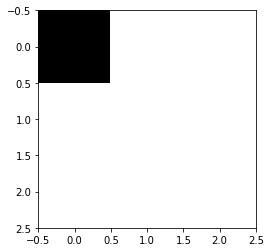

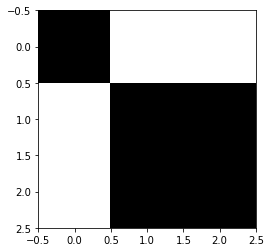

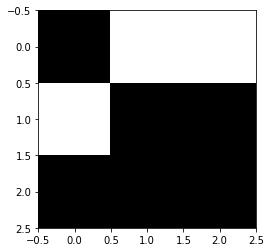

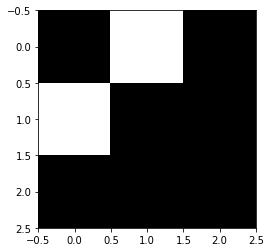

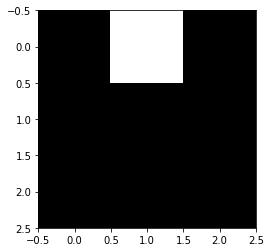

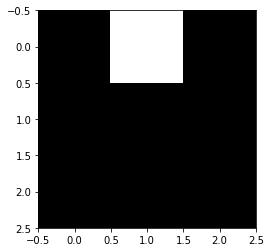

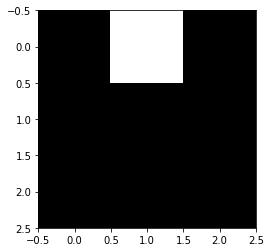

In [380]:
new_state = x1.reset()
for i in range(7):
    action = y1.trained_act(new_state)
    print(action)
    new_state, reward, done, _ = x1.step(action)
    print(reward)
    x1.render()

[ 1.9501019  1.8660634  1.1640675  1.9084744  1.5500178  1.3142127
  1.0436349  1.240527   1.7832434 -9.653381 ]
0
9.0
[-8.049898   1.8660634  1.1640675  1.9084744  1.5500178  1.3142127
  1.0436349  1.240527   1.7832434 -9.653381 ]
3
7.111111111111111
[-8.049898   1.8660634 -8.835933  -8.091526   1.5500178 -8.685787
 -8.956366  -8.759473  -8.216757  -9.653381 ]
1
5.444444444444445
[-8.049898  -8.133937  -8.835933  -8.091526  -8.449982  -8.685787
  1.0436349  1.240527   1.7832434 -9.653381 ]
8
3.0
[-8.049898  -8.133937  -8.835933  -8.091526  -8.449982  -8.685787
  1.0436349  1.240527  -8.216757  -9.653381 ]
7
2.0
[-8.049898  -8.133937  -8.835933  -8.091526  -8.449982  -8.685787
  1.0436349 -8.759473  -8.216757  -9.653381 ]
6
hi
1000000
[ 1.9501019  1.8660634  1.1640675  1.9084744  1.5500178  1.3142127
  1.0436349  1.240527   1.7832434 -9.653381 ]
0
It's over
1000000


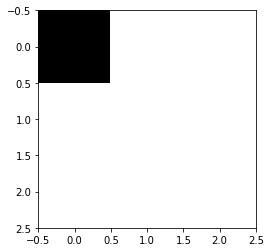

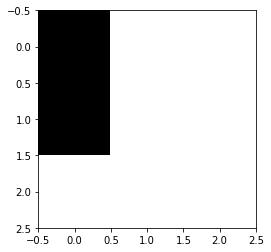

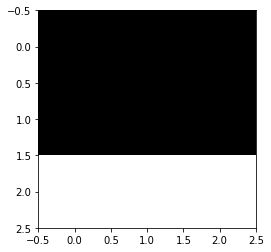

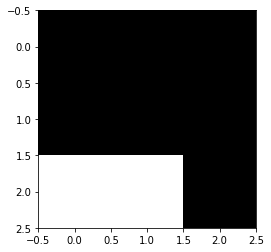

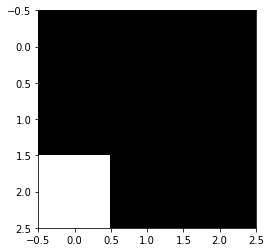

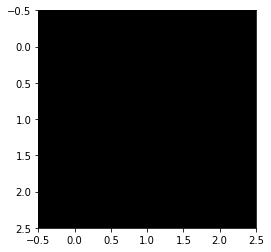

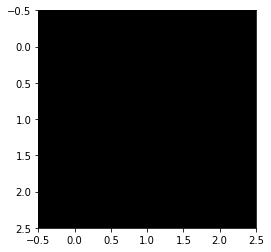

In [394]:
new_state = x.reset()
for i in range(7):
    action = y.trained_act(new_state)
    print(action)
    new_state, reward, done, _ = x.step(action)
    print(reward)
    x.render()